## Current Python Version

Ensure the python version running in the jupyter kernel is the same as expected

In [1]:
# from platform import python_version

# print(python_version())


List installed packages, should match the ones in the pipfile (and their dependencies)

In [2]:
# pip list

## Internal Module Imports
Code required to enable project's internally defined modulos into the jupyter notebook environment

In [3]:
import os
import sys
module_path = os.path.abspath(os.path.join('..'))
if module_path not in sys.path:
    sys.path.append(module_path)

In [4]:
# from electricity import ElectricalSystem, Load, Generator
from dto import (
    COST_PRESETS, 
    ElectricalSystemSpecs, 
    EpsilonSpecs,
    GeneratorSpecs, 
    LoadSpecs, 
    NodeStatePower, 
    SystemHistory, 
    )
    
from learning import ModelTrainer, ModelTester, LearningParams

/home/fmello/.local/share/virtualenvs/2019-MSc_Thesis-4pUnri4s/lib/python3.7/site-packages/tensorflow/python/framework/dtypes.py:516: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/home/fmello/.local/share/virtualenvs/2019-MSc_Thesis-4pUnri4s/lib/python3.7/site-packages/tensorflow/python/framework/dtypes.py:517: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/home/fmello/.local/share/virtualenvs/2019-MSc_Thesis-4pUnri4s/lib/python3.7/site-packages/tensorflow/python/framework/dtypes.py:518: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 

Determine the experiment params

In [5]:
from dto import EpsilonSpecs, ElectricalConstants
import math

LearningParams(
    gamma=0.9,   # Gamma (Discount)
    tau=0.001, # Tau
    epsilonSpecs = EpsilonSpecs( # Epsilon explore/exploit control
        thresholdProgress = 0.6, # % of steps where decay change should happen
        thresholdValue = 0.5, # Value at which decay change would happen
        finalValue = 0.0001, # Value at the end of the experiment
    ),
    numEpisodes=2000, # Number of learning episodes to run
    maxSteps=100,   # Number of steps per learning episode
    bufferSize=500, # Experience Buffer Size
    traceLength=20,     # Number of steps each sampled episode should contain
    batchSize=10,     # Number of episodes sampled from experience buffer
    updateInterval=4, # Run update cycle every N steps
    electricalSystemSpecs = ElectricalSystemSpecs(
        loads=[LoadSpecs(id_="L1", basePower=3.0, noiseLevel=0.01)],
        generators=[
            GeneratorSpecs(id_="G1", basePower=1, costProfile=COST_PRESETS.COAL_OLD, minPower=0.5, maxPower=3.0, noiseLevel=0.01),
            GeneratorSpecs(id_="G2", basePower=1, costProfile=COST_PRESETS.OIL_OLD, minPower=0.5, maxPower=3.0, noiseLevel=0.01),
            GeneratorSpecs(id_="G3", basePower=1, costProfile=COST_PRESETS.OIL_OLD, minPower=0.5, maxPower=3.0, noiseLevel=0.01),
#             GeneratorSpecs(id_="G3", basePower=1.0, costProfile=COST_PRESETS.OIL_ALTERNATE_2, minPower=0.5, maxPower=5.0, noiseLevel=0.05),
        ],
        shouldTrackOptimalCost=True,
    ),
    modelName='Micro-3Gen-OriginalTest-C65-2k'
)

# Droop = +infinity essentially remove the droop component from the power update equation. System reacts as if droop is disabled
# ElectricalConstants().droop = math.inf

LearningParams(electricalSystemSpecs=ElectricalSystemSpecs(loads=[LoadSpecs(id_='L1', basePower=3.0, noiseLevel=0.01)], generators=[GeneratorSpecs(id_='G1', basePower=1, costProfile=CostProfile(alpha=0.0, beta=0, gamma=1), minPower=0.5, maxPower=3.0, noiseLevel=0.01), GeneratorSpecs(id_='G2', basePower=1, costProfile=CostProfile(alpha=0.0, beta=0, gamma=2), minPower=0.5, maxPower=3.0, noiseLevel=0.01), GeneratorSpecs(id_='G3', basePower=1, costProfile=CostProfile(alpha=0.0, beta=0, gamma=2), minPower=0.5, maxPower=3.0, noiseLevel=0.01)], shouldTrackOptimalCost=True), gamma=0.9, tau=0.001, epsilonSpecs=EpsilonSpecs(thresholdProgress=0.6, thresholdValue=0.5, finalValue=0.0001), numEpisodes=2000, maxSteps=100, bufferSize=500, traceLength=20, batchSize=10, updateInterval=4, nnShape=NeuralNetworkShape(layer_00_ltsm=100, layer_01_mlp_01=1000, layer_02_mlp_02=100, layer_03_mlp_03=50, layer_04_mlp_04=1), modelName='Micro-3Gen-OriginalTest-C65-2k')

Train Agents

In [6]:
def rewardFn(totalCost, outputDifferential):
    # Original cost
    scaledCost = totalCost/(10000*100.0)
    # New costs
#     scaledCost = totalCost/(100000.0) # Scale down cost to levels near the ones found in output differential (e.g. 0.1 */ 0.01) 
    costComponent = 2**(-1*(scaledCost**2)*200)
    outputComponent = 2**(-1*(outputDifferential**2)*500)
    earnedReward = costComponent*outputComponent
    
    print(f'Scaled_Cost:{scaledCost} - OutputDiff:{outputDifferential} - costComponent:{costComponent} - outputComponent:{outputComponent} - reward:{earnedReward}')

    return earnedReward, {'cost': costComponent, 'output': outputComponent, 'total':earnedReward}

In [7]:
from learning.cost import ModelAdapterCost as ModelAdapter
modelAdapter = ModelAdapter(rewardFn=rewardFn)

In [8]:
%%time
allAgents = ModelTrainer(modelAdapter).trainAgents()

W0919 23:05:52.699347 140681470084864 lazy_loader.py:50] 
The TensorFlow contrib module will not be included in TensorFlow 2.0.
For more information, please see:
  * https://github.com/tensorflow/community/blob/master/rfcs/20180907-contrib-sunset.md
  * https://github.com/tensorflow/addons
  * https://github.com/tensorflow/io (for I/O related ops)
If you depend on functionality not listed there, please file an issue.

W0919 23:05:52.700999 140681470084864 deprecation.py:323] From /mnt/c/Users/flavi/Documents/Study/City-UniLondon/Thesis/2019-MSc_Thesis/app/learning/actor.py:29: BasicLSTMCell.__init__ (from tensorflow.python.ops.rnn_cell_impl) is deprecated and will be removed in a future version.
Instructions for updating:
This class is equivalent as tf.keras.layers.LSTMCell, and will be replaced by that in Tensorflow 2.0.
W0919 23:05:52.713331 140681470084864 deprecation.py:323] From /mnt/c/Users/flavi/Documents/Study/City-UniLondon/Thesis/2019-MSc_Thesis/app/learning/actor.py:38: dyna

Training model: Micro-3Gen-OriginalTest-C65-2k - 0% Scaled_Cost:0.03866456948911389 - OutputDiff:-0.12638345755757918 - costComponent:0.8128213561551324 - outputComponent:0.003943277149756872 - reward:0.003205179880560926
Scaled_Cost:0.04222026292629957 - OutputDiff:-0.2120136631879437 - costComponent:0.7810516604898184 - outputComponent:1.715465337226583e-07 - reward:1.339867050153549e-07
Scaled_Cost:0.08809455315678831 - OutputDiff:0.02848831755333597 - costComponent:0.34100621557156136 - outputComponent:0.7548217405526988 - reward:0.25739890517701475
Scaled_Cost:0.07664901044584194 - OutputDiff:0.10683396829416791 - costComponent:0.4428794125414667 - outputComponent:0.019146859775254845 - reward:0.008479750009278704
Scaled_Cost:0.07568632298938269 - OutputDiff:0.17216746619787157 - costComponent:0.4519753828355395 - outputComponent:3.4553270413815986e-05 - reward:1.5617227623504402e-05
Scaled_Cost:0.06981072271262821 - OutputDiff:0.16307464027612892 - costComponent:0.508843036119260

Scaled_Cost:0.11835760205177001 - OutputDiff:0.23169331382496935 - costComponent:0.14341776122738598 - outputComponent:8.31927045090013e-09 - reward:1.1931311431132426e-09
Scaled_Cost:0.12342110342541551 - OutputDiff:0.2521118286039659 - costComponent:0.12103080910261296 - outputComponent:2.7115051074658643e-10 - reward:3.281756570424611e-11
Scaled_Cost:0.10177775203600473 - OutputDiff:0.13695487447076904 - costComponent:0.2378720777229403 - outputComponent:0.0015026046416917922 - reward:0.00035742768811536087
Scaled_Cost:0.09873506078149737 - OutputDiff:0.28289903891148643 - costComponent:0.2588660283996681 - outputComponent:8.995055138378017e-13 - reward:2.328514198907944e-13
Scaled_Cost:0.0766611003139516 - OutputDiff:-0.050925319234598795 - costComponent:0.4427656295061731 - outputComponent:0.40705790197100783 - reward:0.18023124821165537
Scaled_Cost:0.05803025125093997 - OutputDiff:0.08583636792527376 - costComponent:0.6269828941658453 - outputComponent:0.07780782007008583 - rewar

Scaled_Cost:0.06192971552644698 - OutputDiff:0.13157278961065746 - costComponent:0.5876145674141544 - outputComponent:0.0024795611443402116 - reward:0.001457026249208419
Scaled_Cost:0.034629335785267445 - OutputDiff:-0.1317450739590347 - costComponent:0.8468402933026845 - outputComponent:0.002440881113599748 - reward:0.0020670364781577937
Scaled_Cost:0.03536015560792117 - OutputDiff:-0.12691620495231096 - costComponent:0.8408567108905562 - outputComponent:0.0037631029137148637 - reward:0.003164230338768949
Scaled_Cost:0.051765861204578066 - OutputDiff:0.03599080849598883 - costComponent:0.689708725127111 - outputComponent:0.6383107508374587 - reward:0.44024849419503265
Scaled_Cost:0.0820057947884923 - OutputDiff:0.3056386259155369 - costComponent:0.39365669621851374 - outputComponent:8.70254034644288e-15 - reward:3.425813281489024e-15
Scaled_Cost:0.09654474621303519 - OutputDiff:0.3998445349177751 - costComponent:0.2746797376171069 - outputComponent:8.63607827963185e-25 - reward:2.3721

Scaled_Cost:0.0505444405404339 - OutputDiff:0.02132783215775238 - costComponent:0.7017611109199762 - outputComponent:0.8541502570986057 - reward:0.5994094333141008
Scaled_Cost:0.049333580807411855 - OutputDiff:-0.00036828075713822556 - costComponent:0.7136257412838682 - outputComponent:0.9999529950805424 - reward:0.7135921973633763
Scaled_Cost:0.13299751635933907 - OutputDiff:0.6917992208869691 - costComponent:0.0861104494395141 - outputComponent:9.238572284444998e-73 - reward:7.955376115929972e-74
Scaled_Cost:0.18320973199004878 - OutputDiff:0.9567551613253046 - costComponent:0.009530970368532439 - outputComponent:1.6653873067149916e-138 - reward:1.5872757072430628e-140
Scaled_Cost:0.19154544904886803 - OutputDiff:0.893390135301464 - costComponent:0.006181052309268039 - outputComponent:7.3631982938677635e-121 - reward:4.5512313817909824e-123
Scaled_Cost:0.12520034341766528 - OutputDiff:0.585812750148717 - costComponent:0.11383174097524666 - outputComponent:2.2221740448507076e-52 - rew

Scaled_Cost:0.013817769185948025 - OutputDiff:-0.47835293960075354 - costComponent:0.973878602153154 - outputComponent:3.6218226631316765e-35 - reward:3.5272155924172906e-35
Scaled_Cost:0.01266754128544559 - OutputDiff:-0.4962967140999163 - costComponent:0.9780002096509158 - outputComponent:8.444742265803528e-38 - reward:8.258959706403801e-38
Scaled_Cost:0.031129513962724665 - OutputDiff:-0.28293485218110614 - costComponent:0.8742941628320361 - outputComponent:8.932103350162278e-13 - reward:7.809285820859354e-13
Scaled_Cost:0.027096213210324772 - OutputDiff:-0.3354832701610626 - costComponent:0.903226078329 - outputComponent:1.1473180144891576e-17 - reward:1.0362875508232567e-17
Scaled_Cost:0.05064273492242099 - OutputDiff:-0.0871600022492831 - costComponent:0.7007941708675319 - outputComponent:0.07187166925371985 - reward:0.05036724686352609
Scaled_Cost:0.0426510989928027 - OutputDiff:-0.14348305283061288 - costComponent:0.7771024692078515 - outputComponent:0.0007966903801138672 - rew

Scaled_Cost:0.12887295609738011 - OutputDiff:0.42128127800519094 - costComponent:0.100019433037587 - outputComponent:1.9360295368440705e-27 - reward:1.9364057661916607e-28
Scaled_Cost:0.1857224117131464 - OutputDiff:0.5450355879431226 - costComponent:0.008381575422875386 - outputComponent:1.9384025498478696e-45 - reward:1.6246867171443884e-47
Scaled_Cost:0.13238437125056748 - OutputDiff:0.444444652173197 - costComponent:0.08807495542042053 - outputComponent:1.8561565887029057e-30 - reward:1.6348090880332827e-31
Scaled_Cost:0.08883982032036018 - OutputDiff:0.13623626096069846 - costComponent:0.3348292025821555 - outputComponent:0.00160839848728947 - reward:0.0005385387829334784
Scaled_Cost:0.09136596948023012 - OutputDiff:0.01780532395533136 - costComponent:0.3143517989026882 - outputComponent:0.8959469518951088 - reward:0.2816425360496077
Scaled_Cost:0.09433007237313688 - OutputDiff:0.09470338015577134 - costComponent:0.2912575774971944 - outputComponent:0.044675723195350965 - reward:0

Scaled_Cost:0.02298402597668508 - OutputDiff:-0.36572906098330255 - costComponent:0.9293841267892243 - outputComponent:7.369756581437579e-21 - reward:6.849334785088503e-21
Scaled_Cost:0.02146325295701338 - OutputDiff:-0.38993313923576295 - costComponent:0.9381338973074241 - outputComponent:1.3017204395395026e-23 - reward:1.2211880691499268e-23
Scaled_Cost:0.031626441659839806 - OutputDiff:-0.26290435652925054 - costComponent:0.8705225877539657 - outputComponent:3.95001656299064e-11 - reward:3.438578640085638e-11
Scaled_Cost:0.02497774617406184 - OutputDiff:-0.27927346662567165 - costComponent:0.9171454406431542 - outputComponent:1.8229848326196634e-12 - reward:1.6719422275987478e-12
Scaled_Cost:0.11455392990286528 - OutputDiff:0.2364648670389381 - costComponent:0.16215882313830543 - outputComponent:3.835823084713102e-09 - reward:6.22012557183821e-10
Scaled_Cost:0.06976941210780678 - OutputDiff:-0.04071877049321781 - costComponent:0.5092499458246827 - outputComponent:0.5629157286377623 

Scaled_Cost:0.04529667413464402 - OutputDiff:-0.042823388242871095 - costComponent:0.7524367727662047 - outputComponent:0.5296380622329084 - reward:0.3985191542806759
Scaled_Cost:0.044015911367391046 - OutputDiff:-0.025195343749597265 - costComponent:0.7644637033350627 - outputComponent:0.802513366436524 - reward:0.6134923400819534
Scaled_Cost:0.05702401968056357 - OutputDiff:0.0984128714385245 - costComponent:0.6371267146640013 - outputComponent:0.03485364538933243 - reward:0.022206188580969486
Scaled_Cost:0.04851322086751793 - OutputDiff:-0.006026395657769662 - costComponent:0.7216111222302014 - outputComponent:0.9874922136265075 - reward:0.7125853644686099
Scaled_Cost:0.10712977633236961 - OutputDiff:0.46601028594487665 - costComponent:0.2037175538884806 - outputComponent:2.0574164256135307e-33 - reward:4.191318415559696e-34
Scaled_Cost:0.09529965719813667 - OutputDiff:0.3891084405111316 - costComponent:0.28392761284454654 - outputComponent:1.6263716180345834e-23 - reward:4.61771811

Scaled_Cost:0.16209117894767422 - OutputDiff:0.8650052616226491 - costComponent:0.026192361363661452 - outputComponent:2.3963246991535702e-113 - reward:6.276540246489763e-115
Scaled_Cost:0.12363539560345936 - OutputDiff:0.5700636588822129 - costComponent:0.12014577246669103 - outputComponent:1.221106524138134e-49 - reward:1.467107866066922e-50
Scaled_Cost:0.0769600816568963 - OutputDiff:0.256136906064962 - costComponent:0.4399553944003628 - outputComponent:1.334429996657912e-10 - reward:5.870896754793064e-11
Scaled_Cost:0.08415972674971564 - OutputDiff:0.3588666455636925 - costComponent:0.3746013694092312 - outputComponent:4.129385902598626e-20 - reward:1.5468736139326195e-20
Scaled_Cost:0.08628743151669371 - OutputDiff:0.2519549208348242 - costComponent:0.35623368131017125 - outputComponent:2.786858750258245e-10 - reward:9.927729518959578e-11
Scaled_Cost:0.060134981763438254 - OutputDiff:0.07792878502026021 - costComponent:0.6057342082750663 - outputComponent:0.12188159858815831 - rew

Scaled_Cost:0.04335212569160693 - OutputDiff:-0.1818131144168607 - costComponent:0.7706344786532267 - outputComponent:1.0582175045505371e-05 - reward:8.154988949210216e-06
Scaled_Cost:0.04248224323101358 - OutputDiff:-0.05271434126681846 - costComponent:0.7786526491877676 - outputComponent:0.38172328873333583 - reward:0.29722985002887903
Scaled_Cost:0.08189759162341859 - OutputDiff:0.2686858006077199 - costComponent:0.3946257211999114 - outputComponent:1.3614833314358588e-11 - reward:5.3727634156953375e-12
Scaled_Cost:0.08061220575577016 - OutputDiff:0.24272152755049473 - costComponent:0.4062203603849076 - outputComponent:1.35705847371011e-09 - reward:5.512647822539135e-10
Scaled_Cost:0.054033301436892986 - OutputDiff:0.04386248024964498 - costComponent:0.6671487944182884 - outputComponent:0.5133595088515394 - reward:0.3424871774334692
Scaled_Cost:0.050417095192440975 - OutputDiff:0.009222532136561993 - costComponent:0.7030130144902562 - outputComponent:0.9709523829929084 - reward:0.68

Scaled_Cost:0.053903032069850254 - OutputDiff:-0.11183909064081772 - costComponent:0.6684504961050641 - outputComponent:0.013102708733427665 - reward:0.00875851215317988
Scaled_Cost:0.04593274575422906 - OutputDiff:-0.20050170341962553 - costComponent:0.7464081134628331 - outputComponent:8.895219012895765e-07 - reward:6.639463642254252e-07
Scaled_Cost:0.05180658371531063 - OutputDiff:-0.16366169228036814 - costComponent:0.6893055692536189 - outputComponent:9.298936414736554e-05 - reward:6.409808658813186e-05
Scaled_Cost:0.042629497807027086 - OutputDiff:-0.12396052521734086 - costComponent:0.7773009493326298 - outputComponent:0.004865804575040358 - reward:0.003782194515445924
Scaled_Cost:0.0249440535801948 - OutputDiff:-0.2582415118022706 - costComponent:0.9173593200559574 - outputComponent:9.169670127473758e-11 - reward:8.41188235327675e-11
Scaled_Cost:0.04097299709133591 - OutputDiff:-0.06306767682863602 - costComponent:0.7923680983067588 - outputComponent:0.2519543150555595 - reward

Scaled_Cost:0.02761900015744432 - OutputDiff:-0.3289118455970313 - costComponent:0.8996515070296927 - outputComponent:5.2099752755270545e-17 - reward:4.687162108215353e-17
Scaled_Cost:0.02659338969657484 - OutputDiff:-0.3149390225971752 - costComponent:0.9066127307104389 - outputComponent:1.1774186999682461e-15 - reward:1.0674627827677466e-15
Scaled_Cost:0.018678352893211573 - OutputDiff:-0.36632971981567664 - costComponent:0.9527858063449625 - outputComponent:6.3280376458885195e-21 - reward:6.029264451019171e-21
Scaled_Cost:0.01895739622596727 - OutputDiff:-0.41136307260475985 - costComponent:0.9513996671397053 - outputComponent:3.38778358228509e-26 - reward:3.223136172527393e-26
Scaled_Cost:0.0144248784201903 - OutputDiff:-0.4420814832831522 - costComponent:0.9715664496728132 - outputComponent:3.836588184185971e-30 - reward:3.727500360966229e-30
Scaled_Cost:0.02758404035856753 - OutputDiff:-0.30255601928482473 - costComponent:0.8998922312504111 - outputComponent:1.6666150644107263e-1

Scaled_Cost:0.05603820838456787 - OutputDiff:0.09767652904830827 - costComponent:0.6470476391274664 - outputComponent:0.0366421466830202 - reward:0.023709214503810548
Scaled_Cost:0.028919437731910427 - OutputDiff:-0.2337327163010991 - costComponent:0.8905282134840995 - outputComponent:5.987117230888773e-09 - reward:5.331696811543248e-09
Scaled_Cost:0.01893354028505585 - OutputDiff:-0.39909694574831306 - costComponent:0.9515188949458504 - outputComponent:1.062224142224291e-24 - reward:1.0107263419940612e-24
Scaled_Cost:0.014592641464707868 - OutputDiff:-0.4677220839959591 - costComponent:0.9709110020080791 - outputComponent:1.1823467515658123e-33 - reward:1.1479534692837603e-33
Scaled_Cost:0.013771718485502293 - OutputDiff:-0.46150584542825296 - costComponent:0.9740501472871484 - outputComponent:8.753163077081383e-33 - reward:8.526019784459551e-33
Scaled_Cost:0.028495682213659956 - OutputDiff:-0.32457681215835754 - costComponent:0.8935369031487905 - outputComponent:1.3906853340237826e-1

Scaled_Cost:0.14806414664149325 - OutputDiff:0.41519886842922754 - costComponent:0.04787451546352313 - outputComponent:1.1290272401825206e-26 - reward:5.405163206885693e-28
Scaled_Cost:0.16097927327942121 - OutputDiff:0.5342478758934243 - costComponent:0.027529738472539856 - outputComponent:1.096200449848293e-43 - reward:3.0178111697804046e-45
Scaled_Cost:0.19915958518490118 - OutputDiff:0.5617277621591024 - costComponent:0.004092198735329616 - outputComponent:3.212082982146262e-48 - reward:1.3144481917312713e-50
Scaled_Cost:0.1279882387318446 - OutputDiff:0.17509484824257274 - costComponent:0.10322055151288988 - outputComponent:2.4292947313606194e-05 - reward:2.507531419584008e-06
Scaled_Cost:0.1530387226064527 - OutputDiff:0.2977238240104285 - costComponent:0.03889773274292547 - outputComponent:4.5543830535931146e-14 - reward:1.7715517482757377e-15
Scaled_Cost:0.15145704374882685 - OutputDiff:0.22864568979449582 - costComponent:0.04158343593944599 - outputComponent:1.3528473198637916

Scaled_Cost:0.037364293749975346 - OutputDiff:-0.25558156029884194 - costComponent:0.824037507342414 - outputComponent:1.4725472903738339e-10 - reward:1.21343419860348e-10
Scaled_Cost:0.034633372900649315 - OutputDiff:-0.2511201473920959 - costComponent:0.8468074672103536 - outputComponent:3.2234748686268903e-10 - reward:2.7296625891181643e-10
Scaled_Cost:0.03542865742981395 - OutputDiff:-0.23775577488520022 - costComponent:0.8402916461121235 - outputComponent:3.102537414434643e-09 - reward:2.6070362710997373e-09
Scaled_Cost:0.0125 - OutputDiff:-0.4974608857505098 - costComponent:0.9785720620877001 - outputComponent:5.655290678933938e-38 - reward:5.534109461389733e-38
Scaled_Cost:0.021144603566800108 - OutputDiff:-0.3146648751064842 - costComponent:0.9399012850355152 - outputComponent:1.2500013131103308e-15 - reward:1.1748778404884813e-15
Scaled_Cost:0.021186352905766485 - OutputDiff:-0.3106317305262303 - costComponent:0.9396710389870421 - outputComponent:2.9956839365551985e-15 - rewar

Scaled_Cost:0.07216571842605987 - OutputDiff:0.22964056231141147 - costComponent:0.4857957645241652 - outputComponent:1.1551104684843246e-08 - reward:5.6114777314720905e-09
Scaled_Cost:0.08095385723196798 - OutputDiff:0.25889796120552777 - costComponent:0.40312372563345666 - outputComponent:8.151874751568271e-11 - reward:3.28621412074951e-11
Scaled_Cost:0.09270428476599599 - OutputDiff:0.2699397176785413 - costComponent:0.3037977557199045 - outputComponent:1.0773473396326157e-11 - reward:3.272957039111984e-12
Scaled_Cost:0.08021067467302229 - OutputDiff:0.2247212677122874 - costComponent:0.4098731908227468 - outputComponent:2.506372208793274e-08 - reward:1.027294774607555e-08
Scaled_Cost:0.08759630660946441 - OutputDiff:0.1798304392602659 - costComponent:0.3451696240261275 - outputComponent:1.3567425927307305e-05 - reward:4.6830633063309965e-06
Scaled_Cost:0.06590696952490553 - OutputDiff:0.058677209736418226 - costComponent:0.5476227448719683 - outputComponent:0.30323170886492 - rewar

Scaled_Cost:0.24458110307783332 - OutputDiff:0.9863673873939153 - costComponent:0.0002503122996859167 - outputComponent:3.637931785203799e-147 - reward:9.106190712548552e-151
Scaled_Cost:0.23550954629016033 - OutputDiff:0.9134730701214421 - costComponent:0.0004578144821731919 - outputComponent:2.542794789454611e-126 - reward:1.1641282798068533e-129
Scaled_Cost:0.20033929725974053 - OutputDiff:0.9556270010645141 - costComponent:0.0038333812246130086 - outputComponent:3.517607497552555e-138 - reward:1.3484330536675914e-140
Scaled_Cost:0.19764086570896863 - OutputDiff:1.0609837972110068 - costComponent:0.0044487558505570185 - outputComponent:3.692165336172173e-170 - reward:1.6425542140519774e-172
Scaled_Cost:0.20787758517580432 - OutputDiff:1.0699197896073667 - costComponent:0.002502146395204512 - outputComponent:5.02590122793569e-173 - reward:1.2575540640133219e-175
Scaled_Cost:0.20172607573828294 - OutputDiff:1.0403608847577304 - costComponent:0.0035482369563737187 - outputComponent:1.2

Scaled_Cost:0.0739797047206088 - OutputDiff:0.05610798498100369 - costComponent:0.4682661501422625 - outputComponent:0.3358635201402843 - reward:0.15727351754931918
Scaled_Cost:0.0931721243266349 - OutputDiff:0.16875261647859208 - costComponent:0.3001573809340201 - outputComponent:5.172700602232594e-05 - reward:1.552624265121964e-05
Scaled_Cost:0.09677185575042309 - OutputDiff:0.17539356589775057 - costComponent:0.27301300615741353 - outputComponent:2.342727243213596e-05 - reward:6.395950072766139e-06
Scaled_Cost:0.1136811923450017 - OutputDiff:0.43817390204021983 - costComponent:0.16669899381039235 - outputComponent:1.2637670332748614e-29 - reward:2.1066869285766402e-30
Scaled_Cost:0.10492966514461226 - OutputDiff:0.3975999704651367 - costComponent:0.21732907100596027 - outputComponent:1.6059266727807798e-24 - reward:3.4901455189913963e-25
Scaled_Cost:0.06520594780484881 - OutputDiff:0.08415138287782603 - costComponent:0.5546451144863955 - outputComponent:0.08592801509461724 - reward:

Scaled_Cost:0.11717158475240985 - OutputDiff:0.12418461609310341 - costComponent:0.1490805493296571 - outputComponent:0.004772928907087715 - reward:0.0007115508633800365
Scaled_Cost:0.16874430940463014 - OutputDiff:0.39217985553819945 - costComponent:0.01930437436120982 - outputComponent:7.080026363076632e-24 - reward:1.3667547940006615e-25
Scaled_Cost:0.10904997857987032 - OutputDiff:0.09873731393852156 - costComponent:0.19232529606584384 - outputComponent:0.03408950398495522 - reward:0.0065562739466442765
Scaled_Cost:0.1291107792057021 - OutputDiff:0.1910808890883988 - costComponent:0.09917232153778237 - outputComponent:3.194556114867687e-06 - reward:3.168115461941471e-07
Scaled_Cost:0.13471846957750375 - OutputDiff:0.17816100580259808 - costComponent:0.08078251044125084 - outputComponent:1.668982098155153e-05 - reward:1.3482456377047938e-06
Scaled_Cost:0.12603315945299143 - OutputDiff:0.25163429284410177 - costComponent:0.11057740638851153 - outputComponent:2.9472558002967586e-10 - 

Scaled_Cost:0.0979828288324599 - OutputDiff:0.1815924582226209 - costComponent:0.26423125822475046 - outputComponent:1.0880388211527389e-05 - reward:2.874938667105624e-06
Scaled_Cost:0.1361271659903048 - OutputDiff:0.23605694955728737 - costComponent:0.07662074883449424 - outputComponent:4.10081635297258e-09 - reward:3.1420761979749873e-10
Scaled_Cost:0.13778568262062985 - OutputDiff:0.2303478895662598 - costComponent:0.07194414705590829 - outputComponent:1.0319332438424898e-08 - reward:7.424155704688456e-10
Scaled_Cost:0.09345146265688488 - OutputDiff:0.045796239155089714 - costComponent:0.29799599066820676 - outputComponent:0.4834210632643571 - reward:0.14405753865733995
Scaled_Cost:0.12015485230628954 - OutputDiff:0.12840411624806197 - costComponent:0.13514333739391993 - outputComponent:0.003298878743579094 - reward:0.00044582148306514013
Scaled_Cost:0.15206216618166024 - OutputDiff:0.27851062514062147 - costComponent:0.04053802247506163 - outputComponent:2.1126488327389956e-12 - re

Scaled_Cost:0.16888652162278459 - OutputDiff:0.6034854769450121 - costComponent:0.019176304896241322 - outputComponent:1.524868439333566e-55 - reward:2.924134211931613e-57
Scaled_Cost:0.14818815496506135 - OutputDiff:0.4856400618321319 - costComponent:0.04763131355954495 - outputComponent:3.173943810391788e-36 - reward:1.5117911285314811e-37
Scaled_Cost:0.18113191581607557 - OutputDiff:0.5209553609217324 - costComponent:0.010585592366193006 - outputComponent:1.415986836638372e-41 - reward:1.4989059448548932e-43
Scaled_Cost:0.11889238084589035 - OutputDiff:0.3581171839850051 - costComponent:0.14091727190087042 - outputComponent:4.974678065104441e-20 - reward:7.010180615196184e-21
Scaled_Cost:0.07992052462680387 - OutputDiff:0.13544624401049948 - costComponent:0.4125217090635635 - outputComponent:0.0017326037877733523 - reward:0.0007147366756622669
Scaled_Cost:0.06250033111177797 - OutputDiff:-0.08277781517538887 - costComponent:0.5818590908200738 - outputComponent:0.09303495378507914 - 

Scaled_Cost:0.020409882407265028 - OutputDiff:-0.329482376041328 - costComponent:0.9438878381950584 - outputComponent:4.5740101024004446e-17 - reward:4.317352507437113e-17
Scaled_Cost:0.023743318928810743 - OutputDiff:-0.27506753805836476 - costComponent:0.9248241401316883 - outputComponent:4.089889575750094e-12 - reward:3.782428610126637e-12
Scaled_Cost:0.02206429768428005 - OutputDiff:-0.2997433431535886 - costComponent:0.9347376133831389 - outputComponent:2.9979107752302294e-14 - reward:2.8022599631743005e-14
Scaled_Cost:0.024105004934011458 - OutputDiff:-0.2684364333304112 - costComponent:0.9226080256721239 - outputComponent:1.4261736698439787e-11 - reward:1.3157992738003207e-11
Scaled_Cost:0.0362901923313869 - OutputDiff:-0.12519473256410277 - costComponent:0.8331247186503027 - outputComponent:0.004373910663246876 - reward:0.003644013090719112
Scaled_Cost:0.024246594639136535 - OutputDiff:-0.26796879120345773 - costComponent:0.9217328219888614 - outputComponent:1.5557093117276363e

Scaled_Cost:0.0342128802856515 - OutputDiff:-0.20763369032492002 - costComponent:0.85021272952074 - outputComponent:3.24365860795989e-07 - reward:2.757799838707022e-07
Scaled_Cost:0.0333580410162879 - OutputDiff:-0.21814974464892142 - costComponent:0.8570481831689487 - outputComponent:6.872186616666148e-08 - reward:5.889795054211686e-08
Scaled_Cost:0.04507955805388067 - OutputDiff:-0.02936438730705101 - costComponent:0.7544863416073376 - outputComponent:0.7416787701998334 - reward:0.5595865019759015
Scaled_Cost:0.038306132023176974 - OutputDiff:-0.11502594661879124 - costComponent:0.8159360845885404 - outputComponent:0.010198606152694014 - reward:0.008321410772489752
Scaled_Cost:0.0512339958069083 - OutputDiff:0.0613946751323142 - costComponent:0.6949665931806401 - outputComponent:0.2708088764307287 - reward:0.18820312225614047
Scaled_Cost:0.0646994998546682 - OutputDiff:0.19234503210981044 - costComponent:0.5597268823468293 - outputComponent:2.70056800938798e-06 - reward:1.51158051246

Scaled_Cost:0.31658239511357505 - OutputDiff:1.296142185599181 - costComponent:9.244620423926258e-07 - outputComponent:1.3712820704207348e-253 - reward:1.267698223517541e-259
Scaled_Cost:0.2983623400990239 - OutputDiff:1.2215777781350454 - costComponent:4.369751902522642e-06 - outputComponent:2.475444034749608e-225 - reward:1.0817076280435424e-230
Scaled_Cost:0.36457531914801244 - OutputDiff:1.4886705887984897 - costComponent:9.947404804837052e-09 - outputComponent:0.0 - reward:0.0
Scaled_Cost:0.27922593690314307 - OutputDiff:1.1714490998338356 - costComponent:2.0226065519186707e-05 - outputComponent:2.813993294831017e-207 - reward:5.691601275180423e-212
Scaled_Cost:0.35349099352514474 - OutputDiff:1.3307673590684004 - costComponent:2.998515142476666e-08 - outputComponent:2.7970758058022885e-267 - reward:8.387074158353284e-275
Scaled_Cost:0.3713178763548455 - OutputDiff:1.3591873848483325 - costComponent:5.000109861446063e-09 - outputComponent:8.710556593498677e-279 - reward:4.35537399

Scaled_Cost:0.13839074918558697 - OutputDiff:0.6280290732338824 - costComponent:0.07029666747853214 - outputComponent:4.3032518575168665e-60 - reward:3.0250426490423893e-61
Scaled_Cost:0.14683026618583328 - OutputDiff:0.6835804536499386 - costComponent:0.05035136104364094 - outputComponent:4.645315004603035e-71 - reward:2.3389793295821e-72
Scaled_Cost:0.14523324086759734 - OutputDiff:0.594570533625897 - costComponent:0.053714714048998545 - outputComponent:6.177646829831651e-54 - reward:3.318305329601095e-55
Scaled_Cost:0.1723046257298084 - OutputDiff:0.7873188089512526 - costComponent:0.016313647454200938 - outputComponent:5.013393430032823e-94 - reward:8.178673296676267e-96
Scaled_Cost:0.13828780796182616 - OutputDiff:0.6583769087567083 - costComponent:0.07057477496979496 - outputComponent:5.724609445856054e-66 - reward:4.040130234312536e-67
Scaled_Cost:0.07661894612033252 - OutputDiff:0.23775469545326597 - costComponent:0.4431624099770829 - outputComponent:3.1030893729884838e-09 - re

Scaled_Cost:0.08427010966235728 - OutputDiff:0.35155584144601837 - costComponent:0.3736371271842583 - outputComponent:2.4981826754053457e-19 - reward:9.334137980199378e-20
Scaled_Cost:0.06143432887756682 - OutputDiff:0.15931266659963805 - costComponent:0.5926140134810417 - outputComponent:0.00015130393514950556 - reward:8.966483226442375e-05
Scaled_Cost:0.06681242058785894 - OutputDiff:0.14737894649623212 - costComponent:0.5385753444512533 - outputComponent:0.0005379363368951472 - reward:0.0002897192479361494
Scaled_Cost:0.09090636052928469 - OutputDiff:0.17140207949982084 - costComponent:0.31802381789792944 - outputComponent:3.7850281923635626e-05 - reward:1.2037291165867587e-05
Scaled_Cost:0.1445416809179487 - OutputDiff:0.5655662652476363 - costComponent:0.05522787757557723 - outputComponent:7.169519616359561e-49 - reward:3.959573516480053e-50
Scaled_Cost:0.16965951581430483 - OutputDiff:0.5226103349664937 - costComponent:0.018493085186933652 - outputComponent:7.782312312550729e-42 

Scaled_Cost:0.026554420719901908 - OutputDiff:-0.2654387559522556 - costComponent:0.9068730725664504 - outputComponent:2.4834444263648944e-11 - reward:2.2521688774855576e-11
Scaled_Cost:0.0125 - OutputDiff:-0.5024912251990747 - costComponent:0.9785720620877001 - outputComponent:9.893493207440467e-39 - reward:9.681496049255671e-39
Scaled_Cost:0.01937575156097459 - OutputDiff:-0.3471740781344353 - costComponent:0.9492868808094902 - outputComponent:7.218572358361746e-19 - reward:6.852496037966827e-19
Scaled_Cost:0.04285138254691668 - OutputDiff:-0.06302887590785185 - costComponent:0.7752598213334403 - outputComponent:0.25238190823919116 - reward:0.19566155308930805
Scaled_Cost:0.050057333412557914 - OutputDiff:-0.0811539854990671 - costComponent:0.7065446670630126 - outputComponent:0.10202646409938927 - reward:0.0720862541087194
Scaled_Cost:0.056322738848563515 - OutputDiff:0.09409001790441637 - costComponent:0.6441862703319577 - outputComponent:0.04650514888534495 - reward:0.029957978411

Scaled_Cost:0.07877892806696316 - OutputDiff:-0.04218226554799812 - costComponent:0.423013642893917 - outputComponent:0.5397369032201123 - reward:0.22831607363542122
Scaled_Cost:0.12412472422246573 - OutputDiff:0.29077356959122547 - costComponent:0.11814336935915694 - outputComponent:1.8796067412582797e-13 - reward:2.2206307348243827e-14
Scaled_Cost:0.11847709910094192 - OutputDiff:0.2089639174131204 - costComponent:0.14285618431531386 - outputComponent:2.676851810042238e-07 - reward:3.824048355601755e-08
Scaled_Cost:0.11060855485109611 - OutputDiff:0.14766151225230925 - costComponent:0.18341067544328807 - outputComponent:0.0005226159947402829 - reward:9.585335259278118e-05
Scaled_Cost:0.1419526532201484 - OutputDiff:0.3781106634424708 - costComponent:0.06120905261660785 - outputComponent:3.0284533387510833e-22 - reward:1.8536875975855678e-23
Scaled_Cost:0.07677164019583359 - OutputDiff:0.01001203293236819 - costComponent:0.4417258148472024 - outputComponent:0.9658557189978026 - reward

Scaled_Cost:0.05004191156039123 - OutputDiff:0.03945832260810023 - costComponent:0.7066958869426726 - outputComponent:0.5829808457222474 - reward:0.411990165838273
Scaled_Cost:0.03397945294316944 - OutputDiff:-0.1540759103258021 - costComponent:0.852090963105909 - outputComponent:0.0002672183919488522 - reward:0.00022769437695530973
Scaled_Cost:0.04281543437398462 - OutputDiff:-0.06678824654621421 - costComponent:0.775590864702745 - outputComponent:0.2131092414203344 - reward:0.1652855808293432
Scaled_Cost:0.03793911510978019 - OutputDiff:-0.09988837510452507 - costComponent:0.8191074998021064 - outputComponent:0.03149259081657679 - reward:0.025795817326056993
Scaled_Cost:0.030848941801479582 - OutputDiff:-0.19127766717823164 - costComponent:0.8764043546925877 - outputComponent:3.112331189803818e-06 - reward:2.727660607989629e-06
Scaled_Cost:0.028031021996387274 - OutputDiff:-0.22236430914500704 - costComponent:0.896796380913385 - outputComponent:3.6112086223860035e-08 - reward:3.23851

Scaled_Cost:0.045395599632952074 - OutputDiff:-0.021133596237364594 - costComponent:0.7515015093297149 - outputComponent:0.8565952338027706 - reward:0.6437326110874222
Scaled_Cost:0.03414223636250295 - OutputDiff:-0.14214465633289874 - costComponent:0.8507820728932475 - outputComponent:0.0009095548981948777 - reward:0.0007738330016964447
Scaled_Cost:0.04342551673789302 - OutputDiff:-0.039057851342977463 - costComponent:0.7699543937791056 - outputComponent:0.5893686080022648 - reward:0.45378694928681906
Scaled_Cost:0.04380209123801954 - OutputDiff:-0.03406988406489829 - costComponent:0.7664562561605953 - outputComponent:0.6687882935685321 - reward:0.5125969716525702
Scaled_Cost:0.05093800656548344 - OutputDiff:0.026409945973662054 - costComponent:0.69788629098468 - outputComponent:0.7852681980457865 - reward:0.5480279101623972
Scaled_Cost:0.052705016926043506 - OutputDiff:-0.005581631408092565 - costComponent:0.6803911299029836 - outputComponent:0.9892607175537534 - reward:0.67308421738

Scaled_Cost:0.10421704144966225 - OutputDiff:0.3927039335196659 - costComponent:0.22186617707719167 - outputComponent:6.139344285664942e-24 - reward:1.362112846421183e-24
Scaled_Cost:0.11112239890760627 - OutputDiff:0.510668865175555 - costComponent:0.18053650542540756 - outputComponent:5.601366647820045e-40 - reward:1.0112511602038605e-40
Scaled_Cost:0.08348928081845955 - OutputDiff:0.2666953477645661 - costComponent:0.3804840805301373 - outputComponent:1.969739417644806e-11 - reward:7.494544912065521e-12
Scaled_Cost:0.07972980001365196 - OutputDiff:0.24756479984113433 - costComponent:0.4142667103433893 - outputComponent:5.959188522448419e-10 - reward:2.4686934255107893e-10
Scaled_Cost:0.11979517797519479 - OutputDiff:0.5870261931463304 - costComponent:0.13676993805932272 - outputComponent:1.3569666029240219e-52 - reward:1.8559223823048805e-53
Scaled_Cost:0.11178583311755766 - OutputDiff:0.4741886560073345 - costComponent:0.17687297094860185 - outputComponent:1.4320823776877634e-34 - 

Scaled_Cost:0.07970680077181565 - OutputDiff:0.32251863206657866 - costComponent:0.4144773535361196 - outputComponent:2.206432332717837e-16 - reward:9.145162340214159e-17
Scaled_Cost:0.10307521353122039 - OutputDiff:0.5003838736645954 - costComponent:0.22926691311977473 - outputComponent:2.0580201303876516e-38 - reward:4.718359224323332e-39
Scaled_Cost:0.11111767889909513 - OutputDiff:0.5359351375817478 - costComponent:0.18056276074011665 - outputComponent:5.862842610180192e-44 - reward:1.0586110474789271e-44
Scaled_Cost:0.13679047028453958 - OutputDiff:0.6607007449541097 - costComponent:0.0747218221976284 - outputComponent:1.9786508667891e-66 - reward:1.4784839825939846e-67
Scaled_Cost:0.12806567776703456 - OutputDiff:0.6430107372050518 - costComponent:0.10293720607419232 - outputComponent:5.856610287748846e-63 - reward:6.028631000862378e-64
Scaled_Cost:0.059954122016590526 - OutputDiff:0.09801025382658923 - costComponent:0.6075607813832953 - outputComponent:0.03582213345203197 - rewa

Scaled_Cost:0.06594016204223871 - OutputDiff:-0.07551921793925293 - costComponent:0.5472906087758193 - outputComponent:0.13854474167271558 - reward:0.07582423601274912
Scaled_Cost:0.029178652957074423 - OutputDiff:-0.3192379751881533 - costComponent:0.8886709554871424 - outputComponent:4.577015307959688e-16 - reward:4.0674605670038127e-16
Scaled_Cost:0.023458876597010427 - OutputDiff:-0.36854738965255324 - costComponent:0.9265471004628146 - outputComponent:3.597265848424646e-21 - reward:3.3330362414517623e-21
Scaled_Cost:0.021768699934199248 - OutputDiff:-0.36754391850348045 - costComponent:0.9364181097294232 - outputComponent:4.6467562799199766e-21 - reward:4.351306732015991e-21
Scaled_Cost:0.02833437441436497 - OutputDiff:-0.3022035077119723 - costComponent:0.8946731622966733 - outputComponent:1.7944146346331516e-14 - reward:1.6054146156386714e-14
Scaled_Cost:0.039145074971432485 - OutputDiff:-0.21234136857034883 - costComponent:0.8086193436856539 - outputComponent:1.6347480031706793

Scaled_Cost:0.07968666476302659 - OutputDiff:0.21039942519244256 - costComponent:0.4146618112360166 - outputComponent:2.1727732205217696e-07 - reward:9.009660790266699e-08
Scaled_Cost:0.07856781159617293 - OutputDiff:0.08444812173220155 - costComponent:0.42496613846124315 - outputComponent:0.08445094447057086 - reward:0.035888791761063375
Scaled_Cost:0.05777838417550158 - OutputDiff:-0.0410273805203206 - costComponent:0.6295232926465976 - outputComponent:0.55801546996509 - reward:0.35128373600016205
Scaled_Cost:0.02374629204989352 - OutputDiff:-0.34797768346088537 - costComponent:0.9248060383396048 - outputComponent:5.947979641731966e-19 - reward:5.500727488594761e-19
Scaled_Cost:0.04922674325034562 - OutputDiff:-0.11373216438131176 - costComponent:0.7146682244649462 - outputComponent:0.011300241321539685 - reward:0.008075923401290184
Scaled_Cost:0.023150102176489815 - OutputDiff:-0.35507684432925113 - costComponent:0.9283975070464897 - outputComponent:1.0547134647136494e-19 - reward:9

Scaled_Cost:0.027950142217564505 - OutputDiff:-0.29709862765397305 - costComponent:0.8973594575275223 - outputComponent:5.180875989953445e-14 - reward:4.6491080678619885e-14
Scaled_Cost:0.0125 - OutputDiff:-0.4996791612371 - costComponent:0.9785720620877001 - outputComponent:2.627399385880817e-38 - reward:2.5710996349693483e-38
Scaled_Cost:0.0125 - OutputDiff:-0.4996791612371 - costComponent:0.9785720620877001 - outputComponent:2.627399385880817e-38 - reward:2.5710996349693483e-38
Scaled_Cost:0.033934954512603706 - OutputDiff:-0.1701027973488041 - costComponent:0.8524480212990175 - outputComponent:4.414223389255969e-05 - reward:3.7628959937430936e-05
Scaled_Cost:0.029868367757546813 - OutputDiff:-0.1963006225627101 - costComponent:0.8836678622988449 - outputComponent:1.5851302156343983e-06 - reward:1.4007286291149557e-06
Scaled_Cost:0.013210328228410088 - OutputDiff:-0.4774657216558703 - costComponent:0.9760976882446456 - outputComponent:4.859223001960721e-35 - reward:4.743076338879067

Scaled_Cost:0.058590601764908164 - OutputDiff:0.00822305535961205 - costComponent:0.6213285604746267 - outputComponent:0.9768376285675268 - reward:0.6069371175753094
Scaled_Cost:0.07705555502825862 - OutputDiff:0.026103802356994932 - costComponent:0.4390594756892644 - outputComponent:0.7896557488645145 - reward:0.3467058390714672
Scaled_Cost:0.1065258986540439 - OutputDiff:0.27310177167949423 - costComponent:0.20739407491436399 - outputComponent:5.941586854014127e-12 - reward:1.232249909111606e-12
Scaled_Cost:0.13736969589499906 - OutputDiff:0.2457007004909043 - costComponent:0.07309483769125193 - outputComponent:8.195681036946118e-10 - reward:5.990619751648477e-11
Scaled_Cost:0.1457118902005583 - OutputDiff:0.42626115080742744 - costComponent:0.05268766341190139 - outputComponent:4.483739037917566e-28 - reward:2.3623773325660328e-29
Scaled_Cost:0.12098252275178802 - OutputDiff:0.28355657832940084 - costComponent:0.13145544789031216 - outputComponent:7.905729957034821e-13 - reward:1.03

Scaled_Cost:0.041647248339447045 - OutputDiff:-0.19217245821954848 - costComponent:0.7862725213891497 - outputComponent:2.763394855128228e-06 - reward:2.1727814403354756e-06
Scaled_Cost:0.03234693826419755 - OutputDiff:-0.2232465461527281 - costComponent:0.8649778635485634 - outputComponent:3.151228946786578e-08 - reward:2.7257432819438443e-08
Scaled_Cost:0.032016054606413026 - OutputDiff:-0.23190181494358791 - costComponent:0.8675353494579354 - outputComponent:8.045192643398885e-09 - reward:6.9794890113474625e-09
Scaled_Cost:0.02377564472780613 - OutputDiff:-0.35568394774028206 - costComponent:0.9246272225005651 - outputComponent:9.082104002532384e-20 - reward:8.397560598322783e-20
Scaled_Cost:0.018370470849337305 - OutputDiff:-0.3595924165669217 - costComponent:0.9542936382927045 - outputComponent:3.446683609136218e-20 - reward:3.289148241406431e-20
Scaled_Cost:0.029485219386106137 - OutputDiff:-0.2736828430162644 - costComponent:0.8864581130379651 - outputComponent:5.32207137224324e

Scaled_Cost:0.025003007890822233 - OutputDiff:-0.3457373771229336 - costComponent:0.9169849235352974 - outputComponent:1.0192717468665274e-18 - reward:9.346568248620916e-19
Scaled_Cost:0.048216682274109426 - OutputDiff:-0.18838795761161733 - costComponent:0.7244862981090084 - outputComponent:4.552178983023289e-06 - reward:3.2979912997401733e-06
Scaled_Cost:0.042519577081051405 - OutputDiff:-0.16918349424023096 - costComponent:0.7783101695934296 - outputComponent:4.918141054837223e-05 - reward:3.8278391984747675e-05
Scaled_Cost:0.013131044363216895 - OutputDiff:-0.4784318178634417 - costComponent:0.9763803290270864 - outputComponent:3.52831935763832e-35 - reward:3.444981615323541e-35
Scaled_Cost:0.023550735869020383 - OutputDiff:-0.3659662484208881 - costComponent:0.9259925990692442 - outputComponent:6.939551865093747e-21 - reward:6.42597366793398e-21
Scaled_Cost:0.02648790727032255 - OutputDiff:-0.33832364310595014 - costComponent:0.9073167222957822 - outputComponent:5.910425376714174e

Scaled_Cost:0.1444637194952175 - OutputDiff:0.5848848697257261 - costComponent:0.055400651405224016 - outputComponent:3.238005681646366e-52 - reward:1.7938762401702508e-53
Scaled_Cost:0.14646831668454152 - OutputDiff:0.5275836440235784 - costComponent:0.05109785148347848 - outputComponent:1.2734384801624097e-42 - reward:6.506997033268536e-44
Scaled_Cost:0.08627988763286693 - OutputDiff:0.2324615460600155 - costComponent:0.35629797719379797 - outputComponent:7.352157412857231e-09 - reward:2.6195588142114183e-09
Scaled_Cost:0.07413722278926892 - OutputDiff:0.008976985853085005 - costComponent:0.46675404793345837 - outputComponent:0.9724573362261951 - reward:0.4538983981261647
Scaled_Cost:0.1052649759418574 - OutputDiff:0.24930044786361802 - costComponent:0.21521595903622584 - outputComponent:4.419626018740321e-10 - reward:9.511740522046549e-11
Scaled_Cost:0.07411749773273925 - OutputDiff:0.18444054139777596 - costComponent:0.4669433077308876 - outputComponent:7.5811247948366e-06 - reward

Scaled_Cost:0.025850004816557557 - OutputDiff:-0.34707430486283786 - costComponent:0.911525834071858 - outputComponent:7.3939600821271e-19 - reward:6.739785630954928e-19
Scaled_Cost:0.01691353510327977 - OutputDiff:-0.4380529550313717 - costComponent:0.9611186622577043 - outputComponent:1.3110466727687315e-29 - reward:1.2600714242888974e-29
Scaled_Cost:0.013430098426264912 - OutputDiff:-0.48081286899332176 - costComponent:0.9753057661103172 - outputComponent:1.5987848713089995e-35 - reward:1.5593041037576085e-35
Scaled_Cost:0.013262098411809989 - OutputDiff:-0.4878147941643621 - costComponent:0.9759122578413288 - outputComponent:1.5239068431064137e-36 - reward:1.4871993679958319e-36
Scaled_Cost:0.01552444116342929 - OutputDiff:-0.4555966692601795 - costComponent:0.9671411366806753 - outputComponent:5.726035107842229e-32 - reward:5.537884102871987e-32
Scaled_Cost:0.0125 - OutputDiff:-0.5000645653671313 - costComponent:0.9785720620877001 - outputComponent:2.2989623476275245e-38 - reward:

Scaled_Cost:0.06542599449993534 - OutputDiff:-0.002121428600790536 - costComponent:0.552439295574625 - outputComponent:0.9984414754224212 - reward:0.5515783053548516
Scaled_Cost:0.08031693950200974 - OutputDiff:0.2524310885609505 - costComponent:0.40890506710665864 - outputComponent:2.5642798416053026e-10 - reward:1.0485470207118682e-10
Scaled_Cost:0.06420514131427453 - OutputDiff:0.14744335454911645 - costComponent:0.5646935139424493 - outputComponent:0.0005344077682334487 - reward:0.0003017766005218882
Scaled_Cost:0.08629928865224475 - OutputDiff:0.3297967385048688 - costComponent:0.35613263603869755 - outputComponent:4.256988665506751e-17 - reward:1.5160525950337766e-17
Scaled_Cost:0.05994055704773783 - OutputDiff:0.1278834308127389 - costComponent:0.6076977789516032 - outputComponent:0.00345503026071589 - reward:0.002099614215647625
Scaled_Cost:0.11525686524167322 - OutputDiff:0.52669964350216 - costComponent:0.1585677188654069 - outputComponent:1.7589600943007023e-42 - reward:2.78

Scaled_Cost:0.014942110868683125 - OutputDiff:-0.4398362273075392 - costComponent:0.9695227551445545 - outputComponent:7.620519865657412e-30 - reward:7.388267415785984e-30
Scaled_Cost:0.020897503727748564 - OutputDiff:-0.3912984612468515 - costComponent:0.9412558735980616 - outputComponent:8.994427089225547e-24 - reward:8.466057327383063e-24
Scaled_Cost:0.05034458607725333 - OutputDiff:-0.17533538973426 - costComponent:0.7037254192097298 - outputComponent:2.3593525763661214e-05 - reward:1.6603363808668047e-05
Scaled_Cost:0.05070450488770388 - OutputDiff:-0.17328184941631458 - costComponent:0.7001862503765314 - outputComponent:3.0237540695404223e-05 - reward:2.1171910240122857e-05
Scaled_Cost:0.06276412774517284 - OutputDiff:-0.06025849881322305 - costComponent:0.5791997374958446 - outputComponent:0.2840972280742058 - reward:0.1645490399238771
Scaled_Cost:0.07194750364435558 - OutputDiff:-0.017713965966656645 - costComponent:0.48791824736089 - outputComponent:0.8969551196378146 - reward

Scaled_Cost:0.022614391017124754 - OutputDiff:-0.3743240522970117 - costComponent:0.9315582341713919 - outputComponent:8.129519161942888e-22 - reward:7.57312051516201e-22
Scaled_Cost:0.019130527307438392 - OutputDiff:-0.41005159115393897 - costComponent:0.9505303418777075 - outputComponent:4.921086116553486e-26 - reward:4.6776416687772246e-26
Scaled_Cost:0.05874840353140206 - OutputDiff:-0.05305662103258994 - costComponent:0.61973571458278 - outputComponent:0.3769636927882201 - reward:0.23361786352187114
Scaled_Cost:0.06667416136674065 - OutputDiff:-0.03651033253614484 - costComponent:0.5399550592900876 - outputComponent:0.6300323482450819 - reward:0.3401891539513463
Scaled_Cost:0.06009944572056418 - OutputDiff:-0.039038982570190256 - costComponent:0.6060931005319263 - outputComponent:0.5896696800604024 - reward:0.35739472467747835
Scaled_Cost:0.05753381691479462 - OutputDiff:-0.04813970381983385 - costComponent:0.6319892756041885 - outputComponent:0.44791114156536793 - reward:0.283075

Scaled_Cost:0.07206544119596318 - OutputDiff:0.12181827451633573 - costComponent:0.4867707677681197 - outputComponent:0.005839878207637704 - reward:0.002842681998804116
Scaled_Cost:0.05131122358706233 - OutputDiff:-0.0045636888651090415 - costComponent:0.6942040402727743 - outputComponent:0.9928078115640095 - reward:0.6892111940021066
Scaled_Cost:0.02642814874641154 - OutputDiff:-0.32858688416879683 - costComponent:0.9077145517149161 - outputComponent:5.610414606796089e-17 - reward:5.092654979742729e-17
Scaled_Cost:0.0190865308547912 - OutputDiff:-0.39459510811886966 - costComponent:0.9507519302527295 - outputComponent:3.66452092311131e-24 - reward:3.484050341099592e-24
Scaled_Cost:0.0125 - OutputDiff:-0.497938683197606 - costComponent:0.9785720620877001 - outputComponent:4.795899721468845e-38 - reward:4.693133480003594e-38
Scaled_Cost:0.0125 - OutputDiff:-0.497938683197606 - costComponent:0.9785720620877001 - outputComponent:4.795899721468845e-38 - reward:4.693133480003594e-38
Scaled_

Scaled_Cost:0.19514964525732012 - OutputDiff:0.9870480369327526 - costComponent:0.005095089453921303 - outputComponent:2.2839266877087314e-147 - reward:1.163681078007417e-149
Scaled_Cost:0.1724462653314485 - OutputDiff:0.8814771214201428 - costComponent:0.016203587960204276 - outputComponent:1.1208780382047428e-117 - reward:1.8162245884711758e-119
Scaled_Cost:0.09500186472408556 - OutputDiff:0.4182893545828233 - costComponent:0.2861669842679911 - outputComponent:4.623759896709498e-27 - reward:1.323167425620635e-27
Scaled_Cost:0.05278208876621226 - OutputDiff:0.05404540625772499 - costComponent:0.6796247140351513 - outputComponent:0.3633790198407149 - reward:0.24696136244561945
Scaled_Cost:0.06210757239840859 - OutputDiff:0.09245869151839213 - costComponent:0.5858202181014144 - outputComponent:0.0516780406214235 - reward:0.030274041027896065
Scaled_Cost:0.1418193310869869 - OutputDiff:0.6030430964302841 - costComponent:0.06153092393011414 - outputComponent:1.834716483888259e-55 - reward

Scaled_Cost:0.08872476715200364 - OutputDiff:0.30166498755260335 - costComponent:0.3357788204010532 - outputComponent:2.008489571834067e-14 - reward:6.744082592182594e-15
Scaled_Cost:0.0942627297703042 - OutputDiff:0.3699332863413159 - costComponent:0.29177082881761374 - outputComponent:2.5230552886804034e-21 - reward:7.36153932730945e-22
Scaled_Cost:0.058390355261377126 - OutputDiff:0.08252088291687668 - costComponent:0.6233495415186662 - outputComponent:0.09441447958900556 - reward:0.05885322256453008
Scaled_Cost:0.07966900248563911 - OutputDiff:0.3072201306021213 - costComponent:0.41482363728895083 - outputComponent:6.2195797385689945e-15 - reward:2.580028689561852e-15
Scaled_Cost:0.09105966044140591 - OutputDiff:0.3909022093156878 - costComponent:0.3167963564963953 - outputComponent:1.0014410911688187e-23 - reward:3.1725288892805622e-24
Scaled_Cost:0.05250382806377796 - OutputDiff:0.05347280999359924 - costComponent:0.6823905664622453 - outputComponent:0.3712156130936577 - reward:0

Scaled_Cost:0.03838268144601546 - OutputDiff:-0.10153497120756977 - costComponent:0.8152723280249883 - outputComponent:0.028072956336727874 - reward:0.02288710446718798
Scaled_Cost:0.04080551352474985 - OutputDiff:-0.07152624670195529 - costComponent:0.793874033243635 - outputComponent:0.16981055208732854 - reward:0.13480818787289586
Scaled_Cost:0.03156383692313946 - OutputDiff:-0.16674440860207876 - costComponent:0.8710001302858741 - outputComponent:6.533208010676667e-05 - reward:5.690425028484093e-05
Scaled_Cost:0.041906190875838537 - OutputDiff:-0.06756224933400039 - costComponent:0.7839177695121939 - outputComponent:0.20556566665411302 - reward:0.16114657889177947
Scaled_Cost:0.030333197032592414 - OutputDiff:-0.1804189175295152 - costComponent:0.8802464638362099 - outputComponent:1.2606323349822985e-05 - reward:1.1096671550657526e-05
Scaled_Cost:0.02287752045336046 - OutputDiff:-0.2855722566139568 - costComponent:0.9300136599036691 - outputComponent:5.312195933973759e-13 - reward:

Scaled_Cost:0.1053629980922592 - OutputDiff:0.07494105262821736 - costComponent:0.21460085462568088 - outputComponent:0.14278529518773067 - reward:0.03064184637526712
Scaled_Cost:0.11714560990559718 - OutputDiff:0.1487920181990007 - costComponent:0.1492063887837432 - outputComponent:0.00046530608040261774 - reward:6.942663993599266e-05
Scaled_Cost:0.17525509822560725 - OutputDiff:0.5286721765352058 - costComponent:0.014151807205231114 - outputComponent:8.549102426913388e-43 - reward:1.2098524932345167e-44
Scaled_Cost:0.1885008776942883 - OutputDiff:0.35462115861233456 - costComponent:0.007256471028185611 - outputComponent:1.1798068863430185e-19 - reward:8.561234489601988e-22
Scaled_Cost:0.14998260883380163 - OutputDiff:0.22790044898526812 - costComponent:0.044226148217821115 - outputComponent:1.522157279271678e-08 - reward:6.731915344390455e-10
Scaled_Cost:0.07627157562284742 - OutputDiff:0.10981716448144264 - costComponent:0.4464372614388657 - outputComponent:0.01530445194250628 - rew

Scaled_Cost:0.05065685421155049 - OutputDiff:0.022693640005878223 - costComponent:0.7006552321140985 - outputComponent:0.8365358951134588 - reward:0.5861232517624957
Scaled_Cost:0.06185762714006367 - OutputDiff:0.16187674146416406 - costComponent:0.5883419421469872 - outputComponent:0.00011373471451915584 - reward:6.69149028297333e-05
Scaled_Cost:0.08032843019505492 - OutputDiff:0.3062090712244536 - costComponent:0.4088004417821629 - outputComponent:7.71103102831669e-15 - reward:3.152272890971829e-15
Scaled_Cost:0.06557678439325823 - OutputDiff:0.16572732010963787 - costComponent:0.5509285259446002 - outputComponent:7.345537994532502e-05 - reward:4.0468664195978456e-05
Scaled_Cost:0.035915523750937935 - OutputDiff:-0.10953029803827227 - costComponent:0.8362551124046683 - outputComponent:0.015641871052968534 - reward:0.013080594635619528
Scaled_Cost:0.04128601992979154 - OutputDiff:-0.056669556870354604 - costComponent:0.7895447328991962 - outputComponent:0.3285718209699644 - reward:0.2

Scaled_Cost:0.18760016645919633 - OutputDiff:0.9559113496162167 - costComponent:0.0076053771537506745 - outputComponent:2.9136406023587263e-138 - reward:2.2159335671419412e-140
Scaled_Cost:0.18172389452932158 - OutputDiff:0.9458532064473163 - costComponent:0.010275021560624624 - outputComponent:2.2055656999858368e-135 - reward:2.266223512072861e-137
Scaled_Cost:0.19762070307756965 - OutputDiff:1.065625733435268 - costComponent:0.0044536735927534115 - outputComponent:1.2063113749829504e-171 - reward:5.372517115399624e-174
Scaled_Cost:0.21909105762418057 - OutputDiff:1.202659158407772 - costComponent:0.0012884226949900627 - outputComponent:1.9804098560551111e-218 - reward:2.5516050039234083e-221
Scaled_Cost:0.15159357817318492 - OutputDiff:0.8309758565116093 - costComponent:0.04134559413041321 - outputComponent:1.1648020628805401e-104 - reward:4.815943333412686e-106
Scaled_Cost:0.15475737672251302 - OutputDiff:0.7989945566066847 - costComponent:0.03614727919832031 - outputComponent:8.173

Scaled_Cost:0.08900381408284477 - OutputDiff:0.3031304026443324 - costComponent:0.3334781670390748 - outputComponent:1.477310236059067e-14 - reward:4.926507096690406e-15
Scaled_Cost:0.1086350944411388 - OutputDiff:0.46513555410142704 - costComponent:0.19474838251829332 - outputComponent:2.7284569610243178e-33 - reward:5.31362579930264e-34
Scaled_Cost:0.10445796848668729 - OutputDiff:0.29966848185034606 - costComponent:0.22032522200571417 - outputComponent:3.044897832391239e-14 - reward:6.708677909063176e-15
Scaled_Cost:0.0468227531631287 - OutputDiff:-0.04144996743353498 - costComponent:0.7379146979584064 - outputComponent:0.5513155122332375 - reward:0.40682381968937353
Scaled_Cost:0.04861751947580941 - OutputDiff:-0.012657021987606496 - costComponent:0.7205984032214614 - outputComponent:0.9459920058737327 - reward:0.6816803288928791
Scaled_Cost:0.045285138815647365 - OutputDiff:-0.006058006186483337 - costComponent:0.752545773028007 - outputComponent:0.987361489028196 - reward:0.74303

Scaled_Cost:0.06064897798680233 - OutputDiff:0.1232883347364957 - costComponent:0.6005433494255508 - outputComponent:0.005154303692714393 - reward:0.003095382803579186
Scaled_Cost:0.0588022160166845 - OutputDiff:0.10990171435547208 - costComponent:0.6191924898368263 - outputComponent:0.015206232771840886 - reward:0.009415585131034503
Scaled_Cost:0.06349511372080441 - OutputDiff:0.14777115267793822 - costComponent:0.5718362987598987 - outputComponent:0.0005167819201830169 - reward:0.0002955146605034898
Scaled_Cost:0.07735879823869514 - OutputDiff:0.21989885983249188 - costComponent:0.43621862276432166 - outputComponent:5.269516085815737e-08 - reward:2.2986610495889798e-08
Scaled_Cost:0.07721545164309852 - OutputDiff:0.2620441454167928 - costComponent:0.4375606192344175 - outputComponent:4.6191966620304733e-11 - reward:2.0211785518036082e-11
Scaled_Cost:0.08169230245773035 - OutputDiff:0.30098969956710353 - costComponent:0.3964672337989223 - outputComponent:2.3127249624027966e-14 - rewar

Scaled_Cost:0.051452383700203594 - OutputDiff:0.029260527150947895 - costComponent:0.6928094156532268 - outputComponent:0.7432455242074668 - reward:0.5149274973130513
Scaled_Cost:0.04834445530357774 - OutputDiff:-0.013607363915558975 - costComponent:0.7232481977678227 - outputComponent:0.9378439689428365 - reward:0.6782939603253284
Scaled_Cost:0.023773373979312156 - OutputDiff:-0.2740684905028508 - costComponent:0.9246410624969296 - outputComponent:4.946363947487808e-12 - reward:4.5736112159016335e-12
Scaled_Cost:0.026475621998305564 - OutputDiff:-0.23855035243322203 - costComponent:0.907398567955398 - outputComponent:2.7211519718550155e-09 - reward:2.4691694024502486e-09
Scaled_Cost:0.017121289293631495 - OutputDiff:-0.3986425886136164 - costComponent:0.960177004831008 - outputComponent:1.204402450918562e-24 - reward:1.1564395379341099e-24
Scaled_Cost:0.039618242796643784 - OutputDiff:-0.16875817259926437 - costComponent:0.8044524023469688 - outputComponent:5.169339892387762e-05 - rew

Scaled_Cost:0.02127582072458807 - OutputDiff:-0.31294993098284046 - costComponent:0.9391762887466635 - outputComponent:1.8151537719086766e-15 - reward:1.7047493830056985e-15
Scaled_Cost:0.02529039205974641 - OutputDiff:-0.25574509114347643 - costComponent:0.9151494147535186 - outputComponent:1.4304857507665676e-10 - reward:1.3091081976272722e-10
Scaled_Cost:0.03190690647098938 - OutputDiff:-0.17302005723005856 - costComponent:0.8683748594893222 - outputComponent:3.120268919019626e-05 - reward:2.7095630841225673e-05
Scaled_Cost:0.02714509056735606 - OutputDiff:-0.22427169923633397 - costComponent:0.9028941762649861 - outputComponent:2.6879889733639824e-08 - reward:2.4269695899148387e-08
Scaled_Cost:0.023187580998409354 - OutputDiff:-0.28363299978896594 - costComponent:0.9281740174090282 - outputComponent:7.787854599128146e-13 - reward:7.228484290270148e-13
Scaled_Cost:0.040400057055114326 - OutputDiff:-0.056343178259704016 - costComponent:0.7975058893910223 - outputComponent:0.332799029

Scaled_Cost:0.02687563216601097 - OutputDiff:-0.23160678055631773 - costComponent:0.9047179992753569 - outputComponent:8.435668804643705e-09 - reward:7.631901403486795e-09
Scaled_Cost:0.02964784564187716 - OutputDiff:-0.2167724350624812 - costComponent:0.8852771256133346 - outputComponent:8.457788345400434e-08 - reward:7.487486555462058e-08
Scaled_Cost:0.031044850155251696 - OutputDiff:-0.19396245966693132 - costComponent:0.8749323978850222 - outputComponent:2.1747516956799478e-06 - reward:1.9027607159057748e-06
Scaled_Cost:0.026413808649144426 - OutputDiff:-0.3405008768873821 - costComponent:0.9078099100278851 - outputComponent:3.541307513959629e-18 - reward:3.214834055628764e-18
Scaled_Cost:0.0125 - OutputDiff:-0.4984711501260805 - costComponent:0.9785720620877001 - outputComponent:3.99037367234784e-38 - reward:3.9048681930498944e-38
Scaled_Cost:0.026694266503527565 - OutputDiff:-0.3380990776272294 - costComponent:0.9059373737077661 - outputComponent:6.2299153554180644e-18 - reward:5

Scaled_Cost:0.09709505914528459 - OutputDiff:0.3581560818856602 - costComponent:0.2706518018597443 - outputComponent:4.9268734033939985e-20 - reward:1.3334671641634366e-20
Scaled_Cost:0.06233927856241641 - OutputDiff:0.09927698919411368 - costComponent:0.5834831381067555 - outputComponent:0.03285005755100362 - reward:0.01916745466684711
Scaled_Cost:0.06705218675933854 - OutputDiff:0.18215249781827653 - costComponent:0.5361842883398867 - outputComponent:1.0138710992153556e-05 - reward:5.436217538011641e-06
Scaled_Cost:0.042561156444881475 - OutputDiff:-0.11937074545216922 - costComponent:0.7779285675079354 - outputComponent:0.007165646382571625 - reward:0.005574361025662364
Scaled_Cost:0.0549768220417111 - OutputDiff:0.023568717178496016 - costComponent:0.6577037529544617 - outputComponent:0.8248809277569398 - reward:0.5425272819262975
Scaled_Cost:0.0385610957220526 - OutputDiff:-0.14684157594043154 - costComponent:0.8137222695640944 - outputComponent:0.0005682351856128266 - reward:0.00

Scaled_Cost:0.023419050481023936 - OutputDiff:-0.28203079013486354 - costComponent:0.9267869370931807 - outputComponent:1.0661820855346417e-12 - reward:9.881236294362701e-13
Scaled_Cost:0.04260965699623424 - OutputDiff:-0.061852813039599754 - costComponent:0.7774832104870832 - outputComponent:0.265560919894656 - reward:0.2064691565796003
Scaled_Cost:0.062033618784931084 - OutputDiff:0.12331277550919403 - costComponent:0.586566274253338 - outputComponent:0.005143548407752405 - reward:0.003017032025977017
Scaled_Cost:0.053357701979582575 - OutputDiff:0.04583155253594006 - costComponent:0.6738928518068913 - outputComponent:0.48287925694547723 - reward:0.32540887954138026
Scaled_Cost:0.047856188887720426 - OutputDiff:0.02382366355005128 - costComponent:0.7279730953836432 - outputComponent:0.821433976784677 - reward:0.597981834733237
Scaled_Cost:0.06911489888912341 - OutputDiff:0.22353806708076157 - costComponent:0.5157079354625561 - outputComponent:3.01214462670888e-08 - reward:1.553386886

Scaled_Cost:0.014291173343562565 - OutputDiff:-0.4738928375652182 - costComponent:0.9720837183439665 - outputComponent:1.5782704870001407e-34 - reward:1.5342110435556395e-34
Scaled_Cost:0.013957136093314566 - OutputDiff:-0.4584887038039568 - costComponent:0.9733561385883758 - outputComponent:2.2906440295159182e-32 - reward:2.2296124274501316e-32
Scaled_Cost:0.0125 - OutputDiff:-0.5013884796071546 - costComponent:0.9785720620877001 - outputComponent:1.4520225557186085e-38 - reward:1.420908706547411e-38
Scaled_Cost:0.014252667611273894 - OutputDiff:-0.4587183762529989 - costComponent:0.9722318439063987 - outputComponent:2.1293670858326327e-32 - reward:2.0702384882126552e-32
Scaled_Cost:0.06718335971147806 - OutputDiff:0.04890865208461606 - costComponent:0.5348770601025679 - outputComponent:0.4364752866925466 - reward:0.23346061815353478
Scaled_Cost:0.045375230664564954 - OutputDiff:-0.1074000801610235 - costComponent:0.7516941536968684 - outputComponent:0.018358746790309695 - reward:0.01

Scaled_Cost:0.1569831777467512 - OutputDiff:0.35355168377875246 - costComponent:0.03283222608706116 - outputComponent:1.5339348948075978e-19 - reward:5.036249726915543e-21
Scaled_Cost:0.12883407949203146 - OutputDiff:0.3150123400749112 - costComponent:0.10015844625222567 - outputComponent:1.1587217963049316e-15 - reward:1.1605577475648988e-16
Scaled_Cost:0.1266382977656342 - OutputDiff:0.19951699518324797 - costComponent:0.10825820727100784 - outputComponent:1.019635059765268e-06 - reward:1.1038386364085484e-07
Scaled_Cost:0.10549780960255865 - OutputDiff:0.144968270374701 - costComponent:0.21375683158402636 - outputComponent:0.0006867631699164216 - reward:0.00014680031924993662
Scaled_Cost:0.1616147084458951 - OutputDiff:0.26366949776972864 - costComponent:0.026758428543836005 - outputComponent:3.435230764847015e-11 - reward:9.192137695274595e-13
Scaled_Cost:0.1931499008670553 - OutputDiff:0.49550586913733846 - costComponent:0.005674162404502747 - outputComponent:1.1082676479740511e-3

Scaled_Cost:0.0378885181017024 - OutputDiff:-0.09341682740900772 - costComponent:0.8195432766932994 - outputComponent:0.04858477771295669 - reward:0.03981732792429211
Scaled_Cost:0.031209961450346317 - OutputDiff:-0.17878382001178333 - costComponent:0.8736865349344237 - outputComponent:1.545221145638841e-05 - reward:1.3500389084405995e-05
Scaled_Cost:0.02361880749598236 - OutputDiff:-0.2799144474860535 - costComponent:0.9255805071289691 - outputComponent:1.6100306833543993e-12 - reward:1.4902130163923657e-12
Scaled_Cost:0.019018491782790487 - OutputDiff:-0.36515316357129085 - costComponent:0.9510937060667258 - outputComponent:8.527208659458307e-21 - reward:8.110174486328478e-21
Scaled_Cost:0.021663705468710433 - OutputDiff:-0.3880633721368682 - costComponent:0.9370102748619538 - outputComponent:2.1551014506667612e-23 - reward:2.019352202644657e-23
Scaled_Cost:0.025818764628854237 - OutputDiff:-0.25085229578216317 - costComponent:0.9117298268454662 - outputComponent:3.3772378760617066e-

Scaled_Cost:0.019536075601876195 - OutputDiff:-0.34320636400023635 - costComponent:0.9484662545190776 - outputComponent:1.865292090037107e-18 - reward:1.769166602221557e-18
Scaled_Cost:0.030373632769817215 - OutputDiff:-0.18640356155327617 - costComponent:0.8799469693903049 - outputComponent:5.890641235054296e-06 - reward:5.183451902551591e-06
Scaled_Cost:0.03963000853746304 - OutputDiff:-0.07657829131228672 - costComponent:0.8043484254848605 - outputComponent:0.1310221515426494 - reward:0.10538746129696884
Scaled_Cost:0.03311196066288869 - OutputDiff:-0.21810974547751408 - costComponent:0.8589937932753537 - outputComponent:6.913873574086383e-08 - reward:5.938974487630689e-08
Scaled_Cost:0.041940155403819825 - OutputDiff:-0.05236708007611946 - costComponent:0.7836083483828583 - outputComponent:0.38658148889025995 - reward:0.30292848202468287
Scaled_Cost:0.027778882451193088 - OutputDiff:-0.22462750685483365 - costComponent:0.8985475384699481 - outputComponent:2.543237759008401e-08 - re

Scaled_Cost:0.02229902443253836 - OutputDiff:-0.35902742413254524 - costComponent:0.9333892144945684 - outputComponent:3.967461595747104e-20 - reward:3.7031858623917564e-20
Scaled_Cost:0.015336810768508428 - OutputDiff:-0.4571837336273144 - costComponent:0.9679178063917993 - outputComponent:3.465866030530437e-32 - reward:3.3546734455188735e-32
Scaled_Cost:0.028689406204748226 - OutputDiff:-0.26428527713072636 - costComponent:0.892165703438048 - outputComponent:3.069184107702851e-11 - reward:2.7382207984295916e-11
Scaled_Cost:0.05662842320041656 - OutputDiff:-0.034597248346825385 - costComponent:0.6411102311144594 - outputComponent:0.6604472318952118 - reward:0.42341947747924424
Scaled_Cost:0.03150773966269239 - OutputDiff:-0.2529483855903102 - costComponent:0.8714274525585622 - outputComponent:2.342157448658214e-10 - reward:2.0410202989752889e-10
Scaled_Cost:0.050038405840273276 - OutputDiff:-0.10049207330310625 - costComponent:0.7067302605013766 - outputComponent:0.030199565471755892 

Scaled_Cost:0.03519191629112844 - OutputDiff:-0.2193275601933099 - costComponent:0.8422414631425762 - outputComponent:5.748300286310702e-08 - reward:4.8414568437252153e-08
Scaled_Cost:0.03705649353035187 - OutputDiff:-0.19034795367785184 - costComponent:0.8266584370032465 - outputComponent:3.519564278869605e-06 - reward:2.909477505702806e-06
Scaled_Cost:0.05905030851483553 - OutputDiff:-0.08625409182296709 - costComponent:0.616687800914035 - outputComponent:0.07589327286515157 - reward:0.04680245554737913
Scaled_Cost:0.08678907425157113 - OutputDiff:0.1502109298892352 - costComponent:0.3519716946817793 - outputComponent:0.00040168111935720097 - reward:0.00014138038430182808
Scaled_Cost:0.0634024739459913 - OutputDiff:0.03934490109275304 - costComponent:0.5727689772592711 - outputComponent:0.5847895268389325 - reward:0.3349492991994684
Scaled_Cost:0.045927571987699235 - OutputDiff:-0.011720665768027681 - costComponent:0.7464572925977971 - outputComponent:0.9535053886777813 - reward:0.71

Scaled_Cost:0.13397803523976143 - OutputDiff:0.5338921203455212 - costComponent:0.08304155184602743 - outputComponent:1.2505042811399763e-43 - reward:1.0384381609596461e-44
Scaled_Cost:0.1259449155793445 - OutputDiff:0.4245912088854989 - costComponent:0.11091878688192497 - outputComponent:7.336740842668667e-28 - reward:8.137823939358805e-29
Scaled_Cost:0.10330021984773717 - OutputDiff:0.33495242716105106 - costComponent:0.2277957784096749 - outputComponent:1.2979307238485214e-17 - reward:2.9566313956090674e-18
Scaled_Cost:0.0756295655790316 - OutputDiff:0.1429297398427465 - costComponent:0.45251382108238186 - outputComponent:0.0008416714107403959 - reward:0.00038086794616993543
Scaled_Cost:0.08190763590005759 - OutputDiff:0.20180249436041794 - costComponent:0.3945357221881941 - outputComponent:7.419763996447769e-07 - reward:2.927361946804482e-07
Scaled_Cost:0.06200009217096336 - OutputDiff:-0.06488643593202674 - costComponent:0.5869045159656183 - outputComponent:0.23243113096363224 - r

Scaled_Cost:0.045580053448113174 - OutputDiff:-0.17546049678554382 - costComponent:0.749755312949855 - outputComponent:2.3237381503900344e-05 - reward:1.7422350241591975e-05
Scaled_Cost:0.027268617745024294 - OutputDiff:-0.30545410292164776 - costComponent:0.9020532443641265 - outputComponent:9.049367299548109e-15 - reward:8.163011132000006e-15
Scaled_Cost:0.029213809995277843 - OutputDiff:-0.22737884106923537 - costComponent:0.8884180817536537 - outputComponent:1.652735750434531e-08 - reward:1.4683203250467315e-08
Scaled_Cost:0.02947335637729138 - OutputDiff:-0.2507416118203324 - costComponent:0.886544069111321 - outputComponent:3.442849221092501e-10 - reward:3.052237557804088e-10
Scaled_Cost:0.038211055471757294 - OutputDiff:-0.11972892967742967 - costComponent:0.8167593939119984 - outputComponent:0.0069560870348158365 - reward:0.005681449430555293
Scaled_Cost:0.0215751229929085 - OutputDiff:-0.3299083877165009 - costComponent:0.937507939575139 - outputComponent:4.1496954805404663e-1

Scaled_Cost:0.1452437849501671 - OutputDiff:0.7080748262439874 - costComponent:0.053691911829834925 - outputComponent:3.437966366884183e-76 - reward:1.8459098704468344e-77
Scaled_Cost:0.10306534835022894 - OutputDiff:0.38793332414538184 - costComponent:0.22933155687431947 - outputComponent:2.2318099679597768e-23 - reward:5.118244545998407e-24
Scaled_Cost:0.13223316965158555 - OutputDiff:0.5240305455963036 - costComponent:0.08856483337690918 - outputComponent:4.6491714384289046e-42 - reward:4.117530937851411e-43
Scaled_Cost:0.06858627066099855 - OutputDiff:0.1036293791950577 - costComponent:0.5209384013270582 - outputComponent:0.024188680526732766 - reward:0.01260081256380711
Scaled_Cost:0.0878101386958686 - OutputDiff:0.0349255196365017 - costComponent:0.34337952173943226 - outputComponent:0.6552439527376315 - reward:0.22499735511370306
Scaled_Cost:0.14617824607668095 - OutputDiff:0.4078511990359966 - costComponent:0.05170272301308276 - outputComponent:9.182138475977427e-26 - reward:4.

Scaled_Cost:0.05195601139029401 - OutputDiff:0.013349325886146002 - costComponent:0.6878255326897676 - outputComponent:0.940107570156616 - reward:0.6466299902286575
Scaled_Cost:0.02186532772545559 - OutputDiff:-0.30374442210377833 - costComponent:0.9358709354181528 - outputComponent:1.2983293027761627e-14 - reward:1.2150686590699254e-14
Scaled_Cost:0.029505577641539445 - OutputDiff:-0.19148236896158172 - costComponent:0.8863105415870565 - outputComponent:3.0289541875270964e-06 - reward:2.6845940263895236e-06
Scaled_Cost:0.025647176055951144 - OutputDiff:-0.24306443917823595 - costComponent:0.9128466791960943 - outputComponent:1.2809303726760226e-09 - reward:1.1692930369787227e-09
Scaled_Cost:0.016476485971655602 - OutputDiff:-0.3951111481046368 - costComponent:0.9630650026301892 - outputComponent:3.1818472956919863e-24 - reward:3.064325774194463e-24
Scaled_Cost:0.015113002656177762 - OutputDiff:-0.42517970957655227 - costComponent:0.9688326767610209 - outputComponent:6.16924499020905e-

Scaled_Cost:0.05110684887385079 - OutputDiff:-0.10792459656664383 - costComponent:0.6962213687095766 - outputComponent:0.017654022208642865 - reward:0.0122911075053306
Scaled_Cost:0.033762048534452624 - OutputDiff:-0.1526245430431943 - costComponent:0.8538324010088705 - outputComponent:0.0003117926263801754 - reward:0.00026621864679904686
Scaled_Cost:0.05565880370886374 - OutputDiff:0.04561058598333956 - costComponent:0.6508601605162082 - outputComponent:0.4862726052849862 - reward:0.3164954659304209
Scaled_Cost:0.08546318149477983 - OutputDiff:0.3048717084519415 - costComponent:0.3632938684503474 - outputComponent:1.023573016962359e-14 - reward:3.718578009736484e-15
Scaled_Cost:0.05677857179012742 - OutputDiff:0.08144518658985862 - costComponent:0.6395986314929532 - outputComponent:0.10036587902611836 - reward:0.0641938788736926
Scaled_Cost:0.029533506944965773 - OutputDiff:-0.2723172213429297 - costComponent:0.8861079639718291 - outputComponent:6.891426367489818e-12 - reward:6.106547

Scaled_Cost:0.02124660729672189 - OutputDiff:-0.3504160949920539 - costComponent:0.9393380373523541 - outputComponent:3.2964518031495305e-19 - reward:3.096482566997109e-19
Scaled_Cost:0.017423797598398672 - OutputDiff:-0.3817539050578555 - costComponent:0.9587870016145739 - outputComponent:1.1602181343097468e-22 - reward:1.112402066213697e-22
Scaled_Cost:0.02856870608405117 - OutputDiff:-0.21010814886208873 - costComponent:0.8930208760260285 - outputComponent:2.2669924009027096e-07 - reward:2.0244715397984873e-07
Scaled_Cost:0.01774036667064339 - OutputDiff:-0.37571665021944173 - costComponent:0.9573085356952616 - outputComponent:5.660452789872466e-22 - reward:5.418799771644969e-22
Scaled_Cost:0.014891032697810095 - OutputDiff:-0.43563927426551496 - costComponent:0.9697275852037379 - outputComponent:2.7228662367663185e-29 - reward:2.6404385006121914e-29
Scaled_Cost:0.029365631458330172 - OutputDiff:-0.2195302414429782 - costComponent:0.8873234109187245 - outputComponent:5.5738002655778

Scaled_Cost:0.049928956222933134 - OutputDiff:-0.012683360422235088 - costComponent:0.7078030414041545 - outputComponent:0.9457732116619983 - reward:0.6694211556929376
Scaled_Cost:0.03298059625052771 - OutputDiff:-0.1650754853770453 - costComponent:0.8600283091287848 - outputComponent:7.915511269229362e-05 - reward:6.80756377276517e-05
Scaled_Cost:0.02661928938755035 - OutputDiff:-0.23302913384665072 - costComponent:0.9064395316666974 - outputComponent:6.708844214248082e-09 - reward:6.081161607587864e-09
Scaled_Cost:0.02605056586766625 - OutputDiff:-0.24113706821683936 - costComponent:0.9102114270900893 - outputComponent:1.770074423004189e-09 - reward:1.6111419666183092e-09
Scaled_Cost:0.015613568851770992 - OutputDiff:-0.4144308628148293 - costComponent:0.9667691175543777 - outputComponent:1.4080127912401888e-26 - reward:1.3612232836925536e-26
Scaled_Cost:0.020562357993672266 - OutputDiff:-0.32120250529878414 - costComponent:0.9430707332784946 - outputComponent:2.959441241798038e-16 -

Scaled_Cost:0.06574760920313436 - OutputDiff:0.177742722793324 - costComponent:0.5492178335401561 - outputComponent:1.757351424289205e-05 - reward:9.651687420168248e-06
Scaled_Cost:0.10373555843960584 - OutputDiff:0.36127459842572696 - costComponent:0.22496723191961718 - outputComponent:2.2640317087947465e-20 - reward:5.0933294650579496e-21
Scaled_Cost:0.041678342917723765 - OutputDiff:-0.10129432843054292 - costComponent:0.7859901545864835 - outputComponent:0.02855187922089847 - reward:0.022441495962568593
Scaled_Cost:0.05277063888588048 - OutputDiff:-0.02419534843073664 - costComponent:0.6797385898270996 - outputComponent:0.8163685768065351 - reward:0.5549172251776303
Scaled_Cost:0.0565472283411962 - OutputDiff:-0.010749067734566062 - costComponent:0.6419274649799065 - outputComponent:0.9607471997336096 - reward:0.6167300144115399
Scaled_Cost:0.05876401229201816 - OutputDiff:-0.031244723433238288 - costComponent:0.619578149877423 - outputComponent:0.7129553476903213 - reward:0.441731

Scaled_Cost:0.22297520672465346 - OutputDiff:0.8131891061253478 - costComponent:0.0010155038589118905 - outputComponent:2.937417490634549e-100 - reward:2.982958796974666e-103
Scaled_Cost:0.17512140983195484 - OutputDiff:0.5393688518879549 - costComponent:0.014244002099581196 - outputComponent:1.6306611038699876e-44 - reward:2.3227140187229495e-46
Scaled_Cost:0.17374381993620108 - OutputDiff:0.4977892004274587 - costComponent:0.015225326818574525 - outputComponent:5.049790634446323e-38 - reward:7.688471277482208e-40
Scaled_Cost:0.1517610446184941 - OutputDiff:0.5404918441905135 - costComponent:0.04105543601182365 - outputComponent:1.0711194352057436e-44 - reward:4.397527543311009e-46
Scaled_Cost:0.18756405389154687 - OutputDiff:0.7475264686919272 - costComponent:0.007619674778588266 - outputComponent:7.81354565678334e-85 - reward:5.95366767723399e-87
Scaled_Cost:0.15480645729502396 - OutputDiff:0.5331075068955076 - costComponent:0.03607122317477037 - outputComponent:1.671451074420276e-4

Scaled_Cost:0.08670045426831988 - OutputDiff:0.33010501849719714 - costComponent:0.3527226792817913 - outputComponent:3.96718587706276e-17 - reward:1.3993164317664598e-17
Scaled_Cost:0.07426219227088376 - OutputDiff:0.23753057958081683 - costComponent:0.4655555934216933 - outputComponent:3.2197858478100997e-09 - reward:1.4989893110680008e-09
Scaled_Cost:0.09063650857920062 - OutputDiff:0.3589926073240319 - costComponent:0.3201910001268556 - outputComponent:4.001985225421131e-20 - reward:1.2813996518204914e-20
Scaled_Cost:0.08630240686947811 - OutputDiff:0.33335941213924425 - costComponent:0.35610606537183026 - outputComponent:1.8771302799904376e-17 - reward:6.684574781977168e-18
Scaled_Cost:0.11565725450862131 - OutputDiff:0.5541760935676966 - costComponent:0.15654831615120499 - outputComponent:5.958912729213594e-47 - reward:9.328577538503695e-48
Scaled_Cost:0.07163583165336425 - OutputDiff:0.22743523091815607 - costComponent:0.4909545996776022 - outputComponent:1.638110442477637e-08 -

Scaled_Cost:0.01739889446159651 - OutputDiff:-0.40053897121219284 - costComponent:0.9589022726240375 - outputComponent:7.122919285858901e-25 - reward:6.830183490927686e-25
Scaled_Cost:0.020022302757127408 - OutputDiff:-0.3503742325641009 - costComponent:0.9459405871850619 - outputComponent:3.3301389625482975e-19 - reward:3.1501136056407895e-19
Scaled_Cost:0.027254613968665655 - OutputDiff:-0.28346697219415146 - costComponent:0.9021487298517543 - outputComponent:8.046174748614038e-13 - reward:7.258846329627414e-13
Scaled_Cost:0.022874048454587046 - OutputDiff:-0.37328004555112615 - costComponent:0.9300341401473884 - outputComponent:1.0654728189535804e-21 - reward:9.909260970259072e-22
Scaled_Cost:0.012797790435154053 - OutputDiff:-0.49125052777278544 - costComponent:0.9775506174216446 - outputComponent:4.7495768695633015e-37 - reward:4.642951801333168e-37
Scaled_Cost:0.025790755476813303 - OutputDiff:-0.3164751447842687 - costComponent:0.9119125505607563 - outputComponent:8.412828212019

Scaled_Cost:0.05421231919984013 - OutputDiff:0.054959428679886145 - costComponent:0.6653590071231884 - outputComponent:0.35104566060611275 - reward:0.23357139219578696
Scaled_Cost:0.03126648147807681 - OutputDiff:-0.19970236224516505 - costComponent:0.8732589489451923 - outputComponent:9.938167937277764e-07 - reward:8.67859408734799e-07
Scaled_Cost:0.029635418055886823 - OutputDiff:-0.19681206738263562 - costComponent:0.885367547957028 - outputComponent:1.478437889285017e-06 - reward:1.3089609288430396e-06
Scaled_Cost:0.023618873671883554 - OutputDiff:-0.2789391902755792 - costComponent:0.9255801060240416 - outputComponent:1.9447722366183657e-12 - reward:1.8000424929618396e-12
Scaled_Cost:0.019027170249921094 - OutputDiff:-0.351106880396143 - costComponent:0.9510501732274208 - outputComponent:2.7868069611403603e-19 - reward:2.650393243143922e-19
Scaled_Cost:0.021304738356904943 - OutputDiff:-0.3758263272578968 - costComponent:0.9390159865030441 - outputComponent:5.501038337811773e-22 -

Scaled_Cost:0.04940440801242253 - OutputDiff:0.0037953173302736885 - costComponent:0.7129342290921727 - outputComponent:0.9950202440200825 - reward:0.7093839906015631
Scaled_Cost:0.047903467952940135 - OutputDiff:-0.017081973367610404 - costComponent:0.7275163375905521 - outputComponent:0.9038173099420435 - reward:0.6575418591799803
Scaled_Cost:0.05159999337113233 - OutputDiff:0.027385949327618515 - costComponent:0.6913499824185859 - outputComponent:0.7711080262086272 - reward:0.5331055203621649
Scaled_Cost:0.05973371982756978 - OutputDiff:0.08223335860239132 - costComponent:0.6097866804699454 - outputComponent:0.09597732182264235 - reward:0.05852569247462473
Scaled_Cost:0.06104649852319176 - OutputDiff:0.08713952478707503 - costComponent:0.5965293402450529 - outputComponent:0.07196062913127108 - reward:0.04292662661929607
Scaled_Cost:0.07117865485733443 - OutputDiff:0.15854644477417196 - costComponent:0.49541855854220435 - outputComponent:0.00016462972006451513 - reward:8.156061860756

Scaled_Cost:0.15095232525378327 - OutputDiff:0.5617206647413592 - costComponent:0.04247268427295939 - outputComponent:3.220971634900403e-48 - reward:1.3680331130128263e-49
Scaled_Cost:0.13197392032280483 - OutputDiff:0.3498387465856079 - costComponent:0.08940980558889194 - outputComponent:3.7922642497991184e-19 - reward:3.390656093162443e-20
Scaled_Cost:0.139275876092117 - OutputDiff:0.2617856845201583 - costComponent:0.06794193266799549 - outputComponent:4.841106169045757e-11 - reward:3.2891410937592443e-12
Scaled_Cost:0.1580163563638624 - OutputDiff:0.32396987566540286 - costComponent:0.03138385149948147 - outputComponent:1.5939532859946154e-16 - reward:5.002439322476552e-18
Scaled_Cost:0.11449194210361736 - OutputDiff:0.21933278981710683 - costComponent:0.16247830941013283 - outputComponent:5.743731918001314e-08 - reward:9.332318517418732e-09
Scaled_Cost:0.194571767613742 - OutputDiff:0.49373338625717744 - costComponent:0.005256672058898635 - outputComponent:2.0349751234029203e-37 -

Scaled_Cost:0.0125 - OutputDiff:-0.498711649101952 - costComponent:0.9785720620877001 - outputComponent:3.672119811257975e-38 - reward:3.5934338559358126e-38
Scaled_Cost:0.014100074700027068 - OutputDiff:-0.4518183773975585 - costComponent:0.9728151344999143 - outputComponent:1.8788473591239185e-31 - reward:1.8277711463709436e-31
Scaled_Cost:0.02469898184209335 - OutputDiff:-0.3558998108468034 - costComponent:0.9189078256603401 - outputComponent:8.611259218514399e-20 - reward:7.912953484682626e-20
Scaled_Cost:0.05471028207470002 - OutputDiff:-0.03608428096336487 - costComponent:0.6603748156102937 - outputComponent:0.6368221111005719 - reward:0.4205412841945981
Scaled_Cost:0.06933860278780972 - OutputDiff:0.13700299239866143 - costComponent:0.5134983808830312 - outputComponent:0.0014957554519688721 - reward:0.0007680680027829824
Scaled_Cost:0.1257729571406388 - OutputDiff:0.37588616643010014 - costComponent:0.11158636451007214 - outputComponent:5.415944784636474e-22 - reward:6.043455889

Scaled_Cost:0.1995376359074537 - OutputDiff:0.7891209758914783 - costComponent:0.004007578155406167 - outputComponent:1.8729126598157817e-94 - reward:7.505843862461388e-97
Scaled_Cost:0.1753717660856268 - OutputDiff:0.8386163398699004 - costComponent:0.014071780867655266 - outputComponent:1.4002605612834469e-106 - reward:1.970415977600063e-108
Scaled_Cost:0.1479388705767535 - OutputDiff:0.6781283720003465 - costComponent:0.048121256195721 - outputComponent:6.087805160089833e-70 - reward:2.9295283177831515e-71
Scaled_Cost:0.14823543210008472 - OutputDiff:0.6209869274920164 - costComponent:0.047538867133236566 - outputComponent:9.071716405750264e-59 - reward:4.312591208833642e-60
Scaled_Cost:0.16671504593631498 - OutputDiff:0.6758502858873058 - costComponent:0.02121485593205015 - outputComponent:1.7730510562502068e-69 - reward:3.761502271851748e-71
Scaled_Cost:0.14181670471052069 - OutputDiff:0.6222971510059094 - costComponent:0.06153727855183891 - outputComponent:5.158263682344449e-59 -

Scaled_Cost:0.05435826300081587 - OutputDiff:-0.0180657321832753 - costComponent:0.6638990758360153 - outputComponent:0.8930511167939725 - reward:0.5928958111138397
Scaled_Cost:0.08572534844217798 - OutputDiff:0.14083710853952372 - costComponent:0.361040585123464 - outputComponent:0.0010340018119428058 - reward:0.00037331661920255257
Scaled_Cost:0.13631896231423202 - OutputDiff:0.6359573880848828 - costComponent:0.07606771626233479 - outputComponent:1.3348837035071646e-61 - reward:1.0154155480159763e-62
Scaled_Cost:0.09436373528723546 - OutputDiff:0.26612471879415295 - costComponent:0.2910012171523846 - outputComponent:2.1886269470549e-11 - reward:6.368931054854835e-12
Scaled_Cost:0.07708873677371568 - OutputDiff:0.1822236654795772 - costComponent:0.4387482671362057 - outputComponent:1.0047999823709875e-05 - reward:4.408542510837608e-06
Scaled_Cost:0.04526064149871949 - OutputDiff:-0.15283016487430287 - costComponent:0.7527772148758289 - outputComponent:0.000305078969515423 - reward:0.

Scaled_Cost:0.13565634686265327 - OutputDiff:0.5941754308695016 - costComponent:0.0779920623466202 - outputComponent:7.26969984891962e-54 - reward:5.6697888385815455e-55
Scaled_Cost:0.13809630642644893 - OutputDiff:0.5883819111034999 - costComponent:0.0710945130788035 - outputComponent:7.811244245308634e-53 - reward:5.553366061598233e-54
Scaled_Cost:0.14379821329348744 - OutputDiff:0.6365936829612774 - costComponent:0.05689378095419008 - outputComponent:1.0082512504696466e-61 - reward:5.736322579100831e-63
Scaled_Cost:0.11677409647359675 - OutputDiff:0.3871377387707325 - costComponent:0.15101482382400805 - outputComponent:2.763567387774447e-23 - reward:4.173396421905323e-24
Scaled_Cost:0.12720134303090175 - OutputDiff:0.43873475584366844 - costComponent:0.1061343578152938 - outputComponent:1.0657150618699403e-29 - reward:1.1310898370565222e-30
Scaled_Cost:0.08531222884578246 - OutputDiff:0.2615171590368497 - costComponent:0.36459450471008537 - outputComponent:5.0827060891768325e-11 - r

Scaled_Cost:0.13753843217998 - OutputDiff:0.6792991729852482 - costComponent:0.0726263020988933 - outputComponent:3.509543614642848e-70 - reward:2.5488517478629344e-71
Scaled_Cost:0.12347197789282945 - OutputDiff:0.5777908226276345 - costComponent:0.12082024606678983 - outputComponent:5.645946596934001e-51 - reward:6.821446571215206e-52
Scaled_Cost:0.1260647364155045 - OutputDiff:0.5352621738870066 - costComponent:0.1104554451528213 - outputComponent:7.526811169097899e-44 - reward:8.313772782639357e-45
Scaled_Cost:0.12335855745252217 - OutputDiff:0.5385889692973268 - costComponent:0.12129006272520512 - outputComponent:2.1822210538407837e-44 - reward:2.6468172850061188e-45
Scaled_Cost:0.11972752970867791 - OutputDiff:0.5227847473267455 - costComponent:0.1370775033556159 - outputComponent:7.30575800338214e-42 - reward:1.0014550672239329e-42
Scaled_Cost:0.19615774719473208 - OutputDiff:0.8977022880142121 - costComponent:0.00482393988163758 - outputComponent:5.064881878220213e-122 - reward

Scaled_Cost:0.02426715528352606 - OutputDiff:-0.32167245568666175 - costComponent:0.9216053742749992 - outputComponent:2.66523943388819e-16 - reward:2.4562989860010127e-16
Scaled_Cost:0.031081872826939024 - OutputDiff:-0.26391805759686426 - costComponent:0.8746534603753942 - outputComponent:3.2825989063785024e-11 - reward:2.8711364924884417e-11
Scaled_Cost:0.05296094243856608 - OutputDiff:-0.01986110162140293 - costComponent:0.6778451851658299 - outputComponent:0.8722226264616755 - reward:0.5912319077397409
Scaled_Cost:0.06358080905416466 - OutputDiff:0.16536603121642657 - costComponent:0.5709736781178842 - outputComponent:7.656464377136293e-05 - reward:4.3716396267920644e-05
Scaled_Cost:0.06279724788547686 - OutputDiff:0.1614693843441957 - costComponent:0.5788659217136791 - outputComponent:0.00011904700613435445 - reward:6.89122549332171e-05
Scaled_Cost:0.07459294769101812 - OutputDiff:0.21788393433839431 - costComponent:0.46238882326711966 - outputComponent:7.15385232611695e-08 - rew

Scaled_Cost:0.11220077508596389 - OutputDiff:0.4787833272446297 - costComponent:0.1746086836448493 - outputComponent:3.139959818526215e-35 - reward:5.482642506105823e-36
Scaled_Cost:0.10388197048895795 - OutputDiff:0.4233777826586839 - costComponent:0.22402121083090873 - outputComponent:1.0480337213071504e-27 - reward:2.34781783238851e-28
Scaled_Cost:0.09738313453801761 - OutputDiff:0.4032347212884936 - costComponent:0.26855789170159067 - outputComponent:3.361446401501972e-25 - reward:9.027429586552683e-26
Scaled_Cost:0.06922317674146845 - OutputDiff:0.16559293927748003 - costComponent:0.5146381669746555 - outputComponent:7.459762529547698e-05 - reward:3.8390785142726465e-05
Scaled_Cost:0.08124751079319668 - OutputDiff:0.21345061006053417 - costComponent:0.40047064436531243 - outputComponent:1.3879111334879062e-07 - reward:5.5581766594969295e-08
Scaled_Cost:0.09397778647479982 - OutputDiff:0.2817382646154845 - costComponent:0.293948461045198 - outputComponent:1.1288957503905996e-12 - r

Scaled_Cost:0.05348326175300776 - OutputDiff:0.025907568015374006 - costComponent:0.6726407753208292 - outputComponent:0.7924539241202077 - reward:0.53303682192625
Scaled_Cost:0.06384695525545303 - OutputDiff:0.17269849964660788 - costComponent:0.5682955253023997 - outputComponent:3.242832673637281e-05 - reward:1.842887297732484e-05
Scaled_Cost:0.05822487567663979 - OutputDiff:0.01847506481052042 - costComponent:0.6250193545287969 - outputComponent:0.8884336796095942 - reward:0.5552882449712325
Scaled_Cost:0.04782713259196743 - OutputDiff:-0.10000798004470765 - costComponent:0.7282537233640227 - outputComponent:0.031232718635741882 - reward:0.022745343637259927
Scaled_Cost:0.05981380726906942 - OutputDiff:0.08275565864680413 - costComponent:0.6089778635546601 - outputComponent:0.09315328660263487 - reward:0.056728289458367526
Scaled_Cost:0.06632392677324024 - OutputDiff:0.16859613443746788 - costComponent:0.5434530647089918 - outputComponent:5.268207610867699e-05 - reward:2.86302357164

Scaled_Cost:0.10209093214986178 - OutputDiff:0.37665792320933866 - costComponent:0.23577592446176046 - outputComponent:4.42851353840701e-22 - reward:1.0441368735093348e-22
Scaled_Cost:0.0793637685961456 - OutputDiff:0.19388652054105343 - costComponent:0.41762455541511506 - outputComponent:2.197064380414025e-06 - reward:9.175480350887924e-07
Scaled_Cost:0.11043209010000501 - OutputDiff:0.30382073940889637 - costComponent:0.18440512989695354 - outputComponent:1.2776321137095296e-14 - reward:2.356019158891251e-15
Scaled_Cost:0.08863948843311664 - OutputDiff:0.10741151990612907 - costComponent:0.3364836285603617 - outputComponent:0.01834311791769803 - reward:0.006172158876057619
Scaled_Cost:0.05081349506705006 - OutputDiff:-0.07188969424289954 - costComponent:0.699113085564605 - outputComponent:0.16677048987392637 - reward:0.11659143175688139
Scaled_Cost:0.04992676911149874 - OutputDiff:-0.004667411804174508 - costComponent:0.7078244712149825 - outputComponent:0.992478416643973 - reward:0.

Scaled_Cost:0.0935522533703539 - OutputDiff:0.24044449079303165 - costComponent:0.2972183671820922 - outputComponent:1.9869785214337965e-09 - reward:5.905665117664408e-10
Scaled_Cost:0.06146735763445485 - OutputDiff:0.0892530116546283 - costComponent:0.5922806214203279 - outputComponent:0.06323863138235299 - reward:0.03745501589291107
Scaled_Cost:0.034885343910752625 - OutputDiff:-0.16645318050273686 - costComponent:0.8447536335777207 - outputComponent:6.756657963704651e-05 - reward:5.7077113656813476e-05
Scaled_Cost:0.022861457189836315 - OutputDiff:-0.3049382216679915 - costComponent:0.9301083898167392 - outputComponent:1.0092851356623608e-14 - reward:9.387445723968875e-15
Scaled_Cost:0.0168178923311707 - OutputDiff:-0.3943062859317542 - costComponent:0.9615486107822062 - outputComponent:3.965631750128524e-24 - reward:3.8131477002098916e-24
Scaled_Cost:0.0253327455888133 - OutputDiff:-0.253400235224721 - costComponent:0.9148774443882617 - outputComponent:2.1636113081629027e-10 - rewa

Scaled_Cost:0.07820990027511804 - OutputDiff:0.28115430925191703 - costComponent:0.4282847757666507 - outputComponent:1.2651113170971265e-12 - reward:5.418279167627949e-13
Scaled_Cost:0.08610914598955616 - OutputDiff:0.17599120343900518 - costComponent:0.3577547917028331 - outputComponent:2.178278819149199e-05 - reward:7.79289685215415e-06
Scaled_Cost:0.13693097039943264 - OutputDiff:0.609585251808386 - costComponent:0.07432451061695554 - outputComponent:1.1735535728447815e-56 - reward:8.722379498446807e-58
Scaled_Cost:0.15940652901687158 - OutputDiff:0.7095268701553138 - costComponent:0.029521538140997745 - outputComponent:1.6845292450376188e-76 - reward:4.97298943570042e-78
Scaled_Cost:0.17728138005597646 - OutputDiff:0.908207536293156 - costComponent:0.012817533308859208 - outputComponent:7.064303720361935e-125 - reward:9.054694823963713e-127
Scaled_Cost:0.2268125405199902 - OutputDiff:1.0902827225538934 - costComponent:0.0007994050419907435 - outputComponent:1.2032374994413608e-179

Scaled_Cost:0.08607981600350946 - OutputDiff:0.2891581563363078 - costComponent:0.35800535076708045 - outputComponent:2.6006018587680023e-13 - reward:9.310293806537601e-14
Scaled_Cost:0.05063922242286542 - OutputDiff:-0.10719121048848611 - costComponent:0.700828733356538 - outputComponent:0.018646157868579483 - reward:0.013067763201002603
Scaled_Cost:0.04643119579609651 - OutputDiff:-0.16299664802275057 - costComponent:0.7416594572014149 - outputComponent:0.00010026087612581864 - reward:7.435942696601296e-05
Scaled_Cost:0.040037094728823004 - OutputDiff:-0.17299126176312282 - costComponent:0.8007402375155425 - outputComponent:3.131062162393465e-05 - reward:2.507167459590871e-05
Scaled_Cost:0.07479222980845168 - OutputDiff:-0.059994691701101534 - costComponent:0.4604844908113103 - outputComponent:0.2872379913122131 - reward:0.13226864017106804
Scaled_Cost:0.10111006809102924 - OutputDiff:0.10663352122055605 - costComponent:0.2423813879534039 - outputComponent:0.01943291418853137 - rewar

Scaled_Cost:0.16731167501376615 - OutputDiff:0.9211156926372266 - costComponent:0.02063676553832422 - outputComponent:1.972105229247389e-128 - reward:4.06978732328815e-130
Scaled_Cost:0.137593093651349 - OutputDiff:0.7184222990418219 - costComponent:0.07247504407584963 - outputComponent:2.0634972575282407e-78 - reward:1.4955205468975408e-79
Scaled_Cost:0.10794081975635411 - OutputDiff:0.46783324861252823 - costComponent:0.19885047122299163 - outputComponent:1.1404892732558022e-33 - reward:2.267868294116835e-34
Scaled_Cost:0.10236899244291948 - OutputDiff:0.18477675365751764 - costComponent:0.2339249868174033 - outputComponent:7.261885702559077e-06 - reward:1.6987365172406217e-06
Scaled_Cost:0.12547042025041585 - OutputDiff:0.2084628232574498 - costComponent:0.11276839776901487 - outputComponent:2.8781111804654744e-07 - reward:3.2455998642217954e-08
Scaled_Cost:0.16019083804550713 - OutputDiff:0.34968827232664934 - costComponent:0.028513304962952766 - outputComponent:3.9331627957810865e

Scaled_Cost:0.07868486530608883 - OutputDiff:0.20603333159174972 - costComponent:0.4238831121067326 - outputComponent:4.0801715203496315e-07 - reward:1.7295158019750604e-07
Scaled_Cost:0.09406183256955326 - OutputDiff:0.3462556679051238 - costComponent:0.29330515462174117 - outputComponent:9.00134148452699e-19 - reward:2.640139855922282e-19
Scaled_Cost:0.10747479496035003 - OutputDiff:0.4288656909335492 - costComponent:0.2016371942233921 - outputComponent:2.072103730582588e-28 - reward:4.178131823744966e-29
Scaled_Cost:0.09004448495430076 - OutputDiff:0.3400766636927636 - costComponent:0.324974437631955 - outputComponent:3.9139819799183435e-18 - reward:1.2719440928255694e-18
Scaled_Cost:0.09166184901565214 - OutputDiff:0.2849328891093773 - costComponent:0.31200068183266766 - outputComponent:6.028042487068846e-13 - reward:1.8807533660817697e-13
Scaled_Cost:0.10261815166604106 - OutputDiff:0.3713766534496132 - costComponent:0.2322745493404222 - outputComponent:1.741319130322372e-21 - rew

Scaled_Cost:0.0946933281599839 - OutputDiff:0.21649609177207915 - costComponent:0.28849829951767997 - outputComponent:8.816132353871662e-08 - reward:2.5434391924147757e-08
Scaled_Cost:0.09170051963166309 - OutputDiff:0.1414153636299635 - costComponent:0.3116941406238534 - outputComponent:0.0009771363186844107 - reward:0.00030456766512469317
Scaled_Cost:0.12382622235559286 - OutputDiff:0.24058906904160815 - costComponent:0.11936181897238024 - outputComponent:1.939658650206189e-09 - reward:2.3152118467412255e-10
Scaled_Cost:0.0872123329288007 - OutputDiff:0.026860566120437707 - costComponent:0.3483964423446533 - outputComponent:0.7787623237873816 - reward:0.2713180230395787
Scaled_Cost:0.1292407044102738 - OutputDiff:0.3657244049358233 - costComponent:0.09871191630698918 - outputComponent:7.37846038417711e-21 - reward:7.283419639173261e-22
Scaled_Cost:0.07750101804196233 - OutputDiff:0.1851937561764551 - costComponent:0.43488879422690935 - outputComponent:6.883798681272207e-06 - reward:2

Scaled_Cost:0.11218777189374482 - OutputDiff:0.34731531356065437 - costComponent:0.1746793251266085 - outputComponent:6.977306867888456e-19 - reward:1.218791254884006e-19
Scaled_Cost:0.10368143518861718 - OutputDiff:0.31001811680679814 - costComponent:0.2253176132153029 - outputComponent:3.4183616789400343e-15 - reward:7.702170946054241e-16
Scaled_Cost:0.13347219347055647 - OutputDiff:0.6304063588858286 - costComponent:0.08461367838495938 - outputComponent:1.5258329590351315e-60 - reward:1.2910633926496952e-61
Scaled_Cost:0.103325240675862 - OutputDiff:0.47713257916426627 - costComponent:0.22763257432624495 - outputComponent:5.425417914108655e-35 - reward:1.235001846584279e-35
Scaled_Cost:0.12787308280012533 - OutputDiff:0.588940885305149 - costComponent:0.10364302536952866 - outputComponent:6.218238003643317e-53 - reward:6.444769991653716e-54
Scaled_Cost:0.11651592800528106 - OutputDiff:0.5861007874491235 - costComponent:0.15228098418355673 - outputComponent:1.9768376731721233e-52 - r

Scaled_Cost:0.17805981810494412 - OutputDiff:0.8573866711284838 - costComponent:0.012335330968868337 - outputComponent:2.2627334076017445e-111 - reward:2.791156547708278e-113
Scaled_Cost:0.14012747425913716 - OutputDiff:0.7135369554624217 - costComponent:0.06573739928241393 - outputComponent:2.331033763376183e-77 - reward:1.5323609724384814e-78
Scaled_Cost:0.12197866162022293 - OutputDiff:0.6315841212995866 - costComponent:0.1271180868157935 - outputComponent:9.115758151556915e-61 - reward:1.1587777361013892e-61
Scaled_Cost:0.1419997100437626 - OutputDiff:0.7230930469860555 - costComponent:0.06109577684235803 - outputComponent:2.0007517849506993e-79 - reward:1.2223748457029742e-80
Scaled_Cost:0.13845497766867856 - OutputDiff:0.6615759650265708 - costComponent:0.07012359798585553 - outputComponent:1.3248926892363746e-66 - reward:9.290624231441055e-68
Scaled_Cost:0.10195278289797322 - OutputDiff:0.4782808114254758 - costComponent:0.23669908133397818 - outputComponent:3.7094776090374977e-

Scaled_Cost:0.05402640809088087 - OutputDiff:-0.08074910064454409 - costComponent:0.6672176904900117 - outputComponent:0.10437089581103884 - reward:0.06963810805741497
Scaled_Cost:0.0616212859651497 - OutputDiff:-0.024508189487472815 - costComponent:0.59072698535543 - outputComponent:0.8120690580694564 - reward:0.4797111065737936
Scaled_Cost:0.04371548717402417 - OutputDiff:-0.13980452175748237 - costComponent:0.7672620140690652 - outputComponent:0.0011432430373203076 - reward:0.0008771669553848147
Scaled_Cost:0.025035605139690564 - OutputDiff:-0.32365493442606336 - costComponent:0.9167775970607116 - outputComponent:1.7107052741153742e-16 - reward:1.5683362704825788e-16
Scaled_Cost:0.06472478405225056 - OutputDiff:0.0900175987249256 - costComponent:0.559473020132769 - outputComponent:0.060304771188148344 - reward:0.03373889246504895
Scaled_Cost:0.03800440319481674 - OutputDiff:-0.10571734852649879 - costComponent:0.8185446769087362 - outputComponent:0.020788379481511635 - reward:0.0170

Scaled_Cost:0.04854377821127198 - OutputDiff:0.02714351890510135 - costComponent:0.7213144944255676 - outputComponent:0.77464901313961 - reward:0.5587655612700626
Scaled_Cost:0.04392516871802322 - OutputDiff:-0.03898412416716159 - costComponent:0.7653098698229214 - outputComponent:0.590545052404274 - reward:0.45194995718008524
Scaled_Cost:0.116129004644453 - OutputDiff:0.5411895823610483 - costComponent:0.1541931794673385 - outputComponent:8.245930158215455e-45 - reward:1.2714661887608545e-45
Scaled_Cost:0.09227157437692127 - OutputDiff:0.38376517869306703 - costComponent:0.3071874778205487 - outputComponent:6.804503954748231e-23 - reward:2.0902584076790583e-23
Scaled_Cost:0.07014536433320076 - OutputDiff:0.2187544548906856 - costComponent:0.5055499588333835 - outputComponent:6.27088469222271e-08 - reward:3.170245498002086e-08
Scaled_Cost:0.05659004771154121 - OutputDiff:0.08833604721834391 - costComponent:0.6414965003935804 - outputComponent:0.06691026558502525 - reward:0.042922701213

Scaled_Cost:0.19308500822240587 - OutputDiff:0.9460826430921961 - costComponent:0.0056939120330011155 - outputComponent:1.8975120266484128e-135 - reward:1.080426656129773e-137
Scaled_Cost:0.19478570602262785 - OutputDiff:0.8987026026970799 - costComponent:0.005196319109942293 - outputComponent:2.7170545468511664e-122 - reward:1.4118682464558313e-124
Scaled_Cost:0.16043368939698416 - OutputDiff:0.8199949240538461 - costComponent:0.02820718020954194 - outputComponent:6.23689487271474e-102 - reward:1.7592521762263284e-103
Scaled_Cost:0.14711041553489695 - OutputDiff:0.7746811052498391 - costComponent:0.04977983050154097 - outputComponent:4.691499850088504e-91 - reward:2.3354206733541063e-92
Scaled_Cost:0.13727502448382528 - OutputDiff:0.6714959711791857 - costComponent:0.07335878376833033 - outputComponent:1.3544346599989765e-68 - reward:9.935967935119692e-70
Scaled_Cost:0.10680231055943358 - OutputDiff:0.4819852152713365 - costComponent:0.20570564524197338 - outputComponent:1.08118203928

Scaled_Cost:0.04425456344851614 - OutputDiff:-0.015899161351125426 - costComponent:0.7622344520694557 - outputComponent:0.9161199007860572 - reward:0.6982981506055844
Scaled_Cost:0.04522056698443352 - OutputDiff:-0.005095150645031505 - costComponent:0.7531557077779523 - outputComponent:0.9910431095705721 - reward:0.7464097746270869
Scaled_Cost:0.05425990729944728 - OutputDiff:0.03638644185640777 - costComponent:0.6648830443003259 - outputComponent:0.6320074301323415 - reward:0.4202110241668167
Scaled_Cost:0.02993340323073706 - OutputDiff:-0.19142255420201715 - costComponent:0.8831915500007337 - outputComponent:3.0530927983010075e-06 - reward:2.6964657608275442e-06
Scaled_Cost:0.03430951564672286 - OutputDiff:-0.14802075331739264 - costComponent:0.8494326257879451 - outputComponent:0.0005037265150336931 - reward:0.0004278817363440807
Scaled_Cost:0.017325867117285464 - OutputDiff:-0.3807234990648512 - costComponent:0.959239428648164 - outputComponent:1.5233281096941788e-22 - reward:1.461

Scaled_Cost:0.02496275859853457 - OutputDiff:-0.25713229947736627 - costComponent:0.9172406107402405 - outputComponent:1.1178845737736021e-10 - reward:1.0253691291851923e-10
Scaled_Cost:0.04149342225709127 - OutputDiff:-0.07416528403125648 - costComponent:0.7876677876991013 - outputComponent:0.14862568066848308 - reward:0.11706766108741716
Scaled_Cost:0.04780135634574047 - OutputDiff:0.00786706506484889 - costComponent:0.7285026201793671 - outputComponent:0.978778721996499 - reward:0.7130428635502618
Scaled_Cost:0.030249137574751353 - OutputDiff:-0.19150099641989046 - costComponent:0.8808681134165791 - outputComponent:3.0214744750388683e-06 - reward:2.6615205205638365e-06
Scaled_Cost:0.03230381346248466 - OutputDiff:-0.16799291438069083 - costComponent:0.8653122472273898 - outputComponent:5.652271766165721e-05 - reward:4.8909799839207875e-05
Scaled_Cost:0.045818273338267164 - OutputDiff:-0.03169506746035703 - costComponent:0.7474956898321908 - outputComponent:0.705985936237315 - reward

Scaled_Cost:0.08840221151948528 - OutputDiff:0.3172640302073412 - costComponent:0.3384488687130631 - outputComponent:7.074445566535853e-16 - reward:2.394338098766204e-16
Scaled_Cost:0.12051573854456492 - OutputDiff:0.5625841827888522 - costComponent:0.13352588510716387 - outputComponent:2.3006909372462255e-48 - reward:3.0720179375383267e-49
Scaled_Cost:0.18152324574747808 - OutputDiff:0.7379103842384519 - costComponent:0.01037936684748851 - outputComponent:1.1036144084383021e-82 - reward:1.1454818803355154e-84
Scaled_Cost:0.0902662963499403 - OutputDiff:0.3465424631709266 - costComponent:0.3231776084408925 - outputComponent:8.402358910919629e-19 - reward:2.715454258093028e-19
Scaled_Cost:0.07916610506858042 - OutputDiff:0.27635839637446347 - costComponent:0.41944267637886057 - outputComponent:3.1957521333401273e-12 - reward:1.3404348278516362e-12
Scaled_Cost:0.047414078809113344 - OutputDiff:0.005245211923654682 - costComponent:0.7322362112872532 - outputComponent:0.9905102955427855 - 

Scaled_Cost:0.02670816211097095 - OutputDiff:-0.22958752573191274 - costComponent:0.9058441835944222 - outputComponent:1.1649021479469448e-08 - reward:1.055219835174389e-08
Scaled_Cost:0.03043280945161605 - OutputDiff:-0.17720755818189493 - costComponent:0.8795081317776082 - outputComponent:1.8769381833686878e-05 - reward:1.6507823951166525e-05
Scaled_Cost:0.042107929823985694 - OutputDiff:-0.04937685345073333 - costComponent:0.7820780234131806 - outputComponent:0.4295694115153791 - reward:0.3359567962767108
Scaled_Cost:0.04032635776190214 - OutputDiff:-0.09706750712392517 - costComponent:0.7981639220568826 - outputComponent:0.03817969876813675 - reward:0.030473658111726355
Scaled_Cost:0.05841125078687277 - OutputDiff:0.12939928529711872 - costComponent:0.6231386710589281 - outputComponent:0.003018217485941588 - reward:0.00188076803315646
Scaled_Cost:0.06233430758466489 - OutputDiff:0.16067316555011216 - costComponent:0.5835332705296357 - outputComponent:0.00013011428086085779 - reward

Scaled_Cost:0.09569462001327823 - OutputDiff:0.22821755733000784 - costComponent:0.28097388285747116 - outputComponent:1.4477354747899616e-08 - reward:4.0677585770224e-09
Scaled_Cost:0.05258724320628312 - OutputDiff:-0.12076167584952303 - costComponent:0.681561793976581 - outputComponent:0.0063823738064726155 - reward:0.004349982141368616
Scaled_Cost:0.0645933726541723 - OutputDiff:-0.011326449377471138 - costComponent:0.5607926095176258 - outputComponent:0.9565125297419345 - reward:0.5364051575902851
Scaled_Cost:0.046368718473871064 - OutputDiff:-0.15019729870117302 - costComponent:0.7422558117329503 - outputComponent:0.00040225158649017506 - reward:0.00029857357785113196
Scaled_Cost:0.06818424210537401 - OutputDiff:0.11794535956564325 - costComponent:0.5249244949127706 - outputComponent:0.008056930792623573 - reward:0.004229280326865078
Scaled_Cost:0.08353073078649982 - OutputDiff:0.3261945856122439 - costComponent:0.3801190944755435 - outputComponent:9.655317975102281e-17 - reward:3

Scaled_Cost:0.21444894599781889 - OutputDiff:0.8876560061259571 - costComponent:0.0017030422147302242 - outputComponent:2.5365202636411303e-119 - reward:4.3198010874994826e-122
Scaled_Cost:0.15897426325214387 - OutputDiff:0.6928205422872183 - costComponent:0.030090183702886127 - outputComponent:5.6592035109700746e-73 - reward:1.702864732571077e-74
Scaled_Cost:0.11014878588892135 - OutputDiff:0.4780928370484908 - costComponent:0.1860096009328701 - outputComponent:3.9479477671599334e-35 - reward:7.343561886732349e-36
Scaled_Cost:0.07436093322260982 - OutputDiff:0.23980315782634226 - costComponent:0.46460942377369896 - outputComponent:2.210810856504458e-09 - reward:1.027163558113174e-09
Scaled_Cost:0.09458274878188791 - OutputDiff:0.43661503930337353 - costComponent:0.2893365982172403 - outputComponent:2.0273124840895566e-29 - reward:5.865756976698154e-30
Scaled_Cost:0.08205307625293336 - OutputDiff:0.3356333030379197 - costComponent:0.39323360866265067 - outputComponent:1.107971336523459

Scaled_Cost:0.04218150583147525 - OutputDiff:-0.08422154092704451 - costComponent:0.7814059321853895 - outputComponent:0.0855769470411062 - reward:0.0668703340762353
Scaled_Cost:0.04856137010784833 - OutputDiff:-0.019870477681543063 - costComponent:0.7211436960986748 - outputComponent:0.8721100231945402 - reward:0.6289166455312117
Scaled_Cost:0.040573222330021134 - OutputDiff:-0.053978481950040486 - costComponent:0.7959571802489386 - outputComponent:0.3642906174738305 - reward:0.28995973267561487
Scaled_Cost:0.049231502659817995 - OutputDiff:0.027671816100153134 - costComponent:0.714621799563731 - outputComponent:0.7669132480770046 - reward:0.548052925450055
Scaled_Cost:0.03807404844141357 - OutputDiff:-0.09376708907858376 - costComponent:0.8179436533442112 - outputComponent:0.04749325685792999 - reward:0.038846808023590265
Scaled_Cost:0.05321615605371164 - OutputDiff:0.056425289743012016 - costComponent:0.6753035969165807 - outputComponent:0.3317327467220302 - reward:0.224020317076404

Scaled_Cost:0.10064190174213303 - OutputDiff:0.42015058265912286 - costComponent:0.24557600745305933 - outputComponent:2.692231570169721e-27 - reward:6.6114748014136105e-28
Scaled_Cost:0.09037980624793708 - OutputDiff:0.35267971130709574 - costComponent:0.3222602439413176 - outputComponent:1.8988743166270867e-19 - reward:6.119317004901477e-20
Scaled_Cost:0.07602022789475936 - OutputDiff:0.20207015874680465 - costComponent:0.4488125708208852 - outputComponent:7.146922461415307e-07 - reward:3.2076286433653327e-07
Scaled_Cost:0.051798040070239346 - OutputDiff:0.016402476721867752 - costComponent:0.6893901587085635 - outputComponent:0.9109724812346078 - reward:0.6280154634174602
Scaled_Cost:0.09412006011331027 - OutputDiff:0.3787411470806334 - costComponent:0.2928599582186098 - outputComponent:2.5668337212044435e-22 - reward:7.517228163460519e-23
Scaled_Cost:0.11156630712317729 - OutputDiff:0.49940272434367905 - costComponent:0.17807931123956786 - outputComponent:2.891317545514974e-38 - re

Scaled_Cost:0.04149377101563742 - OutputDiff:-0.07984371425224158 - costComponent:0.7876646273605747 - outputComponent:0.10976504842906312 - reward:0.08645804596809345
Scaled_Cost:0.05355895640005372 - OutputDiff:0.040019434716870604 - costComponent:0.671885656963671 - outputComponent:0.5740397006724322 - reward:0.3856890414095261
Scaled_Cost:0.039246319740725524 - OutputDiff:-0.10192537945229234 - costComponent:0.8077301391439167 - outputComponent:0.027310669886838296 - reward:0.022059651187809472
Scaled_Cost:0.04501089823440298 - OutputDiff:-0.03424081589455066 - costComponent:0.7551335952464948 - outputComponent:0.6660873385037508 - reward:0.5029849266725064
Scaled_Cost:0.044194737974400766 - OutputDiff:-0.030854859526239186 - costComponent:0.7627938023855304 - outputComponent:0.7189626957838463 - reward:0.5484202884903114
Scaled_Cost:0.04223785094156666 - OutputDiff:-0.05354280556000712 - costComponent:0.7808908372846023 - outputComponent:0.37025316840023076 - reward:0.289127306679

Scaled_Cost:0.0320993730489661 - OutputDiff:-0.20004526743288178 - costComponent:0.8668931269486426 - outputComponent:9.477076957331371e-07 - reward:8.215612877873919e-07
Scaled_Cost:0.04865393192043723 - OutputDiff:0.008083738223418013 - costComponent:0.7202446687627803 - outputComponent:0.9776070458563765 - reward:0.704116262922986
Scaled_Cost:0.042811307696477875 - OutputDiff:-0.06837920002151718 - costComponent:0.7756288581526068 - outputComponent:0.1978038624087907 - reward:0.15342238393830568
Scaled_Cost:0.03222555813556772 - OutputDiff:-0.1660476979922789 - costComponent:0.8659182179966326 - outputComponent:7.079863130966831e-05 - reward:6.130582466026859e-05
Scaled_Cost:0.035238360666480374 - OutputDiff:-0.1414986165810472 - costComponent:0.8418596190017601 - outputComponent:0.0009691924272410025 - reward:0.0008159239675365014
Scaled_Cost:0.0416992815809288 - OutputDiff:-0.07863852587646228 - costComponent:0.7857999510977924 - outputComponent:0.11727692802786165 - reward:0.0921

Scaled_Cost:0.03617430649860487 - OutputDiff:-0.11236327887071101 - costComponent:0.8340951703690388 - outputComponent:0.012579747549473724 - reward:0.010492706675477784
Scaled_Cost:0.022565940150935267 - OutputDiff:-0.291070711975095 - costComponent:0.9318409709589025 - outputComponent:1.7702897962830276e-13 - reward:1.649628562647014e-13
Scaled_Cost:0.0125 - OutputDiff:-0.4989362578098943 - costComponent:0.9785720620877001 - outputComponent:3.397734035448087e-38 - reward:3.324927601493997e-38
Scaled_Cost:0.02500567709362157 - OutputDiff:-0.300051027854842 - costComponent:0.9169679551451938 - outputComponent:2.8121697268511303e-14 - reward:2.5786695239518992e-14
Scaled_Cost:0.027016494554390383 - OutputDiff:-0.25319537795511715 - costComponent:0.9037663858633529 - outputComponent:2.2428470502362078e-10 - reward:2.0270097726362595e-10
Scaled_Cost:0.04083948877791024 - OutputDiff:-0.17504952794137824 - costComponent:0.7935688112249549 - outputComponent:2.442691819006951e-05 - reward:1.9

Scaled_Cost:0.018247065738302183 - OutputDiff:-0.4210897085563304 - costComponent:0.9548916308695519 - outputComponent:2.0473918357651456e-27 - reward:1.9550373290827856e-27
Scaled_Cost:0.028688302978308124 - OutputDiff:-0.20930415125864385 - costComponent:0.8921735325184471 - outputComponent:2.5480309421781514e-07 - reward:2.2732857666493884e-07
Scaled_Cost:0.08107633967489508 - OutputDiff:0.31050176777038746 - costComponent:0.4020161680052058 - outputComponent:3.0806772158942436e-15 - reward:1.23848204919475e-15
Scaled_Cost:0.08124283799072482 - OutputDiff:0.32710730396762355 - costComponent:0.400512799840981 - outputComponent:7.852671022923938e-17 - reward:3.145095257621407e-17
Scaled_Cost:0.10831827726719555 - OutputDiff:0.4097610920113222 - costComponent:0.19661293750266573 - outputComponent:5.344497109446602e-26 - reward:1.0507972761628024e-26
Scaled_Cost:0.08858910883729464 - OutputDiff:0.32788797714754664 - costComponent:0.33690037959151137 - outputComponent:6.577388258924771e-

Scaled_Cost:0.060436237681978186 - OutputDiff:0.12100395111365833 - costComponent:0.6026917555935637 - outputComponent:0.006254116926806194 - reward:0.0037693047103042484
Scaled_Cost:0.04300062779446694 - OutputDiff:-0.053412028511110814 - costComponent:0.7738839809247623 - outputComponent:0.3720523676856751 - reward:0.28792536741707364
Scaled_Cost:0.03581252469253128 - OutputDiff:-0.12221299232680254 - costComponent:0.837112029741587 - outputComponent:0.005648142697063269 - reward:0.004728128197408755
Scaled_Cost:0.03457993474462512 - OutputDiff:-0.13117439972935438 - costComponent:0.8472417699293563 - outputComponent:0.00257116592125284 - reward:0.0021783991659043
Scaled_Cost:0.05330925069370577 - OutputDiff:0.03682163249850841 - costComponent:0.6743758406381604 - outputComponent:0.625067410112421 - reward:0.4215303601500816
Scaled_Cost:0.05073207552361887 - OutputDiff:-0.030319336647954567 - costComponent:0.6999148401342657 - outputComponent:0.7271721806231752 - reward:0.50895860055

Scaled_Cost:0.031261175233577354 - OutputDiff:-0.1873658549501134 - costComponent:0.8732991158068188 - outputComponent:5.200270858806623e-06 - reward:4.54139194295179e-06
Scaled_Cost:0.036691588920581414 - OutputDiff:-0.11148513863617358 - costComponent:0.8297481774331544 - outputComponent:0.013466623067289237 - reward:0.011173905946262521
Scaled_Cost:0.06315872839792136 - OutputDiff:0.13747042394023778 - costComponent:0.5752236929492148 - outputComponent:0.0014307043306400363 - reward:0.0008229750285891961
Scaled_Cost:0.03286880453266239 - OutputDiff:-0.16030072325713596 - costComponent:0.860906423895389 - outputComponent:0.00013561826012722876 - reward:0.00011675463134104712
Scaled_Cost:0.025782467971788892 - OutputDiff:-0.2603119091983988 - costComponent:0.911966584869195 - outputComponent:6.320610917212715e-11 - reward:5.76418595245743e-11
Scaled_Cost:0.032507802750838415 - OutputDiff:-0.16089454611907303 - costComponent:0.8637277532436162 - outputComponent:0.0001269433564724181 - 

Scaled_Cost:0.09590538758132444 - OutputDiff:0.36548020378796076 - costComponent:0.2794053066187274 - outputComponent:7.849497565303996e-21 - reward:2.1931912740367173e-21
Scaled_Cost:0.0782345050295482 - OutputDiff:0.01705163653560974 - costComponent:0.4280562941329054 - outputComponent:0.904141729104937 - reward:0.38702355793157656
Scaled_Cost:0.11996872672540876 - OutputDiff:0.4564937386323773 - costComponent:0.13598325573066186 - outputComponent:4.3122246270104273e-32 - reward:5.863903442228169e-33
Scaled_Cost:0.09281859706755353 - OutputDiff:0.24881959687627336 - costComponent:0.3029059049033588 - outputComponent:4.802165264072755e-10 - reward:1.4546042148094347e-10
Scaled_Cost:0.0916409024789473 - OutputDiff:0.1514347831646674 - costComponent:0.31216679643019735 - outputComponent:0.000353440068517357 - reward:0.00011033225391913278
Scaled_Cost:0.06812943555318554 - OutputDiff:-0.0019322478852895387 - costComponent:0.5254684325721032 - outputComponent:0.9987068759261164 - reward:0

Scaled_Cost:0.08655531238958539 - OutputDiff:0.33165570557827057 - costComponent:0.35395444039831314 - outputComponent:2.7798828609664373e-17 - reward:9.83951882426237e-18
Scaled_Cost:0.06572874145680392 - OutputDiff:0.13938415389293293 - costComponent:0.5494067380971418 - outputComponent:0.0011907025901091042 - reward:0.000654180026075661
Scaled_Cost:0.07727670201737136 - OutputDiff:0.2572638093417987 - costComponent:0.43698699956534054 - outputComponent:1.0919805429396136e-10 - reward:4.7718130104291323e-11
Scaled_Cost:0.09517811485651409 - OutputDiff:0.3515738034853593 - costComponent:0.2848403213421696 - outputComponent:2.4872717752632453e-19 - reward:7.084752917312914e-20
Scaled_Cost:0.10315585018987256 - OutputDiff:0.44645295029360343 - costComponent:0.22873897510434296 - outputComponent:9.984239409153124e-31 - reward:2.2837846896460765e-31
Scaled_Cost:0.09985422638723311 - OutputDiff:0.38543517150523915 - costComponent:0.25101173091222917 - outputComponent:4.359644403769285e-23 

Scaled_Cost:0.03753534625761834 - OutputDiff:-0.09970735175476192 - costComponent:0.8225752426407172 - outputComponent:0.03188942739366763 - reward:0.026231453476019687
Scaled_Cost:0.06691088715751556 - OutputDiff:0.14713347304570115 - costComponent:0.5375931408335143 - outputComponent:0.0005515848891567798 - reward:0.0002965282529980991
Scaled_Cost:0.12114140278180587 - OutputDiff:0.5090772712238695 - costComponent:0.13075627664588677 - outputComponent:9.830670079681307e-40 - reward:1.2854218165532506e-40
Scaled_Cost:0.14110913497785652 - OutputDiff:0.5656310734503706 - costComponent:0.06326899129308086 - outputComponent:6.989653911391517e-49 - reward:4.422283524614785e-50
Scaled_Cost:0.12835082820308358 - OutputDiff:0.4695200837719749 - costComponent:0.10189908343778052 - outputComponent:6.593299849232998e-34 - reward:6.718512114672991e-35
Scaled_Cost:0.0709034394447903 - OutputDiff:0.07801959199469338 - costComponent:0.4981114415407346 - outputComponent:0.12128488164187451 - reward:

Scaled_Cost:0.08518861167096524 - OutputDiff:0.3117350936665134 - costComponent:0.36566136007071104 - outputComponent:2.361227602053072e-15 - reward:8.634096964032299e-16
Scaled_Cost:0.09124111408013708 - OutputDiff:0.3453383450382544 - costComponent:0.31534693589644774 - outputComponent:1.1214920792024428e-18 - reward:3.5365909080862665e-19
Scaled_Cost:0.07663484929053849 - OutputDiff:0.2062297455101194 - costComponent:0.4430127037199623 - outputComponent:3.967259306982407e-07 - reward:1.7575462719444602e-07
Scaled_Cost:0.051767898784846174 - OutputDiff:-0.03409521565148912 - costComponent:0.689688554865136 - outputComponent:0.6683881842637899 - reward:0.4609796808938255
Scaled_Cost:0.030149063784360705 - OutputDiff:-0.25435419989850255 - costComponent:0.8816065150769464 - outputComponent:1.8292489691840929e-10 - reward:1.6126778089304848e-10
Scaled_Cost:0.0125 - OutputDiff:-0.5015153643121011 - costComponent:0.9785720620877001 - outputComponent:1.3893761960186843e-38 - reward:1.35960

Scaled_Cost:0.11481878451698306 - OutputDiff:0.36910159396777625 - costComponent:0.16079888907665993 - outputComponent:3.122056525508635e-21 - reward:5.020232209363253e-22
Scaled_Cost:0.10356334755796663 - OutputDiff:0.3486070646923665 - costComponent:0.22608334298957733 - outputComponent:5.109531541152858e-19 - reward:1.155179971934525e-19
Scaled_Cost:0.15920829984250479 - OutputDiff:0.7339964480894777 - costComponent:0.029781153660339163 - outputComponent:8.126932303316008e-82 - reward:2.420294197122281e-83
Scaled_Cost:0.18808843065881956 - OutputDiff:0.8120036961872246 - costComponent:0.007414414317030461 - outputComponent:5.727113431665336e-100 - reward:4.246319182299692e-102
Scaled_Cost:0.20411230854015633 - OutputDiff:0.8255247000200354 - costComponent:0.003102470269174491 - outputComponent:2.6630483123841343e-103 - reward:8.2620282145470785e-106
Scaled_Cost:0.21640076843663672 - OutputDiff:0.7395063400109327 - costComponent:0.001515638579991522 - outputComponent:4.87437895764937

Scaled_Cost:0.05674224807948008 - OutputDiff:0.0849598000214073 - costComponent:0.6399643549737826 - outputComponent:0.0819516149716202 - reward:0.052446112414372706
Scaled_Cost:0.0543254830075736 - OutputDiff:0.07459712226679001 - costComponent:0.6642270489401669 - outputComponent:0.14535319359219706 - reward:0.09654752283377384
Scaled_Cost:0.04769195194997628 - OutputDiff:-0.018174799705481148 - costComponent:0.7295584862193173 - outputComponent:0.8918285731853005 - reward:0.6506411038202015
Scaled_Cost:0.058632404975659025 - OutputDiff:0.09969449711472958 - costComponent:0.6209066194385705 - outputComponent:0.03191776898321717 - reward:0.019817954039390632
Scaled_Cost:0.052649811881433334 - OutputDiff:0.023128957015421753 - costComponent:0.6809399403945663 - outputComponent:0.8307726769541857 - reward:0.5657062971266175
Scaled_Cost:0.0396578964061014 - OutputDiff:-0.09137328898533374 - costComponent:0.80410190365761 - outputComponent:0.055378163853770056 - reward:0.04452968697587955

Scaled_Cost:0.11909770097411346 - OutputDiff:0.5401154229396103 - costComponent:0.13996592273570713 - outputComponent:1.2332806364900101e-44 - reward:1.7261726227840447e-45
Scaled_Cost:0.12543306678830055 - OutputDiff:0.5695689014014925 - costComponent:0.11291500742807956 - outputComponent:1.4846366897355559e-49 - reward:1.6763776284948973e-50
Scaled_Cost:0.0995135766905813 - OutputDiff:0.41426471491780276 - costComponent:0.25338615637883743 - outputComponent:1.476829681767815e-26 - reward:3.742081966893283e-27
Scaled_Cost:0.11085386173565466 - OutputDiff:0.48212757646663434 - costComponent:0.18203455805804536 - outputComponent:1.0309564035976823e-35 - reward:1.8766969330601592e-36
Scaled_Cost:0.18258449554187434 - OutputDiff:0.8493604866773725 - costComponent:0.009837997457432197 - outputComponent:2.6090854206368993e-109 - reward:2.566817573444923e-111
Scaled_Cost:0.14274474484760213 - OutputDiff:0.6728623692100916 - costComponent:0.05932514630994559 - outputComponent:7.16593321362999

Scaled_Cost:0.09458284747626489 - OutputDiff:0.2877077369667923 - costComponent:0.28933584937069723 - outputComponent:3.475436723313389e-13 - reward:1.0055684362739922e-13
Scaled_Cost:0.13830724325960106 - OutputDiff:0.5222732864496643 - costComponent:0.07052220003430922 - outputComponent:8.792583409383806e-42 - reward:6.200723260149132e-43
Scaled_Cost:0.1346789457529976 - OutputDiff:0.5694126316251974 - costComponent:0.08090183937324934 - outputComponent:1.5791017363590735e-49 - reward:1.2775223502894088e-50
Scaled_Cost:0.1541694343077985 - OutputDiff:0.6994046977127573 - costComponent:0.03706900252611305 - outputComponent:2.3606978992542703e-74 - reward:8.750871639084632e-76
Scaled_Cost:0.14905774414603476 - OutputDiff:0.5261716653802341 - costComponent:0.045954749424677456 - outputComponent:2.1326825860683643e-42 - reward:9.80068938451448e-44
Scaled_Cost:0.16502403962314355 - OutputDiff:0.7103136254290066 - costComponent:0.022930526158888485 - outputComponent:1.1437818966423825e-76 

Scaled_Cost:0.0916884411415359 - OutputDiff:0.32421793696522055 - costComponent:0.3117898681013037 - outputComponent:1.507558716292225e-16 - reward:4.700415333077236e-17
Scaled_Cost:0.09756039359599131 - OutputDiff:0.35523631763019686 - costComponent:0.2672744657250863 - outputComponent:1.0141092773182005e-19 - reward:2.710455152820754e-20
Scaled_Cost:0.07863104009221185 - OutputDiff:0.26714474754248535 - costComponent:0.4243809808861466 - outputComponent:1.812587918627393e-11 - reward:7.692278388494719e-12
Scaled_Cost:0.0879874530255051 - OutputDiff:0.3377367901378292 - costComponent:0.34189888477240804 - outputComponent:6.781648461342126e-18 - reward:2.3186380458513896e-18
Scaled_Cost:0.12019672704838508 - OutputDiff:0.5859910709857853 - costComponent:0.13495490902851986 - outputComponent:2.0669353958918567e-52 - reward:2.789430783204132e-53
Scaled_Cost:0.07307111214101514 - OutputDiff:0.19805180400993808 - costComponent:0.47702028225908505 - outputComponent:1.247733679658199e-06 - r

Scaled_Cost:0.09901679474378902 - OutputDiff:0.3357265062708117 - costComponent:0.2568743728700551 - outputComponent:1.0842024008117564e-17 - reward:2.7850381177272805e-18
Scaled_Cost:0.12032199672570362 - OutputDiff:0.5508751386069761 - costComponent:0.13439239635162634 - outputComponent:2.1096200636286986e-46 - reward:2.8351689574253124e-47
Scaled_Cost:0.06903579091240687 - OutputDiff:0.18653208947437305 - costComponent:0.5164898542307365 - outputComponent:5.793593115124671e-06 - reward:2.9923320635029394e-06
Scaled_Cost:0.07606780214290625 - OutputDiff:0.19717597598419076 - costComponent:0.4483626152365181 - outputComponent:1.4067693587545605e-06 - reward:6.307427887257943e-07
Scaled_Cost:0.046435419852775994 - OutputDiff:-0.024650863188412583 - costComponent:0.7416191263358347 - outputComponent:0.8100975065346876 - reward:0.6007838050430931
Scaled_Cost:0.04320534584029694 - OutputDiff:-0.05367958211303309 - costComponent:0.7719929716657208 - outputComponent:0.36837606517583976 - re

Scaled_Cost:0.07905956301523158 - OutputDiff:0.23701547859970043 - costComponent:0.42042404832516017 - outputComponent:3.504440928306398e-09 - reward:1.4733512421949581e-09
Scaled_Cost:0.04304822440959577 - OutputDiff:-0.13415832504611835 - costComponent:0.7734447133169056 - outputComponent:0.0019541702943121357 - reward:0.0015114426830566629
Scaled_Cost:0.05607651246130397 - OutputDiff:-0.09798016171552533 - costComponent:0.6466625421740047 - outputComponent:0.03589542912374944 - reward:0.02321222944959062
Scaled_Cost:0.12888139277940933 - OutputDiff:0.5076641983784264 - costComponent:0.09998928548455416 - outputComponent:1.6174560854202367e-39 - reward:1.6172827828381347e-40
Scaled_Cost:0.09583870722993551 - OutputDiff:0.36351219642495136 - costComponent:0.2799009792331968 - outputComponent:1.2905655524106848e-20 - reward:3.612305618843822e-21
Scaled_Cost:0.11171595722380943 - OutputDiff:0.5141894204562315 - costComponent:0.17725632099894761 - outputComponent:1.6040773827571105e-40 -

Scaled_Cost:0.042778434498852685 - OutputDiff:-0.04942551299933295 - costComponent:0.7759314503920361 - outputComponent:0.42885425273833133 - reward:0.3327615023340463
Scaled_Cost:0.049097043437820134 - OutputDiff:0.02074784304366125 - costComponent:0.7159327913979124 - outputComponent:0.8614049413190142 - reward:0.6167080441624768
Scaled_Cost:0.05960845700704249 - OutputDiff:0.13137825123703706 - costComponent:0.611051706971566 - outputComponent:0.0025239123956418232 - reward:0.0015422409776036305
Scaled_Cost:0.09391551145326597 - OutputDiff:0.143674525932742 - costComponent:0.29442566508082946 - outputComponent:0.0007816526673109106 - reward:0.0002301386064352192
Scaled_Cost:0.12275922389942688 - OutputDiff:0.4651418028835044 - costComponent:0.12379582703895552 - outputComponent:2.7229655620725133e-33 - reward:3.3709177375536116e-34
Scaled_Cost:0.060008241807444025 - OutputDiff:0.10300320967301481 - costComponent:0.6070142049668616 - outputComponent:0.025298039540771523 - reward:0.01

Scaled_Cost:0.06534920920567412 - OutputDiff:0.16611333171592124 - costComponent:0.5532088614388553 - outputComponent:7.026571820928091e-05 - reward:3.887161796873973e-05
Scaled_Cost:0.07089399487226004 - OutputDiff:0.13100899090651827 - costComponent:0.49820392689579956 - outputComponent:0.002610102449783292 - reward:0.0013003632900823827
Scaled_Cost:0.02914716526024484 - OutputDiff:-0.2802032122742378 - costComponent:0.8888972392880348 - outputComponent:1.5222623888097524e-12 - reward:1.353134834884998e-12
Scaled_Cost:0.08791798363827702 - OutputDiff:0.31263361036542736 - costComponent:0.3424785720688889 - outputComponent:1.9440081378494766e-15 - reward:6.657811311409884e-16
Scaled_Cost:0.03861755607008706 - OutputDiff:-0.13298071512619677 - costComponent:0.8132308626882871 - outputComponent:0.0021792760983148757 - reward:0.0017722545814685708
Scaled_Cost:0.04340023481480368 - OutputDiff:-0.05579938214772232 - costComponent:0.7701887331160684 - outputComponent:0.339907588542389 - rew

Scaled_Cost:0.04221186474560189 - OutputDiff:-0.06781182201782078 - costComponent:0.7811284407378237 - outputComponent:0.20317269010780967 - reward:0.15870396662442243
Scaled_Cost:0.046138114584641086 - OutputDiff:-0.022586804678699127 - costComponent:0.7444541363988321 - outputComponent:0.8379395803326417 - reward:0.6238075866309366
Scaled_Cost:0.030513725608426547 - OutputDiff:-0.17894249277171784 - costComponent:0.8789070533562736 - outputComponent:1.5151205804581914e-05 - reward:1.331650164849956e-05
Scaled_Cost:0.04334386321056443 - OutputDiff:-0.02193636977485299 - costComponent:0.7707110092212779 - outputComponent:0.8463919672103746 - reward:0.6523236072454905
Scaled_Cost:0.06617060839416952 - OutputDiff:0.148732445733555 - costComponent:0.5449856382912854 - outputComponent:0.00046817314194453073 - reward:0.00025514763859347666
Scaled_Cost:0.08767272692526736 - OutputDiff:0.34744116840677525 - costComponent:0.3445293013153857 - outputComponent:6.769039102775904e-19 - reward:2.33

Scaled_Cost:0.08623623629594122 - OutputDiff:0.2292346575367807 - costComponent:0.35667013125875197 - outputComponent:1.2321352700505528e-08 - reward:4.3946584849746845e-09
Scaled_Cost:0.09924832942490157 - OutputDiff:0.24764726725468197 - costComponent:0.2552448612515271 - outputComponent:5.87543822125958e-10 - reward:1.4996754135773206e-10
Scaled_Cost:0.0951618973901607 - OutputDiff:0.24447330394579395 - costComponent:0.28496223797189335 - outputComponent:1.0095796132185695e-09 - reward:2.8769206599356206e-10
Scaled_Cost:0.10420808990110436 - OutputDiff:0.2199927946824765 - costComponent:0.22192356902677812 - outputComponent:5.194590067676801e-08 - reward:1.1528019674498886e-08
Scaled_Cost:0.09304008045001136 - OutputDiff:0.18903160425950466 - costComponent:0.30118225683344074 - outputComponent:4.18461491078462e-06 - reward:1.2603317628089792e-06
Scaled_Cost:0.1716742937937397 - OutputDiff:0.5883572639966119 - costComponent:0.016811442966408137 - outputComponent:7.890156850518539e-53

Scaled_Cost:0.026680130027639973 - OutputDiff:-0.23502799993174509 - costComponent:0.9060321392564387 - outputComponent:4.85096737921771e-09 - reward:4.3951323520558216e-09
Scaled_Cost:0.04133826706437545 - OutputDiff:-0.07520921218741808 - costComponent:0.789072373616169 - outputComponent:0.140806632914625 - reward:0.11110662405484374
Scaled_Cost:0.03442177999527578 - OutputDiff:-0.12855214089411576 - costComponent:0.8485244947282508 - outputComponent:0.003255677553789094 - reward:0.002762522151326998
Scaled_Cost:0.02242830510052543 - OutputDiff:-0.29401295817196693 - costComponent:0.932641302090199 - outputComponent:9.748522252681383e-14 - reward:9.091874487196045e-14
Scaled_Cost:0.02375103347593661 - OutputDiff:-0.2747093833451366 - costComponent:0.9247771662995856 - outputComponent:4.3787360587784746e-12 - reward:4.049355124410973e-12
Scaled_Cost:0.04654120471619239 - OutputDiff:-0.028034774366854937 - costComponent:0.7406086232628554 - outputComponent:0.7615579429494139 - reward:0

Scaled_Cost:0.06703935687363942 - OutputDiff:-0.08660428840761579 - costComponent:0.5363121809667597 - outputComponent:0.0743176459577129 - reward:0.039857458787896496
Scaled_Cost:0.05885127629057915 - OutputDiff:-0.10368354562424734 - costComponent:0.6186972196547789 - outputComponent:0.024094725632758496 - reward:0.014907339757332414
Scaled_Cost:0.07007572038932729 - OutputDiff:-0.07204288829917609 - costComponent:0.5062348321103258 - outputComponent:0.16550091779951343 - reward:0.08378232933634151
Scaled_Cost:0.06054789617406854 - OutputDiff:-0.11903667875200419 - costComponent:0.6015641316461099 - outputComponent:0.007366191177415822 - reward:0.004431236399181385
Scaled_Cost:0.05432924507266946 - OutputDiff:-0.11489401807756414 - costComponent:0.664189410237643 - outputComponent:0.010306385740024798 - reward:0.006845392266348724
Scaled_Cost:0.05824459770619344 - OutputDiff:-0.03821609524673929 - costComponent:0.6248203589192571 - outputComponent:0.6028057284634996 - reward:0.376645

Scaled_Cost:0.03520757430683909 - OutputDiff:-0.12343702079717672 - costComponent:0.8421127671176398 - outputComponent:0.0050891871041312 - reward:0.004285669434639333
Scaled_Cost:0.03393425781130522 - OutputDiff:-0.16536911158674084 - costComponent:0.8524536091422829 - outputComponent:7.653761474910006e-05 - reward:6.524476592801196e-05
Scaled_Cost:0.036673886665557105 - OutputDiff:-0.12921167929267013 - costComponent:0.8298975810772449 - outputComponent:0.0030693969868650227 - reward:0.002547285134765066
Scaled_Cost:0.014475158876643785 - OutputDiff:-0.4406572634303857 - costComponent:0.9713707537224529 - outputComponent:5.931639582633104e-30 - reward:5.7618212121922544e-30
Scaled_Cost:0.0329902320578733 - OutputDiff:-0.14252984466448015 - costComponent:0.8599525231065173 - outputComponent:0.0008756376996209867 - reward:0.0007530068491162542
Scaled_Cost:0.047166881784392274 - OutputDiff:0.004481996456153385 - costComponent:0.7346133669471352 - outputComponent:0.9930621075137505 - rew

Scaled_Cost:0.0816326283881277 - OutputDiff:0.24797528323434065 - costComponent:0.39700327024810705 - outputComponent:5.553550461564081e-10 - reward:2.2047776947288245e-10
Scaled_Cost:0.12360706269157137 - OutputDiff:0.5798648917137891 - costComponent:0.12026250424625833 - outputComponent:2.4566401018444325e-51 - reward:2.9544169067959454e-52
Scaled_Cost:0.10380889445584619 - OutputDiff:0.440711588458895 - costComponent:0.224493049919098 - outputComponent:5.834021672507061e-30 - reward:1.3096973185552272e-30
Scaled_Cost:0.06801552163059654 - OutputDiff:0.1980107630281697 - costComponent:0.5265993929744882 - outputComponent:1.2547826027515478e-06 - reward:6.607677569239135e-07
Scaled_Cost:0.09690870032971517 - OutputDiff:0.46091446934793784 - costComponent:0.27201172785261407 - outputComponent:1.0574760647164558e-32 - reward:2.876458915263059e-33
Scaled_Cost:0.08689824265822997 - OutputDiff:0.3709530134754717 - costComponent:0.35104772523398237 - outputComponent:1.9418353646178496e-21 -

Scaled_Cost:0.06658674967054312 - OutputDiff:0.18559446431075136 - costComponent:0.5408277012687969 - outputComponent:6.538301828321511e-06 - reward:3.5360947480126944e-06
Scaled_Cost:0.1127277926716808 - OutputDiff:0.5807306235509521 - costComponent:0.17176273238688977 - outputComponent:1.7342408517964807e-51 - reward:2.978779473215307e-52
Scaled_Cost:0.08664606855113781 - OutputDiff:0.3901568919500488 - costComponent:0.35318396782147926 - outputComponent:1.225309338493676e-23 - reward:4.327596139779085e-24
Scaled_Cost:0.04346285480131654 - OutputDiff:-0.03025744654884829 - costComponent:0.7696081864580812 - outputComponent:0.7281176387195741 - reward:0.5603652954631118
Scaled_Cost:0.07628934309175425 - OutputDiff:0.2661106429844389 - costComponent:0.4462695343704672 - outputComponent:2.1943168943640454e-11 - reward:9.792567787090921e-12
Scaled_Cost:0.05418390112563119 - OutputDiff:0.06187583138055025 - costComponent:0.6656431998853415 - outputComponent:0.2652989269565447 - reward:0.1

Scaled_Cost:0.22654798701685644 - OutputDiff:0.8752663557056203 - costComponent:0.0008128078273062948 - outputComponent:4.9179678095468814e-116 - reward:3.9973627300400985e-119
Scaled_Cost:0.21963979939216413 - OutputDiff:0.8047845037128493 - costComponent:0.0012461312151187407 - outputComponent:3.271391881351703e-98 - reward:4.076583540238381e-101
Scaled_Cost:0.2027050028584912 - OutputDiff:0.7155590868791556 - costComponent:0.003358741226888728 - outputComponent:8.562238330133208e-78 - reward:2.8758342873865303e-80
Scaled_Cost:0.15268952346525963 - OutputDiff:0.6057434154531312 - costComponent:0.03947770368871713 - outputComponent:5.9193166352241615e-56 - reward:2.3368102816507354e-57
Scaled_Cost:0.11921130987445637 - OutputDiff:0.5748092317266755 - costComponent:0.1394415793015859 - outputComponent:1.8577782470190557e-50 - reward:2.590515327564689e-51
Scaled_Cost:0.13432333674614583 - OutputDiff:0.6603051652663086 - costComponent:0.08198184344787493 - outputComponent:2.3714979542359

Scaled_Cost:0.07940997424218593 - OutputDiff:0.24613597445354202 - costComponent:0.4172000390974925 - outputComponent:7.60960721867863e-10 - reward:3.174728429149285e-10
Scaled_Cost:0.1017310373256726 - OutputDiff:0.4236227993247338 - costComponent:0.2381857831051693 - outputComponent:9.753017213236432e-28 - reward:2.3230300425729158e-28
Scaled_Cost:0.08526150998959267 - OutputDiff:0.3219463877937634 - costComponent:0.36503203452340194 - outputComponent:2.507259307817677e-16 - reward:9.152299662104231e-17
Scaled_Cost:0.07373133363409619 - OutputDiff:0.22774496034450406 - costComponent:0.47065378038442923 - outputComponent:1.5599948625459796e-08 - reward:7.342174794375533e-09
Scaled_Cost:0.05519500292481926 - OutputDiff:0.039225273439753856 - costComponent:0.6555157413603077 - outputComponent:0.586697586286091 - reward:0.38458950322863006
Scaled_Cost:0.03211030809690829 - OutputDiff:-0.17319960868328732 - costComponent:0.8668087505305585 - outputComponent:3.053763318129774e-05 - reward:

Scaled_Cost:0.015587519297779582 - OutputDiff:-0.4170365575321976 - costComponent:0.966878053880631 - outputComponent:6.64520360190412e-27 - reward:6.425101526249614e-27
Scaled_Cost:0.032362500847444096 - OutputDiff:-0.28781674179066397 - costComponent:0.8648571156842262 - outputComponent:3.4006883668332456e-13 - reward:2.9411095322803027e-13
Scaled_Cost:0.028574474617621325 - OutputDiff:-0.2791998986095675 - costComponent:0.8929800688087856 - outputComponent:1.849128452037784e-12 - reward:1.6512348523369833e-12
Scaled_Cost:0.030131319444681934 - OutputDiff:-0.3115345824301838 - costComponent:0.8817372520105546 - outputComponent:2.4657446412595904e-15 - reward:2.1741389041439822e-15
Scaled_Cost:0.04880332581132196 - OutputDiff:-0.13762691766400012 - costComponent:0.7187924089390799 - outputComponent:0.001409516192650191 - reward:0.001013149539553671
Scaled_Cost:0.07121858611132426 - OutputDiff:0.03259332312012271 - costComponent:0.4950281933425298 - outputComponent:0.6919969786509186 -

Scaled_Cost:0.01828379438101961 - OutputDiff:-0.38191461754029904 - costComponent:0.9547140345621536 - outputComponent:1.1119026963956282e-22 - reward:1.0615491093164075e-22
Scaled_Cost:0.04296720674764772 - OutputDiff:-0.1630931593663481 - costComponent:0.7741922811505382 - outputComponent:9.917325848460062e-05 - reward:7.677917121532492e-05
Scaled_Cost:0.0761426554985822 - OutputDiff:0.2086884996795258 - costComponent:0.4476549991711374 - outputComponent:2.7857228167989567e-07 - reward:1.2470427452451553e-07
Scaled_Cost:0.0912363542569949 - OutputDiff:0.35701266866640896 - costComponent:0.3153849084918511 - outputComponent:6.54112644720596e-20 - reward:2.0629725659856784e-20
Scaled_Cost:0.06343843395968563 - OutputDiff:0.16172651552444176 - costComponent:0.5724069203531749 - outputComponent:0.000115667172215367 - reward:6.620868983375854e-05
Scaled_Cost:0.06193096842369842 - OutputDiff:0.1546733880658349 - costComponent:0.587601926098691 - outputComponent:0.00025066905233468137 - rew

Scaled_Cost:0.057483310467195375 - OutputDiff:0.107116762528431 - costComponent:0.632498429872107 - outputComponent:0.018749547556410232 - reward:0.011859059390241873
Scaled_Cost:0.035371358338975506 - OutputDiff:-0.12271966966474601 - costComponent:0.8407643495001454 - outputComponent:0.005410363864946389 - reward:0.004548841055470744
Scaled_Cost:0.014910373192081406 - OutputDiff:-0.45581325597875194 - costComponent:0.9696501047460508 - outputComponent:5.347397313323442e-32 - reward:5.185104364982827e-32
Scaled_Cost:0.02332901610929924 - OutputDiff:-0.31692253189278446 - costComponent:0.9273278583650988 - outputComponent:7.625880414292053e-16 - reward:7.071691352733802e-16
Scaled_Cost:0.048160816297236654 - OutputDiff:-0.02665778710914924 - costComponent:0.7250272651073235 - outputComponent:0.7816968846483471 - reward:0.566751554419506
Scaled_Cost:0.07903525455216694 - OutputDiff:0.19545355843149995 - costComponent:0.42064809259111563 - outputComponent:1.7783284609681933e-06 - reward:

Scaled_Cost:0.21984570384975016 - OutputDiff:1.0471933813709817 - costComponent:0.0012305963208785312 - outputComponent:8.773027298476775e-166 - reward:1.079605511647244e-168
Scaled_Cost:0.13180681382291487 - OutputDiff:0.48500064793295367 - costComponent:0.08995783595457894 - outputComponent:3.935637019480876e-36 - reward:3.5404138937522867e-37
Scaled_Cost:0.14306348613805825 - OutputDiff:0.4887084845901417 - costComponent:0.05858064088002706 - outputComponent:1.1261663593838413e-36 - reward:6.59715470702323e-38
Scaled_Cost:0.2115576869440235 - OutputDiff:0.9653597008045057 - costComponent:0.0020201372350085716 - outputComponent:5.397103710860372e-141 - reward:1.0902890167511972e-143
Scaled_Cost:0.18753138006669992 - OutputDiff:0.9735049226323486 - costComponent:0.007632631724169686 - outputComponent:2.2654542778346876e-143 - reward:1.7291378190656962e-145
Scaled_Cost:0.19534370211868662 - OutputDiff:1.0529794695056027 - costComponent:0.005041845442638325 - outputComponent:1.300539525

Scaled_Cost:0.047501689147554725 - OutputDiff:0.0060955796060313755 - costComponent:0.7313925850416354 - outputComponent:0.9872052381610164 - reward:0.722034591105229
Scaled_Cost:0.025072453845590145 - OutputDiff:-0.2974781680479956 - costComponent:0.9165429615786773 - outputComponent:4.791120490438657e-14 - reward:4.391267763586931e-14
Scaled_Cost:0.03823909154864417 - OutputDiff:-0.07630082553707815 - costComponent:0.8165167437184103 - outputComponent:0.13296256383324745 - reward:0.10856615965757448
Scaled_Cost:0.06992780337306712 - OutputDiff:0.21528274619570897 - costComponent:0.5076902514259513 - outputComponent:1.0571398607222956e-07 - reward:5.366996016824974e-08
Scaled_Cost:0.03410326685545326 - OutputDiff:-0.13301922925909632 - costComponent:0.8510958005463395 - outputComponent:0.002171552163056898 - reward:0.0018481989266450458
Scaled_Cost:0.05572698628660652 - OutputDiff:0.047123855140783176 - costComponent:0.6501752753624256 - outputComponent:0.46318843532162285 - reward:0.

Scaled_Cost:0.0538954649356603 - OutputDiff:0.09157088939424982 - costComponent:0.6685260911629376 - outputComponent:0.05468868215367578 - reward:0.03656081091104917
Scaled_Cost:0.0406973266867519 - OutputDiff:-0.0632418608631141 - costComponent:0.7948450342631833 - outputComponent:0.2500404687370561 - reward:0.19874342494048777
Scaled_Cost:0.025838084620651812 - OutputDiff:-0.2530519287271574 - costComponent:0.9116036945127314 - outputComponent:2.3000123895572263e-10 - reward:2.096699791745423e-10
Scaled_Cost:0.027696501661264996 - OutputDiff:-0.2219232247941808 - costComponent:0.899116994723565 - outputComponent:3.8649932848554116e-08 - reward:3.475081146905957e-08
Scaled_Cost:0.024800113752717474 - OutputDiff:-0.2586153250752979 - costComponent:0.9182703520690356 - outputComponent:8.575767909189243e-11 - reward:7.874873417233543e-11
Scaled_Cost:0.053358199073527346 - OutputDiff:0.0666001728373977 - costComponent:0.6738878960234742 - outputComponent:0.21497018542559784 - reward:0.144

Scaled_Cost:0.07729893000841236 - OutputDiff:0.3032172960159342 - costComponent:0.4367789044957555 - outputComponent:1.4505791593748347e-14 - reward:6.335823761161142e-15
Scaled_Cost:0.06323708761406124 - OutputDiff:0.10621719184752726 - costComponent:0.5744344387717015 - outputComponent:0.02003899655280178 - reward:0.011511089738356753
Scaled_Cost:0.07569229663356138 - OutputDiff:0.21946147506916222 - costComponent:0.4519187267053204 - outputComponent:5.632421257218965e-08 - reward:2.5453966428303748e-08
Scaled_Cost:0.09488866726016552 - OutputDiff:0.41069977098318117 - costComponent:0.28702099282085336 - outputComponent:4.092491794990593e-26 - reward:1.1746310581093963e-26
Scaled_Cost:0.11420228768800265 - OutputDiff:0.5154141911016539 - costComponent:0.16397724104855355 - outputComponent:1.0361476505313182e-40 - reward:1.6990463305306638e-41
Scaled_Cost:0.09486163138407247 - OutputDiff:0.3857310752449653 - costComponent:0.2872251884652209 - outputComponent:4.0281432159191516e-23 - r

Scaled_Cost:0.02834765561591373 - OutputDiff:-0.23815260026717044 - costComponent:0.8945797981852315 - outputComponent:2.9059751116088413e-09 - reward:2.599626628874343e-09
Scaled_Cost:0.04109034983846251 - OutputDiff:-0.053739024707214436 - costComponent:0.7913109521035493 - outputComponent:0.3675617665697136 - reward:0.2908556514611426
Scaled_Cost:0.08205394363551144 - OutputDiff:0.3027236391091256 - costComponent:0.39322584905693425 - outputComponent:1.609031411576072e-14 - reward:6.327127429762783e-15
Scaled_Cost:0.06433734004586705 - OutputDiff:0.12279282526760622 - costComponent:0.5633648021814104 - outputComponent:0.0053767907093899645 - reward:0.0030290946343663225
Scaled_Cost:0.057735001502394835 - OutputDiff:-0.004117863319620015 - costComponent:0.6299607812512436 - outputComponent:0.9941404560119058 - reward:0.6262694983427277
Scaled_Cost:0.10465352689335983 - OutputDiff:0.26912079140807565 - costComponent:0.21907972228292888 - outputComponent:1.2554537308123626e-11 - reward

Scaled_Cost:0.1252451786042937 - OutputDiff:0.3597980172229217 - costComponent:0.11365468397103248 - outputComponent:3.2744561220802493e-20 - reward:3.721572757320433e-21
Scaled_Cost:0.08074598932580425 - OutputDiff:0.04668874847943289 - costComponent:0.40500652084988437 - outputComponent:0.4697875490543074 - reward:0.19026702078107943
Scaled_Cost:0.11287868318164682 - OutputDiff:0.3580839963284571 - costComponent:0.17095405830297097 - outputComponent:5.0158273310133345e-20 - reward:8.574760379836889e-21
Scaled_Cost:0.12713103422951155 - OutputDiff:0.45842207311779765 - costComponent:0.10639778537286992 - outputComponent:2.3396625677883523e-32 - reward:2.4893491573248283e-33
Scaled_Cost:0.15042123567253596 - OutputDiff:0.7101839608438361 - costComponent:0.04342562345165701 - outputComponent:1.2191757324211655e-76 - reward:5.294346627751967e-78
Scaled_Cost:0.22928398763588806 - OutputDiff:1.0305408546859725 - costComponent:0.0006837566609668166 - outputComponent:1.4154576584126188e-160 

Scaled_Cost:0.1133009656968724 - OutputDiff:0.49516509521400165 - costComponent:0.1687054206404296 - outputComponent:1.245827006232767e-37 - reward:2.1017776913170606e-38
Scaled_Cost:0.11603328797241536 - OutputDiff:0.5130150339294793 - costComponent:0.1546689187452962 - outputComponent:2.4366706715617062e-40 - reward:3.7687721810882387e-41
Scaled_Cost:0.0842511046042021 - OutputDiff:0.3021911086456422 - costComponent:0.3738030574771038 - outputComponent:1.7990811417753116e-14 - reward:6.725020314450103e-15
Scaled_Cost:0.07391315677746663 - OutputDiff:0.24818160773371822 - costComponent:0.46890548204557214 - outputComponent:5.359973025521521e-10 - reward:2.5133207352834326e-10
Scaled_Cost:0.07768570813427222 - OutputDiff:0.27108149133584514 - costComponent:0.4331642698654625 - outputComponent:8.697191895567736e-12 - reward:3.767312777323416e-12
Scaled_Cost:0.11263502908707311 - OutputDiff:0.5183589177796281 - costComponent:0.17226124214093558 - outputComponent:3.6076717274581586e-41 - 

Scaled_Cost:0.04222609203696916 - OutputDiff:-0.029539587574293254 - costComponent:0.7809983633862501 - outputComponent:0.7390307929192378 - reward:0.5771818397619674
Scaled_Cost:0.07122392044937963 - OutputDiff:0.2495281201524426 - costComponent:0.494976051945885 - outputComponent:4.2490478059287524e-10 - reward:2.103176907507939e-10
Scaled_Cost:0.08875330546023712 - OutputDiff:0.4077021736370183 - costComponent:0.3355431368769958 - outputComponent:9.57716908557401e-26 - reward:3.2135533573748924e-26
Scaled_Cost:0.10732938056265533 - OutputDiff:0.5248571414580905 - costComponent:0.20251221195848765 - outputComponent:3.442533075021251e-42 - reward:6.971549877628078e-43
Scaled_Cost:0.11724587504242308 - OutputDiff:0.6143960140386836 - costComponent:0.14872106967662707 - outputComponent:1.5248532173481712e-57 - reward:2.2677780158386633e-58
Scaled_Cost:0.06464722024267784 - OutputDiff:0.1672035538343547 - costComponent:0.5602518384349877 - outputComponent:6.195094403843326e-05 - reward:3

Scaled_Cost:0.0909189207059466 - OutputDiff:0.3968271859038325 - costComponent:0.3179231487544665 - outputComponent:1.9866896789332578e-24 - reward:6.316146383244613e-25
Scaled_Cost:0.09204347201359804 - OutputDiff:0.3915139827276039 - costComponent:0.3089831033265366 - outputComponent:8.483590250239682e-24 - reward:2.6212860428698063e-24
Scaled_Cost:0.10964441670790633 - OutputDiff:0.42306111957683923 - costComponent:0.18889028092310078 - outputComponent:1.1500552034156324e-27 - reward:2.172342504502526e-28
Scaled_Cost:0.07914294703319094 - OutputDiff:0.30447478079603296 - costComponent:0.4196559051973278 - outputComponent:1.113072262614422e-14 - reward:4.67107347917493e-15
Scaled_Cost:0.05850265054783654 - OutputDiff:0.12882194783714299 - costComponent:0.6222162488830609 - outputComponent:0.0031782600266441843 - reward:0.001977565031753522
Scaled_Cost:0.06972398481613357 - OutputDiff:0.2471102951626792 - costComponent:0.5096975021658154 - outputComponent:6.442104043314147e-10 - rewar

Scaled_Cost:0.09749923109854831 - OutputDiff:0.4141834335483205 - costComponent:0.2677168754959154 - outputComponent:1.5117003059581344e-26 - reward:4.047076825973311e-27
Scaled_Cost:0.06564890656954699 - OutputDiff:0.061872185121738095 - costComponent:0.5502061662001266 - outputComponent:0.26534041764632454 - reward:0.14599193393112467
Scaled_Cost:0.06952700286373024 - OutputDiff:0.05908839693319549 - costComponent:0.5116393655321847 - outputComponent:0.2981852238818231 - reward:0.15256329875796842
Scaled_Cost:0.04693049393174828 - OutputDiff:-0.12780565336082755 - costComponent:0.7368821173404188 - outputComponent:0.003478925463106597 - reward:0.002563557961323486
Scaled_Cost:0.04163344757886069 - OutputDiff:-0.04388317262545865 - costComponent:0.7863978096905629 - outputComponent:0.5130365728914408 - reward:0.40345083721298186
Scaled_Cost:0.029416952418020552 - OutputDiff:-0.20526799363248108 - costComponent:0.8869523971500614 - outputComponent:4.550490489384026e-07 - reward:4.03606

Scaled_Cost:0.055592197833497094 - OutputDiff:0.04537510384944634 - costComponent:0.6515290936327937 - outputComponent:0.4898968686708346 - reward:0.31918206281865263
Scaled_Cost:0.04710803482564194 - OutputDiff:-0.008059107178651763 - costComponent:0.7351785660698981 - outputComponent:0.9777417722340842 - reward:0.7188147940976949
Scaled_Cost:0.04523927203929813 - OutputDiff:-0.019074911664303328 - costComponent:0.752979061662935 - outputComponent:0.8815252948265216 - reward:0.6637700893306164
Scaled_Cost:0.040281490547412466 - OutputDiff:-0.06950290127029726 - costComponent:0.7985642011092592 - outputComponent:0.18746242523960716 - reward:0.1497007818494711
Scaled_Cost:0.05299726605449467 - OutputDiff:0.05566827751826044 - costComponent:0.6774836139919977 - outputComponent:0.34163351985475193 - reward:0.23145111169200425
Scaled_Cost:0.10185004249637325 - OutputDiff:0.4918326728678579 - costComponent:0.23738715345434433 - outputComponent:3.895073252898608e-37 - reward:9.24640352001754

Scaled_Cost:0.17855088360526172 - OutputDiff:0.8392883351032121 - costComponent:0.012039475834669255 - outputComponent:9.473197304734643e-107 - reward:1.1405233002740665e-108
Scaled_Cost:0.19605270185907894 - OutputDiff:1.0062694139581243 - costComponent:0.004851570722815336 - outputComponent:3.906649390406933e-153 - reward:1.8953385806802657e-155
Scaled_Cost:0.1405792885236559 - OutputDiff:0.738829532385227 - costComponent:0.06459170564783072 - outputComponent:6.894724537311036e-83 - reward:4.453420178368703e-84
Scaled_Cost:0.1128588737678599 - OutputDiff:0.5761995272861096 - costComponent:0.17106006783943367 - outputComponent:1.0669237850960508e-50 - reward:1.825080550580358e-51
Scaled_Cost:0.12384920248123775 - OutputDiff:0.6202198930485571 - costComponent:0.11926767665657183 - outputComponent:1.2617898378952078e-58 - reward:1.5049074239463383e-59
Scaled_Cost:0.11052461139104962 - OutputDiff:0.4627319540660548 - costComponent:0.18388326022237572 - outputComponent:5.910157078217457e-

Scaled_Cost:0.02213104108989328 - OutputDiff:-0.37037494235947227 - costComponent:0.9343554569167656 - outputComponent:2.2527559493580953e-21 - reward:2.1048748143844453e-21
Scaled_Cost:0.03781681926185554 - OutputDiff:-0.15024638470785334 - costComponent:0.8201601974533355 - outputComponent:0.0004002008747505825 - reward:0.0003282288284564353
Scaled_Cost:0.04249024118105929 - OutputDiff:-0.18224031727745776 - costComponent:0.7785792931665 - outputComponent:1.0026887590458148e-05 - reward:7.806727052838855e-06
Scaled_Cost:0.037362321322754154 - OutputDiff:-0.1307773061905495 - costComponent:0.8240543450580714 - outputComponent:0.002665548398536497 - reward:0.0021965567397765843
Scaled_Cost:0.04640347139271409 - OutputDiff:-0.018065282944285537 - costComponent:0.7419241303419029 - outputComponent:0.893056140573946 - reward:0.662579900441821
Scaled_Cost:0.03500202311147726 - OutputDiff:-0.12926801029690166 - costComponent:0.8437992296878005 - outputComponent:0.003053947035207145 - reward

Scaled_Cost:0.05640685460963956 - OutputDiff:0.05343759796338537 - costComponent:0.6433400239495174 - outputComponent:0.37170024956308034 - reward:0.2391296474559537
Scaled_Cost:0.05354194431055547 - OutputDiff:0.03599474078373737 - costComponent:0.6720553861221522 - outputComponent:0.6382481331629507 - reward:0.42893809557456963
Scaled_Cost:0.05621361688322299 - OutputDiff:0.08426180664422987 - costComponent:0.6452838641961235 - outputComponent:0.08537597565795393 - reward:0.05509173948207869
Scaled_Cost:0.047650701466082974 - OutputDiff:0.0011711894645757123 - costComponent:0.7299563645163099 - outputComponent:0.9995247232671101 - reward:0.7296094332402303
Scaled_Cost:0.057376338291968046 - OutputDiff:0.03982660364860172 - costComponent:0.6335766889943174 - outputComponent:0.577111034440553 - reward:0.36564409838293105
Scaled_Cost:0.028119968899847626 - OutputDiff:-0.22325285779928714 - costComponent:0.8961756730856313 - outputComponent:3.148152659378526e-08 - reward:2.82129782849487

Scaled_Cost:0.06504574813828742 - OutputDiff:0.14146453392856118 - costComponent:0.5562518482951399 - outputComponent:0.0009724372781106181 - reward:0.0005409200333001263
Scaled_Cost:0.05915711647100936 - OutputDiff:0.1391697838188818 - costComponent:0.6156093778538916 - outputComponent:0.0012156011295696352 - reward:0.0007483354550928509
Scaled_Cost:0.03364586790859876 - OutputDiff:-0.1523298080161507 - costComponent:0.8547598893858441 - outputComponent:0.00032165791167247914 - reward:0.0002749402810012499
Scaled_Cost:0.08750901190422872 - OutputDiff:0.27325921451188345 - costComponent:0.34590183375483935 - outputComponent:5.767067789673983e-12 - reward:1.994839323836699e-12
Scaled_Cost:0.12644693490064393 - OutputDiff:0.5210645511222429 - costComponent:0.10898749598844032 - outputComponent:1.3612373785445832e-41 - reward:1.483578533334428e-42
Scaled_Cost:0.1519083968304078 - OutputDiff:0.5955528542314021 - costComponent:0.04080155070235925 - outputComponent:4.11963360697037e-54 - rew

Scaled_Cost:0.049749592870353423 - OutputDiff:0.020432225470425253 - costComponent:0.7095595149568321 - outputComponent:0.8652938663007438 - reward:0.6139774960674776
Scaled_Cost:0.06275968831649532 - OutputDiff:0.16562450696071093 - costComponent:0.5792444834532765 - outputComponent:7.432779559892564e-05 - reward:4.30539655679204e-05
Scaled_Cost:0.07988004288624385 - OutputDiff:0.308684021721544 - costComponent:0.41289182220923415 - outputComponent:4.55044863689868e-15 - reward:1.8788430295586215e-15
Scaled_Cost:0.06136423894434476 - OutputDiff:0.1270888064369103 - costComponent:0.5933215281396719 - outputComponent:0.003706357190111443 - reward:0.002199061511868382
Scaled_Cost:0.044520079473277505 - OutputDiff:-0.020335552201053188 - costComponent:0.7597478039397003 - outputComponent:0.8664765787542678 - reward:0.6583036778737397
Scaled_Cost:0.035958340258388025 - OutputDiff:-0.1328028163631982 - costComponent:0.8358984282310665 - outputComponent:0.0022152818550933828 - reward:0.00185

Scaled_Cost:0.04889308563700004 - OutputDiff:-0.014267729104147728 - costComponent:0.7179191247487248 - outputComponent:0.9318799094399182 - reward:0.6690144089560269
Scaled_Cost:0.08421529836119446 - OutputDiff:0.27814982710194835 - costComponent:0.37411577481638936 - outputComponent:2.264941801579041e-12 - reward:8.473504570117717e-13
Scaled_Cost:0.06613076766541398 - OutputDiff:0.15936301352113008 - costComponent:0.5453840121493506 - outputComponent:0.00015046493771436484 - reward:8.206117141846245e-05
Scaled_Cost:0.0709705146836008 - OutputDiff:0.10457832997298064 - costComponent:0.4974547514858344 - outputComponent:0.022587782424236775 - reward:0.011236399692464804
Scaled_Cost:0.033979468525218874 - OutputDiff:-0.14512314415525754 - costComponent:0.8520908380188332 - outputComponent:0.0006761526054248954 - reward:0.0005761434401851166
Scaled_Cost:0.031811342166279385 - OutputDiff:-0.16909133240582924 - costComponent:0.869108199784022 - outputComponent:4.9715686441287764e-05 - rewa

Scaled_Cost:0.055695150826778214 - OutputDiff:0.04157513397634325 - costComponent:0.6504950730383315 - outputComponent:0.5493334763594915 - reward:0.357338719826868
Scaled_Cost:0.03363962316099751 - OutputDiff:-0.19074582711523866 - costComponent:0.8548096801229769 - outputComponent:3.3393869815787758e-06 - reward:2.8545403175301867e-06
Scaled_Cost:0.034095570029336886 - OutputDiff:-0.1767382457160933 - costComponent:0.8511577358611113 - outputComponent:1.9881639420657354e-05 - reward:1.692241119449373e-05
Scaled_Cost:0.04451976526941651 - OutputDiff:-0.05161623752784487 - costComponent:0.759750750542952 - outputComponent:0.39718471566937313 - reward:0.30176138583399525
Scaled_Cost:0.07563707057886306 - OutputDiff:0.25239857189982234 - costComponent:0.45244261010165643 - outputComponent:2.578909953836645e-10 - reward:1.1668087507309937e-10
Scaled_Cost:0.09496060808055615 - OutputDiff:0.34320963393391124 - costComponent:0.28647806465849784 - outputComponent:1.863841650106219e-18 - rewar

Scaled_Cost:0.025124690330206992 - OutputDiff:-0.25851134803429016 - costComponent:0.9162098556946028 - outputComponent:8.737075834130399e-11 - reward:8.004994989181414e-11
Scaled_Cost:0.03149786888298034 - OutputDiff:-0.1902506871756785 - costComponent:0.8715025864851377 - outputComponent:3.5650111377365864e-06 - reward:3.1069164273857585e-06
Scaled_Cost:0.05795014660927614 - OutputDiff:0.07555446084596579 - costComponent:0.6277909346666998 - outputComponent:0.13828932725566284 - reward:0.0868167860122617
Scaled_Cost:0.05985318030733625 - OutputDiff:0.1060823690450347 - costComponent:0.6085802250579856 - outputComponent:0.020238770911347116 - reward:0.01231691575612464
Scaled_Cost:0.06639239717953672 - OutputDiff:0.17596800475010715 - costComponent:0.5427688833674685 - outputComponent:2.1844515782526518e-05 - reward:1.185652343898496e-05
Scaled_Cost:0.0706065123776256 - OutputDiff:0.2228775425455634 - costComponent:0.5010213828641047 - outputComponent:3.336245081652935e-08 - reward:1.

Scaled_Cost:0.06734992862188079 - OutputDiff:0.11629890472607274 - costComponent:0.5332180129635319 - outputComponent:0.009209141459145382 - reward:0.004910480109945581
Scaled_Cost:0.05588075640240667 - OutputDiff:0.05053688890896306 - costComponent:0.6486302498700008 - outputComponent:0.412655973496056 - reward:0.26766114719909523
Scaled_Cost:0.06799950473027012 - OutputDiff:0.1916938397756768 - costComponent:0.5267584550906674 - outputComponent:2.9450751853657273e-06 - reward:1.5513432547691115e-06
Scaled_Cost:0.12982094077900083 - OutputDiff:0.6918495424617106 - costComponent:0.09667620602124806 - outputComponent:9.018304510192727e-73 - reward:8.718554647897426e-74
Scaled_Cost:0.12117385295705922 - OutputDiff:0.6332220389127242 - costComponent:0.13061382117832263 - outputComponent:4.446094170634619e-61 - reward:5.807213489452527e-62
Scaled_Cost:0.07706818402147234 - OutputDiff:0.25809425924461615 - costComponent:0.4389410193013696 - outputComponent:9.41450809361332e-11 - reward:4.13

Scaled_Cost:0.013906535654234295 - OutputDiff:-0.45420105949301104 - costComponent:0.9735464050767689 - outputComponent:8.891321217305683e-32 - reward:8.656113807490748e-32
Scaled_Cost:0.0125 - OutputDiff:-0.4961926782797657 - costComponent:0.9785720620877001 - outputComponent:8.752411788642726e-38 - reward:8.564865652252807e-38
Scaled_Cost:0.0125 - OutputDiff:-0.4961926782797657 - costComponent:0.9785720620877001 - outputComponent:8.752411788642726e-38 - reward:8.564865652252807e-38
Scaled_Cost:0.01872802717118558 - OutputDiff:-0.41247091316354506 - costComponent:0.9525404077641796 - outputComponent:2.4691309713183734e-26 - reward:2.3519470222427682e-26
Scaled_Cost:0.02670656720237148 - OutputDiff:-0.283133728069277 - costComponent:0.9058548817362931 - outputComponent:8.590316271384196e-13 - reward:7.781579930092085e-13
Scaled_Cost:0.015907937786608876 - OutputDiff:-0.4463559893960384 - costComponent:0.9655263271970345 - outputComponent:1.0288325639508816e-30 - reward:9.93364926772202

Scaled_Cost:0.09056549002979038 - OutputDiff:0.36834108581997493 - costComponent:0.3207627246256486 - outputComponent:3.791877194279148e-21 - reward:1.2162928602828393e-21
Scaled_Cost:0.0689151833893366 - OutputDiff:0.21818346850847659 - costComponent:0.5176825161964925 - outputComponent:6.837229224828938e-08 - reward:3.539514028921639e-08
Scaled_Cost:0.06624324415469669 - OutputDiff:0.21167246051035687 - costComponent:0.5442594739378583 - outputComponent:1.803602475155441e-07 - reward:9.816277343211195e-08
Scaled_Cost:0.045577682844701616 - OutputDiff:-0.03656067743371384 - costComponent:0.7497777742013624 - outputComponent:0.6292295950161475 - reward:0.47178236521283173
Scaled_Cost:0.08253444256277027 - OutputDiff:0.2672719257923202 - costComponent:0.3889382850348297 - outputComponent:1.7703908321766106e-11 - reward:6.885727741081559e-12
Scaled_Cost:0.045896649551288075 - OutputDiff:0.0012113666013399086 - costComponent:0.7467511772190799 - outputComponent:0.999491564076985 - reward:

Scaled_Cost:0.0264041179446494 - OutputDiff:-0.266530591853107 - costComponent:0.9078743273227868 - outputComponent:2.0306348645327243e-11 - reward:1.8435612616758453e-11
Scaled_Cost:0.017064731435581168 - OutputDiff:-0.4260651660222744 - costComponent:0.9604344036013823 - outputComponent:4.75097563510167e-28 - reward:4.5630004506235705e-28
Scaled_Cost:0.051915945861585266 - OutputDiff:-0.009992165186996355 - costComponent:0.6882224757634657 - outputComponent:0.9659887666956 - reward:0.6648151805749427
Scaled_Cost:0.05476201085591432 - OutputDiff:0.016853851044060092 - costComponent:0.6598565982453499 - outputComponent:0.9062455132602576 - reward:0.5979920815550247
Scaled_Cost:0.07031883568606219 - OutputDiff:0.12106538539774843 - costComponent:0.5038451344317454 - outputComponent:0.006221966011377481 - reward:0.003134907301432238
Scaled_Cost:0.059299257595397815 - OutputDiff:0.07059398190905092 - costComponent:0.6141741128229491 - outputComponent:0.17778984886106888 - reward:0.1091939

Scaled_Cost:0.16430996286357857 - OutputDiff:0.6243817959049867 - costComponent:0.02369041400040098 - outputComponent:2.0957172283915684e-59 - reward:4.964840876836915e-61
Scaled_Cost:0.1949204277439153 - OutputDiff:0.7191752584077422 - costComponent:0.005158636009390185 - outputComponent:1.418007583663523e-78 - reward:7.314984982675015e-81
Scaled_Cost:0.22217120946528646 - OutputDiff:0.7813265851374079 - costComponent:0.001067158908954777 - outputComponent:1.302937975762305e-92 - reward:1.3904418686502472e-95
Scaled_Cost:0.18881916005405003 - OutputDiff:0.7663096436204397 - costComponent:0.007136660998023176 - outputComponent:4.102108047327952e-89 - reward:2.92753545110424e-91
Scaled_Cost:0.19920257530914193 - OutputDiff:0.9737850087783901 - costComponent:0.0040824948976848005 - outputComponent:1.8752668536017073e-143 - reward:7.6557673616263995e-146
Scaled_Cost:0.1573052209480836 - OutputDiff:0.7098362277196685 - costComponent:0.032374764137849704 - outputComponent:1.4467344321366882

Scaled_Cost:0.0387715049044614 - OutputDiff:-0.0869891639087774 - costComponent:0.8118888188749649 - outputComponent:0.07261657423236073 - reward:0.05895658468425757
Scaled_Cost:0.028466603466199284 - OutputDiff:-0.21468174665441286 - costComponent:0.8937421048311149 - outputComponent:1.1561835818513186e-07 - reward:1.0333299480149751e-07
Scaled_Cost:0.03145732158415894 - OutputDiff:-0.17942178440498152 - costComponent:0.8718110433584663 - outputComponent:1.4275607242402371e-05 - reward:1.2445632044574488e-05
Scaled_Cost:0.031572709459547446 - OutputDiff:-0.1685175366614719 - costComponent:0.8709324931162307 - outputComponent:5.316808089548538e-05 - reward:4.630580924851052e-05
Scaled_Cost:0.026873553592202205 - OutputDiff:-0.23463543703917616 - costComponent:0.904732011574189 - outputComponent:5.171055168865221e-09 - reward:4.678419144888539e-09
Scaled_Cost:0.04253816332937096 - OutputDiff:-0.06621482391634574 - costComponent:0.7781396139283577 - outputComponent:0.21881727537374307 - 

Scaled_Cost:0.18779780744864213 - OutputDiff:0.562059969200616 - costComponent:0.007527553143198533 - outputComponent:2.8222466266079647e-48 - reward:2.1244611465004242e-50
Scaled_Cost:0.18560268143323583 - OutputDiff:0.7611718061166264 - costComponent:0.008433393159940905 - outputComponent:6.226464195561937e-88 - reward:5.2510220557468994e-90
Scaled_Cost:0.15527263669227942 - OutputDiff:0.629843109200238 - costComponent:0.03535557809149714 - outputComponent:1.951406839256777e-60 - reward:6.899311689362459e-62
Scaled_Cost:0.14816095450215683 - OutputDiff:0.49851408558058224 - costComponent:0.04768456981346322 - outputComponent:3.9316117043425004e-38 - reward:1.874772127951491e-39
Scaled_Cost:0.20460713667494257 - OutputDiff:0.83149341610119 - costComponent:0.003016693677252018 - outputComponent:8.644601461105472e-105 - reward:2.6078114570080433e-107
Scaled_Cost:0.23038196981062095 - OutputDiff:0.8837585633863879 - costComponent:0.0006375515408296542 - outputComponent:2.7758238460818377

Scaled_Cost:0.08727049931373972 - OutputDiff:0.3834862537763516 - costComponent:0.3479066088677925 - outputComponent:7.328372131435251e-23 - reward:2.549589096768875e-23
Scaled_Cost:0.06646426374242871 - OutputDiff:0.12487532685618795 - costComponent:0.5420509349937288 - outputComponent:0.004496681357939977 - reward:0.0024374303344402346
Scaled_Cost:0.06386106937589678 - OutputDiff:0.11708736452185281 - costComponent:0.5681535386759602 - outputComponent:0.008640164734883143 - reward:0.004908940168867097
Scaled_Cost:0.05785198215454738 - OutputDiff:0.062001232869808756 - costComponent:0.6287810448877865 - outputComponent:0.26387444811030963 - reward:0.1659192512019885
Scaled_Cost:0.05754231247952725 - OutputDiff:0.09451079656528175 - costComponent:0.6319036283912255 - outputComponent:0.04524350993260765 - reward:0.028589538087569224
Scaled_Cost:0.0340632504585012 - OutputDiff:-0.14999063294178844 - costComponent:0.8514177036098469 - outputComponent:0.0004109940176336158 - reward:0.00034

Scaled_Cost:0.0703052344375508 - OutputDiff:0.2065300479677261 - costComponent:0.503978747378846 - outputComponent:3.8004396039403075e-07 - reward:1.9153407910827937e-07
Scaled_Cost:0.06501777969632103 - OutputDiff:0.16030316682347895 - costComponent:0.556532430573063 - outputComponent:0.0001355814431948879 - reward:7.545547012185463e-05
Scaled_Cost:0.089540594861507 - OutputDiff:0.3690166740795302 - costComponent:0.32907683412016586 - outputComponent:3.1906207146053553e-21 - reward:1.0499593636405515e-21
Scaled_Cost:0.08828031979875493 - OutputDiff:0.30885017135548765 - costComponent:0.33946083211845607 - outputComponent:4.391480051172013e-15 - reward:1.4907354724024517e-15
Scaled_Cost:0.13883089232192206 - OutputDiff:0.5749663513058598 - costComponent:0.06911758726303241 - outputComponent:1.7450304092913642e-50 - reward:1.2061229159084102e-51
Scaled_Cost:0.057506158759612985 - OutputDiff:0.06392153333763609 - costComponent:0.6322681013937238 - outputComponent:0.24266177754982912 - re

Scaled_Cost:0.09281701002242378 - OutputDiff:0.23733067769572183 - costComponent:0.3029182764109061 - outputComponent:3.327474398750425e-09 - reward:1.0079528096708947e-09
Scaled_Cost:0.1190041938074745 - OutputDiff:0.28253836951772204 - costComponent:0.14039859186539877 - outputComponent:9.653821213583356e-13 - reward:1.3553829045074183e-13
Scaled_Cost:0.121117950324557 - OutputDiff:0.4598479455799426 - costComponent:0.1308593052822955 - outputComponent:1.4862043626427844e-32 - reward:1.9448367040295155e-33
Scaled_Cost:0.09585151664908122 - OutputDiff:0.26983339885853447 - costComponent:0.2798057181836966 - outputComponent:1.0989894020952185e-11 - reward:3.0750351892952395e-12
Scaled_Cost:0.09747128538871391 - OutputDiff:0.2807864963535179 - costComponent:0.2679191677814676 - outputComponent:1.3590597377032145e-12 - reward:3.641181538907449e-13
Scaled_Cost:0.1190624598646085 - OutputDiff:0.5619043359591928 - costComponent:0.14012887077385547 - outputComponent:2.998637586953519e-48 - r

Scaled_Cost:0.07625558301174684 - OutputDiff:0.2602550902604391 - costComponent:0.4465882541145428 - outputComponent:6.385736577571785e-11 - reward:2.851794949413159e-11
Scaled_Cost:0.11608922179379669 - OutputDiff:0.4930216911368675 - costComponent:0.15439078129356007 - outputComponent:2.5957393897055175e-37 - reward:4.007582324111036e-38
Scaled_Cost:0.06925405857507379 - OutputDiff:0.2255407308540242 - costComponent:0.5143331597095467 - outputComponent:2.205512782694055e-08 - reward:1.1343683583028283e-08
Scaled_Cost:0.05077326960857604 - OutputDiff:0.017128687019941066 - costComponent:0.6995092395574917 - outputComponent:0.9033168594298177 - reward:0.6318784894192133
Scaled_Cost:0.06131465843024887 - OutputDiff:0.16881577500468634 - costComponent:0.5938220344607454 - outputComponent:5.134620067159091e-05 - reward:3.049050534463381e-05
Scaled_Cost:0.05433866178818363 - OutputDiff:0.08874144086085713 - costComponent:0.6640951958234909 - outputComponent:0.06526613137976152 - reward:0.0

Scaled_Cost:0.09181739839091813 - OutputDiff:0.28289565907579345 - costComponent:0.3107686913232764 - outputComponent:9.001018589706044e-13 - reward:2.7972347676994304e-13
Scaled_Cost:0.07970790483125023 - OutputDiff:0.17243691443724068 - costComponent:0.4144672407272422 - outputComponent:3.345903284902665e-05 - reward:1.3867673022338235e-05
Scaled_Cost:0.10254302466476482 - OutputDiff:0.3258241629173096 - costComponent:0.23277138456860777 - outputComponent:1.0498308863457589e-16 - reward:2.44370588977591e-17
Scaled_Cost:0.09415638404395368 - OutputDiff:0.3303715572329811 - costComponent:0.2925824355763613 - outputComponent:3.732376952132362e-17 - reward:1.0920279391439627e-17
Scaled_Cost:0.11265181995881351 - OutputDiff:0.3802467799060531 - costComponent:0.172170931640518 - outputComponent:1.7274108698987685e-22 - reward:2.974099387964286e-23
Scaled_Cost:0.15533990684963617 - OutputDiff:0.5400264563657883 - costComponent:0.035253313336088735 - outputComponent:1.2750460806280374e-44 - 

Scaled_Cost:0.09443021780414992 - OutputDiff:0.3858143043347884 - costComponent:0.29049531327018435 - outputComponent:3.9394861632694286e-23 - reward:1.1444022671225093e-23
Scaled_Cost:0.09283128386948983 - OutputDiff:0.36187262722079694 - costComponent:0.3028070179193423 - outputComponent:1.9489036008010182e-20 - reward:5.901416875708246e-21
Scaled_Cost:0.15122129591948505 - OutputDiff:0.5746946257980937 - costComponent:0.04199682089453802 - outputComponent:1.944566110564403e-50 - reward:8.166559466296163e-52
Scaled_Cost:0.12311495875571801 - OutputDiff:0.5620075143991732 - costComponent:0.12230382133431063 - outputComponent:2.880512331507535e-48 - reward:3.5229766554397606e-49
Scaled_Cost:0.12689375701905603 - OutputDiff:0.5434410299129102 - costComponent:0.10729054774329991 - outputComponent:3.5373960991136655e-45 - reward:3.795291650589176e-46
Scaled_Cost:0.19899600390464509 - OutputDiff:0.8804322719949677 - costComponent:0.004129314695547048 - outputComponent:2.1215141729606463e-1

Scaled_Cost:0.014830002995518085 - OutputDiff:-0.46458862880263474 - costComponent:0.9699714589227754 - outputComponent:3.2542613642215095e-33 - reward:3.156540643169959e-33
Scaled_Cost:0.0125 - OutputDiff:-0.49973789738229796 - costComponent:0.9785720620877001 - outputComponent:2.574486251378388e-38 - reward:2.5193203198277825e-38
Scaled_Cost:0.021208614362004028 - OutputDiff:-0.3318438788823688 - costComponent:0.9395481053407637 - outputComponent:2.6621606553326684e-17 - reward:2.5012279998305346e-17
Scaled_Cost:0.028086192936071043 - OutputDiff:-0.2126579871811087 - costComponent:0.8964115565168201 - outputComponent:1.560260486698006e-07 - reward:1.398635531452651e-07
Scaled_Cost:0.04875207599050486 - OutputDiff:0.0188443545546088 - costComponent:0.7192907803562764 - outputComponent:0.8842003133693352 - reward:0.6359971333946932
Scaled_Cost:0.07893093718395046 - OutputDiff:0.24474932284252815 - costComponent:0.42161012854047764 - outputComponent:9.634203734613757e-10 - reward:4.0618

Scaled_Cost:0.06641140242764842 - OutputDiff:0.177717607858092 - costComponent:0.5425790036984398 - outputComponent:1.7627970690884537e-05 - reward:9.564566774685429e-06
Scaled_Cost:0.08552041027190792 - OutputDiff:0.30591866772578313 - costComponent:0.36280138924597227 - outputComponent:8.201033847448208e-15 - reward:2.975346473107451e-15
Scaled_Cost:0.04611968466021319 - OutputDiff:-0.028532915767950886 - costComponent:0.7446296340200702 - outputComponent:0.7541567697511286 - reward:0.5615674794535412
Scaled_Cost:0.04456559941649458 - OutputDiff:-0.017913664831434844 - costComponent:0.7593208191068517 - outputComponent:0.8947461314892728 - reward:0.6793993654551215
Scaled_Cost:0.05018622375568931 - OutputDiff:0.023166255006987678 - costComponent:0.7052802712673216 - outputComponent:0.8302756622335676 - reward:0.5855770442867457
Scaled_Cost:0.06411326858896149 - OutputDiff:0.1409906486559177 - costComponent:0.5656171454860284 - outputComponent:0.0010186107022809613 - reward:0.00057614

Scaled_Cost:0.025244016948235793 - OutputDiff:-0.25306792630887137 - costComponent:0.9154467799725656 - outputComponent:2.2935673712019034e-10 - reward:2.0996388646169246e-10
Scaled_Cost:0.04073531508072196 - OutputDiff:-0.08073822494616338 - costComponent:0.7945042384432288 - outputComponent:0.10443444392325216 - reward:0.08297360833648554
Scaled_Cost:0.018685629376955754 - OutputDiff:-0.3596046545231575 - costComponent:0.9527498961905979 - outputComponent:3.436185973869593e-20 - reward:3.2738258298958434e-20
Scaled_Cost:0.013739317248939025 - OutputDiff:-0.4747103911349587 - costComponent:0.9741705211320987 - outputComponent:1.206290600484537e-34 - reward:1.1751327429107736e-34
Scaled_Cost:0.014562059259222607 - OutputDiff:-0.4512999933522632 - costComponent:0.9710310179973826 - outputComponent:2.2098201246432354e-31 - reward:2.1458038852234236e-31
Scaled_Cost:0.01896223050037997 - OutputDiff:-0.3631588142651646 - costComponent:0.9513754898126049 - outputComponent:1.4106887472918206e

Scaled_Cost:0.03772985196063718 - OutputDiff:-0.10915370991017871 - costComponent:0.8209075461240289 - outputComponent:0.01609474808798691 - reward:0.013212300158393739
Scaled_Cost:0.01470531139630649 - OutputDiff:-0.43647426167200276 - costComponent:0.9704667996911213 - outputComponent:2.115537414293688e-29 - reward:2.053058824076425e-29
Scaled_Cost:0.028426524802408447 - OutputDiff:-0.23869738417877648 - costComponent:0.89402466397478 - outputComponent:2.6557737516185217e-09 - reward:2.3743272358837897e-09
Scaled_Cost:0.03966586051864135 - OutputDiff:-0.07432552496704242 - costComponent:0.8040314849268244 - outputComponent:0.14740508198149013 - reward:0.11851832695133781
Scaled_Cost:0.06642345291267532 - OutputDiff:0.1823274483596528 - costComponent:0.5424586146922635 - outputComponent:9.917107240449285e-06 - reward:5.379620255408735e-06
Scaled_Cost:0.06853202282363831 - OutputDiff:0.21970103696838525 - costComponent:0.5214758581679103 - outputComponent:5.4307518259417086e-08 - rewar

Scaled_Cost:0.06893674895387703 - OutputDiff:0.16755311904038678 - costComponent:0.517469210155393 - outputComponent:5.9488740111996805e-05 - reward:3.0783591358894436e-05
Scaled_Cost:0.061059178254551136 - OutputDiff:0.08087873948931226 - costComponent:0.5964013176675138 - outputComponent:0.10361571618706539 - reward:0.061796549665028934
Scaled_Cost:0.05163267157264298 - OutputDiff:-0.006863937815217853 - costComponent:0.6910267408907053 - outputComponent:0.9838042406269127 - reward:0.6798350380748707
Scaled_Cost:0.039895264256989735 - OutputDiff:-0.15262233885764434 - costComponent:0.801999686570334 - outputComponent:0.00031186533925720884 - reward:0.00025011590433643237
Scaled_Cost:0.053066196100307834 - OutputDiff:0.04290574836759457 - costComponent:0.6767973225937921 - outputComponent:0.5283436016231927 - reward:0.35758153498813794
Scaled_Cost:0.05995502847783541 - OutputDiff:0.12092985085764578 - costComponent:0.6075516266966436 - outputComponent:0.006293095648051196 - reward:0.0

Scaled_Cost:0.05354757150328154 - OutputDiff:0.06831818555964327 - costComponent:0.6719992449951002 - outputComponent:0.19837646204062317 - reward:0.13330883271609792
Scaled_Cost:0.047060645171645835 - OutputDiff:-0.0018013398571370244 - costComponent:0.7356335254875326 - outputComponent:0.9988760613452801 - reward:0.7348067185325292
Scaled_Cost:0.025386789980877667 - OutputDiff:-0.26208098280791275 - costComponent:0.9145298587943145 - outputComponent:4.588390787064228e-11 - reward:4.196220378586982e-11
Scaled_Cost:0.07042729492499764 - OutputDiff:0.2328470311257759 - costComponent:0.5027800204281871 - outputComponent:6.9090286863257856e-09 - reward:3.4737215840498096e-09
Scaled_Cost:0.08801432644765109 - OutputDiff:0.3256015995202573 - costComponent:0.34167478015663544 - outputComponent:1.1039300146425197e-16 - reward:3.7718504506129425e-17
Scaled_Cost:0.07156234983789633 - OutputDiff:0.24658086638993756 - costComponent:0.4916712890533558 - outputComponent:7.052912366243556e-10 - rewa

Scaled_Cost:0.05106415114421553 - OutputDiff:0.011600628023127717 - costComponent:0.6966425475673939 - outputComponent:0.9544309384550865 - reward:0.66489720044249
Scaled_Cost:0.06567415707838739 - OutputDiff:0.12294382243049364 - costComponent:0.5499532991552617 - outputComponent:0.005308088953534279 - reward:0.0029192010322057773
Scaled_Cost:0.08616906652318183 - OutputDiff:0.31876856145403143 - costComponent:0.35724318499600416 - outputComponent:5.077617191947709e-16 - reward:1.8139441378418666e-16
Scaled_Cost:0.056018585118350166 - OutputDiff:0.08288180817191401 - costComponent:0.6472449120125687 - outputComponent:0.09248113647663887 - reward:0.05985794504164449
Scaled_Cost:0.08630492281951113 - OutputDiff:0.34724175517708794 - costComponent:0.35608462743433417 - outputComponent:7.101951625807047e-19 - reward:2.528895798732166e-19
Scaled_Cost:0.10384750225254426 - OutputDiff:0.5109231729697253 - costComponent:0.2242436838436966 - outputComponent:5.119061918379311e-40 - reward:1.147

Scaled_Cost:0.029363939387256868 - OutputDiff:-0.26522203604152117 - costComponent:0.887335634988398 - outputComponent:2.5844276993833312e-11 - reward:2.2932547937139126e-11
Scaled_Cost:0.0230465497187263 - OutputDiff:-0.3163772139524201 - costComponent:0.9290133987425022 - outputComponent:8.595483319998341e-16 - reward:7.985319172946146e-16
Scaled_Cost:0.02034246155645609 - OutputDiff:-0.3808251749626383 - costComponent:0.9442474263533113 - outputComponent:1.482992338872603e-22 - reward:1.4003116992821332e-22
Scaled_Cost:0.0322919446448954 - OutputDiff:-0.20532379172698598 - costComponent:0.8654042207544731 - outputComponent:4.5145022770406814e-07 - reward:3.906869325156685e-07
Scaled_Cost:0.026250640606494895 - OutputDiff:-0.3251810785747628 - costComponent:0.9088919959132385 - outputComponent:1.213759499264411e-16 - reward:1.1031762938450834e-16
Scaled_Cost:0.016596285521767673 - OutputDiff:-0.4180451587763985 - costComponent:0.9625361708217347 - outputComponent:4.96289239218116e-27

Scaled_Cost:0.03345492915279898 - OutputDiff:-0.15812850135266418 - costComponent:0.8562794117598846 - outputComponent:0.00017235712148969134 - reward:0.00014758585460181988
Scaled_Cost:0.03470678678203848 - OutputDiff:-0.13182096084379247 - costComponent:0.8462100882430602 - outputComponent:0.002424019703588022 - reward:0.002051229927276137
Scaled_Cost:0.06790886750572543 - OutputDiff:0.2252052624938046 - costComponent:0.5276587621459777 - outputComponent:2.3241764987416894e-08 - reward:1.2263720943348124e-08
Scaled_Cost:0.10286439834468153 - OutputDiff:0.36119986944400506 - costComponent:0.23065094535861347 - outputComponent:2.3067938073577595e-20 - reward:5.320641724144625e-21
Scaled_Cost:0.117177959804021 - OutputDiff:0.5586012010386286 - costComponent:0.14904967629736532 - outputComponent:1.0814519443611344e-47 - reward:1.611900622381834e-48
Scaled_Cost:0.18143355683869064 - OutputDiff:0.9255741936141165 - costComponent:0.010426313033655482 - outputComponent:1.1367620508815561e-12

Scaled_Cost:0.1027862597174742 - OutputDiff:0.46151343429274216 - costComponent:0.23116533284981025 - outputComponent:8.731939381471736e-33 - reward:2.01852167354228e-33
Scaled_Cost:0.1001114861548389 - OutputDiff:0.3563810408246481 - costComponent:0.2492280005250004 - outputComponent:7.646707916610787e-20 - reward:1.905773724655598e-20
Scaled_Cost:0.07387547719691812 - OutputDiff:0.1890501803429018 - costComponent:0.46926760454069827 - outputComponent:4.174441597403734e-06 - reward:1.9589302087086963e-06
Scaled_Cost:0.05746525090570659 - OutputDiff:0.0867000442272455 - costComponent:0.632680478807054 - outputComponent:0.07389144569171391 - reward:0.046749675239978986
Scaled_Cost:0.07504156913555214 - OutputDiff:0.23746119975844612 - costComponent:0.45810575126886705 - outputComponent:3.2567707257069697e-09 - reward:1.4919454000104446e-09
Scaled_Cost:0.0406423074249486 - OutputDiff:-0.06677500300304634 - costComponent:0.7953383098489866 - outputComponent:0.21323992530715905 - reward:0.

Scaled_Cost:0.042877590673120525 - OutputDiff:-0.034768098719388206 - costComponent:0.7750183871867544 - outputComponent:0.6577401555441531 - reward:0.5097607145377945
Scaled_Cost:0.029877344290673943 - OutputDiff:-0.1902544374351498 - costComponent:0.8836021655690225 - outputComponent:3.5632484686190245e-06 - reward:3.148494063332273e-06
Scaled_Cost:0.019613120835013365 - OutputDiff:-0.33453974710262313 - costComponent:0.9480697435819565 - outputComponent:1.428356811186462e-17 - reward:1.3541818757250902e-17
Scaled_Cost:0.03426645155338828 - OutputDiff:-0.23342655945895088 - costComponent:0.8497804505896734 - outputComponent:6.2913670040118345e-09 - reward:5.34628068749418e-09
Scaled_Cost:0.01923051096144232 - OutputDiff:-0.36235791716313176 - costComponent:0.9500250697469166 - outputComponent:1.7254011615792883e-20 - reward:1.6391743588707742e-20
Scaled_Cost:0.014274245717521448 - OutputDiff:-0.44431089007311525 - costComponent:0.9721488827345139 - outputComponent:1.9342299616911073e

Scaled_Cost:0.06874693757659218 - OutputDiff:0.09254834116103597 - costComponent:0.5193473660786266 - outputComponent:0.05138183677375745 - reward:0.02668502159273285
Scaled_Cost:0.05690861853231331 - OutputDiff:0.037655764120733 - costComponent:0.6382890606207607 - outputComponent:0.6117532280957358 - reward:0.3904753932929452
Scaled_Cost:0.014725360377001773 - OutputDiff:-0.4366286419389513 - costComponent:0.9703874197358588 - outputComponent:2.0189837107754573e-29 - reward:1.9591963935881254e-29
Scaled_Cost:0.016592917619523462 - OutputDiff:-0.3911569114534179 - costComponent:0.9625510861282555 - outputComponent:9.34639226823858e-24 - reward:8.996380029173775e-24
Scaled_Cost:0.04706714425758824 - OutputDiff:-0.0052550925849810005 - costComponent:0.7355711421372977 - outputComponent:0.9904746804107489 - reward:0.7285645919278095
Scaled_Cost:0.029322467225061388 - OutputDiff:-0.19691338449848386 - costComponent:0.8876350756989454 - outputComponent:1.4581388160578748e-06 - reward:1.294

Scaled_Cost:0.09633425602154738 - OutputDiff:0.19136674594151956 - costComponent:0.27623005859481087 - outputComponent:3.075781124063413e-06 - reward:8.496232001248499e-07
Scaled_Cost:0.09030716832906101 - OutputDiff:0.1125163565188009 - costComponent:0.32284712160495654 - outputComponent:0.012430557035990403 - reward:0.004013169559015742
Scaled_Cost:0.17564696170356692 - OutputDiff:0.31385154640345814 - costComponent:0.013884595604996199 - outputComponent:1.4922868021749842e-15 - reward:2.0719798774872618e-17
Scaled_Cost:0.19107501874454658 - OutputDiff:0.41274339521845776 - costComponent:0.00633722714540588 - outputComponent:2.2840200556316148e-26 - reward:1.4474353897200118e-28
Scaled_Cost:0.13215430134950554 - OutputDiff:0.26011871384662083 - costComponent:0.08882121564256171 - outputComponent:6.544742346042518e-11 - reward:5.813119712428477e-12
Scaled_Cost:0.08891857338177363 - OutputDiff:0.0741763236853433 - costComponent:0.3341800377213239 - outputComponent:0.14854135019665263 -

Scaled_Cost:0.03144867727192636 - OutputDiff:-0.16691106009167225 - costComponent:0.8718767662557159 - outputComponent:6.408512307914617e-05 - reward:5.5874329875345505e-05
Scaled_Cost:0.06754550234644406 - OutputDiff:0.19124952932841696 - costComponent:0.5312714247915054 - outputComponent:3.1239629323368094e-06 - reward:1.6596722380584258e-06
Scaled_Cost:0.04909993198987325 - OutputDiff:-0.004206168141935439 - costComponent:0.715904640160974 - outputComponent:0.9938872313325361 - reward:0.7115284807077059
Scaled_Cost:0.03444193857244862 - OutputDiff:-0.1429612338646195 - costComponent:0.8483612164551673 - outputComponent:0.0008390490696622994 - reward:0.0007118166894042847
Scaled_Cost:0.01878995439918009 - OutputDiff:-0.3522046107034143 - costComponent:0.9522336539073342 - outputComponent:2.1325652768969344e-19 - reward:2.0307004258154738e-19
Scaled_Cost:0.03817813087356955 - OutputDiff:-0.08959530450313881 - costComponent:0.8170442186301994 - outputComponent:0.061911048624152226 - re

Scaled_Cost:0.05603038203554395 - OutputDiff:0.08408353798999778 - costComponent:0.6471263185634815 - outputComponent:0.08626859795250008 - reward:0.05582668020063447
Scaled_Cost:0.051716178791891755 - OutputDiff:0.026245457963642995 - costComponent:0.6902004742706401 - outputComponent:0.7876289081141862 - reward:0.5436218459296778
Scaled_Cost:0.056230039696497494 - OutputDiff:0.09166900178415024 - costComponent:0.6451186934278142 - outputComponent:0.05434899077951425 - reward:0.03506154992080056
Scaled_Cost:0.08642975447148109 - OutputDiff:0.31434516451699374 - costComponent:0.35502179697878056 - outputComponent:1.3402296186624137e-15 - reward:4.758107275817159e-16
Scaled_Cost:0.06672005138291445 - OutputDiff:0.20295179949525682 - costComponent:0.5394970397469446 - outputComponent:6.314988930084571e-07 - reward:3.406917833815351e-07
Scaled_Cost:0.0847022124385822 - OutputDiff:0.3024086639668769 - costComponent:0.36987431933548426 - outputComponent:1.718909163883545e-14 - reward:6.3578

Scaled_Cost:0.049563586033789686 - OutputDiff:-0.16322526543189883 - costComponent:0.711378948865177 - outputComponent:9.7702592007717e-05 - reward:6.950356720385297e-05
Scaled_Cost:0.021986403346305507 - OutputDiff:-0.3037347523721517 - costComponent:0.935182354402243 - outputComponent:1.3009751714780134e-14 - reward:1.2166490238816703e-14
Scaled_Cost:0.015521773734761438 - OutputDiff:-0.41852914498746985 - costComponent:0.9671522399092242 - outputComponent:4.313132271149768e-27 - reward:4.1714555370672575e-27
Scaled_Cost:0.03298606267330182 - OutputDiff:-0.2868405674128277 - costComponent:0.8599853173856712 - outputComponent:4.130480660723431e-13 - reward:3.5521527219676167e-13
Scaled_Cost:0.02312125858487816 - OutputDiff:-0.2951620321951017 - costComponent:0.928569294407764 - outputComponent:7.709731960121665e-14 - reward:7.159020366283162e-14
Scaled_Cost:0.039484837504036474 - OutputDiff:-0.08133891778497357 - costComponent:0.8056301167153165 - outputComponent:0.10096941320414485 -

Scaled_Cost:0.08264108189062469 - OutputDiff:0.33597910924290425 - costComponent:0.3879897156305655 - outputComponent:1.022284455769758e-17 - reward:3.9663585528765586e-18
Scaled_Cost:0.06164197254766937 - OutputDiff:0.14174154647934242 - costComponent:0.5905182058308581 - outputComponent:0.0009463536267168092 - reward:0.0005588390457303359
Scaled_Cost:0.05400791140846335 - OutputDiff:0.07922848111145545 - costComponent:0.6674025487008637 - outputComponent:0.11355191095797026 - reward:0.07578483478320289
Scaled_Cost:0.06654751631815395 - OutputDiff:0.21055692102490525 - costComponent:0.5412194583891609 - outputComponent:2.123417663299381e-07 - reward:1.1492349576648686e-07
Scaled_Cost:0.13197615745437535 - OutputDiff:0.6735023128509723 - costComponent:0.0894024868516932 - outputComponent:5.316054294667099e-69 - reward:4.7526847418186245e-70
Scaled_Cost:0.10586245378557374 - OutputDiff:0.4978019749458441 - costComponent:0.21148513628019064 - outputComponent:5.027581193640501e-38 - rewar

Scaled_Cost:0.07539400597967125 - OutputDiff:0.20272704600850694 - costComponent:0.4547510179606569 - outputComponent:6.517727666780476e-07 - reward:2.963943291258759e-07
Scaled_Cost:0.07492233521790283 - OutputDiff:0.2251425216353923 - costComponent:0.45924271374038794 - outputComponent:2.3470478176103233e-08 - reward:1.07786460903782e-08
Scaled_Cost:0.08615906234601349 - OutputDiff:0.33245247914513143 - costComponent:0.3573285753580127 - outputComponent:2.314101537835949e-17 - reward:8.26894605748706e-18
Scaled_Cost:0.07707963053906386 - OutputDiff:0.24285985904686513 - costComponent:0.4388336650464444 - outputComponent:1.325831363021778e-09 - reward:5.818194362683697e-10
Scaled_Cost:0.12690039658527327 - OutputDiff:0.6145148650862422 - costComponent:0.10726548737126038 - outputComponent:1.4495867791862003e-57 - reward:1.5549063235634337e-58
Scaled_Cost:0.11340683730735149 - OutputDiff:0.494339726074681 - costComponent:0.16814500770380594 - outputComponent:1.6534244467146527e-37 - re

Scaled_Cost:0.07860818553105638 - OutputDiff:0.11599404157917982 - costComponent:0.4245924531115163 - outputComponent:0.00943796252958148 - reward:0.004007287662809572
Scaled_Cost:0.04145391964499195 - OutputDiff:-0.14125655079778018 - costComponent:0.7880256578443589 - outputComponent:0.000992457833535544 - reward:0.0007820822371546342
Scaled_Cost:0.030918045105871206 - OutputDiff:-0.25478024964069457 - costComponent:0.8758859287422628 - outputComponent:1.6967725015539095e-10 - reward:1.4861791583878786e-10
Scaled_Cost:0.023541148735589986 - OutputDiff:-0.3636402951481131 - costComponent:0.9260505568044167 - outputComponent:1.2495683089846631e-20 - reward:1.1571634283004007e-20
Scaled_Cost:0.014155604840856217 - OutputDiff:-0.4622946979801511 - costComponent:0.9726035552493502 - outputComponent:6.799521581384627e-33 - reward:6.613238864049371e-33
Scaled_Cost:0.021603367523280004 - OutputDiff:-0.32154808563502063 - costComponent:0.9373494518933458 - outputComponent:2.740167017540582e-1

Scaled_Cost:0.059417112543266176 - OutputDiff:0.06668681513036329 - costComponent:0.6129840105605654 - outputComponent:0.2141115227567158 - reward:0.1312469399266414
Scaled_Cost:0.034383153467680484 - OutputDiff:-0.13517030955538623 - costComponent:0.8488371783221427 - outputComponent:0.00177802793642716 - reward:0.0015092562165347726
Scaled_Cost:0.022389272252297608 - OutputDiff:-0.3551495812513164 - costComponent:0.9328675066643283 - outputComponent:1.0359980383974615e-19 - reward:9.66448906988975e-20
Scaled_Cost:0.035778179658677786 - OutputDiff:-0.2726665087759287 - costComponent:0.8373974163844643 - outputComponent:6.451455293471077e-12 - reward:5.402431994672556e-12
Scaled_Cost:0.03149303891704465 - OutputDiff:-0.2717452640383013 - costComponent:0.871539344769306 - outputComponent:7.676203055275753e-12 - reward:6.6901129811111746e-12
Scaled_Cost:0.02996122864339516 - OutputDiff:-0.21076116219485364 - costComponent:0.8829875220313399 - outputComponent:2.0610263066464114e-07 - rewa

Scaled_Cost:0.0940872855615065 - OutputDiff:0.38477698829168083 - costComponent:0.29311049672550377 - outputComponent:5.1970063544195533e-23 - reward:1.5232971140295148e-23
Scaled_Cost:0.09140359765263027 - OutputDiff:0.3685016486282182 - costComponent:0.3140522405700188 - outputComponent:3.639543409426038e-21 - reward:1.1430067623820926e-21
Scaled_Cost:0.1421870092016964 - OutputDiff:0.6998654173682944 - costComponent:0.0606466128678525 - outputComponent:1.8880249209034425e-74 - reward:1.145023164628889e-75
Scaled_Cost:0.1644038885088181 - OutputDiff:0.7831146454146172 - costComponent:0.0235892324777687 - outputComponent:4.9418077711207524e-93 - reward:1.165734523734114e-94
Scaled_Cost:0.12634806409245997 - OutputDiff:0.5672834249313624 - costComponent:0.10936578289248143 - outputComponent:3.653386907238516e-49 - reward:3.995555193192817e-50
Scaled_Cost:0.1321308804722274 - OutputDiff:0.6106210319810023 - costComponent:0.08889746470114022 - outputComponent:7.573074177372022e-57 - rewa

Scaled_Cost:0.01878181085209263 - OutputDiff:-0.3518706618201769 - costComponent:0.9522740447957371 - outputComponent:2.313620880736469e-19 - reward:2.203201114222793e-19
Scaled_Cost:0.019008672958900377 - OutputDiff:-0.3620249162585736 - costComponent:0.9511429376067387 - outputComponent:1.8758466617318572e-20 - reward:1.784198304339433e-20
Scaled_Cost:0.031815460423599715 - OutputDiff:-0.1893250015975683 - costComponent:0.8690766297540191 - outputComponent:4.026678962854664e-06 - reward:3.499492582139141e-06
Scaled_Cost:0.02974016092106067 - OutputDiff:-0.2656499762928817 - costComponent:0.8846045486192404 - outputComponent:2.3887470500318973e-11 - reward:2.1130965059590085e-11
Scaled_Cost:0.033577352301513805 - OutputDiff:-0.23286246914034528 - costComponent:0.8553058320952978 - outputComponent:6.89183464192383e-09 - reward:5.89462636307386e-09
Scaled_Cost:0.024884286754505828 - OutputDiff:-0.35347550448727266 - costComponent:0.9177381298499844 - outputComponent:1.5628373790421278e-

Scaled_Cost:0.06515822637728808 - OutputDiff:0.18216812564253942 - costComponent:0.5551236670229537 - outputComponent:1.0118724707284621e-05 - reward:5.617143565103603e-06
Scaled_Cost:0.09789906501555615 - OutputDiff:0.4219210987234922 - costComponent:0.26483296433354336 - outputComponent:1.6058663054487406e-27 - reward:4.252863339953453e-28
Scaled_Cost:0.06637261550924062 - OutputDiff:0.2044730707237577 - costComponent:0.542966533022792 - outputComponent:5.094280286359044e-07 - reward:2.766023705330726e-07
Scaled_Cost:0.05284562446485949 - OutputDiff:0.06018975971388694 - costComponent:0.6789927122601189 - outputComponent:0.2849136037724449 - reward:0.19345426058525722
Scaled_Cost:0.06685096963499487 - OutputDiff:0.17427864446577032 - costComponent:0.5381907766271018 - outputComponent:2.6816436099593956e-05 - reward:1.443235857081152e-05
Scaled_Cost:0.07812753382437715 - OutputDiff:0.09552922991680801 - costComponent:0.42905000071062876 - outputComponent:0.04230825859023253 - reward:0

Scaled_Cost:0.014602739190995062 - OutputDiff:-0.4669766137319934 - costComponent:0.9708713227319259 - outputComponent:1.5052970850197522e-33 - reward:1.4614497720376392e-33
Scaled_Cost:0.03505150805453059 - OutputDiff:-0.24184896552178617 - costComponent:0.8433938207333767 - outputComponent:1.5712271804897298e-09 - reward:1.325163294993364e-09
Scaled_Cost:0.029528096357480424 - OutputDiff:-0.28695808188988375 - costComponent:0.8861472195494546 - outputComponent:4.0350732195724735e-13 - reward:3.5756689142026134e-13
Scaled_Cost:0.01538049460151256 - OutputDiff:-0.4563623930703567 - costComponent:0.9677377712038199 - outputComponent:4.4951901119996606e-32 - reward:4.350165260124001e-32
Scaled_Cost:0.023175936291308933 - OutputDiff:-0.2816281518798239 - costComponent:0.9282434888106049 - outputComponent:1.15342897778432e-12 - reward:1.0706629384337668e-12
Scaled_Cost:0.023373963892986384 - OutputDiff:-0.27863072866593364 - costComponent:0.9270580356874032 - outputComponent:2.064218457579

Scaled_Cost:0.2046504040424348 - OutputDiff:1.0032104403903934 - costComponent:0.0030092974389986553 - outputComponent:3.2886069027746067e-152 - reward:9.896396330392923e-155
Scaled_Cost:0.20955721604858096 - OutputDiff:1.080550975131757 - costComponent:0.002270388087817702 - outputComponent:1.8202539893393972e-176 - reward:4.132682974198818e-179
Scaled_Cost:0.16516562925898676 - OutputDiff:0.8789048603447948 - costComponent:0.022782391110395536 - outputComponent:5.3841191349834476e-117 - reward:1.2266310791815739e-118
Scaled_Cost:0.20717447515894072 - OutputDiff:1.1283639988504688 - costComponent:0.0026054483461951375 - outputComponent:2.309430719444852e-192 - reward:6.017102448629837e-195
Scaled_Cost:0.21349398621688553 - OutputDiff:1.1757876854475655 - costComponent:0.0018023108449038937 - outputComponent:8.251355885102619e-209 - reward:1.4871508196882017e-211
Scaled_Cost:0.219424436107432 - OutputDiff:1.1105623345462388 - costComponent:0.0012625737419497002 - outputComponent:2.3042

Scaled_Cost:0.05073340203682159 - OutputDiff:0.04880243983711262 - costComponent:0.6999017806361377 - outputComponent:0.43804801916823144 - reward:0.3065905886199782
Scaled_Cost:0.03087560214098563 - OutputDiff:-0.17822409626978078 - costComponent:0.8762044449258154 - outputComponent:1.6560270390270548e-05 - reward:1.4510182525128423e-05
Scaled_Cost:0.03172416242570666 - OutputDiff:-0.1640573964377818 - costComponent:0.8697758178975455 - outputComponent:8.890261229193548e-05 - reward:7.732534231944656e-05
Scaled_Cost:0.024227048015721755 - OutputDiff:-0.26734091830980267 - costComponent:0.9218539003223992 - outputComponent:1.7479037484977147e-11 - reward:1.6113118879407604e-11
Scaled_Cost:0.039386950555953607 - OutputDiff:-0.07120615579235622 - costComponent:0.8064928370925684 - outputComponent:0.17252073690494416 - reward:0.13913673856376899
Scaled_Cost:0.053474973009232714 - OutputDiff:0.07541027388281406 - costComponent:0.6727234491925889 - outputComponent:0.1393365156084836 - rewar

Scaled_Cost:0.02059995653869564 - OutputDiff:-0.35394762775429617 - costComponent:0.942868420198303 - outputComponent:1.3920125386419365e-19 - reward:1.312484663205552e-19
Scaled_Cost:0.031108528054245604 - OutputDiff:-0.20362517128129204 - costComponent:0.8744524829301588 - outputComponent:5.743345988130135e-07 - reward:5.022283159647363e-07
Scaled_Cost:0.03475984631997507 - OutputDiff:-0.13050114555652415 - costComponent:0.845777810955175 - outputComponent:0.0027330460885815026 - reward:0.0023115497380400665
Scaled_Cost:0.060879590123839596 - OutputDiff:0.10591597986395812 - costComponent:0.5982146310645885 - outputComponent:0.020487710815284468 - reward:0.012256048366723378
Scaled_Cost:0.05498799017416565 - OutputDiff:0.09840618863648563 - costComponent:0.6575917877440218 - outputComponent:0.03486953701818863 - reward:0.02292992118559701
Scaled_Cost:0.04060566681048765 - OutputDiff:-0.0643581870088636 - costComponent:0.7956666108956865 - outputComponent:0.2379964373258566 - reward:0

Scaled_Cost:0.1346296348323388 - OutputDiff:0.5696492772114863 - costComponent:0.08105091511512195 - outputComponent:1.4382626265064953e-49 - reward:1.165725020542303e-50
Scaled_Cost:0.0949945745826388 - OutputDiff:0.369603768127453 - costComponent:0.28622193811453 - outputComponent:2.74540175630198e-21 - reward:7.857942115917874e-22
Scaled_Cost:0.09398233861491818 - OutputDiff:0.30874085814073987 - costComponent:0.2939135966418023 - outputComponent:4.4954410946986095e-15 - reward:1.3212712606342292e-15
Scaled_Cost:0.08544286024001392 - OutputDiff:0.25403362819177167 - costComponent:0.3634688233114654 - outputComponent:1.9355436223142078e-10 - reward:7.035097628705565e-11
Scaled_Cost:0.06897053816987098 - OutputDiff:0.0966827535746992 - costComponent:0.5171350420201363 - outputComponent:0.03917895099496106 - reward:0.020260808469084048
Scaled_Cost:0.05554574781880143 - OutputDiff:0.08178830009679623 - costComponent:0.6519955305352254 - outputComponent:0.09843648710773704 - reward:0.064

Scaled_Cost:0.05278992845153767 - OutputDiff:0.023289125296898024 - costComponent:0.6795467405122559 - outputComponent:0.82863480355699 - reward:0.5630960798321661
Scaled_Cost:0.041342542551114456 - OutputDiff:-0.07614952706619185 - costComponent:0.7890337055958478 - outputComponent:0.13402971225569166 - reward:0.10575396052105361
Scaled_Cost:0.040142501076221304 - OutputDiff:-0.08631670458318687 - costComponent:0.7998026251049692 - outputComponent:0.07560960118119772 - reward:0.06047275750786172
Scaled_Cost:0.03684312944639033 - OutputDiff:-0.0987504830888311 - costComponent:0.8284673589745649 - outputComponent:0.03405879125250611 - reward:0.028216596838829752
Scaled_Cost:0.044966518369932505 - OutputDiff:-0.003145456704650406 - costComponent:0.7555517325869014 - outputComponent:0.9965769084718902 - reward:0.7529654098520345
Scaled_Cost:0.027208823685992117 - OutputDiff:-0.2320955112852525 - costComponent:0.902460681330807 - outputComponent:7.798462262424297e-09 - reward:7.03780556668

Scaled_Cost:0.038860654565358956 - OutputDiff:-0.08277150714356905 - costComponent:0.8111102356235804 - outputComponent:0.09306863141245077 - reward:0.0754889195541171
Scaled_Cost:0.07338080144268143 - OutputDiff:0.23464884956660928 - costComponent:0.4740304352821159 - outputComponent:5.159787147385593e-09 - reward:2.4458961474382597e-09
Scaled_Cost:0.07540702098991679 - OutputDiff:0.26633336206403946 - costComponent:0.4546273039549775 - outputComponent:2.105961656959723e-11 - reward:9.574276703361561e-12
Scaled_Cost:0.06595055159257633 - OutputDiff:0.16110316830845314 - costComponent:0.5471866543046743 - outputComponent:0.0001240220773781418 - reward:6.786322558046083e-05
Scaled_Cost:0.03954614932329348 - OutputDiff:-0.08318362647375167 - costComponent:0.8050891296264643 - outputComponent:0.09088853587258583 - reward:0.0731733722386838
Scaled_Cost:0.0402604497085857 - OutputDiff:-0.07543156788776807 - costComponent:0.7987518307499344 - outputComponent:0.13918149198567858 - reward:0.11

Scaled_Cost:0.08104989056760233 - OutputDiff:0.25702676559517257 - costComponent:0.4022552199989494 - outputComponent:1.1391058648368744e-10 - reward:4.5821128026205045e-11
Scaled_Cost:0.055961048168873 - OutputDiff:0.04565990717152888 - costComponent:0.647823279594511 - outputComponent:0.4855145507257996 - reward:0.3145276285420431
Scaled_Cost:0.06394882006571458 - OutputDiff:0.12065849154562779 - costComponent:0.5672708682058696 - outputComponent:0.006437714036313089 - reward:0.003651927630640439
Scaled_Cost:0.10109309494554986 - OutputDiff:0.48595782165688545 - costComponent:0.2424967354893681 - outputComponent:2.8518719409938853e-36 - reward:6.91569635724745e-37
Scaled_Cost:0.10497090015968506 - OutputDiff:0.47629010012583645 - costComponent:0.21706846013770775 - outputComponent:7.16692164653587e-35 - reward:1.5557126457411462e-35
Scaled_Cost:0.08892342941542243 - OutputDiff:0.3322259133174632 - costComponent:0.33414003164201733 - outputComponent:2.4380857590331212e-17 - reward:8.1

Scaled_Cost:0.06044556662720711 - OutputDiff:0.12405828832661485 - costComponent:0.6025975427227289 - outputComponent:0.004825086591602944 - reward:0.0029075853235243213
Scaled_Cost:0.07958095449158158 - OutputDiff:0.20531548590848597 - costComponent:0.41563076062393295 - outputComponent:4.519841830897826e-07 - reward:1.8785852980759332e-07
Scaled_Cost:0.03965269656577009 - OutputDiff:-0.06611445844424917 - costComponent:0.8041478763741112 - outputComponent:0.21982680079744207 - reward:0.17677325503137784
Scaled_Cost:0.02530221371930082 - OutputDiff:-0.2559564653937726 - costComponent:0.9150735404084347 - outputComponent:1.377855752503905e-10 - reward:1.2608393416158764e-10
Scaled_Cost:0.021373384714951697 - OutputDiff:-0.31246666490487557 - costComponent:0.9386346897862458 - outputComponent:2.0156052021394548e-15 - reward:1.8919169636417104e-15
Scaled_Cost:0.03276564744828622 - OutputDiff:-0.16555195271852183 - costComponent:0.8617148608556101 - outputComponent:7.494934914583528e-05 -

Scaled_Cost:0.1542592096315957 - OutputDiff:0.7020014741422016 - costComponent:0.03692698407315233 - outputComponent:6.687988040754238e-75 - reward:2.46967227862365e-76
Scaled_Cost:0.1403504355706671 - OutputDiff:0.5387327227754525 - costComponent:0.06516996575233662 - outputComponent:2.0681816159879916e-44 - reward:1.3478332508354961e-45
Scaled_Cost:0.10051481775277986 - OutputDiff:0.2090088651790273 - costComponent:0.24644784696876793 - outputComponent:2.6594792901995565e-07 - reward:6.554229451277078e-08
Scaled_Cost:0.04046920541210669 - OutputDiff:-0.13285658601519856 - costComponent:0.7968878923737237 - outputComponent:0.0022043419814224406 - reward:0.0017566134356466468
Scaled_Cost:0.03740617611065492 - OutputDiff:-0.1407493595980208 - costComponent:0.8236798481161678 - outputComponent:0.0010428944638003646 - reward:0.0008590111535442766
Scaled_Cost:0.05376626964651623 - OutputDiff:-0.045337375766492057 - costComponent:0.6698164207352166 - outputComponent:0.4904782880366152 - rew

Scaled_Cost:0.04315067688561202 - OutputDiff:-0.08793989165123585 - costComponent:0.7724983822455838 - outputComponent:0.0685493942762528 - reward:0.05295429618231996
Scaled_Cost:0.0373968667674676 - OutputDiff:-0.15816230767777725 - costComponent:0.8237593675292402 - outputComponent:0.00017171958538950128 - reward:0.0001414556170528389
Scaled_Cost:0.05382631906048298 - OutputDiff:-0.09812026134203668 - costComponent:0.6692167568419257 - outputComponent:0.03555526839790822 - reward:0.023794181405892352
Scaled_Cost:0.11010708832062562 - OutputDiff:0.18173817915102797 - costComponent:0.18624657757728033 - outputComponent:1.0682561286498486e-05 - reward:1.989590479369892e-06
Scaled_Cost:0.09202370237195642 - OutputDiff:0.23824624018742505 - costComponent:0.30913901365185636 - outputComponent:2.861392430866157e-09 - reward:8.845680337488514e-10
Scaled_Cost:0.09434723069870368 - OutputDiff:0.27533653366194605 - costComponent:0.2911268912754917 - outputComponent:3.885320884405992e-12 - rewar

Scaled_Cost:0.0685287418261352 - OutputDiff:0.17017894127982378 - costComponent:0.5215083685633238 - outputComponent:4.3747617412675e-05 - reward:2.2814748585416598e-05
Scaled_Cost:0.08791548733382781 - OutputDiff:0.2612564264041924 - costComponent:0.342499412234894 - outputComponent:5.328571693416848e-11 - reward:1.8250326730467643e-11
Scaled_Cost:0.1 - OutputDiff:0.33067277502030457 - costComponent:0.24999999999999992 - outputComponent:3.4834951225042856e-17 - reward:8.708737806260711e-18
Scaled_Cost:0.10691212826370339 - OutputDiff:0.43788005081171233 - costComponent:0.20503745277132981 - outputComponent:1.3817008581657395e-29 - reward:2.833004244502637e-30
Scaled_Cost:0.12222996116346352 - OutputDiff:0.5590159097709143 - costComponent:0.12604120163268198 - outputComponent:9.209704493244943e-48 - reward:1.1608022210105031e-48
Scaled_Cost:0.08413721880986967 - OutputDiff:0.29636905822941967 - costComponent:0.37479813576071613 - outputComponent:6.019668290607851e-14 - reward:2.2561604

Scaled_Cost:0.10438828674574015 - OutputDiff:0.3136861633849277 - costComponent:0.22077016411974915 - outputComponent:1.5469396060416596e-15 - reward:3.415181107091573e-16
Scaled_Cost:0.06292703595427208 - OutputDiff:0.14165097109538088 - costComponent:0.5775579562791863 - outputComponent:0.0009548099319366695 - reward:0.0005514580729244117
Scaled_Cost:0.09725225199007717 - OutputDiff:0.37111149355887596 - costComponent:0.26950798006566046 - outputComponent:1.8642814334870486e-21 - reward:5.024387234130084e-22
Scaled_Cost:0.057561144298143234 - OutputDiff:0.10504975563984968 - costComponent:0.6317137735460656 - outputComponent:0.02182725351219908 - reward:0.013788576682337895
Scaled_Cost:0.06909477850406687 - OutputDiff:0.14621999667559615 - costComponent:0.5159067818594848 - outputComponent:0.0006052657288795586 - reward:0.0003122606943560885
Scaled_Cost:0.09396574547449534 - OutputDiff:0.3997517078366082 - costComponent:0.29404069370324526 - outputComponent:8.861116029172099e-25 - re

Scaled_Cost:0.057345217729759757 - OutputDiff:0.08495809858799835 - costComponent:0.6338903457080244 - outputComponent:0.08195982659124405 - reward:0.051953542812093426
Scaled_Cost:0.06165861417275257 - OutputDiff:0.1509754833752625 - costComponent:0.5903502527953364 - outputComponent:0.00037087013307371706 - reward:0.0002189432768143089
Scaled_Cost:0.04249263606018879 - OutputDiff:-0.09891399051374454 - costComponent:0.7785573263455918 - outputComponent:0.03367942318466363 - reward:0.026221361667513456
Scaled_Cost:0.041996611911084634 - OutputDiff:-0.05467527676161239 - costComponent:0.7830937385111075 - outputComponent:0.3548563567484154 - reward:0.2778857910405479
Scaled_Cost:0.035661536242333036 - OutputDiff:-0.17001721159171337 - costComponent:0.8383653328879592 - outputComponent:4.4589819379624354e-05 - reward:3.738255876761275e-05
Scaled_Cost:0.02823003682984127 - OutputDiff:-0.20843161929479945 - costComponent:0.8954054497443694 - outputComponent:2.891116417185154e-07 - reward:

Scaled_Cost:0.05802758319799672 - OutputDiff:0.08388612599663212 - costComponent:0.627009808855486 - outputComponent:0.08726572492186951 - reward:0.05471646550289682
Scaled_Cost:0.06037609582453147 - OutputDiff:0.1257514896685579 - costComponent:0.6032991315000319 - outputComponent:0.004167163505709219 - reward:0.002514046123813
Scaled_Cost:0.10887198493422084 - OutputDiff:0.3922373242849286 - costComponent:0.19336226452810143 - outputComponent:6.970272197639703e-24 - reward:1.3477876165128791e-24
Scaled_Cost:0.07258096931590047 - OutputDiff:0.1714875882232313 - costComponent:0.48176469520211956 - outputComponent:3.746761165628468e-05 - reward:1.8050572509541373e-05
Scaled_Cost:0.10891831497119021 - OutputDiff:0.4074395169357012 - costComponent:0.1930919778447543 - outputComponent:1.0314846784652035e-25 - reward:1.9917141668140658e-26
Scaled_Cost:0.1042859406966411 - OutputDiff:0.44887841586353694 - costComponent:0.22142476834090966 - outputComponent:4.703891643744006e-31 - reward:1.04

Scaled_Cost:0.034899571268855574 - OutputDiff:-0.14115821278823398 - costComponent:0.8446373705963667 - outputComponent:0.0010020564375354017 - reward:0.000846374314589064
Scaled_Cost:0.058443959995593806 - OutputDiff:0.1311118833137321 - costComponent:0.6228085728059691 - outputComponent:0.0025858190313772598 - reward:0.0016104702604665846
Scaled_Cost:0.048210348957894236 - OutputDiff:0.012686325456387784 - costComponent:0.7245476367268253 - outputComponent:0.9457485557198014 - reward:0.6852398809845904
Scaled_Cost:0.07465110645014261 - OutputDiff:0.23765539060677238 - costComponent:0.46183277346430107 - outputComponent:3.154279519853401e-09 - reward:1.4567496589355402e-09
Scaled_Cost:0.07700116547281576 - OutputDiff:0.2877996271878992 - costComponent:0.43956977764001537 - outputComponent:3.412319013608386e-13 - reward:1.499952310048635e-13
Scaled_Cost:0.033256219912546105 - OutputDiff:-0.1564574028960421 - costComponent:0.8578544335007904 - outputComponent:0.00020680239862828293 - re

Scaled_Cost:0.08316409462030713 - OutputDiff:0.2986167678241923 - costComponent:0.38335334493636536 - outputComponent:3.7868711023109073e-14 - reward:1.4517097039137475e-14
Scaled_Cost:0.06841016692384962 - OutputDiff:0.19117883887327114 - costComponent:0.5226836050505322 - outputComponent:3.1533697695965984e-06 - reward:1.6482146792301163e-06
Scaled_Cost:0.08194028736829705 - OutputDiff:0.3464584947307635 - costComponent:0.3942432231738839 - outputComponent:8.57353110755791e-19 - reward:3.3800565378251886e-19
Scaled_Cost:0.05011940037322807 - OutputDiff:0.019802941739235233 - costComponent:0.7059359222562444 - outputComponent:0.8729202432700087 - reward:0.6162257569889588
Scaled_Cost:0.04593840351064323 - OutputDiff:-0.014975828954708528 - costComponent:0.7463543311398891 - outputComponent:0.9252160983501967 - reward:0.690539042244019
Scaled_Cost:0.05803088899845277 - OutputDiff:0.09456871113367103 - costComponent:0.626976460706997 - outputComponent:0.04507212990894686 - reward:0.0282

Scaled_Cost:0.04201752422396723 - OutputDiff:-0.06439166139740893 - costComponent:0.7829030297018293 - outputComponent:0.23764121439402391 - reward:0.1860500267311033
Scaled_Cost:0.039277372571469286 - OutputDiff:-0.09064883652510206 - costComponent:0.8074571469347009 - outputComponent:0.05796774675154768 - reward:0.04680647140623797
Scaled_Cost:0.029279364433759836 - OutputDiff:-0.19884323200145565 - costComponent:0.8879459483650316 - outputComponent:1.1190334120886713e-06 - reward:9.936411843492325e-07
Scaled_Cost:0.06502018434484742 - OutputDiff:0.1883381692465091 - costComponent:0.5565083060748495 - outputComponent:4.581866969178737e-06 - reward:2.5498470256779634e-06
Scaled_Cost:0.054907145983500556 - OutputDiff:0.08251196602670405 - costComponent:0.6584022011205002 - outputComponent:0.0944626442641702 - reward:0.06219441290719245
Scaled_Cost:0.04537895762516053 - OutputDiff:-0.012076322986848383 - costComponent:0.7516589078520166 - outputComponent:0.9507126168226481 - reward:0.71

Scaled_Cost:0.04741739752804289 - OutputDiff:0.006865596618460136 - costComponent:0.7322042650164181 - outputComponent:0.9837964754182951 - reward:0.7203399752093954
Scaled_Cost:0.048010839683330316 - OutputDiff:0.01926593417081169 - costComponent:0.726478423095315 - outputComponent:0.8792905630403403 - reward:0.638785621680138
Scaled_Cost:0.05383969137391211 - OutputDiff:0.006981846237088038 - costComponent:0.6690832006302926 - outputComponent:0.9832477681598062 - reward:0.657874563732955
Scaled_Cost:0.04210816528824692 - OutputDiff:-0.04054996737787191 - costComponent:0.7820758734796073 - outputComponent:0.565598450474227 - reward:0.44234090219334343
Scaled_Cost:0.03714231777884039 - OutputDiff:-0.11965458789971138 - costComponent:0.8259289848127018 - outputComponent:0.0069991226132537524 - reward:0.005780778234544297
Scaled_Cost:0.037025484805356015 - OutputDiff:-0.11431762656309762 - costComponent:0.8269217347814218 - outputComponent:0.010789262989717796 - reward:0.0089218760684704

Scaled_Cost:0.30204364793176436 - OutputDiff:1.2957055532679804 - costComponent:3.216508537809524e-06 - outputComponent:2.029842263527452e-253 - reward:6.529004971042659e-259
Scaled_Cost:0.30244147820166484 - OutputDiff:1.3012273769731502 - costComponent:3.1110444801809922e-06 - outputComponent:1.4096342705064668e-255 - reward:4.385434916333103e-261
Scaled_Cost:0.30010013090284693 - OutputDiff:1.1162180876154375 - costComponent:3.7830526519667108e-06 - outputComponent:2.930348555744443e-188 - reward:1.1085662874995836e-193
Scaled_Cost:0.24135952065675054 - OutputDiff:0.8867841125819605 - costComponent:0.0003109814954506545 - outputComponent:4.336142375273125e-119 - reward:1.3484600403493896e-122
Scaled_Cost:0.2779527620664488 - OutputDiff:1.1873533042133824 - costComponent:2.2316223206193828e-05 - outputComponent:6.349969655819125e-213 - reward:1.4170734019181739e-217
Scaled_Cost:0.2689088403251166 - OutputDiff:1.162163614835851 - costComponent:4.429818512367568e-05 - outputComponent:5

Scaled_Cost:0.029754208750196832 - OutputDiff:-0.20281123820339872 - costComponent:0.8845020626176181 - outputComponent:6.441057153312442e-07 - reward:5.697128337542819e-07
Scaled_Cost:0.024673430412125722 - OutputDiff:-0.2671555480555703 - costComponent:0.9190685438160697 - outputComponent:1.8089664049408208e-11 - reward:1.662564119601151e-11
Scaled_Cost:0.04658541232019165 - OutputDiff:-0.03471215100152042 - costComponent:0.740186060620098 - outputComponent:0.6586268748157085 - reward:0.4875064318883657
Scaled_Cost:0.09697482849137695 - OutputDiff:0.37768688052518246 - costComponent:0.2715286862318782 - outputComponent:3.3839968536995503e-22 - reward:9.188522198978483e-23
Scaled_Cost:0.10696321395587317 - OutputDiff:0.49658328874461766 - costComponent:0.20472712560829673 - outputComponent:7.651731633900374e-38 - reward:1.5665170233344995e-38
Scaled_Cost:0.07523165367404629 - OutputDiff:0.19281709334690217 - costComponent:0.4562952868366597 - outputComponent:2.5356450864018466e-06 - r

Scaled_Cost:0.04707617563200523 - OutputDiff:0.006681889172843351 - costComponent:0.73548444636865 - outputComponent:0.9846454085879975 - reward:0.7241913832047765
Scaled_Cost:0.05258509942510728 - OutputDiff:0.05557899441455058 - costComponent:0.681583097404058 - outputComponent:0.3428115659914715 - reward:0.23365456897440276
Scaled_Cost:0.07125816105367494 - OutputDiff:0.19953590089021003 - costComponent:0.49464139914716676 - outputComponent:1.0169725208302748e-06 - reward:5.030367105977083e-07
Scaled_Cost:0.0716377289429851 - OutputDiff:0.2098674249188809 - costComponent:0.49093609897201906 - outputComponent:2.3478311270899506e-07 - reward:1.1526350545786191e-07
Scaled_Cost:0.09112645370644921 - OutputDiff:0.3210324460131506 - costComponent:0.31626238593406825 - outputComponent:3.073609368675173e-16 - reward:9.720670323665155e-17
Scaled_Cost:0.07115661246116373 - OutputDiff:0.16035341197228248 - costComponent:0.495634081481866 - outputComponent:0.00013482649340795143 - reward:6.6824

Scaled_Cost:0.04520761492647052 - OutputDiff:-0.023396625944952166 - costComponent:0.7532780054147499 - outputComponent:0.8271947573558519 - reward:0.6231076169105542
Scaled_Cost:0.03121074728173863 - OutputDiff:-0.20253975922752998 - costComponent:0.8736805938230758 - outputComponent:6.691453531975109e-07 - reward:5.846193095355531e-07
Scaled_Cost:0.024551155311957847 - OutputDiff:-0.26656777855997765 - costComponent:0.9198357368603552 - outputComponent:2.0167311348465183e-11 - reward:1.8550613694707675e-11
Scaled_Cost:0.03896063209009498 - OutputDiff:-0.15885944670973404 - costComponent:0.8102358521631633 - outputComponent:0.00015905772872036922 - reward:0.00012887427437288562
Scaled_Cost:0.07906453193079711 - OutputDiff:0.22327084411181997 - costComponent:0.42037825744150875 - outputComponent:3.139402144150584e-08 - reward:1.3197364027661587e-08
Scaled_Cost:0.07602390765438391 - OutputDiff:0.16994268189039613 - costComponent:0.44877776172439227 - outputComponent:4.49830944764062e-05

Scaled_Cost:0.14279292381235603 - OutputDiff:0.7697784840586241 - costComponent:0.05921211439393725 - outputComponent:6.471370513730564e-90 - reward:3.831835311445666e-91
Scaled_Cost:0.15418295984363506 - OutputDiff:0.830161981732238 - costComponent:0.03704757645123147 - outputComponent:1.8609817551969414e-104 - reward:6.894486385000561e-106
Scaled_Cost:0.1868025723815521 - OutputDiff:0.9338914455203499 - costComponent:0.0079268302116439 - outputComponent:5.3438981704188406e-132 - reward:4.236017346522463e-134
Scaled_Cost:0.13425013425102125 - OutputDiff:0.6770539143666465 - costComponent:0.08220558883970253 - outputComponent:1.008378363152179e-69 - reward:8.289433711614026e-71
Scaled_Cost:0.1699313046650182 - OutputDiff:0.778669186169733 - costComponent:0.018257972019478555 - outputComponent:5.48136035961386e-92 - reward:1.0007852407450876e-93
Scaled_Cost:0.20590811275785034 - OutputDiff:1.0402384881094968 - costComponent:0.0028014118649925374 - outputComponent:1.3437114769524966e-163

Scaled_Cost:0.1753795110224616 - OutputDiff:0.4826322581273695 - costComponent:0.01406648252687813 - outputComponent:8.708734698854902e-36 - reward:1.2250126447265975e-37
Scaled_Cost:0.19954713419238357 - OutputDiff:0.5767544177086785 - costComponent:0.004005472759853231 - outputComponent:8.547506803653652e-51 - reward:3.4236805666694865e-53
Scaled_Cost:0.17417407110323269 - OutputDiff:0.3896256780460277 - costComponent:0.014912630684834127 - outputComponent:1.4144701054676997e-23 - reward:2.109347029757818e-25
Scaled_Cost:0.12357187937960888 - OutputDiff:0.2617892376720465 - costComponent:0.12040758029115269 - outputComponent:4.83798589538462e-11 - reward:5.825301751459878e-12
Scaled_Cost:0.1332865045782551 - OutputDiff:0.22968568511814327 - costComponent:0.08519671056480768 - outputComponent:1.1468429058424829e-08 - reward:9.7707243112365e-10
Scaled_Cost:0.11076059566242895 - OutputDiff:0.19135947292025196 - costComponent:0.18255689823548313 - outputComponent:3.078749804611953e-06 - 

Scaled_Cost:0.04870286015701849 - OutputDiff:-0.013653846601921886 - costComponent:0.7197692044335051 - outputComponent:0.9374321872353568 - reward:0.6747348196167534
Scaled_Cost:0.052196697158613505 - OutputDiff:0.015225221159401274 - costComponent:0.6854393684986676 - outputComponent:0.9228041008385187 - reward:0.6325262601267351
Scaled_Cost:0.065947063546288 - OutputDiff:0.16737618090921666 - costComponent:0.5472215541888279 - outputComponent:6.072318680265461e-05 - reward:3.322903665744718e-05
Scaled_Cost:0.052288675128983185 - OutputDiff:0.04797988630509243 - costComponent:0.684526780927762 - outputComponent:0.45030214501071314 - reward:0.30824387776904977
Scaled_Cost:0.05298315867776101 - OutputDiff:0.06022225461674417 - costComponent:0.6776240476408403 - outputComponent:0.2845275042330952 - reward:0.1928026790835763
Scaled_Cost:0.0775117654939154 - OutputDiff:0.060420461076578356 - costComponent:0.4347883658252628 - outputComponent:0.282179276017019 - reward:0.12268826628919545


Scaled_Cost:0.08962524049910443 - OutputDiff:0.25671481503331495 - costComponent:0.3283857099261656 - outputComponent:1.2041647746392175e-10 - reward:3.954305043879807e-11
Scaled_Cost:0.09034837980660108 - OutputDiff:0.3705979099849962 - costComponent:0.32251408055687436 - outputComponent:2.1273900191051595e-21 - reward:6.861132359975719e-22
Scaled_Cost:0.13021039394950437 - OutputDiff:0.6894677835401792 - costComponent:0.09532845081198638 - outputComponent:2.820421067191673e-72 - reward:2.6886637097287155e-73
Scaled_Cost:0.01649680728223212 - OutputDiff:-0.4439869267608969 - costComponent:0.9629755475672668 - outputComponent:2.137089427237401e-30 - reward:2.0579648613941527e-30
Scaled_Cost:0.01594333815174385 - OutputDiff:-0.4505316980309651 - costComponent:0.9653754164353977 - outputComponent:2.8096014142308364e-31 - reward:2.712320135280576e-31
Scaled_Cost:0.019835468026722956 - OutputDiff:-0.4058318801120529 - costComponent:0.9469176311858994 - outputComponent:1.6227546773563139e-2

Scaled_Cost:0.13038160611915323 - OutputDiff:0.335059606682325 - costComponent:0.09474064848214374 - outputComponent:1.2660264955990568e-17 - reward:1.1994417118863053e-18
Scaled_Cost:0.1300949545279767 - OutputDiff:0.447742156949171 - costComponent:0.09572639312466598 - outputComponent:6.695776565659286e-31 - reward:6.409625397992267e-32
Scaled_Cost:0.0995780929762295 - OutputDiff:0.3285198849636387 - costComponent:0.25293536647571774 - outputComponent:5.696675407529813e-17 - reward:1.440890681896762e-17
Scaled_Cost:0.12319493716145269 - OutputDiff:0.6062640444397817 - costComponent:0.1219702742039878 - outputComponent:4.7565894976252245e-56 - reward:5.801625253011572e-57
Scaled_Cost:0.07467466806410838 - OutputDiff:0.27400854797760216 - costComponent:0.46160757049672285 - outputComponent:5.003005215322291e-12 - reward:2.3094250826273563e-12
Scaled_Cost:0.06503409256532236 - OutputDiff:0.16097403860837442 - costComponent:0.5563687756672532 - outputComponent:0.00012582266516225656 - re

Scaled_Cost:0.04363394329487134 - OutputDiff:-0.05685328019789185 - costComponent:0.7680200067900035 - outputComponent:0.326205331184997 - reward:0.2505322206716367
Scaled_Cost:0.06912660416330024 - OutputDiff:0.14204273188810984 - costComponent:0.5155922628356732 - outputComponent:0.0009187316554294475 - reward:0.0004736909331616328
Scaled_Cost:0.0752632088883731 - OutputDiff:0.21355889926528512 - costComponent:0.45599498962452717 - outputComponent:1.3658461027126838e-07 - reward:6.22818979435171e-08
Scaled_Cost:0.05154084339926456 - OutputDiff:0.0069583908354231986 - costComponent:0.6919349371665029 - outputComponent:0.9833591966064187 - reward:0.680420583915965
Scaled_Cost:0.05418982904415253 - OutputDiff:0.08789328769829845 - costComponent:0.6655839204763758 - outputComponent:0.06874435158273214 - reward:0.045755135037041206
Scaled_Cost:0.03565895033215487 - OutputDiff:-0.11691388326814102 - costComponent:0.8383867678171468 - outputComponent:0.008762583180478352 - reward:0.00734643

Scaled_Cost:0.05928669860068521 - OutputDiff:0.12988284618764784 - costComponent:0.6143009305412303 - outputComponent:0.0028898756543918594 - reward:0.0017752533036413658
Scaled_Cost:0.10857012598506725 - OutputDiff:0.5413005031851287 - costComponent:0.1951297353615422 - outputComponent:7.909831137204697e-45 - reward:1.543443256557239e-45
Scaled_Cost:0.10190390553325536 - OutputDiff:0.4364441025783009 - costComponent:0.23702625983366576 - outputComponent:2.1349279969906785e-29 - reward:5.0603399814088016e-30
Scaled_Cost:0.10363212598610003 - OutputDiff:0.3950837853388126 - costComponent:0.22563714499084425 - outputComponent:3.205780302287773e-24 - reward:7.233431148760988e-25
Scaled_Cost:0.10321342972509233 - OutputDiff:0.38967021701800814 - costComponent:0.22836248707068954 - outputComponent:1.3975570404287737e-23 - reward:3.1914960157546698e-24
Scaled_Cost:0.09820932787870468 - OutputDiff:0.3323390969830425 - costComponent:0.2626085118108253 - outputComponent:2.3753496968254372e-17 -

Scaled_Cost:0.055323585832271295 - OutputDiff:0.031682191934131146 - costComponent:0.6542256233545133 - outputComponent:0.7061856239630437 - reward:0.4620047300412182
Scaled_Cost:0.05159686121940604 - OutputDiff:0.036876598082070014 - costComponent:0.6913809617752816 - outputComponent:0.6241904791519288 - reward:0.43155341380703444
Scaled_Cost:0.04930537736081432 - OutputDiff:0.010173929211891124 - costComponent:0.7139010122282724 - outputComponent:0.9647623969066853 - reward:0.6887448517114569
Scaled_Cost:0.05573334927599994 - OutputDiff:0.06489056030420441 - costComponent:0.6501113539882254 - outputComponent:0.23238801828107203 - reward:0.1510780892153482
Scaled_Cost:0.0877379009120469 - OutputDiff:0.33396893406096695 - costComponent:0.3439837096680079 - outputComponent:1.630317727516417e-17 - reward:5.6080273984861364e-18
Scaled_Cost:0.10966316180245365 - OutputDiff:0.4171697039564572 - costComponent:0.18878266349759737 - outputComponent:6.39426090854921e-27 - reward:1.2071256054144

Scaled_Cost:0.03609123605069484 - OutputDiff:-0.13363745958558368 - costComponent:0.8347896021811257 - outputComponent:0.0020509594701583764 - reward:0.0017121196401831235
Scaled_Cost:0.04831139974797613 - OutputDiff:-0.0036015781944563206 - costComponent:0.7235686118744523 - outputComponent:0.9955145570728836 - reward:0.7203230861620367
Scaled_Cost:0.03254670934430308 - OutputDiff:-0.1640626536613195 - costComponent:0.8634247433755052 - outputComponent:8.884947867409124e-05 - reward:7.671483832322465e-05
Scaled_Cost:0.0339775603395566 - OutputDiff:-0.15576934281757596 - costComponent:0.8521061559554162 - outputComponent:0.00022278750144872874 - reward:0.00018983860145438796
Scaled_Cost:0.03142360786386423 - OutputDiff:-0.16988032533545427 - costComponent:0.8720672953639227 - outputComponent:4.531466459338773e-05 - reward:3.9517436992278946e-05
Scaled_Cost:0.04389418667777508 - OutputDiff:-0.02493711163607409 - costComponent:0.7655985885386617 - outputComponent:0.8061220732478236 - rew

Scaled_Cost:0.03035313298194852 - OutputDiff:-0.18567281909308492 - costComponent:0.8800988418233633 - outputComponent:6.472713709424919e-06 - reward:5.696627839119076e-06
Scaled_Cost:0.04532662177659637 - OutputDiff:-0.028212941407984117 - costComponent:0.7521537337810048 - outputComponent:0.7589175005275988 - reward:0.570822631653581
Scaled_Cost:0.04503768203714786 - OutputDiff:-0.06039192021820982 - costComponent:0.7548811566511292 - outputComponent:0.282516686503258 - reward:0.21326652308082386
Scaled_Cost:0.04357999307105894 - OutputDiff:-0.15085941371127284 - costComponent:0.7685211349158055 - outputComponent:0.0003754006184423699 - reward:0.0002885033093334254
Scaled_Cost:0.03233606010144448 - OutputDiff:-0.1803118200667384 - costComponent:0.8650622411793933 - outputComponent:1.2776248214590958e-05 - reward:1.1052249914378277e-05
Scaled_Cost:0.026833899545484798 - OutputDiff:-0.24653988753325043 - costComponent:0.9049991655232094 - outputComponent:7.102480061586929e-10 - reward:

Scaled_Cost:0.028401092518632647 - OutputDiff:-0.21125361129924503 - costComponent:0.8942038042644573 - outputComponent:1.9178003265500091e-07 - reward:1.7149043478206366e-07
Scaled_Cost:0.026590255818845582 - OutputDiff:-0.24225041397073435 - costComponent:0.9066336787043198 - outputComponent:1.468884866362426e-09 - reward:1.3317404899832696e-09
Scaled_Cost:0.023495500522881036 - OutputDiff:-0.3071250058577625 - costComponent:0.9263262429524006 - outputComponent:6.3468326889751665e-15 - reward:5.879237679425848e-15
Scaled_Cost:0.017341916846700608 - OutputDiff:-0.43265578900059315 - costComponent:0.9591654409484114 - outputComponent:6.682550680286467e-29 - reward:6.409671669917075e-29
Scaled_Cost:0.015647524756281218 - OutputDiff:-0.4191300666909754 - costComponent:0.9666268631432597 - outputComponent:3.622666905038079e-27 - reward:3.501767146629859e-27
Scaled_Cost:0.015908636000461298 - OutputDiff:-0.41025502144133713 - costComponent:0.9655233537460807 - outputComponent:4.64455107608

Scaled_Cost:0.17092666343803267 - OutputDiff:0.7130802914225939 - costComponent:0.017419115085684042 - outputComponent:2.9215060940859976e-77 - reward:5.0890050876411265e-79
Scaled_Cost:0.20200743254274178 - OutputDiff:0.8975949982789564 - costComponent:0.003492799246380368 - outputComponent:5.414533738909174e-122 - reward:1.8911879362763038e-124
Scaled_Cost:0.1725140524259077 - OutputDiff:0.761481610051069 - costComponent:0.016151145981225783 - outputComponent:5.287373077891741e-88 - reward:8.539713443823259e-90
Scaled_Cost:0.159013911860077 - OutputDiff:0.7183111600780754 - costComponent:0.030037637694227865 - outputComponent:2.180909727297334e-78 - reward:6.550937623237462e-80
Scaled_Cost:0.15532165007896978 - OutputDiff:0.7209851698581082 - costComponent:0.03528104255383299 - outputComponent:5.745816496592847e-79 - reward:2.027183963228078e-80
Scaled_Cost:0.12886578045780311 - OutputDiff:0.564821501063348 - costComponent:0.10004507999388723 - outputComponent:9.598524288325217e-49 -

Scaled_Cost:0.053541422560891914 - OutputDiff:-0.01458707000394774 - costComponent:0.6720605914297686 - outputComponent:0.9289086899384627 - reward:0.6242829235442947
Scaled_Cost:0.04412089151647633 - OutputDiff:-0.10721296451037289 - costComponent:0.7634837660034192 - outputComponent:0.018616041218976392 - reward:0.014213045257938978
Scaled_Cost:0.10181253500175654 - OutputDiff:0.2773886855509668 - costComponent:0.23763867311253659 - outputComponent:2.6224144385613116e-12 - reward:6.231870875308676e-13
Scaled_Cost:0.14821706158281092 - OutputDiff:0.48729106341838896 - costComponent:0.04757477128978131 - outputComponent:1.8189692727634977e-36 - reward:8.653704713486325e-38
Scaled_Cost:0.08645843560490941 - OutputDiff:0.18540251199051963 - costComponent:0.3547778346045524 - outputComponent:6.7016801974429565e-06 - reward:2.3776075886610214e-06
Scaled_Cost:0.0860988855616579 - OutputDiff:0.043802298264281204 - costComponent:0.35784243384463504 - outputComponent:0.5142990284281136 - rewar

Scaled_Cost:0.040873734590346225 - OutputDiff:-0.07904703084112756 - costComponent:0.7932610204292885 - outputComponent:0.11468776984974967 - reward:0.09097733734177181
Scaled_Cost:0.02326393960833776 - OutputDiff:-0.2812692874889777 - costComponent:0.9277177325660176 - outputComponent:1.2370733942092418e-12 - reward:1.147654924293545e-12
Scaled_Cost:0.020963900510512883 - OutputDiff:-0.32447302144994994 - costComponent:0.940893263146694 - outputComponent:1.4235357194861924e-16 - reward:1.3393951683132405e-16
Scaled_Cost:0.023457570458777954 - OutputDiff:-0.27847147857643784 - costComponent:0.9265549716286167 - outputComponent:2.1286738909026077e-12 - reward:1.9723333765918427e-12
Scaled_Cost:0.03349248694741268 - OutputDiff:-0.1461499595286564 - costComponent:0.855980990903483 - outputComponent:0.0006095763979095484 - reward:0.0005217858091139911
Scaled_Cost:0.03553205370466667 - OutputDiff:-0.1181544199900672 - costComponent:0.8394373911602644 - outputComponent:0.007920276537475674 -

Scaled_Cost:0.02574771144372676 - OutputDiff:-0.2906796485766359 - costComponent:0.9121930421769243 - outputComponent:1.9155201276701013e-13 - reward:1.7473241326105201e-13
Scaled_Cost:0.020534368750224838 - OutputDiff:-0.34045086689406207 - costComponent:0.9432211280517891 - outputComponent:3.5833508925211335e-18 - reward:3.379892271049169e-18
Scaled_Cost:0.013058974126740048 - OutputDiff:-0.48122391115832447 - costComponent:0.9766358479400818 - outputComponent:1.394025532922868e-35 - reward:1.3614553083962497e-35
Scaled_Cost:0.02611217783685217 - OutputDiff:-0.34373668866645773 - costComponent:0.9098059871644358 - outputComponent:1.6440454010984597e-18 - reward:1.495762349089535e-18
Scaled_Cost:0.04112137943848665 - OutputDiff:-0.04423219992583946 - costComponent:0.7910311597742382 - outputComponent:0.5075972804724884 - reward:0.4015252654704018
Scaled_Cost:0.04179440573689954 - OutputDiff:-0.04833394340089885 - costComponent:0.7849352363867105 - outputComponent:0.4450116338152098 - 

Scaled_Cost:0.05547573227642486 - OutputDiff:0.07598439497205783 - costComponent:0.6526984985487322 - outputComponent:0.1352017621656683 - reward:0.08824598716667448
Scaled_Cost:0.039684302439815716 - OutputDiff:-0.07445468812113372 - costComponent:0.8038683907535792 - outputComponent:0.14642661466113438 - reward:0.11770772709114054
Scaled_Cost:0.022714951623822418 - OutputDiff:-0.29107127362855456 - costComponent:0.930969748952696 - outputComponent:1.7700892047550245e-13 - reward:1.6478995025746625e-13
Scaled_Cost:0.0268909339851548 - OutputDiff:-0.2518178968205492 - costComponent:0.9046148183813577 - outputComponent:2.854334410741901e-10 - reward:2.582073204572945e-10
Scaled_Cost:0.052918989874391274 - OutputDiff:-0.022554872700110112 - costComponent:0.6782627191792845 - outputComponent:0.8383582969315992 - reward:0.5686271781233405
Scaled_Cost:0.07420000823825625 - OutputDiff:0.13485384327786482 - costComponent:0.46615180406057904 - outputComponent:0.0018314734171493627 - reward:0.0

Scaled_Cost:0.06608846697606692 - OutputDiff:0.19091121569063732 - costComponent:0.5458070393747932 - outputComponent:3.2671267614751046e-06 - reward:1.7832207849428831e-06
Scaled_Cost:0.020257534709116967 - OutputDiff:-0.33009445411169897 - costComponent:0.9446988830117945 - outputComponent:3.976787008715441e-17 - reward:3.756866245109293e-17
Scaled_Cost:0.021418943137616255 - OutputDiff:-0.31152300971902175 - costComponent:0.9383810438182677 - outputComponent:2.471914136368262e-15 - reward:2.3195973675143815e-15
Scaled_Cost:0.023286423935569064 - OutputDiff:-0.286272907029428 - costComponent:0.927583133272042 - outputComponent:4.623471783254809e-13 - reward:4.288654443306371e-13
Scaled_Cost:0.016000491560095146 - OutputDiff:-0.4093618692124358 - costComponent:0.9651311150944453 - outputComponent:5.985868081151766e-26 - reward:5.777147535970251e-26
Scaled_Cost:0.013863089726208738 - OutputDiff:-0.4603140970918484 - costComponent:0.9737092474910944 - outputComponent:1.2809063898298133e

Scaled_Cost:0.025317826197454502 - OutputDiff:-0.3486836127239762 - costComponent:0.9149732909601576 - outputComponent:5.015880272042333e-19 - reward:4.589396479572703e-19
Scaled_Cost:0.02636391685802556 - OutputDiff:-0.23859536912549795 - costComponent:0.9081413534546533 - outputComponent:2.7009702886364344e-09 - reward:2.452862813563097e-09
Scaled_Cost:0.023280084017901593 - OutputDiff:-0.2798265107602456 - costComponent:0.9276210974915852 - outputComponent:1.6377317550230427e-12 - reward:1.5191945279912948e-12
Scaled_Cost:0.05614274140690773 - OutputDiff:0.115026853925659 - costComponent:0.6459966181720388 - outputComponent:0.010197868414445248 - reward:0.006587788508295081
Scaled_Cost:0.09861380692459273 - OutputDiff:0.47332480403904287 - costComponent:0.2597261923976848 - outputComponent:1.9018061055084613e-34 - reward:4.939488584623822e-35
Scaled_Cost:0.13447966129138542 - OutputDiff:0.7255658438499814 - costComponent:0.08150566461160719 - outputComponent:5.781126776572968e-80 - 

Scaled_Cost:0.021265260913548214 - OutputDiff:-0.31141404915457405 - costComponent:0.9392347786325608 - outputComponent:2.5307524908520024e-15 - reward:2.3769707555191824e-15
Scaled_Cost:0.04955587169483783 - OutputDiff:0.030633882020885454 - costComponent:0.7114543602851741 - outputComponent:0.7223563568487636 - reward:0.5139235797597661
Scaled_Cost:0.047985363916959886 - OutputDiff:0.023295626144032813 - costComponent:0.7267247620610008 - outputComponent:0.8285478375397569 - reward:0.6021262300922365
Scaled_Cost:0.04729636938061731 - OutputDiff:0.0027765713206546953 - costComponent:0.7333687457927077 - outputComponent:0.9973317097131746 - reward:0.7314119050916478
Scaled_Cost:0.050530006370726986 - OutputDiff:0.0066049767432106695 - costComponent:0.7019030564934139 - outputComponent:0.9849942044455473 - reward:0.6913704427286282
Scaled_Cost:0.03803341039717892 - OutputDiff:-0.0948165605611185 - costComponent:0.8182944310404348 - outputComponent:0.04434483601263257 - reward:0.03628713

Scaled_Cost:0.12896172228076822 - OutputDiff:0.3405153870165965 - costComponent:0.09970259308759005 - outputComponent:3.5292002944863085e-18 - reward:3.518704208857714e-19
Scaled_Cost:0.1326261214032691 - OutputDiff:0.46692840312908956 - costComponent:0.08729618301594806 - outputComponent:1.5289702195487403e-33 - reward:1.3347326411166113e-34
Scaled_Cost:0.14339328503456394 - OutputDiff:0.36531646357174946 - costComponent:0.05781842666270135 - outputComponent:8.18187056495704e-21 - reward:4.730628832236835e-22
Scaled_Cost:0.13544414580145972 - OutputDiff:0.5749605191284985 - costComponent:0.07861653960909117 - outputComponent:1.7490911403565793e-50 - reward:1.3750749291575344e-51
Scaled_Cost:0.2022635148285129 - OutputDiff:1.0296834970069986 - costComponent:0.0034430291574899293 - outputComponent:2.6107117498915037e-160 - reward:8.988756676678003e-163
Scaled_Cost:0.15008516085363774 - OutputDiff:0.617248588524112 - costComponent:0.04403788211801088 - outputComponent:4.512476710146932e-

Scaled_Cost:0.08277800713543308 - OutputDiff:-0.01322949695167282 - costComponent:0.3867733527299874 - outputComponent:0.9411458398221271 - reward:0.36401013187588377
Scaled_Cost:0.08505641226648959 - OutputDiff:0.21422649031024235 - costComponent:0.36680401773144417 - outputComponent:1.2371342699421948e-07 - reward:4.5378582068805404e-08
Scaled_Cost:0.12203060873296653 - OutputDiff:0.3786406131448403 - costComponent:0.12689491002510653 - outputComponent:2.635471564540082e-22 - reward:3.3442792705604045e-23
Scaled_Cost:0.12875377586003597 - OutputDiff:0.5265408941970818 - costComponent:0.10044607112752738 - outputComponent:1.8638985713862247e-42 - reward:1.872212884759574e-43
Scaled_Cost:0.09701723994161066 - OutputDiff:0.45874129127293545 - costComponent:0.2712191648729454 - outputComponent:2.1139084203445837e-32 - reward:5.733324763837452e-33
Scaled_Cost:0.07061103459995374 - OutputDiff:0.25689588652488315 - costComponent:0.5009770288360192 - outputComponent:1.1659716351233524e-10 - 

Scaled_Cost:0.07149355697814512 - OutputDiff:0.22325198475725364 - costComponent:0.4923425258368883 - outputComponent:3.1485780049480096e-08 - reward:1.5501788477505736e-08
Scaled_Cost:0.05128791635289106 - OutputDiff:0.046371247620654844 - costComponent:0.6944342104440255 - outputComponent:0.474622926772419 - reward:0.3295943974118373
Scaled_Cost:0.05347498680625544 - OutputDiff:0.0670568554847366 - costComponent:0.6727233115800574 - outputComponent:0.21047037233856583 - reward:0.1415883258690877
Scaled_Cost:0.08196927624270617 - OutputDiff:0.3373687798825528 - costComponent:0.3939836186166129 - outputComponent:7.391457576801639e-18 - reward:2.9121132029594906e-18
Scaled_Cost:0.1048675069023844 - OutputDiff:0.4898443802149617 - costComponent:0.2177223169533703 - outputComponent:7.66125688789133e-37 - reward:1.6680266004066676e-37
Scaled_Cost:0.08855150144541851 - OutputDiff:0.3498438518910174 - costComponent:0.3372116579048853 - outputComponent:3.7875723572386135e-19 - reward:1.277213

Scaled_Cost:0.03699827650161376 - OutputDiff:-0.10356388100962241 - costComponent:0.8271526502946723 - outputComponent:0.024302714495627247 - reward:0.020102054704412828
Scaled_Cost:0.054275966597437664 - OutputDiff:0.002970949138635046 - costComponent:0.6647224063663273 - outputComponent:0.9969456288753179 - reward:0.6626920974423928
Scaled_Cost:0.0742482576647598 - OutputDiff:0.03515408824082415 - costComponent:0.4656891732910964 - outputComponent:0.6516164996077966 - reward:0.3034507490051928
Scaled_Cost:0.05978540425591363 - OutputDiff:-0.07159386780364624 - costComponent:0.6092647116415032 - outputComponent:0.16924194152537397 - reward:0.10311314270110512
Scaled_Cost:0.034826609245067364 - OutputDiff:-0.25078396317857427 - costComponent:0.8452332682164794 - outputComponent:3.417598348780749e-10 - reward:2.8886678217911957e-10
Scaled_Cost:0.04897861173271887 - OutputDiff:-0.04105670794684631 - costComponent:0.7170865278454932 - outputComponent:0.5575501052149759 - reward:0.39981166

Scaled_Cost:0.10369818488510724 - OutputDiff:0.4522629356027363 - costComponent:0.2252091408637472 - outputComponent:1.6345454368748346e-31 - reward:3.681145735413398e-32
Scaled_Cost:0.1071368772348637 - OutputDiff:0.48988943187483047 - costComponent:0.20367458973641792 - outputComponent:7.54495229792256e-37 - reward:1.5367150638602211e-37
Scaled_Cost:0.0999201168699639 - OutputDiff:0.326733217805537 - costComponent:0.2505540996511102 - outputComponent:8.547365431808264e-17 - reward:2.1415774501557425e-17
Scaled_Cost:0.12234377070561758 - OutputDiff:0.50264581213096 - costComponent:0.12555578032491554 - outputComponent:9.374810147058032e-39 - reward:1.1770616034118075e-39
Scaled_Cost:0.12853705507177463 - OutputDiff:0.6787968874331796 - costComponent:0.10122552949745645 - outputComponent:4.44554238402836e-70 - reward:4.500023817266556e-71
Scaled_Cost:0.17101845474902697 - OutputDiff:0.9442519471049806 - costComponent:0.017343484927683794 - outputComponent:6.295945288848073e-135 - rewar

Scaled_Cost:0.102447003427974 - OutputDiff:0.3875558780380064 - costComponent:0.23340741477411692 - outputComponent:2.470095603513098e-23 - reward:5.765386290609043e-24
Scaled_Cost:0.1108888644429377 - OutputDiff:0.3790018927597266 - costComponent:0.18183879682456314 - outputComponent:2.3969515200262703e-22 - reward:4.3585878044838475e-23
Scaled_Cost:0.09357520897754353 - OutputDiff:0.2610576928969413 - costComponent:0.29704142633232744 - outputComponent:5.523755771653753e-11 - reward:1.6407842931234566e-11
Scaled_Cost:0.0670282193236783 - OutputDiff:0.14087585275269415 - costComponent:0.5364232087044934 - outputComponent:0.001030097816680805 - reward:0.0005525683761034105
Scaled_Cost:0.040193597149398554 - OutputDiff:-0.10539326608189285 - costComponent:0.7993476234467711 - outputComponent:0.021287195925952147 - reward:0.017015869473255636
Scaled_Cost:0.024838633624286174 - OutputDiff:-0.2591404190724013 - costComponent:0.9180269781108836 - outputComponent:7.804632198321156e-11 - rewa

Scaled_Cost:0.06149865376022416 - OutputDiff:-0.11742272179482069 - costComponent:0.5919647263834158 - outputComponent:0.0084078474161457 - reward:0.004977149095172199
Scaled_Cost:0.03517186821174889 - OutputDiff:-0.2733209034682549 - costComponent:0.8424061869997865 - outputComponent:5.700067494366059e-12 - reward:4.801772123570339e-12
Scaled_Cost:0.06901691736845518 - OutputDiff:-0.0482003117717193 - costComponent:0.5166764466846819 - outputComponent:0.44700565022972427 - reward:0.2309572910086697
Scaled_Cost:0.08315194692459776 - OutputDiff:0.1316136773681354 - costComponent:0.3834607299257339 - outputComponent:0.002470330807889925 - reward:0.0009472748547514984
Scaled_Cost:0.11114745686877803 - OutputDiff:0.3362758960876516 - costComponent:0.18039716435695652 - outputComponent:9.539849874546097e-18 - reward:1.7209618657591833e-18
Scaled_Cost:0.10339140365277183 - OutputDiff:0.26974072011336653 - costComponent:0.22720138430953385 - outputComponent:1.1182021314971375e-11 - reward:2.5

Scaled_Cost:0.1217441859288409 - OutputDiff:0.6419408896992231 - costComponent:0.12812915002545008 - outputComponent:9.431041126565896e-63 - reward:1.2083912834019514e-63
Scaled_Cost:0.1832609729746294 - OutputDiff:1.0212262915712138 - costComponent:0.009506191347486807 - outputComponent:1.0652127478978576e-157 - reward:1.012611620729926e-159
Scaled_Cost:0.2040866891014503 - OutputDiff:1.045734031654533 - costComponent:0.0031069713776523903 - outputComponent:2.5285375024202397e-165 - reward:7.856093647340346e-168
Scaled_Cost:0.2255432326165037 - OutputDiff:1.1639088456791171 - costComponent:0.0008656371548052048 - outputComponent:1.2582606700800038e-204 - reward:1.089197186451345e-207
Scaled_Cost:0.28143186049000907 - OutputDiff:1.34554478902083 - costComponent:1.7039252591250505e-05 - outputComponent:3.1187767263934457e-273 - reward:5.314162441673129e-278
Scaled_Cost:0.27563484648896464 - OutputDiff:1.308582419057665 - costComponent:2.6660923504621976e-05 - outputComponent:1.819415119

Scaled_Cost:0.10006398228869637 - OutputDiff:0.4157626952706489 - costComponent:0.24955676008015604 - outputComponent:9.59810218495028e-27 - reward:2.3952712841944584e-27
Scaled_Cost:0.1032279340914604 - OutputDiff:0.4441545852137221 - costComponent:0.2282677138657842 - outputComponent:2.029599492028027e-30 - reward:4.632920361083946e-31
Scaled_Cost:0.07766039387348257 - OutputDiff:0.2976083161218578 - costComponent:0.4334004764922257 - outputComponent:4.66422833269538e-14 - reward:2.021478781858717e-14
Scaled_Cost:0.1067892752703225 - OutputDiff:0.5365898545171243 - costComponent:0.205785058002193 - outputComponent:4.596386734365936e-44 - reward:9.458677107320046e-45
Scaled_Cost:0.058749107369374526 - OutputDiff:0.13327527059072045 - costComponent:0.6197286096356266 - outputComponent:0.0021208394468082517 - reward:0.0013143448816308693
Scaled_Cost:0.12091319601484765 - OutputDiff:0.49168674659796885 - costComponent:0.13176141018372223 - outputComponent:4.0937162876564e-37 - reward:5.3

Scaled_Cost:0.06392251123120483 - OutputDiff:0.18432216663679268 - costComponent:0.5675354878058743 - outputComponent:7.696689314541757e-06 - reward:4.368144324618716e-06
Scaled_Cost:0.08482358397657869 - OutputDiff:0.29681776808643 - costComponent:0.3688207987063446 - outputComponent:5.489214067941953e-14 - reward:2.024536316808454e-14
Scaled_Cost:0.05576210062520853 - OutputDiff:0.04520402235913604 - costComponent:0.649822510829603 - outputComponent:0.4925350097938864 - reward:0.32006033673574635
Scaled_Cost:0.03623446422418005 - OutputDiff:-0.11287403744035832 - costComponent:0.8335916436445131 - outputComponent:0.012088054127899853 - reward:0.01007650090893988
Scaled_Cost:0.024929126422424727 - OutputDiff:-0.26023230966507227 - costComponent:0.9174540007708991 - outputComponent:6.412031651118e-11 - reward:5.882744091387843e-11
Scaled_Cost:0.04146657191894455 - OutputDiff:-0.07313384921004937 - costComponent:0.7879110551869668 - outputComponent:0.156661225019585 - reward:0.123435111

Scaled_Cost:0.1579950827989849 - OutputDiff:0.6964472883554548 - costComponent:0.031413113712098144 - outputComponent:9.871479269209835e-74 - reward:3.1009390079030804e-75
Scaled_Cost:0.13132326059055197 - OutputDiff:0.4120852922071554 - costComponent:0.0915586655058781 - outputComponent:2.756784395259709e-26 - reward:2.5240750031740816e-27
Scaled_Cost:0.10127020246469902 - OutputDiff:0.30478129741403753 - costComponent:0.2412948816543275 - outputComponent:1.043314201900562e-14 - reward:2.517463768758753e-15
Scaled_Cost:0.09759805533817752 - OutputDiff:0.3910884666655278 - costComponent:0.26700227115824593 - outputComponent:9.521440779365218e-24 - reward:2.5422463127892523e-24
Scaled_Cost:0.08824996595830326 - OutputDiff:0.30644070340286633 - costComponent:0.33971308684502444 - outputComponent:7.340961685261738e-15 - reward:2.4938207545113175e-15
Scaled_Cost:0.06381628665224215 - OutputDiff:0.06148849736945702 - costComponent:0.568604062424891 - outputComponent:0.26972896237908284 - re

Scaled_Cost:0.022167078541564 - OutputDiff:-0.2971261005740555 - costComponent:0.9341487005497605 - outputComponent:5.151646165984855e-14 - reward:4.8124035716469084e-14
Scaled_Cost:0.032200019360534696 - OutputDiff:-0.15824517125658918 - costComponent:0.8661157512638754 - outputComponent:0.00017016628995119594 - reward:0.00014738370406086653
Scaled_Cost:0.0184546371373183 - OutputDiff:-0.35847295174467086 - costComponent:0.9538836925418277 - outputComponent:4.5539969696855495e-20 - reward:4.343983445267946e-20
Scaled_Cost:0.02424842030215775 - OutputDiff:-0.26683844238617366 - costComponent:0.9217215090468609 - outputComponent:1.9183046769036277e-11 - reward:1.7681426816072627e-11
Scaled_Cost:0.029894454842631094 - OutputDiff:-0.1931654791668912 - costComponent:0.8834768970943911 - outputComponent:2.4201851115262535e-06 - reward:2.1381776327252574e-06
Scaled_Cost:0.029453061562263606 - OutputDiff:-0.19769532927510408 - costComponent:0.8866910588186807 - outputComponent:1.3102544063500

Scaled_Cost:0.08633762442300949 - OutputDiff:0.2229156394684519 - costComponent:0.35580604378421693 - outputComponent:3.3166656881223106e-08 - reward:1.1800896970456569e-08
Scaled_Cost:0.12667202623170415 - OutputDiff:0.3752822885288261 - costComponent:0.10813006022458091 - outputComponent:6.337966550890677e-22 - reward:6.853247048491882e-23
Scaled_Cost:0.12363648762436184 - OutputDiff:0.4040000528586595 - costComponent:0.12014127506674933 - outputComponent:2.713549106939312e-25 - reward:3.260092496639279e-26
Scaled_Cost:0.14061824942841564 - OutputDiff:0.5074041398108374 - costComponent:0.06449367926011651 - outputComponent:1.7724134157443466e-39 - reward:1.1430946235134342e-40
Scaled_Cost:0.17435892844994028 - OutputDiff:0.7799138330803979 - costComponent:0.014780028011622853 - outputComponent:2.7983787025017955e-92 - reward:4.1360115610105353e-94
Scaled_Cost:0.14045404533831926 - OutputDiff:0.765454586398054 - costComponent:0.06490764529666408 - outputComponent:6.458676344438383e-89

Scaled_Cost:0.08767579729026692 - OutputDiff:0.26496538710649836 - costComponent:0.34450358803206815 - outputComponent:2.7092262164593246e-11 - reward:9.333381523607819e-12
Scaled_Cost:0.08099373199768757 - OutputDiff:0.3252585912881431 - costComponent:0.4027630041001491 - outputComponent:1.1927353074813573e-16 - reward:4.803896555375065e-17
Scaled_Cost:0.079122559185227 - OutputDiff:0.2550704305205139 - costComponent:0.41984366541914564 - outputComponent:1.6119630630124462e-10 - reward:6.767724808954187e-11
Scaled_Cost:0.07282312182871582 - OutputDiff:0.14469581432698198 - costComponent:0.47941886518467486 - outputComponent:0.0007058066571653532 - reward:0.0003383770266180025
Scaled_Cost:0.07417406156626466 - OutputDiff:0.1772566519039905 - costComponent:0.46640065448916884 - outputComponent:1.8656523192835466e-05 - reward:8.70141462763082e-06
Scaled_Cost:0.10870353177914475 - OutputDiff:0.3849782674315721 - costComponent:0.19434722802157586 - outputComponent:4.925304722558334e-23 - r

Scaled_Cost:0.0835734908015117 - OutputDiff:0.30973342109676744 - costComponent:0.3797427501832392 - outputComponent:3.63391670502728e-15 - reward:1.3799535235038742e-15
Scaled_Cost:0.08576958054935964 - OutputDiff:0.3581999191167532 - costComponent:0.3606611198268686 - outputComponent:4.873542650583994e-20 - reward:1.7576973498836285e-20
Scaled_Cost:0.0644058508715353 - OutputDiff:0.07613358073591905 - costComponent:0.5626763668569488 - outputComponent:0.13414255971913439 - reward:0.07547884814365381
Scaled_Cost:0.07486581544924975 - OutputDiff:0.20987657737624 - costComponent:0.45978201376780375 - outputComponent:2.3447072391167957e-07 - reward:1.0780542160970677e-07
Scaled_Cost:0.029533535418443585 - OutputDiff:-0.2043129296723395 - costComponent:0.8861077573730326 - outputComponent:5.211179857790986e-07 - reward:4.617666897054689e-07
Scaled_Cost:0.04026367471406551 - OutputDiff:-0.08060459532917122 - costComponent:0.7987230755776508 - outputComponent:0.10521772055010976 - reward:0.

Scaled_Cost:0.10767656754409775 - OutputDiff:0.4402694819706481 - costComponent:0.20042735908792872 - outputComponent:6.677159344440142e-30 - reward:1.338285413615423e-30
Scaled_Cost:0.06222201445805644 - OutputDiff:0.12963627917615242 - costComponent:0.5846658303299863 - outputComponent:0.0029546799064777913 - reward:0.001727500380880164
Scaled_Cost:0.05026178697380782 - OutputDiff:0.035561225746365784 - costComponent:0.7045385503765238 - outputComponent:0.6451469030762933 - reward:0.4545308638732754
Scaled_Cost:0.05081398174957905 - OutputDiff:0.032614452741437046 - costComponent:0.6991082920031652 - outputComponent:0.6916666189396722 - reward:0.4835498686025183
Scaled_Cost:0.04693040794402596 - OutputDiff:0.015291961073980056 - costComponent:0.736882941810471 - outputComponent:0.9221529497217483 - reward:0.6795187783901653
Scaled_Cost:0.05236241535688876 - OutputDiff:0.07383421337026125 - costComponent:0.6837948639012909 - outputComponent:0.15117112126077478 - reward:0.1033700362883

Scaled_Cost:0.05663625348416333 - OutputDiff:0.07385769747801343 - costComponent:0.6410314116543158 - outputComponent:0.1509895136371479 - reward:0.09678902107181948
Scaled_Cost:0.05943700804192448 - OutputDiff:0.07424913504545849 - costComponent:0.6127831001259094 - outputComponent:0.14798603786508324 - reward:0.09068334305831592
Scaled_Cost:0.09083317711162582 - OutputDiff:0.3603280718415052 - costComponent:0.31861073619767744 - outputComponent:2.868710172719442e-20 - reward:9.14001860067908e-21
Scaled_Cost:0.07575931075212458 - OutputDiff:0.2392488633704064 - costComponent:0.45128332189255077 - outputComponent:2.4239224490360397e-09 - reward:1.0938757748109111e-09
Scaled_Cost:0.0947409092186192 - OutputDiff:0.36680005401177007 - costComponent:0.2881380362497307 - outputComponent:5.615249711769781e-21 - reward:1.6179670250012113e-21
Scaled_Cost:0.06917077532040518 - OutputDiff:0.19431115059074602 - costComponent:0.5151558166558192 - outputComponent:2.075065602321808e-06 - reward:1.06

Scaled_Cost:0.022415269975444106 - OutputDiff:-0.2948396016814256 - costComponent:0.9327168814361255 - outputComponent:8.235167354466277e-14 - reward:7.681079612962374e-14
Scaled_Cost:0.0318500713961638 - OutputDiff:-0.20145473751460216 - costComponent:0.8688111903634959 - outputComponent:7.789285676368369e-07 - reward:6.767418560566931e-07
Scaled_Cost:0.02969074935176136 - OutputDiff:-0.2954399273440564 - costComponent:0.8849647406144355 - outputComponent:7.283429859802641e-14 - reward:6.445578616663679e-14
Scaled_Cost:0.01394550700672054 - OutputDiff:-0.4574062866408525 - costComponent:0.9733999238496268 - outputComponent:3.2297970357426803e-32 - reward:3.143884188641675e-32
Scaled_Cost:0.023475757127553946 - OutputDiff:-0.33467515023075867 - costComponent:0.9264453401031528 - outputComponent:1.3841972293289715e-17 - reward:1.2823830728955209e-17
Scaled_Cost:0.019249028589845597 - OutputDiff:-0.3600729191380435 - costComponent:0.9499312305452879 - outputComponent:3.0574064359272935e-

Scaled_Cost:0.04239249705484343 - OutputDiff:-0.05927801290196697 - costComponent:0.7794753140620692 - outputComponent:0.2958747717661215 - reward:0.23062708064544057
Scaled_Cost:0.055214730706377786 - OutputDiff:0.0807160454269035 - costComponent:0.6553178355122973 - outputComponent:0.10456413509445925 - reward:0.06852274268231648
Scaled_Cost:0.05904121390874641 - OutputDiff:0.11229205872092766 - costComponent:0.616779624819435 - outputComponent:0.01264969818921442 - reward:0.0078020761032227565
Scaled_Cost:0.04075330504924272 - OutputDiff:-0.05017299786052643 - costComponent:0.794342789609263 - outputComponent:0.4179305548393009 - reward:0.33198012279399736
Scaled_Cost:0.07133485452526776 - OutputDiff:0.20718501737963754 - costComponent:0.49389206865451174 - outputComponent:3.459781554041564e-07 - reward:1.7087586688183093e-07
Scaled_Cost:0.058503443496216695 - OutputDiff:0.08486790227462321 - costComponent:0.6222082459826945 - outputComponent:0.08239608393028271 - reward:0.051267522

Scaled_Cost:0.04292189654933777 - OutputDiff:-0.13348324891869204 - costComponent:0.7746100686880771 - outputComponent:0.002080449708107251 - reward:0.0016115372912990477
Scaled_Cost:0.013895378250506393 - OutputDiff:-0.45869087628290695 - costComponent:0.9735882708671229 - outputComponent:2.1480670758150158e-32 - reward:2.091332910049338e-32
Scaled_Cost:0.01985245172999406 - OutputDiff:-0.4047775838424197 - costComponent:0.9468291526151777 - outputComponent:2.182158933536126e-25 - reward:2.06613169391165e-25
Scaled_Cost:0.0243384084930714 - OutputDiff:-0.2744147380685328 - costComponent:0.9211630033040284 - outputComponent:4.631286167542141e-12 - reward:4.266169475253523e-12
Scaled_Cost:0.046299161212477485 - OutputDiff:-0.0406949785151287 - costComponent:0.7429193635064841 - outputComponent:0.5632937470343494 - reward:0.41848183201394135
Scaled_Cost:0.025346797916340275 - OutputDiff:-0.2799050660264208 - costComponent:0.9147871256426969 - outputComponent:1.6129638948031278e-12 - rewa

Scaled_Cost:0.04324613496714913 - OutputDiff:-0.12046541522322354 - costComponent:0.7716156780111001 - outputComponent:0.006542428044606648 - reward:0.0050482400514779945
Scaled_Cost:0.0549657521045037 - OutputDiff:0.024750930529617382 - costComponent:0.6578147300802716 - outputComponent:0.8087107639360549 - reward:0.5319818528916062
Scaled_Cost:0.07723763180447522 - OutputDiff:0.18220685812270085 - costComponent:0.43735286406116347 - outputComponent:1.0069352400537907e-05 - reward:4.4038601116164055e-06
Scaled_Cost:0.10284681610523054 - OutputDiff:0.37195472632264154 - costComponent:0.23076662361587397 - outputComponent:1.500382952082034e-21 - reward:3.4623830798278863e-22
Scaled_Cost:0.0764183538419116 - OutputDiff:0.21630297779365235 - costComponent:0.4450523773676948 - outputComponent:9.075239127988621e-08 - reward:4.0389567490916616e-08
Scaled_Cost:0.0385887948885067 - OutputDiff:-0.08752591601252019 - costComponent:0.8134812405385162 - outputComponent:0.07029700393749778 - reward

Scaled_Cost:0.055659783528156995 - OutputDiff:0.10400846373117056 - costComponent:0.650850319192096 - outputComponent:0.02353774196953505 - reward:0.015319546873933082
Scaled_Cost:0.05851713146925625 - OutputDiff:0.1144760770822501 - costComponent:0.6220700980562894 - outputComponent:0.010654553073780848 - reward:0.006627878875352792
Scaled_Cost:0.05007574598284276 - OutputDiff:-0.0159331218080899 - costComponent:0.7063641028957224 - outputComponent:0.9157767320273884 - reward:0.6468718097713025
Scaled_Cost:0.07659599628876747 - OutputDiff:0.23467874679161474 - costComponent:0.44337848514098915 - outputComponent:5.134756120398616e-09 - reward:2.2766403902307606e-09
Scaled_Cost:0.0662039396142249 - OutputDiff:0.08462148439754828 - costComponent:0.5446523934757024 - outputComponent:0.0835974177225783 - reward:0.04553153365099037
Scaled_Cost:0.088512583286336 - OutputDiff:0.3458168400691008 - costComponent:0.33753394896683625 - outputComponent:1.0000431634029564e-18 - reward:3.37548518080

Scaled_Cost:0.11493537468687758 - OutputDiff:0.5186680110026024 - costComponent:0.16020287338184058 - outputComponent:3.228354644407739e-41 - reward:5.1719169032973e-42
Scaled_Cost:0.12300082765456903 - OutputDiff:0.5815336620307323 - costComponent:0.12278100416980711 - outputComponent:1.2549525371183954e-51 - reward:1.5408433269284372e-52
Scaled_Cost:0.18608895898860145 - OutputDiff:1.005519804008521 - costComponent:0.008224706250370136 - outputComponent:6.588547248424684e-153 - reward:5.418886573497746e-155
Scaled_Cost:0.19074228828030376 - OutputDiff:0.9957891821260241 - costComponent:0.006449825714703276 - outputComponent:5.622324072471353e-150 - reward:3.626301037902098e-152
Scaled_Cost:0.18949230356069877 - OutputDiff:1.0338270246344046 - costComponent:0.006889110233294058 - outputComponent:1.3484152461317871e-161 - reward:9.289381270856221e-164
Scaled_Cost:0.18095535077335764 - OutputDiff:0.9712700667076805 - costComponent:0.010679827871556536 - outputComponent:1.021732995332879

Scaled_Cost:0.10195531666745523 - OutputDiff:0.4223018718478473 - costComponent:0.23668212866608124 - outputComponent:1.4365648079682675e-27 - reward:3.400092167167098e-28
Scaled_Cost:0.15565358420513 - OutputDiff:0.7008290626146367 - costComponent:0.03477977343574241 - outputComponent:1.1826240480800288e-74 - reward:4.113139645188394e-76
Scaled_Cost:0.13361834497564454 - OutputDiff:0.5682522752713132 - costComponent:0.08415702859038347 - outputComponent:2.495194839304347e-49 - reward:2.0998818342991324e-50
Scaled_Cost:0.08971887320472961 - OutputDiff:0.3443806454744748 - costComponent:0.32762213967276177 - outputComponent:1.4099961460120684e-18 - reward:4.619459542868217e-19
Scaled_Cost:0.11664046254947266 - OutputDiff:0.396235036155288 - costComponent:0.1516692475166826 - outputComponent:2.33783374907867e-24 - reward:3.5457748554186683e-25
Scaled_Cost:0.09113772617336156 - OutputDiff:0.162362457137002 - costComponent:0.316172319815406 - outputComponent:0.00010769331033921017 - reward

Scaled_Cost:0.0759215726041145 - OutputDiff:0.21514613259376153 - costComponent:0.4497461892935345 - outputComponent:1.078904731745572e-07 - reward:4.852332917133341e-08
Scaled_Cost:0.05548524555579884 - OutputDiff:0.04088550459228196 - costComponent:0.6526029911932584 - outputComponent:0.5602675174254054 - reward:0.36563225774024055
Scaled_Cost:0.04598220759030554 - OutputDiff:0.009635758542875385 - costComponent:0.745937839035114 - outputComponent:0.9683336123790803 - reward:0.722316682283117
Scaled_Cost:0.05753022079388064 - OutputDiff:0.06145711551473784 - costComponent:0.6320255292357807 - outputComponent:0.2700898775071917 - reward:0.17070369777271002
Scaled_Cost:0.055878184647759496 - OutputDiff:0.0486990625933328 - costComponent:0.6486560946666233 - outputComponent:0.43958091349555456 - reward:0.2851368386380132
Scaled_Cost:0.0416545529664312 - OutputDiff:-0.050989203965891294 - costComponent:0.7862061986165186 - outputComponent:0.4061404255502563 - reward:0.3193101200763622
Sc

Scaled_Cost:0.07513344109385982 - OutputDiff:0.19128279988923008 - costComponent:0.45723039149802575 - outputComponent:3.110213899513746e-06 - reward:1.4220843189172712e-06
Scaled_Cost:0.07390696955729899 - OutputDiff:0.23379118198254475 - costComponent:0.46896493828525077 - outputComponent:5.93066740763598e-09 - reward:2.7812750748123555e-09
Scaled_Cost:0.07475611479075836 - OutputDiff:0.24452187096763572 - costComponent:0.46082939820240915 - outputComponent:1.0013040794147007e-09 - reward:4.6143035633429383e-10
Scaled_Cost:0.13692521339092398 - OutputDiff:0.6741964154951181 - costComponent:0.07434075691436552 - outputComponent:3.8440716156520224e-69 - reward:2.8577119354059932e-70
Scaled_Cost:0.1434008193013849 - OutputDiff:0.6703152718312844 - costComponent:0.05780110985247773 - outputComponent:2.345391280949661e-68 - reward:1.3556621907721481e-69
Scaled_Cost:0.14074689471876073 - OutputDiff:0.751431730006426 - costComponent:0.06417086877271658 - outputComponent:1.0274481819210027e-

Scaled_Cost:0.09199354651403753 - OutputDiff:0.4259696837484944 - costComponent:0.30937692028662517 - outputComponent:4.8868367832930895e-28 - reward:1.511874513958614e-28
Scaled_Cost:0.06431466165924402 - OutputDiff:0.17181314368776474 - costComponent:0.5635927112998278 - outputComponent:3.604407941603436e-05 - reward:2.031418044438912e-05
Scaled_Cost:0.09434776651169663 - OutputDiff:0.40503236126923137 - costComponent:0.29112281082265284 - outputComponent:2.031570646965345e-25 - reward:5.914365571293465e-26
Scaled_Cost:0.051828916116093 - OutputDiff:0.04155835408750042 - costComponent:0.689084442375673 - outputComponent:0.5495991213311364 - reward:0.378720204052626
Scaled_Cost:0.033825089459779585 - OutputDiff:-0.14472895047234344 - costComponent:0.8533282200168891 - outputComponent:0.0007034646008140874 - reward:0.0006002861956575766
Scaled_Cost:0.050624652917949195 - OutputDiff:0.0050673735319069655 - costComponent:0.7009720877830291 - outputComponent:0.9911400707646817 - reward:0.

Scaled_Cost:0.08925736033644965 - OutputDiff:0.0392283861165358 - costComponent:0.3313952261034259 - outputComponent:0.5866479340717157 - reward:0.1944123247548039
Scaled_Cost:0.1186624181139803 - OutputDiff:0.153203271299598 - costComponent:0.1419885111544104 - outputComponent:0.0002932418904008533 - reward:4.163697942612195e-05
Scaled_Cost:0.10863968470927678 - OutputDiff:0.08279762633767798 - costComponent:0.1947214580791313 - outputComponent:0.09292924753911674 - reward:0.018095318579013336
Scaled_Cost:0.05960242578472024 - OutputDiff:-0.05022939044167352 - costComponent:0.6111126152471337 - outputComponent:0.41711126122264375 - reward:0.2549019536948002
Scaled_Cost:0.11327509375262823 - OutputDiff:0.09978074191662027 - costComponent:0.1688425732434186 - outputComponent:0.03172803031358111 - reward:0.005357042282090224
Scaled_Cost:0.16379675386977105 - OutputDiff:0.32182068339746805 - costComponent:0.024249934896506804 - outputComponent:2.5785738898127547e-16 - reward:6.25302489537

Scaled_Cost:0.019099499309930414 - OutputDiff:-0.3476522695979084 - costComponent:0.9506866622203198 - outputComponent:6.433409510705737e-19 - reward:6.116156614429298e-19
Scaled_Cost:0.03844358510756435 - OutputDiff:-0.08796157318747433 - costComponent:0.8147436753352484 - outputComponent:0.06845884778883353 - reward:0.055776413256690575
Scaled_Cost:0.044149978900041936 - OutputDiff:-0.02618984882691658 - costComponent:0.7632120594950597 - outputComponent:0.7884252628001304 - reward:0.6017356685796211
Scaled_Cost:0.05742138035724318 - OutputDiff:0.08839672682163324 - costComponent:0.6331226945327597 - outputComponent:0.06666204303713986 - reward:0.042205252310732785
Scaled_Cost:0.06115447786842754 - OutputDiff:0.1340638370841813 - costComponent:0.5954391420024419 - outputComponent:0.0019714103124196447 - reward:0.0011738548649619191
Scaled_Cost:0.07639949292476386 - OutputDiff:0.19282867331200287 - costComponent:0.44523024225998425 - outputComponent:2.531723663230486e-06 - reward:1.12

Scaled_Cost:0.11008636773809721 - OutputDiff:0.5015284581771062 - costComponent:0.18636441615167293 - outputComponent:1.383066403919834e-38 - reward:2.577543628655137e-39
Scaled_Cost:0.1168066109189665 - OutputDiff:0.5317318841199459 - costComponent:0.1508559107048835 - outputComponent:2.77696652311023e-43 - reward:4.1892181384076767e-44
Scaled_Cost:0.11635758909544017 - OutputDiff:0.5061859270345835 - costComponent:0.15306138792614063 - outputComponent:2.7190436969517486e-39 - reward:4.161806020872592e-40
Scaled_Cost:0.17930229810401715 - OutputDiff:0.9684853011311401 - costComponent:0.011598943230759997 - outputComponent:6.643300713529606e-142 - reward:7.705526784109728e-144
Scaled_Cost:0.13358603736458602 - OutputDiff:0.6820787405719162 - costComponent:0.08425780390655918 - outputComponent:9.455741310567525e-71 - reward:7.967199971369495e-72
Scaled_Cost:0.15916241228239822 - OutputDiff:0.8482561427848965 - costComponent:0.029841529739441795 - outputComponent:4.99650901096467e-109 - 

Scaled_Cost:0.18923318433117967 - OutputDiff:0.7940795620100773 - costComponent:0.006983472915460951 - outputComponent:1.2328468676832787e-95 - reward:8.609552709377047e-98
Scaled_Cost:0.17891213775176587 - OutputDiff:0.7922263548548945 - costComponent:0.011825863932690028 - outputComponent:3.4149639550868854e-95 - reward:4.038489906789849e-97
Scaled_Cost:0.15178006447640993 - OutputDiff:0.6652773476487659 - costComponent:0.04102259041723829 - outputComponent:2.4153088989367383e-67 - reward:9.908222769219261e-69
Scaled_Cost:0.17535583863244683 - OutputDiff:0.8191276403783435 - costComponent:0.014082682435920845 - outputComponent:1.0207941509419703e-101 - reward:1.4375519860161217e-103
Scaled_Cost:0.14586328592990444 - OutputDiff:0.7099354714808287 - costComponent:0.05236622305571329 - outputComponent:1.3777827094487142e-76 - reward:7.214927668529638e-78
Scaled_Cost:0.1611814049147964 - OutputDiff:0.8622726686794637 - costComponent:0.027282335129061017 - outputComponent:1.23017968054708

Scaled_Cost:0.06676456713575368 - OutputDiff:0.17915542407654114 - costComponent:0.5390528069638726 - outputComponent:1.475605924390637e-05 - reward:7.954295155152928e-06
Scaled_Cost:0.04716110548797081 - OutputDiff:0.00043305560949330734 - costComponent:0.7346688577137755 - outputComponent:0.9999350066849882 - reward:0.7346211091492768
Scaled_Cost:0.03011154458772586 - OutputDiff:-0.18797191780279346 - costComponent:0.8818828815477983 - outputComponent:4.806036576187906e-06 - reward:4.2383613846327044e-06
Scaled_Cost:0.046691931426186 - OutputDiff:0.012769526254944579 - costComponent:0.7391672323709975 - outputComponent:0.9450546077692181 - reward:0.6985533988642315
Scaled_Cost:0.046202340996075314 - OutputDiff:0.007336347339229098 - costComponent:0.7438423207874086 - outputComponent:0.9815196146534395 - reward:0.7300958280621774
Scaled_Cost:0.0557040342212306 - OutputDiff:0.04407040751955929 - costComponent:0.6504058389812484 - outputComponent:0.5101168250019273 - reward:0.3317829615

Scaled_Cost:0.025144920683217883 - OutputDiff:-0.2933767975338195 - costComponent:0.9160806954710293 - outputComponent:1.109640667883997e-13 - reward:1.0165203947581094e-13
Scaled_Cost:0.021945095701518112 - OutputDiff:-0.3810222066559759 - costComponent:0.9354176494822001 - outputComponent:1.407814358063652e-22 - reward:1.3168943977271937e-22
Scaled_Cost:0.029826147434899655 - OutputDiff:-0.3118590144067823 - costComponent:0.8839766616407222 - outputComponent:2.298828738289384e-15 - reward:2.0321109537568034e-15
Scaled_Cost:0.02638711803286271 - OutputDiff:-0.30569856738662093 - costComponent:0.9079872852478231 - outputComponent:8.592716948753249e-15 - reward:7.802077735201421e-15
Scaled_Cost:0.04369218117336923 - OutputDiff:-0.1520444992306592 - costComponent:0.7674787234785966 - outputComponent:0.0003314859001987844 - reward:0.00025440837553571653
Scaled_Cost:0.052604127447259445 - OutputDiff:-0.05077679132367604 - costComponent:0.6813940028902195 - outputComponent:0.409194520544245

Scaled_Cost:0.05455876516545157 - OutputDiff:0.02673376902764849 - costComponent:0.6618922247723562 - outputComponent:0.7805986088536706 - reward:0.5166721498683623
Scaled_Cost:0.05593737246144119 - OutputDiff:-0.0787530975087315 - costComponent:0.6480612476610575 - outputComponent:0.11654627636108583 - reward:0.07552912526881571
Scaled_Cost:0.044547270812804386 - OutputDiff:-0.10030840420383359 - costComponent:0.759492768142982 - outputComponent:0.03058805159764149 - reward:0.023231403979993098
Scaled_Cost:0.06350547771036548 - OutputDiff:0.03178281658868314 - costComponent:0.5717319661035293 - outputComponent:0.7046243735504748 - reward:0.40285627845448063
Scaled_Cost:0.04361327744801021 - OutputDiff:-0.047668799020840785 - costComponent:0.7682120005334301 - outputComponent:0.45496983456703793 - reward:0.34951328679510796
Scaled_Cost:0.03796988970898583 - OutputDiff:-0.09364379291504843 - costComponent:0.8188422764610261 - outputComponent:0.047875123677797414 - reward:0.0392021752581

Scaled_Cost:0.04973205278367945 - OutputDiff:-0.05421673716065395 - costComponent:0.7097311759058385 - outputComponent:0.3610505401082545 - reward:0.25624882439246954
Scaled_Cost:0.06760536432776212 - OutputDiff:0.01793133049636801 - costComponent:0.5306759021008411 - outputComponent:0.8945497926778366 - reward:0.4747160182034314
Scaled_Cost:0.06842050198533409 - OutputDiff:0.01706440628283151 - costComponent:0.5225811464830104 - outputComponent:0.9040052267497416 - reward:0.4724160878215137
Scaled_Cost:0.07616683479445195 - OutputDiff:-0.008724505735132015 - costComponent:0.4474265136665285 - outputComponent:0.9739647742288772 - reward:0.43577766336723406
Scaled_Cost:0.10779010842877414 - OutputDiff:0.1480661429884254 - costComponent:0.19974876728948632 - outputComponent:0.0005013857625907766 - reward:0.00010015118801400666
Scaled_Cost:0.10589256066397101 - OutputDiff:0.07119571530943543 - costComponent:0.21129830790492776 - outputComponent:0.17260965393462135 - reward:0.0364721278044

Scaled_Cost:0.08034053379676744 - OutputDiff:0.09055169242034308 - costComponent:0.4086902485577233 - outputComponent:0.05832246472494148 - reward:0.023835822604935383
Scaled_Cost:0.11083130214614785 - OutputDiff:0.4120766710360935 - costComponent:0.18216080698056417 - outputComponent:2.7635813116734493e-26 - reward:5.0341620189084154e-27
Scaled_Cost:0.08747448382345974 - OutputDiff:0.23654960038485326 - costComponent:0.3461916747009835 - outputComponent:3.782909159696941e-09 - reward:1.3096116572371743e-09
Scaled_Cost:0.10852205662014837 - OutputDiff:0.3956736819758256 - costComponent:0.19541222703986194 - outputComponent:2.727242473781844e-24 - reward:5.329365254794125e-25
Scaled_Cost:0.09318616744836583 - OutputDiff:0.31596416885717304 - costComponent:0.3000485034474689 - outputComponent:9.409848642617253e-16 - reward:2.8234110028845036e-16
Scaled_Cost:0.10982120890622132 - OutputDiff:0.509686017938063 - costComponent:0.18787700620810754 - outputComponent:7.929365099875174e-40 - rew

Scaled_Cost:0.06505814752692604 - OutputDiff:0.163759595207633 - costComponent:0.5561274630302342 - outputComponent:9.196200770402531e-05 - reward:5.114259803960645e-05
Scaled_Cost:0.10636853377772079 - OutputDiff:0.45430041019265055 - costComponent:0.2083595316448162 - outputComponent:8.617489798968939e-32 - reward:1.7955361384671494e-32
Scaled_Cost:0.11233981399888626 - OutputDiff:0.4809038190554709 - costComponent:0.17385461124863466 - outputComponent:1.551046275644602e-35 - reward:2.6965654728083493e-36
Scaled_Cost:0.0914047459496237 - OutputDiff:0.3129492594852294 - costComponent:0.31404310151535414 - outputComponent:1.815418188912604e-15 - reward:5.701195585935012e-16
Scaled_Cost:0.08398320188468299 - OutputDiff:0.31105901641683614 - costComponent:0.37614592348834497 - outputComponent:2.7322047002151946e-15 - reward:1.027707660121641e-15
Scaled_Cost:0.055555865799065254 - OutputDiff:0.07221632912337089 - costComponent:0.6518939336412675 - outputComponent:0.16407199371088613 - rew

Scaled_Cost:0.07340038829945864 - OutputDiff:0.19821287773696208 - costComponent:0.47384154470571727 - outputComponent:1.2204355577103086e-06 - reward:5.782930698792362e-07
Scaled_Cost:0.07407179664690411 - OutputDiff:0.27822095818528514 - costComponent:0.4673819059328126 - outputComponent:2.234088522868837e-12 - reward:1.0441725518410591e-12
Scaled_Cost:0.05287418905007832 - OutputDiff:0.05596966224401378 - costComponent:0.6787085188671809 - outputComponent:0.3376729348263961 - reward:0.2291814974575574
Scaled_Cost:0.04703850707468527 - OutputDiff:-0.05164976951226958 - costComponent:0.735845999430581 - outputComponent:0.3967083460412935 - reward:0.29191624937520844
Scaled_Cost:0.071022823548466 - OutputDiff:0.13177215188359243 - costComponent:0.4969428000868334 - outputComponent:0.0024348523315043287 - reward:0.0012099823354157159
Scaled_Cost:0.04238073274801914 - OutputDiff:-0.08596616992285568 - costComponent:0.7795830877928455 - outputComponent:0.07720878468162465 - reward:0.06019

Scaled_Cost:0.05026861925223733 - OutputDiff:0.029992351966691453 - costComponent:0.7044714689119388 - outputComponent:0.7321592638344677 - reward:0.5157853120709512
Scaled_Cost:0.04576723788141318 - OutputDiff:-0.027978100667761758 - costComponent:0.7479802008334281 - outputComponent:0.7623962570397362 - reward:0.5702573054552358
Scaled_Cost:0.043984635676241994 - OutputDiff:-0.17343913930106078 - costComponent:0.7647554376185993 - outputComponent:2.9671399051655836e-05 - reward:2.2691363766505152e-05
Scaled_Cost:0.02491980743667835 - OutputDiff:-0.28353915088231124 - costComponent:0.9175130859098909 - outputComponent:7.93285507121973e-13 - reward:7.278498336470742e-13
Scaled_Cost:0.012679031480543406 - OutputDiff:-0.49559869285813474 - costComponent:0.9779607246379526 - outputComponent:1.0734889415550518e-37 - reward:1.0498300231740073e-37
Scaled_Cost:0.02871392023326916 - OutputDiff:-0.3187633294676833 - costComponent:0.891991678948777 - outputComponent:5.083490394614618e-16 - rewar

Scaled_Cost:0.04549521387088479 - OutputDiff:-0.04138629749501919 - costComponent:0.7505588512449098 - outputComponent:0.5523241787364889 - reward:0.4145518011072473
Scaled_Cost:0.02638996129304447 - OutputDiff:-0.25097942162913345 - costComponent:0.90796839695694 - outputComponent:3.30338680168862e-10 - reward:2.999370818857929e-10
Scaled_Cost:0.04589661380392271 - OutputDiff:-0.02066967140872395 - costComponent:0.7467515169118631 - outputComponent:0.8623720599144294 - reward:0.6439776438835083
Scaled_Cost:0.06679928487707532 - OutputDiff:0.13924194925600544 - costComponent:0.5387063992247754 - outputComponent:0.001207165992063627 - reward:0.0006503080448512003
Scaled_Cost:0.05069384280301353 - OutputDiff:-0.12843825030161984 - costComponent:0.7002911984779285 - outputComponent:0.0032888705262948572 - reward:0.0023031670824977613
Scaled_Cost:0.04700602530343627 - OutputDiff:-0.13265015443961 - costComponent:0.736157678475605 - outputComponent:0.002246614432600314 - reward:0.0016538624

Scaled_Cost:0.05954054353036113 - OutputDiff:0.10338930342272559 - costComponent:0.6117375478970035 - outputComponent:0.024608933890763306 - reward:0.015054208874695012
Scaled_Cost:0.09518536172384162 - OutputDiff:0.4283548445322315 - costComponent:0.2847858523506694 - outputComponent:2.4116996378072404e-28 - reward:6.868179369667356e-29
Scaled_Cost:0.04548865866417918 - OutputDiff:-0.017390401823372693 - costComponent:0.7506209108446578 - outputComponent:0.9004929973417924 - reward:0.6759288738739322
Scaled_Cost:0.06809900637066246 - OutputDiff:0.19891663740239449 - costComponent:0.525770486825041 - outputComponent:1.1077668347013674e-06 - reward:5.824311079695727e-07
Scaled_Cost:0.1131851445271012 - OutputDiff:0.52235557993499 - costComponent:0.16932003671068657 - outputComponent:8.534484656480178e-42 - reward:1.4450592553420152e-42
Scaled_Cost:0.09264211088866449 - OutputDiff:0.3602108763991915 - costComponent:0.30428346797244654 - outputComponent:2.953906496744368e-20 - reward:8.98

Scaled_Cost:0.13119889428800954 - OutputDiff:0.5793745639874811 - costComponent:0.09197400840963847 - outputComponent:2.9915437074740695e-51 - reward:2.7514426610902113e-52
Scaled_Cost:0.10329230697748891 - OutputDiff:0.4461214068628371 - costComponent:0.22784740803714856 - outputComponent:1.1062580979782605e-30 - reward:2.520580402444526e-31
Scaled_Cost:0.06969692486538906 - OutputDiff:0.2071496383291102 - costComponent:0.5099641490117963 - outputComponent:3.4774031495034904e-07 - reward:1.7733509379074879e-07
Scaled_Cost:0.07458365271930685 - OutputDiff:0.24557540619092633 - costComponent:0.4624777133485398 - outputComponent:8.372397948406667e-10 - reward:3.8720474584231213e-10
Scaled_Cost:0.06222381845455161 - OutputDiff:0.1609883053205018 - costComponent:0.584647634475298 - outputComponent:0.00012562252341522857 - reward:7.344491115153112e-05
Scaled_Cost:0.05097892993357089 - OutputDiff:0.04113450113497436 - costComponent:0.6974828943157361 - outputComponent:0.5563159630068994 - re

Scaled_Cost:0.1636953717246932 - OutputDiff:0.6228634158150483 - costComponent:0.024361808655417067 - outputComponent:4.039957785428577e-59 - reward:9.842067854457347e-61
Scaled_Cost:0.14898459209422338 - OutputDiff:0.594771585737825 - costComponent:0.04609385572917299 - outputComponent:5.686328804497953e-54 - reward:2.621048195431694e-55
Scaled_Cost:0.13960504520053638 - OutputDiff:0.5318192892610093 - costComponent:0.06708277922512819 - outputComponent:2.6889256509628132e-43 - reward:1.803806057963225e-44
Scaled_Cost:0.14654539828627183 - OutputDiff:0.5644024807355063 - costComponent:0.05093811024481434 - outputComponent:1.1308976953568454e-48 - reward:5.760579148169345e-50
Scaled_Cost:0.13372822419853062 - OutputDiff:0.49082459095977776 - costComponent:0.08381500816435385 - outputComponent:5.490547302229537e-37 - reward:4.6019026696313965e-38
Scaled_Cost:0.10805908745997574 - OutputDiff:0.2931045523183758 - costComponent:0.19814750730908084 - outputComponent:1.1727747428137782e-13 -

Scaled_Cost:0.08876459490057537 - OutputDiff:0.05546612296122972 - costComponent:0.3354499278327185 - outputComponent:0.3443039415287671 - reward:0.11549673233834544
Scaled_Cost:0.0693848588402556 - OutputDiff:0.0162234793784053 - costComponent:0.5130417977447953 - outputComponent:0.9128181345674382 - reward:0.46831385677252896
Scaled_Cost:0.06224378083465214 - OutputDiff:-0.04852279827633876 - costComponent:0.5844462882494363 - outputComponent:0.44219941562437753 - reward:0.25844180712773723
Scaled_Cost:0.033663220767698024 - OutputDiff:-0.25838918685473544 - costComponent:0.8546214979606402 - outputComponent:8.930389512384977e-11 - reward:7.63210286244644e-11
Scaled_Cost:0.030345239468485646 - OutputDiff:-0.2908386275460404 - costComponent:0.8801573004663166 - outputComponent:1.855118823807449e-13 - reward:1.6327963760066128e-13
Scaled_Cost:0.04275376116643389 - OutputDiff:-0.07722114589208674 - costComponent:0.7761584890298902 - outputComponent:0.12660860035327312 - reward:0.0982683

Scaled_Cost:0.227350495240739 - OutputDiff:0.86552383613527 - costComponent:0.0007727827240249542 - outputComponent:1.7557887348175257e-113 - reward:1.3568432013046156e-116
Scaled_Cost:0.2187917810149996 - OutputDiff:0.7787075288487952 - costComponent:0.0013120435402864286 - outputComponent:5.369087760705885e-92 - reward:7.044476913665083e-95
Scaled_Cost:0.1827486976425944 - OutputDiff:0.7142727537003671 - costComponent:0.009756522259755922 - outputComponent:1.6196476209961607e-77 - reward:1.5802128067209764e-79
Scaled_Cost:0.18064733387236914 - OutputDiff:0.6914211722114996 - costComponent:0.010846009527180204 - outputComponent:1.1074212730323591e-72 - reward:1.2011101677910997e-74
Scaled_Cost:0.14009239977361929 - OutputDiff:0.5762099486112553 - costComponent:0.0658270294319557 - outputComponent:1.0624922404633769e-50 - reward:6.994070798420727e-52
Scaled_Cost:0.10923498458131793 - OutputDiff:0.31852008693949907 - costComponent:0.19125158756944358 - outputComponent:5.3640646533473855

Scaled_Cost:0.0331378967907459 - OutputDiff:-0.1964677455979668 - costComponent:0.8587892035377983 - outputComponent:1.549476676749361e-06 - reward:1.3306738411259783e-06
Scaled_Cost:0.04875971478746314 - OutputDiff:-0.043402310355100455 - costComponent:0.7192165092955652 - outputComponent:0.5205539973416654 - reward:0.3743910288679255
Scaled_Cost:0.054430033846002375 - OutputDiff:0.0007838389905551456 - costComponent:0.6631808636969589 - outputComponent:0.999787086620522 - reward:0.6630396636180641
Scaled_Cost:0.05198597719604088 - OutputDiff:0.03916107788433664 - costComponent:0.6875286007109518 - outputComponent:0.5877216663983907 - reward:0.4040754549063944
Scaled_Cost:0.020806320532661238 - OutputDiff:-0.3229888415956821 - costComponent:0.9417522010778249 - outputComponent:1.986121140435122e-16 - reward:1.8704339556119758e-16
Scaled_Cost:0.0689271689657483 - OutputDiff:0.1696079055259062 - costComponent:0.5175639636675841 - outputComponent:4.679063040156875e-05 - reward:2.42171441

Scaled_Cost:0.06317164366662935 - OutputDiff:0.097372765731801 - costComponent:0.5750935998292467 - outputComponent:0.037402337523574004 - reward:0.021509844928460687
Scaled_Cost:0.056598406770120645 - OutputDiff:0.0853637178681937 - costComponent:0.6414123646058433 - outputComponent:0.08002074307387214 - reward:0.05132629403252898
Scaled_Cost:0.06949330263887832 - OutputDiff:0.1866508922941006 - costComponent:0.5119717735466138 - outputComponent:5.705252635575864e-06 - reward:2.9209283103672682e-06
Scaled_Cost:0.10006980998489576 - OutputDiff:0.41463405794098285 - costComponent:0.24951641347347228 - outputComponent:1.3281604693953404e-26 - reward:3.313978368407688e-27
Scaled_Cost:0.14715380134373207 - OutputDiff:0.6610276007558776 - costComponent:0.049691804746732626 - outputComponent:1.703509250929419e-66 - reward:8.465044908143744e-68
Scaled_Cost:0.14031837762771937 - OutputDiff:0.6235724699060642 - costComponent:0.06525130565422804 - outputComponent:2.9740831559259684e-59 - reward:

Scaled_Cost:0.07122431816785707 - OutputDiff:0.2155270979950962 - costComponent:0.49497216444241005 - outputComponent:1.019266759705541e-07 - reward:5.045086741956535e-08
Scaled_Cost:0.07559055184542436 - OutputDiff:0.25704574037276395 - costComponent:0.452884068467372 - outputComponent:1.1352614810342834e-10 - reward:5.141418383051006e-11
Scaled_Cost:0.040440426560622404 - OutputDiff:-0.08091596998888066 - costComponent:0.7971451667091867 - outputComponent:0.1033996279983276 - reward:0.08242451369839474
Scaled_Cost:0.018477237485127983 - OutputDiff:-0.3568366692631382 - costComponent:0.9537733247813083 - outputComponent:6.832235160636572e-20 - reward:6.5164036448481e-20
Scaled_Cost:0.03486722879593819 - OutputDiff:-0.12654787930454 - costComponent:0.8449016210269633 - outputComponent:0.003886849929066368 - reward:0.003284005805756712
Scaled_Cost:0.04808717921018428 - OutputDiff:0.018434482051738914 - costComponent:0.7257399728213527 - outputComponent:0.8888950115156007 - reward:0.6451

Scaled_Cost:0.13617645657617314 - OutputDiff:0.6524648650069532 - costComponent:0.07647831431065083 - outputComponent:8.398467706654002e-65 - reward:6.423006529973356e-66
Scaled_Cost:0.1367559414893976 - OutputDiff:0.6695687938085733 - costComponent:0.07481972603584723 - outputComponent:3.317107186886553e-68 - reward:2.481850509543918e-69
Scaled_Cost:0.1299567747969289 - OutputDiff:0.7051044525228041 - costComponent:0.09620444321863242 - outputComponent:1.4726990407287908e-75 - reward:1.4168019124192738e-76
Scaled_Cost:0.13378037859495748 - OutputDiff:0.7049754830351046 - costComponent:0.08365305628081217 - outputComponent:1.5685062482468373e-75 - reward:1.3121034146139822e-76
Scaled_Cost:0.13008958072899773 - OutputDiff:0.7009651142730511 - costComponent:0.09574494945684493 - outputComponent:1.1069831849260541e-74 - reward:1.0598804909032227e-75
Scaled_Cost:0.12366203581633488 - OutputDiff:0.6070960334303497 - costComponent:0.12003609360310305 - outputComponent:3.3523584342152773e-56 

Scaled_Cost:0.08162319769925552 - OutputDiff:0.3345609118045096 - costComponent:0.39708801405992405 - outputComponent:1.4213636992594382e-17 - reward:5.644064885957974e-18
Scaled_Cost:0.049210726590367265 - OutputDiff:0.03233978366137733 - costComponent:0.7148244456005464 - outputComponent:0.6959565754661989 - reward:0.49748677321968043
Scaled_Cost:0.06728552257856658 - OutputDiff:0.19400966446854778 - costComponent:0.5338593810970674 - outputComponent:2.1609918268141057e-06 - reward:1.1536657592187997e-06
Scaled_Cost:0.10175313211637119 - OutputDiff:0.3952317551930422 - costComponent:0.23803737539036 - outputComponent:3.0784499663564884e-24 - reward:7.327861502620405e-25
Scaled_Cost:0.05817891965901045 - OutputDiff:0.014927269436099544 - costComponent:0.6254830357369585 - outputComponent:0.9256818329391706 - reward:0.5789982829933445
Scaled_Cost:0.13637211121220152 - OutputDiff:0.555476348173557 - costComponent:0.07591503532990464 - outputComponent:3.614093347256545e-47 - reward:2.743

Scaled_Cost:0.0673410005842007 - OutputDiff:0.16767600851498937 - costComponent:0.5333069107265127 - outputComponent:5.8645424691297224e-05 - reward:3.127601027036007e-05
Scaled_Cost:0.06607282278403422 - OutputDiff:0.15687818193234657 - costComponent:0.5459635033056818 - outputComponent:0.00019756541221535172 - reward:0.00010786350458512456
Scaled_Cost:0.051437159290151004 - OutputDiff:0.04058059567685064 - costComponent:0.6929598780945266 - outputComponent:0.5651115681020796 - reward:0.3915996433418239
Scaled_Cost:0.05662592205108513 - OutputDiff:0.10035229451044451 - costComponent:0.6411354073728536 - outputComponent:0.03049483020518811 - reward:0.01955131538636928
Scaled_Cost:0.06355157668669999 - OutputDiff:0.17631715860160607 - costComponent:0.5712679194036957 - outputComponent:2.0932872031125975e-05 - reward:1.1958278252365149e-05
Scaled_Cost:0.07510548377618743 - OutputDiff:0.23089776194894798 - costComponent:0.45749670608921666 - outputComponent:9.45098447476517e-09 - reward:4

Scaled_Cost:0.055382774238946594 - OutputDiff:0.05324120327116782 - costComponent:0.6536316116652825 - outputComponent:0.37440903045024976 - reward:0.2447255779952326
Scaled_Cost:0.060075122856366465 - OutputDiff:0.1059609150184866 - costComponent:0.6063387467472786 - outputComponent:0.020420220348587332 - reward:0.01238157081446572
Scaled_Cost:0.05011622317264886 - OutputDiff:0.003691461263613241 - costComponent:0.7059670894036505 - outputComponent:0.9952884156058867 - reward:0.7026408658824587
Scaled_Cost:0.07724479916805337 - OutputDiff:0.20691804952851617 - costComponent:0.43728573777323065 - outputComponent:3.5949134915033286e-07 - reward:1.5720043983629737e-07
Scaled_Cost:0.05214023623650284 - OutputDiff:0.020371806723697955 - costComponent:0.6859993683139942 - outputComponent:0.8660335046696693 - reward:0.5940984371421477
Scaled_Cost:0.05686154540961282 - OutputDiff:0.05778802375930759 - costComponent:0.6387631229850687 - outputComponent:0.31431263106318114 - reward:0.2007713178

Scaled_Cost:0.05573857642621382 - OutputDiff:0.059786216396157034 - costComponent:0.6500588422793387 - outputComponent:0.2897346559092529 - reward:0.18834457498857152
Scaled_Cost:0.07382918304636697 - OutputDiff:0.220265745740661 - costComponent:0.46971264777681176 - outputComponent:4.98269195749181e-08 - reward:2.3404334324097033e-08
Scaled_Cost:0.07752178343848011 - OutputDiff:0.1573966709849633 - costComponent:0.43469476257452694 - outputComponent:0.0001867173979160694 - reward:8.116507495565926e-05
Scaled_Cost:0.019511291788400293 - OutputDiff:-0.3593017799135678 - costComponent:0.9485935070308174 - outputComponent:3.7055234966681674e-20 - reward:3.515035529089554e-20
Scaled_Cost:0.014727735951176678 - OutputDiff:-0.4648295661452246 - costComponent:0.9703780073860079 - outputComponent:3.011253885274254e-33 - reward:2.922054544925805e-33
Scaled_Cost:0.02823441162604291 - OutputDiff:-0.32221435447106556 - costComponent:0.8953747877308581 - outputComponent:2.361665115090748e-16 - rewa

Scaled_Cost:0.1818388835040829 - OutputDiff:0.6382146139397524 - costComponent:0.010215644876052176 - outputComponent:4.926609625216144e-62 - reward:5.032849437414863e-64
Scaled_Cost:0.14574043762787203 - OutputDiff:0.5640967296170305 - costComponent:0.05262692709386282 - outputComponent:1.274550354756096e-48 - reward:6.707566859720605e-50
Scaled_Cost:0.1236731112284424 - OutputDiff:0.557207580630296 - costComponent:0.11999051819347636 - outputComponent:1.8537883053116747e-47 - reward:2.224370193753542e-48
Scaled_Cost:0.08022122052639488 - OutputDiff:0.2946743702562113 - costComponent:0.40977706800748603 - outputComponent:8.517919440662776e-14 - reward:3.490448053918758e-14
Scaled_Cost:0.06775907060438138 - OutputDiff:0.1643746314660144 - costComponent:0.5291474394982097 - outputComponent:8.57496474394808e-05 - reward:4.537420638047548e-05
Scaled_Cost:0.06706048420616233 - OutputDiff:0.0826334316258693 - costComponent:0.5361015798041283 - outputComponent:0.0938082091650336 - reward:0.0

Scaled_Cost:0.14152015573173835 - OutputDiff:0.6416849919614717 - costComponent:0.062258261610538754 - outputComponent:1.0568183548776142e-62 - reward:6.57956736127897e-64
Scaled_Cost:0.12355189283302828 - OutputDiff:0.5929989628612825 - costComponent:0.12049005300050905 - outputComponent:1.179605170939881e-53 - reward:1.421306895662208e-54
Scaled_Cost:0.112513733957334 - OutputDiff:0.4954512060233845 - costComponent:0.172914640915394 - outputComponent:1.1292702120359331e-37 - reward:1.952673532106442e-38
Scaled_Cost:0.08697679381297764 - OutputDiff:0.3309986992909417 - costComponent:0.35038367590323266 - outputComponent:3.2326294574183725e-17 - reward:1.1326605921233218e-17
Scaled_Cost:0.07019671681943705 - OutputDiff:0.20373083116233442 - costComponent:0.5050451208866762 - outputComponent:5.658308673556593e-07 - reward:2.8577011880505177e-07
Scaled_Cost:0.06530850945418878 - OutputDiff:0.11463367655978239 - costComponent:0.5536168345147561 - outputComponent:0.010522053487576026 - rew

Scaled_Cost:0.0542115874694965 - OutputDiff:0.03071094184416544 - costComponent:0.6653663250826904 - outputComponent:0.7211738676385192 - reward:0.47984480605631213
Scaled_Cost:0.06932831599971467 - OutputDiff:0.1838237676574908 - costComponent:0.5135999332698268 - outputComponent:8.20202301233812e-06 - reward:4.2125584718144424e-06
Scaled_Cost:0.10457491441279707 - OutputDiff:0.40300093603542353 - costComponent:0.2195798317613765 - outputComponent:3.588361279605923e-25 - reward:7.879317660749062e-26
Scaled_Cost:0.11728583860709431 - OutputDiff:0.539571790695581 - costComponent:0.14852795662047175 - outputComponent:1.511496373796199e-44 - reward:2.244994678392022e-45
Scaled_Cost:0.10022268387718954 - OutputDiff:0.43474689036142555 - costComponent:0.2484595201347333 - outputComponent:3.56397054189169e-29 - reward:8.855024106127346e-30
Scaled_Cost:0.11270325773988273 - OutputDiff:0.4586509375688703 - costComponent:0.17189448204443541 - outputComponent:2.1755162151312575e-32 - reward:3.73

Scaled_Cost:0.052247180445044956 - OutputDiff:0.015016590678539814 - costComponent:0.684938531511317 - outputComponent:0.9248241663807331 - reward:0.6334477064269972
Scaled_Cost:0.06681213687612882 - OutputDiff:0.17599987330507444 - costComponent:0.5385781749739257 - outputComponent:2.1759761935306236e-05 - reward:1.1719332870984329e-05
Scaled_Cost:0.07033954764470249 - OutputDiff:0.1835514890151103 - costComponent:0.503641687276799 - outputComponent:8.491350412859733e-06 - reward:4.27659804919122e-06
Scaled_Cost:0.08212679605291871 - OutputDiff:0.29312443057743476 - costComponent:0.39257436516884636 - outputComponent:1.1680478146160084e-13 - reward:4.585456293097379e-14
Scaled_Cost:0.09718134096724246 - OutputDiff:0.40011542378943266 - costComponent:0.2700235970896755 - outputComponent:8.011243504915711e-25 - reward:2.1632247883586396e-25
Scaled_Cost:0.08971278713940495 - OutputDiff:0.3356266335020656 - costComponent:0.3276717414523632 - outputComponent:1.1096918073012917e-17 - reward

Scaled_Cost:0.13774655170720404 - OutputDiff:0.67875736267691 - costComponent:0.0720517608467476 - outputComponent:4.5289855866283395e-70 - reward:3.26321386366112e-71
Scaled_Cost:0.09658935213484135 - OutputDiff:0.4201555611819411 - costComponent:0.27435188832787033 - outputComponent:2.6883309728460484e-27 - reward:7.375486788506141e-28
Scaled_Cost:0.05905871876529529 - OutputDiff:0.02772666459861623 - costComponent:0.6166028862032837 - outputComponent:0.7661060583036032 - reward:0.4723832066878229
Scaled_Cost:0.07749572853005528 - OutputDiff:0.20271120123656472 - costComponent:0.4349382249013218 - outputComponent:6.532255001181576e-07 - reward:2.8411273948166963e-07
Scaled_Cost:0.0695233982269447 - OutputDiff:0.08537640562466232 - costComponent:0.5116749178773122 - outputComponent:0.07996068720566168 - reward:0.04091387805937039
Scaled_Cost:0.09597445421180974 - OutputDiff:0.2452921912895521 - costComponent:0.27889245840317517 - outputComponent:8.785664421271232e-10 - reward:2.450255

Scaled_Cost:0.025819747672594224 - OutputDiff:-0.322043691594229 - costComponent:0.9117234108114893 - outputComponent:2.4533955813864457e-16 - reward:2.236818187531487e-16
Scaled_Cost:0.037596307524080955 - OutputDiff:-0.20475808125248726 - costComponent:0.8220531228536146 - outputComponent:4.89246233810656e-07 - reward:4.0218639434841946e-07
Scaled_Cost:0.03975572061500109 - OutputDiff:-0.1608599941045367 - costComponent:0.8032363897870881 - outputComponent:0.00012743340650970487 - reward:0.00010235914938312576
Scaled_Cost:0.02456628911906825 - OutputDiff:-0.3323628465486189 - costComponent:0.9197409545445381 - outputComponent:2.3623893048346935e-17 - reward:2.1727861942344686e-17
Scaled_Cost:0.01994664049391588 - OutputDiff:-0.35889395309345445 - costComponent:0.94633724165191 - outputComponent:4.101430308007857e-20 - reward:3.881336244507699e-20
Scaled_Cost:0.01872074333021996 - OutputDiff:-0.35414862868373836 - costComponent:0.9525764278791399 - outputComponent:1.3250145514327935e-

Scaled_Cost:0.044029376773409304 - OutputDiff:-0.029213241277206703 - costComponent:0.764338070774819 - outputComponent:0.7439580955823384 - reward:0.5686354955147129
Scaled_Cost:0.04656876402467892 - OutputDiff:-0.029942478560798364 - costComponent:0.740345213738133 - outputComponent:0.7329181459395655 - reward:0.5426124414081838
Scaled_Cost:0.05586897215855308 - OutputDiff:0.04647115297503643 - costComponent:0.648748674079959 - outputComponent:0.47309964079547684 - reward:0.30692276467377044
Scaled_Cost:0.0464705713387787 - OutputDiff:-0.01864979159727559 - costComponent:0.7412834463234423 - outputComponent:0.886438616353269 - reward:0.657102272484535
Scaled_Cost:0.05031398983569267 - OutputDiff:0.0229848902815932 - costComponent:0.7040259370588153 - outputComponent:0.8326876947073397 - reward:0.5862337345436796
Scaled_Cost:0.08650437215099292 - OutputDiff:0.32968480968081265 - costComponent:0.35438727812785387 - outputComponent:4.3672973038312405e-17 - reward:1.5477146042798682e-17


Scaled_Cost:0.04597062967412634 - OutputDiff:-0.07350362190198227 - costComponent:0.7460479386193064 - outputComponent:0.1537447214056705 - reward:0.11470093247830003
Scaled_Cost:0.035407405219814156 - OutputDiff:-0.12696262508099931 - costComponent:0.8404670298546306 - outputComponent:0.003747764241208911 - reward:0.003149872280404247
Scaled_Cost:0.036420105805696525 - OutputDiff:-0.11041827163211729 - costComponent:0.8320344556441116 - outputComponent:0.01461813066809546 - reward:0.012162788392963298
Scaled_Cost:0.02898907524569264 - OutputDiff:-0.2016259546537629 - costComponent:0.8900305137343091 - outputComponent:7.605187775569724e-07 - reward:6.768849182936209e-07
Scaled_Cost:0.023693408707734866 - OutputDiff:-0.27650527880606796 - costComponent:0.9251277319776728 - outputComponent:3.1070652407547543e-12 - reward:2.8744322192861077e-12
Scaled_Cost:0.05484646448430228 - OutputDiff:0.056627766561606646 - costComponent:0.6590103674193424 - outputComponent:0.32911142773098356 - rewar

Scaled_Cost:0.07948750880895111 - OutputDiff:0.27524688777786604 - costComponent:0.41648810242875745 - outputComponent:3.952354965834173e-12 - reward:1.6461088198451513e-12
Scaled_Cost:0.07827562537396737 - OutputDiff:0.2411544592102195 - costComponent:0.4276745592743051 - outputComponent:1.7649364721840092e-09 - reward:7.548184278884429e-10
Scaled_Cost:0.09492692235996798 - OutputDiff:0.3860373311128686 - costComponent:0.28673220972712343 - outputComponent:3.711328429002468e-23 - reward:1.0641574014709712e-23
Scaled_Cost:0.09584743835547073 - OutputDiff:0.40108333179430566 - costComponent:0.27983604548818014 - outputComponent:6.123187455853603e-25 - reward:1.713488563428903e-25
Scaled_Cost:0.11041757221658567 - OutputDiff:0.4964642614805941 - costComponent:0.18448711312627047 - outputComponent:7.971692948896857e-38 - reward:1.470674618871027e-38
Scaled_Cost:0.0862671156911025 - OutputDiff:0.3486885118410563 - costComponent:0.35640684500857756 - outputComponent:5.009944626798665e-19 - 

Scaled_Cost:0.03172456222416998 - OutputDiff:-0.1940483271992221 - costComponent:0.8697727592739147 - outputComponent:2.149784317257076e-06 - reward:1.869823837464476e-06
Scaled_Cost:0.04804899649635683 - OutputDiff:-0.17601031141786222 - costComponent:0.726109376010299 - outputComponent:2.173207019000757e-05 - reward:1.5779859925078416e-05
Scaled_Cost:0.06582864320822675 - OutputDiff:0.054123465474281415 - costComponent:0.5484066409384455 - outputComponent:0.3623172105650506 - reward:0.19869716440016685
Scaled_Cost:0.06854289574532979 - OutputDiff:0.1360840848944438 - costComponent:0.5213681250928968 - outputComponent:0.0016316653601250745 - reward:0.0008506983095874363
Scaled_Cost:0.08409939729155272 - OutputDiff:0.20579953740866877 - costComponent:0.37512888885882156 - outputComponent:4.2186221212048374e-07 - reward:1.5825270288428155e-07
Scaled_Cost:0.035597249719406754 - OutputDiff:-0.11506162326483176 - costComponent:0.8388979131076094 - outputComponent:0.010169632994403793 - rew

Scaled_Cost:0.10694182847655906 - OutputDiff:0.4388815550463351 - costComponent:0.2048569955270774 - outputComponent:1.0191773153144213e-29 - reward:2.0878560272466515e-30
Scaled_Cost:0.09375675618772883 - OutputDiff:0.3315882301817655 - costComponent:0.29564425212955237 - outputComponent:2.8233351860338803e-17 - reward:8.347028195860372e-18
Scaled_Cost:0.11413007653790985 - OutputDiff:0.3233930599445559 - costComponent:0.16435247938707198 - outputComponent:1.8141753513205068e-16 - reward:2.981642170324377e-17
Scaled_Cost:0.12592178501361823 - OutputDiff:0.4461195622753741 - costComponent:0.11100840441031204 - outputComponent:1.1068892837604712e-30 - reward:1.2287401324912302e-31
Scaled_Cost:0.10209074122654431 - OutputDiff:0.34144987521134773 - costComponent:0.23577719864479244 - outputComponent:2.829794066256917e-18 - reward:6.67200917683712e-19
Scaled_Cost:0.1345341363967538 - OutputDiff:0.5698478482511058 - costComponent:0.08134024964070974 - outputComponent:1.3297836745601592e-49 

Scaled_Cost:0.11828448049129406 - OutputDiff:0.5343640412493966 - costComponent:0.14376220379718885 - outputComponent:1.0500396384912158e-43 - reward:1.5095601250390068e-44
Scaled_Cost:0.1385779034176565 - OutputDiff:0.6984567097677263 - costComponent:0.06979332801265885 - outputComponent:3.736768818930589e-74 - reward:2.608015318870984e-75
Scaled_Cost:0.10504833535494319 - OutputDiff:0.3982502537393783 - costComponent:0.21657962751225243 - outputComponent:1.3422393664480615e-24 - reward:2.9070170201760285e-25
Scaled_Cost:0.10163329803857925 - OutputDiff:0.37264523780182535 - costComponent:0.23884300759241256 - outputComponent:1.2554924600658535e-21 - reward:2.9986559517172535e-22
Scaled_Cost:0.09361131111935415 - OutputDiff:0.34520957070842173 - costComponent:0.2967632779096332 - outputComponent:1.1565934633196808e-18 - reward:3.4323446738360356e-19
Scaled_Cost:0.10225299719046248 - OutputDiff:0.36320131428436403 - costComponent:0.23469596002157417 - outputComponent:1.3956764678859258

Scaled_Cost:0.03207895376248122 - OutputDiff:-0.15817848701476334 - costComponent:0.86705063016217 - outputComponent:0.0001714152544590872 - reward:0.00014862570439816026
Scaled_Cost:0.024752403632648756 - OutputDiff:-0.2581286749072675 - costComponent:0.9185713568693016 - outputComponent:9.356718428308065e-11 - reward:8.594813542534939e-11
Scaled_Cost:0.03820758222777992 - OutputDiff:-0.09758190335814518 - costComponent:0.8167894472120611 - outputComponent:0.03687753584740817 - reward:0.030121182119347487
Scaled_Cost:0.05558625967608775 - OutputDiff:0.0902496165454694 - costComponent:0.6515887259237525 - outputComponent:0.05943692777011423 - reward:0.038728432038550836
Scaled_Cost:0.08987920052859914 - OutputDiff:0.4106147626444671 - costComponent:0.3263169566828965 - outputComponent:4.192726770091308e-26 - reward:1.368157839819106e-26
Scaled_Cost:0.06687372914995464 - OutputDiff:0.17716283882418768 - costComponent:0.5379637510844152 - outputComponent:1.8872751138359348e-05 - reward:1

Scaled_Cost:0.12668160617823238 - OutputDiff:0.625321002584037 - costComponent:0.1080936838795501 - outputComponent:1.395303981083354e-59 - reward:1.5082354744710183e-60
Scaled_Cost:0.14255058897535777 - OutputDiff:0.6670209656658223 - costComponent:0.059782453467538466 - outputComponent:1.079750540382417e-67 - reward:6.455013643696135e-69
Scaled_Cost:0.15174960544257302 - OutputDiff:0.6930319471179295 - costComponent:0.04107520112559055 - outputComponent:5.1127910383155714e-73 - reward:2.1000892021192905e-74
Scaled_Cost:0.10303808142431141 - OutputDiff:0.361667386561955 - costComponent:0.22951029197828052 - outputComponent:2.0518320508356748e-20 - reward:4.709165730776898e-21
Scaled_Cost:0.060147108140565175 - OutputDiff:0.052911431009585105 - costComponent:0.605611739411951 - outputComponent:0.378979110647536 - reward:0.2295141984000485
Scaled_Cost:0.09905227875784756 - OutputDiff:0.3678264566459085 - costComponent:0.25662421504458544 - outputComponent:4.323917174703187e-21 - reward:

Scaled_Cost:0.1200167524803174 - OutputDiff:0.44880774754883496 - costComponent:0.13576615906612471 - outputComponent:4.808456313417687e-31 - reward:6.528256447099774e-32
Scaled_Cost:0.10493163359952895 - OutputDiff:0.2714655805419268 - costComponent:0.21731662532472132 - outputComponent:8.091215398348778e-12 - reward:1.7583556251445772e-12
Scaled_Cost:0.13166767928156006 - OutputDiff:0.2851988786812094 - costComponent:0.09041615931102617 - outputComponent:5.719404858783711e-13 - reward:5.171266208760452e-14
Scaled_Cost:0.14938196653581792 - OutputDiff:0.37542836956612863 - costComponent:0.045342432961228876 - outputComponent:6.101600613717791e-22 - reward:2.766614167836919e-23
Scaled_Cost:0.16754426186137975 - OutputDiff:0.4648096660830727 - costComponent:0.020415151209294016 - outputComponent:3.0306227744102435e-33 - reward:6.187062219791527e-35
Scaled_Cost:0.15727901529845 - OutputDiff:0.4679459872098982 - costComponent:0.032411784626403546 - outputComponent:1.099542720569594e-33 - 

Scaled_Cost:0.041322686882708314 - OutputDiff:-0.11929040546601807 - costComponent:0.7892132648572749 - outputComponent:0.007213422198171217 - reward:0.005692928483812647
Scaled_Cost:0.059336420973570204 - OutputDiff:-0.031126567060046087 - costComponent:0.6137988420404231 - outputComponent:0.7147786320692311 - reward:0.43873029667933167
Scaled_Cost:0.08254667308060142 - OutputDiff:0.1681579879878142 - costComponent:0.3888294377463671 - outputComponent:5.544610098187936e-05 - reward:2.1559076270012443e-05
Scaled_Cost:0.06332676315153477 - OutputDiff:0.033199280124005325 - costComponent:0.5735313343276441 - outputComponent:0.6825013948469842 - reward:0.3914359356670692
Scaled_Cost:0.06409875076699276 - OutputDiff:-0.02582391713083111 - costComponent:0.5657631157061457 - outputComponent:0.7936433042501959 - reward:0.4490141085719114
Scaled_Cost:0.027726112873814768 - OutputDiff:-0.30460022006267023 - costComponent:0.898912460746765 - outputComponent:1.0839861302341687e-14 - reward:9.7440

Scaled_Cost:0.20897860618871852 - OutputDiff:1.0606049113186042 - costComponent:0.0023479028515658138 - outputComponent:4.87832939185857e-170 - reward:1.1453843490022057e-172
Scaled_Cost:0.23014594671347355 - OutputDiff:1.1468681588311629 - costComponent:0.0006472311402304962 - outputComponent:1.063246361008867e-198 - reward:6.881661545816948e-202
Scaled_Cost:0.23030398087422782 - OutputDiff:1.1777774625728277 - costComponent:0.0006407349372502971 - outputComponent:1.627994876434319e-209 - reward:1.0431131949959486e-212
Scaled_Cost:0.2539556921525235 - OutputDiff:1.2864640670429344 - costComponent:0.0001309497825688336 - outputComponent:7.928928002188231e-250 - reward:1.038291397890485e-253
Scaled_Cost:0.14990006386306676 - OutputDiff:0.683138930462026 - costComponent:0.04437817564345563 - outputComponent:5.72587263851785e-71 - reward:2.5410378166420187e-72
Scaled_Cost:0.1580962679595579 - OutputDiff:0.8185887121705522 - costComponent:0.03127413975312603 - outputComponent:1.38606771157

Scaled_Cost:0.057869440891720976 - OutputDiff:0.026673958524007543 - costComponent:0.6286049605723377 - outputComponent:0.7814632685534949 - reward:0.49123168711779985
Scaled_Cost:0.06885926129087436 - OutputDiff:0.15810325615353812 - costComponent:0.5182357427751753 - outputComponent:0.00017283466167582296 - reward:8.956909927086622e-05
Scaled_Cost:0.12009565808958077 - OutputDiff:0.4876216596010083 - costComponent:0.13541003669149748 - outputComponent:1.6267245239382914e-36 - reward:2.202748274734428e-37
Scaled_Cost:0.096502195361869 - OutputDiff:0.35504813999779516 - costComponent:0.274992706065594 - outputComponent:1.0621908044127997e-19 - reward:2.920947236634659e-20
Scaled_Cost:0.0611048897064222 - OutputDiff:0.07990346694236325 - costComponent:0.5959397934877677 - outputComponent:0.10940252836709097 - reward:0.06519732016212385
Scaled_Cost:0.02443069326504095 - OutputDiff:-0.3417665574583411 - costComponent:0.9205884487543062 - outputComponent:2.625360991728116e-18 - reward:2.41

Scaled_Cost:0.07496490610155855 - OutputDiff:0.2325638609500761 - costComponent:0.4588366604867376 - outputComponent:7.231917119324499e-09 - reward:3.3182686999477205e-09
Scaled_Cost:0.06932782767717743 - OutputDiff:0.1666896542883097 - costComponent:0.5136047541722293 - outputComponent:6.57467714343499e-05 - reward:3.3767854380157026e-05
Scaled_Cost:0.07441823649537795 - OutputDiff:0.21544983398200637 - costComponent:0.4640606309677509 - outputComponent:1.0310978024520865e-07 - reward:4.7849189679537666e-08
Scaled_Cost:0.12354694812473156 - OutputDiff:0.6342432484529327 - costComponent:0.12051046355569518 - outputComponent:2.8389642543284456e-61 - reward:3.421248983071695e-62
Scaled_Cost:0.17851867244092182 - OutputDiff:0.9881882471082244 - costComponent:0.012058687657044823 - outputComponent:1.0463924866076548e-147 - reward:1.2618120162680168e-149
Scaled_Cost:0.14737915730965778 - OutputDiff:0.7649721318402559 - costComponent:0.04923666303412165 - outputComponent:8.342149683919086e-8

Scaled_Cost:0.07354018014409058 - OutputDiff:0.24022204260649202 - costComponent:0.47249415277653717 - outputComponent:2.0619909159584884e-09 - reward:9.742786508687219e-10
Scaled_Cost:0.08275507166820967 - OutputDiff:0.3040997417322863 - costComponent:0.38697697190787084 - outputComponent:1.2046941072209296e-14 - reward:4.661888776876112e-15
Scaled_Cost:0.09884579124229799 - OutputDiff:0.41598909373009285 - costComponent:0.2580820861967908 - outputComponent:8.991710025907941e-27 - reward:2.320599281962921e-27
Scaled_Cost:0.1107470978364918 - OutputDiff:0.46275541044179547 - costComponent:0.18263258088898032 - outputComponent:5.865858153609037e-33 - reward:1.0712968137222873e-33
Scaled_Cost:0.08320369364418899 - OutputDiff:0.29821748217262345 - costComponent:0.38300339160355096 - outputComponent:4.112911394237788e-14 - reward:1.5752590133579622e-14
Scaled_Cost:0.09325109590934011 - OutputDiff:0.3749181267621961 - costComponent:0.2995454079836762 - outputComponent:6.967384589143836e-22 

Scaled_Cost:0.029008443285505208 - OutputDiff:-0.22418121964618015 - costComponent:0.8898919270130369 - outputComponent:2.7260558848633727e-08 - reward:2.4258951245262963e-08
Scaled_Cost:0.028672370751914766 - OutputDiff:-0.20986773471284825 - costComponent:0.8922865701412136 - outputComponent:2.347725323393211e-07 - reward:2.0948437764441998e-07
Scaled_Cost:0.021885592646640768 - OutputDiff:-0.304631375144288 - costComponent:0.935755914497382 - outputComponent:1.0768788596790824e-14 - reward:1.0076957621418976e-14
Scaled_Cost:0.06359550090574914 - OutputDiff:0.14475808939916163 - costComponent:0.5708258019962505 - outputComponent:0.0007014110487238882 - reward:0.00040038352441684467
Scaled_Cost:0.05611603139679708 - OutputDiff:0.07925313912011307 - costComponent:0.6462651960936949 - outputComponent:0.11339822550735626 - reward:0.07328532644418863
Scaled_Cost:0.05817655963437116 - OutputDiff:0.102342719341145 - costComponent:0.6255068470110925 - outputComponent:0.026515576001921125 - r

Scaled_Cost:0.18887818474749607 - OutputDiff:0.7763948755895481 - costComponent:0.007114638972137591 - outputComponent:1.8673019216005983e-91 - reward:1.328517902416703e-93
Scaled_Cost:0.1855075335392712 - OutputDiff:0.7940651195692396 - costComponent:0.00847477628408554 - outputComponent:1.2426861305697704e-95 - reward:1.0531486947914717e-97
Scaled_Cost:0.2014279441323525 - OutputDiff:0.9337887987272059 - costComponent:0.003607853978341539 - outputComponent:5.711019105399372e-132 - reward:2.0604522999799663e-134
Scaled_Cost:0.16100193376282113 - OutputDiff:0.7378369003893087 - costComponent:0.027501906908290987 - outputComponent:1.14588160764679e-82 - reward:3.1513929301424836e-84
Scaled_Cost:0.1886816019075497 - OutputDiff:0.8381684869886279 - costComponent:0.007188221698375244 - outputComponent:1.8165130971039901e-106 - reward:1.3057498859985717e-108
Scaled_Cost:0.2138651920794621 - OutputDiff:0.8658198058911832 - costComponent:0.0017631072150556175 - outputComponent:1.4700921448946

Scaled_Cost:0.3166928022969981 - OutputDiff:1.5480136312502193 - costComponent:9.155447849455196e-07 - outputComponent:0.0 - reward:0.0
Scaled_Cost:0.23341153695580058 - OutputDiff:1.2193755151930528 - costComponent:0.0005247110828850961 - outputComponent:1.5950147092506289e-224 - reward:8.369218953085542e-228
Scaled_Cost:0.23075926870933763 - OutputDiff:1.177587651282409 - costComponent:0.000622357852274747 - outputComponent:1.9008353942998594e-209 - reward:1.1829998335242823e-212
Scaled_Cost:0.1901970464940203 - OutputDiff:0.9123107378890326 - costComponent:0.006638240901224546 - outputComponent:5.3055367832597124e-126 - reward:3.521943127758593e-128
Scaled_Cost:0.1427973994941825 - OutputDiff:0.6299532191754663 - costComponent:0.059201623071321735 - outputComponent:1.859811645878972e-60 - reward:1.1010386804298139e-61
Scaled_Cost:0.07980760226269072 - OutputDiff:0.1735476683304124 - costComponent:0.41355448640917974 - outputComponent:2.928666431726749e-05 - reward:1.2111631420365607

Scaled_Cost:0.2258013285041826 - OutputDiff:0.8747229771856416 - costComponent:0.0008517702779340572 - outputComponent:6.837721194750318e-116 - reward:5.824167682488073e-119
Scaled_Cost:0.19201737777575403 - OutputDiff:0.6706561854484031 - costComponent:0.006027875463769831 - outputComponent:2.001734884604747e-68 - reward:1.2066208595881089e-70
Scaled_Cost:0.21614575194348848 - OutputDiff:0.7863195026618172 - costComponent:0.0015389934249217052 - outputComponent:8.646167504676703e-94 - reward:1.3306394940469153e-96
Scaled_Cost:0.18282489192380466 - OutputDiff:0.7299635009636193 - costComponent:0.00971892038935118 - outputComponent:6.288950657314255e-81 - reward:6.112181077099502e-83
Scaled_Cost:0.11704348475796444 - OutputDiff:0.40671960858100686 - costComponent:0.14970191016807632 - outputComponent:1.263812438480775e-25 - reward:1.8919513613474645e-26
Scaled_Cost:0.13138968089910452 - OutputDiff:0.4507268770796092 - costComponent:0.09133745176961107 - outputComponent:2.64343175341916e

Scaled_Cost:0.08146050925645715 - OutputDiff:0.33701500597247164 - costComponent:0.39855123006991705 - outputComponent:8.028600808300346e-18 - reward:3.199808727888433e-18
Scaled_Cost:0.0721402335841282 - OutputDiff:0.21870080778225495 - costComponent:0.486043498790103 - outputComponent:6.322096676143154e-08 - reward:3.0728139881618993e-08
Scaled_Cost:0.04098788712251365 - OutputDiff:-0.08319697583928427 - costComponent:0.7922340541325136 - outputComponent:0.0908185998791855 - reward:0.07194958757292574
Scaled_Cost:0.040372294710510376 - OutputDiff:-0.089033499228865 - costComponent:0.797753846023688 - outputComponent:0.06410221448659938 - reward:0.05113778814532002
Scaled_Cost:0.02919193299064877 - OutputDiff:-0.20774342951835112 - costComponent:0.8885754636311435 - outputComponent:3.192818205352207e-07 - reward:2.837059917110793e-07
Scaled_Cost:0.0401400298578886 - OutputDiff:-0.07145417819183862 - costComponent:0.7998246227620044 - outputComponent:0.17041806845014582 - reward:0.1363

Scaled_Cost:0.026576793677420982 - OutputDiff:-0.2388479372448575 - costComponent:0.9067236420419036 - outputComponent:2.5904168783303248e-09 - reward:2.348792226326491e-09
Scaled_Cost:0.02674851845636926 - OutputDiff:-0.3287791083101278 - costComponent:0.9055733155111945 - outputComponent:5.37001672861098e-17 - reward:4.862943853278823e-17
Scaled_Cost:0.030650461248646153 - OutputDiff:-0.31052807937667454 - costComponent:0.8778886364400356 - outputComponent:3.063280296632204e-15 - reward:2.6892189626440733e-15
Scaled_Cost:0.02555005209107576 - OutputDiff:-0.2794471740897795 - costComponent:0.9134761503654831 - outputComponent:1.7626861043637328e-12 - reward:1.6101717169169128e-12
Scaled_Cost:0.05668640622680055 - OutputDiff:0.059320273686429656 - costComponent:0.6405265468018331 - outputComponent:0.2953612696588596 - reward:0.18918673411359438
Scaled_Cost:0.13740049971212004 - OutputDiff:0.7386263528966984 - costComponent:0.07300912175837844 - outputComponent:7.650676273267245e-83 - r

Scaled_Cost:0.07304919571306036 - OutputDiff:0.23241016682804794 - costComponent:0.4772321032810029 - outputComponent:7.413269868830856e-09 - reward:3.537850371691834e-09
Scaled_Cost:0.06278629214492729 - OutputDiff:0.17998456858138606 - costComponent:0.5789763421141538 - outputComponent:1.330914608350537e-05 - reward:7.705680716090856e-06
Scaled_Cost:0.040181289128390044 - OutputDiff:-0.07092731587633325 - costComponent:0.7994572534747709 - outputComponent:0.17490675719736803 - reward:0.13983047572318646
Scaled_Cost:0.05524111096061528 - OutputDiff:0.06538835207927916 - costComponent:0.6550531760669026 - outputComponent:0.22722314586637765 - reward:0.14884324337568378
Scaled_Cost:0.07428127335508453 - OutputDiff:0.19596229592731762 - costComponent:0.4653726999156349 - outputComponent:1.6597406870229616e-06 - reward:7.723980046797064e-07
Scaled_Cost:0.0942511379993282 - OutputDiff:0.3578094544251533 - costComponent:0.2918592296195538 - outputComponent:5.3693932096317875e-20 - reward:1.

Scaled_Cost:0.07746023177186385 - OutputDiff:0.3034833215497065 - costComponent:0.43527000138683475 - outputComponent:1.3716668274185957e-14 - reward:5.970454218727674e-15
Scaled_Cost:0.05512600174246647 - OutputDiff:0.06601380109910063 - costComponent:0.6562078631071677 - outputComponent:0.22084239117159352 - reward:0.1449185135941886
Scaled_Cost:0.042842636079609926 - OutputDiff:-0.035407597620057 - costComponent:0.7753403792977652 - outputComponent:0.6475892828643409 - reward:0.5021021202052058
Scaled_Cost:0.08125898361419434 - OutputDiff:0.2860081064457303 - costComponent:0.4003671513692593 - outputComponent:4.872785637473587e-13 - reward:1.9509033049083403e-13
Scaled_Cost:0.09403667497928642 - OutputDiff:0.3688379258048927 - costComponent:0.293497628589793 - outputComponent:3.339847516127214e-21 - reward:9.802373258348478e-22
Scaled_Cost:0.08808369334192331 - OutputDiff:0.33992842353316366 - costComponent:0.3410966742112751 - outputComponent:4.053137574210158e-18 - reward:1.382511

Scaled_Cost:0.0192925472997708 - OutputDiff:-0.3440521101994318 - costComponent:0.9497103778959928 - outputComponent:1.5249674421209297e-18 - reward:1.4482774057357537e-18
Scaled_Cost:0.036032294399224854 - OutputDiff:-0.17521245254452655 - costComponent:0.8352817094065264 - outputComponent:2.3948556682763866e-05 - reward:2.000379136379809e-05
Scaled_Cost:0.045206231115047145 - OutputDiff:-0.14359086449176195 - costComponent:0.7532910709247016 - outputComponent:0.0007881904103559167 - reward:0.0005937367983095886
Scaled_Cost:0.06118154096946092 - OutputDiff:-0.11878545291184946 - costComponent:0.595165914081158 - outputComponent:0.0075203112481636285 - reward:0.004475832918188121
Scaled_Cost:0.10708709689075026 - OutputDiff:0.19196501778317387 - costComponent:0.20397591762973383 - outputComponent:2.840774948538775e-06 - reward:5.794496769077565e-07
Scaled_Cost:0.1327103121237593 - OutputDiff:0.35677838302739817 - costComponent:0.08702626023997148 - outputComponent:6.931437587735505e-20

Scaled_Cost:0.03482627581684592 - OutputDiff:-0.12656167995728324 - costComponent:0.8452359895025834 - outputComponent:0.0038821473234275537 - reward:0.003281330634312094
Scaled_Cost:0.06326064232454542 - OutputDiff:0.15211836045126884 - costComponent:0.5741972103409752 - outputComponent:0.0003289149505991683 - reward:0.0001888620470734821
Scaled_Cost:0.09453855727093792 - OutputDiff:0.3559891226274463 - costComponent:0.2896720188305901 - outputComponent:8.423583958035764e-20 - reward:2.4400765709131923e-20
Scaled_Cost:0.11166244128857374 - OutputDiff:0.4897292029510137 - costComponent:0.1775503169778595 - outputComponent:7.966761574775756e-37 - reward:1.4145010428884666e-37
Scaled_Cost:0.11316658768434268 - OutputDiff:0.4872755694552065 - costComponent:0.16941865970198025 - outputComponent:1.8285133020201735e-36 - reward:3.097842728755e-37
Scaled_Cost:0.06563636089819681 - OutputDiff:0.15922122563861876 - costComponent:0.5503318098060958 - outputComponent:0.00015283903274505414 - rewa

Scaled_Cost:0.018086866896386375 - OutputDiff:-0.420767993851718 - costComponent:0.9556624572218553 - outputComponent:2.2488793076491942e-27 - reward:2.1491695251434136e-27
Scaled_Cost:0.015389011986407504 - OutputDiff:-0.4600822557992399 - costComponent:0.9677026125640348 - outputComponent:1.3792251486538173e-32 - reward:1.3346797796663182e-32
Scaled_Cost:0.03988214442751179 - OutputDiff:-0.2463811438111447 - costComponent:0.8021160641388988 - outputComponent:7.297725754340339e-10 - reward:5.85362305923655e-10
Scaled_Cost:0.09056675511154141 - OutputDiff:0.29806017934153767 - costComponent:0.32075253526782493 - outputComponent:4.248807772934376e-14 - reward:1.362815865034342e-14
Scaled_Cost:0.05984325416453273 - OutputDiff:0.07892264004391385 - costComponent:0.6086804719212761 - outputComponent:0.11547147767790689 - reward:0.07028523352643545
Scaled_Cost:0.0629750488853961 - OutputDiff:0.11314768200136628 - costComponent:0.577074162575997 - outputComponent:0.011831698696323514 - rewar

Scaled_Cost:0.07925674769717674 - OutputDiff:0.22084900550449457 - costComponent:0.4186085224682084 - outputComponent:4.557627899932507e-08 - reward:1.9078618811506303e-08
Scaled_Cost:0.06363588307508246 - OutputDiff:0.04302550431753752 - costComponent:0.5704193696234504 - outputComponent:0.5264626140230411 - reward:0.30030447242133695
Scaled_Cost:0.04997815120857296 - OutputDiff:0.01379994494493052 - costComponent:0.7073209413738211 - outputComponent:0.9361299769256406 - reward:0.6621443365272975
Scaled_Cost:0.05255822465730729 - OutputDiff:0.07158176560321633 - costComponent:0.6818501432071998 - outputComponent:0.16934360555665387 - reward:0.115466961700028
Scaled_Cost:0.05177283310956578 - OutputDiff:0.009440960421727951 - costComponent:0.6896397085223368 - outputComponent:0.969581537746928 - reward:0.6686619290804305
Scaled_Cost:0.0441313705591241 - OutputDiff:-0.05568286889611518 - costComponent:0.7633858903039632 - outputComponent:0.34144119975861303 - reward:0.26065139426418216


Scaled_Cost:0.1766971078577138 - OutputDiff:0.9226059475962441 - costComponent:0.013190347790700278 - outputComponent:7.609791734675048e-129 - reward:1.0037579959516027e-130
Scaled_Cost:0.18948353679021657 - OutputDiff:1.0120763713163352 - costComponent:0.006892283961780078 - outputComponent:6.7251386852872465e-155 - reward:4.635156550135205e-157
Scaled_Cost:0.21234928378225776 - OutputDiff:1.1197593479626344 - costComponent:0.0019283148365997578 - outputComponent:1.8841466491197656e-189 - reward:3.633227937827362e-192
Scaled_Cost:0.14551887365595267 - OutputDiff:0.7517477799938411 - costComponent:0.05309984580931735 - outputComponent:8.714716892243786e-86 - reward:4.627501232499983e-87
Scaled_Cost:0.15490705096281815 - OutputDiff:0.7566619585633386 - costComponent:0.03591576642286307 - outputComponent:6.676465223284294e-87 - reward:2.3979036548984706e-88
Scaled_Cost:0.16971045311209665 - OutputDiff:0.8093845411553962 - costComponent:0.018448820860154046 - outputComponent:2.49530067057

Scaled_Cost:0.11802995395522414 - OutputDiff:0.5294134289919545 - costComponent:0.14496595129532133 - outputComponent:6.514338473880084e-43 - reward:9.443572739257382e-44
Scaled_Cost:0.10716693643774668 - OutputDiff:0.42248448441695047 - costComponent:0.20349278476149923 - outputComponent:1.3617753987524127e-27 - reward:2.771114681118295e-28
Scaled_Cost:0.10361493442295985 - OutputDiff:0.4292359415254989 - costComponent:0.225748619881986 - outputComponent:1.8560555739108664e-28 - reward:4.190019842346456e-29
Scaled_Cost:0.10445866223624915 - OutputDiff:0.3918195340406858 - costComponent:0.2203207951940544 - outputComponent:7.80825760075759e-24 - reward:1.7203215236789316e-24
Scaled_Cost:0.10452545485069666 - OutputDiff:0.4301406538737223 - costComponent:0.21989487077149628 - outputComponent:1.4176443067490253e-28 - reward:3.1173271163252435e-29
Scaled_Cost:0.08197056049623362 - OutputDiff:0.23903991542433908 - costComponent:0.39397211955107786 - outputComponent:2.5093474978466225e-09 -

Scaled_Cost:0.039201226552337154 - OutputDiff:-0.07920977445944243 - costComponent:0.8081263428605171 - outputComponent:0.11366861048697204 - reward:0.09185859849087333
Scaled_Cost:0.09783522779278185 - OutputDiff:0.46677726498497485 - costComponent:0.26529210377296936 - outputComponent:1.605607852810295e-33 - reward:4.259550851064433e-34
Scaled_Cost:0.11000614366483943 - OutputDiff:0.5588841653695246 - costComponent:0.1868211466926357 - outputComponent:9.691993278050293e-48 - reward:1.810669297942673e-48
Scaled_Cost:0.1271050117376733 - OutputDiff:0.6109659668640667 - costComponent:0.10649541311018058 - outputComponent:6.54410127608879e-57 - reward:6.969167688319356e-58
Scaled_Cost:0.1183569940785495 - OutputDiff:0.5216966333823413 - costComponent:0.1434206225855038 - outputComponent:1.083247756861119e-41 - reward:1.5536006770337213e-42
Scaled_Cost:0.17707012838813016 - OutputDiff:0.886339238202974 - costComponent:0.012951238947618177 - outputComponent:5.699442088371395e-119 - reward:

Scaled_Cost:0.06627275761457768 - OutputDiff:0.12012724848042454 - costComponent:0.5439644670366693 - outputComponent:0.006729532903472636 - reward:0.0036606267792432226
Scaled_Cost:0.0692162612006297 - OutputDiff:0.2160617841257616 - costComponent:0.5147064750810861 - outputComponent:9.409235307554868e-08 - reward:4.842994338360066e-08
Scaled_Cost:0.06947468080485215 - OutputDiff:0.20089043937103346 - costComponent:0.5121554766891028 - outputComponent:8.426960418598023e-07 - reward:4.3159139302272715e-07
Scaled_Cost:0.05352123523292657 - OutputDiff:0.04724014923050014 - costComponent:0.6722619850965017 - outputComponent:0.46143014102890567 - reward:0.31020194259145084
Scaled_Cost:0.033203744124449944 - OutputDiff:-0.1481332323790797 - costComponent:0.8582692854337834 - outputComponent:0.0004979445555542795 - reward:0.00042737051788121436
Scaled_Cost:0.036746693305117255 - OutputDiff:-0.13070117516834548 - costComponent:0.829282817899546 - outputComponent:0.0026840018937661497 - reward

Scaled_Cost:0.04019903152354412 - OutputDiff:-0.09017604261508232 - costComponent:0.7992992124797146 - outputComponent:0.05971100532694072 - reward:0.04772695953419576
Scaled_Cost:0.0493456091129495 - OutputDiff:0.019863975411745675 - costComponent:0.7135083271819194 - outputComponent:0.8721881173284184 - reward:0.6223134845829474
Scaled_Cost:0.03758786673142303 - OutputDiff:-0.14227730814179818 - costComponent:0.8221254471322456 - outputComponent:0.0008977390640074141 - reward:0.000738054129405179
Scaled_Cost:0.030917292356316645 - OutputDiff:-0.28398487395852495 - costComponent:0.8758915806055705 - outputComponent:7.267005080390479e-13 - reward:6.365108566131927e-13
Scaled_Cost:0.031612600185332455 - OutputDiff:-0.24138771316253685 - costComponent:0.8706282280208076 - outputComponent:1.6974143992425612e-09 - reward:1.4778168906295547e-09
Scaled_Cost:0.029976340988019358 - OutputDiff:-0.18826100090833467 - costComponent:0.8828766521113931 - outputComponent:4.6282485323616935e-06 - rew

Scaled_Cost:0.14803128300976753 - OutputDiff:0.7289171159694418 - costComponent:0.04793914039054523 - outputComponent:1.067448608737187e-80 - reward:5.117256871394419e-82
Scaled_Cost:0.12138076321613936 - OutputDiff:0.5284425884069159 - costComponent:0.12970824235898512 - outputComponent:9.299308617188719e-43 - reward:1.2061969758893131e-43
Scaled_Cost:0.1420282489034519 - OutputDiff:0.5811441584731978 - costComponent:0.06102716163657897 - outputComponent:1.468218184243543e-51 - reward:8.96011884475952e-53
Scaled_Cost:0.12398500536178 - OutputDiff:0.5242319899276245 - costComponent:0.11871249427207421 - outputComponent:4.321075245086352e-42 - reward:5.1296562028151525e-43
Scaled_Cost:0.11387713814489339 - OutputDiff:0.4336625097241899 - costComponent:0.16567174520912165 - outputComponent:4.93937526888506e-29 - reward:8.183149210389624e-30
Scaled_Cost:0.13019802247391205 - OutputDiff:0.43366449696725096 - costComponent:0.09537103530643454 - outputComponent:4.9364256110468147e-29 - rewar

Scaled_Cost:0.049839267199206796 - OutputDiff:0.027392410927348877 - costComponent:0.7086815961105256 - outputComponent:0.7710134388427808 - reward:0.5464030344617671
Scaled_Cost:0.032977451300906 - OutputDiff:-0.15986726751252003 - costComponent:0.8600530409405545 - outputComponent:0.00014230050370193703 - reward:0.00012238598093622358
Scaled_Cost:0.03840370733132385 - OutputDiff:-0.09089549301631314 - costComponent:0.8150898762500907 - outputComponent:0.057075075561700564 - reward:0.04652131627655109
Scaled_Cost:0.041331262997713315 - OutputDiff:-0.06709064330597765 - costComponent:0.789135714696362 - outputComponent:0.21014001182066097 - reward:0.16582898841439925
Scaled_Cost:0.04417836547300359 - OutputDiff:-0.059882020310437725 - costComponent:0.7629468199593534 - outputComponent:0.28858572070113153 - reward:0.22017555789460647
Scaled_Cost:0.027941159507701235 - OutputDiff:-0.26702675072892884 - costComponent:0.8974219156049175 - outputComponent:1.852619034202477e-11 - reward:1.66

Scaled_Cost:0.06813861027135615 - OutputDiff:0.1872531883889725 - costComponent:0.525377367630554 - outputComponent:5.27689869947076e-06 - reward:2.7723631479810414e-06
Scaled_Cost:0.03973237891451578 - OutputDiff:-0.07600769247783117 - costComponent:0.8034430178440297 - outputComponent:0.13503594031310193 - reward:0.10849368340256488
Scaled_Cost:0.034483650200438414 - OutputDiff:-0.1473668624540726 - costComponent:0.8480231614699147 - outputComponent:0.0005386007746326538 - reward:0.00045674593167412814
Scaled_Cost:0.050445240650823134 - OutputDiff:0.0315139625772369 - costComponent:0.7027364026822953 - outputComponent:0.7087924203865712 - reward:0.49809423575093625
Scaled_Cost:0.04006372466572087 - OutputDiff:-0.07273397057301811 - costComponent:0.8005034875116603 - outputComponent:0.15986042803295528 - reward:0.1279688301554875
Scaled_Cost:0.03929179053678895 - OutputDiff:-0.09857731268260315 - costComponent:0.8073303534485171 - outputComponent:0.03446454339686753 - reward:0.0278242

Scaled_Cost:0.1064368726494923 - OutputDiff:0.27937049301226874 - costComponent:0.20793988710150985 - outputComponent:1.789058987581102e-12 - reward:3.7201672389555585e-13
Scaled_Cost:0.07811424932575263 - OutputDiff:0.1367106828564864 - costComponent:0.4291734726307137 - outputComponent:0.0015378117216186668 - reward:0.0006599879968192996
Scaled_Cost:0.09400862785209482 - OutputDiff:0.3406540116414012 - costComponent:0.2937122977729696 - outputComponent:3.4155736095737935e-18 - reward:1.0031959730806347e-18
Scaled_Cost:0.08731985820301918 - OutputDiff:0.29610244009889625 - costComponent:0.34749123001877547 - outputComponent:6.358408966507781e-14 - reward:2.2094913527341997e-14
Scaled_Cost:0.0825919647238839 - OutputDiff:0.25174496290574533 - costComponent:0.3884264830357376 - outputComponent:2.8908981358283223e-10 - reward:1.1229013957143653e-10
Scaled_Cost:0.08770138691525196 - OutputDiff:0.28576980491035603 - costComponent:0.344289323083908 - outputComponent:5.108410758355065e-13 - 

Scaled_Cost:0.036909037538105226 - OutputDiff:-0.17977685758669315 - costComponent:0.8279092769130587 - outputComponent:1.3658331098688828e-05 - reward:1.130785902375461e-05
Scaled_Cost:0.05415874315831614 - OutputDiff:-0.03941008292200943 - costComponent:0.6658947670701421 - outputComponent:0.5837500534530383 - reward:0.3887161058712939
Scaled_Cost:0.0655735495957726 - OutputDiff:0.08129939452759719 - costComponent:0.5509609285539872 - outputComponent:0.1011946009387427 - reward:0.05575427129785986
Scaled_Cost:0.06570830668704543 - OutputDiff:0.14946700942145105 - costComponent:0.5496113438496172 - outputComponent:0.00043394702303882336 - reward:0.0002385022064919085
Scaled_Cost:0.10574038148739273 - OutputDiff:0.35005696025203137 - costComponent:0.21224380421242736 - outputComponent:3.596755502573672e-19 - reward:7.633890706882172e-20
Scaled_Cost:0.09890906863571843 - OutputDiff:0.3480593346100699 - costComponent:0.2576347722628161 - outputComponent:5.831971212249691e-19 - reward:1.5

Scaled_Cost:0.07695392567789067 - OutputDiff:0.26719066486399734 - costComponent:0.440013186424031 - outputComponent:1.79724033893599e-11 - reward:7.908094483050304e-12
Scaled_Cost:0.11983470717003539 - OutputDiff:0.543881988452397 - costComponent:0.13659045645651863 - outputComponent:2.995829644616396e-45 - reward:4.092017386241235e-46
Scaled_Cost:0.1501094953375577 - OutputDiff:0.8191733333820452 - costComponent:0.04399330755520145 - outputComponent:9.946511449330638e-102 - reward:4.375799372917353e-103
Scaled_Cost:0.152398536186145 - OutputDiff:0.7774072963173384 - costComponent:0.03996656057956864 - outputComponent:1.082528082343825e-91 - reward:4.326492418207875e-93
Scaled_Cost:0.2017561482016741 - OutputDiff:0.9545829462719347 - costComponent:0.003542273524355583 - outputComponent:7.021486236722533e-138 - reward:2.4872024797969346e-140
Scaled_Cost:0.191892248289056 - OutputDiff:0.7855485790167384 - costComponent:0.006068152295024206 - outputComponent:1.315879905671367e-93 - rewar

Scaled_Cost:0.014650096275697844 - OutputDiff:-0.4411775739780567 - costComponent:0.9706848873417689 - outputComponent:5.0595776344372706e-30 - reward:4.911255546080676e-30
Scaled_Cost:0.017047134806225505 - OutputDiff:-0.4381893074248687 - costComponent:0.9605143274155316 - outputComponent:1.2578676917717558e-29 - reward:1.2081999399398752e-29
Scaled_Cost:0.07140417574721297 - OutputDiff:-0.034342122719029144 - costComponent:0.4932150531265751 - outputComponent:0.6644853527207102 - reward:0.3277341785439761
Scaled_Cost:0.038495042148051155 - OutputDiff:-0.16011625099844545 - costComponent:0.8142966351967531 - outputComponent:0.0001384250902670787 - reward:0.00011271908523128899
Scaled_Cost:0.02718981968251304 - OutputDiff:-0.2322713196071475 - costComponent:0.9025900258519106 - outputComponent:7.580904011899434e-09 - reward:6.8424483480811635e-09
Scaled_Cost:0.021459367376952032 - OutputDiff:-0.3120744514917725 - costComponent:0.9381555876991061 - outputComponent:2.1941920211294696e-1

Scaled_Cost:0.054671199012983084 - OutputDiff:0.05561729962441467 - costComponent:0.6607662933145648 - outputComponent:0.3423058827297741 - reward:0.22618418931112294
Scaled_Cost:0.07890593874605854 - OutputDiff:0.23068347704604397 - costComponent:0.42184080677660335 - outputComponent:9.780576893130028e-09 - reward:4.125846447338575e-09
Scaled_Cost:0.08575899775502717 - OutputDiff:0.28142516784571975 - costComponent:0.36075189064990176 - outputComponent:1.2000334248422206e-12 - reward:4.329143268549079e-13
Scaled_Cost:0.057360623076373005 - OutputDiff:0.07346428732562157 - costComponent:0.6337350807652478 - outputComponent:0.15405305993918192 - reward:0.097628828382691
Scaled_Cost:0.0658170166102087 - OutputDiff:0.17336396838803186 - costComponent:0.5485230169425123 - outputComponent:2.994069492512153e-05 - reward:1.6423160309683028e-05
Scaled_Cost:0.07912301781203637 - OutputDiff:0.30800633415295214 - costComponent:0.41983944134147444 - outputComponent:5.259663433133997e-15 - reward:2

Scaled_Cost:0.1265945980686313 - OutputDiff:0.6544294291607375 - costComponent:0.10842441377066503 - outputComponent:3.449500074967328e-65 - reward:3.740100234301976e-66
Scaled_Cost:0.11490053890150707 - OutputDiff:0.5719913253290891 - costComponent:0.16038078745312345 - outputComponent:5.693700547611877e-50 - reward:9.131601773482732e-51
Scaled_Cost:0.06151369642971846 - OutputDiff:0.15262363003401858 - costComponent:0.5918128923207018 - outputComponent:0.0003118227432960088 - reward:0.0001845407196013867
Scaled_Cost:0.05740598761226265 - OutputDiff:0.12093152212369229 - costComponent:0.6332778467658834 - outputComponent:0.006292214109149471 - reward:0.003984719802432088
Scaled_Cost:0.032630326656167996 - OutputDiff:-0.1545019853666784 - costComponent:0.8627726546276598 - outputComponent:0.0002553154138433253 - reward:0.00022027915736896536
Scaled_Cost:0.04698972366768921 - OutputDiff:-0.007347937270398926 - costComponent:0.7363140695012196 - outputComponent:0.9814617230883924 - rewar

Scaled_Cost:0.06195687049134527 - OutputDiff:0.1366936628999303 - costComponent:0.5873405865225364 - outputComponent:0.0015402937842603124 - reward:0.000904677054664469
Scaled_Cost:0.04015041241705464 - OutputDiff:-0.08763322041520884 - costComponent:0.7997321969239409 - outputComponent:0.06984057949375212 - reward:0.05585376007297952
Scaled_Cost:0.02123784596383223 - OutputDiff:-0.3130763096833496 - costComponent:0.9393865091120078 - outputComponent:1.7660590488412013e-15 - reward:1.6590120447766091e-15
Scaled_Cost:0.04545979473624581 - OutputDiff:-0.034405532021206484 - costComponent:0.7508941266956577 - outputComponent:0.6634822077172334 - reward:0.4982048929419389
Scaled_Cost:0.042351461735072815 - OutputDiff:-0.09471145453556078 - costComponent:0.7798511766327417 - outputComponent:0.044652049005554806 - reward:0.03482195295604476
Scaled_Cost:0.06605067214856075 - OutputDiff:0.1882164809041838 - costComponent:0.5461850541527296 - outputComponent:4.655211539299353e-06 - reward:2.542

Scaled_Cost:0.09568211264283313 - OutputDiff:0.3943835146730856 - costComponent:0.28106713280920453 - outputComponent:3.8827961171482574e-24 - reward:1.091326371929573e-24
Scaled_Cost:0.12292184444195872 - OutputDiff:0.5618220018403381 - costComponent:0.1231120627483115 - outputComponent:3.096348113504564e-48 - reward:3.811978032403898e-49
Scaled_Cost:0.10690806996392276 - OutputDiff:0.4630854331382107 - costComponent:0.20506211927692097 - outputComponent:5.276451204569212e-33 - reward:1.082000266270225e-33
Scaled_Cost:0.04108350731406485 - OutputDiff:-0.09130421443668607 - costComponent:0.7913726356857634 - outputComponent:0.05562087354264388 - reward:0.044016837294586636
Scaled_Cost:0.055908565938762915 - OutputDiff:-0.03665699977623234 - costComponent:0.6483507683180537 - outputComponent:0.6276935040185231 - reward:0.40696556559866076
Scaled_Cost:0.03335209505708701 - OutputDiff:-0.196648307741414 - costComponent:0.8570953119695431 - outputComponent:1.5118238988917325e-06 - reward:1

Scaled_Cost:0.08384331595415266 - OutputDiff:0.31926540647624685 - costComponent:0.3773721009887083 - outputComponent:4.549315945882783e-16 - reward:1.7167849165592187e-16
Scaled_Cost:0.09074331458144774 - OutputDiff:0.4009241725607074 - costComponent:0.3193322512683434 - outputComponent:6.400152584374172e-25 - reward:2.0437751332291107e-25
Scaled_Cost:0.09948314264115785 - OutputDiff:0.47504537946647357 - costComponent:0.25359898318292734 - outputComponent:1.0803501297304668e-34 - reward:2.7397569438119005e-35
Scaled_Cost:0.08094387357762313 - OutputDiff:0.24975074376684056 - costComponent:0.4032140641118208 - outputComponent:4.0884781857805574e-10 - reward:1.6485319053211024e-10
Scaled_Cost:0.062409705278935045 - OutputDiff:0.11167642049294275 - costComponent:0.5827729166702222 - outputComponent:0.01326886291065413 - reward:0.007732733939339241
Scaled_Cost:0.03582319939208771 - OutputDiff:-0.12381042406831823 - costComponent:0.8370232934375359 - outputComponent:0.004928927398286488 -

Scaled_Cost:0.09978746267064395 - OutputDiff:0.40632228871671155 - costComponent:0.25147597086665363 - outputComponent:1.4135287416768233e-25 - reward:3.554685126610984e-26
Scaled_Cost:0.043799261874179866 - OutputDiff:-0.03953659032184077 - costComponent:0.7664825921661204 - outputComponent:0.5817329844436777 - reward:0.44588820586492345
Scaled_Cost:0.03100222032579861 - OutputDiff:-0.1830381162980654 - costComponent:0.8752532792217185 - outputComponent:9.063652569054777e-06 - reward:7.932991632791547e-06
Scaled_Cost:0.029014206295254755 - OutputDiff:-0.20648550136662872 - costComponent:0.889850676479627 - outputComponent:3.8247502013982535e-07 - reward:3.4034565540798254e-07
Scaled_Cost:0.029070452446744305 - OutputDiff:-0.20580570645425308 - costComponent:0.8894477475018189 - outputComponent:4.2149112670259626e-07 - reward:3.74894333237628e-07
Scaled_Cost:0.03150143085294066 - OutputDiff:-0.16995215378153516 - costComponent:0.8714754756212505 - outputComponent:4.493293144280091e-05 

Scaled_Cost:0.06669211964935373 - OutputDiff:0.16394580199557668 - costComponent:0.5397758123219242 - outputComponent:9.003759232038408e-05 - reward:4.860011453424556e-05
Scaled_Cost:0.049642864857203914 - OutputDiff:0.025335875640223684 - costComponent:0.7106037433790576 - outputComponent:0.8005407252566942 - reward:0.5688672360947926
Scaled_Cost:0.04168715883657673 - OutputDiff:-0.0665150042974304 - costComponent:0.7859100782139441 - outputComponent:0.2158165041775916 - reward:0.169612365678071
Scaled_Cost:0.06286856037799032 - OutputDiff:0.14426382350931546 - costComponent:0.5781472237018009 - outputComponent:0.000737011429561738 - reward:0.0004261011118376143
Scaled_Cost:0.06915401175642848 - OutputDiff:0.19267274090174616 - costComponent:0.5153214433128888 - outputComponent:2.585021045480776e-06 - reward:1.3321167761513462e-06
Scaled_Cost:0.11394446786966865 - OutputDiff:0.49210220648013564 - costComponent:0.16531982518472185 - outputComponent:3.5530271171060626e-37 - reward:5.873

Scaled_Cost:0.07904486560552057 - OutputDiff:0.20875147269612707 - costComponent:0.42055950418437216 - outputComponent:2.7604586446759614e-07 - reward:1.1609371189263862e-07
Scaled_Cost:0.04805279103534094 - OutputDiff:-0.016804577055358285 - costComponent:0.7260726700146459 - outputComponent:0.9067665612248359 - reward:0.6583784181885155
Scaled_Cost:0.08256885297292668 - OutputDiff:0.2645825056856669 - costComponent:0.38863208112567693 - outputComponent:2.9064495897808438e-11 - reward:1.1295395527633993e-11
Scaled_Cost:0.06012314694817537 - OutputDiff:0.07919459351980224 - costComponent:0.6058537326074408 - outputComponent:0.11376338309004426 - reward:0.06892397027915352
Scaled_Cost:0.09309163410190308 - OutputDiff:0.37307194138145167 - costComponent:0.3007818736548091 - outputComponent:1.1243983716856425e-21 - reward:3.3819864897002396e-22
Scaled_Cost:0.09396083387605318 - OutputDiff:0.3904988380796987 - costComponent:0.29407832088949076 - outputComponent:1.1170354035442205e-23 - rew

Scaled_Cost:0.062353705551568446 - OutputDiff:0.10350712512645685 - costComponent:0.5833376433516224 - outputComponent:0.024401903879775172 - reward:0.01423454910252086
Scaled_Cost:0.021456348525298104 - OutputDiff:-0.3099450809979095 - costComponent:0.9381724374063786 - outputComponent:3.472428061002603e-15 - reward:3.257736297709117e-15
Scaled_Cost:0.03688953370994287 - OutputDiff:-0.10291238982586962 - costComponent:0.8280744918660584 - outputComponent:0.025462537500252135 - reward:0.021084877802141744
Scaled_Cost:0.06653665158426439 - OutputDiff:0.1733541270921968 - costComponent:0.541327955425059 - outputComponent:2.9976122624648637e-05 - reward:1.6226913171971898e-05
Scaled_Cost:0.03299787342154525 - OutputDiff:-0.1510732908337519 - costComponent:0.8598924124761935 - outputComponent:0.0003670922808126939 - reward:0.00031565986694941567
Scaled_Cost:0.03423614476792127 - OutputDiff:-0.14805987485578603 - costComponent:0.8500250591195213 - outputComponent:0.0005017084053362606 - rew

Scaled_Cost:0.07724328766567237 - OutputDiff:0.07474184081324506 - costComponent:0.43729989348233866 - outputComponent:0.1442685378787551 - reward:0.06308861624723235
Scaled_Cost:0.08385953050378721 - OutputDiff:0.1594621305545259 - costComponent:0.3772298718052693 - outputComponent:0.0001488260258740852 - reward:5.614162266176885e-05
Scaled_Cost:0.06794791176262986 - OutputDiff:-0.034108454899704446 - costComponent:0.5272708910494343 - outputComponent:0.6681790489614149 - reward:0.3523113625264488
Scaled_Cost:0.06967344854836706 - OutputDiff:0.02301220822127326 - costComponent:0.5101955120770949 - outputComponent:0.8323251501163003 - reward:0.4246485561782307
Scaled_Cost:0.06331993787164557 - OutputDiff:0.07038771797687443 - costComponent:0.5736000653770841 - outputComponent:0.1795907038592161 - reward:0.1030132394747629
Scaled_Cost:0.08525549258126777 - OutputDiff:0.284106923099602 - costComponent:0.3650839616744811 - outputComponent:7.094462361854104e-13 - reward:2.590074425016192e-

Scaled_Cost:0.019530027603699134 - OutputDiff:-0.3409429194043222 - costComponent:0.948497321295904 - outputComponent:3.1902479624236395e-18 - reward:3.0259416466285377e-18
Scaled_Cost:0.023194562875559932 - OutputDiff:-0.37105422404446514 - costComponent:0.9281323498425537 - outputComponent:1.8919466428605456e-21 - reward:1.7559768834148888e-21
Scaled_Cost:0.019183980517263166 - OutputDiff:-0.3897481282174833 - costComponent:0.9502605077783577 - outputComponent:1.3684516456844738e-23 - reward:1.3003855556982573e-23
Scaled_Cost:0.023332803877124098 - OutputDiff:-0.28139765847738296 - costComponent:0.9273051373114276 - outputComponent:1.2064900690388453e-12 - reward:1.1187844391349402e-12
Scaled_Cost:0.03991980738313476 - OutputDiff:-0.13304070219914493 - costComponent:0.8017819228764237 - outputComponent:0.002167256731177373 - reward:0.0017376672692902668
Scaled_Cost:0.015705038520222016 - OutputDiff:-0.4145876218048996 - costComponent:0.9663852587206448 - outputComponent:1.34600371343

Scaled_Cost:0.11390420441288683 - OutputDiff:0.5133041284394952 - costComponent:0.16553020988220257 - outputComponent:2.1985611488766207e-40 - reward:3.6392828841240346e-41
Scaled_Cost:0.1404211922801064 - OutputDiff:0.7023493955032504 - costComponent:0.06499072948381304 - outputComponent:5.64616165322288e-75 - reward:3.6694816462648685e-76
Scaled_Cost:0.11284448241516282 - OutputDiff:0.4983808368897265 - costComponent:0.17113711231689893 - outputComponent:4.116842672420428e-38 - reward:7.045445668210171e-39
Scaled_Cost:0.11264205840602763 - OutputDiff:0.48023227338828633 - costComponent:0.17222343049041905 - outputComponent:1.939876918710195e-35 - reward:3.3409225766945355e-36
Scaled_Cost:0.10262946948340619 - OutputDiff:0.3846677379819534 - costComponent:0.23219976202042622 - outputComponent:5.350641465196672e-23 - reward:1.2424176748752919e-23
Scaled_Cost:0.08262552169072082 - OutputDiff:0.25811339753982177 - costComponent:0.3881280574105844 - outputComponent:9.382328725792594e-11 -

Scaled_Cost:0.12839017112230502 - OutputDiff:0.654545892414288 - costComponent:0.1017564952630383 - outputComponent:3.271979092013767e-65 - reward:3.3294512497725926e-66
Scaled_Cost:0.1045028620489673 - OutputDiff:0.45325994068965736 - costComponent:0.2200388792098323 - outputComponent:1.1953921919380376e-31 - reward:2.630327581302305e-32
Scaled_Cost:0.15384947725851086 - OutputDiff:0.8469226621407692 - costComponent:0.03757892662226454 - outputComponent:1.0937146770974797e-108 - reward:4.110062359633994e-110
Scaled_Cost:0.17873359337391795 - OutputDiff:0.9800331929709661 - costComponent:0.011931014403986391 - outputComponent:2.726488548905564e-145 - reward:3.252977414929624e-147
Scaled_Cost:0.14829694274133315 - OutputDiff:0.8135482878607012 - costComponent:0.04741881284003762 - outputComponent:2.39894677337987e-100 - reward:1.137552080601122e-101
Scaled_Cost:0.12026156201089581 - OutputDiff:0.5918149785421206 - costComponent:0.1346635530488414 - outputComponent:1.918135470090246e-53 

Scaled_Cost:0.07490335991985511 - OutputDiff:0.2493695061501104 - costComponent:0.4594237469386546 - outputComponent:4.3671910636758227e-10 - reward:2.006391282070955e-10
Scaled_Cost:0.08278046773357361 - OutputDiff:0.2779616802273333 - costComponent:0.38675151075792635 - outputComponent:2.3485809183003793e-12 - reward:9.083172182899097e-13
Scaled_Cost:0.10923352901112544 - OutputDiff:0.4876724884589459 - costComponent:0.19126001882174487 - outputComponent:1.5990149374837245e-36 - reward:3.0582762703938833e-37
Scaled_Cost:0.08830023760666647 - OutputDiff:0.3216598327367866 - costComponent:0.33929536043686764 - outputComponent:2.672751150460342e-16 - reward:9.068520649534944e-17
Scaled_Cost:0.06462332792964068 - OutputDiff:0.18889739692873758 - costComponent:0.560491771174268 - outputComponent:4.258824518778188e-06 - reward:2.387036097650386e-06
Scaled_Cost:0.04844215724334109 - OutputDiff:0.02555853707938772 - costComponent:0.7223007033431121 - outputComponent:0.797402808205084 - rewar

Scaled_Cost:0.043822232584326555 - OutputDiff:-0.019506445466243093 - costComponent:0.7662687554665318 - outputComponent:0.8764534005492091 - reward:0.6715988564632521
Scaled_Cost:0.05222336382280638 - OutputDiff:0.07824849482141798 - costComponent:0.685174827300799 - outputComponent:0.11979059336329834 - reward:0.08207749911995818
Scaled_Cost:0.07497092881144886 - OutputDiff:0.21046266548525844 - costComponent:0.4587792245418691 - outputComponent:2.1528232584746353e-07 - reward:9.87670585098693e-08
Scaled_Cost:0.03966589260953906 - OutputDiff:-0.07098431422903845 - costComponent:0.8040312011627877 - outputComponent:0.1744171207353662 - reward:0.14023680708821146
Scaled_Cost:0.028770186288174328 - OutputDiff:-0.21797499377663695 - costComponent:0.8915918141724551 - outputComponent:7.056123457006252e-08 - reward:6.29118191405702e-08
Scaled_Cost:0.056885093217753424 - OutputDiff:-0.06165994991415306 - costComponent:0.6385259835807967 - outputComponent:0.2677623992321794 - reward:0.170973

Scaled_Cost:0.06903681557220535 - OutputDiff:0.08259895057330095 - costComponent:0.516479724446071 - outputComponent:0.09399362244260713 - reward:0.04854580021884577
Scaled_Cost:0.07497124008250644 - OutputDiff:0.15735754018550696 - costComponent:0.4587762561562115 - outputComponent:0.00018751612381532796 - reward:8.602794525292077e-05
Scaled_Cost:0.0313742547813347 - OutputDiff:-0.18540929254425834 - costComponent:0.8724420593960377 - outputComponent:6.695842942367092e-06 - reward:5.8417350060311704e-06
Scaled_Cost:0.049099014140080936 - OutputDiff:0.016149490269128566 - costComponent:0.7159135853966709 - outputComponent:0.9135762063594064 - reward:0.6540416174278516
Scaled_Cost:0.07866829646366866 - OutputDiff:0.2682023548611448 - costComponent:0.4240363434814914 - outputComponent:1.4896335458884612e-11 - reward:6.316587619259115e-12
Scaled_Cost:0.05942385741905313 - OutputDiff:0.10144491523870569 - costComponent:0.6129158990334601 - outputComponent:0.02825136893713539 - reward:0.017

Scaled_Cost:0.20395138193757123 - OutputDiff:0.7590649762146354 - costComponent:0.0031308427423015228 - outputComponent:1.8893961156750647e-87 - reward:5.9154021160939645e-90
Scaled_Cost:0.1411216629987553 - OutputDiff:0.47205214502337645 - costComponent:0.06323798664498591 - outputComponent:2.885740188296774e-34 - reward:1.824883994884105e-35
Scaled_Cost:0.11981404047739393 - OutputDiff:0.4025781761868421 - costComponent:0.13668427119203894 - outputComponent:4.037909009412415e-25 - reward:5.519186500913038e-26
Scaled_Cost:0.07350884381521676 - OutputDiff:0.10987333178717813 - costComponent:0.47279607903077037 - outputComponent:0.015239141924127432 - reward:0.007205006549520879
Scaled_Cost:0.0743308961464405 - OutputDiff:0.20689208988038424 - costComponent:0.46489717864650226 - outputComponent:3.608322372394752e-07 - reward:1.677498890573374e-07
Scaled_Cost:0.06983480063348156 - OutputDiff:0.14889063463111363 - costComponent:0.5086059074419284 - outputComponent:0.00046059598623268157 -

Scaled_Cost:0.044161975365491754 - OutputDiff:-0.027333969373858614 - costComponent:0.7630999760188089 - outputComponent:0.771868538253388 - reward:0.5890128630308334
Scaled_Cost:0.05613433432827799 - OutputDiff:0.10354404636953973 - costComponent:0.6460811558507525 - outputComponent:0.024337338754392382 - reward:0.015723895952769143
Scaled_Cost:0.05638013454992076 - OutputDiff:0.09307719950385573 - costComponent:0.6436088573213603 - outputComponent:0.049663077205690194 - reward:0.03196359637141676
Scaled_Cost:0.060946404908747455 - OutputDiff:0.16496449747028713 - costComponent:0.5975399787406903 - outputComponent:8.016640402620803e-05 - reward:4.7902631357537936e-05
Scaled_Cost:0.03566367098873839 - OutputDiff:-0.1328282451293327 - costComponent:0.8383476369528187 - outputComponent:0.0022101019671982775 - reward:0.0018528337616254519
Scaled_Cost:0.02896110802403801 - OutputDiff:-0.2058416767151808 - costComponent:0.8902305060366782 - outputComponent:4.1933368542983424e-07 - reward:3.

Scaled_Cost:0.12148325452594129 - OutputDiff:0.5408693970781658 - costComponent:0.12926143104888912 - outputComponent:9.297945194331743e-45 - reward:1.2018657016334626e-45
Scaled_Cost:0.05733365559968834 - OutputDiff:0.04583699414555877 - costComponent:0.6340068738381536 - outputComponent:0.48279578429498826 - reward:0.306095845903105
Scaled_Cost:0.10205086271222097 - OutputDiff:0.5059731597727514 - costComponent:0.23604343836029135 - outputComponent:2.9297478328818428e-39 - reward:6.9154775200204245e-40
Scaled_Cost:0.09320955915188821 - OutputDiff:0.3534803469403704 - costComponent:0.2998671969041683 - outputComponent:1.560984234219459e-19 - reward:4.6808796672698884e-20
Scaled_Cost:0.11035228124055982 - OutputDiff:0.4620758879502807 - costComponent:0.18485613185405692 - outputComponent:7.293260973719472e-33 - reward:1.3482040122039342e-33
Scaled_Cost:0.0786344761752013 - OutputDiff:0.21911847275527455 - costComponent:0.4243491907599751 - outputComponent:5.9338654237623653e-08 - rewar

Scaled_Cost:0.03098757432198144 - OutputDiff:-0.17673978656753841 - costComponent:0.875363447325608 - outputComponent:1.9877886841446487e-05 - reward:1.7400375551076937e-05
Scaled_Cost:0.027745080930278384 - OutputDiff:-0.224070416394001 - costComponent:0.8987813520410162 - outputComponent:2.77338712052666e-08 - reward:2.492668625920092e-08
Scaled_Cost:0.046598824455106644 - OutputDiff:0.01481931523376564 - costComponent:0.7400578278268276 - outputComponent:0.9267126356759171 - reward:0.6858209401779934
Scaled_Cost:0.031026715482585218 - OutputDiff:-0.18482570723450822 - costComponent:0.8750689398855366 - outputComponent:7.216491205393145e-06 - reward:6.3149273087966775e-06
Scaled_Cost:0.04351689603003178 - OutputDiff:-0.058159705672279356 - costComponent:0.7691068526206098 - outputComponent:0.309652997770105 - reward:0.23815624251950218
Scaled_Cost:0.050431606707187104 - OutputDiff:0.001728934652535199 - costComponent:0.7028704019132718 - outputComponent:0.9989645534590939 - reward:0.

Scaled_Cost:0.07030979576698115 - OutputDiff:0.18473640271965858 - costComponent:0.503933937728459 - outputComponent:7.299508492816073e-06 - reward:3.678470058267132e-06
Scaled_Cost:0.12404363393191613 - OutputDiff:0.5320009392787027 - costComponent:0.11847342412494956 - outputComponent:2.514738494910066e-43 - reward:2.9792968027081755e-44
Scaled_Cost:0.1235197301396085 - OutputDiff:0.45818461200015576 - costComponent:0.12062286006161066 - outputComponent:2.522981625692242e-32 - reward:3.043292595738903e-33
Scaled_Cost:0.11249549817799687 - OutputDiff:0.3275527280989514 - costComponent:0.17301302739355046 - outputComponent:7.097853367821091e-17 - reward:1.2280210991622348e-17
Scaled_Cost:0.05914547655611724 - OutputDiff:0.1415896248860058 - costComponent:0.6157269071691549 - outputComponent:0.0009605771176420167 - reward:0.0005914531777431803
Scaled_Cost:0.0754127299817161 - OutputDiff:0.24802035258118205 - costComponent:0.45457304109362856 - outputComponent:5.5106912603969e-10 - rewar

Scaled_Cost:0.14644794065184025 - OutputDiff:0.7931269661433594 - costComponent:0.05114014763790491 - outputComponent:2.0820097177550457e-95 - reward:1.0647428434954578e-96
Scaled_Cost:0.18391600553275128 - OutputDiff:1.0071679613281017 - costComponent:0.00919446012912748 - outputComponent:2.0868795804933969e-153 - reward:1.9187731097136817e-155
Scaled_Cost:0.1978416865703381 - OutputDiff:1.0728982996337404 - costComponent:0.004400043222386977 - outputComponent:5.502578538552416e-174 - reward:2.4211583404209598e-176
Scaled_Cost:0.13648045442329373 - OutputDiff:0.7260969939091974 - costComponent:0.07560456263776003 - outputComponent:4.425453516927153e-80 - reward:3.3458447762101434e-81
Scaled_Cost:0.10918091526614296 - OutputDiff:0.5359687742709008 - costComponent:0.19156495306691793 - outputComponent:5.790037444832396e-44 - reward:1.1091682513750153e-44
Scaled_Cost:0.10367050843269134 - OutputDiff:0.45096559285722004 - costComponent:0.22538839445377765 - outputComponent:2.4534093570121

Scaled_Cost:0.10499996864290168 - OutputDiff:0.3722932303083366 - costComponent:0.21688486977635596 - outputComponent:1.3749368193689626e-21 - reward:2.982029930195545e-22
Scaled_Cost:0.09725876975074196 - OutputDiff:0.3904260374358075 - costComponent:0.26946061790065157 - outputComponent:1.1392629963774407e-23 - reward:3.0698651095521293e-24
Scaled_Cost:0.08084414921085231 - OutputDiff:0.28751022318624925 - costComponent:0.40411693273813487 - outputComponent:3.615013450907922e-13 - reward:1.4608881475880095e-13
Scaled_Cost:0.04084171973310865 - OutputDiff:-0.05930761201184217 - costComponent:0.7935487643091825 - outputComponent:0.295515063871531 - reward:0.23450561377000256
Scaled_Cost:0.055464663252505486 - OutputDiff:0.10383933868754687 - costComponent:0.6528096215783319 - outputComponent:0.023826252573083403 - reward:0.015554006925864332
Scaled_Cost:0.02983283670328911 - OutputDiff:-0.18979119523315163 - costComponent:0.8839277582786306 - outputComponent:3.787431183045352e-06 - rew

Scaled_Cost:0.1366773009317896 - OutputDiff:0.36533989597187205 - costComponent:0.07504309196583626 - outputComponent:8.133465571639004e-21 - reward:6.103604048934688e-22
Scaled_Cost:0.14905482540529447 - OutputDiff:0.40967741893705284 - costComponent:0.045960292973291364 - outputComponent:5.473018274015329e-26 - reward:2.5154152332192195e-27
Scaled_Cost:0.1663572524944802 - OutputDiff:0.40496678539830566 - costComponent:0.02156824961284424 - outputComponent:2.069315658544101e-25 - reward:4.463151665124633e-27
Scaled_Cost:0.07929160688225419 - OutputDiff:0.03426890865253021 - costComponent:0.41828791315971847 - outputComponent:0.6656431897904822 - reward:0.2784305007664392
Scaled_Cost:0.0742850323594866 - OutputDiff:-0.056027755117786016 - costComponent:0.46533667253344285 - outputComponent:0.33691237560802895 - reward:0.15677768380077767
Scaled_Cost:0.11111738855827577 - OutputDiff:0.2707500299756064 - costComponent:0.1805643758656123 - outputComponent:9.255736368891241e-12 - reward:1

Scaled_Cost:0.0909588665364804 - OutputDiff:0.359072423545635 - costComponent:0.31760310449842344 - outputComponent:3.923277062214542e-20 - reward:1.2460449747667928e-20
Scaled_Cost:0.08350191153993251 - OutputDiff:0.2680343976053897 - costComponent:0.3803728432966934 - outputComponent:1.5368644155125963e-11 - reward:5.8458148749003705e-12
Scaled_Cost:0.07751200132458766 - OutputDiff:0.2233872815394904 - costComponent:0.43478616223499783 - outputComponent:3.083322898216891e-08 - reward:1.340586129847013e-08
Scaled_Cost:0.1046248373704518 - OutputDiff:0.14989439299028948 - costComponent:0.2192621479952267 - outputComponent:0.00041512558609142276 - reward:9.102132769418275e-05
Scaled_Cost:0.11700168023863225 - OutputDiff:0.4196224501945808 - costComponent:0.14990509920507933 - outputComponent:3.139550913263926e-27 - reward:4.706346911122262e-28
Scaled_Cost:0.11962267192577 - OutputDiff:0.44874675827232063 - costComponent:0.13755526562299839 - outputComponent:4.900552500903115e-31 - rewar

Scaled_Cost:0.2658728005550544 - OutputDiff:1.1213736193121246 - costComponent:5.5480133510170744e-05 - outputComponent:5.377519995160554e-190 - reward:2.9834552728512027e-194
Scaled_Cost:0.2527251800226776 - OutputDiff:1.0406466523437041 - costComponent:0.0001427716027473679 - outputComponent:1.0010763082670325e-163 - reward:1.4292526900370236e-167
Scaled_Cost:0.21829205135560958 - OutputDiff:0.7805516664733885 - costComponent:0.0013523797767101204 - outputComponent:1.9819666850919394e-92 - reward:2.6803716630315347e-95
Scaled_Cost:0.20816239530739666 - OutputDiff:0.689693264666287 - costComponent:0.002461380537870431 - outputComponent:2.5322558360184907e-72 - reward:6.23284523168473e-75
Scaled_Cost:0.14934311361564598 - OutputDiff:0.30515640295939456 - costComponent:0.0454154467795657 - outputComponent:9.637816210896227e-15 - reward:4.3770572919719316e-16
Scaled_Cost:0.11757541873666229 - OutputDiff:0.2630525044170343 - costComponent:0.1471341642865237 - outputComponent:3.84477454959

Scaled_Cost:0.08760225986246763 - OutputDiff:0.3702575264636757 - costComponent:0.3451197193183177 - outputComponent:2.321684672757177e-21 - reward:8.012591626075972e-22
Scaled_Cost:0.12740770048695202 - OutputDiff:0.6747857748081341 - costComponent:0.1053641201042026 - outputComponent:2.918278570828288e-69 - reward:3.0748185383427246e-70
Scaled_Cost:0.15685697714847746 - OutputDiff:0.854375208495384 - costComponent:0.03301299283256611 - outputComponent:1.350592069977738e-110 - reward:4.458708632589569e-112
Scaled_Cost:0.16461526296534013 - OutputDiff:0.8791915012961935 - costComponent:0.023362897809729912 - outputComponent:4.521304634131555e-117 - reward:1.056307781338738e-118
Scaled_Cost:0.14291353658551514 - OutputDiff:0.7618540256521955 - costComponent:0.058929923849063634 - outputComponent:4.343608721204033e-88 - reward:2.5596853117068235e-89
Scaled_Cost:0.11026187555082957 - OutputDiff:0.5070778147336634 - costComponent:0.18536795390792124 - outputComponent:1.9878936866752226e-39

Scaled_Cost:0.07711090209009146 - OutputDiff:0.26601616210192935 - costComponent:0.4385404289816304 - outputComponent:2.2328863061374192e-11 - reward:9.79210918560712e-12
Scaled_Cost:0.12802470466412463 - OutputDiff:0.6603881964769465 - costComponent:0.10308704886733391 - outputComponent:2.283060735377914e-66 - reward:2.3535399359499432e-67
Scaled_Cost:0.15056584803600753 - OutputDiff:0.7676260393846607 - costComponent:0.04316438013780656 - outputComponent:2.037404270265847e-89 - reward:8.794329241614539e-91
Scaled_Cost:0.1813991105905396 - OutputDiff:0.8869719183008624 - costComponent:0.01044439354931144 - outputComponent:3.8633472687463184e-119 - reward:4.035031929244402e-121
Scaled_Cost:0.18019040584864926 - OutputDiff:0.8910778805111439 - costComponent:0.01109676933521685 - outputComponent:3.0768984257670734e-120 - reward:3.414363209862906e-122
Scaled_Cost:0.13676606361926943 - OutputDiff:0.5180183991298144 - costComponent:0.07479101476568246 - outputComponent:4.0770367801834237e-4

Scaled_Cost:0.1939609552428367 - OutputDiff:0.9455106077805407 - costComponent:0.005432490900671719 - outputComponent:2.760898971721238e-135 - reward:1.4998558541549533e-137
Scaled_Cost:0.1909358520271775 - OutputDiff:0.8837965474192555 - costComponent:0.006384104941992199 - outputComponent:2.7119800799282367e-118 - reward:1.7313565430854257e-120
Scaled_Cost:0.10773158808149301 - OutputDiff:0.4647097025319455 - costComponent:0.20009832362895455 - outputComponent:3.1298061793428994e-33 - reward:6.262689697700572e-34
Scaled_Cost:0.10881839241800242 - OutputDiff:0.4655150794142167 - costComponent:0.1936752482903924 - outputComponent:2.4140951670086175e-33 - reward:4.675504808670303e-34
Scaled_Cost:0.07281652693603709 - OutputDiff:0.22873186173563664 - costComponent:0.4794827042978337 - outputComponent:1.3344936795431878e-08 - reward:6.398666383357343e-09
Scaled_Cost:0.09925177601438136 - OutputDiff:0.38479880186359555 - costComponent:0.2552206541846979 - outputComponent:5.1668579629269957

Scaled_Cost:0.22854473884506157 - OutputDiff:0.9763805762467074 - costComponent:0.0007166023868158552 - outputComponent:3.2448028572885733e-144 - reward:2.3252334722798984e-147
Scaled_Cost:0.14289484687106113 - OutputDiff:0.6118353126624181 - costComponent:0.05897357842529595 - outputComponent:4.5273803004501153e-57 - reward:2.6699581720973482e-58
Scaled_Cost:0.15952942621384963 - OutputDiff:0.7320806029445517 - costComponent:0.02936156005184477 - outputComponent:2.1512438711271316e-81 - reward:6.3163876108262286e-83
Scaled_Cost:0.1354306105432281 - OutputDiff:0.6360405439885957 - costComponent:0.07865650783149147 - outputComponent:1.2868349185423551e-61 - reward:1.0121794084816346e-62
Scaled_Cost:0.11628215287503857 - OutputDiff:0.5312885721074962 - costComponent:0.1534342200549197 - outputComponent:3.269646472627286e-43 - reward:5.01675656382887e-44
Scaled_Cost:0.08012935101638773 - OutputDiff:0.2498740992906901 - costComponent:0.41061476807864666 - outputComponent:4.002074990853965e

Scaled_Cost:0.06084626174227959 - OutputDiff:0.1343353586513541 - costComponent:0.5985511671711403 - outputComponent:0.0019222420233477708 - reward:0.0011505602066602225
Scaled_Cost:0.03939167265190983 - OutputDiff:-0.10638248772439633 - costComponent:0.806451247183823 - outputComponent:0.019796417073963825 - reward:0.015964845239069256
Scaled_Cost:0.06031868037166072 - OutputDiff:0.11323568267025291 - costComponent:0.6038789793459245 - outputComponent:0.011750289279874296 - reward:0.007095752697349848
Scaled_Cost:0.07811368872518185 - OutputDiff:0.24082599353638243 - costComponent:0.42917868341626025 - outputComponent:1.864479936641129e-09 - reward:8.001950444636722e-10
Scaled_Cost:0.11230131284781111 - OutputDiff:0.5577180620401558 - costComponent:0.17406318758694903 - outputComponent:1.5219300971308887e-47 - reward:2.6491200399111743e-48
Scaled_Cost:0.06534287965909229 - OutputDiff:0.18650930679967181 - costComponent:0.5532723055601414 - outputComponent:5.810683228957449e-06 - rewar

Scaled_Cost:0.05767329947271775 - OutputDiff:0.1333889644974407 - costComponent:0.6305829666947752 - outputComponent:0.002098671495772313 - reward:0.0013233864979218665
Scaled_Cost:0.07434484672031887 - OutputDiff:0.2771349862068328 - costComponent:0.4647635245968272 - outputComponent:2.7534432016591396e-12 - reward:1.2796999671802742e-12
Scaled_Cost:0.11969963855489985 - OutputDiff:0.49290780710216314 - costComponent:0.13720446209226855 - outputComponent:2.6987406869919266e-37 - reward:3.702792642852466e-38
Scaled_Cost:0.10513539493627101 - OutputDiff:0.4038177491910461 - costComponent:0.2160309236647729 - outputComponent:2.8556419313479486e-25 - reward:6.169069640849533e-26
Scaled_Cost:0.11433198664990142 - OutputDiff:0.4956621553136983 - costComponent:0.1633048298974885 - outputComponent:1.050337812281701e-37 - reward:1.715252377695634e-38
Scaled_Cost:0.13253621732057766 - OutputDiff:0.5963893558293467 - costComponent:0.08758515769822603 - outputComponent:2.9159889459461176e-54 - re

Scaled_Cost:0.215127425902794 - OutputDiff:0.9434046921012041 - costComponent:0.0016356027680415124 - outputComponent:1.0959319167260002e-134 - reward:1.7925092765820862e-137
Scaled_Cost:0.19231748527072384 - OutputDiff:0.8725085916642228 - costComponent:0.005932257642440601 - outputComponent:2.6137291495969233e-115 - reward:1.5505314722966121e-117
Scaled_Cost:0.1556697539190178 - OutputDiff:0.7652584085232791 - costComponent:0.03475551042507219 - outputComponent:7.167075424644427e-89 - reward:2.490953646385081e-90
Scaled_Cost:0.1623391540465281 - OutputDiff:0.7954144491473042 - costComponent:0.02590186541493149 - outputComponent:5.909451187206051e-96 - reward:1.5306580932711826e-97
Scaled_Cost:0.25088692178322886 - OutputDiff:1.15101335389926 - costComponent:0.00016232248708564638 - outputComponent:3.9169984306218145e-200 - reward:6.358169271691066e-204
Scaled_Cost:0.24250983509253962 - OutputDiff:1.158621208035438 - costComponent:0.0002878881400338 - outputComponent:8.87564156898778e

Scaled_Cost:0.09270398745546259 - OutputDiff:0.37793208121303745 - costComponent:0.30380007728614755 - outputComponent:3.173531323682422e-22 - reward:9.6411906140473e-23
Scaled_Cost:0.12204676706243084 - OutputDiff:0.5618314178994758 - costComponent:0.12682555068925197 - outputComponent:3.0850149594637176e-48 - reward:3.9125872111856636e-49
Scaled_Cost:0.1013399550604106 - OutputDiff:0.4182921446894809 - costComponent:0.24082260139760298 - outputComponent:4.620020994123062e-27 - reward:1.1126054743162554e-27
Scaled_Cost:0.06772491828674104 - OutputDiff:0.17676450341417535 - costComponent:0.529486970635434 - outputComponent:1.9817783857577093e-05 - reward:1.04932583394563e-05
Scaled_Cost:0.048536930227705104 - OutputDiff:0.022967371362455576 - costComponent:0.7213809751548802 - outputComponent:0.8329200499080195 - reward:0.6008526778286986
Scaled_Cost:0.0633895982645546 - OutputDiff:0.1690306993262888 - costComponent:0.5728986194651414 - outputComponent:5.007018608105494e-05 - reward:2.

Scaled_Cost:0.03991333940219467 - OutputDiff:-0.08517927330873179 - costComponent:0.8018393185610723 - outputComponent:0.08089787960820907 - reward:0.06486710065808203
Scaled_Cost:0.0597462700867868 - OutputDiff:-0.053472960738591736 - costComponent:0.6096599339263103 - outputComponent:0.37121353900653375 - reward:0.2263140216632752
Scaled_Cost:0.055507862213642935 - OutputDiff:-0.12140814123947492 - costComponent:0.6523759245231731 - outputComponent:0.00604530825311647 - reward:0.003943813560654425
Scaled_Cost:0.03861670298354708 - OutputDiff:-0.15009728301196207 - costComponent:0.8132382907305558 - outputComponent:0.0004064605108055078 - reward:0.00033054925105693975
Scaled_Cost:0.039132278617998964 - OutputDiff:-0.1318926769572526 - costComponent:0.808731636533925 - outputComponent:0.002408183232398239 - reward:0.0019475739666109852
Scaled_Cost:0.052510426937610225 - OutputDiff:0.05003643482875626 - costComponent:0.6823250145007872 - outputComponent:0.41991743485156674 - reward:0.28

Scaled_Cost:0.05304875974089689 - OutputDiff:-0.013365368682672256 - costComponent:0.676970943571813 - outputComponent:0.9399679426282436 - reward:0.6363309850482978
Scaled_Cost:0.04139203499289852 - OutputDiff:-0.04399043826235801 - costComponent:0.788585936940493 - outputComponent:0.5113633503402387 - reward:0.4032539467450867
Scaled_Cost:0.03892030761721966 - OutputDiff:-0.08799771703570824 - costComponent:0.810588678777465 - outputComponent:0.06830812007776804 - reward:0.055369788803610424
Scaled_Cost:0.031142244622680393 - OutputDiff:-0.17987391707258713 - costComponent:0.8741980832246093 - outputComponent:1.3494087790335673e-05 - reward:1.179650568117605e-05
Scaled_Cost:0.039167625298660046 - OutputDiff:-0.08121083339023365 - costComponent:0.8084214046408686 - outputComponent:0.10170061228516424 - reward:0.08221695183640886
Scaled_Cost:0.05295723712282794 - OutputDiff:0.053893709644470135 - costComponent:0.6778820653868829 - outputComponent:0.3654469835112689 - reward:0.247729955

Scaled_Cost:0.05560921649970766 - OutputDiff:0.056665256577806834 - costComponent:0.6513581833734888 - outputComponent:0.3286273249076156 - reward:0.21405409735871378
Scaled_Cost:0.025897591638668734 - OutputDiff:-0.24992971062216127 - costComponent:0.9112147145965261 - outputComponent:3.9637083781065136e-10 - reward:3.6117893985001863e-10
Scaled_Cost:0.04646064296768198 - OutputDiff:-0.00935255379346752 - costComponent:0.7413782678946239 - outputComponent:0.9701400049467126 - reward:0.7192407164826756
Scaled_Cost:0.08800318045004257 - OutputDiff:0.286182130339016 - costComponent:0.34176772006745393 - outputComponent:4.707494374632252e-13 - reward:1.6088696196484294e-13
Scaled_Cost:0.08373744409117337 - OutputDiff:0.2821876401101235 - costComponent:0.3783014185776268 - outputComponent:1.033977665660671e-12 - reward:3.911552176970149e-13
Scaled_Cost:0.06011518255704143 - OutputDiff:0.12521539623278993 - costComponent:0.6059341680742143 - outputComponent:0.004366073924992345 - reward:0.0

Scaled_Cost:0.027540126255715263 - OutputDiff:-0.2249178791016946 - costComponent:0.9001942715441384 - outputComponent:2.4307450598382467e-08 - reward:2.1881427784506037e-08
Scaled_Cost:0.017847213636084703 - OutputDiff:-0.3711537861576768 - costComponent:0.9568040445115749 - outputComponent:1.8441084518746447e-21 - reward:1.764450425271639e-21
Scaled_Cost:0.022950189495575053 - OutputDiff:-0.28626452939550545 - costComponent:0.9295843982154732 - outputComponent:4.631163972641827e-13 - reward:4.3050577745454334e-13
Scaled_Cost:0.05525998124351546 - OutputDiff:0.06550654695177505 - costComponent:0.6548638483375819 - outputComponent:0.22600806384191818 - reward:0.14800451044284443
Scaled_Cost:0.06327007157080383 - OutputDiff:0.11257163834360366 - costComponent:0.5741022475311537 - outputComponent:0.012377065552132988 - reward:0.0071057011513199686
Scaled_Cost:0.04343656355908961 - OutputDiff:-0.09810857553868688 - costComponent:0.7698519798273511 - outputComponent:0.03558353628928629 - r

Scaled_Cost:0.14558290681112768 - OutputDiff:0.6912671523559598 - costComponent:0.05296280892491855 - outputComponent:1.1922484182615309e-72 - reward:6.3144825167421836e-74
Scaled_Cost:0.09210838978660062 - OutputDiff:0.3645934740359604 - costComponent:0.3084714567283408 - outputComponent:9.823855484339187e-21 - reward:3.0303790119428093e-21
Scaled_Cost:0.056554065446611304 - OutputDiff:0.07670319386780447 - costComponent:0.6418586539615705 - outputComponent:0.13015566626274655 - reward:0.0835415407528779
Scaled_Cost:0.05408622976377202 - OutputDiff:0.0663984936893936 - costComponent:0.6666197425817649 - outputComponent:0.2169779009684918 - reward:0.1446417524895477
Scaled_Cost:0.052415645930661336 - OutputDiff:0.04622862684731638 - costComponent:0.6832663639988664 - outputComponent:0.47680029380570255 - reward:0.3257816031022136
Scaled_Cost:0.05542216547654134 - OutputDiff:0.059949943611796085 - costComponent:0.6532362306003511 - outputComponent:0.28777279779438797 - reward:0.18798361

Scaled_Cost:0.05889488938998681 - OutputDiff:0.08987201413625079 - costComponent:0.618256925654097 - outputComponent:0.06085461716453588 - reward:0.03762378852000299
Scaled_Cost:0.07540620101899029 - OutputDiff:0.2514665332032074 - costComponent:0.4546350978143738 - outputComponent:3.034738672119479e-10 - reward:1.379698713040102e-10
Scaled_Cost:0.07125615715631542 - OutputDiff:0.2011430028542057 - costComponent:0.4946609825649081 - outputComponent:8.135566825495219e-07 - reward:4.024347479621935e-07
Scaled_Cost:0.08610069972801628 - OutputDiff:0.2917837088159035 - costComponent:0.357826936863584 - outputComponent:1.5328312388270219e-13 - reward:5.4848830691828607e-14
Scaled_Cost:0.08909119713211747 - OutputDiff:0.29419238808460885 - costComponent:0.33275949058070126 - outputComponent:9.398384066814919e-14 - reward:3.127401494355112e-14
Scaled_Cost:0.10842232907288658 - OutputDiff:0.503880820115031 - costComponent:0.19599920554188013 - outputComponent:6.09343299428717e-39 - reward:1.19

Scaled_Cost:0.028148980202845477 - OutputDiff:-0.2214919391855996 - costComponent:0.8959728882354486 - outputComponent:4.129838018436136e-08 - reward:3.700222897322787e-08
Scaled_Cost:0.05220420602019499 - OutputDiff:0.04836486669234123 - costComponent:0.685364881708923 - outputComponent:0.44455068929673686 - reward:0.30467943058347824
Scaled_Cost:0.05941692802605076 - OutputDiff:0.0689949333992252 - costComponent:0.6129858738615745 - outputComponent:0.19208936911342786 - reward:0.11774806978551312
Scaled_Cost:0.04537118717742338 - OutputDiff:-0.02731378308551985 - costComponent:0.751732391526332 - outputComponent:0.7721636935655005 - reward:0.5804604600137995
Scaled_Cost:0.08802776905010744 - OutputDiff:0.3754140133960423 - costComponent:0.34156270818060364 - outputComponent:6.124437562958658e-22 - reward:2.0918794800871753e-22
Scaled_Cost:0.058365456234779095 - OutputDiff:0.10630633431494545 - costComponent:0.6236008085406134 - outputComponent:0.019907855659874758 - reward:0.01241455

Scaled_Cost:0.15996181881690544 - OutputDiff:0.7614048561070815 - costComponent:0.028804605394910678 - outputComponent:5.505962936231048e-88 - reward:1.585970896971391e-89
Scaled_Cost:0.1218783877713149 - OutputDiff:0.6178018660302498 - costComponent:0.12754972723491032 - outputComponent:3.5609363988127684e-58 - reward:4.541964663694324e-59
Scaled_Cost:0.10910512188169075 - OutputDiff:0.4783825531982604 - costComponent:0.1920048256662121 - outputComponent:3.58643309824457e-35 - reward:6.886124617919816e-36
Scaled_Cost:0.06818183372362434 - OutputDiff:0.18517230055934228 - costComponent:0.5249483946899992 - outputComponent:6.902782954687076e-06 - reward:3.62360483095647e-06
Scaled_Cost:0.07547441388590716 - OutputDiff:0.2364795568235461 - costComponent:0.45398689877675036 - outputComponent:3.826598287493407e-09 - reward:1.7372254894035554e-09
Scaled_Cost:0.05746137522195732 - OutputDiff:0.09278842082589722 - costComponent:0.6327195469069236 - outputComponent:0.050595555894710126 - rewar

Scaled_Cost:0.06443068193901016 - OutputDiff:0.09102810251270613 - costComponent:0.5624268773701206 - outputComponent:0.05659985928180848 - reward:0.03183328211545578
Scaled_Cost:0.09215088071125734 - OutputDiff:0.16401180958276007 - costComponent:0.30813683024835564 - outputComponent:8.936461135795587e-05 - reward:2.7536528080216723e-05
Scaled_Cost:0.145007551838745 - OutputDiff:0.47830500592448166 - costComponent:0.05420470830393069 - outputComponent:3.679842386921402e-35 - reward:1.9946478318751464e-36
Scaled_Cost:0.17347583190059274 - OutputDiff:0.5226486106283246 - costComponent:0.01542299915687044 - outputComponent:7.675149697869358e-42 - reward:1.1837382731909353e-43
Scaled_Cost:0.15456886680038273 - OutputDiff:0.48774118597908817 - costComponent:0.03644066464858346 - outputComponent:1.5623082872808174e-36 - reward:5.693155237450305e-38
Scaled_Cost:0.12204849026222454 - OutputDiff:0.23457030343585342 - costComponent:0.12681815558115306 - outputComponent:5.226116288377027e-09 - r

Scaled_Cost:0.054749248813460306 - OutputDiff:0.08847154968749003 - costComponent:0.6599844556993841 - outputComponent:0.06635699881318859 - reward:0.04379458774356695
Scaled_Cost:0.03932469296479247 - OutputDiff:-0.06201649429785227 - costComponent:0.8070409055271992 - outputComponent:0.26370141496051613 - reward:0.21281782871853866
Scaled_Cost:0.036609349478184804 - OutputDiff:-0.19121726934700126 - costComponent:0.8304418794158843 - outputComponent:3.1373500807138395e-06 - reward:2.6053868974135773e-06
Scaled_Cost:0.026480172403154336 - OutputDiff:-0.3390617071455917 - costComponent:0.9073682562886775 - outputComponent:4.9701351466972504e-18 - reward:4.509742861577754e-18
Scaled_Cost:0.03531827030910719 - OutputDiff:-0.19532914592492182 - costComponent:0.8412018665968494 - outputComponent:1.808546817752255e-06 - reward:1.5213529589209889e-06
Scaled_Cost:0.03568959442993659 - OutputDiff:-0.2421032051475312 - costComponent:0.838132690429704 - outputComponent:1.5056348039716914e-09 - r

Scaled_Cost:0.04942466616360435 - OutputDiff:-0.053797165947819324 - costComponent:0.7127363822193292 - outputComponent:0.3667661674545794 - reward:0.2614075913120256
Scaled_Cost:0.04766148137017468 - OutputDiff:-0.11303926025745242 - costComponent:0.7298524000951397 - outputComponent:0.011932687534407967 - reward:0.00870910063657301
Scaled_Cost:0.06185344617992811 - OutputDiff:0.03158501422679314 - costComponent:0.5883841298070909 - outputComponent:0.70769196192319 - reward:0.41639471918764903
Scaled_Cost:0.06168331711476116 - OutputDiff:0.04713255801642331 - costComponent:0.5901009466892201 - outputComponent:0.4630567719029912 - reward:0.27325023947080934
Scaled_Cost:0.1166982571645199 - OutputDiff:0.45579440984219005 - costComponent:0.1513859640180851 - outputComponent:5.379331937377389e-32 - reward:8.143553511131494e-33
Scaled_Cost:0.10732696075462166 - OutputDiff:0.5181007866884939 - costComponent:0.20252679496089454 - outputComponent:3.9581857222960414e-41 - reward:8.016386681965

Scaled_Cost:0.025897909412146206 - OutputDiff:-0.24546665439428794 - costComponent:0.9112126354486895 - outputComponent:8.528793911621519e-10 - reward:7.771544777407381e-10
Scaled_Cost:0.03281272503994526 - OutputDiff:-0.1527799082668804 - costComponent:0.861346137219023 - outputComponent:0.00030670723402228867 - reward:0.0002641810912822292
Scaled_Cost:0.04339769839178543 - OutputDiff:-0.024872110431251114 - costComponent:0.7702122397430176 - outputComponent:0.807027120230644 - reward:0.6215821658062018
Scaled_Cost:0.07480295278761935 - OutputDiff:0.23505365416284685 - costComponent:0.4603821013525408 - outputComponent:4.830734911013946e-09 - reward:2.2239838894096794e-09
Scaled_Cost:0.07413456772503486 - OutputDiff:0.1779536044842662 - costComponent:0.46677952145368956 - outputComponent:1.71225526920555e-05 - reward:7.99245695166325e-06
Scaled_Cost:0.0985821993353769 - OutputDiff:0.3259433566109189 - costComponent:0.2599507089348429 - outputComponent:1.0219422407776185e-16 - reward:2

Scaled_Cost:0.0850054223028527 - OutputDiff:0.23681326880666156 - costComponent:0.36724522449911223 - outputComponent:3.622763713931626e-09 - reward:1.3304426734300576e-09
Scaled_Cost:0.1280456525582639 - OutputDiff:0.6845192964566834 - costComponent:0.10301041905269893 - outputComponent:2.9763849440422748e-71 - reward:3.065986603479386e-72
Scaled_Cost:0.12156360313959562 - OutputDiff:0.614449780769956 - costComponent:0.1289119649262163 - outputComponent:1.4903331466631953e-57 - reward:1.921217743310234e-58
Scaled_Cost:0.167148116645108 - OutputDiff:0.9260189387983379 - costComponent:0.020793860247257958 - outputComponent:8.545203377648007e-130 - reward:1.776877648192093e-131
Scaled_Cost:0.17361966147581026 - OutputDiff:0.9641352773431658 - costComponent:0.015316629070697012 - outputComponent:1.2239263748094988e-140 - reward:1.8746426292799977e-142
Scaled_Cost:0.23720854962072707 - OutputDiff:1.250054717116387 - costComponent:0.000409576566932219 - outputComponent:6.305594957795057e-23

Scaled_Cost:0.1759254484258541 - OutputDiff:0.9465159998587892 - costComponent:0.013697413652303137 - outputComponent:1.428027552817466e-135 - reward:1.9560284097826999e-137
Scaled_Cost:0.18364809423662024 - OutputDiff:0.9587336685276445 - costComponent:0.009320838733602645 - outputComponent:4.478084045179684e-139 - reward:4.173949922063882e-141
Scaled_Cost:0.14965846776813094 - OutputDiff:0.8146124473651102 - costComponent:0.04482565906044909 - outputComponent:1.3159364211730185e-100 - reward:5.898771736072926e-102
Scaled_Cost:0.09024768001860037 - OutputDiff:0.3902925872080185 - costComponent:0.3233282007587508 - outputComponent:1.1811517818391817e-23 - reward:3.8189968044505514e-24
Scaled_Cost:0.10285723869534119 - OutputDiff:0.46926436584721065 - costComponent:0.23069804599324875 - outputComponent:7.1653277634977486e-34 - reward:1.6530271139401057e-34
Scaled_Cost:0.08435169353181511 - OutputDiff:0.2729773120185091 - costComponent:0.372925242820167 - outputComponent:6.08320110947641

Scaled_Cost:0.12560975570970206 - OutputDiff:0.5291831914667271 - costComponent:0.11222281049013513 - outputComponent:7.0885129917056105e-43 - reward:7.954928501250395e-44
Scaled_Cost:0.10963246394305157 - OutputDiff:0.3280097195924493 - costComponent:0.1889589253353353 - outputComponent:6.397860515474272e-17 - reward:1.2089328474493927e-17
Scaled_Cost:0.13346480066028552 - OutputDiff:0.37112202998531446 - costComponent:0.08463682959875185 - outputComponent:1.8592353732867322e-21 - reward:1.5735978747284095e-22
Scaled_Cost:0.16309135532493332 - OutputDiff:0.419412970723039 - costComponent:0.025037632544788174 - outputComponent:3.336738337109383e-27 - reward:8.354402838265227e-29
Scaled_Cost:0.07123565218080365 - OutputDiff:-0.04637952865570923 - costComponent:0.49486138372267835 - outputComponent:0.47449660199179383 - reward:0.23481004503336808
Scaled_Cost:0.06330595207803862 - OutputDiff:-0.029249666948700636 - costComponent:0.5737409058863847 - outputComponent:0.7434092228363486 - re

Scaled_Cost:0.03602124005159824 - OutputDiff:-0.1265128967488067 - costComponent:0.8353739454812692 - outputComponent:0.0038987935500156283 - reward:0.0032569505504934796
Scaled_Cost:0.03630020958269945 - OutputDiff:-0.12363017826874449 - costComponent:0.8330407395228726 - outputComponent:0.005005706817240888 - reward:0.004169957708869035
Scaled_Cost:0.04070783157100823 - OutputDiff:-0.07484855356816048 - costComponent:0.7947508115997867 - outputComponent:0.14347258686923597 - reward:0.11402495485664618
Scaled_Cost:0.05035768175276028 - OutputDiff:0.03889867208947355 - costComponent:0.7035967762115338 - outputComponent:0.5919087360012614 - reward:0.41646507846193137
Scaled_Cost:0.039167465124901074 - OutputDiff:-0.0948445689471432 - costComponent:0.8084228108222881 - outputComponent:0.04426327075346076 - reward:0.03578343775870072
Scaled_Cost:0.03580012803760703 - OutputDiff:-0.1288087424256932 - costComponent:0.8372150588728552 - outputComponent:0.003182009674520826 - reward:0.0026640

Scaled_Cost:0.07241943014348497 - OutputDiff:0.16940994624233208 - costComponent:0.48333160061365904 - outputComponent:4.78916961507541e-05 - reward:2.3147570156646993e-05
Scaled_Cost:0.05201014271505358 - OutputDiff:0.019405638079227693 - costComponent:0.6872891126658869 - outputComponent:0.8776457302975287 - reward:0.6031963552111927
Scaled_Cost:0.035558397010572285 - OutputDiff:-0.1313299646630612 - costComponent:0.839219485287435 - outputComponent:0.002535032908118147 - reward:0.002127449012337621
Scaled_Cost:0.03216474955733882 - OutputDiff:-0.155844739169503 - costComponent:0.866388367039503 - outputComponent:0.00022098079849647666 - reward:0.00019145519315644786
Scaled_Cost:0.05151366416871062 - OutputDiff:0.05089142137532024 - costComponent:0.6922036628559708 - outputComponent:0.4075450970412541 - reward:0.2821042089509481
Scaled_Cost:0.03474819897477277 - OutputDiff:-0.1811128428818878 - costComponent:0.8458727397872546 - outputComponent:1.1556540183925784e-05 - reward:9.77536

Scaled_Cost:0.05477878833321003 - OutputDiff:0.09695819704449439 - costComponent:0.6596885042256617 - outputComponent:0.038461371335627735 - reward:0.025372524526868
Scaled_Cost:0.056438882003579646 - OutputDiff:0.12372323998056908 - costComponent:0.6430177731580234 - outputComponent:0.004965931045239186 - reward:0.003193181922365997
Scaled_Cost:0.04714122327995658 - OutputDiff:0.00817318658436517 - costComponent:0.7348598388886729 - outputComponent:0.9771144835877529 - reward:0.7180421919850849
Scaled_Cost:0.05525005252665858 - OutputDiff:0.08803802680032793 - costComponent:0.6549634655397891 - outputComponent:0.06814033821731895 - reward:0.044629432061868556
Scaled_Cost:0.041331589071239 - OutputDiff:-0.047834377388523024 - costComponent:0.7891327659849595 - outputComponent:0.4524832114962067 - reward:0.357069328249759
Scaled_Cost:0.043553665379156475 - OutputDiff:-0.04623341080831597 - costComponent:0.7687655787387028 - outputComponent:0.4767272051823796 - reward:0.36649146579251635

Scaled_Cost:0.05401252996672905 - OutputDiff:0.06845280507513989 - costComponent:0.6673563913714177 - outputComponent:0.197114626620457 - reward:0.13154570590795256
Scaled_Cost:0.038534839492280974 - OutputDiff:-0.09271585527289088 - costComponent:0.8139506487082578 - outputComponent:0.0508321509823484 - reward:0.04137486226731858
Scaled_Cost:0.0406808202741172 - OutputDiff:-0.07719627646853779 - costComponent:0.7949930605526415 - outputComponent:0.12677722060446198 - reward:0.10078701061669863
Scaled_Cost:0.07923073503122025 - OutputDiff:0.2027757737518819 - costComponent:0.4188478361151456 - outputComponent:6.473246551155362e-07 - reward:2.7113053105912527e-07
Scaled_Cost:0.06069556162819385 - OutputDiff:0.1415514799809379 - costComponent:0.600072932066478 - outputComponent:0.0009641794205361968 - reward:0.0005785779719193134
Scaled_Cost:0.05089129020482292 - OutputDiff:0.03811356247756891 - costComponent:0.6983466801365933 - outputComponent:0.6044429896187568 - reward:0.422110755132

Scaled_Cost:0.03446659553094956 - OutputDiff:-0.14663310006457625 - costComponent:0.8481614154668746 - outputComponent:0.0005804128106118323 - reward:0.0004922837510036388
Scaled_Cost:0.09040774529823487 - OutputDiff:0.346825365094467 - costComponent:0.32203466928288954 - outputComponent:7.850131745748849e-19 - reward:2.528014580569343e-19
Scaled_Cost:0.06784913939121152 - OutputDiff:0.14644584906530214 - costComponent:0.5282522297061293 - outputComponent:0.0005915577536042581 - reward:0.0003124917023413984
Scaled_Cost:0.07140041092333778 - OutputDiff:0.15745916241432 - costComponent:0.49325181475869884 - outputComponent:0.00018544848287665444 - reward:9.147280072315729e-05
Scaled_Cost:0.06117114166512338 - OutputDiff:0.0856380389606003 - costComponent:0.5952709044821513 - outputComponent:0.07873031940976556 - reward:0.04686586844521982
Scaled_Cost:0.07648513763797213 - OutputDiff:0.20579606608104828 - costComponent:0.44442280200287104 - outputComponent:4.2207116095503864e-07 - reward:

Scaled_Cost:0.04921278159332999 - OutputDiff:0.0006820745544687766 - costComponent:0.7148044027237263 - outputComponent:0.9998387780572587 - reward:0.7146891605692391
Scaled_Cost:0.03897904586592206 - OutputDiff:-0.11683304715795573 - costComponent:0.8100746669604669 - outputComponent:0.008820153908779443 - reward:0.007144983240194568
Scaled_Cost:0.03394385662629345 - OutputDiff:-0.189689416584674 - costComponent:0.8523766156555144 - outputComponent:3.838469506752691e-06 - reward:3.2718216474627506e-06
Scaled_Cost:0.04526732013778759 - OutputDiff:-0.20157170176570474 - costComponent:0.752714122855122 - outputComponent:7.66306311332242e-07 - reward:5.768095829727925e-07
Scaled_Cost:0.037514888801267667 - OutputDiff:-0.15121189730744827 - costComponent:0.8227503405659304 - outputComponent:0.0003618002577853346 - reward:0.00029767128530972545
Scaled_Cost:0.07440670726608795 - OutputDiff:0.010288693913577911 - costComponent:0.4641710281120117 - outputComponent:0.9639775069910705 - reward:0

Scaled_Cost:0.19547249483285462 - OutputDiff:0.921917694289546 - costComponent:0.005006786847982557 - outputComponent:1.1815483144834527e-128 - reward:5.915760561211709e-131
Scaled_Cost:0.19834051335690142 - OutputDiff:1.051385730708015 - costComponent:0.004281132350568021 - outputComponent:4.158359471160849e-167 - reward:1.7802487257277637e-169
Scaled_Cost:0.14656054790548634 - OutputDiff:0.7528076714667047 - costComponent:0.05090676360686321 - outputComponent:5.014552815117586e-86 - reward:2.552746547533214e-87
Scaled_Cost:0.13935199771015092 - OutputDiff:0.6945457690619724 - costComponent:0.0677424580652054 - outputComponent:2.4688484265851715e-73 - reward:1.672458610072943e-74
Scaled_Cost:0.11006074467082307 - OutputDiff:0.5397089213613347 - costComponent:0.18651020770977686 - outputComponent:1.4359208983585297e-44 - reward:2.6781390500765875e-45
Scaled_Cost:0.1261672162116532 - OutputDiff:0.686468014669386 - costComponent:0.11006034877209175 - outputComponent:1.1791335713269587e-7

Scaled_Cost:0.06039378397184318 - OutputDiff:0.12621282819796265 - costComponent:0.603120497208017 - outputComponent:0.004002621742013442 - reward:0.002414063215178766
Scaled_Cost:0.07570144535021585 - OutputDiff:0.21222418366869947 - costComponent:0.4518319621786666 - outputComponent:1.663180325684691e-07 - reward:7.514780300110677e-08
Scaled_Cost:0.081439188921408 - OutputDiff:0.2464820111987993 - costComponent:0.39874316696708284 - outputComponent:7.173066603488422e-10 - reward:2.86021129434079e-10
Scaled_Cost:0.0796525303874086 - OutputDiff:0.25170670140644175 - costComponent:0.4149745832007454 - outputComponent:2.9102622884662256e-10 - reward:1.2076848801611195e-10
Scaled_Cost:0.06776842484223537 - OutputDiff:0.16450874734488855 - costComponent:0.5290544508757122 - outputComponent:8.444877513243436e-05 - reward:4.467800035481656e-05
Scaled_Cost:0.05601825722732682 - OutputDiff:0.06800341388928222 - costComponent:0.6472482082280516 - outputComponent:0.20134867026990313 - reward:0.1

Scaled_Cost:0.0883549283114798 - OutputDiff:0.19423157318579906 - costComponent:0.33884122809135786 - outputComponent:2.09742112512768e-06 - reward:7.106927498630207e-07
Scaled_Cost:0.13366495264009015 - OutputDiff:0.4769531996952414 - costComponent:0.08401181740907901 - outputComponent:5.756955143700092e-35 - reward:4.836522643647904e-36
Scaled_Cost:0.13309260827145927 - OutputDiff:0.5827657202466207 - costComponent:0.08580892523815085 - outputComponent:7.633361875141592e-52 - reward:6.550105784597759e-53
Scaled_Cost:0.07997481784176685 - OutputDiff:0.2759994307341671 - costComponent:0.412025548396531 - outputComponent:3.4230782115244505e-12 - reward:1.4103956773075783e-12
Scaled_Cost:0.08650384740759454 - OutputDiff:0.30948874875448384 - costComponent:0.3543917382836902 - outputComponent:3.829825396454583e-15 - reward:1.3572584795725626e-15
Scaled_Cost:0.09694904633594559 - OutputDiff:0.29794658861134193 - costComponent:0.27171695236152993 - outputComponent:4.3496776727095675e-14 - r

Scaled_Cost:0.08327992195017853 - OutputDiff:0.11795870029337613 - costComponent:0.38233016096851086 - outputComponent:0.008048147785990667 - reward:0.003077049638516176
Scaled_Cost:0.061144761727320335 - OutputDiff:-0.07934744332702529 - costComponent:0.5955372368458608 - outputComponent:0.11281193555536337 - reward:0.06718370838387441
Scaled_Cost:0.0802456206643571 - OutputDiff:0.041447263638902304 - costComponent:0.40955470484985174 - outputComponent:0.5513583400831339 - reward:0.22581140223925208
Scaled_Cost:0.11559092501228227 - OutputDiff:0.4483744836903555 - costComponent:0.1568815512193937 - outputComponent:5.501908432239249e-31 - reward:8.631479295167559e-32
Scaled_Cost:0.09017085950534197 - OutputDiff:0.2903059131168837 - costComponent:0.32395003509532727 - outputComponent:2.0652316862344495e-13 - reward:6.690318772356319e-14
Scaled_Cost:0.06830094449213191 - OutputDiff:0.10771914741512384 - costComponent:0.5237666826234305 - outputComponent:0.01792718328204211 - reward:0.009

Scaled_Cost:0.04720724047599945 - OutputDiff:-0.0164135712702502 - costComponent:0.7342255831711388 - outputComponent:0.9108575417539425 - reward:0.6687749097801183
Scaled_Cost:0.0891886753769883 - OutputDiff:0.2917777183713818 - costComponent:0.3319587849435161 - outputComponent:1.5346894648914226e-13 - reward:5.094536500309716e-14
Scaled_Cost:0.06303532995513444 - OutputDiff:0.10454007733617293 - costComponent:0.5764668032407726 - outputComponent:0.02265049069854725 - reward:0.013057255964826387
Scaled_Cost:0.09378249860489485 - OutputDiff:0.3765431942194941 - costComponent:0.2954464544984674 - outputComponent:4.5631482671410295e-22 - reward:1.3481659768776427e-22
Scaled_Cost:0.07852161332757544 - OutputDiff:0.24716724299527235 - costComponent:0.4253938991951977 - outputComponent:6.379564508567832e-10 - reward:2.713827821466965e-10
Scaled_Cost:0.07842414083437207 - OutputDiff:0.24654267682692854 - costComponent:0.426297005665604 - outputComponent:7.099095395144249e-10 - reward:3.0263

Scaled_Cost:0.05336362382132311 - OutputDiff:0.033076452522885276 - costComponent:0.673833813310188 - outputComponent:0.6844296401976648 - reward:0.4611918343969124
Scaled_Cost:0.07013910437120033 - OutputDiff:0.21098356284858136 - costComponent:0.5056115087204902 - outputComponent:1.9951051276465806e-07 - reward:1.0087481136453738e-07
Scaled_Cost:0.07658106015686143 - OutputDiff:0.22205081631265602 - costComponent:0.44351913224864414 - outputComponent:3.7898539351926774e-08 - reward:1.6808727286857654e-08
Scaled_Cost:0.10837009236130622 - OutputDiff:0.3678254245446173 - costComponent:0.19630714875711022 - outputComponent:4.3250551285409405e-21 - reward:8.490392405011889e-22
Scaled_Cost:0.08118784700782199 - OutputDiff:0.234129625769299 - costComponent:0.40100904962339756 - outputComponent:5.6139336870985014e-09 - reward:2.251238212512146e-09
Scaled_Cost:0.07548216406660785 - OutputDiff:0.23412862334003273 - costComponent:0.4539132734171015 - outputComponent:5.614847037121845e-09 - rew

Scaled_Cost:0.055722537418289114 - OutputDiff:0.08974215492491985 - costComponent:0.6502199672400465 - outputComponent:0.06134853974893397 - reward:0.03989004550577654
Scaled_Cost:0.04586968029444925 - OutputDiff:-0.01110246801638677 - costComponent:0.7470074238816087 - outputComponent:0.9581793333908503 - reward:0.7157670754528961
Scaled_Cost:0.02753268256014269 - OutputDiff:-0.22106514062478924 - costComponent:0.9002454314660003 - outputComponent:4.4092294642862534e-08 - reward:3.9693886815089794e-08
Scaled_Cost:0.049044004002729374 - OutputDiff:-0.002596620832228365 - costComponent:0.7164496050720086 - outputComponent:0.9976659765283994 - reward:0.7147773948775515
Scaled_Cost:0.0695715170610057 - OutputDiff:0.24481833588649574 - costComponent:0.511200376082095 - outputComponent:9.522049678534248e-10 - reward:4.8676753767391e-10
Scaled_Cost:0.08644454929336254 - OutputDiff:0.24935315907458977 - costComponent:0.3548959410528627 - outputComponent:4.3795479919522833e-10 - reward:1.55428

Scaled_Cost:0.03866869119220956 - OutputDiff:-0.07801891955615928 - costComponent:0.8127854404833597 - outputComponent:0.12128929220885976 - reward:0.098582170793893
Scaled_Cost:0.05463127746277646 - OutputDiff:0.09527552518470236 - costComponent:0.6611661202962523 - outputComponent:0.043024050096183715 - reward:0.02844604428152539
Scaled_Cost:0.055653581598932404 - OutputDiff:0.054684096947798855 - costComponent:0.6509126110779156 - outputComponent:0.3547377500456262 - reward:0.23090327513010353
Scaled_Cost:0.04052845645072998 - OutputDiff:-0.09841179285604221 - costComponent:0.7963578913934218 - outputComponent:0.03485620982927177 - reward:0.027758017761605528
Scaled_Cost:0.03899223573594703 - OutputDiff:-0.08356929540368527 - costComponent:0.8099591821840669 - outputComponent:0.08888516317428992 - reward:0.0719933540729452
Scaled_Cost:0.039014507841907346 - OutputDiff:-0.08302962689798798 - costComponent:0.8097641260001712 - outputComponent:0.0916984099915195 - reward:0.074254082822

Scaled_Cost:0.06064073537774452 - OutputDiff:0.1431975253872188 - costComponent:0.6006265868408354 - outputComponent:0.000819615200707563 - reward:0.0004922826805238498
Scaled_Cost:0.040510334945571505 - OutputDiff:-0.056248984092218304 - costComponent:0.7965200332626656 - outputComponent:0.33402451480234674 - reward:0.26605721764091095
Scaled_Cost:0.032078662628016896 - OutputDiff:-0.2139952883484496 - costComponent:0.867052875296433 - outputComponent:1.2803204505005964e-07 - reward:1.1101055279073667e-07
Scaled_Cost:0.029427481644808306 - OutputDiff:-0.20728542492283544 - costComponent:0.8868762174974969 - outputComponent:3.4102392841497767e-07 - reward:3.0244601170881257e-07
Scaled_Cost:0.019319757507743 - OutputDiff:-0.3474984890598333 - costComponent:0.9495720618389024 - outputComponent:6.676230907880812e-19 - reward:6.33956234850899e-19
Scaled_Cost:0.030508880758345396 - OutputDiff:-0.18846208395794026 - costComponent:0.8789430762338537 - outputComponent:4.508320321798694e-06 - r

Scaled_Cost:0.055482276515924106 - OutputDiff:0.07613318853488332 - costComponent:0.6526327987482101 - outputComponent:0.13414533610879506 - reward:0.08754764614370225
Scaled_Cost:0.09025934232460273 - OutputDiff:0.243346573174627 - costComponent:0.3232338567756524 - outputComponent:1.2214336665657684e-09 - reward:3.948087148396796e-10
Scaled_Cost:0.08533243291161563 - OutputDiff:0.22560329423184106 - costComponent:0.36442028660946324 - outputComponent:2.184043475779076e-08 - reward:7.95909749410939e-09
Scaled_Cost:0.08327772217543938 - OutputDiff:0.342911905040793 - costComponent:0.38234958090591553 - outputComponent:2.000580107762048e-18 - reward:7.649209657715304e-19
Scaled_Cost:0.07827881448441092 - OutputDiff:0.32063732583420285 - costComponent:0.4276449594732438 - outputComponent:3.3559056584047153e-16 - reward:1.435136139284514e-16
Scaled_Cost:0.04350546915650375 - OutputDiff:-0.03562429015461475 - costComponent:0.7692128830147158 - outputComponent:0.644143923160782 - reward:0.4

Scaled_Cost:0.02231343838040692 - OutputDiff:-0.3627818283364146 - costComponent:0.9333060116788947 - outputComponent:1.5510384082756377e-20 - reward:1.4475934707885165e-20
Scaled_Cost:0.04282707585952949 - OutputDiff:-0.06726573324813663 - costComponent:0.775483674295542 - outputComponent:0.2084337152756411 - reward:0.161636943369025
Scaled_Cost:0.046262353588225766 - OutputDiff:-0.1964549384607665 - costComponent:0.7432703318443288 - outputComponent:1.5521813726320396e-06 - reward:1.1536903639188018e-06
Scaled_Cost:0.045891708044224766 - OutputDiff:-0.10344651711770989 - costComponent:0.7467981333220168 - outputComponent:0.024508212031511854 - reward:0.018302686996193245
Scaled_Cost:0.038494686824519855 - OutputDiff:-0.12298340459005344 - costComponent:0.8142997233275098 - outputComponent:0.005290211429103936 - reward:0.004307817703063365
Scaled_Cost:0.04088324535611386 - OutputDiff:-0.1792493906715029 - costComponent:0.7931755160240497 - outputComponent:1.4584828746698906e-05 - rewa

Scaled_Cost:0.11035211982170759 - OutputDiff:0.5623599018582527 - costComponent:0.18485704482223173 - outputComponent:2.510925015429811e-48 - reward:4.641621781225715e-49
Scaled_Cost:0.09964294560009863 - OutputDiff:0.42814579668714897 - costComponent:0.2524827411045657 - outputComponent:2.566095826454468e-28 - reward:6.4789490820021e-29
Scaled_Cost:0.0623310638020646 - OutputDiff:0.14217571021434267 - costComponent:0.5835659843170972 - outputComponent:0.0009067759276379713 - reward:0.0005291635867671016
Scaled_Cost:0.060832653011896734 - OutputDiff:0.14965780619702232 - costComponent:0.598688583874197 - outputComponent:0.0004254480268702337 - reward:0.0002547108767190115
Scaled_Cost:0.06999246721161058 - OutputDiff:0.07934014099111142 - costComponent:0.5070538603780597 - outputComponent:0.11285725060734936 - reward:0.05722470459211061
Scaled_Cost:0.045170960333151 - OutputDiff:-0.003693978913761559 - costComponent:0.7536240279377854 - outputComponent:0.9952820018152315 - reward:0.7500

Scaled_Cost:0.1819626683417304 - OutputDiff:0.9699882592255369 - costComponent:0.010152068127120894 - outputComponent:2.420286702187606e-142 - reward:2.4570915487773334e-144
Scaled_Cost:0.18664893304028576 - OutputDiff:0.9496832475418489 - costComponent:0.007990132589441378 - outputComponent:1.7814914677505575e-136 - reward:1.4234353034285482e-138
Scaled_Cost:0.19748135906073347 - OutputDiff:0.9409985467520829 - costComponent:0.0044877952284158446 - outputComponent:5.275223504041607e-134 - reward:2.3674122870265033e-136
Scaled_Cost:0.1724909377849175 - OutputDiff:0.8190631876246685 - costComponent:0.016169011326418656 - outputComponent:1.0588402354027658e-101 - reward:1.7120399759095118e-103
Scaled_Cost:0.2036950682274862 - OutputDiff:0.8480119829203077 - costComponent:0.0031765222413422355 - outputComponent:5.767718502264496e-109 - reward:1.8321286104244298e-111
Scaled_Cost:0.18327399534436223 - OutputDiff:0.8338083344908935 - costComponent:0.009499903184851517 - outputComponent:2.272

Scaled_Cost:0.04559574725808637 - OutputDiff:0.010237449741633778 - costComponent:0.7496066030398495 - outputComponent:0.9643289811264296 - reward:0.722867371755062
Scaled_Cost:0.07762015644043083 - OutputDiff:0.3026105243722411 - costComponent:0.4337760373044546 - outputComponent:1.6476714545341463e-14 - reward:7.147203943274888e-15
Scaled_Cost:0.08157925317288318 - OutputDiff:0.2538627125483875 - costComponent:0.3974830072531814 - outputComponent:1.9946595644921054e-10 - reward:7.928432821406433e-11
Scaled_Cost:0.09152399130229867 - OutputDiff:0.3741926680913909 - costComponent:0.3130948760159931 - outputComponent:8.4113750292081e-22 - reward:2.633558421893931e-22
Scaled_Cost:0.08732772208667322 - OutputDiff:0.34381751762034185 - costComponent:0.3474250757894467 - outputComponent:1.6126831300121349e-18 - reward:5.602865586688281e-19
Scaled_Cost:0.06173314104209788 - OutputDiff:0.1283153084707125 - costComponent:0.5895981322840251 - outputComponent:0.003325047823354361 - reward:0.0019

Scaled_Cost:0.06551231202605923 - OutputDiff:0.17345561003514262 - costComponent:0.551574396293127 - outputComponent:2.9612702275257543e-05 - reward:1.6333608380083288e-05
Scaled_Cost:0.08405243847042108 - OutputDiff:0.33191413017891186 - costComponent:0.37553974755860836 - outputComponent:2.619484103360498e-17 - reward:9.83720398909789e-18
Scaled_Cost:0.08966629713437643 - OutputDiff:0.3872294511053387 - costComponent:0.32805077434940927 - outputComponent:2.696377105544887e-23 - reward:8.845485974120189e-24
Scaled_Cost:0.0721480568549132 - OutputDiff:0.2284552085980584 - costComponent:0.4859674458398981 - outputComponent:1.3942928327306547e-08 - reward:6.775809266749925e-09
Scaled_Cost:0.04487530269392613 - OutputDiff:-0.05870823119319637 - costComponent:0.7564105768259652 - outputComponent:0.30284926078572477 - reward:0.22907838404224726
Scaled_Cost:0.030418040821647754 - OutputDiff:-0.18670591012872575 - costComponent:0.8796177112561951 - outputComponent:5.664780796536303e-06 - rewa

Scaled_Cost:0.11115552036322546 - OutputDiff:0.394753996760942 - costComponent:0.18035234147528245 - outputComponent:3.508648192631104e-24 - reward:6.327929169540376e-25
Scaled_Cost:0.09124797369228678 - OutputDiff:0.11716877680187546 - costComponent:0.3152922163044154 - outputComponent:0.008583244862004945 - reward:0.0027062302956250253
Scaled_Cost:0.1111907736965054 - OutputDiff:0.18507200956611564 - costComponent:0.18015646991432377 - outputComponent:6.992189122415991e-06 - reward:1.2596881092677985e-06
Scaled_Cost:0.13223674133497396 - OutputDiff:0.16865065796148143 - costComponent:0.08855323659327276 - outputComponent:5.2347413647150026e-05 - reward:4.635532905741992e-06
Scaled_Cost:0.12349020560342842 - OutputDiff:0.13886144369277925 - costComponent:0.12074487194756436 - outputComponent:0.0012522598958989494 - reward:0.00015120396077538892
Scaled_Cost:0.09712879581065824 - OutputDiff:0.04153105145893339 - costComponent:0.2704060629830226 - outputComponent:0.5500313985464372 - rew

Scaled_Cost:0.08161032781197486 - OutputDiff:0.33943773296438956 - costComponent:0.3972036757624045 - outputComponent:4.5495328885953786e-18 - reward:1.8070911863520342e-18
Scaled_Cost:0.044211686573136934 - OutputDiff:-0.02286077887202905 - costComponent:0.7626353732208675 - outputComponent:0.8343313695932243 - reward:0.6362906154396062
Scaled_Cost:0.014622801723785224 - OutputDiff:-0.43865465721358526 - costComponent:0.9707924098694827 - outputComponent:1.0919907262137731e-29 - reward:1.0600963086561953e-29
Scaled_Cost:0.0504648026613979 - OutputDiff:0.03960472238177483 - costComponent:0.7025441216842399 - outputComponent:0.5806468884941417 - reward:0.40793005828580353
Scaled_Cost:0.042461577980682806 - OutputDiff:-0.06380406123195713 - costComponent:0.7788421558707758 - outputComponent:0.24392691931780144 - reward:0.18998056771639327
Scaled_Cost:0.046883090848447405 - OutputDiff:0.016449636320647845 - costComponent:0.7373365396794825 - outputComponent:0.9104834714569938 - reward:0.6

Scaled_Cost:0.05380021923311445 - OutputDiff:0.03280607699144296 - costComponent:0.6694774105054468 - outputComponent:0.6886680522804399 - reward:0.4610477043385386
Scaled_Cost:0.0450299241904573 - OutputDiff:-0.022480630180819697 - costComponent:0.7549542814843759 - outputComponent:0.839330337746049 - reward:0.633656032061107
Scaled_Cost:0.08634135738073477 - OutputDiff:0.3302828348360268 - costComponent:0.35577425002183943 - outputComponent:3.808973153305509e-17 - reward:1.3551345669705882e-17
Scaled_Cost:0.05958863780916812 - OutputDiff:0.10515103483691637 - costComponent:0.6112518572872877 - outputComponent:0.021666800459883465 - reward:0.013243872022576828
Scaled_Cost:0.024141143191676977 - OutputDiff:-0.26933333096299794 - costComponent:0.922385053812293 - outputComponent:1.2066334314956054e-11 - reward:1.1129806426417857e-11
Scaled_Cost:0.04335066564496806 - OutputDiff:-0.0492905434153899 - costComponent:0.7706480027263888 - outputComponent:0.43083912235891886 - reward:0.3320253

Scaled_Cost:0.10906324151382056 - OutputDiff:0.5208965784578302 - costComponent:0.19224818328179774 - outputComponent:1.4463624873753634e-41 - reward:2.7806056056485574e-42
Scaled_Cost:0.10644396267550618 - OutputDiff:0.4598988720202954 - costComponent:0.20789638279798403 - outputComponent:1.4622731138331094e-32 - reward:3.040012910286482e-33
Scaled_Cost:0.09492836306943778 - OutputDiff:0.36342505381782114 - costComponent:0.28672133739257843 - outputComponent:1.3192125480165817e-20 - reward:3.782463860723854e-21
Scaled_Cost:0.09928991475900242 - OutputDiff:0.3719720560097088 - costComponent:0.25495288446746106 - outputComponent:1.4936941454492512e-21 - reward:3.808216308944459e-22
Scaled_Cost:0.0799073928603354 - OutputDiff:0.11933769393384831 - costComponent:0.412641753279386 - outputComponent:0.007185266604647836 - reward:0.002964941009521704
Scaled_Cost:0.1049776699127965 - OutputDiff:0.2950903198806905 - costComponent:0.2170256944806439 - outputComponent:7.823666559893096e-14 - rew

Scaled_Cost:0.0485158043454758 - OutputDiff:0.0225713389762144 - costComponent:0.7215860462708032 - outputComponent:0.838142426339857 - reward:0.6047918796343954
Scaled_Cost:0.058843277704211244 - OutputDiff:0.11382089394515595 - costComponent:0.6187779676160688 - outputComponent:0.011221443249304167 - reward:0.006943581847523488
Scaled_Cost:0.0520747483526241 - OutputDiff:0.046420188817224685 - costComponent:0.6866487137046862 - outputComponent:0.47387650390557495 - reward:0.3253866918616367
Scaled_Cost:0.042134878493064604 - OutputDiff:-0.05756166858804807 - costComponent:0.7818319258250225 - outputComponent:0.3171697651052217 - reward:0.24797344826568551
Scaled_Cost:0.04829793664439734 - OutputDiff:-0.005772499348385535 - costComponent:0.7236990902725604 - outputComponent:0.9885179891641607 - reward:0.7153895694761638
Scaled_Cost:0.021872676005506 - OutputDiff:-0.3021632196888198 - costComponent:0.9358292382656271 - outputComponent:1.8096211073360657e-14 - reward:1.6934963424277112e

Scaled_Cost:0.0662964754718463 - OutputDiff:0.17987025865495807 - costComponent:0.5437274118100205 - outputComponent:1.3500244165804143e-05 - reward:7.340452819076016e-06
Scaled_Cost:0.06585367940320916 - OutputDiff:0.1471913143687432 - costComponent:0.5481560561380622 - outputComponent:0.0005483400563906282 - reward:0.0003005759227336094
Scaled_Cost:0.10812339648466719 - OutputDiff:0.36355335571409964 - costComponent:0.1977659866528281 - outputComponent:1.2772497667338147e-20 - reward:2.525965603202074e-21
Scaled_Cost:0.12274503478844312 - OutputDiff:0.33050365988825914 - costComponent:0.12385562419723681 - outputComponent:3.621137635986255e-17 - reward:4.484982622091841e-18
Scaled_Cost:0.0748797145184431 - OutputDiff:0.14147131651115338 - costComponent:0.4596493707584655 - outputComponent:0.0009717907376305516 - reward:0.0004466830010607881
Scaled_Cost:0.07636439355852659 - OutputDiff:0.2631803898414935 - costComponent:0.44556131353864353 - outputComponent:3.756138460349084e-11 - rew

Scaled_Cost:0.07140306939090997 - OutputDiff:0.22034766395835323 - costComponent:0.4932258560622866 - outputComponent:4.920750106822636e-08 - reward:2.4270411839061828e-08
Scaled_Cost:0.08741238852785044 - OutputDiff:0.3399610064599919 - costComponent:0.34671324750156035 - outputComponent:4.022138473414049e-18 - reward:1.3945286920183531e-18
Scaled_Cost:0.09261731283107766 - OutputDiff:0.29159839391433684 - costComponent:0.30447731988483406 - outputComponent:1.5913526376870455e-13 - reward:4.84530786114613e-14
Scaled_Cost:0.08696667882525118 - OutputDiff:0.2835698938171874 - costComponent:0.3504691482804274 - outputComponent:7.885066344332374e-13 - reward:2.7634724858328307e-13
Scaled_Cost:0.06324773163929541 - OutputDiff:0.023815619461898255 - costComponent:0.5743272375589606 - outputComponent:0.8215430803658234 - reward:0.47183456788218253
Scaled_Cost:0.026887555704691146 - OutputDiff:-0.34119002576478635 - costComponent:0.9046376023265092 - outputComponent:3.0092185050355395e-18 - r

Scaled_Cost:0.032497723071406755 - OutputDiff:-0.17010986838083725 - costComponent:0.863806213378754 - outputComponent:4.4105446244370576e-05 - reward:3.809855850972993e-05
Scaled_Cost:0.03567083238502783 - OutputDiff:-0.1361537557543106 - costComponent:0.8382882677015302 - outputComponent:0.0016209748214120621 - reward:0.001358844175029315
Scaled_Cost:0.0475676883772167 - OutputDiff:-0.024604302582575396 - costComponent:0.7307566735709995 - outputComponent:0.8107416398645129 - reward:0.5924548638728887
Scaled_Cost:0.01999637148628763 - OutputDiff:-0.33612797049065185 - costComponent:0.9460766805819721 - outputComponent:9.874443440188842e-18 - reward:9.34198067248829e-18
Scaled_Cost:0.017850569161808744 - OutputDiff:-0.3856348756546883 - costComponent:0.956788156239485 - outputComponent:4.133080667454012e-23 - reward:3.9544826314023843e-23
Scaled_Cost:0.01936223164881783 - OutputDiff:-0.41237434283609137 - costComponent:0.9493558062544047 - outputComponent:2.5382446879093492e-26 - rewa

Scaled_Cost:0.1678124673215917 - OutputDiff:0.7204377944768192 - costComponent:0.020162176030234444 - outputComponent:7.552800294845042e-79 - reward:1.5228088906587235e-80
Scaled_Cost:0.1273569382221484 - OutputDiff:0.447218169932714 - costComponent:0.10555318796161965 - outputComponent:7.87743083664507e-31 - reward:8.314879377550558e-32
Scaled_Cost:0.12605324646546842 - OutputDiff:0.46047727047377784 - costComponent:0.11049981130422465 - outputComponent:1.2159136059374256e-32 - reward:1.3435822401832489e-33
Scaled_Cost:0.15295912864609265 - OutputDiff:0.5450740920948882 - costComponent:0.03902928903319116 - outputComponent:1.910408728649421e-45 - reward:7.456189444198951e-47
Scaled_Cost:0.16890905476636084 - OutputDiff:0.6622329326255391 - costComponent:0.01915608089826809 - outputComponent:9.801168990960426e-67 - reward:1.8775198608843457e-68
Scaled_Cost:0.18709857004878427 - OutputDiff:0.6601893843856763 - costComponent:0.0078061398086440165 - outputComponent:2.5005451155499916e-66 

Scaled_Cost:0.14374083947746444 - OutputDiff:0.7230576461964672 - costComponent:0.05702404589230295 - outputComponent:2.0365675037985348e-79 - reward:1.1613331879938051e-80
Scaled_Cost:0.13674826332718953 - OutputDiff:0.6749322060071202 - costComponent:0.07484151096132859 - outputComponent:2.7250773759508766e-69 - reward:2.0394890830269607e-70
Scaled_Cost:0.09513506179556894 - OutputDiff:0.4258831286026127 - costComponent:0.285164046529127 - outputComponent:5.0133224965905005e-28 - reward:1.4296193296832527e-28
Scaled_Cost:0.08093967164964494 - OutputDiff:0.25471008981472976 - costComponent:0.4032520885596854 - outputComponent:1.7179237717238e-10 - reward:6.927563489339546e-11
Scaled_Cost:0.06376249415321489 - OutputDiff:0.15943229782973067 - costComponent:0.569145280372245 - outputComponent:0.00014931753361455897 - reward:8.498336953355028e-05
Scaled_Cost:0.048997986653152366 - OutputDiff:0.023981060826504662 - costComponent:0.7168978451108242 - outputComponent:0.8192946850156732 - re

Scaled_Cost:0.04236978086545288 - OutputDiff:-0.04952921671079405 - costComponent:0.7796834053444714 - outputComponent:0.4273317293193319 - reward:0.3331834579274386
Scaled_Cost:0.02934759283485003 - OutputDiff:-0.20083558550439842 - costComponent:0.8874537001746076 - outputComponent:8.491564964735239e-07 - reward:7.53587074822735e-07
Scaled_Cost:0.029721644725028078 - OutputDiff:-0.20247816119953876 - costComponent:0.8847395777997741 - outputComponent:6.749561525561701e-07 - reward:5.971604214459058e-07
Scaled_Cost:0.03930759139407118 - OutputDiff:-0.0875982513767785 - costComponent:0.8071913680637618 - outputComponent:0.06998905688685907 - reward:0.05649456257799622
Scaled_Cost:0.06101703113164536 - OutputDiff:0.13638187584345315 - costComponent:0.5968268650407648 - outputComponent:0.001586421632411782 - reward:0.0009468190495051763
Scaled_Cost:0.05058492885563335 - OutputDiff:0.04144671300033252 - costComponent:0.7013628859336701 - outputComponent:0.5513670622110509 - reward:0.38670

Scaled_Cost:0.08403908714179288 - OutputDiff:0.35354753261010546 - costComponent:0.37565660307840576 - outputComponent:1.535496150544394e-19 - reward:5.768192679534754e-20
Scaled_Cost:0.05226857903554867 - OutputDiff:0.05678931484215802 - costComponent:0.6847262037990824 - outputComponent:0.32702817926002065 - reward:0.22392476372003978
Scaled_Cost:0.05494054619937833 - OutputDiff:0.06002432965045069 - costComponent:0.6580674080191423 - outputComponent:0.28688410162515193 - reward:0.18878907715836396
Scaled_Cost:0.05421741320568087 - OutputDiff:0.0423364987981548 - costComponent:0.6653080619908607 - outputComponent:0.5373039818654676 - reward:0.35747267087488677
Scaled_Cost:0.09869223242497305 - OutputDiff:0.45137487469679655 - costComponent:0.25916964371731854 - outputComponent:2.158654251841847e-31 - reward:5.594576533587263e-32
Scaled_Cost:0.06539514059502684 - OutputDiff:0.13739758119380194 - costComponent:0.5527485027624527 - outputComponent:0.001440666720822545 - reward:0.0007963

Scaled_Cost:0.11252035416352602 - OutputDiff:0.4958276058442519 - costComponent:0.17287893318853295 - outputComponent:9.922889218798292e-38 - reward:1.715458502293844e-38
Scaled_Cost:0.14627207013315305 - OutputDiff:0.704575406202033 - costComponent:0.051506427919894286 - outputComponent:1.907067098045635e-75 - reward:9.822621402388947e-77
Scaled_Cost:0.12210839256544805 - OutputDiff:0.5647524692253022 - costComponent:0.12656128806671993 - outputComponent:9.861457583254683e-49 - reward:1.2480787739520357e-49
Scaled_Cost:0.10219120146317755 - OutputDiff:0.4397337768523488 - costComponent:0.23510736986649572 - outputComponent:7.862268287016608e-30 - reward:1.8484772181452336e-30
Scaled_Cost:0.13316623852424106 - OutputDiff:0.6164325044117451 - costComponent:0.08557603127544211 - outputComponent:6.396635408672063e-58 - reward:5.473986717901209e-59
Scaled_Cost:0.12233101667131076 - OutputDiff:0.5571910584179028 - costComponent:0.12561010822405583 - outputComponent:1.8656555741270673e-47 - 

Scaled_Cost:0.09573704155535748 - OutputDiff:0.27192785673102515 - costComponent:0.28065774450031156 - outputComponent:7.416597652416215e-12 - reward:2.0815255689934407e-12
Scaled_Cost:0.16808603498630778 - OutputDiff:0.6464073944923215 - costComponent:0.01990696324210831 - outputComponent:1.2836128619066058e-63 - reward:2.555283405907225e-65
Scaled_Cost:0.23662927743262152 - OutputDiff:0.9817618051650051 - costComponent:0.00042546173696156715 - outputComponent:8.417435802961781e-146 - reward:3.581296857490603e-149
Scaled_Cost:0.2341773103123785 - OutputDiff:0.9356031472502433 - costComponent:0.0004993010174501728 - outputComponent:1.7628185129498717e-132 - reward:8.801770770958715e-136
Scaled_Cost:0.22832033598968093 - OutputDiff:0.9541111344732685 - costComponent:0.0007268598487778207 - outputComponent:9.593442688344182e-138 - reward:6.973088301708541e-141
Scaled_Cost:0.20971027043828747 - OutputDiff:0.8207823731750453 - costComponent:0.0022502803954765837 - outputComponent:3.9856461

Scaled_Cost:0.1360187372424713 - OutputDiff:0.4028333456646015 - costComponent:0.0769348262349155 - outputComponent:3.760306298621884e-25 - reward:2.8929851167453296e-26
Scaled_Cost:0.13164196225489494 - OutputDiff:0.38775254254556 - costComponent:0.09050107596802875 - outputComponent:2.3429546943815534e-23 - reward:2.1203992078587454e-24
Scaled_Cost:0.09949716483687253 - OutputDiff:0.2018353442633516 - costComponent:0.2535009111680745 - outputComponent:7.385745585143358e-07 - reward:1.872293235489425e-07
Scaled_Cost:0.0937620901784092 - OutputDiff:0.15599077992372257 - costComponent:0.2956032608040158 - outputComponent:0.00021752039389105095 - reward:6.429973772556857e-05
Scaled_Cost:0.06855677689477156 - OutputDiff:-0.07915047178646535 - costComponent:0.521230592860428 - outputComponent:0.11403917463802785 - reward:0.059440706605893144
Scaled_Cost:0.06432982223461932 - OutputDiff:-0.06073818674719038 - costComponent:0.5634403519999559 - outputComponent:0.27843960437978943 - reward:0.

Scaled_Cost:0.05975289786275619 - OutputDiff:0.09376695395168962 - costComponent:0.6095929991261547 - outputComponent:0.047493673968539214 - reward:0.028951811154001604
Scaled_Cost:0.04820451137758432 - OutputDiff:0.009662207848593637 - costComponent:0.724604171569607 - outputComponent:0.9681623318946682 - reward:0.701534464447435
Scaled_Cost:0.04897053595626366 - OutputDiff:0.016733676694449886 - costComponent:0.7171651664471436 - outputComponent:0.9075141431955054 - reward:0.6508375315579416
Scaled_Cost:0.04939710287673566 - OutputDiff:0.010363535820307452 - costComponent:0.7130055666969302 - outputComponent:0.9634612596356714 - reward:0.68695324141707
Scaled_Cost:0.04299018828779283 - OutputDiff:-0.025980104058685064 - costComponent:0.7739802951386706 - outputComponent:0.7914209146177863 - reward:0.6125441930747909
Scaled_Cost:0.03395844579287397 - OutputDiff:-0.1594508810759787 - costComponent:0.85225956545927 - outputComponent:0.00014901118665470062 - reward:0.0001269962091869053


Scaled_Cost:0.09929441782917614 - OutputDiff:0.3019092874681739 - costComponent:0.25492128045939194 - outputComponent:1.9084275240296942e-14 - reward:4.864987880895967e-15
Scaled_Cost:0.10443699697813232 - OutputDiff:0.3368459596449622 - costComponent:0.22045906917829483 - outputComponent:8.351905819478552e-18 - reward:1.8412533828270253e-18
Scaled_Cost:0.12233294651541078 - OutputDiff:0.492771607251087 - costComponent:0.12560188659144908 - outputComponent:2.8272727229940983e-37 - reward:3.551107879166022e-38
Scaled_Cost:0.13648655030538404 - OutputDiff:0.5933474253641404 - costComponent:0.07558712450078177 - outputComponent:1.0221489438515181e-53 - reward:7.72612994772473e-55
Scaled_Cost:0.1727719306540232 - OutputDiff:0.803103950699961 - costComponent:0.01595300479484692 - outputComponent:8.345366932684286e-98 - reward:1.3313367869186936e-99
Scaled_Cost:0.13325663430289839 - OutputDiff:0.5513935708559891 - costComponent:0.08529079650112709 - outputComponent:1.7305820863151887e-46 - r

Scaled_Cost:0.034286036921276 - OutputDiff:-0.13527479040547882 - costComponent:0.8496222978446849 - outputComponent:0.0017607008678316315 - reward:0.0014959307171442415
Scaled_Cost:0.05723280392471218 - OutputDiff:0.11012162836391565 - costComponent:0.6350232112067651 - outputComponent:0.01495335979807534 - reward:0.009495730557303947
Scaled_Cost:0.05060467795549398 - OutputDiff:0.01152568183818533 - costComponent:0.7011686089755479 - outputComponent:0.9550044290367052 - reward:0.669619127073154
Scaled_Cost:0.040061808803682986 - OutputDiff:-0.09264828639010281 - costComponent:0.8005205231523814 - outputComponent:0.051053281837385056 - reward:0.04086919988510946
Scaled_Cost:0.045383728276638044 - OutputDiff:-0.017318307680679632 - costComponent:0.7516137900161207 - outputComponent:0.9012742699242343 - reward:0.6774101698617659
Scaled_Cost:0.04783685576491938 - OutputDiff:0.0067860350166105065 - costComponent:0.7281598231322325 - outputComponent:0.9841668750535546 - reward:0.7166307776

Scaled_Cost:0.08757176716372822 - OutputDiff:0.2767263516027822 - costComponent:0.34537537274265717 - outputComponent:2.9781167303705872e-12 - reward:1.028568175822885e-12
Scaled_Cost:0.09111148179606536 - OutputDiff:0.30828244990783515 - costComponent:0.3163820327491783 - outputComponent:4.958442283291196e-15 - reward:1.5687620488571458e-15
Scaled_Cost:0.08274013848837761 - OutputDiff:0.2504647630708023 - costComponent:0.387109574709596 - outputComponent:3.6124614166697587e-10 - reward:1.398418402661855e-10
Scaled_Cost:0.061510865774303494 - OutputDiff:0.005780950564540383 - costComponent:0.5918414635676115 - outputComponent:0.9884845385889767 - reward:0.5850261360324551
Scaled_Cost:0.036777307402900986 - OutputDiff:-0.1634789162285151 - costComponent:0.8290240913698625 - outputComponent:9.493647272636688e-05 - reward:7.870462303983604e-05
Scaled_Cost:0.027938957690500508 - OutputDiff:-0.24995691185060934 - costComponent:0.8974372227571027 - outputComponent:3.945073168657299e-10 - rew

Scaled_Cost:0.033585508144507 - OutputDiff:-0.24130855523375921 - costComponent:0.8552408851930251 - outputComponent:1.7200415784077482e-09 - reward:1.4710498820862507e-09
Scaled_Cost:0.02495747695182959 - OutputDiff:-0.3307978258304402 - costComponent:0.9172741375817857 - outputComponent:3.385049254452087e-17 - reward:3.105018135549405e-17
Scaled_Cost:0.0220829020486384 - OutputDiff:-0.3022331433843077 - costComponent:0.9346311896598071 - outputComponent:1.7833091769552487e-14 - reward:1.6667363775889354e-14
Scaled_Cost:0.015406135747571168 - OutputDiff:-0.4232103161812814 - costComponent:0.9676318729070069 - outputComponent:1.1008155089337497e-27 - reward:1.0651841726346442e-27
Scaled_Cost:0.030988007868117454 - OutputDiff:-0.2148087750714638 - costComponent:0.8753601867145978 - outputComponent:1.1345276267684031e-07 - reward:9.93120315200859e-08
Scaled_Cost:0.03244288264467699 - OutputDiff:-0.26438748140438106 - costComponent:0.8642327891191561 - outputComponent:3.0122445117491045e-

Scaled_Cost:0.04339982370128139 - OutputDiff:-0.051466201105686844 - costComponent:0.7701925432081504 - outputComponent:0.39931940086377066 - reward:0.30755282490362246
Scaled_Cost:0.05019371341189697 - OutputDiff:0.027012323377732687 - costComponent:0.7052067685553467 - outputComponent:0.7765588646228377 - reward:0.5476345675136803
Scaled_Cost:0.04365505518796046 - OutputDiff:-0.037051454293716014 - costComponent:0.7678238247686171 - outputComponent:0.6214003104590564 - reward:0.4771259630890788
Scaled_Cost:0.01919963480923452 - OutputDiff:-0.35117601797070314 - costComponent:0.9501813562404778 - outputComponent:2.740304103021444e-19 - reward:2.6037858691202616e-19
Scaled_Cost:0.035395863149713 - OutputDiff:-0.1395277187816358 - costComponent:0.8405622519540671 - outputComponent:0.0011742927620062699 - reward:0.0009870661684853515
Scaled_Cost:0.03779819668459895 - OutputDiff:-0.11094326747503175 - costComponent:0.8203203170061819 - outputComponent:0.0140410603679386 - reward:0.0115181

Scaled_Cost:0.04270802434360056 - OutputDiff:-0.04537291677145307 - costComponent:0.7765791783564522 - outputComponent:0.48993056763077303 - reward:0.38046987766241597
Scaled_Cost:0.03171712657134467 - OutputDiff:-0.1703716296201979 - costComponent:0.8698296405457413 - outputComponent:4.276392828270665e-05 - reward:3.7197332366470585e-05
Scaled_Cost:0.046304199503980736 - OutputDiff:-0.019018038176809377 - costComponent:0.7428713135355707 - outputComponent:0.882187431683431 - reward:0.6553517361592419
Scaled_Cost:0.04433388262786722 - OutputDiff:-0.031306352246964014 - costComponent:0.7614923086895364 - outputComponent:0.71200345869598 - reward:0.5421851575573369
Scaled_Cost:0.06054047013580283 - OutputDiff:0.14162662814442983 - costComponent:0.6016391252219194 - outputComponent:0.0009570945674081582 - reward:0.0005758255382900957
Scaled_Cost:0.10577466278065269 - OutputDiff:0.4720104432833712 - costComponent:0.21203056322791786 - outputComponent:2.925383857367955e-34 - reward:6.202707

Scaled_Cost:0.10622418539865247 - OutputDiff:0.5342878770285221 - costComponent:0.20924781850558286 - outputComponent:1.080081598830349e-43 - reward:2.260047183632726e-44
Scaled_Cost:0.10955997786320755 - OutputDiff:0.561444645910168 - costComponent:0.1893755849723352 - outputComponent:3.5863178157320776e-48 - reward:6.7916103425096964e-49
Scaled_Cost:0.12653830160053314 - OutputDiff:0.6447314529822518 - costComponent:0.10863882194341537 - outputComponent:2.717248943549522e-63 - reward:2.9519872415421007e-64
Scaled_Cost:0.09558574331760492 - OutputDiff:0.4108769366538974 - costComponent:0.28178625272264024 - outputComponent:3.8911643870290644e-26 - reward:1.0964766313487095e-26
Scaled_Cost:0.10311103131378516 - OutputDiff:0.4231747485459967 - costComponent:0.2290323104611422 - outputComponent:1.1123606834827728e-27 - reward:2.5476653740419477e-28
Scaled_Cost:0.09376279128350495 - OutputDiff:0.3221253555487759 - costComponent:0.2955978731122347 - outputComponent:2.409071436259452e-16 - 

Scaled_Cost:0.043351988481443185 - OutputDiff:-0.12041858480813586 - costComponent:0.7706357496084161 - outputComponent:0.0065680563337677115 - reward:0.005061579016243385
Scaled_Cost:0.039092078553623746 - OutputDiff:-0.1861073490215287 - costComponent:0.8090842698220299 - outputComponent:6.120272501183353e-06 - reward:4.951816207731781e-06
Scaled_Cost:0.04672617684303006 - OutputDiff:-0.08992341793778125 - costComponent:0.7388394878893183 - outputComponent:0.0606600060969757 - reward:0.04481800784005245
Scaled_Cost:0.04422789655839442 - OutputDiff:-0.058507822632405476 - costComponent:0.7624838223090917 - outputComponent:0.30532494033915897 - reward:0.2328053275560973
Scaled_Cost:0.036875434636023816 - OutputDiff:-0.1972374770463512 - costComponent:0.8281938898295635 - outputComponent:1.3949925269876971e-06 - reward:1.1553242872091133e-06
Scaled_Cost:0.03057657557631417 - OutputDiff:-0.21096148046996857 - costComponent:0.8784393611241144 - outputComponent:2.0015581682195127e-07 - rew

Scaled_Cost:0.043913754497079745 - OutputDiff:-0.023959123130584983 - costComponent:0.7654162489031738 - outputComponent:0.8195933645475257 - reward:0.6273300787178987
Scaled_Cost:0.03302549931209626 - OutputDiff:-0.14603273204895786 - costComponent:0.8596750129160232 - outputComponent:0.0006168556670990831 - reward:0.0005302954035807264
Scaled_Cost:0.024852546488613625 - OutputDiff:-0.25615617629953424 - costComponent:0.9179389977072102 - outputComponent:1.329872209679687e-10 - reward:1.2207415632320446e-10
Scaled_Cost:0.020732606251200856 - OutputDiff:-0.3174172552156312 - costComponent:0.9421520456343581 - outputComponent:6.839982167574423e-16 - reward:6.444303191282773e-16
Scaled_Cost:0.025247788716306917 - OutputDiff:-0.25075543706269066 - costComponent:0.9154226115276626 - outputComponent:3.4345863129662507e-10 - reward:3.144097972132731e-10
Scaled_Cost:0.029527299173440772 - OutputDiff:-0.18986291656006912 - costComponent:0.8861530029188278 - outputComponent:3.751857482711439e-0

Scaled_Cost:0.16080205756756277 - OutputDiff:0.7799522342589467 - costComponent:0.027748231888798297 - outputComponent:2.7408832311773225e-92 - reward:7.60546634788271e-94
Scaled_Cost:0.20246348191563684 - OutputDiff:1.0143760867971214 - costComponent:0.003404615750154905 - outputComponent:1.3374008826938884e-155 - reward:4.553336109490685e-158
Scaled_Cost:0.17351792880957378 - OutputDiff:0.7531737591342982 - costComponent:0.015391799018904046 - outputComponent:4.142381525331942e-86 - reward:6.375870389753043e-88
Scaled_Cost:0.22132823655408895 - OutputDiff:0.9956950851848481 - costComponent:0.0011239256686744028 - outputComponent:5.999585796830115e-150 - reward:6.743088478471736e-153
Scaled_Cost:0.148261926294092 - OutputDiff:0.6298829638670319 - costComponent:0.047487125590446884 - outputComponent:1.9177459416802975e-60 - reward:9.106824238314211e-62
Scaled_Cost:0.07413333217009838 - OutputDiff:0.23393861863616303 - costComponent:0.46679137591878256 - outputComponent:5.79060548574939

Scaled_Cost:0.05755626995690594 - OutputDiff:0.07129441779080252 - costComponent:0.6317629151864983 - outputComponent:0.1717703574405503 - reward:0.10851814175926888
Scaled_Cost:0.06803666917980167 - OutputDiff:0.18379567872683314 - costComponent:0.5263893951546916 - outputComponent:8.231428438305712e-06 - reward:4.332936636898871e-06
Scaled_Cost:0.06924924599106058 - OutputDiff:0.2301031467113989 - costComponent:0.514380688690893 - outputComponent:1.0730339300931655e-08 - reward:5.51947931950018e-09
Scaled_Cost:0.05950382732756974 - OutputDiff:0.1158554868109185 - costComponent:0.6121083300323367 - outputComponent:0.009543625109733202 - reward:0.005841732428373466
Scaled_Cost:0.06969329292507845 - OutputDiff:0.16044651762664056 - costComponent:0.5099999406306209 - outputComponent:0.00013343802771856184 - reward:6.805338621433369e-05
Scaled_Cost:0.0723501927029952 - OutputDiff:0.26636646755237087 - costComponent:0.48400368045140796 - outputComponent:2.0931294318459572e-11 - reward:1.01

Scaled_Cost:0.0465258932447297 - OutputDiff:-0.003934336115774192 - costComponent:0.7407549420927935 - outputComponent:0.994649751001687 - reward:0.736791718705866
Scaled_Cost:0.020296671369269503 - OutputDiff:-0.3330336818093364 - costComponent:0.9444910470258412 - outputComponent:2.0237919748633542e-17 - reward:1.911453401301184e-17
Scaled_Cost:0.021064214582465268 - OutputDiff:-0.3418422191361789 - costComponent:0.9403435062581734 - outputComponent:2.57871854081213e-18 - reward:2.424881234320239e-18
Scaled_Cost:0.014950275563875418 - OutputDiff:-0.463523328557302 - costComponent:0.9694899526644758 - outputComponent:4.584260644523871e-33 - reward:4.4443946352610673e-33
Scaled_Cost:0.03523005745112899 - OutputDiff:-0.16160327233436966 - costComponent:0.8419279084452275 - outputComponent:0.00011727565552535294 - reward:9.873764736800339e-05
Scaled_Cost:0.038185342267224025 - OutputDiff:-0.09101724004492824 - costComponent:0.8169818466809552 - outputComponent:0.0566386624974931 - reward

Scaled_Cost:0.04190670443833824 - OutputDiff:-0.06028041008227509 - costComponent:0.7839130918504051 - outputComponent:0.2838372968229576 - reward:0.2225037729349459
Scaled_Cost:0.05495298184078206 - OutputDiff:0.08945597859745771 - costComponent:0.6579427486263193 - outputComponent:0.06244863926620658 - reward:0.041087629366781446
Scaled_Cost:0.06012525070908874 - OutputDiff:0.14383567278250617 - costComponent:0.6058324859160766 - outputComponent:0.0007692017245223493 - reward:0.00046600739293830803
Scaled_Cost:0.05554479902989002 - OutputDiff:0.09613862090431385 - costComponent:0.6520050573989563 - outputComponent:0.04062982005605314 - reward:0.026490848157756194
Scaled_Cost:0.049656972138458905 - OutputDiff:0.03934393144899361 - costComponent:0.71046575813723 - outputComponent:0.584804990990668 - reward:0.41548392128662087
Scaled_Cost:0.09294370304946663 - OutputDiff:0.33109310300848444 - costComponent:0.30193158977275014 - outputComponent:3.163356568258574e-17 - reward:9.5511727767

Scaled_Cost:0.0710693071035484 - OutputDiff:0.23971999810247682 - costComponent:0.4964879875702811 - outputComponent:2.241577079036148e-09 - reward:1.112916092954326e-09
Scaled_Cost:0.07831703010667043 - OutputDiff:0.21370103148474756 - costComponent:0.42729032590074756 - outputComponent:1.3374001974148602e-07 - reward:5.7145816621311976e-08
Scaled_Cost:0.10484598976866162 - OutputDiff:0.3449769135610528 - costComponent:0.2178585570833636 - outputComponent:1.2227845788639173e-18 - reward:2.6639408397508145e-19
Scaled_Cost:0.1387100444533706 - OutputDiff:0.6033924960170014 - costComponent:0.06943970906786726 - outputComponent:1.5853408931646607e-55 - reward:1.1008561039474686e-56
Scaled_Cost:0.14157196816975598 - OutputDiff:0.5605423703801925 - costComponent:0.06213179589805411 - outputComponent:5.0935590080945495e-48 - reward:3.164719686856255e-49
Scaled_Cost:0.14636086563856954 - OutputDiff:0.7063870840824503 - costComponent:0.05132122445819783 - outputComponent:7.863540013974028e-76 

Scaled_Cost:0.08289959280192524 - OutputDiff:0.23664430177298795 - costComponent:0.3856947738254012 - outputComponent:3.7246118143508183e-09 - reward:1.436563311323456e-09
Scaled_Cost:0.10079038652809989 - OutputDiff:0.40674777387652633 - costComponent:0.2445598701936235 - outputComponent:1.2538168257399255e-25 - reward:3.066332801495372e-26
Scaled_Cost:0.08912080289888742 - OutputDiff:0.34934152022381937 - costComponent:0.33251619156700923 - outputComponent:4.2778471251979213e-19 - reward:1.4224534341766917e-19
Scaled_Cost:0.11017826898156931 - OutputDiff:0.4932714466434924 - costComponent:0.18584216982456284 - outputComponent:2.3833312398869414e-37 - reward:4.429234490312549e-38
Scaled_Cost:0.11095038695139743 - OutputDiff:0.4900423815843026 - costComponent:0.1814950777393029 - outputComponent:7.163038202773928e-37 - reward:1.3000561754620507e-37
Scaled_Cost:0.1697827616797439 - OutputDiff:0.8532916603610459 - costComponent:0.018386144154552708 - outputComponent:2.5646494015030906e-1

Scaled_Cost:0.14070251203537806 - OutputDiff:0.533133262400454 - costComponent:0.0642820888915472 - outputComponent:1.6556185765808194e-43 - reward:1.0642662051026507e-44
Scaled_Cost:0.15549593862530398 - OutputDiff:0.5967662324828586 - costComponent:0.03501708044837706 - outputComponent:2.495188844832782e-54 - reward:8.737422851340254e-56
Scaled_Cost:0.15176666519222387 - OutputDiff:0.5962402341753791 - costComponent:0.041045727475384604 - outputComponent:3.101376548815718e-54 - reward:1.2729825662123879e-55
Scaled_Cost:0.1585417782429015 - OutputDiff:0.6094620401865507 - costComponent:0.030668489246684243 - outputComponent:1.2362616355419027e-56 - reward:3.791427667570512e-58
Scaled_Cost:0.17443905186504702 - OutputDiff:0.5780580935950439 - costComponent:0.014722877106366921 - outputComponent:5.0726972293923057e-51 - reward:7.468469790615089e-53
Scaled_Cost:0.19282004489521906 - OutputDiff:0.4714311636963092 - costComponent:0.005775197729683186 - outputComponent:3.5354262734007296e-3

Scaled_Cost:0.11049421878893248 - OutputDiff:0.4833010002549874 - costComponent:0.18405457587302504 - outputComponent:6.961909172155861e-36 - reward:1.2813712399476699e-36
Scaled_Cost:0.10546853467480384 - OutputDiff:0.5093710082899332 - costComponent:0.21393992401864126 - outputComponent:8.862487898208123e-40 - reward:1.8960399875587734e-40
Scaled_Cost:0.10472442628020813 - OutputDiff:0.306154760349453 - costComponent:0.21862933691549938 - outputComponent:7.800425274548187e-15 - reward:1.7054018054333723e-15
Scaled_Cost:0.14415931055153414 - OutputDiff:0.47805838241474896 - costComponent:0.05607955207111114 - outputComponent:3.9932816287547816e-35 - reward:2.239414450343653e-36
Scaled_Cost:0.17263545769875718 - OutputDiff:0.54254143400531 - costComponent:0.016057596191557923 - outputComponent:4.9628211496253944e-45 - reward:7.969097799160784e-47
Scaled_Cost:0.18987637428602866 - OutputDiff:0.6362872503785454 - costComponent:0.006751353603067966 - outputComponent:1.154190443565514e-61 

Scaled_Cost:0.10850206188870913 - OutputDiff:0.37888074134601096 - costComponent:0.1955298146058615 - outputComponent:2.47445362825424e-22 - reward:4.8382945918335287e-23
Scaled_Cost:0.0652985874897324 - OutputDiff:0.06596495650608214 - costComponent:0.5537162990363662 - outputComponent:0.22133634194667548 - reward:0.12255754010496077
Scaled_Cost:0.08770742340139379 - OutputDiff:0.14010571351083914 - costComponent:0.34423878919186374 - outputComponent:0.0011103225218408977 - reward:0.0003822160805309673
Scaled_Cost:0.11255221196626812 - OutputDiff:0.4723573742069014 - costComponent:0.17270717395958965 - outputComponent:2.6113769823807343e-34 - reward:4.5100353877009775e-35
Scaled_Cost:0.13579116512891715 - OutputDiff:0.7285354550085515 - costComponent:0.07759738765487725 - outputComponent:1.2944085018524408e-80 - reward:1.0044271830201275e-81
Scaled_Cost:0.16773412512160907 - OutputDiff:0.9174895167179271 - costComponent:0.02023578538763463 - outputComponent:1.9880601497910407e-127 - r

Scaled_Cost:0.07004461610616507 - OutputDiff:0.15674178454406668 - costComponent:0.5065407888716109 - outputComponent:0.00020051620968293096 - reward:0.0001015696390343372
Scaled_Cost:0.09463050373220337 - OutputDiff:0.31053101440612724 - costComponent:0.28897439125151564 - outputComponent:3.0613457000433206e-15 - reward:8.846505100804636e-16
Scaled_Cost:0.08273878207942255 - OutputDiff:0.2659037737223586 - costComponent:0.38712162033780434 - outputComponent:2.279631453769669e-11 - reward:8.824946221563387e-12
Scaled_Cost:0.10109841210661738 - OutputDiff:0.49899897417807126 - costComponent:0.24246059685677346 - outputComponent:3.3248274959637717e-38 - reward:8.061396591171877e-39
Scaled_Cost:0.0636087882830785 - OutputDiff:0.18047215632763783 - costComponent:0.570692065729296 - outputComponent:1.2522658479850795e-05 - reward:7.146581836288536e-06
Scaled_Cost:0.07601617592142118 - OutputDiff:0.21361167973688244 - costComponent:0.4488509020885232 - outputComponent:1.3552150526739588e-07 

Scaled_Cost:0.027898338920429963 - OutputDiff:-0.2110629967945446 - costComponent:0.8977194370236548 - outputComponent:1.97205850981667e-07 - reward:1.7703552552103286e-07
Scaled_Cost:0.025576690127056857 - OutputDiff:-0.24633903902651755 - costComponent:0.9133037008437375 - outputComponent:7.350385289947916e-10 - reward:6.713134087936799e-10
Scaled_Cost:0.030076342059773938 - OutputDiff:-0.18553863253172578 - costComponent:0.882141949145726 - outputComponent:6.585424719452892e-06 - reward:5.809279397970619e-06
Scaled_Cost:0.026837263885089408 - OutputDiff:-0.22943775955106602 - costComponent:0.9049765118288114 - outputComponent:1.1929900456551402e-08 - reward:1.0796279701634832e-08
Scaled_Cost:0.05871585553465723 - OutputDiff:0.11117370495437216 - costComponent:0.6200642688291688 - outputComponent:0.013794181486034063 - reward:0.008553279057234568
Scaled_Cost:0.09537055143115315 - OutputDiff:0.38894541968263163 - costComponent:0.28339605566714526 - outputComponent:1.6994600360846647e-

Scaled_Cost:0.09240259411746994 - OutputDiff:0.1919691956217767 - costComponent:0.30615881348035856 - outputComponent:2.839196174196841e-06 - reward:8.692449319300782e-07
Scaled_Cost:0.12151241349595808 - OutputDiff:0.34602444966522355 - costComponent:0.12913452513831805 - outputComponent:9.514803879700946e-19 - reward:1.2286896807894078e-19
Scaled_Cost:0.09744849114001942 - OutputDiff:0.2238260368784673 - costComponent:0.2680842400749423 - outputComponent:2.880616023216199e-08 - reward:7.72247757531617e-09
Scaled_Cost:0.062055791834801574 - OutputDiff:-0.10774779399334458 - costComponent:0.5863425825497027 - outputComponent:0.017888874663709215 - reward:0.010489008969227206
Scaled_Cost:0.044871776237478005 - OutputDiff:-0.0895710848077139 - costComponent:0.7564437648521258 - outputComponent:0.062004227068242976 - reward:0.046902710960247805
Scaled_Cost:0.06112689789255679 - OutputDiff:0.06652929844470147 - costComponent:0.5957175928613554 - outputComponent:0.21567430681560903 - reward

Scaled_Cost:0.08867996683225435 - OutputDiff:0.34350469943787243 - costComponent:0.3361489845449657 - outputComponent:1.7374439534015162e-18 - reward:5.840400206397105e-19
Scaled_Cost:0.07096587385735476 - OutputDiff:0.1931407330325947 - costComponent:0.4975001788908048 - outputComponent:2.428216723842336e-06 - reward:1.208038254497206e-06
Scaled_Cost:0.07838124831121362 - OutputDiff:0.20380079700565432 - costComponent:0.42669466648194704 - outputComponent:5.602668891321272e-07 - reward:2.39062893399111e-07
Scaled_Cost:0.08790207724616288 - OutputDiff:0.26244718979941306 - costComponent:0.3426113766822375 - outputComponent:4.2928784575686025e-11 - reward:1.470788998277099e-11
Scaled_Cost:0.09347766940428648 - OutputDiff:0.2951334280128958 - costComponent:0.2977936847771076 - outputComponent:7.754980551125603e-14 - reward:2.309384233694498e-14
Scaled_Cost:0.0942097261090554 - OutputDiff:0.4212700683929528 - costComponent:0.2921751735974489 - outputComponent:1.942377075981472e-27 - rewar

Scaled_Cost:0.06398223148043089 - OutputDiff:0.12964445587046267 - costComponent:0.5669348304250101 - outputComponent:0.00295250973338515 - reward:0.0016738806050249021
Scaled_Cost:0.1197304887026099 - OutputDiff:0.506606084658921 - costComponent:0.1370640393658786 - outputComponent:2.3462116991256995e-39 - reward:3.215812526896498e-40
Scaled_Cost:0.15598340200992963 - OutputDiff:0.706706017424825 - costComponent:0.034287717038739035 - outputComponent:6.726414475781276e-76 - reward:2.3063339623086656e-77
Scaled_Cost:0.15799993180694308 - OutputDiff:0.8297946808739586 - costComponent:0.03140644175191259 - outputComponent:2.2988553088367524e-104 - reward:7.219886535305649e-106
Scaled_Cost:0.13156380820269545 - OutputDiff:0.6502591879170149 - costComponent:0.09075952534534006 - outputComponent:2.273464280759025e-64 - reward:2.0633853901127405e-65
Scaled_Cost:0.08633823478935021 - OutputDiff:0.31242522279031526 - costComponent:0.3558008451674105 - outputComponent:2.03377700927228e-15 - rew

Scaled_Cost:0.0604285424339599 - OutputDiff:0.12748681614373422 - costComponent:0.6027694699212113 - outputComponent:0.0035784631900900327 - reward:0.002156988360223136
Scaled_Cost:0.05956782775516944 - OutputDiff:0.1050681678001404 - costComponent:0.6114620129590121 - outputComponent:0.02179800718818802 - reward:0.013328653353784463
Scaled_Cost:0.04303138242724307 - OutputDiff:-0.0610050764117863 - costComponent:0.7736001744601971 - outputComponent:0.27532171865122285 - reward:0.2129889295812673
Scaled_Cost:0.0673204523433127 - OutputDiff:0.2119789820461633 - costComponent:0.5335115240510396 - outputComponent:1.7242300203679986e-07 - reward:9.198965859810861e-08
Scaled_Cost:0.049886295702066305 - OutputDiff:0.03096137020912493 - costComponent:0.7082209864023224 - outputComponent:0.7173239858098736 - reward:0.5080239008003142
Scaled_Cost:0.06267474629874903 - OutputDiff:0.12606586156639693 - costComponent:0.5801006879204852 - outputComponent:0.004054386310598811 - reward:0.002351952287

Scaled_Cost:0.03731599616238757 - OutputDiff:-0.09893880666983247 - costComponent:0.8244496451464948 - outputComponent:0.03362216107305873 - reward:0.02771977876574156
Scaled_Cost:0.035102812476599965 - OutputDiff:-0.13566377098449053 - costComponent:0.842973106939977 - outputComponent:0.0016975509851550788 - reward:0.0014309898281451953
Scaled_Cost:0.07126363778702231 - OutputDiff:0.2093665400864148 - costComponent:0.4945878780123318 - outputComponent:2.5250686479661435e-07 - reward:1.2488683444330425e-07
Scaled_Cost:0.08700389080209903 - OutputDiff:0.3069048600673447 - costComponent:0.35015475814447533 - outputComponent:6.651247042145872e-15 - reward:2.328965799401745e-15
Scaled_Cost:0.10468404784668732 - OutputDiff:0.462700735984169 - costComponent:0.2188857629855438 - outputComponent:5.969630313144626e-33 - reward:1.3066670858342922e-33
Scaled_Cost:0.0910404881677593 - OutputDiff:0.36940034880906825 - costComponent:0.3169497209303827 - outputComponent:2.89222770982426e-21 - reward:

Scaled_Cost:0.06259923668786603 - OutputDiff:0.14565639292799087 - costComponent:0.5808619018769731 - outputComponent:0.0006407759404570691 - reward:0.0003722023314508992
Scaled_Cost:0.10926282376279028 - OutputDiff:0.4852595474590887 - costComponent:0.19109038166109887 - outputComponent:3.607494551674617e-36 - reward:6.893575107198374e-37
Scaled_Cost:0.10381399501838358 - OutputDiff:0.4521369082908814 - costComponent:0.22446009503519462 - outputComponent:1.700405725781944e-31 - reward:3.8167323080740427e-32
Scaled_Cost:0.06282548966504295 - OutputDiff:0.14544751875291972 - costComponent:0.5785812875953289 - outputComponent:0.0006544223515634862 - reward:0.00037863652679876483
Scaled_Cost:0.09335001051228085 - OutputDiff:0.43428119399330367 - costComponent:0.2987799220060228 - outputComponent:4.1006056937984794e-29 - reward:1.2251786493705628e-29
Scaled_Cost:0.05432761825664456 - OutputDiff:0.07959002998098658 - costComponent:0.664205686261974 - outputComponent:0.11131450972785789 - re

Scaled_Cost:0.029374041577437972 - OutputDiff:-0.20183102415013265 - costComponent:0.8872626455416889 - outputComponent:7.390210762895055e-07 - reward:6.55705795259693e-07
Scaled_Cost:0.029803445353721814 - OutputDiff:-0.19907706489852015 - costComponent:0.8841425685692503 - outputComponent:1.0835229302274381e-06 - reward:9.579887466349677e-07
Scaled_Cost:0.027170560532810067 - OutputDiff:-0.2269158682563482 - costComponent:0.9027210336350142 - outputComponent:1.7777089292944574e-08 - reward:1.604775242154887e-08
Scaled_Cost:0.030792957791288586 - OutputDiff:-0.18520771982096856 - costComponent:0.8768237309984829 - outputComponent:6.87147030350767e-06 - reward:6.0250682289668725e-06
Scaled_Cost:0.04045410120167137 - OutputDiff:-0.06662041374173347 - costComponent:0.797022931969057 - outputComponent:0.21476938157624714 - reward:0.1711761222010817
Scaled_Cost:0.04016962560780705 - OutputDiff:-0.08938370522606147 - costComponent:0.7995611256918356 - outputComponent:0.06272901068861626 - r

Scaled_Cost:0.05105817340448542 - OutputDiff:-0.00945392279860829 - costComponent:0.696701505401791 - outputComponent:0.9694992395676826 - reward:0.6754515796926961
Scaled_Cost:0.06796566564682842 - OutputDiff:0.16625624141187786 - costComponent:0.5270945421137354 - outputComponent:6.911848378553163e-05 - reward:3.6431975562530434e-05
Scaled_Cost:0.11343318613555076 - OutputDiff:0.5865120774466246 - costComponent:0.168005743175935 - outputComponent:1.6725535923370292e-52 - reward:2.8099860928216244e-53
Scaled_Cost:0.11299460221513909 - OutputDiff:0.5725542209448125 - costComponent:0.17033466494601174 - outputComponent:4.554323537050463e-50 - reward:7.757591737392258e-51
Scaled_Cost:0.06489933647544875 - OutputDiff:0.1865147262575592 - costComponent:0.557720893983427 - outputComponent:5.806613521479467e-06 - reward:3.238469684215783e-06
Scaled_Cost:0.059286279577265365 - OutputDiff:0.11412964355179923 - costComponent:0.6143051617275581 - outputComponent:0.01095104405899586 - reward:0.00

Scaled_Cost:0.20377739550629073 - OutputDiff:0.7090281310995428 - costComponent:0.0031617841943703453 - outputComponent:2.1526143327979995e-76 - reward:6.806101974015782e-79
Scaled_Cost:0.15346901757523973 - OutputDiff:0.6383789730267958 - costComponent:0.03819300192827375 - outputComponent:4.58107213969766e-62 - reward:1.7496489706503386e-63
Scaled_Cost:0.10690720117930387 - OutputDiff:0.44271494873303746 - costComponent:0.2050674000479086 - outputComponent:3.159245236715264e-30 - reward:6.478582068069388e-31
Scaled_Cost:0.07513279117389504 - OutputDiff:0.2632017325964702 - costComponent:0.45723658184171223 - outputComponent:3.74154213732545e-11 - reward:1.710769937687423e-11
Scaled_Cost:0.05081384566353008 - OutputDiff:0.036325784090157666 - costComponent:0.6991096323789489 - outputComponent:0.6329742453390149 - reward:0.4425183919643013
Scaled_Cost:0.05659182501829072 - OutputDiff:0.11186742884527498 - costComponent:0.6414786115215027 - outputComponent:0.013073952598048348 - reward:

Scaled_Cost:0.05775640917486647 - OutputDiff:0.08821566881007176 - costComponent:0.6297449006182836 - outputComponent:0.06740492831409814 - reward:0.04244790988234426
Scaled_Cost:0.045768814852292984 - OutputDiff:-0.03584585045317747 - costComponent:0.7479652330645695 - outputComponent:0.6406185604683934 - reward:0.4791604108862309
Scaled_Cost:0.07096937151923537 - OutputDiff:0.1980795893847669 - costComponent:0.49746594140774014 - outputComponent:1.2429831195831467e-06 - reward:6.183417677373597e-07
Scaled_Cost:0.0500789696555004 - OutputDiff:0.0010723553409737224 - costComponent:0.7063324876402248 - outputComponent:0.9996015385008915 - reward:0.7060510413383306
Scaled_Cost:0.06385437860017294 - OutputDiff:0.15682811362112897 - costComponent:0.5682208466936117 - outputComponent:0.00019864380045809556 - reward:0.00011287354848673592
Scaled_Cost:0.058370162417533386 - OutputDiff:0.11008735619742914 - costComponent:0.6235533168351459 - outputComponent:0.014992523067172907 - reward:0.0093

Scaled_Cost:0.02611899568070528 - OutputDiff:-0.2595295948854301 - costComponent:0.9097610743406138 - outputComponent:7.277302256564271e-11 - reward:6.620606319233285e-11
Scaled_Cost:0.02591409641245989 - OutputDiff:-0.2579243566000237 - costComponent:0.9111066986794085 - outputComponent:9.704959416496674e-11 - reward:8.842253534781924e-11
Scaled_Cost:0.027926863096427435 - OutputDiff:-0.22003952171403873 - costComponent:0.8975212881711 - outputComponent:5.157704792288008e-08 - reward:4.6291498491805885e-08
Scaled_Cost:0.029624642999998722 - OutputDiff:-0.19937514012714075 - costComponent:0.8854459233811484 - outputComponent:1.0398282954343625e-06 - reward:9.207117252087247e-07
Scaled_Cost:0.05546154331122725 - OutputDiff:0.0952915663222151 - costComponent:0.6528409423896301 - outputComponent:0.04297849260622212 - reward:0.0280581196155318
Scaled_Cost:0.04971762488844102 - OutputDiff:-0.015176427663563398 - costComponent:0.7098723642657692 - outputComponent:0.9232786439742591 - reward:

Scaled_Cost:0.08027143171697099 - OutputDiff:0.27314534907801075 - costComponent:0.40931954154546635 - outputComponent:5.892771305192152e-12 - reward:2.4120264490735308e-12
Scaled_Cost:0.0912954812408965 - OutputDiff:0.3644072569081983 - costComponent:0.3149133931111475 - outputComponent:1.0297095500185505e-20 - reward:3.242693283152946e-21
Scaled_Cost:0.08037014746765743 - OutputDiff:0.2897721816151631 - costComponent:0.40842069599787467 - outputComponent:2.299159596676346e-13 - reward:9.390243626847461e-14
Scaled_Cost:0.07173578412694666 - OutputDiff:0.22262857434819064 - costComponent:0.4899802334984172 - outputComponent:3.466990061593352e-08 - reward:1.6987565999162023e-08
Scaled_Cost:0.09107723281833138 - OutputDiff:0.40588901145043127 - costComponent:0.3166558269235807 - outputComponent:1.5968818382866364e-25 - reward:5.056619390019025e-26
Scaled_Cost:0.07894693820957178 - OutputDiff:0.33005028593095337 - costComponent:0.4214625036657639 - outputComponent:4.0171768954791813e-17 -

Scaled_Cost:0.094613106179762 - OutputDiff:0.4009947158841348 - costComponent:0.2891063150983032 - outputComponent:6.27589531950874e-25 - reward:1.81440096976586e-25
Scaled_Cost:0.10310583879482342 - OutputDiff:0.386168923030079 - costComponent:0.22906631107259806 - outputComponent:3.5828996208217e-23 - reward:8.207215990850371e-24
Scaled_Cost:0.1 - OutputDiff:0.34038621196033486 - costComponent:0.24999999999999992 - outputComponent:3.638437582941726e-18 - reward:9.096093957354312e-19
Scaled_Cost:0.10379605605747014 - OutputDiff:0.40051113617790907 - costComponent:0.2245760134345871 - outputComponent:7.178175871820484e-25 - reward:1.612046121025786e-25
Scaled_Cost:0.08455504894459477 - OutputDiff:0.3718192666477471 - costComponent:0.37115372147224707 - outputComponent:1.5536983879228482e-21 - reward:5.766609387229961e-22
Scaled_Cost:0.07748105931623635 - OutputDiff:0.26561749391375467 - costComponent:0.43507532095887563 - outputComponent:2.4030763850988465e-11 - reward:1.04551922953557

Scaled_Cost:0.08423465385232802 - OutputDiff:0.3060640952387494 - costComponent:0.3739467157678796 - outputComponent:7.951936443856632e-15 - reward:2.9736005171750993e-15
Scaled_Cost:0.07155286767062262 - OutputDiff:0.21559909142010472 - costComponent:0.49176379392062064 - outputComponent:1.0083612291209528e-07 - reward:4.958755436749799e-08
Scaled_Cost:0.03681100553836241 - OutputDiff:-0.1228363204730261 - costComponent:0.8287391452947118 - outputComponent:0.005356918959988012 - reward:0.004439488440313502
Scaled_Cost:0.0494880897550028 - OutputDiff:0.01500447157627038 - costComponent:0.71211680037454 - outputComponent:0.9249407878534938 - reward:0.6586658743821361
Scaled_Cost:0.06320572377437783 - OutputDiff:0.13286153914905222 - costComponent:0.5747503308102803 - outputComponent:0.0022033367255107025 - reward:0.0012663685118737159
Scaled_Cost:0.083687077288983 - OutputDiff:0.2891016965501053 - costComponent:0.37874391599800933 - outputComponent:2.6301949927542824e-13 - reward:9.9617

Scaled_Cost:0.1471200359575043 - OutputDiff:0.7420350372890078 - costComponent:0.049760300358180694 - outputComponent:1.3305600230383527e-83 - reward:6.620906639097626e-85
Scaled_Cost:0.16562958302297023 - OutputDiff:0.7321045802983334 - costComponent:0.02230279367663666 - outputComponent:2.1252277250300194e-81 - reward:4.7398515467212435e-83
Scaled_Cost:0.1264454593468578 - OutputDiff:0.48154616671349226 - costComponent:0.10899313410665476 - outputComponent:1.2519075116161148e-35 - reward:1.3644932330270365e-36
Scaled_Cost:0.0970105843593736 - OutputDiff:0.3113431329082962 - costComponent:0.2712677233182541 - outputComponent:2.5697859917054453e-15 - reward:6.970999953850779e-16
Scaled_Cost:0.08662233468271303 - OutputDiff:0.2866074151375226 - costComponent:0.3533853718443199 - outputComponent:4.3263789209522206e-13 - reward:1.528879023720128e-13
Scaled_Cost:0.057839822958480044 - OutputDiff:0.0447681337075621 - costComponent:0.6289036771398254 - outputComponent:0.49927518275360033 - r

Scaled_Cost:0.07710453046217174 - OutputDiff:0.2868219109411001 - costComponent:0.43860017004056956 - outputComponent:4.145829930219584e-13 - reward:1.8183617123535921e-13
Scaled_Cost:0.11117281038067106 - OutputDiff:0.5477724067801787 - costComponent:0.18025625732188663 - outputComponent:6.875132652586332e-46 - reward:1.239285680546707e-46
Scaled_Cost:0.08434440725633899 - OutputDiff:0.295055547577788 - costComponent:0.3729887941834489 - outputComponent:7.879506362801925e-14 - reward:2.938967577022303e-14
Scaled_Cost:0.03293673596895249 - OutputDiff:-0.15454992922633767 - costComponent:0.8603730765947452 - outputComponent:0.00025400767113217533 - reward:0.00021854136149065592
Scaled_Cost:0.03267912095466622 - OutputDiff:-0.15990860322954645 - costComponent:0.8623915879346439 - outputComponent:0.0001416501064731725 - reward:0.00012215786025251063
Scaled_Cost:0.043446817574526675 - OutputDiff:-0.049915759966606875 - costComponent:0.7697569047801925 - outputComponent:0.4216764783112071 -

Scaled_Cost:0.1127669268674396 - OutputDiff:0.5012902045797029 - costComponent:0.17155273612310318 - outputComponent:1.5024666853121564e-38 - reward:2.5775227079910988e-39
Scaled_Cost:0.1122232620739735 - OutputDiff:0.4812009001145541 - costComponent:0.17448656835508086 - outputComponent:1.4047663438455054e-35 - reward:2.451128586783158e-36
Scaled_Cost:0.09813487638159603 - OutputDiff:0.3447583681751152 - costComponent:0.263141228006236 - outputComponent:1.2883633218127754e-18 - reward:3.3902150662000717e-19
Scaled_Cost:0.07726166133508217 - OutputDiff:0.19877560244181086 - costComponent:0.43712783041250425 - outputComponent:1.1295111451985026e-06 - reward:4.937407563273645e-07
Scaled_Cost:0.10321228664677515 - OutputDiff:0.3975742317589142 - costComponent:0.22836995718265526 - outputComponent:1.6173583869935873e-24 - reward:3.693560655867339e-25
Scaled_Cost:0.10755249887988294 - OutputDiff:0.4318739451421337 - costComponent:0.20117068553154605 - outputComponent:8.446551836256965e-29 -

Scaled_Cost:0.04010848691305376 - OutputDiff:-0.12026570775142201 - costComponent:0.8001053377998155 - outputComponent:0.0066523499034918596 - reward:0.0053225806666959245
Scaled_Cost:0.0750057261217632 - OutputDiff:0.2411426544655675 - costComponent:0.4584474283118443 - outputComponent:1.7684224477962349e-09 - reward:8.107287233611207e-10
Scaled_Cost:0.08579940504028441 - OutputDiff:0.3181161620976909 - costComponent:0.3604053716304036 - outputComponent:5.864073654717709e-16 - reward:2.113443644796595e-16
Scaled_Cost:0.12416949435729875 - OutputDiff:0.549997867040176 - costComponent:0.117961447354979 - outputComponent:2.948263540660079e-46 - reward:3.477814344401779e-47
Scaled_Cost:0.13537876467055748 - OutputDiff:0.5289729977923171 - costComponent:0.0788097543887928 - outputComponent:7.656536283636828e-43 - reward:6.034097439822988e-44
Scaled_Cost:0.10102757321254083 - OutputDiff:0.36994102775181553 - costComponent:0.24294234677166446 - outputComponent:2.5180518417065427e-21 - reward

Scaled_Cost:0.1614815391992191 - OutputDiff:0.6525186552742339 - costComponent:0.026918512492739792 - outputComponent:8.196616090886594e-65 - reward:2.2064071264072278e-66
Scaled_Cost:0.14420018558022935 - OutputDiff:0.6079268513419203 - costComponent:0.055987993806066734 - outputComponent:2.362714027528028e-56 - reward:1.322836183387462e-57
Scaled_Cost:0.1433591060953719 - OutputDiff:0.5291313837045184 - costComponent:0.05789703750025326 - outputComponent:7.224498627687095e-43 - reward:4.1827706796772796e-44
Scaled_Cost:0.11052324456960905 - OutputDiff:0.40424864529302995 - costComponent:0.18389096224582527 - outputComponent:2.531019743787785e-25 - reward:4.654316561483179e-26
Scaled_Cost:0.07261600794223931 - OutputDiff:0.14631873068454032 - costComponent:0.4814250371346789 - outputComponent:0.0005992370826405221 - reward:0.00028848773476269
Scaled_Cost:0.053472208040943686 - OutputDiff:-0.08910587711104395 - costComponent:0.6727510270436098 - outputComponent:0.06381641309628815 - re

Scaled_Cost:0.08014939706979232 - OutputDiff:0.2669501303410691 - costComponent:0.4104319167458182 - outputComponent:1.8790754540972126e-11 - reward:7.712325403351377e-12
Scaled_Cost:0.10282887453651327 - OutputDiff:0.454783500175899 - costComponent:0.23088470540338984 - outputComponent:7.400809187204913e-32 - reward:1.7087336489345074e-32
Scaled_Cost:0.08203440464819634 - OutputDiff:0.2923606438036818 - costComponent:0.3934006620977642 - outputComponent:1.363856834314975e-13 - reward:5.365421816260718e-14
Scaled_Cost:0.07207157437496457 - OutputDiff:0.24385811753920364 - costComponent:0.4867111172115126 - outputComponent:1.1203597887146043e-09 - reward:5.452915644441393e-10
Scaled_Cost:0.0751966965994851 - OutputDiff:0.24512250406049205 - costComponent:0.45662804178340216 - outputComponent:9.042739793212989e-10 - reward:4.1291685641316943e-10
Scaled_Cost:0.08922776327701015 - OutputDiff:0.32074924468532523 - costComponent:0.3316380052198662 - outputComponent:3.2734468059720395e-16 - r

Scaled_Cost:0.10441373290166246 - OutputDiff:0.43106370945347294 - costComponent:0.22060761194559983 - outputComponent:1.076259411072917e-28 - reward:2.374310185107739e-29
Scaled_Cost:0.132885142598301 - OutputDiff:0.5110255179096045 - costComponent:0.08646785884525195 - outputComponent:4.9368260697204874e-40 - reward:4.2687677974015107e-41
Scaled_Cost:0.20394734420263505 - OutputDiff:0.8549893835257479 - costComponent:0.003131557660653671 - outputComponent:9.386553674879163e-111 - reward:2.939453406770471e-113
Scaled_Cost:0.20380862114259848 - OutputDiff:0.8936775282016854 - costComponent:0.0031562106022277026 - outputComponent:6.162591981635964e-121 - reward:1.9450438149642857e-123
Scaled_Cost:0.1698182873556663 - OutputDiff:0.5719450889784197 - costComponent:0.018355418979802335 - outputComponent:5.799032971871621e-50 - reward:1.0644367987639189e-51
Scaled_Cost:0.212484742503348 - OutputDiff:0.7209223563856723 - costComponent:0.0019129923777378003 - outputComponent:5.929035881793595

Scaled_Cost:0.03992167790701083 - OutputDiff:-0.07896866760294004 - costComponent:0.801765323220546 - outputComponent:0.11518100884073165 - reward:0.09234813878205778
Scaled_Cost:0.03166841684111569 - OutputDiff:-0.16387004835378347 - costComponent:0.8702020224322662 - outputComponent:9.081584931253072e-05 - reward:7.902813574066817e-05
Scaled_Cost:0.03383233466037865 - OutputDiff:-0.14797433728176046 - costComponent:0.8532702340795005 - outputComponent:0.0005061307515926854 - reward:0.0004318663048863242
Scaled_Cost:0.04413476289414021 - OutputDiff:-0.021878436068486284 - costComponent:0.7633542031372061 - outputComponent:0.8471368882623495 - reward:0.6466655042876382
Scaled_Cost:0.03877274103206153 - OutputDiff:-0.08353798612641909 - costComponent:0.8118780303514577 - outputComponent:0.08904648271007828 - reward:0.07229488299238349
Scaled_Cost:0.10009340616125537 - OutputDiff:0.4982205501824251 - costComponent:0.24935309387308252 - outputComponent:4.3511878236265513e-38 - reward:1.08

Scaled_Cost:0.04339224829820546 - OutputDiff:-0.06668566993165224 - costComponent:0.7702627469662542 - outputComponent:0.21412285704081047 - reward:0.1649308600525172
Scaled_Cost:0.03477627801490785 - OutputDiff:-0.1983891224418509 - costComponent:0.8456438524806493 - outputComponent:1.191225562131683e-06 - reward:1.0073525735344635e-06
Scaled_Cost:0.016641351769189905 - OutputDiff:-0.4262899195436011 - costComponent:0.9623363186067324 - outputComponent:4.4457872306901115e-28 - reward:4.278342516891141e-28
Scaled_Cost:0.015319689594710474 - OutputDiff:-0.43047252218535176 - costComponent:0.9679882377151082 - outputComponent:1.2840402963850566e-28 - reward:1.2429359036529562e-28
Scaled_Cost:0.0125 - OutputDiff:-0.4976432561513808 - costComponent:0.9785720620877001 - outputComponent:5.310554138411515e-38 - reward:5.196759914053726e-38
Scaled_Cost:0.02316089111678443 - OutputDiff:-0.28088996147524914 - costComponent:0.9283332031533302 - outputComponent:1.3319610638378884e-12 - reward:1.23

Scaled_Cost:0.056938980244120085 - OutputDiff:0.11117657205927732 - costComponent:0.6379832736782002 - outputComponent:0.013791134119571556 - reward:0.008798512893339385
Scaled_Cost:0.05421321638390146 - OutputDiff:0.07226260420421202 - costComponent:0.6653500344532073 - outputComponent:0.1636922605047771 - reward:0.10891265116657682
Scaled_Cost:0.03521787439350438 - OutputDiff:-0.1394633289423959 - costComponent:0.8420280883802588 - outputComponent:0.0011816266132953987 - reward:0.000994962798372364
Scaled_Cost:0.013199914975512934 - OutputDiff:-0.4793987109915341 - costComponent:0.9761349030572217 - outputComponent:2.559605144013724e-35 - reward:2.4985199191166026e-35
Scaled_Cost:0.04842005565685724 - OutputDiff:-0.012868781186675613 - costComponent:0.7225150988978891 - outputComponent:0.944221497822725 - reward:0.6822142888808992
Scaled_Cost:0.06053279041461168 - OutputDiff:0.071617590233671 - costComponent:0.6017166808304645 - outputComponent:0.16904278948703488 - reward:0.10171586

Scaled_Cost:0.015763316689506042 - OutputDiff:-0.4150625618649393 - costComponent:0.9661396009578348 - outputComponent:1.1741895613176803e-26 - reward:1.1344310342203188e-26
Scaled_Cost:0.020070770616498614 - OutputDiff:-0.3428755185217259 - costComponent:0.9456857962286465 - outputComponent:2.0179565445090904e-18 - reward:1.908352841548887e-18
Scaled_Cost:0.021086071508295084 - OutputDiff:-0.32211610844073496 - costComponent:0.9402234170838438 - outputComponent:2.4140505054625385e-16 - reward:2.269746815258968e-16
Scaled_Cost:0.013350125164820746 - OutputDiff:-0.47503462011706976 - costComponent:0.9755953802277896 - outputComponent:1.084184338077207e-34 - reward:1.0577252315434473e-34
Scaled_Cost:0.014718190479880417 - OutputDiff:-0.44636427625584807 - costComponent:0.9704158191955601 - outputComponent:1.026198120211515e-30 - reward:9.958388894820011e-31
Scaled_Cost:0.03400385096762299 - OutputDiff:-0.1586219699381974 - costComponent:0.8518950567998906 - outputComponent:0.000163268639

Scaled_Cost:0.10543812647421087 - OutputDiff:0.1974308822208982 - costComponent:0.2141302163932171 - outputComponent:1.3585728627988108e-06 - reward:2.909115010970618e-07
Scaled_Cost:0.12513180300508256 - OutputDiff:0.2279254194334753 - costComponent:0.11410282178735426 - outputComponent:1.5161645592562147e-08 - reward:1.729986545051144e-09
Scaled_Cost:0.09244225978629488 - OutputDiff:0.13216500585231566 - costComponent:0.3058477824834713 - outputComponent:0.0023489074960381796 - reward:0.0007184081489220803
Scaled_Cost:0.09124364884708967 - OutputDiff:0.2911385443259659 - costComponent:0.315326715261352 - outputComponent:1.7462247290125425e-13 - reward:5.506313079076695e-14
Scaled_Cost:0.08070525864292058 - OutputDiff:0.2090006363745065 - costComponent:0.40537590524387923 - outputComponent:2.662651587397714e-07 - reward:1.0793747975904003e-07
Scaled_Cost:0.13217618280949958 - OutputDiff:0.5574844861169982 - costComponent:0.08875002521279163 - outputComponent:1.6657181740973498e-47 - r

Scaled_Cost:0.034829695981266784 - OutputDiff:-0.2074470675713659 - costComponent:0.8452080748899059 - outputComponent:3.3319199549203775e-07 - reward:2.8161656507855144e-07
Scaled_Cost:0.031235790523255813 - OutputDiff:-0.28293419882468174 - costComponent:0.8734912025441801 - outputComponent:8.933247922212717e-13 - reward:7.803113470198885e-13
Scaled_Cost:0.017698276128057674 - OutputDiff:-0.40996483993082633 - costComponent:0.9575065123113572 - outputComponent:5.0439202922591536e-26 - reward:4.8295865274175435e-26
Scaled_Cost:0.01917035406575003 - OutputDiff:-0.37969759387777685 - costComponent:0.9503293589124139 - outputComponent:1.9962420874923136e-22 - reward:1.8970874632405493e-22
Scaled_Cost:0.012555457663913553 - OutputDiff:-0.5010792437574618 - costComponent:0.978383579883113 - outputComponent:1.6167127199753725e-38 - reward:1.5817651786120698e-38
Scaled_Cost:0.0125 - OutputDiff:-0.5019973072931875 - costComponent:0.9785720620877001 - outputComponent:1.1749662694094226e-38 - r

Scaled_Cost:0.04332482497143649 - OutputDiff:-0.05572456457605352 - costComponent:0.7708873227719245 - outputComponent:0.34089195353575646 - reward:0.2627892854156706
Scaled_Cost:0.03907381407092576 - OutputDiff:-0.08278954551933809 - costComponent:0.8092444161038659 - outputComponent:0.09297235283424143 - reward:0.07523735738314831
Scaled_Cost:0.049178285730450404 - OutputDiff:0.0104992789839121 - costComponent:0.7151408116696705 - outputComponent:0.9625160949628169 - reward:0.6883345413968305
Scaled_Cost:0.04425439624343957 - OutputDiff:-0.03523158748249582 - costComponent:0.762236015869323 - outputComponent:0.6503857808424058 - reward:0.4957474663673741
Scaled_Cost:0.02273318428121303 - OutputDiff:-0.3021919755923591 - costComponent:0.9308628109353885 - outputComponent:1.7987544700911202e-14 - reward:1.6743936422116152e-14
Scaled_Cost:0.043711950629365004 - OutputDiff:-0.09529457389762608 - costComponent:0.7672949019097074 - outputComponent:0.042969955486971356 - reward:0.0329706277

Scaled_Cost:0.0346561839848521 - OutputDiff:-0.20385626538469973 - costComponent:0.8466219405750582 - outputComponent:5.558933778542275e-07 - reward:4.706315303117702e-07
Scaled_Cost:0.0510579534210262 - OutputDiff:-0.01429922533544732 - costComponent:0.6967036750396124 - outputComponent:0.9315893665605641 - reward:0.6490417353105696
Scaled_Cost:0.030606388676785945 - OutputDiff:-0.18352390335230095 - costComponent:0.8782172603901373 - outputComponent:8.521202397216085e-06 - reward:7.48346702451298e-06
Scaled_Cost:0.038384061796231855 - OutputDiff:-0.09386614946268491 - costComponent:0.8152603518709659 - outputComponent:0.047188299484699305 - reward:0.03847074964208847
Scaled_Cost:0.03974205673483516 - OutputDiff:-0.089943232333925 - costComponent:0.8033573550191776 - outputComponent:0.06058512689334089 - reward:0.04867150729453558
Scaled_Cost:0.05696516013083154 - OutputDiff:0.10914501934143996 - costComponent:0.6377195906004516 - outputComponent:0.016105333842965176 - reward:0.010270

Scaled_Cost:0.1553368880799024 - OutputDiff:0.5450271771683699 - costComponent:0.03525789710203455 - outputComponent:1.9445715830717254e-45 - reward:6.856150478348332e-47
Scaled_Cost:0.12354279054226489 - OutputDiff:0.42894817988227585 - costComponent:0.12052762708995143 - outputComponent:2.0219063054025254e-28 - reward:2.4369556918837703e-29
Scaled_Cost:0.14555611892090883 - OutputDiff:0.6233229532884643 - costComponent:0.05302010174453014 - outputComponent:3.3126953896661417e-59 - reward:1.7563944660873474e-60
Scaled_Cost:0.10204385503075543 - OutputDiff:0.44577169203285266 - costComponent:0.23609024382498175 - outputComponent:1.2325465528396515e-30 - reward:2.909922161855541e-31
Scaled_Cost:0.07740983546873682 - OutputDiff:0.30840648012161653 - costComponent:0.43574121229054685 - outputComponent:4.8287271075124545e-15 - reward:2.1040754036477028e-15
Scaled_Cost:0.04751156128256468 - OutputDiff:0.006885428056387409 - costComponent:0.7312974866798216 - outputComponent:0.98370349971519

Scaled_Cost:0.04044956834782722 - OutputDiff:-0.06639976453686124 - costComponent:0.7970634526980304 - outputComponent:0.21696521031241092 - reward:0.17293503964696455
Scaled_Cost:0.046642844637978256 - OutputDiff:-0.026873917601488283 - costComponent:0.7396368497861339 - outputComponent:0.7785687132765763 - reward:0.5758581104299306
Scaled_Cost:0.040142740592714006 - OutputDiff:-0.08929402574491106 - costComponent:0.7998004929987076 - outputComponent:0.06307833907913306 - reward:0.05045008669303026
Scaled_Cost:0.03002385897789001 - OutputDiff:-0.18906652226977383 - costComponent:0.8825277686169913 - outputComponent:4.165511462189992e-06 - reward:3.676179535875034e-06
Scaled_Cost:0.028044284252245342 - OutputDiff:-0.23212227106951647 - costComponent:0.896703928985263 - outputComponent:7.764959988921358e-09 - reward:6.9628701304791455e-09
Scaled_Cost:0.022133887646192438 - OutputDiff:-0.30052342201540233 - costComponent:0.93433913604558 - outputComponent:2.5488204345840283e-14 - reward:

Scaled_Cost:0.04335349183597893 - OutputDiff:-0.05589922360520076 - costComponent:0.7706218241774253 - outputComponent:0.33859636729668213 - reward:0.2609297502260187
Scaled_Cost:0.056149842067331694 - OutputDiff:0.08545426944924144 - costComponent:0.645925215984711 - outputComponent:0.07959292007021632 - reward:0.05141107408720831
Scaled_Cost:0.07231871763329291 - OutputDiff:0.19005460864940246 - costComponent:0.4843093013946858 - outputComponent:3.6583457610259955e-06 - reward:1.7717708797827102e-06
Scaled_Cost:0.08082274457622905 - OutputDiff:0.3170778871408476 - costComponent:0.40431084067731643 - outputComponent:7.369957303454578e-16 - reward:2.979753633115648e-16
Scaled_Cost:0.09187430817549384 - OutputDiff:0.4133079268879749 - costComponent:0.31031864776287943 - outputComponent:1.943166135628335e-26 - reward:6.0300068758680484e-27
Scaled_Cost:0.048449024137317796 - OutputDiff:-0.02319919645728157 - costComponent:0.7222340843508146 - outputComponent:0.8298362824783768 - reward:0.

Scaled_Cost:0.047247580404346255 - OutputDiff:-0.0055003112233789515 - costComponent:0.7338378530646774 - outputComponent:0.9895697387762121 - reward:0.7261837325613092
Scaled_Cost:0.03723157779504591 - OutputDiff:-0.10185341590070496 - costComponent:0.825169225856818 - outputComponent:0.027449826384424808 - reward:0.022650751987539876
Scaled_Cost:0.05083581657368306 - OutputDiff:0.039757707412247746 - costComponent:0.698893217307557 - outputComponent:0.5782087517420367 - reward:0.4041061747803785
Scaled_Cost:0.08106595220325956 - OutputDiff:0.30134312082910275 - costComponent:0.402110044277625 - outputComponent:2.1482398713704086e-14 - reward:8.638288297957144e-15
Scaled_Cost:0.03571835355018149 - OutputDiff:-0.1334985833470373 - costComponent:0.8378941134327507 - outputComponent:0.0020774998989593623 - reward:0.0017407249359951838
Scaled_Cost:0.057689961003816216 - OutputDiff:0.059559848449232324 - costComponent:0.6304149616736754 - outputComponent:0.29246020305528597 - reward:0.1843

Scaled_Cost:0.09528970518668844 - OutputDiff:0.3605051387436501 - costComponent:0.2840022800179282 - outputComponent:2.7445780506922624e-20 - reward:7.794664240837635e-21
Scaled_Cost:0.07738908953428855 - OutputDiff:0.23065866349810013 - costComponent:0.4359352480226528 - outputComponent:9.819457561962995e-09 - reward:4.280647667722252e-09
Scaled_Cost:0.07238409946653693 - OutputDiff:0.16646895413477092 - costComponent:0.4836745150511416 - outputComponent:6.744372073514161e-05 - reward:3.262080891981424e-05
Scaled_Cost:0.09737921580613149 - OutputDiff:0.4026508171739981 - costComponent:0.2685863079609892 - outputComponent:3.956876635446055e-25 - reward:1.062762886571557e-25
Scaled_Cost:0.1 - OutputDiff:0.33399127355083374 - costComponent:0.24999999999999992 - outputComponent:1.621908249129473e-17 - reward:4.054770622823681e-18
Scaled_Cost:0.07815261773636258 - OutputDiff:0.23991359045245567 - costComponent:0.42881689954041685 - outputComponent:2.1705902546385134e-09 - reward:9.30785783

Scaled_Cost:0.11760632486765872 - OutputDiff:0.5556340514078255 - costComponent:0.14698598126589207 - outputComponent:3.4011459534293747e-47 - reward:4.999207753933347e-48
Scaled_Cost:0.1459202771168261 - OutputDiff:0.7857611896846286 - costComponent:0.05224564320446764 - outputComponent:1.1720135239525623e-93 - reward:6.123260040323636e-95
Scaled_Cost:0.12836706937848263 - OutputDiff:0.6298441468413795 - costComponent:0.10184020262003252 - outputComponent:1.950523037539586e-60 - reward:1.9864166135807275e-61
Scaled_Cost:0.12438356977366184 - OutputDiff:0.5598655475371704 - costComponent:0.11709452400773745 - outputComponent:6.624597930134107e-48 - reward:7.757041413716961e-49
Scaled_Cost:0.09947318889848666 - OutputDiff:0.4139892813638451 - costComponent:0.25366861484381503 - outputComponent:1.5983329017838155e-26 - reward:4.054468932547959e-27
Scaled_Cost:0.13820841308039322 - OutputDiff:0.6563183406409716 - costComponent:0.07078987856219482 - outputComponent:1.46250751389437e-65 - r

Scaled_Cost:0.04347821964650315 - OutputDiff:-0.03136812194353618 - costComponent:0.7694656788288547 - outputComponent:0.7110487905810654 - reward:0.5471276403248957
Scaled_Cost:0.030022964613152844 - OutputDiff:-0.19487539444695157 - costComponent:0.8825343389920149 - outputComponent:1.9230001682399367e-06 - reward:1.697113682359166e-06
Scaled_Cost:0.06326079615438152 - OutputDiff:0.14505506279448205 - costComponent:0.5741956610940342 - outputComponent:0.0006807979809406034 - reward:0.00039091124673767345
Scaled_Cost:0.058411111485801685 - OutputDiff:0.10860281713825093 - costComponent:0.6231400768510006 - outputComponent:0.01677799410587639 - reward:0.010455040536541447
Scaled_Cost:0.058658968971157056 - OutputDiff:0.11447693851307277 - costComponent:0.6206384881910679 - outputComponent:0.01065382482018962 - reward:0.006612173729854962
Scaled_Cost:0.02704729179841257 - OutputDiff:-0.23150949561853013 - costComponent:0.9035578024200622 - outputComponent:8.568422224299732e-09 - reward:

Scaled_Cost:0.05264748760059664 - OutputDiff:-0.04854024080837635 - costComponent:0.6809630438780815 - outputComponent:0.4419400277695099 - reward:0.30094482652148935
Scaled_Cost:0.09102095003149213 - OutputDiff:0.14444436004400876 - costComponent:0.3171060551387396 - outputComponent:0.0007238174079814527 - reward:0.00022952688288574612
Scaled_Cost:0.05977245272729825 - OutputDiff:0.00998929922895279 - costComponent:0.6093955114917562 - outputComponent:0.9660079387650423 - reward:0.5886809019488201
Scaled_Cost:0.07931332046605306 - OutputDiff:0.12124815645422646 - costComponent:0.4180882604129327 - outputComponent:0.00612719413613704 - reward:0.0025617079375898568
Scaled_Cost:0.12173364807700608 - OutputDiff:0.36887419922922915 - costComponent:0.12817473189753 - outputComponent:3.3090166803806222e-21 - reward:4.24132325852241e-22
Scaled_Cost:0.13998250109975188 - OutputDiff:0.49969340420422104 - costComponent:0.06610851313277377 - outputComponent:2.61446997678272e-38 - reward:1.7283872

Scaled_Cost:0.05112188234655279 - OutputDiff:0.008181301287491756 - costComponent:0.6960730524288153 - outputComponent:0.9770695428172887 - reward:0.6801117791040573
Scaled_Cost:0.03488487703832203 - OutputDiff:-0.1417742923955114 - costComponent:0.8447574482289172 - outputComponent:0.0009433135476018741 - reward:0.0007968711453519263
Scaled_Cost:0.03554480786709809 - OutputDiff:-0.12177634598456881 - costComponent:0.8393319047132366 - outputComponent:0.005860586556718064 - reward:0.004918977277386961
Scaled_Cost:0.042421721871295365 - OutputDiff:-0.06748585180884939 - costComponent:0.7792075183197076 - outputComponent:0.2063020271936238 - reward:0.16075209063386844
Scaled_Cost:0.03224551485946275 - OutputDiff:-0.17058299153293843 - costComponent:0.8657637822792792 - outputComponent:4.170909399297059e-05 - reward:3.611022297079618e-05
Scaled_Cost:0.07917704540417199 - OutputDiff:0.27226056372009233 - costComponent:0.41934195866693313 - outputComponent:6.965514211405282e-12 - reward:2.9

Scaled_Cost:0.13489661645643627 - OutputDiff:0.7005730327842276 - costComponent:0.08024640510294598 - outputComponent:1.3392189890651963e-74 - reward:1.0746750951808353e-75
Scaled_Cost:0.11413972453721351 - OutputDiff:0.5610094281764157 - costComponent:0.16430230857332948 - outputComponent:4.247927969679353e-48 - reward:6.97944372071534e-49
Scaled_Cost:0.0930131608458564 - OutputDiff:0.37618161613515455 - costComponent:0.30139144712671 - outputComponent:5.014528059467582e-22 - reward:1.5113358685004275e-22
Scaled_Cost:0.08999615645002386 - OutputDiff:0.3553400496052801 - costComponent:0.3253666673707976 - outputComponent:9.885311794602073e-20 - reward:3.216350954530915e-20
Scaled_Cost:0.07535299462827783 - OutputDiff:0.2396550711843167 - costComponent:0.4551409312315718 - outputComponent:2.2658875751398448e-09 - reward:1.031298181015197e-09
Scaled_Cost:0.0665890973254065 - OutputDiff:0.15748608761015548 - costComponent:0.5408042608864766 - outputComponent:0.00018490426267466257 - rewar

Scaled_Cost:0.04829982506294399 - OutputDiff:-0.05599731349529916 - costComponent:0.7236807893361248 - outputComponent:0.33731080568385585 - reward:0.244105350108897
Scaled_Cost:0.03688890790570046 - OutputDiff:-0.1846666822792508 - costComponent:0.828079792090176 - outputComponent:7.364955443697922e-06 - reward:6.098770772570785e-06
Scaled_Cost:0.019185342024749495 - OutputDiff:-0.3776919272113793 - costComponent:0.9502536259992305 - outputComponent:3.3795288898401486e-22 - reward:3.211409581739755e-22
Scaled_Cost:0.0344979029200955 - OutputDiff:-0.2768386977367513 - costComponent:0.8479075863678269 - outputComponent:2.9146140507715828e-12 - reward:2.4713233649834877e-12
Scaled_Cost:0.028581019040734873 - OutputDiff:-0.3235134267833244 - costComponent:0.892933765149659 - outputComponent:1.7658721116962162e-16 - reward:1.5768068334696816e-16
Scaled_Cost:0.02661775295863738 - OutputDiff:-0.27569447143383935 - costComponent:0.9064498100106713 - outputComponent:3.628608348988318e-12 - rew

Scaled_Cost:0.08172161163453986 - OutputDiff:0.2874327902954652 - costComponent:0.3962040790332468 - outputComponent:3.671223037470811e-13 - reward:1.4545535424867615e-13
Scaled_Cost:0.1331166447389548 - OutputDiff:0.6937442951469052 - costComponent:0.08573284198016182 - outputComponent:3.630523024466768e-73 - reward:3.1125505676194855e-74
Scaled_Cost:0.0961094748034552 - OutputDiff:0.38319731976597393 - costComponent:0.27789153056429977 - outputComponent:7.913156250631177e-23 - reward:2.1989991020823537e-23
Scaled_Cost:0.09977698250342454 - OutputDiff:0.37266185424576 - costComponent:0.25154889416310583 - outputComponent:1.2501153214459205e-21 - reward:3.1446512668607687e-22
Scaled_Cost:0.09124991410889939 - OutputDiff:0.370314979210059 - costComponent:0.3152767384458982 - outputComponent:2.287700323179788e-21 - reward:7.212586964337508e-22
Scaled_Cost:0.09113368744061255 - OutputDiff:0.40377565629525086 - costComponent:0.31620458730217144 - outputComponent:2.8894843656850945e-25 - re

Scaled_Cost:0.0591717215610273 - OutputDiff:0.11270237491095131 - costComponent:0.6154619079155812 - outputComponent:0.012251373804261344 - reward:0.00754025389615766
Scaled_Cost:0.07350358462549493 - OutputDiff:0.2661547847672683 - costComponent:0.47284675773326895 - outputComponent:2.1765215681233802e-11 - reward:1.0291611666236706e-11
Scaled_Cost:0.060731779155235636 - OutputDiff:0.12970959987660935 - costComponent:0.5997072005464553 - outputComponent:0.002935271870268878 - reward:0.0017603036761617069
Scaled_Cost:0.05435510962524056 - OutputDiff:0.05910216634334439 - costComponent:0.6639306278081083 - outputComponent:0.2980170892203826 - reward:0.19786267314363365
Scaled_Cost:0.0431323634253149 - OutputDiff:-0.06320193951843493 - costComponent:0.7726676196882564 - outputComponent:0.25047828149436396 - reward:0.19353645754585524
Scaled_Cost:0.0676514679637319 - OutputDiff:0.18237013380957762 - costComponent:0.530217347020547 - outputComponent:9.863746457328343e-06 - reward:5.2299294

Scaled_Cost:0.03556278685669487 - OutputDiff:-0.13314920999774507 - costComponent:0.8391831632759409 - outputComponent:0.002145670020482317 - reward:0.0018006101551347037
Scaled_Cost:0.04516490270558281 - OutputDiff:-0.018665593620205426 - costComponent:0.7536812007340022 - outputComponent:0.886257482187994 - reward:0.667955603334941
Scaled_Cost:0.046437243318296406 - OutputDiff:0.0036541110520343168 - costComponent:0.7416017156156608 - outputComponent:0.9953830575749304 - reward:0.7381777831923304
Scaled_Cost:0.05658045528898055 - OutputDiff:0.11189558432965475 - costComponent:0.6415930485478711 - outputComponent:0.01304543718751232 - reward:0.008369861814775795
Scaled_Cost:0.02294783910274908 - OutputDiff:-0.28985672339029256 - costComponent:0.9295983003669211 - outputComponent:2.2604424478013954e-13 - reward:2.10130345755342e-13
Scaled_Cost:0.019284668370960406 - OutputDiff:-0.34775937384560385 - costComponent:0.9497503957546252 - outputComponent:6.269466812639195e-19 - reward:5.954

Scaled_Cost:0.10048918651620235 - OutputDiff:0.16262360580947727 - costComponent:0.24662392689713405 - outputComponent:0.00010457179605269024 - reward:2.578990698520069e-05
Scaled_Cost:0.048507544156096996 - OutputDiff:-0.12199062654361696 - costComponent:0.7216662203484351 - outputComponent:0.005755446289837783 - reward:0.004153511170405657
Scaled_Cost:0.04707191441445158 - OutputDiff:-0.11568362443241326 - costComponent:0.7355253522965005 - outputComponent:0.009676154490700048 - reward:0.007117056940647518
Scaled_Cost:0.025482464459702325 - OutputDiff:-0.3486401044185469 - costComponent:0.9139130389688986 - outputComponent:5.068899634114292e-19 - reward:4.6325334688417305e-19
Scaled_Cost:0.04074074426828276 - OutputDiff:-0.14754571629446836 - costComponent:0.794455518898602 - outputComponent:0.0005288443543125393 - reward:0.0004201433159219645
Scaled_Cost:0.050506124415356436 - OutputDiff:-0.17539697630921025 - costComponent:0.7021378855416389 - outputComponent:2.3417561032695645e-05

Scaled_Cost:0.039729686574743246 - OutputDiff:-0.07811444127443222 - costComponent:0.8034668468921562 - outputComponent:0.12066398441050599 - reward:0.09694951108775354
Scaled_Cost:0.05501032967412427 - OutputDiff:0.05571924914321852 - costComponent:0.657367813867489 - outputComponent:0.3409619460182415 - reward:0.2241374090660162
Scaled_Cost:0.055666855828004326 - OutputDiff:0.01877033803974411 - costComponent:0.6507792841499579 - outputComponent:0.8850538886327273 - reward:0.5759747360785428
Scaled_Cost:0.06226937749037555 - OutputDiff:0.05253217554969593 - costComponent:0.5841881201368755 - outputComponent:0.3842681385657876 - reward:0.22448488149724385
Scaled_Cost:0.04436972080617749 - OutputDiff:-0.04569816973269388 - costComponent:0.7611567932783819 - outputComponent:0.4849267154311615 - reward:0.3691052636926013
Scaled_Cost:0.025615450713243837 - OutputDiff:-0.24787235974979888 - costComponent:0.9130525095559501 - outputComponent:5.65265083745796e-10 - reward:5.161167032784533e-

Scaled_Cost:0.08440875040117798 - OutputDiff:0.34569748939310757 - costComponent:0.3724277738369549 - outputComponent:1.0290610839763175e-18 - reward:3.8325092864754365e-19
Scaled_Cost:0.13173110116306821 - OutputDiff:0.6474256621372633 - costComponent:0.0902070123239459 - outputComponent:8.130838143047948e-64 - reward:7.334586165739357e-65
Scaled_Cost:0.11443608117410883 - OutputDiff:0.5660622823309863 - costComponent:0.16276660830826872 - outputComponent:5.902077687037476e-49 - reward:9.606611670910015e-50
Scaled_Cost:0.10749315978900789 - OutputDiff:0.5361844897270194 - costComponent:0.2015268707641443 - outputComponent:5.344046877769898e-44 - reward:1.0769690444938631e-44
Scaled_Cost:0.10726887992638673 - OutputDiff:0.4788711747864563 - costComponent:0.2028770362176113 - outputComponent:3.049731643233352e-35 - reward:6.18720517038248e-36
Scaled_Cost:0.1400165826969119 - OutputDiff:0.714109631525404 - costComponent:0.06602111499893226 - outputComponent:1.7558631261789208e-77 - rewar

Scaled_Cost:0.04839503921717236 - OutputDiff:-0.09989734599007931 - costComponent:0.7227577285476618 - outputComponent:0.03147303532471345 - reward:0.022747379521790213
Scaled_Cost:0.0315674391003599 - OutputDiff:-0.17689533977909638 - costComponent:0.8709726718070557 - outputComponent:1.9502510593244166e-05 - reward:1.698615375834328e-05
Scaled_Cost:0.05280319609855949 - OutputDiff:0.036927688818529716 - costComponent:0.6794147744774817 - outputComponent:0.6233753008465788 - reward:0.4235303894395106
Scaled_Cost:0.04180370231596939 - OutputDiff:-0.06767208066173198 - costComponent:0.7848506723895032 - outputComponent:0.20451020632051706 - reward:0.16050997294117383
Scaled_Cost:0.03962049276226956 - OutputDiff:-0.07188788059858353 - costComponent:0.8044325201733151 - outputComponent:0.16678556210581832 - reward:0.1341677300533064
Scaled_Cost:0.03167546120044691 - OutputDiff:-0.17544132532389495 - costComponent:0.8701481944300055 - outputComponent:2.329162277773673e-05 - reward:2.026716

Scaled_Cost:0.0428982508605384 - OutputDiff:-0.04617316553217166 - costComponent:0.7748280106765282 - outputComponent:0.477647888579279 - reward:0.3700949633117267
Scaled_Cost:0.040727001368673486 - OutputDiff:-0.06863034713316284 - costComponent:0.794578835861345 - outputComponent:0.19545897363001763 - reward:0.15530756372559273
Scaled_Cost:0.03438502638458704 - OutputDiff:-0.1466804742882547 - costComponent:0.8488220224123333 - outputComponent:0.0005776243699813313 - reward:0.0004903002859222035
Scaled_Cost:0.047359850473585804 - OutputDiff:-0.022488168973775733 - costComponent:0.7327580983626413 - outputComponent:0.8392317288765115 - reward:0.6149538457371443
Scaled_Cost:0.08025605936273206 - OutputDiff:0.2641754671425802 - costComponent:0.4094595911943648 - outputComponent:3.1315356951675834e-11 - reward:1.2822373255538797e-11
Scaled_Cost:0.10906005055340909 - OutputDiff:0.44897729826620686 - costComponent:0.19226673405917596 - outputComponent:4.561359129238207e-31 - reward:8.76997

Scaled_Cost:0.05999747749222623 - OutputDiff:0.12170422878483636 - costComponent:0.6071229179840968 - outputComponent:0.005896360091105769 - reward:0.0035798153439971095
Scaled_Cost:0.049964639895449525 - OutputDiff:0.04724265237462346 - costComponent:0.7074533638352324 - outputComponent:0.46139232096619914 - reward:0.3264135495152828
Scaled_Cost:0.04738800579009195 - OutputDiff:-0.010947706419449895 - costComponent:0.7324871630655766 - outputComponent:0.9593132323060344 - reward:0.7026846280231156
Scaled_Cost:0.05517802103463182 - OutputDiff:0.07569914130476407 - costComponent:0.6556860920812932 - outputComponent:0.13724447741522663 - reward:0.08998929505612926
Scaled_Cost:0.05996470350173451 - OutputDiff:0.12135295390199902 - costComponent:0.6074539150314469 - outputComponent:0.006073442875225228 - reward:0.003689336652275412
Scaled_Cost:0.05531094557306502 - OutputDiff:0.08018742072811808 - costComponent:0.6543524678966531 - outputComponent:0.10769243231168175 - reward:0.07046880885

Scaled_Cost:0.3033230825666561 - OutputDiff:1.4627411794977907 - costComponent:2.8890398137707603e-06 - outputComponent:9e-323 - reward:0.0
Scaled_Cost:0.2114251028357554 - OutputDiff:1.048137765388154 - costComponent:0.0020359038983156943 - outputComponent:4.41886585342425e-166 - reward:8.996386217120538e-169
Scaled_Cost:0.22142899277086855 - OutputDiff:1.08772193267625 - costComponent:0.0011169963850049776 - outputComponent:8.31448884258458e-179 - reward:9.287253980331197e-182
Scaled_Cost:0.21177028131324177 - OutputDiff:1.1209059302859474 - costComponent:0.0019950900638864735 - outputComponent:7.734380567619948e-190 - reward:1.543078582077518e-192
Scaled_Cost:0.1888336967722717 - OutputDiff:0.900663594954763 - costComponent:0.007131231690755805 - outputComponent:7.99833680115635e-123 - reward:5.703799286974458e-125
Scaled_Cost:0.18882909352031674 - OutputDiff:0.9397819522145959 - costComponent:0.007132950553829112 - outputComponent:1.1658464319751369e-133 - reward:8.315924952636747e

Scaled_Cost:0.08867230301727358 - OutputDiff:0.2882326285102701 - costComponent:0.3362123291947696 - outputComponent:3.1297364267634825e-13 - reward:1.0522559738078659e-13
Scaled_Cost:0.08095249586827066 - OutputDiff:0.04537705801713449 - costComponent:0.4031360435854384 - outputComponent:0.489866759028968 - reward:0.1974829471189595
Scaled_Cost:0.11182638809244827 - OutputDiff:0.24824778076654655 - costComponent:0.17665075069605293 - outputComponent:5.299295660681821e-10 - reward:9.361245566197795e-11
Scaled_Cost:0.10404084419026922 - OutputDiff:0.26221439642165945 - costComponent:0.22299767104406212 - outputComponent:4.478495629794666e-11 - reward:9.986940952252208e-12
Scaled_Cost:0.10477365389185823 - OutputDiff:0.1978859136356939 - costComponent:0.218316986354951 - outputComponent:1.2764625060435e-06 - reward:2.7867344751450534e-07
Scaled_Cost:0.06652847989812265 - OutputDiff:0.13898506722399323 - costComponent:0.5414095618948366 - outputComponent:0.0012374410759234936 - reward:0.0

Scaled_Cost:0.020072262032914127 - OutputDiff:-0.33528948348847337 - costComponent:0.9456779473137861 - outputComponent:1.2001866138341254e-17 - reward:1.1349900133641393e-17
Scaled_Cost:0.042116198676753126 - OutputDiff:-0.037542711963830466 - costComponent:0.7820025200391808 - outputComponent:0.6135583210651562 - reward:0.4798041532639609
Scaled_Cost:0.03368247608156255 - OutputDiff:-0.14677898938195977 - costComponent:0.8544678769254643 - outputComponent:0.0005718657558881725 - reward:0.0004886409183201426
Scaled_Cost:0.038965518999451686 - OutputDiff:-0.08677880861508135 - costComponent:0.8101930788433143 - outputComponent:0.07354235508476285 - reward:0.059583507091512285
Scaled_Cost:0.03446357155125083 - OutputDiff:-0.13797451264012373 - costComponent:0.8481859246279251 - outputComponent:0.0013634872555570241 - reward:0.0011564906985730265
Scaled_Cost:0.04051835950339201 - OutputDiff:-0.0886799490626112 - costComponent:0.7964482385372729 - outputComponent:0.06551337655304344 - rew

Scaled_Cost:0.07283883135731355 - OutputDiff:0.13708302110887183 - costComponent:0.4792668065886424 - outputComponent:0.001484427822280585 - reward:0.0007114369819957488
Scaled_Cost:0.05597652970496609 - OutputDiff:-0.03136979072838814 - costComponent:0.6476676651898451 - outputComponent:0.7110229907179026 - reward:0.4605066002945649
Scaled_Cost:0.11086097534595783 - OutputDiff:0.11756724332260357 - costComponent:0.18199476139572457 - outputComponent:0.008309466961212271 - reward:0.0015122794569314838
Scaled_Cost:0.10505434882241801 - OutputDiff:0.06446075423649072 - costComponent:0.21654169674799006 - outputComponent:0.23690911001733148 - reward:0.05130070065820921
Scaled_Cost:0.14614942061036884 - OutputDiff:0.36633924869705375 - costComponent:0.05176315527115138 - outputComponent:6.312744778153846e-21 - reward:3.2676758813872756e-22
Scaled_Cost:0.19977381110120268 - OutputDiff:0.6266039653291156 - costComponent:0.003955524928995367 - outputComponent:7.996790042738082e-60 - reward:3.

Scaled_Cost:0.01857459044509841 - OutputDiff:-0.35970668002558875 - costComponent:0.9532965087512432 - outputComponent:3.349890806918226e-20 - reward:3.19343921093303e-20
Scaled_Cost:0.015130650802556172 - OutputDiff:-0.42942292972478946 - costComponent:0.9687609928787084 - outputComponent:1.7555953695300483e-28 - reward:1.7007523132791926e-28
Scaled_Cost:0.030382737025730806 - OutputDiff:-0.25788873547161906 - costComponent:0.8798794961481121 - outputComponent:9.76695670935317e-11 - reward:8.593744948326091e-11
Scaled_Cost:0.042665199176020414 - OutputDiff:-0.19188442406709275 - costComponent:0.7769728843393847 - outputComponent:2.87139631904921e-06 - reward:2.230997080093157e-06
Scaled_Cost:0.06622614725045436 - OutputDiff:-0.09787837920119995 - costComponent:0.5444303820410229 - outputComponent:0.03614428701971225 - reward:0.019678047990742326
Scaled_Cost:0.0641536354220963 - OutputDiff:0.06588737258464002 - costComponent:0.5652112993100572 - outputComponent:0.222122441970252 - rewa

Scaled_Cost:0.04950669391597323 - OutputDiff:-0.006766333873818982 - costComponent:0.7119350088431691 - outputComponent:0.9842579483247174 - reward:0.700727691144517
Scaled_Cost:0.07476572796139246 - OutputDiff:0.22780167254337524 - costComponent:0.46073758108444285 - outputComponent:1.5460894099110433e-08 - reward:7.123414948626877e-09
Scaled_Cost:0.08610927858001287 - OutputDiff:0.2496055128877828 - costComponent:0.3577536592187488 - outputComponent:4.1925410712587393e-10 - reward:1.499896909667707e-10
Scaled_Cost:0.08412258929278398 - OutputDiff:0.2894253976121041 - costComponent:0.37492605543972346 - outputComponent:2.4649097794196847e-13 - reward:9.241589006126212e-14
Scaled_Cost:0.08097627771327834 - OutputDiff:0.2181380141519705 - costComponent:0.4029208839813072 - outputComponent:6.884386763674295e-08 - reward:2.7738632004888574e-08
Scaled_Cost:0.055448066431394036 - OutputDiff:0.04118146594329452 - costComponent:0.6529762325990592 - outputComponent:0.5555710891762276 - reward:

Scaled_Cost:0.08288088182255242 - OutputDiff:0.3108321189359112 - costComponent:0.3858606646973524 - outputComponent:2.869139952130785e-15 - reward:1.1070882490389145e-15
Scaled_Cost:0.03238432190303074 - OutputDiff:-0.15621229566724118 - costComponent:0.8646877398267916 - outputComponent:0.0002123687840232529 - reward:0.0001836326838668306
Scaled_Cost:0.04205153589521616 - OutputDiff:-0.08212399288981091 - costComponent:0.7825927584602396 - outputComponent:0.09657709615224995 - reward:0.07558053608186907
Scaled_Cost:0.02401334588209769 - OutputDiff:-0.2717586481056981 - costComponent:0.923172301641201 - outputComponent:7.656875123716352e-12 - reward:7.0686150313404805e-12
Scaled_Cost:0.030423973832039344 - OutputDiff:-0.19805906607312 - costComponent:0.8795736945793741 - outputComponent:1.246490374657141e-06 - reward:1.0963801440948096e-06
Scaled_Cost:0.04228065570868952 - OutputDiff:-0.04366827726972813 - costComponent:0.7804992930483053 - outputComponent:0.5163927962649315 - reward:

Scaled_Cost:0.040758886378168574 - OutputDiff:-0.08036598695689934 - costComponent:0.7942926928184385 - outputComponent:0.10662769198381583 - reward:0.0846935965948401
Scaled_Cost:0.060268804893959485 - OutputDiff:0.09448294632964209 - costComponent:0.6043826837390915 - outputComponent:0.04532611833717388 - reward:0.0273943210440968
Scaled_Cost:0.052017444702987886 - OutputDiff:0.01848090706102393 - costComponent:0.687216742146031 - outputComponent:0.8883672029737241 - reward:0.6105008150569845
Scaled_Cost:0.04196308988883282 - OutputDiff:-0.047600990713665026 - costComponent:0.783399339695605 - outputComponent:0.45598960505154373 - reward:0.3572219555054391
Scaled_Cost:0.05045421446968295 - OutputDiff:0.017421728947939957 - costComponent:0.7026481989888631 - outputComponent:0.9001527107202731 - reward:0.632490681002543
Scaled_Cost:0.0804507397822471 - OutputDiff:0.28797638811851967 - costComponent:0.4076875184180944 - outputComponent:3.2940562171251955e-13 - reward:1.3429456046894665e

Scaled_Cost:0.05458648289373005 - OutputDiff:0.0761103453268588 - costComponent:0.6616146920886626 - outputComponent:0.13430711756711095 - reward:0.08885956223447992
Scaled_Cost:0.05840517016157117 - OutputDiff:0.10464070081994918 - costComponent:0.6232000350618121 - outputComponent:0.022485859890601492 - reward:0.014013188672217845
Scaled_Cost:0.06428640040376975 - OutputDiff:0.1604341267536653 - costComponent:0.5638767426267014 - outputComponent:0.00013362202854053307 - reward:7.534635419660791e-05
Scaled_Cost:0.07555808885054377 - OutputDiff:0.24123462736421242 - costComponent:0.4531922332780016 - outputComponent:1.7414392364028213e-09 - reward:7.892067366633325e-10
Scaled_Cost:0.07040409812799536 - OutputDiff:0.199264788759922 - costComponent:0.5030077709131603 - outputComponent:1.0558029115212573e-06 - reward:5.310770690479322e-07
Scaled_Cost:0.06988594694951185 - OutputDiff:0.24183368905212807 - costComponent:0.5081022943505522 - outputComponent:1.5752559661017979e-09 - reward:8.

Scaled_Cost:0.06903660279412052 - OutputDiff:0.17793088584002587 - costComponent:0.5164818279658054 - outputComponent:1.7170599447353768e-05 - reward:8.868302589837923e-06
Scaled_Cost:0.09846067427283944 - OutputDiff:0.42941641067285513 - costComponent:0.2608150677864698 - outputComponent:1.7590052384455593e-28 - reward:4.58775070501934e-29
Scaled_Cost:0.11149602303501054 - OutputDiff:0.5256839610692867 - costComponent:0.17846676885892693 - outputComponent:2.547648995090428e-42 - reward:4.546706843404808e-43
Scaled_Cost:0.05170030191431982 - OutputDiff:0.05598029449869665 - costComponent:0.6903575955434147 - outputComponent:0.3375336667924951 - reward:0.23301893062181903
Scaled_Cost:0.08788015460375051 - OutputDiff:0.3596109550705133 - costComponent:0.3427944567739641 - outputComponent:3.4307937423616375e-20 - reward:1.1760570772163728e-20
Scaled_Cost:0.09784800257728138 - OutputDiff:0.4024829500166286 - costComponent:0.265200183411692 - outputComponent:4.146631501815763e-25 - reward:1

Scaled_Cost:0.16123420912068576 - OutputDiff:0.6388068667161908 - costComponent:0.02721802058756728 - outputComponent:3.7906241090404765e-62 - reward:1.0317328503959257e-63
Scaled_Cost:0.18746867846900478 - OutputDiff:0.5208155665624329 - costComponent:0.0076575517056204695 - outputComponent:1.489289995224325e-41 - reward:1.140431514309353e-43
Scaled_Cost:0.18303882137267424 - OutputDiff:0.5906531319404359 - costComponent:0.009614036353646667 - outputComponent:3.087903983350967e-53 - reward:2.968722115250655e-55
Scaled_Cost:0.20920639318783812 - OutputDiff:0.8720150202128498 - costComponent:0.002317101583643734 - outputComponent:3.522581714593532e-115 - reward:8.162179669399132e-118
Scaled_Cost:0.10228552117206945 - OutputDiff:0.40361877511356725 - costComponent:0.23447961861897718 - outputComponent:3.019154445456307e-25 - reward:7.079301829223845e-26
Scaled_Cost:0.08988320706279124 - OutputDiff:0.3565027180214226 - costComponent:0.32628437742801203 - outputComponent:7.420250643252962e

Scaled_Cost:0.08419738762610293 - OutputDiff:0.3054434233170296 - costComponent:0.37427224820802146 - outputComponent:9.06985193811145e-15 - reward:3.3945938757908535e-15
Scaled_Cost:0.12983536061997894 - OutputDiff:0.4843878163268337 - costComponent:0.0966260386105779 - outputComponent:4.835392874227925e-36 - reward:4.672248585624608e-37
Scaled_Cost:0.11065930852978807 - OutputDiff:0.31675334378494674 - costComponent:0.1831253582668282 - outputComponent:7.914559840623822e-16 - reward:1.4493566063384879e-16
Scaled_Cost:0.10479456186003798 - OutputDiff:0.3408960874746269 - costComponent:0.21818441541462621 - outputComponent:3.2257496606200038e-18 - reward:7.038083039763044e-19
Scaled_Cost:0.1298264080341005 - OutputDiff:0.6073573781707102 - costComponent:0.09665718273452092 - outputComponent:3.00315909402542e-56 - reward:2.9027689733205336e-57
Scaled_Cost:0.1297849530766286 - OutputDiff:0.6164504902529578 - costComponent:0.09680149849808152 - outputComponent:6.347665199795912e-58 - rewa

Scaled_Cost:0.09377079063362782 - OutputDiff:0.3918453055995682 - costComponent:0.29553640563938677 - outputComponent:7.753794593830836e-24 - reward:2.291528584326874e-24
Scaled_Cost:0.07791806767784916 - OutputDiff:0.2771173005787878 - costComponent:0.4309985574882286 - outputComponent:2.7628131559779356e-12 - reward:1.1907684848359904e-12
Scaled_Cost:0.08080365111264232 - OutputDiff:0.29008342000515946 - costComponent:0.40448384651182584 - outputComponent:2.1597584259576266e-13 - reward:8.735873956676672e-14
Scaled_Cost:0.060086195573746295 - OutputDiff:0.08622121175859912 - costComponent:0.6062269189870442 - outputComponent:0.07604258158764518 - reward:0.04609905994769907
Scaled_Cost:0.05399133513689516 - OutputDiff:0.03906095182811852 - costComponent:0.6675682037923173 - outputComponent:0.5893191371408063 - reward:0.39341071784152637
Scaled_Cost:0.05673296967537585 - OutputDiff:0.08381081112756597 - costComponent:0.6400577701086301 - outputComponent:0.08764854603041913 - reward:0.0

Scaled_Cost:0.060967675526246726 - OutputDiff:0.1298616227555886 - costComponent:0.5973252064106426 - outputComponent:0.002895402171021617 - reward:0.00172949669944731
Scaled_Cost:0.06482364655234762 - OutputDiff:0.1318232833445479 - costComponent:0.5584805604725478 - outputComponent:0.002423505352469103 - reward:0.001353480627555164
Scaled_Cost:0.0627334433297156 - OutputDiff:0.13642447579441458 - costComponent:0.579509018263174 - outputComponent:0.0015800448242622004 - reward:0.0009156502249199971
Scaled_Cost:0.05668738200385429 - OutputDiff:0.060300727620789356 - costComponent:0.6405167236123879 - outputComponent:0.28359640002066033 - reward:0.1816482369695015
Scaled_Cost:0.07411961878116188 - OutputDiff:0.18491073402221736 - costComponent:0.46692295523436533 - outputComponent:7.138291373209425e-06 - reward:3.3330321033029208e-06
Scaled_Cost:0.06279850888911426 - OutputDiff:0.11411604996702814 - costComponent:0.5788532124620427 - outputComponent:0.010962826115583375 - reward:0.00634

Scaled_Cost:0.11633780950606365 - OutputDiff:0.5183526134200375 - costComponent:0.1531590812150644 - outputComponent:3.6158528584258376e-41 - reward:5.5380070160536564e-42
Scaled_Cost:0.08400348723323385 - OutputDiff:0.35702961313768294 - costComponent:0.37596827292701307 - outputComponent:6.51375550588796e-20 - reward:2.4489654078175188e-20
Scaled_Cost:0.09431247990603008 - OutputDiff:0.4456275441253799 - costComponent:0.29139160656819085 - outputComponent:1.2886753026625267e-30 - reward:3.7550916678758323e-31
Scaled_Cost:0.08825109961029753 - OutputDiff:0.1981267085316263 - costComponent:0.3397036638535321 - outputComponent:1.2349667954018227e-06 - reward:4.1952274513545454e-07
Scaled_Cost:0.09971485190648136 - OutputDiff:0.34076797968018363 - costComponent:0.25198148935264847 - outputComponent:3.3248695089451686e-18 - reward:8.378055707672126e-19
Scaled_Cost:0.11273284800589463 - OutputDiff:0.37618394371205116 - costComponent:0.1717355948331836 - outputComponent:5.011485586748839e-2

Scaled_Cost:0.04729165963493167 - OutputDiff:-0.01762407830241756 - costComponent:0.7334140381471885 - outputComponent:0.8979430989667769 - reward:0.6585640742396244
Scaled_Cost:0.05470220013871091 - OutputDiff:0.051434761840257845 - costComponent:0.660455772694074 - outputComponent:0.3997673732003055 - reward:0.264028669364888
Scaled_Cost:0.054723622967833827 - OutputDiff:0.04394103342717546 - costComponent:0.6602411748882832 - outputComponent:0.5121338382679952 - reward:0.3381318470781071
Scaled_Cost:0.04337058580642865 - OutputDiff:-0.03241590943494156 - costComponent:0.7704634680860918 - outputComponent:0.6947685757198694 - reward:0.535293806366365
Scaled_Cost:0.05127906543319743 - OutputDiff:0.01609932235593909 - costComponent:0.6945216101292868 - outputComponent:0.9140885976887934 - reward:0.6348542846676426
Scaled_Cost:0.05128891871832429 - OutputDiff:0.04625270932077621 - costComponent:0.6944243121842876 - outputComponent:0.4764324024658273 - reward:0.3308462433846398
Scaled_Co

Scaled_Cost:0.05124738944236965 - OutputDiff:0.015835167270650978 - costComponent:0.6948343657593596 - outputComponent:0.9167649156802867 - reward:0.6369997687371448
Scaled_Cost:0.04356642018816505 - OutputDiff:-0.02967687169428143 - costComponent:0.7686471633378394 - outputComponent:0.7369515315765541 - reward:0.5664557042637945
Scaled_Cost:0.049471066929112996 - OutputDiff:0.016368886927885046 - costComponent:0.7122831205914829 - outputComponent:0.9113200857597885 - reward:0.64911791454268
Scaled_Cost:0.029749677424928966 - OutputDiff:-0.1892633770150318 - costComponent:0.8845351249122357 - outputComponent:4.059369398392141e-06 - reward:3.5906548178717e-06
Scaled_Cost:0.044116764377578374 - OutputDiff:-0.045790686843750636 - costComponent:0.7635223111120352 - outputComponent:0.483506268562108 - reward:0.369167823609697
Scaled_Cost:0.03995506210267074 - OutputDiff:-0.07877837739656526 - costComponent:0.8014689877055465 - outputComponent:0.11638553165449515 - reward:0.09327939423870008

Scaled_Cost:0.05450757087626385 - OutputDiff:-0.05980002056686478 - costComponent:0.6624047592325698 - outputComponent:0.28956894038165315 - reward:0.19181184423473932
Scaled_Cost:0.04706191815485197 - OutputDiff:-0.19346797338583344 - costComponent:0.7356213066529972 - outputComponent:2.3240485483379895e-06 - reward:1.7096196298533932e-06
Scaled_Cost:0.06552560151721812 - OutputDiff:0.08163139940271423 - costComponent:0.5514412550965171 - outputComponent:0.09931512903995954 - reward:0.05476645940786784
Scaled_Cost:0.024481597487068817 - OutputDiff:-0.3009610171763442 - costComponent:0.9202707483000221 - outputComponent:2.3266051627604195e-14 - reward:2.141106674132226e-14
Scaled_Cost:0.03562127834278521 - OutputDiff:-0.23715939203251848 - costComponent:0.8386989214174071 - outputComponent:3.4225324955979745e-09 - reward:2.870474312574048e-09
Scaled_Cost:0.039304981020849825 - OutputDiff:-0.14113939710855183 - costComponent:0.8072143312821681 - outputComponent:0.0010039027897883357 - r

Scaled_Cost:0.04510783017918364 - OutputDiff:-0.022177505289891025 - costComponent:0.7542196960500642 - outputComponent:0.8432773614212998 - reward:0.6360163952170729
Scaled_Cost:0.054034594491721724 - OutputDiff:0.03845785486731164 - costComponent:0.667135870696745 - outputComponent:0.5989455252912783 - reward:0.39957804451511625
Scaled_Cost:0.0586811410339443 - OutputDiff:0.06249734482909284 - costComponent:0.6204146838861144 - outputComponent:0.25828592714554927 - reward:0.16024438184223794
Scaled_Cost:0.0649385496949321 - OutputDiff:0.12147033774950597 - costComponent:0.5573273864492713 - outputComponent:0.006013741304132505 - reward:0.003351622723814201
Scaled_Cost:0.05427411849427135 - OutputDiff:0.060821635392124956 - costComponent:0.6647408930152309 - outputComponent:0.277462428744908 - reward:0.184440622662065
Scaled_Cost:0.06309864593198454 - OutputDiff:0.13651590975695485 - costComponent:0.5758289294364336 - outputComponent:0.0015664377911646925 - reward:0.000902000196315136

Scaled_Cost:0.07945127698694318 - OutputDiff:0.04821285863749564 - costComponent:0.41682072482307186 - outputComponent:0.4468182849741375 - reward:0.18624312140712188
Scaled_Cost:0.0924022255188066 - OutputDiff:0.13225147255044492 - costComponent:0.306161704635006 - outputComponent:0.00233036879595462 - reward:0.000713469682997693
Scaled_Cost:0.06351523620489015 - OutputDiff:-0.11406725907846392 - costComponent:0.5716337307097196 - outputComponent:0.011005207849792092 - reward:0.006290948020412544
Scaled_Cost:0.03300640547078929 - OutputDiff:-0.20687278387573643 - costComponent:0.8598252838027258 - outputComponent:3.6183257837561696e-07 - reward:3.111127993908869e-07
Scaled_Cost:0.03388744580098862 - OutputDiff:-0.14726883593652781 - costComponent:0.8528288825352491 - outputComponent:0.0005440191212924471 - reward:0.0004639552192896458
Scaled_Cost:0.036864011887786416 - OutputDiff:-0.09698757903304456 - costComponent:0.8282906024862325 - outputComponent:0.038385486856790565 - reward:0.

Scaled_Cost:0.07835756127151428 - OutputDiff:0.2817304443036517 - costComponent:0.4269143369981522 - outputComponent:1.1306210909910717e-12 - reward:4.826783534565809e-13
Scaled_Cost:0.0748244022349473 - OutputDiff:0.24712831570060964 - costComponent:0.46017731340973395 - outputComponent:6.422249609043883e-10 - reward:2.955373571136528e-10
Scaled_Cost:0.060205970383129956 - OutputDiff:0.12224357879461593 - costComponent:0.6050172686359395 - outputComponent:0.00563352531546477 - reward:0.0034083800991539146
Scaled_Cost:0.051944100215212514 - OutputDiff:0.03927882201337618 - costComponent:0.6879435488899804 - outputComponent:0.5858434372403452 - reward:0.4030272133090276
Scaled_Cost:0.05862990838940539 - OutputDiff:0.10324762537173382 - costComponent:0.6209318191514233 - outputComponent:0.02485989352478322 - reward:0.015436298910254333
Scaled_Cost:0.0866047770869871 - OutputDiff:0.3296166125227526 - costComponent:0.3535344028026942 - outputComponent:4.435885071883346e-17 - reward:1.56823

Scaled_Cost:0.048745473761804485 - OutputDiff:-0.15294871647449798 - costComponent:0.7193549697972538 - outputComponent:0.0003012700887930751 - reward:0.0002167201356245585
Scaled_Cost:0.0881060022241636 - OutputDiff:0.1446412753592517 - costComponent:0.34091086256100495 - outputComponent:0.0007096772755379269 - reward:0.00024193669214357864
Scaled_Cost:0.07622793944838582 - OutputDiff:0.01624867800397438 - costComponent:0.44684929383123173 - outputComponent:0.9125593096148858 - reward:0.4077764830805281
Scaled_Cost:0.038273000903405505 - OutputDiff:-0.12280128437285602 - costComponent:0.8162231193756746 - outputComponent:0.0053729207658072 - reward:0.004385502147625491
Scaled_Cost:0.04877409718820447 - OutputDiff:-0.003256742144989949 - costComponent:0.7190766602645776 - outputComponent:0.9963308602815195 - reward:0.7164382675297686
Scaled_Cost:0.03984939224046587 - OutputDiff:-0.09204102136046177 - costComponent:0.8024064943052174 - outputComponent:0.053076799631468385 - reward:0.042

Scaled_Cost:0.030655239880561447 - OutputDiff:-0.20965344653710954 - costComponent:0.8778529838973698 - outputComponent:2.4220234642908696e-07 - reward:2.1261805251971843e-07
Scaled_Cost:0.03173675560771211 - OutputDiff:-0.1892131264858229 - costComponent:0.869679461499101 - outputComponent:4.086214539022629e-06 - reward:3.553696859866997e-06
Scaled_Cost:0.04976927239581901 - OutputDiff:0.04559364591429259 - costComponent:0.7093668931876326 - outputComponent:0.4865330536970835 - reward:0.34513044073419175
Scaled_Cost:0.10505752068580987 - OutputDiff:0.4279473518733807 - costComponent:0.2165216915897122 - outputComponent:2.7217200255109476e-28 - reward:5.89311423957225e-29
Scaled_Cost:0.10730198337248148 - OutputDiff:0.4934301005503321 - costComponent:0.20267736360595953 - outputComponent:2.257470986933381e-37 - reward:4.575382680486012e-38
Scaled_Cost:0.1265723893565174 - OutputDiff:0.49378454036393815 - costComponent:0.10850895766583438 - outputComponent:1.9996581130563956e-37 - rewar

Scaled_Cost:0.0672113674608195 - OutputDiff:0.18342430163935639 - costComponent:0.5345980264626928 - outputComponent:8.62982529542358e-06 - reward:4.613487571651272e-06
Scaled_Cost:0.07949513378376269 - OutputDiff:0.27966237570191377 - costComponent:0.41641811666768785 - outputComponent:1.6906932712345965e-12 - reward:7.040353078702431e-13
Scaled_Cost:0.08070943187151253 - OutputDiff:0.2771869599389786 - costComponent:0.4053380515433195 - outputComponent:2.726087290380623e-12 - reward:1.1049869106198891e-12
Scaled_Cost:0.04102751605249426 - OutputDiff:-0.07162503022717724 - costComponent:0.791877176855134 - outputComponent:0.16898036474898429 - reward:0.13381169418137648
Scaled_Cost:0.04686087671406298 - OutputDiff:-0.00865098949420773 - costComponent:0.7375494303489127 - outputComponent:0.9743960502728901 - reward:0.7186652518130007
Scaled_Cost:0.04051581039456777 - OutputDiff:-0.08058452532551946 - costComponent:0.7964710459380968 - outputComponent:0.10533575560807569 - reward:0.0838

Scaled_Cost:0.09733718526712738 - OutputDiff:0.44536491198285044 - costComponent:0.268891205000015 - outputComponent:1.3975408309523036e-30 - reward:3.757864380714872e-31
Scaled_Cost:0.08007278875879836 - OutputDiff:0.26644179417526725 - costComponent:0.4111308966170841 - outputComponent:2.0642163713198863e-11 - reward:8.486631275524086e-12
Scaled_Cost:0.07023481341553689 - OutputDiff:0.14643875785060018 - costComponent:0.5046706867824021 - outputComponent:0.000591983710948498 - reward:0.0002987568259683735
Scaled_Cost:0.02801610839733816 - OutputDiff:-0.21990850005485543 - costComponent:0.8969003035868254 - outputComponent:5.2617786563415936e-08 - reward:4.719290874279453e-08
Scaled_Cost:0.0475492725561061 - OutputDiff:0.020898149104911484 - costComponent:0.7309341456477918 - outputComponent:0.8595382112149158 - reward:0.6282658280660057
Scaled_Cost:0.04219186095804098 - OutputDiff:-0.06919876577050993 - costComponent:0.7813112939463303 - outputComponent:0.19022323849032996 - reward:0

Scaled_Cost:0.01992870845876878 - OutputDiff:-0.3471288236000709 - costComponent:0.9464310533487416 - outputComponent:7.297608298502618e-19 - reward:6.90668310887835e-19
Scaled_Cost:0.026502909606294908 - OutputDiff:-0.2404985762526205 - costComponent:0.9072167338213524 - outputComponent:1.9691462485439822e-09 - reward:1.7864424280206405e-09
Scaled_Cost:0.06766409332407769 - OutputDiff:0.15272427597362292 - costComponent:0.5300917875465748 - outputComponent:0.00030851917191288225 - reward:0.00016354347933168878
Scaled_Cost:0.061500684203035894 - OutputDiff:0.13165487524886357 - costComponent:0.5919442318845414 - outputComponent:0.002461062329396449 - reward:0.001456811650194561
Scaled_Cost:0.06564186703966139 - OutputDiff:0.15653450714803616 - costComponent:0.5502766657909836 - outputComponent:0.00020507994493971333 - reward:0.00011285070832202394
Scaled_Cost:0.07609672933670643 - OutputDiff:0.2499569097850383 - costComponent:0.44808910594075446 - outputComponent:3.9450745804986233e-10

Scaled_Cost:0.026627596170752138 - OutputDiff:-0.23590175177105663 - costComponent:0.906383953007388 - outputComponent:4.206250028970946e-09 - reward:3.812477528596127e-09
Scaled_Cost:0.06258060112387578 - OutputDiff:0.07202558803940988 - costComponent:0.5810497796919397 - outputComponent:0.16564394052379164 - reward:0.09624737514865389
Scaled_Cost:0.052328603726838605 - OutputDiff:0.016495743961864397 - costComponent:0.6841304959231381 - outputComponent:0.9100042672215853 - reward:0.622561670626475
Scaled_Cost:0.05690768648037343 - OutputDiff:0.04491569856087773 - costComponent:0.6382984474874139 - outputComponent:0.496990441927433 - reward:0.31722822749836427
Scaled_Cost:0.05897246610782731 - OutputDiff:0.08355684864477102 - costComponent:0.6174737229791865 - outputComponent:0.08894926670770766 - reward:0.05492383487027685
Scaled_Cost:0.09645922557841673 - OutputDiff:0.3365149676647646 - costComponent:0.27530897745630584 - outputComponent:9.022604682737825e-18 - reward:2.484004069197

Scaled_Cost:0.01583480277129853 - OutputDiff:-0.412230436637641 - costComponent:0.9658371116172746 - outputComponent:2.6448098850057163e-26 - reward:2.5544555401107373e-26
Scaled_Cost:0.04913257964691716 - OutputDiff:-0.1277437426785475 - costComponent:0.7155864246364361 - outputComponent:0.0034980535814127154 - reward:0.0025031596555098053
Scaled_Cost:0.029697261182846005 - OutputDiff:-0.3157133557124038 - costComponent:0.884917297664371 - outputComponent:9.940979643681095e-16 - reward:8.796944842422797e-16
Scaled_Cost:0.022358579471219543 - OutputDiff:-0.36989625719550995 - costComponent:0.9330451402981117 - outputComponent:2.5471244482586365e-21 - reward:2.3765820881822298e-21
Scaled_Cost:0.032666383619708014 - OutputDiff:-0.18685591255597783 - costComponent:0.8624911008179246 - outputComponent:5.555830327541373e-06 - reward:4.79185421515877e-06
Scaled_Cost:0.034954635226716595 - OutputDiff:-0.12706425977202696 - costComponent:0.844187103768482 - outputComponent:0.003714379513599456

Scaled_Cost:0.10875202528517491 - OutputDiff:0.4643773686235443 - costComponent:0.19406332468328658 - outputComponent:3.483305204828771e-33 - reward:6.759817889356678e-34
Scaled_Cost:0.06638975296425667 - OutputDiff:0.1811714703613928 - costComponent:0.542795302434413 - outputComponent:1.147178298854994e-05 - reward:6.2268299167319186e-06
Scaled_Cost:0.03525876930727558 - OutputDiff:-0.11691843799962383 - costComponent:0.8416917241637645 - outputComponent:0.008759349368325502 - reward:0.007372671872378673
Scaled_Cost:0.09130055283338406 - OutputDiff:0.3650707558305944 - costComponent:0.31487296770407447 - outputComponent:8.706914830810748e-21 - reward:2.7415721123239994e-21
Scaled_Cost:0.061816608536729434 - OutputDiff:0.139177020106144 - costComponent:0.5887558446855918 - outputComponent:0.0012147528538748247 - reward:0.0007151928425673058
Scaled_Cost:0.08140525402705705 - OutputDiff:0.24941141829051536 - costComponent:0.3990487537159242 - outputComponent:4.335664616759425e-10 - rewar

Scaled_Cost:0.11217542980108743 - OutputDiff:0.5070925815573547 - costComponent:0.17474639396037694 - outputComponent:1.97760262776512e-39 - reward:3.455789278885203e-40
Scaled_Cost:0.06243270462718985 - OutputDiff:0.11879909557215307 - costComponent:0.5825409924749384 - outputComponent:0.007511868095720695 - reward:0.004375971095821959
Scaled_Cost:0.05103828888408243 - OutputDiff:0.024580337702625694 - costComponent:0.6968976106130905 - outputComponent:0.8110729017054294 - reward:0.5652347672315399
Scaled_Cost:0.03446371762842791 - OutputDiff:-0.13567192596545216 - costComponent:0.8481847407149479 - outputComponent:0.0016962496724715625 - reward:0.0014387330886331076
Scaled_Cost:0.0399354769790038 - OutputDiff:-0.06454110351682897 - costComponent:0.8016428522195186 - outputComponent:0.23605958659663268 - reward:0.18923548029308507
Scaled_Cost:0.045674629680201015 - OutputDiff:-0.029582467744124215 - costComponent:0.7488588086042236 - outputComponent:0.7383817502577865 - reward:0.55294

Scaled_Cost:0.18773912420811031 - OutputDiff:0.9906809325529082 - costComponent:0.007550585564656379 - outputComponent:1.8934311753110226e-148 - reward:1.4296514099973768e-150
Scaled_Cost:0.17336756349121968 - OutputDiff:0.9213206531414793 - costComponent:0.015503498141183314 - outputComponent:1.7301812664402117e-128 - reward:2.6823862048166017e-130
Scaled_Cost:0.17863797979831672 - OutputDiff:0.8811267734791072 - costComponent:0.011987664598176772 - outputComponent:1.3883695517532533e-117 - reward:1.6643308524739028e-119
Scaled_Cost:0.13689574267187746 - OutputDiff:0.6172626411225144 - costComponent:0.07442396830784122 - outputComponent:4.485427337379284e-58 - reward:3.338233020042404e-59
Scaled_Cost:0.16223898770991207 - OutputDiff:0.7604638638857808 - costComponent:0.02601887101001046 - outputComponent:9.044421399809914e-88 - reward:2.353256337618324e-89
Scaled_Cost:0.20207457635339993 - OutputDiff:0.7898967545799084 - costComponent:0.003479686668076359 - outputComponent:1.225015048

Scaled_Cost:0.1336323903033833 - OutputDiff:0.7002315565951157 - costComponent:0.08411324779516283 - outputComponent:1.5806989156391207e-74 - reward:1.3295771958069853e-75
Scaled_Cost:0.10315291832903799 - OutputDiff:0.3803640527796958 - costComponent:0.2287581562646401 - outputComponent:1.6748266318330293e-22 - reward:3.83130252361041e-23
Scaled_Cost:0.1061679293811668 - OutputDiff:0.4166496013986277 - costComponent:0.20959470189119553 - outputComponent:7.431293702244924e-27 - reward:1.5575597881879435e-27
Scaled_Cost:0.11654381324956695 - OutputDiff:0.5435496954397107 - costComponent:0.15214384952720697 - outputComponent:3.395510664818962e-45 - reward:5.166060636562427e-46
Scaled_Cost:0.12438211132840246 - OutputDiff:0.5716834936026904 - costComponent:0.11710041357740543 - outputComponent:6.432574743426763e-50 - reward:7.532571628228466e-51
Scaled_Cost:0.09572344993278453 - OutputDiff:0.40186114978910165 - costComponent:0.28075900995126585 - outputComponent:4.931445252055193e-25 - re

Scaled_Cost:0.08686241380812564 - OutputDiff:0.30243578893059603 - costComponent:0.35135083041696663 - outputComponent:1.709163147392077e-14 - reward:6.005158911542826e-15
Scaled_Cost:0.05583831205017764 - OutputDiff:0.060208097089695004 - costComponent:0.6490567730345198 - outputComponent:0.2846956830893356 - reward:0.18478366136282248
Scaled_Cost:0.051627297738645876 - OutputDiff:0.02069634745540224 - costComponent:0.6910799006802498 - outputComponent:0.8620423194127051 - reward:0.5957401204819045
Scaled_Cost:0.03510177183249344 - OutputDiff:-0.13800321198705964 - costComponent:0.842981644604326 - outputComponent:0.0013597496225130398 - reward:0.0011462439730361537
Scaled_Cost:0.05245787898572968 - OutputDiff:0.04681114285783243 - costComponent:0.682846961958245 - outputComponent:0.46792799591612094 - reward:0.31952321042653326
Scaled_Cost:0.05077264894252487 - OutputDiff:0.03381274553547705 - costComponent:0.6995153513875916 - outputComponent:0.6728464075515914 - reward:0.4706663912

Scaled_Cost:0.04940379165365953 - OutputDiff:-0.011270880799704168 - costComponent:0.7129402482165508 - outputComponent:0.9569288878687131 - reward:0.6822331188427082
Scaled_Cost:0.043644619144068655 - OutputDiff:-0.04931546500697087 - costComponent:0.7679208071819503 - outputComponent:0.43047234305225984 - reward:0.3305686691461968
Scaled_Cost:0.03080145028160175 - OutputDiff:-0.19105097736642518 - costComponent:0.8767601498524431 - outputComponent:3.207236170283128e-06 - reward:2.811976865269611e-06
Scaled_Cost:0.06929457043256482 - OutputDiff:0.1723396113965221 - costComponent:0.5139331086570629 - outputComponent:3.3850324084316095e-05 - reward:1.7396802285701616e-05
Scaled_Cost:0.05317617727460635 - OutputDiff:0.055093312450900475 - costComponent:0.6757019080337074 - outputComponent:0.3492576113349876 - reward:0.23599403437434613
Scaled_Cost:0.061284273556264854 - OutputDiff:0.12274823020376069 - costComponent:0.5941287727808526 - outputComponent:0.005397234142512089 - reward:0.003

Scaled_Cost:0.07852273071335253 - OutputDiff:0.25958621277718125 - costComponent:0.4253835509461937 - outputComponent:7.203550258173453e-11 - reward:3.0642717882411935e-11
Scaled_Cost:0.0667240073752942 - OutputDiff:0.14280585055416992 - costComponent:0.5394575591854629 - outputComponent:0.0008520611092613876 - reward:0.00045965080627900616
Scaled_Cost:0.05891721286380194 - OutputDiff:-0.05737134388930976 - costComponent:0.6180315552092842 - outputComponent:0.3195834159951581 - reward:0.1975126356065832
Scaled_Cost:0.04995783318462277 - OutputDiff:-0.025227372186584912 - costComponent:0.7075200712672158 - outputComponent:0.8020643231709238 - reward:0.5674766070907833
Scaled_Cost:0.031447065653750876 - OutputDiff:-0.20284458674345154 - costComponent:0.8718890179745288 - outputComponent:6.410929210886388e-07 - reward:5.589618773983953e-07
Scaled_Cost:0.017327982252068327 - OutputDiff:-0.43658123218742156 - costComponent:0.9592296816742796 - outputComponent:2.0481602571096557e-29 - reward

Scaled_Cost:0.05336588255085642 - OutputDiff:0.03123005652970015 - costComponent:0.6738112942775072 - outputComponent:0.7131817964406434 - reward:0.4805499493148276
Scaled_Cost:0.051575800656734574 - OutputDiff:0.020007187606566473 - costComponent:0.6915892539193078 - outputComponent:0.8704638091688532 - reward:0.602003416346846
Scaled_Cost:0.040969547281464305 - OutputDiff:-0.06657644996118577 - costComponent:0.7923991507340808 - outputComponent:0.21520569405326315 - reward:0.17052880920094415
Scaled_Cost:0.028321506634976536 - OutputDiff:-0.21261543415727646 - costComponent:0.894763587692205 - outputComponent:1.5700769232808116e-07 - reward:1.404847660827478e-07
Scaled_Cost:0.041149986416761056 - OutputDiff:-0.0840104271779027 - costComponent:0.7907731127263349 - outputComponent:0.0866368177538563 - reward:0.06851006605192114
Scaled_Cost:0.03230795964945719 - OutputDiff:-0.15673062310916347 - costComponent:0.8652801120438285 - outputComponent:0.00020075950157725183 - reward:0.0001737

Scaled_Cost:0.06981355514870073 - OutputDiff:0.22379561309411314 - costComponent:0.5088151397011474 - outputComponent:2.8942439703754554e-08 - reward:1.472635150115791e-08
Scaled_Cost:0.06588004634226224 - OutputDiff:0.14268835757977336 - costComponent:0.5478921728982021 - outputComponent:0.0008620243875114394 - reward:0.0004722964147648843
Scaled_Cost:0.04838204131724223 - OutputDiff:-0.010024578038814473 - costComponent:0.7228837753329377 - outputComponent:0.9657715819206159 - reward:0.6981406072480383
Scaled_Cost:0.020808008972426222 - OutputDiff:-0.3176484105280207 - costComponent:0.9417430279285907 - outputComponent:6.500691374618252e-16 - reward:6.121980778762265e-16
Scaled_Cost:0.022510712086962457 - OutputDiff:-0.29349232530365005 - costComponent:0.9321626210473761 - outputComponent:1.0838707498396581e-13 - reward:1.0103437990471206e-13
Scaled_Cost:0.031108834989821605 - OutputDiff:-0.22456327486166874 - costComponent:0.8744501679358553 - outputComponent:2.5687964043892956e-08 

Scaled_Cost:0.017574386593650373 - OutputDiff:-0.43182060252934823 - costComponent:0.958086744227368 - outputComponent:8.582502469678937e-29 - reward:8.222781848498038e-29
Scaled_Cost:0.053626620613461504 - OutputDiff:0.022173231565776275 - costComponent:0.6712104640011293 - outputComponent:0.8433327585805102 - reward:0.5660537721941765
Scaled_Cost:0.04494522786603457 - OutputDiff:-0.008306325333522692 - costComponent:0.7557522627290884 - outputComponent:0.9763717644333753 - reward:0.7378951702353158
Scaled_Cost:0.04423741099368695 - OutputDiff:-0.05055419078497631 - costComponent:0.7623948578051497 - outputComponent:0.41240590556067724 - reward:0.3144161417279365
Scaled_Cost:0.06862727614461533 - OutputDiff:0.1784802734477615 - costComponent:0.5205322280053468 - outputComponent:1.6044028893981392e-05 - reward:8.351434106366295e-06
Scaled_Cost:0.057374278612941386 - OutputDiff:0.06209507692568276 - costComponent:0.6335974484679351 - outputComponent:0.26281157282545053 - reward:0.166516

Scaled_Cost:0.02884840086861333 - OutputDiff:-0.20220777013543242 - costComponent:0.8910349667694142 - outputComponent:7.010442511855292e-07 - reward:6.246549410589868e-07
Scaled_Cost:0.047915250824994905 - OutputDiff:0.015850476606274023 - costComponent:0.7274024790160448 - outputComponent:0.9166108039044064 - reward:0.6667449710529549
Scaled_Cost:0.06152801546122478 - OutputDiff:0.09277574275170741 - costComponent:0.5916683640346262 - outputComponent:0.05063682568832666 - reward:0.02996020781491877
Scaled_Cost:0.07382013255381122 - OutputDiff:0.22339616492208864 - costComponent:0.469799670284114 - outputComponent:3.079084602495324e-08 - reward:1.4465529310291954e-08
Scaled_Cost:0.045934760628808524 - OutputDiff:-0.03771651430307308 - costComponent:0.746388960490469 - outputComponent:0.6107831953052962 - reward:0.45588183422896716
Scaled_Cost:0.03191992612708264 - OutputDiff:-0.17102846077204903 - costComponent:0.8682748271353615 - outputComponent:3.956633065778293e-05 - reward:3.4354

Scaled_Cost:0.06923683532432019 - OutputDiff:0.13933464734521225 - costComponent:0.5145032612043178 - outputComponent:0.001196410360823913 - reward:0.0006155570323825378
Scaled_Cost:0.08498654729279627 - OutputDiff:0.24036767185034466 - costComponent:0.3674086138710697 - outputComponent:2.0125770525510647e-09 - reward:7.394381451865097e-10
Scaled_Cost:0.08361799870788085 - OutputDiff:0.24217176141174146 - costComponent:0.37935121364813407 - outputComponent:1.4884098482225419e-09 - reward:5.646300823290562e-10
Scaled_Cost:0.08664854683711103 - OutputDiff:0.32246689560118047 - costComponent:0.3531629406916119 - outputComponent:2.2320976425302684e-16 - reward:7.88294167346804e-17
Scaled_Cost:0.11737934022930546 - OutputDiff:0.512254647461567 - costComponent:0.14807685839379003 - outputComponent:3.19255588122426e-40 - reward:4.727436451383064e-41
Scaled_Cost:0.10912094275976869 - OutputDiff:0.4448622585437803 - costComponent:0.19191294992029923 - outputComponent:1.6319855781599527e-30 - re

Scaled_Cost:0.058255168967691374 - OutputDiff:0.08146104068440423 - costComponent:0.62471369306216 - outputComponent:0.10027608109469502 - reward:0.06264384094646756
Scaled_Cost:0.07076158260919449 - OutputDiff:0.20545860980641112 - costComponent:0.4995010740659473 - outputComponent:4.428679187217677e-07 - reward:2.2121300107087362e-07
Scaled_Cost:0.05185065168072941 - OutputDiff:0.04437408117395182 - costComponent:0.6888692017876281 - outputComponent:0.5053905032127465 - reward:0.3481479525392124
Scaled_Cost:0.04220835804429347 - OutputDiff:-0.05632629983983285 - costComponent:0.7811604984177415 - outputComponent:0.3330184407386327 - reward:0.26014085114968943
Scaled_Cost:0.035794712905132364 - OutputDiff:-0.1275336977903801 - costComponent:0.8372600570553868 - outputComponent:0.003563666296798767 - reward:0.0029837154469840943
Scaled_Cost:0.051765984266360345 - OutputDiff:0.00938551401554865 - costComponent:0.6897075069289228 - outputComponent:0.9699323710113043 - reward:0.6689696374

Scaled_Cost:0.04340920678084058 - OutputDiff:-0.022524119618851274 - costComponent:0.7701055789991407 - outputComponent:0.8387611923254635 - reward:0.6459346736578107
Scaled_Cost:0.0321945113713527 - OutputDiff:-0.17051341906378917 - costComponent:0.8661583389585583 - outputComponent:4.205354538279084e-05 - reward:3.6425029016076466e-05
Scaled_Cost:0.06008516334889413 - OutputDiff:0.07277470427355044 - costComponent:0.6062373438340759 - outputComponent:0.15953238319681046 - reward:0.09671448824475433
Scaled_Cost:0.07486721295182809 - OutputDiff:0.23092547787375822 - costComponent:0.45976867636210084 - outputComponent:9.40915188573185e-09 - reward:4.326033308192897e-09
Scaled_Cost:0.05158028099349011 - OutputDiff:0.04310708550560554 - costComponent:0.691544944579854 - outputComponent:0.5251820779399032 - reward:0.363187010983283
Scaled_Cost:0.0426907824623414 - OutputDiff:-0.04172511107013994 - costComponent:0.7767377121956105 - outputComponent:0.5469601203879652 - reward:0.424844552572

Scaled_Cost:0.051717275260487625 - OutputDiff:0.037255221909076 - costComponent:0.6901896229019046 - outputComponent:0.6181480079656957 - reward:0.426639340515407
Scaled_Cost:0.08092702537187166 - OutputDiff:0.2271693990144628 - costComponent:0.4033665380667026 - outputComponent:1.708176243575102e-08 - reward:6.890211377786735e-09
Scaled_Cost:0.10752246679225604 - OutputDiff:0.41288254954170117 - costComponent:0.20135090013958123 - outputComponent:2.1948625699051028e-26 - reward:4.41937554133067e-27
Scaled_Cost:0.09081528179285346 - OutputDiff:0.3669831150811734 - costComponent:0.31875434626230625 - outputComponent:5.3598276685765764e-21 - reward:1.7084683645757476e-21
Scaled_Cost:0.07168483557431714 - OutputDiff:0.23256868869955913 - costComponent:0.49047682289950223 - outputComponent:7.226291097910296e-09 - reward:3.5443282990499977e-09
Scaled_Cost:0.07312209700016792 - OutputDiff:0.25129936126198893 - costComponent:0.4765276346633978 - outputComponent:3.1244374615349105e-10 - reward

Scaled_Cost:0.18827276732413917 - OutputDiff:0.42990527336930573 - costComponent:0.007343446394944609 - outputComponent:1.5206779192255008e-28 - reward:1.1167016783808374e-30
Scaled_Cost:0.1267999462419165 - OutputDiff:0.3055850371204146 - costComponent:0.10764511282679314 - outputComponent:8.801893815193806e-15 - reward:9.474808528259899e-16
Scaled_Cost:0.06358364122262891 - OutputDiff:-0.06849302608973733 - costComponent:0.570945171512509 - outputComponent:0.1967387011991561 - reward:0.11232701149930044
Scaled_Cost:0.047686476536338715 - OutputDiff:-0.04820460473234578 - costComponent:0.7296113062181165 - outputComponent:0.4469415391013958 - reward:0.3260936001469048
Scaled_Cost:0.051729560541147614 - OutputDiff:-0.0806684508852373 - costComponent:0.690068035684602 - outputComponent:0.10484285973088964 - reward:0.07234870627005127
Scaled_Cost:0.049552338074393264 - OutputDiff:0.03537649643250454 - costComponent:0.7114889018950546 - outputComponent:0.6480835633402038 - reward:0.461104

Scaled_Cost:0.07095188573517766 - OutputDiff:0.2100685801394272 - costComponent:0.49763711078697154 - outputComponent:2.2800927050152706e-07 - reward:1.1346587460502498e-07
Scaled_Cost:0.11027473726187548 - OutputDiff:0.513037717471831 - costComponent:0.18529507796657185 - outputComponent:2.417094738861783e-40 - reward:4.478757580899847e-41
Scaled_Cost:0.0974271937281136 - OutputDiff:0.34081750541178685 - costComponent:0.26823852950308497 - outputComponent:3.286198688466891e-18 - reward:8.814851038493253e-19
Scaled_Cost:0.07407917190254992 - OutputDiff:0.19631628340211232 - costComponent:0.4673111152609673 - outputComponent:1.5817559304287387e-06 - reward:7.391721279193029e-07
Scaled_Cost:0.10868465144265027 - OutputDiff:0.4469856111420063 - costComponent:0.1944578402215443 - outputComponent:8.466130091923196e-31 - reward:1.646305372710009e-31
Scaled_Cost:0.10504118395351199 - OutputDiff:0.4073190340068112 - costComponent:0.21662474177163676 - outputComponent:1.067180817896972e-25 - re

Scaled_Cost:0.023304510183060165 - OutputDiff:-0.2807624421954579 - costComponent:0.9274747822977595 - outputComponent:1.3654369184589022e-12 - reward:1.2664083086889938e-12
Scaled_Cost:0.019272131087486044 - OutputDiff:-0.3976750182766605 - costComponent:0.9498140436304124 - outputComponent:1.5730496385753514e-24 - reward:1.4941046380466133e-24
Scaled_Cost:0.03756449944153568 - OutputDiff:-0.09693022966142209 - costComponent:0.8223256164081542 - outputComponent:0.03853372026346004 - reward:0.031687265268149155
Scaled_Cost:0.04378984935383313 - OutputDiff:-0.025675739284422083 - costComponent:0.7665701991277274 - outputComponent:0.7957450629646607 - reward:0.6099944513717259
Scaled_Cost:0.07255068745679379 - OutputDiff:0.23170742067710753 - costComponent:0.48205830288797785 - outputComponent:8.30044368746245e-09 - reward:4.0012977971953775e-09
Scaled_Cost:0.097352100208478 - OutputDiff:0.41000287982112366 - costComponent:0.26878298482156543 - outputComponent:4.989688443049827e-26 - rew

Scaled_Cost:0.058956729989852616 - OutputDiff:-0.01188108095834949 - costComponent:0.6176325954840872 - outputComponent:0.9522550624137127 - reward:0.5881437657614429
Scaled_Cost:0.08167864782427771 - OutputDiff:0.1793222952768638 - costComponent:0.39658986042902106 - outputComponent:1.4453287517622602e-05 - reward:5.73202727935446e-06
Scaled_Cost:0.09390691459421312 - OutputDiff:0.2697810032698272 - costComponent:0.2944915774589883 - outputComponent:1.1098111334966737e-11 - reward:3.2683003138498326e-12
Scaled_Cost:0.13711470903152304 - OutputDiff:0.5686924603544168 - costComponent:0.07380750404308045 - outputComponent:2.0978614747083483e-49 - reward:1.5483791927635915e-50
Scaled_Cost:0.13332790238918374 - OutputDiff:0.6098054639631676 - costComponent:0.08506645176810532 - outputComponent:1.0692664290055075e-56 - reward:9.095870111025121e-58
Scaled_Cost:0.10064584949362188 - OutputDiff:0.30010981519561303 - costComponent:0.24554895637208315 - outputComponent:2.7779925687453707e-14 - r

Scaled_Cost:0.15706644626429467 - OutputDiff:0.7058074329031583 - costComponent:0.03271341747347685 - outputComponent:1.0443034209258897e-75 - reward:3.416273377772865e-77
Scaled_Cost:0.18017326887139412 - OutputDiff:0.7849214577064227 - costComponent:0.01110627348250739 - outputComponent:1.8512059935952087e-93 - reward:2.056000003732521e-95
Scaled_Cost:0.15985350718108576 - OutputDiff:0.7918471063140248 - costComponent:0.028943260208227375 - outputComponent:4.2054177674466675e-95 - reward:1.2171850072751153e-96
Scaled_Cost:0.15656692582616538 - OutputDiff:0.7287524218499482 - costComponent:0.03343167727796139 - outputComponent:1.160061599603076e-80 - reward:3.87828050204857e-82
Scaled_Cost:0.09580578760874793 - OutputDiff:0.3916556159722567 - costComponent:0.2801458861108448 - outputComponent:8.163645387844999e-24 - reward:2.2870116710725486e-24
Scaled_Cost:0.09258713400333654 - OutputDiff:0.3604512913151892 - costComponent:0.304713330993612 - outputComponent:2.7817546734669456e-20 - 

Scaled_Cost:0.1470114133295886 - OutputDiff:0.5349516509855802 - costComponent:0.04998118338447592 - outputComponent:8.445610590110094e-44 - reward:4.221216116981645e-45
Scaled_Cost:0.2250355525483452 - OutputDiff:1.0596333069165416 - costComponent:0.000893527664610497 - outputComponent:9.961780118146807e-170 - reward:8.901126124330997e-173
Scaled_Cost:0.16298331335317517 - OutputDiff:0.7518124446608624 - costComponent:0.02516021243667266 - outputComponent:8.425954858880489e-86 - reward:2.119988142312473e-87
Scaled_Cost:0.2076220643608874 - OutputDiff:0.922035934781388 - costComponent:0.0025392456373163545 - outputComponent:1.0955563045543927e-128 - reward:2.781886566774169e-131
Scaled_Cost:0.2548827153028068 - OutputDiff:1.0594958492111746 - costComponent:0.00012266066414093078 - outputComponent:1.1019973755744036e-169 - reward:1.3517172996951907e-173
Scaled_Cost:0.275 - OutputDiff:1.1542544452963608 - costComponent:2.7984742529439395e-05 - outputComponent:2.9401399510183155e-201 - re

Scaled_Cost:0.0125 - OutputDiff:-0.5004365991631543 - costComponent:0.9785720620877001 - outputComponent:2.020724601775403e-38 - reward:1.9774246404707026e-38
Scaled_Cost:0.04168177768002592 - OutputDiff:-0.062294510487911854 - costComponent:0.7859589571459487 - outputComponent:0.2605617070210984 - reward:0.2047908075224707
Scaled_Cost:0.03393338874720315 - OutputDiff:-0.14649199403017688 - costComponent:0.8524605792997023 - outputComponent:0.0005887928785406781 - reward:0.0005019227183283258
Scaled_Cost:0.05842594974837308 - OutputDiff:0.10454813427712596 - costComponent:0.622990331747755 - outputComponent:0.022637270254704633 - reward:0.014102800505842025
Scaled_Cost:0.11037038936531388 - OutputDiff:0.481785612649345 - costComponent:0.18475373433709852 - outputComponent:1.1557225068341999e-35 - reward:2.135240489950513e-36
Scaled_Cost:0.124349853188231 - OutputDiff:0.6163479946375926 - costComponent:0.117230738167636 - outputComponent:6.631817272487083e-58 - reward:7.774528342465391e

Scaled_Cost:0.0884549431489606 - OutputDiff:0.34439903944703265 - costComponent:0.3380115866738271 - outputComponent:1.4038185978989956e-18 - reward:4.745069516780667e-19
Scaled_Cost:0.07227492693130003 - OutputDiff:0.22980324011809458 - costComponent:0.48473460591663725 - outputComponent:1.1255734272807387e-08 - reward:5.456043917031676e-09
Scaled_Cost:0.05039665757940158 - OutputDiff:0.002421248015982715 - costComponent:0.7032138455133842 - outputComponent:0.9979702950864101 - reward:0.7017865289158413
Scaled_Cost:0.037919278982428715 - OutputDiff:-0.11047530682919326 - costComponent:0.8192783841121948 - outputComponent:0.014554441505306588 - reward:0.01192413931812304
Scaled_Cost:0.05153916445687691 - OutputDiff:0.04497260137007483 - costComponent:0.691951538239635 - outputComponent:0.4961102132808017 - reward:0.3432842252160441
Scaled_Cost:0.03508134684008691 - OutputDiff:-0.1266182635864086 - costComponent:0.8431491818203466 - outputComponent:0.003862920395685551 - reward:0.003257

Scaled_Cost:0.02496795120610376 - OutputDiff:-0.26026522623411136 - costComponent:0.9172076433803792 - outputComponent:6.374070828596714e-11 - reward:5.846346483436813e-11
Scaled_Cost:0.021680317457774153 - OutputDiff:-0.3580451913893913 - costComponent:0.9369167495880117 - outputComponent:5.0643684137278376e-20 - reward:4.7448915929060806e-20
Scaled_Cost:0.019219614430265486 - OutputDiff:-0.34784741309290435 - costComponent:0.9500802506954049 - outputComponent:6.137803270546985e-19 - reward:5.831405670000356e-19
Scaled_Cost:0.023067349305001466 - OutputDiff:-0.2869845169820095 - costComponent:0.9288898793627648 - outputComponent:4.0139113102126504e-13 - reward:3.728481592716266e-13
Scaled_Cost:0.026099051429167828 - OutputDiff:-0.24772865643196246 - costComponent:0.909892431130724 - outputComponent:5.793910262955668e-10 - reward:5.271835094913985e-10
Scaled_Cost:0.048689638351915955 - OutputDiff:-0.005146215660972657 - costComponent:0.719897704614926 - outputComponent:0.99086349977180

Scaled_Cost:0.10789790784988898 - OutputDiff:0.4316215221028252 - costComponent:0.19910595781206875 - outputComponent:9.109334004627133e-29 - reward:1.8137226720213333e-29
Scaled_Cost:0.11065960355216141 - OutputDiff:0.4588389186039736 - costComponent:0.1831237006831654 - outputComponent:2.049287536202984e-32 - reward:3.752731173933768e-33
Scaled_Cost:0.11216441931350712 - OutputDiff:0.4726593965989542 - costComponent:0.17480624214938248 - outputComponent:2.365430264984138e-34 - reward:4.134919756882952e-35
Scaled_Cost:0.07574855201397679 - OutputDiff:0.20123331509226738 - costComponent:0.4513853101847446 - outputComponent:8.033747468738196e-07 - reward:3.6263155931222974e-07
Scaled_Cost:0.063856959678787 - OutputDiff:0.1445893459018261 - costComponent:0.5681948813912044 - outputComponent:0.000713381056088873 - reward:0.0004053394645511494
Scaled_Cost:0.057722424774683014 - OutputDiff:0.05949523811786035 - costComponent:0.63008760547501 - outputComponent:0.2932409156572605 - reward:0.1

Scaled_Cost:0.10438510462342089 - OutputDiff:0.47253947275235414 - costComponent:0.2207904974189765 - outputComponent:2.460205062228776e-34 - reward:5.431898994421755e-35
Scaled_Cost:0.10766668990463944 - OutputDiff:0.4839437661565987 - costComponent:0.20048646908559414 - outputComponent:5.612435714030414e-36 - reward:1.1252174192758432e-36
Scaled_Cost:0.12355393780962226 - OutputDiff:0.47905133056186744 - costComponent:0.12048161260544156 - outputComponent:2.8726747643778117e-35 - reward:3.4610448810319564e-36
Scaled_Cost:0.1311424627748737 - OutputDiff:0.4614712045773139 - costComponent:0.09216296183006124 - outputComponent:8.850695350464561e-33 - reward:8.157062977543659e-34
Scaled_Cost:0.0978655684161753 - OutputDiff:0.3425210877025417 - costComponent:0.26507382166309473 - outputComponent:2.1952084614375213e-18 - reward:5.818922962204061e-19
Scaled_Cost:0.11591492889139471 - OutputDiff:0.47634080460067507 - costComponent:0.155258682140804 - outputComponent:7.047943003371563e-35 - r

Scaled_Cost:0.08218796467916982 - OutputDiff:0.3377496390733869 - costComponent:0.39202775189698874 - outputComponent:6.761279846268021e-18 - reward:2.65060933807887e-18
Scaled_Cost:0.06869741873486007 - OutputDiff:0.2058266301817764 - costComponent:0.5198376139078164 - outputComponent:4.202348525656391e-07 - reward:2.184538830386248e-07
Scaled_Cost:0.10765888990318655 - OutputDiff:0.425247465687522 - costComponent:0.20053315451879156 - outputComponent:6.047266335600016e-28 - reward:1.2126773944931645e-28
Scaled_Cost:0.1 - OutputDiff:0.3271763997952705 - costComponent:0.24999999999999992 - outputComponent:7.730594267965852e-17 - reward:1.9326485669914624e-17
Scaled_Cost:0.10217207162831621 - OutputDiff:0.35996933177195234 - costComponent:0.2352348238640666 - outputComponent:3.1374707073750253e-20 - reward:7.380423692280326e-21
Scaled_Cost:0.09171694197336498 - OutputDiff:0.2802665312553389 - costComponent:0.31156401309376963 - outputComponent:1.5036542454133776e-12 - reward:4.684845510

Scaled_Cost:0.06668691345917789 - OutputDiff:0.16406736481966971 - costComponent:0.5398277756996179 - outputComponent:8.880188955334736e-05 - reward:4.793772651550664e-05
Scaled_Cost:0.09677938760977811 - OutputDiff:0.4286523732321851 - costComponent:0.2729578374158473 - outputComponent:2.207721389485433e-28 - reward:6.026148560906533e-29
Scaled_Cost:0.09928862468560078 - OutputDiff:0.4735178901330798 - costComponent:0.2549619390791816 - outputComponent:1.7850433220619375e-34 - reward:4.551181067332556e-35
Scaled_Cost:0.09308846054870491 - OutputDiff:0.3929050169344158 - costComponent:0.3008065115687058 - outputComponent:5.8122554501123595e-24 - reward:1.7483642862944967e-24
Scaled_Cost:0.09382053960778783 - OutputDiff:0.36418205666183523 - costComponent:0.29515430089380723 - outputComponent:1.089961140380314e-20 - reward:3.217067183903685e-21
Scaled_Cost:0.10838289882189112 - OutputDiff:0.5455284266541058 - costComponent:0.19623162175785702 - outputComponent:1.6089640886039182e-45 - r

Scaled_Cost:0.12039348381529469 - OutputDiff:0.3445903432396767 - costComponent:0.1340721797229415 - outputComponent:1.3411339897675878e-18 - reward:1.7980875730866562e-19
Scaled_Cost:0.0699342405200222 - OutputDiff:0.18659949042897475 - costComponent:0.5076268906519955 - outputComponent:5.74331485932303e-06 - reward:2.9154610640735526e-06
Scaled_Cost:0.06515182586910855 - OutputDiff:0.16604368595586252 - costComponent:0.5551878563294463 - outputComponent:7.083133095753271e-05 - reward:3.9324694795274135e-05
Scaled_Cost:0.040828627672805214 - OutputDiff:-0.07525589760476013 - costComponent:0.7936663985256132 - outputComponent:0.1404642539378921 - reward:0.11148175854447401
Scaled_Cost:0.02884567935125425 - OutputDiff:-0.20632635567697358 - costComponent:0.8910543621047857 - outputComponent:3.912834636845247e-07 - reward:3.4865483713556525e-07
Scaled_Cost:0.03960014587056004 - OutputDiff:-0.07838352077402447 - costComponent:0.8046122954692874 - outputComponent:0.11891576009466752 - rewa

Scaled_Cost:0.07913471075526962 - OutputDiff:0.2777913377831671 - costComponent:0.4197317522390449 - outputComponent:2.4269148055091503e-12 - reward:1.0186532038512365e-12
Scaled_Cost:0.07033944566171307 - OutputDiff:0.24388532511903296 - costComponent:0.5036426889695915 - outputComponent:1.1152189258190245e-09 - reward:5.616718585892729e-10
Scaled_Cost:0.07569819643992412 - OutputDiff:0.2710012062320046 - costComponent:0.4518627734615071 - outputComponent:8.829368456448247e-12 - reward:3.989662918644251e-12
Scaled_Cost:0.06950398223746233 - OutputDiff:0.18711929872631203 - costComponent:0.5118664275501777 - outputComponent:5.369369136010058e-06 - reward:2.748399797847653e-06
Scaled_Cost:0.05736530038658388 - OutputDiff:0.015526662314801756 - costComponent:0.6336879391142668 - outputComponent:0.9198441683484305 - reward:0.5828941553469936
Scaled_Cost:0.05316407762922933 - OutputDiff:0.038892510555651114 - costComponent:0.6758224448383621 - outputComponent:0.592007070407187 - reward:0.4

Scaled_Cost:0.07222062008222467 - OutputDiff:0.054589249502581254 - costComponent:0.48526220592520886 - outputComponent:0.3560142563906407 - reward:0.1727602633969452
Scaled_Cost:0.07295309150871575 - OutputDiff:0.1030382682030127 - costComponent:0.478161304158212 - outputComponent:0.025234785659229434 - reward:0.012066298020970092
Scaled_Cost:0.054854770040179704 - OutputDiff:0.031633345448077194 - costComponent:0.6589271334712186 - outputComponent:0.7069429636822783 - reward:0.4658239005868114
Scaled_Cost:0.08488261344194382 - OutputDiff:0.35417662790885684 - costComponent:0.3683089567460924 - outputComponent:1.3159383701995308e-19 - reward:4.846718882703423e-20
Scaled_Cost:0.07306460744478477 - OutputDiff:0.27155072314216083 - costComponent:0.47708314659313644 - outputComponent:7.962599631638961e-12 - reward:3.798822087323665e-12
Scaled_Cost:0.09510358569410773 - OutputDiff:0.4103971303068914 - costComponent:0.2854008620595225 - outputComponent:4.460570328764576e-26 - reward:1.27305

Scaled_Cost:0.07037461223005985 - OutputDiff:0.15505272268524337 - costComponent:0.5032973095028349 - outputComponent:0.0002406671065820695 - reward:0.00012112710722858759
Scaled_Cost:0.07683293015965065 - OutputDiff:0.1978459296043048 - costComponent:0.4411496876615585 - outputComponent:1.2834816224649452e-06 - reward:5.662075168697609e-07
Scaled_Cost:0.05289785673648659 - OutputDiff:0.06488743546474232 - costComponent:0.6784730193014431 - outputComponent:0.23242068221519946 - reward:0.1576911620106476
Scaled_Cost:0.03414067651205565 - OutputDiff:-0.13607065470097182 - costComponent:0.850794635275217 - outputComponent:0.001633733594881484 - reward:0.0013899717779940614
Scaled_Cost:0.03462924661594015 - OutputDiff:-0.13382131992259055 - costComponent:0.8468410183164374 - outputComponent:0.0020163015962222208 - reward:0.0017074868969778837
Scaled_Cost:0.042211236216976776 - OutputDiff:-0.04705080427286694 - costComponent:0.7811341867410639 - outputComponent:0.46429411786060976 - reward:

Scaled_Cost:0.0575706660570431 - OutputDiff:0.06282071819059697 - costComponent:0.6316177770642607 - outputComponent:0.2546837263369521 - reward:0.16086276908338817
Scaled_Cost:0.08224290041156532 - OutputDiff:0.2857440928054884 - costComponent:0.39153713936957296 - outputComponent:5.134493429626062e-13 - reward:2.010344869547656e-13
Scaled_Cost:0.07047777852251236 - OutputDiff:0.15575382599870435 - costComponent:0.5022844603904576 - outputComponent:0.0002231610466528236 - reward:0.00011209032589818323
Scaled_Cost:0.0876721683831132 - OutputDiff:0.29268563040168344 - costComponent:0.34453397902923494 - outputComponent:1.2768827998670954e-13 - reward:4.399295117922006e-14
Scaled_Cost:0.08602856734501789 - OutputDiff:0.25535300461335686 - costComponent:0.35844337188214753 - outputComponent:1.5333663938289753e-10 - reward:5.496250205348269e-11
Scaled_Cost:0.10025044333879261 - OutputDiff:0.3405643394674687 - costComponent:0.24826791339141724 - outputComponent:3.488655280260102e-18 - rewar

Scaled_Cost:0.10122148565861105 - OutputDiff:0.4271060382443542 - costComponent:0.2416250888764466 - outputComponent:3.4923610208258585e-28 - reward:8.438420420456859e-29
Scaled_Cost:0.06327633824024334 - OutputDiff:0.08567184160908575 - costComponent:0.5740391361845494 - outputComponent:0.078572472931229 - reward:0.04510367448932658
Scaled_Cost:0.06508500512248311 - OutputDiff:0.1278309524195093 - costComponent:0.5558580534496093 - outputComponent:0.003471136469139129 - reward:0.0019294591609936259
Scaled_Cost:0.04791003930792211 - OutputDiff:0.011904163784415743 - costComponent:0.7274528394628523 - outputComponent:0.9520738850061438 - reward:0.6925888510261484
Scaled_Cost:0.040526672210215726 - OutputDiff:-0.10271116751413553 - costComponent:0.7963738576091993 - outputComponent:0.025830296854550072 - reward:0.02057057314924881
Scaled_Cost:0.05439178387573468 - OutputDiff:-0.08358041103946491 - costComponent:0.6635636530310597 - outputComponent:0.08882794620545847 - reward:0.058942996

Scaled_Cost:0.061502217444106444 - OutputDiff:0.12403921349244203 - costComponent:0.5919287559682072 - outputComponent:0.004833006860713127 - reward:0.0028607957386477313
Scaled_Cost:0.05312026533206049 - OutputDiff:0.05483357782351944 - costComponent:0.6762588537079848 - outputComponent:0.3527307782113083 - reward:0.23853731174070478
Scaled_Cost:0.06519322947523909 - OutputDiff:0.14808037459042003 - costComponent:0.5547726483455457 - outputComponent:0.0005006539316986701 - reward:0.0002777491075930812
Scaled_Cost:0.08224349616925528 - OutputDiff:0.269716044022602 - costComponent:0.39153182042929857 - outputComponent:1.1233728509191868e-11 - reward:4.398362173412402e-12
Scaled_Cost:0.0660489813329331 - OutputDiff:0.16909711521920004 - costComponent:0.5462019663456446 - outputComponent:4.968200119872393e-05 - reward:2.713640674672968e-05
Scaled_Cost:0.05423834119527827 - OutputDiff:-0.09127777731008169 - costComponent:0.6650987519664441 - outputComponent:0.05571399907667162 - reward:0.0

Scaled_Cost:0.13586076882046544 - OutputDiff:0.706986177018986 - costComponent:0.0773942555494168 - outputComponent:5.863686464005779e-76 - reward:4.538156486569194e-77
Scaled_Cost:0.12046094570509121 - OutputDiff:0.5473306458617291 - costComponent:0.133770519372794 - outputComponent:8.130107425104753e-46 - reward:1.0875686928128716e-46
Scaled_Cost:0.13755670092215988 - OutputDiff:0.6786067219232321 - costComponent:0.07257572083648564 - outputComponent:4.8615795299048555e-70 - reward:3.528326387867479e-71
Scaled_Cost:0.13544282164557528 - OutputDiff:0.6459696136424745 - costComponent:0.07862044898475158 - outputComponent:1.5616802581940463e-63 - reward:1.227800030698387e-64
Scaled_Cost:0.10429642060446785 - OutputDiff:0.4812311896337492 - costComponent:0.2213576794060088 - outputComponent:1.3906451958797287e-35 - reward:3.078299934370513e-36
Scaled_Cost:0.07059667320816326 - OutputDiff:0.21120239354457462 - costComponent:0.5011178893444024 - outputComponent:1.9322357743142804e-07 - rew

Scaled_Cost:0.09907382497562467 - OutputDiff:0.4510901540190364 - costComponent:0.2564723921261738 - outputComponent:2.359706477972563e-31 - reward:6.051995651212516e-32
Scaled_Cost:0.051159822773339476 - OutputDiff:0.055991011465457055 - costComponent:0.6956986888104943 - outputComponent:0.3373933205192934 - reward:0.23472409069869127
Scaled_Cost:0.0489494805664087 - OutputDiff:0.04138710709608067 - costComponent:0.7173701747617408 - outputComponent:0.5523113511082439 - reward:0.3962116904674141
Scaled_Cost:0.07042469815979449 - OutputDiff:0.2203578967387825 - costComponent:0.5028055145559632 - outputComponent:4.9130653589859646e-08 - reward:2.4703163558720162e-08
Scaled_Cost:0.0872258970739368 - OutputDiff:0.26750469454323234 - costComponent:0.3482821829174079 - outputComponent:1.695638045982291e-11 - reward:5.905605200925204e-12
Scaled_Cost:0.08039945418080868 - OutputDiff:0.10237811352789498 - costComponent:0.40815401478565166 - outputComponent:0.026449072377828325 - reward:0.01079

Scaled_Cost:0.044297977379697324 - OutputDiff:-0.034202220016800636 - costComponent:0.7618283282627665 - outputComponent:0.6666974309499499 - reward:0.5079089892776816
Scaled_Cost:0.08157391129479971 - OutputDiff:0.28174289126552016 - costComponent:0.39753103472586093 - outputComponent:1.127876222368867e-12 - reward:4.483658017209909e-13
Scaled_Cost:0.0801485515577118 - OutputDiff:0.2255800252235765 - costComponent:0.4104396284159491 - outputComponent:2.1920046658127363e-08 - reward:8.996855805222062e-09
Scaled_Cost:0.07959642963735075 - OutputDiff:0.3101815883541816 - costComponent:0.41548885320525086 - outputComponent:3.3003351690673625e-15 - reward:1.3712524745887563e-15
Scaled_Cost:0.06423060127542939 - OutputDiff:0.151549977084496 - costComponent:0.5644375885005848 - outputComponent:0.0003491905708057298 - reward:0.00019709628371272883
Scaled_Cost:0.05698325754464332 - OutputDiff:0.0786751807587034 - costComponent:0.637537306850197 - outputComponent:0.11704278967797067 - reward:0.

Scaled_Cost:0.06597051924251547 - OutputDiff:0.2025873035854749 - costComponent:0.5469868739490171 - outputComponent:6.646933301117442e-07 - reward:3.635785267725851e-07
Scaled_Cost:0.044413079956113155 - OutputDiff:-0.028257024519810735 - costComponent:0.7607507023320061 - outputComponent:0.7582630264161921 - reward:0.5768491298985107
Scaled_Cost:0.055689466193001705 - OutputDiff:0.07751935327226882 - costComponent:0.6505521743699333 - outputComponent:0.12459991023538956 - reward:0.08105874252993119
Scaled_Cost:0.04769471895284357 - OutputDiff:-0.002590091142581532 - costComponent:0.7295317927559166 - outputComponent:0.9976776868237168 - reward:0.7278375914610821
Scaled_Cost:0.043548731676999825 - OutputDiff:-0.049312639446501674 - costComponent:0.7688113787260206 - outputComponent:0.4305139213768059 - reward:0.33098400145444773
Scaled_Cost:0.04721674885582842 - OutputDiff:-0.016410216621747353 - costComponent:0.7341342040851125 - outputComponent:0.9108923025673296 - reward:0.66871719

Scaled_Cost:0.014704013372716733 - OutputDiff:-0.4680965954395365 - costComponent:0.9704719354535626 - outputComponent:1.0471120274470925e-33 - reward:1.0161928359132837e-33
Scaled_Cost:0.0125 - OutputDiff:-0.5013926628678358 - costComponent:0.9785720620877001 - outputComponent:1.4499130813342609e-38 - reward:1.418844433849199e-38
Scaled_Cost:0.03168556341011695 - OutputDiff:-0.17809503558053763 - costComponent:0.8700709854204544 - outputComponent:1.6826319284420647e-05 - reward:1.4640092200795066e-05
Scaled_Cost:0.035352213452951475 - OutputDiff:-0.13832746161248588 - costComponent:0.8409221787440732 - outputComponent:0.0013181741341243265 - reward:0.0011084818648319109
Scaled_Cost:0.03045978882841743 - OutputDiff:-0.19213073669769118 - costComponent:0.8793078496105992 - outputComponent:2.7787934028280327e-06 - reward:2.4434148515528368e-06
Scaled_Cost:0.04905719518548763 - OutputDiff:0.036828331163124374 - costComponent:0.7163210881833051 - outputComponent:0.6249605425349755 - reward

Scaled_Cost:0.05469847696163415 - OutputDiff:-0.11031176233803816 - costComponent:0.6604930672259915 - outputComponent:0.014737723935527778 - reward:0.009734164486106653
Scaled_Cost:0.0810115442853448 - OutputDiff:0.08386597854821931 - costComponent:0.4026019146784029 - outputComponent:0.08736800276815465 - reward:0.03517452519608707
Scaled_Cost:0.07902527337260853 - OutputDiff:0.07617977070759174 - costComponent:0.4207401009256699 - outputComponent:0.1338158828612811 - reward:0.05630170806051303
Scaled_Cost:0.0522454087272388 - OutputDiff:0.00986974119964409 - costComponent:0.6849561104506965 - outputComponent:0.9668031671353938 - reward:0.662217736932474
Scaled_Cost:0.043529431913683705 - OutputDiff:-0.061501640151219616 - costComponent:0.7689905164679178 - outputComponent:0.2695778990721399 - reward:0.2073028478358211
Scaled_Cost:0.025313757525916303 - OutputDiff:-0.26249448810134807 - costComponent:0.9149994212494396 - outputComponent:4.256096618049459e-11 - reward:3.89432594229695

Scaled_Cost:0.022022836452585674 - OutputDiff:-0.30127584245418493 - costComponent:0.9349745074972925 - outputComponent:2.1786383101411356e-14 - reward:2.036971281038942e-14
Scaled_Cost:0.040621979586336725 - OutputDiff:-0.06193546160931877 - costComponent:0.7955204677532653 - outputComponent:0.26462096988736883 - reward:0.2105113977421224
Scaled_Cost:0.037494417923754145 - OutputDiff:-0.09696819123483505 - costComponent:0.8229254950914664 - outputComponent:0.038435545231089815 - reward:0.03162959008840504
Scaled_Cost:0.042243636695034975 - OutputDiff:-0.06003359333150987 - costComponent:0.7808379254832749 - outputComponent:0.286773542989737 - reward:0.223923658391595
Scaled_Cost:0.02884788283277273 - OutputDiff:-0.2474114449312329 - costComponent:0.891038658744418 - outputComponent:6.118039440508248e-10 - reward:5.451409657215919e-10
Scaled_Cost:0.029002893669709293 - OutputDiff:-0.21702897883042038 - costComponent:0.8899316441749359 - outputComponent:8.137783691641722e-08 - reward:7.

Scaled_Cost:0.14174158416381646 - OutputDiff:0.3602720692868842 - costComponent:0.06171926381160481 - outputComponent:2.909114223646565e-20 - reward:1.7954838822733426e-21
Scaled_Cost:0.11897768831208673 - OutputDiff:0.3362215583899481 - costComponent:0.14052141719199587 - outputComponent:9.661435390769497e-18 - reward:1.3576385932198342e-18
Scaled_Cost:0.10926717251157207 - OutputDiff:0.2625969715014622 - costComponent:0.19106520830870222 - outputComponent:4.17745510247199e-11 - reward:7.981663293540616e-12
Scaled_Cost:0.051342530007555134 - OutputDiff:0.044116830625154174 - costComponent:0.6938948298653596 - outputComponent:0.5093935607785003 - reward:0.35346555819090714
Scaled_Cost:0.03931363982383936 - OutputDiff:-0.08377609736693588 - costComponent:0.8071381572214702 - outputComponent:0.08782544276859323 - reward:0.07088726603340204
Scaled_Cost:0.06447401500364602 - OutputDiff:0.15896751617825772 - costComponent:0.5619915243810274 - outputComponent:0.0001571755465245837 - reward:8

Scaled_Cost:0.11993779750757928 - OutputDiff:0.6016938978279888 - costComponent:0.1361232064949786 - outputComponent:3.2227044283156272e-55 - reward:4.386848603678901e-56
Scaled_Cost:0.11618889109356235 - OutputDiff:0.5806823217346202 - costComponent:0.15389607231819347 - outputComponent:1.7682882291583198e-51 - reward:2.7213261319395907e-52
Scaled_Cost:0.0887330015337807 - OutputDiff:0.3279009199221286 - costComponent:0.3357108075808548 - outputComponent:6.558068496464811e-17 - reward:2.201614471118764e-17
Scaled_Cost:0.12130996598269057 - OutputDiff:0.4747762065141017 - costComponent:0.13001756366276615 - outputComponent:1.1804460358600736e-34 - reward:1.5347871761789705e-35
Scaled_Cost:0.09815238023467271 - OutputDiff:0.32302171353431874 - costComponent:0.263015923498406 - outputComponent:1.9715575327447263e-16 - reward:5.1855102520509305e-17
Scaled_Cost:0.11107192979659321 - OutputDiff:0.36957179317651007 - costComponent:0.18081738278279255 - outputComponent:2.7679825286319745e-21 

Scaled_Cost:0.03995245276533377 - OutputDiff:-0.0940331641332198 - costComponent:0.801492154519371 - outputComponent:0.0466778532304018 - reward:0.03741193315397372
Scaled_Cost:0.04324074196819039 - OutputDiff:-0.09320604862303766 - costComponent:0.7716655723292646 - outputComponent:0.04925166304471101 - reward:0.03800581275156501
Scaled_Cost:0.04969228664534655 - OutputDiff:-0.05288209195377041 - costComponent:0.7101202877915358 - outputComponent:0.37938700675593645 - reward:0.26941041042189495
Scaled_Cost:0.06506624098726616 - OutputDiff:0.1811074487429355 - costComponent:0.5560462751802252 - outputComponent:1.156436844418908e-05 - reward:6.430323998203074e-06
Scaled_Cost:0.0886683971779524 - OutputDiff:0.3451002588519254 - costComponent:0.33624461508275183 - outputComponent:1.187239813658229e-18 - reward:3.9920299415442927e-19
Scaled_Cost:0.06399456234397156 - OutputDiff:0.18375434543189395 - costComponent:0.5668108178258953 - outputComponent:8.274882559626835e-06 - reward:4.6902929

Scaled_Cost:0.08758432312859668 - OutputDiff:0.3544184418674852 - costComponent:0.3452700902992882 - outputComponent:1.2400667974858636e-19 - reward:4.281579751450932e-20
Scaled_Cost:0.06578598033358969 - OutputDiff:0.20767639440439617 - costComponent:0.54883369363048 - outputComponent:3.2237821769739663e-07 - reward:1.7693202796487315e-07
Scaled_Cost:0.0631432009508456 - OutputDiff:0.14455170683213062 - costComponent:0.5753801017919822 - outputComponent:0.0007160768392808354 - reward:0.00041201636467628794
Scaled_Cost:0.04582793978457567 - OutputDiff:-0.009110528246210238 - costComponent:0.7474038948696122 - outputComponent:0.9716436025460341 - reward:0.7262102129680473
Scaled_Cost:0.08646934787945235 - OutputDiff:0.32483728303168025 - costComponent:0.3546850373366707 - outputComponent:1.311501351679343e-16 - reward:4.6516990588748194e-17
Scaled_Cost:0.05966913425394497 - OutputDiff:0.11155528411803915 - costComponent:0.6104389330198918 - outputComponent:0.013393801409777764 - reward:

Scaled_Cost:0.08753243975040428 - OutputDiff:0.39125682846684673 - costComponent:0.3457052452365204 - outputComponent:9.096561857261053e-24 - reward:3.14472914767361e-24
Scaled_Cost:0.062145024671257085 - OutputDiff:0.17472508664432462 - costComponent:0.5854424168532247 - outputComponent:2.540676203814213e-05 - reward:1.487419617202469e-05
Scaled_Cost:0.08647933874140262 - OutputDiff:0.3036099412644536 - costComponent:0.35460008671980914 - outputComponent:1.3356065846356601e-14 - reward:4.736062107353532e-15
Scaled_Cost:0.09515744961527578 - OutputDiff:0.3639876844845224 - costComponent:0.2849956801063854 - outputComponent:1.1447596047485199e-20 - reward:3.2625154211362133e-21
Scaled_Cost:0.12040710926552393 - OutputDiff:0.4601817145755136 - costComponent:0.13401121146639697 - outputComponent:1.3361609689904393e-32 - reward:1.7906055016852365e-33
Scaled_Cost:0.09161955363023491 - OutputDiff:0.3613119502763219 - costComponent:0.3123361534361695 - outputComponent:2.242952691776e-20 - rew

Scaled_Cost:0.03281307335593288 - OutputDiff:-0.1530351111527651 - costComponent:0.8613434077354307 - outputComponent:0.00029852251728417243 - reward:0.0002571304023233081
Scaled_Cost:0.03623206674417466 - OutputDiff:-0.11708922628156672 - costComponent:0.8336117209998238 - outputComponent:0.008638859310304024 - reward:0.007201454377137889
Scaled_Cost:0.06655916475449503 - OutputDiff:0.13581764505764202 - costComponent:0.5411031396540268 - outputComponent:0.0016731513215959637 - reward:0.0009053474332318602
Scaled_Cost:0.051172557771490816 - OutputDiff:-0.14185920593445553 - costComponent:0.6955730136711978 - outputComponent:0.000935472488365917 - reward:0.0006506894179391754
Scaled_Cost:0.0400351465381424 - OutputDiff:-0.1645981311623988 - costComponent:0.8007575542202624 - outputComponent:8.359218567979975e-05 - reward:6.69370741568825e-05
Scaled_Cost:0.0194299985859196 - OutputDiff:-0.33965588876112623 - costComponent:0.9490098924131559 - outputComponent:4.321835986197786e-18 - rewa

Scaled_Cost:0.029220373219175762 - OutputDiff:-0.23146214163216128 - costComponent:0.8883708487571199 - outputComponent:8.633774123246216e-09 - reward:7.669993245845499e-09
Scaled_Cost:0.06639362148396616 - OutputDiff:0.1540432411998439 - costComponent:0.5427566510913719 - outputComponent:0.00026815223906328004 - reward:0.00014554141125663883
Scaled_Cost:0.07168727326158665 - OutputDiff:0.20450117956106045 - costComponent:0.490453059635749 - outputComponent:5.074024351533701e-07 - reward:2.488570767876001e-07
Scaled_Cost:0.08744721485036883 - OutputDiff:0.33840160322176843 - costComponent:0.3464206708311137 - outputComponent:5.803338881601208e-18 - reward:2.0103965484245755e-18
Scaled_Cost:0.07582327429188777 - OutputDiff:0.24299540565562985 - costComponent:0.4506771515275027 - outputComponent:1.2959133608540456e-09 - reward:5.84038542096134e-10
Scaled_Cost:0.087258900352279 - OutputDiff:0.2708627541431554 - costComponent:0.3480042576376146 - outputComponent:9.061948850197127e-12 - rew

Scaled_Cost:0.06450022519039805 - OutputDiff:0.09113680230986478 - costComponent:0.5617282209255555 - outputComponent:0.056212766637722615 - reward:0.03157629739671135
Scaled_Cost:0.08484941680426132 - OutputDiff:0.3354384664087482 - costComponent:0.368596759714542 - outputComponent:1.1593331789120291e-17 - reward:4.273264531765333e-18
Scaled_Cost:0.06909201338423454 - OutputDiff:0.23233252223410866 - costComponent:0.5159341105415205 - outputComponent:7.506562543422423e-09 - reward:3.872891669064942e-09
Scaled_Cost:0.05116848245049362 - OutputDiff:0.05841003747630591 - costComponent:0.6956132318485749 - outputComponent:0.30653713461291987 - reward:0.21323128688969487
Scaled_Cost:0.0950431905361118 - OutputDiff:0.4469507035919238 - costComponent:0.28585558574147407 - outputComponent:8.55818710706628e-31 - reward:2.446405588375563e-31
Scaled_Cost:0.07883871025594365 - OutputDiff:0.3215938841322421 - costComponent:0.4224614347102254 - outputComponent:2.7123368538908424e-16 - reward:1.1458

Scaled_Cost:0.057290961589536706 - OutputDiff:-0.10592831876240959 - costComponent:0.6344371443631114 - outputComponent:0.020469159044553455 - reward:0.012986394811740848
Scaled_Cost:0.08006407204768703 - OutputDiff:-0.034797061065459815 - costComponent:0.4112104615234636 - outputComponent:0.6572810381678051 - reward:0.2702808390556044
Scaled_Cost:0.09513029818588906 - OutputDiff:0.038221135839747664 - costComponent:0.2851998787235482 - outputComponent:0.6027252405962363 - reward:0.171897165521668
Scaled_Cost:0.07010171834420267 - OutputDiff:0.028735511933493992 - costComponent:0.5059791413195805 - outputComponent:0.7511303392299201 - reward:0.38005628406264025
Scaled_Cost:0.04435145380684826 - OutputDiff:-0.11575498896682902 - costComponent:0.7613278235038369 - outputComponent:0.009620924608567945 - reward:0.007324677592335537
Scaled_Cost:0.06056858537133002 - OutputDiff:0.055875621121803824 - costComponent:0.6013551977770656 - outputComponent:0.3389060936024427 - reward:0.20380294094

Scaled_Cost:0.12378135206522758 - OutputDiff:0.5593994171953097 - costComponent:0.11954580217944985 - outputComponent:7.937554405810285e-48 - reward:9.48901308785617e-49
Scaled_Cost:0.10876413466090047 - OutputDiff:0.4888021903572221 - costComponent:0.19399247581493084 - outputComponent:1.0909770604066554e-36 - reward:2.1164134100558245e-37
Scaled_Cost:0.12444940867797882 - OutputDiff:0.5993596853236461 - costComponent:0.11682888644054039 - outputComponent:8.515132759655097e-55 - reward:9.948134782038707e-56
Scaled_Cost:0.12749961076404154 - OutputDiff:0.4533068123147195 - costComponent:0.10502246376071905 - outputComponent:1.1779170085280862e-31 - reward:1.2370774634127553e-32
Scaled_Cost:0.08078003260730639 - OutputDiff:0.1733261764208457 - costComponent:0.4046978995731198 - outputComponent:3.007696005713357e-05 - reward:1.2172082560666577e-05
Scaled_Cost:0.07454611092198862 - OutputDiff:0.16641675962783822 - costComponent:0.4628367958166025 - outputComponent:6.785106835578014e-05 - 

Scaled_Cost:0.08351965862386299 - OutputDiff:0.2144755306942587 - costComponent:0.3802165734095995 - outputComponent:1.192194837262694e-07 - reward:4.532922358606367e-08
Scaled_Cost:0.10583365222299014 - OutputDiff:0.2031828448662576 - costComponent:0.2116639693297286 - outputComponent:6.112923193176102e-07 - reward:1.2938855872754133e-07
Scaled_Cost:0.11179879047437678 - OutputDiff:0.3065228226012043 - costComponent:0.1768019497379139 - outputComponent:7.214008062992469e-15 - reward:1.2754506909621002e-15
Scaled_Cost:0.09288057689527165 - OutputDiff:0.3199795315658698 - costComponent:0.30242298277561774 - outputComponent:3.8836123634324187e-16 - reward:1.1744936348934984e-16
Scaled_Cost:0.09656528341381367 - OutputDiff:0.3458571181698774 - costComponent:0.27452876131677806 - outputComponent:9.90433909160181e-19 - reward:2.719025942478788e-19
Scaled_Cost:0.13322290344994933 - OutputDiff:0.681616997972975 - costComponent:0.08539714207712935 - outputComponent:1.1761733273321206e-70 - rew

Scaled_Cost:0.05836997376086322 - OutputDiff:0.11344234119702547 - costComponent:0.6235552206384393 - outputComponent:0.011561060971431409 - reward:0.007208959924855362
Scaled_Cost:0.048116350046688156 - OutputDiff:-0.004621790536274041 - costComponent:0.7254576851493907 - outputComponent:0.9926241953878145 - reward:0.7201068510093205
Scaled_Cost:0.04535746149045422 - OutputDiff:-0.04018517772611105 - costComponent:0.7518621795865008 - outputComponent:0.5714011106340955 - reward:0.4296148844594983
Scaled_Cost:0.05058190162914266 - OutputDiff:0.018035146469392745 - costComponent:0.7013926635901562 - outputComponent:0.8933929319197349 - reward:0.6266192481518019
Scaled_Cost:0.04440567381179487 - OutputDiff:-0.023359130362035612 - costComponent:0.7608200791643319 - outputComponent:0.8276975053862894 - reward:0.6297288815721167
Scaled_Cost:0.04804419462950447 - OutputDiff:0.004609125772379221 - costComponent:0.7261558247699653 - outputComponent:0.99266441436593 - reward:0.7208290465336865


Scaled_Cost:0.03147960293687691 - OutputDiff:-0.1736495357613882 - costComponent:0.8716415773189938 - outputComponent:2.8929869980209285e-05 - reward:2.521647750118303e-05
Scaled_Cost:0.04375835050731194 - OutputDiff:-0.054160278084901654 - costComponent:0.7668633102350957 - outputComponent:0.36181700980087195 - reward:0.2774641898352607
Scaled_Cost:0.04484171633164394 - OutputDiff:-0.044410002878207885 - costComponent:0.7567266164704114 - outputComponent:0.5048321942509909 - reward:0.3820199582408858
Scaled_Cost:0.04977690209123355 - OutputDiff:0.022046152953455914 - costComponent:0.7092922078609637 - outputComponent:0.8449767614036451 - reward:0.5993354326871981
Scaled_Cost:0.07900077166396387 - OutputDiff:0.24928751706138635 - costComponent:0.42096599818766495 - outputComponent:4.4295123130227806e-10 - reward:1.8646740723361875e-10
Scaled_Cost:0.1379048714964761 - OutputDiff:0.549638863004494 - costComponent:0.0716171681409348 - outputComponent:3.3805371519313177e-46 - reward:2.4210

Scaled_Cost:0.10686358780955553 - OutputDiff:0.4697078705891023 - costComponent:0.20533261669106567 - outputComponent:6.202343291811973e-34 - reward:1.2735433777240305e-34
Scaled_Cost:0.0893209853834998 - OutputDiff:0.3506062567340849 - costComponent:0.33087365126813406 - outputComponent:3.1476173643341363e-19 - reward:1.0414636501322162e-19
Scaled_Cost:0.05557563015812297 - OutputDiff:0.07924289821543753 - costComponent:0.6516954676150757 - outputComponent:0.11346203431299616 - reward:0.07394269350816579
Scaled_Cost:0.04112419891790071 - OutputDiff:-0.060814409312094045 - costComponent:0.7910057311095908 - outputComponent:0.27754696263503414 - reward:0.21954123809637147
Scaled_Cost:0.07003759078373817 - OutputDiff:0.22472977760426266 - costComponent:0.5066099001204214 - outputComponent:2.5030520438308326e-08 - reward:1.2680709459213547e-08
Scaled_Cost:0.08230997280837206 - OutputDiff:0.18836852101484375 - costComponent:0.39093852723967915 - outputComponent:4.563746681659869e-06 - rewa

Scaled_Cost:0.09626683707178797 - OutputDiff:0.4047711637876054 - costComponent:0.276727747624272 - outputComponent:2.186093118581807e-25 - reward:6.049526248020641e-26
Scaled_Cost:0.0640607803681634 - OutputDiff:0.1615693173426174 - costComponent:0.5661449128310816 - outputComponent:0.00011772251149976959 - reward:6.664800101129306e-05
Scaled_Cost:0.04417581544527382 - OutputDiff:-0.05007917595158356 - costComponent:0.7629706502047459 - outputComponent:0.4192951559027561 - reward:0.3199098977268261
Scaled_Cost:0.03721579210112664 - OutputDiff:-0.12636009598188983 - costComponent:0.8253036715499082 - outputComponent:0.003951354695373045 - reward:0.0032610675376873437
Scaled_Cost:0.020564654720949604 - OutputDiff:-0.35915043094964144 - costComponent:0.9430583842306153 - outputComponent:3.847832162809966e-20 - reward:3.628730382250161e-20
Scaled_Cost:0.025059950903162025 - OutputDiff:-0.3437932969648987 - costComponent:0.9166226064694306 - outputComponent:1.622018403993105e-18 - reward:1

Scaled_Cost:0.07186820046070329 - OutputDiff:0.14034041030449412 - costComponent:0.48869029273070974 - outputComponent:0.0010852812031703688 - reward:0.0005303663888724644
Scaled_Cost:0.07849323537221775 - OutputDiff:0.18143071114342732 - costComponent:0.42565674598588954 - outputComponent:1.1104073337562428e-05 - reward:4.726523724055499e-06
Scaled_Cost:0.08962831553992325 - OutputDiff:0.2427596729056333 - costComponent:0.32836061755062085 - outputComponent:1.3483765659147544e-09 - reward:4.4275376187455417e-10
Scaled_Cost:0.06594765391349502 - OutputDiff:0.17192859442660788 - costComponent:0.5472156472029082 - outputComponent:3.5551727990283865e-05 - reward:1.945446184138493e-05
Scaled_Cost:0.04329438749219118 - OutputDiff:-0.06247028859340402 - costComponent:0.7711691277377873 - outputComponent:0.2585887688001485 - reward:0.1994156752783989
Scaled_Cost:0.02847161587300955 - OutputDiff:-0.20893775763374928 - costComponent:0.8937067450737533 - outputComponent:2.687013149840006e-07 - r

Scaled_Cost:0.026573710170097183 - OutputDiff:-0.23432081760286158 - costComponent:0.9067442430133489 - outputComponent:5.442351256212019e-09 - reward:4.934820670026716e-09
Scaled_Cost:0.016291172281731537 - OutputDiff:-0.44628213013081175 - costComponent:0.9638760510345145 - outputComponent:1.052611461914162e-30 - reward:1.0145869791834896e-30
Scaled_Cost:0.02125909774996768 - OutputDiff:-0.38463066098825643 - costComponent:0.9392689041290856 - outputComponent:5.403797064181198e-23 - reward:5.075618546609444e-23
Scaled_Cost:0.01993181225177238 - OutputDiff:-0.33526542726674413 - costComponent:0.9464148211843844 - outputComponent:1.2069151494413685e-17 - reward:1.1422423853432772e-17
Scaled_Cost:0.015838147210149006 - OutputDiff:-0.4126242073752191 - costComponent:0.9658229286228726 - outputComponent:2.3632335471497295e-26 - reward:2.282465145527971e-26
Scaled_Cost:0.01297337643118213 - OutputDiff:-0.4854738909643191 - costComponent:0.976937586390219 - outputComponent:3.356510165900751

Scaled_Cost:0.11839363683939941 - OutputDiff:0.618726298856138 - costComponent:0.14324824322308122 - outputComponent:2.3961414150493527e-58 - reward:3.432430482198877e-59
Scaled_Cost:0.15349663901146607 - OutputDiff:0.7239953057714484 - costComponent:0.03814813564602037 - outputComponent:1.2725462635274383e-79 - reward:4.85452674768811e-81
Scaled_Cost:0.16509006067341048 - OutputDiff:0.7389127216884185 - costComponent:0.022861349422907507 - outputComponent:6.607143776290006e-83 - reward:1.5104822255715444e-84
Scaled_Cost:0.14669506394663762 - OutputDiff:0.5354006909098025 - costComponent:0.05062913487838733 - outputComponent:7.149717611601779e-44 - reward:3.619840173001678e-45
Scaled_Cost:0.17523907311732576 - OutputDiff:0.7325237031414531 - costComponent:0.014162830672671049 - outputComponent:1.7179497685211148e-81 - reward:2.4331031675718973e-83
Scaled_Cost:0.11608929828267407 - OutputDiff:0.4752731407307353 - costComponent:0.1543904011946602 - outputComponent:1.0022733831665855e-34 

Scaled_Cost:0.0848120468250631 - OutputDiff:0.1810409739059551 - costComponent:0.3689208782810787 - outputComponent:1.1661257395365547e-05 - reward:4.302081320159982e-06
Scaled_Cost:0.17245134125356062 - OutputDiff:0.7605893466245237 - costComponent:0.016199655909782548 - outputComponent:8.465499822925868e-88 - reward:1.3713818423572416e-89
Scaled_Cost:0.2823392987139836 - OutputDiff:1.2666486838018851 - costComponent:1.5872666976279104e-05 - outputComponent:3.2651626830526746e-242 - reward:5.1826839891469066e-247
Scaled_Cost:0.26146485373970585 - OutputDiff:1.1492884652920197 - costComponent:7.65746318742068e-05 - outputComponent:1.5493924942642147e-199 - reward:1.186441598769413e-203
Scaled_Cost:0.2562283104385353 - OutputDiff:1.1000778406201879 - costComponent:0.00011150612549143173 - outputComponent:7.097021380433916e-183 - reward:7.913613566620383e-187
Scaled_Cost:0.21164893787437813 - OutputDiff:0.9094190280448764 - costComponent:0.002009351143764365 - outputComponent:3.293285475

Scaled_Cost:0.07926809382033591 - OutputDiff:0.30944995306343714 - costComponent:0.4185041576309322 - outputComponent:3.86183010818659e-15 - reward:1.6161919563404005e-15
Scaled_Cost:0.0964506347079249 - OutputDiff:0.4312438208007735 - costComponent:0.2753722357274181 - outputComponent:1.019859325450742e-28 - reward:2.808409425768273e-29
Scaled_Cost:0.10151251794566703 - OutputDiff:0.43803062053489805 - costComponent:0.23965679327547773 - outputComponent:1.3199675735548197e-29 - reward:3.1633919590576134e-30
Scaled_Cost:0.1296240298341718 - OutputDiff:0.6005477480695249 - costComponent:0.09736332028447742 - outputComponent:5.1954415394187666e-55 - reward:5.058454386217078e-56
Scaled_Cost:0.10295852217350589 - OutputDiff:0.3036781148203733 - costComponent:0.2300323296167975 - outputComponent:1.3165794805184517e-14 - reward:3.0285584502933252e-15
Scaled_Cost:0.06529908337747833 - OutputDiff:-0.008545407319397904 - costComponent:0.5537113278548321 - outputComponent:0.9750093823643946 - re

Scaled_Cost:0.04052094985512968 - OutputDiff:-0.07783285390678672 - costComponent:0.7964250613267979 - outputComponent:0.12251441628051078 - reward:0.09757355149962264
Scaled_Cost:0.05890635210922512 - OutputDiff:0.09563149125959584 - costComponent:0.618141202217779 - outputComponent:0.042022591351170334 - reward:0.025975895138118873
Scaled_Cost:0.04070478502789546 - OutputDiff:-0.06738731430374469 - costComponent:0.7947781386619499 - outputComponent:0.20725444309240598 - reward:0.16472130051040146
Scaled_Cost:0.051205767164974325 - OutputDiff:0.011366270532976305 - costComponent:0.6952452469923114 - outputComponent:0.9562130147711155 - reward:0.664802553631807
Scaled_Cost:0.06263241130387671 - OutputDiff:0.16427211707095712 - costComponent:0.5805274579668034 - outputComponent:8.675676454163998e-05 - reward:5.036468398078276e-05
Scaled_Cost:0.0390613524682745 - OutputDiff:-0.07058965877790609 - costComponent:0.8093536569161702 - outputComponent:0.1778274612698847 - reward:0.14392530607

Scaled_Cost:0.06543674897738891 - OutputDiff:0.11970901417362466 - costComponent:0.5523315243076033 - outputComponent:0.006967592486187355 - reward:0.0038484209786500655
Scaled_Cost:0.05025834188654664 - OutputDiff:0.0035314075181202367 - costComponent:0.7045723742940183 - outputComponent:0.9956872632081456 - reward:0.7015337390928763
Scaled_Cost:0.04175073434630598 - OutputDiff:-0.07143001910992156 - costComponent:0.7853323523370609 - outputComponent:0.1706220709742147 - reward:0.13399503235880098
Scaled_Cost:0.07072140437845467 - OutputDiff:0.1838067746354485 - costComponent:0.4998948580463602 - outputComponent:8.219800438539552e-06 - reward:4.109035973393138e-06
Scaled_Cost:0.06262370944888887 - OutputDiff:0.09950947402763317 - costComponent:0.5806151826549717 - outputComponent:0.03232809461846315 - reward:0.01877018256178619
Scaled_Cost:0.06435517394348107 - OutputDiff:0.11658596479561291 - costComponent:0.5631855866546771 - outputComponent:0.008998226553918793 - reward:0.005067671

Scaled_Cost:0.10913485909102238 - OutputDiff:0.4897316783109488 - costComponent:0.1918321596867363 - outputComponent:7.960070123996152e-37 - reward:1.5269974431440488e-37
Scaled_Cost:0.11940778208979616 - OutputDiff:0.5154961244121166 - costComponent:0.13853825528835656 - outputComponent:1.0062554893944287e-40 - reward:1.3940487987503553e-41
Scaled_Cost:0.11402751129275158 - OutputDiff:0.4605378234988971 - costComponent:0.16488651655961176 - outputComponent:1.1926374956342883e-32 - reward:1.9664984217351697e-33
Scaled_Cost:0.08340089358848503 - OutputDiff:0.30684537609933804 - costComponent:0.3812629350832715 - outputComponent:6.735938687079268e-15 - reward:2.5681637543768003e-15
Scaled_Cost:0.07886194091567994 - OutputDiff:0.23028376760578254 - costComponent:0.42224693471877633 - outputComponent:1.0425509912642411e-08 - reward:4.402139603493476e-09
Scaled_Cost:0.11381976133951226 - OutputDiff:0.48779931627720485 - costComponent:0.1659720696833469 - outputComponent:1.531902986083167e-3

Scaled_Cost:0.05969020717464455 - OutputDiff:0.12161059550372064 - costComponent:0.6102261175895253 - outputComponent:0.0059431006549834665 - reward:0.0036266352391343256
Scaled_Cost:0.09469758612385766 - OutputDiff:0.3932268887314852 - costComponent:0.28846604908453016 - outputComponent:5.3242608944519905e-24 - reward:1.5358685045178324e-24
Scaled_Cost:0.11106495983395308 - OutputDiff:0.471222289124305 - costComponent:0.1808561972278416 - outputComponent:3.7851024309800562e-34 - reward:6.845592317849117e-35
Scaled_Cost:0.08890097829339018 - OutputDiff:0.32208742959809905 - costComponent:0.3343250153901689 - outputComponent:2.4295571441960904e-16 - reward:8.122617296246527e-17
Scaled_Cost:0.07091169931491377 - OutputDiff:0.16059205007463628 - costComponent:0.4980305612831572 - outputComponent:0.00013129473877987092 - reward:6.538879244806462e-05
Scaled_Cost:0.08558095938445262 - OutputDiff:0.2562631008645266 - costComponent:0.362280705721983 - outputComponent:1.3048577297272666e-10 - r

Scaled_Cost:0.2327872968916875 - OutputDiff:0.9337031015207635 - costComponent:0.0005463128133417108 - outputComponent:6.036731481509098e-132 - reward:3.297943759051709e-135
Scaled_Cost:0.23119710700376764 - OutputDiff:0.8739313625629471 - costComponent:0.0006051496355453438 - outputComponent:1.1047482735216751e-115 - reward:6.685380150909895e-119
Scaled_Cost:0.2109071194261907 - OutputDiff:0.873991753936544 - costComponent:0.0020985919548094966 - outputComponent:1.0650623850844426e-115 - reward:2.235131352708425e-118
Scaled_Cost:0.17562435412115726 - OutputDiff:0.689111831921756 - costComponent:0.013899889728181921 - outputComponent:3.3432804605955483e-72 - reward:4.647122973266339e-74
Scaled_Cost:0.17257505656307848 - OutputDiff:0.5180109846425855 - costComponent:0.016104079062130006 - outputComponent:4.0879053279267605e-41 - reward:6.583195059943504e-43
Scaled_Cost:0.1353494280020348 - OutputDiff:0.3516700138067976 - costComponent:0.07889657419585443 - outputComponent:2.429626412775

Scaled_Cost:0.10091569345027386 - OutputDiff:0.40997580601674716 - costComponent:0.24370446069625734 - outputComponent:5.028226740818495e-26 - reward:1.225401286129671e-26
Scaled_Cost:0.11832620205808465 - OutputDiff:0.49541306566094767 - costComponent:0.14356559723916348 - outputComponent:1.1441583214702714e-37 - reward:1.642617727580383e-38
Scaled_Cost:0.11934065966038211 - OutputDiff:0.5272866836405884 - costComponent:0.13884637244711012 - outputComponent:1.419474185910195e-42 - reward:1.970888414959454e-43
Scaled_Cost:0.07480804386809622 - OutputDiff:0.21269305343970119 - costComponent:0.46033349148506003 - outputComponent:1.5522158304914422e-07 - reward:7.145369327885077e-08
Scaled_Cost:0.06747273849187951 - OutputDiff:0.1396865324803534 - costComponent:0.5319954869245714 - outputComponent:0.001156384043179701 - reward:0.0006151910921231897
Scaled_Cost:0.08849083752998167 - OutputDiff:0.37371718407970794 - costComponent:0.3377141034061959 - outputComponent:9.514654365242384e-22 - 

Scaled_Cost:0.0822758708661132 - OutputDiff:0.17257241531317413 - costComponent:0.39124282901912777 - outputComponent:3.29212978261633e-05 - reward:1.288022169648939e-05
Scaled_Cost:0.0944635145088256 - OutputDiff:0.3208777114599033 - costComponent:0.2902421363756362 - outputComponent:3.1812564192803226e-16 - reward:9.233346594906273e-17
Scaled_Cost:0.1362135809952318 - OutputDiff:0.422564445073289 - costComponent:0.0763711771151281 - outputComponent:1.330255567763325e-27 - reward:1.0159318357403817e-28
Scaled_Cost:0.10491740259689494 - OutputDiff:0.3575970244736933 - costComponent:0.21740661253504326 - outputComponent:5.65977986679652e-20 - reward:1.2304735685342698e-20
Scaled_Cost:0.14699789136656582 - OutputDiff:0.6138002542028439 - costComponent:0.05000873724734731 - outputComponent:1.9649946422521856e-57 - reward:9.826690075683477e-59
Scaled_Cost:0.2039784923373437 - OutputDiff:0.9283791609824621 - costComponent:0.0031260464540768342 - outputComponent:1.8747770795720823e-130 - rew

Scaled_Cost:0.08885342819308999 - OutputDiff:0.31404548544460903 - costComponent:0.3347169833834685 - outputComponent:1.4306174650510287e-15 - reward:4.78851962277585e-16
Scaled_Cost:0.04452508250568381 - OutputDiff:-0.04673204432149911 - costComponent:0.7597008842486628 - outputComponent:0.46912946351750634 - reward:0.35639806826135034
Scaled_Cost:0.04622795141863714 - OutputDiff:-0.0192764054538911 - costComponent:0.7435982610416568 - outputComponent:0.8791675827598463 - reward:0.6537474857044187
Scaled_Cost:0.039730097462152426 - OutputDiff:-0.0735801006833327 - costComponent:0.8034632103163174 - outputComponent:0.15314650961176354 - reward:0.1230475862614063
Scaled_Cost:0.055043697109331435 - OutputDiff:0.04462248069626897 - costComponent:0.6570332476269368 - outputComponent:0.5015331989714398 - reward:0.32952398651293174
Scaled_Cost:0.0785389169755501 - OutputDiff:0.2093791792878844 - costComponent:0.4252336596750965 - outputComponent:2.5204412119310175e-07 - reward:1.071776440545

Scaled_Cost:0.030972475046682612 - OutputDiff:-0.18485635901824957 - costComponent:0.8754769849717786 - outputComponent:7.1882064001365845e-06 - reward:6.2931092665464196e-06
Scaled_Cost:0.0617558827641864 - OutputDiff:0.1145551379892067 - costComponent:0.5893686343796452 - outputComponent:0.010587899235176182 - reward:0.006240175713185076
Scaled_Cost:0.062104721362930826 - OutputDiff:0.10682515049096494 - costComponent:0.5858489786838503 - outputComponent:0.019159365724161256 - reward:0.01122449484173024
Scaled_Cost:0.09490310088130034 - OutputDiff:0.39058143443250787 - costComponent:0.2869120146959098 - outputComponent:1.0923367772799891e-23 - reward:3.1340454549583903e-24
Scaled_Cost:0.08988915517885838 - OutputDiff:0.3368935160235148 - costComponent:0.3262360134619736 - outputComponent:8.259675702689343e-18 - reward:2.6946036737340967e-18
Scaled_Cost:0.07140355711217171 - OutputDiff:0.2157334057825032 - costComponent:0.4932210937349409 - outputComponent:9.883168063209222e-08 - rewa

Scaled_Cost:0.14759922540807718 - OutputDiff:0.7030712968911071 - costComponent:0.048795561398335976 - outputComponent:3.9723227894404636e-75 - reward:1.9383172056615137e-76
Scaled_Cost:0.15713501122849705 - OutputDiff:0.615570458523388 - costComponent:0.032615863835977414 - outputComponent:9.242830972150482e-58 - reward:3.0146291644661487e-59
Scaled_Cost:0.11547926234702328 - OutputDiff:0.5069844068345896 - costComponent:0.1574437063573364 - outputComponent:2.0542351162408197e-39 - reward:3.234263904303484e-40
Scaled_Cost:0.08454350288464252 - OutputDiff:0.2982557989454238 - costComponent:0.3712541927088913 - outputComponent:4.0804620542792894e-14 - reward:1.514888645840722e-14
Scaled_Cost:0.078366292509377 - OutputDiff:0.2688936975100543 - costComponent:0.4268333592069512 - outputComponent:1.3097566286253135e-11 - reward:5.590478215397138e-12
Scaled_Cost:0.08884504445936627 - OutputDiff:0.3352555000167991 - costComponent:0.3347861185835789 - outputComponent:1.2097026472845958e-17 - r

Scaled_Cost:0.08333399520193653 - OutputDiff:0.31058864352498267 - costComponent:0.38185294320833824 - outputComponent:3.0236029041653583e-15 - reward:1.154571668048821e-15
Scaled_Cost:0.06054239150764587 - OutputDiff:0.12305715407932286 - costComponent:0.6016197217867926 - outputComponent:0.005257047241959316 - reward:0.003162743299127589
Scaled_Cost:0.07670822629169306 - OutputDiff:0.25452490963722213 - costComponent:0.4423222141950926 - outputComponent:1.774996445978317e-10 - reward:7.851203581735492e-11
Scaled_Cost:0.0669187237288996 - OutputDiff:0.17654467967343174 - costComponent:0.5375149859870532 - outputComponent:2.0358461128233065e-05 - reward:1.0942977948060163e-05
Scaled_Cost:0.049557191629420086 - OutputDiff:0.020263035489509803 - costComponent:0.7114414575474114 - outputComponent:0.8673611298069952 - reward:0.6170766664098581
Scaled_Cost:0.04358689426194225 - OutputDiff:-0.054518593106548816 - costComponent:0.7684570480929803 - outputComponent:0.35696672485804204 - reward

Scaled_Cost:0.09047606793162626 - OutputDiff:0.33912173661830747 - costComponent:0.32148341698318394 - outputComponent:4.900502136455429e-18 - reward:1.5754301717610845e-18
Scaled_Cost:0.0973887847153483 - OutputDiff:0.3614090473690734 - costComponent:0.26851692333302946 - outputComponent:2.189060970660721e-20 - reward:5.877999168302319e-21
Scaled_Cost:0.09408003378226878 - OutputDiff:0.3044007371211272 - costComponent:0.2931659486570376 - outputComponent:1.1306002714439558e-14 - reward:3.314535011297715e-15
Scaled_Cost:0.0427750934487693 - OutputDiff:-0.13657405108699006 - costComponent:0.77596219778693 - outputComponent:0.001557841622293646 - reward:0.001208826209038934
Scaled_Cost:0.03388759209980136 - OutputDiff:-0.16481992669817666 - costComponent:0.852827710265308 - outputComponent:8.1502050480475e-05 - reward:6.950720709319105e-05
Scaled_Cost:0.03633611037285338 - OutputDiff:-0.12426578868830536 - costComponent:0.8327396462582365 - outputComponent:0.0047396849502753325 - reward:

Scaled_Cost:0.06161400097731907 - OutputDiff:0.1412187646338286 - costComponent:0.5908005100458114 - outputComponent:0.000996135940514989 - reward:0.0005885176217312196
Scaled_Cost:0.06471270695010736 - OutputDiff:0.1975278262258168 - costComponent:0.5595942764821596 - outputComponent:1.340663806026278e-06 - reward:7.502277925390935e-07
Scaled_Cost:0.0902708150995118 - OutputDiff:0.36902721848640074 - costComponent:0.3231410610040166 - outputComponent:3.1820268313021602e-21 - reward:1.028243526410229e-21
Scaled_Cost:0.0877856898276872 - OutputDiff:0.3322039377602682 - costComponent:0.3435839458156313 - outputComponent:2.4504547077521076e-17 - reward:8.419368975319587e-18
Scaled_Cost:0.122439429211687 - OutputDiff:0.5403922691494643 - costComponent:0.1251488756484829 - outputComponent:1.1118282132114391e-44 - reward:1.3914405079767333e-45
Scaled_Cost:0.137172617606364 - OutputDiff:0.655047801604987 - costComponent:0.07364516367053442 - outputComponent:2.6054182242881787e-65 - reward:1.9

Scaled_Cost:0.20506296562622067 - OutputDiff:0.9374805888004228 - costComponent:0.0029396009244681887 - outputComponent:5.210816429102932e-133 - reward:1.5317720792225005e-135
Scaled_Cost:0.20441232956762673 - OutputDiff:0.9712375339717931 - costComponent:0.00305020073212218 - outputComponent:1.0443575887056987e-142 - reward:3.185500281667477e-145
Scaled_Cost:0.15384878779460193 - OutputDiff:0.675187957017959 - costComponent:0.03758003182715719 - outputComponent:2.417724562856566e-69 - reward:9.085816602144946e-71
Scaled_Cost:0.0961377860218951 - OutputDiff:0.2278066858230315 - costComponent:0.2776819332778197 - outputComponent:1.5448660005435638e-08 - reward:4.289813776861101e-09
Scaled_Cost:0.10386740598703974 - OutputDiff:0.3153336121915786 - costComponent:0.22411519853715597 - outputComponent:1.0801846367728224e-15 - reward:2.420857943271268e-16
Scaled_Cost:0.08476690821137704 - OutputDiff:0.24736139141102415 - costComponent:0.3693125654163602 - outputComponent:6.170776183770134e-1

Scaled_Cost:0.07654339595935082 - OutputDiff:0.14258837536691427 - costComponent:0.44387387597053796 - outputComponent:0.000870587909604122 - reward:0.00038643122980906995
Scaled_Cost:0.13837543500252242 - OutputDiff:0.6093297070892573 - costComponent:0.07033798408565418 - outputComponent:1.3073336125649976e-56 - reward:9.19552108352376e-58
Scaled_Cost:0.11003719609883235 - OutputDiff:0.4832030947985238 - costComponent:0.18664426630091172 - outputComponent:7.194009200280192e-36 - reward:1.342720568948305e-36
Scaled_Cost:0.07621458208335805 - OutputDiff:0.27740770756488714 - costComponent:0.446975448912868 - outputComponent:2.6128404491988496e-12 - reward:1.1678755327183556e-12
Scaled_Cost:0.07457831694543418 - OutputDiff:0.2322942672869071 - costComponent:0.46252874336994054 - outputComponent:7.552946389894683e-09 - reward:3.4934548024585165e-09
Scaled_Cost:0.05440766536409828 - OutputDiff:0.07064356891266699 - costComponent:0.6634047237459638 - outputComponent:0.17735883274681036 - re

Scaled_Cost:0.03375407582677361 - OutputDiff:-0.15124491716405922 - costComponent:0.8538961183489283 - outputComponent:0.00036055013834684923 - reward:0.00030787236360454366
Scaled_Cost:0.055396052420217556 - OutputDiff:0.08524185072980746 - costComponent:0.6534983394613523 - outputComponent:0.08059942976637545 - reward:0.05267159351385824
Scaled_Cost:0.04215288559231098 - OutputDiff:-0.06711646226723766 - costComponent:0.7816674388703369 - outputComponent:0.2098878044665848 - reward:0.1640624625675134
15% Scaled_Cost:0.05886770862403399 - OutputDiff:0.11273907187722627 - costComponent:0.6185313292988133 - outputComponent:0.012216296862302368 - reward:0.007556162337348805
Scaled_Cost:0.08475150640808927 - OutputDiff:0.3184715491905946 - costComponent:0.36944626085587184 - outputComponent:5.421851863670839e-16 - reward:2.0030828979476317e-16
Scaled_Cost:0.08222216576166422 - OutputDiff:0.3021408221149969 - costComponent:0.39172227987720304 - outputComponent:1.8181297169576593e-14 - rewa

Scaled_Cost:0.04175791518708915 - OutputDiff:-0.06594955388081582 - costComponent:0.7852670697055836 - outputComponent:0.22149225713807907 - reward:0.173930575725295
Scaled_Cost:0.06690777240020267 - OutputDiff:0.15875226470510084 - costComponent:0.5376242052079555 - outputComponent:0.00016094542917123337 - reward:8.652815844003764e-05
Scaled_Cost:0.06526536140171492 - OutputDiff:0.11789341141211328 - costComponent:0.5540493999695904 - outputComponent:0.00809121331372533 - reward:0.00448293188149548
Scaled_Cost:0.09922871519866747 - OutputDiff:0.3900473539678012 - costComponent:0.25538264916520603 - outputComponent:1.2621444327924486e-23 - reward:3.2232978887565187e-24
Scaled_Cost:0.08995326787124598 - OutputDiff:0.27694132479430783 - costComponent:0.3257149669752533 - outputComponent:2.857767305233114e-12 - reward:9.308175834469623e-13
Scaled_Cost:0.07843008397054775 - OutputDiff:0.22917547151024975 - costComponent:0.426241918353892 - outputComponent:1.2437757447557283e-08 - reward:5.

Scaled_Cost:0.02756520332756809 - OutputDiff:-0.21948523359761501 - costComponent:0.9000218384853795 - outputComponent:5.61210061985772e-08 - reward:5.051013117649283e-08
Scaled_Cost:0.03580001138395842 - OutputDiff:-0.11622133299047029 - costComponent:0.8372160282771386 - outputComponent:0.0092668894664586 - reward:0.007758388393591721
Scaled_Cost:0.03473572722673631 - OutputDiff:-0.13451522422325513 - costComponent:0.8459743642474007 - outputComponent:0.001890295145846964 - reward:0.001599141234247833
Scaled_Cost:0.05441536216548522 - OutputDiff:0.07329902062969308 - costComponent:0.6633276972952464 - outputComponent:0.15535351481372175 - reward:0.10305028924810901
Scaled_Cost:0.08188669694922213 - OutputDiff:0.3248282763754305 - costComponent:0.39472335069592296 - outputComponent:1.3141636582835327e-16 - reward:5.187310825604879e-17
Scaled_Cost:0.06027121778177724 - OutputDiff:0.13103512414782317 - costComponent:0.6043583153335468 - outputComponent:0.002603915088962439 - reward:0.00

Scaled_Cost:0.10515464622980285 - OutputDiff:0.17041637106508334 - costComponent:0.21590971654278016 - outputComponent:4.253854568208906e-05 - reward:9.184485340361954e-06
Scaled_Cost:0.053386418497536885 - OutputDiff:-0.1365692941626641 - costComponent:0.6736065462511452 - outputComponent:0.0015585432931239946 - reward:0.0010498449648641403
Scaled_Cost:0.0557256821433853 - OutputDiff:-0.09898904632227538 - costComponent:0.650188376410543 - outputComponent:0.03350648953850447 - reward:0.021785530032257062
Scaled_Cost:0.03962628813735335 - OutputDiff:-0.11731318972315971 - costComponent:0.8043813054973054 - outputComponent:0.008483102789661367 - reward:0.006823649296615643
Scaled_Cost:0.04465147206613476 - OutputDiff:-0.1534060171875673 - costComponent:0.758514785808613 - outputComponent:0.0002869917618893751 - reward:0.00021768749479835582
Scaled_Cost:0.023204282322548904 - OutputDiff:-0.31024380502062676 - costComponent:0.9280743267972834 - outputComponent:3.2564772467066234e-15 - rew

Scaled_Cost:0.04366873220619998 - OutputDiff:-0.15816354131509333 - costComponent:0.7676967073462926 - outputComponent:0.00017169636293561135 - reward:0.00013181073248900286
Scaled_Cost:0.01977512534656602 - OutputDiff:-0.3368155429964203 - costComponent:0.9472314475296331 - outputComponent:8.411427765446395e-18 - reward:7.967568898054737e-18
Scaled_Cost:0.051241970750859754 - OutputDiff:0.04506599922888075 - costComponent:0.6948878624200486 - outputComponent:0.49466641482841456 - reward:0.343737687611106
Scaled_Cost:0.03924577138215336 - OutputDiff:-0.08158630514994708 - costComponent:0.8077349587725613 - outputComponent:0.09956878984342564 - reward:0.08042519235921324
Scaled_Cost:0.07490755103615779 - OutputDiff:0.20382983764991897 - costComponent:0.45938375953995964 - outputComponent:5.579729974761857e-07 - reward:2.563237333023906e-07
Scaled_Cost:0.06311875982159197 - OutputDiff:0.09400265383001297 - costComponent:0.5756263068627411 - outputComponent:0.046770755275151225 - reward:0

Scaled_Cost:0.10290319656780614 - OutputDiff:0.34636451960376013 - costComponent:0.23039581672051154 - outputComponent:8.769189963204628e-19 - reward:2.0203846835498427e-19
Scaled_Cost:0.08096405874661809 - OutputDiff:0.25771597256819895 - costComponent:0.4030314252180961 - outputComponent:1.007318342933933e-10 - reward:4.0598094740099386e-11
Scaled_Cost:0.08142326293524581 - OutputDiff:0.1670453406249963 - costComponent:0.398886568599505 - outputComponent:6.309683159614837e-05 - reward:2.516847864488845e-05
Scaled_Cost:0.06224901924577968 - OutputDiff:0.13393799725281033 - costComponent:0.584393452941175 - outputComponent:0.0019945879377372007 - reward:0.00116562413212906
Scaled_Cost:0.08555412141220839 - OutputDiff:0.3221657260004328 - costComponent:0.36251144826430776 - outputComponent:2.3874524726539045e-16 - reward:8.654788535239696e-17
Scaled_Cost:0.11718876758293754 - OutputDiff:0.522153620902192 - costComponent:0.1489973472710826 - outputComponent:9.181806792943851e-42 - reward

Scaled_Cost:0.08234028083285923 - OutputDiff:0.27887543847802004 - costComponent:0.3906681726475395 - outputComponent:1.9688893640283436e-12 - reward:7.691824099901292e-13
Scaled_Cost:0.10037460965620892 - OutputDiff:0.41383769032440665 - costComponent:0.24741202853965116 - outputComponent:1.669381282830188e-26 - reward:4.1302500959114194e-27
Scaled_Cost:0.12845553069691915 - OutputDiff:0.6437229843223161 - costComponent:0.10151996110535563 - outputComponent:4.262883727358803e-63 - reward:4.327677901981191e-64
Scaled_Cost:0.08902660239213858 - OutputDiff:0.39511855310114374 - costComponent:0.3332906645432209 - outputComponent:3.1754009632410304e-24 - reward:1.0583314972297869e-24
Scaled_Cost:0.08598893115713445 - OutputDiff:0.3626457565707427 - costComponent:0.35878232979667757 - outputComponent:1.6050180460021604e-20 - reward:5.758521139103661e-21
Scaled_Cost:0.07267618022949063 - OutputDiff:0.19453396972438367 - costComponent:0.4808419146831365 - outputComponent:2.0136820133369605e-0

Scaled_Cost:0.1317519593460418 - OutputDiff:0.48386719673035106 - costComponent:0.09013831188700627 - outputComponent:5.758445393488988e-36 - reward:5.19056546862605e-37
Scaled_Cost:0.13524026624889224 - OutputDiff:0.5428810281516899 - costComponent:0.07922030560941096 - outputComponent:4.36765501145394e-45 - reward:3.460069648038564e-46
Scaled_Cost:0.09454351378493844 - OutputDiff:0.29410771690411386 - costComponent:0.28963438655515006 - outputComponent:9.56204209678018e-14 - reward:2.769496196915448e-14
Scaled_Cost:0.04506559678599916 - OutputDiff:-0.06706919367204042 - costComponent:0.7546179889128221 - outputComponent:0.21034969481478796 - reward:0.15873366366956115
Scaled_Cost:0.05628263421258703 - OutputDiff:0.08369134992628892 - costComponent:0.6445896895336679 - outputComponent:0.08825849604663334 - reward:0.05689051656540784
Scaled_Cost:0.08109525941868773 - OutputDiff:0.12787883998888364 - costComponent:0.40184520715606004 - outputComponent:0.0034564365115629363 - reward:0.00

Scaled_Cost:0.06769302157880439 - OutputDiff:0.1347100169921563 - costComponent:0.5298041192595575 - outputComponent:0.0018562486100729596 - reward:0.0009834481599864822
Scaled_Cost:0.05378290017870987 - OutputDiff:0.03147658757948272 - costComponent:0.6696503586008666 - outputComponent:0.7093709802413195 - reward:0.4750305312996479
Scaled_Cost:0.0381005454469378 - OutputDiff:-0.10731770555466968 - costComponent:0.8177148169852553 - outputComponent:0.01847163059815498 - reward:0.01510452603398954
Scaled_Cost:0.028311453366276183 - OutputDiff:-0.215094981337414 - costComponent:0.8948342125277737 - outputComponent:1.0871651882758606e-07 - reward:9.728326051384386e-08
Scaled_Cost:0.03741313674772002 - OutputDiff:-0.09180468356568827 - costComponent:0.8236203831843361 - outputComponent:0.05388210552791199 - reward:0.0443784004016777
Scaled_Cost:0.04277715159730883 - OutputDiff:-0.028253755328546768 - costComponent:0.7759432569638908 - outputComponent:0.7583115777179936 - reward:0.588406755

Scaled_Cost:0.1039725580826756 - OutputDiff:0.39082825232372237 - costComponent:0.22343721987111098 - outputComponent:1.0217093005326061e-23 - reward:2.2828788562746293e-24
Scaled_Cost:0.13588623175905465 - OutputDiff:0.68460722886744 - costComponent:0.07732005123014482 - outputComponent:2.8547528073349636e-71 - reward:2.2072963331253913e-72
Scaled_Cost:0.18273651778975228 - OutputDiff:0.9569003137949953 - costComponent:0.009762545030932337 - outputComponent:1.5125384569201594e-138 - reward:1.4766224796699968e-140
Scaled_Cost:0.1783210623548901 - OutputDiff:0.8966039946311218 - costComponent:0.012177145075627359 - outputComponent:1.0027332639337654e-121 - reward:1.22104284270788e-123
Scaled_Cost:0.14567958932714387 - OutputDiff:0.6792502147227238 - costComponent:0.052756455560847924 - outputComponent:3.591383063438012e-70 - reward:1.8946864098824934e-71
Scaled_Cost:0.10915180408914245 - OutputDiff:0.4714859933464378 - costComponent:0.19173381876879966 - outputComponent:3.47264338765259

Scaled_Cost:0.01769750948688855 - OutputDiff:-0.37367444859848936 - costComponent:0.9575101142947277 - outputComponent:9.620562974340224e-22 - reward:9.211786353140132e-22
Scaled_Cost:0.02215846671025389 - OutputDiff:-0.30159316224247223 - costComponent:0.9341981353248502 - outputComponent:2.0388781711145207e-14 - reward:1.904716185609726e-14
Scaled_Cost:0.052923969948456426 - OutputDiff:-0.05859940540919763 - costComponent:0.6782131587209761 - outputComponent:0.3041921530487777 - reward:0.20630712097734613
Scaled_Cost:0.08171941937193801 - OutputDiff:0.12679570745357424 - costComponent:0.3962237596567706 - outputComponent:0.0038031861915775737 - reward:0.0015069127315015813
Scaled_Cost:0.0820067399864421 - OutputDiff:0.16899748429689326 - costComponent:0.39364823625977535 - outputComponent:5.0265398507643796e-05 - reward:1.9786885467428726e-05
Scaled_Cost:0.10085121899395867 - OutputDiff:0.3313424385089897 - costComponent:0.24414435489551115 - outputComponent:2.987361512633225e-17 - r

Scaled_Cost:0.22659438208428423 - OutputDiff:0.967171385251485 - costComponent:0.0008104423592033428 - outputComponent:1.6039366422964406e-141 - reward:1.2998981963954155e-144
Scaled_Cost:0.18995368426770953 - OutputDiff:0.8805909951860317 - costComponent:0.006723926019433203 - outputComponent:1.9256382449447204e-117 - reward:1.2947849099199493e-119
Scaled_Cost:0.2894377536953598 - OutputDiff:1.2729459724861585 - costComponent:9.042526472648464e-06 - outputComponent:1.278746878396512e-244 - reward:1.1563102499717046e-249
Scaled_Cost:0.2287433965797805 - OutputDiff:1.1396472171326721 - costComponent:0.0007076343513343354 - outputComponent:3.249047507330845e-196 - reward:2.299137625304502e-199
Scaled_Cost:0.27569498967375244 - OutputDiff:1.3068327697975788 - costComponent:2.653865044826072e-05 - outputComponent:8.885816646659936e-258 - reward:2.3581758193304428e-262
Scaled_Cost:0.26156770161350873 - OutputDiff:1.3003810726040985 - costComponent:7.600571856212533e-05 - outputComponent:3.0

Scaled_Cost:0.022754164172453083 - OutputDiff:-0.2917681934641926 - costComponent:0.9307396689182282 - outputComponent:1.5376486363233612e-13 - reward:1.4311505826841702e-13
Scaled_Cost:0.026935841502571424 - OutputDiff:-0.2338868972117839 - costComponent:0.9043117338291303 - outputComponent:5.839369120858752e-09 - reward:5.280610014152062e-09
Scaled_Cost:0.03304121954689137 - OutputDiff:-0.16252090132442923 - costComponent:0.8595512472272049 - outputComponent:0.00010578907867235634 - reward:9.093113451584078e-05
Scaled_Cost:0.031943917367597656 - OutputDiff:-0.17114400277639258 - costComponent:0.8680904214522088 - outputComponent:3.902789443954867e-05 - reward:3.387974133242012e-05
Scaled_Cost:0.04759256834350324 - OutputDiff:0.003415862929643848 - costComponent:0.7305168662872121 - outputComponent:0.9959643033143065 - reward:0.7275687217910937
Scaled_Cost:0.05287913368406406 - OutputDiff:0.04791569845064494 - costComponent:0.6786593204436212 - outputComponent:0.45126378888445773 - re

Scaled_Cost:0.05624440769264881 - OutputDiff:0.05803114052010189 - costComponent:0.6449741838914222 - outputComponent:0.31126027438352366 - reward:0.20075484144833333
Scaled_Cost:0.08061644105725536 - OutputDiff:0.26181952338704984 - costComponent:0.4061819080135758 - outputComponent:4.811469656535954e-11 - reward:1.954331925441198e-11
Scaled_Cost:0.08747982375656653 - OutputDiff:0.3232875308190322 - costComponent:0.3461468410187286 - outputComponent:1.8575946556692606e-16 - reward:6.430005219531875e-17
Scaled_Cost:0.10034596092897913 - OutputDiff:0.40373022039019646 - costComponent:0.24760933740429225 - outputComponent:2.92646078003315e-25 - reward:7.246190146836565e-26
Scaled_Cost:0.08821450946466709 - OutputDiff:0.34194875464465846 - costComponent:0.3400078744178606 - outputComponent:2.514428110933468e-18 - reward:8.54925357375005e-19
Scaled_Cost:0.10598559526727395 - OutputDiff:0.4801378607637011 - costComponent:0.21072168894916554 - outputComponent:2.0018038991223897e-35 - reward:

Scaled_Cost:0.06036605620455966 - OutputDiff:0.12682506251125775 - costComponent:0.6034005228333956 - outputComponent:0.0037933856374358596 - reward:0.0022889308769374916
Scaled_Cost:0.056326372461968484 - OutputDiff:0.10520981792617641 - costComponent:0.6441497174950861 - outputComponent:0.021574143658991452 - reward:0.013896978543137747
Scaled_Cost:0.06544895521168131 - OutputDiff:0.1495820142398548 - costComponent:0.5522092089156417 - outputComponent:0.0004288053445895863 - reward:0.0002367902601146146
Scaled_Cost:0.07325660587304886 - OutputDiff:0.2268883956952468 - costComponent:0.47522872243444997 - outputComponent:1.7854066548790986e-08 - reward:8.48476523624159e-09
Scaled_Cost:0.046353465357236445 - OutputDiff:-0.04270663166137385 - costComponent:0.7424013555906156 - outputComponent:0.5314742891522476 - reward:0.39456723272818744
Scaled_Cost:0.04227852047259433 - OutputDiff:-0.07532325975202808 - costComponent:0.7805188292464555 - outputComponent:0.13997133111294774 - reward:0.

Scaled_Cost:0.018943818751102254 - OutputDiff:-0.3515053125131313 - costComponent:0.9514675415520705 - outputComponent:2.5291304302012283e-19 - reward:2.4063855126880933e-19
Scaled_Cost:0.036769164316411786 - OutputDiff:-0.11666253844149857 - costComponent:0.8290929235502968 - outputComponent:0.008942699181544786 - reward:0.0074143286088578135
Scaled_Cost:0.02110171529452948 - OutputDiff:-0.3154321029198691 - costComponent:0.9401373979097193 - outputComponent:1.057176050320554e-15 - reward:9.938907410808401e-16
Scaled_Cost:0.015760995836607193 - OutputDiff:-0.4136463361946019 - costComponent:0.9661494001614518 - outputComponent:1.763552767475429e-26 - reward:1.703855448449454e-26
Scaled_Cost:0.021414554036858397 - OutputDiff:-0.35985477503750635 - costComponent:0.9384055006067257 - outputComponent:3.228429088592053e-20 - reward:3.029575615053541e-20
Scaled_Cost:0.0125 - OutputDiff:-0.49998614298609806 - costComponent:0.9785720620877001 - outputComponent:2.3623062638205846e-38 - reward:

Scaled_Cost:0.22221519771277057 - OutputDiff:1.0329095440053095 - costComponent:0.0010642709323995367 - outputComponent:2.601529791067865e-161 - reward:2.7687325364049685e-164
Scaled_Cost:0.2172574985793425 - OutputDiff:1.0642380496524948 - costComponent:0.0014395522429644086 - outputComponent:3.3598365767157785e-171 - reward:4.836660280005059e-174
Scaled_Cost:0.20287582881805274 - OutputDiff:0.792419758361247 - costComponent:0.0033266357361021247 - outputComponent:3.070837761048406e-95 - reward:1.0215558635675465e-97
Scaled_Cost:0.15576749995592284 - OutputDiff:0.6455141150087114 - costComponent:0.034609146926801636 - outputComponent:1.914852996019814e-63 - reward:6.627142868247604e-65
Scaled_Cost:0.11096179668990393 - OutputDiff:0.4202020307386129 - costComponent:0.18143138338656545 - outputComponent:2.6521920429297474e-27 - reward:4.811908713555852e-28
Scaled_Cost:0.10804983237453383 - OutputDiff:0.48638262464703436 - costComponent:0.1982024560069984 - outputComponent:2.471492685357

Scaled_Cost:0.21944382768036627 - OutputDiff:0.6189365088652773 - costComponent:0.001261085055407171 - outputComponent:2.189541053472993e-58 - reward:2.761197500735265e-61
Scaled_Cost:0.17809562347443186 - OutputDiff:0.561264476736533 - costComponent:0.012313543329313656 - outputComponent:3.846755491086843e-48 - reward:4.736719041677308e-50
Scaled_Cost:0.2008098911460735 - OutputDiff:0.6259282081527671 - costComponent:0.003734362058342471 - outputComponent:1.072291176843911e-59 - reward:4.004323486301297e-62
Scaled_Cost:0.2284101060886723 - OutputDiff:0.8703530839197194 - costComponent:0.0007227401625572005 - outputComponent:9.609661198616145e-115 - reward:6.945288096807455e-118
Scaled_Cost:0.23634832228830754 - OutputDiff:0.8956926309267533 - costComponent:0.00043337216382849733 - outputComponent:1.7662076071396116e-121 - reward:7.65425212476446e-125
Scaled_Cost:0.2509812750815724 - OutputDiff:0.9211700250124256 - costComponent:0.0001612604095526326 - outputComponent:1.904864866672696

Scaled_Cost:0.06277248178078974 - OutputDiff:0.10702675572212923 - costComponent:0.5791155361640022 - outputComponent:0.018875213585445926 - reward:0.010930929435745577
Scaled_Cost:0.05744247486182313 - OutputDiff:0.09561971571218741 - costComponent:0.632910065227959 - outputComponent:0.042055403379869974 - reward:0.026617288096341632
Scaled_Cost:0.042095525779462246 - OutputDiff:-0.04346262052624352 - costComponent:0.7821912713274128 - outputComponent:0.5196097145219525 - reward:0.40643418319600005
Scaled_Cost:0.03130417572420005 - OutputDiff:-0.17008445138213882 - costComponent:0.872973470526499 - outputComponent:4.423781634632986e-05 - reward:3.861844006436947e-05
Scaled_Cost:0.0358124798693122 - OutputDiff:-0.12299575235122326 - costComponent:0.8371124023106952 - outputComponent:0.005284645643599873 - reward:0.00442384241007464
Scaled_Cost:0.0708322469758209 - OutputDiff:0.21563690890095316 - costComponent:0.4988087084102782 - outputComponent:1.0026780352867188e-07 - reward:5.00144

Scaled_Cost:0.0942419822908172 - OutputDiff:0.17983462510715345 - costComponent:0.2919290638420605 - outputComponent:1.3560348731318156e-05 - reward:3.9586599105055825e-06
Scaled_Cost:0.1290138223818379 - OutputDiff:0.4238675725752856 - costComponent:0.09951699458152628 - outputComponent:9.076443573182403e-28 - reward:9.032603858919222e-29
Scaled_Cost:0.1183478204431881 - OutputDiff:0.41845084795637777 - costComponent:0.14346380242202722 - outputComponent:4.4122131388564786e-27 - reward:6.329928739967784e-28
Scaled_Cost:0.10705692354613569 - OutputDiff:0.44371927960678414 - costComponent:0.20415871009099357 - outputComponent:2.320512227021517e-30 - reward:4.737527830190917e-31
Scaled_Cost:0.11963857615611291 - OutputDiff:0.5362893724354552 - costComponent:0.1374827213466934 - outputComponent:5.139723258159383e-44 - reward:7.066231405006456e-45
Scaled_Cost:0.1029859123754627 - OutputDiff:0.43054902524911115 - costComponent:0.22985251713585753 - outputComponent:1.2550589120265297e-28 - r

Scaled_Cost:0.058257518037744836 - OutputDiff:0.10547085020378989 - costComponent:0.6246899903834648 - outputComponent:0.021166842393087772 - reward:0.013222714570986317
Scaled_Cost:0.039082815372095035 - OutputDiff:-0.09933744217530315 - costComponent:0.8091654964621231 - outputComponent:0.03271364421399164 - reward:0.026470752161499803
Scaled_Cost:0.07525196468105504 - OutputDiff:0.2449921756530734 - costComponent:0.4561019876106614 - outputComponent:9.245157408665774e-10 - reward:4.2167346698658915e-10
Scaled_Cost:0.126065529098671 - OutputDiff:0.6268338672159782 - costComponent:0.11045238487265688 - outputComponent:7.236726000322545e-60 - reward:7.993136454055886e-61
Scaled_Cost:0.13862833596282528 - OutputDiff:0.6975804001738566 - costComponent:0.06965819468443267 - outputComponent:5.709924495088478e-74 - reward:3.977430321122841e-75
Scaled_Cost:0.10947896432619292 - OutputDiff:0.48187457801228284 - costComponent:0.18984202161642527 - outputComponent:1.1218881534897832e-35 - rewar

Scaled_Cost:0.07350372989558283 - OutputDiff:0.23243624363862272 - costComponent:0.4728453578546746 - outputComponent:7.382191565640566e-09 - reward:3.4906350126070737e-09
Scaled_Cost:0.07669270429889918 - OutputDiff:0.2572712927103507 - costComponent:0.4424682439509822 - outputComponent:1.090524303581493e-10 - reward:4.8252237359157105e-11
Scaled_Cost:0.06948324993343538 - OutputDiff:0.14487378670164913 - costComponent:0.5120709407403379 - outputComponent:0.0006933122939529626 - reward:0.00035502507859133523
Scaled_Cost:0.05384268802710009 - OutputDiff:0.0660692782149618 - costComponent:0.6690532706110814 - outputComponent:0.22028226272769905 - reward:0.14738056833557656
Scaled_Cost:0.05686149435438926 - OutputDiff:0.10118201773248597 - costComponent:0.6387636371282838 - outputComponent:0.02877779058808064 - reward:0.01838220618455848
Scaled_Cost:0.058292331359178336 - OutputDiff:0.11519876941374113 - costComponent:0.6243387090734402 - outputComponent:0.010058937692252034 - reward:0.0

Scaled_Cost:0.11492063422959022 - OutputDiff:0.5842028064832147 - costComponent:0.1602781386433138 - outputComponent:4.2687136335699815e-52 - reward:6.841814755899333e-53
Scaled_Cost:0.06404368525209435 - OutputDiff:0.13932491545806935 - costComponent:0.5663168165669508 - outputComponent:0.0011975353562366957 - reward:0.0006781844106703348
Scaled_Cost:0.05052517756843525 - OutputDiff:0.0024193979064104274 - costComponent:0.7019505402752573 - outputComponent:0.9979733926092733 - reward:0.7005279621224109
Scaled_Cost:0.04321983896505198 - OutputDiff:-0.06094299391262532 - costComponent:0.7718589319663721 - outputComponent:0.2760450710871243 - reward:0.213067853743889
Scaled_Cost:0.04490363872774792 - OutputDiff:-0.03381294478412923 - costComponent:0.7561438602463864 - outputComponent:0.6728432654697492 - reward:0.5087663040930802
Scaled_Cost:0.03179876706670249 - OutputDiff:-0.1761166014508303 - costComponent:0.8692045806796947 - outputComponent:2.1451994984068893e-05 - reward:1.86461723

Scaled_Cost:0.039805820085655 - OutputDiff:-0.07606695568932642 - costComponent:0.8027926634883323 - outputComponent:0.1346148175040518 - reward:0.10806778788907352
Scaled_Cost:0.05733179903289259 - OutputDiff:0.09760516464419151 - costComponent:0.6340255849247144 - outputComponent:0.036819552875070306 - reward:0.0233445385482829
Scaled_Cost:0.05989469189384952 - OutputDiff:0.12035562755816683 - costComponent:0.6081609869049336 - outputComponent:0.0066026526090035 - reward:0.0040154757268820035
Scaled_Cost:0.05941306246198917 - OutputDiff:0.11189591161410617 - costComponent:0.6130249092664442 - outputComponent:0.013045106043013956 - reward:0.007996974948389773
Scaled_Cost:0.10750716895315218 - OutputDiff:0.4687561364542605 - costComponent:0.20144274111075558 - outputComponent:8.452613564091143e-34 - reward:1.7027176459004732e-34
Scaled_Cost:0.10935626014118359 - OutputDiff:0.47764090195608566 - costComponent:0.190550021175471 - outputComponent:4.5854639485228635e-35 - reward:8.73760252

Scaled_Cost:0.05281827853988929 - OutputDiff:0.07499560240945005 - costComponent:0.6792647485360876 - outputComponent:0.14238112489059976 - reward:0.09671447899509854
Scaled_Cost:0.03974329117609043 - OutputDiff:-0.07166235536093517 - costComponent:0.8033464275702804 - outputComponent:0.16866744093965985 - reward:0.135498386126297
Scaled_Cost:0.03119151273357219 - OutputDiff:-0.18021420396145682 - costComponent:0.8738259811615132 - outputComponent:1.2933034525419466e-05 - reward:1.130122158357039e-05
Scaled_Cost:0.04685772822126101 - OutputDiff:-0.025283666010071155 - costComponent:0.7375796009519799 - outputComponent:0.8012743038144933 - reward:0.5910035812605695
Scaled_Cost:0.059130101244261005 - OutputDiff:0.103941537839111 - costComponent:0.615882152070297 - outputComponent:0.023651546920825113 - reward:0.014566565617389376
Scaled_Cost:0.06617589276651721 - OutputDiff:0.15733615246866664 - costComponent:0.5449328028502276 - outputComponent:0.00018795404219351138 - reward:0.00010242

Scaled_Cost:0.10839583011067776 - OutputDiff:0.4899789421337244 - costComponent:0.1961553790095018 - outputComponent:7.319056302130148e-37 - reward:1.435672262936222e-37
Scaled_Cost:0.1590147495061442 - OutputDiff:0.7557984260064275 - costComponent:0.03003652841717993 - outputComponent:1.0498518698569317e-86 - reward:3.1533905522787215e-88
Scaled_Cost:0.14382652918907107 - OutputDiff:0.6785634960695578 - costComponent:0.05682958145329917 - outputComponent:4.961435310137661e-70 - reward:2.8195629208274286e-71
Scaled_Cost:0.1565092349180001 - OutputDiff:0.69405963515581 - costComponent:0.03351549094082989 - outputComponent:3.119602798378805e-73 - reward:1.045550193280524e-74
Scaled_Cost:0.2464688224118253 - OutputDiff:1.0531519317868294 - costComponent:0.0002201270279796452 - outputComponent:1.146706462492685e-167 - reward:2.524210855535672e-171
Scaled_Cost:0.19901407285075587 - OutputDiff:0.860545299054875 - costComponent:0.004125199941725017 - outputComponent:3.4505845039759705e-112 - 

Scaled_Cost:0.07315646907188487 - OutputDiff:0.24683025740109404 - costComponent:0.4761956036846594 - outputComponent:6.758452583142586e-10 - reward:3.2183454078037297e-10
Scaled_Cost:0.06391272386088147 - OutputDiff:0.15396828461560644 - costComponent:0.5676339348633077 - outputComponent:0.00027030647027654047 - reward:0.0001534351253420844
Scaled_Cost:0.0452946601914384 - OutputDiff:-0.010901348262405608 - costComponent:0.7524558039076213 - outputComponent:0.9596500469330023 - reward:0.7220942475349588
Scaled_Cost:0.06328184718978482 - OutputDiff:0.14771838438038518 - costComponent:0.5739836563694368 - outputComponent:0.0005195821388517297 - reward:0.00029823165584236825
Scaled_Cost:0.06319409362165072 - OutputDiff:0.17621272096233134 - costComponent:0.5748674723167106 - outputComponent:2.1201685480492565e-05 - reward:1.2188159341024666e-05
Scaled_Cost:0.07750710717331788 - OutputDiff:0.24059384654422838 - costComponent:0.43483189385989807 - outputComponent:1.938113897688338e-09 - re

Scaled_Cost:0.06749975737831677 - OutputDiff:0.1361310650778317 - costComponent:0.5317266020614342 - outputComponent:0.0016244494441531349 - reward:0.0008637629831601319
Scaled_Cost:0.06063676495383207 - OutputDiff:0.10737363744748803 - costComponent:0.6006666819702294 - outputComponent:0.01839491717473485 - reward:0.011049213864465168
Scaled_Cost:0.05530645414840797 - OutputDiff:0.046060914379911375 - costComponent:0.6543975381211922 - outputComponent:0.47936486747800083 - reward:0.31369518913939526
Scaled_Cost:0.06114333741315255 - OutputDiff:0.09051697001979025 - costComponent:0.5955516168698364 - outputComponent:0.05844968537516804 - reward:0.03480980463071455
Scaled_Cost:0.03139028059482352 - OutputDiff:-0.16895742482842685 - costComponent:0.8723204138605856 - outputComponent:5.050179868270303e-05 - reward:4.4053749927599484e-05
Scaled_Cost:0.033171866409412776 - OutputDiff:-0.15666271774932378 - costComponent:0.8585210754101206 - outputComponent:0.00020224566969061398 - reward:0.

Scaled_Cost:0.08783170713709477 - OutputDiff:0.26441179174243645 - costComponent:0.3431992355061589 - outputComponent:2.998853899417141e-11 - reward:1.0292043656746262e-11
Scaled_Cost:0.07711928859994839 - OutputDiff:0.19798741996794358 - costComponent:0.43846180105660537 - outputComponent:1.2588089459395705e-06 - reward:5.519396376228311e-07
Scaled_Cost:0.08109801697391028 - OutputDiff:0.2325799588310023 - costComponent:0.40182029233048716 - outputComponent:7.213174016925987e-09 - reward:2.8983996921118743e-09
Scaled_Cost:0.10352713790567078 - OutputDiff:0.3855626598538509 - costComponent:0.22631848719217132 - outputComponent:4.2136306114396733e-23 - reward:9.536225055676507e-24
Scaled_Cost:0.09475992798932577 - OutputDiff:0.3213550876117551 - costComponent:0.2879941096267816 - outputComponent:2.8605713933763184e-16 - reward:8.23827711459255e-17
Scaled_Cost:0.10849649295010776 - OutputDiff:0.45430999794020616 - costComponent:0.19556257386677506 - outputComponent:8.591511237522861e-32 

Scaled_Cost:0.10103123238061919 - OutputDiff:0.4207397643850988 - costComponent:0.24291744693133605 - outputComponent:2.2674706780159724e-27 - reward:5.508081880953056e-28
Scaled_Cost:0.08413396931071233 - OutputDiff:0.35043929480475233 - costComponent:0.3748265473500685 - outputComponent:3.2779279213451365e-19 - reward:1.2286544052201843e-19
Scaled_Cost:0.07311319487577998 - OutputDiff:0.21616516217229126 - costComponent:0.47661364063200995 - outputComponent:9.264647530650214e-08 - reward:4.4156573887555595e-08
Scaled_Cost:0.04147775217186319 - OutputDiff:-0.04624532730748126 - costComponent:0.787809770675859 - outputComponent:0.47654516257347124 - reward:0.3754269352436963
Scaled_Cost:0.029856429010162652 - OutputDiff:-0.19802615275399876 - costComponent:0.8837552156208518 - outputComponent:1.2521348836995497e-06 - reward:1.1065807341302859e-06
Scaled_Cost:0.02485343503551512 - OutputDiff:-0.27935878070129155 - costComponent:0.9179333774400695 - outputComponent:1.7931211447761955e-12

Scaled_Cost:0.06829639890546771 - OutputDiff:0.18499781515172012 - costComponent:0.5238117688835803 - outputComponent:7.059043755545734e-06 - reward:3.6976101962190026e-06
Scaled_Cost:0.06407747166408137 - OutputDiff:0.12110221332401068 - costComponent:0.5659770758977603 - outputComponent:0.006202764059069851 - reward:0.0035106222646360766
Scaled_Cost:0.08140002598918832 - OutputDiff:0.2837240114007078 - costComponent:0.39909584215000266 - outputComponent:7.649725135712156e-13 - reward:3.0529734952530865e-13
Scaled_Cost:0.06449443871673627 - OutputDiff:0.13434053933556198 - costComponent:0.561786349529886 - outputComponent:0.0019213149488945757 - reward:0.0010793685114366832
Scaled_Cost:0.06907192273183359 - OutputDiff:0.19429354107801736 - costComponent:0.516132684365061 - outputComponent:2.079992774903918e-06 - reward:1.073552254371091e-06
Scaled_Cost:0.040314524237224265 - OutputDiff:-0.06864475004732369 - costComponent:0.7982695176190293 - outputComponent:0.1953250847761795 - rewar

Scaled_Cost:0.015639309456465876 - OutputDiff:-0.41790994115394986 - costComponent:0.9666613066287191 - outputComponent:5.161173409417108e-27 - reward:4.9891066316845425e-27
Scaled_Cost:0.012771036767543447 - OutputDiff:-0.4925587392164029 - costComponent:0.9776433237622876 - outputComponent:3.040447590962558e-37 - reward:2.9724732885536753e-37
Scaled_Cost:0.024084793983751976 - OutputDiff:-0.27311443533491286 - costComponent:0.9227326043885079 - outputComponent:5.927360253942642e-12 - reward:5.469368564269422e-12
Scaled_Cost:0.041661795266323264 - OutputDiff:-0.04334602897550082 - costComponent:0.7861404357875971 - outputComponent:0.5214355629478038 - reward:0.4099215806909375
Scaled_Cost:0.05367818540261479 - OutputDiff:0.027222728804668448 - costComponent:0.6706958044446304 - outputComponent:0.7734937385659751 - reward:0.5187790052203913
Scaled_Cost:0.04445589745751319 - OutputDiff:-0.050469807886115665 - costComponent:0.7603495080072894 - outputComponent:0.4136261337166373 - reward

Scaled_Cost:0.09454321829947983 - OutputDiff:0.3352543879187083 - costComponent:0.2896366299433432 - outputComponent:1.2100153117290575e-17 - reward:3.504647570690481e-18
Scaled_Cost:0.09837611037870904 - OutputDiff:0.3220095401582906 - costComponent:0.2614176003733181 - outputComponent:2.4721692930211173e-16 - reward:6.462685642981828e-17
Scaled_Cost:0.06800091895419022 - OutputDiff:0.0646398322682984 - costComponent:0.5267444101592751 - outputComponent:0.23501846918953867 - reward:0.12379466492977931
Scaled_Cost:0.06993139574997877 - OutputDiff:0.15522683947034457 - costComponent:0.5076548914394957 - outputComponent:0.00023620287641168815 - reward:0.00011990954558247216
Scaled_Cost:0.05134184286066851 - OutputDiff:0.0427936188769079 - costComponent:0.6939016172923412 - outputComponent:0.5301061163916495 - reward:0.36784149150072765
Scaled_Cost:0.060679364311848984 - OutputDiff:0.11011658055989332 - costComponent:0.6002364971946941 - outputComponent:0.014959122326336604 - reward:0.008

Scaled_Cost:0.10997165533068215 - OutputDiff:0.43678389912423465 - costComponent:0.1870177364839721 - outputComponent:1.9262934309321256e-29 - reward:3.602510372568708e-30
Scaled_Cost:0.07870838258401801 - OutputDiff:0.22414578120705583 - costComponent:0.4236656601601616 - outputComponent:2.741107944878646e-08 - reward:1.1613133070372753e-08
Scaled_Cost:0.06635484485140193 - OutputDiff:0.1649313410301665 - costComponent:0.5431441006586024 - outputComponent:8.047088211228749e-05 - reward:4.3707284894082806e-05
Scaled_Cost:0.05942510771621154 - OutputDiff:0.11897786856700872 - costComponent:0.6129032731865468 - outputComponent:0.007402013055783481 - reward:0.004536718030059249
Scaled_Cost:0.07817381743038175 - OutputDiff:0.2717295257948271 - costComponent:0.42861993429270967 - outputComponent:7.698991854628576e-12 - reward:3.2999413828510072e-12
Scaled_Cost:0.10416697872471507 - OutputDiff:0.41379298139734666 - costComponent:0.2221872765071276 - outputComponent:1.690927424941871e-26 - re

Scaled_Cost:0.0349393758952767 - OutputDiff:-0.1228640280826921 - costComponent:0.8443119288181009 - outputComponent:0.0053442947810933275 - reward:0.004512251834797418
Scaled_Cost:0.022238401543917992 - OutputDiff:-0.2945201606228871 - costComponent:0.9337386453528541 - outputComponent:8.790412224056537e-14 - reward:8.20794760218372e-14
Scaled_Cost:0.028616300786189357 - OutputDiff:-0.2080549337838218 - costComponent:0.8926839954817009 - outputComponent:3.052664263006485e-07 - reward:2.7250645311648306e-07
Scaled_Cost:0.025641547130850754 - OutputDiff:-0.24615604979111955 - costComponent:0.9128832142157204 - outputComponent:7.583587666936079e-10 - reward:6.922929884679304e-10
Scaled_Cost:0.01774636405328096 - OutputDiff:-0.37111729628846946 - costComponent:0.9572802915308865 - outputComponent:1.8615007409039136e-21 - reward:1.7819779719374596e-21
Scaled_Cost:0.024862125820459654 - OutputDiff:-0.2636848220274724 - costComponent:0.9178783974118366 - outputComponent:3.425622935066495e-11

Scaled_Cost:0.02859046357932618 - OutputDiff:-0.2058350347755394 - costComponent:0.8928669278880056 - outputComponent:4.197312541758644e-07 - reward:3.7476415545458367e-07
Scaled_Cost:0.013750905280582914 - OutputDiff:-0.4599219783508948 - costComponent:0.9741275012933122 - outputComponent:1.4515416324711184e-32 - reward:1.4139866234623058e-32
Scaled_Cost:0.02431130585322334 - OutputDiff:-0.3251655326327672 - costComponent:0.9213313961065568 - outputComponent:1.2180199066229686e-16 - reward:1.1221999810545176e-16
Scaled_Cost:0.01363952737248871 - OutputDiff:-0.4794799395988015 - costComponent:0.9745395618531563 - outputComponent:2.49143525339685e-35 - reward:2.4280022202308734e-35
Scaled_Cost:0.028652531037249712 - OutputDiff:-0.28001198004215355 - costComponent:0.8924272632387313 - outputComponent:1.5798445990250732e-12 - reward:1.4098963918504369e-12
Scaled_Cost:0.04679869155803051 - OutputDiff:-0.09033685816111175 - costComponent:0.7381451758992988 - outputComponent:0.05911327776231

Scaled_Cost:0.08194042062512893 - OutputDiff:0.27793826204080213 - costComponent:0.3942420296356067 - outputComponent:2.3592010760183766e-12 - reward:9.30096220527992e-13
Scaled_Cost:0.09890478895520799 - OutputDiff:0.4483723950847462 - costComponent:0.25766501029193956 - outputComponent:5.505480964000609e-31 - reward:1.418569809251294e-31
Scaled_Cost:0.10344706335850132 - OutputDiff:0.4517665510009442 - costComponent:0.2268390644583062 - outputComponent:1.9095896337666326e-31 - reward:4.331695260229025e-32
Scaled_Cost:0.10491005021774286 - OutputDiff:0.3898454154152226 - costComponent:0.21745311380900575 - outputComponent:1.3329495911204372e-23 - reward:2.8985403913958012e-24
Scaled_Cost:0.12742525419125555 - OutputDiff:0.5516811614524637 - costComponent:0.10529880134627922 - outputComponent:1.550399933568417e-46 - reward:1.6325525461210523e-47
Scaled_Cost:0.09403451914663179 - OutputDiff:0.35473571846390484 - costComponent:0.2935141257649914 - outputComponent:1.1470424833058392e-19 -

Scaled_Cost:0.05766760742136998 - OutputDiff:0.060616658026272814 - costComponent:0.6306403611088569 - outputComponent:0.2798664365652884 - reward:0.1764950706177825
Scaled_Cost:0.04614554007518171 - OutputDiff:-0.0068130059252174595 - costComponent:0.7443834195808652 - outputComponent:0.9840417799056205 - reward:0.7325043851365869
Scaled_Cost:0.03238464987889194 - OutputDiff:-0.15818748653667647 - costComponent:0.8646851934480364 - outputComponent:0.0001712461948393209 - reward:0.00014807404911187832
Scaled_Cost:0.0518751712734068 - OutputDiff:0.0444743464148318 - costComponent:0.6886263642577194 - outputComponent:0.5038325570788068 - reward:0.3469523819758486
Scaled_Cost:0.06256902473671867 - OutputDiff:0.17195321154494203 - costComponent:0.58116649155704 - outputComponent:3.544757645780811e-05 - reward:2.060094364418427e-05
Scaled_Cost:0.08147496068562236 - OutputDiff:0.27847264310830233 - costComponent:0.39842115467098954 - outputComponent:2.1281954604775486e-12 - reward:8.47918092

Scaled_Cost:0.05865632806001727 - OutputDiff:0.11271835974766978 - costComponent:0.6206651452308823 - outputComponent:0.012236083674419713 - reward:0.00759451065084094
Scaled_Cost:0.03653609019298316 - OutputDiff:-0.12270186287260705 - costComponent:0.831059008409118 - outputComponent:0.005418564532788595 - reward:0.0045031468676201055
Scaled_Cost:0.02701560797201606 - OutputDiff:-0.23147024435217803 - costComponent:0.9037723876982396 - outputComponent:8.62255749610404e-09 - reward:7.792829376319304e-09
Scaled_Cost:0.036713709266564074 - OutputDiff:-0.10939216889323307 - costComponent:0.8295614224462166 - outputComponent:0.015806663599910495 - reward:0.013112598340070584
Scaled_Cost:0.03563147132192764 - OutputDiff:-0.16394434288897525 - costComponent:0.8386144825416518 - outputComponent:9.005252269587551e-05 - reward:7.5519349722172e-05
Scaled_Cost:0.030521673701716642 - OutputDiff:-0.26370975627383736 - costComponent:0.8788479477673063 - outputComponent:3.410046156153373e-11 - reward

Scaled_Cost:0.027808564378167887 - OutputDiff:-0.24789208903343943 - costComponent:0.8983420366522915 - outputComponent:5.633521565970261e-10 - reward:5.060829237098331e-10
Scaled_Cost:0.021236568851342393 - OutputDiff:-0.3708000424555206 - costComponent:0.9393935732303279 - outputComponent:2.019718527996769e-21 - reward:1.8973106049343832e-21
Scaled_Cost:0.012799290599733339 - OutputDiff:-0.49005114992920035 - costComponent:0.9775454135939814 - outputComponent:7.141735667521787e-37 - reward:6.9813709468864735e-37
Scaled_Cost:0.02114347258603619 - OutputDiff:-0.3673014127432381 - costComponent:0.9399075168179973 - outputComponent:4.942791636945005e-21 - reward:4.645767013629744e-21
Scaled_Cost:0.029836264685399242 - OutputDiff:-0.19121547383329116 - costComponent:0.8839026940631284 - outputComponent:3.1380967940698655e-06 - reward:2.7737722105092203e-06
Scaled_Cost:0.04631703580935982 - OutputDiff:-0.014347571071644279 - costComponent:0.7427488846588343 - outputComponent:0.931142322834

Scaled_Cost:0.046503823762680974 - OutputDiff:-4.442631173646456e-05 - costComponent:0.7409658076566034 - outputComponent:0.999999315968918 - reward:0.7409653008129602
Scaled_Cost:0.04318236771103573 - OutputDiff:-0.03186443724127779 - costComponent:0.7722054404865352 - outputComponent:0.703356891081564 - reward:0.543136017896879
Scaled_Cost:0.05331918619500839 - OutputDiff:0.028864638984447535 - costComponent:0.6742768057087091 - outputComponent:0.7491966263137408 - reward:0.5051659080385705
Scaled_Cost:0.05208333695886091 - OutputDiff:0.07532676392454254 - costComponent:0.6865635648485037 - outputComponent:0.1399457246547098 - reward:0.0960816356042447
Scaled_Cost:0.050261370517117515 - OutputDiff:-0.023234270333123752 - costComponent:0.7045426391913556 - outputComponent:0.8293680298797638 - reward:0.5843251406324238
Scaled_Cost:0.07841304818943103 - OutputDiff:0.1362083534581778 - costComponent:0.4263998319808513 - outputComponent:0.0016126423433796696 - reward:0.0006876304242622974

Scaled_Cost:0.014459718467154962 - OutputDiff:-0.4691262096925517 - costComponent:0.9714309174019298 - outputComponent:7.4946178436794e-34 - reward:7.280503487462352e-34
Scaled_Cost:0.015839476195567425 - OutputDiff:-0.41093979300495265 - costComponent:0.9658172919282334 - outputComponent:3.822121736459745e-26 - reward:3.691471264927588e-26
Scaled_Cost:0.014683377630030648 - OutputDiff:-0.43978584560404377 - costComponent:0.9705535256217215 - outputComponent:7.738467293984404e-30 - reward:7.510596715084947e-30
Scaled_Cost:0.023594762704788535 - OutputDiff:-0.27627246878104944 - costComponent:0.9257261843617558 - outputComponent:3.2487813162605244e-12 - reward:3.0074819317276178e-12
Scaled_Cost:0.048120592449091414 - OutputDiff:0.015991753988755835 - costComponent:0.7254166260963274 - outputComponent:0.9151828372965217 - reward:0.6638888460929069
Scaled_Cost:0.026097529267978557 - OutputDiff:-0.24245366708692181 - costComponent:0.9099024530430573 - outputComponent:1.4195783843524542e-09

Scaled_Cost:0.03911493832416201 - OutputDiff:-0.14115009156890382 - costComponent:0.8088837704647441 - outputComponent:0.0010028529729586109 - reward:0.0008111914939885393
Scaled_Cost:0.05231855567108173 - OutputDiff:-0.02125562355797334 - costComponent:0.6842302281556517 - outputComponent:0.855060989937059 - reward:0.5850585762316313
Scaled_Cost:0.06862491985017483 - OutputDiff:0.01242350623906645 - costComponent:0.5205555659000467 - outputComponent:0.9479141087163138 - reward:0.4934419652874591
Scaled_Cost:0.041749820150426345 - OutputDiff:-0.19064886172889703 - costComponent:0.7853406630802545 - outputComponent:3.3824634151947873e-06 - reward:2.6563860613337765e-06
Scaled_Cost:0.05781688675372729 - OutputDiff:0.05016669485093232 - costComponent:0.6291349964231603 - outputComponent:0.4180221701208557 - reward:0.26299237650378626
Scaled_Cost:0.05296406400178429 - OutputDiff:0.07892823635553117 - costComponent:0.677814114779559 - outputComponent:0.1154361306749682 - reward:0.0782442387

Scaled_Cost:0.05929788925814448 - OutputDiff:0.13492081565066108 - costComponent:0.6141879299974057 - outputComponent:0.0018200411090129108 - reward:0.0011178472812548223
Scaled_Cost:0.04776604925778051 - OutputDiff:0.015527612698501605 - costComponent:0.7288434674716693 - outputComponent:0.919834759686206 - reward:0.670415555750664
Scaled_Cost:0.05256598351459533 - OutputDiff:0.05491479111534624 - costComponent:0.681773049249533 - outputComponent:0.3516428671030023 - reward:0.23974062975166216
Scaled_Cost:0.09176369413725219 - OutputDiff:0.3013019532315666 - costComponent:0.3111937277708604 - outputComponent:2.1667907210959877e-14 - reward:6.742916817971711e-15
Scaled_Cost:0.07044030364429403 - OutputDiff:0.16433484908101223 - costComponent:0.502652310706402 - outputComponent:8.6139154520306e-05 - reward:4.329804506192762e-05
Scaled_Cost:0.0771392932816573 - OutputDiff:0.15348223687136875 - costComponent:0.4382742690895092 - outputComponent:0.00028467461720847265 - reward:0.0001247655

Scaled_Cost:0.08449688531181201 - OutputDiff:0.21807616598926846 - costComponent:0.37165998538449685 - outputComponent:6.949059206537482e-08 - reward:2.582687243137724e-08
Scaled_Cost:0.1039749098009413 - OutputDiff:0.3345128788790345 - costComponent:0.22342207257263655 - outputComponent:1.43728338826134e-17 - reward:3.2112083347957004e-18
Scaled_Cost:0.09623755228361054 - OutputDiff:0.37073197444910977 - costComponent:0.2769440994695385 - outputComponent:2.05536063610972e-21 - reward:5.692200004525443e-22
Scaled_Cost:0.05897852787222232 - OutputDiff:0.07639177064575207 - costComponent:0.6174125227467396 - outputComponent:0.13232418641401913 - reward:0.0816986097542894
Scaled_Cost:0.05926015041054575 - OutputDiff:0.13526768032199013 - costComponent:0.6145690055370706 - outputComponent:0.0017618750513168568 - reward:0.0010827937981683759
Scaled_Cost:0.048122121866101784 - OutputDiff:0.0063417631877326595 - costComponent:0.7254018236903973 - outputComponent:0.9861582079850247 - reward:0.

Scaled_Cost:0.12004119373644492 - OutputDiff:0.5389162133402747 - costComponent:0.13565577408573065 - outputComponent:1.9311947705133128e-44 - reward:2.619777215042984e-45
Scaled_Cost:0.08687039435986912 - OutputDiff:0.2838708375525623 - costComponent:0.35128330465994695 - outputComponent:7.43194088927465e-13 - reward:2.6107167556217835e-13
Scaled_Cost:0.0550107958883248 - OutputDiff:0.0790842712574226 - costComponent:0.6573631394884027 - outputComponent:0.11445393898234824 - reward:0.07523780065625052
Scaled_Cost:0.06843816963624885 - OutputDiff:0.14447373908596983 - costComponent:0.5224060055988131 - outputComponent:0.0007216912367959035 - reward:0.00037701583629021516
Scaled_Cost:0.04807230876122758 - OutputDiff:0.032807461098682676 - costComponent:0.7258838512776712 - outputComponent:0.6886463771477762 - reward:0.49987728441244345
Scaled_Cost:0.06288201533273143 - OutputDiff:0.17325090645982597 - costComponent:0.5780116313504228 - outputComponent:3.0350119140858372e-05 - reward:1.7

Scaled_Cost:0.01953724613697381 - OutputDiff:-0.3495768757281167 - costComponent:0.9484602408332257 - outputComponent:4.0407911326332852e-19 - reward:3.8325297308141284e-19
Scaled_Cost:0.0455103195215214 - OutputDiff:-0.0829641839627954 - costComponent:0.7504158281863232 - outputComponent:0.09204429339501166 - reward:0.0690714946578426
Scaled_Cost:0.05385631141751268 - OutputDiff:-0.034436027212587615 - costComponent:0.6689171985826701 - outputComponent:0.6629996504873042 - reward:0.44349186886525693
Scaled_Cost:0.056828469866620435 - OutputDiff:-0.10130335514736231 - costComponent:0.6390961947379955 - outputComponent:0.02853378845999089 - reward:0.018235835626239108
Scaled_Cost:0.06160922310639213 - OutputDiff:0.03217927428576025 - costComponent:0.5908487315798672 - outputComponent:0.6984589114663862 - reward:0.412683561900569
Scaled_Cost:0.07676961453908807 - OutputDiff:0.13741791820813498 - costComponent:0.4417448610559488 - outputComponent:0.0014378788871043852 - reward:0.000635175

Scaled_Cost:0.1404654114326139 - OutputDiff:0.6948070107924393 - costComponent:0.06487892107486981 - outputComponent:2.177027759533148e-73 - reward:1.4124321218855176e-74
Scaled_Cost:0.13148399848876755 - OutputDiff:0.6185595403231579 - costComponent:0.09102405248777266 - outputComponent:2.573759127273469e-58 - reward:2.3427398589182423e-59
Scaled_Cost:0.1610788752792239 - OutputDiff:0.8163351557169444 - costComponent:0.027407588150194968 - outputComponent:4.9698225960246695e-101 - reward:1.3621085089137691e-102
Scaled_Cost:0.045543462344524624 - OutputDiff:-0.013503106248899988 - costComponent:0.7501019550928726 - outputComponent:0.9387631135351651 - reward:0.7041680468317997
Scaled_Cost:0.04398103298193727 - OutputDiff:-0.02564388149487484 - costComponent:0.7647890367609432 - outputComponent:0.7961960785423059 - reward:0.6089220319812104
Scaled_Cost:0.040669785435393166 - OutputDiff:-0.06077827968442319 - costComponent:0.7950920007105299 - outputComponent:0.27796985860724055 - reward

Scaled_Cost:0.07315445172356555 - OutputDiff:0.21380070375597643 - costComponent:0.4762150889963795 - outputComponent:1.3177952219140644e-07 - reward:6.275539688828098e-08
Scaled_Cost:0.03298890027027522 - OutputDiff:-0.15969824536122557 - costComponent:0.8599629985916113 - outputComponent:0.00014498941642350507 - reward:0.00012468553331160522
Scaled_Cost:0.03059029605310748 - OutputDiff:-0.18995009789164305 - costComponent:0.8783371666405084 - outputComponent:3.709047450988469e-06 - reward:3.257794229036412e-06
Scaled_Cost:0.04598946139442963 - OutputDiff:-0.02987897079608241 - costComponent:0.7458688535212675 - outputComponent:0.7338837979341455 - reward:0.5473810669829746
Scaled_Cost:0.04131559312970223 - OutputDiff:-0.07506987980633333 - costComponent:0.7892774042453431 - outputComponent:0.1418321572027179 - reward:0.11194491687547864
Scaled_Cost:0.06945482295844933 - OutputDiff:0.2312019361523863 - costComponent:0.5123513913611671 - outputComponent:9.001623434812718e-09 - reward:4

Scaled_Cost:0.04010373252410232 - OutputDiff:-0.11125825930508382 - costComponent:0.8001476386743228 - outputComponent:0.013704560459602205 - reward:0.010965671690820196
Scaled_Cost:0.04652915192497675 - OutputDiff:-0.04362182746650403 - costComponent:0.740723803243585 - outputComponent:0.5171189518952936 - reward:0.38304231677721834
Scaled_Cost:0.03218675925697293 - OutputDiff:-0.17186046475191044 - costComponent:0.8662182694014898 - outputComponent:3.584149466565926e-05 - reward:3.1046557482050093e-05
Scaled_Cost:0.034946477167182806 - OutputDiff:-0.16050497059370802 - costComponent:0.844253843167877 - outputComponent:0.0001325732391783676 - reward:0.00011192546667755101
Scaled_Cost:0.05107474600935071 - OutputDiff:0.015583473849457385 - costComponent:0.6965380468014022 - outputComponent:0.9192809002521263 - reward:0.6403141227234507
Scaled_Cost:0.0444289012751455 - OutputDiff:-0.02144030506107067 - costComponent:0.7606024790484902 - outputComponent:0.8527274827569638 - reward:0.6485

Scaled_Cost:0.046705487633579956 - OutputDiff:-0.029603389697734732 - costComponent:0.7390375045483032 - outputComponent:0.7380649369533443 - reward:0.5454576692006003
Scaled_Cost:0.06444701499981045 - OutputDiff:0.11508855936917806 - costComponent:0.5622627792883417 - outputComponent:0.010147806680783831 - reward:0.005705733988018318
Scaled_Cost:0.06909109115382304 - OutputDiff:0.15993846023864994 - costComponent:0.5159432253578115 - outputComponent:0.00014118206692389007 - reward:7.284193097139423e-05
Scaled_Cost:0.08839776192866056 - OutputDiff:0.34347074195285326 - costComponent:0.33848578129948736 - outputComponent:1.7515478717658608e-18 - reward:5.928740498581217e-19
Scaled_Cost:0.1326176882807083 - OutputDiff:0.696164903237924 - costComponent:0.08732325697188591 - outputComponent:1.1312867637592086e-73 - reward:9.878764478063857e-75
Scaled_Cost:0.1390818753083105 - OutputDiff:0.6777821568324817 - costComponent:0.06845246915114331 - outputComponent:7.163380527828356e-70 - reward:

Scaled_Cost:0.0646134877085799 - OutputDiff:0.1456640965286675 - costComponent:0.5605905932755739 - outputComponent:0.0006402777475127974 - reward:0.0003589336823393472
Scaled_Cost:0.06629581572215652 - OutputDiff:0.10590184997293949 - costComponent:0.5437340056254791 - outputComponent:0.020508973372222072 - reward:0.011151426242944597
Scaled_Cost:0.08480969045678943 - OutputDiff:0.16005308885903036 - costComponent:0.36894132037579724 - outputComponent:0.00013939866578183493 - reward:5.142992781217465e-05
Scaled_Cost:0.063187323712498 - OutputDiff:0.07540877549042091 - costComponent:0.5749356614249462 - outputComponent:0.1393474289859652 - reward:0.08011580625191163
Scaled_Cost:0.0418208790546574 - OutputDiff:-0.07257873734132196 - costComponent:0.7846944029992347 - outputComponent:0.16111508050962867 - reward:0.12642610191467668
Scaled_Cost:0.03509722718507225 - OutputDiff:-0.12452840588441574 - costComponent:0.8430189278999131 - outputComponent:0.004633564160262593 - reward:0.0039061

Scaled_Cost:0.05395828053858094 - OutputDiff:0.07871410615626598 - costComponent:0.6678985060202559 - outputComponent:0.11679454075355858 - reward:0.07800689928062367
Scaled_Cost:0.034523422573486125 - OutputDiff:-0.16845384335952254 - costComponent:0.8477005679323618 - outputComponent:5.3565043384378555e-05 - reward:4.54071176982593e-05
Scaled_Cost:0.035936846165189204 - OutputDiff:-0.11349286022893626 - costComponent:0.8360775195054356 - outputComponent:0.011515216440173424 - reward:0.00962761359786841
Scaled_Cost:0.043426519030976024 - OutputDiff:-0.0781159076549076 - costComponent:0.7699451021348543 - outputComponent:0.12065440435647219 - reward:0.09289726768526399
Scaled_Cost:0.05958533427745702 - OutputDiff:0.0808792459004251 - costComponent:0.6112852189275151 - outputComponent:0.10361277458521166 - reward:0.06333695759600838
Scaled_Cost:0.04949844109572796 - OutputDiff:0.028178997551603385 - costComponent:0.7120156544118975 - outputComponent:0.7594211313539342 - reward:0.5407197

Scaled_Cost:0.1062055172511539 - OutputDiff:0.3758173898668711 - costComponent:0.2093628858908515 - outputComponent:5.513860716119182e-22 - reward:1.154397791926909e-22
Scaled_Cost:0.12132536888814682 - OutputDiff:0.5235469810157858 - costComponent:0.12995021923319708 - outputComponent:5.541433838239036e-42 - reward:7.201105421454195e-43
Scaled_Cost:0.12426763003197089 - OutputDiff:0.5455018590703273 - costComponent:0.11756342704393764 - outputComponent:1.6252088719750478e-45 - reward:1.9106512465159873e-46
Scaled_Cost:0.12470768008670782 - OutputDiff:0.5694743417897872 - costComponent:0.11579131124576494 - outputComponent:1.5411034092000234e-49 - reward:1.7844638451658935e-50
Scaled_Cost:0.1012951982806458 - OutputDiff:0.39212760033113586 - costComponent:0.24112557121332692 - outputComponent:7.181308830298645e-24 - reward:1.7315971937650695e-24
Scaled_Cost:0.12312720180559418 - OutputDiff:0.46562528986958845 - costComponent:0.12225271711418825 - outputComponent:2.3297446665196822e-33 

Scaled_Cost:0.05451037738637631 - OutputDiff:-0.04252232623801149 - costComponent:0.6623766638916597 - outputComponent:0.5343755428798508 - reward:0.3539578893580501
Scaled_Cost:0.05488952652962656 - OutputDiff:-0.04570844750427065 - costComponent:0.6585787994494521 - outputComponent:0.4847688534767974 - reward:0.31925848953323654
Scaled_Cost:0.04342387773503645 - OutputDiff:-0.13334828219054906 - costComponent:0.7699695877485515 - outputComponent:0.0021065791209703257 - reward:0.0016220018573332277
Scaled_Cost:0.05862691394115422 - OutputDiff:-0.02838249051156128 - costComponent:0.6209620440515701 - outputComponent:0.7563978230087396 - reward:0.4696943382916647
Scaled_Cost:0.0528403302040301 - OutputDiff:-0.030824964973142892 - costComponent:0.6790453818603086 - outputComponent:0.719422291308635 - reward:0.48852038452049024
Scaled_Cost:0.08470134215780523 - OutputDiff:0.19668550912384136 - costComponent:0.3698818788861725 - outputComponent:1.5041764551206524e-06 - reward:5.56367613396

Scaled_Cost:0.03729913927723835 - OutputDiff:-0.11859862784813494 - costComponent:0.8245934129756483 - outputComponent:0.007636793539000675 - reward:0.006297249648514946
Scaled_Cost:0.0621419769414671 - OutputDiff:0.13907793816162614 - costComponent:0.5854731603466596 - outputComponent:0.0012264155062508809 - reward:0.0007180333623428518
Scaled_Cost:0.06328997422569088 - OutputDiff:0.14617812665845428 - costComponent:0.5739018111671762 - outputComponent:0.0006078393283052961 - reward:0.0003488400914130493
Scaled_Cost:0.0691539400774841 - OutputDiff:0.18602784931139116 - costComponent:0.5153221515402817 - outputComponent:6.183348028198022e-06 - reward:3.186416209613363e-06
Scaled_Cost:0.033884603292806806 - OutputDiff:-0.15408427606985975 - costComponent:0.852851658432563 - outputComponent:0.0002669797488308222 - reward:0.00022769412155827586
Scaled_Cost:0.03797910539479097 - OutputDiff:-0.11180247041015906 - costComponent:0.8187628282109596 - outputComponent:0.013139951902870697 - rewa

Scaled_Cost:0.044129202063968025 - OutputDiff:-0.17595216131593863 - costComponent:0.763406145224511 - outputComponent:2.1886768149233034e-05 - reward:1.6708493304228595e-05
Scaled_Cost:0.05253695856876527 - OutputDiff:-0.028812529432634362 - costComponent:0.6820614347445477 - outputComponent:0.7499774244281318 - reward:0.5115306781314721
Scaled_Cost:0.0396351479767567 - OutputDiff:-0.10640017348448211 - costComponent:0.8043030014747783 - outputComponent:0.019770614748681966 - reward:0.015901564783366424
Scaled_Cost:0.02889970393572208 - OutputDiff:-0.21864406180197973 - costComponent:0.8906690838901207 - outputComponent:6.376708261423084e-08 - reward:5.679536905436262e-08
Scaled_Cost:0.025536951308423782 - OutputDiff:-0.27548855990697946 - costComponent:0.913560908324021 - outputComponent:3.774181539698596e-12 - reward:3.4479447155868016e-12
Scaled_Cost:0.02212511931883519 - OutputDiff:-0.3471244537134434 - costComponent:0.9343894038712408 - outputComponent:7.305285314742142e-19 - rew

Scaled_Cost:0.1630994517028228 - OutputDiff:0.4929713116152519 - costComponent:0.02502846756087501 - outputComponent:2.640813599146408e-37 - reward:6.609551750055345e-39
Scaled_Cost:0.1995180170603738 - OutputDiff:0.6159226618963 - costComponent:0.004011930067405598 - outputComponent:7.952821470011732e-58 - reward:3.1906163576248855e-60
Scaled_Cost:0.21452131664345234 - OutputDiff:0.8638036250946611 - costComponent:0.0016957285289820126 - outputComponent:4.922950928273338e-113 - reward:8.34798833585158e-116
Scaled_Cost:0.23019206005521273 - OutputDiff:0.9194690362712855 - costComponent:0.000645329276359936 - outputComponent:5.63783718427191e-128 - reward:3.638261390361331e-131
Scaled_Cost:0.20809141937722891 - OutputDiff:0.6369521348421329 - costComponent:0.0024714822085236516 - outputComponent:8.607121551740583e-62 - reward:2.1272347781727336e-64
Scaled_Cost:0.2288119139869231 - OutputDiff:0.7613806973582999 - costComponent:0.0007045655732667481 - outputComponent:5.576613152230667e-88

Scaled_Cost:0.024288797181979693 - OutputDiff:-0.35930365313730206 - costComponent:0.9214711266365552 - outputComponent:3.703795177748365e-20 - reward:3.4129403152708256e-20
Scaled_Cost:0.020878534884388976 - OutputDiff:-0.3773214653585005 - costComponent:0.9413592818310906 - outputComponent:3.7235377329972777e-22 - reward:3.5051868062052845e-22
Scaled_Cost:0.022618007723553175 - OutputDiff:-0.37494623155286755 - costComponent:0.9315371078725505 - outputComponent:6.916680469607728e-22 - reward:6.443144520736937e-22
Scaled_Cost:0.01851432718652342 - OutputDiff:-0.40187658054950914 - costComponent:0.9535919339353844 - outputComponent:4.910293890206377e-25 - reward:4.682416646953001e-25
Scaled_Cost:0.04446950198329649 - OutputDiff:-0.042808752586998955 - costComponent:0.7602219988014225 - outputComponent:0.5298681629471262 - reward:0.40281743393690217
Scaled_Cost:0.02385980195293705 - OutputDiff:-0.34461608439847996 - costComponent:0.9241135064816822 - outputComponent:1.3329132558658964e-

Scaled_Cost:0.022945703600865876 - OutputDiff:-0.287672347832078 - costComponent:0.9296109304227601 - outputComponent:3.5000496314494e-13 - reward:3.2536843944175157e-13
Scaled_Cost:0.02270598273716382 - OutputDiff:-0.29119891368088724 - costComponent:0.9310223262053414 - outputComponent:1.7250779686109677e-13 - reward:1.606086103221768e-13
Scaled_Cost:0.013011853000098834 - OutputDiff:-0.483927512512528 - costComponent:0.976802187510345 - outputComponent:5.643118842533107e-36 - reward:5.512210829767185e-36
Scaled_Cost:0.0125 - OutputDiff:-0.5001891958188456 - costComponent:0.9785720620877001 - outputComponent:2.2017517289296002e-38 - reward:2.1545727295837979e-38
Scaled_Cost:0.0125 - OutputDiff:-0.5001891958188456 - costComponent:0.9785720620877001 - outputComponent:2.2017517289296002e-38 - reward:2.1545727295837979e-38
Scaled_Cost:0.02000714227776442 - OutputDiff:-0.364837068219628 - costComponent:0.9460201719775132 - outputComponent:9.237143745799807e-21 - reward:8.738524314982544e-

Scaled_Cost:0.09310316063316894 - OutputDiff:0.37298986312676685 - costComponent:0.30069239721810087 - outputComponent:1.1485160317659086e-21 - reward:3.4535003883511155e-22
Scaled_Cost:0.10819020247047387 - OutputDiff:0.47545718204128956 - costComponent:0.19737019073572296 - outputComponent:9.433004420236226e-35 - reward:1.8617938816329417e-35
Scaled_Cost:0.1214759855975227 - OutputDiff:0.530089693695165 - costComponent:0.12929308160854125 - outputComponent:5.081894407885559e-43 - reward:6.57053788404737e-44
Scaled_Cost:0.08238834351756116 - OutputDiff:0.35006242194036374 - costComponent:0.3902396218842911 - outputComponent:3.5919920959487137e-19 - reward:1.4017376373343884e-19
Scaled_Cost:0.06751427904835262 - OutputDiff:0.1854295108368718 - costComponent:0.5315820979142247 - outputComponent:6.67846628513732e-06 - reward:3.5501531187027158e-06
Scaled_Cost:0.0761200156148741 - OutputDiff:0.24546929467721101 - costComponent:0.44786897775402335 - outputComponent:8.524963364216358e-10 - 

Scaled_Cost:0.040570091440877275 - OutputDiff:-0.08267669892091323 - costComponent:0.7959852134853546 - outputComponent:0.0935759582922063 - reward:0.07448507913831846
Scaled_Cost:0.04340900084662715 - OutputDiff:-0.030190622656745977 - costComponent:0.7701074877339131 - outputComponent:0.7291376741258514 - reward:0.5615143824332081
Scaled_Cost:0.05673096538666607 - OutputDiff:0.0836629180205346 - costComponent:0.6400779491066702 - outputComponent:0.08840416026770324 - reward:0.056585553596648866
Scaled_Cost:0.04624787794381373 - OutputDiff:-0.002916244935457429 - costComponent:0.7434083290339287 - outputComponent:0.9970569096717906 - reward:0.7412204111708387
Scaled_Cost:0.07634713000856398 - OutputDiff:0.2521279412499018 - costComponent:0.44572418470730174 - outputComponent:2.703880832411055e-10 - reward:1.205185079572118e-10
Scaled_Cost:0.06504154951735479 - OutputDiff:0.16851462531403533 - costComponent:0.5562939679617005 - outputComponent:5.3186164528257685e-05 - reward:2.95871425

Scaled_Cost:0.0479809949774504 - OutputDiff:0.013432870014402024 - costComponent:0.726767002953477 - outputComponent:0.9393788399834508 - reward:0.6827095441726864
Scaled_Cost:0.034735772412864914 - OutputDiff:-0.12853076491085247 - costComponent:0.8459739960977669 - outputComponent:0.003261884097055153 - reward:0.002759469124393504
Scaled_Cost:0.03541437178167163 - OutputDiff:-0.24385504811655415 - costComponent:0.840409545904617 - outputComponent:1.1209412044970154e-09 - reward:9.42049688657111e-10
Scaled_Cost:0.031196772457844354 - OutputDiff:-0.2957327020037737 - costComponent:0.8737862312140876 - outputComponent:6.859378240997905e-14 - reward:5.993630261673477e-14
Scaled_Cost:0.03681032470860475 - OutputDiff:-0.21873170641869297 - costComponent:0.8287449038959815 - outputComponent:6.292551254997868e-08 - reward:5.214919785083747e-08
Scaled_Cost:0.02190138769927119 - OutputDiff:-0.3021241612688555 - costComponent:0.9356661998630186 - outputComponent:1.8244845287481315e-14 - reward:

Scaled_Cost:0.07943721461551899 - OutputDiff:0.2641743688807467 - costComponent:0.4169498535978331 - outputComponent:3.132165526077217e-11 - reward:1.3059559575420755e-11
Scaled_Cost:0.05656991989983736 - OutputDiff:0.0852860809488841 - costComponent:0.6416990855821009 - outputComponent:0.0803890158089694 - reward:0.05158555793546071
Scaled_Cost:0.04427091708357231 - OutputDiff:-0.03388945283085424 - costComponent:0.7620814902481207 - outputComponent:0.6716364780340316 - reward:0.5118417280851739
Scaled_Cost:0.03962725623430824 - OutputDiff:-0.08010344348185615 - costComponent:0.8043727498541267 - outputComponent:0.1081960076694659 - reward:0.08702992021232646
Scaled_Cost:0.03742037051921105 - OutputDiff:-0.1197427678936524 - costComponent:0.823558577683081 - outputComponent:0.006948102577405852 - reward:0.005722169476244513
Scaled_Cost:0.034419506465971354 - OutputDiff:-0.15064414068063242 - costComponent:0.848542905588691 - outputComponent:0.00038394078417384905 - reward:0.0003257902

Scaled_Cost:0.05774555698072554 - OutputDiff:0.08536472537682352 - costComponent:0.6298543377699208 - outputComponent:0.08001597283908278 - reward:0.05039840758357646
Scaled_Cost:0.06713063406175754 - OutputDiff:0.19087330573490954 - costComponent:0.5354024307832953 - outputComponent:3.283556200479393e-06 - reward:1.7580239713502282e-06
Scaled_Cost:0.06676601986820609 - OutputDiff:0.13025695032722143 - costComponent:0.5390383109924045 - outputComponent:0.0027940304242917292 - reward:0.0015060894407716051
Scaled_Cost:0.07860683564870537 - OutputDiff:0.22343273469550756 - costComponent:0.424604944884226 - outputComponent:3.061696529628742e-08 - reward:1.300011486215238e-08
Scaled_Cost:0.08907306917709325 - OutputDiff:0.29197180813835405 - costComponent:0.3329085133244328 - outputComponent:1.4755950553458242e-13 - reward:4.9123815614406245e-14
Scaled_Cost:0.09971077617239546 - OutputDiff:0.376671579676742 - costComponent:0.2520098839276909 - outputComponent:4.4127518482773885e-22 - reward

Scaled_Cost:0.14282923923603283 - OutputDiff:0.7502283243914446 - costComponent:0.059127032560573604 - outputComponent:1.9220138148858825e-85 - reward:1.1364297341462985e-86
Scaled_Cost:0.11176112264500367 - OutputDiff:0.5165954555768087 - costComponent:0.17700846899586856 - outputComponent:6.790978802525362e-41 - reward:1.202060760818411e-41
Scaled_Cost:0.14025231748480257 - OutputDiff:0.7578365253859756 - costComponent:0.06541918008174072 - outputComponent:3.6041140139618488e-87 - reward:2.3577818371449556e-88
Scaled_Cost:0.12658326980850954 - OutputDiff:0.6752869259498003 - costComponent:0.10846753169346236 - outputComponent:2.3082866092505493e-69 - reward:2.5037415094647873e-70
Scaled_Cost:0.1249555329371442 - OutputDiff:0.6463936982738248 - costComponent:0.1148022607435821 - outputComponent:1.2915140998210851e-63 - reward:1.4826873844167293e-64
Scaled_Cost:0.11845815044583857 - OutputDiff:0.5542592750213069 - costComponent:0.14294512443877896 - outputComponent:5.771508662289605e-4

Scaled_Cost:0.14340827317547947 - OutputDiff:0.5157093071391504 - costComponent:0.0577839820262384 - outputComponent:9.324375831559613e-41 - reward:5.387995654567324e-42
Scaled_Cost:0.17914758509716064 - OutputDiff:0.7614686331452082 - costComponent:0.011688459018303236 - outputComponent:5.323712704956334e-88 - reward:6.222599777710237e-90
Scaled_Cost:0.1293656980144202 - OutputDiff:0.5869472549175134 - costComponent:0.09827057008533416 - outputComponent:1.4012563458327755e-52 - reward:1.37702259940679e-53
Scaled_Cost:0.06857659220049378 - OutputDiff:0.19013895975073494 - costComponent:0.5210342805743757 - outputComponent:3.6179101058316528e-06 - reward:1.8850551891747587e-06
Scaled_Cost:0.08295403080795327 - OutputDiff:0.2970227642550472 - costComponent:0.3852123212589995 - outputComponent:5.26244075237325e-14 - reward:2.0271570177096556e-14
Scaled_Cost:0.11515196834646961 - OutputDiff:0.5830043908990061 - costComponent:0.15909990035184562 - outputComponent:6.931660666756032e-52 - rew

Scaled_Cost:0.05909158832560535 - OutputDiff:0.12492386127836667 - costComponent:0.6162710124872975 - outputComponent:0.004477826799174887 - reward:0.002759554855270262
Scaled_Cost:0.08931721974873622 - OutputDiff:0.41206008833836 - costComponent:0.3309045080358972 - outputComponent:2.7767018329118185e-26 - reward:9.188231539820593e-27
Scaled_Cost:0.11636160234910274 - OutputDiff:0.5764996577905804 - costComponent:0.15304157166124321 - outputComponent:9.463705130147153e-51 - reward:1.4483403068562905e-51
Scaled_Cost:0.11867031566213415 - OutputDiff:0.5462207967135408 - costComponent:0.14195162170576775 - outputComponent:1.2381489557876943e-45 - reward:1.7575725218736616e-46
Scaled_Cost:0.12101188940894846 - OutputDiff:0.49832894059125965 - costComponent:0.13132600446831866 - outputComponent:4.1913095917876155e-38 - reward:5.5042794217920724e-39
Scaled_Cost:0.10992236163544535 - OutputDiff:0.3924229738977246 - costComponent:0.18729897149206526 - outputComponent:6.627106278119407e-24 - r

Scaled_Cost:0.0892815025549455 - OutputDiff:0.3284079750098205 - costComponent:0.3311972640737277 - outputComponent:5.8436857102634e-17 - reward:1.9354127193459763e-17
Scaled_Cost:0.0557015005846408 - OutputDiff:0.09315253294916832 - costComponent:0.6504312896662171 - outputComponent:0.0494221917625714 - reward:0.03214573992626041
Scaled_Cost:0.04745639253057393 - OutputDiff:0.019936021294139506 - costComponent:0.7318288327892931 - outputComponent:0.8713217899202795 - reward:0.6376584085012358
Scaled_Cost:0.03411104176791756 - OutputDiff:-0.19582729983539243 - costComponent:0.8510332272651538 - outputComponent:1.690444778746241e-06 - reward:1.4386246755699425e-06
Scaled_Cost:0.05860602453773716 - OutputDiff:0.05554807775575433 - costComponent:0.6211728922631837 - outputComponent:0.34322000004335684 - reward:0.213198960109502
Scaled_Cost:0.11143340240795245 - OutputDiff:0.5168665875972418 - costComponent:0.17881248362663052 - outputComponent:6.162506243609219e-41 - reward:1.101933046784

Scaled_Cost:0.12367267940175625 - OutputDiff:0.4358974192793396 - costComponent:0.1199922949159768 - outputComponent:2.5186221202436572e-29 - reward:3.0221524823417967e-30
Scaled_Cost:0.101399536625595 - OutputDiff:0.3765132631681929 - costComponent:0.24041966232584203 - outputComponent:4.5989337552157325e-22 - reward:1.105674100487883e-22
Scaled_Cost:0.10626711855625867 - OutputDiff:0.4951749132078332 - costComponent:0.20898334888656042 - outputComponent:1.2416358992099811e-37 - reward:2.5948122831467765e-38
Scaled_Cost:0.08189445876195495 - OutputDiff:0.32686901001507557 - costComponent:0.3946537942953786 - outputComponent:8.288452449792007e-17 - reward:3.271069208147242e-17
Scaled_Cost:0.08701181198365777 - OutputDiff:0.2083586155274215 - costComponent:0.35008785409532245 - outputComponent:2.921765377336601e-07 - reward:1.0228745711217808e-07
Scaled_Cost:0.07847312694788282 - OutputDiff:0.08571155881289769 - costComponent:0.425843038168635 - outputComponent:0.07838733255536799 - rew

Scaled_Cost:0.04809336138083776 - OutputDiff:-0.07194655061903114 - costComponent:0.7256801527668311 - outputComponent:0.16629848457882795 - reward:0.12067950969405637
Scaled_Cost:0.034295716769034 - OutputDiff:-0.26554110241052725 - costComponent:0.8495441101357759 - outputComponent:2.4371085470114503e-11 - reward:2.0704312118751362e-11
Scaled_Cost:0.01345583755650889 - OutputDiff:-0.4688858467312739 - costComponent:0.9752122051987514 - outputComponent:8.103732732587857e-34 - reward:7.902859068488307e-34
Scaled_Cost:0.015019689347809062 - OutputDiff:-0.42853578951079074 - costComponent:0.9692103971260028 - outputComponent:2.2855243840859083e-28 - reward:2.215153995941066e-28
Scaled_Cost:0.0125 - OutputDiff:-0.49827480856066914 - costComponent:0.9785720620877001 - outputComponent:4.270411757321514e-38 - reward:4.178905639325673e-38
Scaled_Cost:0.029593680427511253 - OutputDiff:-0.2709932946115414 - costComponent:0.885671018376902 - outputComponent:8.842499770238309e-12 - reward:7.83154

Scaled_Cost:0.07307789652049716 - OutputDiff:0.27776442174034677 - costComponent:0.47695471780341386 - outputComponent:2.439524794286498e-12 - reward:1.163542859833348e-12
Scaled_Cost:0.07359357885638163 - OutputDiff:0.2373199417008002 - costComponent:0.471979803042716 - outputComponent:3.3333561966045185e-09 - reward:1.5732768011446174e-09
Scaled_Cost:0.07521932009219931 - OutputDiff:0.25198792223686023 - costComponent:0.45641267965334326 - outputComponent:2.770842047988025e-10 - reward:1.264647444018372e-10
Scaled_Cost:0.062422225056762905 - OutputDiff:0.1577191571994613 - costComponent:0.582646667050281 - outputComponent:0.00018025585305255943 - reward:0.00010502547199737897
Scaled_Cost:0.06893771731265604 - OutputDiff:0.2212259818158125 - costComponent:0.5174596325687384 - outputComponent:4.3018500691906e-08 - reward:2.2260337561691698e-08
Scaled_Cost:0.03676319186733823 - OutputDiff:-0.1039765303699312 - costComponent:0.8291434016297528 - outputComponent:0.023591984111331933 - rew

Scaled_Cost:0.06593728399125857 - OutputDiff:0.18434219500864202 - costComponent:0.5473194062162586 - outputComponent:7.677018576242244e-06 - reward:4.201781248660092e-06
Scaled_Cost:0.11204344173808023 - OutputDiff:0.4823512260623742 - costComponent:0.17546478627286663 - outputComponent:9.56694811452719e-36 - reward:1.678662506199118e-36
Scaled_Cost:0.14742935052845055 - OutputDiff:0.6332684458376695 - costComponent:0.049135764755242 - outputComponent:4.3564456402139384e-61 - reward:2.140572881465517e-62
Scaled_Cost:0.09304810836497204 - OutputDiff:0.30707212212309165 - costComponent:0.301119888887331 - outputComponent:6.418683082148045e-15 - reward:1.9327931364994106e-15
Scaled_Cost:0.09266836336640648 - OutputDiff:0.37903261720610365 - costComponent:0.3040783245286325 - outputComponent:2.377681765744931e-22 - reward:7.230014875899991e-23
Scaled_Cost:0.08573729388402045 - OutputDiff:0.32854864463320826 - costComponent:0.360938085668509 - outputComponent:5.659488494467563e-17 - reward

Scaled_Cost:0.07953742729544515 - OutputDiff:0.27193673890805387 - costComponent:0.4160300177661527 - outputComponent:7.404191220350323e-12 - reward:3.0803658049463366e-12
Scaled_Cost:0.051403473649952444 - OutputDiff:0.0374111502102192 - costComponent:0.6932927501836753 - outputComponent:0.615658795090533 - reward:0.42683177922308346
Scaled_Cost:0.04335105728685485 - OutputDiff:-0.043012297985719594 - costComponent:0.7706443750598951 - outputComponent:0.5266699716568409 - reward:0.4058752511702989
Scaled_Cost:0.062006078213850395 - OutputDiff:0.12255921897756494 - costComponent:0.5868441233718716 - outputComponent:0.00548466386741217 - reward:0.003218642759260874
Scaled_Cost:0.05211115245899247 - OutputDiff:0.010263507277108126 - costComponent:0.6862877735303398 - outputComponent:0.9641504606838768 - reward:0.6616846730109892
Scaled_Cost:0.05716921865770492 - OutputDiff:0.0787433585046582 - costComponent:0.6356639105143663 - outputComponent:0.11660824823669669 - reward:0.0741236550723

Scaled_Cost:0.033100208428458226 - OutputDiff:-0.16590614316431934 - costComponent:0.8590864607160226 - outputComponent:7.196105335058767e-05 - reward:6.182076663235324e-05
Scaled_Cost:0.06624020398499336 - OutputDiff:0.11598732778414107 - costComponent:0.5442898641008033 - outputComponent:0.009443058326568098 - reward:0.005139760933263709
Scaled_Cost:0.059795498200263274 - OutputDiff:0.11094102087703116 - costComponent:0.6091627708787078 - outputComponent:0.014043486334475953 - reward:0.00855476904830664
Scaled_Cost:0.0665560512605277 - OutputDiff:0.1997868860880087 - costComponent:0.5411342298684105 - outputComponent:9.822544085798894e-07 - reward:5.315314829217296e-07
Scaled_Cost:0.0923190273625854 - OutputDiff:0.31494702504932004 - costComponent:0.30681468423047936 - outputComponent:1.1753636036626082e-15 - reward:3.606188129137414e-16
Scaled_Cost:0.07798774676672614 - OutputDiff:0.1577382784704513 - costComponent:0.43034996924850727 - outputComponent:0.00017987941935311682 - rewar

Scaled_Cost:0.030993297623696337 - OutputDiff:-0.18395372359696005 - costComponent:0.8753204008590273 - outputComponent:8.067280149408321e-06 - reward:7.061454894222165e-06
Scaled_Cost:0.02989681893549404 - OutputDiff:-0.2159305961194993 - costComponent:0.8834595850348818 - outputComponent:9.595869840219425e-08 - reward:8.477563187088991e-08
Scaled_Cost:0.03319018886268879 - OutputDiff:-0.20295324610244275 - costComponent:0.8583763738324532 - outputComponent:6.313703942482248e-07 - reward:5.419534295599576e-07
Scaled_Cost:0.04216724355660408 - OutputDiff:-0.08115509747626266 - costComponent:0.7815362596135769 - outputComponent:0.10202008244290157 - reward:0.07973239363789404
Scaled_Cost:0.03940743554504694 - OutputDiff:-0.07779301264497088 - costComponent:0.8063123947751452 - outputComponent:0.12277796701611582 - reward:0.09899739661038813
Scaled_Cost:0.05761101981713311 - OutputDiff:0.09030349907077613 - costComponent:0.6312109242461992 - outputComponent:0.059236861996246254 - reward:

Scaled_Cost:0.06403391547112637 - OutputDiff:0.15564688797913662 - costComponent:0.5664150615978227 - outputComponent:0.00022575149015225155 - reward:0.00012786904420038783
Scaled_Cost:0.06086140536669221 - OutputDiff:0.14022004888653075 - costComponent:0.5983982525457898 - outputComponent:0.0010980572156905205 - reward:0.0006570755190645029
Scaled_Cost:0.060425784682933296 - OutputDiff:0.10912386690424844 - costComponent:0.6027973204853474 - outputComponent:0.016131124650923093 - reward:0.009723798715991576
Scaled_Cost:0.06541453578498808 - OutputDiff:0.11626691654283938 - costComponent:0.552554127689702 - outputComponent:0.009232915886326359 - reward:0.005101685783601454
Scaled_Cost:0.06125081003757935 - OutputDiff:0.156465203961301 - costComponent:0.5944665975900278 - outputComponent:0.0002066275113628056 - reward:0.00012283315364834186
Scaled_Cost:0.041688279085029895 - OutputDiff:-0.092046572345893 - costComponent:0.7858999021931906 - outputComponent:0.05305800568864738 - reward:0

Scaled_Cost:0.05982734411245621 - OutputDiff:0.10955052103538666 - costComponent:0.6088411516926471 - outputComponent:0.015617871637777931 - reward:0.009508802954932644
Scaled_Cost:0.07349690735845688 - OutputDiff:0.2188156204038634 - costComponent:0.47291110394055097 - outputComponent:6.212986384749436e-08 - reward:2.9381902499794686e-08
Scaled_Cost:0.07069548661097035 - OutputDiff:0.21473361110440875 - costComponent:0.5001489221680188 - outputComponent:1.1472937284023971e-07 - reward:5.738177216705866e-08
Scaled_Cost:0.07683958310079068 - OutputDiff:0.2606654184770644 - costComponent:0.44108716743662313 - outputComponent:5.9297811028812e-11 - reward:2.6155503501890834e-11
Scaled_Cost:0.05493607818383106 - OutputDiff:0.06301495711166323 - costComponent:0.6581121959090128 - outputComponent:0.2525354084580923 - reward:0.16619663220513461
Scaled_Cost:0.08644339926202442 - OutputDiff:0.31967820484947423 - costComponent:0.354905723260353 - outputComponent:4.151901421728355e-16 - reward:1.4

Scaled_Cost:0.03568829662699829 - OutputDiff:-0.1080902647955611 - costComponent:0.8381434536812599 - outputComponent:0.017436415864511296 - reward:0.014614217812504209
Scaled_Cost:0.07632655280045146 - OutputDiff:0.2333177644835005 - costComponent:0.44591834788123935 - outputComponent:6.403067604382873e-09 - reward:2.8552453275182957e-09
Scaled_Cost:0.07070322356111305 - OutputDiff:0.23061869793506562 - costComponent:0.5000730753950066 - outputComponent:9.882396464499729e-09 - reward:4.941920392275119e-09
Scaled_Cost:0.07050425444095913 - OutputDiff:0.23160201264648675 - costComponent:0.5020246194114072 - outputComponent:8.442128113247405e-09 - reward:4.23815615307537e-09
Scaled_Cost:0.09734867322279327 - OutputDiff:0.35517002194595354 - costComponent:0.2688078480363755 - outputComponent:1.0307979393989535e-19 - reward:2.7708657585016285e-20
Scaled_Cost:0.07142705202628676 - OutputDiff:0.2098711518242684 - costComponent:0.49299169488658834 - outputComponent:2.3465585858874692e-07 - re

Scaled_Cost:0.1086871620767297 - OutputDiff:0.47919617024359235 - costComponent:0.19444312891874405 - outputComponent:2.7377648422844964e-35 - reward:5.323395621775293e-36
Scaled_Cost:0.12498484981056757 - OutputDiff:0.5467743658891424 - costComponent:0.11468570345944872 - outputComponent:1.0039313873734016e-45 - reward:1.1513657738593887e-46
Scaled_Cost:0.12595298263986854 - OutputDiff:0.5801201474781602 - costComponent:0.11088754485108362 - outputComponent:2.2170481209885637e-51 - reward:2.4584302295313002e-52
Scaled_Cost:0.08031368907640064 - OutputDiff:0.3286193534012858 - costComponent:0.4089346650991916 - outputComponent:5.569075680464412e-17 - reward:2.2773880983027667e-17
Scaled_Cost:0.07985870774996941 - OutputDiff:0.281586922130369 - costComponent:0.41308694142376984 - outputComponent:1.162749066185342e-12 - reward:4.803164553938475e-13
Scaled_Cost:0.09189681841276647 - OutputDiff:0.36332940529839775 - costComponent:0.3101407394835852 - outputComponent:1.3513801044867705e-20 

Scaled_Cost:0.015797441749367095 - OutputDiff:-0.4127142407831579 - costComponent:0.9659953616025237 - outputComponent:2.3031497128820818e-26 - reward:2.2248319397202753e-26
Scaled_Cost:0.028468645237032998 - OutputDiff:-0.213468715857591 - costComponent:0.8937277018499287 - outputComponent:1.3841980133671752e-07 - reward:1.2370961093918823e-07
Scaled_Cost:0.018480535140466447 - OutputDiff:-0.35953776234556756 - costComponent:0.9537572106086923 - outputComponent:3.493954017156554e-20 - reward:3.33238383739827e-20
Scaled_Cost:0.02906314527288402 - OutputDiff:-0.206233690727644 - costComponent:0.8895001274814979 - outputComponent:3.965022543805038e-07 - reward:3.526888058181594e-07
Scaled_Cost:0.026996147196105158 - OutputDiff:-0.23190714162517548 - costComponent:0.9039040903773048 - outputComponent:8.038307042195114e-09 - reward:7.265858615148858e-09
Scaled_Cost:0.06411665873943352 - OutputDiff:0.1446160526430607 - costComponent:0.5655830597004953 - outputComponent:0.0007114740012018515

Scaled_Cost:0.0782540495353489 - OutputDiff:0.24922333376262995 - costComponent:0.42787483804227106 - outputComponent:4.4789044933973635e-10 - reward:1.916410534719197e-10
Scaled_Cost:0.09710750798933124 - OutputDiff:0.378925430655873 - costComponent:0.2705611080600603 - outputComponent:2.445580728327482e-22 - reward:6.616790317066128e-23
Scaled_Cost:0.10123240608028654 - OutputDiff:0.3879942245365063 - costComponent:0.24155104375174175 - outputComponent:2.195557085311682e-23 - reward:5.303391055735687e-24
Scaled_Cost:0.11706242185942323 - OutputDiff:0.4973909226553185 - costComponent:0.1496099340178918 - outputComponent:5.793369311292033e-38 - reward:8.667456004036803e-39
Scaled_Cost:0.10794582517477476 - OutputDiff:0.44449854882194145 - costComponent:0.19882068498077313 - outputComponent:1.8255901266383965e-30 - reward:3.6296507947238234e-31
Scaled_Cost:0.07711268933053687 - OutputDiff:0.18492135604434978 - costComponent:0.43852367220066824 - outputComponent:7.128579434676908e-06 - r

Scaled_Cost:0.11328935862212677 - OutputDiff:0.4464338777384495 - costComponent:0.1687669422672127 - outputComponent:1.0043340838644029e-30 - reward:1.6949839234853764e-31
Scaled_Cost:0.10040538344896363 - OutputDiff:0.4063655791365056 - costComponent:0.24720019645482572 - outputComponent:1.396398215858035e-25 - reward:3.451899132892744e-26
Scaled_Cost:0.09532085140124988 - OutputDiff:0.3765126581863025 - costComponent:0.2837686380794798 - outputComponent:4.599659926724327e-22 - reward:1.305239233035322e-22
Scaled_Cost:0.08478490248945646 - OutputDiff:0.32359096631648687 - costComponent:0.36915639651291343 - outputComponent:1.7354295228457938e-16 - reward:6.406449090558781e-17
Scaled_Cost:0.07190135656907727 - OutputDiff:0.22267101670822018 - costComponent:0.4883674610360093 - outputComponent:3.4443551748494176e-08 - reward:1.68211099164745e-08
Scaled_Cost:0.0538849023300093 - OutputDiff:0.08835045297842259 - costComponent:0.6686316072832201 - outputComponent:0.06685126772952314 - rewa

Scaled_Cost:0.06480841960250579 - OutputDiff:0.1640799553937724 - costComponent:0.5586334044390013 - outputComponent:8.867482594808195e-05 - reward:4.953671990741291e-05
Scaled_Cost:0.05191831864863608 - OutputDiff:0.050452573877357874 - costComponent:0.6881989698925846 - outputComponent:0.4138755404293705 - reward:0.2848287205872295
Scaled_Cost:0.051303910450950244 - OutputDiff:0.011425554672910206 - costComponent:0.6942762640599495 - outputComponent:0.955765336452559 - reward:0.6635651871102833
Scaled_Cost:0.06871557092270081 - OutputDiff:0.21752119232766726 - costComponent:0.5196578904201952 - outputComponent:7.556353542232782e-08 - reward:3.926718741025856e-08
Scaled_Cost:0.03315738749238284 - OutputDiff:-0.15916600117348345 - costComponent:0.8586353833821228 - outputComponent:0.0001537732347763446 - reward:0.00013203514039609584
Scaled_Cost:0.03290228476337843 - OutputDiff:-0.15152857466610925 - costComponent:0.8606436582427576 - outputComponent:0.0003499764653684507 - reward:0.00

Scaled_Cost:0.08499794553853711 - OutputDiff:0.3369685357870372 - costComponent:0.36730994190391014 - outputComponent:8.11622383178379e-18 - reward:2.9811697041316346e-18
Scaled_Cost:0.06567410067106345 - OutputDiff:0.13283937257290424 - costComponent:0.5499538640158896 - outputComponent:0.0022078387859235937 - reward:0.001214209471442831
Scaled_Cost:0.04373655778199033 - OutputDiff:-0.037316366258989854 - costComponent:0.7670660435595643 - outputComponent:0.6171719523543531 - reward:0.47341164768838556
Scaled_Cost:0.03270950757039745 - OutputDiff:-0.15383085902800755 - costComponent:0.8621540763927026 - outputComponent:0.00027429831976991825 - reward:0.00023648741453730405
Scaled_Cost:0.027227304194982895 - OutputDiff:-0.22374070124273857 - costComponent:0.9023348309260099 - outputComponent:2.9189997004762844e-08 - reward:2.6339151012023415e-08
Scaled_Cost:0.03763540731393472 - OutputDiff:-0.09557533360859444 - costComponent:0.8217179705734352 - outputComponent:0.04217926608431888 - r

Scaled_Cost:0.09696139460889698 - OutputDiff:0.4327256364567852 - costComponent:0.27162677292283843 - outputComponent:6.544017145882756e-29 - reward:1.7775302592878566e-29
Scaled_Cost:0.09848262319254421 - OutputDiff:0.4175681993638712 - costComponent:0.2606588205409651 - outputComponent:5.6980094011443806e-27 - reward:1.4852364099336252e-27
Scaled_Cost:0.06225943034297535 - OutputDiff:0.11189518783360278 - costComponent:0.5842884462185977 - outputComponent:0.01304583836986718 - reward:0.007622532630748658
Scaled_Cost:0.08701540782785072 - OutputDiff:0.1638965403500422 - costComponent:0.3500574850100831 - outputComponent:9.054296211013352e-05 - reward:3.1695241601636586e-05
Scaled_Cost:0.11130847027490264 - OutputDiff:0.36557732764210715 - costComponent:0.17950362561454605 - outputComponent:7.658695870419851e-21 - reward:1.3747636762195149e-21
Scaled_Cost:0.08893886655277614 - OutputDiff:0.30717244788615505 - costComponent:0.3340128712149173 - outputComponent:6.28304996579008e-15 - rew

Scaled_Cost:0.14454759591479022 - OutputDiff:0.49376784617947006 - costComponent:0.055214787298596996 - outputComponent:2.0111163521560237e-37 - reward:1.1104336161702514e-38
Scaled_Cost:0.14695579178004314 - OutputDiff:0.5286292141290097 - costComponent:0.050094605113281496 - outputComponent:8.684754483833207e-43 - reward:4.3505934637342537e-44
Scaled_Cost:0.07984486337153854 - OutputDiff:0.1448140027079455 - costComponent:0.413213575787258 - outputComponent:0.0006974862079216908 - reward:0.00028821077003761674
Scaled_Cost:0.046571729198971214 - OutputDiff:-0.03513372224970995 - costComponent:0.7403168691483791 - outputComponent:0.6519398555431207 - reward:0.4826420727287297
Scaled_Cost:0.08717079991108062 - OutputDiff:0.28165299195206667 - costComponent:0.34874642391479305 - outputComponent:1.1478492653364776e-12 - reward:4.00308326479319e-13
Scaled_Cost:0.06804856738652748 - OutputDiff:0.19950553949383176 - costComponent:0.5262712525966915 - outputComponent:1.0212516610979572e-06 - 

Scaled_Cost:0.11711309173751204 - OutputDiff:0.5264147070529732 - costComponent:0.14936403879796586 - outputComponent:1.9517362209484548e-42 - reward:2.915192046291403e-43
Scaled_Cost:0.09638868634495729 - OutputDiff:0.3880296221182374 - costComponent:0.27582865155644476 - outputComponent:2.1747542168420082e-23 - reward:5.998595230982232e-24
Scaled_Cost:0.08327119431553137 - OutputDiff:0.3128379800015003 - costComponent:0.3824072126073325 - outputComponent:1.8597652884594263e-15 - reward:7.111876600636409e-16
Scaled_Cost:0.08479176611463647 - OutputDiff:0.3122304087649798 - costComponent:0.36909683709070706 - outputComponent:2.121386282358289e-15 - reward:7.82996967066058e-16
Scaled_Cost:0.06341159988189131 - OutputDiff:0.15642580435476494 - costComponent:0.5726770921841696 - outputComponent:0.00020751221266482393 - reward:0.00011883749054159438
Scaled_Cost:0.03409746347501648 - OutputDiff:-0.140850114352307 - costComponent:0.8511425004393652 - outputComponent:0.001032689776009449 - re

Scaled_Cost:0.06337885451346172 - OutputDiff:0.1537439120413128 - costComponent:0.5730067980660581 - outputComponent:0.00027685242037866765 - reward:0.00015863831893801866
Scaled_Cost:0.04648586400767983 - OutputDiff:-0.026612031122846738 - costComponent:0.7411373767660139 - outputComponent:0.7823574966040211 - reward:0.5798343827263298
Scaled_Cost:0.035600471948371896 - OutputDiff:-0.11618989846790043 - costComponent:0.8388712334557419 - outputComponent:0.009290382730306416 - reward:0.007793434820248066
Scaled_Cost:0.03973527191014861 - OutputDiff:-0.07153743402242817 - costComponent:0.8034174118423335 - outputComponent:0.1697163858605328 - reward:0.13635309947530408
Scaled_Cost:0.042422690544960645 - OutputDiff:-0.04410420938154192 - costComponent:0.7791986404890593 - outputComponent:0.5095901714279106 - reward:0.39707196878321466
Scaled_Cost:0.03610477636453811 - OutputDiff:-0.1172788647745497 - costComponent:0.8346764807209551 - outputComponent:0.008506809949651672 - reward:0.00710

Scaled_Cost:0.17625119501769912 - OutputDiff:0.8071759267976775 - costComponent:0.01348129830508041 - outputComponent:8.600335812402138e-99 - reward:1.159436926108593e-100
Scaled_Cost:0.15848902765171463 - OutputDiff:0.8663290677203122 - costComponent:0.03073967288177748 - outputComponent:1.0828609012852636e-113 - reward:3.3286789881975736e-115
Scaled_Cost:0.13741790396562104 - OutputDiff:0.7516740997333757 - costComponent:0.07296072794794063 - outputComponent:9.055787189553691e-86 - reward:6.607168254914727e-87
Scaled_Cost:0.14153984008603834 - OutputDiff:0.7719003894166993 - costComponent:0.06221019047321524 - outputComponent:2.0826536689833335e-90 - reward:1.2956228143719375e-91
Scaled_Cost:0.12273455857805168 - OutputDiff:0.6371452539276627 - costComponent:0.12389978817820325 - outputComponent:7.903570677422761e-62 - reward:9.792507327841386e-63
Scaled_Cost:0.08682464479230118 - OutputDiff:0.371030530320849 - costComponent:0.3516704968683897 - outputComponent:1.9035108292496282e-21

Scaled_Cost:0.06938123246355044 - OutputDiff:0.1420669254075295 - costComponent:0.5130775892222008 - outputComponent:0.0009165456461381422 - reward:0.00047025903053266233
Scaled_Cost:0.08750596331449337 - OutputDiff:0.26158670429525593 - costComponent:0.3459274195298429 - outputComponent:5.0190249286363716e-11 - reward:1.736218342119134e-11
Scaled_Cost:0.0889832912975088 - OutputDiff:0.26620531571778233 - costComponent:0.3336470779366552 - outputComponent:2.1563240269174294e-11 - reward:7.194512106656018e-12
Scaled_Cost:0.09227060569965864 - OutputDiff:0.39082599071064617 - costComponent:0.307195090527267 - outputComponent:1.0223354656285756e-23 - reward:3.1405643591300595e-24
Scaled_Cost:0.06958964220308211 - OutputDiff:0.15317739759214202 - costComponent:0.5110216573182944 - outputComponent:0.0002940486389953789 - reward:0.00015026522283160737
Scaled_Cost:0.0646078824445294 - OutputDiff:0.10883880310885527 - costComponent:0.5606468861577172 - outputComponent:0.016482255252141222 - re

Scaled_Cost:0.08475836614633 - OutputDiff:0.3023484317888399 - costComponent:0.36938671188364247 - outputComponent:1.740746624471613e-14 - reward:6.430086718361189e-15
Scaled_Cost:0.10123600094908326 - OutputDiff:0.4286025835525827 - costComponent:0.24152667222280594 - outputComponent:2.2406220942727514e-28 - reward:5.411699981385918e-29
Scaled_Cost:0.11884752858027522 - OutputDiff:0.5330970784801113 - costComponent:0.14112573404236592 - outputComponent:1.6779044218339169e-43 - reward:2.3679549318424313e-44
Scaled_Cost:0.14859271428272341 - OutputDiff:0.7070257552810938 - costComponent:0.046845070529625776 - outputComponent:5.751052054445832e-76 - reward:2.694084391100642e-77
Scaled_Cost:0.138576208608652 - OutputDiff:0.6535649279122892 - costComponent:0.06979787292586212 - outputComponent:5.104496522534459e-65 - reward:3.5628299963036525e-66
Scaled_Cost:0.09010147631630275 - OutputDiff:0.34562245841087497 - costComponent:0.32451223842079213 - outputComponent:1.047727709974967e-18 - re

Scaled_Cost:0.05122095414532741 - OutputDiff:0.03460500827889118 - costComponent:0.6950953367308896 - outputComponent:0.6603243263854118 - reward:0.4589883600004657
Scaled_Cost:0.05406849939183354 - OutputDiff:0.06146018260111337 - costComponent:0.6667969797146465 - outputComponent:0.2700545905334905 - reward:0.18007158532580703
Scaled_Cost:0.04053696055512645 - OutputDiff:-0.06914764580737663 - costComponent:0.7962817874438027 - outputComponent:0.1906900588801539 - reward:0.15184302093285293
Scaled_Cost:0.058599790341726035 - OutputDiff:0.06971369379330179 - costComponent:0.6212358167321769 - outputComponent:0.1855655040611954 - reward:0.1152799374727748
Scaled_Cost:0.06397045634345945 - OutputDiff:0.12241041601588559 - costComponent:0.5670532570445774 - outputComponent:0.005554393199025883 - reward:0.003149636754413877
Scaled_Cost:0.0573652899600806 - OutputDiff:0.0914491162162192 - costComponent:0.6336880442012311 - outputComponent:0.05511273644872562 - reward:0.03492428217077084
Sc

Scaled_Cost:0.04527657881667664 - OutputDiff:-0.018854346682490097 - costComponent:0.7526266509672755 - outputComponent:0.8840848877659406 - reward:0.6653858482500595
Scaled_Cost:0.038623270863417665 - OutputDiff:-0.08813950667816692 - costComponent:0.813181100042287 - outputComponent:0.06771943192627214 - reward:0.055068162148044754
Scaled_Cost:0.05149825933658355 - OutputDiff:0.037161514867208714 - costComponent:0.6923559564329392 - outputComponent:0.6196437465399209 - reward:0.4290140387833367
Scaled_Cost:0.05040299011949391 - OutputDiff:0.03422371560021408 - costComponent:0.703151621127829 - outputComponent:0.6663576621157487 - reward:0.4685504703676388
Scaled_Cost:0.0458939570248598 - OutputDiff:-0.037041716318996436 - costComponent:0.7467767629028075 - outputComponent:0.621555716556426 - reward:0.4641633659737428
Scaled_Cost:0.02998894520531899 - OutputDiff:-0.19138863102014098 - costComponent:0.8827841506638089 - outputComponent:3.066864713607966e-06 - reward:2.707379561403214e-

Scaled_Cost:0.07703121754289514 - OutputDiff:0.26204460431693993 - costComponent:0.4392877898070642 - outputComponent:4.618811656602434e-11 - reward:2.028987564163988e-11
Scaled_Cost:0.07409647626462093 - OutputDiff:0.22184297102538073 - costComponent:0.46714503546116537 - outputComponent:3.9129939032662574e-08 - reward:1.8279356757006397e-08
Scaled_Cost:0.06356562509137426 - OutputDiff:0.1346025468788142 - costComponent:0.5711265117652978 - outputComponent:0.0018749621492458635 - reward:0.0010708405919907557
Scaled_Cost:0.05321443000709146 - OutputDiff:0.05915943090216606 - costComponent:0.6753207949593661 - outputComponent:0.2973184439322125 - reward:0.2007853279123835
Scaled_Cost:0.041627752256833336 - OutputDiff:-0.06521963320194735 - costComponent:0.7864495075994724 - outputComponent:0.22896511667482106 - reward:0.18006950326636878
Scaled_Cost:0.041838098142225034 - OutputDiff:-0.1041977718024924 - costComponent:0.7845377151449303 - outputComponent:0.02321839689720628 - reward:0.0

Scaled_Cost:0.01648368488624914 - OutputDiff:-0.3983544889078846 - costComponent:0.9630333244379087 - outputComponent:1.304163601675175e-24 - reward:1.2559530089321604e-24
Scaled_Cost:0.017966084494771245 - OutputDiff:-0.425622182090944 - costComponent:0.9562395366035079 - outputComponent:5.414641094102373e-28 - reward:5.177693890698765e-28
Scaled_Cost:0.04999890544435421 - OutputDiff:0.043435396746368905 - costComponent:0.707117510621362 - outputComponent:0.5200359102256814 - reward:0.3677264982724979
Scaled_Cost:0.05199900274951393 - OutputDiff:0.05441092445261567 - costComponent:0.687399516759387 - outputComponent:0.35842064651233396 - reward:0.24637817920916544
Scaled_Cost:0.04642528331870839 - OutputDiff:-0.009324485586088194 - costComponent:0.7417159064581264 - outputComponent:0.9703162804823502 - reward:0.7196990195290439
Scaled_Cost:0.03492201482422342 - OutputDiff:-0.1301478903820742 - costComponent:0.8444539027580694 - outputComponent:0.0028216667288818754 - reward:0.00238276

Scaled_Cost:0.09662739797599756 - OutputDiff:0.31808145840382523 - costComponent:0.27407244476962994 - outputComponent:5.909116441382433e-16 - reward:1.619525989518099e-16
Scaled_Cost:0.08747965900461864 - OutputDiff:0.28681156061145013 - costComponent:0.3461482242179669 - outputComponent:4.1543696283092537e-13 - reward:1.4380276695843035e-13
Scaled_Cost:0.08404157855375657 - OutputDiff:0.2438100007895686 - costComponent:0.3756347960151689 - outputComponent:1.1295080959033359e-09 - reward:4.2428254320213144e-10
Scaled_Cost:0.07965770697566484 - OutputDiff:0.24168710950831868 - costComponent:0.4149271437735696 - outputComponent:1.614428337319854e-09 - reward:6.6987013883124e-10
Scaled_Cost:0.053250640634102675 - OutputDiff:0.03698252422921023 - costComponent:0.6749599731961842 - outputComponent:0.6225003057171812 - reward:0.42016278966148507
Scaled_Cost:0.05504218009560575 - OutputDiff:0.043672397761002256 - costComponent:0.6570484590185811 - outputComponent:0.5163283920783354 - reward:

Scaled_Cost:0.06315444504930957 - OutputDiff:0.11467102520752466 - costComponent:0.5752668389530928 - outputComponent:0.010490868939824857 - reward:0.00603504901288423
Scaled_Cost:0.04786290368426943 - OutputDiff:0.0022141187452825116 - costComponent:0.7279082344988409 - outputComponent:0.9983024272361398 - reward:0.7266725573053662
Scaled_Cost:0.03153655522629383 - OutputDiff:-0.17808374208107042 - costComponent:0.8712080180539449 - outputComponent:1.6849793112774644e-05 - reward:1.4679674862399409e-05
Scaled_Cost:0.039223751585389204 - OutputDiff:-0.06480177774061074 - costComponent:0.8079284630949414 - outputComponent:0.2333172371777315 - reward:0.18850363684656254
Scaled_Cost:0.03311637002695451 - OutputDiff:-0.15426837933780482 - costComponent:0.8589590191305019 - outputComponent:0.0002617783793195602 - reward:0.00022485689992990187
Scaled_Cost:0.03667988441020467 - OutputDiff:-0.10463155925630342 - costComponent:0.8298469663234197 - outputComponent:0.022500773442803827 - reward:0

Scaled_Cost:0.0544211365758877 - OutputDiff:0.036022093340341885 - costComponent:0.6632699080690838 - outputComponent:0.6378125523584803 - reward:0.42304187296811696
Scaled_Cost:0.0668440224071604 - OutputDiff:0.12822370547077255 - costComponent:0.538260078719811 - outputComponent:0.003352238887944041 - reward:0.0018043763677123709
Scaled_Cost:0.06901987106095223 - OutputDiff:0.18792083232278262 - costComponent:0.5166472440541655 - outputComponent:4.838128068333412e-06 - reward:2.4996055328855606e-06
Scaled_Cost:0.06963933753318075 - OutputDiff:0.1926820936777978 - costComponent:0.5105317299323705 - outputComponent:2.581794114431546e-06 - reward:1.3180878155699497e-06
Scaled_Cost:0.06317032974811015 - OutputDiff:0.10324262255512849 - costComponent:0.5751068345590208 - outputComponent:0.024868795504569476 - reward:0.014302214261928558
Scaled_Cost:0.038342149959270024 - OutputDiff:-0.10041258419921398 - costComponent:0.8156238724803679 - outputComponent:0.03036717401902127 - reward:0.024

Scaled_Cost:0.06564500145103068 - OutputDiff:0.1599751701225205 - costComponent:0.5502452750585043 - outputComponent:0.00014060860150758527 - reward:7.736921861213288e-05
Scaled_Cost:0.06443961169347505 - OutputDiff:0.15821697504860832 - costComponent:0.5623371594457646 - outputComponent:0.00017069334159039087 - reward:9.598720884624599e-05
Scaled_Cost:0.05335373657033494 - OutputDiff:0.060737580294849235 - costComponent:0.6739323846486721 - outputComponent:0.27844671354070466 - reward:0.1876542576540728
Scaled_Cost:0.062304365148738515 - OutputDiff:0.11272279749858055 - costComponent:0.5838352471863961 - outputComponent:0.012231841790877083 - reward:0.007141380375521612
Scaled_Cost:0.057434692925770386 - OutputDiff:-0.014085882894619399 - costComponent:0.6329885067023237 - outputComponent:0.9335466044849775 - reward:0.5909242711099707
Scaled_Cost:0.07019370743907821 - OutputDiff:0.149003471517858 - costComponent:0.5050747018915787 - outputComponent:0.000455261391737927 - reward:0.0002

Scaled_Cost:0.03878264656333144 - OutputDiff:-0.08960226362344458 - costComponent:0.8117915708222547 - outputComponent:0.0618842966254718 - reward:0.05023715036682211
Scaled_Cost:0.04082366435483891 - OutputDiff:-0.0684870807452783 - costComponent:0.7937109894144205 - outputComponent:0.19679423802805757 - reward:0.15619774937630657
Scaled_Cost:0.06354543183814819 - OutputDiff:0.1770216701822693 - costComponent:0.5713297730512734 - outputComponent:1.9202639327817673e-05 - reward:1.0971039569147528e-05
Scaled_Cost:0.04609625487409829 - OutputDiff:-0.035491560683077725 - costComponent:0.7448527009212415 - outputComponent:0.6462546047256372 - reward:0.48136448781268015
Scaled_Cost:0.05360062826012723 - OutputDiff:0.022074993911862646 - costComponent:0.6714698513814822 - outputComponent:0.8446041973500952 - reward:0.5671262548708444
Scaled_Cost:0.04484053297014661 - OutputDiff:-0.05124067532658112 - costComponent:0.7567377497108405 - outputComponent:0.40253791891121365 - reward:0.3046156389

Scaled_Cost:0.0719387273878797 - OutputDiff:0.18902685874276393 - costComponent:0.48800366923087973 - outputComponent:4.187217636859236e-06 - reward:2.0433775706555602e-06
Scaled_Cost:0.0845569433870866 - OutputDiff:0.25870207410778273 - costComponent:0.37113723774330637 - outputComponent:8.443419942823796e-11 - reward:3.1336675546863693e-11
Scaled_Cost:0.06571055628977604 - OutputDiff:0.14187408537691393 - costComponent:0.5495888187987262 - outputComponent:0.0009341047414115505 - reward:0.0005133735214666636
Scaled_Cost:0.07333478643466453 - OutputDiff:0.16391881554042503 - costComponent:0.47447428984439893 - outputComponent:9.031411182593981e-05 - reward:4.2851724071540424e-05
Scaled_Cost:0.07226439170498049 - OutputDiff:0.17052391492352456 - costComponent:0.4848369435090285 - outputComponent:4.2001408066948836e-05 - reward:2.0363834310254927e-05
Scaled_Cost:0.05055921679926685 - OutputDiff:0.03390803472334127 - costComponent:0.7016157889959538 - outputComponent:0.671343295241186 - r

Scaled_Cost:0.05956936789777234 - OutputDiff:0.15761532360339536 - costComponent:0.6114464594737393 - outputComponent:0.00018231297781903997 - reward:0.00011147462480356636
Scaled_Cost:0.03543455212844976 - OutputDiff:-0.11570338261232407 - costComponent:0.8402429879889222 - outputComponent:0.00966083514743662 - reward:0.008117448990750545
Scaled_Cost:0.02950475550393068 - OutputDiff:-0.19598311468385907 - costComponent:0.8863165025361622 - outputComponent:1.6550536095371593e-06 - reward:1.4669013267148262e-06
Scaled_Cost:0.025153736268927814 - OutputDiff:-0.2515354733207932 - costComponent:0.9160243857466931 - outputComponent:2.9984850494948037e-10 - reward:2.7466854256341204e-10
Scaled_Cost:0.04802713134411792 - OutputDiff:0.008388613776989198 - costComponent:0.7263208654749026 - outputComponent:0.9759070020403111 - reward:0.7088216183449363
Scaled_Cost:0.0614509773032621 - OutputDiff:0.14199126182083727 - costComponent:0.5924459633261678 - outputComponent:0.0009233983553398226 - rew

Scaled_Cost:0.1980572376687249 - OutputDiff:0.8568584444779674 - costComponent:0.004348296766453119 - outputComponent:3.096893124995676e-111 - reward:1.3466210361469592e-113
Scaled_Cost:0.1898695802251535 - OutputDiff:0.9064512161347537 - costComponent:0.0067537687667529826 - outputComponent:2.1319596742303073e-124 - reward:1.4398762659793512e-126
Scaled_Cost:0.16115867305999718 - OutputDiff:0.7385198186711407 - costComponent:0.0273100623773273 - outputComponent:8.079525627450968e-83 - reward:2.2065234886490045e-84
Scaled_Cost:0.12426379694315984 - OutputDiff:0.5985915658325097 - costComponent:0.11757895400869094 - outputComponent:1.1713610118616409e-54 - reward:1.3772740254125355e-55
Scaled_Cost:0.1343163324102871 - OutputDiff:0.6124527991477431 - costComponent:0.08200323128592812 - outputComponent:3.4838579876643984e-57 - reward:2.856876123297718e-58
Scaled_Cost:0.12168322590682859 - OutputDiff:0.5484654142343979 - costComponent:0.1283930046946328 - outputComponent:5.283657898017005e

Scaled_Cost:0.06074121106504058 - OutputDiff:0.13889897562798167 - costComponent:0.5996119561153196 - outputComponent:0.0012477436566565943 - reward:0.0007481620146983422
Scaled_Cost:0.0747374442494197 - OutputDiff:0.19234973668244948 - costComponent:0.46100774242661186 - outputComponent:2.6988746433415183e-06 - reward:1.2442021064193007e-06
Scaled_Cost:0.05939479353548351 - OutputDiff:0.08698280007088041 - costComponent:0.6132093925864753 - outputComponent:0.07264444268908435 - reward:0.044546254576156435
Scaled_Cost:0.061136271616156354 - OutputDiff:0.1207259791498072 - costComponent:0.5956229540718342 - outputComponent:0.0064014701230967735 - reward:0.003812862545121488
Scaled_Cost:0.0927260889464722 - OutputDiff:0.43992986129250544 - costComponent:0.30362752460083875 - outputComponent:7.406035260145952e-30 - reward:2.2486761531446445e-30
Scaled_Cost:0.09213994315428459 - OutputDiff:0.4268131589312173 - costComponent:0.3082229462360443 - outputComponent:3.808572445374742e-28 - rewar

Scaled_Cost:0.05613777696236408 - OutputDiff:0.09653508517850691 - costComponent:0.6460465385142298 - outputComponent:0.039568293730759534 - reward:0.025562959199671494
Scaled_Cost:0.09946607543255523 - OutputDiff:0.43050879103230527 - costComponent:0.2537183847197942 - outputComponent:1.270218844646218e-28 - reward:3.222778735042816e-29
Scaled_Cost:0.08144364371951485 - OutputDiff:0.3223010805375489 - costComponent:0.39870305904084674 - outputComponent:2.316354816150079e-16 - reward:9.235377510230346e-17
Scaled_Cost:0.07456413903902968 - OutputDiff:0.2530475092173024 - costComponent:0.46266434697456144 - outputComponent:2.3017960161659852e-10 - reward:1.0649589506880827e-10
Scaled_Cost:0.08763399413815182 - OutputDiff:0.3504035830746446 - costComponent:0.34485376295218845 - outputComponent:3.30648484034539e-19 - reward:1.1402537393374737e-19
Scaled_Cost:0.09834660890363073 - OutputDiff:0.4611419388014946 - costComponent:0.2616280088579778 - outputComponent:9.833351885279444e-33 - rewa

Scaled_Cost:0.0846338613039518 - OutputDiff:0.3366546830571749 - costComponent:0.37046827402821747 - outputComponent:8.733245496976731e-18 - reward:3.235390385929672e-18
Scaled_Cost:0.06713664012887643 - OutputDiff:0.17847939617003758 - costComponent:0.5353425797195841 - outputComponent:1.6045770254609392e-05 - reward:8.58998404169036e-06
Scaled_Cost:0.07762583422538447 - OutputDiff:0.234504458991567 - costComponent:0.4337230351147465 - outputComponent:5.282358476992435e-09 - reward:2.291080551205269e-09
Scaled_Cost:0.05726252737009828 - OutputDiff:0.12160813894634374 - costComponent:0.6347236886451044 - outputComponent:0.005944331426546717 - reward:0.003773007969586748
Scaled_Cost:0.04496677240547336 - OutputDiff:-0.04571364354719332 - costComponent:0.7555493396351576 - outputComponent:0.48468905064454165 - reward:0.3662064921428749
Scaled_Cost:0.04440920159425953 - OutputDiff:-0.05292398022754842 - costComponent:0.7607870334230276 - outputComponent:0.3788047058399957 - reward:0.28818

Scaled_Cost:0.0649325822027521 - OutputDiff:0.1382401096363765 - costComponent:0.557387268085057 - outputComponent:0.0013292572438929283 - reward:0.0007409110637557517
Scaled_Cost:0.06885792118881233 - OutputDiff:0.14002514176814468 - costComponent:0.5182490018853658 - outputComponent:0.0011190419506351894 - reward:0.0005799423739845397
Scaled_Cost:0.08493023608474276 - OutputDiff:0.3142795323369108 - costComponent:0.36789628155486065 - outputComponent:1.3595311435340166e-15 - reward:5.001664523641922e-16
Scaled_Cost:0.08721978179994569 - OutputDiff:0.28196240880706747 - costComponent:0.3483336933224129 - outputComponent:1.0805285174576987e-12 - reward:3.7638448922623145e-13
Scaled_Cost:0.07387551554195125 - OutputDiff:0.18132089050775943 - costComponent:0.46926723597459985 - outputComponent:1.1258446786515096e-05 - reward:5.283220204875055e-06
Scaled_Cost:0.07310771666492093 - OutputDiff:0.16507258286133383 - costComponent:0.47666656970276167 - outputComponent:7.918140507195818e-05 - 

Scaled_Cost:0.05003298160018941 - OutputDiff:0.031935030077537487 - costComponent:0.7067834436822775 - outputComponent:0.7022598825717946 - reward:0.49634565816400483
Scaled_Cost:0.06686337337215109 - OutputDiff:0.16569962222289486 - costComponent:0.5380670473913927 - outputComponent:7.368944929794538e-05 - reward:3.964986440764321e-05
Scaled_Cost:0.054029108121815966 - OutputDiff:0.08023590717467698 - costComponent:0.6671907050248168 - outputComponent:0.10740250890344263 - reward:0.07165795563672206
Scaled_Cost:0.06127374469433995 - OutputDiff:0.13883029708420935 - costComponent:0.5942350641613083 - outputComponent:0.0012560192630486611 - reward:0.0007463706873655603
Scaled_Cost:0.0753722412923544 - OutputDiff:0.2634467751788836 - costComponent:0.45495792938813334 - outputComponent:3.577885869241044e-11 - reward:1.627787546656967e-11
Scaled_Cost:0.053139852804649085 - OutputDiff:0.07334485512397573 - costComponent:0.6760637549687287 - outputComponent:0.15499204903322736 - reward:0.104

Scaled_Cost:0.02223523995816063 - OutputDiff:-0.29565790607054776 - costComponent:0.9337568462451811 - outputComponent:6.965344057536582e-14 - reward:6.503937700177972e-14
Scaled_Cost:0.014662234805364136 - OutputDiff:-0.43722813412395306 - costComponent:0.9706370089608802 - outputComponent:1.6837688734001248e-29 - reward:1.634328383058528e-29
Scaled_Cost:0.02217191179442573 - OutputDiff:-0.3121971515952753 - costComponent:0.9341209488022395 - outputComponent:2.1367093725614646e-15 - reward:1.995944986411753e-15
Scaled_Cost:0.026617360835551086 - OutputDiff:-0.23078709726967905 - costComponent:0.9064524331444882 - outputComponent:9.619825477424962e-09 - reward:8.719914210437195e-09
Scaled_Cost:0.054599577476062554 - OutputDiff:0.07592202401074286 - costComponent:0.6614835698349166 - outputComponent:0.13564644422389205 - reward:0.08972789416063302
Scaled_Cost:0.0481322830092343 - OutputDiff:0.01327293389402039 - costComponent:0.7253034751678826 - outputComponent:0.940770425604434 - rewa

Scaled_Cost:0.024506519657605523 - OutputDiff:-0.2704057637741383 - costComponent:0.9201150044401875 - outputComponent:9.873068915943097e-12 - reward:9.084358849431258e-12
Scaled_Cost:0.03354288481651321 - OutputDiff:-0.15861310679486149 - costComponent:0.8555801850308952 - outputComponent:0.00016342781597066132 - reward:0.0001398256010273735
Scaled_Cost:0.04296986070710304 - OutputDiff:-0.12901679500210653 - costComponent:0.7741678033584585 - outputComponent:0.0031234005360524135 - reward:0.0024180361320043286
Scaled_Cost:0.022661027786512748 - OutputDiff:-0.2960767624306079 - costComponent:0.931285592120803 - outputComponent:6.392005735241175e-14 - reward:5.952782845983646e-14
Scaled_Cost:0.042459669239919645 - OutputDiff:-0.05205975902796942 - costComponent:0.7788596572831853 - outputComponent:0.39090521726448924 - reward:0.3044603035488292
Scaled_Cost:0.0522801553581439 - OutputDiff:0.03910611397955696 - costComponent:0.6846113288392273 - outputComponent:0.5885985627953015 - reward

Scaled_Cost:0.03735932868171048 - OutputDiff:-0.13025133507281006 - costComponent:0.8240798908354547 - outputComponent:0.0027954472866653394 - reward:0.002303671894831441
Scaled_Cost:0.047430866788440475 - OutputDiff:0.0002445518817908821 - costComponent:0.7320746001279337 - outputComponent:0.9999792731653607 - reward:0.7320594265387532
Scaled_Cost:0.038350339362843024 - OutputDiff:-0.1006863359574334 - costComponent:0.8155528605061043 - outputComponent:0.029793282149390185 - reward:0.02429799648080062
Scaled_Cost:0.04179295981072524 - OutputDiff:-0.05719141223602916 - costComponent:0.7849483880195944 - outputComponent:0.321874721323824 - reward:0.25265504364739183
Scaled_Cost:0.04214141363047361 - OutputDiff:-0.06279870901529144 - costComponent:0.7817722343347813 - outputComponent:0.25492788117044063 - reward:0.19929553925684698
Scaled_Cost:0.019487521393883173 - OutputDiff:-0.34712250883552387 - costComponent:0.9487154203880973 - outputComponent:7.308704641464836e-19 - reward:6.93388

Scaled_Cost:0.05361028531632972 - OutputDiff:0.027180164813629042 - costComponent:0.6713734830002775 - outputComponent:0.7741147375490787 - reward:0.5197201075901707
Scaled_Cost:0.07690617220830936 - OutputDiff:0.1929212524828229 - costComponent:0.4404615943496994 - outputComponent:2.5005816955486686e-06 - reward:1.1014102004230412e-06
Scaled_Cost:0.12894251711800878 - OutputDiff:0.5974046999425954 - costComponent:0.09977107683156894 - outputComponent:1.915776639737601e-54 - reward:1.9113909831538517e-55
Scaled_Cost:0.08782860746590239 - OutputDiff:0.26049125452883226 - costComponent:0.3432251419285771 - outputComponent:6.119281215859876e-11 - reward:2.1002911638143817e-11
Scaled_Cost:0.08810106274565692 - OutputDiff:0.2835923435830502 - costComponent:0.34095199902089934 - outputComponent:7.850347755507867e-13 - reward:2.676591760249638e-13
Scaled_Cost:0.10153643756634846 - OutputDiff:0.35425384122354886 - costComponent:0.23949548596464212 - outputComponent:1.2912262309605393e-19 - rew

Scaled_Cost:0.024896379287088405 - OutputDiff:-0.2617652545920742 - costComponent:0.9176615465491931 - outputComponent:4.859085398058446e-11 - reward:4.458995821196915e-11
Scaled_Cost:0.02363199548953688 - OutputDiff:-0.2790627264630699 - costComponent:0.9255005533826925 - outputComponent:1.8988612456481585e-12 - reward:1.7573971336443196e-12
Scaled_Cost:0.03159594328474386 - OutputDiff:-0.17827117070432963 - costComponent:0.8707553117270408 - outputComponent:1.6464233204750192e-05 - reward:1.433631851654895e-05
Scaled_Cost:0.05083799227316583 - OutputDiff:0.049067103963222 - costComponent:0.698871785064544 - outputComponent:0.43413319802109146 - reward:0.30340344305677935
Scaled_Cost:0.03752470705203236 - OutputDiff:-0.11754268305867048 - costComponent:0.8226663121927625 - outputComponent:0.008326112860486408 - reward:0.006849612561837086
Scaled_Cost:0.015548887444447759 - OutputDiff:-0.44263597167067203 - costComponent:0.9670392955942639 - outputComponent:3.236739229182569e-30 - rewa

Scaled_Cost:0.07105830461056063 - OutputDiff:0.17883857311451823 - costComponent:0.49659562934150914 - outputComponent:1.5347704122406123e-05 - reward:7.621602787613543e-06
Scaled_Cost:0.10115556675760985 - OutputDiff:0.3216758059474623 - costComponent:0.2420723594826 - outputComponent:2.6632492452402515e-16 - reward:6.446990286855613e-17
Scaled_Cost:0.07389303469334357 - OutputDiff:0.12473744787094122 - costComponent:0.4690988550693261 - outputComponent:0.004550638026725486 - reward:0.0021346990881718625
Scaled_Cost:0.06666042009616681 - OutputDiff:0.05824862320253871 - costComponent:0.540092222588504 - outputComponent:0.3085441716133491 - reward:0.16664230741338254
Scaled_Cost:0.06590314403330345 - OutputDiff:0.08609235630718343 - costComponent:0.5476610262974109 - outputComponent:0.07662999876829976 - reward:0.04196726377061638
Scaled_Cost:0.0787012661057455 - OutputDiff:0.10206226942530323 - costComponent:0.4237314575885476 - outputComponent:0.02704764094179318 - reward:0.011460936

Scaled_Cost:0.07313184015434583 - OutputDiff:0.17702940876937942 - costComponent:0.4764335090555778 - outputComponent:1.9184413896718627e-05 - reward:9.140097631988247e-06
Scaled_Cost:0.07441117189590377 - OutputDiff:0.26967202938417767 - costComponent:0.46412827634673237 - outputComponent:1.1326540861163495e-11 - reward:5.256967886862646e-12
Scaled_Cost:0.04937537770158943 - OutputDiff:0.02904549417010748 - costComponent:0.7132177016452491 - outputComponent:0.7464821325503016 - reward:0.5324042708967703
Scaled_Cost:0.056415715799287086 - OutputDiff:0.1118586130186072 - costComponent:0.6432508672559375 - outputComponent:0.013082892451393316 - reward:0.008415581915574908
Scaled_Cost:0.054441972932688536 - OutputDiff:0.10278322001984445 - costComponent:0.6630613725724926 - outputComponent:0.025698088134389323 - reward:0.01703940959087707
Scaled_Cost:0.05701748709054632 - OutputDiff:0.11837248279970235 - costComponent:0.6371925186268194 - outputComponent:0.0077799557119865425 - reward:0.0

Scaled_Cost:0.07714670282831547 - OutputDiff:0.21142796240756362 - costComponent:0.4382048170243865 - outputComponent:1.8694385123116614e-07 - reward:8.19196961225873e-08
Scaled_Cost:0.10364347252427948 - OutputDiff:0.45153620612248363 - costComponent:0.22556359090316042 - outputComponent:2.0523804976352235e-31 - reward:4.629423149462164e-32
Scaled_Cost:0.10328393035357489 - OutputDiff:0.44967717584776445 - costComponent:0.2279020719884547 - outputComponent:3.6679899912604973e-31 - reward:8.359425190411812e-32
Scaled_Cost:0.09167483518622764 - OutputDiff:0.37294557291860647 - costComponent:0.3118977215308645 - outputComponent:1.1617420826676085e-21 - reward:3.623447085905483e-22
Scaled_Cost:0.07464702547644483 - OutputDiff:0.2506910502072679 - costComponent:0.4618717835331127 - outputComponent:3.473234024282269e-10 - reward:1.604188793423142e-10
Scaled_Cost:0.08178303196199141 - OutputDiff:0.30115629234045677 - costComponent:0.3956528725166554 - outputComponent:2.2337026080999125e-14 -

Scaled_Cost:0.07164763451400968 - OutputDiff:0.1816099844638589 - costComponent:0.49083951189023295 - outputComponent:1.0856411013318919e-05 - reward:5.3287554826572076e-06
Scaled_Cost:0.10034723284730562 - OutputDiff:0.4813649977132863 - costComponent:0.24760057533547797 - outputComponent:1.3299323017294174e-35 - reward:3.292920030654402e-36
Scaled_Cost:0.09320251145768614 - OutputDiff:0.4130316949648012 - costComponent:0.29992181606812807 - outputComponent:2.1031327912398458e-26 - reward:6.307754061810858e-27
Scaled_Cost:0.06140301658922582 - OutputDiff:0.16567594133999552 - costComponent:0.5929300872061083 - outputComponent:7.389013195631951e-05 - reward:4.381168238453138e-05
Scaled_Cost:0.052551241943946024 - OutputDiff:0.08366798162377362 - costComponent:0.6819195229257815 - outputComponent:0.08837820412102358 - reward:0.06026682279124574
Scaled_Cost:0.03031144034210547 - OutputDiff:-0.18871823337819352 - costComponent:0.8804074856454575 - outputComponent:4.359862887372367e-06 - r

Scaled_Cost:0.14117800630660646 - OutputDiff:0.7237022183492973 - costComponent:0.06309870064075075 - outputComponent:1.4741354322342837e-79 - reward:9.301603034247479e-81
Scaled_Cost:0.12338555142566138 - OutputDiff:0.6443722120141763 - costComponent:0.12117812053688586 - outputComponent:3.19030901262949e-63 - reward:3.865956500823296e-64
Scaled_Cost:0.13893211987164902 - OutputDiff:0.6287140407233471 - costComponent:0.06884869950821469 - outputComponent:3.1932227438983366e-60 - reward:2.1984923315745338e-61
Scaled_Cost:0.16328345999021995 - OutputDiff:0.8464748618503938 - costComponent:0.024820953339272384 - outputComponent:1.4224602873391448e-108 - reward:3.53068204190129e-110
Scaled_Cost:0.1699145866139893 - OutputDiff:0.8644755976747812 - costComponent:0.01827235823980691 - outputComponent:3.291728241564177e-113 - reward:6.01476376579503e-115
Scaled_Cost:0.1726242620930124 - OutputDiff:0.8878380099575051 - costComponent:0.016066203073860672 - outputComponent:2.2677747174859508e-11

Scaled_Cost:0.12061969533586973 - OutputDiff:0.5162454909062058 - costComponent:0.13306267243928102 - outputComponent:7.697278513850051e-41 - reward:1.0242204495623452e-41
Scaled_Cost:0.12009584411434457 - OutputDiff:0.5899887987596362 - costComponent:0.13540919793988607 - outputComponent:4.0524593047514494e-53 - reward:5.487402641404221e-54
Scaled_Cost:0.10208467908304403 - OutputDiff:0.4962313753723881 - costComponent:0.2358176584876049 - outputComponent:8.636690876327227e-38 - reward:2.0366842195367469e-38
Scaled_Cost:0.0317460261615356 - OutputDiff:-0.1718188621966633 - costComponent:0.8696085104889392 - outputComponent:3.601954035535924e-05 - reward:3.1322898836920186e-05
Scaled_Cost:0.034947997294933565 - OutputDiff:-0.11745652494394354 - costComponent:0.8442414080978379 - outputComponent:0.008384743547224516 - reward:0.007078747698848085
Scaled_Cost:0.0513909343237378 - OutputDiff:0.048607224528258525 - costComponent:0.6934166454200182 - outputComponent:0.44094446210737115 - rew

Scaled_Cost:0.07094585596582113 - OutputDiff:0.139626922470529 - costComponent:0.4976961404300737 - outputComponent:0.0011630761403224152 - reward:0.0005788585060647729
Scaled_Cost:0.035592788908645326 - OutputDiff:-0.15349688068822545 - costComponent:0.838934845475994 - outputComponent:0.000284231448520058 - reward:0.00023845166634359278
Scaled_Cost:0.017949213648096044 - OutputDiff:-0.3719339096247055 - costComponent:0.9563198627156868 - outputComponent:1.5084568500607483e-21 - reward:1.4425672477626322e-21
Scaled_Cost:0.014914538163600784 - OutputDiff:-0.43520124399025045 - costComponent:0.9696334069957011 - outputComponent:3.107713195264827e-29 - reward:3.013342533490131e-29
Scaled_Cost:0.01290300191512817 - OutputDiff:-0.49303348667542757 - costComponent:0.9771842448465424 - outputComponent:2.5852969851222243e-37 - reward:2.5263114821107035e-37
Scaled_Cost:0.015640380452064086 - OutputDiff:-0.4186039683464342 - costComponent:0.9666568173258259 - outputComponent:4.2205101805866154e

Scaled_Cost:0.0658240257384741 - OutputDiff:0.11652724609914748 - costComponent:0.5484528588363413 - outputComponent:0.00904101497103007 - reward:0.004958570507643604
Scaled_Cost:0.055591620490089644 - OutputDiff:0.042478420972346886 - costComponent:0.6515348914831035 - outputComponent:0.5350671544996237 - reward:0.34861492044308534
Scaled_Cost:0.055719847499313836 - OutputDiff:0.045461377928162176 - costComponent:0.6502469890464875 - outputComponent:0.488568094684415 - reward:0.31768993251272004
Scaled_Cost:0.04808797534907269 - OutputDiff:-0.024009184995734605 - costComponent:0.7257322693596667 - outputComponent:0.8189115368859885 - reward:0.5943105280690809
Scaled_Cost:0.06621213979278068 - OutputDiff:0.1433132668848782 - costComponent:0.5445704137953042 - outputComponent:0.0008102494560115989 - reward:0.0004412378815376566
Scaled_Cost:0.09731484145351234 - OutputDiff:0.43708628236830777 - costComponent:0.26905337824868336 - outputComponent:1.7577204423361738e-29 - reward:4.72920623

Scaled_Cost:0.08655540905072641 - OutputDiff:0.28434074816240185 - costComponent:0.35395361933206143 - outputComponent:6.775064591455418e-13 - reward:2.3980586333541395e-13
Scaled_Cost:0.05336678853081963 - OutputDiff:0.05275934521794061 - costComponent:0.6738022618017812 - outputComponent:0.381095834991021 - reward:0.25678323558018834
Scaled_Cost:0.0246912515090824 - OutputDiff:-0.267849379606106 - costComponent:0.9189564639373006 - outputComponent:1.590592161140374e-11 - reward:1.461684947967947e-11
Scaled_Cost:0.028935879694361007 - OutputDiff:-0.2519602682120691 - costComponent:0.890410785545421 - outputComponent:2.784257357537995e-10 - reward:2.4791327808860244e-10
Scaled_Cost:0.0125 - OutputDiff:-0.5000063788231973 - costComponent:0.9785720620877001 - outputComponent:2.3457970042186893e-38 - reward:2.295531411657432e-38
Scaled_Cost:0.022417863221101078 - OutputDiff:-0.31243584527671103 - costComponent:0.9327018484746604 - outputComponent:2.0291038668453427e-15 - reward:1.89254892

Scaled_Cost:0.07493185361349204 - OutputDiff:0.28388076050076105 - costComponent:0.4591519134094377 - outputComponent:7.417444064577284e-13 - reward:3.4057336348581365e-13
Scaled_Cost:0.07115067788755149 - OutputDiff:0.21323146314920008 - costComponent:0.4956921123025926 - outputComponent:1.4336255216433255e-07 - reward:7.106368630742862e-08
Scaled_Cost:0.036621927582223816 - OutputDiff:-0.10737887503650764 - costComponent:0.8303358445328007 - outputComponent:0.018387747848760967 - reward:0.015268006139057128
Scaled_Cost:0.06307023811769033 - OutputDiff:0.0010926394071243397 - costComponent:0.576115114469834 - outputComponent:0.9995863249377356 - reward:0.5758767900139842
Scaled_Cost:0.048402628420131745 - OutputDiff:0.019880780198335734 - costComponent:0.7226841269659586 - outputComponent:0.8719862489940196 - reward:0.630170621080564
Scaled_Cost:0.05381367431898509 - OutputDiff:0.06459693619487017 - costComponent:0.6693430404130243 - outputComponent:0.23547044830112035 - reward:0.1576

Scaled_Cost:0.07131865531970048 - OutputDiff:0.21032508088310414 - costComponent:0.49405031484097645 - outputComponent:2.1964548440001394e-07 - reward:1.0851592072122568e-07
Scaled_Cost:0.05596523840396799 - OutputDiff:0.085472343061391 - costComponent:0.6477811615330421 - outputComponent:0.07950774900512883 - reward:0.051503622001419926
Scaled_Cost:0.03157211334461371 - OutputDiff:-0.17830444407948454 - costComponent:0.8709370378540487 - outputComponent:1.639667269993575e-05 - reward:1.428046955194439e-05
Scaled_Cost:0.03107838889180763 - OutputDiff:-0.18393108987593867 - costComponent:0.8746797195390006 - outputComponent:8.090594171997132e-06 - reward:7.0766786412663235e-06
Scaled_Cost:0.0391997436622419 - OutputDiff:-0.08336425350012146 - costComponent:0.8081393675872979 - outputComponent:0.08994585562776182 - reward:0.07268878688411784
Scaled_Cost:0.03569554590829298 - OutputDiff:-0.13362467715892293 - costComponent:0.8380833289552362 - outputComponent:0.0020533892135739702 - rewar

Scaled_Cost:0.062365782706769034 - OutputDiff:0.14025367086804008 - costComponent:0.583215848456718 - outputComponent:0.0010944743838613813 - reward:0.0006383148063978591
Scaled_Cost:0.056634410018988814 - OutputDiff:0.07928672470819444 - costComponent:0.6410499680419383 - outputComponent:0.11318915512983461 - reward:0.07255990427867447
Scaled_Cost:0.029326526477356344 - OutputDiff:-0.19892357062405422 - costComponent:0.8876057809786794 - outputComponent:1.1067083611386316e-06 - reward:9.823207392040895e-07
Scaled_Cost:0.049842723866511854 - OutputDiff:-0.011797470483364632 - costComponent:0.7086477451867542 - outputComponent:0.9529086647231685 - reward:0.6752765766249941
Scaled_Cost:0.04669914868949145 - OutputDiff:-0.021179173885464798 - costComponent:0.7390981677201078 - outputComponent:0.8560229000466887 - reward:0.6326849569509606
Scaled_Cost:0.04522610958929244 - OutputDiff:-0.060827272856919114 - costComponent:0.7531033680248966 - outputComponent:0.2773964900879186 - reward:0.20

Scaled_Cost:0.11415320803228515 - OutputDiff:0.5122245159926578 - costComponent:0.16423221125388157 - outputComponent:3.226894482943516e-40 - reward:5.299600164167645e-41
Scaled_Cost:0.07905185003332107 - OutputDiff:0.2711248964064634 - costComponent:0.42049513124367704 - outputComponent:8.626542301564046e-12 - reward:3.6274190372753055e-12
Scaled_Cost:0.10615513798148456 - OutputDiff:0.38450850922076196 - costComponent:0.20967363019423463 - outputComponent:5.582647061191693e-23 - reward:1.1705338754132378e-23
Scaled_Cost:0.07881935972929353 - OutputDiff:0.2529561356320051 - costComponent:0.42264014244993603 - outputComponent:2.3389769946705976e-10 - reward:9.885455702147047e-11
Scaled_Cost:0.06067958128005532 - OutputDiff:0.06227372001658806 - costComponent:0.6002343061816844 - outputComponent:0.26079568371782264 - reward:0.15653851627154527
Scaled_Cost:0.05034507942124175 - OutputDiff:0.03988836127443129 - costComponent:0.7037205731145639 - outputComponent:0.5761272162364737 - reward

Scaled_Cost:0.02322710361564054 - OutputDiff:-0.2805584483348342 - costComponent:0.927938007225234 - outputComponent:1.4207135211653322e-12 - reward:1.3183340736681037e-12
Scaled_Cost:0.04107312359807107 - OutputDiff:-0.04267246005731605 - costComponent:0.7914662317505 - outputComponent:0.5320119571729757 - reward:0.4210694989899034
Scaled_Cost:0.03700439294082545 - OutputDiff:-0.0918354515750315 - costComponent:0.827100749555082 - outputComponent:0.05377669551359376 - reward:0.04447874516788881
Scaled_Cost:0.024114321167711582 - OutputDiff:-0.26643694354272446 - costComponent:0.9225505716188287 - outputComponent:2.066066372440776e-11 - reward:1.9060507128976775e-11
Scaled_Cost:0.056529880544784125 - OutputDiff:0.09438991141294083 - costComponent:0.6421020550259675 - outputComponent:0.045602992606135165 - reward:0.02928177526773339
Scaled_Cost:0.0579687985627058 - OutputDiff:0.0973715097647852 - costComponent:0.6276027933602927 - outputComponent:0.03740550822649359 - reward:0.023475801

Scaled_Cost:0.04618055414806836 - OutputDiff:-0.0030571202877290107 - costComponent:0.7440498995425422 - outputComponent:0.9967661687456763 - reward:0.7416437677226251
Scaled_Cost:0.07244541557098587 - OutputDiff:0.24125391715454755 - costComponent:0.483079438284376 - outputComponent:1.735831106516375e-09 - reward:8.385443158924773e-10
Scaled_Cost:0.08462604032031147 - OutputDiff:0.3685633419189387 - costComponent:0.3705362666504406 - outputComponent:3.582636044481384e-21 - reward:1.3274965846894339e-21
Scaled_Cost:0.07952937862292447 - OutputDiff:0.28424788788408445 - costComponent:0.41610386300214347 - outputComponent:6.900181689928193e-13 - reward:2.8711922565957794e-13
Scaled_Cost:0.04212287769522185 - OutputDiff:-0.07040839055097338 - costComponent:0.7819415280337566 - outputComponent:0.17940963427710108 - reward:0.14028784357061386
Scaled_Cost:0.03705190685848931 - OutputDiff:-0.14871510881881614 - costComponent:0.8266973914375638 - outputComponent:0.00046901061785657234 - reward

Scaled_Cost:0.029768100816916214 - OutputDiff:-0.1874255788287835 - costComponent:0.8844006770703448 - outputComponent:5.160084781441672e-06 - reward:4.563582474447397e-06
Scaled_Cost:0.03075667517425964 - OutputDiff:-0.1817014381565332 - costComponent:0.8770952242579133 - outputComponent:1.0732113076031569e-05 - reward:9.413085125183193e-06
Scaled_Cost:0.04926165670387381 - OutputDiff:0.020373819426769392 - costComponent:0.7143276325656407 - outputComponent:0.8660088905281532 - reward:0.6186140805517728
Scaled_Cost:0.07627943329107618 - OutputDiff:0.24955816233755865 - costComponent:0.44636308113972384 - outputComponent:4.2270253201339416e-10 - reward:1.8867880459506137e-10
Scaled_Cost:0.10581422351544356 - OutputDiff:0.5005965038892826 - costComponent:0.21178466286502268 - outputComponent:1.911675633562235e-38 - reward:4.0486357956125656e-39
Scaled_Cost:0.12373018481843617 - OutputDiff:0.5879824002909465 - costComponent:0.11975586953965599 - outputComponent:9.193011230670263e-53 - re

Scaled_Cost:0.08369374674522952 - OutputDiff:0.3177401101915847 - costComponent:0.3786853070877247 - outputComponent:6.370738878124353e-16 - reward:2.412505208438227e-16
Scaled_Cost:0.04832975226852921 - OutputDiff:0.006400632383670227 - costComponent:0.7233907267617049 - outputComponent:0.9859018630184851 - reward:0.7131922652046608
Scaled_Cost:0.03193244447296535 - OutputDiff:-0.16377752248151958 - costComponent:0.8681786188271867 - outputComponent:9.177505280053956e-05 - reward:7.967713858316457e-05
Scaled_Cost:0.03630200215885648 - OutputDiff:-0.12553641070369875 - costComponent:0.8330257099981669 - outputComponent:0.004245954992056881 - reward:0.0035369896718784443
Scaled_Cost:0.08042340366288106 - OutputDiff:0.28804997111050434 - costComponent:0.40793613974036486 - outputComponent:3.2460209365101686e-13 - reward:1.3241692503563621e-13
Scaled_Cost:0.08298810477146297 - OutputDiff:0.27590942938789054 - costComponent:0.3849104896248866 - outputComponent:3.482517315434717e-12 - rewar

Scaled_Cost:0.09044862493153787 - OutputDiff:0.3334396160433453 - costComponent:0.3217047738183815 - outputComponent:1.8426586513865514e-17 - reward:5.9279208466879434e-18
Scaled_Cost:0.10511039344339787 - OutputDiff:0.41135099910892353 - costComponent:0.2161884027453638 - outputComponent:3.399466218043397e-26 - reward:7.349251718656245e-27
Scaled_Cost:0.1 - OutputDiff:0.3354248901353808 - costComponent:0.24999999999999992 - outputComponent:1.1629984321648482e-17 - reward:2.9074960804121194e-18
Scaled_Cost:0.07212888701125551 - OutputDiff:0.16601512187189893 - costComponent:0.4861538095724632 - outputComponent:7.106455331597646e-05 - reward:3.454830332012738e-05
Scaled_Cost:0.07599272016366417 - OutputDiff:0.19150108452676798 - costComponent:0.4490728154071034 - outputComponent:3.0214391385984367e-06 - reward:1.3568461805516134e-06
Scaled_Cost:0.13464239463787775 - OutputDiff:0.6633793834018203 - costComponent:0.08101231885247215 - outputComponent:5.7880572678354476e-67 - reward:4.6890

Scaled_Cost:0.16564080327008082 - OutputDiff:0.8363938131173986 - costComponent:0.022291304527332093 - outputComponent:5.08790857699847e-106 - reward:1.1341611949709777e-107
Scaled_Cost:0.11927890486239955 - OutputDiff:0.565316286803458 - costComponent:0.1391303018825812 - outputComponent:7.907516093033333e-49 - reward:1.1001751011650966e-49
Scaled_Cost:0.15585353490691495 - OutputDiff:0.8027281073015775 - costComponent:0.034480753966607096 - outputComponent:1.028696982402989e-97 - reward:3.5470247556428614e-99
Scaled_Cost:0.12300898552665752 - OutputDiff:0.5882772612767432 - costComponent:0.12274684907088113 - outputComponent:8.1518130253134585e-53 - reward:1.0006093630721939e-53
Scaled_Cost:0.16578566211064583 - OutputDiff:0.8841102403564718 - costComponent:0.02214343499933931 - outputComponent:2.237762062504554e-118 - reward:4.955173877505706e-120
Scaled_Cost:0.1561473490036479 - OutputDiff:0.8078895145042703 - costComponent:0.0340453383151342 - outputComponent:5.768305486039285e-99

Scaled_Cost:0.2277584849583931 - OutputDiff:0.9622219897991577 - costComponent:0.0007531446019371588 - outputComponent:4.390406302708015e-140 - reward:3.3066108071954214e-143
Scaled_Cost:0.1936793081773162 - OutputDiff:0.8147796322919347 - costComponent:0.0055153383796978294 - outputComponent:1.1973831636659392e-100 - reward:6.603973317770762e-103
Scaled_Cost:0.23168335824815828 - OutputDiff:0.9383069799172655 - costComponent:0.000586559183086872 - outputComponent:3.0450002346131912e-133 - reward:1.786072850114047e-136
Scaled_Cost:0.2642629434904175 - OutputDiff:1.0958980422964648 - costComponent:6.244819245279457e-05 - outputComponent:1.7084945196133696e-181 - reward:1.066923945653605e-185
Scaled_Cost:0.287944800809381 - OutputDiff:1.3131595296797482 - costComponent:1.0190316154518242e-05 - outputComponent:2.8428332459816708e-260 - reward:2.8969369551128553e-265
Scaled_Cost:0.2771133381020613 - OutputDiff:1.2945647305925965 - costComponent:2.3805254350071265e-05 - outputComponent:5.65

Scaled_Cost:0.0465234622422701 - OutputDiff:-0.1452218700715735 - costComponent:0.7407781713643652 - outputComponent:0.0006694686999595125 - reward:0.0004959277993416865
Scaled_Cost:0.04782502545316958 - OutputDiff:-0.12608976066610528 - costComponent:0.7282740718524826 - outputComponent:0.0040459273433291944 - reward:0.00294654398074565
Scaled_Cost:0.03961892048477073 - OutputDiff:-0.19018231771412383 - costComponent:0.8044464139168036 - outputComponent:3.5972927800811287e-06 - reward:2.8938292767450727e-06
Scaled_Cost:0.02669992109360163 - OutputDiff:-0.31197352209796797 - costComponent:0.9058994562113848 - outputComponent:2.242615327363784e-15 - reward:2.0315840055501688e-15
Scaled_Cost:0.03709681918264293 - OutputDiff:-0.09982630358540263 - costComponent:0.8263158242661152 - outputComponent:0.03162818450879015 - reward:0.026134869352421708
Scaled_Cost:0.020895836067263883 - OutputDiff:-0.316339678505584 - costComponent:0.9412649681219966 - outputComponent:8.666523708322287e-16 - re

Scaled_Cost:0.044434168755549446 - OutputDiff:-0.05432278891754043 - costComponent:0.7605531249362564 - outputComponent:0.35961305529107823 - reward:0.2735048329695043
Scaled_Cost:0.058185621278752035 - OutputDiff:0.06731574439409624 - costComponent:0.6254154199729965 - outputComponent:0.2079480812519804 - reward:0.1300539365687861
Scaled_Cost:0.09348710501131013 - OutputDiff:0.33399136360915305 - costComponent:0.29772086531431385 - outputComponent:1.6218744343754587e-17 - reward:4.828658600334249e-18
Scaled_Cost:0.10370474507425989 - OutputDiff:0.3775374101943183 - costComponent:0.22516666602272437 - outputComponent:3.5190110381045855e-22 - reward:7.923639831471758e-23
Scaled_Cost:0.0585757895998336 - OutputDiff:0.10285593408002172 - costComponent:0.6214780637184989 - outputComponent:0.025565258292739455 - reward:0.015888247222235013
Scaled_Cost:0.09124621168546879 - OutputDiff:0.36288754696731823 - costComponent:0.3153062714387881 - outputComponent:1.5103427926217308e-20 - reward:4.7

Scaled_Cost:0.06720134915783546 - OutputDiff:0.17065507111282813 - costComponent:0.5346978327419366 - outputComponent:4.1355058995840846e-05 - reward:2.211246041799103e-05
Scaled_Cost:0.0599730612890562 - OutputDiff:0.12959318537306488 - costComponent:0.6073695065896257 - outputComponent:0.0029661415283421606 - reward:0.0018015439165441766
Scaled_Cost:0.044600532543924355 - OutputDiff:-0.052840103004545794 - costComponent:0.7589930074471252 - outputComponent:0.37997114174311913 - reward:0.28839543961472786
Scaled_Cost:0.03399766965302866 - OutputDiff:-0.14391741808581887 - costComponent:0.85194469930396 - outputComponent:0.0007629564794941165 - reward:0.000649996728504623
Scaled_Cost:0.044555341977106 - OutputDiff:-0.051396862576493015 - costComponent:0.7594170527678823 - outputComponent:0.4003076963953925 - reward:0.3040004909968892
Scaled_Cost:0.030059320865199402 - OutputDiff:-0.19440418512079344 - costComponent:0.8822671325864131 - outputComponent:2.0492201359041997e-06 - reward:1.

Scaled_Cost:0.08218136875626128 - OutputDiff:0.3061529302848975 - costComponent:0.39208667712489836 - outputComponent:7.803455215769872e-15 - reward:3.059630825644166e-15
Scaled_Cost:0.09591123989394768 - OutputDiff:0.3890165790353397 - costComponent:0.2793618285661795 - outputComponent:1.667164889898655e-23 - reward:4.6574223216342164e-24
Scaled_Cost:0.07924511440428314 - OutputDiff:0.25824153327766936 - costComponent:0.418715540278845 - outputComponent:9.169634878567296e-11 - reward:3.839468622339047e-11
Scaled_Cost:0.06540833281868999 - OutputDiff:0.16394243405469194 - costComponent:0.552616291525148 - outputComponent:9.007205846801851e-05 - reward:4.9775286920632696e-05
Scaled_Cost:0.08161311916377721 - OutputDiff:0.2862818454185674 - costComponent:0.39717858856652666 - outputComponent:4.615278558488026e-13 - reward:1.833089823701628e-13
Scaled_Cost:0.0884250541804399 - OutputDiff:0.33037591926249277 - costComponent:0.3382594063882121 - outputComponent:3.72865056314354e-17 - reward

Scaled_Cost:0.02467462584898537 - OutputDiff:-0.2653030488106933 - costComponent:0.9190610276169532 - outputComponent:2.5462166686114386e-11 - reward:2.3401285079894438e-11
Scaled_Cost:0.024116636589570684 - OutputDiff:-0.2927895764955152 - costComponent:0.9225362893141867 - outputComponent:1.2502331673753331e-13 - reward:1.1533854670079625e-13
Scaled_Cost:0.014358232102137226 - OutputDiff:-0.4486587850889131 - costComponent:0.9718248538917924 - outputComponent:5.036488509766915e-31 - reward:4.894584710131924e-31
Scaled_Cost:0.015314915412635154 - OutputDiff:-0.4257885624621863 - costComponent:0.9680078641402644 - outputComponent:5.155229643860855e-28 - reward:4.990302836706322e-28
Scaled_Cost:0.015180681725767971 - OutputDiff:-0.4620969360417936 - costComponent:0.9685573496398339 - outputComponent:7.244258269823621e-33 - reward:7.016479589926815e-33
Scaled_Cost:0.01705746493868177 - OutputDiff:-0.40137406032106165 - costComponent:0.9604674171873062 - outputComponent:5.64758556194938e-

Scaled_Cost:0.0728759315054063 - OutputDiff:0.2242688343292366 - costComponent:0.47890776126283946 - outputComponent:2.6891863530843465e-08 - reward:1.2878722159742041e-08
Scaled_Cost:0.06177886354917183 - OutputDiff:0.14874028259519706 - costComponent:0.5891367289025465 - outputComponent:0.00046779503394590513 - reward:0.00027559523609574626
Scaled_Cost:0.06080808449504091 - OutputDiff:0.15893445369202877 - costComponent:0.5989366710898854 - outputComponent:0.0001577491349986233 - reward:9.448174178338437e-05
Scaled_Cost:0.06610276660494989 - OutputDiff:0.19555833281162496 - costComponent:0.5456640298021029 - outputComponent:1.753257383064658e-06 - reward:9.566894889233505e-07
Scaled_Cost:0.06269039321021223 - OutputDiff:0.16175792841820702 - costComponent:0.5799429612257037 - outputComponent:0.0001152605394040435 - reward:6.684453853445288e-05
Scaled_Cost:0.0682297717047046 - OutputDiff:0.22385325555568106 - costComponent:0.5244727241104504 - outputComponent:2.868476597235371e-08 - r

Scaled_Cost:0.055424460263237496 - OutputDiff:0.07888374199814577 - costComponent:0.6532131958842311 - outputComponent:0.11571739242555998 - reward:0.07558812772568975
Scaled_Cost:0.06416546300274373 - OutputDiff:0.16021522078620834 - costComponent:0.5650923922002853 - outputComponent:0.00013691247383296567 - reward:7.736819736032953e-05
Scaled_Cost:0.09556070621017328 - OutputDiff:0.42355616405263163 - costComponent:0.28197326482838475 - outputComponent:9.94571164168353e-28 - reward:2.8044247826471793e-28
Scaled_Cost:0.07903918039610644 - OutputDiff:0.23155321423856323 - costComponent:0.4206119057753633 - outputComponent:8.508514900154146e-09 - reward:3.5787826674719103e-09
Scaled_Cost:0.0905615805588352 - OutputDiff:0.3613819807126347 - costComponent:0.320794213854205 - outputComponent:2.2039536837030506e-20 - reward:7.070155893345993e-21
Scaled_Cost:0.08970243892423836 - OutputDiff:0.3165597082002016 - costComponent:0.3277560895096127 - outputComponent:8.258187015724501e-16 - reward

Scaled_Cost:0.04062318838749424 - OutputDiff:-0.08462158615322903 - costComponent:0.7955096370597504 - outputComponent:0.08359691877307805 - reward:0.06650215451248476
Scaled_Cost:0.061769859767634785 - OutputDiff:0.09025255424297403 - costComponent:0.5892275879655793 - outputComponent:0.05942600578911573 - reward:0.035015442053549214
Scaled_Cost:0.07204763176389603 - OutputDiff:0.1691510393935586 - costComponent:0.4869439928036673 - outputComponent:4.936893114233837e-05 - reward:2.4039904450899562e-05
Scaled_Cost:0.09664559841037812 - OutputDiff:0.4483637219340956 - costComponent:0.27393882587464924 - outputComponent:5.520340927111133e-31 - reward:1.5122357120005964e-31
Scaled_Cost:0.06483980914406792 - OutputDiff:0.14551902780472203 - costComponent:0.5583183312725041 - outputComponent:0.0006497202419824453 - reward:0.0003627507212976064
Scaled_Cost:0.07884128106761523 - OutputDiff:0.27126608827786153 - costComponent:0.422437694903768 - outputComponent:8.400596739232883e-12 - reward:3

Scaled_Cost:0.12395065168294968 - OutputDiff:0.6357844374271158 - costComponent:0.118852749983409 - outputComponent:1.4406185146635193e-61 - reward:1.7122147214477329e-62
Scaled_Cost:0.10843979626367137 - OutputDiff:0.5438632151304509 - costComponent:0.19589630858831666 - outputComponent:3.01710704633699e-45 - reward:5.910401329932156e-46
Scaled_Cost:0.11589696731859461 - OutputDiff:0.5652041070965282 - costComponent:0.1553483252230356 - outputComponent:8.262826129002225e-49 - reward:1.283616200749634e-49
Scaled_Cost:0.10179157480006651 - OutputDiff:0.4037532553155984 - costComponent:0.23777930475412878 - outputComponent:2.9076563763565694e-25 - reward:6.913805116339745e-26
Scaled_Cost:0.15496121154411135 - OutputDiff:0.7414123408626873 - costComponent:0.03583230305616888 - outputComponent:1.832613159261659e-83 - reward:6.566675010738684e-85
Scaled_Cost:0.12093049307960975 - OutputDiff:0.5541459633542355 - costComponent:0.13168502221861791 - outputComponent:6.028278664509068e-47 - rewa

Scaled_Cost:0.09035890266507025 - OutputDiff:0.3663224699472289 - costComponent:0.32242907324565295 - outputComponent:6.3396974780540044e-21 - reward:2.044102782506756e-21
Scaled_Cost:0.04521339913010937 - OutputDiff:-0.012248645409587734 - costComponent:0.7532233909166365 - outputComponent:0.9493324760762185 - reward:0.715059426737416
Scaled_Cost:0.015661375595857077 - OutputDiff:-0.4160264063308252 - costComponent:0.9665687539058185 - outputComponent:8.895484465868223e-27 - reward:8.598097335562815e-27
Scaled_Cost:0.020935471465354117 - OutputDiff:-0.3182853498470579 - costComponent:0.9410486454161958 - outputComponent:5.649282140432732e-16 - reward:5.3162493058281295e-16
Scaled_Cost:0.03100599546258279 - OutputDiff:-0.22839731976036787 - costComponent:0.8752248762302254 - outputComponent:1.4071312696825098e-08 - reward:1.2315562913475545e-08
Scaled_Cost:0.03439106815091279 - OutputDiff:-0.23971566631702063 - costComponent:0.8487731277983551 - outputComponent:2.2431910760385194e-09 -

Scaled_Cost:0.026347285696820138 - OutputDiff:-0.2534110632514762 - costComponent:0.9082517259335293 - outputComponent:2.1595002143593715e-10 - reward:1.9613697968457258e-10
Scaled_Cost:0.02797277723418928 - OutputDiff:-0.21580391622898215 - costComponent:0.8972020032548331 - outputComponent:9.779492701714955e-08 - reward:8.774180442794678e-08
Scaled_Cost:0.024101105217901573 - OutputDiff:-0.2719550522947475 - costComponent:0.9226320700433951 - outputComponent:7.378675673832973e-12 - reward:6.807802811127359e-12
Scaled_Cost:0.03916159939191958 - OutputDiff:-0.08512070560322763 - costComponent:0.8084743044010673 - outputComponent:0.08117800743283807 - reward:0.06563033309192842
Scaled_Cost:0.03929745033063936 - OutputDiff:-0.08674254496517848 - costComponent:0.8072805732006461 - outputComponent:0.07370291276474208 - reward:0.0594989296632782
Scaled_Cost:0.05082767787241994 - OutputDiff:0.020069316045389387 - costComponent:0.6989733872056059 - outputComponent:0.8697129835514815 - reward:

Scaled_Cost:0.04725609621772241 - OutputDiff:-0.009682765663633604 - costComponent:0.7337559865727313 - outputComponent:0.9680289002583579 - reward:0.7102970007399875
Scaled_Cost:0.047352887503789465 - OutputDiff:-0.018050340637630294 - costComponent:0.732825092814628 - outputComponent:0.8932231833130179 - reward:0.6545763622155398
Scaled_Cost:0.053106737966588595 - OutputDiff:0.03000657174746234 - costComponent:0.6763935823189432 - outputComponent:0.731942806063476 - reward:0.495081416645854
Scaled_Cost:0.05504028623027768 - OutputDiff:0.08424592901971029 - costComponent:0.6570674490803811 - outputComponent:0.08545517797417498 - reward:0.056149815802201124
Scaled_Cost:0.03882475744644071 - OutputDiff:-0.09241849470281976 - costComponent:0.8114238661710801 - outputComponent:0.05181131168709937 - reward:0.042040934840541035
Scaled_Cost:0.045916276723433444 - OutputDiff:-0.0032639967585221673 - costComponent:0.7465646515148266 - outputComponent:0.9963145257538732 - reward:0.7438132067186

Scaled_Cost:0.1 - OutputDiff:0.339316221910053 - costComponent:0.24999999999999992 - outputComponent:4.6814533516619156e-18 - reward:1.1703633379154785e-18
Scaled_Cost:0.09657315754704719 - OutputDiff:0.3294650369822638 - costComponent:0.2744708892479652 - outputComponent:4.592158112345166e-17 - reward:1.260413720662635e-17
Scaled_Cost:0.0722701905619575 - OutputDiff:0.18119909009872173 - costComponent:0.4847806134637521 - outputComponent:1.143205964128055e-05 - reward:5.542040886054187e-06
Scaled_Cost:0.07144461008492722 - OutputDiff:0.25233653502310643 - costComponent:0.49282028252457033 - outputComponent:2.6070486318529054e-10 - reward:1.2848064433050435e-10
Scaled_Cost:0.07934743091988304 - OutputDiff:0.26714085931138387 - costComponent:0.4177747026718008 - outputComponent:1.81389341732318e-11 - reward:7.577987831005282e-12
Scaled_Cost:0.05560058647989128 - OutputDiff:0.10341638348195947 - costComponent:0.6514448514356739 - outputComponent:0.02456121625092182 - reward:0.01600027787

Scaled_Cost:0.0360750761090317 - OutputDiff:-0.1301915323151456 - costComponent:0.8349245736255626 - outputComponent:0.0028105777814323545 - reward:0.0023466204558038883
Scaled_Cost:0.024199168532074582 - OutputDiff:-0.2919682710397034 - costComponent:0.922026453699152 - outputComponent:1.4766517112006741e-13 - reward:1.361511940627142e-13
Scaled_Cost:0.020779644679290197 - OutputDiff:-0.32197388175738423 - costComponent:0.9418970417738219 - outputComponent:2.4919225875649494e-16 - reward:2.3471345135567935e-16
Scaled_Cost:0.016261114611545086 - OutputDiff:-0.41305137574052514 - costComponent:0.9640068014025801 - outputComponent:2.0913158483686552e-26 - reward:2.0160427017083906e-26
Scaled_Cost:0.05871757975146189 - OutputDiff:0.1315792713157666 - costComponent:0.6200468640023494 - outputComponent:0.0024780958057964877 - reward:0.0015365355330814873
Scaled_Cost:0.08814021485384778 - OutputDiff:0.39410367574394545 - costComponent:0.34062600939343857 - outputComponent:4.1913664454803725e

Scaled_Cost:0.09132118903649551 - OutputDiff:0.3382597164476984 - costComponent:0.3147085079384828 - outputComponent:5.999689429356466e-18 - reward:1.888153308407061e-18
Scaled_Cost:0.07093771965435107 - OutputDiff:0.20115949881031922 - costComponent:0.4977757956372462 - outputComponent:8.116876616085486e-07 - reward:4.0403847156613117e-07
Scaled_Cost:0.06892831502491657 - OutputDiff:0.18738726702506103 - costComponent:0.5175526280335092 - outputComponent:5.185829046378906e-06 - reward:2.6839394514859097e-06
Scaled_Cost:0.049293036726568755 - OutputDiff:0.021645915039097737 - costComponent:0.7140214430067381 - outputComponent:0.8501133852943915 - reward:0.6069991860872446
Scaled_Cost:0.07896744760301987 - OutputDiff:0.22955818987970303 - costComponent:0.421273316609467 - outputComponent:1.1703527970794921e-08 - reward:4.930384044288441e-09
Scaled_Cost:0.06739593556448215 - OutputDiff:0.19040388953727122 - costComponent:0.5327599633895614 - outputComponent:3.493681263403351e-06 - reward

Scaled_Cost:0.04737675651323597 - OutputDiff:-0.021393109276701266 - costComponent:0.7325954208286224 - outputComponent:0.8533251284226946 - reward:0.6251420815604621
Scaled_Cost:0.06347060648567711 - OutputDiff:0.14388706783849253 - costComponent:0.5720830172200468 - outputComponent:0.0007652696761714907 - reward:0.0004377977853311946
Scaled_Cost:0.10498127298271423 - OutputDiff:0.4733018232025849 - costComponent:0.21700293559959585 - outputComponent:1.9161988777146973e-34 - reward:4.1582078165674033e-35
Scaled_Cost:0.0807565748542669 - OutputDiff:0.2929826150385358 - costComponent:0.4049105458819094 - outputComponent:1.2021849597963397e-13 - reward:4.867773683221572e-14
Scaled_Cost:0.0740698446123512 - OutputDiff:0.21918963035361552 - costComponent:0.4674006429609867 - outputComponent:5.8700700992346685e-08 - reward:2.743674538608347e-08
Scaled_Cost:0.06995100678097943 - OutputDiff:0.1431446165041876 - costComponent:0.5074618702605819 - outputComponent:0.0008239299939041998 - reward:

Scaled_Cost:0.0828837251045294 - OutputDiff:0.18606503724719914 - costComponent:0.38583545407788516 - outputComponent:6.15376574792119e-06 - reward:2.3743410016381087e-06
Scaled_Cost:0.05952861712256685 - OutputDiff:0.028907511712060976 - costComponent:0.6118579883251543 - outputComponent:0.7485537838744282 - reward:0.4580086123545899
Scaled_Cost:0.04366297273592305 - OutputDiff:-0.08764504942749239 - costComponent:0.7677502395049196 - outputComponent:0.06979041183509063 - reward:0.05358160540153781
Scaled_Cost:0.03546822196893595 - OutputDiff:-0.12559464838940262 - costComponent:0.8399649572733474 - outputComponent:0.0042244878025487825 - reward:0.0035484217165696655
Scaled_Cost:0.03803576987855692 - OutputDiff:-0.10801717310421445 - costComponent:0.818274070704486 - outputComponent:0.017532130796275653 - reward:0.01434608803479196
Scaled_Cost:0.04755938043533888 - OutputDiff:0.0163464794272304 - costComponent:0.7308367398420145 - outputComponent:0.9115516474888021 - reward:0.66619543

Scaled_Cost:0.029154728772244707 - OutputDiff:-0.3021300981838876 - costComponent:0.8888429017566872 - outputComponent:1.8222175562419417e-14 - reward:1.619665140322067e-14
Scaled_Cost:0.023979633548270093 - OutputDiff:-0.36062463549845886 - costComponent:0.92337938893813 - outputComponent:2.6638226474489518e-20 - reward:2.4597189284409647e-20
Scaled_Cost:0.02063370780952186 - OutputDiff:-0.36410733833107434 - costComponent:0.9426865310813278 - outputComponent:1.1107121541198587e-20 - reward:1.0470533875971187e-20
Scaled_Cost:0.018036001167030337 - OutputDiff:-0.38657820430827544 - costComponent:0.9559059145188621 - outputComponent:3.210932104182764e-23 - reward:3.0693489895067994e-23
Scaled_Cost:0.016447601803049272 - OutputDiff:-0.42919715959218224 - costComponent:0.9631919761935976 - outputComponent:1.8775948057434946e-28 - reward:1.8084842514349106e-28
Scaled_Cost:0.025696320664052457 - OutputDiff:-0.3451714466775568 - costComponent:0.9125274234958438 - outputComponent:1.1671920057

Scaled_Cost:0.023689042445113086 - OutputDiff:-0.2727259485511354 - costComponent:0.9251542652467898 - outputComponent:6.379377409314896e-12 - reward:5.901908219846692e-12
Scaled_Cost:0.030842459147168756 - OutputDiff:-0.18099902053193623 - costComponent:0.8764529449856691 - outputComponent:1.1722804533385839e-05 - reward:1.027448655677737e-05
Scaled_Cost:0.04696226639948823 - OutputDiff:-0.020507684625870753 - costComponent:0.7365774353893669 - outputComponent:0.8643679207615083 - reward:0.6366739063073513
Scaled_Cost:0.06560167211623792 - OutputDiff:0.15127484459939936 - costComponent:0.550679238662524 - outputComponent:0.00035942059420741255 - reward:0.00019792545917776992
Scaled_Cost:0.07607833193830957 - OutputDiff:0.25975675147922955 - costComponent:0.44826304776493564 - outputComponent:6.985793872512383e-11 - reward:3.131473252350013e-11
Scaled_Cost:0.06488807737876093 - OutputDiff:0.18412992946577073 - costComponent:0.5578338872304505 - outputComponent:7.887964762153288e-06 - r

Scaled_Cost:0.13696246277658863 - OutputDiff:0.5779001319335787 - costComponent:0.07423568976192607 - outputComponent:5.404089600127579e-51 - reward:4.0117631900072204e-52
Scaled_Cost:0.13153534033708608 - OutputDiff:0.5247537451894521 - costComponent:0.09085381140997639 - outputComponent:3.57448014869428e-42 - reward:3.247551453181745e-43
Scaled_Cost:0.08474688563768153 - OutputDiff:0.1748658948072274 - costComponent:0.36948637617784685 - outputComponent:2.4976994573222373e-05 - reward:9.228659212673681e-06
Scaled_Cost:0.09590546680066615 - OutputDiff:0.31296567243384993 - costComponent:0.2794047180542342 - outputComponent:1.8089660877087e-15 - reward:5.054336597059205e-16
Scaled_Cost:0.05451757690332847 - OutputDiff:0.05092840055431711 - costComponent:0.6623045899833128 - outputComponent:0.40701362869142427 - reward:0.26956699446809407
Scaled_Cost:0.07426716632371276 - OutputDiff:0.17735724795924873 - costComponent:0.4655079143858014 - outputComponent:1.842728815099541e-05 - reward:8

Scaled_Cost:0.04866509187041661 - OutputDiff:0.015610013638327156 - costComponent:0.7201362354297844 - outputComponent:0.9190171804164282 - reward:0.6618175726003817
Scaled_Cost:0.05053641682216348 - OutputDiff:0.024461100244503032 - costComponent:0.7018400175975614 - outputComponent:0.8127183013922036 - reward:0.5703982269509644
Scaled_Cost:0.06692910139289011 - OutputDiff:0.1443063197863387 - costComponent:0.5374114919938293 - outputComponent:0.0007338857143938313 - reward:0.00039439861672534615
Scaled_Cost:0.06785336509092521 - OutputDiff:0.13103521938708076 - costComponent:0.5282102377575051 - outputComponent:0.0026038925645078055 - reward:0.0013754027105936676
Scaled_Cost:0.0822152866696563 - OutputDiff:0.04651785135434204 - costComponent:0.39178371258248423 - outputComponent:0.4723881738466174 - reward:0.18507399252968776
Scaled_Cost:0.06611656861649867 - OutputDiff:-0.000800970715593812 - costComponent:0.5455260030703055 - outputComponent:0.9997776790136008 - reward:0.5454047211

Scaled_Cost:0.09236045041331362 - OutputDiff:0.415437894715796 - costComponent:0.3064894756099498 - outputComponent:1.0539513572150554e-26 - reward:3.2302499879123723e-27
Scaled_Cost:0.11680391765695318 - OutputDiff:0.5288773633559215 - costComponent:0.1508690692461149 - outputComponent:7.929749791011236e-43 - reward:1.1963539703244393e-43
Scaled_Cost:0.14684505052613928 - OutputDiff:0.7650504540839113 - costComponent:0.05032106364278467 - outputComponent:8.002783042788067e-89 - reward:4.027085548155363e-90
Scaled_Cost:0.09247154103434753 - OutputDiff:0.36682690270988205 - costComponent:0.30561829620711517 - outputComponent:5.577048111684952e-21 - reward:1.7044479417582638e-21
Scaled_Cost:0.08182865090991699 - OutputDiff:0.34171245854114024 - costComponent:0.39524370165973083 - outputComponent:2.6592207540339846e-18 - reward:1.0510402543547726e-18
Scaled_Cost:0.050139154847678 - OutputDiff:0.04244856722291919 - costComponent:0.7057421248137499 - outputComponent:0.5355375240338516 - rew

Scaled_Cost:0.029639972993035096 - OutputDiff:-0.21631169832939437 - costComponent:0.8853344098462874 - outputComponent:9.063381056351574e-08 - reward:8.024123118737041e-08
Scaled_Cost:0.043445899890401825 - OutputDiff:-0.036169180194501695 - costComponent:0.7697654139668157 - outputComponent:0.6354696821927283 - reward:0.4891625829764463
Scaled_Cost:0.01896458476545783 - OutputDiff:-0.359864697091992 - costComponent:0.9513637135775891 - outputComponent:3.220448879561412e-20 - reward:3.063818205446331e-20
Scaled_Cost:0.024333945002396183 - OutputDiff:-0.2881714572128624 - costComponent:0.9211907464343527 - outputComponent:3.168216350945089e-13 - reward:2.9185315851926274e-13
Scaled_Cost:0.023864793621886964 - OutputDiff:-0.3389497465165596 - costComponent:0.9240829880905332 - outputComponent:5.1026276755714104e-18 - reward:4.715251429555481e-18
Scaled_Cost:0.017419298105087782 - OutputDiff:-0.3877429917727945 - costComponent:0.9588078399324231 - outputComponent:2.3489766103338608e-23 -

Scaled_Cost:0.08293834415296329 - OutputDiff:0.2025833867054309 - costComponent:0.385351313557021 - outputComponent:6.650590213191338e-07 - reward:2.5628136745827505e-07
Scaled_Cost:0.05961739477159411 - OutputDiff:0.042759367767553055 - costComponent:0.61096144585861 - outputComponent:0.5306447440404002 - reward:0.3242034800561949
Scaled_Cost:0.06807570087207594 - OutputDiff:0.1794888772911057 - costComponent:0.526001854162344 - outputComponent:1.415696429603564e-05 - reward:7.44658946902485e-06
Scaled_Cost:0.09976721154968095 - OutputDiff:0.3806703380674755 - costComponent:0.25161689474307736 - outputComponent:1.5448480527027023e-22 - reward:3.8870986987094386e-23
Scaled_Cost:0.10886137940180757 - OutputDiff:0.5232799529690728 - costComponent:0.1934241735801507 - outputComponent:6.105144303120606e-42 - reward:1.1808824914186683e-42
Scaled_Cost:0.05953512126880487 - OutputDiff:0.11981904822325463 - costComponent:0.6117923053840298 - outputComponent:0.006904237659001388 - reward:0.0042

Scaled_Cost:0.09206520688203314 - OutputDiff:0.359208461265495 - costComponent:0.3088117466577089 - outputComponent:3.792640365044414e-20 - reward:1.1712118955738962e-20
Scaled_Cost:0.0847837056521556 - OutputDiff:0.3369369414456275 - costComponent:0.3691667826137665 - outputComponent:8.176335822671487e-18 - reward:3.0184315892253165e-18
Scaled_Cost:0.09872019268314211 - OutputDiff:0.4682859946295143 - costComponent:0.2589714047164651 - outputComponent:9.846894786412305e-34 - reward:2.550064174932431e-34
Scaled_Cost:0.07639628604601434 - OutputDiff:0.2923430081273773 - costComponent:0.4452604869236956 - outputComponent:1.368739628679311e-13 - reward:6.094456735375083e-14
Scaled_Cost:0.0777858998671674 - OutputDiff:0.26499097823290446 - costComponent:0.43222989266631645 - outputComponent:2.696521938308283e-11 - reward:1.1655173879673567e-11
Scaled_Cost:0.06476868300690275 - OutputDiff:0.18998689097761623 - costComponent:0.5590322973219535 - outputComponent:3.691121424137487e-06 - reward

Scaled_Cost:0.03257411228181472 - OutputDiff:-0.15671663205111158 - costComponent:0.8632111719133718 - outputComponent:0.00020106486476757042 - reward:0.00017356143754661808
Scaled_Cost:0.03363685144445673 - OutputDiff:-0.14922810843624038 - costComponent:0.8548317775923635 - outputComponent:0.00044481276976981955 - reward:0.0003802400906781176
Scaled_Cost:0.03430967644219921 - OutputDiff:-0.14456220979217926 - costComponent:0.8494313265057432 - outputComponent:0.0007153236445035289 - reward:0.0006076183122315553
Scaled_Cost:0.02700105940116061 - OutputDiff:-0.22989184309463304 - costComponent:0.9038708536996746 - outputComponent:1.1097963770264963e-08 - reward:1.003112598735745e-08
Scaled_Cost:0.021187013068200897 - OutputDiff:-0.312186135545235 - costComponent:0.9396673950217783 - outputComponent:2.1418089692684922e-15 - reward:2.0125880547868042e-15
Scaled_Cost:0.027858492773719126 - OutputDiff:-0.24241604689288795 - costComponent:0.8979959702902259 - outputComponent:1.4285811183751

Scaled_Cost:0.017088415933163032 - OutputDiff:-0.4316337617759405 - costComponent:0.9603267090519384 - outputComponent:9.076037685069532e-29 - reward:8.715961401334197e-29
Scaled_Cost:0.03091806890884749 - OutputDiff:-0.18725952293104506 - costComponent:0.8758857500209216 - outputComponent:5.2725618186873455e-06 - reward:4.61816176309264e-06
Scaled_Cost:0.03900342221964319 - OutputDiff:-0.10550743444938564 - costComponent:0.8098612204767814 - outputComponent:0.021110296292913985 - reward:0.017096410320405795
Scaled_Cost:0.04703441499968134 - OutputDiff:-0.014876136685135358 - costComponent:0.7358852695478021 - outputComponent:0.9261708645779974 - reward:0.6815554963273005
Scaled_Cost:0.053053667398888636 - OutputDiff:0.06997706498310788 - costComponent:0.676922077276103 - outputComponent:0.18321444882607832 - reward:0.1240219052863452
Scaled_Cost:0.08918915878275907 - OutputDiff:0.33838308825105096 - costComponent:0.33195481677831423 - outputComponent:5.8285963791604655e-18 - reward:1.

Scaled_Cost:0.07783854609328837 - OutputDiff:0.30267989713812 - costComponent:0.4317392461641366 - outputComponent:1.6238667599320048e-14 - reward:7.010870108040428e-15
Scaled_Cost:0.055861171214349005 - OutputDiff:0.10070391899209194 - costComponent:0.6488270667949474 - outputComponent:0.029756741216114033 - reward:0.019306979120627583
Scaled_Cost:0.07417638668645284 - OutputDiff:0.2412944301146431 - costComponent:0.4663783527622145 - outputComponent:1.7241100346722038e-09 - reward:8.04087597951227e-10
Scaled_Cost:0.08392490422081637 - OutputDiff:0.3127109741463087 - costComponent:0.3766566981351768 - outputComponent:1.911684902348438e-15 - reward:7.200489231934306e-16
Scaled_Cost:0.07484797058325252 - OutputDiff:0.23985807140395565 - costComponent:0.45995233270770886 - outputComponent:2.1907208239346322e-09 - reward:1.007627153280088e-09
Scaled_Cost:0.038348654907586745 - OutputDiff:-0.08273449488293104 - costComponent:0.8155674674919985 - outputComponent:0.09326642820415854 - reward

Scaled_Cost:0.13725553552393624 - OutputDiff:0.602685444785291 - costComponent:0.07341321498066852 - outputComponent:2.130471187718223e-55 - reward:1.564047393140781e-56
Scaled_Cost:0.09402878963854373 - OutputDiff:0.36588323039964366 - costComponent:0.2935579726060525 - outputComponent:7.087224987285263e-21 - reward:2.0805113986704178e-21
Scaled_Cost:0.07318759073731722 - OutputDiff:0.22438912430286811 - costComponent:0.4758950364257067 - outputComponent:2.6393546277150764e-08 - reward:1.2560557666968238e-08
Scaled_Cost:0.03359776539951636 - OutputDiff:-0.14453544189366752 - costComponent:0.8551432573925584 - outputComponent:0.0007172446977388955 - reward:0.0006133469671719801
Scaled_Cost:0.033437621381945615 - OutputDiff:-0.13673462435073697 - costComponent:0.8564168554173237 - outputComponent:0.0015343265211412056 - reward:0.0013140230944191532
Scaled_Cost:0.029384972597338202 - OutputDiff:-0.19445154402128328 - costComponent:0.8871836461939814 - outputComponent:2.0361827955142913e-

Scaled_Cost:0.0770211628491258 - OutputDiff:0.2628493936982296 - costComponent:0.439382128201147 - outputComponent:3.9897743662227766e-11 - reward:1.753035552073346e-11
Scaled_Cost:0.0726461265391231 - OutputDiff:0.21210024260931568 - costComponent:0.48113313344149267 - outputComponent:1.6937726120667531e-07 - reward:8.149301241810587e-08
Scaled_Cost:0.08365814151259751 - OutputDiff:0.2385669102289436 - costComponent:0.3789982446825667 - outputComponent:2.7137118249024703e-09 - reward:1.028492018212361e-09
Scaled_Cost:0.08538570200592957 - OutputDiff:0.30862390412199475 - costComponent:0.36396115283146785 - outputComponent:4.609353214505848e-15 - reward:1.6776255097589805e-15
Scaled_Cost:0.048245201547230034 - OutputDiff:-0.014337053728179847 - costComponent:0.7242100514635428 - outputComponent:0.931239684830553 - reward:0.6744131400760282
Scaled_Cost:0.0852815698942649 - OutputDiff:0.3508411497529222 - costComponent:0.36485895470865737 - outputComponent:2.9729137797049837e-19 - reward

Scaled_Cost:0.02427354256376202 - OutputDiff:-0.2671679201563106 - costComponent:0.9215657635210618 - outputComponent:1.804826634551548e-11 - reward:1.6632664354936456e-11
Scaled_Cost:0.02020831214111614 - OutputDiff:-0.3295730983621029 - costComponent:0.944959775587991 - outputComponent:4.480202776924144e-17 - reward:4.2336114106709335e-17
Scaled_Cost:0.01927671033254593 - OutputDiff:-0.34866648110174325 - costComponent:0.9497908005360739 - outputComponent:5.036691196444946e-19 - reward:4.783802963524441e-19
Scaled_Cost:0.03086079021070319 - OutputDiff:-0.1778611755514397 - costComponent:0.8763155263253247 - outputComponent:1.7318831443854178e-05 - reward:1.5176760892060657e-05
Scaled_Cost:0.03350682607363524 - OutputDiff:-0.15321142292020323 - costComponent:0.8558669964569421 - outputComponent:0.0002929881514968116 - reward:0.0002507588892190477
Scaled_Cost:0.05914053757199808 - OutputDiff:0.09197517095065266 - costComponent:0.6157767763464242 - outputComponent:0.053300170725241014 -

Scaled_Cost:0.098988388814759 - OutputDiff:0.11052054150258622 - costComponent:0.2570747421414862 - outputComponent:0.014504103676806566 - reward:0.00372863871270843
Scaled_Cost:0.05274367050493614 - OutputDiff:-0.16731546046586457 - costComponent:0.680006783964594 - outputComponent:6.115238723313923e-05 - reward:4.1584038174164507e-05
Scaled_Cost:0.050005133129106975 - OutputDiff:-0.012787293613895006 - costComponent:0.7070564624780378 - outputComponent:0.944905895128551 - reward:0.6681018195842371
Scaled_Cost:0.04774976257906435 - OutputDiff:-0.09284379531461093 - costComponent:0.729000664507662 - outputComponent:0.050415628392061 - reward:0.03675302659938382
Scaled_Cost:0.03927005439222846 - OutputDiff:-0.1181048406850958 - costComponent:0.8075214937783989 - outputComponent:0.007952495156226976 - reward:0.006421810767821889
Scaled_Cost:0.026845772318318063 - OutputDiff:-0.23586510558132495 - costComponent:0.9049192103697993 - outputComponent:4.231528368274302e-09 - reward:3.82919130

Scaled_Cost:0.12573026683617497 - OutputDiff:0.5808528759857234 - costComponent:0.11175257661227811 - outputComponent:1.650955310685218e-51 - reward:1.8449850984079724e-52
Scaled_Cost:0.14896643293334647 - OutputDiff:0.6660595365809753 - costComponent:0.046128441864672014 - outputComponent:1.6835764357870796e-67 - reward:7.766075774293602e-69
Scaled_Cost:0.14391466694665853 - OutputDiff:0.7232190760146316 - costComponent:0.05663013296848517 - outputComponent:1.8782687971195225e-79 - reward:1.0636661173143525e-80
Scaled_Cost:0.13319059788530158 - OutputDiff:0.5635041150457392 - costComponent:0.08549909307274689 - outputComponent:1.6067046117499377e-48 - reward:1.3737178714041958e-49
Scaled_Cost:0.08719142889857999 - OutputDiff:0.29324112281150727 - costComponent:0.3485725688806018 - outputComponent:1.1406745103775536e-13 - reward:3.9760784433892655e-14
Scaled_Cost:0.057586025884981754 - OutputDiff:0.08237279978602687 - costComponent:0.6314629196197445 - outputComponent:0.095216864228256

Scaled_Cost:0.08061661742353969 - OutputDiff:0.25669995142343566 - costComponent:0.40618030681633266 - outputComponent:1.2073537302113296e-10 - reward:4.904033085730816e-11
Scaled_Cost:0.10054704290109323 - OutputDiff:0.4646061432678422 - costComponent:0.24622658331638092 - outputComponent:3.235958150833644e-33 - reward:7.967789192345623e-34
Scaled_Cost:0.10939650981441323 - OutputDiff:0.5372634631242186 - costComponent:0.19031757877267041 - outputComponent:3.5771776589613757e-44 - reward:6.807997908932183e-45
Scaled_Cost:0.08731613255004486 - OutputDiff:0.3781358642872893 - costComponent:0.3475225740638882 - outputComponent:3.008516266908566e-22 - reward:1.0455273171891445e-22
Scaled_Cost:0.09664808999182489 - OutputDiff:0.4525476972825131 - costComponent:0.27392053698621804 - outputComponent:1.494913267174051e-31 - reward:4.094874448921377e-32
Scaled_Cost:0.08328152166451241 - OutputDiff:0.3194083390612056 - costComponent:0.3823160387506193 - outputComponent:4.4076387554575594e-16 - 

Scaled_Cost:0.0483393146613985 - OutputDiff:0.01621500296269745 - costComponent:0.7232980321100521 - outputComponent:0.9129051253409936 - reward:0.660302480662321
Scaled_Cost:0.055727136005512996 - OutputDiff:0.07379301022260548 - costComponent:0.6501737713265789 - outputComponent:0.1514901420580792 - reward:0.09849491698070055
Scaled_Cost:0.06636525972597089 - OutputDiff:0.15997420451399708 - costComponent:0.5430400320679777 - outputComponent:0.00014062365762389716 - reward:7.636427554559744e-05
Scaled_Cost:0.10419878922943766 - OutputDiff:0.3392908744475748 - costComponent:0.2219832098458078 - outputComponent:4.7094447243211276e-18 - reward:1.0454176564962093e-18
Scaled_Cost:0.12157130549753241 - OutputDiff:0.4584949190129704 - costComponent:0.12887850204538365 - outputComponent:2.286123997126299e-32 - reward:2.9463223623964236e-33
Scaled_Cost:0.11928641448406202 - OutputDiff:0.435882568133401 - costComponent:0.139095751837203 - outputComponent:2.5299487331286097e-29 - reward:3.51905

Scaled_Cost:0.1361683365370889 - OutputDiff:0.6842248226477999 - costComponent:0.07650176402370526 - outputComponent:3.4225954431086805e-71 - reward:2.6183458893730924e-72
Scaled_Cost:0.12438780124306709 - OutputDiff:0.5574724073831105 - costComponent:0.11707743755306074 - outputComponent:1.6735109176929776e-47 - reward:1.9593036996056495e-48
Scaled_Cost:0.14289431868396746 - OutputDiff:0.7348024322538879 - costComponent:0.058974812527213184 - outputComponent:5.391910530419244e-82 - reward:3.179869126949815e-83
Scaled_Cost:0.10371855170458052 - OutputDiff:0.48004590327510527 - costComponent:0.22507729050373776 - outputComponent:2.064008190078031e-35 - reward:4.64561371000287e-36
Scaled_Cost:0.12974810165967227 - OutputDiff:0.6051416748380353 - costComponent:0.09692993023279771 - outputComponent:7.619783466315495e-56 - reward:7.385850797789864e-57
Scaled_Cost:0.09653312689534674 - OutputDiff:0.37029231537229923 - costComponent:0.2747651779139592 - outputComponent:2.301047205969213e-21 -

Scaled_Cost:0.07195777678379137 - OutputDiff:0.19636911355138942 - costComponent:0.4878182616525522 - outputComponent:1.5704240705122157e-06 - reward:7.660815401345942e-07
Scaled_Cost:0.09873756163079589 - OutputDiff:0.36719454993014644 - costComponent:0.25884830650844215 - outputComponent:5.079094242676984e-21 - reward:1.3147149433137158e-21
Scaled_Cost:0.10991750160330829 - OutputDiff:0.5373342483498156 - costComponent:0.18732671546159546 - outputComponent:3.484107046267922e-44 - reward:6.526663292939708e-45
Scaled_Cost:0.056408029916992536 - OutputDiff:0.0994895052911651 - costComponent:0.6433281987114551 - outputComponent:0.03237264753074674 - reward:0.020826237023476135
Scaled_Cost:0.0699029527980168 - OutputDiff:0.2159022935619585 - costComponent:0.5079348748486626 - outputComponent:9.636602365176394e-08 - reward:4.894766416322198e-08
Scaled_Cost:0.08198430600122854 - OutputDiff:0.30071814055031987 - costComponent:0.393849053541755 - outputComponent:2.4474736039212696e-14 - rewar

Scaled_Cost:0.04557645277767246 - OutputDiff:-0.03677272622933478 - costComponent:0.7497894287792715 - outputComponent:0.6258476035223279 - reward:0.4692539171478822
Scaled_Cost:0.05290189207215379 - OutputDiff:0.06140322845571413 - costComponent:0.6784328643144897 - outputComponent:0.27071031541661117 - reward:0.18365877468757047
Scaled_Cost:0.053742227319915646 - OutputDiff:0.08295361047431805 - costComponent:0.6700564744001364 - outputComponent:0.09210027374752587 - reward:0.06171238471855462
Scaled_Cost:0.0644010762419711 - OutputDiff:0.1631442986292698 - costComponent:0.5627243414773844 - outputComponent:9.860148583126241e-05 - reward:5.548545618308879e-05
Scaled_Cost:0.049699017616380216 - OutputDiff:0.028721408191711192 - costComponent:0.7100544320946789 - outputComponent:0.7513413227079007 - reward:0.5334932362046233
Scaled_Cost:0.07569687447540922 - OutputDiff:0.25061460535960944 - costComponent:0.451875310633347 - outputComponent:3.5196713887343197e-10 - reward:1.590452602111

Scaled_Cost:0.0730550169654102 - OutputDiff:0.21077854219594824 - costComponent:0.47717583823614174 - outputComponent:2.0557997454515946e-07 - reward:9.809779667815114e-08
Scaled_Cost:0.08254413716177081 - OutputDiff:0.2796654870629258 - costComponent:0.38885200534995074 - outputComponent:1.6896738675776605e-12 - reward:6.570330717949804e-13
Scaled_Cost:0.062081588048532074 - OutputDiff:0.12863006594882048 - costComponent:0.5860823455525778 - outputComponent:0.0032331430744940285 - reward:0.001894888076606533
Scaled_Cost:0.05073506139536026 - OutputDiff:0.050467403886192114 - costComponent:0.6998854441441222 - outputComponent:0.4136609199535899 - reward:0.28951525668678446
Scaled_Cost:0.029507424655323758 - OutputDiff:-0.2430401883294474 - costComponent:0.8862971492633878 - outputComponent:1.286174402576032e-09 - reward:1.139932706458678e-09
Scaled_Cost:0.08576164541393799 - OutputDiff:0.30694105853374926 - costComponent:0.36072918003808224 - outputComponent:6.600222758207944e-15 - rew

Scaled_Cost:0.07036850685869098 - OutputDiff:0.18886557098809792 - costComponent:0.5033572672339399 - outputComponent:4.276606942356129e-06 - reward:2.1526611835380765e-06
Scaled_Cost:0.0720639696999205 - OutputDiff:0.2506349987238802 - costComponent:0.4867850796927556 - outputComponent:3.5072241954048016e-10 - reward:1.707264409460487e-10
Scaled_Cost:0.08102777085259563 - OutputDiff:0.23855762128985444 - costComponent:0.40245519134100105 - outputComponent:2.7178833094247143e-09 - reward:1.0938262473370365e-09
Scaled_Cost:0.1067608814452626 - OutputDiff:0.4244858577039877 - costComponent:0.20595810960794247 - outputComponent:7.567752787225136e-28 - reward:1.5586400580371267e-28
Scaled_Cost:0.09400972240339193 - OutputDiff:0.30726700180524696 - costComponent:0.2937039184727638 - outputComponent:6.1578051793536025e-15 - reward:1.808571510368033e-15
Scaled_Cost:0.09190071821668865 - OutputDiff:0.30155383121699525 - costComponent:0.31010992356230577 - outputComponent:2.055710014815584e-14 

Scaled_Cost:0.1400775675760211 - OutputDiff:0.4714360282594868 - costComponent:0.0658649619694814 - outputComponent:3.529810798509945e-34 - reward:2.324908540033223e-35
Scaled_Cost:0.1327223164374882 - OutputDiff:0.519325196657032 - costComponent:0.08698782748580611 - outputComponent:2.548630009070252e-41 - reward:2.2169978755415153e-42
Scaled_Cost:0.18661134341146232 - OutputDiff:0.9030214993877621 - costComponent:0.008005689082108644 - outputComponent:1.83177396802475e-123 - reward:1.466461285670657e-125
Scaled_Cost:0.2173361604873622 - OutputDiff:0.9210793679305579 - costComponent:0.0014327460845143334 - outputComponent:2.0183762449681782e-128 - reward:2.8918206620549006e-131
Scaled_Cost:0.214267415653223 - OutputDiff:0.9452748612002706 - costComponent:0.001721515538146094 - outputComponent:3.2221221809094864e-135 - reward:5.54693340024086e-138
Scaled_Cost:0.2409413695006239 - OutputDiff:0.9961718785045927 - costComponent:0.00031979861088740646 - outputComponent:4.3169382947494987e-

Scaled_Cost:0.09112037807255104 - OutputDiff:0.30652590816345116 - costComponent:0.3163109357866835 - outputComponent:7.209280263505365e-15 - reward:2.2803741864978505e-15
Scaled_Cost:0.08546751184306352 - OutputDiff:0.2907474322685331 - costComponent:0.36325659203649774 - outputComponent:1.8895340912706899e-13 - reward:6.863857145317715e-14
Scaled_Cost:0.09118207400830174 - OutputDiff:0.38047789677709215 - costComponent:0.3158181250109779 - outputComponent:1.625296713008124e-22 - reward:5.132981604887312e-23
Scaled_Cost:0.08918843300254728 - OutputDiff:0.3429267201375431 - costComponent:0.3319607745485193 - outputComponent:1.993547548601538e-18 - reward:6.617795883330685e-19
Scaled_Cost:0.10686652771521751 - OutputDiff:0.44700839226303674 - costComponent:0.20531473149940088 - outputComponent:8.406583310346022e-31 - reward:1.7259953951910382e-31
Scaled_Cost:0.1087365172151659 - OutputDiff:0.46239836826872666 - costComponent:0.19415408470603515 - outputComponent:6.577328117229213e-33 - 

Scaled_Cost:0.024185596966976596 - OutputDiff:-0.2715627756555278 - costComponent:0.9221103914214991 - outputComponent:7.94455591367635e-12 - reward:7.325757563230084e-12
Scaled_Cost:0.023731785193396093 - OutputDiff:-0.279147193772815 - costComponent:0.9248943449642424 - outputComponent:1.868083889293611e-12 - reward:1.7277802251264688e-12
Scaled_Cost:0.025793810196292507 - OutputDiff:-0.250865048011392 - costComponent:0.9118926303000172 - outputComponent:3.3697575430519576e-10 - reward:3.072857069406973e-10
Scaled_Cost:0.01854244368004315 - OutputDiff:-0.36132464478890275 - costComponent:0.9534542081075968 - outputComponent:2.2358329971423923e-20 - reward:2.1317643797512344e-20
Scaled_Cost:0.013246236018698879 - OutputDiff:-0.49011173155097465 - costComponent:0.9759691470689245 - outputComponent:6.99626438470807e-37 - reward:6.828138184212229e-37
Scaled_Cost:0.02518516374574681 - OutputDiff:-0.3558904782464349 - costComponent:0.9158235097219817 - outputComponent:8.631107224239049e-20

Scaled_Cost:0.06883248366309196 - OutputDiff:0.1823194951254815 - costComponent:0.5185006988126756 - outputComponent:9.927079994226114e-06 - reward:5.147197914175572e-06
Scaled_Cost:0.07876631024663693 - OutputDiff:0.2271256039368764 - costComponent:0.423130232354736 - outputComponent:1.7199954842912983e-08 - reward:7.2778208891727375e-09
Scaled_Cost:0.0643133531186204 - OutputDiff:0.1419570405061019 - costComponent:0.5636058619936991 - outputComponent:0.0009265133120662801 - reward:0.0005221883338957529
Scaled_Cost:0.05671802582575718 - OutputDiff:0.08880886440258005 - costComponent:0.6402082215898981 - outputComponent:0.06499591248067917 - reward:0.04161091753986827
Scaled_Cost:0.06464791286944742 - OutputDiff:0.14601419802977145 - costComponent:0.5602448831088094 - outputComponent:0.0006180139341328578 - reward:0.00034623914428787833
Scaled_Cost:0.06821586382127345 - OutputDiff:0.13289592422873664 - costComponent:0.5246107168323173 - outputComponent:0.0021963697494971506 - reward:0.

Scaled_Cost:0.10052761955699493 - OutputDiff:0.43235748340024505 - costComponent:0.2463599321808268 - outputComponent:7.307703124393866e-29 - reward:1.800325246123289e-29
Scaled_Cost:0.12179425074818517 - OutputDiff:0.5520631099652225 - costComponent:0.1279127603259745 - outputComponent:1.339647719841556e-46 - reward:1.713580377093312e-47
Scaled_Cost:0.09418635002174773 - OutputDiff:0.4158033953181958 - costComponent:0.29235360653301223 - outputComponent:9.486176969525929e-27 - reward:2.7733180492513056e-27
Scaled_Cost:0.07864848034588331 - OutputDiff:0.2916463894661009 - costComponent:0.4242196365319602 - outputComponent:1.5759884800674905e-13 - reward:6.685652601927872e-14
Scaled_Cost:0.05078693480718014 - OutputDiff:0.040617361275250015 - costComponent:0.699374670054391 - outputComponent:0.5645271929278342 - reward:0.39481601929063553
Scaled_Cost:0.048743149565125765 - OutputDiff:0.006799131567395126 - costComponent:0.7193775658375078 - outputComponent:0.9841061912604797 - reward:0.

Scaled_Cost:0.06877455306548065 - OutputDiff:0.19642762884833648 - costComponent:0.519074014000726 - outputComponent:1.557963983283585e-06 - reward:8.086986184715704e-07
Scaled_Cost:0.07421742934570483 - OutputDiff:0.23950594855141627 - costComponent:0.4659847466741135 - outputComponent:2.3227005322309114e-09 - reward:1.0823430191114498e-09
Scaled_Cost:0.0693437497530048 - OutputDiff:0.18965543358326362 - costComponent:0.5134475713176764 - outputComponent:3.855657295723776e-06 - reward:1.979677874322653e-06
Scaled_Cost:0.06170856581143036 - OutputDiff:0.1420830628533517 - costComponent:0.589846138405641 - outputComponent:0.000915090230759425 - reward:0.0005397624389061738
Scaled_Cost:0.058824130817215346 - OutputDiff:0.1289898928672977 - costComponent:0.6189712589948718 - outputComponent:0.0031309230554434774 - reward:0.00193795138544392
Scaled_Cost:0.05628035520584877 - OutputDiff:0.04981778244442671 - costComponent:0.644612613394399 - outputComponent:0.4231069462740397 - reward:0.272

Scaled_Cost:0.039748899210032856 - OutputDiff:-0.0872286659109602 - costComponent:0.8032967820574446 - outputComponent:0.07157402494446907 - reward:0.05749518391679127
Scaled_Cost:0.03759615359381083 - OutputDiff:-0.11574337022121198 - costComponent:0.8220544418816308 - outputComponent:0.00962989728227121 - reward:0.007916299835754892
Scaled_Cost:0.06178358785699134 - OutputDiff:0.0884044343330146 - costComponent:0.5890890552215411 - outputComponent:0.06663056766862467 - reward:0.03925133815678507
Scaled_Cost:0.07693872241700998 - OutputDiff:0.2045573300640325 - costComponent:0.44015592659154085 - outputComponent:5.033793459312815e-07 - reward:2.2156540243542702e-07
Scaled_Cost:0.10218970853792154 - OutputDiff:0.4116965323609645 - costComponent:0.23511731496934068 - outputComponent:3.0803901489856036e-26 - reward:7.242530608875024e-27
Scaled_Cost:0.08415169574593047 - OutputDiff:0.23709147243578876 - costComponent:0.37467157131945106 - outputComponent:3.4609538477193718e-09 - reward:1.

Scaled_Cost:0.06816132393156253 - OutputDiff:0.20511947632888566 - costComponent:0.5251519351987455 - outputComponent:4.6476353470574234e-07 - reward:2.440714696605299e-07
Scaled_Cost:0.06794699076680329 - OutputDiff:0.18709218267345645 - costComponent:0.5272800396327819 - outputComponent:5.38828499986205e-06 - reward:2.841135128279986e-06
Scaled_Cost:0.12139278914575395 - OutputDiff:0.6363002122221807 - costComponent:0.12965575494489417 - outputComponent:1.1476110393187845e-61 - reward:1.4879437568597165e-62
Scaled_Cost:0.072146177866359 - OutputDiff:0.21534420937626586 - costComponent:0.4859857118590998 - outputComponent:1.0474870501143165e-07 - reward:5.090637397129946e-08
Scaled_Cost:0.08369188042622618 - OutputDiff:0.3395188916274563 - costComponent:0.3787017072202598 - outputComponent:4.463473380716229e-18 - reward:1.6903249894094207e-18
Scaled_Cost:0.07639866377702983 - OutputDiff:0.2503331165606247 - costComponent:0.4452380620296322 - outputComponent:3.6959527815220374e-10 - re

Scaled_Cost:0.04568453785191649 - OutputDiff:-0.0029002278984792454 - costComponent:0.7487648419402858 - outputComponent:0.9970891028835577 - reward:0.7465852645209884
Scaled_Cost:0.04032551527609666 - OutputDiff:-0.06939523981546133 - costComponent:0.798171440477968 - outputComponent:0.1884364999301665 - reward:0.1504046325878875
Scaled_Cost:0.04075517242300791 - OutputDiff:-0.08222514302072884 - costComponent:0.7943260288817148 - outputComponent:0.09602227500318353 - reward:0.07627299238746672
Scaled_Cost:0.04350614374065867 - OutputDiff:-0.05487556937931232 - costComponent:0.7692066238901588 - outputComponent:0.3521680522234473 - reward:0.27088999849277107
Scaled_Cost:0.0411604535652504 - OutputDiff:-0.07838665036724675 - costComponent:0.7906786708244719 - outputComponent:0.11889554157830963 - reward:0.09400816878209359
Scaled_Cost:0.0553687053161043 - OutputDiff:0.04318299960824146 - costComponent:0.6537728152737123 - outputComponent:0.5239911216250535 - reward:0.3425711507632414
S

Scaled_Cost:0.19797418257375474 - OutputDiff:0.794455990363796 - costComponent:0.004368169659380904 - outputComponent:1.0020876493088807e-95 - reward:4.377288865751384e-98
Scaled_Cost:0.20801719636590144 - OutputDiff:0.8062612251382806 - costComponent:0.0024820866617651896 - outputComponent:1.4343247619831919e-98 - reward:3.560118360358011e-101
Scaled_Cost:0.18542405374604742 - OutputDiff:0.8136305177042009 - costComponent:0.008511234160090619 - outputComponent:2.290241633595292e-100 - reward:1.9492782826717992e-102
Scaled_Cost:0.14626665171643713 - OutputDiff:0.5684470657601466 - costComponent:0.05151774724066792 - outputComponent:2.3108816317773408e-49 - reward:1.1905141580900728e-50
Scaled_Cost:0.17506394121862362 - OutputDiff:0.7901826785501133 - costComponent:0.01428379651526973 - outputComponent:1.0474694583649954e-94 - reward:1.4961840599245391e-96
Scaled_Cost:0.16491316221906274 - OutputDiff:0.7362257364107582 - costComponent:0.023047111923129845 - outputComponent:2.60979466853

Scaled_Cost:0.04867319323382202 - OutputDiff:-0.009510153547029537 - costComponent:0.7200575148675742 - outputComponent:0.9691410043754912 - reward:0.6978372631668811
Scaled_Cost:0.04215008137491203 - OutputDiff:-0.06744130515003342 - costComponent:0.7816930565112423 - outputComponent:0.20673222271409145 - reward:0.161601143052741
Scaled_Cost:0.041053168198370155 - OutputDiff:-0.07774284732096515 - costComponent:0.7916460690727567 - outputComponent:0.12311042547638959 - reward:0.09745988439025838
Scaled_Cost:0.04001768055411699 - OutputDiff:-0.06791849120276691 - costComponent:0.8009127815991671 - outputComponent:0.2021557684808373 - reward:0.16190913885030464
Scaled_Cost:0.027100643445063233 - OutputDiff:-0.22949295440153486 - costComponent:0.9031960144140583 - outputComponent:1.1825627173786621e-08 - reward:1.068085933131066e-08
Scaled_Cost:0.034678567952868944 - OutputDiff:-0.1332277043551766 - costComponent:0.8464398085568662 - outputComponent:0.0021301775454152104 - reward:0.00180

Scaled_Cost:0.051097469762660316 - OutputDiff:0.010757060480834994 - costComponent:0.6963138944552503 - outputComponent:0.9606899662852059 - reward:0.6689417717881347
Scaled_Cost:0.060873237504549885 - OutputDiff:0.08696941911565921 - costComponent:0.5982787767804234 - outputComponent:0.07270306867202737 - reward:0.04349670299328366
Scaled_Cost:0.06370021312323636 - OutputDiff:0.10761059190177026 - costComponent:0.5697719757839484 - outputComponent:0.01807300552466962 - reward:0.010297492066145225
Scaled_Cost:0.05474947707291731 - OutputDiff:0.07268603625122094 - costComponent:0.6599821689095291 - outputComponent:0.16024709037830606 - reward:0.10576022226931577
Scaled_Cost:0.08025943391561915 - OutputDiff:0.2881646138043624 - costComponent:0.40942884556438786 - outputComponent:3.172550016777259e-13 - reward:1.2989334908643925e-13
Scaled_Cost:0.044694508616587796 - OutputDiff:-0.022632208483103 - costComponent:0.7581105672619678 - outputComponent:0.8373435518808696 - reward:0.6347989951

Scaled_Cost:0.05658764748700293 - OutputDiff:0.07008501592725032 - costComponent:0.6415206589312495 - outputComponent:0.18225689141640458 - reward:0.11692156107621307
Scaled_Cost:0.05823171862732142 - OutputDiff:0.1257088293241389 - costComponent:0.6249503094977938 - outputComponent:0.0041826851380525505 - reward:0.002613970371557764
Scaled_Cost:0.041941008679541585 - OutputDiff:-0.08403171609052335 - costComponent:0.7836005732790877 - outputComponent:0.08652946814958896 - reward:0.06780454084755247
Scaled_Cost:0.07301976494574411 - OutputDiff:0.16964440084436133 - costComponent:0.4775165978948909 - outputComponent:4.659028338055448e-05 - reward:2.2247633614841254e-05
Scaled_Cost:0.05902451714962844 - OutputDiff:0.11921621816856931 - costComponent:0.6169482028055475 - outputComponent:0.0072577931874040855 - reward:0.004477682463303297
Scaled_Cost:0.04754882776715083 - OutputDiff:0.0021700417584293984 - costComponent:0.7309384317331576 - outputComponent:0.9983692878683194 - reward:0.729

Scaled_Cost:0.04492578178135326 - OutputDiff:-0.022642468743551327 - costComponent:0.7559353842203884 - outputComponent:0.8372087555922791 - reward:0.6328757223313228
Scaled_Cost:0.07058025765588567 - OutputDiff:0.2060221086829823 - costComponent:0.5012789110282325 - outputComponent:4.086716119358513e-07 - reward:2.0485846059935596e-07
Scaled_Cost:0.041577471803809066 - OutputDiff:-0.06982962988369569 - costComponent:0.7869057567016924 - outputComponent:0.18452796735580967 - reward:0.1452061197847486
Scaled_Cost:0.04218556308489814 - OutputDiff:-0.07324109349697543 - costComponent:0.7813688532758959 - outputComponent:0.15581122870973094 - reward:0.12174604110443081
Scaled_Cost:0.04171003680922469 - OutputDiff:-0.07765336478497471 - costComponent:0.7857022330785826 - outputComponent:0.1237051500781179 - reward:0.09719541265969843
Scaled_Cost:0.038676294840866814 - OutputDiff:-0.106617903702096 - costComponent:0.8127191779745304 - outputComponent:0.019455357556712412 - reward:0.015811742

Scaled_Cost:0.1152386552281343 - OutputDiff:0.5744315625790533 - costComponent:0.15866001199051719 - outputComponent:2.1593464050399724e-50 - reward:3.426019265153222e-51
Scaled_Cost:0.10859810112257634 - OutputDiff:0.51344851241539 - costComponent:0.19496546297905767 - outputComponent:2.0884554149738837e-40 - reward:4.0717667689150324e-41
Scaled_Cost:0.08086402725308604 - OutputDiff:0.25136115690088595 - costComponent:0.40393689177286574 - outputComponent:3.090982207300155e-10 - reward:1.2485617453420564e-10
Scaled_Cost:0.07242913880914419 - OutputDiff:0.19621100016941795 - costComponent:0.4832373830068114 - outputComponent:1.6045739443765904e-06 - reward:7.753901137214605e-07
Scaled_Cost:0.06632515083103954 - OutputDiff:0.18007120931811527 - costComponent:0.5434408321090991 - outputComponent:1.3166028828291199e-05 - reward:7.154957662018956e-06
Scaled_Cost:0.05138126769467095 - OutputDiff:0.010114818722224462 - costComponent:0.6935121513508458 - outputComponent:0.965163472185935 - re

Scaled_Cost:0.09414569960279358 - OutputDiff:0.38380584157912445 - costComponent:0.292664050806705 - outputComponent:6.731295386778112e-23 - reward:1.9700081750709683e-23
Scaled_Cost:0.1205563882463413 - OutputDiff:0.5438766550654492 - costComponent:0.13334461327510885 - outputComponent:3.001859194477176e-45 - reward:4.002817533938888e-46
Scaled_Cost:0.16370792987156174 - OutputDiff:0.7239698178295111 - costComponent:0.024347926725996585 - outputComponent:1.2889273349298988e-79 - reward:3.1382708306007235e-81
Scaled_Cost:0.12941089259831234 - OutputDiff:0.5301748096705439 - costComponent:0.09811137183326697 - outputComponent:4.925409499695398e-43 - reward:4.832386828557206e-44
Scaled_Cost:0.11270162263785355 - OutputDiff:0.44304579625639867 - costComponent:0.17190326491858382 - outputComponent:2.8541359511456495e-30 - reward:4.906352885234448e-31
Scaled_Cost:0.12100609666965514 - OutputDiff:0.5450510215089579 - costComponent:0.1313515303068291 - outputComponent:1.9271331390497487e-45 -

Scaled_Cost:0.03470705964494491 - OutputDiff:-0.13798938795942903 - costComponent:0.8462078663472171 - outputComponent:0.001361548798337954 - reward:0.0011521533035691776
Scaled_Cost:0.05791668074599063 - OutputDiff:0.07462835422042179 - costComponent:0.6281284926448107 - outputComponent:0.14511860252498454 - reward:0.09115312905873997
Scaled_Cost:0.08884647983308036 - OutputDiff:0.3917975629365465 - costComponent:0.3347742814397988 - outputComponent:7.85498824098201e-24 - reward:2.6296480440928218e-24
Scaled_Cost:0.08941485106981058 - OutputDiff:0.359880788976565 - costComponent:0.3301049967351585 - outputComponent:3.2075477900577904e-20 - reward:1.0588275527648917e-20
Scaled_Cost:0.06078351812410144 - OutputDiff:0.13509191905762374 - costComponent:0.599184739162106 - outputComponent:0.0017911311615258344 - reward:0.001073218457823977
Scaled_Cost:0.08317420012699393 - OutputDiff:0.3336122548311173 - costComponent:0.38326402375626295 - outputComponent:1.770564408721159e-17 - reward:6.7

Scaled_Cost:0.0642710092484699 - OutputDiff:0.1639338050442475 - costComponent:0.5640314345136153 - outputComponent:9.016042126054944e-05 - reward:5.0853311739939556e-05
Scaled_Cost:0.07325757677924455 - OutputDiff:0.26823658464509126 - costComponent:0.47521935089808304 - outputComponent:1.4801838419342428e-11 - reward:7.034120045738216e-12
Scaled_Cost:0.04731670198405172 - OutputDiff:0.012840300837031837 - costComponent:0.7331731929755954 - outputComponent:0.9444611361839791 - reward:0.6924535868573666
Scaled_Cost:0.056522400150311895 - OutputDiff:0.12238084450460403 - costComponent:0.6421773366194059 - outputComponent:0.0055683455183120605 - reward:0.0035758652943262445
Scaled_Cost:0.08040275184139527 - OutputDiff:0.328868587972908 - costComponent:0.40812401200389326 - outputComponent:5.261607148442087e-17 - reward:2.147388219010549e-17
Scaled_Cost:0.058199452543728325 - OutputDiff:0.11249604864641584 - costComponent:0.6252758683884889 - outputComponent:0.012450258607972556 - reward:

Scaled_Cost:0.0754203177110257 - OutputDiff:0.18764961795796212 - costComponent:0.4545009248634415 - outputComponent:5.011974273933727e-06 - reward:2.277946942894655e-06
Scaled_Cost:0.08172394856583662 - OutputDiff:0.2259183254969456 - costComponent:0.3961831001689461 - outputComponent:2.07898573827992e-08 - reward:8.236590149987639e-09
Scaled_Cost:0.07888499794546869 - OutputDiff:0.2080743080838295 - costComponent:0.42203408318796826 - outputComponent:3.0441465664772817e-07 - reward:1.284733605273041e-07
Scaled_Cost:0.08810717755740406 - OutputDiff:0.34016943189061283 - costComponent:0.340901074662243 - outputComponent:3.829310143233602e-18 - reward:1.3054159430433628e-18
Scaled_Cost:0.059881953916833854 - OutputDiff:0.1133498186147931 - costComponent:0.6082896317982143 - outputComponent:0.011645442823619567 - reward:0.0070838021273067035
Scaled_Cost:0.0290351959246869 - OutputDiff:-0.20111518547481813 - costComponent:0.8897003835892601 - outputComponent:8.16717844713741e-07 - reward:

Scaled_Cost:0.11805362456635901 - OutputDiff:0.5675682665211917 - costComponent:0.14485369039914694 - outputComponent:3.266188530932616e-49 - reward:4.731194622449577e-50
Scaled_Cost:0.10743535253422043 - OutputDiff:0.4184912176426441 - costComponent:0.20187427800223373 - outputComponent:4.36084870931353e-27 - reward:8.803431846696418e-28
Scaled_Cost:0.12201743128983876 - OutputDiff:0.5823199765362131 - costComponent:0.12695149523696186 - outputComponent:9.138664807121934e-52 - reward:1.1601671617335313e-52
Scaled_Cost:0.10261546094808978 - OutputDiff:0.47909931277517087 - costComponent:0.23229233174032043 - outputComponent:2.8272658949879226e-35 - reward:6.567521871966285e-36
Scaled_Cost:0.14623819490436626 - OutputDiff:0.7463269514786893 - costComponent:0.05157722878382307 - outputComponent:1.4539732417408296e-84 - reward:7.499191053482366e-86
Scaled_Cost:0.15793391085087413 - OutputDiff:0.8332236552458733 - costComponent:0.03149738703895686 - outputComponent:3.1857214612792827e-105 

Scaled_Cost:0.04683870826238309 - OutputDiff:-0.0235202949413952 - costComponent:0.7377618438651317 - outputComponent:0.8255330406204912 - reward:0.6090467782197622
Scaled_Cost:0.04511236401303554 - OutputDiff:-0.038743404947949596 - costComponent:0.7541769288940162 - outputComponent:0.5943869253302285 - reward:0.44827290592030866
Scaled_Cost:0.03872835687973761 - OutputDiff:-0.09129560237959544 - costComponent:0.8122652751419223 - outputComponent:0.05565119561366884 - reward:0.04520353371711366
Scaled_Cost:0.05631999287994157 - OutputDiff:0.05437044851466982 - costComponent:0.6442138935948575 - outputComponent:0.35896800435430276 - reward:0.23125217576106114
Scaled_Cost:0.05424040223874714 - OutputDiff:0.03802485507873457 - costComponent:0.6650781377583139 - outputComponent:0.6058595102120187 - reward:0.40294391479497355
Scaled_Cost:0.057444350357778375 - OutputDiff:0.08002485053761085 - costComponent:0.6328911601996081 - outputComponent:0.10866894739301573 - reward:0.0687756161932359

Scaled_Cost:0.041568085488736875 - OutputDiff:-0.050564915668866936 - costComponent:0.7869908971336842 - outputComponent:0.41225092952406833 - reward:0.3244377288703418
Scaled_Cost:0.040854415203288044 - OutputDiff:-0.05816342742021004 - costComponent:0.793434674158169 - outputComponent:0.3096065407637972 - reward:0.2456525647881613
Scaled_Cost:0.05415016436690405 - OutputDiff:0.053519074973336606 - costComponent:0.6659805457411153 - outputComponent:0.37057932698037366 - reward:0.24679862242276446
Scaled_Cost:0.06743736787648746 - OutputDiff:0.19901209706441164 - costComponent:0.5323475286658172 - outputComponent:1.0932786687658149e-06 - reward:5.820041974605361e-07
Scaled_Cost:0.04771683333559397 - OutputDiff:0.014767840554575059 - costComponent:0.7293184332737853 - outputComponent:0.9272019095638527 - reward:0.676225444011571
Scaled_Cost:0.0744664326928948 - OutputDiff:0.19493498474873755 - costComponent:0.46359923165077227 - outputComponent:1.907581147466263e-06 - reward:8.843531542

Scaled_Cost:0.21678685156734337 - OutputDiff:0.7620897970207271 - costComponent:0.001480902318210714 - outputComponent:3.835043623790624e-88 - reward:5.679324992910752e-91
Scaled_Cost:0.14962527906022607 - OutputDiff:0.6214183254524458 - costComponent:0.044887425797588545 - outputComponent:7.5338640211627805e-59 - reward:3.381757622190664e-60
Scaled_Cost:0.18802384241326614 - OutputDiff:0.8670557125742876 - costComponent:0.007439425531526036 - outputComponent:6.998270665001302e-114 - reward:5.206311346174038e-116
Scaled_Cost:0.15032784617579226 - OutputDiff:0.6402098182879067 - costComponent:0.043595037583898585 - outputComponent:2.0352925311090745e-62 - reward:8.872865438792818e-64
Scaled_Cost:0.08037583251546668 - OutputDiff:0.2729988089765097 - costComponent:0.40836895796285144 - outputComponent:6.058506889549466e-12 - reward:2.474106145296072e-12
Scaled_Cost:0.05476288576352906 - OutputDiff:0.08669109712022402 - costComponent:0.6598478327354568 - outputComponent:0.07393118459913603

Scaled_Cost:0.040849621214808084 - OutputDiff:-0.10898153227061796 - costComponent:0.7934777584463492 - outputComponent:0.01630561664343368 - reward:0.012938144144317239
Scaled_Cost:0.04997505075036269 - OutputDiff:-0.12663417858287085 - costComponent:0.7073513294981868 - outputComponent:0.00385752816924614 - reward:0.0027286276790929637
Scaled_Cost:0.06550370576769679 - OutputDiff:-0.020027980550528367 - costComponent:0.5516606211084631 - outputComponent:0.8702127123686849 - reward:0.48006208540178913
Scaled_Cost:0.07848700172041471 - OutputDiff:0.12837887421468647 - costComponent:0.425714493322127 - outputComponent:0.003306297656892128 - reward:0.001407538831775968
Scaled_Cost:0.09399330342976751 - OutputDiff:0.30760899123279817 - costComponent:0.293829628224158 - outputComponent:5.7249999463133096e-15 - reward:1.6821746058085641e-15
Scaled_Cost:0.08830752237521647 - OutputDiff:0.28139856020736626 - costComponent:0.33923485140705073 - outputComponent:1.206277886956925e-12 - reward:4.

Scaled_Cost:0.05169252523806712 - OutputDiff:0.013264359701343261 - costComponent:0.6904345507837699 - outputComponent:0.9408446157312624 - reward:0.6495916296197428
Scaled_Cost:0.056980372059811706 - OutputDiff:0.05805723284709277 - costComponent:0.6375663708932071 - outputComponent:0.3109336919931155 - reward:0.1982408655924769
Scaled_Cost:0.0483302125940984 - OutputDiff:-0.01473794223258667 - costComponent:0.7233862646669735 - outputComponent:0.9274854337616026 - reward:0.6709302234618334
Scaled_Cost:0.03583616009564357 - OutputDiff:-0.12510594327128735 - costComponent:0.8369155312144544 - outputComponent:0.004407729727794568 - reward:0.003688897466586933
Scaled_Cost:0.03986598835957788 - OutputDiff:-0.0912297025998745 - costComponent:0.802259344824379 - outputComponent:0.05588367398278957 - reward:0.04483319967581195
Scaled_Cost:0.029680940398311817 - OutputDiff:-0.1929362134423145 - costComponent:0.8850361904178914 - outputComponent:2.4955837848258244e-06 - reward:2.20868196579091

Scaled_Cost:0.10376972043248042 - OutputDiff:0.4617023464039975 - costComponent:0.2247462617280771 - outputComponent:8.219774374787828e-33 - reward:1.8473635629818066e-33
Scaled_Cost:0.0726462542433289 - OutputDiff:0.2664425158290773 - costComponent:0.4811318958759617 - outputComponent:2.063941275757296e-11 - reward:9.930279789817589e-12
Scaled_Cost:0.0529217644451487 - OutputDiff:0.05550030612997324 - costComponent:0.6782351074698615 - outputComponent:0.34385161094285704 - reward:0.23321223430151364
Scaled_Cost:0.060988598562828414 - OutputDiff:0.08600972765441706 - costComponent:0.5971139458883373 - outputComponent:0.07700859974367268 - reward:0.045982908860279996
Scaled_Cost:0.08829962727543175 - OutputDiff:0.36604106315616364 - costComponent:0.33930043025739703 - outputComponent:6.809080711961326e-21 - reward:2.3103240152258214e-21
Scaled_Cost:0.10922865490357392 - OutputDiff:0.521337041837202 - costComponent:0.19128825351566675 - outputComponent:1.2336184902936778e-41 - reward:2.3

Scaled_Cost:0.06768483992863453 - OutputDiff:0.13930357508114632 - costComponent:0.529885475839939 - outputComponent:0.0012000057090238538 - reward:0.0006358655961367481
Scaled_Cost:0.07370274817000877 - OutputDiff:0.2246175586734305 - costComponent:0.47092884011885183 - outputComponent:2.547180024076469e-08 - reward:1.1995405343122405e-08
Scaled_Cost:0.06456644141583105 - OutputDiff:0.11725920022859754 - costComponent:0.5610630963876199 - outputComponent:0.008520418334942772 - reward:0.0047804922935208395
Scaled_Cost:0.03635820738278704 - OutputDiff:-0.10816520807282369 - costComponent:0.8325542289295352 - outputComponent:0.017338752124267786 - reward:0.014435451405420107
Scaled_Cost:0.04262778747306812 - OutputDiff:-0.036980053987103294 - costComponent:0.7773166624177499 - outputComponent:0.622539724240085 - reward:0.48391050066876923
Scaled_Cost:0.0688522807179881 - OutputDiff:0.2312246350349241 - costComponent:0.5183048101843983 - outputComponent:8.96893652543669e-09 - reward:4.648

Scaled_Cost:0.06995066490322302 - OutputDiff:0.20079601432515065 - costComponent:0.5074652350203406 - outputComponent:8.538466460032468e-07 - reward:4.3329748888536716e-07
Scaled_Cost:0.03959147862450392 - OutputDiff:-0.112391386945057 - costComponent:0.8046888592131265 - outputComponent:0.01255223493551372 - reward:0.010100643610833687
Scaled_Cost:0.05385284479100496 - OutputDiff:0.04772078100431083 - costComponent:0.6689518242965721 - outputComponent:0.4541886408565767 - reward:0.30383031987578757
Scaled_Cost:0.07854392755064292 - OutputDiff:0.14493222055348612 - costComponent:0.42518726418892466 - outputComponent:0.000689255131087493 - reward:0.0002930625035152698
Scaled_Cost:0.07863316251645215 - OutputDiff:0.23460352503514098 - costComponent:0.42436134441718115 - outputComponent:5.197961234681058e-09 - reward:2.2058138177776448e-09
Scaled_Cost:0.04910448057751396 - OutputDiff:-0.052736925334741676 - costComponent:0.7158603094438833 - outputComponent:0.3814083552191748 - reward:0.2

Scaled_Cost:0.01724540497236151 - OutputDiff:-0.38283630622761505 - costComponent:0.9596094043339157 - outputComponent:8.70912330920373e-23 - reward:8.357356631015613e-23
Scaled_Cost:0.018339714575152388 - OutputDiff:-0.3621594056387264 - costComponent:0.9544430180591839 - outputComponent:1.8135849844259715e-20 - reward:1.7309635260423422e-20
Scaled_Cost:0.02040859693786503 - OutputDiff:-0.32702310964004505 - costComponent:0.943894704071616 - outputComponent:8.003996263562165e-17 - reward:7.554929684585331e-17
Scaled_Cost:0.03322516102090526 - OutputDiff:-0.14865500124055095 - costComponent:0.8581000271892222 - outputComponent:0.00047192502717003986 - reward:0.0004049588786458856
Scaled_Cost:0.040863147081087035 - OutputDiff:-0.080924891220566 - costComponent:0.7933561924937834 - outputComponent:0.10334790082020794 - reward:0.08199169709694533
Scaled_Cost:0.04013937747384491 - OutputDiff:-0.069295437265323 - costComponent:0.7998304298618213 - outputComponent:0.1893426320141853 - reward

Scaled_Cost:0.0751189720355403 - OutputDiff:0.2908170146570713 - costComponent:0.4573682132337506 - outputComponent:1.8632189612904136e-13 - reward:8.521771271886411e-14
Scaled_Cost:0.09481599262649004 - OutputDiff:0.44050160089114315 - costComponent:0.28757008474589857 - outputComponent:6.2204228414618484e-30 - reward:1.7888075236745068e-30
Scaled_Cost:0.09209902211082023 - OutputDiff:0.3612494674978426 - costComponent:0.30854525757424067 - outputComponent:2.278324137393451e-20 - reward:7.02966107809672e-21
Scaled_Cost:0.09019606505310257 - OutputDiff:0.25915534324592954 - costComponent:0.32374593195839896 - outputComponent:7.783737608124301e-11 - reward:2.5199533860618412e-11
Scaled_Cost:0.08522402044927574 - OutputDiff:0.29676170829050524 - costComponent:0.3653556106645062 - outputComponent:5.552885217791284e-14 - reward:2.028777769696044e-14
Scaled_Cost:0.07003832701760196 - OutputDiff:0.12313257282027619 - costComponent:0.5066026573404694 - outputComponent:0.0052233270553774655 - 

Scaled_Cost:0.058399412852754184 - OutputDiff:0.06180472791368068 - costComponent:0.6232581359241447 - outputComponent:0.2661087407452249 - reward:0.16585443770999037
Scaled_Cost:0.05252370694428472 - OutputDiff:0.06988977397354386 - costComponent:0.682193087553547 - outputComponent:0.18399133718435162 - reward:0.12551761839689857
Scaled_Cost:0.047957174858421575 - OutputDiff:0.001766462438209972 - costComponent:0.7269972822051054 - outputComponent:0.9989191399425883 - reward:0.726211499880923
Scaled_Cost:0.04715862149065403 - OutputDiff:-0.025262746703176353 - costComponent:0.7346927197663142 - outputComponent:0.8015679970140718 - reward:0.5889061718039053
Scaled_Cost:0.036096570022806834 - OutputDiff:-0.12892270537312644 - costComponent:0.8347450431765505 - outputComponent:0.0031497827047537574 - reward:0.002629265499876427
Scaled_Cost:0.04994675608004938 - OutputDiff:0.012647626432755058 - costComponent:0.7076286236172076 - outputComponent:0.946069957210005 - reward:0.66946618166610

Scaled_Cost:0.04683131312314291 - OutputDiff:-6.714743877510445e-05 - costComponent:0.737832693803135 - outputComponent:0.9999984373776566 - reward:0.7378315408492819
Scaled_Cost:0.07918053023086988 - OutputDiff:0.2894274879704803 - costComponent:0.41930987919626683 - outputComponent:2.4638763177212133e-13 - reward:1.0331276811382247e-13
Scaled_Cost:0.09666407724062835 - OutputDiff:0.3626176941263154 - costComponent:0.2738032040486937 - outputComponent:1.6163793784068237e-20 - reward:4.425698527660242e-21
Scaled_Cost:0.09233060903267758 - OutputDiff:0.32590216230257407 - costComponent:0.30672373754640725 - outputComponent:1.0314971402408092e-16 - reward:3.163846581230916e-17
Scaled_Cost:0.081942227870367 - OutputDiff:0.27022239086299804 - costComponent:0.3942258428905728 - outputComponent:1.0218183731182352e-11 - reward:4.0282720942361e-12
Scaled_Cost:0.05976638509109396 - OutputDiff:0.08749526711411787 - costComponent:0.6094567895655759 - outputComponent:0.07042781411207329 - reward:0

Scaled_Cost:0.03516962058032302 - OutputDiff:-0.1224224281095662 - costComponent:0.8424246506862033 - outputComponent:0.005548734727120743 - reward:0.004674390914245098
Scaled_Cost:0.028700149450363446 - OutputDiff:-0.20989898189936695 - costComponent:0.8920894515172775 - outputComponent:2.337077154604962e-07 - reward:2.0848818770051e-07
Scaled_Cost:0.03290027279102486 - OutputDiff:-0.15978768299882556 - costComponent:0.8606594542599445 - outputComponent:0.000143560669912345 - reward:0.0001235568478199509
Scaled_Cost:0.036574784178650864 - OutputDiff:-0.10461267531795046 - costComponent:0.8307331509960458 - outputComponent:0.022531607905831075 - reward:0.018717753632618468
Scaled_Cost:0.04128768607025794 - OutputDiff:-0.05615428207506481 - costComponent:0.7895296744085009 - outputComponent:0.3352590779708927 - reward:0.2646969906728531
Scaled_Cost:0.02519555456642081 - OutputDiff:-0.25215987821361446 - costComponent:0.9157570489026584 - outputComponent:2.6888305854725137e-10 - reward:2

Scaled_Cost:0.118922202127622 - OutputDiff:0.6229638911942139 - costComponent:0.14077879701988708 - outputComponent:3.8684422384300343e-59 - reward:5.445946446670994e-60
Scaled_Cost:0.10138492950034304 - OutputDiff:0.5066485417358169 - costComponent:0.24051840708334288 - outputComponent:2.3114902530072364e-39 - reward:5.559559536419737e-40
Scaled_Cost:0.10580519475369542 - OutputDiff:0.4955425157886517 - costComponent:0.2118407665244725 - outputComponent:1.0944052330200335e-37 - reward:2.3183964345135785e-38
Scaled_Cost:0.08189184400976096 - OutputDiff:0.30979804095573726 - costComponent:0.3946772253991175 - outputComponent:3.5838452250574844e-15 - reward:1.4144620896855637e-15
Scaled_Cost:0.06246564434031825 - OutputDiff:0.13487888816002164 - costComponent:0.58220884219959 - outputComponent:0.0018271904925321629 - reward:0.0010638064611352492
Scaled_Cost:0.07061029810598446 - OutputDiff:0.21785573980582185 - costComponent:0.5009842523064784 - outputComponent:7.184377092012169e-08 - re

Scaled_Cost:0.04147813014698415 - OutputDiff:-0.04900339927966684 - costComponent:0.7878063462617547 - outputComponent:0.43507421723127965 - reward:0.3427542294296674
Scaled_Cost:0.03373645835300107 - OutputDiff:-0.23159393823013877 - costComponent:0.8540368794931775 - outputComponent:8.453077878129118e-09 - reward:7.219240253150202e-09
Scaled_Cost:0.04318809375497073 - OutputDiff:-0.1385894890406675 - costComponent:0.7721524993400543 - outputComponent:0.0012854389101096607 - reward:0.00099255486719013
Scaled_Cost:0.045780934421559144 - OutputDiff:-0.06159612373462599 - costComponent:0.747850193345531 - outputComponent:0.26849344474751674 - reward:0.20079287456643805
Scaled_Cost:0.021075702313241716 - OutputDiff:-0.359656959875529 - costComponent:0.9402804024835607 - outputComponent:3.3916739912976404e-20 - reward:3.1891245856303704e-20
Scaled_Cost:0.04200889338710635 - OutputDiff:-0.05038639460029548 - costComponent:0.7829817440707192 - outputComponent:0.41483387678357486 - reward:0.3

Scaled_Cost:0.11207850077065983 - OutputDiff:0.478830701283031 - costComponent:0.1752737599475051 - outputComponent:3.0909773349470045e-35 - reward:5.4176721940868036e-36
Scaled_Cost:0.0944940489513532 - OutputDiff:0.2894379790657632 - costComponent:0.2900100783887857 - outputComponent:2.4586960060652293e-13 - reward:7.130466214531714e-14
Scaled_Cost:0.059685894048649324 - OutputDiff:-0.07235413399972174 - costComponent:0.6102696759258288 - outputComponent:0.1629430413324405 - reward:0.0994391970283174
Scaled_Cost:0.037598687007814525 - OutputDiff:-0.09904948628467168 - costComponent:0.8220327326470068 - outputComponent:0.033367782723010025 - reward:0.027429409614167514
Scaled_Cost:0.04722625569099631 - OutputDiff:0.006160936804234783 - costComponent:0.7340428328181947 - outputComponent:0.9869312050066117 - reward:0.7244497775197277
Scaled_Cost:0.08987018397935333 - OutputDiff:0.39197937614348194 - costComponent:0.3263902816132422 - outputComponent:7.476477001393755e-24 - reward:2.4402

Scaled_Cost:0.0619025022252535 - OutputDiff:0.14603710057835728 - costComponent:0.5878891445290125 - outputComponent:0.0006165829546457947 - reward:0.0003624824257378872
Scaled_Cost:0.10489331886039353 - OutputDiff:0.4995493902205594 - costComponent:0.2175589588207009 - outputComponent:2.7481694661836734e-38 - reward:5.978888877257614e-39
Scaled_Cost:0.09356427407007116 - OutputDiff:0.41596818085513454 - costComponent:0.29712570440962105 - outputComponent:9.046092950215262e-27 - reward:2.687826739987617e-27
Scaled_Cost:0.06910882815845734 - OutputDiff:0.22308196257489601 - costComponent:0.5157679295007953 - outputComponent:3.2324851581537156e-08 - reward:1.6672121771629926e-08
Scaled_Cost:0.07037227209256444 - OutputDiff:0.18159282049627776 - costComponent:0.5033202905675367 - outputComponent:1.0879892082146985e-05 - reward:5.476070444129662e-06
Scaled_Cost:0.05207708740024697 - OutputDiff:0.03419958117544497 - costComponent:0.6866255243465851 - outputComponent:0.6667391388813724 - rew

Scaled_Cost:0.05731699189146659 - OutputDiff:0.13242945007818374 - costComponent:0.6341748142062479 - outputComponent:0.0022926317778405028 - reward:0.0014539293317553407
Scaled_Cost:0.06146077296261699 - OutputDiff:0.14196664754783522 - costComponent:0.592347086382198 - outputComponent:0.0009256378583860087 - reward:0.0005482988884600099
Scaled_Cost:0.05312634112967176 - OutputDiff:0.04816573165531865 - costComponent:0.6761983381064381 - outputComponent:0.4475221971368565 - reward:0.30261376596968415
Scaled_Cost:0.03992730976093563 - OutputDiff:-0.07315560436791299 - costComponent:0.8017153416400925 - outputComponent:0.1564885248549372 - reward:0.12545925116683007
Scaled_Cost:0.03623486495447154 - OutputDiff:-0.11141705378864648 - costComponent:0.8335882877032702 - outputComponent:0.013537639950354187 - reward:0.011284818105759131
Scaled_Cost:0.06423885576745755 - OutputDiff:0.08653403673553883 - costComponent:0.5643546168550775 - outputComponent:0.07463159053464406 - reward:0.0421186

Scaled_Cost:0.0475185121222866 - OutputDiff:-0.019078586452010295 - costComponent:0.7312305247451965 - outputComponent:0.8814824610555773 - reward:0.644566882551357
Scaled_Cost:0.05283337209769026 - OutputDiff:0.025226283310916857 - costComponent:0.6791146023036101 - outputComponent:0.8020795946017508 - reward:0.5447039649038088
Scaled_Cost:0.06285290226433758 - OutputDiff:0.14853809284467473 - costComponent:0.5783050218956891 - outputComponent:0.0004776420547571432 - reward:0.0002762227989346316
Scaled_Cost:0.030809366441049497 - OutputDiff:-0.18421188599257615 - costComponent:0.8767008719160708 - outputComponent:7.805868175063641e-06 - reward:6.843411435140203e-06
Scaled_Cost:0.032284042275177116 - OutputDiff:-0.1728879737013975 - costComponent:0.8654654442644538 - outputComponent:3.170070113199839e-05 - reward:2.743586138869966e-05
Scaled_Cost:0.03671559334615133 - OutputDiff:-0.14768334952320883 - costComponent:0.8295455125082051 - outputComponent:0.0005214491296171329 - reward:0.0

Scaled_Cost:0.1462341155539913 - OutputDiff:0.6778165253718897 - costComponent:0.051585760278838905 - outputComponent:7.04864334658383e-70 - reward:3.636096259679063e-71
Scaled_Cost:0.1759635966447517 - OutputDiff:0.8374792168368759 - costComponent:0.013671947108856095 - outputComponent:2.7106873847980604e-106 - reward:3.706037455360253e-108
Scaled_Cost:0.15948313181217774 - OutputDiff:0.7687741017401033 - costComponent:0.02942173496754759 - outputComponent:1.1055702440363612e-89 - reward:3.252779470804473e-91
Scaled_Cost:0.11461334197781635 - OutputDiff:0.5200664076934842 - costComponent:0.16185303998244485 - outputComponent:1.951411025662019e-41 - reward:3.1584180675865844e-42
Scaled_Cost:0.08797725495454058 - OutputDiff:0.3446581332163222 - costComponent:0.3419839497446688 - outputComponent:1.3195914284769679e-18 - reward:4.512790887597631e-19
Scaled_Cost:0.06877779158169828 - OutputDiff:0.1506057261812276 - costComponent:0.5190419597663293 - outputComponent:0.00038548373808214986 -

Scaled_Cost:0.06567402994852145 - OutputDiff:0.16708329349896883 - costComponent:0.5499545722286582 - outputComponent:6.282013273013645e-05 - reward:3.454821922294972e-05
Scaled_Cost:0.06657268272420591 - OutputDiff:0.18191836447956983 - costComponent:0.540968157994287 - outputComponent:1.0442700235394326e-05 - reward:5.649168310827776e-06
Scaled_Cost:0.05931732313829014 - OutputDiff:0.12222572247464782 - costComponent:0.6139916901241084 - outputComponent:0.005642054756495233 - reward:0.003464174735713273
Scaled_Cost:0.034680913742068546 - OutputDiff:-0.1391277377463485 - costComponent:0.8464207169949329 - outputComponent:0.0012205408485611601 - reward:0.001033091060160741
Scaled_Cost:0.04405824236226819 - OutputDiff:-0.031604455401639364 - costComponent:0.764068694277656 - outputComponent:0.7073907206352655 - reward:0.5404951042599174
Scaled_Cost:0.04604181531347883 - OutputDiff:-0.015774985609503772 - costComponent:0.7453708211884821 - outputComponent:0.9173695424776557 - reward:0.68

Scaled_Cost:0.09716964794210547 - OutputDiff:0.4682905204940515 - costComponent:0.2701086793904675 - outputComponent:9.832439702614672e-34 - reward:2.6558273032596505e-34
Scaled_Cost:0.09733944812492887 - OutputDiff:0.41028848098750914 - costComponent:0.26887478436742535 - outputComponent:4.6005669154834314e-26 - reward:1.2369764373685187e-26
Scaled_Cost:0.08860947320461647 - OutputDiff:0.3496456424169307 - costComponent:0.3367318875089987 - outputComponent:3.9740118438240254e-19 - reward:1.3381765091539803e-19
Scaled_Cost:0.0673930140642479 - OutputDiff:0.21383851682306526 - costComponent:0.5327890477223826 - outputComponent:1.310430667816964e-07 - reward:6.98183107612406e-08
Scaled_Cost:0.06750946152194619 - OutputDiff:0.18237313588626328 - costComponent:0.531630035882538 - outputComponent:9.860003938179525e-06 - reward:5.241874247456347e-06
Scaled_Cost:0.07313521058328502 - OutputDiff:0.27505161094479647 - costComponent:0.476400949790362 - outputComponent:4.102327859098599e-12 - rew

Scaled_Cost:0.06613326418495571 - OutputDiff:0.17282418413957631 - costComponent:0.5453590475473629 - outputComponent:3.194391554203137e-05 - reward:1.742090335493563e-05
Scaled_Cost:0.05629558346696588 - OutputDiff:0.05666438979565941 - costComponent:0.6444594346369836 - outputComponent:0.3286385131024621 - reward:0.21179419035395167
Scaled_Cost:0.06004782208031487 - OutputDiff:0.08183921895983019 - costComponent:0.6066144681420587 - outputComponent:0.09815265616393136 - reward:0.05954082131561358
Scaled_Cost:0.06792114764844107 - OutputDiff:0.18458147516311124 - costComponent:0.5275367627829961 - outputComponent:7.445703065210236e-06 - reward:3.927882091664439e-06
Scaled_Cost:0.07368067975765911 - OutputDiff:0.22866934720459747 - costComponent:0.4711412273496136 - outputComponent:1.34778426092576e-08 - reward:6.349967308950544e-09
Scaled_Cost:0.05739446826234809 - OutputDiff:0.10616058548790636 - costComponent:0.6333939544988844 - outputComponent:0.02012266289608007 - reward:0.012745

Scaled_Cost:0.05537527973799286 - OutputDiff:0.04222580433454237 - costComponent:0.6537068313534002 - outputComponent:0.5390498959627513 - reward:0.3523805994311902
Scaled_Cost:0.0675595961641999 - OutputDiff:0.13179663148616585 - costComponent:0.5311312031700718 - outputComponent:0.0024294138087239364 - reward:0.001290337479225531
Scaled_Cost:0.06358972576260376 - OutputDiff:0.10375687488231748 - costComponent:0.5708839293544108 - outputComponent:0.023968035190310637 - reward:0.013682966108349329
Scaled_Cost:0.05700587756985421 - OutputDiff:0.06788560071634667 - costComponent:0.6373094615960556 - outputComponent:0.20246895347785443 - reward:0.12903537973088824
Scaled_Cost:0.04384074852843287 - OutputDiff:-0.05452079122285071 - costComponent:0.7660963504852559 - outputComponent:0.35693707386655465 - reward:0.27344818964205375
Scaled_Cost:0.03558102999438762 - OutputDiff:-0.13449151742864957 - costComponent:0.8390321866045157 - outputComponent:0.0018944776955706108 - reward:0.0015895277

Scaled_Cost:0.043554954571509194 - OutputDiff:-0.05762440683731166 - costComponent:0.7687536106483328 - outputComponent:0.31637639490767855 - reward:0.2432154959091807
Scaled_Cost:0.03914477298846208 - OutputDiff:-0.07383921280026515 - costComponent:0.8086219939439154 - outputComponent:0.15113244614852142 - reward:0.12220901995423882
Scaled_Cost:0.03939465415791974 - OutputDiff:-0.07734615240613248 - costComponent:0.8064249860758281 - outputComponent:0.12576360246095464 - reward:0.10141891136342134
Scaled_Cost:0.036430112767915766 - OutputDiff:-0.11282880903435281 - costComponent:0.8319503726937427 - outputComponent:0.012130896020518495 - reward:0.010092303465379402
Scaled_Cost:0.052623381619072505 - OutputDiff:0.05489523751711688 - costComponent:0.6812026447651272 - outputComponent:0.3519046417432957 - reward:0.2397183726606576
Scaled_Cost:0.07486584417230756 - OutputDiff:0.24057591650477428 - costComponent:0.4597817396409282 - outputComponent:1.9439175818823455e-09 - reward:8.9377780

Scaled_Cost:0.0781894216545552 - OutputDiff:0.312581986349209 - costComponent:0.4284749799555996 - outputComponent:1.96587600474676e-15 - reward:8.423286817290622e-16
Scaled_Cost:0.07848408172350732 - OutputDiff:0.3051150606573974 - costComponent:0.4257415447216061 - outputComponent:9.722459387884744e-15 - reward:4.139254878291132e-15
Scaled_Cost:0.081172142174057 - OutputDiff:0.2949034176069595 - costComponent:0.4011508243268948 - outputComponent:8.128451108663434e-14 - reward:3.2607348627411986e-14
Scaled_Cost:0.08491852877422638 - OutputDiff:0.3597600210283062 - costComponent:0.3679977101116012 - outputComponent:3.30563064191973e-20 - reward:1.2164645067012031e-20
Scaled_Cost:0.1083868473985338 - OutputDiff:0.5231673122843525 - costComponent:0.19620833881215816 - outputComponent:6.359713011284225e-42 - reward:1.2478287252661459e-42
Scaled_Cost:0.08898077537226683 - OutputDiff:0.3335103433458624 - costComponent:0.33366778823306065 - outputComponent:1.8127790002141118e-17 - reward:6.0

Scaled_Cost:0.054885081108110065 - OutputDiff:0.07432781918425481 - costComponent:0.6586233540683947 - outputComponent:0.14738766024367436 - reward:0.0970729551379818
Scaled_Cost:0.059151341595626974 - OutputDiff:0.10510852781431858 - costComponent:0.6156676874001361 - outputComponent:0.021734017514752676 - reward:0.013380932301221834
Scaled_Cost:0.04833500675032759 - OutputDiff:0.0030910294569604082 - costComponent:0.7233397923647602 - outputComponent:0.9966941518077922 - reward:0.7209485408198192
Scaled_Cost:0.036984554711068825 - OutputDiff:-0.1103216460456752 - costComponent:0.8272690664936773 - outputComponent:0.014726589891224134 - reward:0.012182852271948213
Scaled_Cost:0.05254155762123885 - OutputDiff:0.06636939151705656 - costComponent:0.6820157420573597 - outputComponent:0.21726865130743786 - reward:0.14818064044724397
Scaled_Cost:0.06028374069987949 - OutputDiff:0.09353825511734477 - costComponent:0.6042318431166885 - outputComponent:0.048204024636983096 - reward:0.029126406

Scaled_Cost:0.1047372646746565 - OutputDiff:0.5085020807047864 - costComponent:0.21854784805115593 - outputComponent:1.204147947925151e-39 - reward:2.6316394275425715e-40
Scaled_Cost:0.07410074569130101 - OutputDiff:0.26186200988548664 - costComponent:0.4671040624605454 - outputComponent:4.774510839831328e-11 - reward:2.2301934095471236e-11
Scaled_Cost:0.04273488940512735 - OutputDiff:-0.03931188329024537 - costComponent:0.7763320992677019 - outputComponent:0.5853161195806935 - reward:0.454399691849305
Scaled_Cost:0.03711831283284006 - OutputDiff:-0.11060324957376376 - costComponent:0.8261331168611306 - outputComponent:0.014412461775970713 - reward:0.01190661196862459
Scaled_Cost:0.03778135734859211 - OutputDiff:-0.10989738664115158 - costComponent:0.8204650629909666 - outputComponent:0.015211246643175321 - reward:0.012480296435263969
Scaled_Cost:0.04703044304669083 - OutputDiff:-0.008449596046100277 - costComponent:0.7359233856355201 - outputComponent:0.9755597649390686 - reward:0.717

Scaled_Cost:0.07661846596347652 - OutputDiff:0.23714083809161568 - costComponent:0.4431669302903188 - outputComponent:3.432986796467716e-09 - reward:1.521386220317793e-09
Scaled_Cost:0.06529335718808264 - OutputDiff:0.1327612247900989 - costComponent:0.5537687322470154 - outputComponent:0.00222377816944929 - reward:0.001231458817694522
Scaled_Cost:0.05826915269424772 - OutputDiff:0.08208483032819328 - costComponent:0.6245725930867098 - outputComponent:0.09679258323765476 - reward:0.06045399470430323
Scaled_Cost:0.036907159311075945 - OutputDiff:-0.1187203502070529 - costComponent:0.8279251895491586 - outputComponent:0.0075607193741975545 - reward:0.006259710021010506
Scaled_Cost:0.05731347158858364 - OutputDiff:0.09973728773921973 - costComponent:0.6342102920056953 - outputComponent:0.03182350866139258 - reward:0.020182796720787564
Scaled_Cost:0.09157452574849166 - OutputDiff:0.36742762515022 - costComponent:0.3126935241858422 - outputComponent:4.786463576334052e-21 - reward:1.49669616

Scaled_Cost:0.08132300837434253 - OutputDiff:0.22469888553052283 - costComponent:0.39978982554728154 - outputComponent:2.5151251342303575e-08 - reward:1.0055214386435376e-08
Scaled_Cost:0.08552834098749676 - OutputDiff:0.26822806647124847 - costComponent:0.3627331685970227 - outputComponent:1.4825299212125084e-11 - reward:5.377627758613076e-12
Scaled_Cost:0.08481712017203451 - OutputDiff:0.33976267611206673 - costComponent:0.3688768676213124 - outputComponent:4.2145180702529114e-18 - reward:1.5546382242883122e-18
Scaled_Cost:0.09803100060451808 - OutputDiff:0.4125740295104986 - costComponent:0.26388560964716895 - outputComponent:2.3973915496680882e-26 - reward:6.326371306471346e-27
Scaled_Cost:0.08806702085761235 - OutputDiff:0.35041762363057954 - costComponent:0.34123557543727334 - outputComponent:3.295228085109274e-19 - reward:1.1244490518193275e-19
Scaled_Cost:0.11314325993778394 - OutputDiff:0.5862253729007518 - costComponent:0.16954269687837353 - outputComponent:1.8792630442430003

Scaled_Cost:0.15320226886744037 - OutputDiff:0.8246570514383941 - costComponent:0.03862859360115336 - outputComponent:4.3740433840630444e-103 - reward:1.689631442767849e-104
Scaled_Cost:0.10770787036015186 - OutputDiff:0.5248717672976208 - costComponent:0.20024011537328867 - outputComponent:3.4242639974407627e-42 - reward:6.85675017916137e-43
Scaled_Cost:0.11733431443332816 - OutputDiff:0.5396296391167452 - costComponent:0.14829395876991738 - outputComponent:1.479143956501107e-44 - reward:2.1934811290014764e-45
Scaled_Cost:0.09611401447556674 - OutputDiff:0.3922941758236103 - costComponent:0.2778579153842817 - outputComponent:6.863355505230247e-24 - reward:1.90703765322451e-24
Scaled_Cost:0.05942207572455397 - OutputDiff:0.09073609230124288 - costComponent:0.6129338910682479 - outputComponent:0.05765065370220202 - reward:0.03533603949631878
Scaled_Cost:0.07398912738754035 - OutputDiff:0.2377899068299149 - costComponent:0.4681756497759908 - outputComponent:3.085133585159473e-09 - reward

Scaled_Cost:0.05493452925986249 - OutputDiff:0.06758684013339264 - costComponent:0.658127722358138 - outputComponent:0.20532903015651033 - reward:0.13513272695090958
Scaled_Cost:0.04291002325006953 - OutputDiff:-0.05352411534097163 - costComponent:0.7747195120723206 - outputComponent:0.3705100390947622 - reward:0.2870413567053906
Scaled_Cost:0.03684901447119528 - OutputDiff:-0.12034472979430463 - costComponent:0.8284175523290186 - outputComponent:0.0066086577811856565 - reward:0.0054747281032699446
Scaled_Cost:0.05176285750811893 - OutputDiff:0.014685479080497658 - costComponent:0.6897384587219735 - outputComponent:0.9279817589200818 - reward:0.6400647081196432
Scaled_Cost:0.06187710138813906 - OutputDiff:0.09271669041508356 - costComponent:0.5881454410229681 - outputComponent:0.05082942282958992 - reward:0.029895093307052083
Scaled_Cost:0.07498192879605543 - OutputDiff:0.18323064003449877 - costComponent:0.4586743291595558 - outputComponent:8.844832644818837e-06 - reward:4.05689767989

Scaled_Cost:0.07099328106220455 - OutputDiff:0.22004032105496243 - costComponent:0.49723191653596366 - outputComponent:5.157076026362698e-08 - reward:2.5642627963099963e-08
Scaled_Cost:0.0581977792547259 - OutputDiff:0.09952522374965321 - costComponent:0.6252927512709298 - outputComponent:0.032292991850026 - reward:0.02019257372067247
Scaled_Cost:0.09216813919360912 - OutputDiff:0.3495137759877118 - costComponent:0.308000975110796 - outputComponent:4.1030422220873277e-19 - reward:1.2637410053236642e-19
Scaled_Cost:0.09436229578776119 - OutputDiff:0.39619827037488364 - costComponent:0.2910121769303964 - outputComponent:2.361558957059621e-24 - reward:6.8724241304339685e-25
Scaled_Cost:0.09709871811833129 - OutputDiff:0.4591783553207717 - costComponent:0.2706251431264649 - outputComponent:1.8395055624402303e-32 - reward:4.9781645611731565e-33
Scaled_Cost:0.07688171987011784 - OutputDiff:0.2507073370473486 - costComponent:0.44069127227030713 - outputComponent:3.4634180173940555e-10 - rewar

Scaled_Cost:0.044174589287900544 - OutputDiff:-0.044190087371714974 - costComponent:0.7629821085342536 - outputComponent:0.5082527739049888 - reward:0.38778777310241164
Scaled_Cost:0.045911469371592184 - OutputDiff:-0.00533326308749852 - costComponent:0.7466103409723808 - outputComponent:0.9901905956223571 - reward:0.7392865382252528
Scaled_Cost:0.046153243630697706 - OutputDiff:-0.00957824476813828 - costComponent:0.7443100496789375 - outputComponent:0.9687045435865708 - reward:0.721016526961133
Scaled_Cost:0.04267745075589567 - OutputDiff:-0.05957588341247599 - costComponent:0.7768602714597277 - outputComponent:0.2922666373166517 - reward:0.22705033920443582
Scaled_Cost:0.04505600196042017 - OutputDiff:-0.01292962692198048 - costComponent:0.7547084526682457 - outputComponent:0.9437079578261368 - reward:0.7122243726216738
Scaled_Cost:0.05159670664861082 - OutputDiff:0.052973265914774983 - costComponent:0.6913824905849577 - outputComponent:0.37812012681608814 - reward:0.261425635018407

Scaled_Cost:0.01403206970496909 - OutputDiff:-0.452368393234644 - costComponent:0.9730731744912983 - outputComponent:1.5813857643445926e-31 - reward:1.538804065806141e-31
Scaled_Cost:0.01829738415302025 - OutputDiff:-0.3599521680510881 - costComponent:0.9546482409603463 - outputComponent:3.150935571807662e-20 - reward:3.008035101005568e-20
Scaled_Cost:0.0125 - OutputDiff:-0.4975813193920308 - costComponent:0.9785720620877001 - outputComponent:5.425224737398786e-38 - reward:5.308973358565531e-38
Scaled_Cost:0.0125 - OutputDiff:-0.4975813193920308 - costComponent:0.9785720620877001 - outputComponent:5.425224737398786e-38 - reward:5.308973358565531e-38
Scaled_Cost:0.0125 - OutputDiff:-0.4975813193920308 - costComponent:0.9785720620877001 - outputComponent:5.425224737398786e-38 - reward:5.308973358565531e-38
Scaled_Cost:0.015465706565886155 - OutputDiff:-0.443328488543142 - costComponent:0.9673852085632876 - outputComponent:2.6167361633253524e-30 - reward:2.531391859113593e-30
Scaled_Cost:

Scaled_Cost:0.055745028694673744 - OutputDiff:0.08275840451628781 - costComponent:0.6499940221480476 - outputComponent:0.09313861511217074 - reward:0.060539543054058786
Scaled_Cost:0.07308995517644376 - OutputDiff:0.23206911169516065 - costComponent:0.4768381897972071 - outputComponent:7.831651415808887e-09 - reward:3.734430484237044e-09
Scaled_Cost:0.07230161098611114 - OutputDiff:0.22592873430529578 - costComponent:0.4844754309815438 - outputComponent:2.075599749254149e-08 - reward:1.005577083065088e-08
Scaled_Cost:0.09750648509223826 - OutputDiff:0.40679565629889614 - costComponent:0.26766438107638113 - outputComponent:1.237003326844497e-25 - reward:3.311017298692567e-26
Scaled_Cost:0.06609179708633298 - OutputDiff:0.14615829223927201 - costComponent:0.5457737345948919 - outputComponent:0.0006090620373140222 - reward:0.0003324100627048473
Scaled_Cost:0.07527720417246286 - OutputDiff:0.2788555222151819 - costComponent:0.4558618255950286 - outputComponent:1.976483626502944e-12 - rewar

Scaled_Cost:0.028737011568754002 - OutputDiff:-0.21523695765744355 - costComponent:0.8918276492629377 - outputComponent:1.0643869249822768e-07 - reward:9.492496892131506e-08
Scaled_Cost:0.031851947529583896 - OutputDiff:-0.17380265876039772 - costComponent:0.8687967959431259 - outputComponent:2.840132778265426e-05 - reward:2.4674982578100506e-05
Scaled_Cost:0.029853005931002534 - OutputDiff:-0.19688375684519793 - costComponent:0.8837802567266498 - outputComponent:1.4640468433928506e-06 - reward:1.2938956951135748e-06
Scaled_Cost:0.03680789649328782 - OutputDiff:-0.12077137285797818 - costComponent:0.8287654417102811 - outputComponent:0.0063771951656893845 - reward:0.005285198968365232
Scaled_Cost:0.05365206362179954 - OutputDiff:0.0867124662108446 - costComponent:0.6709565340609572 - outputComponent:0.07383630161091795 - reward:0.04954094901674098
Scaled_Cost:0.046767742423700034 - OutputDiff:0.0006562668943758577 - costComponent:0.7384415587026977 - outputComponent:0.9998507466640663 

Scaled_Cost:0.08815175347683193 - OutputDiff:0.3647451287240683 - costComponent:0.3405299679805758 - outputComponent:9.454397540165716e-21 - reward:3.2195056916282657e-21
Scaled_Cost:0.08420070931710806 - OutputDiff:0.32165199809509576 - costComponent:0.3742432265210242 - outputComponent:2.6774239164259014e-16 - reward:1.0020077652477865e-16
Scaled_Cost:0.04477983687624379 - OutputDiff:-0.04290126750124131 - costComponent:0.7573086129657969 - outputComponent:0.5284140102125515 - reward:0.4001724811457618
Scaled_Cost:0.036284936402011296 - OutputDiff:-0.11392103589539049 - costComponent:0.8331687755868269 - outputComponent:0.01113309702512577 - reward:0.009275748816913383
Scaled_Cost:0.04850902389142357 - OutputDiff:0.013152834306190396 - costComponent:0.7216518582644484 - outputComponent:0.9418057754622869 - reward:0.6796558879865493
Scaled_Cost:0.03186030321770695 - OutputDiff:-0.1753378986317597 - costComponent:0.8687326804759814 - outputComponent:2.3586332802661295e-05 - reward:2.04

Scaled_Cost:0.13287636382284615 - OutputDiff:0.6121756514682506 - costComponent:0.08649582974348695 - outputComponent:3.918733010787392e-57 - reward:3.3895406331124825e-58
Scaled_Cost:0.09623778349892854 - OutputDiff:0.37547459584280096 - costComponent:0.27694239087929445 - outputComponent:6.028637678271553e-22 - reward:1.6695853323655226e-22
Scaled_Cost:0.0924588713541172 - OutputDiff:0.390836692638027 - costComponent:0.3057175802223335 - outputComponent:1.0193758121089929e-23 - reward:3.1164110661513736e-24
Scaled_Cost:0.08851015931638602 - OutputDiff:0.28878352663968215 - costComponent:0.33755402796920164 - outputComponent:2.8032542582010143e-13 - reward:9.462497662775687e-14
Scaled_Cost:0.04042978934996701 - OutputDiff:-0.21937446422887513 - costComponent:0.7972402348787967 - outputComponent:5.7074526325544945e-08 - reward:4.550210877337352e-08
Scaled_Cost:0.028072555990107773 - OutputDiff:-0.21365493743332328 - costComponent:0.8965067309943697 - outputComponent:1.3465618709648817e

Scaled_Cost:0.05916155620088064 - OutputDiff:0.06031206430689067 - costComponent:0.6155645493023536 - outputComponent:0.2834620391615593 - reward:0.17448918238081138
Scaled_Cost:0.053109962923298885 - OutputDiff:0.016456563215636294 - costComponent:0.6763614633703123 - outputComponent:0.9104115486368072 - reward:0.6157672873052232
Scaled_Cost:0.07985014920143259 - OutputDiff:0.2592408697040001 - costComponent:0.4131652243750019 - outputComponent:7.665047760768834e-11 - reward:3.166931177923161e-11
Scaled_Cost:0.14344033779296403 - OutputDiff:0.5698243745928453 - costComponent:0.05771035031575451 - outputComponent:1.3421702732799492e-49 - reward:7.745711665437784e-51
Scaled_Cost:0.13506418449027557 - OutputDiff:0.6545084442763296 - costComponent:0.07974474233191611 - outputComponent:3.328043644107654e-65 - reward:2.6539398286873597e-66
Scaled_Cost:0.14728148817857864 - OutputDiff:0.6968473828721297 - costComponent:0.04943349251983909 - outputComponent:8.137251120320839e-74 - reward:4.02

Scaled_Cost:0.05880444724817599 - OutputDiff:0.1213669765850613 - costComponent:0.6191699656149414 - outputComponent:0.006066282910978169 - reward:0.0037560601814008595
Scaled_Cost:0.05131091218918065 - OutputDiff:0.03858604659581882 - costComponent:0.6942071156632036 - outputComponent:0.5968989015855106 - reward:0.41437146481221176
Scaled_Cost:0.06266663043780057 - OutputDiff:0.14121953462704262 - costComponent:0.5801825002046371 - outputComponent:0.0009960608632930946 - reward:0.0005778970820213768
Scaled_Cost:0.09154095774635128 - OutputDiff:0.34281965026558714 - costComponent:0.3129600933787145 - outputComponent:2.044927086807066e-18 - reward:6.39980572039802e-19
Scaled_Cost:0.10355677838762582 - OutputDiff:0.4190710301216707 - costComponent:0.22612599090486873 - outputComponent:3.685331553717158e-27 - reward:8.333492493972718e-28
Scaled_Cost:0.10247334253186578 - OutputDiff:0.4173938274361657 - costComponent:0.23323283508633005 - outputComponent:5.992902784600452e-27 - reward:1.39

Scaled_Cost:0.10395892226721128 - OutputDiff:0.46919704560536135 - costComponent:0.22352506095595617 - outputComponent:7.323947369122288e-34 - reward:1.6370857821212742e-34
Scaled_Cost:0.11752543752048278 - OutputDiff:0.5632536485629033 - costComponent:0.14737403862553672 - outputComponent:1.7717956801934937e-48 - reward:2.6111668500939504e-49
Scaled_Cost:0.09196288345461397 - OutputDiff:0.3691102785407191 - costComponent:0.3096189360410337 - outputComponent:3.1151273217968334e-21 - reward:9.645024070070902e-22
Scaled_Cost:0.09845574323987853 - OutputDiff:0.4026595743326087 - costComponent:0.26085017830120966 - outputComponent:3.947217375150295e-25 - reward:1.0296323561015872e-25
Scaled_Cost:0.06739802896999053 - OutputDiff:0.13185552174698797 - costComponent:0.532739123167022 - outputComponent:0.002416376024279849 - reward:0.0012872980444166614
Scaled_Cost:0.0713060215380407 - OutputDiff:0.22627996485307567 - costComponent:0.49417374148509075 - outputComponent:1.9644337473170665e-08 -

Scaled_Cost:0.06833949430108957 - OutputDiff:0.19138106551233378 - costComponent:0.5233843544983245 - outputComponent:3.0699442381400783e-06 - reward:1.6067607834247957e-06
Scaled_Cost:0.08823213043700287 - OutputDiff:0.35819424250128323 - costComponent:0.3398613553652013 - outputComponent:4.8804163072542574e-20 - reward:1.6586649009298625e-20
Scaled_Cost:0.0836449898096747 - OutputDiff:0.3091088165388737 - costComponent:0.37911386787409124 - outputComponent:4.154835021771181e-15 - reward:1.5751555754824065e-15
Scaled_Cost:0.08189517034195545 - OutputDiff:0.3445183772929583 - costComponent:0.3946474178541132 - outputComponent:1.3643838296465564e-18 - reward:5.384505553319198e-19
Scaled_Cost:0.07008704353633623 - OutputDiff:0.2143037433377115 - costComponent:0.5061234643452412 - outputComponent:1.22302124068972e-07 - reward:6.189997473056961e-08
Scaled_Cost:0.07802902245459356 - OutputDiff:0.295928929750962 - costComponent:0.42996595353723727 - outputComponent:6.588854172088297e-14 - re

Scaled_Cost:0.0625707044517348 - OutputDiff:0.1630229201730019 - costComponent:0.5811495567399323 - outputComponent:9.996369459936883e-05 - reward:5.809385680650916e-05
Scaled_Cost:0.05162658830960427 - OutputDiff:0.048320845079787914 - costComponent:0.6910869184851873 - outputComponent:0.44520693330948224 - reward:0.3076766876290904
Scaled_Cost:0.08368327063738656 - OutputDiff:0.2880519253743363 - costComponent:0.3787773695279355 - outputComponent:3.2447546133346516e-13 - reward:1.2290396172025328e-13
Scaled_Cost:0.07644187900501505 - OutputDiff:0.24638446695344826 - costComponent:0.4448305651345686 - outputComponent:7.293585289471243e-10 - reward:3.244409666172669e-10
Scaled_Cost:0.062189614345122275 - OutputDiff:0.1343803557091123 - costComponent:0.5849926378332487 - outputComponent:0.001914203596524073 - reward:0.0011197950112805091
Scaled_Cost:0.05358231088344919 - OutputDiff:0.0681070658941537 - costComponent:0.6716526319466077 - outputComponent:0.20036657822473963 - reward:0.134

Scaled_Cost:0.05441287063462883 - OutputDiff:0.07106982775899162 - costComponent:0.6633526317340377 - outputComponent:0.17368436463913103 - reward:0.1152139803744218
Scaled_Cost:0.025930552533661187 - OutputDiff:-0.24187380811203787 - costComponent:0.9109989454166691 - outputComponent:1.564697020684362e-09 - reward:1.425437335740058e-09
Scaled_Cost:0.03291986368745564 - OutputDiff:-0.14877658056258564 - costComponent:0.8605056171646241 - outputComponent:0.00046604747234505085 - reward:0.00040103646781829106
Scaled_Cost:0.052872265311899105 - OutputDiff:0.07481074338190863 - costComponent:0.6787276595161974 - outputComponent:0.14375423238229393 - reward:0.09756997369038191
Scaled_Cost:0.09143102742968891 - OutputDiff:0.3995214442080045 - costComponent:0.3138339740546229 - outputComponent:9.444734103496351e-25 - reward:2.9640784375894856e-25
Scaled_Cost:0.10843169195988733 - OutputDiff:0.4736600304508893 - costComponent:0.19594404533198156 - outputComponent:1.7036665629662821e-34 - rewar

Scaled_Cost:0.058892500653074824 - OutputDiff:0.0798240956336632 - costComponent:0.6182810413631623 - outputComponent:0.10988427720721093 - reward:0.06793936534111278
Scaled_Cost:0.05620662780335196 - OutputDiff:0.10721061920266291 - costComponent:0.6453541543419763 - outputComponent:0.01861928605702226 - reward:0.012016033607780951
Scaled_Cost:0.04998187309021655 - OutputDiff:0.04505299346741865 - costComponent:0.7072844618059674 - outputComponent:0.4948673926864777 - reward:0.35001201750157773
Scaled_Cost:0.08818125367588715 - OutputDiff:0.3214844437887808 - costComponent:0.3402844898696525 - outputComponent:2.779307995677887e-16 - reward:9.45755403499896e-17
Scaled_Cost:0.11997090586402065 - OutputDiff:0.5719535061580664 - costComponent:0.13597339947415285 - outputComponent:5.7797141446400095e-50 - reward:7.858873802355477e-51
Scaled_Cost:0.09243442394572847 - OutputDiff:0.38370259983058824 - costComponent:0.305909211298225 - outputComponent:6.918712651761285e-23 - reward:2.11649793

Scaled_Cost:0.11119462482325916 - OutputDiff:0.4715281497246943 - costComponent:0.18013508174464213 - outputComponent:3.42512641154836e-34 - reward:6.169854261299966e-35
Scaled_Cost:0.08324814483483296 - OutputDiff:0.29490790430168634 - costComponent:0.3826107400152481 - outputComponent:8.120999607895951e-14 - reward:3.1071816696406093e-14
Scaled_Cost:0.09707875061373834 - OutputDiff:0.42551329640371405 - costComponent:0.27077064311203586 - outputComponent:5.591378264802474e-28 - reward:1.513981088643225e-28
Scaled_Cost:0.07845187045126274 - OutputDiff:0.25650477625082074 - costComponent:0.4260400032520094 - outputComponent:1.2500023690445364e-10 - reward:5.325510133727538e-11
Scaled_Cost:0.07546954840584559 - OutputDiff:0.23718229699968463 - costComponent:0.4540331222237024 - outputComponent:3.409669366888456e-09 - reward:1.5481028283988803e-09
Scaled_Cost:0.08724936982032389 - OutputDiff:0.3280543019515775 - costComponent:0.3480845036085962 - outputComponent:6.3333337104037e-17 - rew

Scaled_Cost:0.05958666208156783 - OutputDiff:0.12325445160941143 - costComponent:0.6112718097292752 - outputComponent:0.005169247803534065 - reward:0.0031598154598053486
Scaled_Cost:0.05689471886595465 - OutputDiff:0.09934310726873298 - costComponent:0.6384290450886517 - outputComponent:0.03270088564055572 - reward:0.02087719519305319
Scaled_Cost:0.08625804145407272 - OutputDiff:0.3265774447661517 - costComponent:0.3564842040664845 - outputComponent:8.854211884662994e-17 - reward:3.156386676340095e-17
Scaled_Cost:0.053718355286569305 - OutputDiff:0.01165040534525686 - costComponent:0.6702948065845282 - outputComponent:0.9540481783504787 - reward:0.6394935391797556
Scaled_Cost:0.05256876963139127 - OutputDiff:0.08135073995519203 - costComponent:0.6817453650426425 - outputComponent:0.10090213138686137 - reward:0.06878956039591648
Scaled_Cost:0.05570892507877562 - OutputDiff:0.049580831169585976 - costComponent:0.6503567092703775 - outputComponent:0.4265747835852172 - reward:0.27742577251

Scaled_Cost:0.09110249438789642 - OutputDiff:0.3896321764096994 - costComponent:0.3164538671904896 - outputComponent:1.4119898672310487e-23 - reward:4.468296539190513e-24
Scaled_Cost:0.12008976453988358 - OutputDiff:0.6154887703016418 - costComponent:0.13543661164546816 - outputComponent:9.570646083883798e-58 - reward:1.2962158768591906e-58
Scaled_Cost:0.0958739340189411 - OutputDiff:0.4596352700160905 - costComponent:0.27963905215349033 - outputComponent:1.5904205628514818e-32 - reward:4.44743698721209e-33
Scaled_Cost:0.07676428900060965 - OutputDiff:0.26205702009276505 - costComponent:0.4417949358757788 - outputComponent:4.608407054684438e-11 - reward:2.035970899213798e-11
Scaled_Cost:0.06925384974305179 - OutputDiff:0.16998630718840668 - costComponent:0.5143352221077254 - outputComponent:4.47524963100749e-05 - reward:2.3017785129517535e-05
Scaled_Cost:0.056238962861662606 - OutputDiff:0.07119055431761848 - costComponent:0.6450289471081218 - outputComponent:0.17265361995271253 - rewa

Scaled_Cost:0.047923866782568866 - OutputDiff:0.02180504318233867 - costComponent:0.7273192160773997 - outputComponent:0.8480786944699601 - reward:0.6168239312338359
Scaled_Cost:0.047276637064067095 - OutputDiff:0.005899809772359437 - costComponent:0.733558494707711 - outputComponent:0.9880090229443078 - reward:0.7247624116286627
Scaled_Cost:0.03847558389785608 - OutputDiff:-0.08747320723255324 - costComponent:0.8144657228846328 - outputComponent:0.07052208837946031 - reward:0.057437823691311105
Scaled_Cost:0.03944389991345774 - OutputDiff:-0.07519235059094624 - costComponent:0.8059910657250391 - outputComponent:0.14093044427263157 - reward:0.11358867897240155
Scaled_Cost:0.023348741447113897 - OutputDiff:-0.28099435882354057 - costComponent:0.9272095009475756 - outputComponent:1.30515603323482e-12 - reward:1.2101530742343749e-12
Scaled_Cost:0.044816665898220934 - OutputDiff:-0.010887201955170827 - costComponent:0.756962266892365 - outputComponent:0.9597525656047453 - reward:0.72649647

Scaled_Cost:0.09737876026791277 - OutputDiff:0.4717705672298099 - costComponent:0.2685896113678677 - outputComponent:3.1641569745181596e-34 - reward:8.498596920927605e-35
Scaled_Cost:0.08688528612755739 - OutputDiff:0.3832426424686927 - costComponent:0.3511573192247394 - outputComponent:7.818461143275768e-23 - reward:2.74550985553551e-23
Scaled_Cost:0.08319436808685933 - OutputDiff:0.33791824044313695 - costComponent:0.3830857917245162 - outputComponent:6.499537656291344e-18 - reward:2.4898805289036756e-18
Scaled_Cost:0.06539970275692968 - OutputDiff:0.16859558139561515 - costComponent:0.5527027806397701 - outputComponent:5.26854810315278e-05 - reward:2.9119411865469278e-05
Scaled_Cost:0.09183027310262239 - OutputDiff:0.3706100612562009 - costComponent:0.3106668452050598 - outputComponent:2.120759817432013e-21 - reward:6.588497619192621e-22
Scaled_Cost:0.08395174933563633 - OutputDiff:0.31214566029730356 - costComponent:0.3764214527764565 - outputComponent:2.1606491173916266e-15 - rewa

Scaled_Cost:0.07529552561836989 - OutputDiff:0.27004773543522714 - costComponent:0.45568751984739536 - outputComponent:1.055787387655055e-11 - reward:4.811091361666926e-12
Scaled_Cost:0.05436479568045011 - OutputDiff:0.023901221633835807 - costComponent:0.6638337102494465 - outputComponent:0.8203808963149245 - reward:0.5445964942185028
Scaled_Cost:0.022854817759056296 - OutputDiff:-0.3030218137594713 - costComponent:0.9301475279258127 - outputComponent:1.51139789792281e-14 - reward:1.4058230184651716e-14
Scaled_Cost:0.018228631463831406 - OutputDiff:-0.3647834924832146 - costComponent:0.954980645098955 - outputComponent:9.363135903711566e-21 - reward:8.941613565475658e-21
Scaled_Cost:0.04119145759225403 - OutputDiff:-0.04515258940669548 - costComponent:0.7903988561986736 - outputComponent:0.4933289426137051 - reward:0.38992663197157357
Scaled_Cost:0.057598881124519836 - OutputDiff:0.11310746647445026 - costComponent:0.6313333108208841 - outputComponent:0.01186906840793179 - reward:0.00

Scaled_Cost:0.09234187195612954 - OutputDiff:0.2888492426745366 - costComponent:0.30663530878352946 - outputComponent:2.7666166168228683e-13 - reward:8.483423405851239e-14
Scaled_Cost:0.08346945470275646 - OutputDiff:0.23588925329421612 - costComponent:0.38065871838155985 - outputComponent:4.214854836102057e-09 - reward:1.6044212400749286e-09
Scaled_Cost:0.07115173487685292 - OutputDiff:0.15673782799234065 - costComponent:0.49568177646224637 - outputComponent:0.00020060242103301482 - reward:9.943496442027228e-05
Scaled_Cost:0.024683292023977395 - OutputDiff:-0.2600028642559641 - costComponent:0.9190065307900425 - outputComponent:6.682853893775875e-11 - reward:6.141586372695694e-11
Scaled_Cost:0.041832004104411256 - OutputDiff:-0.07007681780636832 - costComponent:0.7845931726179632 - outputComponent:0.18232948696491927 - reward:0.14305447063961158
Scaled_Cost:0.02960024691844608 - OutputDiff:-0.1983830706980262 - costComponent:0.8856232954915387 - outputComponent:1.192217288707579e-06 -

Scaled_Cost:0.06633588924500945 - OutputDiff:0.1679995938667607 - costComponent:0.5433335200865549 - outputComponent:5.6478771367698154e-05 - reward:3.0686809657375166e-05
Scaled_Cost:0.04738277341494521 - OutputDiff:-8.460239835964897e-05 - costComponent:0.7325375181962979 - outputComponent:0.999997519379797 - reward:0.7325357010489307
Scaled_Cost:0.05329183426880954 - OutputDiff:0.08079239272870047 - costComponent:0.674549434349018 - outputComponent:0.10411823303748342 - reward:0.07023289520085368
Scaled_Cost:0.05352747966138399 - OutputDiff:0.08243683601916049 - costComponent:0.6721996908352194 - outputComponent:0.09486922905822966 - reward:0.06377106644271759
Scaled_Cost:0.041831160110328905 - OutputDiff:-0.0629204967582555 - costComponent:0.7846008528757008 - outputComponent:0.253578712492904 - reward:0.19895807409305458
Scaled_Cost:0.046001318413588656 - OutputDiff:-0.03225107072189298 - costComponent:0.7457560805776314 - outputComponent:0.6973400364222563 - reward:0.520045572392

Scaled_Cost:0.034550225255309035 - OutputDiff:-0.12818850347790348 - costComponent:0.8474830310784076 - outputComponent:0.003362741947879936 - reward:0.0028498667387237965
Scaled_Cost:0.04949502870152753 - OutputDiff:-0.0022124965608229614 - costComponent:0.7120489986585545 - outputComponent:0.9983049116855097 - reward:0.7108420127215839
Scaled_Cost:0.032596358964558786 - OutputDiff:-0.163913764438138 - costComponent:0.8630376936808856 - outputComponent:9.036595767385151e-05 - reward:7.798922769810533e-05
Scaled_Cost:0.037479431308708414 - OutputDiff:-0.12684011723150265 - costComponent:0.8230536877513626 - outputComponent:0.0037883683539421988 - reward:0.003118030544272686
Scaled_Cost:0.02582458686303794 - OutputDiff:-0.24864335425285986 - costComponent:0.9116918239526476 - outputComponent:4.950321216414452e-10 - reward:4.513167378944381e-10
Scaled_Cost:0.03407839922891876 - OutputDiff:-0.1428372604098647 - costComponent:0.851295872812523 - outputComponent:0.0008494157731037841 - rewa

Scaled_Cost:0.05587711551873331 - OutputDiff:0.007245011955563858 - costComponent:0.6486668388102759 - outputComponent:0.9819727539733378 - reward:0.6369731621177058
Scaled_Cost:0.05377697629741863 - OutputDiff:0.002568882679316075 - costComponent:0.6697095119563761 - outputComponent:0.9977155194494737 - reward:0.6681795736018092
Scaled_Cost:0.05885139163281135 - OutputDiff:0.057885835557258444 - costComponent:0.6186960552395645 - outputComponent:0.3130825533165166 - reward:0.19370294070125943
Scaled_Cost:0.042215636134930054 - OutputDiff:-0.14590427393846994 - costComponent:0.781093961820171 - outputComponent:0.0006249253234928297 - reward:0.0004881253967687663
Scaled_Cost:0.03732916422883173 - OutputDiff:-0.14728256536057316 - costComponent:0.8243373105142023 - outputComponent:0.0005432571848696257 - reward:0.00044782716669294404
Scaled_Cost:0.03270474148830458 - OutputDiff:-0.16471511796066918 - costComponent:0.8621913398895018 - outputComponent:8.248349317041525e-05 - reward:7.1116

Scaled_Cost:0.06270569922781538 - OutputDiff:0.14890113911144987 - costComponent:0.579788674282602 - outputComponent:0.0004600969093104942 - reward:0.00026675897709065396
Scaled_Cost:0.06847207567920661 - OutputDiff:0.2130557533811583 - costComponent:0.5220699300310208 - outputComponent:1.4713287551382058e-07 - reward:7.68136500247632e-08
Scaled_Cost:0.08068665871212011 - OutputDiff:0.2960339480919668 - costComponent:0.4055446370154929 - outputComponent:6.448412866746722e-14 - reward:2.6151192553708336e-14
Scaled_Cost:0.09920644878580911 - OutputDiff:0.4245052563009967 - costComponent:0.25553912553112434 - outputComponent:7.524680590301876e-28 - reward:1.922850297946766e-28
Scaled_Cost:0.0729142686766688 - OutputDiff:0.20833897468221207 - costComponent:0.4785368350811055 - outputComponent:2.9300646119254703e-07 - reward:1.4021438459739622e-07
Scaled_Cost:0.07299637399578976 - OutputDiff:0.17159004647005352 - costComponent:0.47774274730958616 - outputComponent:3.7013933256536354e-05 - r

Scaled_Cost:0.055422531184760586 - OutputDiff:0.04519799158918805 - costComponent:0.6532325596869367 - outputComponent:0.49262808295610194 - reward:0.32180070360308305
Scaled_Cost:0.07544984951860736 - OutputDiff:0.27353951919065117 - costComponent:0.4542202849008936 - outputComponent:5.468718716964391e-12 - reward:2.484002973662415e-12
Scaled_Cost:0.03940118012239809 - OutputDiff:-0.09385403720826893 - costComponent:0.8063675014225368 - outputComponent:0.04722549896560963 - reward:0.038081107604331234
Scaled_Cost:0.049898972436469846 - OutputDiff:0.039819377350432 - costComponent:0.7080968040190934 - outputComponent:0.5772261616297438 - reward:0.40873200024623024
Scaled_Cost:0.05258052642326424 - OutputDiff:0.06551261255691661 - costComponent:0.6816285400837204 - outputComponent:0.22594582399182775 - reward:0.1540111221455628
Scaled_Cost:0.03322175501951197 - OutputDiff:-0.14766886591409228 - costComponent:0.8581269499650896 - outputComponent:0.0005222227829742869 - reward:0.000448133

Scaled_Cost:0.06790657443203323 - OutputDiff:0.1830967531806625 - costComponent:0.5276815437945995 - outputComponent:8.996463909335673e-06 - reward:4.747267964370646e-06
Scaled_Cost:0.06165417655533146 - OutputDiff:0.12914588965127158 - costComponent:0.5903950385263641 - outputComponent:0.003087531547375073 - reward:0.0018228633068638708
Scaled_Cost:0.03846296674831503 - OutputDiff:-0.09042144551394142 - costComponent:0.8145753360557947 - outputComponent:0.058800861214997724 - reward:0.04789773128457692
Scaled_Cost:0.03190988570519307 - OutputDiff:-0.1760390712840062 - costComponent:0.8683519720824375 - outputComponent:2.1655945548462243e-05 - reward:1.8804983024317073e-05
Scaled_Cost:0.027506324245630705 - OutputDiff:-0.2282248916150984 - costComponent:0.9004265022071078 - outputComponent:1.4460567612925259e-08 - reward:1.3020678315635677e-08
Scaled_Cost:0.030841909284947393 - OutputDiff:-0.18873118362449745 - costComponent:0.8764570660945332 - outputComponent:4.352483211748044e-06 - 

Scaled_Cost:0.10019209258753352 - OutputDiff:0.4391934252026115 - costComponent:0.24867078301506707 - outputComponent:9.26897928715185e-30 - reward:2.3049243370864886e-30
Scaled_Cost:0.14702107609333806 - OutputDiff:0.7876853957214941 - costComponent:0.04996150120676968 - outputComponent:4.1041959232145484e-94 - reward:2.0505178957050288e-95
Scaled_Cost:0.14182576564674695 - OutputDiff:0.7432843345774861 - costComponent:0.06151535753422083 - outputComponent:6.994199542951918e-84 - reward:4.302506855503711e-85
Scaled_Cost:0.10502882413091331 - OutputDiff:0.5225270916574016 - costComponent:0.2167027280089267 - outputComponent:8.020539192885507e-42 - reward:1.7380727232008045e-42
Scaled_Cost:0.08588485052668758 - OutputDiff:0.3445928231357889 - costComponent:0.35967317996232495 - outputComponent:1.3403398313067418e-18 - reward:4.82084289356262e-19
Scaled_Cost:0.05170972282041374 - OutputDiff:0.04529671740328015 - costComponent:0.6902643655712573 - outputComponent:0.491105095405696 - rewar

Scaled_Cost:0.1409883240537812 - OutputDiff:0.7267736114405083 - costComponent:0.06356861631276241 - outputComponent:3.147718328157743e-80 - reward:2.000960986633095e-81
Scaled_Cost:0.1456199850296808 - OutputDiff:0.7851998788534593 - costComponent:0.052883592357405515 - outputComponent:1.590949396874948e-93 - reward:8.413511936559491e-95
Scaled_Cost:0.10064885010494705 - OutputDiff:0.4562885299294815 - costComponent:0.24552839664002263 - outputComponent:4.6014474857783005e-32 - reward:1.1297860234064094e-32
Scaled_Cost:0.10212861879278871 - OutputDiff:0.5033779381524739 - costComponent:0.23552449971567874 - outputComponent:7.26277754265208e-39 - reward:1.7105620472793976e-39
Scaled_Cost:0.10100840551118181 - OutputDiff:0.4629304513956035 - costComponent:0.24307280576114917 - outputComponent:5.545531413426951e-33 - reward:1.3479678800982802e-33
Scaled_Cost:0.055180468518127475 - OutputDiff:0.07699016382171485 - costComponent:0.655661541102149 - outputComponent:0.12818126673061114 - rew

Scaled_Cost:0.13470883600702002 - OutputDiff:0.47145958022026035 - costComponent:0.0808115827702959 - outputComponent:3.502748330478351e-34 - reward:2.8306263663196705e-35
Scaled_Cost:0.06610395170146961 - OutputDiff:0.11785304231853254 - costComponent:0.5456521780293929 - outputComponent:0.00811794459007432 - reward:0.0044295741466959795
Scaled_Cost:0.06204831999794756 - OutputDiff:0.15229026806971938 - costComponent:0.5864179612002072 - outputComponent:0.00032300343449525676 - reward:0.00018941501551737313
Scaled_Cost:0.056519553881211916 - OutputDiff:0.055789891958982055 - costComponent:0.6422059807556653 - outputComponent:0.3400323651943719 - reward:0.21837081857832014
Scaled_Cost:0.07317167178083005 - OutputDiff:0.1750391313065348 - costComponent:0.4760487710102139 - outputComponent:2.445775070306825e-05 - reward:1.1643082163869836e-05
Scaled_Cost:0.06733250245368444 - OutputDiff:0.20344384226932868 - costComponent:0.5333915306589612 - outputComponent:5.892166447467621e-07 - rewar

Scaled_Cost:0.057453036797862206 - OutputDiff:0.1090358117667067 - costComponent:0.6328036000643861 - outputComponent:0.016238879246753674 - reward:0.010276021248356571
Scaled_Cost:0.0710716362931426 - OutputDiff:0.25701113119546837 - costComponent:0.4964652010362977 - outputComponent:1.1422830378311092e-10 - reward:5.671037780171745e-11
Scaled_Cost:0.04950134024074444 - OutputDiff:0.051167805424745604 - costComponent:0.7119873248059476 - outputComponent:0.403580351788247 - reward:0.28734409501395725
Scaled_Cost:0.07103646421740187 - OutputDiff:0.24591157008994213 - costComponent:0.49680932235161296 - outputComponent:7.906453987153131e-10 - reward:3.9280000475617554e-10
Scaled_Cost:0.0474674156393054 - OutputDiff:0.005473666851421412 - costComponent:0.7317226845685582 - outputComponent:0.9896700231928378 - reward:0.7241640062076905
Scaled_Cost:0.048528592355294116 - OutputDiff:0.022707912963347458 - costComponent:0.7214619154431166 - outputComponent:0.8363480430546371 - reward:0.603393

Scaled_Cost:0.01795555556215563 - OutputDiff:-0.36859248987579596 - costComponent:0.9562896754157197 - outputComponent:3.556056376187252e-21 - reward:3.400619997744108e-21
Scaled_Cost:0.020044208744974444 - OutputDiff:-0.3293476386108996 - costComponent:0.9458254972701045 - outputComponent:4.716916570756567e-17 - reward:4.461379961117426e-17
Scaled_Cost:0.025307431196110855 - OutputDiff:-0.250624834899763 - costComponent:0.9150400440709622 - outputComponent:3.5134223515473704e-10 - reward:3.2149221433998094e-10
Scaled_Cost:0.023974617215052042 - OutputDiff:-0.26907731036453225 - costComponent:0.9234101822472639 - outputComponent:1.2656772547808767e-11 - reward:1.168739264503426e-11
Scaled_Cost:0.030731366434218567 - OutputDiff:-0.17447174893395095 - costComponent:0.8772844630797983 - outputComponent:2.6197785873378915e-05 - reward:2.2982910513806747e-05
Scaled_Cost:0.036640799193539735 - OutputDiff:-0.10280077247998799 - costComponent:0.8301767117397331 - outputComponent:0.025665969872

Scaled_Cost:0.10658289638254556 - OutputDiff:0.4518505772060425 - costComponent:0.2070451394416478 - outputComponent:1.8599951774984747e-31 - reward:3.851029608859641e-32
Scaled_Cost:0.0858354496695633 - OutputDiff:0.3564460976059082 - costComponent:0.3600964085812595 - outputComponent:7.524791713142854e-20 - reward:2.709650471224765e-20
Scaled_Cost:0.06581666194921779 - OutputDiff:0.1735270662074561 - costComponent:0.5485265669736248 - outputComponent:2.935933154427747e-05 - reward:1.610437334062297e-05
Scaled_Cost:0.05959982969645598 - OutputDiff:0.1226267897559436 - costComponent:0.611138832666942 - outputComponent:0.00545326211662638 - reward:0.0033327002441819035
Scaled_Cost:0.05601541408595653 - OutputDiff:0.08921947161338435 - costComponent:0.647276789590338 - outputComponent:0.06336996120380493 - reward:0.04101790504446313
Scaled_Cost:0.047476511848217356 - OutputDiff:0.012743647582624563 - costComponent:0.7316350846711929 - outputComponent:0.9452708838736685 - reward:0.6915933

Scaled_Cost:0.07914146980902563 - OutputDiff:0.28441071346036967 - costComponent:0.41966950837586725 - outputComponent:6.682269960406562e-13 - reward:2.804344949118648e-13
Scaled_Cost:0.057341524318379196 - OutputDiff:0.033467443582111886 - costComponent:0.6339275697255649 - outputComponent:0.678285759945387 - reward:0.42998404338163704
Scaled_Cost:0.06520772322494793 - OutputDiff:-0.07585509819784653 - costComponent:0.5546273117020583 - outputComponent:0.13612481927723424 - reward:0.07549854257166094
Scaled_Cost:0.05861098237735727 - OutputDiff:-0.08172758644932705 - costComponent:0.6211228503898646 - outputComponent:0.09877575690090677 - reward:0.06135187967570755
Scaled_Cost:0.045852796077109036 - OutputDiff:-0.05752502713419008 - costComponent:0.7471678162499891 - outputComponent:0.3176336416991232 - reward:0.23732563443586538
Scaled_Cost:0.050835863073130524 - OutputDiff:0.045342630863141775 - costComponent:0.6988927592564567 - outputComponent:0.49039729053157677 - reward:0.342735

Scaled_Cost:0.04550169927289059 - OutputDiff:-0.03886395228745049 - costComponent:0.7504974487519345 - outputComponent:0.5924628531208943 - reward:0.44464185974752324
Scaled_Cost:0.05023036931539696 - OutputDiff:0.0016455717822051025 - costComponent:0.7048469836635964 - outputComponent:0.9990619513684352 - reward:0.7041858029151082
Scaled_Cost:0.03440103411294711 - OutputDiff:-0.1462036749390919 - costComponent:0.8486924629632935 - outputComponent:0.0006062677564723184 - reward:0.0005145348754557221
Scaled_Cost:0.044002208122774986 - OutputDiff:-0.04028867795687395 - costComponent:0.7645915366736509 - outputComponent:0.5697540636055305 - reward:0.4356291350182096
Scaled_Cost:0.05201678019978575 - OutputDiff:0.016324441834068715 - costComponent:0.687223328189352 - outputComponent:0.9117791344312495 - reward:0.6265958913374498
Scaled_Cost:0.0576296172894032 - OutputDiff:0.08503503947358093 - costComponent:0.6310234139935553 - outputComponent:0.0815891449176624 - reward:0.0514846607707582

Scaled_Cost:0.06266786398770821 - OutputDiff:0.08690358809359067 - costComponent:0.580170065291198 - outputComponent:0.07299205192190032 - reward:0.042347803529267425
Scaled_Cost:0.04223719857679602 - OutputDiff:-0.14435703119153395 - costComponent:0.7808968030531157 - outputComponent:0.0007301719016677479 - reward:0.0005701889036915583
Scaled_Cost:0.030369542443337345 - OutputDiff:-0.31040855988757676 - costComponent:0.879977278620047 - outputComponent:3.1430917741925054e-15 - reward:2.7658493459069765e-15
Scaled_Cost:0.03730117390424093 - OutputDiff:-0.1921073678990711 - costComponent:0.8245760623075009 - outputComponent:2.7874543316207867e-06 - reward:2.298468116629855e-06
Scaled_Cost:0.03896343072916237 - OutputDiff:-0.1490598883575509 - costComponent:0.8102113570850722 - outputComponent:0.00045261588583791584 - reward:0.0003667145311029999
Scaled_Cost:0.022763211023595693 - OutputDiff:-0.31766317289047785 - costComponent:0.9306865381690782 - outputComponent:6.479595767668854e-16 -

Scaled_Cost:0.026646454711452 - OutputDiff:-0.23524158859923514 - costComponent:0.9062577234015762 - outputComponent:4.685004230564316e-09 - reward:4.24582126811797e-09
Scaled_Cost:0.051359072739399325 - OutputDiff:0.051359351476815404 - costComponent:0.6937314184406151 - outputComponent:0.4008428117447095 - reward:0.27807725236338177
Scaled_Cost:0.06670014417646912 - OutputDiff:0.15696571436467688 - costComponent:0.539695720763137 - outputComponent:0.00019569333711771356 - reward:0.00010561485662428797
Scaled_Cost:0.09821853113449575 - OutputDiff:0.4500687969395954 - costComponent:0.26254270748974623 - outputComponent:3.2463306530005858e-31 - reward:8.523004390457296e-32
Scaled_Cost:0.06244945895684002 - OutputDiff:0.17406157136377154 - costComponent:0.5823720470501931 - outputComponent:2.752848398194301e-05 - reward:1.6031819568752602e-05
Scaled_Cost:0.060865368325494905 - OutputDiff:0.1500194945341356 - costComponent:0.5983582362466634 - outputComponent:0.00040976251400704 - reward:

Scaled_Cost:0.042371140928043234 - OutputDiff:-0.06527827584039954 - costComponent:0.7796709480893976 - outputComponent:0.22835865125456498 - reward:0.17804460612806278
Scaled_Cost:0.05747161166764605 - OutputDiff:0.10969221592582906 - costComponent:0.6326163598627154 - outputComponent:0.015450623650770053 - reward:0.00977431729155893
Scaled_Cost:0.10455117404655113 - OutputDiff:0.5247186126123554 - costComponent:0.21973101129300845 - outputComponent:3.620449366714912e-42 - reward:7.955250006833996e-43
Scaled_Cost:0.11789743103115514 - OutputDiff:0.5366192821344041 - costComponent:0.1455956493683984 - outputComponent:4.546351392091733e-44 - reward:6.619289831885179e-45
Scaled_Cost:0.08773535425489987 - OutputDiff:0.26522116292304543 - costComponent:0.34400501990098886 - outputComponent:2.584842564358707e-11 - reward:8.891988177931401e-12
Scaled_Cost:0.08220824062044703 - OutputDiff:0.28585130631600764 - costComponent:0.39184664093218985 - outputComponent:5.026591928891415e-13 - reward:

Scaled_Cost:0.15127906723456286 - OutputDiff:0.7501914936740004 - costComponent:0.041895199755658294 - outputComponent:1.9591793528610362e-85 - reward:8.208021034527446e-87
Scaled_Cost:0.14675627503793262 - OutputDiff:0.6997043114704266 - costComponent:0.050503218689966024 - outputComponent:2.041482607501119e-74 - reward:1.0310144257839109e-75
Scaled_Cost:0.1172661867378848 - OutputDiff:0.47712500052063705 - costComponent:0.14862289580109345 - outputComponent:5.43903330582761e-35 - reward:8.083648802706937e-36
Scaled_Cost:0.1117872757194794 - OutputDiff:0.5271008008722047 - costComponent:0.17686506282787542 - outputComponent:1.5192432112562917e-42 - reward:2.6870104600966723e-43
Scaled_Cost:0.11337204556685906 - OutputDiff:0.5479033006581701 - costComponent:0.1683290237674736 - outputComponent:6.541760440118237e-46 - reward:1.1011681486057814e-46
Scaled_Cost:0.11064696565315105 - OutputDiff:0.49678162235051576 - costComponent:0.18319471622344305 - outputComponent:7.146701110525243e-38 

Scaled_Cost:0.1599199397010618 - OutputDiff:0.7693044898330492 - costComponent:0.028858149011113363 - outputComponent:8.332962578107163e-90 - reward:2.4047387578304788e-91
Scaled_Cost:0.1148981761720225 - OutputDiff:0.43895523909899664 - costComponent:0.16039285963416294 - outputComponent:9.965843235802618e-30 - reward:1.5984500952561616e-30
Scaled_Cost:0.15353383257681674 - OutputDiff:0.6747664716173779 - costComponent:0.03808779161075208 - outputComponent:2.9447454661212305e-69 - reward:1.1215885166033241e-70
Scaled_Cost:0.14106378611363546 - OutputDiff:0.5361424270266887 - costComponent:0.06338132585017305 - outputComponent:5.428242399171039e-44 - reward:3.440492002955847e-45
Scaled_Cost:0.1363154489833776 - OutputDiff:0.6273661338214976 - costComponent:0.07607781772794298 - outputComponent:5.741997729898742e-60 - reward:4.3683865668949885e-61
Scaled_Cost:0.11952158409191281 - OutputDiff:0.5846569164569961 - costComponent:0.1380170289638285 - outputComponent:3.551444533922247e-52 - 

Scaled_Cost:0.03379912837374074 - OutputDiff:-0.21497583878497256 - costComponent:0.8535359262483798 - outputComponent:1.1066438789471354e-07 - reward:9.445603082442431e-08
Scaled_Cost:0.0439151191112315 - OutputDiff:-0.10763676952027497 - costComponent:0.7654035315506457 - outputComponent:0.018037746537260053 - reward:0.013806154900834275
Scaled_Cost:0.05083696482610533 - OutputDiff:-0.07606897432410623 - costComponent:0.6988819062075372 - outputComponent:0.1346004905203924 - reward:0.09406984739136139
Scaled_Cost:0.0926121795904442 - OutputDiff:0.3693839551805344 - costComponent:0.3045174565040237 - outputComponent:2.9043932805329733e-21 - reward:8.844384544752783e-22
Scaled_Cost:0.08545329722531515 - OutputDiff:0.3248406940984437 - costComponent:0.3633789612660617 - outputComponent:1.310494452919808e-16 - reward:4.7620611304693556e-17
Scaled_Cost:0.09931667439303693 - OutputDiff:0.47678172457573925 - costComponent:0.2547651131590841 - outputComponent:6.092679608496786e-35 - reward:1

Scaled_Cost:0.032935790579741414 - OutputDiff:-0.1676008809857114 - costComponent:0.8603805043760092 - outputComponent:5.915962144506851e-05 - reward:5.0899784937601816e-05
Scaled_Cost:0.03697814714211323 - OutputDiff:-0.09880354631244678 - costComponent:0.8273234193741368 - outputComponent:0.03393527743528896 - reward:0.028075449765173247
Scaled_Cost:0.061307402964645215 - OutputDiff:0.13086289057715758 - costComponent:0.5938952785271868 - outputComponent:0.0026449422442403362 - reward:0.001570818710831437
Scaled_Cost:0.04968996765601186 - OutputDiff:0.054436912890694085 - costComponent:0.7101429760891194 - outputComponent:0.358069429456592 - reward:0.2542804902808372
Scaled_Cost:0.03109394011076943 - OutputDiff:-0.20813219080903386 - costComponent:0.8745624900203827 - outputComponent:3.018835696554498e-07 - reward:2.640160463741118e-07
Scaled_Cost:0.02872966325837293 - OutputDiff:-0.2387123916817844 - costComponent:0.891879859138938 - outputComponent:2.649187365327527e-09 - reward:2.

Scaled_Cost:0.06769067098620399 - OutputDiff:0.1874259129964408 - costComponent:0.5298274927777232 - outputComponent:5.159860771891843e-06 - reward:2.7338360958535828e-06
Scaled_Cost:0.06631081646394693 - OutputDiff:0.1706170199988391 - costComponent:0.54358408545988 - outputComponent:4.154159810718873e-05 - reward:2.2581351615638067e-05
Scaled_Cost:0.053040557431156383 - OutputDiff:0.05759464189825356 - costComponent:0.6770526129972145 - outputComponent:0.31675265394640706 - reward:0.21445821202821735
Scaled_Cost:0.0569248801758084 - OutputDiff:0.09469303491030949 - costComponent:0.6381252840946677 - outputComponent:0.04470607098569479 - reward:0.02852807424850287
Scaled_Cost:0.04090499728442212 - OutputDiff:-0.06569026795001215 - costComponent:0.7929799200809455 - outputComponent:0.2241279299694285 - reward:0.17772894799506517
Scaled_Cost:0.039922076329879486 - OutputDiff:-0.08918328384234828 - costComponent:0.8017617874263774 - outputComponent:0.06351190886823109 - reward:0.05092142

Scaled_Cost:0.04445726380672529 - OutputDiff:-0.048510743993170825 - costComponent:0.7603367026166592 - outputComponent:0.442378709284992 - reward:0.3363567691255645
Scaled_Cost:0.03701347286233285 - OutputDiff:-0.11936248941566074 - costComponent:0.8270236925203572 - outputComponent:0.0071705428589708955 - reward:0.005930208832601589
Scaled_Cost:0.059575699792934436 - OutputDiff:0.11794577784000405 - costComponent:0.6113825153021576 - outputComponent:0.008056655286953221 - reward:0.004925698174259886
Scaled_Cost:0.037995200099726165 - OutputDiff:-0.10950235874818733 - costComponent:0.8186240483259978 - outputComponent:0.015675081065011132 - reward:0.012831998319277605
Scaled_Cost:0.05098775444332756 - OutputDiff:0.03650623973592486 - costComponent:0.697395896005685 - outputComponent:0.6300976045970208 - reward:0.43942748352897515
Scaled_Cost:0.05739170508515906 - OutputDiff:0.05832086323452025 - costComponent:0.6334218052704687 - outputComponent:0.3076450011403286 - reward:0.194869052

Scaled_Cost:0.122798166131161 - OutputDiff:0.43712766975009765 - costComponent:0.12363182566816541 - outputComponent:1.7358170754684806e-29 - reward:2.1460223406614392e-30
Scaled_Cost:0.16449343103042685 - OutputDiff:0.6598296550577929 - costComponent:0.023493121569587206 - outputComponent:2.9478587867900953e-66 - reward:6.925440484803556e-68
Scaled_Cost:0.11644680556000446 - OutputDiff:0.35742498158868197 - costComponent:0.15262130735212145 - outputComponent:5.906293975579703e-20 - reward:9.014263081589331e-21
Scaled_Cost:0.12510289699727983 - OutputDiff:0.3470460789378797 - costComponent:0.11421729536390915 - outputComponent:7.444336912779341e-19 - reward:8.502720279553696e-20
Scaled_Cost:0.1529705659873855 - OutputDiff:0.5524306364195887 - costComponent:0.039010361784696024 - outputComponent:1.1638364515388598e-46 - reward:4.540168103274776e-48
Scaled_Cost:0.16761277906024205 - OutputDiff:0.6948629628286096 - costComponent:0.020350263132516443 - outputComponent:2.1191450962184334e-7

Scaled_Cost:0.04302647535703698 - OutputDiff:-0.062089450739587174 - costComponent:0.7736454639606785 - outputComponent:0.2628752192653248 - reward:0.2033722209722873
Scaled_Cost:0.05841887582755758 - OutputDiff:0.09887756937626692 - costComponent:0.6230617207519684 - outputComponent:0.033763613788293505 - reward:0.02103681530573904
Scaled_Cost:0.05124682154914795 - OutputDiff:0.04288508764630488 - costComponent:0.6948399724232349 - outputComponent:0.5286682638010984 - reward:0.3673398418405947
Scaled_Cost:0.06226273170796739 - OutputDiff:0.15178220390864333 - costComponent:0.584255148799334 - outputComponent:0.0003407688982756451 - reward:0.00019909598336822216
Scaled_Cost:0.04289274029921088 - OutputDiff:-0.041506351804378616 - costComponent:0.7748787929951476 - outputComponent:0.5504225112731658 - reward:0.4265107311727087
Scaled_Cost:0.04707941128331719 - OutputDiff:-0.01825673204869546 - costComponent:0.7354533844993837 - outputComponent:0.8909064582916633 - reward:0.6552201700229

Scaled_Cost:0.09545224142988719 - OutputDiff:0.38792360094505357 - costComponent:0.2827842982764725 - outputComponent:2.2376526385975723e-23 - reward:6.327730311923116e-24
Scaled_Cost:0.10121355470161254 - OutputDiff:0.4404892502738712 - costComponent:0.24167887337186197 - outputComponent:6.243924285743374e-30 - reward:1.5090245867976667e-30
Scaled_Cost:0.0752839842241207 - OutputDiff:0.25534189741775176 - costComponent:0.45579731901909243 - outputComponent:1.5363838037125732e-10 - reward:7.002796187165465e-11
Scaled_Cost:0.08396790588165641 - OutputDiff:0.2703580515378351 - costComponent:0.37627990657727395 - outputComponent:9.961749429509845e-12 - reward:3.748406144682176e-12
Scaled_Cost:0.06068758426909113 - OutputDiff:0.08651379694558013 - costComponent:0.6001534896026076 - outputComponent:0.0747222376406238 - reward:0.044844811670935694
Scaled_Cost:0.06517136393532207 - OutputDiff:0.11908464541584188 - costComponent:0.554991916806951 - outputComponent:0.007337089571521738 - reward

Scaled_Cost:0.11018417584976775 - OutputDiff:0.5004919756790583 - costComponent:0.1858086381375602 - outputComponent:1.9822772333146302e-38 - reward:3.683242331332822e-39
Scaled_Cost:0.07240214285653343 - OutputDiff:0.2506953522177625 - costComponent:0.4834993790396435 - outputComponent:3.4706385829804525e-10 - reward:1.6780515997420772e-10
Scaled_Cost:0.09646014105328139 - OutputDiff:0.4016712049511254 - costComponent:0.2753022369461753 - outputComponent:5.199323524404523e-25 - reward:1.4313853968754371e-25
Scaled_Cost:0.06287277534033348 - OutputDiff:0.17160711842955953 - costComponent:0.5781047471048849 - outputComponent:3.6938849342517464e-05 - reward:2.1354524157501503e-05
Scaled_Cost:0.08383865573711317 - OutputDiff:0.28250356228653517 - costComponent:0.37741298385021316 - outputComponent:9.719848864077866e-13 - reward:3.6683971623647324e-13
Scaled_Cost:0.06218260274209099 - OutputDiff:0.12387139721124904 - costComponent:0.585063362808652 - outputComponent:0.004903197115316171 - 

Scaled_Cost:0.08901127782247535 - OutputDiff:0.3336055874414732 - costComponent:0.33341674896836054 - outputComponent:1.773296313239817e-17 - reward:5.9124669171799925e-18
Scaled_Cost:0.11914235624060308 - OutputDiff:0.5278039557999145 - costComponent:0.13975964848326503 - outputComponent:1.1748463640019288e-42 - reward:1.641961148547516e-43
Scaled_Cost:0.0960199516236865 - OutputDiff:0.41995884252171445 - costComponent:0.2785549344772552 - outputComponent:2.8468053569669196e-27 - reward:7.929916796794194e-28
Scaled_Cost:0.10929980709546233 - OutputDiff:0.5510181466204509 - costComponent:0.19087637221979895 - outputComponent:1.9974971050876454e-46 - reward:3.8127500093868024e-47
Scaled_Cost:0.101292203550222 - OutputDiff:0.4882995365556925 - costComponent:0.2411458521103067 - outputComponent:1.293421696057231e-36 - reward:3.119032770336791e-37
Scaled_Cost:0.09461035150226678 - OutputDiff:0.39806471189304365 - costComponent:0.2891272068310392 - outputComponent:1.412760439620384e-24 - re

Scaled_Cost:0.061372655418370184 - OutputDiff:0.1329534179846908 - costComponent:0.5932365671066151 - outputComponent:0.0021847657577460117 - reward:0.0012960829380573267
Scaled_Cost:0.05743458988956534 - OutputDiff:0.09662822580497296 - costComponent:0.632989545295349 - outputComponent:0.03932234006295121 - reward:0.024890630156396573
Scaled_Cost:0.060320138254822055 - OutputDiff:0.08372273105669956 - costComponent:0.6038642558862863 - outputComponent:0.08809794348513296 - reward:0.053199199087761925
Scaled_Cost:0.043024128856520745 - OutputDiff:-0.05033491578460171 - costComponent:0.7736671199533998 - outputComponent:0.41557999881598656 - reward:0.3215205807942016
Scaled_Cost:0.032310791032099224 - OutputDiff:-0.1659557202051149 - costComponent:0.8652581656184141 - outputComponent:7.155189320704483e-05 - reward:6.191085986285228e-05
Scaled_Cost:0.03045277783463759 - OutputDiff:-0.1908456003617038 - costComponent:0.8793599086013227 - outputComponent:3.295613324713261e-06 - reward:2.89

Scaled_Cost:0.03880550057628624 - OutputDiff:-0.09750218203167577 - costComponent:0.8115920425386552 - outputComponent:0.037076843821611354 - reward:0.03009127140806828
Scaled_Cost:0.04703338409048122 - OutputDiff:-0.012682888307874443 - costComponent:0.7358951625905096 - outputComponent:0.9457771370883441 - reward:0.6959928200720137
Scaled_Cost:0.06556311974135119 - OutputDiff:0.18342544528134222 - costComponent:0.5510654053457473 - outputComponent:8.628570582964551e-06 - reward:4.754906745855752e-06
Scaled_Cost:0.04267150874306888 - OutputDiff:-0.027473684207951526 - costComponent:0.7769148906744077 - outputComponent:0.7698228173587445 - reward:0.5980868099869334
Scaled_Cost:0.04165772221670128 - OutputDiff:-0.0578251973234798 - costComponent:0.7861774213523978 - outputComponent:0.3138448144878651 - reward:0.24673770695889144
Scaled_Cost:0.06969827480048868 - OutputDiff:0.20947614806380402 - costComponent:0.5099508459948051 - outputComponent:2.48521102643835e-07 - reward:1.2673354654

Scaled_Cost:0.030293396648515575 - OutputDiff:-0.19490489099758515 - costComponent:0.8805409621525538 - outputComponent:1.915352995021303e-06 - reward:1.6865467690978338e-06
Scaled_Cost:0.038057742886421095 - OutputDiff:-0.14168294917983532 - costComponent:0.8180844258519394 - outputComponent:0.0009518164150060497 - reward:0.0007786661853866754
Scaled_Cost:0.023001188238148118 - OutputDiff:-0.29386826760951057 - costComponent:0.929282450502284 - outputComponent:1.0040185188321587e-13 - reward:9.33016789530022e-14
Scaled_Cost:0.01521556814923595 - OutputDiff:-0.42768901773385687 - costComponent:0.9684149773957254 - outputComponent:2.9384161118848065e-28 - reward:2.84560617257016e-28
Scaled_Cost:0.01721546785157026 - OutputDiff:-0.38117180418169294 - costComponent:0.959746655900856 - outputComponent:1.3532664600608768e-22 - reward:1.2987929595862157e-22
Scaled_Cost:0.021635519974970506 - OutputDiff:-0.3044668455173693 - costComponent:0.9371688161283702 - outputComponent:1.114937870527644

Scaled_Cost:0.0294837525141939 - OutputDiff:-0.20268577620505004 - costComponent:0.8864687430077137 - outputComponent:6.555631341921539e-07 - reward:5.811362275295158e-07
Scaled_Cost:0.04358435306865233 - OutputDiff:-0.03561441752222659 - costComponent:0.7684806470431661 - outputComponent:0.6443009523212133 - reward:0.4951328127303341
Scaled_Cost:0.032552122458572086 - OutputDiff:-0.16185130639259723 - costComponent:0.8633825650116235 - outputComponent:0.00011405974315165533 - reward:9.847719360684314e-05
Scaled_Cost:0.04119623301791187 - OutputDiff:-0.05407688798491802 - costComponent:0.7903557475574501 - outputComponent:0.36295059664533014 - reward:0.2868600901380424
Scaled_Cost:0.035337697502288996 - OutputDiff:-0.1167556376777086 - costComponent:0.8410418101127917 - outputComponent:0.00887560104202617 - reward:0.007464751566224669
Scaled_Cost:0.036225111734281557 - OutputDiff:-0.13074478833801356 - costComponent:0.8336699599596614 - outputComponent:0.002673416182713868 - reward:0.0

Scaled_Cost:0.03432290447539433 - OutputDiff:-0.14819524747317447 - costComponent:0.8493244254467235 - outputComponent:0.0004947832607843952 - reward:0.0004202315086863628
Scaled_Cost:0.047862039937604066 - OutputDiff:-0.019659181311898248 - costComponent:0.7279165779567821 - outputComponent:0.8746382182894025 - reward:0.6366636588074388
Scaled_Cost:0.07954533453833937 - OutputDiff:0.2916609804070281 - costComponent:0.41595747561003305 - outputComponent:1.5713466535263799e-13 - reward:6.536133873091063e-14
Scaled_Cost:0.059402283628519334 - OutputDiff:0.13325956689090052 - costComponent:0.613133756258318 - outputComponent:0.0021239181956333925 - reward:0.001302245941274091
Scaled_Cost:0.04529839231050335 - OutputDiff:-0.021457116228315733 - costComponent:0.7524205362465096 - outputComponent:0.8525143841998614 - reward:0.6414493301175226
Scaled_Cost:0.06962193288779553 - OutputDiff:0.22971112654420847 - costComponent:0.510703302042662 - outputComponent:1.1422068406457741e-08 - reward:5.

Scaled_Cost:0.050790812448014214 - OutputDiff:0.02370239632337354 - costComponent:0.6993364826925915 - outputComponent:0.8230763701880596 - reward:0.575607333714703
Scaled_Cost:0.06405649281634553 - OutputDiff:0.0011085951243615473 - costComponent:0.5661880266675822 - outputComponent:0.9995741575940214 - reward:0.5659469197960697
Scaled_Cost:0.06451441470573024 - OutputDiff:0.10213382764625753 - costComponent:0.5615856821089152 - outputComponent:0.026911015166969445 - reward:0.0151128408087859
Scaled_Cost:0.0713664274682413 - OutputDiff:0.19886547000299618 - costComponent:0.4935836825318803 - outputComponent:1.1156086221183524e-06 - reward:5.506462119694933e-07
Scaled_Cost:0.08463898755942315 - OutputDiff:0.3081749995353761 - costComponent:0.37042371169653543 - outputComponent:5.073587590951729e-15 - reward:1.8793771470578233e-15
Scaled_Cost:0.06505703596731967 - OutputDiff:0.19495625806095432 - costComponent:0.5561386135442408 - outputComponent:1.9021055309502256e-06 - reward:1.057834

Scaled_Cost:0.06745649972269954 - OutputDiff:0.171217673442419 - costComponent:0.5321571044830998 - outputComponent:3.868822727621179e-05 - reward:2.0588215004892952e-05
Scaled_Cost:0.0667548851941476 - OutputDiff:0.12700805824839417 - costComponent:0.5391494193226295 - outputComponent:0.0037328068364163307 - reward:0.0020125406382974064
Scaled_Cost:0.04511165168598355 - OutputDiff:-0.01727891870025737 - costComponent:0.7541836483207787 - outputComponent:0.9017000359678414 - reward:0.680047422817204
Scaled_Cost:0.030274514246117403 - OutputDiff:-0.19234953591449125 - costComponent:0.8806805794707248 - outputComponent:2.6989468870045736e-06 - reward:2.3769101084078966e-06
Scaled_Cost:0.027289148327169735 - OutputDiff:-0.22487011269581864 - costComponent:0.9019131851275258 - outputComponent:2.448912058771265e-08 - reward:2.208706075023598e-08
Scaled_Cost:0.02281325707357486 - OutputDiff:-0.2887789207954278 - costComponent:0.9303922988544532 - outputComponent:2.8058398881223084e-13 - rewa

Scaled_Cost:0.09089237545152756 - OutputDiff:0.3097564990592316 - costComponent:0.31813592868115353 - outputComponent:3.615955864318617e-15 - reward:1.1503654769650665e-15
Scaled_Cost:0.09100240453834504 - OutputDiff:0.28750492560123636 - costComponent:0.31725448699367487 - outputComponent:3.618831942801846e-13 - reward:1.1480906715299233e-13
Scaled_Cost:0.06655639015620181 - OutputDiff:0.13086110997857453 - costComponent:0.5411308457638023 - outputComponent:0.002645369468891977 - reward:0.0014314910180592561
Scaled_Cost:0.05651781973645955 - OutputDiff:0.06526292840160731 - costComponent:0.6422234326714132 - outputComponent:0.2285172673462217 - reward:0.14675914385978153
Scaled_Cost:0.043612457433321775 - OutputDiff:-0.04226452831682039 - costComponent:0.7682196179019332 - outputComponent:0.5384390028058894 - reward:0.4136394049990383
Scaled_Cost:0.045981837130963425 - OutputDiff:-0.030247505848233883 - costComponent:0.7459413620764229 - outputComponent:0.7282694311799909 - reward:0.5

Scaled_Cost:0.04122084580182303 - OutputDiff:-0.05021729572219483 - costComponent:0.7901335215079713 - outputComponent:0.41728692014964813 - reward:0.32971238369705713
Scaled_Cost:0.03442349639909914 - OutputDiff:-0.14208503211153098 - costComponent:0.8485105948849438 - outputComponent:0.0009149127728974881 - reward:0.0007763131811990812
Scaled_Cost:0.03389822995668344 - OutputDiff:-0.14774128824413088 - costComponent:0.8527424615067527 - outputComponent:0.0005183649794394452 - reward:0.00044203182852608976
Scaled_Cost:0.033196739272669765 - OutputDiff:-0.15539304070669394 - costComponent:0.8583246285004541 - outputComponent:0.00023201431642994136 - reward:0.00019914360195651622
Scaled_Cost:0.05718803209105955 - OutputDiff:0.10132744240021326 - costComponent:0.6354743490680145 - outputComponent:0.028485562557745606 - reward:0.018101844324219594
Scaled_Cost:0.059674058671064074 - OutputDiff:0.12541914536474416 - costComponent:0.610389201414925 - outputComponent:0.004289481509369579 - re

Scaled_Cost:0.041501591485950604 - OutputDiff:-0.07758302966784111 - costComponent:0.7875937571115907 - outputComponent:0.12417414805738378 - reward:0.09779878380464582
Scaled_Cost:0.04418175609896481 - OutputDiff:-0.05386086586160331 - costComponent:0.7629151332680512 - outputComponent:0.3658954965863393 - reward:0.27914721154034683
Scaled_Cost:0.05487459879190356 - OutputDiff:0.04845255849971233 - costComponent:0.6587284116274833 - outputComponent:0.4432445469304837 - reward:0.291977776362061
Scaled_Cost:0.042164743485719434 - OutputDiff:-0.07225261939507638 - costComponent:0.7815591027425255 - outputComponent:0.16377414196445034 - reward:0.1279991714461628
Scaled_Cost:0.059069986720825404 - OutputDiff:0.06780734938665922 - costComponent:0.616489117839918 - outputComponent:0.2032154061117871 - reward:0.1252800864453363
Scaled_Cost:0.07342190975251278 - OutputDiff:0.18954376486443233 - costComponent:0.47363402608000427 - outputComponent:3.912658428644914e-06 - reward:1.853168164234953

Scaled_Cost:0.0719121666462401 - OutputDiff:0.21658930093971435 - costComponent:0.4882622202947487 - outputComponent:8.693650622998463e-08 - reward:4.2447811556520545e-08
Scaled_Cost:0.05873347498753467 - OutputDiff:0.12161969729019931 - costComponent:0.6198864110630903 - outputComponent:0.005938542529677191 - reward:0.003681221815667119
Scaled_Cost:0.05137878972566184 - OutputDiff:0.05483807180856702 - costComponent:0.693536632816007 - outputComponent:0.352670532278943 - reward:0.24458993345016702
Scaled_Cost:0.028896046363864298 - OutputDiff:-0.21061501951784647 - costComponent:0.8906951854805827 - outputComponent:2.1054862310654885e-07 - reward:1.8753464491056883e-07
Scaled_Cost:0.04471818639529354 - OutputDiff:-0.025668914230763704 - costComponent:0.757888100865442 - outputComponent:0.7958417119031741 - reward:0.6031589636237988
Scaled_Cost:0.05240308223665482 - OutputDiff:0.033674993418695585 - costComponent:0.6833911142355421 - outputComponent:0.6750177803245943 - reward:0.461301

Scaled_Cost:0.06598050716533843 - OutputDiff:0.1651650997134112 - costComponent:0.546886947457469 - outputComponent:7.834739966730468e-05 - reward:4.284717024528258e-05
Scaled_Cost:0.04958062988191802 - OutputDiff:0.020086167120638366 - costComponent:0.7112123236829919 - outputComponent:0.8695090479868096 - reward:0.618405550482085
Scaled_Cost:0.02592809000507005 - OutputDiff:-0.24568625925087131 - costComponent:0.911015073382742 - outputComponent:8.215862041557126e-10 - reward:7.484774160691649e-10
Scaled_Cost:0.02889609530871776 - OutputDiff:-0.20599030895071901 - costComponent:0.8906948362113759 - outputComponent:4.1053151407218684e-07 - reward:3.656582996861346e-07
Scaled_Cost:0.0364491874687095 - OutputDiff:-0.11656175346915182 - costComponent:0.8317900581369686 - outputComponent:0.009015847410889847 - reward:0.007499292242058104
Scaled_Cost:0.06774212562219752 - OutputDiff:0.17657414165319596 - costComponent:0.5293158951249206 - outputComponent:2.028518871531495e-05 - reward:1.07

Scaled_Cost:0.1157611748491023 - OutputDiff:0.5106841858543006 - costComponent:0.15602726709729275 - outputComponent:5.571071974097729e-40 - reward:8.692391349207883e-41
Scaled_Cost:0.10491817197654431 - OutputDiff:0.4294162353745205 - costComponent:0.2174017468593478 - outputComponent:1.7590970210259187e-28 - reward:3.824307652661096e-29
Scaled_Cost:0.09133249775337078 - OutputDiff:0.3172265861658209 - costComponent:0.31461840404951746 - outputComponent:7.132936019257064e-16 - reward:2.2441529465659757e-16
Scaled_Cost:0.06913384085845263 - OutputDiff:0.15126433885999002 - costComponent:0.5155207523121058 - outputComponent:0.000359816731654076 - reward:0.00018549299219679236
Scaled_Cost:0.04535087877824668 - OutputDiff:-0.03830097966972748 - costComponent:0.7519244187518301 - outputComponent:0.6014503190965482 - reward:0.4522451815947748
Scaled_Cost:0.058836331965411895 - OutputDiff:0.08113898551817877 - costComponent:0.6188480864314705 - outputComponent:0.10211257972017056 - reward:0.

Scaled_Cost:0.09337303272432901 - OutputDiff:0.32523531497668634 - costComponent:0.29860192100967264 - outputComponent:1.199010642447934e-16 - reward:3.5802688114599486e-17
Scaled_Cost:0.0893216912388283 - OutputDiff:0.26872405256984994 - costComponent:0.3308678674482551 - outputComponent:1.35181790571807e-11 - reward:4.472731076433042e-12
Scaled_Cost:0.10822153086317349 - OutputDiff:0.39843077809500943 - costComponent:0.19718477275046564 - outputComponent:1.2769763539592988e-24 - reward:2.518002921631825e-25
Scaled_Cost:0.10163635502532264 - OutputDiff:0.24745045871263013 - costComponent:0.2388224337511966 - outputComponent:6.07723967550987e-10 - reward:1.4513811697945994e-10
Scaled_Cost:0.1142261317702501 - OutputDiff:0.1968636554507088 - costComponent:0.16385347377413356 - outputComponent:1.4680683624110873e-06 - reward:2.405481009189603e-07
Scaled_Cost:0.14388451583185305 - OutputDiff:0.3688081779175938 - costComponent:0.05669829730514927 - outputComponent:3.3653439087195682e-21 - 

Scaled_Cost:0.04431727969867559 - OutputDiff:-0.02532708927550405 - costComponent:0.7616477027575697 - outputComponent:0.8006642381301345 - reward:0.6098240776519567
Scaled_Cost:0.05125708347793557 - OutputDiff:0.04023647996019929 - costComponent:0.6947386564329204 - outputComponent:0.5705846497496575 - reward:0.39640721294832554
Scaled_Cost:0.04838116174086309 - OutputDiff:0.02234210880956442 - costComponent:0.7228923045720562 - outputComponent:0.8411383897207222 - reward:0.6080524690092413
Scaled_Cost:0.04986651256841404 - OutputDiff:-0.005316994702614337 - costComponent:0.70841476413579 - outputComponent:0.99025005657469 - reward:0.7015077602638117
Scaled_Cost:0.05649673209467639 - OutputDiff:0.06327798215256838 - costComponent:0.6424356475017702 - outputComponent:0.24964475258843477 - reward:0.1603806882745703
Scaled_Cost:0.0747642351246016 - OutputDiff:0.2716972022975528 - costComponent:0.46075183901089456 - outputComponent:7.746004129515571e-12 - reward:3.568985647660283e-12
Scal

Scaled_Cost:0.0376972261965414 - OutputDiff:-0.11565457946117567 - costComponent:0.8211876452556812 - outputComponent:0.009698713620259718 - reward:0.007964463799830282
Scaled_Cost:0.03326478166484971 - OutputDiff:-0.16178252420292394 - costComponent:0.8577867047054579 - outputComponent:0.0001149430957544193 - reward:9.859665933582724e-05
Scaled_Cost:0.03936994622500528 - OutputDiff:-0.08517663166757082 - costComponent:0.8066425793687617 - outputComponent:0.08091049781053021 - reward:0.06526585265189663
Scaled_Cost:0.04978474821395781 - OutputDiff:0.01687576301966136 - costComponent:0.7092154002399769 - outputComponent:0.9060134113995234 - reward:0.6425586641884998
Scaled_Cost:0.0412199792114265 - OutputDiff:-0.07130216195339775 - costComponent:0.7901413470476116 - outputComponent:0.17170463038867328 - reward:0.13567092794961857
Scaled_Cost:0.04567613617100466 - OutputDiff:-0.03932795441063791 - costComponent:0.7488445219697243 - outputComponent:0.5850598012866604 - reward:0.4381188272

Scaled_Cost:0.06171912516287372 - OutputDiff:0.06976486708595041 - costComponent:0.5897395758044213 - outputComponent:0.1851070387460531 - reward:0.10916494650850993
Scaled_Cost:0.037614317773526085 - OutputDiff:-0.1618475752002835 - costComponent:0.8218987704162501 - outputComponent:0.00011410749691309476 - reward:9.378481140814865e-05
Scaled_Cost:0.037366451115788096 - OutputDiff:-0.09257261954729602 - costComponent:0.8240190902661486 - outputComponent:0.05130186397291899 - reward:0.042273715279922415
Scaled_Cost:0.04615006113240221 - OutputDiff:-0.027563673061956805 - costComponent:0.7443403609126199 - outputComponent:0.7685025561601059 - reward:0.5720274700144842
Scaled_Cost:0.04618124092265775 - OutputDiff:-0.027288908283657758 - costComponent:0.7440433567644253 - outputComponent:0.7725272574573964 - reward:0.5747937738306166
Scaled_Cost:0.043993203689355595 - OutputDiff:-0.02553854443619247 - costComponent:0.7646755262159795 - outputComponent:0.7976851768175036 - reward:0.6099703

Scaled_Cost:0.06690014687156984 - OutputDiff:0.22226547585878806 - costComponent:0.5377002582797457 - outputComponent:3.666627938422203e-08 - reward:1.97154678950535e-08
Scaled_Cost:0.06796550550773126 - OutputDiff:0.2020391096862605 - costComponent:0.527096132714056 - outputComponent:7.178068758756261e-07 - reward:3.783532283096009e-07
Scaled_Cost:0.04603395875704343 - OutputDiff:-0.001539039820607457 - costComponent:0.7454455739487942 - outputComponent:0.9991794275479167 - reward:0.7448338818462844
Scaled_Cost:0.05540962209524339 - OutputDiff:0.08922641315846228 - costComponent:0.6533621366311715 - outputComponent:0.06334276248954895 - reward:0.04138576264029253
Scaled_Cost:0.050300028385629886 - OutputDiff:0.03953494701576024 - costComponent:0.7041630490456134 - outputComponent:0.5817591824099222 - reward:0.409653319696054
Scaled_Cost:0.0487993763835305 - OutputDiff:0.01654798477564976 - costComponent:0.718830820907409 - outputComponent:0.9094600052748686 - reward:0.6537478821741903

Scaled_Cost:0.06269060298449863 - OutputDiff:0.18178664721527912 - costComponent:0.5799408466467019 - outputComponent:1.0617528060782032e-05 - reward:6.157538212865046e-06
Scaled_Cost:0.0623654662758657 - OutputDiff:0.1808381439238443 - costComponent:0.5832190395545883 - outputComponent:1.1961707339507709e-05 - reward:6.976295465980756e-06
Scaled_Cost:0.06339937322899161 - OutputDiff:0.19074374235447814 - costComponent:0.5728001973736873 - outputComponent:3.3403075603636566e-06 - reward:1.9133288298651224e-06
Scaled_Cost:0.07467175619439996 - OutputDiff:0.2839508564879031 - costComponent:0.4616354001783586 - outputComponent:7.315826106848836e-13 - reward:3.3772443124704457e-13
Scaled_Cost:0.0740308118048773 - OutputDiff:0.2727550655851677 - costComponent:0.46777536183263657 - outputComponent:6.3443582445063596e-12 - reward:2.9677344734198335e-12
Scaled_Cost:0.09134366582708513 - OutputDiff:0.420211351648872 - costComponent:0.3145294351289066 - outputComponent:2.6450014893117724e-27 - r

Scaled_Cost:0.3123039690746175 - OutputDiff:1.341053224635356 - costComponent:1.342400119549917e-06 - outputComponent:2.0429275790579236e-271 - reward:2.7424262263591793e-277
Scaled_Cost:0.3127849258422016 - OutputDiff:1.3476865957822184 - costComponent:1.2876018926055367e-06 - outputComponent:4.224316041154795e-274 - reward:5.439237329554842e-280
Scaled_Cost:0.29741711323565084 - OutputDiff:1.3477546700589804 - costComponent:4.7245624343851225e-06 - outputComponent:3.964043148324676e-274 - reward:1.8728369346856495e-279
Scaled_Cost:0.2725676209999669 - OutputDiff:1.2198801929450667 - costComponent:3.36596195673103e-05 - outputComponent:1.0410581716131061e-224 - reward:3.504162200393679e-229
Scaled_Cost:0.2232748313288163 - OutputDiff:1.038670321849708 - costComponent:0.0009968540668108957 - outputComponent:4.159069291444228e-163 - reward:4.1459851373244893e-166
Scaled_Cost:0.22326016159073186 - OutputDiff:0.9903802034046173 - costComponent:0.000997759720386416 - outputComponent:2.3276

Scaled_Cost:0.04718201368616846 - OutputDiff:-0.02490400904286916 - costComponent:0.7344679879594782 - outputComponent:0.8065831468576793 - reward:0.592409500994584
Scaled_Cost:0.059986779644320726 - OutputDiff:0.08589731529942932 - costComponent:0.607230959684318 - outputComponent:0.07752608446456763 - reward:0.04707623866998689
Scaled_Cost:0.08370723787004253 - OutputDiff:0.29808419641740685 - costComponent:0.3785667651297642 - outputComponent:4.2277769113650283e-14 - reward:1.6004958290257648e-14
Scaled_Cost:0.06750593844527517 - OutputDiff:0.18402623350591396 - costComponent:0.5316650936848225 - outputComponent:7.99302310819018e-06 - reward:4.249611379640884e-06
Scaled_Cost:0.07638750573866922 - OutputDiff:0.2500103995487543 - costComponent:0.4453432996341657 - outputComponent:3.9086787273123607e-10 - reward:1.740703881631158e-10
Scaled_Cost:0.0563217532513105 - OutputDiff:0.08507873644012072 - costComponent:0.6441961850349471 - outputComponent:0.08137922225933467 - reward:0.052424

Scaled_Cost:0.06403473807153669 - OutputDiff:0.1278335334623972 - costComponent:0.5664067894393845 - outputComponent:0.003470342720269852 - reward:0.001965625678442387
Scaled_Cost:0.05332720033867831 - OutputDiff:0.057974567072412865 - costComponent:0.6741969196090023 - outputComponent:0.31196904411398735 - reward:0.21032856855501522
Scaled_Cost:0.06362133664690336 - OutputDiff:0.1531532020191599 - costComponent:0.5705657706913931 - outputComponent:0.00029480494726221096 - reward:0.0001682056119382989
Scaled_Cost:0.0793237832559553 - OutputDiff:0.3044181394483924 - costComponent:0.4179920713391227 - outputComponent:1.126456432260346e-14 - reward:4.708498573937801e-15
Scaled_Cost:0.09036386321712266 - OutputDiff:0.3759097073824932 - costComponent:0.32238900451902497 - outputComponent:5.382826911775524e-22 - reward:1.7353642095855286e-22
Scaled_Cost:0.10056986686786823 - OutputDiff:0.4934134620822974 - costComponent:0.24606994718973424 - outputComponent:2.2703539444130127e-37 - reward:5.

Scaled_Cost:0.13322509954152323 - OutputDiff:0.6824527860388696 - costComponent:0.08539021509457038 - outputComponent:7.922699871225685e-71 - reward:6.765210461336863e-72
Scaled_Cost:0.14888965341417587 - OutputDiff:0.801256281477192 - costComponent:0.04627491727509417 - outputComponent:2.3314231910577745e-97 - reward:1.0788641529943459e-98
Scaled_Cost:0.10595364409015294 - OutputDiff:0.4604481281839996 - costComponent:0.21091959851861086 - outputComponent:1.2272759418246132e-32 - reward:2.5885654892119745e-33
Scaled_Cost:0.10049801665001863 - OutputDiff:0.4076904468125527 - costComponent:0.24656325704545365 - outputComponent:9.608959751831507e-26 - reward:2.3692164132302503e-26
Scaled_Cost:0.07960163889077816 - OutputDiff:0.2667501969375311 - costComponent:0.415441088934673 - outputComponent:1.9498663772573545e-11 - reward:8.100546110449013e-12
Scaled_Cost:0.052147711570394065 - OutputDiff:0.04627670178639082 - costComponent:0.6859252338039333 - outputComponent:0.47606597807589335 - r

Scaled_Cost:0.02802030935812682 - OutputDiff:-0.21932281053220365 - costComponent:0.8968710343409115 - outputComponent:5.752452434458318e-08 - reward:5.1592079648895263e-08
Scaled_Cost:0.04302143270128243 - OutputDiff:-0.029769369585930072 - costComponent:0.7736920022205198 - outputComponent:0.7355484695339971 - reward:0.5690879681239972
Scaled_Cost:0.039753279454500544 - OutputDiff:-0.07552746440559185 - costComponent:0.8032580028989341 - outputComponent:0.1384849458485165 - reward:0.11123914103384641
Scaled_Cost:0.03694185567748107 - OutputDiff:-0.12030891380208247 - costComponent:0.8276311551613006 - outputComponent:0.006628428705870383 - reward:0.00548589410674383
Scaled_Cost:0.026658832106861353 - OutputDiff:-0.23919566623337127 - costComponent:0.9061748363166839 - outputComponent:2.4453983252704928e-09 - reward:2.2159584271310817e-09
Scaled_Cost:0.023093449200676987 - OutputDiff:-0.2878275774948535 - costComponent:0.9287347494655811 - outputComponent:3.3933448460242003e-13 - rewa

Scaled_Cost:0.04834780467642689 - OutputDiff:0.011530441885439871 - costComponent:0.7232157273202985 - outputComponent:0.9549681053308748 - reward:0.690647952864556
Scaled_Cost:0.07732177800453578 - OutputDiff:0.31088454463007287 - costComponent:0.4365650459828049 - outputComponent:2.8369119586400076e-15 - reward:1.238496599672844e-15
Scaled_Cost:0.053197176735701505 - OutputDiff:0.04972406274306953 - costComponent:0.675492697107184 - outputComponent:0.42447714788072 - reward:0.2867312134823125
Scaled_Cost:0.049786843331799335 - OutputDiff:0.011550349605835298 - costComponent:0.7091948899765443 - outputComponent:0.9548160428809941 - reward:0.677150658478826
Scaled_Cost:0.05700077349943954 - OutputDiff:0.05697845836406289 - costComponent:0.6373608742692506 - outputComponent:0.32459836568774997 - reward:0.20688629814111423
Scaled_Cost:0.045096335024280024 - OutputDiff:-0.03328710373025113 - costComponent:0.7543281201836707 - outputComponent:0.6811216346015608 - reward:0.5137892022454245


Scaled_Cost:0.05690569619520076 - OutputDiff:0.09766122420994391 - costComponent:0.6383184919631938 - outputComponent:0.03668013204943626 - reward:0.023413606574806966
Scaled_Cost:0.09139425822233996 - OutputDiff:0.3407921715108555 - costComponent:0.31412657674815075 - outputComponent:3.305924154869517e-18 - reward:1.0384786377581848e-18
Scaled_Cost:0.09860576365362204 - OutputDiff:0.32679973006296925 - costComponent:0.25978331416913714 - outputComponent:8.419565762394177e-17 - reward:2.187262697619757e-17
Scaled_Cost:0.11132562464282221 - OutputDiff:0.520349930642494 - costComponent:0.17940861325278482 - outputComponent:1.761771390423079e-41 - reward:3.1607696202423514e-42
Scaled_Cost:0.10788649000310044 - OutputDiff:0.44697950653492163 - costComponent:0.19917397491549158 - outputComponent:8.482157727540436e-31 - reward:1.6894250704543817e-31
Scaled_Cost:0.0787681266017248 - OutputDiff:0.23332466327151008 - costComponent:0.42311344828948916 - outputComponent:6.395927602540281e-09 - re

Scaled_Cost:0.07345386327686076 - OutputDiff:0.20043846518868505 - costComponent:0.4733259726766265 - outputComponent:8.973728280134883e-07 - reward:4.2474986667305945e-07
Scaled_Cost:0.07221408719056177 - OutputDiff:0.16832324476348418 - costComponent:0.4853256859885443 - outputComponent:5.43878015445808e-05 - reward:2.639579709403249e-05
Scaled_Cost:0.08319938171624013 - OutputDiff:0.23895985362182115 - costComponent:0.38304149051083264 - outputComponent:2.5428511826906023e-09 - reward:9.74017507165042e-10
Scaled_Cost:0.08378287987440602 - OutputDiff:0.34494439326126924 - costComponent:0.37790245812920686 - outputComponent:1.2323298687295997e-18 - reward:4.6570048661895855e-19
Scaled_Cost:0.06003136365053264 - OutputDiff:0.12452125146397984 - costComponent:0.6067806883604481 - outputComponent:0.00463642639438149 - reward:0.002813293999115351
Scaled_Cost:0.060743855113188326 - OutputDiff:0.1270233319270823 - costComponent:0.5995852562958311 - outputComponent:0.0037277906917709083 - re

Scaled_Cost:0.17812260052649545 - OutputDiff:0.7428793662316808 - costComponent:0.012297150275121313 - outputComponent:8.616390195261673e-84 - reward:1.0595704506021467e-85
Scaled_Cost:0.19882990691709407 - OutputDiff:0.9324816058569979 - costComponent:0.0041673142859216415 - outputComponent:1.330167382296222e-131 - reward:5.543225534910039e-134
Scaled_Cost:0.20405503450772597 - OutputDiff:0.9635262149939676 - costComponent:0.0031125410471209503 - outputComponent:1.8385262739795823e-140 - reward:5.722488493971788e-143
Scaled_Cost:0.23334790129918265 - OutputDiff:1.0494508225915495 - costComponent:0.0005268761121681538 - outputComponent:1.7011958400701178e-166 - reward:8.9631945025278e-170
Scaled_Cost:0.20922498948462417 - OutputDiff:1.0035468511308023 - costComponent:0.00231460344216577 - outputComponent:2.6025560159324994e-152 - reward:6.0238851129065955e-155
Scaled_Cost:0.17870702519126036 - OutputDiff:0.7531450243830095 - costComponent:0.011946731940721416 - outputComponent:4.204989

Scaled_Cost:0.20870642227576594 - OutputDiff:1.0131555684182136 - costComponent:0.0023851998395598285 - outputComponent:3.1530581982572385e-155 - reward:7.520673908605967e-158
Scaled_Cost:0.2346868868940979 - OutputDiff:1.0769925815830217 - costComponent:0.0004830342216069833 - outputComponent:2.6043190712968235e-175 - reward:1.2579752354200827e-178
Scaled_Cost:0.24894446410657062 - OutputDiff:1.1612320345824223 - costComponent:0.00018570892321752807 - outputComponent:1.0878534308981113e-203 - reward:2.0202408927058182e-207
Scaled_Cost:0.2783038729278259 - OutputDiff:1.2616328240515107 - costComponent:2.172010890881108e-05 - outputComponent:2.6464371847212807e-240 - reward:5.74809038724736e-245
Scaled_Cost:0.22794424679505582 - OutputDiff:1.1316546303543344 - costComponent:0.0007443578946198523 - outputComponent:1.7544527715250594e-193 - reward:1.305940771222358e-196
Scaled_Cost:0.1995062482240706 - OutputDiff:1.025384172701155 - costComponent:0.004014542728105073 - outputComponent:5.5

Scaled_Cost:0.07869005139225477 - OutputDiff:0.22960278301196185 - costComponent:0.42383515508064734 - outputComponent:1.1620770884678043e-08 - reward:4.925291230064189e-09
Scaled_Cost:0.09664148800664188 - OutputDiff:0.38176158179261316 - costComponent:0.2739689989991465 - outputComponent:1.157863689753037e-22 - reward:3.1721875605909783e-23
Scaled_Cost:0.06483685369652967 - OutputDiff:0.17145290297525081 - costComponent:0.5583479955627237 - outputComponent:3.7622390122486785e-05 - reward:2.1006386113169312e-05
Scaled_Cost:0.0557473478584376 - OutputDiff:0.04176936725999065 - costComponent:0.6499707233441941 - outputComponent:0.5462601094162175 - reward:0.35505307845133754
Scaled_Cost:0.06278325483483868 - OutputDiff:0.09440696925889425 - costComponent:0.5790069547845922 - outputComponent:0.04555212216901462 - reward:0.026374995541056868
Scaled_Cost:0.07508188624922076 - OutputDiff:0.17859334641949234 - costComponent:0.457721533895293 - outputComponent:1.5821087626041622e-05 - reward:

Scaled_Cost:0.04610014064186071 - OutputDiff:-0.013775184397207207 - costComponent:0.74481570908819 - outputComponent:0.9363515213417952 - reward:0.6974093223239947
Scaled_Cost:0.052673140346972534 - OutputDiff:0.07026178009474913 - costComponent:0.6807080410608438 - outputComponent:0.180696582870889 - reward:0.12300161695243127
Scaled_Cost:0.07070395487796799 - OutputDiff:0.1536661961291863 - costComponent:0.5000659063244375 - outputComponent:0.00027915423886693507 - reward:0.00013959551746330239
Scaled_Cost:0.05002728581755214 - OutputDiff:0.0006139454982253144 - costComponent:0.7068392873645453 - outputComponent:0.9998693748694741 - reward:0.7067469563903724
Scaled_Cost:0.042782786256100644 - OutputDiff:-0.05309438711186773 - costComponent:0.7758913997726377 - outputComponent:0.37644031010812373 - reward:0.29207679914063794
Scaled_Cost:0.035083379721487847 - OutputDiff:-0.13944306810516846 - costComponent:0.8431325098678041 - outputComponent:0.0011839430313031359 - reward:0.00099822

Scaled_Cost:0.08188110788172277 - OutputDiff:0.3444931564862546 - costComponent:0.394773439851665 - outputComponent:1.3726257029198362e-18 - reward:5.418761703704734e-19
Scaled_Cost:0.06432710037444857 - OutputDiff:0.18998525438068886 - costComponent:0.5634677055006309 - outputComponent:3.6919170228844344e-06 - reward:2.0802760137834122e-06
Scaled_Cost:0.047363069520557556 - OutputDiff:-0.010571191382972647 - costComponent:0.7327271249330533 - outputComponent:0.96201077384678 - reward:0.7048913884753728
Scaled_Cost:0.03738017176739838 - OutputDiff:-0.11582158564315703 - costComponent:0.8239019440756721 - outputComponent:0.009569638548555562 - reward:0.00788444380425642
Scaled_Cost:0.057048324702588214 - OutputDiff:0.09660778086233779 - costComponent:0.6368818792707359 - outputComponent:0.03937621740024393 - reward:0.025077999336440407
Scaled_Cost:0.06973239133463116 - OutputDiff:0.18726623974494339 - costComponent:0.5096146722499915 - outputComponent:5.267966952663208e-06 - reward:2.68

Scaled_Cost:0.11151790191135441 - OutputDiff:0.20205298048603218 - costComponent:0.17834609229403856 - outputComponent:7.164138371952914e-07 - reward:1.2776960832915776e-07
Scaled_Cost:0.10256656779739558 - OutputDiff:0.21313514016323584 - costComponent:0.23261561238402767 - outputComponent:1.4541767940034672e-07 - reward:3.382642254517586e-08
Scaled_Cost:0.1456673567192093 - OutputDiff:0.4043532400511342 - costComponent:0.0527825271727431 - outputComponent:2.4579081463620496e-25 - reward:1.2973460352346152e-26
Scaled_Cost:0.1841726437168527 - OutputDiff:0.6158416279485365 - costComponent:0.009074837100171835 - outputComponent:8.232748454654455e-58 - reward:7.471085111268059e-60
Scaled_Cost:0.16959802471999502 - OutputDiff:0.5937283581002585 - costComponent:0.01854664446293745 - outputComponent:8.738802018743363e-54 - reward:1.620754540736332e-55
Scaled_Cost:0.21614677912555208 - OutputDiff:0.7543670333329701 - costComponent:0.0015388986913277946 - outputComponent:2.2206863956589563e-8

Scaled_Cost:0.10624443107135753 - OutputDiff:0.4521318645874386 - costComponent:0.20912307615782733 - outputComponent:1.703095639720155e-31 - reward:3.561565991692616e-32
Scaled_Cost:0.06993048793274156 - OutputDiff:0.2314125715157003 - costComponent:0.5076638270792526 - outputComponent:8.702703992073175e-09 - reward:4.418048014553758e-09
Scaled_Cost:0.056478245847633154 - OutputDiff:0.10757696086771239 - costComponent:0.6426216757843362 - outputComponent:0.018118392157573788 - reward:0.011643271530817841
Scaled_Cost:0.048872273288115775 - OutputDiff:0.019553000450164636 - costComponent:0.7181216589300321 - outputComponent:0.8759012217689573 - reward:0.6290036384355656
Scaled_Cost:0.10141809208842496 - OutputDiff:0.42836201026296633 - costComponent:0.24029426460363157 - outputComponent:2.4065739216207683e-28 - reward:5.782859107101402e-29
Scaled_Cost:0.10921237070358647 - OutputDiff:0.4320760280204725 - costComponent:0.1913826055955019 - outputComponent:7.95062214201496e-29 - reward:1.

Scaled_Cost:0.10258281636800977 - OutputDiff:0.43878560669226563 - costComponent:0.2325081443373664 - outputComponent:1.0493605300811865e-29 - reward:2.4398486959005184e-30
Scaled_Cost:0.06537764755085836 - OutputDiff:0.1810594883014903 - costComponent:0.5529238240588629 - outputComponent:1.1634194451935322e-05 - reward:6.432823286208484e-06
Scaled_Cost:0.07059388707968901 - OutputDiff:0.20770621783610393 - costComponent:0.5011452177318217 - outputComponent:3.2099708592182907e-07 - reward:1.6086615451557533e-07
Scaled_Cost:0.06125714593875865 - OutputDiff:0.1468289541678242 - costComponent:0.5944026340875018 - outputComponent:0.0005689656234954612 - reward:0.0003381946653109399
Scaled_Cost:0.07776828395504813 - OutputDiff:0.3065023351056849 - costComponent:0.43239411778296466 - outputComponent:7.245477196594564e-15 - reward:3.1329017203380945e-15
Scaled_Cost:0.0644450600904923 - OutputDiff:0.19005833691760352 - costComponent:0.5622824199090679 - outputComponent:3.6565494010318167e-06 -

Scaled_Cost:0.13336079446798935 - OutputDiff:0.634232543870069 - costComponent:0.08496306959159516 - outputComponent:2.8523557660754025e-61 - reward:2.4234490145305216e-62
Scaled_Cost:0.1268418206560767 - OutputDiff:0.5974802650613492 - costComponent:0.10748673309606466 - outputComponent:1.8567551180462318e-54 - reward:1.9957654179818734e-55
Scaled_Cost:0.09514604302078086 - OutputDiff:0.3900514062256831 - costComponent:0.2850814553266744 - outputComponent:1.260762416046793e-23 - reward:3.594199843877939e-24
Scaled_Cost:0.10048906614432485 - OutputDiff:0.4254065235937819 - costComponent:0.24662475401136685 - outputComponent:5.770240692084359e-28 - reward:1.4230841912716841e-28
Scaled_Cost:0.11558922631162068 - OutputDiff:0.413947033424245 - costComponent:0.15689009217673822 - outputComponent:1.617826869027423e-26 - reward:2.5382100660771617e-27
Scaled_Cost:0.07998107251936362 - OutputDiff:0.21435579216345102 - costComponent:0.411968406499799 - outputComponent:1.21360072049401e-07 - rew

Scaled_Cost:0.05177435834960371 - OutputDiff:0.015402055260035073 - costComponent:0.6896246094772125 - outputComponent:0.9210735998549353 - reward:0.6351950215997301
Scaled_Cost:0.08123949658263564 - OutputDiff:0.32267367558836174 - costComponent:0.40054294543669894 - outputComponent:2.1312488554253542e-16 - reward:8.536566940106648e-17
Scaled_Cost:0.07477912264235526 - OutputDiff:0.17835803798236127 - costComponent:0.46060965690683503 - outputComponent:1.6288408154328342e-05 - reward:7.502598091523672e-06
Scaled_Cost:0.08631586977651194 - OutputDiff:0.2759551386195808 - costComponent:0.3559913582203502 - outputComponent:3.452204367581482e-12 - reward:1.228954921669557e-12
Scaled_Cost:0.07781947152722068 - OutputDiff:0.1968207996928076 - costComponent:0.43191698917386506 - outputComponent:1.4766776958468759e-06 - reward:6.378021843703831e-07
Scaled_Cost:0.07699487697884178 - OutputDiff:0.24282112751470658 - costComponent:0.43962879348682254 - outputComponent:1.334503297415043e-09 - rew

Scaled_Cost:0.07940225768303467 - OutputDiff:0.3139311537365886 - costComponent:0.41727092246265657 - outputComponent:1.4666623532622148e-15 - reward:6.11995553086975e-16
Scaled_Cost:0.09935268594100584 - OutputDiff:0.448910572837469 - costComponent:0.2545125600344586 - outputComponent:4.657060869626543e-31 - reward:1.1852804841649537e-31
Scaled_Cost:0.07372527485663265 - OutputDiff:0.2521822669176522 - costComponent:0.4707120756311653 - outputComponent:2.678328788363138e-10 - reward:1.2607217031931166e-10
Scaled_Cost:0.04158014890909804 - OutputDiff:-0.06043928153345978 - costComponent:0.7868814716526654 - outputComponent:0.28195691367724635 - reward:0.22186667117699516
Scaled_Cost:0.04736688349420237 - OutputDiff:0.001871633529644036 - costComponent:0.7326904261334267 - outputComponent:0.9987866851926929 - reward:0.7318014419902269
Scaled_Cost:0.05997833857818782 - OutputDiff:0.08209453672386838 - costComponent:0.6073162092422306 - outputComponent:0.09673913982406243 - reward:0.05875

Scaled_Cost:0.10139729108361638 - OutputDiff:0.48306802258490306 - costComponent:0.24043484056821765 - outputComponent:7.526891597587054e-36 - reward:1.8097269812401003e-36
Scaled_Cost:0.08501352886001323 - OutputDiff:0.369603097525403 - costComponent:0.367175062184693 - outputComponent:2.7458734602898304e-21 - reward:1.0082162585332165e-21
Scaled_Cost:0.058609394617848094 - OutputDiff:0.1366576129965645 - costComponent:0.6211388764365068 - outputComponent:0.0015455632436097632 - reward:0.0009600094165973313
Scaled_Cost:0.038711940548355715 - OutputDiff:-0.09065360750239604 - costComponent:0.8124084394427357 - outputComponent:0.05795037163214934 - reward:0.04707937098280102
Scaled_Cost:0.03973804521585854 - OutputDiff:-0.07581643747734677 - costComponent:0.8033928642361267 - outputComponent:0.13640173535620076 - reward:0.10958418085459627
Scaled_Cost:0.034083630271246654 - OutputDiff:-0.15204857624963602 - costComponent:0.8512537947244513 - outputComponent:0.0003313434980675392 - rewar

Scaled_Cost:0.052122198445026455 - OutputDiff:0.04491965625479002 - costComponent:0.6861782422285982 - outputComponent:0.4969292060090757 - reward:0.34098200909136056
Scaled_Cost:0.055003689624495394 - OutputDiff:0.04046345313482082 - costComponent:0.657434387957738 - outputComponent:0.5669739987298067 - reward:0.37274820384288176
Scaled_Cost:0.05628515388441391 - OutputDiff:0.08694770516638833 - costComponent:0.6445643447618502 - outputComponent:0.07279828547767146 - reward:0.046923179178701424
Scaled_Cost:0.04197751563468814 - OutputDiff:-0.04940605684986436 - costComponent:0.7832678436838386 - outputComponent:0.4291401450613959 - reward:0.3361316760604093
Scaled_Cost:0.03176858872172963 - OutputDiff:-0.17264892171094798 - costComponent:0.8694357684081638 - outputComponent:3.262132519009869e-05 - reward:2.8362146933146047e-05
Scaled_Cost:0.02214373234924367 - OutputDiff:-0.30125321951667194 - costComponent:0.934282676969782 - outputComponent:2.1889548446167278e-14 - reward:2.04510259

Scaled_Cost:0.025732221004907123 - OutputDiff:-0.24788752132953598 - costComponent:0.912293890320235 - outputComponent:5.637944724134431e-10 - reward:5.143462525791044e-10
Scaled_Cost:0.031376150868076325 - OutputDiff:-0.17583500058914028 - costComponent:0.8724276693160371 - outputComponent:2.2201647821230548e-05 - reward:1.936933186365164e-05
Scaled_Cost:0.02944981991715325 - OutputDiff:-0.2010633213709807 - costComponent:0.8867145300320646 - outputComponent:8.226433304825115e-07 - reward:7.294497941728126e-07
Scaled_Cost:0.03252245440024414 - OutputDiff:-0.1575228217974528 - costComponent:0.8636136742611521 - outputComponent:0.00018416420578959598 - reward:0.00015904672642933992
Scaled_Cost:0.016763177269720504 - OutputDiff:-0.4142980154162405 - costComponent:0.9617935641584303 - outputComponent:1.4627748002260946e-26 - reward:1.4068873886705915e-26
Scaled_Cost:0.019724297159833565 - OutputDiff:-0.337356709670787 - costComponent:0.947495121565262 - outputComponent:7.412349605222008e-

Scaled_Cost:0.0989801531770468 - OutputDiff:0.41883442032863233 - costComponent:0.25713285300975813 - outputComponent:3.947454770521868e-27 - reward:1.015020307271268e-27
Scaled_Cost:0.09647488830524518 - OutputDiff:0.38215363367661637 - costComponent:0.2751936689718538 - outputComponent:1.0437080566744856e-22 - reward:2.8722184945173524e-23
Scaled_Cost:0.0739026643812725 - OutputDiff:0.18002695317490205 - costComponent:0.4690063104877561 - outputComponent:1.3238948488035247e-05 - reward:6.209150385110868e-06
Scaled_Cost:0.0834935326789445 - OutputDiff:0.28645724544467444 - costComponent:0.3804466331573039 - outputComponent:4.4573569546136117e-13 - reward:1.6957864461630422e-13
Scaled_Cost:0.09606389903471062 - OutputDiff:0.38617244507476584 - costComponent:0.27822914551264555 - outputComponent:3.579523409946021e-23 - reward:9.959277396917927e-24
Scaled_Cost:0.10902475719797533 - OutputDiff:0.4845577588916862 - costComponent:0.19247199659517744 - outputComponent:4.567170233996271e-36 -

Scaled_Cost:0.05194093802644388 - OutputDiff:0.04151402106374243 - costComponent:0.6879748787853124 - outputComponent:0.5503010656572551 - reward:0.3785933089409783
Scaled_Cost:0.031234239784267055 - OutputDiff:-0.17770176623187717 - costComponent:0.8735029333360889 - outputComponent:1.766240270637288e-05 - reward:1.5428160573779986e-05
Scaled_Cost:0.05007868927514952 - OutputDiff:-0.009642648101515647 - costComponent:0.7063352374156341 - outputComponent:0.9682890392611353 - reward:0.6839366684334702
Scaled_Cost:0.06875905386030527 - OutputDiff:0.18620436276194155 - costComponent:0.5192274287715474 - outputComponent:6.044136378606685e-06 - reward:3.1382813910085208e-06
Scaled_Cost:0.08129382505409864 - OutputDiff:0.2870270208096771 - costComponent:0.4000529312507168 - outputComponent:3.9801143931114564e-13 - reward:1.592256429677406e-13
Scaled_Cost:0.07746636319438369 - OutputDiff:0.26144521849395286 - costComponent:0.4352126857900288 - outputComponent:5.1494127265311285e-11 - reward:2

Scaled_Cost:0.09653923957561462 - OutputDiff:0.3903221847736242 - costComponent:0.2747202275283513 - outputComponent:1.1717316643207089e-23 - reward:3.2189838942435888e-24
Scaled_Cost:0.08444078074118284 - OutputDiff:0.2907590910866089 - costComponent:0.37214865051225 - outputComponent:1.8850995449852575e-13 - reward:7.0153725174752e-14
Scaled_Cost:0.09394937284899889 - OutputDiff:0.38356184257022496 - costComponent:0.2941661335645759 - outputComponent:7.182582428586594e-23 - reward:2.11287250202618e-23
Scaled_Cost:0.1215635493008474 - OutputDiff:0.5557954662555974 - costComponent:0.1289121988516785 - outputComponent:3.1961171832401876e-47 - reward:4.1201849387912565e-48
Scaled_Cost:0.11941877012372104 - OutputDiff:0.5711043125361026 - costComponent:0.13848786477574102 - outputComponent:8.091105567129106e-50 - reward:1.120519933666821e-50
Scaled_Cost:0.1026609885048673 - OutputDiff:0.39091484366610996 - costComponent:0.23199157006321908 - outputComponent:9.980186517665083e-24 - reward:

Scaled_Cost:0.0540007408471945 - OutputDiff:0.05778091741863752 - costComponent:0.6674742089526723 - outputComponent:0.3144021070023154 - reward:0.2098552976644239
Scaled_Cost:0.048445749772911634 - OutputDiff:0.003755288486991957 - costComponent:0.7222658509228426 - outputComponent:0.9951244769551233 - reward:0.7187444271221408
Scaled_Cost:0.04413973614672921 - OutputDiff:-0.026131991103118212 - costComponent:0.7633077468902764 - outputComponent:0.7892528774883438 - reward:0.6024428356422951
Scaled_Cost:0.07259093735474144 - OutputDiff:0.19516439447342662 - costComponent:0.48166805915226923 - outputComponent:1.849324164587244e-06 - reward:8.907603811001295e-07
Scaled_Cost:0.060504443686511485 - OutputDiff:0.13570633870721324 - costComponent:0.6020029487781546 - outputComponent:0.0016907684560742986 - reward:0.0010178475962578156
Scaled_Cost:0.03428534204367204 - OutputDiff:-0.13567971345056445 - costComponent:0.8496279100556824 - outputComponent:0.0016950078603323257 - reward:0.001440

Scaled_Cost:0.08321248380230929 - OutputDiff:0.29770242073304704 - costComponent:0.3829257300147096 - outputComponent:4.574543155050546e-14 - reward:1.7517102771315233e-14
Scaled_Cost:0.09781863942607778 - OutputDiff:0.31978422439066034 - costComponent:0.26541149421207644 - outputComponent:4.055484930711708e-16 - reward:1.0763723152147538e-16
Scaled_Cost:0.06290369789855817 - OutputDiff:0.10267444154205303 - costComponent:0.5777931311067157 - outputComponent:0.025897910750759656 - reward:0.014963634941803696
Scaled_Cost:0.09200585986205656 - OutputDiff:0.31785661997536746 - costComponent:0.3092797647077299 - outputComponent:6.20931485067729e-16 - reward:1.920415436013685e-16
Scaled_Cost:0.1022707924485626 - OutputDiff:0.36624364769790385 - costComponent:0.23457757421531197 - outputComponent:6.467845661882645e-21 - reward:1.5172115457634597e-21
Scaled_Cost:0.06206022324744752 - OutputDiff:0.09276747650879436 - costComponent:0.5862978771119687 - outputComponent:0.05066374913275062 - rewa

Scaled_Cost:0.06406343314206285 - OutputDiff:0.1711257697947623 - costComponent:0.5661182378400035 - outputComponent:3.9112396357095115e-05 - reward:2.214224090337846e-05
Scaled_Cost:0.07108185583615906 - OutputDiff:0.19107577369141898 - costComponent:0.4963652264657527 - outputComponent:3.1967211945926417e-06 - reward:1.586741239701848e-06
Scaled_Cost:0.09116679612078894 - OutputDiff:0.29725618013387217 - costComponent:0.3159401202154155 - outputComponent:5.015435626003848e-14 - reward:1.5845773346123334e-14
Scaled_Cost:0.08382991396296675 - OutputDiff:0.2955603815735188 - costComponent:0.3774896789573118 - outputComponent:7.105931347732351e-14 - reward:2.6824157431481828e-14
Scaled_Cost:0.10181783060882682 - OutputDiff:0.4253212249772821 - costComponent:0.237603151030839 - outputComponent:5.917199139037415e-28 - reward:1.4059451607122574e-28
Scaled_Cost:0.08911743526564056 - OutputDiff:0.34757359246932296 - costComponent:0.3325438617475413 - outputComponent:6.5565310534569085e-19 - r

Scaled_Cost:0.09274415589729583 - OutputDiff:0.2943203121616671 - costComponent:0.30348651300236923 - outputComponent:9.156335035893741e-14 - reward:2.7788241919248148e-14
Scaled_Cost:0.10114819427137701 - OutputDiff:0.4627891980050199 - costComponent:0.24212241632905387 - outputComponent:5.8026271711712525e-33 - reward:1.4049461117406061e-33
Scaled_Cost:0.10223910101993278 - OutputDiff:0.49616075107557667 - costComponent:0.23478843373161631 - outputComponent:8.849047365369704e-38 - reward:2.0776539709320387e-38
Scaled_Cost:0.06658822592958348 - OutputDiff:0.17882055641633696 - costComponent:0.5408129613984776 - outputComponent:1.5382017892670035e-05 - reward:8.318794648819251e-06
Scaled_Cost:0.05841392419962371 - OutputDiff:0.10358152716207648 - costComponent:0.6231116916013467 - outputComponent:0.02427194640636935 - reward:0.015124133583730034
Scaled_Cost:0.05495838616545347 - OutputDiff:0.07742562444295326 - costComponent:0.6578885722783606 - outputComponent:0.125228630270833 - rewa

Scaled_Cost:0.04456533153295707 - OutputDiff:-0.02690543777977143 - costComponent:0.7593233324740972 - outputComponent:0.7781114470716805 - reward:0.5908381770267105
Scaled_Cost:0.03907407505400493 - OutputDiff:-0.09840260308508152 - costComponent:0.809242128061 - outputComponent:0.034878065961002916 - reward:0.028224800320933927
Scaled_Cost:0.042274492313509056 - OutputDiff:-0.04828539927102646 - costComponent:0.7805556832603266 - outputComponent:0.44573560396139295 - reward:0.3479214589035394
Scaled_Cost:0.03692196049601394 - OutputDiff:-0.11984036044257923 - costComponent:0.8277997779129924 - outputComponent:0.006892026692947689 - reward:0.005705218165792512
Scaled_Cost:0.03233529738536733 - OutputDiff:-0.1685984119449761 - costComponent:0.8650681565120889 - outputComponent:5.2668056337918114e-05 - reward:4.5561458403317664e-05
Scaled_Cost:0.03121389646590248 - OutputDiff:-0.17439902173438102 - costComponent:0.8736567839895142 - outputComponent:2.6429169362265535e-05 - reward:2.3090

Scaled_Cost:0.04381494447951037 - OutputDiff:-0.029896903611884445 - costComponent:0.7663366068631283 - outputComponent:0.7336112037908147 - reward:0.5621931206698279
Scaled_Cost:0.06316242358968979 - OutputDiff:0.15854849034510676 - costComponent:0.5751864716755046 - outputComponent:0.0001645927152066514 - reward:9.467150312320499e-05
Scaled_Cost:0.06905451433382634 - OutputDiff:0.2167821761961913 - costComponent:0.5163047621559006 - outputComponent:8.44541782997049e-08 - reward:4.3604094440101155e-08
Scaled_Cost:0.07779703565517347 - OutputDiff:0.19582719685666197 - costComponent:0.43212609179041217 - outputComponent:1.69046840800726e-06 - reward:7.304955064473372e-07
Scaled_Cost:0.10323583828761754 - OutputDiff:0.33542055142451066 - costComponent:0.22821607788996778 - outputComponent:1.164172185504095e-17 - reward:2.6568281016433654e-18
Scaled_Cost:0.07110257475168372 - OutputDiff:0.1755227330330481 - costComponent:0.4961625575282583 - outputComponent:2.306212685775054e-05 - reward:

Scaled_Cost:0.13689232580068023 - OutputDiff:0.409694020766174 - costComponent:0.07443362080243682 - outputComponent:5.447276658776939e-26 - reward:4.054605252253677e-27
Scaled_Cost:0.14951006582083098 - OutputDiff:0.5720018801596225 - costComponent:0.04510240090218664 - outputComponent:5.669923583292269e-50 - reward:2.5572716653841053e-51
Scaled_Cost:0.12700440337617688 - OutputDiff:0.4213836597253047 - costComponent:0.10687351688963134 - outputComponent:1.878998897440321e-27 - reward:2.0081522040118683e-28
Scaled_Cost:0.10333918251243371 - OutputDiff:0.42027919660115576 - costComponent:0.2275416691020763 - outputComponent:2.5932423057095847e-27 - reward:5.900706826272757e-28
Scaled_Cost:0.10929884269328333 - OutputDiff:0.4662347307605523 - costComponent:0.1908819507480049 - outputComponent:1.9135015207710867e-33 - reward:3.6525290304405908e-34
Scaled_Cost:0.13211311505991494 - OutputDiff:0.6635490865731098 - costComponent:0.08895533644566699 - outputComponent:5.3535178463564e-67 - re

Scaled_Cost:0.02778606127788782 - OutputDiff:-0.22383415736446804 - costComponent:0.8984978519184302 - outputComponent:2.87698910477596e-08 - reward:2.5849685306339274e-08
Scaled_Cost:0.038188288815258396 - OutputDiff:-0.10899034884323813 - costComponent:0.8169563597200147 - outputComponent:0.01629476018097357 - reward:0.013312107959958816
Scaled_Cost:0.04432455762447092 - OutputDiff:-0.05120075364758067 - costComponent:0.7615795887323743 - outputComponent:0.4031088642089863 - reward:0.3069994830186543
Scaled_Cost:0.06928782088797265 - OutputDiff:0.23479688029356738 - costComponent:0.5139997544490316 - outputComponent:5.037002182792666e-09 - reward:2.5890178851146665e-09
Scaled_Cost:0.06801229008266874 - OutputDiff:0.18479745882763035 - costComponent:0.5266314842778993 - outputComponent:7.242652589381095e-06 - reward:3.814208883254937e-06
Scaled_Cost:0.08639945933914962 - OutputDiff:0.3283996403639685 - costComponent:0.35527958225489337 - outputComponent:5.85478307066008e-17 - reward:2

Scaled_Cost:0.06336665746540823 - OutputDiff:0.16302506869903072 - costComponent:0.5731296124102978 - outputComponent:9.993942809661705e-05 - reward:5.7278245689520957e-05
Scaled_Cost:0.09375650517658514 - OutputDiff:0.428727412498955 - costComponent:0.29564618121428304 - outputComponent:2.159039357627602e-28 - reward:6.383117411739394e-29
Scaled_Cost:0.08805734160118689 - OutputDiff:0.376611245159256 - costComponent:0.34131622880522505 - outputComponent:4.482809204571355e-22 - reward:1.5300555321576455e-22
Scaled_Cost:0.05700668974781962 - OutputDiff:0.06490438183898818 - costComponent:0.6373012805853061 - outputComponent:0.23224357802964737 - reward:0.14800912968600774
Scaled_Cost:0.05017966310703896 - OutputDiff:0.014605285478879968 - costComponent:0.7053446540763119 - outputComponent:0.9287375158155121 - reward:0.6550800418205857
Scaled_Cost:0.024917244608202157 - OutputDiff:-0.2604768025403156 - costComponent:0.9175293317978809 - outputComponent:6.135269480179469e-11 - reward:5.62

Scaled_Cost:0.062141583140645044 - OutputDiff:0.13989540286231958 - costComponent:0.5854771327581014 - outputComponent:0.0011332156364114298 - reward:0.0006634718416028111
Scaled_Cost:0.12962672950289128 - OutputDiff:0.599163507765461 - costComponent:0.09735387401620241 - outputComponent:9.23806501742927e-55 - reward:8.993614178602959e-56
Scaled_Cost:0.14327660483290822 - OutputDiff:0.6382638236205506 - costComponent:0.0580871517868716 - outputComponent:4.820516091131106e-62 - reward:2.800100498765895e-63
Scaled_Cost:0.09073828951251511 - OutputDiff:0.347248738318019 - costComponent:0.31937262513323617 - outputComponent:7.090024786708945e-19 - reward:2.2643598283909483e-19
Scaled_Cost:0.0592718927895269 - OutputDiff:0.1400180524705082 - costComponent:0.6144504351941386 - outputComponent:0.001119812178956919 - reward:0.0006880690806957754
Scaled_Cost:0.0917948064558559 - OutputDiff:0.4095585432216685 - costComponent:0.3109474522388294 - outputComponent:5.660895548480994e-26 - reward:1.7

Scaled_Cost:0.07829703120773694 - OutputDiff:0.21912985517449532 - costComponent:0.42747589670233505 - outputComponent:5.923615688512264e-08 - reward:2.5322029281667998e-08
Scaled_Cost:0.06933842429195913 - OutputDiff:0.09720638092274253 - costComponent:0.5135001429723877 - outputComponent:0.03782436712938872 - reward:0.01942281792878119
Scaled_Cost:0.04949348287216983 - OutputDiff:0.002870831710411233 - costComponent:0.7120641035040791 - outputComponent:0.9971477286832628 - reward:0.7100331034859763
Scaled_Cost:0.050909876598959194 - OutputDiff:0.027285479506920122 - costComponent:0.6981635256884193 - outputComponent:0.7725773590394179 - reward:0.5393853328540078
Scaled_Cost:0.06094813454918728 - OutputDiff:0.11583503602238333 - costComponent:0.5975225142405948 - outputComponent:0.009559310083696471 - reward:0.005711902995615786
Scaled_Cost:0.07581531241442126 - OutputDiff:0.2848336095560914 - costComponent:0.4507525882062951 - outputComponent:6.147384257666691e-13 - reward:2.77094936

Scaled_Cost:0.026353750127915767 - OutputDiff:-0.24361808010094263 - costComponent:0.9082088315041403 - outputComponent:1.1667280922495714e-09 - reward:1.059632757345038e-09
Scaled_Cost:0.028644167237065695 - OutputDiff:-0.21486774598267014 - costComponent:0.8924865524888064 - outputComponent:1.1246082475801444e-07 - reward:1.0036977377832811e-07
Scaled_Cost:0.029478023876328984 - OutputDiff:-0.2048436555443518 - costComponent:0.8865102528401486 - outputComponent:4.833388817904733e-07 - reward:4.2848487430354716e-07
Scaled_Cost:0.03239213447302262 - OutputDiff:-0.16305024594955392 - costComponent:0.8646270786779449 - outputComponent:9.9655478762148e-05 - reward:8.6164825476368e-05
Scaled_Cost:0.04077777708449114 - OutputDiff:-0.08577692892705086 - costComponent:0.7941231065086973 - outputComponent:0.07808337553030818 - reward:0.062007812742813535
Scaled_Cost:0.040140982720516 - OutputDiff:-0.09183237514352727 - costComponent:0.7998161409028013 - outputComponent:0.05378722755211775 - re

Scaled_Cost:0.10032849641243112 - OutputDiff:0.46529303106983066 - costComponent:0.2477296681604171 - outputComponent:2.5933640641221107e-33 - reward:6.4245321902412115e-34
Scaled_Cost:0.10496053082686624 - OutputDiff:0.4486817028212815 - costComponent:0.21713397592943062 - outputComponent:5.0007196193693425e-31 - reward:1.0858261334619744e-31
Scaled_Cost:0.08686044027317054 - OutputDiff:0.31244184963308086 - costComponent:0.3513675301120135 - outputComponent:2.0264670565088055e-15 - reward:7.12034724498861e-16
Scaled_Cost:0.07015835329870765 - OutputDiff:0.24166623801935935 - costComponent:0.505422253680977 - outputComponent:1.6200828065124113e-09 - reward:8.188259032173051e-10
Scaled_Cost:0.08711254813254424 - OutputDiff:0.3189470181707928 - costComponent:0.34923759857650327 - outputComponent:4.881245516704396e-16 - reward:1.704714462316166e-16
Scaled_Cost:0.08645991173300276 - OutputDiff:0.2941578580002051 - costComponent:0.3547652809731318 - outputComponent:9.464790789204352e-14 - 

Scaled_Cost:0.10659387175343606 - OutputDiff:0.4245816274355053 - costComponent:0.20697799514244025 - outputComponent:7.357458394627144e-28 - reward:1.5228319878638432e-28
Scaled_Cost:0.12790360009919724 - OutputDiff:0.5842680352904056 - costComponent:0.10353093517268439 - outputComponent:4.1574312405643894e-52 - reward:4.304227442517647e-53
Scaled_Cost:0.1728785422836243 - OutputDiff:0.8902604937422252 - costComponent:0.015871715968072384 - outputComponent:5.096468930825723e-120 - reward:8.088970731017142e-122
Scaled_Cost:0.20869696971874818 - OutputDiff:1.0402022344854778 - costComponent:0.002386504820851274 - outputComponent:1.3792989223733377e-163 - reward:3.2917035276389376e-166
Scaled_Cost:0.20627404130691507 - OutputDiff:1.0350783303257387 - costComponent:0.002743444254548296 - outputComponent:5.497502734900675e-162 - reward:1.50820922924268e-164
Scaled_Cost:0.16168960173982458 - OutputDiff:0.8605036939555288 - costComponent:0.026668759652908335 - outputComponent:3.5372862499130

Scaled_Cost:0.09104121106099662 - OutputDiff:0.35763064712447507 - costComponent:0.31694393754240696 - outputComponent:5.612805304758916e-20 - reward:1.7789446139492006e-20
Scaled_Cost:0.09219900416667443 - OutputDiff:0.36690860938937725 - costComponent:0.3077580985035076 - outputComponent:5.4623667081337906e-21 - reward:1.6810875914241198e-21
Scaled_Cost:0.07276772177591785 - OutputDiff:0.2335424886567602 - costComponent:0.4799552267419076 - outputComponent:6.1744295347406005e-09 - reward:2.963449727348356e-09
Scaled_Cost:0.059425754963621395 - OutputDiff:0.08141538183958476 - costComponent:0.612896737100797 - outputComponent:0.10053486409928655 - reward:0.06161749017132478
Scaled_Cost:0.0757664916069507 - OutputDiff:0.23110568226116482 - costComponent:0.4512152551879279 - outputComponent:9.141523795039213e-09 - reward:4.124794991985133e-09
Scaled_Cost:0.07670209232907649 - OutputDiff:0.2635716924265135 - costComponent:0.4423799198311077 - outputComponent:3.497176281377522e-11 - rewar

Scaled_Cost:0.04725748099900068 - OutputDiff:-0.015028712869345486 - costComponent:0.7337426734922092 - outputComponent:0.9247074357217928 - reward:0.6784973060846334
Scaled_Cost:0.055451485714385816 - OutputDiff:0.03790794644650598 - costComponent:0.6529419079382758 - outputComponent:0.6077263697580749 - reward:0.3968100153742395
Scaled_Cost:0.05855410409721859 - OutputDiff:0.08545400339463775 - costComponent:0.6216969381175865 - outputComponent:0.07959417438687175 - reward:0.04948345450831539
Scaled_Cost:0.05800574862889098 - OutputDiff:0.11449170598687049 - costComponent:0.6272300677472026 - outputComponent:0.01064134728519897 - reward:0.00667457297861686
Scaled_Cost:0.05427438363463542 - OutputDiff:0.07127699115798423 - costComponent:0.6647382408127939 - outputComponent:0.17191832843773938 - reward:0.11428068720917899
Scaled_Cost:0.03693462417706556 - OutputDiff:-0.10944066959066343 - costComponent:0.8276924526918537 - outputComponent:0.015748627576213946 - reward:0.013035020185087

Scaled_Cost:0.17980063114454745 - OutputDiff:0.5823518419158613 - costComponent:0.011314735014369413 - outputComponent:9.021873407837751e-52 - reward:1.020801069428701e-53
Scaled_Cost:0.14759791904704025 - OutputDiff:0.49278896586081117 - costComponent:0.048798170090029735 - outputComponent:2.8105589475580355e-37 - reward:1.3715013357099197e-38
Scaled_Cost:0.13149665353930795 - OutputDiff:0.4773162986256232 - costComponent:0.09098206700750695 - outputComponent:5.105523349055696e-35 - reward:4.6451106745217664e-36
Scaled_Cost:0.10260873742002306 - OutputDiff:0.33460402389603006 - costComponent:0.2323367700629736 - outputComponent:1.407223235560845e-17 - reward:3.269497013077738e-18
Scaled_Cost:0.08004522827838256 - OutputDiff:0.2222146765625919 - costComponent:0.4113824877946888 - outputComponent:3.6954332611405495e-08 - reward:1.5202365284472392e-08
Scaled_Cost:0.1033101926241069 - OutputDiff:0.4233576746361505 - costComponent:0.22773071940899903 - outputComponent:1.0542362646689417e-2

Scaled_Cost:0.05580777750215975 - OutputDiff:0.08084689377309726 - costComponent:0.6493635874650787 - outputComponent:0.10380082991780844 - reward:0.06740447929728056
Scaled_Cost:0.06542386329208441 - OutputDiff:0.15991105502641734 - costComponent:0.5524606529301234 - outputComponent:0.00014161161690829418 - reward:7.82348463396467e-05
Scaled_Cost:0.06341473896715788 - OutputDiff:0.17425656154354613 - costComponent:0.5726454864522904 - outputComponent:2.688806348237136e-05 - reward:1.5397328192622613e-05
Scaled_Cost:0.03722463156709278 - OutputDiff:-0.104540284320952 - costComponent:0.8252283907387395 - outputComponent:0.02265015097826498 - reward:0.018691547641783098
Scaled_Cost:0.03880059250214018 - OutputDiff:-0.0848658087251412 - costComponent:0.811634898539152 - outputComponent:0.08240623192228087 - reward:0.06688377368523427
Scaled_Cost:0.049826852658023925 - OutputDiff:0.0237448413862373 - costComponent:0.7088031648974189 - outputComponent:0.8225020922114887 - reward:0.582992086

Scaled_Cost:0.11090324519887579 - OutputDiff:0.5320278738437975 - costComponent:0.181758412049227 - outputComponent:2.4898844762369252e-43 - reward:4.525574485868448e-44
Scaled_Cost:0.12998209667065788 - OutputDiff:0.560415882941259 - costComponent:0.09611669879450849 - outputComponent:5.350106566308194e-48 - reward:5.142345813523667e-49
Scaled_Cost:0.10187037098908515 - OutputDiff:0.3812067780153107 - costComponent:0.2372509062071311 - outputComponent:1.3408188022188535e-22 - reward:3.181104758859831e-23
Scaled_Cost:0.10163116855708385 - OutputDiff:0.42771162449732136 - costComponent:0.23885733990769847 - outputComponent:2.918788736908545e-28 - reward:6.971741134505263e-29
Scaled_Cost:0.062012392651447805 - OutputDiff:0.12433119550150946 - costComponent:0.586780418053435 - outputComponent:0.0047130506876283465 - reward:0.00276552585279359
Scaled_Cost:0.0691129884516417 - OutputDiff:0.1770642587712043 - costComponent:0.5157268151900237 - outputComponent:1.9102541669055026e-05 - reward:

Scaled_Cost:0.026409318739814103 - OutputDiff:-0.2439730293798957 - costComponent:0.9078397583000842 - outputComponent:1.09880343195496e-09 - reward:9.97537442085294e-10
Scaled_Cost:0.022546029043027608 - OutputDiff:-0.3290399423630653 - costComponent:0.9319570119712347 - outputComponent:5.0599943638056523e-17 - reward:4.715697227883604e-17
Scaled_Cost:0.01865143373504772 - OutputDiff:-0.3729128529232997 - costComponent:0.9529185451695893 - outputComponent:1.1716097098963449e-21 - reward:1.1164486202609895e-21
Scaled_Cost:0.01610341948733499 - OutputDiff:-0.4096119677570922 - costComponent:0.9646891036887043 - outputComponent:5.575682465230077e-26 - reward:5.378800119835628e-26
Scaled_Cost:0.02084612044433682 - OutputDiff:-0.3527056346388703 - costComponent:0.9415357973369981 - outputComponent:1.886878398033559e-19 - reward:1.7765635569704846e-19
Scaled_Cost:0.026888165222438292 - OutputDiff:-0.2840945360733911 - costComponent:0.9046334917597829 - outputComponent:7.111788993798515e-13 

Scaled_Cost:0.12786627886236776 - OutputDiff:0.51215031429045 - costComponent:0.10366802915871311 - outputComponent:3.313030721731792e-40 - reward:3.434553654642037e-41
Scaled_Cost:0.11503394449216464 - OutputDiff:0.4899356695554158 - costComponent:0.1597002330202775 - outputComponent:7.4274107251235445e-37 - reward:1.1861592235395384e-37
Scaled_Cost:0.08710939581740511 - OutputDiff:0.2874334222951158 - costComponent:0.34926418901294487 - outputComponent:3.6707608028019586e-13 - reward:1.2820652948511326e-13
Scaled_Cost:0.16004619298479117 - OutputDiff:0.7416612704198007 - costComponent:0.0286969898023722 - outputComponent:1.6125141889922093e-83 - reward:4.627430323768991e-85
Scaled_Cost:0.1383905277557979 - OutputDiff:0.5863473922077095 - costComponent:0.07029726474040768 - outputComponent:1.7883495588552884e-52 - reward:1.2571608238724148e-53
Scaled_Cost:0.13338903473596178 - OutputDiff:0.5863806574328891 - costComponent:0.08487438832938711 - outputComponent:1.764333425271185e-52 - r

Scaled_Cost:0.15298062430186735 - OutputDiff:0.6766583634451592 - costComponent:0.038993723055337604 - outputComponent:1.2139997605936007e-69 - reward:4.733837045383302e-71
Scaled_Cost:0.11757850764998988 - OutputDiff:0.35013880784328216 - costComponent:0.14711934916988803 - outputComponent:3.526021872351789e-19 - reward:5.187460430191852e-20
Scaled_Cost:0.07329675105766996 - OutputDiff:-0.0297258785620421 - costComponent:0.47484127724604036 - outputComponent:0.7362083775715408 - reward:0.34958212632530555
Scaled_Cost:0.07275335305944679 - OutputDiff:-0.014674389577692867 - costComponent:0.4800943702653996 - outputComponent:0.9280864779454285 - reward:0.44556909318104315
Scaled_Cost:0.049605929944035794 - OutputDiff:-0.1602735703268933 - costComponent:0.7109649499368126 - outputComponent:0.00013602800570734866 - reward:9.67111442677296e-05
Scaled_Cost:0.06563743570166307 - OutputDiff:0.04009249188433287 - costComponent:0.5503210455770632 - outputComponent:0.572876493659469 - reward:0.3

Scaled_Cost:0.09893392613018946 - OutputDiff:0.3388911727332326 - costComponent:0.2574591862450957 - outputComponent:5.173326441375788e-18 - reward:1.331920415776847e-18
Scaled_Cost:0.1 - OutputDiff:0.33173526923821645 - costComponent:0.24999999999999992 - outputComponent:2.729493354975884e-17 - reward:6.823733387439708e-18
Scaled_Cost:0.08988918833994654 - OutputDiff:0.29595745775556886 - costComponent:0.32623574384121495 - outputComponent:6.550408719279929e-14 - reward:2.1369774609982676e-14
Scaled_Cost:0.0648312388713829 - OutputDiff:0.11253401318076867 - costComponent:0.5584043530593675 - outputComponent:0.01241344997603057 - reward:0.006931724503100172
Scaled_Cost:0.07902480064765868 - OutputDiff:0.26654098528525405 - costComponent:0.42074445880138955 - outputComponent:2.0267394388546075e-11 - reward:8.527393883323137e-12
Scaled_Cost:0.07584086469722044 - OutputDiff:0.22819445089381912 - costComponent:0.4505105037826492 - outputComponent:1.45303660684305e-08 - reward:6.54608253763

Scaled_Cost:0.10117833391469579 - OutputDiff:0.4172526066282756 - costComponent:0.24191781999995376 - outputComponent:6.242784620639536e-27 - reward:1.510240846154355e-27
Scaled_Cost:0.12013292548990903 - OutputDiff:0.5532059086995024 - costComponent:0.13524208258895248 - outputComponent:8.64719216065454e-47 - reward:1.1694642763537838e-47
Scaled_Cost:0.11452860952569 - OutputDiff:0.5242702478382634 - costComponent:0.16228926975595873 - outputComponent:4.261418087142986e-42 - reward:6.915824294872697e-43
Scaled_Cost:0.11898721964088842 - OutputDiff:0.5515771882458055 - costComponent:0.14047724020712005 - outputComponent:1.613278003552773e-46 - reward:2.2662884162594596e-47
Scaled_Cost:0.13101854093954668 - OutputDiff:0.6210679290491466 - costComponent:0.09257897410508692 - outputComponent:8.760853042891034e-59 - reward:8.11070786996281e-60
Scaled_Cost:0.12753012599458016 - OutputDiff:0.6290158837909718 - costComponent:0.1049092208854303 - outputComponent:2.7995494483925845e-60 - reward

Scaled_Cost:0.030403613540506497 - OutputDiff:-0.1800242266120806 - costComponent:0.8797247198263858 - outputComponent:1.324345356886146e-05 - reward:1.1650593480400397e-05
Scaled_Cost:0.04207012346007485 - OutputDiff:-0.05997943638330885 - costComponent:0.7824231394437339 - outputComponent:0.2874202482019682 - reward:0.22488425293788117
Scaled_Cost:0.04035562074660932 - OutputDiff:-0.09566670913991311 - costComponent:0.7979027229793674 - outputComponent:0.04192458697397186 - reward:0.03345174210631746
Scaled_Cost:0.028121554539380762 - OutputDiff:-0.22995174360356838 - costComponent:0.8961645939095654 - outputComponent:1.0992523112680492e-08 - reward:9.851110011316824e-09
Scaled_Cost:0.023205572395067226 - OutputDiff:-0.2811860350603969 - costComponent:0.9280666237822385 - outputComponent:1.257313120281457e-12 - reward:1.1668703425767233e-12
Scaled_Cost:0.01483748745345958 - OutputDiff:-0.4323499180082449 - costComponent:0.9699416017355511 - outputComponent:7.324290183403672e-29 - rew

Scaled_Cost:0.10788408587239759 - OutputDiff:0.40497024236095686 - costComponent:0.1991882985740062 - outputComponent:2.0673086119593775e-25 - reward:4.117836850435788e-26
Scaled_Cost:0.10080721090077518 - OutputDiff:0.41759369612441216 - costComponent:0.24444490595014004 - outputComponent:5.656113381793585e-27 - reward:1.3826081036558613e-27
Scaled_Cost:0.12088907955172434 - OutputDiff:0.525924673425119 - costComponent:0.13186796994645214 - outputComponent:2.3336673471838378e-42 - reward:3.07735975603455e-43
Scaled_Cost:0.11261831677659066 - OutputDiff:0.43241141408740785 - costComponent:0.1723511637573328 - outputComponent:7.190535593974722e-29 - reward:1.2392971776600676e-29
Scaled_Cost:0.09409820854656809 - OutputDiff:0.27770860336942993 - costComponent:0.2930269840428007 - outputComponent:2.465880601737615e-12 - reward:7.225695557368199e-13
Scaled_Cost:0.07673383548360263 - OutputDiff:0.17737599747911195 - costComponent:0.44208132560899566 - outputComponent:1.8384860548806797e-05 

Scaled_Cost:0.029500595264770002 - OutputDiff:-0.2001448632493562 - costComponent:0.8863466646223155 - outputComponent:9.347065616314779e-07 - reward:8.284740433026532e-07
Scaled_Cost:0.05691659198476237 - OutputDiff:0.039455493984598154 - costComponent:0.6382087578725956 - outputComponent:0.5830259476124935 - reward:0.37209226583326244
Scaled_Cost:0.045703715896615794 - OutputDiff:-0.02891555505194539 - costComponent:0.7485829376897676 - outputComponent:0.7484331356272035 - reward:0.5602642753321763
Scaled_Cost:0.07774549521918694 - OutputDiff:0.2474190843618076 - costComponent:0.43260660413090074 - outputComponent:6.11002928858097e-10 - reward:2.6432390216733565e-10
Scaled_Cost:0.09434058319522717 - OutputDiff:0.36479748608458995 - costComponent:0.2911775177825319 - outputComponent:9.330064572163327e-21 - reward:2.7167050428732582e-21
Scaled_Cost:0.11370566220830687 - OutputDiff:0.557956588161339 - costComponent:0.16657045986266433 - outputComponent:1.387841991254904e-47 - reward:2.3

Scaled_Cost:0.022988853154239337 - OutputDiff:-0.28648147599631296 - costComponent:0.9293555351534 - outputComponent:4.4359625599158493e-13 - reward:4.12258635879104e-13
Scaled_Cost:0.024663802447290783 - OutputDiff:-0.26889818672422927 - costComponent:0.9191290677211696 - outputComponent:1.308661187701684e-11 - reward:1.2028285374151275e-11
Scaled_Cost:0.029022885523576618 - OutputDiff:-0.2019617589269445 - costComponent:0.8897885403520331 - outputComponent:7.256232234298298e-07 - reward:6.456512288211654e-07
Scaled_Cost:0.04434130751358675 - OutputDiff:-0.034980160250062724 - costComponent:0.7614228073683988 - outputComponent:0.6543771124457859 - reward:0.49825765803609673
Scaled_Cost:0.04001069304720648 - OutputDiff:-0.07194412274812045 - costComponent:0.8009748718988826 - outputComponent:0.16631862035082892 - reward:0.13321703562990408
Scaled_Cost:0.03719485903916238 - OutputDiff:-0.1175459627613561 - costComponent:0.8254819028554701 - outputComponent:0.008323888291568882 - reward:

Scaled_Cost:0.08381648681300118 - OutputDiff:0.327002689825927 - costComponent:0.377607495527635 - outputComponent:8.041128787125475e-17 - reward:3.03639050252162e-17
Scaled_Cost:0.07523018608629292 - OutputDiff:0.18378048000829175 - costComponent:0.45630925497519437 - outputComponent:8.24738155300578e-06 - reward:3.7633565319482286e-06
Scaled_Cost:0.04537321956107882 - OutputDiff:-0.0381656756020967 - costComponent:0.7517131721748913 - outputComponent:0.6036108328614851 - reward:0.4537422139294351
Scaled_Cost:0.060657681799657345 - OutputDiff:0.11983502112080328 - costComponent:0.6004554548194445 - outputComponent:0.006895084064702338 - reward:0.004140190838089147
Scaled_Cost:0.07754673656011667 - OutputDiff:0.22249550081192349 - costComponent:0.4344616466653943 - outputComponent:3.538899565210312e-08 - reward:1.53751613248472e-08
Scaled_Cost:0.056909190867301514 - OutputDiff:0.07346906230788379 - costComponent:0.6382832965219657 - outputComponent:0.15401560534149697 - reward:0.098305

Scaled_Cost:0.0704909040590272 - OutputDiff:0.21753437050721958 - costComponent:0.5021556386369461 - outputComponent:7.541354052558195e-08 - reward:3.786933460449682e-08
Scaled_Cost:0.11693379547481492 - OutputDiff:0.5282748315280431 - costComponent:0.15023548274618626 - outputComponent:9.88855191343293e-43 - reward:1.48561137037532e-43
Scaled_Cost:0.13736075289259117 - OutputDiff:0.6822760796559001 - costComponent:0.07311973808809984 - outputComponent:8.613325198748745e-71 - reward:6.298040826001387e-72
Scaled_Cost:0.14924669692921066 - OutputDiff:0.6533835917770507 - costComponent:0.04559706238279743 - outputComponent:5.541463975194962e-65 - reward:2.5267447856898934e-66
Scaled_Cost:0.12811968967140822 - OutputDiff:0.5386264708042535 - costComponent:0.10273993874109255 - outputComponent:2.151881523711367e-44 - reward:2.2108417592419475e-45
Scaled_Cost:0.16180589125753864 - OutputDiff:0.628763592783594 - costComponent:0.02653004091743942 - outputComponent:3.125003678881761e-60 - rewar

Scaled_Cost:0.12237035804165679 - OutputDiff:0.603371316269226 - costComponent:0.12544258455624346 - outputComponent:1.5994463161016943e-55 - reward:2.006386797507589e-56
Scaled_Cost:0.12222750923288504 - OutputDiff:0.5990448882257814 - costComponent:0.12605167526969926 - outputComponent:9.704515339941252e-55 - reward:1.2232704162800899e-55
Scaled_Cost:0.1327438688412967 - OutputDiff:0.7204283728250097 - costComponent:0.08691885964258904 - outputComponent:7.588418842547738e-79 - reward:6.595767122845848e-80
Scaled_Cost:0.09704491655632574 - OutputDiff:0.44520299714385203 - costComponent:0.2710172966408927 - outputComponent:1.4691569362364186e-30 - reward:3.981669412000105e-31
Scaled_Cost:0.0793736732854095 - OutputDiff:0.32698322151447595 - costComponent:0.4175335401188894 - outputComponent:8.076689273477783e-17 - reward:3.3722886647954393e-17
Scaled_Cost:0.09316729170700751 - OutputDiff:0.39641752887729464 - costComponent:0.30019485397480333 - outputComponent:2.2235204550958313e-24 - 

Scaled_Cost:0.06450192640025089 - OutputDiff:0.18072948612371242 - costComponent:0.561711131402724 - outputComponent:1.2125690440780752e-05 - reward:6.811135296530151e-06
Scaled_Cost:0.04773587500452995 - OutputDiff:0.0022799209267800923 - costComponent:0.7291346901061293 - outputComponent:0.9982001185443773 - reward:0.7278223340987561
Scaled_Cost:0.05818603051285696 - OutputDiff:0.09493564474621924 - costComponent:0.6254112910039543 - outputComponent:0.043998912569984824 - reward:0.027517416713164322
Scaled_Cost:0.0751921848043118 - OutputDiff:0.18648178116821912 - costComponent:0.45667099577868053 - outputComponent:5.831395670493958e-06 - reward:2.6630292676239623e-06
Scaled_Cost:0.07103550914962017 - OutputDiff:0.1577592752637623 - costComponent:0.4968186676223043 - outputComponent:0.0001794669160138614 - reward:8.91625140962906e-05
Scaled_Cost:0.06199559127399456 - OutputDiff:0.0964977613726014 - costComponent:0.5869499253220108 - outputComponent:0.03966721786263862 - reward:0.0232

Scaled_Cost:0.11356259959079829 - OutputDiff:0.4844643842426267 - costComponent:0.16732294430075656 - outputComponent:4.712660051782076e-36 - reward:7.885361553527328e-37
Scaled_Cost:0.15756040025415516 - OutputDiff:0.8060731947677411 - costComponent:0.03201615915484913 - outputComponent:1.5932312002872515e-98 - reward:5.100914367886795e-100
Scaled_Cost:0.13253910646200998 - OutputDiff:0.6539485586817719 - costComponent:0.08757585945243795 - outputComponent:4.2899697257825435e-65 - reward:3.7569778576034583e-66
Scaled_Cost:0.10532724573546112 - OutputDiff:0.48450638069586843 - costComponent:0.21482506865386514 - outputComponent:4.646662779351571e-36 - reward:9.98219650585561e-37
Scaled_Cost:0.11754483733172452 - OutputDiff:0.5917519918087859 - costComponent:0.14728089902110406 - outputComponent:1.9683395619808906e-53 - reward:2.8989882026735175e-54
Scaled_Cost:0.11726778889207068 - OutputDiff:0.5760183463283354 - costComponent:0.14861515403691025 - outputComponent:1.1469775002753316e-5

Scaled_Cost:0.052487385209519184 - OutputDiff:0.04990766743424385 - costComponent:0.6825538982074337 - outputComponent:0.42179455184458364 - reward:0.2878975156041781
Scaled_Cost:0.03959546410382081 - OutputDiff:-0.09751750316118958 - costComponent:0.8046536539106117 - outputComponent:0.03703846933187771 - reward:0.029803139683151535
Scaled_Cost:0.04787772569157422 - OutputDiff:-0.00106086473106116 - costComponent:0.7277650510982506 - outputComponent:0.9996100303636896 - reward:0.7274812448259544
Scaled_Cost:0.03951443987630949 - OutputDiff:-0.0679035744309695 - costComponent:0.8053689785260326 - outputComponent:0.20229776551163542 - reward:0.1629243447682047
Scaled_Cost:0.05462428444145918 - OutputDiff:0.060723370722907316 - costComponent:0.6612361524454811 - outputComponent:0.2786133174271399 - reward:0.18422919803559348
Scaled_Cost:0.0726043966810702 - OutputDiff:0.18678609147037764 - costComponent:0.4815375862085898 - outputComponent:5.606290825626079e-06 - reward:2.699639751755344

Scaled_Cost:0.0125 - OutputDiff:-0.5023684113237932 - costComponent:0.9785720620877001 - outputComponent:1.0325826465885766e-38 - reward:1.0104565297481582e-38
Scaled_Cost:0.015907445342846008 - OutputDiff:-0.43234560644615355 - costComponent:0.9655284242714763 - outputComponent:7.333759954211082e-29 - reward:7.080953692574681e-29
Scaled_Cost:0.014350346636059974 - OutputDiff:-0.4494298401411671 - costComponent:0.9718553531539925 - outputComponent:3.961866690036857e-31 - reward:3.850361351194809e-31
Scaled_Cost:0.0127181765156488 - OutputDiff:-0.4952816914489809 - costComponent:0.9778259495556547 - outputComponent:1.1969497349051416e-37 - reward:1.1704085111040092e-37
Scaled_Cost:0.019258118540180082 - OutputDiff:-0.3901228637071596 - costComponent:0.9498851370183198 - outputComponent:1.2366367533818107e-23 - reward:1.1746628719279714e-23
Scaled_Cost:0.03591490519441442 - OutputDiff:-0.12293954330970695 - costComponent:0.8362602633083792 - outputComponent:0.005310024914239354 - reward:

Scaled_Cost:0.1461171578274232 - OutputDiff:0.7060827550536509 - costComponent:0.05183086343894445 - outputComponent:9.126784830560945e-76 - reward:4.730491381894341e-77
Scaled_Cost:0.12053839569097943 - OutputDiff:0.48778324730034595 - costComponent:0.13342482579976347 - outputComponent:1.5402486194156083e-36 - reward:2.0550740373385374e-37
Scaled_Cost:0.09789826434590694 - OutputDiff:0.34602531416702254 - costComponent:0.2648387199566517 - outputComponent:9.512831213932558e-19 - reward:2.5193660418615795e-19
Scaled_Cost:0.09341305160503456 - OutputDiff:0.30294677113532825 - costComponent:0.29829265477272865 - outputComponent:1.5354060711275438e-14 - reward:4.5800035311080005e-15
Scaled_Cost:0.08452018006556195 - OutputDiff:0.226597804952187 - costComponent:0.37145718376143827 - outputComponent:1.8688388288738986e-08 - reward:6.941936082775228e-09
Scaled_Cost:0.1031660675751867 - OutputDiff:0.3410296030551408 - costComponent:0.2286721380490602 - outputComponent:3.1255511834085194e-18 

Scaled_Cost:0.049053743937335845 - OutputDiff:-0.0034290026540276667 - costComponent:0.7163547135482436 - outputComponent:0.9959332588872207 - reward:0.7134414843833238
Scaled_Cost:0.0596147927920694 - OutputDiff:0.1279674144432403 - costComponent:0.6109877228711336 - outputComponent:0.00342939647520946 - reward:0.00209531914321052
Scaled_Cost:0.0793370572497226 - OutputDiff:0.28511429190280185 - costComponent:0.41787005121472415 - outputComponent:5.815831656172189e-13 - reward:2.4302618720208866e-13
Scaled_Cost:0.07089794168188233 - OutputDiff:0.2303809036132139 - costComponent:0.49816527743235706 - outputComponent:1.0265076536820368e-08 - reward:5.113704700829497e-09
Scaled_Cost:0.04441931192153587 - OutputDiff:-0.013481888389920748 - costComponent:0.7606923205234098 - outputComponent:0.93894941594272 - reward:0.714251610067568
Scaled_Cost:0.038395618285058164 - OutputDiff:-0.09087102864353241 - costComponent:0.8151600758089087 - outputComponent:0.05716310433321432 - reward:0.0465970

Scaled_Cost:0.1234839186311723 - OutputDiff:0.5579310680818782 - costComponent:0.12077086539558306 - outputComponent:1.401607202988346e-47 - reward:1.6927331484958518e-48
Scaled_Cost:0.1236170038350432 - OutputDiff:0.5631899908007122 - costComponent:0.12022153680823736 - outputComponent:1.8163795328610344e-48 - reward:2.1836793886758184e-49
Scaled_Cost:0.07999634184691849 - OutputDiff:0.2740032930304141 - costComponent:0.41182892249079567 - outputComponent:5.008000974119064e-12 - reward:2.0624396450043094e-12
Scaled_Cost:0.07955572362463088 - OutputDiff:0.3121102613499232 - costComponent:0.41586217294278555 - outputComponent:2.1772601576399484e-15 - reward:9.054401402179007e-16
Scaled_Cost:0.05972839274098894 - OutputDiff:0.08926516110510771 - costComponent:0.6098404792581862 - outputComponent:0.06319111386081552 - reward:0.038536499161738354
Scaled_Cost:0.06374532410037914 - OutputDiff:0.10390335285707222 - costComponent:0.5693180442520224 - outputComponent:0.023716692414870878 - rewa

Scaled_Cost:0.1080668139285456 - OutputDiff:0.5187906197804654 - costComponent:0.19810164228116822 - outputComponent:3.089125115956867e-41 - reward:6.119607586830596e-42
Scaled_Cost:0.06632347684968157 - OutputDiff:0.15569703050660544 - costComponent:0.5434575610245526 - outputComponent:0.00022453334696364254 - reward:0.0001220243451095408
Scaled_Cost:0.08898284686943866 - OutputDiff:0.34654662152130317 - costComponent:0.33365073627627934 - outputComponent:8.393970301943481e-19 - reward:2.800654371524665e-19
Scaled_Cost:0.06061111442880867 - OutputDiff:0.11270051402925567 - costComponent:0.6009257137418862 - outputComponent:0.012253154911486203 - reward:0.007363235860774745
Scaled_Cost:0.04959028393548177 - OutputDiff:0.0065820676373156166 - costComponent:0.711117934999455 - outputComponent:0.9850973397806039 - reward:0.7005203860382395
Scaled_Cost:0.06062371277366578 - OutputDiff:0.0811711521093301 - costComponent:0.6007984891233363 - outputComponent:0.10192797936123252 - reward:0.061

Scaled_Cost:0.08642219228716348 - OutputDiff:0.355956741586521 - costComponent:0.35508613554191587 - outputComponent:8.491155877967002e-20 - reward:3.0150917269913265e-20
Scaled_Cost:0.050413940268208536 - OutputDiff:0.02793633038528018 - costComponent:0.7030440180498304 - outputComponent:0.7630136239149305 - reward:0.5364321639839149
Scaled_Cost:0.058176850810520805 - OutputDiff:0.10844858105531668 - costComponent:0.6255039092165403 - outputComponent:0.01697379105519243 - reward:0.010617172659247609
Scaled_Cost:0.04132713325051076 - OutputDiff:-0.05964588949451477 - costComponent:0.7891730593017079 - outputComponent:0.2914224514243046 - reward:0.22998274753972184
Scaled_Cost:0.07532217538072807 - OutputDiff:0.24195903281058706 - costComponent:0.4554340238416992 - outputComponent:1.5424952798941615e-09 - reward:7.025048320790259e-10
Scaled_Cost:0.0808480881511012 - OutputDiff:0.2904119505361427 - costComponent:0.40408125380203685 - outputComponent:2.0216240417212285e-13 - reward:8.1690

Scaled_Cost:0.07250777624867753 - OutputDiff:0.22998288509687623 - costComponent:0.48247445895759267 - outputComponent:1.09380915346806e-08 - reward:5.277349795223647e-09
Scaled_Cost:0.0908864552822086 - OutputDiff:0.383761023444547 - costComponent:0.3181833941751517 - outputComponent:6.81202922650836e-23 - reward:2.1674745805107632e-23
Scaled_Cost:0.08871930230215505 - OutputDiff:0.3436944627647591 - costComponent:0.33582396207607373 - outputComponent:1.660668185568172e-18 - reward:5.57692169771188e-19
Scaled_Cost:0.10500621224666959 - OutputDiff:0.45306628041785657 - costComponent:0.21684545013638054 - outputComponent:1.2703655683244834e-31 - reward:2.754729935010815e-32
Scaled_Cost:0.0959893521630266 - OutputDiff:0.35921974713842164 - costComponent:0.27878191011036646 - outputComponent:3.781997817259233e-20 - reward:1.0543525755287657e-20
Scaled_Cost:0.049678244618081915 - OutputDiff:0.00040413004646557525 - costComponent:0.7102576656702559 - outputComponent:0.9999433988238329 - rew

Scaled_Cost:0.04633366691133793 - OutputDiff:-0.010789012257098503 - costComponent:0.742590241691387 - outputComponent:0.9604607792537462 - reward:0.7132288022011373
Scaled_Cost:0.03226858818478034 - OutputDiff:-0.20745352006670187 - costComponent:0.8655851438405875 - outputComponent:3.3288299418636976e-07 - reward:2.881385744048943e-07
Scaled_Cost:0.02928774563429446 - OutputDiff:-0.22830367839603724 - costComponent:0.8878855274584886 - outputComponent:1.4281425355548102e-08 - reward:1.2680270884669859e-08
Scaled_Cost:0.024952543261301696 - OutputDiff:-0.2716436413982554 - costComponent:0.9173054503647772 - outputComponent:7.82452504852211e-12 - reward:7.177479473525053e-12
Scaled_Cost:0.024301461676338537 - OutputDiff:-0.270238152766782 - costComponent:0.9213925206303125 - outputComponent:1.0188060545333497e-11 - reward:9.387202786199067e-12
Scaled_Cost:0.02740410927148735 - OutputDiff:-0.22924205392467376 - costComponent:0.9011273796623598 - outputComponent:1.230688046451449e-08 - r

Scaled_Cost:0.01807651006886981 - OutputDiff:-0.3708809947787974 - costComponent:0.9557120783894116 - outputComponent:1.978125348320232e-21 - reward:1.8905182879579076e-21
Scaled_Cost:0.03177080250843791 - OutputDiff:-0.16305879842350723 - costComponent:0.869418814588844 - outputComponent:9.95591975897219e-05 - reward:8.65586395498725e-05
Scaled_Cost:0.0267715415601946 - OutputDiff:-0.23728330005390638 - costComponent:0.905418639684861 - outputComponent:3.3535069959560494e-09 - reward:3.036327742452191e-09
Scaled_Cost:0.03955630580927017 - OutputDiff:-0.0922416672321812 - costComponent:0.8049994675750216 - outputComponent:0.05240097308716375 - reward:0.04218275543557986
Scaled_Cost:0.027963887745486065 - OutputDiff:-0.21708173564422886 - costComponent:0.8972638524442186 - outputComponent:8.073447071575062e-08 - reward:7.244012221945935e-08
Scaled_Cost:0.040890853099881455 - OutputDiff:-0.07357199873014877 - costComponent:0.7931071126268998 - outputComponent:0.15320980156331707 - reward

Scaled_Cost:0.06598155866827647 - OutputDiff:0.17211501511691016 - costComponent:0.5468764276344361 - outputComponent:3.4770197458403206e-05 - reward:1.9015001374195496e-05
Scaled_Cost:0.06612163197554437 - OutputDiff:0.21001905040079163 - costComponent:0.5454753685834697 - outputComponent:2.296594101967721e-07 - reward:1.252735514257465e-07
Scaled_Cost:0.0841675874478328 - OutputDiff:0.30715922015086955 - costComponent:0.3745326624547309 - outputComponent:6.300770062163407e-15 - reward:2.359844186897121e-15
Scaled_Cost:0.08257154015032822 - OutputDiff:0.32197938259464187 - costComponent:0.38860817383295304 - outputComponent:2.488865227407683e-16 - reward:9.671933709392371e-17
Scaled_Cost:0.06769396266445216 - OutputDiff:0.18645067970444854 - costComponent:0.5297947614755563 - outputComponent:5.854884002483235e-06 - reward:3.1018868735626556e-06
Scaled_Cost:0.08121962130340933 - OutputDiff:0.29523273442088604 - costComponent:0.40072227796739474 - outputComponent:7.599000072870963e-14 -

Scaled_Cost:0.08081110840624176 - OutputDiff:0.2443114607207981 - costComponent:0.4044162720459886 - outputComponent:1.0376413909871484e-09 - reward:4.1963906306363665e-10
Scaled_Cost:0.0974815850545722 - OutputDiff:0.327173423608166 - costComponent:0.26784459994064264 - outputComponent:7.735813722702202e-17 - reward:2.071995931772505e-17
Scaled_Cost:0.08273019153588329 - OutputDiff:0.17453746787017554 - costComponent:0.38719791302133316 - outputComponent:2.5990360216819135e-05 - reward:1.0063413234625053e-05
Scaled_Cost:0.09194983438570431 - OutputDiff:0.2698741148251469 - costComponent:0.3097219619615294 - outputComponent:1.0906514485482032e-11 - reward:3.3779870646053356e-12
Scaled_Cost:0.10761550167692366 - OutputDiff:0.46046024477165803 - costComponent:0.2007929832141584 - outputComponent:1.2225390336735488e-32 - reward:2.454772596670663e-33
Scaled_Cost:0.10754133933921083 - OutputDiff:0.46943249695121375 - costComponent:0.20123763801656502 - outputComponent:6.783926923401977e-34 

Scaled_Cost:0.06272668461512776 - OutputDiff:0.13985166646163177 - costComponent:0.5795771439689853 - outputComponent:0.0011380310957446428 - reward:0.000659576812219575
Scaled_Cost:0.058461252081259095 - OutputDiff:0.10169017635379639 - costComponent:0.6226340587395843 - outputComponent:0.027767748555470203 - reward:0.017289145985152642
Scaled_Cost:0.07335054865028963 - OutputDiff:0.25575624466607105 - costComponent:0.474322234214766 - outputComponent:1.4276601646455654e-10 - reward:6.771709589941052e-11
Scaled_Cost:0.04818624689804813 - OutputDiff:0.01005956794298759 - costComponent:0.7247810406764493 - outputComponent:0.965536395022453 - reward:0.6998024731953608
Scaled_Cost:0.05540535843949225 - OutputDiff:0.08347885993766495 - costComponent:0.6534049327366701 - outputComponent:0.08935176090410975 - reward:0.05838288132345286
Scaled_Cost:0.06150040453261339 - OutputDiff:0.16759025431362812 - costComponent:0.591947054766898 - outputComponent:5.9232698114874446e-05 - reward:3.5062621

Scaled_Cost:0.06045772663565836 - OutputDiff:0.11109709790454743 - costComponent:0.6024747392737437 - outputComponent:0.013875825553886124 - reward:0.008359834382785493
Scaled_Cost:0.0475987612863004 - OutputDiff:0.006007568763577715 - costComponent:0.7304571679245804 - outputComponent:0.9875697550199081 - reward:0.7213774063798137
Scaled_Cost:0.049322459747508395 - OutputDiff:0.011725105034769706 - costComponent:0.7137342910404038 - outputComponent:0.9534709943725848 - reward:0.6805249441961055
Scaled_Cost:0.06865923339083727 - OutputDiff:0.22498014316374526 - costComponent:0.5202157320035188 - outputComponent:2.4072606328544542e-08 - reward:1.2522948522436339e-08
Scaled_Cost:0.042865329438231826 - OutputDiff:-0.0557870276864945 - costComponent:0.7751313489839562 - outputComponent:0.3400700293705085 - reward:0.26359894061497585
Scaled_Cost:0.07032552007898095 - OutputDiff:0.23104069961813642 - costComponent:0.5037794732788312 - outputComponent:9.237166762763552e-09 - reward:4.65349500

Scaled_Cost:0.05379791449172792 - OutputDiff:0.0646403626381464 - costComponent:0.6695004262902718 - outputComponent:0.23501288444743634 - reward:0.15734122632126504
Scaled_Cost:0.03920391976342427 - OutputDiff:-0.08421447201034558 - costComponent:0.8081026867507181 - outputComponent:0.08561226777185421 - reward:0.0691835036052573
Scaled_Cost:0.048553374659407754 - OutputDiff:-0.013431197515787419 - costComponent:0.7212213259300458 - outputComponent:0.9393934677209171 - reward:0.6775106023597036
Scaled_Cost:0.04163901087008038 - OutputDiff:-0.07494083574962425 - costComponent:0.7863473067126474 - outputComponent:0.1427869037846733 - reward:0.11228009722491576
Scaled_Cost:0.08179850824001915 - OutputDiff:0.3055217828319853 - costComponent:0.3955140389795652 - outputComponent:8.920604833748664e-15 - reward:3.528224447936567e-15
Scaled_Cost:0.11132620297706179 - OutputDiff:0.5487006386765625 - costComponent:0.17940541067240223 - outputComponent:4.831586273977865e-46 - reward:8.66812719682

Scaled_Cost:0.058872557128630876 - OutputDiff:0.10173639209290516 - costComponent:0.6184823815415629 - outputComponent:0.027677419729104803 - reward:0.017117996468982176
Scaled_Cost:0.039467507047037186 - OutputDiff:-0.09427655537993133 - costComponent:0.8057829462835022 - outputComponent:0.04594225728823175 - reward:0.037019487436626086
Scaled_Cost:0.032942341670196836 - OutputDiff:-0.15073194473464477 - costComponent:0.8603290303781749 - outputComponent:0.000380435743003409 - reward:0.0003272999138993234
Scaled_Cost:0.029278971516236336 - OutputDiff:-0.19732513389138248 - costComponent:0.8879487806229798 - outputComponent:1.3783710793356425e-06 - reward:1.2239229191420642e-06
Scaled_Cost:0.04702573520481449 - OutputDiff:-0.0064987342342650925 - costComponent:0.7359685619279707 - outputComponent:0.9854695687200844 - reward:0.725274621314698
Scaled_Cost:0.05424076963343282 - OutputDiff:-0.016139891482525606 - costComponent:0.6650744631236543 - outputComponent:0.9136743449094527 - rewar

Scaled_Cost:0.03794249846575092 - OutputDiff:-0.10928273318323638 - costComponent:0.8190783474982986 - outputComponent:0.015938306031852204 - reward:0.013054721366491667
Scaled_Cost:0.03605126965308992 - OutputDiff:-0.12161742609280884 - costComponent:0.8351233400689043 - outputComponent:0.005939679637510999 - reward:0.004960365097817444
Scaled_Cost:0.03963336822657987 - OutputDiff:-0.09266812784343995 - costComponent:0.804318731853061 - outputComponent:0.0509882644056934 - reward:0.041010816166175884
Scaled_Cost:0.07604558456460939 - OutputDiff:0.19022319403509655 - costComponent:0.4485727271825965 - outputComponent:3.577958849442931e-06 - reward:1.6049747588417208e-06
Scaled_Cost:0.06614607307205342 - OutputDiff:0.15966239717236838 - costComponent:0.5452309648741522 - outputComponent:0.00014556584068242982 - reward:7.936700376799834e-05
Scaled_Cost:0.05903589677963319 - OutputDiff:0.08093729476756126 - costComponent:0.6168333091199328 - outputComponent:0.10327601597533784 - reward:0.

Scaled_Cost:0.047119834496641345 - OutputDiff:-0.00025682316399203403 - costComponent:0.7350652571517307 - outputComponent:0.9999771409127296 - reward:0.735048454230868
Scaled_Cost:0.04935053657890218 - OutputDiff:0.014751134696740525 - costComponent:0.7134602251205565 - outputComponent:0.9273603904730094 - reward:0.6616347529547605
Scaled_Cost:0.06198173933778822 - OutputDiff:0.09391536658600456 - costComponent:0.5870896782675239 - outputComponent:0.0470373945261338 - reward:0.027615168818890482
Scaled_Cost:0.0623607101174756 - OutputDiff:0.096682164078222 - costComponent:0.5832670039446052 - outputComponent:0.03918049879817525 - reward:0.02285269214706688
Scaled_Cost:0.07297279285800995 - OutputDiff:0.21085371869248518 - costComponent:0.4779707705255996 - outputComponent:2.0333397870283857e-07 - reward:9.718769847463162e-08
Scaled_Cost:0.04852845189479091 - OutputDiff:-0.0060283383029901055 - costComponent:0.7214632789287265 - outputComponent:0.9874841990882367 - reward:0.71243358816

Scaled_Cost:0.09002131412199824 - OutputDiff:0.38463963478998353 - costComponent:0.3251624572336328 - outputComponent:5.39088396432758e-23 - reward:1.7529130765021436e-23
Scaled_Cost:0.07395699615986867 - OutputDiff:0.23423339311841443 - costComponent:0.4684842798880997 - outputComponent:5.520165909538815e-09 - reward:2.586110950993129e-09
Scaled_Cost:0.08778477462792512 - OutputDiff:0.31582148279883565 - costComponent:0.34359159932315086 - outputComponent:9.708477177556288e-16 - reward:3.335751200428875e-16
Scaled_Cost:0.077365291441034 - OutputDiff:0.10930277500934987 - costComponent:0.43615787276340734 - outputComponent:0.015914125456402185 - reward:0.006941071105954366
Scaled_Cost:0.0777157269675753 - OutputDiff:0.06960826497700157 - costComponent:0.43288423216998984 - outputComponent:0.18651256408633216 - reward:0.08073834809456791
Scaled_Cost:0.08882638563446546 - OutputDiff:0.09654732026554773 - costComponent:0.3349400136104228 - outputComponent:0.03953591090242335 - reward:0.01

Scaled_Cost:0.04385659824818581 - OutputDiff:-0.13007409757333957 - costComponent:0.7659487441321702 - outputComponent:0.0028405077808911564 - reward:0.0021756833674712386
Scaled_Cost:0.037619209472934075 - OutputDiff:-0.23079999373318236 - costComponent:0.8218568395441886 - outputComponent:9.599999298206523e-09 - reward:7.889825082850442e-09
Scaled_Cost:0.033185320437505064 - OutputDiff:-0.17047984244296893 - costComponent:0.8584148276362974 - outputComponent:4.2220747896445965e-05 - reward:3.624291602820323e-05
Scaled_Cost:0.04100489087794473 - OutputDiff:-0.06027387451380231 - costComponent:0.792080949812279 - outputComponent:0.28391481262460777 - reward:0.22488351444947452
Scaled_Cost:0.0433177722742539 - OutputDiff:-0.043927799771002814 - costComponent:0.770952628526989 - outputComponent:0.5123402722348381 - reward:0.3949900795796816
Scaled_Cost:0.030796367897670974 - OutputDiff:-0.18678777030500227 - costComponent:0.8767982019395163 - outputComponent:5.6050723740064805e-06 - rewa

Scaled_Cost:0.03249770947506192 - OutputDiff:-0.17015292277574695 - costComponent:0.8638063192009612 - outputComponent:4.3882079973039046e-05 - reward:3.790561798039307e-05
Scaled_Cost:0.03126270243126838 - OutputDiff:-0.1840118084318364 - costComponent:0.8732875558352442 - outputComponent:8.007743416255992e-06 - reward:6.993062675737964e-06
Scaled_Cost:0.027593104106956215 - OutputDiff:-0.22775724073390083 - costComponent:0.8998298436953022 - outputComponent:1.556973517343748e-08 - reward:1.4010112367491498e-08
Scaled_Cost:0.026293698283039596 - OutputDiff:-0.3023244110551454 - costComponent:0.9086069753760397 - outputComponent:1.74953141296147e-14 - reward:1.5896364454562904e-14
Scaled_Cost:0.024553707678382795 - OutputDiff:-0.3510201923366664 - costComponent:0.919819754920609 - outputComponent:2.8462178472568183e-19 - reward:2.61800740271443e-19
Scaled_Cost:0.026912303859900545 - OutputDiff:-0.31260818492573594 - costComponent:0.9044706417308069 - outputComponent:1.954748203567669e-

Scaled_Cost:0.03361901785533633 - OutputDiff:-0.1911654541640221 - costComponent:0.854973925728097 - outputComponent:3.158967591940127e-06 - reward:2.7008349233288836e-06
Scaled_Cost:0.023808685394435 - OutputDiff:-0.3140003396243639 - costComponent:0.9244257166938306 - outputComponent:1.4447449040496632e-15 - reward:1.3355593433658694e-15
Scaled_Cost:0.02538524000406485 - OutputDiff:-0.27056368728183533 - costComponent:0.9145398359200253 - outputComponent:9.585028362381894e-12 - reward:8.765890265821526e-12
Scaled_Cost:0.014451820140488713 - OutputDiff:-0.46672528372947625 - costComponent:0.9714616699105227 - outputComponent:1.6328382629222043e-33 - reward:1.586239785592202e-33
Scaled_Cost:0.0125 - OutputDiff:-0.4967740752799407 - costComponent:0.9785720620877001 - outputComponent:7.1652978218623e-38 - reward:7.011760265012297e-38
Scaled_Cost:0.014250564130401308 - OutputDiff:-0.4457927580893358 - costComponent:0.9722399248071751 - outputComponent:1.2245496451335772e-30 - reward:1.190

Scaled_Cost:0.1890579175375246 - OutputDiff:0.7948103265992452 - costComponent:0.0070479566366290144 - outputComponent:8.244142686926412e-96 - reward:5.8104360163639556e-98
Scaled_Cost:0.18863548797117133 - OutputDiff:0.8091722257087228 - costComponent:0.007205581288896351 - outputComponent:2.810907472068038e-99 - reward:2.0254222285552395e-101
Scaled_Cost:0.20553265212764957 - OutputDiff:0.9440961809102829 - costComponent:0.0028620523614963393 - outputComponent:6.9716174390545e-135 - reward:1.995313415489499e-137
Scaled_Cost:0.19356080080792581 - OutputDiff:0.9039092974267802 - costComponent:0.005550537798622304 - outputComponent:1.0505513518164137e-123 - reward:5.831124987650763e-126
Scaled_Cost:0.1944440419391627 - OutputDiff:0.9222705338915327 - costComponent:0.005293005655727155 - outputComponent:9.429984491037904e-129 - reward:4.991296124448299e-131
Scaled_Cost:0.22905505777041651 - OutputDiff:1.0427508783594228 - costComponent:0.0006937753015572603 - outputComponent:2.1908799018

Scaled_Cost:0.06623594495120995 - OutputDiff:0.1393688261887053 - costComponent:0.5443324387882272 - outputComponent:0.0011924670710930759 - reward:0.0006490985089827484
Scaled_Cost:0.05439354192215074 - OutputDiff:0.03509625898864578 - costComponent:0.6635460603129995 - outputComponent:0.6525345982830133 - reward:0.43298676190861923
Scaled_Cost:0.027404273747350796 - OutputDiff:-0.2289435329605585 - costComponent:0.9011262535271555 - outputComponent:1.29043199732979e-08 - reward:1.162842151185358e-08
Scaled_Cost:0.037838464304258114 - OutputDiff:-0.11098804128116359 - costComponent:0.8199740305154172 - outputComponent:0.013992788915848608 - reward:0.011473723525479838
Scaled_Cost:0.04809903622882494 - OutputDiff:0.032936073526764906 - costComponent:0.725625239250794 - outputComponent:0.6866313006396733 - reward:0.4982370018037468
Scaled_Cost:0.06821582457941079 - OutputDiff:0.1501620574303973 - costComponent:0.5246111061979745 - outputComponent:0.00040372995534184033 - reward:0.000211

Scaled_Cost:0.05371606012117339 - OutputDiff:0.05721374726886855 - costComponent:0.6703177198056632 - outputComponent:0.321589801770347 - reward:0.21556734263545427
Scaled_Cost:0.06816147456534978 - OutputDiff:0.21775207126811583 - costComponent:0.5251504402348751 - outputComponent:7.297703256097437e-08 - reward:3.832392077643051e-08
Scaled_Cost:0.07525893685028162 - OutputDiff:0.27138579081349745 - costComponent:0.4560356405466951 - outputComponent:8.21359271680838e-12 - reward:3.74569101579938e-12
Scaled_Cost:0.07906774774018947 - OutputDiff:0.31392954711046167 - costComponent:0.4203486233767559 - outputComponent:1.4671751906186511e-15 - reward:6.167250716290794e-16
Scaled_Cost:0.07647889593518037 - OutputDiff:0.30184374844291106 - costComponent:0.44448162849389034 - outputComponent:1.9347794121855805e-14 - reward:8.599739039046987e-15
Scaled_Cost:0.07973887222467539 - OutputDiff:0.3208997258225651 - costComponent:0.4141836334087072 - outputComponent:3.165717461934682e-16 - reward:1.

Scaled_Cost:0.08158484252726252 - OutputDiff:0.26343095730402494 - costComponent:0.3974327576293803 - outputComponent:3.588235081192922e-11 - reward:1.4260821633409862e-11
Scaled_Cost:0.08648715296875241 - OutputDiff:0.34144075848493394 - costComponent:0.35453365100274054 - outputComponent:2.835906427201779e-18 - reward:1.0054242595379843e-18
Scaled_Cost:0.11144988900337802 - OutputDiff:0.5099940054215365 - costComponent:0.1787214186933163 - outputComponent:7.111633678188595e-40 - reward:1.2710012601930328e-40
Scaled_Cost:0.12137187001801791 - OutputDiff:0.5530499672721273 - costComponent:0.1297470672224946 - outputComponent:9.17995645248459e-47 - reward:1.1910724269400911e-47
Scaled_Cost:0.08146722472161823 - OutputDiff:0.30261258869419677 - costComponent:0.3984907826467475 - outputComponent:1.6469581664016966e-14 - reward:6.562976487158643e-15
Scaled_Cost:0.0553920141832707 - OutputDiff:0.07567403555508784 - costComponent:0.6535388714763108 - outputComponent:0.13742536072593914 - rew

Scaled_Cost:0.03703880604331756 - OutputDiff:-0.09630913182566456 - costComponent:0.8268086397257093 - outputComponent:0.04017037009725135 - reward:0.03321320905738669
Scaled_Cost:0.024793001037931063 - OutputDiff:-0.2553853975549928 - costComponent:0.9183152569364055 - outputComponent:1.5245994985486862e-10 - reward:1.4000629802348517e-10
Scaled_Cost:0.041215370981642664 - OutputDiff:-0.05276399964290596 - costComponent:0.7901829591151303 - outputComponent:0.3810309704591907 - reward:0.3010841797519531
Scaled_Cost:0.05088131057134703 - OutputDiff:0.04822168457334689 - costComponent:0.698445013879077 - outputComponent:0.4466865030801704 - reward:0.31198596084342595
Scaled_Cost:0.055041951971767915 - OutputDiff:0.04865431582191591 - costComponent:0.6570507464548652 - outputComponent:0.44024507684609326 - reward:0.28926335636480505
Scaled_Cost:0.04603721420793948 - OutputDiff:-0.02656521753435364 - costComponent:0.7454145999555454 - outputComponent:0.7830327796890929 - reward:0.583684066

Scaled_Cost:0.05628167577159143 - OutputDiff:0.051484894989983876 - costComponent:0.6445993302244636 - outputComponent:0.39905314353405563 - reward:0.257229389046019
Scaled_Cost:0.058341999605718405 - OutputDiff:0.0733785758243852 - costComponent:0.6238375142534317 - outputComponent:0.15472650982636524 - reward:0.09652420127918887
Scaled_Cost:0.08120753282290463 - OutputDiff:0.22404194111493683 - costComponent:0.4008313688366459 - outputComponent:2.7856790912783015e-08 - reward:1.1165875632967054e-08
Scaled_Cost:0.08633550533262614 - OutputDiff:0.3214907253689374 - costComponent:0.35582409282116484 - outputComponent:2.7754203083631207e-16 - reward:9.87561413420745e-17
Scaled_Cost:0.06877637522071114 - OutputDiff:0.16331678394604485 - costComponent:0.5190559785875086 - outputComponent:9.669588631816684e-05 - reward:5.0190577898262575e-05
Scaled_Cost:0.05918046913928644 - OutputDiff:0.12141718722123444 - costComponent:0.6153735817030537 - outputComponent:0.006040707824365853 - reward:0.0

Scaled_Cost:0.08579175174179586 - OutputDiff:0.3395702861504388 - costComponent:0.3604709906592714 - outputComponent:4.409808753843232e-18 - reward:1.589608130115797e-18
Scaled_Cost:0.09948057532501962 - OutputDiff:0.4715354586621973 - costComponent:0.25361694174582355 - outputComponent:3.4169540292650618e-34 - reward:8.665974309882743e-35
Scaled_Cost:0.07703137175163484 - OutputDiff:0.3044306598944923 - costComponent:0.43928634300188735 - outputComponent:1.1234843176303158e-14 - reward:4.9353131731179226e-15
Scaled_Cost:0.07202235617461306 - OutputDiff:0.22150169469930733 - costComponent:0.48718987036780304 - outputComponent:4.123657129818003e-08 - reward:2.0090039825172995e-08
Scaled_Cost:0.0817294370998723 - OutputDiff:0.2456311716301625 - costComponent:0.39613383106322847 - outputComponent:8.293290972945852e-10 - reward:3.28525312523513e-10
Scaled_Cost:0.13119493968273968 - OutputDiff:0.6485386674162823 - costComponent:0.09198723989419492 - outputComponent:4.9320810420657476e-64 - 

Scaled_Cost:0.07720400948975747 - OutputDiff:0.27370452184309385 - costComponent:0.43766780982679576 - outputComponent:5.300228288475923e-12 - reward:2.3197393065992836e-12
Scaled_Cost:0.06631617799700568 - OutputDiff:0.19544317981796516 - costComponent:0.5435305031168219 - outputComponent:1.7808306158258897e-06 - reward:9.679357605856856e-07
Scaled_Cost:0.049368786895191356 - OutputDiff:0.025336454761935696 - costComponent:0.7132820514385307 - outputComponent:0.8005325835132612 - reward:0.5710055234117258
Scaled_Cost:0.07432630125323532 - OutputDiff:0.23731021671715452 - costComponent:0.46494120313233905 - outputComponent:3.3386928477855563e-09 - reward:1.5522958695387518e-09
Scaled_Cost:0.04577578093794887 - OutputDiff:-0.010690329634924714 - costComponent:0.7478991120980683 - outputComponent:0.9611666030246838 - reward:0.7188556489804775
Scaled_Cost:0.05291655436042469 - OutputDiff:0.04342214599232054 - costComponent:0.6782869564288473 - outputComponent:0.5202433841635937 - reward:0

Scaled_Cost:0.047632705128697043 - OutputDiff:-0.04621893005293646 - costComponent:0.7301299068281973 - outputComponent:0.4769484511111307 - reward:0.3482343281716229
Scaled_Cost:0.039884496849305374 - OutputDiff:-0.1445100744718055 - costComponent:0.8020951988922913 - outputComponent:0.000719069674381985 - reward:0.0005767623334908333
Scaled_Cost:0.03020787804181838 - OutputDiff:-0.2424779409617602 - costComponent:0.8811727713208072 - outputComponent:1.4137989028720727e-09 - reward:1.245801097334101e-09
Scaled_Cost:0.025558840362168957 - OutputDiff:-0.2457085396892548 - costComponent:0.913419273053472 - outputComponent:8.184746368823819e-10 - reward:7.476105078338098e-10
Scaled_Cost:0.026756831107900194 - OutputDiff:-0.23401356726141298 - costComponent:0.9055174810325317 - outputComponent:5.7206458066384594e-09 - reward:5.180144780706574e-09
Scaled_Cost:0.03258855126551934 - OutputDiff:-0.16098145938692446 - costComponent:0.8630985871445722 - outputComponent:0.00012571852461077385 - r

Scaled_Cost:0.06552787355039871 - OutputDiff:0.1441827343226818 - costComponent:0.5514184931730829 - outputComponent:0.0007430101613919075 - reward:0.0004097095436070148
Scaled_Cost:0.0643725397221227 - OutputDiff:0.16626463622056306 - costComponent:0.5630110824029935 - outputComponent:6.905164795813692e-05 - reward:3.887684305862112e-05
Scaled_Cost:0.07119997549326304 - OutputDiff:0.2516911350969861 - costComponent:0.49521011842171214 - outputComponent:2.9181766239613673e-10 - reward:1.445110591527381e-10
Scaled_Cost:0.07755749734727924 - OutputDiff:0.260847211231794 - costComponent:0.434361133175342 - outputComponent:5.7381084691754866e-11 - reward:2.492411296954091e-11
Scaled_Cost:0.10521542002429142 - OutputDiff:0.4434829469012269 - costComponent:0.21552738235744237 - outputComponent:2.495416708248673e-30 - reward:5.37830631019862e-31
Scaled_Cost:0.1122397458009619 - OutputDiff:0.46826409076395303 - costComponent:0.174397092414302 - outputComponent:9.917152059274013e-34 - reward:1.

Scaled_Cost:0.05994001007548398 - OutputDiff:0.08030390415805583 - costComponent:0.6077033030214984 - outputComponent:0.10699694339075808 - reward:0.06502239591176796
Scaled_Cost:0.08403110819080964 - OutputDiff:0.26659454365101687 - costComponent:0.37572644615391887 - outputComponent:2.0067817059654468e-11 - reward:7.54000958589096e-12
Scaled_Cost:0.07880805672534505 - OutputDiff:0.21001908507747727 - costComponent:0.42274454364548975 - outputComponent:2.296582508725295e-07 - reward:9.708677245952888e-08
Scaled_Cost:0.08725478786865241 - OutputDiff:0.2622339305710381 - costComponent:0.34803888307735864 - outputComponent:4.4626228105674196e-11 - reward:1.5531662585854278e-11
Scaled_Cost:0.1 - OutputDiff:0.3358829785521264 - costComponent:0.24999999999999992 - outputComponent:1.0454252953126786e-17 - reward:2.6135632382816958e-18
Scaled_Cost:0.1060787248563476 - OutputDiff:0.4252656467333003 - costComponent:0.2101455521652595 - outputComponent:6.014944856095504e-28 - reward:1.2640139080

Scaled_Cost:0.049995063823756014 - OutputDiff:0.018056028904272065 - costComponent:0.7071551677231174 - outputComponent:0.8931596057665098 - reward:0.6316024308193297
Scaled_Cost:0.0348121309169846 - OutputDiff:-0.1268839759800593 - costComponent:0.8453514176681053 - outputComponent:0.003773785973910454 - reward:0.003190175323021214
Scaled_Cost:0.017361230351210503 - OutputDiff:-0.3809065477357032 - costComponent:0.9590763243192488 - outputComponent:1.4514743059547431e-22 - reward:1.3920746421989078e-22
Scaled_Cost:0.024841828251959595 - OutputDiff:-0.2608534230210257 - costComponent:0.9180067799420871 - outputComponent:5.7316673930576865e-11 - reward:5.261709527199944e-11
Scaled_Cost:0.04565056269254699 - OutputDiff:-0.010915741370669405 - costComponent:0.7490870181969778 - outputComponent:0.9595456143234007 - reward:0.7187831630575034
Scaled_Cost:0.032024961215436326 - OutputDiff:-0.1626138349388986 - costComponent:0.8674667538883081 - outputComponent:0.00010468703068160997 - reward:

Scaled_Cost:0.034547351212191046 - OutputDiff:-0.2053928069642131 - costComponent:0.8475063628942883 - outputComponent:4.4703695157328843e-07 - reward:3.788666609072278e-07
Scaled_Cost:0.05759467998039256 - OutputDiff:0.07211996958243226 - costComponent:0.6313756677547381 - outputComponent:0.16486476392158125 - reward:0.10409160041021562
Scaled_Cost:0.051806161023824585 - OutputDiff:0.03797305378494367 - costComponent:0.6893097543478525 - outputComponent:0.6066867014982048 - reward:0.41819506117583644
Scaled_Cost:0.06764322110667602 - OutputDiff:0.15768543438745514 - costComponent:0.5302993655905245 - outputComponent:0.00018092155119215684 - reward:9.594258381885437e-05
Scaled_Cost:0.04311644844484844 - OutputDiff:-0.025439385782085554 - costComponent:0.7728146641668745 - outputComponent:0.7990838629978897 - reward:0.6175437272238828
Scaled_Cost:0.03817081685570028 - OutputDiff:-0.10752886171901706 - costComponent:0.8171074710145177 - outputComponent:0.018183477553974238 - reward:0.014

Scaled_Cost:0.06123893155885282 - OutputDiff:0.1177544588723492 - costComponent:0.594586516385306 - outputComponent:0.008183556674569843 - reward:0.004865832454774202
Scaled_Cost:0.04642493199948745 - OutputDiff:-0.030374828404085036 - costComponent:0.7417192605801453 - outputComponent:0.7263238704270313 - reward:0.5387284041148469
Scaled_Cost:0.05139660335085709 - OutputDiff:0.011658085940254595 - costComponent:0.6933606334077438 - outputComponent:0.9539889865803489 - reward:0.6614584079993623
Scaled_Cost:0.06943199550451896 - OutputDiff:0.16304443587407433 - costComponent:0.5125766271112233 - outputComponent:9.972093706318783e-05 - reward:5.1114621572219393e-05
Scaled_Cost:0.07629468756105205 - OutputDiff:0.2568128327206663 - costComponent:0.4462190866185396 - outputComponent:1.1833406333271153e-10 - reward:5.280291765618295e-11
Scaled_Cost:0.10096991789574498 - OutputDiff:0.4163937084450349 - costComponent:0.24333489647259476 - outputComponent:8.001099937458494e-27 - reward:1.946946

Scaled_Cost:0.07522935583024112 - OutputDiff:0.1848079884085021 - costComponent:0.4563171572163604 - outputComponent:7.2328903441437105e-06 - reward:3.3004919602973205e-06
Scaled_Cost:0.059486632417794276 - OutputDiff:0.07498009945860949 - costComponent:0.6122819730735044 - outputComponent:0.14249590275729404 - reward:0.08724767249512622
Scaled_Cost:0.07192056654284104 - OutputDiff:0.2081307315358261 - costComponent:0.4881804484336215 - outputComponent:3.0194712981740595e-07 - reward:1.4740468523750617e-07
Scaled_Cost:0.08097619692167145 - OutputDiff:0.2691995768486485 - costComponent:0.4029216148333466 - outputComponent:1.2371350135168932e-11 - reward:4.984684374131007e-12
Scaled_Cost:0.10870387751740648 - OutputDiff:0.4471258621523449 - costComponent:0.1943452028896063 - outputComponent:8.106070027711448e-31 - reward:1.575375824172938e-31
Scaled_Cost:0.051039588949513895 - OutputDiff:0.027349389770952005 - costComponent:0.696884789749468 - outputComponent:0.7716429969486092 - reward:

Scaled_Cost:0.05575649028588114 - OutputDiff:0.09272588121629083 - costComponent:0.6498788753019112 - outputComponent:0.050799407356177585 - reward:0.033013461718636325
Scaled_Cost:0.05444456782433615 - OutputDiff:0.04223686327615671 - costComponent:0.6630354012474029 - outputComponent:0.5388754212479047 - reward:0.35729348114946774
Scaled_Cost:0.06021424791177822 - OutputDiff:0.10371710248671934 - costComponent:0.6049336711293468 - outputComponent:0.02403667790256122 - reward:0.014540595805350007
Scaled_Cost:0.041390508115674636 - OutputDiff:-0.07058192833651834 - costComponent:0.7885997551308268 - outputComponent:0.17789473229027056 - reward:0.14028774232317134
Scaled_Cost:0.042606169728777045 - OutputDiff:-0.056295773765366305 - costComponent:0.7775152407822273 - outputComponent:0.3334154649403925 - reward:0.25923560550364755
Scaled_Cost:0.041436981796147104 - OutputDiff:-0.07014230940049224 - costComponent:0.7881790500158259 - outputComponent:0.1817501192680194 - reward:0.143251636

Scaled_Cost:0.0753599053878983 - OutputDiff:0.235267850658574 - costComponent:0.4550752190007597 - outputComponent:4.6649838199426e-09 - reward:2.1229185334953793e-09
Scaled_Cost:0.08016674199989654 - OutputDiff:0.3139276079405593 - costComponent:0.41027373270048595 - outputComponent:1.467794411767226e-15 - reward:6.02197492152654e-16
Scaled_Cost:0.06994656770462625 - OutputDiff:0.21423919457775573 - costComponent:0.5075055600917978 - outputComponent:1.2348025929316867e-07 - reward:6.266691815285998e-08
Scaled_Cost:0.0686813055670095 - OutputDiff:0.1488264292697616 - costComponent:0.519997161482041 - outputComponent:0.0004636574560347307 - reward:0.0002411005610380442
Scaled_Cost:0.04552349262590148 - OutputDiff:-0.023239339330353076 - costComponent:0.7502910863289273 - outputComponent:0.8293003197748172 - reward:0.6222166378167744
Scaled_Cost:0.04052117479227131 - OutputDiff:-0.09933071345023495 - costComponent:0.7964230486603077 - outputComponent:0.0327288037546414 - reward:0.0260659

Scaled_Cost:0.12261352391472698 - OutputDiff:0.5464584730722278 - costComponent:0.12441089619053368 - outputComponent:1.1315755216882702e-45 - reward:1.4078032476050836e-46
Scaled_Cost:0.12783525788473582 - OutputDiff:0.47487696716666067 - costComponent:0.10378208772805 - outputComponent:1.1419411105969098e-34 - reward:1.1851303252023535e-35
Scaled_Cost:0.152483713610948 - OutputDiff:0.720310238224215 - costComponent:0.039822936464514055 - outputComponent:8.049503786979911e-79 - reward:3.2055487787976628e-80
Scaled_Cost:0.13748236388429733 - OutputDiff:0.7004061294113015 - costComponent:0.0727817183925271 - outputComponent:1.4522662402877344e-74 - reward:1.0569843253159598e-75
Scaled_Cost:0.11170383106278357 - OutputDiff:0.5583836906680646 - costComponent:0.1773229071195693 - outputComponent:1.1764560762893005e-47 - reward:2.0861261154610058e-48
Scaled_Cost:0.08597649629918568 - OutputDiff:0.3293484535851816 - costComponent:0.35888870314926447 - outputComponent:4.7160390806026965e-17 -

Scaled_Cost:0.03667037324411621 - OutputDiff:-0.10960073587357358 - costComponent:0.8299272283050608 - outputComponent:0.015558419780163368 - reward:0.012912356204957618
Scaled_Cost:0.04221973658801982 - OutputDiff:-0.045921395373521114 - costComponent:0.7810564727570191 - outputComponent:0.48150167552755024 - reward:0.37608000031414307
Scaled_Cost:0.025767710735941217 - OutputDiff:-0.24747993914719962 - costComponent:0.9120627665753046 - outputComponent:6.046586022450359e-10 - reward:5.514865975971642e-10
Scaled_Cost:0.02046713609443091 - OutputDiff:-0.3294147711730495 - costComponent:0.9435816502631756 - outputComponent:4.6451715567115385e-17 - reward:4.383098643237438e-17
Scaled_Cost:0.023117427672981444 - OutputDiff:-0.2843043763815207 - costComponent:0.9285920969231826 - outputComponent:6.823803101061291e-13 - reward:6.336529630605419e-13
Scaled_Cost:0.028215669846864605 - OutputDiff:-0.21085392489490917 - costComponent:0.8955061188230972 - outputComponent:2.0332785090937512e-07 -

Scaled_Cost:0.03486346359196745 - OutputDiff:-0.23619256088809723 - costComponent:0.8449323736375702 - outputComponent:4.0107997695711026e-09 - reward:3.3888545694887315e-09
Scaled_Cost:0.051212163501844495 - OutputDiff:-0.07470879084138778 - costComponent:0.6951821104069708 - outputComponent:0.1445157146870358 - reward:0.10046473952310521
Scaled_Cost:0.0574592165782394 - OutputDiff:0.0795564305386855 - costComponent:0.6327413066116669 - outputComponent:0.11152099010164039 - reward:0.07056393699153872
Scaled_Cost:0.06030608504473125 - OutputDiff:0.14980127922196557 - costComponent:0.6040061822516365 - outputComponent:0.0004191599136267288 - reward:0.00025317517918260616
Scaled_Cost:0.09397146007077396 - OutputDiff:0.3705067413626193 - costComponent:0.29399691842808334 - outputComponent:2.1777936991650572e-21 - reward:6.402646365266232e-22
Scaled_Cost:0.10344681242312169 - OutputDiff:0.40843393917395626 - costComponent:0.22684069707562693 - outputComponent:7.786576338469157e-26 - reward

Scaled_Cost:0.03916206204545528 - OutputDiff:-0.10086746860030386 - costComponent:0.808470243060079 - outputComponent:0.029418691495625864 - reward:0.02378413666397812
Scaled_Cost:0.045096930948519263 - OutputDiff:-0.0371983051439934 - costComponent:0.7543224996273933 - outputComponent:0.6190565235438363 - reward:0.46696826425023086
Scaled_Cost:0.052798179496133635 - OutputDiff:0.019035597297295682 - costComponent:0.6794646727660465 - outputComponent:0.8819831615094166 - reward:0.5992764002201588
Scaled_Cost:0.0635744824764091 - OutputDiff:0.10067213326509716 - costComponent:0.5710373575305632 - outputComponent:0.029822826172662027 - reward:0.017029947851730242
Scaled_Cost:0.056400286822146 - OutputDiff:0.04736101101143144 - costComponent:0.6434061045555779 - outputComponent:0.4596052930436436 - reward:0.2957128512303356
Scaled_Cost:0.0830646190631244 - OutputDiff:0.3023397743963935 - costComponent:0.38423312680509025 - outputComponent:1.743907763993172e-14 - reward:6.700671330187699e-

Scaled_Cost:0.031975699777126505 - OutputDiff:-0.16534778001586345 - costComponent:0.8678459769623906 - outputComponent:7.672497636912585e-05 - reward:6.658546207448036e-05
Scaled_Cost:0.057525694333299314 - OutputDiff:0.12158614087220439 - costComponent:0.6320711616503091 - outputComponent:0.00595536304349023 - reward:0.0037642132369481896
Scaled_Cost:0.09672779917535933 - OutputDiff:0.4577525837487299 - costComponent:0.2733358454389945 - outputComponent:2.893839828307721e-32 - reward:7.909901560355256e-33
Scaled_Cost:0.12505734833040935 - OutputDiff:0.671045634221896 - costComponent:0.1143978565280069 - outputComponent:1.6701629287252239e-68 - reward:1.9106305909870397e-69
Scaled_Cost:0.13071277333361847 - OutputDiff:0.701569294773782 - costComponent:0.09361179809852462 - outputComponent:8.252718505346611e-75 - reward:7.725518184864648e-76
Scaled_Cost:0.1316668419404575 - OutputDiff:0.6369065902960872 - costComponent:0.09041892318575664 - outputComponent:8.78193892871958e-62 - reward

Scaled_Cost:0.0647070602255948 - OutputDiff:0.15176337355514416 - costComponent:0.5596509718966195 - outputComponent:0.00034144462023310705 - reward:0.0001910898135623305
Scaled_Cost:0.05925797143204872 - OutputDiff:0.11614260876668459 - costComponent:0.6145910080147775 - outputComponent:0.009325825914521111 - reward:0.005731568749375864
Scaled_Cost:0.11390537864979572 - OutputDiff:0.5822626761483514 - costComponent:0.16552407152176496 - outputComponent:9.352479616252556e-52 - reward:1.548060504906437e-52
Scaled_Cost:0.11706562065804328 - OutputDiff:0.5995707251861029 - costComponent:0.14959440179273756 - outputComponent:7.800237052268969e-55 - reward:1.166871795675723e-55
Scaled_Cost:0.07730182034381117 - OutputDiff:0.2659038918266898 - costComponent:0.43675184850142246 - outputComponent:2.2795818315945933e-11 - reward:9.95611578759197e-12
Scaled_Cost:0.03418113995016369 - OutputDiff:-0.14648386513639255 - costComponent:0.8504686340990555 - outputComponent:0.0005892790624066587 - rewa

Scaled_Cost:0.03171706359647584 - OutputDiff:-0.1661662160180452 - costComponent:0.8698301222499614 - outputComponent:6.983909197103512e-05 - reward:6.074814590699178e-05
Scaled_Cost:0.069102401930699 - OutputDiff:0.22169208963496093 - costComponent:0.5158314386030797 - outputComponent:4.004809048391685e-08 - reward:2.0658064127625134e-08
Scaled_Cost:0.06501193335750777 - OutputDiff:0.19337937731453955 - costComponent:0.5565910842715879 - outputComponent:2.351818595506085e-06 - reward:1.3090012620828148e-06
Scaled_Cost:0.08735880080222708 - OutputDiff:0.3535418758426162 - costComponent:0.34716369379968864 - outputComponent:1.5376261912861662e-19 - reward:5.338079882500521e-20
Scaled_Cost:0.09069163766383949 - OutputDiff:0.3679410215952589 - costComponent:0.31974758582971996 - outputComponent:4.199426466483702e-21 - reward:1.342756474527595e-21
Scaled_Cost:0.1278285974582674 - OutputDiff:0.5921324540595516 - costComponent:0.10380658966921195 - outputComponent:1.6838544668822613e-53 - re

Scaled_Cost:0.10654628531645835 - OutputDiff:0.41600110645536453 - costComponent:0.20726922336546905 - outputComponent:8.96061824688488e-27 - reward:1.8572603849062798e-27
Scaled_Cost:0.08656403774839638 - OutputDiff:0.3068922522916954 - costComponent:0.3538803287863317 - outputComponent:6.669109629937695e-15 - reward:2.3600667085544423e-15
Scaled_Cost:0.09100042658313973 - OutputDiff:0.3005943458716845 - costComponent:0.31727032019238643 - outputComponent:2.5114367533256163e-14 - reward:7.968043428705457e-15
Scaled_Cost:0.06724894810429546 - OutputDiff:0.09797073058200402 - costComponent:0.5342236668051213 - outputComponent:0.03591842684682146 - reward:0.019188473695980472
Scaled_Cost:0.04098323161960125 - OutputDiff:-0.1287464820522236 - costComponent:0.7922759670523 - outputComponent:0.003199742845271288 - reward:0.0025350793570559876
Scaled_Cost:0.03267578434016866 - OutputDiff:-0.2207813360250056 - costComponent:0.8624176585183471 - outputComponent:4.605077993512709e-08 - reward:3

Scaled_Cost:0.14196077638557794 - OutputDiff:0.5560362353146429 - costComponent:0.06118948612666289 - outputComponent:2.912933907884802e-47 - reward:1.78240928944403e-48
Scaled_Cost:0.10355754321934175 - OutputDiff:0.3895363228010671 - costComponent:0.22612102524245906 - outputComponent:1.4490152633204693e-23 - reward:3.276528169339963e-24
Scaled_Cost:0.1190478164563409 - OutputDiff:0.4604292328389544 - costComponent:0.1401966206264569 - outputComponent:1.2346993693058247e-32 - reward:1.7310067906629432e-33
Scaled_Cost:0.12845159510829363 - OutputDiff:0.5325735031283563 - costComponent:0.10153419170443732 - outputComponent:2.0358622690581665e-43 - reward:2.0670962991038264e-44
Scaled_Cost:0.11774209699927932 - OutputDiff:0.4862949531463076 - costComponent:0.14633631285429452 - outputComponent:2.545626374419577e-36 - reward:3.725175775372067e-37
Scaled_Cost:0.12068175060313564 - OutputDiff:0.3980625116283517 - costComponent:0.13278674201551038 - outputComponent:1.4136183723368916e-24 - 

Scaled_Cost:0.0500030464473721 - OutputDiff:0.0420411524269464 - costComponent:0.7070769178589625 - outputComponent:0.541964684665085 - reward:0.3832107188213928
Scaled_Cost:0.04915817250928872 - OutputDiff:0.020970929464266232 - costComponent:0.7153369230299921 - outputComponent:0.8586309362138903 - reward:0.6142104119296057
Scaled_Cost:0.05455200287762809 - OutputDiff:0.07499032072409068 - costComponent:0.6619599306250601 - outputComponent:0.14242022072893556 - reward:0.09427647943333194
Scaled_Cost:0.043690521287516354 - OutputDiff:-0.06947952507874171 - costComponent:0.7674941557503692 - outputComponent:0.18767362229992557 - reward:0.14403840830369502
Scaled_Cost:0.03772808459574957 - OutputDiff:-0.11378390594346974 - costComponent:0.8209227230867283 - outputComponent:0.01125423164657385 - reward:0.009238854489554239
Scaled_Cost:0.05400637122951592 - OutputDiff:0.04158483709579935 - costComponent:0.6674179409007283 - outputComponent:0.5491798744855763 - reward:0.3665325010132837
Sc

Scaled_Cost:0.09856096490321985 - OutputDiff:0.4124692661300558 - costComponent:0.26010161088818035 - outputComponent:2.470293936562119e-26 - reward:6.425274322671116e-27
Scaled_Cost:0.10046506217528149 - OutputDiff:0.48861751249203655 - costComponent:0.24678972870412455 - outputComponent:1.1614078247022233e-36 - reward:2.8662352197310913e-37
Scaled_Cost:0.08737700897438982 - OutputDiff:0.34732032030377447 - costComponent:0.34701060541078144 - outputComponent:6.968901940836148e-19 - reward:2.4182828815379214e-19
Scaled_Cost:0.10617218749379231 - OutputDiff:0.4748341349905385 - costComponent:0.20956843203257647 - outputComponent:1.158154199484349e-34 - reward:2.427125596378788e-35
Scaled_Cost:0.10963096345432563 - OutputDiff:0.5372312699046672 - costComponent:0.1889675438357357 - outputComponent:3.620320679117496e-44 - reward:6.841231066305559e-45
Scaled_Cost:0.06768836860893025 - OutputDiff:0.17589433253250575 - costComponent:0.5298503870713431 - outputComponent:2.2041652143344136e-05 

Scaled_Cost:0.07623231494993941 - OutputDiff:0.1969543387820718 - costComponent:0.44680797186924176 - outputComponent:1.4500099366360918e-06 - reward:6.4787599897862e-07
Scaled_Cost:0.07941790566626483 - OutputDiff:0.21223481819475637 - costComponent:0.4171271873814283 - outputComponent:1.6605804712629693e-07 - reward:6.926732613984491e-08
Scaled_Cost:0.08145998785144719 - OutputDiff:0.27934397146605233 - costComponent:0.39855592352962693 - outputComponent:1.7982703638118729e-12 - reward:7.167113056049992e-13
Scaled_Cost:0.07691371214117067 - OutputDiff:0.24246357619681977 - costComponent:0.4403907820743048 - outputComponent:1.4172162992188014e-09 - reward:6.241289943814199e-10
Scaled_Cost:0.08137902139803087 - OutputDiff:0.2311496001998394 - costComponent:0.3992850539968 - outputComponent:9.077430741777811e-09 - reward:3.6244824238829656e-09
Scaled_Cost:0.08581260805821173 - OutputDiff:0.25181671389020743 - costComponent:0.3602921838860309 - outputComponent:2.854923823991941e-10 - rew

Scaled_Cost:0.04158548429226473 - OutputDiff:-0.05267209686697867 - costComponent:0.7868330699174539 - outputComponent:0.3823127198807613 - reward:0.30081629105227103
Scaled_Cost:0.042122958018711305 - OutputDiff:-0.06800823133393577 - costComponent:0.7819407944992619 - outputComponent:0.20130295221455421 - reward:0.15740699038969547
Scaled_Cost:0.03423898189971966 - OutputDiff:-0.1361368056544251 - costComponent:0.850002166594726 - outputComponent:0.0016235697413905241 - reward:0.0013800377977995846
Scaled_Cost:0.03479477820223947 - OutputDiff:-0.14446126051655256 - costComponent:0.8454929803820577 - outputComponent:0.0007225936038235229 - reward:0.0006109478197017621
Scaled_Cost:0.0429945282758161 - OutputDiff:-0.10542212096645959 - costComponent:0.7739402560741272 - outputComponent:0.021242364984913865 - reward:0.01644032139604431
Scaled_Cost:0.05279074963721978 - OutputDiff:0.01753814784363983 - costComponent:0.6795385728457658 - outputComponent:0.8988838943695652 - reward:0.610826

Scaled_Cost:0.05780494650628847 - OutputDiff:0.09444740149301718 - costComponent:0.6292554151519215 - outputComponent:0.04543173385430623 - reward:0.028588164547563074
Scaled_Cost:0.07986088097687648 - OutputDiff:0.2892102709713117 - costComponent:0.41306706447443703 - outputComponent:2.573576764633497e-13 - reward:1.0630597993667778e-13
Scaled_Cost:0.04188205594911884 - OutputDiff:-0.07153344382703015 - costComponent:0.7841375635614023 - outputComponent:0.16974996794187713 - reward:0.13310732627656968
Scaled_Cost:0.03868665236714585 - OutputDiff:-0.09059654180538373 - costComponent:0.8126289043471083 - outputComponent:0.05815847725915095 - reward:0.047261259653600056
Scaled_Cost:0.05896381901337898 - OutputDiff:0.12940484989096293 - costComponent:0.6175610245952914 - outputComponent:0.003016711425846103 - reward:0.0018630033990538416
Scaled_Cost:0.07253368419212555 - OutputDiff:0.25712919494873243 - costComponent:0.4822231883007429 - outputComponent:1.1185032910785256e-10 - reward:5.3

Scaled_Cost:0.08935903813245574 - OutputDiff:0.3408281017145823 - costComponent:0.330561923840758 - outputComponent:3.2779827189761807e-18 - reward:1.0835762739015252e-18
Scaled_Cost:0.07066249725675677 - OutputDiff:0.1945394342517913 - costComponent:0.5004723588979795 - outputComponent:2.0121987764617488e-06 - reward:1.0070498682274395e-06
Scaled_Cost:0.07312607736616952 - OutputDiff:0.21261609067797566 - costComponent:0.4764891808436774 - outputComponent:1.569925019262206e-07 - reward:7.480522864142431e-08
Scaled_Cost:0.08182216862987121 - OutputDiff:0.3300471669181523 - costComponent:0.39530183139206865 - outputComponent:4.0200443503334115e-17 - reward:1.5891308939641363e-17
Scaled_Cost:0.06036867845121518 - OutputDiff:0.14486062816644432 - costComponent:0.6033740404309855 - outputComponent:0.0006942289764662811 - reward:0.0004188797425147276
Scaled_Cost:0.060421823256340955 - OutputDiff:0.09997868008262592 - costComponent:0.6028373270123983 - outputComponent:0.03129620996120546 - r

Scaled_Cost:0.048240813633883974 - OutputDiff:0.023475706848253154 - costComponent:0.7242525579455635 - outputComponent:0.826132786738228 - reward:0.5983287839978584
Scaled_Cost:0.04825698480381719 - OutputDiff:0.005551203836249554 - costComponent:0.7240958982182857 - outputComponent:0.9893768636991691 - reward:0.7164037287966403
Scaled_Cost:0.055365905002361306 - OutputDiff:0.08012126415458491 - costComponent:0.653800920152914 - outputComponent:0.10808899248169396 - reward:0.07066868274293292
Scaled_Cost:0.051028067057313754 - OutputDiff:0.033129755617728074 - costComponent:0.6969984121062472 - outputComponent:0.6835930556115555 - reward:0.47646327428811175
Scaled_Cost:0.05916746154567322 - OutputDiff:0.1118044115119301 - costComponent:0.6155049220851424 - outputComponent:0.013137975433685225 - reward:0.00808648854566694
Scaled_Cost:0.07164731080206518 - OutputDiff:0.20571341107671248 - costComponent:0.4908426682461137 - outputComponent:4.270760264532745e-07 - reward:2.096271363682731

Scaled_Cost:0.08992848603656962 - OutputDiff:0.3597661549300733 - costComponent:0.32591631526309756 - outputComponent:3.30057820268883e-20 - reward:1.0757122860580407e-20
Scaled_Cost:0.1023772671904681 - OutputDiff:0.4028621095445258 - costComponent:0.2338700514795521 - outputComponent:3.730225168464958e-25 - reward:8.723879521792206e-26
Scaled_Cost:0.11182087472220613 - OutputDiff:0.4390747685478223 - costComponent:0.1766809494350256 - outputComponent:9.609868296488797e-30 - reward:1.6978806545691926e-30
Scaled_Cost:0.10057948261457138 - OutputDiff:0.37218409865391494 - costComponent:0.24600397552308034 - outputComponent:1.4142021396877844e-21 - reward:3.4789934855644157e-22
Scaled_Cost:0.10565986690373166 - OutputDiff:0.3527742036758556 - costComponent:0.21274520267820762 - outputComponent:1.8555082470444201e-19 - reward:3.947504780885509e-20
Scaled_Cost:0.11417758943217415 - OutputDiff:0.5115725517265887 - costComponent:0.16410551337192067 - outputComponent:4.066777203163279e-40 - r

Scaled_Cost:0.04915554038065179 - OutputDiff:0.02224121885052324 - costComponent:0.715362585301587 - outputComponent:0.8424506557896672 - reward:0.6026576791147137
Scaled_Cost:0.05135302000790928 - OutputDiff:0.04811467014135504 - costComponent:0.6937912098129582 - outputComponent:0.44828535022014926 - reward:0.311016435470663
Scaled_Cost:0.06028119034029931 - OutputDiff:0.08008827984587666 - costComponent:0.6042575998475962 - outputComponent:0.10828713170506148 - reward:0.06543332229848098
Scaled_Cost:0.049396977829680756 - OutputDiff:-0.005683135126198238 - costComponent:0.7130067878023006 - outputComponent:0.9888687732764325 - reward:0.7050701475918306
Scaled_Cost:0.04382457003116219 - OutputDiff:-0.03620215011976384 - costComponent:0.7662469929944777 - outputComponent:0.6349443968755722 - reward:0.4865242348245995
Scaled_Cost:0.0482632261275755 - OutputDiff:0.012862741746126671 - costComponent:0.7240354298313418 - outputComponent:0.9442723539454313 - reward:0.6836866396667333
Scale

Scaled_Cost:0.05884798720395414 - OutputDiff:0.10605699605140972 - costComponent:0.618730423954976 - outputComponent:0.02027656098338337 - reward:0.012545725173597718
Scaled_Cost:0.059996799468944075 - OutputDiff:0.14157031663661576 - costComponent:0.6071297656044363 - outputComponent:0.0009623989731832843 - reward:0.0005843010630067176
Scaled_Cost:0.09242797842165563 - OutputDiff:0.40564508130757554 - costComponent:0.30595974611642235 - outputComponent:1.7102845535720862e-25 - reward:5.232782277977542e-26
Scaled_Cost:0.07841287244421988 - OutputDiff:0.30704939756204186 - costComponent:0.4264014611818094 - outputComponent:6.449803248345528e-15 - reward:2.7502055294297137e-15
Scaled_Cost:0.05660778185890363 - OutputDiff:0.11772647845723111 - costComponent:0.6413180005945011 - outputComponent:0.008202265366520063 - reward:0.005260260425202169
Scaled_Cost:0.044980087704212184 - OutputDiff:-0.01946427436244074 - costComponent:0.7554239045132639 - outputComponent:0.8769527463234481 - reward

Scaled_Cost:0.04387713412842739 - OutputDiff:-0.044495620952235755 - costComponent:0.7657574591571517 - outputComponent:0.503502154969956 - reward:0.3855605308699439
Scaled_Cost:0.05710182808063049 - OutputDiff:0.0549502524516011 - costComponent:0.6363428799591594 - outputComponent:0.35116838619797097 - reward:0.22346350222382716
Scaled_Cost:0.05667825443825919 - OutputDiff:0.09033845849810392 - costComponent:0.6406086104855133 - outputComponent:0.05910735439021657 - reward:0.03786468016539144
Scaled_Cost:0.04790787768043451 - OutputDiff:-0.015545512510395635 - costComponent:0.7274737273308749 - outputComponent:0.9196574645478733 - reward:0.6690266436023034
Scaled_Cost:0.030148763029642475 - OutputDiff:-0.19042427293844422 - costComponent:0.8816087314604186 - outputComponent:3.4842948345084886e-06 - reward:3.071784749085118e-06
Scaled_Cost:0.03698880953843284 - OutputDiff:-0.10127734571729005 - costComponent:0.8272329712414005 - outputComponent:0.028585941592700597 - reward:0.023647233

Scaled_Cost:0.06375163290562483 - OutputDiff:0.1781380051249329 - costComponent:0.5692545648053362 - outputComponent:1.6737290987089512e-05 - reward:9.527779296875917e-06
Scaled_Cost:0.05791209983723545 - OutputDiff:0.10005813703455244 - costComponent:0.6281746975463418 - outputComponent:0.03112428717873522 - reward:0.019551489684847483
Scaled_Cost:0.050439404919916296 - OutputDiff:0.0014658000881890105 - costComponent:0.7027937596206371 - outputComponent:0.9992556395900606 - reward:0.702270627769623
Scaled_Cost:0.04053995189795839 - OutputDiff:-0.08613857007663277 - costComponent:0.7962550155970886 - outputComponent:0.07641890376911653 - reward:0.060848935412590295
Scaled_Cost:0.05207232094199881 - OutputDiff:0.04173703303299297 - costComponent:0.6866727788218162 - outputComponent:0.5467715326080353 - reward:0.3754531276766229
Scaled_Cost:0.02921588638238248 - OutputDiff:-0.2063277612509886 - costComponent:0.8884031396705951 - outputComponent:3.912048164942384e-07 - reward:3.475475872

Scaled_Cost:0.06418742191206997 - OutputDiff:0.1094063282579747 - costComponent:0.5648716392711549 - outputComponent:0.01578970106910234 - reward:0.008919154326505347
Scaled_Cost:0.06866615024082509 - OutputDiff:0.14084024767251135 - costComponent:0.520147235323375 - outputComponent:0.001033684992465537 - reward:0.0005376683910262129
Scaled_Cost:0.05021841622454115 - OutputDiff:0.030854690778854325 - costComponent:0.7049643142814365 - outputComponent:0.7189652905130443 - reward:0.506844873018682
Scaled_Cost:0.043130887773680675 - OutputDiff:-0.059823992511876055 - costComponent:0.7726812548930979 - outputComponent:0.2892812977252561 - reward:0.22352223614345476
Scaled_Cost:0.05154858044501598 - OutputDiff:0.020333338257294758 - costComponent:0.6918584328422483 - outputComponent:0.8665036175893979 - reward:0.5994978349175397
Scaled_Cost:0.04750462103342998 - OutputDiff:-0.021012073915239043 - costComponent:0.7313643429318202 - outputComponent:0.8581170620515469 - reward:0.62759622124591

Scaled_Cost:0.09428569541147104 - OutputDiff:0.4314642123544796 - costComponent:0.2915957359456113 - outputComponent:9.548217832763412e-29 - reward:2.7842196059136565e-29
Scaled_Cost:0.09083722727068688 - OutputDiff:0.3970890922208072 - costComponent:0.31857823869592966 - outputComponent:1.8485584958298607e-24 - reward:5.889105097278741e-25
Scaled_Cost:0.11253577775897086 - OutputDiff:0.49636711995860355 - costComponent:0.1727957626492138 - outputComponent:8.24265275028414e-38 - reward:1.4242954682379878e-38
Scaled_Cost:0.09426063144899079 - OutputDiff:0.3936932457247397 - costComponent:0.29178682979090403 - outputComponent:4.688376443591211e-24 - reward:1.3680064993418327e-24
Scaled_Cost:0.05339741968715214 - OutputDiff:0.041840408280629696 - costComponent:0.6734968551061439 - outputComponent:0.5451367615350745 - reward:0.3671478944966206
Scaled_Cost:0.04482893172027122 - OutputDiff:-0.00995694596588434 - costComponent:0.7568468891027993 - outputComponent:0.9662240134905246 - reward:0

Scaled_Cost:0.08428614102725521 - OutputDiff:0.3515237746664442 - costComponent:0.37349718794734865 - outputComponent:2.517779122244832e-19 - reward:9.403834220309886e-20
Scaled_Cost:0.08401569895402435 - OutputDiff:0.36890050214543446 - costComponent:0.3758613475887172 - outputComponent:3.286836632374877e-21 - reward:1.2353948459483822e-21
Scaled_Cost:0.08258876438646028 - OutputDiff:0.3590837062165666 - costComponent:0.3884549496195324 - outputComponent:3.9122752154861513e-20 - reward:1.5197426717294183e-20
Scaled_Cost:0.06088373058744438 - OutputDiff:0.15300619085933423 - costComponent:0.5981728227398196 - outputComponent:0.00029943962755292453 - reward:0.00017911664725349315
Scaled_Cost:0.05934873532676507 - OutputDiff:0.08038834818580637 - costComponent:0.6136744921126048 - outputComponent:0.10649493623467893 - reward:0.06535322590638083
Scaled_Cost:0.04185206663961748 - OutputDiff:-0.06608318642447522 - costComponent:0.7844105821709775 - outputComponent:0.2201419867935832 - rewar

Scaled_Cost:0.05453589535635259 - OutputDiff:0.09397247149882143 - costComponent:0.662121197564046 - outputComponent:0.046862810842161616 - reward:0.031028860436029405
Scaled_Cost:0.03436605680691806 - OutputDiff:-0.13306924239342605 - costComponent:0.8489755012716177 - outputComponent:0.0021615596499302363 - reward:0.0018351111873280248
Scaled_Cost:0.02925095185606034 - OutputDiff:-0.1993054735543979 - costComponent:0.8881506793407284 - outputComponent:1.0498859934698579e-06 - reward:9.324569583305699e-07
Scaled_Cost:0.04530437353196497 - OutputDiff:-0.011861286882048603 - costComponent:0.7523640124762376 - outputComponent:0.9524101736977922 - reward:0.7165591398064615
Scaled_Cost:0.05260233187430257 - OutputDiff:0.06162957450423093 - costComponent:0.6814118474118893 - outputComponent:0.26811015572602964 - reward:0.1826934365231632
Scaled_Cost:0.06935880252248067 - OutputDiff:0.1911729678288991 - costComponent:0.5132989813204054 - outputComponent:3.1558240140825578e-06 - reward:1.6198

Scaled_Cost:0.04054758793165489 - OutputDiff:-0.07800712503817225 - costComponent:0.7961866699343958 - outputComponent:0.12136667309933011 - reward:0.09663052729597206
Scaled_Cost:0.036573840279944314 - OutputDiff:-0.11747952071734806 - costComponent:0.8307411025247586 - outputComponent:0.008369058840354798 - reward:0.006952521168130923
Scaled_Cost:0.047947302901576554 - OutputDiff:0.0050359458367866365 - costComponent:0.7270927064820211 - outputComponent:0.9912491472182117 - reward:0.7207300252488849
Scaled_Cost:0.06623048431938912 - OutputDiff:0.17940262042765484 - costComponent:0.5443870259071999 - outputComponent:1.4309669645884382e-05 - reward:7.789998500237533e-06
Scaled_Cost:0.07484087995028388 - OutputDiff:0.22386059991355164 - costComponent:0.4600200149429292 - outputComponent:2.865209562846925e-08 - reward:1.318053745915466e-08
Scaled_Cost:0.09259691067809067 - OutputDiff:0.4048580913514207 - costComponent:0.3046368616883518 - outputComponent:2.133415997168472e-25 - reward:6.

Scaled_Cost:0.05198720345018867 - OutputDiff:0.04489038866132976 - costComponent:0.6875164488103931 - outputComponent:0.4973821033243695 - reward:0.34195837737941454
Scaled_Cost:0.07879342231972859 - OutputDiff:0.2554981744250863 - costComponent:0.42287973168689463 - outputComponent:1.4944580303246914e-10 - reward:6.319760108810305e-11
Scaled_Cost:0.06441880203389141 - OutputDiff:0.14533842186511653 - costComponent:0.5625462385928691 - outputComponent:0.000661657192716583 - reward:0.0003722127650006309
Scaled_Cost:0.052435895574319616 - OutputDiff:0.057644596322004714 - costComponent:0.6830652817239121 - outputComponent:0.3161213232638507 - reward:0.21593150073415807
Scaled_Cost:0.05514687979220135 - OutputDiff:0.103631782572609 - costComponent:0.6559984584992309 - outputComponent:0.024184505011376197 - reward:0.01586499800702971
Scaled_Cost:0.08474707532604674 - OutputDiff:0.3780082418453442 - costComponent:0.3694847293513686 - outputComponent:3.110836639344148e-22 - reward:1.14940663

Scaled_Cost:0.07967643758983302 - OutputDiff:0.2801851242013968 - costComponent:0.41475551174439046 - outputComponent:1.5276194847935236e-12 - reward:6.3358860116624e-13
Scaled_Cost:0.07225392642078918 - OutputDiff:0.18294449390795411 - costComponent:0.4849386083102437 - outputComponent:9.17192554572586e-06 - reward:4.447820809669471e-06
Scaled_Cost:0.06467652480503801 - OutputDiff:0.11369189034425242 - costComponent:0.5599575737256259 - outputComponent:0.011336169420174777 - reward:0.0063477739238637036
Scaled_Cost:0.07534884773751199 - OutputDiff:0.22597256966050253 - costComponent:0.4551803643679408 - outputComponent:2.0613988038591775e-08 - reward:9.383082586482577e-09
Scaled_Cost:0.07280386036614701 - OutputDiff:0.2252753632372542 - costComponent:0.47960532537725464 - outputComponent:2.298878339543129e-08 - reward:1.1025542940393053e-08
Scaled_Cost:0.09827480745092039 - OutputDiff:0.4146387167318517 - costComponent:0.26214055007825454 - outputComponent:1.326383311887906e-26 - rewa

Scaled_Cost:0.06383284408736155 - OutputDiff:0.15290877575971665 - costComponent:0.5684374863148042 - outputComponent:0.0003025483102968509 - reward:0.00017197980099393332
Scaled_Cost:0.118394667087573 - OutputDiff:0.5180384631495688 - costComponent:0.14324339882841072 - outputComponent:4.0477697834112013e-41 - reward:5.798163014507604e-42
Scaled_Cost:0.1311743600276892 - OutputDiff:0.6077494108832446 - costComponent:0.0920561204594 - outputComponent:2.546119441243869e-56 - reward:2.343858779871658e-57
Scaled_Cost:0.0947410828990959 - OutputDiff:0.3746283394075338 - costComponent:0.2881367217091352 - outputComponent:7.512128512648098e-22 - reward:2.164520082692145e-22
Scaled_Cost:0.10364598432836926 - OutputDiff:0.49699475695112444 - costComponent:0.2255473102524215 - outputComponent:6.640875202713093e-38 - reward:1.4978315396939426e-38
Scaled_Cost:0.13296820444910332 - OutputDiff:0.5633149678888774 - costComponent:0.08620356361533799 - outputComponent:1.729880081189771e-48 - reward:1.

Scaled_Cost:0.03920573095901823 - OutputDiff:-0.0885093818085061 - costComponent:0.8080867773945506 - outputComponent:0.06620319554151738 - reward:0.05349792693836606
Scaled_Cost:0.05619693504378774 - OutputDiff:0.07620218996253691 - costComponent:0.6454516339741101 - outputComponent:0.13365753916232714 - reward:0.08626947704528266
Scaled_Cost:0.05218584290389706 - OutputDiff:0.0519406102106006 - costComponent:0.6855470364571008 - outputComponent:0.3925875985863671 - reward:0.2691372647606939
Scaled_Cost:0.030289860817071457 - OutputDiff:-0.1909439921860872 - costComponent:0.880567111186185 - outputComponent:3.2529857292736482e-06 - reward:2.8644722463563817e-06
Scaled_Cost:0.040051486250893956 - OutputDiff:-0.08525301243826282 - costComponent:0.8006123024075721 - outputComponent:0.0805462891974574 - reward:0.06448635004476252
Scaled_Cost:0.05105530477700015 - OutputDiff:0.04167818823875831 - costComponent:0.6967297977013786 - outputComponent:0.5477024779279106 - reward:0.3816006366472

Scaled_Cost:0.10168155021593059 - OutputDiff:0.44251544458007985 - costComponent:0.23851839997154578 - outputComponent:3.358654745480077e-30 - reward:8.011009559487474e-31
Scaled_Cost:0.09877363178782006 - OutputDiff:0.3688513763105185 - costComponent:0.25859278580944645 - outputComponent:3.3283821563465822e-21 - reward:8.606956140481153e-22
Scaled_Cost:0.10649348668078637 - OutputDiff:0.420963572871461 - costComponent:0.207592677207941 - outputComponent:2.1241618845634218e-27 - reward:4.409604524395861e-28
Scaled_Cost:0.0921226723691404 - OutputDiff:0.33495608353469786 - costComponent:0.3083589545757714 - outputComponent:1.2968293653222983e-17 - reward:3.9988894735394506e-18
Scaled_Cost:0.09074910047852607 - OutputDiff:0.2887612883869018 - costComponent:0.31928576809035725 - outputComponent:2.8157600513939407e-13 - reward:8.990321107674581e-14
Scaled_Cost:0.11166184121153434 - OutputDiff:0.518297302645203 - costComponent:0.17755361553415136 - outputComponent:3.688425064869429e-41 - re

Scaled_Cost:0.0984463922281905 - OutputDiff:0.41263064664515364 - costComponent:0.2609167686130271 - outputComponent:2.358885172381087e-26 - reward:6.154726967068566e-27
Scaled_Cost:0.10259563481830775 - OutputDiff:0.4250642817711996 - costComponent:0.23242338613696467 - outputComponent:6.382691143980424e-28 - reward:1.483486688350347e-28
Scaled_Cost:0.10057683678487823 - OutputDiff:0.36259833384720475 - costComponent:0.246022126883093 - outputComponent:1.6242638909273597e-20 - reward:3.9960485706535725e-21
Scaled_Cost:0.10904800214823031 - OutputDiff:0.4577027723693853 - costComponent:0.19233678919493957 - outputComponent:2.939936753931033e-32 - reward:5.65457995687288e-33
Scaled_Cost:0.08172097418541244 - OutputDiff:0.22518867612688698 - costComponent:0.3962098015660526 - outputComponent:2.330201688112856e-08 - reward:9.232487484560754e-09
Scaled_Cost:0.07307629493310623 - OutputDiff:0.1807800390599788 - costComponent:0.47697019533032775 - outputComponent:1.2049131936477493e-05 - rew

Scaled_Cost:0.047974444806120606 - OutputDiff:0.01658366256664138 - costComponent:0.7268303303798074 - outputComponent:0.9090875011369909 - reward:0.6607523687955525
Scaled_Cost:0.03724040704842443 - OutputDiff:-0.1066803905830477 - costComponent:0.8250940123920651 - outputComponent:0.019365695594256282 - reward:0.015978519480628253
Scaled_Cost:0.03484375707064551 - OutputDiff:-0.13531368806088903 - costComponent:0.8450932923298345 - outputComponent:0.0017542899249854734 - reward:0.0014825386484070323
Scaled_Cost:0.03909455477915726 - OutputDiff:-0.09871156273296365 - costComponent:0.8090625545088659 - outputComponent:0.03414962843083599 - reward:0.027629185613780763
Scaled_Cost:0.033364047665907635 - OutputDiff:-0.1569148527725652 - costComponent:0.85700056742619 - outputComponent:0.00019677908223170702 - reward:0.00016863978513017783
Scaled_Cost:0.029437831057410928 - OutputDiff:-0.20247946120656626 - costComponent:0.8868013186244402 - outputComponent:6.748330160901467e-07 - reward:5

Scaled_Cost:0.07389631985333879 - OutputDiff:0.22968645300004478 - costComponent:0.4690672828658988 - outputComponent:1.1467027110332619e-08 - reward:5.3788072491933206e-09
Scaled_Cost:0.06612091257198435 - OutputDiff:0.17107263705660353 - costComponent:0.5454825626962979 - outputComponent:3.9359636574776914e-05 - reward:2.146999542560425e-05
Scaled_Cost:0.06008357745216066 - OutputDiff:0.11843449320899598 - costComponent:0.6062533604327521 - outputComponent:0.007740462084081269 - reward:0.004692681149776573
Scaled_Cost:0.03492945096660717 - OutputDiff:-0.14313657711111466 - costComponent:0.844393097800672 - outputComponent:0.0008245874626001791 - reward:0.0006962759619525609
Scaled_Cost:0.04095754497295873 - OutputDiff:-0.056370222269488436 - costComponent:0.792507175015483 - outputComponent:0.33244763523249904 - reward:0.26346713623868556
Scaled_Cost:0.022112265359188164 - OutputDiff:-0.31693861900304315 - costComponent:0.9344630630469706 - outputComponent:7.598978049650097e-16 - rew

Scaled_Cost:0.09357857240206796 - OutputDiff:0.37553417359830277 - costComponent:0.2970155064024589 - outputComponent:5.93587337893428e-22 - reward:1.76304643758504e-22
Scaled_Cost:0.09919728580032772 - OutputDiff:0.37426033052662216 - costComponent:0.2556035356987846 - outputComponent:8.2650330272738505e-22 - reward:2.1125716644384253e-22
Scaled_Cost:0.11506136161804549 - OutputDiff:0.40375188161199643 - costComponent:0.15956062807609542 - outputComponent:2.908774424129066e-25 - reward:4.641258740457165e-26
Scaled_Cost:0.04684635640526835 - OutputDiff:-0.00880335056648736 - costComponent:0.7376885653885917 - outputComponent:0.9734983976335396 - reward:0.7181386363583787
Scaled_Cost:0.030844625228033756 - OutputDiff:-0.23335030078509386 - costComponent:0.8764367101106824 - outputComponent:6.369461541357646e-09 - reward:5.5824299184840106e-09
Scaled_Cost:0.02698753818501372 - OutputDiff:-0.3372412499553401 - costComponent:0.9039623285306867 - outputComponent:7.615165400670795e-18 - rewa

Scaled_Cost:0.12081831651650554 - OutputDiff:0.49809331400636275 - costComponent:0.1321810144994872 - outputComponent:4.54661510281971e-38 - reward:6.009761968293995e-39
Scaled_Cost:0.11097106666090313 - OutputDiff:0.5292719945721084 - costComponent:0.1813796458280223 - outputComponent:6.8613190876600035e-43 - reward:1.2445036260328204e-43
Scaled_Cost:0.04845540436304045 - OutputDiff:0.03731012984565477 - costComponent:0.7221721838028594 - outputComponent:0.6172715077068429 - reward:0.4457763127199343
Scaled_Cost:0.06905459448688243 - OutputDiff:0.22578331617843117 - costComponent:0.5163039698303464 - outputComponent:2.1233936111503192e-08 - reward:1.0963165509493047e-08
Scaled_Cost:0.06141661359288684 - OutputDiff:0.14592992202652375 - costComponent:0.5927928348922936 - outputComponent:0.0006233063058375772 - reward:0.00036949151204370036
Scaled_Cost:0.07040462647786042 - OutputDiff:0.1970071237957666 - costComponent:0.5030025831627036 - outputComponent:1.439597154928167e-06 - reward:

Scaled_Cost:0.026950778420319548 - OutputDiff:-0.22897245972456812 - costComponent:0.9042108337921083 - outputComponent:1.284521557899719e-08 - reward:1.161478308892443e-08
Scaled_Cost:0.031993204448470085 - OutputDiff:-0.16832760636615168 - costComponent:0.8677112708581642 - outputComponent:5.4360131345269054e-05 - reward:4.716889865362014e-05
Scaled_Cost:0.023385501568467054 - OutputDiff:-0.2798824504968011 - costComponent:0.9269887036446246 - outputComponent:1.6200564574999111e-12 - reward:1.5017740353689455e-12
Scaled_Cost:0.027327820685269514 - OutputDiff:-0.22414916516104544 - costComponent:0.9016491359242721 - outputComponent:2.7396671713021874e-08 - reward:2.470218537724712e-08
Scaled_Cost:0.038040556225145745 - OutputDiff:-0.10417861985260223 - costComponent:0.8182327662434226 - outputComponent:0.023250532731517302 - reward:0.019024347713542642
Scaled_Cost:0.05532646589882668 - OutputDiff:0.10896727612770513 - costComponent:0.6541967213770212 - outputComponent:0.01632318467432

Scaled_Cost:0.20153262263415644 - OutputDiff:0.9882280607453509 - costComponent:0.003586818359623427 - outputComponent:1.0182416094072717e-147 - reward:3.6522476991545085e-150
Scaled_Cost:0.20013836503641477 - OutputDiff:1.0787203150419704 - costComponent:0.003876383353958629 - outputComponent:7.163107821047094e-176 - reward:2.776695192011782e-178
Scaled_Cost:0.1495917177046987 - OutputDiff:0.7700825988486311 - costComponent:0.044949958650567515 - outputComponent:5.501877488208596e-90 - reward:2.4730916559546467e-91
Scaled_Cost:0.11828970984855995 - OutputDiff:0.529498336452216 - costComponent:0.14373755029550164 - outputComponent:6.314479977872006e-43 - reward:9.076278834093156e-44
Scaled_Cost:0.10223123328247886 - OutputDiff:0.421289813911358 - costComponent:0.23484080109997896 - outputComponent:1.931209809355098e-27 - reward:4.535268587210888e-28
Scaled_Cost:0.11737613761932271 - OutputDiff:0.5122578400623363 - costComponent:0.14809229262739115 - outputComponent:3.188938871220679e-4

Scaled_Cost:0.025302617620775618 - OutputDiff:-0.25104802255547454 - costComponent:0.9150709475532588 - outputComponent:3.2641924867659665e-10 - reward:2.986967711861161e-10
Scaled_Cost:0.04143830789588779 - OutputDiff:-0.06681174926267491 - costComponent:0.788167041805528 - outputComponent:0.21287745607722283 - reward:0.16778299482347095
Scaled_Cost:0.037694196599890255 - OutputDiff:-0.09415378240952434 - costComponent:0.8212136475392817 - outputComponent:0.04631208850536762 - reward:0.03803211912665498
Scaled_Cost:0.0279590061366333 - OutputDiff:-0.21653899961718742 - costComponent:0.8972978100030321 - outputComponent:8.759542863477154e-08 - reward:7.859918628025738e-08
Scaled_Cost:0.038447365152774304 - OutputDiff:-0.08272612843976673 - costComponent:0.8147108476752002 - outputComponent:0.09331118515750678 - reward:0.0760216347572499
Scaled_Cost:0.04035272287605711 - OutputDiff:-0.08192036187997068 - costComponent:0.7979285937794819 - outputComponent:0.0977016782842227 - reward:0.07

Scaled_Cost:0.018519424866189814 - OutputDiff:-0.40768533570002635 - costComponent:0.953566977497424 - outputComponent:9.622848361170148e-26 - reward:9.176030426677057e-26
Scaled_Cost:0.014261162458124782 - OutputDiff:-0.44665670230579496 - costComponent:0.9721991979709594 - outputComponent:9.374008377618765e-31 - reward:9.113403426494017e-31
Scaled_Cost:0.01666509277967122 - OutputDiff:-0.39187585313115997 - costComponent:0.962230834749044 - outputComponent:7.68972573672866e-24 - reward:7.399291214643625e-24
Scaled_Cost:0.016018495815401643 - OutputDiff:-0.4467058046545253 - costComponent:0.9650539879635681 - outputComponent:9.232574413813801e-31 - reward:8.90993275722141e-31
Scaled_Cost:0.028330328164197463 - OutputDiff:-0.2669123219187089 - costComponent:0.8947015998424187 - outputComponent:1.892266448560501e-11 - reward:1.693013818855212e-11
Scaled_Cost:0.027353970017244048 - OutputDiff:-0.21713668103722267 - costComponent:0.9014704240905306 - outputComponent:8.006965739561402e-08 

Scaled_Cost:0.04412017321835325 - OutputDiff:-0.01744388613272897 - costComponent:0.7634904746149322 - outputComponent:0.8999117393579045 - reward:0.6870740409939157
Scaled_Cost:0.06237670179364412 - OutputDiff:0.1341411346423287 - costComponent:0.5831057339638566 - outputComponent:0.00195729645210886 - reward:0.0011413107842917893
Scaled_Cost:0.06800124159640102 - OutputDiff:0.16495254754947936 - costComponent:0.5267412059485933 - outputComponent:8.027601508798569e-05 - reward:4.228468499619305e-05
Scaled_Cost:0.05791339977538763 - OutputDiff:0.10467910364425535 - costComponent:0.6281615858695273 - outputComponent:0.022423303218563163 - reward:0.014085457710205912
Scaled_Cost:0.05920092130546969 - OutputDiff:0.08748692331986425 - costComponent:0.6151670702359194 - outputComponent:0.0704634597992623 - reward:0.04334680012339868
Scaled_Cost:0.06296544240704398 - OutputDiff:0.09960926343064828 - costComponent:0.57717095761491 - outputComponent:0.03210623532557732 - reward:0.0185307865882

Scaled_Cost:0.08990372481121528 - OutputDiff:0.4077920227877133 - costComponent:0.32611756495590055 - outputComponent:9.337028860495732e-26 - reward:3.044969115907835e-26
Scaled_Cost:0.11523242462542939 - OutputDiff:0.5751706111680366 - costComponent:0.15869159930202043 - outputComponent:1.6085812051787388e-50 - reward:2.552683240569855e-51
Scaled_Cost:0.1040424150974975 - OutputDiff:0.46169378962749874 - costComponent:0.22298756610674483 - outputComponent:8.242314087215359e-33 - reward:1.8379335573954892e-33
Scaled_Cost:0.06683869636657555 - OutputDiff:0.15932012262784934 - costComponent:0.5383132098191111 - outputComponent:0.0001511794077505236 - reward:8.138187224473656e-05
Scaled_Cost:0.053967341600177667 - OutputDiff:0.03886890094425311 - costComponent:0.6678079660944485 - outputComponent:0.5923838726740134 - reward:0.3955986691575856
Scaled_Cost:0.07451628607171044 - OutputDiff:0.1605970733654969 - costComponent:0.4631221364004437 - outputComponent:0.00013122134309491855 - reward

Scaled_Cost:0.027698311553331637 - OutputDiff:-0.25579174848612757 - costComponent:0.8991044981651419 - outputComponent:1.4187020694490563e-10 - reward:1.275561412197842e-10
Scaled_Cost:0.052063597275019115 - OutputDiff:0.018947126228257945 - costComponent:0.6867592621241089 - outputComponent:0.8830109317877609 - reward:0.6064159359620845
Scaled_Cost:0.060125574546548384 - OutputDiff:0.13832542456656605 - costComponent:0.6058292153570525 - outputComponent:0.0013184316160139585 - reward:0.0007987443914316671
Scaled_Cost:0.06473612974102125 - OutputDiff:0.11399961809480005 - costComponent:0.5593591106384922 - outputComponent:0.011064204497503588 - reward:0.006188863587646013
Scaled_Cost:0.06723878568167947 - OutputDiff:0.21335295746712218 - costComponent:0.5343248945707155 - outputComponent:1.4081045285030432e-07 - reward:7.523853037369356e-08
Scaled_Cost:0.05707378189076345 - OutputDiff:0.09265039610553762 - costComponent:0.6366254266695052 - outputComponent:0.05104636534469907 - reward

Scaled_Cost:0.06427070150174555 - OutputDiff:0.15994356194833656 - costComponent:0.564034527638613 - outputComponent:0.00014110223846135555 - reward:7.95865344193016e-05
Scaled_Cost:0.06158523953235883 - OutputDiff:0.13475940528058558 - costComponent:0.5910907931246991 - outputComponent:0.001847706525157061 - reward:0.0010921623154167691
Scaled_Cost:0.05578726859043023 - OutputDiff:0.07494124052323058 - costComponent:0.6495696503705752 - outputComponent:0.14278390157401252 - reward:0.09274808902397794
Scaled_Cost:0.07867203368731329 - OutputDiff:0.2693642461772981 - costComponent:0.42400177900514674 - outputComponent:1.1996890212208684e-11 - reward:5.086702792505914e-12
Scaled_Cost:0.06567878807985242 - OutputDiff:0.15052727591302964 - costComponent:0.5499069248207628 - outputComponent:0.00038865281957413877 - reward:0.0002137228768349334
Scaled_Cost:0.05660771331534591 - OutputDiff:0.07875828988165971 - costComponent:0.6413186905191054 - outputComponent:0.11651324624096195 - reward:0.

Scaled_Cost:0.05959754181894717 - OutputDiff:0.09109100456430344 - costComponent:0.6111619375084644 - outputComponent:0.05637559025413278 - reward:0.03445461496789909
Scaled_Cost:0.05046990878000219 - OutputDiff:0.0038963312410374208 - costComponent:0.7024939284719707 - outputComponent:0.9947523459842246 - reward:0.6988074833871669
Scaled_Cost:0.06169299228817524 - OutputDiff:0.13867714939435424 - costComponent:0.5900033047563723 - outputComponent:0.001274656400064175 - reward:0.0007520514884667239
Scaled_Cost:0.049047009385513256 - OutputDiff:0.020537698448928672 - costComponent:0.7164203257345257 - outputComponent:0.8639989541833717 - reward:0.6189864121903408
Scaled_Cost:0.03744805015928138 - OutputDiff:-0.11442541262279404 - costComponent:0.8233220147587563 - outputComponent:0.010697462805714644 - reward:0.00880745663000784
Scaled_Cost:0.046886384573446196 - OutputDiff:-0.0031166117460329303 - costComponent:0.737304970685791 - outputComponent:0.9966392974123204 - reward:0.734827107

Scaled_Cost:0.1 - OutputDiff:0.3333225201159335 - costComponent:0.24999999999999992 - outputComponent:1.893199445800912e-17 - reward:4.7329986145022784e-18
Scaled_Cost:0.07625142635870322 - OutputDiff:0.19130208627813583 - costComponent:0.44662750192343614 - outputComponent:3.1022704476166323e-06 - reward:1.3855593003099165e-06
Scaled_Cost:0.08759191412530908 - OutputDiff:0.261833939441254 - costComponent:0.3452064476305418 - outputComponent:4.798897910280253e-11 - reward:1.6566105001494768e-11
Scaled_Cost:0.08765293663681488 - OutputDiff:0.26219898049513457 - costComponent:0.3446950628236096 - outputComponent:4.4910611236108257e-11 - reward:1.5480465961477044e-11
Scaled_Cost:0.07690907608089531 - OutputDiff:0.2077394768470009 - costComponent:0.44043432172067104 - outputComponent:3.194635967778163e-07 - reward:1.407027325612835e-07
Scaled_Cost:0.10688731752793798 - OutputDiff:0.5056250626143362 - costComponent:0.20518828514476994 - outputComponent:3.3100287059302006e-39 - reward:6.7917

Scaled_Cost:0.05202504838901513 - OutputDiff:0.05507845229471051 - costComponent:0.6871413787779254 - outputComponent:0.3494558362499274 - reward:0.240125565142768
Scaled_Cost:0.08324472752079047 - OutputDiff:0.3599781097763395 - costComponent:0.38264091939277706 - outputComponent:3.1306064080474915e-20 - reward:1.1978981142322114e-20
Scaled_Cost:0.07819170754086281 - OutputDiff:0.3148152114693961 - costComponent:0.4284537470644194 - outputComponent:1.2096693338265374e-15 - reward:5.182873587868999e-16
Scaled_Cost:0.06752162934343318 - OutputDiff:0.1870725466458359 - costComponent:0.5315089587539775 - outputComponent:5.402022747904551e-06 - reward:2.8712234859040485e-06
Scaled_Cost:0.08172041521268669 - OutputDiff:0.2968970224652569 - costComponent:0.39621481962877186 - outputComponent:5.400422775753983e-14 - reward:2.139727536014476e-14
Scaled_Cost:0.06294363150860671 - OutputDiff:0.1371258594185628 - costComponent:0.5773907300311155 - outputComponent:0.0014783968869760558 - reward:0.

Scaled_Cost:0.04979471266756344 - OutputDiff:0.03174917480985176 - costComponent:0.7091178503003747 - outputComponent:0.7051465116773573 - reward:0.5000319785074556
Scaled_Cost:0.047644057540804134 - OutputDiff:-0.0029386144585342067 - costComponent:0.7300204360575611 - outputComponent:0.9970116534023671 - reward:0.727838881971266
Scaled_Cost:0.05152490399473381 - OutputDiff:0.04790808797881482 - costComponent:0.692092537314289 - outputComponent:0.451377857388285 - reward:0.31239524660734547
Scaled_Cost:0.056093100882483725 - OutputDiff:0.05012571748223272 - costComponent:0.6464957570061413 - outputComponent:0.4186179917295007 - reward:0.2706347554595541
Scaled_Cost:0.06559152060413143 - OutputDiff:0.1204877081498354 - costComponent:0.5507809188387347 - outputComponent:0.006530259745399122 - reward:0.00359674246282653
Scaled_Cost:0.049768897882142935 - OutputDiff:-0.0008354746620716447 - costComponent:0.7093705591232143 - outputComponent:0.9997581146854886 - reward:0.7091989728024157
S

Scaled_Cost:0.029297626915862022 - OutputDiff:-0.20341640790169754 - costComponent:0.8878142753897863 - outputComponent:5.915004074676643e-07 - reward:5.251425056486678e-07
Scaled_Cost:0.02854946896374363 - OutputDiff:-0.21273935220128976 - costComponent:0.8931569153701886 - outputComponent:1.5416557795661549e-07 - reward:1.3769405206399304e-07
Scaled_Cost:0.025341338735361013 - OutputDiff:-0.2550099700330195 - costComponent:0.9148222184126147 - outputComponent:1.6292844960422962e-10 - reward:1.4905056570946922e-10
Scaled_Cost:0.03999046242022275 - OutputDiff:-0.07151799667221605 - costComponent:0.8011546052502345 - outputComponent:0.16988001849715018 - reward:0.13610015915898688
Scaled_Cost:0.0387442070978043 - OutputDiff:-0.10829988087225262 - costComponent:0.8121270141875933 - outputComponent:0.017164455490745502 - reward:0.013939717987854984
Scaled_Cost:0.032426463227237336 - OutputDiff:-0.17021955421133134 - costComponent:0.864360408173661 - outputComponent:4.3538513647248116e-05 

Scaled_Cost:0.08936586304067382 - OutputDiff:0.35073547124216575 - costComponent:0.33050603135221324 - outputComponent:3.0502942258345687e-19 - reward:1.0081406390371549e-19
Scaled_Cost:0.07083542700926071 - OutputDiff:0.24350354814483155 - costComponent:0.498777556952686 - outputComponent:1.18950709290373e-09 - reward:5.932994417764142e-10
Scaled_Cost:0.10452243610067105 - OutputDiff:0.4274286701308876 - costComponent:0.21991410888554913 - outputComponent:3.1741111126628134e-28 - reward:6.980318168449615e-29
Scaled_Cost:0.12697577711955915 - OutputDiff:0.6057849865987122 - costComponent:0.10698128960560532 - outputComponent:5.816891197807488e-56 - reward:6.222985218369394e-57
Scaled_Cost:0.14443788053580645 - OutputDiff:0.7186797857857796 - costComponent:0.05545801284327319 - outputComponent:1.8151316036636518e-78 - reward:1.0066359178820986e-79
Scaled_Cost:0.12976449192545547 - OutputDiff:0.6035336522374333 - costComponent:0.09687279161179468 - outputComponent:1.4944457507292947e-55 

Scaled_Cost:0.07603515134922158 - OutputDiff:0.26230006180115006 - costComponent:0.44867140702920133 - outputComponent:4.4092944831605066e-11 - reward:1.9783243597657195e-11
Scaled_Cost:0.07166068537843646 - OutputDiff:0.1780603226802586 - costComponent:0.49071226436210524 - outputComponent:1.689857059492708e-05 - reward:8.292335841119555e-06
Scaled_Cost:0.06465564389471262 - OutputDiff:0.13536302959632307 - costComponent:0.5601672493119096 - outputComponent:0.0017461886070899602 - reward:0.000978157668813378
Scaled_Cost:0.06619762763010527 - OutputDiff:0.13427751520783607 - costComponent:0.5447154977903614 - outputComponent:0.0019326209951749118 - reward:0.0010527286074268059
Scaled_Cost:0.08346877346303398 - OutputDiff:0.3360827436060825 - costComponent:0.38066471975185473 - outputComponent:9.979035853055416e-18 - reward:3.7986668863970505e-18
Scaled_Cost:0.09487386971776642 - OutputDiff:0.3873594078884374 - costComponent:0.2871327444138244 - outputComponent:2.603930138456908e-23 - r

Scaled_Cost:0.07866869568867907 - OutputDiff:0.23624784990113828 - costComponent:0.42403265111134425 - outputComponent:3.974654786787133e-09 - reward:1.6853834064937428e-09
Scaled_Cost:0.08490676954553063 - OutputDiff:0.2630160129951673 - costComponent:0.36809960254010343 - outputComponent:3.870439767764741e-11 - reward:1.4247073401696114e-11
Scaled_Cost:0.06435587714178517 - OutputDiff:0.08865035553384995 - costComponent:0.5631785202595938 - outputComponent:0.06563263802391194 - reward:0.03696289196304028
Scaled_Cost:0.08475924235950959 - OutputDiff:0.2941628322398338 - costComponent:0.3693791058743452 - outputComponent:9.455196184409207e-14 - reward:3.492551912463593e-14
Scaled_Cost:0.09559082311034328 - OutputDiff:0.384037290580223 - costComponent:0.28174831889427765 - outputComponent:6.329212052626835e-23 - reward:1.783244855753011e-23
Scaled_Cost:0.09130889716885549 - OutputDiff:0.35965606381746584 - costComponent:0.31480646183550703 - outputComponent:3.392431717228774e-20 - rewar

Scaled_Cost:0.08059174778774075 - OutputDiff:0.27551792161753635 - costComponent:0.40640612141417615 - outputComponent:3.753078776377652e-12 - reward:1.5252741888695035e-12
Scaled_Cost:0.07968386493881136 - OutputDiff:0.28733538382656243 - costComponent:0.414687462083052 - outputComponent:3.7431525202284934e-13 - reward:1.5522384188033338e-13
Scaled_Cost:0.07495174531615303 - OutputDiff:0.26877911998367626 - costComponent:0.4589621780914792 - outputComponent:1.3380215705310753e-11 - reward:6.141012943443241e-12
Scaled_Cost:0.06314054768468212 - OutputDiff:0.1520560904087129 - costComponent:0.5754068286967148 - outputComponent:0.00033108119375610903 - reward:0.00019050637974032527
Scaled_Cost:0.07339198855046365 - OutputDiff:0.22927857921120395 - costComponent:0.47392254666454176 - outputComponent:1.2235654852438933e-08 - reward:5.7987527077762175e-09
Scaled_Cost:0.03882289955750521 - OutputDiff:-0.09544185260169481 - costComponent:0.8114400938228885 - outputComponent:0.0425536409359125

Scaled_Cost:0.11437164858887892 - OutputDiff:0.5164770564935675 - costComponent:0.16309960574751592 - outputComponent:7.085044665744778e-41 - reward:1.155567991686514e-41
Scaled_Cost:0.08258949267693354 - OutputDiff:0.30446630944224706 - costComponent:0.38844847148439926 - outputComponent:1.1150640143462304e-14 - reward:4.3314491198005144e-15
Scaled_Cost:0.04732655801084425 - OutputDiff:-0.00860744292785234 - costComponent:0.7330783892246296 - outputComponent:0.9746498801876057 - reward:0.7144947642259083
Scaled_Cost:0.03942285139263574 - OutputDiff:-0.09284816099353296 - costComponent:0.8061765688329868 - outputComponent:0.050401465741950424 - reward:0.040632480715998925
Scaled_Cost:0.0556935862438414 - OutputDiff:0.0882958101340193 - costComponent:0.6505107891311098 - outputComponent:0.06707527880319142 - reward:0.04363319254545325
Scaled_Cost:0.05660871794780212 - OutputDiff:0.0965301100053695 - costComponent:0.6413085783902343 - outputComponent:0.039581468022149936 - reward:0.02538

Scaled_Cost:0.11474785944564748 - OutputDiff:0.503898418108585 - costComponent:0.16116224922772657 - outputComponent:6.056094907015859e-39 - reward:9.760138767512555e-40
Scaled_Cost:0.09407437231231999 - OutputDiff:0.3864478944516342 - costComponent:0.29320924434534856 - outputComponent:3.325009861299285e-23 - reward:9.749236288723956e-24
Scaled_Cost:0.09841983683709805 - OutputDiff:0.4057684081552708 - costComponent:0.26110593272942195 - outputComponent:1.6519864388781953e-25 - reward:4.313434599796474e-26
Scaled_Cost:0.11032744653886936 - OutputDiff:0.4644052474548004 - costComponent:0.18499663165064273 - outputComponent:3.4521860049445853e-33 - reward:6.3864278274623735e-34
Scaled_Cost:0.0891859501957202 - OutputDiff:0.3729355051216226 - costComponent:0.33198115580587984 - outputComponent:1.1647695152856692e-21 - reward:3.8668152993199087e-22
Scaled_Cost:0.08714222468155844 - OutputDiff:0.3668272438523541 - costComponent:0.34898732277127675 - outputComponent:5.5765643759293146e-21 -

Scaled_Cost:0.04306550233795267 - OutputDiff:-0.06324026337046197 - costComponent:0.7732851974101236 - outputComponent:0.2500579788519617 - reward:0.19336613354051568
Scaled_Cost:0.051680276324412334 - OutputDiff:0.04384468261206895 - costComponent:0.6905557556201916 - outputComponent:0.5136373086833065 - reward:0.3546951998125223
Scaled_Cost:0.05041875595635255 - OutputDiff:0.015801827900897847 - costComponent:0.7029966938704446 - outputComponent:0.9171001013514584 - reward:0.6447183391983249
Scaled_Cost:0.07536373514529955 - OutputDiff:0.24284735984509792 - costComponent:0.45503880453803053 - outputComponent:1.3286238911437783e-09 - reward:6.045754271067313e-10
Scaled_Cost:0.067595333711183 - OutputDiff:0.18284771690739557 - costComponent:0.5307756795075097 - outputComponent:9.285147189806537e-06 - reward:4.928330308996809e-06
Scaled_Cost:0.05575706365951596 - OutputDiff:0.0694659087316065 - costComponent:0.6498731149193322 - outputComponent:0.18779671887941923 - reward:0.12204403866

Scaled_Cost:0.03512685919251089 - OutputDiff:-0.12784834157202785 - costComponent:0.8427757761973195 - outputComponent:0.0034657919753887426 - reward:0.002920885522196689
Scaled_Cost:0.05609946031060857 - OutputDiff:0.07700884563851716 - costComponent:0.6464318156587552 - outputComponent:0.12805352271486528 - reward:0.08277787119007002
Scaled_Cost:0.0650505260298532 - OutputDiff:0.13371114263004075 - costComponent:0.5562039180819754 - outputComponent:0.0020370049031718874 - reward:0.0011329901082963987
Scaled_Cost:0.04508018244572166 - OutputDiff:-0.023059084213306425 - costComponent:0.754480453509513 - outputComponent:0.8317024100166873 - reward:0.6275032114943452
Scaled_Cost:0.04545446078339753 - OutputDiff:-0.01880233682698412 - costComponent:0.7509446079248334 - outputComponent:0.8846851825217898 - reward:0.6643495675257352
Scaled_Cost:0.06691405103287326 - OutputDiff:0.16670135929322497 - costComponent:0.5375615869478662 - outputComponent:6.565791236940602e-05 - reward:3.529517156

Scaled_Cost:0.05253884799785145 - OutputDiff:0.07239783538944941 - costComponent:0.6820426629279027 - outputComponent:0.16258620009965347 - reward:0.11089072487129649
Scaled_Cost:0.05720035094127516 - OutputDiff:0.08797499658707407 - costComponent:0.6353502229541194 - outputComponent:0.0684028377377341 - reward:0.043459758207363815
Scaled_Cost:0.0504592108978223 - OutputDiff:0.03848407532604696 - costComponent:0.702599087080545 - outputComponent:0.5985268914497169 - reward:0.42052444752572754
Scaled_Cost:0.04365892064702005 - OutputDiff:-0.03897150491903722 - costComponent:0.7677879001867067 - outputComponent:0.5907464264507447 - reward:0.4535679583074181
Scaled_Cost:0.04104436193932233 - OutputDiff:-0.07808325569383105 - costComponent:0.7917254159480172 - outputComponent:0.12086786140705448 - reward:0.0956941578472475
Scaled_Cost:0.06412176317170232 - OutputDiff:0.1568979248498054 - costComponent:0.5655317383878937 - outputComponent:0.0001971416995417009 - reward:0.0001114898880505619

Scaled_Cost:0.09523246644182337 - OutputDiff:0.4577337650658541 - costComponent:0.28443195615060296 - outputComponent:2.9111702149287966e-32 - reward:8.28029838919569e-33
Scaled_Cost:0.07434076273755243 - OutputDiff:0.28012788776913283 - costComponent:0.46480264998064474 - outputComponent:1.5446932649423992e-12 - reward:7.179775229524813e-13
Scaled_Cost:0.09056256013329621 - OutputDiff:0.4079450968736763 - costComponent:0.32078632361019893 - outputComponent:8.941577853106931e-26 - reward:2.8683358867725476e-26
Scaled_Cost:0.08852583941713106 - OutputDiff:0.3752389024278089 - costComponent:0.33742415295023914 - outputComponent:6.409896846281358e-22 - reward:2.1628540138548967e-22
Scaled_Cost:0.05865608466050515 - OutputDiff:0.0930245855229757 - costComponent:0.6206676020735387 - outputComponent:0.049831894870603355 - reward:0.030929042696118056
Scaled_Cost:0.07465582360658718 - OutputDiff:0.2122303300411968 - costComponent:0.46178768356660976 - outputComponent:1.6616772234642973e-07 - r

Scaled_Cost:0.1057989456081031 - OutputDiff:0.5158558680467424 - costComponent:0.21187960387610222 - outputComponent:8.848381513562048e-41 - reward:1.8747915700381524e-41
Scaled_Cost:0.11457392423289459 - OutputDiff:0.5228464109878129 - costComponent:0.1620558692194368 - outputComponent:7.144312782074351e-42 - reward:1.1577778178745915e-42
Scaled_Cost:0.11847461861721036 - OutputDiff:0.5403775033935095 - costComponent:0.1428678247296823 - outputComponent:1.1179944979201148e-44 - reward:1.597254419776001e-45
Scaled_Cost:0.1363101752276282 - OutputDiff:0.6564638278479246 - costComponent:0.0760929827647822 - outputComponent:1.3688340297066678e-65 - reward:1.0415866423031683e-66
Scaled_Cost:0.1222285568000351 - OutputDiff:0.553100150938842 - costComponent:0.12604720041374917 - outputComponent:9.005035573841006e-47 - reward:1.135059523708878e-47
Scaled_Cost:0.10117793076981374 - OutputDiff:0.43008220736958824 - costComponent:0.24192055592110942 - outputComponent:1.4425627829041575e-28 - rew

Scaled_Cost:0.05718143602453416 - OutputDiff:0.1290756440317687 - costComponent:0.6355408107487281 - outputComponent:0.0031070023734805457 - reward:0.0019746268074400486
Scaled_Cost:0.050101106821738156 - OutputDiff:0.03773564290437153 - costComponent:0.7061153669223736 - outputComponent:0.6104777532685982 - reward:0.4310677227472025
Scaled_Cost:0.06969135449415848 - OutputDiff:0.22856810003294661 - costComponent:0.5100190435166759 - outputComponent:1.3695828892201823e-08 - reward:6.9851335517688295e-09
Scaled_Cost:0.05410352395124921 - OutputDiff:0.08495824474085645 - costComponent:0.6664468550795334 - outputComponent:0.0819591211885837 - reward:0.05462139856121395
Scaled_Cost:0.0470675646513664 - OutputDiff:-0.00021858572748912833 - costComponent:0.7355671067519577 - outputComponent:0.9999834409479088 - reward:0.7355549264579204
Scaled_Cost:0.05134238129005282 - OutputDiff:0.02690666015973732 - costComponent:0.6938962988534784 - outputComponent:0.7780937085073687 - reward:0.539916344

Scaled_Cost:0.0355709209557759 - OutputDiff:-0.1299824524271901 - costComponent:0.8391158532580789 - outputComponent:0.002864067144450732 - reward:0.0024032841457042055
Scaled_Cost:0.041282680077533274 - OutputDiff:-0.05196394005623554 - costComponent:0.7895749173446593 - outputComponent:0.3922579159632989 - reward:0.30971701157451004
Scaled_Cost:0.045699120377616545 - OutputDiff:0.002401825486321514 - costComponent:0.7486265292349539 - outputComponent:0.9980026954440218 - reward:0.7471312940573868
Scaled_Cost:0.07071845993641108 - OutputDiff:0.2061572623285633 - costComponent:0.499923719719537 - outputComponent:4.008571642573635e-07 - reward:2.0039800463176657e-07
Scaled_Cost:0.0685599359336709 - OutputDiff:0.17489854839450056 - costComponent:0.5211992947814342 - outputComponent:2.487832506488047e-05 - reward:1.296656547915898e-05
Scaled_Cost:0.07022763710651816 - OutputDiff:0.21075090834936644 - costComponent:0.5047412137568549 - outputComponent:2.0641158984022563e-07 - reward:1.0418

Scaled_Cost:0.04635596529552559 - OutputDiff:-0.012498713431138883 - costComponent:0.7423775027317623 - outputComponent:0.9472985499836515 - reward:0.7032531318782826
Scaled_Cost:0.07458878232436955 - OutputDiff:0.23696437588508895 - costComponent:0.46242865694116386 - outputComponent:3.533983085165994e-09 - reward:1.6342150517261012e-09
Scaled_Cost:0.059544457189558114 - OutputDiff:0.11266122838603769 - costComponent:0.6116980251945299 - outputComponent:0.012290810020627048 - reward:0.007518264217658704
Scaled_Cost:0.06035809052657631 - OutputDiff:0.11395193841728814 - costComponent:0.6034809693008257 - outputComponent:0.011105959617448032 - reward:0.0067022352749533665
Scaled_Cost:0.07974808904784951 - OutputDiff:0.2777016805241268 - costComponent:0.4140992396014194 - outputComponent:2.4691687807430077e-12 - reward:1.0224809145532435e-12
Scaled_Cost:0.06493296920507435 - OutputDiff:0.12091878634272198 - costComponent:0.557383384627858 - outputComponent:0.00629893463119265 - reward:0.

Scaled_Cost:0.033087811050241805 - OutputDiff:-0.16237154761272796 - costComponent:0.8591841903494012 - outputComponent:0.00010758318774546658 - reward:9.243377405829633e-05
Scaled_Cost:0.05598077820953931 - OutputDiff:0.06312640423632344 - costComponent:0.647624959878662 - outputComponent:0.2513080071553833 - reward:0.1627533380511916
Scaled_Cost:0.060821916874462756 - OutputDiff:0.09892366662879251 - costComponent:0.5987969945973997 - outputComponent:0.03365708612333694 - reward:0.020153762017560004
Scaled_Cost:0.06561757405812196 - OutputDiff:0.17085423957206947 - costComponent:0.5505199668039992 - outputComponent:4.039158849504057e-05 - reward:2.2236375957450527e-05
Scaled_Cost:0.044030480467742085 - OutputDiff:-0.05423218161744904 - costComponent:0.7643277724920513 - outputComponent:0.36084101538113217 - reward:0.2758008095100308
Scaled_Cost:0.03870569821760919 - OutputDiff:-0.10425436489161019 - costComponent:0.8124628685395611 - outputComponent:0.023123662010249412 - reward:0.01

Scaled_Cost:0.04634495002301676 - OutputDiff:-0.021245247890281288 - costComponent:0.7424825997189917 - outputComponent:0.8551916791175458 - reward:0.6349649411692451
Scaled_Cost:0.0754810933071163 - OutputDiff:0.2798530415440426 - costComponent:0.4539234451839351 - outputComponent:1.6293253413670205e-12 - reward:7.395889722788091e-13
Scaled_Cost:0.05113520708842838 - OutputDiff:0.047444957162749074 - costComponent:0.6959415839937534 - outputComponent:0.45833933839433666 - reward:0.31897740516880363
Scaled_Cost:0.06652381135499004 - OutputDiff:0.2067095855956123 - costComponent:0.5414561852808278 - outputComponent:3.703964510912855e-07 - reward:2.0055344944944418e-07
Scaled_Cost:0.09104370692379248 - OutputDiff:0.3946188831624186 - costComponent:0.3169239702624336 - outputComponent:3.6407679798184994e-24 - reward:1.1538466429684184e-24
Scaled_Cost:0.07751292854397993 - OutputDiff:0.25447149016548654 - costComponent:0.4347774983856325 - outputComponent:1.791802089030675e-10 - reward:7.7

Scaled_Cost:0.05745654659288389 - OutputDiff:0.06962892845477346 - costComponent:0.6327682206808838 - outputComponent:0.1863266784943339 - reward:0.11790160081623875
Scaled_Cost:0.05366837139181419 - OutputDiff:0.06886218930220327 - costComponent:0.6707937641365381 - outputComponent:0.19331150962954013 - reward:0.12967215519531586
Scaled_Cost:0.043445712040995565 - OutputDiff:-0.05167844663562262 - costComponent:0.7697671557818018 - outputComponent:0.39630115488379564 - reward:0.3050596128279427
Scaled_Cost:0.03162446776132208 - OutputDiff:-0.16955285046046434 - costComponent:0.8705376548950392 - outputComponent:4.7094413246118335e-05 - reward:4.099746006593373e-05
Scaled_Cost:0.0542266598559229 - OutputDiff:0.03306353335087366 - costComponent:0.6652155840163527 - outputComponent:0.6846323558858267 - reward:0.45542811245708165
Scaled_Cost:0.05357741447296071 - OutputDiff:0.027905515207235616 - costComponent:0.6717014887877573 - outputComponent:0.7634688023836425 - reward:0.512823131204

Scaled_Cost:0.05443845151362627 - OutputDiff:0.0347379407681303 - costComponent:0.6630966168200437 - outputComponent:0.6582181600176504 - reward:0.43646223503721815
Scaled_Cost:0.0723639386161756 - OutputDiff:0.16432286788728395 - costComponent:0.4838702273168357 - outputComponent:8.625678946989845e-05 - reward:4.173709232842021e-05
Scaled_Cost:0.07845392563271156 - OutputDiff:0.21913848689589194 - costComponent:0.4260209580630234 - outputComponent:5.915854375720108e-08 - reward:2.5202779489056098e-08
Scaled_Cost:0.07090477352637532 - OutputDiff:0.15453892361769114 - costComponent:0.4980983780255964 - outputComponent:0.00025430730833600837 - reward:0.000126670057802221
Scaled_Cost:0.04904225101113333 - OutputDiff:-0.0036955890996481244 - costComponent:0.7164666829642024 - outputComponent:0.9952778975465192 - reward:0.7130834538827399
Scaled_Cost:0.04927121532422044 - OutputDiff:-0.007325618311957604 - costComponent:0.7142343713849219 - outputComponent:0.9815731275961774 - reward:0.7010

Scaled_Cost:0.14345935298192405 - OutputDiff:0.5391585539092604 - costComponent:0.0576667212736626 - outputComponent:1.7640152685382227e-44 - reward:1.0172497681327877e-45
Scaled_Cost:0.16386446582928557 - OutputDiff:0.6274750656167648 - costComponent:0.024175463628635936 - outputComponent:5.476319837626791e-60 - reward:1.3239257105332393e-61
Scaled_Cost:0.11838943914326552 - OutputDiff:0.49208064321671185 - costComponent:0.14326798273170985 - outputComponent:3.5792561559825133e-37 - reward:5.127928091476689e-38
Scaled_Cost:0.09361818292214104 - OutputDiff:0.22725448016055427 - costComponent:0.2967103515727256 - outputComponent:1.6854401318494584e-08 - reward:5.000875340758337e-09
Scaled_Cost:0.1093463171373299 - OutputDiff:0.2668657370635944 - costComponent:0.1906074726830203 - outputComponent:1.908644261878596e-11 - reward:3.638018590076279e-12
Scaled_Cost:0.11395316793783257 - OutputDiff:0.2774437385566837 - costComponent:0.16527439095342406 - outputComponent:2.5947995729540996e-12 

Scaled_Cost:0.0566939460685705 - OutputDiff:0.05347881082162058 - costComponent:0.6404506424124794 - outputComponent:0.37113305266271285 - reward:0.237692401998339
Scaled_Cost:0.03879775127630666 - OutputDiff:-0.10112897215024602 - costComponent:0.8116597059256463 - outputComponent:0.02888502384596508 - reward:0.023444809960471297
Scaled_Cost:0.03778521565944042 - OutputDiff:-0.09440785124936066 - costComponent:0.8204319015255609 - outputComponent:0.04554949316337325 - reward:0.03737025728955185
Scaled_Cost:0.04554155376636111 - OutputDiff:-0.03489040379829071 - costComponent:0.7501200325723626 - outputComponent:0.655800933930214 - reward:0.4919294179207179
Scaled_Cost:0.05786647131972605 - OutputDiff:0.0332180607126654 - costComponent:0.6286349111776818 - outputComponent:0.6822064126380265 - reward:0.42885876761355074
Scaled_Cost:0.05274915808119657 - OutputDiff:-0.1323746241072808 - costComponent:0.6799522138605909 - outputComponent:0.0023041964632752768 - reward:0.001566743486373768

Scaled_Cost:0.09606676025869336 - OutputDiff:0.4252241154822749 - costComponent:0.2782079428667653 - outputComponent:6.089030177435228e-28 - reward:1.6940165597179097e-28
Scaled_Cost:0.1085800744267785 - OutputDiff:0.45276848095199945 - costComponent:0.1950713062642832 - outputComponent:1.3948618771546335e-31 - reward:2.7209752843480447e-32
Scaled_Cost:0.08669279802776665 - OutputDiff:0.26021229248975414 - costComponent:0.35278759899129536 - outputComponent:6.435224424265295e-11 - reward:2.2702673736066944e-11
Scaled_Cost:0.08830336200645678 - OutputDiff:0.2930141762125146 - costComponent:0.33926940771461206 - outputComponent:1.1945038492058057e-13 - reward:4.05258613432878e-14
Scaled_Cost:0.0725215142326512 - OutputDiff:0.17837751973755642 - costComponent:0.4823412146893608 - outputComponent:1.624922262946752e-05 - reward:7.837669780855213e-06
Scaled_Cost:0.07799047317577355 - OutputDiff:0.2031835002938722 - costComponent:0.4303245993105315 - outputComponent:6.112358949333605e-07 - re

Scaled_Cost:0.05859876017485399 - OutputDiff:0.09899762194973835 - costComponent:0.6212462146264704 - outputComponent:0.03348677900052368 - reward:0.020803534694108516
Scaled_Cost:0.04250426753311044 - OutputDiff:-0.06517050373837173 - costComponent:0.7784506288782777 - outputComponent:0.22947401818461566 - reward:0.17863419376703937
Scaled_Cost:0.0358962599008919 - OutputDiff:-0.12976139475606968 - costComponent:0.8364155014452728 - outputComponent:0.002921632056896645 - reward:0.002443698341907791
Scaled_Cost:0.03887623423620329 - OutputDiff:-0.08147994863705972 - costComponent:0.810974064721609 - outputComponent:0.10016906826832335 - reward:0.08123451645293854
Scaled_Cost:0.04440005121455907 - OutputDiff:-0.04610911925329912 - costComponent:0.7608727451713386 - outputComponent:0.4786272893498209 - reward:0.36417445956151484
Scaled_Cost:0.049735430386951954 - OutputDiff:-0.0016407863876913298 - costComponent:0.7096981215276462 - outputComponent:0.9990673966671602 - reward:0.709036254

Scaled_Cost:0.21600867488411488 - OutputDiff:0.8434686877821532 - costComponent:0.0015516839748495675 - outputComponent:8.273630987755392e-108 - reward:1.283806061751884e-110
Scaled_Cost:0.2474144779724612 - OutputDiff:0.9954034883498827 - costComponent:0.00020632628099060313 - outputComponent:7.336855765007136e-150 - reward:1.5137861641583888e-153
Scaled_Cost:0.2447627517604707 - OutputDiff:1.0228634050491987 - costComponent:0.00024724673156888247 - outputComponent:3.3400421239138214e-158 - reward:8.258144984400807e-162
Scaled_Cost:0.2484172017808329 - OutputDiff:1.0041251365685446 - costComponent:0.0001925844409519763 - outputComponent:1.7404079094602417e-152 - reward:3.3517548427179845e-156
Scaled_Cost:0.2117073830785795 - OutputDiff:0.8169801563257977 - costComponent:0.002002470618499609 - outputComponent:3.4496492215998314e-101 - reward:6.907821210383709e-104
Scaled_Cost:0.17784622182566 - OutputDiff:0.702275253407951 - costComponent:0.012466015971449682 - outputComponent:5.853669

Scaled_Cost:0.030826685647678008 - OutputDiff:-0.18725809659142412 - costComponent:0.8765711427673808 - outputComponent:5.273538049584365e-06 - reward:4.622631274551431e-06
Scaled_Cost:0.030746241589226824 - OutputDiff:-0.18715322316196378 - costComponent:0.8771732523149178 - outputComponent:5.345793462429175e-06 - reward:4.689187037642825e-06
Scaled_Cost:0.05764089232326717 - OutputDiff:0.10075523092210285 - costComponent:0.6309097303785658 - outputComponent:0.029650324842112243 - reward:0.018706678451773928
Scaled_Cost:0.052648100467080745 - OutputDiff:0.04860205229194039 - costComponent:0.6809569519733435 - outputComponent:0.4410213049228704 - reward:0.30031652355558436
Scaled_Cost:0.042328825951336926 - OutputDiff:-0.05687942187533001 - costComponent:0.7800584305520497 - outputComponent:0.32586937580903347 - reward:0.2541971538585707
Scaled_Cost:0.04610472137660719 - OutputDiff:-0.015549794482346595 - costComponent:0.7447720996455068 - outputComponent:0.9196150270067875 - reward:0.

Scaled_Cost:0.03841271176985312 - OutputDiff:-0.08504840780296197 - costComponent:0.8150117223186211 - outputComponent:0.08152487674821834 - reward:0.06644373021037873
Scaled_Cost:0.042722699722970256 - OutputDiff:-0.033046344598430026 - costComponent:0.7764442177930817 - outputComponent:0.6849020361215437 - reward:0.5317882257012809
Scaled_Cost:0.06364159484809911 - OutputDiff:0.1448529979306856 - costComponent:0.5703618851790284 - outputComponent:0.0006947610497521178 - reward:0.0003962652220855787
Scaled_Cost:0.06556452605562585 - OutputDiff:0.17333690062909862 - costComponent:0.5510513179828435 - outputComponent:3.003823228831378e-05 - reward:1.6552607492350112e-05
Scaled_Cost:0.03195841201124893 - OutputDiff:-0.16968022308873165 - costComponent:0.8679789620342696 - outputComponent:4.639442393332436e-05 - reward:4.026938392982476e-05
Scaled_Cost:0.03480517433846283 - OutputDiff:-0.12751252923903747 - costComponent:0.8454081747712415 - outputComponent:0.0035703406458020568 - reward:

Scaled_Cost:0.03072247661943563 - OutputDiff:-0.17709131520362809 - costComponent:0.8773509068243738 - outputComponent:1.90392086338249e-05 - reward:1.6704066960104722e-05
Scaled_Cost:0.03528545997873 - OutputDiff:-0.1346775734370425 - costComponent:0.8414720531130387 - outputComponent:0.0018618797398761112 - reward:0.0015667197673631219
Scaled_Cost:0.0266580697625345 - OutputDiff:-0.2347284176478061 - costComponent:0.906179942363079 - outputComponent:5.093431094427629e-09 - reward:4.615565095578743e-09
Scaled_Cost:0.03964667796423863 - OutputDiff:-0.08550066616366357 - costComponent:0.8042010836588434 - outputComponent:0.07937442482638937 - reward:0.06383299846017973
Scaled_Cost:0.06720834383500558 - OutputDiff:0.18092630355737155 - costComponent:0.5346281486181526 - outputComponent:1.1830219278785652e-05 - reward:6.324768230763949e-06
Scaled_Cost:0.04548246086720417 - OutputDiff:-0.03648552557105219 - costComponent:0.7506795832608664 - outputComponent:0.6304278664257709 - reward:0.47

Scaled_Cost:0.01747294721256998 - OutputDiff:-0.3777291384878916 - costComponent:0.9585590561295801 - outputComponent:3.3467645437961765e-22 - reward:3.2080714621892076e-22
Scaled_Cost:0.01835323672315377 - OutputDiff:-0.36120889361158676 - costComponent:0.9543773704588676 - outputComponent:2.3015878107858684e-20 - reward:2.1965833227379988e-20
Scaled_Cost:0.0166478294610598 - OutputDiff:-0.3941230709262705 - costComponent:0.9623075512975516 - outputComponent:4.169217853735313e-24 - reward:4.012069823654062e-24
Scaled_Cost:0.01739084278951664 - OutputDiff:-0.43153862213571903 - costComponent:0.9589395096909196 - outputComponent:9.338064504658276e-29 - reward:8.954638997559188e-29
Scaled_Cost:0.021630261886509895 - OutputDiff:-0.36433589276362527 - costComponent:0.9371983725993798 - outputComponent:1.0484372518249957e-20 - reward:9.825936861829521e-21
Scaled_Cost:0.024430269613201848 - OutputDiff:-0.3187982672038764 - costComponent:0.9205910905104021 - outputComponent:5.044397385186883e

Scaled_Cost:0.0856633077049075 - OutputDiff:0.3193237787627329 - costComponent:0.36157317220949686 - outputComponent:4.490922035705302e-16 - reward:1.6237969265954973e-16
Scaled_Cost:0.07686228120754833 - OutputDiff:0.27108559058808723 - costComponent:0.4408738906287698 - outputComponent:8.69049543896371e-12 - reward:3.83141253566751e-12
Scaled_Cost:0.11611140360431269 - OutputDiff:0.5539527277017351 - costComponent:0.15428058115066076 - outputComponent:6.492653400786064e-47 - reward:1.0016903398830878e-47
Scaled_Cost:0.13436480497162015 - OutputDiff:0.5882626402472114 - costComponent:0.08185531105467209 - outputComponent:8.200557964140921e-53 - reward:6.712592229766235e-54
Scaled_Cost:0.1643280427645201 - OutputDiff:0.7146073425876 - costComponent:0.02367090823089256 - outputComponent:1.372338392295317e-77 - reward:3.2484496145753085e-79
Scaled_Cost:0.19805267600623308 - OutputDiff:0.920603264152854 - costComponent:0.004349386117586361 - outputComponent:2.7351333283130486e-128 - rewar

Scaled_Cost:0.06381738687832358 - OutputDiff:0.18311110275440487 - costComponent:0.5685929934247544 - outputComponent:8.980094291072106e-06 - reward:5.106018694197237e-06
Scaled_Cost:0.07626014981153488 - OutputDiff:0.23468637251366528 - costComponent:0.4465451351419491 - outputComponent:5.1283905440284625e-09 - reward:2.2900578485438838e-09
Scaled_Cost:0.10781983873930512 - OutputDiff:0.47566441560720985 - costComponent:0.19957134227366446 - outputComponent:8.81014145770882e-35 - reward:1.758251756335808e-35
Scaled_Cost:0.07032838189094745 - OutputDiff:0.23045837649725964 - costComponent:0.5037513622534298 - outputComponent:1.0138843579623873e-08 - reward:5.107456264909967e-09
Scaled_Cost:0.036978373556146256 - OutputDiff:-0.11232189956198346 - costComponent:0.8273214988928352 - outputComponent:0.012620347446098462 - reward:0.010441084765654545
Scaled_Cost:0.038707322705982865 - OutputDiff:-0.1000447170555789 - costComponent:0.812448704542896 - outputComponent:0.03115326742742743 - re

Scaled_Cost:0.08590986341840898 - OutputDiff:0.3796489783933344 - costComponent:0.35945898568553897 - outputComponent:2.0219463114034446e-22 - reward:7.268067702076991e-23
Scaled_Cost:0.06679087511853694 - OutputDiff:0.185049198769868 - costComponent:0.5387903064593257 - outputComponent:7.012678491437998e-06 - reward:3.778363193502601e-06
Scaled_Cost:0.06867570805512564 - OutputDiff:0.15222373502460382 - costComponent:0.5200525890009787 - outputComponent:0.0003252794378739873 - reward:0.0001691624138151501
Scaled_Cost:0.07747502260845152 - OutputDiff:0.2586724147299081 - costComponent:0.43513174404617805 - outputComponent:8.488443130624491e-11 - reward:3.693591063665434e-11
Scaled_Cost:0.09113470624227715 - OutputDiff:0.345588152743017 - costComponent:0.31619644740263286 - outputComponent:1.0563735248441606e-18 - reward:3.340215556859205e-19
Scaled_Cost:0.08542380276643437 - OutputDiff:0.32593079628516464 - costComponent:0.36363293643582373 - outputComponent:1.0248462822609983e-16 - re

Scaled_Cost:0.050184144306553886 - OutputDiff:0.008862009009295032 - costComponent:0.7053006781794146 - outputComponent:0.9731488505066735 - reward:0.6863625442318746
Scaled_Cost:0.06057852284057293 - OutputDiff:0.08922307414647294 - costComponent:0.6012548427494167 - outputComponent:0.0633558443824934 - reward:0.038093008251452586
Scaled_Cost:0.052795735807427455 - OutputDiff:0.04891040836541948 - costComponent:0.6794889788436952 - outputComponent:0.4364492994836906 - reward:0.296562488823219
Scaled_Cost:0.07093845140814102 - OutputDiff:0.16480383853481154 - costComponent:0.4977686315552752 - outputComponent:8.165198034162043e-05 - reward:4.064379451842663e-05
Scaled_Cost:0.060995566766793526 - OutputDiff:0.10007018478163816 - costComponent:0.5970435882267467 - outputComponent:0.031098289903364093 - reward:0.018567034591620107
Scaled_Cost:0.05500075908640992 - OutputDiff:0.041279371036096225 - costComponent:0.6574637695411354 - outputComponent:0.5540187711962501 - reward:0.36424726970

Scaled_Cost:0.04032703417249852 - OutputDiff:-0.06580916642633597 - costComponent:0.798157885643867 - outputComponent:0.2229167309974887 - reward:0.17792274668759825
Scaled_Cost:0.04694169711007155 - OutputDiff:-0.0022341699564296033 - costComponent:0.7367746936620053 - outputComponent:0.9982715680508426 - reward:0.7355012287421493
Scaled_Cost:0.07531600623720826 - OutputDiff:0.24458522086064244 - costComponent:0.45549270096884836 - outputComponent:9.906090609533038e-10 - reward:4.512151967778349e-10
Scaled_Cost:0.1028428706208732 - OutputDiff:0.4824416283707107 - costComponent:0.23079258726463792 - outputComponent:9.282085736759063e-36 - reward:2.142236582398817e-36
Scaled_Cost:0.12355106476873998 - OutputDiff:0.5867677413441748 - costComponent:0.12049347086476787 - outputComponent:1.5074078314674342e-52 - reward:1.816328016222442e-53
Scaled_Cost:0.1038605703571941 - OutputDiff:0.48050650029333486 - costComponent:0.22415931930270383 - outputComponent:1.7705958056060254e-35 - reward:3.

Scaled_Cost:0.08214962129611178 - OutputDiff:0.31844922333958875 - costComponent:0.3923703534291305 - outputComponent:5.448637818627834e-16 - reward:2.1378839466023299e-16
Scaled_Cost:0.056505325452436354 - OutputDiff:0.11178567740711977 - costComponent:0.6423491696086842 - outputComponent:0.01315706186258676 - reward:0.008451427761922693
Scaled_Cost:0.09157843876795874 - OutputDiff:0.42170193011551227 - costComponent:0.31266245865845327 - outputComponent:1.7121387611019252e-27 - reward:5.353215146105661e-28
Scaled_Cost:0.12974826617456953 - OutputDiff:0.6817618736344571 - costComponent:0.0969293565807004 - outputComponent:1.0983519906973049e-70 - reward:1.0646255175742118e-71
Scaled_Cost:0.13721893237400512 - OutputDiff:0.694280820894755 - costComponent:0.07351553310769852 - outputComponent:2.8046520440601108e-73 - reward:2.061854902006754e-74
Scaled_Cost:0.09765931345264503 - OutputDiff:0.4478337759661103 - costComponent:0.2665599054487459 - outputComponent:6.508050714981021e-31 - re

Scaled_Cost:0.06770739853296041 - OutputDiff:0.08861846866542943 - costComponent:0.529661164345573 - outputComponent:0.06576133994388411 - reward:0.0348312278836027
Scaled_Cost:0.05155899174446659 - OutputDiff:0.04840925431111987 - costComponent:0.6917554805834489 - outputComponent:0.44388936481207236 - reward:0.307062900881457
Scaled_Cost:0.051308493937488195 - OutputDiff:0.046285275986223284 - costComponent:0.6942309983391197 - outputComponent:0.4759350511076131 - reward:0.3304088656750182
Scaled_Cost:0.07357550979627674 - OutputDiff:0.22974517758989366 - costComponent:0.47215382782015847 - outputComponent:1.1360304035709493e-08 - reward:5.363811035661031e-09
Scaled_Cost:0.06722733636692686 - OutputDiff:0.18593868535684985 - costComponent:0.5344389456990124 - outputComponent:6.254832338085675e-06 - reward:3.342826000290597e-06
Scaled_Cost:0.07029816063331244 - OutputDiff:0.19037449485358357 - costComponent:0.5040482412435935 - outputComponent:3.5072600962775074e-06 - reward:1.7678282

Scaled_Cost:0.08396830139747777 - OutputDiff:0.37017265914389513 - costComponent:0.3762764418210289 - outputComponent:2.372801152767362e-21 - reward:8.928291749121385e-22
Scaled_Cost:0.05930627094196668 - OutputDiff:0.08480286721503774 - costComponent:0.6141032934369156 - outputComponent:0.08271179317976651 - reward:0.05079358459776763
Scaled_Cost:0.07787087497545304 - OutputDiff:0.2756847958176644 - costComponent:0.43143806276053465 - outputComponent:3.6353236607577294e-12 - reward:1.5684169977048498e-12
Scaled_Cost:0.0725274191510959 - OutputDiff:0.24648426056180386 - costComponent:0.4822839466269268 - outputComponent:7.170310511963075e-10 - reward:3.4581256522500917e-10
Scaled_Cost:0.05034602545144635 - OutputDiff:0.06045657943255693 - costComponent:0.7037112802641605 - outputComponent:0.281752633778909 - reward:0.19827250663435522
Scaled_Cost:0.06361244331702162 - OutputDiff:0.18474091006414609 - costComponent:0.5706552787351149 - outputComponent:7.295296648725174e-06 - reward:4.16

Scaled_Cost:0.07422229017098532 - OutputDiff:0.24483508259488368 - costComponent:0.4659381381261413 - outputComponent:9.495027075242924e-10 - reward:4.424095236895989e-10
Scaled_Cost:0.07597906101747885 - OutputDiff:0.2366853221827347 - costComponent:0.44920206262952744 - outputComponent:3.6996325428231295e-09 - reward:1.6618825692074732e-09
Scaled_Cost:0.08313232591381008 - OutputDiff:0.2752014015953153 - costComponent:0.38363420901088163 - outputComponent:3.986800511428903e-12 - reward:1.5294730606862055e-12
Scaled_Cost:0.07212104261055097 - OutputDiff:0.17265604751445754 - costComponent:0.4862300769114024 - outputComponent:3.2593518546380766e-05 - reward:1.584794902961994e-05
Scaled_Cost:0.0720362061605633 - OutputDiff:0.16877018337767608 - costComponent:0.48705513486252616 - outputComponent:5.162082060303095e-05 - reward:2.5142185740523508e-05
Scaled_Cost:0.08870500440176846 - OutputDiff:0.2977490826202045 - costComponent:0.33594208355860977 - outputComponent:4.5307039625453633e-14

Scaled_Cost:0.056951546343548126 - OutputDiff:0.04711512710288688 - costComponent:0.6378567098039202 - outputComponent:0.46332049258276464 - reward:0.29553208498357386
Scaled_Cost:0.03948036877679871 - OutputDiff:-0.0872169478503491 - costComponent:0.8056695280727618 - outputComponent:0.07162474976832456 - reward:0.057705878344175704
Scaled_Cost:0.08051014096682024 - OutputDiff:0.2872235121744951 - costComponent:0.40714749756986846 - outputComponent:3.827473159175849e-13 - reward:1.5583461187742857e-13
Scaled_Cost:0.07509434299323653 - OutputDiff:0.23526173573622383 - costComponent:0.457602846055883 - outputComponent:4.669637966372856e-09 - reward:2.1368396234628243e-09
Scaled_Cost:0.12442635693408681 - OutputDiff:0.5620066301797729 - costComponent:0.11692183973823686 - outputComponent:2.8815046973757857e-48 - reward:3.369108304315483e-49
Scaled_Cost:0.11649554964784949 - OutputDiff:0.5158626139468308 - costComponent:0.1523812586984688 - outputComponent:8.827063990417823e-41 - reward:1

Scaled_Cost:0.05009447637796707 - OutputDiff:0.03844993354807407 - costComponent:0.70618040119577 - outputComponent:0.5990719979002345 - reward:0.42305290382233907
Scaled_Cost:0.07247553275554254 - OutputDiff:0.22076652920139814 - costComponent:0.4827872329327025 - outputComponent:4.615524336186225e-08 - reward:2.2283162228008958e-08
Scaled_Cost:0.06632811514286752 - OutputDiff:0.11425223187888978 - costComponent:0.5434112085169434 - outputComponent:0.010845299880369797 - reward:0.0058934575147204125
Scaled_Cost:0.03788201119111842 - OutputDiff:-0.15505318551111452 - costComponent:0.8195992933713298 - outputComponent:0.00024065513561961696 - reward:0.00019724077910001958
Scaled_Cost:0.03420753340617578 - OutputDiff:-0.13634260776019588 - costComponent:0.8502558496608184 - outputComponent:0.0015923207102863473 - reward:0.001353879998457036
Scaled_Cost:0.019893414974256934 - OutputDiff:-0.3326961302984539 - costComponent:0.9466154723644976 - outputComponent:2.1877077955741197e-17 - rewar

Scaled_Cost:0.05798306420553386 - OutputDiff:0.04711848832815548 - costComponent:0.6274588937533688 - outputComponent:0.4632696348949558 - reward:0.2906826526207161
Scaled_Cost:0.04671728876632401 - OutputDiff:-0.1289935582207348 - costComponent:0.7389245600157048 - outputComponent:0.003129897156919359 - reward:0.0023127578795710427
Scaled_Cost:0.06833195040183442 - OutputDiff:-0.08160172383860967 - costComponent:0.5234591681573044 - outputComponent:0.09948200076331966 - reward:0.052074765366191635
Scaled_Cost:0.15502093776913273 - OutputDiff:0.24313453749069866 - costComponent:0.035740453995121185 - outputComponent:1.2658892514561384e-09 - reward:4.524345655458651e-11
Scaled_Cost:0.154603037083036 - OutputDiff:0.4437266157755977 - costComponent:0.03638733455401334 - outputComponent:2.3152822394159725e-30 - reward:8.424694943259421e-32
Scaled_Cost:0.10408819551093573 - OutputDiff:0.16483996866218004 - costComponent:0.22269321547398754 - outputComponent:8.131563874018633e-05 - reward:1.

Scaled_Cost:0.03957032993789038 - OutputDiff:-0.07443987592830376 - costComponent:0.8048756403236839 - outputComponent:0.1465385789882517 - reward:0.11794533259529182
Scaled_Cost:0.05835308483871131 - OutputDiff:0.13498890917207515 - costComponent:0.6237256515291247 - outputComponent:0.0018084848156502751 - reward:0.001127998369921997
Scaled_Cost:0.07149178365462443 - OutputDiff:0.226138246261777 - costComponent:0.49235983236402703 - outputComponent:2.008573907702765e-08 - reward:9.889411124872921e-09
Scaled_Cost:0.0660041492905427 - OutputDiff:0.2091541734746904 - costComponent:0.5466504268181496 - outputComponent:2.604059699159916e-07 - reward:1.4235103460057105e-07
Scaled_Cost:0.04984687445947903 - OutputDiff:-0.0026327939083815874 - costComponent:0.7086070977276664 - outputComponent:0.9976005724364309 - reward:0.7069068463256379
Scaled_Cost:0.04816222881700695 - OutputDiff:-0.016831054392464396 - costComponent:0.7250135900095975 - outputComponent:0.9064867289322938 - reward:0.65721

Scaled_Cost:0.06938216962333046 - OutputDiff:0.1996463317301316 - costComponent:0.5130683396175965 - outputComponent:1.0015536353745797e-06 - reward:5.138654607396033e-07
Scaled_Cost:0.06618086148275762 - OutputDiff:0.17300973602213032 - costComponent:0.5448831242997925 - outputComponent:3.124133481354954e-05 - reward:1.7022876120502746e-05
Scaled_Cost:0.053419294637313694 - OutputDiff:0.06347780138865497 - costComponent:0.6732787293353647 - outputComponent:0.2474629359979081 - reward:0.16661153110627025
Scaled_Cost:0.057901989057543346 - OutputDiff:0.08611587926716115 - costComponent:0.6282766780584871 - outputComponent:0.0765224921132028 - reward:0.04807729714163984
Scaled_Cost:0.07010073570534342 - OutputDiff:0.20439791139415903 - costComponent:0.505988804982387 - outputComponent:5.148826202364239e-07 - reward:2.6052484171962833e-07
Scaled_Cost:0.058660883356070094 - OutputDiff:0.10692718083245298 - costComponent:0.6206191645852043 - outputComponent:0.019015095562155578 - reward:0.0

Scaled_Cost:0.039676049415848486 - OutputDiff:-0.18955844946502567 - costComponent:0.8039413830145113 - outputComponent:3.905116768236889e-06 - reward:3.139484975489523e-06
Scaled_Cost:0.04063055854334533 - OutputDiff:-0.1106939452477221 - costComponent:0.7954435976864022 - outputComponent:0.014312556937930942 - reward:0.011384831782799264
Scaled_Cost:0.04996395901725805 - OutputDiff:-0.010111560836980515 - costComponent:0.7074600367341026 - outputComponent:0.9651855144010778 - reward:0.6828301794734103
Scaled_Cost:0.037447422353080836 - OutputDiff:-0.1157227111545131 - costComponent:0.8233273814642835 - outputComponent:0.009645869863252799 - reward:0.007941708776457173
Scaled_Cost:0.0902236588574836 - OutputDiff:0.32390219425010547 - costComponent:0.3235225719004667 - outputComponent:1.6183613808106514e-16 - reward:5.235764361842525e-17
Scaled_Cost:0.11587868990111744 - OutputDiff:0.49810740779940427 - costComponent:0.15543958348970033 - outputComponent:4.524545109985634e-38 - reward:

Scaled_Cost:0.06846343346278035 - OutputDiff:0.22923617047644398 - costComponent:0.5221555866603512 - outputComponent:1.2318391042071993e-08 - reward:6.432116701284717e-09
Scaled_Cost:0.07286818121495268 - OutputDiff:0.23379593960387202 - costComponent:0.4789827593755771 - outputComponent:5.926096693701776e-09 - reward:2.838498146675761e-09
Scaled_Cost:0.06331404141683983 - OutputDiff:0.15625990056316869 - costComponent:0.5736594437584974 - outputComponent:0.00021127676512106266 - reward:0.00012120091155844352
Scaled_Cost:0.06804165898473556 - OutputDiff:0.18971813819725353 - costComponent:0.526339848460738 - outputComponent:3.824000173585915e-06 - reward:2.0127236718790464e-06
Scaled_Cost:0.06414190710826499 - OutputDiff:0.16384028868812792 - costComponent:0.5653292115079354 - outputComponent:9.11233240658796e-05 - reward:5.151467694414579e-05
Scaled_Cost:0.07521614259606588 - OutputDiff:0.25326607057824024 - costComponent:0.45644292529512503 - outputComponent:2.2151888479618094e-10 -

Scaled_Cost:0.05686116739743626 - OutputDiff:0.11687619618516314 - costComponent:0.6387669296932631 - outputComponent:0.008789381618037417 - reward:0.005614366310056166
Scaled_Cost:0.09268836382934567 - OutputDiff:0.35156948076404 - costComponent:0.3039220897460332 - outputComponent:2.4898932673004034e-19 - reward:7.56733565042517e-20
Scaled_Cost:0.0731360044269782 - OutputDiff:0.20984020186497124 - costComponent:0.4763932811486478 - outputComponent:2.3571466273207693e-07 - reward:1.1229288159378102e-07
Scaled_Cost:0.049750488656353814 - OutputDiff:-0.0028756280043684417 - costComponent:0.7095507475873523 - outputComponent:0.9971382038133179 - reward:0.7075201579636493
Scaled_Cost:0.059037342454970866 - OutputDiff:0.08906108758183327 - costComponent:0.6168187129004198 - outputComponent:0.06399315202933177 - reward:0.039472173669173306
Scaled_Cost:0.050410492137325964 - OutputDiff:0.0026145552581343344 - costComponent:0.7030779023068731 - outputComponent:0.9976336620744691 - reward:0.70

Scaled_Cost:0.03938021941324868 - OutputDiff:-0.08273327929195007 - costComponent:0.8065521167890983 - outputComponent:0.0932729300526025 - reward:0.07522947917304805
Scaled_Cost:0.03804911545841886 - OutputDiff:-0.10911294115824273 - costComponent:0.8181588953602075 - outputComponent:0.016144460438528248 - reward:0.013208733918572841
Scaled_Cost:0.03962039703266256 - OutputDiff:-0.07779092424377494 - costComponent:0.8044333661159697 - outputComponent:0.12279179373223414 - reward:0.09877781596343894
Scaled_Cost:0.0411242704934768 - OutputDiff:-0.0734432113573016 - costComponent:0.791005085563008 - outputComponent:0.15421845796833977 - reward:0.12198758454064175
Scaled_Cost:0.03205229229439097 - OutputDiff:-0.17232452624441968 - costComponent:0.867256174314184 - outputComponent:3.391137545700061e-05 - reward:2.940984974457026e-05
Scaled_Cost:0.028269746790390488 - OutputDiff:-0.2131294956821308 - costComponent:0.8951269954674952 - outputComponent:1.455389895358729e-07 - reward:1.3027587

Scaled_Cost:0.14047221193334045 - OutputDiff:0.7393389611080985 - costComponent:0.06486173991969775 - outputComponent:5.310994993498543e-83 - reward:3.4448037598311933e-84
Scaled_Cost:0.12944687275259328 - OutputDiff:0.6916741281830547 - costComponent:0.09798477621256244 - outputComponent:9.809646359918569e-73 - reward:9.611960033009986e-74
Scaled_Cost:0.10373534657942746 - OutputDiff:0.4961767722838007 - costComponent:0.22496860274639555 - outputComponent:8.80042335943361e-38 - reward:1.9798189467485195e-38
Scaled_Cost:0.08493702197702294 - OutputDiff:0.2956948203253428 - costComponent:0.3678374970595886 - outputComponent:6.91284675825939e-14 - reward:2.542804249114625e-14
Scaled_Cost:0.06149645430854434 - OutputDiff:0.08855761435500223 - costComponent:0.591986926829091 - outputComponent:0.06600753211282955 - reward:0.039075596083046504
Scaled_Cost:0.04772526955412207 - OutputDiff:0.004683043068340217 - costComponent:0.7292370310573952 - outputComponent:0.992428143924588 - reward:0.72

Scaled_Cost:0.17936068710517056 - OutputDiff:0.8079135886176094 - costComponent:0.011565318313785369 - outputComponent:5.691062633852816e-99 - reward:6.581895090419757e-101
Scaled_Cost:0.1787677743245611 - OutputDiff:0.9153146573971424 - costComponent:0.011910820193774534 - outputComponent:7.913999793525289e-127 - reward:9.42622285542485e-129
Scaled_Cost:0.14927726769580885 - OutputDiff:0.7510272488747336 - costComponent:0.04553941187241906 - outputComponent:1.2683243979821396e-85 - reward:5.775874714754661e-87
Scaled_Cost:0.1358840546333464 - OutputDiff:0.5981734256613274 - costComponent:0.07732639358999766 - outputComponent:1.3931914654049457e-54 - reward:1.0773047160012843e-55
Scaled_Cost:0.16315933260252252 - OutputDiff:0.707633407110176 - costComponent:0.02496077323509673 - outputComponent:4.269348056138801e-76 - reward:1.0656622869098163e-77
Scaled_Cost:0.12640278934966648 - OutputDiff:0.5620022523282239 - costComponent:0.10915627468012819 - outputComponent:2.8864230079201643e-48

Scaled_Cost:0.035479680078186776 - OutputDiff:-0.12298543942929054 - costComponent:0.8398703020313973 - outputComponent:0.005289293855245815 - reward:0.004442320827738116
Scaled_Cost:0.048384870031395695 - OutputDiff:-0.008930370525757972 - costComponent:0.7228563449647595 - outputComponent:0.9727387135278046 - reward:0.7031503510664311
Scaled_Cost:0.05678676910351627 - OutputDiff:0.10479090658373924 - costComponent:0.6395160938035829 - outputComponent:0.0222420403534084 - reward:0.014224142765033403
Scaled_Cost:0.0729335996440167 - OutputDiff:0.25473120403547017 - costComponent:0.4783498359305169 - outputComponent:1.7115314399954526e-10 - reward:8.18710783511746e-11
Scaled_Cost:0.08087219678680971 - OutputDiff:0.3332928695943925 - costComponent:0.403862908460627 - outputComponent:1.90621275825209e-17 - reward:7.698486286924432e-18
Scaled_Cost:0.07966195605806077 - OutputDiff:0.23785890855646025 - costComponent:0.41488820596938547 - outputComponent:3.0502397936425276e-09 - reward:1.265

Scaled_Cost:0.08777513241484329 - OutputDiff:0.3606711100556543 - costComponent:0.34367223941606273 - outputComponent:2.6330539528269428e-20 - reward:9.049075484713514e-21
Scaled_Cost:0.07093998999529995 - OutputDiff:0.2041054233523293 - costComponent:0.49775356843573715 - outputComponent:5.36651214759972e-07 - reward:2.6712005715214916e-07
Scaled_Cost:0.07933138394058378 - OutputDiff:0.27571978543467224 - costComponent:0.417922200793555 - outputComponent:3.6110968112989087e-12 - reward:1.5091575266566289e-12
Scaled_Cost:0.09118344653466591 - OutputDiff:0.38396357182660035 - costComponent:0.31580716657944075 - outputComponent:6.454627939595003e-23 - reward:2.0384177609279917e-23
Scaled_Cost:0.09300477847053008 - OutputDiff:0.3775059955266589 - costComponent:0.3014566032523152 - outputComponent:3.548058405075271e-22 - reward:1.0695856349348181e-22
Scaled_Cost:0.07997534773467717 - OutputDiff:0.28438728539054764 - costComponent:0.4120207072318713 - outputComponent:6.713202623189909e-13 -

Scaled_Cost:0.039163468034159696 - OutputDiff:-0.07596352454223342 - costComponent:0.8084579006106729 - outputComponent:0.13535043877519393 - reward:0.1094251315789267
Scaled_Cost:0.04031493515012611 - OutputDiff:-0.073070832227225 - costComponent:0.7982658511541397 - outputComponent:0.15716226159299315 - reward:0.12545726651984024
Scaled_Cost:0.046629043179458665 - OutputDiff:-0.0006624244405724378 - costComponent:0.7397688542143135 - outputComponent:0.9998479329441748 - reward:0.739656359742662
Scaled_Cost:0.036535710391365155 - OutputDiff:-0.12064951268625268 - costComponent:0.8310622057929401 - outputComponent:0.006442550000909244 - reward:0.0053541598146869445
Scaled_Cost:0.02767060857594286 - OutputDiff:-0.21905042646144451 - costComponent:0.8992957053922853 - outputComponent:5.995500079578844e-08 - reward:5.39172747324436e-08
Scaled_Cost:0.023717030726133993 - OutputDiff:-0.2741778027131911 - costComponent:0.9249841121412506 - outputComponent:4.844686757118569e-12 - reward:4.481

Scaled_Cost:0.08758645660335117 - OutputDiff:0.3254231520155888 - costComponent:0.34525220268851314 - outputComponent:1.1492841890909726e-16 - reward:3.9679289779873994e-17
Scaled_Cost:0.05868606322276121 - OutputDiff:0.1322071859140613 - costComponent:0.6203649989010874 - outputComponent:0.0023398471367878475 - reward:0.0014515592664421056
Scaled_Cost:0.06333181787346559 - OutputDiff:0.1701055193674684 - costComponent:0.5734804334557121 - outputComponent:4.4128068907941224e-05 - reward:2.5306584084889664e-05
Scaled_Cost:0.10295171721167246 - OutputDiff:0.48732684193486103 - costComponent:0.2300770175380442 - outputComponent:1.797119047032307e-36 - reward:4.134757905020054e-37
Scaled_Cost:0.09510078530033356 - OutputDiff:0.4408760213342154 - costComponent:0.28542193700055507 - outputComponent:5.548161382964259e-30 - reward:1.5835669687173372e-30
Scaled_Cost:0.11287005488459248 - OutputDiff:0.575760179998756 - costComponent:0.17100022660775444 - outputComponent:1.2714831192017383e-50 - 

Scaled_Cost:0.1098544430239122 - OutputDiff:0.42868294214368485 - costComponent:0.1876869529102327 - outputComponent:2.18775959510663e-28 - reward:4.1061393210568785e-29
Scaled_Cost:0.14937240248463568 - OutputDiff:0.65778785327108 - costComponent:0.04536039693652876 - outputComponent:7.489265873250086e-66 - reward:3.397160727738226e-67
Scaled_Cost:0.09471520745363636 - OutputDiff:0.38689834597724 - costComponent:0.28833260550584516 - outputComponent:2.946865311182896e-23 - reward:8.496773532481577e-24
Scaled_Cost:0.1312716312053096 - OutputDiff:0.6501933265129962 - costComponent:0.09173091038813205 - outputComponent:2.3419611631731523e-64 - reward:2.1483022959152193e-65
Scaled_Cost:0.11380358005164293 - OutputDiff:0.5852319084699161 - costComponent:0.16605683754466566 - outputComponent:2.8129181784659935e-52 - reward:4.671042969879644e-53
Scaled_Cost:0.10504472166814503 - OutputDiff:0.49510465795201203 - costComponent:0.21660242348470266 - outputComponent:1.271937999185228e-37 - rewar

Scaled_Cost:0.06475200931206478 - OutputDiff:0.1543407380887904 - costComponent:0.559199686884248 - outputComponent:0.00025976024719636027 - reward:0.00014525784889717953
Scaled_Cost:0.04763117449511977 - OutputDiff:-0.01724842932663131 - costComponent:0.7301446659149136 - outputComponent:0.9020290758222549 - reward:0.6586117182117786
Scaled_Cost:0.04521304184134804 - OutputDiff:-0.038429222631327156 - costComponent:0.7532267645277695 - outputComponent:0.5994026735758968 - reward:0.4514861364668675
Scaled_Cost:0.046133325758734675 - OutputDiff:-0.007616121865320653 - costComponent:0.7444997404111847 - outputComponent:0.9800976108907401 - reward:0.7296824168857783
Scaled_Cost:0.03504791747123148 - OutputDiff:-0.12413323918951963 - costComponent:0.8434232495577877 - outputComponent:0.00479407921917263 - reward:0.004043437873672041
Scaled_Cost:0.03033593750971179 - OutputDiff:-0.18901471112602414 - costComponent:0.8802261753931275 - outputComponent:4.1938871984961726e-06 - reward:3.691569

Scaled_Cost:0.06060616903100124 - OutputDiff:0.1301521719916947 - costComponent:0.6009756550679283 - outputComponent:0.0028205770497086355 - reward:0.0016950981401182117
Scaled_Cost:0.051734152795137024 - OutputDiff:0.04808714511668952 - costComponent:0.6900225843095672 - outputComponent:0.4486969359317029 - reward:0.3096110193033779
Scaled_Cost:0.03335943198002511 - OutputDiff:-0.14787920926275505 - costComponent:0.8570371572880177 - outputComponent:0.0005110916826181392 - reward:0.00043802456278459976
Scaled_Cost:0.051386456769663164 - OutputDiff:0.033288634583645914 - costComponent:0.6934608840838642 - outputComponent:0.6810975764606964 - reward:0.4723145275198118
Scaled_Cost:0.051680640769954975 - OutputDiff:0.019704839784008183 - costComponent:0.6905521494844602 - outputComponent:0.8740935783412694 - reward:0.603607199374127
Scaled_Cost:0.03448437047782066 - OutputDiff:-0.1343672141820655 - costComponent:0.8480173215187542 - outputComponent:0.0019165480401294053 - reward:0.0016252

Scaled_Cost:0.06434766757877203 - OutputDiff:0.14850240434043374 - costComponent:0.5632610183498612 - outputComponent:0.0004794001405997701 - reward:0.00027002741139129315
Scaled_Cost:0.06159945749548926 - OutputDiff:0.13716375382992296 - costComponent:0.5909472933984727 - outputComponent:0.001473080837218033 - reward:0.0008705131337111529
Scaled_Cost:0.08635381393363196 - OutputDiff:0.33183754917267394 - costComponent:0.35566816763466214 - outputComponent:2.6660393837433514e-17 - reward:9.482253424578417e-18
Scaled_Cost:0.09789593350602992 - OutputDiff:0.4118904687007771 - costComponent:0.2648554756703972 - outputComponent:2.9145059840830376e-26 - reward:7.71922868758532e-27
Scaled_Cost:0.0764795625222254 - OutputDiff:0.25903600030208607 - costComponent:0.4444753459349784 - outputComponent:7.952366884312085e-11 - reward:3.53463102190648e-11
Scaled_Cost:0.07751655086350509 - OutputDiff:0.2975691944285664 - costComponent:0.4347436524396596 - outputComponent:4.7020197278433714e-14 - rewa

Scaled_Cost:0.025886153965092515 - OutputDiff:-0.24823485618121013 - costComponent:0.9112895358826335 - outputComponent:5.311093902776162e-10 - reward:4.839944297689973e-10
Scaled_Cost:0.052417205094619466 - OutputDiff:0.02650692625683524 - costComponent:0.6832508819026537 - outputComponent:0.7838727780786 - reward:0.5355817669216866
Scaled_Cost:0.053995009291876735 - OutputDiff:0.033731725494405715 - costComponent:0.6675314869379084 - outputComponent:0.6741237447966434 - reward:0.4499988257442545
Scaled_Cost:0.04388570330843133 - OutputDiff:-0.030941403868989064 - costComponent:0.7656776277149278 - outputComponent:0.7176313210881767 - reward:0.5494742475047247
Scaled_Cost:0.05648363017055656 - OutputDiff:0.08991474371804878 - costComponent:0.64256749372434 - outputComponent:0.06069281015659142 - reward:0.038999226909408116
Scaled_Cost:0.05673503241357849 - OutputDiff:0.09266282175979301 - costComponent:0.6400370025662654 - outputComponent:0.0510056448849065 - reward:0.0326455000660949

Scaled_Cost:0.08258469517083984 - OutputDiff:0.30648157174643686 - costComponent:0.3884911461811102 - outputComponent:7.277507964468981e-15 - reward:2.8272474104587128e-15
Scaled_Cost:0.09184296517478094 - OutputDiff:0.32474132594414 - costComponent:0.3105664625668595 - outputComponent:1.3401413079828925e-16 - reward:4.162029453599711e-17
Scaled_Cost:0.08997406195113505 - OutputDiff:0.336972427133626 - costComponent:0.3255460717422499 - outputComponent:8.108850328159383e-18 - reward:2.6398043706781415e-18
Scaled_Cost:0.0773901211180507 - OutputDiff:0.2569115068552361 - costComponent:0.4359255988570288 - outputComponent:1.1627329393857008e-10 - reward:5.06865052912505e-11
Scaled_Cost:0.05916386020088229 - OutputDiff:0.07219825987062214 - costComponent:0.6155412854642343 - outputComponent:0.1642204428142013 - reward:0.10108446246935925
Scaled_Cost:0.07959583202001556 - OutputDiff:0.2789001518917628 - costComponent:0.4154943329816433 - outputComponent:1.9595057087291134e-12 - reward:8.141

Scaled_Cost:0.05210733336361214 - OutputDiff:0.06913384653877261 - costComponent:0.6863256421054488 - outputComponent:0.19081620888089557 - reward:0.13096205708430808
Scaled_Cost:0.09216828814413441 - OutputDiff:0.35419731821924494 - costComponent:0.30799980275367195 - outputComponent:1.309270946442785e-19 - reward:4.0325519325549116e-20
Scaled_Cost:0.09242680556371133 - OutputDiff:0.37152871877342575 - costComponent:0.3059689421888591 - outputComponent:1.6744595856446012e-21 - reward:5.1233262815767395e-22
Scaled_Cost:0.10825243933721908 - OutputDiff:0.48396883028982585 - costComponent:0.1970019582341585 - outputComponent:5.5654450894382904e-36 - reward:1.0964035810640246e-36
Scaled_Cost:0.08932008940919625 - OutputDiff:0.4022086185259473 - costComponent:0.33088099301381263 - outputComponent:4.476328655263287e-25 - reward:1.4811320705097009e-25
Scaled_Cost:0.0756577939194135 - OutputDiff:0.3024625883120024 - costComponent:0.4522459987780604 - outputComponent:1.6995875306870434e-14 - r

Scaled_Cost:0.0608982705671295 - OutputDiff:0.13729210985304274 - costComponent:0.5980260059453544 - outputComponent:0.0014552051670208871 - reward:0.0008702505338645434
Scaled_Cost:0.06340845405381558 - OutputDiff:0.19299429107777713 - costComponent:0.5727087659860035 - outputComponent:2.4762729997759706e-06 - reward:1.4181832539461552e-06
Scaled_Cost:0.04593457474243746 - OutputDiff:-5.841660622380788e-05 - costComponent:0.7463907275016666 - outputComponent:0.9999988173183632 - reward:0.7463898447590592
Scaled_Cost:0.04995255575677579 - OutputDiff:0.026168744063012495 - costComponent:0.7075717894251251 - outputComponent:0.7887272632744227 - reward:0.5580811610434651
Scaled_Cost:0.05875270812882886 - OutputDiff:0.11791808814169527 - costComponent:0.6196922614319818 - outputComponent:0.00807491195351186 - reward:0.005003960449335906
Scaled_Cost:0.056265991044365436 - OutputDiff:0.09158140265586018 - costComponent:0.6447570956795025 - outputComponent:0.054652198539803847 - reward:0.0352

Scaled_Cost:0.12814012482810164 - OutputDiff:0.6236290830527412 - costComponent:0.10266538050796337 - outputComponent:2.9021880108527713e-59 - reward:2.9795423643984906e-60
Scaled_Cost:0.11551307549476786 - OutputDiff:0.5238178991880917 - costComponent:0.1572733223464623 - outputComponent:5.022425400481416e-42 - reward:7.898935289709736e-43
Scaled_Cost:0.09138919180823785 - OutputDiff:0.2699502941658049 - costComponent:0.31416690650186263 - outputComponent:1.075217395105657e-11 - reward:3.377977228373352e-12
Scaled_Cost:0.10646270405981388 - OutputDiff:0.46553126677609324 - costComponent:0.20778141579598416 - outputComponent:2.4015185596682205e-33 - reward:4.989909263881956e-34
Scaled_Cost:0.06910742463004106 - OutputDiff:0.1927085586429376 - costComponent:0.5157818001233855 - outputComponent:2.5726840337506287e-06 - reward:1.3269436020765918e-06
Scaled_Cost:0.04185816044268101 - OutputDiff:-0.0534273683215781 - costComponent:0.7843551131526904 - outputComponent:0.37184110265071946 - r

Scaled_Cost:0.05172611678499509 - OutputDiff:0.06074406288575222 - costComponent:0.6901021192338636 - outputComponent:0.2783707268432283 - reward:0.19210422852718279
Scaled_Cost:0.09519082182021983 - OutputDiff:0.4156561208480865 - costComponent:0.2847448172501738 - outputComponent:9.897424538803569e-27 - reward:2.818240341549008e-27
Scaled_Cost:0.08968466848438411 - OutputDiff:0.3855828072161603 - costComponent:0.32790096389154516 - outputComponent:4.191003051953992e-23 - reward:1.3742339404081215e-23
Scaled_Cost:0.07042473462671005 - OutputDiff:0.10624569539923312 - costComponent:0.5028051565341662 - outputComponent:0.019996982186434024 - reward:0.010054585758460894
Scaled_Cost:0.05834492084632011 - OutputDiff:-0.04273203138221759 - costComponent:0.6238080356985549 - outputComponent:0.5310747146151142 - reward:0.331288674533225
Scaled_Cost:0.03323319835385593 - OutputDiff:-0.28456790881539096 - costComponent:0.8580364884096935 - outputComponent:6.478311635167082e-13 - reward:5.558627

Scaled_Cost:0.03707861294415922 - OutputDiff:-0.11319497268635013 - costComponent:0.8264705357288387 - outputComponent:0.011787888088651057 - reward:0.009742342183739035
Scaled_Cost:0.04868739300192755 - OutputDiff:-0.005475731240146892 - costComponent:0.7199195255523111 - outputComponent:0.9896622702620936 - reward:0.7124771920641095
Scaled_Cost:0.07263707920642982 - OutputDiff:0.17413697086958754 - costComponent:0.4812208125784243 - outputComponent:2.72791399967711e-05 - reward:1.3127289915686784e-05
Scaled_Cost:0.07557130873772415 - OutputDiff:0.19356193195984417 - costComponent:0.4530667301721894 - outputComponent:2.2949421978855068e-06 - reward:1.0397619575301642e-06
Scaled_Cost:0.04294262708883564 - OutputDiff:-0.05305238252236616 - costComponent:0.7744189472603376 - outputComponent:0.3770224544821692 - reward:0.29197333229359
Scaled_Cost:0.04506501698529579 - OutputDiff:-0.037100863511963365 - costComponent:0.754623455738808 - outputComponent:0.6206117700670427 - reward:0.468328

Scaled_Cost:0.06119897727849457 - OutputDiff:0.15506411416290744 - costComponent:0.5949898802589569 - outputComponent:0.00024037262931333965 - reward:0.0001430192819326746
Scaled_Cost:0.045242039291588765 - OutputDiff:-0.02196301816096181 - costComponent:0.7529529257026861 - outputComponent:0.846048876989972 - reward:0.6370349772170715
Scaled_Cost:0.037466763284556316 - OutputDiff:-0.10176028293073786 - costComponent:0.8231620232213194 - outputComponent:0.02763082423356663 - reward:0.02274464517937537
Scaled_Cost:0.03251156411509466 - OutputDiff:-0.1618867568769762 - costComponent:0.8636984704100832 - outputComponent:0.00011360697030561832 - reward:9.812216648088628e-05
Scaled_Cost:0.030351402261203527 - OutputDiff:-0.18871712343416644 - costComponent:0.8801116603528482 - outputComponent:4.360495945347576e-06 - reward:3.837723326421717e-06
Scaled_Cost:0.03058188763833426 - OutputDiff:-0.18166813436480572 - costComponent:0.8783997992218918 - outputComponent:1.0777219043093837e-05 - rewa

Scaled_Cost:0.06195837265890958 - OutputDiff:0.08925413742417751 - costComponent:0.5873254305789701 - outputComponent:0.06323422717339956 - reward:0.03713906970194531
Scaled_Cost:0.05707547488898586 - OutputDiff:0.07906736826824287 - costComponent:0.6366083712184385 - outputComponent:0.11456002658064958 - reward:0.07292987192824835
Scaled_Cost:0.052712077747806854 - OutputDiff:0.018590655486376822 - costComponent:0.6803209265289878 - outputComponent:0.8871154431193221 - reward:0.6035232002011108
Scaled_Cost:0.04615215002787303 - OutputDiff:-0.020959507833752868 - costComponent:0.7443204656335897 - outputComponent:0.8587734626869103 - reward:0.6392026636208913
Scaled_Cost:0.04220332684118341 - OutputDiff:-0.061439089494328004 - costComponent:0.7812064904853797 - outputComponent:0.27029732530782974 - reward:0.2111580248913147
Scaled_Cost:0.04243774441172637 - OutputDiff:-0.06197239334468595 - costComponent:0.7790606597366178 - outputComponent:0.26420162250811735 - reward:0.20582909033465

Scaled_Cost:0.07320698411795881 - OutputDiff:0.2640519392371145 - costComponent:0.47570777010662935 - outputComponent:3.2031597176246374e-11 - reward:1.5237679665665968e-11
Scaled_Cost:0.06717093997141943 - OutputDiff:0.1792353852061375 - costComponent:0.5350008039847586 - outputComponent:1.4610229287525722e-05 - reward:7.816484415227928e-06
Scaled_Cost:0.054340951939432 - OutputDiff:0.07553152949380634 - costComponent:0.6640722823697978 - outputComponent:0.13845547664617203 - reward:0.09194444438302168
Scaled_Cost:0.07951403517329492 - OutputDiff:0.27808944981124634 - costComponent:0.41624465221054535 - outputComponent:2.2914583932772963e-12 - reward:9.538073019646432e-13
Scaled_Cost:0.10123626666236948 - OutputDiff:0.48799589827906414 - costComponent:0.24152487087426444 - outputComponent:1.4333719697626642e-36 - reward:3.4619497991171754e-37
Scaled_Cost:0.04607020718938888 - OutputDiff:0.011586964897213082 - costComponent:0.7451006372508854 - outputComponent:0.954535740451338 - rewar

Scaled_Cost:0.028372923134999357 - OutputDiff:-0.20935563279640096 - costComponent:0.8944020788595965 - outputComponent:2.5290686041165303e-07 - reward:2.2620042171003627e-07
Scaled_Cost:0.0381339462084994 - OutputDiff:-0.08798056878188296 - costComponent:0.8174262221510213 - outputComponent:0.0683795983276878 - reward:0.05589527673320613
Scaled_Cost:0.04741035654020942 - OutputDiff:0.0034462667730989836 - costComponent:0.7322720411623084 - outputComponent:0.9958922903070531 - reward:0.7292640802009519
Scaled_Cost:0.04397034007677473 - OutputDiff:-0.042715039656246845 - costComponent:0.7648887525109497 - outputComponent:0.5313420122008925 - reward:0.40641752886899846
Scaled_Cost:0.041700524444899335 - OutputDiff:-0.07855176131532936 - costComponent:0.7857886595631106 - outputComponent:0.11783258009691067 - reward:0.0925915051672143
Scaled_Cost:0.05014564090453666 - OutputDiff:0.052852421040504215 - costComponent:0.7056784895625579 - outputComponent:0.3797997326566693 - reward:0.2680165

Scaled_Cost:0.03204224277920837 - OutputDiff:-0.19847156317970102 - costComponent:0.8673336184181767 - outputComponent:1.1777945262806743e-06 - reward:1.0215407882321396e-06
Scaled_Cost:0.07429094697081726 - OutputDiff:0.1174816157327104 - costComponent:0.46527998714906266 - outputComponent:0.008367631201734609 - reward:0.0038932913380111743
Scaled_Cost:0.06669631039911181 - OutputDiff:-0.0255306168020604 - costComponent:0.5397339848189634 - outputComponent:0.797797110239201 - reward:0.43059821338645776
Scaled_Cost:0.07378993434318376 - OutputDiff:-0.03549255954085808 - costComponent:0.47009007224475646 - outputComponent:0.6462387244278947 - reward:0.30379040865366824
Scaled_Cost:0.07704130865949202 - OutputDiff:-0.003564526002076716 - costComponent:0.4391931176627082 - outputComponent:0.9956061707029352 - reward:0.43726337807525256
Scaled_Cost:0.0666107223009687 - OutputDiff:-0.027762696222388365 - costComponent:0.5405883531937594 - outputComponent:0.7655753847322185 - reward:0.413861

Scaled_Cost:0.04286053697090754 - OutputDiff:-0.05369896978763346 - costComponent:0.7751754973027011 - outputComponent:0.3681103762385975 - reward:0.2853501439630392
Scaled_Cost:0.04083425887251961 - OutputDiff:-0.09455133368352493 - costComponent:0.7936158037977078 - outputComponent:0.04512349576278722 - reward:0.03581071935994684
Scaled_Cost:0.03664338953374172 - OutputDiff:-0.2511159515100698 - costComponent:0.8301548649625722 - outputComponent:3.225829969694824e-10 - reward:2.677938442884225e-10
Scaled_Cost:0.03808592334318918 - OutputDiff:-0.17977738642209412 - costComponent:0.8178411097774216 - outputComponent:1.3657431054709427e-05 - reward:1.116960857049218e-05
Scaled_Cost:0.05496960813192448 - OutputDiff:-0.040118332739719244 - costComponent:0.6577760734665796 - outputComponent:0.572465116327966 - reward:0.3765538564147982
Scaled_Cost:0.047933068462538544 - OutputDiff:-0.05840462567943333 - costComponent:0.7272302868271385 - outputComponent:0.30660430300996916 - reward:0.22297

Scaled_Cost:0.03684467907043334 - OutputDiff:-0.11452996748386125 - costComponent:0.8284542445448998 - outputComponent:0.010609079338495085 - reward:0.00878913680868985
Scaled_Cost:0.04464447887953636 - OutputDiff:-0.0496159074657686 - costComponent:0.7585804525082106 - outputComponent:0.4260606926595061 - reward:0.32320131303360977
Scaled_Cost:0.05401787747829245 - OutputDiff:0.02901783026038903 - costComponent:0.6673029480258755 - outputComponent:0.7468978049872221 - reward:0.4984071071420288
Scaled_Cost:0.059267087025440854 - OutputDiff:0.08868768453736742 - costComponent:0.6144989621551483 - outputComponent:0.06548223189671251 - reward:0.04023876354013259
Scaled_Cost:0.08574672281096295 - OutputDiff:0.2463004306053033 - costComponent:0.36085718997311866 - outputComponent:7.398997907104951e-10 - reward:2.6699815933748787e-10
Scaled_Cost:0.06363751666226475 - OutputDiff:0.107863901475712 - costComponent:0.5704029288053417 - outputComponent:0.017734339126773954 - reward:0.010115718978

Scaled_Cost:0.03982822904181964 - OutputDiff:-0.08808316245072075 - costComponent:0.8025940880365701 - outputComponent:0.06795286771023977 - reward:0.05453856988936958
Scaled_Cost:0.0700448688360513 - OutputDiff:0.18241160730837794 - costComponent:0.5065383027008548 - outputComponent:9.812163875428857e-06 - reward:4.970236835282375e-06
Scaled_Cost:0.10021169327814465 - OutputDiff:0.47708945771354416 - costComponent:0.2485354077646622 - outputComponent:5.503342015180592e-35 - reward:1.3677753518113062e-35
Scaled_Cost:0.12722774856472563 - OutputDiff:0.6652456495842131 - costComponent:0.10603555463000193 - outputComponent:2.450872123262966e-67 - reward:2.5987958491739906e-68
Scaled_Cost:0.12766654409581912 - OutputDiff:0.6605201184797607 - costComponent:0.1044041311363895 - outputComponent:2.1492611701547043e-66 - reward:2.243917450551817e-67
Scaled_Cost:0.1052159937578496 - OutputDiff:0.4475526163857237 - costComponent:0.21552377511690743 - outputComponent:7.101376633818102e-31 - reward

Scaled_Cost:0.07727621233004865 - OutputDiff:0.259124680917393 - costComponent:0.43699158438556845 - outputComponent:7.826725858743649e-11 - reward:3.420213333563886e-11
Scaled_Cost:0.09062816971604584 - OutputDiff:0.3723296844790381 - costComponent:0.32025810129976745 - outputComponent:1.3620626092403638e-21 - reward:4.36211585086726e-22
Scaled_Cost:0.07309505582893208 - OutputDiff:0.2661749772136592 - costComponent:0.47678890277023295 - outputComponent:2.1684283837911656e-11 - reward:1.0338825898436195e-11
Scaled_Cost:0.049434874018506575 - OutputDiff:0.03962801842936707 - costComponent:0.7126366794821267 - outputComponent:0.580275562297728 - reward:0.41352564990047685
Scaled_Cost:0.03341023812813395 - OutputDiff:-0.15436253253100024 - costComponent:0.8566342097618531 - outputComponent:0.00025915525620437104 - reward:0.00022200125810426197
Scaled_Cost:0.024942756093981902 - OutputDiff:-0.259898076657552 - costComponent:0.9173675516769426 - outputComponent:6.810231868445856e-11 - rewa

Scaled_Cost:0.03877837076656176 - OutputDiff:-0.09946226146919362 - costComponent:0.811828893305282 - outputComponent:0.032433516716608296 - reward:0.026330465982042476
Scaled_Cost:0.040423558401188615 - OutputDiff:-0.08611930935804601 - costComponent:0.7972959165188724 - outputComponent:0.07650682577048219 - reward:0.06099857977262629
Scaled_Cost:0.03941802064023967 - OutputDiff:-0.08617570792073839 - costComponent:0.8062191348770644 - outputComponent:0.0762496054251598 - reward:0.06147389092058985
Scaled_Cost:0.03661163198476247 - OutputDiff:-0.1113080880354268 - costComponent:0.830422639319116 - outputComponent:0.013651987122721535 - reward:0.011336919178401001
Scaled_Cost:0.030148451227366757 - OutputDiff:-0.1942778922825009 - costComponent:0.8816110292403614 - outputComponent:2.084380776466315e-06 - reward:1.8376130816692917e-06
Scaled_Cost:0.023578253679877464 - OutputDiff:-0.2789294189674634 - costComponent:0.9258261329165104 - outputComponent:1.948449791352932e-12 - reward:1.80

Scaled_Cost:0.06140721507152096 - OutputDiff:0.1290289997891933 - costComponent:0.592887706293892 - outputComponent:0.0031199932143024765 - reward:0.0018498056204803027
Scaled_Cost:0.052738898455009 - OutputDiff:0.05094640299229378 - costComponent:0.6800542376046869 - outputComponent:0.40675500726062574 - reward:0.27661546635451373
Scaled_Cost:0.05507075744826552 - OutputDiff:0.08217095037154275 - costComponent:0.6567618970987962 - outputComponent:0.09631921587383335 - reward:0.06325879094436727
Scaled_Cost:0.06607884477757853 - OutputDiff:0.16077651500434448 - costComponent:0.5459032739738021 - outputComponent:0.00012862476943899934 - reward:7.021668275087518e-05
Scaled_Cost:0.07544798615169147 - OutputDiff:0.16511980140463964 - costComponent:0.45423799054936376 - outputComponent:7.87547022844451e-05 - reward:3.577337771199973e-05
Scaled_Cost:0.08376241370847891 - OutputDiff:0.27109383151408534 - costComponent:0.37808214118497163 - outputComponent:8.677048518555991e-12 - reward:3.2806

Scaled_Cost:0.03252051420100538 - OutputDiff:-0.1560519359753715 - costComponent:0.8636287829038307 - outputComponent:0.00021608651139094556 - reward:0.00018661853083449707
Scaled_Cost:0.030587028003521883 - OutputDiff:-0.1820387117587029 - costComponent:0.8783615111960211 - outputComponent:1.028537350455712e-05 - reward:9.034276214678307e-06
Scaled_Cost:0.030757273231656262 - OutputDiff:-0.17813781901422068 - costComponent:0.8770907510656447 - outputComponent:1.6737675617259325e-05 - reward:1.468046047823511e-05
Scaled_Cost:0.02418600788199579 - OutputDiff:-0.2752056852628222 - costComponent:0.9221078505641321 - outputComponent:3.983544077172369e-12 - reward:3.673257266628892e-12
Scaled_Cost:0.0322299863149361 - OutputDiff:-0.2140094356743533 - costComponent:0.8658839562714762 - outputComponent:1.2776364570302518e-07 - reward:1.1062849100900263e-07
Scaled_Cost:0.016815645623382797 - OutputDiff:-0.39142986880191544 - costComponent:0.961558683533725 - outputComponent:8.67944733719386e-2

Scaled_Cost:0.09160628610971126 - OutputDiff:0.24019556095527853 - costComponent:0.3124414289534598 - outputComponent:2.0711027118637904e-09 - reward:6.470982908041084e-10
Scaled_Cost:0.1265153459429292 - OutputDiff:0.5438616873899628 - costComponent:0.10872634404245106 - outputComponent:3.0188451669513255e-45 - reward:3.282279982328404e-46
Scaled_Cost:0.11072916064952319 - OutputDiff:0.4554980076988743 - costComponent:0.18273318942298536 - outputComponent:5.907228946463428e-32 - reward:1.0794467860390438e-32
Scaled_Cost:0.13758230352899878 - OutputDiff:0.6954606653208685 - costComponent:0.07250488204772385 - outputComponent:1.5888494418645285e-73 - reward:1.151993413739795e-74
Scaled_Cost:0.1231213804473786 - OutputDiff:0.5933720997880667 - costComponent:0.12227701425627789 - outputComponent:1.0118283910152876e-53 - reward:1.2372335459308304e-54
Scaled_Cost:0.12674480245492947 - OutputDiff:0.6426757615492188 - costComponent:0.10785395679305747 - outputComponent:6.799377812925746e-63 -

Scaled_Cost:0.11908728453142764 - OutputDiff:0.5556629367079055 - costComponent:0.14001407162432916 - outputComponent:3.3635176863072674e-47 - reward:4.7093980624032364e-48
Scaled_Cost:0.09695507456164264 - OutputDiff:0.4464361570772937 - costComponent:0.2716729259237696 - outputComponent:1.0036259462637352e-30 - reward:2.7265799735448093e-31
Scaled_Cost:0.07859142791693505 - OutputDiff:0.2674944702047572 - costComponent:0.42474753843104623 - outputComponent:1.6988556208772074e-11 - reward:7.2158474311734055e-12
Scaled_Cost:0.08607505098990018 - OutputDiff:0.25593780466156996 - costComponent:0.35804606564334185 - outputComponent:1.3824248165944445e-10 - reward:4.949717666293593e-11
Scaled_Cost:0.09953936182689753 - OutputDiff:0.3583407915591755 - costComponent:0.2532059285430339 - outputComponent:4.705997160658164e-20 - reward:1.1915863807853315e-20
Scaled_Cost:0.1022303073940122 - OutputDiff:0.42971782224716915 - costComponent:0.2348469642822527 - outputComponent:1.608017690615173e-28

Scaled_Cost:0.01763215823024331 - OutputDiff:-0.39006666070232965 - costComponent:0.9578166364196606 - outputComponent:1.2555733274108285e-23 - reward:1.202609021238881e-23
Scaled_Cost:0.016672942528868667 - OutputDiff:-0.4303250568019654 - costComponent:0.9621959269367504 - outputComponent:1.3417904689484924e-28 - reward:1.2910653240247916e-28
Scaled_Cost:0.015985676240504208 - OutputDiff:-0.41259203284560725 - costComponent:0.9651945209365597 - outputComponent:2.3850800422071713e-26 - reward:2.3020661887335003e-26
Scaled_Cost:0.014625870909685777 - OutputDiff:-0.44356879373811536 - costComponent:0.9707803287137508 - outputComponent:2.4304196807520843e-30 - reward:2.3594036165928778e-30
Scaled_Cost:0.013515582338370987 - OutputDiff:-0.4724525245960337 - costComponent:0.9749943791229332 - outputComponent:2.53126969414091e-34 - reward:2.4679737238316135e-34
Scaled_Cost:0.017393067246756932 - OutputDiff:-0.38405807552575766 - costComponent:0.9589292236842609 - outputComponent:6.294289319

Scaled_Cost:0.06363588469000564 - OutputDiff:0.1476914577071853 - costComponent:0.5704193533704457 - outputComponent:0.0005210164920456447 - reward:0.0002971978904880146
Scaled_Cost:0.0706284063418663 - OutputDiff:0.1787793958506699 - costComponent:0.5008066566209075 - outputComponent:1.5460685465631004e-05 - reward:7.742814197110121e-06
Scaled_Cost:0.07558925306469788 - OutputDiff:0.19515927604740776 - costComponent:0.45289639605296367 - outputComponent:1.8506050792313702e-06 - reward:8.381323709011969e-07
Scaled_Cost:0.08577245703459045 - OutputDiff:0.2818732814689292 - costComponent:0.36063644962844954 - outputComponent:1.0995122940744621e-12 - reward:3.9652421005784574e-13
Scaled_Cost:0.09266652283184966 - OutputDiff:0.39513304638936786 - costComponent:0.3040927043119068 - outputComponent:3.1628214254204175e-24 - reward:9.617909205117347e-25
Scaled_Cost:0.09671368475510088 - OutputDiff:0.43890291703487166 - costComponent:0.27343932317032865 - outputComponent:1.0125754846614433e-29 

Scaled_Cost:0.015422299855098454 - OutputDiff:-0.4494667961218101 - costComponent:0.9675650302293624 - outputComponent:3.916515134906201e-31 - reward:3.7894830848992735e-31
Scaled_Cost:0.03176687807937798 - OutputDiff:-0.21486358139938888 - costComponent:0.8694488684196533 - outputComponent:1.125305997808735e-07 - reward:9.783960264206535e-08
Scaled_Cost:0.032131748785022146 - OutputDiff:-0.16896423073373376 - costComponent:0.8666432515063032 - outputComponent:5.0461561166199985e-05 - reward:4.373217144515975e-05
Scaled_Cost:0.04972224964624046 - OutputDiff:0.05563130928045231 - costComponent:0.7098271087578834 - outputComponent:0.34212103479517336 - reward:0.24284678497391313
Scaled_Cost:0.05265868958463684 - OutputDiff:0.07883630260724978 - costComponent:0.6808516933485464 - outputComponent:0.11601785010491084 - reward:0.07899094970258638
Scaled_Cost:0.05626979098028145 - OutputDiff:0.07757466139011628 - costComponent:0.6447188743649301 - outputComponent:0.12423003801313691 - reward:

Scaled_Cost:0.0670083654108975 - OutputDiff:0.18075899292202816 - costComponent:0.5366211391446856 - outputComponent:1.2080948376844614e-05 - reward:6.482892279930497e-06
Scaled_Cost:0.0693715528570623 - OutputDiff:0.196789691494402 - costComponent:0.5131731277061045 - outputComponent:1.4829574772097874e-06 - reward:7.610139268349008e-07
Scaled_Cost:0.05529174179903746 - OutputDiff:0.08416633818225158 - costComponent:0.6545451686478914 - outputComponent:0.0858530833373119 - reward:0.05619472091196229
Scaled_Cost:0.06064961893204438 - OutputDiff:0.13929601026137223 - costComponent:0.6005368768938901 - outputComponent:0.0012008825411390421 - reward:0.0007211742507720389
Scaled_Cost:0.07593590967012018 - OutputDiff:0.2874739677903308 - costComponent:0.44961046615607453 - outputComponent:3.641225665968404e-13 - reward:1.637133169055517e-13
Scaled_Cost:0.07118267821334773 - OutputDiff:0.2510886836510092 - costComponent:0.4953792224697065 - outputComponent:3.241176128298609e-10 - reward:1.60

Scaled_Cost:0.061489834576979194 - OutputDiff:0.12848564445335522 - costComponent:0.5920537441651341 - outputComponent:0.0032750203459372563 - reward:0.0019389880580291453
Scaled_Cost:0.06324132229667932 - OutputDiff:0.14467450312114935 - costComponent:0.5743917889651068 - outputComponent:0.0007073167630606273 - reward:0.0004062769408994023
Scaled_Cost:0.060061622862894265 - OutputDiff:0.11643503368200132 - costComponent:0.6064750885474424 - outputComponent:0.009108577415360246 - reward:0.005524125294521839
Scaled_Cost:0.04946260375985217 - OutputDiff:0.040911797152998065 - costComponent:0.7123658024945689 - outputComponent:0.5598500708241039 - reward:0.398818044979254
Scaled_Cost:0.05302750386944573 - OutputDiff:0.031042425319990796 - costComponent:0.6771825800327502 - outputComponent:0.7160756502861354 - reward:0.48491395635939455
Scaled_Cost:0.06654787801715688 - OutputDiff:0.20778028463099865 - costComponent:0.5412158464722702 - outputComponent:3.175917251455898e-07 - reward:1.7188

Scaled_Cost:0.10860977102129543 - OutputDiff:0.5307841924912238 - costComponent:0.19489696472729337 - outputComponent:3.936677641402612e-43 - reward:7.672465234191693e-44
Scaled_Cost:0.0806119802647004 - OutputDiff:0.2166631006874342 - costComponent:0.4062224076674265 - outputComponent:8.59784534193447e-08 - reward:3.492637435552788e-08
Scaled_Cost:0.07215769206341338 - OutputDiff:0.19900094570361276 - costComponent:0.48587378338655207 - outputComponent:1.0949616744244802e-06 - reward:5.320131714158962e-07
Scaled_Cost:0.08741717986408137 - OutputDiff:0.3093897104843944 - costComponent:0.34667298764619286 - outputComponent:3.912050371426776e-15 - reward:1.3562021900849187e-15
Scaled_Cost:0.09927761617839413 - OutputDiff:0.40097894865125805 - costComponent:0.2550392125571492 - outputComponent:6.303459095831022e-25 - reward:1.6076292441869433e-25
Scaled_Cost:0.13956281435284199 - OutputDiff:0.7198466608204342 - costComponent:0.06719250702391284 - outputComponent:1.0145105402551956e-78 - r

Scaled_Cost:0.09089277037856537 - OutputDiff:0.3384385240495594 - costComponent:0.318132762459788 - outputComponent:5.75329492540238e-18 - reward:1.830311607864139e-18
Scaled_Cost:0.0974447177068475 - OutputDiff:0.325903275517822 - costComponent:0.2681115727569066 - outputComponent:1.0312377784395883e-16 - reward:2.7648678266377643e-17
Scaled_Cost:0.09604499918294664 - OutputDiff:0.340133500958204 - costComponent:0.2783692245863614 - outputComponent:3.861888391227122e-18 - reward:1.0750308769049645e-18
Scaled_Cost:0.10523412513704769 - OutputDiff:0.4909181334093853 - costComponent:0.21540979849053665 - outputComponent:5.318548818016967e-37 - reward:1.1456675291511167e-37
Scaled_Cost:0.09340631646381943 - OutputDiff:0.32909226205778636 - costComponent:0.2983446908438395 - outputComponent:4.999968964578364e-17 - reward:1.4917141949659245e-17
Scaled_Cost:0.11391191272772684 - OutputDiff:0.5244903650483349 - costComponent:0.1654899174252522 - outputComponent:3.933758718468901e-42 - reward:

Scaled_Cost:0.07120305439651628 - OutputDiff:0.1922990408135358 - costComponent:0.4951800197700749 - outputComponent:2.7171760074550264e-06 - reward:1.3454912690903533e-06
Scaled_Cost:0.051271499039724555 - OutputDiff:0.04529937079224053 - costComponent:0.6945963223345609 - outputComponent:0.4910641823253729 - reward:0.3410913750734323
Scaled_Cost:0.052864321058846704 - OutputDiff:0.06469946286748415 - costComponent:0.6788067009202555 - outputComponent:0.23439110919458672 - reward:0.15910625555741678
Scaled_Cost:0.03699394946952716 - OutputDiff:-0.16135309667520245 - costComponent:0.827189363894408 - outputComponent:0.0001206059828529045 - reward:9.976398623795396e-05
Scaled_Cost:0.04661500335943432 - OutputDiff:-0.13005611824186192 - costComponent:0.7399031225364339 - outputComponent:0.002845115731482293 - reward:0.0021051100137012787
Scaled_Cost:0.03852375594895691 - OutputDiff:-0.10188616295141878 - costComponent:0.8140470269397865 - outputComponent:0.02738642764069031 - reward:0.02

Scaled_Cost:0.02891142769102355 - OutputDiff:-0.20157745618853415 - costComponent:0.8905854023532506 - outputComponent:7.656904388247471e-07 - reward:6.819127275387744e-07
Scaled_Cost:0.029490455217499142 - OutputDiff:-0.1926691028649739 - costComponent:0.886420167304617 - outputComponent:2.5862773019491303e-06 - reward:2.2925283586898815e-06
Scaled_Cost:0.01703293696024977 - OutputDiff:-0.38505863306840105 - costComponent:0.9605787587061845 - outputComponent:4.8207938319235677e-23 - reward:4.6307521550475714e-23
Scaled_Cost:0.03501294825432797 - OutputDiff:-0.11930840832582182 - costComponent:0.8437097571831832 - outputComponent:0.00720269161385268 - reward:0.006076981192588995
Scaled_Cost:0.028210880260028395 - OutputDiff:-0.20948308448230046 - costComponent:0.8955396704589844 - outputComponent:2.4827092580274605e-07 - reward:2.2233646307793817e-07
Scaled_Cost:0.027561810512630566 - OutputDiff:-0.22152631408800927 - costComponent:0.9000451751494158 - outputComponent:4.108098695842202

Scaled_Cost:0.04782835360553257 - OutputDiff:-0.02389678447644484 - costComponent:0.7282419319733987 - outputComponent:0.8204411996844624 - reward:0.5974796843287858
Scaled_Cost:0.03524739862690488 - OutputDiff:-0.1226598927363446 - costComponent:0.8417852746847465 - outputComponent:0.005437937769601683 - reward:0.004577575939102711
Scaled_Cost:0.02362550187663383 - OutputDiff:-0.2760049171753787 - costComponent:0.925539926381347 - outputComponent:3.4194871932464407e-12 - reward:3.1648719250992693e-12
Scaled_Cost:0.04301423298688082 - OutputDiff:-0.038530170589394876 - costComponent:0.7737584431965412 - outputComponent:0.5977909566071855 - reward:0.462545799941347
Scaled_Cost:0.04535098676616611 - OutputDiff:-0.04065154957313375 - costComponent:0.75192339776358 - outputComponent:0.5639838510635777 - reward:0.4240726535755142
Scaled_Cost:0.06869336398982386 - OutputDiff:0.13845293382181223 - costComponent:0.5198777616453109 - outputComponent:0.0013024038258914248 - reward:0.000677090785

Scaled_Cost:0.059211706376776946 - OutputDiff:0.0898505880816984 - costComponent:0.6150581694203452 - outputComponent:0.060935885943420524 - reward:0.03747911446036717
Scaled_Cost:0.041500770501594654 - OutputDiff:-0.04985510020282757 - costComponent:0.7876011973200868 - outputComponent:0.4225618687270855 - reward:0.3328102337512659
Scaled_Cost:0.06458321656182843 - OutputDiff:0.1778851112316469 - costComponent:0.5608946112824997 - outputComponent:1.7267797452215227e-05 - reward:9.6854145396652e-06
Scaled_Cost:0.059486444228154856 - OutputDiff:0.12134531923038637 - costComponent:0.6122838735040687 - outputComponent:0.006077344333063119 - reward:0.003721059928865887
Scaled_Cost:0.04219365011584321 - OutputDiff:-0.05106915516528256 - costComponent:0.7812949411681549 - outputComponent:0.40499351032850933 - reward:0.31641938082559723
Scaled_Cost:0.039452860965968034 - OutputDiff:-0.07648100915652134 - costComponent:0.8059120738182081 - outputComponent:0.1317000336388016 - reward:0.10613864

Scaled_Cost:0.038450526799237404 - OutputDiff:-0.09169952950470986 - costComponent:0.8146833890128643 - outputComponent:0.05424365281467418 - reward:0.04419140290749596
Scaled_Cost:0.039873559964491205 - OutputDiff:-0.08890921357275433 - costComponent:0.8021921998082981 - outputComponent:0.06459542821025774 - reward:0.05181794865354565
Scaled_Cost:0.04564671864290842 - OutputDiff:-0.004325168776027951 - costComponent:0.7491234637986702 - outputComponent:0.9935375901795713 - reward:0.7442823209695042
Scaled_Cost:0.05373563037432293 - OutputDiff:0.06733380510103082 - costComponent:0.6701223387049321 - outputComponent:0.20777289217286032 - reward:0.13923325642236484
Scaled_Cost:0.07011314893425145 - OutputDiff:0.22745090102163928 - costComponent:0.5058667319431644 - outputComponent:1.634068623376782e-08 - reward:8.266209542784782e-09
Scaled_Cost:0.07426497643732591 - OutputDiff:0.2174938851574244 - costComponent:0.465528905444718 - outputComponent:7.587526860611039e-08 - reward:3.53221307

Scaled_Cost:0.06757239758370046 - OutputDiff:0.15933791047000195 - costComponent:0.5310038465533161 - outputComponent:0.00015088271308668185 - reward:8.011930102742843e-05
Scaled_Cost:0.056400562597984115 - OutputDiff:0.05328642488982015 - costComponent:0.6434033299051153 - outputComponent:0.3737844510592446 - reward:0.2404941604782736
Scaled_Cost:0.059355457678609586 - OutputDiff:0.11925164202528278 - costComponent:0.6136066097722676 - outputComponent:0.007236575884702481 - reward:0.004440410794972037
Scaled_Cost:0.06494742792135054 - OutputDiff:0.147379857305492 - costComponent:0.557238298366648 - outputComponent:0.0005378862873234643 - reward:0.0002997308394628811
Scaled_Cost:0.04614219332401242 - OutputDiff:-0.01655656167537506 - costComponent:0.74441529301434 - outputComponent:0.9093705150339272 - reward:0.6769493184075821
Scaled_Cost:0.04623639673651631 - OutputDiff:-0.015849174520986508 - costComponent:0.7435177675756047 - outputComponent:0.9166239161615606 - reward:0.6815261678

Scaled_Cost:0.050640545776835494 - OutputDiff:0.04502805592805936 - costComponent:0.7008157118256769 - outputComponent:0.49525281815476657 - reward:0.34708095628880525
Scaled_Cost:0.05063572515665798 - OutputDiff:0.03766690113421618 - costComponent:0.7008631452632255 - outputComponent:0.6115753989141518 - reward:0.4286306576485842
Scaled_Cost:0.04524496570408919 - OutputDiff:-0.020938018946041324 - costComponent:0.7529252857644869 - outputComponent:0.8590414684686315 - reward:0.6467940431302889
Scaled_Cost:0.02430019168098547 - OutputDiff:-0.2682356968522644 - costComponent:0.9214004047856577 - outputComponent:1.4804281883020754e-11 - reward:1.3640671319576301e-11
Scaled_Cost:0.03621754524126585 - OutputDiff:-0.10784877494468115 - costComponent:0.8337333111990989 - outputComponent:0.017754405600997874 - reward:0.014802439370091784
Scaled_Cost:0.036031086673554084 - OutputDiff:-0.11568288794587422 - costComponent:0.8352917873978526 - outputComponent:0.009676725938278292 - reward:0.00808

Scaled_Cost:0.03403896018933836 - OutputDiff:-0.1564853002722117 - costComponent:0.8516129762813739 - outputComponent:0.00020617762545726187 - reward:0.00017558354125828514
Scaled_Cost:0.038956713020642214 - OutputDiff:-0.0728219732008407 - costComponent:0.8102701520914343 - outputComponent:0.15915232185668343 - reward:0.12895637603651977
Scaled_Cost:0.03951342106307472 - OutputDiff:-0.06477110285213045 - costComponent:0.8053779678613923 - outputComponent:0.23363885384863323 - reward:0.18816758532607705
Scaled_Cost:0.048039278050725075 - OutputDiff:0.0010190024229708955 - costComponent:0.7262033814136111 - outputComponent:0.9996401945343534 - reward:0.7259420894678074
Scaled_Cost:0.03862638335885704 - OutputDiff:-0.08599237724840252 - costComponent:0.8131539955820617 - outputComponent:0.07708828953812073 - reward:0.06268465065050972
Scaled_Cost:0.027680437077402267 - OutputDiff:-0.21924879448367732 - costComponent:0.8992278858685127 - outputComponent:5.817534324539393e-08 - reward:5.23

Scaled_Cost:0.07346849740351954 - OutputDiff:0.23506095363728577 - costComponent:0.47318491206005575 - outputComponent:4.8249931411384055e-09 - reward:2.2831139551799485e-09
Scaled_Cost:0.07491942333616496 - OutputDiff:0.24831619880049907 - costComponent:0.4592704927948987 - outputComponent:5.237265181694932e-10 - reward:2.4053213608945957e-10
Scaled_Cost:0.05438110862274627 - OutputDiff:0.07398857712976019 - costComponent:0.6636704777736362 - outputComponent:0.14998033198955735 - reward:0.0995375185881581
Scaled_Cost:0.03694243636670423 - OutputDiff:-0.09562489566562425 - costComponent:0.827626232648225 - outputComponent:0.04204096701731548 - reward:0.034794207149429095
Scaled_Cost:0.040824374529591166 - OutputDiff:-0.07920854883286697 - costComponent:0.793704609320222 - outputComponent:0.11367625965516275 - reward:0.09022537125858507
Scaled_Cost:0.026671303680268408 - OutputDiff:-0.23714519843129084 - costComponent:0.9060912872948197 - outputComponent:3.430527150318091e-09 - reward:3

Scaled_Cost:0.111931623062686 - OutputDiff:0.530521844146743 - costComponent:0.17607504440892494 - outputComponent:4.335488391348958e-43 - reward:7.633713110411464e-44
Scaled_Cost:0.10254437515236274 - OutputDiff:0.4338894605617757 - costComponent:0.23276244726959563 - outputComponent:4.613567480411436e-29 - reward:1.073865257383988e-29
Scaled_Cost:0.15056052326231512 - OutputDiff:0.7717342847617754 - costComponent:0.04317397589343901 - outputComponent:2.2761969625262805e-90 - reward:9.827247278882873e-92
Scaled_Cost:0.1288529576549337 - OutputDiff:0.6017917843632561 - costComponent:0.10009092369146677 - outputComponent:3.0937773097247066e-55 - reward:3.09659028626047e-56
Scaled_Cost:0.17124822460580355 - OutputDiff:0.8179872884977648 - costComponent:0.017155430192858555 - outputComponent:1.9495423727735097e-101 - reward:3.3445238084135775e-103
Scaled_Cost:0.165904604534398 - OutputDiff:0.7947607282702696 - costComponent:0.022022658377980224 - outputComponent:8.472510436556046e-96 - re

Scaled_Cost:0.05187450223969548 - OutputDiff:0.013150947921834612 - costComponent:0.6886329906315362 - outputComponent:0.9418219715058155 - reward:0.6485696808805391
Scaled_Cost:0.07182995258000592 - OutputDiff:0.2142472099700591 - costComponent:0.48906278150794724 - outputComponent:1.233333678888296e-07 - reward:6.031775995245395e-08
Scaled_Cost:0.10004906703766078 - OutputDiff:0.43176425914618843 - costComponent:0.24966004112553894 - outputComponent:8.72845926389752e-29 - reward:2.179147498787246e-29
Scaled_Cost:0.07113401114529508 - OutputDiff:0.21072150629911118 - costComponent:0.4958550973421395 - outputComponent:2.0729999127532764e-07 - reward:1.0279075735285226e-07
Scaled_Cost:0.06741608447683806 - OutputDiff:0.17743494213648142 - costComponent:0.5325593843744615 - outputComponent:1.825208312003938e-05 - reward:9.720318149959672e-06
Scaled_Cost:0.07876068298476435 - OutputDiff:0.30501930076900674 - costComponent:0.4231822329491239 - outputComponent:9.921336663824728e-15 - reward

Scaled_Cost:0.09013622363261517 - OutputDiff:0.39572181520778205 - costComponent:0.32423061749198484 - outputComponent:2.691474508985928e-24 - reward:8.72658442012444e-25
Scaled_Cost:0.06995058778701468 - OutputDiff:0.20351975009519185 - costComponent:0.507465993998621 - outputComponent:5.829419901583668e-07 - reward:2.9582323647924997e-07
Scaled_Cost:0.07523816543294597 - OutputDiff:0.24441321289073625 - costComponent:0.4562333113914256 - outputComponent:1.0199111920849052e-09 - reward:4.653174604900726e-10
Scaled_Cost:0.07376018659959148 - OutputDiff:0.2629723394728484 - costComponent:0.47037620150548637 - outputComponent:3.9013769011686047e-11 - reward:1.8351148474129336e-11
Scaled_Cost:0.09538825898273028 - OutputDiff:0.44258981670001957 - costComponent:0.2832633801775445 - outputComponent:3.2828979941471664e-30 - reward:9.29924782600207e-31
Scaled_Cost:0.08571028771120714 - OutputDiff:0.3690720816324017 - costComponent:0.36116983685260645 - outputComponent:3.1457178412894156e-21 -

Scaled_Cost:0.0825942133394931 - OutputDiff:0.2757218041534386 - costComponent:0.38840648248134857 - outputComponent:3.6097038913428514e-12 - reward:1.402032391235713e-12
Scaled_Cost:0.08095544462358764 - OutputDiff:0.27012581339036357 - costComponent:0.40310936273922754 - outputComponent:1.0404672202073588e-11 - reward:4.194220780888439e-12
Scaled_Cost:0.08045248281790186 - OutputDiff:0.27112741597535883 - costComponent:0.40767166782771597 - outputComponent:8.622458571223862e-12 - reward:3.515132066506217e-12
Scaled_Cost:0.0870073546147676 - OutputDiff:0.31104317576967117 - costComponent:0.3501255011940172 - outputComponent:2.7415519788319835e-15 - reward:9.598872606379978e-16
Scaled_Cost:0.06185798154929441 - OutputDiff:0.13356604290387486 - costComponent:0.5883383660155903 - outputComponent:0.002064568628648034 - reward:0.0012146649335058324
Scaled_Cost:0.06145719820926924 - OutputDiff:0.08150909819343108 - costComponent:0.5923831696952004 - outputComponent:0.1000042664627959 - rewa

Scaled_Cost:0.08471703280700403 - OutputDiff:0.3543095698262464 - costComponent:0.36974559644118593 - outputComponent:1.2736758576270897e-19 - reward:4.709360396510673e-20
Scaled_Cost:0.07833381712825431 - OutputDiff:0.2638857014717493 - costComponent:0.4271345838982832 - outputComponent:3.302085150033265e-11 - reward:1.4104347665561588e-11
Scaled_Cost:0.04857618709445165 - OutputDiff:0.009072700785291349 - costComponent:0.7209998225326759 - outputComponent:0.9718752526109629 - reward:0.7007218846564038
Scaled_Cost:0.05896006767152508 - OutputDiff:0.10671259272657667 - costComponent:0.6175988982381819 - outputComponent:0.0193196300255018 - reward:0.01193178221811921
Scaled_Cost:0.08684771097319809 - OutputDiff:0.27528394226590497 - costComponent:0.3514752530939025 - outputComponent:3.924510457847308e-12 - reward:1.3793683064415497e-12
Scaled_Cost:0.09501973018449186 - OutputDiff:0.37177830571293263 - costComponent:0.2860323393504017 - outputComponent:1.5701862462336634e-21 - reward:4.4

Scaled_Cost:0.07696105463656883 - OutputDiff:0.2694967477381933 - costComponent:0.4399462603874049 - outputComponent:1.1703666158839786e-11 - reward:5.148984159404188e-12
Scaled_Cost:0.07402794462773621 - OutputDiff:0.22963847635615142 - costComponent:0.46780289107137507 - outputComponent:1.1554940632749989e-08 - reward:5.405434634158549e-09
Scaled_Cost:0.09568428002345303 - OutputDiff:0.3392726934070949 - costComponent:0.2810509723428052 - outputComponent:4.729623890813559e-18 - reward:1.3292653933289122e-18
Scaled_Cost:0.11618994706930154 - OutputDiff:0.5120365844378933 - costComponent:0.15389083720444544 - outputComponent:3.4495110789647143e-40 - reward:5.308481478878898e-41
Scaled_Cost:0.11592196451248286 - OutputDiff:0.5062372566777421 - costComponent:0.15522357889765978 - outputComponent:2.670510721437504e-39 - reward:4.145262316661007e-40
Scaled_Cost:0.10393154286329465 - OutputDiff:0.39109377796401856 - costComponent:0.22370150686495383 - outputComponent:9.507741611547658e-24 -

Scaled_Cost:0.05572591571103669 - OutputDiff:0.04517746679457772 - costComponent:0.6501860300601544 - outputComponent:0.4929448817864958 - reward:0.3205058757272338
Scaled_Cost:0.03964748653728874 - OutputDiff:-0.07716390744692746 - costComponent:0.8041939357555162 - outputComponent:0.12699694467147643 - reward:0.10213017276428017
Scaled_Cost:0.03721428985256092 - OutputDiff:-0.12739485034436637 - costComponent:0.8253164642699262 - outputComponent:0.0036076523924588036 - reward:0.00297745491685904
Scaled_Cost:0.029670367016364288 - OutputDiff:-0.19556602185861519 - costComponent:0.8851131884434369 - outputComponent:1.751430956527374e-06 - reward:1.5502146382704826e-06
Scaled_Cost:0.027470607178676925 - OutputDiff:-0.22218669158491597 - costComponent:0.9006716449953639 - outputComponent:3.711395634386624e-08 - reward:3.342748811251613e-08
Scaled_Cost:0.037343251960604805 - OutputDiff:-0.1020918282240175 - costComponent:0.824217103440455 - outputComponent:0.02699113219535062 - reward:0.0

Scaled_Cost:0.08613608574341564 - OutputDiff:0.3006348196736779 - costComponent:0.3575247311972777 - outputComponent:2.4903455323221695e-14 - reward:8.90360117031825e-15
Scaled_Cost:0.09878630351132002 - OutputDiff:0.3733015053257867 - costComponent:0.258503057173367 - outputComponent:1.0595730490595282e-21 - reward:2.7390287248039404e-22
Scaled_Cost:0.12206554899665381 - OutputDiff:0.46603213401141313 - costComponent:0.12674496568968588 - outputComponent:2.0429475506007837e-33 - reward:2.5893331720672413e-34
Scaled_Cost:0.12238479969735547 - OutputDiff:0.46653305393845906 - costComponent:0.12538113158446024 - outputComponent:1.737583035276347e-33 - reward:2.1786012718490947e-34
Scaled_Cost:0.1422048743488298 - OutputDiff:0.5923313013389693 - costComponent:0.06060391237707513 - outputComponent:1.5518657488433333e-53 - reward:9.404913586388545e-55
Scaled_Cost:0.14535758062911602 - OutputDiff:0.5126176855778172 - costComponent:0.05344633202721786 - outputComponent:2.806317053934729e-40 -

Scaled_Cost:0.017914603423754942 - OutputDiff:-0.41874608664964724 - costComponent:0.956484435085875 - outputComponent:4.0499834703079476e-27 - reward:3.8737461517046285e-27
Scaled_Cost:0.0125 - OutputDiff:-0.5005124425531691 - costComponent:0.9785720620877001 - outputComponent:1.9682521176819934e-38 - reward:1.9260765335085508e-38
Scaled_Cost:0.019796887991024175 - OutputDiff:-0.40590279153123926 - costComponent:0.9471183676196303 - outputComponent:1.5907027688901086e-25 - reward:1.5065838098392258e-25
Scaled_Cost:0.024873546671539355 - OutputDiff:-0.2593968769378598 - costComponent:0.9178061221007684 - outputComponent:7.453092480414567e-11 - reward:6.840493907107691e-11
Scaled_Cost:0.020709912563741096 - OutputDiff:-0.3245841481133875 - costComponent:0.9422748902077711 - outputComponent:1.3883919591433707e-16 - reward:1.308246880867172e-16
Scaled_Cost:0.027206281869842114 - OutputDiff:-0.23091787264291705 - costComponent:0.9024779855305926 - outputComponent:9.420612750906372e-09 - re

Scaled_Cost:0.06801741866264005 - OutputDiff:0.21819655273611188 - costComponent:0.5265805544538807 - outputComponent:6.82371289037935e-08 - reward:3.593234517250052e-08
Scaled_Cost:0.08127288038030549 - OutputDiff:0.2866061440000417 - costComponent:0.4002418089224979 - outputComponent:4.327471577908722e-13 - reward:1.7320350524028832e-13
Scaled_Cost:0.0899104139134235 - OutputDiff:0.3560420525082926 - costComponent:0.3260631917288092 - outputComponent:8.314274157270356e-20 - reward:2.7109787686279275e-20
Scaled_Cost:0.07897028972125057 - OutputDiff:0.2559210760550285 - costComponent:0.4212471025700382 - outputComponent:1.3865333948354515e-10 - reward:5.840731751910327e-11
Scaled_Cost:0.08066625486947251 - OutputDiff:0.28923486665030074 - costComponent:0.4057297692343713 - outputComponent:2.560918233446979e-13 - reward:1.0390407638845367e-13
Scaled_Cost:0.08982624750457838 - OutputDiff:0.3376175335627974 - costComponent:0.32674771492799304 - outputComponent:6.973612610155339e-18 - rewa

Scaled_Cost:0.09214343196256082 - OutputDiff:0.3861792779393032 - costComponent:0.3081954758772529 - outputComponent:3.57298244982226e-23 - reward:1.1011770264240442e-23
Scaled_Cost:0.07724330225435279 - OutputDiff:0.262159921855591 - costComponent:0.43729975685375766 - outputComponent:4.523052463544031e-11 - reward:1.9779297425445943e-11
Scaled_Cost:0.06172254252331522 - OutputDiff:0.13894703250467275 - costComponent:0.5897050887899509 - outputComponent:0.0012419829460618515 - reward:0.0007324036634830088
Scaled_Cost:0.06305930205574625 - OutputDiff:0.15500816296635642 - costComponent:0.5762252897144333 - outputComponent:0.0002418222657178148 - reward:0.0001393441051226485
Scaled_Cost:0.07942028822977643 - OutputDiff:0.2757165732670046 - costComponent:0.41710530412305014 - outputComponent:3.6133143004925704e-12 - reward:1.5071325601991197e-12
Scaled_Cost:0.07078899785997556 - OutputDiff:0.19928470353382113 - costComponent:0.49923242895151254 - outputComponent:1.0529026392037172e-06 - 

Scaled_Cost:0.06582060367424057 - OutputDiff:0.1452451181262901 - costComponent:0.5484871119161243 - outputComponent:0.0006679037478784188 - reward:0.00036633659771178917
Scaled_Cost:0.04715518995541059 - OutputDiff:-0.025731057794261335 - costComponent:0.7347256833708596 - outputComponent:0.7949611886376722 - reward:0.5840784025751246
Scaled_Cost:0.05739518417194027 - OutputDiff:0.05729214451364149 - costComponent:0.6333867386435283 - outputComponent:0.32059083519036286 - reward:0.20305798354022883
Scaled_Cost:0.04449264962371238 - OutputDiff:-0.024963034007462925 - costComponent:0.7600050057104252 - outputComponent:0.8057607669963336 - reward:0.6123822163222851
Scaled_Cost:0.036587178897061444 - OutputDiff:-0.10857669333100928 - costComponent:0.830628724257296 - outputComponent:0.016811017208253076 - reward:0.013963713777158701
Scaled_Cost:0.06692749724003795 - OutputDiff:0.1775232290217092 - costComponent:0.5374274895779577 - outputComponent:1.8054920318659728e-05 - reward:9.7032105

Scaled_Cost:0.03537939092748675 - OutputDiff:-0.13704209789274707 - costComponent:0.8406981127218688 - outputComponent:0.0014902103491541106 - reward:0.0012528170280924579
Scaled_Cost:0.026820030185415906 - OutputDiff:-0.23560502264431968 - costComponent:0.9050925305005276 - outputComponent:4.415232794360727e-09 - reward:3.996194222596866e-09
Scaled_Cost:0.013839594394333053 - OutputDiff:-0.4609965150775839 - costComponent:0.9737971108453733 - outputComponent:1.0301151239101718e-32 - reward:1.003123131501849e-32
Scaled_Cost:0.02922787912001002 - OutputDiff:-0.2057451013961094 - costComponent:0.8883168217510437 - outputComponent:4.2515039844193095e-07 - reward:3.77668250710126e-07
Scaled_Cost:0.037012889894664676 - OutputDiff:-0.09651606627709142 - costComponent:0.8270286402457484 - outputComponent:0.039618675911115404 - reward:0.03276577966710676
Scaled_Cost:0.039059041114975615 - OutputDiff:-0.08356194512391409 - costComponent:0.8093739164749223 - outputComponent:0.08892301429128471 -

Scaled_Cost:0.07048873949114136 - OutputDiff:0.2130082688169037 - costComponent:0.5021768823587585 - outputComponent:1.4816815108701077e-07 - reward:7.440662017773656e-08
Scaled_Cost:0.10280866262944181 - OutputDiff:0.43791725664026143 - costComponent:0.23101777701972429 - outputComponent:1.3661850593865442e-29 - reward:3.156130354170395e-30
Scaled_Cost:0.06588874887938133 - OutputDiff:0.17288522264285203 - costComponent:0.5478050816543836 - outputComponent:3.1711153798170605e-05 - reward:1.7371531195761565e-05
Scaled_Cost:0.04018566715909057 - OutputDiff:-0.06080673261864542 - costComponent:0.7994182595961317 - outputComponent:0.27763678520679397 - reward:0.22194791562988025
Scaled_Cost:0.03703005949597964 - OutputDiff:-0.11746994600442094 - costComponent:0.8268828992750008 - outputComponent:0.008375586261292327 - reward:0.006925629050865264
Scaled_Cost:0.049317655118767414 - OutputDiff:0.02774682118298 - costComponent:0.7137811853007727 - outputComponent:0.7658092318438827 - reward:0

Scaled_Cost:0.06751691649486523 - OutputDiff:0.13425905198786636 - costComponent:0.5315558537433674 - outputComponent:0.0019359447288648615 - reward:0.0010290627531517335
Scaled_Cost:0.06018712892648213 - OutputDiff:0.08151581066348339 - costComponent:0.6052075549634346 - outputComponent:0.09996634649415466 - reward:0.060500388140354855
Scaled_Cost:0.05099177228426288 - OutputDiff:0.018543896760784072 - costComponent:0.6973562838715378 - outputComponent:0.887649450357508 - reward:0.6190079220819248
Scaled_Cost:0.06415417742431581 - OutputDiff:0.19372922979385682 - costComponent:0.565205850290513 - outputComponent:2.243982353985643e-06 - reward:1.2683119544213622e-06
Scaled_Cost:0.059756696641073546 - OutputDiff:0.12021644760077735 - costComponent:0.6095546347196281 - outputComponent:0.006679717771114453 - reward:0.004071652926001879
Scaled_Cost:0.06961502269893431 - OutputDiff:0.23041499886280054 - costComponent:0.5107714256320606 - outputComponent:1.0209335080721111e-08 - reward:5.214

Scaled_Cost:0.0511310179496008 - OutputDiff:0.037350397568813115 - costComponent:0.6959829171070588 - outputComponent:0.6166286814776555 - reward:0.4291630285066981
Scaled_Cost:0.054819457344281675 - OutputDiff:0.06771396895407583 - costComponent:0.659281004409093 - outputComponent:0.20410864645304347 - reward:0.13456495344214295
Scaled_Cost:0.03305385305439596 - OutputDiff:-0.15905389345014723 - costComponent:0.859451753632542 - outputComponent:0.0001556862862119397 - reward:0.0001338048517013894
Scaled_Cost:0.055028856039705254 - OutputDiff:0.07550456574690191 - costComponent:0.6571820590339544 - outputComponent:0.13865103353430236 - reward:0.09111897170525869
Scaled_Cost:0.10714493187383123 - OutputDiff:0.4531139971176274 - costComponent:0.20362586250521547 - outputComponent:1.2514700365380181e-31 - reward:2.5483166558948746e-32
Scaled_Cost:0.09429923412293538 - OutputDiff:0.3885021565785069 - costComponent:0.2914925444075676 - outputComponent:1.9150517115620752e-23 - reward:5.58223

Scaled_Cost:0.023852027586887 - OutputDiff:-0.2882532552632036 - costComponent:0.9241610271999134 - outputComponent:3.1168649554830903e-13 - reward:2.8804851189026653e-13
Scaled_Cost:0.029381796277362874 - OutputDiff:-0.19531637713159128 - costComponent:0.887206604014813 - outputComponent:1.8116760181323235e-06 - reward:1.6073309276222574e-06
Scaled_Cost:0.046917469822444366 - OutputDiff:-0.02446695978925079 - costComponent:0.7370069887905751 - outputComponent:0.8126375526435378 - reward:0.5989195556519562
Scaled_Cost:0.05786849287722205 - OutputDiff:0.05967753833897536 - costComponent:0.6286145220996033 - outputComponent:0.2910412821578348 - reward:0.18295277649490313
Scaled_Cost:0.05688492563733853 - OutputDiff:0.06330165522299054 - costComponent:0.6385276712436709 - outputComponent:0.24938562667102432 - reward:0.15923962343989267
Scaled_Cost:0.024203516450018395 - OutputDiff:-0.3374298464606171 - costComponent:0.9219995542556317 - outputComponent:7.286646825288687e-18 - reward:6.718

Scaled_Cost:0.10904614836513873 - OutputDiff:0.4410697107165072 - costComponent:0.19234756954648552 - outputComponent:5.2292280588203465e-30 - reward:1.0058293077183802e-30
Scaled_Cost:0.10068777809826188 - OutputDiff:0.33897160480450755 - costComponent:0.2452617684418225 - outputComponent:5.076489811365174e-18 - reward:1.2450688686123163e-18
Scaled_Cost:0.09732133250421857 - OutputDiff:0.3106767368042984 - costComponent:0.26900625942547585 - outputComponent:2.966792501239662e-15 - reward:7.980857532500329e-16
Scaled_Cost:0.08747154640331656 - OutputDiff:0.2537935557610424 - costComponent:0.3462163383713272 - outputComponent:2.019077763125866e-10 - reward:6.990377100364073e-11
Scaled_Cost:0.0760246502979067 - OutputDiff:0.19615595600729607 - costComponent:0.44877073672826917 - outputComponent:1.6166294458448911e-06 - reward:7.254959874284253e-07
Scaled_Cost:0.06644483317691847 - OutputDiff:0.13291493519632966 - costComponent:0.5422450295904642 - outputComponent:0.0021925265085289618 - 

Scaled_Cost:0.029278892083638687 - OutputDiff:-0.20067351871001193 - costComponent:0.887949353191545 - outputComponent:8.68524236518149e-07 - reward:7.712055340474708e-07
Scaled_Cost:0.03828854510346555 - OutputDiff:-0.10128190300734313 - costComponent:0.8160884689918729 - outputComponent:0.028576797571052102 - reward:0.023321194978450584
Scaled_Cost:0.06164643605040281 - OutputDiff:0.1489664819668113 - costComponent:0.5904731583785059 - outputComponent:0.0004570037503875017 - reward:0.00026984844788213047
Scaled_Cost:0.0689875534679184 - OutputDiff:0.19862686990432218 - costComponent:0.5169667841058088 - outputComponent:1.1528875840698451e-06 - reward:5.96004586772103e-07
Scaled_Cost:0.057532164375186406 - OutputDiff:0.10361135556899455 - costComponent:0.6320059354014688 - outputComponent:0.024220013821923382 - reward:0.015307192490961189
Scaled_Cost:0.09549174245466477 - OutputDiff:0.4398238062343483 - costComponent:0.28248877066839295 - outputComponent:7.649431763030081e-30 - reward

Scaled_Cost:0.03500929136278726 - OutputDiff:-0.13750586312279947 - costComponent:0.8437397076995099 - outputComponent:0.0014258805103101542 - reward:0.0012030720049835174
Scaled_Cost:0.03484453308588421 - OutputDiff:-0.13596108786664043 - costComponent:0.8450869567182824 - outputComponent:0.0016506972889888628 - reward:0.0013949827484147173
Scaled_Cost:0.04788672436414829 - OutputDiff:0.016600784161698794 - costComponent:0.7276781143322926 - outputComponent:0.9089085076633314 - reward:0.6613928289570311
Scaled_Cost:0.05798183233132545 - OutputDiff:0.09778006799430425 - costComponent:0.6274713199420561 - outputComponent:0.03638604742302808 - reward:0.02283120120400168
Scaled_Cost:0.06902343501739212 - OutputDiff:0.2371242226676382 - costComponent:0.516612008386678 - outputComponent:3.4423752341981396e-09 - reward:1.7783723833596619e-09
Scaled_Cost:0.06825662570606479 - OutputDiff:0.19469028669119173 - costComponent:0.5242063043632038 - outputComponent:1.971665348570614e-06 - reward:1.0

Scaled_Cost:0.05064413417232146 - OutputDiff:0.03098683425022291 - costComponent:0.7007804022574065 - outputComponent:0.7169319297614358 - reward:0.5024118461293977
Scaled_Cost:0.03172328431906332 - OutputDiff:-0.166236525912837 - costComponent:0.8697825356790684 - outputComponent:6.9275691216642e-05 - reward:6.025478636733105e-05
Scaled_Cost:0.029098014597954285 - OutputDiff:-0.20612795025683978 - costComponent:0.8892500831446929 - outputComponent:4.025396027168331e-07 - reward:3.5795837518497547e-07
Scaled_Cost:0.050989992791377184 - OutputDiff:0.030152551139760654 - costComponent:0.6973738281058441 - outputComponent:0.7297184468867397 - reward:0.5088865467448568
Scaled_Cost:0.04654416722178512 - OutputDiff:-0.029587379959537217 - costComponent:0.7405803108725262 - outputComponent:0.738307374329245 - reward:0.5467759048002307
Scaled_Cost:0.04286516171270811 - OutputDiff:-0.0625086085231212 - costComponent:0.7751328941162147 - outputComponent:0.2581599180802254 - reward:0.200108244446

Scaled_Cost:0.04617998821644306 - OutputDiff:0.008406219962603266 - costComponent:0.7440552910415659 - outputComponent:0.9758069968290776 - reward:0.7260543590260556
Scaled_Cost:0.0569245937762221 - OutputDiff:0.0859434316650062 - costComponent:0.6381281685632011 - outputComponent:0.07731345263005669 - reward:0.04933589193211588
Scaled_Cost:0.053683242818282566 - OutputDiff:-0.012871582446574853 - costComponent:0.6706453218542753 - outputComponent:0.9441979021694843 - reward:0.6332219059945853
Scaled_Cost:0.06742542784223188 - OutputDiff:0.07972643423326574 - costComponent:0.5324663780415507 - outputComponent:0.11047928876833323 - reward:0.05882650673908097
Scaled_Cost:0.039914187395231025 - OutputDiff:-0.09398711072589405 - costComponent:0.8018317939210646 - outputComponent:0.046818142549076236 - reward:0.037540275228177926
Scaled_Cost:0.055532929130050264 - OutputDiff:0.0741424528867528 - costComponent:0.6521242420021727 - outputComponent:0.14880019683403256 - reward:0.09703621557016

Scaled_Cost:0.07556426654769108 - OutputDiff:0.2671866240870749 - costComponent:0.4531335836665459 - outputComponent:1.798585818185336e-11 - reward:8.149996373261479e-12
Scaled_Cost:0.06891833898228257 - OutputDiff:0.19586136385756736 - costComponent:0.517651302752308 - outputComponent:1.6826459452687251e-06 - reward:8.710238656392443e-07
Scaled_Cost:0.05392405331931995 - OutputDiff:0.0694125681529186 - costComponent:0.6682404847062553 - outputComponent:0.1882794816260982 - reward:0.12581597206206635
Scaled_Cost:0.05384173154222999 - OutputDiff:0.03069825421840474 - costComponent:0.6690628238410308 - outputComponent:0.7213686312664884 - reward:0.482640933465496
Scaled_Cost:0.05443159833910081 - OutputDiff:0.07130320858142893 - costComponent:0.6631652058945253 - outputComponent:0.17169574872173177 - reward:0.11386264655226193
Scaled_Cost:0.07439657747609191 - OutputDiff:0.23199644392504165 - costComponent:0.46426803259896215 - outputComponent:7.923719760263233e-09 - reward:3.67872978396

Scaled_Cost:0.05701287810934614 - OutputDiff:0.08074245152667546 - costComponent:0.6372389452821958 - outputComponent:0.10440974388833067 - reward:0.06653395507258403
Scaled_Cost:0.06826320748390022 - OutputDiff:0.17682336828122555 - costComponent:0.524141010913359 - outputComponent:1.9675341674966424e-05 - reward:1.0312653475582642e-05
Scaled_Cost:0.07935577061391774 - OutputDiff:0.260835514600683 - costComponent:0.417698055954498 - outputComponent:5.7502560770847015e-11 - reward:2.4018707846388178e-11
Scaled_Cost:0.07777274608225904 - OutputDiff:0.26038952211072564 - costComponent:0.43235251702347854 - outputComponent:6.232700684278377e-11 - reward:2.6947238287017132e-11
Scaled_Cost:0.0708723492621628 - OutputDiff:0.22850337538914833 - costComponent:0.498415908391511 - outputComponent:1.3836974016059425e-08 - reward:6.8965679736039926e-09
Scaled_Cost:0.04732316477511615 - OutputDiff:-0.002089028817164365 - costComponent:0.7331110291321257 - outputComponent:0.9984886816977079 - reward

Scaled_Cost:0.06186371635527023 - OutputDiff:0.09057229536289692 - costComponent:0.5882804996950013 - outputComponent:0.05824708479137645 - reward:0.03426562414684805
Scaled_Cost:0.06563593035010458 - OutputDiff:0.14324692287372648 - costComponent:0.5503361217838251 - outputComponent:0.0008156057368840664 - reward:0.00044885729814141595
Scaled_Cost:0.09551864238114029 - OutputDiff:0.42420552392984906 - costComponent:0.28228762529257595 - outputComponent:8.218205410788795e-28 - reward:2.3198976895781673e-28
Scaled_Cost:0.07504845838523255 - OutputDiff:0.24816508765601056 - costComponent:0.4580400893097343 - outputComponent:5.375226631509309e-10 - reward:2.462069286356586e-10
Scaled_Cost:0.07215042831531981 - OutputDiff:0.24428831748292767 - costComponent:0.48594439270544487 - outputComponent:1.0417158636700095e-09 - reward:5.062159827427507e-10
Scaled_Cost:0.07022848341854471 - OutputDiff:0.23261153495643788 - costComponent:0.504732896275665 - outputComponent:7.176546498609294e-09 - rew

Scaled_Cost:0.03392018632472516 - OutputDiff:-0.15413670093113474 - costComponent:0.852566451780575 - outputComponent:0.00026548881698319055 - reward:0.00022634685868278123
Scaled_Cost:0.03102840311129612 - OutputDiff:-0.18341183278572362 - costComponent:0.8750562356338701 - outputComponent:8.643516459646313e-06 - reward:7.563562975817499e-06
Scaled_Cost:0.03268215020304322 - OutputDiff:-0.16347515751157354 - costComponent:0.8623679173283615 - outputComponent:9.49769161042181e-05 - reward:8.190504533506508e-05
Scaled_Cost:0.04315302994272867 - OutputDiff:-0.06306656118256738 - costComponent:0.7724766347705637 - outputComponent:0.2519666032276178 - reward:0.19463831373584006
Scaled_Cost:0.06414959616480159 - OutputDiff:0.14240320791125283 - costComponent:0.5652519081895347 - outputComponent:0.0008866566660751204 - reward:0.000501184372407933
Scaled_Cost:0.07546180773668217 - OutputDiff:0.24591230923503835 - costComponent:0.45410666434341745 - outputComponent:7.905457918744496e-10 - rewa

Scaled_Cost:0.05869290042581121 - OutputDiff:0.0736072080646882 - costComponent:0.6202959832907078 - outputComponent:0.1529348878789432 - reward:0.09486489665632321
Scaled_Cost:0.07803084410494367 - OutputDiff:0.2626067869604723 - costComponent:0.42994900870710817 - outputComponent:4.169998211520665e-11 - reward:1.792886597353724e-11
Scaled_Cost:0.06231906521152858 - OutputDiff:0.13004017188563174 - costComponent:0.5836869921308774 - outputComponent:0.00284920836819995 - reward:0.001663045862388754
Scaled_Cost:0.04467558772358636 - OutputDiff:-0.02725859245114316 - costComponent:0.7582883021835366 - outputComponent:0.7729701293200533 - reward:0.586134207000692
Scaled_Cost:0.047280990712204464 - OutputDiff:-0.019534430105064986 - costComponent:0.733516631962009 - outputComponent:0.876121596767648 - reward:0.6426497628501825
Scaled_Cost:0.046913265380761744 - OutputDiff:-0.02849317037265555 - costComponent:0.7370472968964801 - outputComponent:0.7547494058063174 - reward:0.556286009383770

Scaled_Cost:0.0627146101580313 - OutputDiff:0.15114108913314672 - costComponent:0.5796988523383236 - outputComponent:0.00036449473295334763 - reward:0.00021129717837641937
Scaled_Cost:0.04854448792689862 - OutputDiff:0.01408622628099785 - costComponent:0.7213076042679853 - outputComponent:0.933543474565482 - reward:0.6733720071188387
Scaled_Cost:0.034532636115009854 - OutputDiff:-0.15086770111709893 - costComponent:0.8476258014130135 - outputComponent:0.0003750754299077289 - reward:0.00031792361186586924
Scaled_Cost:0.028056369969832216 - OutputDiff:-0.21556778914978303 - costComponent:0.8966196489930732 - outputComponent:1.0130889186099263e-07 - reward:9.083554306028043e-08
Scaled_Cost:0.04415852760024021 - OutputDiff:-0.013564771846047357 - costComponent:0.7631321900655996 - outputComponent:0.9382202095559135 - reward:0.71598604328221
Scaled_Cost:0.03466310990651296 - OutputDiff:-0.1327524896300101 - costComponent:0.8465655946869268 - outputComponent:0.0022255663827123254 - reward:0.

Scaled_Cost:0.06527312633665115 - OutputDiff:0.1424590057551445 - costComponent:0.5539715515444885 - outputComponent:0.000881785784562017 - reward:0.0004884842392036946
Scaled_Cost:0.06280942046557646 - OutputDiff:0.11854210781534874 - costComponent:0.5787432391757167 - outputComponent:0.0076723504614742725 - reward:0.004440320958164925
Scaled_Cost:0.0703743160837001 - OutputDiff:0.19018916701286945 - costComponent:0.5033002177600596 - outputComponent:3.5940461765214746e-06 - reward:1.8088842232829679e-06
Scaled_Cost:0.05785269266798805 - OutputDiff:0.0963944974804642 - costComponent:0.6287738789072049 - outputComponent:0.03994200120236827 - reward:0.02511448702732934
Scaled_Cost:0.06430998888441963 - OutputDiff:0.1316612483518786 - costComponent:0.5636396723693137 - outputComponent:0.002459631393484584 - reward:0.0013863458327729294
Scaled_Cost:0.06336417041623324 - OutputDiff:0.09909805632308344 - costComponent:0.5731546552998007 - outputComponent:0.03325667202587136 - reward:0.01906

Scaled_Cost:0.054638008563144685 - OutputDiff:0.033585955713039566 - costComponent:0.6610987097138871 - outputComponent:0.6764202659119043 - reward:0.4471805650186843
Scaled_Cost:0.0503485594922246 - OutputDiff:0.0034334687535348403 - costComponent:0.703686388137414 - outputComponent:0.9959226801863307 - reward:0.7008172336844519
Scaled_Cost:0.06807710824331248 - OutputDiff:0.13225315078475486 - costComponent:0.5259878817227588 - outputComponent:0.002330010309642015 - reward:0.0012255571871607929
Scaled_Cost:0.06433743096024466 - OutputDiff:0.16934792425364648 - costComponent:0.5633638885504918 - outputComponent:4.824170007831606e-05 - reward:2.71776317464067e-05
Scaled_Cost:0.04874009289604013 - OutputDiff:0.01566448485219129 - costComponent:0.7194072824778056 - outputComponent:0.9184747446672356 - reward:0.6607574200855523
Scaled_Cost:0.06268702410116589 - OutputDiff:0.14187013792835926 - costComponent:0.5799769228021685 - outputComponent:0.0009344674174350151 - reward:0.000541969537

Scaled_Cost:0.04932653854351551 - OutputDiff:0.027849669121300182 - costComponent:0.7136944799042296 - outputComponent:0.7642931285918477 - reward:0.5454717869047353
Scaled_Cost:0.04221258720898086 - OutputDiff:-0.06013911257161292 - costComponent:0.781121835930401 - outputComponent:0.2855160137648946 - reward:0.2230227928595641
Scaled_Cost:0.03958910818526801 - OutputDiff:-0.07602015710761037 - costComponent:0.804709797282698 - outputComponent:0.1349472849992459 - reward:0.10859340235559364
Scaled_Cost:0.032716535221147425 - OutputDiff:-0.16344276491447798 - costComponent:0.8620991239090908 - outputComponent:9.532613298467667e-05 - reward:8.218057573173124e-05
Scaled_Cost:0.042070848570320764 - OutputDiff:-0.04610523332406575 - costComponent:0.7824165217468245 - outputComponent:0.4786867340716153 - reward:0.3745324094786604
Scaled_Cost:0.052117929494981945 - OutputDiff:0.015608505108417641 - costComponent:0.6862205735479033 - outputComponent:0.9190321803335008 - reward:0.6306587898974

Scaled_Cost:0.05249463125667358 - OutputDiff:0.07622645158410139 - costComponent:0.6824819225608472 - outputComponent:0.13348634180963626 - reward:0.09110201519385494
Scaled_Cost:0.08658200543225121 - OutputDiff:0.3720873679075065 - costComponent:0.35372773990134754 - outputComponent:1.4499320736028175e-21 - reward:5.128811954059989e-22
Scaled_Cost:0.08738119462435948 - OutputDiff:0.33796646846134626 - costComponent:0.346975418862623 - outputComponent:6.4265248334843626e-18 - reward:2.229846145929285e-18
Scaled_Cost:0.10318981098322344 - OutputDiff:0.47651660632205567 - costComponent:0.22851687034669851 - outputComponent:6.650419149023221e-35 - reward:1.5197329704285406e-35
Scaled_Cost:0.10898593280019568 - OutputDiff:0.5042606880286271 - costComponent:0.19269797156979682 - outputComponent:5.3360602456494646e-39 - reward:1.0282479855108836e-39
Scaled_Cost:0.14335598099683844 - OutputDiff:0.6602559997665636 - costComponent:0.05790422955580448 - outputComponent:2.42546548321417e-66 - rew

Scaled_Cost:0.041891705606156134 - OutputDiff:-0.08688543656701221 - costComponent:0.7840496930254305 - outputComponent:0.07307189623036926 - reward:0.05729199780820713
Scaled_Cost:0.04790727856253874 - OutputDiff:-0.08507489346551486 - costComponent:0.727479516563522 - outputComponent:0.08139766676180772 - reward:0.05921513526527855
Scaled_Cost:0.032383239272014155 - OutputDiff:-0.1567860484826881 - costComponent:0.8646961451589025 - outputComponent:0.0001995540944193481 - reward:0.00017255365619508597
Scaled_Cost:0.022203032414341607 - OutputDiff:-0.2966392129346126 - costComponent:0.933942134168647 - outputComponent:5.694550642340523e-14 - reward:5.318380780038947e-14
Scaled_Cost:0.01482978925420914 - OutputDiff:-0.4634968141037528 - costComponent:0.9699723113772062 - outputComponent:4.623478850119002e-33 - reward:4.484646466853556e-33
Scaled_Cost:0.015887893371868175 - OutputDiff:-0.42399561560580246 - costComponent:0.9656116376651366 - outputComponent:8.741286537494796e-28 - rewar

Scaled_Cost:0.20371502648297904 - OutputDiff:0.8608727922359356 - costComponent:0.003172943609924482 - outputComponent:2.8381767185511145e-112 - reward:9.005374682963194e-115
Scaled_Cost:0.1986499010863356 - OutputDiff:0.8317397550089825 - costComponent:0.004208854522557428 - outputComponent:7.500256484594749e-105 - reward:3.156748842552728e-107
Scaled_Cost:0.1685810515816025 - OutputDiff:0.7021060024551201 - costComponent:0.019452316890647324 - outputComponent:6.356302455110746e-75 - reward:1.2364480960961382e-76
Scaled_Cost:0.1045025403696588 - OutputDiff:0.40528104819233 - costComponent:0.2200409300770509 - outputComponent:1.894527866141786e-25 - reward:4.1687367372272915e-26
Scaled_Cost:0.08257928986666656 - OutputDiff:0.3052796975465874 - costComponent:0.388539229999515 - outputComponent:9.389670657331505e-15 - reward:3.648255407148623e-15
Scaled_Cost:0.11588472752713579 - OutputDiff:0.49416163191724716 - costComponent:0.15540943357743583 - outputComponent:1.757445902703963e-37 - 

Scaled_Cost:0.17388171777826972 - OutputDiff:0.7317424286766817 - costComponent:0.015124483069878174 - outputComponent:2.55386935183635e-81 - reward:3.862595377452962e-83
Scaled_Cost:0.14254723495213703 - OutputDiff:0.5682055243380746 - costComponent:0.05979037880829653 - outputComponent:2.541566017266951e-49 - reward:1.5196119493868452e-50
Scaled_Cost:0.13879496549385054 - OutputDiff:0.6570065283901507 - costComponent:0.06921322363748063 - outputComponent:1.069203891847658e-65 - reward:7.400304808051661e-67
Scaled_Cost:0.10442841887736541 - OutputDiff:0.48578859645329575 - costComponent:0.22051383316299258 - outputComponent:3.019126473930265e-36 - reward:6.657591515702326e-37
Scaled_Cost:0.09059336285753113 - OutputDiff:0.38375778397710725 - costComponent:0.32053827031532206 - outputComponent:6.817901709174458e-23 - reward:2.1853984210386586e-23
Scaled_Cost:0.11485837963887682 - OutputDiff:0.5769057983363235 - costComponent:0.1605962961532073 - outputComponent:8.045503792044742e-51 - 

Scaled_Cost:0.074333007049529 - OutputDiff:0.2646619113101161 - costComponent:0.4648769541952429 - outputComponent:2.864424664062025e-11 - reward:1.331605013350886e-11
Scaled_Cost:0.048263575309861646 - OutputDiff:0.0027019692760209746 - costComponent:0.7240320467348879 - outputComponent:0.9974729899669467 - reward:0.7222024104885366
Scaled_Cost:0.07990850382212293 - OutputDiff:0.2098932633277245 - costComponent:0.4126315968189953 - outputComponent:2.3390223855513006e-07 - reward:9.651545419454088e-08
Scaled_Cost:0.048435307461067785 - OutputDiff:-0.04397774810299994 - costComponent:0.7223671530397578 - outputComponent:0.5115612302907584 - reward:0.3695350295306511
Scaled_Cost:0.01430511231598015 - OutputDiff:-0.4694226661737226 - costComponent:0.9720300043418207 - outputComponent:6.8056618350600454e-34 - reward:6.61530750308238e-34
Scaled_Cost:0.020086102831572895 - OutputDiff:-0.337729150686353 - costComponent:0.9456050822819841 - outputComponent:6.793787513344611e-18 - reward:6.4242

Scaled_Cost:0.11175427145367237 - OutputDiff:0.479246389999634 - costComponent:0.17704605006551713 - outputComponent:2.6924735219183413e-35 - reward:4.766918019616339e-36
Scaled_Cost:0.11222099658105074 - OutputDiff:0.5002602436340015 - costComponent:0.174498868322901 - outputComponent:2.1481755938214684e-38 - reward:3.7485421008072214e-39
Scaled_Cost:0.11858446301588263 - OutputDiff:0.5342099758472391 - costComponent:0.14235302208690193 - outputComponent:1.1116933835371528e-43 - reward:1.5825291278052703e-44
Scaled_Cost:0.14417419930029649 - OutputDiff:0.7619862348631232 - costComponent:0.05604618761193898 - outputComponent:4.0506720589570915e-88 - reward:2.2702472617074832e-89
Scaled_Cost:0.12310631043343569 - OutputDiff:0.6223489574973771 - costComponent:0.12233993046367952 - outputComponent:5.04426877546645e-59 - reward:6.171154912306753e-60
Scaled_Cost:0.1287118315195743 - OutputDiff:0.6390466040621834 - costComponent:0.10059656060495334 - outputComponent:3.408792544625302e-62 - r

Scaled_Cost:0.10440072102219054 - OutputDiff:0.5152639710481901 - costComponent:0.2206907229121889 - outputComponent:1.0932655474720116e-40 - reward:2.4127356400658825e-41
Scaled_Cost:0.11473462308025291 - OutputDiff:0.5920700853681351 - costComponent:0.16123012714449994 - outputComponent:1.7275123627234195e-53 - reward:2.785270378855924e-54
Scaled_Cost:0.10639450192529518 - OutputDiff:0.5153551272917003 - costComponent:0.20820000263569446 - outputComponent:1.0582424402772053e-40 - reward:2.2032607885491788e-41
Scaled_Cost:0.09234404939424616 - OutputDiff:0.3819693823779446 - costComponent:0.30661821472744466 - outputComponent:1.0958980180727207e-22 - reward:3.360222938248025e-23
Scaled_Cost:0.11758320028199848 - OutputDiff:0.5861193274545974 - costComponent:0.14709684437096263 - outputComponent:1.9620039230259043e-52 - reward:2.8860458572055958e-53
Scaled_Cost:0.08809079430419554 - OutputDiff:0.34022144175620045 - costComponent:0.34103752410824223 - outputComponent:3.782633480195859e-

Scaled_Cost:0.03527988411395312 - OutputDiff:-0.13868187788683756 - costComponent:0.8415179529026086 - outputComponent:0.0012740771649133406 - reward:0.0010721588076578335
Scaled_Cost:0.035804344101474976 - OutputDiff:-0.13322518676099065 - costComponent:0.8371800215650019 - outputComponent:0.0021306728449463092 - reward:0.0017837567382801153
Scaled_Cost:0.03696154497687661 - OutputDiff:-0.12137806245949229 - costComponent:0.8274642217874345 - outputComponent:0.0060606278676252805 - reward:0.005014952722027791
Scaled_Cost:0.041610512379505124 - OutputDiff:-0.07617074059682796 - costComponent:0.7866059760166333 - outputComponent:0.13387970093063742 - reward:0.10531057281935902
Scaled_Cost:0.050039954435211344 - OutputDiff:0.02678331923405055 - costComponent:0.7067150766307427 - outputComponent:0.7798815387247098 - reward:0.5511540414027348
Scaled_Cost:0.044464151882292226 - OutputDiff:-0.024943145992495898 - costComponent:0.7602721450361963 - outputComponent:0.8060379853930724 - reward:

Scaled_Cost:0.07730925374313369 - OutputDiff:0.25957608874401783 - costComponent:0.43668226862181597 - outputComponent:7.216684178540599e-11 - reward:3.151398019012275e-11
Scaled_Cost:0.08195577333174259 - OutputDiff:0.30473219416289987 - costComponent:0.39410453161273784 - outputComponent:1.0541924382701521e-14 - reward:4.154620171141484e-15
Scaled_Cost:0.0947838128591209 - OutputDiff:0.4005643585651387 - costComponent:0.2878134192133192 - outputComponent:7.072889370716784e-25 - reward:2.0356724735035394e-25
Scaled_Cost:0.12863902316836867 - OutputDiff:0.6752799915461487 - costComponent:0.10085820387666916 - outputComponent:2.3157909998139238e-69 - reward:2.3356652079498826e-70
Scaled_Cost:0.11040656377292703 - OutputDiff:0.5397158142173017 - costComponent:0.1845492954769968 - outputComponent:1.4322229764838932e-44 - reward:2.6431574127606985e-45
Scaled_Cost:0.07427417184006986 - OutputDiff:0.25593741392580605 - costComponent:0.4654407655195813 - outputComponent:1.3825206461132573e-10

Scaled_Cost:0.06349507607148067 - OutputDiff:0.15468808059071157 - costComponent:0.5718366777733929 - outputComponent:0.00025027448891678345 - reward:0.00014311613227360729
Scaled_Cost:0.05414338615379815 - OutputDiff:0.08791339624405424 - costComponent:0.6660483187720012 - outputComponent:0.0686601767025351 - reward:0.045730995259312034
Scaled_Cost:0.046066725548826626 - OutputDiff:-0.0018844908407204043 - costComponent:0.74513377307162 - outputComponent:0.9987699683332625 - reward:0.7442172349347863
Scaled_Cost:0.05729561801692202 - OutputDiff:0.1049713290301953 - costComponent:0.6343902182495436 - outputComponent:0.021952210650378775 - reward:0.013926267705553745
Scaled_Cost:0.043240978674802956 - OutputDiff:-0.03297884708145272 - costComponent:0.7716633824575332 - outputComponent:0.6859606968941802 - reward:0.5293307515982897
Scaled_Cost:0.0313254954121541 - OutputDiff:-0.17633623401416426 - costComponent:0.8728118943661953 - outputComponent:2.08841259025009e-05 - reward:1.82279134

Scaled_Cost:0.049112751072110786 - OutputDiff:-0.008362657399762623 - costComponent:0.7157797013857284 - outputComponent:0.9760540735221946 - reward:0.6986396932820403
Scaled_Cost:0.05638874935591984 - OutputDiff:0.0806166153584869 - costComponent:0.6435221844850685 - outputComponent:0.10514707802295305 - reward:0.06766447734155268
Scaled_Cost:0.053379362826963886 - OutputDiff:0.026630250218195567 - costComponent:0.6736768947461547 - outputComponent:0.7820945235931864 - reward:0.526879010052231
Scaled_Cost:0.07153657339114465 - OutputDiff:0.21247805815549906 - costComponent:0.49192276749675146 - outputComponent:1.6021775859388077e-07 - reward:7.881476320962826e-08
Scaled_Cost:0.07478371101055001 - OutputDiff:0.23432503747875064 - costComponent:0.4605658391860998 - outputComponent:5.438622382550398e-09 - reward:2.5048436816356294e-09
Scaled_Cost:0.08576158462752921 - OutputDiff:0.28726053062696505 - costComponent:0.3607297014326211 - outputComponent:3.799366814538482e-13 - reward:1.3705

Scaled_Cost:0.0900750388251302 - OutputDiff:0.33673552710719357 - costComponent:0.3247266006971807 - outputComponent:8.570017200399629e-18 - reward:2.7829125534021405e-18
Scaled_Cost:0.08209285413795005 - OutputDiff:0.14023329280265187 - costComponent:0.3928778288071554 - outputComponent:0.0010966446196739286 - reward:0.00043084735715054177
Scaled_Cost:0.0660538280681753 - OutputDiff:0.09038691880793089 - costComponent:0.5461534876649333 - outputComponent:0.05892821818337854 - reward:0.03218385188273233
Scaled_Cost:0.0537223370138433 - OutputDiff:0.00034204041754015403 - costComponent:0.6702550555220336 - outputComponent:0.999959454606773 - reward:0.6702278797672451
Scaled_Cost:0.05265772237805071 - OutputDiff:0.05124581904421561 - costComponent:0.6808613078406004 - outputComponent:0.402464381836795 - reward:0.27402242537665905
Scaled_Cost:0.0384347016084366 - OutputDiff:-0.11802837058317293 - costComponent:0.814820816248089 - outputComponent:0.00800241891363366 - reward:0.006520537511

Scaled_Cost:0.08132889742039578 - OutputDiff:0.3247000650131891 - costComponent:0.39973674169076284 - outputComponent:1.352645143396478e-16 - reward:5.4070196228514274e-17
Scaled_Cost:0.08076210630594498 - OutputDiff:0.2959243267914532 - costComponent:0.4048603983535409 - outputComponent:6.595078057603624e-14 - reward:2.6700859295741e-14
Scaled_Cost:0.04727239970097282 - OutputDiff:0.004391745570263631 - costComponent:0.7335992379002552 - outputComponent:0.9933377780943816 - reward:0.7287118369875711
Scaled_Cost:0.03408314195292705 - OutputDiff:-0.14869418954389976 - costComponent:0.8512577229034305 - outputComponent:0.0004700230073166688 - reward:0.0004001107149206099
Scaled_Cost:0.0506921889018378 - OutputDiff:0.006548693208735042 - costComponent:0.7003074774453228 - outputComponent:0.9852469672470866 - reward:0.6899758182934619
Scaled_Cost:0.06221072373498163 - OutputDiff:0.09586551002206062 - costComponent:0.5847797141108475 - outputComponent:0.041374967648992476 - reward:0.0241952

Scaled_Cost:0.07918337080672612 - OutputDiff:0.2954109518847936 - costComponent:0.41928373112905487 - outputComponent:7.326773829166889e-14 - reward:3.071997068231806e-14
Scaled_Cost:0.06991360436913414 - OutputDiff:0.19495713934008793 - costComponent:0.5078300194166513 - outputComponent:1.9018790217435842e-06 - reward:9.65831260540166e-07
Scaled_Cost:0.06468798140462506 - OutputDiff:0.1419118037079017 - costComponent:0.5598425369142512 - outputComponent:0.000930645913108862 - reward:0.0005210151689637451
Scaled_Cost:0.04803320828818897 - OutputDiff:0.02325395068260083 - costComponent:0.7262620900521096 - outputComponent:0.829105094130578 - reward:0.6021475985361247
Scaled_Cost:0.05782051966255423 - OutputDiff:0.10008251742408349 - costComponent:0.6290983577704059 - outputComponent:0.031071697118625338 - reward:0.019547153630466652
Scaled_Cost:0.0465108330689319 - OutputDiff:-0.004061801613698418 - costComponent:0.7408988407216337 - outputComponent:0.9942984641831618 - reward:0.7366745

Scaled_Cost:0.06673976308454191 - OutputDiff:0.18167179572953954 - costComponent:0.5393003236196123 - outputComponent:1.0772251310790847e-05 - reward:5.809478618021297e-06
Scaled_Cost:0.07379813388632517 - OutputDiff:0.25850476945178413 - costComponent:0.47001121510675403 - outputComponent:8.747380975925266e-11 - reward:4.111367161496338e-11
Scaled_Cost:0.06348584470490783 - OutputDiff:0.1368720283154471 - costComponent:0.5719296101878713 - outputComponent:0.0015144649789144453 - reward:0.0008661673650337213
Scaled_Cost:0.05082938433611972 - OutputDiff:0.03935812423790464 - costComponent:0.6989565780659879 - outputComponent:0.5845786431813617 - reward:0.4085950880485027
Scaled_Cost:0.06520026397804465 - OutputDiff:0.14542756668221093 - costComponent:0.5547021088719847 - outputComponent:0.0006557399556199504 - reward:0.00036374033625400813
Scaled_Cost:0.05345092138903549 - OutputDiff:0.06258722400290777 - costComponent:0.6729633306458341 - outputComponent:0.257281512100359 - reward:0.17

Scaled_Cost:0.07488026272675999 - OutputDiff:0.26427237715561125 - costComponent:0.459644139320973 - outputComponent:3.076445382630332e-11 - reward:1.4140700900671003e-11
Scaled_Cost:0.07601576955392862 - OutputDiff:0.2722520665939163 - costComponent:0.44885474635275674 - outputComponent:6.976692541253852e-12 - reward:3.1315215609856674e-12
Scaled_Cost:0.09219243610227569 - OutputDiff:0.4087507098350328 - costComponent:0.30780977339384985 - outputComponent:7.118429940784329e-26 - reward:2.19112230699282e-26
Scaled_Cost:0.07973882312286748 - OutputDiff:0.26404541473081783 - costComponent:0.41418408302916127 - outputComponent:3.206987039932978e-11 - reward:1.3282829864210446e-11
Scaled_Cost:0.06825305685390361 - OutputDiff:0.16188823598347424 - costComponent:0.5242417093451017 - outputComponent:0.00011358811614724189 - reward:5.954762817032004e-05
Scaled_Cost:0.06297544941447503 - OutputDiff:0.10323737118731421 - costComponent:0.5770701268700938 - outputComponent:0.024878142719680568 - r

Scaled_Cost:0.033890798351963194 - OutputDiff:-0.13722670311530666 - costComponent:0.8528020181924676 - outputComponent:0.0014642889400053169 - reward:0.0012487485632534433
Scaled_Cost:0.03753606084988902 - OutputDiff:-0.10256148662309632 - costComponent:0.8225691253045556 - outputComponent:0.026106823311013543 - reward:0.02147466681542099
Scaled_Cost:0.03477772272749489 - OutputDiff:-0.12430803411626164 - costComponent:0.845632072529212 - outputComponent:0.004722466661069999 - reward:0.003993469270050731
Scaled_Cost:0.031602812991728256 - OutputDiff:-0.16467203296951574 - costComponent:0.8707029052139236 - outputComponent:8.289018330503309e-05 - reward:7.217272341740698e-05
Scaled_Cost:0.05245123678582129 - OutputDiff:0.04604515203769441 - costComponent:0.6829129286924137 - outputComponent:0.47960612447537415 - reward:0.3275292230842961
Scaled_Cost:0.07387145278492054 - OutputDiff:0.2330162119285575 - costComponent:0.46930628706709526 - outputComponent:6.722861102992553e-09 - reward:3

Scaled_Cost:0.04572839680464043 - OutputDiff:-0.0336973764292928 - costComponent:0.7483487913679154 - outputComponent:0.6746650867731417 - reward:0.5048848022648104
Scaled_Cost:0.06255221098140311 - OutputDiff:0.1529929369882482 - costComponent:0.581336009276724 - outputComponent:0.0002998608125817507 - reward:0.00017431988812475062
Scaled_Cost:0.06180428286776836 - OutputDiff:0.10391030040600747 - costComponent:0.5888802213563014 - outputComponent:0.023704827991759204 - reward:0.013959304355000209
Scaled_Cost:0.059605903349066736 - OutputDiff:0.08263673628480495 - costComponent:0.6110774959349307 - outputComponent:0.09379045434311609 - reward:0.05731323598259082
Scaled_Cost:0.0625141703164344 - OutputDiff:0.10050640989771864 - costComponent:0.5817195527456641 - outputComponent:0.03016942027670675 - reward:0.01755014166996182
Scaled_Cost:0.07242715151740794 - OutputDiff:0.21164871681962713 - costComponent:0.4832566681839314 - outputComponent:1.8098962493642972e-07 - reward:8.7464443122

Scaled_Cost:0.12906430614552367 - OutputDiff:0.6086980363628334 - costComponent:0.09933741229833604 - outputComponent:1.7068349741509722e-56 - reward:1.6955256955245487e-57
Scaled_Cost:0.11952884113795872 - OutputDiff:0.5725377314255743 - costComponent:0.137983840640792 - outputComponent:4.584224797045802e-50 - reward:6.325489438571351e-51
Scaled_Cost:0.14936696322559564 - OutputDiff:0.6908808469582838 - costComponent:0.045370616054568914 - outputComponent:1.434601938173735e-72 - reward:6.508877372802094e-74
Scaled_Cost:0.15727374833300345 - OutputDiff:0.7591859545976664 - costComponent:0.03241922958435588 - outputComponent:1.7728708295045635e-87 - reward:5.747510644511589e-89
Scaled_Cost:0.16871972909312538 - OutputDiff:0.8124256196377211 - costComponent:0.019326585754243463 - outputComponent:4.5162200018883167e-100 - reward:8.728311315152413e-102
Scaled_Cost:0.1366114047708238 - OutputDiff:0.7368781340823367 - costComponent:0.07523067355123882 - outputComponent:1.87048388488173e-82 -

Scaled_Cost:0.07283383008580613 - OutputDiff:0.23306221528237378 - costComponent:0.47931521415245515 - outputComponent:6.673089057358577e-09 - reward:3.1985131105862315e-09
Scaled_Cost:0.08313678822427348 - OutputDiff:0.3156777028695378 - costComponent:0.38359475221505046 - outputComponent:1.0018839295402924e-15 - reward:3.8431741770024955e-16
Scaled_Cost:0.10467982501532826 - OutputDiff:0.5199224823107836 - costComponent:0.2189125920214866 - outputComponent:2.0553129546272481e-41 - reward:4.49933886312791e-42
Scaled_Cost:0.09843028624051403 - OutputDiff:0.46230109158930066 - costComponent:0.26103148739864934 - outputComponent:6.785605178027051e-33 - reward:1.771256612520378e-33
Scaled_Cost:0.07616420758360781 - OutputDiff:0.29423118823170874 - costComponent:0.4474513377122301 - outputComponent:9.324311903910385e-14 - reward:4.172175834650773e-14
Scaled_Cost:0.0806570861504114 - OutputDiff:0.2965591561685344 - costComponent:0.4058129729519215 - outputComponent:5.789050632215285e-14 - r

Scaled_Cost:0.058706746262454174 - OutputDiff:0.10235487606798238 - costComponent:0.6201562205245551 - outputComponent:0.026492717978724562 - reward:0.016429623853108755
Scaled_Cost:0.050250352608243135 - OutputDiff:0.04555818920098234 - costComponent:0.7046508104717866 - outputComponent:0.4870783279091509 - reward:0.3432201385244258
Scaled_Cost:0.07051250022580963 - OutputDiff:0.2238879536690918 - costComponent:0.5019437008442846 - outputComponent:2.8530733939391762e-08 - reward:1.4320822181341938e-08
Scaled_Cost:0.064762053202791 - OutputDiff:0.14243961248222162 - costComponent:0.5590988540154492 - outputComponent:0.0008834758981122698 - reward:0.0004939503621848398
Scaled_Cost:0.07974341739484363 - OutputDiff:0.25571092758124075 - costComponent:0.41414201464462275 - outputComponent:1.439174676662376e-10 - reward:5.9602270001848e-11
Scaled_Cost:0.07545352732568299 - OutputDiff:0.2363025124944543 - costComponent:0.4541853392464988 - outputComponent:3.939231349611481e-09 - reward:1.789

Scaled_Cost:0.0659641149357733 - OutputDiff:0.11587695075070867 - costComponent:0.5470509489673628 - outputComponent:0.009527187796205068 - reward:0.005211857124904261
Scaled_Cost:0.07272988678643638 - OutputDiff:0.18570616821452668 - costComponent:0.4803216401687491 - outputComponent:6.444989967610506e-06 - reward:3.0956681521138115e-06
Scaled_Cost:0.05723469464609882 - OutputDiff:0.11110492805858369 - costComponent:0.6350041588690727 - outputComponent:0.013867461021162292 - reward:0.008805895421392812
Scaled_Cost:0.0631570980350641 - OutputDiff:0.16574786359358493 - costComponent:0.5752401154942938 - outputComponent:7.32822262298176e-05 - reward:4.215487628011924e-05
Scaled_Cost:0.04734676549113773 - OutputDiff:-0.00776280999992953 - costComponent:0.7328839928900907 - outputComponent:0.9793316330750554 - reward:0.7177364776116198
Scaled_Cost:0.041336784844466797 - OutputDiff:-0.10022056781355854 - costComponent:0.7890857785014799 - outputComponent:0.030775346141977432 - reward:0.0242

Scaled_Cost:0.03025241716499989 - OutputDiff:-0.18779528337264198 - costComponent:0.8808438838026391 - outputComponent:4.917872528933456e-06 - reward:4.331877938432052e-06
Scaled_Cost:0.028061094165803303 - OutputDiff:-0.21826351303350333 - costComponent:0.8965866970012861 - outputComponent:6.754945820898742e-08 - reward:6.056394561982245e-08
Scaled_Cost:0.05045379024941399 - OutputDiff:0.004324966321067066 - costComponent:0.7026523687551777 - outputComponent:0.9935381931988734 - reward:0.6981119648999278
Scaled_Cost:0.05786624058802796 - OutputDiff:0.08366804627032906 - costComponent:0.6286372382943056 - outputComponent:0.08837787278041262 - reward:0.055557621871004076
Scaled_Cost:0.07373743650685945 - OutputDiff:0.22323862090348276 - costComponent:0.47059506332604484 - outputComponent:3.155095835859331e-08 - reward:1.4847725246759623e-08
Scaled_Cost:0.0650749567047936 - OutputDiff:0.11621757849283557 - costComponent:0.5559588472506592 - outputComponent:0.009269692677496123 - reward:0

Scaled_Cost:0.04244639417877067 - OutputDiff:-0.0657218408294456 - costComponent:0.7789813666021869 - outputComponent:0.22380587588552137 - reward:0.17434060705090285
Scaled_Cost:0.04481889549308023 - OutputDiff:-0.03462392309382167 - costComponent:0.7569412953694598 - outputComponent:0.6600247249124631 - reward:0.49959997025111114
Scaled_Cost:0.03458204796733132 - OutputDiff:-0.1339320527983752 - costComponent:0.8472246038498655 - outputComponent:0.0019956889816903725 - reward:0.0016907968069201675
Scaled_Cost:0.050379200783757544 - OutputDiff:-0.05088400470057243 - costComponent:0.7033853663405878 - outputComponent:0.4076517272131615 - reward:0.286736259485203
Scaled_Cost:0.07672228348817989 - OutputDiff:0.10486272617320282 - costComponent:0.44218998123304315 - outputComponent:0.022126273901552748 - reward:0.009784016641284782
Scaled_Cost:0.10147008257248342 - OutputDiff:0.3499612046699508 - costComponent:0.23994313943379889 - outputComponent:3.6812900276532844e-19 - reward:8.8330028

Scaled_Cost:0.08728209625679166 - OutputDiff:0.33825955745135455 - costComponent:0.3478089915128691 - outputComponent:5.999913095187168e-18 - reward:2.086823722801906e-18
Scaled_Cost:0.07298805181821398 - OutputDiff:0.21943004990342724 - costComponent:0.4778232165008735 - outputComponent:5.65940882515592e-08 - reward:2.7041969283294313e-08
Scaled_Cost:0.08067473867182835 - OutputDiff:0.32390787419978745 - costComponent:0.4056527877295866 - outputComponent:1.6162989173129998e-16 - reward:6.556561616123309e-17
Scaled_Cost:0.05759501920521531 - OutputDiff:0.09769754526778829 - costComponent:0.6313722476186302 - outputComponent:0.03659004053960818 - reward:0.023101936135949214
Scaled_Cost:0.05453261304817945 - OutputDiff:0.039321427332661876 - costComponent:0.6621540586910151 - outputComponent:0.5851639007457347 - reward:0.3874686518782545
Scaled_Cost:0.042539474276897485 - OutputDiff:-0.06306608308164398 - costComponent:0.7781275826893328 - outputComponent:0.2519718693393326 - reward:0.19

Scaled_Cost:0.0732699166262931 - OutputDiff:0.23822063574769067 - costComponent:0.47510024753035907 - outputComponent:2.8735162464130283e-09 - reward:1.365208279953338e-09
Scaled_Cost:0.04919313236188902 - OutputDiff:0.01363511665970499 - costComponent:0.7149960345556592 - outputComponent:0.9375982595608116 - reward:0.6703790375922679
Scaled_Cost:0.042735334413496244 - OutputDiff:-0.04223966415259889 - costComponent:0.7763280058612014 - outputComponent:0.5388312340931262 - reward:0.41830977745924686
Scaled_Cost:0.062377650894617956 - OutputDiff:0.14682823982894982 - costComponent:0.5830961627431571 - outputComponent:0.0005690069893699091 - reward:0.00033178579207563037
Scaled_Cost:0.0503999703946777 - OutputDiff:0.03709167847816711 - costComponent:0.7031812936359692 - outputComponent:0.6207583612228473 - reward:0.436505667480026
Scaled_Cost:0.054476764493228455 - OutputDiff:0.0005719212907741444 - costComponent:0.6627131382099594 - outputComponent:0.9998866442961827 - reward:0.66263801

Scaled_Cost:0.043517616926249475 - OutputDiff:-0.01836671415876915 - costComponent:0.7691001629536216 - outputComponent:0.8896636454493102 - reward:0.6842404546889775
Scaled_Cost:0.04525725430886261 - OutputDiff:-0.0024905328707414422 - costComponent:0.752809211572308 - outputComponent:0.9978525982566882 - reward:0.7511926277589963
Scaled_Cost:0.05528285834295466 - OutputDiff:0.10494516344131437 - costComponent:0.6546343064631709 - outputComponent:0.021994038373578786 - reward:0.014398052057012115
Scaled_Cost:0.0560350316422712 - OutputDiff:0.08927206677352749 - costComponent:0.6470795755557824 - outputComponent:0.0631641182473059 - reward:0.04087221082582196
Scaled_Cost:0.04727901923103908 - OutputDiff:-0.005109810314259238 - costComponent:0.7335355890303533 - outputComponent:0.9909917274206473 - reward:0.7269277004977119
Scaled_Cost:0.04214702053209565 - OutputDiff:-0.0529783415913567 - costComponent:0.7817210175402519 - outputComponent:0.3780496597352492 - reward:0.295529364688985
S

Scaled_Cost:0.1055954185116856 - OutputDiff:0.41506947597491267 - costComponent:0.21314712749357426 - outputComponent:1.1718561824489199e-26 - reward:2.4977777912457315e-27
Scaled_Cost:0.10228281605740948 - OutputDiff:0.40412142139943147 - costComponent:0.2344976073822831 - outputComponent:2.622859912901498e-25 - reward:6.150543740743047e-26
Scaled_Cost:0.10986445885528195 - OutputDiff:0.4321989913671136 - costComponent:0.1876297026165157 - outputComponent:7.663113544807106e-29 - reward:1.4378277155287508e-29
Scaled_Cost:0.1567724063756214 - OutputDiff:0.7575140465611159 - costComponent:0.03313460473744434 - outputComponent:4.269238872410308e-87 - reward:1.4145954256704812e-88
Scaled_Cost:0.10339265270693618 - OutputDiff:0.42966047576527266 - costComponent:0.22719324932040755 - outputComponent:1.6357184447746225e-28 - reward:3.716241884416701e-29
Scaled_Cost:0.11154120634563533 - OutputDiff:0.511164005176754 - costComponent:0.1782176165601389 - outputComponent:4.70046570659422e-40 - re

Scaled_Cost:0.1 - OutputDiff:0.3335772753186302 - costComponent:0.24999999999999992 - outputComponent:1.784943376512294e-17 - reward:4.462358441280734e-18
Scaled_Cost:0.1 - OutputDiff:0.3335772753186302 - costComponent:0.24999999999999992 - outputComponent:1.784943376512294e-17 - reward:4.462358441280734e-18
Scaled_Cost:0.09503183098290206 - OutputDiff:0.3055794182587402 - costComponent:0.28594116202805625 - outputComponent:8.812375630014481e-15 - reward:2.519820927874065e-15
Scaled_Cost:0.08990412776309939 - OutputDiff:0.32396474664214303 - costComponent:0.32611428936759734 - outputComponent:1.5957901924292814e-16 - reward:5.2040998458385656e-17
Scaled_Cost:0.08547015065582787 - OutputDiff:0.3133657070312974 - costComponent:0.36323387761296433 - outputComponent:1.6585106217037292e-15 - reward:6.024272441837338e-16
Scaled_Cost:0.0778534246927067 - OutputDiff:0.25574029161381 - costComponent:0.4316006230912017 - outputComponent:1.4317033256221325e-10 - reward:6.17924047420258e-11
Scaled

Scaled_Cost:0.03780108378856373 - OutputDiff:-0.11081495747777596 - costComponent:0.8202954963968216 - outputComponent:0.014180208930916467 - reward:0.011631961523996768
Scaled_Cost:0.030808098523563705 - OutputDiff:-0.18577509776067402 - costComponent:0.8767103671149385 - outputComponent:6.388047743551537e-06 - reward:5.6004676823968225e-06
Scaled_Cost:0.03989068217960588 - OutputDiff:-0.09030466985897789 - costComponent:0.8020403336623899 - outputComponent:0.05923252102086217 - reward:0.04750687092323682
Scaled_Cost:0.04672472239438537 - OutputDiff:-0.017571367451305064 - costComponent:0.7388534095653437 - outputComponent:0.8985206234564137 - reward:0.6638750262055496
Scaled_Cost:0.05728239695294072 - OutputDiff:0.06052608203306857 - costComponent:0.6345234553698668 - outputComponent:0.28093274492710363 - reward:0.1782584160376872
Scaled_Cost:0.06406620709768422 - OutputDiff:0.1433975728620692 - costComponent:0.5660903444679872 - outputComponent:0.0008034902002349033 - reward:0.00045

Scaled_Cost:0.14252515409031719 - OutputDiff:0.6936958885884904 - costComponent:0.05984257603612406 - outputComponent:3.716019325195001e-73 - reward:2.2237616901968825e-74
Scaled_Cost:0.16165604083440657 - OutputDiff:0.6839341618165673 - costComponent:0.02670890966381346 - outputComponent:3.928356571786567e-71 - reward:1.0492212080309536e-72
Scaled_Cost:0.10608397768555992 - OutputDiff:0.420800676618798 - costComponent:0.21011308798579237 - outputComponent:2.227543863191108e-27 - reward:4.680361197188851e-28
Scaled_Cost:0.0661182258915456 - OutputDiff:0.1343009307793477 - costComponent:0.5455094299359076 - outputComponent:0.0019284132941361466 - reward:0.001051967636765035
Scaled_Cost:0.04929934944554431 - OutputDiff:0.028676565215154343 - costComponent:0.7139598391631573 - outputComponent:0.7520118515305658 - reward:0.5369062605675509
Scaled_Cost:0.04589279861928792 - OutputDiff:-0.05892238653787558 - costComponent:0.7467877704387005 - outputComponent:0.3002167095685928 - reward:0.224

Scaled_Cost:0.07365186334612278 - OutputDiff:0.21370117911408937 - costComponent:0.471418605954941 - outputComponent:1.3373709517467336e-07 - reward:6.304615497170779e-08
Scaled_Cost:0.10266553197868054 - OutputDiff:0.3862532406591231 - costComponent:0.23196156927570472 - outputComponent:3.502932583224079e-23 - reward:8.125457390716555e-24
Scaled_Cost:0.10771403493433623 - OutputDiff:0.46486813518559345 - costComponent:0.20020325501827232 - outputComponent:2.9740637571526484e-33 - reward:5.954172448138328e-34
Scaled_Cost:0.07788704763387747 - OutputDiff:0.3054504118140546 - costComponent:0.431287426458235 - outputComponent:9.056442087555828e-15 - reward:3.9059296008099985e-15
Scaled_Cost:0.081168624699328 - OutputDiff:0.2931165056236083 - costComponent:0.40118258128635553 - outputComponent:1.169930070469918e-13 - reward:4.693555655956496e-14
Scaled_Cost:0.07745284763772364 - OutputDiff:0.2665213634928059 - costComponent:0.4353390311356862 - outputComponent:2.0340997720384417e-11 - rewa

Scaled_Cost:0.09339333216544239 - OutputDiff:0.3422317081089315 - costComponent:0.29844502327324657 - outputComponent:2.351260995454433e-18 - reward:7.017221425098752e-19
Scaled_Cost:0.08529445846577138 - OutputDiff:0.30170555527444104 - costComponent:0.36474777204596276 - outputComponent:1.991523200550178e-14 - reward:7.264036503785225e-15
Scaled_Cost:0.09169984885070541 - OutputDiff:0.3475412945763789 - costComponent:0.3116994564250118 - outputComponent:6.607745331015205e-19 - reward:2.059630627872349e-19
Scaled_Cost:0.07929953249857204 - OutputDiff:0.23201229861335196 - costComponent:0.4182150337412435 - outputComponent:7.903542838296754e-09 - reward:3.3053804347936408e-09
Scaled_Cost:0.0779713430796935 - OutputDiff:0.20393371225765836 - costComponent:0.43050262262496974 - outputComponent:5.498420207557271e-07 - reward:2.3670843196475357e-07
Scaled_Cost:0.0833286183927748 - OutputDiff:0.3091291259341099 - costComponent:0.381900382848435 - outputComponent:4.136794159038943e-15 - rewa

Scaled_Cost:0.03840363678661988 - OutputDiff:-0.10214357939127959 - costComponent:0.8150904884993697 - outputComponent:0.026892442327229173 - reward:0.021919773953442353
Scaled_Cost:0.04605695548096219 - OutputDiff:-0.02951453676803831 - costComponent:0.7452267522411555 - outputComponent:0.7394097947250114 - reward:0.5510279598982197
Scaled_Cost:0.04976681152460501 - OutputDiff:0.020069048804829792 - costComponent:0.7093909813229561 - outputComponent:0.8697162167641733 - reward:0.6169688404828257
Scaled_Cost:0.055915970228482124 - OutputDiff:0.054715814826247176 - costComponent:0.6482763532177886 - outputComponent:0.35431140338823347 - reward:0.22969170449200083
Scaled_Cost:0.0875614831099616 - OutputDiff:0.30733924804341883 - costComponent:0.34546161775499806 - outputComponent:6.063768724472786e-15 - reward:2.0947993532485298e-15
Scaled_Cost:0.10396307402206499 - OutputDiff:0.44022928865622163 - costComponent:0.22349831317049776 - outputComponent:6.759560988686395e-30 - reward:1.51075

Scaled_Cost:0.037306721132490214 - OutputDiff:-0.11313159506154763 - costComponent:0.8245287543122917 - outputComponent:0.011846634712085066 - reward:0.009767890961948253
Scaled_Cost:0.04983617200419579 - OutputDiff:0.001694492683414049 - costComponent:0.708711906538832 - outputComponent:0.9990053763263238 - reward:0.7080070048987722
Scaled_Cost:0.04451204621947064 - OutputDiff:-0.04449943714508504 - costComponent:0.7598231368371462 - outputComponent:0.5034428941788947 - reward:0.3825275590733792
Scaled_Cost:0.05474996460908629 - OutputDiff:0.041656162094541684 - costComponent:0.6599772845817959 - outputComponent:0.5480510084755673 - reward:0.36170121638601976
Scaled_Cost:0.07492811461664951 - OutputDiff:0.27216679182539905 - costComponent:0.459187580645602 - outputComponent:7.0898536744472424e-12 - reward:3.2555727559007608e-12
Scaled_Cost:0.06436770543555372 - OutputDiff:0.18938723333696816 - costComponent:0.5630596602047903 - outputComponent:3.9939229304991455e-06 - reward:2.2488168

Scaled_Cost:0.09799166876837494 - OutputDiff:0.4483167309605853 - costComponent:0.26416780755999464 - outputComponent:5.601546981669334e-31 - reward:1.4797483850918936e-31
Scaled_Cost:0.10038264799687248 - OutputDiff:0.44053173903913784 - costComponent:0.24735668520149992 - outputComponent:6.163442175747586e-30 - reward:1.5245686260240433e-30
Scaled_Cost:0.11677794715325715 - OutputDiff:0.5251726184923227 - costComponent:0.1509959973483345 - outputComponent:3.069152597932681e-42 - reward:4.63429757539077e-43
Scaled_Cost:0.12340427799938682 - OutputDiff:0.5984995482247446 - costComponent:0.12110050902616147 - outputComponent:1.2169437723265727e-54 - reward:1.4737251028496511e-55
Scaled_Cost:0.13252717985887344 - OutputDiff:0.5996551143229146 - costComponent:0.08761424840792874 - outputComponent:7.531395207035417e-55 - reward:6.598575305274849e-56
Scaled_Cost:0.1258311127631632 - OutputDiff:0.5334701613493464 - costComponent:0.1113602462902661 - outputComponent:1.461755029360599e-43 - re

Scaled_Cost:0.04332703240815198 - OutputDiff:-0.03703677957835197 - costComponent:0.770866881555312 - outputComponent:0.6216345001017459 - reward:0.4791974485606282
Scaled_Cost:0.044990387342791635 - OutputDiff:-0.01395244167763975 - costComponent:0.7553268668602465 - outputComponent:0.9347579139922547 - reward:0.7060477664485896
Scaled_Cost:0.045707752283161346 - OutputDiff:-0.013596865047801531 - costComponent:0.7485446483649795 - outputComponent:0.9379368070841275 - reward:0.7020875774473598
Scaled_Cost:0.056042295256484936 - OutputDiff:0.05556835096789428 - costComponent:0.6470065526389399 - outputComponent:0.342952145281543 - reward:0.22189228523874002
Scaled_Cost:0.04467702387758949 - OutputDiff:-0.003523878554576896 - costComponent:0.7582748127344338 - outputComponent:0.995705593620584 - reward:0.7550184725412765
Scaled_Cost:0.057775451032294506 - OutputDiff:0.12785481882474545 - costComponent:0.6295528724371924 - outputComponent:0.003463803133514366 - reward:0.00218064721226091

Scaled_Cost:0.04629245266365272 - OutputDiff:-0.021860260916162288 - costComponent:0.7429833393575986 - outputComponent:0.8473703161751507 - reward:0.6295820271843177
Scaled_Cost:0.039391868836875364 - OutputDiff:-0.09838653433242077 - costComponent:0.8064495192212514 - outputComponent:0.03491631047494346 - reward:0.028158241795498095
Scaled_Cost:0.053480845365563676 - OutputDiff:0.05778101142594633 - costComponent:0.6726648772090864 - outputComponent:0.3144009232618395 - reward:0.21148645844034866
Scaled_Cost:0.0868509122840908 - OutputDiff:0.3128846407800375 - costComponent:0.3514481600563752 - outputComponent:1.8410415734932482e-15 - reward:6.470306735914959e-16
Scaled_Cost:0.08559173711179066 - OutputDiff:0.3209239391631815 - costComponent:0.3621880639588366 - outputComponent:3.1487127599230004e-16 - reward:1.1404261784789966e-16
Scaled_Cost:0.08111716102850239 - OutputDiff:0.28813906474354434 - costComponent:0.40164734285338455 - outputComponent:3.188780776136089e-13 - reward:1.28

Scaled_Cost:0.027504696359247297 - OutputDiff:-0.22543546768097628 - costComponent:0.9004376806217378 - outputComponent:2.242098585058772e-08 - reward:2.018870049655601e-08
Scaled_Cost:0.02682737709696854 - OutputDiff:-0.23696377154103557 - costComponent:0.9050430777875434 - outputComponent:3.534333900237552e-09 - reward:3.1987244309998467e-09
Scaled_Cost:0.04421239198239698 - OutputDiff:-0.028506312362566462 - costComponent:0.7626287787155386 - outputComponent:0.7545534879970269 - reward:0.5754442050267224
Scaled_Cost:0.0641237577219803 - OutputDiff:0.17403522364092855 - costComponent:0.5655116848070131 - outputComponent:2.7616125780779775e-05 - reward:1.561724181813116e-05
Scaled_Cost:0.053586608686541644 - OutputDiff:0.06164978406445391 - costComponent:0.6716097473154705 - outputComponent:0.26787875299795344 - reward:0.17990998161213886
Scaled_Cost:0.045034151138800035 - OutputDiff:-0.022915757655932522 - costComponent:0.7549144392960447 - outputComponent:0.8336039538294423 - reward

Scaled_Cost:0.0834435506008072 - OutputDiff:0.31124601587693435 - costComponent:0.3808869522645051 - outputComponent:2.6242046317960117e-15 - reward:9.995253043231806e-16
Scaled_Cost:0.08384144229504444 - OutputDiff:0.24475840097495402 - costComponent:0.3773885378493132 - outputComponent:9.61937742837035e-10 - reward:3.630242782713373e-10
Scaled_Cost:0.07283282582367842 - OutputDiff:0.16956203173340742 - costComponent:0.47932493464586146 - outputComponent:4.7043623000870676e-05 - reward:2.2549181520396882e-05
Scaled_Cost:0.09315594185905413 - OutputDiff:0.30008424963118224 - costComponent:0.30028287358028866 - outputComponent:2.7928050874690724e-14 - reward:8.386315370148625e-15
Scaled_Cost:0.10441289450702315 - OutputDiff:0.3961562863064128 - costComponent:0.22061296640448272 - outputComponent:2.3889434233157067e-24 - reward:5.270318951901579e-25
Scaled_Cost:0.10229661800613538 - OutputDiff:0.4114238251974407 - costComponent:0.23440583515770053 - outputComponent:3.3295991387794383e-26

Scaled_Cost:0.04993431887544324 - OutputDiff:3.3414907229730355e-05 - costComponent:0.7077504956993667 - outputComponent:0.9999996130312445 - reward:0.7077502218220382
Scaled_Cost:0.05041843680904 - OutputDiff:0.02007176575155635 - costComponent:0.7029998301996809 - outputComponent:0.8696833443099029 - reward:0.6113872433773524
Scaled_Cost:0.0615359669171282 - OutputDiff:0.11576586621859387 - costComponent:0.5915881072108246 - outputComponent:0.009612531321683644 - reward:0.005686659210099592
Scaled_Cost:0.04053787880228777 - OutputDiff:-0.0669868057106284 - costComponent:0.796273569452268 - outputComponent:0.21115640737230637 - reward:0.1681382662110636
Scaled_Cost:0.062261627269278266 - OutputDiff:0.14194689241451036 - costComponent:0.5842662881037279 - outputComponent:0.0009274389044178823 - reward:0.0005418712861272242
Scaled_Cost:0.08920210843895643 - OutputDiff:0.32671138411556633 - costComponent:0.33184852572245066 - outputComponent:8.589733415912746e-17 - reward:2.8504903704195

Scaled_Cost:0.08638585780871479 - OutputDiff:0.3810642766292379 - costComponent:0.3553953509309467 - outputComponent:1.3922580420436045e-22 - reward:4.948020354385196e-23
Scaled_Cost:0.05488615784608091 - OutputDiff:0.04795193026574633 - costComponent:0.6586125624241624 - outputComponent:0.4507208803735403 - reward:0.2968504339608918
Scaled_Cost:0.04827175847001019 - OutputDiff:0.015003705731494713 - costComponent:0.7239527606781467 - outputComponent:0.9249481548675342 - reward:0.6696187702005094
Scaled_Cost:0.04098444470304952 - OutputDiff:-0.06582536260861602 - costComponent:0.7922650460563422 - outputComponent:0.22275208158950305 - reward:0.17647868817965373
Scaled_Cost:0.043411348735308115 - OutputDiff:-0.08277540983814383 - costComponent:0.7700857256891765 - outputComponent:0.09304779438166035 - reward:0.07165477826017819
Scaled_Cost:0.03402519310232129 - OutputDiff:-0.25244105144842344 - costComponent:0.8517236097271157 - outputComponent:2.559813529936689e-10 - reward:2.180253619

Scaled_Cost:0.11652202691415105 - OutputDiff:0.5246557312255902 - costComponent:0.15225098308537577 - outputComponent:3.704199577751347e-42 - reward:5.6396802725707646e-43
Scaled_Cost:0.10388386572206341 - OutputDiff:0.49407387263131347 - costComponent:0.22400898243436246 - outputComponent:1.8110717488667274e-37 - reward:4.0569633957925686e-38
Scaled_Cost:0.1648003249567782 - OutputDiff:0.8991980860944597 - costComponent:0.023166285960647168 - outputComponent:1.9953316462413758e-122 - reward:4.622442350315658e-124
Scaled_Cost:0.13198046661656285 - OutputDiff:0.6918642574989072 - costComponent:0.08938839084095135 - outputComponent:8.954888845270847e-73 - reward:8.00463104038346e-74
Scaled_Cost:0.15553662400999463 - OutputDiff:0.8568684210190425 - costComponent:0.03495570441832071 - outputComponent:3.0785970793023266e-111 - reward:1.0761452952719758e-112
Scaled_Cost:0.11604844082418185 - OutputDiff:0.599950927176491 - costComponent:0.15459353321869335 - outputComponent:6.659840883086e-55

Scaled_Cost:0.040697962532532064 - OutputDiff:-0.07110510208601224 - costComponent:0.7948393314725427 - outputComponent:0.17338274433186576 - reward:0.13781142459361498
Scaled_Cost:0.04595344122992828 - OutputDiff:-0.03373639858126205 - costComponent:0.7462113700466254 - outputComponent:0.6740500878264208 - reward:0.5029838395170017
Scaled_Cost:0.048690867433867316 - OutputDiff:-0.010094720584735217 - costComponent:0.7198857599076893 - outputComponent:0.9652993470544745 - reward:0.6949052539927068
Scaled_Cost:0.05867011389232343 - OutputDiff:0.08915085581982356 - costComponent:0.6205259920888979 - outputComponent:0.06363932982938135 - reward:0.039489858278249454
Scaled_Cost:0.04413256147146961 - OutputDiff:-0.049964340903986125 - costComponent:0.7633747663421546 - outputComponent:0.42096795427869976 - reward:0.32135631373503726
Scaled_Cost:0.06853101577066846 - OutputDiff:0.14081631348540988 - costComponent:0.5214858366961206 - outputComponent:0.001036102844149732 - reward:0.0005403129

Scaled_Cost:0.09547490175413144 - OutputDiff:0.40195339514190165 - costComponent:0.28261474182887175 - outputComponent:4.806332440683172e-25 - reward:1.3583404018674059e-25
Scaled_Cost:0.07577376914157602 - OutputDiff:0.25986365422898633 - costComponent:0.45114627595774226 - outputComponent:6.852591320513316e-11 - reward:3.09152105490993e-11
Scaled_Cost:0.06947275720271066 - OutputDiff:0.14728399117137247 - costComponent:0.5121744538447287 - outputComponent:0.0005431781143351506 - reward:0.00027820195405001537
Scaled_Cost:0.051186191725749695 - OutputDiff:0.010737239735529936 - costComponent:0.6954384576999515 - outputComponent:0.960831824364116 - reward:0.6681994020448114
Scaled_Cost:0.02532157333118779 - OutputDiff:-0.2521268416891267 - costComponent:0.9149492226332464 - outputComponent:2.7044004621585416e-10 - reward:2.47438910054095e-10
Scaled_Cost:0.03792162482662503 - OutputDiff:-0.1088593679207736 - costComponent:0.8192581779301309 - outputComponent:0.01645670149607094 - reward:

Scaled_Cost:0.06741096663768165 - OutputDiff:0.16652251143321517 - costComponent:0.532610330122009 - outputComponent:6.70281477656962e-05 - reward:3.5699883908954254e-05
Scaled_Cost:0.06047089272714042 - OutputDiff:0.12311229296619189 - costComponent:0.6023417758056705 - outputComponent:0.005232375013275995 - reward:0.0031516780571778816
Scaled_Cost:0.05690667282414083 - OutputDiff:0.08990889691628107 - costComponent:0.6383086561881013 - outputComponent:0.060714929742625094 - reward:0.03875486521457001
Scaled_Cost:0.05828260702732739 - OutputDiff:0.0953382024586315 - costComponent:0.6244368329754436 - outputComponent:0.0428462744658229 - reward:0.026754791932235067
Scaled_Cost:0.07047248320244509 - OutputDiff:0.2063329863174637 - costComponent:0.5023364343458585 - outputComponent:3.909125881209018e-07 - reward:1.9636963565756502e-07
Scaled_Cost:0.06998023921965307 - OutputDiff:0.2030758426138332 - costComponent:0.5071741864056989 - outputComponent:6.205716271190074e-07 - reward:3.14737

Scaled_Cost:0.12211214402247784 - OutputDiff:0.5965530732043991 - costComponent:0.12654521454946693 - outputComponent:2.7251441575477946e-54 - reward:3.4485395209511195e-55
Scaled_Cost:0.08470908900841902 - OutputDiff:0.34611629058704185 - costComponent:0.36981458984585835 - outputComponent:9.307479270918399e-19 - reward:3.4420416290735165e-19
Scaled_Cost:0.07667455552140574 - OutputDiff:0.2732384643150507 - costComponent:0.4426390099448317 - outputComponent:5.789777665458719e-12 - reward:2.5627814536393464e-12
Scaled_Cost:0.08147277045587788 - OutputDiff:0.23009041445678285 - costComponent:0.39844086739222706 - outputComponent:1.0752151316757193e-08 - reward:4.2840964969812125e-09
Scaled_Cost:0.09684603576687338 - OutputDiff:0.3643473501065987 - costComponent:0.2724699572797349 - outputComponent:1.0454080204339412e-20 - reward:2.8484227866752816e-21
Scaled_Cost:0.07012037473137336 - OutputDiff:0.17128810442957398 - costComponent:0.5057956762822344 - outputComponent:3.836612647866152e-

Scaled_Cost:0.13880806783017552 - OutputDiff:0.7244348086104204 - costComponent:0.06917833307291375 - outputComponent:1.0206042347021161e-79 - reward:7.060369968384922e-81
Scaled_Cost:0.12336606920864451 - OutputDiff:0.6381767867673054 - costComponent:0.12125890405835739 - outputComponent:5.009741971049149e-62 - reward:6.07475821024575e-63
Scaled_Cost:0.09728724846790347 - OutputDiff:0.3848870960450801 - costComponent:0.26925373397218827 - outputComponent:5.046586323033759e-23 - reward:1.3588122112898153e-23
Scaled_Cost:0.0743724687365546 - OutputDiff:0.17424122769294378 - costComponent:0.4644989301328588 - outputComponent:2.693790697531457e-05 - reward:1.2512628970052093e-05
Scaled_Cost:0.07475734310409834 - OutputDiff:0.20949462840104296 - costComponent:0.46081766599966656 - outputComponent:2.4785510944596824e-07 - reward:1.1421601304098299e-07
Scaled_Cost:0.0598107269634827 - OutputDiff:0.10785107596513534 - costComponent:0.609008972272993 - outputComponent:0.017751351843300588 - re

Scaled_Cost:0.10453728892180578 - OutputDiff:0.39617448908542024 - costComponent:0.21981946459821813 - outputComponent:2.3770320840922726e-24 - reward:5.2251792005795e-25
Scaled_Cost:0.08851259883967871 - OutputDiff:0.2989622200646925 - costComponent:0.33753382013249966 - outputComponent:3.525404538098239e-14 - reward:1.1899432612567491e-14
Scaled_Cost:0.0971335993547624 - OutputDiff:0.31189895202429274 - costComponent:0.270371085036201 - outputComponent:2.2790669191436835e-15 - reward:6.161937957989895e-16
Scaled_Cost:0.06396560232852355 - OutputDiff:0.10315837881670602 - costComponent:0.5671020764039132 - outputComponent:0.025019112775169435 - reward:0.014188390804582257
Scaled_Cost:0.044528885169429884 - OutputDiff:-0.0511602476308549 - costComponent:0.7596652203273979 - outputComponent:0.40368853837984237 - reward:0.30666814245196816
Scaled_Cost:0.03014954130643396 - OutputDiff:-0.1967976006506314 - costComponent:0.8816029959891833 - outputComponent:1.4813584305583746e-06 - reward:

Scaled_Cost:0.13105839362851887 - OutputDiff:0.6313017828555906 - costComponent:0.09244502498077535 - outputComponent:1.0314795186295574e-60 - reward:9.535514986686756e-62
Scaled_Cost:0.10730905424844431 - OutputDiff:0.5210948909310159 - costComponent:0.20263473115548256 - outputComponent:1.346401989135514e-41 - reward:2.7282780509568184e-42
Scaled_Cost:0.08898179006535958 - OutputDiff:0.35264979997396173 - costComponent:0.3336594355180242 - outputComponent:1.912809356374439e-19 - reward:6.382268901014905e-20
Scaled_Cost:0.05730316005856691 - OutputDiff:0.09978105349350018 - costComponent:0.6343142110328067 - outputComponent:0.031727346596351354 - reward:0.020125106824429015
Scaled_Cost:0.05493699563745372 - OutputDiff:0.07899402633036273 - costComponent:0.6581029992993107 - outputComponent:0.11502121615209991 - reward:0.07569580733275127
Scaled_Cost:0.05305403642955785 - OutputDiff:0.06372141255896425 - costComponent:0.6769184027415653 - outputComponent:0.24481956984990597 - reward:0.

Scaled_Cost:0.058470368737845516 - OutputDiff:0.08693093596994186 - costComponent:0.6225420511177883 - outputComponent:0.07287188831579366 - reward:0.04536581482094058
Scaled_Cost:0.04569366312838219 - OutputDiff:-0.03476262335212455 - costComponent:0.7486782924660224 - outputComponent:0.6578269453002663 - reward:0.4925007541455429
Scaled_Cost:0.06436851152634243 - OutputDiff:0.15570337915879498 - costComponent:0.5630515600848801 - outputComponent:0.00022437955690714434 - reward:0.00012633725956772175
Scaled_Cost:0.08017277140725666 - OutputDiff:0.2782948273555405 - costComponent:0.41021875136866887 - outputComponent:2.202484203858616e-12 - reward:9.035003200160982e-13
Scaled_Cost:0.06326049370532348 - OutputDiff:0.13373580133299445 - costComponent:0.5741987071113099 - outputComponent:0.0020323544081084608 - reward:0.0011669752735278497
Scaled_Cost:0.06901131303945372 - OutputDiff:0.14830726954018822 - costComponent:0.5167318567867478 - outputComponent:0.0004891202790163878 - reward:0.

Scaled_Cost:0.12309526431183518 - OutputDiff:0.6221017651510522 - costComponent:0.12238606287994427 - outputComponent:5.611764614313513e-59 - reward:6.868017769548199e-60
Scaled_Cost:0.08689543677531135 - OutputDiff:0.3084739633557276 - costComponent:0.35107145753360125 - outputComponent:4.759560594199729e-15 - reward:1.670945875025192e-15
Scaled_Cost:0.10948232251723261 - OutputDiff:0.4806292874851371 - costComponent:0.1898226708394732 - outputComponent:1.699637790713151e-35 - reward:3.226297848928719e-36
Scaled_Cost:0.0906489241018372 - OutputDiff:0.2787239789267811 - costComponent:0.3200911095000586 - outputComponent:2.0273693199091085e-12 - reward:6.489428949760858e-13
Scaled_Cost:0.09460158077941123 - OutputDiff:0.3370476995589821 - costComponent:0.28919373082016653 - outputComponent:7.967514938608517e-18 - reward:2.304155370461607e-18
Scaled_Cost:0.06861780715329462 - OutputDiff:0.15335924874167253 - costComponent:0.5206260150207204 - outputComponent:0.00028842231564076796 - rewa

Scaled_Cost:0.020972769987299886 - OutputDiff:-0.31815495980456154 - costComponent:0.9408447480872928 - outputComponent:5.814117767045143e-16 - reward:5.470182165885441e-16
Scaled_Cost:0.022507733001998872 - OutputDiff:-0.29455445674969677 - costComponent:0.9321799520847244 - outputComponent:8.729078327730365e-14 - reward:8.137071817287497e-14
Scaled_Cost:0.04666583659299335 - OutputDiff:-0.0033128935028471393 - costComponent:0.7394169081914554 - outputComponent:0.9962034886144215 - reward:0.7366097034808173
Scaled_Cost:0.03453598817229364 - OutputDiff:-0.14535949238015403 - costComponent:0.8475985966533995 - outputComponent:0.000660254105434124 - reward:0.0005596304532006092
Scaled_Cost:0.048862944203914245 - OutputDiff:0.013683276253978813 - costComponent:0.7182124349268101 - outputComponent:0.9371708431271583 - reward:0.6730877531847679
Scaled_Cost:0.0651000441749425 - OutputDiff:0.12563034368815934 - costComponent:0.5557072045977732 - outputComponent:0.004211378828986366 - reward:0

Scaled_Cost:0.08832098984257483 - OutputDiff:0.3355940354062063 - costComponent:0.3391230026770626 - outputComponent:1.1181388193247124e-17 - reward:3.791865938191821e-18
Scaled_Cost:0.09183349309354082 - OutputDiff:0.331013769796577 - costComponent:0.31064137627541166 - outputComponent:3.221471241337464e-17 - reward:1.0007222600407286e-17
Scaled_Cost:0.07424526628712594 - OutputDiff:0.1774399548158542 - costComponent:0.46571785095203533 - outputComponent:1.8240833982091e-05 - reward:8.495082001712277e-06
Scaled_Cost:0.06660191940780562 - OutputDiff:0.15198837883285363 - costComponent:0.5406762409372646 - outputComponent:0.0003334519138407708 - reward:0.0001802895273087646
Scaled_Cost:0.07419280033648168 - OutputDiff:0.20224533548308385 - costComponent:0.4662209293143906 - outputComponent:6.973625073576968e-07 - reward:3.251249962493189e-07
Scaled_Cost:0.07182134807049739 - OutputDiff:0.20551923412197326 - costComponent:0.48914659095222585 - outputComponent:4.390602317821912e-07 - rewa

Scaled_Cost:0.05148685116698807 - OutputDiff:0.011605764616277287 - costComponent:0.692468730869344 - outputComponent:0.9543915096325776 - reward:0.6608862774277483
Scaled_Cost:0.04733774828414626 - OutputDiff:-0.023215889498914028 - costComponent:0.7329707424713786 - outputComponent:0.8296134778484094 - reward:0.6080824068228112
Scaled_Cost:0.06270055634960002 - OutputDiff:0.09782453888588917 - costComponent:0.5798405148850891 - outputComponent:0.03627651800415124 - reward:0.021034594877765263
Scaled_Cost:0.033568972553690984 - OutputDiff:-0.15548769023934927 - costComponent:0.855372550710685 - outputComponent:0.00022966029734861995 - reward:0.0001964451143400634
Scaled_Cost:0.04731019788766718 - OutputDiff:0.00417902555278866 - costComponent:0.7332357508728115 - outputComponent:0.993965630974066 - reward:0.7288111357690371
Scaled_Cost:0.039634057951598405 - OutputDiff:-0.07321190360665403 - costComponent:0.8043126357439668 - outputComponent:0.1560422471813138 - reward:0.1255067511178

Scaled_Cost:0.11121992368319188 - OutputDiff:0.4913972747459863 - costComponent:0.17999462308283934 - outputComponent:4.5180451779079025e-37 - reward:8.132238388687727e-38
Scaled_Cost:0.12657407934886075 - OutputDiff:0.6014014054101403 - costComponent:0.10850252242535939 - outputComponent:3.6407104450887076e-55 - reward:3.9502626671247765e-56
Scaled_Cost:0.12360668382800379 - OutputDiff:0.5652721283091808 - costComponent:0.12026406575341868 - outputComponent:8.045528138166243e-49 - reward:9.675879250294052e-50
Scaled_Cost:0.11235873787337268 - OutputDiff:0.47149680890670254 - costComponent:0.17375215840744007 - outputComponent:3.4603904244386115e-34 - reward:6.012503051786464e-35
Scaled_Cost:0.13667658962310592 - OutputDiff:0.663887981143429 - costComponent:0.07504511477726988 - outputComponent:4.580663560764644e-67 - reward:3.4375642267364048e-68
Scaled_Cost:0.14137451899094447 - OutputDiff:0.6677697166900589 - costComponent:0.06261486790113685 - outputComponent:7.636508584848018e-68 

Scaled_Cost:0.06988414964858437 - OutputDiff:0.20188957998946028 - costComponent:0.5081199892964285 - outputComponent:7.329909622276855e-07 - reward:3.724473598815104e-07
Scaled_Cost:0.06560424396402344 - OutputDiff:0.14207257221544198 - costComponent:0.5506534788509921 - outputComponent:0.0009160361235483367 - reward:0.0005044184781850689
Scaled_Cost:0.06734646529963012 - OutputDiff:0.1303169324440314 - costComponent:0.5332524974040243 - outputComponent:0.0027789364522163434 - reward:0.0014818748032714441
Scaled_Cost:0.05403951087201384 - OutputDiff:0.0033815501461927073 - costComponent:0.667086732312411 - outputComponent:0.9960448145335358 - reward:0.6644482805638978
Scaled_Cost:0.056434669601659604 - OutputDiff:-0.016021120817684465 - costComponent:0.6430601584070824 - outputComponent:0.9148847013701656 - reward:0.588325900987315
Scaled_Cost:0.047640109071731614 - OutputDiff:-0.06632683918454838 - costComponent:0.7300585120542715 - outputComponent:0.21769424923534245 - reward:0.1589

Scaled_Cost:0.08067525121832937 - OutputDiff:0.31778044952878987 - costComponent:0.40564813712251435 - outputComponent:6.314386048939558e-16 - reward:2.5614189378247253e-16
Scaled_Cost:0.10021967476748739 - OutputDiff:0.4805419257160114 - costComponent:0.24848029588810477 - outputComponent:1.7498268075554077e-35 - reward:4.347974828943055e-36
Scaled_Cost:0.09010776282936442 - OutputDiff:0.36865707917584495 - costComponent:0.32446127726029905 - outputComponent:3.497851349509931e-21 - reward:1.1349173165286529e-21
Scaled_Cost:0.0971171518740055 - OutputDiff:0.4576011383786293 - costComponent:0.2704908621862353 - outputComponent:3.0362658449679914e-32 - reward:8.212821662320103e-33
Scaled_Cost:0.1507777235819782 - OutputDiff:0.8176932563618007 - costComponent:0.04278401285624628 - outputComponent:2.303147540757581e-101 - reward:9.853789399360435e-103
Scaled_Cost:0.11772289065759634 - OutputDiff:0.6092253039008906 - costComponent:0.1464280858060136 - outputComponent:1.3662654943734184e-56 

Scaled_Cost:0.06915485062460122 - OutputDiff:0.23276706298990313 - costComponent:0.5153131548517609 - outputComponent:6.998763450229585e-09 - reward:3.6065548735990026e-09
Scaled_Cost:0.07517604195936921 - OutputDiff:0.2920639225746025 - costComponent:0.45682469374209095 - outputComponent:1.4483374718357027e-13 - reward:6.616363220065391e-14
Scaled_Cost:0.09306652693737638 - OutputDiff:0.4257473967443294 - costComponent:0.30097682559953365 - outputComponent:5.218241594014809e-28 - reward:1.5705697901780277e-28
31% Scaled_Cost:0.05917657557820113 - OutputDiff:0.08979966072548219 - costComponent:0.6154128958885321 - outputComponent:0.06112941058448741 - reward:0.037619827591758484
Scaled_Cost:0.07438589173633739 - OutputDiff:0.2667493114400249 - costComponent:0.4643703686025616 - outputComponent:1.95018564661243e-11 - reward:9.056084275608391e-12
Scaled_Cost:0.07215574467970211 - OutputDiff:0.24632529714729992 - costComponent:0.4858927131717199 - outputComponent:7.367652112454868e-10 - r

Scaled_Cost:0.03420638728073242 - OutputDiff:-0.1447535721726997 - costComponent:0.8502650920463225 - outputComponent:0.0007017290321015642 - reward:0.0005966557000714134
Scaled_Cost:0.04884484850492119 - OutputDiff:0.003644377151481788 - costComponent:0.7183884971447685 - outputComponent:0.9954075657442205 - reward:0.7150893452015229
Scaled_Cost:0.05133888498904259 - OutputDiff:0.05713424482795803 - costComponent:0.6939308339652874 - outputComponent:0.3226046265904218 - reward:0.22386529757095153
Scaled_Cost:0.05451661262021706 - OutputDiff:0.040647013635924385 - costComponent:0.66231424345766 - outputComponent:0.564055935215138 - reward:0.37358227999981697
Scaled_Cost:0.04531132390798165 - OutputDiff:-0.019005342442603795 - costComponent:0.7522983259569095 - outputComponent:0.8823350367313094 - reward:0.6637791710660923
Scaled_Cost:0.0403531290529021 - OutputDiff:-0.08238804064317715 - costComponent:0.7979249676885868 - outputComponent:0.09513403497115888 - reward:0.07590982178044683

Scaled_Cost:0.07116547779000053 - OutputDiff:0.16584330281497903 - costComponent:0.4955473961132247 - outputComponent:7.248286242912977e-05 - reward:3.591869373958834e-05
Scaled_Cost:0.06089851793249858 - OutputDiff:0.15941384873149414 - costComponent:0.5980235081931218 - outputComponent:0.0001496222567026712 - reward:8.947762685710325e-05
Scaled_Cost:0.026286627821558543 - OutputDiff:-0.2361567446462903 - costComponent:0.908653804253841 - outputComponent:4.0343851862361186e-09 - reward:3.66585944729879e-09
Scaled_Cost:0.037048666673396756 - OutputDiff:-0.12223130255787495 - costComponent:0.8267249084094853 - outputComponent:0.005639388061739738 - reward:0.0046622225788273295
Scaled_Cost:0.047084452913778344 - OutputDiff:-0.01683017179423046 - costComponent:0.7354049838042854 - outputComponent:0.9064960625957564 - reward:0.6666417222318808
Scaled_Cost:0.02671352894304859 - OutputDiff:-0.23664778371539139 - costComponent:0.905808180820409 - outputComponent:3.7224851287512026e-09 - rewar

Scaled_Cost:0.056106359208489276 - OutputDiff:0.06456397648599667 - costComponent:0.6463624491277861 - outputComponent:0.23581811794021126 - reward:0.15242397626054005
Scaled_Cost:0.029515914889188293 - OutputDiff:-0.20196092992832274 - costComponent:0.8862355801137588 - outputComponent:7.25707437352414e-07 - reward:6.431477517348858e-07
Scaled_Cost:0.04519191020673557 - OutputDiff:-0.01989287572441403 - costComponent:0.7534262742312735 - outputComponent:0.8718408741801907 - reward:0.6568678215561176
Scaled_Cost:0.07266174569686404 - OutputDiff:0.22707556133601045 - costComponent:0.48098177761034394 - outputComponent:1.7335981044411113e-08 - reward:8.338290979360084e-09
Scaled_Cost:0.057922673393998224 - OutputDiff:0.10689546117045881 - costComponent:0.6280680479832296 - outputComponent:0.019059844913557795 - reward:0.011970879589721331
Scaled_Cost:0.08442390028972255 - OutputDiff:0.31425274213478493 - costComponent:0.3722957396487666 - outputComponent:1.3674882659526872e-15 - reward:5

Scaled_Cost:0.04612645466987966 - OutputDiff:-0.03465521123270391 - costComponent:0.7445651704340391 - outputComponent:0.6595290753420431 - reward:0.49106237838825256
Scaled_Cost:0.03717263214542214 - OutputDiff:-0.11861463581130553 - costComponent:0.8256710826185326 - outputComponent:0.007626749790804624 - reward:0.006297186756634322
Scaled_Cost:0.034106726276258464 - OutputDiff:-0.15048940710063402 - costComponent:0.851067959971393 - outputComponent:0.00039019128483050973 - reward:0.00033207930077931865
Scaled_Cost:0.05046233477678781 - OutputDiff:0.02894625885394122 - costComponent:0.7025683804870537 - outputComponent:0.7479724560291303 - reward:0.5255017970813101
Scaled_Cost:0.05072220735121524 - OutputDiff:0.004374751730485371 - costComponent:0.7000119890394748 - outputComponent:0.9933890667425528 - reward:0.6953842565005219
Scaled_Cost:0.056549477318155954 - OutputDiff:0.0739310544466224 - costComponent:0.6419048305938833 - outputComponent:0.1504232621271462 - reward:0.0965574185

Scaled_Cost:0.04340508749842573 - OutputDiff:-0.03710913017930148 - costComponent:0.7701437584166877 - outputComponent:0.6204798344167707 - reward:0.4778586716994958
Scaled_Cost:0.045190786633245515 - OutputDiff:-0.038569484431410485 - costComponent:0.75343688107217 - outputComponent:0.597163310792413 - reward:0.44992486237416657
Scaled_Cost:0.07099827418071533 - OutputDiff:0.18711509132985793 - costComponent:0.49718304820549125 - outputComponent:5.3722999911971095e-06 - reward:2.6710164854977126e-06
Scaled_Cost:0.04576886421925026 - OutputDiff:-0.03576789838185311 - costComponent:0.7479647644961775 - outputComponent:0.6418591817855167 - reward:0.4800880517439132
Scaled_Cost:0.05332645410280343 - OutputDiff:0.025516169278157277 - costComponent:0.6742043582993589 - outputComponent:0.7980010515721416 - reward:0.5380157868974094
Scaled_Cost:0.0607266319879128 - OutputDiff:0.1454303521669337 - costComponent:0.5997591773324957 - outputComponent:0.0006555558581522138 - reward:0.0003931756421

Scaled_Cost:0.07787374264061415 - OutputDiff:0.30572546246317467 - costComponent:0.4314113510342249 - outputComponent:8.543884973656178e-15 - reward:3.6859289595660245e-15
Scaled_Cost:0.08792341229974854 - OutputDiff:0.38757526091187816 - costComponent:0.3424332537273424 - outputComponent:2.4572672067531848e-23 - reward:8.414500048859913e-24
Scaled_Cost:0.07268181884463898 - OutputDiff:0.2431602496370096 - costComponent:0.4807872830112196 - outputComponent:1.260415457238306e-09 - reward:6.059917231509492e-10
Scaled_Cost:0.0608806119292721 - OutputDiff:0.13550211816764363 - costComponent:0.5982043133785211 - outputComponent:0.0017235370007588706 - reward:0.0010310272681214358
Scaled_Cost:0.06949055838755909 - OutputDiff:0.20517432334362165 - costComponent:0.5119988443540776 - outputComponent:4.611529044954466e-07 - reward:2.3610975417219496e-07
Scaled_Cost:0.052265143062922 - OutputDiff:0.05703627594869485 - costComponent:0.6847602986916984 - outputComponent:0.3238576241285742 - reward:

Scaled_Cost:0.09196561240996412 - OutputDiff:0.2895033611094694 - costComponent:0.30959739268740577 - outputComponent:2.426651927008007e-13 - reward:7.512851095615478e-14
Scaled_Cost:0.13750495411124586 - OutputDiff:0.5999509580730573 - costComponent:0.07271906796572329 - outputComponent:6.659755314869333e-55 - reward:4.8429119937707e-56
Scaled_Cost:0.1603516765709145 - OutputDiff:0.6549862650521674 - costComponent:0.0283102434186381 - outputComponent:2.6792374817569416e-65 - reward:7.584986528487797e-67
Scaled_Cost:0.13712626520127819 - OutputDiff:0.5590613487402699 - costComponent:0.0737750845041981 - outputComponent:9.048964607910728e-48 - reward:6.675881286241118e-49
Scaled_Cost:0.11229928819338966 - OutputDiff:0.4609348190170527 - costComponent:0.17407416090327063 - outputComponent:1.0506231981902915e-32 - reward:1.828863516504856e-33
Scaled_Cost:0.10586986949224203 - OutputDiff:0.44926903972057497 - costComponent:0.21143910768220592 - outputComponent:4.165344775353492e-31 - rewar

Scaled_Cost:0.08311878895283939 - OutputDiff:0.3202146958797158 - costComponent:0.38375391786566904 - outputComponent:3.686173020952054e-16 - reward:1.4145833387210797e-16
Scaled_Cost:0.0660823996922611 - OutputDiff:0.18342580357854332 - costComponent:0.5458677198226594 - outputComponent:8.628177523872163e-06 - reward:4.709843591181216e-06
Scaled_Cost:0.08923586852886346 - OutputDiff:0.3723798775548268 - costComponent:0.3315715096903301 - outputComponent:1.3445313446942691e-21 - reward:4.458082877862484e-22
Scaled_Cost:0.09947762481323542 - OutputDiff:0.4179232710105883 - costComponent:0.2536375817882859 - outputComponent:5.1412826756389074e-27 - reward:1.3040225051390606e-27
Scaled_Cost:0.06411196743100828 - OutputDiff:0.13633442541538893 - costComponent:0.5656302278603902 - outputComponent:0.0015935524537510478 - reward:0.0009013614375226891
Scaled_Cost:0.036377246583899576 - OutputDiff:-0.12091570136913966 - costComponent:0.8323944125911097 - outputComponent:0.006300563508595887 - r

Scaled_Cost:0.05357092490219148 - OutputDiff:0.04357089386438419 - costComponent:0.6717662409264354 - outputComponent:0.5179154867935272 - reward:0.34791813968087265
Scaled_Cost:0.043861227531177924 - OutputDiff:-0.030370987989325485 - costComponent:0.7659056275298571 - outputComponent:0.7263825974306661 - reward:0.556340519111902
Scaled_Cost:0.04086816093543489 - OutputDiff:-0.08233752657323272 - costComponent:0.7933111241602419 - outputComponent:0.0954087808080412 - reward:0.07568884715758527
Scaled_Cost:0.03000240416452789 - OutputDiff:-0.19638576269009553 - costComponent:0.8826853441023347 - outputComponent:1.566869118458501e-06 - reward:1.3830524069898638e-06
Scaled_Cost:0.037615937180255354 - OutputDiff:-0.09896644002175166 - costComponent:0.821884889485318 - outputComponent:0.033558496114078025 - reward:0.027581220870012493
Scaled_Cost:0.03748963539669225 - OutputDiff:-0.11023328325420705 - costComponent:0.8229664073182933 - outputComponent:0.014826394675748297 - reward:0.012201

Scaled_Cost:0.06847970696919058 - OutputDiff:0.21461138454923395 - costComponent:0.521994295812855 - outputComponent:1.168350770355571e-07 - reward:6.098724376341629e-08
Scaled_Cost:0.058840485904093846 - OutputDiff:0.09067998393711241 - costComponent:0.6188061515141011 - outputComponent:0.05785439043909596 - reward:0.035800652695811175
Scaled_Cost:0.05985899185726869 - OutputDiff:0.08409835727847627 - costComponent:0.6085215325544243 - outputComponent:0.08619411322274928 - reward:0.05245097387547696
Scaled_Cost:0.09167233823493666 - OutputDiff:0.34667128037119543 - costComponent:0.3119175169968672 - outputComponent:8.146303054685552e-19 - reward:2.5409746215215116e-19
Scaled_Cost:0.08839089140885814 - OutputDiff:0.27549696065116 - costComponent:0.3385427815067249 - outputComponent:3.7681319224205474e-12 - reward:1.2756738621005347e-12
Scaled_Cost:0.08690094214313662 - OutputDiff:0.2856023730279314 - costComponent:0.3510248936451235 - outputComponent:5.280620611013835e-13 - reward:1.85

Scaled_Cost:0.10357710177587277 - OutputDiff:0.37219848498624064 - costComponent:0.22599406609501346 - outputComponent:1.408963149697833e-21 - reward:3.184173111782504e-22
Scaled_Cost:0.09195613071868741 - OutputDiff:0.3416621229237641 - costComponent:0.30967224825944806 - outputComponent:2.6911122846103205e-18 - reward:8.333627914938976e-19
Scaled_Cost:0.09282003600833606 - OutputDiff:0.3631420646162691 - costComponent:0.3028946881689011 - outputComponent:1.4166490016720445e-20 - reward:4.290954576062389e-21
Scaled_Cost:0.1001754007532403 - OutputDiff:0.42043284046687046 - costComponent:0.24878610503260218 - outputComponent:2.4797108283489327e-27 - reward:6.1691759859209855e-28
Scaled_Cost:0.08733809320646305 - OutputDiff:0.3396939988014597 - costComponent:0.34733783980754573 - outputComponent:4.283230440170739e-18 - reward:1.4877280084868277e-18
Scaled_Cost:0.04316559908636886 - OutputDiff:-0.05515247823037135 - costComponent:0.7723604582481552 - outputComponent:0.3484689634257421 - 

Scaled_Cost:0.07667593402759201 - OutputDiff:0.27209756504745863 - costComponent:0.44262603837120407 - outputComponent:7.183040681261493e-12 - reward:3.179400840205969e-12
Scaled_Cost:0.0663871887367036 - OutputDiff:0.1771878442020269 - costComponent:0.5428209225455884 - outputComponent:1.8814884172357972e-05 - reward:1.0213112784027745e-05
Scaled_Cost:0.05439524298469623 - OutputDiff:0.06505675070031654 - costComponent:0.6635290377335745 - outputComponent:0.23065517945180067 - reward:0.15304640926991825
Scaled_Cost:0.046495975483002897 - OutputDiff:-0.030668669205966635 - costComponent:0.741040785350467 - outputComponent:0.7218226726786878 - reward:0.5349000402455879
Scaled_Cost:0.058436665714072696 - OutputDiff:0.06606528378281834 - costComponent:0.6228821868628057 - outputComponent:0.2203225609782995 - reward:0.13723499859737706
Scaled_Cost:0.05706782599287558 - OutputDiff:0.05563352299900111 - costComponent:0.6366854266530058 - outputComponent:0.34209183115239233 - reward:0.2178048

Scaled_Cost:0.08863103642642772 - OutputDiff:0.266996079019312 - costComponent:0.3365535259346851 - outputComponent:1.86316563845686e-11 - reward:6.27054965023005e-12
Scaled_Cost:0.09833233979564833 - OutputDiff:0.32293431335992984 - costComponent:0.2617298161486971 - outputComponent:2.0105136702041942e-16 - reward:5.26211373266986e-17
Scaled_Cost:0.1 - OutputDiff:0.33223474329011243 - costComponent:0.24999999999999992 - outputComponent:2.4331331779005424e-17 - reward:6.0828329447513536e-18
Scaled_Cost:0.10118982529012474 - OutputDiff:0.3509924055541809 - costComponent:0.2418398428227733 - outputComponent:2.8655248838858884e-19 - reward:6.92998087523709e-20
Scaled_Cost:0.10680932323254735 - OutputDiff:0.427719012316657 - costComponent:0.2056629317506919 - outputComponent:2.912402814008808e-28 - reward:5.989733011680165e-29
Scaled_Cost:0.12122294572596466 - OutputDiff:0.6016477249704932 - costComponent:0.13039852772446273 - outputComponent:3.285362897259823e-55 - reward:4.28406484843256

Scaled_Cost:0.0722907133375586 - OutputDiff:0.1896912033211735 - costComponent:0.484581271677289 - outputComponent:3.837567856312977e-06 - reward:1.85961351196003e-06
Scaled_Cost:0.0859086121678002 - OutputDiff:0.3005974296599785 - costComponent:0.35946969903906667 - outputComponent:2.5098235995046307e-14 - reward:9.022055339550766e-15
Scaled_Cost:0.07547883205306057 - OutputDiff:0.17981676048150913 - costComponent:0.45394492642548173 - outputComponent:1.3590577858201175e-05 - reward:6.169373865920914e-06
Scaled_Cost:0.08348877463569923 - OutputDiff:0.2849892876522874 - costComponent:0.3804885387475172 - outputComponent:5.961263708570091e-13 - reward:2.2681925175624392e-13
Scaled_Cost:0.08997723521533443 - OutputDiff:0.2917658266438333 - costComponent:0.3255203018893276 - outputComponent:1.5383848230680286e-13 - reward:5.0077549202706455e-14
Scaled_Cost:0.08030401465651014 - OutputDiff:0.20877538096484896 - costComponent:0.40902276481481215 - outputComponent:2.750925016227849e-07 - rew

Scaled_Cost:0.04996481562439326 - OutputDiff:0.019961595271318872 - costComponent:0.7074516416115231 - outputComponent:0.8710137248351785 - reward:0.6162000895008145
Scaled_Cost:0.04502402714229696 - OutputDiff:-0.04634381801903919 - costComponent:0.755009862892271 - outputComponent:0.47504143634184776 - reward:0.35866096972060596
Scaled_Cost:0.053963576121645415 - OutputDiff:0.041516302920145944 - costComponent:0.6678455918588752 - outputComponent:0.5502649324423371 - reward:0.3674920094861366
Scaled_Cost:0.05065447625137096 - OutputDiff:-0.0014971028749936619 - costComponent:0.7006786328586054 - outputComponent:0.9992235203304887 - reward:0.7001345701453298
Scaled_Cost:0.049952168586627016 - OutputDiff:-0.007287475991900195 - costComponent:0.7075755835797137 - outputComponent:0.9817627586096678 - reward:0.6946713568600653
Scaled_Cost:0.06156591769025163 - OutputDiff:0.12646074552027659 - costComponent:0.5912858082560184 - outputComponent:0.003916660843187787 - reward:0.00231586597232

Scaled_Cost:0.05067174100680547 - OutputDiff:0.028962602821775808 - costComponent:0.7005087287305567 - outputComponent:0.7477271476565228 - reward:0.523789393642196
Scaled_Cost:0.0564940003339542 - OutputDiff:0.07749807766606705 - costComponent:0.6424631378258513 - outputComponent:0.12474241320111444 - reward:0.08014240220515688
Scaled_Cost:0.06262097595850435 - OutputDiff:0.16105447805011971 - costComponent:0.5806427395960443 - outputComponent:0.00012469813857312684 - reward:7.240506880362753e-05
Scaled_Cost:0.049990879956180116 - OutputDiff:0.022497137400678043 - costComponent:0.707196178656119 - outputComponent:0.8391143921539073 - reward:0.5934184915865952
Scaled_Cost:0.04143702236983961 - OutputDiff:-0.04963502308418927 - costComponent:0.7881786826124869 - outputComponent:0.42578063522860343 - reward:0.3355912201563885
Scaled_Cost:0.040034474275713855 - OutputDiff:-0.0770249951391761 - costComponent:0.8007635295893136 - outputComponent:0.1279431720271918 - reward:0.102452226019346

Scaled_Cost:0.11177391208729878 - OutputDiff:0.5438445482767519 - costComponent:0.17693832982125327 - outputComponent:3.038412876803431e-45 - reward:5.3761169972898846e-46
Scaled_Cost:0.11511954223126002 - OutputDiff:0.5571864031989423 - costComponent:0.15926467306333328 - outputComponent:1.869012871711376e-47 - reward:2.97667723964274e-48
Scaled_Cost:0.09189483369543418 - OutputDiff:0.39178430091930116 - costComponent:0.31015642322595227 - outputComponent:7.88332937801003e-24 - reward:2.445065242995662e-24
Scaled_Cost:0.15678690771232037 - OutputDiff:0.8038864517079302 - costComponent:0.03311372485154808 - outputComponent:5.397306733351499e-98 - reward:1.7872493010760932e-99
Scaled_Cost:0.11557570946017459 - OutputDiff:0.5224969725961705 - costComponent:0.15695806613154 - outputComponent:8.108509811765433e-42 - reward:1.27269601926332e-42
Scaled_Cost:0.10168971974618109 - OutputDiff:0.47705493683943945 - costComponent:0.23846346941284016 - outputComponent:5.566524839919952e-35 - rewar

Scaled_Cost:0.05754274248527129 - OutputDiff:0.06082491996796753 - costComponent:0.6318992933023805 - outputComponent:0.2774240095119781 - reward:0.17530403555573185
Scaled_Cost:0.06151670881105717 - OutputDiff:0.12320795679638229 - costComponent:0.5917824868924303 - outputComponent:0.005189818106532156 - reward:0.003071243465602963
Scaled_Cost:0.03493993427019403 - OutputDiff:-0.14083239473843995 - costComponent:0.8443073618106768 - outputComponent:0.0010344777251648882 - reward:0.0008734171589858771
Scaled_Cost:0.04023515801353098 - OutputDiff:-0.07021149748330277 - costComponent:0.7989772955407417 - outputComponent:0.18113946547814155 - reward:0.14472632024342108
Scaled_Cost:0.04904277929049807 - OutputDiff:0.02264620847059818 - costComponent:0.7164615364132817 - outputComponent:0.8371596143623252 - reward:0.5997926635291819
Scaled_Cost:0.04499918929343948 - OutputDiff:-0.04370819371934947 - costComponent:0.75524393189187 - outputComponent:0.5157689758357927 - reward:0.3895313892580

Scaled_Cost:0.05834326706187678 - OutputDiff:0.10633995433184894 - costComponent:0.6238247242264398 - outputComponent:0.019858590741710123 - reward:0.012388279892973047
Scaled_Cost:0.03900929259413973 - OutputDiff:-0.08398501280155578 - costComponent:0.8098098062305132 - outputComponent:0.08676510877415933 - reward:0.07026323592397136
Scaled_Cost:0.07358229936404938 - OutputDiff:0.22695744253049815 - costComponent:0.47208843435721526 - outputComponent:1.766121258553736e-08 - reward:8.337654198356277e-09
Scaled_Cost:0.07687211816917774 - OutputDiff:0.2597153577931601 - costComponent:0.4407814726755374 - outputComponent:7.03804874903014e-11 - reward:3.102241492359729e-11
Scaled_Cost:0.06822804458428124 - OutputDiff:0.2092858760744783 - costComponent:0.5244898599937284 - outputComponent:2.554795300970564e-07 - reward:1.3399642297186866e-07
Scaled_Cost:0.06748150137098778 - OutputDiff:0.1667224739454972 - costComponent:0.5319082779541223 - outputComponent:6.549790742827635e-05 - reward:3.4

Scaled_Cost:0.05128541445601342 - OutputDiff:0.013219520198821262 - costComponent:0.694458916200324 - outputComponent:0.9412319136273456 - reward:0.6536468946308034
Scaled_Cost:0.029605439101014975 - OutputDiff:-0.19788294803631626 - costComponent:0.885585554908326 - outputComponent:1.2769818390960259e-06 - reward:1.1308766705837087e-06
Scaled_Cost:0.02681643627114705 - OutputDiff:-0.23244210898439055 - costComponent:0.9051167175065273 - outputComponent:7.375218744383439e-09 - reward:6.67543378080895e-09
Scaled_Cost:0.04220554588873462 - OutputDiff:-0.059607477730799774 - costComponent:0.781186205702193 - outputComponent:0.29188546971975565 - reward:0.22801690258997825
Scaled_Cost:0.024713913537983762 - OutputDiff:-0.2601244118085734 - costComponent:0.9188138415066467 - outputComponent:6.538022012229858e-11 - reward:6.007225120911933e-11
Scaled_Cost:0.03573634304484654 - OutputDiff:-0.11723678014196762 - costComponent:0.8377448148639141 - outputComponent:0.008535957396709457 - reward:0

Scaled_Cost:0.06052520958930585 - OutputDiff:0.1516777684792433 - costComponent:0.6017932378676829 - outputComponent:0.00034453239834078314 - reward:0.0002073372675478182
Scaled_Cost:0.05493956251961533 - OutputDiff:0.049031379083076136 - costComponent:0.6580772685866307 - outputComponent:0.43466081080013097 - reward:0.2860403991330005
Scaled_Cost:0.061694920229244124 - OutputDiff:0.1178588323872576 - costComponent:0.5899838480595564 - outputComponent:0.008114105714622235 - reward:0.004787191313074863
Scaled_Cost:0.08704664085927535 - OutputDiff:0.2740597401844866 - costComponent:0.34979376115857075 - outputComponent:4.954592975970129e-12 - reward:1.7330857120744277e-12
Scaled_Cost:0.0959799146514665 - OutputDiff:0.33075139525177466 - costComponent:0.27885193683088677 - outputComponent:3.4212769229414696e-17 - reward:9.540296963970453e-18
Scaled_Cost:0.10357844244850407 - OutputDiff:0.38852651970804497 - costComponent:0.2259853652098423 - outputComponent:1.9025283135717232e-23 - reward

Scaled_Cost:0.060981696611372434 - OutputDiff:0.13952667632406052 - costComponent:0.597183634849134 - outputComponent:0.0011744111590882345 - reward:0.0007013391247916964
Scaled_Cost:0.045937130628008874 - OutputDiff:-0.01735506981641472 - costComponent:0.7463664313322103 - outputComponent:0.9008762054725769 - reward:0.6723837585506701
Scaled_Cost:0.05146282668735359 - OutputDiff:0.03208740202192398 - costComponent:0.6927062010386175 - outputComponent:0.6998896194700129 - reward:0.4848178794494363
Scaled_Cost:0.05251586584710617 - OutputDiff:0.04858933914634705 - costComponent:0.6822709839465557 - outputComponent:0.4412102035701044 - reward:0.30102491971703527
Scaled_Cost:0.05670616818265864 - OutputDiff:0.05278169442479683 - costComponent:0.6403275987567146 - outputComponent:0.38078442277232893 - reward:0.24382677507776704
Scaled_Cost:0.07006677553131656 - OutputDiff:0.19540566387478742 - costComponent:0.5063228130337742 - outputComponent:1.7899035289500043e-06 - reward:9.062689898370

Scaled_Cost:0.0730055180084882 - OutputDiff:0.20047874877214478 - costComponent:0.47765433664087587 - outputComponent:8.923639977999241e-07 - reward:4.262415334113228e-07
Scaled_Cost:0.054705148252118425 - OutputDiff:0.08305321674275148 - costComponent:0.6604262415572317 - outputComponent:0.0915739836562226 - reward:0.06047786185050246
Scaled_Cost:0.04233443094615331 - OutputDiff:-0.06908611280081112 - costComponent:0.7800071162420831 - outputComponent:0.19125302993164658 - reward:0.14917872434954446
Scaled_Cost:0.03781627880223295 - OutputDiff:-0.15479273557446938 - costComponent:0.820164845072353 - outputComponent:0.0002474808486395657 - reward:0.00020297509188284385
Scaled_Cost:0.028438034681456573 - OutputDiff:-0.25343054298658363 - costComponent:0.893943549624589 - outputComponent:2.152123529906229e-10 - reward:1.9238769475549747e-10
Scaled_Cost:0.018668746513408063 - OutputDiff:-0.35479542121392027 - costComponent:0.9528331954128447 - outputComponent:1.1303255470910578e-19 - rewa

Scaled_Cost:0.06928665901508843 - OutputDiff:0.17994148981523186 - costComponent:0.5140112271345336 - outputComponent:1.3380857715564452e-05 - reward:6.877911094489876e-06
Scaled_Cost:0.08305216533588168 - OutputDiff:0.3102748531949279 - costComponent:0.3843433379223049 - outputComponent:3.2348059287562177e-15 - reward:1.2432761081890263e-15
Scaled_Cost:0.0666645211732458 - OutputDiff:0.2051518165341115 - costComponent:0.5400512855658259 - outputComponent:4.626312594866283e-07 - reward:2.498446064286908e-07
Scaled_Cost:0.05193018062408368 - OutputDiff:0.07417784425088168 - costComponent:0.688081455884593 - outputComponent:0.14852973756230023 - reward:0.10220055806402406
Scaled_Cost:0.0574080442185215 - OutputDiff:0.11073030115128754 - costComponent:0.633257117268812 - outputComponent:0.014272681347844065 - reward:0.009038277046032075
Scaled_Cost:0.05617128802225884 - OutputDiff:0.07908152607724285 - costComponent:0.6457095547745152 - outputComponent:0.11447116331147318 - reward:0.07391

Scaled_Cost:0.05738253577395157 - OutputDiff:0.08563807673954492 - costComponent:0.6335142242755984 - outputComponent:0.07873014285330313 - reward:0.04987666537681738
Scaled_Cost:0.06822374838348717 - OutputDiff:0.2131338206386703 - costComponent:0.5245324859385071 - outputComponent:1.4544602960486497e-07 - reward:7.629116747852552e-08
Scaled_Cost:0.06821745222491499 - OutputDiff:0.230530641486906 - costComponent:0.5245949564263485 - outputComponent:1.002245838317783e-08 - reward:5.257731118808065e-09
Scaled_Cost:0.05610153262132595 - OutputDiff:0.11901165578048668 - costComponent:0.6464109792555084 - outputComponent:0.007381413847742625 - reward:0.00477142695360948
Scaled_Cost:0.04956622090562013 - OutputDiff:0.04068704484460291 - costComponent:0.7113531908521687 - outputComponent:0.5634198082907812 - reward:0.4007904784169644
Scaled_Cost:0.08058546592127776 - OutputDiff:0.31542084951537885 - costComponent:0.4064631691642623 - outputComponent:1.0597803396493653e-15 - reward:4.30761675

Scaled_Cost:0.03235449254864844 - OutputDiff:-0.1554887446575505 - costComponent:0.8649192560811082 - outputComponent:0.00022963419995800357 - reward:0.0001986150413984569
Scaled_Cost:0.03934005962424202 - OutputDiff:-0.0728060874155698 - costComponent:0.8069056751486001 - outputComponent:0.15927997641037417 - reward:0.12852391690306608
Scaled_Cost:0.05248307483737885 - OutputDiff:0.046863651087768896 - costComponent:0.6825967124136152 - outputComponent:0.4671310029224912 - reward:0.31886208686136736
Scaled_Cost:0.059243583400401825 - OutputDiff:0.11549769288464995 - costComponent:0.6147362922255061 - outputComponent:0.009821380015450664 - reward:0.006037558735235825
Scaled_Cost:0.0774268500310514 - OutputDiff:0.24619781940754218 - costComponent:0.4355821015714514 - outputComponent:7.529728301097731e-10 - reward:3.2798148776541837e-10
Scaled_Cost:0.06956888625370362 - OutputDiff:0.2094342307171307 - costComponent:0.5112263178719623 - outputComponent:2.500381383566281e-07 - reward:1.278

Scaled_Cost:0.06520206545725231 - OutputDiff:0.1643613116810585 - costComponent:0.5546840445025927 - outputComponent:8.587987466385736e-05 - reward:4.7636196219924135e-05
Scaled_Cost:0.0885967985899135 - OutputDiff:0.3656831486672596 - costComponent:0.336836750241387 - outputComponent:7.45602854371709e-21 - reward:2.5114644243726857e-21
Scaled_Cost:0.07735420360897606 - OutputDiff:0.29493780515284207 - costComponent:0.4362616118677724 - outputComponent:8.071511562771463e-14 - reward:3.5212906445840413e-14
Scaled_Cost:0.04967076773648543 - OutputDiff:0.02911281261525474 - costComponent:0.7103308095183845 - outputComponent:0.7454699330846073 - reward:0.529530261039605
Scaled_Cost:0.05798807554176758 - OutputDiff:0.0789626773069917 - costComponent:0.6274083431074488 - outputComponent:0.11521878033411502 - reward:0.0722892240642882
Scaled_Cost:0.07628417437034091 - OutputDiff:0.2580462291739874 - costComponent:0.44631832525817494 - outputComponent:9.495742730074347e-11 - reward:4.238123992

Scaled_Cost:0.027966976593498418 - OutputDiff:-0.2154886804825703 - costComponent:0.8972423633307997 - outputComponent:1.0251329005821008e-07 - reward:9.197926664464418e-08
Scaled_Cost:0.03179742481050997 - OutputDiff:-0.1692336141364064 - costComponent:0.8692148666806426 - outputComponent:4.8893151419933105e-05 - reward:4.249865409307363e-05
Scaled_Cost:0.051899704292302756 - OutputDiff:0.042632314087077926 - costComponent:0.6883833645899541 - outputComponent:0.5326437721405366 - reward:0.36666311199398743
Scaled_Cost:0.06705770024555019 - OutputDiff:0.12867646848892358 - costComponent:0.5361293299030712 - outputComponent:0.003219792046119805 - reward:0.0017262249521134494
Scaled_Cost:0.0795804362796813 - OutputDiff:0.2627795072379307 - costComponent:0.4156355129992212 - outputComponent:4.040893507465817e-11 - reward:1.679538845950777e-11
Scaled_Cost:0.08170112779984531 - OutputDiff:0.29358876490890234 - costComponent:0.39638798631366673 - outputComponent:1.0628100632204892e-13 - rewa

Scaled_Cost:0.12357878637966037 - OutputDiff:0.5721440925096577 - costComponent:0.12037908919603439 - outputComponent:5.359035776940707e-50 - reward:6.451158457970849e-51
Scaled_Cost:0.12622653441157997 - OutputDiff:0.6017859577427461 - costComponent:0.10983215578581125 - outputComponent:3.101305719817284e-55 - reward:3.4062309295839944e-56
Scaled_Cost:0.09389491494149887 - OutputDiff:0.38292207704040676 - costComponent:0.29458359373894943 - outputComponent:8.513118072155079e-23 - reward:2.5078249156194402e-23
Scaled_Cost:0.06924555612848024 - OutputDiff:0.18679786449913874 - costComponent:0.5144171304356693 - outputComponent:5.59775163805386e-06 - reward:2.879579334539234e-06
Scaled_Cost:0.09062591003762328 - OutputDiff:0.41647503272756997 - costComponent:0.3202762858406259 - outputComponent:7.815467203922733e-27 - reward:2.5031088081815943e-27
Scaled_Cost:0.10028021026877873 - OutputDiff:0.485672330396757 - costComponent:0.24806255559841245 - outputComponent:3.1396530886068405e-36 - 

Scaled_Cost:0.03220753178478026 - OutputDiff:-0.16235683113658825 - costComponent:0.8660576569374352 - outputComponent:0.0001077615174308129 - reward:9.33276872941524e-05
Scaled_Cost:0.06154603510408013 - OutputDiff:0.15865878941087272 - costComponent:0.5914864862233135 - outputComponent:0.00016260894834586257 - reward:9.618099548556253e-05
Scaled_Cost:0.06095435299508531 - OutputDiff:0.11127772056626031 - costComponent:0.59745972556255 - outputComponent:0.013684006007294343 - reward:0.008175642473714363
Scaled_Cost:0.04329244704543473 - OutputDiff:-0.04716078951828299 - costComponent:0.77118709011214 - outputComponent:0.46262975563722897 - reward:0.356774095049165
Scaled_Cost:0.061320355362274453 - OutputDiff:0.11982643525101869 - costComponent:0.5937645240782529 - outputComponent:0.006900003014488842 - reward:0.004096977006036477
Scaled_Cost:0.05209617890091383 - OutputDiff:0.059432138947166556 - costComponent:0.6864362412288851 - outputComponent:0.2940045586931222 - reward:0.2018153

Scaled_Cost:0.08111971522139166 - OutputDiff:0.28127106996105244 - costComponent:0.4016242705396815 - outputComponent:1.2366435689913484e-12 - reward:4.966660713137387e-13
Scaled_Cost:0.11790113042809544 - OutputDiff:0.5701634234742837 - costComponent:0.14557804381504386 - outputComponent:1.1739019523996916e-49 - reward:1.7089434986100784e-50
Scaled_Cost:0.12440797466298803 - OutputDiff:0.5335823865900482 - costComponent:0.116996004612699 - outputComponent:1.4023305370242933e-43 - reward:1.640670699782229e-44
Scaled_Cost:0.12461876604016028 - OutputDiff:0.44268050501665157 - costComponent:0.11614771122013792 - outputComponent:3.192813061096074e-30 - reward:3.708379294000714e-31
Scaled_Cost:0.15402002396511846 - OutputDiff:0.554316373963242 - costComponent:0.03730638665471395 - outputComponent:5.646274379024758e-47 - reward:2.106420951425025e-48
Scaled_Cost:0.15782982740806303 - OutputDiff:0.6711220681160178 - costComponent:0.03164122172242792 - outputComponent:1.6118252021469784e-68 - 

Scaled_Cost:0.04138825016786507 - OutputDiff:-0.08394055920930418 - costComponent:0.7886201889962146 - outputComponent:0.08698987248277183 - reward:0.06860196967812013
Scaled_Cost:0.05468829237540343 - OutputDiff:0.04629363524413599 - costComponent:0.6605950825569075 - outputComponent:0.4758074175984528 - reward:0.3143160403096389
Scaled_Cost:0.08215821379938652 - OutputDiff:0.2989502634445803 - costComponent:0.392293566531224 - outputComponent:3.5341501178476554e-14 - reward:1.3864243543872023e-14
Scaled_Cost:0.11221606120411083 - OutputDiff:0.4634205576868966 - costComponent:0.17452566594823207 - outputComponent:4.7381388856106105e-33 - reward:8.26926844366406e-34
Scaled_Cost:0.07984214943527415 - OutputDiff:0.28266342984710185 - costComponent:0.41323840210590795 - outputComponent:9.420201678698467e-13 - reward:3.892789089220746e-13
Scaled_Cost:0.07658169997412605 - OutputDiff:0.233306534954957 - costComponent:0.4435131070134456 - outputComponent:6.414706367621204e-09 - reward:2.8450

Scaled_Cost:0.07911894802964832 - OutputDiff:0.2429469182556462 - costComponent:0.4198769257736606 - outputComponent:1.306539108212682e-09 - reward:5.48585624159401e-10
Scaled_Cost:0.07924647673628299 - OutputDiff:0.23911071841271622 - costComponent:0.4187030072159261 - outputComponent:2.4800771904592123e-09 - reward:1.0384157777728973e-09
Scaled_Cost:0.07884390944466269 - OutputDiff:0.2055274549992439 - costComponent:0.4224134240967156 - outputComponent:4.3854633653135707e-07 - reward:1.852478596392811e-07
Scaled_Cost:0.07501195298937935 - OutputDiff:0.18088733693516984 - costComponent:0.4583880635195756 - outputComponent:1.1888165806644604e-05 - reward:5.449393302907454e-06
Scaled_Cost:0.09852531631280892 - OutputDiff:0.3364467660097666 - costComponent:0.2603550705037623 - outputComponent:9.167272309865177e-18 - reward:2.3867458285621358e-18
Scaled_Cost:0.10214750116150009 - OutputDiff:0.36321098050110684 - costComponent:0.23539859282122408 - outputComponent:1.3922841885157792e-20 - 

Scaled_Cost:0.06492710959191737 - OutputDiff:0.1569811761787461 - costComponent:0.5574421845822412 - outputComponent:0.00019536439243220574 - reward:0.00010890435370699104
Scaled_Cost:0.05409824122973223 - OutputDiff:0.06242177780140724 - costComponent:0.6664996667919271 - outputComponent:0.2591323123869658 - reward:0.1727115998609343
Scaled_Cost:0.0398623587214039 - OutputDiff:-0.0718117034194478 - costComponent:0.8022915299380232 - outputComponent:0.16741951704851496 - reward:0.13431926047433804
Scaled_Cost:0.04929499331025318 - OutputDiff:0.025543187615670652 - costComponent:0.7140023495957533 - outputComponent:0.7976196090761599 - reward:0.5695022749640244
Scaled_Cost:0.03969506682520006 - OutputDiff:-0.08383142833579296 - costComponent:0.803773174395007 - outputComponent:0.08754361754483517 - reward:0.07036521137203458
Scaled_Cost:0.05712489682101296 - OutputDiff:0.07009959746757984 - costComponent:0.6361104677540466 - outputComponent:0.18212782021565746 - reward:0.115853412908406

Scaled_Cost:0.05165141349952189 - OutputDiff:0.04994332077284347 - costComponent:0.6908413281019989 - outputComponent:0.42127445872132036 - reward:0.2910338065584877
Scaled_Cost:0.0416442929215182 - OutputDiff:-0.06165712174949479 - costComponent:0.7862993535573253 - outputComponent:0.2677947659899356 - reward:0.2105668513839216
Scaled_Cost:0.06079684720673872 - OutputDiff:0.12159251937027779 - costComponent:0.5990501434817035 - outputComponent:0.005952162447408029 - reward:0.003565643768146187
Scaled_Cost:0.06499750532089614 - OutputDiff:0.11832788665985412 - costComponent:0.5567358381767028 - outputComponent:0.0078084700602201965 - reward:0.00434725512385438
Scaled_Cost:0.07446715562867644 - OutputDiff:0.23456353932107474 - costComponent:0.4635923119502828 - outputComponent:5.231866993528825e-09 - reward:2.425453315346403e-09
Scaled_Cost:0.08285874172482939 - OutputDiff:0.3463910070783455 - costComponent:0.38605700177102675 - outputComponent:8.71360013885714e-19 - reward:3.3639463442

Scaled_Cost:0.05894430814032214 - OutputDiff:0.11342387256115931 - costComponent:0.6177580059108905 - outputComponent:0.011577861121416877 - reward:0.007152316399079716
Scaled_Cost:0.04291913532184099 - OutputDiff:-0.04039932528278599 - costComponent:0.7746355219149659 - outputComponent:0.5679938674487559 - reward:0.439988225955667
Scaled_Cost:0.06690486152131314 - OutputDiff:0.18432342685541248 - costComponent:0.537653236559288 - outputComponent:7.69545017733229e-06 - reward:4.137483694623452e-06
Scaled_Cost:0.08101400650393704 - OutputDiff:0.2947021921678908 - costComponent:0.4025796493350795 - outputComponent:8.469649655475394e-14 - reward:3.409708588292261e-14
Scaled_Cost:0.08092395145238251 - OutputDiff:0.2856927991518791 - costComponent:0.40339435941124374 - outputComponent:5.186917739721016e-13 - reward:2.0923733589335754e-13
Scaled_Cost:0.09529824948591581 - OutputDiff:0.3892987779035688 - costComponent:0.28393817379905917 - outputComponent:1.544967986127008e-23 - reward:4.3867

Scaled_Cost:0.030359741548401115 - OutputDiff:-0.18300308605193466 - costComponent:0.8800498906749276 - outputComponent:9.104020568266812e-06 - reward:8.0119923058055e-06
Scaled_Cost:0.05676999157862072 - OutputDiff:0.08372031650587859 - costComponent:0.6396850231787707 - outputComponent:0.08811028859995006 - reward:0.05636283200534723
Scaled_Cost:0.06616787982161282 - OutputDiff:0.1327783936284357 - costComponent:0.5450129200937721 - outputComponent:0.0022202673045990558 - reward:0.00121007436706826
Scaled_Cost:0.06471533690906835 - OutputDiff:0.1336747558483721 - costComponent:0.559567870894762 - outputComponent:0.002043885119500621 - reward:0.0011436924446724486
Scaled_Cost:0.06849053446424816 - OutputDiff:0.188352360491374 - costComponent:0.5218869881376662 - outputComponent:4.573386089648731e-06 - reward:2.3867906919174747e-06
Scaled_Cost:0.06950944312702098 - OutputDiff:0.19251626528882593 - costComponent:0.5118125622122707 - outputComponent:2.6395872769226176e-06 - reward:1.3509

Scaled_Cost:0.07353964510311983 - OutputDiff:0.1910155406525003 - costComponent:0.47249930736988077 - outputComponent:3.2223209215313264e-06 - reward:1.5225444035470277e-06
Scaled_Cost:0.06247499062872693 - OutputDiff:0.10615692628257205 - costComponent:0.5821146007431856 - outputComponent:0.020128081806643754 - reward:0.011716850304600606
Scaled_Cost:0.047688078152781845 - OutputDiff:-0.016732252087198612 - costComponent:0.7295958560412367 - outputComponent:0.9075291383342496 - reward:0.6621294985653428
Scaled_Cost:0.02951343986970521 - OutputDiff:-0.19873319048043583 - costComponent:0.8862535297517706 - outputComponent:1.1361301161704885e-06 - reward:1.0068993257133845e-06
Scaled_Cost:0.04440644229441745 - OutputDiff:-0.021674352217779275 - costComponent:0.760812880670492 - outputComponent:0.849750510128877 - reward:0.646501133462371
Scaled_Cost:0.07880871921683354 - OutputDiff:0.2764426403193108 - costComponent:0.4227384241859605 - outputComponent:3.144586770479485e-12 - reward:1.32

Scaled_Cost:0.10068118088996163 - OutputDiff:0.4231846849531019 - costComponent:0.24530694134735118 - outputComponent:1.109123311775746e-27 - reward:2.720756471887528e-28
Scaled_Cost:0.0975265641672278 - OutputDiff:0.3742814005475761 - costComponent:0.2675191096934649 - outputComponent:8.219978894077402e-22 - reward:2.1990014354426586e-22
Scaled_Cost:0.12180062676357346 - OutputDiff:0.546877676445299 - costComponent:0.1278852218386128 - outputComponent:9.653792835192809e-46 - reward:1.2345774383126432e-46
Scaled_Cost:0.08721973600016794 - OutputDiff:0.24559080516719486 - costComponent:0.34833407911993125 - outputComponent:8.350480167666542e-10 - reward:2.908756819413374e-10
Scaled_Cost:0.10622049536471292 - OutputDiff:0.40324239489874186 - costComponent:0.2092705598542484 - outputComponent:3.3542444898839057e-25 - reward:7.019446222860327e-26
Scaled_Cost:0.11287324019692681 - OutputDiff:0.5222540906622841 - costComponent:0.17098318159305365 - outputComponent:8.853895700717705e-42 - rew

Scaled_Cost:0.04322376460200653 - OutputDiff:-0.0383666571405378 - costComponent:0.7718226219728135 - outputComponent:0.6004016346418817 - reward:0.4634035638860603
Scaled_Cost:0.04700368039886256 - OutputDiff:-0.008873132093954203 - costComponent:0.7361801757966516 - outputComponent:0.9730823201603335 - reward:0.716363913520248
Scaled_Cost:0.06422667335523374 - OutputDiff:0.1774005142882581 - costComponent:0.5644770712995777 - outputComponent:1.8329522965774933e-05 - reward:1.0346595442038983e-05
Scaled_Cost:0.06894273004859802 - OutputDiff:0.2125301129757391 - costComponent:0.5174100546103912 - outputComponent:1.5899398680954888e-07 - reward:8.226508739785251e-08
Scaled_Cost:0.08727624589765907 - OutputDiff:0.3396076559032873 - costComponent:0.3478582351519453 - outputComponent:4.371188926296847e-18 - reward:1.5205540654173478e-18
Scaled_Cost:0.06817506305045766 - OutputDiff:0.18051809780446632 - costComponent:0.5250155853365142 - outputComponent:1.2450888152611478e-05 - reward:6.536

Scaled_Cost:0.0542349710511168 - OutputDiff:0.0711638029183631 - costComponent:0.6651324592670925 - outputComponent:0.1728816410583448 - reward:0.11498919107926764
Scaled_Cost:0.06354086805764783 - OutputDiff:0.14793452385468572 - costComponent:0.5713757122331644 - outputComponent:0.0005082015253127108 - reward:0.00029037400848353065
Scaled_Cost:0.05996435153951097 - OutputDiff:0.11221082452181662 - costComponent:0.6074574696297339 - outputComponent:0.012729904709025935 - reward:0.007732875703172529
Scaled_Cost:0.06622610256414309 - OutputDiff:0.16254502528420872 - costComponent:0.5444308287573584 - outputComponent:0.00010550195677271934 - reward:5.743851776129459e-05
Scaled_Cost:0.06744278873965065 - OutputDiff:0.18359798222439394 - costComponent:0.5322935719888264 - outputComponent:8.441263916619588e-06 - reward:4.493230522277831e-06
Scaled_Cost:0.07850159875299928 - OutputDiff:0.32094135574293114 - costComponent:0.4255792743573708 - outputComponent:3.1365370515570083e-16 - reward:1.

Scaled_Cost:0.08308202599211505 - OutputDiff:0.2388127350333483 - costComponent:0.38407910686949154 - outputComponent:2.60555669470501e-09 - reward:1.0007398882001248e-09
Scaled_Cost:0.06940249130630712 - OutputDiff:0.14597992047924674 - costComponent:0.5128677784193691 - outputComponent:0.0006201614237567704 - reward:0.0003180608116635278
Scaled_Cost:0.07295055780367209 - OutputDiff:0.1856101217379942 - costComponent:0.4781858096387357 - outputComponent:6.5251448295394705e-06 - reward:3.1202316633233417e-06
Scaled_Cost:0.07764816930526806 - OutputDiff:0.2314744499081853 - costComponent:0.4335145621171229 - outputComponent:8.61674131952953e-09 - reward:3.735482840012364e-09
Scaled_Cost:0.07206886371672414 - OutputDiff:0.1824963214944512 - costComponent:0.48673748046998955 - outputComponent:9.707601521449043e-06 - reward:4.725053505956745e-06
Scaled_Cost:0.08869851415489176 - OutputDiff:0.2894983500199553 - costComponent:0.33599570987609934 - outputComponent:2.429093295484528e-13 - rewa

Scaled_Cost:0.0368908589232235 - OutputDiff:-0.1323019396476951 - costComponent:0.8280632678401179 - outputComponent:0.002319610650264759 - reward:0.001920784375174977
Scaled_Cost:0.02313354408941129 - OutputDiff:-0.32142648484161124 - costComponent:0.9284961464007377 - outputComponent:2.815433235119024e-16 - reward:2.6141189092565757e-16
Scaled_Cost:0.01896671964677045 - OutputDiff:-0.39148926214972907 - costComponent:0.9513530335809677 - outputComponent:8.540692714516501e-24 - reward:8.125213922838142e-24
Scaled_Cost:0.02037693767003978 - OutputDiff:-0.4022491204976995 - costComponent:0.9440636800240557 - outputComponent:4.42606580769566e-25 - reward:4.178487974441809e-25
Scaled_Cost:0.025391225845515498 - OutputDiff:-0.2547266650828762 - costComponent:0.9145013025836417 - outputComponent:1.7129036428100604e-10 - reward:1.5664526125500652e-10
Scaled_Cost:0.03766875365642915 - OutputDiff:-0.10122866975192799 - costComponent:0.8214319680716884 - outputComponent:0.028683764937195776 - r

Scaled_Cost:0.1 - OutputDiff:0.32656601714160227 - costComponent:0.24999999999999992 - outputComponent:8.877145459508225e-17 - reward:2.2192863648770557e-17
Scaled_Cost:0.06353430886668353 - OutputDiff:0.11395303400594445 - costComponent:0.5714417379799405 - outputComponent:0.011104998593761146 - reward:0.006345859696683664
Scaled_Cost:0.04233388821708065 - OutputDiff:-0.07201313820070562 - costComponent:0.7800120851326194 - outputComponent:0.16574691959702853 - reward:0.12928460035918685
Scaled_Cost:0.04447823943735039 - OutputDiff:-0.052556039164051785 - costComponent:0.7601400972130854 - outputComponent:0.38393430395388933 - reward:0.29184385913094774
Scaled_Cost:0.03842442786507677 - OutputDiff:-0.10147145297717942 - costComponent:0.8149100163840981 - outputComponent:0.028198693183422982 - reward:0.022979397524113376
Scaled_Cost:0.04026564226164111 - OutputDiff:-0.09140099520549684 - costComponent:0.7987055316762975 - outputComponent:0.055281058015214775 - reward:0.0441532868336703

Scaled_Cost:0.06808863636636263 - OutputDiff:0.13346831788209637 - costComponent:0.5258734331421051 - outputComponent:0.002083325616988233 - reward:0.0010955655945584966
Scaled_Cost:0.04277389093149039 - OutputDiff:-0.05066817657241962 - costComponent:0.7759732641598571 - outputComponent:0.41076009626824794 - reward:0.3187388526878895
Scaled_Cost:0.054857510518110636 - OutputDiff:0.07013263658318011 - costComponent:0.6588996693726556 - outputComponent:0.1818356073125235 - reward:0.11981142153839777
Scaled_Cost:0.06570159004408231 - OutputDiff:0.16892354029831436 - costComponent:0.549678597839138 - outputComponent:5.070258282445931e-05 - reward:2.7870124633771554e-05
Scaled_Cost:0.06753065294106918 - OutputDiff:0.2182544682265698 - costComponent:0.5314191722605494 - outputComponent:6.764195271592916e-08 - reward:3.594623052238629e-08
Scaled_Cost:0.05519873227626072 - OutputDiff:0.09893102465527091 - costComponent:0.6554783299630769 - outputComponent:0.03364010876477085 - reward:0.022050

Scaled_Cost:0.13826569391619578 - OutputDiff:0.638937038597438 - costComponent:0.07063463493178049 - outputComponent:3.578294769212888e-62 - reward:2.5275154470165204e-63
Scaled_Cost:0.12626084180227853 - OutputDiff:0.5818983288154101 - costComponent:0.10970034480526308 - outputComponent:1.0833506665284645e-51 - reward:1.1884394166318413e-52
Scaled_Cost:0.12666304783081608 - OutputDiff:0.5827300798628665 - costComponent:0.10816416103407887 - outputComponent:7.74404827237126e-52 - reward:8.376284843884454e-53
Scaled_Cost:0.11312279578169335 - OutputDiff:0.48441437888597044 - costComponent:0.16965156160454345 - outputComponent:4.792459301191954e-36 - reward:8.13048204373434e-37
Scaled_Cost:0.10869983108961029 - OutputDiff:0.47444193777836696 - costComponent:0.1943689054088392 - outputComponent:1.3176608307196595e-34 - reward:2.5611229336708195e-35
Scaled_Cost:0.08501237345016464 - OutputDiff:0.30101850691978954 - costComponent:0.3671850618554499 - outputComponent:2.2988663185887495e-14 -

Scaled_Cost:0.06444292063374435 - OutputDiff:0.1365030666653189 - costComponent:0.5623039147479251 - outputComponent:0.00156834252783567 - reward:0.0008818851430676539
Scaled_Cost:0.0765058021258344 - OutputDiff:0.2381540108150981 - costComponent:0.44422806567238143 - outputComponent:2.905298543922514e-09 - reward:1.2906151523674847e-09
Scaled_Cost:0.07696366439492626 - OutputDiff:0.19413557639231524 - costComponent:0.4399217612010483 - outputComponent:2.1246976531444683e-06 - reward:9.347007335910485e-07
Scaled_Cost:0.07400122032821033 - OutputDiff:0.194804522407559 - costComponent:0.4680595114079765 - outputComponent:1.941494464768198e-06 - reward:9.087349505806937e-07
Scaled_Cost:0.07403606383857339 - OutputDiff:0.2611770837233669 - costComponent:0.4677249357992696 - outputComponent:5.4056740103353346e-11 - reward:2.5283685294358745e-11
Scaled_Cost:0.03857857950585347 - OutputDiff:-0.08795437592066531 - costComponent:0.8135701432674607 - outputComponent:0.06848889423813903 - reward:

Scaled_Cost:0.045785112892060074 - OutputDiff:0.004409154527407903 - costComponent:0.7478105280808084 - outputComponent:0.9932850331626084 - reward:0.7427890051840935
Scaled_Cost:0.023975367960515664 - OutputDiff:-0.2765221358064615 - costComponent:0.9234055740588671 - outputComponent:3.0970428482924265e-12 - reward:2.859826629212377e-12
Scaled_Cost:0.017236886424684534 - OutputDiff:-0.384588181857191 - costComponent:0.9596484812669516 - outputComponent:5.465340459274809e-23 - reward:5.244805671349894e-23
Scaled_Cost:0.023051854003168396 - OutputDiff:-0.28691134082680386 - costComponent:0.9289819080097873 - outputComponent:4.072759109186967e-13 - reward:3.78351952811675e-13
Scaled_Cost:0.03489087513942746 - OutputDiff:-0.14204771787008114 - costComponent:0.8447084372703584 - outputComponent:0.0009182807505984047 - reward:0.0007756794978134302
Scaled_Cost:0.048635227211632215 - OutputDiff:0.017707682939961746 - costComponent:0.7204263900028898 - outputComponent:0.897024306017602 - rewar

Scaled_Cost:0.09429157098069021 - OutputDiff:0.36041211940357165 - costComponent:0.29155094991682534 - outputComponent:2.809111698265059e-20 - reward:8.189991840516443e-21
Scaled_Cost:0.09405032393548043 - OutputDiff:0.3832480788989518 - costComponent:0.2933931948110812 - outputComponent:7.807178160835009e-23 - reward:2.2905729430666847e-23
Scaled_Cost:0.1043030513981031 - OutputDiff:0.39739351682166807 - costComponent:0.22131523825734473 - outputComponent:1.6999244988718447e-24 - reward:3.7621919548731963e-25
Scaled_Cost:0.09542150624977043 - OutputDiff:0.3098925077523765 - costComponent:0.28301437321980116 - outputComponent:3.511867082848386e-15 - reward:9.939088612835875e-16
Scaled_Cost:0.10672230072831541 - OutputDiff:0.4243911747438387 - costComponent:0.206193406546876 - outputComponent:7.781520354040158e-28 - reward:1.6044981899133928e-28
Scaled_Cost:0.07639633124093656 - OutputDiff:0.24653682678188152 - costComponent:0.4452600606766131 - outputComponent:7.106195941041797e-10 - r

Scaled_Cost:0.04434138973252106 - OutputDiff:-0.02329448638796456 - costComponent:0.7614220377209123 - outputComponent:0.82856308588521 - reward:0.6308861932350439
Scaled_Cost:0.040361702347771714 - OutputDiff:-0.08421930235407271 - costComponent:0.7978484260446607 - outputComponent:0.08558813109611876 - reward:0.06828635568314244
Scaled_Cost:0.06075151454004437 - OutputDiff:0.0864531239027837 - costComponent:0.5995079109138498 - outputComponent:0.07499450412774958 - reward:0.044959798499647236
Scaled_Cost:0.06991196098833259 - OutputDiff:0.15769429984883818 - costComponent:0.5078461966979353 - outputComponent:0.00018074632037293716 - reward:9.179133136854267e-05
Scaled_Cost:0.07638468077464725 - OutputDiff:0.23107480340702793 - costComponent:0.44536994493246407 - outputComponent:9.186851249261357e-09 - reward:4.091547434986269e-09
Scaled_Cost:0.06493901618445863 - OutputDiff:0.11661964537581918 - costComponent:0.5573227054340277 - outputComponent:0.008973765229292462 - reward:0.005001

Scaled_Cost:0.0689628900688327 - OutputDiff:0.1452163522393055 - costComponent:0.5172106755427673 - outputComponent:0.0006698406363048257 - reward:0.000346448728009216
Scaled_Cost:0.0671370095254705 - OutputDiff:0.14833532742784555 - costComponent:0.5353388986889536 - outputComponent:0.0004877114010050966 - reward:0.000261090884292115
Scaled_Cost:0.07894791671450604 - OutputDiff:0.2604129934915445 - costComponent:0.42145347672178896 - outputComponent:6.206351702921953e-11 - reward:2.6156885029546528e-11
Scaled_Cost:0.06363251255356099 - OutputDiff:0.12724448057155455 - costComponent:0.5704532915342664 - outputComponent:0.0036558461712016704 - reward:0.002085489481704938
Scaled_Cost:0.07447859444652484 - OutputDiff:0.2510538831085953 - costComponent:0.46348282820270564 - outputComponent:3.260865276332808e-10 - reward:1.5113550606627271e-10
Scaled_Cost:0.09182516603347028 - OutputDiff:0.389045417129363 - costComponent:0.3107072426718362 - outputComponent:1.654250697356693e-23 - reward:5.

Scaled_Cost:0.11467200877482044 - OutputDiff:0.5266183844626309 - costComponent:0.16155150330994664 - outputComponent:1.8119191201237524e-42 - reward:2.9271825773202798e-43
Scaled_Cost:0.07901132909071262 - OutputDiff:0.2659099868378154 - costComponent:0.42086865609409374 - outputComponent:2.2770224154552858e-11 - reward:9.583273638887934e-12
Scaled_Cost:0.04431415894918371 - OutputDiff:-0.052305334819281527 - costComponent:0.7616769082562969 - outputComponent:0.38744836861813614 - reward:0.29511047551800795
Scaled_Cost:0.05332300336235701 - OutputDiff:0.05732725490245162 - costComponent:0.6742387559701483 - outputComponent:0.32014401014337807 - reward:0.21585349913036575
Scaled_Cost:0.05289750634459693 - OutputDiff:0.055114649089110304 - costComponent:0.6784765059633188 - outputComponent:0.3489730975232665 - reward:0.23677004788278233
Scaled_Cost:0.029372960312306674 - OutputDiff:-0.19879629780853728 - costComponent:0.8872704587152593 - outputComponent:1.1262948512738987e-06 - reward:

Scaled_Cost:0.06508123747708301 - OutputDiff:0.12540588735975688 - costComponent:0.555895845679022 - outputComponent:0.004294428027547094 - reward:0.002387254700080986
Scaled_Cost:0.0535688067165168 - OutputDiff:0.04469234083642669 - costComponent:0.6717873755756524 - outputComponent:0.500449824366587 - reward:0.3361958741185257
Scaled_Cost:0.054281510865870596 - OutputDiff:0.07606509066933986 - costComponent:0.6646669461385373 - outputComponent:0.134628055245135 - reward:0.08948281834435416
Scaled_Cost:0.05073489100768848 - OutputDiff:0.04904560638896888 - costComponent:0.6998871216288072 - outputComponent:0.43445066015811945 - reward:0.3040664220278013
Scaled_Cost:0.050972325256803744 - OutputDiff:0.013234751812635422 - costComponent:0.6975480051759486 - outputComponent:0.9411004808999373 - reward:0.6564627631218771
Scaled_Cost:0.05162156887981084 - OutputDiff:0.018586887029987904 - costComponent:0.6911365709054933 - outputComponent:0.8871585186187445 - reward:0.6131476964077563
Scal

Scaled_Cost:0.10153548160691164 - OutputDiff:0.3776037311451693 - costComponent:0.2395019313363845 - outputComponent:3.4584586326455848e-22 - reward:8.283075219656091e-23
Scaled_Cost:0.13070953151706313 - OutputDiff:0.47213618666424984 - costComponent:0.09362279683080726 - outputComponent:2.8074607387587838e-34 - reward:2.628423263552817e-35
Scaled_Cost:0.14850658749180076 - OutputDiff:0.43430739350842745 - costComponent:0.047011538145746073 - outputComponent:4.068392085820085e-29 - reward:1.9126136973438237e-30
Scaled_Cost:0.049485461316325925 - OutputDiff:-0.044835388135194054 - costComponent:0.7121424825330108 - outputComponent:0.4982335180100468 - reward:0.35481325439683026
Scaled_Cost:0.04743517548891559 - OutputDiff:-0.03060921110396759 - costComponent:0.7320331185203905 - outputComponent:0.7227347149918183 - reward:0.5290657472784064
Scaled_Cost:0.05327608091342958 - OutputDiff:0.05199329713353362 - costComponent:0.6747064414580862 - outputComponent:0.3918432436202196 - reward:0

Scaled_Cost:0.06620751789661175 - OutputDiff:0.18581618441972597 - costComponent:0.544616620028876 - outputComponent:6.35433597936167e-06 - reward:3.4606769836078302e-06
Scaled_Cost:0.07675550477374586 - OutputDiff:0.2691386830611493 - costComponent:0.44187753676221964 - outputComponent:1.2512704812541623e-11 - reward:5.529083180798664e-12
Scaled_Cost:0.10851642863174123 - OutputDiff:0.4909952158056598 - costComponent:0.19544531986967986 - outputComponent:5.1808490111779356e-37 - reward:1.0125726921861862e-37
Scaled_Cost:0.1044462129610984 - OutputDiff:0.4436196499179242 - costComponent:0.22040024299479813 - outputComponent:2.3927106621999037e-30 - reward:5.273540113651031e-31
Scaled_Cost:0.12304744155010305 - OutputDiff:0.6030846398480249 - costComponent:0.12258594016472754 - outputComponent:1.803130492685543e-55 - reward:2.2103844668554567e-56
Scaled_Cost:0.15608286858688541 - OutputDiff:0.7469566508103221 - costComponent:0.034140491225250674 - outputComponent:1.0496009098336405e-84 

Scaled_Cost:0.029302486484036515 - OutputDiff:-0.20398096009953495 - costComponent:0.8877792272361632 - outputComponent:5.461815658725147e-07 - reward:4.848886484809387e-07
Scaled_Cost:0.036031019306901425 - OutputDiff:-0.12932779175874115 - costComponent:0.8352923495394621 - outputComponent:0.003037628466537971 - reward:0.002537307818842455
Scaled_Cost:0.0745131358035365 - OutputDiff:0.17935066989686457 - costComponent:0.4631522792754051 - outputComponent:1.4402398376806021e-05 - reward:6.670503635250103e-06
Scaled_Cost:0.09180759016049791 - OutputDiff:0.28886049005657843 - costComponent:0.31084629269087444 - outputComponent:2.7603933751415883e-13 - reward:8.580580470312129e-14
Scaled_Cost:0.07916298991255073 - OutputDiff:0.25379135782348383 - costComponent:0.419471356663258 - outputComponent:2.019858593196248e-10 - reward:8.472728243559699e-11
Scaled_Cost:0.06692901095272662 - OutputDiff:0.16937822071522515 - costComponent:0.5374123939154657 - outputComponent:4.807042797975387e-05 - 

Scaled_Cost:0.0730409608825922 - OutputDiff:0.22761465670169445 - costComponent:0.4773117003250953 - outputComponent:1.592406633482399e-08 - reward:7.600743178364446e-09
Scaled_Cost:0.09039378831045576 - OutputDiff:0.36334445203511895 - costComponent:0.32214734435882175 - outputComponent:1.3462687943453441e-20 - reward:4.336969168915054e-21
Scaled_Cost:0.09479991251143763 - OutputDiff:0.3660850295303844 - costComponent:0.2876916627098524 - outputComponent:6.733541877672499e-21 - reward:1.937183858714023e-21
Scaled_Cost:0.10985696213664338 - OutputDiff:0.41070001003879575 - costComponent:0.1876725525590478 - outputComponent:4.0922132970191205e-26 - reward:7.679961150676552e-27
Scaled_Cost:0.11806376435826677 - OutputDiff:0.5266083103555274 - costComponent:0.14480562085926799 - outputComponent:1.8185942765253414e-42 - reward:2.6334267330336334e-43
Scaled_Cost:0.10809517968846379 - OutputDiff:0.4386987308159373 - costComponent:0.1979333234424906 - outputComponent:1.0774541976645664e-29 - 

Scaled_Cost:0.05506337577598056 - OutputDiff:0.037781019969495795 - costComponent:0.6568359197400145 - outputComponent:0.6097531727724476 - reward:0.4005077860523826
Scaled_Cost:0.06865133272928893 - OutputDiff:0.1873441817237629 - costComponent:0.5202939738356235 - outputComponent:5.214928080117497e-06 - reward:2.7132956540713113e-06
Scaled_Cost:0.04359528839369671 - OutputDiff:-0.03507815182175832 - costComponent:0.7683790908369234 - outputComponent:0.6528220228715926 - reward:0.5016147924123955
Scaled_Cost:0.033189653002170486 - OutputDiff:-0.16153933986109395 - costComponent:0.8583806065789239 - outputComponent:0.00011811835896599339 - reward:0.00010139050861733648
Scaled_Cost:0.0390309069285734 - OutputDiff:-0.10145136156093018 - costComponent:0.8096204637990718 - outputComponent:0.028238565616497104 - reward:0.022862520591448908
Scaled_Cost:0.05331307413808486 - OutputDiff:0.07135915723462281 - costComponent:0.6743377298339956 - outputComponent:0.1712214482939949 - reward:0.11546

Scaled_Cost:0.05631296234637043 - OutputDiff:0.07492467293396181 - costComponent:0.6442846169974523 - outputComponent:0.1429068219178007 - reward:0.09207266702563335
Scaled_Cost:0.05274981683415656 - OutputDiff:0.054155468136360345 - costComponent:0.6799456629363616 - outputComponent:0.361882346273014 - reward:0.24606033184157047
Scaled_Cost:0.0588870565947335 - OutputDiff:0.09178506836817872 - costComponent:0.6183360022050586 - outputComponent:0.05394939578470887 - reward:0.03335885371089532
Scaled_Cost:0.06975134850763433 - OutputDiff:0.15705660665027463 - costComponent:0.5094278988863578 - outputComponent:0.0001937670864427885 - reward:9.8710359719881e-05
Scaled_Cost:0.06946799176742832 - OutputDiff:0.19851284315915582 - costComponent:0.512221467661784 - outputComponent:1.171124228565569e-06 - reward:5.998749711701304e-07
Scaled_Cost:0.04888410015971766 - OutputDiff:0.0018760269750224812 - costComponent:0.7180065699760867 - outputComponent:0.998780985749312 - reward:0.71713130973519

Scaled_Cost:0.06264935359058085 - OutputDiff:0.10426449976036128 - costComponent:0.5803566633341952 - outputComponent:0.023106732027099945 - reward:0.013410145899805109
Scaled_Cost:0.05396638835784822 - OutputDiff:-0.029486094209936527 - costComponent:0.6678174912187997 - outputComponent:0.7398399569527789 - reward:0.49407806395562964
Scaled_Cost:0.05307990843104903 - OutputDiff:-0.02482277966862292 - costComponent:0.6766607745085349 - outputComponent:0.8077130784505633 - reward:0.5465477572450311
Scaled_Cost:0.06611859104185626 - OutputDiff:0.17574694073608654 - costComponent:0.5455057783600521 - outputComponent:2.2441154299897855e-05 - reward:1.2241779343663809e-05
Scaled_Cost:0.049839147867792914 - OutputDiff:0.017416642290750045 - costComponent:0.708682764702447 - outputComponent:0.9002079967379201 - reward:0.6379618919354806
Scaled_Cost:0.10064158006434204 - OutputDiff:0.38724961706518185 - costComponent:0.2455782117624672 - outputComponent:2.6818215150411503e-23 - reward:6.585969

Scaled_Cost:0.05300746619545402 - OutputDiff:0.04702724091908256 - costComponent:0.6773820702577795 - outputComponent:0.4646509638965846 - reward:0.31474623187154127
Scaled_Cost:0.03305879324765618 - OutputDiff:-0.15648488753156506 - costComponent:0.8594128405525496 - outputComponent:0.00020618685599348933 - reward:0.00017719963159396415
Scaled_Cost:0.02639328984504821 - OutputDiff:-0.23833884486284926 - costComponent:0.9079462826983469 - outputComponent:2.817958506709758e-09 - reward:2.5585549509653094e-09
Scaled_Cost:0.02852645863171438 - OutputDiff:-0.24173551334069798 - costComponent:0.8933195446061104 - outputComponent:1.6013888307458276e-09 - reward:1.4305519410191743e-09
Scaled_Cost:0.0461060141483077 - OutputDiff:-0.07230763526221329 - costComponent:0.7447597918976656 - outputComponent:0.16332334677621202 - reward:0.12163666175708195
Scaled_Cost:0.03678806488835144 - OutputDiff:-0.12282751225573918 - costComponent:0.8289331454981789 - outputComponent:0.005360937817803643 - rewa

Scaled_Cost:0.058479782760725636 - OutputDiff:0.0764610180373011 - costComponent:0.622447041615056 - outputComponent:0.13183966257252058 - reward:0.08206320793579266
Scaled_Cost:0.048333375212120167 - OutputDiff:0.01247636990532542 - costComponent:0.7233556079133094 - outputComponent:0.9474817742479937 - reward:0.6853662547979386
Scaled_Cost:0.06342868400023026 - OutputDiff:0.18249218930883954 - costComponent:0.5725050837216203 - outputComponent:9.712677034277087e-06 - reward:5.560556978669863e-06
Scaled_Cost:0.0702048199210437 - OutputDiff:0.2039761878948232 - costComponent:0.5049654729489869 - outputComponent:5.465502145153963e-07 - reward:2.759889875631373e-07
Scaled_Cost:0.04693047918393534 - OutputDiff:-0.003507521180970857 - costComponent:0.7368822587458819 - outputComponent:0.9957452844733162 - reward:0.7337470343582579
Scaled_Cost:0.0502470055029774 - OutputDiff:0.022642507969320904 - costComponent:0.7046836701687945 - outputComponent:0.8372082401800547 - reward:0.5899669753856

Scaled_Cost:0.05396730957601072 - OutputDiff:0.06386656917611433 - costComponent:0.6678082860914358 - outputComponent:0.24325319695060638 - reward:0.16244650054184692
Scaled_Cost:0.05966794039600099 - OutputDiff:0.12111869886034876 - costComponent:0.6104509897631051 - outputComponent:0.006194185882837518 - reward:0.0037812469029548158
Scaled_Cost:0.07632580167293007 - OutputDiff:0.25319270761754575 - costComponent:0.44592543600729867 - outputComponent:2.2438983983452642e-10 - reward:1.000611371638191e-10
Scaled_Cost:0.07278071865204216 - OutputDiff:0.20970317539217395 - costComponent:0.4798293788994794 - outputComponent:2.404581423687612e-07 - reward:1.1537888110412528e-07
Scaled_Cost:0.06874906432279164 - OutputDiff:0.2292490068672719 - costComponent:0.5193263132564214 - outputComponent:1.22932909770955e-08 - reward:6.3842294809234365e-09
Scaled_Cost:0.053668432997956636 - OutputDiff:0.055988207820780254 - costComponent:0.6707931492188985 - outputComponent:0.33743003319012593 - reward

Scaled_Cost:0.05754665257984119 - OutputDiff:0.09933618091269769 - costComponent:0.6318598736900877 - outputComponent:0.03271648533009136 - reward:0.020672234288255133
Scaled_Cost:0.06856965971763598 - OutputDiff:0.21417282201029927 - costComponent:0.5211029594415991 - outputComponent:1.2470314241055365e-07 - reward:6.49831765618067e-08
Scaled_Cost:0.05158319457742549 - OutputDiff:0.03674479697541411 - costComponent:0.6915161294674327 - outputComponent:0.6262931251538945 - reward:0.4330917978184835
Scaled_Cost:0.06998944333384911 - OutputDiff:0.22216307785993072 - costComponent:0.5070836152743089 - outputComponent:3.724916735973404e-08 - reward:1.888844245073172e-08
Scaled_Cost:0.11028001934877817 - OutputDiff:0.5460727725998087 - costComponent:0.18526515489018275 - outputComponent:1.3095106405697754e-45 - reward:2.4260669165550186e-46
Scaled_Cost:0.14163100824669547 - OutputDiff:0.7684525917809792 - costComponent:0.06198794556985338 - outputComponent:1.312127157529546e-89 - reward:8.1

Scaled_Cost:0.05602547914439979 - OutputDiff:0.0644584829301071 - costComponent:0.6471756073228526 - outputComponent:0.23693315324184885 - reward:0.15333735734421203
Scaled_Cost:0.04265171447268037 - OutputDiff:-0.04434046467220509 - costComponent:0.7770968132081315 - outputComponent:0.505913133231156 - reward:0.39314348359407225
Scaled_Cost:0.05012316380567553 - OutputDiff:0.02195404126610624 - costComponent:0.7058990036179259 - outputComponent:0.8461644828849176 - reward:0.5973066653653408
Scaled_Cost:0.05235721653966663 - OutputDiff:0.034939184535674336 - costComponent:0.6838464734825932 - outputComponent:0.6550271868706912 - reward:0.44793803177674574
Scaled_Cost:0.04342887279879897 - OutputDiff:-0.05693982428092179 - costComponent:0.7699232813951558 - outputComponent:0.32509385819731085 - reward:0.250297330064685
Scaled_Cost:0.06501930133990387 - OutputDiff:0.16048534641431592 - costComponent:0.5565171647533836 - outputComponent:0.00013286297948543525 - reward:7.39405286439214e-05

Scaled_Cost:0.05746414074579822 - OutputDiff:0.08548717425860308 - costComponent:0.6326916695876078 - outputComponent:0.07943791232076045 - reward:0.05025970537477593
Scaled_Cost:0.052469772402357964 - OutputDiff:0.055360855811430805 - costComponent:0.6827288380367108 - outputComponent:0.345698876946222 - reward:0.23601859256809
Scaled_Cost:0.06366306940069716 - OutputDiff:0.14579745652498072 - costComponent:0.5701457666019385 - outputComponent:0.0006317103523266191 - reward:0.0003601669830976409
Scaled_Cost:0.057666848854292456 - OutputDiff:0.101899884179543 - costComponent:0.6306480099019884 - outputComponent:0.027359900657432597 - reward:0.017254466900725973
Scaled_Cost:0.05100645055787103 - OutputDiff:0.010231580132078998 - costComponent:0.6972115624929088 - outputComponent:0.9643691358091754 - reward:0.6723693119974513
Scaled_Cost:0.04705216595262464 - OutputDiff:-0.023201531478255676 - costComponent:0.7357149107169147 - outputComponent:0.8298051226318041 - reward:0.61050000170949

Scaled_Cost:0.1397254969790767 - OutputDiff:0.5800056503748794 - costComponent:0.0667706131547464 - outputComponent:2.3214973046216963e-51 - reward:1.5500779846668176e-52
Scaled_Cost:0.17174393010847339 - OutputDiff:0.7591377674146486 - costComponent:0.016755801333089595 - outputComponent:1.8183996323152386e-87 - reward:3.0468742983237304e-89
Scaled_Cost:0.14322200215415648 - OutputDiff:0.5577676385167142 - costComponent:0.05821325989394812 - outputComponent:1.493038296820615e-47 - reward:8.691462640443613e-49
Scaled_Cost:0.09756993695994669 - OutputDiff:0.36460658998850376 - costComponent:0.26720547620286766 - outputComponent:9.79134642600874e-21 - reward:2.6163013844289117e-21
Scaled_Cost:0.06763848334590908 - OutputDiff:0.1770402211368952 - costComponent:0.5303464858910971 - outputComponent:1.9158976925514987e-05 - reward:1.016089608571549e-05
Scaled_Cost:0.0912220697372988 - OutputDiff:0.40738416423877133 - costComponent:0.3154988821235364 - outputComponent:1.047734904711053e-25 - 

Scaled_Cost:0.05228104696197716 - OutputDiff:0.05284040264826026 - costComponent:0.6846024809591592 - outputComponent:0.37996697166922544 - reward:0.2601263314872903
Scaled_Cost:0.06138753877769968 - OutputDiff:0.1366358841440241 - costComponent:0.5930863266467973 - outputComponent:0.0015487474068129564 - reward:0.0009185409104104493
Scaled_Cost:0.0744935272339967 - OutputDiff:0.23671611279530816 - costComponent:0.46333991642292277 - outputComponent:3.6809899875259064e-09 - reward:1.705549593173869e-09
Scaled_Cost:0.0872438721024613 - OutputDiff:0.3379213791182106 - costComponent:0.34813079818180126 - outputComponent:6.494761172523239e-18 - reward:2.2610263909906868e-18
Scaled_Cost:0.08534879386665978 - OutputDiff:0.3236136919182709 - costComponent:0.36427923814941854 - outputComponent:1.7266057758361753e-16 - reward:6.289666366059877e-17
Scaled_Cost:0.08656921967602288 - OutputDiff:0.3426918806873069 - costComponent:0.3538363182445348 - outputComponent:2.107953676798732e-18 - reward:7

Scaled_Cost:0.06365351637142742 - OutputDiff:0.1524406813216592 - costComponent:0.57024190659055 - outputComponent:0.00031791293537321356 - reward:0.0001812872783970196
Scaled_Cost:0.09538126172088673 - OutputDiff:0.3881874260739841 - costComponent:0.28331580333662365 - outputComponent:2.084364084927655e-23 - reward:5.90533285167285e-24
Scaled_Cost:0.0853154274946072 - OutputDiff:0.31532892443807903 - costComponent:0.36456692020899484 - outputComponent:1.0812919685703047e-15 - reward:3.942032828283972e-16
Scaled_Cost:0.0761570465311786 - OutputDiff:0.24312246622626466 - costComponent:0.44751900386171606 - outputComponent:1.2684670657511008e-09 - reward:5.676631176963265e-10
Scaled_Cost:0.06585391875842837 - OutputDiff:0.1524120881559728 - costComponent:0.5481536605482572 - outputComponent:0.0003188747961443011 - reward:0.00017479238676307795
Scaled_Cost:0.06388809212908515 - OutputDiff:0.15038243363235557 - costComponent:0.567881703965918 - outputComponent:0.0003945680685576075 - rewar

Scaled_Cost:0.06962324291191298 - OutputDiff:0.19894583940112048 - costComponent:0.5106903875282804 - outputComponent:1.1033152431766953e-06 - reward:5.634524891037655e-07
Scaled_Cost:0.0730634301399062 - OutputDiff:0.2564422575485067 - costComponent:0.4770945248885784 - outputComponent:1.2639726271781858e-10 - reward:6.030344200357448e-11
Scaled_Cost:0.08066383392837972 - OutputDiff:0.31057689502689995 - costComponent:0.4057517379002173 - outputComponent:3.0312599147996466e-15 - reward:1.2299389784572212e-15
Scaled_Cost:0.08192564145692446 - OutputDiff:0.31062552625695633 - costComponent:0.3943744120487574 - outputComponent:2.9996883939521584e-15 - reward:1.1830003466943638e-15
Scaled_Cost:0.05938444594270828 - OutputDiff:0.14383750541546797 - costComponent:0.6133138841249975 - outputComponent:0.0007690611939210569 - reward:0.00047167590797353134
Scaled_Cost:0.07503665703199615 - OutputDiff:0.25388495605575895 - costComponent:0.4581525709654468 - outputComponent:1.9868672626383983e-10

Scaled_Cost:0.04538241828596209 - OutputDiff:-0.040885003425923425 - costComponent:0.7516261792907009 - outputComponent:0.5602754748512525 - reward:0.42111771451273006
Scaled_Cost:0.045133576770678356 - OutputDiff:-0.043090918968380146 - costComponent:0.7539768064125452 - outputComponent:0.5254357802713587 - reward:0.39616639158388284
Scaled_Cost:0.05407453968196472 - OutputDiff:0.031812850701463086 - costComponent:0.6667366007326188 - outputComponent:0.7041580882484679 - reward:0.46948797013716287
Scaled_Cost:0.06674764726726165 - OutputDiff:0.1259534815512749 - costComponent:0.5392216459577728 - outputComponent:0.00409437864317078 - reward:0.0022077775911449
Scaled_Cost:0.10113612653407912 - OutputDiff:0.4358442880409963 - costComponent:0.24220436690538108 - outputComponent:2.559377653937774e-29 - reward:6.198924443437781e-30
Scaled_Cost:0.10040844301666503 - OutputDiff:0.3382971051763184 - costComponent:0.24717914222049653 - outputComponent:5.947321317286188e-18 - reward:1.470053781

Scaled_Cost:0.08176766713957963 - OutputDiff:0.24953927441118773 - costComponent:0.39579072842321134 - outputComponent:4.240858103465148e-10 - reward:1.6784923179099495e-10
Scaled_Cost:0.0906718033416276 - OutputDiff:0.35160824196296775 - costComponent:0.319907077546808 - outputComponent:2.4664839419879763e-19 - reward:7.890456696975043e-20
Scaled_Cost:0.08700521510669583 - OutputDiff:0.31684937458525314 - costComponent:0.3501435723093413 - outputComponent:7.749409760625699e-16 - reward:2.713406016874359e-16
Scaled_Cost:0.08479320520952596 - OutputDiff:0.2821384214220308 - costComponent:0.36908434988612515 - outputComponent:1.0439790184544207e-12 - reward:3.853163173210049e-13
Scaled_Cost:0.1004267112606897 - OutputDiff:0.4194822298992933 - costComponent:0.24705345434785106 - outputComponent:3.2702206047829685e-27 - reward:8.07919296891151e-28
Scaled_Cost:0.07276159109347116 - OutputDiff:0.1700785959191616 - costComponent:0.480014593364239 - outputComponent:4.426836467305691e-05 - rewa

Scaled_Cost:0.0434688786966122 - OutputDiff:-0.04667580121446377 - costComponent:0.7695523182005942 - outputComponent:0.4699844047506242 - reward:0.3616775881939692
Scaled_Cost:0.06660895231333265 - OutputDiff:0.11978768070244633 - costComponent:0.5406060244669485 - outputComponent:0.006922245272097812 - reward:0.003742207496933928
Scaled_Cost:0.042375086588870646 - OutputDiff:-0.09428408502313888 - costComponent:0.7796348073637962 - outputComponent:0.045919656354007556 - reward:0.0358005624357684
Scaled_Cost:0.03656349151086872 - OutputDiff:-0.19733611452008132 - costComponent:0.8308282734685893 - outputComponent:1.3763024284082525e-06 - reward:1.1434709703650552e-06
Scaled_Cost:0.038372320134546986 - OutputDiff:-0.21532939422610453 - costComponent:0.8153622163966372 - outputComponent:1.04980593242926e-07 - reward:8.559720918518598e-08
Scaled_Cost:0.026030561419785003 - OutputDiff:-0.28902571784792797 - costComponent:0.9103428999314286 - outputComponent:2.6705417610235185e-13 - reward

Scaled_Cost:0.10843730280733563 - OutputDiff:0.5536072991578752 - costComponent:0.19591099492401576 - outputComponent:7.413216366077421e-47 - reward:1.4523305938652242e-47
Scaled_Cost:0.1187210691027579 - OutputDiff:0.6253643276123609 - costComponent:0.14171472249472644 - outputComponent:1.3693454752775705e-59 - reward:1.940564140283702e-60
Scaled_Cost:0.14045892197564208 - OutputDiff:0.7611826403986868 - costComponent:0.06489531985988041 - outputComponent:6.190973688745534e-88 - reward:4.0176521777524514e-89
Scaled_Cost:0.1285774945700272 - OutputDiff:0.6945702255066795 - costComponent:0.10107972699942196 - outputComponent:2.439950443977734e-73 - reward:2.4662952476938774e-74
Scaled_Cost:0.12705014381781293 - OutputDiff:0.6771526152303748 - costComponent:0.10670148731449476 - outputComponent:9.627321607842579e-70 - reward:1.0272495344117762e-70
Scaled_Cost:0.13459854845658178 - OutputDiff:0.6872538417160017 - costComponent:0.08114500782112088 - outputComponent:8.111121218421156e-72 - 

Scaled_Cost:0.0536259910887445 - OutputDiff:0.07267901865067448 - costComponent:0.6712167465643936 - outputComponent:0.16030375487714518 - reward:0.10759856481069342
Scaled_Cost:0.07215205281147566 - OutputDiff:0.23189567882100995 - costComponent:0.48592860105720215 - outputComponent:8.053131693299124e-09 - reward:3.913247017854261e-09
Scaled_Cost:0.06297285411604639 - OutputDiff:0.15523369151596464 - costComponent:0.577096276979809 - outputComponent:0.0002360287970825095 - reward:0.00013621134005633906
Scaled_Cost:0.06848788812824802 - OutputDiff:0.15725457828808917 - costComponent:0.5219132146163341 - outputComponent:0.00018963314970057635 - reward:9.897204675804832e-05
Scaled_Cost:0.06992418352802388 - OutputDiff:0.1599796723717692 - costComponent:0.5077258824366132 - outputComponent:0.0001405384208923945 - reward:7.135499376383916e-05
Scaled_Cost:0.06105525846312941 - OutputDiff:0.13525118725797491 - costComponent:0.5964408942627224 - outputComponent:0.0017646015500180974 - reward:

Scaled_Cost:0.056829846340276026 - OutputDiff:0.0941408868601115 - costComponent:0.6390823340080967 - outputComponent:0.046351078255965905 - reward:0.02962215527561463
Scaled_Cost:0.03687370565897752 - OutputDiff:-0.10747676110688123 - costComponent:0.8282085297092278 - outputComponent:0.01825420831898694 - reward:0.015118291032874126
Scaled_Cost:0.03267058458965177 - OutputDiff:-0.15722101488976362 - costComponent:0.8624582829494999 - outputComponent:0.0001903281054803526 - reward:0.00016415005104961623
Scaled_Cost:0.04802202345518884 - OutputDiff:0.021055558793339126 - costComponent:0.7263702662472308 - outputComponent:0.8575731976022583 - reward:0.6229156718688413
Scaled_Cost:0.06821091035548774 - OutputDiff:0.2230411455042792 - costComponent:0.5246598666301897 - outputComponent:3.252949589178088e-08 - reward:1.706692097612906e-08
Scaled_Cost:0.07444528128607839 - OutputDiff:0.24560111642490823 - costComponent:0.46380170184692293 - outputComponent:8.335835191729932e-10 - reward:3.86

Scaled_Cost:0.0986567854417349 - OutputDiff:0.32890083438150086 - costComponent:0.25942110112734657 - outputComponent:5.223070527514478e-17 - reward:1.3549747075135969e-17
Scaled_Cost:0.08788815931904756 - OutputDiff:0.27900787201699506 - costComponent:0.3427276018544298 - outputComponent:1.9191145337925422e-12 - reward:6.577335218507e-13
Scaled_Cost:0.10981387382994315 - OutputDiff:0.5018251687085212 - costComponent:0.18791897088971377 - outputComponent:1.2474808171765312e-38 - reward:2.344253113684729e-39
Scaled_Cost:0.06889091161776657 - OutputDiff:0.18684753040838206 - costComponent:0.517922614753126 - outputComponent:5.561865123670049e-06 - reward:2.88061572775541e-06
Scaled_Cost:0.08940392728826647 - OutputDiff:0.37750109025973866 - costComponent:0.3301943998168 - outputComponent:3.552615401044325e-22 - reward:1.1730537101277511e-22
Scaled_Cost:0.07429753950648911 - OutputDiff:0.2177851628508276 - costComponent:0.4652168073865403 - outputComponent:7.261341881968811e-08 - reward:3

Scaled_Cost:0.04989385080522091 - OutputDiff:0.001077389299623166 - costComponent:0.7081469771372928 - outputComponent:0.9995977894780577 - reward:0.7078621529720065
Scaled_Cost:0.051595499261573176 - OutputDiff:0.015155976813602727 - costComponent:0.6913944324178454 - outputComponent:0.9234771588889554 - reward:0.6384869661208737
Scaled_Cost:0.040169918050568125 - OutputDiff:-0.08589161299892208 - costComponent:0.7995585214779132 - outputComponent:0.07755240909664823 - reward:0.06200768955436633
Scaled_Cost:0.04133056916802975 - OutputDiff:-0.07483816569556317 - costComponent:0.7891419890181061 - outputComponent:0.1435499245784476 - reward:0.11328127300523524
Scaled_Cost:0.042426104845756894 - OutputDiff:-0.048712238824381034 - costComponent:0.7791673478362002 - outputComponent:0.4393854173274039 - reward:0.3423547702968953
Scaled_Cost:0.05403284010826822 - OutputDiff:0.034828836526869064 - costComponent:0.6671534052546698 - outputComponent:0.6567772560440818 - reward:0.43817118286362

Scaled_Cost:0.054545792186749355 - OutputDiff:0.06191465406795543 - costComponent:0.6620221124469997 - outputComponent:0.2648574152821337 - reward:0.1753414655623304
Scaled_Cost:0.07549344058068633 - OutputDiff:0.24586345498004242 - costComponent:0.4538061563347913 - outputComponent:7.971557902832216e-10 - reward:3.617542051884518e-10
Scaled_Cost:0.09513903990060613 - OutputDiff:0.3632143263156651 - costComponent:0.28513412502880675 - outputComponent:1.391111903296677e-20 - reward:3.96653475363656e-21
Scaled_Cost:0.09648991968549288 - OutputDiff:0.40459637186433806 - costComponent:0.27508303626042135 - outputComponent:2.295948544150588e-25 - reward:6.315764966226378e-26
Scaled_Cost:0.06455177732319191 - OutputDiff:0.15879836447222836 - costComponent:0.5612103842234223 - outputComponent:0.00016013094135474692 - reward:8.986714712375582e-05
Scaled_Cost:0.054365863958096415 - OutputDiff:0.07386238328181341 - costComponent:0.6638230209947225 - outputComponent:0.15095329652674797 - reward:0

Scaled_Cost:0.07884571126687026 - OutputDiff:0.2766807674565365 - costComponent:0.42239678615268844 - outputComponent:3.004268171221917e-12 - reward:1.2689932202649525e-12
Scaled_Cost:0.07069646160838836 - OutputDiff:0.21426367311129974 - costComponent:0.5001393639091546 - outputComponent:1.2303219227035563e-07 - reward:6.153324238244447e-08
Scaled_Cost:0.054996292624592345 - OutputDiff:0.041455261014888195 - costComponent:0.657508549814682 - outputComponent:0.5512316639524464 - reward:0.3624395319773071
Scaled_Cost:0.0367885661855657 - OutputDiff:-0.11010961925049192 - costComponent:0.8289289070288806 - outputComponent:0.014967072504843333 - reward:0.012406639052861794
Scaled_Cost:0.052369463684660625 - OutputDiff:0.020484716785660457 - costComponent:0.6837248919383746 - outputComponent:0.8646500112755583 - reward:0.5911827355238954
Scaled_Cost:0.06052753473247691 - OutputDiff:0.15371764248584124 - costComponent:0.6017697567574926 - outputComponent:0.0002776284804153551 - reward:0.000

Scaled_Cost:0.16913353593137959 - OutputDiff:0.7129465703059564 - costComponent:0.018955619336829318 - outputComponent:3.1211057738275015e-77 - reward:5.916249295865422e-79
Scaled_Cost:0.1145260759523398 - OutputDiff:0.4151615290854853 - costComponent:0.16230232651515883 - outputComponent:1.1412246790805243e-26 - reward:1.852234204912846e-27
Scaled_Cost:0.12021882068709887 - OutputDiff:0.4515472875469666 - costComponent:0.13485557133897824 - outputComponent:2.0452745185958563e-31 - reward:2.758166637502979e-32
Scaled_Cost:0.02409792913522332 - OutputDiff:-0.31420951512017203 - costComponent:0.9226516503166331 - outputComponent:1.3804242540761592e-15 - reward:1.2736507161604755e-15
Scaled_Cost:0.02277607056962401 - OutputDiff:-0.2905405324438623 - costComponent:0.9306109849326673 - outputComponent:1.9699578167070945e-13 - reward:1.833264384081596e-13
Scaled_Cost:0.025652974531562168 - OutputDiff:-0.2659939547476708 - costComponent:0.9128090368384222 - outputComponent:2.242047840676109e-

Scaled_Cost:0.10221181220788904 - OutputDiff:0.41642011128728845 - costComponent:0.23497009979375633 - outputComponent:7.940357809190442e-27 - reward:1.8657466668236104e-27
Scaled_Cost:0.09373527825627476 - OutputDiff:0.28494190995525354 - costComponent:0.2958093423695382 - outputComponent:6.01731219206033e-13 - reward:1.7799771623655705e-13
Scaled_Cost:0.0993076067218015 - OutputDiff:0.31293112708007764 - costComponent:0.25482873082567775 - outputComponent:1.8225725896131172e-15 - reward:4.644438598487795e-16
Scaled_Cost:0.09013512523986324 - OutputDiff:0.3075517341017698 - costComponent:0.32423951769283693 - outputComponent:5.795314071419987e-15 - reward:1.8790698393957274e-15
Scaled_Cost:0.08176587067382896 - OutputDiff:0.30630823965895043 - costComponent:0.39580684807629474 - outputComponent:7.550397410657764e-15 - reward:2.988499000835867e-15
Scaled_Cost:0.06386143626074568 - OutputDiff:0.18287137233361186 - costComponent:0.5681498479060678 - outputComponent:9.257349304612116e-06 

Scaled_Cost:0.1145611935311667 - OutputDiff:0.5374850313460487 - costComponent:0.16212141610097772 - outputComponent:3.293808578566243e-44 - reward:5.3399691112270785e-45
Scaled_Cost:0.1072536880838327 - OutputDiff:0.49237774688923336 - costComponent:0.20296871522353382 - outputComponent:3.2342174824256747e-37 - reward:6.564449671614313e-38
Scaled_Cost:0.12348677861154679 - OutputDiff:0.6109760997978363 - costComponent:0.12075904029473356 - outputComponent:6.516079232587995e-57 - reward:7.868754746117702e-58
Scaled_Cost:0.08977903284540457 - OutputDiff:0.2799597451723044 - costComponent:0.32713205819194435 - outputComponent:1.595941400800332e-12 - reward:5.220835951975474e-13
Scaled_Cost:0.08197792868942384 - OutputDiff:0.2487561440857568 - costComponent:0.39390614856055467 - outputComponent:4.855000144779768e-10 - reward:1.9124144082911335e-10
Scaled_Cost:0.07412812114778765 - OutputDiff:0.19018352140840675 - costComponent:0.466841373929301 - outputComponent:3.5967220188063676e-06 - r

Scaled_Cost:0.03412520931137547 - OutputDiff:-0.13622677514299622 - costComponent:0.8509191806017109 - outputComponent:0.0016098398258559397 - reward:0.0013698435855173372
Scaled_Cost:0.040451704605023966 - OutputDiff:-0.06359762761322155 - costComponent:0.797044356274232 - outputComponent:0.24616044824763256 - reward:0.19620079601371068
Scaled_Cost:0.04383066955604544 - OutputDiff:-0.07027508764195278 - costComponent:0.766190201665233 - outputComponent:0.18057950011096405 - reward:0.13835824360662652
Scaled_Cost:0.04948319027887439 - OutputDiff:0.017291603569949007 - costComponent:0.712164672214394 - outputComponent:0.9015630057016053 - reward:0.6420613224361075
Scaled_Cost:0.035933663220264096 - OutputDiff:-0.15732561420848035 - costComponent:0.83610403432868 - outputComponent:0.00018817016948259388 - reward:0.0001573298378447082
Scaled_Cost:0.04389995894831956 - OutputDiff:-0.05193117742566077 - costComponent:0.7655448044814118 - outputComponent:0.39272093332693925 - reward:0.300645

Scaled_Cost:0.06412040098533439 - OutputDiff:0.14044256170320787 - costComponent:0.565545434114141 - outputComponent:0.0010745463513194727 - reward:0.0006077047827327375
Scaled_Cost:0.05112891904964865 - OutputDiff:0.010837541470300313 - costComponent:0.6960036260416452 - outputComponent:0.9601114888234031 - reward:0.6682410776253311
Scaled_Cost:0.06845278279384655 - OutputDiff:0.18854722014597144 - costComponent:0.5222611543599529 - outputComponent:4.4584475863784535e-06 - reward:2.328473983115357e-06
Scaled_Cost:0.05799234398699907 - OutputDiff:0.12155096225828388 - costComponent:0.6273652859621723 - outputComponent:0.005973042850583704 - reward:0.0037472797360207544
Scaled_Cost:0.048250860118551744 - OutputDiff:0.010599318336598338 - costComponent:0.7241552338719763 - outputComponent:0.9618122628359729 - reward:0.6965013841349187
Scaled_Cost:0.047464671700880444 - OutputDiff:-0.01739593085854063 - costComponent:0.7317491084863044 - outputComponent:0.9004329741163681 - reward:0.65889

Scaled_Cost:0.027443867434550084 - OutputDiff:-0.23360745653849666 - costComponent:0.900855007372771 - outputComponent:6.109824662867705e-09 - reward:5.504066141714025e-09
Scaled_Cost:0.04044868003239216 - OutputDiff:-0.07097889496268799 - costComponent:0.7970713933624515 - outputComponent:0.1744636320679846 - reward:0.13905997030350256
Scaled_Cost:0.03758828553177528 - OutputDiff:-0.09575560426897067 - costComponent:0.8221218589067161 - outputComponent:0.041678065478984956 - reward:0.03426444866721894
Scaled_Cost:0.02282252752339823 - OutputDiff:-0.3530435156885396 - costComponent:0.930337733729081 - outputComponent:1.7372095850557426e-19 - reward:1.6161916283731968e-19
Scaled_Cost:0.021002151618423497 - OutputDiff:-0.3815044238005885 - costComponent:0.9406839051142191 - outputComponent:1.2393686646880257e-22 - reward:1.1658541553749271e-22
Scaled_Cost:0.021718309657610457 - OutputDiff:-0.3333586463016354 - costComponent:0.9367026197153795 - outputComponent:1.8774624857945466e-17 - re

Scaled_Cost:0.04558938727014702 - OutputDiff:-0.039863327266865374 - costComponent:0.7496668710223305 - outputComponent:0.5765259971682745 - reward:0.4322024403601693
Scaled_Cost:0.04194312407586036 - OutputDiff:-0.07337902327460635 - costComponent:0.783581297301033 - outputComponent:0.15472298854621935 - reward:0.12123804008733943
Scaled_Cost:0.05565512283857429 - OutputDiff:0.0859339939586008 - costComponent:0.6508971310308409 - outputComponent:0.07735692946492831 - reward:0.05035140345407696
Scaled_Cost:0.057828070529841596 - OutputDiff:0.11615702460586144 - costComponent:0.6290222051413585 - outputComponent:0.009315008605783012 - reward:0.005859347254120362
Scaled_Cost:0.0656593619693852 - OutputDiff:0.1646807783229276 - costComponent:0.5501014600230583 - outputComponent:8.280748043935602e-05 - reward:4.5552515890520583e-05
Scaled_Cost:0.10745199586526634 - OutputDiff:0.5138510865360718 - costComponent:0.20177421353565952 - outputComponent:1.8095791707750412e-40 - reward:3.65126414

Scaled_Cost:0.0382641709053431 - OutputDiff:-0.18166180558298461 - costComponent:0.8162995940632757 - outputComponent:1.0785811088186023e-05 - reward:8.804453212929427e-06
Scaled_Cost:0.04206492560531103 - OutputDiff:-0.0788114004348674 - costComponent:0.782470575808517 - outputComponent:0.11617580774564745 - reward:0.09090415118175633
Scaled_Cost:0.07800123977897855 - OutputDiff:0.23702433855562463 - costComponent:0.43022441924589033 - outputComponent:3.499343577169584e-09 - reward:1.5055030582296207e-09
Scaled_Cost:0.08569025924981316 - OutputDiff:0.3159617128814383 - costComponent:0.3613417583025335 - outputComponent:9.41491137676422e-16 - reward:3.40200063114251e-16
Scaled_Cost:0.13859902747918304 - OutputDiff:0.6937406458594286 - costComponent:0.06973670048178673 - outputComponent:3.636899520958457e-73 - reward:2.5362537257543355e-74
Scaled_Cost:0.1272113828720365 - OutputDiff:0.5939464115683855 - costComponent:0.10609678270738172 - outputComponent:7.98862504540917e-54 - reward:8.

Scaled_Cost:0.07131918983316632 - OutputDiff:0.26501046251269705 - costComponent:0.49404509307069766 - outputComponent:2.6868884427529223e-11 - reward:1.3274440507704494e-11
Scaled_Cost:0.06780184443121377 - OutputDiff:0.22728332889253236 - costComponent:0.5287222620560817 - outputComponent:1.677797919986086e-08 - reward:8.870891115280323e-09
Scaled_Cost:0.06290558398568011 - OutputDiff:0.15525254982505463 - costComponent:0.5777741249143116 - outputComponent:0.00023555031575831392 - reward:0.0001360948775605496
Scaled_Cost:0.06466558190925678 - OutputDiff:0.1924241852747302 - costComponent:0.56006745542847 - outputComponent:2.6722130398566053e-06 - reward:1.4966195575952656e-06
Scaled_Cost:0.0460421773647587 - OutputDiff:-0.028527521929199204 - costComponent:0.745367376253185 - outputComponent:0.7542372173932453 - reward:0.5621838158009065
Scaled_Cost:0.04425282452821019 - OutputDiff:-0.02546284803443989 - costComponent:0.7622507153392719 - outputComponent:0.7987531856137007 - reward:0

Scaled_Cost:0.09201578143568363 - OutputDiff:0.2463855203394435 - costComponent:0.3092014936032747 - outputComponent:7.292273303303595e-10 - reward:2.2547817971447572e-10
Scaled_Cost:0.0572796069681338 - OutputDiff:-0.10330747141744204 - costComponent:0.6345515714776188 - outputComponent:0.024753617294442767 - reward:0.01570744675394422
Scaled_Cost:0.047672222076924925 - OutputDiff:-0.05441840808389932 - costComponent:0.7297488050467947 - outputComponent:0.35831949193483414 - reward:0.26148322106441985
Scaled_Cost:0.06493161579316055 - OutputDiff:0.1480805026268688 - costComponent:0.5573969657449392 - outputComponent:0.000500647352218982 - reward:0.00027905931503509844
Scaled_Cost:0.06302142502323659 - OutputDiff:0.17330640833892033 - costComponent:0.5766068965888898 - outputComponent:3.0148472087453998e-05 - reward:1.7383816927243618e-05
Scaled_Cost:0.08110800898561586 - OutputDiff:0.3311720857513768 - costComponent:0.4017300192107607 - outputComponent:3.106526632402134e-17 - reward:1

Scaled_Cost:0.10306444915906807 - OutputDiff:0.4252311048721379 - costComponent:0.22933744961950106 - outputComponent:6.076499139553768e-28 - reward:1.3935688152803538e-28
Scaled_Cost:0.06236980890646178 - OutputDiff:0.13890627330027785 - costComponent:0.5831752457151923 - outputComponent:0.0012468672754061213 - reward:0.0007271421297091971
Scaled_Cost:0.04847112803454841 - OutputDiff:0.010692630409648046 - costComponent:0.7220196215919333 - outputComponent:0.9611502147831095 - reward:0.6939693143707062
Scaled_Cost:0.047064341290705664 - OutputDiff:0.0072687121966905415 - costComponent:0.7355980476307304 - outputComponent:0.9818556960956858 - reward:0.7222511331030983
Scaled_Cost:0.04271159362080001 - OutputDiff:-0.0832539709909059 - costComponent:0.7765463559874822 - outputComponent:0.09052048703613601 - reward:0.07029335435012354
Scaled_Cost:0.03755249419156328 - OutputDiff:-0.09851355627828992 - costComponent:0.8224284265192593 - outputComponent:0.03461496296211119 - reward:0.028468

Scaled_Cost:0.03974010755381383 - OutputDiff:-0.0870002621993277 - costComponent:0.8033746090572927 - outputComponent:0.07256799341078977 - reward:0.05829928333646543
Scaled_Cost:0.05303712130453159 - OutputDiff:0.06492780971745978 - costComponent:0.6770868252770006 - outputComponent:0.2319988827229327 - reward:0.1570833869706817
Scaled_Cost:0.053961138207765776 - OutputDiff:0.09378265751519034 - costComponent:0.6678699519387846 - outputComponent:0.047445220598734565 - reward:0.03168723720100189
Scaled_Cost:0.03549997324264827 - OutputDiff:-0.13152369747071127 - costComponent:0.8397026117202034 - outputComponent:0.0024906853673488097 - reward:0.0020914350079360897
Scaled_Cost:0.03764094036621744 - OutputDiff:-0.08324782809487005 - costComponent:0.8216705257300969 - outputComponent:0.09055258011763566 - reward:0.07440438611147442
Scaled_Cost:0.0458973914740168 - OutputDiff:0.009319987513693624 - costComponent:0.7467441270020307 - outputComponent:0.9703444832448758 - reward:0.72459904403

Scaled_Cost:0.11072939601206398 - OutputDiff:0.5607354321420881 - costComponent:0.1827318690363163 - outputComponent:4.725398911678439e-48 - reward:8.634809750731761e-49
Scaled_Cost:0.10166549369405911 - OutputDiff:0.5108936524104009 - costComponent:0.23862638535481262 - outputComponent:5.172858610175766e-40 - reward:1.2343805520977629e-40
Scaled_Cost:0.1353893097423136 - OutputDiff:0.6523586584599591 - costComponent:0.07877856574594085 - outputComponent:8.811676518247837e-65 - reward:6.941712379247503e-66
Scaled_Cost:0.09070653202545663 - OutputDiff:0.34791702293785365 - costComponent:0.31962784667298627 - outputComponent:6.035638410328144e-19 - reward:1.9291581083899506e-19
Scaled_Cost:0.0963464862124114 - OutputDiff:0.38720321676958486 - costComponent:0.2761398335718851 - outputComponent:2.715429945374621e-23 - reward:7.498383731918608e-24
Scaled_Cost:0.04927300311322987 - OutputDiff:0.01967817804786868 - costComponent:0.7142169276968551 - outputComponent:0.874411726810097 - reward:

Scaled_Cost:0.052572004407925386 - OutputDiff:0.03529157069151251 - costComponent:0.6817132223047822 - outputComponent:0.6494329635370759 - reward:0.4427270382438041
Scaled_Cost:0.04185621626291692 - OutputDiff:-0.06458053798595333 - costComponent:0.7843728105562645 - outputComponent:0.23564337995929407 - reward:0.18483226022764923
Scaled_Cost:0.029897962812254784 - OutputDiff:-0.19028354981824389 - costComponent:0.8834512081488556 - outputComponent:3.549593714525758e-06 - reward:3.135892855535365e-06
Scaled_Cost:0.057264158782189004 - OutputDiff:0.12978409718245143 - costComponent:0.6347072485278604 - outputComponent:0.002915671821844143 - reward:0.00185059803965291
Scaled_Cost:0.08281015463964884 - OutputDiff:0.3412165642705493 - costComponent:0.3864880352937422 - outputComponent:2.990390397782238e-18 - reward:1.1557501096001295e-18
Scaled_Cost:0.05514425339676124 - OutputDiff:0.06996852866140377 - costComponent:0.6560248016495525 - outputComponent:0.18329031970157597 - reward:0.1202

Scaled_Cost:0.06375072701831232 - OutputDiff:0.14823569337339595 - costComponent:0.5692636798301624 - outputComponent:0.0004927315954463244 - reward:0.0002804942011923615
Scaled_Cost:0.05905066196106213 - OutputDiff:0.06768728910674926 - costComponent:0.6166842323263415 - outputComponent:0.2043643488520471 - reward:0.12602827158669733
Scaled_Cost:0.05422695781426882 - OutputDiff:0.030583292155049173 - costComponent:0.6652126040147559 - outputComponent:0.7231320980554914 - reward:0.4810365859941472
Scaled_Cost:0.053443840416115315 - OutputDiff:0.03558176011412474 - costComponent:0.6730339492290447 - outputComponent:0.6448203471503551 - reward:0.43398598478584705
Scaled_Cost:0.045729307224478155 - OutputDiff:-0.04009268940368185 - costComponent:0.7483401532521782 - outputComponent:0.5728733491056147 - reward:0.4287041298637843
Scaled_Cost:0.05659487174266776 - OutputDiff:0.08840161110604525 - costComponent:0.6414479456148504 - outputComponent:0.0666420955486939 - reward:0.042747435281178

Scaled_Cost:0.08179097465250068 - OutputDiff:0.29729266451892566 - costComponent:0.39558161796660796 - outputComponent:4.977872022138519e-14 - reward:1.969154668548266e-14
Scaled_Cost:0.06648682486609765 - OutputDiff:0.12154194295254639 - costComponent:0.5418255848253987 - outputComponent:0.005977583327826964 - reward:0.0032388075824423975
Scaled_Cost:0.06574074586961229 - OutputDiff:0.11624673966817457 - costComponent:0.5492865482394468 - outputComponent:0.009247940033072465 - reward:0.005079769059091769
Scaled_Cost:0.0807353558088801 - OutputDiff:0.2154398407457142 - costComponent:0.40510294114330037 - outputComponent:1.0326376994356834e-07 - reward:4.1832456917684674e-08
Scaled_Cost:0.09127803387332423 - OutputDiff:0.32412616332847954 - costComponent:0.31505248767925564 - outputComponent:1.538969501298301e-16 - reward:4.848561698465331e-17
Scaled_Cost:0.07471925657326381 - OutputDiff:0.18405864536487235 - costComponent:0.4611814977465732 - outputComponent:7.960042328783345e-06 - rew

Scaled_Cost:0.045943024132213836 - OutputDiff:-0.024723962778982395 - costComponent:0.7463104057252494 - outputComponent:0.8090848044916754 - reward:0.6038284087063164
Scaled_Cost:0.0432463414828572 - OutputDiff:-0.03490615717246137 - costComponent:0.7716137673336197 - outputComponent:0.6555510764454525 - reward:0.5058322357756854
Scaled_Cost:0.04393821284935996 - OutputDiff:-0.021823297889607816 - costComponent:0.7651882844455622 - outputComponent:0.8478446409075875 - reward:0.6487607862524406
Scaled_Cost:0.03267489494499644 - OutputDiff:-0.16448124161314423 - costComponent:0.862424607476889 - outputComponent:8.471403765631081e-05 - reward:7.305947067352624e-05
Scaled_Cost:0.05192067836545232 - OutputDiff:0.04026006976400849 - costComponent:0.6881755932320154 - outputComponent:0.5702092670567176 - reward:0.39240410062314934
Scaled_Cost:0.07725732753863358 - OutputDiff:0.24776743787164282 - costComponent:0.43716841250531785 - outputComponent:5.755452320671203e-10 - reward:2.51610195427

Scaled_Cost:0.06328022208942238 - OutputDiff:0.14048941539291523 - costComponent:0.5740000224591953 - outputComponent:0.001069655602299108 - reward:0.0006139823397432921
Scaled_Cost:0.08234401525885393 - OutputDiff:0.2719168072200504 - costComponent:0.39063486675934334 - outputComponent:7.432059821966404e-12 - reward:2.903221698301315e-12
Scaled_Cost:0.06880538716420806 - OutputDiff:0.2010041800690826 - costComponent:0.5187688428859332 - outputComponent:8.294508306351608e-07 - reward:4.302932476393785e-07
Scaled_Cost:0.07259564027543258 - OutputDiff:0.2249185222309672 - costComponent:0.4816224683879119 - outputComponent:2.430501353974565e-08 - reward:1.1705840615213919e-08
Scaled_Cost:0.05904068890064787 - OutputDiff:0.11523453259809627 - costComponent:0.6167849255616838 - outputComponent:0.010030249118600261 - reward:0.006186506455981007
Scaled_Cost:0.06036843495140541 - OutputDiff:0.1030090100591862 - costComponent:0.6033764995660229 - outputComponent:0.02528756482381229 - reward:0.0

Scaled_Cost:0.04928483077489968 - OutputDiff:0.0009702132402105432 - costComponent:0.7141015184656287 - outputComponent:0.9996738187291827 - reward:0.7138685919248431
Scaled_Cost:0.04020302040053879 - OutputDiff:-0.06860679157259188 - costComponent:0.7992636761178238 - outputComponent:0.19567808226107225 - reward:0.15639838336367054
Scaled_Cost:0.043603271408006926 - OutputDiff:-0.026625748896620102 - costComponent:0.7683049450873364 - outputComponent:0.7821595038357455 - reward:0.6009370146440607
Scaled_Cost:0.03541621344809214 - OutputDiff:-0.11781125904715965 - costComponent:0.8403943483292303 - outputComponent:0.008145695616182105 - reward:0.0068455965590496284
Scaled_Cost:0.04383968495150149 - OutputDiff:-0.03685118187558606 - costComponent:0.7661062545450742 - outputComponent:0.6245959835077103 - reward:0.47850688952898884
Scaled_Cost:0.046228432595302064 - OutputDiff:-0.01123685845835852 - costComponent:0.7435936750427723 - outputComponent:0.9571828850134102 - reward:0.711755139

Scaled_Cost:0.05091217677642996 - OutputDiff:0.04772356686984612 - costComponent:0.6981408579204345 - outputComponent:0.4541467882906733 - reward:0.31705842839906057
Scaled_Cost:0.06521664238223802 - OutputDiff:0.16551964583285658 - costComponent:0.5545378773743346 - outputComponent:7.522769550592232e-05 - reward:4.171660658561693e-05
Scaled_Cost:0.050809147560523654 - OutputDiff:0.06591141572989347 - costComponent:0.6991559055893943 - outputComponent:0.22187863161679305 - reward:0.15512775561897457
Scaled_Cost:0.07239888203575633 - OutputDiff:0.19142633413396185 - costComponent:0.48353102834310574 - outputComponent:3.051561929622504e-06 - reward:1.4755248778830414e-06
Scaled_Cost:0.07096861487558735 - OutputDiff:0.14402997582337837 - costComponent:0.49747334789145936 - outputComponent:0.0007544343746506961 - reward:0.00037531099412188134
Scaled_Cost:0.0686958452916748 - OutputDiff:0.13580922068001117 - costComponent:0.519853193144378 - outputComponent:0.0016744787571848847 - reward:0.

Scaled_Cost:0.06443336780770097 - OutputDiff:0.1801391524500926 - costComponent:0.562399892044887 - outputComponent:1.3054827110862685e-05 - reward:7.342033357813839e-06
Scaled_Cost:0.0973434875295795 - OutputDiff:0.4012881324923643 - costComponent:0.26884547360559835 - outputComponent:5.784209203088049e-25 - reward:1.5550584626380672e-25
Scaled_Cost:0.08591105762210735 - OutputDiff:0.2659904158228508 - costComponent:0.35944876092657224 - outputComponent:2.243511204255377e-11 - reward:8.064273224944773e-12
Scaled_Cost:0.05386951575122985 - OutputDiff:0.08251640817744123 - costComponent:0.6687853057094992 - outputComponent:0.09443864752075047 - reward:0.06315917975295675
Scaled_Cost:0.03890766560979697 - OutputDiff:-0.08180183194242571 - costComponent:0.8106992487931136 - outputComponent:0.09836099542176927 - reward:0.07974118509897123
Scaled_Cost:0.05950716277615946 - OutputDiff:0.08187658925340058 - costComponent:0.6120746468499896 - outputComponent:0.09794475625647824 - reward:0.0599

Scaled_Cost:0.07055705987487133 - OutputDiff:0.1456648810979212 - costComponent:0.5015064845640776 - outputComponent:0.0006402270295685548 - reward:0.0003210780069218277
Scaled_Cost:0.07346036086429963 - OutputDiff:0.2136896623229459 - costComponent:0.4732633397023638 - outputComponent:1.3396543125241314e-07 - reward:6.340092739918446e-08
Scaled_Cost:0.07692708026088574 - OutputDiff:0.229620380465682 - costComponent:0.44026524453725147 - outputComponent:1.1588269939135592e-08 - reward:5.101912498517211e-09
Scaled_Cost:0.060490413921482654 - OutputDiff:0.07488012638268894 - costComponent:0.6021446333255891 - outputComponent:0.14323771718279307 - reward:0.08624982269142736
Scaled_Cost:0.06285697449726194 - OutputDiff:0.13959824780137706 - costComponent:0.5782639826828925 - outputComponent:0.001166308050594302 - reward:0.0006744339383717815
Scaled_Cost:0.038779339666317976 - OutputDiff:-0.10737562457366824 - costComponent:0.8118204362041295 - outputComponent:0.01839219686526852 - reward:0

Scaled_Cost:0.01397265960788744 - OutputDiff:-0.4603132621732913 - costComponent:0.9732976364164398 - outputComponent:1.2812476602886938e-32 - reward:1.2470353194230794e-32
Scaled_Cost:0.021493773135978306 - OutputDiff:-0.3808720929096918 - costComponent:0.9379634060544144 - outputComponent:1.4647378763738275e-22 - reward:1.3738705275005049e-22
Scaled_Cost:0.01692469637351231 - OutputDiff:-0.44171722339340724 - costComponent:0.9610683420554682 - outputComponent:4.289442419679526e-30 - reward:4.122447314623798e-30
Scaled_Cost:0.01596076042193008 - OutputDiff:-0.41338237454362375 - costComponent:0.9653010312957795 - outputComponent:1.902157457920349e-26 - reward:1.836154555817471e-26
Scaled_Cost:0.03470480696201067 - OutputDiff:-0.13827526118326597 - costComponent:0.8462262093745997 - outputComponent:0.0013247869412417227 - reward:0.0011210694315159535
Scaled_Cost:0.03446382523521681 - OutputDiff:-0.1511903351874863 - costComponent:0.8481838685911102 - outputComponent:0.00036261878211384

Scaled_Cost:0.09501317857012687 - OutputDiff:0.4120321891031525 - costComponent:0.28608171186156084 - outputComponent:2.7989157061903905e-26 - reward:8.007185965831564e-27
Scaled_Cost:0.09547177984494573 - OutputDiff:0.36801743662168424 - costComponent:0.28263809794331257 - outputComponent:4.118369184562145e-21 - reward:1.1640080329529959e-21
Scaled_Cost:0.07009967859623088 - OutputDiff:0.19742484284086234 - costComponent:0.5059992010702171 - outputComponent:1.3596961444811347e-06 - reward:6.880051628057086e-07
Scaled_Cost:0.08202126707639033 - OutputDiff:0.2976288936485773 - costComponent:0.3935182226933892 - outputComponent:4.644470602593628e-14 - reward:1.827683816884339e-14
Scaled_Cost:0.05278236218866018 - OutputDiff:0.038145088991211266 - costComponent:0.6796219946193826 - outputComponent:0.6039395644095719 - reward:0.4104506113935943
Scaled_Cost:0.04504822217585811 - OutputDiff:-0.03131604785753894 - costComponent:0.7547817973274543 - outputComponent:0.7118536500949932 - reward:

Scaled_Cost:0.1030948040180467 - OutputDiff:0.3932238541953189 - costComponent:0.22913857785907749 - outputComponent:5.32866642537436e-24 - reward:1.221003046595695e-24
Scaled_Cost:0.09664639767275289 - OutputDiff:0.32719249419289453 - costComponent:0.2739329589888301 - outputComponent:7.702429033383939e-17 - reward:2.1099491765163367e-17
Scaled_Cost:0.08118929247263637 - OutputDiff:0.2554502900650346 - costComponent:0.4009960018929626 - outputComponent:1.5071840490699944e-10 - reward:6.043747777939145e-11
Scaled_Cost:0.07477627707423569 - OutputDiff:0.2293564483511743 - costComponent:0.46063683208443873 - outputComponent:1.20851431237169e-08 - reward:5.566862043795992e-09
Scaled_Cost:0.07390306950956753 - OutputDiff:0.24136512929542053 - costComponent:0.46900241720273594 - outputComponent:1.7038401998370126e-09 - reward:7.991051722507516e-10
Scaled_Cost:0.08754021114389014 - OutputDiff:0.3340346937031346 - costComponent:0.3456400467257179 - outputComponent:1.6056854660716436e-17 - rew

Scaled_Cost:0.03133211292948357 - OutputDiff:-0.1809895991256773 - costComponent:0.8727617257026453 - outputComponent:1.1736668717724838e-05 - reward:1.0243315244081783e-05
Scaled_Cost:0.06535657335602253 - OutputDiff:0.19641504867187837 - costComponent:0.5531350484046371 - outputComponent:1.560634714927228e-06 - reward:8.632417585832293e-07
Scaled_Cost:0.0744995922584645 - OutputDiff:0.27007684317396574 - costComponent:0.4632818765115092 - outputComponent:1.0500502972014939e-11 - reward:4.86469272118976e-12
Scaled_Cost:0.06420928734766573 - OutputDiff:0.19002575653095857 - costComponent:0.5646518367122774 - outputComponent:3.672276010699466e-06 - reward:2.0735573943558883e-06
Scaled_Cost:0.06857361913187604 - OutputDiff:0.18812000137102067 - costComponent:0.5210637339749031 - outputComponent:4.714161262889785e-06 - reward:2.4563784702011965e-06
Scaled_Cost:0.048131857825026894 - OutputDiff:-0.017162231220978517 - costComponent:0.7253075906252904 - outputComponent:0.9029568237138628 - 

Scaled_Cost:0.056055489925143476 - OutputDiff:0.10126004645377029 - costComponent:0.6468739002327419 - outputComponent:0.0286206747693811 - reward:0.018513967515362384
Scaled_Cost:0.08010726842335647 - OutputDiff:0.28534606459003153 - costComponent:0.4108162371508562 - outputComponent:5.555346678401386e-13 - reward:2.282226618489365e-13
Scaled_Cost:0.1093404623403252 - OutputDiff:0.482643827824418 - costComponent:0.19064130784765626 - outputComponent:8.675092539862894e-36 - reward:1.653830987498908e-36
Scaled_Cost:0.1001297400881078 - OutputDiff:0.4132946194215156 - costComponent:0.24910174446943786 - outputComponent:1.9505882153014652e-26 - reward:4.858949271731224e-27
Scaled_Cost:0.10731707641679833 - OutputDiff:0.44832661263779067 - costComponent:0.20258637053327144 - outputComponent:5.58437235902114e-31 - reward:1.1313177279204157e-31
Scaled_Cost:0.10686650720198708 - OutputDiff:0.424077501485555 - costComponent:0.2053148562898683 - outputComponent:8.533413890142975e-28 - reward:1.

Scaled_Cost:0.024768198746351125 - OutputDiff:-0.26657390817560533 - costComponent:0.918471758211631 - outputComponent:2.0144483055509135e-11 - reward:1.8502138770257882e-11
Scaled_Cost:0.035246125855022514 - OutputDiff:-0.1364474497733099 - costComponent:0.8417957449884503 - outputComponent:0.001576615660339535 - reward:0.0013271883543559764
Scaled_Cost:0.037543382924836693 - OutputDiff:-0.11024398255178007 - costComponent:0.822506439886152 - outputComponent:0.014814278304092442 - reward:0.012184839307381736
Scaled_Cost:0.029834885768220083 - OutputDiff:-0.19928062433013305 - costComponent:0.8839127764877676 - outputComponent:1.0534960848507043e-06 - reward:9.311986493793788e-07
Scaled_Cost:0.026411216466892075 - OutputDiff:-0.24187906252036634 - costComponent:0.9078271429824591 - outputComponent:1.563319234525465e-09 - reward:1.4192236342487779e-09
Scaled_Cost:0.02490767679475424 - OutputDiff:-0.2600822289509052 - costComponent:0.9175899703866279 - outputComponent:6.587934155087018e-

Scaled_Cost:0.04250324812996837 - OutputDiff:-0.04770984560176166 - costComponent:0.7784599806184338 - outputComponent:0.4543529390632065 - reward:0.3536955801370722
Scaled_Cost:0.028843225150546062 - OutputDiff:-0.211420929699415 - costComponent:0.8910718511575612 - outputComponent:1.8713662070441683e-07 - reward:1.667521750304551e-07
Scaled_Cost:0.039452829779080066 - OutputDiff:-0.08148182993385897 - costComponent:0.8059123487491114 - outputComponent:0.10015842563498875 - reward:0.08071891205050699
Scaled_Cost:0.027617846868790482 - OutputDiff:-0.22650446256909484 - costComponent:0.8996594521153954 - outputComponent:1.896433755028142e-08 - reward:1.7061445530217604e-08
Scaled_Cost:0.029963262305517595 - OutputDiff:-0.1980576896953639 - costComponent:0.8829726047559342 - outputComponent:1.246725926379909e-06 - reward:1.1008248386324234e-06
Scaled_Cost:0.034533180395477495 - OutputDiff:-0.1470768563814494 - costComponent:0.8476213842401764 - outputComponent:0.0005547783691707166 - rew

Scaled_Cost:0.07673176417806928 - OutputDiff:0.22224582667282097 - costComponent:0.44210080710939054 - outputComponent:3.677743903305844e-08 - reward:1.625933547993154e-08
Scaled_Cost:0.07850724275759915 - OutputDiff:0.267623787085903 - costComponent:0.42552699614617767 - outputComponent:1.658596941019425e-11 - reward:7.057777741292349e-12
Scaled_Cost:0.08843622424281741 - OutputDiff:0.3742750471973234 - costComponent:0.338166780106887 - outputComponent:8.2335386378584425e-22 - reward:2.7843092500502337e-22
Scaled_Cost:0.06739232658339943 - OutputDiff:0.1842615685189669 - costComponent:0.532795891829525 - outputComponent:7.756499716377636e-06 - reward:4.13263118386288e-06
Scaled_Cost:0.03826476459554369 - OutputDiff:-0.08656878786885829 - costComponent:0.8162944525705875 - outputComponent:0.07447615917161003 - reward:0.06079447558054935
Scaled_Cost:0.047281856950200186 - OutputDiff:-0.0248025009317561 - costComponent:0.7335083024275775 - outputComponent:0.8079948338143341 - reward:0.59

Scaled_Cost:0.06912504111743892 - OutputDiff:0.19794491359251062 - costComponent:0.5156077086348014 - outputComponent:1.2661726699379076e-06 - reward:6.528483890826933e-07
Scaled_Cost:0.06364067182141075 - OutputDiff:0.14776708602163338 - costComponent:0.5703711746642519 - outputComponent:0.0005169972203557995 - reward:0.0002948803118724905
Scaled_Cost:0.07498807443841171 - OutputDiff:0.26256480853814185 - costComponent:0.4586157283210168 - outputComponent:4.2019811858245944e-11 - reward:1.9270946619281563e-11
Scaled_Cost:0.04957968200984406 - OutputDiff:0.04223236258163968 - costComponent:0.7112215908112113 - outputComponent:0.5389464265046409 - reward:0.38331033482064825
Scaled_Cost:0.03990819143575024 - OutputDiff:-0.09183286453647108 - costComponent:0.8018849969665012 - outputComponent:0.0537855520208632 - reward:0.04312982721909148
Scaled_Cost:0.05519202333072889 - OutputDiff:0.05687275115380905 - costComponent:0.6555456312024376 - outputComponent:0.3259550852443901 - reward:0.213

Scaled_Cost:0.04590121319925244 - OutputDiff:-0.004617859138884766 - costComponent:0.7467078098109118 - outputComponent:0.9926366918047315 - reward:0.7412095700754601
Scaled_Cost:0.07039251619632428 - OutputDiff:0.25089778769586 - costComponent:0.5031214949981012 - outputComponent:3.350626819770457e-10 - reward:1.6857723747436459e-10
Scaled_Cost:0.0507317871525769 - OutputDiff:0.06258777382891004 - costComponent:0.6999176791289392 - outputComponent:0.25727537530371175 - reward:0.18007158357960074
Scaled_Cost:0.04048938066644031 - OutputDiff:-0.051740822821571934 - costComponent:0.7967074720532448 - outputComponent:0.39541612956182803 - reward:0.3150309849922823
Scaled_Cost:0.042425795847843374 - OutputDiff:-0.05926678070312492 - costComponent:0.7791701799070404 - outputComponent:0.29601134037320614 - reward:0.23064320933311522
Scaled_Cost:0.030292725998834074 - OutputDiff:-0.20124477952063868 - costComponent:0.8805459220777432 - outputComponent:8.020910541205447e-07 - reward:7.06278006

Scaled_Cost:0.06509384395533956 - OutputDiff:0.1649175501256792 - costComponent:0.555769395012535 - outputComponent:8.059784722175373e-05 - reward:4.4793816789746796e-05
Scaled_Cost:0.07639093051753001 - OutputDiff:0.26002635658807666 - costComponent:0.44531099764826443 - outputComponent:6.65461860476888e-11 - reward:2.963374849858331e-11
Scaled_Cost:0.08101418975499011 - OutputDiff:0.34387309327589616 - costComponent:0.40257799225515256 - outputComponent:1.5914629474129837e-18 - reward:6.406879581179864e-19
Scaled_Cost:0.059815660396755184 - OutputDiff:0.15449090067492033 - costComponent:0.6089591483834647 - outputComponent:0.0002556186649475519 - reward:0.0001556613245173794
Scaled_Cost:0.07709423552538718 - OutputDiff:0.2658690922782597 - costComponent:0.4386967032228406 - outputComponent:2.294248921348906e-11 - reward:1.0064794381683231e-11
Scaled_Cost:0.05850075439529995 - OutputDiff:0.07176622505967581 - costComponent:0.6222353859446859 - outputComponent:0.16779881939288602 - rew

Scaled_Cost:0.05426472686302083 - OutputDiff:0.08136130065011728 - costComponent:0.664834836089533 - outputComponent:0.10084205847527009 - reward:0.06704331341733728
Scaled_Cost:0.06458746346161226 - OutputDiff:0.17095707342848976 - costComponent:0.560851957635594 - outputComponent:3.9902523752346775e-05 - reward:2.2379408561104477e-05
Scaled_Cost:0.07367413749646125 - OutputDiff:0.27964408386453016 - costComponent:0.471204196495662 - outputComponent:1.6966986115605545e-12 - reward:7.994915059556964e-13
Scaled_Cost:0.04414498829060481 - OutputDiff:-0.0182591004959996 - costComponent:0.7632586828454 - outputComponent:0.8908797549263452 - reward:0.679971708318715
Scaled_Cost:0.0314571954997898 - OutputDiff:-0.16855545050774823 - costComponent:0.8718120020749152 - outputComponent:5.293311391872618e-05 - reward:4.6147724021544226e-05
Scaled_Cost:0.037679482358390436 - OutputDiff:-0.09513032231145392 - costComponent:0.8213399182412356 - outputComponent:0.04343828299607229 - reward:0.0356775

Scaled_Cost:0.12255657913684534 - OutputDiff:0.5597433222754948 - costComponent:0.1246519176037621 - outputComponent:6.946350164447782e-48 - reward:8.658758683456242e-49
Scaled_Cost:0.08007889315172552 - OutputDiff:0.2745210307602048 - costComponent:0.4110751805917331 - outputComponent:4.5385736651309584e-12 - reward:1.8656949890225927e-12
Scaled_Cost:0.07874012167562909 - OutputDiff:0.2708185456304773 - costComponent:0.4233722593365008 - outputComponent:9.137470288217719e-12 - reward:3.868551440542883e-12
Scaled_Cost:0.07186825470882029 - OutputDiff:0.17457027760770055 - costComponent:0.4886897644794609 - outputComponent:2.58873907935467e-05 - reward:1.2650902909886102e-05
Scaled_Cost:0.05386589658873987 - OutputDiff:0.032669131538993514 - costComponent:0.6688214567229703 - outputComponent:0.6908114604449261 - reward:0.4620295272956981
Scaled_Cost:0.05085595396387012 - OutputDiff:0.00826315581058571 - costComponent:0.6986948392503578 - outputComponent:0.9766138398388873 - reward:0.682

Scaled_Cost:0.06212270655869459 - OutputDiff:0.11016083845284114 - costComponent:0.5856675497532926 - outputComponent:0.014908664468096676 - reward:0.008731520989124155
Scaled_Cost:0.0808229363370669 - OutputDiff:0.2892512292571654 - costComponent:0.40430910330085496 - outputComponent:2.5525308897397715e-13 - reward:1.0320114751784204e-13
Scaled_Cost:0.09959838461324999 - OutputDiff:0.4849144192890421 - costComponent:0.2527936897573833 - outputComponent:4.05138277868632e-36 - reward:1.024164001243635e-36
Scaled_Cost:0.08411142133903009 - OutputDiff:0.3652191270453202 - costComponent:0.37502372180926324 - outputComponent:8.386010361651684e-21 - reward:3.14495281695766e-21
Scaled_Cost:0.06120148174975895 - OutputDiff:0.13416685791177935 - costComponent:0.5949645957276578 - outputComponent:0.0019526202578365244 - reward:0.0011617399223133426
Scaled_Cost:0.052267198008929074 - OutputDiff:0.06283011864431799 - costComponent:0.6847399076855634 - outputComponent:0.254579489320379 - reward:0.1

Scaled_Cost:0.025262941631192463 - OutputDiff:-0.25365085349332267 - costComponent:0.9153254858897927 - outputComponent:2.070390940980595e-10 - reward:1.895081594034888e-10
Scaled_Cost:0.03532327441501538 - OutputDiff:-0.13482701255939958 - costComponent:0.8411606443439691 - outputComponent:0.0018360719909606416 - reward:0.0015444314989783675
Scaled_Cost:0.025644859290911728 - OutputDiff:-0.24852212860463954 - costComponent:0.9128617171516772 - outputComponent:5.05480958165605e-10 - reward:4.614342154585293e-10
Scaled_Cost:0.028701102028383392 - OutputDiff:-0.2095506784194434 - costComponent:0.8920826893776787 - outputComponent:2.4584572206355684e-07 - reward:2.1931471291045508e-07
Scaled_Cost:0.031912574619402986 - OutputDiff:-0.17189992006076582 - costComponent:0.8683313136875936 - outputComponent:3.5673412156992504e-05 - reward:3.097634084200028e-05
Scaled_Cost:0.04227622319133337 - OutputDiff:-0.0385162844335058 - costComponent:0.7805398475101252 - outputComponent:0.598012653712552

Scaled_Cost:0.03402020765786109 - OutputDiff:-0.14836391930666795 - costComponent:0.8517636656750114 - outputComponent:0.00048627961127004684 - reward:0.0004141953042383947
Scaled_Cost:0.03151375519787341 - OutputDiff:-0.17611511058063167 - costComponent:0.8713816554295497 - outputComponent:2.1455899533812865e-05 - reward:1.8696277254503957e-05
Scaled_Cost:0.025998939906617682 - OutputDiff:-0.2435446110488466 - costComponent:0.9105505548897932 - outputComponent:1.1812907261577261e-09 - reward:1.0756249261890843e-09
Scaled_Cost:0.04732075851619494 - OutputDiff:0.008513926194428737 - costComponent:0.7331341746635882 - outputComponent:0.9751908741530996 - reward:0.7149457566616958
Scaled_Cost:0.07338992079694304 - OutputDiff:0.22116683050603725 - costComponent:0.47394248749612355 - outputComponent:4.341041759834645e-08 - reward:2.0574041299805815e-08
Scaled_Cost:0.09594048988988946 - OutputDiff:0.3384442863931041 - costComponent:0.2791445858951175 - outputComponent:5.7455229533311794e-18 

Scaled_Cost:0.11251309332601991 - OutputDiff:0.5023635258831932 - costComponent:0.1729180965994054 - outputComponent:1.034340747059297e-38 - reward:1.7885623321670067e-39
Scaled_Cost:0.11147686153035023 - OutputDiff:0.5199063082162592 - costComponent:0.17857250491327817 - outputComponent:2.0673278932596505e-41 - reward:3.6916792037646595e-42
Scaled_Cost:0.07953962972679565 - OutputDiff:0.24038269563216488 - costComponent:0.41600981180538016 - outputComponent:2.00754548362054e-09 - reward:8.351586188317217e-10
Scaled_Cost:0.07541226353144524 - OutputDiff:0.24430661478583654 - costComponent:0.45457747452423686 - outputComponent:1.0384932506817333e-09 - reward:4.720756392053675e-10
Scaled_Cost:0.06191951883997788 - OutputDiff:0.1191877501983527 - costComponent:0.5877174491820487 - outputComponent:0.007274884715788749 - reward:0.0042755766882568375
Scaled_Cost:0.05088039683107362 - OutputDiff:0.009296745164542819 - costComponent:0.6984540170942408 - outputComponent:0.9704900081933379 - rew

Scaled_Cost:0.05293950464877346 - OutputDiff:0.047788228473647235 - costComponent:0.6780585545568922 - outputComponent:0.45317576311472024 - reward:0.3072797028977838
Scaled_Cost:0.06879374808580142 - OutputDiff:0.19475824738727604 - costComponent:0.5188840321096104 - outputComponent:1.9536622927114586e-06 - reward:1.0137241678226276e-06
Scaled_Cost:0.0762972764364458 - OutputDiff:0.1934921058606651 - costComponent:0.44619465037086586 - outputComponent:2.3165391334599937e-06 - reward:1.0336273687246105e-06
Scaled_Cost:0.08768077094437661 - OutputDiff:0.2643710583111411 - costComponent:0.3444619374985744 - outputComponent:3.0213237984243114e-11 - reward:1.0407310494157906e-11
Scaled_Cost:0.07962666939098065 - OutputDiff:0.2148127009953381 - costComponent:0.41521161427088676 - outputComponent:1.1338646299099879e-07 - reward:4.7079376334958764e-08
Scaled_Cost:0.07858003737052532 - OutputDiff:0.20816636570063712 - costComponent:0.42485296704108944 - outputComponent:3.0039873960795906e-07 -

Scaled_Cost:0.052015726692839645 - OutputDiff:0.018198150190461587 - costComponent:0.6872337696947349 - outputComponent:0.8915660985379937 - reward:0.6127143308302929
Scaled_Cost:0.035274030616242576 - OutputDiff:-0.13537520907292752 - costComponent:0.8415661330188264 - outputComponent:0.0017441941866966255 - reward:0.0014678547569321962
Scaled_Cost:0.029145969629013 - OutputDiff:-0.20418086294595034 - costComponent:0.888905827915681 - outputComponent:5.309530398679954e-07 - reward:4.71967251488208e-07
Scaled_Cost:0.03174648585834801 - OutputDiff:-0.16461634778611176 - costComponent:0.8696049918689822 - outputComponent:8.341862285620579e-05 - reward:7.254125085059253e-05
Scaled_Cost:0.03865856819735828 - OutputDiff:-0.08562982032070683 - costComponent:0.8128736461670895 - outputComponent:0.07876873603721403 - reward:0.06402902966654318
Scaled_Cost:0.04605236579584465 - OutputDiff:-0.030717561009708915 - costComponent:0.745270428264859 - outputComponent:0.7210722479123063 - reward:0.537

Scaled_Cost:0.04934155798952396 - OutputDiff:-0.006410972897671343 - costComponent:0.7135478731940447 - outputComponent:0.9858565977751369 - reward:0.7034558786167657
Scaled_Cost:0.047741447603852134 - OutputDiff:0.0021105174446974335 - costComponent:0.7290809120312849 - outputComponent:0.9984574537913569 - reward:0.727956271034637
Scaled_Cost:0.04287680154229465 - OutputDiff:-0.06311771609216218 - costComponent:0.7750256578642616 - outputComponent:0.2514035553570975 - reward:0.1948442058800488
Scaled_Cost:0.03476053542872546 - OutputDiff:-0.1429280083588331 - costComponent:0.8457721938802784 - outputComponent:0.0008418158029359782 - reward:0.0007119843984922504
Scaled_Cost:0.03613380343899525 - OutputDiff:-0.12859193812744457 - costComponent:0.8344338850881546 - outputComponent:0.0032441510835969686 - reward:0.002707029592498765
Scaled_Cost:0.04944309180054631 - OutputDiff:-0.005559129046287486 - costComponent:0.7125564094734677 - outputComponent:0.9893466719384192 - reward:0.70496531

Scaled_Cost:0.06220146948840203 - OutputDiff:0.13441075002281383 - costComponent:0.584873058115247 - outputComponent:0.001908791367811492 - reward:0.0011164006445958925
Scaled_Cost:0.08276769257116834 - OutputDiff:0.30360067162262555 - costComponent:0.38686491829815445 - outputComponent:1.3382145390099498e-14 - reward:5.177082582994867e-15
Scaled_Cost:0.05453264107300948 - OutputDiff:0.07288074884808565 - costComponent:0.6621537781193477 - outputComponent:0.15868066168865805 - reward:0.10507099965162296
Scaled_Cost:0.068467192309952 - OutputDiff:0.20295359415280934 - costComponent:0.5221183307523054 - outputComponent:6.313394815074299e-07 - reward:3.2963391622268526e-07
Scaled_Cost:0.10083605726811165 - OutputDiff:0.45883539494039577 - costComponent:0.2442478741987459 - outputComponent:2.0515854024748936e-32 - reward:5.010953732916713e-33
Scaled_Cost:0.10601436257307101 - OutputDiff:0.4426835190317229 - costComponent:0.2105436085647525 - outputComponent:3.1898616110434885e-30 - reward:

Scaled_Cost:0.08061497876226617 - OutputDiff:0.2909630478484894 - costComponent:0.4061951840305691 - outputComponent:1.8091570192441524e-13 - reward:7.348708683720743e-14
Scaled_Cost:0.07103512380705101 - OutputDiff:0.2190636264898553 - costComponent:0.49682243818628463 - outputComponent:5.98349547725003e-08 - reward:2.972734811883967e-08
Scaled_Cost:0.04160048542134887 - OutputDiff:-0.04908513091471152 - costComponent:0.7866969647768134 - outputComponent:0.4338670594671104 - reward:0.34132189879941693
Scaled_Cost:0.033825797317131 - OutputDiff:-0.14006753629532057 - costComponent:0.853322555154507 - outputComponent:0.0011144461619231644 - reward:0.000950982046474408
Scaled_Cost:0.045488666554918934 - OutputDiff:-0.035133059898123736 - costComponent:0.750620836143561 - outputComponent:0.6519503714116087 - reward:0.4893675329130869
Scaled_Cost:0.04522291034721691 - OutputDiff:-0.03749745281914913 - costComponent:0.7531335793466187 - outputComponent:0.6142809362038297 - reward:0.46263560

Scaled_Cost:0.036478240282780884 - OutputDiff:-0.10721791306953131 - costComponent:0.8315457800538979 - outputComponent:0.018609196288653537 - reward:0.015474398644024506
Scaled_Cost:0.041697140006285174 - OutputDiff:-0.05269329231701755 - costComponent:0.7858194070935466 - outputComponent:0.38201692764387263 - reward:0.3001963155808063
Scaled_Cost:0.02878886082504739 - OutputDiff:-0.19946253253225743 - costComponent:0.8914589669104436 - outputComponent:1.0273427800776268e-06 - reward:9.158339333909043e-07
Scaled_Cost:0.06671277022023787 - OutputDiff:0.1327355883265436 - costComponent:0.5395697067373225 - outputComponent:0.002229030072366156 - reward:0.0012027171024552796
Scaled_Cost:0.10464375224418104 - OutputDiff:0.4306949168156776 - costComponent:0.2191418641054818 - outputComponent:1.2015785562589084e-28 - reward:2.6331616468775075e-29
Scaled_Cost:0.11354231191620556 - OutputDiff:0.5422441640372545 - costComponent:0.16742985187036105 - outputComponent:5.549652946111786e-45 - rewar

Scaled_Cost:0.07273832765543926 - OutputDiff:0.16373988415359442 - costComponent:0.4802398867512315 - outputComponent:9.216798069563593e-05 - reward:4.4262740611361895e-05
Scaled_Cost:0.053090225404434255 - OutputDiff:0.056423061425668976 - costComponent:0.6765580324743181 - outputComponent:0.331761658512843 - reward:0.2244560149338657
Scaled_Cost:0.041344899920757586 - OutputDiff:-0.07136233194993352 - costComponent:0.7890123843591987 - outputComponent:0.1711945630682185 - reward:0.13507463039578632
Scaled_Cost:0.03545730230047426 - OutputDiff:-0.13816488460488158 - costComponent:0.8400551459358921 - outputComponent:0.0013388706768517884 - reward:0.0011247252018320158
Scaled_Cost:0.0379117980597664 - OutputDiff:-0.11321235098306368 - costComponent:0.8193428168254504 - outputComponent:0.011771824851321479 - reward:0.009645160132857579
Scaled_Cost:0.06381609902073612 - OutputDiff:0.18436077016599686 - costComponent:0.5686059501240717 - outputComponent:7.65881813682572e-06 - reward:4.354

Scaled_Cost:0.06323977776486137 - OutputDiff:0.16835875179351523 - costComponent:0.5744073447544747 - outputComponent:5.416293137368486e-05 - reward:3.111158559447716e-05
Scaled_Cost:0.035983054046826245 - OutputDiff:-0.1309372109734121 - costComponent:0.8356924251953817 - outputComponent:0.002627166572698697 - reward:0.002195503204530813
Scaled_Cost:0.03473243787531478 - OutputDiff:-0.14400379385716414 - costComponent:0.8460011630654588 - outputComponent:0.0007564087524646919 - reward:0.000639922684338022
Scaled_Cost:0.046351080206592656 - OutputDiff:-0.023744384413434967 - costComponent:0.7424241127322444 - outputComponent:0.8225082783487526 - reward:0.6106499787679985
Scaled_Cost:0.04562921069101822 - OutputDiff:-0.03922248372214989 - costComponent:0.7492894410514461 - outputComponent:0.5867420870033921 - reward:0.43963965041213066
Scaled_Cost:0.052355607200602734 - OutputDiff:0.050976935105556745 - costComponent:0.6838624494279194 - outputComponent:0.40631655258920973 - reward:0.27

Scaled_Cost:0.0726969087620764 - OutputDiff:0.20082838145887838 - costComponent:0.48064108881938933 - outputComponent:8.500084978710166e-07 - reward:4.08549009922459e-07
Scaled_Cost:0.09929959790703055 - OutputDiff:0.3564974411027369 - costComponent:0.2548849280646889 - outputComponent:7.429932691718908e-20 - reward:1.893777859654254e-20
Scaled_Cost:0.11681285024038182 - OutputDiff:0.5748530836575615 - costComponent:0.15082543033127105 - outputComponent:1.8256001927537506e-50 - reward:2.753469346849358e-51
Scaled_Cost:0.11972157860884709 - OutputDiff:0.5703117259939892 - costComponent:0.1371045849980337 - outputComponent:1.1070683116468389e-49 - reward:1.517841414328137e-50
Scaled_Cost:0.09097650402925057 - OutputDiff:0.3803758604484968 - costComponent:0.31746185152761697 - outputComponent:1.669620803304201e-22 - reward:5.300409115659789e-23
Scaled_Cost:0.08699186949914223 - OutputDiff:0.3248829069507529 - costComponent:0.35025630551071113 - outputComponent:1.298096740318137e-16 - rewa

Scaled_Cost:0.04625762017583639 - OutputDiff:-0.03183607578625343 - costComponent:0.743315457682545 - outputComponent:0.7037974242575037 - reward:0.5231435045277627
Scaled_Cost:0.07437803721237338 - OutputDiff:0.23046337868017522 - costComponent:0.46444559541157443 - outputComponent:1.0130745218097555e-08 - reward:4.70517999478228e-09
Scaled_Cost:0.08913849976596948 - OutputDiff:0.27313611058583076 - costComponent:0.3323708058019105 - outputComponent:5.903087332307435e-12 - reward:1.9620138933580724e-12
Scaled_Cost:0.09312249655576854 - OutputDiff:0.29452102095535654 - costComponent:0.3005423341135795 - outputComponent:8.788868468472067e-14 - reward:2.6414270437318355e-14
Scaled_Cost:0.08745955189629366 - OutputDiff:0.26120315254226867 - costComponent:0.3463170583454572 - outputComponent:5.38022159692056e-11 - reward:1.8632625166922263e-11
Scaled_Cost:0.04906588523050668 - OutputDiff:0.013600745058222053 - costComponent:0.7162364179561012 - outputComponent:0.9379025046658498 - reward:0

Scaled_Cost:0.08202329945124251 - OutputDiff:0.228052536259462 - costComponent:0.39350003507089776 - outputComponent:1.4860113261437548e-08 - reward:5.847455089533188e-09
Scaled_Cost:0.06487015611572086 - OutputDiff:0.11427964454306105 - costComponent:0.5580137469421789 - outputComponent:0.01082177845241154 - reward:0.006038701142808297
Scaled_Cost:0.05190911133089102 - OutputDiff:0.029600856663184332 - costComponent:0.6882901801093728 - outputComponent:0.7381032984282293 - reward:0.5080292522144881
Scaled_Cost:0.03131656356803288 - OutputDiff:-0.17405586573451498 - costComponent:0.8728795961505269 - outputComponent:2.7547440412906874e-05 - reward:2.4045598662598855e-05
Scaled_Cost:0.02757810349039053 - OutputDiff:-0.21832660089052497 - costComponent:0.8999330871107379 - outputComponent:6.690770832373397e-08 - reward:6.021246050328273e-08
Scaled_Cost:0.0258618862081913 - OutputDiff:-0.2467630484776892 - costComponent:0.9114481979784494 - outputComponent:6.836604189870433e-10 - reward:6

Scaled_Cost:0.0764531560615125 - OutputDiff:0.2908017469863885 - costComponent:0.4447242519043713 - outputComponent:1.8689619638131291e-13 - reward:8.311727111945185e-14
Scaled_Cost:0.07171989360530591 - OutputDiff:0.1971247012891829 - costComponent:0.49013510037408914 - outputComponent:1.4166610691412904e-06 - reward:6.943553153196308e-07
Scaled_Cost:0.10290775422525074 - OutputDiff:0.4249651905175178 - costComponent:0.23036585877899562 - outputComponent:6.57176130677535e-28 - reward:1.5139094371258781e-28
Scaled_Cost:0.09429935254259128 - OutputDiff:0.3241819208618342 - costComponent:0.29149164191327487 - outputComponent:1.5198096163820962e-16 - reward:4.4301180047480167e-17
Scaled_Cost:0.06812813901786137 - OutputDiff:0.14601361790968445 - costComponent:0.5254813017976825 - outputComponent:0.000618050220927406 - reward:0.00032477383466927856
Scaled_Cost:0.050339796054645856 - OutputDiff:0.0180809725935044 - costComponent:0.7037724706460771 - outputComponent:0.8928806280565597 - rewa

Scaled_Cost:0.05489142552523144 - OutputDiff:0.07557717151143577 - costComponent:0.658559766421759 - outputComponent:0.13812492374702348 - reward:0.09096351751986305
Scaled_Cost:0.053298478743315794 - OutputDiff:0.07395292813282844 - costComponent:0.6744832086888437 - outputComponent:0.15025471934226023 - reward:0.10134428522260934
Scaled_Cost:0.04645750704398856 - OutputDiff:-0.01108875369712998 - costComponent:0.7414082160529569 - outputComponent:0.9582804030116937 - reward:0.7104769640754084
Scaled_Cost:0.040217660405170476 - OutputDiff:-0.0648530188911017 - costComponent:0.7991332336367242 - outputComponent:0.2327806381745304 - reward:0.18602274411243275
Scaled_Cost:0.0460705944640778 - OutputDiff:-0.003800263263983103 - costComponent:0.7450969513774576 - outputComponent:0.995007289127321 - reward:0.7413768977271153
Scaled_Cost:0.058367908124663206 - OutputDiff:0.06352009050346635 - costComponent:0.623576065704722 - outputComponent:0.2470027571887973 - reward:0.15402500754600895
Sc

Scaled_Cost:0.09858724741254953 - OutputDiff:0.4253236515818468 - costComponent:0.2599148430042003 - outputComponent:5.912967548708382e-28 - reward:1.5368680321114704e-28
Scaled_Cost:0.09256445244294774 - OutputDiff:0.41258273015561225 - costComponent:0.304890780053265 - outputComponent:2.3914338012398926e-26 - reward:7.291261171057755e-27
Scaled_Cost:0.06684822597235585 - OutputDiff:0.20153217024849218 - costComponent:0.5382181458365909 - outputComponent:7.705501427511479e-07 - reward:4.1472406910564326e-07
Scaled_Cost:0.07980332309434485 - OutputDiff:0.2800940336174051 - costComponent:0.41359364533243964 - outputComponent:1.554880066749872e-12 - reward:6.430885148618266e-13
Scaled_Cost:0.07072309478422516 - OutputDiff:0.23242261710339482 - costComponent:0.4998782887541321 - outputComponent:7.398415797064855e-09 - reward:3.698307428128318e-09
Scaled_Cost:0.06901086969457985 - OutputDiff:0.21531860887653112 - costComponent:0.5167362402070843 - outputComponent:1.0514971938655546e-07 - r

Scaled_Cost:0.10027806259073387 - OutputDiff:0.44102269430926 - costComponent:0.24807736847468156 - outputComponent:5.3049325159101616e-30 - reward:1.3160336984827647e-30
Scaled_Cost:0.08064258267652233 - OutputDiff:0.28967127253965586 - costComponent:0.40594460369144225 - outputComponent:2.3462262905173387e-13 - reward:9.524379016745037e-14
Scaled_Cost:0.06286612741253508 - OutputDiff:0.159903660863628 - costComponent:0.5781717422166509 - outputComponent:0.00014172772427522936 - reward:8.194296526461048e-05
Scaled_Cost:0.05190746380270421 - OutputDiff:0.029139131845333167 - costComponent:0.6883065005443718 - outputComponent:0.7450739343219345 - reward:0.5128392323799579
Scaled_Cost:0.0565608750148934 - OutputDiff:0.09331658684862086 - costComponent:0.6417901191503245 - outputComponent:0.04890098411634957 - reward:0.03138416842260011
Scaled_Cost:0.03801458120722482 - OutputDiff:-0.10278705008824615 - costComponent:0.8184568839686398 - outputComponent:0.025691076748604366 - reward:0.021

Scaled_Cost:0.11358162730188712 - OutputDiff:0.4999070541984818 - costComponent:0.16722272090649629 - outputComponent:2.427945751060807e-38 - reward:4.060076947057548e-39
Scaled_Cost:0.06977384624310808 - OutputDiff:0.1906329323223523 - costComponent:0.5092062655236834 - outputComponent:3.389590819609707e-06 - reward:1.7260008829068202e-06
Scaled_Cost:0.05047326735834041 - OutputDiff:0.026387090358813956 - costComponent:0.7024609127898656 - outputComponent:0.7855966763922858 - reward:0.5518509583832097
Scaled_Cost:0.04624160372718549 - OutputDiff:-0.010064720747845623 - costComponent:0.7434681360593969 - outputComponent:0.9655016957359616 - reward:0.7178197460910023
Scaled_Cost:0.05540151789346869 - OutputDiff:0.10189559682699272 - costComponent:0.6534434814921956 - outputComponent:0.027368186935168702 - reward:0.017883563353045858
Scaled_Cost:0.05555134442455607 - OutputDiff:0.07787359744283788 - costComponent:0.6519393341002525 - outputComponent:0.12224534296079219 - reward:0.0796965

Scaled_Cost:0.07998350036137575 - OutputDiff:0.27346891444146876 - costComponent:0.41194622699168265 - outputComponent:5.54241045163374e-12 - reward:2.283175073989787e-12
Scaled_Cost:0.09040342264021568 - OutputDiff:0.3517900029780235 - costComponent:0.32206956384428215 - outputComponent:2.3595810128803205e-19 - reward:7.599492276736143e-20
Scaled_Cost:0.08289952469289161 - OutputDiff:0.31076091335303846 - costComponent:0.3856953776161906 - outputComponent:2.9134908691540088e-15 - reward:1.1237199609596787e-15
Scaled_Cost:0.07837015001550014 - OutputDiff:0.2989119920438843 - costComponent:0.42679758481836805 - outputComponent:3.5622871999862944e-14 - reward:1.5203755733835374e-14
Scaled_Cost:0.07085662677403945 - OutputDiff:0.18560008814325668 - costComponent:0.49856989904370413 - outputComponent:6.533573176810825e-06 - reward:3.2574429191572266e-06
Scaled_Cost:0.0688662154617128 - OutputDiff:0.13593756995805673 - costComponent:0.5181669387845017 - outputComponent:0.001654359555849432 

Scaled_Cost:0.05559388331217671 - OutputDiff:0.06855213170541417 - costComponent:0.6515121675166846 - outputComponent:0.19618717232668778 - reward:0.1278183298815297
Scaled_Cost:0.062017641187735104 - OutputDiff:0.11119460359127768 - costComponent:0.5867274667641389 - outputComponent:0.013771982529295727 - reward:0.00808040042173366
Scaled_Cost:0.06700058063287154 - OutputDiff:0.14715778549438274 - costComponent:0.536698752179148 - outputComponent:0.0005502188110289654 - reward:0.0002953017493047402
Scaled_Cost:0.07208611906396795 - OutputDiff:0.18626808710722048 - costComponent:0.4865696662606876 - outputComponent:5.994620532620779e-06 - reward:2.9168005119167578e-06
Scaled_Cost:0.05887935592318893 - OutputDiff:0.06863907959893563 - costComponent:0.6184137444962657 - outputComponent:0.1953777894173365 - reward:0.12082431034497794
Scaled_Cost:0.06912085230951903 - OutputDiff:0.17781090263783444 - costComponent:0.515649102404231 - outputComponent:1.742648892853792e-05 - reward:8.9859533

Scaled_Cost:0.04009373495279605 - OutputDiff:-0.07940540813329637 - costComponent:0.8002365802635586 - outputComponent:0.11245272912877784 - reward:0.08998878739931744
Scaled_Cost:0.037251504638195855 - OutputDiff:-0.10476647696227216 - costComponent:0.8249994601582834 - outputComponent:0.02228153835523689 - reward:0.01838225711456652
Scaled_Cost:0.04301293414303355 - OutputDiff:-0.04386972451484985 - costComponent:0.7737704287138824 - outputComponent:0.5132464452979271 - reward:0.3971349220140532
Scaled_Cost:0.041873304288235956 - OutputDiff:-0.058009459450077565 - costComponent:0.7842172478818057 - outputComponent:0.31153179273736875 - reward:0.24430860512818442
Scaled_Cost:0.04587567053184388 - OutputDiff:-0.03679152705915501 - costComponent:0.746950513443294 - outputComponent:0.6255476846281288 - reward:0.4672531642162446
Scaled_Cost:0.03996494839535674 - OutputDiff:-0.06958959551139161 - costComponent:0.8013812053176748 - outputComponent:0.186680623790663 - reward:0.14960234330281

Scaled_Cost:0.040677960988310086 - OutputDiff:-0.06420057788449798 - costComponent:0.7950186987685238 - outputComponent:0.23967359823449969 - reward:0.1905449921975619
Scaled_Cost:0.028540386396756327 - OutputDiff:-0.20626786363016147 - costComponent:0.8932211200054834 - outputComponent:3.945698938540338e-07 - reward:3.524381625087447e-07
Scaled_Cost:0.04207488000689585 - OutputDiff:-0.04930031930135059 - costComponent:0.7823797279026896 - outputComponent:0.4306952322771403 - reward:0.33696721863797474
Scaled_Cost:0.018386611940622032 - OutputDiff:-0.3608450313160519 - costComponent:0.9542151520470188 - outputComponent:2.5209955734460048e-20 - reward:2.4055721744256407e-20
Scaled_Cost:0.032732697276107336 - OutputDiff:-0.16335456874799778 - costComponent:0.8619727137565413 - outputComponent:9.628312111644264e-05 - reward:8.29934231976898e-05
Scaled_Cost:0.037037582389580555 - OutputDiff:-0.11778988774432192 - costComponent:0.8268190293904248 - outputComponent:0.008159922540651433 - rew

Scaled_Cost:0.05709493556944312 - OutputDiff:0.08959080764356712 - costComponent:0.6364123186646691 - outputComponent:0.06192834033399949 - reward:0.03941195866301536
Scaled_Cost:0.05635446382811527 - OutputDiff:0.09248144728992658 - costComponent:0.6438671189536201 - outputComponent:0.051602721097008475 - reward:0.03322529536289804
Scaled_Cost:0.07797291930579821 - OutputDiff:0.25964134346355755 - costComponent:0.430487953244418 - outputComponent:7.132438618003634e-11 - reward:3.07042890230583e-11
Scaled_Cost:0.06022810472025027 - OutputDiff:0.08452378492388159 - costComponent:0.6047937267629808 - outputComponent:0.0840775762674931 - reward:0.0508495906880159
Scaled_Cost:0.04822713241095332 - OutputDiff:-0.01407728151280603 - costComponent:0.7243850815307462 - outputComponent:0.9336249834233027 - reward:0.6763040097362307
Scaled_Cost:0.03406892711729029 - OutputDiff:-0.14634420233872905 - costComponent:0.8513720545801708 - outputComponent:0.0005976909095070537 - reward:0.0005088573376

Scaled_Cost:0.04647339098531442 - OutputDiff:-0.02446621886644578 - costComponent:0.7412565156184641 - outputComponent:0.8126477637186706 - reward:0.6023804497592387
Scaled_Cost:0.04098951356162524 - OutputDiff:-0.0766431374089845 - costComponent:0.7922194109018766 - outputComponent:0.13057175400283708 - reward:0.10344147803655235
Scaled_Cost:0.04397641628281627 - OutputDiff:-0.016121103183253164 - costComponent:0.7648320907635384 - outputComponent:0.9138662991607678 - reward:0.6989542722654672
Scaled_Cost:0.03920368127272265 - OutputDiff:-0.06942853344105399 - costComponent:0.8081047815971333 - outputComponent:0.18813489555284937 - reward:0.15203270868153482
Scaled_Cost:0.030036724621718188 - OutputDiff:-0.19101906100031263 - costComponent:0.882433236007327 - outputComponent:3.2208193316926892e-06 - reward:2.8421580254605362e-06
Scaled_Cost:0.026035386030257155 - OutputDiff:-0.24514018348525204 - costComponent:0.910311199225375 - outputComponent:9.015616630114462e-10 - reward:8.207016

Scaled_Cost:0.06506741043804015 - OutputDiff:0.11469684965009738 - costComponent:0.5560345442251166 - outputComponent:0.010469354760843258 - reward:0.005821322902776535
Scaled_Cost:0.0681719155150285 - OutputDiff:0.13642719994472063 - costComponent:0.5250468214302394 - outputComponent:0.001579637850296806 - reward:0.0008293838323092343
Scaled_Cost:0.0707607668606658 - OutputDiff:0.15410850878437407 - costComponent:0.4995090682968372 - outputComponent:0.00026628961011616637 - reward:0.0001330140750462543
Scaled_Cost:0.07901550908081027 - OutputDiff:0.2081040641403425 - costComponent:0.42083011817513144 - outputComponent:3.0311093684121423e-07 - reward:1.2755821137106299e-07
Scaled_Cost:0.08774510422731618 - OutputDiff:0.3040888007138134 - costComponent:0.3439234366737189 - outputComponent:1.2074755434796711e-14 - reward:4.152791386129949e-15
Scaled_Cost:0.0673465148721539 - OutputDiff:0.14531293245295512 - costComponent:0.5332520038051669 - outputComponent:0.0006633582476586552 - reward

Scaled_Cost:0.07165413639333516 - OutputDiff:0.1818787669912223 - costComponent:0.49077611654272363 - outputComponent:1.0494966294621087e-05 - reward:5.150678801320915e-06
Scaled_Cost:0.08130058933244437 - OutputDiff:0.2627366885089025 - costComponent:0.3999919400900436 - outputComponent:4.072529924204789e-11 - reward:1.6289791454574315e-11
Scaled_Cost:0.09726757424398529 - OutputDiff:0.40043112823376253 - costComponent:0.26939664706991945 - outputComponent:7.33937973294145e-25 - reward:1.9772042916273474e-25
Scaled_Cost:0.10191152111352875 - OutputDiff:0.4105450765656742 - costComponent:0.23697526276085243 - outputComponent:4.2767074455381014e-26 - reward:1.0134738706576855e-26
Scaled_Cost:0.09051560191600447 - OutputDiff:0.34762597563490966 - costComponent:0.32116468339874027 - outputComponent:6.474300527127509e-19 - reward:2.0793166790232037e-19
Scaled_Cost:0.06853579485042234 - OutputDiff:0.1866336771694592 - costComponent:0.5214384828955263 - outputComponent:5.717973137848359e-06 

Scaled_Cost:0.049737133218423546 - OutputDiff:-0.009729465962149709 - costComponent:0.7096814567703768 - outputComponent:0.9677248042731073 - reward:0.6867763488493664
Scaled_Cost:0.06815178326749403 - OutputDiff:0.14782061905232877 - costComponent:0.5252466233852393 - outputComponent:0.0005141697272027742 - reward:0.0002700659130601668
Scaled_Cost:0.07367482968721664 - OutputDiff:0.16559301461927983 - costComponent:0.4711975340385433 - outputComponent:7.459698019629653e-05 - reward:3.5149913115216975e-05
Scaled_Cost:0.06336010861280056 - OutputDiff:0.12296819124307659 - costComponent:0.5731955551302141 - outputComponent:0.005297076176089657 - reward:0.003036260519320743
Scaled_Cost:0.06025204801852118 - OutputDiff:0.10720036903801959 - costComponent:0.6045519161351341 - outputComponent:0.018633473423164376 - reward:0.011264902062227121
Scaled_Cost:0.05170619274756947 - OutputDiff:0.030085011190311105 - costComponent:0.6902992999439108 - outputComponent:0.7307480862258846 - reward:0.50

Scaled_Cost:0.06754936179686724 - OutputDiff:0.18005001973665904 - costComponent:0.5312330257375975 - outputComponent:1.3200894318202295e-05 - reward:7.012751031100864e-06
Scaled_Cost:0.045974171448001956 - OutputDiff:0.002328817720167582 - costComponent:0.7460142595255831 - outputComponent:0.9981221609223322 - reward:0.7446133647965485
Scaled_Cost:0.03619843286800568 - OutputDiff:-0.11489921797309129 - costComponent:0.8338932939994386 - outputComponent:0.010302118532193217 - reward:0.008590867557983262
Scaled_Cost:0.03153572670257276 - OutputDiff:-0.17992336250809607 - costComponent:0.8712143294056816 - outputComponent:1.3411143802777416e-05 - reward:1.1683980654699889e-05
Scaled_Cost:0.035717750496872765 - OutputDiff:-0.1346672369989735 - costComponent:0.8378991174564587 - outputComponent:0.0018636771043336986 - reward:0.0015615734009450145
Scaled_Cost:0.05022913462381315 - OutputDiff:-0.0010474917234577173 - costComponent:0.7048591036896464 - outputComponent:0.9996197982663237 - rew

Scaled_Cost:0.16206861106206408 - OutputDiff:0.8024772165606581 - costComponent:0.026218938021487694 - outputComponent:1.182781558363706e-97 - reward:3.1011276371696634e-99
Scaled_Cost:0.12498564395438408 - OutputDiff:0.51867855240078 - costComponent:0.11468254738913349 - outputComponent:3.2161429449832763e-41 - reward:3.688354656982719e-42
Scaled_Cost:0.14603828406444103 - OutputDiff:0.6155304756117306 - costComponent:0.05199670153449003 - outputComponent:9.401860665179598e-58 - reward:4.888657428762054e-59
Scaled_Cost:0.16403184470667892 - OutputDiff:0.6555846054166177 - costComponent:0.023992225285501913 - outputComponent:2.0416544886272947e-65 - reward:4.898383444630226e-67
Scaled_Cost:0.14821862105328898 - OutputDiff:0.5887018852080552 - costComponent:0.047571722511184286 - outputComponent:6.855368439581191e-53 - reward:3.2612168511968684e-54
Scaled_Cost:0.13144230760624173 - OutputDiff:0.38932414104195207 - costComponent:0.0911624782016065 - outputComponent:1.534429948064749e-23 

Scaled_Cost:0.06488580524016269 - OutputDiff:0.1633173603744643 - costComponent:0.5578566901966668 - outputComponent:9.668957679905521e-05 - reward:5.393892728963737e-05
Scaled_Cost:0.06694976704254045 - OutputDiff:0.12535744908554783 - costComponent:0.5372054099190208 - outputComponent:0.0043125442620656285 - reward:0.0023167221080968867
Scaled_Cost:0.05604005004482706 - OutputDiff:0.09594750224580406 - costComponent:0.6470291244397779 - outputComponent:0.0411500617672882 - reward:0.026625288435931264
Scaled_Cost:0.06277382086920508 - OutputDiff:0.139230945793749 - costComponent:0.5791020394267888 - outputComponent:0.001208448633799476 - reward:0.0006998150683757932
Scaled_Cost:0.059338753105301685 - OutputDiff:0.1167311185276304 - costComponent:0.6137752922988573 - outputComponent:0.0088932285862959 - reward:0.00545844397503432
Scaled_Cost:0.06213776649864449 - OutputDiff:0.1551623443962663 - costComponent:0.5855156326996329 - outputComponent:0.00023784732837285106 - reward:0.0001392

Scaled_Cost:0.0711488965233546 - OutputDiff:0.24884716259382483 - costComponent:0.49570953163136955 - outputComponent:4.779387636421024e-10 - reward:2.3691880067350237e-10
Scaled_Cost:0.08188707939549626 - OutputDiff:0.34574952153148153 - costComponent:0.3947199233243721 - outputComponent:1.0163095498517661e-18 - reward:4.0115762759131627e-19
Scaled_Cost:0.07648422535813865 - OutputDiff:0.2722825659042566 - costComponent:0.4444313998263338 - outputComponent:6.936650952298828e-12 - reward:3.0828654928368397e-12
Scaled_Cost:0.0803329236111671 - OutputDiff:0.29984576750434094 - costComponent:0.408759531437169 - outputComponent:2.9347776091484615e-14 - reward:1.1996183203878201e-14
Scaled_Cost:0.10262280918905184 - OutputDiff:0.40865804406084133 - costComponent:0.23224377084714468 - outputComponent:7.307773804190872e-26 - reward:1.6971849447832718e-26
Scaled_Cost:0.09476145450822718 - OutputDiff:0.3843233582572943 - costComponent:0.2879825593935281 - outputComponent:5.864972449768763e-23 -

Scaled_Cost:0.1091325782229444 - OutputDiff:0.5278867514583665 - costComponent:0.19184539947305426 - outputComponent:1.1397906022803551e-42 - reward:2.186635834101078e-43
Scaled_Cost:0.11822714608804175 - OutputDiff:0.5198199595477282 - costComponent:0.1440327093833986 - outputComponent:2.1326640450603056e-41 - reward:3.071733806145943e-42
Scaled_Cost:0.10000532481394145 - OutputDiff:0.4309849057889797 - costComponent:0.2499630929441621 - outputComponent:1.1018991185803769e-28 - reward:2.75434111792797e-29
Scaled_Cost:0.08996631032064184 - OutputDiff:0.33518156853147546 - costComponent:0.32560902693853366 - outputComponent:1.2306629297154996e-17 - reward:4.0071495903398884e-18
Scaled_Cost:0.153378931178512 - OutputDiff:0.706224933026997 - costComponent:0.03833964248136287 - outputComponent:8.513233475778334e-76 - reward:3.2639432782171156e-77
Scaled_Cost:0.13067201473343487 - OutputDiff:0.4568243082863462 - costComponent:0.09375015676272022 - outputComponent:3.8838156301496607e-32 - re

Scaled_Cost:0.062268473618497314 - OutputDiff:0.11997021844963321 - costComponent:0.5841972364620676 - outputComponent:0.006818042664211083 - reward:0.003983081682512587
Scaled_Cost:0.0574602901232832 - OutputDiff:0.06911882646964956 - costComponent:0.6327304849997759 - outputComponent:0.1909535853921382 - reward:0.12082215469761372
Scaled_Cost:0.04527826195809674 - OutputDiff:-0.01739894073256024 - costComponent:0.7526107485648216 - outputComponent:0.900400292575022 - reward:0.6776509382028716
Scaled_Cost:0.06565338070304184 - OutputDiff:0.16908894917395295 - costComponent:0.5501613593458077 - outputComponent:4.9729575222678325e-05 - reward:2.7359290704198303e-05
Scaled_Cost:0.07533195338138243 - OutputDiff:0.25436217511328324 - costComponent:0.4553410271101479 - outputComponent:1.826678685280642e-10 - reward:8.317617487559021e-11
Scaled_Cost:0.060791359426457026 - OutputDiff:0.12229834238947646 - costComponent:0.5991055584242562 - outputComponent:0.005607438952897104 - reward:0.00335

Scaled_Cost:0.09480988196337328 - OutputDiff:0.38433681418918125 - costComponent:0.2876162824063519 - outputComponent:5.843986364063455e-23 - reward:1.6808256324653442e-23
Scaled_Cost:0.09652316894555892 - OutputDiff:0.395548666922496 - costComponent:0.27483841464018627 - outputComponent:2.8223566854439106e-24 - reward:7.756920369765352e-25
Scaled_Cost:0.0914269529305602 - OutputDiff:0.3795505394888664 - costComponent:0.3138663905447092 - outputComponent:2.0750010613327604e-22 - reward:6.512730934969543e-23
Scaled_Cost:0.08749197438551555 - OutputDiff:0.3431164060204428 - costComponent:0.3460448366799299 - outputComponent:1.9056348043058038e-18 - reward:6.594350846275921e-19
Scaled_Cost:0.07167105976696493 - OutputDiff:0.21428643964824312 - costComponent:0.4906111198078802 - outputComponent:1.2261687617190747e-07 - reward:6.015720292604371e-08
Scaled_Cost:0.0644782763511986 - OutputDiff:0.15307848418618764 - costComponent:0.561948714432991 - outputComponent:0.000297152026374294 - rewar

Scaled_Cost:0.048394930352447844 - OutputDiff:0.012580672755203158 - costComponent:0.7227587843097178 - outputComponent:0.9466239552800316 - reward:0.6841807791166524
Scaled_Cost:0.051663471224888236 - OutputDiff:0.016693946975108783 - costComponent:0.6907220324677659 - outputComponent:0.9079319445271116 - reward:0.6271285980661774
Scaled_Cost:0.042279823094610806 - OutputDiff:-0.06131787834662034 - costComponent:0.7805069110536618 - outputComponent:0.27169480725323814 - reward:0.21205967475854492
Scaled_Cost:0.04589105850876325 - OutputDiff:-0.00504495103507193 - costComponent:0.746804305301671 - outputComponent:0.9912179609139203 - reward:0.7402458407028591
Scaled_Cost:0.05178344698142523 - OutputDiff:0.017675749115948994 - costComponent:0.6895346346080614 - outputComponent:0.8973756524902344 - reward:0.6187715926460245
Scaled_Cost:0.06743020135925189 - OutputDiff:0.18648608426488072 - costComponent:0.5324188624846747 - outputComponent:5.828153023175297e-06 - reward:3.103018602985609

Scaled_Cost:0.09152486479363177 - OutputDiff:0.3610108082024451 - costComponent:0.3130879361318038 - outputComponent:2.4185796970413856e-20 - reward:7.572281257169708e-21
Scaled_Cost:0.06587165163311898 - OutputDiff:0.17565968822294567 - costComponent:0.5479761857490778 - outputComponent:2.2680892960017005e-05 - reward:1.2428589213613229e-05
Scaled_Cost:0.0667056882850963 - OutputDiff:0.15460779572137165 - costComponent:0.5396403871900664 - outputComponent:0.00025243765567831757 - reward:0.00013622555425159996
Scaled_Cost:0.054372401416907835 - OutputDiff:0.08839738875660462 - costComponent:0.6637576059363446 - outputComponent:0.06665933939995985 - reward:0.044245643533415605
Scaled_Cost:0.10557351879391363 - OutputDiff:0.46179068848186416 - costComponent:0.2132838193725007 - outputComponent:7.990618335042124e-33 - reward:1.7042695976457166e-33
Scaled_Cost:0.11518265058909284 - OutputDiff:0.49605960012578115 - costComponent:0.1589441034005975 - outputComponent:9.162264217243825e-38 - r

Scaled_Cost:0.07723655487438276 - OutputDiff:0.25618596328287 - costComponent:0.43736295045378243 - outputComponent:1.3228569465044874e-10 - reward:5.7856861715148406e-11
Scaled_Cost:0.07269674620214067 - OutputDiff:0.17072281004541756 - costComponent:0.48064266365793523 - outputComponent:4.1024948979394224e-05 - reward:1.9718340753886933e-05
Scaled_Cost:0.08514463443890764 - OutputDiff:0.2525105078508573 - costComponent:0.3660412758710711 - outputComponent:2.5288871539383714e-10 - reward:9.256770803615633e-11
Scaled_Cost:0.06452402357754532 - OutputDiff:0.11429252050928607 - costComponent:0.5614891602545506 - outputComponent:0.010810745904954875 - reward:0.006070116639898435
Scaled_Cost:0.07254064640095939 - OutputDiff:0.2002203258280486 - costComponent:0.4821556716697565 - outputComponent:9.249704180914488e-07 - reward:4.4597973320953796e-07
Scaled_Cost:0.0652021747149206 - OutputDiff:0.13073164543891 - costComponent:0.5546829489219705 - outputComponent:0.002676602172780408 - reward:

Scaled_Cost:0.056683726757540485 - OutputDiff:0.054292362743683556 - costComponent:0.640553521038908 - outputComponent:0.3600251693222973 - reward:0.23061538987202654
Scaled_Cost:0.06778402988244286 - OutputDiff:0.17246405799281386 - costComponent:0.5288993320771367 - outputComponent:3.335064873163497e-05 - reward:1.763913583850094e-05
Scaled_Cost:0.06298376806008642 - OutputDiff:0.15099802528276834 - costComponent:0.5769863092964722 - outputComponent:0.0003699962272116678 - reward:0.00021348275759247917
Scaled_Cost:0.06335725131064238 - OutputDiff:0.167428599552676 - costComponent:0.573224326560722 - outputComponent:6.0354966824039405e-05 - reward:3.4596935212304705e-05
Scaled_Cost:0.051546155581947035 - OutputDiff:0.0161654751334124 - costComponent:0.691882410343986 - outputComponent:0.9134126701148633 - reward:0.6319741598378078
Scaled_Cost:0.045057847002700845 - OutputDiff:-0.040291302171178045 - costComponent:0.754691057544269 - outputComponent:0.5697123100525481 - reward:0.429956

Scaled_Cost:0.05494384704536245 - OutputDiff:0.09488972860402842 - costComponent:0.6580343195865163 - outputComponent:0.04413202333408563 - reward:0.029040385946621294
Scaled_Cost:0.06474123678520394 - OutputDiff:0.16133299319987848 - costComponent:0.5593078375191034 - outputComponent:0.00012087744169894795 - reward:6.760770052148008e-05
Scaled_Cost:0.0643751057764124 - OutputDiff:0.15869389181744994 - costComponent:0.5629852973759547 - outputComponent:0.00016198236206240411 - reward:9.119368827536214e-05
Scaled_Cost:0.04828739634838549 - OutputDiff:0.003800392434348952 - costComponent:0.7238012331572494 - outputComponent:0.9950069505673542 - reward:0.7201872578206853
Scaled_Cost:0.051317601173061604 - OutputDiff:0.05342398704903856 - costComponent:0.6941410536141726 - outputComponent:0.3718876655766525 - reward:0.25814249600949263
Scaled_Cost:0.04585736248583563 - OutputDiff:-0.026763988456484703 - costComponent:0.7471244398772255 - outputComponent:0.7801613653086953 - reward:0.582877

Scaled_Cost:0.027534534601917505 - OutputDiff:-0.22710868144603547 - costComponent:0.900232703552329 - outputComponent:1.7245837185909576e-08 - reward:1.5525266634894668e-08
Scaled_Cost:0.039055240038552784 - OutputDiff:-0.08466964111411192 - costComponent:0.8094072323052168 - outputComponent:0.08336155136757187 - reward:0.06747344257309551
Scaled_Cost:0.03228561302126748 - OutputDiff:-0.17205797990898244 - costComponent:0.865453275777207 - outputComponent:3.500755365995891e-05 - reward:3.029740199195779e-05
Scaled_Cost:0.02455284824453035 - OutputDiff:-0.2651325433021222 - costComponent:0.9198251365203292 - outputComponent:2.6272915134135414e-11 - reward:2.416648775004313e-11
Scaled_Cost:0.03896993276287228 - OutputDiff:-0.07675206129463183 - costComponent:0.8101544441260091 - outputComponent:0.12981783833357574 - reward:0.10517249865277817
Scaled_Cost:0.033947621062174874 - OutputDiff:-0.15284451099023524 - costComponent:0.8523464165238502 - outputComponent:0.00030461565964574444 - r

Scaled_Cost:0.10960737224967655 - OutputDiff:0.47916386587983456 - costComponent:0.1891030830596152 - outputComponent:2.7672982452199874e-35 - reward:5.2330462991656266e-36
Scaled_Cost:0.10267601933762807 - OutputDiff:0.38743589368641 - costComponent:0.23189233045831936 - outputComponent:2.5509954471515793e-23 - reward:5.915562792285422e-24
Scaled_Cost:0.10849915039479237 - OutputDiff:0.44408694803258014 - costComponent:0.19554694098331868 - outputComponent:2.072301821157592e-30 - reward:4.052322819215275e-31
Scaled_Cost:0.09935566193720706 - OutputDiff:0.43082850230489156 - costComponent:0.25449169614084105 - outputComponent:1.15459546006309e-28 - reward:2.938349569879705e-29
Scaled_Cost:0.08186472191496895 - OutputDiff:0.2867297012932253 - costComponent:0.3949203076123684 - outputComponent:4.2225205130878387e-13 - reward:1.667559099928185e-13
Scaled_Cost:0.0855046295347517 - OutputDiff:0.3237226249387432 - costComponent:0.3629371557490685 - outputComponent:1.6849205555790087e-16 - re

Scaled_Cost:0.03760857498366747 - OutputDiff:-0.094796227965747 - costComponent:0.8219479924718907 - outputComponent:0.04440412706187714 - reward:0.036497883095976666
Scaled_Cost:0.0386260412015397 - OutputDiff:-0.07988595188757384 - costComponent:0.8131569752440697 - outputComponent:0.1095086962075224 - reward:0.08904776017103065
Scaled_Cost:0.07585278881032526 - OutputDiff:0.2557574294160006 - costComponent:0.4503975503518629 - outputComponent:1.4273603459983608e-10 - reward:6.428796033070491e-11
Scaled_Cost:0.08853145909633416 - OutputDiff:0.331389886378109 - costComponent:0.33737761288056634 - outputComponent:2.954981741617347e-17 - reward:9.96944686092519e-18
Scaled_Cost:0.08136559420658482 - OutputDiff:0.23881085738423172 - costComponent:0.3994060291285077 - outputComponent:2.606366654933687e-09 - reward:1.0409985561000155e-09
Scaled_Cost:0.08188068278303894 - OutputDiff:0.3055586507081147 - costComponent:0.3947772497011379 - outputComponent:8.851223623114348e-15 - reward:3.49426

Scaled_Cost:0.06244826790367699 - OutputDiff:0.1428984452000253 - costComponent:0.5823840571367463 - outputComponent:0.0008442846936870357 - reward:0.000491697945287911
Scaled_Cost:0.06725520032473141 - OutputDiff:0.16994599363164342 - costComponent:0.5341613904442415 - outputComponent:4.496554948431697e-05 - reward:2.40188604346321e-05
Scaled_Cost:0.07032917173535094 - OutputDiff:0.18406489536181636 - costComponent:0.5037436038394217 - outputComponent:7.953697628675114e-06 - reward:4.0066243073178644e-06
Scaled_Cost:0.05230734273530505 - OutputDiff:0.011146335843711814 - costComponent:0.6843415169825556 - outputComponent:0.9578552762411011 - reward:0.65550013279258
Scaled_Cost:0.051365327765381046 - OutputDiff:0.05855125132211006 - costComponent:0.6936696267309561 - outputComponent:0.30478746687825203 - reward:0.21142180838171074
Scaled_Cost:0.03711277053715874 - OutputDiff:-0.11131173281948792 - costComponent:0.8261802355680908 - outputComponent:0.013648148584186127 - reward:0.011275

Scaled_Cost:0.02536865346375746 - OutputDiff:-0.25643863185918025 - costComponent:0.9146465713485935 - outputComponent:1.2647874819097753e-10 - reward:1.1568335338133972e-10
Scaled_Cost:0.03152447726329156 - OutputDiff:-0.17580542431453222 - costComponent:0.8713000111044986 - outputComponent:2.2281816711117947e-05 - reward:1.941414714782547e-05
Scaled_Cost:0.03009017523416288 - OutputDiff:-0.1929961091317683 - costComponent:0.8820401730931553 - outputComponent:2.4756708223695983e-06 - reward:2.1836411206845545e-06
Scaled_Cost:0.033200073399465735 - OutputDiff:-0.16539567822920356 - costComponent:0.8582982876549746 - outputComponent:7.63048778792029e-05 - reward:6.549234602344181e-05
Scaled_Cost:0.05504497676289511 - OutputDiff:0.043504326147223674 - costComponent:0.6570204162396547 - outputComponent:0.5189569619210891 - reward:0.34096531913186057
Scaled_Cost:0.044804603007793695 - OutputDiff:-0.013354110648559044 - costComponent:0.7570757221702996 - outputComponent:0.9400659416402605 -

Scaled_Cost:0.11079240836193038 - OutputDiff:0.4303238279812071 - costComponent:0.18237861121940532 - outputComponent:1.3422823661039347e-28 - reward:2.44803593794333e-29
Scaled_Cost:0.10229294448598146 - OutputDiff:0.4339118104068148 - costComponent:0.23443025891075642 - outputComponent:4.582659664111728e-29 - reward:1.0743140915575925e-29
Scaled_Cost:0.10124857892905689 - OutputDiff:0.40261551694306463 - costComponent:0.2414414119450538 - outputComponent:3.996051373185165e-25 - reward:9.648122857467974e-26
Scaled_Cost:0.11309084808626857 - OutputDiff:0.3486677072526562 - costComponent:0.1698216165325499 - outputComponent:5.035198878616082e-19 - reward:8.550856131294656e-20
Scaled_Cost:0.12066939115544516 - OutputDiff:0.40887574898382845 - costComponent:0.13284166427464583 - outputComponent:6.870625337678229e-26 - reward:9.127053044647265e-27
Scaled_Cost:0.1127121721808605 - OutputDiff:0.33943413383121845 - costComponent:0.1718466041924507 - outputComponent:4.553387067724465e-18 - rew

Scaled_Cost:0.053676834186944834 - OutputDiff:0.03698538416332043 - costComponent:0.6707092919751885 - outputComponent:0.6224546685708774 - reward:0.4174861300438238
Scaled_Cost:0.046414153412525555 - OutputDiff:-0.023034480281997182 - costComponent:0.7418221611596167 - outputComponent:0.8320293692274603 - reward:0.6172178248285873
Scaled_Cost:0.037100189564945193 - OutputDiff:-0.11191804094790006 - costComponent:0.8262871785580737 - outputComponent:0.01302273295713251 - reward:0.010760517272264262
Scaled_Cost:0.03955146995199099 - OutputDiff:-0.07574691743796819 - costComponent:0.8050421604316335 - outputComponent:0.1369007494212812 - reward:0.11021087507881791
Scaled_Cost:0.035107779357020585 - OutputDiff:-0.1256201921496107 - costComponent:0.8429323553069339 - outputComponent:0.004215103179985696 - reward:0.0035530468513670895
Scaled_Cost:0.03189236810058508 - OutputDiff:-0.1678319963610214 - costComponent:0.8684865257800932 - outputComponent:5.759130339425079e-05 - reward:5.0017271

Scaled_Cost:0.08030530053811319 - OutputDiff:0.28913687021406265 - costComponent:0.4090110545037058 - outputComponent:2.611720252941061e-13 - reward:1.0682224547241087e-13
Scaled_Cost:0.08609592521620661 - OutputDiff:0.318793574866867 - costComponent:0.35786772246248444 - outputComponent:5.049630519477697e-16 - reward:1.8070997732825358e-16
Scaled_Cost:0.07570206121598856 - OutputDiff:0.23610624818346534 - costComponent:0.4518261216575131 - outputComponent:4.0678673600219345e-09 - reward:1.8379687326958974e-09
Scaled_Cost:0.04768858998050619 - OutputDiff:0.009529228319464846 - costComponent:0.7295909185959126 - outputComponent:0.9690190303623206 - reward:0.7069874844989661
Scaled_Cost:0.05962181269370365 - OutputDiff:0.1003328526470815 - costComponent:0.6109168298680325 - outputComponent:0.030536093933710245 - reward:0.018655013702534723
Scaled_Cost:0.06500918321919329 - OutputDiff:0.12219610932353084 - costComponent:0.5566186754909545 - outputComponent:0.005656225812510303 - reward:0.

Scaled_Cost:0.0431486776471823 - OutputDiff:-0.04517890551163648 - costComponent:0.7725168591991686 - outputComponent:0.49292267333780754 - reward:0.3807910754349808
Scaled_Cost:0.05779509775109972 - OutputDiff:0.07332767221559773 - costComponent:0.6293547395711206 - outputComponent:0.15512748687272804 - reward:0.0976302191011082
Scaled_Cost:0.06005724331533137 - OutputDiff:0.08115896918080445 - costComponent:0.6065193193409714 - outputComponent:0.10199786509534728 - reward:0.06186367571186225
Scaled_Cost:0.0662412498274 - OutputDiff:0.14906959656478305 - costComponent:0.5442794096104675 - outputComponent:0.0004521620994897807 - reward:0.0002461025205585273
Scaled_Cost:0.03387628988843676 - OutputDiff:-0.13820217830983156 - costComponent:0.852918262988975 - outputComponent:0.0013340966981231015 - reward:0.0011378754384224828
Scaled_Cost:0.043034881890849676 - OutputDiff:-0.03533480876421273 - costComponent:0.7735678748423918 - outputComponent:0.6487460006619523 - reward:0.5018490650445

Scaled_Cost:0.03584468711899891 - OutputDiff:-0.1273206073812295 - costComponent:0.8368446192907971 - outputComponent:0.0036313745785335172 - reward:0.00303889627667516
Scaled_Cost:0.04534015696856985 - OutputDiff:-0.025586768673753882 - costComponent:0.7520257845332678 - outputComponent:0.7970038698891607 - reward:0.5993674605294467
Scaled_Cost:0.050797416093365785 - OutputDiff:0.010630830109518204 - costComponent:0.6992714474782548 - outputComponent:0.9615892852044344 - reward:0.6724119313444852
Scaled_Cost:0.07355896303528282 - OutputDiff:0.22401483991083718 - costComponent:0.47231320997488346 - outputComponent:2.7974270484433078e-08 - reward:1.3212617489208226e-08
Scaled_Cost:0.07729521917361641 - OutputDiff:0.2578547946892813 - costComponent:0.43681364203532685 - outputComponent:9.826389810832755e-11 - reward:4.2923011213286826e-11
Scaled_Cost:0.05946841938893428 - OutputDiff:0.09142109707237471 - costComponent:0.6124658965709259 - outputComponent:0.05521069242540713 - reward:0.03

Scaled_Cost:0.056170317857986256 - OutputDiff:0.09499689624937131 - costComponent:0.6457193110005888 - outputComponent:0.04382186975248965 - reward:0.02829662754333516
Scaled_Cost:0.05746381991142941 - OutputDiff:0.06376954121792744 - costComponent:0.632694903701192 - outputComponent:0.24429949837855405 - reward:0.15456704760086876
Scaled_Cost:0.05921026686565357 - OutputDiff:0.11485721453879391 - costComponent:0.6150727047236382 - outputComponent:0.010336632982987056 - reward:0.006357780806581417
Scaled_Cost:0.05317257809583175 - OutputDiff:-0.013491515847453867 - costComponent:0.6757377637130334 - outputComponent:0.9388649142339912 - reward:0.6344264775731061
Scaled_Cost:0.03357116997445418 - OutputDiff:-0.22250139349850384 - costComponent:0.8553550561996928 - outputComponent:3.5356848929846883e-08 - reward:3.024265950343323e-08
Scaled_Cost:0.030665573398794853 - OutputDiff:-0.27192865621292445 - costComponent:0.8777758732609136 - outputComponent:7.415480119221135e-12 - reward:6.5091

Scaled_Cost:0.0714417071544569 - OutputDiff:0.16072298520961495 - costComponent:0.49284862147707204 - outputComponent:0.0001293942395682467 - reward:6.37717725982844e-05
Scaled_Cost:0.0746857408302677 - OutputDiff:0.23883415825506188 - costComponent:0.46150174989728876 - outputComponent:2.5963327249519266e-09 - reward:1.1982120958809102e-09
Scaled_Cost:0.08073371312253401 - OutputDiff:0.22294259748417955 - costComponent:0.40511783725176714 - outputComponent:3.3028784384585405e-08 - reward:1.3380549696938177e-08
Scaled_Cost:0.10745557042955221 - OutputDiff:0.4311287654815692 - costComponent:0.20175272668264427 - outputComponent:1.0555394095188088e-28 - reward:2.1295795399140795e-29
Scaled_Cost:0.0752832403509618 - OutputDiff:0.2126434137712225 - costComponent:0.4558043961939856 - outputComponent:1.5636156765929638e-07 - reward:7.127028993489061e-08
Scaled_Cost:0.0737484033383234 - OutputDiff:0.23212285663958376 - costComponent:0.47048955526804626 - outputComponent:7.764228444921846e-09 

Scaled_Cost:0.06279310611215842 - OutputDiff:0.13911017765374706 - costComponent:0.5789076654875398 - outputComponent:0.0012226093634350593 - reward:0.0007077779323893973
Scaled_Cost:0.07677871638102574 - OutputDiff:0.2299840200412168 - costComponent:0.4416592836177594 - outputComponent:1.093611274844448e-08 - reward:4.830035722041035e-09
Scaled_Cost:0.07879313781677184 - OutputDiff:0.20678974485733848 - costComponent:0.4228823600153473 - outputComponent:3.6616588270788353e-07 - reward:1.5484509263661262e-07
Scaled_Cost:0.07239095426882197 - OutputDiff:0.18354736416121228 - costComponent:0.48360797740160344 - outputComponent:8.495807773655962e-06 - reward:4.108640413810579e-06
Scaled_Cost:0.06865580342497908 - OutputDiff:0.14050948941222913 - costComponent:0.5202496993022987 - outputComponent:0.0010675665276508835 - reward:0.0005554011649955713
Scaled_Cost:0.08672568322706584 - OutputDiff:0.2617168508688579 - costComponent:0.3525087988683592 - outputComponent:4.901944090077134e-11 - re

Scaled_Cost:0.07900584499632365 - OutputDiff:0.20866446294543617 - costComponent:0.4209192196185999 - outputComponent:2.795424956273041e-07 - reward:1.1766480910968072e-07
Scaled_Cost:0.06444623311580032 - OutputDiff:0.11036469521898241 - costComponent:0.5622706347248949 - outputComponent:0.01467818122119477 - reward:0.008253110271848217
Scaled_Cost:0.04311160392564117 - OutputDiff:-0.06075571927364945 - costComponent:0.7728594192785311 - outputComponent:0.2782341264528729 - reward:0.2150358653938367
Scaled_Cost:0.05859079873591831 - OutputDiff:0.10947961356297951 - costComponent:0.6213265723798905 - outputComponent:0.015702162894339445 - reward:0.009756171050090629
Scaled_Cost:0.0428972359612938 - OutputDiff:-0.037931832790155204 - costComponent:0.7748373636728262 - outputComponent:0.6073449405393548 - reward:0.4705935525675431
Scaled_Cost:0.056566186074727146 - OutputDiff:0.08613754484533517 - costComponent:0.6417366654104749 - outputComponent:0.07642358172892184 - reward:0.049043814

Scaled_Cost:0.042936562427148696 - OutputDiff:-0.047352453454746125 - costComponent:0.774474863971736 - outputComponent:0.45973441586089514 - reward:0.3560527491869923
Scaled_Cost:0.043774713918078266 - OutputDiff:-0.05534909221213162 - costComponent:0.7667110535868864 - outputComponent:0.3458549465467772 - reward:0.2651708104551158
Scaled_Cost:0.0493093892141394 - OutputDiff:-0.00712447160177149 - costComponent:0.7138618589128929 - outputComponent:0.9825624101947709 - reward:0.7014138286395715
Scaled_Cost:0.04320627754688309 - OutputDiff:-0.060519039387080156 - costComponent:0.7719843554272727 - outputComponent:0.28101575774065685 - reward:0.2169397686043276
Scaled_Cost:0.05901819954799403 - OutputDiff:0.0698865418344399 - costComponent:0.6170119877296292 - outputComponent:0.18402014766302313 - reward:0.11354263709186178
Scaled_Cost:0.06378677741009174 - OutputDiff:0.18089329017383277 - costComponent:0.5689009540390757 - outputComponent:1.1879295332326365e-05 - reward:6.75814244787240

Scaled_Cost:0.06543493790618576 - OutputDiff:0.11664227497578082 - costComponent:0.5523496729293191 - outputComponent:0.008957363346780803 - reward:0.004947596714903448
Scaled_Cost:0.05425191374104668 - OutputDiff:0.03313912156714271 - costComponent:0.664962999006217 - outputComponent:0.6834460249814603 - reward:0.4544663184305498
Scaled_Cost:0.050436272556134344 - OutputDiff:0.00657245031546325 - costComponent:0.7028245454971814 - outputComponent:0.9851405327658476 - reward:0.6923809471920079
Scaled_Cost:0.06874182652764825 - OutputDiff:0.21006395372995387 - costComponent:0.5193979615669554 - outputComponent:2.2816291769755076e-07 - reward:1.1850735435727687e-07
Scaled_Cost:0.05757944850380452 - OutputDiff:0.09752077392269677 - costComponent:0.6315292330394932 - outputComponent:0.037030281494316156 - reward:0.023385705271342018
Scaled_Cost:0.06930368928128874 - OutputDiff:0.2034784700834193 - costComponent:0.5138430714952794 - outputComponent:5.863462141943625e-07 - reward:3.012899396

Scaled_Cost:0.04012912285941036 - OutputDiff:-0.0692262290407377 - costComponent:0.7999217029286594 - outputComponent:0.18997277770678592 - reward:0.15196334785329985
Scaled_Cost:0.05819321677962365 - OutputDiff:0.04624188183030287 - costComponent:0.6253387848485787 - outputComponent:0.47659779514203543 - reward:0.2980350860756323
Scaled_Cost:0.05685232524520207 - OutputDiff:0.053446322615081365 - costComponent:0.6388559723552759 - outputComponent:0.3715801397159387 - reward:0.23738619146613527
Scaled_Cost:0.044565827407582054 - OutputDiff:-0.043608504163631934 - costComponent:0.7593186800177186 - outputComponent:0.5173272823736178 - reward:0.3928162691890891
Scaled_Cost:0.03311630442994901 - OutputDiff:-0.19598154254450278 - costComponent:0.8589595364803644 - outputComponent:1.6554071115217887e-06 - reward:1.4219277251990544e-06
Scaled_Cost:0.023998832579931243 - OutputDiff:-0.2724653501379384 - costComponent:0.9232614835673181 - outputComponent:6.701358673102787e-12 - reward:6.187106

Scaled_Cost:0.09694920452869926 - OutputDiff:0.4687441636933336 - costComponent:0.27171579696317344 - outputComponent:8.485559147680001e-34 - reward:2.305660466490018e-34
Scaled_Cost:0.11365915922010143 - OutputDiff:0.5879902331075425 - costComponent:0.16681478935616056 - outputComponent:9.163710705591446e-53 - reward:1.5286424710740307e-53
Scaled_Cost:0.10455629464786616 - OutputDiff:0.48205768043787645 - costComponent:0.21969839721640957 - outputComponent:1.0553193849613702e-35 - reward:2.3185197742742017e-36
Scaled_Cost:0.08087273166484579 - OutputDiff:0.2990212879219181 - costComponent:0.40385806481615794 - outputComponent:3.4825112495799784e-14 - reward:1.40644025395587e-14
Scaled_Cost:0.07277465700604292 - OutputDiff:0.23067294751524722 - costComponent:0.47988807208373485 - outputComponent:9.79705742301869e-09 - reward:4.701490998826082e-09
Scaled_Cost:0.05683970429423996 - OutputDiff:0.09696721084203062 - costComponent:0.6389830659636029 - outputComponent:0.03843807802603374 - r

Scaled_Cost:0.048905068632006686 - OutputDiff:0.031636763074560204 - costComponent:0.7178024997267498 - outputComponent:0.706889986757547 - reward:0.5074073995263763
Scaled_Cost:0.042666205589863164 - OutputDiff:-0.06598370768449609 - costComponent:0.7769636342861744 - outputComponent:0.22114662961180298 - reward:0.17182288905332496
Scaled_Cost:0.04549869547740744 - OutputDiff:-0.024123140119683712 - costComponent:0.7505258885521794 - outputComponent:0.8173563218803577 - reward:0.6134470797429966
Scaled_Cost:0.07539432806512243 - OutputDiff:0.24447396934678936 - costComponent:0.4547479562332236 - outputComponent:1.0094657831420518e-09 - reward:4.590525017712186e-10
Scaled_Cost:0.0775413937462802 - OutputDiff:0.26259449027213444 - costComponent:0.43451155584679274 - outputComponent:4.179342180649692e-11 - reward:1.815972473330225e-11
Scaled_Cost:0.04438674038237704 - OutputDiff:-0.02641192165913257 - costComponent:0.7609974136420491 - outputComponent:0.7852397968137634 - reward:0.597565

Scaled_Cost:0.022987759657967892 - OutputDiff:-0.2910457826927861 - costComponent:0.9293620124403831 - outputComponent:1.7792156977474565e-13 - reward:1.6535354814240965e-13
Scaled_Cost:0.018620609452594212 - OutputDiff:-0.35839645763102285 - costComponent:0.9530703277728781 - outputComponent:4.6413724639752544e-20 - reward:4.423554375556907e-20
Scaled_Cost:0.018298841989931786 - OutputDiff:-0.36421624284893256 - costComponent:0.9546411803463047 - outputComponent:1.0805951562614092e-20 - reward:1.0315806354498913e-20
Scaled_Cost:0.02630732319136317 - OutputDiff:-0.24244074163135937 - costComponent:0.9085167065663408 - outputComponent:1.4226652635833547e-09 - reward:1.2925151598170845e-09
Scaled_Cost:0.034449436916424436 - OutputDiff:-0.14324686786648802 - costComponent:0.8483004658053395 - outputComponent:0.0008156101915175746 - reward:0.0006918825053799407
Scaled_Cost:0.035584711600774636 - OutputDiff:-0.13513791815607706 - costComponent:0.8390017122493256 - outputComponent:0.00178343

Scaled_Cost:0.07514972916061725 - OutputDiff:0.20987327958761162 - costComponent:0.45707526115589003 - outputComponent:2.3458323663628576e-07 - reward:1.0722219414832426e-07
Scaled_Cost:0.0523061940426584 - OutputDiff:0.019276635890297072 - costComponent:0.6843529174770253 - outputComponent:0.8791648758349898 - reward:0.601659047721002
Scaled_Cost:0.06218222941650314 - OutputDiff:0.09114434680643788 - costComponent:0.5850671285033173 - outputComponent:0.05618598118705174 - reward:0.03287257067524977
Scaled_Cost:0.04413547359807508 - OutputDiff:-0.05396010974526709 - costComponent:0.7633475644427696 - outputComponent:0.3645410730616007 - reward:0.27827154026092665
Scaled_Cost:0.03865965175101136 - OutputDiff:-0.10534305929028348 - costComponent:0.8128642053790739 - outputComponent:0.021365396923384725 - reward:0.017367166392735636
Scaled_Cost:0.043113420033021 - OutputDiff:-0.0632190723202636 - costComponent:0.7728426418230933 - outputComponent:0.2502903280882917 - reward:0.193435038382

Scaled_Cost:0.022413292699807186 - OutputDiff:-0.31904534889027447 - costComponent:0.9327283426335063 - outputComponent:4.776262717381729e-16 - reward:4.454955608365667e-16
Scaled_Cost:0.012505217463579217 - OutputDiff:-0.5014876570207608 - costComponent:0.9785543636714954 - outputComponent:1.4028225566161337e-38 - reward:1.372738134233521e-38
Scaled_Cost:0.0125 - OutputDiff:-0.50166090441543 - costComponent:0.9785720620877001 - outputComponent:1.320822037306689e-38 - reward:1.2925195446980838e-38
Scaled_Cost:0.0125 - OutputDiff:-0.50166090441543 - costComponent:0.9785720620877001 - outputComponent:1.320822037306689e-38 - reward:1.2925195446980838e-38
Scaled_Cost:0.01374198323293365 - OutputDiff:-0.4821730688294208 - costComponent:0.9741606268781426 - outputComponent:1.0154007064167612e-35 - reward:9.89163388695461e-36
Scaled_Cost:0.01743311953829131 - OutputDiff:-0.42491352791454584 - costComponent:0.9587438136153219 - outputComponent:6.672528462860302e-28 - reward:6.397245384939468e-

Scaled_Cost:0.044549374589490966 - OutputDiff:-0.010842028065568917 - costComponent:0.7594730332648971 - outputComponent:0.9600791236930457 - reward:0.7291542042454617
Scaled_Cost:0.03850926221509684 - OutputDiff:-0.09410612639770226 - costComponent:0.8141730342548477 - outputComponent:0.046456313567459565 - reward:0.0378234777775132
Scaled_Cost:0.06086559210993996 - OutputDiff:0.10932534609665583 - costComponent:0.598355976567117 - outputComponent:0.015886931936392974 - reward:0.009506040673455738
Scaled_Cost:0.05791864492588388 - OutputDiff:0.09145289518156313 - costComponent:0.6281086810523056 - outputComponent:0.05509953605710977 - reward:0.03460849691942517
Scaled_Cost:0.06743959859718328 - OutputDiff:0.18329841065884514 - costComponent:0.5323253250027725 - outputComponent:8.76901558715023e-06 - reward:4.667969072384124e-06
Scaled_Cost:0.05687803889789787 - OutputDiff:0.1170541994065569 - costComponent:0.6385970255314919 - outputComponent:0.008663448973703854 - reward:0.0055324527

Scaled_Cost:0.08786932730349167 - OutputDiff:0.2568124549221997 - costComponent:0.3428848968180306 - outputComponent:1.1834202174501198e-10 - reward:4.057769191527556e-11
Scaled_Cost:0.1 - OutputDiff:0.3262735060379566 - costComponent:0.24999999999999992 - outputComponent:9.484536300590159e-17 - reward:2.3711340751475388e-17
Scaled_Cost:0.1 - OutputDiff:0.3262735060379566 - costComponent:0.24999999999999992 - outputComponent:9.484536300590159e-17 - reward:2.3711340751475388e-17
Scaled_Cost:0.10932160714398467 - OutputDiff:0.44106755553571725 - costComponent:0.19075030147258767 - outputComponent:5.232674699501767e-30 - reward:9.981342764379441e-31
Scaled_Cost:0.09526533900208807 - OutputDiff:0.3300798102328614 - costComponent:0.28418514268162653 - outputComponent:3.9901335971901095e-17 - reward:1.133936685636223e-17
Scaled_Cost:0.08656449768213359 - OutputDiff:0.27924594016487936 - costComponent:0.35387642241607825 - outputComponent:1.832724064178216e-12 - reward:6.48557835107242e-13
Sc

Scaled_Cost:0.056293241376310345 - OutputDiff:0.07827643300342012 - costComponent:0.6444829936975229 - outputComponent:0.11960917937349042 - reward:0.07708608199633112
Scaled_Cost:0.06451087134700054 - OutputDiff:0.1548330185310964 - costComponent:0.5616212759780365 - outputComponent:0.0002464133750069836 - reward:0.00013839099408947652
Scaled_Cost:0.06291593337679323 - OutputDiff:0.12926985291836646 - costComponent:0.5776698345788731 - outputComponent:0.0030534428601037738 - reward:0.001763881831892188
Scaled_Cost:0.08737619245941966 - OutputDiff:0.3305208614302005 - costComponent:0.34701746964023317 - outputComponent:3.606895668115961e-17 - reward:1.251655808005919e-17
Scaled_Cost:0.07555780086096889 - OutputDiff:0.2589983289826536 - costComponent:0.4531949674518456 - outputComponent:8.006334188741385e-11 - reward:3.628430362075251e-11
Scaled_Cost:0.08512225008144116 - OutputDiff:0.3199141827036786 - costComponent:0.36623472869620616 - outputComponent:3.940305176572213e-16 - reward:1

Scaled_Cost:0.0769302731617144 - OutputDiff:0.2634018805127086 - costComponent:0.4402352626643634 - outputComponent:3.607335769601931e-11 - reward:1.5880764100492595e-11
Scaled_Cost:0.06106531823606738 - OutputDiff:0.11654935658053238 - costComponent:0.59633932485663 - outputComponent:0.009024881725101928 - reward:0.005381891874858222
Scaled_Cost:0.04537112837509383 - OutputDiff:-0.011564680220551477 - costComponent:0.7517329475883999 - outputComponent:0.954706433046502 - reward:0.7176842809956544
Scaled_Cost:0.05953478389091609 - OutputDiff:0.11552404853478639 - costComponent:0.6117957124402534 - outputComponent:0.00980067686558661 - reward:0.005996012085378271
Scaled_Cost:0.0933381228309958 - OutputDiff:0.4014846513636127 - costComponent:0.29887185841609787 - outputComponent:5.476445194883383e-25 - reward:1.6367553529087061e-25
Scaled_Cost:0.0819913125675646 - OutputDiff:0.29721703414434975 - costComponent:0.39378632933267194 - outputComponent:5.056049667199485e-14 - reward:1.9910032

Scaled_Cost:0.07069151591488658 - OutputDiff:0.19563286621092754 - costComponent:0.5001878488896001 - outputComponent:1.735629964160347e-06 - reward:8.681410182416977e-07
Scaled_Cost:0.053564037650584345 - OutputDiff:0.06628171795996037 - costComponent:0.6718349593226248 - outputComponent:0.21814615223864137 - reward:0.14655821131563473
Scaled_Cost:0.06348394750178764 - OutputDiff:0.1374280056310719 - costComponent:0.5719487095792769 - outputComponent:0.0014364979348324037 - reward:0.0008216031401406895
Scaled_Cost:0.05898395314790803 - OutputDiff:0.08135260980212819 - costComponent:0.6173577483837684 - outputComponent:0.1008914930077847 - reward:0.06228614495436268
Scaled_Cost:0.07170392096365083 - OutputDiff:0.16144147065366998 - costComponent:0.4902907823169051 - outputComponent:0.00011941947705059278 - reward:5.855026882701083e-05
Scaled_Cost:0.07478698854801326 - OutputDiff:0.18187702464065286 - costComponent:0.46053454046359915 - outputComponent:1.0497271818742053e-05 - reward:4.

Scaled_Cost:0.08482437278127813 - OutputDiff:0.31045930883471307 - costComponent:0.3688139566766445 - outputComponent:3.108956007319952e-15 - reward:1.1466263661932944e-15
Scaled_Cost:0.10894766851944696 - OutputDiff:0.4657167880116222 - costComponent:0.19292086712333162 - outputComponent:2.2619449423693015e-33 - reward:4.3637637966712e-34
Scaled_Cost:0.09447309430937507 - OutputDiff:0.35412540179689594 - costComponent:0.29016931916854966 - outputComponent:1.332590675619726e-19 - reward:3.8667692907493344e-20
Scaled_Cost:0.09273343155430344 - OutputDiff:0.31466578043176296 - costComponent:0.30357021134650686 - outputComponent:1.2497545122940413e-15 - reward:3.793882414283527e-16
Scaled_Cost:0.05891258411917546 - OutputDiff:0.08461911039595903 - costComponent:0.6180782857574079 - outputComponent:0.08360905909313171 - reward:0.05167694391807266
Scaled_Cost:0.05340195178073112 - OutputDiff:0.06347543129789139 - costComponent:0.6734516649310814 - outputComponent:0.24748874296767165 - rewar

Scaled_Cost:0.08274124104284944 - OutputDiff:0.3417545863651864 - costComponent:0.38709978357399416 - outputComponent:2.6328166534828986e-18 - reward:1.0191627567532375e-18
Scaled_Cost:0.08473074005997848 - OutputDiff:0.31354703298873604 - costComponent:0.3696265613955236 - outputComponent:1.5944407364930169e-15 - reward:5.8934764677886e-16
Scaled_Cost:0.06595368908462218 - OutputDiff:0.14922152051516877 - costComponent:0.5471552622395331 - outputComponent:0.0004451159773953912 - reward:0.00024354754933878138
Scaled_Cost:0.06921684931226196 - OutputDiff:0.18353131171081127 - costComponent:0.514700665933845 - outputComponent:8.513175547977647e-06 - reward:4.38173712375582e-06
Scaled_Cost:0.04459530001327297 - OutputDiff:-0.04269629389907051 - costComponent:0.7590421167337917 - outputComponent:0.531636935179618 - reward:0.40353482461260287
Scaled_Cost:0.052335042843518614 - OutputDiff:0.028910357522036682 - costComponent:0.6840665818822877 - outputComponent:0.7485110989936588 - reward:0.

Scaled_Cost:0.08011094080623883 - OutputDiff:0.2573160075268855 - costComponent:0.41078272940808713 - outputComponent:1.0818624501398764e-10 - reward:4.44410410112579e-11
Scaled_Cost:0.09441633992445629 - OutputDiff:0.38478520003036615 - costComponent:0.29060087479965946 - outputComponent:5.185636574555354e-23 - reward:1.5069505249588955e-23
Scaled_Cost:0.08076948252175516 - OutputDiff:0.2531532592103663 - costComponent:0.4047935307179112 - outputComponent:2.2594860101855487e-10 - reward:9.146253196707344e-11
Scaled_Cost:0.08984507849104778 - OutputDiff:0.27030733340420043 - costComponent:0.32659449402626245 - outputComponent:1.0056873016600072e-11 - reward:3.284519354342872e-12
Scaled_Cost:0.07420110498848968 - OutputDiff:0.1797322482308899 - costComponent:0.466141286311133 - outputComponent:1.3734457701097535e-05 - reward:6.402197779575451e-06
Scaled_Cost:0.06395551227031045 - OutputDiff:0.1033360652353411 - costComponent:0.5672035589737463 - outputComponent:0.02470297848220483 - rew

Scaled_Cost:0.07204728341966735 - OutputDiff:0.22560793204602247 - costComponent:0.4869473811926077 - outputComponent:2.1824600689690704e-08 - reward:1.062743215141927e-08
Scaled_Cost:0.07150137372403165 - OutputDiff:0.21058298905633466 - costComponent:0.4922662414264578 - outputComponent:2.1153538662202952e-07 - reward:1.0413172970111907e-07
Scaled_Cost:0.062053183355618546 - OutputDiff:0.17196173983649318 - costComponent:0.5863688977816546 - outputComponent:3.541156220599127e-05 - reward:2.0764238699453598e-05
Scaled_Cost:0.05101942423186153 - OutputDiff:0.05104059343217768 - costComponent:0.6970836380601221 - outputComponent:0.4054030677449913 - reward:0.2825998453444127
Scaled_Cost:0.05551157696814505 - OutputDiff:0.1131250230507348 - costComponent:0.6523386278483427 - outputComponent:0.011852741346671705 - reward:0.007732001026329138
Scaled_Cost:0.07987544364605288 - OutputDiff:0.3336736667432876 - costComponent:0.4129338808980553 - outputComponent:1.7455959676460035e-17 - reward:

Scaled_Cost:0.04848100833123218 - OutputDiff:-0.009552732502699267 - costComponent:0.7219237471188753 - outputComponent:0.9688684174582511 - reward:0.6994491183965954
Scaled_Cost:0.06487232530943357 - OutputDiff:0.11780454402587517 - costComponent:0.5579919762408563 - outputComponent:0.008150163424451181 - reward:0.00454772579589546
Scaled_Cost:0.06517386887498282 - OutputDiff:0.11995407872942167 - costComponent:0.5549667965135908 - outputComponent:0.0068271988978498895 - reward:0.003788868701500871
Scaled_Cost:0.032220883324003 - OutputDiff:-0.16666571831371368 - costComponent:0.8659543843277816 - outputComponent:6.592883753993416e-05 - reward:5.709136592134002e-05
Scaled_Cost:0.03466169774292437 - OutputDiff:-0.12587770974947185 - costComponent:0.8465770839639408 - outputComponent:0.0041215453775061035 - reward:0.003489205867114177
Scaled_Cost:0.030066489073721885 - OutputDiff:-0.2155540259031596 - costComponent:0.8822144200209631 - outputComponent:1.0151744203115591e-07 - reward:8.9

Scaled_Cost:0.08391958051637455 - OutputDiff:0.2609156805593528 - costComponent:0.37670335860016324 - outputComponent:5.667501480696338e-11 - reward:2.1349668426497088e-11
Scaled_Cost:0.09470994945101215 - OutputDiff:0.3610673077093974 - costComponent:0.2883724196743551 - outputComponent:2.3846235784075462e-20 - reward:6.876596713179034e-21
Scaled_Cost:0.0644238575576271 - OutputDiff:0.1155403263480886 - costComponent:0.5624954437163763 - outputComponent:0.009787909609744074 - reward:0.005505654558988776
Scaled_Cost:0.07386121116745159 - OutputDiff:0.21598457800003243 - costComponent:0.46940473406024597 - outputComponent:9.51864219479075e-08 - reward:4.468095708060388e-08
Scaled_Cost:0.04825600114717765 - OutputDiff:-0.010636624439178033 - costComponent:0.7241054280159931 - outputComponent:0.9615482180586175 - reward:0.6962622839953506
Scaled_Cost:0.048839215760730956 - OutputDiff:-0.005665360703855614 - costComponent:0.7184432964609481 - outputComponent:0.988937905910811 - reward:0.71

Scaled_Cost:0.029940486516510136 - OutputDiff:-0.19605653841275358 - costComponent:0.8831396257985684 - outputComponent:1.638624672054602e-06 - reward:1.4471343797026032e-06
Scaled_Cost:0.03770392200735674 - OutputDiff:-0.11763000365738382 - costComponent:0.8211301722646694 - outputComponent:0.00826706599925907 - reward:0.0067883373280949915
Scaled_Cost:0.04338355659473951 - OutputDiff:-0.06376045456646466 - costComponent:0.7703432886320091 - outputComponent:0.244397632823161 - reward:0.1882700762028721
Scaled_Cost:0.054855388477192915 - OutputDiff:0.06350339907506067 - costComponent:0.6589209357345156 - outputComponent:0.24718432312818087 - reward:0.16287492549452381
Scaled_Cost:0.0588947934269307 - OutputDiff:0.10708932283185651 - costComponent:0.6182578944585129 - outputComponent:0.0187877806805278 - reward:0.011615693725091445
Scaled_Cost:0.04066939351319095 - OutputDiff:-0.07473305886030852 - costComponent:0.795095514481508 - outputComponent:0.14433418644786541 - reward:0.11475946

Scaled_Cost:0.09008839207288286 - OutputDiff:0.3529514823188243 - costComponent:0.32461831914946865 - outputComponent:1.7767729907507503e-19 - reward:5.76773061767683e-20
Scaled_Cost:0.1273297215642152 - OutputDiff:0.5972550849759384 - costComponent:0.10565466703342748 - outputComponent:2.0382045704077478e-54 - reward:2.153458252324407e-55
Scaled_Cost:0.06726466500850185 - OutputDiff:0.16430563226372455 - costComponent:0.5340671185668083 - outputComponent:8.642628073318895e-05 - reward:4.6157434719620285e-05
Scaled_Cost:0.06935616576170761 - OutputDiff:0.1904746979385984 - costComponent:0.5133250087287361 - outputComponent:3.4611783699461843e-06 - reward:1.7767094169643376e-06
Scaled_Cost:0.06056105839989061 - OutputDiff:0.10896616926148073 - costComponent:0.6014312102182459 - outputComponent:0.016324549375401533 - reward:0.009818093487115254
Scaled_Cost:0.05945030044501192 - OutputDiff:0.11041687393010324 - costComponent:0.6126488688670887 - outputComponent:0.014619694511695543 - rewa

Scaled_Cost:0.0639308823317171 - OutputDiff:0.15357926159408866 - costComponent:0.5674512880023594 - outputComponent:0.000281750385366375 - reward:0.0001598796190713106
Scaled_Cost:0.07910353393117886 - OutputDiff:0.31001483260073986 - costComponent:0.42001890905417266 - outputComponent:3.4207749822062882e-15 - reward:1.436790176146092e-15
Scaled_Cost:0.09301067042247135 - OutputDiff:0.4247235606564251 - costComponent:0.30141080430708744 - outputComponent:7.056413814990921e-28 - reward:2.126879363500057e-28
Scaled_Cost:0.07673820668579633 - OutputDiff:0.29790625077386 - costComponent:0.44204021370414226 - outputComponent:4.3860619930464137e-14 - reward:1.9388157807258527e-14
Scaled_Cost:0.05151547073904542 - OutputDiff:0.03641621908248452 - costComponent:0.6921858021478 - outputComponent:0.631532766451036 - reward:0.4371380145285296
Scaled_Cost:0.05069749252901399 - OutputDiff:0.01135447028461719 - costComponent:0.7002552745274225 - outputComponent:0.9563018701921097 - reward:0.6696554

Scaled_Cost:0.05447684427321861 - OutputDiff:0.030592568576298492 - costComponent:0.6627123396337397 - outputComponent:0.7229898877898209 - reward:0.4791343200687271
Scaled_Cost:0.04645463152672153 - OutputDiff:-0.03558771315056003 - costComponent:0.7414356766091953 - outputComponent:0.6447256723045723 - reward:0.4780226150724589
Scaled_Cost:0.03617081318060879 - OutputDiff:-0.13224078844057346 - costComponent:0.8341243934520433 - outputComponent:0.0023326522071248825 - reward:0.0019457221074026126
Scaled_Cost:0.07025569082225923 - OutputDiff:0.22760335890925187 - costComponent:0.5044655239111081 - outputComponent:1.595247491836516e-08 - reward:8.047473617371893e-09
Scaled_Cost:0.06662198440887987 - OutputDiff:0.17237789773962986 - costComponent:0.5404759166444638 - outputComponent:3.3695843942837335e-05 - reward:1.821179214211381e-05
Scaled_Cost:0.07130859794089513 - OutputDiff:0.18880793688416841 - costComponent:0.49414857040335025 - outputComponent:4.308990907226169e-06 - reward:2.1

Scaled_Cost:0.04719428611074769 - OutputDiff:0.006612342168269445 - costComponent:0.7343500681468149 - outputComponent:0.9849609719467172 - reward:0.7233061568710248
Scaled_Cost:0.038125152046015576 - OutputDiff:-0.09372276642031065 - costComponent:0.8175022215856219 - outputComponent:0.04763023666029339 - reward:0.03893782428443878
Scaled_Cost:0.04242561992882789 - OutputDiff:-0.04964601307838264 - costComponent:0.7791717922599588 - outputComponent:0.42561965852707756 - reward:0.3316308321556147
Scaled_Cost:0.04394819935234467 - OutputDiff:-0.0383717177632551 - costComponent:0.765095188124297 - outputComponent:0.6003208321667057 - reward:0.45930258002152025
Scaled_Cost:0.043286225599524435 - OutputDiff:-0.061925053843162756 - costComponent:0.7712446783348246 - outputComponent:0.2647392215212304 - reward:0.20417871574475321
Scaled_Cost:0.060565879743621154 - OutputDiff:0.12330387956296437 - costComponent:0.6013825210144885 - outputComponent:0.005147460760149947 - reward:0.0030955929287

Scaled_Cost:0.12361932388626333 - OutputDiff:0.5830851592562272 - costComponent:0.12021197741510882 - outputComponent:6.709054492829688e-52 - reward:8.065087071687768e-53
Scaled_Cost:0.11794515762753506 - OutputDiff:0.568471552402304 - costComponent:0.14536863792129767 - outputComponent:2.288692600308769e-49 - reward:3.3270412592743866e-50
Scaled_Cost:0.1296490446718167 - OutputDiff:0.6625498873247663 - costComponent:0.09727581974814138 - outputComponent:8.473780511692149e-67 - reward:8.242939456406787e-68
Scaled_Cost:0.10766562402687309 - OutputDiff:0.4267453148906184 - costComponent:0.2004928482536503 - outputComponent:3.8857814643614644e-28 - reward:7.790713934810701e-29
Scaled_Cost:0.08115727404917247 - OutputDiff:0.218084360345349 - costComponent:0.40128506657899343 - outputComponent:6.940456923637983e-08 - reward:2.7851017186907042e-08
Scaled_Cost:0.08876021293162419 - OutputDiff:0.3243957785064273 - costComponent:0.3354861050305079 - outputComponent:1.4484791939612156e-16 - rewa

Scaled_Cost:0.046514914207409344 - OutputDiff:-0.013025653620341344 - costComponent:0.7408598476505118 - outputComponent:0.9428931348835379 - reward:0.6985516642605314
Scaled_Cost:0.04467924326891407 - OutputDiff:-0.027122022848991362 - costComponent:0.7582539661447121 - outputComponent:0.7749622487706956 - reward:0.587618198742805
Scaled_Cost:0.026605670530822433 - OutputDiff:-0.24167643339373857 - costComponent:0.9065306219618547 - outputComponent:1.6173182836315799e-09 - reward:1.4661485495708156e-09
Scaled_Cost:0.04465060956366737 - OutputDiff:-0.07196164842925953 - costComponent:0.7585228850390366 - outputComponent:0.16617330895747423 - reward:0.12604625772690656
Scaled_Cost:0.037112130264509186 - OutputDiff:-0.11412963661336925 - costComponent:0.8261856786674865 - outputComponent:0.010951050069913319 - reward:0.00904760073413296
Scaled_Cost:0.03997595806177049 - OutputDiff:-0.07992572257191918 - costComponent:0.8012834340279337 - outputComponent:0.10926774039649208 - reward:0.087

Scaled_Cost:0.05198073983706787 - OutputDiff:0.045401387051140496 - costComponent:0.6875805009418186 - outputComponent:0.4894919458600185 - reward:0.33656511734141703
Scaled_Cost:0.055145808384122884 - OutputDiff:0.04123986386985206 - costComponent:0.6560092049108522 - outputComponent:0.554645091351602 - reward:0.3638522853852714
Scaled_Cost:0.048840184182193686 - OutputDiff:0.014528639700691466 - costComponent:0.7184338751248966 - outputComponent:0.9294565404221387 - reward:0.6677530640956573
Scaled_Cost:0.0662571035208182 - OutputDiff:0.16787168603951322 - costComponent:0.5441209366884598 - outputComponent:5.73259750077472e-05 - reward:3.119226321779464e-05
Scaled_Cost:0.0934361371689129 - OutputDiff:0.3506756611705245 - costComponent:0.2981143348463315 - outputComponent:3.094967230277402e-19 - reward:9.226540972253405e-20
Scaled_Cost:0.10269800117258555 - OutputDiff:0.42432536642238433 - costComponent:0.23174724783590686 - outputComponent:7.933614854684318e-28 - reward:1.83859340796

Scaled_Cost:0.07785330933421102 - OutputDiff:0.26627570311644166 - costComponent:0.43160169781048136 - outputComponent:2.128495453765332e-11 - reward:9.186622516270082e-12
Scaled_Cost:0.07479857875226473 - OutputDiff:0.24113932529682156 - costComponent:0.46042386629762216 - outputComponent:1.7694067742733256e-09 - reward:8.146771080641286e-10
Scaled_Cost:0.06300629684153881 - OutputDiff:0.1317853187688452 - costComponent:0.5767593178328712 - outputComponent:0.002431925718218892 - reward:0.0014026358182601434
Scaled_Cost:0.034836722288488935 - OutputDiff:-0.13966187594025375 - costComponent:0.8451507220434469 - outputComponent:0.0011591477651483279 - reward:0.0009796545706701571
Scaled_Cost:0.034267532045762085 - OutputDiff:-0.14572810832253372 - costComponent:0.8497717271523386 - outputComponent:0.0006361520364054202 - reward:0.0005405840147077113
Scaled_Cost:0.042698402745148765 - OutputDiff:-0.06207585619118092 - costComponent:0.7766676499231402 - outputComponent:0.2630290479065388 -

Scaled_Cost:0.08607374085505513 - OutputDiff:0.32709240631881414 - costComponent:0.35805726056680187 - outputComponent:7.879239986752238e-17 - reward:2.8212190850049105e-17
Scaled_Cost:0.098620746117708 - OutputDiff:0.4170743629677504 - costComponent:0.25967691792561676 - outputComponent:6.572974734128248e-27 - reward:1.7068498205613738e-27
Scaled_Cost:0.06911689022288652 - OutputDiff:0.20273739369074412 - costComponent:0.5156882564650392 - outputComponent:6.508257190574204e-07 - reward:3.356231803233266e-07
Scaled_Cost:0.043836118970260136 - OutputDiff:-0.045295590275277395 - costComponent:0.766139460248706 - outputComponent:0.4911224751007648 - reward:0.3762683079897085
Scaled_Cost:0.04117650360371609 - OutputDiff:-0.05029023277746241 - costComponent:0.7905338314667844 - outputComponent:0.4162280919938963 - reward:0.32904238832804406
Scaled_Cost:0.04186109751151783 - OutputDiff:-0.06621876747855335 - costComponent:0.7843283769156864 - outputComponent:0.218777672689725 - reward:0.1715

Scaled_Cost:0.03429792270003445 - OutputDiff:-0.1490925169688314 - costComponent:0.849526289934482 - outputComponent:0.0004510924286870455 - reward:0.0003832148773600406
Scaled_Cost:0.04744606220355262 - OutputDiff:-0.026604266206111248 - costComponent:0.7319283013883102 - outputComponent:0.7824695469673586 - reward:0.5727116063998994
Scaled_Cost:0.0566473636607298 - OutputDiff:0.04791573737038363 - costComponent:0.6409195747983606 - outputComponent:0.45126320556887134 - reward:0.2892234218353462
Scaled_Cost:0.05664626463179315 - OutputDiff:0.04790729946026291 - costComponent:0.6409306379114945 - outputComponent:0.4513896766017834 - reward:0.28930947337104423
Scaled_Cost:0.06415198071352822 - OutputDiff:0.10338507485066885 - costComponent:0.5652279349635366 - outputComponent:0.02461639227113084 - reward:0.013913872569663649
Scaled_Cost:0.06378136367418816 - OutputDiff:0.10073962236934428 - costComponent:0.5689554233901957 - outputComponent:0.02968266098572574 - reward:0.016888110948481

Scaled_Cost:0.03979247593968425 - OutputDiff:-0.09593318518114932 - costComponent:0.8029108819711486 - outputComponent:0.04118925923130661 - reward:0.033071304457146664
Scaled_Cost:0.056254968685709957 - OutputDiff:0.044896739152629525 - costComponent:0.6448679612991924 - outputComponent:0.49728382355832756 - reward:0.320682405485126
Scaled_Cost:0.038076371848529335 - OutputDiff:-0.11266413995981332 - costComponent:0.8179235914868932 - outputComponent:0.012288015775590869 - reward:0.010050657995418886
Scaled_Cost:0.04668125612584555 - OutputDiff:-0.020447514123599977 - costComponent:0.7392693805095223 - outputComponent:0.8651064577487242 - reward:0.6395467150946865
Scaled_Cost:0.039443441871554186 - OutputDiff:-0.08045039339296756 - costComponent:0.8059951031020447 - outputComponent:0.10612725409869159 - reward:0.08553804710921183
Scaled_Cost:0.0419735410831489 - OutputDiff:-0.07104558894020342 - costComponent:0.7833040754995425 - outputComponent:0.17389184075086442 - reward:0.13621018

Scaled_Cost:0.07314770363744517 - OutputDiff:0.19722064662718836 - costComponent:0.4762802697938063 - outputComponent:1.3982059130508349e-06 - reward:6.659378894951468e-07
Scaled_Cost:0.07751579200185812 - OutputDiff:0.20611657449023807 - costComponent:0.43475074294457167 - outputComponent:4.031943785222308e-07 - reward:1.752890556136147e-07
Scaled_Cost:0.11146654230222908 - OutputDiff:0.45676012315726466 - costComponent:0.17862946637757632 - outputComponent:3.9635522171869016e-32 - reward:7.080072175157556e-33
Scaled_Cost:0.11019578876506117 - OutputDiff:0.4798690282045095 - costComponent:0.18574272717027593 - outputComponent:2.1891050778701318e-35 - reward:4.0661034722589755e-36
Scaled_Cost:0.08403549326223393 - OutputDiff:0.3590509688219623 - costComponent:0.3756880610141905 - outputComponent:3.94428224486945e-20 - reward:1.4818197486677022e-20
Scaled_Cost:0.07072870384229019 - OutputDiff:0.25942941277276843 - costComponent:0.49982331008062547 - outputComponent:7.409616824316686e-11

Scaled_Cost:0.06160268667859809 - OutputDiff:0.16622944996022784 - costComponent:0.5909147019871961 - outputComponent:6.93321960387293e-05 - reward:4.096941396034358e-05
Scaled_Cost:0.06146500770168488 - OutputDiff:0.14248706160604963 - costComponent:0.5923043413475325 - outputComponent:0.00087934604667163 - reward:0.0005208404809903964
Scaled_Cost:0.056481106194102175 - OutputDiff:0.09519492311394627 - costComponent:0.6425928923948198 - outputComponent:0.04325357850621765 - reward:0.027794442118736808
Scaled_Cost:0.04254945223025493 - OutputDiff:-0.037130191639279365 - costComponent:0.7780360038313561 - outputComponent:0.620143688423122 - reward:0.4824941171419634
Scaled_Cost:0.03428593890729003 - OutputDiff:-0.1288721394107601 - costComponent:0.849623089463805 - outputComponent:0.003164045017784954 - reward:0.0026882457032130127
Scaled_Cost:0.05346532211969136 - OutputDiff:0.08647474717319685 - costComponent:0.6728197060801806 - outputComponent:0.07489737938082167 - reward:0.05039243

Scaled_Cost:0.06120452868237927 - OutputDiff:0.13415145719359733 - costComponent:0.5949338346924902 - outputComponent:0.001955418695074762 - reward:0.0011633447426902133
Scaled_Cost:0.08827221454485613 - OutputDiff:0.3596926799336021 - costComponent:0.33952818075162705 - outputComponent:3.36160426805241e-20 - reward:1.1413593815387396e-20
Scaled_Cost:0.09365483074185153 - OutputDiff:0.3762832250297756 - costComponent:0.2964281854233489 - outputComponent:4.883398016246866e-22 - reward:1.4475768126560405e-22
Scaled_Cost:0.10535679615837164 - OutputDiff:0.45903550546711813 - costComponent:0.21463973753129442 - outputComponent:1.92505731054539e-32 - reward:4.1319379586816205e-33
Scaled_Cost:0.07400452748459038 - OutputDiff:0.23339353792871248 - costComponent:0.4680277518017095 - outputComponent:6.325068396440408e-09 - reward:2.960307541578048e-09
Scaled_Cost:0.09640797153648685 - OutputDiff:0.36222243958964545 - costComponent:0.27568651481042444 - outputComponent:1.7851112986155082e-20 - r

Scaled_Cost:0.05961858924468222 - OutputDiff:0.11941517373161649 - costComponent:0.6109493830431416 - outputComponent:0.00713934849311605 - reward:0.004361780557199234
Scaled_Cost:0.05818589758001119 - OutputDiff:0.10685618856668859 - costComponent:0.6254126322305973 - outputComponent:0.019115377245079983 - reward:0.011954998398926336
Scaled_Cost:0.04516906311865802 - OutputDiff:-0.01614891961906786 - costComponent:0.7536419344904963 - outputComponent:0.9135820420551648 - reward:0.6885137374902324
Scaled_Cost:0.046847834409021745 - OutputDiff:-0.013618909848689605 - costComponent:0.737674403781481 - outputComponent:0.9377417998251014 - reward:0.6917481230869545
Scaled_Cost:0.05815898429669092 - OutputDiff:0.1092359904605238 - costComponent:0.6256841700553464 - outputComponent:0.015994826949844394 - reward:0.010007710025292276
Scaled_Cost:0.07021385256751767 - OutputDiff:0.22571470225012202 - costComponent:0.5048766921935669 - outputComponent:2.1463142963610582e-08 - reward:1.0836240623

Scaled_Cost:0.04248623273353393 - OutputDiff:-0.04588759044288082 - costComponent:0.7786160589197796 - outputComponent:0.4820198691897939 - reward:0.375308410869585
Scaled_Cost:0.03426012353028407 - OutputDiff:-0.13588745929642432 - costComponent:0.849831536640263 - outputComponent:0.0016621879099296868 - reward:0.0014125797056804127
Scaled_Cost:0.041288614397654876 - OutputDiff:-0.04912117272447292 - costComponent:0.7895212840948481 - outputComponent:0.43333515731233757 - reward:0.34212732984467975
Scaled_Cost:0.038565627356607915 - OutputDiff:-0.08629018660190364 - costComponent:0.8136828437294028 - outputComponent:0.0757296382871234 - reward:0.06161990743606562
Scaled_Cost:0.04591979514963745 - OutputDiff:-0.008264966552484921 - costComponent:0.7465312108503288 - outputComponent:0.9766037101488145 - reward:0.7290651502583181
Scaled_Cost:0.05710774713591208 - OutputDiff:0.09016572513047313 - costComponent:0.6362832477074771 - outputComponent:0.059749522999589896 - reward:0.0380176205

Scaled_Cost:0.05476315699538464 - OutputDiff:0.03777918562124234 - costComponent:0.6598451153174507 - outputComponent:0.6097824638188375 - reward:0.40236198015710006
Scaled_Cost:0.06497764883199167 - OutputDiff:0.11405414813733968 - costComponent:0.556935063769424 - outputComponent:0.011016621346813957 - reward:0.006135542712311429
Scaled_Cost:0.06063312616877876 - OutputDiff:0.11346420485925926 - costComponent:0.6007034281058233 - outputComponent:0.01154120048908297 - reward:0.006932838698248745
Scaled_Cost:0.05509289584485795 - OutputDiff:0.07899573028765265 - costComponent:0.6565398861034891 - outputComponent:0.11501048513725197 - reward:0.07550897081271844
Scaled_Cost:0.0660418182158345 - OutputDiff:0.1744038017473407 - costComponent:0.546273615623741 - outputComponent:2.6413902050442794e-05 - reward:1.4429217775826732e-05
Scaled_Cost:0.04919604011927209 - OutputDiff:0.02411065909657671 - costComponent:0.7149676778384169 - outputComponent:0.817526872717788 - reward:0.58450528975753

Scaled_Cost:0.04481258451645494 - OutputDiff:-0.005765351562581467 - costComponent:0.7570006550866666 - outputComponent:0.9885462433437568 - reward:0.7483301537946873
Scaled_Cost:0.042155728051070415 - OutputDiff:-0.05059813939653469 - costComponent:0.7816414709969886 - outputComponent:0.41177100329415206 - reward:0.32185729272874686
Scaled_Cost:0.06304271482813498 - OutputDiff:0.17652379953527314 - costComponent:0.5763924013062074 - outputComponent:2.0410543128170106e-05 - reward:1.1764481965609878e-05
Scaled_Cost:0.07308786467758775 - OutputDiff:0.25243732143928194 - costComponent:0.4768583905289285 - outputComponent:2.561484782906462e-10 - reward:1.2214655109411172e-10
Scaled_Cost:0.08284780839019822 - OutputDiff:0.30410863489204143 - costComponent:0.3861539754218336 - outputComponent:1.2024379272146017e-14 - reward:4.643261857919078e-15
Scaled_Cost:0.08113035714026491 - OutputDiff:0.25582105883743556 - costComponent:0.4015281473279958 - outputComponent:1.4113481128870017e-10 - rewa

Scaled_Cost:0.048696012840328894 - OutputDiff:-0.006315026853940943 - costComponent:0.7198357536797158 - outputComponent:0.9862738705866225 - reward:0.7099551949683318
Scaled_Cost:0.046263418415128814 - OutputDiff:-3.0601076901432725e-05 - costComponent:0.743260180091823 - outputComponent:0.9999996754595638 - reward:0.74325993887384
Scaled_Cost:0.0341816253567255 - OutputDiff:-0.13908371589240207 - costComponent:0.8504647217461396 - outputComponent:0.0012257325911506252 - reward:0.0010424423270680911
Scaled_Cost:0.044570133277090085 - OutputDiff:-0.03921637944807187 - costComponent:0.7592782799771903 - outputComponent:0.5868394612380052 - reward:0.4455744567515337
Scaled_Cost:0.05051571181028668 - OutputDiff:0.007252373788956615 - costComponent:0.7020436174785147 - outputComponent:0.981936432575791 - reward:0.689362205259456
Scaled_Cost:0.024672407194943367 - OutputDiff:-0.2594583693870396 - costComponent:0.9190749769594119 - outputComponent:7.371132650266764e-11 - reward:6.77462357070

Scaled_Cost:0.053646527553682676 - OutputDiff:0.0635569103585413 - costComponent:0.6710117879905361 - outputComponent:0.24660254139914276 - reward:0.16547321222724898
Scaled_Cost:0.047323570930428514 - OutputDiff:0.008681876924355144 - costComponent:0.7331071223262626 - outputComponent:0.9742152734053837 - reward:0.714204155612514
Scaled_Cost:0.06842227792224707 - OutputDiff:0.22326737329910248 - costComponent:0.5225635408639505 - outputComponent:3.141088886983374e-08 - reward:1.641418530950437e-08
Scaled_Cost:0.057229850574460346 - OutputDiff:0.0981324319224258 - costComponent:0.635052971280389 - outputComponent:0.035525848131523895 - reward:0.022560795413180103
Scaled_Cost:0.06770911689886633 - OutputDiff:0.214356216414313 - costComponent:0.5296440786027775 - outputComponent:1.213524223215451e-07 - reward:6.427359190670988e-08
Scaled_Cost:0.08099199587745255 - OutputDiff:0.33793854230928394 - costComponent:0.4027787066450761 - outputComponent:6.468703195669126e-18 - reward:2.60545590

Scaled_Cost:0.05068704031232694 - OutputDiff:0.04922852534096444 - costComponent:0.7003581528453195 - outputComponent:0.43175241314355983 - reward:0.30238132255573286
Scaled_Cost:0.03402680539857233 - OutputDiff:-0.1428408257485095 - costComponent:0.8517106547524582 - outputComponent:0.000849115983305106 - reward:0.0007232011301015692
Scaled_Cost:0.05858408429477743 - OutputDiff:0.1014797433153369 - costComponent:0.6213943433134567 - outputComponent:0.028182254702138355 - reward:0.01751229365372784
Scaled_Cost:0.047008347486161915 - OutputDiff:0.009463623569406717 - costComponent:0.7361353987224853 - outputComponent:0.9694375800422173 - reward:0.7136373195209389
Scaled_Cost:0.05793936130864589 - OutputDiff:0.07099151338479881 - costComponent:0.6278997235445904 - outputComponent:0.17435534703198313 - reward:0.10947767419990334
Scaled_Cost:0.07703831530297515 - OutputDiff:0.18872254702125515 - costComponent:0.4392211996942042 - outputComponent:4.357403432830428e-06 - reward:1.91386396331

Scaled_Cost:0.04101964352288213 - OutputDiff:-0.07463880990131228 - costComponent:0.791948087360506 - outputComponent:0.14504012998563437 - reward:0.11486425353264232
Scaled_Cost:0.04504684647769469 - OutputDiff:-0.04877700032237699 - costComponent:0.754794766276496 - outputComponent:0.43842504504774316 - reward:0.3309209294065735
Scaled_Cost:0.03849659442933809 - OutputDiff:-0.10971280975770362 - costComponent:0.8142831440622352 - outputComponent:0.015426447608005127 - reward:0.012561496259957762
Scaled_Cost:0.05588336766425242 - OutputDiff:0.04063282156559279 - costComponent:0.648604007883243 - outputComponent:0.5642814801209471 - reward:0.3659952295807348
Scaled_Cost:0.054346014661920045 - OutputDiff:0.028646494161636248 - costComponent:0.6640216281259744 - outputComponent:0.7524612461699699 - reward:0.49965054178348306
Scaled_Cost:0.06688899905252253 - OutputDiff:0.16487719605489162 - costComponent:0.5378114446088189 - outputComponent:8.097045502479477e-05 - reward:4.35468373875182

Scaled_Cost:0.03886413713596452 - OutputDiff:-0.09244326249662649 - costComponent:0.8110797996858287 - outputComponent:0.05172916124153294 - reward:0.04195647773769847
Scaled_Cost:0.03412610740186881 - OutputDiff:-0.14859457737897888 - costComponent:0.8509119500229985 - outputComponent:0.0004748718267407344 - reward:0.00040407411210294176
Scaled_Cost:0.03774788465778089 - OutputDiff:-0.10706462472077864 - costComponent:0.8207526686381211 - outputComponent:0.01882225207748214 - reward:0.015448413622372885
Scaled_Cost:0.05891642866813909 - OutputDiff:0.11463174571866437 - costComponent:0.6180394722453508 - outputComponent:0.01052366789960132 - reward:0.006504042154754939
Scaled_Cost:0.037739036519198126 - OutputDiff:-0.08994559925646158 - costComponent:0.8208286682711623 - outputComponent:0.060576187301508815 - reward:0.04972267115164197
Scaled_Cost:0.05120889973883507 - OutputDiff:0.014731528305034956 - costComponent:0.6952143264356352 - outputComponent:0.927546193118885 - reward:0.6448

Scaled_Cost:0.0947693244451382 - OutputDiff:0.38604455711189606 - costComponent:0.2879230168008267 - outputComponent:3.704159301265131e-23 - reward:1.0665127207310988e-23
Scaled_Cost:0.08475781032947521 - OutputDiff:0.31581228051173726 - costComponent:0.3693915367181519 - outputComponent:9.728054135164407e-16 - reward:3.5934608662657525e-16
Scaled_Cost:0.0989655168663034 - OutputDiff:0.4176880114853003 - costComponent:0.25723614766965935 - outputComponent:5.503773475184526e-27 - reward:1.415769486402921e-27
Scaled_Cost:0.12261154818114318 - OutputDiff:0.5765949098545896 - costComponent:0.12441925263849858 - outputComponent:9.11023206417201e-51 - reward:1.1334882647875677e-51
Scaled_Cost:0.11030770950133971 - OutputDiff:0.4865137513204217 - costComponent:0.1851083455097168 - outputComponent:2.3646002437232273e-36 - reward:4.377072389074798e-37
Scaled_Cost:0.12350248190567861 - OutputDiff:0.6453439140101173 - costComponent:0.12069412796533154 - outputComponent:2.0663523822136172e-63 - re

Scaled_Cost:0.0602121036375596 - OutputDiff:0.1525597408193374 - costComponent:0.60495532686002 - outputComponent:0.00031393701043738547 - reward:0.00018991786676260603
Scaled_Cost:0.0546246372577701 - OutputDiff:0.07791144887865496 - costComponent:0.6612326191765031 - outputComponent:0.12199577305201242 - reward:0.08066758454364444
Scaled_Cost:0.06225410538349983 - OutputDiff:0.12865343663273351 - costComponent:0.5843421537990068 - outputComponent:0.0032264125127367763 - reward:0.0018853288367366734
Scaled_Cost:0.05706113936921465 - OutputDiff:0.0655257762146333 - costComponent:0.6367527872767251 - outputComponent:0.22581078937966664 - reward:0.14378564953466025
Scaled_Cost:0.06558296734518008 - OutputDiff:0.1537707722923299 - costComponent:0.5508665928529709 - outputComponent:0.00027606101637472436 - reward:0.00015207279150987262
Scaled_Cost:0.06751519696215239 - OutputDiff:0.1467277486309047 - costComponent:0.531572964092016 - outputComponent:0.0005748542709313035 - reward:0.0003055

Scaled_Cost:0.06065822009487773 - OutputDiff:0.08667918294393026 - costComponent:0.6004500189059077 - outputComponent:0.0739841286615265 - reward:0.04442377145355069
Scaled_Cost:0.054606723099597555 - OutputDiff:0.0799677030699829 - costComponent:0.661412015021302 - outputComponent:0.10901384164774018 - reward:0.07210306466944497
Scaled_Cost:0.05719896680643945 - OutputDiff:0.07589363237497514 - costComponent:0.6353641697756487 - outputComponent:0.1358492289675505 - reward:0.08631373257762973
Scaled_Cost:0.055198789975530786 - OutputDiff:0.07384505035125795 - costComponent:0.6554777511434502 - outputComponent:0.15108729662141843 - reward:0.09903436141575075
Scaled_Cost:0.04592564338219607 - OutputDiff:-0.022396639553266085 - costComponent:0.7464756243306631 - outputComponent:0.8404274961563771 - reward:0.6273586398979876
Scaled_Cost:0.03544476200645641 - OutputDiff:-0.11907112853022533 - costComponent:0.8401586974892141 - outputComponent:0.007345279862400415 - reward:0.0061712007618880

Scaled_Cost:0.03526433837772725 - OutputDiff:-0.13652099819664915 - costComponent:0.8416458982804808 - outputComponent:0.0015656837239603144 - reward:0.0013177512842757072
Scaled_Cost:0.051417115957848605 - OutputDiff:0.036109955971758874 - costComponent:0.6931579477206886 - outputComponent:0.6364131450708984 - reward:0.4411348295398128
Scaled_Cost:0.04462507389811595 - OutputDiff:-0.0460522916512986 - costComponent:0.7587626430561929 - outputComponent:0.47949684138039933 - reward:0.36382429070288785
Scaled_Cost:0.07277223311594058 - OutputDiff:0.1689132444208075 - costComponent:0.4799115425592123 - outputComponent:5.076374144020496e-05 - reward:2.4362105460645775e-05
Scaled_Cost:0.10880627446118996 - OutputDiff:0.4441528431172671 - costComponent:0.19374606675176084 - outputComponent:2.0306883162390022e-30 - reward:3.9343787407006253e-31
Scaled_Cost:0.10235502929718451 - OutputDiff:0.4034684777964946 - costComponent:0.23401770612948294 - outputComponent:3.148786814361107e-25 - reward:7

Scaled_Cost:0.06086339024953111 - OutputDiff:0.10677845528665275 - costComponent:0.5983782100209242 - outputComponent:0.01922571074073414 - reward:0.011504246379420551
Scaled_Cost:0.05941433471694626 - OutputDiff:0.09832131589517594 - costComponent:0.6130120617328033 - outputComponent:0.035071900491395996 - reward:0.021499498029118377
Scaled_Cost:0.06527826345212615 - OutputDiff:0.117458903555503 - costComponent:0.5539200496080667 - outputComponent:0.008383119950135026 - reward:0.004643578218649167
Scaled_Cost:0.04434524031988542 - OutputDiff:-0.02321611811265397 - costComponent:0.7613859918309015 - outputComponent:0.8296104258081657 - reward:0.6316537568872067
Scaled_Cost:0.04919357078890038 - OutputDiff:0.023297770852324387 - costComponent:0.7149917590104554 - outputComponent:0.8285191430743011 - reward:0.5923843594805297
Scaled_Cost:0.044637957231191724 - OutputDiff:-0.03245608757641043 - costComponent:0.7586416872712125 - outputComponent:0.6941412593734222 - reward:0.52660449621561

Scaled_Cost:0.03578320179665026 - OutputDiff:-0.13276614778158488 - costComponent:0.8373556964506967 - outputComponent:0.0022227709434244625 - reward:0.001861249911381563
Scaled_Cost:0.03949320635859956 - OutputDiff:-0.08517191005162685 - costComponent:0.8055563018814583 - outputComponent:0.08093305525775396 - reward:0.06519613269340399
Scaled_Cost:0.06047207671254706 - OutputDiff:0.08053291939918336 - costComponent:0.6023298188365418 - outputComponent:0.10563973161890323 - reward:0.06362996040795488
Scaled_Cost:0.05992147670949097 - OutputDiff:0.0893350110610299 - costComponent:0.6078904780422021 - outputComponent:0.06291849181625925 - reward:0.03824755206788021
Scaled_Cost:0.06219857919393801 - OutputDiff:0.0932139259658335 - costComponent:0.5849022116042987 - outputComponent:0.049226603219135454 - reward:0.028792749092639614
Scaled_Cost:0.05764116418116065 - OutputDiff:0.05926122007735396 - costComponent:0.6309069892752728 - outputComponent:0.29607896393544264 - reward:0.18679828772

Scaled_Cost:0.024382269252418768 - OutputDiff:-0.2680420954429291 - costComponent:0.920890157622257 - outputComponent:1.5346679924121488e-11 - reward:1.4132606494302565e-11
Scaled_Cost:0.016140500151454892 - OutputDiff:-0.4063778890188528 - costComponent:0.9645292207315289 - outputComponent:1.391564741446941e-25 - reward:1.3422048556652894e-25
Scaled_Cost:0.018672582846048297 - OutputDiff:-0.4184254586855679 - costComponent:0.9528142731071186 - outputComponent:4.444824090899064e-27 - reward:4.235091835259001e-27
Scaled_Cost:0.029903836130422926 - OutputDiff:-0.21902595162997968 - costComponent:0.8834081926237329 - outputComponent:6.017820253448138e-08 - reward:5.316191713633114e-08
Scaled_Cost:0.05518814530796092 - OutputDiff:0.037782617287980956 - costComponent:0.6555845332694609 - outputComponent:0.6097276666275331 - reward:0.3997280277474887
Scaled_Cost:0.07295721440261999 - OutputDiff:0.2487616914436752 - costComponent:0.47812142923110784 - outputComponent:4.850358500362987e-10 - r

Scaled_Cost:0.11285191078738027 - OutputDiff:0.5059742586347259 - costComponent:0.17109734122964848 - outputComponent:2.9286189650019246e-39 - reward:5.010789183865542e-40
Scaled_Cost:0.08130438314725029 - OutputDiff:0.22676957973514208 - costComponent:0.3999577344220436 - outputComponent:1.819073217493961e-08 - reward:7.275524028167019e-09
Scaled_Cost:0.0773010283066882 - OutputDiff:0.20135241261791087 - costComponent:0.43675926257555137 - outputComponent:7.901352530079626e-07 - reward:3.4509889043870445e-07
Scaled_Cost:0.07874018662065817 - OutputDiff:0.21681324992503895 - costComponent:0.42337165906224355 - outputComponent:8.406073596514069e-08 - reward:3.558893324755482e-08
Scaled_Cost:0.07656088961701371 - OutputDiff:0.2320195357464345 - costComponent:0.4437090967709196 - outputComponent:7.894349380178888e-09 - reward:3.5027946330732434e-09
Scaled_Cost:0.08066682668607045 - OutputDiff:0.2714587415782779 - costComponent:0.4057245804008134 - outputComponent:8.101634212358332e-12 - r

Scaled_Cost:0.05447090313609268 - OutputDiff:0.07762605738004717 - costComponent:0.66277180824962 - outputComponent:0.1238870769006073 - reward:0.08210886197617523
Scaled_Cost:0.050181629966855386 - OutputDiff:0.025629148622510197 - costComponent:0.7053253525990535 - outputComponent:0.7964045510357124 - reward:0.5617243207707547
Scaled_Cost:0.057036545808754655 - OutputDiff:0.08245245835660095 - costComponent:0.637000534631236 - outputComponent:0.09478457155323272 - reward:0.060377822754201886
Scaled_Cost:0.05258961445014115 - OutputDiff:0.050729751041673106 - costComponent:0.6815382299449642 - outputComponent:0.40987223792300254 - reward:0.2793435995376244
Scaled_Cost:0.06524502966801755 - OutputDiff:0.16883600820048394 - costComponent:0.5542532465029434 - outputComponent:5.1224771433445785e-05 - reward:2.839149586835856e-05
Scaled_Cost:0.07793428594754467 - OutputDiff:0.30722215029308647 - costComponent:0.4308475588367253 - outputComponent:6.216905321527837e-15 - reward:2.67853848129

Scaled_Cost:0.0672677578994385 - OutputDiff:0.1235123133538652 - costComponent:0.5340363129193505 - outputComponent:0.005056497832596032 - reward:0.0027003534588042723
Scaled_Cost:0.0676950036679425 - OutputDiff:0.1286060293726613 - costComponent:0.5297844101889884 - outputComponent:0.003240078774643609 - reward:0.0017165432225904247
Scaled_Cost:0.06153975141334255 - OutputDiff:0.08284037133999399 - costComponent:0.5915499091492465 - outputComponent:0.0927014964440073 - reward:0.05483756179945172
Scaled_Cost:0.05634358703205242 - OutputDiff:0.04394016730371747 - costComponent:0.6439765412928696 - outputComponent:0.5121473484266427 - reward:0.3298108780721035
Scaled_Cost:0.035318701956676087 - OutputDiff:-0.14200711938527025 - costComponent:0.8411983109702909 - outputComponent:0.0009219582374958835 - reward:0.0007755497121666834
Scaled_Cost:0.04873281887007794 - OutputDiff:-0.017214543648247572 - costComponent:0.7194779972940023 - outputComponent:0.9023942270917746 - reward:0.6492527912

Scaled_Cost:0.08185857142123265 - OutputDiff:0.284721520438979 - costComponent:0.3949754411283608 - outputComponent:6.284914563790786e-13 - reward:2.482386902287325e-13
Scaled_Cost:0.08021657343753893 - OutputDiff:0.27542076257747367 - costComponent:0.4098194238387812 - outputComponent:3.823354332379742e-12 - reward:1.566884869627374e-12
Scaled_Cost:0.0800995673021131 - OutputDiff:0.27071313492106247 - costComponent:0.41088650799996906 - outputComponent:9.320041825403411e-12 - reward:3.829479440053665e-12
Scaled_Cost:0.05915131712797493 - OutputDiff:0.08607719143797887 - costComponent:0.6156679344523246 - outputComponent:0.0766993710211437 - reward:0.04722134333038002
Scaled_Cost:0.06037917050328029 - OutputDiff:0.11969226099542617 - costComponent:0.6032680799841615 - outputComponent:0.006977284270656003 - reward:0.004209172885462338
Scaled_Cost:0.06865776092741926 - OutputDiff:0.16016966967246418 - costComponent:0.5202303138938543 - outputComponent:0.0001376067116576328 - reward:7.158

Scaled_Cost:0.08883456154191238 - OutputDiff:0.3679060525580403 - costComponent:0.33487257529629333 - outputComponent:4.237044374826428e-21 - reward:1.4188699614427991e-21
Scaled_Cost:0.09047134592825311 - OutputDiff:0.3550490306756634 - costComponent:0.3215214988673011 - outputComponent:1.0619580012646571e-19 - reward:3.4144232830073575e-20
Scaled_Cost:0.0902012378814081 - OutputDiff:0.33379103515637853 - costComponent:0.323704053586442 - outputComponent:1.6988400642462694e-17 - reward:5.49921415191569e-18
Scaled_Cost:0.08243528769462535 - OutputDiff:0.23529233056220034 - costComponent:0.3898212570954929 - outputComponent:4.64639705261405e-09 - reward:1.8112643400148023e-09
Scaled_Cost:0.08302128230177515 - OutputDiff:0.23892807851036105 - costComponent:0.3846167069951903 - outputComponent:2.556268720815242e-09 - reward:9.831836575947659e-10
Scaled_Cost:0.1 - OutputDiff:0.3385695076757434 - costComponent:0.24999999999999992 - outputComponent:5.5791678050074684e-18 - reward:1.394791951

Scaled_Cost:0.0409250780050939 - OutputDiff:-0.060777119073111674 - costComponent:0.7927993023308079 - outputComponent:0.27798345002745767 - reward:0.22038508524127942
Scaled_Cost:0.0521554265736041 - OutputDiff:0.04712422368976126 - costComponent:0.6858487196995156 - outputComponent:0.463182859379253 - reward:0.31767337109202143
Scaled_Cost:0.06091881408589735 - OutputDiff:0.15333702383105902 - costComponent:0.5978185703750564 - outputComponent:0.000289104475128673 - reward:0.00017283202401045434
Scaled_Cost:0.07153547922553792 - OutputDiff:0.2173058896667281 - costComponent:0.49193344316230414 - outputComponent:7.80554797232359e-08 - reward:3.839810089793685e-08
Scaled_Cost:0.08726190021048454 - OutputDiff:0.33858034907777296 - costComponent:0.3479790011951106 - outputComponent:5.564990856480848e-18 - reward:1.936499959898129e-18
Scaled_Cost:0.07305427554354164 - OutputDiff:0.23511607078910254 - costComponent:0.47718300429535154 - outputComponent:4.781852011637811e-09 - reward:2.2818

Scaled_Cost:0.041079624581389126 - OutputDiff:-0.04466873193638595 - costComponent:0.7914076350830133 - outputComponent:0.5008158731058665 - reward:0.39634950574674827
Scaled_Cost:0.06325005220423228 - OutputDiff:0.14346006264039585 - costComponent:0.5743038662693943 - outputComponent:0.0007985139397533937 - reward:0.00045858964287038027
Scaled_Cost:0.05289437497894048 - OutputDiff:0.062243401999073744 - costComponent:0.6785076651682252 - outputComponent:0.26113712016203533 - reward:0.17718353768989686
Scaled_Cost:0.046264520725783256 - OutputDiff:-0.001966068823165603 - costComponent:0.7432496708799681 - outputComponent:0.9986612421561282 - reward:0.7422546395531223
Scaled_Cost:0.03314721884615492 - OutputDiff:-0.15659914754401577 - costComponent:0.8587156419440264 - outputComponent:0.00020364633828011115 - reward:0.000174874296105756
Scaled_Cost:0.05433644001587044 - OutputDiff:0.0699417502169003 - costComponent:0.6641174249639381 - outputComponent:0.1835284704503699 - reward:0.12188

Scaled_Cost:0.08603977676995396 - OutputDiff:0.34136272284553 - costComponent:0.35834754171134625 - outputComponent:2.8887621722282956e-18 - reward:1.0351808230067384e-18
Scaled_Cost:0.06436057216117416 - OutputDiff:0.11437945825092871 - costComponent:0.5631313406016006 - outputComponent:0.01073651629944695 - reward:0.006046068817098497
Scaled_Cost:0.03966747298665871 - OutputDiff:-0.08101570120995776 - costComponent:0.8040172265045012 - outputComponent:0.10282251273406776 - reward:0.08267107151066892
Scaled_Cost:0.043000125831690994 - OutputDiff:-0.0775528283839272 - costComponent:0.7738886122617513 - outputComponent:0.12437594607908939 - reward:0.0962531283098889
Scaled_Cost:0.0400068794536894 - OutputDiff:-0.08672387303129735 - costComponent:0.801008756572525 - outputComponent:0.07378569337178302 - reward:0.059102986500573516
Scaled_Cost:0.052730116528727194 - OutputDiff:0.05518655685436274 - costComponent:0.6801415632024925 - outputComponent:0.34801513901896275 - reward:0.236699560

Scaled_Cost:0.07778331992018281 - OutputDiff:0.2626884980447761 - costComponent:0.43225394276115586 - outputComponent:4.108425315787187e-11 - reward:1.7758830412887583e-11
Scaled_Cost:0.059627139174547934 - OutputDiff:0.11805839696081556 - costComponent:0.6108630384038698 - outputComponent:0.007982782690542154 - reward:0.004876386889262399
Scaled_Cost:0.05756432015439851 - OutputDiff:0.09771965696860353 - costComponent:0.6316817553375106 - outputComponent:0.03653528624994167 - reward:0.02307867375012157
Scaled_Cost:0.05981385310959423 - OutputDiff:0.07462894981288667 - costComponent:0.6089774006005032 - outputComponent:0.1451141316075436 - reward:0.08837122665676123
Scaled_Cost:0.08017556182202752 - OutputDiff:0.25949696619866586 - costComponent:0.41019330705691937 - outputComponent:7.320140354321265e-11 - reward:3.002672580059849e-11
Scaled_Cost:0.07796401860698536 - OutputDiff:0.19934862997515457 - costComponent:0.430570791577019 - outputComponent:1.0436445485596064e-06 - reward:4.49

Scaled_Cost:0.07488198004945344 - OutputDiff:0.20976511483822227 - costComponent:0.45962775140661344 - outputComponent:2.3830264468583222e-07 - reward:1.0953050873119822e-07
Scaled_Cost:0.05699837759848534 - OutputDiff:0.015053736049330003 - costComponent:0.6373850077273383 - outputComponent:0.9244662237530372 - reward:0.5892409111704929
Scaled_Cost:0.0754380666931236 - OutputDiff:0.24802240541268286 - costComponent:0.4543322491596162 - outputComponent:5.508746807932616e-10 - reward:2.5028013272988813e-10
Scaled_Cost:0.07545598316932561 - OutputDiff:0.2680793022696285 - costComponent:0.454162004948762 - outputComponent:1.5240950626138458e-11 - reward:6.9218606936921324e-12
Scaled_Cost:0.08010176954031491 - OutputDiff:0.29114038990849384 - costComponent:0.41086641257730505 - outputComponent:1.745574480637553e-13 - reward:7.171979247460439e-14
Scaled_Cost:0.08757804396462178 - OutputDiff:0.3659294962308051 - costComponent:0.34532273930270213 - outputComponent:7.004547657725325e-21 - rewa

Scaled_Cost:0.0670212650092395 - OutputDiff:0.16550513761185698 - costComponent:0.5364925370043939 - outputComponent:7.535301232894807e-05 - reward:4.042632875528072e-05
Scaled_Cost:0.06682787946997036 - OutputDiff:0.1370286657994662 - costComponent:0.5384211192794355 - outputComponent:0.001492112857312627 - reward:0.0008033850747255013
Scaled_Cost:0.07701887329136285 - OutputDiff:0.2619350244970871 - costComponent:0.43940361113930554 - outputComponent:4.7116439273271007e-11 - reward:2.070313356070108e-11
Scaled_Cost:0.0721085580344842 - OutputDiff:0.24253064652278594 - costComponent:0.4863514660090587 - outputComponent:1.401328898272713e-09 - reward:6.815383640357931e-10
Scaled_Cost:0.1078660953416246 - OutputDiff:0.5460699133998839 - costComponent:0.19929550758092934 - outputComponent:1.3109285987644468e-45 - reward:2.612621804931169e-46
Scaled_Cost:0.11264247099798193 - OutputDiff:0.5868296939937387 - costComponent:0.17222121128748352 - outputComponent:1.4698980117494844e-52 - rewar

Scaled_Cost:0.03607060229932165 - OutputDiff:-0.12760538461086557 - costComponent:0.8349619330559321 - outputComponent:0.003541148128420531 - reward:0.002956723886543403
Scaled_Cost:0.04592401345763938 - OutputDiff:-0.0339397312413646 - costComponent:0.7464911167996374 - outputComponent:0.6708431163085644 - reward:0.5007784270905293
Scaled_Cost:0.04922711734097523 - OutputDiff:0.016815560962794414 - costComponent:0.7146645755108386 - outputComponent:0.9066505180700443 - reward:0.6479510076332101
Scaled_Cost:0.044065536313815976 - OutputDiff:-0.03088400633974209 - costComponent:0.7640006135014468 - outputComponent:0.7185144500821617 - reward:0.5489454806724262
Scaled_Cost:0.03661271872002819 - OutputDiff:-0.10673729386563734 - costComponent:0.8304134785585571 - outputComponent:0.019284359620355403 - reward:0.016013992154113504
Scaled_Cost:0.04327696664877929 - OutputDiff:-0.05276677155715442 - costComponent:0.7713303755682965 - outputComponent:0.38099234331233645 - reward:0.293870967255

Scaled_Cost:0.07496839795547312 - OutputDiff:0.22170700801541607 - costComponent:0.45880335989241217 - outputComponent:3.995638484426593e-08 - reward:1.8332123615703463e-08
Scaled_Cost:0.09918256056334791 - OutputDiff:0.39620647089593836 - costComponent:0.25570706662412496 - outputComponent:2.3562465196072813e-24 - reward:6.025088857720816e-25
Scaled_Cost:0.12129041246334264 - OutputDiff:0.6132095582403665 - costComponent:0.1301030933132031 - outputComponent:2.526114879858843e-57 - reward:3.286553599341459e-58
Scaled_Cost:0.11174431428386679 - OutputDiff:0.49750342805656994 - costComponent:0.17710067857924328 - outputComponent:5.572934285674168e-38 - reward:9.869704436704255e-39
Scaled_Cost:0.09129518872097374 - OutputDiff:0.36681589129994385 - costComponent:0.3149157248624505 - outputComponent:5.592684467654941e-21 - reward:1.761224283058524e-21
Scaled_Cost:0.06896941218990886 - OutputDiff:0.19360883578510688 - costComponent:0.517146176881826 - outputComponent:2.2805438687750833e-06 -

Scaled_Cost:0.07918140825861462 - OutputDiff:0.2150585908972107 - costComponent:0.41930179670182915 - outputComponent:1.0930791760192642e-07 - reward:4.583300624422324e-08
Scaled_Cost:0.06944477156721933 - OutputDiff:0.15075971306407673 - costComponent:0.5124505641578249 - outputComponent:0.00037933351374736305 - reward:0.0001943896731238062
Scaled_Cost:0.0640512620896994 - OutputDiff:0.11623113161076536 - costComponent:0.566240625215489 - outputComponent:0.009259577113797792 - reward:0.005243148734147895
Scaled_Cost:0.06298281378410357 - OutputDiff:0.12364549116433492 - costComponent:0.5769959243990557 - outputComponent:0.004999142120769049 - reward:0.0028844846291753933
Scaled_Cost:0.06221065537421382 - OutputDiff:0.12224520671466034 - costComponent:0.5847804036357478 - outputComponent:0.005632748285482487 - reward:0.003293920815963015
Scaled_Cost:0.06026615099953404 - OutputDiff:0.12445487321190847 - costComponent:0.6044094861434294 - outputComponent:0.004663058572943609 - reward:0.

Scaled_Cost:0.041685719204836526 - OutputDiff:-0.06950356280712762 - costComponent:0.7859231552142749 - outputComponent:0.18745645087393992 - reward:0.1473263653361166
Scaled_Cost:0.030498478488334185 - OutputDiff:-0.17806620959044173 - costComponent:0.8790204058152434 - outputComponent:1.688629678454089e-05 - reward:1.4843399452263774e-05
Scaled_Cost:0.043290583189647985 - OutputDiff:-0.030522219729259358 - costComponent:0.7712043431332226 - outputComponent:0.7240679767110278 - reward:0.5584043683632297
Scaled_Cost:0.02488310010628138 - OutputDiff:-0.25633421197499934 - costComponent:0.9177456433595219 - outputComponent:1.288477044564455e-10 - reward:1.1824941942177811e-10
Scaled_Cost:0.04675738949708626 - OutputDiff:0.005029563536652973 - costComponent:0.7385406857568091 - outputComponent:0.9912712169018516 - reward:0.7320941243016801
Scaled_Cost:0.03946533840376984 - OutputDiff:-0.09075774803200734 - costComponent:0.8058020678980116 - outputComponent:0.05757217737341764 - reward:0.0

Scaled_Cost:0.05638298602433379 - OutputDiff:0.08148043433712969 - costComponent:0.6435801690517029 - outputComponent:0.10016632054281438 - reward:0.06446505750823155
Scaled_Cost:0.05326138576119483 - OutputDiff:0.05232917412392438 - costComponent:0.6748528929829237 - outputComponent:0.38711356502042743 - reward:0.2612447092669686
Scaled_Cost:0.050963501826076826 - OutputDiff:0.024462970829724914 - costComponent:0.6976349854886833 - outputComponent:0.8126925246098188 - reward:0.5669627376129324
Scaled_Cost:0.04258304873046953 - OutputDiff:-0.0641279912507431 - costComponent:0.7777275725020364 - outputComponent:0.24044858962363055 - reward:0.18700349791952453
Scaled_Cost:0.06255571099844907 - OutputDiff:0.13554302929456874 - costComponent:0.5813007214859056 - outputComponent:0.0017169260349591635 - reward:0.000998050342859697
Scaled_Cost:0.07087737615337628 - OutputDiff:0.2176613698313893 - costComponent:0.4983666763760364 - outputComponent:7.39827434890717e-08 - reward:3.68705339818295

Scaled_Cost:0.056509908714552116 - OutputDiff:0.03811539269469841 - costComponent:0.6423030460598336 - outputComponent:0.6044137640552492 - reward:0.3882168017331761
Scaled_Cost:0.05451920810237984 - OutputDiff:0.02338130417353717 - costComponent:0.6622882599201212 - outputComponent:0.8274002551469314 - reward:0.5479774752387255
Scaled_Cost:0.03980705301068172 - OutputDiff:-0.07381773944975743 - costComponent:0.8027817396349559 - outputComponent:0.15129861343588538 - reward:0.12145976409841679
Scaled_Cost:0.030089206220913527 - OutputDiff:-0.1894771043155406 - costComponent:0.8820473036428801 - outputComponent:3.947069820083941e-06 - reward:3.481502292095228e-06
Scaled_Cost:0.028116840170430587 - OutputDiff:-0.21534221619143543 - costComponent:0.8961975327042194 - outputComponent:1.0477987362542363e-07 - reward:9.390346422016457e-08
Scaled_Cost:0.041532041129751035 - OutputDiff:-0.05217698148990945 - costComponent:0.7873177515279516 - outputComponent:0.3892533339947184 - reward:0.30646

Scaled_Cost:0.027841076637903257 - OutputDiff:-0.21962466555427046 - costComponent:0.8981167412972348 - outputComponent:5.4942703425886365e-08 - reward:4.934496175891748e-08
Scaled_Cost:0.02797573664321323 - OutputDiff:-0.21628111742345058 - costComponent:0.8971814095608044 - outputComponent:9.10503070312721e-08 - reward:8.168864280326072e-08
Scaled_Cost:0.041715898390452096 - OutputDiff:-0.0519229929414553 - costComponent:0.7856489714311959 - outputComponent:0.3928366400894607 - reward:0.3086317022267717
Scaled_Cost:0.058431645655299624 - OutputDiff:0.10711503184293322 - costComponent:0.6229328491275039 - outputComponent:0.01875195699710368 - reward:0.01168120999892223
Scaled_Cost:0.04947733092991363 - OutputDiff:0.007890624015847822 - costComponent:0.7122219207887122 - outputComponent:0.9786528003125375 - reward:0.6970179772238474
Scaled_Cost:0.06871334144279562 - OutputDiff:0.195088147785387 - costComponent:0.5196799635479974 - outputComponent:1.8684939159849088e-06 - reward:9.71018

Scaled_Cost:0.06738888927426524 - OutputDiff:0.13190101452242228 - costComponent:0.5328301116898464 - outputComponent:0.0024063482870666964 - reward:0.0012821748265624184
Scaled_Cost:0.05359957402253349 - OutputDiff:0.04941345924036955 - costComponent:0.6714803714720926 - outputComponent:0.42903136375396 - reward:0.28808613950668754
Scaled_Cost:0.06856454665028268 - OutputDiff:0.20948042744867723 - costComponent:0.521153615035921 - outputComponent:2.483667286375429e-07 - reward:1.2943721848410108e-07
Scaled_Cost:0.07175980916173395 - OutputDiff:0.18642657388670178 - costComponent:0.4897461165628451 - outputComponent:5.87315146180636e-06 - reward:2.8763531204050616e-06
Scaled_Cost:0.08599037276068662 - OutputDiff:0.3533660590633525 - costComponent:0.35876999871797366 - outputComponent:1.6053055848132618e-19 - reward:5.7593548260541e-20
Scaled_Cost:0.09445394738215025 - OutputDiff:0.4198803858949906 - costComponent:0.29031486811178614 - outputComponent:2.912563153577315e-27 - reward:8.45

Scaled_Cost:0.07964250533431602 - OutputDiff:0.2845025281682525 - costComponent:0.4150664617122424 - outputComponent:6.562388323009653e-13 - reward:2.7238273016133525e-13
Scaled_Cost:0.07289445743530747 - OutputDiff:0.2501560114172184 - costComponent:0.4787285045742373 - outputComponent:3.811254436973423e-10 - reward:1.8245561371642136e-10
Scaled_Cost:0.10414329632727413 - OutputDiff:0.4941251109102215 - costComponent:0.22233928208160347 - outputComponent:1.7795677944247734e-37 - reward:3.956678258279466e-38
Scaled_Cost:0.07643981871049317 - OutputDiff:0.2729426600139273 - costComponent:0.444849989389264 - outputComponent:6.1232148753246435e-12 - reward:2.7239120723163513e-12
Scaled_Cost:0.0716195660009312 - OutputDiff:0.21019884435926164 - costComponent:0.49111321656329326 - outputComponent:2.237239301186539e-07 - reward:1.0987377894275356e-07
Scaled_Cost:0.08956273110850718 - OutputDiff:0.40178243717956474 - costComponent:0.32889601636758925 - outputComponent:5.040751938089323e-25 - 

Scaled_Cost:0.04464999770132192 - OutputDiff:-0.033924130241885335 - costComponent:0.7585286306197386 - outputComponent:0.6710893157730147 - reward:0.5090404597168422
Scaled_Cost:0.05509292187514109 - OutputDiff:0.06977367221062016 - costComponent:0.6565396250550644 - outputComponent:0.18502823341127997 - reward:0.12147836698844268
Scaled_Cost:0.05142900496875072 - OutputDiff:0.016501164462995044 - costComponent:0.6930404621589932 - outputComponent:0.909947859556308 - reward:0.6306306851274903
Scaled_Cost:0.05417936153591365 - OutputDiff:0.038763065062724054 - costComponent:0.6656885951383597 - outputComponent:0.5940731100774557 - reward:0.39546769405693755
Scaled_Cost:0.06421103436688536 - OutputDiff:0.11459267828752395 - costComponent:0.5646342752415304 - outputComponent:0.010556380303982258 - reward:0.005960494142112989
Scaled_Cost:0.08548044601717494 - OutputDiff:0.26426950638477864 - costComponent:0.3631452638786876 - outputComponent:3.078063599792164e-11 - reward:1.11778421818190

Scaled_Cost:0.1 - OutputDiff:0.33304737768493214 - costComponent:0.24999999999999992 - outputComponent:2.0174035783902166e-17 - reward:5.04350894597554e-18
Scaled_Cost:0.07211137733174455 - OutputDiff:0.18980082559387143 - costComponent:0.4863240528167886 - outputComponent:3.7826357838901388e-06 - reward:1.8395867647512623e-06
Scaled_Cost:0.0630272091167779 - OutputDiff:0.10992306412142841 - costComponent:0.5765486209834957 - outputComponent:0.015181519302839326 - reward:0.008752884018486335
Scaled_Cost:0.04324872645280266 - OutputDiff:-0.05378586613924391 - costComponent:0.77159170134096 - outputComponent:0.36692072531259873 - reward:0.2831129867012071
Scaled_Cost:0.054827906497523914 - OutputDiff:0.08684926693526515 - costComponent:0.659196338317263 - outputComponent:0.07323120860292245 - reward:0.04827374456159413
Scaled_Cost:0.07160327615236904 - OutputDiff:0.16747651392192406 - costComponent:0.49127208464358313 - outputComponent:6.002024120376722e-05 - reward:2.9486269016985404e-0

Scaled_Cost:0.09156138610548349 - OutputDiff:0.3378132354054424 - costComponent:0.31279785290250156 - outputComponent:6.661350529052596e-18 - reward:2.083656142918595e-18
Scaled_Cost:0.06728148842401657 - OutputDiff:0.15669918956871934 - costComponent:0.5338995592359334 - outputComponent:0.00020144616962697987 - reward:0.00010755202117361161
Scaled_Cost:0.0533936147830448 - OutputDiff:0.07622357445093443 - costComponent:0.6735347937471557 - outputComponent:0.13350663511418065 - reward:0.08992136394550644
Scaled_Cost:0.04828745779910134 - OutputDiff:-0.002281955867281583 - costComponent:0.7238006376794098 - outputComponent:0.9981969070464113 - reward:0.7224955578498071
Scaled_Cost:0.0398674301533421 - OutputDiff:-0.08107030144406943 - costComponent:0.802246559542482 - outputComponent:0.10250762347919873 - reward:0.08223638826306333
Scaled_Cost:0.056312864756203805 - OutputDiff:0.0917444706711315 - costComponent:0.6442855986947663 - outputComponent:0.05408888809837854 - reward:0.03484869

Scaled_Cost:0.03532421022681092 - OutputDiff:-0.12904249237150445 - costComponent:0.8411529349963233 - outputComponent:0.0031162303184369185 - reward:0.0026212262784777412
Scaled_Cost:0.028266315342437825 - OutputDiff:-0.2149782490171156 - costComponent:0.8951510695044698 - outputComponent:1.1062464986577511e-07 - reward:9.902577364090609e-08
Scaled_Cost:0.02945170142586646 - OutputDiff:-0.2005685360423366 - costComponent:0.8867009071595751 - outputComponent:8.812967220829319e-07 - reward:7.814466029476956e-07
Scaled_Cost:0.036028141549486845 - OutputDiff:-0.11569513494325524 - costComponent:0.83531636238265 - outputComponent:0.009667227277051873 - reward:0.0080751931233933
Scaled_Cost:0.03463410045327107 - OutputDiff:-0.1364262894314758 - costComponent:0.8468015511530087 - outputComponent:0.0015797738655059033 - reward:0.0013377549597813835
Scaled_Cost:0.04125861571538994 - OutputDiff:-0.0759424011133315 - costComponent:0.7897923647512632 - outputComponent:0.1355010425206769 - reward:

Scaled_Cost:0.1299776791395212 - OutputDiff:0.6272797139885561 - costComponent:0.0961320017264265 - outputComponent:5.96187407087055e-60 - reward:5.7312688847366506e-61
Scaled_Cost:0.11262601367078187 - OutputDiff:0.4791272473507709 - costComponent:0.17230974597192494 - outputComponent:2.801158743291428e-35 - reward:4.826669514835824e-36
Scaled_Cost:0.14985638909006993 - OutputDiff:0.7016563255418845 - costComponent:0.04445879108940751 - outputComponent:7.910711892726414e-75 - reward:3.5170068740721513e-76
Scaled_Cost:0.1372786970057424 - OutputDiff:0.5818404927280738 - costComponent:0.07334853034336442 - outputComponent:1.1089185090340077e-51 - reward:8.133754290819934e-53
Scaled_Cost:0.13700409752737433 - OutputDiff:0.581434120375338 - costComponent:0.07411839505731335 - outputComponent:1.3063257261492731e-51 - reward:9.682276624426357e-53
Scaled_Cost:0.1392300895708916 - OutputDiff:0.6622586251384763 - costComponent:0.06806214511236093 - outputComponent:9.686255594348225e-67 - rewar

Scaled_Cost:0.053172811339958825 - OutputDiff:0.04190485114869134 - costComponent:0.675735440108134 - outputComponent:0.5441180999165579 - reward:0.3676798837179169
Scaled_Cost:0.0643365523537233 - OutputDiff:0.18988617755465892 - costComponent:0.5633727179879221 - outputComponent:3.74038909888472e-06 - reward:2.107233172971079e-06
Scaled_Cost:0.054488100723686934 - OutputDiff:0.05256208131858516 - costComponent:0.6625996635198853 - outputComponent:0.38384980058948215 - reward:0.25433874871276596
Scaled_Cost:0.06063163462315878 - OutputDiff:0.12806605129974985 - costComponent:0.6007184904361392 - outputComponent:0.0033995117044563167 - reward:0.002042149539320985
Scaled_Cost:0.06474317451234175 - OutputDiff:0.1364247741948734 - costComponent:0.5592883835188586 - outputComponent:0.001580000240060322 - reward:0.0008836757802227459
Scaled_Cost:0.045560218976138926 - OutputDiff:-0.012384713968465097 - costComponent:0.7499432274933614 - outputComponent:0.9482303202371134 - reward:0.71111890

Scaled_Cost:0.0416790641264339 - OutputDiff:-0.043429105115072204 - costComponent:0.7859836040644327 - outputComponent:0.5201344191388122 - reward:0.40881712535268383
Scaled_Cost:0.03339271145797921 - OutputDiff:-0.15315500541173657 - costComponent:0.856773263019855 - outputComponent:0.00029474851368593494 - reward:0.0002525326458409509
Scaled_Cost:0.0262316304412444 - OutputDiff:-0.24272245406183934 - costComponent:0.9090177135711208 - outputComponent:1.3568469543903738e-09 - reward:1.2333979161458764e-09
Scaled_Cost:0.03184040146237411 - OutputDiff:-0.17364781084374464 - costComponent:0.8688853721650917 - outputComponent:2.8935876969551018e-05 - reward:2.514196022961164e-05
Scaled_Cost:0.05617452295709806 - OutputDiff:0.04859245782081739 - costComponent:0.6456770232699243 - outputComponent:0.4411638617406556 - reward:0.2848493690229709
Scaled_Cost:0.07248349842472632 - OutputDiff:0.21070882364997898 - costComponent:0.48270995704225717 - outputComponent:2.0768434652526618e-07 - reward

Scaled_Cost:0.055793601683012464 - OutputDiff:0.04920425414741283 - costComponent:0.649506019847826 - outputComponent:0.43211004889734594 - reward:0.28065807799556464
Scaled_Cost:0.054675852460455976 - OutputDiff:0.06022915061195419 - costComponent:0.6607196843008577 - outputComponent:0.28444560760290943 - reward:0.18793881205615998
Scaled_Cost:0.06144679175211025 - OutputDiff:0.12808668043279317 - costComponent:0.592488212316971 - outputComponent:0.0033932916475351393 - reward:0.002010485302118204
Scaled_Cost:0.03860063249237844 - OutputDiff:-0.09591437148508626 - costComponent:0.8133782026109447 - outputComponent:0.04124081550289896 - reward:0.03354438038795754
Scaled_Cost:0.05925338058941115 - OutputDiff:0.07572430143242456 - costComponent:0.6146373644888907 - outputComponent:0.137063381100475 - reward:0.08424427532753238
Scaled_Cost:0.030325973296777192 - OutputDiff:-0.1894612558419033 - costComponent:0.8802999364307716 - outputComponent:3.955293729758528e-06 - reward:3.48184481887

Scaled_Cost:0.08330465630009612 - OutputDiff:0.2874043913265125 - costComponent:0.3821118350574303 - outputComponent:3.692052727217002e-13 - reward:1.4107770427256788e-13
Scaled_Cost:0.09494989225986795 - OutputDiff:0.37998450033686004 - costComponent:0.2865588965067084 - outputComponent:1.8510037774410706e-22 - reward:5.304215998932621e-23
Scaled_Cost:0.10858847970501895 - OutputDiff:0.447767743446064 - costComponent:0.1950219499256162 - outputComponent:6.642815781274506e-31 - reward:1.2954948866608097e-31
Scaled_Cost:0.12374589405545582 - OutputDiff:0.6211615563297737 - costComponent:0.11969134520146474 - outputComponent:8.414736335475113e-59 - reward:1.0071711115086601e-59
Scaled_Cost:0.10732619736593674 - OutputDiff:0.4559855223033935 - costComponent:0.2025313956817158 - outputComponent:5.064081984181716e-32 - reward:1.0256355921029555e-32
Scaled_Cost:0.07176751271469216 - OutputDiff:0.21605671376458838 - costComponent:0.489671054788224 - outputComponent:9.416382845148595e-08 - rew

Scaled_Cost:0.03932997903294725 - OutputDiff:-0.08236569542365699 - costComponent:0.8069943902330973 - outputComponent:0.09525549359791576 - reward:0.07687064897240273
Scaled_Cost:0.031167873895161586 - OutputDiff:-0.17570286143320155 - costComponent:0.874004569358384 - outputComponent:2.256196490604393e-05 - reward:1.97192604215859e-05
Scaled_Cost:0.0570554927203341 - OutputDiff:0.069616894857902 - costComponent:0.6368096706625183 - outputComponent:0.186434915122141 - reward:0.11872355689892515
Scaled_Cost:0.08145439512515426 - OutputDiff:0.3066859109147492 - costComponent:0.39860626839067864 - outputComponent:6.96825512973153e-15 - reward:2.7775901744564896e-15
Scaled_Cost:0.08899447812967345 - OutputDiff:0.33822418406731075 - costComponent:0.3335549999678478 - outputComponent:6.049879317761694e-18 - reward:2.017967495641485e-18
Scaled_Cost:0.08855893364768946 - OutputDiff:0.3345812655666263 - costComponent:0.3371501288728121 - outputComponent:1.4146704158610226e-17 - reward:4.769563

Scaled_Cost:0.039140486305613 - OutputDiff:-0.09889195890472001 - costComponent:0.8086596133951615 - outputComponent:0.033730329737337125 - reward:0.02727635540508636
Scaled_Cost:0.04831465763405545 - OutputDiff:0.016350176411458184 - costComponent:0.7235370359660968 - outputComponent:0.9115134602213883 - reward:0.6595137472517839
Scaled_Cost:0.049518739780762114 - OutputDiff:0.03273240488539684 - costComponent:0.7118172903659128 - outputComponent:0.6898214213081831 - reward:0.49102681495195366
Scaled_Cost:0.06362402910199229 - OutputDiff:0.15549850133871113 - costComponent:0.5705386724379953 - outputComponent:0.00022939284934893353 - reward:0.00013087749173430958
Scaled_Cost:0.049179952057041926 - OutputDiff:0.015478993407033013 - costComponent:0.7151245631818157 - outputComponent:0.9203154679602314 - reward:0.6581401970145289
Scaled_Cost:0.05043708967506007 - OutputDiff:0.053245611586430194 - costComponent:0.7028165146444483 - outputComponent:0.37434812236658316 - reward:0.2630980426

Scaled_Cost:0.11266365166875664 - OutputDiff:0.4936313953666801 - costComponent:0.17210731458463865 - outputComponent:2.1072511424944097e-37 - reward:3.626733352901246e-38
Scaled_Cost:0.12007586248017443 - OutputDiff:0.5425415157732496 - costComponent:0.13549931373998184 - outputComponent:4.962668546507589e-45 - reward:6.724381823707715e-46
Scaled_Cost:0.1353975736730796 - OutputDiff:0.6787310582761189 - costComponent:0.07875413085198106 - outputComponent:4.585381938423688e-70 - reward:3.611177691849297e-71
Scaled_Cost:0.13511043787868926 - OutputDiff:0.6401353406621287 - costComponent:0.07960671360099049 - outputComponent:2.103679174773817e-62 - reward:1.6746698557458727e-63
Scaled_Cost:0.1375184353367516 - OutputDiff:0.6540390545769479 - costComponent:0.07268170071401758 - outputComponent:4.117542987029447e-65 - reward:2.9927002706037625e-66
Scaled_Cost:0.1446096083475168 - OutputDiff:0.6930050287375543 - costComponent:0.05507770418160642 - outputComponent:5.179331854535102e-73 - rew

Scaled_Cost:0.05582924907949474 - OutputDiff:0.04776332036095797 - costComponent:0.6491478411217588 - outputComponent:0.4535497185233492 - reward:0.29442082062081354
Scaled_Cost:0.07888292431619469 - OutputDiff:0.23902131114608047 - costComponent:0.4220532241010919 - outputComponent:2.5170942940564572e-09 - reward:1.0623477621729897e-09
Scaled_Cost:0.05961453806473245 - OutputDiff:0.12055856704108142 - costComponent:0.6109902953245351 - outputComponent:0.0064917175974421645 - reward:0.003966376452024669
Scaled_Cost:0.030061284662110298 - OutputDiff:-0.21685065237930323 - costComponent:0.8822526924291891 - outputComponent:8.358951791755465e-08 - reward:7.374707724162054e-08
Scaled_Cost:0.026795774538432286 - OutputDiff:-0.23282094516512603 - costComponent:0.9052557204014059 - outputComponent:6.938176781054334e-09 - reward:6.280824220205649e-09
Scaled_Cost:0.02213705339843306 - OutputDiff:-0.3081911723064242 - costComponent:0.9343209829182221 - outputComponent:5.056089773374603e-15 - rew

Scaled_Cost:0.09958619230820275 - OutputDiff:0.41568749568170316 - costComponent:0.25287881067972984 - outputComponent:9.808357260868588e-27 - reward:2.480325718850341e-27
Scaled_Cost:0.10891383302793577 - OutputDiff:0.4618812145485111 - costComponent:0.19311811374149584 - outputComponent:7.762379431017182e-33 - reward:1.499056073863824e-33
Scaled_Cost:0.07038883705714205 - OutputDiff:0.22358326114635504 - costComponent:0.5031576222788506 - outputComponent:2.991123391768141e-08 - reward:1.505006533744709e-08
Scaled_Cost:0.0780418936221003 - OutputDiff:0.28617433903879813 - costComponent:0.42984623291198704 - outputComponent:4.714775482362022e-13 - reward:2.0266284801191115e-13
Scaled_Cost:0.08860841522961427 - OutputDiff:0.36364085775321997 - costComponent:0.33674063993221487 - outputComponent:1.2493911224648822e-20 - reward:4.207207661044527e-21
Scaled_Cost:0.06029464244462203 - OutputDiff:0.13883566078115508 - costComponent:0.6041217437145877 - outputComponent:0.0012553711264317452 -

Scaled_Cost:0.09268822121050947 - OutputDiff:0.4189783271808786 - costComponent:0.30392320365650033 - outputComponent:3.785907698913821e-27 - reward:1.1506251966016977e-27
Scaled_Cost:0.08521423639915876 - OutputDiff:0.3426327498563192 - costComponent:0.36544008157789265 - outputComponent:2.1377676695439744e-18 - reward:7.812259915527315e-19
Scaled_Cost:0.07780934439259979 - OutputDiff:0.3194242458086371 - costComponent:0.4320113691331228 - outputComponent:4.392143263087411e-16 - reward:1.897455824515214e-16
Scaled_Cost:0.06289235506521626 - OutputDiff:0.17536883595566757 - costComponent:0.5779074345599975 - outputComponent:2.3497807696764003e-05 - reward:1.3579557763821049e-05
Scaled_Cost:0.057487536487664206 - OutputDiff:0.12267447451923476 - costComponent:0.6324558288901899 - outputComponent:0.0054311997927135695 - reward:0.0034349939667688884
Scaled_Cost:0.05325288588080427 - OutputDiff:0.041401536331345155 - costComponent:0.6749375986450007 - outputComponent:0.5520827366897894 - r

Scaled_Cost:0.14109651188314185 - OutputDiff:0.6809143445258143 - costComponent:0.0633002438207448 - outputComponent:1.6389755714981324e-70 - reward:1.0374755329207634e-71
Scaled_Cost:0.09919722062705702 - OutputDiff:0.44923845778986815 - costComponent:0.255603993863734 - outputComponent:4.2052015911271115e-31 - reward:1.0748663216942187e-31
Scaled_Cost:0.1003123632281657 - OutputDiff:0.4541852433300313 - costComponent:0.24784085935547548 - outputComponent:8.935704064737108e-32 - reward:2.2146325743506601e-32
Scaled_Cost:0.08124950171569921 - OutputDiff:0.3446091595314683 - costComponent:0.4004526839596918 - outputComponent:1.3351198842670673e-18 - reward:5.346523410627002e-19
Scaled_Cost:0.08593889342985506 - OutputDiff:0.37179788343502257 - costComponent:0.35921047318758426 - outputComponent:1.5622842072954139e-21 - reward:5.611888493560755e-22
Scaled_Cost:0.06649971923190938 - OutputDiff:0.18284474307736956 - costComponent:0.5416967981199746 - outputComponent:9.288647433257657e-06 -

Scaled_Cost:0.07708858246417571 - OutputDiff:0.2095846112337775 - costComponent:0.438749714190591 - outputComponent:2.446369001492695e-07 - reward:1.0733437002096415e-07
Scaled_Cost:0.07199299312284123 - OutputDiff:0.19805855226212016 - costComponent:0.4874755576997861 - outputComponent:1.2465783026720657e-06 - reward:6.07676453311518e-07
Scaled_Cost:0.08003675716045225 - OutputDiff:0.27744597649734415 - costComponent:0.411459831552584 - outputComponent:2.593683066923707e-12 - reward:1.0671963978172179e-12
Scaled_Cost:0.06723452444472627 - OutputDiff:0.1779524217106508 - costComponent:0.5343673418535577 - outputComponent:1.7125050923249022e-05 - reward:9.151067940963395e-06
Scaled_Cost:0.044531686658394395 - OutputDiff:-0.029855145896120195 - costComponent:0.7596389452148558 - outputComponent:0.7342458603165647 - reward:0.5577617508592495
Scaled_Cost:0.062394506487803064 - OutputDiff:0.14415937401289916 - costComponent:0.5829261842178733 - outputComponent:0.000744746697831755 - reward:

Scaled_Cost:0.07197295702129163 - OutputDiff:0.23084219590610092 - costComponent:0.4876705278602042 - outputComponent:9.535397946210986e-09 - reward:4.6501325497858185e-09
Scaled_Cost:0.08567707418369656 - OutputDiff:0.3481082629892714 - costComponent:0.3614549597500527 - outputComponent:5.763528919976345e-19 - reward:2.0832561137883145e-19
Scaled_Cost:0.10361633452328108 - OutputDiff:0.44009308357622245 - costComponent:0.22573953987321527 - outputComponent:7.046377370557486e-30 - reward:1.590645985402683e-30
Scaled_Cost:0.08421398718396042 - OutputDiff:0.33701551580395533 - costComponent:0.3741272285514199 - outputComponent:8.027644681079398e-18 - reward:3.0033604563277822e-18
Scaled_Cost:0.08772360543479381 - OutputDiff:0.35435103439570936 - costComponent:0.3441033422165177 - outputComponent:1.2607707889503797e-19 - reward:4.3383544224678157e-20
Scaled_Cost:0.07535425828703544 - OutputDiff:0.24218265484184975 - costComponent:0.45512891524089405 - outputComponent:1.4856905997306612e-0

Scaled_Cost:0.0723044966084762 - OutputDiff:0.20418858888758054 - costComponent:0.48444740629364313 - outputComponent:5.303727849525054e-07 - reward:2.569377200389774e-07
Scaled_Cost:0.0743879620838108 - OutputDiff:0.1794434769740304 - costComponent:0.4643505405282423 - outputComponent:1.423714392498934e-05 - reward:6.611025477147182e-06
Scaled_Cost:0.07860260647365143 - OutputDiff:0.2239004696090652 - costComponent:0.4246440825398299 - outputComponent:2.8475370504064063e-08 - reward:1.2091897582680018e-08
Scaled_Cost:0.09770077399524602 - OutputDiff:0.31941005092609465 - costComponent:0.26626076351182126 - outputComponent:4.40596856477701e-16 - reward:1.1731365540666099e-16
Scaled_Cost:0.11228363657181108 - OutputDiff:0.5399944154820782 - costComponent:0.1741590069591242 - outputComponent:1.2904299242078792e-44 - reward:2.2473999415038215e-45
Scaled_Cost:0.08731549770197373 - OutputDiff:0.3434364928320835 - costComponent:0.3475279152108426 - outputComponent:1.765887460739553e-18 - rew

Scaled_Cost:0.0630528802738497 - OutputDiff:0.14833279648406864 - costComponent:0.5762899868039524 - outputComponent:0.0004878383321696747 - reward:0.00028113634600852394
Scaled_Cost:0.05679860324943182 - OutputDiff:0.08562027583198072 - costComponent:0.6393969350923456 - outputComponent:0.07881336901360154 - reward:0.050393026591598875
Scaled_Cost:0.038763783472399456 - OutputDiff:-0.09333524100334845 - costComponent:0.8119562045061341 - outputComponent:0.048842010348075664 - reward:0.03965757334267284
Scaled_Cost:0.034228044617659444 - OutputDiff:-0.13609072280757822 - costComponent:0.8500904113516965 - outputComponent:0.0016306440207154039 - reward:0.001386194846338142
Scaled_Cost:0.033529123738808286 - OutputDiff:-0.1484290980150478 - costComponent:0.8556896657694986 - outputComponent:0.00048303034020252453 - reward:0.0004133240703644254
Scaled_Cost:0.04012116115315446 - OutputDiff:-0.08888862326905671 - costComponent:0.7999925586459659 - outputComponent:0.06467743730393063 - rewar

Scaled_Cost:0.06940805569118247 - OutputDiff:0.22802914294623997 - costComponent:0.5128128651567839 - outputComponent:1.4915162984318774e-08 - reward:7.648687464268919e-09
Scaled_Cost:0.07954230031373485 - OutputDiff:0.2849279562980359 - costComponent:0.41598531136934264 - outputComponent:6.033918011834726e-13 - reward:2.5100212629301533e-13
Scaled_Cost:0.08036614619466406 - OutputDiff:0.23885144440093575 - costComponent:0.4084571122033987 - outputComponent:2.5889132211880735e-09 - reward:1.0574600180716793e-09
Scaled_Cost:0.06660109957516495 - OutputDiff:0.2102886478294528 - costComponent:0.5406844262504888 - outputComponent:2.208151198868471e-07 - reward:1.1939129640345283e-07
Scaled_Cost:0.058523978439199716 - OutputDiff:0.11500726367168007 - costComponent:0.6220009933680433 - outputComponent:0.010213807976161497 - reward:0.006352998707242895
Scaled_Cost:0.04585923274199195 - OutputDiff:-0.0035940691062563397 - costComponent:0.7471066737710428 - outputComponent:0.9955331995758195 - 

Scaled_Cost:0.05349909657166651 - OutputDiff:0.061706063964344825 - costComponent:0.6724828277635051 - outputComponent:0.2672349923485023 - reward:0.17971094333187945
Scaled_Cost:0.050865554382167444 - OutputDiff:0.04537271225267642 - costComponent:0.6986002554974174 - outputComponent:0.4899337189347713 - reward:0.3422678212246311
Scaled_Cost:0.08095954636485164 - OutputDiff:0.2759189019420484 - costComponent:0.40307225079801334 - outputComponent:3.476214036702089e-12 - reward:1.4011654160291588e-12
Scaled_Cost:0.11627072871256139 - OutputDiff:0.5434208657869851 - costComponent:0.15349074026415124 - outputComponent:3.56436624407031e-45 - reward:5.470972133749043e-46
Scaled_Cost:0.10568989912916167 - OutputDiff:0.4232685157649554 - costComponent:0.2125580855859081 - outputComponent:1.0821798943101183e-27 - reward:2.300260865941191e-28
Scaled_Cost:0.10060610664567593 - OutputDiff:0.3856222089562347 - costComponent:0.2458213728920618 - outputComponent:4.1470980641555933e-23 - reward:1.019

Scaled_Cost:0.05056485372641362 - OutputDiff:0.006028171015047497 - costComponent:0.7015603475414135 - outputComponent:0.9874848893471104 - reward:0.6927802421622531
Scaled_Cost:0.06439494917135748 - OutputDiff:0.12341518343837819 - costComponent:0.5627859059637845 - outputComponent:0.005098703812238864 - reward:0.0028694786442118514
Scaled_Cost:0.07033623158168746 - OutputDiff:0.19988685621461863 - costComponent:0.503674258440406 - outputComponent:9.687463842244125e-07 - reward:4.879326166910556e-07
Scaled_Cost:0.05968285847314465 - OutputDiff:0.12263655339065838 - costComponent:0.6103003322337871 - outputComponent:0.0054487381874089415 - reward:0.0033253667260306
Scaled_Cost:0.06360578104621079 - OutputDiff:0.17127465589589747 - costComponent:0.5707223330024938 - outputComponent:3.842743280021439e-05 - reward:2.1931394099034908e-05
Scaled_Cost:0.0787538239085365 - OutputDiff:0.287608948434242 - costComponent:0.4232456201528536 - outputComponent:3.544572462828364e-13 - reward:1.500224

Scaled_Cost:0.049401949103443005 - OutputDiff:-0.0036778730141040325 - costComponent:0.7129582417137841 - outputComponent:0.9953229573068734 - reward:0.7096237055788722
Scaled_Cost:0.04130480374282961 - OutputDiff:-0.07566560476771231 - costComponent:0.7893749472218577 - outputComponent:0.1374861433171572 - reward:0.10852811712471773
Scaled_Cost:0.03593206446873445 - OutputDiff:-0.12872707812927994 - costComponent:0.8361173518081162 - outputComponent:0.003205287937347825 - reward:0.0026799968619577626
Scaled_Cost:0.03919859254663355 - OutputDiff:-0.09587807539194383 - costComponent:0.8081494780312405 - outputComponent:0.04134043356456383 - reward:0.03340924980678743
Scaled_Cost:0.06305166648894596 - OutputDiff:0.15000394584732873 - costComponent:0.5763022153159881 - outputComponent:0.000410425535664746 - reward:0.0002365291454258442
Scaled_Cost:0.09114834827035803 - OutputDiff:0.37711266691961354 - costComponent:0.3160874633824238 - outputComponent:3.9324715053106983e-22 - reward:1.243

Scaled_Cost:0.03973154099522284 - OutputDiff:-0.09136882709116917 - costComponent:0.8034504341001013 - outputComponent:0.055393815257568556 - reward:0.04450618491515427
Scaled_Cost:0.04118460872076376 - OutputDiff:-0.07748302918730765 - costComponent:0.7904606775950285 - outputComponent:0.12484328191751472 - reward:0.09868370521770585
Scaled_Cost:0.04734308730388362 - OutputDiff:-0.021943722558993854 - costComponent:0.7329193794588881 - outputComponent:0.8462973299702575 - reward:0.620267713919515
Scaled_Cost:0.03469350524280188 - OutputDiff:-0.14184246820630372 - costComponent:0.846318224444618 - outputComponent:0.0009370132742977787 - reward:0.0007930114105847339
Scaled_Cost:0.039436670544933876 - OutputDiff:-0.09422779111903336 - costComponent:0.8060547853568434 - outputComponent:0.04608885351123615 - reward:0.037150140924342455
Scaled_Cost:0.04973307631916364 - OutputDiff:0.031902015705736836 - costComponent:0.7097211593128108 - outputComponent:0.7027730129913844 - reward:0.4987728

Scaled_Cost:0.05499201831029449 - OutputDiff:0.06651681124696351 - costComponent:0.6575514030878811 - outputComponent:0.21579852525884072 - reward:0.14189862306824627
Scaled_Cost:0.04012420075073001 - OutputDiff:-0.07287011893614136 - costComponent:0.799965508470226 - outputComponent:0.1587658886270138 - reward:0.12700723482323636
Scaled_Cost:0.016598012524015337 - OutputDiff:-0.3955491838529276 - costComponent:0.9625285214250793 - outputComponent:2.8219567048761573e-24 - reward:2.7162138146700363e-24
Scaled_Cost:0.026485630479321044 - OutputDiff:-0.23481194618332857 - costComponent:0.9073318928045733 - outputComponent:5.024666411832549e-09 - reward:4.55904008615959e-09
Scaled_Cost:0.017503062331389495 - OutputDiff:-0.3775650030197861 - costComponent:0.9584190982146502 - outputComponent:3.493691775720966e-22 - reward:3.3484209211264285e-22
Scaled_Cost:0.014937923961523967 - OutputDiff:-0.432096727377578 - costComponent:0.9695395699427586 - outputComponent:7.901485156522929e-29 - reward

Scaled_Cost:0.03661260990415847 - OutputDiff:-0.10685213943272477 - costComponent:0.8304143958422086 - outputComponent:0.019121110840639697 - reward:0.015878445706561717
Scaled_Cost:0.03233187581504008 - OutputDiff:-0.19196096105977944 - costComponent:0.8650946916770075 - outputComponent:2.8423087615200636e-06 - reward:2.4588662216980564e-06
Scaled_Cost:0.045639614735103536 - OutputDiff:-0.028431169963733304 - costComponent:0.7491908128462392 - outputComponent:0.7556731600390395 - reward:0.5661433890157342
Scaled_Cost:0.05644654526010821 - OutputDiff:0.027625929822559757 - costComponent:0.6429406644124745 - outputComponent:0.76758796706957 - reward:0.49351351754273
Scaled_Cost:0.06423983173672182 - OutputDiff:0.13968521894867714 - costComponent:0.564344806810146 - outputComponent:0.0011565311213483445 - reward:0.000652682332247253
Scaled_Cost:0.08094852578893301 - OutputDiff:0.30540023070855715 - costComponent:0.4031719668014862 - outputComponent:9.153166758705113e-15 - reward:3.690300

Scaled_Cost:0.09204707737466161 - OutputDiff:0.4231803417442236 - costComponent:0.3089546750542866 - outputComponent:1.1105372173151282e-27 - reward:3.4310566511128707e-28
Scaled_Cost:0.08187417962889487 - OutputDiff:0.29905513687296154 - costComponent:0.39483553484654416 - outputComponent:3.458163027734914e-14 - reward:1.3654056486422594e-14
Scaled_Cost:0.10534909405494365 - OutputDiff:0.46041931350831206 - costComponent:0.21468803234135173 - outputComponent:1.2386142169394363e-32 - reward:2.6591564906475174e-33
Scaled_Cost:0.08601735615938375 - OutputDiff:0.32970080172283306 - costComponent:0.3585392302447562 - outputComponent:4.351365745117177e-17 - reward:1.5601353247677128e-17
Scaled_Cost:0.08459568392244782 - OutputDiff:0.31471157617984824 - costComponent:0.37080023215569463 - outputComponent:1.2373325809684069e-15 - reward:4.588032082768901e-16
Scaled_Cost:0.10911382297091667 - OutputDiff:0.4478107476175292 - costComponent:0.1919542924991275 - outputComponent:6.554737932357416e-

Scaled_Cost:0.049701788805961836 - OutputDiff:0.02613082876819679 - costComponent:0.7100273180097174 - outputComponent:0.7892694940183311 - reward:0.5604029020247223
Scaled_Cost:0.04632332768464487 - OutputDiff:-0.01014236771347259 - costComponent:0.7426888695946736 - outputComponent:0.9649768173824511 - reward:0.7166775416868384
Scaled_Cost:0.06197791833032596 - OutputDiff:0.11451444608785787 - costComponent:0.5871282289804699 - outputComponent:0.0106221588408473 - reward:0.006236569308175916
Scaled_Cost:0.0588127895171407 - OutputDiff:0.07802841723270583 - costComponent:0.6190857503223616 - outputComponent:0.12122700768770506 - reward:0.07504991301367758
Scaled_Cost:0.06541735085552113 - OutputDiff:0.15358090298555374 - costComponent:0.5525259164557677 - outputComponent:0.00028170115884982894 - reward:0.00015564719096015353
Scaled_Cost:0.07068639222252432 - OutputDiff:0.18212841279624353 - costComponent:0.5002380802566047 - outputComponent:1.0169587069872201e-05 - reward:5.0872147128

Scaled_Cost:0.07381326405475329 - OutputDiff:0.21408075957781655 - costComponent:0.4698657160748977 - outputComponent:1.2641878491812225e-07 - reward:5.939985290087199e-08
Scaled_Cost:0.05653810101917305 - OutputDiff:0.05663070541154588 - costComponent:0.6420193240672722 - outputComponent:0.329073464646808 - reward:0.21127152334101906
Scaled_Cost:0.04824405027753301 - OutputDiff:-0.004522958746458328 - costComponent:0.7242212041466265 - outputComponent:0.9929351641785336 - reward:0.7191047002409059
Scaled_Cost:0.04485732178355615 - OutputDiff:-0.03220630850366478 - costComponent:0.756579785907147 - outputComponent:0.6980376926323755 - reward:0.5281212080469215
Scaled_Cost:0.05172627067080996 - OutputDiff:0.02046682338553186 - costComponent:0.6901005962074165 - outputComponent:0.8648696222695229 - reward:0.5968470419698808
Scaled_Cost:0.06412301330889159 - OutputDiff:0.11981769371806282 - costComponent:0.5655191692649747 - outputComponent:0.006905014388333699 - reward:0.0039049180006531

Scaled_Cost:0.043709795838137756 - OutputDiff:-0.047151213843011394 - costComponent:0.7673149396211031 - outputComponent:0.46277457724843124 - reward:0.3550938467995615
Scaled_Cost:0.0642370965535415 - OutputDiff:0.15455795147649065 - costComponent:0.564372299810012 - outputComponent:0.0002537894675027198 - reward:0.00014323174544206827
Scaled_Cost:0.045740853865470735 - OutputDiff:-0.03016480642525617 - costComponent:0.7482305917902644 - outputComponent:0.7295315246793204 - reward:0.5458578044404617
Scaled_Cost:0.05028860999068985 - OutputDiff:0.024275319959427003 - costComponent:0.7042751778660937 - outputComponent:0.815272592172016 - reward:0.5741762498612979
Scaled_Cost:0.04065170919070682 - OutputDiff:-0.0669129468955796 - costComponent:0.7952540438527452 - outputComponent:0.21188138787164867 - reward:0.16849953052206063
Scaled_Cost:0.04305596800073111 - OutputDiff:-0.06409199269188749 - costComponent:0.7733732256090082 - outputComponent:0.24083354106256444 - reward:0.186254212486

Scaled_Cost:0.03476222042734687 - OutputDiff:-0.1453004883202479 - costComponent:0.8457584587791261 - outputComponent:0.0006641901954842615 - reward:0.0005617444760689756
Scaled_Cost:0.0654782494546262 - OutputDiff:0.19456487249051324 - costComponent:0.5519156766654328 - outputComponent:2.0053078958295744e-06 - reward:1.1067608642493149e-06
Scaled_Cost:0.07566722098270874 - OutputDiff:0.2690897908464765 - costComponent:0.4521565705973974 - outputComponent:1.2627344492254109e-11 - reward:5.709536781369552e-12
Scaled_Cost:0.06037081863580697 - OutputDiff:0.12208439057377758 - costComponent:0.603352426443547 - outputComponent:0.0057099775517497975 - reward:0.0034451288107864245
Scaled_Cost:0.0842260342818681 - OutputDiff:0.32089748194664175 - costComponent:0.3740219981038574 - outputComponent:3.1672978824658014e-16 - reward:1.1846390825899756e-16
Scaled_Cost:0.07585549786330056 - OutputDiff:0.2647369601053915 - costComponent:0.4503718898050926 - outputComponent:2.8252529116869036e-11 - re

Scaled_Cost:0.05580467145987948 - OutputDiff:0.06614955818214918 - costComponent:0.6493947960319191 - outputComponent:0.21947339606998248 - reward:0.14252488127529886
Scaled_Cost:0.0741522291310235 - OutputDiff:0.17744470803027404 - costComponent:0.4666100813637945 - outputComponent:1.823017322982534e-05 - reward:8.506382614044871e-06
Scaled_Cost:0.08568819729906978 - OutputDiff:0.27096194014268327 - costComponent:0.3613594601568232 - outputComponent:8.89472890646337e-12 - reward:3.2141944358808935e-12
Scaled_Cost:0.05861121447605434 - OutputDiff:0.06977980019359149 - costComponent:0.6211205077005153 - outputComponent:0.18497340226723413 - reward:0.11489077352731611
Scaled_Cost:0.04925838238584056 - OutputDiff:-0.00634827999938189 - costComponent:0.714359577945262 - outputComponent:0.9861299439537706 - reward:0.7044513705620004
Scaled_Cost:0.03361321967730418 - OutputDiff:-0.14545296245776823 - costComponent:0.8550201307492177 - outputComponent:0.0006540632862702786 - reward:0.00055923

Scaled_Cost:0.1091980017100551 - OutputDiff:0.4291665973609851 - costComponent:0.19146588776023726 - outputComponent:1.8947434398272665e-28 - reward:3.627787347844133e-29
Scaled_Cost:0.11697230514010247 - OutputDiff:0.47953288793709753 - costComponent:0.1500479970509809 - outputComponent:2.4479736253510943e-35 - reward:3.6731353931756e-36
Scaled_Cost:0.1098993128355589 - OutputDiff:0.43550532413696175 - costComponent:0.18743057340674155 - outputComponent:2.835240418599365e-29 - reward:5.314107374040489e-30
Scaled_Cost:0.11251090987602824 - OutputDiff:0.4865032466515787 - costComponent:0.17292987490423084 - outputComponent:2.3729914701304897e-36 - reward:4.103611180784724e-37
Scaled_Cost:0.10814051395438 - OutputDiff:0.4259407505526852 - costComponent:0.19766452095573486 - outputComponent:4.928761481750209e-28 - reward:9.74241277195233e-29
Scaled_Cost:0.134992111690093 - OutputDiff:0.525451223087875 - costComponent:0.07996020362722021 - outputComponent:2.7730738991226243e-42 - reward:2.

Scaled_Cost:0.05407251075302402 - OutputDiff:0.037412405131754284 - costComponent:0.66675688213001 - outputComponent:0.6156387603648948 - reward:0.4104813803792817
Scaled_Cost:0.051063410905909566 - OutputDiff:0.012999779619479705 - costComponent:0.6966498485657053 - outputComponent:0.9431132096112692 - reward:0.657019674656007
Scaled_Cost:0.057865051110214755 - OutputDiff:0.09658383993716968 - costComponent:0.6286492351338526 - outputComponent:0.03943938680742042 - reward:0.024793540350633005
Scaled_Cost:0.05955070867021476 - OutputDiff:0.13415406236234642 - costComponent:0.6116348935433418 - outputComponent:0.001954945055379786 - reward:0.0011957126108302976
Scaled_Cost:0.0558051103686307 - OutputDiff:0.08042818841746044 - costComponent:0.6493903860248517 - outputComponent:0.10625872807291725 - reward:0.06900339644178148
Scaled_Cost:0.04595436398804836 - OutputDiff:-0.015912754939104264 - costComponent:0.7462025969070945 - outputComponent:0.915982610701572 - reward:0.6835086028272532

Scaled_Cost:0.042298269993291206 - OutputDiff:-0.027008844307857896 - costComponent:0.780338113365097 - outputComponent:0.776609448383039 - reward:0.6060179517727293
Scaled_Cost:0.035012310293219884 - OutputDiff:-0.12291535590974774 - costComponent:0.8437149823336093 - outputComponent:0.005320979795627126 - reward:0.004489390374265032
Scaled_Cost:0.029853727767084122 - OutputDiff:-0.19107703530830084 - costComponent:0.8837749764052838 - outputComponent:3.1961870873215035e-06 - reward:2.8247101676844343e-06
Scaled_Cost:0.023492435654523313 - OutputDiff:-0.27647981473603744 - costComponent:0.9263447365734955 - outputComponent:3.1222653683307625e-12 - reward:2.892294090138908e-12
Scaled_Cost:0.05650481974173989 - OutputDiff:0.1100280698734486 - costComponent:0.6423542587899136 - outputComponent:0.015060483738746943 - reward:0.00967416586902034
Scaled_Cost:0.07158915756465468 - OutputDiff:0.2439875041560278 - costComponent:0.49140978965021914 - outputComponent:1.096116970699887e-09 - rewar

Scaled_Cost:0.0609956228391615 - OutputDiff:0.08902005887617977 - costComponent:0.5970430220674372 - outputComponent:0.06415540202997203 - reward:0.038303535109925894
Scaled_Cost:0.06745743342178559 - OutputDiff:0.1354145735870878 - costComponent:0.5321478114974539 - outputComponent:0.0017377624907026058 - reward:0.0009247465063297564
Scaled_Cost:0.07777424127537746 - OutputDiff:0.23765616842036494 - costComponent:0.43233857758302874 - outputComponent:3.1538753892650217e-09 - reward:1.3635419996689605e-09
Scaled_Cost:0.07757767742867211 - OutputDiff:0.20311195144701313 - costComponent:0.4341726618134527 - outputComponent:6.174251514863267e-07 - reward:2.6806912149139275e-07
Scaled_Cost:0.07629363846810168 - OutputDiff:0.21660952349336257 - costComponent:0.4462289890921977 - outputComponent:8.667295697309657e-08 - reward:3.867598597173643e-08
Scaled_Cost:0.06576100842729475 - OutputDiff:0.1234986255231268 - costComponent:0.549083686557421 - outputComponent:0.005062426411128893 - reward:

Scaled_Cost:0.034546667371922926 - OutputDiff:-0.14209972102498886 - costComponent:0.847511914197764 - outputComponent:0.0009135901029451698 - reward:0.0007742784969391931
Scaled_Cost:0.03750424324456773 - OutputDiff:-0.11144922204151711 - costComponent:0.8228414341901493 - outputComponent:0.013504045245579395 - reward:0.011111687957241217
Scaled_Cost:0.039350071914871984 - OutputDiff:-0.06778111651605435 - costComponent:0.806817548302357 - outputComponent:0.2034660680352481 - reward:0.16415999417491944
Scaled_Cost:0.059088463034784856 - OutputDiff:0.12857448500543991 - costComponent:0.6163025678318266 - outputComponent:0.003249201436801513 - reward:0.002002491188903633
Scaled_Cost:0.07157657133487079 - OutputDiff:0.22244146789943522 - costComponent:0.4915325585121717 - outputComponent:3.568509067814552e-08 - reward:1.7540383921767716e-08
Scaled_Cost:0.06605560994178263 - OutputDiff:0.16348428453026784 - costComponent:0.5461356649515895 - outputComponent:9.487873864433178e-05 - reward:

Scaled_Cost:0.0524991509220033 - OutputDiff:0.05239257081342929 - costComponent:0.6824370271260142 - outputComponent:0.38622387695284655 - reward:0.2635734743927841
Scaled_Cost:0.05486432879902366 - OutputDiff:0.06168906376203453 - costComponent:0.658831337992057 - outputComponent:0.2674293487154724 - reward:0.17619083563255908
Scaled_Cost:0.06369274228358701 - OutputDiff:0.12349902050220568 - costComponent:0.5698471553855085 - outputComponent:0.005062255246606115 - reward:0.00288471175211386
Scaled_Cost:0.0927403920776508 - OutputDiff:0.4083970233638486 - costComponent:0.3035158862799283 - outputComponent:7.868377203299932e-26 - reward:2.3881774804443625e-26
Scaled_Cost:0.11270550790448443 - OutputDiff:0.5632929081815394 - costComponent:0.17188239591577406 - outputComponent:1.7448443562655004e-48 - reward:2.999080284550307e-49
Scaled_Cost:0.08220855214392561 - OutputDiff:0.3391387676055444 - costComponent:0.39184385861269333 - outputComponent:4.880922557100978e-18 - reward:1.912559528

Scaled_Cost:0.0612218101002779 - OutputDiff:0.13115008295829195 - costComponent:0.5947593671385685 - outputComponent:0.0025768564215065417 - reward:0.001532609494462187
Scaled_Cost:0.05058594367561396 - OutputDiff:0.004841754105640083 - costComponent:0.7013529034260247 - outputComponent:0.991908335106616 - reward:0.6956777907594994
Scaled_Cost:0.058702847396235776 - OutputDiff:0.0849671943919 - costComponent:0.6201955766430665 - outputComponent:0.08191593520485595 - reward:0.0508039006706317
Scaled_Cost:0.05781124398846956 - OutputDiff:0.026221188520908375 - costComponent:0.6291919045683108 - outputComponent:0.7879765691783237 - reward:0.4957884783165128
Scaled_Cost:0.05915984325281687 - OutputDiff:0.07482417049483497 - costComponent:0.615581845181885 - outputComponent:0.1436541677764795 - reward:0.08843089766791333
Scaled_Cost:0.03142589309058945 - OutputDiff:-0.21818368917775696 - costComponent:0.8720499320642473 - outputComponent:6.837001052857641e-08 - reward:5.962206303667693e-08


Scaled_Cost:0.05858730540120198 - OutputDiff:0.10107505129641768 - costComponent:0.6213618317357248 - outputComponent:0.028994378064449135 - reward:0.018015999864164235
Scaled_Cost:0.04167863062853464 - OutputDiff:-0.06191021063433096 - costComponent:0.785987541402666 - outputComponent:0.26490792507284583 - reward:0.20821432872608775
Scaled_Cost:0.051061120237668595 - OutputDiff:0.007420942207652826 - costComponent:0.6966724413271227 - outputComponent:0.9810950428791727 - reward:0.6835018786965714
Scaled_Cost:0.061098025614132113 - OutputDiff:0.0893864633466027 - costComponent:0.5960090958079534 - outputComponent:0.06271829216203413 - reward:0.03738067260211301
Scaled_Cost:0.03808688021487795 - OutputDiff:-0.10756479150479979 - costComponent:0.8178328460526357 - outputComponent:0.018134839840100433 - reward:0.014831267679138062
Scaled_Cost:0.054946527529801344 - OutputDiff:0.057484144790041165 - costComponent:0.6580074495610275 - outputComponent:0.318151658830615 - reward:0.20934616160

Scaled_Cost:0.08918229839447513 - OutputDiff:0.29207551751650623 - costComponent:0.33201113453222997 - outputComponent:1.444941682693686e-13 - reward:4.797367274040401e-14
Scaled_Cost:0.10666844277072855 - OutputDiff:0.3508343894458858 - costComponent:0.20652218375283035 - outputComponent:2.9778052291964866e-19 - reward:6.149828387242559e-20
Scaled_Cost:0.08181306535270125 - OutputDiff:0.16701707769022245 - costComponent:0.39538347152696274 - outputComponent:6.330363545481156e-05 - reward:2.5029211146400715e-05
Scaled_Cost:0.0932375704471606 - OutputDiff:0.3342229487585442 - costComponent:0.2996501687370323 - outputComponent:1.5371818792018707e-17 - reward:4.60616809482349e-18
Scaled_Cost:0.059450355167843326 - OutputDiff:0.12461562221882472 - costComponent:0.6126483162558587 - outputComponent:0.0045988005652537745 - reward:0.002817447423099216
Scaled_Cost:0.04719869752331675 - OutputDiff:0.00044930415766814794 - costComponent:0.7343076781434332 - outputComponent:0.9999300381721191 - r

Scaled_Cost:0.05187051245115806 - OutputDiff:0.03428732178901638 - costComponent:0.6886725066206048 - outputComponent:0.6653520398779188 - reward:0.45820965708785893
Scaled_Cost:0.07306184508373922 - OutputDiff:0.2344375174481404 - costComponent:0.4771098441158781 - outputComponent:5.34014183402167e-09 - reward:2.547834237986758e-09
Scaled_Cost:0.08745592103835644 - OutputDiff:0.3457469901284894 - costComponent:0.3463475503477958 - outputComponent:1.0169262932312482e-18 - reward:3.522099305449071e-19
Scaled_Cost:0.07465857103733771 - OutputDiff:0.18841870854180548 - costComponent:0.46176142240781304 - outputComponent:4.533934989856038e-06 - reward:2.0935962700204774e-06
Scaled_Cost:0.07502311883746172 - OutputDiff:0.23168999309875238 - costComponent:0.45828161911613213 - outputComponent:8.323708273861859e-09 - reward:3.814602504795758e-09
Scaled_Cost:0.07945317842072469 - OutputDiff:0.3153341963904566 - costComponent:0.41680326608114177 - outputComponent:1.0800467168147334e-15 - reward

Scaled_Cost:0.052472695609919816 - OutputDiff:0.05392117067167767 - costComponent:0.6826998041353705 - outputComponent:0.36507218959387233 - reward:0.24923471233100747
Scaled_Cost:0.04273237396370226 - OutputDiff:-0.049313914067932875 - costComponent:0.7763552371431504 - outputComponent:0.43049516502898755 - reward:0.3342171759350593
Scaled_Cost:0.0346989940723701 - OutputDiff:-0.13141819418049452 - costComponent:0.8462735386011726 - outputComponent:0.0025147472458782647 - reward:0.002128164050456952
Scaled_Cost:0.0248487402129781 - OutputDiff:-0.2618706738944654 - costComponent:0.9179630714069521 - outputComponent:4.7670082453319595e-11 - reward:4.375937530307191e-11
Scaled_Cost:0.036573522156201056 - OutputDiff:-0.1096946261274224 - costComponent:0.8307437824125525 - outputComponent:0.015447792482825944 - reward:0.012833157557107022
Scaled_Cost:0.03728343959030014 - OutputDiff:-0.10461832520565736 - costComponent:0.8247272754829149 - outputComponent:0.02252237869563498 - reward:0.018

Scaled_Cost:0.12734651965258945 - OutputDiff:0.5982895485077053 - costComponent:0.10559202531556933 - outputComponent:1.327696316352209e-54 - reward:1.401941430476506e-55
Scaled_Cost:0.09970508249016083 - OutputDiff:0.4689496334381669 - costComponent:0.2520495537384799 - outputComponent:7.937451520560405e-34 - reward:2.000631113578069e-34
Scaled_Cost:0.09922257717227477 - OutputDiff:0.4493291717214601 - costComponent:0.2554257778481961 - outputComponent:4.088066491439051e-31 - reward:1.0441975634709653e-31
Scaled_Cost:0.09149897436336409 - OutputDiff:0.3696679385839832 - costComponent:0.31329367264361463 - outputComponent:2.7006329713545845e-21 - reward:8.4609122205811545e-22
Scaled_Cost:0.07475136385810448 - OutputDiff:0.24684275371694203 - costComponent:0.4608747776084691 - outputComponent:6.744018143546493e-10 - reward:3.108147862094471e-10
Scaled_Cost:0.045532012920903406 - OutputDiff:-0.010135423623489096 - costComponent:0.750210395768634 - outputComponent:0.9650239106616337 - rew

Scaled_Cost:0.11541848669730616 - OutputDiff:0.5123356392278677 - costComponent:0.15775029253696737 - outputComponent:3.1020462232630643e-40 - reward:4.893486991829432e-41
Scaled_Cost:0.09463837043177281 - OutputDiff:0.3658850815253423 - costComponent:0.2889147506853533 - outputComponent:7.083898550650769e-21 - reward:2.046642783641603e-21
Scaled_Cost:0.05771836062873839 - OutputDiff:0.10146836137458863 - costComponent:0.630128588035146 - outputComponent:0.02820482547204309 - reward:0.017772666850476234
Scaled_Cost:0.04191020147430614 - OutputDiff:-0.04996303966560422 - costComponent:0.7838812391486821 - outputComponent:0.4209869255159909 - reward:0.33000375283886885
Scaled_Cost:0.04704939704868149 - OutputDiff:-0.021700130899940946 - costComponent:0.7357414859807639 - outputComponent:0.84942128135981 - reward:0.6249544757713512
Scaled_Cost:0.04279320557954552 - OutputDiff:-0.04053790340664764 - costComponent:0.7757954992409046 - outputComponent:0.5657902393828953 - reward:0.4389375212

Scaled_Cost:0.03684746991953073 - OutputDiff:-0.113657680702845 - costComponent:0.8284306247909559 - outputComponent:0.011366767199241705 - reward:0.009416578052721149
Scaled_Cost:0.046514448040201085 - OutputDiff:-0.021214251947759506 - costComponent:0.7408643016953474 - outputComponent:0.8555818345882513 - reward:0.6338700384254491
Scaled_Cost:0.039012239286592684 - OutputDiff:-0.09650256439928567 - costComponent:0.8097839966556328 - outputComponent:0.03965447607133301 - reward:0.032111560118329205
Scaled_Cost:0.034493697329630334 - OutputDiff:-0.1332411305203761 - costComponent:0.8479416927700894 - outputComponent:0.0021275379311920593 - reward:0.0018040281148075687
Scaled_Cost:0.0332148327521101 - OutputDiff:-0.14858262932985344 - costComponent:0.8581816612019225 - outputComponent:0.00047545655166860617 - reward:0.0004080280933403021
Scaled_Cost:0.01853932390182448 - OutputDiff:-0.35921151363989234 - costComponent:0.953469499355468 - outputComponent:3.789759066176179e-20 - reward:3

Scaled_Cost:0.058296849582205934 - OutputDiff:0.08824297445335684 - costComponent:0.6242931173743769 - outputComponent:0.06729246266330659 - reward:0.04201022129187453
Scaled_Cost:0.039568451035395004 - OutputDiff:-0.09410391683673497 - costComponent:0.8048922316962588 - outputComponent:0.046463009642171045 - reward:0.03739771552221184
Scaled_Cost:0.04750623738284862 - OutputDiff:0.0049848899653415855 - costComponent:0.7313487727705841 - outputComponent:0.991424925993959 - reward:0.7250774029198491
Scaled_Cost:0.053264079486628875 - OutputDiff:0.02596524603718661 - costComponent:0.6748260480267562 - outputComponent:0.791632637956504 - reward:0.5342143245611835
Scaled_Cost:0.054661485825204977 - OutputDiff:0.04168581223900841 - costComponent:0.6608635785880613 - outputComponent:0.5475818483550206 - reward:0.361876899873764
Scaled_Cost:0.033250531207008945 - OutputDiff:-0.15897134496644777 - costComponent:0.8578994280218051 - outputComponent:0.0001571092495376269 - reward:0.0001347839353

Scaled_Cost:0.05066834004633623 - OutputDiff:0.03505166268974342 - costComponent:0.7005421992316533 - outputComponent:0.6532424594488849 - reward:0.45762390917381596
Scaled_Cost:0.057750810537702174 - OutputDiff:0.12425382589681705 - costComponent:0.6298013593394136 - outputComponent:0.004744571045239972 - reward:0.002988137293774557
Scaled_Cost:0.04156186095166057 - OutputDiff:-0.07077912452037642 - costComponent:0.7870473525093127 - outputComponent:0.17618435999813878 - reward:0.13866543409008278
Scaled_Cost:0.03611238734325425 - OutputDiff:-0.12861868556495926 - costComponent:0.8346128835170031 - outputComponent:0.0032364251677557652 - reward:0.00270116214154764
Scaled_Cost:0.030300260256957222 - OutputDiff:-0.19228943539915255 - costComponent:0.8804901962438652 - outputComponent:2.7206570044592985e-06 - reward:2.395511819768614e-06
Scaled_Cost:0.039350422990476835 - OutputDiff:-0.09621960935523681 - costComponent:0.8068144579494528 - outputComponent:0.040411042717052884 - reward:0.

Scaled_Cost:0.06943720609035779 - OutputDiff:0.22369204473360052 - costComponent:0.5125252126881286 - outputComponent:2.941107099656435e-08 - reward:1.507391541789979e-08
Scaled_Cost:0.047278664323664385 - OutputDiff:-0.01977907412036525 - costComponent:0.7335390016627127 - outputComponent:0.873206099810141 - reward:0.6405307307005218
Scaled_Cost:0.048537563825439965 - OutputDiff:0.027065504436545616 - costComponent:0.7213748242778948 - outputComponent:0.7757852411309143 - reward:0.5596319419981975
Scaled_Cost:0.05034361409058315 - OutputDiff:0.04986911295617234 - costComponent:0.7037349669485011 - outputComponent:0.4223572691628777 - reward:0.29722757885479695
Scaled_Cost:0.04733463109213057 - OutputDiff:0.0003270830288922935 - costComponent:0.7330007298033482 - outputComponent:0.9999629230982847 - reward:0.7329735524073321
Scaled_Cost:0.0376818730551233 - OutputDiff:-0.09939071470290106 - costComponent:0.8213194044395494 - outputComponent:0.03259383489203143 - reward:0.02676994906192

Scaled_Cost:0.16624625531103246 - OutputDiff:0.6510781759950409 - costComponent:0.021678917332118425 - outputComponent:1.5713476955782824e-64 - reward:3.4065116792456376e-66
Scaled_Cost:0.18888459614206524 - OutputDiff:0.7377896941563785 - costComponent:0.00711225057199483 - outputComponent:1.1738819875909136e-82 - reward:8.348942837697903e-85
Scaled_Cost:0.1572014723958299 - OutputDiff:0.5399387104552401 - costComponent:0.03252154067151348 - outputComponent:1.3176166136239897e-44 - reward:4.285092228943444e-46
Scaled_Cost:0.13888497203375105 - OutputDiff:0.5168293155492784 - costComponent:0.06897383090823009 - outputComponent:6.245344630548843e-41 - reward:4.307653445110986e-42
Scaled_Cost:0.14321285672323245 - OutputDiff:0.5965441955410797 - costComponent:0.05823440385158881 - outputComponent:2.7351662137400325e-54 - reward:1.5928077389215814e-55
Scaled_Cost:0.16681616017701953 - OutputDiff:0.66769246045529 - costComponent:0.02111590280529278 - outputComponent:7.914507500375199e-68 -

Scaled_Cost:0.06230073311249509 - OutputDiff:0.15145202551938555 - costComponent:0.583871877899785 - outputComponent:0.00035280092967575566 - reward:0.00020599054133457344
Scaled_Cost:0.05787993457400195 - OutputDiff:0.12752230092953176 - costComponent:0.6284991221727434 - outputComponent:0.0035672582615221384 - reward:0.0022420186859301305
Scaled_Cost:0.06448932461637982 - OutputDiff:0.1347654902098652 - costComponent:0.5618377244058667 - outputComponent:0.0018466565972972077 - reward:0.0010375213403845441
Scaled_Cost:0.05203225388463833 - OutputDiff:0.0224182235208578 - costComponent:0.6870699595075168 - outputComponent:0.8401458030111327 - reward:0.5772389428552691
Scaled_Cost:0.05922990255884217 - OutputDiff:0.07179848891508543 - costComponent:0.6148744346528985 - outputComponent:0.16752966603856348 - reward:0.10300970869305061
Scaled_Cost:0.05956474159459033 - OutputDiff:0.14589305755126936 - costComponent:0.6114931792437489 - outputComponent:0.0006256345814756963 - reward:0.00038

Scaled_Cost:0.03298646275033935 - OutputDiff:-0.15381487730727253 - costComponent:0.8599821707067306 - outputComponent:0.00027476612289908286 - reward:0.0002362939668074256
Scaled_Cost:0.049841638730656765 - OutputDiff:0.024752078114422683 - costComponent:0.7086583719320765 - outputComponent:0.8086948418195338 - reward:0.5730883699936989
Scaled_Cost:0.03842430624538613 - OutputDiff:-0.10562478536677045 - costComponent:0.8149110722432932 - outputComponent:0.02092980032300213 - reward:0.01705592602305569
Scaled_Cost:0.06043588713035143 - OutputDiff:0.11529727243573983 - costComponent:0.6026952958125457 - outputComponent:0.009980096525591457 - reward:0.0060149572277291025
Scaled_Cost:0.06266858254419146 - OutputDiff:0.12808290493119917 - costComponent:0.5801628218264234 - outputComponent:0.003394429252989105 - reward:0.001969321653904318
Scaled_Cost:0.06415469462371814 - OutputDiff:0.15530199160761873 - costComponent:0.5652006506321596 - outputComponent:0.00023430018298140984 - reward:0.0

Scaled_Cost:0.06981012782358115 - OutputDiff:0.2353572386995767 - costComponent:0.508848895180597 - outputComponent:4.597462954899374e-09 - reward:2.339413945234269e-09
Scaled_Cost:0.06504374573934939 - OutputDiff:0.1869416415499552 - costComponent:0.5562719358740428 - outputComponent:5.49446836999093e-06 - reward:3.0564185567735508e-06
Scaled_Cost:0.10415248512860388 - OutputDiff:0.40447455269968874 - costComponent:0.22228029547992698 - outputComponent:2.3757293366519825e-25 - reward:5.280778189313336e-26
Scaled_Cost:0.1301776955729039 - OutputDiff:0.6200284222273191 - costComponent:0.09544103609630283 - outputComponent:1.3700298422808013e-58 - reward:1.3075706763013404e-59
Scaled_Cost:0.12184854880626435 - OutputDiff:0.6146483740880812 - costComponent:0.12767838654575128 - outputComponent:1.3694432901574787e-57 - reward:1.74848309753212e-58
Scaled_Cost:0.10858235940468398 - OutputDiff:0.45061513764202693 - costComponent:0.19505788786790118 - outputComponent:2.7373308263547562e-31 - r

Scaled_Cost:0.05238061311929061 - OutputDiff:0.027771552170789783 - costComponent:0.6836142018111361 - outputComponent:0.7654449052000574 - reward:0.523269007898738
Scaled_Cost:0.06870768844422794 - OutputDiff:0.14361969610198513 - costComponent:0.5197359324631874 - outputComponent:0.0007859316358580057 - reward:0.00040847691161497883
Scaled_Cost:0.07316491753770175 - OutputDiff:0.21090314357052276 - costComponent:0.476114003848815 - outputComponent:2.0187030129760654e-07 - reward:9.611327740897009e-08
Scaled_Cost:0.077420511979162 - OutputDiff:0.2473445762864696 - costComponent:0.43564136880126014 - outputComponent:6.18859212129638e-10 - reward:2.696006742674249e-10
Scaled_Cost:0.08304526604406047 - OutputDiff:0.301988703506144 - costComponent:0.3844044007262129 - outputComponent:1.876968977795006e-14 - reward:7.215151350909817e-15
Scaled_Cost:0.07990746325716115 - OutputDiff:0.28558665668820243 - costComponent:0.4126411097053525 - outputComponent:5.297075215944841e-13 - reward:2.1857

Scaled_Cost:0.08897981734459935 - OutputDiff:0.2467796367544304 - costComponent:0.33367567459612213 - outputComponent:6.817233463571467e-10 - reward:2.2747449748364674e-10
Scaled_Cost:0.11086858480000569 - OutputDiff:0.3028290350393005 - costComponent:0.18195219757079797 - outputComponent:1.5738315086801737e-14 - reward:2.86362101610522e-15
Scaled_Cost:0.13970288074773698 - OutputDiff:0.45817989480513294 - costComponent:0.06682913551343699 - outputComponent:2.526764195904052e-32 - reward:1.6886146685857253e-33
Scaled_Cost:0.10335361990597827 - OutputDiff:0.26573410527055835 - costComponent:0.22744755803074468 - outputComponent:2.352022223483231e-11 - reward:5.349617111653033e-12
Scaled_Cost:0.07903866528191776 - OutputDiff:0.13333908872977362 - costComponent:0.42061665381122737 - outputComponent:0.002108369888644467 - reward:0.0008868154875579858
Scaled_Cost:0.07967290886322385 - OutputDiff:0.20652211180957336 - costComponent:0.41478784376514155 - outputComponent:3.804759678405396e-07 

Scaled_Cost:0.052103305981445594 - OutputDiff:0.017168277203763318 - costComponent:0.6863655752232166 - outputComponent:0.9028918714981498 - reward:0.6197138987451941
Scaled_Cost:0.03323051135490615 - OutputDiff:-0.1555095990288953 - costComponent:0.8580577315473942 - outputComponent:0.00022911861622241587 - reward:0.00019659700009108414
Scaled_Cost:0.039979655230315804 - OutputDiff:-0.08794363310612682 - costComponent:0.8012505979762589 - outputComponent:0.06853376225136358 - reward:0.054912717985467825
Scaled_Cost:0.04253120260778687 - OutputDiff:-0.06557682240311118 - costComponent:0.7782034929515157 - outputComponent:0.22528765745206722 - reward:0.17531964194806327
Scaled_Cost:0.0439552818566852 - OutputDiff:-0.047235348244195424 - costComponent:0.7650291575446132 - outputComponent:0.4615026823089815 - reward:0.3530630082514194
Scaled_Cost:0.04403046259043391 - OutputDiff:-0.04808969531814318 - costComponent:0.7643279393014831 - outputComponent:0.4486587964220146 - reward:0.3429224

Scaled_Cost:0.09901077871434905 - OutputDiff:0.40673718039189916 - costComponent:0.2569168003969802 - outputComponent:1.2575671310779445e-25 - reward:3.230901236009553e-26
Scaled_Cost:0.11853475452307577 - OutputDiff:0.5583246332412173 - costComponent:0.14258581747063143 - outputComponent:1.2036554018980826e-47 - reward:1.716241894325795e-48
Scaled_Cost:0.12458703259134825 - OutputDiff:0.5736652698172502 - costComponent:0.11627511420747551 - outputComponent:2.929153598703567e-50 - reward:3.4058766922049515e-51
Scaled_Cost:0.11576658725761214 - OutputDiff:0.5320021531794522 - costComponent:0.15600016443970083 - outputComponent:2.5136130683338704e-43 - reward:3.9212405199786473e-44
Scaled_Cost:0.11041070349624044 - OutputDiff:0.4878334936100179 - costComponent:0.18452591008377567 - outputComponent:1.5143017047964323e-36 - reward:2.7942790021897467e-37
Scaled_Cost:0.10145325857814401 - OutputDiff:0.42671336060466 - costComponent:0.24005672618725468 - outputComponent:3.9226825774215042e-28

Scaled_Cost:0.06954762681397084 - OutputDiff:0.19140414836070227 - costComponent:0.5114359646500086 - outputComponent:3.0605576942257737e-06 - reward:1.5652792767133647e-06
Scaled_Cost:0.07061393277150226 - OutputDiff:0.16099206735481672 - costComponent:0.5009486040947538 - outputComponent:0.00012556979751866294 - reward:6.290401478343509e-05
Scaled_Cost:0.083235889471384 - OutputDiff:0.3259620719030372 - costComponent:0.3827189762862381 - outputComponent:1.017630177150472e-16 - reward:3.894663796370118e-17
Scaled_Cost:0.0768716406139048 - OutputDiff:0.2690911203589341 - costComponent:0.44078595911836593 - outputComponent:1.2624213555117185e-11 - reward:5.564576080007405e-12
Scaled_Cost:0.07328137078872383 - OutputDiff:0.23426623685058223 - costComponent:0.474989701498384 - outputComponent:5.490806193090797e-09 - reward:2.608076394641676e-09
Scaled_Cost:0.08668555584103943 - OutputDiff:0.3282828685092519 - costComponent:0.35284901352514136 - outputComponent:6.012465600624711e-17 - rewa

Scaled_Cost:0.08422806356723249 - OutputDiff:0.3109597350448599 - costComponent:0.374004273888608 - outputComponent:2.7913112696194903e-15 - reward:1.043962344591126e-15
Scaled_Cost:0.0914328455947394 - OutputDiff:0.365002378692491 - costComponent:0.3138195094481173 - outputComponent:8.858864354485094e-21 - reward:2.7800844659919246e-21
Scaled_Cost:0.06269476781009284 - OutputDiff:0.13607751002885313 - costComponent:0.5798988642601307 - outputComponent:0.0016326775802182527 - reward:0.0009467878744715432
Scaled_Cost:0.06185534627240887 - OutputDiff:0.130161458762917 - costComponent:0.5883649570469993 - outputComponent:0.0028182148687223374 - reward:0.001658138870185033
Scaled_Cost:0.07006718859451143 - OutputDiff:0.18579173682114566 - costComponent:0.5063187500871484 - outputComponent:6.374374732545981e-06 - reward:3.2274654471697824e-06
Scaled_Cost:0.062206213413892084 - OutputDiff:0.12710530148281557 - costComponent:0.5848252078480198 - outputComponent:0.003700975158649032 - reward:0

Scaled_Cost:0.11404795283261154 - OutputDiff:0.49304422058098424 - costComponent:0.16477998152872955 - outputComponent:2.57583072359596e-37 - reward:4.2444533905527633e-38
Scaled_Cost:0.1087924673352126 - OutputDiff:0.4738547711405545 - costComponent:0.19382677881765487 - outputComponent:1.5981282172776896e-34 - reward:3.0976004449253583e-35
Scaled_Cost:0.11091957052680916 - OutputDiff:0.49168019191279283 - costComponent:0.18166718805248958 - outputComponent:4.102871445175797e-37 - reward:7.453571183859412e-38
Scaled_Cost:0.0507668414802505 - OutputDiff:0.005919112809693829 - costComponent:0.6995725376660769 - outputComponent:0.9879309064498947 - reward:0.6911293312639004
Scaled_Cost:0.046269521962364626 - OutputDiff:-0.0005816990462108649 - costComponent:0.7432019888005645 - outputComponent:0.9998827354601069 - reward:0.7431148375613001
Scaled_Cost:0.043146251102943206 - OutputDiff:-0.030215871703969867 - costComponent:0.7725392847549095 - outputComponent:0.7287523565201991 - reward:0

Scaled_Cost:0.0329110056784505 - OutputDiff:-0.1538296643966266 - costComponent:0.8605751824271389 - outputComponent:0.00027433326210841394 - reward:0.00023608439708478046
Scaled_Cost:0.03266519965724314 - OutputDiff:-0.15975850750891177 - costComponent:0.8625003493652944 - outputComponent:0.00014402527563181763 - reward:0.00012422185054987553
Scaled_Cost:0.03275392812877746 - OutputDiff:-0.15877123027271006 - costComponent:0.8618065917492302 - outputComponent:0.00016060987495428926 - reward:0.00013841464893562608
Scaled_Cost:0.03836062965985916 - OutputDiff:-0.08768237535307942 - costComponent:0.8154636185278781 - outputComponent:0.069632301865591 - reward:0.05678260884574035
Scaled_Cost:0.046839976180723344 - OutputDiff:-0.020960788564283402 - costComponent:0.7377496959950516 - outputComponent:0.8587574835930505 - reward:0.6335480724542485
Scaled_Cost:0.037521404476285734 - OutputDiff:-0.10829392111071243 - costComponent:0.8226945784048206 - outputComponent:0.017172136133293246 - rew

Scaled_Cost:0.04594095482172404 - OutputDiff:-0.005700003675469229 - costComponent:0.7463300776172 - outputComponent:0.98880296819315 - reward:0.7379733959997113
Scaled_Cost:0.05914687958597241 - OutputDiff:0.13651218880668536 - costComponent:0.6157127406814885 - outputComponent:0.0015669894191438925 - reward:0.0009648153498799799
Scaled_Cost:0.03178514449181417 - OutputDiff:-0.1659726100325414 - costComponent:0.8693089589229761 - outputComponent:7.141300534685474e-05 - reward:6.207996533163522e-05
Scaled_Cost:0.047270749961706535 - OutputDiff:-0.01984530010279788 - costComponent:0.7336151001360461 - outputComponent:0.8724123098906827 - reward:0.6400148440803726
Scaled_Cost:0.05498050690184289 - OutputDiff:0.06287045891726856 - costComponent:0.657666811093535 - outputComponent:0.2541324832484676 - reward:0.1671344998533009
Scaled_Cost:0.06267170071467204 - OutputDiff:0.15325104353185237 - costComponent:0.5801313889508105 - outputComponent:0.00029175779627174864 - reward:0.0001692578555

Scaled_Cost:0.04704255567733238 - OutputDiff:0.005092184853626939 - costComponent:0.7358071452018003 - outputComponent:0.991053487040814 - reward:0.7292242370417907
Scaled_Cost:0.058751264674229524 - OutputDiff:0.11064040732066423 - costComponent:0.6197068325311639 - outputComponent:0.014371456919540813 - reward:0.008906090046466714
Scaled_Cost:0.05623239040579888 - OutputDiff:0.11000674744129085 - costComponent:0.6450950509214648 - outputComponent:0.015084992178654465 - reward:0.009731253797639
Scaled_Cost:0.04418952704650298 - OutputDiff:-0.01908210035407601 - costComponent:0.7628425065946784 - outputComponent:0.881441496817155 - reward:0.6724010408485638
Scaled_Cost:0.0626227404826691 - OutputDiff:0.17704132410317633 - costComponent:0.5806249510127948 - outputComponent:1.9156383917156533e-05 - reward:1.1122674473481302e-05
Scaled_Cost:0.03698932213517295 - OutputDiff:-0.1076999602152638 - costComponent:0.8272286225223597 - outputComponent:0.017952882176687883 - reward:0.014851137993

Scaled_Cost:0.07351058941155018 - OutputDiff:0.2181846144854785 - costComponent:0.4727792584819201 - outputComponent:6.836044365336649e-08 - reward:3.231939985993369e-08
Scaled_Cost:0.0589252480740001 - OutputDiff:0.07775536963906776 - costComponent:0.6179504335830776 - outputComponent:0.12302737274687767 - reward:0.07602481833151996
Scaled_Cost:0.0834457083397327 - OutputDiff:0.2981173352549195 - costComponent:0.38086793850507644 - outputComponent:4.198926511350853e-14 - reward:1.599236484312512e-14
Scaled_Cost:0.07146792193968024 - OutputDiff:0.20043960589015994 - costComponent:0.4925927251646966 - outputComponent:8.97230621899035e-07 - reward:4.4196927714246115e-07
Scaled_Cost:0.08202476772288765 - OutputDiff:0.30184109087355987 - costComponent:0.3934868958228628 - outputComponent:1.9358554871874642e-14 - reward:7.61733766415051e-15
Scaled_Cost:0.07944707420805946 - OutputDiff:0.27774855887739797 - costComponent:0.4168593153578427 - outputComponent:2.4469865293555804e-12 - reward:1.

Scaled_Cost:0.05201901402319929 - OutputDiff:0.06467769315977706 - costComponent:0.6872011881708271 - outputComponent:0.2346200160387703 - reward:0.16123115379050146
Scaled_Cost:0.04368342776879113 - OutputDiff:-0.03536840217827142 - costComponent:0.7675601024211953 - outputComponent:0.6482121931232673 - reward:0.49754181734436265
Scaled_Cost:0.04899514407009723 - OutputDiff:0.040671697615900865 - costComponent:0.7169255291791699 - outputComponent:0.5636636768100445 - reward:0.4041048797761177
Scaled_Cost:0.06177670574349736 - OutputDiff:0.13359890884850328 - costComponent:0.5891585037057415 - outputComponent:0.0020582954197150205 - reward:0.0012126622496636827
Scaled_Cost:0.07099882840301405 - OutputDiff:0.22793992641903577 - costComponent:0.49717762404066135 - outputComponent:1.512693532481924e-08 - reward:7.52077376381038e-09
Scaled_Cost:0.0561619176864369 - OutputDiff:0.0502546207159724 - costComponent:0.6458037844433624 - outputComponent:0.41674492865167 - reward:0.269135452070827

Scaled_Cost:0.061279692799184896 - OutputDiff:0.14486125596345803 - costComponent:0.5941750165273002 - outputComponent:0.0006941852156856839 - reward:0.0004124675120030487
Scaled_Cost:0.05023844657611118 - OutputDiff:0.032939773272937775 - costComponent:0.7047676931449972 - outputComponent:0.6865733045301741 - reward:0.48387468400866845
Scaled_Cost:0.06524801091650657 - OutputDiff:0.18592346125643275 - costComponent:0.5542233557043486 - outputComponent:6.267116651054906e-06 - reward:3.473382420938249e-06
Scaled_Cost:0.056416742883722074 - OutputDiff:0.05028572605403354 - costComponent:0.6432405331585962 - outputComponent:0.41629348270410604 - reward:0.267776841765038
Scaled_Cost:0.081708470846494 - OutputDiff:0.25047019841051726 - costComponent:0.39632205470536125 - outputComponent:3.6090541837143333e-10 - reward:1.430347769632645e-10
Scaled_Cost:0.07638999508977763 - OutputDiff:0.26712679933035327 - costComponent:0.445319820369696 - outputComponent:1.8186218400020743e-11 - reward:8.09

Scaled_Cost:0.0425600559065892 - OutputDiff:-0.035993055663079324 - costComponent:0.777938670289323 - outputComponent:0.6382749670773855 - reward:0.4965387791671427
Scaled_Cost:0.04769978445986612 - OutputDiff:-0.008438658525387695 - costComponent:0.7294829239860783 - outputComponent:0.9756222198944441 - reward:0.7116997496743876
Scaled_Cost:0.047307154828905726 - OutputDiff:0.014348394964844828 - costComponent:0.7332650185925499 - outputComponent:0.9311346932392698 - reward:0.6827684981502614
Scaled_Cost:0.025300948049116864 - OutputDiff:-0.26863219957986556 - costComponent:0.9150816651879636 - outputComponent:1.3751411575898333e-11 - reward:1.2583664603558086e-11
Scaled_Cost:0.021057273398047176 - OutputDiff:-0.3204071367055673 - costComponent:0.9403816205693762 - outputComponent:3.5319940001659404e-16 - reward:3.321422241717361e-16
Scaled_Cost:0.0204722778535944 - OutputDiff:-0.3327774515543884 - costComponent:0.9435541154611183 - outputComponent:2.1470584722166252e-17 - reward:2.02

Scaled_Cost:0.062164565365419 - OutputDiff:0.12536672634626847 - costComponent:0.585245305725618 - outputComponent:0.00430906914079469 - reward:0.002521862486697214
Scaled_Cost:0.07691389395546135 - OutputDiff:0.23835185498640005 - costComponent:0.44038907459624355 - outputComponent:2.8119081426092875e-09 - reward:1.2383336247733462e-09
Scaled_Cost:0.06982415165766047 - OutputDiff:0.1825664085217898 - costComponent:0.5087107791274706 - outputComponent:9.62190002282389e-06 - reward:4.894764257297369e-06
Scaled_Cost:0.047919615644875346 - OutputDiff:0.014378428379088329 - costComponent:0.7273602989252509 - outputComponent:0.9308563149537208 - reward:0.6770679275011958
Scaled_Cost:0.03772276312279782 - OutputDiff:-0.09509390127550836 - costComponent:0.8209684177838592 - outputComponent:0.043542708776830856 - reward:0.035747188730538185
Scaled_Cost:0.07052232242238629 - OutputDiff:0.20615984564112125 - costComponent:0.5018473171111597 - outputComponent:4.0070921483706866e-07 - reward:2.010

Scaled_Cost:0.05599820146157063 - OutputDiff:0.052683777387858954 - costComponent:0.6474498196029147 - outputComponent:0.38214969925009445 - reward:0.24742275384078177
Scaled_Cost:0.04868485218916177 - OutputDiff:-0.006858460561062891 - costComponent:0.7199442174633569 - outputComponent:0.9838298679195875 - reward:0.7083026243764452
Scaled_Cost:0.052950161240679305 - OutputDiff:0.06088093248044873 - costComponent:0.6779524923643961 - outputComponent:0.27676933852818236 - reward:0.18763646286522653
Scaled_Cost:0.059724827033488706 - OutputDiff:0.11315494339920583 - costComponent:0.6098764896711331 - outputComponent:0.011824962282969823 - reward:0.007211766487631183
Scaled_Cost:0.07052289526804495 - OutputDiff:0.21600130621998667 - costComponent:0.5018416960200738 - outputComponent:9.494832927554143e-08 - reward:4.7649030597910137e-08
Scaled_Cost:0.11236057090977605 - OutputDiff:0.5676464062076871 - costComponent:0.17374223673818803 - outputComponent:3.1673041413027113e-49 - reward:5.502

Scaled_Cost:0.0464418660324732 - OutputDiff:-0.028843814659681152 - costComponent:0.7415575760208954 - outputComponent:0.7495087251050919 - reward:0.5558038733954437
Scaled_Cost:0.03946445578836556 - OutputDiff:-0.07894389319639336 - costComponent:0.8058098500266374 - outputComponent:0.11533728428232905 - reward:0.09293991975002322
Scaled_Cost:0.0329085604616132 - OutputDiff:-0.1608533594551952 - costComponent:0.8605943833238779 - outputComponent:0.00012752770971704728 - reward:0.00010974963070064882
Scaled_Cost:0.040143118409956616 - OutputDiff:-0.0680024587991986 - costComponent:0.7997971297650266 - outputComponent:0.20135773502352272 - reward:0.16104533852780023
Scaled_Cost:0.04425784302916831 - OutputDiff:-0.023397963893792173 - costComponent:0.7622037789633501 - outputComponent:0.8271768086277274 - reward:0.6304772894068976
Scaled_Cost:0.04468041421623833 - OutputDiff:-0.01862726689042108 - costComponent:0.7582429673308719 - outputComponent:0.8866966094628669 - reward:0.6723314682

Scaled_Cost:0.06187536939147014 - OutputDiff:0.09455007786932072 - costComponent:0.5881629172458549 - outputComponent:0.04512720971435943 - reward:0.026542151312763124
Scaled_Cost:0.05916172064818288 - OutputDiff:0.09562649875841063 - costComponent:0.6155628888538414 - outputComponent:0.04203650009541546 - reward:0.025876109436038717
Scaled_Cost:0.0534070891658964 - OutputDiff:0.02939985409907166 - costComponent:0.6734004383333794 - outputComponent:0.7411432331583455 - reward:0.49908617807664785
Scaled_Cost:0.06217927093570533 - OutputDiff:0.13813991794004776 - costComponent:0.58509697043545 - outputComponent:0.001342075487098761 - reward:0.0007852443015971658
Scaled_Cost:0.047393371115651416 - OutputDiff:0.0027223054062561337 - costComponent:0.7324355262728639 - outputComponent:0.9974348572019772 - reward:0.730556724557629
Scaled_Cost:0.06616930095182778 - OutputDiff:0.13359574317407832 - costComponent:0.5449987108048582 - outputComponent:0.0020588988968782813 - reward:0.0011220972444

Scaled_Cost:0.0599163921917016 - OutputDiff:0.11545595087359732 - costComponent:0.6079418283425639 - outputComponent:0.009854249423860675 - reward:0.005990810411685516
Scaled_Cost:0.0708891696320389 - OutputDiff:0.20579318999526558 - costComponent:0.49825117961466836 - outputComponent:4.2224435625389095e-07 - reward:2.1038374858913743e-07
Scaled_Cost:0.05943036646761312 - OutputDiff:0.08714044081417222 - costComponent:0.6128501687980776 - outputComponent:0.07195664774615187 - reward:0.04409864371737299
Scaled_Cost:0.05124015634471245 - OutputDiff:0.022529569122120063 - costComponent:0.6949057750114607 - outputComponent:0.8386898244795948 - reward:0.5828104024742188
Scaled_Cost:0.05967714680950117 - OutputDiff:0.10708266848686297 - costComponent:0.6103580143306261 - outputComponent:0.018797062779489337 - reward:0.011472937913337231
Scaled_Cost:0.05475328317339049 - OutputDiff:0.06366685319727496 - costComponent:0.6599440377134844 - outputComponent:0.24540999311646894 - reward:0.16195686

Scaled_Cost:0.04879768304580408 - OutputDiff:0.007390498821640804 - costComponent:0.7188472899153324 - outputComponent:0.9812483741551709 - reward:0.7053677344952707
Scaled_Cost:0.06715471751123232 - OutputDiff:0.19263888028320647 - costComponent:0.5351624448558561 - outputComponent:2.596736220733035e-06 - reward:1.389675704533247e-06
Scaled_Cost:0.0562844520900794 - OutputDiff:0.07803162601666692 - costComponent:0.6445714039558416 - outputComponent:0.12120597041841374 - reward:0.07812590252042714
Scaled_Cost:0.05627740154011817 - OutputDiff:0.09677562443767003 - costComponent:0.6446423232839524 - outputComponent:0.03893575082776309 - reward:0.025099632872414273
Scaled_Cost:0.06584678428779528 - OutputDiff:0.16539223967638816 - costComponent:0.5482250667461014 - outputComponent:7.633496348134145e-05 - reward:4.184874044961963e-05
Scaled_Cost:0.0651389716091926 - OutputDiff:0.15703479105237614 - costComponent:0.5553167722789378 - outputComponent:0.0001942277824095001 - reward:0.00010785

Scaled_Cost:0.0752267875863921 - OutputDiff:0.2273711695800993 - costComponent:0.4563416016550553 - outputComponent:1.6547352156335854e-08 - reward:7.551245186172536e-09
Scaled_Cost:0.05679405818642961 - OutputDiff:0.09405506932055276 - costComponent:0.6394426999094853 - outputComponent:0.0466112485257996 - reward:0.029805222603489313
Scaled_Cost:0.05358707454990444 - OutputDiff:0.08239929693415614 - costComponent:0.6716050987638508 - outputComponent:0.09507289701115018 - reward:0.06385144238693893
Scaled_Cost:0.04281396129980354 - OutputDiff:-0.04187201849873679 - costComponent:0.7756044271928885 - outputComponent:0.5446370501652323 - reward:0.4224229073214295
Scaled_Cost:0.03174525537315843 - OutputDiff:-0.16545820437923545 - costComponent:0.8696144101893921 - outputComponent:7.575976082702034e-05 - reward:6.58817797276787e-05
Scaled_Cost:0.045409831408391284 - OutputDiff:-0.0416976571639965 - costComponent:0.7513668869329048 - outputComponent:0.5473944428011943 - reward:0.4112940584

Scaled_Cost:0.0773556207938082 - OutputDiff:0.2012220384821626 - costComponent:0.4362483519678921 - outputComponent:8.046393419989958e-07 - reward:3.51022586875591e-07
Scaled_Cost:0.07921723246729712 - OutputDiff:0.21312323465945698 - costComponent:0.41897208115306755 - outputComponent:1.456736648918521e-07 - reward:6.103319854893383e-08
Scaled_Cost:0.07779721324291183 - OutputDiff:0.2527458088357489 - costComponent:0.4321244365097875 - outputComponent:2.4268063759047276e-10 - reward:1.0486823377061899e-10
Scaled_Cost:0.12571962234364964 - OutputDiff:0.616396819761995 - costComponent:0.11179405004534478 - outputComponent:6.494911182823255e-58 - reward:7.260924258126124e-59
Scaled_Cost:0.09008009110041704 - OutputDiff:0.37104867578320555 - costComponent:0.32468562941425466 - outputComponent:1.8946483314091297e-21 - reward:6.151650860022407e-22
Scaled_Cost:0.07597252123872929 - OutputDiff:0.23901593173834157 - costComponent:0.449263949054533 - outputComponent:2.519338613594279e-09 - rewa

Scaled_Cost:0.043725417727981615 - OutputDiff:-0.041659169329132655 - costComponent:0.7671696589157141 - outputComponent:0.5480034213113278 - reward:0.4204115978120557
Scaled_Cost:0.03243163369093491 - OutputDiff:-0.16688285476038614 - costComponent:0.8643202259541048 - outputComponent:6.429456857868181e-05 - reward:5.557109604154795e-05
Scaled_Cost:0.029133545568286165 - OutputDiff:-0.20506738531316435 - costComponent:0.8889950582464686 - outputComponent:4.682180021649846e-07 - reward:4.1624349010670564e-07
Scaled_Cost:0.03250735195872925 - OutputDiff:-0.16577987442425332 - costComponent:0.8637312625728905 - outputComponent:7.301318892081287e-05 - reward:6.306377385104668e-05
Scaled_Cost:0.030960509146936266 - OutputDiff:-0.17549980750665847 - costComponent:0.8755669326310087 - outputComponent:2.3126537096602275e-05 - reward:2.0248831148049287e-05
Scaled_Cost:0.03765344797282645 - OutputDiff:-0.0914275818401166 - costComponent:0.8215632598404818 - outputComponent:0.05518800863216784 -

Scaled_Cost:0.08266172122006327 - OutputDiff:0.24689237452339224 - costComponent:0.3878062525115861 - outputComponent:6.686997833822565e-10 - reward:2.593259570487823e-10
Scaled_Cost:0.06355792312709982 - OutputDiff:0.1220260292433597 - costComponent:0.571204037297731 - outputComponent:0.005738240272843066 - reward:0.0032777060108323927
Scaled_Cost:0.05506602791280548 - OutputDiff:0.04909484406346017 - costComponent:0.6568093245699163 - outputComponent:0.4337236878003426 - reward:0.2848737624341162
Scaled_Cost:0.04472183748187963 - OutputDiff:-0.04420254504711935 - costComponent:0.7578537921266096 - outputComponent:0.5080588437104527 - reward:0.3850343213294271
Scaled_Cost:0.0470632414982324 - OutputDiff:-0.02430235157759327 - costComponent:0.7356086042969466 - outputComponent:0.8149016482779905 - reward:0.5994486641290538
Scaled_Cost:0.03800144362458158 - OutputDiff:-0.09261299119273653 - costComponent:0.8185702027620845 - outputComponent:0.05116910931236059 - reward:0.041885508184974

Scaled_Cost:0.07322339208739917 - OutputDiff:0.16316435236297908 - costComponent:0.47554935033084306 - outputComponent:9.837812326721565e-05 - reward:4.6783652606491995e-05
Scaled_Cost:0.09056630615183286 - OutputDiff:0.30183581052977027 - costComponent:0.3207561513067512 - outputComponent:1.937995296492142e-14 - reward:6.216239125534057e-15
Scaled_Cost:0.10086199116257949 - OutputDiff:0.33757166897361757 - costComponent:0.24407082326117593 - outputComponent:7.048859557168992e-18 - reward:1.720420955170644e-18
Scaled_Cost:0.0979595179425524 - OutputDiff:0.37953323565203007 - costComponent:0.26439862309820156 - outputComponent:2.084468550036334e-22 - reward:5.511306145211114e-23
Scaled_Cost:0.0840050220284145 - OutputDiff:0.29973194691000216 - costComponent:0.3759548335048306 - outputComponent:3.005017367865198e-14 - reward:1.1297508042148848e-14
Scaled_Cost:0.09114550249449149 - OutputDiff:0.37227217549583896 - costComponent:0.31611019608425267 - outputComponent:1.3824273530638115e-21 

Scaled_Cost:0.09519234253258384 - OutputDiff:0.3939268580685646 - costComponent:0.2847333890408283 - outputComponent:4.398737543210697e-24 - reward:1.2524674481795085e-24
Scaled_Cost:0.09203769270745964 - OutputDiff:0.3694223607084068 - costComponent:0.3090286762896708 - outputComponent:2.8759721334617093e-21 - reward:8.887578614496525e-22
Scaled_Cost:0.08048004992289443 - OutputDiff:0.2700199724261563 - costComponent:0.4074210179772109 - outputComponent:1.0612880574217754e-11 - reward:4.323910607218364e-12
Scaled_Cost:0.0783299005800357 - OutputDiff:0.28665653087965454 - costComponent:0.4271709176772624 - outputComponent:4.2843664611181625e-13 - reward:1.8301567528615306e-13
Scaled_Cost:0.06865706715306577 - OutputDiff:0.22954033146125616 - costComponent:0.5202371844146485 - outputComponent:1.1736830584281482e-08 - reward:6.105935697118332e-09
Scaled_Cost:0.08023835449685493 - OutputDiff:0.3051304921007787 - costComponent:0.4096209172846231 - outputComponent:9.69078018311684e-15 - rew

Scaled_Cost:0.14470879555061658 - OutputDiff:0.7424468045312294 - costComponent:0.05485902903787941 - outputComponent:1.0765408737636222e-83 - reward:5.905798705426262e-85
Scaled_Cost:0.11584611902991694 - OutputDiff:0.5651444508177905 - costComponent:0.1556023054659298 - outputComponent:8.458204866785242e-49 - reward:1.3161161773749312e-49
Scaled_Cost:0.09625833316942241 - OutputDiff:0.4038438436592689 - costComponent:0.27679056260522394 - outputComponent:2.8348597096342085e-25 - reward:7.846624139365344e-26
Scaled_Cost:0.08947794998364138 - OutputDiff:0.36033838929722883 - costComponent:0.3295888388741295 - outputComponent:2.8613272280965654e-20 - reward:9.430615187472784e-21
Scaled_Cost:0.06523258227017206 - OutputDiff:0.20245426461029165 - costComponent:0.5543780501176178 - outputComponent:6.772234992538433e-07 - reward:3.7543784301017566e-07
Scaled_Cost:0.039140070414026416 - OutputDiff:-0.07925464175633953 - costComponent:0.8086632630872906 - outputComponent:0.1133888652402924 - 

Scaled_Cost:0.0760848917164203 - OutputDiff:0.24610734742724688 - costComponent:0.44820102413226964 - outputComponent:7.64686137183047e-10 - reward:3.427331098251909e-10
Scaled_Cost:0.06056009233766084 - OutputDiff:0.10632826588588563 - costComponent:0.601440966178705 - outputComponent:0.01987570627149549 - reward:0.011954063983412394
Scaled_Cost:0.05709335216324776 - OutputDiff:0.1074818665545496 - costComponent:0.6364282705998973 - outputComponent:0.018247266639009642 - reward:0.011613076350240106
Scaled_Cost:0.06896550384042152 - OutputDiff:0.22431156329758925 - costComponent:0.5171848271587759 - outputComponent:2.6713815418947738e-08 - reward:1.3815980010199927e-08
Scaled_Cost:0.07996239338404128 - OutputDiff:0.31250770111924575 - costComponent:0.4121390668287818 - outputComponent:1.997769025590775e-15 - reward:8.233586619464268e-16
Scaled_Cost:0.09133889156146033 - OutputDiff:0.3740256839119859 - costComponent:0.3145674669102797 - outputComponent:8.78359767581674e-22 - reward:2.76

Scaled_Cost:0.06852000078996626 - OutputDiff:0.20640778688723788 - costComponent:0.5215949830974034 - outputComponent:3.86752179102989e-07 - reward:2.0172799632210747e-07
Scaled_Cost:0.05296628441384312 - OutputDiff:0.06739886178071317 - costComponent:0.6777920137267365 - outputComponent:0.20714267582225418 - reward:0.14039965137431024
Scaled_Cost:0.05373983199447397 - OutputDiff:0.08749062307077192 - costComponent:0.670080389660913 - outputComponent:0.07044765221454982 - reward:0.04720559024662203
Scaled_Cost:0.045799615854795084 - OutputDiff:-0.0070533049180090115 - costComponent:0.7476728430130479 - outputComponent:0.982906060237335 - reward:0.7348921684724024
Scaled_Cost:0.060315174048548914 - OutputDiff:0.12329900953201006 - costComponent:0.6039143904314983 - outputComponent:0.005149603694056836 - reward:0.003109919775860126
Scaled_Cost:0.05280860626692072 - OutputDiff:0.025622709240485417 - costComponent:0.6793609603283375 - outputComponent:0.7964956488254441 - reward:0.541108048

Scaled_Cost:0.05317187482684128 - OutputDiff:0.0699986997298441 - costComponent:0.6757447697465079 - outputComponent:0.18302225830477048 - reward:0.12367633379664301
Scaled_Cost:0.07707799214064535 - OutputDiff:0.2629920859431525 - costComponent:0.43884903057560914 - outputComponent:3.8873591664932524e-11 - reward:1.7059638017147717e-11
Scaled_Cost:0.07054996123213361 - OutputDiff:0.1973157801098147 - costComponent:0.501576128948848 - outputComponent:1.3801356082686133e-06 - reward:6.922430758198347e-07
Scaled_Cost:0.0792930530366491 - OutputDiff:0.29334318235128204 - costComponent:0.41827461475012057 - outputComponent:1.1172514503431284e-13 - reward:4.673179199712855e-14
Scaled_Cost:0.10595925208042879 - OutputDiff:0.45800795203273886 - costComponent:0.21088485280325822 - outputComponent:2.6685517216313974e-32 - reward:5.627571370141185e-33
Scaled_Cost:0.10677646438585618 - OutputDiff:0.43473238177561324 - costComponent:0.20586312407933255 - outputComponent:3.5795863189395095e-29 - re

Scaled_Cost:0.048240696387534136 - OutputDiff:-0.01564396842727937 - costComponent:0.7242536937125946 - outputComponent:0.9186792357261871 - reward:0.6653568298117545
Scaled_Cost:0.04346392240190502 - OutputDiff:-0.05767841502904786 - costComponent:0.7695982853289463 - outputComponent:0.3156943223999598 - reward:0.24295780920709262
Scaled_Cost:0.0628484779406135 - OutputDiff:0.12424661583203939 - costComponent:0.5783496097018846 - outputComponent:0.004747518136587255 - reward:0.0027457252613478575
Scaled_Cost:0.05769055303450818 - OutputDiff:0.0917122993040531 - costComponent:0.6304089919173612 - outputComponent:0.05419963995813307 - reward:0.034167940388290595
Scaled_Cost:0.059784787241395944 - OutputDiff:0.11537120498037234 - costComponent:0.6092709429895591 - outputComponent:0.009921283799825386 - reward:0.006044749936386649
Scaled_Cost:0.06895873595625952 - OutputDiff:0.21687787889081087 - costComponent:0.5172517574705219 - outputComponent:8.324811370886053e-08 - reward:4.306023312

Scaled_Cost:0.042699875618413215 - OutputDiff:-0.02752679441002096 - costComponent:0.7766541073440449 - outputComponent:0.7690438650799684 - reward:0.597281076542097
Scaled_Cost:0.036731106268677004 - OutputDiff:-0.0983689238735661 - costComponent:0.8294144956183594 - outputComponent:0.03495826531432673 - reward:0.028994891993375092
Scaled_Cost:0.03560352667639965 - OutputDiff:-0.12772949704504727 - costComponent:0.8388459392443549 - outputComponent:0.0035024685033053266 - reward:0.0029380314813289266
Scaled_Cost:0.031096619525808618 - OutputDiff:-0.1826931417639585 - costComponent:0.8745422874912057 - outputComponent:9.468766815411708e-06 - reward:8.280836990470974e-06
Scaled_Cost:0.032926107431485566 - OutputDiff:-0.1621412517671027 - costComponent:0.8604565748354753 - outputComponent:0.00011040607958286727 - reward:9.499963707888688e-05
Scaled_Cost:0.04914127759039165 - OutputDiff:0.0239576717373414 - costComponent:0.7155016342915301 - outputComponent:0.8196131193181139 - reward:0.5

Scaled_Cost:0.10624642762244119 - OutputDiff:0.51156664144288 - costComponent:0.20911077728467484 - outputComponent:4.0753090698457075e-40 - reward:8.521910472707211e-41
Scaled_Cost:0.09547727573449823 - OutputDiff:0.3927562208184575 - costComponent:0.2825969820170187 - outputComponent:6.052578063103422e-24 - reward:1.7104402940554397e-24
Scaled_Cost:0.09598151268688437 - OutputDiff:0.3957405925821674 - costComponent:0.27884007859026344 - outputComponent:2.677647350907746e-24 - reward:7.466353977641266e-25
Scaled_Cost:0.08212412734815881 - OutputDiff:0.29261187295997304 - costComponent:0.39259822124097177 - outputComponent:1.296130637168535e-13 - reward:5.088585826482942e-14
Scaled_Cost:0.0823152521149939 - OutputDiff:0.29954691714257886 - costComponent:0.3908914283103546 - outputComponent:3.122746684798339e-14 - reward:1.2206549118722475e-14
Scaled_Cost:0.07446140153756392 - OutputDiff:0.2146915706478454 - costComponent:0.4636473891936158 - outputComponent:1.1544945883844555e-07 - rew

Scaled_Cost:0.04974712195602906 - OutputDiff:0.006069827134898313 - costComponent:0.709583698398871 - outputComponent:0.9873124325459951 - reward:0.7005808073611731
Scaled_Cost:0.06081143991117625 - OutputDiff:0.04118188490527247 - costComponent:0.5989027887210296 - outputComponent:0.5555644450002821 - reward:0.3327290954249201
Scaled_Cost:0.06059847307567266 - OutputDiff:0.037529317722670305 - costComponent:0.601053373173857 - outputComponent:0.613772177963472 - reward:0.3689098379252097
Scaled_Cost:0.054044814530477756 - OutputDiff:0.04563808172685909 - costComponent:0.6670337221946272 - outputComponent:0.48584995762794775 - reward:0.3240783056646719
Scaled_Cost:0.0751438583518058 - OutputDiff:0.2368686639504183 - costComponent:0.4571311735544002 - outputComponent:3.5899677234030446e-09 - reward:1.6410861584216521e-09
Scaled_Cost:0.061539833101403034 - OutputDiff:0.1143090802175403 - costComponent:0.5915490846483119 - outputComponent:0.010796571716205452 - reward:0.006386702116061189

Scaled_Cost:0.08245672320627234 - OutputDiff:0.2624591950044258 - costComponent:0.3896302946151647 - outputComponent:4.283513165253888e-11 - reward:1.668986496565809e-11
Scaled_Cost:0.06873740858283857 - OutputDiff:0.1756166154920387 - costComponent:0.5194416967929444 - outputComponent:2.28001395729949e-05 - reward:1.184334318691243e-05
Scaled_Cost:0.05860196543063491 - OutputDiff:0.10703412815141437 - costComponent:0.621213862644161 - outputComponent:0.01886489271069181 - reward:0.011719132869176535
Scaled_Cost:0.09740560513790497 - OutputDiff:0.4040475493233522 - costComponent:0.2683949845556306 - outputComponent:2.6776943943827208e-25 - reward:7.18679745625049e-26
Scaled_Cost:0.08915180534049229 - OutputDiff:0.3449406398033244 - costComponent:0.33226151885924965 - outputComponent:1.2334363029719647e-18 - reward:4.098234194416026e-19
Scaled_Cost:0.08445944022407022 - OutputDiff:0.33058689771651756 - costComponent:0.3719860930697384 - outputComponent:3.552732686954618e-17 - reward:1.3

Scaled_Cost:0.08870232032974631 - OutputDiff:0.2992076951243583 - costComponent:0.3359642604114441 - outputComponent:3.350487251235668e-14 - reward:1.1256439713793635e-14
Scaled_Cost:0.09280754882727404 - OutputDiff:0.36135617638958906 - costComponent:0.3029920354478567 - outputComponent:2.218245113294971e-20 - reward:6.721106019995048e-21
Scaled_Cost:0.0801302238613959 - OutputDiff:0.3271351056509252 - costComponent:0.41060680562476787 - outputComponent:7.803324732431113e-17 - reward:3.2040982416362854e-17
Scaled_Cost:0.11013692449504478 - OutputDiff:0.5631959506367156 - costComponent:0.18607699032356523 - outputComponent:1.8121585024176662e-48 - reward:3.3720100011913853e-49
Scaled_Cost:0.11327712029409748 - OutputDiff:0.552772657445769 - costComponent:0.16883182722936185 - outputComponent:1.0209321255679567e-46 - reward:1.7236583623679443e-47
Scaled_Cost:0.1100116884538112 - OutputDiff:0.4988633565107899 - costComponent:0.186789553925264 - outputComponent:3.484479992544155e-38 - rew

Scaled_Cost:0.0437681101709057 - OutputDiff:-0.04825781213063872 - costComponent:0.7667725026936882 - outputComponent:0.44614722889104425 - reward:0.34209342726663977
Scaled_Cost:0.05521649675703057 - OutputDiff:0.048608831090738575 - costComponent:0.6553001182494202 - outputComponent:0.44092059481130047 - reward:0.2889353179184499
Scaled_Cost:0.05815139099741688 - OutputDiff:0.07139120336701227 - costComponent:0.6257607801827857 - outputComponent:0.17095020298199273 - reward:0.10697393239041735
Scaled_Cost:0.051173458700034154 - OutputDiff:0.015976597703094297 - costComponent:0.6955641225466198 - outputComponent:0.915336529849017 - reward:0.6366752502192994
Scaled_Cost:0.05272879018695791 - OutputDiff:0.028711816669667857 - costComponent:0.6801547517720444 - outputComponent:0.7514847807601618 - reward:0.5111259445183971
Scaled_Cost:0.06919246883351741 - OutputDiff:0.16186139186885207 - costComponent:0.5149415007837083 - outputComponent:0.00011393075841408757 - reward:5.866767572317635

Scaled_Cost:0.0652153894741828 - OutputDiff:0.17134478488109492 - costComponent:0.5545504404233151 - outputComponent:3.810876411043028e-05 - reward:2.1133231921427337e-05
Scaled_Cost:0.042918884638005396 - OutputDiff:-0.057386087455032514 - costComponent:0.7746378326999398 - outputComponent:0.3193960737484214 - reward:0.24741628234134727
Scaled_Cost:0.0522197205513592 - OutputDiff:0.02071044931129329 - costComponent:0.685210971576753 - outputComponent:0.8618678866673705 - reward:0.5905613319941518
Scaled_Cost:0.05509370875328369 - OutputDiff:0.0553561376187861 - costComponent:0.6565317337256209 - outputComponent:0.34576146950430603 - reward:0.22700337702918044
Scaled_Cost:0.07323448158968217 - OutputDiff:0.23604981728183813 - costComponent:0.4754422904050619 - outputComponent:4.105604721306535e-09 - reward:1.951978112195815e-09
Scaled_Cost:0.07607417620846865 - OutputDiff:0.26816541176899256 - costComponent:0.4483023424537109 - outputComponent:1.4998986394073955e-11 - reward:6.72408073

Scaled_Cost:0.06072151695617984 - OutputDiff:0.10690354465206003 - costComponent:0.5998108297070388 - outputComponent:0.0190484322002718 - reward:0.011425455922663303
Scaled_Cost:0.06061430345302874 - OutputDiff:0.10401166557543917 - costComponent:0.6008935092749651 - outputComponent:0.02353230926975675 - reward:0.014140411898447924
Scaled_Cost:0.05739311499885132 - OutputDiff:0.08820743616101315 - costComponent:0.6334075944032802 - outputComponent:0.06743886672404277 - reward:0.042716290340959355
Scaled_Cost:0.05458853156855889 - OutputDiff:0.07721872350157188 - costComponent:0.6615941780979693 - outputComponent:0.12662501722524208 - reward:0.08377437419777524
Scaled_Cost:0.06689168017072844 - OutputDiff:0.21415167711825117 - costComponent:0.5377847032139202 - outputComponent:1.2509518479944293e-07 - reward:6.727427683085893e-08
Scaled_Cost:0.05767734683414659 - OutputDiff:0.09831817923444774 - costComponent:0.6305421558430236 - outputComponent:0.03507939838859414 - reward:0.022119039

Scaled_Cost:0.07261930795114839 - OutputDiff:0.18128962121538636 - costComponent:0.48139305134717636 - outputComponent:1.1302775587027822e-05 - reward:5.441077628531695e-06
Scaled_Cost:0.06712754369803194 - OutputDiff:0.1299737577823311 - costComponent:0.5354332270896411 - outputComponent:0.0028663115473199652 - reward:0.0015347184416258316
Scaled_Cost:0.06613999791883127 - OutputDiff:0.11655850152803295 - costComponent:0.5452917128085665 - outputComponent:0.009018216501953974 - reward:0.0049175587228289614
Scaled_Cost:0.04774328388867999 - OutputDiff:-0.024817837875483875 - costComponent:0.7290631905555744 - outputComponent:0.8077817525194745 - reward:0.5889239417644215
Scaled_Cost:0.0499292527761843 - OutputDiff:0.010473996247934636 - costComponent:0.7078001356862337 - outputComponent:0.9626929973519003 - reward:0.681394234149862
Scaled_Cost:0.046511808842425964 - OutputDiff:-0.02042004955127686 - costComponent:0.7408895178581263 - outputComponent:0.8654430476489826 - reward:0.641197

Scaled_Cost:0.05909976573512692 - OutputDiff:0.06567747599395714 - costComponent:0.61618844680795 - outputComponent:0.22425850003385606 - reward:0.13818549681934236
Scaled_Cost:0.062141279379973616 - OutputDiff:0.08807891534470798 - costComponent:0.5854801969031659 - outputComponent:0.06797049011157452 - reward:0.03979537593412934
Scaled_Cost:0.06497322218522358 - OutputDiff:0.14063759830959993 - costComponent:0.5569794789464676 - outputComponent:0.0010543232485076988 - reward:0.0005872364135949651
Scaled_Cost:0.07008841343274928 - OutputDiff:0.20132659741065811 - costComponent:0.5061099912972327 - outputComponent:7.929870201932401e-07 - reward:4.013386538888192e-07
Scaled_Cost:0.05097518550283529 - OutputDiff:0.0076578704636669935 - costComponent:0.6975198083127185 - outputComponent:0.979881034418715 - reward:0.6834864312970105
Scaled_Cost:0.04003162941559132 - OutputDiff:-0.07381783773488276 - costComponent:0.8007888153609279 - outputComponent:0.15129785256994538 - reward:0.121157628

Scaled_Cost:0.054036288608458036 - OutputDiff:0.05167020633055837 - costComponent:0.6671189383844043 - outputComponent:0.39641814064532493 - reward:0.26445804914362864
Scaled_Cost:0.04416399045225054 - OutputDiff:-0.05590793108279575 - costComponent:0.7630811476072363 - outputComponent:0.3384821409056764 - reward:0.2582893405268578
Scaled_Cost:0.04077569118011648 - OutputDiff:-0.08779272333001362 - costComponent:0.7941418342430587 - outputComponent:0.06916657674058262 - reward:0.054928072121079564
Scaled_Cost:0.04053115960383179 - OutputDiff:-0.08236370349346633 - costComponent:0.7963337015902242 - outputComponent:0.0952663267644486 - reward:0.0758637866292372
Scaled_Cost:0.03874326388254011 - OutputDiff:-0.10730545011241611 - costComponent:0.812135242749121 - outputComponent:0.01848847688647518 - reward:0.015015143664259033
Scaled_Cost:0.0414560615767657 - OutputDiff:-0.07648029238661246 - costComponent:0.7880062577912401 - outputComponent:0.13170503802637964 - reward:0.10378439414742

Scaled_Cost:0.08956589723955383 - OutputDiff:0.2955782702366776 - costComponent:0.32887015860854707 - outputComponent:7.079936448695114e-14 - reward:2.3283798228207956e-14
Scaled_Cost:0.09273228146306202 - OutputDiff:0.34060295545857994 - costComponent:0.30357918805165274 - outputComponent:3.456996335747917e-18 - reward:1.0494721407038914e-18
Scaled_Cost:0.13671480637866845 - OutputDiff:0.5053952945128773 - costComponent:0.0749364967132205 - outputComponent:3.587537327380462e-39 - reward:2.688374791418018e-40
Scaled_Cost:0.09064507382266086 - OutputDiff:0.27682003818790196 - costComponent:0.320122085528065 - outputComponent:2.9250684127780568e-12 - reward:9.363790006107783e-13
Scaled_Cost:0.09145753389572898 - OutputDiff:0.31312350270028516 - costComponent:0.31362313655212454 - outputComponent:1.7480633287431299e-15 - reward:5.48233104052168e-16
Scaled_Cost:0.10334076814366315 - OutputDiff:0.3999951269599755 - costComponent:0.22753133180324941 - outputComponent:8.28298959482703e-25 - r

Scaled_Cost:0.03249558168556636 - OutputDiff:-0.15962855503409562 - costComponent:0.8638228796911079 - outputComponent:0.00014611199175856564 - reward:0.0001262148814782876
Scaled_Cost:0.03863482716179961 - OutputDiff:-0.0765863998249028 - costComponent:0.8130804581912802 - outputComponent:0.1309657687494949 - reward:0.10648570726221254
Scaled_Cost:0.04628272758398081 - OutputDiff:-0.04071570473421298 - costComponent:0.7430760755730108 - outputComponent:0.5629644370476965 - reward:0.4183254045685716
Scaled_Cost:0.06701331648884803 - OutputDiff:0.12987643603623977 - costComponent:0.5365717788110398 - outputComponent:0.002891543820532728 - reward:0.001551520811293316
Scaled_Cost:0.053385626414599936 - OutputDiff:0.02894118457751331 - costComponent:0.6736144438036151 - outputComponent:0.7480486045845077 - reward:0.5038963447152636
Scaled_Cost:0.040820368932915636 - OutputDiff:-0.07110769228258923 - costComponent:0.7937405941664049 - outputComponent:0.17336061109092166 - reward:0.137603354

Scaled_Cost:0.054173239654863245 - OutputDiff:0.04243206534244288 - costComponent:0.6657498119589564 - outputComponent:0.5357975596483641 - reward:0.35670712458396614
Scaled_Cost:0.05922636357032496 - OutputDiff:0.09564899864728817 - costComponent:0.6149101694816531 - outputComponent:0.04197384767046649 - reward:0.02581014578484364
Scaled_Cost:0.054436212891084065 - OutputDiff:0.04327976104504122 - costComponent:0.6631190219417729 - outputComponent:0.5224739967521578 - reward:0.34646244571629986
Scaled_Cost:0.05810698383164328 - OutputDiff:0.1027982685557384 - costComponent:0.6262087992757319 - outputComponent:0.025670549542429255 - reward:0.016075124005712812
Scaled_Cost:0.07131851698591264 - OutputDiff:0.23995403894343983 - costComponent:0.49405166625437563 - outputComponent:2.1560377693318967e-09 - reward:1.0651940524457906e-09
Scaled_Cost:0.03516979844281832 - OutputDiff:-0.1400113851489472 - costComponent:0.8424231896219868 - outputComponent:0.0011205370091209234 - reward:0.000943

Scaled_Cost:0.12625788390119588 - OutputDiff:0.4991889240304351 - costComponent:0.1097117044086788 - outputComponent:3.11336919768839e-38 - reward:3.4157304113187416e-39
Scaled_Cost:0.11349457956411253 - OutputDiff:0.3415144665574999 - costComponent:0.16768157544149026 - outputComponent:2.786859506545892e-18 - reward:4.673049925917093e-19
Scaled_Cost:0.13907995666966355 - OutputDiff:0.5109519354875618 - costComponent:0.06845753382363534 - outputComponent:5.067181854613879e-40 - reward:3.4688677320274085e-41
Scaled_Cost:0.15667760745161097 - OutputDiff:0.5568000615285735 - costComponent:0.03327137880469043 - outputComponent:2.1696558192085562e-47 - reward:7.21874406366888e-49
Scaled_Cost:0.13823265678294935 - OutputDiff:0.5066039597383254 - costComponent:0.07072413906125552 - outputComponent:2.3479630247117936e-39 - reward:1.6605766347040302e-40
Scaled_Cost:0.16273262661479196 - OutputDiff:0.5260316415368833 - costComponent:0.025446630525008913 - outputComponent:2.2444096739121106e-42 -

Scaled_Cost:0.09890411874169815 - OutputDiff:0.4393859555787783 - costComponent:0.25766974588000785 - outputComponent:8.74121526159994e-30 - reward:2.252346715138903e-30
Scaled_Cost:0.11710936460611623 - OutputDiff:0.4914758026809816 - costComponent:0.14938211599199236 - outputComponent:4.398791440117365e-37 - reward:6.571007731321952e-38
Scaled_Cost:0.07145378266150851 - OutputDiff:0.22330434270418714 - costComponent:0.49273074125172056 - outputComponent:3.123167670078183e-08 - reward:1.5388807211310323e-08
Scaled_Cost:0.09414541520902239 - OutputDiff:0.36991676495358455 - costComponent:0.29266622338959575 - outputComponent:2.5337663545013774e-21 - reward:7.415478299235418e-22
Scaled_Cost:0.10027643141264571 - OutputDiff:0.39055400872995405 - costComponent:0.24808861934782586 - outputComponent:1.1004772454002002e-23 - reward:2.730158804350342e-24
Scaled_Cost:0.10265802217367309 - OutputDiff:0.39614057597246083 - costComponent:0.23201115827527152 - outputComponent:2.3992713172313982e-2

Scaled_Cost:0.07656058286006051 - OutputDiff:0.25216385979976114 - costComponent:0.4437119860248691 - outputComponent:2.686960018236531e-10 - reward:1.1922363660611497e-10
Scaled_Cost:0.06939843422613105 - OutputDiff:0.20631194412556317 - costComponent:0.5129078174704093 - outputComponent:3.920907263086979e-07 - reward:2.011063986813818e-07
Scaled_Cost:0.04361588862370701 - OutputDiff:-0.04710198418641025 - costComponent:0.7681877440688047 - outputComponent:0.46351937285284517 - reward:0.3560699013640143
Scaled_Cost:0.043087883919876606 - OutputDiff:-0.04040589047913293 - costComponent:0.7730785165596993 - outputComponent:0.5678894468204996 - reward:0.43902313111790003
Scaled_Cost:0.045866269121050116 - OutputDiff:-0.03235076285005235 - costComponent:0.7470398304579154 - outputComponent:0.6957852841975901 - reward:0.5197793207420802
Scaled_Cost:0.06563487467492417 - OutputDiff:0.18748762812973538 - costComponent:0.5503466944886413 - outputComponent:5.118649490891359e-06 - reward:2.8170

Scaled_Cost:0.06915723606772442 - OutputDiff:0.18602172810488143 - costComponent:0.5152895855914266 - outputComponent:6.188230372537665e-06 - reward:3.188730664209213e-06
Scaled_Cost:0.08585887328317184 - OutputDiff:0.3666016936070293 - costComponent:0.3598957013509191 - outputComponent:5.9056224000858944e-21 - reward:2.125408115592611e-21
Scaled_Cost:0.0913000756649784 - OutputDiff:0.40020367817395736 - costComponent:0.31487677106381834 - outputComponent:7.8175165055901295e-25 - reward:2.4615543550183245e-25
Scaled_Cost:0.039561026557211464 - OutputDiff:-0.09808290874156987 - costComponent:0.8049577880986125 - outputComponent:0.03564569119676415 - reward:0.02869327674099345
Scaled_Cost:0.023806874782945756 - OutputDiff:-0.2821346354273404 - costComponent:0.9244367652172478 - outputComponent:1.0447522638371914e-12 - reward:9.658074032350499e-13
Scaled_Cost:0.03602136564694406 - OutputDiff:-0.11692898318752905 - costComponent:0.8353728976313876 - outputComponent:0.008751866490530714 - r

Scaled_Cost:0.037936597062648104 - OutputDiff:-0.09077329714229519 - costComponent:0.8191291952562647 - outputComponent:0.057515884662432175 - reward:0.0471129403179902
Scaled_Cost:0.056637152071648086 - OutputDiff:0.09539388042556546 - costComponent:0.6410223664157201 - outputComponent:0.04268887012911374 - reward:0.027364520549777834
Scaled_Cost:0.05682042836960228 - OutputDiff:0.09800345018194744 - costComponent:0.6391771698085589 - outputComponent:0.035838694024225494 - reward:0.022907275016039362
Scaled_Cost:0.048998162425474126 - OutputDiff:0.020330631064699824 - costComponent:0.7168961332371543 - outputComponent:0.8665366776048954 - reward:0.6212167934831201
Scaled_Cost:0.03485862328502684 - OutputDiff:-0.15876680274278623 - costComponent:0.8449719040045872 - outputComponent:0.00016068815134172732 - reward:0.0001357769731901966
Scaled_Cost:0.03156050885836555 - OutputDiff:-0.1924030460860378 - costComponent:0.8710254972597281 - outputComponent:2.679757584185943e-06 - reward:2.33

Scaled_Cost:0.050959560478644264 - OutputDiff:0.0059449206285836385 - costComponent:0.6976738374533353 - outputComponent:0.9878260771562672 - reward:0.6891804099860874
Scaled_Cost:0.07126834661311385 - OutputDiff:0.20870915645200572 - costComponent:0.49454186255912824 - outputComponent:2.7774109777758377e-07 - reward:1.3735459980414322e-07
Scaled_Cost:0.07410493642827372 - OutputDiff:0.232263015221865 - costComponent:0.46706384583173144 - outputComponent:7.591046210804812e-09 - reward:3.5455032371048875e-09
Scaled_Cost:0.05100507630005845 - OutputDiff:0.03992273758816821 - costComponent:0.6972251125685675 - outputComponent:0.5755796584100832 - reward:0.40130859212714787
Scaled_Cost:0.06553870195325696 - OutputDiff:0.15168186538276182 - costComponent:0.5513100129877941 - outputComponent:0.0003443840285339014 - reward:0.00018986236324381405
Scaled_Cost:0.07508725258793758 - OutputDiff:0.24754947372184455 - costComponent:0.4576704020678708 - outputComponent:5.974880996928964e-10 - reward:

Scaled_Cost:0.051086082747145725 - OutputDiff:0.006983976140906371 - costComponent:0.696426222048818 - outputComponent:0.9832376317840282 - reward:0.6847524692795776
Scaled_Cost:0.05538292529365358 - OutputDiff:0.09399787333952951 - costComponent:0.653630095566293 - outputComponent:0.04678532559252792 - reward:0.030580296838144158
Scaled_Cost:0.06662085380776106 - OutputDiff:0.1381846244133905 - costComponent:0.5404872039329286 - outputComponent:0.0013363418141177717 - reward:0.0007222756506111718
Scaled_Cost:0.07872293791006597 - OutputDiff:0.13789239279757223 - costComponent:0.4235310980406292 - outputComponent:0.0013742345777674105 - reward:0.0005820310796872319
Scaled_Cost:0.07746463410850436 - OutputDiff:0.21890796404667257 - costComponent:0.4352288487146487 - outputComponent:6.126556410110279e-08 - reward:2.6664540929576477e-08
Scaled_Cost:0.07025982397104025 - OutputDiff:0.18387606590279568 - costComponent:0.5044249100029256 - outputComponent:8.147541318952664e-06 - reward:4.109

Scaled_Cost:0.03062962800061319 - OutputDiff:-0.18500863052313996 - costComponent:0.8780440216538463 - outputComponent:7.049260330094448e-06 - reward:6.189560889921049e-06
Scaled_Cost:0.024024685739320602 - OutputDiff:-0.27457432203955456 - costComponent:0.9231025885060653 - outputComponent:4.492778624852242e-12 - reward:4.147295578185825e-12
Scaled_Cost:0.033056686458723616 - OutputDiff:-0.155565729300861 - costComponent:0.8594294358740202 - outputComponent:0.00022773630711765927 - reward:0.00019572328595416253
Scaled_Cost:0.03938109966848677 - OutputDiff:-0.07490726075291622 - costComponent:0.80654436490262 - outputComponent:0.14303609328416894 - reward:0.11536495501603196
Scaled_Cost:0.043168418177228385 - OutputDiff:-0.06302977076090953 - costComponent:0.7723343991618058 - outputComponent:0.2523720415928312 - reward:0.19491560910883757
Scaled_Cost:0.04829770823647196 - OutputDiff:-0.017941748579052876 - costComponent:0.7237013037895664 - outputComponent:0.8944339340677817 - reward:

Scaled_Cost:0.19092132676560652 - OutputDiff:0.8107937421684578 - costComponent:0.006389015686898307 - outputComponent:1.1310284536117927e-99 - reward:7.226158532454077e-102
Scaled_Cost:0.22338425412873314 - OutputDiff:0.8833586334356884 - costComponent:0.0009901227412863402 - outputComponent:3.546208995952047e-118 - reward:3.511182172246321e-121
Scaled_Cost:0.16678081254767307 - OutputDiff:0.5915598284860958 - costComponent:0.02115044918348258 - outputComponent:2.129734646776104e-53 - reward:4.504484442094022e-55
Scaled_Cost:0.15456567922455894 - OutputDiff:0.5952289964790158 - costComponent:0.03644564293036031 - outputComponent:4.70872999598431e-54 - reward:1.7161269208912107e-55
Scaled_Cost:0.11612466799961366 - OutputDiff:0.48326282098161166 - costComponent:0.15421471062528086 - outputComponent:7.05152034832069e-36 - reward:1.0874481699845548e-36
Scaled_Cost:0.1057871153707424 - OutputDiff:0.41689525121887144 - costComponent:0.21195313995596313 - outputComponent:6.922212917915496e-

Scaled_Cost:0.03883958711841743 - OutputDiff:-0.1025573982076872 - costComponent:0.8112943208326188 - outputComponent:0.02611441211388748 - reward:0.021186474239879453
Scaled_Cost:0.04231359594043446 - OutputDiff:-0.04712411127971694 - costComponent:0.7801978456132621 - outputComponent:0.4631845600786108 - reward:0.36137559589465873
Scaled_Cost:0.05411763705752678 - OutputDiff:0.06086761508647212 - costComponent:0.6663057606708656 - outputComponent:0.2769249058962324 - reward:0.18451666007189702
Scaled_Cost:0.07667903295398418 - OutputDiff:0.28157472489859003 - costComponent:0.44259687839153294 - outputComponent:1.1655204256413288e-12 - reward:5.15855702090423e-13
Scaled_Cost:0.05713339332565228 - OutputDiff:0.11730168724402999 - costComponent:0.6360248651857113 - outputComponent:0.008491040592466102 - reward:0.0054005129481096556
Scaled_Cost:0.10952715530438661 - OutputDiff:0.5307414800311417 - costComponent:0.18956446465331017 - outputComponent:3.999026294801081e-43 - reward:7.580732

Scaled_Cost:0.08746828225361077 - OutputDiff:0.3044003720425818 - costComponent:0.34624374647391204 - outputComponent:1.1306873643985558e-14 - reward:3.9149342914006934e-15
Scaled_Cost:0.08618240865326868 - OutputDiff:0.339796595788165 - costComponent:0.3571293199662518 - outputComponent:4.180983799876315e-18 - reward:1.4931519012397438e-18
Scaled_Cost:0.063009529827341 - OutputDiff:0.14016256653040834 - costComponent:0.5767267441621248 - outputComponent:0.001104207845273779 - reward:0.0006368261954830218
Scaled_Cost:0.06411208803980896 - OutputDiff:0.1418261699257468 - costComponent:0.5656290152086083 - outputComponent:0.0009385158705704005 - reward:0.0005308518076283853
Scaled_Cost:0.06454017549650452 - OutputDiff:0.1595406517980409 - costComponent:0.5613269179903683 - outputComponent:0.0001475396370254157 - reward:8.281796973289422e-05
Scaled_Cost:0.054644076543196834 - OutputDiff:0.045177962100213805 - costComponent:0.6610379389183493 - outputComponent:0.4929372360736906 - reward:0

Scaled_Cost:0.05796418287993688 - OutputDiff:0.09054571990260542 - costComponent:0.6276493519042947 - outputComponent:0.05834433138377703 - reward:0.03661978178031706
Scaled_Cost:0.04334858633973807 - OutputDiff:-0.0581095851308315 - costComponent:0.7706672624715849 - outputComponent:0.3102790205936171 - reward:0.23912188340324741
Scaled_Cost:0.024803007332483695 - OutputDiff:-0.26109929038342844 - costComponent:0.9182520809073342 - outputComponent:5.482330581108118e-11 - reward:5.0341614643244446e-11
Scaled_Cost:0.028416129085753007 - OutputDiff:-0.21444894875207263 - costComponent:0.8940979045127273 - outputComponent:1.196915126229013e-07 - reward:1.0701593062409469e-07
Scaled_Cost:0.03761784440897389 - OutputDiff:-0.11193025621035506 - costComponent:0.8218685409894154 - outputComponent:0.013010397693586268 - reward:0.010692836570119801
Scaled_Cost:0.0353709270853385 - OutputDiff:-0.1358741957463658 - costComponent:0.8407679053426771 - outputComponent:0.001664265667339427 - reward:0.

Scaled_Cost:0.08730477036911502 - OutputDiff:0.3754544099837166 - costComponent:0.34761817367710474 - outputComponent:6.06039194070261e-22 - reward:2.1067023781944858e-22
Scaled_Cost:0.07174923555014188 - OutputDiff:0.2380259831221046 - costComponent:0.48984914918760614 - outputComponent:2.967336487014268e-09 - reward:1.4535472535172793e-09
Scaled_Cost:0.04853300921308204 - OutputDiff:-0.0048850101125441575 - costComponent:0.7214190391894879 - outputComponent:0.9917637078474645 - reward:0.7154772212183218
Scaled_Cost:0.0419536097067482 - OutputDiff:-0.07097478455935928 - costComponent:0.7834857424684615 - outputComponent:0.1744989158703063 - reward:0.13671741266058854
Scaled_Cost:0.05556254294432618 - OutputDiff:0.0834773020132249 - costComponent:0.6518268854758065 - outputComponent:0.08935981593108283 - reward:0.05824713050504907
Scaled_Cost:0.05385064971304237 - OutputDiff:0.06859787673914025 - costComponent:0.6689737491732984 - outputComponent:0.195761050491237 - reward:0.1309590038

Scaled_Cost:0.024119225150744703 - OutputDiff:-0.29416997790689525 - costComponent:0.9225203208322516 - outputComponent:9.441429938936908e-14 - reward:8.709910976383302e-14
Scaled_Cost:0.030446269895366692 - OutputDiff:-0.18937083661321197 - costComponent:0.8794082242753237 - outputComponent:4.002528538961814e-06 - reward:3.5198565150597144e-06
Scaled_Cost:0.021344998629595924 - OutputDiff:-0.35498040412801674 - costComponent:0.9387924904675953 - outputComponent:1.0800440432398945e-19 - reward:1.0139372371678717e-19
Scaled_Cost:0.023570525795978573 - OutputDiff:-0.306548103939211 - costComponent:0.9258728985588537 - outputComponent:7.175360959317757e-15 - reward:6.6434722496095685e-15
Scaled_Cost:0.017567044652863156 - OutputDiff:-0.431525396402437 - costComponent:0.958121012986431 - outputComponent:9.375079221192393e-29 - reward:8.982460400236896e-29
Scaled_Cost:0.042774007211058805 - OutputDiff:-0.097407958498302 - costComponent:0.7759721940837425 - outputComponent:0.0373135855914681

Scaled_Cost:0.08334876964029858 - OutputDiff:0.3346059082164046 - costComponent:0.38172260277984205 - outputComponent:1.4066083692643972e-17 - reward:5.369342078075149e-18
Scaled_Cost:0.07929500825212407 - OutputDiff:0.31509500568484533 - costComponent:0.4182566354514752 - outputComponent:1.1379917664406135e-15 - reward:4.75972607402932e-16
Scaled_Cost:0.0830842987047739 - OutputDiff:0.3511875987372124 - costComponent:0.38405899963621043 - outputComponent:2.7325900690965463e-19 - reward:1.0494758083530627e-19
Scaled_Cost:0.07050777407514412 - OutputDiff:0.21020609913638158 - costComponent:0.5019900796590637 - outputComponent:2.234875721313048e-07 - reward:1.1218854413700444e-07
Scaled_Cost:0.06213166124549741 - OutputDiff:0.14293189527981337 - costComponent:0.5855772190921112 - outputComponent:0.0008414916963342718 - reward:0.0004927583674285262
Scaled_Cost:0.060558573653099426 - OutputDiff:0.10664965326761733 - costComponent:0.6014563029046378 - outputComponent:0.019409755148021426 - 

Scaled_Cost:0.10354979349703805 - OutputDiff:0.44617779697758975 - costComponent:0.2261713435869593 - outputComponent:1.0871338575791078e-30 - reward:2.458785252275409e-31
Scaled_Cost:0.06603300508427593 - OutputDiff:0.17241671865290845 - costComponent:0.5463617714486015 - outputComponent:3.353989189662946e-05 - reward:1.832491475083707e-05
Scaled_Cost:0.05588463009389965 - OutputDiff:0.08298070326322644 - costComponent:0.6485913209839308 - outputComponent:0.09195688732880605 - reward:0.05964243902616081
Scaled_Cost:0.060797125177765025 - OutputDiff:0.12806973068592972 - costComponent:0.5990473365671448 - outputComponent:0.0033984015415561104 - reward:0.002035803392054867
Scaled_Cost:0.06590383817016199 - OutputDiff:0.17053455977118837 - costComponent:0.5476540800849757 - outputComponent:4.194859341565465e-05 - reward:2.2973318337909017e-05
Scaled_Cost:0.06419721119485677 - OutputDiff:0.16063777850527092 - costComponent:0.5647732310654874 - outputComponent:0.00013062802422209995 - rewa

Scaled_Cost:0.04240513858926939 - OutputDiff:-0.05979817179742512 - costComponent:0.7793594872540398 - outputComponent:0.2895911311046292 - reward:0.22569559545102122
Scaled_Cost:0.04739935298712662 - OutputDiff:-0.0021396381251951625 - costComponent:0.7323779531389646 - outputComponent:0.9984146263567272 - reward:0.731216860435144
Scaled_Cost:0.07021979328788831 - OutputDiff:0.15101720743789968 - costComponent:0.5048183038780684 - outputComponent:0.00036925409190838884 - reward:0.00018640622437722922
Scaled_Cost:0.07771512623644494 - OutputDiff:0.2562484922736259 - costComponent:0.43288983551551136 - outputComponent:1.30824799927782e-10 - reward:5.6632726122087224e-11
Scaled_Cost:0.07905932880393317 - OutputDiff:0.24015084272107962 - costComponent:0.42042620674400916 - outputComponent:2.0865785380919555e-09 - reward:8.772522998434609e-10
Scaled_Cost:0.06712115569811851 - OutputDiff:0.15243241724091414 - costComponent:0.5354968863487314 - outputComponent:0.0003181906552383796 - reward:

Scaled_Cost:0.08403022580545794 - OutputDiff:0.3032839133906681 - costComponent:0.3757341704298918 - outputComponent:1.430408552522416e-14 - reward:5.374533708578324e-15
Scaled_Cost:0.0722920158147052 - OutputDiff:0.19314644424014613 - costComponent:0.4845686213155827 - outputComponent:2.426360821471537e-06 - reward:1.1757383180746074e-06
Scaled_Cost:0.06551734988637592 - OutputDiff:0.15624227680251698 - costComponent:0.5515239237223022 - outputComponent:0.00021168042295149482 - reward:0.0001167468174414049
Scaled_Cost:0.07587334676115873 - OutputDiff:0.20856557911545354 - costComponent:0.45020283607194184 - outputComponent:2.835683010036958e-07 - reward:1.276632533319659e-07
Scaled_Cost:0.06687823434550076 - OutputDiff:0.12969809689625617 - costComponent:0.5379188140774419 - outputComponent:0.0029383089879389786 - reward:0.001580571686185224
Scaled_Cost:0.06800189158447292 - OutputDiff:0.15529923835734616 - costComponent:0.5267347508275592 - outputComponent:0.00023436963443091569 - re

Scaled_Cost:0.03532562235915709 - OutputDiff:-0.1351328223315851 - costComponent:0.8411413014009073 - outputComponent:0.0017842829924438724 - reward:0.001500834118331744
Scaled_Cost:0.05358187697601358 - OutputDiff:0.03047959390381625 - costComponent:0.6716569615523096 - outputComponent:0.7247207855983397 - reward:0.4867637608287837
Scaled_Cost:0.03434467324677435 - OutputDiff:-0.14518473792972741 - costComponent:0.8491484428509455 - outputComponent:0.0006719753518356601 - reward:0.000570606823645467
Scaled_Cost:0.04224160982624191 - OutputDiff:-0.06698470709125005 - costComponent:0.7808564619955131 - outputComponent:0.21117698366026336 - reward:0.1648989123158375
Scaled_Cost:0.03403697600076119 - OutputDiff:-0.14882180831336553 - costComponent:0.8516289232581156 - outputComponent:0.0004638785268505938 - reward:0.00039505237034433204
Scaled_Cost:0.025058811180311218 - OutputDiff:-0.25670241482700273 - costComponent:0.9166298649769563 - outputComponent:1.2068246417995903e-10 - reward:1.

Scaled_Cost:0.07411941428106254 - OutputDiff:0.26946126242895885 - costComponent:0.4669249174995192 - outputComponent:1.1781498665477568e-11 - reward:5.501075292398809e-12
Scaled_Cost:0.05510191139354242 - OutputDiff:0.07175578713309044 - costComponent:0.6564494712134034 - outputComponent:0.1678859618627358 - reward:0.11020865088894652
Scaled_Cost:0.04685205543533055 - OutputDiff:-0.0053188330180618994 - costComponent:0.7376339587288937 - outputComponent:0.9902433464560255 - reward:0.7304371197513055
Scaled_Cost:0.045244496469769115 - OutputDiff:-0.04442077731831616 - costComponent:0.7529297177302162 - outputComponent:0.5046647660274782 - reward:0.3799770998334548
Scaled_Cost:0.05787712747113075 - OutputDiff:0.058774641593218185 - costComponent:0.6285274345109811 - outputComponent:0.30203146361414634 - reward:0.18983506096699615
Scaled_Cost:0.06573421694407701 - OutputDiff:0.11613734883535859 - costComponent:0.5493519162146248 - outputComponent:0.00932977563655542 - reward:0.0051253301

Scaled_Cost:0.07038268671074693 - OutputDiff:0.21408509055858715 - costComponent:0.5032180171368087 - outputComponent:1.2633756438984568e-07 - reward:6.357533864215203e-08
Scaled_Cost:0.07013620128176237 - OutputDiff:0.20044701803078652 - costComponent:0.5056400534745735 - outputComponent:8.963071128276371e-07 - reward:4.5320877645980704e-07
Scaled_Cost:0.07649314229646928 - OutputDiff:0.26651071312772406 - costComponent:0.44434736446422346 - outputComponent:2.038105789722636e-11 - reward:9.056269361625281e-12
Scaled_Cost:0.04661422009777435 - OutputDiff:-0.03115641419789983 - costComponent:0.7399106127025677 - outputComponent:0.7143182703359787 - reward:0.5285316690689325
Scaled_Cost:0.04838994830035716 - OutputDiff:-0.017193739160713165 - costComponent:0.7228070989916431 - outputComponent:0.9026181330596995 - reward:0.6524187942541343
Scaled_Cost:0.07212293243529293 - OutputDiff:0.1897548860257475 - costComponent:0.48621170271801156 - outputComponent:3.805563739327333e-06 - reward:1.

Scaled_Cost:0.039856696743069846 - OutputDiff:-0.0858460861554925 - costComponent:0.8023417331609969 - outputComponent:0.07776284143713848 - reward:0.062392372974197474
Scaled_Cost:0.033077378551157485 - OutputDiff:-0.16380155155330428 - costComponent:0.8592664109092667 - outputComponent:9.152502919980225e-05 - reward:7.86443833488799e-05
Scaled_Cost:0.042776506874598386 - OutputDiff:-0.06924016182045042 - costComponent:0.7759491902956835 - outputComponent:0.18984580107549098 - reward:0.14731069562556265
Scaled_Cost:0.04804837604955643 - OutputDiff:-0.001179541007913281 - costComponent:0.7261153777251687 - outputComponent:0.9995179225124939 - reward:0.7257653338482354
Scaled_Cost:0.03804915537415875 - OutputDiff:-0.10530061421287878 - costComponent:0.8181585508421466 - outputComponent:0.021431703287747884 - reward:0.01753453130398268
Scaled_Cost:0.041384248480895794 - OutputDiff:-0.08211259963349908 - costComponent:0.788656401828831 - outputComponent:0.09663974718448418 - reward:0.0762

Scaled_Cost:0.06419393391008033 - OutputDiff:0.1806541233694545 - costComponent:0.5648061762148043 - outputComponent:1.2240685291969028e-05 - reward:6.913614654005823e-06
Scaled_Cost:0.05473075179414491 - OutputDiff:0.09510589741178163 - costComponent:0.6601697604982588 - outputComponent:0.043508290378943965 - reward:0.028722857639156135
Scaled_Cost:0.04623249976227585 - OutputDiff:-0.02405253123701493 - costComponent:0.7435549109080528 - outputComponent:0.8183204839216333 - reward:0.6084662145165847
Scaled_Cost:0.046097513563279686 - OutputDiff:-0.012176861076595456 - costComponent:0.7448407185594894 - outputComponent:0.9499095334721905 - reward:0.7075312994779358
Scaled_Cost:0.038711227703532115 - OutputDiff:-0.09021392793970237 - costComponent:0.8124146552492014 - outputComponent:0.05956974538254743 - reward:0.04839533415824498
Scaled_Cost:0.042404362690711746 - OutputDiff:-0.05507278402404149 - costComponent:0.7793665968466867 - outputComponent:0.3495314628730676 - reward:0.2724131

Scaled_Cost:0.059882127332080905 - OutputDiff:0.1241304918227712 - costComponent:0.6082878804233529 - outputComponent:0.0047952126158081415 - reward:0.002916869718249256
Scaled_Cost:0.0565042087424311 - OutputDiff:0.09133449046242764 - costComponent:0.6423604075281322 - outputComponent:0.05551438352967382 - reward:0.0356602420277943
Scaled_Cost:0.038953157191444765 - OutputDiff:-0.08082739808844232 - costComponent:0.8103012711901255 - outputComponent:0.10391428213289122 - reward:0.0842018749070911
Scaled_Cost:0.0596932698992343 - OutputDiff:0.14141442648511016 - costComponent:0.6101951870560602 - outputComponent:0.0009772260827354607 - reward:0.0005962986523508255
Scaled_Cost:0.07003920481691507 - OutputDiff:0.18697836491166267 - costComponent:0.5065940219309848 - outputComponent:5.468382262481737e-06 - reward:2.770249763806681e-06
Scaled_Cost:0.07264689183333659 - OutputDiff:0.1709283698368428 - costComponent:0.4811257170857949 - outputComponent:4.003846505264447e-05 - reward:1.926353

Scaled_Cost:0.049625062449016495 - OutputDiff:0.0023781436816209356 - costComponent:0.7107778534352511 - outputComponent:0.9980418493946839 - reward:0.7093860433513016
Scaled_Cost:0.03950790089763504 - OutputDiff:-0.0915240564633039 - costComponent:0.8054266718711012 - outputComponent:0.054851449057072565 - reward:0.04417882006134521
Scaled_Cost:0.04993807244012956 - OutputDiff:0.0031455767916285056 - costComponent:0.7077137155314831 - outputComponent:0.9965766475418132 - reward:0.7052909620437259
Scaled_Cost:0.04056012421810771 - OutputDiff:-0.08137592651140413 - costComponent:0.7960744497936177 - outputComponent:0.10075890767826981 - reward:0.08021159199178457
Scaled_Cost:0.04100275687348181 - OutputDiff:-0.06126237162386087 - costComponent:0.7921001665636668 - outputComponent:0.272336245788562 - reward:0.2157175856504437
Scaled_Cost:0.04097080407005838 - OutputDiff:-0.07746263504752983 - costComponent:0.7923878382909095 - outputComponent:0.12498008103516506 - reward:0.09903269624087

Scaled_Cost:0.050780098137375156 - OutputDiff:0.0032322123203254133 - costComponent:0.6994419961810044 - outputComponent:0.9963858245177228 - reward:0.696914090067132
Scaled_Cost:0.038228706529787194 - OutputDiff:-0.0985693093970948 - costComponent:0.816606637640951 - outputComponent:0.03448339483092086 - reward:0.028159369107323633
Scaled_Cost:0.035729868696975566 - OutputDiff:-0.12428583296002167 - costComponent:0.8377985524218362 - outputComponent:0.004731508271419983 - reward:0.003964050780567606
Scaled_Cost:0.05137401860673723 - OutputDiff:0.03346932020377923 - costComponent:0.6935837689068904 - outputComponent:0.6782562315294735 - reward:0.4704275133487967
Scaled_Cost:0.055717415807462756 - OutputDiff:0.08248466539949299 - costComponent:0.6502714166544522 - outputComponent:0.09461022929444671 - reward:0.061522327833302415
Scaled_Cost:0.06512884893778574 - OutputDiff:0.16101967350999713 - costComponent:0.5554182961643385 - outputComponent:0.0001251835288694949 - reward:6.952922231

Scaled_Cost:0.03255589797013983 - OutputDiff:-0.1646500361587459 - costComponent:0.8633531437272605 - outputComponent:8.309854812812047e-05 - reward:7.174339276558386e-05
Scaled_Cost:0.042547934450046294 - OutputDiff:-0.048049373218850236 - costComponent:0.7780499348908853 - outputComponent:0.44926197577584426 - reward:0.34954825100134607
Scaled_Cost:0.06386497671753047 - OutputDiff:0.16146388228045674 - costComponent:0.5681142319380927 - outputComponent:0.00011912033687486054 - reward:6.767395869186826e-05
Scaled_Cost:0.08550718173855094 - OutputDiff:0.29730598570279615 - costComponent:0.3629151966151524 - outputComponent:4.9642258773746615e-14 - reward:1.801593010329453e-14
Scaled_Cost:0.04979631370638904 - OutputDiff:-0.042365333680047905 - costComponent:0.7091021758923933 - outputComponent:0.5368493679616128 - reward:0.3806810549480357
Scaled_Cost:0.07088489654509167 - OutputDiff:0.17709515557315683 - costComponent:0.4982930262509612 - outputComponent:1.9030235441427946e-05 - rewar

Scaled_Cost:0.07615646788620543 - OutputDiff:0.2973509599207585 - costComponent:0.4475244717573401 - outputComponent:4.91842582587652e-14 - reward:2.201115919603049e-14
Scaled_Cost:0.07280439913427833 - OutputDiff:0.2558845385875637 - costComponent:0.4796001095283581 - outputComponent:1.3955486364042577e-10 - reward:6.693052788716327e-11
Scaled_Cost:0.04067671711364161 - OutputDiff:-0.06433830981442898 - costComponent:0.7950298518532362 - outputComponent:0.23820753345267537 - reward:0.18938210003120529
Scaled_Cost:0.050849047083279454 - OutputDiff:0.018424365378561167 - costComponent:0.6987628830246034 - outputComponent:0.889009893907266 - reward:0.621207116504038
Scaled_Cost:0.06072473494785466 - OutputDiff:0.08899408212309605 - costComponent:0.5997783339224502 - outputComponent:0.06425830220651428 - reward:0.03854073743810844
Scaled_Cost:0.04498602707333703 - OutputDiff:-0.019640911055431778 - costComponent:0.755367948163301 - outputComponent:0.8748558971063023 - reward:0.66083810393

Scaled_Cost:0.07005465161685022 - OutputDiff:0.1916995672928408 - costComponent:0.506442069382552 - outputComponent:2.9428347230442383e-06 - reward:1.4903753069893533e-06
Scaled_Cost:0.07970962109219701 - OutputDiff:0.3173000892029127 - costComponent:0.41445152057254614 - outputComponent:7.018565601348904e-16 - reward:2.90885518571722e-16
Scaled_Cost:0.0728020050295891 - OutputDiff:0.24198118198699542 - costComponent:0.47962328714835956 - outputComponent:1.5367757257184465e-09 - reward:7.370734251788871e-10
Scaled_Cost:0.08383209920223383 - OutputDiff:0.3389845032711366 - costComponent:0.37747050626149975 - outputComponent:5.061128060536935e-18 - reward:1.910426571265159e-18
Scaled_Cost:0.06427804297689965 - OutputDiff:0.17339485539569788 - costComponent:0.5639607399492685 - outputComponent:2.9829763417772525e-05 - reward:1.6822815449598616e-05
Scaled_Cost:0.06388110613651814 - OutputDiff:0.13067473981002256 - costComponent:0.5679519779364895 - outputComponent:0.002690436902658244 - re

Scaled_Cost:0.03189234270670572 - OutputDiff:-0.177726708581047 - costComponent:0.868486720793394 - outputComponent:1.760821911130487e-05 - reward:1.5292504474988735e-05
Scaled_Cost:0.04695948546221456 - OutputDiff:0.0014318232614899846 - costComponent:0.7366041063775775 - outputComponent:0.9992897356527076 - reward:0.7360809227427483
Scaled_Cost:0.06052386110086566 - OutputDiff:0.12078666969828701 - costComponent:0.6018068559627443 - outputComponent:0.0063690336587212005 - reward:0.0038329281216759
Scaled_Cost:0.05223824071613149 - OutputDiff:0.04749122648458122 - costComponent:0.6850272297959281 - outputComponent:0.4576421069487334 - reward:0.31349730476106275
Scaled_Cost:0.07665520323441985 - OutputDiff:0.24950956381945646 - costComponent:0.4428211280897317 - outputComponent:4.2627065156655483e-10 - reward:1.8876165079824675e-10
Scaled_Cost:0.07654722068170715 - OutputDiff:0.24860045672233763 - costComponent:0.44383784749362204 - outputComponent:4.987052558374098e-10 - reward:2.2134

Scaled_Cost:0.08610399123993795 - OutputDiff:0.27379082294832746 - costComponent:0.3577988209736233 - outputComponent:5.214141638798616e-12 - reward:1.865613730751621e-12
Scaled_Cost:0.05093783554492799 - OutputDiff:0.04270035284779396 - costComponent:0.6978879766066097 - outputComponent:0.5315730737100645 - reward:0.3709784568300731
Scaled_Cost:0.0585769613978809 - OutputDiff:0.11110089499391654 - costComponent:0.6214662365062855 - outputComponent:0.013871768771110515 - reward:0.008620835931867472
Scaled_Cost:0.05945359662142154 - OutputDiff:0.0914402737173241 - costComponent:0.6126155828501203 - outputComponent:0.055143634613009744 - reward:0.03378184985892303
Scaled_Cost:0.0678935803670111 - OutputDiff:0.16660152805370584 - costComponent:0.5278106436579602 - outputComponent:6.641945567040401e-05 - reward:3.5056895648807294e-05
Scaled_Cost:0.07752623886835434 - OutputDiff:0.2514329551828916 - costComponent:0.43465313559372454 - outputComponent:3.0525511562896895e-10 - reward:1.326800

Scaled_Cost:0.05766680343249279 - OutputDiff:0.060709768675397 - costComponent:0.6306484678994033 - outputComponent:0.2787728550654942 - reward:0.17580767393899635
Scaled_Cost:0.04202138398982006 - OutputDiff:-0.06662338516502651 - costComponent:0.7828678254574406 - outputComponent:0.21473991365056422 - reward:0.16811296923853578
Scaled_Cost:0.06132040426958677 - OutputDiff:0.14528295180808473 - costComponent:0.5937640303611736 - outputComponent:0.0006653642426991981 - reward:0.00039506935440328597
Scaled_Cost:0.04514795583333326 - OutputDiff:-0.0402800896675565 - costComponent:0.7538411301523219 - outputComponent:0.569890713203735 - reward:0.42960705930481635
Scaled_Cost:0.0679023208669271 - OutputDiff:0.15263476826164318 - costComponent:0.5277238034598156 - outputComponent:0.00031145551925079924 - reward:0.0001643624912275836
Scaled_Cost:0.06258657701368352 - OutputDiff:0.12870882005241038 - costComponent:0.58098953215132 - outputComponent:0.003210513588718801 - reward:0.001865274787

Scaled_Cost:0.021652983754153532 - OutputDiff:-0.3153043207291888 - costComponent:0.9370706048566079 - outputComponent:1.0871221772082972e-15 - reward:1.0187102361496114e-15
Scaled_Cost:0.0331123779412499 - OutputDiff:-0.155226528331435 - costComponent:0.8589905025764664 - outputComponent:0.00023621078390107406 - reward:0.0002029028199771647
Scaled_Cost:0.03340876717321392 - OutputDiff:-0.13382675288378437 - costComponent:0.8566458819747123 - outputComponent:0.002015285716587919 - reward:0.001726386210117498
Scaled_Cost:0.03213917840138682 - OutputDiff:-0.16525899301269556 - costComponent:0.8665858844723409 - outputComponent:7.750949691691263e-05 - reward:6.71686359407489e-05
Scaled_Cost:0.05493515653863819 - OutputDiff:0.08593557573554952 - costComponent:0.6581214345100207 - outputComponent:0.07734964129548684 - reward:0.05090545688822133
Scaled_Cost:0.07416248695313307 - OutputDiff:0.28756983683470855 - costComponent:0.46651167953157097 - outputComponent:3.5723160022648335e-13 - rewa

Scaled_Cost:0.079852835981438 - OutputDiff:0.3308492431625655 - costComponent:0.4131406483612094 - outputComponent:3.345372272005797e-17 - reward:1.3821092694660871e-17
Scaled_Cost:0.08758789561106596 - OutputDiff:0.35473332118907913 - costComponent:0.345240137948463 - outputComponent:1.1477188064433867e-19 - reward:3.962385990625601e-20
Scaled_Cost:0.06578297777346918 - OutputDiff:0.17476658965140066 - costComponent:0.5488637511585808 - outputComponent:2.527936185944533e-05 - reward:1.387492537707032e-05
Scaled_Cost:0.06096365802521628 - OutputDiff:0.1369848667422754 - costComponent:0.5973657714933098 - outputComponent:0.0014983320989406044 - reward:0.0008950523102368444
Scaled_Cost:0.05188731923412098 - OutputDiff:0.07373628278526594 - costComponent:0.6885060422904529 - outputComponent:0.15193017100115225 - reward:0.10460484074051507
Scaled_Cost:0.0616240986246693 - OutputDiff:0.14492194051382654 - costComponent:0.5906985983448677 - outputComponent:0.0006899672853330726 - reward:0.00

Scaled_Cost:0.060040552285294965 - OutputDiff:0.11052259492272071 - costComponent:0.6066878886919985 - outputComponent:0.014501822247307524 - reward:0.008798079921405655
Scaled_Cost:0.05146547607378635 - OutputDiff:0.01646429393765741 - costComponent:0.6926800145997141 - outputComponent:0.9103312505381145 - reward:0.6305682639133171
Scaled_Cost:0.06508632320530315 - OutputDiff:0.12911849112015217 - costComponent:0.5558448322083559 - outputComponent:0.003095112631196588 - reward:0.0017204023611534305
Scaled_Cost:0.07561864101895023 - OutputDiff:0.2602606964804963 - costComponent:0.45261748586398465 - outputComponent:6.37928165675906e-11 - reward:2.8873744251005203e-11
Scaled_Cost:0.05563304536563221 - OutputDiff:0.0465113762345189 - costComponent:0.6511188690345068 - outputComponent:0.47248680339411303 - reward:0.30764507305970423
Scaled_Cost:0.05293855038679762 - OutputDiff:0.060913728125887086 - costComponent:0.6780680518375336 - outputComponent:0.27638646326858496 - reward:0.18740883

Scaled_Cost:0.02671323481273217 - OutputDiff:-0.234919290717884 - costComponent:0.9058101541100084 - outputComponent:4.937621600258393e-09 - reward:4.472547782666962e-09
Scaled_Cost:0.044138351525990945 - OutputDiff:-0.03217193965827614 - costComponent:0.7633206811791144 - outputComponent:0.6985731747380987 - reward:0.533235351594542
Scaled_Cost:0.03353887790005104 - OutputDiff:-0.14418260168706754 - costComponent:0.8556120665510016 - outputComponent:0.0007430200104863823 - reward:0.0006357368866610005
Scaled_Cost:0.03601956963514932 - OutputDiff:-0.1200596456352642 - costComponent:0.8353878816484772 - outputComponent:0.006767509603112667 - reward:0.005653495511380018
Scaled_Cost:0.03942184126909699 - OutputDiff:-0.09394147941356784 - costComponent:0.8061854697547102 - outputComponent:0.046957493836291275 - reward:0.03785644922691439
Scaled_Cost:0.057158011696892656 - OutputDiff:0.09148786899999643 - costComponent:0.6357768274589995 - outputComponent:0.05497749231132894 - reward:0.0349

Scaled_Cost:0.05221848872439258 - OutputDiff:0.03299346497889771 - costComponent:0.6852231921832949 - outputComponent:0.6857314683274236 - reward:0.4698791057078551
Scaled_Cost:0.044429848445661425 - OutputDiff:-0.05196502101174217 - costComponent:0.7605936046479063 - outputComponent:0.3922426437095403 - reward:0.29833724627566366
Scaled_Cost:0.06734523138532793 - OutputDiff:0.12703544776486972 - costComponent:0.5332647836492596 - outputComponent:0.0037238160040723215 - reward:0.0019857799357612766
Scaled_Cost:0.04596866658924959 - OutputDiff:-0.038348868582070345 - costComponent:0.7460666053334596 - outputComponent:0.6006856645395386 - reward:0.44815151461548686
Scaled_Cost:0.04820267607720063 - OutputDiff:-0.008615125957627782 - costComponent:0.724621945283358 - outputComponent:0.9746051846065352 - reward:0.7062203047528338
Scaled_Cost:0.04388961768076185 - OutputDiff:-0.05681716173235361 - costComponent:0.7656411585658103 - outputComponent:0.3266698169124233 - reward:0.2501118570893

Scaled_Cost:0.07872087877243995 - OutputDiff:0.2947069210847552 - costComponent:0.42355013341856457 - outputComponent:8.461471983400258e-14 - reward:3.583857587486625e-14
Scaled_Cost:0.059228033974586564 - OutputDiff:0.13965504681769028 - costComponent:0.6148933026327884 - outputComponent:0.0011599143142593375 - reward:0.0007132235434659701
Scaled_Cost:0.0534647932987117 - OutputDiff:0.05392412351454587 - costComponent:0.6728249803770862 - outputComponent:0.36503190010228564 - reward:0.24560258102333082
Scaled_Cost:0.05180896206463176 - OutputDiff:0.06117646033478122 - costComponent:0.6892820209087867 - outputComponent:0.2733308772447169 - reward:0.18840205944400995
Scaled_Cost:0.05387073326385065 - OutputDiff:0.08138611439257945 - costComponent:0.6687731441385677 - outputComponent:0.1007010193340058 - reward:0.06734613731796175
Scaled_Cost:0.07278493320456288 - OutputDiff:0.2506336224478873 - costComponent:0.47978857194308017 - outputComponent:3.5080628574084746e-10 - reward:1.6831284

Scaled_Cost:0.046699329218333786 - OutputDiff:-0.0052144062335851326 - costComponent:0.7390964401190128 - outputComponent:0.9906209134609697 - reward:0.7321643906464473
Scaled_Cost:0.05127700724607009 - OutputDiff:0.045525703795451344 - costComponent:0.6945419334098836 - outputComponent:0.48757807105595163 - reward:0.33864341615946225
Scaled_Cost:0.048612426395681946 - OutputDiff:-0.0032024845809334635 - costComponent:0.7206478734836416 - outputComponent:0.9964518828159773 - reward:0.7180909303801049
Scaled_Cost:0.053436816622806735 - OutputDiff:0.056494284531424264 - costComponent:0.6731039956363011 - outputComponent:0.33083824096422443 - reward:0.22268854190230483
Scaled_Cost:0.04362789892102549 - OutputDiff:-0.049478148932659935 - costComponent:0.7680761658154797 - outputComponent:0.428081201708068 - reward:0.32879896806561587
Scaled_Cost:0.062001850316975256 - OutputDiff:0.09437435681708212 - costComponent:0.5868867781648169 - outputComponent:0.045649421497685784 - reward:0.0267910

Scaled_Cost:0.04313985796581941 - OutputDiff:-0.047321497642359364 - costComponent:0.7725983657145884 - outputComponent:0.4602016082577178 - reward:0.355551010439138
Scaled_Cost:0.05169082606486971 - OutputDiff:0.044475015194294296 - costComponent:0.6904513648020892 - outputComponent:0.5038221697715178 - reward:0.3478647047362944
Scaled_Cost:0.07607292094662418 - OutputDiff:0.26482106165534464 - costComponent:0.44831421189325765 - outputComponent:2.7819793201232474e-11 - reward:1.2472008664043945e-11
Scaled_Cost:0.08507736253341792 - OutputDiff:0.3501564530798213 - costComponent:0.3666228159987541 - outputComponent:3.510953736620071e-19 - reward:1.2871957457609986e-19
Scaled_Cost:0.0671892685812021 - OutputDiff:0.18986666330944826 - costComponent:0.5348181891918167 - outputComponent:3.75000794239369e-06 - reward:2.0055724572059237e-06
Scaled_Cost:0.06627882097538278 - OutputDiff:0.17578212477226315 - costComponent:0.5439038632011659 - outputComponent:2.234516626797225e-05 - reward:1.21

Scaled_Cost:0.0772925730755172 - OutputDiff:0.26727933789192826 - costComponent:0.436838413124313 - outputComponent:1.767961443081482e-11 - reward:7.72313471260685e-12
Scaled_Cost:0.05726912044230932 - OutputDiff:0.09677640663978809 - costComponent:0.6346572484691068 - outputComponent:0.03893370791723636 - reward:0.024709559939453108
Scaled_Cost:0.07930816064624033 - OutputDiff:0.20230074029820985 - costComponent:0.4181357004046578 - outputComponent:6.919663594137915e-07 - reward:2.893358383499469e-07
Scaled_Cost:0.06670669655396527 - OutputDiff:0.09580311693927708 - costComponent:0.5396303241695435 - outputComponent:0.041546806321313474 - reward:0.02241991656337963
Scaled_Cost:0.07030771056303785 - OutputDiff:0.06787100120601773 - costComponent:0.5039544222497923 - outputComponent:0.20260807756229474 - reward:0.10210523667104734
Scaled_Cost:0.07710573829965747 - OutputDiff:0.08422216296889037 - costComponent:0.43858884498234535 - outputComponent:0.08557383948661394 - reward:0.03753173

Scaled_Cost:0.05745747482685508 - OutputDiff:0.061961695046060764 - costComponent:0.6327588638800155 - outputComponent:0.26432305536854894 - reward:0.16725275621229746
Scaled_Cost:0.04928354657072793 - OutputDiff:-0.0036796502046087583 - costComponent:0.714114049615015 - outputComponent:0.9953184468126794 - reward:0.7107708867099295
Scaled_Cost:0.054443930148372385 - OutputDiff:0.054578056504753586 - costComponent:0.6630417835342369 - outputComponent:0.3561650537818846 - reward:0.2361523124921082
Scaled_Cost:0.06911534235740177 - OutputDiff:0.19923536413839535 - costComponent:0.5157035529511874 - outputComponent:1.0601022381973598e-06 - reward:5.466984907298845e-07
Scaled_Cost:0.07956734870974871 - OutputDiff:0.30141047278502153 - costComponent:0.415755543168906 - outputComponent:2.1182263716070754e-14 - reward:8.806643556822005e-15
Scaled_Cost:0.09426590944080157 - OutputDiff:0.3753058178879297 - costComponent:0.2917465828941172 - outputComponent:6.299291690859483e-22 - reward:1.83779

Scaled_Cost:0.04831435448187514 - OutputDiff:0.010637679584521746 - costComponent:0.7235399741930654 - outputComponent:0.9615407375265075 - reward:0.6957131604155102
Scaled_Cost:0.0525995610210922 - OutputDiff:0.053142359769170026 - costComponent:0.6814393840543148 - outputComponent:0.3757759911648232 - reward:0.25606855996175676
Scaled_Cost:0.052023068945467696 - OutputDiff:0.04809053313618592 - costComponent:0.6871609981500902 - outputComponent:0.4486462667096557 - reward:0.3082922164485186
Scaled_Cost:0.06259866501040423 - OutputDiff:0.1327258334946588 - costComponent:0.5808676652751474 - outputComponent:0.0022310314428688255 - reward:0.0012959340253746582
Scaled_Cost:0.04407136647946363 - OutputDiff:-0.02976948495751048 - costComponent:0.7639461917675118 - outputComponent:0.7355467184557157 - reward:0.5619181144313342
Scaled_Cost:0.03631685546106112 - OutputDiff:-0.11406353951412324 - costComponent:0.8329011571042789 - outputComponent:0.011008444781762125 - reward:0.009168946396648

Scaled_Cost:0.06468420187695503 - OutputDiff:0.180367413440941 - costComponent:0.5598804871524198 - outputComponent:1.268777030860249e-05 - reward:7.1036350212583695e-06
Scaled_Cost:0.056623059426320316 - OutputDiff:0.08617667336377555 - costComponent:0.6411642220465973 - outputComponent:0.07624520834395292 - reward:0.0488856996926313
Scaled_Cost:0.05410445892468863 - OutputDiff:0.07596896211065417 - costComponent:0.6664375079877107 - outputComponent:0.13531169085986897 - reward:0.09017678605825456
Scaled_Cost:0.06479431818832505 - OutputDiff:0.1471022466139064 - costComponent:0.55877495585549 - outputComponent:0.0005533440972914242 - reward:0.00030919482353691146
Scaled_Cost:0.035602643943213275 - OutputDiff:-0.1268474436749712 - costComponent:0.8388532487270144 - outputComponent:0.0037859288575894296 - reward:0.0031758387216382473
Scaled_Cost:0.04469476924985175 - OutputDiff:-0.04904389840936023 - costComponent:0.7581081187480481 - outputComponent:0.4344758864698752 - reward:0.329379

Scaled_Cost:0.04606974149343544 - OutputDiff:-0.014166684277502836 - costComponent:0.7451050694790946 - outputComponent:0.9328082985002754 - reward:0.6950401920647237
Scaled_Cost:0.05020546471122957 - OutputDiff:0.016425314986177574 - costComponent:0.7050914358552496 - outputComponent:0.91073580804392 - reward:0.6421520185784785
Scaled_Cost:0.04928909314223032 - OutputDiff:0.023474816342353835 - costComponent:0.7140599259024887 - outputComponent:0.8261447576080281 - reward:0.589916864402318
Scaled_Cost:0.058184550483953774 - OutputDiff:0.1420397553088947 - costComponent:0.6254262237527177 - outputComponent:0.0009190009388970908 - reward:0.0005747672868396096
Scaled_Cost:0.05591781536457827 - OutputDiff:0.11417412968342096 - costComponent:0.6482578089001956 - outputComponent:0.010912564985550963 - reward:0.007074155467014262
Scaled_Cost:0.04455475567052917 - OutputDiff:-0.0024596267468391764 - costComponent:0.7594225531018534 - outputComponent:0.9979055081780309 - reward:0.7578319487749

Scaled_Cost:0.049896085621754495 - OutputDiff:0.025930369470038087 - costComponent:0.708125084364462 - outputComponent:0.7921293672520017 - reward:0.5609266750128916
Scaled_Cost:0.0528220005064648 - OutputDiff:0.027991936597308545 - costComponent:0.6792277244194185 - outputComponent:0.7621916682275452 - reward:0.517701712381636
Scaled_Cost:0.050604687310622044 - OutputDiff:0.009809942387766769 - costComponent:0.7011685169415409 - outputComponent:0.9671975633738472 - reward:0.6781684811003125
Scaled_Cost:0.057564284569805724 - OutputDiff:0.09636842733689614 - costComponent:0.6316821140934957 - outputComponent:0.040011627045390866 - reward:0.02527462916035299
Scaled_Cost:0.03286034378769825 - OutputDiff:-0.14862658122363437 - costComponent:0.8609727974008538 - outputComponent:0.00047330890195999777 - reward:0.0004075060893552257
Scaled_Cost:0.03595294611225181 - OutputDiff:-0.113584948681931 - costComponent:0.8359433793397739 - outputComponent:0.011432064063735843 - reward:0.009556558266

Scaled_Cost:0.056709568723371746 - OutputDiff:0.07699353792059029 - costComponent:0.6402933639905941 - outputComponent:0.1281581879166944 - reward:0.08205883726411896
Scaled_Cost:0.04738375218655134 - OutputDiff:-0.018345813922804946 - costComponent:0.7325280988913379 - outputComponent:0.8899002616829091 - reward:0.6518769468934855
Scaled_Cost:0.04638982988432034 - OutputDiff:-0.02700488067369546 - costComponent:0.7420543366663452 - outputComponent:0.7766670735158211 - reward:0.5763291700483743
Scaled_Cost:0.05246647454627731 - OutputDiff:0.0656241948931381 - costComponent:0.6827615925649317 - outputComponent:0.22480289540059203 - reward:0.15348678287691597
Scaled_Cost:0.06775199179883859 - OutputDiff:0.18410691179861047 - costComponent:0.5292178108291408 - outputComponent:7.91117005239162e-06 - reward:4.186732096223752e-06
Scaled_Cost:0.03464013859655167 - OutputDiff:-0.12845022527025046 - costComponent:0.8467524490957785 - outputComponent:0.003285365996478473 - reward:0.0027818917036

Scaled_Cost:0.04706872211357283 - OutputDiff:-0.02107776332216656 - costComponent:0.7355559961302885 - outputComponent:0.857295185613209 - reward:0.6305886142314246
Scaled_Cost:0.04830489035165759 - OutputDiff:-0.010423050416480104 - costComponent:0.7236316996448817 - outputComponent:0.9630482660692686 - reward:0.6968922536157611
Scaled_Cost:0.06336766259794605 - OutputDiff:0.11456900675143855 - costComponent:0.5731194914425389 - outputComponent:0.01057624524351728 - reward:0.006061452295336195
Scaled_Cost:0.08219608024402807 - OutputDiff:0.2917345276999452 - costComponent:0.39195525648445073 - outputComponent:1.5481528401007604e-13 - reward:6.068066435188244e-14
Scaled_Cost:0.09022308102443381 - OutputDiff:0.2971590112621005 - costComponent:0.32352724833221397 - outputComponent:5.1168443245139026e-14 - reward:1.655438564454289e-14
Scaled_Cost:0.0696333503422711 - OutputDiff:0.15181929274339623 - costComponent:0.5105907490022807 - outputComponent:0.00033944164021408883 - reward:0.00017

Scaled_Cost:0.0400619665431561 - OutputDiff:-0.09005545724206446 - costComponent:0.800519120566906 - outputComponent:0.060162457549836554 - reward:0.04816119760893897
Scaled_Cost:0.06013973217727387 - OutputDiff:0.12326188561495495 - costComponent:0.6056862320430776 - outputComponent:0.005165965690798725 - reward:0.0031289542941236943
Scaled_Cost:0.06623406038284882 - OutputDiff:0.14710442093201762 - costComponent:0.5443512777358103 - outputComponent:0.0005532214329871702 - reward:0.00030114679391740205
Scaled_Cost:0.0741920150701853 - OutputDiff:0.20183320201866922 - costComponent:0.46622846039244487 - outputComponent:7.387959438621425e-07 - reward:3.444476954510298e-07
Scaled_Cost:0.06525027885999454 - OutputDiff:0.11520974840445672 - costComponent:0.5542006168583797 - outputComponent:0.010050122776417827 - reward:0.005569784242193212
Scaled_Cost:0.05988115292551807 - OutputDiff:0.11396734034381904 - costComponent:0.6082977212598524 - outputComponent:0.011092456205779028 - reward:0.0

Scaled_Cost:0.11883648335341201 - OutputDiff:0.44607483125894665 - costComponent:0.1411771047220012 - outputComponent:1.1223053937534018e-30 - reward:1.584438261039908e-31
Scaled_Cost:0.10986479231463352 - OutputDiff:0.38021444429980034 - costComponent:0.1876277967801119 - outputComponent:1.7421951809065005e-22 - reward:3.2688424335441516e-23
Scaled_Cost:0.0985935542970625 - OutputDiff:0.26355486467541334 - costComponent:0.2598700377846812 - outputComponent:3.507943950406691e-11 - reward:9.116095269387307e-12
Scaled_Cost:0.04796338169824387 - OutputDiff:-0.01996280125829064 - costComponent:0.7269372820255918 - outputComponent:0.8709991904114655 - reward:0.6331617841242017
Scaled_Cost:0.028613853176055925 - OutputDiff:-0.2685938117227978 - costComponent:0.8927013305109537 - outputComponent:1.385005010867054e-11 - reward:1.236395815965357e-11
Scaled_Cost:0.0408097664492997 - OutputDiff:-0.10476524832970827 - costComponent:0.7938358339125825 - outputComponent:0.022283526425925827 - reward

Scaled_Cost:0.07800142629032353 - OutputDiff:0.2683309220719489 - costComponent:0.4302226838965613 - outputComponent:1.4544434192042522e-11 - reward:6.257345513857449e-12
Scaled_Cost:0.07466549998019469 - OutputDiff:0.24154424203346297 - costComponent:0.4616951948471259 - outputComponent:1.6535222104395266e-09 - reward:7.634232591329275e-10
Scaled_Cost:0.059589418485566543 - OutputDiff:0.11683715543443253 - costComponent:0.6112439734038314 - outputComponent:0.008817219893420238 - reward:0.005389472522029494
Scaled_Cost:0.06018077692276622 - OutputDiff:0.11168696247760272 - costComponent:0.6052717060862423 - outputComponent:0.013258038946762725 - reward:0.008024715852664921
Scaled_Cost:0.051708975188335345 - OutputDiff:0.06371799596799226 - costComponent:0.6902717643532552 - outputComponent:0.2448565161624845 - reward:0.16901753942486952
Scaled_Cost:0.037826151426457774 - OutputDiff:-0.09476297670815004 - costComponent:0.8200799402794902 - outputComponent:0.04450123309115305 - reward:0.

Scaled_Cost:0.0834639406875191 - OutputDiff:0.31828188148574926 - costComponent:0.38070729531954883 - outputComponent:5.653606517040566e-16 - reward:2.1523692459034886e-16
Scaled_Cost:0.07372561298391561 - OutputDiff:0.24052068024481948 - costComponent:0.4707088222353606 - outputComponent:1.9619034451981043e-09 - reward:9.23485260028696e-10
Scaled_Cost:0.06089477803239046 - OutputDiff:0.13811002275996362 - costComponent:0.5980612715689544 - outputComponent:0.0013459222679210897 - reward:0.0008049439829858578
Scaled_Cost:0.04523486927782852 - OutputDiff:-0.012932647165405918 - costComponent:0.7530206431459735 - outputComponent:0.9436824110641434 - reward:0.7106123361050642
Scaled_Cost:0.044160213441741786 - OutputDiff:-0.0066531863775933855 - costComponent:0.7631164386221467 - outputComponent:0.9847760328363648 - reward:0.751498779018533
Scaled_Cost:0.05073656353237354 - OutputDiff:0.03341629203299574 - costComponent:0.6998706553762516 - outputComponent:0.679090480276897 - reward:0.4752

Scaled_Cost:0.04903913493111582 - OutputDiff:0.005638476725810439 - costComponent:0.716497039754613 - outputComponent:0.9890420673074364 - reward:0.7086457134185609
Scaled_Cost:0.0424587922600247 - OutputDiff:-0.06025059182340493 - costComponent:0.778867698257265 - outputComponent:0.2841910631399687 - reward:0.2213472392131125
Scaled_Cost:0.05979108373174232 - OutputDiff:0.1182090449602961 - costComponent:0.6092073534978807 - outputComponent:0.007884914599468372 - reward:0.004803547955698929
Scaled_Cost:0.07208183544143985 - OutputDiff:0.2154860817237933 - costComponent:0.4866113243175498 - outputComponent:1.0255308956922453e-07 - reward:4.990349472813665e-08
Scaled_Cost:0.07463386159887861 - OutputDiff:0.204977500724213 - costComponent:0.4619976250911889 - outputComponent:4.7423717628123317e-07 - reward:2.1909644917188123e-07
Scaled_Cost:0.06464709138964062 - OutputDiff:0.19040372770794342 - costComponent:0.5602531323725689 - outputComponent:3.493755881856376e-06 - reward:1.9573876765

Scaled_Cost:0.03097097502561023 - OutputDiff:-0.18447844537660618 - costComponent:0.8754882620278056 - outputComponent:7.544473191218602e-06 - reward:6.605097722095346e-06
Scaled_Cost:0.032952059260707316 - OutputDiff:-0.15072107071816734 - costComponent:0.8602526630024317 - outputComponent:0.0003808681902296192 - reward:0.0003276428748979467
Scaled_Cost:0.0346029422658918 - OutputDiff:-0.14374389107817737 - costComponent:0.8470548380590495 - outputComponent:0.000776270395298673 - reward:0.0006575435939797518
Scaled_Cost:0.03468708848019522 - OutputDiff:-0.13687524754831631 - costComponent:0.8463704588356713 - outputComponent:0.0015140025014446837 - reward:0.001281406991826091
Scaled_Cost:0.03200100250104416 - OutputDiff:-0.16346050468151987 - costComponent:0.8676512444311488 - outputComponent:9.513473460426618e-05 - reward:8.254377086801863e-05
Scaled_Cost:0.027096213373209138 - OutputDiff:-0.22882573885123758 - costComponent:0.903226077223726 - outputComponent:1.3147744980891126e-08 

Scaled_Cost:0.057533530545548876 - OutputDiff:0.08882268950493498 - costComponent:0.6319921625899024 - outputComponent:0.06494061756774512 - reward:0.04104196133656305
Scaled_Cost:0.05397347681169225 - OutputDiff:0.06232618860346331 - costComponent:0.6677466601816383 - outputComponent:0.2602054540342706 - reward:0.17375132289243098
Scaled_Cost:0.042859784865926925 - OutputDiff:-0.062338317055990994 - costComponent:0.7751824254911422 - outputComponent:0.26006913820522964 - reward:0.201601025349321
Scaled_Cost:0.06410910966123151 - OutputDiff:0.1864940722512504 - costComponent:0.5656589611769447 - outputComponent:5.822138166912004e-06 - reward:3.2933446273240855e-06
Scaled_Cost:0.04810582809748247 - OutputDiff:0.02757825067020628 - costComponent:0.7255595136631422 - outputComponent:0.7682884897743221 - reward:0.5574390229936471
Scaled_Cost:0.0513312421644812 - OutputDiff:0.03760599708859594 - costComponent:0.6940063246308238 - outputComponent:0.6125478668946627 - reward:0.425112093764015

Scaled_Cost:0.08467458861115115 - OutputDiff:0.2442965224673251 - costComponent:0.37011430664051637 - outputComponent:1.0402695555301729e-09 - reward:3.850186452642881e-10
Scaled_Cost:0.09768288832042063 - OutputDiff:0.39482755140482195 - costComponent:0.26638978481005887 - outputComponent:3.438731810129215e-24 - reward:9.16043026919826e-25
Scaled_Cost:0.11914121544723416 - OutputDiff:0.5351464570434813 - costComponent:0.13976491527964846 - outputComponent:7.856958455073318e-44 - reward:1.09812713282904e-44
Scaled_Cost:0.08619908604789964 - OutputDiff:0.32238107405395156 - costComponent:0.35698701722323484 - outputComponent:2.2753225305629116e-16 - reward:8.122606034064764e-17
Scaled_Cost:0.07462287758972673 - OutputDiff:0.18077199082791123 - costComponent:0.46210263720199113 - outputComponent:1.2061289359455135e-05 - reward:5.573553621060532e-06
Scaled_Cost:0.0865268007085819 - OutputDiff:0.29829552122077324 - costComponent:0.354196669543391 - outputComponent:4.0470883334996746e-14 - 

Scaled_Cost:0.06142487973021681 - OutputDiff:0.1364786296787018 - costComponent:0.5927093946533861 - outputComponent:0.0015719726370552708 - reward:0.0009317229501207165
Scaled_Cost:0.10237799430697879 - OutputDiff:0.430189385712435 - costComponent:0.2338652246199924 - outputComponent:1.3971944983337792e-28 - reward:3.267552051906469e-29
Scaled_Cost:0.08657283427013468 - OutputDiff:0.3169512847933213 - costComponent:0.3538056208775198 - outputComponent:7.577862971085981e-16 - reward:2.6810905134098426e-16
Scaled_Cost:0.08826056117770664 - OutputDiff:0.3347765705355966 - costComponent:0.3396250241435142 - outputComponent:1.3520059711350201e-17 - reward:4.591750605889066e-18
Scaled_Cost:0.07738789393027455 - OutputDiff:0.27120567007622387 - costComponent:0.4359464314972541 - outputComponent:8.49656319203626e-12 - reward:3.704046403559126e-12
Scaled_Cost:0.06134486802976849 - OutputDiff:0.13470133006416016 - costComponent:0.5935170719354448 - outputComponent:0.0018577548350786845 - reward

Scaled_Cost:0.043475470986639196 - OutputDiff:-0.052749895423618055 - costComponent:0.7694911741757579 - outputComponent:0.3812275446296462 - reward:0.2933512309452076
Scaled_Cost:0.04785837775038549 - OutputDiff:-0.013886602228573004 - costComponent:0.7279519526552947 - outputComponent:0.93535189569568 - reward:0.6808912388915017
Scaled_Cost:0.05253732945768946 - OutputDiff:0.046657245886261696 - costComponent:0.6820577499091042 - outputComponent:0.4702665763742562 - reward:0.32074896293928307
Scaled_Cost:0.06517518200273768 - OutputDiff:0.16641767697848553 - costComponent:0.5549536281394132 - outputComponent:6.784388887886149e-05 - reward:3.765021228041137e-05
Scaled_Cost:0.05711093751444174 - OutputDiff:0.06973044862601192 - costComponent:0.6362511056003091 - outputComponent:0.18541530844197382 - reward:0.11797069499142816
Scaled_Cost:0.05951739548923556 - OutputDiff:0.079688326668834 - costComponent:0.6119713111087131 - outputComponent:0.11071213720285727 - reward:0.067752651759680

Scaled_Cost:0.07920528520801212 - OutputDiff:0.2154136237959957 - costComponent:0.4190820279846108 - outputComponent:1.0366881706763255e-07 - reward:4.3445738095469083e-08
Scaled_Cost:0.0841359361927237 - OutputDiff:0.24624571185818286 - costComponent:0.3748093500370814 - outputComponent:7.468433367386219e-10 - reward:2.7992386562252796e-10
Scaled_Cost:0.08740066207085095 - OutputDiff:0.2991504551459135 - costComponent:0.3468117910666947 - outputComponent:3.390495010401446e-14 - reward:1.175863647160017e-14
Scaled_Cost:0.08437338397972666 - OutputDiff:0.247704228450792 - costComponent:0.3727360889504154 - outputComponent:5.818263166744956e-10 - reward:2.1686766572567734e-10
Scaled_Cost:0.09796090403846902 - OutputDiff:0.3875794758792892 - costComponent:0.26438866951473494 - outputComponent:2.4544863116036188e-23 - reward:6.489383702670099e-24
Scaled_Cost:0.07506291603012215 - OutputDiff:0.22148614749747794 - costComponent:0.4579023034112693 - outputComponent:4.1335117632668437e-08 - re

Scaled_Cost:0.055673773530568314 - OutputDiff:0.08638163791040597 - costComponent:0.6507098006721669 - outputComponent:0.07531631973857633 - reward:0.04900906740445019
Scaled_Cost:0.06177429591665394 - OutputDiff:0.15799996818980014 - costComponent:0.5891828217518991 - outputComponent:0.0001748014806949456 - reward:0.00010299002964225816
Scaled_Cost:0.054069941331347696 - OutputDiff:0.04965172516123926 - costComponent:0.6667825661455947 - outputComponent:0.425536000365968 - reward:0.2837399863113529
Scaled_Cost:0.04892207387010333 - OutputDiff:-0.004891343922134381 - costComponent:0.717636978982408 - outputComponent:0.9917424244507141 - reward:0.7117110374114994
Scaled_Cost:0.047469301364528205 - OutputDiff:-0.017332908327384586 - costComponent:0.7317045248461297 - outputComponent:0.90111625251544 - reward:0.659350839377935
Scaled_Cost:0.05068707473546408 - OutputDiff:0.009915756792131738 - costComponent:0.7003578140377823 - outputComponent:0.9664981550707198 - reward:0.676894535156878

Scaled_Cost:0.07489354818907089 - OutputDiff:0.23180635024169707 - costComponent:0.45951736542481497 - outputComponent:8.169573979435811e-09 - reward:3.754061111673465e-09
Scaled_Cost:0.07906954703713706 - OutputDiff:0.2819598957229573 - costComponent:0.4203320430277038 - outputComponent:1.0810593586957225e-12 - reward:4.544038888747923e-13
Scaled_Cost:0.07578223490572046 - OutputDiff:0.29900550334540804 - costComponent:0.4510660391721705 - outputComponent:3.493922997318775e-14 - reward:1.575990007573138e-14
Scaled_Cost:0.09306919923629033 - OutputDiff:0.4302955567609776 - costComponent:0.30095607224459514 - outputComponent:1.353648882604201e-28 - reward:4.0738885090684544e-29
Scaled_Cost:0.09605745642150634 - OutputDiff:0.46415290544236903 - costComponent:0.2782768910779767 - outputComponent:3.7442254755813044e-33 - reward:1.0419314248397242e-33
Scaled_Cost:0.08945711712983719 - OutputDiff:0.41088255197299783 - costComponent:0.3297592054522315 - outputComponent:3.884946440441393e-26 -

Scaled_Cost:0.05563654679177596 - OutputDiff:0.047507737236732225 - costComponent:0.6510837028317299 - outputComponent:0.45739339930591777 - reward:0.29780138807088896
Scaled_Cost:0.061222166676487055 - OutputDiff:0.08861929096094441 - costComponent:0.5947557672817867 - outputComponent:0.06575801840512796 - reward:0.03910996069147173
Scaled_Cost:0.0606341879374179 - OutputDiff:0.10382586554147387 - costComponent:0.6006927058702795 - outputComponent:0.023849367607198916 - reward:0.014326141161263309
Scaled_Cost:0.07074122073087018 - OutputDiff:0.20984863058219128 - costComponent:0.49970062855526726 - outputComponent:2.354258576910359e-07 - reward:1.1764244906637354e-07
Scaled_Cost:0.06032646336291521 - OutputDiff:0.10533182148740337 - costComponent:0.6038003773650706 - outputComponent:0.021382934871611695 - reward:0.01291102414465187
Scaled_Cost:0.06717198183409072 - OutputDiff:0.17377037070887175 - costComponent:0.5349904231818514 - outputComponent:2.851200719996243e-05 - reward:1.5253

Scaled_Cost:0.09254585244667651 - OutputDiff:0.4113331150592294 - costComponent:0.30503634166366794 - outputComponent:3.4168447426318e-26 - reward:1.0422618203251412e-26
Scaled_Cost:0.08643473990751194 - OutputDiff:0.3233243496675954 - costComponent:0.35497938451709954 - outputComponent:1.8423306035773637e-16 - reward:6.539893837349091e-17
Scaled_Cost:0.08070765699994133 - OutputDiff:0.26391801140649485 - costComponent:0.4053541505062516 - outputComponent:3.282626643770225e-11 - reward:1.3306263346146673e-11
Scaled_Cost:0.08817918497282737 - OutputDiff:0.35158720718705544 - costComponent:0.3403017009416385 - outputComponent:2.479160500057072e-19 - reward:8.436625350767446e-20
Scaled_Cost:0.08646913625861381 - OutputDiff:0.3745557855157115 - costComponent:0.35468683682695035 - outputComponent:7.654986618976186e-22 - reward:2.7151229898372946e-22
Scaled_Cost:0.09972210490298132 - OutputDiff:0.4655224827196921 - costComponent:0.25193096466258436 - outputComponent:2.4083351456211522e-33 - 

Scaled_Cost:0.03909476136736777 - OutputDiff:-0.09500949260057272 - costComponent:0.8090607427932808 - outputComponent:0.043785535249323236 - reward:0.035425157672418835
Scaled_Cost:0.04186726409429099 - OutputDiff:-0.04634069258688678 - costComponent:0.7842722391658993 - outputComponent:0.4750891305888109 - reward:0.37259921625026704
Scaled_Cost:0.05322131946931735 - OutputDiff:0.047826742908054005 - costComponent:0.6752521487830015 - outputComponent:0.45259775431065996 - reward:0.30561760613263417
Scaled_Cost:0.052278221991974946 - OutputDiff:0.03892582314985793 - costComponent:0.6846305145800395 - outputComponent:0.5914754303904799 - reward:0.4049421282696846
Scaled_Cost:0.049286412691125284 - OutputDiff:0.028484248625604246 - costComponent:0.7140860821220996 - outputComponent:0.7548823866795195 - reward:0.5390510059669579
Scaled_Cost:0.06877906453630299 - OutputDiff:0.1907722928938477 - costComponent:0.519029360425877 - outputComponent:3.3277215074924113e-06 - reward:1.727185165709

Scaled_Cost:0.03535799641265066 - OutputDiff:-0.12264878655191919 - costComponent:0.8408745102704166 - outputComponent:0.005443074804840206 - reward:0.004576942860885252
Scaled_Cost:0.04011355497774279 - OutputDiff:-0.06582495417502524 - costComponent:0.8000602430224628 - outputComponent:0.22275623270334835 - reward:0.17821840567140915
Scaled_Cost:0.02903484294222412 - OutputDiff:-0.2040646537611756 - costComponent:0.8897029117524119 - outputComponent:5.397551886424701e-07 - reward:4.80221762968678e-07
Scaled_Cost:0.04499441475027891 - OutputDiff:-0.013689020881205754 - costComponent:0.7552889201423237 - outputComponent:0.9371197719935055 - reward:0.7077961806329954
Scaled_Cost:0.03527737221398848 - OutputDiff:-0.12076694121544103 - costComponent:0.8415386289825186 - outputComponent:0.006379561393124612 - reward:0.005368647348279893
Scaled_Cost:0.04277877077226004 - OutputDiff:-0.043873204244665336 - costComponent:0.7759283556314283 - outputComponent:0.5131921382633463 - reward:0.39820

Scaled_Cost:0.044412788424511504 - OutputDiff:-0.028435077395505406 - costComponent:0.7607534333445742 - outputComponent:0.7556149686513709 - reward:0.5748366816880832
Scaled_Cost:0.05841263540651484 - OutputDiff:0.10121616318877186 - costComponent:0.6231246978089542 - outputComponent:0.028708945582463695 - reward:0.0178892530404864
Scaled_Cost:0.054392615802587585 - OutputDiff:0.046930200840037725 - costComponent:0.6635553279765879 - outputComponent:0.4661215517825912 - reward:0.30929743917005337
Scaled_Cost:0.04522426036237 - OutputDiff:-0.044125535907736206 - costComponent:0.7531208308955336 - outputComponent:0.509257963452093 - reward:0.3835327805752075
Scaled_Cost:0.060549138739925096 - OutputDiff:0.07931251465596129 - costComponent:0.6015515833203144 - outputComponent:0.11302881432490265 - reward:0.06799266221796303
Scaled_Cost:0.04657348493736602 - OutputDiff:-0.032294513340086005 - costComponent:0.7403000854165729 - outputComponent:0.6966626888403781 - reward:0.5157394480550712

Scaled_Cost:0.09071819038483242 - OutputDiff:0.3699616645966914 - costComponent:0.3195341400468102 - outputComponent:2.5047617058508648e-21 - reward:8.003568777012374e-22
Scaled_Cost:0.08321159723900205 - OutputDiff:0.29871185445731707 - costComponent:0.3829335625140632 - outputComponent:3.713056663487441e-14 - reward:1.4218540159658268e-14
Scaled_Cost:0.04619313734163674 - OutputDiff:-0.01546726135905847 - costComponent:0.7439300154097397 - outputComponent:0.920431276727038 - reward:0.6847364538791517
Scaled_Cost:0.05360986302506332 - OutputDiff:0.07413617428012355 - costComponent:0.671377697145593 - outputComponent:0.14884821558587027 - reward:0.09993337220427236
Scaled_Cost:0.04581877677062929 - OutputDiff:-0.015251738192811512 - costComponent:0.7474909093138254 - outputComponent:0.922545672143676 - reward:0.6895945033542107
Scaled_Cost:0.04044132534504888 - OutputDiff:-0.07246254071982272 - costComponent:0.7971371333576165 - outputComponent:0.16205889302477597 - reward:0.1291831614

Scaled_Cost:0.06790796214015485 - OutputDiff:0.19898039853142774 - costComponent:0.5276677569121145 - outputComponent:1.098069271571087e-06 - reward:5.79415749464035e-07
Scaled_Cost:0.058136123559590386 - OutputDiff:0.10282925212558347 - costComponent:0.6259148141466429 - outputComponent:0.02561393031461268 - reward:0.016032138432435856
Scaled_Cost:0.06330597039448088 - OutputDiff:0.13665470591592097 - costComponent:0.5737407214328738 - outputComponent:0.0015459888991879354 - reward:0.0008869967863473005
Scaled_Cost:0.04347452380317824 - OutputDiff:-0.05063670430591641 - costComponent:0.7694999596507186 - outputComponent:0.4112142282292446 - reward:0.3164293320302051
Scaled_Cost:0.047259475870446564 - OutputDiff:-0.0036490498414460393 - costComponent:0.7337234948347295 - outputComponent:0.9953958088545073 - reward:0.7303452916165715
Scaled_Cost:0.07303260369523207 - OutputDiff:0.2369994544933257 - costComponent:0.4773924844551069 - outputComponent:3.5136783720889286e-09 - reward:1.6774

Scaled_Cost:0.05772360298880918 - OutputDiff:0.09640240418228091 - costComponent:0.6300757244059969 - outputComponent:0.03992090491754787 - reward:0.0251531930848669
Scaled_Cost:0.06220434047921803 - OutputDiff:0.13255451896244583 - costComponent:0.5848440994335345 - outputComponent:0.002266449531221797 - reward:0.0013255196349989684
Scaled_Cost:0.05211385874039816 - OutputDiff:0.06215327131392072 - costComponent:0.6862609387446198 - outputComponent:0.2621538125493459 - reward:0.1799059214955952
Scaled_Cost:0.058874686517441224 - OutputDiff:0.11219791339809941 - costComponent:0.6184608843880078 - outputComponent:0.012742693882875734 - reward:0.007880857728288984
Scaled_Cost:0.07683315836742458 - OutputDiff:0.25761763324021153 - costComponent:0.44114754304898185 - outputComponent:1.0251666634755354e-10 - reward:4.522497548079548e-11
Scaled_Cost:0.09853239974860219 - OutputDiff:0.4696756500901275 - costComponent:0.2603046952919816 - outputComponent:6.267747592275475e-34 - reward:1.631524

Scaled_Cost:0.08611329001761442 - OutputDiff:0.3151512457244592 - costComponent:0.35771939752350457 - outputComponent:1.1240978175329955e-15 - reward:4.0211159404538956e-16
Scaled_Cost:0.0940284917645086 - OutputDiff:0.398978500374572 - costComponent:0.2935602522857151 - outputComponent:1.097600007685714e-24 - reward:3.2221173516502103e-25
Scaled_Cost:0.109669682997305 - OutputDiff:0.4989251262175283 - costComponent:0.1887452347445685 - outputComponent:3.4108393837864874e-38 - reward:6.437796801688e-39
Scaled_Cost:0.12082054504457741 - OutputDiff:0.5355830845631954 - costComponent:0.13217114731570626 - outputComponent:6.681703385612156e-44 - reward:8.831284024995975e-45
Scaled_Cost:0.13135553053249346 - OutputDiff:0.650792037416749 - costComponent:0.09145113716204231 - outputComponent:1.7878926184388382e-64 - reward:1.6350481307985316e-65
Scaled_Cost:0.10725325064115639 - OutputDiff:0.5337103759551252 - costComponent:0.20297135550288384 - outputComponent:1.3374874728890607e-43 - reward

Scaled_Cost:0.03342946870976662 - OutputDiff:-0.14425377464811737 - costComponent:0.856481580032528 - outputComponent:0.0007377523593479668 - reward:0.0006318713064070719
Scaled_Cost:0.04269180020705916 - OutputDiff:-0.058429377429139985 - costComponent:0.7767283552226023 - outputComponent:0.30629716663219847 - reward:0.23790969444757087
Scaled_Cost:0.05051790680569241 - OutputDiff:0.010247691119862918 - costComponent:0.7020220344492436 - outputComponent:0.9642588675281762 - reward:0.676930971917854
Scaled_Cost:0.05877243403160755 - OutputDiff:0.08935069333486062 - costComponent:0.6194931347682382 - outputComponent:0.06285741706016548 - reward:0.03893973833803645
Scaled_Cost:0.07955185743273949 - OutputDiff:0.2523260671380841 - costComponent:0.4158976377555771 - outputComponent:2.6118261494087865e-10 - reward:1.0862523257673592e-10
Scaled_Cost:0.08217044710483469 - OutputDiff:0.29087957977639084 - costComponent:0.39218425568300114 - outputComponent:1.839865453495399e-13 - reward:7.2156

Scaled_Cost:0.0421403254070461 - OutputDiff:-0.07133412875756945 - costComponent:0.7817821744179663 - outputComponent:0.17143350909477223 - reward:0.13402366150821324
Scaled_Cost:0.049898254694961675 - OutputDiff:-0.0032721539744222923 - costComponent:0.7081038353378182 - outputComponent:0.9962961158326037 - reward:0.7054811007532378
Scaled_Cost:0.07012542248788421 - OutputDiff:0.17658104713821102 - costComponent:0.5057460401981221 - outputComponent:2.0268051084677778e-05 - reward:1.025048657860904e-05
Scaled_Cost:0.06236147738416734 - OutputDiff:0.11451503700618877 - costComponent:0.5832592662773601 - outputComponent:0.010621660625700287 - reward:0.006195181983193075
Scaled_Cost:0.06507040791075137 - OutputDiff:0.18297062774870188 - costComponent:0.5560044762454873 - outputComponent:9.141578241917303e-06 - reward:5.082758422454373e-06
Scaled_Cost:0.05782425453797726 - OutputDiff:0.059715007602911874 - costComponent:0.6290606905876528 - outputComponent:0.2905903971338831 - reward:0.182

Scaled_Cost:0.05310875229437369 - OutputDiff:0.03964815231893522 - costComponent:0.6763735206760374 - outputComponent:0.579954654716374 - reward:0.3922659716429695
Scaled_Cost:0.04318672432983725 - OutputDiff:-0.038919262016666546 - costComponent:0.7721651609094318 - outputComponent:0.5915801385835181 - reward:0.4567975729001662
Scaled_Cost:0.06538350779739303 - OutputDiff:0.16701819626418604 - costComponent:0.5528650896870624 - outputComponent:6.329543849067818e-05 - reward:3.4993838277930735e-05
Scaled_Cost:0.061363091866997 - OutputDiff:0.09812093226644095 - costComponent:0.5933331074793353 - outputComponent:0.03555364601529233 - reward:0.021095155272473687
Scaled_Cost:0.03472453614138063 - OutputDiff:-0.11999838930676503 - costComponent:0.8460655327230943 - outputComponent:0.006802087509404005 - reward:0.005755011792273005
Scaled_Cost:0.028755890070368908 - OutputDiff:-0.22356548694053643 - costComponent:0.8916934699802636 - outputComponent:2.9993737020293284e-08 - reward:2.6745219

Scaled_Cost:0.07352223543809966 - OutputDiff:0.25845978373753664 - costComponent:0.4726670425803492 - outputComponent:8.81816907639738e-11 - reward:4.1680578983142385e-11
Scaled_Cost:0.07071169574927054 - OutputDiff:0.22799351384663916 - costComponent:0.4999900246207475 - outputComponent:1.499938741224291e-08 - reward:7.499544081543463e-09
Scaled_Cost:0.06454353357439896 - OutputDiff:0.17875667891882727 - costComponent:0.561293187669027 - outputComponent:1.5504267264013773e-05 - reward:8.702439595090835e-06
Scaled_Cost:0.07136881598546538 - OutputDiff:0.22285219253078226 - costComponent:0.4935603551722254 - outputComponent:3.349335510285362e-08 - reward:1.6530992240473903e-08
Scaled_Cost:0.0901390258346235 - OutputDiff:0.3635661007462098 - costComponent:0.3242079120574217 - outputComponent:1.2731541363095108e-20 - reward:4.127666442601766e-21
Scaled_Cost:0.10235690788707448 - OutputDiff:0.48308648028115814 - costComponent:0.2340052303483587 - outputComponent:7.480515539733559e-36 - rew

Scaled_Cost:0.07512268874609555 - OutputDiff:0.23799029439703462 - costComponent:0.45733280911881 - outputComponent:2.984858912930617e-09 - reward:1.3650739114738766e-09
Scaled_Cost:0.08073990688166374 - OutputDiff:0.26818375588554366 - costComponent:0.4050616726596445 - outputComponent:1.494792865828451e-11 - reward:6.054832985121759e-12
Scaled_Cost:0.0873523308660304 - OutputDiff:0.3206113338782285 - costComponent:0.3472180994943682 - outputComponent:3.3753469710991763e-16 - reward:1.1719815604391282e-16
Scaled_Cost:0.08308088221501185 - OutputDiff:0.3124354349750095 - costComponent:0.3840892263296291 - outputComponent:2.0292841739839942e-15 - reward:7.794261883884729e-16
Scaled_Cost:0.0774014632863857 - OutputDiff:0.2694343917458879 - costComponent:0.4358195127741574 - outputComponent:1.1840773399415457e-11 - reward:5.160440093802448e-12
Scaled_Cost:0.04906317705839257 - OutputDiff:0.002646017673839687 - costComponent:0.7162628051839282 - outputComponent:0.9975764379422929 - reward:

Scaled_Cost:0.058263126877654024 - OutputDiff:0.07437283740808771 - costComponent:0.6246333956193271 - outputComponent:0.14704611036298929 - reward:0.09184991122864831
Scaled_Cost:0.03177300597287538 - OutputDiff:-0.17148570699166066 - costComponent:0.8694019389756511 - outputComponent:3.747599085708511e-05 - reward:3.258169911618357e-05
Scaled_Cost:0.04090832239085203 - OutputDiff:-0.0769367964554797 - costComponent:0.7929500154103072 - outputComponent:0.128546717474686 - reward:0.10193112160249666
Scaled_Cost:0.03498627702770327 - OutputDiff:-0.12810807239988076 - costComponent:0.8439281513094705 - outputComponent:0.0033868525467655123 - reward:0.002858260208549591
Scaled_Cost:0.04257926919077987 - OutputDiff:-0.04008259189256632 - costComponent:0.7777622764613871 - outputComponent:0.5730341060875243 - reward:0.44568431084064886
Scaled_Cost:0.034320263945533835 - OutputDiff:-0.14339709234545903 - costComponent:0.8493457668479852 - outputComponent:0.0008035285767817627 - reward:0.0006

Scaled_Cost:0.051702767792036496 - OutputDiff:0.04383871775602099 - costComponent:0.6903331934628649 - outputComponent:0.5137304213445547 - reward:0.3546451623458096
Scaled_Cost:0.02690703365285363 - OutputDiff:-0.2307130357255069 - costComponent:0.9045062068685175 - outputComponent:9.734456468728413e-09 - reward:8.80487629645624e-09
Scaled_Cost:0.03284444494160646 - OutputDiff:-0.15883157676513227 - costComponent:0.8610974895074165 - outputComponent:0.00015954655865588693 - reward:0.000137385141118132
Scaled_Cost:0.032015086598525595 - OutputDiff:-0.16226292159089134 - costComponent:0.867542803891366 - outputComponent:0.00010890608143246234 - reward:9.448068724673981e-05
Scaled_Cost:0.044486891117120314 - OutputDiff:-0.010087897691355166 - costComponent:0.7600589924826048 - outputComponent:0.9653454166004329 - reward:0.7337194647390254
Scaled_Cost:0.04952995492509861 - OutputDiff:0.03193941606475891 - costComponent:0.7117076818811052 - outputComponent:0.7021917010404911 - reward:0.499

Scaled_Cost:0.05123561825898122 - OutputDiff:0.013552008328058014 - costComponent:0.6949505761739164 - outputComponent:0.9383327567861335 - reward:0.6520948899713829
Scaled_Cost:0.04467829533974049 - OutputDiff:-0.04278146526804955 - costComponent:0.758262870034671 - outputComponent:0.5302972289139212 - reward:0.4021046987677028
Scaled_Cost:0.04851354945120443 - OutputDiff:0.0015379427436037095 - costComponent:0.7216079329308197 - outputComponent:0.9991805965124912 - reward:0.7210166448739622
Scaled_Cost:0.05371194962779176 - OutputDiff:0.03453452885170881 - costComponent:0.6703587554193808 - outputComponent:0.6614404399101995 - reward:0.44340239008224913
Scaled_Cost:0.09189925138502356 - OutputDiff:0.3709388385411575 - costComponent:0.31012151413642325 - outputComponent:1.9489256088693188e-21 - reward:6.044037607618037e-22
Scaled_Cost:0.08625433105419554 - OutputDiff:0.36788283450669534 - costComponent:0.35651583820276234 - outputComponent:4.2622051357687185e-21 - reward:1.51954363657

Scaled_Cost:0.08412943776880187 - OutputDiff:0.29400969179818415 - costComponent:0.37486617008345585 - outputComponent:9.755013658254383e-14 - reward:3.6568246091816224e-14
Scaled_Cost:0.07717930962970236 - OutputDiff:0.21525219879529914 - costComponent:0.4378992345345431 - outputComponent:1.0619693446025149e-07 - reward:4.650355631005917e-08
Scaled_Cost:0.06799128771504401 - OutputDiff:0.1790140920563891 - costComponent:0.5268400614882547 - outputComponent:1.5017221377773828e-05 - reward:7.911673834049096e-06
Scaled_Cost:0.07723200400376766 - OutputDiff:0.2441003581657335 - costComponent:0.4374055743545485 - outputComponent:1.0753903461879181e-09 - reward:4.703817320296631e-10
Scaled_Cost:0.06844012436808494 - OutputDiff:0.15911918348319315 - costComponent:0.5223866290095548 - outputComponent:0.00015456943912792265 - reward:8.07450082539331e-05
Scaled_Cost:0.0453593885406769 - OutputDiff:-0.0015718106129073773 - costComponent:0.7518439587031115 - outputComponent:0.9991441257073247 - r

Scaled_Cost:0.06917630831801953 - OutputDiff:0.19257443905911573 - costComponent:0.5151011526425328 - outputComponent:2.619172863873405e-06 - reward:1.3491389611512345e-06
Scaled_Cost:0.07409515550714653 - OutputDiff:0.20852527709763705 - costComponent:0.46715771080776575 - outputComponent:2.852251245921441e-07 - reward:1.3324511626932582e-07
Scaled_Cost:0.07842899355596762 - OutputDiff:0.2519442301607657 - costComponent:0.4262520252562461 - outputComponent:2.7920666739845236e-10 - reward:1.1901240744363742e-10
Scaled_Cost:0.0845807907890638 - OutputDiff:0.28132956544480275 - costComponent:0.3709297702050213 - outputComponent:1.2226190419542345e-12 - reward:4.5350580028036753e-13
Scaled_Cost:0.060239712512007625 - OutputDiff:0.07959040825322068 - costComponent:0.6046764960814305 - outputComponent:0.11131218679384985 - reward:0.06730786308166681
Scaled_Cost:0.0646147625746996 - OutputDiff:0.1687814913646261 - costComponent:0.5605777900809575 - outputComponent:5.15525775093269e-05 - rewa

Scaled_Cost:0.07081722368884998 - OutputDiff:0.20138558528933123 - costComponent:0.4989558832137959 - outputComponent:7.864852357853825e-07 - reward:3.9242143545590604e-07
Scaled_Cost:0.07191373507475957 - OutputDiff:0.2557258104907478 - costComponent:0.48824695153983927 - outputComponent:1.4353831332964283e-10 - reward:7.008214391236838e-11
Scaled_Cost:0.043508930920686896 - OutputDiff:-0.024312624866987913 - costComponent:0.7691807625700536 - outputComponent:0.8147606081550882 - reward:0.6266981858927714
Scaled_Cost:0.03971866355901099 - OutputDiff:-0.09502499004803874 - costComponent:0.8035643986481661 - outputComponent:0.04374086718879865 - reward:0.03514860363891629
Scaled_Cost:0.03493668033491606 - OutputDiff:-0.1401015300877926 - costComponent:0.8443339754118215 - outputComponent:0.0011107736957520241 - reward:0.0009378639703171876
Scaled_Cost:0.03107353870849959 - OutputDiff:-0.18065111430481662 - costComponent:0.8747162728181831 - outputComponent:1.2245298348682426e-05 - rewar

Scaled_Cost:0.05439796313029722 - OutputDiff:0.03227777038190569 - costComponent:0.6635018169634299 - outputComponent:0.6969237713157076 - reward:0.4624101885529779
Scaled_Cost:0.057268829245757207 - OutputDiff:0.06327067820983269 - costComponent:0.6346601829503531 - outputComponent:0.24972473645254786 - reward:0.15849034692420275
Scaled_Cost:0.06306850539719908 - OutputDiff:0.09758756842838621 - costComponent:0.5761325706138928 - outputComponent:0.03686340750085004 - reward:0.021238209725052193
Scaled_Cost:0.07614322885973128 - OutputDiff:0.1982080967795987 - costComponent:0.4476495806074951 - outputComponent:1.2212374655412036e-06 - reward:5.4668643927168e-07
Scaled_Cost:0.059835034165948556 - OutputDiff:0.07390459273423321 - costComponent:0.6087634878730828 - outputComponent:0.15062734286658042 - reward:0.0916964266125142
Scaled_Cost:0.05989760661635539 - OutputDiff:0.07437006448469419 - costComponent:0.6081315501714839 - outputComponent:0.1470671314015445 - reward:0.089436162598494

Scaled_Cost:0.0785953083426203 - OutputDiff:0.23356099966449123 - costComponent:0.4247116244761157 - outputComponent:6.155954514574512e-09 - reward:2.6145054420860195e-09
Scaled_Cost:0.06779052326749548 - OutputDiff:0.13067915711980352 - costComponent:0.5288347887552994 - outputComponent:0.0026893606400972716 - reward:0.0014222274659926575
Scaled_Cost:0.08107440414986467 - OutputDiff:0.2668253767406672 - costComponent:0.4020336594692363 - outputComponent:1.9229459436853057e-11 - reward:7.730889947013274e-12
Scaled_Cost:0.07527316785563384 - OutputDiff:0.24386359677426342 - costComponent:0.4559002293824103 - outputComponent:1.1193226331449803e-09 - reward:5.1029944520372e-10
Scaled_Cost:0.07723190996644433 - OutputDiff:0.25329353786366654 - costComponent:0.43740645513466425 - outputComponent:2.2045325631012704e-10 - reward:9.642767736550623e-11
Scaled_Cost:0.051088068828448754 - OutputDiff:0.005470551911916086 - costComponent:0.6964066307816987 - outputComponent:0.9896817161088176 - rew

Scaled_Cost:0.13689540698903613 - OutputDiff:0.7144700652396019 - costComponent:0.07442491655072973 - outputComponent:1.468889880874501e-77 - reward:1.0932200680629607e-78
Scaled_Cost:0.13570975906702346 - OutputDiff:0.7106890659763617 - costComponent:0.07783550778794641 - outputComponent:9.506992729589835e-77 - reward:7.399816066439395e-78
Scaled_Cost:0.10929137830645844 - OutputDiff:0.4825927522986694 - costComponent:0.19092513190816301 - outputComponent:8.824589263387855e-36 - reward:1.684835869147685e-36
Scaled_Cost:0.10130165092002813 - OutputDiff:0.36777078804437086 - costComponent:0.24108187644360105 - outputComponent:4.3857200458694836e-21 - reward:1.057317618214531e-21
Scaled_Cost:0.1687617542947667 - OutputDiff:0.6857285830871932 - costComponent:0.019288624244391945 - outputComponent:1.6760322455372465e-71 - reward:3.232835620565241e-73
Scaled_Cost:0.11859533970276448 - OutputDiff:0.4832374180038132 - costComponent:0.14230212196498432 - outputComponent:7.11177822917689e-36 - 

Scaled_Cost:0.08256457538748282 - OutputDiff:0.2755504936706955 - costComponent:0.3886701393971579 - outputComponent:3.7298040988983906e-12 - reward:1.4496634790429283e-12
Scaled_Cost:0.07852905042468544 - OutputDiff:0.23782114643282112 - costComponent:0.42532502527825156 - outputComponent:3.069287966707861e-09 - reward:1.3054449820262542e-09
Scaled_Cost:0.08016665687095313 - OutputDiff:0.24271404529078436 - costComponent:0.410274509002696 - outputComponent:1.3587678267910042e-09 - reward:5.574678029853396e-10
Scaled_Cost:0.06328006055522904 - OutputDiff:0.09795949613800632 - costComponent:0.5740016492431674 - outputComponent:0.03594583826228837 - reward:0.02063297044598168
Scaled_Cost:0.046635872442107235 - OutputDiff:-0.03286893683445788 - costComponent:0.7397035374829375 - outputComponent:0.6876834332701539 - reward:0.5086818682583444
Scaled_Cost:0.05811698828043828 - OutputDiff:0.06890777962180802 - costComponent:0.6261078673637479 - outputComponent:0.1928911628057956 - reward:0.12

Scaled_Cost:0.05103399409747104 - OutputDiff:0.048666063393249394 - costComponent:0.6969399638929353 - outputComponent:0.4400706730958742 - reward:0.30670283901777834
Scaled_Cost:0.04002555595953762 - OutputDiff:-0.08123481183675725 - costComponent:0.800842794294835 - outputComponent:0.1015634119917517 - reward:0.08133632665759198
Scaled_Cost:0.0516871677157945 - OutputDiff:0.03344104877703978 - costComponent:0.690487565186023 - outputComponent:0.6787010397220371 - reward:0.46863462840689163
Scaled_Cost:0.07075742213437526 - OutputDiff:0.22361907981882365 - costComponent:0.49954184655933626 - outputComponent:2.974564227398284e-08 - reward:1.4859193068638843e-08
Scaled_Cost:0.044983538747937285 - OutputDiff:-0.04502277373361023 - costComponent:0.755391391722461 - outputComponent:0.49533446893173716 - reward:0.37417139385445103
Scaled_Cost:0.030451078326303588 - OutputDiff:-0.19692413085296154 - costComponent:0.8793725266826966 - outputComponent:1.4560015720567344e-06 - reward:1.28036778

Scaled_Cost:0.09149682871480212 - OutputDiff:0.4236388262890828 - costComponent:0.3133107263436532 - outputComponent:9.707226043214856e-28 - reward:3.0413780423816734e-28
Scaled_Cost:0.0986792770302233 - OutputDiff:0.4681284548472518 - costComponent:0.25926153021063814 - outputComponent:1.0363433156664423e-33 - reward:2.6868395384324825e-34
Scaled_Cost:0.06075845702223667 - OutputDiff:0.1297493610835883 - costComponent:0.5994378054810819 - outputComponent:0.00292479586093909 - reward:0.0017532332123614798
Scaled_Cost:0.04141644458883635 - OutputDiff:-0.05563186174405632 - costComponent:0.7883649945546549 - outputComponent:0.34211374650388093 - reward:0.26971050189960466
Scaled_Cost:0.03327587634433821 - OutputDiff:-0.15723516829541717 - costComponent:0.8576989209016085 - outputComponent:0.00019003475649992754 - reward:0.00016299260558378777
Scaled_Cost:0.03584238291345567 - OutputDiff:-0.12990208359475838 - costComponent:0.836863782458698 - outputComponent:0.0028848746289990347 - rewar

Scaled_Cost:0.0392972447520074 - OutputDiff:-0.09516993988176146 - costComponent:0.8072823814222333 - outputComponent:0.04332493128524018 - reward:0.034975453702903316
Scaled_Cost:0.04997329540355041 - OutputDiff:0.02754443315349789 - costComponent:0.7073685336972677 - outputComponent:0.7687850045257064 - reward:0.5438143213797962
Scaled_Cost:0.06479649805379009 - OutputDiff:0.1310902971178439 - costComponent:0.558753073815761 - outputComponent:0.0025908963220668724 - reward:0.0014476712838928148
Scaled_Cost:0.060596315610981444 - OutputDiff:0.0842577680363667 - costComponent:0.6010751605037487 - outputComponent:0.08539611588703698 - reward:0.05132948406319747
Scaled_Cost:0.048097560876302084 - OutputDiff:0.018733044494756493 - costComponent:0.7256395159438489 - outputComponent:0.8854830044760875 - reward:0.6425414587445332
Scaled_Cost:0.061746663938482674 - OutputDiff:0.1572619342125269 - costComponent:0.5894616655035001 - outputComponent:0.00018948115923912283 - reward:0.000111691879

Scaled_Cost:0.0353935140740018 - OutputDiff:-0.13297870771969147 - costComponent:0.8405816293517017 - outputComponent:0.002179679370816973 - reward:0.001832198436985623
Scaled_Cost:0.03762041110463142 - OutputDiff:-0.11011093930127247 - costComponent:0.8218465388408053 - outputComponent:0.014965564652037041 - reward:0.012299397511074943
Scaled_Cost:0.048278946066799416 - OutputDiff:0.0009690225786578235 - costComponent:0.723883116639451 - outputComponent:0.9996746186977296 - reward:0.7236475786082673
Scaled_Cost:0.056121266527547675 - OutputDiff:0.05224146848036571 - costComponent:0.6462125564097968 - outputComponent:0.38834599306927325 - reward:0.2509540569527963
Scaled_Cost:0.046084089545761375 - OutputDiff:-0.011501977704269537 - costComponent:0.7449685044445638 - outputComponent:0.9551851114252143 - reward:0.7115828239261559
Scaled_Cost:0.03991116796066445 - OutputDiff:-0.06282540208098639 - costComponent:0.8018585863734897 - outputComponent:0.25463178559155386 - reward:0.204178683

Scaled_Cost:0.07404970409061827 - OutputDiff:0.18757201700584722 - costComponent:0.46759398115854256 - outputComponent:5.062808050655298e-06 - reward:2.367338572247431e-06
Scaled_Cost:0.06039808229565812 - OutputDiff:0.09775034687009286 - costComponent:0.6030770881124957 - outputComponent:0.036459405396382955 - reward:0.021987832040763645
Scaled_Cost:0.053440001102993344 - OutputDiff:0.03766395330420707 - costComponent:0.6730722379068096 - outputComponent:0.6116224681896673 - reward:0.4116661034185058
Scaled_Cost:0.059306143227220824 - OutputDiff:0.07661617119590637 - costComponent:0.6141045830770142 - outputComponent:0.13075890950113003 - reward:0.0802996456027965
Scaled_Cost:0.06691765112624753 - OutputDiff:0.17420326779233608 - costComponent:0.5375256830212981 - outputComponent:2.7061676520225735e-05 - reward:1.4546346155235765e-05
Scaled_Cost:0.06896625490197665 - OutputDiff:0.19836892333875375 - costComponent:0.5171773997398573 - outputComponent:1.1945387843338687e-06 - reward:6.1

Scaled_Cost:0.0718392535899274 - OutputDiff:0.24526069276110146 - costComponent:0.4889721928877089 - outputComponent:8.832839164963674e-10 - reward:4.319012735916727e-10
Scaled_Cost:0.07002224526482669 - OutputDiff:0.22335622151259726 - costComponent:0.5067608695531891 - outputComponent:3.098186334568624e-08 - reward:1.5700396009438037e-08
Scaled_Cost:0.0658496047087927 - OutputDiff:0.1365021960296101 - costComponent:0.5481968380400882 - outputComponent:0.0015684717276135502 - reward:0.0008598312416330228
Scaled_Cost:0.04477374005559153 - OutputDiff:-0.05260379212648877 - costComponent:0.7573659362607454 - outputComponent:0.3832666910579092 - reward:0.2902731363106313
Scaled_Cost:0.053386757048871594 - OutputDiff:0.03700459253878134 - costComponent:0.6736031706792898 - outputComponent:0.6221481479002173 - reward:0.4190809650578341
Scaled_Cost:0.05119719468499429 - OutputDiff:0.0019419267601517602 - costComponent:0.6953298603460304 - outputComponent:0.9986938971197601 - reward:0.6944216

Scaled_Cost:0.04527551131951031 - OutputDiff:-0.03498678387318618 - costComponent:0.7526367366004781 - outputComponent:0.6542720186181988 - reward:0.49242915694180844
Scaled_Cost:0.05250889109529129 - OutputDiff:0.012544096434455724 - costComponent:0.6823402714404622 - outputComponent:0.9469254947833887 - reward:0.6461253991443914
Scaled_Cost:0.05876497351833236 - OutputDiff:0.08380878010099801 - costComponent:0.6195684465923814 - outputComponent:0.08765888806972712 - reward:0.05431068111137627
Scaled_Cost:0.061774132775940134 - OutputDiff:0.10908177703924807 - costComponent:0.5891844680395635 - outputComponent:0.016182552101037948 - reward:0.009534508351172564
Scaled_Cost:0.049875454851966226 - OutputDiff:-0.016378727722430566 - costComponent:0.7083271765454184 - outputComponent:0.9112183082100055 - reward:0.6454406914708861
Scaled_Cost:0.05963981174290049 - OutputDiff:0.11227719822625583 - costComponent:0.610735059446938 - outputComponent:0.012664337154191827 - reward:0.0077345547047

Scaled_Cost:0.02803095537876177 - OutputDiff:-0.21975687619569156 - costComponent:0.896796845222251 - outputComponent:5.384761479925082e-08 - reward:4.829037107471113e-08
Scaled_Cost:0.022804298727673186 - OutputDiff:-0.29484649835410337 - costComponent:0.9304450089380527 - outputComponent:8.223568305728768e-14 - reward:7.65157808572649e-14
Scaled_Cost:0.021334919304534444 - OutputDiff:-0.31697972467172797 - costComponent:0.9388484782209645 - outputComponent:7.53066146678778e-16 - reward:7.070150058090964e-16
Scaled_Cost:0.033142488051245464 - OutputDiff:-0.15844241217413427 - costComponent:0.8587529750815912 - outputComponent:0.00016652206933476902 - reward:0.0001430013224579759
Scaled_Cost:0.041068453331747384 - OutputDiff:-0.07471964551705063 - costComponent:0.7915083241882532 - outputComponent:0.14443449925071042 - reward:0.11432110845689931
Scaled_Cost:0.07222766007165132 - OutputDiff:0.2368975718659623 - costComponent:0.48519380126416206 - outputComponent:3.5729682055298047e-09 -

Scaled_Cost:0.05265043498211222 - OutputDiff:0.05299042301753512 - costComponent:0.6809337466983054 - outputComponent:0.3778819554933959 - reward:0.2573125757638004
Scaled_Cost:0.05328425175795573 - OutputDiff:0.05920704331826549 - costComponent:0.6746250072987161 - outputComponent:0.2967382914059269 - reward:0.20018707200553199
Scaled_Cost:0.06769612824868439 - OutputDiff:0.1878066253997388 - costComponent:0.5297732278949264 - outputComponent:4.910616973907513e-06 - reward:2.6015134052225992e-06
Scaled_Cost:0.058221297691262885 - OutputDiff:0.12385581212466341 - costComponent:0.625055456028854 - outputComponent:0.004909762321022006 - reward:0.0030688737265596945
Scaled_Cost:0.047896052256891274 - OutputDiff:0.00978632213799278 - costComponent:0.7275879906680534 - outputComponent:0.9673527317706341 - reward:0.703834230376248
Scaled_Cost:0.05759109487381153 - OutputDiff:0.1030698107196673 - costComponent:0.6314118134554385 - outputComponent:0.025177992337258513 - reward:0.01589768180083

Scaled_Cost:0.03747208545562842 - OutputDiff:-0.11216450610467207 - costComponent:0.8231165113572674 - outputComponent:0.012775838447963202 - reward:0.010516003572951517
Scaled_Cost:0.046230044540045374 - OutputDiff:-0.008522808378642135 - costComponent:0.7435783117770001 - outputComponent:0.9751397319021375 - reward:0.7250927555944678
Scaled_Cost:0.0474179793568566 - OutputDiff:-0.01555550574615316 - costComponent:0.7321986641959819 - outputComponent:0.9195584089742553 - reward:0.6732994387011322
Scaled_Cost:0.05313071820164415 - OutputDiff:0.04532486139809344 - costComponent:0.6761547410632797 - outputComponent:0.4906711897158183 - reward:0.3317696512295105
Scaled_Cost:0.07333215040981783 - OutputDiff:0.20853912249823592 - costComponent:0.47449972073097424 - outputComponent:2.8465488496510837e-07 - reward:1.3506866342065152e-07
Scaled_Cost:0.07077748795728095 - OutputDiff:0.19264173380197727 - costComponent:0.4993452108497237 - outputComponent:2.5957469880500687e-06 - reward:1.296173

Scaled_Cost:0.0488919826946791 - OutputDiff:0.015998348911449658 - costComponent:0.7179298586987996 - outputComponent:0.9151159239421824 - reward:0.6569890459688325
Scaled_Cost:0.03130327062805676 - OutputDiff:-0.18346365833564016 - costComponent:0.8729803282332939 - outputComponent:8.586746521212584e-06 - reward:7.496060796544256e-06
Scaled_Cost:0.036819485286936515 - OutputDiff:-0.12433675252011225 - costComponent:0.8286674162270841 - outputComponent:0.004710794084184725 - reward:0.003903681562119189
Scaled_Cost:0.044998386118934516 - OutputDiff:-0.04349541093899335 - costComponent:0.7552514999698963 - outputComponent:0.5190964813249603 - reward:0.39204839614977155
Scaled_Cost:0.05199713641226649 - OutputDiff:0.02195256889319935 - costComponent:0.6874180127613164 - outputComponent:0.8461834413358352 - reward:0.5816817396746118
Scaled_Cost:0.04054149411094429 - OutputDiff:-0.08375572567396918 - costComponent:0.7962412127170204 - outputComponent:0.08792938621727601 - reward:0.070013001

Scaled_Cost:0.07063306202215199 - OutputDiff:0.19554453266553953 - costComponent:0.5007609990694768 - outputComponent:1.7565400141086236e-06 - reward:8.796067323705472e-07
Scaled_Cost:0.07017699277703904 - OutputDiff:0.18000852236400736 - costComponent:0.5052390087795672 - outputComponent:1.3269430117651466e-05 - reward:6.704233719711962e-06
Scaled_Cost:0.09460267785455932 - OutputDiff:0.2976112832375168 - costComponent:0.2891854092483279 - outputComponent:4.6613743320795813e-14 - reward:1.3480014438820849e-14
Scaled_Cost:0.10473749106237638 - OutputDiff:0.3935912364785018 - costComponent:0.21854641128820101 - outputComponent:4.8207030396869446e-24 - reward:1.0535473492097038e-24
Scaled_Cost:0.09292450408143545 - OutputDiff:0.3592305908453113 - costComponent:0.30208099109185 - outputComponent:3.77180005017479e-20 - reward:1.1393890973570902e-20
Scaled_Cost:0.06280667808349752 - OutputDiff:0.09487399443699254 - costComponent:0.5787708783472028 - outputComponent:0.04417771436683828 - rew

Scaled_Cost:0.0567458200195183 - OutputDiff:0.05259312510591315 - costComponent:0.6399283921817228 - outputComponent:0.3834157737204893 - reward:0.24535863961406396
Scaled_Cost:0.06983404244376464 - OutputDiff:0.147138295966885 - costComponent:0.5086133739488213 - outputComponent:0.0005513136453784099 - reward:0.0002804054932799371
Scaled_Cost:0.07548350699008878 - OutputDiff:0.22295518165643116 - costComponent:0.45390051632456596 - outputComponent:3.296461530673058e-08 - reward:1.49626559081657e-08
Scaled_Cost:0.06175140582885201 - OutputDiff:0.1083171216272224 - costComponent:0.5894138129548192 - outputComponent:0.017142253429913264 - reward:0.010103880956763005
Scaled_Cost:0.06898445765804573 - OutputDiff:0.18568243969071083 - costComponent:0.5169973964248146 - outputComponent:6.464704223334684e-06 - reward:3.3422352521205344e-06
Scaled_Cost:0.07366512000219028 - OutputDiff:0.24867390621204796 - costComponent:0.47129099434305205 - outputComponent:4.92432210640408e-10 - reward:2.3207

Scaled_Cost:0.058918094439923734 - OutputDiff:0.09043150516986664 - costComponent:0.6180226550406286 - outputComponent:0.05876379732761639 - reward:0.036317358044682876
Scaled_Cost:0.05854087749124432 - OutputDiff:0.06124228188515133 - costComponent:0.6218304338883516 - outputComponent:0.27256863342275306 - reward:0.16949147158562558
Scaled_Cost:0.06219791607769838 - OutputDiff:0.09834649787473122 - costComponent:0.5849089002626306 - outputComponent:0.03501175469713692 - reward:0.020478686936167348
Scaled_Cost:0.07933506444551759 - OutputDiff:0.25327709417793537 - costComponent:0.41788836893748305 - outputComponent:2.210906066141568e-10 - reward:9.239119298538868e-11
Scaled_Cost:0.09446038325452606 - OutputDiff:0.38208259231701547 - costComponent:0.2902659397739295 - outputComponent:1.0635327145582588e-22 - reward:3.087073228715713e-23
Scaled_Cost:0.0640958540891187 - OutputDiff:0.1411903505512262 - costComponent:0.5657922410603665 - outputComponent:0.0009989100938355944 - reward:0.000

Scaled_Cost:0.04725385067335151 - OutputDiff:-0.022782472211351608 - costComponent:0.7337775745853388 - outputComponent:0.8353655071818316 - reward:0.6129724757521358
Scaled_Cost:0.06842907590562175 - OutputDiff:0.1580075106075838 - costComponent:0.5224961508177906 - outputComponent:0.0001746571465255294 - reward:9.125768677240796e-05
Scaled_Cost:0.06438499941493059 - OutputDiff:0.11126517930487385 - costComponent:0.5628858824660005 - outputComponent:0.013697248621963854 - reward:0.007709987877930333
Scaled_Cost:0.05161828928006129 - OutputDiff:0.030498983327103636 - costComponent:0.6911690121694706 - outputComponent:0.7244238793175813 - reward:0.5006993370599084
Scaled_Cost:0.04514072921096085 - OutputDiff:-0.03473342249213724 - costComponent:0.753909320611832 - outputComponent:0.6582897690038672 - reward:0.49629079251542535
Scaled_Cost:0.04100079390973331 - OutputDiff:-0.07928571119259638 - costComponent:0.7921178426186637 - outputComponent:0.11319545991820305 - reward:0.089664143504

Scaled_Cost:0.04726128888225052 - OutputDiff:0.0014084277663591535 - costComponent:0.733706064305137 - outputComponent:0.9993127490565821 - reward:0.7332018241202518
Scaled_Cost:0.04034120891266558 - OutputDiff:-0.06690736613054782 - costComponent:0.7980313748591318 - outputComponent:0.21193623580377927 - reward:0.1691317656409591
Scaled_Cost:0.02722779121431233 - OutputDiff:-0.2287493659346756 - costComponent:0.9023315134552637 - outputComponent:1.330795184877358e-08 - reward:1.200818433269364e-08
Scaled_Cost:0.04609214971415209 - OutputDiff:-0.024810431418612625 - costComponent:0.7448917799379925 - outputComponent:0.8078846623338438 - reward:0.601786644110461
Scaled_Cost:0.04587356126761509 - OutputDiff:-0.007777623176182929 - costComponent:0.7469705529273867 - outputComponent:0.9792535028214105 - reward:0.7314735304585892
Scaled_Cost:0.04120907459657849 - OutputDiff:-0.06262841794584138 - costComponent:0.7902398111552345 - outputComponent:0.2568219884560543 - reward:0.20295095965802

Scaled_Cost:0.0640654414566002 - OutputDiff:0.11944041008637289 - costComponent:0.5660980433169673 - outputComponent:0.007124449308285599 - reward:0.004033136813131399
Scaled_Cost:0.0841640825134729 - OutputDiff:0.28133390985769746 - costComponent:0.3745632968023473 - outputComponent:1.2215837031545967e-12 - reward:4.575604191736057e-13
Scaled_Cost:0.06953210198687913 - OutputDiff:0.15260031957688897 - costComponent:0.5115890742169783 - outputComponent:0.00031259259701461655 - reward:0.00015991895731378865
Scaled_Cost:0.0540902009601173 - OutputDiff:0.03862646106874377 - costComponent:0.6665800440262794 - outputComponent:0.5962537140008313 - reward:0.3974508269295067
Scaled_Cost:0.06814691849007729 - OutputDiff:0.17971367554534168 - costComponent:0.5252949062888695 - outputComponent:1.3766271663018468e-05 - reward:7.2313523831724064e-06
Scaled_Cost:0.049347816480670506 - OutputDiff:-0.0002875266124232378 - costComponent:0.7134867789889786 - outputComponent:0.9999713486335724 - reward:0

Scaled_Cost:0.06492773550930521 - OutputDiff:0.12034906589729558 - costComponent:0.5574359035934874 - outputComponent:0.006606267798958171 - reward:0.003682570859892807
Scaled_Cost:0.07656996791432241 - OutputDiff:0.1995750779343559 - costComponent:0.4436235942227605 - outputComponent:1.0114764309015508e-06 - reward:4.487148097481556e-07
Scaled_Cost:0.06808607328565415 - OutputDiff:0.1426103703700069 - costComponent:0.525898878345945 - outputComponent:0.0008686972744243037 - reward:0.00045684692224192086
Scaled_Cost:0.06706220357528996 - OutputDiff:0.1591462843518333 - costComponent:0.5360844415343765 - outputComponent:0.0001541080760107313 - reward:8.261494186415013e-05
Scaled_Cost:0.06879540654935565 - OutputDiff:0.15278263069107045 - costComponent:0.5188676183137366 - outputComponent:0.00030661882170231544 - reward:0.00015909457774684467
Scaled_Cost:0.06428350294273594 - OutputDiff:0.11573029651704536 - costComponent:0.5639058637266365 - outputComponent:0.009640002487320169 - reward

Scaled_Cost:0.07936997689587602 - OutputDiff:0.283256603778686 - costComponent:0.41756750566349826 - outputComponent:8.385596671379062e-13 - reward:3.5015526855678884e-13
Scaled_Cost:0.07963062303904712 - OutputDiff:0.2852753195409058 - costComponent:0.4151753730072823 - outputComponent:5.633616133718199e-13 - reward:2.338938679696297e-13
Scaled_Cost:0.0846943902248734 - OutputDiff:0.34186963301857215 - costComponent:0.3699422684650198 - outputComponent:2.562021740258619e-18 - reward:9.478001344479714e-19
Scaled_Cost:0.07606780742451372 - OutputDiff:0.2726580055448872 - costComponent:0.4483625652926901 - outputComponent:6.461831561356829e-12 - reward:2.8972433753392166e-12
Scaled_Cost:0.08682616339873349 - OutputDiff:0.35162576308323173 - costComponent:0.35165764087923534 - outputComponent:2.4559738010468136e-19 - reward:8.636619529373309e-20
Scaled_Cost:0.08205193877526924 - OutputDiff:0.2785287527102212 - costComponent:0.393243784647118 - outputComponent:2.1052682858020613e-12 - rewa

Scaled_Cost:0.045067291589870134 - OutputDiff:-0.04507073319400201 - costComponent:0.754602008766633 - outputComponent:0.4945932667970729 - reward:0.3732210726475224
Scaled_Cost:0.03724359472755385 - OutputDiff:-0.09628237545722057 - costComponent:0.8250668549197402 - outputComponent:0.04024217489470642 - reward:0.03320248467550555
Scaled_Cost:0.027187121928576235 - OutputDiff:-0.23306008222980173 - costComponent:0.9026083814066845 - outputComponent:6.675388902806646e-09 - reward:6.025261972822451e-09
Scaled_Cost:0.04137130780607636 - OutputDiff:-0.08082924973539804 - costComponent:0.7887734944732782 - outputComponent:0.10390350260018029 - reward:0.08195632883395755
Scaled_Cost:0.027015614610850443 - OutputDiff:-0.23564626287496881 - costComponent:0.9037723427563692 - outputComponent:4.385593972680359e-09 - reward:3.9635785390675406e-09
Scaled_Cost:0.04070049277420209 - OutputDiff:-0.08714428976574878 - costComponent:0.7948166376960458 - outputComponent:0.0719399207602093 - reward:0.05

Scaled_Cost:0.03628598058957103 - OutputDiff:-0.12412198690341095 - costComponent:0.8331600231842201 - outputComponent:0.0047987227686976264 - reward:0.00399810397322276
Scaled_Cost:0.06843829343904263 - OutputDiff:0.18287006550317228 - costComponent:0.5224047783790877 - outputComponent:9.25888290248302e-06 - reward:4.836884670709566e-06
Scaled_Cost:0.06854544689677146 - OutputDiff:0.20862498753903022 - costComponent:0.521342848055506 - outputComponent:2.8114296585774145e-07 - reward:1.4657187453104682e-07
Scaled_Cost:0.04874866614545192 - OutputDiff:-0.0033520289846677496 - costComponent:0.719323932569316 - outputComponent:0.9961134373776107 - reward:0.7165282350596021
Scaled_Cost:0.047892415493099444 - OutputDiff:-0.015425686722265455 - costComponent:0.7276231288903754 - outputComponent:0.9208410761221827 - reward:0.6700252650188029
Scaled_Cost:0.042215336132085696 - OutputDiff:-0.05247349650598812 - costComponent:0.7810967045729421 - outputComponent:0.3850896042385248 - reward:0.300

Scaled_Cost:0.049630477909139235 - OutputDiff:0.008125032225343356 - costComponent:0.7107248915685644 - outputComponent:0.977380296291127 - reward:0.6946485051027627
Scaled_Cost:0.053797871260888 - OutputDiff:0.06993477127756488 - costComponent:0.6695008580035331 - outputComponent:0.1835905725988144 - reward:0.12291404587626617
Scaled_Cost:0.0612069944207535 - OutputDiff:0.1376184033665347 - costComponent:0.5949089412857654 - outputComponent:0.0014106614700175628 - reward:0.0008392151216407698
Scaled_Cost:0.05294693361181671 - OutputDiff:0.060612073443016036 - costComponent:0.6779846165882758 - outputComponent:0.27992034956986545 - reward:0.18978169087838137
Scaled_Cost:0.06831195030682881 - OutputDiff:0.17092146628406088 - costComponent:0.5236575230183012 - outputComponent:4.007122615668189e-05 - reward:2.09835990335142e-05
Scaled_Cost:0.07070015750124713 - OutputDiff:0.18610236160008778 - costComponent:0.5001031321716759 - outputComponent:6.124211353565786e-06 - reward:3.062737279999

Scaled_Cost:0.05192980362822105 - OutputDiff:0.01890689249439651 - costComponent:0.6880851908047779 - outputComponent:0.8834771384762362 - reward:0.6079075354000802
Scaled_Cost:0.05880647580314052 - OutputDiff:0.1169468153954317 - costComponent:0.6191494873765472 - outputComponent:0.00873922574390428 - reward:0.005410887139406259
Scaled_Cost:0.05955623256918231 - OutputDiff:0.12033607605723655 - costComponent:0.6115791094083295 - outputComponent:0.006613429893275114 - reward:0.004044635564263618
Scaled_Cost:0.047515059709688834 - OutputDiff:0.011199766801628088 - costComponent:0.7312637845266368 - outputComponent:0.9574589979709525 - reward:0.7001550903853201
Scaled_Cost:0.07443007052442603 - OutputDiff:0.24301403945859726 - costComponent:0.4639473247640979 - outputComponent:1.2918523301577213e-09 - reward:5.99351432566941e-10
Scaled_Cost:0.04752029171183731 - OutputDiff:0.011485603676112118 - costComponent:0.7312133802190416 - outputComponent:0.9553097235064717 - reward:0.698535252081

Scaled_Cost:0.08534891776401772 - OutputDiff:0.33693485401401313 - costComponent:0.3642781701304057 - outputComponent:8.18032285345136e-18 - reward:2.9799130401312e-18
Scaled_Cost:0.05780465589873777 - OutputDiff:0.1240701258104552 - costComponent:0.6292583459387526 - outputComponent:0.00482017733822931 - reward:0.003033136818985635
Scaled_Cost:0.07583936467567934 - OutputDiff:0.247659414179149 - costComponent:0.4505247137702686 - outputComponent:5.863199852291829e-10 - reward:2.6415164352316574e-10
Scaled_Cost:0.045658158413568746 - OutputDiff:-0.03436406202932932 - costComponent:0.7490149990264819 - outputComponent:0.6641383073581726 - reward:0.497449553639331
Scaled_Cost:0.06047622616677867 - OutputDiff:0.08544196892826827 - costComponent:0.6022879138726922 - outputComponent:0.07965092756668571 - reward:0.04797279100216405
Scaled_Cost:0.06506998355025082 - OutputDiff:0.14163864548158486 - costComponent:0.5560087330378718 - outputComponent:0.0009559660825396814 - reward:0.00053152549

Scaled_Cost:0.06401594790699068 - OutputDiff:0.15096111785697047 - costComponent:0.5665957489835056 - outputComponent:0.0003714280645400418 - reward:0.00021044956242155885
Scaled_Cost:0.07763052096085198 - OutputDiff:0.2880895429550165 - costComponent:0.43367928634259884 - outputComponent:3.2204735734850995e-13 - reward:1.396652681034217e-13
Scaled_Cost:0.09088335416200609 - OutputDiff:0.38327747354524905 - costComponent:0.318208259279611 - outputComponent:7.746450038742294e-23 - reward:2.4649843824246604e-23
Scaled_Cost:0.08515263425320835 - OutputDiff:0.3101821268151989 - costComponent:0.36597215135633027 - outputComponent:3.2999531113035798e-15 - reward:1.2076909395187867e-15
Scaled_Cost:0.08208009167662912 - OutputDiff:0.2884842178269962 - costComponent:0.3929919620304231 - outputComponent:2.9762449465574673e-13 - reward:1.1696403410307507e-13
Scaled_Cost:0.06627925410826443 - OutputDiff:0.16250230058622792 - costComponent:0.5438995340453671 - outputComponent:0.00010601096774056333

Scaled_Cost:0.10287379831240245 - OutputDiff:0.4000736310680802 - costComponent:0.23058911613816435 - outputComponent:8.104635113095998e-25 - reward:1.8688406473511379e-25
Scaled_Cost:0.13212081153682223 - OutputDiff:0.6744764877190176 - costComponent:0.08893026110774634 - outputComponent:3.372392145787025e-69 - reward:2.9990771408255304e-70
Scaled_Cost:0.11903911525030307 - OutputDiff:0.5936811473208182 - costComponent:0.1402368895830611 - outputComponent:8.910243027156144e-54 - reward:1.2495447675575362e-54
Scaled_Cost:0.05977079475601469 - OutputDiff:0.12128593146050774 - costComponent:0.6094122556271864 - outputComponent:0.006107769847084882 - reward:0.0037221497993637134
Scaled_Cost:0.06900148447654242 - OutputDiff:0.21730808796131532 - costComponent:0.5168290354473398 - outputComponent:7.802963829322351e-08 - reward:4.032798269539152e-08
Scaled_Cost:0.04500793847900501 - OutputDiff:-0.01914502724636885 - costComponent:0.7551614870429332 - outputComponent:0.8807069560775894 - rewa

Scaled_Cost:0.05056850158407087 - OutputDiff:0.03544407326023303 - costComponent:0.7015244684294607 - outputComponent:0.6470095156403443 - reward:0.45389300652839537
Scaled_Cost:0.06108911220806911 - OutputDiff:0.1538859085372594 - costComponent:0.596099089136193 - outputComponent:0.0002726926766836418 - reward:0.00016255185618522925
Scaled_Cost:0.05865022834300922 - OutputDiff:0.09186206811644192 - costComponent:0.6207267148301236 - outputComponent:0.053685646220064026 - reward:0.03332411481171259
Scaled_Cost:0.04863141254485269 - OutputDiff:0.006239011798696025 - costComponent:0.7204634475576663 - outputComponent:0.9866001186104439 - reward:0.710809322814883
Scaled_Cost:0.03925364593085491 - OutputDiff:-0.08181737381840318 - costComponent:0.8076657441532312 - outputComponent:0.09827434618577278 - reward:0.07937282294330443
Scaled_Cost:0.04229189400672011 - OutputDiff:-0.06992033006230686 - costComponent:0.7803964608006084 - outputComponent:0.18371912491333725 - reward:0.1433737548637

Scaled_Cost:0.04313536579132592 - OutputDiff:-0.11044210167416793 - costComponent:0.7726398767552095 - outputComponent:0.014591490688542414 - reward:0.011273967567270199
Scaled_Cost:0.04830969137005313 - OutputDiff:-0.038104971566216075 - costComponent:0.7235851694228363 - outputComponent:0.6045801724993608 - reward:0.43746524654763763
Scaled_Cost:0.0577702190114511 - OutputDiff:0.07881876034082685 - costComponent:0.6296056353795055 - outputComponent:0.11612910574954236 - reward:0.0731155394114944
Scaled_Cost:0.0829104366368588 - OutputDiff:0.2670242414242867 - costComponent:0.38559864828799395 - outputComponent:1.853479668322219e-11 - reward:7.1469925473432694e-12
Scaled_Cost:0.07196822147941764 - OutputDiff:0.22296453978052533 - costComponent:0.4877166126086864 - outputComponent:3.291697495626638e-08 - reward:1.60541555229952e-08
Scaled_Cost:0.06306651946951738 - OutputDiff:0.13044574987063795 - costComponent:0.57615257773274 - outputComponent:0.002746772557323472 - reward:0.00158256

Scaled_Cost:0.0314315076292244 - OutputDiff:-0.1790699462603632 - costComponent:0.8720072685448594 - outputComponent:1.4913487273875862e-05 - reward:1.3004669302171013e-05
Scaled_Cost:0.03817688933350415 - OutputDiff:-0.10016688758909549 - costComponent:0.8170549561062269 - outputComponent:0.030890291926820048 - reward:0.02523906611437649
Scaled_Cost:0.044582214351392285 - OutputDiff:-0.033591895398112415 - costComponent:0.7591649193212338 - outputComponent:0.6763267314668112 - reward:0.5134435285287955
Scaled_Cost:0.03991245554359 - OutputDiff:-0.08307135923627465 - costComponent:0.8018471613580956 - outputComponent:0.0914783806310395 - reward:0.07335167983463442
Scaled_Cost:0.04830752720971514 - OutputDiff:-0.012990017646283988 - costComponent:0.7236061441042265 - outputComponent:0.9431961409907795 - reward:0.6825025227163244
Scaled_Cost:0.05265397931883142 - OutputDiff:0.04528421762303147 - costComponent:0.6808985152391533 - outputComponent:0.4912978453651541 - reward:0.334523973449

Scaled_Cost:0.07994335869745486 - OutputDiff:0.21972761452823403 - costComponent:0.4123130073176137 - outputComponent:5.4088146728592325e-08 - reward:2.230124643790225e-08
Scaled_Cost:0.0755414543948154 - OutputDiff:0.1914240593026947 - costComponent:0.4533501708026345 - outputComponent:3.0524831456495224e-06 - reward:1.383843755452374e-06
Scaled_Cost:0.05670464455117082 - OutputDiff:0.05790128133415183 - costComponent:0.6403429377649716 - outputComponent:0.31288855867028276 - reward:0.20035597885197656
Scaled_Cost:0.045724317917193835 - OutputDiff:-0.03280419309937102 - costComponent:0.7483874911991225 - outputComponent:0.6886975536751198 - reward:0.5154126343898959
Scaled_Cost:0.03987433242787482 - OutputDiff:-0.07608951765521361 - costComponent:0.8021853491997306 - outputComponent:0.1344547521371102 - reward:0.10785763229467096
Scaled_Cost:0.07631570331516035 - OutputDiff:0.254144797879066 - costComponent:0.4460207348215906 - outputComponent:1.8980155398771703e-10 - reward:8.4655428

Scaled_Cost:0.11680254684114451 - OutputDiff:0.38672229237128286 - costComponent:0.15087576700128993 - outputComponent:3.0893010641891864e-23 - reward:4.6610066755744476e-24
Scaled_Cost:0.10752118083304708 - OutputDiff:0.35157970252544424 - costComponent:0.20135861931957294 - outputComponent:2.483698733640476e-19 - reward:5.00114147811618e-20
Scaled_Cost:0.08026395922931795 - OutputDiff:0.22039719761720572 - costComponent:0.40938761692070197 - outputComponent:4.883658770623195e-08 - reward:1.9993094259593148e-08
Scaled_Cost:0.04828637215722585 - OutputDiff:0.0008500947505928085 - costComponent:0.723811157870198 - outputComponent:0.9997495761145181 - reward:0.723629898267689
Scaled_Cost:0.044397612393637056 - OutputDiff:-0.04149157747387138 - costComponent:0.7608955882931007 - outputComponent:0.5506564806439678 - reward:0.4189920867870003
Scaled_Cost:0.04954858798387471 - OutputDiff:0.030208709823282116 - costComponent:0.7115255586687069 - outputComponent:0.7288616637124712 - reward:0.5

Scaled_Cost:0.0704343732185717 - OutputDiff:0.23543776163058355 - costComponent:0.5027105300216914 - outputComponent:4.5374541126300185e-09 - reward:2.28102596190934e-09
Scaled_Cost:0.051003296608685675 - OutputDiff:0.019022971971263423 - costComponent:0.6972426600365372 - outputComponent:0.8821300497337817 - reward:0.6150587023745449
Scaled_Cost:0.058346858658889944 - OutputDiff:0.07083216223996755 - costComponent:0.623788480976566 - outputComponent:0.17572634424701272 - reward:0.10961606934540918
Scaled_Cost:0.06572639493130146 - OutputDiff:0.14157032656278545 - costComponent:0.5494302323458855 - outputComponent:0.0009623980357630707 - reward:0.0005287705763985278
Scaled_Cost:0.061233171565455775 - OutputDiff:0.10636972926405225 - costComponent:0.5946446665448143 - outputComponent:0.01981504904142637 - reward:0.011782913229808126
Scaled_Cost:0.054086104684781096 - OutputDiff:0.03764967926722792 - costComponent:0.666620992940426 - outputComponent:0.6118503870243369 - reward:0.40787231

Scaled_Cost:0.09328989904323294 - OutputDiff:0.36400666199031306 - costComponent:0.29924497934108274 - outputComponent:1.1392914903197861e-20 - reward:3.409272584842158e-21
Scaled_Cost:0.05601662366905214 - OutputDiff:0.08283769367006324 - costComponent:0.6472646299884612 - outputComponent:0.09271575047348428 - reward:0.0600116259243223
Scaled_Cost:0.042733481031185204 - OutputDiff:-0.05049172072732697 - costComponent:0.7763450540472949 - outputComponent:0.41330911014140237 - reward:0.3208704834509664
Scaled_Cost:0.045106380497032535 - OutputDiff:-0.025634930572304055 - costComponent:0.7542333703470736 - outputComponent:0.7963227433006044 - reward:0.6006131865636424
Scaled_Cost:0.04317438695597926 - OutputDiff:-0.05550954057778332 - costComponent:0.7722792223050887 - outputComponent:0.3437294698454935 - reward:0.2654551276556182
Scaled_Cost:0.05469756131322082 - OutputDiff:0.08043626705591395 - costComponent:0.6605022390788161 - outputComponent:0.10621088043029135 - reward:0.0701525243

Scaled_Cost:0.04351310866413125 - OutputDiff:-0.03618746561285914 - costComponent:0.76914199719851 - outputComponent:0.63517835967067 - reward:0.48854235213437264
Scaled_Cost:0.055177442160360135 - OutputDiff:0.07614691882117744 - costComponent:0.6556918988086776 - outputComponent:0.13404816515447274 - reward:0.08789429594195544
Scaled_Cost:0.05946755549660173 - OutputDiff:0.14111984200199687 - costComponent:0.6124746205239257 - outputComponent:0.0010058250445170401 - reward:0.0006160423124540348
Scaled_Cost:0.06139575307294055 - OutputDiff:0.08836474129340624 - costComponent:0.5930034079269408 - outputComponent:0.06679279275889073 - reward:0.0396083537309801
Scaled_Cost:0.05535187829845896 - OutputDiff:0.05512771549553175 - costComponent:0.6539416936004435 - outputComponent:0.34879892337548823 - reward:0.22809415867817812
Scaled_Cost:0.06114633452332964 - OutputDiff:0.12397624459527129 - costComponent:0.5955213577480077 - outputComponent:0.004859236575016874 - reward:0.002893779162772

Scaled_Cost:0.061901183459756995 - OutputDiff:0.1397621479825388 - costComponent:0.5879024508183435 - outputComponent:0.0011479463993277579 - reward:0.0006748805015728816
Scaled_Cost:0.0662561248160119 - OutputDiff:0.17591134889444154 - costComponent:0.5441307195465447 - outputComponent:2.199596871113832e-05 - reward:1.1968682281914976e-05
Scaled_Cost:0.074310763458517 - OutputDiff:0.24041239686492435 - costComponent:0.46509008421418596 - outputComponent:1.997634400671232e-09 - reward:9.290799516373381e-10
Scaled_Cost:0.0682607125102139 - OutputDiff:0.19191762993192663 - costComponent:0.5241657616752284 - outputComponent:2.8587416168199898e-06 - reward:1.498454477013124e-06
Scaled_Cost:0.07962315040437258 - OutputDiff:0.31930051115013774 - costComponent:0.4152438723411239 - outputComponent:4.514109165272623e-16 - reward:1.8744561699583625e-16
Scaled_Cost:0.06856830426108383 - OutputDiff:0.2074717245969626 - costComponent:0.5211163879535708 - outputComponent:3.320126960060596e-07 - rewa

Scaled_Cost:0.027507601756364818 - OutputDiff:-0.2232059477085634 - costComponent:0.9004177293954228 - outputComponent:3.171086459236333e-08 - reward:2.8553024693421496e-08
Scaled_Cost:0.03369051486174175 - OutputDiff:-0.15097906702582833 - costComponent:0.8544037248259282 - outputComponent:0.0003707310727850462 - reward:0.00031675400949625576
Scaled_Cost:0.03824118231496183 - OutputDiff:-0.10371967620877501 - costComponent:0.8164986440479615 - outputComponent:0.024032230800108027 - reward:0.01962228386173586
Scaled_Cost:0.04879851578876598 - OutputDiff:-0.007012562239811459 - costComponent:0.7188391908757048 - outputComponent:0.9831012992904542 - reward:0.7066917425308042
Scaled_Cost:0.04773191154643969 - OutputDiff:-0.016128639663489652 - costComponent:0.729172937842051 - outputComponent:0.9137893232817706 - reward:0.6663104454260683
Scaled_Cost:0.09885995813600243 - OutputDiff:0.42043942891438424 - costComponent:0.2579818965282848 - outputComponent:2.474954270732723e-27 - reward:6.3

Scaled_Cost:0.0486366410097587 - OutputDiff:-0.008387938604151645 - costComponent:0.7204126554163892 - outputComponent:0.9759108331309871 - reward:0.7030585147455152
Scaled_Cost:0.04111903199732333 - OutputDiff:-0.056210607817186224 - costComponent:0.7910523304562849 - outputComponent:0.3345245009402057 - reward:0.2646263860634754
Scaled_Cost:0.0557232352953052 - OutputDiff:0.0775003608975063 - costComponent:0.6502129566283587 - outputComponent:0.1247271143001706 - reward:0.08109918576083716
Scaled_Cost:0.07877352011334228 - OutputDiff:0.23750473862831173 - costComponent:0.4230636110811857 - outputComponent:3.2335130177809608e-09 - reward:1.3679816937804354e-09
Scaled_Cost:0.08386891800145967 - OutputDiff:0.2932839738409281 - costComponent:0.3771475394182256 - outputComponent:1.1307818073411383e-13 - reward:4.264715762576043e-14
Scaled_Cost:0.10271446480221386 - OutputDiff:0.44597166764109214 - costComponent:0.2316386251277284 - outputComponent:1.1586771843802503e-30 - reward:2.6839438

Scaled_Cost:0.10158318220439627 - OutputDiff:0.4133540292070231 - costComponent:0.23918045686214892 - outputComponent:1.9176690150504515e-26 - reward:4.5866895113015416e-27
Scaled_Cost:0.08621933660279278 - OutputDiff:0.29287470020142214 - costComponent:0.35681426510866476 - outputComponent:1.228817122912541e-13 - reward:4.384594786649821e-14
Scaled_Cost:0.07304419449028694 - OutputDiff:0.20248288164655612 - costComponent:0.47728044408506015 - outputComponent:6.745091360648073e-07 - reward:3.219300200004415e-07
Scaled_Cost:0.07924838133923218 - OutputDiff:0.23190851496081313 - costComponent:0.4186854856837934 - outputComponent:8.036532712933377e-09 - reward:3.3647796021282045e-09
Scaled_Cost:0.08838849934016772 - OutputDiff:0.3299527439950232 - costComponent:0.3385626281481823 - outputComponent:4.1078143405977625e-17 - reward:1.3907524190975708e-17
Scaled_Cost:0.08327879899972211 - OutputDiff:0.3257032734295319 - costComponent:0.382340074482411 - outputComponent:1.0788829531184497e-16 

Scaled_Cost:0.032375663468436976 - OutputDiff:-0.1699232749219693 - costComponent:0.864754956615484 - outputComponent:4.508603980243105e-05 - reward:3.8988376393315245e-05
Scaled_Cost:0.03909498949960913 - OutputDiff:-0.10012224448904347 - costComponent:0.8090587421367075 - outputComponent:0.030986166247133323 - reward:0.025069628687544587
Scaled_Cost:0.034372640818508195 - OutputDiff:-0.14644527531235757 - costComponent:0.8489222378726655 - outputComponent:0.0005915922073466319 - reward:0.0005022157805687327
Scaled_Cost:0.052648996308298494 - OutputDiff:0.019420657281354163 - costComponent:0.6809480472647302 - outputComponent:0.8774683752141417 - reward:0.5975103766386254
Scaled_Cost:0.07171578920108888 - OutputDiff:0.15880709064844364 - costComponent:0.49017510371970396 - outputComponent:0.00015997720587903483 - reward:7.841684348454433e-05
Scaled_Cost:0.07007419485027233 - OutputDiff:0.19926957529344985 - costComponent:0.5062498369060299 - outputComponent:1.0551051264917842e-06 - re

Scaled_Cost:0.05604300568931287 - OutputDiff:0.07887325881689915 - costComponent:0.6469994104156727 - outputComponent:0.1157837362199054 - reward:0.07491200907000256
Scaled_Cost:0.0575006834123077 - OutputDiff:0.09598779368117527 - costComponent:0.6323232978295821 - outputComponent:0.041039920091416285 - reward:0.02595049761486687
Scaled_Cost:0.05055734966136897 - OutputDiff:0.03783189590163787 - costComponent:0.7016341526542116 - outputComponent:0.6089407755582645 - reward:0.42725364507542135
Scaled_Cost:0.0725512872466032 - OutputDiff:0.22799665855664727 - costComponent:0.4820524868824606 - outputComponent:1.4991934995002058e-08 - reward:7.226899547520932e-09
Scaled_Cost:0.07880653494922427 - OutputDiff:0.2718273871550436 - costComponent:0.42275860049107605 - outputComponent:7.558358428151405e-12 - reward:3.1953610310952177e-12
Scaled_Cost:0.07711041681255444 - OutputDiff:0.279285331604753 - costComponent:0.438544978882644 - outputComponent:1.8188025272748757e-12 - reward:7.976267159

Scaled_Cost:0.06641305736719218 - OutputDiff:0.2112126206087294 - costComponent:0.5425624699237563 - outputComponent:1.929344955758731e-07 - reward:1.0467901645313976e-07
Scaled_Cost:0.09113797222004813 - OutputDiff:0.4126765509445625 - costComponent:0.3161703540836928 - outputComponent:2.328115473924724e-26 - reward:7.360810937385043e-27
Scaled_Cost:0.06732837495236292 - OutputDiff:0.2047543747382459 - costComponent:0.5334326311456765 - outputComponent:4.89503670227124e-07 - reward:2.611172307647203e-07
Scaled_Cost:0.061070775018060734 - OutputDiff:0.13417321472632165 - costComponent:0.5962842302012329 - outputComponent:0.0019514662467973443 - reward:0.0011636285487352435
Scaled_Cost:0.07274681849837722 - OutputDiff:0.21541044965357373 - costComponent:0.4801576537839934 - outputComponent:1.0371796133882575e-07 - reward:4.98009729717095e-08
Scaled_Cost:0.09286249093477059 - OutputDiff:0.36451772541078586 - costComponent:0.30256385506472167 - outputComponent:1.0013704781471263e-20 - rew

Scaled_Cost:0.08721974501491249 - OutputDiff:0.3711764054653183 - costComponent:0.34833400318360447 - outputComponent:1.8334081674985564e-21 - reward:6.386384064542886e-22
Scaled_Cost:0.0784894214951565 - OutputDiff:0.26830528837040224 - costComponent:0.4256920766145546 - outputComponent:1.461393970380098e-11 - reward:6.221038340030928e-12
Scaled_Cost:0.10175398133159122 - OutputDiff:0.37461694597776235 - costComponent:0.2380316725295636 - outputComponent:7.534386175769746e-22 - reward:1.793422542902095e-22
Scaled_Cost:0.1047369433269829 - OutputDiff:0.39695004020964864 - costComponent:0.21854988748552956 - outputComponent:1.9206665419224018e-24 - reward:4.197614566343621e-25
Scaled_Cost:0.11402855240263655 - OutputDiff:0.475500316662471 - costComponent:0.16488108941184537 - outputComponent:9.299851941871477e-35 - reward:1.533369719544635e-35
Scaled_Cost:0.12588624486355038 - OutputDiff:0.588354439192314 - costComponent:0.11114621087073512 - outputComponent:7.899251578597747e-53 - rewa

Scaled_Cost:0.06114426061754641 - OutputDiff:0.1397870990050002 - costComponent:0.5955422961008605 - outputComponent:0.0011451747458568332 - reward:0.0006819999975842978
Scaled_Cost:0.050148057355270524 - OutputDiff:0.05946528927841566 - costComponent:0.7056547809231279 - outputComponent:0.293603217931789 - reward:0.20718251442798197
Scaled_Cost:0.048581562381759535 - OutputDiff:0.02977915048574984 - costComponent:0.7209476245135855 - outputComponent:0.7354000084207518 - reward:0.5301848891382118
Scaled_Cost:0.052580363248333296 - OutputDiff:0.0408525781503006 - costComponent:0.6816301615630949 - outputComponent:0.5607903500977973 - reward:0.3822516169401861
Scaled_Cost:0.05508549608666227 - OutputDiff:0.0796221077362318 - costComponent:0.6566140948461151 - outputComponent:0.11111765625080469 - reward:0.0729614192805439
Scaled_Cost:0.04973851614338512 - OutputDiff:0.002935957573643413 - costComponent:0.7096679226457367 - outputComponent:0.9970170465939362 - reward:0.7075510162987064
Sc

Scaled_Cost:0.05501479810573553 - OutputDiff:0.07220979615655565 - costComponent:0.6573230120027687 - outputComponent:0.16412565451084057 - reward:0.10788356956999152
Scaled_Cost:0.04099835508386986 - OutputDiff:-0.06796182709333388 - costComponent:0.7921398030775022 - outputComponent:0.20174363034048107 - reward:0.15980915961004907
Scaled_Cost:0.036787732628854895 - OutputDiff:-0.11721406435042833 - costComponent:0.8289359547332341 - outputComponent:0.008551727271438303 - reward:0.007088834210367945
Scaled_Cost:0.05459849236534684 - OutputDiff:0.10159000011062799 - costComponent:0.6614944357698322 - outputComponent:0.02796441457888039 - reward:0.018498304643490157
Scaled_Cost:0.0448314325563353 - OutputDiff:-0.020222463261679886 - costComponent:0.7568233634079434 - outputComponent:0.8678550393225424 - reward:0.6568129698106195
Scaled_Cost:0.04132453372450239 - OutputDiff:-0.05652250769155925 - costComponent:0.7891965653681567 - outputComponent:0.3304727137144979 - reward:0.26080793061

Scaled_Cost:0.04815364348825332 - OutputDiff:0.00343177403067851 - costComponent:0.7250967053693119 - outputComponent:0.9959266960277132 - reward:0.7221431660790391
Scaled_Cost:0.040172770359156305 - OutputDiff:-0.08362105140797789 - costComponent:0.7995331210119332 - outputComponent:0.08861900143244049 - reward:0.07085382679624012
Scaled_Cost:0.051490747564113926 - OutputDiff:0.016786649723493863 - costComponent:0.6924302141294959 - outputComponent:0.9069558294918311 - reward:0.6280036192210232
Scaled_Cost:0.04646321043783482 - OutputDiff:-0.025865677316039302 - costComponent:0.741353747879105 - outputComponent:0.7930497998753473 - reward:0.587930441392363
Scaled_Cost:0.0643153726835873 - OutputDiff:0.13586346698568766 - costComponent:0.5635855655973961 - outputComponent:0.0016659480970832752 - reward:0.0009389043005505835
Scaled_Cost:0.06018093425790314 - OutputDiff:0.11598447221679696 - costComponent:0.6052701171029328 - outputComponent:0.009445226457918088 - reward:0.00571691332424

Scaled_Cost:0.05544168286512318 - OutputDiff:0.041413736012847535 - costComponent:0.653040313544817 - outputComponent:0.5518894586431625 - reward:0.36040606511441015
Scaled_Cost:0.055111318281305055 - OutputDiff:0.09002679475810624 - costComponent:0.6563551291780372 - outputComponent:0.060270177037393874 - reward:0.03955863983496183
Scaled_Cost:0.06114382289996932 - OutputDiff:0.1488154772179116 - costComponent:0.5955467153430649 - outputComponent:0.0004641815722895013 - reward:0.00027644181069979196
Scaled_Cost:0.04754642729880026 - OutputDiff:-0.004772384450060702 - costComponent:0.7309615629221747 - outputComponent:0.9921376314412484 - reward:0.7252144737121995
Scaled_Cost:0.06599435631027853 - OutputDiff:0.11942973670521974 - costComponent:0.5467483956558093 - outputComponent:0.00713074730671843 - reward:0.003898724649775285
Scaled_Cost:0.05912456216454991 - OutputDiff:0.09890163563173691 - costComponent:0.6159380799924868 - outputComponent:0.03370796248020784 - reward:0.0207620176

Scaled_Cost:0.09759741308539119 - OutputDiff:0.3881620816958643 - costComponent:0.2670069114994378 - outputComponent:2.0986263854493172e-23 - reward:5.603477495700508e-24
Scaled_Cost:0.08362122717198521 - OutputDiff:0.28200868405887186 - costComponent:0.3793228204186917 - outputComponent:1.0707993707805344e-12 - reward:4.0617863742703273e-13
Scaled_Cost:0.10033559758486968 - OutputDiff:0.38017599351800296 - costComponent:0.24768073645974029 - outputComponent:1.759938558792916e-22 - reward:4.3590287836572334e-23
Scaled_Cost:0.07478676141878238 - OutputDiff:0.17895808230403273 - costComponent:0.46053670940141 - outputComponent:1.512193610170443e-05 - reward:6.9642066920573444e-06
Scaled_Cost:0.08600632879007664 - OutputDiff:0.31970781005074983 - costComponent:0.3586335297491087 - outputComponent:4.124752669872775e-16 - reward:1.4792746093385335e-16
Scaled_Cost:0.10655592097515507 - OutputDiff:0.44312311246523706 - costComponent:0.20721023072708347 - outputComponent:2.7871612013774215e-30

Scaled_Cost:0.029862698921599286 - OutputDiff:-0.1930828257942122 - costComponent:0.8837093432656337 - outputComponent:2.4471113697726286e-06 - reward:2.162535181479635e-06
Scaled_Cost:0.032743364813645974 - OutputDiff:-0.15233956181873912 - costComponent:0.8618892544675097 - outputComponent:0.0003213268043107845 - reward:0.00027694811980784946
Scaled_Cost:0.03767810757331854 - OutputDiff:-0.09951772947181246 - costComponent:0.8213517144734771 - outputComponent:0.03230969093252371 - reward:0.026537620041536508
Scaled_Cost:0.034940125699810816 - OutputDiff:-0.1438874545039583 - costComponent:0.8443057960765087 - outputComponent:0.0007652401648047297 - reward:0.000646096706535176
Scaled_Cost:0.026824066084505795 - OutputDiff:-0.23754576862026708 - costComponent:0.9050653658481153 - outputComponent:3.2117436781532326e-09 - reward:2.906837967078127e-09
Scaled_Cost:0.031364828580317874 - OutputDiff:-0.17591950675279278 - costComponent:0.8725135888187344 - outputComponent:2.1974099523131185e

Scaled_Cost:0.06564488513723912 - OutputDiff:0.16697342828114184 - costComponent:0.5502464399211654 - outputComponent:6.362428764452301e-05 - reward:3.500903776891898e-05
Scaled_Cost:0.07891655717504759 - OutputDiff:0.25593427764328935 - costComponent:0.42174281654738244 - outputComponent:1.383290067408764e-10 - reward:5.833926491309907e-11
Scaled_Cost:0.06033880048705412 - OutputDiff:0.08135776699320017 - costComponent:0.6036757824765101 - outputComponent:0.10086215603229663 - reward:0.060888040965064526
Scaled_Cost:0.04779170788030329 - OutputDiff:-0.03203812482365369 - costComponent:0.7285957736346325 - outputComponent:0.7006565213477071 - reward:0.510495380223483
Scaled_Cost:0.03551692466292047 - OutputDiff:-0.17171657503593696 - costComponent:0.8395624877250089 - outputComponent:3.6460880543344226e-05 - reward:3.061118757361445e-05
Scaled_Cost:0.025066018590298365 - OutputDiff:-0.26171409509866556 - costComponent:0.9165839588427097 - outputComponent:4.904395267639265e-11 - reward:

Scaled_Cost:0.07828356694840687 - OutputDiff:0.2656769568072667 - costComponent:0.4276008509345349 - outputComponent:2.3769084791138137e-11 - reward:1.016368088262578e-11
Scaled_Cost:0.06588198992579329 - OutputDiff:0.1658035639881806 - costComponent:0.5478727221481927 - outputComponent:7.281469113760622e-05 - reward:3.989318304594021e-05
Scaled_Cost:0.047891046567001785 - OutputDiff:0.011167096061669202 - costComponent:0.7276363551314049 - outputComponent:0.9577015107850466 - reward:0.6968584366114712
Scaled_Cost:0.06286467848758692 - OutputDiff:0.134463136926523 - costComponent:0.5781863439829172 - outputComponent:0.0018994960192940567 - reward:0.0010982626588057355
Scaled_Cost:0.06276820506359208 - OutputDiff:0.16184301300109527 - costComponent:0.5791586415827765 - outputComponent:0.00011416591200971386 - reward:6.612017451460467e-05
Scaled_Cost:0.05930283728872667 - OutputDiff:0.07323338884315819 - costComponent:0.6141379658140597 - outputComponent:0.1558721815928657 - reward:0.095

Scaled_Cost:0.06523335192709469 - OutputDiff:0.19247949374763512 - costComponent:0.5543703330417676 - outputComponent:2.6525699797859643e-06 - reward:1.4705061031105399e-06
Scaled_Cost:0.07203870048313515 - OutputDiff:0.2398676010934641 - costComponent:0.48703087078814516 - outputComponent:2.1872525754230717e-09 - reward:1.0652595264419118e-09
Scaled_Cost:0.051694780569907985 - OutputDiff:0.044148699214540975 - costComponent:0.690412233125506 - outputComponent:0.50889720713435 - reward:0.3513488572089598
Scaled_Cost:0.0351091161126784 - OutputDiff:-0.14818077693205187 - costComponent:0.8429213870147724 - outputComponent:0.0004955192324626449 - reward:0.00041768375871990805
Scaled_Cost:0.02951057135650886 - OutputDiff:-0.21069191419908723 - costComponent:0.8862743317044465 - outputComponent:2.0819787011143145e-07 - reward:1.8452042819529806e-07
Scaled_Cost:0.023541606306742447 - OutputDiff:-0.30553778320385394 - costComponent:0.9260477910729581 - outputComponent:8.890428408445913e-15 - 

Scaled_Cost:0.06430573438367013 - OutputDiff:0.18912568782330888 - costComponent:0.5636824302480884 - outputComponent:4.133333210785395e-06 - reward:2.3298873092806457e-06
Scaled_Cost:0.0626953913417556 - OutputDiff:0.16965313201126905 - costComponent:0.5798925789410986 - outputComponent:4.654247314526041e-05 - reward:2.698963478250188e-05
Scaled_Cost:0.06736763742817864 - OutputDiff:0.18182961838986186 - costComponent:0.5330416928040954 - outputComponent:1.0560187222085793e-05 - reward:5.629020073188789e-06
Scaled_Cost:0.07498018556466061 - OutputDiff:0.2739715285932098 - costComponent:0.45869095196624804 - outputComponent:5.038303039992905e-12 - reward:2.3110240177087873e-12
Scaled_Cost:0.05762677445666585 - OutputDiff:0.12569059260237725 - costComponent:0.6310520773550821 - outputComponent:0.004189336441538232 - reward:0.0026436894641720487
Scaled_Cost:0.05542934603237403 - OutputDiff:0.0992160347670114 - costComponent:0.653164152813609 - outputComponent:0.032988093740741666 - rewar

Scaled_Cost:0.07183067954228625 - OutputDiff:0.2347969301282633 - costComponent:0.489055700964748 - outputComponent:5.036961330162729e-09 - reward:2.4633546540550627e-09
Scaled_Cost:0.08103400158487752 - OutputDiff:0.2714456929347418 - costComponent:0.4023988584202003 - outputComponent:8.121549661181541e-12 - reward:3.2681023122624165e-12
Scaled_Cost:0.08307628480954368 - OutputDiff:0.26152655518269385 - costComponent:0.3841299027254398 - outputComponent:5.074056242862993e-11 - reward:1.949096730994372e-11
Scaled_Cost:0.0742419559021092 - OutputDiff:0.2083048102040872 - costComponent:0.46574958757622115 - outputComponent:2.944555134526011e-07 - reward:1.3714253395009338e-07
Scaled_Cost:0.07113168177067622 - OutputDiff:0.2152260049664824 - costComponent:0.4958778776577743 - outputComponent:1.0661275550751716e-07 - reward:5.2866906932314795e-08
Scaled_Cost:0.06271130012040156 - OutputDiff:0.13588869530472875 - costComponent:0.5797322172967211 - outputComponent:0.0016619944090059712 - rew

Scaled_Cost:0.04295632217256756 - OutputDiff:-0.0498560569701725 - costComponent:0.7742926631940205 - outputComponent:0.42254789768854095 - reward:0.32717573702829483
Scaled_Cost:0.02920758836188455 - OutputDiff:-0.1980184330912106 - costComponent:0.8884628489763771 - outputComponent:1.2534623365306506e-06 - reward:1.1136547185986082e-06
Scaled_Cost:0.031199697269112862 - OutputDiff:-0.17209821424606286 - costComponent:0.8737641250684909 - outputComponent:3.4839955979768515e-05 - reward:3.0441903654087172e-05
Scaled_Cost:0.06693465648858254 - OutputDiff:0.20037495407978007 - costComponent:0.5373560939310972 - outputComponent:9.053248486917691e-07 - reward:4.864818244317706e-07
Scaled_Cost:0.050768061168892355 - OutputDiff:0.04629053272079739 - costComponent:0.6995605275054014 - outputComponent:0.47585478723758207 - reward:0.3328892259758935
Scaled_Cost:0.0304285468446902 - OutputDiff:-0.17707647761842016 - costComponent:0.8795397632958921 - outputComponent:1.9073915243138864e-05 - rewa

Scaled_Cost:0.06439983576454751 - OutputDiff:0.1542438793934239 - costComponent:0.5627368056590667 - outputComponent:0.00026246502979380585 - reward:0.00014769873246337807
Scaled_Cost:0.06619135357301184 - OutputDiff:0.20031075197981862 - costComponent:0.5447782242099952 - outputComponent:9.134324132715064e-07 - reward:4.976180880379017e-07
Scaled_Cost:0.055295553763764584 - OutputDiff:0.08472298706362053 - costComponent:0.6545069182022714 - outputComponent:0.08310088960394103 - reward:0.054390107154542615
Scaled_Cost:0.05149731931677424 - OutputDiff:0.008780554727628847 - costComponent:0.6923652491644964 - outputComponent:0.9736336459249195 - reward:0.6741101018557439
Scaled_Cost:0.0469588244962506 - OutputDiff:-0.00426940835265055 - costComponent:0.7366104453786649 - outputComponent:0.9937026215139368 - reward:0.7319717306073279
Scaled_Cost:0.05008798823598854 - OutputDiff:0.03237681837944106 - costComponent:0.7062440371763459 - outputComponent:0.6953787163149358 - reward:0.491107071

Scaled_Cost:0.0534304929461799 - OutputDiff:0.045462625394755665 - costComponent:0.6731670583271977 - outputComponent:0.48854888945473746 - reward:0.3288750187632649
Scaled_Cost:0.04926764057159363 - OutputDiff:0.011286218189582187 - costComponent:0.7142692500870603 - outputComponent:0.9568141560713335 - reward:0.6834229297297548
Scaled_Cost:0.04390084669612525 - OutputDiff:-0.051884757812907994 - costComponent:0.7655365324565282 - outputComponent:0.3933773925795659 - reward:0.30114476506215127
Scaled_Cost:0.06016538921183669 - OutputDiff:0.11651324561420563 - costComponent:0.605427112112557 - outputComponent:0.009051243959400126 - reward:0.0054798684913658436
Scaled_Cost:0.05433407284384267 - OutputDiff:0.06513239558025076 - costComponent:0.664141108667289 - outputComponent:0.22986927082148656 - reward:0.1526656323719234
Scaled_Cost:0.05926062046424911 - OutputDiff:0.0712345908454997 - costComponent:0.6145642591147288 - outputComponent:0.172278734169456 - reward:0.10587635262607503
Sc

Scaled_Cost:0.07179216243573514 - OutputDiff:0.2265273903937996 - costComponent:0.489430896353624 - outputComponent:1.889619109574007e-08 - reward:9.24837974565743e-09
Scaled_Cost:0.08205642541522447 - OutputDiff:0.34440116961432343 - costComponent:0.39320364744499564 - outputComponent:1.4031049187287708e-18 - reward:5.517059717921668e-19
Scaled_Cost:0.045542555553103374 - OutputDiff:-0.006492251240003918 - costComponent:0.7501105439891745 - outputComponent:0.9854983336126141 - reward:0.739232691126583
Scaled_Cost:0.061150442770533484 - OutputDiff:0.13790969510217224 - costComponent:0.5954798805647884 - outputComponent:0.00137196367384757 - reward:0.0008169767646419794
Scaled_Cost:0.05751013980094007 - OutputDiff:0.11016090030720938 - costComponent:0.6322279686346518 - outputComponent:0.014908594053790185 - reward:0.009425630133826418
Scaled_Cost:0.07275566983856913 - OutputDiff:0.23851423745061592 - costComponent:0.4800719342113651 - outputComponent:2.7374490641428272e-09 - reward:1.3

Scaled_Cost:0.04011536779957196 - OutputDiff:-0.06144450270156475 - costComponent:0.8000441120759394 - outputComponent:0.27023501847069703 - reward:0.2161999354042139
Scaled_Cost:0.03498658021031856 - OutputDiff:-0.1332687697825559 - costComponent:0.8439256693528016 - outputComponent:0.00212211344846871 - reward:0.0017909060124415381
Scaled_Cost:0.0674147838141322 - OutputDiff:0.17805781246216876 - costComponent:0.5325723317813635 - outputComponent:1.6903806819424517e-05 - reward:9.00249981380263e-06
Scaled_Cost:0.048420556192513536 - OutputDiff:0.024592962775976515 - costComponent:0.7225102438505375 - outputComponent:0.8108984111578087 - reward:0.5858824087836418
Scaled_Cost:0.04677678715530299 - OutputDiff:0.013452681031468598 - costComponent:0.7383549502665337 - outputComponent:0.9392054508527916 - reward:0.6934669939544703
Scaled_Cost:0.058043946024641135 - OutputDiff:0.11031972083577896 - costComponent:0.6268447432250095 - outputComponent:0.014728758067814892 - reward:0.0092326445

Scaled_Cost:0.0566866057230217 - OutputDiff:0.054254387124744036 - costComponent:0.6405245384663193 - outputComponent:0.3605398765560678 - reward:0.23093463802977904
Scaled_Cost:0.055018482281381564 - OutputDiff:0.0412618062327117 - costComponent:0.6572860728884566 - outputComponent:0.554297218496255 - reward:0.36433184195839824
Scaled_Cost:0.05706711476042679 - OutputDiff:0.07045983331984391 - costComponent:0.6366925916001293 - outputComponent:0.17895961268628158 - reward:0.11394225959298399
Scaled_Cost:0.05564374728532539 - OutputDiff:0.04729789600254767 - costComponent:0.6510113844513448 - outputComponent:0.4605579231794843 - reward:0.29982845118911217
Scaled_Cost:0.06769716544156437 - OutputDiff:0.13474504013139674 - costComponent:0.529762914588609 - outputComponent:0.0018501873489680533 - reward:0.0009801606425242878
Scaled_Cost:0.0691890626079768 - OutputDiff:0.158008530309465 - costComponent:0.5149751503192502 - outputComponent:0.00017463764179640134 - reward:8.993404583550116e-

Scaled_Cost:0.0418742162925718 - OutputDiff:-0.07095135459305124 - costComponent:0.7842089444349842 - outputComponent:0.17470013651261176 - reward:0.13700140964720292
Scaled_Cost:0.057912399598147604 - OutputDiff:0.10331447184603611 - costComponent:0.6281716740441731 - outputComponent:0.02474121144922636 - reward:0.015541728213941383
Scaled_Cost:0.058123333508273166 - OutputDiff:0.1010566897130612 - costComponent:0.626043851672561 - outputComponent:0.029031697344178497 - reward:0.018175115625941568
Scaled_Cost:0.056458598155505864 - OutputDiff:0.05249234886876989 - costComponent:0.6428193840458589 - outputComponent:0.38482559316608916 - reward:0.24737335076410774
Scaled_Cost:0.06785835537665873 - OutputDiff:0.13586341827677717 - costComponent:0.5281606488370643 - outputComponent:0.0016659557389411155 - reward:0.0008798922640129704
Scaled_Cost:0.05769476434718712 - OutputDiff:0.06199433294563728 - costComponent:0.6303665269040072 - outputComponent:0.2639527023119285 - reward:0.166386948

Scaled_Cost:0.04991974706838074 - OutputDiff:0.00030348483932666836 - costComponent:0.7078932728159528 - outputComponent:0.9999680800255357 - reward:0.7078706768807611
Scaled_Cost:0.045299072441073084 - OutputDiff:-0.039464491967478955 - costComponent:0.7524141090351427 - outputComponent:0.582882477291525 - reward:0.43856899982349956
Scaled_Cost:0.046196068557475885 - OutputDiff:-0.0315495622583093 - costComponent:0.743902086857773 - outputComponent:0.7082411433105833 - reward:0.526862064507278
Scaled_Cost:0.0675066824384731 - OutputDiff:0.16363963150073194 - costComponent:0.5316576902388132 - outputComponent:9.322235607449741e-05 - reward:4.956238250918749e-05
Scaled_Cost:0.08034340019102677 - OutputDiff:0.26650712801015924 - costComponent:0.4086641543419886 - outputComponent:2.0394560303014814e-11 - reward:8.33452573940824e-12
Scaled_Cost:0.07605057904382037 - OutputDiff:0.22631413148926688 - costComponent:0.4485254910944553 - outputComponent:1.9539339545812857e-08 - reward:8.7638918

Scaled_Cost:0.04455746762680139 - OutputDiff:-0.02058590373834335 - costComponent:0.7593971110792468 - outputComponent:0.8634055571837791 - reward:0.6556676858151292
Scaled_Cost:0.05344183743908325 - OutputDiff:0.035106887942840684 - costComponent:0.6730539245772281 - outputComponent:0.6523658691908705 - reward:0.43907740851915
Scaled_Cost:0.05940419210797237 - OutputDiff:0.07528062232487709 - costComponent:0.6131144840509496 - outputComponent:0.14028318061897982 - reward:0.08600964990623199
Scaled_Cost:0.05626304365529915 - OutputDiff:0.05131704693848955 - costComponent:0.6447867415107922 - outputComponent:0.4014466965288307 - reward:0.2588475073450966
Scaled_Cost:0.05879973633781191 - OutputDiff:0.10978599592715119 - costComponent:0.6192175220869027 - outputComponent:0.015340800209523019 - reward:0.009499292292571081
Scaled_Cost:0.047178798119412065 - OutputDiff:-0.022989906208902306 - costComponent:0.734498882850032 - outputComponent:0.8326211472744424 - reward:0.6115593025103898
Sc

Scaled_Cost:0.024626660220418775 - OutputDiff:-0.2578339786307269 - costComponent:0.9193623694211297 - outputComponent:9.863015325969988e-11 - reward:9.067685139720685e-11
Scaled_Cost:0.034853857652554734 - OutputDiff:-0.12135624525001343 - costComponent:0.8450108209559214 - outputComponent:0.006071761632796175 - reward:0.005130704281977761
Scaled_Cost:0.041792447191553624 - OutputDiff:-0.06514274486634898 - costComponent:0.7849530505658622 - outputComponent:0.2297618850196928 - reward:0.18035229254997073
Scaled_Cost:0.05190385443013899 - OutputDiff:0.07124868441321668 - costComponent:0.6883422545765092 - outputComponent:0.17215887787186435 - reward:0.118504230139681
Scaled_Cost:0.05208626604253799 - OutputDiff:0.0482061873452825 - costComponent:0.6865345246345618 - outputComponent:0.44691790521927177 - reward:0.3068245716103869
Scaled_Cost:0.053388546465786266 - OutputDiff:0.05862801875109878 - costComponent:0.6735853289814246 - outputComponent:0.30383873488234625 - reward:0.204661314

Scaled_Cost:0.07338282425519185 - OutputDiff:0.18160158403747187 - costComponent:0.47401092665042643 - outputComponent:1.0867897107848538e-05 - reward:5.151501978832775e-06
Scaled_Cost:0.05138689333463499 - OutputDiff:0.019283054923206346 - costComponent:0.6934565708254795 - outputComponent:0.8790894621240151 - reward:0.6096103638533348
Scaled_Cost:0.06424746494233115 - OutputDiff:0.12697756299606933 - costComponent:0.5642680816827034 - outputComponent:0.003742840403777505 - reward:0.0021119653746840476
Scaled_Cost:0.05810312883889702 - OutputDiff:0.08891452278558626 - costComponent:0.6262476908565273 - outputComponent:0.06457429594445777 - reward:0.04043950372390269
Scaled_Cost:0.06164692639624447 - OutputDiff:0.1300332910703449 - costComponent:0.5904682096230842 - outputComponent:0.002850975993862833 - reward:0.0016834106907745803
Scaled_Cost:0.06765844939125785 - OutputDiff:0.19610217953184647 - costComponent:0.5301479157975595 - outputComponent:1.6284914675200247e-06 - reward:8.633

Scaled_Cost:0.05506346930529659 - OutputDiff:0.07542785047339176 - costComponent:0.6568349818476562 - outputComponent:0.13920854605271396 - reward:0.09143704281957299
Scaled_Cost:0.0494024715181186 - OutputDiff:0.016930922351054565 - costComponent:0.7129531400745834 - outputComponent:0.9054280671614031 - reward:0.6455277835943831
Scaled_Cost:0.059769087761431076 - OutputDiff:0.09865555164012824 - costComponent:0.6094294948527043 - outputComponent:0.034280716300021885 - reward:0.0208916796179112
Scaled_Cost:0.06370015519186085 - OutputDiff:0.1601018384310676 - costComponent:0.5697725587473459 - outputComponent:0.00013864667756692553 - reward:7.89970722391254e-05
Scaled_Cost:0.08059527805351616 - OutputDiff:0.2928711691244424 - costComponent:0.40637406344165145 - outputComponent:1.2296982829757304e-13 - reward:4.997174880600693e-14
Scaled_Cost:0.09798965699437788 - OutputDiff:0.45465361281326505 - costComponent:0.2641822466924033 - outputComponent:7.710076711474529e-32 - reward:2.0368653

Scaled_Cost:0.0445090267705098 - OutputDiff:-0.018013310293135385 - costComponent:0.7598514505341125 - outputComponent:0.8936366908229586 - reward:0.6790311357723293
Scaled_Cost:0.031076449117375494 - OutputDiff:-0.17947300021244197 - costComponent:0.8746943390993615 - outputComponent:1.4184954979939286e-05 - reward:1.2407499821332189e-05
Scaled_Cost:0.024816951607390846 - OutputDiff:-0.2579603970863286 - costComponent:0.9181640066710245 - outputComponent:9.642624119514767e-11 - reward:8.853510396396338e-11
Scaled_Cost:0.02702002293077061 - OutputDiff:-0.2287242124836561 - costComponent:0.9037424985030694 - outputComponent:1.3361130407093749e-08 - reward:1.2075021376932238e-08
Scaled_Cost:0.025504158687922555 - OutputDiff:-0.2466574300833261 - costComponent:0.9137729101416533 - outputComponent:6.961204902632277e-10 - reward:6.36096046197064e-10
Scaled_Cost:0.03421911268782859 - OutputDiff:-0.13564999652835366 - costComponent:0.8501624622993025 - outputComponent:0.001699751102614854 - r

Scaled_Cost:0.07137636155136844 - OutputDiff:0.248111572589135 - costComponent:0.49348666381367146 - outputComponent:5.42493075404682e-10 - reward:2.67713097923475e-10
Scaled_Cost:0.05069872540010564 - OutputDiff:0.03733231572099505 - costComponent:0.7002431393115088 - outputComponent:0.6169173395560533 - reward:0.43199213454643487
Scaled_Cost:0.051669749224347306 - OutputDiff:0.0424309483550448 - costComponent:0.6906599168975849 - outputComponent:0.5358151619741357 - reward:0.37006605524152253
Scaled_Cost:0.040672279181230855 - OutputDiff:-0.06931633609836048 - costComponent:0.7950696426506924 - outputComponent:0.18915263444619873 - reward:0.15038951747557627
Scaled_Cost:0.042814549361933726 - OutputDiff:-0.0630771806222841 - costComponent:0.7755990129738282 - outputComponent:0.2518496519553559 - reward:0.1953343414743762
Scaled_Cost:0.050464077956326805 - OutputDiff:0.02796518681361259 - costComponent:0.7025512454235742 - outputComponent:0.7625871695782157 - reward:0.5357565657312138

Scaled_Cost:0.058815408960391176 - OutputDiff:0.11243189222818091 - costComponent:0.6190593069141744 - outputComponent:0.012512681490074477 - reward:0.007746091930883325
Scaled_Cost:0.05652472724617121 - OutputDiff:0.06733309612467896 - costComponent:0.6421539171896246 - outputComponent:0.20777976735411186 - reward:0.1334265915191918
Scaled_Cost:0.05580023604414596 - OutputDiff:0.04643525218763925 - costComponent:0.6494393613270363 - outputComponent:0.47364684415217106 - reward:0.30760490396075224
Scaled_Cost:0.07983217364998717 - OutputDiff:0.2870077475388296 - costComponent:0.4133296633234035 - outputComponent:3.995404746451773e-13 - reward:1.6514192986916396e-13
Scaled_Cost:0.06351032072672495 - OutputDiff:0.10888286296929273 - costComponent:0.5716832129073401 - outputComponent:0.016427549229859905 - reward:0.009391354123919811
Scaled_Cost:0.05870455348018224 - OutputDiff:0.068700241417275 - costComponent:0.6201783550246717 - outputComponent:0.19480983440379948 - reward:0.1208168426

Scaled_Cost:0.10926596021992423 - OutputDiff:0.46452119500509376 - costComponent:0.19107222559908624 - outputComponent:3.3256972173574104e-33 - reward:6.354483689891685e-34
Scaled_Cost:0.11095974993689958 - OutputDiff:0.49997206477979833 - costComponent:0.18144280812982172 - outputComponent:2.3738599540266305e-38 - reward:4.307198161655213e-39
Scaled_Cost:0.10199437895942132 - OutputDiff:0.4542052900909367 - costComponent:0.23642087529336303 - outputComponent:8.879486592640184e-32 - reward:2.0992959923876738e-32
Scaled_Cost:0.09955708775081096 - OutputDiff:0.40445674612249694 - costComponent:0.25308207869194216 - outputComponent:2.3876189845723154e-25 - reward:6.042635757399058e-26
Scaled_Cost:0.10725573457526547 - OutputDiff:0.4809153666417341 - costComponent:0.2029563634975254 - outputComponent:1.5450873320018447e-35 - reward:3.135853061891881e-36
Scaled_Cost:0.09542823868880261 - OutputDiff:0.39113766140205014 - costComponent:0.2829639664017004 - outputComponent:9.395299771361762e-2

Scaled_Cost:0.027881720763712682 - OutputDiff:-0.2189948084365303 - costComponent:0.8978348051434116 - outputComponent:6.046338284292615e-08 - reward:5.428612955309009e-08
Scaled_Cost:0.04774432313451073 - OutputDiff:0.03247387644630359 - costComponent:0.7290531609710686 - outputComponent:0.693863448062432 - reward:0.505863340092201
Scaled_Cost:0.04176685911311034 - OutputDiff:-0.04822644501420433 - costComponent:0.7851857503621528 - outputComponent:0.4466154300672508 - reward:0.3506760715806699
Scaled_Cost:0.02719697882374868 - OutputDiff:-0.23055403080520617 - costComponent:0.902541307937202 - outputComponent:9.985068283922524e-09 - reward:9.011936588813709e-09
Scaled_Cost:0.033505867397039646 - OutputDiff:-0.15068841868605884 - costComponent:0.8558746188768425 - outputComponent:0.0003821694924505385 - reward:0.000327089168697461
Scaled_Cost:0.037221143857932563 - OutputDiff:-0.10323115837683997 - costComponent:0.825258094931431 - outputComponent:0.024889205185214643 - reward:0.02054

Scaled_Cost:0.062042458144252584 - OutputDiff:0.10751157433494868 - costComponent:0.5864770981744868 - outputComponent:0.01820691992966156 - reward:0.010677941567043143
Scaled_Cost:0.07402070095366112 - OutputDiff:0.17263645177547152 - costComponent:0.46787244376939596 - outputComponent:3.2670040282259364e-05 - reward:1.5285411584905294e-05
Scaled_Cost:0.0678748475340291 - OutputDiff:0.1403404812349446 - costComponent:0.5279967719597128 - outputComponent:0.001085273714894874 - reward:0.0005730210181572193
Scaled_Cost:0.07032410844684142 - OutputDiff:0.19468464261085125 - costComponent:0.5037933396247015 - outputComponent:1.9731676436427507e-06 - reward:9.940687168301844e-07
Scaled_Cost:0.05038016521175052 - OutputDiff:0.027661933184781256 - costComponent:0.7033758908633251 - outputComponent:0.767058612468886 - reward:0.5395305348896887
Scaled_Cost:0.05113713569249297 - OutputDiff:0.01927888744325112 - costComponent:0.6959225546597604 - outputComponent:0.8791384256916943 - reward:0.6118

Scaled_Cost:0.054797441898547405 - OutputDiff:0.07825822522274167 - costComponent:0.6595016034722545 - outputComponent:0.11972738605129235 - reward:0.07896040308036895
Scaled_Cost:0.07324074693159713 - OutputDiff:0.20398772643496466 - costComponent:0.47538180722724965 - outputComponent:5.456592837876768e-07 - reward:2.593964964573125e-07
Scaled_Cost:0.07534373880783918 - OutputDiff:0.25034003811124983 - costComponent:0.45522894732705016 - outputComponent:3.691516502931664e-10 - reward:1.6804851716700148e-10
Scaled_Cost:0.06447962501144848 - OutputDiff:0.16331556469912856 - costComponent:0.561935165739514 - outputComponent:9.670923333765998e-05 - reward:5.434431906413929e-05
Scaled_Cost:0.07303964807033789 - OutputDiff:0.23483242053580186 - costComponent:0.477324390233946 - outputComponent:5.007949404125696e-09 - reward:2.3904163956467513e-09
Scaled_Cost:0.06614323666479319 - OutputDiff:0.15358431426629304 - costComponent:0.5452593271190933 - outputComponent:0.0002815988779024077 - rewa

Scaled_Cost:0.02926117296465293 - OutputDiff:-0.20335526908172932 - costComponent:0.8880770471066444 - outputComponent:5.966206582824591e-07 - reward:5.298451124503086e-07
Scaled_Cost:0.03059465454847664 - OutputDiff:-0.1870586314186985 - costComponent:0.8783046960720465 - outputComponent:5.4117784366044e-06 - reward:4.7531904149710824e-06
Scaled_Cost:0.04218137864339472 - OutputDiff:-0.06053066212676296 - costComponent:0.7814070945177181 - outputComponent:0.28087876659590116 - reward:0.2194806609174234
Scaled_Cost:0.04047988651948108 - OutputDiff:-0.069422643965963 - costComponent:0.7967923810377735 - outputComponent:0.1881882232122053 - reward:0.14994694245652104
Scaled_Cost:0.05467678433546841 - OutputDiff:0.038803643811163954 - costComponent:0.6607103505423357 - outputComponent:0.5934254121349849 - reward:0.39208231207243593
Scaled_Cost:0.05323800846469415 - OutputDiff:0.027355896526533266 - costComponent:0.6750858527599501 - outputComponent:0.7715478096755938 - reward:0.5208610110

Scaled_Cost:0.059422513698557534 - OutputDiff:0.12431804500829345 - costComponent:0.6129294682888977 - outputComponent:0.004718394766501126 - reward:0.002892043195408653
Scaled_Cost:0.05775293271053924 - OutputDiff:0.060328927305014685 - costComponent:0.6297799586146224 - outputComponent:0.2832622522792135 - reward:0.1783928895174878
Scaled_Cost:0.06968215182087435 - OutputDiff:0.14613029683858664 - costComponent:0.5101097367092126 - outputComponent:0.000610791740170616 - reward:0.0003115708137625947
Scaled_Cost:0.050119430424456594 - OutputDiff:0.009291262252735953 - costComponent:0.7059356274620873 - outputComponent:0.9705242879950532 - reward:0.6851276722129833
Scaled_Cost:0.036835277457184956 - OutputDiff:-0.12179290284679446 - costComponent:0.8285338048755964 - outputComponent:0.005852401275915163 - reward:0.004848912296792785
Scaled_Cost:0.03695477159056923 - OutputDiff:-0.1134042387676433 - costComponent:0.8275216553710399 - outputComponent:0.011595744933560803 - reward:0.009595

Scaled_Cost:0.06419243953228264 - OutputDiff:0.12709154177811055 - costComponent:0.5648211986385184 - outputComponent:0.0037054642056737314 - reward:0.0020929247341607625
Scaled_Cost:0.07532921358759495 - OutputDiff:0.2429707688920448 - costComponent:0.4553670840775177 - outputComponent:1.3013017936699129e-09 - reward:5.925700032883118e-10
Scaled_Cost:0.0708288488468108 - OutputDiff:0.21236903678121313 - costComponent:0.49884199692626857 - outputComponent:1.6281039024106142e-07 - reward:8.121666018819615e-08
Scaled_Cost:0.052767759513972 - OutputDiff:0.0507429159746609 - costComponent:0.6797672259879579 - outputComponent:0.4096825187752052 - reward:0.2784887493235807
Scaled_Cost:0.04082979374175386 - OutputDiff:-0.08261406146562218 - costComponent:0.7936559220358009 - outputComponent:0.09391233183971212 - reward:0.07453407831677883
Scaled_Cost:0.0428235166000045 - OutputDiff:-0.06401074330809102 - costComponent:0.7755164481348801 - outputComponent:0.24170385202467742 - reward:0.1874453

Scaled_Cost:0.043323661520363606 - OutputDiff:-0.03458614512056907 - costComponent:0.7708980963137201 - outputComponent:0.6606230819268925 - reward:0.5092730762383442
Scaled_Cost:0.05605791730183787 - OutputDiff:0.05039294137960607 - costComponent:0.6468494961986787 - outputComponent:0.414739030739447 - reward:0.2682737330877396
Scaled_Cost:0.07042118819434275 - OutputDiff:0.15454756380996085 - costComponent:0.5028399747231228 - outputComponent:0.00025407204363653144 - reward:0.00012775758000004562
Scaled_Cost:0.07176998538980724 - OutputDiff:0.16365709713983373 - costComponent:0.4896469623010896 - outputComponent:9.30378496247156e-05 - reward:4.5555700447767564e-05
Scaled_Cost:0.06462519622336022 - OutputDiff:0.13247733760495184 - costComponent:0.5604730087835739 - outputComponent:0.0022825742574744665 - reward:0.0012793212618586462
Scaled_Cost:0.06727049525296201 - OutputDiff:0.14328223778037183 - costComponent:0.5340090487774771 - outputComponent:0.0008127505053064403 - reward:0.000

Scaled_Cost:0.05925823188722671 - OutputDiff:0.1366990621163979 - costComponent:0.6145883780407744 - outputComponent:0.001539506003013054 - reward:0.0009461624973758283
Scaled_Cost:0.04649267107501312 - OutputDiff:0.002884593731282034 - costComponent:0.741072352139521 - outputComponent:0.9971203565495242 - reward:0.7389383279943538
Scaled_Cost:0.031654743010468195 - OutputDiff:-0.17255636106166386 - costComponent:0.8703064834819488 - outputComponent:3.298457698529217e-05 - reward:2.870669120520925e-05
Scaled_Cost:0.032487698612959595 - OutputDiff:-0.15615991396650933 - costComponent:0.8638842266074528 - outputComponent:0.00021357651476156122 - reward:0.00018450538227630654
Scaled_Cost:0.05862446876301238 - OutputDiff:0.12280131931108643 - costComponent:0.6209867247599192 - outputComponent:0.005372904787192419 - reward:0.0033365025462455114
Scaled_Cost:0.04823624542191162 - OutputDiff:0.0117007241235623 - costComponent:0.724296809554489 - outputComponent:0.95365974605845 - reward:0.6907

Scaled_Cost:0.06377069849574533 - OutputDiff:0.14700560659645967 - costComponent:0.5690627309355445 - outputComponent:0.0005588217581049605 - reward:0.00031800463577341106
Scaled_Cost:0.06047592105491077 - OutputDiff:0.1415355656441318 - costComponent:0.6022909951685436 - outputComponent:0.0009656860309120307 - reward:0.000581624000578368
Scaled_Cost:0.05702263264550961 - OutputDiff:0.09200501110692155 - costComponent:0.637140686581504 - outputComponent:0.05319885354254479 - reward:0.03389515407144587
Scaled_Cost:0.06264624111745083 - OutputDiff:0.13905046714625804 - costComponent:0.5803880397682365 - outputComponent:0.0012296673396354786 - reward:0.0007136842168180578
Scaled_Cost:0.04558893581736893 - OutputDiff:-0.03707460876106186 - costComponent:0.7496711489057535 - outputComponent:0.6210307857370131 - reward:0.4655688626493094
Scaled_Cost:0.05276551894564652 - OutputDiff:0.028303546597280634 - costComponent:0.6797895088216382 - outputComponent:0.7575718479162229 - reward:0.5149893

Scaled_Cost:0.0830344941783407 - OutputDiff:0.27969855695241114 - costComponent:0.384499747346357 - outputComponent:1.6788760927858426e-12 - reward:6.455274335019955e-13
Scaled_Cost:0.07893197904315026 - OutputDiff:0.2602984433336246 - costComponent:0.42160051572306007 - outputComponent:6.33598641794739e-11 - reward:2.6712551414209234e-11
Scaled_Cost:0.07962703933949156 - OutputDiff:0.2238113902626247 - costComponent:0.4152082230661133 - outputComponent:2.8871689909409e-08 - reward:1.1987763064201546e-08
Scaled_Cost:0.06991052924818178 - OutputDiff:0.17649592997201566 - costComponent:0.5078602907192583 - outputComponent:2.048025709563816e-05 - reward:1.040110932259595e-05
Scaled_Cost:0.05775399353820831 - OutputDiff:0.10332454558223159 - costComponent:0.6297692608393647 - outputComponent:0.02472336866270343 - reward:0.015570017608169852
Scaled_Cost:0.055826846565880946 - OutputDiff:0.06275085053499886 - costComponent:0.6491719821322007 - outputComponent:0.25545930273118295 - reward:0.1

Scaled_Cost:0.04045138598034248 - OutputDiff:-0.08287075156143409 - costComponent:0.7970472045579708 - outputComponent:0.0925398947203294 - reward:0.07375866439692748
Scaled_Cost:0.04726034967357297 - OutputDiff:0.0018734249066878655 - costComponent:0.7337150940104221 - outputComponent:0.9987843629195061 - reward:0.732823162735625
Scaled_Cost:0.047342570192543995 - OutputDiff:-0.02781123868270643 - costComponent:0.7329243543249936 - outputComponent:0.764859944509466 - reward:0.5605844809786508
Scaled_Cost:0.048624598224432755 - OutputDiff:0.020119140713943082 - costComponent:0.7205296427367998 - outputComponent:0.8691096374906001 - reward:0.6262192566002116
Scaled_Cost:0.06457502849258953 - OutputDiff:0.16134064070695014 - costComponent:0.560976849218545 - outputComponent:0.00012077410885157508 - reward:6.775147905073418e-05
Scaled_Cost:0.059835140989064464 - OutputDiff:0.09754863534031799 - costComponent:0.6087624090385564 - outputComponent:0.03696059703990483 - reward:0.0225002220935

Scaled_Cost:0.06172654463986186 - OutputDiff:0.0855472939763582 - costComponent:0.5896647007223724 - outputComponent:0.07915532657357809 - reward:0.04667510195459058
Scaled_Cost:0.05771485427327835 - OutputDiff:0.05571811895289014 - costComponent:0.6301639456985062 - outputComponent:0.3409768291144031 - reward:0.21487130402649754
Scaled_Cost:0.06300054134546444 - OutputDiff:0.09477632005259341 - costComponent:0.5768173072554427 - outputComponent:0.044462244175809455 - reward:0.0256465919600244
Scaled_Cost:0.05106512832660244 - OutputDiff:0.017506016658300295 - costComponent:0.6966329095357814 - outputComponent:0.8992347482349146 - reward:0.6264365190185643
Scaled_Cost:0.05870814248981323 - OutputDiff:0.10612609066442197 - costComponent:0.6201421266325077 - outputComponent:0.020173796781363523 - reward:0.012510621238246814
Scaled_Cost:0.07135057655623492 - OutputDiff:0.18598475177097948 - costComponent:0.4937384979915109 - outputComponent:6.217801773779499e-06 - reward:3.069968108594842

Scaled_Cost:0.056514242178086996 - OutputDiff:0.0902499030554496 - costComponent:0.6422594359586984 - outputComponent:0.059435862490217026 - reward:0.03817324351868555
Scaled_Cost:0.047826987594949126 - OutputDiff:0.0096663185653267 - costComponent:0.7282551236003512 - outputComponent:0.9681356722741338 - reward:0.7050497636739084
Scaled_Cost:0.058379057855583505 - OutputDiff:0.1078017391731621 - costComponent:0.6234635493381191 - outputComponent:0.017816929197918396 - reward:0.01110820591604017
Scaled_Cost:0.06480384703473775 - OutputDiff:0.11319124815297846 - costComponent:0.5586793037805577 - outputComponent:0.011791333307276712 - reward:0.006587573882753855
Scaled_Cost:0.07691459057803637 - OutputDiff:0.2620231237208787 - costComponent:0.4403825324074481 - outputComponent:4.636867049126227e-11 - reward:2.041995253530859e-11
Scaled_Cost:0.06978913117601579 - OutputDiff:0.2064235388449122 - costComponent:0.5090557023557938 - outputComponent:3.858815240698789e-07 - reward:1.9643519026

Scaled_Cost:0.04110089638849831 - OutputDiff:-0.0617962101989696 - costComponent:0.7912158669915939 - outputComponent:0.2662058540414984 - reward:0.21062629560368182
Scaled_Cost:0.03932626857701691 - OutputDiff:-0.08884574055412169 - costComponent:0.8070270411408466 - outputComponent:0.06484850801669244 - reward:0.05233449954710977
Scaled_Cost:0.05662109130050919 - OutputDiff:0.0738292772385114 - costComponent:0.6411840327584959 - outputComponent:0.15120931384353598 - reward:0.09695299764084346
Scaled_Cost:0.06972443893016267 - OutputDiff:0.19811260445440143 - costComponent:0.5096930276650757 - outputComponent:1.237361068228501e-06 - reward:6.30674309180277e-07
Scaled_Cost:0.05892845515454197 - OutputDiff:0.07623022096892992 - costComponent:0.617918055523299 - outputComponent:0.1334597586888569 - reward:0.08246719457962717
Scaled_Cost:0.053161893732767 - OutputDiff:0.0254032970312477 - costComponent:0.675844200207751 - outputComponent:0.7995921701588035 - reward:0.5403997307333565
Scal

Scaled_Cost:0.03840484433556249 - OutputDiff:-0.09576707477107956 - costComponent:0.8150800082308757 - outputComponent:0.04164634495626787 - reward:0.03394510318974071
Scaled_Cost:0.0443551920407946 - OutputDiff:-0.013899032214700438 - costComponent:0.7612928257790792 - outputComponent:0.935239942765242 - reward:0.7119914588092154
Scaled_Cost:0.046411769097172526 - OutputDiff:-0.00558094656222619 - costComponent:0.7418449223458303 - outputComponent:0.989263338536421 - reward:0.7338799845561281
Scaled_Cost:0.05940150314750651 - OutputDiff:0.07679464747410007 - costComponent:0.6131416377078847 - outputComponent:0.12952397390646048 - reward:0.07941654148344049
Scaled_Cost:0.06034133571047838 - OutputDiff:0.09920275291421339 - costComponent:0.6036501788177181 - outputComponent:0.033018237158067405 - reward:0.019931464764713212
Scaled_Cost:0.06538865512911979 - OutputDiff:0.11982721746437675 - costComponent:0.5528135013146889 - outputComponent:0.006899554744237009 - reward:0.003814167015674

Scaled_Cost:0.04003273275422483 - OutputDiff:-0.06754891575046233 - costComponent:0.8007790087517058 - outputComponent:0.2056940532713884 - reward:0.16471548008478298
Scaled_Cost:0.03799182822792119 - OutputDiff:-0.09051133781029559 - costComponent:0.8186531259009387 - outputComponent:0.05847034296592113 - reward:0.0478669290415513
Scaled_Cost:0.02488716856133377 - OutputDiff:-0.25863215409934553 - costComponent:0.9177198818563539 - outputComponent:8.549935145950728e-11 - reward:7.84644547202139e-11
Scaled_Cost:0.03432949482631898 - OutputDiff:-0.1329744696006591 - costComponent:0.8492711558129171 - outputComponent:0.002180531001384699 - reward:0.001851862083831881
Scaled_Cost:0.0272498382250504 - OutputDiff:-0.22749100161446562 - costComponent:0.9021812846057076 - outputComponent:1.6237695000961745e-08 - reward:1.4649344535003342e-08
Scaled_Cost:0.03163865049785556 - OutputDiff:-0.17068802295410865 - costComponent:0.8704293802824948 - outputComponent:4.119416171471519e-05 - reward:3.5

Scaled_Cost:0.053293326685100534 - OutputDiff:0.040570229322219147 - costComponent:0.6745345595475782 - outputComponent:0.5652763509389223 - reward:0.3812984344032482
Scaled_Cost:0.06833700296559231 - OutputDiff:0.2211511984010321 - costComponent:0.5234090610707536 - outputComponent:4.35145682510081e-08 - reward:2.2775919311159372e-08
Scaled_Cost:0.06407353044037217 - OutputDiff:0.16214217451079893 - costComponent:0.566016705762982 - outputComponent:0.00011039463047162878 - reward:6.248520507347304e-05
Scaled_Cost:0.07183741851545064 - OutputDiff:0.24451358596197564 - costComponent:0.48899006547845214 - outputComponent:1.0027110971192892e-09 - reward:4.903157650363318e-10
Scaled_Cost:0.05986977746791474 - OutputDiff:0.12161884346274104 - costComponent:0.6084126054921158 - outputComponent:0.005938969987700189 - reward:0.003613344204156151
Scaled_Cost:0.03637685126935238 - OutputDiff:-0.10846801545615037 - costComponent:0.8323977314266715 - outputComponent:0.016949009929279814 - reward:0

Scaled_Cost:0.06963281778175859 - OutputDiff:0.18297173148499637 - costComponent:0.5105959988320281 - outputComponent:9.14029867130512e-06 - reward:4.666999929698097e-06
Scaled_Cost:0.06767086488253336 - OutputDiff:0.1510768841932628 - costComponent:0.5300244468552219 - outputComponent:0.00036695417481782776 - reward:0.00019449468352903356
Scaled_Cost:0.04824979711007284 - OutputDiff:0.00902920846531358 - costComponent:0.7241655319746715 - outputComponent:0.9721404701237722 - reward:0.7039906207012888
Scaled_Cost:0.05029388963951698 - OutputDiff:0.007061603992981827 - costComponent:0.7042233325754066 - outputComponent:0.9828661571562893 - reward:0.6921572806681854
Scaled_Cost:0.04834502087874615 - OutputDiff:-0.009395620932412372 - costComponent:0.723242714862943 - outputComponent:0.9698685647701955 - reward:0.7014503738446223
Scaled_Cost:0.03894185389528051 - OutputDiff:-0.09544275508875813 - costComponent:0.8104001818803328 - outputComponent:0.042551100366175994 - reward:0.0344834194

Scaled_Cost:0.08342542421063776 - OutputDiff:0.313277226152474 - costComponent:0.3810466980947196 - outputComponent:1.69068889230632e-15 - reward:6.442314199187422e-16
Scaled_Cost:0.07653821229485533 - OutputDiff:0.2556847030596768 - costComponent:0.44392270733176403 - outputComponent:1.4458794366839773e-10 - reward:6.418587140080772e-11
Scaled_Cost:0.09030882818800665 - OutputDiff:0.35152631073870216 - costComponent:0.32283370413147333 - outputComponent:2.5162237769994933e-19 - reward:8.123218423524327e-20
Scaled_Cost:0.12282131340464007 - OutputDiff:0.5628308972692443 - costComponent:0.12353442156505709 - outputComponent:2.089617804023068e-48 - reward:2.581397267120345e-49
Scaled_Cost:0.10289759712995103 - OutputDiff:0.4422351970682361 - costComponent:0.23043262590626767 - outputComponent:3.6600366209106506e-30 - reward:8.43391849469544e-31
Scaled_Cost:0.09958042879996591 - OutputDiff:0.46634267491337134 - costComponent:0.2529190551232319 - outputComponent:1.847893879869812e-33 - rew

Scaled_Cost:0.0943262136595397 - OutputDiff:0.3546626433155051 - costComponent:0.2912869721564286 - outputComponent:1.16783667291331e-19 - reward:3.401756084261556e-20
Scaled_Cost:0.07540718915715679 - OutputDiff:0.20948102570907012 - costComponent:0.4546257055240698 - outputComponent:2.4834515445552455e-07 - reward:1.1290409105782693e-07
Scaled_Cost:0.07767363240055591 - OutputDiff:0.25917504850840295 - costComponent:0.43327694172356174 - outputComponent:7.756233085622957e-11 - reward:3.360596950633819e-11
Scaled_Cost:0.04235527237154514 - OutputDiff:-0.041874964595051564 - costComponent:0.7798162808512167 - outputComponent:0.5445904808136345 - reward:0.42468052333506434
Scaled_Cost:0.0537726346886426 - OutputDiff:0.0747528874309336 - costComponent:0.6697528645925079 - outputComponent:0.1441859915006468 - reward:0.09656898084166919
Scaled_Cost:0.05277821525728263 - OutputDiff:0.0430254607712778 - costComponent:0.6796632389886044 - outputComponent:0.5264632977298219 - reward:0.35781775

Scaled_Cost:0.06359462076500914 - OutputDiff:0.17385368367094076 - costComponent:0.5708346606541175 - outputComponent:2.8227254467890284e-05 - reward:1.6113095225375572e-05
Scaled_Cost:0.07974009367302465 - OutputDiff:0.32764514926318383 - costComponent:0.41417244879357906 - outputComponent:6.950446668653084e-17 - reward:2.8786835169652215e-17
Scaled_Cost:0.08866189839536161 - OutputDiff:0.3269682635139237 - costComponent:0.3362983381045838 - outputComponent:8.104116650592741e-17 - reward:2.725400961400025e-17
Scaled_Cost:0.07298099218499414 - OutputDiff:0.19407204262064506 - costComponent:0.4778914812702042 - outputComponent:2.14293739936442e-06 - reward:1.0240915280515818e-06
Scaled_Cost:0.07610075861614846 - OutputDiff:0.23609594700570177 - costComponent:0.4480510137233757 - outputComponent:4.074730822348659e-09 - reward:1.825687275603201e-09
Scaled_Cost:0.05313821000293877 - OutputDiff:0.0321684830414791 - costComponent:0.6760801185041815 - outputComponent:0.698627021458008 - rewar

Scaled_Cost:0.044863367049707996 - OutputDiff:-0.03370478381877623 - costComponent:0.7565229003667076 - outputComponent:0.6745483560637454 - reward:0.5103112787669393
Scaled_Cost:0.05134783515055704 - OutputDiff:0.0217219375083382 - costComponent:0.6938424264609735 - outputComponent:0.8491425755793134 - reward:0.5891711450512713
Scaled_Cost:0.04941152680790799 - OutputDiff:-0.011156441470704118 - costComponent:0.712864707894201 - outputComponent:0.9577804591856776 - reward:0.6827678872641717
Scaled_Cost:0.04761532362323692 - OutputDiff:-0.004602229922825923 - costComponent:0.7302974971049823 - outputComponent:0.9926862675150786 - reward:0.7249562965767488
Scaled_Cost:0.05016518765489176 - OutputDiff:0.021706793083473522 - costComponent:0.7054866996782998 - outputComponent:0.8493361533572469 - reward:0.5991953597494664
Scaled_Cost:0.057172714207074295 - OutputDiff:0.054175837525497865 - costComponent:0.6356286903036557 - outputComponent:0.3616056974737935 - reward:0.22984695589160728
Sc

Scaled_Cost:0.06963205758382283 - OutputDiff:0.19783637482126465 - costComponent:0.5106034926705689 - outputComponent:1.2851644404012443e-06 - reward:6.562094519248926e-07
Scaled_Cost:0.06309548441055082 - OutputDiff:0.12950269288709126 - costComponent:0.5758607784680724 - outputComponent:0.002990342124114004 - reward:0.0017220207434781594
Scaled_Cost:0.05379976335430812 - OutputDiff:0.04419562660771301 - costComponent:0.6694819630527232 - outputComponent:0.5081665415352032 - reward:0.34020833378470106
Scaled_Cost:0.09685782402191698 - OutputDiff:0.3272604718083948 - costComponent:0.2723837203785806 - outputComponent:7.584580611157106e-17 - reward:2.0659162843782214e-17
Scaled_Cost:0.08684459812485545 - OutputDiff:0.33878647040516263 - costComponent:0.3515015985084375 - outputComponent:5.302120444219364e-18 - reward:1.8637038116273732e-18
Scaled_Cost:0.06964320330889305 - OutputDiff:0.2361381145720217 - costComponent:0.5104936237605635 - outputComponent:4.046706669206029e-09 - reward:2

Scaled_Cost:0.07016260389673355 - OutputDiff:0.15882862154607963 - costComponent:0.5053804644444675 - outputComponent:0.0001595984752313328 - reward:8.06579515370398e-05
Scaled_Cost:0.0716456083243721 - OutputDiff:0.1565174503359232 - costComponent:0.4908592683677023 - outputComponent:0.00020545981481913253 - reward:0.00010085185438108299
Scaled_Cost:0.07304807282562271 - OutputDiff:0.20709431954935367 - costComponent:0.4772429567448893 - outputComponent:3.5051302837476486e-07 - reward:1.6727987403917807e-07
Scaled_Cost:0.07179960750819173 - OutputDiff:0.240563353009467 - costComponent:0.4893583671123124 - outputComponent:1.9479942897809645e-09 - reward:9.532673047913214e-10
Scaled_Cost:0.09329460460234852 - OutputDiff:0.36293976978260334 - costComponent:0.29920855910932903 - outputComponent:1.4906315007449738e-20 - reward:4.460097035008803e-21
Scaled_Cost:0.09263384109851226 - OutputDiff:0.3637780108348184 - costComponent:0.3043481068016186 - outputComponent:1.206929422552965e-20 - re

Scaled_Cost:0.05079805086114131 - OutputDiff:0.03635853444532651 - costComponent:0.6992651959166806 - outputComponent:0.6324522590341423 - reward:0.4422518528214567
Scaled_Cost:0.06761129706806232 - OutputDiff:0.21748091181357196 - costComponent:0.5306168893007931 - outputComponent:7.602380623368025e-08 - reward:4.0339515576521657e-08
Scaled_Cost:0.0800639102987415 - OutputDiff:0.3095341644299775 - costComponent:0.4112119380086053 - outputComponent:3.792691294891617e-15 - reward:1.5595999376407485e-15
Scaled_Cost:0.06865350661741354 - OutputDiff:0.2240442248062883 - costComponent:0.5202724451110482 - outputComponent:2.7846913379883424e-08 - reward:1.4487981712947512e-08
Scaled_Cost:0.07024402948008758 - OutputDiff:0.24454041968667814 - costComponent:0.5045801174861111 - outputComponent:9.981609878461886e-10 - reward:5.036521885174826e-10
Scaled_Cost:0.04355916420477492 - OutputDiff:-0.04493202375051508 - costComponent:0.768714529762745 - outputComponent:0.49673786223672084 - reward:0.3

Scaled_Cost:0.0368011821621642 - OutputDiff:-0.11770413814240736 - costComponent:0.8288222270338811 - outputComponent:0.008217230389713726 - reward:0.006810623191653016
Scaled_Cost:0.03705203546143133 - OutputDiff:-0.10088823447275028 - costComponent:0.8266962992582313 - outputComponent:0.02937600607590858 - reward:0.02428503550994094
Scaled_Cost:0.03264765785976567 - OutputDiff:-0.15147519584364436 - costComponent:0.8626373498184841 - outputComponent:0.0003519437586556005 - reward:0.0003035998312518234
Scaled_Cost:0.03791345212884551 - OutputDiff:-0.09091837325869918 - costComponent:0.8193285710915809 - outputComponent:0.05699284816247517 - reward:0.046695868847400214
Scaled_Cost:0.04700632910907488 - OutputDiff:0.019613812019205847 - costComponent:0.7361547636927755 - outputComponent:0.875178492239535 - reward:0.6442668161435945
Scaled_Cost:0.03325900350720958 - OutputDiff:-0.13896860620542015 - costComponent:0.8578324148586755 - outputComponent:0.0012394048589186785 - reward:0.00106

Scaled_Cost:0.07419796569670091 - OutputDiff:0.22004280862363906 - costComponent:0.4661713920934047 - outputComponent:5.1551197670842977e-08 - reward:2.4031693582299153e-08
Scaled_Cost:0.0663526576703973 - OutputDiff:0.17730420540840902 - costComponent:0.5431659560939924 - outputComponent:1.8547822772253723e-05 - reward:1.0074545889553118e-05
Scaled_Cost:0.06807517399159287 - OutputDiff:0.1890008151949975 - costComponent:0.5260070850746471 - outputComponent:4.201529160550398e-06 - reward:2.210034106597244e-06
Scaled_Cost:0.05833593971652022 - OutputDiff:0.07487007147847753 - costComponent:0.6238986649857652 - outputComponent:0.14331248445233677 - reward:0.08941246772560614
Scaled_Cost:0.06949167206617998 - OutputDiff:0.18066908088289843 - costComponent:0.5119878583706925 - outputComponent:1.2217779263975327e-05 - reward:6.255354639408583e-06
Scaled_Cost:0.07411641698641878 - OutputDiff:0.2558722933198291 - costComponent:0.4669536781373445 - outputComponent:1.3985828354704167e-10 - rewa

Scaled_Cost:0.04253519154207739 - OutputDiff:-0.050305731031130216 - costComponent:0.778166886863115 - outputComponent:0.41600325237077007 - reward:0.3237199558222929
Scaled_Cost:0.05280166329069362 - OutputDiff:0.06262751941621827 - costComponent:0.6794300208644833 - outputComponent:0.2568320061292714 - reward:0.17449937528307796
Scaled_Cost:0.06375215599699592 - OutputDiff:0.13516137983433274 - costComponent:0.5692493014751301 - outputComponent:0.0017795160996928062 - reward:0.001012988296713878
Scaled_Cost:0.05296394996292007 - OutputDiff:0.05218257144292919 - costComponent:0.6778152498691516 - outputComponent:0.38917464313820516 - reward:0.2637885079814605
Scaled_Cost:0.05779701083294086 - OutputDiff:0.09860473591272573 - costComponent:0.6293354462922202 - outputComponent:0.03440001556167944 - reward:0.021649149145968848
Scaled_Cost:0.062106493080701854 - OutputDiff:0.12407345226951882 - costComponent:0.5858311059964881 - outputComponent:0.004818798600734533 - reward:0.002823002113

Scaled_Cost:0.015444388115062149 - OutputDiff:-0.4282898175313451 - costComponent:0.9674735838251163 - outputComponent:2.4587120014674646e-28 - reward:2.3787389116535525e-28
Scaled_Cost:0.02146609591668925 - OutputDiff:-0.31118477079206924 - costComponent:0.9381180249435034 - outputComponent:2.6591047988709323e-15 - reward:2.494554142034591e-15
Scaled_Cost:0.01834887074092319 - OutputDiff:-0.3634337186709898 - costComponent:0.9543985713140675 - outputComponent:1.3163361592228422e-20 - reward:1.2563093497313274e-20
Scaled_Cost:0.0193759714858898 - OutputDiff:-0.34528047417451274 - costComponent:0.9492857592608066 - outputComponent:1.1371344045748638e-18 - reward:1.0794654966284349e-18
Scaled_Cost:0.027569514386855544 - OutputDiff:-0.22828194166495852 - costComponent:0.8999921826269441 - outputComponent:1.4330632776352324e-08 - reward:1.2897457470814552e-08
Scaled_Cost:0.02174247168726959 - OutputDiff:-0.30691766528282854 - costComponent:0.936566269281666 - outputComponent:6.633152947508

Scaled_Cost:0.0457450136680757 - OutputDiff:-0.012655594463123237 - costComponent:0.7481911182394758 - outputComponent:0.9460038528155404 - reward:0.7077916804969117
Scaled_Cost:0.050657948113894326 - OutputDiff:0.028428066775348912 - costComponent:0.7006444672650521 - outputComponent:0.755719371735074 - reward:0.5294905966112008
Scaled_Cost:0.037324673094499876 - OutputDiff:-0.09141295293880825 - costComponent:0.8243756263839231 - outputComponent:0.055239191626879396 - reward:0.04553784319835026
Scaled_Cost:0.044267960962733464 - OutputDiff:-0.025417821303495642 - costComponent:0.7621091418914485 - outputComponent:0.7993876448546272 - reward:0.609220632058786
Scaled_Cost:0.04537905081803176 - OutputDiff:-0.012900522591470178 - costComponent:0.751658026511653 - outputComponent:0.9439538666959294 - reward:0.7095305005587063
Scaled_Cost:0.062358915088272425 - OutputDiff:0.13922667884418694 - costComponent:0.5832851063347329 - outputComponent:0.0012089463590858776 - reward:0.0007051604056

Scaled_Cost:0.03939522176318463 - OutputDiff:-0.0945365512900931 - costComponent:0.8064199864797634 - outputComponent:0.045167229545049974 - reward:0.03642375663904757
Scaled_Cost:0.03048981117081885 - OutputDiff:-0.1814608354709136 - costComponent:0.8790848229624052 - outputComponent:1.1062082981846717e-05 - reward:9.724509259692158e-06
Scaled_Cost:0.026606770263245552 - OutputDiff:-0.23657884885244074 - costComponent:0.9065232677458208 - outputComponent:3.764809827978892e-09 - reward:3.4128877077010067e-09
Scaled_Cost:0.05203485296614394 - OutputDiff:0.05856710899640665 - costComponent:0.6870441973841919 - outputComponent:0.30459134895561885 - reward:0.20926771887338147
Scaled_Cost:0.0427402185665142 - OutputDiff:-0.06181873071135914 - costComponent:0.7762830776297055 - outputComponent:0.26594913811689025 - reward:0.20645181543034719
Scaled_Cost:0.04103724389832272 - OutputDiff:-0.09707043736278027 - costComponent:0.7917895448732205 - outputComponent:0.038172172172199106 - reward:0.0

Scaled_Cost:0.05833335477154805 - OutputDiff:0.07331164383335714 - costComponent:0.6239247497229662 - outputComponent:0.15525390263737188 - reward:0.09686675234653601
Scaled_Cost:0.05251483110690419 - OutputDiff:0.03566523501112231 - costComponent:0.6822812632384851 - outputComponent:0.6434926190769066 - reward:0.43904295702843316
Scaled_Cost:0.05729582243277993 - OutputDiff:0.0720020295842825 - costComponent:0.6343881581984492 - outputComponent:0.16583884372953364 - reward:0.10520619863133927
Scaled_Cost:0.04960458995841283 - OutputDiff:0.024453820444748586 - costComponent:0.7109780527791021 - outputComponent:0.8128186065096618 - reward:0.5778961901188625
Scaled_Cost:0.04792586288730209 - OutputDiff:-0.004132845414465707 - costComponent:0.7272999253334754 - outputComponent:0.994097866985885 - reward:0.7230073044330013
Scaled_Cost:0.07309080630656649 - OutputDiff:0.2311776535184857 - costComponent:0.47682996530822913 - outputComponent:9.036719304083562e-09 - reward:4.3089785522663695e-

Scaled_Cost:0.06543374053491283 - OutputDiff:0.11826920288190812 - costComponent:0.5523616717572727 - outputComponent:0.007846134733358769 - reward:0.004333904098150852
Scaled_Cost:0.05960213983508079 - OutputDiff:0.0948677642571737 - costComponent:0.6111155030010041 - outputComponent:0.04419581739297748 - reward:0.02700874917664996
Scaled_Cost:0.04972936778259393 - OutputDiff:0.0036593406794758294 - costComponent:0.7097574517393774 - outputComponent:0.9953698635900632 - reward:0.7064711779198549
Scaled_Cost:0.054799533138986736 - OutputDiff:0.07339288786425176 - costComponent:0.6594806494717979 - outputComponent:0.1546139080398549 - reward:0.10196488049149634
Scaled_Cost:0.034674886534593816 - OutputDiff:-0.14147490438101504 - costComponent:0.8464697686034911 - outputComponent:0.0009714488901343673 - reward:0.0008223021172421562
Scaled_Cost:0.048911422582134434 - OutputDiff:0.016290058668938227 - costComponent:0.7177406557233352 - outputComponent:0.9121335608570411 - reward:0.65467534

Scaled_Cost:0.0404153108145783 - OutputDiff:-0.09180367678288932 - costComponent:0.7973696122245644 - outputComponent:0.053885557618426304 - reward:0.042966706182709
Scaled_Cost:0.037604900844826164 - OutputDiff:-0.11911786924534783 - costComponent:0.8219794815058654 - outputComponent:0.0073169930974976635 - reward:0.006014418192463126
Scaled_Cost:0.05801704522408102 - OutputDiff:0.08747166335890448 - costComponent:0.6271161126497345 - outputComponent:0.07052869005118445 - reward:0.0442296779351768
Scaled_Cost:0.04729382192972755 - OutputDiff:-0.02853105929404636 - costComponent:0.7333932441538333 - outputComponent:0.7541844593039504 - reward:0.5531137872993289
Scaled_Cost:0.044766438535776935 - OutputDiff:-0.03352328815954046 - costComponent:0.757434581769821 - outputComponent:0.6774068945143275 - reward:0.5130914078344528
Scaled_Cost:0.047253758399066766 - OutputDiff:-0.0005340088457253007 - costComponent:0.7337784616752044 - outputComponent:0.9999011740707049 - reward:0.733705945336

Scaled_Cost:0.05102479131016368 - OutputDiff:0.0013524140879442007 - costComponent:0.6970307143621949 - outputComponent:0.9993663094989939 - reward:0.696589012619594
Scaled_Cost:0.0426558353408967 - OutputDiff:-0.05201456628901739 - costComponent:0.7770589431303709 - outputComponent:0.3915429419287991 - reward:0.3042519446453488
Scaled_Cost:0.04507083502700648 - OutputDiff:-0.04865269997151243 - costComponent:0.7545685971831352 - outputComponent:0.4402690677776286 - reward:0.33221321285609184
Scaled_Cost:0.04416551166577542 - OutputDiff:-0.05725217784903588 - costComponent:0.7630669335488025 - outputComponent:0.32109988773479026 - reward:0.24502070669665113
Scaled_Cost:0.06021362253327825 - OutputDiff:0.09531019188830052 - costComponent:0.604939987032113 - outputComponent:0.042925646147941705 - reward:0.025967439824080927
Scaled_Cost:0.06512737768646668 - OutputDiff:0.1451886653371103 - costComponent:0.5554330521004335 - outputComponent:0.0006717098143897346 - reward:0.0003730898323323

Scaled_Cost:0.06727944856214793 - OutputDiff:0.22395415441012564 - costComponent:0.5339198754623488 - outputComponent:2.823908063533327e-08 - reward:1.5077406415988363e-08
Scaled_Cost:0.07304273138580308 - OutputDiff:0.21366449904813198 - costComponent:0.47729458645594897 - outputComponent:1.3446564180840377e-07 - reward:6.417972289947583e-08
Scaled_Cost:0.05290095102466277 - OutputDiff:0.054882244119950484 - costComponent:0.6784422285906037 - outputComponent:0.3520786475688723 - reward:0.23886502229579146
Scaled_Cost:0.04691248181001487 - OutputDiff:-0.015295685272900981 - costComponent:0.7370548088565946 - outputComponent:0.9221165440723395 - reward:0.6796504331347417
Scaled_Cost:0.04626602175955803 - OutputDiff:-0.02674369575073136 - costComponent:0.7432353601570193 - outputComponent:0.780455007013443 - reward:0.5800617582239853
Scaled_Cost:0.04672524499928328 - OutputDiff:-0.012161928339425252 - costComponent:0.7388484073210417 - outputComponent:0.9500291919457128 - reward:0.701927

Scaled_Cost:0.04631443817379866 - OutputDiff:-0.0010480907184640428 - costComponent:0.7427736612471283 - outputComponent:0.9996193633976009 - reward:0.7424909344043596
Scaled_Cost:0.0501617556439369 - OutputDiff:0.03888539891206788 - costComponent:0.7055203757091356 - outputComponent:0.592120568936854 - reward:0.4177531262614364
Scaled_Cost:0.030535071043315584 - OutputDiff:-0.17526247768378586 - costComponent:0.8787482932814884 - outputComponent:2.3803478774232413e-05 - reward:2.091726634701887e-05
Scaled_Cost:0.03367563041769505 - OutputDiff:-0.15033299385569254 - costComponent:0.8545224992928605 - outputComponent:0.00039660637260650655 - reward:0.00033890906875518745
Scaled_Cost:0.02224561535683788 - OutputDiff:-0.29407579317188814 - costComponent:0.9336971078864758 - outputComponent:9.624471113997165e-14 - reward:8.98634084407608e-14
Scaled_Cost:0.037421866236016475 - OutputDiff:-0.10012679950477667 - costComponent:0.8235457973340798 - outputComponent:0.030976372362106465 - reward:

Scaled_Cost:0.06506920154928558 - OutputDiff:0.11638811459737879 - costComponent:0.5560165773615454 - outputComponent:0.009143127098459856 - reward:0.005083730235667247
Scaled_Cost:0.05318450241820149 - OutputDiff:0.026790168690608407 - costComponent:0.6756189694176804 - outputComponent:0.7797823636519798 - reward:0.5268357569006336
Scaled_Cost:0.06864039356855646 - OutputDiff:0.1658360494482757 - costComponent:0.5204023110920494 - outputComponent:7.254332267912281e-05 - reward:3.775171277651179e-05
Scaled_Cost:0.05683852583480412 - OutputDiff:0.07547871935393072 - costComponent:0.6389949329591611 - outputComponent:0.13883868030991942 - reward:0.08871721321677535
Scaled_Cost:0.08410540108536117 - OutputDiff:0.3140946275146547 - costComponent:0.3750763755096887 - outputComponent:1.4153941940896442e-15 - reward:5.308809242366006e-16
Scaled_Cost:0.09972650249503515 - OutputDiff:0.42392773704738396 - costComponent:0.2519003339887399 - outputComponent:8.91740250600606e-28 - reward:2.2462966

Scaled_Cost:0.08227206351996826 - OutputDiff:0.348446492557874 - costComponent:0.3912768099681742 - outputComponent:5.311630223322632e-19 - reward:2.0783177295122201e-19
Scaled_Cost:0.09482920294903917 - OutputDiff:0.3935323563238727 - costComponent:0.2874702276309 - outputComponent:4.898759753942659e-24 - reward:1.4082475815749879e-24
Scaled_Cost:0.0744547785121992 - OutputDiff:0.24257086018535742 - costComponent:0.4637107865678921 - outputComponent:1.3918866694188042e-09 - reward:6.454328622895573e-10
Scaled_Cost:0.09937720168771612 - OutputDiff:0.38772082228881893 - costComponent:0.25434071921508716 - outputComponent:2.363013979475263e-23 - reward:6.010106750550436e-24
Scaled_Cost:0.08345292213852393 - OutputDiff:0.2958923082508896 - costComponent:0.3808043746209946 - outputComponent:6.638532176566522e-14 - reward:2.5279820938987647e-14
Scaled_Cost:0.06752599892966313 - OutputDiff:0.21004207764588828 - costComponent:0.5314654801533526 - outputComponent:2.2889079947712772e-07 - rewar

Scaled_Cost:0.05080227577530313 - OutputDiff:0.02558696392320121 - costComponent:0.6992235859429303 - outputComponent:0.7970011099973853 - reward:0.5572819741328676
Scaled_Cost:0.04814081070816456 - OutputDiff:-0.015130213277162026 - costComponent:0.7252209308299931 - outputComponent:0.9237269232489135 - reward:0.6699060991113026
Scaled_Cost:0.04061285842474942 - OutputDiff:-0.08293929496595064 - costComponent:0.7956021864794425 - outputComponent:0.0921761087511524 - reward:0.07333551366358372
Scaled_Cost:0.05695556778862418 - OutputDiff:0.06024391263521871 - costComponent:0.6378162058158522 - outputComponent:0.28427034199530427 - reward:0.18131223095741966
Scaled_Cost:0.053760062825339176 - OutputDiff:0.04346633118882441 - costComponent:0.6698783955737547 - outputComponent:0.5195516294730395 - reward:0.34803641196912954
Scaled_Cost:0.05683376151748481 - OutputDiff:0.05708825100053766 - costComponent:0.6390429090051781 - outputComponent:0.32319253907291934 - reward:0.20653390033792807


Scaled_Cost:0.057871776564028386 - OutputDiff:0.06324492578305227 - costComponent:0.6285814032957702 - outputComponent:0.2500068763482066 - reward:0.1571496731685478
Scaled_Cost:0.05248026866654913 - OutputDiff:0.02092547720460664 - costComponent:0.6826245851930276 - outputComponent:0.8591977985111582 - reward:0.5865095408074419
Scaled_Cost:0.04914146965870266 - OutputDiff:-0.006641137529390232 - costComponent:0.715499761892 - outputComponent:0.9848307038063656 - reward:0.7046461340773854
Scaled_Cost:0.05546650695636966 - OutputDiff:0.05500315558999089 - costComponent:0.65279111267842 - outputComponent:0.3504611518927938 - reward:0.22877792529465765
Scaled_Cost:0.04639601580820216 - OutputDiff:-0.008307878655926415 - costComponent:0.7419952947849033 - outputComponent:0.976363031706459 - reward:0.7244567755281159
Scaled_Cost:0.04999944686767328 - OutputDiff:0.02159590068799062 - costComponent:0.7071122033020212 - outputComponent:0.8507508169840228 - reward:0.6015762846585669
Scaled_Cost

Scaled_Cost:0.06344210635304214 - OutputDiff:0.16068623558712133 - costComponent:0.572369946857055 - outputComponent:0.00012992501503627583 - reward:7.436517395171527e-05
Scaled_Cost:0.06529125897212805 - OutputDiff:0.16207872112322355 - costComponent:0.5537897668508507 - outputComponent:0.00011118456012145171 - reward:6.157287162707313e-05
Scaled_Cost:0.05973565329806139 - OutputDiff:0.1352821039494944 - costComponent:0.609767154142393 - outputComponent:0.0017594938362802547 - reward:0.0010728815492796924
Scaled_Cost:0.07001936837758953 - OutputDiff:0.18162680187350827 - costComponent:0.5067891737348758 - outputComponent:1.0833451058684103e-05 - reward:5.490275710727732e-06
Scaled_Cost:0.07329104900648327 - OutputDiff:0.22555636370907256 - costComponent:0.4748963019889182 - outputComponent:2.2001290588781293e-08 - reward:1.0448331539595824e-08
Scaled_Cost:0.05664028952914655 - OutputDiff:0.059030841217743386 - costComponent:0.6409907844451634 - outputComponent:0.29888862395971294 - re

Scaled_Cost:0.04316392188812765 - OutputDiff:-0.05693073343820242 - costComponent:0.7723759615276403 - outputComponent:0.32521051168540016 - reward:0.25118478166190683
Scaled_Cost:0.04748648563114155 - OutputDiff:0.009668950888258945 - costComponent:0.7315390261724646 - outputComponent:0.9681185950509769 - reward:0.7082165342430462
Scaled_Cost:0.059576384153141204 - OutputDiff:0.12220678810443707 - costComponent:0.6113756041189196 - outputComponent:0.005651111893689639 - reward:0.0034549519479481145
Scaled_Cost:0.05627548209659239 - OutputDiff:0.09382492787321876 - costComponent:0.6446616301925413 - outputComponent:0.04731500063127348 - reward:0.03050216543951788
Scaled_Cost:0.04229330700410131 - OutputDiff:-0.056223622425280576 - costComponent:0.7803835306705688 - outputComponent:0.3343548942715795 - reward:0.26092505288863993
Scaled_Cost:0.04540020203556527 - OutputDiff:-0.03674027502304592 - costComponent:0.751457975877353 - outputComponent:0.6263652563651799 - reward:0.470687167708

Scaled_Cost:0.0620934867011061 - OutputDiff:0.14298418849396408 - costComponent:0.5859623122285019 - outputComponent:0.0008371425452128191 - reward:0.0004905339814577567
Scaled_Cost:0.0489684805865326 - OutputDiff:-0.004654586634920792 - costComponent:0.7171851801016763 - outputComponent:0.9925195408631357 - reward:0.7118203056683611
Scaled_Cost:0.04712828987128268 - OutputDiff:0.007215242170503364 - costComponent:0.7349840558605055 - outputComponent:0.9821192679057298 - reward:0.7218420028641037
Scaled_Cost:0.06649778016885582 - OutputDiff:0.1886310013092528 - costComponent:0.541716164787439 - outputComponent:4.4098856353823824e-06 - reward:2.3889063335505626e-06
Scaled_Cost:0.07234317721045584 - OutputDiff:0.21643027608329293 - costComponent:0.48407179525006233 - outputComponent:8.90362330503903e-08 - reward:4.309992917500537e-08
Scaled_Cost:0.07424880557126072 - OutputDiff:0.19749836773350363 - costComponent:0.46568392070152664 - outputComponent:1.3460816665073345e-06 - reward:6.268

Scaled_Cost:0.043338300758903436 - OutputDiff:-0.05937681516258689 - costComponent:0.7707625270473665 - outputComponent:0.29467506882179867 - reward:0.22712450070294618
Scaled_Cost:0.04875409391583218 - OutputDiff:0.028639026030403216 - costComponent:0.7192711607080633 - outputComponent:0.7525728216083054 - reward:0.5413039269155481
Scaled_Cost:0.0646012533978869 - OutputDiff:0.18828577635116533 - costComponent:0.560713461736738 - outputComponent:4.613308532220236e-06 - reward:2.586744197160838e-06
Scaled_Cost:0.08063608000942524 - OutputDiff:0.3158986427053731 - costComponent:0.40600362682118535 - outputComponent:9.5458474860856e-16 - reward:3.875648700432648e-16
Scaled_Cost:0.06558881639743998 - OutputDiff:0.19758017250389107 - costComponent:0.5508080053858876 - outputComponent:1.3310883073292405e-06 - reward:7.331740955524963e-07
Scaled_Cost:0.06793905102817749 - OutputDiff:0.20310492324647023 - costComponent:0.5273589093567067 - outputComponent:6.180363703708078e-07 - reward:3.2592

Scaled_Cost:0.05603450330651248 - OutputDiff:0.08072522220571393 - costComponent:0.647084886998552 - outputComponent:0.10451046015690996 - reward:0.06762713930080075
Scaled_Cost:0.06975598293937281 - OutputDiff:0.22718746328128084 - costComponent:0.5093822413744789 - outputComponent:1.7033241626533782e-08 - reward:8.676430797596851e-09
Scaled_Cost:0.06862916864129175 - OutputDiff:0.19082035742612333 - costComponent:0.5205134839683959 - outputComponent:3.3066358285859335e-06 - reward:1.7211485353519878e-06
Scaled_Cost:0.05108642760165967 - OutputDiff:0.020783653121299688 - costComponent:0.6964228203215602 - outputComponent:0.8609610529742668 - reward:0.5995929246993591
Scaled_Cost:0.05580743187848896 - OutputDiff:0.08209254216176501 - costComponent:0.6493670601981825 - outputComponent:0.09675011998920338 - reward:0.06282634099121041
Scaled_Cost:0.0610415669094693 - OutputDiff:0.12764671165996777 - costComponent:0.5965791331719337 - outputComponent:0.0035282255362830317 - reward:0.002104

Scaled_Cost:0.055466431099790305 - OutputDiff:-0.017169627603459414 - costComponent:0.6527918742026279 - outputComponent:0.9028773616174135 - reward:0.5893910050653551
Scaled_Cost:0.04020430212913152 - OutputDiff:-0.10721909332629169 - costComponent:0.7992522569592482 - outputComponent:0.018607564062742766 - reward:0.014872137573660953
Scaled_Cost:0.06780828369962622 - OutputDiff:0.12208746252429589 - costComponent:0.5286582612532521 - outputComponent:0.005708493383170022 - reward:0.0030178421863223583
Scaled_Cost:0.054457129114865326 - OutputDiff:0.04095966242537646 - costComponent:0.6629096767515301 - outputComponent:0.5590902251685422 - reward:0.3706263204414185
Scaled_Cost:0.05390672881849677 - OutputDiff:0.007360447253080005 - costComponent:0.6684135651350634 - outputComponent:0.981399137164394 - reward:0.6559804960925277
Scaled_Cost:0.04195931844456053 - OutputDiff:-0.06580408002766411 - costComponent:0.783433713992128 - outputComponent:0.22296845576069813 - reward:0.174681005399

Scaled_Cost:0.04360183134289474 - OutputDiff:-0.037497793298789245 - costComponent:0.7683183207988311 - outputComponent:0.6142755001285389 - reward:0.4719591207666212
Scaled_Cost:0.07152437781716914 - OutputDiff:0.2360903565236464 - costComponent:0.492041762371255 - outputComponent:4.0784603661256765e-09 - reward:2.006772826309792e-09
Scaled_Cost:0.045773730228822446 - OutputDiff:-0.0355529488688016 - costComponent:0.7479185775378355 - outputComponent:0.6452785228332506 - reward:0.48261579491316053
Scaled_Cost:0.05354197775988026 - OutputDiff:0.06614500972310569 - costComponent:0.6720550524099862 - outputComponent:0.21951917113141534 - reward:0.14752896805972007
Scaled_Cost:0.07577642842421123 - OutputDiff:0.24865705403746566 - costComponent:0.45112107124767015 - outputComponent:4.938646434437613e-10 - reward:2.2279274700169826e-10
Scaled_Cost:0.0732729984274203 - OutputDiff:0.23106454490434447 - costComponent:0.475070503723354 - outputComponent:9.201958168510121e-09 - reward:4.3715789

Scaled_Cost:0.05900534892211926 - OutputDiff:0.13869509861559606 - costComponent:0.6171417318433685 - outputComponent:0.001272458931914729 - reward:0.0007852875089414188
Scaled_Cost:0.06342391939856543 - OutputDiff:0.16067948343481725 - costComponent:0.5725530547447756 - outputComponent:0.00013002275976164483 - reward:7.444492828787583e-05
Scaled_Cost:0.06631316521863559 - OutputDiff:0.1733156931944677 - costComponent:0.5435606122471109 - outputComponent:3.011486352059879e-05 - reward:1.6369253652994864e-05
Scaled_Cost:0.05469000586871568 - OutputDiff:0.07454578343011921 - costComponent:0.6605779193385729 - outputComponent:0.1457394227239658 - reward:0.09627224462860207
Scaled_Cost:0.05890846179214073 - OutputDiff:0.09523638467553255 - costComponent:0.6181199035345433 - outputComponent:0.04313538123555093 - reward:0.02666283768824449
Scaled_Cost:0.05167382415091207 - OutputDiff:0.027577396252468283 - costComponent:0.690619597847381 - outputComponent:0.7683010380363083 - reward:0.530603

Scaled_Cost:0.08267765235731123 - OutputDiff:0.3303706906221761 - costComponent:0.3876646685563924 - outputComponent:3.733117716756431e-17 - reward:1.4471978423483783e-17
Scaled_Cost:0.06286318207258075 - OutputDiff:0.16112880853435443 - costComponent:0.5782014243714356 - outputComponent:0.00012366745730660794 - reward:7.150469996307441e-05
Scaled_Cost:0.036492359840698166 - OutputDiff:-0.11324308527448446 - costComponent:0.8314270174741616 - outputComponent:0.011743463851974343 - reward:0.009763833125262657
Scaled_Cost:0.04431262798860208 - OutputDiff:-0.033413409120506034 - costComponent:0.7616912353909994 - outputComponent:0.6791358262353763 - reward:0.5172918064835108
Scaled_Cost:0.04251569104558775 - OutputDiff:-0.06682690845503382 - costComponent:0.7783458248818959 - outputComponent:0.21272804566842304 - reward:0.16557598618130234
Scaled_Cost:0.04783722248828781 - OutputDiff:0.0018790188066715346 - costComponent:0.7281562814141803 - outputComponent:0.9987770969343933 - reward:0.7

Scaled_Cost:0.07691392914995457 - OutputDiff:0.27510189352249476 - costComponent:0.44038874407343065 - outputComponent:4.063185494884264e-12 - reward:1.7893811570294617e-12
Scaled_Cost:0.05810892857308267 - OutputDiff:0.11105681367191621 - costComponent:0.6261891794437612 - outputComponent:0.013918929500126867 - reward:0.008715883042420004
Scaled_Cost:0.08343524553261304 - OutputDiff:0.31263999973907103 - costComponent:0.3809601398862598 - outputComponent:1.9413183297164965e-15 - reward:7.395649024525568e-16
Scaled_Cost:0.06786707947558261 - OutputDiff:0.18392262668029952 - costComponent:0.5280739591018342 - outputComponent:8.099328303477133e-06 - reward:4.277044363282712e-06
Scaled_Cost:0.054172157922582814 - OutputDiff:0.07110748769292698 - costComponent:0.6657606287961897 - outputComponent:0.17336235923701854 - reward:0.11541783329522838
Scaled_Cost:0.06662393935375255 - OutputDiff:0.1828835916888014 - costComponent:0.5404563996738005 - outputComponent:9.243021345602003e-06 - reward

Scaled_Cost:0.0721112230885015 - OutputDiff:0.20749702114817872 - costComponent:0.4863255525753362 - outputComponent:3.308070020013505e-07 - reward:1.6087989804409714e-07
Scaled_Cost:0.05774255283199911 - OutputDiff:0.12228705247541527 - costComponent:0.6298846323354395 - outputComponent:0.005612807898508345 - reward:0.0035354214395213793
Scaled_Cost:0.05713290260394329 - OutputDiff:0.060854480689480836 - costComponent:0.6360298092562671 - outputComponent:0.27707838786645744 - reward:0.1762301141837369
Scaled_Cost:0.05463288851622041 - OutputDiff:0.04132973553815302 - costComponent:0.6611499860585281 - outputComponent:0.5532204836783664 - reward:0.36576171507124416
Scaled_Cost:0.04261288421389192 - OutputDiff:-0.04845767485697174 - costComponent:0.7774535675703566 - outputComponent:0.4431683860328203 - reward:0.34454284275561314
Scaled_Cost:0.04313113263887573 - OutputDiff:-0.056509997933650316 - costComponent:0.7726789923238374 - outputComponent:0.3306347042911157 - reward:0.255474490

Scaled_Cost:0.055107657714993555 - OutputDiff:0.07435379315380763 - costComponent:0.6563918414393605 - outputComponent:0.14719052622368767 - reward:0.09661466055039482
Scaled_Cost:0.03895833812701118 - OutputDiff:-0.07982767889313751 - costComponent:0.8102559293066443 - outputComponent:0.10986249308940207 - reward:0.08901673643409826
Scaled_Cost:0.0357672377589148 - OutputDiff:-0.1224942249765351 - costComponent:0.8374882999157538 - outputComponent:0.005515022257924526 - reward:0.0046187666147867535
Scaled_Cost:0.0287049503644232 - OutputDiff:-0.21373777329991805 - costComponent:0.8920553691326871 - outputComponent:1.3301406419194375e-07 - reward:1.1865591013258332e-07
Scaled_Cost:0.021734941265728554 - OutputDiff:-0.308176191507709 - costComponent:0.9366087788609996 - outputComponent:5.072295926361643e-15 - reward:4.750756893611201e-15
Scaled_Cost:0.031153521682544937 - OutputDiff:-0.18492463295200254 - costComponent:0.874112950099215 - outputComponent:7.12558584433341e-06 - reward:6.

Scaled_Cost:0.07154268072680037 - OutputDiff:0.17865732647717442 - costComponent:0.49186318008359114 - outputComponent:1.5696254322100963e-05 - reward:7.720409566269392e-06
Scaled_Cost:0.07640059200571797 - OutputDiff:0.1878085473712493 - costComponent:0.44521987680583164 - outputComponent:4.90938849622826e-06 - reward:2.1857573414827127e-06
Scaled_Cost:0.06383367066405678 - OutputDiff:0.10258820511576726 - costComponent:0.5684291706849588 - outputComponent:0.026057276024533463 - reward:0.014811715800934617
Scaled_Cost:0.05157117721763175 - OutputDiff:0.009170540691585478 - costComponent:0.6916349774437311 - outputComponent:0.9712742315340885 - reward:0.6717672312187566
Scaled_Cost:0.05309703429561457 - OutputDiff:0.02148468662522234 - costComponent:0.676490223440984 - outputComponent:0.8521646554166571 - reward:0.5764810581513234
Scaled_Cost:0.06471622326554023 - OutputDiff:0.15932117118311762 - costComponent:0.5595589716453224 - outputComponent:0.00015116190298312835 - reward:8.45839

Scaled_Cost:0.05795145904929173 - OutputDiff:0.06843920080157023 - costComponent:0.6277776962869867 - outputComponent:0.1972418913098119 - reward:0.12382406013776193
Scaled_Cost:0.039676811354467455 - OutputDiff:-0.0769965405965154 - costComponent:0.8039346445554241 - outputComponent:0.12813765227734697 - reward:0.10301429793775546
Scaled_Cost:0.033776672360856845 - OutputDiff:-0.14855034323718003 - costComponent:0.8537155016280833 - outputComponent:0.0004770399668457328 - reward:0.00040725641459234905
Scaled_Cost:0.03420284362311433 - OutputDiff:-0.13621608083168613 - costComponent:0.8502936668704402 - outputComponent:0.001611466219494414 - reward:0.001370219520811751
Scaled_Cost:0.04448500638254972 - OutputDiff:-0.023054385745766792 - costComponent:0.7600766614372431 - outputComponent:0.8317648645208912 - reward:0.6322050613258398
Scaled_Cost:0.048611644345931605 - OutputDiff:0.0022202151038234978 - costComponent:0.72065546955503 - outputComponent:0.9982930741605167 - reward:0.719425

Scaled_Cost:0.026802145179786283 - OutputDiff:-0.23086186655455743 - costComponent:0.9052128707250413 - outputComponent:9.505431630555359e-09 - reward:8.604439053775627e-09
Scaled_Cost:0.02867533209351771 - OutputDiff:-0.2008703693795215 - costComponent:0.8922655633734095 - outputComponent:8.450542826426084e-07 - reward:7.540128355832193e-07
Scaled_Cost:0.03358853425732763 - OutputDiff:-0.1505978327768299 - costComponent:0.8552167847852166 - outputComponent:0.0003858015022463339 - reward:0.0003299439203164162
Scaled_Cost:0.037220213643559354 - OutputDiff:-0.11241308453966325 - costComponent:0.8252660171106728 - outputComponent:0.012531033462884832 - reward:0.010341436076195526
Scaled_Cost:0.04685908818339092 - OutputDiff:-0.008580284462513976 - costComponent:0.7375665691383897 - outputComponent:0.9748075697367223 - reward:0.7189854747808458
Scaled_Cost:0.05128141345702199 - OutputDiff:0.03393376013115871 - costComponent:0.694498424626927 - outputComponent:0.6709373491334062 - reward:0.

Scaled_Cost:0.02567817678661288 - OutputDiff:-0.2792057169175872 - costComponent:0.9126453488344803 - outputComponent:1.8470474881410998e-12 - reward:1.6856992991283847e-12
Scaled_Cost:0.020974232737821185 - OutputDiff:-0.31665204266231123 - costComponent:0.9408367452724227 - outputComponent:8.092533637075275e-16 - reward:7.613753008113503e-16
Scaled_Cost:0.027661701896717125 - OutputDiff:-0.2227412829313828 - costComponent:0.8993571476871797 - outputComponent:3.407196606579543e-08 - reward:3.064286621702816e-08
Scaled_Cost:0.03709260723905523 - OutputDiff:-0.10804944805188753 - costComponent:0.8263516203479638 - outputComponent:0.01748980952651624 - reward:0.014452732441813948
Scaled_Cost:0.0398526365500845 - OutputDiff:-0.08964189931317659 - costComponent:0.8023777313319084 - outputComponent:0.0617321112879617 - reward:0.049532471405563605
Scaled_Cost:0.04681974043696207 - OutputDiff:-0.02588008877296044 - costComponent:0.7379435583845622 - outputComponent:0.7928448618659889 - reward

Scaled_Cost:0.08884696467036429 - OutputDiff:0.38827739659586685 - costComponent:0.3347702831675235 - outputComponent:2.03450500393959e-23 - reward:6.810918162746e-24
Scaled_Cost:0.09160072718885193 - OutputDiff:0.367317320682288 - costComponent:0.3124855440583617 - outputComponent:4.922813062174187e-21 - reward:1.5383079180311104e-21
Scaled_Cost:0.06834916123700506 - OutputDiff:0.19510871952409203 - costComponent:0.523288490016759 - outputComponent:1.8633030719852575e-06 - reward:9.750450509827538e-07
Scaled_Cost:0.06907502302601386 - OutputDiff:0.2014445192779955 - costComponent:0.5161020401770364 - outputComponent:7.800407484137596e-07 - reward:4.025806216775637e-07
Scaled_Cost:0.06069959146616797 - OutputDiff:0.11573670974616117 - costComponent:0.6000322377554919 - outputComponent:0.009635044256389402 - reward:0.005781337166034532
Scaled_Cost:0.04772254562743273 - OutputDiff:0.010129826521074557 - costComponent:0.7292633151751556 - outputComponent:0.9650618471649118 - reward:0.7037

Scaled_Cost:0.075620565011144 - OutputDiff:0.2946544894388925 - costComponent:0.45259922817857745 - outputComponent:8.552577399245585e-14 - reward:3.870889929836097e-14
Scaled_Cost:0.08557355925951525 - OutputDiff:0.3851583676793659 - costComponent:0.36234432170042513 - outputComponent:4.6941439553914524e-23 - reward:1.7008964074804666e-23
Scaled_Cost:0.06839138519002777 - OutputDiff:0.17920563595323147 - costComponent:0.5228698130733652 - outputComponent:1.466432327686233e-05 - reward:7.667531970620405e-06
Scaled_Cost:0.07566804002927932 - OutputDiff:0.2175309300309126 - costComponent:0.4521488011648955 - outputComponent:7.545267238338769e-08 - reward:3.411583536283636e-08
Scaled_Cost:0.09610395448974915 - OutputDiff:0.41106994672440283 - costComponent:0.27793241049914175 - outputComponent:3.6829962213388603e-26 - reward:1.02362401765594e-26
Scaled_Cost:0.12390101113531264 - OutputDiff:0.6209441317584821 - costComponent:0.11905564132649069 - outputComponent:9.24036740578426e-59 - rewa

Scaled_Cost:0.02034049928541564 - OutputDiff:-0.3243131814996928 - costComponent:0.9442578763274777 - outputComponent:1.475628615198419e-16 - reward:1.393373942435316e-16
Scaled_Cost:0.016743903192792568 - OutputDiff:-0.3894231620022548 - costComponent:0.9618796768058351 - outputComponent:1.4939652908178104e-23 - reward:1.437014851090971e-23
Scaled_Cost:0.018975219784491994 - OutputDiff:-0.36028226057298024 - costComponent:0.951310499902445 - outputComponent:2.9017198832719285e-20 - reward:2.760436592732283e-20
Scaled_Cost:0.018705954571019187 - OutputDiff:-0.3517999637153819 - costComponent:0.9526495224630646 - outputComponent:2.3538568212233123e-19 - reward:2.242400576684816e-19
Scaled_Cost:0.028450642341344902 - OutputDiff:-0.20919534699390133 - costComponent:0.8938546695767509 - outputComponent:2.588560544693718e-07 - reward:2.3137969303566172e-07
Scaled_Cost:0.03967826374198905 - OutputDiff:-0.06767093063545715 - costComponent:0.803921799678493 - outputComponent:0.2045212386129171

Scaled_Cost:0.045616250160917735 - OutputDiff:-0.01663476916888866 - costComponent:0.7494122909220331 - outputComponent:0.908552777319308 - reward:0.6808806182744384
Scaled_Cost:0.05582963845665178 - OutputDiff:0.08131294769974448 - costComponent:0.6491439285570659 - outputComponent:0.10111733618638293 - reward:0.06563970485725418
Scaled_Cost:0.05738307695776009 - OutputDiff:0.09117852674082344 - costComponent:0.633508769630085 - outputComponent:0.056064763243361 - reward:0.03551751918190364
Scaled_Cost:0.03960620727499142 - OutputDiff:-0.0979206539095001 - costComponent:0.8045587452875536 - outputComponent:0.03604074812927158 - reward:0.028996899094111482
Scaled_Cost:0.041501166780704535 - OutputDiff:-0.07994589224294815 - costComponent:0.787597606032023 - outputComponent:0.10914569681204023 - reward:0.0859628895178599
Scaled_Cost:0.04524747429798012 - OutputDiff:-0.04593553339981529 - costComponent:0.7529015915036873 - outputComponent:0.4812850067951904 - reward:0.3623602475829618
Sc

Scaled_Cost:0.056804524628725914 - OutputDiff:0.04889436903862256 - costComponent:0.6393373113918043 - outputComponent:0.43668665183302513 - reward:0.2791900699036152
Scaled_Cost:0.04599942978459267 - OutputDiff:-0.03933053106602535 - costComponent:0.7457740442656012 - outputComponent:0.5850187069106787 - reward:0.4362917670238093
Scaled_Cost:0.04194288981677193 - OutputDiff:-0.07583425299960132 - costComponent:0.7835834319482763 - outputComponent:0.1362740753088986 - reward:0.10678210761612462
Scaled_Cost:0.05594621442722008 - OutputDiff:0.10583649090943016 - costComponent:0.6479723773008708 - outputComponent:0.020607575575510937 - reward:0.013353139736071181
Scaled_Cost:0.05659194098155052 - OutputDiff:0.10484428417572608 - costComponent:0.6414774443308591 - outputComponent:0.02215595061076655 - reward:0.014212542574515262
Scaled_Cost:0.044153397312246004 - OutputDiff:-0.029182968978436443 - costComponent:0.7631801225528042 - outputComponent:0.7444140349053306 - reward:0.568121994389

Scaled_Cost:0.06128125823848339 - OutputDiff:0.157275537839597 - costComponent:0.5941592130585353 - outputComponent:0.0001892003789400093 - reward:0.0001124151482613726
Scaled_Cost:0.05784613825369112 - OutputDiff:0.09336765091711696 - costComponent:0.6288399841091847 - outputComponent:0.048739689857951504 - reward:0.030649465795760816
Scaled_Cost:0.06323282118042402 - OutputDiff:0.1451227817683684 - costComponent:0.5744774086742545 - outputComponent:0.0006761772537104218 - reward:0.00038844855651603703
Scaled_Cost:0.04233166340596407 - OutputDiff:-0.07101371749836245 - costComponent:0.7800324537873602 - outputComponent:0.17416491883943072 - reward:0.13585428900599758
Scaled_Cost:0.04759833663677637 - OutputDiff:-0.024224676716961373 - costComponent:0.7304612615281209 - outputComponent:0.8159668909181161 - reward:0.5960322045052256
Scaled_Cost:0.04682184074941943 - OutputDiff:-0.03090704910347718 - costComponent:0.7379234385072152 - outputComponent:0.7181599763952943 - reward:0.5299470

Scaled_Cost:0.055574688139023935 - OutputDiff:0.06949286842355983 - costComponent:0.6517049272358854 - outputComponent:0.18755304865171665 - reward:0.12222924592443547
Scaled_Cost:0.04022223125764371 - OutputDiff:-0.09081672247253565 - costComponent:0.7990925019624562 - outputComponent:0.0573589116260551 - reward:0.045835076201107786
Scaled_Cost:0.04561060614059247 - OutputDiff:-0.04147298153967642 - costComponent:0.7494657846723499 - outputComponent:0.5509509926084838 - reward:0.41291891799132735
Scaled_Cost:0.04537443076392359 - OutputDiff:-0.11829838319429022 - costComponent:0.7517017181906966 - outputComponent:0.007827385781479228 - reward:0.005883859340879365
Scaled_Cost:0.04887678041580999 - OutputDiff:-0.06537676901239928 - costComponent:0.718077800544172 - outputComponent:0.22734245604956171 - reward:0.16324957081037939
Scaled_Cost:0.05101107597526566 - OutputDiff:-0.07787519288236319 - costComponent:0.6971659554880638 - outputComponent:0.12223481573064728 - reward:0.0852179521

Scaled_Cost:0.05509229896967502 - OutputDiff:0.10380226528321333 - costComponent:0.6565458719464357 - outputComponent:0.023889903906940284 - reward:0.01568481779129867
Scaled_Cost:0.05882612476658376 - OutputDiff:0.11692951886162284 - costComponent:0.6189511298243107 - outputComponent:0.008751486528212452 - reward:0.0054167424742793315
Scaled_Cost:0.045935403877890434 - OutputDiff:-0.006126507360916987 - costComponent:0.7463828458270807 - outputComponent:0.9870759174053442 - reward:0.7367365322803773
Scaled_Cost:0.04516884315919392 - OutputDiff:-0.01511453655225079 - costComponent:0.7536440105212577 - outputComponent:0.923878726154554 - reward:0.6962756684143889
Scaled_Cost:0.07277987782332011 - OutputDiff:0.26596045459906986 - costComponent:0.4798375202666464 - outputComponent:2.2559378746401007e-11 - reward:1.0824836356429145e-11
Scaled_Cost:0.06887630180453286 - OutputDiff:0.23187723563118637 - costComponent:0.5180671492319944 - outputComponent:8.077039820307077e-09 - reward:4.18444

Scaled_Cost:0.07131426169715951 - OutputDiff:0.21712027514605453 - costComponent:0.4940932376375299 - outputComponent:8.026760320802574e-08 - reward:3.965967994645802e-08
Scaled_Cost:0.06822951372997003 - OutputDiff:0.18934937426748852 - costComponent:0.524475283637305 - outputComponent:4.013819669407254e-06 - reward:2.1051492095813633e-06
Scaled_Cost:0.09502947122839646 - OutputDiff:0.4498058315786831 - costComponent:0.2859589409801693 - outputComponent:3.5237898312112734e-31 - reward:1.0076592083698651e-31
Scaled_Cost:0.05970440418186519 - OutputDiff:0.1488266918607678 - costComponent:0.6100827414929221 - outputComponent:0.00046364489639681103 - reward:0.0002828617494729683
Scaled_Cost:0.07231557891187483 - OutputDiff:0.25899284743115564 - costComponent:0.4843397814668656 - outputComponent:8.014216775201955e-11 - reward:3.8816040015294036e-11
Scaled_Cost:0.06767499443661244 - OutputDiff:0.21904957859465973 - costComponent:0.529983380830448 - outputComponent:5.996271959446066e-08 - re

Scaled_Cost:0.04900094202137766 - OutputDiff:0.011171120814420087 - costComponent:0.7168690620522907 - outputComponent:0.9576716702517212 - reward:0.686525192007402
Scaled_Cost:0.051069571419498715 - OutputDiff:0.037606197442388786 - costComponent:0.6965890862947641 - outputComponent:0.6125446678508194 - reward:0.4266919304929321
Scaled_Cost:0.04155678210585955 - OutputDiff:-0.05423985543652212 - costComponent:0.7870934134177411 - outputComponent:0.3607369327959058 - reward:0.28393366378017576
Scaled_Cost:0.0401516950177839 - OutputDiff:-0.08823461718609542 - costComponent:0.7997207782581313 - outputComponent:0.06732686807402843 - reward:0.05384269533384455
Scaled_Cost:0.03775971631421039 - OutputDiff:-0.09479234874703006 - costComponent:0.8206510257283756 - outputComponent:0.04441544664895205 - reward:0.03644958185064644
Scaled_Cost:0.02754182616384598 - OutputDiff:-0.22369259114890877 - costComponent:0.9001825866801961 - outputComponent:2.9408579319060808e-08 - reward:2.6473091002021

Scaled_Cost:0.07520821145488508 - OutputDiff:0.1897230576564383 - costComponent:0.45651842264152726 - outputComponent:3.821527113095098e-06 - reward:1.7445975297520035e-06
Scaled_Cost:0.08562595317636658 - OutputDiff:0.2557319701097217 - costComponent:0.36189403375953133 - outputComponent:1.433816779466312e-10 - reward:5.1888973799316403e-11
Scaled_Cost:0.07834776661391894 - OutputDiff:0.21785929380906002 - costComponent:0.4270051850089839 - outputComponent:7.180522411259776e-08 - reward:3.066120300681136e-08
Scaled_Cost:0.09535403727004763 - OutputDiff:0.3059604408805068 - costComponent:0.2835198233555548 - outputComponent:8.128706123468096e-15 - reward:2.3046493242348915e-15
Scaled_Cost:0.09563504160862517 - OutputDiff:0.30756068858654034 - costComponent:0.28141824369420626 - outputComponent:5.78426176061804e-15 - reward:1.627796785740686e-15
Scaled_Cost:0.09789775076345443 - OutputDiff:0.32035171555231134 - costComponent:0.26484241189116886 - outputComponent:3.5757321945981845e-16 -

Scaled_Cost:0.07947627742468057 - OutputDiff:0.26719404570049826 - costComponent:0.416591198778235 - outputComponent:1.7961153613816965e-11 - reward:7.482458515420036e-12
Scaled_Cost:0.070314661861103 - OutputDiff:0.1627097805083094 - costComponent:0.5038861353143096 - outputComponent:0.00010356065843747818 - reward:5.218277995066613e-05
Scaled_Cost:0.08623265808148631 - OutputDiff:0.256988888373377 - costComponent:0.35670064657822265 - outputComponent:1.1468180964582161e-10 - reward:4.090707565142522e-11
Scaled_Cost:0.08579227824055752 - OutputDiff:0.257200423100054 - costComponent:0.360466476287982 - outputComponent:1.1043918353969934e-10 - reward:3.9809623334677125e-11
Scaled_Cost:0.08168130716520768 - OutputDiff:0.2246348034325954 - costComponent:0.3965659766189722 - outputComponent:2.540350039857721e-08 - reward:1.007416394510222e-08
Scaled_Cost:0.08542963579716797 - OutputDiff:0.25967775146165617 - costComponent:0.36358270140673754 - outputComponent:7.085854008939868e-11 - reward

Scaled_Cost:0.06121624257980332 - OutputDiff:0.10267652897877451 - costComponent:0.5948155747984636 - outputComponent:0.02589406361054685 - reward:0.015402192330375404
Scaled_Cost:0.07784846356705305 - OutputDiff:0.20786286630571774 - costComponent:0.43164684361676825 - outputComponent:3.138360472130481e-07 - reward:1.354663391926753e-07
Scaled_Cost:0.06471561128712615 - OutputDiff:0.1098586609418823 - costComponent:0.5595651160656209 - outputComponent:0.015256177116317394 - reward:0.008536824518809811
Scaled_Cost:0.06900949552055174 - OutputDiff:0.13978944177870078 - costComponent:0.5167498269386624 - outputComponent:0.0011449148202880123 - reward:0.0005916345352433402
Scaled_Cost:0.055870479990239405 - OutputDiff:0.04424794347282583 - costComponent:0.6487335215109236 - outputComponent:0.5073522848494038 - reward:0.3291364343969669
Scaled_Cost:0.03653317377734421 - OutputDiff:-0.11766293095566824 - costComponent:0.8310835599008262 - outputComponent:0.00824489787623907 - reward:0.00685

Scaled_Cost:0.03505695057646402 - OutputDiff:-0.14148563693054778 - costComponent:0.8433492094217534 - outputComponent:0.0009704269730201872 - reward:0.0008184088204981201
Scaled_Cost:0.048742632911949864 - OutputDiff:-0.010781952265512271 - costComponent:0.7193825887342258 - outputComponent:0.9605114736913571 - reward:0.6909752304530147
Scaled_Cost:0.047013084060715936 - OutputDiff:-0.016771927755496158 - costComponent:0.7360899532116142 - outputComponent:0.9071111354780652 - reward:0.6677153932717832
Scaled_Cost:0.044640644859759084 - OutputDiff:-0.03088917845942822 - costComponent:0.7586164523724236 - outputComponent:0.7184348936155398 - reward:0.5450165302551804
Scaled_Cost:0.04622094828223704 - OutputDiff:-0.030210899309823604 - costComponent:0.743665004336755 - outputComponent:0.7288282479935493 - reward:0.5420040622048724
Scaled_Cost:0.04511662629588695 - OutputDiff:-0.027592465120338944 - costComponent:0.7541367215406577 - outputComponent:0.7680797046955324 - reward:0.579237110

Scaled_Cost:0.04809038656549995 - OutputDiff:-0.014522896907687205 - costComponent:0.7257089380842906 - outputComponent:0.9295102843470735 - reward:0.6745539213919417
Scaled_Cost:0.06118308271580926 - OutputDiff:0.08920795116379414 - costComponent:0.5951503488119759 - outputComponent:0.06341512231745822 - reward:0.037741532167189375
Scaled_Cost:0.07239029338786877 - OutputDiff:0.20139783678171053 - costComponent:0.4836143922639819 - outputComponent:7.851413099551232e-07 - reward:3.7970563745529356e-07
Scaled_Cost:0.061479573612306215 - OutputDiff:0.11610544675218462 - costComponent:0.5921573155654428 - outputComponent:0.009353763173862105 - reward:0.0055388992914690805
Scaled_Cost:0.041266723478691265 - OutputDiff:-0.060567944565831894 - costComponent:0.7897191098604449 - outputComponent:0.28043961131884904 - reward:0.22146852022033062
Scaled_Cost:0.043439228154259595 - OutputDiff:-0.055601055095192774 - costComponent:0.769827274777706 - outputComponent:0.34252028500912146 - reward:0.2

Scaled_Cost:0.09459366510215776 - OutputDiff:0.33413143454220146 - costComponent:0.28925377732201313 - outputComponent:1.5701145734970962e-17 - reward:4.541615712123767e-18
Scaled_Cost:0.07132228804848581 - OutputDiff:0.188665781144536 - costComponent:0.4940148262941636 - outputComponent:4.389875674672576e-06 - reward:2.168663668876347e-06
Scaled_Cost:0.07357188460729641 - OutputDiff:0.23983052044739597 - costComponent:0.4721887449274387 - outputComponent:2.2007779419764635e-09 - reward:1.0391825742858579e-09
Scaled_Cost:0.061104734055504706 - OutputDiff:0.13465981599774215 - costComponent:0.5959413649918284 - outputComponent:0.001864968499159419 - reward:0.0011114118730558256
Scaled_Cost:0.04993266156931566 - OutputDiff:0.0010488075597520732 - costComponent:0.7077667349235089 - outputComponent:0.999618842646272 - reward:0.7074969644277688
Scaled_Cost:0.04105036937426358 - OutputDiff:-0.07232505372765854 - costComponent:0.7916712882497449 - outputComponent:0.16318080882660846 - reward:

Scaled_Cost:0.0546108581114159 - OutputDiff:0.07561032278445214 - costComponent:0.6613706071169905 - outputComponent:0.13788520254002823 - reward:0.09119322011634767
Scaled_Cost:0.05472128541844148 - OutputDiff:0.07390457778556303 - costComponent:0.6602645913957528 - outputComponent:0.15062745821280563 - reward:0.09945397714985893
Scaled_Cost:0.05165456459471622 - OutputDiff:0.04616210418685352 - costComponent:0.6908101527801958 - outputComponent:0.4778169933138378 - reward:0.3300808301521061
Scaled_Cost:0.04610816619241792 - OutputDiff:-0.009331943224616954 - costComponent:0.744739303189157 - outputComponent:0.9702694931636238 - reward:0.7225978262443737
Scaled_Cost:0.04712818946424428 - OutputDiff:0.0176518202189441 - costComponent:0.7349850201535427 - outputComponent:0.8976386004502165 - reward:0.6597509248425002
Scaled_Cost:0.05607742438114276 - OutputDiff:0.11933583084502307 - costComponent:0.6466533736110813 - outputComponent:0.007186374017668208 - reward:0.004647093002556167
Sca

Scaled_Cost:0.046106848861950454 - OutputDiff:0.001430749403293275 - costComponent:0.7447518449861127 - outputComponent:0.9992908002628014 - reward:0.7442236671733703
Scaled_Cost:0.03780556225981768 - OutputDiff:-0.09093239856555393 - costComponent:0.8202569924405995 - outputComponent:0.05694249214034545 - reward:0.04670747734511223
Scaled_Cost:0.040875977058092865 - OutputDiff:-0.06380811496140401 - costComponent:0.7932408609882023 - outputComponent:0.243883190962779 - reward:0.193458112379865
Scaled_Cost:0.030818583689107195 - OutputDiff:-0.18228003219548242 - costComponent:0.8766318370012106 - outputComponent:9.976705584167093e-06 - reward:8.745897743468635e-06
Scaled_Cost:0.040255689463616615 - OutputDiff:-0.06908995122719697 - costComponent:0.7987942722871705 - outputComponent:0.19121787794223027 - reward:0.15274374565916082
Scaled_Cost:0.043946014874586804 - OutputDiff:-0.03559197101951578 - costComponent:0.7651155531340403 - outputComponent:0.6446579555760833 - reward:0.49323782

Scaled_Cost:0.06508012951556628 - OutputDiff:0.11805127994973097 - costComponent:0.5559069594131657 - outputComponent:0.007987433062273414 - reward:0.004440269627164605
Scaled_Cost:0.07712457898854323 - OutputDiff:0.19953563247756298 - costComponent:0.43841220374506085 - outputComponent:1.017010275134379e-06 - reward:4.458697159530338e-07
Scaled_Cost:0.07611873037407324 - OutputDiff:0.19302662198522902 - costComponent:0.4478811262364642 - outputComponent:2.4655853107195486e-06 - reward:1.104289125797154e-06
Scaled_Cost:0.08356605979467427 - OutputDiff:0.24011160757306352 - costComponent:0.37980813986563705 - outputComponent:2.1002496233122347e-09 - reward:7.976919026837248e-10
Scaled_Cost:0.07921276654224602 - OutputDiff:0.22564243510957482 - costComponent:0.4190131782069404 - outputComponent:2.1707152642012863e-08 - reward:9.095583018352992e-09
Scaled_Cost:0.0932604545913657 - OutputDiff:0.3776950752678232 - costComponent:0.29947293335425296 - outputComponent:3.376744790694325e-22 - r

Scaled_Cost:0.04538455607753383 - OutputDiff:-0.0375636398626247 - costComponent:0.7516059609861933 - outputComponent:0.6132241757905873 - reward:0.46090294594505066
Scaled_Cost:0.04594207902163206 - OutputDiff:-0.032632558654055364 - costComponent:0.7463193904608383 - outputComponent:0.6913834898955387 - reward:0.5159929047535255
Scaled_Cost:0.045335762020857505 - OutputDiff:-0.02925749587979619 - costComponent:0.7520673321257328 - outputComponent:0.7432912178257577 - reward:0.5590050431827045
Scaled_Cost:0.06496475100071265 - OutputDiff:0.16065552022897983 - costComponent:0.5570644768113165 - outputComponent:0.00013037021385146427 - reward:7.26246149709454e-05
Scaled_Cost:0.057783241038866444 - OutputDiff:0.13338705772493048 - costComponent:0.6294743125213077 - outputComponent:0.0020990415146544617 - reward:0.0013212927143908017
Scaled_Cost:0.04205264289708702 - OutputDiff:-0.05083107840463956 - costComponent:0.7825826576919525 - outputComponent:0.4084130114118332 - reward:0.31961693

Scaled_Cost:0.06382885720278678 - OutputDiff:0.1575417432402151 - costComponent:0.568477595863826 - outputComponent:0.00018378409873415018 - reward:0.00010447714260638972
Scaled_Cost:0.059907139674826596 - OutputDiff:0.08781473059969595 - costComponent:0.608035272652031 - outputComponent:0.06907399826015687 - reward:0.04199942736528039
Scaled_Cost:0.04408245542941931 - OutputDiff:-0.02141029601397419 - costComponent:0.7638426726955224 - outputComponent:0.8531075947974264 - reward:0.6516399853069149
Scaled_Cost:0.034299578942386465 - OutputDiff:-0.14198743880835588 - costComponent:0.8495129097825604 - outputComponent:0.0009237458576946165 - reward:0.0007847340314697407
Scaled_Cost:0.04226769178035725 - OutputDiff:-0.040267661258422446 - costComponent:0.7806178979701182 - outputComponent:0.570088469967412 - reward:0.445021263082962
Scaled_Cost:0.030419352201708806 - OutputDiff:-0.17946749206481105 - costComponent:0.8796079827492751 - outputComponent:1.4194677979205354e-05 - reward:1.2485

Scaled_Cost:0.04534847986857958 - OutputDiff:-0.034255399520161406 - costComponent:0.7519470993396413 - outputComponent:0.6658567787219991 - reward:0.5006890733356446
Scaled_Cost:0.03332572096325671 - OutputDiff:-0.14263509790595494 - costComponent:0.8573042879776364 - outputComponent:0.0008665763128266434 - reward:0.0007429195888461309
Scaled_Cost:0.03890151464496322 - OutputDiff:-0.071439572734519 - costComponent:0.8107530390624309 - outputComponent:0.17054137796085736 - reward:0.13826694046765978
Scaled_Cost:0.05573604012075221 - OutputDiff:0.10467421231372653 - costComponent:0.6500843219718103 - outputComponent:0.022431262593759736 - reward:0.014582212134235929
Scaled_Cost:0.056587129890234386 - OutputDiff:0.12005860735483397 - costComponent:0.6415258685875445 - outputComponent:0.00676809437024165 - reward:0.004341907619551745
Scaled_Cost:0.04435863410029838 - OutputDiff:-0.018168646498692074 - costComponent:0.7612605996838699 - outputComponent:0.8918976959809077 - reward:0.6789665

Scaled_Cost:0.029033978240793533 - OutputDiff:-0.24761803807096924 - costComponent:0.8897091048962592 - outputComponent:5.904989768214412e-10 - reward:5.253723161099614e-10
Scaled_Cost:0.021640354624824772 - OutputDiff:-0.3363751802323288 - costComponent:0.9371416343499759 - outputComponent:9.321581670872146e-18 - reward:8.735642281767901e-18
Scaled_Cost:0.024697708253758294 - OutputDiff:-0.30127414412486303 - costComponent:0.9189158397873802 - outputComponent:2.1794111199147597e-14 - reward:2.0026953994984262e-14
Scaled_Cost:0.024278302383758898 - OutputDiff:-0.27078693875377835 - costComponent:0.921536239799629 - outputComponent:9.191842250641197e-12 - reward:8.470615744487248e-12
Scaled_Cost:0.020342874267836677 - OutputDiff:-0.3323276865788949 - costComponent:0.9442452283663545 - outputComponent:2.381601408060388e-17 - reward:2.2488157654316125e-17
Scaled_Cost:0.031917306375162074 - OutputDiff:-0.16635894022365408 - costComponent:0.8682949575128879 - outputComponent:6.8305037357787

Scaled_Cost:0.07276760758282806 - OutputDiff:0.2059216498487654 - costComponent:0.47995633251225506 - outputComponent:4.145751739563325e-07 - reward:1.989779800427115e-07
Scaled_Cost:0.06536994798126743 - OutputDiff:0.11003920426792327 - costComponent:0.5530009945428864 - outputComponent:0.015047699582702285 - reward:0.00832139283481694
Scaled_Cost:0.0842640595858734 - OutputDiff:0.2344886639780447 - costComponent:0.3736899455555581 - outputComponent:5.295937465494865e-09 - reward:1.979038583146417e-09
Scaled_Cost:0.0928047942240306 - OutputDiff:0.3830469661269461 - costComponent:0.3030135121685087 - outputComponent:8.235504625303984e-23 - reward:2.4954691809933582e-23
Scaled_Cost:0.08771010096673161 - OutputDiff:0.3084757600067861 - costComponent:0.34421637545969613 - outputComponent:4.7577325258858455e-15 - reward:1.6376894454671306e-15
Scaled_Cost:0.10035201528972676 - OutputDiff:0.3440475419367986 - costComponent:0.2475676315343028 - outputComponent:1.526629687087813e-18 - reward:3

Scaled_Cost:0.21594764368310915 - OutputDiff:0.9711714203891961 - costComponent:0.0015573652303439418 - outputComponent:1.0918885325682103e-142 - reward:1.7004692360329995e-145
Scaled_Cost:0.2198050609439443 - OutputDiff:1.0084201092823695 - costComponent:0.0012336484413004033 - outputComponent:8.702127833634015e-154 - reward:1.0735366437959458e-156
Scaled_Cost:0.2349042667203328 - OutputDiff:1.1472798232171184 - costComponent:0.0004762468250855112 - outputComponent:7.664514994822642e-199 - reward:3.650200932104577e-202
Scaled_Cost:0.23398036599226715 - OutputDiff:1.1098354214497823 - costComponent:0.0005057239298624768 - outputComponent:4.0314373345273385e-186 - reward:2.038794331811474e-189
Scaled_Cost:0.22660933840729452 - OutputDiff:0.9934628982846826 - costComponent:0.0008096811713292164 - outputComponent:2.795334640526068e-149 - reward:2.2633298259982807e-152
Scaled_Cost:0.17881001607145047 - OutputDiff:0.8012619750594094 - costComponent:0.01188590553670257 - outputComponent:2.32

Scaled_Cost:0.054649683663985614 - OutputDiff:0.03343865050132015 - costComponent:0.6609817825939214 - outputComponent:0.6787387690850654 - reward:0.4486339615054505
Scaled_Cost:0.05907436351385845 - OutputDiff:0.06737471126373717 - costComponent:0.6164449267946482 - outputComponent:0.20737647404023557 - reward:0.1278361753586653
Scaled_Cost:0.07122001266996522 - OutputDiff:0.22926880868569344 - costComponent:0.495014249046458 - outputComponent:1.2254668351427747e-08 - reward:6.066235451295402e-09
Scaled_Cost:0.05975007423309662 - OutputDiff:0.11308733910054462 - costComponent:0.6096215153507646 - outputComponent:0.011887810778082005 - reward:0.007247065220737504
Scaled_Cost:0.059897305342167924 - OutputDiff:0.11860026055790902 - costComponent:0.6081345928381393 - outputComponent:0.0076357685976570005 - reward:0.00464357502714239
Scaled_Cost:0.06030120774920043 - OutputDiff:0.11205492659096679 - costComponent:0.6040554391644921 - outputComponent:0.012885092580485214 - reward:0.00778331

Scaled_Cost:0.03586240457516236 - OutputDiff:-0.13229119188778118 - costComponent:0.836697243714609 - outputComponent:0.00232189793965729 - reward:0.001942725606297884
Scaled_Cost:0.03024920855594511 - OutputDiff:-0.19389897392630437 - costComponent:0.8808675890282492 - outputComponent:2.1933902561067116e-06 - reward:1.9320863866947733e-06
Scaled_Cost:0.029240523099669236 - OutputDiff:-0.20584079804127745 - costComponent:0.8882257872317514 - outputComponent:4.193862596146562e-07 - reward:3.725096906004077e-07
Scaled_Cost:0.035950444608600765 - OutputDiff:-0.13138131382746895 - costComponent:0.8359642236844336 - outputComponent:0.002523208583690123 - reward:0.0021093121048584127
Scaled_Cost:0.053952602451918 - OutputDiff:0.04179408479069014 - costComponent:0.6679552410957049 - outputComponent:0.5458692136435064 - reward:0.3646162022059712
Scaled_Cost:0.05743293257739201 - OutputDiff:0.057251248855123185 - costComponent:0.6330062507884349 - outputComponent:0.32111172564322993 - reward:0.

Scaled_Cost:0.07428345893827301 - OutputDiff:0.23849354606501716 - costComponent:0.46535175253852973 - outputComponent:2.746828993159128e-09 - reward:1.2782416858902454e-09
Scaled_Cost:0.05097256980651441 - OutputDiff:0.007607021342093947 - costComponent:0.6975455943744998 - outputComponent:0.9801446702399933 - reward:0.6836955965755542
Scaled_Cost:0.06114178125691117 - OutputDiff:0.13513861188668236 - costComponent:0.5955673279990886 - outputComponent:0.001783315635430002 - reward:0.001062084527972043
Scaled_Cost:0.05186869541658976 - OutputDiff:0.03968399826979419 - costComponent:0.6886905027867283 - outputComponent:0.5793833539040538 - reward:0.39901581330644376
Scaled_Cost:0.04836903839720004 - OutputDiff:-0.005529231420571753 - costComponent:0.7230098589089641 - outputComponent:0.9894603490286085 - reward:0.7153895873471886
Scaled_Cost:0.06602691629920106 - OutputDiff:0.169597985930267 - costComponent:0.5464226776684096 - outputComponent:4.6845226922303664e-05 - reward:2.559729433

Scaled_Cost:0.046528508820511356 - OutputDiff:-0.007912766375060552 - costComponent:0.7407299486019753 - outputComponent:0.978534121843582 - reward:0.7248295297784755
Scaled_Cost:0.055207605538055135 - OutputDiff:0.062073374320793386 - costComponent:0.6553893152893531 - outputComponent:0.2630571375027614 - reward:0.17240483722991198
Scaled_Cost:0.0692228270984801 - OutputDiff:0.18885184924764786 - costComponent:0.5146416205119754 - outputComponent:4.2842957877923196e-06 - reward:2.2048769269820697e-06
Scaled_Cost:0.051999608876741155 - OutputDiff:0.014488888393545804 - costComponent:0.6873935098080167 - outputComponent:0.9298281810560813 - reward:0.6391578568945437
Scaled_Cost:0.04876418143270174 - OutputDiff:-0.012298548118059914 - costComponent:0.7191730788289451 - outputComponent:0.948929529395509 - reward:0.6824445712470701
Scaled_Cost:0.0429617846240731 - OutputDiff:-0.06330745631484523 - costComponent:0.7742422877640411 - outputComponent:0.24932215406718342 - reward:0.19303575495

Scaled_Cost:0.0749532569182389 - OutputDiff:0.2316150204800532 - costComponent:0.45894776095063683 - outputComponent:8.424517133621546e-09 - reward:3.866413275565885e-09
Scaled_Cost:0.032550165304204674 - OutputDiff:-0.157696220005158 - costComponent:0.8633978155051523 - outputComponent:0.0001807083884747657 - reward:0.00015602322785256912
Scaled_Cost:0.02698661106396945 - OutputDiff:-0.2337133723644421 - costComponent:0.9039685994258444 - outputComponent:6.005909113617643e-09 - reward:5.429153249715855e-09
Scaled_Cost:0.029652557159443278 - OutputDiff:-0.19501941996284752 - costComponent:0.8852428374085995 - outputComponent:1.8859370060411349e-06 - reward:1.6695122264017335e-06
Scaled_Cost:0.03792683270774266 - OutputDiff:-0.09251425418416581 - costComponent:0.8192133165979302 - outputComponent:0.05149429391848535 - reward:0.04218481130683101
Scaled_Cost:0.04620153122142752 - OutputDiff:0.0018449147532718546 - costComponent:0.7438500368002151 - outputComponent:0.9988210593473834 - rew

Scaled_Cost:0.07955360971859807 - OutputDiff:0.2686008041836451 - costComponent:0.4158815637699057 - outputComponent:1.3832031309510387e-11 - reward:5.7524868111134765e-12
Scaled_Cost:0.06678015806137327 - OutputDiff:0.1703060474348486 - costComponent:0.5388972380815946 - outputComponent:4.309634674531138e-05 - reward:2.3224502232455022e-05
Scaled_Cost:0.05080423406333271 - OutputDiff:0.03532284972917764 - costComponent:0.6992042989891724 - outputComponent:0.6489360162072999 - reward:0.4537388523010513
Scaled_Cost:0.04151722423314956 - OutputDiff:-0.05746685363541578 - costComponent:0.7874520699523693 - outputComponent:0.31837089691193027 - reward:0.25070182178589184
Scaled_Cost:0.03843800865588863 - OutputDiff:-0.10583844382297948 - costComponent:0.8147921003410395 - outputComponent:0.020604623389554756 - reward:0.01678848436831143
Scaled_Cost:0.04156622951261832 - OutputDiff:-0.05937292739104083 - costComponent:0.7870077309473996 - outputComponent:0.29472222157082995 - reward:0.23194

Scaled_Cost:0.02942624853620094 - OutputDiff:-0.19900816324595494 - costComponent:0.8868851401909664 - outputComponent:1.0938720908054409e-06 - reward:9.70138902604969e-07
Scaled_Cost:0.03628120760271452 - OutputDiff:-0.12146339342935658 - costComponent:0.8332000291575086 - outputComponent:0.00601725840423076 - reward:0.005013579877853333
Scaled_Cost:0.030901363898110844 - OutputDiff:-0.18018960544348098 - costComponent:0.8760111524012782 - outputComponent:1.297283255550587e-05 - reward:1.1364345996857518e-05
Scaled_Cost:0.03495360795720511 - OutputDiff:-0.14396999400668523 - costComponent:0.8441955082150221 - outputComponent:0.000758964703157009 - reward:0.0006407145932988945
Scaled_Cost:0.04788242723396396 - OutputDiff:-0.02229544840304804 - costComponent:0.7277196299314044 - outputComponent:0.8417457810869309 - reward:0.6125549283089022
Scaled_Cost:0.06250680951014029 - OutputDiff:0.09221999271883696 - costComponent:0.581793770038401 - outputComponent:0.052473632386884066 - reward:0

Scaled_Cost:0.07855814767420408 - OutputDiff:0.24593895500269022 - costComponent:0.4250556042202644 - outputComponent:7.869631896416441e-10 - reward:3.3450311407223557e-10
Scaled_Cost:0.0726862466710812 - OutputDiff:0.1667324261624626 - costComponent:0.48074438386458695 - outputComponent:6.54226186754861e-05 - reward:3.1451556505954384e-05
Scaled_Cost:0.05740631455602696 - OutputDiff:0.06101947762460246 - costComponent:0.6332745513509414 - outputComponent:0.27515408932813246 - reward:0.1742480824716499
Scaled_Cost:0.05147833961644579 - OutputDiff:0.011189404100286364 - costComponent:0.6925528667252485 - outputComponent:0.9575359897055488 - reward:0.6631442946631758
Scaled_Cost:0.05372563718098712 - OutputDiff:0.08302253843209974 - costComponent:0.6702221082813318 - outputComponent:0.09173582472473352 - reward:0.061483377851937616
Scaled_Cost:0.037581316355329096 - OutputDiff:-0.11397148904852579 - costComponent:0.8221815667154209 - outputComponent:0.011088821386186111 - reward:0.009117

Scaled_Cost:0.08804100875957487 - OutputDiff:0.35653443395105056 - costComponent:0.34145234694900123 - outputComponent:7.362320735669042e-20 - reward:2.5138816941854917e-20
Scaled_Cost:0.05584752013557481 - OutputDiff:0.05657861158196798 - costComponent:0.6489642447292282 - outputComponent:0.3297467523636468 - reward:0.2139938520995899
Scaled_Cost:0.06293360835677898 - OutputDiff:0.1240982084908998 - costComponent:0.5774917284942528 - outputComponent:0.004808548963345764 - reward:0.0027768972523917928
Scaled_Cost:0.07312042214494235 - OutputDiff:0.25455322812710646 - costComponent:0.47654381553282493 - outputComponent:1.766150118636572e-10 - reward:8.416479163388235e-11
Scaled_Cost:0.05735623239157137 - OutputDiff:0.07238494604177842 - costComponent:0.6337793332705397 - outputComponent:0.1626913884029911 - reward:0.10311043967090612
Scaled_Cost:0.05094664470547891 - OutputDiff:0.009584393084709056 - costComponent:0.6978011492229304 - outputComponent:0.9686649896740782 - reward:0.675935

Scaled_Cost:0.05395622864871841 - OutputDiff:0.08041204122729406 - costComponent:0.6679190085041814 - outputComponent:0.10635441380637659 - reward:0.07103613461959847
Scaled_Cost:0.06185908743471147 - OutputDiff:0.13777776229975772 - costComponent:0.5883272071958566 - outputComponent:0.001389367632026537 - reward:0.0008174027787184932
Scaled_Cost:0.04579379628370857 - OutputDiff:-0.0008825628730798751 - costComponent:0.7477280937817669 - outputComponent:0.9997300842946222 - reward:0.7475262702259029
Scaled_Cost:0.06508616251482592 - OutputDiff:0.1844064806161016 - costComponent:0.5558464440374744 - outputComponent:7.614205581036953e-06 - reward:4.232329096389682e-06
Scaled_Cost:0.05364896805997381 - OutputDiff:0.06790050526148181 - costComponent:0.6709874301296659 - outputComponent:0.2023269903156948 - reward:0.13575886727779785
Scaled_Cost:0.06623538557886789 - OutputDiff:0.1771682390898896 - costComponent:0.5443380305001758 - outputComponent:1.8860239590070527e-05 - reward:1.02663456

Scaled_Cost:0.057520212927362535 - OutputDiff:0.10503488099683549 - costComponent:0.6321264207182523 - outputComponent:0.0218509056608266 - reward:0.013812534784830516
Scaled_Cost:0.07860181467460532 - OutputDiff:0.2733779978234534 - costComponent:0.42465141017789926 - outputComponent:5.638737925626878e-12 - reward:2.394498011741056e-12
Scaled_Cost:0.06739714925017462 - OutputDiff:0.17661568690970653 - costComponent:0.5327478809131158 - outputComponent:2.0182292278035776e-05 - reward:1.0752073443092699e-05
Scaled_Cost:0.0454317622750594 - OutputDiff:-0.022187443499207628 - costComponent:0.7511594012776479 - outputComponent:0.8431485124814259 - reward:0.6333389318236873
Scaled_Cost:0.05076663761589941 - OutputDiff:0.05243237373442205 - costComponent:0.6995745450913579 - outputComponent:0.3856657921347294 - reward:0.2698019710899515
Scaled_Cost:0.05085252522698442 - OutputDiff:0.04264221215794017 - costComponent:0.6987286180964812 - outputComponent:0.5324879824649182 - reward:0.372064592

Scaled_Cost:0.05872914209940615 - OutputDiff:0.08872801084352663 - costComponent:0.6199301491761261 - outputComponent:0.06532006541310222 - reward:0.04049387789573877
Scaled_Cost:0.05804238575825277 - OutputDiff:0.07172381245000482 - costComponent:0.6268604830804144 - outputComponent:0.16815310963623048 - reward:0.10540853953804133
Scaled_Cost:0.07231098503653764 - OutputDiff:0.24862627879932087 - costComponent:0.4843843935879906 - outputComponent:4.964910440948053e-10 - reward:2.4049251331573056e-10
Scaled_Cost:0.0696551080752909 - OutputDiff:0.19378774689359712 - costComponent:0.5103762793010179 - outputComponent:2.226415945397636e-06 - reward:1.1363098863885036e-06
Scaled_Cost:0.07967210350732076 - OutputDiff:0.3029693352971901 - costComponent:0.41479522300556537 - outputComponent:1.5281479884840164e-14 - reward:6.338684856687337e-15
Scaled_Cost:0.07372167630499961 - OutputDiff:0.23876376266353197 - costComponent:0.47074670067281216 - outputComponent:2.626762334246348e-09 - reward:1

Scaled_Cost:0.058309830302671624 - OutputDiff:0.06388300182680874 - costComponent:0.6241621326450228 - outputComponent:0.24307628257649772 - reward:0.15171901092837103
Scaled_Cost:0.05320095494493073 - OutputDiff:0.024139529921466223 - costComponent:0.6754550541251726 - outputComponent:0.8171322783492133 - reward:0.5519361272997935
Scaled_Cost:0.0521682471597308 - OutputDiff:0.015824917236012266 - costComponent:0.6857215644542555 - outputComponent:0.9168680291201944 - reward:0.6287161793263896
Scaled_Cost:0.04163988908163512 - OutputDiff:-0.07557144228042774 - costComponent:0.786339334079417 - outputComponent:0.13816638411869278 - reward:0.10864566248005382
Scaled_Cost:0.05172645948507864 - OutputDiff:0.03252009162181605 - costComponent:0.6900987274882565 - outputComponent:0.6931415080662382 - reward:0.4783360726858021
Scaled_Cost:0.06660819486935059 - OutputDiff:0.12525776854791268 - costComponent:0.5406135866994196 - outputComponent:0.004350044000590582 - reward:0.002351692889459567


Scaled_Cost:0.06370883621912395 - OutputDiff:0.15957949410966185 - costComponent:0.5696852023150246 - outputComponent:0.0001469071800949587 - reward:8.36908466139263e-05
Scaled_Cost:0.06434654091168442 - OutputDiff:0.15186212914813876 - costComponent:0.5632723403753573 - outputComponent:0.0003379147310843492 - reward:0.00019033802142519088
Scaled_Cost:0.08032137756269106 - OutputDiff:0.3109111926503256 - costComponent:0.40886465617438217 - outputComponent:2.82066741101367e-15 - reward:1.1532712111863889e-15
Scaled_Cost:0.05221419455672101 - OutputDiff:0.06289618688000642 - costComponent:0.6852657928548314 - outputComponent:0.25384765501742396 - reward:0.17395311457985474
Scaled_Cost:0.04139964529809114 - OutputDiff:-0.06997915487998327 - costComponent:0.7885170599301362 - outputComponent:0.18319587718703395 - reward:0.14445307447084232
Scaled_Cost:0.03303820456399309 - OutputDiff:-0.1623755345554101 - costComponent:0.8595749874249103 - outputComponent:0.00010753492325920645 - reward:9.

Scaled_Cost:0.06305055178796992 - OutputDiff:0.14445104811108667 - costComponent:0.5763134456089297 - outputComponent:0.0007233328783432386 - reward:0.0004168664634402166
Scaled_Cost:0.05755295638796898 - OutputDiff:0.10461848938562122 - costComponent:0.6317963213969703 - outputComponent:0.022522110553296792 - reward:0.014229386597668797
Scaled_Cost:0.047959364935337305 - OutputDiff:-0.000535706477872755 - costComponent:0.7269761115259139 - outputComponent:0.9999005447613107 - reward:0.7269038099432207
Scaled_Cost:0.034514268595601964 - OutputDiff:-0.1490335365507239 - costComponent:0.8477748378723182 - outputComponent:0.0004538497841141124 - reward:0.00038476242714572827
Scaled_Cost:0.040887058451609316 - OutputDiff:-0.06289919951496926 - costComponent:0.7931412322468776 - outputComponent:0.25381431611283456 - reward:0.2013105994436321
Scaled_Cost:0.052664880645601125 - OutputDiff:0.0718021145872054 - costComponent:0.6807901503003877 - outputComponent:0.16749943919501684 - reward:0.11

Scaled_Cost:0.037686956649058224 - OutputDiff:-0.10622835232291536 - costComponent:0.8212757811279633 - outputComponent:0.020022536799041084 - reward:0.016444024549795856
Scaled_Cost:0.030851940897862595 - OutputDiff:-0.18401019439440652 - costComponent:0.8763818726268543 - outputComponent:8.009392101324137e-06 - reward:7.019286048361183e-06
Scaled_Cost:0.029887289017687172 - OutputDiff:-0.19540493103962558 - costComponent:0.883529365555133 - outputComponent:1.7900812010646825e-06 - reward:1.5815893078688494e-06
Scaled_Cost:0.042584659351373934 - OutputDiff:-0.06962552719056563 - costComponent:0.7777127832191773 - outputComponent:0.1863572668141278 - reward:0.14493242864713413
Scaled_Cost:0.034550644849635825 - OutputDiff:-0.1367319454591543 - costComponent:0.8474796246542922 - outputComponent:0.001534716129057011 - reward:0.001300640649004124
Scaled_Cost:0.0373700059691471 - OutputDiff:-0.11126270673733976 - costComponent:0.82398874164748 - outputComponent:0.013699860800264209 - rewar

Scaled_Cost:0.0946015005852061 - OutputDiff:0.29535392798257054 - costComponent:0.28919433911759385 - outputComponent:7.412817231216964e-14 - reward:2.1437447801813017e-14
Scaled_Cost:0.08472455674642472 - OutputDiff:0.2437249313665789 - costComponent:0.3696802554982631 - outputComponent:1.145860779400144e-09 - reward:4.236021056940842e-10
Scaled_Cost:0.09142288184881218 - OutputDiff:0.3318987506023998 - costComponent:0.31389878174741564 - outputComponent:2.6287688450849876e-17 - reward:8.251673379677384e-18
Scaled_Cost:0.10521015572943039 - OutputDiff:0.44868223247515904 - costComponent:0.2155604825094892 - outputComponent:4.999895949898536e-31 - reward:1.0777799834573692e-31
Scaled_Cost:0.09939259045413952 - OutputDiff:0.44185386850550545 - costComponent:0.25423289073920224 - outputComponent:4.113659235946634e-30 - reward:1.0458274790707307e-30
Scaled_Cost:0.07622743879087766 - OutputDiff:0.23451585002362343 - costComponent:0.44685402210172576 - outputComponent:5.2725866437349846e-09

Scaled_Cost:0.06119958185314591 - OutputDiff:0.10566982050613224 - costComponent:0.594983776617028 - outputComponent:0.02086088995932318 - reward:0.012411891091590344
Scaled_Cost:0.04896440339184117 - OutputDiff:0.02655030181862657 - costComponent:0.7172248799435976 - outputComponent:0.783247810435795 - reward:0.5617648168058988
Scaled_Cost:0.0313829572393977 - OutputDiff:-0.1761479938333412 - costComponent:0.8723760081231339 - outputComponent:2.1369936316234393e-05 - reward:1.864261973740215e-05
Scaled_Cost:0.0333803086873219 - OutputDiff:-0.16184765500367268 - costComponent:0.8568716337795816 - outputComponent:0.00011410647534966913 - reward:9.777460195770054e-05
Scaled_Cost:0.029016588113000247 - OutputDiff:-0.20648922062880132 - costComponent:0.8898336260442393 - outputComponent:3.8227147383780356e-07 - reward:3.401580116983683e-07
Scaled_Cost:0.027136389148554648 - OutputDiff:-0.23475808320762406 - costComponent:0.9029532981506079 - outputComponent:5.068904693389899e-09 - reward:4

Scaled_Cost:0.04301196503533392 - OutputDiff:-0.023270776382973944 - costComponent:0.7737793713654756 - outputComponent:0.8288801870528358 - reward:0.6413703900750412
Scaled_Cost:0.029407444127866698 - OutputDiff:-0.19284144761491404 - costComponent:0.8870211724530898 - outputComponent:2.5274045533335637e-06 - reward:2.241861350161215e-06
Scaled_Cost:0.03124075659771785 - OutputDiff:-0.1780932945044279 - costComponent:0.8734536330888545 - outputComponent:1.6829936119494317e-05 - reward:1.4700168848225649e-05
Scaled_Cost:0.04143957255474986 - OutputDiff:-0.0634068894433592 - costComponent:0.7881555897723039 - outputComponent:0.24823581510554002 - reward:0.1956484452571155
Scaled_Cost:0.03707517855819587 - OutputDiff:-0.09071602515768061 - costComponent:0.8264997149005964 - outputComponent:0.05772345202238584 - reward:0.04770841663958015
Scaled_Cost:0.03421911715616561 - OutputDiff:-0.13619681155742785 - costComponent:0.8501624262578685 - outputComponent:0.001614400521350487 - reward:0.0

Scaled_Cost:0.061289256716509956 - OutputDiff:0.14436091656581082 - costComponent:0.5940784668484852 - outputComponent:0.0007298880817923127 - reward:0.0004336107926021589
Scaled_Cost:0.08387761918217886 - OutputDiff:0.34835883379487004 - costComponent:0.3770712341452177 - outputComponent:5.425271215753362e-19 - reward:2.0457137128966458e-19
Scaled_Cost:0.06919847213928272 - OutputDiff:0.20391454091756375 - costComponent:0.5148821964449718 - outputComponent:5.513340352479773e-07 - reward:2.8387207904334806e-07
Scaled_Cost:0.07063901764192553 - OutputDiff:0.18627838389096116 - costComponent:0.5007025948898159 - outputComponent:5.986656178726644e-06 - reward:2.9975342834015805e-06
Scaled_Cost:0.03818016254021812 - OutputDiff:-0.08783372839083996 - costComponent:0.8170266472849179 - outputComponent:0.06899416085586949 - reward:0.05637006792630737
Scaled_Cost:0.05377222213455454 - OutputDiff:0.05200000185962981 - costComponent:0.6697569840678989 - outputComponent:0.39174856721660395 - rewa

Scaled_Cost:0.08870264309474328 - OutputDiff:0.3428069694301372 - costComponent:0.3359615935588602 - outputComponent:2.051098197092124e-18 - reward:6.89090218840775e-19
Scaled_Cost:0.08593748683181693 - OutputDiff:0.32343140298230455 - costComponent:0.35922251239595476 - outputComponent:1.7986485305227439e-16 - reward:6.461150440516722e-17
Scaled_Cost:0.06378140757607256 - OutputDiff:0.13896108900100304 - costComponent:0.5689549816767319 - outputComponent:0.0012403026126374085 - reward:0.0007056763502467193
Scaled_Cost:0.04989974892355231 - OutputDiff:0.02897804784243592 - costComponent:0.7080891971670259 - outputComponent:0.7474952784211066 - reward:0.5292933315833439
Scaled_Cost:0.04465145863941569 - OutputDiff:-0.04768880081666614 - costComponent:0.7585149118912135 - outputComponent:0.45466918620856284 - reward:0.34487335771663774
Scaled_Cost:0.030019381462595498 - OutputDiff:-0.20931978590545977 - costComponent:0.8825606608326806 - outputComponent:2.542257699334413e-07 - reward:2.2

Scaled_Cost:0.03143335797911575 - OutputDiff:-0.1802024022132195 - costComponent:0.8719932069717091 - outputComponent:1.2952114034300849e-05 - reward:1.1294155453833278e-05
Scaled_Cost:0.021336955894346282 - OutputDiff:-0.3130402118204501 - costComponent:0.9388371674126529 - outputComponent:1.7799470383852213e-15 - reward:1.6710804356621216e-15
Scaled_Cost:0.014105508958421255 - OutputDiff:-0.47608569594046946 - costComponent:0.9727944637355145 - outputComponent:7.667139246268817e-35 - reward:7.458550611459591e-35
Scaled_Cost:0.0125 - OutputDiff:-0.5009376569135525 - costComponent:0.9785720620877001 - outputComponent:1.6981919616694423e-38 - reward:1.6618032097516227e-38
Scaled_Cost:0.018032139818986943 - OutputDiff:-0.3691113169512114 - costComponent:0.9559243705156181 - outputComponent:3.114299819150783e-21 - reward:2.9770350942186155e-21
Scaled_Cost:0.02652667529100324 - OutputDiff:-0.23957499054511203 - costComponent:0.9070582455494788 - outputComponent:2.2962262613082986e-09 - rew

Scaled_Cost:0.041618214145595266 - OutputDiff:-0.07344859930786646 - costComponent:0.7865360792676822 - outputComponent:0.1541761625380707 - reward:0.12126511439923103
Scaled_Cost:0.04983820404432419 - OutputDiff:-0.0008093601279473743 - costComponent:0.7086920073719383 - outputComponent:0.9997729979500452 - reward:0.7085311328334782
Scaled_Cost:0.04263881190231933 - OutputDiff:-0.06395334397320983 - costComponent:0.7772153739049736 - outputComponent:0.24231991752385731 - reward:0.18833476530292714
Scaled_Cost:0.03876743560601655 - OutputDiff:-0.08267004699162453 - costComponent:0.8119243329837398 - outputComponent:0.0936116350846142 - reward:0.07600556437559264
Scaled_Cost:0.041120447973095296 - OutputDiff:-0.08117346552225622 - costComponent:0.7910395603843569 - outputComponent:0.1019147130045869 - reward:0.08061856977184632
Scaled_Cost:0.054653987871480715 - OutputDiff:0.04436153534465186 - costComponent:0.6609386745085738 - outputComponent:0.5055855342234719 - reward:0.334161032840

Scaled_Cost:0.048536161572793196 - OutputDiff:0.015354211157197109 - costComponent:0.721388437110409 - outputComponent:0.9215434534735114 - reward:0.6647907916305853
Scaled_Cost:0.044910621539072236 - OutputDiff:-0.01860010138634298 - costComponent:0.7560781222273948 - outputComponent:0.8870074421816412 - reward:0.6706469212864197
Scaled_Cost:0.0631354894981412 - OutputDiff:0.17710088707143662 - costComponent:0.5754577811948863 - outputComponent:1.9016851046939195e-05 - reward:1.094339490878528e-05
Scaled_Cost:0.03933521394843693 - OutputDiff:-0.07891998345905114 - costComponent:0.8069483215430506 - outputComponent:0.11548825991030306 - reward:0.09319305749254664
Scaled_Cost:0.05073685326606206 - OutputDiff:0.03213077222495287 - costComponent:0.6998678028895023 - outputComponent:0.6992143690856034 - reward:0.48935762424071083
Scaled_Cost:0.05871225932013876 - OutputDiff:0.110914029210417 - costComponent:0.620100570160597 - outputComponent:0.014072661958868114 - reward:0.008726465704371

Scaled_Cost:0.04308723362461049 - OutputDiff:-0.1386521800548508 - costComponent:0.773084522392331 - outputComponent:0.001277719158145005 - reward:0.0009877849051260624
Scaled_Cost:0.030413464509894562 - OutputDiff:-0.21923637841873228 - costComponent:0.8796516583005831 - outputComponent:5.828521424955855e-08 - reward:5.1270685369028954e-08
Scaled_Cost:0.05111529351820928 - OutputDiff:-0.04612634173313022 - costComponent:0.6961380575531584 - outputComponent:0.47836385828536904 - reward:0.3330072871104111
Scaled_Cost:0.0467400034793591 - OutputDiff:-0.06944993184779581 - costComponent:0.738707133701316 - outputComponent:0.18794122769914695 - reward:0.13883352561794324
Scaled_Cost:0.05984247099179826 - OutputDiff:0.03176486153327772 - costComponent:0.6086883813945329 - outputComponent:0.7049030661494271 - reward:0.42906630637453813
Scaled_Cost:0.06365608957246088 - OutputDiff:0.12998215878979574 - costComponent:0.5702160101773306 - outputComponent:0.002864142916668521 - reward:0.00163318

Scaled_Cost:0.06497021616034457 - OutputDiff:0.17367989330772637 - costComponent:0.5570096404741479 - outputComponent:2.8824344601943603e-05 - reward:1.605543782363155e-05
Scaled_Cost:0.062081664477718596 - OutputDiff:0.14168590117594884 - costComponent:0.5860815745317174 - outputComponent:0.0009515405138033282 - reward:0.000557680362560574
Scaled_Cost:0.04571784779548621 - OutputDiff:-0.017921498771344573 - costComponent:0.7484488757016287 - outputComponent:0.8946590824874794 - reward:0.6696065844240046
Scaled_Cost:0.03947437206322391 - OutputDiff:-0.08690910227964524 - costComponent:0.8057224113262407 - outputComponent:0.07296781029248092 - reward:0.058791800058053414
Scaled_Cost:0.04659341833302246 - OutputDiff:-0.011483441869148611 - costComponent:0.740109517274587 - outputComponent:0.9553261635612701 - reward:0.7070459857531147
Scaled_Cost:0.04193453751800497 - OutputDiff:-0.04550648104291061 - costComponent:0.7836595368997181 - outputComponent:0.4878738599548203 - reward:0.382327

Scaled_Cost:0.05409876252293988 - OutputDiff:0.06007116231683677 - costComponent:0.6664944554328789 - outputComponent:0.28632543294063 - reward:0.19083431350434849
Scaled_Cost:0.07122111636802574 - OutputDiff:0.24723090709840578 - costComponent:0.4950034607192199 - outputComponent:6.310350922172706e-10 - reward:3.1236455448282106e-10
Scaled_Cost:0.07243224257507606 - OutputDiff:0.22169525558460892 - costComponent:0.4832072637653739 - outputComponent:4.002861183014389e-08 - reward:1.9342115994770104e-08
Scaled_Cost:0.09157142398161316 - OutputDiff:0.3646919567178528 - costComponent:0.31271815041506773 - outputComponent:9.582342266846059e-21 - reward:2.9965723503322267e-21
Scaled_Cost:0.06601207787654331 - OutputDiff:0.17171294154183392 - costComponent:0.5465711115680246 - outputComponent:3.647665224705663e-05 - reward:1.9937084364954027e-05
Scaled_Cost:0.06816125615455329 - OutputDiff:0.1879613308257905 - costComponent:0.5251526078514663 - outputComponent:4.8126704132976955e-06 - reward

Scaled_Cost:0.054108280309239386 - OutputDiff:0.03100831067016993 - costComponent:0.6663993046265281 - outputComponent:0.7166011851641122 - reward:0.47754253148791026
Scaled_Cost:0.08212166829388579 - OutputDiff:0.27670310862202685 - costComponent:0.3926202038035417 - outputComponent:2.9914231036201236e-12 - reward:1.174493148605956e-12
Scaled_Cost:0.06737554856039764 - OutputDiff:0.1514015231078121 - costComponent:0.532962928398014 - outputComponent:0.00035467601713573294 - reward:0.00018902916872520442
Scaled_Cost:0.06915457329369612 - OutputDiff:0.19750824104294218 - costComponent:0.5153158950241256 - outputComponent:1.3442634712862194e-06 - reward:6.92720333854096e-07
Scaled_Cost:0.043329714375858884 - OutputDiff:-0.036303097301791785 - costComponent:0.7708420454339487 - outputComponent:0.6333358115923926 - reward:0.4882018724544499
Scaled_Cost:0.04968637148167773 - OutputDiff:0.0007232888119949731 - costComponent:0.7101781593219082 - outputComponent:0.9998187076034649 - reward:0.7

Scaled_Cost:0.058112931323632114 - OutputDiff:0.11160384162690698 - costComponent:0.6261487969291982 - outputComponent:0.013343595466472846 - reward:0.008355076248041876
Scaled_Cost:0.05189392141561819 - OutputDiff:0.057591422975784706 - costComponent:0.6884406466339406 - outputComponent:0.3167933595397542 - reward:0.2180934252908868
Scaled_Cost:0.07375188692838383 - OutputDiff:0.23079436925236807 - costComponent:0.47045604253143164 - outputComponent:9.608641113969499e-09 - reward:4.5204432725828976e-09
Scaled_Cost:0.062470780860933474 - OutputDiff:0.12138771899558616 - costComponent:0.5821570489635769 - outputComponent:0.006055705823404932 - reward:0.0035253718315449625
Scaled_Cost:0.04970165054267257 - OutputDiff:0.036903364231587035 - costComponent:0.7100286708272542 - outputComponent:0.6237634197144728 - reward:0.4428899118105298
Scaled_Cost:0.048297273438633964 - OutputDiff:0.016088474421204153 - costComponent:0.723705517435274 - outputComponent:0.9141992214318984 - reward:0.66161

Scaled_Cost:0.05955630437324178 - OutputDiff:0.09836728329455881 - costComponent:0.6115783842809327 - outputComponent:0.034962175983468374 - reward:0.02138211109891522
Scaled_Cost:0.06963404673962005 - OutputDiff:0.15574738546669079 - costComponent:0.5105838841365568 - outputComponent:0.0002233162661710749 - reward:0.00011402168657250056
Scaled_Cost:0.04884807322137124 - OutputDiff:-0.0024092677719610963 - costComponent:0.7183571238612275 - outputComponent:0.9979903110547399 - reward:0.7169134494906547
Scaled_Cost:0.047451775919596255 - OutputDiff:-0.01218648983652892 - costComponent:0.7318732861945536 - outputComponent:0.9498323067793958 - reward:0.6951568916963897
Scaled_Cost:0.04275450502475745 - OutputDiff:-0.05652675119952041 - costComponent:0.7761516451515399 - outputComponent:0.3304177738339831 - reward:0.2564542987485554
Scaled_Cost:0.05105185800270768 - OutputDiff:0.04103952631182592 - costComponent:0.6967637914837642 - outputComponent:0.5578227349691551 - reward:0.38867068379

Scaled_Cost:0.02312802075464448 - OutputDiff:-0.2795596714571787 - costComponent:0.9285290364814873 - outputComponent:1.7246841594136383e-12 - reward:1.6014193207752294e-12
Scaled_Cost:0.029804786513668705 - OutputDiff:-0.19091585500628083 - costComponent:0.884132770011293 - outputComponent:3.265121602631615e-06 - reward:2.886801006958402e-06
Scaled_Cost:0.040642864176734655 - OutputDiff:-0.05719963389139395 - costComponent:0.7953333200972009 - outputComponent:0.32176982437424545 - reward:0.2559142627266619
Scaled_Cost:0.03550891119900484 - OutputDiff:-0.11524618411888489 - costComponent:0.8396287341208216 - outputComponent:0.010020918244910476 - reward:0.008413850900702428
Scaled_Cost:0.04228878416743365 - OutputDiff:-0.04018288341995447 - costComponent:0.7804249177128564 - outputComponent:0.5714376268094589 - reward:0.4459641628808019
Scaled_Cost:0.0409992947060825 - OutputDiff:-0.07341200623900764 - costComponent:0.7921313423120999 - outputComponent:0.15446358542507044 - reward:0.12

Scaled_Cost:0.027925360470089873 - OutputDiff:-0.21144967817529434 - costComponent:0.8975317304239713 - outputComponent:1.8634982496804412e-07 - reward:1.672548808677728e-07
Scaled_Cost:0.03892554581822068 - OutputDiff:-0.07965679173425784 - costComponent:0.8105428581155247 - outputComponent:0.1109051115661226 - reward:0.08989334610842614
Scaled_Cost:0.04243770555195208 - OutputDiff:-0.06094861610703556 - costComponent:0.7790610159491491 - outputComponent:0.2759795164282014 - reward:0.21500488244970947
Scaled_Cost:0.054101572891760485 - OutputDiff:0.06249317452866631 - costComponent:0.6664663600620021 - outputComponent:0.2583325909187833 - reward:0.17216998155502772
Scaled_Cost:0.04043496193201775 - OutputDiff:-0.0798852799619651 - costComponent:0.7971940075586831 - outputComponent:0.10951277068508046 - reward:0.08730292454129436
Scaled_Cost:0.055012373163330866 - OutputDiff:0.056078112515326246 - costComponent:0.6573473252911225 - outputComponent:0.336253839996912 - reward:0.221035562

Scaled_Cost:0.053536489870185 - OutputDiff:0.05698956851794534 - costComponent:0.6721098025857732 - outputComponent:0.3244559526959386 - reward:0.21807002631424627
Scaled_Cost:0.047360100272238165 - OutputDiff:-0.012867904527326278 - costComponent:0.732755694847148 - outputComponent:0.9442288811910733 - reward:0.69188908993191
Scaled_Cost:0.05863797999052166 - OutputDiff:0.07954826297138239 - costComponent:0.6208503469079462 - outputComponent:0.11157122732130406 - reward:0.06926903518737695
Scaled_Cost:0.05288786272337509 - OutputDiff:0.054956192454943 - costComponent:0.6785724651879244 - outputComponent:0.35108894027842585 - reward:0.23823928770494737
Scaled_Cost:0.04972929885914221 - OutputDiff:0.026533440887236713 - costComponent:0.7097581262290054 - outputComponent:0.7834908097857705 - reward:0.5560889690711945
Scaled_Cost:0.060617433808871406 - OutputDiff:0.13448886887647352 - costComponent:0.6008618973033732 - outputComponent:0.0018949455036552066 - reward:0.0011386005506127637
S

Scaled_Cost:0.05926798945969297 - OutputDiff:0.09206045923178799 - costComponent:0.6144898496907348 - outputComponent:0.05301101311448175 - reward:0.032574729480671465
Scaled_Cost:0.06312564101632989 - OutputDiff:0.1413649550104102 - costComponent:0.5755569888803005 - outputComponent:0.0009819755659076133 - reward:0.0005651828998678149
Scaled_Cost:0.05176993632156297 - OutputDiff:0.053874483279464674 - costComponent:0.6896683848302783 - outputComponent:0.365709504222729 - reward:0.25221828309437133
Scaled_Cost:0.045662662063743066 - OutputDiff:-0.044577780389570165 - costComponent:0.7489722950768417 - outputComponent:0.5022267395676686 - reward:0.37615391378295604
Scaled_Cost:0.04681488146279472 - OutputDiff:-0.015362911447325754 - costComponent:0.7379901034183656 - outputComponent:0.9214581030976705 - reward:0.6800269608007409
Scaled_Cost:0.06171985036426161 - OutputDiff:0.11963390955387938 - costComponent:0.5897322572725199 - outputComponent:0.007011135548006069 - reward:0.0041346927

Scaled_Cost:0.07256133377523105 - OutputDiff:0.20643480826384875 - costComponent:0.4819550715961781 - outputComponent:3.8525979389982617e-07 - reward:1.8567791155211955e-07
Scaled_Cost:0.07431560570487042 - OutputDiff:0.22829025990813012 - costComponent:0.4650436846798755 - outputComponent:1.4311782569369773e-08 - reward:6.655604100396935e-09
Scaled_Cost:0.06788666939136685 - OutputDiff:0.16654649977250233 - costComponent:0.5278793090358254 - outputComponent:6.68428006027556e-05 - reward:3.5284931396202077e-05
Scaled_Cost:0.10016187913118042 - OutputDiff:0.4198919964954837 - costComponent:0.24887954952115834 - outputComponent:2.9027376795409642e-27 - reward:7.224320460622477e-28
Scaled_Cost:0.08456796524117308 - OutputDiff:0.31189711554598865 - costComponent:0.37104134271157646 - outputComponent:2.2799719579353983e-15 - reward:8.459638566170921e-16
Scaled_Cost:0.08612047377005606 - OutputDiff:0.32039979251458434 - costComponent:0.35765804529364364 - outputComponent:3.537759551050635e-1

Scaled_Cost:0.04746322813774245 - OutputDiff:-0.009107742510282114 - costComponent:0.7317630096590508 - outputComponent:0.9716606929913072 - reward:0.7110253530707179
Scaled_Cost:0.033377901574011846 - OutputDiff:-0.15651634093636982 - costComponent:0.856890722520321 - outputComponent:0.00020548454502326748 - reward:0.0001760778002517471
Scaled_Cost:0.053697841618349104 - OutputDiff:0.08782418693521525 - costComponent:0.67049959281126 - outputComponent:0.06903424903233914 - reward:0.04628743586621451
Scaled_Cost:0.053589660585960375 - OutputDiff:0.05647019798187221 - costComponent:0.6715792942193766 - outputComponent:0.3311503687723168 - reward:0.22239373094059878
Scaled_Cost:0.05803905033668058 - OutputDiff:0.10152155436420339 - costComponent:0.6268941304803832 - outputComponent:0.028099475264598935 - reward:0.017615396112955786
Scaled_Cost:0.08464932332104892 - OutputDiff:0.33418970689685323 - costComponent:0.3703338714321548 - outputComponent:1.5490648208517462e-17 - reward:5.736711

Scaled_Cost:0.06265082189699336 - OutputDiff:0.10076269234809693 - costComponent:0.5803418615772591 - outputComponent:0.02963487773056256 - reward:0.017198360109769134
Scaled_Cost:0.07057347604203411 - OutputDiff:0.20690517967331984 - costComponent:0.5013454366794743 - outputComponent:3.6015551005344755e-07 - reward:1.8056232146026444e-07
Scaled_Cost:0.04897661845036954 - OutputDiff:-0.006262896380162911 - costComponent:0.7171059380159053 - outputComponent:0.986498022758575 - reward:0.7074235899611238
Scaled_Cost:0.04735598843512914 - OutputDiff:-0.004693610991500796 - costComponent:0.7327952575578447 - outputComponent:0.9923940619600535 - reward:0.7272216622328931
Scaled_Cost:0.03812871992079381 - OutputDiff:-0.1055239558270117 - costComponent:0.8174713891585637 - outputComponent:0.021084803304347692 - reward:0.01723622344734018
Scaled_Cost:0.05016692414898315 - OutputDiff:0.003733469253285697 - costComponent:0.7054696603564635 - outputComponent:0.9951808322136761 - reward:0.702069883

Scaled_Cost:0.07402304612823082 - OutputDiff:0.2326553397267189 - costComponent:0.4678499253596289 - outputComponent:7.126033680819497e-09 - reward:3.333914325681603e-09
Scaled_Cost:0.06418061387943409 - OutputDiff:0.15706167972177654 - costComponent:0.5649400792805389 - outputComponent:0.00019366010221486107 - reward:0.00010940635349874089
Scaled_Cost:0.06772861385647977 - OutputDiff:0.15157452512445616 - costComponent:0.5294502282454772 - outputComponent:0.00034829120585528066 - reward:0.0001844028584359708
47% Scaled_Cost:0.0583407293725501 - OutputDiff:0.0525507501819807 - costComponent:0.6238503322878225 - outputComponent:0.38400828101679063 - reward:0.23956369371360037
Scaled_Cost:0.04842432039193991 - OutputDiff:0.00037466243340429645 - costComponent:0.7224737316703413 - outputComponent:0.9999513519764781 - reward:0.7224385847512491
Scaled_Cost:0.0356864641219664 - OutputDiff:-0.12255973395460817 - costComponent:0.8381586510217113 - outputComponent:0.005484423928467478 - reward:

Scaled_Cost:0.018501284788853146 - OutputDiff:-0.37786462024264084 - costComponent:0.9536557565997494 - outputComponent:3.230108154782413e-22 - reward:3.0804112362480426e-22
Scaled_Cost:0.01806795237501284 - OutputDiff:-0.36465039213147227 - costComponent:0.9557530601261168 - outputComponent:9.683548078785629e-21 - reward:9.255080709177744e-21
Scaled_Cost:0.02542836752144569 - OutputDiff:-0.24954682621283913 - costComponent:0.914262039526106 - outputComponent:4.235322160054724e-10 - reward:3.872194276101744e-10
Scaled_Cost:0.025606602964994743 - OutputDiff:-0.2445856570970369 - costComponent:0.9131098755598007 - outputComponent:9.90535801412641e-10 - reward:9.04468022365424e-10
Scaled_Cost:0.03337899863597323 - OutputDiff:-0.1462342936967118 - costComponent:0.8568820227855543 - outputComponent:0.0006043892721609416 - reward:0.0005178903020791565
Scaled_Cost:0.03850665706091004 - OutputDiff:-0.08195365733679225 - costComponent:0.8141956802884116 - outputComponent:0.09751709940147921 - r

Scaled_Cost:0.06101609468491295 - OutputDiff:0.1310772834467037 - costComponent:0.5968363201831852 - outputComponent:0.002593961679341423 - reward:0.0015481705433943304
Scaled_Cost:0.06157392281705985 - OutputDiff:0.1480606293488888 - costComponent:0.591205012222425 - outputComponent:0.0005016695586674861 - reward:0.0002965895575636297
Scaled_Cost:0.06864888777337344 - OutputDiff:0.2203174402582212 - costComponent:0.5203181872829563 - outputComponent:4.943516056578081e-08 - reward:2.5722013133628955e-08
Scaled_Cost:0.0762711879745262 - OutputDiff:0.25636752939022756 - costComponent:0.4464409211532238 - outputComponent:1.2808716221860752e-10 - reward:5.718335068877755e-11
Scaled_Cost:0.08592149721756284 - OutputDiff:0.33146950515366636 - costComponent:0.3593593835578102 - outputComponent:2.9014241011474516e-17 - reward:1.0426539764281218e-17
Scaled_Cost:0.07430665457998352 - OutputDiff:0.23740676661285895 - costComponent:0.46512945770625524 - outputComponent:3.2860773439451552e-09 - rew

Scaled_Cost:0.035578646727937764 - OutputDiff:-0.12402300080600981 - costComponent:0.8390519129097582 - outputComponent:0.004839747967060414 - reward:0.004060799789763154
Scaled_Cost:0.03453862886246425 - OutputDiff:-0.1358554641760948 - costComponent:0.8475771639906897 - outputComponent:0.0016672040778026949 - reward:0.0014130841040577214
Scaled_Cost:0.035645395490050864 - OutputDiff:-0.13225041849445346 - costComponent:0.8384991091132833 - outputComponent:0.002330593977899755 - reward:0.0019542009741737275
Scaled_Cost:0.03504138468822079 - OutputDiff:-0.1385785331613389 - costComponent:0.8434767878825608 - outputComponent:0.0012867924336663293 - reward:0.0010853795486204586
Scaled_Cost:0.03567420075980984 - OutputDiff:-0.13195050250105309 - costComponent:0.8382603406065665 - outputComponent:0.0023954832563269847 - reward:0.0020080386103659854
Scaled_Cost:0.0405377236936343 - OutputDiff:-0.07905309972547692 - costComponent:0.7962749576276815 - outputComponent:0.1146496385633989 - rewa

Scaled_Cost:0.041119184703257115 - OutputDiff:-0.08019811474213853 - costComponent:0.7910509532788749 - outputComponent:0.10762843561961742 - reward:0.08513957659681237
Scaled_Cost:0.07889004449880126 - OutputDiff:0.27023140042595417 - costComponent:0.4219875018255179 - outputComponent:1.0200954532918213e-11 - reward:4.30467531958185e-12
Scaled_Cost:0.07115012497276735 - OutputDiff:0.17284890765117417 - costComponent:0.49569751904135606 - outputComponent:3.1849440665443486e-05 - reward:1.5787688720715214e-05
Scaled_Cost:0.0541499372047583 - OutputDiff:0.030793064269259512 - costComponent:0.6659828170832979 - outputComponent:0.7199125613596001 - reward:0.47944939566791905
Scaled_Cost:0.050967756684548005 - OutputDiff:0.005153000020547355 - costComponent:0.6975930421344879 - outputComponent:0.9908395049765649 - reward:0.691202744543632
Scaled_Cost:0.05233836258536039 - OutputDiff:0.02834809141569553 - costComponent:0.6840336297109582 - outputComponent:0.7569095718568465 - reward:0.517751

Scaled_Cost:0.045863991853635315 - OutputDiff:-0.014000821330190167 - costComponent:0.7470614642257192 - outputComponent:0.9343198998832083 - reward:0.6979943924619769
Scaled_Cost:0.04760612296711758 - OutputDiff:0.002313958043491889 - costComponent:0.7303861994734709 - outputComponent:0.9981460264710521 - reward:0.7290320827937383
Scaled_Cost:0.06093775289577175 - OutputDiff:0.15074005360425632 - costComponent:0.5976273399409499 - outputComponent:0.0003801135618630781 - reward:0.00022716625685171104
Scaled_Cost:0.05560442575739603 - OutputDiff:0.08360647362862518 - costComponent:0.651406295244325 - outputComponent:0.08869390541828648 - reward:0.05777576833927656
Scaled_Cost:0.03170542674542522 - OutputDiff:-0.16780081878381534 - costComponent:0.8699191224297066 - outputComponent:5.780054444908344e-05 - reward:5.0281798903105917e-05
Scaled_Cost:0.022852938588737565 - OutputDiff:-0.2899112108693435 - costComponent:0.9301586034917342 - outputComponent:2.235829444840166e-13 - reward:2.079

Scaled_Cost:0.03181347438015172 - OutputDiff:-0.17474828186152658 - costComponent:0.8690918548742328 - outputComponent:2.533548536638016e-05 - reward:2.2018863971206316e-05
Scaled_Cost:0.024096072550280272 - OutputDiff:-0.2712587223326909 - costComponent:0.9226630949985187 - outputComponent:8.41223945963158e-12 - reward:7.76166289569234e-12
Scaled_Cost:0.026755572665322414 - OutputDiff:-0.2355543346759377 - costComponent:0.9055259346421055 - outputComponent:4.451928929389146e-09 - reward:4.031337104745335e-09
Scaled_Cost:0.03924044566865461 - OutputDiff:-0.09710364313937646 - costComponent:0.8077817654825344 - outputComponent:0.038086967758797524 - reward:0.030765958058077834
Scaled_Cost:0.05671800497305835 - OutputDiff:0.0939430147917637 - costComponent:0.6402084315274206 - outputComponent:0.04695279938351406 - reward:0.030059578049141174
Scaled_Cost:0.05346641829867287 - OutputDiff:0.05690482880516005 - costComponent:0.6728087730955633 - outputComponent:0.32554304670263495 - reward:0

Scaled_Cost:0.056376207472069895 - OutputDiff:0.08761700338509675 - costComponent:0.6436483667989988 - outputComponent:0.06990940463418324 - reward:0.044997074116682405
Scaled_Cost:0.06187961952008156 - OutputDiff:0.1451481108792177 - costComponent:0.5881200325780096 - outputComponent:0.0006744564701148966 - reward:0.00039666136117642235
Scaled_Cost:0.060859571970103936 - OutputDiff:0.1236713905736806 - costComponent:0.5984167654409139 - outputComponent:0.004988056689119975 - reward:0.00298493674973909
Scaled_Cost:0.03415847204698336 - OutputDiff:-0.1341906607334318 - costComponent:0.8506512944339075 - outputComponent:0.0019483023354168595 - reward:0.0016573259035709566
Scaled_Cost:0.029359617478203155 - OutputDiff:-0.20325136144196268 - costComponent:0.8873668554267328 - outputComponent:6.054209924368564e-07 - reward:5.37230522268025e-07
Scaled_Cost:0.035161343874644195 - OutputDiff:-0.13309452068711178 - costComponent:0.8424926349081236 - outputComponent:0.00215652518723836 - reward:

Scaled_Cost:0.05228439884221497 - OutputDiff:0.020696161313560106 - costComponent:0.6845692180629311 - outputComponent:0.8620446213335676 - reward:0.5901292123616759
Scaled_Cost:0.05633655333793948 - OutputDiff:0.058639279542756106 - costComponent:0.6440473000537967 - outputComponent:0.3036997123893833 - reward:0.19559697979149693
Scaled_Cost:0.05422246066666233 - OutputDiff:0.03859467003086827 - costComponent:0.6652575814801116 - outputComponent:0.5967612328698494 - reward:0.3969999345000857
Scaled_Cost:0.04125150172062398 - OutputDiff:-0.07565465393317188 - costComponent:0.789856634529898 - outputComponent:0.13756512445771749 - reward:0.10865672623285928
Scaled_Cost:0.04058852380650879 - OutputDiff:-0.08195049197635801 - costComponent:0.7958201575559889 - outputComponent:0.09753463531533234 - reward:0.0776200288438137
Scaled_Cost:0.04600444490512416 - OutputDiff:-0.014498863400285552 - costComponent:0.7457263422945959 - outputComponent:0.9297350050392263 - reward:0.6933278846111499
S

Scaled_Cost:0.06313243769224912 - OutputDiff:0.156173840988789 - costComponent:0.5754885230790645 - outputComponent:0.0002132547793724776 - reward:0.00012272567802061889
Scaled_Cost:0.06382592281575093 - OutputDiff:0.15826751611411 - costComponent:0.5685071171016384 - outputComponent:0.00016974970309433578 - reward:9.65039143350199e-05
Scaled_Cost:0.049019927389817586 - OutputDiff:0.010445189976064667 - costComponent:0.7166841450454017 - outputComponent:0.962894073459963 - reward:0.6900909158069378
Scaled_Cost:0.05249952709893648 - OutputDiff:0.022440874819286638 - costComponent:0.6824332903863429 - outputComponent:0.8398499899801273 - reward:0.5731415920930754
Scaled_Cost:0.04296075200113303 - OutputDiff:-0.037271874577896096 - costComponent:0.774251810985293 - outputComponent:0.6178821849446035 - reward:0.478396400668909
Scaled_Cost:0.03934266797311103 - OutputDiff:-0.08669979404916875 - costComponent:0.8068827180429186 - outputComponent:0.0738925566322955 - reward:0.0596226269386068

Scaled_Cost:0.029666796930720354 - OutputDiff:-0.22763362521441333 - costComponent:0.8851391820215225 - outputComponent:1.5876480102148335e-08 - reward:1.4052894610996557e-08
Scaled_Cost:0.03304055700858873 - OutputDiff:-0.15823737651731556 - costComponent:0.8595564642321739 - outputComponent:0.00017031183787698983 - reward:0.0001463926411824286
Scaled_Cost:0.040886048136443746 - OutputDiff:-0.0731372658297 - costComponent:0.7931503162200007 - outputComponent:0.1566340934711374 - reward:0.12423438076746578
Scaled_Cost:0.030198314524118294 - OutputDiff:-0.19621073115402718 - costComponent:0.8812433434214413 - outputComponent:1.604632651840893e-06 - reward:1.4140718430714821e-06
Scaled_Cost:0.031224285437477885 - OutputDiff:-0.1758669009181752 - costComponent:0.8735782243304115 - outputComponent:2.2115487664012363e-05 - reward:1.931960844372904e-05
Scaled_Cost:0.023050374694356255 - OutputDiff:-0.28780454554507695 - costComponent:0.9289906910633442 - outputComponent:3.408972627481883e-13

Scaled_Cost:0.05076336225309635 - OutputDiff:0.002241495720428778 - costComponent:0.6996067968398507 - outputComponent:0.9982602244153768 - reward:0.6983896380158723
Scaled_Cost:0.05667855569730931 - OutputDiff:0.04922583425637433 - costComponent:0.6406055777473301 - outputComponent:0.43179206033971784 - reward:0.27660840228063494
Scaled_Cost:0.044493098904579455 - OutputDiff:-0.05146006159512521 - costComponent:0.7600007935094127 - outputComponent:0.39940686366607364 - reward:0.3035495333193218
Scaled_Cost:0.05667082052899084 - OutputDiff:0.08584590360741162 - costComponent:0.6406834461864439 - outputComponent:0.07776368612693997 - reward:0.04982190641596886
Scaled_Cost:0.06162947256808235 - OutputDiff:0.13964931965203545 - costComponent:0.5906443615447654 - outputComponent:0.0011605575338047344 - reward:0.0006854767635900648
Scaled_Cost:0.06057084735101652 - OutputDiff:0.1251007072524974 - costComponent:0.601332354810019 - outputComponent:0.0044097314742361305 - reward:0.002651714211

Scaled_Cost:0.06943465881930792 - OutputDiff:0.14861990573322262 - costComponent:0.5125503472180666 - outputComponent:0.00047363450569989695 - reward:0.00024276153035093952
Scaled_Cost:0.07411060243028414 - OutputDiff:0.17796752598349636 - costComponent:0.4670094736337801 - outputComponent:1.7093174104490113e-05 - reward:7.982674241268488e-06
Scaled_Cost:0.06667148927917399 - OutputDiff:0.1274638644453479 - costComponent:0.5399817311522838 - outputComponent:0.0035857276523330074 - reward:0.0019362274251473917
Scaled_Cost:0.06017311266913999 - OutputDiff:0.08055807766546531 - costComponent:0.6053491101204175 - outputComponent:0.10549145599230376 - reward:0.06385915901024826
Scaled_Cost:0.05198702825153289 - OutputDiff:0.021057379783356082 - costComponent:0.6875181849937461 - outputComponent:0.8575504055199221 - reward:0.5895814983437078
Scaled_Cost:0.04336784251346346 - OutputDiff:-0.05726546548189785 - costComponent:0.7704888835715383 - outputComponent:0.32093059390519874 - reward:0.24

Scaled_Cost:0.05664983659513231 - OutputDiff:0.053851011289207835 - costComponent:0.6408946815064007 - outputComponent:0.36603012409016666 - reward:0.2345867598005157
Scaled_Cost:0.05311122643507339 - OutputDiff:0.03128456818648785 - costComponent:0.6763488793119161 - outputComponent:0.7123399937884284 - reward:0.48179035648786084
Scaled_Cost:0.059616542172428066 - OutputDiff:0.09734759374542706 - costComponent:0.6109700561353429 - outputComponent:0.037465927986673635 - reward:0.022890560125180707
Scaled_Cost:0.058955015767620966 - OutputDiff:0.10553358858880392 - costComponent:0.6176499022508818 - outputComponent:0.02106995202980806 - reward:0.013013853811641718
Scaled_Cost:0.05238614384238979 - OutputDiff:0.0553312408736635 - costComponent:0.6835592914238581 - outputComponent:0.34609185436897383 - reward:0.23657430274002483
Scaled_Cost:0.04062623610174635 - OutputDiff:-0.06452187689103535 - costComponent:0.7954823291796675 - outputComponent:0.2362626859927145 - reward:0.1879427917517

Scaled_Cost:0.042107461454246785 - OutputDiff:-0.050392760509616975 - costComponent:0.7820822998988886 - outputComponent:0.4147416509559805 - reward:0.3243621042435153
Scaled_Cost:0.044862611715527245 - OutputDiff:-0.009124671612125657 - costComponent:0.756530008194845 - outputComponent:0.9715567572386384 - reward:0.7350118415155041
Scaled_Cost:0.03539595965814056 - OutputDiff:-0.1330323113699777 - costComponent:0.8405614558433534 - outputComponent:0.0021689342969717024 - reward:0.0018231225702911144
Scaled_Cost:0.03795284989954975 - OutputDiff:-0.09073582482529134 - costComponent:0.8189891458415961 - outputComponent:0.05765162353646462 - reward:0.04721605391651042
Scaled_Cost:0.03876524482700917 - OutputDiff:-0.090556985325886 - costComponent:0.8119434517338302 - outputComponent:0.058303091915846816 - reward:0.047338813696907435
Scaled_Cost:0.061893677621446826 - OutputDiff:0.10975433309154603 - costComponent:0.5879781847529592 - outputComponent:0.015377802689841158 - reward:0.0090418

Scaled_Cost:0.05875280144888305 - OutputDiff:0.09892733890971475 - costComponent:0.6196913194026795 - outputComponent:0.03364861206480491 - reward:0.020851752806507876
Scaled_Cost:0.04455145451261736 - OutputDiff:-0.04438672084062947 - costComponent:0.7594535217376416 - outputComponent:0.5051940337977388 - reward:0.3836713881285378
Scaled_Cost:0.061537929061084504 - OutputDiff:0.10916384670990682 - costComponent:0.5915683026855032 - outputComponent:0.016082408443714277 - reward:0.009513843066143059
Scaled_Cost:0.06138661534868767 - OutputDiff:0.09201552308142016 - costComponent:0.5930956481777687 - outputComponent:0.05316319999467103 - reward:0.03153086256004376
Scaled_Cost:0.05612396583588097 - OutputDiff:0.052166291608836776 - costComponent:0.6461854143922313 - outputComponent:0.38940383835497144 - reward:0.25162708065333267
Scaled_Cost:0.0449148008741772 - OutputDiff:-0.041128215523596225 - costComponent:0.7560387747141342 - outputComponent:0.5564156656049287 - reward:0.420671818055

Scaled_Cost:0.048059283875889654 - OutputDiff:-0.019270327253697764 - costComponent:0.7260098599194099 - outputComponent:0.8792389743961962 - reward:0.6383361646370681
Scaled_Cost:0.04167678897863426 - OutputDiff:-0.0761295395920682 - costComponent:0.7860042683487075 - outputComponent:0.13417116903011 - reward:0.10545911154700238
Scaled_Cost:0.036713700272272706 - OutputDiff:-0.12250477035866364 - costComponent:0.8295614983964623 - outputComponent:0.005510086260337553 - reward:0.00457095541441938
Scaled_Cost:0.030502950016361354 - OutputDiff:-0.19175879458242087 - costComponent:0.8789871672579578 - outputComponent:2.9197622928213157e-06 - reward:2.566433586833608e-06
Scaled_Cost:0.04165776114763372 - OutputDiff:-0.07630722504739275 - costComponent:0.7861770678466741 - outputComponent:0.13291756766432025 - reward:0.1044967436116472
Scaled_Cost:0.038918886273131025 - OutputDiff:-0.09534234107531309 - costComponent:0.8106011112319598 - outputComponent:0.042834557619666196 - reward:0.03472

Scaled_Cost:0.07752223725311184 - OutputDiff:0.3031790740956512 - costComponent:0.4346905225217478 - outputComponent:1.4622782324230124e-14 - reward:6.35638488924137e-15
Scaled_Cost:0.06710570066795701 - OutputDiff:0.21509357277628044 - costComponent:0.5356509088359215 - outputComponent:1.0873935225770187e-07 - reward:5.824633286306742e-08
Scaled_Cost:0.05407510734040519 - OutputDiff:0.0728252946803037 - costComponent:0.666730926330471 - outputComponent:0.15912564062022572 - reward:0.10609398577365273
Scaled_Cost:0.06453389097710267 - OutputDiff:0.18459435537504862 - costComponent:0.5613900437778004 - outputComponent:7.433442806270011e-06 - reward:4.173060782431697e-06
Scaled_Cost:0.056557160024144675 - OutputDiff:0.08467857813551138 - costComponent:0.6418275087420207 - outputComponent:0.08331783734311637 - reward:0.05347567997570528
Scaled_Cost:0.06768035228753365 - OutputDiff:0.18517075745562583 - costComponent:0.5299301011123673 - outputComponent:6.904150249032218e-06 - reward:3.658

Scaled_Cost:0.03271382196400901 - OutputDiff:-0.15492764421099414 - costComponent:0.8621203411178774 - outputComponent:0.00024392284951400608 - reward:0.00021029085022945958
Scaled_Cost:0.038346092605122756 - OutputDiff:-0.0853185911238343 - costComponent:0.8155896861222813 - outputComponent:0.08023463793219672 - reward:0.06543854316725521
Scaled_Cost:0.05675877265554628 - OutputDiff:0.09801015082232079 - costComponent:0.6397979811964076 - outputComponent:0.0358223841235181 - reward:0.022919089043869124
Scaled_Cost:0.04794123498282685 - OutputDiff:0.0017982537443909776 - costComponent:0.7271513566437072 - outputComponent:0.9988799070254775 - reward:0.7263368795177161
Scaled_Cost:0.04271212540176825 - OutputDiff:-0.06117537771637502 - costComponent:0.7765414657185761 - outputComponent:0.2733434254043144 - reward:0.21226250420800255
Scaled_Cost:0.052182281835353256 - OutputDiff:0.02078003435567922 - costComponent:0.6855823590125871 - outputComponent:0.8610059342111418 - reward:0.59029047

Scaled_Cost:0.07981653237869483 - OutputDiff:0.3259650591573006 - costComponent:0.4134727715682362 - outputComponent:1.0169435671353469e-16 - reward:4.204784752319406e-17
Scaled_Cost:0.08896450816452951 - OutputDiff:0.3606394241721984 - costComponent:0.33380171160477196 - outputComponent:2.653993365282994e-20 - reward:8.859075279191722e-21
Scaled_Cost:0.07054506831719462 - OutputDiff:0.21430042760744894 - costComponent:0.5016241346126109 - outputComponent:1.2236237614378936e-07 - reward:6.137992104227112e-08
Scaled_Cost:0.06771256013817858 - OutputDiff:0.1411764495768084 - costComponent:0.5296098427667885 - outputComponent:0.001000269897401263 - reward:0.0005297527830870344
Scaled_Cost:0.054055594735425636 - OutputDiff:0.0738263221733827 - costComponent:0.6669259708935359 - outputComponent:0.15123218161396834 - reward:0.10086066955324338
Scaled_Cost:0.058605548618118654 - OutputDiff:0.08711797985893653 - costComponent:0.6211776959394755 - outputComponent:0.07205432264629284 - reward:0.

Scaled_Cost:0.060616874144797155 - OutputDiff:0.0871623671225893 - costComponent:0.6008675490818532 - outputComponent:0.07186140131727621 - reward:0.04317918408309922
Scaled_Cost:0.0504188083667945 - OutputDiff:0.0371058158710001 - costComponent:0.7029961788212065 - outputComponent:0.6205327307939786 - reward:0.4362321385816554
Scaled_Cost:0.050839784422966446 - OutputDiff:0.04280060492289152 - costComponent:0.6988541308732431 - outputComponent:0.5299962691444572 - reward:0.3703900820390111
Scaled_Cost:0.08164514881137881 - OutputDiff:0.2935101247338213 - costComponent:0.3968907750221362 - outputComponent:1.0799530343085323e-13 - reward:4.2862339677422105e-14
Scaled_Cost:0.07455686610155812 - OutputDiff:0.2440011961044863 - costComponent:0.46273391390088514 - outputComponent:1.093581698166772e-09 - reward:5.060373393630868e-10
Scaled_Cost:0.08451225300344674 - OutputDiff:0.3218492969948613 - costComponent:0.37152618976227275 - outputComponent:2.562167031432905e-16 - reward:9.5191215472

Scaled_Cost:0.06585034083091315 - OutputDiff:0.13438736649992294 - costComponent:0.5481894704657188 - outputComponent:0.001912953953656836 - reward:0.001048661214880444
Scaled_Cost:0.06333429763183591 - OutputDiff:0.1188602675874693 - costComponent:0.5734554625426166 - outputComponent:0.007474114571838077 - reward:0.004286071828889916
Scaled_Cost:0.06166229036182659 - OutputDiff:0.09390676730124113 - costComponent:0.5903131517535553 - outputComponent:0.04706373171273362 - reward:0.027782339800627533
Scaled_Cost:0.06599898343013459 - OutputDiff:0.12514922044845853 - costComponent:0.5467021056371729 - outputComponent:0.0043912162865424684 - reward:0.002400687190161015
Scaled_Cost:0.060383350932270284 - OutputDiff:0.10883965360364423 - costComponent:0.6032258614034549 - outputComponent:0.016481197740212287 - reward:0.009941884703800231
Scaled_Cost:0.06409600267423518 - OutputDiff:0.13697144495509578 - costComponent:0.5657907470706165 - outputComponent:0.0015002427085501677 - reward:0.0008

Scaled_Cost:0.05124225458657745 - OutputDiff:0.04064614152210305 - costComponent:0.6948850602571696 - outputComponent:0.5640697947968522 - reward:0.3919636733466599
Scaled_Cost:0.0516390385251592 - OutputDiff:0.018240747068000638 - costComponent:0.6909637549678802 - outputComponent:0.8910866133515144 - reward:0.6157085523629741
Scaled_Cost:0.052711016377097096 - OutputDiff:0.04061004583679662 - costComponent:0.6803314795186289 - outputComponent:0.5646434630162467 - reward:0.38414472259436533
Scaled_Cost:0.047834923285451664 - OutputDiff:0.024148179659325503 - costComponent:0.7281784863478339 - outputComponent:0.8170140025338106 - reward:0.5949320196900555
Scaled_Cost:0.06389395537509183 - OutputDiff:0.1835967443558841 - costComponent:0.5678227247846951 - outputComponent:8.442593783292648e-06 - reward:4.793896606279559e-06
Scaled_Cost:0.05657890043570692 - OutputDiff:0.10069710054401057 - costComponent:0.6416086980412098 - outputComponent:0.029770906699107022 - reward:0.0191012726867203

Scaled_Cost:0.045627136546683114 - OutputDiff:-0.03951969336818362 - costComponent:0.7493091023782945 - outputComponent:0.5820023639148977 - reward:0.4360996688871175
Scaled_Cost:0.04560862288832187 - OutputDiff:-0.020722381876839762 - costComponent:0.7494845811758969 - outputComponent:0.8617202217261292 - reward:0.6458460194712089
Scaled_Cost:0.04168173537189844 - OutputDiff:-0.06570879152982699 - costComponent:0.7859593414325505 - outputComponent:0.22393894578506457 - reward:0.17600690635032898
Scaled_Cost:0.050225887705323935 - OutputDiff:-0.0021456034816136503 - costComponent:0.7048909757859839 - outputComponent:0.9984057809830178 - reward:0.7037672251874868
Scaled_Cost:0.06307332159823754 - OutputDiff:0.09683030615771471 - costComponent:0.576084050331439 - outputComponent:0.03879315449466121 - reward:0.022348117566417695
Scaled_Cost:0.06897136779284567 - OutputDiff:0.13820915843847034 - costComponent:0.5171268378818529 - outputComponent:0.001333204919906577 - reward:0.000689436044

Scaled_Cost:0.05059846719612399 - OutputDiff:0.000930948801368221 - costComponent:0.7012297081799993 - outputComponent:0.9996996816714891 - reward:0.7010191160461365
Scaled_Cost:0.05564645698846662 - OutputDiff:0.06228133236710031 - costComponent:0.6509841691206124 - outputComponent:0.2607099987502401 - reward:0.16971808191786095
Scaled_Cost:0.058640493836743905 - OutputDiff:0.11676335577982254 - costComponent:0.6208249728151956 - outputComponent:0.008870058738112103 - reward:0.005506753974957634
Scaled_Cost:0.05388894447257975 - OutputDiff:0.0595647708470231 - costComponent:0.668591228404273 - outputComponent:0.29240077433933004 - reward:0.1954965929018933
Scaled_Cost:0.044516146433115994 - OutputDiff:-0.038130603515605675 - costComponent:0.7597846873080282 - outputComponent:0.6041708726042645 - reward:0.4590397775222496
Scaled_Cost:0.04094359712822793 - OutputDiff:-0.05758516989233855 - costComponent:0.7926326884200621 - outputComponent:0.31687244273146425 - reward:0.2511634561684727

Scaled_Cost:0.061707908393876854 - OutputDiff:0.09011908409059481 - costComponent:0.5898527729495204 - outputComponent:0.0599239004150183 - reward:0.035346278825749464
Scaled_Cost:0.07005795311721091 - OutputDiff:0.1489663713430762 - costComponent:0.5064095935822471 - outputComponent:0.00045700897055482413 - reward:0.00023143372704210964
Scaled_Cost:0.07384212344273192 - OutputDiff:0.17428114992141439 - costComponent:0.46958823245018705 - outputComponent:2.680832098207365e-05 - reward:1.2588872064929227e-05
Scaled_Cost:0.0640868815855662 - OutputDiff:0.15061073421016785 - costComponent:0.5658824584468346 - outputComponent:0.00038528225734238175 - reward:0.000218024470980853
Scaled_Cost:0.07619561795089991 - OutputDiff:0.27883678914164517 - costComponent:0.44715458090243215 - outputComponent:1.9836529611985327e-12 - reward:8.869995085205984e-13
Scaled_Cost:0.06982366676698526 - OutputDiff:0.1913919538903336 - costComponent:0.5087155544908329 - outputComponent:3.0655130841668233e-06 - re

Scaled_Cost:0.05334414090486633 - OutputDiff:0.05951972431022848 - costComponent:0.674028045332875 - outputComponent:0.29294489395305906 - reward:0.19745307426142675
Scaled_Cost:0.052236276596227225 - OutputDiff:0.06694529214665404 - costComponent:0.6850467169239813 - outputComponent:0.2115636872179862 - reward:0.14493100934901354
Scaled_Cost:0.04569649810860539 - OutputDiff:-0.03793593736706783 - costComponent:0.7486514023685991 - outputComponent:0.6072793965055535 - reward:0.45464057182343914
Scaled_Cost:0.05225024399633078 - OutputDiff:0.01738174783712111 - costComponent:0.6849081346907622 - outputComponent:0.9005869147702861 - reward:0.6168193039222251
Scaled_Cost:0.051139127059169044 - OutputDiff:0.008322280897629796 - costComponent:0.6959029058465883 - outputComponent:0.9762819887494345 - reward:0.6793974728964177
Scaled_Cost:0.046160457269325696 - OutputDiff:-0.006203034666865882 - costComponent:0.7442413412784716 - outputComponent:0.9867531881137861 - reward:0.7343825162326122


Scaled_Cost:0.06914613031979033 - OutputDiff:0.14973832002908513 - costComponent:0.5153993176743625 - outputComponent:0.0004219084952646263 - reward:0.00021745135058040543
Scaled_Cost:0.0493711582615221 - OutputDiff:-0.004704276906899743 - costComponent:0.7132588987603579 - outputComponent:0.9923595872617967 - reward:0.7078093063846324
Scaled_Cost:0.03356465992329324 - OutputDiff:-0.15450080944146757 - costComponent:0.8554068829292045 - outputComponent:0.0002553475683577161 - reward:0.0002184260675124259
Scaled_Cost:0.03267666952792718 - OutputDiff:-0.1642399340273066 - costComponent:0.86241074230066 - outputComponent:8.70752379215123e-05 - reward:7.5094620571898e-05
Scaled_Cost:0.03991384439818973 - OutputDiff:-0.08152355868789453 - costComponent:0.8018348375054624 - outputComponent:0.09992259048663397 - reward:0.08012141410597501
Scaled_Cost:0.04526447216176899 - OutputDiff:-0.04016844158370721 - costComponent:0.7527410277146703 - outputComponent:0.5716674887618656 - reward:0.4303175

Scaled_Cost:0.07711301017622428 - OutputDiff:0.28595008022524426 - costComponent:0.43852066404737194 - outputComponent:4.929157374761597e-13 - reward:2.1615373651744563e-13
Scaled_Cost:0.07201422132206595 - OutputDiff:0.1749027640013116 - costComponent:0.4872690131763307 - outputComponent:2.486561384697801e-05 - reward:1.2116243121240678e-05
Scaled_Cost:0.0859776040344585 - OutputDiff:0.28555120856693406 - costComponent:0.35887922642963876 - outputComponent:5.334373625921538e-13 - reward:1.9143958803573887e-13
Scaled_Cost:0.08256356127101142 - OutputDiff:0.2319433751564837 - costComponent:0.38867916238954064 - outputComponent:7.991621271878875e-09 - reward:3.1061766620883164e-09
Scaled_Cost:0.1 - OutputDiff:0.33407970051906233 - costComponent:0.24999999999999992 - outputComponent:1.5890389231754633e-17 - reward:3.972597307938657e-18
Scaled_Cost:0.08180991327676401 - OutputDiff:0.227265667140517 - costComponent:0.3954117418296688 - outputComponent:1.6824726218653894e-08 - reward:6.65269

Scaled_Cost:0.05085136837025572 - OutputDiff:0.041149883593533804 - costComponent:0.6987400149426486 - outputComponent:0.5560719770027792 - reward:0.38854974152011007
Scaled_Cost:0.06306560793134024 - OutputDiff:0.14800576807463714 - costComponent:0.5761617609954889 - outputComponent:0.0005045015451324445 - reward:0.00029067449866845434
Scaled_Cost:0.05088053308469753 - OutputDiff:0.03798265471858916 - costComponent:0.6984526745704586 - outputComponent:0.6065333885101785 - reward:0.4236348674212172
Scaled_Cost:0.07026692296472573 - OutputDiff:0.1601657212028764 - costComponent:0.5043551546188554 - outputComponent:0.0001376670459180805 - reward:6.943308422993455e-05
Scaled_Cost:0.07964030955126754 - OutputDiff:0.22195719392253102 - costComponent:0.41508658699441175 - outputComponent:3.8448486062308694e-08 - reward:1.5959450854705926e-08
Scaled_Cost:0.0729661621090479 - OutputDiff:0.17842439585727393 - costComponent:0.4780348943984321 - outputComponent:1.615530464237183e-05 - reward:7.72

Scaled_Cost:0.04907668124506753 - OutputDiff:0.02231114052973167 - costComponent:0.7161312215668408 - outputComponent:0.8415416051504648 - reward:0.6026542176957225
Scaled_Cost:0.056728616164524195 - OutputDiff:0.08551137528842065 - costComponent:0.6401016007656938 - outputComponent:0.07932406097804462 - reward:0.050775458411281865
Scaled_Cost:0.06532913442227943 - OutputDiff:0.15466389758242285 - costComponent:0.5534100846367602 - outputComponent:0.00025092422711295873 - reward:0.00013886399776399613
Scaled_Cost:0.04448220951322623 - OutputDiff:-0.03456049048548257 - costComponent:0.7601028808234352 - outputComponent:0.6610293564724061 - reward:0.5024503181635374
Scaled_Cost:0.0329634152018466 - OutputDiff:-0.14700544911441576 - costComponent:0.8601634004163636 - outputComponent:0.0005588307255136143 - reward:0.00048068573711493404
Scaled_Cost:0.03071603830998285 - OutputDiff:-0.18088117414829272 - costComponent:0.8773990188065711 - outputComponent:1.1897355182779106e-05 - reward:1.04

Scaled_Cost:0.03992314129916283 - OutputDiff:-0.08773963823357497 - costComponent:0.8017523362854023 - outputComponent:0.06939030611230278 - reward:0.05563384004109798
Scaled_Cost:0.0496960335150017 - OutputDiff:0.027916142699403065 - costComponent:0.7100836288347017 - outputComponent:0.763311847208552 - reward:0.542015246398368
Scaled_Cost:0.05017056284536879 - OutputDiff:0.02641123915924344 - costComponent:0.7054339551255261 - outputComponent:0.785249608133988 - reward:0.5539417368267286
Scaled_Cost:0.055911336727251654 - OutputDiff:0.064197280396374 - costComponent:0.6483229213033352 - outputComponent:0.2397087695445269 - reward:0.15540868973313565
Scaled_Cost:0.07825979037529773 - OutputDiff:0.26058530555516285 - costComponent:0.4278215446528057 - outputComponent:6.016224103161183e-11 - reward:2.573870288791858e-11
Scaled_Cost:0.06554592938604611 - OutputDiff:0.12805249660476664 - costComponent:0.5512376096385626 - outputComponent:0.0034036043494743537 - reward:0.001876194725759657

Scaled_Cost:0.04064200072351448 - OutputDiff:-0.06618576429848105 - costComponent:0.7953410585697911 - outputComponent:0.2191092509143262 - reward:0.17426658356463418
Scaled_Cost:0.03273406569103698 - OutputDiff:-0.16350454153031085 - costComponent:0.8619620087989914 - outputComponent:9.466118116784455e-05 - reward:8.159434187472055e-05
Scaled_Cost:0.03830414759779138 - OutputDiff:-0.1016844820558598 - costComponent:0.8159532810066095 - outputComponent:0.02777889561481522 - reward:0.022666281019648595
Scaled_Cost:0.031984325909155946 - OutputDiff:-0.16413557282826696 - costComponent:0.8677796017026967 - outputComponent:8.811559290805336e-05 - reward:7.646491411754752e-05
Scaled_Cost:0.032057595957904264 - OutputDiff:-0.17104366705856455 - costComponent:0.8672152959409767 - outputComponent:3.9495066575685544e-05 - reward:3.4250725848641716e-05
Scaled_Cost:0.03739519292479905 - OutputDiff:-0.10852704913284995 - costComponent:0.8237736640289377 - outputComponent:0.016873929664576008 - rew

Scaled_Cost:0.08613625775600725 - OutputDiff:0.35202001146158285 - costComponent:0.35752326248591676 - outputComponent:2.230843902303589e-19 - reward:7.975785900483928e-20
Scaled_Cost:0.09625283988535686 - OutputDiff:0.40964948943894935 - costComponent:0.27683114396247055 - outputComponent:5.516596143925187e-26 - reward:1.5271656213017634e-26
Scaled_Cost:0.09230134565960213 - OutputDiff:0.3977173598167928 - costComponent:0.30695356227254456 - outputComponent:1.5547958127832937e-24 - reward:4.772501133402682e-25
Scaled_Cost:0.09064466948256818 - OutputDiff:0.41013252022553737 - costComponent:0.32012533859756065 - outputComponent:4.8091715622578557e-26 - reward:1.5395376747415556e-26
Scaled_Cost:0.08816294669804921 - OutputDiff:0.35309700238867 - costComponent:0.34043681537727905 - outputComponent:1.7146180724663867e-19 - reward:5.837191161787853e-20
Scaled_Cost:0.10638821473625058 - OutputDiff:0.46306988673134764 - costComponent:0.20823861881730799 - outputComponent:5.302847032213367e-3

Scaled_Cost:0.044300689320825405 - OutputDiff:-0.04197008895866903 - costComponent:0.7618029528692905 - outputComponent:0.5430872189897301 - reward:0.4137254470919474
Scaled_Cost:0.03990775459369635 - OutputDiff:-0.08201991916280998 - costComponent:0.8018888729569681 - outputComponent:0.09715058075071263 - reward:0.07790396970530387
Scaled_Cost:0.052502562167148374 - OutputDiff:0.06353350412295236 - costComponent:0.6824031414174118 - outputComponent:0.24685690869304028 - reward:0.16845592997272188
Scaled_Cost:0.04289035170217273 - OutputDiff:-0.045772609642442535 - costComponent:0.7749008040058825 - outputComponent:0.48378371219425487 - reward:0.37488438754427855
Scaled_Cost:0.05635855918654812 - OutputDiff:0.05280160167761863 - costComponent:0.6438259183267225 - outputComponent:0.3805071399187528 - reward:0.2449803587880657
Scaled_Cost:0.05309960827065839 - OutputDiff:0.027071993322681422 - costComponent:0.6764645889988122 - outputComponent:0.7756907961520825 - reward:0.52472735560917

Scaled_Cost:0.04101009055240581 - OutputDiff:-0.06306866254232951 - costComponent:0.7920341244083011 - outputComponent:0.25194345832844667 - reward:0.19954781641757055
Scaled_Cost:0.039761084666045124 - OutputDiff:-0.08997334265030439 - costComponent:0.8031888958888318 - outputComponent:0.060471484505898655 - reward:0.04857002487305134
Scaled_Cost:0.058812390213012794 - OutputDiff:0.0948250481556784 - costComponent:0.6190897813128957 - outputComponent:0.0443201053560812 - reward:0.027438124332660806
Scaled_Cost:0.07905796869988146 - OutputDiff:0.2516048211015559 - costComponent:0.4204387411346971 - outputComponent:2.9624441345905493e-10 - reward:1.2455262826291177e-10
Scaled_Cost:0.05827829846920796 - OutputDiff:0.06767597196478248 - costComponent:0.6244803084123787 - outputComponent:0.20447287976783113 - reward:0.1276892870193824
Scaled_Cost:0.06502462067197566 - OutputDiff:0.1348310678104688 - costComponent:0.5564637992808759 - outputComponent:0.0018353762716417088 - reward:0.0010213

Scaled_Cost:0.07340312166086442 - OutputDiff:0.23602991546383306 - costComponent:0.4738151868540123 - outputComponent:4.118994948944574e-09 - reward:1.951642361384906e-09
Scaled_Cost:0.046138586170913175 - OutputDiff:-0.005587391441331891 - costComponent:0.7444496453755475 - outputComponent:0.9892386608019192 - reward:0.7364383702257703
Scaled_Cost:0.05485109398158234 - OutputDiff:0.051624723556168144 - costComponent:0.6589639732705586 - outputComponent:0.3970641347538302 - reward:0.2616509598806204
Scaled_Cost:0.04328565278924855 - OutputDiff:-0.056814853235313156 - costComponent:0.7712499802987801 - outputComponent:0.326699516761751 - reward:0.2519669958661215
Scaled_Cost:0.05908312123498346 - OutputDiff:0.07376658195650149 - costComponent:0.616356502635489 - outputComponent:0.15169502673232022 - reward:0.0934982161439299
Scaled_Cost:0.0799493442801614 - OutputDiff:0.2922186941131565 - costComponent:0.4122583071366491 - outputComponent:1.4036494107207668e-13 - reward:5.78666129877098

Scaled_Cost:0.0674858625960543 - OutputDiff:0.14826334499889401 - costComponent:0.5318648757533037 - outputComponent:0.0004913335124098518 - reward:0.0002613230375313001
Scaled_Cost:0.06248993376454385 - OutputDiff:0.1174468109945216 - costComponent:0.581963926988211 - outputComponent:0.008391377036150095 - reward:0.004883478732796604
Scaled_Cost:0.05806218521731922 - OutputDiff:0.05625990200552213 - costComponent:0.6266607454957633 - outputComponent:0.3338823448449353 - reward:0.20923095912840067
Scaled_Cost:0.06406673477518743 - OutputDiff:0.1217458163172487 - costComponent:0.5660850384521093 - outputComponent:0.005875706729237893 - reward:0.0033261496697539502
Scaled_Cost:0.05486149626590666 - OutputDiff:0.03890265553906967 - costComponent:0.6588597252152759 - outputComponent:0.5918451629251695 - reward:0.3899429414148674
Scaled_Cost:0.045224456573587285 - OutputDiff:-0.0481286407224077 - costComponent:0.7531189780217981 - outputComponent:0.44807650052266235 - reward:0.3374549161492

Scaled_Cost:0.03988155794501336 - OutputDiff:-0.08915486049536703 - costComponent:0.802121265948357 - outputComponent:0.06362358275322069 - reward:0.051033828742183436
Scaled_Cost:0.04223201477236715 - OutputDiff:-0.07361397946234839 - costComponent:0.780944206436577 - outputComponent:0.15288205848256142 - reward:0.1193923578400543
Scaled_Cost:0.06752909949957314 - OutputDiff:0.16474304557197425 - costComponent:0.5314346290696246 - outputComponent:8.222088736892226e-05 - reward:4.369502678067858e-05
Scaled_Cost:0.04069156812586233 - OutputDiff:-0.07746751047818913 - costComponent:0.7948966796037217 - outputComponent:0.12494736743543082 - reward:0.09932024749965014
Scaled_Cost:0.0389360134132594 - OutputDiff:-0.08113192954280564 - costComponent:0.8104512831181342 - outputComponent:0.10215310804247298 - reward:0.08279011748752761
Scaled_Cost:0.049619790500193 - OutputDiff:0.019248439170359143 - costComponent:0.7108294100356937 - outputComponent:0.8794959228162109 - reward:0.6251715679442

Scaled_Cost:0.0997053401998173 - OutputDiff:0.43705207477875013 - costComponent:0.2520477581021291 - outputComponent:1.7760309432278945e-29 - reward:4.476446175606005e-30
Scaled_Cost:0.08133981373183775 - OutputDiff:0.288046526422852 - costComponent:0.3996383505458788 - outputComponent:3.248254206449554e-13 - reward:1.2981269532192122e-13
Scaled_Cost:0.08807761535182156 - OutputDiff:0.3485266157224697 - costComponent:0.3411473074479403 - outputComponent:5.209817621425444e-19 - reward:1.777315253844123e-19
Scaled_Cost:0.08339959982947348 - OutputDiff:0.25424114962128325 - costComponent:0.3812743411854737 - outputComponent:1.8660658129809454e-10 - reward:7.114830134530453e-11
Scaled_Cost:0.058834012552978716 - OutputDiff:0.07241951342201391 - costComponent:0.6188715013543044 - outputComponent:0.1624093996502161 - reward:0.10051054899558048
Scaled_Cost:0.06535229498789932 - OutputDiff:0.15938511563134905 - costComponent:0.553177931554039 - outputComponent:0.00015009800867986337 - reward:8

Scaled_Cost:0.06071548773341485 - OutputDiff:0.14535298793625284 - costComponent:0.5998717138471967 - outputComponent:0.0006606869407998212 - reward:0.0003963274074940502
Scaled_Cost:0.06422485709078801 - OutputDiff:0.1939259189701854 - costComponent:0.5644953282043477 - outputComponent:2.185460866609425e-06 - reward:1.2336824491744455e-06
Scaled_Cost:0.07999448684555169 - OutputDiff:0.28773814186974017 - costComponent:0.41184586667079104 - outputComponent:3.4544261990785105e-13 - reward:1.4226911518097756e-13
Scaled_Cost:0.05770214274771128 - OutputDiff:0.023513345904517514 - costComponent:0.6302921258025711 - outputComponent:0.8256265570113583 - reward:0.5203859177377467
Scaled_Cost:0.03958852936069573 - OutputDiff:-0.18692141939403356 - costComponent:0.8047149099275317 - outputComponent:5.508883887894929e-06 - reward:4.4330810016485985e-06
Scaled_Cost:0.03996655982129631 - OutputDiff:-0.14367306376606398 - costComponent:0.8013668959945717 - outputComponent:0.0007817664943241507 - re

Scaled_Cost:0.08470147915724968 - OutputDiff:0.29460139653630973 - costComponent:0.3698806888579582 - outputComponent:8.645814649719197e-14 - reward:3.197919878376363e-14
Scaled_Cost:0.08167428569988261 - OutputDiff:0.28569667326615067 - costComponent:0.39662903854052756 - outputComponent:5.182939940068785e-13 - reward:2.055704485242782e-13
Scaled_Cost:0.07605854491321419 - OutputDiff:0.27121118054549215 - costComponent:0.44845015648190295 - outputComponent:8.487766171789559e-12 - reward:3.80634006792083e-12
Scaled_Cost:0.07689980375278258 - OutputDiff:0.24011488046753374 - costComponent:0.4405214080017166 - outputComponent:2.099105886195868e-09 - reward:9.247010805316947e-10
Scaled_Cost:0.08879883522227282 - OutputDiff:0.35359477176058113 - costComponent:0.33516731523721655 - outputComponent:1.5178218775292866e-19 - reward:5.087242836998023e-20
Scaled_Cost:0.10447968125904931 - OutputDiff:0.4511912055008864 - costComponent:0.2201867011713063 - outputComponent:2.2863067504556454e-31 - 

Scaled_Cost:0.07041665849655587 - OutputDiff:0.1965485832850508 - costComponent:0.5028844473784964 - outputComponent:1.5325092412968362e-06 - reward:7.706750629119982e-07
Scaled_Cost:0.08253451782963163 - OutputDiff:0.2917337320958013 - costComponent:0.3889376151425079 - outputComponent:1.5484019313709083e-13 - reward:6.022317544694543e-14
Scaled_Cost:0.06952292476648676 - OutputDiff:0.18213081397201847 - costComponent:0.5116795876397714 - outputComponent:1.0166504822602253e-05 - reward:5.201992995366868e-06
Scaled_Cost:0.07159255141822339 - OutputDiff:0.1580408010521378 - costComponent:0.4913766868087092 - outputComponent:0.00017402143026148956 - reward:8.551007383560359e-05
Scaled_Cost:0.07074097564090598 - OutputDiff:0.1523146851246727 - costComponent:0.49970303066983945 - outputComponent:0.00032217191346850874 - reward:0.0001609902815569151
Scaled_Cost:0.07642969110134049 - OutputDiff:0.21715369319628874 - costComponent:0.4449454762143082 - outputComponent:7.986489642764768e-08 - r

Scaled_Cost:0.04470550511836985 - OutputDiff:-0.04248984470306295 - costComponent:0.7580072553145751 - outputComponent:0.5348871864451944 - reward:0.4054483681002572
Scaled_Cost:0.05904127461143799 - OutputDiff:0.13571775747405657 - costComponent:0.616779011934841 - outputComponent:0.001688953299968019 - reward:0.0010417109475583637
Scaled_Cost:0.04196560788781734 - OutputDiff:-0.047885165145979215 - costComponent:0.7833763888690191 - outputComponent:0.45172149776807846 - reward:0.35386795569606194
Scaled_Cost:0.04397283502181301 - OutputDiff:-0.03013278590053596 - costComponent:0.7648654871255742 - outputComponent:0.7300198545120731 - reward:0.5583669916327176
Scaled_Cost:0.03315533417468859 - OutputDiff:-0.15443137372206522 - costComponent:0.8586515910802599 - outputComponent:0.0002572529791825773 - reward:0.00022089067988525696
Scaled_Cost:0.03993468670061958 - OutputDiff:-0.09109019159593412 - costComponent:0.8016498668202963 - outputComponent:0.056378484096771674 - reward:0.045195

Scaled_Cost:0.026450644512000174 - OutputDiff:-0.2395072646503433 - costComponent:0.9075648760281703 - outputComponent:2.3221931009109082e-09 - reward:2.1075408937416808e-09
Scaled_Cost:0.021116268764287023 - OutputDiff:-0.3165122470626428 - costComponent:0.9400573237611964 - outputComponent:8.344630959075164e-16 - reward:7.844431447163025e-16
Scaled_Cost:0.022079637538615332 - OutputDiff:-0.3017262047565576 - costComponent:0.9346498694550981 - outputComponent:1.9829413538677712e-14 - reward:1.853355877529628e-14
Scaled_Cost:0.023493171965181053 - OutputDiff:-0.2823886069019235 - costComponent:0.9263402938121178 - outputComponent:9.941079894468646e-13 - reward:9.208822870251823e-13
Scaled_Cost:0.02956788981320318 - OutputDiff:-0.201072512764396 - costComponent:0.8858583776538604 - outputComponent:8.215901979223812e-07 - reward:7.278125598278347e-07
Scaled_Cost:0.03343169091916793 - OutputDiff:-0.14630757887239665 - costComponent:0.8564639388417541 - outputComponent:0.000599915190180800

Scaled_Cost:0.06804247063269264 - OutputDiff:0.1340978565744644 - costComponent:0.5263317892305058 - outputComponent:0.0019651871568330892 - reward:0.0010343404724287705
Scaled_Cost:0.07671052769709141 - OutputDiff:0.21855084909295414 - costComponent:0.4423005643318337 - outputComponent:6.467409403156709e-08 - reward:2.86053882878122e-08
Scaled_Cost:0.07922232188383688 - OutputDiff:0.2294828149991172 - costComponent:0.4189252485954586 - outputComponent:1.184471568434922e-08 - reward:4.962050462608524e-09
Scaled_Cost:0.04905154026162388 - OutputDiff:-0.009961107539732134 - costComponent:0.7163761834557212 - outputComponent:0.9661962565525856 - reward:0.6921599867383461
Scaled_Cost:0.044064175362510255 - OutputDiff:-0.053372308048547264 - costComponent:0.764013316835261 - outputComponent:0.3725996868242743 - reward:0.2846711225823933
Scaled_Cost:0.04665095546351387 - OutputDiff:-0.014892671382199981 - costComponent:0.7395592663408376 - outputComponent:0.9260128827167247 - reward:0.684841

Scaled_Cost:0.0718509879863512 - OutputDiff:0.1984166599387009 - costComponent:0.4888579111347195 - outputComponent:1.1867228950189436e-06 - reward:5.801388755547077e-07
Scaled_Cost:0.07033168024341922 - OutputDiff:0.19270055214044202 - costComponent:0.503718963702002 - outputComponent:2.575436861170883e-06 - reward:1.297296386788934e-06
Scaled_Cost:0.06532463052927508 - OutputDiff:0.1263135222970381 - costComponent:0.5534552317757149 - outputComponent:0.0039675030362325055 - reward:0.002195835312488914
Scaled_Cost:0.05347503209364288 - OutputDiff:0.029551980573069382 - costComponent:0.6727228598802333 - outputComponent:0.738843248212873 - reward:0.49703674294096495
Scaled_Cost:0.04876225842728838 - OutputDiff:0.015451793371319593 - costComponent:0.7191917769256629 - outputComponent:0.9205838515424334 - reward:0.6620763359998734
Scaled_Cost:0.05366519404502563 - OutputDiff:0.028977474834117885 - costComponent:0.6708254784207454 - outputComponent:0.7475038816637483 - reward:0.5014446490

Scaled_Cost:0.09099251726100764 - OutputDiff:0.3889425154630431 - costComponent:0.3173336374431819 - outputComponent:1.7007911736433092e-23 - reward:5.397182496634897e-24
Scaled_Cost:0.09048086406901623 - OutputDiff:0.3606926070189677 - costComponent:0.32144473980810884 - outputComponent:2.6189409272616454e-20 - reward:8.418447849364269e-21
Scaled_Cost:0.09033963995932504 - OutputDiff:0.36863076886858187 - costComponent:0.322584693591825 - outputComponent:3.521446377316645e-21 - reward:1.1359647006267322e-21
Scaled_Cost:0.07689344851164047 - OutputDiff:0.23323744700985916 - costComponent:0.44058110070034356 - outputComponent:6.48676650976115e-09 - reward:2.8579467288566934e-09
Scaled_Cost:0.08452008617810743 - OutputDiff:0.2860002557478353 - costComponent:0.3714580010255512 - outputComponent:4.880375281643947e-13 - reward:1.812854446373972e-13
Scaled_Cost:0.07933942349968386 - OutputDiff:0.2839145017119046 - costComponent:0.41784830124884303 - outputComponent:7.368357664319926e-13 - re

Scaled_Cost:0.045560584646868726 - OutputDiff:-0.037552616151888145 - costComponent:0.7499397633920818 - outputComponent:0.6134001863790742 - reward:0.4600131906377818
Scaled_Cost:0.06821451925172864 - OutputDiff:0.1932215599384792 - costComponent:0.5246240579589232 - outputComponent:2.4020779300090654e-06 - reward:1.2601878711749262e-06
Scaled_Cost:0.07535581508873374 - OutputDiff:0.24727498139528528 - costComponent:0.45511411194569323 - outputComponent:6.262864808023163e-10 - reward:2.850318155339397e-10
Scaled_Cost:0.06230931024537324 - OutputDiff:0.13992016256715017 - costComponent:0.5837853739323371 - outputComponent:0.001130497920448186 - reward:0.0006599681512185737
Scaled_Cost:0.05787805112494177 - OutputDiff:0.06443198909970367 - costComponent:0.6285181185827758 - outputComponent:0.2372137249528557 - reward:0.14909312410938094
Scaled_Cost:0.054856883725080983 - OutputDiff:0.039887695225568516 - costComponent:0.6589059508903037 - outputComponent:0.576137825775422 - reward:0.379

Scaled_Cost:0.032706634168319225 - OutputDiff:-0.19562136382990308 - costComponent:0.8621765424741136 - outputComponent:1.7383391458386102e-06 - reward:1.4987552344065368e-06
Scaled_Cost:0.03514871384276581 - OutputDiff:-0.1406014362387818 - costComponent:0.8425963567458954 - outputComponent:0.001058045997431889 - reward:0.0008915057027056866
Scaled_Cost:0.02901287859630351 - OutputDiff:-0.20330489648143857 - costComponent:0.889860180454436 - outputComponent:6.0087137616626e-07 - reward:5.346915112252135e-07
Scaled_Cost:0.040195502990361946 - OutputDiff:-0.05927357451892041 - costComponent:0.7993306460789735 - outputComponent:0.29592873216543236 - reward:0.23654490467512657
Scaled_Cost:0.030239264391026546 - OutputDiff:-0.19774218760186202 - costComponent:0.8809410446659945 - outputComponent:1.3018671097637164e-06 - reward:1.1468681716915474e-06
Scaled_Cost:0.03094064753315128 - OutputDiff:-0.1754393780580331 - costComponent:0.8757161760246195 - outputComponent:2.3297138868068568e-05 -

Scaled_Cost:0.04762541438811007 - OutputDiff:-0.023769442355503583 - costComponent:0.7302002059906908 - outputComponent:0.8221689567101966 - reward:0.6003479415489369
Scaled_Cost:0.03663216702989263 - OutputDiff:-0.11451916668874793 - costComponent:0.8302495079014977 - outputComponent:0.01061817938765826 - reward:0.008815738211413095
Scaled_Cost:0.0439532013186817 - OutputDiff:-0.017002422856675223 - costComponent:0.7650485550280565 - outputComponent:0.9046670356743093 - reward:0.6921142084241455
Scaled_Cost:0.03996497465956215 - OutputDiff:-0.08110462780988496 - costComponent:0.8013809720963772 - outputComponent:0.10231004288272243 - reward:0.08198932162057813
Scaled_Cost:0.0631251459163745 - OutputDiff:0.1325536892067343 - costComponent:0.5755619762625033 - outputComponent:0.0022666223263516287 - reward:0.001304581625595656
Scaled_Cost:0.04397965301203345 - OutputDiff:-0.040051629440545466 - costComponent:0.7648019061813119 - outputComponent:0.5735270710389917 - reward:0.438634597177

Scaled_Cost:0.04106752815384361 - OutputDiff:-0.08259074757257909 - costComponent:0.7915166623810723 - outputComponent:0.09403777456081519 - reward:0.07443246545812014
Scaled_Cost:0.049404340397559005 - OutputDiff:0.005947971092839855 - costComponent:0.7129348893943027 - outputComponent:0.987813657012378 - reward:0.7042468203043014
Scaled_Cost:0.05014592949594683 - OutputDiff:0.027569979716089314 - costComponent:0.7056756581099498 - outputComponent:0.7684099520217132 - reward:0.5422481985911575
Scaled_Cost:0.056491114456110575 - OutputDiff:0.08889426220230347 - costComponent:0.6424921788990678 - outputComponent:0.06465496954635415 - reward:0.04154031226048995
Scaled_Cost:0.05771692098668315 - OutputDiff:0.11533110591489155 - costComponent:0.6301431052309485 - outputComponent:0.009953143810983823 - reward:0.006271904947863543
Scaled_Cost:0.07620959587736556 - OutputDiff:0.25044672771781623 - costComponent:0.44702254513625894 - outputComponent:3.623789707395503e-10 - reward:1.61991569803

Scaled_Cost:0.05488176088193698 - OutputDiff:0.0388861658223559 - costComponent:0.6586566309324489 - outputComponent:0.5921083293565745 - reward:0.3899960773610422
Scaled_Cost:0.05416303527631959 - OutputDiff:0.03321248108599141 - costComponent:0.6658518495619982 - outputComponent:0.6822940546005899 - reward:0.4543067582009577
Scaled_Cost:0.056305016163311274 - OutputDiff:0.04998897600714977 - costComponent:0.6443645500597046 - outputComponent:0.4206088580862441 - reward:0.2710254375918688
Scaled_Cost:0.04721768644839014 - OutputDiff:-0.003297919509275027 - costComponent:0.7341251930892332 - outputComponent:0.99623766636602 - reward:0.7313631691837215
Scaled_Cost:0.08067093066558542 - OutputDiff:0.3100620015162122 - costComponent:0.40568734054037126 - outputComponent:3.3862747457444867e-15 - reward:1.3737687959401028e-15
Scaled_Cost:0.05123367255054858 - OutputDiff:0.02764830853278129 - costComponent:0.6949697843827792 - outputComponent:0.7672589727833735 - reward:0.5332218028810137
Sc

Scaled_Cost:0.06526654541553502 - OutputDiff:0.11629037679252102 - costComponent:0.5540375293675118 - outputComponent:0.009215474282827426 - reward:0.00510571860360755
Scaled_Cost:0.06702891366247672 - OutputDiff:0.1286792483966404 - costComponent:0.5364162868641952 - outputComponent:0.003218993805823539 - reward:0.0017267207047587069
Scaled_Cost:0.07420903477096118 - OutputDiff:0.17727585618949868 - costComponent:0.4660652427496973 - outputComponent:1.861255201474536e-05 - reward:8.674663572943664e-06
Scaled_Cost:0.0907352553946864 - OutputDiff:0.3417083591029415 - costComponent:0.3193970041106611 - outputComponent:2.6618040446468355e-18 - reward:8.501722373898396e-19
Scaled_Cost:0.07496500689787991 - OutputDiff:0.1835500935776369 - costComponent:0.45883569921519995 - outputComponent:8.49285808676939e-06 - reward:3.8968264785782984e-06
Scaled_Cost:0.0902413598763397 - OutputDiff:0.33936487098049567 - costComponent:0.32337933491219806 - outputComponent:4.6281893195333294e-18 - reward:1

Scaled_Cost:0.051650724739404325 - OutputDiff:0.048650728727555936 - costComponent:0.6908481422758795 - outputComponent:0.4402983360166649 - reward:0.3041792874842739
Scaled_Cost:0.06480816526285477 - OutputDiff:0.16378972866240762 - costComponent:0.5586359574812173 - outputComponent:9.164796627234946e-05 - reward:5.119784938976025e-05
Scaled_Cost:0.05812955730627769 - OutputDiff:0.13144653779278648 - costComponent:0.6259810606318464 - outputComponent:0.0025082621449590307 - reward:0.0015701245978441641
Scaled_Cost:0.0772085706876042 - OutputDiff:0.2368018058945118 - costComponent:0.4376250790831017 - outputComponent:3.6295865446057896e-09 - reward:1.5883980986220706e-09
Scaled_Cost:0.09653718634436 - OutputDiff:0.32874795847551136 - costComponent:0.2747353257273591 - outputComponent:5.4082712532406314e-17 - reward:1.4858431643809775e-17
Scaled_Cost:0.08519485106101407 - OutputDiff:0.2477897497131313 - costComponent:0.3656074745478326 - outputComponent:5.733439673103488e-10 - reward:2.

Scaled_Cost:0.03827357799777807 - OutputDiff:-0.1047102583371119 - costComponent:0.8162181209223186 - outputComponent:0.02237266454795544 - reward:0.018260974217357562
Scaled_Cost:0.058937793860112275 - OutputDiff:0.08797393524011615 - costComponent:0.6178237734002071 - outputComponent:0.06840726492255131 - reward:0.042263634542438276
Scaled_Cost:0.06257846819669546 - OutputDiff:0.1207214891580844 - costComponent:0.581071283490714 - outputComponent:0.006403875731729723 - reward:0.0037211082907512255
Scaled_Cost:0.05173395953987098 - OutputDiff:0.016840447340080836 - costComponent:0.6900244970552343 - outputComponent:0.9063873721540925 - reward:0.6254294906078431
Scaled_Cost:0.04905961635448406 - OutputDiff:-0.007564653944626777 - costComponent:0.7162974983662382 - outputComponent:0.9803630434456698 - reward:0.702231595510845
Scaled_Cost:0.05094624272660131 - OutputDiff:0.008162796955489302 - costComponent:0.6978051114145283 - outputComponent:0.9771719612387479 - reward:0.68187558928335

Scaled_Cost:0.03751881540025071 - OutputDiff:-0.0883463584629308 - costComponent:0.8227167368275446 - outputComponent:0.06686803223677398 - reward:0.055013449279917755
Scaled_Cost:0.043095242313114505 - OutputDiff:-0.04223884376305752 - costComponent:0.7730105547072552 - outputComponent:0.5388441766413905 - reward:0.4165322358863355
Scaled_Cost:0.047713694875932064 - OutputDiff:0.00400182390718843 - costComponent:0.7293487153425879 - outputComponent:0.9944651385589357 - reward:0.7253118712609484
Scaled_Cost:0.03478819948195785 - OutputDiff:-0.14029329773879934 - costComponent:0.8455466370468385 - outputComponent:0.0010902655668737454 - reward:0.0009218703835580605
Scaled_Cost:0.031547934949620354 - OutputDiff:-0.1674447725030565 - costComponent:0.8711213198678905 - outputComponent:6.0241786527424944e-05 - reward:5.247790459097012e-05
Scaled_Cost:0.022371300303994385 - OutputDiff:-0.2993877041932606 - costComponent:0.9329715442901364 - outputComponent:3.227673431277922e-14 - reward:3.01

Scaled_Cost:0.06845922329140997 - OutputDiff:0.19615794938491474 - costComponent:0.5221973166070693 - outputComponent:1.616191348745686e-06 - reward:8.439707854385572e-07
Scaled_Cost:0.058253889205057495 - OutputDiff:0.09182712539603864 - costComponent:0.6247266061494771 - outputComponent:0.05380520379804029 - reward:0.03361354236193066
Scaled_Cost:0.0425770440233563 - OutputDiff:-0.06419345858765332 - costComponent:0.777782707365223 - outputComponent:0.23974953750280562 - reward:0.1864730443684922
Scaled_Cost:0.0367762130690476 - OutputDiff:-0.1118964754808666 - costComponent:0.8290333421493673 - outputComponent:0.013044535543360089 - reward:0.010814354898298028
Scaled_Cost:0.054379022099735545 - OutputDiff:0.07004750025527803 - costComponent:0.6636913566771226 - outputComponent:0.18258926521093805 - reward:0.12118291714252642
Scaled_Cost:0.053127165642307544 - OutputDiff:0.051358189387366936 - costComponent:0.6761901257553724 - outputComponent:0.4008593947301694 - reward:0.2710571645

Scaled_Cost:0.04305817480893794 - OutputDiff:-0.042731980978035516 - costComponent:0.7733528515320659 - outputComponent:0.5310755074837964 - reward:0.4107087580914329
Scaled_Cost:0.04223066380348588 - OutputDiff:-0.0345158704463234 - costComponent:0.7809565599102667 - outputComponent:0.6617358490249865 - reward:0.5167869522238531
Scaled_Cost:0.0464272313382591 - OutputDiff:-0.0013551124142427429 - costComponent:0.7416973081008779 - outputComponent:0.9993637791128398 - reward:0.7412254247815135
Scaled_Cost:0.045807561495286454 - OutputDiff:-0.0076067501623504055 - costComponent:0.7475974026856025 - outputComponent:0.9801460716980144 - reward:0.7327546574539319
Scaled_Cost:0.04008896192812447 - OutputDiff:-0.06804478193413918 - costComponent:0.8002790382814792 - outputComponent:0.20095631586767335 - reward:0.16082112719917077
Scaled_Cost:0.04329790537648364 - OutputDiff:-0.038048115363112096 - costComponent:0.7711365623156547 - outputComponent:0.6054880779444082 - reward:0.46691399494916

Scaled_Cost:0.06529683070354976 - OutputDiff:0.11854538225791088 - costComponent:0.5537339105433003 - outputComponent:0.00767028645293182 - reward:0.004247297712569237
Scaled_Cost:0.0478634049540355 - OutputDiff:-0.016845608089362397 - costComponent:0.7279033924020354 - outputComponent:0.9063327637922955 - reward:0.6597226934095246
Scaled_Cost:0.05316012326878309 - OutputDiff:0.02709129644840258 - costComponent:0.6758618369357803 - outputComponent:0.7754097755908388 - reward:0.5240698753087855
Scaled_Cost:0.06875953401657768 - OutputDiff:0.17262538426234064 - costComponent:0.5192226759106259 - outputComponent:3.2713334646030854e-05 - reward:1.6985505152871926e-05
Scaled_Cost:0.052861875658654675 - OutputDiff:0.028924869966626347 - costComponent:0.6788310309092295 - outputComponent:0.7482933964175165 - reward:0.5079647777126715
Scaled_Cost:0.051413218755283555 - OutputDiff:0.012914719844535122 - costComponent:0.6931964577595541 - outputComponent:0.9438339722169325 - reward:0.65426236625

Scaled_Cost:0.07159594862174966 - OutputDiff:0.15764435102016627 - costComponent:0.49134355195427193 - outputComponent:0.00018173567809603216 - reward:8.929465359252262e-05
Scaled_Cost:0.0966848033637791 - OutputDiff:0.3547435038595919 - costComponent:0.27365113770960003 - outputComponent:1.1448487707755842e-19 - reward:3.132891686281757e-20
Scaled_Cost:0.1 - OutputDiff:0.32991750573740475 - costComponent:0.24999999999999992 - outputComponent:4.1410519944445416e-17 - reward:1.0352629986111351e-17
Scaled_Cost:0.09909120812767101 - OutputDiff:0.38082187632512937 - costComponent:0.2563499451852809 - outputComponent:1.484284188075053e-22 - reward:3.80496170252419e-23
Scaled_Cost:0.1109912753342308 - OutputDiff:0.5182740887061152 - costComponent:0.18126689335232063 - outputComponent:3.7193135536931845e-41 - reward:6.741884132811431e-42
Scaled_Cost:0.09181811267524212 - OutputDiff:0.41805332430840497 - costComponent:0.3107630404371712 - outputComponent:4.9511634579993284e-27 - reward:1.53863

Scaled_Cost:0.053839388538920056 - OutputDiff:0.039786496545290234 - costComponent:0.6690862252721343 - outputComponent:0.5777500346484048 - reward:0.386564589833746
Scaled_Cost:0.0792294278023736 - OutputDiff:0.21984088076675262 - costComponent:0.418859864011836 - outputComponent:5.316284568926993e-08 - reward:2.2267782315889825e-08
Scaled_Cost:0.08332612435949034 - OutputDiff:0.2695707561099343 - costComponent:0.3819223886901738 - outputComponent:1.1542956338433157e-11 - reward:4.4085134573207735e-12
Scaled_Cost:0.05535834744725908 - OutputDiff:0.08012588736586922 - costComponent:0.6538767692218161 - outputComponent:0.1080612429767132 - reward:0.0706587364357069
Scaled_Cost:0.05529924321154778 - OutputDiff:0.10174813368532307 - costComponent:0.6544698967476267 - outputComponent:0.027654511070554978 - reward:0.018099045004952217
Scaled_Cost:0.046380039663582055 - OutputDiff:0.003168719030226142 - costComponent:0.742147773461725 - outputComponent:0.9965261784527614 - reward:0.739569684

Scaled_Cost:0.0508448570166032 - OutputDiff:0.03312634154839197 - costComponent:0.6988041605797458 - outputComponent:0.683646648642374 - reward:0.4777351224376906
Scaled_Cost:0.08432749502916045 - OutputDiff:0.34618633869185733 - costComponent:0.3731363242923452 - outputComponent:9.152356536563335e-19 - reward:3.415076676666262e-19
Scaled_Cost:0.07852251938787877 - OutputDiff:0.2707786203467822 - costComponent:0.4253855080497442 - outputComponent:9.206204693275726e-12 - reward:3.916186060659034e-12
Scaled_Cost:0.09247961625611466 - OutputDiff:0.3711179106608631 - costComponent:0.3055550256935748 - outputComponent:1.861206571429469e-21 - reward:5.687010217541817e-22
Scaled_Cost:0.08800383418857698 - OutputDiff:0.3399154682397278 - costComponent:0.3417622685539029 - outputComponent:4.065528571709622e-18 - reward:1.3894442675381891e-18
Scaled_Cost:0.058761595715951756 - OutputDiff:0.10287388028403338 - costComponent:0.6196025444423162 - outputComponent:0.02553256658116303 - reward:0.01582

Scaled_Cost:0.03525372745885421 - OutputDiff:-0.13181651534914696 - costComponent:0.8417332076353399 - outputComponent:0.0024250045013494174 - reward:0.002041206817450983
Scaled_Cost:0.04217898965697549 - OutputDiff:-0.05498747589021649 - costComponent:0.7814289263919852 - outputComponent:0.35067068786176536 - reward:0.27402421913295827
Scaled_Cost:0.04243279021903303 - OutputDiff:-0.05977781875232968 - costComponent:0.7791060715893474 - outputComponent:0.2898354951321203 - reward:0.22581259401953968
Scaled_Cost:0.053108433566543704 - OutputDiff:0.022430721435009886 - costComponent:0.6763766950482569 - outputComponent:0.8399826114439102 - reward:0.5681446626264361
Scaled_Cost:0.04799946427733891 - OutputDiff:-0.019749971018620527 - costComponent:0.7265884238854275 - outputComponent:0.8735543203688051 - reward:0.6347144568150759
Scaled_Cost:0.05577312449780727 - OutputDiff:0.049351794609606855 - costComponent:0.6497117568271821 - outputComponent:0.42993789598561144 - reward:0.2793357057

Scaled_Cost:0.054993926875277196 - OutputDiff:0.05791783116828287 - costComponent:0.6575322683292131 - outputComponent:0.3126807733884898 - reward:0.20559769818906634
Scaled_Cost:0.042748073539709996 - OutputDiff:-0.04493917769554682 - costComponent:0.7762108161734259 - outputComponent:0.4966271895403162 - reward:0.38548739612700356
Scaled_Cost:0.055746059831978174 - OutputDiff:0.0791121714840858 - costComponent:0.6499836631437506 - outputComponent:0.11427899519220129 - reward:0.07427947991541406
Scaled_Cost:0.05840311863670911 - OutputDiff:0.10494138929857039 - costComponent:0.6232207384099816 - outputComponent:0.0220000773453039 - reward:0.013710904448217005
Scaled_Cost:0.04917315574176991 - OutputDiff:0.01218017922945669 - costComponent:0.715190833473002 - outputComponent:0.9498829266790264 - reward:0.6793475620333473
Scaled_Cost:0.05654168931507556 - OutputDiff:0.07125228551805567 - costComponent:0.6419832109826243 - outputComponent:0.17212826247767582 - reward:0.1105034546462783
S

Scaled_Cost:0.051573325291037864 - OutputDiff:0.05192533009390561 - costComponent:0.691613734194748 - outputComponent:0.39280359737499493 - reward:0.27166836278565054
Scaled_Cost:0.04272020818926715 - OutputDiff:-0.03968813103803842 - costComponent:0.7764671325319241 - outputComponent:0.5793174902417625 - reward:0.44982099047361224
Scaled_Cost:0.04261423439218203 - OutputDiff:-0.04899659832628063 - costComponent:0.7774411654660406 - outputComponent:0.43517472620436226 - reward:0.3383227463216845
Scaled_Cost:0.05243412785652179 - OutputDiff:0.040976560116945976 - costComponent:0.6830828361869131 - outputComponent:0.55882201422793 - reward:0.3817217264024979
Scaled_Cost:0.03902257904990422 - OutputDiff:-0.09458576285632611 - costComponent:0.8096934235250871 - outputComponent:0.045021774548233875 - reward:0.03645383476713412
Scaled_Cost:0.02606794602237869 - OutputDiff:-0.23729044277151515 - costComponent:0.9100971350150984 - outputComponent:3.349569620864475e-09 - reward:3.04843371548236

Scaled_Cost:0.08352483075942985 - OutputDiff:0.35661737708372215 - costComponent:0.38017103660572393 - outputComponent:7.212928279570494e-20 - reward:2.742146421007056e-20
Scaled_Cost:0.05688894484293995 - OutputDiff:0.09854309446931031 - costComponent:0.6384871946302055 - outputComponent:0.03454520458780648 - reward:0.022056670765195064
Scaled_Cost:0.06452207454248615 - OutputDiff:0.11686324093011938 - costComponent:0.5615087382820163 - outputComponent:0.00879861072456141 - reward:0.0049404968065830945
Scaled_Cost:0.07619600374691272 - OutputDiff:0.24218154663756256 - costComponent:0.4471509364675333 - outputComponent:1.485967011226655e-09 - reward:6.644515406298603e-10
Scaled_Cost:0.0704454057217235 - OutputDiff:0.20960944926872951 - costComponent:0.5026022248054719 - outputComponent:2.437557164743149e-07 - reward:1.225121654090425e-07
Scaled_Cost:0.09741745866056467 - OutputDiff:0.47191724857475337 - costComponent:0.2683090736811778 - outputComponent:3.015945743619609e-34 - reward:8

Scaled_Cost:0.12001349407221348 - OutputDiff:0.4990504459922951 - costComponent:0.13578088022436519 - outputComponent:3.266156189715591e-38 - reward:4.4348156238984164e-39
Scaled_Cost:0.12247643811871595 - OutputDiff:0.5701575629269121 - costComponent:0.12499171899805286 - outputComponent:1.176623999426961e-49 - reward:1.4706825630273982e-50
Scaled_Cost:0.12370719584298867 - OutputDiff:0.5301335598270892 - costComponent:0.11985034269883278 - outputComponent:5.000638976265875e-43 - reward:5.993282950186054e-44
Scaled_Cost:0.10630995381169399 - OutputDiff:0.4302433592386893 - costComponent:0.20871970916711113 - outputComponent:1.3748865443584767e-28 - reward:2.869659196762757e-29
Scaled_Cost:0.10866846246062946 - OutputDiff:0.5131673305487073 - costComponent:0.1945527196916038 - outputComponent:2.3082015819765907e-40 - reward:4.4906689537000806e-41
Scaled_Cost:0.09013642179137003 - OutputDiff:0.4098501265423602 - costComponent:0.32422901183970126 - outputComponent:5.211025641246136e-26 -

Scaled_Cost:0.06245675190918293 - OutputDiff:0.1493611412996424 - costComponent:0.5822985083471969 - outputComponent:0.0004387311417135883 - reward:0.0002554724893852851
Scaled_Cost:0.060127785430362034 - OutputDiff:0.12367793153508493 - costComponent:0.6058068867924071 - outputComponent:0.004985260558835137 - reward:0.00302010517899689
Scaled_Cost:0.07190034476396308 - OutputDiff:0.18467742480380783 - costComponent:0.4883773117441352 - outputComponent:7.354834883452843e-06 - reward:3.5919344887026892e-06
Scaled_Cost:0.07608483805145344 - OutputDiff:0.18993035918565254 - costComponent:0.44820153152902054 - outputComponent:3.718698797628053e-06 - reward:1.6667264963920207e-06
Scaled_Cost:0.07615989879733762 - OutputDiff:0.19041674088509356 - costComponent:0.4474920517913632 - outputComponent:3.487760473791739e-06 - reward:1.5607450905738824e-06
Scaled_Cost:0.08723863701569042 - OutputDiff:0.28593923975577584 - costComponent:0.3481748842311259 - outputComponent:4.939759547419003e-13 - re

Scaled_Cost:0.061413826254274946 - OutputDiff:0.10958329157658951 - costComponent:0.5928209710277896 - outputComponent:0.015579050344335592 - reward:0.009235587752819846
Scaled_Cost:0.06087647317421136 - OutputDiff:0.1337892698948298 - costComponent:0.5982461045104002 - outputComponent:0.0020223040427865685 - reward:0.0012098355157326983
Scaled_Cost:0.057752714061617805 - OutputDiff:0.07320667989703462 - costComponent:0.6297821635486952 - outputComponent:0.1560836157458327 - reward:0.09829867721891371
Scaled_Cost:0.06268978424522209 - OutputDiff:0.14494551125874602 - costComponent:0.5799490997537229 - outputComponent:0.0006883354263068699 - reward:0.00039919951081526426
Scaled_Cost:0.07126843671997263 - OutputDiff:0.21776797530559958 - costComponent:0.4945409820316083 - outputComponent:7.280205754695865e-08 - reward:3.600360103319459e-08
Scaled_Cost:0.08735090438144727 - OutputDiff:0.3512554730348158 - costComponent:0.3472300954083869 - outputComponent:2.6878080924320917e-19 - reward:9

Scaled_Cost:0.08726357826020598 - OutputDiff:0.37645077418160683 - costComponent:0.347964873759379 - outputComponent:4.674543219280519e-22 - reward:1.626576841179707e-22
Scaled_Cost:0.07656638291804033 - OutputDiff:0.2871788293520006 - costComponent:0.4436573582018594 - outputComponent:3.861670899002801e-13 - reward:1.7132587092965823e-13
Scaled_Cost:0.06778177610622106 - OutputDiff:0.1963707275267995 - costComponent:0.5289217346875204 - outputComponent:1.5700791122275728e-06 - reward:8.304489676360497e-07
Scaled_Cost:0.04519498042081036 - OutputDiff:-0.01879190459347188 - costComponent:0.7533972899878046 - outputComponent:0.8848054400741131 - reward:0.6666100207183037
Scaled_Cost:0.04948465196159388 - OutputDiff:0.023419255858503834 - costComponent:0.7121503905526608 - outputComponent:0.8268910889474522 - reward:0.5888708119384432
Scaled_Cost:0.06795102831724137 - OutputDiff:0.18053129346656482 - costComponent:0.5272399334473274 - outputComponent:1.2430346513193808e-05 - reward:6.5537

Scaled_Cost:0.07857179009559223 - OutputDiff:0.258539477064002 - costComponent:0.4249293089537998 - outputComponent:8.693146414849294e-11 - reward:3.693972698696113e-11
Scaled_Cost:0.0785640326346232 - OutputDiff:0.2685795272312722 - costComponent:0.42500112204840523 - outputComponent:1.388693118974349e-11 - reward:5.901961337449978e-12
Scaled_Cost:0.09583169601118229 - OutputDiff:0.4348542338032565 - costComponent:0.2799531285835899 - outputComponent:3.4505167191205486e-29 - reward:9.659829507477816e-30
Scaled_Cost:0.10394845381718154 - OutputDiff:0.502562151354435 - costComponent:0.2235925136780034 - outputComponent:9.652065551720666e-39 - reward:2.1581295988940885e-39
Scaled_Cost:0.1146825911055432 - OutputDiff:0.5688094342652081 - costComponent:0.16149715548297577 - outputComponent:2.0033165378287016e-49 - reward:3.2352992239133854e-50
Scaled_Cost:0.11674190214263809 - OutputDiff:0.551406216553519 - costComponent:0.1511722936734744 - outputComponent:1.7222380143889227e-46 - reward:

Scaled_Cost:0.05812754619690067 - OutputDiff:0.06943616493024006 - costComponent:0.6260013504837935 - outputComponent:0.18806581016198198 - reward:0.11772945114122944
Scaled_Cost:0.055118621386921356 - OutputDiff:0.03724082677659287 - costComponent:0.6562818843003791 - outputComponent:0.6183777907835272 - reward:0.4058301417449188
Scaled_Cost:0.04609708644691464 - OutputDiff:-0.011486299690751677 - costComponent:0.7448447846004449 - outputComponent:0.9553044298736374 - reward:0.7115535222970802
Scaled_Cost:0.05572804353737967 - OutputDiff:0.07525884203139449 - costComponent:0.6501646544936357 - outputComponent:0.14044268107917246 - reward:0.09131086722000004
Scaled_Cost:0.04450666259057374 - OutputDiff:-0.035795587497434306 - costComponent:0.7598736190988037 - outputComponent:0.6414185389854684 - reward:0.48739702657595496
Scaled_Cost:0.049997660539953505 - OutputDiff:0.0022285863814897953 - costComponent:0.7071297137695258 - outputComponent:0.9982801891287062 - reward:0.70591358440037

Scaled_Cost:0.10122391009356596 - OutputDiff:0.4211315865976766 - costComponent:0.2416086489015718 - outputComponent:2.0225171650479052e-27 - reward:4.886576396274617e-28
Scaled_Cost:0.04997235045321334 - OutputDiff:-0.005311718161864744 - costComponent:0.7073777951027681 - outputComponent:0.9902693040837661 - reward:0.7004945168807271
Scaled_Cost:0.050877934681378176 - OutputDiff:0.03392294947949277 - costComponent:0.6984782767843937 - outputComponent:0.6711079484601103 - reward:0.46875432337672757
Scaled_Cost:0.06471186772812929 - OutputDiff:0.15341028270883728 - costComponent:0.5596027025623049 - outputComponent:0.0002868616200478394 - reward:0.000160528537840172
Scaled_Cost:0.040693005326542665 - OutputDiff:-0.06850602412389352 - costComponent:0.7948837905176367 - outputComponent:0.19661732137890195 - reward:0.15628792169908595
Scaled_Cost:0.030382801756446233 - OutputDiff:-0.1942853850038934 - costComponent:0.8798790163635212 - outputComponent:2.082278669670453e-06 - reward:1.8321

Scaled_Cost:0.0648027063708972 - OutputDiff:0.12530838110752823 - costComponent:0.558690753823791 - outputComponent:0.004330966750835484 - reward:0.0024196710788100513
Scaled_Cost:0.061529566072289536 - OutputDiff:0.08324794656277777 - costComponent:0.5916527131346663 - outputComponent:0.0905519611060964 - reward:0.05357531346808671
Scaled_Cost:0.05607899368907511 - OutputDiff:0.04203771035184269 - costComponent:0.6466375955364202 - outputComponent:0.5420190466623859 - reward:0.3504898930687079
Scaled_Cost:0.059460769828772436 - OutputDiff:0.09505174427656009 - costComponent:0.6125431450037385 - outputComponent:0.04366384398248512 - reward:0.026745988315984
Scaled_Cost:0.051671962674054994 - OutputDiff:0.04495108699454179 - costComponent:0.690638016190674 - outputComponent:0.49644296636938584 - reward:0.3428623854451661
Scaled_Cost:0.04937610831910945 - OutputDiff:0.028430437025394443 - costComponent:0.7132105680392268 - outputComponent:0.7556840749241301 - reward:0.5389618683348365
Sc

Scaled_Cost:0.05376352701807432 - OutputDiff:0.06599447254834288 - costComponent:0.6698438059357046 - outputComponent:0.22103776679901344 - reward:0.14806077896817987
Scaled_Cost:0.08661170902366627 - OutputDiff:0.3056736204398475 - costComponent:0.35347555980290657 - outputComponent:8.638257404567452e-15 - reward:3.053412871801083e-15
Scaled_Cost:0.09161366192159234 - OutputDiff:0.32490855352824005 - costComponent:0.3123829006441633 - outputComponent:1.2906210313756876e-16 - reward:4.03167941413499e-17
Scaled_Cost:0.09855639714452342 - OutputDiff:0.3718062493661612 - costComponent:0.2601340787459513 - outputComponent:1.5589195293614989e-21 - reward:4.055280956095255e-22
Scaled_Cost:0.09265657027645109 - OutputDiff:0.3386207430684485 - costComponent:0.30417046876564724 - outputComponent:5.512481426996774e-18 - reward:1.6767340597115326e-18
Scaled_Cost:0.10368855903317464 - OutputDiff:0.386847808213953 - costComponent:0.22527147439570955 - outputComponent:2.987073676749721e-23 - reward:

Scaled_Cost:0.11111140363702879 - OutputDiff:0.48420261171653867 - costComponent:0.18059767142624814 - outputComponent:5.145555444632818e-36 - reward:9.292753314953398e-37
Scaled_Cost:0.10061866752446418 - OutputDiff:0.34380632777091064 - costComponent:0.24573525359326978 - outputComponent:1.6169893763538066e-18 - reward:3.973512944559258e-19
Scaled_Cost:0.1 - OutputDiff:0.3337923859072428 - costComponent:0.24999999999999992 - outputComponent:1.6983092276009687e-17 - reward:4.24577306900242e-18
Scaled_Cost:0.08976852183573936 - OutputDiff:0.2752162810283575 - costComponent:0.3272176553420344 - outputComponent:3.9755004052103905e-12 - reward:1.3008539214042516e-12
Scaled_Cost:0.09174834409534893 - OutputDiff:0.3603276466946617 - costComponent:0.3113152750429725 - outputComponent:2.869014802244232e-20 - reward:8.931681322630226e-21
Scaled_Cost:0.0795317356369858 - OutputDiff:0.22252832482909723 - costComponent:0.41608223720561877 - outputComponent:3.521028936204301e-08 - reward:1.4650375

Scaled_Cost:0.047235653012154405 - OutputDiff:0.000661301120178106 - costComponent:0.7339525072039685 - outputComponent:0.999848448209751 - reward:0.7338412753875441
Scaled_Cost:0.04427662844505843 - OutputDiff:-0.028133719892858566 - costComponent:0.7620280636130375 - outputComponent:0.7600924991245058 - reward:0.5792118152746416
Scaled_Cost:0.031445503376222185 - OutputDiff:-0.18140998485102655 - costComponent:0.8719008941646967 - outputComponent:1.1133052210057116e-05 - reward:9.706918176731052e-06
Scaled_Cost:0.042779020062966994 - OutputDiff:-0.06645880316816767 - costComponent:0.775926061374303 - outputComponent:0.21637620224420792 - reward:0.16789193438247788
Scaled_Cost:0.04498860099080528 - OutputDiff:-0.004183550072838514 - costComponent:0.755343697606452 - outputComponent:0.9939525970087495 - reward:0.7507758298701246
Scaled_Cost:0.042406505153811974 - OutputDiff:-0.04805961998923575 - costComponent:0.7793469652043499 - outputComponent:0.449108665223478 - reward:0.3500114752

Scaled_Cost:0.0516954036083293 - OutputDiff:0.03552603668729561 - costComponent:0.6904060677982513 - outputComponent:0.6457064568076741 - reward:0.4457996557965277
Scaled_Cost:0.058653683773149855 - OutputDiff:0.06483173425537227 - costComponent:0.6206918362894835 - outputComponent:0.2330034330568959 - reward:0.14462332872583847
Scaled_Cost:0.05569800746202972 - OutputDiff:0.0751039183409192 - costComponent:0.6504663782386119 - outputComponent:0.14158111279192948 - reward:0.09209375366475876
Scaled_Cost:0.08131361293775992 - OutputDiff:0.3311447910362558 - costComponent:0.39987452263987217 - outputComponent:3.1260509620063766e-17 - reward:1.250028136180213e-17
Scaled_Cost:0.0728813402146847 - OutputDiff:0.2177784992764731 - costComponent:0.4788554244261944 - outputComponent:7.268649732994792e-08 - reward:3.4806323528985656e-08
Scaled_Cost:0.057396156365429704 - OutputDiff:0.08730550503001036 - costComponent:0.6333769396177664 - outputComponent:0.07124212677366475 - reward:0.04512312022

Scaled_Cost:0.06989399621632238 - OutputDiff:0.14361959569085422 - costComponent:0.5080230489752968 - outputComponent:0.000785939491978073 - reward:0.00039927537702479646
Scaled_Cost:0.06102256697767569 - OutputDiff:0.08108391572626358 - costComponent:0.5967709706464176 - outputComponent:0.10242922484482125 - reward:0.061126787933204134
Scaled_Cost:0.05498777599628677 - OutputDiff:0.05480338959420852 - costComponent:0.6575939350016594 - outputComponent:0.35313561743512084 - reward:0.23221984025840173
Scaled_Cost:0.05068752016525318 - OutputDiff:0.0009011585428100569 - costComponent:0.700353429917451 - outputComponent:0.9997185917928 - reward:0.7001563447143315
Scaled_Cost:0.05857623356316878 - OutputDiff:0.07365464815902387 - costComponent:0.6214735827014802 - outputComponent:0.15256504931233378 - reward:0.09481514779116408
Scaled_Cost:0.04765481214431649 - OutputDiff:-0.024520162229140895 - costComponent:0.72991672100879 - outputComponent:0.8119038675352317 - reward:0.5926222087656713

Scaled_Cost:0.03592897760558869 - OutputDiff:-0.13407338655356313 - costComponent:0.8361430640684807 - outputComponent:0.0019696616090352985 - reward:0.0016469188929568283
Scaled_Cost:0.036402085104938905 - OutputDiff:-0.1292219667714657 - costComponent:0.8321858367553707 - outputComponent:0.003066570112749892 - reward:0.0025519562152477807
Scaled_Cost:0.04861701903524468 - OutputDiff:-0.01634720212543885 - costComponent:0.7206032641952557 - outputComponent:0.9115441830738561 - reward:0.6568617137812184
Scaled_Cost:0.05856764556911429 - OutputDiff:0.09043815529397861 - costComponent:0.6215602628707153 - outputComponent:0.05873930611579019 - reward:0.03651001855017397
Scaled_Cost:0.046279665060364024 - OutputDiff:-0.020653078176195366 - costComponent:0.7431052774849906 - outputComponent:0.8625770165374442 - reward:0.6409855332262328
Scaled_Cost:0.04985755793134733 - OutputDiff:0.008465824764780343 - costComponent:0.7085024678383224 - outputComponent:0.9754669547355789 - reward:0.6911207

Scaled_Cost:0.05110154514351513 - OutputDiff:0.006297599283375453 - costComponent:0.696273691045267 - outputComponent:0.9863490072504064 - reward:0.6867688639370754
Scaled_Cost:0.06030044034487167 - OutputDiff:0.09879292449905086 - costComponent:0.6040631893577003 - outputComponent:0.033959970937152896 - reward:0.020513968354791388
Scaled_Cost:0.05951823184229645 - OutputDiff:0.09776185140967193 - costComponent:0.6119628651269632 - outputComponent:0.036430994895903006 - reward:0.022294416015922577
Scaled_Cost:0.04695262918073011 - OutputDiff:-0.028619542801409097 - costComponent:0.7366698599320125 - outputComponent:0.7528638459917669 - reward:0.5546121039746311
Scaled_Cost:0.05047371820345419 - OutputDiff:0.03411197645743689 - costComponent:0.7024564808182295 - outputComponent:0.6681234176224062 - reward:0.4693276246952838
Scaled_Cost:0.03832837949555978 - OutputDiff:-0.10813108841106026 - costComponent:0.815743258698642 - outputComponent:0.017383156177983857 - reward:0.014180192467095

Scaled_Cost:0.08735781088345498 - OutputDiff:0.3102443757687234 - costComponent:0.34717201773549866 - outputComponent:3.2560775828755884e-15 - reward:1.1304190243502434e-15
Scaled_Cost:0.08951882553807401 - OutputDiff:0.3369551763483861 - costComponent:0.3292547080172845 - outputComponent:8.14158832362864e-18 - reward:2.680656286293281e-18
Scaled_Cost:0.09396177699374862 - OutputDiff:0.3686225901093315 - costComponent:0.2940710955532472 - outputComponent:3.5288131046822066e-21 - reward:1.037721935696552e-21
Scaled_Cost:0.05612546028243964 - OutputDiff:0.08754604650998343 - costComponent:0.6461703873994943 - outputComponent:0.07021119388125793 - reward:0.04536839435003344
Scaled_Cost:0.0681290306112789 - OutputDiff:0.18926481816673477 - costComponent:0.5254724519604396 - outputComponent:4.058601999940499e-06 - reward:2.132683544440278e-06
Scaled_Cost:0.04526981566555043 - OutputDiff:-0.017298129310289304 - costComponent:0.7526905469770446 - outputComponent:0.9014924793272201 - reward:0.

Scaled_Cost:0.037775103151406884 - OutputDiff:-0.10827384820372087 - costComponent:0.820518812307859 - outputComponent:0.01719802726774209 - reward:0.014111304907765913
Scaled_Cost:0.04746522805613568 - OutputDiff:-0.0004828613182284393 - costComponent:0.73174375087397 - outputComponent:0.9999191978809813 - reward:0.7316846244283207
Scaled_Cost:0.053896727175508335 - OutputDiff:0.03089045663804817 - costComponent:0.6685134816325413 - outputComponent:0.7184152322432038 - reward:0.48027026816475493
Scaled_Cost:0.05462800407305235 - OutputDiff:0.06835060422777021 - costComponent:0.6611989021017615 - outputComponent:0.19807208160906567 - reward:0.13096504289692473
Scaled_Cost:0.046313688780812795 - OutputDiff:-0.03223868450602299 - costComponent:0.7427808089509378 - outputComponent:0.6975331129832144 - reward:0.5181142099317378
Scaled_Cost:0.04604272324368591 - OutputDiff:-0.024570770930159806 - costComponent:0.7453621821678929 - outputComponent:0.8112050889372295 - reward:0.60464159527595

Scaled_Cost:0.02400216231388636 - OutputDiff:-0.2724732545202811 - costComponent:0.9232410268879964 - outputComponent:6.6913621328497205e-12 - reward:6.17774004681163e-12
Scaled_Cost:0.02131917754804778 - OutputDiff:-0.3151213725555004 - costComponent:0.9389358729251784 - outputComponent:1.131456957142072e-15 - reward:1.0623655257314574e-15
Scaled_Cost:0.025892545864129854 - OutputDiff:-0.24230892996775577 - costComponent:0.9112477256172015 - outputComponent:1.4545209567266145e-09 - reward:1.3254289136796833e-09
Scaled_Cost:0.021660231499265093 - OutputDiff:-0.3081908829981585 - costComponent:0.9370298253791239 - outputComponent:5.056402262199313e-15 - reward:4.73799972879523e-15
Scaled_Cost:0.029082715927572445 - OutputDiff:-0.20055710830246942 - costComponent:0.8893598165921247 - outputComponent:8.826979326917078e-07 - reward:7.850360715249448e-07
Scaled_Cost:0.038833573411370184 - OutputDiff:-0.09005263113395624 - costComponent:0.8113468573401554 - outputComponent:0.0601730716047075

Scaled_Cost:0.06902733604534919 - OutputDiff:0.20046138816736553 - costComponent:0.5165734408730672 - outputComponent:8.945192883781635e-07 - reward:4.6208490672483545e-07
Scaled_Cost:0.06379203823340382 - OutputDiff:0.1808042679604597 - costComponent:0.5688480237584115 - outputComponent:1.2012603140594666e-05 - reward:6.833345556721363e-06
Scaled_Cost:0.06126644615612936 - OutputDiff:0.1112197796948877 - costComponent:0.594308745090347 - outputComponent:0.013745281870528347 - reward:0.0081689412193868
Scaled_Cost:0.03393408193311162 - OutputDiff:-0.14976362667085694 - costComponent:0.8524550197484931 - outputComponent:0.00042080167367576925 - reward:0.00035871449904347684
Scaled_Cost:0.027747213736818543 - OutputDiff:-0.22195461923119653 - costComponent:0.8987666055023288 - outputComponent:3.84637189626313e-08 - reward:3.456990612703969e-08
Scaled_Cost:0.021210073994404326 - OutputDiff:-0.3137583723174246 - costComponent:0.9395400409169303 - outputComponent:1.5228388951588e-15 - rewar

Scaled_Cost:0.07224606790850996 - OutputDiff:0.21194130808797612 - costComponent:0.48501495400800787 - outputComponent:1.7338001670950326e-07 - reward:8.409190083026736e-08
Scaled_Cost:0.07646072675763231 - OutputDiff:0.2179274052952765 - costComponent:0.4446528854448907 - outputComponent:7.107034830434957e-08 - reward:3.160163544310243e-08
Scaled_Cost:0.056430986772682025 - OutputDiff:0.07105231760159776 - costComponent:0.6430972147823596 - outputComponent:0.1738342279392792 - reward:0.11179230782159229
Scaled_Cost:0.06509367009354261 - OutputDiff:0.15690628614761487 - costComponent:0.5557711389233204 - outputComponent:0.00019696251152005642 - reward:0.00010946607935269938
Scaled_Cost:0.09105407831773153 - OutputDiff:0.4000200696700475 - costComponent:0.31684100515358427 - outputComponent:8.22590438619626e-25 - reward:2.6063038140197006e-25
Scaled_Cost:0.06958090420387864 - OutputDiff:0.19344138325848412 - costComponent:0.5111078143451837 - outputComponent:2.3323498230866685e-06 - rew

Scaled_Cost:0.038280424568156356 - OutputDiff:-0.11254740150284114 - costComponent:0.8161588165258727 - outputComponent:0.0124004923039421 - reward:0.010120771123123578
Scaled_Cost:0.023803758118020508 - OutputDiff:-0.28025849482005977 - costComponent:0.9244557817441003 - outputComponent:1.5060035588360666e-12 - reward:1.392233697293193e-12
Scaled_Cost:0.026439232834081762 - OutputDiff:-0.24476217094528502 - costComponent:0.9076408165139968 - outputComponent:9.613226899918276e-10 - reward:8.725357112776141e-10
Scaled_Cost:0.029300508348155473 - OutputDiff:-0.20931706943221723 - costComponent:0.8877934944725396 - outputComponent:2.543259874218525e-07 - reward:2.257889571084256e-07
Scaled_Cost:0.03723793997135315 - OutputDiff:-0.12290106202801611 - costComponent:0.8251150297039902 - outputComponent:0.005327463341715142 - reward:0.004395770073446208
Scaled_Cost:0.05362136238922186 - OutputDiff:0.05008464595725326 - costComponent:0.6712629398397048 - outputComponent:0.4192155449646335 - re

Scaled_Cost:0.06713884709801712 - OutputDiff:0.15847038844477204 - costComponent:0.53532058738567 - outputComponent:0.0001660111765120746 - reward:8.886920052302992e-05
Scaled_Cost:0.05368316588997829 - OutputDiff:0.025777587223703623 - costComponent:0.6706460897516644 - outputComponent:0.7943011507139784 - reward:0.5326949608115771
Scaled_Cost:0.06473424458622573 - OutputDiff:0.13973018514228888 - costComponent:0.5593780371660286 - outputComponent:0.0011515060289752055 - reward:0.0006441271822729985
Scaled_Cost:0.05921459554697653 - OutputDiff:0.10154663961024175 - costComponent:0.6150289963161767 - outputComponent:0.02804991077479163 - reward:0.01725150847057841
Scaled_Cost:0.04424699530455546 - OutputDiff:-0.03071500422998136 - costComponent:0.7623052310818632 - outputComponent:0.7211115013802768 - reward:0.5497070696954812
Scaled_Cost:0.03980349666803878 - OutputDiff:-0.07963623575876358 - costComponent:0.8028132487121888 - outputComponent:0.11103104131415317 - reward:0.08913719098

Scaled_Cost:0.06085927531539607 - OutputDiff:0.11713162113929697 - costComponent:0.5984197609412439 - outputComponent:0.008609180702670872 - reward:0.005151903857992274
Scaled_Cost:0.06212968008536847 - OutputDiff:0.12505770549670597 - costComponent:0.5855972040232814 - outputComponent:0.00442620242717154 - reward:0.002591971765792716
Scaled_Cost:0.03813827493044244 - OutputDiff:-0.11220607416266105 - costComponent:0.8173888093549592 - outputComponent:0.012734608877338143 - reward:0.010409126787848519
Scaled_Cost:0.03988088379182258 - OutputDiff:-0.0952416341683865 - costComponent:0.8021272453006323 - outputComponent:0.04312043554205599 - reward:0.03458807617751285
Scaled_Cost:0.034143200810645806 - OutputDiff:-0.15127917829197404 - costComponent:0.8507743054376432 - outputComponent:0.000359257303758527 - reward:0.0003056468830785612
Scaled_Cost:0.023380899721619823 - OutputDiff:-0.2848571048195425 - costComponent:0.9270163604803385 - outputComponent:6.118933204241646e-13 - reward:5.67

Scaled_Cost:0.06761956326014773 - OutputDiff:0.12945505340353206 - costComponent:0.5305346680309364 - outputComponent:0.003003154835663851 - reward:0.0015932777537844226
Scaled_Cost:0.05620415736760139 - OutputDiff:0.06849052802975732 - costComponent:0.6453789995977125 - outputComponent:0.19676203482932428 - reward:0.12698608519695956
Scaled_Cost:0.04173015960994135 - OutputDiff:-0.06559867641572502 - costComponent:0.7855193697399263 - outputComponent:0.2250639393868566 - reward:0.17679208381834857
Scaled_Cost:0.045565402121189855 - OutputDiff:-0.04144701167975036 - costComponent:0.7498941250062492 - outputComponent:0.5513623311192936 - reward:0.41346337285610846
Scaled_Cost:0.03690833891344353 - OutputDiff:-0.12299153890850589 - costComponent:0.8279151958304175 - outputComponent:0.0052865442682025615 - reward:0.0043768103330750945
Scaled_Cost:0.058838669642638786 - OutputDiff:0.1205118941233175 - costComponent:0.618824487084412 - outputComponent:0.0065170812074427376 - reward:0.004032

Scaled_Cost:0.06527388648886608 - OutputDiff:0.16474101717070605 - costComponent:0.5539639306239009 - outputComponent:8.223993391397615e-05 - reward:4.555795704523608e-05
Scaled_Cost:0.05417985439420805 - OutputDiff:0.07222607999069362 - costComponent:0.6656836666596002 - outputComponent:0.16399192517263741 - reward:0.10916674605148807
Scaled_Cost:0.04136235621635372 - OutputDiff:-0.07290480759087369 - costComponent:0.7888544809464988 - outputComponent:0.1584878901279883 - reward:0.12502388230321995
Scaled_Cost:0.04297864974398218 - OutputDiff:-0.04220291750826295 - costComponent:0.7740867357308566 - outputComponent:0.5394110110623123 - reward:0.41755090877050627
Scaled_Cost:0.034100007902941355 - OutputDiff:-0.13326386339042456 - costComponent:0.8511220260510658 - outputComponent:0.002123075448590518 - reward:0.001806996277263637
Scaled_Cost:0.05651692165314803 - OutputDiff:0.08938261029671372 - costComponent:0.6422324706900272 - outputComponent:0.06273326618690285 - reward:0.04028934

Scaled_Cost:0.060684462339054446 - OutputDiff:0.10937471410934071 - costComponent:0.6001850157600616 - outputComponent:0.01582759600524634 - reward:0.009499485957852662
Scaled_Cost:0.07025122802926187 - OutputDiff:0.21028895858679852 - costComponent:0.5045093780186649 - outputComponent:2.2080511799888634e-07 - reward:1.1139825274495606e-07
Scaled_Cost:0.04919049694518144 - OutputDiff:-0.005335443329720279 - costComponent:0.7150217349051553 - outputComponent:0.990182613304412 - reward:0.7080020900378412
Scaled_Cost:0.05073953148554841 - OutputDiff:0.007598221198282346 - costComponent:0.6998414350563511 - outputComponent:0.9801901249445826 - reward:0.6859776636692808
Scaled_Cost:0.056177317955039816 - OutputDiff:0.07242930139177936 - costComponent:0.6456489157180376 - outputComponent:0.16232961717652244 - reward:0.10480794131894586
Scaled_Cost:0.04323066674095532 - OutputDiff:-0.05765509016686382 - costComponent:0.7717587771106403 - outputComponent:0.31598879119768547 - reward:0.24386712

Scaled_Cost:0.045643615637328515 - OutputDiff:-0.026831253288624176 - costComponent:0.7491528825840641 - outputComponent:0.7791872218440685 - reward:0.5837303533171526
Scaled_Cost:0.061194000244954125 - OutputDiff:0.08911847621933904 - costComponent:0.5950401272941099 - outputComponent:0.06376676921426395 - reward:0.037943786470389755
Scaled_Cost:0.06495300925279575 - OutputDiff:0.1301841231506248 - costComponent:0.5571822938548944 - outputComponent:0.002812457556482634 - reward:0.0015670515526905252
Scaled_Cost:0.07502224176823677 - OutputDiff:0.24866210610612324 - costComponent:0.45828997992511245 - outputComponent:4.934347916272868e-10 - reward:2.2613622074922132e-10
Scaled_Cost:0.06936750738619349 - OutputDiff:0.17309460523618775 - costComponent:0.5132130581451778 - outputComponent:3.092490779070341e-05 - reward:1.5871066500124534e-05
Scaled_Cost:0.05809681705725071 - OutputDiff:0.07767407854722766 - costComponent:0.6263113677055766 - outputComponent:0.12356728689082862 - reward:0.

Scaled_Cost:0.0392444009429218 - OutputDiff:-0.09905476877949253 - costComponent:0.8077470036570541 - outputComponent:0.03335568295775948 - reward:0.026942952964064883
Scaled_Cost:0.047750581037636734 - OutputDiff:4.8543777913613726e-05 - costComponent:0.7289927653157727 - outputComponent:0.9999991833002315 - reward:0.7289921699475501
Scaled_Cost:0.06610466967787905 - OutputDiff:0.14482953428241485 - costComponent:0.545644997797941 - outputComponent:0.0006963996024081907 - reward:0.00037998695952250417
Scaled_Cost:0.08303798367749893 - OutputDiff:0.29201031941937244 - costComponent:0.3844688589875135 - outputComponent:1.464138376387593e-13 - reward:5.629156109695684e-14
Scaled_Cost:0.06087699605528824 - OutputDiff:0.08228905176137098 - costComponent:0.5982408247077532 - outputComponent:0.0956730220530986 - reward:0.057235507615328765
Scaled_Cost:0.05266477657388906 - OutputDiff:0.019109645051847347 - costComponent:0.6807911848526158 - outputComponent:0.8811201919465296 - reward:0.59985

Scaled_Cost:0.08493177505467503 - OutputDiff:0.33369372621078064 - costComponent:0.3678829494296931 - outputComponent:1.7375158721495754e-17 - reward:6.392024637272913e-18
Scaled_Cost:0.08184741530132753 - OutputDiff:0.2852991764403361 - costComponent:0.3950754545449768 - outputComponent:5.607101534973052e-13 - reward:2.2152281876093155e-13
Scaled_Cost:0.08230876137649683 - OutputDiff:0.3146592520277844 - costComponent:0.3909493353106322 - outputComponent:1.2515352970845206e-15 - reward:4.89286892512988e-16
Scaled_Cost:0.07620279186992976 - OutputDiff:0.2908836343853965 - costComponent:0.44708681407783984 - outputComponent:1.8383619679380605e-13 - reward:8.219073953672954e-14
Scaled_Cost:0.07359958212051627 - OutputDiff:0.24413067771330682 - costComponent:0.47192198979653405 - outputComponent:1.0698873888961964e-09 - reward:5.049033854261113e-10
Scaled_Cost:0.07179342072315709 - OutputDiff:0.21847200454802237 - costComponent:0.4894186380015314 - outputComponent:6.545105166308272e-08 - 

Scaled_Cost:0.054383559175994176 - OutputDiff:0.07051272251069125 - costComponent:0.6636459559980323 - outputComponent:0.17849777326582694 - reward:0.11845932538251974
Scaled_Cost:0.044287222072297724 - OutputDiff:-0.046185028001412706 - costComponent:0.7619289577478814 - outputComponent:0.4774665578502528 - reward:0.36379559678231166
Scaled_Cost:0.04959302892441147 - OutputDiff:0.022123620793949493 - costComponent:0.7110910958900545 - outputComponent:0.8439753111775995 - reward:0.600143328929429
Scaled_Cost:0.04506038666939445 - OutputDiff:-0.02066417844473228 - costComponent:0.7546671129674827 - outputComponent:0.8624399208494551 - reward:0.6508550451753625
Scaled_Cost:0.04218011244063216 - OutputDiff:-0.06069317322611864 - costComponent:0.7814186658542961 - outputComponent:0.2789675774173792 - reward:0.21799047216209352
Scaled_Cost:0.03706991835475697 - OutputDiff:-0.12039755345232207 - costComponent:0.8265444033086149 - outputComponent:0.006579595286777279 - reward:0.00543832766032

Scaled_Cost:0.04232303155387116 - OutputDiff:-0.035614845773471265 - costComponent:0.780111475268455 - outputComponent:0.6442941408797381 - reward:0.5026212527485143
Scaled_Cost:0.043162272075963994 - OutputDiff:-0.05234530409647641 - costComponent:0.7723912113782005 - outputComponent:0.3868871103771189 - reward:0.29882820385079445
Scaled_Cost:0.04138720951170892 - OutputDiff:-0.07838425096453847 - costComponent:0.7886296064782345 - outputComponent:0.11891104251504413 - reward:0.09377676866455587
Scaled_Cost:0.05137616850485378 - OutputDiff:0.030613464061998098 - costComponent:0.6935625292141966 - outputComponent:0.7226694983870632 - reward:0.5012164850872863
Scaled_Cost:0.05175735203875619 - OutputDiff:0.011999574902025443 - costComponent:0.6897929562179755 - outputComponent:0.9513216400116866 - reward:0.6562149663777941
Scaled_Cost:0.04677215910396369 - OutputDiff:-0.02984914105198113 - costComponent:0.7383992673068569 - outputComponent:0.7343370973610838 - reward:0.5422339746476683


Scaled_Cost:0.02477686774523503 - OutputDiff:-0.2688564945064582 - costComponent:0.9184170720178764 - outputComponent:1.3188694134238998e-11 - reward:1.2112721850507121e-11
Scaled_Cost:0.018671506979723796 - OutputDiff:-0.40020705592581424 - costComponent:0.9528195800585538 - outputComponent:7.81019498195957e-25 - reward:7.441706702886142e-25
Scaled_Cost:0.015623399529241274 - OutputDiff:-0.4541955227239059 - costComponent:0.9667279626774454 - outputComponent:8.906833375993981e-32 - reward:8.610484883482135e-32
Scaled_Cost:0.017943480453024022 - OutputDiff:-0.41724676308683645 - costComponent:0.956347144175411 - outputComponent:6.253344111972872e-27 - reward:5.980367783031378e-27
Scaled_Cost:0.01250508837655732 - OutputDiff:-0.5000956308141181 - costComponent:0.9785548016392088 - outputComponent:2.2743394979723287e-38 - reward:2.22556583629853e-38
Scaled_Cost:0.013147137880800302 - OutputDiff:-0.47994465480111315 - costComponent:0.9763230879171728 - outputComponent:2.1347209372961609e-

Scaled_Cost:0.04655261809893139 - OutputDiff:-0.006965013090026527 - costComponent:0.7404995426718096 - outputComponent:0.98332777329088 - reward:0.7281537664183855
Scaled_Cost:0.05449942304303499 - OutputDiff:0.035946729455870415 - costComponent:0.6624863239117276 - outputComponent:0.6390126164774036 - reward:0.4233371192233297
Scaled_Cost:0.06947696737220155 - OutputDiff:0.20266240054670193 - costComponent:0.5121329189580811 - outputComponent:6.577194647843737e-07 - reward:3.3683978935556815e-07
Scaled_Cost:0.06964964455577259 - OutputDiff:0.20146714970343085 - costComponent:0.5104301319761798 - outputComponent:7.775796482023521e-07 - reward:3.9690008245391807e-07
Scaled_Cost:0.08839616727447461 - OutputDiff:0.33529898637121314 - costComponent:0.33849901064133625 - outputComponent:1.1975388685434187e-17 - reward:4.0536572220649246e-18
Scaled_Cost:0.08113750924821471 - OutputDiff:0.2291029936463074 - costComponent:0.40146355170331594 - outputComponent:1.2581761416831214e-08 - reward:5

Scaled_Cost:0.06217603684608458 - OutputDiff:0.12038054910173486 - costComponent:0.5851295925260986 - outputComponent:0.006588938146875768 - reward:0.003855382693061086
Scaled_Cost:0.05999662835164274 - OutputDiff:0.10355467855544781 - costComponent:0.6071314937844672 - outputComponent:0.024318773417285385 - reward:0.014764693231842468
Scaled_Cost:0.07655927025557767 - OutputDiff:0.24089414695583325 - costComponent:0.44372434914400977 - outputComponent:1.8433855351445736e-09 - reward:8.179550468035081e-10
Scaled_Cost:0.06535378474149081 - OutputDiff:0.14718920879643474 - costComponent:0.5531629993240197 - outputComponent:0.0005484578634510128 - reward:0.00030338659674940586
Scaled_Cost:0.06665525218169738 - OutputDiff:0.1744128248098708 - costComponent:0.5401438096326922 - outputComponent:2.638510537645855e-05 - reward:1.425175133560035e-05
Scaled_Cost:0.06297329025730179 - OutputDiff:0.18049923071725654 - costComponent:0.5770918824327258 - outputComponent:1.2480314842192101e-05 - rewa

Scaled_Cost:0.06910083323956194 - OutputDiff:0.18115452584634445 - costComponent:0.5158469419492019 - outputComponent:1.1496218258864188e-05 - reward:5.93028903281567e-06
Scaled_Cost:0.08546094857479775 - OutputDiff:0.30971463482663714 - costComponent:0.36331309058221595 - outputComponent:3.648602314182802e-15 - reward:1.3255849830711791e-15
Scaled_Cost:0.06776701326752742 - OutputDiff:0.17716398931620597 - costComponent:0.5290684828351488 - outputComponent:1.8870084969529524e-05 - reward:9.983567225799331e-06
Scaled_Cost:0.04129469382516091 - OutputDiff:-0.07428682386452883 - costComponent:0.7894663351767272 - outputComponent:0.14769919826544287 - reward:0.11660354476316
Scaled_Cost:0.047689176000833146 - OutputDiff:-0.04126667922170881 - costComponent:0.7295852654132297 - outputComponent:0.55421996694567 - reward:0.404350721681368
Scaled_Cost:0.06189394357710063 - OutputDiff:0.10496949995248069 - costComponent:0.5879755012497239 - outputComponent:0.0219551323239498 - reward:0.0129090

Scaled_Cost:0.05024994281136366 - OutputDiff:0.0041862950702033 - costComponent:0.7046548336256072 - outputComponent:0.9939446825947584 - reward:0.7003879249468665
Scaled_Cost:0.055328451014832046 - OutputDiff:0.04520872053049284 - costComponent:0.6541768002541185 - outputComponent:0.4924625062722093 - reward:0.3221575465982776
Scaled_Cost:0.05501913596196091 - OutputDiff:0.04277808846128908 - costComponent:0.6572795187669943 - outputComponent:0.5303503309637374 - reward:0.3485884103137615
Scaled_Cost:0.04652565197946991 - OutputDiff:-0.02757042633128527 - costComponent:0.7407572475075636 - outputComponent:0.7684033937402927 - reward:0.5692003829225297
Scaled_Cost:0.050693698312125605 - OutputDiff:0.04168639858080189 - costComponent:0.7002926206744633 - outputComponent:0.5475725712387649 - reward:0.3834610309222489
Scaled_Cost:0.04387116353552166 - OutputDiff:-0.05050939169827855 - costComponent:0.765813077574211 - outputComponent:0.41305353259187044 - reward:0.31632179699707996
Scaled

Scaled_Cost:0.031044355393864038 - OutputDiff:-0.18490235186632029 - costComponent:0.874936123884431 - outputComponent:7.145964299946934e-06 - reward:6.252262306012092e-06
Scaled_Cost:0.03244598294630683 - OutputDiff:-0.15927981440163144 - costComponent:0.8642086870531995 - outputComponent:0.00015185377164194066 - reward:0.00013123334861475793
Scaled_Cost:0.04390948949541038 - OutputDiff:-0.03329456350235241 - costComponent:0.765455994872249 - outputComponent:0.6810043980629472 - reward:0.5212788990316504
Scaled_Cost:0.047136234407349445 - OutputDiff:0.015678118092595224 - costComponent:0.7349077553133668 - outputComponent:0.9183387365962226 - reward:0.6748942595292432
Scaled_Cost:0.050593767860102674 - OutputDiff:0.038348180274862705 - costComponent:0.7012759371020909 - outputComponent:0.6006966547921981 - reward:0.42125410950348996
Scaled_Cost:0.05892942296098196 - OutputDiff:0.0929566293731015 - costComponent:0.6179082847253161 - outputComponent:0.05005064695857429 - reward:0.030926

Scaled_Cost:0.04872620584763698 - OutputDiff:-0.012089282922566209 - costComponent:0.7195422830022256 - outputComponent:0.9506094306058829 - reward:0.6840036799416027
Scaled_Cost:0.0656947568690518 - OutputDiff:0.11753507266977427 - costComponent:0.5497470200572682 - outputComponent:0.00833127691466395 - reward:0.004580094657108418
Scaled_Cost:0.05814553750523261 - OutputDiff:0.06461502932945101 - costComponent:0.6258198366654025 - outputComponent:0.23527973872817678 - reward:0.14724272766154617
Scaled_Cost:0.06314568022973448 - OutputDiff:0.09936202238326679 - costComponent:0.575355127604468 - outputComponent:0.03265831695820654 - reward:0.018790130120836086
Scaled_Cost:0.08521287900419262 - OutputDiff:0.29928453318329223 - costComponent:0.36545180146767503 - outputComponent:3.2975108970408324e-14 - reward:1.2050812976828614e-14
Scaled_Cost:0.08486509702957609 - OutputDiff:0.279480309789782 - costComponent:0.3684608037871684 - outputComponent:1.7514081845106495e-12 - reward:6.45325267

Scaled_Cost:0.05366469356690336 - OutputDiff:0.06435383921081564 - costComponent:0.6708304738451937 - outputComponent:0.23804260059190338 - reward:0.15968623055040873
Scaled_Cost:0.05570511056947903 - OutputDiff:0.0633781875630931 - costComponent:0.6503950268843987 - outputComponent:0.24854908039895032 - reward:0.16165508582816784
Scaled_Cost:0.06294768525393006 - OutputDiff:0.17344192383306498 - costComponent:0.5773498828455759 - outputComponent:2.9661468037385676e-05 - reward:1.7125045096412413e-05
Scaled_Cost:0.06259422215577704 - OutputDiff:0.16293799579431298 - costComponent:0.580912456316586 - outputComponent:0.00010092734746659008 - reward:5.86299533263344e-05
Scaled_Cost:0.08800100667115429 - OutputDiff:0.3871870572433278 - costComponent:0.3417858475034986 - outputComponent:2.7272321918179215e-23 - reward:9.321293660193124e-24
Scaled_Cost:0.08349132605555185 - OutputDiff:0.3065349538798838 - costComponent:0.3804660673097599 - outputComponent:7.195437695806828e-15 - reward:2.737

Scaled_Cost:0.08396292384166099 - OutputDiff:0.28338635364650494 - costComponent:0.3763235510562478 - outputComponent:8.174624810654901e-13 - reward:3.07630383729816e-13
Scaled_Cost:0.07056739453476409 - OutputDiff:0.1506266087365563 - costComponent:0.501405096560682 - outputComponent:0.0003846442521270488 - reward:0.0001928625883792742
Scaled_Cost:0.058740724227055244 - OutputDiff:0.06641211672040023 - costComponent:0.6198132336790868 - outputComponent:0.21684188768288615 - reward:0.13440147160180702
Scaled_Cost:0.07048252031504927 - OutputDiff:0.19500717459952277 - costComponent:0.5022379205983816 - outputComponent:1.8890612722011804e-06 - reward:9.487582052332542e-07
Scaled_Cost:0.07886311466426801 - OutputDiff:0.27429948257409265 - costComponent:0.42223609814077817 - outputComponent:4.733915874480447e-12 - reward:1.9988301677673136e-12
Scaled_Cost:0.04875380633102784 - OutputDiff:-0.013087318082801232 - costComponent:0.7192739568208621 - outputComponent:0.9423670836902894 - reward:

Scaled_Cost:0.046376342522978564 - OutputDiff:0.0041143043650871715 - costComponent:0.7421830564968883 - outputComponent:0.9941505504480648 - reward:0.7378416941496087
Scaled_Cost:0.0399025536481624 - OutputDiff:-0.06903273053538406 - costComponent:0.8019350178276543 - outputComponent:0.1917423676826781 - reward:0.15376491904592512
Scaled_Cost:0.03223683940395753 - OutputDiff:-0.16753276214823998 - costComponent:0.8658309259194573 - outputComponent:5.9629542913946575e-05 - reward:5.162910235333638e-05
Scaled_Cost:0.03676378781848896 - OutputDiff:-0.10544144658823369 - costComponent:0.8291383649866725 - outputComponent:0.021212385324160317 - reward:0.01758800248514157
Scaled_Cost:0.044442406698222414 - OutputDiff:-0.030974510864279978 - costComponent:0.7604759335128397 - outputComponent:0.7171216797425266 - reward:0.5453537788444935
Scaled_Cost:0.04528850719417533 - OutputDiff:-0.023461922987007944 - costComponent:0.7525139455714416 - outputComponent:0.8263180486166567 - reward:0.621815

Scaled_Cost:0.07004751912031347 - OutputDiff:0.17629930414680492 - costComponent:0.5065122313480541 - outputComponent:2.0978596361290057e-05 - reward:1.0625915653507195e-05
Scaled_Cost:0.07524115849125865 - OutputDiff:0.22112741952355575 - costComponent:0.45620482608473495 - outputComponent:4.367346285622749e-08 - reward:1.9924044526843393e-08
Scaled_Cost:0.0764527185512769 - OutputDiff:0.2561943615572901 - costComponent:0.44472837630337103 - outputComponent:1.3208855814550682e-10 - reward:5.874352999230467e-11
Scaled_Cost:0.07713741572288241 - OutputDiff:0.23996953134740115 - costComponent:0.43829186874058124 - outputComponent:2.1504891709592904e-09 - reward:9.425419174461307e-10
Scaled_Cost:0.062938489965547 - OutputDiff:0.10256026594274455 - costComponent:0.5774425386813878 - outputComponent:0.026109088904626397 - reward:0.015076498579745523
Scaled_Cost:0.051155749884849604 - OutputDiff:0.038781562248141305 - costComponent:0.6957388802392702 - outputComponent:0.5937778635612567 - re

Scaled_Cost:0.05181166927915753 - OutputDiff:0.032837463097994846 - costComponent:0.689255216090441 - outputComponent:0.6881764885888342 - reward:0.4743292343506578
Scaled_Cost:0.040818266008269884 - OutputDiff:-0.07609944427403996 - costComponent:0.7937594853279556 - outputComponent:0.13438437324369285 - reward:0.10666887094203352
Scaled_Cost:0.04337093247199782 - OutputDiff:-0.04460853104123921 - costComponent:0.7704602563168701 - outputComponent:0.5017496043827695 - reward:0.38657812879963677
Scaled_Cost:0.045006203182392165 - OutputDiff:-0.027983034634676447 - costComponent:0.7551778395541424 - outputComponent:0.7623233048736918 - reward:0.5756896664162884
Scaled_Cost:0.058631502061270456 - OutputDiff:0.11776107167856975 - costComponent:0.6209157331624758 - outputComponent:0.008179140708730756 - reward:0.0050785571498006095
Scaled_Cost:0.052812677928450694 - OutputDiff:0.06394454504406055 - costComponent:0.6793204592851508 - outputComponent:0.24241444595929817 - reward:0.1646770927

Scaled_Cost:0.07643681367877134 - OutputDiff:0.2566810059057203 - costComponent:0.44487832111564646 - outputComponent:1.211430426958807e-10 - reward:5.3893913449384484e-11
Scaled_Cost:0.06097672854036129 - OutputDiff:0.14287957853194944 - costComponent:0.59723379758289 - outputComponent:0.0008458638104589069 - reward:0.0005051784557583068
Scaled_Cost:0.04318878867316284 - OutputDiff:-0.020043479800472285 - costComponent:0.7721460741210151 - outputComponent:0.8700254200351716 - reward:0.6717867124656449
Scaled_Cost:0.06939699317047693 - OutputDiff:0.22615822074957712 - costComponent:0.512922039340537 - outputComponent:2.0022947353929256e-08 - reward:1.0270210990385603e-08
Scaled_Cost:0.10109089835262808 - OutputDiff:0.46499815027590063 - costComponent:0.2425116658766201 - outputComponent:2.852026232001458e-33 - reward:6.916496326464934e-34
Scaled_Cost:0.133579077352827 - OutputDiff:0.7229884471463986 - costComponent:0.08427952648087327 - outputComponent:2.1084344101843654e-79 - reward:1

Scaled_Cost:0.04384978559954927 - OutputDiff:-0.04660021034127668 - costComponent:0.766012192484456 - outputComponent:0.47113427536914954 - reward:0.36089459923009765
Scaled_Cost:0.057229873433931634 - OutputDiff:0.06095831671103225 - costComponent:0.635052740932516 - outputComponent:0.2758664299964362 - reward:0.17518973250050485
Scaled_Cost:0.061558816321780736 - OutputDiff:0.12042549855848951 - costComponent:0.5913574830718933 - outputComponent:0.006564267053729821 - reward:0.0038818284431054195
Scaled_Cost:0.05396086912987492 - OutputDiff:0.06905413383006263 - costComponent:0.6678726406011297 - outputComponent:0.1915460659448379 - reward:0.127928376859337
Scaled_Cost:0.04334388759321994 - OutputDiff:-0.03127922469724158 - costComponent:0.7707107833891672 - outputComponent:0.7124225321725643 - reward:0.5490717278748113
Scaled_Cost:0.054125773079184716 - OutputDiff:0.08401189424878104 - costComponent:0.6662244184405394 - outputComponent:0.08662941663321523 - reward:0.0577146327163070

Scaled_Cost:0.08003914582132991 - OutputDiff:0.27426159993126314 - costComponent:0.41143802174433747 - outputComponent:4.768133204976925e-12 - reward:1.9617912932691936e-12
Scaled_Cost:0.07487298247014647 - OutputDiff:0.22435525632441636 - costComponent:0.4597136150213741 - outputComponent:2.6532934403505306e-08 - reward:1.219755119176041e-08
Scaled_Cost:0.05560529705763436 - OutputDiff:0.048352226404101625 - costComponent:0.6513975451027015 - outputComponent:0.44473908412376145 - reward:0.28970194760944207
Scaled_Cost:0.06457172245020767 - OutputDiff:0.11539491607785302 - costComponent:0.561010054345878 - outputComponent:0.009902487371993687 - reward:0.005555394978721549
Scaled_Cost:0.07423748995214902 - OutputDiff:0.21407138240154625 - costComponent:0.4657924037730118 - outputComponent:1.2659481198859553e-07 - reward:5.8966901781360404e-08
Scaled_Cost:0.07199268493827107 - OutputDiff:0.18973464354874733 - costComponent:0.48747855644677157 - outputComponent:3.815708835303985e-06 - rew

Scaled_Cost:0.06347070473054356 - OutputDiff:0.15079642390118186 - costComponent:0.5720820281501513 - outputComponent:0.00037788091295882896 - reward:0.00021617887908471767
Scaled_Cost:0.06825104165389738 - OutputDiff:0.18097551128147013 - costComponent:0.5242617014791724 - outputComponent:1.1757429101651404e-05 - reward:6.163969785852502e-06
Scaled_Cost:0.08163871106988867 - OutputDiff:0.30523580252773863 - costComponent:0.3969486159028357 - outputComponent:9.477285183212174e-15 - reward:3.761995235992525e-15
Scaled_Cost:0.11258604478072005 - OutputDiff:0.5583617640993926 - costComponent:0.1725249002701668 - outputComponent:1.1864823634196792e-47 - reward:2.0469775142129196e-48
Scaled_Cost:0.15999266553766678 - OutputDiff:0.8778936679162209 - costComponent:0.02876522160363094 - outputComponent:9.96549189581175e-117 - reward:2.866595827722132e-118
Scaled_Cost:0.1525126394305767 - OutputDiff:0.822486564663143 - costComponent:0.03977426173935004 - outputComponent:1.5100445914679676e-102 

Scaled_Cost:0.04244979398394315 - OutputDiff:-0.06513849047624987 - costComponent:0.778950198090955 - outputComponent:0.22980602522427182 - reward:0.17900744887094153
Scaled_Cost:0.04309071604221445 - OutputDiff:-0.05923083240233975 - costComponent:0.773052359847255 - outputComponent:0.29644867352954735 - reward:0.22917034664560504
Scaled_Cost:0.040894860244756734 - OutputDiff:-0.06812500185113178 - costComponent:0.7930710804976943 - outputComponent:0.20019697239582393 - reward:0.15877042921032317
Scaled_Cost:0.041135269427304215 - OutputDiff:-0.07744044745217461 - costComponent:0.7909058780958607 - outputComponent:0.12512903951942822 - reward:0.09896529287640503
Scaled_Cost:0.055561654845804186 - OutputDiff:0.04603342657172216 - costComponent:0.6518358033323784 - outputComponent:0.47978561856731994 - reward:0.3127414441061511
Scaled_Cost:0.05533463311030234 - OutputDiff:0.0549278977468039 - costComponent:0.6541147607271264 - outputComponent:0.35146745838284127 - reward:0.2299000524434

Scaled_Cost:0.07282202810695028 - OutputDiff:0.20279895982733673 - costComponent:0.4794294523148582 - outputComponent:6.452184132316939e-07 - reward:3.0933671047913283e-07
Scaled_Cost:0.05190491835583145 - OutputDiff:0.01718935737802104 - costComponent:0.688331715515574 - outputComponent:0.9026652640624553 - reward:0.6213331297484285
Scaled_Cost:0.038690697490952906 - OutputDiff:-0.09325174301727945 - costComponent:0.8125936442121888 - outputComponent:0.04910644560225781 - reward:0.039903585586246286
Scaled_Cost:0.04326773079642155 - OutputDiff:-0.05750716682221576 - costComponent:0.7714158502316515 - outputComponent:0.31785988984529023 - reward:0.24520215717954366
Scaled_Cost:0.06388258815622885 - OutputDiff:0.10847294801953894 - costComponent:0.5679370698187564 - outputComponent:0.016942725389052195 - reward:0.009622401812202152
Scaled_Cost:0.06567561041541238 - OutputDiff:0.18296973209637934 - costComponent:0.5499387455306763 - outputComponent:9.142616705042026e-06 - reward:5.027879

Scaled_Cost:0.059418408006688135 - OutputDiff:0.07729448787962598 - costComponent:0.6129709286433471 - outputComponent:0.12611231529454778 - reward:0.07730318301946154
Scaled_Cost:0.044644827551931415 - OutputDiff:-0.01928765029239902 - costComponent:0.7585771785496254 - outputComponent:0.8790354621950831 - reward:0.6668162407570121
Scaled_Cost:0.07088385258458103 - OutputDiff:0.16290783969634395 - costComponent:0.49830324997926884 - outputComponent:0.00010127164297196609 - reward:5.046398882367088e-05
Scaled_Cost:0.07467255184773466 - OutputDiff:0.23978935526664974 - costComponent:0.4616277958029807 - outputComponent:2.215888677100716e-09 - reward:1.0229158057547864e-09
Scaled_Cost:0.06390863459151946 - OutputDiff:0.18249903452510818 - costComponent:0.5676750677027166 - outputComponent:9.704270519204098e-06 - reward:5.508872423994663e-06
Scaled_Cost:0.050018067932523204 - OutputDiff:0.046733845779780174 - costComponent:0.7069296589933382 - outputComponent:0.4691020885975033 - reward:0

Scaled_Cost:0.028049674188368207 - OutputDiff:-0.21681531499981543 - costComponent:0.8966663456658746 - outputComponent:8.403465192083256e-08 - reward:7.53510442471567e-08
Scaled_Cost:0.04361043071887053 - OutputDiff:-0.023516004170037897 - costComponent:0.7682384443850406 - outputComponent:0.8255907855200512 - reward:0.6342505807665478
Scaled_Cost:0.035913683620580186 - OutputDiff:-0.11702730402470746 - costComponent:0.836270435548766 - outputComponent:0.00868237262712653 - reward:0.007260811538483787
Scaled_Cost:0.06890626228499921 - OutputDiff:0.22970294368711788 - costComponent:0.5177707614564903 - outputComponent:1.143695970012743e-08 - reward:5.921723332682172e-09
Scaled_Cost:0.09482669164562116 - OutputDiff:0.4074761192148087 - costComponent:0.2874892090291087 - outputComponent:1.020876612871392e-25 - reward:2.9349100995071205e-26
Scaled_Cost:0.11771794621269241 - OutputDiff:0.48272806267863344 - costComponent:0.1464517185538243 - outputComponent:8.434018389176975e-36 - reward:1

Scaled_Cost:0.051533157364361586 - OutputDiff:0.03661381702885924 - costComponent:0.6920109340968282 - outputComponent:0.6283821920589775 - reward:0.43484734769654554
Scaled_Cost:0.05501219730828367 - OutputDiff:0.04962434663073949 - costComponent:0.6573490884662816 - outputComponent:0.4259370434763482 - reward:0.2799893272732004
Scaled_Cost:0.05270528314830191 - OutputDiff:0.04691327217736724 - costComponent:0.6803884829838819 - outputComponent:0.46637826068807026 - reward:0.3173183972862175
Scaled_Cost:0.05401262002212945 - OutputDiff:0.06369252461546171 - costComponent:0.6673554913608114 - outputComponent:0.24513207140985435 - reward:0.16359023396401687
Scaled_Cost:0.057080431940518296 - OutputDiff:0.09622653815753314 - costComponent:0.6365584330523418 - outputComponent:0.04039237193252346 - reward:0.025712104984634526
Scaled_Cost:0.0677034152677644 - OutputDiff:0.22011435902424245 - costComponent:0.5297007704742713 - outputComponent:5.0991586838305e-08 - reward:2.701028283595587e-0

Scaled_Cost:0.06714090992013622 - OutputDiff:0.16602057496364464 - costComponent:0.5353000316326724 - outputComponent:7.101997334087268e-05 - reward:3.801699397592069e-05
Scaled_Cost:0.07938275320368954 - OutputDiff:0.2736621811898236 - costComponent:0.4174501111864581 - outputComponent:5.3429719080325895e-12 - reward:2.2304242170743267e-12
Scaled_Cost:0.08146483461791956 - OutputDiff:0.29106110059391527 - costComponent:0.39851229603180915 - outputComponent:1.7737259145785171e-13 - reward:7.068515867498054e-14
Scaled_Cost:0.07423542384995234 - OutputDiff:0.2006111965437675 - costComponent:0.465812212479821 - outputComponent:8.760848325690844e-07 - reward:4.0809101417901874e-07
Scaled_Cost:0.049517162592630816 - OutputDiff:-0.008809215140835134 - costComponent:0.711832703993265 - outputComponent:0.9734635492967108 - reward:0.6929431905347587
Scaled_Cost:0.0514345401282904 - OutputDiff:0.017296313680161636 - costComponent:0.6929857620062502 - outputComponent:0.9015121037107674 - reward:0

Scaled_Cost:0.057159103802600114 - OutputDiff:0.0879846404351989 - costComponent:0.635765823921503 - outputComponent:0.06836262114214998 - reward:0.043462618155872546
Scaled_Cost:0.06163432211614734 - OutputDiff:0.13306877098432657 - costComponent:0.5905954174471351 - outputComponent:0.0021616536389248387 - reward:0.0012766627332569337
Scaled_Cost:0.04804874061134892 - OutputDiff:-0.021177577789517232 - costComponent:0.7261118512441993 - outputComponent:0.8560429571207384 - reward:0.6215829363394981
Scaled_Cost:0.06728982544805097 - OutputDiff:0.12575505029533654 - costComponent:0.5338165273710341 - outputComponent:0.004165870369270001 - reward:0.0022238104540016
Scaled_Cost:0.07293554482031941 - OutputDiff:0.21802341669357986 - costComponent:0.47833102046574727 - outputComponent:7.00468243383045e-08 - reward:3.3505568966126134e-08
Scaled_Cost:0.07363202715519164 - OutputDiff:0.22195948443688712 - costComponent:0.47160957529787434 - outputComponent:3.8434939388607106e-08 - reward:1.812

Scaled_Cost:0.028305705538368187 - OutputDiff:-0.21005837992471368 - costComponent:0.8948745826126382 - outputComponent:2.2834816177291063e-07 - reward:2.0434296595689659e-07
Scaled_Cost:0.0266885708571496 - OutputDiff:-0.23564068888186848 - costComponent:0.9059755599969439 - outputComponent:4.389588574008576e-09 - reward:3.976859966493606e-09
Scaled_Cost:0.029251749970504157 - OutputDiff:-0.20245515635923855 - costComponent:0.8881449304798686 - outputComponent:6.771387568463359e-07 - reward:6.013973541245136e-07
Scaled_Cost:0.03561480309234907 - OutputDiff:-0.11931101535562956 - costComponent:0.8387525544085468 - outputComponent:0.007201138886300631 - reward:0.006039973635535372
Scaled_Cost:0.05119271053358072 - OutputDiff:0.03458502749315359 - costComponent:0.6953741189354146 - outputComponent:0.6606407820876861 - reward:0.4593925017770279
Scaled_Cost:0.044172405858795324 - OutputDiff:-0.02625381368538359 - costComponent:0.7630025121199201 - outputComponent:0.7875091730511288 - rewar

Scaled_Cost:0.10458841787153382 - OutputDiff:0.4063300827403772 - costComponent:0.21949387234512277 - outputComponent:1.4104292529938854e-25 - reward:3.095805784084668e-26
Scaled_Cost:0.10716932661070513 - OutputDiff:0.4303738538859217 - costComponent:0.2034783332246957 - outputComponent:1.3224008916796621e-28 - reward:2.69079929293829e-29
Scaled_Cost:0.09639911745166493 - OutputDiff:0.31659998697252534 - costComponent:0.27575176609208524 - outputComponent:8.185517578816315e-16 - reward:2.2571709287364084e-16
Scaled_Cost:0.06081805657410371 - OutputDiff:0.08534676214320121 - costComponent:0.5988359750267156 - outputComponent:0.08010105729378283 - reward:0.04796739474519325
Scaled_Cost:0.04653520083124211 - OutputDiff:1.9342786466675498e-05 - costComponent:0.7406659996248761 - outputComponent:0.999999870331791 - reward:0.7406659035840425
Scaled_Cost:0.03516744203767708 - OutputDiff:-0.13264675583857588 - costComponent:0.8424425460869933 - outputComponent:0.002247316573455761 - reward:0.

Scaled_Cost:0.06217393991099438 - OutputDiff:0.09625556095159012 - costComponent:0.5851507442644073 - outputComponent:0.04031424441227139 - reward:0.023589910122297827
Scaled_Cost:0.059199973157468895 - OutputDiff:0.0950743309004083 - costComponent:0.6151766440068674 - outputComponent:0.04359890771893631 - reward:0.026821029732900348
Scaled_Cost:0.0714180513827951 - OutputDiff:0.2213300691082857 - costComponent:0.4930795713724706 - outputComponent:4.233717518784492e-08 - reward:2.087559619474377e-08
Scaled_Cost:0.0702734017357304 - OutputDiff:0.20376978709564328 - costComponent:0.5042914958707618 - outputComponent:5.627263802949382e-07 - reward:2.8377812808487355e-07
Scaled_Cost:0.044067365200142795 - OutputDiff:-0.029730318555133705 - costComponent:0.7639835421032267 - outputComponent:0.736141024752775 - reward:0.5623996275781241
Scaled_Cost:0.05245388342708211 - OutputDiff:0.059902568850650824 - costComponent:0.6828866439213906 - outputComponent:0.2883396459806623 - reward:0.19690329

Scaled_Cost:0.05662607503270184 - OutputDiff:0.10319504175654626 - costComponent:0.6411338674824504 - outputComponent:0.024953598326496917 - reward:0.01599859700267057
Scaled_Cost:0.06477466865454376 - OutputDiff:0.15239161664084439 - costComponent:0.5589722082784147 - outputComponent:0.00031956512426256953 - reward:0.00017862802319781448
Scaled_Cost:0.06010227890670442 - OutputDiff:0.1265056059705529 - costComponent:0.6060644870735091 - outputComponent:0.0039012869428684867 - reward:0.002364431469956168
Scaled_Cost:0.05536467399785162 - OutputDiff:0.08254802989285623 - costComponent:0.6538132748557033 - outputComponent:0.09426796407121836 - reward:0.061633646303383055
Scaled_Cost:0.04661340131412569 - OutputDiff:0.0042736157340069305 - costComponent:0.7399184425045016 - outputComponent:0.9936902428804326 - reward:0.7352497368440096
Scaled_Cost:0.04601318741994649 - OutputDiff:0.0008050783694741341 - costComponent:0.7456431815907658 - outputComponent:0.9997753931460553 - reward:0.74547

Scaled_Cost:0.07848911516723459 - OutputDiff:0.2542372312990311 - costComponent:0.42569491439853063 - outputComponent:1.8673547895279802e-10 - reward:7.949234372797997e-11
Scaled_Cost:0.06731145392959526 - OutputDiff:0.13358096335060307 - costComponent:0.5336011326491029 - outputComponent:0.0020617185490515526 - reward:0.0011001353529775735
Scaled_Cost:0.08578887723532588 - OutputDiff:0.2534850051838842 - costComponent:0.36049563811924373 - outputComponent:2.1316299702612054e-10 - reward:7.684433063634178e-11
Scaled_Cost:0.08305729375356108 - OutputDiff:0.29440381060695414 - costComponent:0.3842979513982802 - outputComponent:9.001662523773418e-14 - reward:3.459320467064797e-14
Scaled_Cost:0.08388919822735112 - OutputDiff:0.30449059380294785 - costComponent:0.37696970302052 - outputComponent:1.1093637360847098e-14 - reward:4.181965181335876e-15
Scaled_Cost:0.06378028871276813 - OutputDiff:0.15049146224647655 - costComponent:0.5689662389957532 - outputComponent:0.0003901076459870246 - re

Scaled_Cost:0.048480507700944954 - OutputDiff:0.019084249478335452 - costComponent:0.721928605200004 - outputComponent:0.881416440055712 - reward:0.6363197411697731
Scaled_Cost:0.044697253083966784 - OutputDiff:-0.028811732414735263 - costComponent:0.7580847840991508 - outputComponent:0.7499893621254284 - reward:0.5685555236635152
Scaled_Cost:0.04313113358097587 - OutputDiff:-0.039951130827899306 - costComponent:0.772678983618763 - outputComponent:0.5751274382632542 - reward:0.4443888844485141
Scaled_Cost:0.04411235693888794 - OutputDiff:-0.0371266181371366 - costComponent:0.7635634722268547 - outputComponent:0.6202007229833976 - reward:0.4735626175188087
Scaled_Cost:0.04883563533933608 - OutputDiff:0.035415820248725034 - costComponent:0.7184781282180053 - outputComponent:0.6474585939193491 - reward:0.46518483865783555
Scaled_Cost:0.03448909334695852 - OutputDiff:-0.1295800427569954 - costComponent:0.8479790268495196 - outputComponent:0.002969645137577532 - reward:0.0025181967938514038

Scaled_Cost:0.0785958072908132 - OutputDiff:0.2893898843404991 - costComponent:0.42470700672317074 - outputComponent:2.4825325849293465e-13 - reward:1.0543489832380784e-13
Scaled_Cost:0.0648754307216977 - OutputDiff:0.1403651874433547 - costComponent:0.5579608095709742 - outputComponent:0.0010826683400575602 - reward:0.000604086503515379
Scaled_Cost:0.047395901886882155 - OutputDiff:-0.0249293856366423 - costComponent:0.7324111689407461 - outputComponent:0.8062297169952697 - reward:0.5904916494592723
Scaled_Cost:0.05469304222840554 - OutputDiff:0.0522650607890174 - costComponent:0.660547505394006 - outputComponent:0.3880142952456028 - reward:0.25630187478169625
Scaled_Cost:0.06699024552229133 - OutputDiff:0.15113600757470205 - costComponent:0.5368017950434761 - outputComponent:0.00036468882354913384 - reward:0.00019576561511346858
Scaled_Cost:0.045729727074334196 - OutputDiff:-0.041269811494656646 - costComponent:0.74833616966827 - outputComponent:0.5541703118552753 - reward:0.41470568

Scaled_Cost:0.043075820319775734 - OutputDiff:-0.06266105377015113 - costComponent:0.7731899233457802 - outputComponent:0.25645830030819655 - reward:0.19829097355668357
Scaled_Cost:0.05036357596377092 - OutputDiff:0.014148805359245778 - costComponent:0.7035388722541657 - outputComponent:0.9329719768662654 - reward:0.6563820524492319
Scaled_Cost:0.06243886007998625 - OutputDiff:0.10805695869197181 - costComponent:0.5824789223858359 - outputComponent:0.017479973878155076 - reward:0.010181716347880329
Scaled_Cost:0.05879789508955039 - OutputDiff:0.09170181762439424 - costComponent:0.6192361093795322 - outputComponent:0.054235764321199066 - reward:0.033584743687484556
Scaled_Cost:0.043605266008738 - OutputDiff:-0.033704915230604725 - costComponent:0.7682864183550594 - outputComponent:0.674546285137017 - reward:0.5182447494226294
Scaled_Cost:0.0630986933193806 - OutputDiff:0.1583099574182716 - costComponent:0.575828452059094 - outputComponent:0.00016896109277842491 - reward:9.72926045128134

Scaled_Cost:0.05906983674557539 - OutputDiff:0.07598801623671118 - costComponent:0.6164906320889934 - outputComponent:0.13517597750495522 - reward:0.08333472381527739
Scaled_Cost:0.05751994896096627 - OutputDiff:0.057464873734770515 - costComponent:0.6321290818013784 - outputComponent:0.3183960059041833 - reward:0.20126737486143764
Scaled_Cost:0.04412202979089122 - OutputDiff:-0.046562426207031424 - costComponent:0.7634731348816773 - outputComponent:0.47170939256219363 - reward:0.36013744869258973
Scaled_Cost:0.053281101581138836 - OutputDiff:0.027312677593604163 - costComponent:0.6746564036340099 - outputComponent:0.7721798545577377 - reward:0.5209560836345561
Scaled_Cost:0.050064029251155974 - OutputDiff:0.02560219393762255 - costComponent:0.7064790061938963 - outputComponent:0.7967857951289947 - reward:0.5629124366921456
Scaled_Cost:0.0490158795807918 - OutputDiff:0.0200793621247821 - costComponent:0.716723572609083 - outputComponent:0.8695914184484398 - reward:0.6232566681405658
Sc

Scaled_Cost:0.04255212081876054 - OutputDiff:-0.04599592326557666 - costComponent:0.778011509391423 - outputComponent:0.48035986508512313 - reward:0.373725503685937
Scaled_Cost:0.04059589002397903 - OutputDiff:-0.06196883816150056 - costComponent:0.7957541840467618 - outputComponent:0.2642419723555984 - reward:0.21027165510273618
Scaled_Cost:0.040605020334255115 - OutputDiff:-0.06177220499681692 - costComponent:0.7956724019004077 - outputComponent:0.2664796639535124 - reward:0.2120305142755047
Scaled_Cost:0.04671428533838666 - OutputDiff:0.014653702483977364 - costComponent:0.7389533058480097 - outputComponent:0.9282816478562854 - reward:0.68595679244144
Scaled_Cost:0.048707791418544207 - OutputDiff:0.023611847427240075 - costComponent:0.7197212753922367 - outputComponent:0.8242993889634658 - reward:0.593265807529827
Scaled_Cost:0.021406783842262373 - OutputDiff:-0.3107735838745156 - costComponent:0.9384487866754914 - outputComponent:2.9055498485283122e-15 - reward:2.7267097299765524e-

Scaled_Cost:0.04461546865515945 - OutputDiff:-0.02677789657740705 - costComponent:0.7588528121609227 - outputComponent:0.779960045745428 - reward:0.59187487408708
Scaled_Cost:0.060065986347152586 - OutputDiff:0.10421546543211387 - costComponent:0.6064310199842052 - outputComponent:0.023188742272061327 - reward:0.014062372628197007
Scaled_Cost:0.0650216668709952 - OutputDiff:0.16336428895882182 - costComponent:0.5564934327929618 - outputComponent:9.617720634513538e-05 - reward:5.352198371544142e-05
Scaled_Cost:0.06110975378800976 - OutputDiff:0.13147935114821951 - costComponent:0.5958906841538113 - outputComponent:0.002500773499635713 - reward:0.001490187631611646
Scaled_Cost:0.07079371211679358 - OutputDiff:0.20921371499648758 - costComponent:0.49918623749982605 - outputComponent:2.58167499597403e-07 - reward:1.2887366276876545e-07
Scaled_Cost:0.04986338442111719 - OutputDiff:0.01115093735678852 - costComponent:0.7084454024606672 - outputComponent:0.9578212166009331 - reward:0.67856403

Scaled_Cost:0.08547068138318455 - OutputDiff:0.2954223240169327 - costComponent:0.3632293092946188 - outputComponent:7.30973226180606e-14 - reward:2.6551090005844068e-14
Scaled_Cost:0.08766591879940347 - OutputDiff:0.2997144884322766 - costComponent:0.34458632073328105 - outputComponent:3.015936472970881e-14 - reward:1.0392504527863444e-14
Scaled_Cost:0.05611865268805624 - OutputDiff:0.04973316657659371 - costComponent:0.6462388388655173 - outputComponent:0.4243439668706396 - reward:0.27422755243006963
Scaled_Cost:0.059457961213949855 - OutputDiff:0.10605342920208916 - costComponent:0.6125715075126202 - outputComponent:0.020281878311741944 - reward:0.01242410077261128
Scaled_Cost:0.05811426598756554 - OutputDiff:0.11420418607619258 - costComponent:0.6261353318774258 - outputComponent:0.010886635282136686 - reward:0.0068165069954091466
Scaled_Cost:0.04190303869088576 - OutputDiff:-0.07079197390424165 - costComponent:0.7839464797941935 - outputComponent:0.17607331913475188 - reward:0.138

Scaled_Cost:0.05676770525584574 - OutputDiff:0.05475545021125746 - costComponent:0.6397080432719088 - outputComponent:0.35377900428290204 - reward:0.2263152745804995
Scaled_Cost:0.07348735181252108 - OutputDiff:0.19291978303239407 - costComponent:0.47300319205512614 - outputComponent:2.501073103905026e-06 - reward:1.1830155617102993e-06
Scaled_Cost:0.09002001001257362 - OutputDiff:0.2769390995933723 - costComponent:0.3251730412171151 - outputComponent:2.8589882621418473e-12 - reward:9.296659080046992e-13
Scaled_Cost:0.07076696563838751 - OutputDiff:0.155646225870765 - costComponent:0.49944832196799654 - outputComponent:0.00022576761665501347 - reward:0.00011275925729306039
Scaled_Cost:0.06498209567375426 - OutputDiff:0.15094614766996686 - costComponent:0.5568904464837817 - outputComponent:0.000372010316755329 - reward:0.00020716899139444823
Scaled_Cost:0.06503580049284481 - OutputDiff:0.1740137599199933 - costComponent:0.5563516417076653 - outputComponent:2.7687718016875233e-05 - rewar

Scaled_Cost:0.07048825549300179 - OutputDiff:0.21162787433780006 - costComponent:0.5021816324961171 - outputComponent:1.8154385097878086e-07 - reward:9.116798745415599e-08
Scaled_Cost:0.07185334404037785 - OutputDiff:0.22730922779210938 - costComponent:0.48883496640122465 - outputComponent:1.670965838928656e-08 - reward:8.168265297302838e-09
Scaled_Cost:0.08074333880567511 - OutputDiff:0.3196807587469106 - costComponent:0.40503055370077445 - outputComponent:4.149552503866867e-16 - reward:1.6806955482516322e-16
Scaled_Cost:0.09237891806434952 - OutputDiff:0.3879437924054124 - costComponent:0.30634455190152127 - outputComponent:2.2255364807184242e-23 - reward:6.817809759261743e-24
Scaled_Cost:0.07705068653750388 - OutputDiff:0.26369019662424836 - costComponent:0.4391051441080488 - outputComponent:3.4222594680782295e-11 - reward:1.5027317369056254e-11
Scaled_Cost:0.0643257428083082 - OutputDiff:0.15554114263327506 - costComponent:0.5634813485085207 - outputComponent:0.00022834083006497436

Scaled_Cost:0.10164185598944012 - OutputDiff:0.42091801130102974 - costComponent:0.2387854145914502 - outputComponent:2.152588336421897e-27 - reward:5.140066983572228e-28
Scaled_Cost:0.09670141478956683 - OutputDiff:0.3651121929308426 - costComponent:0.27352929811490634 - outputComponent:8.616089758199867e-21 - reward:2.3567529840554428e-21
Scaled_Cost:0.10195750787953035 - OutputDiff:0.418151725633503 - costComponent:0.23666746858319432 - outputComponent:4.811963625023462e-27 - reward:1.138835250048714e-27
Scaled_Cost:0.0888602868673191 - OutputDiff:0.3214578283356024 - costComponent:0.3346604301247107 - outputComponent:2.795840035623052e-16 - reward:9.356570288814971e-17
Scaled_Cost:0.08374566230410285 - OutputDiff:0.2651767685077713 - costComponent:0.37822924131786606 - outputComponent:2.6060229076598093e-11 - reward:9.85674067221149e-12
Scaled_Cost:0.07749661189137727 - OutputDiff:0.20675788033706605 - costComponent:0.4349299697026634 - outputComponent:3.6784197658915065e-07 - rewa

Scaled_Cost:0.05727436898588421 - OutputDiff:0.057202421402067494 - costComponent:0.6346043569768398 - outputComponent:0.32173426393264465 - reward:0.2041739656803928
Scaled_Cost:0.04827481244802161 - OutputDiff:-0.015360733093235926 - costComponent:0.7239231696831463 - outputComponent:0.921479476679237 - reward:0.6670803435556002
Scaled_Cost:0.05182298235416433 - OutputDiff:0.014171781982152083 - costComponent:0.6891431985884876 - outputComponent:0.932761597303939 - reward:0.6428063106865434
Scaled_Cost:0.061478829656126395 - OutputDiff:0.08871855113028158 - costComponent:0.5921648248900806 - outputComponent:0.06535807682227825 - reward:0.03870275411661683
Scaled_Cost:0.05890429111522223 - OutputDiff:0.09917482574034875 - costComponent:0.6181620093254075 - outputComponent:0.033081695091459265 - reward:0.020449847109626933
Scaled_Cost:0.049468202016575126 - OutputDiff:-0.0052806516228151475 - costComponent:0.7123111101924723 - outputComponent:0.9903822471450773 - reward:0.7054602779788

Scaled_Cost:0.05632296191987654 - OutputDiff:0.08825531758487573 - costComponent:0.6441840263233971 - outputComponent:0.06724167434767081 - reward:0.04331601251800927
Scaled_Cost:0.06788252593147155 - OutputDiff:0.17291763036492594 - costComponent:0.5279204781397746 - outputComponent:3.158822844260996e-05 - reward:1.6676072663011077e-05
Scaled_Cost:0.06442134759291872 - OutputDiff:0.14986084121324797 - costComponent:0.5625206622643538 - outputComponent:0.00041657507327035135 - reward:0.00023433208609885975
Scaled_Cost:0.07596512855150447 - OutputDiff:0.25236282508881624 - costComponent:0.4493339104681994 - outputComponent:2.5950875394288644e-10 - reward:1.1660608320988694e-10
Scaled_Cost:0.061626789198528306 - OutputDiff:0.08980373073933286 - costComponent:0.5906714435585799 - outputComponent:0.06111392594555953 - reward:0.0360982508597958
Scaled_Cost:0.06211812691921732 - OutputDiff:0.14231025879192255 - costComponent:0.5857137473510378 - outputComponent:0.0008948262015725158 - reward

Scaled_Cost:0.047678981260960825 - OutputDiff:-0.012376334758549636 - costComponent:0.7296836077037202 - outputComponent:0.9482985065211218 - reward:0.6919578754183819
Scaled_Cost:0.0421398017181824 - OutputDiff:-0.03980832397965264 - costComponent:0.7817869578661053 - outputComponent:0.5774022645788567 - reward:0.4514055598901044
Scaled_Cost:0.04254828397286538 - OutputDiff:-0.04126167429489895 - costComponent:0.7780467267914001 - outputComponent:0.5542993101307752 - reward:0.43127076390998076
Scaled_Cost:0.06174291761596312 - OutputDiff:0.1710613090520291 - costComponent:0.5894994714775729 - outputComponent:3.941254049259843e-05 - reward:2.3233671789975217e-05
Scaled_Cost:0.08423675791345706 - OutputDiff:0.32867575498243096 - costComponent:0.3739283402715779 - outputComponent:5.497979991160669e-17 - reward:2.0558505329410533e-17
Scaled_Cost:0.0654637512081386 - OutputDiff:0.17088752486027856 - costComponent:0.5520609479536057 - outputComponent:4.023266759833064e-05 - reward:2.2210884

Scaled_Cost:0.03732155083419272 - OutputDiff:-0.10914858640459657 - costComponent:0.8244022621116489 - outputComponent:0.016100988156282678 - reward:0.013273691058272308
Scaled_Cost:0.03095033459736677 - OutputDiff:-0.17815552249424602 - costComponent:0.875643394636579 - outputComponent:1.6701126040386246e-05 - reward:1.462423070025718e-05
Scaled_Cost:0.034091226215561786 - OutputDiff:-0.14299330159922552 - costComponent:0.8511926857586949 - outputComponent:0.0008363867624209913 - reward:0.0007119262946381431
Scaled_Cost:0.028571166589528914 - OutputDiff:-0.20415141339354284 - costComponent:0.8930034709293317 - outputComponent:5.331704666379711e-07 - reward:4.761230773047196e-07
Scaled_Cost:0.03493249749993195 - OutputDiff:-0.13397105892240288 - costComponent:0.8443681839790039 - outputComponent:0.0019884743745516645 - reward:0.0016790044965289746
Scaled_Cost:0.02387022298997161 - OutputDiff:-0.26872208317425794 - costComponent:0.9240497875622798 - outputComponent:1.3523138823607605e-1

Scaled_Cost:0.0643424712103079 - OutputDiff:0.1387109837454005 - costComponent:0.5633132375831649 - outputComponent:0.0012705170876478457 - reward:0.0007156990940476416
Scaled_Cost:0.06427216913104512 - OutputDiff:0.15819815270012677 - costComponent:0.5640197766938819 - outputComponent:0.00017104603015687713 - reward:9.647334373345683e-05
Scaled_Cost:0.044328868630563636 - OutputDiff:-0.02537671195899328 - costComponent:0.7615392396735269 - outputComponent:0.7999663636399785 - reward:0.6092057763307853
Scaled_Cost:0.07074816372305114 - OutputDiff:0.22303154885699336 - costComponent:0.49963258197345245 - outputComponent:3.257779289380053e-08 - reward:1.627692677852595e-08
Scaled_Cost:0.07329062258130169 - OutputDiff:0.2331340825716655 - costComponent:0.4749004170722963 - outputComponent:6.5960513297779195e-09 - reward:3.1324675275418086e-09
Scaled_Cost:0.06188767902334999 - OutputDiff:0.1417575199261334 - costComponent:0.58803871103895 - outputComponent:0.0009448695428879574 - reward:0.

Scaled_Cost:0.057224626527045686 - OutputDiff:0.08194973458127544 - costComponent:0.6351056121801543 - outputComponent:0.09753883160739112 - reward:0.061947459359349116
Scaled_Cost:0.06420808895855058 - OutputDiff:0.13688147413858187 - costComponent:0.5646638832566006 - outputComponent:0.0015131083545709266 - reward:0.0008543976392800247
Scaled_Cost:0.04121630111341683 - OutputDiff:-0.05295426382172002 - costComponent:0.790174560273385 - outputComponent:0.3783839950047176 - reward:0.29898940686733944
Scaled_Cost:0.04756757846187246 - OutputDiff:0.019145120885600844 - costComponent:0.7307577328940603 - outputComponent:0.8807058616891125 - reward:0.6435826188344457
Scaled_Cost:0.0381265467022769 - OutputDiff:-0.1051101544379305 - costComponent:0.8174901696195249 - outputComponent:0.021731441975780384 - reward:0.01776524018685757
Scaled_Cost:0.06114643377041461 - OutputDiff:0.09026112633251523 - costComponent:0.5955203557405158 - outputComponent:0.05939414530432041 - reward:0.035370422540

Scaled_Cost:0.057082751579471146 - OutputDiff:0.11136001165766413 - costComponent:0.6365350644776278 - outputComponent:0.013597393174559472 - reward:0.00865521754109587
Scaled_Cost:0.06266606989523753 - OutputDiff:0.11599776131521923 - costComponent:0.5801881508127485 - outputComponent:0.009435140292232632 - reward:0.005474156598809307
Scaled_Cost:0.0700476813350493 - OutputDiff:0.17169124419235615 - costComponent:0.5065106356222409 - outputComponent:3.657096785493297e-05 - reward:1.8523584173522637e-05
Scaled_Cost:0.08515130528674492 - OutputDiff:0.2944564235758713 - costComponent:0.3659836341886999 - outputComponent:8.905524827427199e-14 - reward:3.259276340699501e-14
Scaled_Cost:0.08051702078761964 - OutputDiff:0.2736769914928965 - costComponent:0.40708497308215025 - outputComponent:5.327982346837713e-12 - reward:2.1689415502446022e-12
Scaled_Cost:0.05801807321152238 - OutputDiff:0.10823268347590598 - costComponent:0.6271057426896625 - outputComponent:0.017251230895919966 - reward:0

Scaled_Cost:0.07910035443249269 - OutputDiff:0.32353220102147806 - costComponent:0.42004819877584393 - outputComponent:1.7584532367371399e-16 - reward:7.386351147229882e-17
Scaled_Cost:0.07212151680433689 - OutputDiff:0.25865689520646834 - costComponent:0.48622546644888465 - outputComponent:8.5120954282295e-11 - reward:4.138797570048307e-11
Scaled_Cost:0.062073814638691396 - OutputDiff:0.1288197425083975 - costComponent:0.5861607643788639 - outputComponent:0.003178885944196105 - reward:0.0018633382149232155
Scaled_Cost:0.0778959684732951 - OutputDiff:0.2623551953748963 - costComponent:0.4312043445908002 - outputComponent:4.365312009141603e-11 - reward:1.8823415038362543e-11
Scaled_Cost:0.05551039961423904 - OutputDiff:0.08259343138548134 - costComponent:0.6523504486919438 - outputComponent:0.09402332731272336 - reward:0.061336159759964586
Scaled_Cost:0.0627258254286095 - OutputDiff:0.17130754253039002 - costComponent:0.5795858043452422 - outputComponent:3.827768051538403e-05 - reward:2

Scaled_Cost:0.04886678498809438 - OutputDiff:-0.003237505590294444 - costComponent:0.7181750631559877 - outputComponent:0.996373998737103 - reward:0.7155709594700029
Scaled_Cost:0.03841937773166235 - OutputDiff:-0.09642266946550095 - costComponent:0.8149538581976606 - outputComponent:0.03986687703102483 - reward:0.032489665250725386
Scaled_Cost:0.04188058794911568 - OutputDiff:-0.06561427761885391 - costComponent:0.7841509303737372 - outputComponent:0.22490432128681037 - reward:0.17635893278212625
Scaled_Cost:0.04356200195584453 - OutputDiff:-0.05002283931677714 - costComponent:0.7686881839815635 - outputComponent:0.4201154574104394 - reward:0.32293778801941453
Scaled_Cost:0.059584085357474635 - OutputDiff:0.08239559905276651 - costComponent:0.6112978314882375 - outputComponent:0.09509297844822884 - reward:0.058130131515159986
Scaled_Cost:0.0611377353334078 - OutputDiff:0.09400768469768563 - costComponent:0.5956081761681696 - outputComponent:0.04675542594092115 - reward:0.0278479139706

Scaled_Cost:0.06635944033233612 - OutputDiff:0.19101832075455563 - costComponent:0.5430981807721874 - outputComponent:3.221135024654378e-06 - reward:1.7493925719113676e-06
Scaled_Cost:0.06842902043117222 - OutputDiff:0.1955985983426999 - costComponent:0.522496700741288 - outputComponent:1.743713154606263e-06 - reward:9.110843703209558e-07
Scaled_Cost:0.0785846869139682 - OutputDiff:0.28407968583225773 - costComponent:0.4248099304860691 - outputComponent:7.132615887539921e-13 - reward:3.030006059369666e-13
Scaled_Cost:0.04559517205202101 - OutputDiff:-0.026964329390096232 - costComponent:0.7496120539056512 - outputComponent:0.7772563861329945 - reward:0.582640756020438
Scaled_Cost:0.03798535747671994 - OutputDiff:-0.08279818538078691 - costComponent:0.8187089225458188 - outputComponent:0.09292626603395289 - reward:0.0760795631408637
Scaled_Cost:0.02769826794739562 - OutputDiff:-0.2210446976589733 - costComponent:0.8991047992537077 - outputComponent:4.423062344164236e-08 - reward:3.97679

Scaled_Cost:0.04871897325572608 - OutputDiff:-0.009421371500518704 - costComponent:0.7196125881802357 - outputComponent:0.9697057068409554 - reward:0.6978124334729647
Scaled_Cost:0.05459232233774007 - OutputDiff:0.07414609838336758 - costComponent:0.6615562196453204 - outputComponent:0.14877232133761664 - reward:0.0984212544919725
Scaled_Cost:0.05433046214172326 - OutputDiff:0.062158232761755076 - costComponent:0.6641772336058691 - outputComponent:0.26209778198732736 - reward:0.17407937977457727
Scaled_Cost:0.055626476620582954 - OutputDiff:0.08320912603229413 - costComponent:0.6511848406826652 - outputComponent:0.0907549832666525 - reward:0.05909826931965306
Scaled_Cost:0.05861979882202101 - OutputDiff:0.06977783509988257 - costComponent:0.6210338612527497 - outputComponent:0.18499098402355346 - reward:0.11488566510509314
Scaled_Cost:0.056823249771434464 - OutputDiff:0.056052020926127634 - costComponent:0.6391487594127299 - outputComponent:0.3365949588989132 - reward:0.215134250404819

Scaled_Cost:0.055789070455638745 - OutputDiff:0.05648017008722746 - costComponent:0.6495515465791566 - outputComponent:0.33102112475366224 - reward:0.21501528353411326
Scaled_Cost:0.06300230551587377 - OutputDiff:0.09853491639725616 - costComponent:0.5767995323238194 - outputComponent:0.03456450620227956 - reward:0.019936791012478607
Scaled_Cost:0.0655608519983235 - OutputDiff:0.1168022311387054 - costComponent:0.5510881219541598 - outputComponent:0.008842189694018265 - reward:0.004872825712438952
Scaled_Cost:0.04843061436071516 - OutputDiff:-0.015186768152287745 - costComponent:0.7224126788818913 - outputComponent:0.9231781839744663 - reward:0.6669156249703136
Scaled_Cost:0.046205933849052916 - OutputDiff:-0.03434399312854264 - costComponent:0.7438080852890206 - outputComponent:0.664455767359907 - reward:0.49422757207921936
Scaled_Cost:0.06910611493985111 - OutputDiff:0.17526688924701986 - costComponent:0.5157947434551469 - outputComponent:2.3790725067015828e-05 - reward:1.22711309325

Scaled_Cost:0.07644280411994261 - OutputDiff:0.25253320587451683 - costComponent:0.44482184334737274 - outputComponent:2.518859957995671e-10 - reward:1.1204439296495203e-10
Scaled_Cost:0.052099577190678 - OutputDiff:0.04728914090390484 - costComponent:0.6864025470063362 - outputComponent:0.460690124170691 - reward:0.31621887461142756
Scaled_Cost:0.05429033559044931 - OutputDiff:0.05558223232407354 - costComponent:0.6645786688306509 - outputComponent:0.3427688055791613 - reward:0.22779683652847119
Scaled_Cost:0.0444690771874302 - OutputDiff:-0.031435244817255445 - costComponent:0.7602259804918945 - outputComponent:0.7100107098672601 - reward:0.5397685880685839
Scaled_Cost:0.04770448562020266 - OutputDiff:0.0038463550908909524 - costComponent:0.7294375684857591 - outputComponent:0.9948857577161142 - reward:0.7257070480295544
Scaled_Cost:0.03643028323004978 - OutputDiff:-0.12650770227901637 - costComponent:0.8319489402685457 - outputComponent:0.0039005698721359 - reward:0.0032450749715668

Scaled_Cost:0.03644746976886992 - OutputDiff:-0.12593989953377374 - costComponent:0.8318044968285606 - outputComponent:0.004099236246059 - reward:0.0034097631430345036
Scaled_Cost:0.06316042691259842 - OutputDiff:0.1304003642272006 - costComponent:0.5752065839628244 - outputComponent:0.0027580656342509158 - reward:0.00158645751182273
Scaled_Cost:0.0823786573625061 - OutputDiff:0.27281428697464877 - costComponent:0.3903259707260411 - outputComponent:6.273713075527804e-12 - reward:2.448793146262047e-12
Scaled_Cost:0.07022479922686206 - OutputDiff:0.20140055759095485 - costComponent:0.5047691044607447 - outputComponent:7.848431518333777e-07 - reward:3.961645748930824e-07
Scaled_Cost:0.057326968398089775 - OutputDiff:0.09829794911202236 - costComponent:0.6340742693881943 - outputComponent:0.03512778939218974 - reward:0.022273627394075072
Scaled_Cost:0.051205045529845665 - OutputDiff:0.042584026452758765 - costComponent:0.6952523699307136 - outputComponent:0.5334039248395889 - reward:0.3708

Scaled_Cost:0.056819862203810224 - OutputDiff:0.05335048787664505 - costComponent:0.6391828708553968 - outputComponent:0.3729005219737055 - reward:0.23835162617862907
Scaled_Cost:0.06965445736716598 - OutputDiff:0.14568947702165952 - costComponent:0.5103826931072319 - outputComponent:0.0006386389402156987 - reward:0.0003259502622304368
Scaled_Cost:0.06084893458983743 - OutputDiff:0.10745001077856044 - costComponent:0.598524177687682 - outputComponent:0.018290617495366538 - reward:0.010947376795814185
Scaled_Cost:0.05850927628896722 - OutputDiff:0.0658326104103311 - costComponent:0.6221493778455337 - outputComponent:0.22267842715602962 - reward:0.1385392449147458
Scaled_Cost:0.04343353863478046 - OutputDiff:-0.058639399427335516 - costComponent:0.7698800248272322 - outputComponent:0.3036982325275236 - reward:0.23381120279827639
Scaled_Cost:0.05315168639292062 - OutputDiff:0.05816509076473164 - costComponent:0.6759458803238341 - outputComponent:0.30958577922980623 - reward:0.209263232077

Scaled_Cost:0.048526277165066585 - OutputDiff:0.01715172243633177 - costComponent:0.7214843894051084 - outputComponent:0.9030696766441805 - reward:0.6515506742438952
Scaled_Cost:0.047299471903734104 - OutputDiff:-0.023972722850921935 - costComponent:0.733338908728455 - outputComponent:0.8194082250948601 - reward:0.6009039335941849
Scaled_Cost:0.03708155807895018 - OutputDiff:-0.11908781508453214 - costComponent:0.8264455119924756 - outputComponent:0.007335170160930674 - reward:0.006062118459202281
Scaled_Cost:0.04182653723758119 - OutputDiff:-0.07302128162885696 - costComponent:0.7846429191181102 - outputComponent:0.1575570499270689 - reward:0.12362602358241317
Scaled_Cost:0.060054455459249666 - OutputDiff:0.07790778475414474 - costComponent:0.6065474750089651 - outputComponent:0.12201991512196839 - reward:0.07401087141803817
Scaled_Cost:0.045844744464433665 - OutputDiff:-0.03663753480459688 - costComponent:0.7472442942287324 - outputComponent:0.6280039427060579 - reward:0.469272362940

Scaled_Cost:0.07761225256465352 - OutputDiff:0.1987581039917033 - costComponent:0.43384982440615455 - outputComponent:1.1322375048171317e-06 - reward:4.912210426509751e-07
Scaled_Cost:0.08215406183032918 - OutputDiff:0.2595763127016712 - costComponent:0.39233066972532565 - outputComponent:7.216393384708447e-11 - reward:2.8312124496240744e-11
Scaled_Cost:0.049470822700876486 - OutputDiff:0.005355467352686778 - costComponent:0.7122855066709903 - outputComponent:0.9901091516530166 - reward:0.7052403987447533
Scaled_Cost:0.040890477671660236 - OutputDiff:-0.08182180548412944 - costComponent:0.7931104883694247 - outputComponent:0.09824964968965645 - reward:0.07792282764748833
Scaled_Cost:0.053898389632610934 - OutputDiff:0.030596214239318405 - costComponent:0.6684968739219841 - outputComponent:0.7229339945559599 - reward:0.48327911541259183
Scaled_Cost:0.044036204730891405 - OutputDiff:-0.05274661194811413 - costComponent:0.7642743589766309 - outputComponent:0.3812733142878158 - reward:0.29

Scaled_Cost:0.05122133590610223 - OutputDiff:0.046916227507362636 - costComponent:0.6950915682246721 - outputComponent:0.46633344208897076 - reward:0.324144443577232
Scaled_Cost:0.04334812559674853 - OutputDiff:-0.027179803702361786 - costComponent:0.7706715300836335 - outputComponent:0.7741200040542401 - reward:0.5965922479928298
Scaled_Cost:0.0632919947207534 - OutputDiff:0.15800934051409554 - costComponent:0.5738814634827649 - outputComponent:0.00017462214576746812 - reward:0.00010021241256953531
Scaled_Cost:0.05715490030769921 - OutputDiff:0.10467394351894142 - costComponent:0.6358081762275537 - outputComponent:0.02243170005884592 - reward:0.014262258304098333
Scaled_Cost:0.053452988999270444 - OutputDiff:0.04887147151189912 - costComponent:0.6729427099902746 - outputComponent:0.43702558149427 - reward:0.29409317914582966
Scaled_Cost:0.04762833442034078 - OutputDiff:-0.008572868702938151 - costComponent:0.7301720507816071 - outputComponent:0.9748505454940081 - reward:0.711808622008

Scaled_Cost:0.08051870768079253 - OutputDiff:0.2281179412030853 - costComponent:0.4070696430814955 - outputComponent:1.4707246909164518e-08 - reward:5.986873750025028e-09
Scaled_Cost:0.07852301580007552 - OutputDiff:0.26588600545085744 - costComponent:0.4253809107392348 - outputComponent:2.2871089564055416e-11 - reward:9.728924908356501e-12
Scaled_Cost:0.08208332132658377 - OutputDiff:0.3007003575838261 - costComponent:0.3929630781864217 - outputComponent:2.456562258581354e-14 - reward:9.653382668887173e-15
Scaled_Cost:0.07397500696792068 - OutputDiff:0.20444460226420513 - costComponent:0.46831127211664886 - outputComponent:5.114874942083946e-07 - reward:2.3953535908449036e-07
Scaled_Cost:0.07283196246788642 - OutputDiff:0.17698964460785493 - costComponent:0.4793332913235702 - outputComponent:1.9278239705694405e-05 - reward:9.240702089055235e-06
Scaled_Cost:0.06604940921024183 - OutputDiff:0.14090616258598201 - costComponent:0.5461976865424722 - outputComponent:0.0010270532313364942 - 

Scaled_Cost:0.07041180239718087 - OutputDiff:0.23653144884755473 - costComponent:0.5029321258414817 - outputComponent:3.794184164855913e-09 - reward:1.9082171078650712e-09
Scaled_Cost:0.08350993563268395 - OutputDiff:0.33139059148037076 - costComponent:0.38030218423952256 - outputComponent:2.95450318104698e-17 - reward:1.123604013094784e-17
Scaled_Cost:0.07665595952418708 - OutputDiff:0.2597155095321137 - costComponent:0.4428140103467445 - outputComponent:7.037856498899555e-11 - reward:3.116461460522611e-11
Scaled_Cost:0.07615980075796129 - OutputDiff:0.24539410637341177 - costComponent:0.44749297818987016 - outputComponent:8.634707021572059e-10 - reward:3.863970760880264e-10
Scaled_Cost:0.04852861091524828 - OutputDiff:0.018988643807312543 - costComponent:0.7214617352768474 - outputComponent:0.8825290683822702 - reward:0.6367109531073322
Scaled_Cost:0.056114026656093816 - OutputDiff:0.07899516430886541 - costComponent:0.6462853537665901 - outputComponent:0.11501404941749038 - reward:0

Scaled_Cost:0.09237996289539833 - OutputDiff:0.37557680553475187 - costComponent:0.30633635383949653 - outputComponent:5.870362768211917e-22 - reward:1.7983055261291724e-22
Scaled_Cost:0.09991804329533077 - OutputDiff:0.42639448895629845 - costComponent:0.25056849318842483 - outputComponent:4.310503959071005e-28 - reward:1.0800764819071615e-28
Scaled_Cost:0.08819518107606468 - OutputDiff:0.3602439320448841 - costComponent:0.3401686296679368 - outputComponent:2.9296262236909426e-20 - reward:9.965669379522004e-21
Scaled_Cost:0.07107630649734968 - OutputDiff:0.21663200831779994 - costComponent:0.4964195131848634 - outputComponent:8.638083396889776e-08 - reward:4.2881131547342735e-08
Scaled_Cost:0.0789225222497721 - OutputDiff:0.2785458517174079 - costComponent:0.4216877731494079 - outputComponent:2.098329707291595e-12 - reward:8.848399816010416e-13
Scaled_Cost:0.07399813398993567 - OutputDiff:0.23925357636857283 - costComponent:0.46808915109595434 - outputComponent:2.4220286848230814e-09 

Scaled_Cost:0.03624151317090253 - OutputDiff:-0.12547054515152944 - costComponent:0.8335326083493254 - outputComponent:0.0042703533023327085 - reward:0.0035594787266665377
Scaled_Cost:0.03555422402140338 - OutputDiff:-0.13259863085812534 - costComponent:0.8392540103037276 - outputComponent:0.002257280697742434 - reward:0.0018944318779615342
Scaled_Cost:0.03702190265374742 - OutputDiff:-0.11748913864601107 - costComponent:0.8269521423399695 - outputComponent:0.00836250654428664 - reward:0.006915392702129853
Scaled_Cost:0.050914129084175724 - OutputDiff:0.047332897756022174 - costComponent:0.698121618109792 - outputComponent:0.46002953540489666 - reward:0.3211565636351623
Scaled_Cost:0.04548155117919915 - OutputDiff:-0.021264540866381142 - costComponent:0.7506881946780077 - outputComponent:0.8549486348485265 - reward:0.6417998472368676
Scaled_Cost:0.035717511002847445 - OutputDiff:-0.13089653513749094 - costComponent:0.8379011047179964 - outputComponent:0.0026368816652684425 - reward:0.0

Scaled_Cost:0.06490303551574143 - OutputDiff:0.16740875464266056 - costComponent:0.557683772133676 - outputComponent:6.0494119539208204e-05 - reward:3.373658877653115e-05
Scaled_Cost:0.08059315001473154 - OutputDiff:0.28307165553765923 - costComponent:0.40639338780359047 - outputComponent:8.695591390556839e-13 - reward:3.5338308441641277e-13
Scaled_Cost:0.08283113323133695 - OutputDiff:0.3043320255983639 - costComponent:0.3863018986675309 - outputComponent:1.147108953191415e-14 - reward:4.431303665963674e-15
Scaled_Cost:0.07512846906126787 - OutputDiff:0.2368955153691035 - costComponent:0.45727774977671587 - outputComponent:3.5741749483315856e-09 - reward:1.634390677681377e-09
Scaled_Cost:0.09378232484354923 - OutputDiff:0.3707616997788287 - costComponent:0.2954477893709612 - outputComponent:2.0397198014305533e-21 - reward:6.02630706268833e-22
Scaled_Cost:0.06881867131853173 - OutputDiff:0.1973508568889082 - costComponent:0.518637380175935 - outputComponent:1.3735298005462807e-06 - rew

Scaled_Cost:0.06718595617204642 - OutputDiff:0.15128860628482077 - costComponent:0.5348511910356647 - outputComponent:0.000358902303770134 - reward:0.0001919593246369001
Scaled_Cost:0.08645665698780933 - OutputDiff:0.28577475614099856 - costComponent:0.3547929610386139 - outputComponent:5.103403135879089e-13 - reward:1.8106515099522897e-13
Scaled_Cost:0.08765796109499023 - OutputDiff:0.2650063270790126 - costComponent:0.3446529744491224 - outputComponent:2.6889302782620504e-11 - reward:9.26747818489322e-12
Scaled_Cost:0.07647598013225149 - OutputDiff:0.22116098198110357 - costComponent:0.44450911023169803 - outputComponent:4.344935569559884e-08 - reward:1.9313634440391202e-08
Scaled_Cost:0.08225163018378868 - OutputDiff:0.24261526998208358 - costComponent:0.391459203108398 - outputComponent:1.3815312918594346e-09 - reward:5.408131385806099e-10
Scaled_Cost:0.0723385938885455 - OutputDiff:0.22674647811049348 - costComponent:0.4841162972342743 - outputComponent:1.8256903456443475e-08 - re

Scaled_Cost:0.039251056871599264 - OutputDiff:-0.09342354496352859 - costComponent:0.8076885019860466 - outputComponent:0.0485636485079688 - reward:0.039224300514378224
Scaled_Cost:0.043510316236946504 - OutputDiff:-0.05440417564556604 - costComponent:0.7691679083865651 - outputComponent:0.3585118811874841 - reward:0.2757558337847099
Scaled_Cost:0.062015913737156717 - OutputDiff:0.1163442351577424 - costComponent:0.5867448945874641 - outputComponent:0.009175544396815321 - reward:0.0053837038298920024
Scaled_Cost:0.04639459670570094 - OutputDiff:-0.02862963853426193 - costComponent:0.7420088397652428 - outputComponent:0.7527130549498819 - reward:0.5585197405795134
Scaled_Cost:0.050860205370394845 - OutputDiff:0.040746893032444234 - costComponent:0.6986529548248729 - outputComponent:0.5624689467341344 - reward:0.39297059163303705
Scaled_Cost:0.04377092175178307 - OutputDiff:-0.052030878112428985 - costComponent:0.7667463409372416 - outputComponent:0.39131270619613395 - reward:0.300037585

Scaled_Cost:0.05354398574802166 - OutputDiff:0.05474710292323575 - costComponent:0.6720350193391615 - outputComponent:0.35389109404715224 - reward:0.23782720823193498
Scaled_Cost:0.04375533102272567 - OutputDiff:-0.04784718946523659 - costComponent:0.7668914027191079 - outputComponent:0.45229101144848044 - reward:0.3468580882069693
Scaled_Cost:0.05830984929060985 - OutputDiff:0.09931198046818493 - costComponent:0.6241619410419539 - outputComponent:0.03277103998858755 - reward:0.020454435929240292
Scaled_Cost:0.06273568227492692 - OutputDiff:0.10215427227033655 - costComponent:0.5794864505508752 - outputComponent:0.026872089733020372 - reward:0.015572011898272592
Scaled_Cost:0.060519707130331446 - OutputDiff:0.12663729877719762 - costComponent:0.601848806048531 - outputComponent:0.0038564718066221044 - reward:0.0023210129523753347
Scaled_Cost:0.057441760496925565 - OutputDiff:0.06908072114945674 - costComponent:0.6329172660233993 - outputComponent:0.19130241384032767 - reward:0.12107860

Scaled_Cost:0.09746233696410996 - OutputDiff:0.4025925841510421 - costComponent:0.2679839633179188 - outputComponent:4.0217069638372935e-25 - reward:1.0777529714723918e-25
Scaled_Cost:0.1067003397535008 - OutputDiff:0.4597439121051298 - costComponent:0.20632742463945342 - outputComponent:1.5363071481546154e-32 - reward:3.16982297333925e-33
Scaled_Cost:0.1020709664794187 - OutputDiff:0.41510021341867304 - costComponent:0.23590919563460308 - outputComponent:1.1615384218146698e-26 - reward:2.7401759478898507e-27
Scaled_Cost:0.09814290411535219 - OutputDiff:0.38608333069967204 - costComponent:0.2630837553828657 - outputComponent:3.6659244658636415e-23 - reward:9.644451754293328e-24
Scaled_Cost:0.1 - OutputDiff:0.3373933758413466 - costComponent:0.24999999999999992 - outputComponent:7.349064823746759e-18 - reward:1.837266205936689e-18
Scaled_Cost:0.08363245789781507 - OutputDiff:0.2416126506516953 - costComponent:0.3792240580711148 - outputComponent:1.6346892127789276e-09 - reward:6.1991347

Scaled_Cost:0.06021466229097531 - OutputDiff:0.10752158626537835 - costComponent:0.6049294861779964 - outputComponent:0.01819334013517316 - reward:0.011005687899831819
Scaled_Cost:0.05199053034907282 - OutputDiff:0.04926152523730484 - costComponent:0.687483479634948 - outputComponent:0.43126635234164923 - reward:0.2964884925573085
Scaled_Cost:0.06966109464887332 - OutputDiff:0.1843161950562678 - costComponent:0.5103172726746279 - outputComponent:7.70256359829153e-06 - reward:3.9307512480830015e-06
Scaled_Cost:0.08383707256767957 - OutputDiff:0.3082200733267903 - costComponent:0.37742687307102274 - outputComponent:5.0249687438867795e-15 - reward:1.896558240284812e-15
Scaled_Cost:0.08238641546858744 - OutputDiff:0.28621326676182723 - costComponent:0.39025680908420823 - outputComponent:4.678506955561386e-13 - reward:1.8258191957556602e-13
Scaled_Cost:0.057070514460499745 - OutputDiff:0.05542505953065904 - costComponent:0.6366583429842708 - outputComponent:0.34484773305886807 - reward:0.21

Scaled_Cost:0.06515540105626297 - OutputDiff:0.14149323994979215 - costComponent:0.5551520014163104 - outputComponent:0.0009697036429382456 - reward:0.0005383329181578543
Scaled_Cost:0.06408549251860952 - OutputDiff:0.14548030730344588 - costComponent:0.5658964254958416 - outputComponent:0.0006522624031526078 - reward:0.0003691129624293883
Scaled_Cost:0.05439524451003648 - OutputDiff:0.034594722245453464 - costComponent:0.6635290224694099 - outputComponent:0.6604872404826192 - reward:0.4382524530309504
Scaled_Cost:0.03684286034868488 - OutputDiff:-0.10777980963198287 - costComponent:0.8284696363066874 - outputComponent:0.017846145502859977 - reward:0.014784989674230628
Scaled_Cost:0.05597426663776662 - OutputDiff:0.09001620616174665 - costComponent:0.6476904130178605 - outputComponent:0.060310011232646406 - reward:0.03906221608438455
Scaled_Cost:0.05227868149807708 - OutputDiff:0.04988995804374174 - costComponent:0.6846259546911694 - outputComponent:0.42205298799737323 - reward:0.28894

Scaled_Cost:0.07220291747539215 - OutputDiff:0.2251070676845498 - costComponent:0.48543422796501207 - outputComponent:2.360068605540711e-08 - reward:1.1456580814751178e-08
Scaled_Cost:0.056957756468608026 - OutputDiff:0.09377630763054096 - costComponent:0.6377941613138084 - outputComponent:0.047464808199003984 - reward:0.03027277753720452
Scaled_Cost:0.0347419693717498 - OutputDiff:-0.1274394128645698 - costComponent:0.8459235039530121 - outputComponent:0.0035934816251599914 - reward:0.0030398105677461045
Scaled_Cost:0.036074754031025655 - OutputDiff:-0.11588473944504624 - costComponent:0.8349272633004092 - outputComponent:0.00952122938242289 - reward:0.007949533991521788
Scaled_Cost:0.03827864716145589 - OutputDiff:-0.07799801910018946 - costComponent:0.816174212873261 - outputComponent:0.12142644064650814 - reward:0.09910512961666552
Scaled_Cost:0.042041952186280374 - OutputDiff:-0.045894975982322214 - costComponent:0.7826801987372737 - outputComponent:0.4819066417176443 - reward:0.3

Scaled_Cost:0.07022696434739437 - OutputDiff:0.2090138349715665 - costComponent:0.5047478256014442 - outputComponent:2.657565149458248e-07 - reward:1.3414002305832276e-07
Scaled_Cost:0.08375408772189473 - OutputDiff:0.2582135053127015 - costComponent:0.37815525120587223 - outputComponent:9.21575191753044e-11 - reward:3.484984981424722e-11
Scaled_Cost:0.06869363244182049 - OutputDiff:0.14895482222550283 - costComponent:0.5198751035664947 - outputComponent:0.00045755426284627176 - reward:0.00023787106978449666
Scaled_Cost:0.05914396258043326 - OutputDiff:0.0905133491176041 - costComponent:0.6157421938730384 - outputComponent:0.0584629652837374 - reward:0.03599811450413175
Scaled_Cost:0.07202729691086227 - OutputDiff:0.19284804446824752 - costComponent:0.48714180456842243 - outputComponent:2.525176870295462e-06 - reward:1.2301192174501726e-06
Scaled_Cost:0.07843820714534874 - OutputDiff:0.25133082081031505 - costComponent:0.42616662888734247 - outputComponent:3.1073617471801167e-10 - rewa

Scaled_Cost:0.07044726157075319 - OutputDiff:0.16446345927959197 - costComponent:0.502584006707746 - outputComponent:8.488594830527167e-05 - reward:4.266232001245003e-05
Scaled_Cost:0.08735994718265105 - OutputDiff:0.26309687770961304 - costComponent:0.3471540543553912 - outputComponent:3.813790283521149e-11 - reward:1.3239727593855638e-11
Scaled_Cost:0.10419831601061304 - OutputDiff:0.4012424464932437 - costComponent:0.2219862446609821 - outputComponent:5.858177627450315e-25 - reward:1.3004348520746774e-25
Scaled_Cost:0.09992452152773566 - OutputDiff:0.39918746410104533 - costComponent:0.2505235268561298 - outputComponent:1.0359529845586185e-24 - reward:2.5953059534875886e-25
Scaled_Cost:0.096437884578497 - OutputDiff:0.4072429265834655 - costComponent:0.27546613681360266 - outputComponent:1.090357886298567e-25 - reward:3.0035667468291167e-26
Scaled_Cost:0.08358872774288856 - OutputDiff:0.3373688409929544 - costComponent:0.37960868864453734 - outputComponent:7.391351950392919e-18 - re

Scaled_Cost:0.08152141839555538 - OutputDiff:0.23523654162069277 - costComponent:0.3980031263862143 - outputComponent:4.6888612787292154e-09 - reward:1.8661814481254904e-09
Scaled_Cost:0.08035226724710451 - OutputDiff:0.2506293936100016 - costComponent:0.40858343776574135 - outputComponent:3.5106410126763184e-10 - reward:1.4343897737206938e-10
Scaled_Cost:0.0688963511367132 - OutputDiff:0.17306972513234092 - costComponent:0.5178688042149132 - outputComponent:3.101735348890287e-05 - reward:1.6062919761209394e-05
Scaled_Cost:0.07310860762572922 - OutputDiff:0.2289237041075921 - costComponent:0.47665796133738236 - outputComponent:1.29449878211539e-08 - reward:6.170331504368461e-09
Scaled_Cost:0.059944808971338866 - OutputDiff:0.12890216563165774 - costComponent:0.6076548372364203 - outputComponent:0.0031555689180665873 - reward:0.001917496717296059
Scaled_Cost:0.05849413074418025 - OutputDiff:0.13338133700869634 - costComponent:0.6223022353910376 - outputComponent:0.0021001520084356893 - 

Scaled_Cost:0.06898351409740622 - OutputDiff:0.19146997043663858 - costComponent:0.5170067267295304 - outputComponent:3.0339425762875488e-06 - reward:1.5685687204517842e-06
Scaled_Cost:0.0886892742693673 - OutputDiff:0.3820279828641563 - costComponent:0.3360720633567844 - outputComponent:1.0790249631917597e-22 - reward:3.6263014579333303e-23
Scaled_Cost:0.07761917410263777 - OutputDiff:0.2572646330197508 - costComponent:0.43378520770316564 - outputComponent:1.0918201647527378e-10 - reward:4.736154369417709e-11
Scaled_Cost:0.08539909431932234 - OutputDiff:0.2875537273287627 - costComponent:0.36384576860348483 - outputComponent:3.58380510629687e-13 - reward:1.3039523234256784e-13
Scaled_Cost:0.07473385087150416 - OutputDiff:0.18095703809762648 - costComponent:0.4610420697970363 - outputComponent:1.1784705090266785e-05 - reward:5.433244826764268e-06
Scaled_Cost:0.08272107050099675 - OutputDiff:0.2601812730376935 - costComponent:0.3872789247863708 - outputComponent:6.471327200524173e-11 - 

Scaled_Cost:0.07138026081351936 - OutputDiff:0.2214943090049289 - costComponent:0.4934485841749955 - outputComponent:4.128335724333026e-08 - reward:2.0371214181711864e-08
Scaled_Cost:0.06086382917620337 - OutputDiff:0.12559515328874343 - costComponent:0.5983737779235566 - outputComponent:0.00422430212183879 - reward:0.002527711619735173
Scaled_Cost:0.06363890288148494 - OutputDiff:0.1464524058233696 - costComponent:0.5703889775991312 - outputComponent:0.000591164154556888 - reward:0.00033719351771095815
Scaled_Cost:0.057505047944370905 - OutputDiff:0.07456259348173992 - costComponent:0.6322792994479114 - outputComponent:0.14561287481323218 - reward:0.09206800647750686
Scaled_Cost:0.04861408255519184 - OutputDiff:-0.01680532463994629 - costComponent:0.7206317870202963 - outputComponent:0.9067586650518797 - reward:0.6534391171924744
Scaled_Cost:0.05250944966864247 - OutputDiff:0.015271637927407095 - costComponent:0.68233472262784 - outputComponent:0.9223514863374315 - reward:0.6293524455

Scaled_Cost:0.06896790476758319 - OutputDiff:0.19674982440002256 - costComponent:0.5171610839333227 - outputComponent:1.4910430048406426e-06 - reward:7.711094165745853e-07
Scaled_Cost:0.0704962072133015 - OutputDiff:0.1843115202982466 - costComponent:0.5021035929234211 - outputComponent:7.707165184597679e-06 - reward:3.869795330440796e-06
Scaled_Cost:0.06718213556149315 - OutputDiff:0.192219237352224 - costComponent:0.5348892566460718 - outputComponent:2.746227158458173e-06 - reward:1.4689274033689462e-06
Scaled_Cost:0.055284499983493364 - OutputDiff:0.06925791620930394 - costComponent:0.6546178341816782 - outputComponent:0.1896840821323942 - reward:0.12417058302424745
Scaled_Cost:0.07225077397932642 - OutputDiff:0.2577914722465969 - costComponent:0.4849692339335652 - outputComponent:9.938219885581751e-11 - reward:4.8197308845739065e-11
Scaled_Cost:0.08342074386539376 - OutputDiff:0.3029312865038309 - costComponent:0.38108795069166 - outputComponent:1.5404065438188472e-14 - reward:5.87

Scaled_Cost:0.08418595316806245 - OutputDiff:0.25341714258837417 - costComponent:0.37437215977041727 - outputComponent:2.157195411186938e-10 - reward:8.075939051328873e-11
Scaled_Cost:0.08219108262648865 - OutputDiff:0.26052496151552057 - costComponent:0.3919998988910057 - outputComponent:6.082149411463754e-11 - reward:2.3842019543337816e-11
Scaled_Cost:0.07998146081342802 - OutputDiff:0.246196097579368 - costComponent:0.41196485921119363 - outputComponent:7.531941095510153e-10 - reward:3.102895052998844e-10
Scaled_Cost:0.09701296498969433 - OutputDiff:0.3808390452863989 - costComponent:0.2712503538677095 - outputComponent:1.47757245840378e-22 - reward:4.0079205220720683e-23
Scaled_Cost:0.08084445248200005 - OutputDiff:0.2632894304558277 - costComponent:0.40411418565673296 - outputComponent:3.6821462987763226e-11 - reward:1.4880075529989468e-11
Scaled_Cost:0.09943546021745418 - OutputDiff:0.3793882903585594 - costComponent:0.25393265708737417 - outputComponent:2.165470707265003e-22 - r

Scaled_Cost:0.05359817865774566 - OutputDiff:0.03070581599216184 - costComponent:0.6714942955588838 - outputComponent:0.7212525562873898 - reward:0.48431697720424505
Scaled_Cost:0.07405925738305633 - OutputDiff:0.23651703974762225 - costComponent:0.46750227126589183 - outputComponent:3.8031578216706366e-09 - reward:1.7779849196136642e-09
Scaled_Cost:0.05444110488069452 - OutputDiff:0.06680125602948252 - costComponent:0.6630700605393982 - outputComponent:0.2129809199454908 - reward:0.1412212714819933
Scaled_Cost:0.05241203392709609 - OutputDiff:0.01753860491051906 - costComponent:0.6833022298416638 - outputComponent:0.8988788998123646 - reward:0.6142059565994102
Scaled_Cost:0.044374964084943215 - OutputDiff:-0.050765708081972755 - costComponent:0.7611076956089993 - outputComponent:0.40935415426174243 - reward:0.3115625970381256
Scaled_Cost:0.03799079387507102 - OutputDiff:-0.09484815711034326 - costComponent:0.8186620454056491 - outputComponent:0.04425283051038594 - reward:0.03622811274

Scaled_Cost:0.03242970292997643 - OutputDiff:-0.16281757849901837 - costComponent:0.8643352313792658 - outputComponent:0.00010230881438600196 - reward:8.842911275446336e-05
Scaled_Cost:0.045289500628755676 - OutputDiff:-0.01354577753099504 - costComponent:0.7525045585169615 - outputComponent:0.9383876656506122 - reward:0.706140996058176
Scaled_Cost:0.06077152070830618 - OutputDiff:0.13399189193044833 - costComponent:0.5993058884256878 - outputComponent:0.0019846309165312405 - reward:0.0011894009946288421
Scaled_Cost:0.08675835249264839 - OutputDiff:0.35178430185250326 - costComponent:0.3522319430175153 - outputComponent:2.362863498533298e-19 - reward:8.322760011735474e-20
Scaled_Cost:0.10210814164343998 - OutputDiff:0.47133719290697246 - costComponent:0.2356610903305632 - outputComponent:3.645661257984991e-34 - reward:8.591405070326357e-35
Scaled_Cost:0.08600943772791936 - OutputDiff:0.36595258768330313 - costComponent:0.3586069426751873 - outputComponent:6.963640747270668e-21 - reward

Scaled_Cost:0.06726012453821933 - OutputDiff:0.18153381466223706 - costComponent:0.534112342969852 - outputComponent:1.0960985689744651e-05 - reward:5.854397748008535e-06
Scaled_Cost:0.07317658394243297 - OutputDiff:0.2284458829497237 - costComponent:0.47600133092492275 - outputComponent:1.3963533269210313e-08 - reward:6.646660420558547e-09
Scaled_Cost:0.07444103256486828 - OutputDiff:0.23613869757972128 - costComponent:0.4638423761246468 - outputComponent:4.046320526902802e-09 - reward:1.8768549277605285e-09
Scaled_Cost:0.07246096308044146 - OutputDiff:0.21084840567704305 - costComponent:0.48292858508553177 - outputComponent:2.0349192917089156e-07 - reward:9.827206943082391e-08
Scaled_Cost:0.06172409271378359 - OutputDiff:0.12183915166740757 - costComponent:0.5896894447509247 - outputComponent:0.005829591713749716 - reward:0.0034376487008056615
Scaled_Cost:0.060139763984834116 - OutputDiff:0.10756269744423448 - costComponent:0.6056859108064915 - outputComponent:0.018137671416209287 - 

Scaled_Cost:0.07035476708691564 - OutputDiff:0.2340428647649548 - costComponent:0.5034922056024246 - outputComponent:5.693522803820714e-09 - reward:2.8666443541433916e-09
Scaled_Cost:0.05133360765348399 - OutputDiff:0.04072006593943918 - costComponent:0.6939829602495895 - outputComponent:0.562895146908648 - reward:0.39063964036179105
Scaled_Cost:0.034920899128202856 - OutputDiff:-0.14133135119050763 - costComponent:0.8444630250083645 - outputComponent:0.0009852138880343095 - reward:0.0008319767001697051
Scaled_Cost:0.038812461038750724 - OutputDiff:-0.10099169935974125 - costComponent:0.8115312602144481 - outputComponent:0.02916411953815637 - reward:0.023667594681844845
Scaled_Cost:0.04053292739974573 - OutputDiff:-0.06626788403879762 - costComponent:0.7963178815763449 - outputComponent:0.2182848293390469 - reward:0.1738241128795238
Scaled_Cost:0.0416429878772712 - OutputDiff:-0.07618093094245416 - costComponent:0.7863112017079611 - outputComponent:0.13380768484643457 - reward:0.105214

Scaled_Cost:0.05797053970767505 - OutputDiff:0.06057778354105546 - costComponent:0.6275852303078769 - outputComponent:0.2803237861096649 - reward:0.17592706786641008
Scaled_Cost:0.057096502779346164 - OutputDiff:0.0596073047121449 - costComponent:0.6363965298561621 - outputComponent:0.2918875562877214 - reward:0.1857562279297011
Scaled_Cost:0.057674482736553144 - OutputDiff:0.05832742447119605 - costComponent:0.6305710354865975 - outputComponent:0.3075634083468086 - reward:0.19394057687903435
Scaled_Cost:0.04884960419154868 - OutputDiff:-0.007467475925844029 - costComponent:0.718342228798815 - outputComponent:0.9808594995977458 - reward:0.7045927990795351
Scaled_Cost:0.055076848083455233 - OutputDiff:0.038274958758395594 - costComponent:0.6567008196542122 - outputComponent:0.6018658085653827 - reward:0.39524576980673204
Scaled_Cost:0.0558857270435002 - OutputDiff:0.07561029452855479 - costComponent:0.6485802970598983 - outputComponent:0.13788540672960034 - reward:0.08942975805690909
Sc

Scaled_Cost:0.09583081850943977 - OutputDiff:0.41870790727553747 - costComponent:0.27995965584511834 - outputComponent:4.0951115593947036e-27 - reward:1.1464660228155071e-27
Scaled_Cost:0.08051322828713503 - OutputDiff:0.2911707844775362 - costComponent:0.40711943917248505 - outputComponent:1.7348998303799132e-13 - reward:7.063114459647098e-14
Scaled_Cost:0.047927502130641425 - OutputDiff:0.015184225352728151 - costComponent:0.7272840831491816 - outputComponent:0.9232028931319131 - reward:0.6714307696921152
Scaled_Cost:0.04850602850365418 - OutputDiff:0.02052882738611957 - costComponent:0.721680930880554 - outputComponent:0.8641080478948069 - reward:0.6236103003861025
Scaled_Cost:0.06415658966962684 - OutputDiff:0.16242022908883338 - costComponent:0.5651815988600692 - outputComponent:0.0001069952663592268 - reward:6.0471755711366787e-05
Scaled_Cost:0.05704000679390097 - OutputDiff:0.09800268139089875 - costComponent:0.6369656704482641 - outputComponent:0.0358405657273127 - reward:0.022

Scaled_Cost:0.06858358098012253 - OutputDiff:0.19240817990397158 - costComponent:0.5209650461206333 - outputComponent:2.6779234525433066e-06 - reward:1.3951045149617494e-06
Scaled_Cost:0.05318821359975344 - OutputDiff:0.06207860531262931 - costComponent:0.6755819961481497 - outputComponent:0.2629979357762562 - reward:0.17767667043456603
Scaled_Cost:0.05157351561088137 - OutputDiff:0.04674524174888789 - costComponent:0.6916118520263469 - outputComponent:0.4689289282727962 - reward:0.32431680455147854
Scaled_Cost:0.03778573482328707 - OutputDiff:-0.08380026448450821 - costComponent:0.8204274392525186 - outputComponent:0.08770226036309176 - reward:0.07195334088634903
Scaled_Cost:0.03599626722990016 - OutputDiff:-0.11245185047610698 - costComponent:0.83558224881713 - outputComponent:0.012493232878820787 - reward:0.01043912362388118
Scaled_Cost:0.03800519363384901 - OutputDiff:-0.08827977230512653 - costComponent:0.8185378592879119 - outputComponent:0.06714114268352746 - reward:0.0549575672

Scaled_Cost:0.0744415588354629 - OutputDiff:0.24579920629618002 - costComponent:0.46383733791140874 - outputComponent:8.059308400323855e-10 - reward:3.7382081538132713e-10
Scaled_Cost:0.09204356264784007 - OutputDiff:0.4249853445169138 - costComponent:0.30898238865712496 - outputComponent:6.532861842219312e-28 - reward:2.0185392567759088e-28
Scaled_Cost:0.08214675717670981 - OutputDiff:0.3026554671832381 - costComponent:0.392395950184489 - outputComponent:1.6322108306441992e-14 - reward:6.4047291979204455e-15
Scaled_Cost:0.09695371162326989 - OutputDiff:0.39310120545845917 - costComponent:0.2716828795992993 - outputComponent:5.509782659125735e-24 - reward:1.4969136187975642e-24
Scaled_Cost:0.11357013722588273 - OutputDiff:0.4789243508956544 - costComponent:0.1672832366438777 - outputComponent:2.9963712417974457e-35 - reward:5.012426795145118e-36
Scaled_Cost:0.13836239389269223 - OutputDiff:0.5772072433739798 - costComponent:0.07037318363481536 - outputComponent:7.131630404892281e-51 - 

Scaled_Cost:0.07387510097885289 - OutputDiff:0.25718495650014667 - costComponent:0.46927122069154653 - outputComponent:1.1074411412734953e-10 - reward:5.1969025620945256e-11
Scaled_Cost:0.09382901760713769 - OutputDiff:0.3640537980784549 - costComponent:0.2950892133915348 - outputComponent:1.1258213791261421e-20 - reward:3.3221774518570617e-21
Scaled_Cost:0.07365117388931665 - OutputDiff:0.24463321303963617 - costComponent:0.4714252431410876 - outputComponent:9.82581099173213e-10 - reward:4.6321353358356903e-10
Scaled_Cost:0.07546736736047638 - OutputDiff:0.23037609506047088 - costComponent:0.45405384333646065 - outputComponent:1.0272961700832711e-08 - reward:4.6644777427113565e-09
Scaled_Cost:0.05502617509097595 - OutputDiff:0.09079168336888001 - costComponent:0.6572089402212594 - outputComponent:0.05744937928580087 - reward:0.03775624567679036
Scaled_Cost:0.03931911242155417 - OutputDiff:-0.07812810312057808 - costComponent:0.8070900082091169 - outputComponent:0.12057475229518708 - r

Scaled_Cost:0.06309217123862654 - OutputDiff:0.15101476251833712 - costComponent:0.5758941553979844 - outputComponent:0.000369348605408668 - reward:0.00021270570315924827
Scaled_Cost:0.05557027241787163 - OutputDiff:0.08272595147821556 - costComponent:0.651749268967792 - outputComponent:0.09331213201042478 - reward:0.06081611382362045
Scaled_Cost:0.047034616353603946 - OutputDiff:0.00044430605894919627 - costComponent:0.7358833372602206 - outputComponent:0.9999315859846972 - reward:0.7358329925263242
Scaled_Cost:0.045302069350267385 - OutputDiff:-0.019054710920087224 - costComponent:0.7523857878470233 - outputComponent:0.8817606469322139 - reward:0.6634241790345947
Scaled_Cost:0.046163116597035744 - OutputDiff:-0.017236609612781652 - costComponent:0.7442160106291121 - outputComponent:0.9021565095422294 - reward:0.6713993184946024
Scaled_Cost:0.04830152070725066 - OutputDiff:0.005228044477894185 - costComponent:0.7236643563873061 - outputComponent:0.99057201973436 - reward:0.71684166311

Scaled_Cost:0.046553188170628104 - OutputDiff:-0.028520174254940293 - costComponent:0.7404940940721578 - outputComponent:0.7543467952937397 - reward:0.5585893467972732
Scaled_Cost:0.05761037468358004 - OutputDiff:0.11003986044408227 - costComponent:0.6312174287617736 - outputComponent:0.015046946480550605 - reward:0.00949789486816917
Scaled_Cost:0.049267690398896176 - OutputDiff:0.020410230674256114 - costComponent:0.7142687639299755 - outputComponent:0.8655633040802824 - reward:0.6182448313085688
Scaled_Cost:0.04937090787858298 - OutputDiff:0.020699721718773816 - costComponent:0.7132613433746314 - outputComponent:0.8620005891016724 - reward:0.6148316981723826
Scaled_Cost:0.026758851102454326 - OutputDiff:-0.24130316619172248 - costComponent:0.9055039110182087 - outputComponent:1.7215926776761585e-09 - reward:1.5589089028160719e-09
Scaled_Cost:0.02869281437865182 - OutputDiff:-0.24013989645963263 - costComponent:0.8921415157593476 - outputComponent:2.090383899846631e-09 - reward:1.8649

Scaled_Cost:0.040955560382580254 - OutputDiff:-0.05687737194537117 - costComponent:0.7925250352774734 - outputComponent:0.32589571321084276 - reward:0.2582805116092005
Scaled_Cost:0.04139205650018617 - OutputDiff:-0.06145320249562401 - costComponent:0.7885857422983122 - outputComponent:0.2701349011137379 - reward:0.21302453151545817
Scaled_Cost:0.0461071839130944 - OutputDiff:0.003264220443306298 - costComponent:0.7447486551069268 - outputComponent:0.9963140215306365 - reward:0.7420035275991153
Scaled_Cost:0.04050482681691843 - OutputDiff:-0.0726140643171919 - costComponent:0.7965693093223065 - outputComponent:0.16082892820370318 - reward:0.12811138825827065
Scaled_Cost:0.0410193184441523 - OutputDiff:-0.07963804128411518 - costComponent:0.7919510152972147 - outputComponent:0.11101997590518711 - reward:0.08792238263638524
Scaled_Cost:0.04233003086690673 - OutputDiff:-0.054634107633196434 - costComponent:0.7800473997132774 - outputComponent:0.3554102370138885 - reward:0.2772368312141633

Scaled_Cost:0.07880961056061254 - OutputDiff:0.29810022781837525 - costComponent:0.4227301908675661 - outputComponent:4.21379583711021e-14 - reward:1.7812987184985545e-14
Scaled_Cost:0.06382541185561329 - OutputDiff:0.15308715645908824 - costComponent:0.5685122576056955 - outputComponent:0.0002968787112005947 - reward:0.00016877918633971938
Scaled_Cost:0.059804538030664614 - OutputDiff:0.11452545361946927 - costComponent:0.6090714756968303 - outputComponent:0.010612881583149145 - reward:0.006464003447244362
Scaled_Cost:0.08465532350680706 - OutputDiff:0.33192941967511913 - costComponent:0.37028172172357543 - outputComponent:2.6102858255789127e-17 - reward:9.665411296860044e-18
Scaled_Cost:0.07464157039519505 - OutputDiff:0.25491149702996846 - costComponent:0.46192393052491754 - outputComponent:1.6578865545628405e-10 - reward:7.658174736480804e-11
Scaled_Cost:0.06685389801774812 - OutputDiff:0.1980727885576747 - costComponent:0.5381615650516758 - outputComponent:1.2441442672886585e-06 -

Scaled_Cost:0.04086501460891238 - OutputDiff:-0.06549573778710441 - costComponent:0.7933394060813291 - outputComponent:0.226119006093116 - reward:0.1793891179976131
Scaled_Cost:0.05005801428385793 - OutputDiff:0.03339692690810125 - costComponent:0.706537990411395 - outputComponent:0.6793950615384508 - reward:0.480018421474803
Scaled_Cost:0.04349058513170966 - OutputDiff:-0.03929187055550878 - costComponent:0.769350972600197 - outputComponent:0.5856353131014874 - reward:0.45055909772365027
Scaled_Cost:0.04232257740838355 - OutputDiff:-0.04676542231191046 - costComponent:0.7801156325813982 - outputComponent:0.46862234045110385 - reward:0.36557961356278823
Scaled_Cost:0.05340566740940873 - OutputDiff:0.039871591796044 - costComponent:0.6734146152493401 - outputComponent:0.5763943439607613 - reward:0.38815237537023184
Scaled_Cost:0.05204692769767816 - OutputDiff:0.047458230607296925 - costComponent:0.6869245083125928 - outputComponent:0.45813928209018195 - reward:0.3147071010884825
Scaled_

Scaled_Cost:0.053320353520693274 - OutputDiff:0.05114979734878141 - costComponent:0.6742651698019229 - outputComponent:0.40383815114114385 - reward:0.27229399955167793
Scaled_Cost:0.04889798697314245 - OutputDiff:-0.01187423634456436 - costComponent:0.7178714234450093 - outputComponent:0.9523087248981449 - reward:0.683635219901733
Scaled_Cost:0.04492125484131483 - OutputDiff:-0.04629417522118566 - costComponent:0.7559780088751835 - outputComponent:0.47579917333186694 - reward:0.35969371167988307
Scaled_Cost:0.03689212234099992 - OutputDiff:-0.12237233636027536 - costComponent:0.8280525669635858 - outputComponent:0.005572365661847727 - reward:0.004614211690352751
Scaled_Cost:0.049593742088754514 - OutputDiff:0.02603572425707404 - costComponent:0.7110841228535116 - outputComponent:0.790627768269321 - reward:0.5622028531034196
Scaled_Cost:0.05841896341220675 - OutputDiff:0.12972004728622502 - costComponent:0.6230608368629662 - outputComponent:0.0029325159410072896 - reward:0.0018271358363

Scaled_Cost:0.04391476793835091 - OutputDiff:-0.05531243369647387 - costComponent:0.7654068042803719 - outputComponent:0.34634154006455586 - reward:0.26509217137035407
Scaled_Cost:0.04996300950596181 - OutputDiff:0.025064431019409042 - costComponent:0.7074693423060987 - outputComponent:0.8043454505966322 - reward:0.569049746920502
Scaled_Cost:0.047177390539958904 - OutputDiff:-0.020825971171619457 - costComponent:0.7345124064994307 - outputComponent:0.8604358031609024 - reward:0.6320007724179849
Scaled_Cost:0.059692053226456855 - OutputDiff:0.07353678355437276 - costComponent:0.610207474267657 - outputComponent:0.15348512323856775 - reward:0.09365776938906649
Scaled_Cost:0.05315402781739252 - OutputDiff:0.02306538525615567 - costComponent:0.6759225566665037 - outputComponent:0.8316186406233832 - reward:0.5621097977416795
Scaled_Cost:0.050958117472826414 - OutputDiff:0.04959801529933955 - costComponent:0.6976880617212504 - outputComponent:0.4263228947110112 - reward:0.2974403940783181
S

Scaled_Cost:0.06784384971887933 - OutputDiff:0.13504299334237044 - costComponent:0.5283047956640183 - outputComponent:0.0017993542654406334 - reward:0.0009506074875307936
Scaled_Cost:0.055011885636329375 - OutputDiff:0.04055003590938741 - costComponent:0.657352213380036 - outputComponent:0.565597361006259 - reward:0.37179667713937165
Scaled_Cost:0.061255921765845274 - OutputDiff:0.11689830903012398 - costComponent:0.5944149925907861 - outputComponent:0.00877364879801737 - reward:0.0052151883852676545
Scaled_Cost:0.06000701516551382 - OutputDiff:0.07875876466705338 - costComponent:0.6070265933037788 - outputComponent:0.11651022635827898 - reward:0.07072480579131823
Scaled_Cost:0.055239870374190814 - OutputDiff:0.059176199731491665 - costComponent:0.6550656226655909 - outputComponent:0.2971140414045935 - reward:0.1946291945353902
Scaled_Cost:0.04718465569690377 - OutputDiff:-0.02387370297319181 - costComponent:0.7344426031429823 - outputComponent:0.8207547806348595 - reward:0.60279727763

Scaled_Cost:0.0710996062867142 - OutputDiff:0.15729621978306296 - costComponent:0.49619159309698924 - outputComponent:0.00018877425197893176 - reward:9.366819682511862e-05
Scaled_Cost:0.06579855279421408 - OutputDiff:0.16893775746605233 - costComponent:0.5487078383185201 - outputComponent:5.061824631200602e-05 - reward:2.7774628513335224e-05
Scaled_Cost:0.07652797866647287 - OutputDiff:0.25404096300157253 - costComponent:0.4440191166227955 - outputComponent:1.9330453812921015e-10 - reward:8.583091025930937e-11
Scaled_Cost:0.05300939083481863 - OutputDiff:0.061156337204744345 - costComponent:0.6773629097373682 - outputComponent:0.27356417355896845 - reward:0.1853022246018013
Scaled_Cost:0.06035134338783068 - OutputDiff:0.1536169206493511 - costComponent:0.6035491096582832 - outputComponent:0.00028062299355217387 - reward:0.0001693697579080567
Scaled_Cost:0.05969002204570187 - OutputDiff:0.13737866821379852 - costComponent:0.6102279872108058 - outputComponent:0.001443263824599949 - rewar

Scaled_Cost:0.08601980836515599 - OutputDiff:0.2664034101594625 - costComponent:0.35851826216666693 - outputComponent:2.0789003006456047e-11 - reward:7.453237230052236e-12
Scaled_Cost:0.08774359148718477 - OutputDiff:0.2970573201632958 - costComponent:0.3439360939043793 - outputComponent:5.2251324105580506e-14 - reward:1.7971116314205093e-14
Scaled_Cost:0.07907216189135101 - OutputDiff:0.2753500005332907 - costComponent:0.4203079478898361 - outputComponent:3.8753476613121e-12 - reward:1.6288394228857645e-12
Scaled_Cost:0.09374228036211563 - OutputDiff:0.36855198074910644 - costComponent:0.2957555146741102 - outputComponent:3.593049312421009e-21 - reward:1.0626641486445334e-21
Scaled_Cost:0.09629617227256973 - OutputDiff:0.3895610729593241 - costComponent:0.27651112687313245 - outputComponent:1.439363919382438e-23 - reward:3.9800013932896654e-24
Scaled_Cost:0.09272198305985122 - OutputDiff:0.3758045961232278 - costComponent:0.3036595761328097 - outputComponent:5.53226726030894e-22 - rew

Scaled_Cost:0.058107040084475564 - OutputDiff:0.11651571979207033 - costComponent:0.6262082317607142 - outputComponent:0.009049435531615828 - reward:0.0056668310226857255
Scaled_Cost:0.061307962382309476 - OutputDiff:0.13614432365605098 - costComponent:0.5938896311819692 - outputComponent:0.0016224183252081246 - reward:0.0009635374207807213
Scaled_Cost:0.06161563764716652 - OutputDiff:0.15581041488868919 - costComponent:0.5907839917019229 - outputComponent:0.00022180158662708774 - reward:0.00013103682671337073
Scaled_Cost:0.06296473912179175 - OutputDiff:0.18257830237032924 - costComponent:0.5771780439866747 - outputComponent:9.60742841039676e-06 - reward:5.54519673765481e-06
Scaled_Cost:0.05410142920324189 - OutputDiff:0.07204917945923935 - costComponent:0.666467796528613 - outputComponent:0.16544893035607805 - reward:0.11026638405243129
Scaled_Cost:0.04001709147271266 - OutputDiff:-0.0753119841259696 - costComponent:0.8009180163513443 - outputComponent:0.14005375055102973 - reward:0.

Scaled_Cost:0.043396857274575255 - OutputDiff:-0.053683139152389606 - costComponent:0.7702200347601426 - outputComponent:0.36832731229189364 - reward:0.2836930752765722
Scaled_Cost:0.03687085333773907 - OutputDiff:-0.11668686933205642 - costComponent:0.8282326804194067 - outputComponent:0.008925119881295962 - reward:0.007392075962350291
Scaled_Cost:0.040293436922547166 - OutputDiff:-0.08279399103498501 - costComponent:0.7984576464635974 - outputComponent:0.09294863728494619 - reward:0.07421555016853672
Scaled_Cost:0.04820027968516958 - OutputDiff:-0.011175240017121358 - costComponent:0.7246451524494341 - outputComponent:0.9576411192714949 - reward:0.693949994866339
Scaled_Cost:0.06342494567586496 - OutputDiff:0.17619560383413238 - costComponent:0.5725427219314693 - outputComponent:2.1246056250358697e-05 - reward:1.2164274875889475e-05
Scaled_Cost:0.0779242721647488 - OutputDiff:0.2610579164638027 - costComponent:0.4309407886679825 - outputComponent:5.523532313988776e-11 - reward:2.3803

Scaled_Cost:0.035181581139885724 - OutputDiff:-0.1342118779434426 - costComponent:0.842326389000091 - outputComponent:0.0019444608586715333 - reward:0.001637870693636809
Scaled_Cost:0.037349392821080525 - OutputDiff:-0.11182320949310548 - costComponent:0.8241646963149932 - outputComponent:0.013118848548990033 - reward:0.01081209183038076
Scaled_Cost:0.050053726226283256 - OutputDiff:0.029041713679883972 - costComponent:0.7065800388155746 - outputComponent:0.7465389471602583 - reward:0.5274895182618335
Scaled_Cost:0.06094990676881997 - OutputDiff:0.1406435922052429 - costComponent:0.5975046198258819 - outputComponent:0.0010537073739807993 - reward:0.0006295950238981258
Scaled_Cost:0.06743627454456204 - OutputDiff:0.19126574572105146 - costComponent:0.5323584113055968 - outputComponent:3.117254243774035e-06 - reward:1.659496516851175e-06
Scaled_Cost:0.06849847520075228 - OutputDiff:0.19979101076918523 - costComponent:0.5218082934000893 - outputComponent:9.816935062226718e-07 - reward:5.1

Scaled_Cost:0.07795986957700436 - OutputDiff:0.2533599438208395 - costComponent:0.43060940859425506 - outputComponent:2.1789761151311868e-10 - reward:9.382876162776478e-11
Scaled_Cost:0.05816437487503255 - OutputDiff:0.07250985207048513 - costComponent:0.6256297831878791 - outputComponent:0.16167412151250257 - reward:0.10114814558895781
Scaled_Cost:0.06239919770917153 - OutputDiff:0.14130958709511277 - costComponent:0.5828788767176765 - outputComponent:0.0009873165269623399 - reward:0.0005754859482006062
Scaled_Cost:0.04873040703708226 - OutputDiff:-0.013028494070346834 - costComponent:0.7195014432564039 - outputComponent:0.9428689515375128 - reward:0.6783955714328928
Scaled_Cost:0.04438108752747009 - OutputDiff:-0.013413709890584548 - costComponent:0.7610503528177279 - outputComponent:0.939546319704444 - reward:0.7150420580996649
Scaled_Cost:0.05581398137583161 - OutputDiff:0.09550448550110774 - costComponent:0.6493012521224979 - outputComponent:0.04237762730258827 - reward:0.02751584

Scaled_Cost:0.053984898706723024 - OutputDiff:0.07682706384759594 - costComponent:0.6676325236771984 - outputComponent:0.12930062288942154 - reward:0.08632530117269822
Scaled_Cost:0.05241015149518971 - OutputDiff:0.06591098612436956 - costComponent:0.6833209214520539 - outputComponent:0.22188298647765126 - reward:0.15161728677444228
Scaled_Cost:0.061115286937838874 - OutputDiff:0.13690757500395395 - costComponent:0.5958348198596976 - outputComponent:0.0015093655359135728 - reward:0.0008993325421934995
Scaled_Cost:0.0688218829641836 - OutputDiff:0.19111159125541982 - costComponent:0.5186055982654645 - outputComponent:3.1815910596110263e-06 - reward:1.6499909349056294e-06
Scaled_Cost:0.0527876675120814 - OutputDiff:0.030343641580112334 - costComponent:0.6795692280900001 - outputComponent:0.726800696799835 - reward:0.4939113884995381
Scaled_Cost:0.0886910335323366 - OutputDiff:0.3095029991794535 - costComponent:0.33605752502282654 - outputComponent:3.8181351559553e-15 - reward:1.283113050

Scaled_Cost:0.04247833650003324 - OutputDiff:-0.06043206094201405 - costComponent:0.7786884786415699 - outputComponent:0.2820422119064478 - reward:0.2196230209021351
Scaled_Cost:0.0441207280016269 - OutputDiff:-0.025011306161761032 - costComponent:0.763485293169843 - outputComponent:0.8050873814407412 - reward:0.6146723754466256
Scaled_Cost:0.042860621620350654 - OutputDiff:-0.05336680353905127 - costComponent:0.7751747175311033 - outputComponent:0.3726755663098565 - reward:0.288888676844987
Scaled_Cost:0.05422362735716096 - OutputDiff:0.07783255141386053 - costComponent:0.6652459130875437 - outputComponent:0.12251641565218117 - reward:0.08150354479874829
Scaled_Cost:0.05837262658139104 - OutputDiff:0.11118961583929951 - costComponent:0.6235284500272992 - outputComponent:0.013777277751902628 - reward:0.00859052464223944
Scaled_Cost:0.057335083341700954 - OutputDiff:0.09606091050230395 - costComponent:0.6339924845512991 - outputComponent:0.040840681107607406 - reward:0.02589268488617932

Scaled_Cost:0.04058364500833669 - OutputDiff:-0.08673344556171632 - costComponent:0.7958638495953161 - outputComponent:0.0737432449001227 - reward:0.05868958276786181
Scaled_Cost:0.06258116159918775 - OutputDiff:0.1369276415906714 - costComponent:0.5810441290883096 - outputComponent:0.0015064938348362564 - reward:0.0008753393982393403
Scaled_Cost:0.07166847636931402 - OutputDiff:0.20606470035756624 - costComponent:0.49063630592661345 - outputComponent:4.061932589909325e-07 - reward:1.9929316008360327e-07
Scaled_Cost:0.048125971428582416 - OutputDiff:-0.014934008395727946 - costComponent:0.7253645650971101 - outputComponent:0.9256172759444914 - reward:0.6714099728118478
Scaled_Cost:0.05651386128383472 - OutputDiff:0.1101530106703175 - costComponent:0.6422632691289226 - outputComponent:0.014917577891745705 - reward:0.009581012344237938
Scaled_Cost:0.09891665983955385 - OutputDiff:0.4763955035401599 - costComponent:0.25758114221852346 - outputComponent:6.921791209698365e-35 - reward:1.782

Scaled_Cost:0.08182942569037566 - OutputDiff:0.30483545501790466 - costComponent:0.39523675409344483 - outputComponent:1.0314443682407135e-14 - reward:4.0766472413142346e-15
Scaled_Cost:0.082824342501755 - OutputDiff:0.27295821558197536 - costComponent:0.3863621460795145 - outputComponent:6.10522054384692e-12 - reward:2.358826111609437e-12
Scaled_Cost:0.08234269711097994 - OutputDiff:0.2769357079589538 - costComponent:0.3906466226540945 - outputComponent:2.8608502200785916e-12 - reward:1.1175814763929247e-12
Scaled_Cost:0.05660686728627502 - OutputDiff:0.09508234410428608 - costComponent:0.6413272062099356 - outputComponent:0.04357588936984371 - reward:0.027946403387675095
Scaled_Cost:0.05572420888633741 - OutputDiff:0.05962444907520165 - costComponent:0.6502031762763048 - outputComponent:0.29168084199574046 - reward:0.18965180992457742
Scaled_Cost:0.043927779459080094 - OutputDiff:-0.06058394181448019 - costComponent:0.7652855362430412 - outputComponent:0.2802513051924994 - reward:0.2

Scaled_Cost:0.038705793768689 - OutputDiff:-0.09222332134038343 - costComponent:0.8124620354344612 - outputComponent:0.05246246844086284 - reward:0.0426237638933796
Scaled_Cost:0.03889826915348023 - OutputDiff:-0.10752265765332616 - costComponent:0.8107814189392989 - outputComponent:0.01819188747127202 - reward:0.01474964433714198
Scaled_Cost:0.061692325226260857 - OutputDiff:0.09698929565016987 - costComponent:0.5900100367238175 - outputComponent:0.03838105729404455 - reward:0.022645209023558165
Scaled_Cost:0.060170320325843754 - OutputDiff:0.07095109596562006 - costComponent:0.6053773110021634 - outputComponent:0.1747023585734907 - reward:0.10576084405895556
Scaled_Cost:0.08472143888853807 - OutputDiff:0.31412736432657945 - costComponent:0.36970733154419194 - outputComponent:1.4053416596721592e-15 - reward:5.1956511490528e-16
Scaled_Cost:0.07067386235202003 - OutputDiff:0.1695409528058269 - costComponent:0.500360925806084 - outputComponent:4.716030783049883e-05 - reward:2.35971752873

Scaled_Cost:0.05784485431858983 - OutputDiff:0.11001851095537414 - costComponent:0.628852933301937 - outputComponent:0.015071466614178967 - reward:0.009477735989488657
Scaled_Cost:0.06309941822627602 - OutputDiff:0.18111125048818716 - costComponent:0.5758211494019772 - outputComponent:1.1558850622855534e-05 - reward:6.655830651418433e-06
Scaled_Cost:0.056202372183794286 - OutputDiff:0.11321330974969893 - costComponent:0.6453969531671323 - outputComponent:0.011770939202649582 - reward:0.007596928297305594
Scaled_Cost:0.03795262064567635 - OutputDiff:-0.09367672770146636 - costComponent:0.8189911215547238 - outputComponent:0.04777286942634371 - reward:0.03912555591136861
Scaled_Cost:0.03225016557932876 - OutputDiff:-0.1571578024570089 - costComponent:0.865727782764184 - outputComponent:0.00019164348354375616 - reward:0.00016591108808954041
Scaled_Cost:0.03830387203561411 - OutputDiff:-0.09286933568667133 - costComponent:0.8159556689016223 - outputComponent:0.050332820148969705 - reward:0

Scaled_Cost:0.04002336189447669 - OutputDiff:-0.07397692052998324 - costComponent:0.8008622933237356 - outputComponent:0.15007001123165914 - reward:0.12018541335410529
Scaled_Cost:0.033469144051871964 - OutputDiff:-0.15229226641840266 - costComponent:0.856166492384386 - outputComponent:0.0003229353053304627 - reward:0.00027648638763186296
Scaled_Cost:0.051753096974629285 - OutputDiff:0.04593347239297921 - costComponent:0.6898350751909488 - outputComponent:0.4813165903126805 - reward:0.33202906626899903
Scaled_Cost:0.05013435610722616 - OutputDiff:0.017637973509172473 - costComponent:0.705789204056103 - outputComponent:0.8977906305111452 - reward:0.633650934517488
Scaled_Cost:0.04341506915563408 - OutputDiff:-0.04957631152159989 - costComponent:0.770051240810811 - outputComponent:0.42664104382247775 - reward:0.3285354651763186
Scaled_Cost:0.04343089136408928 - OutputDiff:-0.03852269287533987 - costComponent:0.7699045677203628 - outputComponent:0.597910340519029 - reward:0.46033390225283

Scaled_Cost:0.057260089238819534 - OutputDiff:0.0704752192650387 - costComponent:0.6347482581789874 - outputComponent:0.1788251720621541 - reward:0.11350896648501003
Scaled_Cost:0.06170474522175181 - OutputDiff:0.1196072120076846 - costComponent:0.5898846951888347 - outputComponent:0.0070266727129019565 - reward:0.004144926691441873
Scaled_Cost:0.05626327446533961 - OutputDiff:0.04569621928036293 - costComponent:0.6447844199525711 - outputComponent:0.48495667529713177 - reward:0.31269250858358844
Scaled_Cost:0.05367259060616714 - OutputDiff:0.050494192388411824 - costComponent:0.6707516499988261 - outputComponent:0.41327335805627713 - reward:0.2772037868168035
Scaled_Cost:0.07088453924302121 - OutputDiff:0.16781680026476747 - costComponent:0.498296525379807 - outputComponent:5.7693198521128354e-05 - reward:2.874832036112568e-05
Scaled_Cost:0.0947725969720265 - OutputDiff:0.4167563038688183 - costComponent:0.28789825959250837 - outputComponent:7.205757770327956e-27 - reward:2.0745251211

Scaled_Cost:0.09229138189151788 - OutputDiff:0.38126381406704574 - costComponent:0.30703183702444226 - outputComponent:1.320761644109979e-22 - reward:4.055158738625095e-23
Scaled_Cost:0.1061051459813465 - OutputDiff:0.4635853634929255 - costComponent:0.20998229562745863 - outputComponent:4.4937893818954675e-33 - reward:9.436162104767086e-34
Scaled_Cost:0.10175626070397882 - OutputDiff:0.4460828816299184 - costComponent:0.23801636596264097 - outputComponent:1.1195152688768024e-30 - reward:2.664629559377454e-31
Scaled_Cost:0.09981003624517515 - OutputDiff:0.4276311953172503 - costComponent:0.25131894479917044 - outputComponent:2.989215799124409e-28 - reward:7.512465604129555e-29
Scaled_Cost:0.08038522740140781 - OutputDiff:0.2837687875495701 - costComponent:0.40828346407115573 - outputComponent:7.582653717655496e-13 - reward:3.0958721266964135e-13
Scaled_Cost:0.07386408508819255 - OutputDiff:0.23720369511273431 - costComponent:0.46937710794634474 - outputComponent:3.39769503323846e-09 - 

Scaled_Cost:0.0691782450986842 - OutputDiff:0.18442262117354297 - costComponent:0.5150820182883058 - outputComponent:7.598512224717129e-06 - reward:3.913857012695663e-06
Scaled_Cost:0.07996132421863576 - OutputDiff:0.3361346956869099 - costComponent:0.41214883609989683 - outputComponent:9.858983356303682e-18 - reward:4.063368515428817e-18
Scaled_Cost:0.09100773254184538 - OutputDiff:0.42893012407959596 - costComponent:0.31721183944083203 - outputComponent:2.03278972097681e-28 - reward:6.448249665874696e-29
Scaled_Cost:0.06979240249681898 - OutputDiff:0.24838669709664746 - costComponent:0.5090234799383762 - outputComponent:5.17409054721575e-10 - reward:2.633733575860018e-10
Scaled_Cost:0.06200699969802315 - OutputDiff:0.17837245042745914 - costComponent:0.586834826643473 - outputComponent:1.6259410348682007e-05 - reward:9.541588253293896e-06
Scaled_Cost:0.052572795913742434 - OutputDiff:0.041069248372426974 - costComponent:0.6817053573436531 - outputComponent:0.557351132018198 - reward:

Scaled_Cost:0.06133074544765879 - OutputDiff:0.12805255014315264 - costComponent:0.5936596370191922 - outputComponent:0.0034035881754938702 - reward:0.0020205729208265058
Scaled_Cost:0.05207458133193443 - OutputDiff:0.05235375215230802 - costComponent:0.686650369540772 - outputComponent:0.38676853003340994 - reward:0.2655747540741821
Scaled_Cost:0.06537594037505137 - OutputDiff:0.17691285765674272 - costComponent:0.5529409344265298 - outputComponent:1.9460663142454056e-05 - reward:1.0760597262548474e-05
Scaled_Cost:0.0599241947898226 - OutputDiff:0.12983647685342872 - costComponent:0.607863027202583 - outputComponent:0.0029019625949516775 - reward:0.00176399576779599
Scaled_Cost:0.06368967980384413 - OutputDiff:0.14710530980429926 - costComponent:0.5698779736594966 - outputComponent:0.0005531712945055378 - reward:0.00031524013639941644
Scaled_Cost:0.06085468334089319 - OutputDiff:0.13756527291290435 - costComponent:0.5984661289091976 - outputComponent:0.0014178276092013061 - reward:0.0

Scaled_Cost:0.051172614933142874 - OutputDiff:0.01605882623812176 - costComponent:0.6955724495529606 - outputComponent:0.9145012518187267 - reward:0.6361018758468006
Scaled_Cost:0.0627477356867504 - OutputDiff:0.1326182245744053 - costComponent:0.57936495802893 - outputComponent:0.002253218996772421 - reward:0.0013054361294950413
Scaled_Cost:0.05898058907863625 - OutputDiff:0.09560253882116616 - costComponent:0.6173917125316334 - outputComponent:0.04210330469943916 - reward:0.02599423139162791
Scaled_Cost:0.04578867188726821 - OutputDiff:-0.03000077628051936 - costComponent:0.7477767421577783 - outputComponent:0.732031031060332 - reward:0.5473957795646944
Scaled_Cost:0.06065255880065658 - OutputDiff:0.1268106107409215 - costComponent:0.6005071888952114 - outputComponent:0.0037982076654880506 - reward:0.0022808510080424725
Scaled_Cost:0.06394525563932259 - OutputDiff:0.1379761722072875 - costComponent:0.567306719079177 - outputComponent:0.0013632708649558357 - reward:0.00077339272161432

Scaled_Cost:0.05234561034626992 - OutputDiff:0.0500102602119185 - costComponent:0.6839616857862911 - outputComponent:0.42029871091602616 - reward:0.2874682148519303
Scaled_Cost:0.07078320821244456 - OutputDiff:0.19458056048270067 - costComponent:0.49928915898552034 - outputComponent:2.001069549200045e-06 - reward:9.991123322916247e-07
Scaled_Cost:0.0710630803070974 - OutputDiff:0.17778317728990445 - costComponent:0.4965489059809812 - outputComponent:1.7486134617533105e-05 - reward:8.682721014172226e-06
Scaled_Cost:0.06958585154657153 - OutputDiff:0.20815827617191437 - costComponent:0.5110590328902785 - outputComponent:3.007495741872644e-07 - reward:1.5370078652630644e-07
Scaled_Cost:0.062284524219591415 - OutputDiff:0.10171959723501446 - costComponent:0.5840353538280784 - outputComponent:0.027710216044867494 - reward:0.01618374583241668
Scaled_Cost:0.05475908519973499 - OutputDiff:0.053072148943690146 - costComponent:0.6598859095894894 - outputComponent:0.37674845568418563 - reward:0.2

Scaled_Cost:0.060653894861484994 - OutputDiff:0.1287923436786158 - costComponent:0.6004936968146266 - outputComponent:0.0031866716852668154 - reward:0.0019135762608203663
Scaled_Cost:0.04948502065481153 - OutputDiff:0.032192504121209366 - costComponent:0.7121467881408546 - outputComponent:0.6982527904912151 - reward:0.49725848205870793
Scaled_Cost:0.0662082137654097 - OutputDiff:0.17566619468156036 - costComponent:0.5446096632128007 - outputComponent:2.2662931633263808e-05 - reward:1.2342451564206529e-05
Scaled_Cost:0.06451697360845862 - OutputDiff:0.1516355586687415 - costComponent:0.5615599775182948 - outputComponent:0.0003460645236648787 - reward:0.00019433598612912867
Scaled_Cost:0.050710524011228546 - OutputDiff:0.005067060960791432 - costComponent:0.7001270006658409 - outputComponent:0.9911411588904644 - reward:0.6939246868104465
Scaled_Cost:0.0389236035167763 - OutputDiff:-0.10050958242829706 - costComponent:0.8105598486287036 - outputComponent:0.03016275296339165 - reward:0.024

Scaled_Cost:0.07023780292091933 - OutputDiff:0.2400603057705074 - costComponent:0.5046413074511319 - outputComponent:2.118257020650244e-09 - reward:1.0689599924184784e-09
Scaled_Cost:0.05723594202546455 - OutputDiff:0.12412792563619927 - costComponent:0.6349915893001996 - outputComponent:0.004796271487870904 - reward:0.0030455920547983783
Scaled_Cost:0.04778409264110177 - OutputDiff:0.008166623389809202 - costComponent:0.7286692919434651 - outputComponent:0.9771508006965375 - reward:0.712019782065536
Scaled_Cost:0.04765450543729458 - OutputDiff:0.017199803422145752 - costComponent:0.7299196789444856 - outputComponent:0.9025528893495613 - reward:0.6587911152244497
Scaled_Cost:0.05539125086902032 - OutputDiff:0.08194903578029974 - costComponent:0.6535465328554918 - outputComponent:0.09754270338881517 - reward:0.06374869560511179
Scaled_Cost:0.05798640669780298 - OutputDiff:0.12041406943567128 - costComponent:0.6274251772014229 - outputComponent:0.00657053217691962 - reward:0.004122517315

Scaled_Cost:0.057970836413313666 - OutputDiff:0.10203856466038327 - costComponent:0.62758223741353 - outputComponent:0.027093031910268506 - reward:0.017003105584562476
Scaled_Cost:0.055905411282763016 - OutputDiff:0.08788812486068734 - costComponent:0.6483824730589994 - outputComponent:0.06876597688571566 - reward:0.044586654155478314
Scaled_Cost:0.06406845199171578 - OutputDiff:0.15658033199555618 - costComponent:0.566067771170342 - outputComponent:0.00020406265685885957 - reward:0.00011551329334719294
Scaled_Cost:0.06716954159196836 - OutputDiff:0.18173369342141116 - costComponent:0.5350147370759875 - outputComponent:1.0688599347100887e-05 - reward:5.718558169399752e-06
Scaled_Cost:0.07404337609458717 - OutputDiff:0.24752364378588146 - costComponent:0.4676547321743404 - outputComponent:6.001419726294285e-10 - reward:2.8065923347659573e-10
Scaled_Cost:0.07565319245951149 - OutputDiff:0.224754240959848 - costComponent:0.4522896520954975 - outputComponent:2.4935313550730345e-08 - reward

Scaled_Cost:0.028691500154886005 - OutputDiff:-0.2086381661199201 - costComponent:0.8921508430173811 - outputComponent:2.8060767774420835e-07 - reward:2.503443762566451e-07
Scaled_Cost:0.03976119623487751 - OutputDiff:-0.08896458075908616 - costComponent:0.8031879080079025 - outputComponent:0.06437532786831802 - reward:0.05170548491787718
Scaled_Cost:0.04911191348331318 - OutputDiff:0.0010150135935235727 - costComponent:0.7157878651174815 - outputComponent:0.9996430053969857 - reward:0.7155323327127314
Scaled_Cost:0.06381095121121311 - OutputDiff:0.11475648625723593 - costComponent:0.5686577408305469 - outputComponent:0.010419821914787204 - reward:0.0059253123899195145
Scaled_Cost:0.06504044719455467 - OutputDiff:0.11861576890481261 - costComponent:0.5563050263060372 - outputComponent:0.007626039312475801 - reward:0.004242404000337724
Scaled_Cost:0.09154275928028553 - OutputDiff:0.32121470055349766 - costComponent:0.31294578380623966 - outputComponent:2.951416635031133e-16 - reward:9.2

Scaled_Cost:0.0760767779992962 - OutputDiff:0.22400090827310865 - costComponent:0.44827774095262646 - outputComponent:2.803484912168241e-08 - reward:1.2567398832215516e-08
Scaled_Cost:0.08721522439803288 - OutputDiff:0.33020547356689356 - costComponent:0.34837208400622066 - outputComponent:3.877025506160601e-17 - reward:1.350647455326441e-17
Scaled_Cost:0.0842303923402492 - OutputDiff:0.3144103205300341 - costComponent:0.3739839343925534 - outputComponent:1.3213352874602345e-15 - reward:4.94158169456094e-16
Scaled_Cost:0.07528440094298113 - OutputDiff:0.2213902203642356 - costComponent:0.45579335439255425 - outputComponent:4.194822956423373e-08 - reward:1.9119724263911005e-08
Scaled_Cost:0.0738840103871248 - OutputDiff:0.2246884958676145 - costComponent:0.4691855873521085 - outputComponent:2.519198269343235e-08 - reward:1.181971519658221e-08
Scaled_Cost:0.09125705285402509 - OutputDiff:0.3390641861429299 - costComponent:0.3152197994911408 - outputComponent:4.9672403134996706e-18 - rewa

Scaled_Cost:0.07671187220148416 - OutputDiff:0.26727995514559344 - costComponent:0.44228791645178844 - outputComponent:1.7677592794713082e-11 - reward:7.818585685056798e-12
Scaled_Cost:0.07911679355006847 - OutputDiff:0.28650934850503706 - costComponent:0.4198967700239958 - outputComponent:4.411477244380364e-13 - reward:1.8523650459496722e-13
Scaled_Cost:0.06540733850395788 - OutputDiff:0.11545624207886154 - costComponent:0.5526262562819704 - outputComponent:0.009854019777248542 - reward:0.005445590058829357
Scaled_Cost:0.06330930841757221 - OutputDiff:0.1097315458951704 - costComponent:0.5737071063751484 - outputComponent:0.015404481329509728 - reward:0.008837660408763026
Scaled_Cost:0.07432343181250355 - OutputDiff:0.19481417626390207 - costComponent:0.4649686964863737 - outputComponent:1.938965229620222e-06 - reward:9.015581353489168e-07
Scaled_Cost:0.08102152530086609 - OutputDiff:0.21892745572404418 - costComponent:0.4025116618128521 - outputComponent:6.10846260500726e-08 - reward

Scaled_Cost:0.05669450418563069 - OutputDiff:0.051271830984716306 - costComponent:0.6404450237449464 - outputComponent:0.40209259531741576 - reward:0.2575182017557294
Scaled_Cost:0.05197282506903932 - OutputDiff:0.03825298040955344 - costComponent:0.6876589307864853 - outputComponent:0.6022167517430853 - reward:0.4141197276053603
Scaled_Cost:0.046167940204273526 - OutputDiff:0.006330332001323173 - costComponent:0.7441700632436993 - outputComponent:0.986207717958566 - reward:0.7339062598446504
Scaled_Cost:0.04597378904146828 - OutputDiff:-0.0022869275539025864 - costComponent:0.7460178959205532 - outputComponent:0.99818904883337 - reward:0.744666893941609
Scaled_Cost:0.060007645837458275 - OutputDiff:0.14656758646550794 - costComponent:0.6070202239010403 - outputComponent:0.0005842896275283164 - reward:0.00035467562052529406
Scaled_Cost:0.0604888152796643 - OutputDiff:0.11967196887355251 - costComponent:0.602160777806329 - outputComponent:0.006989039583413349 - reward:0.0042085255116674

Scaled_Cost:0.04312877546151749 - OutputDiff:-0.06149378097922963 - costComponent:0.7727007725273921 - outputComponent:0.2696682262071762 - reward:0.20837284671637657
Scaled_Cost:0.051485892363477594 - OutputDiff:0.04895950740849239 - costComponent:0.6924782087338399 - outputComponent:0.4357230431673483 - reward:0.30172871243658295
Scaled_Cost:0.04644769603602127 - OutputDiff:0.002303732587440644 - costComponent:0.7415019062075385 - outputComponent:0.9981623607745592 - reward:0.7401392932189524
Scaled_Cost:0.04462533211034926 - OutputDiff:-0.022904708980799247 - costComponent:0.758760218971897 - outputComponent:0.8337502264503529 - reward:0.6326165043893385
Scaled_Cost:0.05468830718010052 - OutputDiff:0.09198127901444297 - costComponent:0.6605949342659436 - outputComponent:0.05327941881446556 - reward:0.03519611416946956
Scaled_Cost:0.04583080850003697 - OutputDiff:-0.03382349000896354 - costComponent:0.7473766512822149 - outputComponent:0.6726769654692036 - reward:0.5027430578470555
S

Scaled_Cost:0.07303789694091424 - OutputDiff:0.21583967119479272 - costComponent:0.47734131717533407 - outputComponent:9.727323704214469e-08 - reward:4.643253509560584e-08
Scaled_Cost:0.07608597489011826 - OutputDiff:0.2637246957034227 - costComponent:0.44819078288247527 - outputComponent:3.400746532550619e-11 - reward:1.5241832508087253e-11
Scaled_Cost:0.07694236726143112 - OutputDiff:0.2592747788016884 - costComponent:0.44012170427727487 - outputComponent:7.618482086439971e-11 - reward:3.353059319889849e-11
Scaled_Cost:0.07744813346514641 - OutputDiff:0.2822444412201527 - costComponent:0.43538310333171587 - outputComponent:1.0225524452385167e-12 - reward:4.4520205692737983e-13
Scaled_Cost:0.08873228757057115 - OutputDiff:0.3611390706972275 - costComponent:0.33571670434622547 - outputComponent:2.3421731040863102e-20 - reward:7.86306635512225e-21
Scaled_Cost:0.08246706253176816 - OutputDiff:0.29788122764880415 - costComponent:0.38953820040111264 - outputComponent:4.408782896998391e-14 

Scaled_Cost:0.048599144039669834 - OutputDiff:-0.006846729903413954 - costComponent:0.7207768796624237 - outputComponent:0.9838846874111893 - reward:0.7091613349398761
Scaled_Cost:0.05643506226492386 - OutputDiff:0.056874031833087 - costComponent:0.6430562074392695 - outputComponent:0.32593862933950524 - reward:0.20959685884101606
Scaled_Cost:0.06441497954232854 - OutputDiff:0.1561064459669766 - costComponent:0.5625846450986329 - outputComponent:0.0002148159539440578 - reward:0.00012085215721114203
Scaled_Cost:0.05443942274409525 - OutputDiff:0.04119162433043603 - costComponent:0.6630868962660472 - outputComponent:0.5554099941061769 - reward:0.3682850891470084
Scaled_Cost:0.06045229316646112 - OutputDiff:0.08745224243459833 - costComponent:0.6025296116259461 - outputComponent:0.07061177761650231 - reward:0.04254568694348881
Scaled_Cost:0.06175434352871682 - OutputDiff:0.1201099022288035 - costComponent:0.5893841674095727 - outputComponent:0.0067392590285076685 - reward:0.00397201257147

Scaled_Cost:0.055852871164733156 - OutputDiff:0.11287052521726691 - costComponent:0.6489104734652311 - outputComponent:0.012091376214307474 - reward:0.007846220664072496
Scaled_Cost:0.040234474368614194 - OutputDiff:-0.07786893604154875 - costComponent:0.7989833888631388 - outputComponent:0.12227610436470339 - reward:0.09769657624229355
Scaled_Cost:0.05537669932943877 - OutputDiff:0.07827621466023214 - costComponent:0.653692583526946 - outputComponent:0.11961059634987575 - reward:0.07818855974514899
Scaled_Cost:0.07564009725318953 - OutputDiff:0.2579094028137269 - costComponent:0.45241389275896055 - outputComponent:9.7309389148734e-11 - reward:4.40241195467753e-11
Scaled_Cost:0.06670249239905163 - OutputDiff:0.1866306636411865 - costComponent:0.5396722839436726 - outputComponent:5.720202671359379e-06 - reward:3.0870348402732135e-06
Scaled_Cost:0.05533823207097793 - OutputDiff:0.0764753195818681 - costComponent:0.6540786433943413 - outputComponent:0.1317397614005355 - reward:0.086168164

Scaled_Cost:0.07000545450188755 - OutputDiff:0.22022540139428887 - costComponent:0.5069260709417774 - outputComponent:5.0134754212123996e-08 - reward:2.5414613970383743e-08
Scaled_Cost:0.06894254915375997 - OutputDiff:0.23612745627167592 - costComponent:0.5174118437125861 - outputComponent:4.0537722895505496e-09 - reward:2.097469794327341e-09
Scaled_Cost:0.04721865633102412 - OutputDiff:0.01045548206753151 - costComponent:0.7341158716886776 - outputComponent:0.9628222904478005 - reward:0.7068231250333763
Scaled_Cost:0.044354932072768756 - OutputDiff:-0.03184806224972909 - costComponent:0.7612952596694424 - outputComponent:0.7036112549713553 - reward:0.5356559130597602
Scaled_Cost:0.04288970189847131 - OutputDiff:-0.05214182932617323 - costComponent:0.7749067918672968 - outputComponent:0.389748349152334 - reward:0.3020186428772102
Scaled_Cost:0.040100273105191785 - OutputDiff:-0.08261097352099361 - costComponent:0.8001784161609247 - outputComponent:0.09392893924726799 - reward:0.0751599

Scaled_Cost:0.04068156191536317 - OutputDiff:-0.06597473355295676 - costComponent:0.7949864103556742 - outputComponent:0.2212374105197285 - reward:0.17588073482546362
Scaled_Cost:0.04404851257292474 - OutputDiff:-0.02908233194278596 - costComponent:0.7641595027380754 - outputComponent:0.7459283603010107 - reward:0.5700082448858483
Scaled_Cost:0.061192631621571895 - OutputDiff:0.11618456058479884 - costComponent:0.5950539446419691 - outputComponent:0.009294377390789085 - reward:0.005530655929380178
Scaled_Cost:0.07477086883341812 - OutputDiff:0.24082400252185454 - costComponent:0.4606884823567084 - outputComponent:1.865099707770292e-09 - reward:8.592299538166361e-10
Scaled_Cost:0.0886719069475627 - OutputDiff:0.34879240084231045 - costComponent:0.33621560305287035 - outputComponent:4.88569688664828e-19 - reward:1.6426475250779824e-19
Scaled_Cost:0.10445510000710151 - OutputDiff:0.49909033842324335 - costComponent:0.22034352638829022 - outputComponent:3.2213929468741745e-38 - reward:7.09

Scaled_Cost:0.04257227843515835 - OutputDiff:-0.04187703761419762 - costComponent:0.7778264619597348 - outputComponent:0.5445577127365566 - reward:0.42357139903076146
Scaled_Cost:0.05734097318262509 - OutputDiff:0.05893315373210953 - costComponent:0.6339331243247686 - outputComponent:0.30008470548075367 - reward:0.19023363490749218
Scaled_Cost:0.07390873150449612 - OutputDiff:0.23870793843855354 - costComponent:0.46894800655084073 - outputComponent:2.6511401100741574e-09 - reward:1.2432468697062526e-09
Scaled_Cost:0.057834904773272695 - OutputDiff:0.08915596412978032 - costComponent:0.6289532792419199 - outputComponent:0.06361924363263556 - reward:0.04001353190563677
Scaled_Cost:0.07113469419846158 - OutputDiff:0.21653467922956182 - costComponent:0.49584841742305363 - outputComponent:8.765224876543008e-08 - reward:4.346222883391031e-08
Scaled_Cost:0.057860171880886345 - OutputDiff:0.10244831341029628 - costComponent:0.6286984458973514 - outputComponent:0.026317596335770785 - reward:0.0

Scaled_Cost:0.04071491958546131 - OutputDiff:-0.06346168399217186 - costComponent:0.7946872288317672 - outputComponent:0.24763846594846722 - reward:0.19679512625673737
Scaled_Cost:0.035000901789496094 - OutputDiff:-0.1259404308827787 - costComponent:0.8438084118184147 - outputComponent:0.004099046110884607 - reward:0.00345880958879599
Scaled_Cost:0.045614361282543134 - OutputDiff:-0.016451878643169746 - costComponent:0.7494301939312733 - outputComponent:0.9104601918333933 - reward:0.6823263581324043
Scaled_Cost:0.03553314079790558 - OutputDiff:-0.12478227350418583 - costComponent:0.8394284010465525 - outputComponent:0.004533032152574771 - reward:0.0038051559317284515
Scaled_Cost:0.03547870555361916 - OutputDiff:-0.12406510405516168 - costComponent:0.8398783533364467 - outputComponent:0.004822259412593776 - reward:0.004050111294810441
Scaled_Cost:0.042137093413434135 - OutputDiff:-0.057845507103517414 - costComponent:0.7818116954230611 - outputComponent:0.31358939017329224 - reward:0.24

Scaled_Cost:0.053606288365749794 - OutputDiff:0.07023027545535383 - costComponent:0.6714133692536771 - outputComponent:0.18097398183091645 - reward:0.12150835088834937
Scaled_Cost:0.06904074869990531 - OutputDiff:0.21148641706484123 - costComponent:0.5164408420025213 - outputComponent:1.8534900401343896e-07 - reward:9.572179569702912e-08
Scaled_Cost:0.07125947501576861 - OutputDiff:0.256187198756197 - costComponent:0.4946285583576223 - outputComponent:1.322566757831929e-10 - reward:6.541792887581216e-11
Scaled_Cost:0.06379241487107079 - OutputDiff:0.18351968126904986 - costComponent:0.5688442343468907 - outputComponent:8.525780203461226e-06 - reward:4.849840912047779e-06
Scaled_Cost:0.07710896352571792 - OutputDiff:0.29616175745740203 - costComponent:0.4385586048279105 - outputComponent:6.281460498684701e-14 - reward:2.7547885525847932e-14
Scaled_Cost:0.06741943664054498 - OutputDiff:0.20906386471471272 - costComponent:0.5325260156634979 - outputComponent:2.638369999807431e-07 - reward

Scaled_Cost:0.06240136304871767 - OutputDiff:0.09950247904415842 - costComponent:0.5828570409641697 - outputComponent:0.03234369539433608 - reward:0.018851750591389174
Scaled_Cost:0.05816182990113384 - OutputDiff:0.0678946512203835 - costComponent:0.6256554600929547 - outputComponent:0.2023827408663065 - reward:0.12662186685158222
Scaled_Cost:0.057730901006038005 - OutputDiff:0.06460527564201264 - costComponent:0.6300021310506746 - outputComponent:0.23538253430945183 - reward:0.14829149822706317
Scaled_Cost:0.07439608111344795 - OutputDiff:0.15777504335114237 - costComponent:0.46427278602842886 - outputComponent:0.00017915772198058035 - reward:8.317805472243072e-05
Scaled_Cost:0.07432087465033863 - OutputDiff:0.14471453916175786 - costComponent:0.4649931982397282 - outputComponent:0.0007044822988431453 - reward:0.0003275794772423501
Scaled_Cost:0.09736493353992022 - OutputDiff:0.28931350832142316 - costComponent:0.2686898900343238 - outputComponent:2.5208533372247145e-13 - reward:6.773

Scaled_Cost:0.04990687919207656 - OutputDiff:0.02673350478048974 - costComponent:0.7080193438116673 - outputComponent:0.780602431135174 - reward:0.5526816210701181
Scaled_Cost:0.04705214490063438 - OutputDiff:-0.021412798509818316 - costComponent:0.7357151127710547 - outputComponent:0.8530759106065349 - reward:0.627620839774157
Scaled_Cost:0.05201426945895947 - OutputDiff:0.02035679705409139 - costComponent:0.6872482125265669 - outputComponent:0.8662170092132259 - reward:0.5953060912418981
Scaled_Cost:0.04919903822323306 - OutputDiff:-0.0030175899883756025 - costComponent:0.7149384394757201 - outputComponent:0.9968491275529765 - reward:0.7126857596454581
Scaled_Cost:0.048431638088400876 - OutputDiff:-0.009533648670350722 - costComponent:0.7224027482509151 - outputComponent:0.9689907316535137 - reward:0.7000015675761633
Scaled_Cost:0.051810482719040395 - OutputDiff:0.02434965443031606 - costComponent:0.6892669645675067 - outputComponent:0.8142519442464936 - reward:0.5612369660039713
Sca

Scaled_Cost:0.03294665457657288 - OutputDiff:-0.16367248278139393 - costComponent:0.8602951385963378 - outputComponent:9.287560248916067e-05 - reward:7.990042931563086e-05
Scaled_Cost:0.04522980304181625 - OutputDiff:-0.03396509073577362 - costComponent:0.7530684885875982 - outputComponent:0.6704428693416468 - reward:0.5048893982994466
Scaled_Cost:0.03911099125970465 - OutputDiff:-0.08497206324177337 - costComponent:0.8089183943519737 - outputComponent:0.08189244852151932 - reward:0.06624430796757906
Scaled_Cost:0.04226698425606906 - OutputDiff:-0.07006143990111559 - costComponent:0.7806243704693484 - outputComponent:0.1824657156178935 - reward:0.14243718438645725
Scaled_Cost:0.04292547966690451 - OutputDiff:-0.049696225307187966 - costComponent:0.7745770380153298 - outputComponent:0.42488449282127094 - reward:0.3291057719481457
Scaled_Cost:0.0441050660168741 - OutputDiff:-0.05328232120409949 - costComponent:0.7636315580641493 - outputComponent:0.3738411080570525 - reward:0.28547686781

Scaled_Cost:0.03403043342524654 - OutputDiff:-0.14681150741551627 - costComponent:0.8516815016418232 - outputComponent:0.0005699767316034318 - reward:0.00048543863867290925
Scaled_Cost:0.0388263916619968 - OutputDiff:-0.09810719929086827 - costComponent:0.8114095918112212 - outputComponent:0.03558686668207526 - reward:0.028875524968343034
Scaled_Cost:0.054626104668975724 - OutputDiff:0.07604302228240628 - costComponent:0.6612179237861601 - outputComponent:0.13478476883298757 - reward:0.08912210500574558
Scaled_Cost:0.07577572288946623 - OutputDiff:0.24876643656421746 - costComponent:0.4511277582627109 - outputComponent:4.84639155211319e-10 - reward:2.1863417565681631e-10
Scaled_Cost:0.07455495047067001 - OutputDiff:0.23946244961029423 - costComponent:0.46275223785847186 - outputComponent:2.339532819515632e-09 - reward:1.082624047774199e-09
Scaled_Cost:0.04840430641032016 - OutputDiff:0.009546658131158457 - costComponent:0.7226678529413184 - outputComponent:0.9689073748488087 - reward:0

Scaled_Cost:0.06102965886340824 - OutputDiff:0.10436384141343484 - costComponent:0.5966993654528723 - outputComponent:0.0229413532157525 - reward:0.013689090906469728
Scaled_Cost:0.05747955269241011 - OutputDiff:0.07033876288519685 - costComponent:0.6325363104183116 - outputComponent:0.18002001443438212 - reward:0.11386919573177526
Scaled_Cost:0.055673552283335655 - OutputDiff:0.10703587912762383 - costComponent:0.6507120229644835 - outputComponent:0.018862442193997058 - reward:0.012274017918106455
Scaled_Cost:0.03571014098506898 - OutputDiff:-0.11651449441823154 - costComponent:0.8379622550720925 - outputComponent:0.009050331142337878 - reward:0.007583835893182635
Scaled_Cost:0.034972495437095914 - OutputDiff:-0.12108579166605561 - costComponent:0.8440409571224924 - outputComponent:0.006211319643905542 - reward:0.005242608177235772
Scaled_Cost:0.03633231087181494 - OutputDiff:-0.11481014678376715 - costComponent:0.8327715208992711 - outputComponent:0.010375431141131236 - reward:0.0086

Scaled_Cost:0.05824977682215412 - OutputDiff:0.11584825678944324 - costComponent:0.6247681008866537 - outputComponent:0.009549167633367245 - reward:0.0059660153273471545
Scaled_Cost:0.05657869238680436 - OutputDiff:0.09489458802773888 - costComponent:0.6416107920357152 - outputComponent:0.04411791989622089 - reward:0.028306533527582525
Scaled_Cost:0.05958374285058296 - OutputDiff:0.12191570164316164 - costComponent:0.611301290387228 - outputComponent:0.005792014166593709 - reward:0.0035406657339798397
Scaled_Cost:0.041823181114036524 - OutputDiff:-0.0445737279736788 - costComponent:0.7846734569633826 - outputComponent:0.5022896271923725 - reward:0.3941333381658876
Scaled_Cost:0.0487324267290368 - OutputDiff:0.021106256593083624 - costComponent:0.7194818094108447 - outputComponent:0.8569381383836698 - reward:0.6165514023574437
Scaled_Cost:0.048598070920368296 - OutputDiff:-0.009979559347958508 - costComponent:0.7207873019072607 - outputComponent:0.9660730562607228 - reward:0.69633319166

Scaled_Cost:0.056365308752692536 - OutputDiff:0.07497129424295414 - costComponent:0.6437580147345418 - outputComponent:0.14256112379681435 - reward:0.09177486603376245
Scaled_Cost:0.04798282237068883 - OutputDiff:-0.02264543479529469 - costComponent:0.7267493350544788 - outputComponent:0.8371697811366545 - reward:0.6084125817687672
Scaled_Cost:0.06157409485569376 - OutputDiff:0.08969444612898443 - costComponent:0.5912032758361796 - outputComponent:0.061530825869319475 - reward:0.03637722581884722
Scaled_Cost:0.05914021827591575 - OutputDiff:0.08916090168317507 - costComponent:0.6157800002910987 - outputComponent:0.06359983379352771 - reward:0.03916350567189232
Scaled_Cost:0.05748137415448131 - OutputDiff:0.09381396152781617 - costComponent:0.6325179490516566 - outputComponent:0.047348755308343954 - reward:0.029948937597782454
Scaled_Cost:0.0581816368302183 - OutputDiff:0.05892346804099931 - costComponent:0.6254556209883416 - outputComponent:0.30020344897934653 - reward:0.18776393460421

Scaled_Cost:0.028114045942525825 - OutputDiff:-0.24608573540074546 - costComponent:0.8962170536422744 - outputComponent:7.675104348127038e-10 - reward:6.878559405275423e-10
Scaled_Cost:0.029865769920568316 - OutputDiff:-0.23223869365850175 - costComponent:0.883686872367342 - outputComponent:7.620826327567357e-09 - reward:6.734424182262695e-09
Scaled_Cost:0.03249825895404088 - OutputDiff:-0.15535376742802556 - costComponent:0.8638020425061467 - outputComponent:0.00023299772243183398 - reward:0.00020126390853589842
Scaled_Cost:0.0293384591085603 - OutputDiff:-0.227370578550721 - costComponent:0.8875196479551204 - outputComponent:1.6548893566071216e-08 - reward:1.4687468191806283e-08
Scaled_Cost:0.035580230198693115 - OutputDiff:-0.1616143346222306 - costComponent:0.8390388066120492 - outputComponent:0.0001171304195374732 - reward:9.827696742669017e-05
Scaled_Cost:0.02372520681024172 - OutputDiff:-0.29264987102830253 - costComponent:0.9249343741126971 - outputComponent:1.2861792565930692e

Scaled_Cost:0.04272603897412915 - OutputDiff:-0.04301977978123114 - costComponent:0.7764135055264653 - outputComponent:0.5265524949325132 - reward:0.4088224684342589
Scaled_Cost:0.03978302244055978 - OutputDiff:-0.0742800454579768 - costComponent:0.8029946189719981 - outputComponent:0.14775075661163198 - reward:0.11864306250818185
Scaled_Cost:0.03550289290537503 - OutputDiff:-0.1212902364733453 - costComponent:0.8396784802775671 - outputComponent:0.006105559695188299 - reward:0.005126707086099677
Scaled_Cost:0.025242332805967983 - OutputDiff:-0.25572446102312185 - costComponent:0.9154575705296105 - outputComponent:1.435726518146486e-10 - reward:1.314346710247319e-10
Scaled_Cost:0.02956447669271886 - OutputDiff:-0.19436216489379937 - costComponent:0.8858831634405803 - outputComponent:2.060854995095346e-06 - reward:1.8256767424473868e-06
Scaled_Cost:0.03691376820856592 - OutputDiff:-0.10311044351855071 - costComponent:0.8278691956926996 - outputComponent:0.02510499449196571 - reward:0.02

Scaled_Cost:0.043828495662453774 - OutputDiff:-0.03427968716518792 - costComponent:0.7662104427321101 - outputComponent:0.6654727626510714 - reward:0.5098921800970379
Scaled_Cost:0.04863245719659512 - OutputDiff:0.012908754614176053 - costComponent:0.7204532993948267 - outputComponent:0.9438843622400593 - reward:0.6800246030230326
Scaled_Cost:0.03908501656584178 - OutputDiff:-0.08443879313834102 - costComponent:0.8091461957217039 - outputComponent:0.08449706887124467 - reward:0.06837048182680243
Scaled_Cost:0.03820292502858326 - OutputDiff:-0.08577746049258228 - costComponent:0.816829742492621 - outputComponent:0.07808090775378396 - reward:0.06377880777411345
Scaled_Cost:0.03941212855807114 - OutputDiff:-0.08377624440347826 - costComponent:0.8062710487803378 - outputComponent:0.08782469289209456 - reward:0.07081050724692016
Scaled_Cost:0.04364571713387838 - OutputDiff:-0.055990135184005675 - costComponent:0.7679106040504782 - outputComponent:0.33740479486313274 - reward:0.2590967198328

Scaled_Cost:0.06525453661606179 - OutputDiff:0.1604163123899334 - costComponent:0.5541579281467137 - outputComponent:0.0001338869863369657 - reward:7.419453495430027e-05
Scaled_Cost:0.0589109969467521 - OutputDiff:0.14249692811893835 - costComponent:0.6180943093871037 - outputComponent:0.0008784895457416074 - reward:0.0005429893890789493
Scaled_Cost:0.05523470567332941 - OutputDiff:0.08848969178242695 - costComponent:0.6551174387936247 - outputComponent:0.06628320733592133 - reward:0.04342328502493558
Scaled_Cost:0.05797135778531043 - OutputDiff:0.08697089092425336 - costComponent:0.6275769782884918 - outputComponent:0.07269661836309188 - reward:0.04562272408410089
Scaled_Cost:0.060710514021866786 - OutputDiff:0.1144540012948406 - costComponent:0.599921939352032 - outputComponent:0.010673231064502374 - reward:0.006403105479368617
Scaled_Cost:0.055811333935965685 - OutputDiff:0.081416119502613 - costComponent:0.6493278532102694 - outputComponent:0.1005306790597482 - reward:0.06527737001

Scaled_Cost:0.05236615211231384 - OutputDiff:0.052671972383248666 - costComponent:0.6837577677078718 - outputComponent:0.3823144574330516 - reward:0.2614104799768695
Scaled_Cost:0.054626886421011045 - OutputDiff:0.039061247992321906 - costComponent:0.6612100949021346 - outputComponent:0.5893144116023945 - reward:0.38966063802281486
Scaled_Cost:0.055216200152100325 - OutputDiff:0.09383524224520061 - costComponent:0.6553030938369714 - outputComponent:0.047283271107694154 - reward:0.03098487384360426
Scaled_Cost:0.06306161432837944 - OutputDiff:0.14404396342985396 - costComponent:0.5762019945838309 - outputComponent:0.0007533815377495711 - reward:0.0004340999447339366
Scaled_Cost:0.06641512347531893 - OutputDiff:0.16996664668236128 - costComponent:0.5425418284731077 - outputComponent:4.4856280054029106e-05 - reward:2.4336408199014743e-05
Scaled_Cost:0.0464845467103931 - OutputDiff:-0.00575103282185942 - costComponent:0.7411499598300357 - outputComponent:0.9886027404029784 - reward:0.73270

Scaled_Cost:0.07004035131972905 - OutputDiff:0.17670120272594483 - costComponent:0.5065827431915212 - outputComponent:1.997205731589693e-05 - reward:1.0117499582265357e-05
Scaled_Cost:0.06378789562648668 - OutputDiff:0.10860927539938425 - costComponent:0.5688897033753579 - outputComponent:0.016769839001277754 - reward:0.009540188735089411
Scaled_Cost:0.054277669080159505 - OutputDiff:0.036801379262501814 - costComponent:0.6647053762624117 - outputComponent:0.6253905142698369 - reward:0.4157004370986751
Scaled_Cost:0.04432506418876566 - OutputDiff:-0.043349765356280184 - costComponent:0.7615748476132962 - outputComponent:0.521377027237247 - reward:0.39706763006727974
Scaled_Cost:0.04247336695202516 - OutputDiff:-0.06412881286675073 - costComponent:0.7787340530349421 - outputComponent:0.24043980831836062 - reward:0.18723866644270157
Scaled_Cost:0.04425680246798739 - OutputDiff:-0.04557054338950323 - costComponent:0.7622135111870187 - outputComponent:0.48688831675210603 - reward:0.3711128

Scaled_Cost:0.07180092873983207 - OutputDiff:0.2515379586664774 - costComponent:0.4893454961271163 - outputComponent:2.997186012718459e-10 - reward:1.4666594763789678e-10
Scaled_Cost:0.056417802415563406 - OutputDiff:0.07932391543640575 - costComponent:0.6432298725657483 - outputComponent:0.11295798941260225 - reward:0.07265795313515129
Scaled_Cost:0.057894180425485074 - OutputDiff:0.09416777856078706 - costComponent:0.6283554375253868 - outputComponent:0.046269802159485944 - reward:0.029073881780136878
Scaled_Cost:0.05180624737775689 - OutputDiff:0.039658777353506765 - costComponent:0.6893088993530019 - outputComponent:0.5797853115877993 - reward:0.3996511749916232
Scaled_Cost:0.06349327124250079 - OutputDiff:0.16302021322404245 - costComponent:0.5718548469100185 - outputComponent:9.999427613661029e-05 - reward:5.7182211471979395e-05
Scaled_Cost:0.07792037447314273 - OutputDiff:0.28181851458114926 - costComponent:0.4309770789803967 - outputComponent:1.1113394609818577e-12 - reward:4.7

Scaled_Cost:0.04942957655010885 - OutputDiff:0.0026555061078491144 - costComponent:0.7126884220438247 - outputComponent:0.9975590465993956 - reward:0.7109487828164655
Scaled_Cost:0.05824777977471139 - OutputDiff:0.09595461699294969 - costComponent:0.6247882514181899 - outputComponent:0.04113059461393402 - reward:0.02569791228863026
Scaled_Cost:0.051367541426865074 - OutputDiff:0.04347251578877859 - costComponent:0.6936477580838787 - outputComponent:0.519454821929179 - reward:0.36031867265703543
Scaled_Cost:0.05308561343599709 - OutputDiff:0.02306084992775697 - costComponent:0.6766039615049602 - outputComponent:0.831678937133014 - reward:0.562717263564432
Scaled_Cost:0.0667953464379773 - OutputDiff:0.18632856176585358 - costComponent:0.5387456941593531 - outputComponent:5.947989515909284e-06 - reward:3.204453740601102e-06
Scaled_Cost:0.07614214095887883 - OutputDiff:0.2800727455337296 - costComponent:0.44765986186236256 - outputComponent:1.5613194463114245e-12 - reward:6.989400476587927

Scaled_Cost:0.06026215552146381 - OutputDiff:0.1278667933497221 - costComponent:0.6044498375828238 - outputComponent:0.003460129092796575 - reward:0.002091474468156493
Scaled_Cost:0.046421692845151734 - OutputDiff:-0.016142949337363443 - costComponent:0.7417501850190822 - outputComponent:0.9136430864135876 - reward:0.677694928388684
Scaled_Cost:0.05320379702012458 - OutputDiff:0.06000894190639292 - costComponent:0.6754267376366239 - outputComponent:0.2870678051777955 - reward:0.19389327113174434
Scaled_Cost:0.051981414456799234 - OutputDiff:0.022104705088682983 - costComponent:0.6875738157910358 - outputComponent:0.8442200547020458 - reward:0.5804636043788026
Scaled_Cost:0.05247901366198366 - OutputDiff:0.04552153990889166 - costComponent:0.682637050629962 - outputComponent:0.4876421379770646 - reward:0.3328825908315524
Scaled_Cost:0.04154034600568078 - OutputDiff:-0.05565434282238658 - costComponent:0.7872424550657764 - outputComponent:0.34181723865643515 - reward:0.2690930421436964
S

Scaled_Cost:0.06293623944365581 - OutputDiff:0.12700720448885677 - costComponent:0.577465216148731 - outputComponent:0.003733087407354202 - reward:0.0021557281265899
Scaled_Cost:0.05842144138648914 - OutputDiff:0.06928304595675583 - costComponent:0.6230358295492212 - outputComponent:0.18945534814876205 - reward:0.11803746999640048
Scaled_Cost:0.055465874474830416 - OutputDiff:0.04882226907312225 - costComponent:0.6527974621559726 - outputComponent:0.43775422901017136 - reward:0.2857648497458843
Scaled_Cost:0.048925225251725636 - OutputDiff:-0.007637121288868006 - costComponent:0.7176063028344345 - outputComponent:0.9799888155599268 - reward:0.7032461507530556
Scaled_Cost:0.05303063560405574 - OutputDiff:0.06106378846996983 - costComponent:0.6771513997397453 - outputComponent:0.2746387057672513 - reward:0.18597198403300627
Scaled_Cost:0.03429836640726871 - OutputDiff:-0.13545682572054182 - costComponent:0.8495227054352188 - outputComponent:0.0017308833110892261 - reward:0.00147042467322

Scaled_Cost:0.056142296846907025 - OutputDiff:0.09037140154872808 - costComponent:0.6460010885009644 - outputComponent:0.05898552987028218 - reward:0.03810471650200844
Scaled_Cost:0.06863450085766597 - OutputDiff:0.2231266733422022 - costComponent:0.5204606724350201 - outputComponent:3.210212012738191e-08 - reward:1.6707891028086982e-08
Scaled_Cost:0.07198756423415677 - OutputDiff:0.25748785836597327 - costComponent:0.4875283835650254 - outputComponent:1.0491946425157333e-10 - reward:5.115121681107802e-11
Scaled_Cost:0.07666398085224203 - OutputDiff:0.3014638845106584 - costComponent:0.44273852116655066 - outputComponent:2.094718669560902e-14 - reward:9.274126460213582e-15
Scaled_Cost:0.06736957299802139 - OutputDiff:0.1877083802009825 - costComponent:0.5330224217627114 - outputComponent:4.9738071487187225e-06 - reward:2.6511507317907402e-06
Scaled_Cost:0.061452803871492996 - OutputDiff:0.13540593249436852 - costComponent:0.5924275259724493 - outputComponent:0.0017391724683347043 - rew

Scaled_Cost:0.06750240056133125 - OutputDiff:0.14847254860798825 - costComponent:0.5317002993180019 - outputComponent:0.0004808755366248596 - reward:0.00025568166675814263
Scaled_Cost:0.05157777698238397 - OutputDiff:0.012177435577867506 - costComponent:0.6915697087085242 - outputComponent:0.9499049272673733 - reward:0.6569254738510892
Scaled_Cost:0.04202847894933949 - OutputDiff:-0.07089091221396776 - costComponent:0.7828031092763418 - outputComponent:0.17521999038925765 - reward:0.13716275328408162
Scaled_Cost:0.05300324619763368 - OutputDiff:0.06001641994291016 - costComponent:0.6774240814107337 - outputComponent:0.2869785213062745 - reward:0.19440616118051368
Scaled_Cost:0.056312219683100476 - OutputDiff:0.04980090116380332 - costComponent:0.6442920877299871 - outputComponent:0.42335361743317096 - reward:0.27276338602406
Scaled_Cost:0.06059383071483693 - OutputDiff:0.08220051065071153 - costComponent:0.6011002544437494 - outputComponent:0.09615715516444831 - reward:0.05780009043593

Scaled_Cost:0.04496094566486106 - OutputDiff:-0.030364237789657 - costComponent:0.7556042245909917 - outputComponent:0.7264858139048865 - reward:0.5489357500919573
Scaled_Cost:0.04994117677572339 - OutputDiff:0.01739238693691305 - costComponent:0.7076832963398378 - outputComponent:0.9004714486772754 - reward:0.6372486030598433
Scaled_Cost:0.06632046903945157 - OutputDiff:0.12621764585500872 - costComponent:0.5434876197780665 - outputComponent:0.0040009350873949304 - reward:0.002174458687534821
Scaled_Cost:0.03361069098155027 - OutputDiff:-0.18503708796850435 - costComponent:0.8550402799241102 - outputComponent:7.02358015107379e-06 - reward:6.005443938443557e-06
Scaled_Cost:0.037928807688246996 - OutputDiff:-0.1167555821961365 - costComponent:0.8191963029029616 - outputComponent:0.008875640894081441 - reward:0.007270892206325854
Scaled_Cost:0.023401496048237123 - OutputDiff:-0.3249721793292467 - costComponent:0.9268925418261598 - outputComponent:1.272257635032998e-16 - reward:1.17924611

Scaled_Cost:0.056022996707243485 - OutputDiff:0.06277287298912115 - costComponent:0.6472005630475673 - outputComponent:0.25521467781229884 - reward:0.1651750831781233
Scaled_Cost:0.07034763425863264 - OutputDiff:0.21931938364885614 - costComponent:0.5035622610155944 - outputComponent:5.755450018432539e-08 - reward:2.898227424444134e-08
Scaled_Cost:0.06874098581087965 - OutputDiff:0.15702954499482066 - costComponent:0.519406284133843 - outputComponent:0.0001943387209608554 - reward:0.0001009407529176017
Scaled_Cost:0.06744670897384356 - OutputDiff:0.1278849996504705 - costComponent:0.532254552559817 - outputComponent:0.0034545498174751903 - reward:0.0018386998673958549
Scaled_Cost:0.06055820357772513 - OutputDiff:0.07864662477101839 - costComponent:0.6014600401824258 - outputComponent:0.1172251642872838 - reward:0.07050625202262119
Scaled_Cost:0.058028165519756335 - OutputDiff:0.05972607832029871 - costComponent:0.6270039345377465 - outputComponent:0.2904572576950134 - reward:0.18211784

Scaled_Cost:0.086628079597393 - OutputDiff:0.33540082513521613 - costComponent:0.35333661541096717 - outputComponent:1.1695235092392864e-17 - reward:4.132354783981665e-18
Scaled_Cost:0.07043520398360308 - OutputDiff:0.23557596191772837 - costComponent:0.5027023742448314 - outputComponent:4.436235449149295e-09 - reward:2.230106092996437e-09
Scaled_Cost:0.04468712519575413 - OutputDiff:-0.043222449187177714 - costComponent:0.7581799280126718 - outputComponent:0.5233724696632951 - reward:0.3968105013731313
Scaled_Cost:0.053252970445803086 - OutputDiff:0.08540915690949107 - costComponent:0.674936755925695 - outputComponent:0.07980583029213893 - reward:0.05386388820133281
Scaled_Cost:0.04659720595577524 - OutputDiff:-0.0034024802017236268 - costComponent:0.7400733030026787 - outputComponent:0.9959958003445365 - reward:0.7371099017377777
Scaled_Cost:0.050184130062641524 - OutputDiff:0.041418424856226765 - costComponent:0.7053008179627991 - outputComponent:0.5518151767347346 - reward:0.389195

Scaled_Cost:0.0661806365166219 - OutputDiff:0.1590991593837438 - costComponent:0.5448853735539538 - outputComponent:0.00015491116426900056 - reward:8.440882761039228e-05
Scaled_Cost:0.04950696490096602 - OutputDiff:0.03054876692402257 - costComponent:0.7119323607372753 - outputComponent:0.7236612465564706 - reward:0.5151978596350275
Scaled_Cost:0.05120246948660211 - OutputDiff:0.03774164009120706 - costComponent:0.6952777966807148 - outputComponent:0.6103819908558095 - reward:0.42438504573581537
Scaled_Cost:0.049153324607537525 - OutputDiff:0.008415834350635679 - costComponent:0.7153841879106598 - outputComponent:0.9757523017948442 - reward:0.6980377680214617
Scaled_Cost:0.06010399209813779 - OutputDiff:0.09383922448990963 - costComponent:0.6060471848820594 - outputComponent:0.0472710255133097 - reward:0.028648471938829353
Scaled_Cost:0.05003788565404818 - OutputDiff:0.008589071607112654 - costComponent:0.706735360860565 - outputComponent:0.974756600892586 - reward:0.6888949580830395
S

Scaled_Cost:0.0715542275596053 - OutputDiff:0.20148833484707987 - costComponent:0.491750526980441 - outputComponent:7.752825130649549e-07 - reward:3.812455843584122e-07
Scaled_Cost:0.0627373958318577 - OutputDiff:0.13968045832087944 - costComponent:0.5794691786013414 - outputComponent:0.0011570643213697617 - reward:0.0006704831118930543
Scaled_Cost:0.07309345753863936 - OutputDiff:0.2201999082348281 - costComponent:0.4768043466901313 - outputComponent:5.0330222153440845e-08 - reward:2.3997668692640534e-08
Scaled_Cost:0.08848144370319214 - OutputDiff:0.3378194020686558 - costComponent:0.33779194334704915 - outputComponent:6.651738721010372e-18 - reward:2.2469037492069087e-18
Scaled_Cost:0.0873119922605704 - OutputDiff:0.32937394104668255 - costComponent:0.3475574082075867 - outputComponent:4.68867763907711e-17 - reward:1.6295846481585067e-17
Scaled_Cost:0.04410904857332559 - OutputDiff:-0.051295065744421824 - costComponent:0.7635943678423159 - outputComponent:0.40176063390266287 - rewar

Scaled_Cost:0.06020782493338017 - OutputDiff:0.09223791626435442 - costComponent:0.6049985389129017 - outputComponent:0.05241354144518018 - reward:0.03171011599358482
Scaled_Cost:0.05123246942296802 - OutputDiff:0.016626408063818914 - costComponent:0.6949816616672417 - outputComponent:0.9086403498403538 - reward:0.6314883801899529
Scaled_Cost:0.06987526648251954 - OutputDiff:0.18113796508988378 - costComponent:0.5082074489935938 - outputComponent:1.152014819723244e-05 - reward:5.854625127343647e-06
Scaled_Cost:0.054058798555804845 - OutputDiff:0.02677380057047173 - costComponent:0.6668939469851642 - outputComponent:0.7800193407697326 - reward:0.5201901768906928
Scaled_Cost:0.06268464618372883 - OutputDiff:0.09251999617972788 - costComponent:0.58000089298397 - outputComponent:0.05147533604615038 - reward:0.029855740873417157
Scaled_Cost:0.05100032561139932 - OutputDiff:0.0022012643591864138 - costComponent:0.6972719532070697 - outputComponent:0.998322064528032 - reward:0.696101975863175

Scaled_Cost:0.03721736579569852 - OutputDiff:-0.1049865855149463 - costComponent:0.8252902700749458 - outputComponent:0.021927853896227378 - reward:0.018096844464181444
Scaled_Cost:0.02282042186192106 - OutputDiff:-0.2932497946899376 - costComponent:0.9303501291488258 - outputComponent:1.138665653610351e-13 - reward:1.0593577378937222e-13
Scaled_Cost:0.026557661242056073 - OutputDiff:-0.24204257243274854 - costComponent:0.9068514351649851 - outputComponent:1.5210308547718769e-09 - reward:1.3793490135801007e-09
Scaled_Cost:0.039490660575660495 - OutputDiff:-0.09676331051438458 - costComponent:0.8055787570941624 - outputComponent:0.03896792357726597 - reward:0.03139173144191423
Scaled_Cost:0.058204448705064825 - OutputDiff:0.083007260346844 - costComponent:0.6252254587471093 - outputComponent:0.09181650740543099 - reward:0.05740601796311795
Scaled_Cost:0.06370995361396845 - OutputDiff:0.15168761720088045 - costComponent:0.5696739581749106 - outputComponent:0.00034417582687256814 - reward

Scaled_Cost:0.05512844601692969 - OutputDiff:0.07408103035907035 - costComponent:0.6561833479397722 - outputComponent:0.1492704470620703 - reward:0.09794878170165582
Scaled_Cost:0.033366284973738586 - OutputDiff:-0.16045367709827732 - costComponent:0.8569828303878656 - outputComponent:0.00013333182071838113 - reward:0.00011426308110000573
Scaled_Cost:0.052817016059806286 - OutputDiff:0.026832567410386237 - costComponent:0.6792773068730377 - outputComponent:0.7791681782385269 - reward:0.5292712617150376
Scaled_Cost:0.05746881288478893 - OutputDiff:0.08725566953375258 - costComponent:0.6326445727518082 - outputComponent:0.07145724323210305 - reward:0.04520703711459587
Scaled_Cost:0.06832559264455078 - OutputDiff:0.1872501981917129 - costComponent:0.5235222206084946 - outputComponent:5.278947096276648e-06 - reward:2.7636461063175152e-06
Scaled_Cost:0.06696190397792047 - OutputDiff:0.17617016485552472 - costComponent:0.5370843851176411 - outputComponent:2.131216241234974e-05 - reward:1.144

Scaled_Cost:0.033405459061237666 - OutputDiff:-0.15990216389356196 - costComponent:0.8566721309640641 - outputComponent:0.00014175124148504815 - reward:0.00012143433810979785
Scaled_Cost:0.05679599032084986 - OutputDiff:0.10152158239349389 - costComponent:0.6394232450496585 - outputComponent:0.028099419841134968 - reward:0.01796742221883128
Scaled_Cost:0.04102434383343213 - OutputDiff:-0.06300793567215202 - costComponent:0.7919057509655425 - outputComponent:0.252612865327984 - reward:0.20004558082111462
Scaled_Cost:0.039086169091424476 - OutputDiff:-0.08923060751916495 - costComponent:0.8091360897747435 - outputComponent:0.06332633256575175 - reward:0.05123962111202737
Scaled_Cost:0.046351418702289315 - OutputDiff:-0.00694972373027305 - costComponent:0.742420883114119 - outputComponent:0.9834002793128253 - reward:0.730096903822099
Scaled_Cost:0.05827689065297743 - OutputDiff:0.10280663672649572 - costComponent:0.6244945139189676 - outputComponent:0.02565524694476826 - reward:0.01602156

Scaled_Cost:0.04748401998447428 - OutputDiff:-0.010343015552465445 - costComponent:0.7315627737654629 - outputComponent:0.9636031498676879 - reward:0.7049361931263428
Scaled_Cost:0.03845053739081397 - OutputDiff:-0.0956577888718151 - costComponent:0.8146832970235771 - outputComponent:0.041949392086050606 - reward:0.03417546905279846
Scaled_Cost:0.04602031675356589 - OutputDiff:-0.013186522780820227 - costComponent:0.745575360986916 - outputComponent:0.9415161901336482 - reward:0.7019712733339206
Scaled_Cost:0.04633350001129407 - OutputDiff:-0.02055514685470703 - costComponent:0.7425918338542753 - outputComponent:0.8637842815473521 - reward:0.6414391536887458
Scaled_Cost:0.04944221260825533 - OutputDiff:0.002104199775548673 - costComponent:0.7125649974915659 - outputComponent:0.9984666678792974 - reward:0.7114723986928236
Scaled_Cost:0.06627525374279469 - OutputDiff:0.1395669596078533 - costComponent:0.5439395178648144 - outputComponent:0.0011698440161584571 - reward:0.00063632439012626

Scaled_Cost:0.052517614260668574 - OutputDiff:0.061532753916639926 - costComponent:0.6822536147890967 - outputComponent:0.26922048569843077 - reward:0.1836766495430307
Scaled_Cost:0.046081475840679884 - OutputDiff:-0.024866402711036142 - costComponent:0.7449933830420878 - outputComponent:0.8071065275316835 - reward:0.601289022421181
Scaled_Cost:0.04373658753086646 - OutputDiff:-0.04735852788193205 - costComponent:0.7670657668440923 - outputComponent:0.4596427590266885 - reward:0.3525762254271412
Scaled_Cost:0.05233766824652052 - OutputDiff:0.048976339704293534 - costComponent:0.6840405218464141 - outputComponent:0.43547417635944347 - reward:0.2978819828475511
Scaled_Cost:0.06133123928171 - OutputDiff:0.12443792778577058 - costComponent:0.59365465182391 - outputComponent:0.004669879581751987 - reward:0.002772295737164562
Scaled_Cost:0.06340524411575185 - OutputDiff:0.13938697562570473 - costComponent:0.5727410854657778 - outputComponent:0.0011903780239448194 - reward:0.00068177840154876

Scaled_Cost:0.03424292768001294 - OutputDiff:-0.14595286374769884 - costComponent:0.8499703263705708 - outputComponent:0.0006218614396867285 - reward:0.0005285637708478016
Scaled_Cost:0.0535027211640431 - OutputDiff:0.02686648720430069 - costComponent:0.6724466721855089 - outputComponent:0.7786764677794089 - reward:0.5236183994674302
Scaled_Cost:0.06585697907513213 - OutputDiff:0.16373977943791793 - costComponent:0.5481230314843103 - outputComponent:9.216907609921886e-05 - reward:5.0519993400611935e-05
Scaled_Cost:0.06101673874156631 - OutputDiff:0.1243763820137618 - costComponent:0.5968298172528593 - outputComponent:0.004694729655842661 - reward:0.0028019546425481546
Scaled_Cost:0.06847109195639006 - OutputDiff:0.15767853178796337 - costComponent:0.522079679956707 - outputComponent:0.00018105809573420233 - reward:9.452675267448317e-05
Scaled_Cost:0.051743144146028354 - OutputDiff:0.0508175776330687 - costComponent:0.6899335902995059 - outputComponent:0.40860730503530174 - reward:0.281

Scaled_Cost:0.06721141343643101 - OutputDiff:0.1849151731110973 - costComponent:0.5345975684442015 - outputComponent:7.134231080299941e-06 - reward:3.813942588247397e-06
Scaled_Cost:0.04326077845015073 - OutputDiff:-0.04812417699135428 - costComponent:0.7714801860367761 - outputComponent:0.44814322596162104 - reward:0.3457336193359924
Scaled_Cost:0.033319840669616005 - OutputDiff:-0.14985975038198032 - costComponent:0.8573508650831053 - outputComponent:0.0004166222782167972 - reward:0.0003571914706420653
Scaled_Cost:0.03310528775776421 - OutputDiff:-0.15782345460677455 - costComponent:0.859046412550868 - outputComponent:0.00017821156552727592 - reward:0.00015309200604128031
Scaled_Cost:0.048913493877296335 - OutputDiff:0.023225038812780898 - costComponent:0.7177204948945836 - outputComponent:0.8294913179378058 - reward:0.5953429192210824
Scaled_Cost:0.0439838218919027 - OutputDiff:-0.028110243170516514 - costComponent:0.764763027176707 - outputComponent:0.7604404153360957 - reward:0.58

Scaled_Cost:0.050944954530878266 - OutputDiff:0.018575979037694583 - costComponent:0.6978178087347519 - outputComponent:0.8872831654443414 - reward:0.6191619942376047
Scaled_Cost:0.060407074313240196 - OutputDiff:0.10524129350832123 - costComponent:0.6029862771651928 - outputComponent:0.021524672098354503 - reward:0.01297908189578828
Scaled_Cost:0.051421532248829754 - OutputDiff:0.013980510753501514 - costComponent:0.6931143073900784 - outputComponent:0.9345039450748454 - reward:0.6477180546438474
Scaled_Cost:0.03842363778603164 - OutputDiff:-0.10270932754730323 - costComponent:0.8149168755360515 - outputComponent:0.025833680673153767 - reward:0.02105230233776255
Scaled_Cost:0.051020836967824564 - OutputDiff:0.02410539631945109 - costComponent:0.697069707500327 - outputComponent:0.8175987717848697 - reward:0.5699233367007058
Scaled_Cost:0.032442203948523096 - OutputDiff:-0.16546746796210235 - costComponent:0.8642380651557429 - outputComponent:7.567931327648093e-05 - reward:6.5404943278

Scaled_Cost:0.04325226159390065 - OutputDiff:-0.0357200290965722 - costComponent:0.771558992766238 - outputComponent:0.6426208791196999 - reward:0.49581991822415
Scaled_Cost:0.06021958133517066 - OutputDiff:0.13212586346043917 - costComponent:0.60487980714988 - outputComponent:0.0023573441389762636 - reward:0.0014259098681698621
Scaled_Cost:0.052521854661325286 - OutputDiff:0.054481811193805886 - costComponent:0.6822114890722378 - outputComponent:0.35746307411856626 - reward:0.2438654160827668
Scaled_Cost:0.06296907521665474 - OutputDiff:0.168519137986458 - costComponent:0.5771343531910565 - outputComponent:5.315813686435473e-05 - reward:3.0679386936051026e-05
Scaled_Cost:0.06636506744076998 - OutputDiff:0.17714266577033588 - costComponent:0.5430419534074123 - outputComponent:1.891955893889897e-05 - reward:1.0274114243786366e-05
Scaled_Cost:0.05943615760189955 - OutputDiff:0.11187197013325702 - costComponent:0.6127916881410068 - outputComponent:0.013069349529764455 - reward:0.008008788

Scaled_Cost:0.0315310849413178 - OutputDiff:-0.1776070472861259 - costComponent:0.8712496862058421 - outputComponent:1.7869618711796224e-05 - reward:1.5568899695270505e-05
Scaled_Cost:0.03813019512177568 - OutputDiff:-0.09126153948898763 - costComponent:0.8174586404425576 - outputComponent:0.055771261148350765 - reward:0.04559069931409765
Scaled_Cost:0.05006406374200095 - OutputDiff:0.048379987353957765 - costComponent:0.7064786679621307 - outputComponent:0.4443253663946891 - reward:0.3139063929923056
Scaled_Cost:0.040618016970513794 - OutputDiff:-0.06512063970858428 - costComponent:0.7955559710245753 - outputComponent:0.22999129174698701 - reward:0.18297094543297066
Scaled_Cost:0.0498538528663924 - OutputDiff:0.03478713647635035 - costComponent:0.7085387546350975 - outputComponent:0.6574383718478968 - reward:0.46582056523843496
Scaled_Cost:0.04658970580973187 - OutputDiff:-0.00949734476078634 - costComponent:0.7401450123671848 - outputComponent:0.9692227818502127 - reward:0.7173654078

Scaled_Cost:0.048387314313324076 - OutputDiff:-0.01271003303066694 - costComponent:0.722832642027084 - outputComponent:0.9455512296753704 - reward:0.6834752935182061
Scaled_Cost:0.04777842837378368 - OutputDiff:0.008309291362007606 - costComponent:0.728723972579596 - outputComponent:0.9763550881698032 - reward:0.7114933584994007
Scaled_Cost:0.050159872903293816 - OutputDiff:0.03397327571254391 - costComponent:0.7055388494894544 - outputComponent:0.670313673675719 - reward:0.4729323381222164
Scaled_Cost:0.05291550823761408 - OutputDiff:0.07094930653597672 - costComponent:0.6782973669432032 - outputComponent:0.17471773344864827 - reward:0.11851057855650254
Scaled_Cost:0.0548153072245472 - OutputDiff:0.07871184596206324 - costComponent:0.6593225905510124 - outputComponent:0.11680894421491773 - reward:0.07701477569930826
Scaled_Cost:0.08124047735483678 - OutputDiff:0.3432140877885118 - costComponent:0.40053409697581704 - outputComponent:1.861867851957906e-18 - reward:7.45741558772264e-19
S

Scaled_Cost:0.04994477589197572 - OutputDiff:0.007092701900000631 - costComponent:0.7076480280931051 - outputComponent:0.9827162313273067 - reward:0.6954172032738563
Scaled_Cost:0.056916175407782925 - OutputDiff:0.07650128406625735 - costComponent:0.6382129533579026 - outputComponent:0.13155853637493084 - reward:0.08396236203928767
Scaled_Cost:0.05726429778570892 - OutputDiff:0.0861401977110709 - costComponent:0.6347058477552495 - outputComponent:0.07641147761781507 - reward:0.048498811679646585
Scaled_Cost:0.06120929681408286 - OutputDiff:0.12214205414160172 - costComponent:0.5948856970000745 - outputComponent:0.005682176281097346 - reward:0.003380245397457886
Scaled_Cost:0.05424768311405733 - OutputDiff:0.03541398756994842 - costComponent:0.6650053145196855 - outputComponent:0.6474877225217931 - reward:0.43058277656323984
Scaled_Cost:0.049022327346843246 - OutputDiff:-0.007325671914809943 - costComponent:0.7166607678220611 - outputComponent:0.9815728604297776 - reward:0.7034547598289

Scaled_Cost:0.10597811811179811 - OutputDiff:0.45732942355270445 - costComponent:0.21076799207777697 - outputComponent:3.309465457719519e-32 - reward:6.975293893743041e-33
Scaled_Cost:0.08613161323894683 - OutputDiff:0.31760180121134246 - costComponent:0.3575629202930192 - outputComponent:6.56774198579619e-16 - reward:2.348381004172359e-16
Scaled_Cost:0.056645103897048014 - OutputDiff:0.05663829194297524 - costComponent:0.6409423221457448 - outputComponent:0.32897547549960243 - reward:0.21085430519571574
Scaled_Cost:0.05556872652651826 - OutputDiff:0.05400460143085453 - costComponent:0.651764792359992 - outputComponent:0.36393469822843366 - reward:0.2371998230234514
Scaled_Cost:0.06491734311399386 - OutputDiff:0.11225076713936466 - costComponent:0.5575401910721844 - outputComponent:0.012690411299781802 - reward:0.007075414340864955
Scaled_Cost:0.04935153452832248 - OutputDiff:-0.008713315547663664 - costComponent:0.7134504829202646 - outputComponent:0.9740306435193173 - reward:0.694922

Scaled_Cost:0.06197295507517602 - OutputDiff:0.1524995187195995 - costComponent:0.5871783042310325 - outputComponent:0.00031594222754683954 - reward:0.00018551442140592823
Scaled_Cost:0.041490456311334814 - OutputDiff:-0.04840653576258067 - costComponent:0.7876946635909199 - outputComponent:0.44392985719158495 - reward:0.3496811795184906
Scaled_Cost:0.04932640498608261 - OutputDiff:0.038378909076846164 - costComponent:0.7136957835100831 - outputComponent:0.6002060095336883 - reward:0.4283644982416061
Scaled_Cost:0.05021614849867951 - OutputDiff:0.02634924340731554 - costComponent:0.7049865731559347 - outputComponent:0.7861402847892931 - reward:0.5542183453934343
Scaled_Cost:0.04815550498730918 - OutputDiff:0.004316519568938731 - costComponent:0.7250786844743625 - outputComponent:0.9935633273198106 - reward:0.7204115903150187
Scaled_Cost:0.0413686306434027 - OutputDiff:-0.06870786247365257 - costComponent:0.7887977161602855 - outputComponent:0.19473914487987135 - reward:0.15360979272824

Scaled_Cost:0.03962728395317505 - OutputDiff:-0.08676696301489262 - costComponent:0.8043725048844311 - outputComponent:0.07359477047528666 - reward:0.059197609873601106
Scaled_Cost:0.027976732554332494 - OutputDiff:-0.22121134048457838 - costComponent:0.8971744789121455 - outputComponent:4.3115188264279156e-08 - reward:3.86818465642037e-08
Scaled_Cost:0.029837292724475797 - OutputDiff:-0.19147299964190093 - costComponent:0.8838951769753901 - outputComponent:3.032723086046674e-06 - reward:2.680609308858576e-06
Scaled_Cost:0.0292861006441563 - OutputDiff:-0.20525122137261287 - costComponent:0.8878973873953246 - outputComponent:4.5613621785022456e-07 - reward:4.05002156125599e-07
Scaled_Cost:0.03098387211093493 - OutputDiff:-0.18534309587285688 - costComponent:0.8753912895273631 - outputComponent:6.753039403017464e-06 - reward:5.9115518712365525e-06
Scaled_Cost:0.03240412799600416 - OutputDiff:-0.16930010913885665 - costComponent:0.864533934090562 - outputComponent:4.85131883087895e-05 - 

Scaled_Cost:0.04066173335810916 - OutputDiff:-0.06157525775121352 - costComponent:0.7951641877734656 - outputComponent:0.268732705385043 - reward:0.21368662340566377
Scaled_Cost:0.049050758067853056 - OutputDiff:0.037223970297589073 - costComponent:0.7163838041131759 - outputComponent:0.6186468585605812 - reward:0.4431885899382951
Scaled_Cost:0.040994816032978956 - OutputDiff:-0.060849362227559205 - costComponent:0.792171669295221 - outputComponent:0.2771382137012604 - reward:0.21954104137322314
Scaled_Cost:0.06230617529246619 - OutputDiff:0.14215467409260296 - costComponent:0.5838169911363962 - outputComponent:0.0009086575592631024 - reward:0.0005304897222223261
Scaled_Cost:0.06273630589402715 - OutputDiff:0.12415235341474776 - costComponent:0.5794801647216903 - outputComponent:0.004786200569626281 - reward:0.002773508294478085
Scaled_Cost:0.07687823283772723 - OutputDiff:0.2161145825450536 - costComponent:0.44072402935660215 - outputComponent:9.335118685370387e-08 - reward:4.11421112

Scaled_Cost:0.06922186873668952 - OutputDiff:0.22164973680182093 - costComponent:0.5146510865919316 - outputComponent:4.030955473152377e-08 - reward:2.0745356142615645e-08
Scaled_Cost:0.06692030567594685 - OutputDiff:0.19650794490734014 - costComponent:0.5374992093519546 - outputComponent:1.5410165579845762e-06 - reward:8.282951815149802e-07
Scaled_Cost:0.04580899391296792 - OutputDiff:-0.005551315268893396 - costComponent:0.7475838019335764 - outputComponent:0.9893764394792212 - reward:0.7396418001693812
Scaled_Cost:0.03764016142543289 - OutputDiff:-0.10749987280437466 - costComponent:0.8216772052514243 - outputComponent:0.018222802674556664 - reward:0.014973261573477899
Scaled_Cost:0.03380443492211639 - OutputDiff:-0.14609193071298376 - costComponent:0.8534934791333071 - outputComponent:0.0006131696415003077 - reward:0.0005233362906230203
Scaled_Cost:0.04576796104926137 - OutputDiff:-0.010517327805808399 - costComponent:0.7479733369356794 - outputComponent:0.9623895670403076 - reward

Scaled_Cost:0.08500938463952559 - OutputDiff:0.34290159323910363 - costComponent:0.36721092960584556 - outputComponent:2.0054894614375388e-18 - reward:7.364376494492051e-19
Scaled_Cost:0.08091390471013539 - OutputDiff:0.29591930239092024 - costComponent:0.4034852961974706 - outputComponent:6.6018783947549e-14 - reward:2.6637608595673627e-14
Scaled_Cost:0.07307168674788198 - OutputDiff:0.268683929729936 - costComponent:0.4770147291269669 - outputComponent:1.361957794133512e-11 - reward:6.496739282509586e-12
Scaled_Cost:0.09349437572235558 - OutputDiff:0.4415960138996858 - costComponent:0.29766476060906616 - outputComponent:4.451597333766966e-30 - reward:1.325083654683701e-30
Scaled_Cost:0.12247000324779252 - OutputDiff:0.6494514097307161 - costComponent:0.12501903361540828 - outputComponent:3.2712256315200416e-64 - reward:4.089654671905892e-65
Scaled_Cost:0.0903014877461681 - OutputDiff:0.39544578118499346 - costComponent:0.322893042962988 - outputComponent:2.9030941261508077e-24 - rewa

Scaled_Cost:0.07082101718255224 - OutputDiff:0.22109086306099004 - costComponent:0.49891871931046117 - outputComponent:4.391883831653448e-08 - reward:2.1911930566488593e-08
Scaled_Cost:0.06442429415010796 - OutputDiff:0.1607050191753333 - costComponent:0.5624910571246291 - outputComponent:0.000129653467033005 - reward:7.292891573126823e-05
Scaled_Cost:0.0673290025322002 - OutputDiff:0.19407687883083058 - costComponent:0.5334263818420458 - outputComponent:2.141543705983552e-06 - reward:1.142355910639412e-06
Scaled_Cost:0.050665078872108776 - OutputDiff:0.04199952785034135 - costComponent:0.7005742934204736 - outputComponent:0.5426221443554623 - reward:0.3801471253761302
Scaled_Cost:0.04648782076128509 - OutputDiff:0.001187496043749535 - costComponent:0.741118685234716 - outputComponent:0.9995113997460142 - reward:0.7407565744568767
Scaled_Cost:0.0677698140126365 - OutputDiff:0.2151263610537818 - costComponent:0.5290406417074741 - outputComponent:1.0820904181937867e-07 - reward:5.7246980

Scaled_Cost:0.05876110492117992 - OutputDiff:0.08290417784779726 - costComponent:0.6196074988538294 - outputComponent:0.09236234724774543 - reward:0.05722840296644442
Scaled_Cost:0.06825137210301131 - OutputDiff:0.18207438470147283 - costComponent:0.5242584231907933 - outputComponent:1.0239176521127686e-05 - reward:5.367974537738593e-06
Scaled_Cost:0.06462722996889264 - OutputDiff:0.18287543440926834 - costComponent:0.560452584935922 - outputComponent:9.252583910071941e-06 - reward:5.18563456973634e-06
Scaled_Cost:0.051070382327414475 - OutputDiff:0.01756857291231499 - costComponent:0.6965810880106684 - outputComponent:0.8985512037815743 - reward:0.6259137751634648
Scaled_Cost:0.06927722510046176 - OutputDiff:0.19860184515955742 - costComponent:0.5141043828280468 - outputComponent:1.1568662826149001e-06 - reward:5.947500262383101e-07
Scaled_Cost:0.07015375818643704 - OutputDiff:0.1999170540704066 - costComponent:0.5054674310060154 - outputComponent:9.647013665781747e-07 - reward:4.8762

Scaled_Cost:0.05188816197000771 - OutputDiff:0.048267806997128966 - costComponent:0.6884976949750423 - outputComponent:0.4459980797849029 - reward:0.30706864989520066
Scaled_Cost:0.06312511451802609 - OutputDiff:0.17618429247251338 - costComponent:0.5755622925534477 - outputComponent:2.1275425970329395e-05 - reward:1.2245332946533947e-05
Scaled_Cost:0.05449410117502896 - OutputDiff:0.07854518305069194 - costComponent:0.6625395978287123 - outputComponent:0.11787479032573601 - reward:0.07809671617655693
Scaled_Cost:0.05762226905582425 - OutputDiff:0.09910097984779209 - costComponent:0.6310975036225699 - outputComponent:0.03324999414060186 - reward:0.02098398829759891
Scaled_Cost:0.06564670799034322 - OutputDiff:0.19699714173181612 - costComponent:0.5502281844063825 - outputComponent:1.4415607581501267e-06 - reward:7.931873586684325e-07
Scaled_Cost:0.07113587962610794 - OutputDiff:0.2231362745865245 - costComponent:0.4958368245936227 - outputComponent:3.2054485242736776e-08 - reward:1.589

Scaled_Cost:0.050460472294345055 - OutputDiff:0.02673598159971606 - costComponent:0.7025866880790109 - outputComponent:0.7805666036998355 - reward:0.5484157049185493
Scaled_Cost:0.04646690819390427 - OutputDiff:-0.030423168109458165 - costComponent:0.7413184323798729 - outputComponent:0.7255844390250029 - reward:0.5378891188972447
Scaled_Cost:0.05325138009624911 - OutputDiff:0.05706055616137319 - costComponent:0.6749526042582287 - outputComponent:0.32354683401509327 - reward:0.21837877821799204
Scaled_Cost:0.04691277059435888 - OutputDiff:0.0048984111196721065 - costComponent:0.7370520403356624 - outputComponent:0.9917186446502558 - reward:0.7309482504783889
Scaled_Cost:0.04485165936243544 - OutputDiff:-0.044675807185957976 - costComponent:0.7566330658280535 - outputComponent:0.5007061657481766 - reward:0.3788508412690524
Scaled_Cost:0.06116614146451546 - OutputDiff:0.13174621852073112 - costComponent:0.5953213862769219 - outputComponent:0.002440626005133381 - reward:0.0014529568567595

Scaled_Cost:0.05764171189531931 - OutputDiff:0.10272059569935275 - costComponent:0.6309014667505972 - outputComponent:0.02581296381181237 - reward:0.016285436730052512
Scaled_Cost:0.07765353278374817 - OutputDiff:0.2585727899475718 - costComponent:0.4334645060377268 - outputComponent:8.641400776540167e-11 - reward:3.745740519077012e-11
Scaled_Cost:0.07830196721052933 - OutputDiff:0.2689130937538618 - costComponent:0.4274300921970508 - outputComponent:1.3050300685734852e-11 - reward:5.578091225302883e-12
Scaled_Cost:0.07115730284878671 - OutputDiff:0.20150956248237087 - costComponent:0.49562733070077464 - outputComponent:7.729873359461529e-07 - reward:3.8311364998049474e-07
Scaled_Cost:0.08929695786450126 - OutputDiff:0.3459109842543622 - costComponent:0.33107056720005174 - outputComponent:9.777253704345824e-19 - reward:3.236960929556579e-19
Scaled_Cost:0.07635433129015504 - OutputDiff:0.22690430327646394 - costComponent:0.44565624220460376 - outputComponent:1.7809454608040206e-08 - rew

Scaled_Cost:0.061964482083572865 - OutputDiff:0.1050729921991119 - costComponent:0.5872637904987833 - outputComponent:0.021790349630025633 - reward:0.012796683320022614
Scaled_Cost:0.06950175625478214 - OutputDiff:0.14546037671074794 - costComponent:0.5118883846980872 - outputComponent:0.0006535745394330798 - reward:0.00033455721527019547
Scaled_Cost:0.053216196883165395 - OutputDiff:0.030513228668491082 - costComponent:0.6753031900972116 - outputComponent:0.7242057005684809 - reward:0.48905841988048115
Scaled_Cost:0.029811463520719422 - OutputDiff:-0.19473156436521463 - costComponent:0.8840839826363179 - outputComponent:1.9607117948269633e-06 - reward:1.7334338923726247e-06
Scaled_Cost:0.03154889839260691 - OutputDiff:-0.17804629996853746 - costComponent:0.8711139786882263 - outputComponent:1.692784131124576e-05 - reward:1.4746079195242214e-05
Scaled_Cost:0.043009189520793085 - OutputDiff:-0.04075473439183796 - costComponent:0.7738049824851517 - outputComponent:0.5623443795746887 - re

Scaled_Cost:0.03801480750254447 - OutputDiff:-0.09378323520030495 - costComponent:0.8184549318427777 - outputComponent:0.04744343893874721 - reward:0.03883031658299933
Scaled_Cost:0.04488353580683675 - OutputDiff:-0.03609530216277838 - costComponent:0.7563330892456681 - outputComponent:0.6366465626652114 - reward:0.48151686149821515
Scaled_Cost:0.04007588436066376 - OutputDiff:-0.05720062480623646 - costComponent:0.800395354263233 - outputComponent:0.32175718296218836 - reward:0.2575329544437606
Scaled_Cost:0.04040220846794313 - OutputDiff:-0.07336390920388465 - costComponent:0.7974866703632584 - outputComponent:0.15484196359116345 - reward:0.12348440197682582
Scaled_Cost:0.046233392288113594 - OutputDiff:-0.005189190976157735 - costComponent:0.7435464040657931 - outputComponent:0.9907109812778034 - reward:0.736639587597604
Scaled_Cost:0.06444801205603147 - OutputDiff:0.17013859208279172 - costComponent:0.5622527620793979 - outputComponent:4.395630802012129e-05 - reward:2.4714555595125

Scaled_Cost:0.058443606094078435 - OutputDiff:0.09242584469220932 - costComponent:0.6228121443994508 - outputComponent:0.05178692175006515 - reward:0.032253523787004634
Scaled_Cost:0.06509243494155108 - OutputDiff:0.12066580838012732 - costComponent:0.5557835280679881 - outputComponent:0.006433775647801699 - reward:0.003575786528333134
Scaled_Cost:0.06530033108473801 - OutputDiff:0.13598723814563385 - costComponent:0.5536988198542824 - outputComponent:0.001646633880025413 - reward:0.0009117392361021492
Scaled_Cost:0.051421363725642814 - OutputDiff:0.010135811216419115 - costComponent:0.6931159726989787 - outputComponent:0.965021282881653 - reward:0.6688716651597333
Scaled_Cost:0.038767939989453666 - OutputDiff:-0.08511714378287973 - costComponent:0.8119199311812826 - outputComponent:0.08119506855611237 - reward:0.06592389447433827
Scaled_Cost:0.04638298193357559 - OutputDiff:0.009016040411128419 - costComponent:0.7421196935952226 - outputComponent:0.972220532200762 - reward:0.721504003

Scaled_Cost:0.07003635631185205 - OutputDiff:0.22490064770589932 - costComponent:0.5066220444321072 - outputComponent:2.4372835296904913e-08 - reward:1.2347815646724993e-08
Scaled_Cost:0.07231754738163383 - OutputDiff:0.192672814379205 - costComponent:0.4843206656197403 - outputComponent:2.5849956789018525e-06 - reward:1.2519668278298978e-06
Scaled_Cost:0.08221083435456832 - OutputDiff:0.2814144127816651 - costComponent:0.3918234757135742 - outputComponent:1.2025536658957471e-12 - reward:4.711887571033718e-13
Scaled_Cost:0.09030561358532309 - OutputDiff:0.37535414484291535 - costComponent:0.3228596896615262 - outputComponent:6.220588452065696e-22 - reward:2.0083772571460041e-22
Scaled_Cost:0.13650639925383626 - OutputDiff:0.692908167304296 - costComponent:0.07553036623608812 - outputComponent:5.425991427365606e-73 - reward:4.0982711970279875e-74
Scaled_Cost:0.14859556109066463 - OutputDiff:0.7632417365261182 - costComponent:0.046839576591978196 - outputComponent:2.0859407252834622e-88 

Scaled_Cost:0.05726396741743067 - OutputDiff:0.12135355740749802 - costComponent:0.6347091769570258 - outputComponent:0.006073134569171433 - reward:0.0038546742439480616
Scaled_Cost:0.04546378732842601 - OutputDiff:-0.0019538536456039286 - costComponent:0.7508563386244546 - outputComponent:0.9986778149040972 - reward:0.7498635675643612
Scaled_Cost:0.04850250595397358 - OutputDiff:0.016365304649367602 - costComponent:0.7217151192228896 - outputComponent:0.9113571227938658 - reward:0.6577402145318044
Scaled_Cost:0.049654622836645054 - OutputDiff:0.04311443317336307 - costComponent:0.7104887378397526 - outputComponent:0.5250667796504288 - reward:0.37305403355541666
Scaled_Cost:0.04241789188580504 - OutputDiff:-0.04236509205348811 - costComponent:0.7792426188909032 - outputComponent:0.5368531771592951 - reward:0.4183388757295112
Scaled_Cost:0.03802289468574298 - OutputDiff:-0.10092232402329833 - costComponent:0.8183851635684462 - outputComponent:0.02930604834197829 - reward:0.0239836351658

Scaled_Cost:0.06988179998730293 - OutputDiff:0.18577836707684084 - costComponent:0.508143122632283 - outputComponent:6.3853589934341515e-06 - reward:3.2446762580517614e-06
Scaled_Cost:0.09186792974785785 - OutputDiff:0.35700986983058103 - costComponent:0.3103690698996425 - outputComponent:6.545658424873135e-20 - reward:2.031569917208634e-20
Scaled_Cost:0.0881237894176506 - OutputDiff:0.3458063058801369 - costComponent:0.3407627510901466 - outputComponent:1.0025714904595276e-18 - reward:3.4163901925353726e-19
Scaled_Cost:0.08027641719327475 - OutputDiff:0.2697896329357937 - costComponent:0.4092741259525173 - outputComponent:1.1080216138950487e-11 - reward:4.534845775633936e-12
Scaled_Cost:0.07139483229570681 - OutputDiff:0.17235149992045215 - costComponent:0.49330628875573623 - outputComponent:3.380228353572998e-05 - reward:1.6674879042480082e-05
Scaled_Cost:0.07266427117122812 - OutputDiff:0.2049341314967664 - costComponent:0.48095730617932647 - outputComponent:4.771680801285006e-07 - 

Scaled_Cost:0.057159463006803926 - OutputDiff:0.08439157894771937 - costComponent:0.6357622047465246 - outputComponent:0.08473082352501485 - reward:0.05386865517425213
Scaled_Cost:0.06563861143978036 - OutputDiff:0.13897051404196462 - costComponent:0.5503092705199742 - outputComponent:0.0012391771082838926 - reward:0.0006819306505047601
Scaled_Cost:0.0732892058386204 - OutputDiff:0.18955122798322996 - costComponent:0.47491408899032556 - outputComponent:3.908823803630468e-06 - reward:1.8563554957248628e-06
Scaled_Cost:0.08655201589428131 - OutputDiff:0.2967823598737978 - costComponent:0.3539824423250499 - outputComponent:5.529345658242171e-14 - reward:1.9572912805639745e-14
Scaled_Cost:0.06578941364948912 - OutputDiff:0.12556779926159825 - costComponent:0.5487993243003784 - outputComponent:0.004234372468840464 - reward:0.0023238207497357716
Scaled_Cost:0.07979945115014576 - OutputDiff:0.24865829080144913 - costComponent:0.41362907910905783 - outputComponent:4.937593804293325e-10 - rewar

Scaled_Cost:0.0802286799185593 - OutputDiff:0.2751775635696109 - costComponent:0.4097090834976191 - outputComponent:4.004969879813404e-12 - reward:1.6408725388939194e-12
Scaled_Cost:0.0568230481854216 - OutputDiff:0.07645065635030125 - costComponent:0.6391507893087162 - outputComponent:0.13191207813468414 - reward:0.08431170885913641
Scaled_Cost:0.04040533305317153 - OutputDiff:-0.06717101807819233 - costComponent:0.7974587567820706 - outputComponent:0.2093555638923569 - reward:0.16695242770700827
Scaled_Cost:0.04120654479000865 - OutputDiff:-0.07570811674128558 - costComponent:0.7902626522797371 - outputComponent:0.1371798539338253 - reward:0.10840811520909173
Scaled_Cost:0.04158759336173118 - OutputDiff:-0.07211575240117953 - costComponent:0.7868139358880469 - outputComponent:0.164899522674628 - reward:0.1297452424616843
Scaled_Cost:0.031892939086685564 - OutputDiff:-0.16250642000480955 - costComponent:0.868482140840317 - outputComponent:0.00010596178910811384 - reward:9.202592145188

Scaled_Cost:0.0796385620957612 - OutputDiff:0.3242610504708095 - costComponent:0.4151026034654332 - outputComponent:1.493021656346985e-16 - reward:6.197571765799069e-17
Scaled_Cost:0.08586824306066021 - OutputDiff:0.341979716796297 - costComponent:0.3598154316149084 - outputComponent:2.4960422557476546e-18 - reward:8.98114521580892e-19
Scaled_Cost:0.08306883617143342 - OutputDiff:0.3074620858257496 - costComponent:0.3841958102946956 - outputComponent:5.9071175159046555e-15 - reward:2.2694898005289787e-15
Scaled_Cost:0.08190739713119509 - OutputDiff:0.2918529891360323 - costComponent:0.39453786150158543 - outputComponent:1.5115006503565957e-13 - reward:5.963442342499468e-14
Scaled_Cost:0.05687424856217197 - OutputDiff:0.08799053738801302 - costComponent:0.6386351964969733 - outputComponent:0.0683380392593862 - reward:0.04364307713063598
Scaled_Cost:0.04040871444306651 - OutputDiff:-0.06511750028410529 - costComponent:0.7974285476970808 - outputComponent:0.23002388486089204 - reward:0.18

Scaled_Cost:0.04420825388895651 - OutputDiff:-0.04278712402392295 - costComponent:0.7626674629170616 - outputComponent:0.5302082445473187 - reward:0.40437257668661253
Scaled_Cost:0.03688383617284126 - OutputDiff:-0.11933660252418901 - costComponent:0.8281227448639409 - outputComponent:0.00718591531585459 - reward:0.005950819915725336
Scaled_Cost:0.04150005440980977 - OutputDiff:-0.05218113964828173 - costComponent:0.7876076868720421 - outputComponent:0.3891947980775371 - reward:0.30653281465648047
Scaled_Cost:0.06302118436818145 - OutputDiff:0.1347652891157285 - costComponent:0.5766093212362096 - outputComponent:0.0018466912864314833 - reward:0.0010648194092020803
Scaled_Cost:0.0622144314506203 - OutputDiff:0.15924933727035306 - costComponent:0.5847423161021968 - outputComponent:0.00015236554198247453 - reward:8.909457991299867e-05
Scaled_Cost:0.05139338739624013 - OutputDiff:0.02588404022411904 - costComponent:0.6933924083907181 - outputComponent:0.7927886596011459 - reward:0.54971363

Scaled_Cost:0.07903895119338444 - OutputDiff:0.2845541450647925 - costComponent:0.4206140184356766 - outputComponent:6.495922843522488e-13 - reward:2.7322762106621005e-13
Scaled_Cost:0.10543568530956175 - OutputDiff:0.5087841230321185 - costComponent:0.2141454979862512 - outputComponent:1.0901704918403524e-39 - reward:2.3345510286506867e-40
Scaled_Cost:0.07818197900232311 - OutputDiff:0.28703443792590816 - costComponent:0.42854411544021853 - outputComponent:3.9742453932845243e-13 - reward:1.7031394766074799e-13
Scaled_Cost:0.09009938135979507 - OutputDiff:0.32387241498872704 - costComponent:0.3245292220213144 - outputComponent:1.62921716894831e-16 - reward:5.2872858034256344e-17
Scaled_Cost:0.08280213262175101 - OutputDiff:0.2863058281007442 - costComponent:0.38655922344034027 - outputComponent:4.593365646723183e-13 - reward:1.7756078573748501e-13
Scaled_Cost:0.08429654137422822 - OutputDiff:0.30657331989083453 - costComponent:0.3734064161777391 - outputComponent:7.137016900833716e-15 

Scaled_Cost:0.05671080350495729 - OutputDiff:0.08699170262093714 - costComponent:0.6402809328363822 - outputComponent:0.07260545914360417 - reward:0.04648789110948071
Scaled_Cost:0.048140100100685215 - OutputDiff:-0.008135377692734473 - costComponent:0.7252278093944372 - outputComponent:0.9773233155634717 - reward:0.7087820472162049
Scaled_Cost:0.03644653005382621 - OutputDiff:-0.12777261975790052 - costComponent:0.8318123957308845 - outputComponent:0.00348911972987276 - reward:0.002902293041497357
Scaled_Cost:0.04022400717996708 - OutputDiff:-0.08469347942634543 - costComponent:0.7990766757161712 - outputComponent:0.08324499076052891 - reward:0.06651913048694683
Scaled_Cost:0.05678442196814805 - OutputDiff:0.08333765389674253 - costComponent:0.6395397269354162 - outputComponent:0.09008418872563498 - reward:0.05761241745879109
Scaled_Cost:0.053799986193429114 - OutputDiff:0.05912642185834395 - costComponent:0.6694797377130379 - outputComponent:0.29772104687245315 - reward:0.19931820837

Scaled_Cost:0.09106420430935151 - OutputDiff:0.35249915241834434 - costComponent:0.31676001496011846 - outputComponent:1.9845440355718854e-19 - reward:6.286241983967643e-20
Scaled_Cost:0.09088829730915864 - OutputDiff:0.3576504732844107 - costComponent:0.3181686251296105 - outputComponent:5.585286852733551e-20 - reward:1.7770630388887235e-20
Scaled_Cost:0.07812504025466492 - OutputDiff:0.2653877547888497 - costComponent:0.4290731759264638 - outputComponent:2.5068555156245406e-11 - reward:1.0756244576777947e-11
Scaled_Cost:0.08874267405882105 - OutputDiff:0.3412296270099686 - costComponent:0.3356309257876732 - outputComponent:2.981165632733968e-18 - reward:1.0005713812408963e-18
Scaled_Cost:0.07917925097869435 - OutputDiff:0.28456416710051946 - costComponent:0.4193216551938291 - outputComponent:6.483094645585677e-13 - reward:2.7185019775652367e-13
Scaled_Cost:0.07864588763759547 - OutputDiff:0.30598622488758076 - costComponent:0.4242436207370693 - outputComponent:8.084376507589602e-15 -

Scaled_Cost:0.03519730927669765 - OutputDiff:-0.14024621765657214 - costComponent:0.8421971414749709 - outputComponent:0.001095267678552629 - reward:0.0009224313080269515
Scaled_Cost:0.03647900244792058 - OutputDiff:-0.10773399951959538 - costComponent:0.8315393700625987 - outputComponent:0.017907312838354807 - reward:0.014890635637119443
Scaled_Cost:0.03851411887252099 - OutputDiff:-0.10660313926846778 - costComponent:0.8141308139893825 - outputComponent:0.019476595794364872 - reward:0.015856496787808455
Scaled_Cost:0.036573366791882556 - OutputDiff:-0.1042367823491884 - costComponent:0.8307450912027764 - outputComponent:0.023153058622211734 - reward:0.019234289796732515
Scaled_Cost:0.03136640328517796 - OutputDiff:-0.18199533604746468 - costComponent:0.8725016404761463 - outputComponent:1.0341814286523422e-05 - reward:9.023249930491333e-06
Scaled_Cost:0.04119411830503828 - OutputDiff:-0.08082638365977485 - costComponent:0.7903748377839576 - outputComponent:0.1039201880919377 - reward

Scaled_Cost:0.06288386755236088 - OutputDiff:0.14411929643085591 - costComponent:0.5779929658194545 - outputComponent:0.0007477347477769348 - reward:0.00043218542451385226
Scaled_Cost:0.059451581937255873 - OutputDiff:0.11563492907188005 - costComponent:0.6126359278855378 - outputComponent:0.00971400260960628 - reward:0.005951147002218679
Scaled_Cost:0.0556665096327663 - OutputDiff:0.09628340832448086 - costComponent:0.6507827614067495 - outputComponent:0.04023940102808642 - reward:0.02618710851841168
Scaled_Cost:0.04413656316808262 - OutputDiff:-0.02954085442217409 - costComponent:0.7633373866600952 - outputComponent:0.7390116229872513 - reward:0.564115201002524
Scaled_Cost:0.05112875329431902 - OutputDiff:0.02969536187922913 - costComponent:0.696005261467553 - outputComponent:0.7366711971605614 - reward:0.5127270291953518
Scaled_Cost:0.05769350648475747 - OutputDiff:0.10320789067470011 - costComponent:0.630379210657133 - outputComponent:0.02493067321272701 - reward:0.0157157781009897

Scaled_Cost:0.050386354821770556 - OutputDiff:0.012997151242905097 - costComponent:0.7033150768441033 - outputComponent:0.9431355440016361 - reward:0.6633214476039159
Scaled_Cost:0.05366597548107304 - OutputDiff:0.06098717955559117 - costComponent:0.6708176786509709 - outputComponent:0.27553012419470946 - reward:0.1848304783107087
Scaled_Cost:0.05510898070715713 - OutputDiff:0.040951346955769276 - costComponent:0.6563785730357321 - outputComponent:0.5592222202304589 - reward:0.3670614829247425
Scaled_Cost:0.05648848024146379 - OutputDiff:0.051691542894485555 - costComponent:0.6425186872940895 - outputComponent:0.3961152629052716 - reward:0.25451145873904824
Scaled_Cost:0.054421724183125325 - OutputDiff:0.06719897896992244 - costComponent:0.6632640273435553 - outputComponent:0.20908313662225 - reward:0.13867732324569634
Scaled_Cost:0.05741459242389182 - OutputDiff:0.07514589303726829 - costComponent:0.6331911144156627 - outputComponent:0.14127199233542737 - reward:0.08945217026259021
Sc

Scaled_Cost:0.05517625345394009 - OutputDiff:0.05849702104674059 - costComponent:0.655703822774252 - outputComponent:0.3054587058702069 - reward:0.2002904411387705
Scaled_Cost:0.06633354124333886 - OutputDiff:0.13814693911322756 - costComponent:0.5433569840081861 - outputComponent:0.0013411735082780331 - reward:0.0007287359924896301
Scaled_Cost:0.049791879863315944 - OutputDiff:0.007743898342938065 - costComponent:0.7091455834889405 - outputComponent:0.9794311728189441 - reward:0.6945592905359474
Scaled_Cost:0.037195063900098475 - OutputDiff:-0.11400311469253772 - costComponent:0.8254801588982945 - outputComponent:0.011061147877945111 - reward:0.009130758107883663
Scaled_Cost:0.03913075587046036 - OutputDiff:-0.07944559778620393 - costComponent:0.8087449978139392 - outputComponent:0.11220419311859872 - reward:0.09074457991841593
Scaled_Cost:0.032007363241694745 - OutputDiff:-0.17222575835381018 - costComponent:0.8676022741246942 - outputComponent:3.43136965755202e-05 - reward:2.9770641

Scaled_Cost:0.056955136710064656 - OutputDiff:0.0924669795025098 - costComponent:0.6378205476521539 - outputComponent:0.05165059757763097 - reward:0.0329438124335256
Scaled_Cost:0.06296066957704737 - OutputDiff:0.15172168496741587 - costComponent:0.5772190492761713 - outputComponent:0.0003429450743951765 - reward:0.0001979544297963296
Scaled_Cost:0.06339389803581 - OutputDiff:0.10548696578961046 - costComponent:0.5728553257457094 - outputComponent:0.021141917263156913 - reward:0.01211125990067459
Scaled_Cost:0.05278304097731741 - OutputDiff:0.024578115556917933 - costComponent:0.6796152434825201 - outputComponent:0.8111036084884486 - reward:0.5512383763724277
Scaled_Cost:0.06077238474305061 - OutputDiff:0.08985464958895369 - costComponent:0.5992971634297426 - outputComponent:0.060920473849876575 - reward:0.03650946717302684
Scaled_Cost:0.04532224247026225 - OutputDiff:-0.03852624623643626 - costComponent:0.752195128192748 - outputComponent:0.5978536099771087 - reward:0.4497025727972285

Scaled_Cost:0.06826128990469953 - OutputDiff:0.2187142615981232 - costComponent:0.5241600337542904 - outputComponent:6.3092155743955e-08 - reward:3.3070386484382403e-08
Scaled_Cost:0.07188613931732107 - OutputDiff:0.1845661936849609 - costComponent:0.4885156191330964 - outputComponent:7.460274129650685e-06 - reward:3.644460435348926e-06
Scaled_Cost:0.09206294011793353 - OutputDiff:0.33101921447778493 - costComponent:0.3088296151677762 - outputComponent:3.217449347836636e-17 - reward:9.936436439142007e-18
Scaled_Cost:0.060392291324659515 - OutputDiff:0.14492584331113856 - costComponent:0.603135571572372 - outputComponent:0.0006896968366841798 - reward:0.00041598069580516965
Scaled_Cost:0.044875647803405166 - OutputDiff:-0.028359616363745593 - costComponent:0.7564073288854856 - outputComponent:0.7567381479660498 - reward:0.572402281168749
Scaled_Cost:0.044311932459104676 - OutputDiff:-0.0302832981826771 - costComponent:0.761697744265801 - outputComponent:0.7277228043103378 - reward:0.554

Scaled_Cost:0.0456576779195516 - OutputDiff:-0.035569259125190884 - costComponent:0.7490195550019565 - outputComponent:0.6450191518446641 - reward:0.4831319580824297
Scaled_Cost:0.04803570569649027 - OutputDiff:-0.003856092383261595 - costComponent:0.7262379346627834 - outputComponent:0.99485989762859 - reward:0.7225049973326153
Scaled_Cost:0.06188085042946101 - OutputDiff:0.1266943835882832 - costComponent:0.5881076124842509 - outputComponent:0.003837191771178975 - reward:0.002256681691192281
Scaled_Cost:0.06711202452208599 - OutputDiff:0.16023899090796728 - costComponent:0.5355878851977846 - outputComponent:0.00013655151078492263 - reward:7.313533488185918e-05
Scaled_Cost:0.06399968546009129 - OutputDiff:0.14795739737615213 - costComponent:0.5667592951394071 - outputComponent:0.0005070108637923133 - reward:0.0002873531197909534
Scaled_Cost:0.06171497310592264 - OutputDiff:0.16282072957843094 - costComponent:0.5897814773080996 - outputComponent:0.00010227243744843074 - reward:6.031838

Scaled_Cost:0.042832072736094344 - OutputDiff:-0.048417776641085965 - costComponent:0.7754376605479265 - outputComponent:0.4437624351671734 - reward:0.34411010456508384
Scaled_Cost:0.051425708407850414 - OutputDiff:0.023526485840045717 - costComponent:0.6930730390441044 - outputComponent:0.8254497124950594 - reward:0.5720969408170331
Scaled_Cost:0.04151648643596418 - OutputDiff:-0.06329066643076606 - costComponent:0.7874587575921175 - outputComponent:0.24950588880502286 - reward:0.19647559721032032
Scaled_Cost:0.04204762823206387 - OutputDiff:-0.07284839630010746 - costComponent:0.7826284126008968 - outputComponent:0.15894015683609952 - reward:0.12439108264317414
Scaled_Cost:0.052416938028098214 - OutputDiff:0.016654722099517544 - costComponent:0.6832535338121571 - outputComponent:0.9083436506166946 - reward:0.620629009199692
Scaled_Cost:0.060172428683134334 - OutputDiff:0.12457488655775246 - costComponent:0.6053560179412368 - outputComponent:0.004615007857569709 - reward:0.00279372277

Scaled_Cost:0.05412324091362007 - OutputDiff:0.06819251437229777 - costComponent:0.6662497347445429 - outputComponent:0.19955944839333256 - reward:0.1329564295578251
Scaled_Cost:0.06781500443990959 - OutputDiff:0.18791614568440598 - costComponent:0.5285914646429624 - outputComponent:4.841082448258688e-06 - reward:2.558954861782398e-06
Scaled_Cost:0.06269071158231511 - OutputDiff:0.15355631904521966 - costComponent:0.5799397519529049 - outputComponent:0.00028243929488966124 - reward:0.00016379777462006352
Scaled_Cost:0.06796927527151798 - OutputDiff:0.22072224948909436 - costComponent:0.5270586893733293 - outputComponent:4.646901451217263e-08 - reward:2.4491897885255927e-08
Scaled_Cost:0.06647051873701043 - OutputDiff:0.21353606498236008 - costComponent:0.5419884557029496 - outputComponent:1.3704703729974249e-07 - reward:7.427791210475197e-08
Scaled_Cost:0.04633581725524661 - OutputDiff:-0.007005355540355224 - costComponent:0.7425697280213983 - outputComponent:0.9831357201140404 - rewar

Scaled_Cost:0.050031424230695266 - OutputDiff:0.029975481526208093 - costComponent:0.7067987129355884 - outputComponent:0.7324160206302555 - reward:0.5176707007148699
Scaled_Cost:0.03537673210135792 - OutputDiff:-0.1364431702937463 - costComponent:0.8407200385072555 - outputComponent:0.001577253907302964 - reward:0.0013260289656834671
Scaled_Cost:0.03738926080887763 - OutputDiff:-0.11259508869148642 - costComponent:0.8238243278183293 - outputComponent:0.01235443634464959 - reward:0.010177885217205286
Scaled_Cost:0.03657545087047844 - OutputDiff:-0.10967193942562821 - costComponent:0.8307275346172928 - outputComponent:0.015474459735666827 - reward:0.012855059785745067
Scaled_Cost:0.032697416736125216 - OutputDiff:-0.1573753828208924 - costComponent:0.8622486008396 - outputComponent:0.00018715152713840328 - reward:0.00016137114242008264
Scaled_Cost:0.04109497410281761 - OutputDiff:-0.05064684378736914 - costComponent:0.7912692624661765 - outputComponent:0.41106789567069774 - reward:0.325

Scaled_Cost:0.06946492103221992 - OutputDiff:0.18976136420802184 - costComponent:0.5122517628451345 - outputComponent:3.802322485874505e-06 - reward:1.947746396294909e-06
Scaled_Cost:0.06550959905571754 - OutputDiff:0.165026663511303 - costComponent:0.5516015769051362 - outputComponent:7.959846665050838e-05 - reward:4.390663972365131e-05
Scaled_Cost:0.07498640102671777 - OutputDiff:0.24511850938360133 - costComponent:0.45863168461788273 - outputComponent:9.048879309944715e-10 - reward:4.1501027618238487e-10
Scaled_Cost:0.07893404286253551 - OutputDiff:0.28749329869598955 - costComponent:0.42158147396095386 - outputComponent:3.6272264990715686e-13 - reward:1.5291714938688222e-13
Scaled_Cost:0.06771479438219752 - OutputDiff:0.19418386145092761 - costComponent:0.529587628120889 - outputComponent:2.110935569890842e-06 - reward:1.1179253615745083e-06
Scaled_Cost:0.07127066436389752 - OutputDiff:0.2136086330311708 - costComponent:0.49451921355820705 - outputComponent:1.3558265351880664e-07 -

Scaled_Cost:0.0931674772634888 - OutputDiff:0.3693175424980808 - costComponent:0.3001934150844973 - outputComponent:2.9541977353278726e-21 - reward:8.86830707002962e-22
Scaled_Cost:0.07160250433634757 - OutputDiff:0.218221663919141 - costComponent:0.4912796122206261 - outputComponent:6.797844954814943e-08 - reward:3.339642633337425e-08
Scaled_Cost:0.07917332963457291 - OutputDiff:0.23467468730756041 - costComponent:0.4193761652238421 - outputComponent:5.13814791484482e-09 - reward:2.154816768880501e-09
Scaled_Cost:0.07611347178318116 - OutputDiff:0.19046684376356462 - costComponent:0.44793083331416184 - outputComponent:3.464769271884902e-06 - reward:1.5519769871967058e-06
Scaled_Cost:0.0734297226349065 - OutputDiff:0.1728900568655316 - costComponent:0.47355869852363147 - outputComponent:3.169278831701185e-05 - reward:1.5008395587989084e-05
Scaled_Cost:0.06549294146047184 - OutputDiff:0.11861055409491215 - costComponent:0.5517684701163055 - outputComponent:0.007629309622815692 - reward:

Scaled_Cost:0.10668607907755208 - OutputDiff:0.5253848126785438 - costComponent:0.20641448308491855 - outputComponent:2.8409615157881867e-42 - reward:5.8641560274556525e-43
Scaled_Cost:0.10245700209085254 - OutputDiff:0.4879713771431443 - costComponent:0.23334113198018044 - outputComponent:1.445309995406696e-36 - reward:3.3725027039046785e-37
Scaled_Cost:0.09673608892575329 - OutputDiff:0.45476279098689104 - costComponent:0.27327508160980996 - outputComponent:7.449280065631992e-32 - reward:2.0357026178699132e-32
Scaled_Cost:0.09842557778997604 - OutputDiff:0.4424143643000216 - costComponent:0.2610650304545482 - outputComponent:3.4644059162251435e-30 - reward:9.04435236026234e-31
Scaled_Cost:0.10015215857713917 - OutputDiff:0.4550305171558672 - costComponent:0.24894673968337952 - outputComponent:6.846246628702619e-32 - reward:1.7043507772838455e-32
Scaled_Cost:0.09797882073449925 - OutputDiff:0.4632651985362467 - costComponent:0.2642600304007146 - outputComponent:4.980549919161373e-33 -

Scaled_Cost:0.028660828882584567 - OutputDiff:-0.20391800146286262 - costComponent:0.8923684283177371 - outputComponent:5.510644286751848e-07 - reward:4.917524981186864e-07
Scaled_Cost:0.03497205800086229 - OutputDiff:-0.12930933599381242 - costComponent:0.8440445371680593 - outputComponent:0.003042657821839014 - reward:0.002568138712994886
Scaled_Cost:0.034328138809305346 - OutputDiff:-0.1388335795656586 - costComponent:0.8492821170255602 - outputComponent:0.0012556225789071413 - reward:0.0010663778019993505
Scaled_Cost:0.04475979833102508 - OutputDiff:-0.028450863108731527 - costComponent:0.7574970055813587 - outputComponent:0.7553798443104007 - reward:0.5721979701416414
Scaled_Cost:0.044784631521059985 - OutputDiff:-0.043083883324219925 - costComponent:0.757263530504472 - outputComponent:0.5255461995484797 - reward:0.3979769705132895
Scaled_Cost:0.05024424195919767 - OutputDiff:0.018980276648329596 - costComponent:0.7047108003447689 - outputComponent:0.8826262434078337 - reward:0.62

Scaled_Cost:0.03817962282458205 - OutputDiff:-0.10077374264936102 - costComponent:0.8170313151964629 - outputComponent:0.02961201338870295 - reward:0.02419394224458724
Scaled_Cost:0.03752126896463659 - OutputDiff:-0.1012710546364425 - costComponent:0.8226957381947313 - outputComponent:0.028598568527900537 - reward:0.02352792044637374
Scaled_Cost:0.04502877937903756 - OutputDiff:-0.015527655661517785 - costComponent:0.7549650719169806 - outputComponent:0.9198343343471806 - reward:0.6944427943821272
Scaled_Cost:0.05318317937360305 - OutputDiff:0.07077808358490781 - costComponent:0.6756321503371339 - outputComponent:0.17619335766073213 - reward:0.11904189711144017
Scaled_Cost:0.05454707820380077 - OutputDiff:0.06934176309609048 - costComponent:0.6620092368663087 - outputComponent:0.1889216499232552 - reward:0.1250678772932181
Scaled_Cost:0.060050120945504604 - OutputDiff:0.06903758994573292 - costComponent:0.6065912509880035 - outputComponent:0.19169778697419476 - reward:0.116282200412308

Scaled_Cost:0.06657812055431409 - OutputDiff:0.16690891129698332 - costComponent:0.540913861124986 - outputComponent:6.410105667912278e-05 - reward:3.467315007049588e-05
Scaled_Cost:0.06351774608514311 - OutputDiff:0.11566703207547116 - costComponent:0.5716084649011157 - outputComponent:0.009689035977614436 - reward:0.005538334981535869
Scaled_Cost:0.07894843039782101 - OutputDiff:0.25565916490532403 - costComponent:0.42144873790194576 - outputComponent:1.4524380684485503e-10 - reward:6.121281908283814e-11
Scaled_Cost:0.07476781324011526 - OutputDiff:0.16935967590570838 - costComponent:0.4607176650697451 - outputComponent:4.817519689756765e-05 - reward:2.2195164228922596e-05
Scaled_Cost:0.05917973448379961 - OutputDiff:0.04809993997234838 - costComponent:0.6153809996949109 - outputComponent:0.4485055949015493 - reward:0.27600182135927614
Scaled_Cost:0.050704289566549335 - OutputDiff:-0.06248039493416594 - costComponent:0.7001883698696553 - outputComponent:0.25847562189842654 - reward:0

Scaled_Cost:0.040360700790878966 - OutputDiff:-0.07775251918786084 - costComponent:0.7978573683190073 - outputComponent:0.12304627426171294 - reward:0.09817337656390909
Scaled_Cost:0.0368654065589304 - OutputDiff:-0.1273957746577937 - costComponent:0.8282787952645029 - outputComponent:0.003607357946815079 - reward:0.0029878980942758242
Scaled_Cost:0.03814423528140035 - OutputDiff:-0.11464683063217757 - costComponent:0.8173372903737847 - outputComponent:0.010511060990032324 - reward:0.00859108210854661
Scaled_Cost:0.04323285866069844 - OutputDiff:-0.06658247117366183 - costComponent:0.7717385008009148 - outputComponent:0.21514590204981 - reward:0.16603637590138082
Scaled_Cost:0.04572464725189932 - OutputDiff:-0.036676877978363276 - costComponent:0.7483843665779966 - outputComponent:0.6273764632219219 - reward:0.46951873703428176
Scaled_Cost:0.05382636155772118 - OutputDiff:0.022853550952514994 - costComponent:0.6692163324103542 - outputComponent:0.8344269182464744 - reward:0.55841212189

Scaled_Cost:0.0546934473048889 - OutputDiff:0.053194643951561864 - costComponent:0.6605434478905757 - outputComponent:0.37505262050583715 - reward:0.24773855108932133
Scaled_Cost:0.07185182020495362 - OutputDiff:0.24166095210782046 - costComponent:0.488849806430337 - outputComponent:1.6215179194534243e-09 - reward:7.926787210481292e-10
Scaled_Cost:0.08189209774464473 - OutputDiff:0.33765758191437467 - costComponent:0.39467495162263777 - outputComponent:6.908556959298052e-18 - reward:2.726634383693196e-18
Scaled_Cost:0.0838546832043611 - OutputDiff:0.34002366782280685 - costComponent:0.37727238813080266 - outputComponent:3.963179656375225e-18 - reward:1.495198253552095e-18
Scaled_Cost:0.06327576049105607 - OutputDiff:0.15578587079347636 - costComponent:0.5740449546418966 - outputComponent:0.00022239026095698553 - reward:0.00012766200726385232
Scaled_Cost:0.04019924831505704 - OutputDiff:-0.08596565743674343 - costComponent:0.7992972811636622 - outputComponent:0.07721114248287157 - rewar

Scaled_Cost:0.07671409276564448 - OutputDiff:0.1961824939850507 - costComponent:0.4422670277011847 - outputComponent:1.6108063852099001e-06 - reward:7.124065521888721e-07
Scaled_Cost:0.07781303768891305 - OutputDiff:0.2032557846150886 - costComponent:0.43197694844548185 - outputComponent:6.05043837537229e-07 - reward:2.6136499061507605e-07
Scaled_Cost:0.0744818163894504 - OutputDiff:0.22215453028567114 - costComponent:0.46345199182462515 - outputComponent:3.7298228121686474e-08 - reward:1.7285938114524843e-08
Scaled_Cost:0.0575280931206959 - OutputDiff:0.07560892466237991 - costComponent:0.6320469788938169 - outputComponent:0.13789530625770552 - reward:0.08715631172382042
Scaled_Cost:0.05573870891728297 - OutputDiff:0.055609732622540924 - costComponent:0.6500575112713222 - outputComponent:0.3424057463628173 - reward:0.22258342732561257
Scaled_Cost:0.04106759074675637 - OutputDiff:-0.06109703141646491 - costComponent:0.791516098263776 - outputComponent:0.27425244279781424 - reward:0.217

Scaled_Cost:0.05506478490297357 - OutputDiff:0.07160738003309038 - costComponent:0.6568217892832717 - outputComponent:0.1691284844289298 - reward:0.11108727376137764
Scaled_Cost:0.05924129224928084 - OutputDiff:0.08488466347123509 - costComponent:0.6147594272058421 - outputComponent:0.08231487397056121 - reward:0.05060384477266329
Scaled_Cost:0.056920233336807256 - OutputDiff:0.09723125161836065 - costComponent:0.6381720844720279 - outputComponent:0.03776102808406943 - reward:0.02409803400421737
Scaled_Cost:0.07599354047762404 - OutputDiff:0.2071303283009027 - costComponent:0.4490650537777124 - outputComponent:3.487057643796294e-07 - reward:1.5659157283373658e-07
Scaled_Cost:0.06171158437890985 - OutputDiff:0.11661964498836792 - costComponent:0.5898156755970405 - outputComponent:0.008973765510345936 - reward:0.005292867567134109
Scaled_Cost:0.0496129588392701 - OutputDiff:0.0006971363473058532 - costComponent:0.7108962171294403 - outputComponent:0.9998315797359228 - reward:0.7107764878

Scaled_Cost:0.030743404083341114 - OutputDiff:-0.18337361229615531 - costComponent:0.8771944693576351 - outputComponent:8.685613320201064e-06 - reward:7.61897196745938e-06
Scaled_Cost:0.032472534342272694 - OutputDiff:-0.16368724741916582 - costComponent:0.8640022069783017 - outputComponent:9.272015580399604e-05 - reward:8.011041924602456e-05
Scaled_Cost:0.032882978751170334 - OutputDiff:-0.15912670414939722 - costComponent:0.8607952020722861 - outputComponent:0.0001544412774750246 - reward:0.0001329423106524158
Scaled_Cost:0.02668889915647418 - OutputDiff:-0.23147438288417432 - costComponent:0.9059733591016297 - outputComponent:8.616833982082923e-09 - reward:7.806622027568737e-09
Scaled_Cost:0.02676830474698924 - OutputDiff:-0.2320086877652442 - costComponent:0.9054403919687158 - outputComponent:7.908133657827659e-09 - reward:7.16034363888447e-09
Scaled_Cost:0.03174781252367669 - OutputDiff:-0.16255183079349675 - costComponent:0.8695948370764963 - outputComponent:0.0001054210913450195

Scaled_Cost:0.03686576628223405 - OutputDiff:-0.12244275525456194 - costComponent:0.8282757498184067 - outputComponent:0.005539171195063209 - reward:0.004587961174963499
Scaled_Cost:0.039172711989260485 - OutputDiff:-0.09559324255181946 - costComponent:0.8083767463575978 - outputComponent:0.04212924842994851 - reward:0.03405630477229271
Scaled_Cost:0.03539816389043278 - OutputDiff:-0.1369777907416037 - costComponent:0.8405432724555708 - outputComponent:0.0014993390971168947 - reward:0.0012602593912112157
Scaled_Cost:0.04346266130580248 - OutputDiff:-0.02382539186562496 - costComponent:0.7696099809595601 - outputComponent:0.8214105323767548 - reward:0.6321657441824564
Scaled_Cost:0.04021622720442968 - OutputDiff:-0.07330622079779366 - costComponent:0.7991460046160824 - outputComponent:0.15529669114835143 - reward:0.12410473026130278
Scaled_Cost:0.05179610816296659 - OutputDiff:0.025136604714763845 - costComponent:0.6894092857616002 - outputComponent:0.8033360651221397 - reward:0.5538273

Scaled_Cost:0.0751863093864001 - OutputDiff:0.23199922381703247 - costComponent:0.45672693417069715 - outputComponent:7.92017840617333e-09 - reward:3.6173588015365033e-09
Scaled_Cost:0.07293079403862854 - OutputDiff:0.2263131315851326 - costComponent:0.4783769746457159 - outputComponent:1.954240460227644e-08 - reward:9.348636390939518e-09
Scaled_Cost:0.04784017823652912 - OutputDiff:-0.021656077718966445 - costComponent:0.7281277352110334 - outputComponent:0.8499837404262734 - reward:0.6188967358827854
Scaled_Cost:0.03456517068871511 - OutputDiff:-0.1389797376484392 - costComponent:0.8473616813839457 - outputComponent:0.001238076573532277 - reward:0.0010490986470303846
Scaled_Cost:0.03473479354266191 - OutputDiff:-0.1330378509732503 - costComponent:0.845981971277203 - outputComponent:0.0021678266387375376 - reward:0.001833942253226415
Scaled_Cost:0.03403657030436925 - OutputDiff:-0.16675691176097 - costComponent:0.8516321837731861 - outputComponent:6.523773367342983e-05 - reward:5.5558

Scaled_Cost:0.045479769527386985 - OutputDiff:-0.018038427843796057 - costComponent:0.7507050601893419 - outputComponent:0.8933562819153085 - reward:0.6706470813857583
Scaled_Cost:0.06731902045162948 - OutputDiff:0.1664577217036105 - costComponent:0.5335257830039264 - outputComponent:6.753118704583757e-05 - reward:3.60296294458151e-05
Scaled_Cost:0.06567772053570585 - OutputDiff:0.1237793331739128 - costComponent:0.5499176150324929 - outputComponent:0.004942094591891876 - reward:0.0027177448712381617
Scaled_Cost:0.06865103012645205 - OutputDiff:0.14570788748209643 - costComponent:0.520296970626995 - outputComponent:0.0006374526322274979 - reward:0.00033166467346617114
Scaled_Cost:0.06736077681632273 - OutputDiff:0.1472040362899257 - costComponent:0.5331100000081074 - outputComponent:0.0005476287654851942 - reward:0.0002919463711722517
Scaled_Cost:0.055985369466393695 - OutputDiff:0.08432536875787484 - costComponent:0.6475788087968037 - outputComponent:0.08505949452953585 - reward:0.055

Scaled_Cost:0.042363188095258644 - OutputDiff:-0.04610773963721758 - costComponent:0.7797437878216095 - outputComponent:0.4786483936555568 - reward:0.3732231115037127
Scaled_Cost:0.04133130819383237 - OutputDiff:-0.0561048197176402 - costComponent:0.7891353059846368 - outputComponent:0.3359048665020066 - reward:0.26507438960878954
Scaled_Cost:0.033903530837588174 - OutputDiff:-0.150526731939729 - costComponent:0.8526999749490298 - outputComponent:0.0003886748788682007 - reward:0.0003314230594742319
Scaled_Cost:0.03860077576775076 - OutputDiff:-0.08440052458217541 - costComponent:0.8133769553870526 - outputComponent:0.08468649466776908 - reward:0.06888204319527187
Scaled_Cost:0.039011825534735076 - OutputDiff:-0.06880332763284001 - costComponent:0.8097876207053495 - outputComponent:0.19385516150862261 - reward:0.15698150999951876
Scaled_Cost:0.0492458592391671 - OutputDiff:0.04455819088772657 - costComponent:0.7144817516835597 - outputComponent:0.502530760233865 - reward:0.3590490578467

Scaled_Cost:0.07300755569039821 - OutputDiff:0.27129047408364954 - costComponent:0.4776346356369037 - outputComponent:8.3621647904534e-12 - reward:3.9940595328239555e-12
Scaled_Cost:0.05427677098863631 - OutputDiff:0.08067301462195893 - costComponent:0.6647143599733961 - outputComponent:0.104816108393967 - reward:0.06967277240599788
Scaled_Cost:0.036672669422857046 - OutputDiff:-0.11795813681148029 - costComponent:0.8299078527115386 - outputComponent:0.008048518586495353 - reward:0.006679528777627266
Scaled_Cost:0.04310087776086731 - OutputDiff:-0.04452841724997142 - costComponent:0.7729585021101326 - outputComponent:0.5029929305735039 - reward:0.3887926621880815
Scaled_Cost:0.05184132253945533 - OutputDiff:0.04373025348776971 - costComponent:0.688961588212003 - outputComponent:0.5154243015279812 - reward:0.3551075453837803
Scaled_Cost:0.05750885685244109 - OutputDiff:0.09586380432835163 - costComponent:0.6322409020254623 - outputComponent:0.04137965737328309 - reward:0.026161911903189

Scaled_Cost:0.04402371628991532 - OutputDiff:-0.053179155244699204 - costComponent:0.7643908853872444 - outputComponent:0.37526684123845755 - reward:0.28685055303073903
Scaled_Cost:0.04859861338256249 - OutputDiff:0.017607490288224996 - costComponent:0.7207820334686625 - outputComponent:0.8981249914043281 - reward:0.6473523576134367
Scaled_Cost:0.05107151874325939 - OutputDiff:0.061393530243814574 - costComponent:0.6965698790625523 - outputComponent:0.27082207080457765 - reward:0.18864649710781464
Scaled_Cost:0.052682968175584544 - OutputDiff:0.030503983211701162 - costComponent:0.6806103392836046 - outputComponent:0.7243473062219791 - reward:0.4929982658469062
Scaled_Cost:0.07215231889329922 - OutputDiff:0.16267169057479897 - costComponent:0.48592601450374145 - outputComponent:0.00010400644436886151 - reward:5.053943699486598e-05
Scaled_Cost:0.08609723592873118 - OutputDiff:0.317805342036394 - costComponent:0.3578565256465129 - outputComponent:6.279857423086e-16 - reward:2.24728795898

Scaled_Cost:0.0722593836349128 - OutputDiff:0.23145476086838834 - costComponent:0.48488559348656723 - outputComponent:8.644003699596522e-09 - reward:4.191352863978942e-09
Scaled_Cost:0.06565155272110813 - OutputDiff:0.17361576195339504 - costComponent:0.5501796658622313 - outputComponent:2.9047702812842705e-05 - reward:1.5981455427635195e-05
Scaled_Cost:0.07114011721829082 - OutputDiff:0.19767971539860393 - costComponent:0.49579538391286726 - outputComponent:1.3130607171068444e-06 - reward:6.510094423388927e-07
Scaled_Cost:0.08139307675854789 - OutputDiff:0.2948168842586337 - costComponent:0.39915843712093124 - outputComponent:8.273488151672781e-14 - reward:3.3024326001602497e-14
Scaled_Cost:0.06757061878819574 - OutputDiff:0.1877156795232655 - costComponent:0.5310215427522437 - outputComponent:4.969085617847319e-06 - reward:2.638691510857269e-06
Scaled_Cost:0.05645087354780226 - OutputDiff:0.08168785046946965 - costComponent:0.6428971120443743 - outputComponent:0.09899829870891919 - r

Scaled_Cost:0.04257475505974626 - OutputDiff:-0.032952736142834095 - costComponent:0.7778037234747762 - outputComponent:0.6863700897424446 - reward:0.5338612114833897
Scaled_Cost:0.059449811991036015 - OutputDiff:0.12356286140946854 - costComponent:0.612653801454104 - outputComponent:0.005034658503539656 - reward:0.0030845026712168007
Scaled_Cost:0.04984736354419996 - OutputDiff:0.02938491194032945 - costComponent:0.7086023079689006 - outputComponent:0.7413688865465293 - reward:0.5253357040632046
Scaled_Cost:0.06115008711475088 - OutputDiff:0.10267062027645166 - costComponent:0.5954834712891784 - outputComponent:0.025904954611118046 - reward:0.015425972295417183
Scaled_Cost:0.05368593727129781 - OutputDiff:0.032196949388207795 - costComponent:0.6706184257178471 - outputComponent:0.6981835278266232 - reward:0.46821473829322274
Scaled_Cost:0.06138481450891917 - OutputDiff:0.103121447258045 - costComponent:0.5931138267276539 - outputComponent:0.025085257500777388 - reward:0.01487841307073

Scaled_Cost:0.05024606831187529 - OutputDiff:0.0006538491887134855 - costComponent:0.704692870782278 - outputComponent:0.999851844264032 - reward:0.7045884664913759
Scaled_Cost:0.044536152853331054 - OutputDiff:-0.04852824544853121 - costComponent:0.759597055317441 - outputComponent:0.4421184044067935 - reward:0.3358318380890459
Scaled_Cost:0.06176915231577951 - OutputDiff:0.13732181979970018 - costComponent:0.5892347270443539 - outputComponent:0.0014510962226196645 - reward:0.0008550362866503909
Scaled_Cost:0.06817817361271904 - OutputDiff:0.21774926531466657 - costComponent:0.5249847165729091 - outputComponent:7.300794573415511e-08 - reward:3.832805569881575e-08
Scaled_Cost:0.060194792505918505 - OutputDiff:0.14773754506687475 - costComponent:0.6051301578149576 - outputComponent:0.0005185637175364961 - reward:0.000313798544229971
Scaled_Cost:0.05159019807590118 - OutputDiff:0.03972011160547308 - costComponent:0.6914468636809561 - outputComponent:0.5788078393926931 - reward:0.40021486

Scaled_Cost:0.05345066724281738 - OutputDiff:0.04123779400840682 - costComponent:0.6729658652811727 - outputComponent:0.55467790851821 - reward:0.37327929865830833
Scaled_Cost:0.05480907518138388 - OutputDiff:0.09729883480270989 - costComponent:0.6593850375527402 - outputComponent:0.03758936548885383 - reward:0.02478586517445156
Scaled_Cost:0.06137152217822171 - OutputDiff:0.13399966144135728 - costComponent:0.5932480066953085 - outputComponent:0.0019831992782069147 - reward:0.0011765290186758267
Scaled_Cost:0.05829866171451224 - OutputDiff:0.08844827958081704 - costComponent:0.6242748317675444 - outputComponent:0.0664517461375368 - reward:0.041484152640670346
Scaled_Cost:0.05617971370709029 - OutputDiff:0.08348173945897724 - costComponent:0.6456248229940476 - outputComponent:0.08933687426387758 - reward:0.05767810363345745
Scaled_Cost:0.03964310454720015 - OutputDiff:-0.0836278916077734 - costComponent:0.8042326722000669 - outputComponent:0.0885838722216177 - reward:0.0712420442706208

Scaled_Cost:0.047084354677440016 - OutputDiff:-0.01174033637495438 - costComponent:0.7354059269125297 - outputComponent:0.9533528962754967 - reward:0.7011013703602265
Scaled_Cost:0.03813168666074588 - OutputDiff:-0.105472942738365 - costComponent:0.8174457502340179 - outputComponent:0.021163604535701663 - reward:0.01730009858734271
Scaled_Cost:0.044934587084612745 - OutputDiff:-0.04137863333111963 - costComponent:0.7558524700370756 - outputComponent:0.5524456150009835 - reward:0.4175673826596447
Scaled_Cost:0.04222715327707619 - OutputDiff:-0.06554182028440035 - costComponent:0.7809886597863739 - outputComponent:0.22564627957548358 - reward:0.17622718547143834
Scaled_Cost:0.05201248957754075 - OutputDiff:0.043210101546548405 - costComponent:0.6872658530223537 - outputComponent:0.52356608866235 - reward:0.3598290945381072
Scaled_Cost:0.052550069741727524 - OutputDiff:0.036674567141483747 - costComponent:0.6819311696278153 - outputComponent:0.6274133197488136 - reward:0.42785269897637895

Scaled_Cost:0.057983500916542356 - OutputDiff:0.12251685213125166 - costComponent:0.6274544885481503 - outputComponent:0.005504436029826409 - reward:0.003453783093840741
Scaled_Cost:0.06978318508578092 - OutputDiff:0.2482279254918519 - costComponent:0.509114272531628 - outputComponent:5.317431163125768e-10 - reward:2.7071800983517837e-10
Scaled_Cost:0.05922560499670733 - OutputDiff:0.139554276337759 - costComponent:0.6149178291480335 - outputComponent:0.0011712802130929398 - reward:0.0007202410859591566
Scaled_Cost:0.05945928597123834 - OutputDiff:0.09601527780110664 - costComponent:0.612558129590241 - outputComponent:0.04096493154986893 - reward:0.025093401848979967
Scaled_Cost:0.0553824020538913 - OutputDiff:0.045905591389419936 - costComponent:0.653635347192621 - outputComponent:0.48174391192910593 - reward:0.31488484913171255
Scaled_Cost:0.05028849474562107 - OutputDiff:0.01367468671971936 - costComponent:0.7042763095357435 - outputComponent:0.9372471713749302 - reward:0.6600809789

Scaled_Cost:0.065137347533083 - OutputDiff:0.1474028407220834 - costComponent:0.5553330605307149 - outputComponent:0.0005366247713957503 - reward:0.00029800547665579725
Scaled_Cost:0.0718457213653198 - OutputDiff:0.21371296776723944 - costComponent:0.48890920197080134 - outputComponent:1.335037594190207e-07 - reward:6.527121647765526e-08
Scaled_Cost:0.05385209625130323 - OutputDiff:0.05749184128051496 - costComponent:0.6689593008801625 - outputComponent:0.3180541008186017 - reward:0.21276524892568052
Scaled_Cost:0.04976455856740984 - OutputDiff:0.044095332768056474 - costComponent:0.7094130339733588 - outputComponent:0.5097284608845974 - reward:0.3616080139387128
Scaled_Cost:0.05045519712007005 - OutputDiff:0.00758506326273157 - costComponent:0.7026385402346984 - outputComponent:0.9802579943909948 - reward:0.6887670462322818
Scaled_Cost:0.07027163886722977 - OutputDiff:0.17116745123294214 - costComponent:0.5043088171515803 - outputComponent:3.891947619973486e-05 - reward:1.962743500644

Scaled_Cost:0.054409072721110535 - OutputDiff:0.03377615600595448 - costComponent:0.6633906396365326 - outputComponent:0.6734233463497253 - reward:0.4467427444811185
Scaled_Cost:0.05638252580152268 - OutputDiff:0.04918434235011662 - costComponent:0.6435847992981668 - outputComponent:0.43240353835403 - reward:0.2782883444473956
Scaled_Cost:0.07139107723779177 - OutputDiff:0.15699582413580354 - costComponent:0.4933429570105762 - outputComponent:0.0001950532425090213 - reward:9.622814343390158e-05
Scaled_Cost:0.039421203974012504 - OutputDiff:-0.0755607741595374 - costComponent:0.8061910853512089 - outputComponent:0.13824361023246387 - reward:0.11145076617617954
Scaled_Cost:0.03589891769666052 - OutputDiff:-0.11364448067913471 - costComponent:0.836393376170879 - outputComponent:0.01137859316260299 - reward:0.009516979951344394
Scaled_Cost:0.03963189521891083 - OutputDiff:-0.08165866106688918 - costComponent:0.8043317507764082 - outputComponent:0.09916202451724947 - reward:0.07975916479049

Scaled_Cost:0.04817061533463009 - OutputDiff:0.01691683313222319 - costComponent:0.7249323942534324 - outputComponent:0.9055777259059915 - reward:0.656482629023609
Scaled_Cost:0.031067317158510428 - OutputDiff:-0.1764375020548957 - costComponent:0.8747631552495416 - outputComponent:2.0627148673208917e-05 - reward:1.8043869657177628e-05
Scaled_Cost:0.03326735771619373 - OutputDiff:-0.14264483771700123 - costComponent:0.8577663241689956 - outputComponent:0.0008657422189231035 - reward:0.0007426045208035803
Scaled_Cost:0.032254101137997246 - OutputDiff:-0.1593297571358557 - costComponent:0.8656973161633007 - outputComponent:0.00015101863946391343 - reward:0.000130736430874543
Scaled_Cost:0.036466745841080436 - OutputDiff:-0.12417991002717567 - costComponent:0.83164244081023 - outputComponent:0.0047748627267384285 - reward:0.003970978492598537
Scaled_Cost:0.04485833642840889 - OutputDiff:-0.014356673285531031 - costComponent:0.7565702384052246 - outputComponent:0.9310580116826512 - reward:

Scaled_Cost:0.03698003750518379 - OutputDiff:-0.12176418052105116 - costComponent:0.8273073847777208 - outputComponent:0.005866607429376341 - reward:0.0048534876499148885
Scaled_Cost:0.045063029736101955 - OutputDiff:-0.021522651172874656 - costComponent:0.7546421928846427 - outputComponent:0.8516825778732671 - reward:0.6427156082079277
Scaled_Cost:0.05671633082937045 - OutputDiff:0.09881418737797969 - costComponent:0.6402252861807833 - outputComponent:0.03391055452146354 - reward:0.021710394473053053
Scaled_Cost:0.06958790632110406 - OutputDiff:0.21674286308757845 - costComponent:0.5110387728900858 - outputComponent:8.495450241937018e-08 - reward:4.341504466788276e-08
Scaled_Cost:0.06823049324419748 - OutputDiff:0.2024189217096752 - costComponent:0.5244655652859329 - outputComponent:6.805903667427495e-07 - reward:3.569462114218965e-07
Scaled_Cost:0.052824662047861036 - OutputDiff:0.035877487835172146 - costComponent:0.6792012484784536 - outputComponent:0.6401149610063576 - reward:0.43

Scaled_Cost:0.06737155883528782 - OutputDiff:0.21288349526478934 - costComponent:0.5330026503943435 - outputComponent:1.5092223666494732e-07 - reward:8.044195214585928e-08
Scaled_Cost:0.086725735711296 - OutputDiff:0.37958599094267115 - costComponent:0.35250835399967756 - outputComponent:2.0557371737123105e-22 - reward:7.246645273612757e-23
Scaled_Cost:0.07379026291032299 - OutputDiff:0.2676610689556086 - costComponent:0.4700869122432515 - outputComponent:1.6471650529949055e-11 - reward:7.743107337173669e-12
Scaled_Cost:0.06867132062501947 - OutputDiff:0.20641998927372532 - costComponent:0.5200960350551321 - outputComponent:3.860775534244839e-07 - reward:2.0079740475986003e-07
Scaled_Cost:0.056373544597099576 - OutputDiff:0.08837652923646667 - costComponent:0.6436751572199437 - outputComponent:0.06674458196458063 - reward:0.04296182928963086
Scaled_Cost:0.0455565523533816 - OutputDiff:-0.021997725487798853 - costComponent:0.7499779617855552 - outputComponent:0.845601614687817 - reward:

Scaled_Cost:0.06137358350919782 - OutputDiff:0.09475589113209806 - costComponent:0.5932271984220956 - outputComponent:0.04452194862792718 - reward:0.026411630852837705
Scaled_Cost:0.06837461045566708 - OutputDiff:0.19380076408591315 - costComponent:0.5230361359062953 - outputComponent:2.2225262970213223e-06 - reward:1.1624615663441594e-06
Scaled_Cost:0.0582892014501688 - OutputDiff:0.1003567350115718 - costComponent:0.6243702916950038 - outputComponent:0.030485412317452856 - reward:0.0190341857810905
Scaled_Cost:0.04152343641779803 - OutputDiff:-0.07300679992207032 - costComponent:0.7873957581784745 - outputComponent:0.15767256764348883 - reward:0.1241507109435917
Scaled_Cost:0.03764723053899754 - OutputDiff:-0.11066068216872176 - costComponent:0.8216165835828074 - outputComponent:0.014349126350099942 - reward:0.011789480169167154
Scaled_Cost:0.053920753134662824 - OutputDiff:0.035611249399197124 - costComponent:0.668273456033538 - outputComponent:0.6443513417904225 - reward:0.43060289

Scaled_Cost:0.07437855363982317 - OutputDiff:0.23181153865675422 - costComponent:0.46444064919045025 - outputComponent:8.16276614858909e-09 - reward:3.791120409240548e-09
Scaled_Cost:0.08871572563408217 - OutputDiff:0.3453652314886827 - costComponent:0.3358535084533752 - outputComponent:1.1142972576649923e-18 - reward:3.742406434467623e-19
Scaled_Cost:0.07464873138999718 - OutputDiff:0.20748500140773246 - costComponent:0.4618554765468451 - outputComponent:3.3137936291489353e-07 - reward:1.5304937357684808e-07
Scaled_Cost:0.0759455891234313 - OutputDiff:0.19168401640135646 - costComponent:0.44951884340707404 - outputComponent:2.948921661347216e-06 - reward:1.325595854506868e-06
Scaled_Cost:0.07097690471654407 - OutputDiff:0.15873987668385287 - costComponent:0.4973922036433012 - outputComponent:0.00016116496482555188 - reward:8.016219700467638e-05
Scaled_Cost:0.05358080098811777 - OutputDiff:0.046962748354646935 - costComponent:0.6716676979203846 - outputComponent:0.4656281332074035 - re

Scaled_Cost:0.09755383594413757 - OutputDiff:0.32191163602177814 - costComponent:0.2673218777761449 - outputComponent:2.526777822885728e-16 - reward:6.754629923369322e-17
Scaled_Cost:0.10759790466963523 - OutputDiff:0.44099235089973315 - costComponent:0.20089842824851464 - outputComponent:5.354367158659574e-30 - reward:1.0756839464401735e-30
Scaled_Cost:0.11228509131932655 - OutputDiff:0.4870616157588219 - costComponent:0.17415111965721325 - outputComponent:1.965508554933319e-36 - reward:3.4229551553746877e-37
Scaled_Cost:0.12196596560765098 - OutputDiff:0.5563837134419237 - costComponent:0.12717267701032334 - outputComponent:2.5477119420546657e-47 - reward:3.239993479222616e-48
Scaled_Cost:0.106667071411128 - OutputDiff:0.5183872389047751 - costComponent:0.20653055992281844 - outputComponent:3.571146107810634e-41 - reward:7.37550805212324e-42
Scaled_Cost:0.07024180449283898 - OutputDiff:0.2434795603242866 - costComponent:0.5046019827669681 - outputComponent:1.194332640676437e-09 - rew

Scaled_Cost:0.07648792799402107 - OutputDiff:0.24633069329498383 - costComponent:0.4443965045592071 - outputComponent:7.360867077037683e-10 - reward:3.271143599560494e-10
Scaled_Cost:0.0676014625009217 - OutputDiff:0.18307452079920214 - costComponent:0.530714714216503 - outputComponent:9.021882435692076e-06 - reward:4.788045758553207e-06
Scaled_Cost:0.08229534320510508 - OutputDiff:0.27604444513592274 - costComponent:0.3910690579881668 - outputComponent:3.3937241252985142e-12 - reward:1.3271804967522055e-12
Scaled_Cost:0.07787596977321952 - OutputDiff:0.3040538001674157 - costComponent:0.4313906062027037 - outputComponent:1.2164159429655764e-14 - reward:5.247504110305535e-15
Scaled_Cost:0.07998577701984524 - OutputDiff:0.2867652015134946 - costComponent:0.4119254290914211 - outputComponent:4.1928314452368873e-13 - reward:1.727133892187208e-13
Scaled_Cost:0.06015246406073554 - OutputDiff:0.12295636507752387 - costComponent:0.6055576479742996 - outputComponent:0.005302418084380517 - rewa

Scaled_Cost:0.06402146886477811 - OutputDiff:0.18221036340929145 - costComponent:0.5665402277866893 - outputComponent:1.0064895598948866e-05 - reward:5.702168245277737e-06
Scaled_Cost:0.060279805729124794 - OutputDiff:0.12843442183375955 - costComponent:0.6042715833919037 - outputComponent:0.003289991664529682 - reward:0.001988048472471516
Scaled_Cost:0.07256334130617274 - OutputDiff:0.22475725899575155 - costComponent:0.48193560649124506 - outputComponent:2.4923592314619097e-08 - reward:1.2011566578086488e-08
Scaled_Cost:0.07977232196157201 - OutputDiff:0.3054050196469077 - costComponent:0.4138773865413311 - outputComponent:9.143892296620325e-15 - reward:3.78445024654063e-15
Scaled_Cost:0.0866718443344942 - OutputDiff:0.3590118963128053 - costComponent:0.35296530382260793 - outputComponent:3.982822128016176e-20 - reward:1.4057980224866353e-20
Scaled_Cost:0.11311400757266363 - OutputDiff:0.5154988629219547 - costComponent:0.16969832831304968 - outputComponent:1.0052713375216304e-40 - r

Scaled_Cost:0.0761721439285456 - OutputDiff:0.2364411834258674 - costComponent:0.44737635019772853 - outputComponent:3.850741408456373e-09 - reward:1.7227306368704726e-09
Scaled_Cost:0.059193018580792345 - OutputDiff:0.06825000839000295 - costComponent:0.6152468665860276 - outputComponent:0.19901763476350115 - reward:0.12244497618360656
Scaled_Cost:0.07081828967316753 - OutputDiff:0.2090465969104994 - costComponent:0.49894543995510615 - outputComponent:2.644980019855775e-07 - reward:1.319700719679405e-07
Scaled_Cost:0.050797997432155864 - OutputDiff:0.04861362637209441 - costComponent:0.6992657221172048 - outputComponent:0.4408493584950997 - reward:0.3082708450129824
Scaled_Cost:0.047056241443940904 - OutputDiff:-0.0002473110507016877 - costComponent:0.7356757940479184 - outputComponent:0.9999788028287945 - reward:0.7356601998021602
Scaled_Cost:0.04197540455692158 - OutputDiff:-0.052445146946203725 - costComponent:0.7832870883830785 - outputComponent:0.3854867775988109 - reward:0.30194

Scaled_Cost:0.04564638426171706 - OutputDiff:-0.016187510530581425 - costComponent:0.7491266340200087 - outputComponent:0.9131870155652697 - reward:0.6840927152011878
Scaled_Cost:0.03180424935255082 - OutputDiff:-0.16976022054122236 - costComponent:0.8691625654874114 - outputComponent:4.5959854647703876e-05 - reward:3.994658517502683e-05
Scaled_Cost:0.02777486049929383 - OutputDiff:-0.22161598209463326 - costComponent:0.898575371048207 - outputComponent:4.0519124420435994e-08 - reward:3.640948726064174e-08
Scaled_Cost:0.03914149297802143 - OutputDiff:-0.08873524963722997 - costComponent:0.8086507791631374 - outputComponent:0.06529099039063237 - reward:0.05279761025171778
Scaled_Cost:0.04719054840584038 - OutputDiff:0.015351026109407128 - costComponent:0.7343859831943468 - outputComponent:0.9215746888722548 - reward:0.6767915339744751
Scaled_Cost:0.056179657874260255 - OutputDiff:0.09299381359067635 - costComponent:0.6456253844747165 - outputComponent:0.04993085138600605 - reward:0.0322

Scaled_Cost:0.05743404545745222 - OutputDiff:0.06737137896018433 - costComponent:0.6329950331054156 - outputComponent:0.2074087477933428 - reward:0.13128870717579982
Scaled_Cost:0.05271226771884178 - OutputDiff:0.04004374194458803 - costComponent:0.6803190376810957 - outputComponent:0.5736526576963404 - reward:0.39026682404717733
Scaled_Cost:0.055946155958723626 - OutputDiff:0.0799137836655248 - costComponent:0.6479729649722583 - outputComponent:0.10934003064646469 - reward:0.07084938384814732
Scaled_Cost:0.055012413390263415 - OutputDiff:0.08992583813999695 - costComponent:0.65734692196377 - outputComponent:0.060650856005034566 - reward:0.03986865350937731
Scaled_Cost:0.0518377787141503 - OutputDiff:0.05392634195196815 - costComponent:0.6889966815803851 - outputComponent:0.3650016325372023 - reward:0.2514849135895555
Scaled_Cost:0.07674916490539344 - OutputDiff:0.29503183592405474 - costComponent:0.4419371562868505 - outputComponent:7.91780877043128e-14 - reward:3.499173892027484e-14


Scaled_Cost:0.07455148275539611 - OutputDiff:0.24560243539769466 - costComponent:0.46278540891943015 - outputComponent:8.333963677380592e-10 - reward:3.8568367883562553e-10
Scaled_Cost:0.06290427587844873 - OutputDiff:0.1559598480426173 - costComponent:0.577787306769139 - outputComponent:0.00021824903558956686 - reward:0.0001261015224782578
Scaled_Cost:0.05612617565545626 - OutputDiff:0.06248943718286412 - costComponent:0.6461631941466743 - outputComponent:0.2583744146425539 - reward:0.1669520370512099
Scaled_Cost:0.0489316806250338 - OutputDiff:0.01068281486725909 - costComponent:0.7175434629283749 - outputComponent:0.9612201075117769 - reward:0.6897172045803852
Scaled_Cost:0.04892637363293329 - OutputDiff:0.0319813764437408 - costComponent:0.717595124108163 - outputComponent:0.7015392756185681 - reward:0.5034211635542571
Scaled_Cost:0.04100470975741861 - OutputDiff:-0.06224206045906607 - costComponent:0.7920825808268472 - outputComponent:0.2611522348403953 - reward:0.2068541361610792

Scaled_Cost:0.07240724547510173 - OutputDiff:0.19679599318331104 - costComponent:0.4834498546697743 - outputComponent:1.4816832884400163e-06 - reward:7.163195704629592e-07
Scaled_Cost:0.07346481538939878 - OutputDiff:0.21265892156888494 - costComponent:0.4732204022522529 - outputComponent:1.5600456034970112e-07 - reward:7.382454080187143e-08
Scaled_Cost:0.05814891954973691 - OutputDiff:0.0807510561692388 - costComponent:0.6257857149170782 - outputComponent:0.10435947262204878 - reward:0.06530666718315806
Scaled_Cost:0.06724807187476146 - OutputDiff:0.1610426277725759 - costComponent:0.5342323947637198 - outputComponent:0.000124863204739712 - reward:6.670596888596898e-05
Scaled_Cost:0.05411144904827397 - OutputDiff:0.06609883691307519 - costComponent:0.6663676255446539 - outputComponent:0.2199842100580271 - reward:0.1465903557136839
Scaled_Cost:0.06094762404764641 - OutputDiff:0.12828807118883429 - costComponent:0.5975276688677286 - outputComponent:0.003333111731888663 - reward:0.001991

Scaled_Cost:0.03936600796170312 - OutputDiff:-0.09504770183698039 - costComponent:0.8066772549522457 - outputComponent:0.04367547451647681 - reward:0.03523201189168828
Scaled_Cost:0.04044662821536494 - OutputDiff:-0.0846281029467656 - costComponent:0.7970897342200837 - outputComponent:0.08356496923572934 - reward:0.06660877911821697
Scaled_Cost:0.04681497798351054 - OutputDiff:-0.02666011456423624 - costComponent:0.7379891788465975 - outputComponent:0.7816632661070134 - reward:0.5768590318888643
Scaled_Cost:0.06854669929196407 - OutputDiff:0.1992851868648577 - costComponent:0.5213304393157705 - outputComponent:1.0528323451881828e-06 - reward:5.488735490428082e-07
Scaled_Cost:0.05970925714889276 - OutputDiff:0.08152621119505483 - costComponent:0.6100337311088007 - outputComponent:0.09990761422711103 - reward:0.060947014673143236
Scaled_Cost:0.06386096594104762 - OutputDiff:0.1074239558583282 - costComponent:0.5681545792051944 - outputComponent:0.018326141243403943 - reward:0.01041208106

Scaled_Cost:0.08967487745192879 - OutputDiff:0.3721521433322666 - costComponent:0.3279808008533279 - outputComponent:1.4259081952561622e-21 - reward:4.676705118234396e-22
Scaled_Cost:0.0721353477390151 - OutputDiff:0.2224495515240651 - costComponent:0.48609099777662995 - outputComponent:3.564064071299245e-08 - reward:1.732459460557688e-08
Scaled_Cost:0.08525239423323226 - OutputDiff:0.32212328063608336 - costComponent:0.365110700282017 - outputComponent:2.4101877829365347e-16 - reward:8.799853492391202e-17
Scaled_Cost:0.08503936516262707 - OutputDiff:0.32223842996831426 - costComponent:0.3669514936029206 - outputComponent:2.3489998870444267e-16 - reward:8.619690170240442e-17
Scaled_Cost:0.072334357426525 - OutputDiff:0.2652637513595355 - costComponent:0.4841574324963344 - outputComponent:2.564682349830306e-11 - reward:1.2417100216625068e-11
Scaled_Cost:0.07969602547202169 - OutputDiff:0.3120809280790477 - costComponent:0.41457605721697643 - outputComponent:2.1911201368461424e-15 - rewa

Scaled_Cost:0.051702932188183615 - OutputDiff:0.012784728321044953 - costComponent:0.6903315666042369 - outputComponent:0.9449273779332237 - reward:0.6523131971358761
Scaled_Cost:0.04860538419706244 - OutputDiff:-0.007042925512200927 - costComponent:0.7207162730395035 - outputComponent:0.9829559020664391 - reward:0.7084323142995071
Scaled_Cost:0.04831137835232948 - OutputDiff:0.02095978571714904 - costComponent:0.7235688192417056 - outputComponent:0.8587699957195148 - reward:0.6213791918029739
Scaled_Cost:0.038058595860785326 - OutputDiff:-0.10941661192549011 - costComponent:0.8180770626706017 - outputComponent:0.01577739155505625 - reward:0.012907122139964372
Scaled_Cost:0.044115405235973765 - OutputDiff:-0.03887065097305581 - costComponent:0.7635350043512367 - outputComponent:0.5923559423687005 - reward:0.4522844970339666
Scaled_Cost:0.045613839835958 - OutputDiff:-0.03880670980303245 - costComponent:0.7494351362074942 - outputComponent:0.5933764754711554 - reward:0.4446971797170482


Scaled_Cost:0.05651374063155658 - OutputDiff:0.08911713583731357 - costComponent:0.6422644833254676 - outputComponent:0.06377204917795085 - reward:0.04095852221588291
Scaled_Cost:0.04894041522913069 - OutputDiff:0.041524303091153375 - costComponent:0.7174584313876324 - outputComponent:0.5501382527246529 - reward:0.39470132784616235
Scaled_Cost:0.0414154417557328 - OutputDiff:-0.07700017482659188 - costComponent:0.7883740730004075 - outputComponent:0.12811280069843411 - reward:0.10100081049011396
Scaled_Cost:0.04344893922581149 - OutputDiff:-0.058201886401118806 - costComponent:0.7697372315318273 - outputComponent:0.30912670771843176 - reward:0.237946336191734
Scaled_Cost:0.050455997883291484 - OutputDiff:0.03153322325722749 - costComponent:0.7026306692610409 - outputComponent:0.7084941841107004 - reward:0.49780974274925655
Scaled_Cost:0.058110366477043485 - OutputDiff:0.11120901396481046 - costComponent:0.6261746728950152 - outputComponent:0.013756693924937528 - reward:0.00861409331856

Scaled_Cost:0.07115460437485183 - OutputDiff:0.215538450036916 - costComponent:0.4956537171973002 - outputComponent:1.0175396003690218e-07 - reward:5.04347285318361e-08
Scaled_Cost:0.06111507583119448 - OutputDiff:0.10693390046611229 - costComponent:0.5958369512506406 - outputComponent:0.01900562745450282 - reward:0.011324255119096434
Scaled_Cost:0.04717838979806011 - OutputDiff:0.003226651116725313 - costComponent:0.7345028059089996 - outputComponent:0.9963982281992292 - reward:0.7318572944150895
Scaled_Cost:0.06828030078283263 - OutputDiff:0.18718917074688293 - costComponent:0.5239714482280456 - outputComponent:5.320920125761826e-06 - reward:2.788010224201179e-06
Scaled_Cost:0.06193696914488719 - OutputDiff:0.13619921503839524 - costComponent:0.5875413810479777 - outputComponent:0.0016140342533815571 - reward:0.0009483119142905417
Scaled_Cost:0.03768896799981115 - OutputDiff:-0.09088769606239418 - costComponent:0.8212585203496816 - outputComponent:0.0571031187454133 - reward:0.046896

Scaled_Cost:0.04083716190411465 - OutputDiff:-0.06398936119675903 - costComponent:0.793589719418795 - outputComponent:0.24193322694850108 - reward:0.19199572169214463
Scaled_Cost:0.04249450670721567 - OutputDiff:-0.05139783431474366 - costComponent:0.7785401675680624 - outputComponent:0.40029383835264953 - reward:0.3116448319875347
Scaled_Cost:0.03712236575722339 - OutputDiff:-0.10220767369640574 - costComponent:0.8260986575282994 - outputComponent:0.02677064517646585 - reward:0.022115194041444883
Scaled_Cost:0.03528809845597049 - OutputDiff:-0.17895982215196193 - costComponent:0.8414503318579296 - outputComponent:1.511867284893772e-05 - reward:1.2721612285990114e-05
Scaled_Cost:0.04548666175089636 - OutputDiff:-0.024338289223177344 - costComponent:0.750639815309342 - outputComponent:0.8144081132006035 - reward:0.6113271556793307
Scaled_Cost:0.04199890695452248 - OutputDiff:-0.07652328502862536 - costComponent:0.7830728113444908 - outputComponent:0.1314051227265617 - reward:0.102899778

Scaled_Cost:0.048989068554503794 - OutputDiff:0.01584333942774135 - costComponent:0.7169846971492423 - outputComponent:0.9166826657810154 - reward:0.6572474435069614
Scaled_Cost:0.06875866271899155 - OutputDiff:0.1860909843716762 - costComponent:0.5192313005192112 - outputComponent:6.133205696380151e-06 - reward:3.1845523700833004e-06
Scaled_Cost:0.07068751985624765 - OutputDiff:0.2036185202996574 - costComponent:0.5002270251040953 - outputComponent:5.748739907067996e-07 - reward:2.8756750618098175e-07
Scaled_Cost:0.06218717609195329 - OutputDiff:0.14650009994768148 - costComponent:0.5850172320575352 - outputComponent:0.0005883084414658396 - reward:0.000344170576022428
Scaled_Cost:0.05769490461441056 - OutputDiff:0.08540049541305092 - costComponent:0.6303651125072862 - outputComponent:0.07984676076588479 - reward:0.050332612333529335
Scaled_Cost:0.050932830251822436 - OutputDiff:0.03161136174196317 - costComponent:0.6979373093402516 - outputComponent:0.7072836930569016 - reward:0.49363

Scaled_Cost:0.028532823306271632 - OutputDiff:-0.23219994282072276 - costComponent:0.8932745713984507 - outputComponent:7.6685091670867e-09 - reward:6.850084239494462e-09
Scaled_Cost:0.020078620129602213 - OutputDiff:-0.34471260289587313 - costComponent:0.945644480585844 - outputComponent:1.3025298277073934e-18 - reward:1.231730142369927e-18
Scaled_Cost:0.015883685516989585 - OutputDiff:-0.40850742316810235 - costComponent:0.9656295338939355 - outputComponent:7.626246034289786e-26 - reward:7.36412840345172e-26
Scaled_Cost:0.0180563446007344 - OutputDiff:-0.36481806895533325 - costComponent:0.9558086201130758 - outputComponent:9.281630559561228e-21 - reward:8.871462497533572e-21
Scaled_Cost:0.020594076507317066 - OutputDiff:-0.3576817903105121 - costComponent:0.9429000814292088 - outputComponent:5.542090762248744e-20 - reward:5.225637831012407e-20
Scaled_Cost:0.02738682136178044 - OutputDiff:-0.22889533266764703 - costComponent:0.9012457168705714 - outputComponent:1.3003392847256362e-08

Scaled_Cost:0.04927690503704402 - OutputDiff:0.012234507193763396 - costComponent:0.7141788554042442 - outputComponent:0.9494463703265915 - reward:0.6780745220275592
Scaled_Cost:0.046775877394313145 - OutputDiff:-0.023344950105649166 - costComponent:0.7383636620421646 - outputComponent:0.8278875063758829 - reward:0.6112820509666529
Scaled_Cost:0.0453033786237552 - OutputDiff:-0.0252587373890773 - costComponent:0.7523734147860038 - outputComponent:0.8016242696501076 - reward:0.6031207891319877
Scaled_Cost:0.038703906050807896 - OutputDiff:-0.09815168739420344 - costComponent:0.8124784941297557 - outputComponent:0.035479343646465655 - reward:0.028826203698592533
Scaled_Cost:0.030665154834804823 - OutputDiff:-0.17739479824043544 - costComponent:0.8777789970366902 - outputComponent:1.8342410593663268e-05 - reward:1.6100582774140904e-05
Scaled_Cost:0.0401635569173424 - OutputDiff:-0.06956158295401806 - costComponent:0.7996151652466488 - outputComponent:0.18693298798788555 - reward:0.1494744

Scaled_Cost:0.062262110832365755 - OutputDiff:0.1535361079339807 - costComponent:0.584261410912728 - outputComponent:0.0002830474958001333 - reward:0.00016537372925150032
Scaled_Cost:0.07729625848087265 - OutputDiff:0.29847242919810985 - costComponent:0.4368039128534704 - outputComponent:3.90168642012914e-14 - reward:1.704271895039658e-14
Scaled_Cost:0.06125304753379675 - OutputDiff:0.14749401204794496 - costComponent:0.5944440091241169 - outputComponent:0.0005316477125246336 - reward:0.00031603479767480916
Scaled_Cost:0.055413577265820774 - OutputDiff:0.07800912872652031 - costComponent:0.653322436483085 - outputComponent:0.12135352474482816 - reward:0.07928298046210147
Scaled_Cost:0.051268905369006926 - OutputDiff:0.04724709695716702 - costComponent:0.694621932112171 - outputComponent:0.4613251703665333 - reward:0.32044658117197783
Scaled_Cost:0.031190911715190728 - OutputDiff:-0.18335900980969508 - costComponent:0.8738305229984986 - outputComponent:8.701748558878325e-06 - reward:7.6

Scaled_Cost:0.03484444684499576 - OutputDiff:-0.14328623755992612 - costComponent:0.8450876608183173 - outputComponent:0.0008124277072400146 - reward:0.0006865726306954527
Scaled_Cost:0.03686673510700282 - OutputDiff:-0.12237050757129637 - costComponent:0.8282675475787663 - outputComponent:0.005573230116777327 - reward:0.004616125640915278
Scaled_Cost:0.0507291262807232 - OutputDiff:0.003677859253806927 - costComponent:0.699943875025974 - outputComponent:0.9953229922219676 - reward:0.6966702320782914
Scaled_Cost:0.05644630183065283 - OutputDiff:0.07465024510564358 - costComponent:0.6429431138520584 - outputComponent:0.14495434188069625 - reward:0.09319739593515068
Scaled_Cost:0.038674184434811305 - OutputDiff:-0.09758750171337333 - costComponent:0.8127375700149272 - outputComponent:0.036863573857375424 - reward:0.0299604114389091
Scaled_Cost:0.03781362232565459 - OutputDiff:-0.10203416267685865 - costComponent:0.8201876885477811 - outputComponent:0.027101468250044718 - reward:0.0222282

Scaled_Cost:0.029944472583665428 - OutputDiff:-0.19601033693697062 - costComponent:0.8831104017748872 - outputComponent:1.6489440825182872e-06 - reward:1.4561996712170474e-06
Scaled_Cost:0.03753677960585898 - OutputDiff:-0.10259427737011258 - costComponent:0.8225629722530576 - outputComponent:0.026046026842314284 - reward:0.02142449725479696
Scaled_Cost:0.040095643826133225 - OutputDiff:-0.06884296826893385 - costComponent:0.8002195992656073 - outputComponent:0.19348892013128113 - reward:0.15483362612978888
Scaled_Cost:0.04951124989417263 - OutputDiff:0.02386841440496652 - costComponent:0.7118904865251908 - outputComponent:0.820826604318589 - reward:0.5843386507011806
Scaled_Cost:0.04871941941948441 - OutputDiff:0.019760420857719743 - costComponent:0.7196082513012791 - outputComponent:0.8734293303739304 - reward:0.6285269530656313
Scaled_Cost:0.0516521313830842 - OutputDiff:0.04670083191661489 - costComponent:0.6908342257732868 - outputComponent:0.46960385252219095 - reward:0.324418413

Scaled_Cost:0.08389643293453684 - OutputDiff:0.23931939920358505 - costComponent:0.37690627208925614 - outputComponent:2.3957301853004455e-09 - reward:9.029657330732938e-10
Scaled_Cost:0.07326562683205705 - OutputDiff:0.17161928960341452 - costComponent:0.4751416512231176 - outputComponent:3.688540796529162e-05 - reward:1.7525793646666994e-05
Scaled_Cost:0.07996342252055799 - OutputDiff:0.2393840727930629 - costComponent:0.41212966340845597 - outputComponent:2.3701620495128455e-09 - reward:9.768140876892251e-10
Scaled_Cost:0.08138613083608894 - OutputDiff:0.22379735979002535 - costComponent:0.3992210067625435 - outputComponent:2.8934598687929403e-08 - reward:1.1551299618465348e-08
Scaled_Cost:0.06993062696758891 - OutputDiff:0.16121432088164436 - costComponent:0.5076624585573862 - outputComponent:0.00012249167919137728 - reward:6.218442701111722e-05
Scaled_Cost:0.048401133745390214 - OutputDiff:-0.013574278586317533 - costComponent:0.7226986229352309 - outputComponent:0.938136320151839

Scaled_Cost:0.03295800903893355 - OutputDiff:-0.14743065393742094 - costComponent:0.8602058978647544 - outputComponent:0.0005351018509586992 - reward:0.00046029776815301984
Scaled_Cost:0.029646229545673444 - OutputDiff:-0.19105106344777234 - costComponent:0.8852888858508738 - outputComponent:3.2071996097648675e-06 - reward:2.839298169230097e-06
Scaled_Cost:0.018957392886512263 - OutputDiff:-0.34865142182451003 - costComponent:0.9513996838391755 - outputComponent:5.055055153162665e-19 - reward:4.809377874508554e-19
Scaled_Cost:0.0215342349111857 - OutputDiff:-0.30597746946396853 - costComponent:0.9377370536469797 - outputComponent:8.099402671087032e-15 - reward:7.59510999708563e-15
Scaled_Cost:0.023734738646369758 - OutputDiff:-0.27318483464799737 - costComponent:0.9248763702974382 - outputComponent:5.848879221000641e-12 - reward:5.409490184227181e-12
Scaled_Cost:0.04011361737916347 - OutputDiff:-0.06924205593066265 - costComponent:0.8000596877655698 - outputComponent:0.1898285436511868

Scaled_Cost:0.09630624316556656 - OutputDiff:0.3982485321067521 - costComponent:0.27643678399149996 - outputComponent:1.3428774157573555e-24 - reward:3.7122071410677977e-25
Scaled_Cost:0.0640762785186745 - OutputDiff:0.13566341502727586 - costComponent:0.5659890731998366 - outputComponent:0.0016976078071754257 - reward:0.0009608274694400262
Scaled_Cost:0.06287372092323443 - OutputDiff:0.0732300088534084 - costComponent:0.5780952179603087 - outputComponent:0.15589892679124825 - reward:0.09012442406316487
Scaled_Cost:0.07419488704903444 - OutputDiff:0.1649284124542118 - costComponent:0.4662009169502644 - outputComponent:8.049782801590143e-05 - reward:3.752816123351793e-05
Scaled_Cost:0.037086416790198994 - OutputDiff:-0.10611801475018276 - costComponent:0.8264042266068765 - outputComponent:0.02018578458017496 - reward:0.0166816176944325
Scaled_Cost:0.034497476701193214 - OutputDiff:-0.12362751165652926 - costComponent:0.8479110430350988 - outputComponent:0.005006850801813526 - reward:0.0

Scaled_Cost:0.06768470312496505 - OutputDiff:0.18255947304994094 - costComponent:0.5298868362089787 - outputComponent:9.63034824890197e-06 - reward:5.102994765201343e-06
Scaled_Cost:0.07852523706199024 - OutputDiff:0.281867967647637 - costComponent:0.4253603397189777 - outputComponent:1.1006544036576714e-12 - reward:4.681747310530159e-13
Scaled_Cost:0.0790268774752142 - OutputDiff:0.26580406623292496 - costComponent:0.42072531344172787 - outputComponent:2.3219038489052206e-11 - reward:9.768837246122033e-12
Scaled_Cost:0.09620063296980015 - OutputDiff:0.4143577343038808 - costComponent:0.2772170012294908 - outputComponent:1.4379011287942153e-26 - reward:3.9861063898883216e-27
Scaled_Cost:0.09388479073639003 - OutputDiff:0.3162681581211017 - costComponent:0.294661241838802 - outputComponent:8.803490167683942e-16 - reward:2.5940473453254333e-16
Scaled_Cost:0.09096769202815667 - OutputDiff:0.29763558289168074 - costComponent:0.31753241956109324 - outputComponent:4.638065604596321e-14 - rew

Scaled_Cost:0.0578115023572944 - OutputDiff:0.10212030188652421 - costComponent:0.6291892988883422 - outputComponent:0.026936794162457048 - reward:0.01694834263337594
Scaled_Cost:0.07800838301867223 - OutputDiff:0.25611957197601787 - costComponent:0.43015795875006124 - outputComponent:1.3385428967636969e-10 - reward:5.757848801712658e-11
Scaled_Cost:0.07336545530138407 - OutputDiff:0.22095998542529788 - costComponent:0.4741784468643366 - outputComponent:4.480833686612522e-08 - reward:2.1247147581753252e-08
Scaled_Cost:0.08079231821256419 - OutputDiff:0.2690060321690828 - costComponent:0.4045865495646155 - outputComponent:1.2826133886888108e-11 - reward:5.18928125354985e-12
Scaled_Cost:0.0643157777275839 - OutputDiff:0.1481290624061946 - costComponent:0.5635814949629507 - outputComponent:0.0004981578006460939 - reward:0.00028075251801558117
Scaled_Cost:0.06401784309270722 - OutputDiff:0.1393527711319162 - costComponent:0.566576690082971 - outputComponent:0.0011943178781277852 - reward:0

Scaled_Cost:0.04835392541962019 - OutputDiff:-0.023732229401571957 - costComponent:0.7231563878174286 - outputComponent:0.8226727966802944 - reward:0.5949210880029836
Scaled_Cost:0.05335336870194183 - OutputDiff:0.023096142672731496 - costComponent:0.6739360520528754 - outputComponent:0.8312095280151701 - reward:0.5601820677392777
Scaled_Cost:0.07215652364773234 - OutputDiff:0.19178103670089472 - costComponent:0.48588514108906555 - outputComponent:2.9111426803728446e-06 - reward:1.41448097198336e-06
Scaled_Cost:0.05661256089443674 - OutputDiff:0.08294473826550385 - costComponent:0.641269897022873 - outputComponent:0.09214726759246296 - reward:0.05909126879995784
Scaled_Cost:0.04369532870429601 - OutputDiff:-0.05773777554291373 - costComponent:0.7674494595322705 - outputComponent:0.31494561672487975 - reward:0.2417048433375666
Scaled_Cost:0.03602885044203978 - OutputDiff:-0.13209772097938818 - costComponent:0.8353104472913796 - outputComponent:0.002363427059518758 - reward:0.00197419531

Scaled_Cost:0.09426291617184074 - OutputDiff:0.3711756625795776 - costComponent:0.2917694074179991 - outputComponent:1.8337586191219297e-21 - reward:5.350346656488538e-22
Scaled_Cost:0.10510819376102655 - OutputDiff:0.4621576650006783 - costComponent:0.2162022617760714 - outputComponent:7.10469871816627e-33 - reward:1.5360519321051027e-33
Scaled_Cost:0.09026373296457764 - OutputDiff:0.3716853183767748 - costComponent:0.32319834200686887 - outputComponent:1.6082615439070095e-21 - reward:5.197874645041526e-22
Scaled_Cost:0.09325731358397849 - OutputDiff:0.39702536370448743 - costComponent:0.29949725650532816 - outputComponent:1.881266929798861e-24 - reward:5.634342842289606e-25
Scaled_Cost:0.10215804283509118 - OutputDiff:0.4836938481449465 - costComponent:0.23532832051548086 - outputComponent:6.10309923845959e-36 - reward:1.4362320937260056e-36
Scaled_Cost:0.11373924548366532 - OutputDiff:0.5528922667217079 - costComponent:0.16639417184558247 - outputComponent:9.751952908977652e-47 - re

Scaled_Cost:0.08869747875714189 - OutputDiff:0.3063999114335706 - costComponent:0.3360042653828936 - outputComponent:7.404839985767337e-15 - reward:2.48805781969563e-15
Scaled_Cost:0.10585882516268967 - OutputDiff:0.44131850859638766 - costComponent:0.2115076612790216 - outputComponent:4.8461190003149064e-30 - reward:1.024991296036436e-30
Scaled_Cost:0.09004419722412162 - OutputDiff:0.33705291441613433 - costComponent:0.32497677204689296 - outputComponent:7.957813839034034e-18 - reward:2.5861046539593734e-18
Scaled_Cost:0.09367730926393392 - OutputDiff:0.3626216939320313 - costComponent:0.2962551925371935 - outputComponent:1.61475517373236e-20 - reward:4.7837960489450965e-21
Scaled_Cost:0.0939600525651319 - OutputDiff:0.313604058615349 - costComponent:0.29408430668441915 - outputComponent:1.5748000171280299e-15 - reward:4.631239712037081e-16
Scaled_Cost:0.11979297224231317 - OutputDiff:0.4827751814337347 - costComponent:0.1367799583487841 - outputComponent:8.30208390008899e-36 - reward

Scaled_Cost:0.04931391513447232 - OutputDiff:0.025177259284700357 - costComponent:0.7138176873614861 - outputComponent:0.8027667721223879 - reward:0.573029120767048
Scaled_Cost:0.05434011174849163 - OutputDiff:0.07565914682741202 - costComponent:0.664080688680423 - outputComponent:0.13753271607306095 - reward:0.0913328208058874
Scaled_Cost:0.05160533398304449 - OutputDiff:0.01334310644929935 - costComponent:0.6912971585800707 - outputComponent:0.9401616611206428 - reward:0.6499310849386197
Scaled_Cost:0.06602288194898667 - OutputDiff:0.12848786527710798 - costComponent:0.5464630339874481 - outputComponent:0.0032743726532861515 - reward:0.0017893236145202808
Scaled_Cost:0.059076425452877376 - OutputDiff:0.0718758391316774 - costComponent:0.616424108035115 - outputComponent:0.166885657225376 - reward:0.10287234239900635
Scaled_Cost:0.06910619881628399 - OutputDiff:0.14383494851709971 - costComponent:0.5157939145235211 - outputComponent:0.0007692572694810425 - reward:0.0003967782183013020

Scaled_Cost:0.0563660337306852 - OutputDiff:0.048164032796356566 - costComponent:0.6437507210806999 - outputComponent:0.4475475799753552 - reward:0.2881090773270571
Scaled_Cost:0.049373687902713716 - OutputDiff:-0.008742913664553858 - costComponent:0.7132342003786588 - outputComponent:0.9738562446280364 - reward:0.6945875799210411
Scaled_Cost:0.0372439713903178 - OutputDiff:-0.11247958067434265 - costComponent:0.8250636458420911 - outputComponent:0.012466255230088704 - reward:0.010285453990135023
Scaled_Cost:0.04931811448529348 - OutputDiff:0.022491651475788556 - costComponent:0.7137767018441593 - outputComponent:0.8391861698258984 - reward:0.5989915365315623
Scaled_Cost:0.05298603523105596 - OutputDiff:0.020828238738758862 - costComponent:0.6775954133029118 - outputComponent:0.8604076371147633 - reward:0.5830082684797598
Scaled_Cost:0.06052680694298491 - OutputDiff:0.11995944839445519 - costComponent:0.6017771065421955 - outputComponent:0.006824151402835082 - reward:0.0041066180858039

Scaled_Cost:0.046203639866158046 - OutputDiff:-0.03583218519652253 - costComponent:0.7438299442681354 - outputComponent:0.6408360671421892 - reward:0.4766730561073857
Scaled_Cost:0.05067638482230809 - OutputDiff:0.046526826532674835 - costComponent:0.7004630256452518 - outputComponent:0.4722514745563286 - reward:0.33079469673315753
Scaled_Cost:0.052964202129218645 - OutputDiff:0.049522690748412215 - costComponent:0.6778127399228624 - outputComponent:0.4274274744426804 - reward:0.2897157875703025
Scaled_Cost:0.04898858656452386 - OutputDiff:-0.011974044172772631 - costComponent:0.7169893910274412 - outputComponent:0.951523460719482 - reward:0.6822322266495847
Scaled_Cost:0.047501342160655005 - OutputDiff:-0.005873948380387755 - costComponent:0.7313959274348691 - outputComponent:0.9881132898051874 - reward:0.7227020360077847
Scaled_Cost:0.05045081624734498 - OutputDiff:0.020103018143563748 - costComponent:0.7026816006699951 - outputComponent:0.8693049897748462 - reward:0.6108446216854027

Scaled_Cost:0.04584504516158198 - OutputDiff:-0.012188659285243918 - costComponent:0.7472414381674619 - outputComponent:0.9498148993319674 - reward:0.7097410513697023
Scaled_Cost:0.04970632986587945 - OutputDiff:0.03405077643769851 - costComponent:0.7099828859943004 - outputComponent:0.6690900577564646 - reward:0.47504249019602784
Scaled_Cost:0.0454724567517262 - OutputDiff:-0.008554401568684733 - costComponent:0.7507742815937772 - outputComponent:0.9749574128255923 - reward:0.7319729511986618
Scaled_Cost:0.05841791095136259 - OutputDiff:0.10825490696501547 - costComponent:0.6230714581095086 - outputComponent:0.017222490100533658 - reward:0.010730842019216083
Scaled_Cost:0.04817659168892202 - OutputDiff:0.004445990161000675 - costComponent:0.7248745299012334 - outputComponent:0.9931727515567272 - reward:0.7199256313953971
Scaled_Cost:0.0547807149231174 - OutputDiff:0.04124581826489801 - costComponent:0.659669201112612 - outputComponent:0.5545506874612665 - reward:0.3658200089740234
Sca

Scaled_Cost:0.03005604259419513 - OutputDiff:-0.19037310243021816 - costComponent:0.8822912367363158 - outputComponent:3.5079045797914063e-06 - reward:3.094993470057146e-06
Scaled_Cost:0.037665421976724 - OutputDiff:-0.11007290294437515 - costComponent:0.8214605498927746 - outputComponent:0.015009066065246525 - reward:0.012329355663334393
Scaled_Cost:0.0441150013155632 - OutputDiff:-0.0387241420980906 - costComponent:0.7635387765933668 - outputComponent:0.5946944056788533 - reward:0.45407223895895105
Scaled_Cost:0.040362759229167905 - OutputDiff:-0.07775000026580366 - costComponent:0.7978389896805248 - outputComponent:0.12306297922676399 - reward:0.09818444301335678
Scaled_Cost:0.04712677791360217 - OutputDiff:-0.022012730363296727 - costComponent:0.734998576375186 - outputComponent:0.8454081062819626 - reward:0.6213737545732844
Scaled_Cost:0.053916046135085424 - OutputDiff:0.0634234023774147 - costComponent:0.6683204818231139 - outputComponent:0.24805570024779097 - reward:0.1657807051

Scaled_Cost:0.08377919123768802 - OutputDiff:0.3632862611088678 - costComponent:0.37793483951153634 - outputComponent:1.3661426571677625e-20 - reward:5.1631290588656215e-21
Scaled_Cost:0.0778305060336759 - OutputDiff:0.29008284427622516 - costComponent:0.4318141624455773 - outputComponent:2.1600084583682075e-13 - reward:9.327222433256301e-14
Scaled_Cost:0.05853709838373739 - OutputDiff:0.12965653407951352 - costComponent:0.62186857604116 - outputComponent:0.0029493067267130297 - reward:0.0018340811744496463
Scaled_Cost:0.05006146097534071 - OutputDiff:0.03169471300230243 - costComponent:0.7065041915894515 - outputComponent:0.7059914338900447 - reward:0.49878590726956373
Scaled_Cost:0.037218763473116645 - OutputDiff:-0.0902989270117819 - costComponent:0.8252783672573127 - outputComponent:0.05925381649905639 - reward:0.048900892934105676
Scaled_Cost:0.0343225549225423 - OutputDiff:-0.13332457542471238 - costComponent:0.8493272506809492 - outputComponent:0.0021111997406836457 - reward:0.0

Scaled_Cost:0.03522491886552156 - OutputDiff:-0.12091521200636958 - costComponent:0.8419701652378847 - outputComponent:0.006300821928824998 - reward:0.005305104080547271
Scaled_Cost:0.03999514669499699 - OutputDiff:-0.06699244587667678 - costComponent:0.8011129936200414 - outputComponent:0.2111011140992095 - reward:0.16911584547254366
Scaled_Cost:0.03656285814138939 - OutputDiff:-0.10697901704506034 - costComponent:0.8308336080352307 - outputComponent:0.018942163849196055 - reward:0.01573778633482207
Scaled_Cost:0.056551673112826335 - OutputDiff:0.08129888063168263 - costComponent:0.6418827313520841 - outputComponent:0.10119753149589356 - reward:0.0649569479226727
Scaled_Cost:0.052607867062807345 - OutputDiff:0.07232800616549494 - costComponent:0.6813568378908342 - outputComponent:0.16315665751099115 - reward:0.11116790424252676
Scaled_Cost:0.033726087852524046 - OutputDiff:-0.1419552141296299 - costComponent:0.8541197148193992 - outputComponent:0.0009266798298397579 - reward:0.0007914

Scaled_Cost:0.08351180335983474 - OutputDiff:0.30193744192442407 - costComponent:0.38028573820039885 - outputComponent:1.897215960641508e-14 - reward:7.214841721181347e-15
Scaled_Cost:0.057942818668667365 - OutputDiff:0.09670800303608267 - costComponent:0.6278648500916639 - outputComponent:0.03911270362087352 - reward:0.02455749179559943
Scaled_Cost:0.05049706299236983 - OutputDiff:0.032933628751332926 - costComponent:0.7022269771703095 - outputComponent:0.6866696233181027 - reward:0.4821979338973463
Scaled_Cost:0.043710612390481796 - OutputDiff:-0.05522588607122651 - costComponent:0.7673073464388871 - outputComponent:0.3474917794611743 - reward:0.26663299520768063
Scaled_Cost:0.05818524795873114 - OutputDiff:0.09872753678152005 - costComponent:0.6254191865851995 - outputComponent:0.0341123212633612 - reward:0.021334500217064366
Scaled_Cost:0.04041754567011407 - OutputDiff:-0.08586804149326041 - costComponent:0.7973496436492565 - outputComponent:0.07766130310059106 - reward:0.061923212

Scaled_Cost:0.058023567265533364 - OutputDiff:0.09597414674899292 - costComponent:0.6270503204812453 - outputComponent:0.04107719780806428 - reward:0.025757470050018213
Scaled_Cost:0.0605419709394509 - OutputDiff:0.09673650090886997 - costComponent:0.6016239689948878 - outputComponent:0.03903804717154465 - reward:0.023486224881154347
Scaled_Cost:0.04967156835377619 - OutputDiff:0.03607075331856633 - costComponent:0.7103229775117246 - outputComponent:0.6370375756810653 - reward:0.45250242754462494
Scaled_Cost:0.047288198561689775 - OutputDiff:-0.010143322581929385 - costComponent:0.7334473212631147 - outputComponent:0.9649703393335 - reward:0.7077549104825144
Scaled_Cost:0.041075622841393766 - OutputDiff:-0.06454121870669237 - costComponent:0.7914437053839016 - outputComponent:0.2360583701389048 - reward:0.18682691114961936
Scaled_Cost:0.04004429638531806 - OutputDiff:-0.09468347418411523 - costComponent:0.8006762207452633 - outputComponent:0.04473413276616632 - reward:0.035817556361530

Scaled_Cost:0.0730287628833396 - OutputDiff:0.24808850184348596 - costComponent:0.4774296128623887 - outputComponent:5.44649677045235e-10 - reward:2.6003188445733157e-10
Scaled_Cost:0.07281635589480548 - OutputDiff:0.2408751770117014 - costComponent:0.47948436002743905 - outputComponent:1.8492335007018232e-09 - reward:8.866785416253145e-10
Scaled_Cost:0.048555446272417174 - OutputDiff:0.009955413244889149 - costComponent:0.721201212540191 - outputComponent:0.9662342337380366 - reward:0.6968493009697143
Scaled_Cost:0.042059814470115295 - OutputDiff:-0.07573923114442463 - costComponent:0.7825172178466379 - outputComponent:0.13695600534096494 - reward:0.10717043226680116
Scaled_Cost:0.046914575960872916 - OutputDiff:-0.010336173700260383 - costComponent:0.7370347324774896 - outputComponent:0.963650400923859 - reward:0.7102438154467421
Scaled_Cost:0.03792379051949273 - OutputDiff:-0.11531404314076761 - costComponent:0.8192395228337327 - outputComponent:0.00996672838162802 - reward:0.008165

Scaled_Cost:0.07031756940601956 - OutputDiff:0.22698101918812943 - costComponent:0.5038575734299559 - outputComponent:1.759582579531704e-08 - reward:8.865790087724667e-09
Scaled_Cost:0.08495554441766089 - OutputDiff:0.2807217240759235 - costComponent:0.36767706567985536 - outputComponent:1.3762990247887666e-12 - reward:5.060335869323802e-13
Scaled_Cost:0.0687349341875148 - OutputDiff:0.1819474455331822 - costComponent:0.5194661923277217 - outputComponent:1.040447382110737e-05 - reward:5.404772399024107e-06
Scaled_Cost:0.084416877235847 - OutputDiff:0.2771963837281583 - costComponent:0.3723569440371726 - outputComponent:2.721155803938508e-12 - reward:1.0132412594035584e-12
Scaled_Cost:0.10038222754259545 - OutputDiff:0.41481486534332973 - costComponent:0.24735957979884002 - outputComponent:1.260891565896496e-26 - reward:3.1189360791205864e-27
Scaled_Cost:0.0745666374374657 - OutputDiff:0.24267238447762246 - costComponent:0.46264045020183675 - outputComponent:1.3683238854853159e-09 - rew

Scaled_Cost:0.05468643822828837 - OutputDiff:0.06749814093749729 - costComponent:0.6606136545316386 - outputComponent:0.20618345646521333 - reward:0.1362076066794496
Scaled_Cost:0.05576053399509564 - OutputDiff:0.06469112569157871 - costComponent:0.6498382501131288 - outputComponent:0.23447875667568174 - reward:0.15237326492682715
Scaled_Cost:0.04646928947011092 - OutputDiff:-0.0014215325690366386 - costComponent:0.7412956893529198 - outputComponent:0.999299904919352 - reward:0.7407767118874982
Scaled_Cost:0.04866463261853303 - OutputDiff:0.00355067099943575 - costComponent:0.7201406978237185 - outputComponent:0.9956401867627114 - reward:0.7170010188766364
Scaled_Cost:0.04342708579805777 - OutputDiff:-0.04882241681115583 - costComponent:0.7699398479396697 - outputComponent:0.43775204041389015 - reward:0.3370427394315508
Scaled_Cost:0.04473024742356298 - OutputDiff:-0.01854393327130277 - costComponent:0.7577747603598864 - outputComponent:0.8876490337891496 - reward:0.6726380338632576
Sc

Scaled_Cost:0.05539127518593481 - OutputDiff:0.08973037674977852 - costComponent:0.6535462887870536 - outputComponent:0.061393500627161875 - reward:0.04012349449052729
Scaled_Cost:0.0625661632563976 - OutputDiff:0.14782415454475498 - costComponent:0.5811953409723571 - outputComponent:0.0005139834998691577 - reward:0.0002987248154606206
Scaled_Cost:0.05610364446164844 - OutputDiff:0.08430800563136241 - costComponent:0.646389745294225 - outputComponent:0.0851458540248812 - reward:0.05503740689600222
Scaled_Cost:0.0509236954963145 - OutputDiff:0.04099550539193143 - costComponent:0.6980273390121222 - outputComponent:0.5585213242902071 - reward:0.3898631537758198
Scaled_Cost:0.05893607249402081 - OutputDiff:0.10207961101612832 - costComponent:0.6178411520868723 - outputComponent:0.027014475979455266 - reward:0.01669065496216978
Scaled_Cost:0.055898813399725605 - OutputDiff:0.050248430214525144 - costComponent:0.6484487819487472 - outputComponent:0.4168347992612578 - reward:0.270296017854813

Scaled_Cost:0.05278525743325858 - OutputDiff:0.06209330290342289 - costComponent:0.679593198784773 - outputComponent:0.2628316404772679 - reward:0.17861859529379592
Scaled_Cost:0.06979788822995533 - OutputDiff:0.24239467354725866 - costComponent:0.5089694468104003 - outputComponent:1.4337206689995583e-09 - reward:7.297200157813423e-10
Scaled_Cost:0.07654506918941273 - OutputDiff:0.28684695432307794 - costComponent:0.44385811418337123 - outputComponent:4.1252387870018e-13 - reward:1.8310207085547168e-13
Scaled_Cost:0.07973986335844814 - OutputDiff:0.29583134075017287 - costComponent:0.4141745577388196 - outputComponent:6.722054517961087e-14 - reward:2.7841039570727672e-14
Scaled_Cost:0.07927748988861348 - OutputDiff:0.29478096893650063 - costComponent:0.418417738339137 - outputComponent:8.33442982451048e-14 - reward:3.487273277517925e-14
Scaled_Cost:0.07421010455561956 - OutputDiff:0.23718903428133384 - costComponent:0.46605498425430875 - outputComponent:3.4058947717852366e-09 - reward:

Scaled_Cost:0.04915830913966883 - OutputDiff:0.01602338144914292 - costComponent:0.7153355909224116 - outputComponent:0.9148617324977067 - reward:0.6544331580285483
Scaled_Cost:0.05599245359119849 - OutputDiff:0.048714090879105144 - costComponent:0.6475075985600259 - outputComponent:0.43935794106330944 - reward:0.2844876053261809
Scaled_Cost:0.04343595515503355 - OutputDiff:-0.04772982028065634 - costComponent:0.7698576206025574 - outputComponent:0.45405284730873463 - reward:0.34955604465691875
Scaled_Cost:0.046553583124287916 - OutputDiff:-0.024004077715692608 - costComponent:0.7404903191903526 - outputComponent:0.8189811356937862 - reward:0.6064476025807691
Scaled_Cost:0.057194219995484505 - OutputDiff:0.09761470517942707 - costComponent:0.6354119993611921 - outputComponent:0.03679579374283859 - reward:0.02338048887021911
Scaled_Cost:0.06640525169386059 - OutputDiff:0.1771198762367065 - costComponent:0.5426404537849222 - outputComponent:1.8972571022829424e-05 - reward:1.0295284549294

Scaled_Cost:0.0711663356700165 - OutputDiff:0.20352850653838822 - costComponent:0.4955390079762547 - outputComponent:5.82222332044722e-07 - reward:2.8851387684306313e-07
Scaled_Cost:0.0521874089099496 - OutputDiff:0.018489881096694378 - costComponent:0.6855315029169315 - outputComponent:0.8882650597608636 - reward:0.6089336814064629
Scaled_Cost:0.04125145081654709 - OutputDiff:-0.0769404795583895 - costComponent:0.78985709439019 - outputComponent:0.128521470918319 - reward:0.10151359558629676
Scaled_Cost:0.060962971519057794 - OutputDiff:0.125641660602463 - costComponent:0.5973727032181846 - outputComponent:0.004207230454833013 - reward:0.002513284629865469
Scaled_Cost:0.05286630188211176 - OutputDiff:0.04854106693380178 - costComponent:0.6787869929548075 - outputComponent:0.4419277439231829 - reward:0.2999748044009195
Scaled_Cost:0.059572268272788956 - OutputDiff:0.08918938924153902 - costComponent:0.6114171693501232 - outputComponent:0.06348794201253277 - reward:0.03881761779316755
S

Scaled_Cost:0.08172803980875691 - OutputDiff:0.2742241126283936 - costComponent:0.39614637390532353 - outputComponent:4.802232206811346e-12 - reward:1.9023868753796744e-12
Scaled_Cost:0.07033404246718492 - OutputDiff:0.17867124539860404 - costComponent:0.503695760759085 - outputComponent:1.566922155080931e-05 - reward:7.892520469537545e-06
Scaled_Cost:0.09926656004080192 - OutputDiff:0.3453899422056619 - costComponent:0.2551168353178692 - outputComponent:1.1077248865402516e-18 - reward:2.825992674569947e-19
Scaled_Cost:0.1002611518829591 - OutputDiff:0.35126869938362953 - costComponent:0.24819402412751548 - outputComponent:2.6791664583180936e-19 - reward:6.649531045974312e-20
Scaled_Cost:0.07796369240292161 - OutputDiff:0.23245820421465002 - costComponent:0.4305738276641008 - outputComponent:7.356117379617281e-09 - reward:3.167351616888228e-09
Scaled_Cost:0.08177450640080604 - OutputDiff:0.2840972106651912 - costComponent:0.3957293626288308 - outputComponent:7.108044333764585e-13 - rew

Scaled_Cost:0.04689194358556343 - OutputDiff:0.01035552696967394 - costComponent:0.7372516878866067 - outputComponent:0.9635166689161376 - reward:0.7103542904653032
Scaled_Cost:0.0619085531365045 - OutputDiff:0.15547469400932373 - costComponent:0.5878280913117784 - outputComponent:0.00022998218981440784 - reward:0.00013518999167430647
Scaled_Cost:0.06268898422753855 - OutputDiff:0.13913525100259236 - costComponent:0.5799571641514996 - outputComponent:0.0012196568041108722 - reward:0.0007073487013502225
Scaled_Cost:0.06068432903958658 - OutputDiff:0.1221457297969917 - costComponent:0.6001863618576159 - outputComponent:0.00568040829383275 - reward:0.0034093035877413055
Scaled_Cost:0.0751608846732725 - OutputDiff:0.26932595661004866 - costComponent:0.4569690251146445 - outputComponent:1.2082957256146661e-11 - reward:5.521537197843259e-12
Scaled_Cost:0.07314086151382901 - OutputDiff:0.2506757028459295 - costComponent:0.4763463618822503 - outputComponent:3.4825086837130253e-10 - reward:1.65

Scaled_Cost:0.04167438085244113 - OutputDiff:-0.06655498576051765 - costComponent:0.7860261397870401 - outputComponent:0.21541892961244766 - reward:0.16932490968032832
Scaled_Cost:0.07562603678975796 - OutputDiff:0.2636107129137133 - costComponent:0.45254730533168547 - outputComponent:3.4723324033323446e-11 - reward:1.5713946723439478e-11
Scaled_Cost:0.06513424709267022 - OutputDiff:0.1271450246337765 - costComponent:0.5553641557957437 - outputComponent:0.0036880434177612815 - reward:0.0020482071192430436
Scaled_Cost:0.06124614451547812 - OutputDiff:0.12991331062559736 - costComponent:0.5945136981055879 - outputComponent:0.002881959668320397 - reward:0.0017133645002043126
Scaled_Cost:0.07820207031357919 - OutputDiff:0.2616654804559591 - costComponent:0.42835749588509386 - outputComponent:4.947834390899079e-11 - reward:2.119441949739678e-11
Scaled_Cost:0.07416344561013338 - OutputDiff:0.23697697069569035 - costComponent:0.46650248363595487 - outputComponent:3.5266796526397653e-09 - rewa

Scaled_Cost:0.08169478008041232 - OutputDiff:0.29514430769503924 - costComponent:0.39644498515949683 - outputComponent:7.737739427266617e-14 - reward:3.067587992410767e-14
Scaled_Cost:0.09400444932270152 - OutputDiff:0.3456729870369176 - costComponent:0.29374428766367117 - outputComponent:1.0351205004075414e-18 - reward:3.040607340382761e-19
Scaled_Cost:0.0858521367003562 - OutputDiff:0.30550608815261004 - costComponent:0.3599534184817631 - outputComponent:8.950302693076815e-15 - reward:3.22169205081953e-15
Scaled_Cost:0.09088223293258282 - OutputDiff:0.3427088778365682 - costComponent:0.3182172496832199 - outputComponent:2.0994599017883112e-18 - reward:6.680843557672794e-19
Scaled_Cost:0.08352581320775289 - OutputDiff:0.3246293480487064 - costComponent:0.3801623871772215 - outputComponent:1.3743435743942682e-16 - reward:5.224737340434003e-17
Scaled_Cost:0.06603773424773793 - OutputDiff:0.16947506218282712 - costComponent:0.5463144663563239 - outputComponent:4.7526828195027395e-05 - re

Scaled_Cost:0.05253152360271246 - OutputDiff:0.021390359103525915 - costComponent:0.6821154312228216 - outputComponent:0.8533599264709489 - reward:0.5820899742330067
Scaled_Cost:0.05230917090939389 - OutputDiff:0.021092911234982654 - costComponent:0.6843233726757945 - outputComponent:0.857105409686148 - reward:0.5865372646950934
Scaled_Cost:0.047751346061694115 - OutputDiff:0.0204305745525179 - costComponent:0.7289853817915628 - outputComponent:0.8653140973202179 - reward:0.6308013276046006
Scaled_Cost:0.05586982287032563 - OutputDiff:0.0764249478890565 - costComponent:0.6487401250762609 - outputComponent:0.13209187830868846 - reward:0.08569330165553678
Scaled_Cost:0.056265834380107856 - OutputDiff:0.09381816081942199 - costComponent:0.644758671466115 - outputComponent:0.04733582740902002 - reward:0.03052018519298906
Scaled_Cost:0.04930124065644943 - OutputDiff:0.017307809014806184 - costComponent:0.7139413829284753 - outputComponent:0.9013878279148643 - reward:0.6435380724164327
Scale

Scaled_Cost:0.053363090434568654 - OutputDiff:0.022264841888622735 - costComponent:0.673839131028601 - outputComponent:0.84214374247911 - reward:0.5674694076332975
Scaled_Cost:0.040473354831358686 - OutputDiff:-0.08475637997226568 - costComponent:0.7968507895614187 - outputComponent:0.08293805512165688 - reward:0.06608925470838076
Scaled_Cost:0.05179440259414787 - OutputDiff:0.009658018130670201 - costComponent:0.6894261717748628 - outputComponent:0.968189492955321 - reward:0.6674951756808324
Scaled_Cost:0.05229452011643898 - OutputDiff:0.013702535998080927 - costComponent:0.6844687749183319 - outputComponent:0.9369995457633611 - reward:0.6413469311876813
Scaled_Cost:0.0582793801800288 - OutputDiff:0.08434095075348008 - costComponent:0.6244693934442139 - outputComponent:0.0849820533542999 - reward:0.05306869131180348
Scaled_Cost:0.05791071771650297 - OutputDiff:0.09990211915087101 - costComponent:0.6281886381256722 - outputComponent:0.03146263462132456 - reward:0.019764469594615496
Sca

Scaled_Cost:0.06519579947175136 - OutputDiff:0.14892901999400904 - costComponent:0.5547468771838793 - outputComponent:0.00045877471525290476 - reward:0.00025450384061747233
Scaled_Cost:0.08281266106069331 - OutputDiff:0.32631906414786377 - costComponent:0.3864657943502761 - outputComponent:9.387309982246336e-17 - reward:3.6278742091011063e-17
Scaled_Cost:0.07718646693343978 - OutputDiff:0.25053346034393265 - costComponent:0.4378321693916789 - outputComponent:3.569627598542798e-10 - reward:1.5628977953904023e-10
Scaled_Cost:0.08567334848730782 - OutputDiff:0.24538365064817877 - costComponent:0.36148695028510325 - outputComponent:8.65007682600288e-10 - reward:3.1268898915636266e-10
Scaled_Cost:0.09011111890991559 - OutputDiff:0.27178352971727304 - costComponent:0.3244340732588236 - outputComponent:7.621070312725115e-12 - reward:2.4725348841493056e-12
Scaled_Cost:0.08729132210752431 - OutputDiff:0.3052646623916313 - costComponent:0.34773134314723514 - outputComponent:9.419590683994513e-15

Scaled_Cost:0.07218546059030916 - OutputDiff:0.15999437466039773 - costComponent:0.4856038806439243 - outputComponent:0.00014030947321404502 - reward:6.813482468384501e-05
Scaled_Cost:0.06148124821719986 - OutputDiff:0.08537076812951434 - costComponent:0.5921404125001001 - outputComponent:0.07998736710164878 - reward:0.04736375255036724
Scaled_Cost:0.059751711192492486 - OutputDiff:0.08238164960117095 - costComponent:0.609604983474156 - outputComponent:0.09516876136065902 - reward:0.058015351196520445
Scaled_Cost:0.059930327041315075 - OutputDiff:0.07393635771947281 - costComponent:0.6078010954398062 - outputComponent:0.1503823861734866 - reward:0.09140257905109712
Scaled_Cost:0.04483042262145818 - OutputDiff:-0.048321186064784395 - costComponent:0.7568328640685493 - outputComponent:0.4452018487161487 - reward:0.33694339025245584
Scaled_Cost:0.034854367911968276 - OutputDiff:-0.1388990507099329 - costComponent:0.8450066542609376 - outputComponent:0.0012477346371252381 - reward:0.001054

Scaled_Cost:0.05813203154687948 - OutputDiff:0.09653504576698907 - costComponent:0.625956098241274 - outputComponent:0.03956839807815493 - reward:0.024768080074659384
Scaled_Cost:0.03765772518093159 - OutputDiff:-0.11172577059412857 - costComponent:0.8215265733166115 - outputComponent:0.013218260034194351 - reward:0.010859151871099601
Scaled_Cost:0.05120984461610434 - OutputDiff:0.04492841794204527 - costComponent:0.6952049997764904 - outputComponent:0.4967936473498241 - reward:0.3453734274947963
Scaled_Cost:0.04667890543718124 - OutputDiff:-6.31853238772512e-05 - costComponent:0.7392918721684715 - outputComponent:0.9999986163457009 - reward:0.7392908492440943
Scaled_Cost:0.04466062394582735 - OutputDiff:-0.03213751861236533 - costComponent:0.7584288418236804 - outputComponent:0.6991093081636234 - reward:0.5302246628986914
Scaled_Cost:0.0564321643324174 - OutputDiff:0.07875870788664281 - costComponent:0.6430853662869838 - outputComponent:0.11651058750813639 - reward:0.07492625384398156

Scaled_Cost:0.06604996949490984 - OutputDiff:0.16363220863315758 - costComponent:0.5461920823557302 - outputComponent:9.330087579173308e-05 - reward:5.096019963430004e-05
Scaled_Cost:0.056963663581170006 - OutputDiff:0.10415108796929233 - costComponent:0.6377346641347811 - outputComponent:0.023296797162511606 - reward:0.01485717511385046
Scaled_Cost:0.06185484843045611 - OutputDiff:0.13209646717218937 - costComponent:0.5883699804855127 - outputComponent:0.0023636984012657294 - reward:0.0013907291822263547
Scaled_Cost:0.057912088945956376 - OutputDiff:0.10056718129769261 - costComponent:0.6281748073998896 - outputComponent:0.030041924024159887 - reward:0.018871579837798753
Scaled_Cost:0.04265373265671459 - OutputDiff:-0.04382488070260807 - costComponent:0.7770782666667904 - outputComponent:0.5139464368628538 - reward:0.3993766063169594
Scaled_Cost:0.07340382852905121 - OutputDiff:0.23146278518465005 - costComponent:0.47380837059064373 - outputComponent:8.632882732198096e-09 - reward:4.0

Scaled_Cost:0.058917699960079464 - OutputDiff:0.1418123653945419 - costComponent:0.6180266376095792 - outputComponent:0.0009397903084963368 - reward:0.0005808154444180602
Scaled_Cost:0.05562341387097686 - OutputDiff:0.07073791629538669 - costComponent:0.6512156003107715 - outputComponent:0.17654080654834267 - reward:0.11496612731572675
Scaled_Cost:0.04297586086527955 - OutputDiff:-0.05844874301419794 - costComponent:0.7741124604473035 - outputComponent:0.30605698933227826 - reward:0.23692252904910405
Scaled_Cost:0.06209973207190155 - OutputDiff:0.12072834866478863 - costComponent:0.5858993097110611 - outputComponent:0.006400200933262469 - reward:0.0037498733088105695
Scaled_Cost:0.05816594426612596 - OutputDiff:0.08141735571425526 - costComponent:0.625613949157305 - outputComponent:0.10052366587219139 - reward:0.06288900759007106
Scaled_Cost:0.06652791660803783 - OutputDiff:0.19840734757861417 - costComponent:0.5414151872700956 - outputComponent:1.1882437248402572e-06 - reward:6.433331

Scaled_Cost:0.052875829778717603 - OutputDiff:0.08278803753144598 - costComponent:0.6786921939590409 - outputComponent:0.09298039860161285 - reward:0.06310507072211476
Scaled_Cost:0.07469086223471018 - OutputDiff:0.26592520499639594 - costComponent:0.46145280837962616 - outputComponent:2.270644290990169e-11 - reward:1.0477951849085785e-11
Scaled_Cost:0.07372039848859437 - OutputDiff:0.27123584600369116 - costComponent:0.4707589959494961 - outputComponent:8.44849906905923e-12 - reward:3.977206939030576e-12
Scaled_Cost:0.05968834707321729 - OutputDiff:0.1403184974933807 - costComponent:0.6102449027917097 - outputComponent:0.0010875968780810561 - reward:0.0006637004511411411
Scaled_Cost:0.046486370606616596 - OutputDiff:0.0158413328746787 - costComponent:0.7411325376024858 - outputComponent:0.9167028642819094 - reward:0.6793983200327186
Scaled_Cost:0.040614874533943045 - OutputDiff:-0.07014672108774314 - costComponent:0.7955841245193932 - outputComponent:0.1817111383534603 - reward:0.1445

Scaled_Cost:0.05764135240382252 - OutputDiff:0.08791966292403115 - costComponent:0.6309050914531646 - outputComponent:0.06863396136170566 - reward:0.04330151566969988
Scaled_Cost:0.05369605646398898 - OutputDiff:0.07765225807856492 - costComponent:0.6705174131160454 - outputComponent:0.12371251920078745 - reward:0.0829513983445811
Scaled_Cost:0.05331445901895229 - OutputDiff:0.04432087069438699 - costComponent:0.6743239256656082 - outputComponent:0.5062178238235374 - reward:0.34135479020258896
Scaled_Cost:0.051426539232650406 - OutputDiff:0.010321992992537875 - costComponent:0.6930648288178068 - outputComponent:0.9637482432348204 - reward:0.6679400112210029
Scaled_Cost:0.055771669496576234 - OutputDiff:0.04496533850218563 - costComponent:0.6497263750216301 - outputComponent:0.496222537620097 - reward:0.3224088705719401
Scaled_Cost:0.04828039137410172 - OutputDiff:-0.015911226714204835 - costComponent:0.7238691119276125 - outputComponent:0.9159980500205983 - reward:0.6630626949958353
Sc

Scaled_Cost:0.04873290720566665 - OutputDiff:-0.012073370749059559 - costComponent:0.7194771385566677 - outputComponent:0.9507361084471724 - reward:0.6840328948280733
Scaled_Cost:0.0583913268302923 - OutputDiff:0.06661439177127924 - costComponent:0.623339736870287 - outputComponent:0.21482911047779654 - reward:0.1339115211973075
Scaled_Cost:0.05038640272976813 - OutputDiff:0.013267512930442194 - costComponent:0.7033146061308782 - outputComponent:0.9408173366020691 - reward:0.6616905745333861
Scaled_Cost:0.07042189203600185 - OutputDiff:0.18197328845392194 - costComponent:0.5028330644891665 - outputComponent:1.0370616203557746e-05 - reward:5.2146887262759474e-06
Scaled_Cost:0.07430730719293273 - OutputDiff:0.25844446506853436 - costComponent:0.4651232039394777 - outputComponent:8.842401735218524e-11 - reward:4.112806225604837e-11
Scaled_Cost:0.07624081856905367 - OutputDiff:0.23386130813872724 - costComponent:0.4467276683709879 - outputComponent:5.863642439951374e-09 - reward:2.61945131

Scaled_Cost:0.04714966108532249 - OutputDiff:-0.001333350009681284 - costComponent:0.7347787922080636 - outputComponent:0.9993840435396362 - reward:0.7343262004640647
Scaled_Cost:0.05614072204345472 - OutputDiff:0.08783855000386327 - costComponent:0.6460169240989667 - outputComponent:0.06897391017431335 - reward:0.04455831329388834
Scaled_Cost:0.0527780338723854 - OutputDiff:0.025469019907959405 - costComponent:0.6796650429817648 - outputComponent:0.7986661712329474 - reward:0.5428254775991227
Scaled_Cost:0.054203660554816964 - OutputDiff:0.036961844702344794 - costComponent:0.6654456001639449 - outputComponent:0.6228302919515892 - reward:0.4144596774280103
Scaled_Cost:0.03670892571288263 - OutputDiff:-0.111391379295483 - costComponent:0.8296018144311347 - outputComponent:0.013564505919356668 - reward:0.011253138722560159
Scaled_Cost:0.04099188980340937 - OutputDiff:-0.07741385634593657 - costComponent:0.7921980164557181 - outputComponent:0.12530773895868177 - reward:0.0992685422496186

Scaled_Cost:0.05245576650640777 - OutputDiff:0.0427163615017148 - costComponent:0.6828679421742112 - outputComponent:0.531321217181077 - reward:0.36282222620993926
Scaled_Cost:0.048433144980689666 - OutputDiff:-0.008608951184412812 - costComponent:0.7223881305667912 - outputComponent:0.9746411089764986 - reward:0.704069168687077
Scaled_Cost:0.04558498743973977 - OutputDiff:-0.033403116660776 - costComponent:0.7497085622402284 - outputComponent:0.6792977113545637 - reward:0.5092753105127077
Scaled_Cost:0.03796847632942227 - OutputDiff:-0.08991767256197904 - costComponent:0.818854460155514 - outputComponent:0.06068173226058882 - reward:0.0496895071115459
Scaled_Cost:0.03134683954687305 - OutputDiff:-0.1758418125988455 - costComponent:0.8726500527250485 - outputComponent:2.218322231657183e-05 - reward:1.935819012416788e-05
Scaled_Cost:0.039260144777799766 - OutputDiff:-0.09228795351203785 - costComponent:0.8076086154961764 - outputComponent:0.05224608766162095 - reward:0.04219439052149355

Scaled_Cost:0.07057844755844 - OutputDiff:0.1726704075187985 - costComponent:0.5012966673171976 - outputComponent:3.253755077769158e-05 - reward:1.6310965767520878e-05
Scaled_Cost:0.07757273681092386 - OutputDiff:0.2892852697564256 - costComponent:0.43421880155949305 - outputComponent:2.535168403976899e-13 - reward:1.1008177861263417e-13
Scaled_Cost:0.05833221216022986 - OutputDiff:0.10219291268356197 - costComponent:0.6239362798183623 - outputComponent:0.026798653020698813 - reward:0.016720651869877933
Scaled_Cost:0.053450346566366845 - OutputDiff:0.032928667604134744 - costComponent:0.6729690634281342 - outputComponent:0.6867473888010436 - reward:0.46215974705315505
Scaled_Cost:0.049221335152999826 - OutputDiff:0.022319492100264935 - costComponent:0.71472097510105 - outputComponent:0.8414329014814705 - reward:0.6013897438289424
Scaled_Cost:0.04143417904245091 - OutputDiff:-0.06050970135704051 - costComponent:0.7882044290851513 - outputComponent:0.28112584954169206 - reward:0.22158463

Scaled_Cost:0.027426759234046836 - OutputDiff:-0.23735697241384096 - costComponent:0.9009722492772179 - outputComponent:3.313111317020199e-09 - reward:2.985021355401494e-09
Scaled_Cost:0.03306634260654885 - OutputDiff:-0.15051718053457347 - costComponent:0.8593533676798176 - outputComponent:0.0003890624000690123 - reward:0.0003343420837368982
Scaled_Cost:0.031180553201007297 - OutputDiff:-0.18725172615021599 - costComponent:0.8739087912308727 - outputComponent:5.2779002923936235e-06 - reward:4.612403464762781e-06
Scaled_Cost:0.03482734264086031 - OutputDiff:-0.12965578386168108 - costComponent:0.8452272825201885 - outputComponent:0.0029495055835731207 - reward:0.0024930025891816317
Scaled_Cost:0.03855983899113351 - OutputDiff:-0.0970708837411724 - costComponent:0.8137332028111215 - outputComponent:0.03817102571733388 - reward:0.031061031011551783
Scaled_Cost:0.0482747581179025 - OutputDiff:-0.00011559531601080224 - costComponent:0.7239236961112847 - outputComponent:0.9999953689983799 -

Scaled_Cost:0.04113903681953614 - OutputDiff:-0.061221573163582066 - costComponent:0.7908718939783957 - outputComponent:0.27280830880567936 - reward:0.2157564238781907
Scaled_Cost:0.0390973785687312 - OutputDiff:-0.08054723532182667 - costComponent:0.8090377902580878 - outputComponent:0.10555533780718748 - reward:0.08539825724947295
Scaled_Cost:0.030771384780931083 - OutputDiff:-0.18673265937827943 - costComponent:0.8769851845978615 - outputComponent:5.6452032708567204e-06 - reward:4.9507596325847325e-06
Scaled_Cost:0.04771737884026718 - OutputDiff:-0.00449693188062834 - costComponent:0.7293131697856534 - outputComponent:0.9930159540968152 - reward:0.7242196131300732
Scaled_Cost:0.04040489911840116 - OutputDiff:-0.08073526390895489 - costComponent:0.7974626334227516 - outputComponent:0.10445175086376668 - reward:0.08329636830943654
Scaled_Cost:0.04167954772720687 - OutputDiff:-0.06909905664158787 - costComponent:0.7859792116309852 - outputComponent:0.19113450934707282 - reward:0.150227

Scaled_Cost:0.07726516353480858 - OutputDiff:0.22153041861213835 - costComponent:0.43709503656190707 - outputComponent:4.105510353979769e-08 - reward:1.794498198278075e-08
Scaled_Cost:0.08813973470659603 - OutputDiff:0.2691816254485645 - costComponent:0.3406300062004283 - outputComponent:1.2412857801983693e-11 - reward:4.22819183005474e-12
Scaled_Cost:0.11615611571928305 - OutputDiff:0.5395834349449831 - costComponent:0.15405862466980136 - outputComponent:1.5049280787508148e-44 - reward:2.3184715003931704e-45
Scaled_Cost:0.09617610044528507 - OutputDiff:0.37384013052906523 - costComponent:0.2773984325176309 - outputComponent:9.216356292063133e-22 - reward:2.556602788942318e-22
Scaled_Cost:0.07505483307393816 - OutputDiff:0.23957304445318175 - costComponent:0.4579793346852902 - outputComponent:2.296968448380148e-09 - reward:1.0519640817822435e-09
Scaled_Cost:0.05139983035996577 - OutputDiff:0.014815601206603466 - costComponent:0.6933287486669722 - outputComponent:0.9267479863431894 - re

Scaled_Cost:0.1026358407936354 - OutputDiff:0.5055100730244426 - costComponent:0.23215766782909233 - outputComponent:3.446133845669761e-39 - reward:8.00046396637593e-40
Scaled_Cost:0.08547435984907303 - OutputDiff:0.3736503705118459 - costComponent:0.36319764712633346 - outputComponent:9.680747137934774e-22 - reward:3.5160245829228963e-22
Scaled_Cost:0.0943021559893456 - OutputDiff:0.4399554275900503 - costComponent:0.2914702769022647 - outputComponent:7.348519973565126e-30 - reward:2.14187515151685e-30
Scaled_Cost:0.07878821932214418 - OutputDiff:0.3091814447567579 - costComponent:0.4229277997091219 - outputComponent:4.090673897746374e-15 - reward:1.7300597109014116e-15
Scaled_Cost:0.058259317618787665 - OutputDiff:0.08590136114070425 - costComponent:0.6246718321421647 - outputComponent:0.07750741122532119 - reward:0.048416696574717574
Scaled_Cost:0.06426271002682658 - OutputDiff:0.15605207910200591 - costComponent:0.5641148497366504 - outputComponent:0.00021608316605623687 - reward:0

Scaled_Cost:0.058304674362321854 - OutputDiff:0.09351563275856618 - costComponent:0.6242141599619278 - outputComponent:0.04827477063683228 - reward:0.030133795400425
Scaled_Cost:0.05291669204202516 - OutputDiff:0.05104481721379939 - costComponent:0.6782855862839186 - outputComponent:0.40534248970985304 - reward:0.2749379682786309
Scaled_Cost:0.05736961671899878 - OutputDiff:0.08236891634453608 - costComponent:0.6336444353857501 - outputComponent:0.0952379785842799 - reward:0.0603470151673162
Scaled_Cost:0.06689480275474093 - OutputDiff:0.18452693145619847 - costComponent:0.5377535589769942 - outputComponent:7.497836431719822e-06 - reward:4.031988225784701e-06
Scaled_Cost:0.04805838712738687 - OutputDiff:0.007520141302406439 - costComponent:0.7260185350190068 - outputComponent:0.980591211965147 - reward:0.7119273951634484
Scaled_Cost:0.05210674062735672 - OutputDiff:0.012660851020622083 - costComponent:0.6863315193722662 - outputComponent:0.9459602230876886 - reward:0.6492423171775012
S

Scaled_Cost:0.06836592438697042 - OutputDiff:0.15704492267682743 - costComponent:0.5231222637234494 - outputComponent:0.00019401369736517563 - reward:0.0001014928845590269
Scaled_Cost:0.06341568930461583 - OutputDiff:0.1225045959930437 - costComponent:0.5726359180599045 - outputComponent:0.005510167843516444 - reward:0.003155320021736203
Scaled_Cost:0.08028754162254889 - OutputDiff:0.2994439415759641 - costComponent:0.4091727950794007 - outputComponent:3.190220748255436e-14 - reward:1.3053515404839737e-14
Scaled_Cost:0.06901499473675275 - OutputDiff:0.2133112145126038 - costComponent:0.5166954556165053 - outputComponent:1.4168230082533825e-07 - reward:7.320660097774291e-08
Scaled_Cost:0.05580018157857359 - OutputDiff:0.05813784977871292 - costComponent:0.6494399085724598 - outputComponent:0.3099258963086448 - reward:0.20127824576292394
Scaled_Cost:0.04983655931194479 - OutputDiff:-0.0059476345671685 - costComponent:0.7087081137682903 - outputComponent:0.9878150275013684 - reward:0.7000

Scaled_Cost:0.08033944103245677 - OutputDiff:0.2718784849283317 - costComponent:0.40870019672949576 - outputComponent:7.485931542887846e-12 - reward:3.0595016942818004e-12
Scaled_Cost:0.07288098784432966 - OutputDiff:0.2421299452303628 - costComponent:0.47885883404693674 - outputComponent:1.4988932770338911e-09 - reward:7.177582870012413e-10
Scaled_Cost:0.06084683889043308 - OutputDiff:0.11752925253742683 - costComponent:0.5985453393274944 - outputComponent:0.008335228119846706 - reward:0.0049890119433657195
Scaled_Cost:0.04758239583189486 - OutputDiff:-0.004020816387756176 - costComponent:0.7306149203889208 - outputComponent:0.9944126248644712 - reward:0.7265327007490935
Scaled_Cost:0.058073792612383636 - OutputDiff:0.07491974016787538 - costComponent:0.6265436476472985 - outputComponent:0.14294343490221123 - reward:0.08956030111086559
Scaled_Cost:0.05992530950496808 - OutputDiff:0.08635436353404669 - costComponent:0.6078517693046337 - outputComponent:0.07543939672488018 - reward:0.04

Scaled_Cost:0.05022513169328831 - OutputDiff:0.04199887611525823 - costComponent:0.7048983967914476 - outputComponent:0.5426324396608299 - reward:0.3825007367639509
Scaled_Cost:0.0609983651447045 - OutputDiff:0.15966612955648327 - costComponent:0.5970153331942054 - outputComponent:0.00014550572479051969 - reward:8.686914876747646e-05
Scaled_Cost:0.05697076519379759 - OutputDiff:0.12658244176413672 - costComponent:0.6376631349818243 - outputComponent:0.0038750824400318796 - reward:0.0024709972170237453
Scaled_Cost:0.06959524918156765 - OutputDiff:0.2160628249291766 - costComponent:0.5109663742352395 - outputComponent:9.407768768422397e-08 - reward:4.807053497244317e-08
Scaled_Cost:0.05220701559966841 - OutputDiff:0.03627057091748644 - costComponent:0.6853370104252438 - outputComponent:0.633854160320012 - reward:0.43440371527932015
Scaled_Cost:0.04908359173420967 - OutputDiff:0.02733651985993697 - costComponent:0.7160638817095526 - outputComponent:0.771831238648735 - reward:0.55268047277

Scaled_Cost:0.06641911764912066 - OutputDiff:0.17418637467724343 - costComponent:0.5425019250907421 - outputComponent:2.711693108145044e-05 - reward:1.4710987314239843e-05
Scaled_Cost:0.07111550857348937 - OutputDiff:0.2473376110222049 - costComponent:0.4960360530884507 - outputComponent:6.19598665050408e-10 - reward:3.073432763104774e-10
Scaled_Cost:0.03874646226642809 - OutputDiff:-0.0746758466983918 - costComponent:0.8121073397382552 - outputComponent:0.1447624123943835 - reward:0.117562617623695
Scaled_Cost:0.024204796271715606 - OutputDiff:-0.2681030417428801 - costComponent:0.9219916355587877 - outputComponent:1.5173864373733005e-11 - reward:1.3990176031685313e-11
Scaled_Cost:0.030531367276056744 - OutputDiff:-0.19189792412536982 - costComponent:0.8787758465445562 - outputComponent:2.866244988877412e-06 - reward:2.51878686650484e-06
Scaled_Cost:0.0533360622999099 - OutputDiff:0.050472079962600294 - costComponent:0.6741085793891342 - outputComponent:0.41359325759750054 - reward:0.

Scaled_Cost:0.05776476617707429 - OutputDiff:0.10664682652606403 - costComponent:0.629660624762641 - outputComponent:0.019413811453830105 - reward:0.012224112649042778
Scaled_Cost:0.06110311706613815 - OutputDiff:0.13648181319724467 - costComponent:0.5959576906691464 - outputComponent:0.0015714992873072978 - reward:0.0009365470861518666
Scaled_Cost:0.050357925314923606 - OutputDiff:0.027791272160206583 - costComponent:0.7035943835285732 - outputComponent:0.7651542902605409 - reward:0.5383582611601082
Scaled_Cost:0.0664426813046391 - OutputDiff:0.17283538373421561 - costComponent:0.5422665257221613 - outputComponent:3.1901086023410974e-05 - reward:1.7298891084678866e-05
Scaled_Cost:0.07703996021425898 - OutputDiff:0.2599848908208043 - costComponent:0.4392057679502081 - outputComponent:6.704535186931287e-11 - reward:2.944670525525348e-11
Scaled_Cost:0.06336238951043 - OutputDiff:0.1595011982690039 - costComponent:0.5731725878753736 - outputComponent:0.00014818467505811855 - reward:8.4935

Scaled_Cost:0.07606381272018443 - OutputDiff:0.24466452538385433 - costComponent:0.44840034053223043 - outputComponent:9.773775441909796e-10 - reward:4.382564236437904e-10
Scaled_Cost:0.06932309241578308 - OutputDiff:0.14557987411731546 - costComponent:0.5136515030263042 - outputComponent:0.000645744077028399 - reward:0.00033168741573597077
Scaled_Cost:0.08988036534857392 - OutputDiff:0.3308410893149894 - costComponent:0.3263074847281261 - outputComponent:3.351633555937316e-17 - reward:1.0936631153682906e-17
Scaled_Cost:0.09993888277097315 - OutputDiff:0.4117079353940788 - costComponent:0.2504238618056995 - outputComponent:3.0703825850902254e-26 - reward:7.68897064179261e-27
Scaled_Cost:0.1013578403630016 - OutputDiff:0.4682559392116954 - costComponent:0.24070160041716504 - outputComponent:9.943425350176254e-34 - reward:2.3933983954160343e-34
Scaled_Cost:0.09870453498763859 - OutputDiff:0.4433708433878958 - costComponent:0.25908240643895425 - outputComponent:2.582897626857465e-30 - rew

Scaled_Cost:0.04532498561459355 - OutputDiff:-0.012888693465313673 - costComponent:0.7521691994371191 - outputComponent:0.944053673465221 - reward:0.7100880957960067
Scaled_Cost:0.044866578469817495 - OutputDiff:-0.016820596115029816 - costComponent:0.7564926797454725 - outputComponent:0.9065973021455495 - reward:0.6858342225501025
Scaled_Cost:0.031581634299669564 - OutputDiff:-0.17883826383082338 - costComponent:0.8708644433472945 - outputComponent:1.534829255273642e-05 - reward:1.3366282250270228e-05
Scaled_Cost:0.040947195005073544 - OutputDiff:-0.06952889697028569 - costComponent:0.7926003141539848 - outputComponent:0.18722775750361045 - reward:0.14839677941570772
Scaled_Cost:0.03944732667754462 - OutputDiff:-0.09939051525679557 - costComponent:0.8059608599167535 - outputComponent:0.03259428274436781 - reward:0.026269716149020482
Scaled_Cost:0.03208926871971856 - OutputDiff:-0.1746564366222267 - costComponent:0.8669710751711426 - outputComponent:2.56188381272109e-05 - reward:2.2210

Scaled_Cost:0.07031707202555594 - OutputDiff:0.20436297555294733 - costComponent:0.5038624593503436 - outputComponent:5.174371995238861e-07 - reward:2.607171799114597e-07
Scaled_Cost:0.05758760686355774 - OutputDiff:0.09451331862660232 - costComponent:0.631446980039561 - outputComponent:0.045236035319237165 - reward:0.02856415789129523
Scaled_Cost:0.0710263319022393 - OutputDiff:0.20896716087731268 - costComponent:0.4969084688939793 - outputComponent:2.6755945313394605e-07 - reward:1.3295255819489955e-07
Scaled_Cost:0.06347076070835288 - OutputDiff:0.1586669110528346 - costComponent:0.5720814645995033 - outputComponent:0.00016246377226966532 - reward:9.29425127843903e-05
Scaled_Cost:0.055906605940947825 - OutputDiff:0.08171848392761523 - costComponent:0.6483704666026074 - outputComponent:0.09882670101443457 - reward:0.06407631424952531
Scaled_Cost:0.04511036901280677 - OutputDiff:-0.03699232824977668 - costComponent:0.7541957477425264 - outputComponent:0.6223438581635807 - reward:0.469

Scaled_Cost:0.04439343063484678 - OutputDiff:-0.05269721471746813 - costComponent:0.7609347552505603 - outputComponent:0.38196220080199533 - reward:0.2906483137822317
Scaled_Cost:0.07711108985297428 - OutputDiff:0.25157646962613595 - costComponent:0.4385386685454933 - outputComponent:2.977127305190295e-10 - reward:1.3055854445085844e-10
Scaled_Cost:0.08590880327527352 - OutputDiff:0.312192111372287 - costComponent:0.35946806274404597 - outputComponent:2.139041127788616e-15 - reward:7.689169703360132e-16
Scaled_Cost:0.08994779948510002 - OutputDiff:0.37061616576739925 - costComponent:0.32575939077483695 - outputComponent:2.117436681230851e-21 - reward:6.897748832820547e-22
Scaled_Cost:0.0959881160413009 - OutputDiff:0.4266224984240212 - costComponent:0.2787910815748631 - outputComponent:4.029521626100645e-28 - reward:1.1233946923699e-28
Scaled_Cost:0.08560366169013374 - OutputDiff:0.26290864364551597 - costComponent:0.36208557826209253 - outputComponent:3.9469318033722713e-11 - reward:1

Scaled_Cost:0.051627253586387506 - OutputDiff:0.06574254519591584 - costComponent:0.6910803374433927 - outputComponent:0.2235948517221289 - reward:0.1545220055787342
Scaled_Cost:0.04344399944459772 - OutputDiff:-0.05749828861130741 - costComponent:0.7697830354964633 - outputComponent:0.31797238969370706 - reward:0.24476975134248616
Scaled_Cost:0.0427512716722229 - OutputDiff:-0.04899991129360647 - costComponent:0.7761813932271445 - outputComponent:0.43512576383142454 - reward:0.3377365215997005
Scaled_Cost:0.04139480899814622 - OutputDiff:-0.07646048133732286 - costComponent:0.7885608315964995 - outputComponent:0.13184341271570682 - reward:0.10396655117161827
Scaled_Cost:0.0449158563042975 - OutputDiff:-0.019901737692567926 - costComponent:0.7560288378183924 - outputComponent:0.8717343224204542 - reward:0.6590562866659397
Scaled_Cost:0.05313847582402556 - OutputDiff:0.08208364423173418 - costComponent:0.6760774707345112 - outputComponent:0.09679911547524322 - reward:0.06544370115984031

Scaled_Cost:0.09746573273329377 - OutputDiff:0.44726126075142214 - costComponent:0.2679593734111843 - outputComponent:7.772901623065318e-31 - reward:2.08282184850336e-31
Scaled_Cost:0.04570657803208279 - OutputDiff:-0.018204561229487867 - costComponent:0.748555787504603 - outputComponent:0.8914939888524569 - reward:0.6673329848810707
Scaled_Cost:0.05681478779489262 - OutputDiff:0.11416045730016099 - costComponent:0.6392339677119391 - outputComponent:0.010924378339038122 - reward:0.006983233710449702
Scaled_Cost:0.04277022543435743 - OutputDiff:-0.12939789569079277 - costComponent:0.7760069955844032 - outputComponent:0.003018593690787087 - reward:0.0023424498208777225
Scaled_Cost:0.03727900738706649 - OutputDiff:-0.14613261746009437 - costComponent:0.8247650601483707 - outputComponent:0.0006106481860697685 - reward:0.0005036412879133261
Scaled_Cost:0.03118121133933052 - OutputDiff:-0.22206886827718972 - costComponent:0.8739038189471147 - outputComponent:3.779338210327358e-08 - reward:3.

Scaled_Cost:0.0325196561659258 - OutputDiff:-0.15542988025884022 - costComponent:0.8636354643574591 - outputComponent:0.00023109539967190468 - reward:0.000199582182806518
Scaled_Cost:0.044335648931788735 - OutputDiff:-0.02613071688024973 - costComponent:0.76147577552033 - outputComponent:0.7892710935276626 - reward:0.6010108180397558
Scaled_Cost:0.04554085746086005 - OutputDiff:-0.034950042497987055 - costComponent:0.7501266276889167 - outputComponent:0.6548549380528289 - reward:0.491224126307003
Scaled_Cost:0.05044208600277645 - OutputDiff:0.02141620376269199 - costComponent:0.7027674086304302 - outputComponent:0.8530327925186408 - reward:0.5994836450751047
Scaled_Cost:0.050016871924862094 - OutputDiff:0.023265546835141444 - costComponent:0.7069413842116601 - outputComponent:0.8289501006658073 - reward:0.5860191316070807
Scaled_Cost:0.05386513963247802 - OutputDiff:0.06028888313258842 - costComponent:0.668829017731572 - outputComponent:0.283736820311541 - reward:0.18977141882324752
Sc

Scaled_Cost:0.04207113570909691 - OutputDiff:-0.03438566240643645 - costComponent:0.7824139011673417 - outputComponent:0.6637965841009466 - reward:0.519363674947977
Scaled_Cost:0.03588667960475021 - OutputDiff:-0.11825574752438463 - costComponent:0.8364952455165563 - outputComponent:0.007854793638063086 - reward:0.006570497532753465
Scaled_Cost:0.03553922794194219 - OutputDiff:-0.12476134562752035 - costComponent:0.8393780578878994 - outputComponent:0.0045412441534478185 - reward:0.0038118206979158077
Scaled_Cost:0.04977230464361269 - OutputDiff:0.01661288060798509 - costComponent:0.7093372116434058 - outputComponent:0.908781958290384 - reward:0.6446328602855349
Scaled_Cost:0.05579235111592516 - OutputDiff:0.070025674019495 - costComponent:0.64951858475715 - outputComponent:0.1827828336830693 - reward:0.11872084745172869
Scaled_Cost:0.03954957235550799 - OutputDiff:-0.08416665228595945 - costComponent:0.805058912354836 - outputComponent:0.08585151011649196 - reward:0.06911552335840321


Scaled_Cost:0.02980207269986509 - OutputDiff:-0.19395184985855993 - costComponent:0.8841525968785938 - outputComponent:2.17785595688672e-06 - reward:1.9255569999089085e-06
Scaled_Cost:0.05072907865311431 - OutputDiff:0.038625579022558004 - costComponent:0.6999443439092822 - outputComponent:0.5962677949838308 - reward:0.4173542705541918
Scaled_Cost:0.04949888815775902 - OutputDiff:0.044378655169691986 - costComponent:0.7120112858858275 - outputComponent:0.5053194032294078 - reward:0.35979311807642966
Scaled_Cost:0.03360823614487785 - OutputDiff:-0.1465783154029024 - costComponent:0.8550598395785276 - outputComponent:0.0005836530848807287 - reward:0.0004990583131276287
Scaled_Cost:0.04810764637135011 - OutputDiff:0.013111122463381742 - costComponent:0.7255419174818949 - outputComponent:0.9421634259283727 - reward:0.6835790586293827
Scaled_Cost:0.07050980083862188 - OutputDiff:0.24280949746148747 - costComponent:0.5019701904139852 - outputComponent:1.337118034352857e-09 - reward:6.7119339

Scaled_Cost:0.06714468092427812 - OutputDiff:0.17154189972175812 - costComponent:0.5352624544768474 - outputComponent:3.722646936119247e-05 - reward:1.9925931361779037e-05
Scaled_Cost:0.07245333521278173 - OutputDiff:0.22420488960456345 - costComponent:0.4830025943406147 - outputComponent:2.716047099400832e-08 - reward:1.3118577953619034e-08
Scaled_Cost:0.058251091402025536 - OutputDiff:0.11929835123934916 - costComponent:0.6247548365408949 - outputComponent:0.007208684359156082 - reward:0.004503660418479464
Scaled_Cost:0.05402234826205396 - OutputDiff:0.05308764785841385 - costComponent:0.6672582659740889 - outputComponent:0.37653368030542833 - reward:0.25124521060144206
Scaled_Cost:0.05953940844237168 - OutputDiff:0.1102925571439619 - costComponent:0.6117490107531623 - outputComponent:0.014759379897525841 - reward:0.009029036051641544
Scaled_Cost:0.04087953316614809 - OutputDiff:-0.07259384898637995 - costComponent:0.7932088909051686 - outputComponent:0.16099262934296002 - reward:0.1

Scaled_Cost:0.041854388955752775 - OutputDiff:-0.0703148588409851 - costComponent:0.7843894437111294 - outputComponent:0.18022990437030895 - reward:0.1413704344291367
Scaled_Cost:0.05192156419886171 - OutputDiff:0.017384862628370218 - costComponent:0.6881668176067902 - outputComponent:0.9005531157395726 - reward:0.6197307717443811
Scaled_Cost:0.052355574448269285 - OutputDiff:0.027256261971614404 - costComponent:0.6838627745598516 - outputComponent:0.7730041644871382 - reward:0.5286287726724942
Scaled_Cost:0.05864854000768037 - OutputDiff:0.13388963817821808 - costComponent:0.6207437565732788 - outputComponent:0.002003561339532441 - reward:0.001243698192426358
Scaled_Cost:0.05720424153518524 - OutputDiff:0.09492408537617719 - costComponent:0.6353110203781017 - outputComponent:0.04403239134889711 - reward:0.02797426347755572
Scaled_Cost:0.058788678062069596 - OutputDiff:0.09790264685618186 - costComponent:0.6193291543649624 - outputComponent:0.03608482001974525 - reward:0.02234838106824

Scaled_Cost:0.09589802896406936 - OutputDiff:0.4146532659947913 - costComponent:0.27945998116008386 - outputComponent:1.320848469420952e-26 - reward:3.6912428837970485e-27
Scaled_Cost:0.09030833099732903 - OutputDiff:0.3778432503074542 - costComponent:0.3228377231407939 - outputComponent:3.2482376458341406e-22 - reward:1.0486536458013064e-22
Scaled_Cost:0.06033098677766869 - OutputDiff:0.10856323956771771 - costComponent:0.6037546945392392 - outputComponent:0.01682804635200903 - reward:0.01016001198494937
Scaled_Cost:0.044088201751540955 - OutputDiff:-0.03324613735005253 - costComponent:0.7637890241234362 - outputComponent:0.6817653465221962 - reward:0.5207248887013646
Scaled_Cost:0.05108995910107297 - OutputDiff:0.050762539001605975 - costComponent:0.6963879844029609 - outputComponent:0.40939980407684323 - reward:0.28510110437603997
Scaled_Cost:0.05367494480674639 - OutputDiff:0.07263332088988005 - costComponent:0.6707281512283666 - outputComponent:0.16067310344124272 - reward:0.10776

Scaled_Cost:0.05776272409846007 - OutputDiff:0.12510951229527525 - costComponent:0.6296812181074118 - outputComponent:0.004406365751520319 - reward:0.0027746057538440955
Scaled_Cost:0.06017122432134148 - OutputDiff:0.143018836009931 - costComponent:0.6053681812251394 - outputComponent:0.0008342724779583145 - reward:0.000505042012627815
Scaled_Cost:0.08716892431647354 - OutputDiff:0.3725916434640704 - costComponent:0.34876223313297483 - outputComponent:1.272992220788049e-21 - reward:4.43971609682945e-22
Scaled_Cost:0.08981126078710315 - OutputDiff:0.34976643885271824 - costComponent:0.32686968480996 - outputComponent:3.859336739142273e-19 - reward:1.2615001834989335e-19
Scaled_Cost:0.0763958843720066 - OutputDiff:0.26487719712025887 - costComponent:0.44526427524050227 - outputComponent:2.753457359066831e-11 - reward:1.2260161953905198e-11
Scaled_Cost:0.08995518615085851 - OutputDiff:0.38273383134647554 - costComponent:0.325699384147654 - outputComponent:8.949166709204457e-23 - reward:2.

Scaled_Cost:0.06882391682243749 - OutputDiff:0.19518799445148408 - costComponent:0.518585471783159 - outputComponent:1.8434291641746177e-06 - reward:9.559755828023284e-07
Scaled_Cost:0.059438317534627694 - OutputDiff:0.11734416130177598 - costComponent:0.6127698764452666 - outputComponent:0.008461762472700434 - reward:0.005185113144905838
Scaled_Cost:0.052328321598583145 - OutputDiff:0.042154271361178525 - costComponent:0.6841332962572494 - outputComponent:0.5401787166250881 - reward:0.3695542459727322
Scaled_Cost:0.059615524420472445 - OutputDiff:0.11491267695515643 - costComponent:0.6109803342640666 - outputComponent:0.01029108094943891 - reward:0.006287648078426754
Scaled_Cost:0.05585910852456539 - OutputDiff:0.05457710103399599 - costComponent:0.6488477947894428 - outputComponent:0.3561779278641556 - reward:0.23110526304733056
Scaled_Cost:0.0651284600545749 - OutputDiff:0.1705959602537516 - costComponent:0.5554221964683443 - outputComponent:4.164518342939784e-05 - reward:2.31306592

Scaled_Cost:0.05334893692246894 - OutputDiff:0.04865293258606648 - costComponent:0.673980233539681 - outputComponent:0.4402656140602166 - reward:0.2967303213837958
Scaled_Cost:0.05180690465073306 - OutputDiff:0.014162154558697421 - costComponent:0.6893023916465543 - outputComponent:0.932849784115993 - reward:0.6430155872381258
Scaled_Cost:0.05112522225957701 - OutputDiff:0.03010283716678589 - costComponent:0.6960401000953673 - outputComponent:0.7304764144276876 - reward:0.5084408766155527
Scaled_Cost:0.06326916832777774 - OutputDiff:0.1706142913726319 - costComponent:0.5741113441077945 - outputComponent:4.155500541746277e-05 - reward:2.3857200014626232e-05
Scaled_Cost:0.06195534893189268 - OutputDiff:0.17159965150243525 - costComponent:0.5873559381423739 - outputComponent:3.6971671676748755e-05 - reward:2.1715530902388598e-05
Scaled_Cost:0.04856402825095256 - OutputDiff:0.01210164136089738 - costComponent:0.7211178865347118 - outputComponent:0.9505109408316774 - reward:0.68543044078065

Scaled_Cost:0.04917591844240832 - OutputDiff:0.02329983317078549 - costComponent:0.7151638949784888 - outputComponent:0.8284915493642512 - reward:0.5925072434001007
Scaled_Cost:0.049731016518754736 - OutputDiff:0.02939925746088178 - costComponent:0.7097413170065894 - outputComponent:0.7411522443466632 - reward:0.5260263700049902
Scaled_Cost:0.035439039728214536 - OutputDiff:-0.12536974404423848 - costComponent:0.840205941305075 - outputComponent:0.004307939305169239 - reward:0.003619556198984851
Scaled_Cost:0.042340291447677564 - OutputDiff:-0.034373806974823985 - costComponent:0.7799534590862974 - outputComponent:0.6639841447444714 - reward:0.5178767304719073
Scaled_Cost:0.0443454861673631 - OutputDiff:-0.039424164856371076 - costComponent:0.7613836903697317 - outputComponent:0.5835255018815108 - reward:0.4442868000473945
Scaled_Cost:0.04515545196472678 - OutputDiff:-0.016752005262467933 - costComponent:0.7537703915884468 - outputComponent:0.9073211285058103 - reward:0.683911802330296

Scaled_Cost:0.05513556872083414 - OutputDiff:0.09399879202074121 - costComponent:0.6561119088830151 - outputComponent:0.0467825252761239 - reward:0.030694571961285555
Scaled_Cost:0.06073859978827597 - OutputDiff:0.15303866900486032 - costComponent:0.5996383250328128 - outputComponent:0.0002984098741754759 - reward:0.00017893799712383478
Scaled_Cost:0.04699138697988171 - OutputDiff:-0.002962077034189163 - costComponent:0.7362981133481387 - outputComponent:0.9969638164089907 - reward:0.7340625770982999
Scaled_Cost:0.06894609387150903 - OutputDiff:0.1850493730785094 - costComponent:0.5173767857021214 - outputComponent:7.0125217041435434e-06 - reward:3.6281159389561495e-06
Scaled_Cost:0.0777266500698689 - OutputDiff:0.3028047973255194 - costComponent:0.43278235155871225 - outputComponent:1.5818586455577505e-14 - reward:6.846005044579627e-15
Scaled_Cost:0.10531828217590648 - OutputDiff:0.4977729465974285 - costComponent:0.21488130667198346 - outputComponent:5.078190173470811e-38 - reward:1.

Scaled_Cost:0.05353394765345556 - OutputDiff:0.08799522219878952 - costComponent:0.6721351647336185 - outputComponent:0.06831851540701606 - reward:0.04591927660745099
Scaled_Cost:0.0482243128870842 - OutputDiff:0.0031065609913014432 - costComponent:0.7244123912764425 - outputComponent:0.9966609021357385 - reward:0.7219935074078868
Scaled_Cost:0.07721362862994141 - OutputDiff:0.22595486667496878 - costComponent:0.43757769660676976 - outputComponent:2.0671224785405552e-08 - reward:9.04526692763853e-09
Scaled_Cost:0.06097750932175994 - OutputDiff:0.13242278591906465 - costComponent:0.5972259140057502 - outputComponent:0.002294034629055569 - reward:0.0013700569280985543
Scaled_Cost:0.06429267927784355 - OutputDiff:0.15259245893726514 - costComponent:0.5638136370961797 - outputComponent:0.0003128526050976422 - reward:0.00017639056515511645
Scaled_Cost:0.04855094696229595 - OutputDiff:0.0022944962061402937 - costComponent:0.7212448961792037 - outputComponent:0.998177053158908 - reward:0.7199

Scaled_Cost:0.10736171886929038 - OutputDiff:0.5117378151020567 - costComponent:0.20231739399101825 - outputComponent:3.835269858780946e-40 - reward:7.759418030808617e-41
Scaled_Cost:0.06327577281662441 - OutputDiff:0.1495122166347891 - costComponent:0.5740448305122041 - outputComponent:0.0004319190408119105 - reward:0.0002479408925778669
Scaled_Cost:0.08215542119751289 - OutputDiff:0.3283558970571307 - costComponent:0.3923185218478394 - outputComponent:5.913367940442222e-17 - reward:2.3199237695366948e-17
Scaled_Cost:0.0857635491989232 - OutputDiff:0.3566567683317403 - costComponent:0.360712850544389 - outputComponent:7.14303256872862e-20 - reward:2.5765836393975098e-20
Scaled_Cost:0.06257905296019407 - OutputDiff:0.18125430042399882 - costComponent:0.5810653880011419 - outputComponent:1.1353048688449556e-05 - reward:6.596863641149797e-06
Scaled_Cost:0.053305054950548915 - OutputDiff:0.06756688183979231 - costComponent:0.6744176617239163 - outputComponent:0.2055210739414162 - reward:0

Scaled_Cost:0.04711688929679825 - OutputDiff:-0.02937770321723293 - costComponent:0.7350935400984794 - outputComponent:0.741477734723518 - reward:0.545055492922112
Scaled_Cost:0.06309482319133412 - OutputDiff:0.1454391568747362 - costComponent:0.5758674395831139 - outputComponent:0.0006549742565530711 - reward:0.00037717834811407065
Scaled_Cost:0.06736537644288913 - OutputDiff:0.18878009203672905 - costComponent:0.5330642039481901 - outputComponent:4.324720793813924e-06 - reward:2.3053538472526042e-06
Scaled_Cost:0.0623657668679449 - OutputDiff:0.13392115098464036 - costComponent:0.5832160081858339 - outputComponent:0.0019977096903596235 - reward:0.0011650962711256979
Scaled_Cost:0.05610556984145047 - OutputDiff:0.08408142081690148 - costComponent:0.6463703860524352 - outputComponent:0.08627924347229048 - reward:0.05576834791149645
Scaled_Cost:0.052784302896581044 - OutputDiff:0.05286915379453387 - costComponent:0.6796026925578635 - outputComponent:0.37956695137975544 - reward:0.257954

Scaled_Cost:0.042975884747383404 - OutputDiff:-0.04237413670107636 - costComponent:0.7741122401613847 - outputComponent:0.5367105935936525 - reward:0.41547423992512883
Scaled_Cost:0.04495848788921153 - OutputDiff:-0.022333239245609177 - costComponent:0.7556273746598149 - outputComponent:0.8412539112569427 - reward:0.6356744843853845
Scaled_Cost:0.06006766948736562 - OutputDiff:0.1463193717931102 - costComponent:0.6064140212819279 - outputComponent:0.0005991981205293199 - reward:0.00036336214181475823
Scaled_Cost:0.07195097704530265 - OutputDiff:0.23952159974988732 - costComponent:0.48788444098639705 - outputComponent:2.3166730954575792e-09 - reward:1.130268758125547e-09
Scaled_Cost:0.0510940504261789 - OutputDiff:0.044285474419389334 - costComponent:0.6963476253402866 - outputComponent:0.5067683669380202 - reward:0.3528869489148654
Scaled_Cost:0.05367909654513772 - OutputDiff:0.06177747123121997 - costComponent:0.6706867095865852 - outputComponent:0.2664195808482419 - reward:0.17868407

Scaled_Cost:0.0752331949406903 - OutputDiff:0.24915977959645644 - costComponent:0.45628061760758437 - outputComponent:4.5283424511532585e-10 - reward:2.0661948903508511e-10
Scaled_Cost:0.09249705719484151 - OutputDiff:0.3751589407386197 - costComponent:0.3054183993028602 - outputComponent:6.544589388548408e-22 - reward:1.9988380151449395e-22
Scaled_Cost:0.09023379660408495 - OutputDiff:0.3828548440113293 - costComponent:0.32344053273501927 - outputComponent:8.666385371661182e-23 - reward:2.8030603014970707e-23
Scaled_Cost:0.08359983770860785 - OutputDiff:0.31681917570472545 - costComponent:0.37951095255083195 - outputComponent:7.800975116266499e-16 - reward:2.960555497199636e-16
Scaled_Cost:0.09018217773525099 - OutputDiff:0.3814500266443591 - costComponent:0.3238583763278667 - outputComponent:1.2573241813385672e-22 - reward:4.0719496788607257e-23
Scaled_Cost:0.08274297129324673 - OutputDiff:0.30479088553899186 - costComponent:0.38708441847754727 - outputComponent:1.0412030006704695e-1

Scaled_Cost:0.053158074647410146 - OutputDiff:0.06511205402836974 - costComponent:0.6758822444093999 - outputComponent:0.23008043443811485 - reward:0.15550728042272285
Scaled_Cost:0.040910452290374454 - OutputDiff:-0.06316542207613697 - costComponent:0.7929308592655565 - outputComponent:0.2508791926496312 - reward:0.19892985379952116
Scaled_Cost:0.039028387653079075 - OutputDiff:-0.07439065941848816 - costComponent:0.8096425358727809 - outputComponent:0.14691105788246983 - reward:0.11894544145171577
Scaled_Cost:0.03780288354999517 - OutputDiff:-0.09109663387199632 - costComponent:0.8202800231585111 - outputComponent:0.056355555533996106 - reward:0.046227336398537086
Scaled_Cost:0.03863770574628499 - OutputDiff:-0.09647838633444844 - costComponent:0.8130553863394514 - outputComponent:0.03971865239764174 - reward:0.03229346427004698
Scaled_Cost:0.0408902438380281 - OutputDiff:-0.06642382687380523 - costComponent:0.79311259092575 - outputComponent:0.21672501856279583 - reward:0.1718873409

Scaled_Cost:0.06943499246703222 - OutputDiff:0.17150045754436666 - costComponent:0.5125470550188597 - outputComponent:3.74103381262481e-05 - reward:1.917455863386823e-05
Scaled_Cost:0.05673318754582654 - OutputDiff:0.05551580400907761 - costComponent:0.6400555766039504 - outputComponent:0.34364663857014116 - reward:0.21995294739802104
Scaled_Cost:0.05106352640618781 - OutputDiff:0.010323760134754799 - costComponent:0.6966487093840384 - outputComponent:0.9637360573084052 - reward:0.6713854805107622
Scaled_Cost:0.0493185122800869 - OutputDiff:0.019061694018375933 - costComponent:0.71377281932194 - outputComponent:0.8816793102911461 - reward:0.6293187270443349
Scaled_Cost:0.050787469962072736 - OutputDiff:0.03599421156145891 - costComponent:0.699369399849428 - outputComponent:0.6382565605289814 - reward:0.44637710768711386
Scaled_Cost:0.05144205563703045 - OutputDiff:0.027866441645396953 - costComponent:0.6929114889212799 - outputComponent:0.7640456347986913 - reward:0.5294159984121656
Sc

Scaled_Cost:0.05031092620431009 - OutputDiff:0.03100181242919125 - costComponent:0.7040560252054355 - outputComponent:0.7167012684877717 - reward:0.5045978463511942
Scaled_Cost:0.0478768937094315 - OutputDiff:-0.0028325353145558316 - costComponent:0.7277730886316417 - outputComponent:0.9972232136784055 - reward:0.7257522182739048
Scaled_Cost:0.04230488978199026 - OutputDiff:-0.066143764461957 - costComponent:0.7802775301764815 - outputComponent:0.2195317043827239 - reward:0.17129565609118527
Scaled_Cost:0.04060517807497303 - OutputDiff:-0.061342083906429534 - costComponent:0.7956709888952392 - outputComponent:0.2714153783430373 - reward:0.21595734248758
Scaled_Cost:0.02386075464803281 - OutputDiff:-0.277271277286322 - costComponent:0.9241076822474042 - outputComponent:2.6822738429223715e-12 - reward:2.478709864135831e-12
Scaled_Cost:0.032173821131978544 - OutputDiff:-0.17378355700771767 - costComponent:0.866318269207473 - outputComponent:2.8466756685969256e-05 - reward:2.46612713821391

Scaled_Cost:0.04141728725229812 - OutputDiff:-0.07971153719165398 - costComponent:0.7883573660032233 - outputComponent:0.11057026896818264 - reward:0.08716888600202441
Scaled_Cost:0.04732952271516723 - OutputDiff:0.0032548398366928355 - costComponent:0.7330498706818201 - outputComponent:0.9963351375587005 - reward:0.7303633437431589
Scaled_Cost:0.042235903757953795 - OutputDiff:-0.047903529095589 - costComponent:0.7809086438204917 - outputComponent:0.45144619270736863 - reward:0.3525382341050356
Scaled_Cost:0.03748746459789645 - OutputDiff:-0.1018315573091154 - costComponent:0.8229849764105918 - outputComponent:0.027492215205964662 - reward:0.02262568008275574
Scaled_Cost:0.04876108332989446 - OutputDiff:0.012004361628681634 - costComponent:0.7192032027109153 - outputComponent:0.9512837578030204 - reward:0.6841663252988069
Scaled_Cost:0.04243514425719977 - OutputDiff:-0.07025677767411741 - costComponent:0.7790844939880643 - outputComponent:0.18074060917181684 - reward:0.140812206039719

Scaled_Cost:0.05366299129500243 - OutputDiff:0.06628847338699548 - costComponent:0.6708474646688104 - outputComponent:0.21807845447586527 - reward:0.1462973782840268
Scaled_Cost:0.062469670561095626 - OutputDiff:0.1384348652184317 - costComponent:0.5821682444544494 - outputComponent:0.0013046640218737102 - reward:0.0007595339632170991
Scaled_Cost:0.05296978003583915 - OutputDiff:0.05612872392858295 - costComponent:0.6777572193505361 - outputComponent:0.3355926851479277 - reward:0.22745036512023944
Scaled_Cost:0.07467608787588788 - OutputDiff:0.23500179254424727 - costComponent:0.4615940011107381 - outputComponent:4.871721307261547e-09 - reward:2.248757330515293e-09
Scaled_Cost:0.08832621213471666 - OutputDiff:0.33541254840034235 - costComponent:0.33907963632794424 - outputComponent:1.1663403158744647e-17 - reward:3.954822501413331e-18
Scaled_Cost:0.07488827843496203 - OutputDiff:0.23919826086587767 - costComponent:0.4595676495176644 - outputComponent:2.4443465736786157e-09 - reward:1.1

Scaled_Cost:0.057552193287386325 - OutputDiff:0.08400287626414145 - costComponent:0.6318040146804034 - outputComponent:0.08667491877520192 - reward:0.054761561654270444
Scaled_Cost:0.06401600940986538 - OutputDiff:0.10364335089474973 - costComponent:0.5665951304797631 - outputComponent:0.024164415480107632 - reward:0.01369144014191879
Scaled_Cost:0.05168796795511735 - OutputDiff:0.009893473187635596 - costComponent:0.6904796466515968 - outputComponent:0.9666460259826396 - reward:0.6674494064576633
Scaled_Cost:0.05323111240598858 - OutputDiff:0.05161278045508217 - costComponent:0.6751545692841411 - outputComponent:0.397233843226231 - reward:0.26819424432849004
Scaled_Cost:0.04432118891080436 - OutputDiff:-0.03524870665580762 - costComponent:0.7616111171186206 - outputComponent:0.6501138702037472 - reward:0.49513395094018586
Scaled_Cost:0.045605821457849104 - OutputDiff:-0.02457523736487842 - costComponent:0.7495111314688243 - outputComponent:0.8111433784674281 - reward:0.607960991378566

Scaled_Cost:0.048553344654863544 - OutputDiff:0.028400149587183728 - costComponent:0.7212216172434179 - outputComponent:0.7561350057855658 - reward:0.5453409117270269
Scaled_Cost:0.04830885123060924 - OutputDiff:0.011638681107379211 - costComponent:0.7235933119537208 - outputComponent:0.9541384649705916 - reward:0.6904082119305096
Scaled_Cost:0.054989725969734456 - OutputDiff:0.038605065133830725 - costComponent:0.6575743853353591 - outputComponent:0.5965952817142284 - reward:0.3923057756672091
Scaled_Cost:0.055909001668253855 - OutputDiff:0.04577975647826259 - costComponent:0.6483463891560153 - outputComponent:0.4836740187064329 - reward:0.31358830355689477
Scaled_Cost:0.07382623251306097 - OutputDiff:0.23435537832616724 - costComponent:0.4697410172144882 - outputComponent:5.4118849839964354e-09 - reward:2.5421843574302997e-09
Scaled_Cost:0.06696909192191122 - OutputDiff:0.14635315949681973 - costComponent:0.5370127122491817 - outputComponent:0.0005971480794674884 - reward:0.000320676

Scaled_Cost:0.04890944139061225 - OutputDiff:0.020035190703407615 - costComponent:0.7177599392646673 - outputComponent:0.8701255981698935 - reward:0.6245412964950551
Scaled_Cost:0.06509911428260244 - OutputDiff:0.18541958892159385 - costComponent:0.5557165316836638 - outputComponent:6.686988292176143e-06 - reward:3.716069941137392e-06
Scaled_Cost:0.06291161734587607 - OutputDiff:0.13911444619207208 - costComponent:0.5777133268197517 - outputComponent:0.001222106246937663 - reward:0.0007060270656455583
Scaled_Cost:0.05796271793228019 - OutputDiff:0.10141405884415498 - costComponent:0.6276641288264934 - outputComponent:0.028312723310540567 - reward:0.017770880811415996
Scaled_Cost:0.06471759470864716 - OutputDiff:0.17742281576021934 - costComponent:0.5595452020386635 - outputComponent:1.8279323748996205e-05 - reward:1.0228107900262223e-05
Scaled_Cost:0.05696538408786701 - OutputDiff:0.08327582395831361 - costComponent:0.6377173348589533 - outputComponent:0.09040639091856931 - reward:0.05

Scaled_Cost:0.0452401131210408 - OutputDiff:-0.020632841099653687 - costComponent:0.7529711179432186 - outputComponent:0.8628268243178098 - reward:0.6496836784979783
Scaled_Cost:0.046919568920501545 - OutputDiff:-0.0071677188855194226 - costComponent:0.7369868641490027 - outputComponent:0.9823519515707659 - reward:0.7239804842787918
Scaled_Cost:0.05409436342204054 - OutputDiff:0.08481581005802356 - costComponent:0.6665384328700892 - outputComponent:0.08264888587903109 - reward:0.05508865887226823
Scaled_Cost:0.061487333644513906 - OutputDiff:0.13564836775506733 - costComponent:0.5920789878238331 - outputComponent:0.0017000114312044992 - reward:0.0010065410474765057
Scaled_Cost:0.07639075480538615 - OutputDiff:0.24783692780633482 - costComponent:0.4453126549163216 - outputComponent:5.687164587109331e-10 - reward:2.5325663612317423e-10
Scaled_Cost:0.10872824573928216 - OutputDiff:0.48621007874266836 - costComponent:0.19420250506907008 - outputComponent:2.619499307242247e-36 - reward:5.08

Scaled_Cost:0.04239148575562745 - OutputDiff:-0.0426103772599504 - costComponent:0.7794845792426475 - outputComponent:0.5329890780576877 - reward:0.4154567672507233
Scaled_Cost:0.04445625767848367 - OutputDiff:-0.035774591347219956 - costComponent:0.7603461320426352 - outputComponent:0.6417526738869661 - reward:0.48795416331797337
Scaled_Cost:0.055500656474192465 - OutputDiff:0.09263425788667039 - costComponent:0.6524482701566187 - outputComponent:0.05109929272436883 - reward:0.033339645144241134
Scaled_Cost:0.04392655324467024 - OutputDiff:-0.04500754961259655 - costComponent:0.7652969653370462 - outputComponent:0.49556982110206066 - reward:0.3792580802020299
Scaled_Cost:0.055915794101157594 - OutputDiff:0.05082912524422422 - costComponent:0.6482781233599435 - outputComponent:0.4084411174005329 - reward:0.26478344109145585
Scaled_Cost:0.06455708491572235 - OutputDiff:0.11534367031943546 - costComponent:0.5611570735516616 - outputComponent:0.00994315118427695 - reward:0.005579669620450

Scaled_Cost:0.056663291545915914 - OutputDiff:0.05916677653893959 - costComponent:0.6407592378804182 - outputComponent:0.2972288946105886 - reward:0.1904521599867199
Scaled_Cost:0.060075093296153924 - OutputDiff:0.10314807177539884 - costComponent:0.6063390452875987 - outputComponent:0.025037557587127245 - reward:0.015181248763712008
Scaled_Cost:0.05962858354923899 - OutputDiff:0.10126636180480887 - costComponent:0.6108484518326069 - outputComponent:0.02860799071083934 - reward:0.01747514683575781
Scaled_Cost:0.046178103449543664 - OutputDiff:-0.03428983373646235 - costComponent:0.7440732465828995 - outputComponent:0.6653123185269958 - reward:0.4950410968379779
Scaled_Cost:0.04017909175921693 - OutputDiff:-0.06209035639781839 - costComponent:0.7994768239347627 - outputComponent:0.26286497332152964 - reward:0.21015445399479266
Scaled_Cost:0.05257510591300824 - OutputDiff:0.050040360281031884 - costComponent:0.6816824034003374 - outputComponent:0.4198602668647779 - reward:0.2862113558086

Scaled_Cost:0.05970023218636212 - OutputDiff:0.13373857586152052 - costComponent:0.6101248746705497 - outputComponent:0.002031831758728004 - reward:0.001239671097145566
Scaled_Cost:0.05926258261659204 - OutputDiff:0.07997472250263585 - costComponent:0.6145444460408646 - outputComponent:0.10897143262057618 - reward:0.06696778869409138
Scaled_Cost:0.0638251682190555 - OutputDiff:0.13916011616249327 - costComponent:0.5685147087081984 - outputComponent:0.001216735278659195 - reward:0.0006917319025219208
Scaled_Cost:0.06593603112355326 - OutputDiff:0.1637781352709667 - costComponent:0.5473319423442081 - outputComponent:9.17686686754847e-05 - reward:5.022792367249513e-05
Scaled_Cost:0.05883537518722596 - OutputDiff:0.10763316412319066 - costComponent:0.6188577452991703 - outputComponent:0.018042599116508934 - reward:0.01116580220857952
Scaled_Cost:0.04815580811456406 - OutputDiff:-0.01000239252110662 - costComponent:0.7250757499210313 - outputComponent:0.9659203083502921 - reward:0.700365391

Scaled_Cost:0.05417669146180371 - OutputDiff:0.08157513898715456 - costComponent:0.6657152951699522 - outputComponent:0.09963167922264024 - reward:0.06632633274197794
Scaled_Cost:0.07078080525471571 - OutputDiff:0.23309250429435227 - costComponent:0.4993127049687938 - outputComponent:6.640514732444583e-09 - reward:3.3156933734420305e-09
Scaled_Cost:0.08128467297241583 - OutputDiff:0.30159791135280256 - costComponent:0.40013545913284726 - outputComponent:2.036854973332236e-14 - reward:8.150178999413177e-15
Scaled_Cost:0.07481035781315111 - OutputDiff:0.23674460390675045 - costComponent:0.4603113984357821 - outputComponent:3.6638212382082e-09 - reward:1.6864986777783352e-09
Scaled_Cost:0.048531646504674314 - OutputDiff:0.004342245694441397 - costComponent:0.7214322677044274 - outputComponent:0.993486625687786 - reward:0.7167333093039591
Scaled_Cost:0.04296197800469325 - OutputDiff:-0.049468178569276926 - costComponent:0.7742405043257788 - outputComponent:0.42822759006458055 - reward:0.33

Scaled_Cost:0.054436888204897116 - OutputDiff:0.035000131496229964 - costComponent:0.6631122631206006 - outputComponent:0.6540602291803218 - reward:0.43371535878894185
Scaled_Cost:0.057215799644099626 - OutputDiff:0.08415996946480946 - costComponent:0.6351945565883799 - outputComponent:0.08588498666765904 - reward:0.0545536760239626
Scaled_Cost:0.03803634575784746 - OutputDiff:-0.09598831662155927 - costComponent:0.8182691012366619 - outputComponent:0.04103849220459223 - reward:0.03358053013235943
Scaled_Cost:0.037684341046953056 - OutputDiff:-0.11290493132020371 - costComponent:0.8212982265656312 - outputComponent:0.012058867563925222 - reward:0.009903926544641598
Scaled_Cost:0.03085598575857822 - OutputDiff:-0.17928955226670862 - costComponent:0.8763515486710575 - outputComponent:1.4512224693167981e-05 - reward:1.2717810584520123e-05
Scaled_Cost:0.03895078488405643 - OutputDiff:-0.10037312355161859 - costComponent:0.8103220316962021 - outputComponent:0.030450675323330484 - reward:0.0

Scaled_Cost:0.033738969366531764 - OutputDiff:-0.15378294472171716 - costComponent:0.8540168199203466 - outputComponent:0.0002757030707298034 - reward:0.00023545505970694108
Scaled_Cost:0.021977156561508095 - OutputDiff:-0.3033431054976786 - costComponent:0.9352350588904049 - outputComponent:1.4127179915762277e-14 - reward:1.3212233940473278e-14
Scaled_Cost:0.01843503808412891 - OutputDiff:-0.3600462611660738 - costComponent:0.9539793045783899 - outputComponent:3.077815619838368e-20 - reward:2.936172404633912e-20
Scaled_Cost:0.02154551323206996 - OutputDiff:-0.3166709492507803 - costComponent:0.9376738940267353 - outputComponent:8.059020306943978e-16 - reward:7.556732953252695e-16
Scaled_Cost:0.019018304735543373 - OutputDiff:-0.3489122016880212 - costComponent:0.9510946441345345 - outputComponent:4.746195604699123e-19 - reward:4.514081219644204e-19
Scaled_Cost:0.021547772097767814 - OutputDiff:-0.319166608416805 - costComponent:0.937661240710368 - outputComponent:4.649860884619643e-16

Scaled_Cost:0.04302565184509058 - OutputDiff:-0.05915962850132515 - costComponent:0.7736530642668485 - outputComponent:0.29731603482927266 - reward:0.23001946140133586
Scaled_Cost:0.05809815486066045 - OutputDiff:0.0663503914653733 - costComponent:0.6262978712196708 - outputComponent:0.2174586159472066 - reward:0.13619386824611146
Scaled_Cost:0.05990761642387909 - OutputDiff:0.09626928865599205 - costComponent:0.6080304578031867 - outputComponent:0.040277334771622667 - reward:0.024489846300281937
Scaled_Cost:0.08065980159974044 - OutputDiff:0.2891588211870156 - costComponent:0.40578833016996063 - outputComponent:2.600255337036647e-13 - reward:1.0551532712316291e-13
Scaled_Cost:0.06694805784697623 - OutputDiff:0.17269722953843084 - costComponent:0.5372224537807708 - outputComponent:3.243325746040238e-05 - reward:1.742387415698086e-05
Scaled_Cost:0.07360948160653413 - OutputDiff:0.23629152704406822 - costComponent:0.47182665992671874 - outputComponent:3.946325556172695e-09 - reward:1.861

Scaled_Cost:0.04232132376348576 - OutputDiff:-0.03525719534398873 - costComponent:0.7801271085100819 - outputComponent:0.6499790341883759 - reward:0.5070662645335534
Scaled_Cost:0.04376131027912261 - OutputDiff:-0.03844068333321686 - costComponent:0.766835772420342 - outputComponent:0.5992196886105841 - reward:0.459503092765174
Scaled_Cost:0.052627747414509755 - OutputDiff:0.05048003148068039 - costComponent:0.6811592529222146 - outputComponent:0.41347821095105564 - reward:0.2816445092710349
Scaled_Cost:0.06525759188713368 - OutputDiff:0.1679442554309044 - costComponent:0.5541272959865043 - outputComponent:5.684383965929868e-05 - reward:3.1498723163897596e-05
Scaled_Cost:0.0663371588318971 - OutputDiff:0.16723650989066569 - costComponent:0.5433208329965641 - outputComponent:6.171475066070779e-05 - reward:3.353090973715101e-05
Scaled_Cost:0.06490467440098191 - OutputDiff:0.15448285352275662 - costComponent:0.5576673251564117 - outputComponent:0.0002558390280923375 - reward:0.00014267306

Scaled_Cost:0.06266636942006615 - OutputDiff:0.1427548705490053 - costComponent:0.5801851314207329 - outputComponent:0.0008563709438721059 - reward:0.0004968536886153348
Scaled_Cost:0.058914994346905655 - OutputDiff:0.06807778536013921 - costComponent:0.6180539527703462 - outputComponent:0.20064367321213913 - reward:0.12400861532712423
Scaled_Cost:0.055401932612263484 - OutputDiff:0.0411734158404065 - costComponent:0.6534393188497722 - outputComponent:0.5556987553305883 - reward:0.3631154161688859
Scaled_Cost:0.05139997305725631 - OutputDiff:0.038723357453495304 - costComponent:0.6933273387217677 - outputComponent:0.5947069305792319 - reward:0.41232657349788987
Scaled_Cost:0.0504905460182796 - OutputDiff:0.031612508197456264 - costComponent:0.7022910489610903 - outputComponent:0.707265925736639 - reward:0.4967065288800208
Scaled_Cost:0.049485831332633595 - OutputDiff:-0.006605216859340827 - costComponent:0.712138867174614 - outputComponent:0.9849931216176909 - reward:0.7014518858036093

Scaled_Cost:0.053496173573629964 - OutputDiff:0.045532318830327094 - costComponent:0.6725119845175588 - outputComponent:0.48747629522593194 - reward:0.32783365070765885
Scaled_Cost:0.052295759638970964 - OutputDiff:0.03353254869020096 - costComponent:0.6844564736201704 - outputComponent:0.6772611236238885 - reward:0.46355576039564095
Scaled_Cost:0.04491493998576013 - OutputDiff:-0.04277036652081302 - costComponent:0.7560374649816792 - outputComponent:0.5304717667378797 - reward:0.4010565297688592
Scaled_Cost:0.05275751900084496 - OutputDiff:0.06776369024094442 - costComponent:0.6798690678743284 - outputComponent:0.20363269783791813 - reward:0.13844357246780017
Scaled_Cost:0.04476820525365355 - OutputDiff:-0.024813785112150415 - costComponent:0.7574179723624047 - outputComponent:0.8078380662582567 - reward:0.6118710701424948
Scaled_Cost:0.04596640862020353 - OutputDiff:-0.01672709400335719 - costComponent:0.7460880756539061 - outputComponent:0.9075834227137501 - reward:0.677137169347887

Scaled_Cost:0.09697578197538691 - OutputDiff:0.4062276190364913 - costComponent:0.27152172525528684 - outputComponent:1.4517199167876881e-25 - reward:3.9417349639365453e-26
Scaled_Cost:0.08640009187323403 - OutputDiff:0.33257583704278576 - costComponent:0.35527419895023304 - outputComponent:2.2492342501101056e-17 - reward:7.990948964592959e-18
Scaled_Cost:0.10353728795056694 - OutputDiff:0.4832057633904076 - costComponent:0.2262525567971863 - outputComponent:7.187582094522568e-36 - reward:1.6262088260754067e-36
Scaled_Cost:0.10377155847097894 - OutputDiff:0.5030548419973812 - costComponent:0.22473437682779132 - outputComponent:8.129173457066155e-39 - reward:1.8269047309987842e-39
Scaled_Cost:0.08249946465855212 - OutputDiff:0.2996020998483468 - costComponent:0.38924965513040455 - outputComponent:3.087168463967398e-14 - reward:1.2016792599287703e-14
Scaled_Cost:0.08863252765669025 - OutputDiff:0.32602279602994116 - costComponent:0.33654119301708996 - outputComponent:1.0037623599183576e-

Scaled_Cost:0.04001342196818027 - OutputDiff:-0.09006991339987316 - costComponent:0.8009506236928381 - outputComponent:0.060108188420786496 - reward:0.048143691004675575
Scaled_Cost:0.059912730014587294 - OutputDiff:0.09277053034578614 - costComponent:0.6079788139209427 - outputComponent:0.05065380129054268 - reward:0.030796438029211254
Scaled_Cost:0.05828459701703079 - OutputDiff:0.06475903758451747 - costComponent:0.6244167529529393 - outputComponent:0.23376543409801312 - reward:0.14596705331211568
Scaled_Cost:0.083902851621207 - OutputDiff:0.23913268088327563 - costComponent:0.37685000004661784 - outputComponent:2.471065617148332e-09 - reward:9.312210779375445e-10
Scaled_Cost:0.08152397583403498 - OutputDiff:0.23460567678445998 - costComponent:0.39798012028010327 - outputComponent:5.1961427455184974e-09 - reward:2.0679615148540376e-09
Scaled_Cost:0.06871403245016214 - OutputDiff:0.13992686347866234 - costComponent:0.5196731221556796 - outputComponent:0.0011297634426124805 - reward:0

Scaled_Cost:0.05408688147777302 - OutputDiff:0.0722223334272532 - costComponent:0.6666132276799007 - outputComponent:0.16402268646132312 - reward:0.10933969243471096
Scaled_Cost:0.04992473385164529 - OutputDiff:0.02088611227618044 - costComponent:0.707844412889328 - outputComponent:0.8596880496800117 - reward:0.6085253827937193
Scaled_Cost:0.06508642275392762 - OutputDiff:0.15633071117833913 - costComponent:0.5558438336718002 - outputComponent:0.00020966219555452835 - reward:0.00011653943855307571
Scaled_Cost:0.07118694765930363 - OutputDiff:0.21593536543934533 - costComponent:0.4953374813773328 - outputComponent:9.589022368632361e-08 - reward:4.7498021889492594e-08
Scaled_Cost:0.07647951081295093 - OutputDiff:0.2327393761048101 - costComponent:0.4444758332918115 - outputComponent:7.030095361145146e-09 - reward:3.1247074937658872e-09
Scaled_Cost:0.08422194997514752 - OutputDiff:0.24512881934247427 - costComponent:0.374057672569844 - outputComponent:9.03304197499798e-10 - reward:3.37887

Scaled_Cost:0.059620290371283115 - OutputDiff:0.11927245497849666 - costComponent:0.6109322035991585 - outputComponent:0.00722413586694597 - reward:0.004413457244293019
Scaled_Cost:0.0547318899508306 - OutputDiff:0.07296688495884988 - costComponent:0.6601583586485391 - outputComponent:0.1579912811542376 - reward:0.10429926484756137
Scaled_Cost:0.057993159384571905 - OutputDiff:0.08011855110802547 - costComponent:0.6273570607668484 - outputComponent:0.10810527934060826 - reward:0.0678206103005031
Scaled_Cost:0.06670129108587308 - OutputDiff:0.2032978985448903 - costComponent:0.5396842738222151 - outputComponent:6.014642079712201e-07 - reward:3.246007743090017e-07
Scaled_Cost:0.060835802000494515 - OutputDiff:0.12154440727924691 - costComponent:0.5986567863005743 - outputComponent:0.005976342433274165 - reward:0.0035777779549356656
Scaled_Cost:0.052628352150718566 - OutputDiff:0.05142743842177939 - costComponent:0.6811532423551607 - outputComponent:0.3998717560541 - reward:0.272373943162

Scaled_Cost:0.04845667445484374 - OutputDiff:0.013145737307167664 - costComponent:0.7221598611126443 - outputComponent:0.9418666979693708 - reward:0.6801783237921858
Scaled_Cost:0.05227243564885976 - OutputDiff:0.02600034948874799 - costComponent:0.6846879342737848 - outputComponent:0.7911323182481835 - reward:0.5416787527185793
Scaled_Cost:0.053094502518148935 - OutputDiff:0.06253919765074513 - costComponent:0.6765154373691201 - outputComponent:0.2578179074440099 - reward:0.1744177944160757
Scaled_Cost:0.05941348522401716 - OutputDiff:0.12571524299838568 - costComponent:0.6130206401154221 - outputComponent:0.004180348222374757 - reward:0.0025626397431855407
Scaled_Cost:0.06906584031167291 - OutputDiff:0.18031719500585797 - costComponent:0.5161928060228959 - outputComponent:1.276766821724829e-05 - reward:6.590578483430739e-06
Scaled_Cost:0.06360778962371538 - OutputDiff:0.1589815624821928 - costComponent:0.5707021170285428 - outputComponent:0.00015693245824527808 - reward:8.95616861510

Scaled_Cost:0.03133699628289497 - OutputDiff:-0.1813227451808011 - costComponent:0.872724699121461 - outputComponent:1.1255822744719316e-05 - reward:9.823234518249662e-06
Scaled_Cost:0.0415049000378626 - OutputDiff:-0.055234544778489145 - costComponent:0.7875637724283379 - outputComponent:0.3473766125251585 - reward:0.27358123541369084
Scaled_Cost:0.053143603383448416 - OutputDiff:0.04716017327590006 - costComponent:0.67602639598332 - outputComponent:0.46263907514965297 - reward:0.3127562266144763
Scaled_Cost:0.04730303352514039 - OutputDiff:-0.021258693590104284 - costComponent:0.7333046555850308 - outputComponent:0.855022312217081 - reward:0.6269918421778633
Scaled_Cost:0.05403349286630649 - OutputDiff:0.03083804077266819 - costComponent:0.6671468811385295 - outputComponent:0.7192212841051714 - reward:0.4798262365392133
Scaled_Cost:0.05089035256181114 - OutputDiff:0.028883173135495564 - costComponent:0.6983559193793859 - outputComponent:0.7489187708345945 - reward:0.5230118567466728


Scaled_Cost:0.019415426447359007 - OutputDiff:-0.40568299692429394 - costComponent:0.9490843667091109 - outputComponent:1.6921475535015411e-25 - reward:1.6059907891933815e-25
Scaled_Cost:0.021646183313452496 - OutputDiff:-0.3621194192218936 - costComponent:0.9371088567762994 - outputComponent:1.8318800105160348e-20 - reward:1.7166709824060367e-20
Scaled_Cost:0.015464232613157259 - OutputDiff:-0.4464620192036279 - costComponent:0.9673913224712024 - outputComponent:9.956258206708877e-31 - reward:9.631597793452863e-31
Scaled_Cost:0.015472921918160753 - OutputDiff:-0.445011210303374 - costComponent:0.9673552716667565 - outputComponent:1.5587117946246255e-30 - reward:1.5078280715392822e-30
Scaled_Cost:0.012794325290320522 - OutputDiff:-0.4938187288285603 - costComponent:0.9775626352213945 - outputComponent:1.9763946284971627e-37 - reward:1.9320495412710954e-37
Scaled_Cost:0.018060987657891447 - OutputDiff:-0.4062149380588152 - costComponent:0.9557864002670075 - outputComponent:1.45691268908

Scaled_Cost:0.04825598178357196 - OutputDiff:0.0007859280482919812 - costComponent:0.7241056156125162 - outputComponent:0.9997859503325999 - reward:0.7239506210463318
Scaled_Cost:0.07275866118747783 - OutputDiff:0.23512608661440526 - costComponent:0.4800429660114216 - outputComponent:4.77405289357607e-09 - reward:2.291750510927666e-09
Scaled_Cost:0.07647078825653082 - OutputDiff:0.25831386700338005 - costComponent:0.44455804579824876 - outputComponent:9.051658154000982e-11 - reward:4.02398746017646e-11
Scaled_Cost:0.07662269830874291 - OutputDiff:0.2651171731740553 - costComponent:0.44312708657663896 - outputComponent:2.6347229906685864e-11 - reward:1.1675171227914597e-11
Scaled_Cost:0.07124383675918525 - OutputDiff:0.2160504976470081 - costComponent:0.4947813906131756 - outputComponent:9.425152701249693e-08 - reward:4.663390160265852e-08
Scaled_Cost:0.058731954079264605 - OutputDiff:0.11424430505316842 - costComponent:0.6199017638082646 - outputComponent:0.01085210996141157 - reward:0

Scaled_Cost:0.08944362530057215 - OutputDiff:0.3488220452113937 - costComponent:0.32986956452067184 - outputComponent:4.85080501704744e-19 - reward:1.6001329385481292e-19
Scaled_Cost:0.09533960819826379 - OutputDiff:0.44387330637601063 - costComponent:0.28362799074129813 - outputComponent:2.213127840117772e-30 - reward:6.277050025462326e-31
Scaled_Cost:0.10299013756088662 - OutputDiff:0.47657405461919683 - costComponent:0.2298247877008384 - outputComponent:6.525410009183316e-35 - reward:1.4997009700214813e-35
Scaled_Cost:0.132680409424842 - OutputDiff:0.6941635579175193 - costComponent:0.08712205479343108 - outputComponent:2.967459533687783e-73 - reward:2.585311720912365e-74
Scaled_Cost:0.13661921191274964 - OutputDiff:0.7171614205234177 - costComponent:0.07520842982041202 - outputComponent:3.864119892754812e-78 - reward:2.906143897719083e-79
Scaled_Cost:0.13077197619609351 - OutputDiff:0.6582635734241357 - costComponent:0.09341111574588994 - outputComponent:6.028454602998254e-66 - rew

Scaled_Cost:0.04242224298022329 - OutputDiff:-0.031580041239409114 - costComponent:0.7792027424031632 - outputComponent:0.707769009255727 - reward:0.5514955530000324
Scaled_Cost:0.043271317274420816 - OutputDiff:-0.036699149365096065 - costComponent:0.7713826596428842 - outputComponent:0.6270212393348757 - reward:0.4836733112507139
Scaled_Cost:0.055606615675292674 - OutputDiff:0.08020117293423856 - costComponent:0.6513843026827213 - outputComponent:0.10761013976186963 - reward:0.07009555585037563
Scaled_Cost:0.05886806114227931 - OutputDiff:0.10216388056194706 - costComponent:0.6185277704795171 - outputComponent:0.026853812842845076 - reward:0.01660982898655919
Scaled_Cost:0.05218415582425653 - OutputDiff:0.06859206704816437 - costComponent:0.6855637708236549 - outputComponent:0.19581513302707343 - reward:0.1342437609823761
Scaled_Cost:0.05790248938173416 - OutputDiff:0.10246598908393773 - costComponent:0.6282716316603896 - outputComponent:0.026284580873758633 - reward:0.01651385651306

Scaled_Cost:0.04001959458045015 - OutputDiff:-0.08909779255862789 - costComponent:0.8008957726974034 - outputComponent:0.06384828506626315 - reward:0.05113582160354891
Scaled_Cost:0.04976950184607247 - OutputDiff:0.012756956820122607 - costComponent:0.7093646472043726 - outputComponent:0.9451597030585678 - reward:0.6704628793119305
Scaled_Cost:0.048883187478737586 - OutputDiff:-0.009339934891216886 - costComponent:0.7180154517380123 - outputComponent:0.9702193164777108 - reward:0.696632460805689
Scaled_Cost:0.031491613704139235 - OutputDiff:-0.17797223818023525 - costComponent:0.8715501905206002 - outputComponent:1.7083240842636618e-05 - reward:1.4888901811109243e-05
Scaled_Cost:0.03588210734989575 - OutputDiff:-0.1218573346395723 - costComponent:0.8365332990375611 - outputComponent:0.0058206460140921915 - reward:0.0048691642126983715
Scaled_Cost:0.0375022284230058 - OutputDiff:-0.11291091675476428 - costComponent:0.8228586731669395 - outputComponent:0.012053220140102967 - reward:0.009

Scaled_Cost:0.04904583535012531 - OutputDiff:0.009356060377108708 - costComponent:0.7164317636093535 - outputComponent:0.9701179477273221 - reward:0.695023312199372
Scaled_Cost:0.056494029737405256 - OutputDiff:0.060462885808548486 - costComponent:0.6424628419331081 - outputComponent:0.281678180789421 - reward:0.18096776454051922
Scaled_Cost:0.05742166984171505 - OutputDiff:0.059252224449477434 - costComponent:0.6331197766198279 - outputComponent:0.2961883803186396 - reward:0.1875227211847257
Scaled_Cost:0.06595671750298249 - OutputDiff:0.16360214719543753 - costComponent:0.547124961799112 - outputComponent:9.361950849999587e-05 - reward:5.122157001171188e-05
Scaled_Cost:0.0682052794800603 - OutputDiff:0.182651403040467 - costComponent:0.5247157391501903 - outputComponent:9.5189408222565e-06 - reward:4.99473806947724e-06
Scaled_Cost:0.06021093083822416 - OutputDiff:0.1486146954158731 - costComponent:0.6049671713479906 - outputComponent:0.00047388878961872815 - reward:0.0002866871605891

Scaled_Cost:0.044115004903407015 - OutputDiff:-0.052749849548375034 - costComponent:0.7635387430863021 - outputComponent:0.3812281840845016 - reward:0.2910824885049538
Scaled_Cost:0.055330764509413884 - OutputDiff:0.07439386180695509 - costComponent:0.6541535836357717 - outputComponent:0.14688680039257612 - reward:0.09608652686559595
Scaled_Cost:0.04009845483504471 - OutputDiff:-0.08220772797079025 - costComponent:0.8001945922141526 - outputComponent:0.09611761965697704 - reward:0.07691279946600976
Scaled_Cost:0.04792869314327111 - OutputDiff:-4.1848193320982225e-05 - costComponent:0.7272725726897961 - outputComponent:0.9999993930558077 - reward:0.7272721312759318
Scaled_Cost:0.06983288011098987 - OutputDiff:0.24314029554205138 - costComponent:0.5086248204344471 - outputComponent:1.264661422697733e-09 - reward:6.432381890300068e-10
Scaled_Cost:0.08091843575679127 - OutputDiff:0.33324643346110716 - costComponent:0.4034442828757054 - outputComponent:1.9267707205261514e-17 - reward:7.7734

Scaled_Cost:0.044810802863493704 - OutputDiff:-0.01750605370593833 - costComponent:0.7570174122686908 - outputComponent:0.8992343439879515 - reward:0.6807360561088929
Scaled_Cost:0.06017205288482302 - OutputDiff:0.13047415748962168 - costComponent:0.6053598132637523 - outputComponent:0.00273972558578483 - reward:0.001658519769004629
Scaled_Cost:0.0637146119613902 - OutputDiff:0.17218575902812883 - costComponent:0.5696270823426253 - outputComponent:3.447791825341435e-05 - reward:1.9639555979939956e-05
Scaled_Cost:0.061312028371552356 - OutputDiff:0.15657752595810837 - costComponent:0.5938485849121583 - outputComponent:0.0002041248126947594 - reward:0.00012121923116424223
Scaled_Cost:0.05976826724729692 - OutputDiff:0.14540031301595122 - costComponent:0.6094377813613353 - outputComponent:0.0006575437404066609 - reward:0.00040073199830146925
Scaled_Cost:0.05200852640525908 - OutputDiff:0.04929433661670249 - costComponent:0.687305131683528 - outputComponent:0.4307832883694952 - reward:0.29

Scaled_Cost:0.05036616581605438 - OutputDiff:0.03307587863424799 - costComponent:0.7035134292483851 - outputComponent:0.6844386455334363 - reward:0.48151177862934763
Scaled_Cost:0.05437418800480282 - OutputDiff:0.07602164406829777 - costComponent:0.6637397287506561 - outputComponent:0.13493671183216221 - reward:0.0895628565099848
Scaled_Cost:0.057784449138117436 - OutputDiff:0.10492991643387337 - costComponent:0.6294621291266015 - outputComponent:0.022018443821019588 - reward:0.013859776527633453
Scaled_Cost:0.058038943678768135 - OutputDiff:0.0842799280895429 - costComponent:0.6268952064326543 - outputComponent:0.08528565198182424 - reward:0.053465166404889214
Scaled_Cost:0.07523960010927162 - OutputDiff:0.2866256575127285 - costComponent:0.45621965731859354 - outputComponent:4.310727783614225e-13 - reward:1.966638752234222e-13
Scaled_Cost:0.08032675895010202 - OutputDiff:0.3362035523530704 - costComponent:0.4088156581066913 - outputComponent:9.70206201081738e-18 - reward:3.9663548659

Scaled_Cost:0.03718724081076481 - OutputDiff:-0.09714286019801556 - costComponent:0.8255467517377395 - outputComponent:0.03798654620835964 - reward:0.03135966983204684
Scaled_Cost:0.03640263325191183 - OutputDiff:-0.12320645508430486 - costComponent:0.832181232799823 - outputComponent:0.005190483729392741 - reward:0.004319423148753474
Scaled_Cost:0.04822800467602834 - OutputDiff:-0.012872889131529579 - costComponent:0.724376632706652 - outputComponent:0.9441868941082279 - reward:0.6839469229998703
Scaled_Cost:0.0453058188379407 - OutputDiff:-0.014033746608384818 - costComponent:0.7523503535556795 - outputComponent:0.934021055621998 - reward:0.7027110714256591
Scaled_Cost:0.05095570152655954 - OutputDiff:0.010025982806399027 - costComponent:0.697711876387936 - outputComponent:0.9657621543722336 - reward:0.6738237248715065
Scaled_Cost:0.03702247430140193 - OutputDiff:-0.116872333574047 - costComponent:0.826947289957018 - outputComponent:0.008792132371134775 - reward:0.0072706300372532735

Scaled_Cost:0.059839857304004415 - OutputDiff:0.08394220410434824 - costComponent:0.6087147777291062 - outputComponent:0.08698154741689983 - reward:0.05294695330241189
Scaled_Cost:0.07057392117430428 - OutputDiff:0.17299721263271692 - costComponent:0.5013410699872216 - outputComponent:3.1288287224466646e-05 - reward:1.5686103395181626e-05
Scaled_Cost:0.0579792618296557 - OutputDiff:0.0910517482263654 - costComponent:0.6274972491054691 - outputComponent:0.056515467305438105 - reward:0.03546330026607249
Scaled_Cost:0.06633693759877372 - OutputDiff:0.20911110778567774 - costComponent:0.5433230437941796 - outputComponent:2.6203671443768556e-07 - reward:1.4237058527410958e-07
Scaled_Cost:0.05778109895649095 - OutputDiff:0.13692680328006268 - costComponent:0.6294959148680216 - outputComponent:0.0015066137032775007 - reward:0.0009484071714973682
Scaled_Cost:0.0588222720532793 - OutputDiff:0.12507727563716373 - costComponent:0.6189900234264774 - outputComponent:0.004418699568515279 - reward:0.

Scaled_Cost:0.028155795585631218 - OutputDiff:-0.21283969417149912 - costComponent:0.8959252260162373 - outputComponent:1.5190074617094304e-07 - reward:1.3609171034523721e-07
Scaled_Cost:0.05457305857440518 - OutputDiff:0.08188944311393935 - costComponent:0.6617491104782068 - outputComponent:0.09787332707775125 - reward:0.06476758713324449
Scaled_Cost:0.03412952529685384 - OutputDiff:-0.13192929370468798 - costComponent:0.8508844311737944 - outputComponent:0.002400134102971183 - reward:0.0020422367409474607
Scaled_Cost:0.031097192345843547 - OutputDiff:-0.17761254983143898 - costComponent:0.8745379683184658 - outputComponent:1.7857517629751693e-05 - reward:1.561707718713423e-05
Scaled_Cost:0.03649120593334347 - OutputDiff:-0.11888835802209086 - costComponent:0.8314367243202656 - outputComponent:0.007456835150971265 - reward:0.006199886591719762
Scaled_Cost:0.03551075147222541 - OutputDiff:-0.12908346057093933 - costComponent:0.8396135216511053 - outputComponent:0.003104830236792554 - r

Scaled_Cost:0.08833228396048164 - OutputDiff:0.35019511429020317 - costComponent:0.33902921912991724 - outputComponent:3.478161124500992e-19 - reward:1.1791982500476063e-19
Scaled_Cost:0.06965318497720899 - OutputDiff:0.188336885189776 - costComponent:0.5103952346772346 - outputComponent:4.582635082706191e-06 - reward:2.3389551084779546e-06
Scaled_Cost:0.07903943591363817 - OutputDiff:0.25200483910790816 - costComponent:0.4206095505653896 - outputComponent:2.7626666277340753e-10 - reward:1.16200396865323e-10
Scaled_Cost:0.07374407480240464 - OutputDiff:0.23926587695003493 - costComponent:0.47053119764972084 - outputComponent:2.4170928900732024e-09 - reward:1.137317612396769e-09
Scaled_Cost:0.08678515957203453 - OutputDiff:0.362842171445665 - costComponent:0.3520048509102252 - outputComponent:1.5276787625612705e-20 - reward:5.3775033505409734e-21
Scaled_Cost:0.07305118552938784 - OutputDiff:0.17994171155837513 - costComponent:0.47721287056159317 - outputComponent:1.338048764445082e-05 -

Scaled_Cost:0.07766125389285362 - OutputDiff:0.23677619114192291 - costComponent:0.4333924508269526 - outputComponent:3.6448779548758534e-09 - reward:1.5796625898287768e-09
Scaled_Cost:0.059285552496244884 - OutputDiff:0.0928667670145849 - costComponent:0.6143125035952671 - outputComponent:0.050341143297220114 - reward:0.030925193772763388
Scaled_Cost:0.05257414699946359 - OutputDiff:0.06459218156782325 - costComponent:0.6816919319372319 - outputComponent:0.23552058093155503 - reward:0.16055247982621093
Scaled_Cost:0.05647112029519166 - OutputDiff:0.0994522834412027 - costComponent:0.6426933787954119 - outputComponent:0.0324558344529542 - reward:0.020859149906193673
Scaled_Cost:0.04499210056607278 - OutputDiff:-0.008846457014867021 - costComponent:0.7553107248464952 - outputComponent:0.9732417391243853 - reward:0.7350999234289031
Scaled_Cost:0.046621104360345826 - OutputDiff:0.007745486518545589 - costComponent:0.7398447782385111 - outputComponent:0.9794228225545131 - reward:0.72462086

Scaled_Cost:0.07404667685716201 - OutputDiff:0.27955363456662236 - costComponent:0.4676230433410079 - outputComponent:1.7267028614086456e-12 - reward:8.074460469975374e-13
Scaled_Cost:0.055278406315285245 - OutputDiff:0.09398938871806031 - costComponent:0.6546789778965241 - outputComponent:0.046811194974720104 - reward:0.03064630528016466
Scaled_Cost:0.06555420022520084 - OutputDiff:0.1771194553556948 - costComponent:0.5511547554719924 - outputComponent:1.897355139050984e-05 - reward:1.0457363077071732e-05
Scaled_Cost:0.060409235668111474 - OutputDiff:0.14465428917862558 - costComponent:0.602964449530793 - outputComponent:0.0007087518965958906 - reward:0.00042735219718484667
Scaled_Cost:0.05174985342131 - OutputDiff:0.06710230199345424 - costComponent:0.6898671810730601 - outputComponent:0.2100261007779207 - reward:0.1448901140954306
Scaled_Cost:0.050116497911970696 - OutputDiff:0.03386006279060983 - costComponent:0.7059643943375217 - outputComponent:0.672100123454683 - reward:0.474478

Scaled_Cost:0.08134923088297191 - OutputDiff:0.3315963038747404 - costComponent:0.39955348051802914 - outputComponent:2.8181008496010257e-17 - reward:1.1259820029089047e-17
Scaled_Cost:0.06210691101443969 - OutputDiff:0.1477191402056149 - costComponent:0.5858268899808146 - outputComponent:0.0005195419301626154 - reward:0.00030436163316179454
Scaled_Cost:0.042243887908413845 - OutputDiff:-0.05385887715142932 - costComponent:0.7808356280068293 - outputComponent:0.3659226631968213 - reward:0.28572545251922143
Scaled_Cost:0.05560040669295434 - OutputDiff:0.06588332484882826 - costComponent:0.6514466569482343 - outputComponent:0.22216350576206148 - reward:0.14472767312459475
Scaled_Cost:0.06563102322357774 - OutputDiff:0.18538686120088918 - costComponent:0.5503852674842438 - outputComponent:6.715172295881552e-06 - reward:3.6959319002715513e-06
Scaled_Cost:0.07680280395325745 - OutputDiff:0.2575216622774901 - costComponent:0.4414328382430525 - outputComponent:1.0428832641150877e-10 - reward:

Scaled_Cost:0.05235870909285756 - OutputDiff:0.03730525400413849 - costComponent:0.6838316567679537 - outputComponent:0.6173493430841159 - reward:0.42216302408581885
Scaled_Cost:0.0494172825018156 - OutputDiff:0.0244397639735433 - costComponent:0.7128084961966853 - outputComponent:0.8130122348885637 - reward:0.5795220285404233
Scaled_Cost:0.05990164048541985 - OutputDiff:0.11622897073195194 - costComponent:0.6080908107994142 - outputComponent:0.009261189255670032 - reward:0.005631644083447213
Scaled_Cost:0.04982650282125291 - OutputDiff:0.02764911789075194 - costComponent:0.7088065905201889 - outputComponent:0.767247071887901 - reward:0.5438297811114614
Scaled_Cost:0.04720990258881285 - OutputDiff:-0.012189727791626024 - costComponent:0.7341999999800826 - outputComponent:0.9498063247181019 - reward:0.6973478035891127
Scaled_Cost:0.0477856750502634 - OutputDiff:0.003011148257642297 - costComponent:0.728654015555096 - outputComponent:0.9968625445961283 - reward:0.7263678960764399
Scaled_

Scaled_Cost:0.09650175409698615 - OutputDiff:0.4040794633930806 - costComponent:0.2749959527850063 - outputComponent:2.653866876931332e-25 - reward:7.298026503863008e-26
Scaled_Cost:0.09292730299483108 - OutputDiff:0.3859211963409096 - costComponent:0.302059208003944 - outputComponent:3.8284523196920766e-23 - reward:1.1564192755670507e-23
Scaled_Cost:0.10366941955433258 - OutputDiff:0.4508003644240811 - costComponent:0.2253954487893107 - outputComponent:2.583427968799858e-31 - reward:5.822929064425013e-32
Scaled_Cost:0.03464467534798854 - OutputDiff:-0.12675043549206738 - costComponent:0.846715552568123 - outputComponent:0.0038183459927301922 - reward:0.003233052937130823
Scaled_Cost:0.036125574330334455 - OutputDiff:-0.10690286356715431 - costComponent:0.8345026730280765 - outputComponent:0.01904939356378263 - reward:0.01589676984854044
Scaled_Cost:0.04754369070363495 - OutputDiff:0.006929520423649353 - costComponent:0.730987932536164 - outputComponent:0.9834958523013309 - reward:0.71

Scaled_Cost:0.03686969778676352 - OutputDiff:-0.10705435615091606 - costComponent:0.8282424641812466 - outputComponent:0.01883660028533799 - reward:0.015601272237125511
Scaled_Cost:0.03314273687017944 - OutputDiff:-0.1608621540604337 - costComponent:0.8587510116156412 - outputComponent:0.00012740271966003953 - reward:0.00010940721439064287
Scaled_Cost:0.053340129466362435 - OutputDiff:0.025703610338030963 - costComponent:0.6740680349123325 - outputComponent:0.7953502388744258 - reward:0.5361201725851384
Scaled_Cost:0.05296830876498504 - OutputDiff:0.05258994175351632 - costComponent:0.6777718640028843 - outputComponent:0.3834602697426087 - reward:0.2598985817944967
Scaled_Cost:0.05173692062528122 - OutputDiff:0.04743218163330697 - costComponent:0.6899951894845792 - outputComponent:0.45853191978057684 - reward:0.316384818873727
Scaled_Cost:0.045486317173425064 - OutputDiff:-0.016600871756304345 - costComponent:0.7506430773343964 - outputComponent:0.9089075915430014 - reward:0.6822651915

Scaled_Cost:0.04862779499470826 - OutputDiff:-0.008798767599620649 - costComponent:0.7204985892997146 - outputComponent:0.9735256151457886 - reward:0.7014238323596775
Scaled_Cost:0.046797387427618756 - OutputDiff:0.005551513101579727 - costComponent:0.7381576663927141 - outputComponent:0.9893756863169804 - reward:0.7303152477974321
Scaled_Cost:0.040162773499614474 - OutputDiff:-0.07002596241430656 - costComponent:0.7996221409771784 - outputComponent:0.18278027507678543 - reward:0.14615515488529676
Scaled_Cost:0.04645917399495972 - OutputDiff:-0.027506057623569648 - costComponent:0.7413922967259642 - outputComponent:0.7693480908086978 - reward:0.5703887480263962
Scaled_Cost:0.037235733526459695 - OutputDiff:-0.10004059878678452 - costComponent:0.8251338259345268 - outputComponent:0.03116216539848654 - reward:0.025712956759657728
Scaled_Cost:0.046816830831275705 - OutputDiff:-0.02438320748898973 - costComponent:0.7379714302761203 - outputComponent:0.8137906423370808 - reward:0.6005542442

Scaled_Cost:0.02897467890824783 - OutputDiff:-0.20197343018385416 - costComponent:0.8901334797710516 - outputComponent:7.244385975701775e-07 - reward:6.448470497356026e-07
Scaled_Cost:0.03848816348218186 - OutputDiff:-0.10157212440901196 - costComponent:0.8143564149672516 - outputComponent:0.027999633851200075 - reward:0.022801681443458996
Scaled_Cost:0.05035809477066761 - OutputDiff:0.04042659805058965 - costComponent:0.7035927188432239 - outputComponent:0.5675601038348288 - reward:0.3993311565640897
Scaled_Cost:0.05609144136106475 - OutputDiff:0.06534823058679173 - costComponent:0.6465124426366528 - outputComponent:0.2276365902092827 - reward:0.1471698879696821
Scaled_Cost:0.052407724193775644 - OutputDiff:0.022593911389620754 - costComponent:0.6833450231087559 - outputComponent:0.8378463395809141 - reward:0.5725381262825063
Scaled_Cost:0.04343461784535148 - OutputDiff:-0.0530783784203932 - costComponent:0.7698700192423213 - outputComponent:0.37666212386264947 - reward:0.289980876545

Scaled_Cost:0.07056899264232286 - OutputDiff:0.18732966541435211 - costComponent:0.5013894188584068 - outputComponent:5.224767347570887e-06 - reward:2.6196430640689466e-06
Scaled_Cost:0.06982480425470555 - OutputDiff:0.16444111947310355 - costComponent:0.5087043521548561 - outputComponent:8.510238638922453e-05 - reward:4.329195433496271e-05
Scaled_Cost:0.0728521014082763 - OutputDiff:0.22250061892536996 - costComponent:0.4791383726725107 - outputComponent:3.536107288562862e-08 - reward:1.6942846918374137e-08
Scaled_Cost:0.05040492680427261 - OutputDiff:0.0041652575453332485 - costComponent:0.7031325905426893 - outputComponent:0.9940052073116261 - reward:0.6989174564299466
Scaled_Cost:0.04997022459420926 - OutputDiff:0.0005483105966087344 - costComponent:0.707398630331252 - outputComponent:0.999895809980806 - reward:0.70732492645438
Scaled_Cost:0.06382759054874906 - OutputDiff:0.1506401660391035 - costComponent:0.568490338944863 - outputComponent:0.00038410016068418656 - reward:0.000218

Scaled_Cost:0.04620688727389821 - OutputDiff:-0.03162554545950402 - costComponent:0.7437990001329435 - outputComponent:0.7070638654123075 - reward:0.5259133961238085
Scaled_Cost:0.05958353715146973 - OutputDiff:0.0764355993471547 - costComponent:0.6113033676955133 - outputComponent:0.13201736162360456 - reward:0.08070265775478588
Scaled_Cost:0.05171032891890605 - OutputDiff:0.028145435766554133 - costComponent:0.6902583674260123 - outputComponent:0.7599188252289945 - reward:0.5245403276788589
Scaled_Cost:0.04980863119745218 - OutputDiff:0.0315991090743959 - costComponent:0.7089815805602976 - outputComponent:0.7074735677453935 - reward:0.5015857282647619
Scaled_Cost:0.05825764684086968 - OutputDiff:0.10968644036849505 - costComponent:0.6246886907274963 - outputComponent:0.015457409826603298 - reward:0.00965606910661915
Scaled_Cost:0.06030559321523066 - OutputDiff:0.1261554995814275 - costComponent:0.6040111493477254 - outputComponent:0.004022742095292724 - reward:0.0024297810765072357
S

Scaled_Cost:0.039006109798428855 - OutputDiff:-0.0799247359736465 - costComponent:0.8098376825273238 - outputComponent:0.10927371286039415 - reward:0.08849397038401782
Scaled_Cost:0.03563113830068583 - OutputDiff:-0.11910014397399238 - costComponent:0.8386172415447449 - outputComponent:0.007327708621499433 - reward:0.0061451427910055
Scaled_Cost:0.039349852338289935 - OutputDiff:-0.07623039374975388 - costComponent:0.8068194811234095 - outputComponent:0.13345854026883947 - reward:0.10767695021119271
Scaled_Cost:0.043559705399888224 - OutputDiff:-0.017547906750848326 - costComponent:0.7687095053509612 - outputComponent:0.8987772325422145 - reward:0.6908986018482315
Scaled_Cost:0.04650594872539457 - OutputDiff:0.0001759399216437054 - costComponent:0.7409455061826276 - outputComponent:0.999989271921956 - reward:0.7409375572614109
Scaled_Cost:0.05075673235631756 - OutputDiff:0.04677673483482407 - costComponent:0.6996720780984763 - outputComponent:0.468450507807405 - reward:0.32776174028389

Scaled_Cost:0.04564550105793248 - OutputDiff:-0.035516519045645505 - costComponent:0.7491350075044808 - outputComponent:0.6458577883322142 - reward:0.4838346791090807
Scaled_Cost:0.05661591615185032 - OutputDiff:0.07417060387180228 - costComponent:0.6412361242760513 - outputComponent:0.14858503869514655 - reward:0.09527809433828288
Scaled_Cost:0.0585196562612907 - OutputDiff:0.11182194561630557 - costComponent:0.6220446160339455 - outputComponent:0.013120133766673528 - reward:0.008161308571204437
Scaled_Cost:0.046892481670723386 - OutputDiff:0.018975258836310904 - costComponent:0.7372465302415757 - outputComponent:0.882684504167774 - reward:0.6507560879956971
Scaled_Cost:0.04456735121995496 - OutputDiff:-0.03920794019493331 - costComponent:0.7593043829708078 - outputComponent:0.5869740842671326 - reward:0.44569199487431005
Scaled_Cost:0.06968586200214615 - OutputDiff:0.14985503015972962 - costComponent:0.5100731720319902 - outputComponent:0.00041682660017215717 - reward:0.0002126120661

Scaled_Cost:0.07035758951004181 - OutputDiff:0.18606977218334644 - costComponent:0.5034644857692918 - outputComponent:6.150008946422583e-06 - reward:3.0963110916871898e-06
Scaled_Cost:0.06672724070688485 - OutputDiff:0.17976100689863192 - costComponent:0.5394252911418014 - outputComponent:1.3685334272563277e-05 - reward:7.382215424350318e-06
Scaled_Cost:0.06184107470868437 - OutputDiff:0.14712313640039257 - costComponent:0.5885089642094975 - outputComponent:0.000552166647461159 - reward:0.00032495502176839745
Scaled_Cost:0.059640797915384014 - OutputDiff:0.0940349959818075 - costComponent:0.6107251001771331 - outputComponent:0.04667228027891532 - reward:0.02850393304883579
Scaled_Cost:0.04854680982859825 - OutputDiff:-0.005843575229206896 - costComponent:0.7212850622227682 - outputComponent:0.9882351760449758 - reward:0.7127992704443287
Scaled_Cost:0.04930242175553677 - OutputDiff:0.03107300476782218 - costComponent:0.7139298565231592 - outputComponent:0.715604412001115 - reward:0.5108

Scaled_Cost:0.06586835875228923 - OutputDiff:0.17524968809148617 - costComponent:0.548009140945748 - outputComponent:2.3840489969451963e-05 - reward:1.3064806427885092e-05
Scaled_Cost:0.07029977191401235 - OutputDiff:0.21624486336669665 - costComponent:0.5040324116093418 - outputComponent:9.15464722578274e-08 - reward:4.614238918644045e-08
Scaled_Cost:0.0733376679833228 - OutputDiff:0.22752855525777657 - costComponent:0.47444649079562884 - outputComponent:1.614181751304593e-08 - reward:7.658428674128068e-09
Scaled_Cost:0.07941142126289376 - OutputDiff:0.2809491681469171 - costComponent:0.41718674751677953 - outputComponent:1.316693539607093e-12 - reward:5.49307095265039e-13
Scaled_Cost:0.06937474971241674 - OutputDiff:0.20131682658029187 - costComponent:0.5131415739970997 - outputComponent:7.940689765350843e-07 - reward:4.074698044814792e-07
Scaled_Cost:0.05680522843596865 - OutputDiff:0.07826812828648659 - costComponent:0.6393302245547428 - outputComponent:0.11966308332921029 - reward

Scaled_Cost:0.051451677586350296 - OutputDiff:0.0425206214439195 - costComponent:0.6928163944198079 - outputComponent:0.5344023940481168 - reward:0.37024273981372974
Scaled_Cost:0.0568299353188799 - OutputDiff:0.08544261315006292 - costComponent:0.6390814380156068 - outputComponent:0.0796478886673644 - reward:0.05090148722444619
Scaled_Cost:0.05459169338744374 - OutputDiff:0.058747693931377784 - costComponent:0.661562517602017 - outputComponent:0.30236314989887436 - reward:0.20003212667717538
Scaled_Cost:0.052856576382191635 - OutputDiff:0.0290876991594658 - costComponent:0.6788837540630029 - outputComponent:0.7458476521285567 - reward:0.5063438540361113
Scaled_Cost:0.05022214553879765 - OutputDiff:-0.0017144357669754843 - costComponent:0.7049277085213771 - outputComponent:0.99898183839077 - reward:0.7042099781912782
Scaled_Cost:0.044816990403341625 - OutputDiff:-0.032612119432296735 - costComponent:0.7569592146326892 - outputComponent:0.6917031027822921 - reward:0.5235910374410782
Sca

Scaled_Cost:0.06525980841599381 - OutputDiff:0.13370447855128786 - costComponent:0.5541050732213387 - outputComponent:0.002038263389654895 - reward:0.0011294120847690997
Scaled_Cost:0.053846540339700426 - OutputDiff:0.062495463933367475 - costComponent:0.6690147939433626 - outputComponent:0.25830697285882254 - reward:0.17281118622127892
Scaled_Cost:0.058057162355504226 - OutputDiff:0.08995731110211755 - costComponent:0.6267114167113333 - outputComponent:0.060531968967837906 - reward:0.03793607602816016
Scaled_Cost:0.047252174341831356 - OutputDiff:-0.006483852147341396 - costComponent:0.7337936900958821 - outputComponent:0.985535558743338 - reward:0.723179774370981
Scaled_Cost:0.051720168860735743 - OutputDiff:0.022412722932868116 - costComponent:0.6901609856601468 - outputComponent:0.8402176081803149 - reward:0.5798854126307371
Scaled_Cost:0.055290369141507714 - OutputDiff:0.0390093645456964 - costComponent:0.6545589422242334 - outputComponent:0.5901422847652028 - reward:0.38628290967

Scaled_Cost:0.0673911655083328 - OutputDiff:0.21889170040242598 - costComponent:0.5328074507702963 - outputComponent:6.141693456861863e-08 - reward:3.2723400341631783e-08
Scaled_Cost:0.05609584918966242 - OutputDiff:0.09464287033227022 - costComponent:0.6464681240587662 - outputComponent:0.0448534742499671 - reward:0.028996341355894406
Scaled_Cost:0.052099370352151064 - OutputDiff:0.05186680951651816 - costComponent:0.6864045978368021 - outputComponent:0.39363135117173315 - reward:0.2701903692969905
Scaled_Cost:0.06267811893730245 - OutputDiff:0.14830235739349992 - costComponent:0.5800666901704808 - outputComponent:0.0004893673247502129 - reward:0.00028386568434543883
Scaled_Cost:0.05103809849327133 - OutputDiff:0.03571112279456311 - costComponent:0.6968994881837617 - outputComponent:0.6427625834909465 - reward:0.447940915458513
Scaled_Cost:0.05898828427393861 - OutputDiff:0.07238689192019435 - costComponent:0.6173140205849335 - outputComponent:0.16267550518051216 - reward:0.1004218701

Scaled_Cost:0.09745910006260182 - OutputDiff:0.46004331119487585 - costComponent:0.2680074041133786 - outputComponent:1.3964606765630924e-32 - reward:3.742618008720868e-33
Scaled_Cost:0.10978354401168305 - OutputDiff:0.5634439698402293 - costComponent:0.18809256046122935 - outputComponent:1.6448944137679137e-48 - reward:3.093924019739797e-49
Scaled_Cost:0.09330748221982135 - OutputDiff:0.4154092191690718 - costComponent:0.2991089018015064 - outputComponent:1.0626899821281874e-26 - reward:3.178600335098246e-27
Scaled_Cost:0.08018826746435731 - OutputDiff:0.2828190686495514 - costComponent:0.41007745980499966 - outputComponent:9.13720192240366e-13 - reward:3.7469605540646526e-13
Scaled_Cost:0.12511318665262744 - OutputDiff:0.6087407683210814 - costComponent:0.11417653614270372 - outputComponent:1.6763365320875622e-56 - reward:1.9139829864323017e-57
Scaled_Cost:0.08499077428693402 - OutputDiff:0.2621185934328565 - costComponent:0.36737202021607196 - outputComponent:4.557145811641668e-11 -

Scaled_Cost:0.06628885674795919 - OutputDiff:0.1745092712669648 - costComponent:0.5438035574092981 - outputComponent:2.6079163501893145e-05 - reward:1.418194188658822e-05
Scaled_Cost:0.05838300375210955 - OutputDiff:0.12479126209085596 - costComponent:0.6234237294438995 - outputComponent:0.004529509211399713 - reward:0.002823803525121305
Scaled_Cost:0.06431246358901833 - OutputDiff:0.1564065819416076 - costComponent:0.5636148016938672 - outputComponent:0.00020794513637646412 - reward:0.00011720095680202501
Scaled_Cost:0.05092198341433318 - OutputDiff:0.016049465155220544 - costComponent:0.6980442123227796 - outputComponent:0.9145965195179686 - reward:0.6384288070600761
Scaled_Cost:0.03763479929606499 - OutputDiff:-0.11393301976152083 - costComponent:0.8217231839497057 - outputComponent:0.011122566265696547 - reward:0.009139670565539755
Scaled_Cost:0.044020010874409994 - OutputDiff:-0.032063023366189325 - costComponent:0.7644254567191143 - outputComponent:0.7002690672473925 - reward:0.5

Scaled_Cost:0.03934256191621967 - OutputDiff:-0.08571967498454765 - costComponent:0.8068836515083359 - outputComponent:0.0783495424746817 - reward:0.06321896492597863
Scaled_Cost:0.046527801140376794 - OutputDiff:-0.016514556307898224 - costComponent:0.74073671099137 - outputComponent:0.9098084348003862 - reward:0.6739285076262443
Scaled_Cost:0.054397347675326224 - OutputDiff:0.08041282847090833 - costComponent:0.6635079759045167 - outputComponent:0.10634974717163215 - reward:0.07056390548380674
Scaled_Cost:0.05096741275493569 - OutputDiff:0.03926186886250071 - costComponent:0.6975964325448886 - outputComponent:0.5861138470166984 - reward:0.40887092874400943
Scaled_Cost:0.05312857053648081 - OutputDiff:0.04345663641929888 - costComponent:0.6761761325959039 - outputComponent:0.5197033902815301 - reward:0.3514110285375447
Scaled_Cost:0.056541313748370126 - OutputDiff:0.0507991126648903 - costComponent:0.6419869907478355 - outputComponent:0.4088731059175835 - reward:0.26249121486575044
Sc

Scaled_Cost:0.044078923487515576 - OutputDiff:-0.041853522586555704 - costComponent:0.7638756458633287 - outputComponent:0.544929433700101 - reward:0.41625832311760264
Scaled_Cost:0.05807889563451083 - OutputDiff:0.09271994208478587 - costComponent:0.6264921668028471 - outputComponent:0.05081880178524205 - reward:0.03183758124476069
Scaled_Cost:0.04116248728787807 - OutputDiff:-0.06683566929585455 - costComponent:0.7906603196849321 - outputComponent:0.2126417303823331 - reward:0.16812737852245263
Scaled_Cost:0.03809572786662876 - OutputDiff:-0.10884344174350902 - costComponent:0.8177564301808967 - outputComponent:0.01647648826095579 - reward:0.013473754222196658
Scaled_Cost:0.045690906285540484 - OutputDiff:-0.011820536132818936 - costComponent:0.748704440748072 - outputComponent:0.9527287715544368 - reward:0.7133122620912622
Scaled_Cost:0.040334969078360705 - OutputDiff:-0.07191167490379959 - costComponent:0.7980870689282943 - outputComponent:0.16658789836343277 - reward:0.13295164752

Scaled_Cost:0.06725341124578124 - OutputDiff:0.14409454751495088 - costComponent:0.5341792107351898 - outputComponent:0.0007495855114518573 - reward:0.0004004129968858867
Scaled_Cost:0.07135882134904462 - OutputDiff:0.15785080143292768 - costComponent:0.4936579695397437 - outputComponent:0.00017767917792495404 - reward:8.771274220392366e-05
Scaled_Cost:0.07107877905976041 - OutputDiff:0.1759690756676704 - costComponent:0.49639532499416444 - outputComponent:2.1841662593192352e-05 - reward:1.0842099201360602e-05
Scaled_Cost:0.05238550502491413 - OutputDiff:0.018559492715451233 - costComponent:0.6835656338326355 - outputComponent:0.8874714507866676 - reward:0.606644984765357
Scaled_Cost:0.05818977383614973 - OutputDiff:0.08109688746823404 - costComponent:0.6253735226469244 - outputComponent:0.10235456986455653 - reward:0.06400983791520845
Scaled_Cost:0.06935621009957939 - OutputDiff:0.1539923171320641 - costComponent:0.513324571067837 - outputComponent:0.00026961401863690647 - reward:0.00

Scaled_Cost:0.04778425339928457 - OutputDiff:-0.007473116298500006 - costComponent:0.7286677400117083 - outputComponent:0.9808308530997746 - reward:0.7146998010619686
Scaled_Cost:0.03450960234284537 - OutputDiff:-0.14413329403273956 - costComponent:0.8478126920002688 - outputComponent:0.0007466898681348825 - reward:0.0006330531471927604
Scaled_Cost:0.04304239078145512 - OutputDiff:-0.04912667943155313 - costComponent:0.7734985643951698 - outputComponent:0.43325391285989684 - reward:0.3351212796157202
Scaled_Cost:0.047365146305936336 - OutputDiff:-0.021551509255274333 - costComponent:0.7327071418368692 - outputComponent:0.8513157486091787 - reward:0.623765128964146
Scaled_Cost:0.050457558897456754 - OutputDiff:0.02204775506533099 - costComponent:0.7026153254170306 - outputComponent:0.8449560739829926 - reward:0.593679086884657
Scaled_Cost:0.045907631312195746 - OutputDiff:-0.007627395043132989 - costComponent:0.746646816769573 - outputComponent:0.9800392417368947 - reward:0.731743180152

Scaled_Cost:0.0652419322521627 - OutputDiff:0.14335482411475922 - costComponent:0.5542843022875557 - outputComponent:0.0008069110134040297 - reward:0.0004472581080727971
Scaled_Cost:0.053628500721138755 - OutputDiff:0.03040222977947323 - costComponent:0.67119170071652 - outputComponent:0.725904775412934 - reward:0.48722126076765065
Scaled_Cost:0.05018434140219019 - OutputDiff:0.01902725924868084 - costComponent:0.7052987439697739 - outputComponent:0.8820801779741609 - reward:0.6221300416058103
Scaled_Cost:0.03197031270435301 - OutputDiff:-0.16650238695626168 - costComponent:0.8678874222150744 - outputComponent:6.718401630289543e-05 - reward:5.8308162723175454e-05
Scaled_Cost:0.032076143875269435 - OutputDiff:-0.1649027629192365 - costComponent:0.8670722984900996 - outputComponent:8.073419546117065e-05 - reward:7.00023844252662e-05
Scaled_Cost:0.041849853265398904 - OutputDiff:-0.04985411079770654 - costComponent:0.7844307284453494 - outputComponent:0.4225763165572498 - reward:0.3314818

Scaled_Cost:0.07613017580339199 - OutputDiff:0.25465766112540095 - costComponent:0.44777294497727677 - outputComponent:1.7338976782589702e-10 - reward:7.763924696832817e-11
Scaled_Cost:0.05845603013684179 - OutputDiff:0.11037912597952063 - costComponent:0.6226867595951155 - outputComponent:0.014661985295477721 - reward:0.009129824112872255
Scaled_Cost:0.0691278261597394 - OutputDiff:0.16813774541420445 - costComponent:0.5155801873179433 - outputComponent:5.5577069217585954e-05 - reward:2.8654435757785267e-05
Scaled_Cost:0.057732009060790374 - OutputDiff:0.05976774392193187 - costComponent:0.6299909573420112 - outputComponent:0.2899565016835134 - reward:0.18266997408313707
Scaled_Cost:0.060765556183040276 - OutputDiff:0.11056295716450777 - costComponent:0.5993661180970072 - outputComponent:0.014457042432085714 - reward:0.008665061401682932
Scaled_Cost:0.06579880700475935 - OutputDiff:0.11880347018094017 - costComponent:0.5487052936199122 - outputComponent:0.007509162545846764 - reward:0

Scaled_Cost:0.08875597689775445 - OutputDiff:0.266607000229496 - costComponent:0.3355210794103514 - outputComponent:2.002167616500475e-11 - reward:6.717694398486899e-12
Scaled_Cost:0.08264748589769648 - OutputDiff:0.26021143278127834 - costComponent:0.38793278599205283 - outputComponent:6.436222356680509e-11 - reward:2.4968216700914057e-11
Scaled_Cost:0.08720066113132598 - OutputDiff:0.29696278295128814 - costComponent:0.3484947770977006 - outputComponent:5.327822797227039e-14 - reward:1.8567184181356846e-14
Scaled_Cost:0.09685786121853193 - OutputDiff:0.38184246929039384 - costComponent:0.27238344829358463 - outputComponent:1.1333413186381963e-22 - reward:3.087034164642702e-23
Scaled_Cost:0.09172520305761317 - OutputDiff:0.33792509135508264 - costComponent:0.31149856555803973 - outputComponent:6.489116307247467e-18 - reward:2.02135042144687e-18
Scaled_Cost:0.08447820695091737 - OutputDiff:0.2408911945752192 - costComponent:0.3718226367563843 - outputComponent:1.8442944948259406e-09 - 

Scaled_Cost:0.060138504953808396 - OutputDiff:0.12534760024230457 - costComponent:0.6056986262375684 - outputComponent:0.004316236274650069 - reward:0.0026143383820723073
Scaled_Cost:0.06073853878870532 - OutputDiff:0.12222609656664882 - costComponent:0.599638941012504 - outputComponent:0.005641875944118675 - reward:0.003383088516455244
Scaled_Cost:0.04940341789468888 - OutputDiff:0.03234528347536464 - costComponent:0.7129438981921475 - outputComponent:0.6958707723878549 - reward:0.4961168211041779
Scaled_Cost:0.07923585701696273 - OutputDiff:0.30782484241795116 - costComponent:0.4188007098108758 - outputComponent:5.4673988259497884e-15 - reward:2.2897505091269204e-15
Scaled_Cost:0.07513857843347817 - OutputDiff:0.2558673825618924 - costComponent:0.457181460541342 - outputComponent:1.399801461398946e-10 - reward:6.399632765902752e-11
Scaled_Cost:0.0776838419217592 - OutputDiff:0.23301492586305564 - costComponent:0.4331816816713298 - outputComponent:6.724257705230868e-09 - reward:2.9128

Scaled_Cost:0.07426977017828817 - OutputDiff:0.24303067282672547 - costComponent:0.46548295567948267 - outputComponent:1.2882377614980858e-09 - reward:5.996527208400494e-10
Scaled_Cost:0.07271428436277846 - OutputDiff:0.20366534921156185 - costComponent:0.48047276795180144 - outputComponent:5.710865588095535e-07 - reward:2.743915396512954e-07
Scaled_Cost:0.06364372839705454 - OutputDiff:0.12197902779737203 - costComponent:0.5703404128714425 - outputComponent:0.005761093504617614 - reward:0.003285784448014596
Scaled_Cost:0.044489643753197354 - OutputDiff:-0.04156459563453851 - costComponent:0.760033186543294 - outputComponent:0.5495003079761489 - reward:0.4176384700776339
Scaled_Cost:0.04769705093171999 - OutputDiff:-0.0011112019945585293 - costComponent:0.7295092955542086 - outputComponent:0.9995721529247196 - reward:0.7291971771357159
Scaled_Cost:0.053954613087135776 - OutputDiff:0.06512850182493934 - costComponent:0.6679351510900621 - outputComponent:0.22990968160559005 - reward:0.15

Scaled_Cost:0.04432642627798806 - OutputDiff:-0.03503705468363536 - costComponent:0.7615620992035931 - outputComponent:0.653474298174039 - reward:0.4976612582930159
Scaled_Cost:0.05436219436023758 - OutputDiff:0.050529676886168516 - costComponent:0.6638597390679011 - outputComponent:0.41276022997586465 - reward:0.2740148985693843
Scaled_Cost:0.052262989591241815 - OutputDiff:0.06807121384170295 - costComponent:0.6847816671486574 - outputComponent:0.20070589872063596 - reward:0.1374397199324867
Scaled_Cost:0.04880487609023478 - OutputDiff:0.01749552925803752 - costComponent:0.7187773307031088 - outputComponent:0.8993491548776269 - reward:0.6464317849130374
Scaled_Cost:0.05980294702037951 - OutputDiff:0.11157328731937093 - costComponent:0.609087543658683 - outputComponent:0.013375167586709277 - reward:0.008146647971411989
Scaled_Cost:0.053549624860412794 - OutputDiff:0.059974210442761765 - costComponent:0.671978758851407 - outputComponent:0.28748269899010725 - reward:0.19318226725862492


Scaled_Cost:0.03930400162844506 - OutputDiff:-0.08132860097999348 - costComponent:0.8072229466841443 - outputComponent:0.10102815641283053 - reward:0.08155224611763169
Scaled_Cost:0.04905183803560177 - OutputDiff:0.02545583279857318 - costComponent:0.7163732823308524 - outputComponent:0.7988520760681235 - reward:0.5722762838297374
Scaled_Cost:0.061370143882945614 - OutputDiff:0.13403801406093296 - costComponent:0.5932619200263572 - outputComponent:0.0019761461905188744 - reward:0.001172372283239999
Scaled_Cost:0.04151001994193971 - OutputDiff:-0.0552131578625825 - costComponent:0.7875173693950317 - outputComponent:0.3476611101665829 - reward:0.2737891629193437
Scaled_Cost:0.04956693789358487 - OutputDiff:0.03064302102442254 - costComponent:0.7113461816366866 - outputComponent:0.7222161721949992 - reward:0.5137457164071765
Scaled_Cost:0.04876210533176909 - OutputDiff:-0.008375905772047705 - costComponent:0.7191932655195293 - outputComponent:0.9759790610715641 - reward:0.7019175680107423

Scaled_Cost:0.10615941514235344 - OutputDiff:0.4983845374914954 - costComponent:0.20964723606835498 - outputComponent:4.111583136041079e-38 - reward:8.619820403362714e-39
Scaled_Cost:0.10797216559488919 - OutputDiff:0.49616491333573565 - costComponent:0.19866398918134998 - outputComponent:8.836389378804558e-38 - reward:1.7554723639530245e-38
Scaled_Cost:0.10278693628870987 - OutputDiff:0.5019689772349497 - costComponent:0.23116087573324293 - outputComponent:1.1866056461157298e-38 - reward:2.7429680030612262e-39
Scaled_Cost:0.09551066147716146 - OutputDiff:0.40745809452087445 - costComponent:0.282347293813305 - outputComponent:1.0260869412130038e-25 - reward:2.897128710686634e-26
Scaled_Cost:0.08414203110448888 - OutputDiff:0.3049554480281966 - costComponent:0.3747560620054167 - outputComponent:1.0056168211973559e-14 - reward:3.768609997983263e-15
Scaled_Cost:0.09098471652608425 - OutputDiff:0.3554451931098816 - costComponent:0.31739609239528893 - outputComponent:9.632559853168682e-20 -

Scaled_Cost:0.0449449735092194 - OutputDiff:-0.01738652069482063 - costComponent:0.7557546582023795 - outputComponent:0.9005351218786171 - reward:0.6805836132346125
Scaled_Cost:0.052272555398355174 - OutputDiff:0.033492741986414235 - costComponent:0.6846867459776721 - outputComponent:0.6778876615166661 - reward:0.46414069710225975
Scaled_Cost:0.06714103658359385 - OutputDiff:0.1710521357288486 - costComponent:0.5352987694530018 - outputComponent:3.945543117289963e-05 - reward:2.112044375509078e-05
Scaled_Cost:0.05720850045743934 - OutputDiff:0.06546958011220476 - costComponent:0.6352681061521687 - outputComponent:0.2263876307113555 - reward:0.14381684141827936
Scaled_Cost:0.03981513114520691 - OutputDiff:-0.08328996274296259 - costComponent:0.8027101617686949 - outputComponent:0.0903326318785833 - reward:0.07251092154824956
Scaled_Cost:0.046199798116346766 - OutputDiff:-0.02945900111022155 - costComponent:0.7438665506671563 - outputComponent:0.7402495568227386 - reward:0.55064688446662

Scaled_Cost:0.048919135298124604 - OutputDiff:0.012519034235583633 - costComponent:0.7176655830018999 - outputComponent:0.9471316588812801 - reward:0.6797237941505905
Scaled_Cost:0.045788361803082524 - OutputDiff:-0.003445527508402512 - costComponent:0.7477796858639244 - outputComponent:0.995894048799436 - reward:0.744709338964994
Scaled_Cost:0.05758240394373314 - OutputDiff:0.1060739964465816 - costComponent:0.6314994362516866 - outputComponent:0.020251234112845684 - reward:0.012788642925662974
Scaled_Cost:0.07187387896332735 - OutputDiff:0.1982279634688909 - costComponent:0.4886349981776486 - outputComponent:1.217908558619653e-06 - reward:5.951127463216568e-07
Scaled_Cost:0.05303891279466235 - OutputDiff:0.05072863184699474 - costComponent:0.6770689881134767 - outputComponent:0.40988836835826403 - reward:0.27752270280381386
Scaled_Cost:0.052965946129659006 - OutputDiff:0.05805125077123863 - costComponent:0.6777953808792919 - outputComponent:0.3110085488159906 - reward:0.2108001578014

Scaled_Cost:0.05311802162885279 - OutputDiff:0.06843103276759907 - costComponent:0.6762812008538857 - outputComponent:0.19731832860399146 - reward:0.13344267621878897
Scaled_Cost:0.05380379633014927 - OutputDiff:0.05993977878271853 - costComponent:0.6694416882396683 - outputComponent:0.28789436570592725 - reward:0.1927284902128644
Scaled_Cost:0.05269796675985418 - OutputDiff:0.0517693377234892 - costComponent:0.6804612251756011 - outputComponent:0.3950118492419136 - reward:0.2687902468940324
Scaled_Cost:0.05533871700099771 - OutputDiff:0.06815052689437166 - costComponent:0.6540737768570117 - outputComponent:0.19995577335267609 - reward:0.13078582788114948
Scaled_Cost:0.037015297479566805 - OutputDiff:-0.10820787336519555 - costComponent:0.8270082064349508 - outputComponent:0.017283366545803154 - reward:0.014293485968202497
Scaled_Cost:0.041019097214175904 - OutputDiff:-0.08023881559267185 - costComponent:0.7919530078762681 - outputComponent:0.10738513736728031 - reward:0.08504398253922

Scaled_Cost:0.07611410879033423 - OutputDiff:0.2391045946430246 - costComponent:0.4479248118632552 - outputComponent:2.482595582858186e-09 - reward:1.1120161593843015e-09
Scaled_Cost:0.09574789247927992 - OutputDiff:0.401226909424012 - costComponent:0.28057691474402563 - outputComponent:5.883546093588212e-25 - reward:1.6507872106932447e-25
Scaled_Cost:0.08314912459978824 - OutputDiff:0.3352357584042486 - costComponent:0.3834856811880115 - outputComponent:1.2152648443718346e-17 - reward:4.660366666677758e-18
Scaled_Cost:0.0939110873708729 - OutputDiff:0.3670949788480309 - costComponent:0.2944595835651392 - outputComponent:5.2094398183564e-21 - reward:1.5339694795208799e-21
Scaled_Cost:0.08705032626068095 - OutputDiff:0.31747710239629595 - costComponent:0.3497626494254939 - outputComponent:6.750499441872224e-16 - reward:2.361072569734547e-16
Scaled_Cost:0.07044354773579625 - OutputDiff:0.21257426459169954 - costComponent:0.5026204640609627 - outputComponent:1.5796311040364492e-07 - rewar

Scaled_Cost:0.059856117907720295 - OutputDiff:0.08755164530583619 - costComponent:0.6085505573969519 - outputComponent:0.0701873430729967 - reward:0.04271254674928323
Scaled_Cost:0.051543321577893424 - OutputDiff:0.009064263162125477 - costComponent:0.69191043313225 - outputComponent:0.9719267994716513 - reward:0.6724862927952717
Scaled_Cost:0.047732019185369894 - OutputDiff:-0.02140509419639219 - costComponent:0.7291718991319026 - outputComponent:0.8531734471143521 - reward:0.622110102721284
Scaled_Cost:0.054717025229401875 - OutputDiff:0.05006320802739023 - costComponent:0.6603072675965973 - outputComponent:0.4195275911817162 - reward:0.27701711741458135
Scaled_Cost:0.0537312613902764 - OutputDiff:0.05387182613750257 - costComponent:0.6701659580191406 - outputComponent:0.3657457928399759 - reward:0.24511037965007257
Scaled_Cost:0.05330326445231591 - OutputDiff:0.023254500447364535 - costComponent:0.6744355083092046 - outputComponent:0.8290977470990739 - reward:0.5591729605027803
Scal

Scaled_Cost:0.04783470407615363 - OutputDiff:-0.010036522615190533 - costComponent:0.728180603377703 - outputComponent:0.9656913813676012 - reward:0.7031977327609074
Scaled_Cost:0.06111497733271961 - OutputDiff:0.12274085999273407 - costComponent:0.5958379457185161 - outputComponent:0.005400619581681488 - reward:0.00321789407715629
Scaled_Cost:0.03855004819489795 - OutputDiff:-0.10644472079754849 - costComponent:0.8138183731353487 - outputComponent:0.01970575324412693 - reward:0.016036904046541997
Scaled_Cost:0.04192379611284801 - OutputDiff:-0.054569296389390384 - costComponent:0.7837573996286349 - outputComponent:0.3562830971961119 - reward:0.27923951379006084
Scaled_Cost:0.033416962387753935 - OutputDiff:-0.15964054416457907 - costComponent:0.8565808473949175 - outputComponent:0.0001459182880817521 - reward:0.0001249908108554829
Scaled_Cost:0.04581251376067446 - OutputDiff:-0.039358857957908215 - costComponent:0.7475503803565335 - outputComponent:0.5845669419151687 - reward:0.436993

Scaled_Cost:0.04892929232178951 - OutputDiff:0.021723733393132546 - costComponent:0.7175667122187935 - outputComponent:0.8491196143470484 - reward:0.6092999699475015
Scaled_Cost:0.055962489641129536 - OutputDiff:0.10840539431640846 - costComponent:0.6478087907127626 - outputComponent:0.01702897301361834 - reward:0.011031518415032365
Scaled_Cost:0.06073172101040869 - OutputDiff:0.16434751605394707 - costComponent:0.5997077877001619 - outputComponent:8.601495153746185e-05 - reward:5.1583836295667886e-05
Scaled_Cost:0.04133349411582601 - OutputDiff:-0.04846212762036563 - costComponent:0.7891155382554564 - outputComponent:0.4431021073454856 - reward:0.3496587579400599
Scaled_Cost:0.0360556419044931 - OutputDiff:-0.10458757820450977 - costComponent:0.835086841267057 - outputComponent:0.02257264426447125 - reward:0.018850118197862246
Scaled_Cost:0.05025900522588989 - OutputDiff:0.05776899391840624 - costComponent:0.7045658616725746 - outputComponent:0.31455226829043936 - reward:0.22162278994

Scaled_Cost:0.05305930110297153 - OutputDiff:0.06292493544550291 - costComponent:0.6768659804054493 - outputComponent:0.2535296264273977 - reward:0.17160557915360786
Scaled_Cost:0.051981748021060745 - OutputDiff:0.02953903371694741 - costComponent:0.6875705103247051 - outputComponent:0.739039173782097 - reward:0.5081415418673049
Scaled_Cost:0.05349315583997699 - OutputDiff:0.03623327524673818 - costComponent:0.672542085909289 - outputComponent:0.6344484631473977 - reward:0.4266932928070935
Scaled_Cost:0.05349206649155773 - OutputDiff:0.03252703614354501 - costComponent:0.6725529518925748 - outputComponent:0.6930330020439603 - reward:0.46610139128363837
Scaled_Cost:0.05076203808440854 - OutputDiff:0.01026868287779172 - costComponent:0.6996198354574532 - outputComponent:0.9641149525114237 - reward:0.6745139444381125
Scaled_Cost:0.04792600945274946 - OutputDiff:-0.013658477366684308 - costComponent:0.7272985088850191 - outputComponent:0.9373910971367586 - reward:0.6817631471896567
Scaled_

Scaled_Cost:0.061395617912587026 - OutputDiff:0.13029122539683985 - costComponent:0.5930047722911335 - outputComponent:0.002785396244669357 - reward:0.0016517532658107304
Scaled_Cost:0.06704437928913891 - OutputDiff:0.17927667398740973 - costComponent:0.5362621151175304 - outputComponent:1.4535468338689523e-05 - reward:7.794820995529539e-06
Scaled_Cost:0.05897784227817408 - OutputDiff:0.11147931579856087 - costComponent:0.6174194445900408 - outputComponent:0.013472683758953968 - reward:0.008318296923590623
Scaled_Cost:0.055375076357030595 - OutputDiff:0.059779340135629355 - costComponent:0.6537088725958309 - outputComponent:0.28981722475219845 - reward:0.1894560912516122
Scaled_Cost:0.056106318179937574 - OutputDiff:0.06469578763793057 - costComponent:0.6463628616618591 - outputComponent:0.23442974368561373 - reward:0.15152667998728941
Scaled_Cost:0.04496287306923023 - OutputDiff:-0.034196279736419755 - costComponent:0.7555860697605424 - outputComponent:0.6667913185732075 - reward:0.50

Scaled_Cost:0.056132164230577486 - OutputDiff:0.08619580277054426 - costComponent:0.6461029770859085 - outputComponent:0.07615812615962668 - reward:0.049205992041019005
Scaled_Cost:0.05333462512192296 - OutputDiff:0.050009911921466574 - costComponent:0.6741229060696576 - outputComponent:0.4203037853231899 - reward:0.2833364091941463
Scaled_Cost:0.07285754072828665 - OutputDiff:0.19054654258814566 - costComponent:0.4790857315121425 - outputComponent:3.4284966752753016e-06 - reward:1.6425438376612164e-06
Scaled_Cost:0.04534697235761296 - OutputDiff:-0.01696410670653295 - costComponent:0.7519613518987792 - outputComponent:0.9050751813717128 - reward:0.680581556954306
Scaled_Cost:0.06912068737963549 - OutputDiff:0.1961139672815171 - costComponent:0.5156507322568087 - outputComponent:1.6258841769671343e-06 - reward:8.383883664178615e-07
Scaled_Cost:0.08932034061588852 - OutputDiff:0.3439411722714024 - costComponent:0.3308789345800965 - outputComponent:1.5658442469590702e-18 - reward:5.18104

Scaled_Cost:0.05580148041749686 - OutputDiff:0.044592560924867894 - costComponent:0.6494268584068422 - outputComponent:0.5019973853639603 - reward:0.32601058490536566
Scaled_Cost:0.05533899746596775 - OutputDiff:0.09640903574572904 - costComponent:0.654070962235076 - outputComponent:0.03990321815497385 - reward:0.0260995362948999
Scaled_Cost:0.06922102754475597 - OutputDiff:0.23163858879632007 - costComponent:0.5146593953790559 - outputComponent:8.392699605110029e-09 - reward:4.319381704363969e-09
Scaled_Cost:0.0657608193996468 - OutputDiff:0.20414002526597877 - costComponent:0.5490855789790904 - outputComponent:5.340303392511306e-07 - reward:2.932283580201071e-07
Scaled_Cost:0.04630660447703269 - OutputDiff:-0.0030206268013160046 - costComponent:0.7428483766626219 - outputComponent:0.9968427924998502 - reward:0.7405030501963485
Scaled_Cost:0.057163465246941984 - OutputDiff:0.0868936333732314 - costComponent:0.6357218798861464 - outputComponent:0.07303583165819433 - reward:0.0464304762

Scaled_Cost:0.06272270537333603 - OutputDiff:0.10885761525635283 - costComponent:0.5796172537801546 - outputComponent:0.01645887799297048 - reward:0.009539849662588173
Scaled_Cost:0.07932917343375122 - OutputDiff:0.27574042839571045 - costComponent:0.41794252072760213 - outputComponent:3.5968779655659764e-12 - reward:1.5032882436782136e-12
Scaled_Cost:0.0823427690752531 - OutputDiff:0.2943292344766132 - costComponent:0.3906459808368364 - outputComponent:9.139683423133421e-14 - reward:3.57038059536813e-14
Scaled_Cost:0.06481351915844057 - OutputDiff:0.16642886090944012 - costComponent:0.5585822158294896 - outputComponent:6.775641777597943e-05 - reward:3.784752997797521e-05
Scaled_Cost:0.06573742420515416 - OutputDiff:0.17008043278308194 - costComponent:0.5493198047728711 - outputComponent:4.4258779479020184e-05 - reward:2.4312224102900923e-05
Scaled_Cost:0.055411040200463314 - OutputDiff:0.0780178250517734 - costComponent:0.6533479024042317 - outputComponent:0.12129647139422875 - reward

Scaled_Cost:0.04398197490950495 - OutputDiff:-0.02017328067175987 - costComponent:0.7647802523590762 - outputComponent:0.8684528163043022 - reward:0.6641755640151547
Scaled_Cost:0.04846660544950288 - OutputDiff:0.009816188361675401 - costComponent:0.7220635046877251 - outputComponent:0.9671564733600315 - reward:0.6983483927357648
Scaled_Cost:0.058504158537218014 - OutputDiff:0.10202312460834281 - costComponent:0.6222010293645654 - outputComponent:0.02712263250577536 - reward:0.016875729864170252
Scaled_Cost:0.05801815371173542 - OutputDiff:0.09847733581466755 - costComponent:0.6271049306325365 - outputComponent:0.03470066606958481 - reward:0.021760958788469793
Scaled_Cost:0.06058083393093912 - OutputDiff:0.11465815778831913 - costComponent:0.601231503896815 - outputComponent:0.010501603389767465 - reward:0.0063138947993577835
Scaled_Cost:0.06576606456992025 - OutputDiff:0.16154622273034314 - costComponent:0.549033068153123 - outputComponent:0.0001180273608087885 - reward:6.480092403086

Scaled_Cost:0.05717166980492773 - OutputDiff:0.09603995708902281 - costComponent:0.6356392134385681 - outputComponent:0.04089769431926963 - reward:0.025996178248551542
Scaled_Cost:0.04221265582944999 - OutputDiff:-0.052949560794039424 - costComponent:0.7811212085946138 - outputComponent:0.37844931631488654 - reward:0.29561478735168945
Scaled_Cost:0.04215795892886949 - OutputDiff:-0.06536626597315923 - costComponent:0.7816210897266002 - outputComponent:0.22745067739047464 - reward:0.17778024632099618
Scaled_Cost:0.04312888555309151 - OutputDiff:-0.035877870978062956 - costComponent:0.7726997552994627 - outputComponent:0.640108861896074 - reward:0.4946119609521139
Scaled_Cost:0.056887561939782914 - OutputDiff:0.09643992418798154 - costComponent:0.638501121603684 - outputComponent:0.039820924096920673 - reward:0.025425704699179017
Scaled_Cost:0.05213918975981293 - OutputDiff:0.061941754229167326 - costComponent:0.686009746241877 - outputComponent:0.2645494899783232 - reward:0.181483528488

Scaled_Cost:0.04202124849336408 - OutputDiff:-0.06737990456538168 - costComponent:0.7828690613247016 - outputComponent:0.2073261831313459 - reward:0.16230925437606994
Scaled_Cost:0.053077003592518254 - OutputDiff:0.028258252387616492 - costComponent:0.6766897016829783 - outputComponent:0.7582447904996791 - reward:0.5130964410859001
Scaled_Cost:0.03601275429922592 - OutputDiff:-0.12642449616399795 - costComponent:0.8354447372291305 - outputComponent:0.0039291239201727545 - reward:0.003282565901029418
Scaled_Cost:0.05724436004721321 - OutputDiff:0.0610490919923076 - costComponent:0.6349067620810569 - outputComponent:0.274809576235718 - reward:0.1744784582366871
Scaled_Cost:0.06864116014780923 - OutputDiff:0.18449788487712307 - costComponent:0.5203947190124618 - outputComponent:7.525741874584237e-06 - reward:3.9163563281845815e-06
Scaled_Cost:0.06645310893125228 - OutputDiff:0.16938906558858036 - costComponent:0.5421623603828519 - outputComponent:4.8009260167763344e-05 - reward:2.60288138

Scaled_Cost:0.042574704424123325 - OutputDiff:-0.05277181758788187 - costComponent:0.7778041883791768 - outputComponent:0.38092203076852676 - reward:0.29628275097766177
Scaled_Cost:0.050493968909480144 - OutputDiff:0.014920183887740808 - costComponent:0.7022573970244006 - outputComponent:0.9257496835669112 - reward:0.6501145630778616
Scaled_Cost:0.04838158009687455 - OutputDiff:0.0007778299318158278 - costComponent:0.7228882477867977 - outputComponent:0.999790338235473 - reward:0.722736685761211
Scaled_Cost:0.040351108446946324 - OutputDiff:-0.09570559723088035 - costComponent:0.7979430061872151 - outputComponent:0.04181659287650138 - reward:0.033367257828382395
Scaled_Cost:0.03619411228660473 - OutputDiff:-0.1337515917315226 - costComponent:0.833929452581465 - outputComponent:0.002029381554733995 - reward:0.0016923610490182429
Scaled_Cost:0.03799617397687403 - OutputDiff:-0.09577012869204962 - costComponent:0.8186156497394859 - outputComponent:0.04163790307434353 - reward:0.0340854390

Scaled_Cost:0.047428385979434426 - OutputDiff:-0.010249811535287654 - costComponent:0.7320984832395814 - outputComponent:0.9642443428090803 - reward:0.7059218208428747
Scaled_Cost:0.04962453379039813 - OutputDiff:0.0502186131813039 - costComponent:0.7107830234881769 - outputComponent:0.417267784357811 - reward:0.2965868573700575
Scaled_Cost:0.041051545836648114 - OutputDiff:-0.047988708832873615 - costComponent:0.7916606876904989 - outputComponent:0.4501700282444755 - reward:0.3563819141376728
Scaled_Cost:0.03657511585051807 - OutputDiff:-0.106856520160077 - costComponent:0.8307303569173069 - outputComponent:0.019114907773597114 - reward:0.015879334157201736
Scaled_Cost:0.035386404063025054 - OutputDiff:-0.133507402954114 - costComponent:0.8406402743296923 - outputComponent:0.00207580505585217 - reward:0.0017450053316065306
Scaled_Cost:0.03578156058040189 - OutputDiff:-0.11498655064863808 - costComponent:0.8373693307873449 - outputComponent:0.010230685213752148 - reward:0.0085668620309

Scaled_Cost:0.09648759171379469 - OutputDiff:0.2313079763434938 - costComponent:0.27510016862025605 - outputComponent:8.849910676483905e-09 - reward:2.4346119193749265e-09
Scaled_Cost:0.09074551999369367 - OutputDiff:0.277863620136053 - costComponent:0.31931453281194805 - outputComponent:2.393366674395793e-12 - reward:7.642367614823785e-13
Scaled_Cost:0.09525557342605673 - OutputDiff:0.34034846769658544 - costComponent:0.2842584510162214 - outputComponent:3.67098183665779e-18 - reward:1.043507610597027e-18
Scaled_Cost:0.09882290545255841 - OutputDiff:0.3578912998145832 - costComponent:0.2582439886043565 - outputComponent:5.2614872372101215e-20 - reward:1.3587474501280578e-20
Scaled_Cost:0.11899462527861085 - OutputDiff:0.4644592217772675 - costComponent:0.14044292278470283 - outputComponent:3.3927209746854254e-33 - reward:4.764836498777869e-34
Scaled_Cost:0.10011633090762564 - OutputDiff:0.358567766329976 - costComponent:0.24919448707619313 - outputComponent:4.4479493885880406e-20 - re

Scaled_Cost:0.07896072757744273 - OutputDiff:0.2444036924741392 - costComponent:0.42133530093786464 - outputComponent:1.0215574969777961e-09 - reward:4.304182354144715e-10
Scaled_Cost:0.08246730140668763 - OutputDiff:0.2892873378873407 - costComponent:0.389536072820482 - outputComponent:2.5341172940769517e-13 - reward:9.871300988012023e-14
Scaled_Cost:0.0885805545843298 - OutputDiff:0.3545093967575332 - costComponent:0.3369711699366359 - outputComponent:1.212662099004438e-19 - reward:4.0863216623934205e-20
Scaled_Cost:0.08064868904957603 - OutputDiff:0.28786762885890377 - costComponent:0.4058891811061804 - outputComponent:3.366336418354346e-13 - reward:1.3663595321737579e-13
Scaled_Cost:0.06955227213091464 - OutputDiff:0.1942356683238391 - costComponent:0.5113901536855249 - outputComponent:2.0962650545871376e-06 - reward:1.0720093084309114e-06
Scaled_Cost:0.0800909075163409 - OutputDiff:0.2861045816501763 - costComponent:0.41096553271432834 - outputComponent:4.780459882823246e-13 - rew

Scaled_Cost:0.0697466673147429 - OutputDiff:0.15292767355771916 - costComponent:0.5094740181545436 - outputComponent:0.00030194289170392487 - reward:0.0001538320582896008
Scaled_Cost:0.06540332858587568 - OutputDiff:0.13883555840962136 - costComponent:0.5526664428966944 - outputComponent:0.0012553834938718944 - reward:0.0006938083300294041
Scaled_Cost:0.05808582059536357 - OutputDiff:0.055143975128191865 - costComponent:0.6264223052162068 - outputComponent:0.34858224756195544 - reward:0.2183596950752066
Scaled_Cost:0.04690054841194607 - OutputDiff:-0.03470992376270283 - costComponent:0.7371692062776116 - outputComponent:0.6586621696319898 - reward:0.4855454687927035
Scaled_Cost:0.058877161225446936 - OutputDiff:0.10219612721674631 - costComponent:0.61843590104125 - outputComponent:0.026792551550369602 - reward:0.016569475759246964
Scaled_Cost:0.06520536829920845 - OutputDiff:0.1562745828046008 - costComponent:0.5546509254194052 - outputComponent:0.00021094103352231556 - reward:0.000116

Scaled_Cost:0.06271060337740121 - OutputDiff:0.13227650897863036 - costComponent:0.5797392404399483 - outputComponent:0.0023250260344571247 - reward:0.0013479088272192784
Scaled_Cost:0.05388332548999377 - OutputDiff:0.051448829299884244 - costComponent:0.6686473589257934 - outputComponent:0.3995669002934397 - reward:0.2671693525953743
Scaled_Cost:0.05460630778364866 - OutputDiff:0.03276919268714439 - costComponent:0.6614161739547522 - outputComponent:0.6892455750628663 - reward:0.45587817117332396
Scaled_Cost:0.04562658465510397 - OutputDiff:-0.0238963348684626 - costComponent:0.7493143338313445 - outputComponent:0.8204473097227732 - reward:0.6147729293286386
Scaled_Cost:0.06127092394410514 - OutputDiff:0.11461429768276371 - costComponent:0.5942635404371984 - outputComponent:0.010538266527918217 - reward:0.006262507576951502
Scaled_Cost:0.06279274468241772 - OutputDiff:0.1554098422089706 - costComponent:0.5789113082489029 - outputComponent:0.0002315947985542751 - reward:0.0001340728478

Scaled_Cost:0.04113096708317402 - OutputDiff:-0.07051259865386768 - costComponent:0.7909446857766728 - outputComponent:0.1784988538201818 - reward:0.14118271984629993
Scaled_Cost:0.04859741543123239 - OutputDiff:0.014365756130905877 - costComponent:0.7207936680459692 - outputComponent:0.9309738342520236 - reward:0.6710400448453363
Scaled_Cost:0.06126724361763012 - OutputDiff:0.1025589164442661 - costComponent:0.5943006944602411 - outputComponent:0.02611159378327259 - reward:0.015518138318862616
Scaled_Cost:0.06011682545366248 - OutputDiff:0.11211126130050027 - costComponent:0.6059175758239386 - outputComponent:0.012828822291692049 - reward:0.00777320890365815
Scaled_Cost:0.07000479238271391 - OutputDiff:0.17330423436859207 - costComponent:0.506932585708367 - outputComponent:3.0156346406147362e-05 - reward:1.5287234659185503e-05
Scaled_Cost:0.07760335050727996 - OutputDiff:0.2576296460540409 - costComponent:0.43393293612104833 - outputComponent:1.0229698930852075e-10 - reward:4.43900329

Scaled_Cost:0.06412838300114955 - OutputDiff:0.16351975948605302 - costComponent:0.5654651817229392 - outputComponent:9.449805288988122e-05 - reward:5.343535864984061e-05
Scaled_Cost:0.06290600129366317 - OutputDiff:0.14899559963009815 - costComponent:0.5777699196887833 - outputComponent:0.00045563166865809945 - reward:0.0002632502726082565
Scaled_Cost:0.0580154452453547 - OutputDiff:0.10972259951380477 - costComponent:0.6271322526235846 - outputComponent:0.015414966645056635 - reward:0.009667222756231789
Scaled_Cost:0.05641057327341045 - OutputDiff:0.08777483936662982 - costComponent:0.6433026088844107 - outputComponent:0.06924188387417618 - reward:0.04454348454032894
Scaled_Cost:0.05553381748572915 - OutputDiff:0.08353622223275192 - costComponent:0.6521153222299338 - outputComponent:0.0890555779932894 - reward:0.058074506939466926
Scaled_Cost:0.047743317906138574 - OutputDiff:-0.005754163018559739 - costComponent:0.7290628622601474 - outputComponent:0.9885904013959964 - reward:0.7207

Scaled_Cost:0.05939325779899027 - OutputDiff:0.11638571329560149 - costComponent:0.6132249007084823 - outputComponent:0.009144898484344762 - reward:0.0056078794650514675
Scaled_Cost:0.07793527354192495 - OutputDiff:0.2610429419555798 - costComponent:0.43083836462760633 - outputComponent:5.538519077410748e-11 - reward:2.3862065017704455e-11
Scaled_Cost:0.05729654811123414 - OutputDiff:0.066906778343783 - costComponent:0.6343808449899796 - outputComponent:0.2119420131504194 - reward:0.13445195339124044
Scaled_Cost:0.04825065601048845 - OutputDiff:-0.016059377702306168 - costComponent:0.7241572112150273 - outputComponent:0.9144956381471632 - reward:0.6622386109889564
Scaled_Cost:0.047581028107101124 - OutputDiff:-0.021783311213049064 - costComponent:0.7306281034629537 - outputComponent:0.8483571606547479 - reward:0.6198335833483948
Scaled_Cost:0.05569660149442072 - OutputDiff:0.07745540878379684 - costComponent:0.6504805011590796 - outputComponent:0.1250285804313151 - reward:0.08132865365

Scaled_Cost:0.06151308895125225 - OutputDiff:0.1294900251880186 - costComponent:0.5918190239048436 - outputComponent:0.0029937442358008138 - reward:0.0017717547914523897
Scaled_Cost:0.061767576309092416 - OutputDiff:0.11765151513884124 - costComponent:0.5892506309505146 - outputComponent:0.008252577474609073 - reward:0.0048628364838814
Scaled_Cost:0.05888331938136358 - OutputDiff:0.11638924549670863 - costComponent:0.6183737313701873 - outputComponent:0.009142292965856887 - reward:0.005653353814576339
Scaled_Cost:0.050603675361484704 - OutputDiff:0.011798749070522183 - costComponent:0.7011784722800302 - outputComponent:0.9528987011012979 - reward:0.6681520554758332
Scaled_Cost:0.041083224588701825 - OutputDiff:-0.08021805811887033 - costComponent:0.791375184263994 - outputComponent:0.1075091663409261 - reward:0.08508008632311877
Scaled_Cost:0.04139826334006191 - OutputDiff:-0.060705717483557575 - costComponent:0.7885295678248206 - outputComponent:0.2788203820060746 - reward:0.219858115

Scaled_Cost:0.05050355652655495 - OutputDiff:0.033862973765806874 - costComponent:0.7021631334197341 - outputComponent:0.6720542047601982 - reward:0.47189168624232836
Scaled_Cost:0.05136977324758117 - OutputDiff:0.03371271271025084 - costComponent:0.693625709786604 - outputComponent:0.6744234011265292 - reward:0.46779741030308436
Scaled_Cost:0.042541783647756425 - OutputDiff:-0.06569510292675641 - costComponent:0.7781063879570204 - outputComponent:0.22407859157186313 - reward:0.17435698350647885
Scaled_Cost:0.04748270242255127 - OutputDiff:-0.006109018861037248 - costComponent:0.7315754635224728 - outputComponent:0.9871491218306915 - reward:0.7221740763690901
Scaled_Cost:0.06113974124154614 - OutputDiff:0.11984979789681095 - costComponent:0.5955879242468213 - outputComponent:0.0068866256547252735 - reward:0.004101591078762732
Scaled_Cost:0.05895817988380744 - OutputDiff:0.11760464328367672 - costComponent:0.6176179573581086 - outputComponent:0.008284176110907527 - reward:0.005116455928

Scaled_Cost:0.08598239293717327 - OutputDiff:0.2801574247438076 - costComponent:0.35883825864964236 - outputComponent:1.5358590468662969e-12 - reward:5.511249859088014e-13
Scaled_Cost:0.0801448211576215 - OutputDiff:0.2306540706644625 - costComponent:0.41047365307036576 - outputComponent:9.826670605954723e-09 - reward:4.033589381145419e-09
Scaled_Cost:0.07201264279418358 - OutputDiff:0.1621673762093762 - costComponent:0.4872843709002905 - outputComponent:0.00011008236927388474 - reward:5.364141805883839e-05
Scaled_Cost:0.07771986970505768 - OutputDiff:0.2661561126705524 - costComponent:0.43284559140302564 - outputComponent:2.1759884333041444e-11 - reward:9.418670002996755e-12
Scaled_Cost:0.06561048627042707 - OutputDiff:0.16923755134516572 - costComponent:0.550590956275227 - outputComponent:4.8870575090746994e-05 - reward:2.690769667293468e-05
Scaled_Cost:0.06015341828973938 - OutputDiff:0.12358413518984902 - costComponent:0.6055480108608879 - outputComponent:0.005025492714294521 - rew

Scaled_Cost:0.05300291449247426 - OutputDiff:0.04829035263708941 - costComponent:0.6774273835887256 - outputComponent:0.4456617106187847 - reward:0.30190344659015905
Scaled_Cost:0.05928387746463674 - OutputDiff:0.11954089303416755 - costComponent:0.6143294176031618 - outputComponent:0.007065402406877709 - reward:0.004340484545749161
Scaled_Cost:0.06418390901218927 - OutputDiff:0.17163051328310158 - costComponent:0.5649069537351306 - outputComponent:3.68361920328294e-05 - reward:2.0809021028467945e-05
Scaled_Cost:0.061484553878498695 - OutputDiff:0.13201398192813557 - costComponent:0.5921070460024711 - outputComponent:0.0023816122914088046 - reward:0.0014101694185892437
Scaled_Cost:0.06525339717486174 - OutputDiff:0.16241439969600593 - costComponent:0.554169352255151 - outputComponent:0.00010706550695509489 - reward:5.9332422638174295e-05
Scaled_Cost:0.07050733514147499 - OutputDiff:0.20585200557318603 - costComponent:0.5019943870768614 - outputComponent:4.187161501898234e-07 - reward:2

Scaled_Cost:0.04509997761492626 - OutputDiff:-0.025698956525718984 - costComponent:0.7542937639921059 - outputComponent:0.7954161813967744 - reward:0.5999774654060006
Scaled_Cost:0.0409101940870101 - OutputDiff:-0.06186070475951192 - costComponent:0.7929331815542918 - outputComponent:0.2654710788121003 - reward:0.21050082713312884
Scaled_Cost:0.04294726180410664 - OutputDiff:-0.04387838176227517 - costComponent:0.7743762121781652 - outputComponent:0.5131113370601871 - reward:0.39734121361834146
Scaled_Cost:0.050903881694786074 - OutputDiff:0.005179617113708013 - costComponent:0.698222602860903 - outputComponent:0.9907450664845852 - reward:0.6917605990924655
Scaled_Cost:0.055420069430574925 - OutputDiff:0.07582323471579819 - costComponent:0.6532572702639218 - outputComponent:0.13635301806465966 - reward:0.08907360037316678
Scaled_Cost:0.04998208820342909 - OutputDiff:0.029532134459194847 - costComponent:0.7072823533745912 - outputComponent:0.7391435668175454 - reward:0.5227832014204029


Scaled_Cost:0.03183818739083413 - OutputDiff:-0.1729135199563114 - costComponent:0.8689023548857805 - outputComponent:3.160379443541389e-05 - reward:2.7460611408257256e-05
Scaled_Cost:0.04484062959499969 - OutputDiff:-0.02634059254140006 - costComponent:0.7567368406547703 - outputComponent:0.7862644832599144 - reward:0.5949953009811632
Scaled_Cost:0.06563831066312185 - OutputDiff:0.17439365207806662 - costComponent:0.5503122828044965 - outputComponent:2.644633001410399e-05 - reward:1.4553740241862639e-05
Scaled_Cost:0.049303829654804385 - OutputDiff:0.023612816293982104 - costComponent:0.7139161166458653 - outputComponent:0.8242863179301295 - reward:0.5884712871009972
Scaled_Cost:0.04155580332030071 - OutputDiff:-0.060557986111952594 - costComponent:0.7871022898517588 - outputComponent:0.2805568726030338 - reward:0.22082695685949608
Scaled_Cost:0.04920164617448266 - OutputDiff:0.022868489093638887 - costComponent:0.714913005516681 - outputComponent:0.834229423963242 - reward:0.59640146

Scaled_Cost:0.04272737427723729 - OutputDiff:-0.04588839645254094 - costComponent:0.776401223942626 - outputComponent:0.48200751187389057 - reward:0.37423122216842847
Scaled_Cost:0.04078718177752002 - OutputDiff:-0.07043130969137772 - costComponent:0.794038662577337 - outputComponent:0.1792090385210316 - reward:0.1422989052690104
Scaled_Cost:0.04934513137763502 - OutputDiff:0.020994565196035715 - costComponent:0.713512990764542 - outputComponent:0.8583358229345841 - reward:0.6124337601023995
Scaled_Cost:0.0478386671564506 - OutputDiff:0.0060737852263704605 - costComponent:0.7281423290916406 - outputComponent:0.9872959857927708 - reward:0.7188919985979754
Scaled_Cost:0.04871736075303881 - OutputDiff:0.01581823512526701 - costComponent:0.7196282621975004 - outputComponent:0.9169352201997455 - reward:0.6598524990600252
Scaled_Cost:0.042702276668477035 - OutputDiff:-0.03623271616031028 - costComponent:0.7766320299932337 - outputComponent:0.6344573717185281 - reward:0.4927399165419321
Scale

Scaled_Cost:0.0439506128010389 - OutputDiff:-0.03025936945913934 - costComponent:0.7650726879636799 - outputComponent:0.7280882741693072 - reward:0.5570404529935485
Scaled_Cost:0.05431639991878367 - OutputDiff:0.06392861047754121 - costComponent:0.6643179214584489 - outputComponent:0.24258569452864046 - reward:0.16115402436482065
Scaled_Cost:0.050711842010764584 - OutputDiff:0.010704446831320722 - costComponent:0.700114026565437 - outputComponent:0.961065996159406 - reward:0.6728557843662846
Scaled_Cost:0.04968858009134901 - OutputDiff:-0.0032016148196025995 - costComponent:0.7101565514467869 - outputComponent:0.9964538063965227 - reward:0.7076381988265789
Scaled_Cost:0.05275487494109135 - OutputDiff:0.03011713476352045 - costComponent:0.6798953623115289 - outputComponent:0.7302584726642642 - reward:0.4964993488531337
Scaled_Cost:0.05242936705798242 - OutputDiff:0.03901305807371356 - costComponent:0.6831301129778875 - outputComponent:0.5900833473153442 - reward:0.4031037037179011
Scale

Scaled_Cost:0.0572269604028663 - OutputDiff:0.09726529600386485 - costComponent:0.6350820945839317 - outputComponent:0.03767447183092249 - reward:0.023926382482725588
Scaled_Cost:0.06068400919224556 - OutputDiff:0.1359459379421481 - costComponent:0.6001895917711646 - outputComponent:0.001653055615057307 - reward:0.0009921467747762765
Scaled_Cost:0.040655467298267946 - OutputDiff:-0.06295486053858378 - costComponent:0.7952203577917774 - outputComponent:0.25319885174531637 - reward:0.20134888147737767
Scaled_Cost:0.04761843705400464 - OutputDiff:0.005755554372332103 - costComponent:0.7302674794687235 - outputComponent:0.988584914674962 - reward:0.7219314138804876
Scaled_Cost:0.04933088841137048 - OutputDiff:0.02168654740672905 - costComponent:0.7136520217877484 - outputComponent:0.8495947938840732 - reward:0.6063150423557143
Scaled_Cost:0.05489118799603422 - OutputDiff:0.10075753569904737 - costComponent:0.6585621471071278 - outputComponent:0.02964555261135603 - reward:0.0195234387799119

Scaled_Cost:0.06478451783767561 - OutputDiff:0.19879038287429482 - costComponent:0.558873335739844 - outputComponent:1.1272131972067877e-06 - reward:6.299693996129321e-07
Scaled_Cost:0.05936133983441648 - OutputDiff:0.12195496427743784 - costComponent:0.6135472115890839 - outputComponent:0.005772825548998162 - reward:0.0035419010185780446
Scaled_Cost:0.06386596253460333 - OutputDiff:0.17656741399861245 - costComponent:0.5681043149503582 - outputComponent:2.0301898307058944e-05 - reward:1.1533596029923558e-05
Scaled_Cost:0.06682437753377583 - OutputDiff:0.16929967767123283 - costComponent:0.5384560555191521 - outputComponent:4.8515644720567446e-05 - reward:2.6123542687205324e-05
Scaled_Cost:0.05223826369672708 - OutputDiff:0.03875165750299422 - costComponent:0.685027001791578 - outputComponent:0.5942551970424801 - reward:0.40708085592907356
Scaled_Cost:0.03936464573427277 - OutputDiff:-0.09284979290661358 - costComponent:0.8066892486189392 - outputComponent:0.05039617252166893 - reward:

Scaled_Cost:0.09148866166914106 - OutputDiff:0.3542192048957775 - costComponent:0.31337564317992356 - outputComponent:1.3022543392964825e-19 - reward:4.080947911608816e-20
Scaled_Cost:0.08600384892473327 - OutputDiff:0.32390554574890656 - costComponent:0.35865473783297164 - outputComponent:1.617144094356294e-16 - reward:5.79996391199495e-17
Scaled_Cost:0.09549273342888889 - OutputDiff:0.39539795974023345 - costComponent:0.28248135907861577 - outputComponent:2.941395932032547e-24 - reward:8.308895204688656e-25
Scaled_Cost:0.07916251545615738 - OutputDiff:0.2904823046245219 - costComponent:0.41947572491053425 - outputComponent:1.9931918547884613e-13 - reward:8.360955981731621e-14
Scaled_Cost:0.0736412570304658 - OutputDiff:0.223596828829652 - costComponent:0.47152071311934907 - outputComponent:2.9848404732282204e-08 - reward:1.4074141084840659e-08
Scaled_Cost:0.07523836594449447 - OutputDiff:0.2342238804711129 - costComponent:0.45623140307801274 - outputComponent:5.528697979112684e-09 - 

Scaled_Cost:0.05632260613252976 - OutputDiff:0.08306174336816695 - costComponent:0.644187605401889 - outputComponent:0.09152904222356305 - reward:0.05896187453472547
Scaled_Cost:0.044014580957824546 - OutputDiff:-0.05084373447568419 - costComponent:0.7644761151228646 - outputComponent:0.40823091118665616 - reward:0.31208278105704207
Scaled_Cost:0.05678081780251016 - OutputDiff:0.09118179043809506 - costComponent:0.6395760168101655 - outputComponent:0.05605319996780695 - reward:0.03585028236487367
Scaled_Cost:0.05054060915381593 - OutputDiff:0.021287140821834902 - costComponent:0.7017987899158021 - outputComponent:0.8546637381413893 - reward:0.599801977212543
Scaled_Cost:0.04845668963866262 - OutputDiff:-0.011813402198572073 - costComponent:0.722159713795449 - outputComponent:0.9527844442994076 - reward:0.688062541604016
Scaled_Cost:0.04945852289753371 - OutputDiff:-0.0034201241245546206 - costComponent:0.712405669321274 - outputComponent:0.9959542486013353 - reward:0.7095234530882009
S

Scaled_Cost:0.054883387438570554 - OutputDiff:0.040679896432547526 - costComponent:0.6586403288603974 - outputComponent:0.5635333953667303 - reward:0.3711658208481596
Scaled_Cost:0.06287622057876167 - OutputDiff:0.10362628425137721 - costComponent:0.5780700276610738 - outputComponent:0.02419405845587377 - reward:0.013985860040820587
Scaled_Cost:0.06266927429967614 - OutputDiff:0.13763327649883772 - costComponent:0.5801558485381838 - outputComponent:0.0014086614118226696 - reward:0.0008172431566789768
Scaled_Cost:0.0659156167948309 - OutputDiff:0.15436455808714683 - costComponent:0.5475362139234742 - outputComponent:0.0002590990961587096 - reward:0.00014186613814173404
Scaled_Cost:0.04811180279444309 - OutputDiff:-0.014830306185497666 - costComponent:0.725501693177587 - outputComponent:0.9266079781464559 - reward:0.6722556570571142
Scaled_Cost:0.05732642330051275 - OutputDiff:0.0908057451985603 - costComponent:0.6340797630083306 - outputComponent:0.057398558640968066 - reward:0.03639526

Scaled_Cost:0.0646868148058654 - OutputDiff:0.1150711121884158 - costComponent:0.5598542506947679 - outputComponent:0.010161939356118907 - reward:0.005689204943825623
Scaled_Cost:0.07373182524427732 - OutputDiff:0.2144995306409903 - costComponent:0.47064905040527066 - outputComponent:1.1879485394409879e-07 - reward:5.5910685201822917e-08
Scaled_Cost:0.0637830714783129 - OutputDiff:0.12735027827626375 - costComponent:0.5689382405556335 - outputComponent:0.0036218771088696753 - reward:0.0020606243898290376
Scaled_Cost:0.06631488879619733 - OutputDiff:0.12661240399835494 - costComponent:0.5435433871061905 - outputComponent:0.003864907434189354 - reward:0.0021007448776311777
Scaled_Cost:0.053633370972360955 - OutputDiff:0.04276820524722521 - costComponent:0.6711430954818738 - outputComponent:0.5305057561296926 - reward:0.35604527533983393
Scaled_Cost:0.0534726954873866 - OutputDiff:0.03262947704787196 - costComponent:0.672746165264139 - outputComponent:0.6914316810531245 - reward:0.4651580

Scaled_Cost:0.05316427177141769 - OutputDiff:0.05776752103916748 - costComponent:0.6758205108384983 - outputComponent:0.3145708201521064 - reward:0.21259341237008192
Scaled_Cost:0.050199289636799385 - OutputDiff:0.024612893362618814 - costComponent:0.7051520419129826 - outputComponent:0.810622845567611 - reward:0.5716123547733133
Scaled_Cost:0.05759311447844435 - OutputDiff:0.09476429624369312 - costComponent:0.6313914514541352 - outputComponent:0.04449737616346784 - reward:0.0280952629217526
Scaled_Cost:0.03906356672045382 - OutputDiff:-0.07902301053547164 - costComponent:0.8093342478230129 - outputComponent:0.11483878706075513 - reward:0.0929429633467234
Scaled_Cost:0.04043009377841053 - OutputDiff:-0.05112237618919265 - costComponent:0.7972375142940384 - outputComponent:0.4042308477793511 - reward:0.3222679962845817
Scaled_Cost:0.0462155946197734 - OutputDiff:-0.011607084928148392 - costComponent:0.7437160245629649 - outputComponent:0.9543813722762864 - reward:0.7097887201062668
Sca

Scaled_Cost:0.048133014214776594 - OutputDiff:-0.009603227745820724 - costComponent:0.7252963976279778 - outputComponent:0.9685436729122356 - reward:0.702481236908615
Scaled_Cost:0.07305691926908031 - OutputDiff:0.22393074498332163 - costComponent:0.4771574520743919 - outputComponent:2.8341880492778303e-08 - reward:1.3523539482931007e-08
Scaled_Cost:0.07798531355772442 - OutputDiff:0.2705921375240175 - costComponent:0.43037261139862837 - outputComponent:9.53402027698926e-12 - reward:4.103181203735342e-12
Scaled_Cost:0.08518845697248542 - OutputDiff:0.3224362132030929 - costComponent:0.36566269615085034 - outputComponent:2.24745733106954e-16 - reward:8.218113071628822e-17
Scaled_Cost:0.07784025368997842 - OutputDiff:0.26972340062351857 - costComponent:0.43172333566654486 - outputComponent:1.1218288744933388e-11 - reward:4.843197037433099e-12
Scaled_Cost:0.061258204206978736 - OutputDiff:0.13687203951063867 - costComponent:0.5943919504648794 - outputComponent:0.0015144633703786992 - rewa

Scaled_Cost:0.05979428255450019 - OutputDiff:0.12567627770548298 - costComponent:0.6091750479364085 - outputComponent:0.004194564107071857 - reward:0.0025552237909978372
Scaled_Cost:0.06708270530627941 - OutputDiff:0.1859588997544338 - costComponent:0.5358800934369365 - outputComponent:6.238557013431994e-06 - reward:3.343118515269593e-06
Scaled_Cost:0.06092339489010356 - OutputDiff:0.13164461467071412 - costComponent:0.5977723165609694 - outputComponent:0.0024633677133206774 - reward:0.0014725330245331993
Scaled_Cost:0.05867074135993704 - OutputDiff:0.12158273690828734 - costComponent:0.6205196584429575 - outputComponent:0.005957071716424784 - reward:0.0036964801067961095
Scaled_Cost:0.048492178934315566 - OutputDiff:0.014537539545434188 - costComponent:0.7218153438280107 - outputComponent:0.9293732153950903 - reward:0.670835847014951
Scaled_Cost:0.05202346180518441 - OutputDiff:0.04309241858496937 - costComponent:0.6871571043125192 - outputComponent:0.525412245557248 - reward:0.361040

Scaled_Cost:0.06294210115898177 - OutputDiff:0.1401497811243219 - costComponent:0.5774061505233293 - outputComponent:0.0011055802202571655 - reward:0.0006383688190734245
Scaled_Cost:0.05847664923632854 - OutputDiff:0.10930613662355572 - costComponent:0.622478666291244 - outputComponent:0.015910072810386946 - reward:0.00990368090360625
Scaled_Cost:0.051583229275954386 - OutputDiff:0.05322557617649448 - costComponent:0.6915157862991809 - outputComponent:0.3746249835079795 - reward:0.2590590900378381
Scaled_Cost:0.046879000309394306 - OutputDiff:0.001705331638056082 - costComponent:0.7373757446008312 - outputComponent:0.9989926176860481 - reward:0.7366329253169832
Scaled_Cost:0.04105035834855383 - OutputDiff:-0.05855318073264289 - costComponent:0.7916713875965581 - outputComponent:0.3047636012130816 - reward:0.24127262306128439
Scaled_Cost:0.04588014887334422 - OutputDiff:-0.008336115472834965 - costComponent:0.7469079647974107 - outputComponent:0.976204014281731 - reward:0.72913455353423

Scaled_Cost:0.06406840228338784 - OutputDiff:0.15315020637062426 - costComponent:0.5660682710060636 - outputComponent:0.0002948987125254077 - reward:0.0001669328043211717
Scaled_Cost:0.054776695248393265 - OutputDiff:0.08532580233676602 - costComponent:0.6597094753745324 - outputComponent:0.08020042698480806 - reward:0.05290898161096121
Scaled_Cost:0.05176489184597528 - OutputDiff:0.05362318669402665 - costComponent:0.6897183208575571 - outputComponent:0.36914945262149057 - reward:0.25460914060758083
Scaled_Cost:0.05122657645661592 - OutputDiff:0.03129219212605794 - costComponent:0.6950398359779872 - outputComponent:0.7122222225042264 - reward:0.49502281670921505
Scaled_Cost:0.045427778893774126 - OutputDiff:-0.04400170758883431 - costComponent:0.7511970908211225 - outputComponent:0.5111876420270106 - reward:0.38400266955439977
Scaled_Cost:0.054825913451942584 - OutputDiff:0.05562792704266791 - costComponent:0.6592163101453294 - outputComponent:0.34216565625495 - reward:0.2255611813748

Scaled_Cost:0.04521892239028663 - OutputDiff:-0.008010766619882249 - costComponent:0.753171237423656 - outputComponent:0.978005042753941 - reward:0.7366052682575613
Scaled_Cost:0.044156055283287206 - OutputDiff:-0.029662813948921743 - costComponent:0.7631552893417874 - outputComponent:0.7371646191307888 - reward:0.5625710782052856
Scaled_Cost:0.041849168818998625 - OutputDiff:-0.07637217448374252 - costComponent:0.7844369582095215 - outputComponent:0.13246154376100344 - reward:0.10390773046761896
Scaled_Cost:0.06582732605456945 - OutputDiff:0.1877805668654225 - costComponent:0.5484198247315515 - outputComponent:4.927302083259433e-06 - reward:2.7022301449005466e-06
Scaled_Cost:0.05412390260674607 - OutputDiff:0.06281639511015032 - costComponent:0.6662431192332144 - outputComponent:0.2547316719419768 - reward:0.16971322368211453
Scaled_Cost:0.03413208211178551 - OutputDiff:-0.15305270014633998 - costComponent:0.8508638440069234 - outputComponent:0.00029796603098014357 - reward:0.00025352

Scaled_Cost:0.06632201305763365 - OutputDiff:0.1741349177955224 - costComponent:0.5434721894912945 - outputComponent:2.7285900873076983e-05 - reward:1.4829128289733573e-05
Scaled_Cost:0.06172968569149399 - OutputDiff:0.1402638901657253 - costComponent:0.5896330023472339 - outputComponent:0.0010933875417712766 - reward:0.0006446973789836595
Scaled_Cost:0.06008671650232054 - OutputDiff:0.10252891369426209 - costComponent:0.606221657923411 - outputComponent:0.026167337119340432 - reward:0.01586320649192737
Scaled_Cost:0.06537046179965329 - OutputDiff:0.17579043067655578 - costComponent:0.5529958446424937 - outputComponent:2.2322563522153837e-05 - reward:1.2344284869519181e-05
Scaled_Cost:0.050910954951535366 - OutputDiff:0.02080683610660187 - costComponent:0.6981528987851545 - outputComponent:0.8606733993836376 - reward:0.6008816286869596
Scaled_Cost:0.057486956654435574 - OutputDiff:0.07475780525599879 - costComponent:0.6324616739945113 - outputComponent:0.1441492540910716 - reward:0.091

Scaled_Cost:0.07156954773694675 - OutputDiff:0.2248848328124014 - costComponent:0.49160107218236515 - outputComponent:2.443299541255122e-08 - reward:1.201128674143699e-08
Scaled_Cost:0.05822823734511383 - OutputDiff:0.11532036107643075 - costComponent:0.624985435522379 - outputComponent:0.009961696415325879 - reward:0.006225915172674165
Scaled_Cost:0.050818960873482824 - OutputDiff:0.03182417546820789 - costComponent:0.6990592495585389 - outputComponent:0.7039822349395719 - reward:0.49212529285940015
Scaled_Cost:0.048843051779161324 - OutputDiff:0.01088910725067944 - costComponent:0.7184059771951257 - outputComponent:0.9597387649960214 - reward:0.6894820653190098
Scaled_Cost:0.05160603900932759 - OutputDiff:0.04444896345938275 - costComponent:0.6912901850785325 - outputComponent:0.5042268412819662 - reward:0.3485670664313742
Scaled_Cost:0.05152165084960115 - OutputDiff:0.044174239355470046 - costComponent:0.6921247010607409 - outputComponent:0.5084995098927407 - reward:0.35194507127404

Scaled_Cost:0.038737766293288706 - OutputDiff:-0.09230463639213868 - costComponent:0.8121832011078287 - outputComponent:0.052190355896990795 - reward:0.04238813031937483
Scaled_Cost:0.04070708013373492 - OutputDiff:-0.06885804466308362 - costComponent:0.7947575519888941 - outputComponent:0.19334975515297706 - reward:0.1536661780830321
Scaled_Cost:0.03917405644420875 - OutputDiff:-0.10064387397116313 - costComponent:0.808364942242384 - outputComponent:0.029881685065888088 - reward:0.024155306622391733
Scaled_Cost:0.045720281984729556 - OutputDiff:-0.0292847641947367 - costComponent:0.7484257820521103 - outputComponent:0.7428801039631348 - reward:0.5559906227795621
Scaled_Cost:0.04676353320888461 - OutputDiff:-0.019402650815621703 - costComponent:0.7384818620749964 - outputComponent:0.8776809934777619 - reward:0.6481514943712904
Scaled_Cost:0.04169055225433357 - OutputDiff:-0.07668490938487785 - costComponent:0.7858792529293999 - outputComponent:0.13028224011308057 - reward:0.10238610953

Scaled_Cost:0.03574629845803893 - OutputDiff:-0.13500889805488875 - costComponent:0.8376621719416728 - outputComponent:0.0018051053114303546 - reward:0.0015120684357562005
Scaled_Cost:0.03137463771347854 - OutputDiff:-0.18235341204293112 - costComponent:0.8724391532380797 - outputComponent:9.88461741554811e-06 - reward:8.62372724810317e-06
Scaled_Cost:0.037202922278682014 - OutputDiff:-0.12014200879844562 - costComponent:0.8254132569717914 - outputComponent:0.00672126667437998 - reward:0.0055478226166759395
Scaled_Cost:0.04289761086018088 - OutputDiff:-0.06553086823404056 - costComponent:0.7748339087337172 - outputComponent:0.22575856911999112 - reward:0.17492539454137376
Scaled_Cost:0.06665324532500333 - OutputDiff:0.13545943512322384 - costComponent:0.5401638426842357 - outputComponent:0.0017304592911957656 - reward:0.0009347315403409435
Scaled_Cost:0.062128382053834336 - OutputDiff:0.0903576495014688 - costComponent:0.5856102979264859 - outputComponent:0.059036360247521465 - reward:

Scaled_Cost:0.0492646754472966 - OutputDiff:0.025617418673054417 - costComponent:0.7142981800448545 - outputComponent:0.7965704850266511 - reward:0.5689888477319839
Scaled_Cost:0.05429850757491039 - OutputDiff:0.06085565585951244 - costComponent:0.6644969188082936 - outputComponent:0.2770646533045594 - reward:0.18410860843156784
Scaled_Cost:0.052520999703477095 - OutputDiff:0.03953646352240327 - costComponent:0.682219982605796 - outputComponent:0.5817350059064509 - reward:0.39687124561068154
Scaled_Cost:0.04385540065719346 - OutputDiff:-0.03851895081276825 - costComponent:0.7659598980093121 - outputComponent:0.5979700839020549 - reward:0.45802110447823774
Scaled_Cost:0.05301085497426819 - OutputDiff:0.06068577373252605 - costComponent:0.677348333566676 - outputComponent:0.2790544258837804 - reward:0.18901705034678415
Scaled_Cost:0.06829067163551264 - OutputDiff:0.19472088061142723 - costComponent:0.5238685771455142 - outputComponent:1.9635412362183244e-06 - reward:1.0286375535842375e-0

Scaled_Cost:0.05850991524375579 - OutputDiff:0.10817108168357735 - costComponent:0.6221429291020856 - outputComponent:0.017331118123163743 - reward:0.010782432593759331
Scaled_Cost:0.05360010536513771 - OutputDiff:0.07710296638856881 - costComponent:0.6714750692832618 - outputComponent:0.12741140132027323 - reward:0.08555357952900795
Scaled_Cost:0.04469561535132593 - OutputDiff:-0.030045633828585133 - costComponent:0.7581001700209794 - outputComponent:0.7313479930960851 - reward:0.5544350379106442
Scaled_Cost:0.0440616499110969 - OutputDiff:-0.04976372867373564 - costComponent:0.7640368893165405 - outputComponent:0.42389699792263624 - reward:0.323872943683431
Scaled_Cost:0.05883419146579982 - OutputDiff:0.10083003839687803 - costComponent:0.6188696951956529 - outputComponent:0.02949576583685387 - reward:0.01825403561301611
Scaled_Cost:0.0702829612629527 - OutputDiff:0.20477276130421315 - costComponent:0.5041975703570493 - outputComponent:4.882279125931563e-07 - reward:2.461633273099632

Scaled_Cost:0.0770898432365391 - OutputDiff:0.28711188670568905 - costComponent:0.4387378912164714 - outputComponent:3.9134675701067304e-13 - reward:1.7169865090526754e-13
Scaled_Cost:0.0763643602159113 - OutputDiff:0.2616195960662133 - costComponent:0.44556162808420063 - outputComponent:4.989179311446092e-11 - reward:2.2229868568119317e-11
Scaled_Cost:0.07347642465087212 - OutputDiff:0.23726232378990111 - costComponent:0.4731085059179447 - outputComponent:3.3650961073779923e-09 - reward:1.5920555916318935e-09
Scaled_Cost:0.05445013536526643 - OutputDiff:0.06170955642572341 - costComponent:0.6629796770146857 - outputComponent:0.26719507532995307 - reward:0.1771449047421669
Scaled_Cost:0.04290352836584884 - OutputDiff:-0.035499495897462124 - costComponent:0.774779373079448 - outputComponent:0.6461284454965961 - reward:0.5006069919306511
Scaled_Cost:0.04186705379386191 - OutputDiff:-0.050564699463461205 - costComponent:0.7842741537148512 - outputComponent:0.4122540534710685 - reward:0.32

Scaled_Cost:0.060259092738251856 - OutputDiff:0.12069959179096049 - costComponent:0.6044807694910469 - outputComponent:0.006415619388762004 - reward:0.0038781185448805364
Scaled_Cost:0.045845961418980515 - OutputDiff:-0.01206727050440649 - costComponent:0.7472327353853538 - outputComponent:0.9507846331173027 - reward:0.7104574021666021
Scaled_Cost:0.04910430409019267 - OutputDiff:0.04079858062397692 - costComponent:0.7158620295217616 - outputComponent:0.5616479092063997 - reward:0.4020624121611474
Scaled_Cost:0.05512559970594518 - OutputDiff:0.09282341590373247 - costComponent:0.6562118953681562 - outputComponent:0.050481784855259684 - reward:0.033126747721437436
Scaled_Cost:0.052542079620116935 - OutputDiff:0.06876281013002598 - costComponent:0.6820105558142531 - outputComponent:0.19423000207905017 - reward:0.13246691167373653
Scaled_Cost:0.03837755455333554 - OutputDiff:-0.09564098098268875 - costComponent:0.8153168075901779 - outputComponent:0.04199616436045058 - reward:0.0342401786

Scaled_Cost:0.08694381317653173 - OutputDiff:0.3429595438465489 - costComponent:0.3506624048530758 - outputComponent:1.9780533674983663e-18 - reward:6.93628950774702e-19
Scaled_Cost:0.07611820885679653 - OutputDiff:0.2548096214298334 - costComponent:0.44788605581003177 - outputComponent:1.6879935159512742e-10 - reward:7.560287580923241e-11
Scaled_Cost:0.06161374044358709 - OutputDiff:0.14666228242333873 - costComponent:0.5908031395249755 - outputComponent:0.0005786936593148079 - reward:0.00034189403074638507
Scaled_Cost:0.05163719456014299 - OutputDiff:0.03887375934017801 - costComponent:0.6909819968448583 - outputComponent:0.5923063332503367 - reward:0.4092730128931737
Scaled_Cost:0.03877654357578038 - OutputDiff:-0.09320958878932857 - costComponent:0.8118448417172114 - outputComponent:0.049240399561839496 - reward:0.03997556438837383
Scaled_Cost:0.038983844852750485 - OutputDiff:-0.09323691962615205 - costComponent:0.8100326517313308 - outputComponent:0.04915351536684992 - reward:0.0

Scaled_Cost:0.04982287511917823 - OutputDiff:0.03358512969271527 - costComponent:0.7088421127558617 - outputComponent:0.6764332732776238 - reward:0.47948439056847403
Scaled_Cost:0.04627868144278868 - OutputDiff:-0.028117859029567763 - costComponent:0.7431146563527139 - outputComponent:0.7603275655468426 - reward:0.5650105575868375
Scaled_Cost:0.05696526468894373 - OutputDiff:0.10262376257300057 - costComponent:0.6377185374696698 - outputComponent:0.025991463456800857 - reward:0.01657523806236741
Scaled_Cost:0.0513874458184096 - OutputDiff:0.06345172727082811 - costComponent:0.6934511122761912 - outputComponent:0.24774694166878805 - reward:0.17180039226324573
Scaled_Cost:0.05973976198631751 - OutputDiff:0.1495585626439904 - costComponent:0.6097256600331546 - outputComponent:0.00042984917860748936 - reward:0.00026209007414116085
Scaled_Cost:0.0618470908700196 - OutputDiff:0.15204517516006283 - costComponent:0.5884482579098032 - outputComponent:0.0003314622873671851 - reward:0.00019504840

Scaled_Cost:0.07218470349031798 - OutputDiff:0.2067835075968572 - costComponent:0.4856112388439057 - outputComponent:3.6649338459960413e-07 - reward:1.7797330652350977e-07
Scaled_Cost:0.06712551838381034 - OutputDiff:0.1603532934824216 - costComponent:0.5354534100827834 - outputComponent:0.0001348282690801482 - reward:7.219425645452445e-05
Scaled_Cost:0.06035911046615217 - OutputDiff:0.10939303393464636 - costComponent:0.6034706687860286 - outputComponent:0.015805626844576558 - reward:0.009538232202479022
Scaled_Cost:0.055775229054594366 - OutputDiff:0.06116900235413987 - costComponent:0.6496906125458489 - outputComponent:0.2734173266381777 - reward:0.1776366704242061
Scaled_Cost:0.04395581774264771 - OutputDiff:-0.046617328252504815 - costComponent:0.7650241612490771 - outputComponent:0.47087379890673936 - reward:0.3602298330627949
Scaled_Cost:0.053391109642749596 - OutputDiff:0.061165277618018155 - costComponent:0.6735597721536578 - outputComponent:0.2734605083118765 - reward:0.18419

Scaled_Cost:0.06458057024466134 - OutputDiff:0.17149673611796415 - costComponent:0.560921189734145 - outputComponent:3.7426891372097895e-05 - reward:2.0993536436487757e-05
Scaled_Cost:0.05937003474125507 - OutputDiff:0.13557304124719566 - costComponent:0.6134594099151953 - outputComponent:0.0017120911698749663 - reward:0.0010502984387925132
Scaled_Cost:0.06482697395914534 - OutputDiff:0.1942106693397383 - costComponent:0.5584471616596888 - outputComponent:2.1033319076968503e-06 - reward:1.1745997338815645e-06
Scaled_Cost:0.05429454951354641 - OutputDiff:0.08984564458423329 - costComponent:0.6645365143190621 - outputComponent:0.06095464922249805 - reward:0.040506590125859984
Scaled_Cost:0.04054428448627187 - OutputDiff:-0.08209984914616544 - costComponent:0.7962162379978994 - outputComponent:0.09670989944905668 - reward:0.07700199231648304
Scaled_Cost:0.04839796187626619 - OutputDiff:0.024424523053762685 - costComponent:0.7227293845044279 - outputComponent:0.8132221053602033 - reward:0.

Scaled_Cost:0.05792844241014589 - OutputDiff:0.05926531180193319 - costComponent:0.6280098585652856 - outputComponent:0.2960292030052665 - reward:0.18590925791053162
Scaled_Cost:0.06735426047508397 - OutputDiff:0.13649300079272483 - costComponent:0.533174881168165 - outputComponent:0.001569836873350614 - reward:0.0008369975884021174
Scaled_Cost:0.06466897832849747 - OutputDiff:0.10871473191522268 - costComponent:0.5600333503970626 - outputComponent:0.01663716621359044 - reward:0.009317367935709866
Scaled_Cost:0.06951870757855091 - OutputDiff:0.20140656907101911 - costComponent:0.5117211824371863 - outputComponent:7.841847747969874e-07 - reward:4.0128396020835303e-07
Scaled_Cost:0.07670216159808088 - OutputDiff:0.2555470291671978 - costComponent:0.4423792681623646 - outputComponent:1.4815824256947822e-10 - reward:6.554213492010787e-11
Scaled_Cost:0.06434749043979732 - OutputDiff:0.13865544053743975 - costComponent:0.5632627984407326 - outputComponent:0.001277318838853775 - reward:0.0007

Scaled_Cost:0.047524840656944276 - OutputDiff:-0.015113102080398975 - costComponent:0.7311695546920188 - outputComponent:0.9238926100056671 - reward:0.6755221482410907
Scaled_Cost:0.0457455324811422 - OutputDiff:-0.025446011885438338 - costComponent:0.7481861949689326 - outputComponent:0.7989904916066498 - reward:0.5977936557315362
Scaled_Cost:0.05720385436984329 - OutputDiff:0.09184803265620389 - costComponent:0.6353149215618837 - outputComponent:0.05373364248110366 - reward:0.03413778485811668
Scaled_Cost:0.03393237536323018 - OutputDiff:-0.13529140750778923 - costComponent:0.8524687067927488 - outputComponent:0.0017579594731837124 - reward:0.0014986054386989813
Scaled_Cost:0.036408042967683504 - OutputDiff:-0.10716620648088672 - costComponent:0.8321357935629188 - outputComponent:0.018680826475171747 - reward:0.015544984363328225
Scaled_Cost:0.03335467964840369 - OutputDiff:-0.14803133961201928 - costComponent:0.8570748267222924 - outputComponent:0.0005031796671362376 - reward:0.0004

Scaled_Cost:0.05107844486974351 - OutputDiff:0.01269022184311919 - costComponent:0.6965015622674599 - outputComponent:0.9457161472669372 - reward:0.6586927740329849
Scaled_Cost:0.050427033148648735 - OutputDiff:0.016598308217488714 - costComponent:0.7029153500763065 - outputComponent:0.9089344010517127 - reward:0.6389039427116626
Scaled_Cost:0.05911168067187741 - OutputDiff:0.09401841538840673 - costComponent:0.6160681434134312 - outputComponent:0.04672274297471785 - reward:0.02878439351961736
Scaled_Cost:0.0689637655787069 - OutputDiff:0.19688759978897827 - costComponent:0.5172020173239715 - outputComponent:1.4632792261650618e-06 - reward:7.568109676808299e-07
Scaled_Cost:0.06414571729699896 - OutputDiff:0.1492503293187169 - costComponent:0.5652909049243366 - outputComponent:0.0004437914824706545 - reward:0.00025087128872354914
Scaled_Cost:0.0673509948515206 - OutputDiff:0.2131141179979393 - costComponent:0.5332073965636194 - outputComponent:1.4586998117425258e-07 - reward:7.777895289

Scaled_Cost:0.04395520642078492 - OutputDiff:-0.03213967186471684 - costComponent:0.765029860863717 - outputComponent:0.6990757744269406 - reward:0.5348138424430376
Scaled_Cost:0.05068273164335109 - OutputDiff:0.046551905548846945 - costComponent:0.7004005601228619 - outputComponent:0.47186957066922464 - reward:0.3304977116016593
Scaled_Cost:0.038833972141307065 - OutputDiff:-0.0874738893823266 - costComponent:0.8113433741313661 - outputComponent:0.07051917163670784 - reward:0.057215262656675474
Scaled_Cost:0.04286745915725084 - OutputDiff:-0.06547285903182781 - costComponent:0.7751117291864262 - outputComponent:0.22635394644865717 - reward:0.17544959883999037
Scaled_Cost:0.04608740210674938 - OutputDiff:-0.015508779104333403 - costComponent:0.7449369729412763 - outputComponent:0.9200211201175199 - reward:0.6853577482623876
Scaled_Cost:0.06229593946861487 - OutputDiff:0.14001408605938742 - costComponent:0.5839202241957222 - outputComponent:0.0011202433304047918 - reward:0.0006541327366

Scaled_Cost:0.03342428365968653 - OutputDiff:-0.15930605106671988 - costComponent:0.8565227388285854 - outputComponent:0.00015141450594875077 - reward:0.00012968996733360116
Scaled_Cost:0.04258311194349056 - OutputDiff:-0.049252029780433436 - costComponent:0.7777269920632751 - outputComponent:0.4314061897280064 - reward:0.33551623829464094
Scaled_Cost:0.0461306763490172 - OutputDiff:-0.020415610691647084 - costComponent:0.7445249699190866 - outputComponent:0.8654974175564268 - reward:0.6443844387712458
Scaled_Cost:0.05128293808741641 - OutputDiff:0.03158818608165092 - costComponent:0.6944833695483564 - outputComponent:0.7076428178857657 - reward:0.49144616860200047
Scaled_Cost:0.05054779748857696 - OutputDiff:0.01827032473321991 - costComponent:0.7017280970085171 - outputComponent:0.8907531695974031 - reward:0.6250665266058906
Scaled_Cost:0.042261645553972195 - OutputDiff:-0.07059372568851097 - costComponent:0.7806732076589284 - outputComponent:0.17779207789139687 - reward:0.1387975117

Scaled_Cost:0.05196249191404734 - OutputDiff:0.04883959281220238 - costComponent:0.6877613206498163 - outputComponent:0.43749762400105346 - reward:0.3008939436641213
Scaled_Cost:0.045135202987285857 - OutputDiff:-0.029163326648822208 - costComponent:0.753961462893108 - outputComponent:0.7447097697874948 - reward:0.5614824674597693
Scaled_Cost:0.04663152332657249 - OutputDiff:-0.010616556394999175 - costComponent:0.7397451339224606 - outputComponent:0.9616903617589988 - reward:0.7114057654513501
Scaled_Cost:0.05314899704018077 - OutputDiff:0.04225001939038356 - costComponent:0.6759726695280883 - outputComponent:0.5386678739350074 - reward:0.3641247607328667
Scaled_Cost:0.04142079815353916 - OutputDiff:-0.073329409101665 - costComponent:0.7883255812753555 - outputComponent:0.1551137925858572 - reward:0.1222801707040708
Scaled_Cost:0.04921850733816653 - OutputDiff:-0.0038857003876971393 - costComponent:0.7147485568780284 - outputComponent:0.9947808678401561 - reward:0.7110181896986243
Sca

Scaled_Cost:0.053401394928256324 - OutputDiff:0.04182735630877972 - costComponent:0.6734572174326989 - outputComponent:0.5453431176845228 - reward:0.36726525858189163
Scaled_Cost:0.043930487800473435 - OutputDiff:-0.04747136169749622 - costComponent:0.7652602922622936 - outputComponent:0.4579414022325066 - reward:0.35044437131145256
Scaled_Cost:0.046712633201876845 - OutputDiff:-0.025380478795098686 - costComponent:0.73896911814829 - outputComponent:0.7999133573869963 - reward:0.5911112683033066
Scaled_Cost:0.05721932980486738 - OutputDiff:0.06049768821381225 - costComponent:0.6351589849463708 - outputComponent:0.2812675183361804 - reward:0.1786495914447931
Scaled_Cost:0.04626303096490017 - OutputDiff:-0.0014367509950417784 - costComponent:0.7432638739415242 - outputComponent:0.9992848401291847 - reward:0.7427323214454544
Scaled_Cost:0.04152984013361389 - OutputDiff:-0.04940320939844429 - costComponent:0.7873377056234867 - outputComponent:0.4291819925867259 - reward:0.3379111653381491


Scaled_Cost:0.04978787440887618 - OutputDiff:0.033878483717303745 - costComponent:0.709184796095568 - outputComponent:0.6718095319692358 - reward:0.4764371059446614
Scaled_Cost:0.04972210252191933 - OutputDiff:0.04068171666628761 - costComponent:0.7098285484614257 - outputComponent:0.563504471877177 - reward:0.39999156132409885
Scaled_Cost:0.05274580418211399 - OutputDiff:0.06756853939693945 - costComponent:0.6799855661930911 - outputComponent:0.20550511982785669 - reward:0.13974051526172418
Scaled_Cost:0.05990522762287975 - OutputDiff:0.13041181788679457 - costComponent:0.6080545831050794 - outputComponent:0.002755211677333647 - reward:0.0016753190878273573
Scaled_Cost:0.05493461744687181 - OutputDiff:0.09766126355165884 - costComponent:0.6581268383714677 - outputComponent:0.036680034363664536 - reward:0.02414011504711533
Scaled_Cost:0.05802709936717221 - OutputDiff:0.12408525715140535 - costComponent:0.6270146896180786 - outputComponent:0.004813908644615396 - reward:0.003018391434653

Scaled_Cost:0.051791504984877064 - OutputDiff:0.021273349461910604 - costComponent:0.6894548592783802 - outputComponent:0.8548376177415365 - reward:0.5893719494458569
Scaled_Cost:0.04227978774180883 - OutputDiff:-0.06180248495907834 - costComponent:0.7805072345125696 - outputComponent:0.2661343112774567 - reward:0.2077197553040751
Scaled_Cost:0.06138778590305159 - OutputDiff:0.159102684183989 - costComponent:0.5930838320472045 - outputComponent:0.0001548509594882765 - reward:9.183960044949346e-05
Scaled_Cost:0.05756552478860555 - OutputDiff:0.10973102720356488 - costComponent:0.6316696104715407 - outputComponent:0.015405089073675838 - reward:0.009730926614448205
Scaled_Cost:0.0562983352396237 - OutputDiff:0.07890647482026396 - costComponent:0.644431754438404 - outputComponent:0.11557362595576876 - reward:0.07447931454148392
Scaled_Cost:0.0430909669713374 - OutputDiff:-0.03920494677069648 - costComponent:0.7730500422938233 - outputComponent:0.5870218358499408 - reward:0.4537972550311946

Scaled_Cost:0.0501142305713238 - OutputDiff:-0.0018877909518494316 - costComponent:0.7059866357700654 - outputComponent:0.998765659172508 - reward:0.7051152076418706
Scaled_Cost:0.05767550811482141 - OutputDiff:0.08651534061467785 - costComponent:0.6305606962710949 - outputComponent:0.07471532094465079 - reward:0.047112544796977324
Scaled_Cost:0.06285068512761796 - OutputDiff:0.12510962067805168 - costComponent:0.578327365897445 - outputComponent:0.004406324336797937 - reward:0.0025482979469901574
Scaled_Cost:0.05757037408226079 - OutputDiff:0.06818485762518413 - costComponent:0.63162072071517 - outputComponent:0.1996316809468097 - reward:0.1260915061972048
Scaled_Cost:0.05985750774639343 - OutputDiff:0.10752404567880809 - costComponent:0.6085365210178695 - outputComponent:0.018190005638657004 - reward:0.011069282748643763
Scaled_Cost:0.05509956392680901 - OutputDiff:0.03826867547655264 - costComponent:0.6564730136496044 - outputComponent:0.601966137673601 - reward:0.3951745245136015
S

Scaled_Cost:0.046527290905219225 - OutputDiff:-0.01118448121694182 - costComponent:0.7407415866274043 - outputComponent:0.9575725424350927 - reward:0.709313804394208
Scaled_Cost:0.04115030990161919 - OutputDiff:-0.08096575781348578 - costComponent:0.7907701942114994 - outputComponent:0.10311120558324212 - reward:0.08153726806444221
Scaled_Cost:0.053931830797735884 - OutputDiff:0.04126401246493567 - costComponent:0.6681627803000091 - outputComponent:0.5542622428677427 - reward:0.3703374012098299
Scaled_Cost:0.052949044034341045 - OutputDiff:0.03673174562503294 - costComponent:0.6779636118416755 - outputComponent:0.626501310157839 - reward:0.4247450910581504
Scaled_Cost:0.05046769190259582 - OutputDiff:0.023346284966500968 - costComponent:0.7025157205889877 - outputComponent:0.8278696236606004 - reward:0.5815914252196607
Scaled_Cost:0.046160144097457584 - OutputDiff:-0.021827590957698338 - costComponent:0.7442443242663281 - outputComponent:0.8477895780799279 - reward:0.6309625816581315
S

Scaled_Cost:0.0629289802287246 - OutputDiff:0.11909776974837487 - costComponent:0.5775383644398023 - outputComponent:0.0073291449909462245 - reward:0.004232862410813253
Scaled_Cost:0.06620839726765329 - OutputDiff:0.1315515363726558 - costComponent:0.5446078286866141 - outputComponent:0.0024843715014673546 - reward:0.0013530081690650393
Scaled_Cost:0.055061440771942846 - OutputDiff:0.04013948089347006 - costComponent:0.6568553234975684 - outputComponent:0.5721284679330362 - reward:0.37580562988632266
Scaled_Cost:0.05980850042089523 - OutputDiff:0.10720568571039868 - costComponent:0.6090314586332675 - outputComponent:0.01862611337861184 - reward:0.011343888999644586
Scaled_Cost:0.03898295273506783 - OutputDiff:-0.09376608917099083 - costComponent:0.8100404624666241 - outputComponent:0.0474963434519474 - reward:0.038473960015289084
Scaled_Cost:0.03918783724597318 - OutputDiff:-0.09229985094016659 - costComponent:0.8082439354280474 - outputComponent:0.052206337392777594 - reward:0.0421954

Scaled_Cost:0.053602840205488625 - OutputDiff:0.029557123577871904 - costComponent:0.6714477785489603 - outputComponent:0.7387654094000556 - reward:0.4960423930104806
Scaled_Cost:0.059445705901735126 - OutputDiff:0.07981152345472402 - costComponent:0.6126952662143756 - outputComponent:0.10996073511749041 - reward:0.06737242187593923
Scaled_Cost:0.05457804369886416 - OutputDiff:0.03633677462912812 - costComponent:0.661699194846206 - outputComponent:0.6327990788266066 - reward:0.4187226409589864
Scaled_Cost:0.04464154282864449 - OutputDiff:-0.03900972629114796 - costComponent:0.7586080209390531 - outputComponent:0.5901365123968174 - reward:0.44768229175322466
Scaled_Cost:0.0504036997929653 - OutputDiff:0.017592107764462687 - costComponent:0.7031446476373711 - outputComponent:0.8982935451061542 - reward:0.6316302982485917
Scaled_Cost:0.05027660240406722 - OutputDiff:0.019995032501997707 - costComponent:0.7043930843513534 - outputComponent:0.8706105076348039 - reward:0.613252020741577
Scal

Scaled_Cost:0.03842259295795447 - OutputDiff:-0.08566668636551969 - costComponent:0.8149259461898257 - outputComponent:0.07859652966066487 - reward:0.06405035130095402
Scaled_Cost:0.0425616545290529 - OutputDiff:-0.06464259731941427 - costComponent:0.7779239951249729 - outputComponent:0.23498935442878496 - reward:0.18280385740907865
Scaled_Cost:0.04124940511105756 - OutputDiff:-0.07689442469410145 - costComponent:0.7898755747586289 - outputComponent:0.1288374329094958 - reward:0.10176554136981429
Scaled_Cost:0.06023958890437359 - OutputDiff:0.1359136881106625 - costComponent:0.6046777444324698 - outputComponent:0.001658086160506768 - reward:0.0010026077996099266
Scaled_Cost:0.04819000384370668 - OutputDiff:0.004923734398265518 - costComponent:0.7247446612102856 - outputComponent:0.9916331593341552 - reward:0.7186808381065174
Scaled_Cost:0.05073086069000884 - OutputDiff:0.016377329592488304 - costComponent:0.699926800063059 - outputComponent:0.9112327712806652 - reward:0.637796237715069

Scaled_Cost:0.05604284330728258 - OutputDiff:0.08430051695276204 - costComponent:0.6470010428985787 - outputComponent:0.08518312225031323 - reward:0.055113568933309785
Scaled_Cost:0.0523264765737198 - OutputDiff:0.0460361604965429 - costComponent:0.684151609420403 - outputComponent:0.4797437655752103 - reward:0.32821746932768464
Scaled_Cost:0.04915749299573673 - OutputDiff:0.011520722804851483 - costComponent:0.7153435480768755 - outputComponent:0.955042256712878 - reward:0.6831833164803364
Scaled_Cost:0.053956440656020795 - OutputDiff:0.06664258094262263 - costComponent:0.6679168901341361 - outputComponent:0.2145496128147241 - reward:0.14330131017069353
Scaled_Cost:0.059098560338708875 - OutputDiff:0.11587073624363534 - costComponent:0.6162006174788656 - outputComponent:0.009531944330982556 - reward:0.005873589982525624
Scaled_Cost:0.05595611135472182 - OutputDiff:0.09136129741715297 - costComponent:0.647872901346864 - outputComponent:0.055420236097454084 - reward:0.035905269153785786

Scaled_Cost:0.04867917000068816 - OutputDiff:0.009980437186477124 - costComponent:0.7199994360263461 - outputComponent:0.9660671897588802 - reward:0.6955678317899507
Scaled_Cost:0.04288377046870659 - OutputDiff:-0.05791967484337385 - costComponent:0.7749614472102218 - outputComponent:0.31265763068147717 - reward:0.24229760995423658
Scaled_Cost:0.05371360044135292 - OutputDiff:0.07191687426177976 - costComponent:0.6703422751988746 - outputComponent:0.16654472881987975 - reward:0.11164197243949776
Scaled_Cost:0.04885526099180519 - OutputDiff:0.009157507260388062 - costComponent:0.7182871914823077 - outputComponent:0.9713546452785956 - reward:0.6977116000904556
Scaled_Cost:0.04969353828866952 - OutputDiff:0.03638446824589667 - costComponent:0.7101080419491274 - outputComponent:0.6320388893352047 - reward:0.4488158981415234
Scaled_Cost:0.05605510770584512 - OutputDiff:0.0690539579205111 - costComponent:0.6468777429254304 - outputComponent:0.1915476787394966 - reward:0.12390793008561102
Sca

Scaled_Cost:0.04587483070851779 - OutputDiff:-0.017456923228863535 - costComponent:0.7469584923977278 - outputComponent:0.8997698409551309 - reward:0.672090723904788
Scaled_Cost:0.040818047164576786 - OutputDiff:-0.06681231916841085 - costComponent:0.7937614512321114 - outputComponent:0.2128718377487744 - reward:0.16896945885791373
Scaled_Cost:0.036447334956731546 - OutputDiff:-0.12057950081109163 - costComponent:0.8318056300181885 - outputComponent:0.006480370403692165 - reward:0.005390408586394384
Scaled_Cost:0.04623995682771971 - OutputDiff:-0.008191111606040828 - costComponent:0.7434838340707874 - outputComponent:0.9770151546216099 - reward:0.7263949731033378
Scaled_Cost:0.05189251550180044 - OutputDiff:0.030914140068708483 - costComponent:0.6884545726103406 - outputComponent:0.7180508759850585 - reward:0.4943454089387741
Scaled_Cost:0.05502805494570602 - OutputDiff:0.05269295283888712 - costComponent:0.657190091420633 - outputComponent:0.38202166435062107 - reward:0.25106085251924

Scaled_Cost:0.042471175125276275 - OutputDiff:-0.04559724110966966 - costComponent:0.7787541528439114 - outputComponent:0.48647777509145546 - reward:0.37884658761873724
Scaled_Cost:0.03736201115094556 - OutputDiff:-0.10291558615773944 - costComponent:0.8240569928044004 - outputComponent:0.025456732477785047 - reward:0.02097779841226966
Scaled_Cost:0.04034690377395454 - OutputDiff:-0.06962050998711757 - costComponent:0.797980540857561 - outputComponent:0.18640239407067985 - reward:0.14874548323766532
Scaled_Cost:0.040517070218216704 - OutputDiff:-0.08021417950761253 - costComponent:0.7964597741345644 - outputComponent:0.10753235393475175 - reward:0.08564519432703041
Scaled_Cost:0.04257154917252937 - OutputDiff:-0.0674333844107642 - costComponent:0.7778331573696077 - outputComponent:0.20680877888719576 - reward:0.16086272545358055
Scaled_Cost:0.05323796594310038 - OutputDiff:0.05886829458728051 - costComponent:0.6750862764768218 - outputComponent:0.3008803815685904 - reward:0.20312021645

Scaled_Cost:0.048973876947208034 - OutputDiff:0.0033312841910315624 - costComponent:0.7171326337733026 - outputComponent:0.9961613021093693 - reward:0.7143797782447345
Scaled_Cost:0.048293196110763305 - OutputDiff:0.016677620358022418 - costComponent:0.7237450303538034 - outputComponent:0.9081034044316811 - reward:0.6572353260047993
Scaled_Cost:0.045892948139841336 - OutputDiff:-0.01006436848694293 - costComponent:0.7467863496536388 - outputComponent:0.9655040684074346 - reward:0.7210252588217253
Scaled_Cost:0.04521102159493469 - OutputDiff:-0.03978912900574385 - costComponent:0.7532458399896759 - outputComponent:0.5777080914448837 - reward:0.43515621660923387
Scaled_Cost:0.05549999339360042 - OutputDiff:0.06735584377718463 - costComponent:0.6524549274177787 - outputComponent:0.2075592530920681 - reward:0.13542305741107363
Scaled_Cost:0.06091963591058729 - OutputDiff:0.09364373686987966 - costComponent:0.597810272146467 - outputComponent:0.04787529783971871 - reward:0.02862034483065540

Scaled_Cost:0.04825012148072275 - OutputDiff:0.006686059087593141 - costComponent:0.7241623895790406 - outputComponent:0.9846263862864177 - reward:0.7130293967357477
Scaled_Cost:0.047396642093601414 - OutputDiff:-0.004795791598908172 - costComponent:0.7324040447505596 - outputComponent:0.9920606247953869 - reward:0.7265892142379087
Scaled_Cost:0.0448606085359919 - OutputDiff:-0.04260946467504557 - costComponent:0.7565488582121664 - outputComponent:0.5330034439839494 - reward:0.4032431469692093
Scaled_Cost:0.04165515494447594 - OutputDiff:-0.06663220055924238 - costComponent:0.786200732653684 - outputComponent:0.21465250649281387 - reward:0.1687599578705999
Scaled_Cost:0.05293883926713441 - OutputDiff:0.060232153466843984 - costComponent:0.6780651767635442 - outputComponent:0.2844099502268801 - reward:0.19284848317390024
Scaled_Cost:0.04733124287791686 - OutputDiff:-0.02089448894260668 - costComponent:0.7330333235156654 - outputComponent:0.859583780508409 - reward:0.6301035554662393
Sca

Scaled_Cost:0.04489037121493218 - OutputDiff:-0.04234337487473619 - costComponent:0.7562687516747134 - outputComponent:0.5371955660572466 - reward:0.40626422014730496
Scaled_Cost:0.04979558179178701 - OutputDiff:0.024763444441159903 - costComponent:0.7091093414646357 - outputComponent:0.8085371172734329 - reward:0.573341222779479
Scaled_Cost:0.04560660800866251 - OutputDiff:-0.016121765712580956 - costComponent:0.7495036770774224 - outputComponent:0.9138595334207593 - reward:0.6849410806311167
Scaled_Cost:0.04708741988629824 - OutputDiff:0.00571337470307921 - costComponent:0.7353764993209934 - outputComponent:0.9887506716788684 - reward:0.7271040076404871
Scaled_Cost:0.047767871826965826 - OutputDiff:0.004844553784773091 - costComponent:0.7288258750304994 - outputComponent:0.9918990126258921 - reward:0.7229216658189542
Scaled_Cost:0.05060086361328817 - OutputDiff:0.03894629446508154 - costComponent:0.7012061333523942 - outputComponent:0.5911487373076719 - reward:0.4145171203236629
Scal

Scaled_Cost:0.048593097807828875 - OutputDiff:-0.008362361735408193 - costComponent:0.7208356002496311 - outputComponent:0.9760557462886388 - reward:0.7035757297530726
Scaled_Cost:0.057877189155091296 - OutputDiff:0.09750299067404491 - costComponent:0.6285268123698325 - outputComponent:0.037074817590497265 - reward:0.023302516919348242
Scaled_Cost:0.05868906167498786 - OutputDiff:0.08626844047530077 - costComponent:0.620334732181705 - outputComponent:0.07582818958989862 - reward:0.04703885968107331
Scaled_Cost:0.05102212675619163 - OutputDiff:0.010008881372567259 - costComponent:0.6970569891956653 - outputComponent:0.9658768403602216 - reward:0.6732712022753183
Scaled_Cost:0.06501423197404674 - OutputDiff:0.1410846127768789 - costComponent:0.5565680231732983 - outputComponent:0.0010092966732931786 - reward:0.0005617422542501708
Scaled_Cost:0.06275997366649232 - OutputDiff:0.1332041191962556 - costComponent:0.5792416073404543 - outputComponent:0.0021348217266961935 - reward:0.0012365775

Scaled_Cost:0.05556350650255592 - OutputDiff:0.0594246191986383 - costComponent:0.6518172098660586 - outputComponent:0.29409564309118286 - reward:0.19169660151345902
Scaled_Cost:0.050750771436852915 - OutputDiff:0.035100818310878704 - costComponent:0.699730770194127 - outputComponent:0.6524622223391321 - reward:0.4565478933599326
Scaled_Cost:0.05252739653927608 - OutputDiff:0.05268611845409891 - costComponent:0.6821564327903419 - outputComponent:0.3821170298863678 - reward:0.26066359001572514
Scaled_Cost:0.04614745018583094 - OutputDiff:-0.05297999648396707 - costComponent:0.7443652278474142 - outputComponent:0.378026685763897 - reward:0.281389920081046
Scaled_Cost:0.043496858664292946 - OutputDiff:-0.0689797848796903 - costComponent:0.7692927713567805 - outputComponent:0.1922285648101051 - reward:0.14788004535670227
Scaled_Cost:0.03618879576273226 - OutputDiff:-0.11728067932070375 - costComponent:0.8339739423503015 - outputComponent:0.008505555216730014 - reward:0.007093411415974503
S

Scaled_Cost:0.04902002684577106 - OutputDiff:-0.012535572390005106 - costComponent:0.7166831762839593 - outputComponent:0.9469956556374041 - reward:0.6786958544093252
Scaled_Cost:0.052312345186893545 - OutputDiff:0.037459697645084056 - costComponent:0.6842918681655361 - outputComponent:0.6148837248251373 - reward:0.42075993276517665
Scaled_Cost:0.04906396139377613 - OutputDiff:0.011890433339634729 - costComponent:0.7162551630176806 - outputComponent:0.952181693671026 - reward:0.6820050542227919
Scaled_Cost:0.04343522432951012 - OutputDiff:-0.032338238335207846 - costComponent:0.7698643963499305 - outputComponent:0.6959806835126013 - reward:0.5358107487836409
Scaled_Cost:0.04513707447433771 - OutputDiff:-0.04691563964717396 - costComponent:0.753943804924293 - outputComponent:0.4663423570733339 - reward:0.35159593108923265
Scaled_Cost:0.060691336731348994 - OutputDiff:0.10154059819320345 - costComponent:0.6001155961927928 - outputComponent:0.028061840782867477 - reward:0.0168403483116777

Scaled_Cost:0.047059275671622255 - OutputDiff:-0.0007166584841839418 - costComponent:0.7356466706042801 - outputComponent:0.9998220158589414 - reward:0.73551573716349
Scaled_Cost:0.04925814119025787 - OutputDiff:0.023245754585524036 - costComponent:0.7143619311053405 - outputComponent:0.8292146135227714 - reward:0.5923593526168955
Scaled_Cost:0.05745483634696057 - OutputDiff:0.09185146096486918 - costComponent:0.6327854602992493 - outputComponent:0.05372191560794739 - reward:0.03399444709613241
Scaled_Cost:0.040054432315111056 - OutputDiff:-0.08641839512851113 - costComponent:0.8005861098790333 - outputComponent:0.07515070724707876 - reward:0.06016461236959686
Scaled_Cost:0.044713224897882216 - OutputDiff:-0.028954611245565313 - costComponent:0.7579347213470681 - outputComponent:0.7478471013310644 - reward:0.5668192843575729
Scaled_Cost:0.04963233207117979 - OutputDiff:0.01497597672805049 - costComponent:0.7107067578991878 - outputComponent:0.9252146791050503 - reward:0.657556324947487

Scaled_Cost:0.04155658627394207 - OutputDiff:-0.06381113635711232 - costComponent:0.7870951893916641 - outputComponent:0.2438506018815711 - reward:0.1919336356712465
Scaled_Cost:0.0491764828495854 - OutputDiff:-0.004310464209801411 - costComponent:0.7151583915052108 - outputComponent:0.9935813157736997 - reward:0.7105680156183499
Scaled_Cost:0.05310032450533181 - OutputDiff:0.05212765991332546 - costComponent:0.6764574559069356 - outputComponent:0.3899479673100723 - reward:0.2637832099026524
Scaled_Cost:0.04920305263771004 - OutputDiff:0.023258740590863195 - costComponent:0.714899288846176 - outputComponent:0.8290410783645079 - reward:0.5926808773470537
Scaled_Cost:0.05069958614075919 - OutputDiff:0.04008753965266757 - costComponent:0.7002346669450792 - outputComponent:0.5729553349140216 - reward:0.4012031881179262
Scaled_Cost:0.04669495641630818 - OutputDiff:-0.0015581712401783689 - costComponent:0.7391382856401885 - outputComponent:0.9991589087229137 - reward:0.738516602875576
Scaled

Scaled_Cost:0.05292862116877574 - OutputDiff:0.03456488241004934 - costComponent:0.6781668699923475 - outputComponent:0.6609598082996297 - reward:0.44824104438530193
Scaled_Cost:0.0549056041095499 - OutputDiff:0.0761270151248846 - costComponent:0.6584176555674107 - outputComponent:0.1341890433416744 - reward:0.08835243531985892
Scaled_Cost:0.049928979487080076 - OutputDiff:0.013930343033305627 - costComponent:0.7078028134552405 - outputComponent:0.934957551788057 - reward:0.6617655856168104
Scaled_Cost:0.06024330684764526 - OutputDiff:0.11811232357785102 - costComponent:0.6046401958010248 - outputComponent:0.007947624955807569 - reward:0.0048054535094326
Scaled_Cost:0.06191850573590656 - OutputDiff:0.11591886572478773 - costComponent:0.5877276711824759 - outputComponent:0.00949516169945042 - reward:0.005580569273119036
Scaled_Cost:0.06070582097127193 - OutputDiff:0.09015654706909404 - costComponent:0.5999693307707564 - outputComponent:0.05978380410319312 - reward:0.03586844893872278
Sc

Scaled_Cost:0.050412103707814127 - OutputDiff:0.02180386067375595 - costComponent:0.7030620657343315 - outputComponent:0.8480938515300108 - reward:0.5962626151932748
Scaled_Cost:0.04982151839844085 - OutputDiff:0.029630371073353375 - costComponent:0.7088553974747542 - outputComponent:0.7376562383414548 - reward:0.522891606029264
Scaled_Cost:0.050317439379666484 - OutputDiff:0.02417761096150179 - costComponent:0.7039920581828627 - outputComponent:0.8166113723056638 - reward:0.5748879207249963
Scaled_Cost:0.05669265217684691 - OutputDiff:0.09674560203932407 - costComponent:0.6404636682362946 - outputComponent:0.03901423016511821 - reward:0.024987196964966707
Scaled_Cost:0.04665351049526874 - OutputDiff:-0.009340401651222295 - costComponent:0.73953482528311 - outputComponent:0.9702163846188577 - reward:0.7175088044859176
Scaled_Cost:0.04596640914978405 - OutputDiff:-0.019182049968938283 - costComponent:0.7460880706183419 - outputComponent:0.8802739498303135 - reward:0.6567618928444857
Sca

Scaled_Cost:0.04324025937391083 - OutputDiff:-0.038733166552768275 - costComponent:0.7716700369926125 - outputComponent:0.5945503534160075 - reward:0.45879669321450134
Scaled_Cost:0.051365716477453166 - OutputDiff:0.030561881540258764 - costComponent:0.6936657866828534 - outputComponent:0.723460271135516 - reward:0.5018396381110082
Scaled_Cost:0.05273719547825982 - OutputDiff:0.03596563300748112 - costComponent:0.6800711719016729 - outputComponent:0.6387116282141572 - reward:0.4343693655068275
Scaled_Cost:0.05648484644378484 - OutputDiff:0.05748136720091393 - costComponent:0.6425552543704567 - outputComponent:0.3181868707152703 - reward:0.20445264564979013
Scaled_Cost:0.04946098395114082 - OutputDiff:0.004264113235917583 - costComponent:0.7123816268829047 - outputComponent:0.9937181832889372 - reward:0.7079065760744976
Scaled_Cost:0.05320852114693249 - OutputDiff:0.06452912254774405 - costComponent:0.6753796689561328 - outputComponent:0.2361861334958889 - reward:0.15951531265248242
Sca

Scaled_Cost:0.04749870676742155 - OutputDiff:0.024244905465266548 - costComponent:0.7314213128802066 - outputComponent:0.8156896658474713 - reward:0.5966128062969744
Scaled_Cost:0.05304398641165208 - OutputDiff:0.06330083744476749 - costComponent:0.6770184713828133 - outputComponent:0.24939457521701075 - reward:0.1688447340845867
Scaled_Cost:0.04913149651437064 - OutputDiff:0.016746153672254235 - costComponent:0.7155969830127084 - outputComponent:0.9073827689962108 - reward:0.6493203719314058
Scaled_Cost:0.06608690787905284 - OutputDiff:0.16014951636399782 - costComponent:0.54582263218825 - outputComponent:0.00013791492419536425 - reward:7.527708694235668e-05
Scaled_Cost:0.050497879586978496 - OutputDiff:0.023362575973582603 - costComponent:0.7022189486295136 - outputComponent:0.8276513268667071 - reward:0.581192444584161
Scaled_Cost:0.05591551323711247 - OutputDiff:0.08405502279701536 - costComponent:0.6482809461417971 - outputComponent:0.08641206518419506 - reward:0.05601929537567662

Scaled_Cost:0.04990349808347067 - OutputDiff:0.0013347276461738251 - costComponent:0.7080524680237903 - outputComponent:0.9993827704449539 - reward:0.7076154371140027
Scaled_Cost:0.038914471698907036 - OutputDiff:-0.09372436118398002 - costComponent:0.8106397237021291 - outputComponent:0.04762530230029778 - reward:0.03860696189794377
Scaled_Cost:0.03803483632607049 - OutputDiff:-0.10663773742901382 - costComponent:0.8182821265661747 - outputComponent:0.019426859105038736 - reward:0.01589665158097255
Scaled_Cost:0.04085001402045845 - OutputDiff:-0.06613069723604043 - costComponent:0.7934742283456654 - outputComponent:0.21966325176280474 - reward:0.1742971291883911
Scaled_Cost:0.03986115635017438 - OutputDiff:-0.08870695265531917 - costComponent:0.8023021913705867 - outputComponent:0.0654047069435821 - reward:0.05247433970678694
Scaled_Cost:0.052648031861980055 - OutputDiff:0.04431947947924096 - costComponent:0.6809576339101909 - outputComponent:0.5062394593734775 - reward:0.344727624446

Scaled_Cost:0.0440934188811543 - OutputDiff:-0.026728582677206528 - costComponent:0.763740313383868 - outputComponent:0.7806736248743698 - reward:0.5962319189120714
Scaled_Cost:0.047308749887758836 - OutputDiff:0.005800292350164857 - costComponent:0.7332496776254386 - outputComponent:0.9884078024003269 - reward:0.7247497024725079
Scaled_Cost:0.05024344281876999 - OutputDiff:0.004171068696108589 - costComponent:0.7047186455578461 - outputComponent:0.9939885188107722 - reward:0.700482242676377
Scaled_Cost:0.04426459895355429 - OutputDiff:-0.03465132482181077 - costComponent:0.7621405892016698 - outputComponent:0.6595906458293188 - reward:0.5027008034442669
Scaled_Cost:0.051330159704224505 - OutputDiff:0.05222408362955601 - costComponent:0.694017016198283 - outputComponent:0.3885905021819019 - reward:0.26968842084727596
Scaled_Cost:0.0473641574971866 - OutputDiff:0.011209711977585588 - costComponent:0.7327166563232199 - outputComponent:0.9573850471320793 - reward:0.7014919705484655
Scaled

Scaled_Cost:0.05205147784455933 - OutputDiff:0.0364808456933914 - costComponent:0.6868794038301987 - outputComponent:0.6305024793076309 - reward:0.43307916710028777
Scaled_Cost:0.04567078458024977 - OutputDiff:-0.01318192210216481 - costComponent:0.7488952722724032 - outputComponent:0.9415557758770354 - reward:0.7051266691350863
Scaled_Cost:0.0496207775236628 - OutputDiff:0.022985616709629605 - costComponent:0.7108197576511146 - outputComponent:0.8326780575934855 - reward:0.5918840151000022
Scaled_Cost:0.05797927646916339 - OutputDiff:0.11048021677098485 - costComponent:0.6274971014340541 - outputComponent:0.014548970204733065 - reward:0.009129436632320416
Scaled_Cost:0.063381778876307 - OutputDiff:0.15868479201548236 - costComponent:0.5729773525120261 - outputComponent:0.0001621445767808397 - reward:9.290517032806847e-05
Scaled_Cost:0.05987574209788766 - OutputDiff:0.13052251827469863 - costComponent:0.6083523668825433 - outputComponent:0.002727766959472427 - reward:0.0016594434860990

Scaled_Cost:0.04955421405111607 - OutputDiff:0.01970616196399745 - costComponent:0.7114705640709409 - outputComponent:0.8740777928709005 - reward:0.6218806203357427
Scaled_Cost:0.0553537641396131 - OutputDiff:0.08444337679319505 - costComponent:0.6539227674161263 - outputComponent:0.08447440288804263 - reward:0.05523973531237365
Scaled_Cost:0.048676143876221795 - OutputDiff:0.008352838977728642 - costComponent:0.7200288424987521 - outputComponent:0.9761095926543181 - reward:0.7028270601508171
Scaled_Cost:0.04954931983312903 - OutputDiff:0.03167739138750575 - costComponent:0.7115184049822914 - outputComponent:0.7062600697684605 - reward:0.5025170383443368
Scaled_Cost:0.05054667606055192 - OutputDiff:0.03411073937025096 - costComponent:0.7017391257652039 - outputComponent:0.6681429604690127 - reward:0.46886205696570016
Scaled_Cost:0.05630083218756832 - OutputDiff:0.0868626410489913 - costComponent:0.6444066373905473 - outputComponent:0.07317226842537561 - reward:0.04715269544623481
Scale

Scaled_Cost:0.06103518629043734 - OutputDiff:0.07904408479156595 - costComponent:0.5966435564395215 - outputComponent:0.11470628363139855 - reward:0.0684387650117981
Scaled_Cost:0.06720974050096495 - OutputDiff:0.1446128212669552 - costComponent:0.5346142346220838 - outputComponent:0.0007117044922135034 - reward:0.0003804873523818209
Scaled_Cost:0.062333273490874495 - OutputDiff:0.12247790519037673 - costComponent:0.5835436994277208 - outputComponent:0.005522668970804039 - reward:0.0032227186819376724
Scaled_Cost:0.0517165176967934 - OutputDiff:0.020625350797941592 - costComponent:0.6901971202529266 - outputComponent:0.862919241317344 - reward:0.5955843753680711
Scaled_Cost:0.05522409847851235 - OutputDiff:0.06622771440229247 - costComponent:0.6552238557345244 - outputComponent:0.21868784226571245 - reward:0.1432894912116036
Scaled_Cost:0.054167647355426944 - OutputDiff:0.05607897799737216 - costComponent:0.6658057320091104 - outputComponent:0.3362425279757084 - reward:0.22387220247146

Scaled_Cost:0.05297438551357875 - OutputDiff:0.03180655932166344 - costComponent:0.6777113770236847 - outputComponent:0.7042557740177366 - reward:0.4772821503864412
Scaled_Cost:0.05027326495303065 - OutputDiff:0.01697302305439165 - costComponent:0.7044258543970607 - outputComponent:0.9049802697352524 - reward:0.6374914997207376
Scaled_Cost:0.04800383674007767 - OutputDiff:-0.021804349577940384 - costComponent:0.7265461430482232 - outputComponent:0.8480875849614892 - reward:0.6161747638208522
Scaled_Cost:0.05825215298659391 - OutputDiff:0.09127331085383927 - costComponent:0.6247441249500069 - outputComponent:0.055729745019521465 - reward:0.03481683078590794
Scaled_Cost:0.06246197928670714 - OutputDiff:0.13548142325068427 - costComponent:0.5822457983603387 - outputComponent:0.0017268900875121091 - reward:0.0010054744976840432
Scaled_Cost:0.056503133643435774 - OutputDiff:0.08136379162645926 - costComponent:0.6423712266745114 - outputComponent:0.10082789301167952 - reward:0.06476893731691

Scaled_Cost:0.05048190158959337 - OutputDiff:0.025207173258362477 - costComponent:0.7023760331326535 - outputComponent:0.8023475522041535 - reward:0.563549690910848
Scaled_Cost:0.04946390858720121 - OutputDiff:0.019205414985995265 - costComponent:0.7123530551306959 - outputComponent:0.8800003591167495 - reward:0.626870944332926
Scaled_Cost:0.05167532161088995 - OutputDiff:0.044209864138940694 - costComponent:0.6906047811363331 - outputComponent:0.5079449155189714 - reward:0.3507891872112924
Scaled_Cost:0.042038145984535834 - OutputDiff:-0.06970869555394987 - costComponent:0.7827149231133533 - outputComponent:0.18561032642199476 - reward:0.14527997237443604
Scaled_Cost:0.046050187496947684 - OutputDiff:-0.033440164324750964 - costComponent:0.7452911566050139 - outputComponent:0.6787149538817339 - reward:0.5058402529836361
Scaled_Cost:0.05007418224266725 - OutputDiff:0.0009599250757151289 - costComponent:0.7063794386106926 - outputComponent:0.9996806986210062 - reward:0.7061538906818513


Scaled_Cost:0.06508986919879438 - OutputDiff:0.1607021173712294 - costComponent:0.5558092637835759 - outputComponent:0.0001296953824120432 - reward:7.208589501456707e-05
Scaled_Cost:0.043713003739295854 - OutputDiff:-0.05430681836416828 - costComponent:0.7672851087210626 - outputComponent:0.35982934191322385 - reward:0.27609169573091635
Scaled_Cost:0.04565581955489596 - OutputDiff:-0.03508902043384678 - costComponent:0.7490371755590727 - outputComponent:0.6526495022818551 - reward:0.48885873981923533
Scaled_Cost:0.04705171972308964 - OutputDiff:0.0007021630511208792 - costComponent:0.735719193559843 - outputComponent:0.9998291423980905 - reward:0.7355934903427527
Scaled_Cost:0.06150763982583128 - OutputDiff:0.16166233097068133 - costComponent:0.5918740247872875 - outputComponent:0.00011650224469394554 - reward:6.895465246375896e-05
Scaled_Cost:0.056489389000263825 - OutputDiff:0.09367540058290753 - costComponent:0.6425095423692895 - outputComponent:0.04777698626510982 - reward:0.030697

Scaled_Cost:0.05593863630561001 - OutputDiff:0.08960889255704617 - costComponent:0.6480485449111948 - outputComponent:0.061858822737538094 - reward:0.04008752006498109
Scaled_Cost:0.0508245522856398 - OutputDiff:0.04340828590962259 - costComponent:0.699004174685008 - outputComponent:0.5204604194696253 - reward:0.3638040059675785
Scaled_Cost:0.04101605994005042 - OutputDiff:-0.06094295839986145 - costComponent:0.7919803634844549 - outputComponent:0.2760454851954067 - reward:0.21862260370330092
Scaled_Cost:0.04387376738517604 - OutputDiff:-0.035075190691923004 - costComponent:0.765788822126332 - outputComponent:0.6528690243711527 - reward:0.49995980117595257
Scaled_Cost:0.045926090159160986 - OutputDiff:-0.03324051610523887 - costComponent:0.7464713776658586 - outputComponent:0.6818536596951378 - reward:0.5089842407191371
Scaled_Cost:0.05286107467750809 - OutputDiff:0.025148583769716872 - costComponent:0.678839000045635 - outputComponent:0.8031683740128482 - reward:0.5452220158831604
Sca

Scaled_Cost:0.04438079754726919 - OutputDiff:-0.02778942807036108 - costComponent:0.7610530684095149 - outputComponent:0.7651814708134538 - reward:0.5823437062526847
Scaled_Cost:0.05323502410672525 - OutputDiff:0.05334538973718124 - costComponent:0.6751155909524026 - outputComponent:0.3729708273837336 - reward:0.2517984205371758
Scaled_Cost:0.049609812078356276 - OutputDiff:0.005302277934928043 - costComponent:0.7109269884516106 - outputComponent:0.990303692936035 - reward:0.704033622071524
Scaled_Cost:0.04723046501918583 - OutputDiff:-0.019819203328587467 - costComponent:0.7340023742469387 - outputComponent:0.8727253384789032 - reward:0.6405824705089782
Scaled_Cost:0.05131728740003279 - OutputDiff:0.032277549416081776 - costComponent:0.6941441525656905 - outputComponent:0.6969272167102528 - reward:0.48376795224330377
Scaled_Cost:0.05908196739453553 - OutputDiff:0.10012859239139908 - costComponent:0.6163681526505663 - outputComponent:0.030972518146133603 - reward:0.01909047379266851
Sc

Scaled_Cost:0.04009699207705285 - OutputDiff:-0.09191434460619284 - costComponent:0.8002076051950299 - outputComponent:0.053507191916292704 - reward:0.042816861904047446
Scaled_Cost:0.04034470881961004 - OutputDiff:-0.08408691240476804 - costComponent:0.7980001341299171 - outputComponent:0.08625163296086831 - reward:0.0688288146716973
Scaled_Cost:0.04875144906025433 - OutputDiff:0.01273290289591898 - costComponent:0.7192968757439636 - outputComponent:0.9453605661717531 - reward:0.6799949016988867
Scaled_Cost:0.04906212800173277 - OutputDiff:-0.007851452502659879 - costComponent:0.7162730265965369 - outputComponent:0.9788619719922048 - reward:0.7011324272991111
Scaled_Cost:0.06150183822947449 - OutputDiff:0.12987219298697486 - costComponent:0.5919325836058482 - outputComponent:0.0028926485082566545 - reward:0.0017122529049559642
Scaled_Cost:0.05623444606372843 - OutputDiff:0.06507863402009795 - costComponent:0.6450743758254899 - outputComponent:0.2304276419510545 - reward:0.148642967304

Scaled_Cost:0.057646173582947095 - OutputDiff:0.06234771416094904 - costComponent:0.6308564800290741 - outputComponent:0.2599635518040227 - reward:0.16399969122694164
Scaled_Cost:0.054555827894659965 - OutputDiff:0.032925854109952746 - costComponent:0.6619216337013092 - outputComponent:0.6867914887459992 - reward:0.45460214424290607
Scaled_Cost:0.05454089723466849 - OutputDiff:0.04427052181254655 - costComponent:0.6620711201371098 - outputComponent:0.5070009828966523 - reward:0.3356707086570022
Scaled_Cost:0.05440393940516726 - OutputDiff:0.07502148711426948 - costComponent:0.6634420109225877 - outputComponent:0.14218963774111737 - reward:0.09433457919532118
Scaled_Cost:0.056396180191740454 - OutputDiff:0.0927019426798265 - costComponent:0.6434474222132758 - outputComponent:0.05087761707223301 - reward:0.03273707155348248
Scaled_Cost:0.05625014869442497 - OutputDiff:0.08223180165891224 - costComponent:0.6449164411317961 - outputComponent:0.09598583967528782 - reward:0.06190284612243377

Scaled_Cost:0.05376595019936665 - OutputDiff:0.059875241842804836 - costComponent:0.669819610435739 - outputComponent:0.28866692233771346 - reward:0.19335476546593094
Scaled_Cost:0.059593590679615796 - OutputDiff:0.11084782242417776 - costComponent:0.6112018392842145 - outputComponent:0.014144452376023662 - reward:0.00864511530789364
Scaled_Cost:0.046092221183240266 - OutputDiff:-0.02778570557783998 - costComponent:0.7448910996011695 - outputComponent:0.7652363351117601 - reward:0.570017735116168
Scaled_Cost:0.054391924012799776 - OutputDiff:0.06705648051899733 - costComponent:0.6635622506873765 - outputComponent:0.2104740405450373 - reward:0.13966262805533108
Scaled_Cost:0.04521233007130724 - OutputDiff:-0.03144223595367693 - costComponent:0.7532334852066577 - outputComponent:0.7099025489919218 - reward:0.5347223711342753
Scaled_Cost:0.04740515110040229 - OutputDiff:0.006971727196878946 - costComponent:0.7323221459897169 - outputComponent:0.9832958846371577 - reward:0.7200893523803404

Scaled_Cost:0.04774795198515751 - OutputDiff:0.012869529240905214 - costComponent:0.7290181389215814 - outputComponent:0.9442151972356504 - reward:0.6883500058302078
Scaled_Cost:0.05215559745537627 - OutputDiff:0.051592202922968615 - costComponent:0.6858470249356309 - outputComponent:0.39752632277112177 - reward:0.2726422458061752
Scaled_Cost:0.057298923413459345 - OutputDiff:0.09750352061353104 - costComponent:0.6343569072218826 - outputComponent:0.03707348976163584 - reward:0.02351782430511344
Scaled_Cost:0.04908064169598026 - OutputDiff:-0.0014619152714412595 - costComponent:0.716092628996644 - outputComponent:0.999259578466141 - reward:0.7155624185938972
Scaled_Cost:0.04056357288916305 - OutputDiff:-0.11918282116662615 - costComponent:0.7960435752727186 - outputComponent:0.007277847665344509 - reward:0.005793483875811052
Scaled_Cost:0.024879772744981012 - OutputDiff:-0.29296840975583455 - costComponent:0.9177667096553422 - outputComponent:1.2056579576815525e-13 - reward:1.106512736

Scaled_Cost:0.04861771421936342 - OutputDiff:-0.00590846415411988 - costComponent:0.7205965115969368 - outputComponent:0.9879740307519199 - reward:0.7119306401081983
Scaled_Cost:0.05166794968419892 - OutputDiff:0.04941932312446022 - costComponent:0.6906777220474588 - outputComponent:0.428945199468273 - reward:0.2962628932519396
Scaled_Cost:0.05621008015554707 - OutputDiff:0.08774812347437808 - costComponent:0.645319433692432 - outputComponent:0.0693545052722468 - reward:0.0447558100663051
Scaled_Cost:0.05044951968549471 - OutputDiff:0.02987909583998875 - costComponent:0.7026943446132161 - outputComponent:0.7338818973755071 - reward:0.5156946588997855
Scaled_Cost:0.042637095775914804 - OutputDiff:-0.05588906082268155 - costComponent:0.7772311419143315 - outputComponent:0.3387297108992166 - reward:0.2632712800025095
Scaled_Cost:0.043751988384594175 - OutputDiff:-0.0460216527457268 - costComponent:0.7669225006772504 - outputComponent:0.4799658745262853 - reward:0.36809662873144217
Scaled_

Scaled_Cost:0.0563739551722697 - OutputDiff:0.09043592386637941 - costComponent:0.6436710265507812 - outputComponent:0.058747523125223626 - reward:0.03781407851732845
Scaled_Cost:0.04541449359944254 - OutputDiff:-0.0168308662526231 - costComponent:0.7513227820161282 - outputComponent:0.9064887185839949 - reward:0.6810656259127622
Scaled_Cost:0.05227050068100836 - OutputDiff:0.04266656979160539 - costComponent:0.6847071352216664 - outputComponent:0.5321046481108797 - reward:0.36433584924613327
Scaled_Cost:0.05523215932920141 - OutputDiff:0.07923231900694014 - costComponent:0.6551429853408034 - outputComponent:0.11352798005238446 - reward:0.07437705977123032
Scaled_Cost:0.04709239648574489 - OutputDiff:0.00016905997332421525 - costComponent:0.7353287198187795 - outputComponent:0.9999900945341134 - reward:0.7353214360452298
Scaled_Cost:0.047603238113052844 - OutputDiff:-0.001997246014826872 - costComponent:0.7304140106769733 - outputComponent:0.9986184760285146 - reward:0.7294049262121143

Scaled_Cost:0.0489368846328338 - OutputDiff:0.020391705492397282 - costComponent:0.7174928024253436 - outputComponent:0.8657900786957531 - reward:0.6211981498754747
Scaled_Cost:0.05168351339850549 - OutputDiff:0.021337858199847785 - costComponent:0.6905237250110673 - outputComponent:0.8540236360663036 - reward:0.589723582424
Scaled_Cost:0.05380134099912294 - OutputDiff:0.055470664639799876 - costComponent:0.6694662081694255 - outputComponent:0.34424382532843195 - reward:0.23045960842836336
Scaled_Cost:0.059134530955394844 - OutputDiff:0.11275805360877487 - costComponent:0.6158374252940356 - outputComponent:0.012198188057247624 - reward:0.007512100726427831
Scaled_Cost:0.053591139758118723 - OutputDiff:0.06694036145798128 - costComponent:0.6715645343096467 - outputComponent:0.21161209641732706 - reward:0.1421111789847903
Scaled_Cost:0.054053076618455265 - OutputDiff:0.07334372407418117 - costComponent:0.6669511405745273 - outputComponent:0.15500096144818098 - reward:0.10337806802801265


Scaled_Cost:0.048178019801865944 - OutputDiff:0.015179585717270662 - costComponent:0.7248607022246069 - outputComponent:0.9232479689236394 - reward:0.6692261710814312
Scaled_Cost:0.05191972559300963 - OutputDiff:0.03458449885191911 - costComponent:0.6881850319553703 - outputComponent:0.6606491542845949 - reward:0.45464885935263233
Scaled_Cost:0.04710075389235859 - OutputDiff:-0.002363631706850915 - costComponent:0.7352484773756524 - outputComponent:0.9980656515831263 - reward:0.733826250647432
Scaled_Cost:0.03624177278428758 - OutputDiff:-0.11028027634964804 - costComponent:0.8335304339343125 - outputComponent:0.014773242537065419 - reward:0.012313947262536982
Scaled_Cost:0.03690805784842912 - OutputDiff:-0.10454480687111387 - costComponent:0.8279175770616335 - outputComponent:0.022642729304428292 - reward:0.018746313583784716
Scaled_Cost:0.035735761898094964 - OutputDiff:-0.11233115654911591 - costComponent:0.8377496386811276 - outputComponent:0.01261125475848113 - reward:0.0105650741

Scaled_Cost:0.04729312275041874 - OutputDiff:-0.007213490317809796 - costComponent:0.7333999679434674 - outputComponent:0.9821278716474756 - reward:0.7202925495826444
Scaled_Cost:0.0520975361743541 - OutputDiff:0.05851959232808603 - costComponent:0.6864227838562531 - outputComponent:0.30517922444078377 - reward:0.20948197281573508
Scaled_Cost:0.042452270805832755 - OutputDiff:-0.04613421054560744 - costComponent:0.7789274904589238 - outputComponent:0.4782435142869526 - reward:0.37251702041179247
Scaled_Cost:0.053996725058669405 - OutputDiff:0.07493018990158914 - costComponent:0.6675143406382679 - outputComponent:0.14286588100838496 - reward:0.09536502436101732
Scaled_Cost:0.051343834077771884 - OutputDiff:0.03002628924373985 - costComponent:0.6938819485910065 - outputComponent:0.7316425966254583 - reward:0.5076735906186567
Scaled_Cost:0.05845329138281372 - OutputDiff:0.10199875486418537 - costComponent:0.622714399522389 - outputComponent:0.02716940917022385 - reward:0.01691878231681403

Scaled_Cost:0.04998713956213789 - OutputDiff:0.002016854978189857 - costComponent:0.7072328416988799 - outputComponent:0.9985912344625775 - reward:0.7062365164445611
Scaled_Cost:0.05032869847635177 - OutputDiff:0.033077957755382734 - costComponent:0.7038814748264497 - outputComponent:0.6844060202370662 - reward:0.48174071890456716
Scaled_Cost:0.056160891457702186 - OutputDiff:0.07994018386799606 - costComponent:0.6458141042518926 - outputComponent:0.10918022659971742 - reward:0.07051013024351516
Scaled_Cost:0.05598915101798845 - OutputDiff:0.08917954194118757 - costComponent:0.6475407964589934 - outputComponent:0.06352660142969477 - reward:0.04113606608611758
Scaled_Cost:0.051347959633992364 - OutputDiff:0.052016648509057344 - costComponent:0.6938411968148379 - outputComponent:0.3915135485944353 - reward:0.2716482291259872
Scaled_Cost:0.052424307174522386 - OutputDiff:0.037730318429455394 - costComponent:0.6831803586922742 - outputComponent:0.6105627737269202 - reward:0.417124494758907

Scaled_Cost:0.049296152879587066 - OutputDiff:0.019596276583080153 - costComponent:0.7139910337689094 - outputComponent:0.8753870653138218 - reward:0.6250185157113475
Scaled_Cost:0.05993816944013104 - OutputDiff:0.12006900538054908 - costComponent:0.6077218922597725 - outputComponent:0.006762240178158578 - reward:0.004109561396985592
Scaled_Cost:0.05120978211083743 - OutputDiff:0.05034251554032925 - costComponent:0.6952056167525876 - outputComponent:0.41546981335761546 - reward:0.2888369478373635
Scaled_Cost:0.05375973458222671 - OutputDiff:0.049890856075979866 - costComponent:0.6698816730273403 - outputComponent:0.422039881257755 - reward:0.28271678174120496
Scaled_Cost:0.04946668165200188 - OutputDiff:0.008251542557576565 - costComponent:0.7123259636271889 - outputComponent:0.9766787566693276 - reward:0.6957136364986836
Scaled_Cost:0.05374256235120973 - OutputDiff:0.049854077943501426 - costComponent:0.670053129384391 - outputComponent:0.422576796315726 - reward:0.28314890477658256
S

Scaled_Cost:0.048263208215390103 - OutputDiff:0.0015156107131994731 - costComponent:0.7240356033755669 - outputComponent:0.9992042109892383 - reward:0.7234594237990004
Scaled_Cost:0.046941061266076084 - OutputDiff:-0.0208909007588482 - costComponent:0.7367807908329279 - outputComponent:0.8596284482602008 - reward:0.6333577279316334
Scaled_Cost:0.052811721037248203 - OutputDiff:0.030646738826724005 - costComponent:0.6793299775986823 - outputComponent:0.7221591400458052 - reward:0.4905843524300005
Scaled_Cost:0.05743833472535454 - OutputDiff:0.07320959978981456 - costComponent:0.6329517976817317 - outputComponent:0.15606049100465386 - reward:0.09877876832848938
Scaled_Cost:0.049091710295385886 - OutputDiff:-0.010657734780196564 - costComponent:0.7159847656687756 - outputComponent:0.9613984247106541 - reward:0.6883466258307877
Scaled_Cost:0.04645904139727193 - OutputDiff:-0.028155807158218235 - costComponent:0.741393563037922 - outputComponent:0.7597650544754215 - reward:0.563284920809233

Scaled_Cost:0.057771436632288765 - OutputDiff:0.06572100072597757 - costComponent:0.6295933561678188 - outputComponent:0.22381444123281946 - reward:0.14091208521459583
Scaled_Cost:0.05197656097113962 - OutputDiff:0.02468429136071957 - costComponent:0.6876219109693102 - outputComponent:0.8096346165562993 - reward:0.5567225022233473
Scaled_Cost:0.05826499501177878 - OutputDiff:0.07867938180514043 - costComponent:0.6246145455520774 - outputComponent:0.11701597780187815 - reward:0.0730898817970521
Scaled_Cost:0.049171332262493817 - OutputDiff:-0.011288950463384486 - costComponent:0.7152086135505231 - outputComponent:0.9567937022886676 - reward:0.6843070972677499
Scaled_Cost:0.05145013415902513 - OutputDiff:0.007630706065161427 - costComponent:0.6928316485553078 - outputComponent:0.9800220825111584 - reward:0.6789903150468117
Scaled_Cost:0.04855456199640867 - OutputDiff:-0.003511897903190081 - costComponent:0.7212097980546364 - outputComponent:0.995734682381338 - reward:0.7181336091962423
S

Scaled_Cost:0.04807102642726498 - OutputDiff:-0.0048869449184438364 - costComponent:0.7258962577020049 - outputComponent:0.9917572092278488 - reward:0.7199128467274798
Scaled_Cost:0.04621287294596185 - OutputDiff:-0.001537786716084493 - costComponent:0.7437419611003413 - outputComponent:0.9991807626963461 - reward:0.7431326599415152
Scaled_Cost:0.05322190923391911 - OutputDiff:0.05834868189959758 - costComponent:0.6752462723162485 - outputComponent:0.3072991454810815 - reward:0.2075026024720688
Scaled_Cost:0.05915891985707073 - OutputDiff:0.08361162256900613 - costComponent:0.6155911688335377 - outputComponent:0.08866744324026266 - reward:0.05458289502175465
Scaled_Cost:0.056536646966248987 - OutputDiff:0.05810734913213591 - costComponent:0.6420339577740553 - outputComponent:0.31030696586905937 - reward:0.19922760942177087
Scaled_Cost:0.059835082061819485 - OutputDiff:0.09815260068224009 - costComponent:0.6087630041601841 - outputComponent:0.035477139222594295 - reward:0.02159716985215

Scaled_Cost:0.046909371213211024 - OutputDiff:-0.004868733311300653 - costComponent:0.7370846291391189 - outputComponent:0.9918182781061614 - reward:0.7310540076912795
Scaled_Cost:0.056508448636508966 - OutputDiff:0.09228039876582034 - costComponent:0.6423177395669165 - outputComponent:0.052271341726738405 - reward:0.03357481006204845
Scaled_Cost:0.05169668595354161 - OutputDiff:0.04875647672165239 - costComponent:0.6903933781865684 - outputComponent:0.43872930776484953 - reward:0.3028958088972291
Scaled_Cost:0.04953943705183673 - OutputDiff:0.015963884875744638 - costComponent:0.7116150044290402 - outputComponent:0.9154653519689023 - reward:0.6514588804959833
Scaled_Cost:0.0483263472600163 - OutputDiff:0.00649411395901482 - costComponent:0.7234237322201065 - outputComponent:0.985490071625791 - reward:0.7129269056813898
Scaled_Cost:0.053799495026635766 - OutputDiff:0.06914198819588918 - costComponent:0.6694846426525933 - outputComponent:0.190741772524968 - reward:0.12769868741780044
Sc

Scaled_Cost:0.048172292537754735 - OutputDiff:0.00990949283553503 - costComponent:0.7249161554691511 - outputComponent:0.9665397531467914 - reward:0.7006602819592744
Scaled_Cost:0.04809446562852047 - OutputDiff:0.008368698566161799 - costComponent:0.7256694675309243 - outputComponent:0.976019882374879 - reward:0.7082678283425738
Scaled_Cost:0.052907534099974396 - OutputDiff:0.0679667876786295 - costComponent:0.6783767202375504 - outputComponent:0.2016964904720978 - reward:0.13682620368988604
Scaled_Cost:0.04845128913098849 - OutputDiff:0.006642481503323109 - costComponent:0.7222121098507269 - outputComponent:0.9848246103604744 - reward:0.7112522596813583
Scaled_Cost:0.052610902634094 - OutputDiff:0.06543661860215866 - costComponent:0.6813266693631247 - outputComponent:0.2267264282430759 - reward:0.1544747622114524
Scaled_Cost:0.0487931359222897 - OutputDiff:0.012540555231480418 - costComponent:0.7188915132175372 - outputComponent:0.9469546473539461 - reward:0.6807576593846576
Scaled_Co

Scaled_Cost:0.052142067663164066 - OutputDiff:0.041672161900831096 - costComponent:0.6859812058999102 - outputComponent:0.5477978319206775 - reward:0.3757790173303027
Scaled_Cost:0.05215867815573597 - OutputDiff:0.05431779406789611 - costComponent:0.6858164710641348 - outputComponent:0.35968069259078417 - reward:0.2466749433025155
Scaled_Cost:0.046376037186337066 - OutputDiff:-0.013777546434333439 - costComponent:0.7421859703746568 - outputComponent:0.9363304019767451 - reward:0.6949312879824031
Scaled_Cost:0.04396619082913097 - OutputDiff:-0.03484315574881631 - costComponent:0.7649274429270121 - outputComponent:0.6565502088485055 - reward:0.502213272407683
Scaled_Cost:0.04749468230481476 - OutputDiff:0.0011037115115300259 - costComponent:0.7314600775291135 - outputComponent:0.9995779004045824 - reward:0.7311513285263243
Scaled_Cost:0.04953937248052849 - OutputDiff:0.019376248630023234 - costComponent:0.7116156355623635 - outputComponent:0.8779924838105571 - reward:0.6247931793858277
S

Scaled_Cost:0.05495778609255646 - OutputDiff:0.08011618046648232 - costComponent:0.6578945878290778 - outputComponent:0.1081195122440861 - reward:0.07113124194410396
Scaled_Cost:0.05120077750430276 - OutputDiff:0.04907425078749133 - costComponent:0.6952944971461885 - outputComponent:0.4340276789812797 - reward:0.3017770568048162
Scaled_Cost:0.05877689718888818 - OutputDiff:0.10619416445991474 - costComponent:0.6194480802328436 - outputComponent:0.020072995228173296 - reward:0.012434178358614979
Scaled_Cost:0.05570753440504162 - OutputDiff:0.05724189447144472 - costComponent:0.6503706789469577 - outputComponent:0.3212309395421084 - reward:0.20891918424877015
Scaled_Cost:0.059519109690192175 - OutputDiff:0.07852449821958866 - costComponent:0.6119540001038563 - outputComponent:0.11800759252638292 - reward:0.07221521828914595
Scaled_Cost:0.055809512262894566 - OutputDiff:0.05371705063413965 - costComponent:0.6493461570143813 - outputComponent:0.3678626824090211 - reward:0.23887021913129966

Scaled_Cost:0.04695675109546821 - OutputDiff:-0.0004153558280072348 - costComponent:0.7366303301258695 - outputComponent:0.9999402107508918 - reward:0.736586287551561
Scaled_Cost:0.058448425116370675 - OutputDiff:0.11402001637320715 - costComponent:0.6227635104641484 - outputComponent:0.011046383523839791 - reward:0.006879284581239798
Scaled_Cost:0.061479138661244326 - OutputDiff:0.13705498912938638 - costComponent:0.592161705862103 - outputComponent:0.001488386553612337 - reward:0.0008813655205692979
Scaled_Cost:0.06650077947398624 - OutputDiff:0.1791125067182292 - costComponent:0.5416862088557388 - outputComponent:1.4834902479678161e-05 - reward:8.035862082961463e-06
Scaled_Cost:0.06284329739220178 - OutputDiff:0.1447418029993885 - costComponent:0.5784018190297604 - outputComponent:0.0007025581359575935 - reward:0.0004063609038120298
Scaled_Cost:0.054027571087031344 - OutputDiff:0.05746244419655746 - costComponent:0.6672060669539228 - outputComponent:0.3184268186992871 - reward:0.212

Scaled_Cost:0.05364617277579864 - OutputDiff:0.07087284742503162 - costComponent:0.6710153288889487 - outputComponent:0.17537557619571875 - reward:0.1176796999400591
Scaled_Cost:0.050818561330871426 - OutputDiff:0.024078311263918226 - costComponent:0.6990631849490881 - outputComponent:0.8179686543491476 - reward:0.5718117726978349
Scaled_Cost:0.061098685744852124 - OutputDiff:0.12929346894436933 - costComponent:0.5960024308812487 - outputComponent:0.003046987811144839 - reward:0.0018160121423078592
Scaled_Cost:0.0527303752111241 - OutputDiff:0.056915029774909906 - costComponent:0.6801389909676359 - outputComponent:0.3254120754401453 - reward:0.22132544063854462
Scaled_Cost:0.05300798932553599 - OutputDiff:0.05497783271812232 - costComponent:0.6773768623131006 - outputComponent:0.35079958710034137 - reward:0.23762352361076047
Scaled_Cost:0.044102709047455564 - OutputDiff:-0.04863498193281525 - costComponent:0.7636535673726753 - outputComponent:0.44053216536897455 - reward:0.336413959626

Scaled_Cost:0.04779132299195489 - OutputDiff:0.004774952959078334 - costComponent:0.7285994894897596 - outputComponent:0.9921291994740508 - reward:0.7228648282446772
Scaled_Cost:0.04257638775037872 - OutputDiff:-0.04952706170344366 - costComponent:0.7777887329902147 - outputComponent:0.42736334535653336 - reward:0.3323983949113176
Scaled_Cost:0.037939238945252154 - OutputDiff:-0.09240676223281694 - costComponent:0.8191064328153189 - outputComponent:0.05185026406963881 - reward:0.042470884842614146
Scaled_Cost:0.042026672819278736 - OutputDiff:-0.05995313992490759 - costComponent:0.7828195842954283 - outputComponent:0.28773457732372676 - reward:0.22524426220798055
Scaled_Cost:0.04429999351562005 - OutputDiff:-0.03697525177256412 - costComponent:0.7618094635246495 - outputComponent:0.6226163544751024 - reward:0.4743150309843508
Scaled_Cost:0.05298077862712908 - OutputDiff:0.053735227174223826 - costComponent:0.6776477393363152 - outputComponent:0.36761376167924553 - reward:0.249112634550

Scaled_Cost:0.0580185639742996 - OutputDiff:0.09744255291811765 - costComponent:0.6271007920505355 - outputComponent:0.03722651673147275 - reward:0.023344778127589075
Scaled_Cost:0.05545631294565634 - OutputDiff:0.05745339581840149 - costComponent:0.6528934489797851 - outputComponent:0.31854159018331996 - reward:0.20797371745829302
Scaled_Cost:0.050604341198578755 - OutputDiff:0.005177249948104101 - costComponent:0.7011719219240572 - outputComponent:0.9907534846270698 - reward:0.6946885249689194
Scaled_Cost:0.052575742007314095 - OutputDiff:0.05677935840104885 - costComponent:0.6816760826328663 - outputComponent:0.32715636166709794 - reward:0.22301466702964853
Scaled_Cost:0.05076755347676265 - OutputDiff:0.0260025268396091 - costComponent:0.6995655267126135 - outputComponent:0.7911012732346734 - reward:0.5534271788934335
Scaled_Cost:0.04674757657990019 - OutputDiff:-0.027523336208508456 - costComponent:0.7386346343571388 - outputComponent:0.7690946073105785 - reward:0.5680799140568965


Scaled_Cost:0.05220265818985843 - OutputDiff:0.040691094723114565 - costComponent:0.6853802361699108 - outputComponent:0.5633554577017126 - reward:0.386112696647208
Scaled_Cost:0.04867513099615317 - OutputDiff:0.0038465361479932056 - costComponent:0.7200386850568493 - outputComponent:0.9948852774590826 - reward:0.7163558869640565
Scaled_Cost:0.048226766019427034 - OutputDiff:0.004860267566397976 - costComponent:0.7243886304100106 - outputComponent:0.9918465898872628 - reward:0.7184823928252737
Scaled_Cost:0.047557135174250115 - OutputDiff:-0.026399317195476297 - costComponent:0.7308583772403118 - outputComponent:0.7854209719471666 - reward:0.5740314970078146
Scaled_Cost:0.037979204985490685 - OutputDiff:-0.12022290622767064 - costComponent:0.818761969578256 - outputComponent:0.006676123734769447 - reward:0.0054661562182279745
Scaled_Cost:0.03225598176981899 - OutputDiff:-0.199485686373956 - costComponent:0.8656827565695839 - outputComponent:1.0240591407622967e-06 - reward:8.86510339865

Scaled_Cost:0.05903558076665707 - OutputDiff:0.11258975945784401 - costComponent:0.6168364997342642 - outputComponent:0.012359575747301009 - reward:0.007623837442165657
Scaled_Cost:0.058972438380669935 - OutputDiff:0.11810113718484243 - costComponent:0.6174740029150664 - outputComponent:0.007954906549127252 - reward:0.004911947989704881
Scaled_Cost:0.050345556402645666 - OutputDiff:0.011068308528444343 - costComponent:0.7037158877348869 - outputComponent:0.9584308643914876 - reward:0.6744630265677707
Scaled_Cost:0.049790065634875265 - OutputDiff:0.027502195768290993 - costComponent:0.7091633445486907 - outputComponent:0.769404735365537 - reward:0.5456336354434245
Scaled_Cost:0.047749601729026564 - OutputDiff:0.0039620651445141635 - costComponent:0.7290022169143007 - outputComponent:0.9945742742793057 - reward:0.7250468508355455
Scaled_Cost:0.05135085851475153 - OutputDiff:0.03988906040834041 - costComponent:0.6938125614728147 - outputComponent:0.5761160797031081 - reward:0.399716572964

Scaled_Cost:0.04758257358983587 - OutputDiff:0.01059552400576209 - costComponent:0.7306132070250374 - outputComponent:0.9618390703914407 - reward:0.7027323278606712
Scaled_Cost:0.0496139711371216 - OutputDiff:0.008477479912654169 - costComponent:0.7108863180113297 - outputComponent:0.9754001958506647 - reward:0.6933986538158089
Scaled_Cost:0.04785730417716955 - OutputDiff:-0.013971567137977023 - costComponent:0.7279623225902218 - outputComponent:0.934584914794844 - reward:0.6803426052318391
Scaled_Cost:0.049443488379459805 - OutputDiff:0.0034337432055895744 - costComponent:0.7125525356439545 - outputComponent:0.9959220296554984 - reward:0.709646767534699
Scaled_Cost:0.0537556062678079 - OutputDiff:0.06664486845729099 - costComponent:0.6699228932294625 - outputComponent:0.21452694271660233 - reward:0.1437165101403774
Scaled_Cost:0.05224746377234605 - OutputDiff:0.03928961306156066 - costComponent:0.6849357203315392 - outputComponent:0.5856713197658927 - reward:0.40114720728137493
Scaled

Scaled_Cost:0.040849135899001264 - OutputDiff:-0.07102353564192852 - costComponent:0.7934821199003286 - outputComponent:0.1740807632735231 - reward:0.13812997307614236
Scaled_Cost:0.050862003365061886 - OutputDiff:0.028392285060136798 - costComponent:0.6986352408659995 - outputComponent:0.7562520612038051 - reward:0.528344340934529
Scaled_Cost:0.05663772792108153 - OutputDiff:0.0630199853204166 - costComponent:0.6410165698704652 - outputComponent:0.2524799491661739 - reward:0.1618438309755702
Scaled_Cost:0.05948327831532198 - OutputDiff:0.11105206076290007 - costComponent:0.6123158444155462 - outputComponent:0.013924022881099323 - reward:0.008525899828101719
Scaled_Cost:0.059988293003151116 - OutputDiff:0.13971177760960854 - costComponent:0.6072156756911884 - outputComponent:0.001153560670469401 - reward:0.0007004601219698577
Scaled_Cost:0.054256195281127344 - OutputDiff:0.060545860533119625 - costComponent:0.6649201736325826 - outputComponent:0.28069969203829737 - reward:0.18664288796

Scaled_Cost:0.0418284599463701 - OutputDiff:-0.0672336781057424 - costComponent:0.7846254235489593 - outputComponent:0.20874539319399874 - reward:0.1637869425487353
Scaled_Cost:0.04692768146295266 - OutputDiff:-0.014005526928941709 - costComponent:0.7369090836328732 - outputComponent:0.9342772269473166 - reward:0.688477375168809
Scaled_Cost:0.05509200290550214 - OutputDiff:0.07930842463598338 - costComponent:0.6565488410619488 - outputComponent:0.11305423103931017 - reward:0.0742256243660089
Scaled_Cost:0.04564812200117502 - OutputDiff:-0.01854658676290525 - costComponent:0.7491101586481465 - outputComponent:0.8876187569883628 - reward:0.664924227866623
Scaled_Cost:0.04948970957816676 - OutputDiff:0.017029091941422034 - costComponent:0.7121009730589912 - outputComponent:0.904382520573265 - reward:0.6440116729177652
Scaled_Cost:0.0507759059827183 - OutputDiff:0.02737725016100023 - costComponent:0.6994832783852697 - outputComponent:0.7712353510090949 - reward:0.5394662317304559
Scaled_Co

Scaled_Cost:0.05419963581370676 - OutputDiff:0.06469745242942652 - costComponent:0.6654858497656273 - outputComponent:0.23441224266390687 - reward:0.1559980305046565
Scaled_Cost:0.053920185607200306 - OutputDiff:0.038801793819919744 - costComponent:0.6682791260203893 - outputComponent:0.5934549401488046 - reward:0.3965935487351256
Scaled_Cost:0.0531720369393622 - OutputDiff:0.04822621345325579 - costComponent:0.6757431547677237 - outputComponent:0.4466188871549104 - reward:0.30179965578490914
Scaled_Cost:0.05217469267525947 - OutputDiff:0.044494622049148225 - costComponent:0.6856576345952944 - outputComponent:0.5035176670214253 - reward:0.34524073254685156
Scaled_Cost:0.06073450956694716 - OutputDiff:0.12403166253530454 - costComponent:0.5996796285231635 - outputComponent:0.004836145429419784 - reward:0.0029001378945984506
Scaled_Cost:0.04315722351084701 - OutputDiff:-0.044227961864517266 - costComponent:0.7724378754632488 - outputComponent:0.5076632370226725 - reward:0.392138312256588

Scaled_Cost:0.04501418065599522 - OutputDiff:-0.026512983556619015 - costComponent:0.7551026618060844 - outputComponent:0.7837855342066768 - reward:0.5918385431645655
Scaled_Cost:0.045011924377781246 - OutputDiff:-0.041793719840769177 - costComponent:0.7551239250089861 - outputComponent:0.5458749847960712 - reward:0.41220326108342986
Scaled_Cost:0.04905436562066384 - OutputDiff:-0.006727912276614637 - costComponent:0.7163486565719801 - outputComponent:0.9844348237340804 - reward:0.7051985634645825
Scaled_Cost:0.04577341741036462 - OutputDiff:-0.03503928397233741 - costComponent:0.7479215467950998 - outputComponent:0.6534389188168848 - reward:0.4887210468976421
Scaled_Cost:0.048377964984421394 - OutputDiff:-0.0048998308344381765 - costComponent:0.7229233030135008 - outputComponent:0.9917138635026066 - reward:0.7169330618475844
Scaled_Cost:0.04959361124860327 - OutputDiff:0.0014534182438558523 - costComponent:0.7110854021587216 - outputComponent:0.9992681573526616 - reward:0.710564999535

Scaled_Cost:0.047080159708735025 - OutputDiff:-0.01922829877222159 - costComponent:0.7354461995868462 - outputComponent:0.8797321630772867 - reward:0.6469956759895061
Scaled_Cost:0.0479172833315127 - OutputDiff:-0.016400148182225568 - costComponent:0.7273828377585323 - outputComponent:0.9109965968698012 - reward:0.6626432898195216
Scaled_Cost:0.055268441106019646 - OutputDiff:0.06310529678772546 - costComponent:0.6547789663382149 - outputComponent:0.251540177368607 - reward:0.16470321732994772
Scaled_Cost:0.050455284800949664 - OutputDiff:0.02112352313416035 - costComponent:0.7026376783913462 - outputComponent:0.8567216103033329 - reward:0.6019648832912294
Scaled_Cost:0.046011389589320786 - OutputDiff:-0.019566945945323027 - costComponent:0.7456602834801136 - outputComponent:0.8757356288613428 - reward:0.6530012772703845
Scaled_Cost:0.05268822133629146 - OutputDiff:0.04888447709697592 - costComponent:0.6805581141083582 - outputComponent:0.4368330597726644 - reward:0.2972902833390682
Sc

Scaled_Cost:0.043450694412658794 - OutputDiff:-0.0447482065958644 - costComponent:0.76972095601981 - outputComponent:0.49958393943891943 - reward:0.38454022747706795
Scaled_Cost:0.049367959803382044 - OutputDiff:0.015320835429401146 - costComponent:0.7132901266098404 - outputComponent:0.9218704960612194 - reward:0.6575611228533835
Scaled_Cost:0.05829103300883485 - OutputDiff:0.0827123331141093 - costComponent:0.6243518102034556 - outputComponent:0.09338502136482878 - reward:0.05830510713501923
Scaled_Cost:0.05364465183987272 - OutputDiff:0.05179632381173465 - costComponent:0.6710305086981242 - outputComponent:0.3946294200872389 - reward:0.2648083805083857
Scaled_Cost:0.05144021006265596 - OutputDiff:0.01680147204266277 - costComponent:0.6929297283405309 - outputComponent:0.9067993541118272 - reward:0.6283482301040774
Scaled_Cost:0.05565871989591438 - OutputDiff:0.06979532971028815 - costComponent:0.6508610023339734 - outputComponent:0.1848345005490688 - reward:0.12030156829326627
Scale

Scaled_Cost:0.044411036188880954 - OutputDiff:-0.039109184418386775 - costComponent:0.7607698477833895 - outputComponent:0.5885495749039996 - reward:0.4477507705126944
Scaled_Cost:0.052517883316724356 - OutputDiff:0.04775510753695162 - costComponent:0.6822509419099677 - outputComponent:0.45367304578498296 - reward:0.3095188628059685
Scaled_Cost:0.04015147582750008 - OutputDiff:-0.08034062741036437 - costComponent:0.799722729667383 - outputComponent:0.1067784038520758 - reward:0.08539311659810826
Scaled_Cost:0.04974231831486463 - OutputDiff:0.025819922950797124 - costComponent:0.7096307117293705 - outputComponent:0.7937000433589639 - reward:0.5632339266684538
Scaled_Cost:0.05342400746530492 - OutputDiff:0.043883139383923034 - costComponent:0.673231732990275 - outputComponent:0.5130370916352638 - reward:0.34539285028989913
Scaled_Cost:0.05228505099087762 - OutputDiff:0.062340133066055785 - costComponent:0.6845627463059336 - outputComponent:0.26004873131208006 - reward:0.17801967368037136

Scaled_Cost:0.05136823045967831 - OutputDiff:0.03627914382489879 - costComponent:0.6936409511127993 - outputComponent:0.6337175442315482 - reward:0.43957244011763863
Scaled_Cost:0.0456340990213337 - OutputDiff:-0.021183427090948254 - costComponent:0.7492431018656455 - outputComponent:0.855969447762236 - reward:0.6413292041436013
Scaled_Cost:0.05486328898618171 - OutputDiff:0.07542852101598108 - costComponent:0.6588417588689991 - outputComponent:0.1392036657835568 - reward:0.09171318800585088
Scaled_Cost:0.050922318700166974 - OutputDiff:0.021908152656026653 - costComponent:0.6980409079479886 - outputComponent:0.8467549517424189 - reward:0.5910695953237333
Scaled_Cost:0.05302541426494273 - OutputDiff:0.038533577073028374 - costComponent:0.6772033844053856 - outputComponent:0.5977365713130279 - reward:0.40478922907605364
Scaled_Cost:0.0591387726730463 - OutputDiff:0.11897650769110826 - costComponent:0.6157945965916 - outputComponent:0.007402843827882192 - reward:0.00455863122862133
Scale

Scaled_Cost:0.05658665928752009 - OutputDiff:0.08386963596536826 - costComponent:0.6415306052399741 - outputComponent:0.08734942893730534 - reward:0.0560373320135156
Scaled_Cost:0.04409244304324517 - OutputDiff:-0.05144458344360833 - costComponent:0.763749424685238 - outputComponent:0.39962740242967576 - reward:0.30521519869412095
Scaled_Cost:0.0551076970726613 - OutputDiff:0.06722090602801023 - costComponent:0.6563914467186094 - outputComponent:0.20886966676427476 - reward:0.13710026274303616
Scaled_Cost:0.05905380283701518 - OutputDiff:0.10387912479080179 - costComponent:0.6166525202823855 - outputComponent:0.023758107272623518 - reward:0.014650496726802563
Scaled_Cost:0.05280357009905598 - OutputDiff:0.030648553205284614 - costComponent:0.6794110543897897 - outputComponent:0.722131306083672 - reward:0.49062399207418356
Scaled_Cost:0.04225678889772927 - OutputDiff:-0.06539574562881117 - costComponent:0.7807176325014598 - outputComponent:0.22714701106974583 - reward:0.1773376767121548

Scaled_Cost:0.052016929695974594 - OutputDiff:0.028153957951264137 - costComponent:0.6872218465002414 - outputComponent:0.7597924734904611 - reward:0.5221459865891004
Scaled_Cost:0.05244750030592158 - OutputDiff:0.05349584930772766 - costComponent:0.6829500365174612 - outputComponent:0.37089868383083946 - reward:0.2533052696665501
Scaled_Cost:0.04986547345405113 - OutputDiff:0.02841207426512601 - costComponent:0.7084249417033845 - outputComponent:0.7559574919227854 - reward:0.535539142145636
Scaled_Cost:0.045304894999381444 - OutputDiff:-0.01844531176592214 - costComponent:0.7523590843497083 - outputComponent:0.8887719785885557 - reward:0.6686756720065644
Scaled_Cost:0.05235403595517596 - OutputDiff:0.04082582472742647 - costComponent:0.6838780471031394 - outputComponent:0.5612152112766526 - reward:0.38380276269245295
Scaled_Cost:0.053260691160336826 - OutputDiff:0.031163664311850015 - costComponent:0.6748598151446062 - outputComponent:0.7142064228968288 - reward:0.4819892145312443
Sca

Scaled_Cost:0.055144258034984774 - OutputDiff:0.08492390026133867 - costComponent:0.6560247551276303 - outputComponent:0.08212501744975201 - reward:0.053876044462325925
Scaled_Cost:0.05678783979340712 - OutputDiff:0.09352080123358428 - costComponent:0.6395053130721657 - outputComponent:0.04825859983441632 - reward:0.030861630995532775
Scaled_Cost:0.054174323129469404 - OutputDiff:0.07604569240570346 - costComponent:0.6657389776589078 - outputComponent:0.13476580028761012 - reward:0.0897188461068581
Scaled_Cost:0.052756861917130846 - OutputDiff:0.05465246726730764 - costComponent:0.6798756024167951 - outputComponent:0.3551631754178277 - reward:0.2414667778434575
Scaled_Cost:0.045450918781468765 - OutputDiff:-0.012318835130885707 - costComponent:0.7509781284975833 - outputComponent:0.9487652996448541 - reward:0.7125019891107414
Scaled_Cost:0.04492375281307906 - OutputDiff:-0.030160299417074588 - costComponent:0.755954488765756 - outputComponent:0.729600270520352 - reward:0.55154459950457

Scaled_Cost:0.04734369227184852 - OutputDiff:-0.0004109554026880656 - costComponent:0.7329135593426104 - outputComponent:0.9999414708598019 - reward:0.7328706625421425
Scaled_Cost:0.045557265197964054 - OutputDiff:-0.04249836949666794 - costComponent:0.7499712090288931 - outputComponent:0.5347528958146556 - reward:0.40104927580581895
Scaled_Cost:0.05542960278296616 - OutputDiff:0.06350342115761491 - costComponent:0.6531615755481601 - outputComponent:0.24718408286206542 - reward:0.16145114501261362
Scaled_Cost:0.05123960133998816 - OutputDiff:0.03442833724782872 - costComponent:0.694911254220372 - outputComponent:0.6631213440238898 - reward:0.46081048487594006
Scaled_Cost:0.044268033154330144 - OutputDiff:-0.038165626611064624 - costComponent:0.7621084666191239 - outputComponent:0.6036116151591473 - reward:0.4600175224624305
Scaled_Cost:0.047539050046270216 - OutputDiff:-0.006796973352497609 - costComponent:0.731032648247412 - outputComponent:0.9841161992958395 - reward:0.71942107135441

Scaled_Cost:0.05509052070082059 - OutputDiff:0.07282307564802672 - costComponent:0.65656370549358 - outputComponent:0.15914346560644427 - reward:0.10448782348365715
Scaled_Cost:0.04667635254101207 - OutputDiff:-0.008555792995445708 - costComponent:0.739316298064136 - outputComponent:0.9749493684077762 - reward:0.7207959578512046
Scaled_Cost:0.056563161796715805 - OutputDiff:0.10159442329161142 - costComponent:0.6417671036552237 - outputComponent:0.027955705771515516 - reward:0.017941052323623134
Scaled_Cost:0.06562580181675215 - OutputDiff:0.1725770881673685 - costComponent:0.5504375615388032 - outputComponent:3.2902901100844886e-05 - reward:1.811099264950146e-05
Scaled_Cost:0.05761406202636497 - OutputDiff:0.06768217875388144 - costComponent:0.631180251298353 - outputComponent:0.2044133520333024 - reward:0.1290216709051185
Scaled_Cost:0.05014975915615542 - OutputDiff:0.01940512818849915 - costComponent:0.7056380837546051 - outputComponent:0.8776517495911894 - reward:0.6193044987854034

Scaled_Cost:0.051474581204788636 - OutputDiff:0.004934621408917909 - costComponent:0.6925900170876642 - outputComponent:0.99159627418318 - reward:0.6867696804805928
Scaled_Cost:0.04734894744123408 - OutputDiff:-0.029465241569704217 - costComponent:0.7328630006103699 - outputComponent:0.7401552253693543 - reward:0.5424323793816296
Scaled_Cost:0.03917867804876281 - OutputDiff:-0.10373361501311719 - costComponent:0.8083243634641649 - outputComponent:0.024008158488166377 - reward:0.019406379427893874
Scaled_Cost:0.043440554941747624 - OutputDiff:-0.05017429876046573 - costComponent:0.7698149730707864 - outputComponent:0.4179116471117788 - reward:0.321714643367322
Scaled_Cost:0.05107161440083867 - OutputDiff:0.0017090693901891094 - costComponent:0.6965689355484079 - outputComponent:0.9989881991153279 - reward:0.695864146483185
Scaled_Cost:0.050306190649411185 - OutputDiff:0.0075091294698120615 - costComponent:0.7041025323594658 - outputComponent:0.9806474581962216 - reward:0.690476358667833

Scaled_Cost:0.054738728382768484 - OutputDiff:0.049750838213892326 - costComponent:0.6600898516172495 - outputComponent:0.4240854962134949 - reward:0.2799345322685935
Scaled_Cost:0.04812720802872408 - OutputDiff:-0.010001940165284592 - costComponent:0.7253525962426601 - outputComponent:0.9659233376461872 - reward:0.7006350007330375
Scaled_Cost:0.05308083889785148 - OutputDiff:0.02086020138117429 - costComponent:0.6766515085930509 - outputComponent:0.8600103927285225 - reward:0.5819273296454569
Scaled_Cost:0.05093509015971805 - OutputDiff:0.015747908705302446 - costComponent:0.6979150356015115 - outputComponent:0.9176409545204943 - reward:0.6404354194435757
Scaled_Cost:0.049944363510133115 - OutputDiff:0.008082185685959253 - costComponent:0.7076520691205858 - outputComponent:0.9776155494851914 - reward:0.691811666397654
Scaled_Cost:0.0525146850395695 - OutputDiff:0.04775821233936147 - costComponent:0.6822827142933477 - outputComponent:0.45362642130161157 - reward:0.3095014660008412
Scal

Scaled_Cost:0.05379179096914058 - OutputDiff:0.04856607346082561 - costComponent:0.6695615765336892 - outputComponent:0.4415559788878749 - reward:0.2956489173520419
Scaled_Cost:0.04973667395534621 - OutputDiff:0.01371751297255902 - costComponent:0.7096859513653451 - outputComponent:0.9368661947697682 - reward:0.6648807767372136
Scaled_Cost:0.04577184032055546 - OutputDiff:-0.03797661858480261 - costComponent:0.7479365163237192 - outputComponent:0.6066297768150479 - reward:0.4537205619692822
Scaled_Cost:0.04661782373342985 - OutputDiff:-0.01363148859775376 - costComponent:0.7398761514800785 - outputComponent:0.9376304054518191 - reward:0.6937303758963975
Scaled_Cost:0.04485034126822043 - OutputDiff:-0.04613500666924162 - costComponent:0.7566454678620005 - outputComponent:0.4782313390792379 - reward:0.36185157530388096
Scaled_Cost:0.052489893652378404 - OutputDiff:0.03597071115148866 - costComponent:0.6825289818814183 - outputComponent:0.6386307696225937 - reward:0.4358840089886555
Scale

Scaled_Cost:0.05420747339682553 - OutputDiff:0.05464802105167884 - costComponent:0.6654074691574924 - outputComponent:0.35522299902450366 - reward:0.23636803676742937
Scaled_Cost:0.04921080793777388 - OutputDiff:0.0010799549949166325 - costComponent:0.7148236522073793 - outputComponent:0.9995958719361072 - reward:0.714534771908788
Scaled_Cost:0.04500097231488061 - OutputDiff:-0.029036761386807837 - costComponent:0.7552271307915299 - outputComponent:0.7466133674101977 - reward:0.5638626712798059
Scaled_Cost:0.05072983391435647 - OutputDiff:0.020608122220099046 - costComponent:0.6999369085140227 - outputComponent:0.8631317214983012 - reward:0.6041377487859073
Scaled_Cost:0.050589824374438236 - OutputDiff:0.023286829068016206 - costComponent:0.7013147295124879 - outputComponent:0.8286655180691683 - reward:0.5811553336610044
Scaled_Cost:0.052115810603864866 - OutputDiff:0.02799827920734377 - costComponent:0.6862415843581897 - outputComponent:0.762097866013628 - reward:0.5229832470091874
Sc

Scaled_Cost:0.05187937878308505 - OutputDiff:0.03961052562918128 - costComponent:0.6885846909247422 - outputComponent:0.5805543861273397 - reward:0.3997608625364976
Scaled_Cost:0.04499975815771268 - OutputDiff:-0.039893812496516835 - costComponent:0.7552385716146642 - outputComponent:0.5760403840237608 - reward:0.43504791682246774
Scaled_Cost:0.04860457903878837 - OutputDiff:0.008867877557880212 - costComponent:0.720724093173237 - outputComponent:0.9731137588743426 - reward:0.7013465314191106
Scaled_Cost:0.04991036814771577 - OutputDiff:0.03127723252492963 - costComponent:0.7079851623104086 - outputComponent:0.7124533031673005 - reward:0.504406367481488
Scaled_Cost:0.04780285574276335 - OutputDiff:-0.001577843970724127 - costComponent:0.7284881432675011 - outputComponent:0.9991375454301807 - reward:0.7278598553392809
Scaled_Cost:0.0468790040077987 - OutputDiff:-0.00134972933895218 - costComponent:0.7373757091548465 - outputComponent:0.9993688221536415 - reward:0.7369102939427851
Scaled

Scaled_Cost:0.046360075776910446 - OutputDiff:-0.01397584250016883 - costComponent:0.7423382819404539 - outputComponent:0.9345462140153049 - reward:0.6937494309060772
Scaled_Cost:0.04727706363184164 - OutputDiff:0.005650147383314822 - costComponent:0.7335543930863374 - outputComponent:0.9889969091045168 - reward:0.7254830274224274
Scaled_Cost:0.047111642456761534 - OutputDiff:-0.02129382284233862 - costComponent:0.735143924162363 - outputComponent:0.8545794643329656 - reward:0.6282389009183065
Scaled_Cost:0.03696406026116975 - OutputDiff:-0.11632882977111657 - costComponent:0.8274428922689372 - outputComponent:0.009186949935490659 - reward:0.007601676425752317
Scaled_Cost:0.03647954442660991 - OutputDiff:-0.10875844354214945 - costComponent:0.8315348118406459 - outputComponent:0.016582444173691993 - reward:0.013788879595828987
Scaled_Cost:0.04141650475672383 - OutputDiff:-0.04649496734596783 - costComponent:0.7883644498632435 - outputComponent:0.47273677561150507 - reward:0.37268886803

Scaled_Cost:0.04732153587553394 - OutputDiff:-0.01769371918723846 - costComponent:0.7331266973811228 - outputComponent:0.897178000930159 - reward:0.6577451447849254
Scaled_Cost:0.05306415036016739 - OutputDiff:0.030940352093196 - costComponent:0.6768176935151994 - outputComponent:0.7176475088776938 - reward:0.4857165317155293
Scaled_Cost:0.04927269858597454 - OutputDiff:0.0027427859254223817 - costComponent:0.7142198990232017 - outputComponent:0.9973961662006853 - reward:0.712360189109982
Scaled_Cost:0.05192257664707414 - OutputDiff:0.031144882055655267 - costComponent:0.6881567876090539 - outputComponent:0.7144961590388299 - reward:0.4916853815631688
Scaled_Cost:0.05713248089465601 - OutputDiff:0.07206852089075151 - costComponent:0.636034058016513 - outputComponent:0.16528917493366432 - reward:0.10512954467925982
Scaled_Cost:0.0558195120902253 - OutputDiff:0.05154303285467323 - costComponent:0.6492456797601096 - outputComponent:0.39822560249096683 - reward:0.25854625198712694
Scaled_C

Scaled_Cost:0.049978425945141985 - OutputDiff:0.01022528459951127 - costComponent:0.7073182486054799 - outputComponent:0.9644121805412068 - reward:0.6821463344741983
Scaled_Cost:0.05035976891758032 - OutputDiff:0.015584734104072424 - costComponent:0.7035762724076122 - outputComponent:0.9192683858278281 - reward:0.646775424242906
Scaled_Cost:0.05413115720315856 - OutputDiff:0.057419026761733154 - costComponent:0.6661705878410278 - outputComponent:0.31897774648958593 - reward:0.2124935928871738
Scaled_Cost:0.04874510186217807 - OutputDiff:-0.006079562850355363 - costComponent:0.7193585854621538 - outputComponent:0.9872719597214088 - reward:0.7102025604116411
Scaled_Cost:0.05518329495626833 - OutputDiff:0.059376456117394935 - costComponent:0.6556331885757531 - outputComponent:0.29467942330646035 - reward:0.1932016099100787
Scaled_Cost:0.051798179762842594 - OutputDiff:0.031670594781802376 - costComponent:0.6893887756600323 - outputComponent:0.7063654641378876 - reward:0.48696042249054877


Scaled_Cost:0.045275249395501566 - OutputDiff:-0.018265749147778267 - costComponent:0.7526392112231954 - outputComponent:0.8908047796104949 - reward:0.6704546066798953
Scaled_Cost:0.046402282005768215 - OutputDiff:-0.005654456609583363 - costComponent:0.7419354834910731 - outputComponent:0.9889802119915473 - reward:0.7337595117470526
Scaled_Cost:0.05098071993293439 - OutputDiff:0.012668581670109612 - costComponent:0.6974652475656308 - outputComponent:0.9458960289972812 - reward:0.6597296080359358
Scaled_Cost:0.055943330977279625 - OutputDiff:0.06514147640035878 - costComponent:0.6480013589828622 - outputComponent:0.2297750450393256 - reward:0.14889454144583136
Scaled_Cost:0.051140748684670646 - OutputDiff:0.013990751839246097 - costComponent:0.6958869051138585 - outputComponent:0.9344111738865531 - reward:0.650244499899721
Scaled_Cost:0.05547717170371035 - OutputDiff:0.09030550602104294 - costComponent:0.6526840477561648 - outputComponent:0.059229420911651204 - reward:0.038658098186870

Scaled_Cost:0.045821879220797536 - OutputDiff:-0.030562172986400044 - costComponent:0.7474614484268912 - outputComponent:0.7234558045127448 - reward:0.5407553235139381
Scaled_Cost:0.04419222771020464 - OutputDiff:-0.041350419346088345 - costComponent:0.7628172650293786 - outputComponent:0.5528926928477528 - reward:0.42175609181285106
Scaled_Cost:0.051607617498556364 - OutputDiff:0.015678944899676427 - costComponent:0.691274571957379 - outputComponent:0.9183304850377046 - reward:0.6348185129598515
Scaled_Cost:0.04931297556721221 - OutputDiff:0.016057574143141524 - costComponent:0.7138268573495018 - outputComponent:0.9145139970269136 - reward:0.6528046524998534
Scaled_Cost:0.050081276055425165 - OutputDiff:0.018904740263554456 - costComponent:0.7063098678964503 - outputComponent:0.8835020563618304 - reward:0.6240262207151667
Scaled_Cost:0.04593365508543413 - OutputDiff:-0.023059524808003194 - costComponent:0.7463994695955494 - outputComponent:0.8316965529878584 - reward:0.620777866014584

Scaled_Cost:0.05206764890180209 - OutputDiff:0.04867263811041475 - costComponent:0.6867190961983909 - outputComponent:0.4399730770203838 - reward:0.302137913803063
Scaled_Cost:0.04355275174455902 - OutputDiff:-0.030098823805234248 - costComponent:0.7687740602739213 - outputComponent:0.7305375841636697 - reward:0.5616183447602058
Scaled_Cost:0.047563296312607514 - OutputDiff:0.007569221091501432 - costComponent:0.7307990019402311 - outputComponent:0.9803395594324092 - reward:0.7164311715957306
Scaled_Cost:0.04686907654656103 - OutputDiff:-0.007065001610879386 - costComponent:0.7374708512880638 - outputComponent:0.9828498078778309 - reward:0.7248230845039739
Scaled_Cost:0.05270735584959436 - OutputDiff:0.058009251044117145 - costComponent:0.6803678750127451 - outputComponent:0.3115344033223135 - reward:0.21195799998176593
Scaled_Cost:0.05205068480041618 - OutputDiff:0.039054585341922465 - costComponent:0.6868872651515584 - outputComponent:0.5894207200538553 - reward:0.404865586421455
Sca

Scaled_Cost:0.05071539855372219 - OutputDiff:0.00076958277739441 - costComponent:0.7000790162482616 - outputComponent:0.9997947602040005 - reward:0.6999353321737833
Scaled_Cost:0.05335619206741261 - OutputDiff:0.04104297564183158 - costComponent:0.6739079048328397 - outputComponent:0.55776800115659 - reward:0.37588426504223843
Scaled_Cost:0.052698626181383254 - OutputDiff:0.016121913923305073 - costComponent:0.6804546690624342 - outputComponent:0.9138580198637658 - reward:0.6218389564764503
Scaled_Cost:0.04820687221888783 - OutputDiff:-0.01298164547761178 - costComponent:0.7245813079732147 - outputComponent:0.9432672216709727 - reward:0.6834737972466136
Scaled_Cost:0.04609556521855046 - OutputDiff:-0.027274974800246862 - costComponent:0.7448592661882103 - outputComponent:0.7727308357504512 - reward:0.5755757232780836
Scaled_Cost:0.05008958505296845 - OutputDiff:0.021825414012007417 - costComponent:0.7062283757582161 - outputComponent:0.8478175004597329 - reward:0.5987527762890678
Scale

Scaled_Cost:0.05478113438600324 - OutputDiff:0.03927963947760723 - costComponent:0.6596649983662985 - outputComponent:0.585830398551245 - reward:0.38645180890323505
Scaled_Cost:0.05596773584033136 - OutputDiff:0.06615307967335161 - costComponent:0.64775605840564 - outputComponent:0.21943796066520582 - reward:0.14214226846506559
Scaled_Cost:0.054809650672838016 - OutputDiff:0.05477557352044076 - costComponent:0.6593792709999197 - outputComponent:0.3535088584947034 - reward:0.2330964134062513
Scaled_Cost:0.058073297518815986 - OutputDiff:0.0928218123471234 - costComponent:0.6265486422866735 - outputComponent:0.050486993451074505 - reward:0.03163255719990691
Scaled_Cost:0.052258382297824146 - OutputDiff:0.023452387307468223 - costComponent:0.6848273836567659 - outputComponent:0.8264461734623433 - reward:0.5659729707053622
Scaled_Cost:0.05109531413700184 - OutputDiff:0.018916255060235133 - costComponent:0.696335159226927 - outputComponent:0.8833687166588038 - reward:0.6151206959706943
Scal

Scaled_Cost:0.05925130508847746 - OutputDiff:0.09773017510565288 - costComponent:0.6146583220274807 - outputComponent:0.036509265044959716 - reward:0.022440723590991495
Scaled_Cost:0.055157219144621523 - OutputDiff:0.0655307327834459 - costComponent:0.6558947512931651 - outputComponent:0.22575995810458938 - reward:0.14807477157296503
Scaled_Cost:0.053696886803509605 - OutputDiff:0.02363965053044172 - costComponent:0.6705091242659167 - outputComponent:0.8239241651170233 - reward:0.5524486704141418
Scaled_Cost:0.06361940357610331 - OutputDiff:0.13280058845563475 - costComponent:0.5705852261970416 - outputComponent:0.0022157362147840563 - reward:0.0012642663493055374
Scaled_Cost:0.061851970376845956 - OutputDiff:0.10852793753127338 - costComponent:0.5883990213271805 - outputComponent:0.01687280201350948 - reward:0.009927940191796259
Scaled_Cost:0.061322240030500144 - OutputDiff:0.11097846921629671 - costComponent:0.5937454984509054 - outputComponent:0.01400309640160976 - reward:0.00831427

Scaled_Cost:0.05537542462065176 - OutputDiff:0.05838374872375998 - costComponent:0.6537053772312109 - outputComponent:0.3068634964455541 - reward:0.2005983177024293
Scaled_Cost:0.05492556091490616 - OutputDiff:0.05022048786916273 - costComponent:0.6582176198462739 - outputComponent:0.41724055559337997 - reward:0.2746350854060115
Scaled_Cost:0.050917798053464115 - OutputDiff:0.01751630580426843 - costComponent:0.6980854601984512 - outputComponent:0.8991224518700339 - reward:0.6276643105884524
Scaled_Cost:0.05074592575684117 - OutputDiff:0.020177590072693912 - costComponent:0.6997784800248953 - outputComponent:0.8684004805582656 - reward:0.6076879683379517
Scaled_Cost:0.05030103482992581 - OutputDiff:0.012576026097581098 - costComponent:0.7041531653820444 - outputComponent:0.9466623062257339 - reward:0.6665952594767167
Scaled_Cost:0.04574763519583352 - OutputDiff:-0.03460098828329732 - costComponent:0.7481662410423913 - outputComponent:0.6603879975808196 - reward:0.4940800057795536
Scale

Scaled_Cost:0.06057276518410615 - OutputDiff:0.12724373791288915 - costComponent:0.6013129872744426 - outputComponent:0.0036560856430888464 - reward:0.002198451779776956
Scaled_Cost:0.05698846569344605 - OutputDiff:0.09478676411240221 - costComponent:0.637484847405322 - outputComponent:0.0444317469051523 - reward:0.028324565395782902
Scaled_Cost:0.0501495909308051 - OutputDiff:0.03166075343185186 - costComponent:0.7056397343002418 - outputComponent:0.7065180608716153 - reward:0.4985472167517687
Scaled_Cost:0.04364865105781661 - OutputDiff:-0.04493098542244874 - costComponent:0.7678833398046873 - outputComponent:0.49675392592626383 - reward:0.3814490637013497
Scaled_Cost:0.04613771965216474 - OutputDiff:-0.01336040954550623 - costComponent:0.7444578974161197 - outputComponent:0.9400111198767435 - reward:0.6997987018512125
Scaled_Cost:0.05161846704053592 - OutputDiff:0.0462550666708204 - costComponent:0.6911672538057488 - outputComponent:0.47639639582054455 - reward:0.3292695886222423
Sc

Scaled_Cost:0.049708349204935026 - OutputDiff:0.02283860058884983 - costComponent:0.7099631273540705 - outputComponent:0.8346244916799073 - reward:0.5925526142793683
Scaled_Cost:0.04290649304400799 - OutputDiff:-0.046205197355982906 - costComponent:0.7747520492596293 - outputComponent:0.47715829852736474 - reward:0.3696793696053138
Scaled_Cost:0.05029395560267319 - OutputDiff:0.029548336791346986 - costComponent:0.7042226848176835 - outputComponent:0.7388983932136398 - reward:0.5203490102763818
Scaled_Cost:0.051517012171669554 - OutputDiff:0.03266498229190396 - costComponent:0.6921705626001907 - outputComponent:0.6908763664237311 - reward:0.47820428323468944
Scaled_Cost:0.04780372610876725 - OutputDiff:0.003165092811777797 - costComponent:0.7284797396717998 - outputComponent:0.9965341108604457 - reward:0.725954909653686
Scaled_Cost:0.05491217553431046 - OutputDiff:0.07442842283629253 - costComponent:0.6583517886408297 - outputComponent:0.14662519550940079 - reward:0.09653095972342535
S

Scaled_Cost:0.05046155841611538 - OutputDiff:0.030804414060351278 - costComponent:0.702576011882146 - outputComponent:0.7197381505471345 - reward:0.5056707594108374
Scaled_Cost:0.051972471381761295 - OutputDiff:0.05313940967673174 - costComponent:0.687662435511368 - outputComponent:0.3758168270986603 - reward:0.2584351146288194
Scaled_Cost:0.04762239090724113 - OutputDiff:0.005543948511984755 - costComponent:0.7302293579855904 - outputComponent:0.9894044665139377 - reward:0.7224921883705483
Scaled_Cost:0.05322269567949088 - OutputDiff:0.06113322940087406 - costComponent:0.6752384360811351 - outputComponent:0.27383222333462265 - reward:0.1849020422330907
Scaled_Cost:0.053007101567847464 - OutputDiff:0.0643542123683184 - costComponent:0.6773857002476332 - outputComponent:0.23803863831857502 - reward:0.16124396970342103
Scaled_Cost:0.05692088058629696 - OutputDiff:0.10126826857540773 - costComponent:0.6381655657585151 - outputComponent:0.02860416200944156 - reward:0.0182541912318035
Scale

Scaled_Cost:0.047818933783693694 - OutputDiff:-0.01228237995854968 - costComponent:0.7283328968233885 - outputComponent:0.9490602422196238 - reward:0.6912317954757254
Scaled_Cost:0.05192326137668314 - OutputDiff:0.03349241623338493 - costComponent:0.6881500041857751 - outputComponent:0.6778927880275929 - reward:0.4664919249186948
Scaled_Cost:0.05947338122758173 - OutputDiff:0.1113720679974582 - costComponent:0.6124157897616405 - outputComponent:0.013584744433650429 - reward:0.008319511991044077
Scaled_Cost:0.06024765767954168 - OutputDiff:0.10686105431930755 - costComponent:0.6045962554546994 - outputComponent:0.019108489300105527 - reward:0.011552921078239992
Scaled_Cost:0.05407391132266519 - OutputDiff:0.05079767936157877 - costComponent:0.6667428818968558 - outputComponent:0.4088937413260064 - reward:0.272626991481289
Scaled_Cost:0.05094006823527414 - OutputDiff:0.0363511246690959 - costComponent:0.6978659705198588 - outputComponent:0.632570362042825 - reward:0.44144932962911454
Sca

Scaled_Cost:0.0480364092423125 - OutputDiff:-0.015772994343442627 - costComponent:0.7262311297573824 - outputComponent:0.9173895155722143 - reward:0.6662368243215869
Scaled_Cost:0.057601164077505394 - OutputDiff:0.08210535413881216 - costComponent:0.6313102934422669 - outputComponent:0.09667960646697274 - reward:0.06103483072854744
Scaled_Cost:0.04917869368155466 - OutputDiff:-0.004644629612916055 - costComponent:0.7151368337216144 - outputComponent:0.9925513914408175 - reward:0.709810059380969
Scaled_Cost:0.04482313369523495 - OutputDiff:-0.035837554093111276 - costComponent:0.7569014296537014 - outputComponent:0.6407506127641316 - reward:0.4849850548526564
Scaled_Cost:0.04523015624407959 - OutputDiff:-0.026797456753910105 - costComponent:0.753065153026992 - outputComponent:0.7796768238848211 - reward:0.5871474466904218
Scaled_Cost:0.04708270933211516 - OutputDiff:-0.01679811994425964 - costComponent:0.7354217227747876 - outputComponent:0.9068347510670515 - reward:0.6669059749017766
S

Scaled_Cost:0.04931678545951373 - OutputDiff:0.015786792734923536 - costComponent:0.713789673212283 - outputComponent:0.9172510700249231 - reward:0.6547243415267068
Scaled_Cost:0.04662816920433197 - OutputDiff:-0.00901130472053964 - costComponent:0.7397772128511247 - outputComponent:0.972249298352821 - reward:0.7192478761319115
Scaled_Cost:0.05722680928183957 - OutputDiff:0.09688590141153486 - costComponent:0.63508361737683 - outputComponent:0.03864862915850351 - reward:0.024545111212638037
Scaled_Cost:0.05368421580747946 - OutputDiff:0.06537541253725704 - costComponent:0.6706356094689687 - outputComponent:0.2273564309957419 - reward:0.1524733186675189
Scaled_Cost:0.05420077008716675 - OutputDiff:0.06695982252642295 - costComponent:0.6654745064697648 - outputComponent:0.21142107251422165 - reward:0.14069533388871
Scaled_Cost:0.05711510859359437 - OutputDiff:0.08183261566723178 - costComponent:0.636209082969302 - outputComponent:0.09818942783386744 - reward:0.06246900583946526
Scaled_Co

Scaled_Cost:0.0552852487104913 - OutputDiff:0.06529338802950381 - costComponent:0.6546103214026814 - outputComponent:0.22820253764654905 - reward:0.14938373651371498
Scaled_Cost:0.054645935381161685 - OutputDiff:0.039042120609099853 - costComponent:0.6610193224312323 - outputComponent:0.5896196086196069 - reward:0.38974995418190095
Scaled_Cost:0.05332594898112958 - OutputDiff:0.03923067838191684 - costComponent:0.6742093934826354 - outputComponent:0.5866113689101157 - reward:0.3954988952429076
Scaled_Cost:0.054176880250839145 - OutputDiff:0.04553402462067784 - costComponent:0.6657134073378128 - outputComponent:0.48745005178187467 - reward:0.3245020348787051
Scaled_Cost:0.053622849443538775 - OutputDiff:0.04604854466982498 - costComponent:0.6712480994939128 - outputComponent:0.4795541938742867 - reward:0.32189984124245036
Scaled_Cost:0.049858642860000864 - OutputDiff:0.022230082839669364 - costComponent:0.7084918420668813 - outputComponent:0.8425952619170726 - reward:0.596971869232453
S

Scaled_Cost:0.053493515797662095 - OutputDiff:0.05889724899301743 - costComponent:0.6725384954096207 - outputComponent:0.30052502393975206 - reward:0.2021146474333811
Scaled_Cost:0.056491389499236926 - OutputDiff:0.08620422158997172 - costComponent:0.6424894111012794 - outputComponent:0.07611982684447843 - reward:0.04890618272244031
Scaled_Cost:0.05418581388507641 - OutputDiff:0.035398486995885034 - costComponent:0.6656240723504459 - outputComponent:0.6477340808026506 - reward:0.43114739666403307
Scaled_Cost:0.05381275277485079 - OutputDiff:0.047839182012948116 - costComponent:0.6693522436850055 - outputComponent:0.45241113150610146 - reward:0.3028224059416811
Scaled_Cost:0.05631920282608452 - OutputDiff:0.08088972668576506 - costComponent:0.6442218411666721 - outputComponent:0.10355190922002465 - reward:0.06671040161404837
Scaled_Cost:0.0459537834812191 - OutputDiff:-0.018288708457504185 - costComponent:0.7462081160948014 - outputComponent:0.8905457114654444 - reward:0.664532437648933

Scaled_Cost:0.04953102052236449 - OutputDiff:0.00042682203620023204 - costComponent:0.7116972671123825 - outputComponent:0.9999368642386578 - reward:0.7116523335635782
Scaled_Cost:0.05108511772229449 - OutputDiff:0.03332474809394852 - costComponent:0.6964357412506114 - outputComponent:0.6805299600240434 - reward:0.4739453871525936
Scaled_Cost:0.0492391136580172 - OutputDiff:0.0103117623109872 - costComponent:0.7145475562356747 - outputComponent:0.9638187543842125 - reward:0.688694335599351
Scaled_Cost:0.05079153756520208 - OutputDiff:0.031106308077311916 - costComponent:0.6993293415800171 - outputComponent:0.7150910237160942 - reward:0.5000841347851566
Scaled_Cost:0.05335814958122175 - OutputDiff:0.030892019621081034 - costComponent:0.6738883894379819 - outputComponent:0.7183911895394879 - reward:0.48411548170520147
Scaled_Cost:0.049395568224439884 - OutputDiff:-0.010562339730330777 - costComponent:0.7130205527636734 - outputComponent:0.9620731453067486 - reward:0.6859779258657037
Scal

Scaled_Cost:0.04755780861478181 - OutputDiff:-0.008250048463759097 - costComponent:0.730851887388734 - outputComponent:0.976687102176802 - reward:0.713813612014149
Scaled_Cost:0.05321943962777642 - OutputDiff:0.05453312631147309 - costComponent:0.6752708795974012 - outputComponent:0.35677070600356436 - reward:0.24091686845761273
Scaled_Cost:0.045064225139599436 - OutputDiff:-0.0414832146420734 - costComponent:0.7546309218453857 - outputComponent:0.5507889233292751 - reward:0.4156423529541983
Scaled_Cost:0.04861797720864721 - OutputDiff:-0.009558665388104463 - costComponent:0.7205939570693247 - outputComponent:0.9688303450677828 - reward:0.6981332920812329
Scaled_Cost:0.04324184698608812 - OutputDiff:-0.043852997914519534 - costComponent:0.7716553492977605 - outputComponent:0.5135075120865649 - reward:0.39625081860618216
Scaled_Cost:0.04100258847722369 - OutputDiff:-0.05647846001332772 - costComponent:0.7921016829524941 - outputComponent:0.33104328629733965 - reward:0.26221994420624706


Scaled_Cost:0.04708899588919126 - OutputDiff:-0.01338931908890237 - costComponent:0.7353613685902205 - outputComponent:0.9397592183077788 - reward:0.691062624920084
Scaled_Cost:0.052387641501377584 - OutputDiff:0.0461992401483223 - costComponent:0.6835444220563384 - outputComponent:0.4772493390917776 - reward:0.32622112366625855
Scaled_Cost:0.0548495474838094 - OutputDiff:0.07349268932080653 - costComponent:0.6589794714505854 - outputComponent:0.15383037503597055 - reward:0.1013710592342492
Scaled_Cost:0.059958625123722444 - OutputDiff:0.11744149445633947 - costComponent:0.6075153028379007 - outputComponent:0.008395009597993474 - reward:0.005100096798252089
Scaled_Cost:0.053685584705263245 - OutputDiff:0.05877951961573414 - costComponent:0.6706219450613533 - outputComponent:0.3019714449526444 - reward:0.20250867776712975
Scaled_Cost:0.04998917634005142 - OutputDiff:0.01970025327503614 - costComponent:0.7072128774694281 - outputComponent:0.8741483305446893 - reward:0.6182089561796065
Sc

Scaled_Cost:0.04985348190860281 - OutputDiff:0.006894993144692874 - costComponent:0.7085423876885062 - outputComponent:0.9836585630087954 - reward:0.6969637869044968
Scaled_Cost:0.0550158443619597 - OutputDiff:0.04072186325447372 - costComponent:0.6573125218326473 - outputComponent:0.5628665917739135 - reward:0.3699792588942583
Scaled_Cost:0.05903268226650115 - OutputDiff:0.1062063741832429 - costComponent:0.6168657643162408 - outputComponent:0.020054961981269177 - reward:0.012371219450908763
Scaled_Cost:0.05320809642576016 - OutputDiff:0.04629961338394075 - costComponent:0.6753839006881963 - outputComponent:0.4757161471035729 - reward:0.32129102705117085
Scaled_Cost:0.04757699323185632 - OutputDiff:-0.02163739225245526 - costComponent:0.7306669935488422 - outputComponent:0.8502220784347543 - reward:0.6212292098987698
Scaled_Cost:0.04726796523945566 - OutputDiff:-0.025630418434460935 - costComponent:0.7336418747504201 - outputComponent:0.7963865855632108 - reward:0.5842625476586798
Sca

Scaled_Cost:0.05354356345407548 - OutputDiff:0.04914797514784612 - costComponent:0.6720392324468266 - outputComponent:0.43293977936515343 - reward:0.29095251702025615
Scaled_Cost:0.0536567447180774 - OutputDiff:0.049555048095568516 - costComponent:0.6709098124651952 - outputComponent:0.4269528330061302 - reward:0.2864468451236266
Scaled_Cost:0.058324364815263686 - OutputDiff:0.0964183386656236 - costComponent:0.6240154670621568 - outputComponent:0.039878417887610366 - reward:0.02488474956383705
Scaled_Cost:0.04726085006084298 - OutputDiff:-0.008585700856987493 - costComponent:0.7337102832141652 - outputComponent:0.9747761584024729 - reward:0.7152032912518943
Scaled_Cost:0.055512240957708806 - OutputDiff:0.06771850172629344 - costComponent:0.6523319612583713 - outputComponent:0.20406522569850288 - reward:0.1331182689045366
Scaled_Cost:0.05143444172250529 - OutputDiff:0.025275964689255765 - costComponent:0.6929867344962525 - outputComponent:0.8013824410077299 - reward:0.5553474008765824


Scaled_Cost:0.05044187739293031 - OutputDiff:0.01373081862306818 - costComponent:0.702769458964562 - outputComponent:0.9367476185468615 - reward:0.6583176170725198
Scaled_Cost:0.048597058672190455 - OutputDiff:-0.01646960891834197 - costComponent:0.7207971328926875 - outputComponent:0.9102760266939776 - reward:0.6561243501819666
Scaled_Cost:0.04923916244220777 - OutputDiff:-0.011070491658889462 - costComponent:0.7145470803463184 - outputComponent:0.9584148102758934 - reward:0.6848325044433103
Scaled_Cost:0.046964324313240435 - OutputDiff:-0.02988280802916803 - costComponent:0.7365576982695908 - outputComponent:0.7338254739472678 - reward:0.5405048020221912
Scaled_Cost:0.049814691538722713 - OutputDiff:-0.006268588962496611 - costComponent:0.7089222429109298 - outputComponent:0.9864736335230836 - reward:0.6993331008496789
Scaled_Cost:0.04381979844210053 - OutputDiff:-0.05550543068223138 - costComponent:0.7662914176306308 - outputComponent:0.3437838272744369 - reward:0.2634385963606122
S

Scaled_Cost:0.05663211233870817 - OutputDiff:0.07628570271334577 - costComponent:0.6410730964817564 - outputComponent:0.13306894079917822 - reward:0.0853069179236767
Scaled_Cost:0.04623921464241701 - OutputDiff:-0.031172094325267213 - costComponent:0.7434909084010829 - outputComponent:0.7140763624668456 - reward:0.530909283398216
Scaled_Cost:0.03917729516345617 - OutputDiff:-0.0950396724098788 - costComponent:0.8083365058116958 - outputComponent:0.04369858376370083 - reward:0.035323160508469634
Scaled_Cost:0.043782229703638466 - OutputDiff:-0.04804372885795167 - costComponent:0.7666411125051117 - outputComponent:0.44934643419248177 - reward:0.3444874502095292
Scaled_Cost:0.042873031195164564 - OutputDiff:-0.056251455264758644 - costComponent:0.7750603951505669 - outputComponent:0.3339923330140802 - reward:0.25886422960315275
Scaled_Cost:0.050906390083030884 - OutputDiff:0.02567365003816299 - costComponent:0.6981978840243223 - outputComponent:0.7957746500652515 - reward:0.55560817683575

Scaled_Cost:0.053500381850334025 - OutputDiff:0.053451868134509396 - costComponent:0.672470007071246 - outputComponent:0.37150380608291145 - reward:0.24982516710357028
Scaled_Cost:0.05140224907923814 - OutputDiff:0.026991959939526564 - costComponent:0.6933048499522757 - outputComponent:0.7768548920327708 - reward:0.5385972643554715
Scaled_Cost:0.04606881542494368 - OutputDiff:-0.020032423508897904 - costComponent:0.7451138832154978 - outputComponent:0.8701590345247568 - reward:0.64836757722979
Scaled_Cost:0.04657999754298356 - OutputDiff:-0.010805830002446079 - costComponent:0.7402378268856731 - outputComponent:0.9603398961569903 - reward:0.7108799178028635
Scaled_Cost:0.046411880290573325 - OutputDiff:-0.014907786713252446 - costComponent:0.7418438608802247 - outputComponent:0.9258683323496826 - reward:0.6868497383370236
Scaled_Cost:0.04544623176659798 - OutputDiff:-0.021452206537633495 - costComponent:0.751022483455456 - outputComponent:0.8525766312574885 - reward:0.6403042189430855


Scaled_Cost:0.05413661208680869 - OutputDiff:0.07222948555061547 - costComponent:0.6661160487603474 - outputComponent:0.163963967326389 - reward:0.10921903005452492
Scaled_Cost:0.05506129631329043 - OutputDiff:0.08184460892738313 - costComponent:0.6568567720900139 - outputComponent:0.0981226491312341 - reward:0.06445252657726344
Scaled_Cost:0.052036052432528464 - OutputDiff:0.047939035985071286 - costComponent:0.6870323081525385 - outputComponent:0.45091406431060144 - reward:0.3097925303817547
Scaled_Cost:0.05324145275798856 - OutputDiff:0.05761878003204603 - costComponent:0.6750515310122379 - outputComponent:0.31644750405725824 - reward:0.21361837209885354
Scaled_Cost:0.050766693647058055 - OutputDiff:0.03916988167597912 - costComponent:0.6995739933601844 - outputComponent:0.587581217456461 - reward:0.4110565387194553
Scaled_Cost:0.05079096715331402 - OutputDiff:0.03142827416562756 - costComponent:0.699334959123417 - outputComponent:0.710118546274521 - reward:0.49661072453167243
Scale

Scaled_Cost:0.05653288857394547 - OutputDiff:0.07245541706034944 - costComponent:0.6420717823411802 - outputComponent:0.16211688546503916 - reward:0.10409067759813867
Scaled_Cost:0.05136730381594629 - OutputDiff:0.029173854537777672 - costComponent:0.6936501054419514 - outputComponent:0.744551272062534 - reward:0.5164580683731157
Scaled_Cost:0.05146182443172441 - OutputDiff:0.037345933001061635 - costComponent:0.6927161072033373 - outputComponent:0.6166999541380616 - reward:0.42719799154299465
Scaled_Cost:0.052810786717648044 - OutputDiff:0.05206863561020437 - costComponent:0.6793392713520066 - outputComponent:0.390780014958752 - reward:0.2654722106210048
Scaled_Cost:0.05707723729797006 - OutputDiff:0.08115123405472655 - costComponent:0.6365906164636681 - outputComponent:0.10204225602639211 - reward:0.0649591426691844
Scaled_Cost:0.06168112195464832 - OutputDiff:0.11695270770568819 - costComponent:0.590123100381107 - outputComponent:0.008735052443480586 - reward:0.005154756229938328
Sc

Scaled_Cost:0.04967576877948405 - OutputDiff:0.019630233807045865 - costComponent:0.7102818863616174 - outputComponent:0.8749830412770546 - reward:0.6214846050926913
Scaled_Cost:0.04842394345961605 - OutputDiff:-0.007471796782745858 - costComponent:0.7224773879031268 - outputComponent:0.9808375565600698 - reward:0.7086329558208045
Scaled_Cost:0.04552104658178275 - OutputDiff:-0.036644810094180316 - costComponent:0.7503142501464918 - outputComponent:0.6278879134908536 - reward:0.47111324898693513
Scaled_Cost:0.050510416142380866 - OutputDiff:0.014303704642688259 - costComponent:0.7020956877818646 - outputComponent:0.9315480016850941 - reward:0.6540358349449177
Scaled_Cost:0.049707070061215636 - OutputDiff:0.006550600334574819 - costComponent:0.709975643429442 - outputComponent:0.985238436915427 - reward:0.699495293180448
Scaled_Cost:0.047173639608301995 - OutputDiff:-0.029423636548360107 - costComponent:0.7345484436997282 - outputComponent:0.7407839807349418 - reward:0.5441417201665409


Scaled_Cost:0.048439521857841505 - OutputDiff:0.009864806768378207 - costComponent:0.7223262695906535 - outputComponent:0.9668357962391739 - reward:0.6983708940041516
Scaled_Cost:0.055450639506226286 - OutputDiff:0.06720147563056367 - costComponent:0.652950402674601 - outputComponent:0.20905882301080253 - reward:0.13650504266758165
Scaled_Cost:0.05524669316004297 - OutputDiff:0.055026015234023354 - costComponent:0.6549971702498706 - outputComponent:0.35015578399669517 - reward:0.22935104766446027
Scaled_Cost:0.04973855960092404 - OutputDiff:0.008037722352977516 - costComponent:0.709667497342547 - outputComponent:0.9778584240759692 - reward:0.69395434056932
Scaled_Cost:0.05660486793953439 - OutputDiff:0.08257976964802688 - costComponent:0.6413473305431826 - outputComponent:0.0940968881113189 - reward:0.060348788002614916
Scaled_Cost:0.05656234973455734 - OutputDiff:0.07952092496913912 - costComponent:0.6417752767305789 - outputComponent:0.11173950550780358 - reward:0.07171165206900869
S

Scaled_Cost:0.04536722481784522 - OutputDiff:-0.020855832991001674 - costComponent:0.7517698607420646 - outputComponent:0.8600647099213821 - reward:0.6465707272067616
Scaled_Cost:0.04413879645636829 - OutputDiff:-0.046997325353593106 - costComponent:0.7633165249291857 - outputComponent:0.4651041458055929 - reward:0.35502168030648246
Scaled_Cost:0.04962021968971061 - OutputDiff:0.005201715050478321 - costComponent:0.7108252128762357 - outputComponent:0.9906662993706457 - reward:0.7041905831394518
Scaled_Cost:0.04814887673399535 - OutputDiff:-0.008880787433710447 - costComponent:0.7251428504726908 - outputComponent:0.9730364855507754 - reward:0.7055904507462184
Scaled_Cost:0.05220901148973526 - OutputDiff:0.04014017300932294 - costComponent:0.6853172107917831 - outputComponent:0.5721174507863929 - reward:0.392081935618236
Scaled_Cost:0.05116621720126338 - OutputDiff:0.036678587757325146 - costComponent:0.6956355865657803 - outputComponent:0.6273491931240993 - reward:0.4364064239404518
Sc

Scaled_Cost:0.051888157948251724 - OutputDiff:0.03582688631474147 - costComponent:0.6884977348106954 - outputComponent:0.6409204057437395 - reward:0.4412722475485165
Scaled_Cost:0.05355407176746321 - OutputDiff:0.05864035174902458 - costComponent:0.6719343919419835 - outputComponent:0.30368647716475816 - reward:0.20405738837470483
Scaled_Cost:0.0632550771564039 - OutputDiff:0.14600809740423315 - costComponent:0.5742532583913047 - outputComponent:0.0006183956306444324 - reward:0.0003551157058725111
Scaled_Cost:0.05518529650741317 - OutputDiff:0.0698994836432528 - costComponent:0.6556131105073976 - outputComponent:0.18390480673621837 - reward:0.12057040238159393
Scaled_Cost:0.05129730456161431 - OutputDiff:0.03406232807476631 - costComponent:0.6943415007586404 - outputComponent:0.6689076282679886 - reward:0.46445032648049794
Scaled_Cost:0.04864373622803608 - OutputDiff:0.01679179265666551 - costComponent:0.7203437256162708 - outputComponent:0.9069015494675609 - reward:0.6532808409106315


Scaled_Cost:0.048109750426995695 - OutputDiff:-0.009364269741497712 - costComponent:0.7255215553758472 - outputComponent:0.9700662785585249 - reward:0.7038039952374409
Scaled_Cost:0.054419570976754275 - OutputDiff:0.06523780834011103 - costComponent:0.6632855764026646 - outputComponent:0.2287770408670845 - reward:0.1517445114192201
Scaled_Cost:0.05710618544670004 - OutputDiff:0.07837092174687438 - costComponent:0.6362989811953881 - outputComponent:0.11899718183666444 - reward:0.07571778556779192
Scaled_Cost:0.053709953396529724 - OutputDiff:0.04631789778378481 - costComponent:0.670378683840519 - outputComponent:0.47543702788828784 - reward:0.3187228490047985
Scaled_Cost:0.055145385568629135 - OutputDiff:0.0780580646595822 - costComponent:0.6560134458156697 - outputComponent:0.1210327407308824 - reward:0.07939910530338072
Scaled_Cost:0.051724525815728714 - OutputDiff:0.03814668164747994 - costComponent:0.6901178651797754 - outputComponent:0.6039141324659404 - reward:0.41677193184929084


Scaled_Cost:0.05056247294585448 - OutputDiff:0.02864307574177848 - costComponent:0.7015837636990556 - outputComponent:0.7525123196329653 - reward:0.5279504254380025
Scaled_Cost:0.054057607089370185 - OutputDiff:0.04621050850820088 - costComponent:0.6669058563752693 - outputComponent:0.4770771360038441 - reward:0.3181655359437045
Scaled_Cost:0.05046094902621954 - OutputDiff:0.0195018530238968 - costComponent:0.702582001979858 - outputComponent:0.876507818038158 - reward:0.6158186175482462
Scaled_Cost:0.04948086113116616 - OutputDiff:-0.0010030083044954298 - costComponent:0.7121874293354168 - outputComponent:0.9996513988509911 - reward:0.7119391599792407
Scaled_Cost:0.048868897133021075 - OutputDiff:0.010121234320797944 - costComponent:0.7181545110454773 - outputComponent:0.965120046212395 - reward:0.693105314887851
Scaled_Cost:0.049061977981530364 - OutputDiff:-0.006371660159748714 - costComponent:0.7162744883022911 - outputComponent:0.9860283097744366 - reward:0.7062669230352575
Scaled

Scaled_Cost:0.059460919797082346 - OutputDiff:0.10328834129580428 - costComponent:0.6125416305633894 - outputComponent:0.024787546278128507 - reward:0.01518340401487031
Scaled_Cost:0.054876021409711824 - OutputDiff:0.06239039698269036 - costComponent:0.6587141538321565 - outputComponent:0.2594843045964713 - reward:0.17092598413499016
Scaled_Cost:0.050719079238745975 - OutputDiff:0.027128022869062924 - costComponent:0.7000427831451247 - outputComponent:0.7748748300739067 - reward:0.5424455326340432
Scaled_Cost:0.05281067778991439 - OutputDiff:0.04944777908651728 - costComponent:0.6793403548626378 - outputComponent:0.4285271663917372 - reward:0.2911157972848434
Scaled_Cost:0.04798900910816813 - OutputDiff:-0.0014166974378048301 - costComponent:0.7266895176317846 - outputComponent:0.9993046577046659 - reward:0.7261842196745992
Scaled_Cost:0.05118736589180399 - OutputDiff:0.04140949419546957 - costComponent:0.6954268691830605 - outputComponent:0.5519566600145137 - reward:0.3838454919986322

Scaled_Cost:0.046361173802717266 - OutputDiff:-0.016843033968276563 - costComponent:0.7423278047202283 - outputComponent:0.9063600034815699 - reward:0.6728162316706923
Scaled_Cost:0.04915870048469767 - OutputDiff:0.012214304850711224 - costComponent:0.7153317754122529 - outputComponent:0.9496089111963069 - reward:0.6792854283933506
Scaled_Cost:0.04505082539524912 - OutputDiff:-0.04115401705935721 - costComponent:0.7547572558454732 - outputComponent:0.5560064175013716 - reward:0.41964987790580766
Scaled_Cost:0.04273938893627136 - OutputDiff:-0.06177065624700325 - costComponent:0.7762907093914732 - outputComponent:0.2664973354309071 - reward:0.20687940557259624
Scaled_Cost:0.04952209463288411 - OutputDiff:0.01122364715162474 - costComponent:0.7117845033674864 - outputComponent:0.957281326468814 - reward:0.6813780135435734
Scaled_Cost:0.04835908570091586 - OutputDiff:0.002921013286349527 - costComponent:0.7231063577668811 - outputComponent:0.997047291546494 - reward:0.7209712355115189
Sca

Scaled_Cost:0.04214203748844259 - OutputDiff:-0.0533972502264707 - costComponent:0.7817665358137836 - outputComponent:0.3722559552955402 - reward:0.29101724860744516
Scaled_Cost:0.04671430133550586 - OutputDiff:-0.00568230671189711 - costComponent:0.7389531527413901 - outputComponent:0.9888720000519137 - reward:0.7307300820960456
Scaled_Cost:0.04202089209491458 - OutputDiff:-0.05665364205378731 - costComponent:0.7828723120359957 - outputComponent:0.3287772595374755 - reward:0.25739061331896207
Scaled_Cost:0.04887655594369016 - OutputDiff:0.017662416895762596 - costComponent:0.718079984891093 - outputComponent:0.8975221909723654 - reward:0.6444927213328568
Scaled_Cost:0.04454905344468467 - OutputDiff:-0.02824266333116955 - costComponent:0.7594760458520561 - outputComponent:0.7584762881060662 - reward:0.57604457216334
Scaled_Cost:0.04987940090926205 - OutputDiff:0.015090680198751082 - costComponent:0.7082885242808392 - outputComponent:0.9241094809212066 - reward:0.6545361405156137
Scaled

Scaled_Cost:0.052141656462339724 - OutputDiff:0.03198177631775708 - costComponent:0.6859852838271591 - outputComponent:0.701533056933302 - reward:0.4812413531745257
Scaled_Cost:0.06428726004883478 - OutputDiff:0.15275078169488715 - costComponent:0.5638681027510012 - outputComponent:0.00030765463448578713 - reward:0.00017347663505005352
Scaled_Cost:0.06131222687049968 - OutputDiff:0.13119736626330183 - costComponent:0.593846581062935 - outputComponent:0.0025658019712750755 - reward:0.0015236927283262425
Scaled_Cost:0.05796436943449719 - OutputDiff:0.1023570145388149 - costComponent:0.6276474701272226 - outputComponent:0.026488698817415432 - reward:0.016625564799712746
Scaled_Cost:0.054592081583325784 - OutputDiff:0.06763148525502752 - costComponent:0.6615586304269369 - outputComponent:0.20489988803219916 - reward:0.13555328930121438
Scaled_Cost:0.049796099609430225 - OutputDiff:0.022677523281051274 - costComponent:0.7091042719425522 - outputComponent:0.8367479224138272 - reward:0.593341

Scaled_Cost:0.051267856975200594 - OutputDiff:0.01737276934261407 - costComponent:0.6946322838015381 - outputComponent:0.9006843148612624 - reward:0.6256444026163023
Scaled_Cost:0.050798179500689315 - OutputDiff:0.0031161285338144715 - costComponent:0.69926392899702 - outputComponent:0.9966403376932492 - reward:0.6969146383322982
Scaled_Cost:0.054462252996824674 - OutputDiff:0.06259122826452929 - costComponent:0.6628583909319247 - outputComponent:0.25723682127811776 - reward:0.1705115854408562
Scaled_Cost:0.04797990158346266 - OutputDiff:0.019761351950983726 - costComponent:0.7267775741657738 - outputComponent:0.8734181912747767 - reward:0.63478075428694
Scaled_Cost:0.050481598970420705 - OutputDiff:0.05471119627183183 - costComponent:0.7023790081321722 - outputComponent:0.35437346874164166 - reward:0.24890448548311161
Scaled_Cost:0.049618965742496114 - OutputDiff:0.04016319764361924 - costComponent:0.7108374755301778 - outputComponent:0.5717509558019729 - reward:0.40642200605424067
Sc

Scaled_Cost:0.051828723518641706 - OutputDiff:0.03328393066658902 - costComponent:0.6890863495059179 - outputComponent:0.6811715000958427 - reward:0.4693859823885142
Scaled_Cost:0.05267520451216077 - OutputDiff:0.03998169647014287 - costComponent:0.6806875208434364 - outputComponent:0.5746406563906244 - reward:0.39115072377437915
Scaled_Cost:0.05469632772810851 - OutputDiff:0.06825664460245708 - costComponent:0.660514595593646 - outputComponent:0.19895516167850574 - reward:0.13141278815734667
Scaled_Cost:0.04774805259020495 - OutputDiff:3.731768971724067e-05 - costComponent:0.7290171679679874 - outputComponent:0.9999995173582807 - reward:0.7290168161138881
Scaled_Cost:0.04999983151708096 - OutputDiff:0.025877148969175943 - costComponent:0.7071084327532279 - outputComponent:0.7928866722895502 - reward:0.5606568521935861
Scaled_Cost:0.05053520418812782 - OutputDiff:0.01525703100526587 - costComponent:0.7018519425390883 - outputComponent:0.9224940444907483 - reward:0.6474542371065719
Scal

Scaled_Cost:0.04943908851265337 - OutputDiff:0.013654884518342542 - costComponent:0.7125955135001973 - outputComponent:0.9374229785613746 - reward:0.6680034087748272
Scaled_Cost:0.05283796926414067 - OutputDiff:0.054134463269086955 - costComponent:0.6790688691288576 - outputComponent:0.3621677384578077 - reward:0.24593683658949933
Scaled_Cost:0.04969064232604259 - OutputDiff:0.011481546950512846 - costComponent:0.7101363753539106 - outputComponent:0.9553405716779735 - reward:0.6784220907999289
Scaled_Cost:0.05582656085796156 - OutputDiff:0.08137949213654298 - costComponent:0.6491748529818244 - outputComponent:0.10073864455518183 - reward:0.06539699476869844
Scaled_Cost:0.05102103815340909 - OutputDiff:0.034968006467222916 - costComponent:0.6970677236617162 - outputComponent:0.6545699427807654 - reward:0.456279579991568
Scaled_Cost:0.046900095592543066 - OutputDiff:-0.026293288090030953 - costComponent:0.7371735469276083 - outputComponent:0.7869432474403517 - reward:0.5801137449463346
S

Scaled_Cost:0.05256838996341749 - OutputDiff:0.044714838535847165 - costComponent:0.6817491376278433 - outputComponent:0.5001010736230154 - reward:0.34094347566924926
Scaled_Cost:0.049481452094241665 - OutputDiff:0.013797544540545105 - costComponent:0.7121816553167385 - outputComponent:0.9361514696065719 - reward:0.6667099032516058
Scaled_Cost:0.0553860540025894 - OutputDiff:0.0690722534987293 - costComponent:0.6535986933441842 - outputComponent:0.19137998979578932 - reward:0.1250857112627512
Scaled_Cost:0.05055210710810048 - OutputDiff:0.02887537765122437 - costComponent:0.7016857131118137 - outputComponent:0.7490356463271801 - reward:0.5255876116392557
Scaled_Cost:0.05050791263269703 - OutputDiff:0.02385472547199628 - costComponent:0.7021203032914245 - outputComponent:0.8210124680540445 - reward:0.5764495230761467
Scaled_Cost:0.05349146741608377 - OutputDiff:0.0499618845679195 - costComponent:0.6725589275039975 - outputComponent:0.4210037664161485 - reward:0.28314984161598833
Scaled_

Scaled_Cost:0.0454669134742486 - OutputDiff:-0.03481811373201833 - costComponent:0.7508267500854522 - outputComponent:0.65694726816126 - reward:0.49325358233103495
Scaled_Cost:0.04569883709345147 - OutputDiff:-0.0268606582029283 - costComponent:0.7486292163127415 - outputComponent:0.7787609886591336 - reward:0.5830032286348229
Scaled_Cost:0.05403000865355793 - OutputDiff:0.04113216643610733 - costComponent:0.6671817046011369 - outputComponent:0.5563529957787686 - reward:0.37118854008362795
Scaled_Cost:0.04716511791077642 - OutputDiff:-0.019901680374239596 - costComponent:0.7346303121119382 - outputComponent:0.8717350116972632 - reward:0.6404029637220645
Scaled_Cost:0.05114215280436783 - OutputDiff:0.013750092790381693 - costComponent:0.6958730504188886 - outputComponent:0.93657567536521 - reward:0.6517377721645194
Scaled_Cost:0.045172828593358104 - OutputDiff:-0.026456176410848808 - costComponent:0.7536063943462485 - outputComponent:0.7846033306835205 - reward:0.5912820870284652
Scaled

Scaled_Cost:0.04702229069134977 - OutputDiff:0.004961913361246837 - costComponent:0.7360016142551029 - outputComponent:0.9915034571283049 - reward:0.7297481449859476
Scaled_Cost:0.045564669112461945 - OutputDiff:-0.02890367903549409 - costComponent:0.7499010693030478 - outputComponent:0.7486112681730178 - reward:0.5613843904952567
Scaled_Cost:0.04853332004759893 - OutputDiff:0.0005296105789549326 - costComponent:0.7214160217401031 - outputComponent:0.9999027952114572 - reward:0.7213458966482584
Scaled_Cost:0.046444938484753145 - OutputDiff:-0.016518498773209538 - costComponent:0.7415282379934368 - outputComponent:0.9097673716518873 - reward:0.6746181960849441
Scaled_Cost:0.05255465274296895 - OutputDiff:0.05746584273474085 - costComponent:0.6818856337510947 - outputComponent:0.3183837169599594 - reward:0.21710128261527104
Scaled_Cost:0.05140733383860142 - OutputDiff:0.04200274760873013 - costComponent:0.6932546078318221 - outputComponent:0.5425712831138366 - reward:0.37614004209589136


Scaled_Cost:0.044115805563324235 - OutputDiff:-0.04508346735586815 - costComponent:0.763531265649266 - outputComponent:0.49439651731306644 - reward:0.3774871985966349
Scaled_Cost:0.0470237181510339 - OutputDiff:-0.007070547584998435 - costComponent:0.7359879169729124 - outputComponent:0.9828231044356284 - reward:0.7233459293864293
Scaled_Cost:0.04823769603118356 - OutputDiff:0.014472920088103117 - costComponent:0.7242827578733187 - outputComponent:0.9299772260807884 - reward:0.6735664700651722
Scaled_Cost:0.04928964380404909 - OutputDiff:0.02082814555975796 - costComponent:0.714054552409366 - outputComponent:0.8604087945578222 - reward:0.6143788166870678
Scaled_Cost:0.052560994164810866 - OutputDiff:0.05656007953950992 - costComponent:0.681822624989637 - outputComponent:0.3299864524719614 - reward:0.2249922292354508
Scaled_Cost:0.04851265771058045 - OutputDiff:0.014583127168238993 - costComponent:0.7216165883273042 - outputComponent:0.9289457175068371 - reward:0.6703426394085436
Scaled

Scaled_Cost:0.04812225935377648 - OutputDiff:0.007607786273627514 - costComponent:0.7254004930127765 - outputComponent:0.9801407168122818 - reward:0.7109945591975254
Scaled_Cost:0.052184935655486035 - OutputDiff:0.04949538042086405 - costComponent:0.6855560355908036 - outputComponent:0.42782825145138387 - reward:0.2933002399787562
Scaled_Cost:0.05070832245751719 - OutputDiff:0.04354324657417256 - costComponent:0.700148672065273 - outputComponent:0.518347977578102 - reward:0.362920648169028
Scaled_Cost:0.05231967514483177 - OutputDiff:0.05857384415920045 - costComponent:0.6842191170189763 - outputComponent:0.30450807474846714 - reward:0.20835024602954463
Scaled_Cost:0.04639104610434655 - OutputDiff:-0.0044634040318476806 - costComponent:0.7420427286399724 - outputComponent:0.9931193502260648 - reward:0.7369369925069056
Scaled_Cost:0.05064307727660597 - OutputDiff:0.04109745327340947 - costComponent:0.7007908021146836 - outputComponent:0.5569036553577419 - reward:0.3902729593387512
Scale

Scaled_Cost:0.04992289820404781 - OutputDiff:0.018880757712914222 - costComponent:0.7078623985279316 - outputComponent:0.8837795747407485 - reward:0.6255943295459817
Scaled_Cost:0.05051025817749236 - OutputDiff:0.034650218701747365 - costComponent:0.7020972409664479 - outputComponent:0.659608169331207 - reward:0.46310907580637
Scaled_Cost:0.05202847547771796 - OutputDiff:0.04294490604823591 - costComponent:0.6871074105444475 - outputComponent:0.5277283971021847 - reward:0.362606092403654
Scaled_Cost:0.05381225963919275 - OutputDiff:0.06390619414231218 - costComponent:0.6693571685167712 - outputComponent:0.24282673504639596 - reward:0.1625378158108278
Scaled_Cost:0.05566233186504335 - OutputDiff:0.08169828919321073 - costComponent:0.6508247235322454 - outputComponent:0.09893979849366306 - reward:0.06439246700097434
Scaled_Cost:0.05366926050915827 - OutputDiff:0.04888491979509134 - costComponent:0.6707848894567464 - outputComponent:0.4368265071023767 - reward:0.2930166202784444
Scaled_Co

Scaled_Cost:0.04907374421383674 - OutputDiff:0.006952325672972547 - costComponent:0.716159840767126 - outputComponent:0.9833879511141066 - reward:0.7042629584821889
Scaled_Cost:0.0542190434897068 - OutputDiff:0.055904451971205006 - costComponent:0.6652917573396666 - outputComponent:0.33852777808172185 - reward:0.2252197403882814
Scaled_Cost:0.04964987018836979 - OutputDiff:0.01805636589051586 - costComponent:0.710535224830734 - outputComponent:0.8931558387971708 - reward:0.6346186847286305
Scaled_Cost:0.05136612560990918 - OutputDiff:0.018476663184668472 - costComponent:0.6936617448953716 - outputComponent:0.8884154939426363 - reward:0.6162598417203325
Scaled_Cost:0.05729529241540637 - OutputDiff:0.0676129278133594 - costComponent:0.6343934995775521 - outputComponent:0.20507819303077346 - reward:0.13010027256383314
Scaled_Cost:0.05706210421059547 - OutputDiff:0.08176274122941882 - costComponent:0.6367430675730489 - outputComponent:0.09857919931327651 - reward:0.06276962176963068
Scaled

Scaled_Cost:0.04637759349772173 - OutputDiff:-0.025932158112918945 - costComponent:0.7421711181583872 - outputComponent:0.7921039011827411 - reward:0.5878766380384156
Scaled_Cost:0.05263443319529445 - OutputDiff:0.04242927789175906 - costComponent:0.6810928010184559 - outputComponent:0.5358414866027288 - reward:0.364957779012146
Scaled_Cost:0.049889364355638385 - OutputDiff:0.023666730525804335 - costComponent:0.7081909265042328 - outputComponent:0.8235584401479883 - reward:0.5832366147587845
Scaled_Cost:0.05320230775826577 - OutputDiff:0.04807500499748408 - costComponent:0.6754415756612665 - outputComponent:0.448878514064437 - reward:0.3031912108201713
Scaled_Cost:0.053918134566314134 - OutputDiff:0.05427621940685332 - costComponent:0.6682996172227802 - outputComponent:0.36024392418247453 - reward:0.24075087663797998
Scaled_Cost:0.04945477893130102 - OutputDiff:0.007960272272462463 - costComponent:0.7124422440062445 - outputComponent:0.9782784268103447 - reward:0.6969668776596606
Scal

Scaled_Cost:0.051025990363522844 - OutputDiff:0.036730231558157 - costComponent:0.697018890522462 - outputComponent:0.626525461067353 - reward:0.43670008175724034
Scaled_Cost:0.04824965382300999 - OutputDiff:0.0027767551085810197 - costComponent:0.7241669200899858 - outputComponent:0.9973313569321672 - reward:0.722234377058734
Scaled_Cost:0.046827697893165154 - OutputDiff:0.0016924850218353578 - costComponent:0.7378673283126677 - outputComponent:0.9990077306525924 - reward:0.7371351651803295
Scaled_Cost:0.05421785670269733 - OutputDiff:0.06884227418070568 - costComponent:0.6653036265370346 - outputComponent:0.19349532869682856 - reward:0.1287331438999756
Scaled_Cost:0.05513220653392955 - OutputDiff:0.07346014586985398 - costComponent:0.6561456310133376 - outputComponent:0.15408555060709644 - reward:0.10110256083313085
Scaled_Cost:0.05948200763590606 - OutputDiff:0.11440849196441198 - costComponent:0.6123286763387655 - outputComponent:0.0107118277951228 - reward:0.006559159334956341
Sca

Scaled_Cost:0.050440974869823046 - OutputDiff:0.01859837016196179 - costComponent:0.7027783294371812 - outputComponent:0.8870272394846734 - reward:0.6233835215303133
Scaled_Cost:0.05360201608357697 - OutputDiff:0.046812693629406155 - costComponent:0.6714560024197431 - outputComponent:0.4679044509628087 - reward:0.3141772521578923
Scaled_Cost:0.05617340572841106 - OutputDiff:0.08163423257310738 - costComponent:0.6456882584934126 - outputComponent:0.09929920902269075 - reward:0.06411633334363455
Scaled_Cost:0.05102984188693187 - OutputDiff:0.02573828189760212 - costComponent:0.6969809102091482 - outputComponent:0.7948587542074176 - reward:0.5540013779951956
Scaled_Cost:0.055456546812317375 - OutputDiff:0.07545641781773266 - costComponent:0.6528911012548897 - outputComponent:0.13900074351498143 - reward:0.0907523485087447
Scaled_Cost:0.053329670801201906 - OutputDiff:0.04820452023755505 - costComponent:0.6741722931824239 - outputComponent:0.4469428009140383 - reward:0.3013164530135928
Sca

Scaled_Cost:0.0543927574628962 - OutputDiff:0.05756946868582594 - costComponent:0.6635539103859927 - outputComponent:0.31707106616138464 - reward:0.21039374582164258
Scaled_Cost:0.05322712228545484 - OutputDiff:0.04844925250016701 - costComponent:0.675194328401131 - outputComponent:0.44329376194974507 - reward:0.299309433884069
Scaled_Cost:0.048281445234411295 - OutputDiff:0.004373573880106477 - costComponent:0.7238589001580834 - outputComponent:0.9933926143101678 - reward:0.7190760852197212
Scaled_Cost:0.04946643093778646 - OutputDiff:0.011352251256106246 - costComponent:0.7123284130040429 - outputComponent:0.956318570003986 - reward:0.6812128892972351
Scaled_Cost:0.05022169558261519 - OutputDiff:0.01078654975049482 - costComponent:0.704932125191209 - outputComponent:0.9604784648057577 - reward:0.6770721253959125
Scaled_Cost:0.051592340885617524 - OutputDiff:0.03480698510043122 - costComponent:0.6914256704374017 - outputComponent:0.6571237060610805 - reward:0.45435219902359264
Scaled_

Scaled_Cost:0.05047308858451367 - OutputDiff:0.017581482997532615 - costComponent:0.7024626701984608 - outputComponent:0.8984098982138723 - reward:0.6310994160320441
Scaled_Cost:0.047261993657560175 - OutputDiff:-0.018697953388199066 - costComponent:0.7336992884355894 - outputComponent:0.8858861882244269 - reward:0.6499740659351786
Scaled_Cost:0.05238167901105555 - OutputDiff:0.024281659883662616 - costComponent:0.6836036194818664 - outputComponent:0.8151856138800999 - reward:0.5572638361979835
Scaled_Cost:0.0435602233374547 - OutputDiff:-0.05164703939002673 - costComponent:0.7687046968326622 - outputComponent:0.3967471215072238 - reward:0.30498137575744183
Scaled_Cost:0.04608818984731963 - OutputDiff:-0.026811793437602413 - costComponent:0.7449294744835191 - outputComponent:0.7794691697004791 - reward:0.5806495589610828
Scaled_Cost:0.048409395978025876 - OutputDiff:0.002752669163889538 - costComponent:0.7226184904483488 - outputComponent:0.9973773919760542 - reward:0.7207233453970474


Scaled_Cost:0.051584416705511324 - OutputDiff:0.03464890563247628 - costComponent:0.6915040425911876 - outputComponent:0.6596289712656824 - reward:0.45613610024048573
Scaled_Cost:0.050714162659091164 - OutputDiff:0.02780532074857317 - costComponent:0.7000911823735109 - outputComponent:0.7649471967120791 - reward:0.5355327873994621
Scaled_Cost:0.049044032508155665 - OutputDiff:0.017772951468532874 - costComponent:0.7164493273664316 - outputComponent:0.896304657214206 - reward:0.642156868776518
Scaled_Cost:0.048537097787046575 - OutputDiff:0.002901430401650802 - costComponent:0.7213793485152562 - outputComponent:0.9970866920496706 - reward:0.7192777483240232
Scaled_Cost:0.047073284279061704 - OutputDiff:-0.0045550930853243115 - costComponent:0.7355122023179779 - outputComponent:0.9928347820431301 - reward:0.7302420970784322
Scaled_Cost:0.04625318063792052 - OutputDiff:-0.017258813053797388 - costComponent:0.7433577801709208 - outputComponent:0.9019170669152358 - reward:0.6704470687603775

Scaled_Cost:0.04728109002362025 - OutputDiff:-0.010210108733808176 - costComponent:0.7335156770104706 - outputComponent:0.9645158421554832 - reward:0.7074874909460035
Scaled_Cost:0.053945702789923465 - OutputDiff:0.05746374061424283 - costComponent:0.6680241805225373 - outputComponent:0.3184103765787664 - reward:0.21270583088390294
Scaled_Cost:0.054609649772056436 - OutputDiff:0.06477049334215468 - costComponent:0.6613827074530846 - outputComponent:0.23364524731723482 - reward:0.15452892625421832
Scaled_Cost:0.05599480229090262 - OutputDiff:0.08205513995139756 - costComponent:0.6474839889668249 - outputComponent:0.09695620249438967 - reward:0.06277758874614264
Scaled_Cost:0.053356049651932747 - OutputDiff:0.048546830786664635 - costComponent:0.6739093246352386 - outputComponent:0.44184204357189255 - reward:0.29776147317898777
Scaled_Cost:0.0508553922769714 - OutputDiff:0.02874710211015545 - costComponent:0.6987003728585891 - outputComponent:0.7509569240157207 - reward:0.524693882810523

Scaled_Cost:0.045721785535421035 - OutputDiff:-0.02180052823732838 - costComponent:0.7484115173019563 - outputComponent:0.8481365627909847 - reward:0.6347551718376668
Scaled_Cost:0.04616708233190681 - OutputDiff:-0.016706155151698227 - costComponent:0.7441782350709008 - outputComponent:0.9078036474763563 - reward:0.675567716169881
Scaled_Cost:0.045264320767437825 - OutputDiff:-0.03359537270343976 - costComponent:0.7527424579180511 - outputComponent:0.676271971365292 - reward:0.5090586259465958
Scaled_Cost:0.04555401463491122 - OutputDiff:-0.024878515396558457 - costComponent:0.7500020011570337 - outputComponent:0.8069380002785954 - reward:0.6052051150186016
Scaled_Cost:0.0443269947276824 - OutputDiff:-0.03270960905213478 - costComponent:0.7615567787728006 - outputComponent:0.690178165198516 - reward:0.5256098602679037
Scaled_Cost:0.049511553899767954 - OutputDiff:0.015582650304699644 - costComponent:0.7118875156491196 - outputComponent:0.9192890776595726 - reward:0.6544304176584437
Sca

Scaled_Cost:0.05478071663273207 - OutputDiff:0.06477342389585353 - costComponent:0.6596691839833918 - outputComponent:0.23361450825914376 - reward:0.1541082920299907
Scaled_Cost:0.05606091838598173 - OutputDiff:0.07574090758414065 - costComponent:0.64681932411362 - outputComponent:0.13694395217686064 - reward:0.08857799458848489
Scaled_Cost:0.051479274633151946 - OutputDiff:0.03718897665464309 - costComponent:0.6925436243556635 - outputComponent:0.6192054212485605 - reward:0.42882676665215347
Scaled_Cost:0.05606264170578224 - OutputDiff:0.07937269931409294 - costComponent:0.6468019982303895 - outputComponent:0.11265531626105643 - reward:0.07286568366892779
Scaled_Cost:0.059506649804342816 - OutputDiff:0.10494614222878122 - costComponent:0.6120798271219225 - outputComponent:0.02199247245984916 - reward:0.013461148741208117
Scaled_Cost:0.05338517659816276 - OutputDiff:0.04273409260027883 - costComponent:0.6736189287383103 - outputComponent:0.5310422914222279 - reward:0.35772013946257875


Scaled_Cost:0.0551953233900662 - OutputDiff:0.04844153939722744 - costComponent:0.6555125265935183 - outputComponent:0.4434085918431258 - reward:0.2906598863523615
Scaled_Cost:0.054214607519118274 - OutputDiff:0.02993018051835278 - costComponent:0.665336121760704 - outputComponent:0.7331052016144783 - reward:0.487761371684776
Scaled_Cost:0.05433460143186809 - OutputDiff:0.03335383174717877 - costComponent:0.6641358201274576 - outputComponent:0.6800727328024524 - reward:0.4516606621460781
Scaled_Cost:0.042878884101964575 - OutputDiff:-0.045507494184873966 - costComponent:0.7750064700043812 - outputComponent:0.48785826893719 - reward:0.37809331487145964
Scaled_Cost:0.0378362844483919 - OutputDiff:-0.09651021146063729 - costComponent:0.8199927821567223 - outputComponent:0.03963419657152756 - reward:0.03249975511523331
Scaled_Cost:0.039010305747776884 - OutputDiff:-0.07194790477212953 - costComponent:0.8098009323183284 - outputComponent:0.1662872545487255 - reward:0.1346595737662131
Scaled

Scaled_Cost:0.05717874793505494 - OutputDiff:0.09942810106041015 - costComponent:0.635567895616567 - outputComponent:0.0325099773194759 - reward:0.02066229787148162
Scaled_Cost:0.05305644828365554 - OutputDiff:0.05775607822746348 - costComponent:0.6768943871436227 - outputComponent:0.3147149708836464 - reward:0.21302879734120891
Scaled_Cost:0.05315259190173889 - OutputDiff:0.05623875455043367 - costComponent:0.675936860295289 - outputComponent:0.3341577508605438 - reward:0.22586954096001136
Scaled_Cost:0.05379513932428663 - OutputDiff:0.06208143926574278 - costComponent:0.6695281396212768 - outputComponent:0.2629658660062246 - reward:0.17606304705104553
Scaled_Cost:0.04695937228081523 - OutputDiff:-0.0018384735665595891 - costComponent:0.7366051918474483 - outputComponent:0.9988292722814507 - reward:0.7357428277317252
Scaled_Cost:0.04946922907738234 - OutputDiff:0.003918281234682555 - costComponent:0.7123010760814354 - outputComponent:0.9946932116960049 - reward:0.7085210450619633
Scal

Scaled_Cost:0.05248063109978354 - OutputDiff:0.04092694249366834 - costComponent:0.6826209852817536 - outputComponent:0.5596096279529199 - reward:0.38200127560637775
Scaled_Cost:0.044694429611067114 - OutputDiff:-0.04458659463803703 - costComponent:0.7581113094764735 - outputComponent:0.5020899626504923 - reward:0.38064007905995845
Scaled_Cost:0.0556945778370187 - OutputDiff:0.06475455177181705 - costComponent:0.650500828675333 - outputComponent:0.23381250754043356 - reward:0.15209522990970958
Scaled_Cost:0.053784945293205814 - OutputDiff:0.049305217923205656 - costComponent:0.6696299366589237 - outputComponent:0.43062313740138686 - reward:0.28835814422195766
Scaled_Cost:0.050836024945866434 - OutputDiff:0.021841471298906293 - costComponent:0.6988911646992755 - outputComponent:0.847611499398576 - reward:0.5923881880271701
Scaled_Cost:0.04542956305004655 - OutputDiff:-0.03909893196504201 - costComponent:0.7511802098513332 - outputComponent:0.5887131504913173 - reward:0.44222966792830726

Scaled_Cost:0.04427564227285303 - OutputDiff:-0.026298866619459637 - costComponent:0.762037288934564 - outputComponent:0.7868632350045155 - reward:0.5996191263651217
Scaled_Cost:0.04297231914793812 - OutputDiff:-0.040729888796843215 - costComponent:0.7741451282001351 - outputComponent:0.5627390869647017 - reward:0.43564172262151596
Scaled_Cost:0.04561194486102508 - OutputDiff:-0.012375464883433935 - costComponent:0.7494530965985446 - outputComponent:0.9483055828146685 - reward:0.7107105555621409
Scaled_Cost:0.04707714885418193 - OutputDiff:-0.006076397945741171 - costComponent:0.7354751036375973 - outputComponent:0.9872851236367151 - reward:0.7261236286265711
Scaled_Cost:0.053024940653866516 - OutputDiff:0.0564983003248491 - costComponent:0.6772080997133821 - outputComponent:0.3307862176125753 - reward:0.22401110584078943
Scaled_Cost:0.056343831788405845 - OutputDiff:0.08180816659616304 - costComponent:0.6439740790319112 - outputComponent:0.09832567115902238 - reward:0.0633191835298259

Scaled_Cost:0.05299358130144377 - OutputDiff:0.032710040404020126 - costComponent:0.6775202951265819 - outputComponent:0.6901714153430942 - reward:0.4676051410111839
Scaled_Cost:0.0497182528150365 - OutputDiff:0.011300634404239826 - costComponent:0.7098662197758565 - outputComponent:0.9567061854724003 - reward:0.6791334033174722
Scaled_Cost:0.04699151880585596 - OutputDiff:-0.018878597491071736 - costComponent:0.7362968487322629 - outputComponent:0.8838045591155772 - reward:0.6507425117720064
Scaled_Cost:0.046248174603675654 - OutputDiff:-0.02953366742158167 - costComponent:0.7434055011339655 - outputComponent:0.7391203723153595 - reward:0.5494661507794231
Scaled_Cost:0.04440598080394359 - OutputDiff:-0.047067649020713004 - costComponent:0.7608172035288634 - outputComponent:0.4640390776637546 - reward:0.35304891339625083
Scaled_Cost:0.04996260933879881 - OutputDiff:0.023656513891365458 - costComponent:0.7074732640802531 - outputComponent:0.8236964495391218 - reward:0.582743215766758
Sc

Scaled_Cost:0.05415746807091031 - OutputDiff:0.0680915992480349 - costComponent:0.665907516731011 - outputComponent:0.20051291325080958 - reward:0.13352305613534723
Scaled_Cost:0.04830362955461002 - OutputDiff:0.014345517979486654 - costComponent:0.7236439186914093 - outputComponent:0.9311613336928228 - reward:0.6738292364473933
Scaled_Cost:0.05329690581377125 - OutputDiff:0.06166312779516168 - costComponent:0.6744988862793626 - outputComponent:0.26772603306349374 - reward:0.18058091112931834
Scaled_Cost:0.05121238668434146 - OutputDiff:0.03784662440425708 - costComponent:0.6951799073914662 - outputComponent:0.6087055860911803 - reward:0.42315989296753487
Scaled_Cost:0.05484855444275689 - OutputDiff:0.06594446285975465 - costComponent:0.6589894231428404 - outputComponent:0.22154380783453995 - reward:0.14599502612575177
Scaled_Cost:0.053459368088594916 - OutputDiff:0.05674742712420125 - costComponent:0.6728790891197483 - outputComponent:0.32756764234107527 - reward:0.22041341680356621
S

Scaled_Cost:0.05385902581174851 - OutputDiff:0.054992154106562184 - costComponent:0.6688900860875233 - outputComponent:0.3506081635720376 - reward:0.2345183247146887
Scaled_Cost:0.05010459051098087 - OutputDiff:0.01962435160731696 - costComponent:0.7060811963358509 - outputComponent:0.8750530645877231 - reward:0.6178585147014521
Scaled_Cost:0.04863573540132318 - OutputDiff:-0.001061195977938409 - costComponent:0.7204214531220337 - outputComponent:0.9996097868431403 - reward:0.7201403351925414
Scaled_Cost:0.05060746357820881 - OutputDiff:0.026978442408023995 - costComponent:0.7011412043202682 - outputComponent:0.7770513380921246 - reward:0.544822711008588
Scaled_Cost:0.05189632415044527 - OutputDiff:0.04413212837691192 - costComponent:0.688416846640553 - outputComponent:0.5091552824625906 - reward:0.3505110740032767
Scaled_Cost:0.052089411956194806 - OutputDiff:0.03950378786213105 - costComponent:0.686503334222842 - outputComponent:0.5822559459356125 - reward:0.39972064825587283
Scaled_

Scaled_Cost:0.05096644186582321 - OutputDiff:0.02610015607677143 - costComponent:0.697606003400517 - outputComponent:0.7897078444675234 - reward:0.5509049332330261
Scaled_Cost:0.05265260116901118 - OutputDiff:0.041761183132491976 - costComponent:0.6809122144060296 - outputComponent:0.546389548112849 - reward:0.3720433171338299
Scaled_Cost:0.05300272007791699 - OutputDiff:0.046102498751411605 - costComponent:0.6774293190146591 - outputComponent:0.47872856742125863 - reward:0.3243047674210465
Scaled_Cost:0.057474544085865 - OutputDiff:0.08505432763388038 - costComponent:0.6325867997497622 - outputComponent:0.08149643014363665 - reward:0.05155356593559316
Scaled_Cost:0.047380831284725484 - OutputDiff:-0.021369802714041528 - costComponent:0.7325562082602808 - outputComponent:0.8536199304775611 - reward:0.6253245795660467
Scaled_Cost:0.04813419644584992 - OutputDiff:-0.012454176770462802 - costComponent:0.7252849544063452 - outputComponent:0.9476634757108375 - reward:0.6873260607734935
Scal

Scaled_Cost:0.05173526718484084 - OutputDiff:0.028728600228572508 - costComponent:0.6900115545918822 - outputComponent:0.7512337397087854 - reward:0.5183599605983324
Scaled_Cost:0.05046888248276207 - OutputDiff:0.030889168967923118 - costComponent:0.7025040171069984 - outputComponent:0.7184350396160251 - reward:0.5047035013606831
Scaled_Cost:0.05003515598486597 - OutputDiff:0.026212517509558917 - costComponent:0.7067621246508312 - outputComponent:0.7881007410693778 - reward:0.556999754197088
Scaled_Cost:0.04853806650337274 - OutputDiff:0.016490395324687736 - costComponent:0.721369944331978 - outputComponent:0.9100599123051776 - reward:0.6564898682783508
Scaled_Cost:0.053578315854895094 - OutputDiff:0.06350080197202576 - costComponent:0.6716924947830559 - outputComponent:0.24721258158742865 - reward:0.1660508356682197
Scaled_Cost:0.04984748056333789 - OutputDiff:0.029161775563155534 - costComponent:0.7086011619619252 - outputComponent:0.7447331194505689 - reward:0.5277187537942024
Scale

Scaled_Cost:0.049948186247454424 - OutputDiff:0.00771098127636908 - costComponent:0.7076146088165735 - outputComponent:0.9796038736495901 - reward:0.6931820118477547
Scaled_Cost:0.04935233029129806 - OutputDiff:0.001723616349252797 - costComponent:0.7134427144623816 - outputComponent:0.9989709105749764 - reward:0.7127085181095683
Scaled_Cost:0.050771405244498684 - OutputDiff:0.018613328596385093 - costComponent:0.6995275982814004 - outputComponent:0.8868561370573557 - reward:0.6203803435768525
Scaled_Cost:0.053435353797892736 - OutputDiff:0.056661361643848655 - costComponent:0.6731185837557008 - outputComponent:0.32867760133199947 - reward:0.22123900152081633
Scaled_Cost:0.05003765697186095 - OutputDiff:0.0306755312573265 - costComponent:0.7067376030549362 - outputComponent:0.7217173742767217 - reward:0.5100648071794325
Scaled_Cost:0.047902953218766496 - OutputDiff:0.00236411574138524 - costComponent:0.7275213112645028 - outputComponent:0.9980648600209754 - reward:0.7261134556894825
Sc

Scaled_Cost:0.05424110119073574 - OutputDiff:0.06450235083132201 - costComponent:0.6650711469259761 - outputComponent:0.236469065274334 - reward:0.15726875245451483
Scaled_Cost:0.055406427864505524 - OutputDiff:0.08243756532519338 - costComponent:0.6533941985142045 - outputComponent:0.0948652756212044 - reward:0.06198442073134596
Scaled_Cost:0.057551864361873394 - OutputDiff:0.10114901077965094 - costComponent:0.6318073307769925 - outputComponent:0.028844474877316423 - reward:0.018224150679901307
Scaled_Cost:0.06048763687445849 - OutputDiff:0.11587423045059958 - costComponent:0.6021726783748294 - outputComponent:0.009529269631716143 - reward:0.0057382658170864334
Scaled_Cost:0.05131398041388998 - OutputDiff:0.032953256497235774 - costComponent:0.6941768134103579 - outputComponent:0.686361931898891 - reward:0.47645653873174926
Scaled_Cost:0.05313353568675091 - OutputDiff:0.04459011097448058 - costComponent:0.6761266775934055 - outputComponent:0.5020354000259484 - reward:0.33943952705382

Scaled_Cost:0.05091990154233639 - OutputDiff:0.016407272879327438 - costComponent:0.698064729859638 - outputComponent:0.9109228008179556 - reward:0.635883078875971
Scaled_Cost:0.04666993179199067 - OutputDiff:-0.028606346071353428 - costComponent:0.7393777289119476 - outputComponent:0.7530609192164414 - reward:0.5567964721825961
Scaled_Cost:0.049511947772840854 - OutputDiff:0.01459608024924964 - costComponent:0.7118836665399352 - outputComponent:0.9288240417850707 - reward:0.6612146644363981
Scaled_Cost:0.05016020852388089 - OutputDiff:0.024406178748840702 - costComponent:0.7055355563369403 - outputComponent:0.8134746082089811 - reward:0.573935260268698
Scaled_Cost:0.05302783780532504 - OutputDiff:0.05528606664177357 - costComponent:0.6771792553072109 - outputComponent:0.3466917515529584 - reward:0.23477246213778494
Scaled_Cost:0.05207393803504143 - OutputDiff:0.04373260908117452 - costComponent:0.6866567471467733 - outputComponent:0.515387499744284 - reward:0.3538943040945185
Scaled_C

Scaled_Cost:0.04938662293943725 - OutputDiff:0.012653663986767273 - costComponent:0.7131079015636633 - outputComponent:0.9460198718359649 - reward:0.6746142456424706
Scaled_Cost:0.04834505779352905 - OutputDiff:0.002963626766448557 - costComponent:0.7232423569959457 - outputComponent:0.996960643403794 - reward:0.7210441655675546
Scaled_Cost:0.050903701302417934 - OutputDiff:0.018176405151939006 - costComponent:0.698224380518856 - outputComponent:0.8918105352388921 - reward:0.6226838585073649
Scaled_Cost:0.0548373769817489 - OutputDiff:0.053176067522864044 - costComponent:0.6591014352324162 - outputComponent:0.37530955397156607 - reward:0.24736706567909714
Scaled_Cost:0.05239747219384108 - OutputDiff:0.03824461905103292 - costComponent:0.6834468164215131 - outputComponent:0.602350263984632 - reward:0.4116743702909547
Scaled_Cost:0.04625836564724657 - OutputDiff:-0.02969441837363284 - costComponent:0.7433083508788724 - outputComponent:0.7366855035344573 - reward:0.5475844867485692
Scaled

Scaled_Cost:0.05404946767432258 - OutputDiff:0.06504997167096907 - costComponent:0.6669872131620108 - outputComponent:0.23072569620463865 - reward:0.15389108911639668
Scaled_Cost:0.052313769266773155 - OutputDiff:0.04688258307941519 - costComponent:0.6842777341098498 - outputComponent:0.4668437590771975 - reward:0.31945078964466933
Scaled_Cost:0.05639314968082288 - OutputDiff:0.0870814934369907 - costComponent:0.6434779125823129 - outputComponent:0.07221321830698739 - reward:0.04646761097703111
Scaled_Cost:0.056317809731328834 - OutputDiff:0.08072095202140112 - costComponent:0.6442358550147671 - outputComponent:0.10453543377626953 - reward:0.06734547455819456
Scaled_Cost:0.052889198500173144 - OutputDiff:0.05059664736917862 - costComponent:0.6785591737236282 - outputComponent:0.4117925508251576 - reward:0.2794256130334641
Scaled_Cost:0.053704840650182564 - OutputDiff:0.06460862206591438 - costComponent:0.6704297238248752 - outputComponent:0.23534726253252358 - reward:0.1577838002226201

Scaled_Cost:0.04952432572242923 - OutputDiff:0.009540632907858827 - costComponent:0.7117626985167325 - outputComponent:0.9689459940978338 - reward:0.6896596154760521
Scaled_Cost:0.04846882019140799 - OutputDiff:-0.011434600069902406 - costComponent:0.7220420150035148 - outputComponent:0.955696844747554 - reward:0.6900532755140252
Scaled_Cost:0.05094805570090673 - OutputDiff:0.012863878640405968 - costComponent:0.6977872413724748 - outputComponent:0.9442627821510993 - reward:0.6588945218879138
Scaled_Cost:0.04879637207486838 - OutputDiff:-0.00039236759157238544 - costComponent:0.7188600399796367 - outputComponent:0.9999466456127246 - reward:0.7188216856426668
Scaled_Cost:0.053423475923082164 - OutputDiff:0.04912105638569712 - costComponent:0.6732370335753635 - outputComponent:0.4333368738089421 - reward:0.2917384314619538
Scaled_Cost:0.05243628967089786 - OutputDiff:0.01996486870066522 - costComponent:0.6830613680971407 - outputComponent:0.8709742723424272 - reward:0.5949288780436299
Sc

Scaled_Cost:0.05308229012308619 - OutputDiff:0.03817947982360363 - costComponent:0.6766370567111097 - outputComponent:0.6033904049511944 - reward:0.4082763076539008
Scaled_Cost:0.056458974518471296 - OutputDiff:0.066078392749938 - costComponent:0.6428155969041395 - outputComponent:0.22019032825666893 - reward:0.14154177729082904
Scaled_Cost:0.057636600513163674 - OutputDiff:0.08738663480676932 - costComponent:0.6309530039356838 - outputComponent:0.07089305091187464 - reward:0.04473018343101267
Scaled_Cost:0.05315951934738191 - OutputDiff:0.052181942830212526 - costComponent:0.6758678529553737 - outputComponent:0.3891834918684776 - reward:0.26303661105482307
Scaled_Cost:0.05572679307073826 - OutputDiff:0.06472471967327433 - costComponent:0.650177216356216 - outputComponent:0.23412571924412443 - reward:0.15222320841554177
Scaled_Cost:0.04925692326732016 - OutputDiff:-0.008377676247610804 - costComponent:0.714373813386565 - outputComponent:0.975969028059225 - reward:0.697206716321848
Scal

Scaled_Cost:0.05109715486133893 - OutputDiff:0.028045297070229454 - costComponent:0.6963170009027808 - outputComponent:0.7614022066344703 - reward:0.5301773010044738
Scaled_Cost:0.05085766057745164 - OutputDiff:0.015738476972414744 - costComponent:0.6986780259855906 - outputComponent:0.9177354051608039 - reward:0.6412015612548366
Scaled_Cost:0.049989221770225835 - OutputDiff:0.013814096063191974 - costComponent:0.7072124321659797 - outputComponent:0.9360032050442147 - reward:0.6619531031544713
Scaled_Cost:0.05344874328875333 - OutputDiff:0.05439810717257448 - costComponent:0.6729850530595332 - outputComponent:0.35859392883623786 - reward:0.241328354224682
Scaled_Cost:0.05446853938766975 - OutputDiff:0.06285360777730135 - costComponent:0.6627954681894578 - outputComponent:0.25431914820849355 - reward:0.1685615789063926
Scaled_Cost:0.05119574498814487 - OutputDiff:0.03694808457949961 - costComponent:0.695344168974662 - outputComponent:0.623049858831166 - reward:0.4332340863187376
Scaled_

Scaled_Cost:0.05009847026169904 - OutputDiff:0.020270978635231085 - costComponent:0.7061412277623134 - outputComponent:0.8672643503156392 - reward:0.6124111131263705
Scaled_Cost:0.052153625635844615 - OutputDiff:0.040278139043959486 - costComponent:0.6858665808795097 - outputComponent:0.5699217503836231 - reward:0.390890282304481
Scaled_Cost:0.05041860375566687 - OutputDiff:0.00863771863337821 - costComponent:0.7029981895800271 - outputComponent:0.9744735338896545 - reward:0.6850531301180783
Scaled_Cost:0.04772856954133425 - OutputDiff:-0.017723583077879936 - costComponent:0.7292051875904164 - outputComponent:0.8968491823508635 - reward:0.653987076256473
Scaled_Cost:0.05100887788487423 - OutputDiff:0.013572351621728804 - costComponent:0.697187628988011 - outputComponent:0.9381533282209964 - reward:0.6540688945296077
Scaled_Cost:0.05264463982460106 - OutputDiff:0.035301266239814624 - costComponent:0.6809913506113066 - outputComponent:0.6492789314160863 - reward:0.44215333642850646
Scale

Scaled_Cost:0.054321674804149574 - OutputDiff:0.07384023359554881 - costComponent:0.664265148764912 - outputComponent:0.1511245502684655 - reward:0.10038677186611267
Scaled_Cost:0.05715474024949523 - OutputDiff:0.09614628382967678 - costComponent:0.6358097888879267 - outputComponent:0.040609077165938444 - reward:0.025819648779808847
Scaled_Cost:0.05495354198855906 - OutputDiff:0.07837737360170903 - costComponent:0.6579371333931207 - outputComponent:0.11895548112674645 - reward:0.07826522825393102
Scaled_Cost:0.05748850156376665 - OutputDiff:0.09993820695431624 - costComponent:0.6324461002707129 - outputComponent:0.03138409451195088 - reward:0.019848748184610816
Scaled_Cost:0.05235264351974342 - OutputDiff:0.055297118273951826 - costComponent:0.6838918696465227 - outputComponent:0.34654493922680396 - reward:0.23699926640435956
Scaled_Cost:0.04953825956348579 - OutputDiff:0.01911067403652133 - costComponent:0.7116265134024312 - outputComponent:0.8811081822820571 - reward:0.62701994368773

Scaled_Cost:0.050226655642217316 - OutputDiff:0.0072480790653497605 - costComponent:0.7048834376918797 - outputComponent:0.9819576259599793 - reward:0.6921656670544272
Scaled_Cost:0.05073276346920941 - OutputDiff:0.014926859007820216 - costComponent:0.6999080673347637 - outputComponent:0.9256857639098267 - reward:0.6478949339774313
Scaled_Cost:0.0507581613261455 - OutputDiff:0.018309163981658903 - costComponent:0.6996580079572758 - outputComponent:0.890314684967547 - reward:0.6229157989395036
Scaled_Cost:0.043837575022861626 - OutputDiff:-0.049939591482643035 - costComponent:0.7661259019307258 - outputComponent:0.4213288470864174 - reward:0.3227909429835144
Scaled_Cost:0.04318569689902336 - OutputDiff:-0.04818694060430904 - costComponent:0.772174660305854 - outputComponent:0.44720535774167464 - reward:0.34532064520113553
Scaled_Cost:0.04015957364962061 - OutputDiff:-0.06589874970209485 - costComponent:0.7996506323919377 - outputComponent:0.2220070496267213 - reward:0.17752807762947598


Scaled_Cost:0.05919553692053046 - OutputDiff:0.1091804286346827 - costComponent:0.6152214381334522 - outputComponent:0.016062240999833822 - reward:0.009881835007563863
Scaled_Cost:0.05719431223543782 - OutputDiff:0.09134990937445484 - costComponent:0.6354110699409797 - outputComponent:0.05546021535359455 - reward:0.03524003477698467
Scaled_Cost:0.057197336356981904 - OutputDiff:0.08547693448402498 - costComponent:0.6353805984727299 - outputComponent:0.0794861237920351 - reward:0.05050394090526075
Scaled_Cost:0.05748748462827812 - OutputDiff:0.0921480255089222 - costComponent:0.6324563516674702 - outputComponent:0.05271548778236377 - reward:0.03334024507920489
Scaled_Cost:0.059089950126469504 - OutputDiff:0.1074152607745566 - costComponent:0.6162875530148413 - outputComponent:0.018338009704688706 - reward:0.011301487128065014
Scaled_Cost:0.05213313624536804 - OutputDiff:0.04493985847410544 - costComponent:0.686069778045079 - outputComponent:0.4966166581519408 - reward:0.3407136804317908

Scaled_Cost:0.054709839492394885 - OutputDiff:0.0663056926434549 - costComponent:0.6603792490280499 - outputComponent:0.21790595998785325 - reward:0.14390057421551483
Scaled_Cost:0.05216900286200273 - OutputDiff:0.05078905712963281 - costComponent:0.6857140691200123 - outputComponent:0.40901788613334755 - reward:0.2804693190433636
Scaled_Cost:0.051994698042809775 - OutputDiff:0.03681344168402182 - costComponent:0.6874421775358307 - outputComponent:0.6251980812075603 - reward:0.4297875303365483
Scaled_Cost:0.05552430347305918 - OutputDiff:0.07618278716871436 - costComponent:0.6522108491367457 - outputComponent:0.13379456986403182 - reward:0.08726227002090584
Scaled_Cost:0.04936931120029568 - OutputDiff:0.0017829735555136472 - costComponent:0.7132769324514029 - outputComponent:0.99889885110333 - reward:0.7124915083442138
Scaled_Cost:0.048619738842100066 - OutputDiff:-0.004588455200649936 - costComponent:0.7205768454458975 - outputComponent:0.9927298234903453 - reward:0.7153381245907356
S

Scaled_Cost:0.051874455193949835 - OutputDiff:0.05487639933134361 - costComponent:0.6886334565903445 - outputComponent:0.3521569348069257 - reward:0.24250704727835384
Scaled_Cost:0.052297275117531926 - OutputDiff:0.05906490434694203 - costComponent:0.6844414335770408 - outputComponent:0.298472214160434 - reward:0.204286750142881
Scaled_Cost:0.05326918478519118 - OutputDiff:0.06488901665222223 - costComponent:0.6747751691749916 - outputComponent:0.2324041536917556 - reward:0.15682055212432514
Scaled_Cost:0.04781518180538399 - OutputDiff:0.009328340803706541 - costComponent:0.7283691269081015 - outputComponent:0.970292098220586 - reward:0.7067308084267582
Scaled_Cost:0.04984011164414541 - OutputDiff:0.02910350955409126 - costComponent:0.708673326582232 - outputComponent:0.7456098715149138 - reward:0.5283938279790246
Scaled_Cost:0.04413967940035818 - OutputDiff:-0.0346856558624115 - costComponent:0.7633082769841929 - outputComponent:0.6590467162014886 - reward:0.5030558133958486
Scaled_Co

Scaled_Cost:0.04517833488503169 - OutputDiff:-0.040032453362611964 - costComponent:0.7535544213185486 - outputComponent:0.5738324020791672 - reward:0.4324139436825995
Scaled_Cost:0.04763657194881164 - OutputDiff:-0.018524936254189602 - costComponent:0.7300926203518235 - outputComponent:0.8878656966647926 - reward:0.6482241929984958
Scaled_Cost:0.048288977769459895 - OutputDiff:-0.012935826639287717 - costComponent:0.7237859085767088 - outputComponent:0.9436555117501341 - reward:0.6830045619554899
Scaled_Cost:0.045886764582818235 - OutputDiff:-0.03375925913884437 - costComponent:0.7468451058909285 - outputComponent:0.6736897298235608 - reward:0.5031418776077082
Scaled_Cost:0.052561390706133776 - OutputDiff:0.0401938773272868 - costComponent:0.6818186848712929 - outputComponent:0.5712626500494107 - reward:0.3894975487727788
Scaled_Cost:0.049117796181710374 - OutputDiff:0.004665130877075734 - costComponent:0.7157305272104137 - outputComponent:0.9924857386406603 - reward:0.7103523409660967

Scaled_Cost:0.051475505528449796 - OutputDiff:0.04679937728235904 - costComponent:0.6925808805929614 - outputComponent:0.4681066427062379 - reward:0.324201710816901
Scaled_Cost:0.05701232542699024 - OutputDiff:0.09667166671750689 - costComponent:0.6372445124731809 - outputComponent:0.03920806970732758 - reward:0.024985127265660455
Scaled_Cost:0.05873909844665423 - OutputDiff:0.11052749461969828 - costComponent:0.6198296451390286 - outputComponent:0.014496379772182799 - reward:0.008985285929992657
Scaled_Cost:0.05776195794869604 - OutputDiff:0.10373655961190074 - costComponent:0.6296889443317598 - outputComponent:0.02400307583891659 - reward:0.015114471485722559
Scaled_Cost:0.053454648880168876 - OutputDiff:0.06074821931490327 - costComponent:0.6729261555741141 - outputComponent:0.2783220132574859 - reward:0.18729016239300758
Scaled_Cost:0.04814485320502945 - OutputDiff:0.011436769287178405 - costComponent:0.7251817994295653 - outputComponent:0.9556804121164496 - reward:0.69304204093819

Scaled_Cost:0.051348169975868316 - OutputDiff:0.021524890326143103 - costComponent:0.693839119058058 - outputComponent:0.8516541268330332 - reward:0.5909109491039913
Scaled_Cost:0.051318656128675075 - OutputDiff:0.02140691861457734 - costComponent:0.6941306344010355 - outputComponent:0.8531503521680339 - reward:0.5921977951898643
Scaled_Cost:0.05475297983200112 - OutputDiff:0.07472505513900943 - costComponent:0.65994707673795 - outputComponent:0.1443940367237724 - reward:0.0952924224342458
Scaled_Cost:0.054778404971455155 - OutputDiff:0.07400003261185589 - costComponent:0.6596923452346131 - outputComponent:0.14989223849042568 - reward:0.09888276234221485
Scaled_Cost:0.058294942412923614 - OutputDiff:0.10714807590400714 - costComponent:0.6243123619313636 - outputComponent:0.01870600015737431 - reward:0.011678387140538815
Scaled_Cost:0.05201041154178846 - OutputDiff:0.03926087481295598 - costComponent:0.6872864483500887 - outputComponent:0.5861297027677389 - reward:0.4028390016877324
Sca

Scaled_Cost:0.05439465552561378 - OutputDiff:0.07124890170733232 - costComponent:0.6635349164634936 - outputComponent:0.17215703039915545 - reward:0.11423220078450674
Scaled_Cost:0.05419044899465615 - OutputDiff:0.0662226151996174 - costComponent:0.6655777208783181 - outputComponent:0.2187390371129574 - reward:0.14558782978876003
Scaled_Cost:0.051525976022273705 - OutputDiff:0.03740415003678818 - costComponent:0.6920819380933593 - outputComponent:0.6157705519505122 - reward:0.42616367701472807
Scaled_Cost:0.050836939285946764 - OutputDiff:0.014443121901644087 - costComponent:0.6988821577969845 - outputComponent:0.9302549807099435 - reward:0.6501386082199575
Scaled_Cost:0.048675664026966756 - OutputDiff:-0.0075989760215269715 - costComponent:0.7200335053933918 - outputComponent:0.9801862280945721 - reward:0.7057669257532615
Scaled_Cost:0.04797056866003274 - OutputDiff:-0.013623439415084466 - costComponent:0.7268678037056027 - outputComponent:0.9377016973996114 - reward:0.681585173319871

Scaled_Cost:0.05279061047319173 - OutputDiff:0.03812138385606536 - costComponent:0.6795399569992678 - outputComponent:0.604318095111243 - reward:0.4106582923657735
Scaled_Cost:0.05984407894339692 - OutputDiff:0.11304751960790599 - costComponent:0.608672142255671 - outputComponent:0.011924967588217364 - reward:0.007258395568249705
Scaled_Cost:0.056093269019894 - OutputDiff:0.08013619678338094 - costComponent:0.6464940664678303 - outputComponent:0.10799938353398164 - reward:0.06982096063690262
Scaled_Cost:0.054750147982442765 - OutputDiff:0.06716511966896192 - costComponent:0.6599754474739987 - outputComponent:0.209413063828743 - reward:0.13820748050727572
Scaled_Cost:0.04979191272808466 - OutputDiff:0.015118432552182646 - costComponent:0.7091452617452766 - outputComponent:0.9238410122664029 - reward:0.6551374764546796
Scaled_Cost:0.05670321240644059 - OutputDiff:0.08650372818199395 - costComponent:0.6403573556986383 - outputComponent:0.07476736528705842 - reward:0.04787783232777489
Scal

Scaled_Cost:0.04816233953601956 - OutputDiff:-0.012279817113166442 - costComponent:0.7250125180940786 - outputComponent:0.9490809476184704 - reward:0.6880955677079815
Scaled_Cost:0.05162821052283958 - OutputDiff:0.029288617864378353 - costComponent:0.6910708712110393 - outputComponent:0.7428219911381143 - reward:0.5133426405705356
Scaled_Cost:0.0583207557211415 - OutputDiff:0.09638992243973672 - costComponent:0.6240518860832737 - outputComponent:0.039954212408485186 - reward:0.024933501610486915
Scaled_Cost:0.053976682261868206 - OutputDiff:0.056252701257106026 - costComponent:0.6677146292860179 - outputComponent:0.3339761072425591 - reward:0.2230007326378527
Scaled_Cost:0.054388640915649454 - OutputDiff:0.06020330713342233 - costComponent:0.6635951042842017 - outputComponent:0.2847525970649939 - reward:0.18896042934454188
Scaled_Cost:0.057745738662920994 - OutputDiff:0.09299899986670546 - costComponent:0.6298525056387124 - outputComponent:0.04991416187408472 - reward:0.031438559923248

Scaled_Cost:0.051681241537746836 - OutputDiff:0.030315750592721204 - costComponent:0.6905462049599803 - outputComponent:0.7272269818229188 - reward:0.5021838324423171
Scaled_Cost:0.049189432738133025 - OutputDiff:0.010517221065102264 - costComponent:0.7150321128292692 - outputComponent:0.9623903159161382 - reward:0.6881399809559441
Scaled_Cost:0.05132426694439776 - OutputDiff:0.016997132752567666 - costComponent:0.6940752185064288 - outputComponent:0.9047234299764307 - reward:0.627946112348777
Scaled_Cost:0.05106837898565236 - OutputDiff:0.008268185610858984 - costComponent:0.6966008476460688 - outputComponent:0.9765856968047251 - reward:0.6802904241931982
Scaled_Cost:0.05092049574295658 - OutputDiff:0.014124893067139115 - costComponent:0.6980588738401104 - outputComponent:0.9331906114072861 - reward:0.6514219872771343
Scaled_Cost:0.04816859803564897 - OutputDiff:-0.01762070287950212 - costComponent:0.7249519255996802 - outputComponent:0.8979801223624676 - reward:0.6509924188569074
Sca

Scaled_Cost:0.05389710983624178 - OutputDiff:0.058767118877609 - costComponent:0.6685096589149437 - outputComponent:0.30212403590995485 - reward:0.20197283619617012
Scaled_Cost:0.054163934846545234 - OutputDiff:0.061040314251824865 - costComponent:0.6658428545488512 - outputComponent:0.2749116628262788 - reward:0.1830479663250208
Scaled_Cost:0.052094796869714466 - OutputDiff:0.04273545625622505 - costComponent:0.6864499439856466 - outputComponent:0.5310208411886729 - reward:0.36451922668917547
Scaled_Cost:0.05629694344892003 - OutputDiff:0.08086851688080768 - costComponent:0.6444457545409852 - outputComponent:0.1036751104083667 - reward:0.06681298475423983
Scaled_Cost:0.055183446524415196 - OutputDiff:0.06259035305648945 - costComponent:0.6556316681611085 - outputComponent:0.25724658889409935 - reward:0.16865901020539326
Scaled_Cost:0.05601542248152176 - OutputDiff:0.0696202887209885 - costComponent:0.6472767051921774 - outputComponent:0.18640438442645796 - reward:0.12065521578493373
S

Scaled_Cost:0.049357412375236796 - OutputDiff:0.0024855359120505164 - costComponent:0.713393100796623 - outputComponent:0.997861197413392 - reward:0.7118672937873709
Scaled_Cost:0.05050481166222378 - OutputDiff:0.0170065834844526 - costComponent:0.7021507927795325 - outputComponent:0.9046226721142732 - reward:0.635181526391376
Scaled_Cost:0.04912904769976161 - OutputDiff:-0.009715786558310227 - costComponent:0.7156208537742116 - outputComponent:0.9678140213757039 - reward:0.6925878962715343
Scaled_Cost:0.04893226010433689 - OutputDiff:-0.01137187988261932 - costComponent:0.7175378218440647 - outputComponent:0.9561707471151828 - reward:0.6860886751960402
Scaled_Cost:0.044895280443843964 - OutputDiff:-0.0411824114942745 - costComponent:0.7562225413982853 - outputComponent:0.5555560940206857 - reward:0.42012404130962766
Scaled_Cost:0.05076143994111931 - OutputDiff:0.015793634435461938 - costComponent:0.6996257251296103 - outputComponent:0.9171823869874368 - reward:0.6416843925721923
Scale

Scaled_Cost:0.0538667686298356 - OutputDiff:0.06416526510770364 - costComponent:0.6688127461407986 - outputComponent:0.2400504219187577 - reward:0.16054878189574168
Scaled_Cost:0.04924960926244607 - OutputDiff:0.014463772250553928 - costComponent:0.7144451681464737 - outputComponent:0.9300625469027364 - reward:0.6644786927086631
Scaled_Cost:0.05091350665615196 - OutputDiff:0.03261893685437989 - costComponent:0.6981277521024156 - outputComponent:0.6915965030003773 - reward:0.482822712001545
Scaled_Cost:0.05326580330087382 - OutputDiff:0.05212655647310205 - costComponent:0.6748088687972802 - outputComponent:0.38996351454722383 - reward:0.26315083812382384
Scaled_Cost:0.04838943879572565 - OutputDiff:0.00151951172732013 - costComponent:0.7228120399404474 - outputComponent:0.9992001108125884 - reward:0.7222338704051682
Scaled_Cost:0.04976795490998581 - OutputDiff:0.0059735651559202135 - costComponent:0.7093797893892136 - outputComponent:0.9877092044763427 - reward:0.7006609474492157
Scaled

Scaled_Cost:0.05237529667728495 - OutputDiff:0.038696898201337426 - costComponent:0.6836669834550257 - outputComponent:0.5951292925465376 - reward:0.40687024820101486
Scaled_Cost:0.05055608437770722 - OutputDiff:0.022546538127615135 - costComponent:0.7016465968486696 - outputComponent:0.8384675231449067 - reward:0.5883078841827569
Scaled_Cost:0.04887490692038174 - OutputDiff:-0.005050930346220986 - costComponent:0.7180960314971415 - outputComponent:0.9911972234578899 - reward:0.7117747925960961
Scaled_Cost:0.052852577389473104 - OutputDiff:0.04205337981253099 - costComponent:0.6789235397450656 - outputComponent:0.5417715810346906 - reward:0.3678214795293528
Scaled_Cost:0.05507973130289627 - OutputDiff:0.06628988473741115 - costComponent:0.6566719060924964 - outputComponent:0.21806431277533703 - reward:0.14319670792093087
Scaled_Cost:0.0516419279105974 - OutputDiff:0.041300901263540496 - costComponent:0.6909351706710557 - outputComponent:0.5536774910104794 - reward:0.38255525174804744
S

Scaled_Cost:0.04424358683319348 - OutputDiff:-0.05009024258920875 - costComponent:0.7623371060777836 - outputComponent:0.4191340977441861 - reward:0.3195214751328257
Scaled_Cost:0.05280752736435964 - OutputDiff:0.038842355858298476 - costComponent:0.6793716921133077 - outputComponent:0.5928075371156529 - reward:0.4027366595877836
Scaled_Cost:0.05055815260594392 - OutputDiff:0.009589437508010024 - costComponent:0.7016262555649885 - outputComponent:0.9686325196807932 - reward:0.679618007802115
Scaled_Cost:0.04920021464601909 - OutputDiff:0.00025031434997353086 - costComponent:0.7149269665059654 - outputComponent:0.9999782848794377 - reward:0.7149114417806945
Scaled_Cost:0.049199704946690286 - OutputDiff:0.00833015218404484 - costComponent:0.7149319373192508 - outputComponent:0.9762376397025517 - reward:0.697943467036518
Scaled_Cost:0.04572718098161314 - OutputDiff:-0.028421544191453103 - costComponent:0.7483603270539635 - outputComponent:0.7558164967497467 - reward:0.5656230807004213
Sca

Scaled_Cost:0.047622222987695216 - OutputDiff:-0.008832172571818135 - costComponent:0.7302309770230763 - outputComponent:0.9733269209815654 - reward:0.710753468471231
Scaled_Cost:0.04933209340310931 - OutputDiff:0.006247322803049773 - costComponent:0.7136402599093665 - outputComponent:0.9865646358583059 - reward:0.704052243151311
Scaled_Cost:0.05181529821701771 - OutputDiff:0.043136817165083 - costComponent:0.6892192844935553 - outputComponent:0.5247155690175387 - reward:0.36164408904089673
Scaled_Cost:0.04802324944607301 - OutputDiff:0.0024419149524246776 - costComponent:0.7263584092912891 - outputComponent:0.9979355334315452 - reward:0.7248588666385912
Scaled_Cost:0.04870366156643743 - OutputDiff:0.00406736261653358 - costComponent:0.7197614153054123 - outputComponent:0.9942828863213895 - reward:0.7156464574726337
Scaled_Cost:0.048352030658477096 - OutputDiff:0.004853438148858319 - costComponent:0.7231747574678715 - outputComponent:0.9918693940205122 - reward:0.7172949084605886
Scale

Scaled_Cost:0.04804549334732476 - OutputDiff:-0.003708517822637444 - costComponent:0.7261432623557743 - outputComponent:0.995244878773325 - reward:0.7226903631153393
Scaled_Cost:0.05131239141604638 - OutputDiff:0.029960243266245863 - costComponent:0.6941925066552698 - outputComponent:0.7326478898904065 - reward:0.5085986751787154
Scaled_Cost:0.049236418493542454 - OutputDiff:0.007125887491716609 - costComponent:0.7145738473016179 - outputComponent:0.9825555393616874 - reward:0.7021084919491972
Scaled_Cost:0.04480077962973541 - OutputDiff:-0.0378776179303331 - costComponent:0.7571116794171515 - outputComponent:0.6082106694432439 - reward:0.4604834013816044
Scaled_Cost:0.050499918551873066 - OutputDiff:0.016955908993915542 - costComponent:0.7021989019034368 - outputComponent:0.9051624081399637 - reward:0.635604049040153
Scaled_Cost:0.050929087087023435 - OutputDiff:0.0319746265746656 - costComponent:0.6979742015054026 - outputComponent:0.7016442435424204 - reward:0.4897295806273831
Scale

Scaled_Cost:0.052144813929706844 - OutputDiff:0.030916892509604898 - costComponent:0.6859539706465396 - outputComponent:0.7180085251112526 - reward:0.4925207987581294
Scaled_Cost:0.055166451486490554 - OutputDiff:0.05808803433892543 - costComponent:0.6558021452065153 - outputComponent:0.31054842010966793 - reward:0.20365832009841436
Scaled_Cost:0.052862533434795266 - OutputDiff:0.039339909714550515 - costComponent:0.6788244865303742 - outputComponent:0.5848691310407202 - reward:0.39702348756618305
Scaled_Cost:0.05282909787063135 - OutputDiff:0.039160105317668864 - costComponent:0.6791571220307363 - outputComponent:0.5877371821036194 - reward:0.3991658931079489
Scaled_Cost:0.05146868107325499 - OutputDiff:0.037652302236198566 - costComponent:0.6926483360232384 - outputComponent:0.6118085052186548 - reward:0.423768143104566
Scaled_Cost:0.05193382646080351 - OutputDiff:0.029212490831499002 - costComponent:0.6880453360128427 - outputComponent:0.7439694005852906 - reward:0.5118846762089794


Scaled_Cost:0.051503671184031825 - OutputDiff:0.009061776346835514 - costComponent:0.6923024557876892 - outputComponent:0.971941983215419 - reward:0.6728778218631917
Scaled_Cost:0.04708458620315467 - OutputDiff:-0.02419459299792879 - costComponent:0.7354037041716065 - outputComponent:0.8163789195424211 - reward:0.6003680814391105
Scaled_Cost:0.040468313292334204 - OutputDiff:-0.08398812237255082 - costComponent:0.7968958691591497 - outputComponent:0.08674940364263826 - reward:0.06913024141483813
Scaled_Cost:0.046747998042593664 - OutputDiff:-0.012053360173245981 - costComponent:0.7386305994445413 - outputComponent:0.9508952010013935 - reward:0.7023602923245968
Scaled_Cost:0.0421268536009891 - OutputDiff:-0.048802309096552136 - costComponent:0.7819052182001365 - outputComponent:0.43804995647964756 - reward:0.3425135468037791
Scaled_Cost:0.03953540619732149 - OutputDiff:-0.06963802305546911 - costComponent:0.8051839563764608 - outputComponent:0.18624490606566302 - reward:0.14996141032091

Scaled_Cost:0.054127711638343 - OutputDiff:0.05742294600099299 - costComponent:0.6662050367957499 - outputComponent:0.31892799290226875 - reward:0.21247143524665063
Scaled_Cost:0.05376806724534325 - OutputDiff:0.06030893409548574 - costComponent:0.6697984715241174 - outputComponent:0.28349913416160655 - reward:0.18988728673985478
Scaled_Cost:0.051559276204654926 - OutputDiff:0.03336003568841989 - costComponent:0.6917526676187293 - outputComponent:0.6799751881482734 - reward:0.47037465031611553
Scaled_Cost:0.05165784358456686 - OutputDiff:0.038747454587654356 - costComponent:0.6907777116087507 - outputComponent:0.5943222843459437 - reward:0.4105445875385762
Scaled_Cost:0.04976005326970063 - OutputDiff:0.019562923547838732 - costComponent:0.7094571322994773 - outputComponent:0.8757834008932387 - reward:0.6213307801132005
Scaled_Cost:0.050148929595913466 - OutputDiff:0.017708159367326858 - costComponent:0.7056462229815542 - outputComponent:0.8970190604476809 - reward:0.6329781119473685
Sc

Scaled_Cost:0.052202309942615044 - OutputDiff:0.044605825764482285 - costComponent:0.6853836907636418 - outputComponent:0.5017915751702282 - reward:0.3439197617842724
Scaled_Cost:0.05771515576581351 - OutputDiff:0.09282333231798442 - costComponent:0.6301609054907832 - outputComponent:0.050482056343432655 - reward:0.031811818336414256
Scaled_Cost:0.053262404466429616 - OutputDiff:0.051470348027598416 - costComponent:0.6748427408697025 - outputComponent:0.39926032919855203 - reward:0.26943793487689055
Scaled_Cost:0.05281112739878149 - OutputDiff:0.04734922073710157 - costComponent:0.679335882573283 - outputComponent:0.4597831968893147 - reward:0.31234722385116814
Scaled_Cost:0.048818563611588796 - OutputDiff:0.007191991543233422 - costComponent:0.7186441968442879 - outputComponent:0.9822332929322671 - reward:0.7058762559130293
Scaled_Cost:0.05488714336081181 - OutputDiff:0.060492989446658166 - costComponent:0.6586026850374918 - outputComponent:0.28132294180009304 - reward:0.1852800448321

Scaled_Cost:0.05274643348729305 - OutputDiff:0.04730911693139926 - costComponent:0.6799793082016775 - outputComponent:0.4603885081353186 - reward:0.31305465926585635
Scaled_Cost:0.05756831965948867 - OutputDiff:0.09476766653669291 - costComponent:0.6316414330980004 - outputComponent:0.044487526261345 - reward:0.02810016484270088
Scaled_Cost:0.05621067714050682 - OutputDiff:0.0740236903570458 - costComponent:0.6453134297284714 - outputComponent:0.14971042932824274 - reward:0.09661015061593026
Scaled_Cost:0.05193943378870752 - OutputDiff:0.03071540393977957 - costComponent:0.6879897820946511 - outputComponent:0.7211053648308691 - reward:0.4961131228172735
Scaled_Cost:0.05202858468708606 - OutputDiff:0.03242797811592109 - costComponent:0.6871063280861014 - outputComponent:0.6945801650081038 - reward:0.4772504267401566
Scaled_Cost:0.056378386755633884 - OutputDiff:0.07635363411437077 - costComponent:0.6436264415405634 - outputComponent:0.1325915994064922 - reward:0.08533945930417246
Scaled

Scaled_Cost:0.050701633301758024 - OutputDiff:0.008140211386810235 - costComponent:0.7002145163445965 - outputComponent:0.9772966688482033 - reward:0.68431731430273
Scaled_Cost:0.048506568664709024 - OutputDiff:-0.008810341588977515 - costComponent:0.7216756882348482 - outputComponent:0.9734568532288326 - reward:0.7025201445208473
Scaled_Cost:0.04928254188671144 - OutputDiff:-0.003714450917325729 - costComponent:0.7141238531573944 - outputComponent:0.9952296879604658 - reward:0.7107172595429592
Scaled_Cost:0.052624967722919615 - OutputDiff:0.023882057331997903 - costComponent:0.6811868805022349 - outputComponent:0.8206413010473045 - reward:0.5590100878717087
Scaled_Cost:0.052036465999662336 - OutputDiff:0.020449016381660485 - costComponent:0.6870282088176022 - outputComponent:0.8650880376732887 - reward:0.5943398849922139
Scaled_Cost:0.05358897940442146 - OutputDiff:0.053191550973941876 - costComponent:0.6715860913570032 - outputComponent:0.37509539397613156 - reward:0.2519088495264454

Scaled_Cost:0.050365366376596846 - OutputDiff:0.029165775247843206 - costComponent:0.7035212830746957 - outputComponent:0.7446729081410548 - reward:0.5238932398063599
Scaled_Cost:0.04899782487209317 - OutputDiff:0.02014465682886655 - costComponent:0.716899420719622 - outputComponent:0.8688002362869164 - reward:0.6228423861151611
Scaled_Cost:0.04582667620519878 - OutputDiff:-0.01891620521368161 - costComponent:0.7474158945912317 - outputComponent:0.8833692940063749 - reward:0.6602442511341995
Scaled_Cost:0.05161922904451192 - OutputDiff:0.040942412225912564 - costComponent:0.6911597162283635 - outputComponent:0.5593640499306587 - reward:0.3866098980184222
Scaled_Cost:0.05359231805398932 - OutputDiff:0.05953890060299869 - costComponent:0.6715527766326048 - outputComponent:0.2927131891147239 - reward:0.19657235490697758
Scaled_Cost:0.05221182917330587 - OutputDiff:0.038610739245389845 - costComponent:0.6852892584856971 - outputComponent:0.5965046987814295 - reward:0.40877826271115997
Scal

Scaled_Cost:0.049662946653715886 - OutputDiff:0.00998966158158441 - costComponent:0.7104073168496551 - outputComponent:0.966005515059082 - reward:0.6862573860150916
Scaled_Cost:0.05238043833419941 - OutputDiff:0.03492082862447796 - costComponent:0.6836159370981569 - outputComponent:0.6553183630960472 - reward:0.44798607688553455
Scaled_Cost:0.049036120891313394 - OutputDiff:0.009044596603571946 - costComponent:0.7165264018596879 - outputComponent:0.9720467702012958 - reward:0.6964971746916654
Scaled_Cost:0.0493681368777302 - OutputDiff:0.01920362613417035 - costComponent:0.7132883977780137 - outputComponent:0.8800213142930541 - reward:0.6277089932825943
Scaled_Cost:0.05355885430471349 - OutputDiff:0.06303276497879896 - costComponent:0.6718866755990706 - outputComponent:0.2523390291441132 - reward:0.1695432314155352
Scaled_Cost:0.051856518209371864 - OutputDiff:0.04515806520531987 - costComponent:0.6888111034255419 - outputComponent:0.4932443989034273 - reward:0.3397522186671379
Scaled_

Scaled_Cost:0.047170335665774554 - OutputDiff:-0.009685123497015447 - costComponent:0.7345801855280791 - outputComponent:0.9680135796590228 - reward:0.7110835949396249
Scaled_Cost:0.05185077208719562 - OutputDiff:0.022481479892526416 - costComponent:0.6888680093755153 - outputComponent:0.8393192244266198 - reward:0.5781801633613669
Scaled_Cost:0.047404552577144606 - OutputDiff:-0.018907238790318918 - costComponent:0.7323279069270755 - outputComponent:0.8834731289662338 - reward:0.6469920273621562
Scaled_Cost:0.04997327484650137 - OutputDiff:-0.0011198120975992234 - costComponent:0.7073687351763309 - outputComponent:0.9995654983726023 - reward:0.7070613823097266
Scaled_Cost:0.04884590805100446 - OutputDiff:-0.010576395939055468 - costComponent:0.7183781888926022 - outputComponent:0.9619740784457936 - reward:0.6910611962355192
Scaled_Cost:0.04986014871479843 - OutputDiff:-0.0020626663500712037 - costComponent:0.708477093633386 - outputComponent:0.998526557196225 - reward:0.70743319315813

Scaled_Cost:0.05511983179841942 - OutputDiff:0.07309545589754166 - costComponent:0.6562697445988926 - outputComponent:0.1569663442391819 - reward:0.10301226264446978
Scaled_Cost:0.05249508689491278 - OutputDiff:0.055568634027787174 - costComponent:0.6824773965863368 - outputComponent:0.34294840621176026 - reward:0.23405453543483562
Scaled_Cost:0.0508634144387566 - OutputDiff:0.03724732597366415 - costComponent:0.698621338753377 - outputComponent:0.6182740475389702 - reward:0.4319394428081444
Scaled_Cost:0.05298042982965628 - OutputDiff:0.06041546505680967 - costComponent:0.6776512113449403 - outputComponent:0.2822383214398636 - reward:0.1912591404116862
Scaled_Cost:0.05048984735720131 - OutputDiff:0.03074938294251819 - costComponent:0.7022979177207681 - outputComponent:0.7205836009234394 - reward:0.5060643624722645
Scaled_Cost:0.052898301334934006 - OutputDiff:0.059056127741082445 - costComponent:0.6784685952062695 - outputComponent:0.29857947253792894 - reward:0.20257679529023756
Scal

Scaled_Cost:0.04823797992490682 - OutputDiff:-0.011701914898359995 - costComponent:0.7242800078498536 - outputComponent:0.953650535599149 - reward:0.6907100174097688
Scaled_Cost:0.04932195897873202 - OutputDiff:0.0007319184115667084 - costComponent:0.7137391787260545 - outputComponent:0.9998143561808457 - reward:0.7136066774590357
Scaled_Cost:0.04605700113572769 - OutputDiff:-0.02227206456280981 - costComponent:0.7452263177756308 - outputComponent:0.8420498619442982 - reward:0.6275177180002276
Scaled_Cost:0.04825186531236834 - OutputDiff:-0.005474823854745844 - costComponent:0.7241454957861523 - outputComponent:0.989665678352831 - reward:0.7166619433133495
Scaled_Cost:0.04798696429828394 - OutputDiff:-0.007008104646557611 - costComponent:0.7267092884990954 - outputComponent:0.9831225937953753 - reward:0.7144443206444224
Scaled_Cost:0.04946493522967925 - OutputDiff:0.010490583231629573 - costComponent:0.7123430253865715 - outputComponent:0.9625769832769063 - reward:0.6856850004349506
Sc

Scaled_Cost:0.060352878046896194 - OutputDiff:0.12094607531434608 - costComponent:0.6035336109015266 - outputComponent:0.006284542474071362 - reward:0.0037929326122403025
Scaled_Cost:0.05646456852012975 - OutputDiff:0.08525358905074647 - costComponent:0.6427593070746204 - outputComponent:0.08054354472521764 - reward:0.051770112996914586
Scaled_Cost:0.053712965486584274 - OutputDiff:0.06165979711948438 - costComponent:0.6703486140215281 - outputComponent:0.2677641478194016 - reward:0.17949532537539145
Scaled_Cost:0.05475011589024018 - OutputDiff:0.06537686376033265 - costComponent:0.6599757689866246 - outputComponent:0.2273414799399475 - reward:0.15003986804592415
Scaled_Cost:0.05064498751007318 - OutputDiff:0.01853397581858766 - costComponent:0.7007720053654076 - outputComponent:0.8877626206307156 - reward:0.6221191919478362
Scaled_Cost:0.051728174976497364 - OutputDiff:0.03550351124437763 - costComponent:0.6900817489678378 - outputComponent:0.6460646055248378 - reward:0.44583739292679

Scaled_Cost:0.047769726924278 - OutputDiff:-0.01161702742791446 - costComponent:0.728807968356715 - outputComponent:0.9543050001722334 - reward:0.69550508836818
Scaled_Cost:0.05283383576428125 - OutputDiff:0.04260080891565954 - costComponent:0.6791099897323698 - outputComponent:0.5331397070396444 - reward:0.3620605009736116
Scaled_Cost:0.054016709534171245 - OutputDiff:0.06271455341795361 - costComponent:0.6673146206144901 - outputComponent:0.25586281438222297 - reward:0.17074099690882882
Scaled_Cost:0.05433350920190126 - OutputDiff:0.06739551404058335 - costComponent:0.6641467479123669 - outputComponent:0.20717507414434097 - reward:0.13759465174146757
Scaled_Cost:0.0518554285412294 - OutputDiff:0.03673989500539888 - costComponent:0.6888218949310895 - outputComponent:0.6263713181308529 - reward:0.43145827828537836
Scaled_Cost:0.05163426150038911 - OutputDiff:0.037964490694099864 - costComponent:0.6910110125091785 - outputComponent:0.6068234416254319 - reward:0.4193216808118941
Scaled_C

Scaled_Cost:0.050524868255704465 - OutputDiff:0.01483275804134216 - costComponent:0.7019535818410851 - outputComponent:0.9265846222268477 - reward:0.6504193944510045
Scaled_Cost:0.05134114703226386 - OutputDiff:0.012551519501017154 - costComponent:0.69390849044779 - outputComponent:0.9468643613947304 - reward:0.6570372196742281
Scaled_Cost:0.050951491867297534 - OutputDiff:0.025764956242539893 - costComponent:0.6977533714359946 - outputComponent:0.7944803897446018 - reward:0.5543513704840789
Scaled_Cost:0.04942013754880782 - OutputDiff:0.001966617382753405 - costComponent:0.7127806122341201 - outputComponent:0.998660495489737 - reward:0.7118258393892045
Scaled_Cost:0.049181001201181594 - OutputDiff:-0.005223659184696725 - costComponent:0.7151143327978519 - outputComponent:0.9905877548773618 - reward:0.7083835014068466
Scaled_Cost:0.05052348965549864 - OutputDiff:0.0058058942680029885 - costComponent:0.7019671379685598 - outputComponent:0.9883855307180897 - reward:0.6938141622077134
Sca

Scaled_Cost:0.05626051322707385 - OutputDiff:0.07868778890911075 - costComponent:0.6448121932580383 - outputComponent:0.11696233621409012 - reward:0.07541874054279153
Scaled_Cost:0.05277588006182906 - OutputDiff:0.051904384160926346 - costComponent:0.6796864639489919 - outputComponent:0.39309977754040465 - reward:0.26718459777557296
Scaled_Cost:0.05128309724728752 - OutputDiff:0.03393249749463925 - costComponent:0.6944817979051388 - outputComponent:0.6709572749500864 - reward:0.4659676146248685
Scaled_Cost:0.05699254817650775 - OutputDiff:0.07590544898388392 - costComponent:0.6374437259740139 - outputComponent:0.13576480229706311 - reward:0.08654242143236528
Scaled_Cost:0.052600468412391216 - OutputDiff:0.03579539532729859 - costComponent:0.6814303664684745 - outputComponent:0.6414215973005785 - reward:0.4370841541093275
Scaled_Cost:0.05161769863990234 - OutputDiff:0.034941280558430286 - costComponent:0.6911748546280411 - outputComponent:0.6549939365722068 - reward:0.4527153388925434
S

Scaled_Cost:0.04573202519794379 - OutputDiff:-0.0316144639262002 - costComponent:0.7483143645338604 - outputComponent:0.707235616158062 - reward:0.5292345706810333
Scaled_Cost:0.0516479798554151 - OutputDiff:0.031211965801356507 - costComponent:0.6908752982543475 - outputComponent:0.7134610596615028 - reward:0.4929126223865035
Scaled_Cost:0.04983470733450736 - OutputDiff:0.01854950703895929 - costComponent:0.7087262494584349 - outputComponent:0.8875854323172379 - reward:0.6290550945201395
Scaled_Cost:0.052932418312434344 - OutputDiff:0.047312957994713786 - costComponent:0.6781290803215715 - outputComponent:0.460330520350164 - reward:0.31216351240900714
Scaled_Cost:0.05564806245727245 - OutputDiff:0.07179266621959035 - costComponent:0.6509680442530803 - outputComponent:0.16757821745220428 - reward:0.10908806447427882
Scaled_Cost:0.05299183435775512 - OutputDiff:0.043430513318597284 - costComponent:0.6775376854777855 - outputComponent:0.5201123703266274 - reward:0.35239573157946796
Scale

Scaled_Cost:0.051643647987411966 - OutputDiff:0.037067671206305906 - costComponent:0.6909181539873692 - outputComponent:0.6211415041026408 - reward:0.4291579413795345
Scaled_Cost:0.04872699624454945 - OutputDiff:-0.0052945196265312845 - costComponent:0.7195345996488745 - outputComponent:0.9903319099938452 - reward:0.7125780743769266
Scaled_Cost:0.04866922216614015 - OutputDiff:-0.0007999235289995828 - costComponent:0.7200961021050605 - outputComponent:0.9997782598926932 - reward:0.7199364279181085
Scaled_Cost:0.04760581235478445 - OutputDiff:-0.009167796640931414 - costComponent:0.7303891939367682 - outputComponent:0.9712911707459773 - reward:0.7094205752790542
Scaled_Cost:0.04837557458523934 - OutputDiff:-0.0008155814158194253 - costComponent:0.7229464818662554 - outputComponent:0.9997694951596731 - reward:0.7227798392028879
Scaled_Cost:0.049550872778048864 - OutputDiff:-0.005124800934094314 - costComponent:0.711503225131126 - outputComponent:0.9909390353955667 - reward:0.705056319592

Scaled_Cost:0.04886169274200693 - OutputDiff:0.013667710711103353 - costComponent:0.7182246117432391 - outputComponent:0.937309130825572 - reward:0.6731984865705893
Scaled_Cost:0.05551665295655801 - OutputDiff:0.08232139316203657 - costComponent:0.6522876635997592 - outputComponent:0.09549666185334009 - reward:0.06229129444189146
Scaled_Cost:0.04964325834409751 - OutputDiff:0.021842865752069538 - costComponent:0.7105998947983704 - outputComponent:0.8475936049878164 - reward:0.6022999265361139
Scaled_Cost:0.056663705079199836 - OutputDiff:0.08948107346376406 - costComponent:0.6407550750111574 - outputComponent:0.06235152887201688 - reward:0.03995205855944952
Scaled_Cost:0.055065429637604614 - OutputDiff:0.0804013267415071 - costComponent:0.6568153239881425 - outputComponent:0.10641794311688 - reward:0.06989693578646526
Scaled_Cost:0.055455587419143304 - OutputDiff:0.0765717809743827 - costComponent:0.6529007323372278 - outputComponent:0.13106743462352605 - reward:0.08557402405126188
Sca

Scaled_Cost:0.04758938713749215 - OutputDiff:-0.013059387669028909 - costComponent:0.730547531164886 - outputComponent:0.9426056257051975 - reward:0.6886182127210646
Scaled_Cost:0.047066598905400804 - OutputDiff:-0.021652882279844732 - costComponent:0.7355763769852584 - outputComponent:0.850024508932714 - reward:0.6252579486293991
Scaled_Cost:0.04531684879890986 - OutputDiff:-0.03703444004485614 - costComponent:0.7522461082962564 - outputComponent:0.6216718356367911 - reward:0.467650218995166
Scaled_Cost:0.042974236244615764 - OutputDiff:-0.05823730580265719 - costComponent:0.774127445630712 - outputComponent:0.3086851758488895 - reward:0.23896166668396798
Scaled_Cost:0.048125244088172016 - OutputDiff:-0.012522519835251324 - costComponent:0.725371604856895 - outputComponent:0.9471030079968233 - reward:0.6870016288754484
Scaled_Cost:0.047257390962518984 - OutputDiff:-0.01999784288437805 - costComponent:0.7337435390940213 - outputComponent:0.870576595201299 - reward:0.6387799520154244
Sc

Scaled_Cost:0.056385491951353034 - OutputDiff:0.08722420367692578 - costComponent:0.6435549571421132 - outputComponent:0.07159333750923087 - reward:0.04607424725241392
Scaled_Cost:0.0562771709830952 - OutputDiff:0.08024752328057677 - costComponent:0.6446446423683379 - outputComponent:0.10733314071279304 - reward:0.06919173410906895
Scaled_Cost:0.05505447208673893 - OutputDiff:0.07405445135045169 - costComponent:0.6569252029045696 - outputComponent:0.14947427490834234 - reward:0.0981934183731762
Scaled_Cost:0.05434237512125606 - OutputDiff:0.06640818569070243 - costComponent:0.6640580430426672 - outputComponent:0.21688112946556268 - reward:0.1440216584057849
Scaled_Cost:0.051554180984479774 - OutputDiff:0.03706875341145582 - costComponent:0.6918030525207941 - outputComponent:0.6211242329544505 - reward:0.42969564035252567
Scaled_Cost:0.05028962179270436 - OutputDiff:0.030756804495675267 - costComponent:0.7042652422612337 - outputComponent:0.7204696129330813 - reward:0.5074017064941737
S

Scaled_Cost:0.050602733261630145 - OutputDiff:0.03045135822557423 - costComponent:0.7011877404043662 - outputComponent:0.7251530324643811 - reward:0.5084684162810734
Scaled_Cost:0.046710938470381116 - OutputDiff:-0.015975301397428872 - costComponent:0.7389853378879708 - outputComponent:0.9153496694891963 - reward:0.6764299847931161
Scaled_Cost:0.051699752867710204 - OutputDiff:0.031243569566302552 - costComponent:0.6903630288130242 - outputComponent:0.71297316399424 - reward:0.4922103129574686
Scaled_Cost:0.04428902703427093 - OutputDiff:-0.04065435441160979 - costComponent:0.7619120708271135 - outputComponent:0.5639392777510107 - reward:0.42967214293201933
Scaled_Cost:0.03639020719736806 - OutputDiff:-0.10916658426573789 - costComponent:0.832285590025603 - outputComponent:0.016079077411519278 - reward:0.013382384430513667
Scaled_Cost:0.035988984492944236 - OutputDiff:-0.11045520268973971 - costComponent:0.8356429781618714 - outputComponent:0.014576863100145835 - reward:0.0121810532932

Scaled_Cost:0.054097799909273415 - OutputDiff:0.06401749902165046 - costComponent:0.6665040786574069 - outputComponent:0.2416314099370211 - reward:0.16104832025476443
Scaled_Cost:0.05528629589889792 - OutputDiff:0.06780088053789216 - costComponent:0.6545998138150239 - outputComponent:0.2032771979563821 - reward:0.13306521593508747
Scaled_Cost:0.053544100322788786 - OutputDiff:0.056015409706379554 - costComponent:0.6720338762578308 - outputComponent:0.3370739257953519 - reward:0.22652509693769476
Scaled_Cost:0.050534477164048235 - OutputDiff:0.02558444460224151 - costComponent:0.7018590919929312 - outputComponent:0.7970367202426476 - reward:0.5594074687545285
Scaled_Cost:0.051888733565452524 - OutputDiff:0.039175214990573796 - costComponent:0.6884920332914408 - outputComponent:0.587496134818272 - reward:0.40448640841189454
Scaled_Cost:0.055910763377892206 - OutputDiff:0.07815968422201859 - costComponent:0.6483286836016632 - outputComponent:0.12036867375913242 - reward:0.0780384638051363

Scaled_Cost:0.050290943549156975 - OutputDiff:0.02014187038505523 - costComponent:0.7042522629029341 - outputComponent:0.8688340376306645 - reward:0.6118783370884885
Scaled_Cost:0.04572093051332541 - OutputDiff:-0.02995125001520112 - costComponent:0.7484196292419169 - outputComponent:0.732784712597561 - reward:0.5484304629164112
Scaled_Cost:0.05304094950726644 - OutputDiff:0.04351433979321171 - costComponent:0.6770487092050829 - outputComponent:0.5188002630431093 - reward:0.3512530484285946
Scaled_Cost:0.050613607132526495 - OutputDiff:0.016732193372762157 - costComponent:0.7010807631511018 - outputComponent:0.9075297563289073 - reward:0.6362516541494038
Scaled_Cost:0.0471040500089024 - OutputDiff:-0.023313857386620736 - costComponent:0.7352168286773644 - outputComponent:0.8283038657199264 - reward:0.6089829413358058
Scaled_Cost:0.04925086094543158 - OutputDiff:0.006507326973158047 - costComponent:0.7144329570882746 - outputComponent:0.985431399992593 - reward:0.7040246691043466
Scaled

Scaled_Cost:0.05322611540152397 - OutputDiff:0.053215233252346616 - costComponent:0.6752043612842651 - outputComponent:0.37476794746646386 - reward:0.25304495259890875
Scaled_Cost:0.050538593767581165 - OutputDiff:0.027046907981247675 - costComponent:0.7018186094891229 - outputComponent:0.7760558485995045 - reward:0.5446504365500056
Scaled_Cost:0.04846187923165543 - OutputDiff:0.01295583910453566 - costComponent:0.7221093621271718 - outputComponent:0.9434860660571786 - reward:0.6813001213364239
Scaled_Cost:0.04881587646185766 - OutputDiff:0.014465639094093251 - costComponent:0.7186703348340734 - outputComponent:0.9300451388146832 - reward:0.6683958513227506
Scaled_Cost:0.046972552452350456 - OutputDiff:-0.009970037513848501 - costComponent:0.736478780154361 - outputComponent:0.9661366588016078 - reward:0.7115391479366182
Scaled_Cost:0.048916175739863295 - OutputDiff:0.0028152877688408682 - costComponent:0.7176943907171933 - outputComponent:0.9972568806121827 - reward:0.7157256693194892

Scaled_Cost:0.05009874634403317 - OutputDiff:0.01224903157503171 - costComponent:0.7061385198133951 - outputComponent:0.9493293635615719 - reward:0.6703580316007609
Scaled_Cost:0.05182178557426178 - OutputDiff:0.028232243084275917 - costComponent:0.6891550489155265 - outputComponent:0.7586309970035084 - reward:0.5228143818487875
Scaled_Cost:0.04949010540868414 - OutputDiff:0.012690429144915442 - costComponent:0.712097105368006 - outputComponent:0.9457144227729039 - reward:0.6734405029613595
Scaled_Cost:0.05357367122163322 - OutputDiff:0.04980375489217097 - costComponent:0.6717388386844458 - outputComponent:0.42331191421005243 - reward:0.2843550536527504
Scaled_Cost:0.05207326981728512 - OutputDiff:0.035015004837729256 - costComponent:0.6866633717959851 - outputComponent:0.6538242165047378 - reward:0.4489571410670114
Scaled_Cost:0.04912575023054347 - OutputDiff:0.013195741386975341 - costComponent:0.7156529965008338 - outputComponent:0.9414368336746892 - reward:0.6737420910355484
Scaled

Scaled_Cost:0.05903085018378524 - OutputDiff:0.11705926141944877 - costComponent:0.6168842618354321 - outputComponent:0.00865989145873916 - reward:0.00534215075009927
Scaled_Cost:0.05366650957966507 - OutputDiff:0.0622535172009478 - costComponent:0.6708123476243868 - outputComponent:0.2610231732748136 - reward:0.17509756764884482
Scaled_Cost:0.05359434198100861 - OutputDiff:0.06210323407392005 - costComponent:0.6715325806651589 - outputComponent:0.2627193119112289 - reward:0.17642457751832233
Scaled_Cost:0.05688911101358302 - OutputDiff:0.09181682683646025 - costComponent:0.6384855211526642 - outputComponent:0.053840482711619335 - reward:0.03437636866323928
Scaled_Cost:0.05554888932996077 - OutputDiff:0.0753398073619872 - costComponent:0.6519639862078817 - outputComponent:0.1398504414891499 - reward:0.0911774513061983
Scaled_Cost:0.05924233598236861 - OutputDiff:0.10796819871019854 - costComponent:0.6147488880766689 - outputComponent:0.017596521011264667 - reward:0.010817441725692696
S

Scaled_Cost:0.04961572395888739 - OutputDiff:0.009330242832230978 - costComponent:0.7108691772625059 - outputComponent:0.9702801640844279 - reward:0.6897422619568264
Scaled_Cost:0.04834454437888092 - OutputDiff:0.006130102322750272 - costComponent:0.723247334238809 - outputComponent:0.9870608441399592 - reward:0.713889124255734
Scaled_Cost:0.05032519188103225 - OutputDiff:0.02477826512898623 - costComponent:0.7039159163084922 - outputComponent:0.8083313958504348 - reward:0.5689973351909813
Scaled_Cost:0.05291559460694998 - OutputDiff:0.0504584098282195 - costComponent:0.6782965074385844 - outputComponent:0.41379107655994235 - reward:0.28067304203986077
Scaled_Cost:0.05541505492986589 - OutputDiff:0.07698621454261388 - costComponent:0.6533076042760363 - outputComponent:0.12820828376754934 - reward:0.08375944671651989
Scaled_Cost:0.05437076801010643 - OutputDiff:0.07296755935029352 - costComponent:0.6637739502489735 - outputComponent:0.15798589236696364 - reward:0.1048669198600286
Scaled

Scaled_Cost:0.04782170551936637 - OutputDiff:0.002849523552856697 - costComponent:0.7283061315499368 - outputComponent:0.9971898530168943 - reward:0.7262594842715844
Scaled_Cost:0.04570648935533739 - OutputDiff:-0.01963132381264755 - costComponent:0.7485566287019623 - outputComponent:0.8749700638637701 - reward:0.6549646412210044
Scaled_Cost:0.049449723865659156 - OutputDiff:0.014398043194820217 - costComponent:0.7124916253647854 - outputComponent:0.9306742369802081 - reward:0.6630975997911599
Scaled_Cost:0.04457664338062231 - OutputDiff:-0.041610957484843114 - costComponent:0.7592171952690719 - outputComponent:0.5487664201392956 - reward:0.41663290235600514
Scaled_Cost:0.04522996154874069 - OutputDiff:-0.03575064095830549 - costComponent:0.7530669916862038 - outputComponent:0.6421337958055376 - reward:0.4835697658673193
Scaled_Cost:0.04512083052087641 - OutputDiff:-0.036725751208511445 - costComponent:0.7540970602428492 - outputComponent:0.6265969268311076 - reward:0.4725149004805419


Scaled_Cost:0.054036757002001196 - OutputDiff:0.06931036551684328 - costComponent:0.6671142568793913 - outputComponent:0.18920690117870942 - reward:0.12622262127628717
Scaled_Cost:0.0513008932163766 - OutputDiff:0.04164633223241115 - costComponent:0.6943060611506672 - outputComponent:0.5482065633072147 - reward:0.38062313966677613
Scaled_Cost:0.05186215336602734 - OutputDiff:0.0455829204881086 - costComponent:0.6887552948495543 - outputComponent:0.4866979759292261 - reward:0.3352158079138154
Scaled_Cost:0.05513093399096355 - OutputDiff:0.08111220699945586 - costComponent:0.6561583943062038 - outputComponent:0.10226645759660202 - reward:0.06710299460796987
Scaled_Cost:0.05342737265749194 - OutputDiff:0.06200742084111636 - costComponent:0.6731981747469438 - outputComponent:0.26380428071766443 - reward:0.17759256026956208
Scaled_Cost:0.054021682072880425 - OutputDiff:0.06837513366112788 - costComponent:0.6672649240682482 - outputComponent:0.1978419882160306 - reward:0.13201301924448092
Sc

Scaled_Cost:0.052675627057046336 - OutputDiff:0.04956612766755103 - costComponent:0.6806833202299463 - outputComponent:0.42679035965183765 - reward:0.2905090790499457
Scaled_Cost:0.052147892978777206 - OutputDiff:0.04354610321262437 - costComponent:0.6859234347050851 - outputComponent:0.5183032867422879 - reward:0.3555163706612047
Scaled_Cost:0.05234788457281112 - OutputDiff:0.04202874162140024 - costComponent:0.6839391104886549 - outputComponent:0.5421606979237819 - reward:0.3708049054798997
Scaled_Cost:0.04982383037500874 - OutputDiff:0.010065424200392427 - costComponent:0.7088327590276965 - outputComponent:0.9654969573640092 - reward:0.6843758721211769
Scaled_Cost:0.047278266795870875 - OutputDiff:-0.0071913862961222735 - costComponent:0.7335428241026047 - outputComponent:0.9822362564285404 - reward:0.7205123574765617
Scaled_Cost:0.04691780509531336 - OutputDiff:-0.01579780417201804 - costComponent:0.737003774459127 - outputComponent:0.9171405154142445 - reward:0.6759360215696874
Sc

Scaled_Cost:0.05629223530121637 - OutputDiff:0.08556360913807323 - costComponent:0.6444931137577516 - outputComponent:0.07907877844156756 - reward:0.05096572814996524
Scaled_Cost:0.053767402471616384 - OutputDiff:0.05780047134828573 - costComponent:0.6698051093727434 - outputComponent:0.31415593832404265 - reward:0.21042325262923223
Scaled_Cost:0.05394976719618534 - OutputDiff:0.057486959360325426 - costComponent:0.667983570356836 - outputComponent:0.3181159803702424 - reward:0.21249624835527967
Scaled_Cost:0.05697168233211456 - OutputDiff:0.08763504651161493 - costComponent:0.6376538972786567 - outputComponent:0.0698328329815871 - reward:0.04452917810871853
Scaled_Cost:0.05491138829607751 - OutputDiff:0.06431880781977968 - costComponent:0.6583596793818484 - outputComponent:0.23841476346271 - reward:0.15696266723320898
Scaled_Cost:0.05495551627228 - OutputDiff:0.06202960810710216 - costComponent:0.6579173419996001 - outputComponent:0.2635527880350688 - reward:0.17339594978061648
Scaled

Scaled_Cost:0.0504872283319383 - OutputDiff:0.015983611632221176 - costComponent:0.7023236659445808 - outputComponent:0.9152654198981618 - reward:0.6428125650151831
Scaled_Cost:0.05344927180654636 - OutputDiff:0.040925939894971224 - costComponent:0.6729797821152115 - outputComponent:0.5596255444660755 - reward:0.3766166769808861
Scaled_Cost:0.05027277465046474 - OutputDiff:0.022241243651218254 - costComponent:0.7044306685664056 - outputComponent:0.8424503336883298 - reward:0.5934478517940616
Scaled_Cost:0.050942074216209825 - OutputDiff:0.0303265262859372 - costComponent:0.6978461987204169 - outputComponent:0.7270623032898519 - reward:0.507377664583734
Scaled_Cost:0.05434898907028825 - OutputDiff:0.062253901530556974 - costComponent:0.6639918677697302 - outputComponent:0.26101884445007323 - reward:0.1733143900495008
Scaled_Cost:0.056712097326225196 - OutputDiff:0.08438608901257598 - costComponent:0.6402679072691675 - outputComponent:0.08475803730205794 - reward:0.05426785116763067
Scal

Scaled_Cost:0.05198156315581166 - OutputDiff:0.04545859021687462 - costComponent:0.6875723422538004 - outputComponent:0.4886110133994721 - reward:0.3359554189340781
Scaled_Cost:0.051398505497586164 - OutputDiff:0.03532159054883807 - costComponent:0.6933418391483548 - outputComponent:0.6489560226539745 - reward:0.44994836227330803
Scaled_Cost:0.048714062625310695 - OutputDiff:0.00402802631292439 - costComponent:0.7196603204510372 - outputComponent:0.9943926252361502 - reward:0.715624915331596
Scaled_Cost:0.05090065299940131 - OutputDiff:0.02808002256606899 - costComponent:0.6982544194377033 - outputComponent:0.7608880798706652 - reward:0.5312934644671601
Scaled_Cost:0.051567900861794726 - OutputDiff:0.02129024076240948 - costComponent:0.6916673783297164 - outputComponent:0.8546246438695292 - reward:0.5911159868812048
Scaled_Cost:0.04840916966075537 - OutputDiff:0.004331070805255655 - costComponent:0.7226206854837429 - outputComponent:0.9935199985307153 - reward:0.7179381023800727
Scaled

Scaled_Cost:0.054660462339304085 - OutputDiff:0.07487910604055466 - costComponent:0.6608738294378467 - outputComponent:0.14324530302461208 - reward:0.09466707195886015
Scaled_Cost:0.05302351265379872 - OutputDiff:0.06466418964802224 - costComponent:0.677222316934767 - outputComponent:0.2347620780242181 - reward:0.15898611840798152
Scaled_Cost:0.054534619719368405 - OutputDiff:0.07382539709023521 - costComponent:0.6621339687610184 - outputComponent:0.15123934089218144 - reward:0.10014070501774068
Scaled_Cost:0.04907274906240215 - OutputDiff:0.011968499258758324 - costComponent:0.7161695376538276 - outputComponent:0.9515672421610282 - reward:0.6814834718649914
Scaled_Cost:0.05133028358736403 - OutputDiff:0.04225876173792702 - costComponent:0.6940157925952893 - outputComponent:0.5385299654948341 - reward:0.3737483008392111
Scaled_Cost:0.05137510462458801 - OutputDiff:0.03951403245146343 - costComponent:0.6935730397373651 - outputComponent:0.5820926151401817 - reward:0.403723744491448
Scal

Scaled_Cost:0.04972884485495546 - OutputDiff:-0.0037014359341134505 - costComponent:0.7097625691377872 - outputComponent:0.995262979414126 - reward:0.7064004092366987
Scaled_Cost:0.05193648847712526 - OutputDiff:0.01108863369420665 - costComponent:0.6880189625989299 - outputComponent:0.9582812868859424 - reward:0.6593156968812336
Scaled_Cost:0.05112548300015105 - OutputDiff:0.01947631907163998 - costComponent:0.696037527545249 - outputComponent:0.8768102068187958 - reward:0.6102928084805931
Scaled_Cost:0.053723094209634226 - OutputDiff:0.03796008164215672 - costComponent:0.6702474960885425 - outputComponent:0.6068938477723179 - reward:0.4067690818609372
Scaled_Cost:0.05513573809632701 - OutputDiff:0.06340325119043524 - costComponent:0.6561102100687136 - outputComponent:0.2482755106259098 - reward:0.16289609743168282
Scaled_Cost:0.0562285926256933 - OutputDiff:0.07550012248207771 - costComponent:0.6451332474341926 - outputComponent:0.13868327848382625 - reward:0.08946919381309132
Scaled

Scaled_Cost:0.05269298533144604 - OutputDiff:0.04896683468197708 - costComponent:0.6805107510172358 - outputComponent:0.4356147018957042 - reward:0.296440487941195
Scaled_Cost:0.05057959440142408 - OutputDiff:0.02566740863714016 - costComponent:0.7014153585493231 - outputComponent:0.7958630305926808 - reward:0.5582305529593161
Scaled_Cost:0.04945112343647221 - OutputDiff:0.011302908634488027 - costComponent:0.7124779535570217 - outputComponent:0.9566891410955065 - reward:0.6816199214379512
Scaled_Cost:0.04983714119406727 - OutputDiff:0.0066690966180360505 - costComponent:0.7087024155810979 - outputComponent:0.9847036938561726 - reward:0.6978618864674995
Scaled_Cost:0.048421203770900624 - OutputDiff:-0.018007333458607486 - costComponent:0.7225039625062659 - outputComponent:0.8937033707877393 - reward:0.6457042266993482
Scaled_Cost:0.047764957857227376 - OutputDiff:-0.023584513350337576 - costComponent:0.7288540021526067 - outputComponent:0.8246680187786427 - reward:0.6010625859340747
Sc

Scaled_Cost:0.04890581150865103 - OutputDiff:0.0027505922931751435 - costComponent:0.7177952693303582 - outputComponent:0.9973813427797744 - reward:0.7159156095656825
Scaled_Cost:0.0526589034905534 - OutputDiff:0.04563679742138402 - costComponent:0.6808495670168023 - outputComponent:0.48586969666931645 - reward:0.33080417260388917
Scaled_Cost:0.05282787134891702 - OutputDiff:0.045426666465566624 - costComponent:0.6791693232436916 - outputComponent:0.48910258235139153 - reward:0.33218346985233654
Scaled_Cost:0.052418111036609254 - OutputDiff:0.03970935158824103 - costComponent:0.6832418860818207 - outputComponent:0.5789793096445048 - reward:0.39558291552386193
Scaled_Cost:0.0585148087699095 - OutputDiff:0.10080518543901285 - costComponent:0.622093540364336 - outputComponent:0.029547037430284546 - reward:0.018381021122283264
Scaled_Cost:0.058501508777156104 - OutputDiff:0.10249489437065656 - costComponent:0.622227772293045 - outputComponent:0.026230667190306183 - reward:0.016321449611584

Scaled_Cost:0.05729621313796481 - OutputDiff:0.07349518497952907 - costComponent:0.6343842207689988 - outputComponent:0.15381081918752212 - reward:0.09757515667611759
Scaled_Cost:0.06054489084827577 - OutputDiff:0.10472207938154844 - costComponent:0.6015944816100156 - outputComponent:0.022353476691347466 - reward:0.013447728222312745
Scaled_Cost:0.053369551340142304 - OutputDiff:0.02522878507312762 - costComponent:0.6737747168343586 - outputComponent:0.8020445069534681 - reward:0.5403973105611257
Scaled_Cost:0.048458836812846275 - OutputDiff:-0.01772966914438557 - costComponent:0.7221388812141261 - outputComponent:0.8967821180474804 - reward:0.6476012354196419
Scaled_Cost:0.04935143838679602 - OutputDiff:-0.010223637768039225 - costComponent:0.7134514214776373 - outputComponent:0.9644234364423678 - reward:0.6880692716361552
Scaled_Cost:0.05069354926640802 - OutputDiff:0.0016458076401222564 - costComponent:0.7002940877021057 - outputComponent:0.9990616825764994 - reward:0.69963698955804

Scaled_Cost:0.054738383865744915 - OutputDiff:0.06447182885664285 - costComponent:0.6600933030043187 - outputComponent:0.23679190092700844 - reward:0.1563047480075804
Scaled_Cost:0.05402725075148624 - OutputDiff:0.051376712575557634 - costComponent:0.6672092685443193 - outputComponent:0.40059510634572615 - reward:0.2672807678873657
Scaled_Cost:0.0551929880316545 - OutputDiff:0.05984280386773186 - costComponent:0.6555359538183 - outputComponent:0.2890556971589971 - reward:0.18948640214373683
Scaled_Cost:0.050148848334567384 - OutputDiff:0.01340972446449853 - costComponent:0.70564702027473 - outputComponent:0.9395811302514444 - reward:0.6630126248682947
Scaled_Cost:0.050517259455840305 - OutputDiff:0.008605099001184726 - costComponent:0.7020283997625192 - outputComponent:0.9746635083144377 - reward:0.6842414630489075
Scaled_Cost:0.05082679098687655 - OutputDiff:0.015049742127134003 - costComponent:0.6989821232103792 - outputComponent:0.9245047460202641 - reward:0.6462122902913165
Scaled_

Scaled_Cost:0.0526484889096815 - OutputDiff:0.030548965322808132 - costComponent:0.6809530908378588 - outputComponent:0.7236582064137694 - reward:0.4927772923676375
Scaled_Cost:0.05143112365492976 - OutputDiff:0.02741909838091668 - costComponent:0.6930195248344952 - outputComponent:0.7706226643296297 - reward:0.5340565526604126
Scaled_Cost:0.05674839106742674 - OutputDiff:0.08115854608827716 - costComponent:0.6399025063614431 - outputComponent:0.10200029278102524 - reward:0.06527024300017906
Scaled_Cost:0.04537323347666553 - OutputDiff:-0.0202641244007079 - costComponent:0.7517130405800817 - outputComponent:0.8673478640898267 - reward:0.6519967001556031
Scaled_Cost:0.042928410723405745 - OutputDiff:-0.027736626643858772 - costComponent:0.7745500173107182 - outputComponent:0.7659593695129666 - reward:0.5932738429155751
Scaled_Cost:0.03854362148256195 - OutputDiff:-0.0701829585698769 - costComponent:0.8138742723159427 - outputComponent:0.18139117376238278 - reward:0.147629609550394
Scale

Scaled_Cost:0.05727264523743809 - OutputDiff:0.10571922938074016 - costComponent:0.6346217278684783 - outputComponent:0.020785514502563017 - reward:0.013190939128251856
Scaled_Cost:0.05558329115940491 - OutputDiff:0.08609599325400383 - costComponent:0.6516185360830832 - outputComponent:0.07661336893599956 - reward:0.04992269131046919
Scaled_Cost:0.05173492918254536 - OutputDiff:0.04845975744163222 - costComponent:0.6900148999899043 - outputComponent:0.44313738660967966 - reward:0.30577139950326565
Scaled_Cost:0.04780816738679014 - OutputDiff:0.0014543953754551434 - costComponent:0.7284368571782052 - outputComponent:0.9992671733485244 - reward:0.7279030392353478
Scaled_Cost:0.05166800984045589 - OutputDiff:0.04499793131898723 - costComponent:0.6906771268473527 - outputComponent:0.49571852845929454 - reward:0.3423814489612632
Scaled_Cost:0.04999746216073066 - OutputDiff:0.026223379415565542 - costComponent:0.7071316583689055 - outputComponent:0.7879451914043609 - reward:0.557180989901570

Scaled_Cost:0.058671587835472945 - OutputDiff:0.10990217748326422 - costComponent:0.6205111141303964 - outputComponent:0.015205696301570032 - reward:0.009435303553215669
Scaled_Cost:0.05329938542554286 - OutputDiff:0.05583952595126712 - costComponent:0.674474171626145 - outputComponent:0.3393800512165819 - reward:0.2289030789107427
Scaled_Cost:0.051063897549209376 - OutputDiff:0.03575910636421606 - costComponent:0.6966450487877995 - outputComponent:0.641999089332119 - reward:0.44724548690949695
Scaled_Cost:0.05387399304230471 - OutputDiff:0.06424808831748023 - costComponent:0.6687405823826952 - outputComponent:0.2391672199661023 - reward:0.15994082596698142
Scaled_Cost:0.05259662763437799 - OutputDiff:0.049413810323962526 - costComponent:0.6814685355808703 - outputComponent:0.42902620471001773 - reward:0.29236785944955446
Scaled_Cost:0.05119435219436976 - OutputDiff:0.03188029868503032 - costComponent:0.6953579158609113 - outputComponent:0.7031104675572198 - reward:0.4889134293405793
S

Scaled_Cost:0.05544859316399929 - OutputDiff:0.07544680909806219 - costComponent:0.6529709449851148 - outputComponent:0.13907061271419077 - reward:0.09080906940364407
Scaled_Cost:0.052895262791134316 - OutputDiff:0.050207254085327724 - costComponent:0.6784988308787983 - outputComponent:0.4174327849617199 - reward:0.28322765656700777
Scaled_Cost:0.05411681004597497 - OutputDiff:0.05961646866288462 - costComponent:0.6663140288294559 - outputComponent:0.2917770531947378 - reward:0.1944151438341722
Scaled_Cost:0.047288386673532454 - OutputDiff:-0.011914377450404162 - costComponent:0.733445512325394 - outputComponent:0.9519936166034181 - reward:0.6982354458601987
Scaled_Cost:0.051758990774143435 - OutputDiff:0.034112360059451924 - costComponent:0.6897767348731028 - outputComponent:0.6681173576535746 - reward:0.4608518094743277
Scaled_Cost:0.05407543065785072 - OutputDiff:0.0552169360528778 - costComponent:0.6667276943939101 - outputComponent:0.34761084218483823 - reward:0.23176177535622253


Scaled_Cost:0.04709930322810398 - OutputDiff:-0.023070945507027197 - costComponent:0.7352624061139986 - outputComponent:0.8315447077110626 - reward:0.6114035625829976
Scaled_Cost:0.04802839950649077 - OutputDiff:-0.01013478271383476 - costComponent:0.726308600192557 - outputComponent:0.9650282556588282 - reward:0.7009083215138286
Scaled_Cost:0.046806479788980546 - OutputDiff:-0.022793805086300186 - costComponent:0.7380705801705397 - outputComponent:0.8352159827781409 - reward:0.6164483449767699
Scaled_Cost:0.043544630407275034 - OutputDiff:-0.05316103170813231 - costComponent:0.7688494492978385 - outputComponent:0.37551757976751426 - reward:0.28871648440591047
Scaled_Cost:0.04640458707928503 - OutputDiff:-0.012983856056476003 - costComponent:0.7419134805841503 - outputComponent:0.9432484575329989 - reward:0.6998087461839383
Scaled_Cost:0.053009095395917756 - OutputDiff:0.05600666633986632 - costComponent:0.6773658509545194 - outputComponent:0.33718836547634434 - reward:0.22839988411284

Scaled_Cost:0.05059604705009138 - OutputDiff:0.03142890134940491 - costComponent:0.7012535161122766 - outputComponent:0.7101088440117562 - reward:0.4979663236856682
Scaled_Cost:0.0535707727154077 - OutputDiff:0.06416012244758909 - costComponent:0.6717677594082139 - outputComponent:0.2401053314848247 - reward:0.16129502055352718
Scaled_Cost:0.05376081501125131 - OutputDiff:0.05843003321929325 - costComponent:0.6698708851059253 - outputComponent:0.30628903156282933 - reward:0.20517410467122918
Scaled_Cost:0.0509996044246972 - OutputDiff:0.030130086430618864 - costComponent:0.6972790638267722 - outputComponent:0.7300610140698371 - reward:0.50905626042704
Scaled_Cost:0.052278991459591445 - OutputDiff:0.04273582369793695 - costComponent:0.684622878796045 - outputComponent:0.5310150613817392 - reward:0.3635450600072248
Scaled_Cost:0.05261029138235597 - OutputDiff:0.042030378540204444 - costComponent:0.6813327442208982 - outputComponent:0.5421348440800466 - reward:0.3693742210548269
Scaled_Co

Scaled_Cost:0.05120793491580384 - OutputDiff:0.03617299337472559 - costComponent:0.6952238499261936 - outputComponent:0.6354089318928199 - reward:0.44175144390801674
Scaled_Cost:0.05133697122397011 - OutputDiff:0.034154840790325984 - costComponent:0.693949737129819 - outputComponent:0.66744618529126 - reward:0.46317410483117033
Scaled_Cost:0.052196774908775834 - OutputDiff:0.043979609827912734 - costComponent:0.6854385972420495 - outputComponent:0.5115321988592565 - reward:0.35062391283022987
Scaled_Cost:0.053484682736989385 - OutputDiff:0.0659634074756506 - costComponent:0.6726266018274765 - outputComponent:0.2213520189012475 - reward:0.14888725628119745
Scaled_Cost:0.05601391366166358 - OutputDiff:0.09115600145745059 - costComponent:0.6472918728902979 - outputComponent:0.05614462406392458 - reward:0.03634195886305943
Scaled_Cost:0.05709989969019513 - OutputDiff:0.09858834365604063 - costComponent:0.6363623076381343 - outputComponent:0.03443857474330405 - reward:0.021915410895417334
S

Scaled_Cost:0.04974448055105321 - OutputDiff:0.0027079620581901614 - costComponent:0.7096095500576604 - outputComponent:0.9974617823206977 - reward:0.7078084065523023
Scaled_Cost:0.049886082239972956 - OutputDiff:0.00399477134890862 - costComponent:0.7082230774116829 - outputComponent:0.9944845760887105 - reward:0.7043169269159995
Scaled_Cost:0.04699458956767366 - OutputDiff:-0.01560870585945164 - costComponent:0.736267390308193 - outputComponent:0.9190301842550659 - reward:0.6766519553759351
Scaled_Cost:0.050477600490065125 - OutputDiff:0.007422164167223599 - costComponent:0.7024183160461706 - outputComponent:0.9810888756964085 - reward:0.689134795958302
Scaled_Cost:0.04947948682185049 - OutputDiff:0.011463621166553188 - costComponent:0.712200856971379 - outputComponent:0.9554767644451201 - reward:0.680491370454055
Scaled_Cost:0.054223904826820525 - OutputDiff:0.06406875359072998 - costComponent:0.6652431380303323 - outputComponent:0.24108226120198087 - reward:0.16037831996545399
Scal

Scaled_Cost:0.04865922342680687 - OutputDiff:0.015737491547864548 - costComponent:0.7201932560066655 - outputComponent:0.9177452706304876 - reward:0.6609539546400893
Scaled_Cost:0.052652524589397925 - OutputDiff:0.05792836302828859 - costComponent:0.6809129756248269 - outputComponent:0.3125485854971764 - reward:0.212818387378213
Scaled_Cost:0.05067243431941902 - OutputDiff:0.03294421542658308 - costComponent:0.7005019054255142 - outputComponent:0.686503668530724 - reward:0.4808971278873777
Scaled_Cost:0.051262578462902206 - OutputDiff:0.04143085656484458 - costComponent:0.6946844021988268 - outputComponent:0.551618237990315 - reward:0.3832005859002721
Scaled_Cost:0.05106804373798181 - OutputDiff:0.0360802693151746 - costComponent:0.6966041542859371 - outputComponent:0.6368860083459152 - reward:0.4436574392203526
Scaled_Cost:0.04868273910648741 - OutputDiff:0.015169518628883417 - costComponent:0.7199647523076311 - outputComponent:0.9233457346385029 - reward:0.6647763831333174
Scaled_Cos

Scaled_Cost:0.0519553621814994 - OutputDiff:0.044002892310800894 - costComponent:0.687831965241102 - outputComponent:0.5111691710537748 - reward:0.35159849549658295
Scaled_Cost:0.05486926112188838 - OutputDiff:0.07331223912926767 - costComponent:0.6587819064114976 - outputComponent:0.1552492061945626 - reward:0.10227536802572562
Scaled_Cost:0.05976670217286172 - OutputDiff:0.12128865886523243 - costComponent:0.6094535873051921 - outputComponent:0.006106369540165729 - reward:0.00372154882166516
Scaled_Cost:0.061212526918720644 - OutputDiff:0.1337539084700791 - costComponent:0.5948530868711013 - outputComponent:0.0020289457195596422 - reward:0.001206924624373961
Scaled_Cost:0.05626605449126216 - OutputDiff:0.09213135247652196 - costComponent:0.644756457507172 - outputComponent:0.052771651555382076 - reward:0.034024863113650994
Scaled_Cost:0.06038152347978848 - OutputDiff:0.12896308423596353 - costComponent:0.6032443170294085 - outputComponent:0.0031384358858307405 - reward:0.001893243612

Scaled_Cost:0.052074590460879956 - OutputDiff:0.044880172765446716 - costComponent:0.6866502790368244 - outputComponent:0.4975402153995737 - reward:0.34163612773615903
Scaled_Cost:0.05555151758646493 - OutputDiff:0.07035830754487746 - costComponent:0.6519375953401223 - outputComponent:0.17984853087369143 - reward:0.11725001874324814
Scaled_Cost:0.05600913148938643 - OutputDiff:0.07453637725129057 - costComponent:0.6473399462338842 - outputComponent:0.14581026898865584 - reward:0.09438881168746467
Scaled_Cost:0.05403428109308044 - OutputDiff:0.04377119791309916 - costComponent:0.667139003033964 - outputComponent:0.5147847128071258 - reward:0.3434329600792714
Scaled_Cost:0.05417722136000235 - OutputDiff:0.051798113412425316 - costComponent:0.665709996348259 - outputComponent:0.3946040650912195 - reward:0.2626918707308839
Scaled_Cost:0.05259619518608063 - OutputDiff:0.03238095375562138 - costComponent:0.6814728331506363 - outputComponent:0.6953141800797098 - reward:0.4738377242287316
Scal

Scaled_Cost:0.05377738190024633 - OutputDiff:0.06046290125927132 - costComponent:0.6697054618204576 - outputComponent:0.2816779983930234 - reward:0.18864129399846186
Scaled_Cost:0.053616526210602165 - OutputDiff:0.05288719752581006 - costComponent:0.671311202841141 - outputComponent:0.37931600954723593 - reward:0.25463908662605667
Scaled_Cost:0.05008028586253329 - OutputDiff:0.015969164268436815 - costComponent:0.7063195791346977 - outputComponent:0.9154118648695632 - reward:0.6465733231295786
Scaled_Cost:0.053155629948952586 - OutputDiff:0.04449710519142943 - costComponent:0.6759065972075183 - outputComponent:0.5034791063320565 - reward:0.3403048495259826
Scaled_Cost:0.04964012706168834 - OutputDiff:0.007572849471890692 - costComponent:0.7106305206920067 - outputComponent:0.9803208928017162 - reward:0.6966459464969365
Scaled_Cost:0.048524496983643924 - OutputDiff:-0.01106094214170713 - costComponent:0.721501669688676 - outputComponent:0.9584850133051525 - reward:0.6915485374712403
Sca

Scaled_Cost:0.04967024487453227 - OutputDiff:0.00042067616163319173 - costComponent:0.7103359243730218 - outputComponent:0.9999386692956251 - reward:0.7102923589704373
Scaled_Cost:0.04853992753094408 - OutputDiff:-0.010669735108365306 - costComponent:0.7213518775142613 - outputComponent:0.961313151606882 - reward:0.6934450467907761
Scaled_Cost:0.04622041003267813 - OutputDiff:-0.030699952490533533 - costComponent:0.7436701339461984 - outputComponent:0.7213425632588121 - reward:0.5364409206397749
Scaled_Cost:0.04771184450473045 - OutputDiff:-0.017749627796932187 - costComponent:0.7293665686826987 - outputComponent:0.8965620609714782 - reward:0.6539223940218555
Scaled_Cost:0.048315470757115175 - OutputDiff:-0.005114380807145154 - costComponent:0.7235291549413349 - outputComponent:0.9909756781990257 - reward:0.7169997950147572
Scaled_Cost:0.04997089366587101 - OutputDiff:0.015636165682745583 - costComponent:0.7073920728886351 - outputComponent:0.9187569487358468 - reward:0.649921382447088

Scaled_Cost:0.05790879428132607 - OutputDiff:0.10130663931578401 - costComponent:0.6282080385632292 - outputComponent:0.02852720898694047 - reward:0.017921022003369196
Scaled_Cost:0.05546959141971891 - OutputDiff:0.07506964119192454 - costComponent:0.6527601476208961 - outputComponent:0.14183391822382357 - reward:0.09258352939743318
Scaled_Cost:0.05065176740166966 - OutputDiff:0.018965741896426216 - costComponent:0.7007052893946502 - outputComponent:0.8827949715976734 - reward:0.6185791060494897
Scaled_Cost:0.04963373516780551 - OutputDiff:0.007105264805967199 - costComponent:0.710693035498215 - outputComponent:0.9826554841036989 - reward:0.6983664088466257
Scaled_Cost:0.04933129981732396 - OutputDiff:0.0031658877351124774 - costComponent:0.7136480060804413 - outputComponent:0.9965323727255435 - reward:0.7111733407901953
Scaled_Cost:0.047107420909806866 - OutputDiff:-0.022966492727901484 - costComponent:0.735184461032082 - outputComponent:0.8329317003681778 - reward:0.6123584432117144


Scaled_Cost:0.0506107494619845 - OutputDiff:0.014896771348839672 - costComponent:0.7011088775885628 - outputComponent:0.9259736863326635 - reward:0.6492083719012376
Scaled_Cost:0.04753265827865468 - OutputDiff:-0.015412775734337367 - costComponent:0.7310942343608563 - outputComponent:0.9209681517621424 - reward:0.6733145057832765
Scaled_Cost:0.046793389854056615 - OutputDiff:-0.02049268105836998 - costComponent:0.7381959528667712 - outputComponent:0.8645522196297529 - reward:0.6382089495726675
Scaled_Cost:0.050402050850050804 - OutputDiff:0.027896784234928945 - costComponent:0.7031608506609709 - outputComponent:0.7635977276784384 - reward:0.5369320277571551
Scaled_Cost:0.05554726727964667 - OutputDiff:0.07810890751629432 - costComponent:0.6519802734609315 - outputComponent:0.12070014240263917 - reward:0.07869411185044606
Scaled_Cost:0.058255898586316086 - OutputDiff:0.1050687270730235 - costComponent:0.6247063310417666 - outputComponent:0.021797119358863377 - reward:0.01361679846195500

Scaled_Cost:0.04601755397067404 - OutputDiff:-0.03191987111352358 - costComponent:0.7456016435659861 - outputComponent:0.7024955122192443 - reward:0.5237818085083978
Scaled_Cost:0.048610002578955966 - OutputDiff:-0.009499147748869112 - costComponent:0.7206714159471078 - outputComponent:0.9692112769520587 - reward:0.6984828633129446
Scaled_Cost:0.04573930302560665 - OutputDiff:-0.034373615363245485 - costComponent:0.748245307765379 - outputComponent:0.6639871760682999 - reward:0.49682528890948996
Scaled_Cost:0.04859538626139786 - OutputDiff:-0.007365351283384986 - costComponent:0.7208133752428502 - outputComponent:0.9813745749395658 - reward:0.7073879197397058
Scaled_Cost:0.05087292547288814 - OutputDiff:0.021667112647372044 - costComponent:0.6985276317553897 - outputComponent:0.8498429218151651 - reward:0.5936387635396281
Scaled_Cost:0.053020229026369894 - OutputDiff:0.054627689025822275 - costComponent:0.6772550085303667 - outputComponent:0.35549663175872764 - reward:0.240761874374273

Scaled_Cost:0.05879039507658897 - OutputDiff:0.10253372862121872 - costComponent:0.6193118213183907 - outputComponent:0.02615838435932722 - reward:0.016200196660321447
Scaled_Cost:0.06094588605425115 - OutputDiff:0.12248600674954362 - costComponent:0.5975452177135927 - outputComponent:0.005518871750031738 - reward:0.003297775421406111
Scaled_Cost:0.06194095913364527 - OutputDiff:0.13226540381294277 - costComponent:0.5875011237480535 - outputComponent:0.002327394482851852 - reward:0.0013673468740804829
Scaled_Cost:0.06171581223706554 - OutputDiff:0.12862550068854897 - costComponent:0.5897730089970931 - outputComponent:0.003234459326665413 - reward:0.001907596809566172
Scaled_Cost:0.057625520039429896 - OutputDiff:0.0928888928048202 - costComponent:0.6310647252020587 - outputComponent:0.050269487700828494 - reward:0.0317233004419716
Scaled_Cost:0.060229859941718665 - OutputDiff:0.11601672993342572 - costComponent:0.604776000229602 - outputComponent:0.009420760140513148 - reward:0.0056974

Scaled_Cost:0.05298257626916427 - OutputDiff:0.021977329355898936 - costComponent:0.6776298451221322 - outputComponent:0.8458645100788809 - reward:0.5731830369590603
Scaled_Cost:0.05567940587794849 - OutputDiff:0.06015788215340963 - costComponent:0.6506532267903389 - outputComponent:0.2852926743384793 - reward:0.18562659913797688
Scaled_Cost:0.05821665456931667 - OutputDiff:0.0874569763169634 - costComponent:0.6251023044469778 - outputComponent:0.07059151756896019 - reward:0.044126920306766335
Scaled_Cost:0.059736054713128595 - OutputDiff:0.11316053080587636 - costComponent:0.6097631002073814 - outputComponent:0.011819781151646398 - reward:0.007207266398800681
Scaled_Cost:0.06135416549332871 - OutputDiff:0.1277715478152942 - costComponent:0.5934232163856104 - outputComponent:0.003489450990225283 - reward:0.0020707212300394404
Scaled_Cost:0.05869235864349387 - OutputDiff:0.10473749130397778 - costComponent:0.6203014521245598 - outputComponent:0.02232848160468761 - reward:0.0138503895631

Scaled_Cost:0.05520373107313481 - OutputDiff:0.07726239820969005 - costComponent:0.6554281833696922 - outputComponent:0.12632927539850075 - reward:0.0827997674808489
Scaled_Cost:0.05633439179214605 - OutputDiff:0.08736357557431983 - costComponent:0.6440690449295312 - outputComponent:0.07099212611697016 - reward:0.0457238308656738
Scaled_Cost:0.05402531888056984 - OutputDiff:0.0627700496864299 - costComponent:0.6672285765320884 - outputComponent:0.2552460306940972 - reward:0.17030744572548823
Scaled_Cost:0.05402859535721001 - OutputDiff:0.05602492681431824 - costComponent:0.667195829871593 - outputComponent:0.3369493826644079 - reward:0.22481122299150055
Scaled_Cost:0.05414970579172682 - OutputDiff:0.05316635415388807 - costComponent:0.6659851309272794 - outputComponent:0.3754439354011313 - reward:0.25004007847397547
Scaled_Cost:0.0560812887813362 - OutputDiff:0.06332811497815036 - costComponent:0.6466145202074336 - outputComponent:0.249096201437861 - reward:0.1610692207782367
Scaled_Co

Scaled_Cost:0.05952310024946229 - OutputDiff:0.12172961821772287 - costComponent:0.611913701065697 - outputComponent:0.005883743315789902 - reward:0.0036003431484855552
Scaled_Cost:0.06130336209953028 - OutputDiff:0.13580605386481945 - costComponent:0.593936071297517 - outputComponent:0.0016749780056649986 - reward:0.0009948298561944194
Scaled_Cost:0.05915790984421254 - OutputDiff:0.11849468351315978 - costComponent:0.6156013670649355 - outputComponent:0.007702299775117086 - reward:0.004741546271106023
Scaled_Cost:0.046384030028902706 - OutputDiff:-0.014861904230897496 - costComponent:0.7421096908124082 - outputComponent:0.9263067305135935 - reward:0.6874212013788955
Scaled_Cost:0.040817403466689835 - OutputDiff:-0.056554448453085306 - costComponent:0.7937672336293062 - outputComponent:0.33005930591695815 - reward:0.2619902621913128
Scaled_Cost:0.04098822263724785 - OutputDiff:-0.04578021518727478 - costComponent:0.7922310334363981 - outputComponent:0.4836669784579742 - reward:0.383175

Scaled_Cost:0.05157581022198121 - OutputDiff:0.03215497639983308 - costComponent:0.6915891593226373 - outputComponent:0.6988374104440426 - reward:0.48330837719220426
Scaled_Cost:0.0486709874525008 - OutputDiff:0.006050385827689567 - costComponent:0.720078948785165 - outputComponent:0.9873930638193297 - reward:0.7110009594327862
Scaled_Cost:0.04973188854760596 - OutputDiff:0.009613736261139776 - costComponent:0.709732783158113 - outputComponent:0.9684758891586465 - reward:0.6873590882340943
Scaled_Cost:0.046631271332049654 - OutputDiff:-0.024595700616821318 - costComponent:0.7397475440376939 - outputComponent:0.8108605647208011 - reward:0.5998321113092302
Scaled_Cost:0.044232384784930696 - OutputDiff:-0.04713951968361433 - costComponent:0.7624418563431287 - outputComponent:0.46295146019613104 - reward:0.35297357070870017
Scaled_Cost:0.04664682151490723 - OutputDiff:-0.022228083220113215 - costComponent:0.7395988099603868 - outputComponent:0.8426212228375926 - reward:0.6232016536580494
S

Scaled_Cost:0.050459330433589675 - OutputDiff:0.02617242429232058 - costComponent:0.702597912097734 - outputComponent:0.7886746099115423 - reward:0.5541211342483444
Scaled_Cost:0.053998837325752246 - OutputDiff:0.05734687965229329 - costComponent:0.6674932318194798 - outputComponent:0.31989441214723613 - reward:0.21352735500515133
Scaled_Cost:0.05216761720750606 - OutputDiff:0.03239186812833744 - costComponent:0.6857278125327207 - outputComponent:0.695143840744666 - reward:0.4766794653094338
Scaled_Cost:0.050611067883701635 - OutputDiff:0.018939400084956353 - costComponent:0.7011057449033062 - outputComponent:0.8831005159263585 - reward:0.6191468450430436
Scaled_Cost:0.0477373241488848 - OutputDiff:-0.010279012396006381 - costComponent:0.7291207054375767 - outputComponent:0.9640440353256764 - reward:0.7029044671095452
Scaled_Cost:0.048704468264615615 - OutputDiff:0.0007075434388497721 - costComponent:0.7197535747300394 - outputComponent:0.9998265141705709 - reward:0.7196287076841428
Sc

Scaled_Cost:0.052750779611560446 - OutputDiff:0.0509903422476852 - costComponent:0.679936088627998 - outputComponent:0.4061240865374299 - reward:0.27613842289787865
Scaled_Cost:0.05480659710971551 - OutputDiff:0.07087544679098723 - costComponent:0.6594098682683648 - outputComponent:0.1753531826885833 - reward:0.11562961909711722
Scaled_Cost:0.05374300766494805 - OutputDiff:0.06151899611813304 - costComponent:0.6700486832814543 - outputComponent:0.26937848956659316 - reward:0.18049670223844272
Scaled_Cost:0.04927841197568729 - OutputDiff:0.017345553898367644 - costComponent:0.7141641514682704 - outputComponent:0.9009793089721655 - reward:0.6434471236825752
Scaled_Cost:0.05170807952387597 - OutputDiff:0.03889956720811722 - costComponent:0.690280628069825 - outputComponent:0.5918944505045539 - reward:0.4085732730453274
Scaled_Cost:0.051260448806765675 - OutputDiff:0.030728968250065897 - costComponent:0.6947054293523012 - outputComponent:0.7208971022255326 - reward:0.5008111309204184
Scale

Scaled_Cost:0.05035992553473807 - OutputDiff:0.023232683427704487 - costComponent:0.7035747338282439 - outputComponent:0.8293892253741374 - reward:0.5835373034826221
Scaled_Cost:0.05178238350010136 - OutputDiff:0.03033272033052235 - costComponent:0.6895451629799543 - outputComponent:0.7269676337738843 - reward:0.5012770155117647
Scaled_Cost:0.04931839604750435 - OutputDiff:-0.0037120414009068196 - costComponent:0.7137739537661593 - outputComponent:0.9952358600719352 - reward:0.7103734347734092
Scaled_Cost:0.05029580268383112 - OutputDiff:0.006414984370857426 - costComponent:0.7042045463908705 - outputComponent:0.9858390185785502 - reward:0.6942323188925289
Scaled_Cost:0.050255643470062485 - OutputDiff:0.010551442443883367 - costComponent:0.7045988669016 - outputComponent:0.9621498647207346 - reward:0.6779297044717574
Scaled_Cost:0.05024288139631077 - OutputDiff:0.014075521427376407 - costComponent:0.7047241570559143 - outputComponent:0.9336410168757258 - reward:0.6579593786105725
Scale

Scaled_Cost:0.05426386800170457 - OutputDiff:0.05780403064245792 - costComponent:0.6648434270011814 - outputComponent:0.3141111413784287 - reward:0.20883472769328715
Scaled_Cost:0.05049179508820387 - OutputDiff:0.019926106240068832 - costComponent:0.7022787688872268 - outputComponent:0.8714411500676394 - reward:0.6119946180271709
Scaled_Cost:0.04907137046538301 - OutputDiff:-0.0021411228366785425 - costComponent:0.7161829707768571 - outputComponent:0.998412427135257 - reward:0.7150459781262608
Scaled_Cost:0.04895359152806618 - OutputDiff:-0.006025525129315179 - costComponent:0.7173301502167446 - outputComponent:0.9874958042442672 - reward:0.7083605135969452
Scaled_Cost:0.04753693790310829 - OutputDiff:-0.016213730803270234 - costComponent:0.7310529995622739 - outputComponent:0.912918177902467 - reward:0.667391572310524
Scaled_Cost:0.04774722975595347 - OutputDiff:-0.019040813274470617 - costComponent:0.7290251092360563 - outputComponent:0.8819224553866168 - reward:0.6429436143759594
Sc

Scaled_Cost:0.04972820472602613 - OutputDiff:0.013953068642885424 - costComponent:0.7097688334513981 - outputComponent:0.9347522460327868 - reward:0.6634580112327654
Scaled_Cost:0.05414229440338674 - OutputDiff:0.06305481593649363 - costComponent:0.6660592346618982 - outputComponent:0.2520959932406492 - reward:0.16791086431919786
Scaled_Cost:0.050361471785827984 - OutputDiff:0.030002415976506446 - costComponent:0.7035595436536911 - outputComponent:0.7320060704475941 - reward:0.515009856875841
Scaled_Cost:0.05452553805812316 - OutputDiff:0.06908711023476692 - costComponent:0.6622248894171161 - outputComponent:0.19124389508092401 - reward:0.12664646727166345
Scaled_Cost:0.058428502204230605 - OutputDiff:0.10922313387544404 - costComponent:0.6229645726120014 - outputComponent:0.016010403892318312 - reward:0.009973914418123602
Scaled_Cost:0.0524645821077728 - OutputDiff:0.049734415349661575 - costComponent:0.6827803881712184 - outputComponent:0.42432569978631673 - reward:0.2897212660111252

Scaled_Cost:0.0466085038405644 - OutputDiff:-0.028998143992491735 - costComponent:0.7399652745500039 - outputComponent:0.7471935065261837 - reward:0.5528972481986276
Scaled_Cost:0.048502495169628006 - OutputDiff:-0.012119989978405233 - costComponent:0.7217152238897537 - outputComponent:0.9503645459556235 - reward:0.685892561061247
Scaled_Cost:0.05289925827577029 - OutputDiff:0.040101910260633006 - costComponent:0.6784590728835266 - outputComponent:0.5727265528954817 - reward:0.3885715260932466
Scaled_Cost:0.052929232328785984 - OutputDiff:0.048888428577893946 - costComponent:0.6781607876887823 - outputComponent:0.4367745726441467 - reward:0.29620338822678577
Scaled_Cost:0.05831510211076452 - OutputDiff:0.10258775579688151 - costComponent:0.6241089358628258 - outputComponent:0.026058108578829415 - reward:0.016263098415731196
Scaled_Cost:0.05988747793691797 - OutputDiff:0.11880536968650275 - costComponent:0.6082338429760105 - outputComponent:0.00750798803733627 - reward:0.004566612416966

Scaled_Cost:0.05240871517295717 - OutputDiff:0.04852154670376987 - costComponent:0.6833351833081238 - outputComponent:0.4422180300242606 - reward:0.3021831386087855
Scaled_Cost:0.05361332973078343 - OutputDiff:0.06162884376698835 - costComponent:0.671343101862464 - outputComponent:0.2681185251070745 - reward:0.17999952231217234
Scaled_Cost:0.05527846127751671 - OutputDiff:0.07659020505624298 - costComponent:0.6546784264114641 - outputComponent:0.13093931526406963 - reward:0.0857231448724757
Scaled_Cost:0.051695084642804666 - OutputDiff:0.03390469929298146 - costComponent:0.6904092241498877 - outputComponent:0.6713959236543203 - reward:0.46353793874757654
Scaled_Cost:0.05223793334701813 - OutputDiff:0.04715234324786603 - costComponent:0.6850302793879519 - outputComponent:0.46275749540773536 - reward:0.3170028963680298
Scaled_Cost:0.05218384350930324 - OutputDiff:0.044800822047116384 - costComponent:0.6855668687025325 - outputComponent:0.4987688156410158 - reward:0.3419393751454819
Scale

Scaled_Cost:0.05209237921749355 - OutputDiff:0.04644776068755111 - costComponent:0.6864739146465351 - outputComponent:0.47345616456444806 - reward:0.3250153067020908
Scaled_Cost:0.05293256058779206 - OutputDiff:0.055890616085262496 - costComponent:0.6781276643668255 - outputComponent:0.33870930281457745 - reward:0.22968814841696522
Scaled_Cost:0.05549797859645736 - OutputDiff:0.08112269804785814 - costComponent:0.6524751557032789 - outputComponent:0.10220615114373154 - reward:0.06668697438133908
Scaled_Cost:0.05368945929154039 - OutputDiff:0.06418704065221888 - costComponent:0.6705832683637777 - outputComponent:0.23981800897352687 - reward:0.1608179442699614
Scaled_Cost:0.05606107959430535 - OutputDiff:0.08909888964722756 - costComponent:0.6468177033630282 - outputComponent:0.06384395921776274 - reward:0.04129540307483613
Scaled_Cost:0.055109000428395664 - OutputDiff:0.0773294666935341 - costComponent:0.6563783752493327 - outputComponent:0.1258761435985603 - reward:0.0826223786178747
S

Scaled_Cost:0.05086358351972033 - OutputDiff:0.024315273876057423 - costComponent:0.6986196729346946 - outputComponent:0.8147242346843114 - reward:0.569182378367123
Scaled_Cost:0.05025903502231352 - OutputDiff:0.016027518237715206 - costComponent:0.7045655691326697 - outputComponent:0.9148196942602371 - reward:0.6445504585402388
Scaled_Cost:0.0494297953081128 - OutputDiff:0.0034240616756045644 - costComponent:0.712686285379455 - outputComponent:0.9959449465054014 - reward:0.7097963043673746
Scaled_Cost:0.04998764666380437 - OutputDiff:0.009097239165915389 - costComponent:0.7072278711783461 - outputComponent:0.9717250865372418 - reward:0.6872310643223276
Scaled_Cost:0.048922553585063394 - OutputDiff:0.0030844968791469605 - costComponent:0.7176323093886546 - outputComponent:0.9967080871930959 - reward:0.71526992639873
Scaled_Cost:0.049772583230804156 - OutputDiff:0.0020995391395156526 - costComponent:0.7093344846287488 - outputComponent:0.9984734475942507 - reward:0.7082516483647578
Scal

Scaled_Cost:0.05804362128781553 - OutputDiff:0.10009387379837542 - costComponent:0.6268480191491101 - outputComponent:0.0310472266704427 - reward:0.01946189253844043
Scaled_Cost:0.05246797740772101 - OutputDiff:0.05005866781410723 - costComponent:0.6827466661045198 - outputComponent:0.41959369026511895 - reward:0.28647619314700246
Scaled_Cost:0.05542183740112319 - OutputDiff:0.07774055663111788 - costComponent:0.6532395237594096 - outputComponent:0.1231256228112488 - reward:0.08043052320780086
Scaled_Cost:0.054417599002407856 - OutputDiff:0.06537192959315133 - costComponent:0.6633053115772356 - outputComponent:0.22739231627698694 - reward:0.15083053119837614
Scaled_Cost:0.0506079371969954 - OutputDiff:0.022709652354493143 - costComponent:0.7011365448663192 - outputComponent:0.836325145048385 - reward:0.5863781225840479
Scaled_Cost:0.05089186536648571 - OutputDiff:0.028092715731491986 - costComponent:0.698341012648596 - outputComponent:0.7607000797522063 - reward:0.5312280640160235
Scal

Scaled_Cost:0.05309586654642963 - OutputDiff:0.052650604649250254 - costComponent:0.6765018530676058 - outputComponent:0.3826127658522404 - reward:0.2588382451063626
Scaled_Cost:0.05280253294022284 - OutputDiff:0.04590402846183552 - costComponent:0.6794213707298674 - outputComponent:0.48176786987305553 - reward:0.3273233865227598
Scaled_Cost:0.05164383307758921 - OutputDiff:0.03705936114872298 - costComponent:0.6909163228853452 - outputComponent:0.6212741253233396 - reward:0.4292484341722109
Scaled_Cost:0.048230932850245344 - OutputDiff:-0.00324249078168839 - costComponent:0.7243482697975836 - outputComponent:0.9963628436743102 - reward:0.7217137019060869
Scaled_Cost:0.048031176370896635 - OutputDiff:-0.0018003949460894445 - costComponent:0.7262817427935023 - outputComponent:0.9988772395207756 - reward:0.7254663023559116
Scaled_Cost:0.05161104196962708 - OutputDiff:0.02258963788324201 - costComponent:0.691240699468067 - outputComponent:0.8379024106805119 - reward:0.5791922484447766
Sca

Scaled_Cost:0.057445127824304165 - OutputDiff:0.0947427798861373 - costComponent:0.632883323309556 - outputComponent:0.04456030228300307 - reward:0.028201472196545375
Scaled_Cost:0.056235058674512006 - OutputDiff:0.08190024337389441 - costComponent:0.645068214380244 - outputComponent:0.097813341415748 - reward:0.06309627748962172
Scaled_Cost:0.055799683325777116 - OutputDiff:0.07688260049018325 - costComponent:0.6494449147876906 - outputComponent:0.12891864818868584 - reward:0.08372556048744534
Scaled_Cost:0.051999507617973506 - OutputDiff:0.041603288653335214 - costComponent:0.6873945133221386 - outputComponent:0.5488878031484712 - reward:0.3773024643137012
Scaled_Cost:0.05253972344653948 - OutputDiff:0.04347022260808955 - costComponent:0.6820339651345555 - outputComponent:0.519490716589078 - reward:0.35431031328584045
Scaled_Cost:0.05637130578325086 - OutputDiff:0.08114903286410688 - costComponent:0.6436976811672273 - outputComponent:0.10205489114406446 - reward:0.06569249678120809
S

Scaled_Cost:0.049874528969808804 - OutputDiff:0.01841797839024597 - costComponent:0.7083362455723288 - outputComponent:0.8890823981032587 - reward:0.6297692878769049
Scaled_Cost:0.049009542417661325 - OutputDiff:0.0048009357982257295 - costComponent:0.7167852973751622 - outputComponent:0.9920436513147711 - reward:0.7110823036167999
Scaled_Cost:0.04881578022559568 - OutputDiff:0.009250809943987692 - costComponent:0.7186712709181605 - outputComponent:0.9707766127756892 - reward:0.6976692620811316
Scaled_Cost:0.05177391065844206 - OutputDiff:0.03294358964854842 - costComponent:0.6896290413875663 - outputComponent:0.6865134784805417 - reward:0.4734396320641796
Scaled_Cost:0.05236058092106933 - OutputDiff:0.04554145694555563 - costComponent:0.6838130748116058 - outputComponent:0.48733571109243085 - reward:0.33324653106761554
Scaled_Cost:0.05207021672167176 - OutputDiff:0.04492829895977978 - costComponent:0.6866936396358959 - outputComponent:0.4967954881433758 - reward:0.3411463019078663
Sca

Scaled_Cost:0.04620087832991325 - OutputDiff:-0.022231098055235897 - costComponent:0.7438562578973448 - outputComponent:0.842582080856894 - reward:0.6267599536375672
Scaled_Cost:0.04794812258760221 - OutputDiff:-0.00686706477810209 - costComponent:0.7270847835067522 - outputComponent:0.9837896011385129 - reward:0.7152984491599897
Scaled_Cost:0.04980871953725371 - OutputDiff:0.012609548534645012 - costComponent:0.7089807156291221 - outputComponent:0.9463853478767915 - reward:0.6709689611986034
Scaled_Cost:0.048621491547265944 - OutputDiff:-0.0035551966021003137 - costComponent:0.7205598203353409 - outputComponent:0.9956290901866185 - reward:0.7174103183455088
Scaled_Cost:0.04743464324954479 - OutputDiff:-0.011372713782084936 - costComponent:0.7320382426814803 - outputComponent:0.9561644618823735 - reward:0.699948952390856
Scaled_Cost:0.047564547787163874 - OutputDiff:-0.014457723149469354 - costComponent:0.7307869410463224 - outputComponent:0.9301189408344546 - reward:0.6797187755816564

Scaled_Cost:0.05316385033195637 - OutputDiff:0.05537009654019909 - costComponent:0.6758247091196176 - outputComponent:0.34557630482881985 - reward:0.23354900568956946
Scaled_Cost:0.05199125092003201 - OutputDiff:0.0459013651030513 - costComponent:0.6874763387920989 - outputComponent:0.4818086970706627 - reward:0.33123207906033064
Scaled_Cost:0.053016268167406594 - OutputDiff:0.055270941504638786 - costComponent:0.677294442007778 - outputComponent:0.34689273043393815 - reward:0.23494851829580868
Scaled_Cost:0.0541593404354279 - OutputDiff:0.06720759736198845 - costComponent:0.665888794848027 - outputComponent:0.20899921496244525 - reward:0.1391702353755264
Scaled_Cost:0.05771677688293946 - OutputDiff:0.09976137904057897 - costComponent:0.6301445583560941 - outputComponent:0.03177054449602928 - reward:0.020020035730183003
Scaled_Cost:0.05413086494241748 - OutputDiff:0.06323202059790521 - costComponent:0.6661735098966546 - outputComponent:0.25014834032811883 - reward:0.1666421978712058
Sc

Scaled_Cost:0.05281502017513145 - OutputDiff:0.04575899363398812 - costComponent:0.6792971605067196 - outputComponent:0.48399271946126265 - reward:0.32877488003596106
Scaled_Cost:0.05117105149758138 - OutputDiff:0.02919228777965193 - costComponent:0.6955878787598637 - outputComponent:0.744273702512373 - reward:0.5177077659473314
Scaled_Cost:0.05154027971001218 - OutputDiff:0.025954148532535314 - costComponent:0.6919405108379099 - outputComponent:0.7917907327159811 - reward:0.5478720840722189
Scaled_Cost:0.05153328320248526 - OutputDiff:0.03734070657126148 - costComponent:0.6920096898758065 - outputComponent:0.6167833888554078 - reward:0.4268200816423797
Scaled_Cost:0.05454393063299287 - OutputDiff:0.06363840231531237 - costComponent:0.6620407501971673 - outputComponent:0.24571824261770375 - reward:0.16267548967975418
Scaled_Cost:0.05358930272872439 - OutputDiff:0.05894721368948858 - costComponent:0.6715828650830008 - outputComponent:0.2999123837347808 - reward:0.20141601794247646
Scale

Scaled_Cost:0.053492467119081386 - OutputDiff:0.05363443652267569 - costComponent:0.6725489557366083 - outputComponent:0.3689951117436997 - reward:0.24816727707513833
Scaled_Cost:0.05464941753896724 - OutputDiff:0.0638682361471601 - costComponent:0.6609844479063066 - outputComponent:0.24323524650209039 - reward:0.16077471512053862
Scaled_Cost:0.053462455632837795 - OutputDiff:0.04764514577639057 - costComponent:0.6728482954038776 - outputComponent:0.45532546171809357 - reward:0.3063649607710028
Scaled_Cost:0.054599701554363576 - OutputDiff:0.05685853817336117 - costComponent:0.6614823273540217 - outputComponent:0.32613774379361704 - reward:0.21573435380259143
Scaled_Cost:0.05074389125239006 - OutputDiff:0.021197844332053534 - costComponent:0.6997985110589329 - outputComponent:0.8557882036578262 - reward:0.5988793107015455
Scaled_Cost:0.04769167094697469 - OutputDiff:-0.011621619064496203 - costComponent:0.7295611970422438 - outputComponent:0.9542697100655473 - reward:0.6961981519765755

Scaled_Cost:0.05291715072151034 - OutputDiff:0.045452161311738085 - costComponent:0.6782810217076766 - outputComponent:0.4887099951130581 - reward:0.3314827148040387
Scaled_Cost:0.054311430747063745 - OutputDiff:0.0641956373306389 - costComponent:0.6643676347805992 - outputComponent:0.239726295886099 - reward:0.1592663921925617
Scaled_Cost:0.05533408402224355 - OutputDiff:0.07377135986476865 - costComponent:0.6541202710634926 - outputComponent:0.15165797100972186 - reward:0.09920255310581856
Scaled_Cost:0.04232670064253391 - OutputDiff:-0.05501699614427074 - costComponent:0.7800778870809887 - outputComponent:0.35027624781911365 - reward:0.2732427552933909
Scaled_Cost:0.04142319206831514 - OutputDiff:-0.04996149381939876 - costComponent:0.7883039079874354 - outputComponent:0.42100946345047946 - reward:0.3318834053377063
Scaled_Cost:0.03518237094525394 - OutputDiff:-0.11648166309700306 - costComponent:0.8423198996008148 - outputComponent:0.00907435666638468 - reward:0.007643511196171128


Scaled_Cost:0.05055834628281149 - OutputDiff:0.024532884430096435 - costComponent:0.7016243507163319 - outputComponent:0.8117282849866032 - reward:0.5695283309118071
Scaled_Cost:0.05273822314790242 - OutputDiff:0.046249653631464806 - costComponent:0.6800609528323637 - outputComponent:0.4764790770062157 - reward:0.32403481511353227
Scaled_Cost:0.05379890687248765 - OutputDiff:0.05979267644861977 - costComponent:0.6694905161254532 - outputComponent:0.2896570975970157 - reward:0.1939226797696268
Scaled_Cost:0.05009540389317834 - OutputDiff:0.01853122793179199 - costComponent:0.7061713038810771 - outputComponent:0.8877939581933144 - reward:0.6269346170351152
Scaled_Cost:0.04958973604027493 - OutputDiff:0.01631800714668671 - costComponent:0.711123291984292 - outputComponent:0.9118455104360602 - reward:0.6484345811623883
Scaled_Cost:0.050414710167646946 - OutputDiff:0.016249148629727077 - costComponent:0.7030364522718203 - outputComponent:0.9125544725109418 - reward:0.6415590588588749
Scaled

Scaled_Cost:0.053294485424902754 - OutputDiff:0.049318672311541245 - costComponent:0.674523010413666 - outputComponent:0.43042514931550935 - reward:0.29033166747404904
Scaled_Cost:0.05356478157680569 - OutputDiff:0.04918904541432965 - costComponent:0.6718275367946807 - outputComponent:0.4323342103937595 - reward:0.29045402764091266
Scaled_Cost:0.051563831698798086 - OutputDiff:0.02594799163035593 - costComponent:0.6917076187755054 - outputComponent:0.7918784282442846 - reward:0.547748341960544
Scaled_Cost:0.04999055837243603 - OutputDiff:0.015578729640339349 - costComponent:0.7071993308273231 - outputComponent:0.919328003061585 - reward:0.6501481485759721
Scaled_Cost:0.05109743558976698 - OutputDiff:0.014179927527036907 - costComponent:0.6963142315652382 - outputComponent:0.932686944154452 - reward:0.6494431928098374
Scaled_Cost:0.05188802258389859 - OutputDiff:0.024003221960419194 - costComponent:0.6884990755995466 - outputComponent:0.8189927965198673 - reward:0.5638757833266163
Scale

Scaled_Cost:0.057499132626458505 - OutputDiff:0.0949301154383497 - costComponent:0.6323389310691785 - outputComponent:0.04401492413718914 - reward:0.027832350080001164
Scaled_Cost:0.056960050021682036 - OutputDiff:0.08857982288424665 - costComponent:0.6377710604330156 - outputComponent:0.06591759828260074 - reward:0.0420403365578918
Scaled_Cost:0.05498981863803144 - OutputDiff:0.06900752202692045 - costComponent:0.6575734562766977 - outputComponent:0.19197374903397568 - reward:0.12623684166666674
Scaled_Cost:0.05088008028991339 - OutputDiff:0.019014832888560308 - costComponent:0.698457136009465 - outputComponent:0.8822247044567836 - reward:0.6161961403916818
Scaled_Cost:0.05248686136845507 - OutputDiff:0.037604280276527326 - costComponent:0.682559101477523 - outputComponent:0.6125752791748708 - reward:0.4181188321409426
Scaled_Cost:0.049427383737294085 - OutputDiff:0.004431397497708312 - costComponent:0.7127098396288053 - outputComponent:0.9932173428180759 - reward:0.707875773116419
Sc

Scaled_Cost:0.04953711401373737 - OutputDiff:-0.00316312819890156 - costComponent:0.7116377101185318 - outputComponent:0.9965384047136646 - reward:0.709174308375607
Scaled_Cost:0.04847716659294964 - OutputDiff:-0.012273993404522196 - costComponent:0.7219610266296972 - outputComponent:0.9491279833628528 - reward:0.6852334132716194
Scaled_Cost:0.04877509556297988 - OutputDiff:-0.0023663073807061092 - costComponent:0.7190669519241377 - outputComponent:0.9980612739199277 - reward:0.7176728780711243
Scaled_Cost:0.05092802370867686 - OutputDiff:0.021614791954141024 - costComponent:0.6979846818908042 - outputComponent:0.8505101654119397 - reward:0.593643067249948
Scaled_Cost:0.051270911532370435 - OutputDiff:0.03344014201318864 - costComponent:0.6946021233841729 - outputComponent:0.6787153048850596 - reward:0.47143709194649874
Scaled_Cost:0.052436358400970065 - OutputDiff:0.0496528540825068 - costComponent:0.6830606855636006 - outputComponent:0.42551946719083544 - reward:0.2906556189800301
Sc

Scaled_Cost:0.0526459189575396 - OutputDiff:0.03587836171150567 - costComponent:0.6809786361457015 - outputComponent:0.6401010500812475 - reward:0.4358951400797593
Scaled_Cost:0.05342481962181857 - OutputDiff:0.03865430140535672 - costComponent:0.6732236340739177 - outputComponent:0.5958092766658504 - reward:0.40111288645193605
Scaled_Cost:0.050982969396643506 - OutputDiff:0.02215895390252141 - costComponent:0.6974430709301865 - outputComponent:0.8435177784404707 - reward:0.5883056297797306
Scaled_Cost:0.04906908171257841 - OutputDiff:-0.0037321898287661437 - costComponent:0.7162052722295177 - outputComponent:0.995184126649186 - reward:0.7127561183452751
Scaled_Cost:0.050788611837381877 - OutputDiff:0.007089687374677668 - costComponent:0.6993581546093942 - outputComponent:0.9827307924596861 - reward:0.6872807934924337
Scaled_Cost:0.049157622091204625 - OutputDiff:-0.006514600563067729 - costComponent:0.7153422894383324 - outputComponent:0.985399052634243 - reward:0.7048976143217432
Sca

Scaled_Cost:0.04992133928190651 - OutputDiff:0.007639868393122104 - costComponent:0.707877672655572 - outputComponent:0.9799745619013108 - reward:0.6937021121403637
Scaled_Cost:0.05302122749570079 - OutputDiff:0.04987102103720839 - costComponent:0.6772450678774877 - outputComponent:0.422329412577587 - reward:0.28602051168776743
Scaled_Cost:0.05645572101641219 - OutputDiff:0.0816559447847074 - costComponent:0.6428483350798344 - outputComponent:0.09917727115729959 - reward:0.06375594364123133
Scaled_Cost:0.05803936610400723 - OutputDiff:0.09827597268902802 - costComponent:0.6268909450565728 - outputComponent:0.035180421934215944 - reward:0.022054287953829618
Scaled_Cost:0.05770541537158138 - OutputDiff:0.09763858875276919 - costComponent:0.6302591256221279 - outputComponent:0.03673637268074481 - reward:0.023153434124294853
Scaled_Cost:0.056726504124878896 - OutputDiff:0.08611618047838776 - costComponent:0.6401228644125064 - outputComponent:0.07652111627990336 - reward:0.04898291614113422

Scaled_Cost:0.049381792347339235 - OutputDiff:-0.007297628679683134 - costComponent:0.7131550691355665 - outputComponent:0.9817123759074721 - reward:0.7001131573115345
Scaled_Cost:0.048210783809280316 - OutputDiff:-0.017185369106888577 - costComponent:0.7245434252518271 - outputComponent:0.9027081541013076 - reward:0.6540512579753156
Scaled_Cost:0.049320321207668896 - OutputDiff:-0.007629377741913381 - costComponent:0.713755163855336 - outputComponent:0.9800289673462905 - reward:0.6995007361712273
Scaled_Cost:0.05017637773019453 - OutputDiff:0.012609434318990321 - costComponent:0.7053768941089258 - outputComponent:0.9463862926267682 - reward:0.6675590237203307
Scaled_Cost:0.051795671450903615 - OutputDiff:0.031611572603233384 - costComponent:0.6894136094504166 - outputComponent:0.7072804252260064 - reward:0.4876087508486866
Scaled_Cost:0.05576734041291265 - OutputDiff:0.07323420110950099 - costComponent:0.6497698684110558 - outputComponent:0.15586575478791642 - reward:0.101276870978334

Scaled_Cost:0.053503949100846 - OutputDiff:0.0612317438727283 - costComponent:0.6724344233101283 - outputComponent:0.27269058043804795 - reward:0.1833665331989629
Scaled_Cost:0.052325374411948795 - OutputDiff:0.050513222099588424 - costComponent:0.6841625490732166 - outputComponent:0.41299814205643687 - reward:0.2825578616318343
Scaled_Cost:0.05115906290087449 - OutputDiff:0.03899609943657266 - costComponent:0.695706187329409 - outputComponent:0.5903539579897062 - reward:0.41071290128784466
Scaled_Cost:0.051926020713937586 - OutputDiff:0.044084368611639266 - costComponent:0.688122667980281 - outputComponent:0.509899285698884 - reward:0.35087325687635557
Scaled_Cost:0.050306480557173856 - OutputDiff:0.021069661500535575 - costComponent:0.7040996852575822 - outputComponent:0.8573966480459222 - reward:0.6036927100300398
Scaled_Cost:0.049392735923767354 - OutputDiff:0.010516383495125708 - costComponent:0.7130482101294678 - outputComponent:0.9623961919304039 - reward:0.6862348820913903
Scal

Scaled_Cost:0.051656879598376886 - OutputDiff:0.04394842074003514 - costComponent:0.690787249004411 - outputComponent:0.5120186115119201 - reward:0.35369592808537753
Scaled_Cost:0.05083922133664097 - OutputDiff:0.03642535078495214 - costComponent:0.6988596777687979 - outputComponent:0.6313871962956183 - reward:0.44125105255050057
Scaled_Cost:0.051809188016233396 - OutputDiff:0.04988086731173612 - costComponent:0.6892797837183144 - outputComponent:0.42218567644836263 - reward:0.2910040517512977
Scaled_Cost:0.05343899987612039 - OutputDiff:0.0678115915269732 - costComponent:0.6730822228417389 - outputComponent:0.20317489126726593 - reward:0.13675340743979997
Scaled_Cost:0.05529332381691974 - OutputDiff:0.08565457356443668 - costComponent:0.6545292942347083 - outputComponent:0.0786530768291568 - reward:0.051480742866376286
Scaled_Cost:0.05282248940407728 - OutputDiff:0.06141011528733597 - costComponent:0.679222861085681 - outputComponent:0.27063097369131045 - reward:0.18381874424901554
Sc

Scaled_Cost:0.055452710202589905 - OutputDiff:0.06933783630832345 - costComponent:0.6529296157700322 - outputComponent:0.18895730884331238 - reward:0.12337582306000326
Scaled_Cost:0.05473223159181676 - OutputDiff:0.056828216312776375 - costComponent:0.6601549361425214 - outputComponent:0.32652761547938935 - reward:0.21555881714556607
Scaled_Cost:0.05003153301799217 - OutputDiff:0.011253406243439 - costComponent:0.7067976463335763 - outputComponent:0.9570594333856123 - reward:0.676447354918297
Scaled_Cost:0.05153662409645796 - OutputDiff:0.021809707623449814 - costComponent:0.6919766565846646 - outputComponent:0.84801890161119 - reward:0.5868092842575109
Scaled_Cost:0.04978459418278923 - OutputDiff:0.003978265158561201 - costComponent:0.7092169081253381 - outputComponent:0.9945299361907859 - reward:0.705337446383319
Scaled_Cost:0.050204295326986864 - OutputDiff:0.01267059977072315 - costComponent:0.705102913098803 - outputComponent:0.9458792652766408 - reward:0.6669422253863149
Scaled_C

Scaled_Cost:0.05620353255967044 - OutputDiff:0.08238430346877423 - costComponent:0.6453852832906851 - outputComponent:0.09515434008418769 - reward:0.061411210731571665
Scaled_Cost:0.058146794335870056 - OutputDiff:0.099948567544339 - costComponent:0.6258071564036228 - outputComponent:0.03136157713634681 - reward:0.01962629940803007
Scaled_Cost:0.05589964094793638 - OutputDiff:0.07928413623843046 - costComponent:0.6484404651258442 - outputComponent:0.11320525779099433 - reward:0.07340687001668346
Scaled_Cost:0.053776486784085045 - OutputDiff:0.05493103353049171 - costComponent:0.6697143999702889 - outputComponent:0.3514254983202695 - reward:0.23535471674181904
Scaled_Cost:0.05174546249301493 - OutputDiff:0.034209305939833144 - costComponent:0.6899106432685801 - outputComponent:0.6665854321229494 - reward:0.4598843842694085
Scaled_Cost:0.04815043764251389 - OutputDiff:-0.004089404270420233 - costComponent:0.7251277401010128 - outputComponent:0.9942209344929488 - reward:0.720937179389989


Scaled_Cost:0.050202998532784884 - OutputDiff:0.011604370716641953 - costComponent:0.7051156407483233 - outputComponent:0.9544022108612501 - reward:0.6729639264430468
Scaled_Cost:0.050923080570983874 - OutputDiff:0.013089968645688139 - costComponent:0.6980333993863683 - outputComponent:0.9423444230021264 - reward:0.6577878809809601
Scaled_Cost:0.05087252353440001 - OutputDiff:0.021576877829933158 - costComponent:0.6985315919348349 - outputComponent:0.8509930009660439 - reward:0.5944454956902132
Scaled_Cost:0.04681851636107134 - OutputDiff:-0.021922197974854365 - costComponent:0.7379552842179101 - outputComponent:0.8465743119485971 - reward:0.6247339869856087
Scaled_Cost:0.04749693340904223 - OutputDiff:-0.011433916951610537 - costComponent:0.7314383944714122 - outputComponent:0.9557020190368931 - reward:0.6990371503974322
Scaled_Cost:0.04566107803858342 - OutputDiff:-0.02915984806726475 - costComponent:0.7489873151251463 - outputComponent:0.7447621347903207 - reward:0.5578173917434746


Scaled_Cost:0.052414924856107915 - OutputDiff:0.047514481199117706 - costComponent:0.6832735240462116 - outputComponent:0.45729182650299754 - reward:0.3124553978122319
Scaled_Cost:0.05031521278422406 - OutputDiff:0.023558408965055715 - costComponent:0.7040139262398064 - outputComponent:0.8250198198898728 - reward:0.5808254426263273
Scaled_Cost:0.048874557096160905 - OutputDiff:0.010406112678787317 - costComponent:0.7180994356046927 - outputComponent:0.9631660259327441 - reward:0.6916489796159184
Scaled_Cost:0.04959006338577144 - OutputDiff:0.0174129596349293 - costComponent:0.7111200914021394 - outputComponent:0.9002480149450311 - reward:0.6401844506723051
Scaled_Cost:0.05073613755473243 - OutputDiff:0.02745137316039066 - costComponent:0.6998748492037952 - outputComponent:0.7701498333213789 - reward:0.539008498460128
Scaled_Cost:0.050630176659174166 - OutputDiff:0.02391691839335794 - costComponent:0.7009177391760915 - outputComponent:0.8201675145995765 - reward:0.5748699600788091
Scale

Scaled_Cost:0.04928121183920787 - OutputDiff:0.012285801529588237 - costComponent:0.7141368314430824 - outputComponent:0.9490325930882264 - reward:0.6777391289642382
Scaled_Cost:0.05044420883672373 - OutputDiff:0.020203041193467833 - costComponent:0.7027465440902181 - outputComponent:0.8680912245157605 - reward:0.6100481079834963
Scaled_Cost:0.04998396308035048 - OutputDiff:0.017953425850849553 - costComponent:0.7072639766571344 - outputComponent:0.8943040099891844 - reward:0.6325090104453721
Scaled_Cost:0.049203617502235106 - OutputDiff:0.014365808839309492 - costComponent:0.7148937799132363 - outputComponent:0.9309733456312 - reward:0.6655470540567604
Scaled_Cost:0.04810599805889259 - OutputDiff:-0.005985650742453629 - costComponent:0.7255578688870334 - outputComponent:0.9876597296671861 - reward:0.7166042886428671
Scaled_Cost:0.05155389836440864 - OutputDiff:0.03828694107431124 - costComponent:0.6918058472163631 - outputComponent:0.6016744801096257 - reward:0.4162419234607044
Scaled

Scaled_Cost:0.05644784892845918 - OutputDiff:0.07678388345090653 - costComponent:0.6429275465999238 - outputComponent:0.1295982031740664 - reward:0.08332225481046096
Scaled_Cost:0.05315838437914485 - OutputDiff:0.04836407233143748 - costComponent:0.6758791590077214 - outputComponent:0.4445625278006337 - reward:0.3004705474162391
Scaled_Cost:0.05294473860442628 - OutputDiff:0.04698351393656944 - costComponent:0.678006462998629 - outputComponent:0.46531342252674496 - reward:0.31548550779314494
Scaled_Cost:0.052156650298145736 - OutputDiff:0.037435402646881354 - costComponent:0.6858365830668212 - outputComponent:0.615271603305336 - reward:0.42197577406897635
Scaled_Cost:0.05208905089389926 - OutputDiff:0.023323891458223903 - costComponent:0.6865069140274606 - outputComponent:0.8281695382882277 - reward:0.568544114021798
Scaled_Cost:0.05167426545669535 - OutputDiff:0.019757552509556995 - costComponent:0.6906152313313998 - outputComponent:0.8734636433428715 - reward:0.6032272961068045
Scale

Scaled_Cost:0.05053403909086026 - OutputDiff:0.02290773336678357 - costComponent:0.7018633999293316 - outputComponent:0.8337101912814325 - reward:0.5851506694085196
Scaled_Cost:0.052058012016069584 - OutputDiff:0.04102506376152138 - costComponent:0.6868146304858276 - outputComponent:0.558052234438922 - reward:0.3832784391879587
Scaled_Cost:0.054074921462933564 - OutputDiff:0.061300570251046224 - costComponent:0.6667327843918575 - outputComponent:0.2718947205279783 - reward:0.1812811240790649
Scaled_Cost:0.054108564177496495 - OutputDiff:0.062489225575365355 - costComponent:0.6663964667025033 - outputComponent:0.25837678281808063 - reward:0.172181375147929
Scaled_Cost:0.05334372066848099 - OutputDiff:0.053144592790410804 - costComponent:0.674032234651921 - outputComponent:0.3757450825571394 - reward:0.2532642976554592
Scaled_Cost:0.04986746717976073 - OutputDiff:0.011368934290537806 - costComponent:0.7084054141718494 - outputComponent:0.9561929451522576 - reward:0.6773722593387855
Scale

Scaled_Cost:0.05032643991057886 - OutputDiff:0.02588581417778866 - costComponent:0.7039036583499586 - outputComponent:0.7927634268154118 - reward:0.5580290763414181
Scaled_Cost:0.055870422987135585 - OutputDiff:0.08323285784479027 - costComponent:0.6487340943500426 - outputComponent:0.09063082875458285 - reward:0.058795308612298106
Scaled_Cost:0.05664583358085069 - OutputDiff:0.09246487955880649 - costComponent:0.640934976976717 - outputComponent:0.051657549732366796 - reward:0.033109130448388126
Scaled_Cost:0.05681921313203828 - OutputDiff:0.09508541043708679 - costComponent:0.6391894067225846 - outputComponent:0.04356708387009539 - reward:0.02784761849155936
Scaled_Cost:0.05579925796136655 - OutputDiff:0.08557550126805434 - costComponent:0.6494491886490644 - outputComponent:0.07902301992908047 - reward:0.051321436177540154
Scaled_Cost:0.056083751834563274 - OutputDiff:0.08608910535102868 - costComponent:0.6465897560299403 - outputComponent:0.07664486613019107 - reward:0.0495577852920

Scaled_Cost:0.054225602740868115 - OutputDiff:0.06405216619261496 - costComponent:0.6652261566259935 - outputComponent:0.24125989229339564 - reward:0.16049239089833672
Scaled_Cost:0.05212172014267111 - OutputDiff:0.04166332227048107 - costComponent:0.6861829851633333 - outputComponent:0.5479377053690017 - reward:0.37598553035364857
Scaled_Cost:0.05069615839810799 - OutputDiff:0.027386061930026687 - costComponent:0.7002684063535479 - outputComponent:0.7711063779832664 - reward:0.5399814344393985
Scaled_Cost:0.04868002199273336 - OutputDiff:0.006284268938881138 - costComponent:0.7199911566501429 - outputComponent:0.9864063429617071 - reward:0.7102038437960371
Scaled_Cost:0.05040837625817975 - OutputDiff:0.012734261410205018 - costComponent:0.7030986943900287 - outputComponent:0.9453492308162723 - reward:0.664673809929539
Scaled_Cost:0.04830132340613942 - OutputDiff:-0.002390949309139183 - costComponent:0.7236662684963553 - outputComponent:0.9980207253889126 - reward:0.7222339342242201
Sc

Scaled_Cost:0.05345890776639816 - OutputDiff:0.06499225449982624 - costComponent:0.6728836801254722 - outputComponent:0.23132665658827203 - reward:0.15565593199623778
Scaled_Cost:0.053794970811638615 - OutputDiff:0.06777561068570571 - costComponent:0.6695298224103852 - outputComponent:0.20351870459878912 - reward:0.13626184214721893
Scaled_Cost:0.04941556846791383 - OutputDiff:0.02008363207344902 - costComponent:0.7128252361466181 - outputComponent:0.8695397355881317 - reward:0.6198298673594779
Scaled_Cost:0.043399474279942465 - OutputDiff:-0.048232216036709304 - costComponent:0.7701957815397337 - outputComponent:0.44652927490725475 - reward:0.34391496386756365
Scaled_Cost:0.039952384834928203 - OutputDiff:-0.06511115044669341 - costComponent:0.8014927576233257 - outputComponent:0.23008981739677456 - reward:0.18441532224638832
Scaled_Cost:0.038328071798808136 - OutputDiff:-0.07474315784609727 - costComponent:0.8157459260564788 - outputComponent:0.14425869444779793 - reward:0.1176784422

Scaled_Cost:0.0473762317207231 - OutputDiff:-0.011717264709526195 - costComponent:0.7326004709486353 - outputComponent:0.9535317312379212 - reward:0.6985577953693687
Scaled_Cost:0.046688593646866 - OutputDiff:-0.015417472181442429 - costComponent:0.7391991713829331 - outputComponent:0.920921937541542 - reward:0.6807447331390731
Scaled_Cost:0.04845643398145234 - OutputDiff:0.004754383678640259 - costComponent:0.7221621942432784 - outputComponent:0.9921965995237886 - reward:0.7165268734328185
Scaled_Cost:0.0484854771170839 - OutputDiff:0.0013153865440853354 - costComponent:0.7218803815609183 - outputComponent:0.9994005236588451 - reward:0.7214476313510286
Scaled_Cost:0.04906327656818137 - OutputDiff:0.005353012923389021 - costComponent:0.7162618356132571 - outputComponent:0.9901181706633719 - reward:0.7091838583933869
Scaled_Cost:0.04863367884068938 - OutputDiff:-0.005957234970511179 - costComponent:0.7204414317626405 - outputComponent:0.9877759004957432 - reward:0.7116346840137847
Scale

Scaled_Cost:0.05188530568532225 - OutputDiff:0.0417492984833518 - costComponent:0.6885259863914296 - outputComponent:0.5465775230275702 - reward:0.37633282818194214
Scaled_Cost:0.05230282483283435 - OutputDiff:0.04552554043258523 - costComponent:0.6843863557144277 - outputComponent:0.4875805845622558 - reward:0.3336934993856726
Scaled_Cost:0.05163446062620808 - OutputDiff:0.03475313672218127 - costComponent:0.6910090426454463 - outputComponent:0.6579773121117252 - reward:0.45466827252474723
Scaled_Cost:0.052553125702469686 - OutputDiff:0.045294247189160135 - costComponent:0.6819008062544174 - outputComponent:0.4911431849897839 - reward:0.3349109338308961
Scaled_Cost:0.051871430952213936 - OutputDiff:0.0378354505295538 - costComponent:0.6886634095959261 - outputComponent:0.6088840141801912 - reward:0.4193161412537847
Scaled_Cost:0.051925390672088144 - OutputDiff:0.03532901006656292 - costComponent:0.6881289097119102 - outputComponent:0.6488381364946915 - reward:0.4464842794455996
Scaled

Scaled_Cost:0.05288557923842475 - OutputDiff:0.052510288533142935 - costComponent:0.6785951865180219 - outputComponent:0.3845744437467458 - reward:0.2609703663843875
Scaled_Cost:0.052631583532657414 - OutputDiff:0.046706879530710566 - costComponent:0.6811211248768527 - outputComponent:0.4695119237611515 - reward:0.3197944896552906
Scaled_Cost:0.052950660103345495 - OutputDiff:0.05550258704493295 - costComponent:0.677947527201973 - outputComponent:0.34382143986215336 - reward:0.23309289495356875
Scaled_Cost:0.050829397370301475 - OutputDiff:0.03179083761338542 - costComponent:0.6989564496750751 - outputComponent:0.7044998585194665 - reward:0.492414719907359
Scaled_Cost:0.05258708439631737 - OutputDiff:0.041840003591324774 - costComponent:0.6815633721280836 - outputComponent:0.5451431596055558 - reward:0.3715496101533207
Scaled_Cost:0.05315691552518131 - OutputDiff:0.04925523151217239 - costComponent:0.6758937910046323 - outputComponent:0.4313590365153043 - reward:0.2915528944744346
Scal

Scaled_Cost:0.04612118371805186 - OutputDiff:-0.030430465787761898 - costComponent:0.7446153604246509 - outputComponent:0.7254727729536066 - reward:0.5401981703111207
Scaled_Cost:0.04604597541569979 - OutputDiff:-0.03194771542033838 - costComponent:0.7453312369432846 - outputComponent:0.7020626774818757 - reward:0.5232692438192806
Scaled_Cost:0.049787392942838814 - OutputDiff:0.0012042957704934093 - costComponent:0.7091895094864225 - outputComponent:0.9994974808180839 - reward:0.7088331281542919
Scaled_Cost:0.04890614827428462 - OutputDiff:-0.0018671803647339177 - costComponent:0.7177919915882266 - outputComponent:0.9987924485041327 - reward:0.7169252207950627
Scaled_Cost:0.05023218755545199 - OutputDiff:0.019077688350838715 - costComponent:0.7048291352240935 - outputComponent:0.8814929300013611 - reward:0.6213018995590117
Scaled_Cost:0.0502437697267795 - OutputDiff:0.024227097502918765 - costComponent:0.7047154362853756 - outputComponent:0.8159337224624185 - reward:0.5750010892050538


Scaled_Cost:0.053209359971475086 - OutputDiff:0.05483055520034713 - costComponent:0.6753713112617038 - outputComponent:0.3527713022186175 - reward:0.2382516169548865
Scaled_Cost:0.05091323190752514 - OutputDiff:0.03131552119562548 - costComponent:0.6981304597277299 - outputComponent:0.71186178802347 - reward:0.4969723973354289
Scaled_Cost:0.05242183076903312 - OutputDiff:0.04263634741775245 - costComponent:0.68320494950262 - outputComponent:0.5325802888087284 - reward:0.36386148932165807
Scaled_Cost:0.05242267063752981 - OutputDiff:0.04019938289244754 - costComponent:0.68319660960422 - outputComponent:0.5711750267636827 - reward:0.39022484177554767
Scaled_Cost:0.05041652916911077 - OutputDiff:0.013367779576947013 - costComponent:0.7030185768650673 - outputComponent:0.9399469468522825 - reward:0.6608001649047567
Scaled_Cost:0.05179524571833599 - OutputDiff:0.020751180088867408 - costComponent:0.6894178244272209 - outputComponent:0.8613635992349362 - reward:0.5938394186253503
Scaled_Cost

Scaled_Cost:0.05076834492273095 - OutputDiff:0.00935124565757787 - costComponent:0.6995577333959225 - outputComponent:0.9701482314337655 - reward:0.6786746978398679
Scaled_Cost:0.05240713086359254 - OutputDiff:0.02764290796525926 - costComponent:0.6833509144834428 - outputComponent:0.7673383791746413 - reward:0.5243613831272339
Scaled_Cost:0.053872353195471 - OutputDiff:0.056708131248914426 - costComponent:0.6687569627747474 - outputComponent:0.32807417187315097 - reward:0.2194018867467289
Scaled_Cost:0.05928917061047895 - OutputDiff:0.11043136664543016 - costComponent:0.6142759688325693 - outputComponent:0.014603486243476434 - reward:0.008970570660544585
Scaled_Cost:0.05542714845982936 - OutputDiff:0.07671042673533668 - costComponent:0.6531862120001712 - outputComponent:0.13010562255592045 - reward:0.08498319875722572
Scaled_Cost:0.056172794861348345 - OutputDiff:0.08457010054505842 - costComponent:0.6456944015640684 - outputComponent:0.08384967760009507 - reward:0.05414126739933346
S

Scaled_Cost:0.04641176916748754 - OutputDiff:-0.03199479722256787 - costComponent:0.741844921674595 - outputComponent:0.7013305485271397 - reward:0.5202785058401167
Scaled_Cost:0.0471014286915122 - OutputDiff:-0.026007962742265193 - costComponent:0.7352419981490174 - outputComponent:0.791023761245047 - reward:0.5815938908011596
Scaled_Cost:0.048075296015521976 - OutputDiff:-0.017647937331000566 - costComponent:0.7258549494964559 - outputComponent:0.8976812420883631 - reward:0.6515863726399646
Scaled_Cost:0.04827271735479153 - OutputDiff:-0.01596628590833421 - costComponent:0.7239434698002319 - outputComponent:0.9154410281980133 - reward:0.6627275543511617
Scaled_Cost:0.05039307495346814 - OutputDiff:0.014500693251046182 - costComponent:0.7032490478504992 - outputComponent:0.929717906552174 - reward:0.6538232325523758
Scaled_Cost:0.05165179089707898 - OutputDiff:0.03893031381877554 - costComponent:0.6908375943499719 - outputComponent:0.5914037649538803 - reward:0.4085639542702549
Scaled

Scaled_Cost:0.05766018665666961 - OutputDiff:0.09314243855296551 - costComponent:0.6307151859198035 - outputComponent:0.04945441287113077 - reward:0.031191649208569965
Scaled_Cost:0.05464433089564064 - OutputDiff:0.06650959350347821 - costComponent:0.6610353915542866 - outputComponent:0.21587034692823878 - reward:0.14269793930666802
Scaled_Cost:0.05334196372810917 - OutputDiff:0.05117866082032064 - costComponent:0.67404974944197 - outputComponent:0.4034249842169743 - reward:0.27192850953008224
Scaled_Cost:0.05161062611594537 - OutputDiff:0.031777538779117424 - costComponent:0.6912448128352016 - outputComponent:0.7047062989194063 - reward:0.4871245737003326
Scaled_Cost:0.05158801875221312 - OutputDiff:0.03323203647646023 - costComponent:0.6914684178256546 - outputComponent:0.6819868732010106 - reward:0.4715723841901681
Scaled_Cost:0.049348795941576554 - OutputDiff:0.006061409735121157 - costComponent:0.7134772174493446 - outputComponent:0.9873473739854917 - reward:0.704449857047086
Scal

Scaled_Cost:0.05781164159817396 - OutputDiff:0.09466306832529181 - costComponent:0.6291878946273505 - outputComponent:0.04479407563931368 - reward:0.028183890143278063
Scaled_Cost:0.059443022799729385 - OutputDiff:0.1116163998568741 - costComponent:0.6127223611080593 - outputComponent:0.013330638021022708 - reward:0.008167980003317902
Scaled_Cost:0.06057950681082586 - OutputDiff:0.11913505837921942 - costComponent:0.6012449059933996 - outputComponent:0.00730661513300718 - reward:0.004393065128774853
Scaled_Cost:0.05870828408942437 - OutputDiff:0.10438594362297471 - costComponent:0.6201406972873649 - outputComponent:0.022904698568311403 - reward:0.014204135741309541
Scaled_Cost:0.05696433676047588 - OutputDiff:0.08883751187154441 - costComponent:0.6377278837490167 - outputComponent:0.06488137669928168 - reward:0.04137666305715566
Scaled_Cost:0.057036755356769095 - OutputDiff:0.08764722551224349 - costComponent:0.63699842375829 - outputComponent:0.06978118609739317 - reward:0.04445050555

Scaled_Cost:0.05172506800911497 - OutputDiff:0.03207408702873888 - costComponent:0.6901124990639319 - outputComponent:0.7000968743166909 - reward:0.48314560352153896
Scaled_Cost:0.051942760530456746 - OutputDiff:0.03234100885118778 - costComponent:0.6879568220914761 - outputComponent:0.6959374615202857 - reward:0.47877492440190467
Scaled_Cost:0.053726344821148096 - OutputDiff:0.053502444664843274 - costComponent:0.6702150434984306 - outputComponent:0.3708079826754628 - reward:0.2485210882384006
Scaled_Cost:0.05167193592707677 - OutputDiff:0.029583053330965513 - costComponent:0.6906382808368271 - outputComponent:0.7383728841334993 - reward:0.5099485793144897
Scaled_Cost:0.049674470781084654 - OutputDiff:0.008497337068452494 - costComponent:0.710294584298198 - outputComponent:0.9752862561482862 - reward:0.6927405458825928
Scaled_Cost:0.05179391330655721 - OutputDiff:0.02723936598205512 - costComponent:0.6894310159487275 - outputComponent:0.7732508774043725 - reward:0.5331031379921415
Sca

Scaled_Cost:0.05477189980966477 - OutputDiff:0.06899172377293236 - costComponent:0.6597575215863218 - outputComponent:0.1921188556449041 - reward:0.12675186005028227
Scaled_Cost:0.05339206139065005 - OutputDiff:0.053584718611174156 - costComponent:0.6735502824362547 - outputComponent:0.3696774544817054 - reward:0.24899635387646837
Scaled_Cost:0.05112352404136938 - OutputDiff:0.029541551337166096 - costComponent:0.6960568551724141 - outputComponent:0.7390010771366734 - reward:0.5143867657207795
Scaled_Cost:0.05130607699730989 - OutputDiff:0.028610015470027606 - costComponent:0.694254867758728 - outputComponent:0.7530061262375569 - reward:0.5227781685925671
Scaled_Cost:0.04978091881412316 - OutputDiff:0.012721573969697973 - costComponent:0.7092528876480365 - outputComponent:0.94545505219589 - reward:0.67056672591136
Scaled_Cost:0.05013119453614305 - OutputDiff:0.011066506423207384 - costComponent:0.7058202206928796 - outputComponent:0.9584441143739233 - reward:0.6764892363291941
Scaled_C

Scaled_Cost:0.04807341363630019 - OutputDiff:0.002018623285429844 - costComponent:0.7258731616510492 - outputComponent:0.9985887648125424 - reward:0.7248487839036962
Scaled_Cost:0.04942186143930416 - OutputDiff:0.013604719713588434 - costComponent:0.7127637755175453 - outputComponent:0.9378673566631671 - reward:0.6684778780698992
Scaled_Cost:0.04907653074337518 - OutputDiff:0.010869834913835003 - costComponent:0.7161326881085172 - outputComponent:0.9598782579325947 - reward:0.6874001971101896
Scaled_Cost:0.04648581542535085 - OutputDiff:-0.01852371853791433 - costComponent:0.7411378408358228 - outputComponent:0.8878795790692093 - reward:0.658041154153573
Scaled_Cost:0.044525740878107595 - OutputDiff:-0.03347648307583128 - costComponent:0.7596947096903698 - outputComponent:0.6781435211995012 - reward:0.5151820454660602
Scaled_Cost:0.047121304573302915 - OutputDiff:-0.010955762805317395 - costComponent:0.7350511396551206 - outputComponent:0.9592545650486375 - reward:0.705101161258378
Sca

Scaled_Cost:0.05288060245825289 - OutputDiff:0.05643948538075459 - costComponent:0.6786447061446019 - outputComponent:0.3315485946678481 - reward:0.2250036986010175
Scaled_Cost:0.051889944903608244 - OutputDiff:0.046334050448385095 - costComponent:0.6884800348696508 - outputComponent:0.4751904951638097 - reward:0.3271591686801063
Scaled_Cost:0.05214886078063226 - OutputDiff:0.05229629770292801 - costComponent:0.6859138366044215 - outputComponent:0.38757532331743183 - reward:0.26584327698985877
Scaled_Cost:0.05174571757117006 - OutputDiff:0.04656340707813611 - costComponent:0.6899081184852552 - outputComponent:0.4716944596253723 - reward:0.3254258371400598
Scaled_Cost:0.05033799672196317 - OutputDiff:0.02650680274411238 - costComponent:0.7037901447880263 - outputComponent:0.7838745569378669 - reward:0.5516831879229512
Scaled_Cost:0.049786880115306666 - OutputDiff:0.019656222479509735 - costComponent:0.7091945298801038 - outputComponent:0.8746734810066537 - reward:0.6203136481611077
Scal

Scaled_Cost:0.05063719224798853 - OutputDiff:0.009037039083649903 - costComponent:0.7008487096685565 - outputComponent:0.9720928075099213 - reward:0.6812899898214129
Scaled_Cost:0.05078331991772882 - OutputDiff:0.014387676548930963 - costComponent:0.6994102690684955 - outputComponent:0.9307704936809408 - reward:0.6509904414264032
Scaled_Cost:0.051607611188674136 - OutputDiff:0.02604026321817948 - costComponent:0.6912746343698087 - outputComponent:0.7905630027704025 - reward:0.5464961506864081
Scaled_Cost:0.05224423622748007 - OutputDiff:0.03679800476747925 - costComponent:0.6849677438840083 - outputComponent:0.6254443472493791 - reward:0.42840920346041345
Scaled_Cost:0.05438389917190154 - OutputDiff:0.0630342561356586 - costComponent:0.663642553769634 - outputComponent:0.25232258956980863 - reward:0.167452007715875
Scaled_Cost:0.05493153427723407 - OutputDiff:0.0704235107740213 - costComponent:0.6581577439294305 - outputComponent:0.17927727931669987 - reward:0.11799272969288555
Scaled_

Scaled_Cost:0.05101947549718839 - OutputDiff:0.020829463350721368 - costComponent:0.6970831325501979 - outputComponent:0.8603924249966048 - reward:0.5997650468390945
Scaled_Cost:0.05113754198185975 - OutputDiff:0.02201328243590889 - costComponent:0.695918545820032 - outputComponent:0.8454009848783225 - reward:0.588330224031345
Scaled_Cost:0.05006429170918805 - OutputDiff:0.006781007739451486 - costComponent:0.7064764324180067 - outputComponent:0.9841901392129371 - reward:0.6953071383721372
Scaled_Cost:0.04787252366508174 - OutputDiff:-0.01885671703058218 - costComponent:0.7278153055014874 - outputComponent:0.8840574995580376 - reward:0.6434305791217142
Scaled_Cost:0.04842950660502933 - OutputDiff:-0.013167628974369747 - costComponent:0.7224234245405575 - outputComponent:0.9416786811053841 - reward:0.6802907376209872
Scaled_Cost:0.049360394117217404 - OutputDiff:0.0017259068742016622 - costComponent:0.7133639908735646 - outputComponent:0.9989681750428947 - reward:0.712627924104281
Scale

Scaled_Cost:0.05357071791584061 - OutputDiff:0.06011744290669392 - costComponent:0.6717683061844135 - outputComponent:0.2857739919734705 - reward:0.19197391053957644
Scaled_Cost:0.05518124674428965 - OutputDiff:0.07877686737265428 - costComponent:0.6556537345934161 - outputComponent:0.11639512851216913 - reward:0.0763149006974843
Scaled_Cost:0.05740493313427633 - OutputDiff:0.10095610346963976 - costComponent:0.6332884753181989 - outputComponent:0.029236868102387875 - reward:0.0185153716236405
Scaled_Cost:0.05506493661939146 - OutputDiff:0.07950660893744091 - costComponent:0.6568202678965324 - outputComponent:0.11182770549697116 - reward:0.07345070348277512
Scaled_Cost:0.054264233789590624 - OutputDiff:0.07268502407225656 - costComponent:0.6648397681464504 - outputComponent:0.1602552624460315 - reward:0.10654407152886815
Scaled_Cost:0.051833368699827055 - OutputDiff:0.04552846023085365 - costComponent:0.6890403516872915 - outputComponent:0.48753566104618334 - reward:0.3359317433473583


Scaled_Cost:0.04818875591173623 - OutputDiff:-0.0020104530574178753 - costComponent:0.7247567453669327 - outputComponent:0.9986001574503744 - reward:0.7237422000366399
Scaled_Cost:0.05011435928609465 - OutputDiff:0.013668301910493603 - costComponent:0.7059853731532864 - outputComponent:0.9373038809834796 - reward:0.6617228301741453
Scaled_Cost:0.04857508510316534 - OutputDiff:-0.00433003503319564 - costComponent:0.7210105234372169 - outputComponent:0.993523087476539 - reward:0.7163406013484193
Scaled_Cost:0.04989193901130514 - OutputDiff:0.014987193895326717 - costComponent:0.7081657052657435 - outputComponent:0.9251069126369591 - reward:0.6551289892337667
Scaled_Cost:0.05462866795957615 - OutputDiff:0.07006679155450647 - costComponent:0.6611922535474971 - outputComponent:0.18241829863430176 - reward:0.12061356596231429
Scaled_Cost:0.057578497025488985 - OutputDiff:0.10126193201316622 - costComponent:0.6315388258312538 - outputComponent:0.028616887214148123 - reward:0.01807267535016852

Scaled_Cost:0.05411324980086906 - OutputDiff:0.07286046736161043 - costComponent:0.6663496225847276 - outputComponent:0.1588433004689104 - reward:0.10584517331757094
Scaled_Cost:0.05702278753066597 - OutputDiff:0.10199543358508417 - costComponent:0.6371391263899868 - outputComponent:0.027175789598294902 - reward:0.017314758843615705
Scaled_Cost:0.05320357789525798 - OutputDiff:0.06198412912108475 - costComponent:0.6754289208581326 - outputComponent:0.2640684536482691 - reward:0.17835947068032618
Scaled_Cost:0.05263459509504211 - OutputDiff:0.05527474914085882 - costComponent:0.6810911918258826 - outputComponent:0.3468421297654901 - reward:0.2362311195374051
Scaled_Cost:0.04785111383203661 - OutputDiff:0.0033613967770761395 - costComponent:0.7280221151566473 - outputComponent:0.9960917263199852 - reward:0.7251768054855119
Scaled_Cost:0.0488229311979865 - OutputDiff:0.012073222670138157 - costComponent:0.7186017121530517 - outputComponent:0.9507372866086944 - reward:0.6832014419647544
Sc

Scaled_Cost:0.05042397102465568 - OutputDiff:0.031676883873741325 - costComponent:0.702945443443182 - outputComponent:0.7062679399779157 - reward:0.4964678302574786
Scaled_Cost:0.05375678431586386 - OutputDiff:0.07103183164333285 - costComponent:0.6699111307740871 - outputComponent:0.17400967728214625 - reward:0.11657101967371658
Scaled_Cost:0.05469431261843401 - OutputDiff:0.08034415689552171 - costComponent:0.6605347803431403 - outputComponent:0.10675741820699386 - reward:0.07051698778535745
Scaled_Cost:0.046341094455871645 - OutputDiff:-0.020212494420269313 - costComponent:0.742519383393737 - outputComponent:0.8679762873469047 - reward:0.6444892176812088
Scaled_Cost:0.04019706919568113 - OutputDiff:-0.07382887408138351 - costComponent:0.7993166938771686 - outputComponent:0.1512124335250354 - reward:0.12086662243835244
Scaled_Cost:0.03755638652047379 - OutputDiff:-0.09240160787052151 - costComponent:0.8223950957305001 - outputComponent:0.051867384501132194 - reward:0.0426554826420992

Scaled_Cost:0.052807932359841915 - OutputDiff:0.03783423419386132 - costComponent:0.6793676636511496 - outputComponent:0.6089034370026188 - reward:0.41366930538562413
Scaled_Cost:0.05261734478588189 - OutputDiff:0.03985870206338634 - costComponent:0.6812626437524103 - outputComponent:0.576599677453747 - reward:0.39281582064892673
Scaled_Cost:0.05350735049302238 - OutputDiff:0.0503736088924253 - costComponent:0.6724004935504004 - outputComponent:0.4150191359001523 - reward:0.27905907181212314
Scaled_Cost:0.052938983677817374 - OutputDiff:0.04105144759608744 - costComponent:0.6780637395186909 - outputComponent:0.5576335718438281 - reward:0.3781111050055907
Scaled_Cost:0.05326212871594291 - OutputDiff:0.04143897195390366 - costComponent:0.674845488921086 - outputComponent:0.5514896829064215 - reward:0.3721703246959187
Scaled_Cost:0.052021199397362994 - OutputDiff:0.026286148831003036 - costComponent:0.6871795281159396 - outputComponent:0.787045632408415 - reward:0.5408416462841259
Scaled_

Scaled_Cost:0.04844033449395253 - OutputDiff:-0.006511136714472091 - costComponent:0.7223183861446079 - outputComponent:0.9854144615548172 - reward:0.7117829835538333
Scaled_Cost:0.04871404486442242 - OutputDiff:-0.003529038223816327 - costComponent:0.719660493087296 - outputComponent:0.995693035799389 - reward:0.7165609411069749
Scaled_Cost:0.04858846209681602 - OutputDiff:-0.004738517726077249 - costComponent:0.7208806202470642 - outputComponent:0.9922483923555038 - reward:0.7152926365203879
Scaled_Cost:0.04977313571973594 - OutputDiff:0.00851094977818003 - costComponent:0.70932907644991 - outputComponent:0.9752080005707594 - reward:0.69174339039142
Scaled_Cost:0.0479880152910356 - OutputDiff:-0.0072731641028122495 - costComponent:0.7266991266935342 - outputComponent:0.9818336665926019 - reward:0.7134976680711544
Scaled_Cost:0.0493466421249136 - OutputDiff:-0.0037048086586448695 - costComponent:0.7134982430192947 - outputComponent:0.9952543633215304 - reward:0.7101122395871987
Scaled

Scaled_Cost:0.050116941262302914 - OutputDiff:0.025864165495842265 - costComponent:0.7059600452656283 - outputComponent:0.7930712951556403 - reward:0.5598766474269463
Scaled_Cost:0.04871915833976211 - OutputDiff:0.0060332940101479595 - costComponent:0.7196107890956827 - outputComponent:0.9874637425170011 - reward:0.7105895629560351
Scaled_Cost:0.049134291402447676 - OutputDiff:0.006869630802567441 - costComponent:0.7155697382862517 - outputComponent:0.9837775829750407 - reward:0.7039614675813312
Scaled_Cost:0.04786154976171802 - OutputDiff:-0.0166155456598746 - costComponent:0.7279213128413815 - outputComponent:0.908754067299743 - reward:0.661501453718774
Scaled_Cost:0.051450717222183466 - OutputDiff:0.022565430625332786 - costComponent:0.6928258859889765 - outputComponent:0.8382198957257494 - reward:0.5807404419097798
Scaled_Cost:0.050207048691612396 - OutputDiff:0.018326510221103178 - costComponent:0.7050758893153747 - outputComponent:0.8901186196835532 - reward:0.627601177369555
Sca

Scaled_Cost:0.04970287615551504 - OutputDiff:0.008908994616181859 - costComponent:0.7100166789509573 - outputComponent:0.9728672790040286 - reward:0.6907519944984948
Scaled_Cost:0.04889124836711435 - OutputDiff:0.0037618166793196867 - costComponent:0.7179370052062148 - outputComponent:0.9951075525759053 - reward:0.7144245361544315
Scaled_Cost:0.047700032826368165 - OutputDiff:-0.01668137257468733 - costComponent:0.7294805278557429 - outputComponent:0.9080640111475432 - reward:0.6624150141787131
Scaled_Cost:0.045954710399342874 - OutputDiff:-0.030691435952924135 - costComponent:0.7461993033765898 - outputComponent:0.7214732847209163 - reward:0.5383628624635678
Scaled_Cost:0.04830596858753695 - OutputDiff:-0.00014604951586123273 - costComponent:0.723621249805217 - outputComponent:0.999992607452845 - reward:0.7236159004010055
Scaled_Cost:0.05199489419897574 - OutputDiff:0.04619167934724922 - costComponent:0.6874402335958287 - outputComponent:0.47736489455272374 - reward:0.3281598346217725

Scaled_Cost:0.05219378555147605 - OutputDiff:0.0454439387460506 - costComponent:0.6854682505032262 - outputComponent:0.48883660147718366 - reward:0.3350819699965079
Scaled_Cost:0.05206112977753779 - OutputDiff:0.04459504320817833 - costComponent:0.686783723355191 - outputComponent:0.501958869813928 - reward:0.3447371815819731
Scaled_Cost:0.05195853627558632 - OutputDiff:0.04575978124239254 - costComponent:0.6878005151928042 - outputComponent:0.48398062881795406 - reward:0.33288212584432614
Scaled_Cost:0.05047908239948488 - OutputDiff:0.028222512101493045 - costComponent:0.7024037479261128 - outputComponent:0.7587754493582473 - reward:0.5329667194635533
Scaled_Cost:0.05245967776594486 - OutputDiff:0.044275964008348864 - costComponent:0.6828290971060381 - outputComponent:0.5069163160286985 - reward:0.34613721038219525
Scaled_Cost:0.05075466049646313 - OutputDiff:0.020210068110708333 - costComponent:0.6996924781607378 - outputComponent:0.8680057913373164 - reward:0.6073371231986792
Scaled

Scaled_Cost:0.050501764972550524 - OutputDiff:0.021485863094420698 - costComponent:0.7021807480319562 - outputComponent:0.8521497251814677 - reward:0.5983631314631489
Scaled_Cost:0.05283531765713969 - OutputDiff:0.053052840984916826 - costComponent:0.6790952477497447 - outputComponent:0.3770160982514673 - reward:0.2560298406477223
Scaled_Cost:0.05543592419034333 - OutputDiff:0.07955521395589199 - costComponent:0.6530981206293951 - outputComponent:0.11152847197381195 - reward:0.07283903544276475
Scaled_Cost:0.05531493467754884 - OutputDiff:0.08068524608070252 - costComponent:0.6543124378525944 - outputComponent:0.10474443723422418 - reward:0.06853558807822328
Scaled_Cost:0.05640662619839711 - OutputDiff:0.09096126464158141 - costComponent:0.6433423220831515 - outputComponent:0.05683896787132805 - reward:0.03656691357514983
Scaled_Cost:0.05670861729343928 - OutputDiff:0.09320694995316811 - costComponent:0.6403029424841932 - outputComponent:0.049248795146044744 - reward:0.0315341484458136

Scaled_Cost:0.04871780318561349 - OutputDiff:-0.0037393078744070857 - costComponent:0.7196239616357752 - outputComponent:0.9951657839459809 - reward:0.7161451439275788
Scaled_Cost:0.04847202097179863 - OutputDiff:-0.008613181679082182 - costComponent:0.7220109571635895 - outputComponent:0.9746164989095506 - reward:0.7036837912451112
Scaled_Cost:0.048739255623465136 - OutputDiff:-0.002817629593513331 - costComponent:0.7194154222495677 - outputComponent:0.9972523214055974 - reward:0.7174386998933694
Scaled_Cost:0.04986423969899332 - OutputDiff:0.015828350307673315 - costComponent:0.7084370255866099 - outputComponent:0.9168334992032239 - reward:0.6495187971336954
Scaled_Cost:0.05207033877748773 - OutputDiff:0.04582234681312489 - costComponent:0.686692429604978 - outputComponent:0.48302048024532757 - reward:0.3316865071286273
Scaled_Cost:0.05339981987465795 - OutputDiff:0.06322936433492272 - costComponent:0.6734729225817324 - outputComponent:0.250177464083537 - reward:0.16848774790042606
S

Scaled_Cost:0.05496371345290042 - OutputDiff:0.07300977539747672 - costComponent:0.657835167352359 - outputComponent:0.15764882782292614 - reward:0.10370694303379785
Scaled_Cost:0.052635342502102736 - OutputDiff:0.0519515716972831 - costComponent:0.6810837630045443 - outputComponent:0.3924326817325385 - reward:0.267279527600362
Scaled_Cost:0.05339428630010336 - OutputDiff:0.0533752433973991 - costComponent:0.6735280981019368 - outputComponent:0.3725592262526357 - reward:0.2509291070882669
Scaled_Cost:0.0545037288334403 - OutputDiff:0.06229117417069487 - costComponent:0.6624432206448867 - outputComponent:0.2605992451669755 - reward:0.1726322032660377
Scaled_Cost:0.051028475328949885 - OutputDiff:0.02304736514772397 - costComponent:0.6969943860851074 - outputComponent:0.8318581710260223 - reward:0.5798004752241628
Scaled_Cost:0.05092723701141987 - OutputDiff:0.028216767033963135 - costComponent:0.6979924353384933 - outputComponent:0.7588607220032689 - reward:0.529679043433789
Scaled_Cost

Scaled_Cost:0.0538992595976586 - OutputDiff:0.05797911053145175 - costComponent:0.6684881830548797 - outputComponent:0.31191208824732264 - reward:0.208509545145306
Scaled_Cost:0.05711372191981801 - OutputDiff:0.09259431705119198 - costComponent:0.6362230534105467 - outputComponent:0.051230480199267764 - reward:0.03259401254006669
Scaled_Cost:0.05934313428500716 - OutputDiff:0.11361636934353021 - costComponent:0.6137310513210043 - outputComponent:0.011403814668941036 - reward:0.006998875165839072
Scaled_Cost:0.05721058467392894 - OutputDiff:0.09534739119014726 - costComponent:0.6352471048304266 - outputComponent:0.042820263880832835 - reward:0.027201448658373945
Scaled_Cost:0.05560606795017367 - OutputDiff:0.07962515597429527 - costComponent:0.6513898033016375 - outputComponent:0.11109896394544155 - reward:0.07236873227143689
Scaled_Cost:0.05653159840623158 - OutputDiff:0.08780252670301994 - costComponent:0.6420847665597639 - outputComponent:0.06912532421954773 - reward:0.04438431766487

Scaled_Cost:0.05037434815798204 - OutputDiff:0.025490585389106264 - costComponent:0.7034330424334327 - outputComponent:0.7983620384333939 - reward:0.5615942376585594
Scaled_Cost:0.04861893224618481 - OutputDiff:0.003386464676245548 - costComponent:0.7205846803404119 - outputComponent:0.9960333325971236 - reward:0.7177263605778934
Scaled_Cost:0.05078231761812165 - OutputDiff:0.028226339032945077 - costComponent:0.6994201394714936 - outputComponent:0.7587186428272343 - reward:0.5306630989858466
Scaled_Cost:0.05113733441453156 - OutputDiff:0.027050628435107117 - costComponent:0.6959205938790366 - outputComponent:0.7760017175178127 - reward:0.5400355761061486
Scaled_Cost:0.05147120795096806 - OutputDiff:0.03348447348450535 - costComponent:0.6926233597094278 - outputComponent:0.678017782936076 - reward:0.4696109547599225
Scaled_Cost:0.05103445358775415 - OutputDiff:0.027661672961158876 - costComponent:0.6969354326509579 - outputComponent:0.7670624396789351 - reward:0.534592993267938
Scaled_

Scaled_Cost:0.05996033266637956 - OutputDiff:0.12469855024819576 - costComponent:0.6074980577297692 - outputComponent:0.00456596584473071 - reward:0.002773815382334371
Scaled_Cost:0.057213917142882216 - OutputDiff:0.09896956080825209 - costComponent:0.6352135255168039 - outputComponent:0.03355131254423346 - reward:0.0213122475269387
Scaled_Cost:0.055115029783148375 - OutputDiff:0.07615151514049315 - costComponent:0.6563179056850245 - outputComponent:0.13401564824296847 - reward:0.08795686958384599
Scaled_Cost:0.05237134345377403 - OutputDiff:0.04388460224708665 - costComponent:0.683706230232222 - outputComponent:0.513014263355012 - reward:0.3507510480538156
Scaled_Cost:0.05127100575459534 - OutputDiff:0.03150430136769818 - costComponent:0.6946011930348175 - outputComponent:0.7089419951368501 - reward:0.49243195561453984
Scaled_Cost:0.053178995980322996 - OutputDiff:0.05227500382370725 - costComponent:0.6756738272041607 - outputComponent:0.3878745404605303 - reward:0.2620766752280216
Sc

Scaled_Cost:0.05191215749549559 - OutputDiff:0.03149011852167232 - costComponent:0.688260004419365 - outputComponent:0.7091615478848655 - reward:0.48808753008128125
Scaled_Cost:0.050423087411183565 - OutputDiff:0.01571428135950026 - costComponent:0.7029541271534158 - outputComponent:0.9179774888848583 - reward:0.64529606444554
Scaled_Cost:0.051535991932850404 - OutputDiff:0.017745819864991626 - costComponent:0.6919829071838601 - outputComponent:0.8966040608302643 - reward:0.6204346846061809
Scaled_Cost:0.05000861758813308 - OutputDiff:0.002322280987716161 - costComponent:0.7070223043439827 - outputComponent:0.9981326780638471 - reward:0.7057020660857318
Scaled_Cost:0.04729489308131895 - OutputDiff:-0.026997044792512512 - costComponent:0.7333829431493852 - outputComponent:0.7767809828444453 - reward:0.5696779233809314
Scaled_Cost:0.047555324631313414 - OutputDiff:-0.02478998351191655 - costComponent:0.730875825017717 - outputComponent:0.8081686865193848 - reward:0.59067095551334
Scaled_

Scaled_Cost:0.0506805790483922 - OutputDiff:0.019412679174491052 - costComponent:0.7004217462520168 - outputComponent:0.8775625977545456 - reward:0.614663927164695
Scaled_Cost:0.05185053156275542 - OutputDiff:0.03326195775247688 - costComponent:0.6888703913420356 - outputComponent:0.6815167796535481 - reward:0.4694767307061035
Scaled_Cost:0.05120459218786997 - OutputDiff:0.025242472358989253 - costComponent:0.6952568446530826 - outputComponent:0.8018525059896999 - reward:0.5574934431915658
Scaled_Cost:0.05021103019542511 - OutputDiff:0.012922561027031433 - costComponent:0.7050368107754036 - outputComponent:0.9437677041668119 - reward:0.6653909722585937
Scaled_Cost:0.04896832834889128 - OutputDiff:0.0028978784369001554 - costComponent:0.7171866624668671 - outputComponent:0.997093810325622 - reward:0.7151023819938044
Scaled_Cost:0.049465197805724365 - OutputDiff:0.003429360156841572 - costComponent:0.7123404601492666 - outputComponent:0.9959324125850849 - reward:0.7094429530584285
Scaled

Scaled_Cost:0.04882063133858121 - OutputDiff:-0.0005147654267847019 - costComponent:0.7186240836666535 - outputComponent:0.9999081679530564 - reward:0.7185580909460675
Scaled_Cost:0.046765961716608746 - OutputDiff:-0.021852122111959325 - costComponent:0.7384586092067703 - outputComponent:0.8474748027685446 - reward:0.6258250641902414
Scaled_Cost:0.04996176251744897 - OutputDiff:0.01764669397143184 - costComponent:0.7074815631853021 - outputComponent:0.8976948950323579 - reward:0.6351025876009583
Scaled_Cost:0.0508910926357057 - OutputDiff:0.03031621490285193 - costComponent:0.6983486269252553 - outputComponent:0.7272198864841289 - reward:0.5078530091989315
Scaled_Cost:0.05441318978127964 - OutputDiff:0.06782416778739803 - costComponent:0.6633494378285063 - outputComponent:0.20305481342944964 - reward:0.13469629633679767
Scaled_Cost:0.05860067165457518 - OutputDiff:0.10784451089012183 - costComponent:0.621226921275281 - outputComponent:0.01776006578044705 - reward:0.011033030986433592
S

Scaled_Cost:0.05472830094223157 - OutputDiff:0.06765464254221143 - costComponent:0.6601943125570864 - outputComponent:0.2046775353438644 - reward:0.1351269447422213
Scaled_Cost:0.05153719474653465 - OutputDiff:0.03183472951709711 - costComponent:0.6919710141910823 - outputComponent:0.7038183327070052 - reward:0.487021885489543
Scaled_Cost:0.05298212813478081 - OutputDiff:0.044306548602605446 - costComponent:0.6776343059853778 - outputComponent:0.5064405662692888 - reward:0.3431815016467312
Scaled_Cost:0.05168616651874126 - OutputDiff:0.030470054933119474 - costComponent:0.6904974721941952 - outputComponent:0.7248668292422568 - reward:0.5005187132691996
Scaled_Cost:0.04977150086358005 - OutputDiff:0.006429874864222242 - costComponent:0.7093450796019252 - outputComponent:0.9857736716001294 - reward:0.6992537035506758
Scaled_Cost:0.04979001365486874 - OutputDiff:-6.764701050624289e-05 - costComponent:0.7091638534231917 - outputComponent:0.9999984140396023 - reward:0.7091627287174047
Scale

Scaled_Cost:0.05162216533605975 - OutputDiff:0.04304591737406974 - costComponent:0.69113067080004 - outputComponent:0.526142136336586 - reward:0.36363296762247077
Scaled_Cost:0.054324866170779834 - OutputDiff:0.07285133834421642 - costComponent:0.6642332202226876 - outputComponent:0.15891654635786037 - reward:0.10555764933394961
Scaled_Cost:0.056617440015198695 - OutputDiff:0.09727897852929002 - costComponent:0.6412207855727733 - outputComponent:0.03763973205231422 - reward:0.02413537855533362
Scaled_Cost:0.056678006002111966 - OutputDiff:0.09871701953976955 - costComponent:0.6406111114606379 - outputComponent:0.034136880227600974 - reward:0.021868464784402134
Scaled_Cost:0.054204109015612977 - OutputDiff:0.0724020642410083 - costComponent:0.6654411152775793 - outputComponent:0.16255169972860628 - reward:0.10816858435766995
Scaled_Cost:0.05513606513107912 - OutputDiff:0.07935179803761967 - costComponent:0.6561069299500993 - outputComponent:0.11278491883323415 - reward:0.073998966840344

Scaled_Cost:0.046846646860574916 - OutputDiff:-0.02224013444395611 - costComponent:0.7376857823824502 - outputComponent:0.8424647393902203 - reward:0.6214742604067016
Scaled_Cost:0.046031774039239776 - OutputDiff:-0.029388367869429822 - costComponent:0.7454663599435875 - outputComponent:0.7413166999124935 - reward:0.5526266618491593
Scaled_Cost:0.047471890124358124 - OutputDiff:-0.0033683125707018495 - costComponent:0.7316795943892562 - outputComponent:0.9960756595110801 - reward:0.728808234532078
Scaled_Cost:0.04912953434086156 - OutputDiff:0.01820278798831455 - costComponent:0.7156161100844018 - outputComponent:0.8915139357615952 - reward:0.637981734795748
Scaled_Cost:0.05408978717266449 - OutputDiff:0.0720805552795077 - costComponent:0.6665841805294246 - outputComponent:0.16518983011274424 - reward:0.11011292753749849
Scaled_Cost:0.05429824495926143 - OutputDiff:0.07658870073789102 - costComponent:0.6644995459695253 - outputComponent:0.13094977261275456 - reward:0.08701606444598799


Scaled_Cost:0.05771060129985098 - OutputDiff:0.10131397719252025 - costComponent:0.6302068319465133 - outputComponent:0.028512513062675264 - reward:0.017968780528062153
Scaled_Cost:0.05634260649506864 - OutputDiff:0.0882861356542352 - costComponent:0.6439864055303205 - outputComponent:0.06711500348644732 - reward:0.043221149852392136
Scaled_Cost:0.05244197669942105 - OutputDiff:0.046076375998628016 - costComponent:0.6830048915506481 - outputComponent:0.4791282510708418 - reward:0.327246939161492
Scaled_Cost:0.05277168119709345 - OutputDiff:0.04694689444185746 - costComponent:0.6797282236620825 - outputComponent:0.4658684551258168 - reward:0.3166639374628701
Scaled_Cost:0.05274176389293602 - OutputDiff:0.04409479494475076 - costComponent:0.6800257435822157 - outputComponent:0.5097368399871813 - reward:0.3466341736435319
Scaled_Cost:0.051647950839712166 - OutputDiff:0.02949936142651368 - costComponent:0.6908755853135813 - outputComponent:0.7396393254564114 - reward:0.5109987518956407
Sca

Scaled_Cost:0.052552524813281105 - OutputDiff:0.046289937983181144 - costComponent:0.681906776593762 - outputComponent:0.4758638679274666 - reward:0.3244947962758584
Scaled_Cost:0.05409312651077846 - OutputDiff:0.06635423709797705 - costComponent:0.6665507980451618 - outputComponent:0.2174201578723001 - reward:0.1449215797408867
Scaled_Cost:0.05717787778430389 - OutputDiff:0.09745288875255996 - costComponent:0.635576663125872 - outputComponent:0.03720053647091681 - reward:0.02364379283667761
Scaled_Cost:0.04583692372048136 - OutputDiff:-0.021037344525370788 - costComponent:0.7473185739427894 - outputComponent:0.8578010979399109 - reward:0.6410506932390133
Scaled_Cost:0.04126389817056407 - OutputDiff:-0.05409514235767709 - costComponent:0.7897446378173739 - outputComponent:0.36270229689657135 - reward:0.2864421940981124
Scaled_Cost:0.036420185689578305 - OutputDiff:-0.10556727042501692 - costComponent:0.8320337844820054 - outputComponent:0.021018094744074768 - reward:0.01748776491251387

Scaled_Cost:0.05504622053351126 - OutputDiff:0.06313550666368868 - costComponent:0.6570079446134116 - outputComponent:0.2512079277118867 - reward:0.16504560425658119
Scaled_Cost:0.053090859939013336 - OutputDiff:0.03742280683613279 - costComponent:0.676551713291247 - outputComponent:0.615472697188717 - reward:0.41639910776701133
Scaled_Cost:0.05267708665453368 - OutputDiff:0.03302000883894281 - costComponent:0.6806688099841192 - outputComponent:0.6853151607194053 - reward:0.466472654910953
Scaled_Cost:0.052845615210271285 - OutputDiff:0.03706535566823211 - costComponent:0.6789928043298109 - outputComponent:0.6211784581994838 - reward:0.4217757033221357
Scaled_Cost:0.05175979165313268 - OutputDiff:0.023589151606986616 - costComponent:0.689768807166687 - outputComponent:0.8246054853061837 - reward:0.5687871419827534
Scaled_Cost:0.050994286656725306 - OutputDiff:0.01675677574810706 - costComponent:0.6973314940798524 - outputComponent:0.9072708635064184 - reward:0.6326685467840486
Scaled_C

Scaled_Cost:0.05059771331496594 - OutputDiff:0.011231101017893857 - costComponent:0.7012371244421074 - outputComponent:0.9572257984418765 - reward:0.6712422663411818
Scaled_Cost:0.04998949124077748 - OutputDiff:0.0006836189199334775 - costComponent:0.7072097908315912 - outputComponent:0.999838047206674 - reward:0.7070952562304985
Scaled_Cost:0.049630768166756274 - OutputDiff:0.0016398228368108517 - costComponent:0.7107220528687879 - outputComponent:0.9990684911769341 - reward:0.710060009005793
Scaled_Cost:0.04890800339265266 - OutputDiff:-0.0057821266526915825 - costComponent:0.7177739355726337 - outputComponent:0.9884798797508279 - reward:0.7095050935231154
Scaled_Cost:0.04861878318201899 - OutputDiff:-0.008967010690802425 - costComponent:0.7205861282749197 - outputComponent:0.9725176641861972 - reward:0.7007827383149005
Scaled_Cost:0.04883726087231746 - OutputDiff:-0.004559757240246982 - costComponent:0.7184623144967087 - outputComponent:0.9928201538138677 - reward:0.7133038655880898

Scaled_Cost:0.04932462097125828 - OutputDiff:0.011641810797733633 - costComponent:0.7137131965241441 - outputComponent:0.9541143717470422 - reward:0.680964018109207
Scaled_Cost:0.04948854776990984 - OutputDiff:0.0097069587170173 - costComponent:0.712112325121123 - outputComponent:0.9678715342947017 - reward:0.6892332487051488
Scaled_Cost:0.05085514290187127 - OutputDiff:0.027042701200467253 - costComponent:0.69870282963833 - outputComponent:0.7761170511175544 - reward:0.5422751797463916
Scaled_Cost:0.05115447970528246 - OutputDiff:0.02864095994362567 - costComponent:0.6957514142431254 - outputComponent:0.7525439297454504 - reward:0.5235835034004763
Scaled_Cost:0.049226957353305324 - OutputDiff:0.005194597478733663 - costComponent:0.7146661360633775 - outputComponent:0.9906917055642722 - reward:0.7080138132456557
Scaled_Cost:0.051031746279703194 - OutputDiff:0.018127051698540772 - costComponent:0.6969621304795233 - outputComponent:0.8923644825231896 - reward:0.6219442509036195
Scaled_Co

Scaled_Cost:0.049648501631772736 - OutputDiff:0.006410431208047672 - costComponent:0.7105486108069967 - outputComponent:0.9858589707647671 - reward:0.7005007221285209
Scaled_Cost:0.04943500258837462 - OutputDiff:-0.0013004723662820889 - costComponent:0.7126354236649002 - outputComponent:0.9994140366535476 - reward:0.712217845427249
Scaled_Cost:0.05008629995470755 - OutputDiff:0.00802316977431901 - costComponent:0.7062605955017179 - outputComponent:0.9779376374764773 - reward:0.6906788182076801
Scaled_Cost:0.05065073330466895 - OutputDiff:0.01797069137031766 - costComponent:0.7007154653560483 - outputComponent:0.8941117894813456 - reward:0.6265179586467502
Scaled_Cost:0.052764406806727684 - OutputDiff:0.042005706990065485 - costComponent:0.6798005691525087 - outputComponent:0.5425245357112296 - reward:0.36880848815569445
Scaled_Cost:0.055264111362146595 - OutputDiff:0.07136282188835508 - costComponent:0.6548224090561816 - outputComponent:0.17119041427118142 - reward:0.11209931948038075


Scaled_Cost:0.04934224164226958 - OutputDiff:0.0006285181657609193 - costComponent:0.7135411996279363 - outputComponent:0.9998631006439841 - reward:0.7134435162972164
Scaled_Cost:0.04991060287036511 - OutputDiff:0.008861380955306263 - costComponent:0.7079828626924263 - outputComponent:0.973152604723471 - reward:0.6889753669287141
Scaled_Cost:0.05024823348989074 - OutputDiff:0.0048595739050158815 - costComponent:0.7046716146702406 - outputComponent:0.991848907533657 - reward:0.6989277711806563
Scaled_Cost:0.04763836648530538 - OutputDiff:-0.016136638410921975 - costComponent:0.7300753158444623 - outputComponent:0.913707593654461 - reward:0.6670753600267642
Scaled_Cost:0.04729326878046212 - OutputDiff:-0.024073523365999966 - costComponent:0.733398563621145 - outputComponent:0.8180340136199448 - reward:0.5999449705821076
Scaled_Cost:0.04738791140847056 - OutputDiff:-0.018853718666349533 - costComponent:0.7324880713903807 - outputComponent:0.8840921437491857 - reward:0.6475869493062283
Sca

Scaled_Cost:0.05172379837460382 - OutputDiff:0.031713839930432336 - costComponent:0.6901250646792044 - outputComponent:0.7056947481347192 - reward:0.487017633700248
Scaled_Cost:0.053500769546665224 - OutputDiff:0.05094065617034943 - costComponent:0.6724661397765345 - outputComponent:0.40683755766554336 - reward:0.27358448191946116
Scaled_Cost:0.05507277430845092 - OutputDiff:0.07372188565377549 - costComponent:0.6567416719600802 - outputComponent:0.15204199733266113 - reward:0.09985231553640192
Scaled_Cost:0.05697391242607056 - OutputDiff:0.09124932688439011 - costComponent:0.6376314350147216 - outputComponent:0.05581436049715647 - reward:0.03558899077823087
Scaled_Cost:0.0559230242129448 - OutputDiff:0.08151118156499654 - costComponent:0.648205457559225 - outputComponent:0.09999249591159068 - reward:0.06481568156486157
Scaled_Cost:0.05457384679293425 - OutputDiff:0.06703126291607675 - costComponent:0.661741218165223 - outputComponent:0.21072083840318148 - reward:0.13944266429771843
Sc

Scaled_Cost:0.049739538922655466 - OutputDiff:0.007194312832691108 - costComponent:0.7096579130445995 - outputComponent:0.9822219248777854 - reward:0.6970415613554185
Scaled_Cost:0.04988264824468686 - OutputDiff:0.008940547310657555 - costComponent:0.7082567153976466 - outputComponent:0.9726774029467194 - reward:0.6889053025525567
Scaled_Cost:0.051208015343280004 - OutputDiff:0.02645725081083164 - costComponent:0.6952230560515867 - outputComponent:0.784587871974627 - reward:0.5454635780952113
Scaled_Cost:0.05295791338497205 - OutputDiff:0.04884917195569418 - costComponent:0.6778753343710928 - outputComponent:0.43735576005398347 - reward:0.2964726820857175
Scaled_Cost:0.054872964613567034 - OutputDiff:0.06943137564981967 - costComponent:0.65874478965464 - outputComponent:0.18810916388293203 - reward:0.12391593159417226
Scaled_Cost:0.05514785654873895 - OutputDiff:0.0714310413267837 - costComponent:0.655988661430697 - outputComponent:0.17061343569083048 - reward:0.1119204793009202
Scaled

Scaled_Cost:0.05907797586241859 - OutputDiff:0.10884969758456166 - costComponent:0.6164084540147682 - outputComponent:0.016468713481453345 - reward:0.010151454216714827
Scaled_Cost:0.05511488897860392 - OutputDiff:0.0710730097693182 - costComponent:0.6563193178529266 - outputComponent:0.17365714084094114 - reward:0.11397453621701609
Scaled_Cost:0.0531092489509078 - OutputDiff:0.05086267441997523 - costComponent:0.676368574213274 - outputComponent:0.40795846332240293 - reward:0.2759302841756119
Scaled_Cost:0.053050428224632996 - OutputDiff:0.048280746367366435 - costComponent:0.6769543303373611 - outputComponent:0.4458050193186524 - reward:0.30178963831389266
Scaled_Cost:0.05126571159561785 - OutputDiff:0.02692079910056397 - costComponent:0.6946534667913982 - outputComponent:0.7778885021305234 - reward:0.540362944782136
Scaled_Cost:0.050392949728505484 - OutputDiff:0.013377249528534967 - costComponent:0.7032502782785287 - outputComponent:0.939864443692866 - reward:0.6609599315711027
Sca

Scaled_Cost:0.055438994186469207 - OutputDiff:0.06624900082931712 - costComponent:0.6530673033153063 - outputComponent:0.2184742181781197 - reward:0.1426783685095045
Scaled_Cost:0.05659266205692498 - OutputDiff:0.08373627239107213 - costComponent:0.6414701865741426 - outputComponent:0.08802873480668805 - reward:0.0564678089403319
Scaled_Cost:0.05852670548456906 - OutputDiff:0.10462636291733704 - costComponent:0.621973469894329 - outputComponent:0.022509254580801188 - reward:0.014000159176355735
Scaled_Cost:0.056162580341387706 - OutputDiff:0.08264252716155933 - costComponent:0.6457971207387854 - outputComponent:0.09375934830011279 - reward:0.06054951717455777
Scaled_Cost:0.05758107295645259 - OutputDiff:0.09498220363773126 - costComponent:0.6315128552998458 - outputComponent:0.04386428297554089 - reward:0.027700858587564242
Scaled_Cost:0.05595742283850128 - OutputDiff:0.07704686553691258 - costComponent:0.6478597191926545 - outputComponent:0.12779384479211897 - reward:0.082792484401571

Scaled_Cost:0.05072088436053248 - OutputDiff:0.017194376186221275 - costComponent:0.7000250130349752 - outputComponent:0.902611280338414 - reward:0.6318504732844139
Scaled_Cost:0.049588305461376284 - OutputDiff:0.004345694096239727 - costComponent:0.7111372792225974 - outputComponent:0.9934763101968659 - reward:0.7064980402055044
Scaled_Cost:0.05057370562372479 - OutputDiff:0.01817682035333612 - costComponent:0.7014732819265193 - outputComponent:0.8918058700558895 - reward:0.6255779905094397
Scaled_Cost:0.05094130438172809 - OutputDiff:0.020961118085023104 - costComponent:0.6978537865616122 - outputComponent:0.8587533722024289 - reward:0.5992842925140185
Scaled_Cost:0.04967961999878574 - OutputDiff:0.0068224114921381935 - costComponent:0.7102442103992679 - outputComponent:0.9839980425253331 - reward:0.6988789127478304
Scaled_Cost:0.050356622360998846 - OutputDiff:0.010590001784786553 - costComponent:0.7036071833242201 - outputComponent:0.9618780699519051 - reward:0.6767843195001971
Sca

Scaled_Cost:0.06053827319826595 - OutputDiff:0.12598267241415895 - costComponent:0.6016613115356232 - outputComponent:0.0040839562475828645 - reward:0.0024571584721748085
Scaled_Cost:0.056674816142793724 - OutputDiff:0.09029948046235994 - costComponent:0.6406432232625228 - outputComponent:0.05925176393351724 - reward:0.03795924103035858
Scaled_Cost:0.056147358688423674 - OutputDiff:0.08284250463119906 - costComponent:0.6459501882540152 - outputComponent:0.0926901415423244 - reward:0.05987321437855576
Scaled_Cost:0.05273031473777757 - OutputDiff:0.04335320590158152 - costComponent:0.6801395922907977 - outputComponent:0.5213231275595046 - reward:0.35457249943008495
Scaled_Cost:0.05297886432430808 - OutputDiff:0.040562668896996494 - costComponent:0.6776667946754361 - outputComponent:0.5653965346632407 - reward:0.3831504573658374
Scaled_Cost:0.051713995236625246 - OutputDiff:0.02898031333424637 - costComponent:0.6902220839813341 - outputComponent:0.7474612632522614 - reward:0.5159142708172

Scaled_Cost:0.05167130713545003 - OutputDiff:0.03875728927366438 - costComponent:0.6906445023624737 - outputComponent:0.5941653026916043 - reward:0.41035699979849155
Scaled_Cost:0.05039792988191322 - OutputDiff:0.025274593224156934 - costComponent:0.7032013438844179 - outputComponent:0.8014016963489272 - reward:0.5635467498638178
Scaled_Cost:0.04966053534641729 - OutputDiff:0.013929219767923242 - costComponent:0.710430903951875 - outputComponent:0.9349676919849019 - reward:0.6642299425826321
Scaled_Cost:0.048158829860201785 - OutputDiff:-0.0003386126984243041 - costComponent:0.7250464962565234 - outputComponent:0.999960263160895 - reward:0.725017685200558
Scaled_Cost:0.04815257370356735 - OutputDiff:-0.0033508852419160944 - costComponent:0.7251070616828718 - outputComponent:0.9961160840297131 - reward:0.7222908067858338
Scaled_Cost:0.04952360811175272 - OutputDiff:0.010699276892251294 - costComponent:0.7117697118928867 - outputComponent:0.9611028541594253 - reward:0.6840839016044853
Sc

Scaled_Cost:0.05226905573158439 - OutputDiff:0.04586097166663603 - costComponent:0.6847214735379686 - outputComponent:0.4824280302483668 - reward:0.3303288317476814
Scaled_Cost:0.04981269754895004 - OutputDiff:0.01946875406311138 - costComponent:0.7089417665924749 - outputComponent:0.8768997402401056 - reward:0.6216708509703028
Scaled_Cost:0.04862435583639588 - OutputDiff:0.005167464578812708 - costComponent:0.7205319972663163 - outputComponent:0.9907882433988912 - reward:0.7138946318841882
Scaled_Cost:0.050897175217573414 - OutputDiff:0.025880809611027834 - costComponent:0.698288689954523 - outputComponent:0.7928346095875485 - reward:0.5536274408794949
Scaled_Cost:0.051062197684817075 - OutputDiff:0.0304968430465389 - costComponent:0.6966618145476527 - outputComponent:0.724456656292974 - reward:0.5047012887341884
Scaled_Cost:0.05214704084070372 - OutputDiff:0.04368587197711344 - costComponent:0.6859318856827867 - outputComponent:0.5161178007795167 - reward:0.3540216563231468
Scaled_Co

Scaled_Cost:0.05047258977312187 - OutputDiff:0.00863438814054938 - costComponent:0.7024675736774284 - outputComponent:0.9744929616912641 - reward:0.6845497063649935
Scaled_Cost:0.048289695952209534 - OutputDiff:-0.014140397138260955 - costComponent:0.7237789490501138 - outputComponent:0.9330488911123425 - reward:0.6753211458216652
Scaled_Cost:0.04946316193184169 - OutputDiff:0.007154250458553214 - costComponent:0.7123603495094014 - outputComponent:0.982417626060912 - reward:0.6998353634649477
Scaled_Cost:0.05352648753877323 - OutputDiff:0.051899941670859866 - costComponent:0.6722095883253142 - outputComponent:0.3931626086727221 - reward:0.26428767532079717
Scaled_Cost:0.056279807607386205 - OutputDiff:0.08194789088857195 - costComponent:0.6446181215099726 - outputComponent:0.09754904704449474 - reward:0.06288188346091014
Scaled_Cost:0.06083788528975555 - OutputDiff:0.12542924382469833 - costComponent:0.5986357498734216 - outputComponent:0.004285717279794365 - reward:0.00256558357753518

Scaled_Cost:0.05232857605433637 - OutputDiff:0.03816831844849703 - costComponent:0.6841307705935967 - outputComponent:0.6035686314265357 - reward:0.41291987292395843
Scaled_Cost:0.05209752408358139 - OutputDiff:0.032868174357923295 - costComponent:0.6864229037367052 - outputComponent:0.6876953793358127 - reward:0.4720498591700035
Scaled_Cost:0.051218845054421785 - OutputDiff:0.023514019149998157 - costComponent:0.6951161562336584 - outputComponent:0.8256174975822839 - reward:0.5739000614386489
Scaled_Cost:0.05004587970386972 - OutputDiff:0.00941505758140281 - costComponent:0.7066569784383188 - outputComponent:0.9697456775595724 - reward:0.6852775503578676
Scaled_Cost:0.04861559605640509 - OutputDiff:-0.0075114429069486855 - costComponent:0.7206170860477892 - outputComponent:0.9806356481950042 - reward:0.7066628032768688
Scaled_Cost:0.04977272638426432 - OutputDiff:0.0073740229463324924 - costComponent:0.7093330833363924 - outputComponent:0.9813311036940509 - reward:0.6960906175572061
S

Scaled_Cost:0.056507199168084186 - OutputDiff:0.08590382235231644 - costComponent:0.6423303135678547 - outputComponent:0.0774960534808685 - reward:0.0497780643326375
Scaled_Cost:0.05890605924015589 - OutputDiff:0.10831228643010637 - costComponent:0.6181441589278454 - outputComponent:0.017148477490391025 - reward:0.010600231195190848
Scaled_Cost:0.06075013355711362 - OutputDiff:0.1268418609426894 - costComponent:0.5995218561510448 - outputComponent:0.0037877876182145433 - reward:0.002270861463577928
Scaled_Cost:0.05548384440973121 - OutputDiff:0.07765151969303194 - costComponent:0.652617057971275 - outputComponent:0.12371743600534336 - reward:0.08074010910555668
Scaled_Cost:0.05473588453556942 - OutputDiff:0.06792877344709684 - costComponent:0.6601183412965602 - outputComponent:0.2020579287374852 - reward:0.1333821447640073
Scaled_Cost:0.051797044506485826 - OutputDiff:0.037221484741500145 - costComponent:0.6894000154160087 - outputComponent:0.6186865332887272 - reward:0.426522505586925

Scaled_Cost:0.0492200226291617 - OutputDiff:-0.007008592855189624 - costComponent:0.7147337771849451 - outputComponent:0.9831202621967954 - reward:0.7026692584269691
Scaled_Cost:0.05036742308413499 - OutputDiff:0.004082353392311982 - costComponent:0.7035010775626539 - outputComponent:0.9942407881900107 - reward:0.6994494658484148
Scaled_Cost:0.05144832109384171 - OutputDiff:0.02271340057082413 - costComponent:0.692849567443681 - outputComponent:0.8362757982733171 - reward:0.5794133250972868
Scaled_Cost:0.051935677058685556 - OutputDiff:0.038096264924788195 - costComponent:0.6880270016069295 - outputComponent:0.6047192036042406 - reward:0.41606314046995596
Scaled_Cost:0.05551542890241127 - OutputDiff:0.07627070627219919 - costComponent:0.6522999534849389 - outputComponent:0.13317449196048353 - reward:0.08686971491120377
Scaled_Cost:0.05721545457483758 - OutputDiff:0.0952509264353085 - costComponent:0.6351980336656834 - outputComponent:0.04309399044938346 - reward:0.027373217996256114
Sc

Scaled_Cost:0.05600431581110715 - OutputDiff:0.0859900275568268 - costComponent:0.647388355860276 - outputComponent:0.07709908668885403 - reward:0.049913050969826095
Scaled_Cost:0.05560283113747518 - OutputDiff:0.08057226849808007 - costComponent:0.6514223093636359 - outputComponent:0.10540789070724728 - reward:0.06866505158966475
Scaled_Cost:0.051732175894361285 - OutputDiff:0.04086110363055138 - costComponent:0.6900421506150825 - outputComponent:0.5606549692585829 - reward:0.3868755607402255
Scaled_Cost:0.05048834208601287 - OutputDiff:0.015973358338877003 - costComponent:0.7023127164267469 - outputComponent:0.9153693631157422 - reward:0.6428755439436381
Scaled_Cost:0.04995484800777271 - OutputDiff:0.006491001976613317 - costComponent:0.7075493258479546 - outputComponent:0.9855038733620367 - reward:0.6972926012178571
Scaled_Cost:0.04965279806028124 - OutputDiff:0.009166849377405294 - costComponent:0.7105065866577017 - outputComponent:0.9712970171598782 - reward:0.6901129282930721
Sca

Scaled_Cost:0.05370879152489522 - OutputDiff:0.06192341726014176 - costComponent:0.6703902827626597 - outputComponent:0.2647578191552735 - reward:0.17749106924712893
Scaled_Cost:0.056271988312153624 - OutputDiff:0.09079774722699435 - costComponent:0.644696772555533 - outputComponent:0.057427459437817914 - reward:0.037023297755625
Scaled_Cost:0.058744002447172435 - OutputDiff:0.11423579429928259 - costComponent:0.6197801415866004 - outputComponent:0.010859425939752327 - reward:0.0067304565464888985
Scaled_Cost:0.04293373921454904 - OutputDiff:-0.05079966735791162 - costComponent:0.7745008929220075 - outputComponent:0.40886512007096665 - reward:0.31666640057962747
Scaled_Cost:0.03898920426600977 - OutputDiff:-0.07855701246812652 - costComponent:0.8099857264196166 - outputComponent:0.11779889375432921 - reward:0.09541542252902759
Scaled_Cost:0.03685269538204596 - OutputDiff:-0.0961575350505298 - costComponent:0.8283863972078355 - outputComponent:0.040578637258798664 - reward:0.03361479112

Scaled_Cost:0.04958050167795931 - OutputDiff:0.0091460750915291 - costComponent:0.7112135771070388 - outputComponent:0.9714250908607855 - reward:0.6908907137626294
Scaled_Cost:0.050925520137464285 - OutputDiff:0.02384147639087792 - costComponent:0.6980093562065524 - outputComponent:0.8211922981318044 - reward:0.57319990734076
Scaled_Cost:0.051293848755360014 - OutputDiff:0.03361477712337556 - costComponent:0.6943756277931424 - outputComponent:0.6759663707413538 - reward:0.4693745730505796
Scaled_Cost:0.048851099089836765 - OutputDiff:0.0035016913674895804 - costComponent:0.7183276845333634 - outputComponent:0.9957593861479158 - reward:0.7152815342039957
Scaled_Cost:0.04829732369935165 - OutputDiff:-0.003807199659505508 - costComponent:0.7237050303570483 - outputComponent:0.9949890924769746 - reward:0.7200786113759808
Scaled_Cost:0.048720816153008766 - OutputDiff:-0.0027872520969359905 - costComponent:0.7195946744401238 - outputComponent:0.9973111694134221 - reward:0.7176598062695506
Sc

Scaled_Cost:0.04995763321548046 - OutputDiff:0.00546372310574455 - costComponent:0.7075220309714305 - outputComponent:0.9897073273962737 - reward:0.700239738346718
Scaled_Cost:0.048342114170114144 - OutputDiff:-0.010746648194089757 - costComponent:0.7232708933827843 - outputComponent:0.960764517557256 - reward:0.6948930109441163
Scaled_Cost:0.048811002948689404 - OutputDiff:-0.00505448222839405 - costComponent:0.7187177384039978 - outputComponent:0.991184893390773 - reward:0.712382164918024
Scaled_Cost:0.04694803018929124 - OutputDiff:-0.020927239959818232 - costComponent:0.7367139633858392 - outputComponent:0.8591758300956257 - reward:0.6329668310350668
Scaled_Cost:0.04783257376686892 - OutputDiff:-0.0196026525656711 - costComponent:0.7282011768110959 - outputComponent:0.8753112428125536 - reward:0.6374026770920844
Scaled_Cost:0.04990406481485565 - OutputDiff:0.0030971949576561893 - costComponent:0.7080469158901628 - outputComponent:0.9966809726119975 - reward:0.7056968887843327
Scale

Scaled_Cost:0.049944971920576314 - OutputDiff:0.0037948489802656017 - costComponent:0.7076461071587475 - outputComponent:0.995021469904356 - reward:0.7041230697171924
Scaled_Cost:0.05068445739084761 - OutputDiff:0.0176543965441438 - costComponent:0.7003835748968202 - outputComponent:0.8976103033453267 - reward:0.6286715131212192
Scaled_Cost:0.050441457319360186 - OutputDiff:0.018431641833810457 - costComponent:0.7027735876747534 - outputComponent:0.8889272691828055 - reward:0.6247146061455214
Scaled_Cost:0.051446303514245555 - OutputDiff:0.033857094331318935 - costComponent:0.6928695073916391 - outputComponent:0.6721469480878198 - reward:0.46571012481640134
Scaled_Cost:0.05285727554029257 - OutputDiff:0.04456836253749257 - costComponent:0.6788767981212063 - outputComponent:0.5023728943075817 - reward:0.3410493019504142
Scaled_Cost:0.0487210376396053 - OutputDiff:-0.004948547472981972 - costComponent:0.7195925214812454 - outputComponent:0.9915489759847386 - reward:0.7135112278010048
Sca

Scaled_Cost:0.04875340530388574 - OutputDiff:-0.0027600918393954417 - costComponent:0.7192778558948315 - outputComponent:0.9973632476732452 - reward:0.7173812983347176
Scaled_Cost:0.048074771621081674 - OutputDiff:-0.009960145776696905 - costComponent:0.7258600230761879 - outputComponent:0.9662026722961495 - reward:0.7013278940091575
Scaled_Cost:0.048654053743435434 - OutputDiff:-0.006034040527011412 - costComponent:0.720243485141081 - outputComponent:0.9874606595638797 - reward:0.7112121068839993
Scaled_Cost:0.04731674622467253 - OutputDiff:-0.015331001502500306 - costComponent:0.7331727674479446 - outputComponent:0.9217709436770968 - reward:0.6758173537288404
Scaled_Cost:0.051334160958756966 - OutputDiff:0.03444067271827306 - costComponent:0.6939774951071452 - outputComponent:0.6629261331089216 - reward:0.4600558172959953
Scaled_Cost:0.05327738354272921 - OutputDiff:0.06175718038567616 - costComponent:0.6746934590710584 - outputComponent:0.2666511278712545 - reward:0.1799077718286558

Scaled_Cost:0.054027688027014104 - OutputDiff:0.06701998418359033 - costComponent:0.6672048981975347 - outputComponent:0.210831283869831 - reward:0.14066766529122612
Scaled_Cost:0.05246245332939996 - OutputDiff:0.0524996867093466 - costComponent:0.6828015309015696 - outputComponent:0.38472285635944464 - reward:0.26268935529505344
Scaled_Cost:0.05245711538583288 - OutputDiff:0.04965093314066865 - costComponent:0.682854545719851 - outputComponent:0.4255475997526804 - reward:0.2905871129112896
Scaled_Cost:0.05033572433896359 - OutputDiff:0.018764514191066856 - costComponent:0.703812465249898 - outputComponent:0.885120942900381 - reward:0.6229591528670314
Scaled_Cost:0.048939833217156364 - OutputDiff:-0.0005147799671640669 - costComponent:0.7174640974440984 - outputComponent:0.9999081627653329 - reward:0.7173982075254163
Scaled_Cost:0.04709756911894684 - OutputDiff:-0.02134479600873331 - costComponent:0.735279056168125 - outputComponent:0.8539359931498859 - reward:0.6278812510712385
Scaled

Scaled_Cost:0.05148995945476186 - OutputDiff:0.03024937017017795 - costComponent:0.6924380048255321 - outputComponent:0.728240964755665 - reward:0.5042617206676333
Scaled_Cost:0.05525480937097353 - OutputDiff:0.0717762830414393 - costComponent:0.6549157393205092 - outputComponent:0.1677148797548505 - reward:0.10983911446969821
Scaled_Cost:0.05684111393278377 - OutputDiff:0.09039764445041706 - costComponent:0.6389688709785829 - outputComponent:0.058888630734317125 - reward:0.03762800189378129
Scaled_Cost:0.05807072614738085 - OutputDiff:0.10368724002982184 - costComponent:0.6265745829407813 - outputComponent:0.024088328992305175 - reward:0.015093134692093946
Scaled_Cost:0.05635031584687998 - OutputDiff:0.08540782478658848 - costComponent:0.6439088486182422 - outputComponent:0.079812124231426 - reward:0.05139173301963362
Scaled_Cost:0.05698728928563339 - OutputDiff:0.09187510217343 - costComponent:0.6374966968974567 - outputComponent:0.053641106234458946 - reward:0.03419602804239315
Scal

Scaled_Cost:0.047751591823282084 - OutputDiff:-0.02031944635476506 - costComponent:0.7289830098482482 - outputComponent:0.8666732310730204 - reward:0.6317900605425167
Scaled_Cost:0.04967321524861675 - OutputDiff:0.00424183519150858 - costComponent:0.7103068667033501 - outputComponent:0.9937834471515443 - reward:0.7058912065278677
Scaled_Cost:0.05178841751756155 - OutputDiff:0.03214141507382686 - costComponent:0.6894854260006557 - outputComponent:0.6990486260429399 - reward:0.48198383972238945
Scaled_Cost:0.0525049281510933 - OutputDiff:0.0477508863330953 - costComponent:0.6823796385382658 - outputComponent:0.4537364379723605 - reward:0.3096205065352196
Scaled_Cost:0.05628402445017545 - OutputDiff:0.08810211284373717 - costComponent:0.6445757054858015 - outputComponent:0.06787428267696653 - reward:0.043750113640848416
Scaled_Cost:0.06113315252325336 - OutputDiff:0.13217326228259016 - costComponent:0.5956544449332468 - outputComponent:0.002347131469304324 - reward:0.0013980792925338231
S

Scaled_Cost:0.05728709354288676 - OutputDiff:0.10007471529543348 - costComponent:0.6344761251452856 - outputComponent:0.03108851852748074 - reward:0.0197249227718234
Scaled_Cost:0.053747970651597185 - OutputDiff:0.06549965299694664 - costComponent:0.669999131316808 - outputComponent:0.22607881729719198 - reward:0.15147261119824998
Scaled_Cost:0.052412114236723165 - OutputDiff:0.049001794702164335 - costComponent:0.6833014324035439 - outputComponent:0.43509792990027557 - reward:0.297303038736675
Scaled_Cost:0.05006688483491736 - OutputDiff:0.024420856451329128 - costComponent:0.7064510028950847 - outputComponent:0.8132725837426455 - reward:0.5745372324120687
Scaled_Cost:0.0506332728436356 - OutputDiff:0.031054876419410144 - costComponent:0.7008872747771381 - outputComponent:0.7158837937427721 - reward:0.5017538412534903
Scaled_Cost:0.05170142026808601 - OutputDiff:0.040148863147063396 - costComponent:0.6903465284631474 - outputComponent:0.5719791224808796 - reward:0.3948638015580726
Sca

Scaled_Cost:0.05156669618124975 - OutputDiff:0.04358371976346664 - costComponent:0.6916792916484947 - outputComponent:0.5177148787046975 - reward:0.3580926605783515
Scaled_Cost:0.05485455788286525 - OutputDiff:0.07906751686879375 - costComponent:0.6589292596271518 - outputComponent:0.11455909359511672 - reward:0.07548633872618785
Scaled_Cost:0.0569039175585882 - OutputDiff:0.09983541748366039 - costComponent:0.6383364048323525 - outputComponent:0.03160824420470711 - reward:0.02017669296869578
Scaled_Cost:0.05617292842473473 - OutputDiff:0.09208929465558648 - costComponent:0.6456930584095043 - outputComponent:0.05291354568952706 - reward:0.03416590914756177
Scaled_Cost:0.05245056275344115 - OutputDiff:0.05422226135399137 - costComponent:0.6829196227064489 - outputComponent:0.3609755899160636 - reward:0.24651731367171598
Scaled_Cost:0.050438008323650814 - OutputDiff:0.02925233158231957 - costComponent:0.7028074858865497 - outputComponent:0.7433690604153682 - reward:0.5224453404363716
Sca

Scaled_Cost:0.05047893774207939 - OutputDiff:0.030578783023632875 - costComponent:0.7024051700067175 - outputComponent:0.723201218888739 - reward:0.50798027510261
Scaled_Cost:0.05167161943362177 - OutputDiff:0.04251847407369455 - costComponent:0.6906414123570462 - outputComponent:0.534436216350084 - reward:0.36910378327477794
Scaled_Cost:0.04950237590100555 - OutputDiff:0.023611047945351727 - costComponent:0.7119772045046807 - outputComponent:0.824310174568824 - reward:0.5868900537342767
Scaled_Cost:0.04995618419735923 - OutputDiff:0.02786144024308618 - costComponent:0.7075362313247965 - outputComponent:0.7641194422259268 - reward:0.5406421904345378
Scaled_Cost:0.05103620134867016 - OutputDiff:0.038786727023093326 - costComponent:0.6969181970847079 - outputComponent:0.5936954260381683 - reward:0.4137571459319578
Scaled_Cost:0.05290274140132914 - OutputDiff:0.05407120705144993 - costComponent:0.6784244126867653 - outputComponent:0.363027887443966 - reward:0.2462869813280898
Scaled_Cost:

Scaled_Cost:0.05817916320896577 - OutputDiff:0.11138953291947788 - costComponent:0.625480578456368 - outputComponent:0.013566439794925417 - reward:0.00848554461052344
Scaled_Cost:0.05614890047508008 - OutputDiff:0.09233559230062417 - costComponent:0.6459346844294369 - outputComponent:0.052087073685496324 - reward:0.0336448475038939
Scaled_Cost:0.055176184432469466 - OutputDiff:0.081501058611895 - costComponent:0.6557045151303824 - outputComponent:0.10004969834550807 - reward:0.06560303894258239
Scaled_Cost:0.052659859853659625 - OutputDiff:0.054485397556716275 - costComponent:0.6808400602650124 - outputComponent:0.3574146627564633 - reward:0.24334222053070956
Scaled_Cost:0.051862641625325064 - OutputDiff:0.04105786550792701 - costComponent:0.6887504592315049 - outputComponent:0.5575317382933861 - reward:0.3840002407857089
Scaled_Cost:0.05201470037506103 - OutputDiff:0.04037832235102742 - costComponent:0.6872439416723604 - outputComponent:0.5683279377900637 - reward:0.3905799321293674
S

Scaled_Cost:0.049467529925980705 - OutputDiff:0.007906911125958779 - costComponent:0.7123176763026443 - outputComponent:0.9785655357114372 - reward:0.6970495285078233
Scaled_Cost:0.05112568720224342 - OutputDiff:0.020137747221838403 - costComponent:0.6960355128193996 - outputComponent:0.8688840480684741 - reward:0.6047741539779362
Scaled_Cost:0.04993851441132433 - OutputDiff:0.0010579786694390808 - costComponent:0.7077093847188186 - outputComponent:0.9996121488759938 - reward:0.7074348988384856
Scaled_Cost:0.048082472418820424 - OutputDiff:-0.014736280901321005 - costComponent:0.7257855149281927 - outputComponent:0.9275011737661544 - reward:0.6731669169983714
Scaled_Cost:0.048071613242150646 - OutputDiff:-0.014829166623086426 - costComponent:0.7258905803544756 - outputComponent:0.9266188322906543 - reward:0.6726238819388496
Scaled_Cost:0.049980910915909914 - OutputDiff:0.0026838280782029325 - costComponent:0.7072938925198231 - outputComponent:0.9975067668780313 - reward:0.7055304439600

Scaled_Cost:0.049843384570142826 - OutputDiff:0.012159692226777633 - costComponent:0.7086412748748067 - outputComponent:0.950047098940018 - reward:0.6732425873839659
Scaled_Cost:0.04842621517788571 - OutputDiff:-0.00731562573281316 - costComponent:0.7224553521499174 - outputComponent:0.9816228995526318 - reward:0.7091787175747196
Scaled_Cost:0.049185322349589375 - OutputDiff:-0.0005930939365835629 - costComponent:0.7150721957829311 - outputComponent:0.9998780965599781 - reward:0.7149850260224011
Scaled_Cost:0.05001991746689748 - OutputDiff:0.005315201515191709 - costComponent:0.7069115266708669 - outputComponent:0.9902565997784253 - reward:0.7000238047452683
Scaled_Cost:0.048270107494167686 - OutputDiff:-0.01313340034769509 - costComponent:0.7239687572488751 - outputComponent:0.9419725327841154 - reward:0.6819586839222913
Scaled_Cost:0.04874342020879548 - OutputDiff:-0.009107478154257836 - costComponent:0.7193749346353583 - outputComponent:0.9716623145553692 - reward:0.6989895140209097

Scaled_Cost:0.047756028567172704 - OutputDiff:-0.018755081689992677 - costComponent:0.7289401882875418 - outputComponent:0.8852295128738309 - reward:0.6452793677919392
Scaled_Cost:0.05077378429240021 - OutputDiff:0.019050450204725913 - costComponent:0.6995041713406707 - outputComponent:0.8818102632717083 - reward:0.6168299574895749
Scaled_Cost:0.05227171512412696 - OutputDiff:0.0432242374862334 - costComponent:0.6846950841583659 - outputComponent:0.5233444293278392 - reward:0.3583313580824368
Scaled_Cost:0.056218600901611154 - OutputDiff:0.08554730280323558 - costComponent:0.6452337385704068 - outputComponent:0.07915528514320111 - reward:0.05107366056055423
Scaled_Cost:0.05822437482484683 - OutputDiff:0.10468086316760959 - costComponent:0.6250244080792848 - outputComponent:0.022420440649265946 - reward:0.014013322645684185
Scaled_Cost:0.05959930042021966 - OutputDiff:0.11614173362586522 - costComponent:0.6111441777285773 - outputComponent:0.00932648296077812 - reward:0.0056998257601643

Scaled_Cost:0.048180428900539925 - OutputDiff:-0.017631400503322146 - costComponent:0.7248373758410593 - outputComponent:0.8978627661282139 - reward:0.6508044912657693
Scaled_Cost:0.04928851341574919 - OutputDiff:-0.008712961323838237 - costComponent:0.7140655829945421 - outputComponent:0.9740327272948242 - reward:0.6955232472715425
Scaled_Cost:0.04847495335556444 - OutputDiff:-0.01557045115394521 - costComponent:0.7219825030046343 - outputComponent:0.9194101673181262 - reward:0.6637980538882503
Scaled_Cost:0.05067637646461044 - OutputDiff:0.015056416101251026 - costComponent:0.7004631079003715 - outputComponent:0.924440369225936 - reward:0.6475363740965661
Scaled_Cost:0.05101466616226655 - OutputDiff:0.02736349333497912 - costComponent:0.6971305551479898 - outputComponent:0.7714366622401571 - reward:0.537792068608993
Scaled_Cost:0.05479209633279209 - OutputDiff:0.06728947313874328 - costComponent:0.6595551648476442 - outputComponent:0.2082030924544763 - reward:0.13732142496560143
Scal

Scaled_Cost:0.056640686671049836 - OutputDiff:0.08420264148221107 - costComponent:0.6409867867600421 - outputComponent:0.08567140647210454 - reward:0.05491423955176776
Scaled_Cost:0.0575325667924965 - OutputDiff:0.09561167622085291 - costComponent:0.632001878503357 - outputComponent:0.042077817450296026 - reward:0.026593259671908422
Scaled_Cost:0.05717009516349863 - OutputDiff:0.09171613466400506 - costComponent:0.6356550790978517 - outputComponent:0.0541864266455002 - reward:0.03444387731537537
Scaled_Cost:0.05621620030618322 - OutputDiff:0.08371410620885004 - costComponent:0.6452578820788814 - outputComponent:0.08814204691604093 - reward:0.05687435051514196
Scaled_Cost:0.05340752387116055 - OutputDiff:0.05471248278658129 - costComponent:0.6733961036934768 - outputComponent:0.35435617965093213 - reward:0.2386220706966434
Scaled_Cost:0.052348853996315406 - OutputDiff:0.03953723751498831 - costComponent:0.6839294873545294 - outputComponent:0.5817226667655296 - reward:0.3978572852634584


Scaled_Cost:0.051031240076098085 - OutputDiff:0.019863823877768756 - costComponent:0.6969671223085112 - outputComponent:0.8721899370737473 - reward:0.6078877105487311
Scaled_Cost:0.05313929627736564 - OutputDiff:0.04897147496562822 - costComponent:0.6760692984095971 - outputComponent:0.43554609608102224 - reward:0.2944593436025357
Scaled_Cost:0.0566684621906474 - OutputDiff:0.08777691729919448 - costComponent:0.6407071868896057 - outputComponent:0.06923313053983526 - reward:0.0443581643077387
Scaled_Cost:0.057376849733206295 - OutputDiff:0.09554968332548494 - costComponent:0.633571534175768 - outputComponent:0.0422509915174277 - reward:0.026769025516144025
Scaled_Cost:0.057852116568818834 - OutputDiff:0.1008497662797829 - costComponent:0.6287796892347355 - outputComponent:0.029455121631031256 - reward:0.01852078222553117
Scaled_Cost:0.057146830259277095 - OutputDiff:0.09409033509977374 - costComponent:0.635889485163839 - outputComponent:0.046504186845380976 - reward:0.02957152343107228

Scaled_Cost:0.05591718559436592 - OutputDiff:0.09180352076792585 - costComponent:0.648264138338845 - outputComponent:0.05388609258415172 - reward:0.03493242137751234
Scaled_Cost:0.05447988916952949 - OutputDiff:0.07794042929343555 - costComponent:0.6626818608867068 - outputComponent:0.12180495607186043 - reward:0.08071793495492403
Scaled_Cost:0.05290121686832821 - OutputDiff:0.057900504912819506 - costComponent:0.6784395832087816 - outputComponent:0.3128983086706535 - reward:0.21228259812125086
Scaled_Cost:0.05174007091449325 - OutputDiff:0.04317770663638511 - costComponent:0.689964008779876 - outputComponent:0.524074139108629 - reward:0.361592293917252
Scaled_Cost:0.05136631523352024 - OutputDiff:0.04380177569094668 - costComponent:0.6936598716156417 - outputComponent:0.5143071883530332 - reward:0.35675425824396667
Scaled_Cost:0.05097078006296572 - OutputDiff:0.03655419796719314 - costComponent:0.6975632378141092 - outputComponent:0.629332915219941 - reward:0.4389995060038143
Scaled_C

Scaled_Cost:0.051794580052417466 - OutputDiff:0.04897412262318001 - costComponent:0.6894244148528691 - outputComponent:0.4355069528376812 - reward:0.3002491261244744
Scaled_Cost:0.05464932739443127 - OutputDiff:0.07972223967475646 - costComponent:0.6609853507271499 - outputComponent:0.11050490019893407 - reward:0.07304212021506114
Scaled_Cost:0.05539141588635915 - OutputDiff:0.08581360813885373 - costComponent:0.6535448765790838 - outputComponent:0.07791324047638634 - reward:0.05091979913101639
Scaled_Cost:0.045916957850643265 - OutputDiff:-0.024114968637521314 - costComponent:0.7465581778664262 - outputComponent:0.8174679896047181 - reward:0.610287412783429
Scaled_Cost:0.040466037616091924 - OutputDiff:-0.06521285664775202 - costComponent:0.7969162164194169 - outputComponent:0.22903526640553057 - reward:0.1825219179305086
Scaled_Cost:0.037284287154053034 - OutputDiff:-0.09298272125824737 - costComponent:0.8247200496620497 - outputComponent:0.049966562280113314 - reward:0.0412084257250

Scaled_Cost:0.05261430210454727 - OutputDiff:0.04572194615250365 - costComponent:0.6812928838026541 - outputComponent:0.48456154447281213 - reward:0.3301283320137502
Scaled_Cost:0.05103817874765549 - OutputDiff:0.02992827577790109 - costComponent:0.6968986967420324 - outputComponent:0.7331341704917963 - reward:0.5109202479527838
Scaled_Cost:0.0503132709749723 - OutputDiff:0.025051161485759414 - costComponent:0.7040329970912814 - outputComponent:0.8045308535519614 - reward:0.5664162680785942
Scaled_Cost:0.05126927207455192 - OutputDiff:0.03648590162610077 - costComponent:0.6946183113009098 - outputComponent:0.6304218708200422 - reward:0.437902575316178
Scaled_Cost:0.051225862478974524 - OutputDiff:0.03148699005460198 - costComponent:0.6950468841138764 - outputComponent:0.7092099729013742 - reward:0.49293418184758686
Scaled_Cost:0.04867229324757911 - OutputDiff:0.0029380978449288493 - costComponent:0.7200662602130805 - outputComponent:0.9970127024523909 - reward:0.7179152080398299
Scaled

Scaled_Cost:0.05146954386366603 - OutputDiff:0.026047516710921145 - costComponent:0.692639808015944 - outputComponent:0.790459491760356 - reward:0.5475037106172737
Scaled_Cost:0.05237750619058109 - OutputDiff:0.03794371467442133 - costComponent:0.6836450475595651 - outputComponent:0.6071552043418448 - reward:0.41507864854831794
Scaled_Cost:0.05071884981747043 - OutputDiff:0.020436993693835875 - costComponent:0.7000450416176112 - outputComponent:0.8652354280293622 - reward:0.6057037712238464
Scaled_Cost:0.05077073605467248 - OutputDiff:0.023490537948436176 - costComponent:0.6995341878654643 - outputComponent:0.8259333743617074 - reward:0.5777686322650994
Scaled_Cost:0.050652379030183714 - OutputDiff:0.02170276753630326 - costComponent:0.7006992706775161 - outputComponent:0.8493875930703134 - reward:0.5951652669868994
Scaled_Cost:0.04918893671682507 - OutputDiff:-0.0007179431865417263 - costComponent:0.7150369498998657 - outputComponent:0.9998213772251772 - reward:0.7149092280157737
Scal

Scaled_Cost:0.05178698696043713 - OutputDiff:0.03836831078804295 - costComponent:0.6894995887265641 - outputComponent:0.6003752309875967 - reward:0.4139584748475639
Scaled_Cost:0.05054517310312679 - OutputDiff:0.020502562141315548 - costComponent:0.7017539065856382 - outputComponent:0.8644308544166338 - reward:0.6066177290600339
Scaled_Cost:0.050099490658874944 - OutputDiff:0.014145481019245173 - costComponent:0.7061312191912126 - outputComponent:0.9330023909910625 - reward:0.6588221158588354
Scaled_Cost:0.05066643428913415 - OutputDiff:0.02031663184139094 - costComponent:0.7005609544293344 - outputComponent:0.8667075848553407 - reward:0.6071814928574009
Scaled_Cost:0.049605870718387526 - OutputDiff:0.009567627075461835 - costComponent:0.7109655290680351 - outputComponent:0.968772794332029 - reward:0.6887640622689898
Scaled_Cost:0.04809195629666802 - OutputDiff:-0.008218946438835285 - costComponent:0.725693748915194 - outputComponent:0.9768605006332081 - reward:0.708901558871686
Scaled

Scaled_Cost:0.04785612429953697 - OutputDiff:-0.006215747770972614 - costComponent:0.727973719250414 - outputComponent:0.986699196943122 - reward:0.7182910841800813
Scaled_Cost:0.049378131579860464 - OutputDiff:0.00535098135911853 - costComponent:0.7131908131399766 - outputComponent:0.9901256327548252 - reward:0.7061485051351476
Scaled_Cost:0.047972611476941554 - OutputDiff:-0.007495399845303372 - costComponent:0.7268480545495023 - outputComponent:0.9807174754241116 - reward:0.7128325890747148
Scaled_Cost:0.04850855919876712 - OutputDiff:0.0005068729909881675 - costComponent:0.7216563685164585 - outputComponent:0.9999109621979226 - reward:0.7215921138195507
Scaled_Cost:0.0513329705330035 - OutputDiff:0.03325003360076904 - costComponent:0.6939892532373384 - outputComponent:0.681704132005743 - reward:0.4730953414994735
Scaled_Cost:0.053172500001889986 - OutputDiff:0.05632725705335378 - costComponent:0.6757385416933975 - outputComponent:0.3330059953241128 - reward:0.22502498565547432
Scal

Scaled_Cost:0.05155630313738416 - OutputDiff:0.02680889808411521 - costComponent:0.6917820674305156 - outputComponent:0.7795111108273991 - reward:0.5392518078332359
Scaled_Cost:0.04980348419578665 - OutputDiff:0.008820231942432578 - costComponent:0.7090319738041129 - outputComponent:0.9733980261474168 - reward:0.6901703237763304
Scaled_Cost:0.048274998954132155 - OutputDiff:-0.009069847556931911 - costComponent:0.7239213625427818 - outputComponent:0.9718926885244562 - reward:0.7035738793219918
Scaled_Cost:0.05028123109087298 - OutputDiff:0.004160970164224894 - costComponent:0.7043476347338588 - outputComponent:0.9940175051048193 - reward:0.7001338786046308
Scaled_Cost:0.049485844366987906 - OutputDiff:0.0005417677330686165 - costComponent:0.712138739818279 - outputComponent:0.9998982815701798 - reward:0.7120663021838506
Scaled_Cost:0.048664652271598406 - OutputDiff:-0.0022696541636522175 - costComponent:0.7201405068618807 - outputComponent:0.9982162777860941 - reward:0.7188559762426577

Scaled_Cost:0.05214853882958481 - OutputDiff:0.03258156578340071 - costComponent:0.6859170295341037 - outputComponent:0.6921807791089434 - reward:0.47477858390700806
Scaled_Cost:0.054713233670943294 - OutputDiff:0.06219665458061474 - costComponent:0.6603452488425344 - outputComponent:0.26166413127568977 - reward:0.17278866588041095
Scaled_Cost:0.0555692206303522 - OutputDiff:0.07065414816476992 - costComponent:0.6517598307194833 - outputComponent:0.17726697285978738 - reward:0.11553549222325026
Scaled_Cost:0.055400220543348346 - OutputDiff:0.07042096734088006 - costComponent:0.6534565033091053 - outputComponent:0.17929953842838914 - reward:0.11716444942635172
Scaled_Cost:0.05342922988524588 - OutputDiff:0.05109611800301966 - costComponent:0.6731796539811753 - outputComponent:0.4046070498071957 - reward:0.2723732337875522
Scaled_Cost:0.051977299145037556 - OutputDiff:0.034771990547106044 - costComponent:0.6876145961743223 - outputComponent:0.6576784650420041 - reward:0.4522293121524058


Scaled_Cost:0.05059381540781067 - OutputDiff:0.014514785623685094 - costComponent:0.7012754693658085 - outputComponent:0.9295861628844521 - reward:0.651895972692755
Scaled_Cost:0.053445790088676566 - OutputDiff:0.049542055557841955 - costComponent:0.6730145053276383 - outputComponent:0.42714339101766174 - reward:0.2874736980097216
Scaled_Cost:0.05566091248897018 - OutputDiff:0.07318171722064233 - costComponent:0.6508389798573478 - outputComponent:0.1562814154433743 - reward:0.10171403699782809
Scaled_Cost:0.05815637171301652 - OutputDiff:0.09761866173510389 - costComponent:0.6257105289403193 - outputComponent:0.036785944409515055 - reward:0.023017352734046845
Scaled_Cost:0.057832169398762096 - OutputDiff:0.09557058794271892 - costComponent:0.6289808665873402 - outputComponent:0.04219252857058062 - reward:0.026538293183834907
Scaled_Cost:0.05661893952961115 - OutputDiff:0.08332827263603264 - costComponent:0.6412056919129834 - outputComponent:0.09013301681566772 - reward:0.05779380341149

Scaled_Cost:0.0542409728556615 - OutputDiff:0.06958610911975675 - costComponent:0.665072430518943 - outputComponent:0.1867120195380069 - reward:0.12417701664124263
Scaled_Cost:0.054375113406679096 - OutputDiff:0.07006501293930838 - costComponent:0.6637304688336924 - outputComponent:0.18243405664304485 - reward:0.12108704194692055
Scaled_Cost:0.053107729360916706 - OutputDiff:0.05479862503338226 - costComponent:0.6763837085747703 - outputComponent:0.35319953462921466 - reward:0.2388984110993912
Scaled_Cost:0.05152865733788768 - OutputDiff:0.03354683520175755 - costComponent:0.6920554274593855 - outputComponent:0.6770362208797311 - reward:0.4685465912464093
Scaled_Cost:0.0505165496506525 - OutputDiff:0.021767467531224115 - costComponent:0.7020353791641863 - outputComponent:0.8485600588395796 - reward:0.5957191826510285
Scaled_Cost:0.04990454925788512 - OutputDiff:0.015538867515022982 - costComponent:0.7080421699006632 - outputComponent:0.9197233021497261 - reward:0.6512028825622953
Scale

Scaled_Cost:0.05604051063749457 - OutputDiff:0.08551021174164589 - costComponent:0.6470244939700724 - outputComponent:0.07932953176949714 - reward:0.051328150150041676
Scaled_Cost:0.05597754778192905 - OutputDiff:0.08511099879407368 - costComponent:0.6476574316763386 - outputComponent:0.08122450980985021 - reward:0.05260565741261716
Scaled_Cost:0.055026606168065345 - OutputDiff:0.07522834995879792 - costComponent:0.657204617935703 - outputComponent:0.14066620625130583 - reward:0.09244648033585423
Scaled_Cost:0.055144513384409025 - OutputDiff:0.07523917152034909 - costComponent:0.6560221939422238 - outputComponent:0.14058684739398183 - reward:0.09222809206682057
Scaled_Cost:0.054200263434669264 - OutputDiff:0.06318375170861974 - costComponent:0.665479573250884 - outputComponent:0.2506779073804851 - reward:0.16682102682698988
Scaled_Cost:0.05330970101951233 - OutputDiff:0.05339325528075392 - costComponent:0.6743713519724955 - outputComponent:0.37231099964601183 - reward:0.251075872185512

Scaled_Cost:0.05087048802811386 - OutputDiff:0.02376161855690646 - costComponent:0.6985516470324322 - outputComponent:0.8222749259202482 - reward:0.5744015038150606
Scaled_Cost:0.050142507555164494 - OutputDiff:0.018863092958507997 - costComponent:0.705709231428971 - outputComponent:0.883983815968554 - reward:0.6238355393628172
Scaled_Cost:0.05113160498319342 - OutputDiff:0.031157215256928418 - costComponent:0.6959771250596031 - outputComponent:0.7143059128241681 - reward:0.49714057562044
Scaled_Cost:0.05119009211974958 - OutputDiff:0.03127525265375782 - costComponent:0.6953999621985556 - outputComponent:0.7124838835341383 - reward:0.49546126567671983
Scaled_Cost:0.05083317192082791 - OutputDiff:0.023910139704466902 - costComponent:0.698919268736676 - outputComponent:0.8202596744578373 - reward:0.5732952918462556
Scaled_Cost:0.05180979053767232 - OutputDiff:0.03406194190438088 - costComponent:0.6892738180249117 - outputComponent:0.6689137270684004 - reward:0.4610647185857101
Scaled_Cos

Scaled_Cost:0.05225853575396196 - OutputDiff:0.043289524101431824 - costComponent:0.684825860982702 - outputComponent:0.5223209774663857 - reward:0.3576989131027441
Scaled_Cost:0.05143261580515034 - OutputDiff:0.03395475031667177 - costComponent:0.6930047789386324 - outputComponent:0.6706060786406733 - reward:0.464733217283283
Scaled_Cost:0.049411785124314815 - OutputDiff:0.009530122965837573 - costComponent:0.7128621851501058 - outputComponent:0.9690133039052617 - reward:0.6907729412614284
Scaled_Cost:0.05075235011445239 - OutputDiff:0.019378858445706214 - costComponent:0.6997152264925316 - outputComponent:0.877961707438087 - reward:0.6143231749718108
Scaled_Cost:0.050977674840924185 - OutputDiff:0.024077176796431288 - costComponent:0.6974952675723431 - outputComponent:0.8179841415910076 - reward:0.5705400677089533
Scaled_Cost:0.051014797483814406 - OutputDiff:0.028095666387762543 - costComponent:0.6971292602642772 - outputComponent:0.7606563716854484 - reward:0.5302758137083857
Scale

Scaled_Cost:0.04853226916415092 - OutputDiff:0.007060707341208617 - costComponent:0.7214262232430053 - outputComponent:0.9828704705628336 - reward:0.7090685315152205
Scaled_Cost:0.04970602950300872 - OutputDiff:0.016740232858875558 - costComponent:0.709985824935272 - outputComponent:0.9074451210226875 - reward:0.6442731728327805
Scaled_Cost:0.046948486801960676 - OutputDiff:-0.016182121266908264 - costComponent:0.7367095846322355 - outputComponent:0.9132422278238547 - reward:0.6727943023287293
Scaled_Cost:0.04649066604656524 - OutputDiff:-0.01880930948072999 - costComponent:0.7410915056043045 - outputComponent:0.8846047771758101 - reward:0.6555730861819814
Scaled_Cost:0.04645761371837727 - OutputDiff:-0.021391270171986096 - costComponent:0.7414071973229203 - outputComponent:0.8533483990246151 - reward:0.6326786448608409
Scaled_Cost:0.04727906287396281 - OutputDiff:-0.008554939514241511 - costComponent:0.733535169378627 - outputComponent:0.9749543028854696 - reward:0.7151632697035141
Sc

Scaled_Cost:0.05128470231568929 - OutputDiff:0.03540361153491615 - costComponent:0.6944659483910586 - outputComponent:0.6476526355370777 - reward:0.4497727017662253
Scaled_Cost:0.050264764590221035 - OutputDiff:0.026914886080856064 - costComponent:0.7045093155351252 - outputComponent:0.7779743276312762 - reward:0.5480901610634096
Scaled_Cost:0.049082347020219734 - OutputDiff:0.01627561330307614 - costComponent:0.7160760111648509 - outputComponent:0.9122822837736843 - reward:0.6532634588210203
Scaled_Cost:0.05056440749271433 - OutputDiff:0.027045866895953632 - costComponent:0.7015647364956163 - outputComponent:0.7760709953074753 - reward:0.5444640433247796
Scaled_Cost:0.04918277507055135 - OutputDiff:0.012212133403353963 - costComponent:0.7150970353306935 - outputComponent:0.9496263675562584 - reward:0.6790750001113358
Scaled_Cost:0.05004694366504211 - OutputDiff:0.019826612547865642 - costComponent:0.7066465459088023 - outputComponent:0.8726364959827472 - reward:0.6166455657201687
Scal

Scaled_Cost:0.05133832324859638 - OutputDiff:0.01626294193658934 - costComponent:0.6939363825615495 - outputComponent:0.9124126537101158 - reward:0.6331563363189816
Scaled_Cost:0.050350444603546096 - OutputDiff:0.002194310850529815 - costComponent:0.70366787026576 - outputComponent:0.9983326397173393 - reward:0.7024946024066945
Scaled_Cost:0.050795594444244294 - OutputDiff:0.008307708932541544 - costComponent:0.6992893880129352 - outputComponent:0.9763639859613477 - reward:0.6827609742207809
Scaled_Cost:0.052468002008427654 - OutputDiff:0.03360954216827862 - costComponent:0.6827464217687955 - outputComponent:0.6760488199353608 - reward:0.46156991275188436
Scaled_Cost:0.05595966413769178 - OutputDiff:0.074111179476354 - costComponent:0.6478371910640832 - outputComponent:0.1490394890262179 - reward:0.09655332392837125
Scaled_Cost:0.057098117890991035 - OutputDiff:0.08678590565634124 - costComponent:0.6363802584194226 - outputComponent:0.07351096596999405 - reward:0.04678092752064619
Scal

Scaled_Cost:0.05007281824379752 - OutputDiff:0.002849419938678967 - costComponent:0.7063928153287877 - outputComponent:0.9971900570905273 - reward:0.7044078918460521
Scaled_Cost:0.04942515953072615 - OutputDiff:-0.008151811943901808 - costComponent:0.712731563528869 - outputComponent:0.9772326568285904 - reward:0.6965045594329119
Scaled_Cost:0.049601145613027885 - OutputDiff:-0.009500863405046488 - costComponent:0.7110117322618861 - outputComponent:0.9692003274193567 - reward:0.6891128037072239
Scaled_Cost:0.04776135824067128 - OutputDiff:-0.02639346995732324 - costComponent:0.7288887466170051 - outputComponent:0.7855050043077958 - reward:0.5725457580512945
Scaled_Cost:0.04912985671503027 - OutputDiff:-0.012428934681588186 - costComponent:0.7156129676304989 - outputComponent:0.9478697888345051 - reward:0.6783079125151545
Scaled_Cost:0.050433909262866096 - OutputDiff:0.010021766058484089 - costComponent:0.7028477723289748 - outputComponent:0.9657904497347316 - reward:0.6788036661326547


Scaled_Cost:0.055405060946814515 - OutputDiff:0.08576446805879887 - costComponent:0.6534079187774683 - outputComponent:0.07814124269031648 - reward:0.051058106756964754
Scaled_Cost:0.056072885385848946 - OutputDiff:0.09188950373334104 - costComponent:0.646699009082195 - outputComponent:0.05359192884843405 - reward:0.0346578472810858
Scaled_Cost:0.05502224487296048 - OutputDiff:0.08157484146469006 - costComponent:0.6572483471322502 - outputComponent:0.09963335533588318 - reward:0.06548385811374938
Scaled_Cost:0.052276335484024807 - OutputDiff:0.05036529208603965 - costComponent:0.6846492351580791 - outputComponent:0.41513966181627576 - reward:0.2842250519462968
Scaled_Cost:0.05121946720393641 - OutputDiff:0.03686269669559576 - costComponent:0.695110014823513 - outputComponent:0.624412271648618 - reward:0.4340352234016543
Scaled_Cost:0.04944835319262628 - OutputDiff:0.01652525364080395 - costComponent:0.7125050147617379 - outputComponent:0.9096969971677046 - reward:0.648163672395684
Scal

Scaled_Cost:0.054739234961835616 - OutputDiff:0.07496933078646624 - costComponent:0.6600847766786467 - outputComponent:0.14257567032423438 - reward:0.09411202950578061
Scaled_Cost:0.056313189665318744 - OutputDiff:0.09343202078491997 - costComponent:0.6442823303072415 - outputComponent:0.04853699984505394 - reward:0.03127153136629357
Scaled_Cost:0.060900949242080865 - OutputDiff:0.13648079142097633 - costComponent:0.5979989582523446 - outputComponent:0.0015716511984424195 - reward:0.0009398457794046157
Scaled_Cost:0.06101249070560572 - OutputDiff:0.13747940481472817 - costComponent:0.5968727089891575 - outputComponent:0.0014294804709848899 - reward:0.0008532178811638479
Scaled_Cost:0.05805529068379047 - OutputDiff:0.11081335237559281 - costComponent:0.6267302982804345 - outputComponent:0.01418195729866733 - reward:0.00888826232799416
Scaled_Cost:0.05772249649346361 - OutputDiff:0.10692983629634166 - costComponent:0.6300868822659255 - outputComponent:0.019011353464254546 - reward:0.0119

Scaled_Cost:0.05872522336861007 - OutputDiff:0.11132748804395405 - costComponent:0.6199697064781521 - outputComponent:0.01363156679003433 - reward:0.008451158461654909
Scaled_Cost:0.05902357809419694 - OutputDiff:0.1136456089490333 - costComponent:0.616957683883343 - outputComponent:0.01137758191329519 - reward:0.007019486585419616
Scaled_Cost:0.05667254543435115 - OutputDiff:0.09009599801508993 - costComponent:0.6406660819995373 - outputComponent:0.060010367322808525 - reward:0.0384466069120568
Scaled_Cost:0.05659335418069237 - OutputDiff:0.08597968096793868 - costComponent:0.641463220210951 - outputComponent:0.07714664514628038 - reward:0.049486735424004544
Scaled_Cost:0.05520761268803335 - OutputDiff:0.07027735853128342 - costComponent:0.655389243561399 - outputComponent:0.18055952568672062 - reward:0.11833677095762483
Scaled_Cost:0.05381552585520728 - OutputDiff:0.057679492233019436 - costComponent:0.6693245494071933 - outputComponent:0.31568072680555803 - reward:0.2112928602256654

Scaled_Cost:0.060526166360353094 - OutputDiff:0.12902592097493856 - costComponent:0.6017835756453049 - outputComponent:0.0031208524346280977 - reward:0.001878077737171852
Scaled_Cost:0.06097843905616237 - OutputDiff:0.13303479671390261 - costComponent:0.5972165264489834 - outputComponent:0.0021684372816446057 - reward:0.0012950265811662674
Scaled_Cost:0.05777319601799796 - OutputDiff:0.10225489375221172 - costComponent:0.629575613443289 - outputComponent:0.026681218267286404 - reward:0.016797844358041127
Scaled_Cost:0.04422227064381025 - OutputDiff:-0.03276185935449613 - costComponent:0.762536423171242 - outputComponent:0.6893603783026279 - reward:0.5256623971468601
Scaled_Cost:0.039043290992931044 - OutputDiff:-0.07262132777739216 - costComponent:0.8095119516013268 - outputComponent:0.16077013917726188 - reward:0.13014534912460218
Scaled_Cost:0.035761950721293 - OutputDiff:-0.10527789556177723 - costComponent:0.8375322076764091 - outputComponent:0.02146726714263003 - reward:0.01797952

Scaled_Cost:0.048107646223210974 - OutputDiff:-0.0014341636549895839 - costComponent:0.7255419189155077 - outputComponent:0.9992874126512956 - reward:0.7250249069231338
Scaled_Cost:0.04830923225523534 - OutputDiff:-0.0007729077154313925 - costComponent:0.7235896191148652 - outputComponent:0.9997929831035051 - reward:0.7234398238375801
Scaled_Cost:0.04917101495312347 - OutputDiff:0.0018658254750685678 - costComponent:0.7152117074955955 - outputComponent:0.9987941992926743 - reward:0.7143493047128097
Scaled_Cost:0.04810070449102916 - OutputDiff:-0.011706397615410214 - costComponent:0.7256090956199495 - outputComponent:0.9536158548668411 - reward:0.6919523380187735
Scaled_Cost:0.04683193421140947 - OutputDiff:-0.02184279442180121 - costComponent:0.7378267435678875 - outputComponent:0.8475945203566723 - reward:0.625377904820749
Scaled_Cost:0.0482516094776194 - OutputDiff:-0.005641994044201813 - costComponent:0.7241479742610081 - outputComponent:0.9890284670806364 - reward:0.716202960922912

Scaled_Cost:0.04988071285907688 - OutputDiff:0.01470953995011296 - costComponent:0.7082756733117034 - outputComponent:0.9277543189738578 - reward:0.65710581493905
Scaled_Cost:0.05153347458910283 - OutputDiff:0.030380195093550017 - costComponent:0.6920077975443 - outputComponent:0.726241799393151 - reward:0.5025649880826638
Scaled_Cost:0.04917390348438861 - OutputDiff:0.008634781452929027 - costComponent:0.7151835424461905 - outputComponent:0.9744906677476863 - reward:0.6969396878405439
Scaled_Cost:0.04983718858226589 - OutputDiff:0.008964802478984511 - costComponent:0.7087019515225768 - outputComponent:0.9725310104860767 - reward:0.6892346250477062
Scaled_Cost:0.04983208326198868 - OutputDiff:0.010564508066909548 - costComponent:0.7087519456141003 - outputComponent:0.9620578709999416 - reward:0.6818603878645677
Scaled_Cost:0.04988220203938871 - OutputDiff:0.006401294179216956 - costComponent:0.7082610861859845 - outputComponent:0.9858989681576742 - reward:0.6982738740569957
Scaled_Cost

Scaled_Cost:0.051747037769015354 - OutputDiff:0.03187864079192836 - costComponent:0.6898950510135503 - outputComponent:0.7031362262959051 - reward:0.48509020270988873
Scaled_Cost:0.05167918968903526 - OutputDiff:0.027540138963603848 - costComponent:0.6905665076803116 - outputComponent:0.7688480319263782 - reward:0.5309407003442796
Scaled_Cost:0.05132290043103695 - OutputDiff:0.02451184266535809 - costComponent:0.694088715190099 - outputComponent:0.8120186593660963 - reward:0.5636129879898004
Scaled_Cost:0.051217003710927675 - OutputDiff:0.02221245358977225 - costComponent:0.6951343325260115 - outputComponent:0.8428240883095502 - reward:0.5858759600639034
Scaled_Cost:0.049625350847145595 - OutputDiff:0.0066354028296361596 - costComponent:0.7107750330187612 - outputComponent:0.9848566909400295 - reward:0.7000115470216474
Scaled_Cost:0.050199278868369016 - OutputDiff:0.0075205946450990204 - costComponent:0.7051521475991581 - outputComponent:0.9805888946843875 - reward:0.6914643649985805
S

Scaled_Cost:0.04815981712925437 - OutputDiff:-0.01739717736381685 - costComponent:0.7250369383154369 - outputComponent:0.90041943996775 - reward:0.6528373539539178
Scaled_Cost:0.048478365561634165 - OutputDiff:-0.014690187432849085 - costComponent:0.7219493921719795 - outputComponent:0.92793727724011 - reward:0.6699237532772191
Scaled_Cost:0.04996456354718263 - OutputDiff:-0.0022062355577875765 - costComponent:0.7074541120824506 - outputComponent:0.9983144836778697 - reward:0.7062616866293774
Scaled_Cost:0.04983483410075618 - OutputDiff:0.003020072388241208 - costComponent:0.7087250080928702 - outputComponent:0.9968439495257053 - reward:0.7064882361949342
Scaled_Cost:0.05129971100746189 - OutputDiff:0.030085896509729648 - costComponent:0.6943177360787215 - outputComponent:0.7307345951776143 - reward:0.5073619897981222
Scaled_Cost:0.05516391052404567 - OutputDiff:0.07113906828536659 - costComponent:0.6558276328696423 - outputComponent:0.17309266337882317 - reward:0.11351895169083542
Sca

Scaled_Cost:0.050968738439236876 - OutputDiff:0.015857002271557515 - costComponent:0.6975833640977651 - outputComponent:0.9165450757600342 - reward:0.6393665972959256
Scaled_Cost:0.049602361948216274 - OutputDiff:0.002644868970449392 - costComponent:0.7109998387834303 - outputComponent:0.9975785391958686 - reward:0.7092781805420725
Scaled_Cost:0.04825585575488369 - OutputDiff:-0.016579865824714202 - costComponent:0.7241068365902357 - outputComponent:0.9091271729854975 - reward:0.6583052012887526
Scaled_Cost:0.04918936818374526 - OutputDiff:-0.008688294213823337 - costComponent:0.7150327423477529 - outputComponent:0.9741776379012794 - reward:0.6965689079624081
Scaled_Cost:0.04985216654057262 - OutputDiff:-0.0002971885584330564 - costComponent:0.7085552699551967 - outputComponent:0.9999693907287985 - reward:0.7085335815947774
Scaled_Cost:0.054230028932912636 - OutputDiff:0.05229815567254977 - costComponent:0.6651818883422782 - outputComponent:0.3875492206901647 - reward:0.257790722444262

Scaled_Cost:0.052742664522246706 - OutputDiff:0.04367701257225288 - costComponent:0.6800167876173409 - outputComponent:0.5162562638846036 - reward:0.3510629261541383
Scaled_Cost:0.05520355649617796 - OutputDiff:0.07098244809309565 - costComponent:0.6554299346909058 - outputComponent:0.17443313601300883 - reward:0.11432869894493627
Scaled_Cost:0.05833609225361415 - OutputDiff:0.10287369424536147 - costComponent:0.6238971257285177 - outputComponent:0.025532905293311675 - reward:0.01592990622399561
Scaled_Cost:0.05594187989951248 - OutputDiff:0.08024596805528375 - costComponent:0.6480159437545012 - outputComponent:0.10734242607443305 - reward:0.06955960353752151
Scaled_Cost:0.054743804295700096 - OutputDiff:0.06925950451988488 - costComponent:0.6600390004667628 - outputComponent:0.18966961942429933 - reward:0.12518934602372583
Scaled_Cost:0.0519329436034228 - OutputDiff:0.04021534001839787 - costComponent:0.6880540826769946 - outputComponent:0.5709210708368058 - reward:0.3928245736755859


Scaled_Cost:0.04979261080707779 - OutputDiff:0.005764908345091 - costComponent:0.7091384275876952 - outputComponent:0.988547994193301 - reward:0.7010173701972074
Scaled_Cost:0.05327171832225305 - OutputDiff:0.04551895973139404 - costComponent:0.6747499198333029 - outputComponent:0.487681838715621 - reward:0.329063281577523
Scaled_Cost:0.0556367396371449 - OutputDiff:0.07409287070342921 - costComponent:0.6510817660005653 - outputComponent:0.14917971238039637 - reward:0.09712819058808488
Scaled_Cost:0.057253790785948666 - OutputDiff:0.09220466768087869 - costComponent:0.6348117285008628 - outputComponent:0.05252505686156114 - reward:0.03334352213589373
Scaled_Cost:0.06048987290968081 - OutputDiff:0.1221655299581974 - costComponent:0.60215009693439 - outputComponent:0.00567089297757171 - reward:0.003414728756149357
Scaled_Cost:0.06370889657814705 - OutputDiff:0.1491332357834942 - costComponent:0.5696845949325743 - outputComponent:0.0004491979587743169 - reward:0.00025590115718888593
Scale

Scaled_Cost:0.055569304747767556 - OutputDiff:0.07395147430370326 - costComponent:0.6517589860373351 - outputComponent:0.15026591718169074 - reward:0.09793716181830893
Scaled_Cost:0.054459550215083814 - OutputDiff:0.060721335606679985 - costComponent:0.6628854436480862 - outputComponent:0.2786371836528397 - reward:0.1847045331025659
Scaled_Cost:0.05210116900272169 - OutputDiff:0.033858621007934325 - costComponent:0.6863867639187994 - outputComponent:0.6721228663158144 - reward:0.46133623916633965
Scaled_Cost:0.05191295658081387 - OutputDiff:0.02742375187157013 - costComponent:0.6882520885054892 - outputComponent:0.7705545063199046 - reward:0.5303357482819906
Scaled_Cost:0.05213400731050895 - OutputDiff:0.0281402392001003 - costComponent:0.686061139927296 - outputComponent:0.7599958621727521 - reward:0.5214036275422664
Scaled_Cost:0.050786579946011406 - OutputDiff:0.018277940593047135 - costComponent:0.69937816471818 - outputComponent:0.8906672449803147 - reward:0.6229132231689302
Scale

Scaled_Cost:0.05695656884337391 - OutputDiff:0.08955987211431168 - costComponent:0.6378061231493573 - outputComponent:0.06204740367646085 - reward:0.03957421399036667
Scaled_Cost:0.05927755953060839 - OutputDiff:0.11156256994335878 - costComponent:0.6143932142509805 - outputComponent:0.01338625761149685 - reward:0.008224425840719203
Scaled_Cost:0.05460914637273811 - OutputDiff:0.0670913917010312 - costComponent:0.6613877484909056 - outputComponent:0.2101326983766183 - reward:0.13897919226363015
Scaled_Cost:0.052857352794227944 - OutputDiff:0.04595320937148808 - costComponent:0.6788760295185586 - outputComponent:0.48101416157533217 - reward:0.3265489841524599
Scaled_Cost:0.0503765618894668 - OutputDiff:0.012647940358164205 - costComponent:0.7034112931262686 - outputComponent:0.9460673535216348 - reward:0.6654744605251999
Scaled_Cost:0.04811886371725706 - OutputDiff:-0.014672481293984197 - costComponent:0.7254333573606341 - outputComponent:0.9281044912282952 - reward:0.6732779570532254
S

Scaled_Cost:0.05290953773689155 - OutputDiff:0.0453169993840314 - costComponent:0.6783567816323178 - outputComponent:0.4907923896222481 - reward:0.3329323458737828
Scaled_Cost:0.05290913046549888 - OutputDiff:0.045394245951154134 - costComponent:0.6783608344878405 - outputComponent:0.48960195274997287 - reward:0.33212678923434785
Scaled_Cost:0.05243915743962034 - OutputDiff:0.04251406663268241 - costComponent:0.6830328891404092 - outputComponent:0.5345056374060156 - reward:0.3650849297792668
Scaled_Cost:0.05126203172546123 - OutputDiff:0.030915030053137116 - costComponent:0.6946898004319325 - outputComponent:0.7180371822359657 - reward:0.4988131068302102
Scaled_Cost:0.05257954081272361 - OutputDiff:0.044552815497507496 - costComponent:0.6816383341386983 - outputComponent:0.502614192782493 - reward:0.34260110108272507
Scaled_Cost:0.05168166329013618 - OutputDiff:0.03466294034913064 - costComponent:0.6905420317604982 - outputComponent:0.6594066233331565 - reward:0.4553479894328074
Scaled

Scaled_Cost:0.05397956566708964 - OutputDiff:0.06571058660555502 - costComponent:0.667685816155909 - outputComponent:0.2239206374216865 - reward:0.14950863355105015
Scaled_Cost:0.050895149420257094 - OutputDiff:0.030941396042011602 - costComponent:0.6983086521220586 - outputComponent:0.717631441553188 - reward:0.5011282446714166
Scaled_Cost:0.050660536383460464 - OutputDiff:0.026546793064393674 - costComponent:0.700618996414348 - outputComponent:0.7832983850275048 - reward:0.54879372841095
Scaled_Cost:0.052458254533512216 - OutputDiff:0.046693923932347385 - costComponent:0.6828432321617949 - outputComponent:0.46970886707858944 - reward:0.3207375209709989
Scaled_Cost:0.05480052322882403 - OutputDiff:0.07208645922309406 - costComponent:0.6594707288332348 - outputComponent:0.16514110836916898 - reward:0.10890572709654407
Scaled_Cost:0.05362220170844955 - OutputDiff:0.06192816310320834 - costComponent:0.6712545637016101 - outputComponent:0.26470389107606235 - reward:0.17768369491438074
Sca

Scaled_Cost:0.05378970906305143 - OutputDiff:0.05945064748375169 - costComponent:0.6695823663883463 - outputComponent:0.2937804415874303 - reward:0.19671020327672492
Scaled_Cost:0.05157840098807166 - OutputDiff:0.03828781910682273 - costComponent:0.6915635374566441 - outputComponent:0.6016604601023413 - reward:0.41608643613616725
Scaled_Cost:0.05026569809772942 - OutputDiff:0.01819677418531471 - costComponent:0.7045001500624182 - outputComponent:0.8915815729323409 - reward:0.6281193519237209
Scaled_Cost:0.04987260507349731 - OutputDiff:0.01379509406643887 - costComponent:0.7083550899928484 - outputComponent:0.9361734072527628 - reward:0.6631431981434422
Scaled_Cost:0.04774310270998871 - OutputDiff:-0.0133651646840032 - costComponent:0.7290649390720412 - outputComponent:0.9399697190409732 - reward:0.6852989659421708
Scaled_Cost:0.04764233147459026 - OutputDiff:-0.015956955306417678 - costComponent:0.7300370810555317 - outputComponent:0.9155355353977563 - reward:0.6683748898643914
Scaled

Scaled_Cost:0.05508749848652331 - OutputDiff:0.07522923082723974 - costComponent:0.6565940138627125 - outputComponent:0.14065974524162617 - reward:0.09235634671710591
Scaled_Cost:0.05608283461379727 - OutputDiff:0.0848747301193887 - costComponent:0.6465989780222438 - outputComponent:0.08236299449239325 - reward:0.053255828065633164
Scaled_Cost:0.05587185855181306 - OutputDiff:0.08313419576406106 - costComponent:0.6487196679606922 - outputComponent:0.09114786963614994 - reward:0.059129415725687653
Scaled_Cost:0.05226455645747269 - OutputDiff:0.04563219120786258 - costComponent:0.6847661194782008 - outputComponent:0.48594049356605384 - reward:0.33275558607654826
Scaled_Cost:0.05065644561942978 - OutputDiff:0.02505662022130492 - costComponent:0.7006592529608461 - outputComponent:0.8044545903884915 - reward:0.5636485523425239
Scaled_Cost:0.04914669635012241 - OutputDiff:0.0027989933440269433 - costComponent:0.715448807974719 - outputComponent:0.997288499208115 - reward:0.7135088679653424
S

Scaled_Cost:0.04804326065887157 - OutputDiff:-0.009920847104101458 - costComponent:0.7261648589324301 - outputComponent:0.9664643329670269 - reward:0.7018124360122263
Scaled_Cost:0.048319418370538395 - OutputDiff:-0.009430321091588855 - costComponent:0.723490892861035 - outputComponent:0.969649007728475 - reward:0.7015322263632909
Scaled_Cost:0.050304103938768045 - OutputDiff:0.016838391281483605 - costComponent:0.704123025208218 - outputComponent:0.9064091245509289 - reward:0.6382235348551325
Scaled_Cost:0.052663466072151 - OutputDiff:0.04666449596901166 - costComponent:0.680804212199431 - outputComponent:0.47015631726984003 - reward:0.3200844011894792
Scaled_Cost:0.05548182191774624 - OutputDiff:0.08035086176443751 - costComponent:0.6526373626474823 - outputComponent:0.10671756115704815 - reward:0.0696478676617073
Scaled_Cost:0.057118237238856076 - OutputDiff:0.0998764254055213 - costComponent:0.6361775624194872 - outputComponent:0.03151865591982841 - reward:0.020051461693814977
Scal

Scaled_Cost:0.04702513410970599 - OutputDiff:-0.020597923814637934 - costComponent:0.7359743298904899 - outputComponent:0.8632574394762921 - reward:0.6353353155415442
Scaled_Cost:0.04678474051415162 - OutputDiff:-0.02269351435225114 - costComponent:0.7382787869004732 - outputComponent:0.8365375485535335 - reward:0.6175979265427984
Scaled_Cost:0.046689157443672843 - OutputDiff:-0.02352864557833239 - costComponent:0.7391937765081961 - outputComponent:0.8254206397154681 - reward:0.6101457998790879
Scaled_Cost:0.04850289889612054 - OutputDiff:-0.00384871850793772 - costComponent:0.721711305539292 - outputComponent:0.9948794869521768 - reward:0.7180157733825164
Scaled_Cost:0.04979474040547597 - OutputDiff:0.02022250654978194 - costComponent:0.7091175787434305 - outputComponent:0.8678545127289338 - reward:0.6154108907679012
Scaled_Cost:0.052653446509794456 - OutputDiff:0.05458153824568648 - costComponent:0.6809038115090927 - outputComponent:0.356118142582581 - reward:0.24248220063201795
Scal

Scaled_Cost:0.059972215961639354 - OutputDiff:0.12170305901362709 - costComponent:0.6073780438711032 - outputComponent:0.005896941973741163 - reward:0.00358167308083231
Scaled_Cost:0.055806329037923146 - OutputDiff:0.08331600805881414 - costComponent:0.6493781412220845 - outputComponent:0.0901968837675956 - reward:0.058571884725025634
Scaled_Cost:0.055925632493973934 - OutputDiff:0.08340231047973577 - costComponent:0.6481792428820914 - outputComponent:0.08974823040288735 - reward:0.05817294003255102
Scaled_Cost:0.0553425310164646 - OutputDiff:0.07581410632799804 - costComponent:0.6540355009065146 - outputComponent:0.1364184462143804 - reward:0.08922250680271071
Scaled_Cost:0.05341736112263204 - OutputDiff:0.05183778355051878 - costComponent:0.6732980101033469 - outputComponent:0.3940422135488143 - reward:0.26530783827913473
Scaled_Cost:0.05002960030020832 - OutputDiff:0.016033801994920972 - costComponent:0.7068165955053769 - outputComponent:0.9147558213642587 - reward:0.64656459537541


Scaled_Cost:0.055098535857116174 - OutputDiff:0.07718992694973163 - costComponent:0.6564833239758364 - outputComponent:0.1268202990246722 - reward:0.08325541145132634
Scaled_Cost:0.059801919985853415 - OutputDiff:0.12067250087352269 - costComponent:0.6090979159037303 - outputComponent:0.006430175220483862 - reward:0.00391660632569253
Scaled_Cost:0.05860846976110818 - OutputDiff:0.10975407490939548 - costComponent:0.6211482114661794 - outputComponent:0.015378104734658803 - reward:0.0095520822516729
Scaled_Cost:0.05809671834896981 - OutputDiff:0.10422766209235482 - costComponent:0.6263123635274256 - outputComponent:0.02316831972751718 - reward:0.014510605087500367
Scaled_Cost:0.05383254596287904 - OutputDiff:0.06294485695548795 - costComponent:0.6691545663576397 - outputComponent:0.2533093950193398 - reward:0.16950313837848238
Scaled_Cost:0.05239012297132041 - OutputDiff:0.04591027686971603 - costComponent:0.6835197847898657 - outputComponent:0.48167209097235636 - reward:0.32923240396070

Scaled_Cost:0.05135360080393991 - OutputDiff:0.04173096976345467 - costComponent:0.6937854725529227 - outputComponent:0.5468674431499657 - reward:0.37940868746960754
Scaled_Cost:0.05111364123094478 - OutputDiff:0.03698993878757117 - costComponent:0.6961543585930169 - outputComponent:0.622381988178753 - reward:0.43327393378042645
Scaled_Cost:0.04987519606641018 - OutputDiff:0.021585630832183 - costComponent:0.7083297113583247 - outputComponent:0.8508815826115683 - reward:0.6027047058113667
Scaled_Cost:0.050377098454824354 - OutputDiff:0.02486233435850862 - costComponent:0.7034060214755407 - outputComponent:0.8071631211626701 - reward:0.5677633997388135
Scaled_Cost:0.05109548094159892 - OutputDiff:0.03343698735136224 - costComponent:0.6963335137452099 - outputComponent:0.6787649331873825 - reward:0.4726467709334027
Scaled_Cost:0.051742720013309686 - OutputDiff:0.040441425605044067 - costComponent:0.6899377883424271 - outputComponent:0.5673242931683596 - reward:0.3914184681015088
Scaled_C

Scaled_Cost:0.05559960914812412 - OutputDiff:0.07967306492810418 - costComponent:0.6514546662920979 - outputComponent:0.11080549722237698 - reward:0.07218475821633358
Scaled_Cost:0.05463968431367097 - OutputDiff:0.070241528227273 - costComponent:0.6610819271953486 - outputComponent:0.18087486638741027 - reward:0.11957310525259036
Scaled_Cost:0.05326368670783526 - OutputDiff:0.0562880327059053 - costComponent:0.6748299623745119 - outputComponent:0.33351618665884136 - reward:0.22506671569427658
Scaled_Cost:0.04435073056907189 - OutputDiff:-0.04186411071849475 - costComponent:0.7613345943743263 - outputComponent:0.544762053026598 - reward:0.4147461966715302
Scaled_Cost:0.039408471996084916 - OutputDiff:-0.0802053544668464 - costComponent:0.8063032637612213 - outputComponent:0.10758512734213485 - reward:0.08674623930812994
Scaled_Cost:0.036809979512516876 - OutputDiff:-0.10208440292777557 - costComponent:0.828747823611684 - outputComponent:0.027005317858282394 - reward:0.02238059840099328


Scaled_Cost:0.04801231987922174 - OutputDiff:-0.009358856866544734 - costComponent:0.7264641088292801 - outputComponent:0.9701003515973914 - reward:0.7047430873981703
Scaled_Cost:0.04778111852140664 - OutputDiff:-0.015360284738697903 - costComponent:0.728698003236188 - outputComponent:0.9214838755311244 - reward:0.6714834601138744
Scaled_Cost:0.04757571086121168 - OutputDiff:-0.017056353624937442 - costComponent:0.7306793534023068 - outputComponent:0.9040913152275667 - reward:0.6606008576271196
Scaled_Cost:0.04797978185289984 - OutputDiff:-0.012851015671769692 - costComponent:0.7267787317461377 - outputComponent:0.9443710349628189 - reward:0.686348783088065
Scaled_Cost:0.04814850720617629 - OutputDiff:-0.014135608474039869 - costComponent:0.7251464276603613 - outputComponent:0.9330926778411559 - reward:0.6766288220125546
Scaled_Cost:0.04780032015212066 - OutputDiff:-0.018850612283779093 - costComponent:0.7285126246929688 - outputComponent:0.8841280316446144 - reward:0.6440984328980462


Scaled_Cost:0.049152170297329954 - OutputDiff:0.006056826936053516 - costComponent:0.7153954416937326 - outputComponent:0.9873663777599048 - reward:0.7063574059310879
Scaled_Cost:0.049320692162342715 - OutputDiff:0.008119990467217175 - costComponent:0.7137515432432978 - outputComponent:0.9774080401928927 - reward:0.6976264970660845
Scaled_Cost:0.0487161579268439 - OutputDiff:0.0016043406325024346 - costComponent:0.7196399539189562 - outputComponent:0.999108348920851 - reward:0.7189982861774457
Scaled_Cost:0.04930930280650291 - OutputDiff:0.00803923711960786 - costComponent:0.7138627022112535 - outputComponent:0.9778501709350546 - reward:0.6980507653814342
Scaled_Cost:0.04911111068655836 - OutputDiff:0.004241148376121213 - costComponent:0.7157956896981358 - outputComponent:0.9937854538231468 - reward:0.7113473443313142
Scaled_Cost:0.049612814284767916 - OutputDiff:0.006449530346784582 - costComponent:0.7108976307023239 - outputComponent:0.9856871881221828 - reward:0.7007226866496956
Sca

Scaled_Cost:0.049295276407576485 - OutputDiff:0.008618380237775445 - costComponent:0.7139995869571549 - outputComponent:0.9745862416159429 - reward:0.6958541739679092
Scaled_Cost:0.048603933305359566 - OutputDiff:0.004506531808883348 - costComponent:0.7207303648541348 - outputComponent:0.9929862084928421 - reward:0.7156753123421701
Scaled_Cost:0.04988450257236413 - OutputDiff:0.017728163371215997 - costComponent:0.7082385512660827 - outputComponent:0.8967987123178609 - reward:0.6351474207892903
Scaled_Cost:0.04987529610664814 - OutputDiff:0.017817181313044324 - costComponent:0.7083287314614364 - outputComponent:0.8958158048966606 - reward:0.6345320727055571
Scaled_Cost:0.048755548706240305 - OutputDiff:0.006595503422213258 - costComponent:0.7192570160703727 - outputComponent:0.9850368948760091 - reward:0.7084946977277438
Scaled_Cost:0.04939711676255592 - OutputDiff:0.008710973920046305 - costComponent:0.7130054310995151 - outputComponent:0.9740444170114448 - reward:0.6944989594613211
S

Scaled_Cost:0.05050721031722026 - OutputDiff:0.020731495386959328 - costComponent:0.7021272086742428 - outputComponent:0.8616074022299319 - reward:0.6049580003007677
Scaled_Cost:0.049788093582787275 - OutputDiff:0.011418260339154756 - costComponent:0.7091826504518443 - outputComponent:0.9558205332075737 - reward:0.6778513390964421
Scaled_Cost:0.04914861042030521 - OutputDiff:0.0021125330423544205 - costComponent:0.7154301476585553 - outputComponent:0.9984545083220158 - reward:0.71432445631917
Scaled_Cost:0.04963664606096861 - OutputDiff:0.011348105903638004 - costComponent:0.7106645663303407 - outputComponent:0.9563497588488336 - reward:0.6796438866324322
Scaled_Cost:0.052376129597318036 - OutputDiff:0.04440161911763357 - costComponent:0.6836587143084569 - outputComponent:0.5049624830897791 - reward:0.34522200196316427
Scaled_Cost:0.05407299055242555 - OutputDiff:0.06410827939907354 - costComponent:0.6667520860152981 - outputComponent:0.24065932927107003 - reward:0.16046010981052844
Sc

Scaled_Cost:0.05177253724642715 - OutputDiff:0.035981934831944874 - costComponent:0.6896426373929357 - outputComponent:0.6384520523232609 - reward:0.44030375721314624
Scaled_Cost:0.05142603302361711 - OutputDiff:0.03376859808422316 - costComponent:0.6930698311892048 - outputComponent:0.6735425023915639 - reward:0.4668119884312758
Scaled_Cost:0.05103165512739488 - OutputDiff:0.026614871660901655 - costComponent:0.6969630293614054 - outputComponent:0.782316502524136 - reward:0.5452456795186413
Scaled_Cost:0.05059343008171825 - OutputDiff:0.018898442858832225 - costComponent:0.7012792598917224 - outputComponent:0.8835749535743153 - reward:0.6196327895014587
Scaled_Cost:0.050594661729454836 - OutputDiff:0.01482913759612586 - costComponent:0.7012671439097291 - outputComponent:0.9266191087584381 - reward:0.6498075358912085
Scaled_Cost:0.04885937134420833 - OutputDiff:-0.0027562533393012396 - costComponent:0.7182471988354276 - outputComponent:0.9973705668697802 - reward:0.7163586158551222
Sca

Scaled_Cost:0.050552365500720405 - OutputDiff:0.023190299549602913 - costComponent:0.7016831718595539 - outputComponent:0.8299549898485518 - reward:0.5823654497775956
Scaled_Cost:0.05256118838653044 - OutputDiff:0.05059189720252411 - costComponent:0.681820695162476 - outputComponent:0.4118611549646743 - reward:0.28081545898843446
Scaled_Cost:0.05451008391688512 - OutputDiff:0.07288101945399833 - costComponent:0.6623796017605996 - outputComponent:0.1586784924995774 - reward:0.10510539666984238
Scaled_Cost:0.05674984085282228 - OutputDiff:0.0956805818472287 - costComponent:0.6398879095791321 - outputComponent:0.04188603487361603 - reward:0.02680236729583679
Scaled_Cost:0.05595513633780804 - OutputDiff:0.08767144084951156 - costComponent:0.6478827015356924 - outputComponent:0.06967858948198626 - reward:0.045143552792785736
Scaled_Cost:0.054954247014700044 - OutputDiff:0.0772435333625031 - costComponent:0.6579300658052981 - outputComponent:0.12645695375766788 - reward:0.08319983190731997
S

Scaled_Cost:0.0472396259332834 - OutputDiff:-0.019252449517549005 - costComponent:0.7339143180319478 - outputComponent:0.879448860813687 - reward:0.6454401109280505
Scaled_Cost:0.047799385694472715 - OutputDiff:-0.008110650094180247 - costComponent:0.728521646871298 - outputComponent:0.9774593951845856 - reward:0.7121003283296972
Scaled_Cost:0.05080349339949774 - OutputDiff:0.028582532166922078 - costComponent:0.699211593727028 - outputComponent:0.753416444307476 - reward:0.5267975127643809
Scaled_Cost:0.052556960752084825 - OutputDiff:0.053653664746727656 - costComponent:0.6818627014351293 - outputComponent:0.36873138658170873 - reward:0.2514241793585249
Scaled_Cost:0.0562604242075033 - OutputDiff:0.09190673123573898 - costComponent:0.6448130886389591 - outputComponent:0.05353315075248023 - reward:0.0345188762812818
Scaled_Cost:0.05836374288164657 - OutputDiff:0.11173133222528486 - costComponent:0.6236180985223941 - outputComponent:0.013212567933449743 - reward:0.008239596491255887
Sc

Scaled_Cost:0.05631672603598863 - OutputDiff:0.08715222009335649 - costComponent:0.6442467564279966 - outputComponent:0.07190546663551708 - reward:0.04632486364937341
Scaled_Cost:0.05430041530722925 - OutputDiff:0.06489966987652268 - costComponent:0.6644778341166859 - outputComponent:0.23229281318140996 - reward:0.15435342538365524
Scaled_Cost:0.05333840274781362 - OutputDiff:0.0530890564356988 - costComponent:0.6740852481799411 - outputComponent:0.37651416398407145 - reward:0.25380264367246586
Scaled_Cost:0.05086868007560307 - OutputDiff:0.026958136822797806 - costComponent:0.6985694599359565 - outputComponent:0.7773463411472089 - reward:0.5430304137183976
Scaled_Cost:0.0498599702306025 - OutputDiff:0.012906333036758526 - costComponent:0.7084788417256894 - outputComponent:0.943904812127545 - reward:0.6687365879954276
Scaled_Cost:0.04950138917592713 - OutputDiff:0.007343911765998024 - costComponent:0.7119868466209409 - outputComponent:0.9814818404047742 - reward:0.6988021605655127
Scal

Scaled_Cost:0.054803472993197315 - OutputDiff:0.07445799128668648 - costComponent:0.6594411721999606 - outputComponent:0.14640165489633486 - reward:0.09654327891685316
Scaled_Cost:0.055044634555181986 - OutputDiff:0.07641941969346071 - costComponent:0.6570238476415613 - outputComponent:0.13213056557221087 - reward:0.0868129325833096
Scaled_Cost:0.05270891627198366 - OutputDiff:0.053827705008464156 - costComponent:0.6803523602859858 - outputComponent:0.3663486201152997 - reward:0.2492461483829581
Scaled_Cost:0.05132053072725837 - OutputDiff:0.03725949752989853 - costComponent:0.6941121198850226 - outputComponent:0.6180797575632028 - reward:0.4290166507802155
Scaled_Cost:0.04992599386915831 - OutputDiff:0.01928754298245179 - costComponent:0.7078320671445775 - outputComponent:0.8790367232972292 - reward:0.6222103809474737
Scaled_Cost:0.04843708104515588 - OutputDiff:0.0025060103160500723 - costComponent:0.7223499478262548 - outputComponent:0.9978258543430275 - reward:0.720779453824374
Sca

Scaled_Cost:0.0484756888865417 - OutputDiff:0.004561330004366844 - costComponent:0.7219753657426068 - outputComponent:0.9928152178136174 - reward:0.7167881299958122
Scaled_Cost:0.048039651337840446 - OutputDiff:0.002750679066739021 - costComponent:0.7261997707768569 - outputComponent:0.9973811777709494 - reward:0.724297982674415
Scaled_Cost:0.04905178458442883 - OutputDiff:0.010494155150932315 - costComponent:0.7163738030904457 - outputComponent:0.962551978067545 - reward:0.6895470212004785
Scaled_Cost:0.04874577194272152 - OutputDiff:0.009631458216253764 - costComponent:0.7193520708300933 - outputComponent:0.9683614189307048 - reward:0.6965927920197701
Scaled_Cost:0.04871375076287367 - OutputDiff:0.009901898866564828 - costComponent:0.7196633517582521 - outputComponent:0.9665901507997533 - reward:0.6956195077010648
Scaled_Cost:0.04785951180557339 - OutputDiff:0.0005687930698289425 - costComponent:0.7279409984163865 - outputComponent:0.9998878808722301 - reward:0.7278593823065761
Scale

Scaled_Cost:0.05348285710088044 - OutputDiff:0.0631668827135722 - costComponent:0.6726448114775052 - outputComponent:0.2508631490037162 - reward:0.168741795568258
Scaled_Cost:0.051983527828298265 - OutputDiff:0.04487701456191536 - costComponent:0.6875528731747711 - outputComponent:0.4975890980041938 - reward:0.34211881399322625
Scaled_Cost:0.05135869434305035 - OutputDiff:0.03712754528582143 - costComponent:0.6937351564509505 - outputComponent:0.6201859253334794 - reward:0.43024477993989885
Scaled_Cost:0.05175022936701932 - OutputDiff:0.042483778851701966 - costComponent:0.6898634598508878 - outputComponent:0.5349827456117229 - reward:0.3690650478482305
Scaled_Cost:0.054366779327931464 - OutputDiff:0.06947750606163305 - costComponent:0.6638138617152116 - outputComponent:0.18769187135331397 - reward:0.12459246593559804
Scaled_Cost:0.05410025391534975 - OutputDiff:0.06887781185845225 - costComponent:0.6664795459568402 - outputComponent:0.19316739654151885 - reward:0.12874211874065639
Sca

Scaled_Cost:0.055450931643306084 - OutputDiff:0.07727374384759027 - costComponent:0.6529474700325469 - outputComponent:0.12625253456494184 - reward:0.08243627302937546
Scaled_Cost:0.05385368400284288 - OutputDiff:0.061989912776519066 - costComponent:0.6689434420349996 - outputComponent:0.26400284045120415 - reward:0.1766029687984453
Scaled_Cost:0.05313403036691269 - OutputDiff:0.05154354336543321 - costComponent:0.6761217503141811 - outputComponent:0.3982183392960574 - reward:0.26924408057205673
Scaled_Cost:0.053463040130672906 - OutputDiff:0.05604097340250628 - costComponent:0.6728424658554918 - outputComponent:0.33673944952756607 - reward:0.22657260157094847
Scaled_Cost:0.05040043617086105 - OutputDiff:0.02006749449250115 - costComponent:0.7031767168467271 - outputComponent:0.8697350210128941 - reward:0.6115774166024661
Scaled_Cost:0.04867481905824485 - OutputDiff:-0.0020695974738287304 - costComponent:0.7200417162673008 - outputComponent:0.998516645576654 - reward:0.7189736392024821

Scaled_Cost:0.05124408614655523 - OutputDiff:0.026099256894768028 - costComponent:0.69486697811362 - outputComponent:0.7897206907857166 - reward:0.5487508299600714
Scaled_Cost:0.05146477670453721 - OutputDiff:0.029608577697953616 - costComponent:0.6926869271746638 - outputComponent:0.7379863633992179 - reward:0.511193506359809
Scaled_Cost:0.05165107079713406 - OutputDiff:0.03241607945911074 - costComponent:0.6908447185940394 - outputComponent:0.694765921512753 - reward:0.4799753675362063
Scaled_Cost:0.051018094475989435 - OutputDiff:0.02317762762515907 - costComponent:0.6970967502803925 - outputComponent:0.830124016225312 - reward:0.5786767540403728
Scaled_Cost:0.048355325411717755 - OutputDiff:-0.008475442549970293 - costComponent:0.7231428147748638 - outputComponent:0.9754118718436736 - reward:0.7053620865698528
Scaled_Cost:0.04896070026787772 - OutputDiff:-0.007973231969652661 - costComponent:0.7172609364803211 - outputComponent:0.9782084186676159 - reward:0.7016306864464682
Scaled_

Scaled_Cost:0.050807734797566985 - OutputDiff:0.025500457536118418 - costComponent:0.6991698201332566 - outputComponent:0.7982227667037705 - reward:0.5580932682225456
Scaled_Cost:0.0520946918132973 - OutputDiff:0.04395869575654863 - costComponent:0.6864509856100652 - outputComponent:0.5118583534811773 - reward:0.3513656712398993
Scaled_Cost:0.05483957138749786 - OutputDiff:0.07295346285676621 - costComponent:0.6590794448511275 - outputComponent:0.1580985595781531 - reward:0.10419951087853205
Scaled_Cost:0.057786896260924724 - OutputDiff:0.10123123642746795 - costComponent:0.6294374504149753 - outputComponent:0.028678599554343896 - reward:0.01805138458495827
Scaled_Cost:0.058003285064218084 - OutputDiff:0.10267044739327662 - costComponent:0.6272549189095327 - outputComponent:0.025905273331266007 - reward:0.01624921012273254
Scaled_Cost:0.05730262622653116 - OutputDiff:0.09647426478409883 - costComponent:0.6343195909168801 - outputComponent:0.03972960106297758 - reward:0.0252012642935587

Scaled_Cost:0.05274947773835109 - OutputDiff:0.050601901822183666 - costComponent:0.6799490350539856 - outputComponent:0.4117166693556107 - reward:0.2799463520439883
Scaled_Cost:0.05578797985607638 - OutputDiff:0.08212292479912599 - costComponent:0.6495625041159128 - outputComponent:0.09658296818091058 - reward:0.0627366746665398
Scaled_Cost:0.059093931770824434 - OutputDiff:0.11328854019129403 - costComponent:0.6162473512235687 - outputComponent:0.011701630111773713 - reward:0.007211098561378502
Scaled_Cost:0.059598611100874 - OutputDiff:0.11785443827003438 - costComponent:0.6111511390345366 - outputComponent:0.008117018910923956 - reward:0.0049607253529760495
Scaled_Cost:0.058365752226124924 - OutputDiff:0.10670826480395836 - costComponent:0.6235978215966081 - outputComponent:0.019325815601302657 - reward:0.01205153650955008
Scaled_Cost:0.055723968977057566 - OutputDiff:0.08205558567967877 - costComponent:0.6502055863225034 - outputComponent:0.09695374454625874 - reward:0.06303986631

Scaled_Cost:0.05712868639802138 - OutputDiff:0.0953652597459147 - costComponent:0.6360722877885612 - outputComponent:0.04276972131035693 - reward:0.027204634481957913
Scaled_Cost:0.05551719169834632 - OutputDiff:0.08009631152670812 - costComponent:0.6522822544517826 - outputComponent:0.10823885888438996 - reward:0.07060228689239824
Scaled_Cost:0.05514141687488681 - OutputDiff:0.07679757713641072 - costComponent:0.6560532521792423 - outputComponent:0.12950377636272817 - reward:0.0849613736522611
Scaled_Cost:0.05458220652830657 - OutputDiff:0.06974503559494866 - costComponent:0.6616575121768126 - outputComponent:0.18528461587593903 - reward:0.12259495798511016
Scaled_Cost:0.05283995258559862 - OutputDiff:0.050537703345396805 - costComponent:0.6790491385265199 - outputComponent:0.4126442007819353 - reward:0.2802056890589375
Scaled_Cost:0.051439314597560355 - OutputDiff:0.034700435589740675 - costComponent:0.6929385779689352 - outputComponent:0.6588125235104338 - reward:0.4565166131894457


Scaled_Cost:0.05380378721571796 - OutputDiff:0.056329344724687085 - costComponent:0.6694417792604782 - outputComponent:0.33297885290246726 - reward:0.22290995574314074
Scaled_Cost:0.05251862145384231 - OutputDiff:0.04469699375036544 - costComponent:0.6822436090300499 - outputComponent:0.5003776911282154 - reward:0.34137948187343725
Scaled_Cost:0.05205354399606317 - OutputDiff:0.0406006000471544 - costComponent:0.6868589222566597 - outputComponent:0.5647935969055278 - reward:0.3879335212679931
Scaled_Cost:0.051154741939313665 - OutputDiff:0.031739835116598746 - costComponent:0.695748826551152 - outputComponent:0.7052914391172517 - reward:0.4907056911424011
Scaled_Cost:0.04999819927819096 - OutputDiff:0.012885892325676086 - costComponent:0.70712443281118 - outputComponent:0.944077295866305 - reward:0.6675801223693735
Scaled_Cost:0.050463966222289484 - OutputDiff:0.014884918599785885 - costComponent:0.7025523437492925 - outputComponent:0.9260869756876463 - reward:0.65062457528505
Scaled_C

Scaled_Cost:0.050597018444823005 - OutputDiff:0.018404434985774504 - costComponent:0.7012439601583836 - outputComponent:0.8892360773089324 - reward:0.6235714283678223
Scaled_Cost:0.049832037766400564 - OutputDiff:0.007541297685158169 - costComponent:0.7087523911246387 - outputComponent:0.9804829271986781 - reward:0.6949196191089482
Scaled_Cost:0.04987637064243484 - OutputDiff:0.008914687549687722 - costComponent:0.7083182063153314 - outputComponent:0.9728330672795147 - reward:0.689075373259668
Scaled_Cost:0.0489563058210704 - OutputDiff:-0.0027313010507768894 - costComponent:0.7173037230950627 - outputComponent:0.997417898508322 - reward:0.7154515720816728
Scaled_Cost:0.04965250783546667 - OutputDiff:0.0006815074830014107 - costComponent:0.7105094254356867 - outputComponent:0.9998390460015866 - reward:0.7103950661027524
Scaled_Cost:0.047864391620325145 - OutputDiff:-0.016495959687788112 - costComponent:0.727893861484545 - outputComponent:0.9100020225880949 - reward:0.6623848861803946
S

Scaled_Cost:0.04966746854842762 - OutputDiff:0.011441324152236617 - costComponent:0.7103630832728832 - outputComponent:0.9556458980880335 - reward:0.678855566682899
Scaled_Cost:0.049360820319637365 - OutputDiff:0.00894077691465463 - costComponent:0.7133598299304932 - outputComponent:0.9726760189243642 - reward:0.6938679994373536
Scaled_Cost:0.05021068536401771 - OutputDiff:0.018314946493641175 - costComponent:0.7050401953394976 - outputComponent:0.8902493408208625 - reward:0.6276615691531998
Scaled_Cost:0.04452306491195742 - OutputDiff:-0.03636400194116592 - costComponent:0.7597198060337089 - outputComponent:0.632365112369593 - reward:0.48042030051191176
Scaled_Cost:0.03928771409069777 - OutputDiff:-0.07713536724502698 - costComponent:0.8073662049517929 - outputComponent:0.12719091759873746 - reward:0.10268964844602887
Scaled_Cost:0.03690829612507325 - OutputDiff:-0.09835805343142993 - costComponent:0.827915558341589 - outputComponent:0.03498418426504883 - reward:0.028963950448922936
S

Scaled_Cost:0.04947259811280219 - OutputDiff:0.010310862652753387 - costComponent:0.71226816103092 - outputComponent:0.963824951844283 - reward:0.6865018260058425
Scaled_Cost:0.04948335541798535 - OutputDiff:0.00944646326823587 - costComponent:0.7121630586966522 - outputComponent:0.9695466130936992 - reward:0.6904752815297884
Scaled_Cost:0.04867485554920149 - OutputDiff:0.0005918693767901841 - costComponent:0.7200413616721753 - outputComponent:0.9998785993973293 - reward:0.7199539482169204
Scaled_Cost:0.04881894639091877 - OutputDiff:-0.0006308929916389817 - costComponent:0.7186404734980141 - outputComponent:0.999862064225641 - reward:0.7185413472678164
Scaled_Cost:0.04802259607568564 - OutputDiff:-0.012988922445840104 - costComponent:0.7263647282620511 - outputComponent:0.9432054416699047 - reward:0.6851111643338482
Scaled_Cost:0.04837706512614741 - OutputDiff:-0.008926638915279806 - costComponent:0.722932028667113 - outputComponent:0.9727611782841626 - reward:0.703240212025581
Scaled

Scaled_Cost:0.05139709247108638 - OutputDiff:0.032297216136574075 - costComponent:0.6933558006477308 - outputComponent:0.6966205390772947 - reward:0.48300589161959157
Scaled_Cost:0.05032883476524287 - OutputDiff:0.020974562309232003 - costComponent:0.7038801361940872 - outputComponent:0.8585855919157143 - reward:0.6043413433719139
Scaled_Cost:0.050356015186452614 - OutputDiff:0.023103398503783453 - costComponent:0.7036131479759244 - outputComponent:0.8311129661657154 - reward:0.584782010447467
Scaled_Cost:0.050460618600116844 - OutputDiff:0.024771757820018808 - costComponent:0.7025852499484182 - outputComponent:0.8084217305212309 - reward:0.5679851836019918
Scaled_Cost:0.049560542905078435 - OutputDiff:0.0101729723102669 - costComponent:0.7114086973774927 - outputComponent:0.9647689069349379 - reward:0.6863449913528916
Scaled_Cost:0.050039826170720426 - OutputDiff:0.012344029193806796 - costComponent:0.7067163342610244 - outputComponent:0.9485610086515023 - reward:0.6703635588571296
Sc

Scaled_Cost:0.05211814644984816 - OutputDiff:0.037604547724813225 - costComponent:0.6862184222232223 - outputComponent:0.6125710088387687 - reward:0.4203575111850274
Scaled_Cost:0.051778690809442474 - OutputDiff:0.03353342851197884 - costComponent:0.6895817198630454 - outputComponent:0.6772472738036621 - reward:0.46701733984208815
Scaled_Cost:0.051972401206569936 - OutputDiff:0.0359113363754609 - costComponent:0.6876631308840964 - outputComponent:0.6395761116490755 - reward:0.4398129113752796
Scaled_Cost:0.0518889757723805 - OutputDiff:0.03307349016293904 - costComponent:0.6884896342140325 - outputComponent:0.6844761245004299 - reward:0.4712547165855396
Scaled_Cost:0.05236929927233201 - OutputDiff:0.03667227371820179 - costComponent:0.6837265241602235 - outputComponent:0.6274498983833339 - reward:0.4290041381063223
Scaled_Cost:0.051190850439931664 - OutputDiff:0.025661599737109103 - costComponent:0.6953924777549497 - outputComponent:0.7959452762569825 - reward:0.553494357813691
Scaled_

Scaled_Cost:0.04909449017347619 - OutputDiff:-0.0007646640098532536 - costComponent:0.7159576745321201 - outputComponent:0.9997973751240241 - reward:0.7158126036971141
Scaled_Cost:0.04898413899392534 - OutputDiff:-0.0036707084129463568 - costComponent:0.7170327031377209 - outputComponent:0.9953411191106277 - reward:0.7136921331800177
Scaled_Cost:0.04921893779514259 - OutputDiff:-0.0008858385455184671 - costComponent:0.7147443583452108 - outputComponent:0.9997280772403702 - reward:0.7145500030868597
Scaled_Cost:0.04920512371468735 - OutputDiff:0.0029727734256139943 - costComponent:0.7148790902302522 - outputComponent:0.9969418824436929 - reward:0.7126929059337822
Scaled_Cost:0.051100319019679284 - OutputDiff:0.028460041858460575 - costComponent:0.6962857867831524 - outputComponent:0.7552431027391087 - reward:0.5258650380032495
Scaled_Cost:0.05386033202694788 - OutputDiff:0.06146422014423557 - costComponent:0.6688770389731671 - outputComponent:0.2700081427537166 - reward:0.18060224702375

Scaled_Cost:0.05042551452597037 - OutputDiff:0.016631633147596584 - costComponent:0.7029302745783338 - outputComponent:0.9085856275417757 - reward:0.6386723446458681
Scaled_Cost:0.05036773177853011 - OutputDiff:0.0166043239306622 - costComponent:0.7034980448651752 - outputComponent:0.9088714833848622 - reward:0.6393893115949622
Scaled_Cost:0.05115791270824424 - OutputDiff:0.020145732683546413 - costComponent:0.6957175375196307 - outputComponent:0.868787184583004 - reward:0.6044304806867004
Scaled_Cost:0.04893733382153369 - OutputDiff:-0.003882822051788607 - costComponent:0.717488429532739 - outputComponent:0.9947885769542381 - reward:0.7137492937960045
Scaled_Cost:0.04833154812884501 - OutputDiff:-0.006495138104837392 - costComponent:0.7233733187826502 - outputComponent:0.9854855281035318 - reward:0.7128739370765246
Scaled_Cost:0.051968284489857915 - OutputDiff:0.033845637740788935 - costComponent:0.6877039234137492 - outputComponent:0.672327657035308 - reward:0.46236236756275484
Scale

Scaled_Cost:0.05179571381355237 - OutputDiff:0.03400745930004892 - costComponent:0.6894131900373809 - outputComponent:0.6697740361211822 - reward:0.46175105484651624
Scaled_Cost:0.052879253743811215 - OutputDiff:0.049173018738663525 - costComponent:0.6786581258529003 - outputComponent:0.4325704783325244 - reward:0.2935674701244436
Scaled_Cost:0.05469583650236435 - OutputDiff:0.06740438267597569 - costComponent:0.66051951606635 - outputComponent:0.20708925397607014 - reward:0.1367864938188153
Scaled_Cost:0.05571044864083253 - OutputDiff:0.078380023417146 - costComponent:0.6503414046404413 - outputComponent:0.11893835763485419 - reward:0.07735053856987824
Scaled_Cost:0.05394398715530356 - OutputDiff:0.059745783015038356 - costComponent:0.6680413223830982 - outputComponent:0.2902203736101917 - reward:0.1938792021690693
Scaled_Cost:0.053116210324807324 - OutputDiff:0.05010418571875735 - costComponent:0.6762992411808254 - outputComponent:0.41893121404229516 - reward:0.2833228621637662
Scale

Scaled_Cost:0.048952309900359606 - OutputDiff:-0.001853675078923956 - costComponent:0.7173426283344222 - outputComponent:0.998809843369619 - reward:0.716488878249055
Scaled_Cost:0.05153891650225573 - OutputDiff:0.029692414796129465 - costComponent:0.6919539899571886 - outputComponent:0.7367158831908539 - reward:0.5097734948387455
Scaled_Cost:0.05349197106315784 - OutputDiff:0.05422120559247751 - costComponent:0.6725539037652787 - outputComponent:0.36098991348150045 - reward:0.24278517553187332
Scaled_Cost:0.05681175914125292 - OutputDiff:0.08780389178052864 - costComponent:0.639264464568661 - outputComponent:0.06911958157014153 - reward:0.04418569230364642
Scaled_Cost:0.0572243038759581 - OutputDiff:0.09263675531814718 - costComponent:0.6351088634078842 - outputComponent:0.05109109908979974 - reward:0.0324484098731823
Scaled_Cost:0.056467019231515224 - OutputDiff:0.08470442395603892 - costComponent:0.6427346465051207 - outputComponent:0.08319151965158798 - reward:0.053470071975487206
S

Scaled_Cost:0.05389290603590726 - OutputDiff:0.0656818076047553 - costComponent:0.6685516538970055 - outputComponent:0.22421428074471078 - reward:0.14989882821920392
Scaled_Cost:0.051530833244155555 - OutputDiff:0.03910625611143977 - costComponent:0.6920339136280361 - outputComponent:0.5885962951204597 - reward:0.4073285976591743
Scaled_Cost:0.05083025445392747 - OutputDiff:0.028404572415284112 - costComponent:0.6989480071031977 - outputComponent:0.7560691702456594 - reward:0.528453039775372
Scaled_Cost:0.04897306029810105 - OutputDiff:0.007238260297048662 - costComponent:0.7171405859075352 - outputComponent:0.9820060336750812 - reward:0.7042363823544825
Scaled_Cost:0.04784547189174173 - OutputDiff:-0.006795769724207814 - costComponent:0.7280766082185576 - outputComponent:0.984121779403424 - reward:0.7165160472220565
Scaled_Cost:0.048483726365278416 - OutputDiff:0.0012282514537355375 - costComponent:0.7218973712025268 - outputComponent:0.999477295173331 - reward:0.7215200319622396
Scal

Scaled_Cost:0.05839090570103425 - OutputDiff:0.10926334195554104 - costComponent:0.6233439867235885 - outputComponent:0.015961732397371624 - reward:0.00994964990759269
Scaled_Cost:0.0549525018706319 - OutputDiff:0.07605776378266835 - costComponent:0.657947560106935 - outputComponent:0.13468007027611748 - reward:0.08861242363320203
Scaled_Cost:0.05445103569430504 - OutputDiff:0.0706772141971447 - costComponent:0.6629706657337662 - outputComponent:0.17706680726861365 - reward:0.11739009909422526
Scaled_Cost:0.05093513767175129 - OutputDiff:0.0326358476365889 - costComponent:0.6979145673181153 - outputComponent:0.691332054404518 - reward:0.4824907116228729
Scaled_Cost:0.04970414781256637 - OutputDiff:0.01851297490868988 - costComponent:0.7100042364615958 - outputComponent:0.8880020301711183 - reward:0.6304852034079919
Scaled_Cost:0.049154306668427086 - OutputDiff:0.0101104889909596 - costComponent:0.7153746133791061 - outputComponent:0.9651927648595287 - reward:0.6904744009976957
Scaled_C

Scaled_Cost:0.049661834862009986 - OutputDiff:0.023233078910212875 - costComponent:0.7104181923001291 - outputComponent:0.8293839431987365 - reward:0.5892094416499994
Scaled_Cost:0.050340281991671336 - OutputDiff:0.03102854609223174 - costComponent:0.7037676974443066 - outputComponent:0.716289482460417 - reward:0.5041013997747417
Scaled_Cost:0.050218806506557405 - OutputDiff:0.03012190822366593 - costComponent:0.7049604834358647 - outputComponent:0.730185701085927 - reward:0.5147520648354909
Scaled_Cost:0.05206202192232481 - OutputDiff:0.047955337304645414 - costComponent:0.6867748792214429 - outputComponent:0.4506698407852561 - reward:0.3095087254740412
Scaled_Cost:0.05211692001460929 - OutputDiff:0.05018877317731836 - costComponent:0.6862305835272591 - outputComponent:0.4177012955986872 - reward:0.2866394038187792
Scaled_Cost:0.05205572973447391 - OutputDiff:0.04910845761626888 - costComponent:0.6868372550087767 - outputComponent:0.4335227759426193 - reward:0.2977595934122136
Scaled_

Scaled_Cost:0.05009599946587043 - OutputDiff:0.027259276690011908 - costComponent:0.7061654623194585 - outputComponent:0.7729601361797883 - reward:0.5458377519199118
Scaled_Cost:0.04975863046666137 - OutputDiff:0.020943073650327434 - costComponent:0.7094710585847029 - outputComponent:0.8589784442573977 - reward:0.6094203461487372
Scaled_Cost:0.04979668802531694 - OutputDiff:0.02023087946586347 - costComponent:0.7090985112317592 - outputComponent:0.8677526422100807 - reward:0.6153221067085937
Scaled_Cost:0.050445083498606054 - OutputDiff:0.030741793653225262 - costComponent:0.7027379472907755 - outputComponent:0.7207001553767564 - reward:0.5064633478016047
Scaled_Cost:0.05074191664921817 - OutputDiff:0.03306578649217974 - costComponent:0.6998179521057885 - outputComponent:0.6845970030580449 - reward:0.4790932726978412
Scaled_Cost:0.051470922479058136 - OutputDiff:0.04063620319073511 - costComponent:0.6926261814040378 - outputComponent:0.5642277372216331 - reward:0.3907989030740606
Scale

Scaled_Cost:0.04897639721198772 - OutputDiff:-0.0035026872438570313 - costComponent:0.7171080923731037 - outputComponent:0.9957569788802142 - reward:0.7140653875919953
Scaled_Cost:0.04820755728862138 - OutputDiff:-0.014627852725510324 - costComponent:0.724574673332472 - outputComponent:0.9285251948785516 - reward:0.6727858397600964
Scaled_Cost:0.04813169607499424 - OutputDiff:-0.014836840859000399 - costComponent:0.7253091562382805 - outputComponent:0.9265457228094428 - reward:0.6720320964271047
Scaled_Cost:0.04715280546997006 - OutputDiff:-0.026812546613437967 - costComponent:0.7347485883888077 - outputComponent:0.7794582590735406 - reward:0.5727058555622816
Scaled_Cost:0.0464103538666656 - OutputDiff:-0.0351647740075673 - costComponent:0.7418584322173369 - outputComponent:0.6514468282579331 - reward:0.483281322684387
Scaled_Cost:0.04863239143057802 - OutputDiff:-0.004582789746881932 - costComponent:0.7204539382743079 - outputComponent:0.9927477004408428 - reward:0.7152289904953681
Sc

Scaled_Cost:0.05096945611305842 - OutputDiff:0.02187337377170362 - costComponent:0.6975762893100709 - outputComponent:0.8472019176032917 - reward:0.5909879699780806
Scaled_Cost:0.05122873770627269 - OutputDiff:0.023354002005118467 - costComponent:0.6950185007192315 - outputComponent:0.827766228428062 - reward:0.5753128430280846
Scaled_Cost:0.050054533289349445 - OutputDiff:0.009985248398666297 - costComponent:0.7065721248934441 - outputComponent:0.9660350284061293 - reward:0.6825734227424174
Scaled_Cost:0.04914004400404323 - OutputDiff:-0.006438158462289037 - costComponent:0.715513659989131 - outputComponent:0.9857372552971901 - reward:0.7053084713253329
Scaled_Cost:0.04880071081281315 - OutputDiff:-0.012376714709759488 - costComponent:0.71881784242254 - outputComponent:0.9482954155399069 - reward:0.6816516645775819
Scaled_Cost:0.04946877253310816 - OutputDiff:0.000459107846375373 - costComponent:0.7123055364058885 - outputComponent:0.9999269518817233 - reward:0.712253503826816
Scaled_

Scaled_Cost:0.0491958198427538 - OutputDiff:0.004214345142531508 - costComponent:0.7149698260145722 - outputComponent:0.9938635143196527 - reward:0.7105824239153533
Scaled_Cost:0.051585555704226994 - OutputDiff:0.036426123464301526 - costComponent:0.6914927777988144 - outputComponent:0.6313748787366521 - reward:0.43659116872999715
Scaled_Cost:0.05461654132864441 - OutputDiff:0.07067846923514871 - costComponent:0.6613136946370747 - outputComponent:0.1770559207398995 - reward:0.11708950510187201
Scaled_Cost:0.05680985501210842 - OutputDiff:0.09372359662145986 - costComponent:0.6392836380020135 - outputComponent:0.047627667880703065 - reward:0.030447588792327503
Scaled_Cost:0.058033842375958974 - OutputDiff:0.10568852472196086 - costComponent:0.6269466676129658 - outputComponent:0.020832327886511254 - reward:0.01306075854706889
Scaled_Cost:0.05347487338746946 - OutputDiff:0.061093361013426085 - costComponent:0.6727244428272509 - outputComponent:0.2742950742903721 - reward:0.18452500102224

Scaled_Cost:0.04724415119140631 - OutputDiff:-0.014822121775393281 - costComponent:0.7338708181028148 - outputComponent:0.9266859176090826 - reward:0.6800677524801351
Scaled_Cost:0.04973737542104016 - OutputDiff:0.01890331731233335 - costComponent:0.7096790864403262 - outputComponent:0.8835185296940573 - reward:0.6270146230063788
Scaled_Cost:0.05183150442976963 - OutputDiff:0.04523108894690091 - costComponent:0.6890588123112183 - outputComponent:0.4921173535703444 - reward:0.3390977991689214
Scaled_Cost:0.05657638592936865 - OutputDiff:0.09296397849730384 - costComponent:0.6416340062755733 - outputComponent:0.05002695148164015 - reward:0.0320989933009185
Scaled_Cost:0.06046692598304514 - OutputDiff:0.12790100733575985 - costComponent:0.6023818356445491 - outputComponent:0.003449651080332973 - reward:0.002078007150104178
Scaled_Cost:0.057699207680185056 - OutputDiff:0.10287627112498096 - costComponent:0.6303217220413743 - outputComponent:0.025528214031176555 - reward:0.01609098782877198

Scaled_Cost:0.058733606203496505 - OutputDiff:0.11475883734384787 - costComponent:0.6198850865082179 - outputComponent:0.010417873436961456 - reward:0.006457884376702518
Scaled_Cost:0.05608537517621159 - OutputDiff:0.09006760701497009 - costComponent:0.6465734344549048 - outputComponent:0.06011684400405772 - reward:0.03886995429629335
Scaled_Cost:0.05412917979089303 - OutputDiff:0.07055850084316453 - costComponent:0.6661903581726244 - outputComponent:0.17809871092391547 - reward:0.11864764402048594
Scaled_Cost:0.05212592371501526 - OutputDiff:0.04741944834209612 - costComponent:0.6861413013939592 - outputComponent:0.4587238933350404 - reward:0.3147494091534083
Scaled_Cost:0.05016446976281638 - OutputDiff:0.0242109135163973 - costComponent:0.7054937439312747 - outputComponent:0.8161554303556765 - reward:0.5757925501914669
Scaled_Cost:0.04912280740918453 - OutputDiff:0.010086349722294444 - costComponent:0.7156816816252057 - outputComponent:0.9653558647690629 - reward:0.6908875086646776
S

Scaled_Cost:0.052999621804168943 - OutputDiff:0.05651194467118113 - costComponent:0.6774601625803757 - outputComponent:0.33060949285920443 - reward:0.22397476078301218
Scaled_Cost:0.05619307314211826 - OutputDiff:0.09020550434101929 - costComponent:0.6454904723572548 - outputComponent:0.05960112998046293 - reward:0.038471961544115155
Scaled_Cost:0.06047849226498371 - OutputDiff:0.13005356267237514 - costComponent:0.6022650287684226 - outputComponent:0.002845771257056355 - reward:0.0017139085079993957
Scaled_Cost:0.06220563397154375 - OutputDiff:0.14485250728770077 - costComponent:0.5848310524599726 - outputComponent:0.000694795276368497 - reward:0.0004063378527228056
Scaled_Cost:0.05952547488429274 - OutputDiff:0.12146046785681851 - costComponent:0.611889720569811 - outputComponent:0.006018740678807386 - reward:0.0036828055521376055
Scaled_Cost:0.05587864607670013 - OutputDiff:0.08623343756151616 - costComponent:0.6486514575575177 - outputComponent:0.07598703646210518 - reward:0.049289

Scaled_Cost:0.05176211379506971 - OutputDiff:0.04315551716574862 - costComponent:0.6897458206698313 - outputComponent:0.5244222016387786 - reward:0.36171802184681906
Scaled_Cost:0.0498397860534388 - OutputDiff:0.021472289734637794 - costComponent:0.7086765150505383 - outputComponent:0.8523219470178068 - reward:0.6040205471136689
Scaled_Cost:0.04869088363028508 - OutputDiff:0.0025060851993770304 - costComponent:0.7198856025037701 - outputComponent:0.9978257245490146 - reward:0.7183203729107284
Scaled_Cost:0.04730263229458255 - OutputDiff:-0.006979512845993421 - costComponent:0.7333085143843193 - outputComponent:0.9832588695180994 - reward:0.7210321008615227
Scaled_Cost:0.04841358078490475 - OutputDiff:0.0013786513351853268 - costComponent:0.7225779016512016 - outputComponent:0.9993414915922166 - reward:0.7221020780276859
Scaled_Cost:0.04909443408712796 - OutputDiff:0.014688990276793178 - costComponent:0.7159582211233226 - outputComponent:0.9279485883998819 - reward:0.6643724206446777
Sc

Scaled_Cost:0.06258056733127339 - OutputDiff:0.14689616759023508 - costComponent:0.5810501203825563 - outputComponent:0.0005650859633082625 - reward:0.0003283432670067587
Scaled_Cost:0.0586561880286731 - OutputDiff:0.11483854337452692 - costComponent:0.6206665586889067 - outputComponent:0.010352008216909911 - reward:0.00642514531550876
Scaled_Cost:0.054787091903068054 - OutputDiff:0.07914123909981789 - costComponent:0.6596053073223493 - outputComponent:0.11409695041443453 - reward:0.07525895404265594
Scaled_Cost:0.044679373935082665 - OutputDiff:-0.030202985012261756 - costComponent:0.7582527387919838 - outputComponent:0.7289490309846104 - reward:0.5527275991838435
Scaled_Cost:0.04068830842464934 - OutputDiff:-0.059291489672023336 - costComponent:0.7949259123048189 - outputComponent:0.29571096117909085 - reward:0.2350683055938237
Scaled_Cost:0.0381514388212722 - OutputDiff:-0.08127579429660707 - costComponent:0.8172750193358164 - outputComponent:0.10132925272193616 - reward:0.082813866

Scaled_Cost:0.05114947629334088 - OutputDiff:0.03386998258132948 - costComponent:0.6958007865764008 - outputComponent:0.671943642043217 - reward:0.46753891466868186
Scaled_Cost:0.051557485786661444 - OutputDiff:0.03906257031829442 - costComponent:0.6917703726035161 - outputComponent:0.5892933128516112 - reward:0.4076556546041195
Scaled_Cost:0.05147563134454508 - OutputDiff:0.03848399042649804 - costComponent:0.6925796369580229 - outputComponent:0.5985282469374148 - reward:0.41452847597303666
Scaled_Cost:0.0521227945724632 - OutputDiff:0.04561790110693973 - costComponent:0.6861723309035008 - outputComponent:0.48616015069446694 - reward:0.3335896437944196
Scaled_Cost:0.050940892557979796 - OutputDiff:0.03232424656322203 - costComponent:0.697857845671863 - outputComponent:0.6961989493928152 - reward:0.4858478989822844
Scaled_Cost:0.049465232016159114 - OutputDiff:0.01572178074196738 - costComponent:0.7123401259300194 - outputComponent:0.9179024885165769 - reward:0.6538587742613765
Scaled_

Scaled_Cost:0.0478815825118947 - OutputDiff:-0.007166256887885378 - costComponent:0.7277277908330678 - outputComponent:0.9823590862999108 - reward:0.7148900076778251
Scaled_Cost:0.04702340119375914 - OutputDiff:-0.012979573135660344 - costComponent:0.7359909583709419 - outputComponent:0.9432848098448471 - reward:0.6942490912144607
Scaled_Cost:0.04759715926082311 - OutputDiff:-0.007783746726167871 - costComponent:0.7304726113117367 - outputComponent:0.9792211632305465 - reward:0.7152942401567337
Scaled_Cost:0.04867957919873774 - OutputDiff:0.00549919951205655 - costComponent:0.7199954595815794 - outputComponent:0.9895739325807803 - reward:0.7124887383784498
Scaled_Cost:0.04820455283061455 - OutputDiff:-0.003144698056527004 - costComponent:0.7246037701206658 - outputComponent:0.9965785566660207 - reward:0.7221245793816101
Scaled_Cost:0.04815012727891371 - OutputDiff:-0.006554960164345278 - costComponent:0.7251307445891375 - outputComponent:0.9852189268985968 - reward:0.7144125340452906
S

Scaled_Cost:0.048705725829367504 - OutputDiff:0.001153200140944679 - costComponent:0.7197413519396395 - outputComponent:0.9995392081808291 - reward:0.7194097010127467
Scaled_Cost:0.05002849063459873 - OutputDiff:0.017186801225310397 - costComponent:0.7068274750289152 - outputComponent:0.9026927539491146 - reward:0.6380480400007505
Scaled_Cost:0.05110771435883073 - OutputDiff:0.029830978373463664 - costComponent:0.6962128303890347 - outputComponent:0.7346130166685615 - reward:0.5114470075754464
Scaled_Cost:0.05110876215940622 - OutputDiff:0.029623018189690396 - costComponent:0.6962024934062209 - outputComponent:0.737767630126941 - reward:0.5136356636487749
Scaled_Cost:0.049529097983332625 - OutputDiff:0.014349153253372882 - costComponent:0.7117160572731889 - outputComponent:0.9311276708384201 - reward:0.662698514707088
Scaled_Cost:0.04911837420163496 - OutputDiff:0.007165537833355004 - costComponent:0.715724893201612 - outputComponent:0.9823625948599553 - reward:0.7031013632913999
Scale

Scaled_Cost:0.05056235180022225 - OutputDiff:0.01888004910767352 - costComponent:0.7015849552178529 - outputComponent:0.8837877704598381 - reward:0.6200522033601517
Scaled_Cost:0.049287938827335426 - OutputDiff:0.0034171041816816695 - costComponent:0.7140711899268287 - outputComponent:0.9959613757401483 - reward:0.711187324695929
Scaled_Cost:0.04924763833640774 - OutputDiff:0.0013241626163837089 - costComponent:0.7144643957264258 - outputComponent:0.9993925001702056 - reward:0.7140303587276279
Scaled_Cost:0.05050729489449123 - OutputDiff:0.018899661698166776 - costComponent:0.7021263770858646 - outputComponent:0.8835608460152167 - reward:0.6203713757475855
Scaled_Cost:0.052292086633594664 - OutputDiff:0.04417450193174006 - costComponent:0.6844929251399554 - outputComponent:0.5084954216177574 - reward:0.34806151856341366
Scaled_Cost:0.05462137294818605 - OutputDiff:0.07210599597384 - costComponent:0.6612653093621182 - outputComponent:0.1649799571683986 - reward:0.10909552241551013
Scale

Scaled_Cost:0.0493480693796252 - OutputDiff:0.012863053209172417 - costComponent:0.713484310184372 - outputComponent:0.9442697317354443 - reward:0.6737216381752454
Scaled_Cost:0.0474240157621435 - OutputDiff:-0.010719840357771517 - costComponent:0.7321405548179447 - outputComponent:0.9609561541772768 - reward:0.7035549718750698
Scaled_Cost:0.04696799684426621 - OutputDiff:-0.02094717940714606 - costComponent:0.7365224747805245 - outputComponent:0.8589272441356042 - reward:0.6326192195071709
Scaled_Cost:0.04654096541516918 - OutputDiff:-0.029507967311961265 - costComponent:0.7406109102090511 - outputComponent:0.7395091650911237 - reward:0.5476885558660726
Scaled_Cost:0.047411580448138986 - OutputDiff:-0.017316729971824096 - costComponent:0.7322602601668908 - outputComponent:0.9012913385704899 - reward:0.6599798300677923
Scaled_Cost:0.04916398464498006 - OutputDiff:0.008052542145996346 - costComponent:0.7152802552708244 - outputComponent:0.9777776152452141 - reward:0.6993850222306947
Sca

Scaled_Cost:0.050365953534629845 - OutputDiff:0.025178240532302776 - costComponent:0.7035155147400438 - outputComponent:0.8027530251628479 - reward:0.5647492077065682
Scaled_Cost:0.05221581936291835 - OutputDiff:0.04781031613515609 - costComponent:0.6852496739212828 - outputComponent:0.4528442472940233 - reward:0.3103113727953582
Scaled_Cost:0.053682807280703036 - OutputDiff:0.06487668260921804 - costComponent:0.6706496693821297 - outputComponent:0.23253310482962605 - reward:0.15594824987438882
Scaled_Cost:0.05429393294522267 - OutputDiff:0.07249130242142397 - costComponent:0.6645426822754489 - outputComponent:0.16182490214830486 - reward:0.10753955453259656
Scaled_Cost:0.05482672406302885 - OutputDiff:0.07748280997297032 - costComponent:0.6592081872221423 - outputComponent:0.12484475175096356 - reward:0.08229868248595106
Scaled_Cost:0.05337163291010282 - OutputDiff:0.062165657869844675 - costComponent:0.6737539635657547 - outputComponent:0.2620139428667447 - reward:0.17653293251596042

Scaled_Cost:0.047268462634223365 - OutputDiff:-0.010506389575721479 - costComponent:0.7336370924312896 - outputComponent:0.962466271434196 - reward:0.706100956938168
Scaled_Cost:0.047698142134570645 - OutputDiff:-0.004094178847534175 - costComponent:0.729498768299366 - outputComponent:0.9942074711211863 - reward:0.7252731256169329
Scaled_Cost:0.04945409052568195 - OutputDiff:0.020334614734472855 - costComponent:0.7124489689214657 - outputComponent:0.8664880282645729 - reward:0.6173285023198888
Scaled_Cost:0.05215526234394466 - OutputDiff:0.0506748495122099 - costComponent:0.6858503484880767 - outputComponent:0.4106638367033349 - reward:0.28165393551443285
Scaled_Cost:0.053402914675610154 - OutputDiff:0.06572990091401176 - costComponent:0.6734420636604768 - outputComponent:0.22372370969363792 - reward:0.15066495674586092
Scaled_Cost:0.05266113689430907 - OutputDiff:0.05864706020749017 - costComponent:0.6808273657477223 - outputComponent:0.3036036761145793 - reward:0.2067016910404137
Sca

Scaled_Cost:0.051509709246147894 - OutputDiff:0.05182308750565486 - costComponent:0.6922427627307132 - outputComponent:0.39425031168529096 - reward:0.2729169249684706
Scaled_Cost:0.05017287943996205 - OutputDiff:0.036210990444150146 - costComponent:0.7054112228007071 - outputComponent:0.6348035430751273 - reward:0.44779754355884693
Scaled_Cost:0.04932292513701976 - OutputDiff:0.025097911201788888 - costComponent:0.7137297486547837 - outputComponent:0.803877416694593 - reward:0.5737512265666886
Scaled_Cost:0.04814588898697168 - OutputDiff:0.012096290160442436 - costComponent:0.7251717728635059 - outputComponent:0.9505535979775188 - reward:0.6893146378471415
Scaled_Cost:0.04796563009060478 - OutputDiff:0.01046794140351168 - costComponent:0.7269155466085019 - outputComponent:0.9627353043948802 - reward:0.6998272600335068
Scaled_Cost:0.047723557403092524 - OutputDiff:0.008701517813740161 - costComponent:0.7292535522638073 - outputComponent:0.9741000023029448 - reward:0.7103658869396053
Sca

Scaled_Cost:0.05554175416903727 - OutputDiff:0.08900048672661244 - costComponent:0.6520356309261804 - outputComponent:0.06423291950031798 - reward:0.04188215219262039
Scaled_Cost:0.056501306809351094 - OutputDiff:0.09833403449340374 - costComponent:0.6423896107741865 - outputComponent:0.035041511830575425 - reward:0.0225103031457824
Scaled_Cost:0.05589332151613869 - OutputDiff:0.09192158864001118 - costComponent:0.648503974718662 - outputComponent:0.053482502076002615 - reward:0.034683615174186784
Scaled_Cost:0.05521721382710679 - OutputDiff:0.08470579077551123 - costComponent:0.6552929244788392 - outputComponent:0.08318484378195372 - reward:0.05451043955419184
Scaled_Cost:0.05344477708790431 - OutputDiff:0.06634336847590996 - costComponent:0.6730246079076521 - outputComponent:0.21752886083722345 - reward:0.14640227627357053
Scaled_Cost:0.05243639750430669 - OutputDiff:0.05526751599409812 - costComponent:0.6830602972423833 - outputComponent:0.3469382562635815 - reward:0.236979748448156

Scaled_Cost:0.05209547499704584 - OutputDiff:0.03591686197967026 - costComponent:0.6864432204049201 - outputComponent:0.639488142057032 - reward:0.43897229964438805
Scaled_Cost:0.05310152369536898 - OutputDiff:0.046615742072108654 - costComponent:0.6764455129408976 - outputComponent:0.47089793314994277 - reward:0.31853679393242157
Scaled_Cost:0.052814906097322936 - OutputDiff:0.04507311907399258 - costComponent:0.6792982952660567 - outputComponent:0.49455640197111406 - reward:0.33595132077189244
Scaled_Cost:0.051826852197308475 - OutputDiff:0.033389591728634295 - costComponent:0.6891048795298159 - outputComponent:0.6795104212786491 - reward:0.468253946994478
Scaled_Cost:0.05243727582515515 - OutputDiff:0.03945782362683066 - costComponent:0.6830515749347872 - outputComponent:0.5829888018697725 - reward:0.39821141928649273
Scaled_Cost:0.051871848813537735 - OutputDiff:0.03461415154512718 - costComponent:0.6886592709972952 - outputComponent:0.6601795049582401 - reward:0.45463873661189685


Scaled_Cost:0.0476357233601134 - OutputDiff:-0.00535736236367467 - costComponent:0.7301008031100793 - outputComponent:0.9901021855010149 - reward:0.7228744007953357
Scaled_Cost:0.04775680537284168 - OutputDiff:-0.004585245365204249 - costComponent:0.7289326907398797 - outputComponent:0.9927399545781549 - reward:0.7236406062956403
Scaled_Cost:0.047938128471402705 - OutputDiff:-0.0014195546650877262 - costComponent:0.72718138194256 - outputComponent:0.9993018510926096 - reward:0.7266737010552822
Scaled_Cost:0.048216293991798206 - OutputDiff:-0.0010133300894160043 - costComponent:0.7244900587332135 - outputComponent:0.9996441884286751 - reward:0.7242322767870063
Scaled_Cost:0.04737146600175506 - OutputDiff:-0.008023774479132736 - costComponent:0.7326463308733568 - outputComponent:0.9779343486446566 - reward:0.7164800123695337
Scaled_Cost:0.04730729801538832 - OutputDiff:-0.009051046066965334 - costComponent:0.7332636414607127 - outputComponent:0.9720074540101568 - reward:0.712737725254443

Scaled_Cost:0.046240889769334256 - OutputDiff:-0.01749951610645858 - costComponent:0.7434749414320067 - outputComponent:0.8993056688656202 - reward:0.6686112294893386
Scaled_Cost:0.04688414078139668 - OutputDiff:-0.011790780601725209 - costComponent:0.7373264765998645 - outputComponent:0.9529607809293188 - reward:0.70264321494047
Scaled_Cost:0.04622998280697169 - OutputDiff:-0.021675662378446675 - costComponent:0.7435789001520676 - outputComponent:0.8497337839618098 - reward:0.6318441125003772
Scaled_Cost:0.04654816867971583 - OutputDiff:-0.019581984664801405 - costComponent:0.7405420681688727 - outputComponent:0.8755569575029716 - reward:0.6483867601088964
Scaled_Cost:0.04702876503222847 - OutputDiff:-0.012109360277211123 - costComponent:0.7359394880065461 - outputComponent:0.9504493795559831 - reward:0.6994732297665696
Scaled_Cost:0.04945030574037233 - OutputDiff:0.018482184957171462 - costComponent:0.7124859412950924 - outputComponent:0.8883526601653473 - reward:0.6329387812799068
S

Scaled_Cost:0.052766605659614135 - OutputDiff:0.04899283843068076 - costComponent:0.6797787012930517 - outputComponent:0.43523029639735134 - reward:0.29586028564838146
Scaled_Cost:0.0522126421147643 - OutputDiff:0.04251816116052854 - costComponent:0.6852811937826051 - outputComponent:0.5344411449464538 - reward:0.3662424658154481
Scaled_Cost:0.05225849888143925 - OutputDiff:0.04234736210438219 - costComponent:0.684826226851738 - outputComponent:0.537132700953903 - reward:0.3678425609129443
Scaled_Cost:0.05098797577966571 - OutputDiff:0.026878234551741573 - costComponent:0.697393713860164 - outputComponent:0.7785061026786242 - reward:0.5429252622098479
Scaled_Cost:0.05080315862278905 - OutputDiff:0.022928606103277745 - costComponent:0.699214890905672 - outputComponent:0.8334337977376233 - reward:0.5827493219622122
Scaled_Cost:0.05095539979527583 - OutputDiff:0.025433114301546083 - costComponent:0.6977148506164527 - outputComponent:0.7991722248879389 - reward:0.5575943295045064
Scaled_Co

Scaled_Cost:0.050175732673036426 - OutputDiff:0.010321805368918786 - costComponent:0.7053832241035889 - outputComponent:0.9637495369434455 - reward:0.6798127555975084
Scaled_Cost:0.05142082974388421 - OutputDiff:0.025720997513056166 - costComponent:0.693121249379121 - outputComponent:0.7951038128290597 - reward:0.5511033481341807
Scaled_Cost:0.05232052812326919 - OutputDiff:0.04032451893875142 - costComponent:0.6842106508954401 - outputComponent:0.5691838316912421 - reward:0.38944163996062536
Scaled_Cost:0.054080806706033435 - OutputDiff:0.06184999725063813 - costComponent:0.6666739539596976 - outputComponent:0.26559298004184945 - reward:0.17706392214843883
Scaled_Cost:0.05530762700390923 - OutputDiff:0.07456094805123685 - costComponent:0.6543857688889331 - outputComponent:0.14562525820067374 - reward:0.09529509655729729
Scaled_Cost:0.05759368801550409 - OutputDiff:0.09780581086867353 - costComponent:0.6313856689443831 - outputComponent:0.03632260992915822 - reward:0.022933575367927454

Scaled_Cost:0.04586171449480998 - OutputDiff:-0.0345329811093412 - costComponent:0.747083098414191 - outputComponent:0.6614649455882845 - reward:0.4941692810424698
Scaled_Cost:0.04609093584554656 - OutputDiff:-0.028138907483226127 - costComponent:0.7449033350704194 - outputComponent:0.7600156032905587 - reward:0.5661381575966941
Scaled_Cost:0.048459941291936565 - OutputDiff:0.0037576802925390514 - costComponent:0.7221281650738085 - outputComponent:0.9951182795630179 - reward:0.7186029372522473
Scaled_Cost:0.050844942466663504 - OutputDiff:0.03394966799714194 - costComponent:0.6988033187961821 - outputComponent:0.6706862924096687 - reward:0.4686778070069831
Scaled_Cost:0.05159931168513026 - OutputDiff:0.04244288398379787 - costComponent:0.6913567248522066 - outputComponent:0.5356270773284844 - reward:0.37030938192398055
Scaled_Cost:0.052190448036299485 - OutputDiff:0.049034790808363975 - costComponent:0.6855013568640597 - outputComponent:0.43461041271447526 - reward:0.2979260276230218
S

Scaled_Cost:0.053582336830736266 - OutputDiff:0.06603138694942592 - costComponent:0.6716523730397277 - outputComponent:0.22066473139470263 - reward:0.1482099904874261
Scaled_Cost:0.05262564181477431 - OutputDiff:0.05600484407619087 - costComponent:0.6811801806797658 - outputComponent:0.33721221926018086 - reward:0.2297022804430748
Scaled_Cost:0.05081779814125805 - OutputDiff:0.0333182142751019 - costComponent:0.6990707021433721 - outputComponent:0.6806326662729687 - reward:0.4758103559131597
Scaled_Cost:0.049883585531536226 - OutputDiff:0.02162150714330361 - costComponent:0.7082475341977273 - outputComponent:0.8504245878543302 - reward:0.6023111173689479
Scaled_Cost:0.049428536967919906 - OutputDiff:0.013988789141044337 - costComponent:0.7126985758624818 - outputComponent:0.9344289579799838 - reward:0.6659661875969973
Scaled_Cost:0.04907791019963275 - OutputDiff:0.009668629197212451 - costComponent:0.7161192461433439 - outputComponent:0.9681206822583212 - reward:0.6932898531546087
Scal

Scaled_Cost:0.05679314757844173 - OutputDiff:0.09709248568818526 - costComponent:0.6394518688905481 - outputComponent:0.0381155792504877 - reward:0.02437307838557015
Scaled_Cost:0.05530392607664367 - OutputDiff:0.0819816975671853 - costComponent:0.654422906389047 - outputComponent:0.09736186622420664 - reward:0.0637158354659069
Scaled_Cost:0.05335683035617705 - OutputDiff:0.06091658153861552 - costComponent:0.6739015414423107 - outputComponent:0.276353166198936 - reward:0.18623482468392608
Scaled_Cost:0.05226677967572096 - OutputDiff:0.046276505853948546 - costComponent:0.6847440587763379 - outputComponent:0.4760689700773644 - reward:0.32598539882824545
Scaled_Cost:0.050631145093154264 - OutputDiff:0.026655938572465322 - costComponent:0.700908210486765 - outputComponent:0.7817235844705828 - reward:0.5479164786865757
Scaled_Cost:0.05088877877285737 - OutputDiff:0.029875071953988246 - costComponent:0.6983714268986698 - outputComponent:0.7339430554222428 - reward:0.5125648588776012
Scaled

Scaled_Cost:0.05348181708440073 - OutputDiff:0.061793016838698575 - costComponent:0.6726551849747455 - outputComponent:0.2662422682859053 - reward:0.17908924222195147
Scaled_Cost:0.052301009122115424 - OutputDiff:0.04715838849941858 - costComponent:0.6844043757970081 - outputComponent:0.4626660669249282 - reward:0.3166506807362122
Scaled_Cost:0.051923785507404785 - OutputDiff:0.041990259867936336 - costComponent:0.688144811755154 - outputComponent:0.5427685518288318 - reward:0.37350336292486896
Scaled_Cost:0.05071727973571454 - OutputDiff:0.028343754947920494 - costComponent:0.7000604977621981 - outputComponent:0.7569740651701734 - reward:0.5299276408561062
Scaled_Cost:0.050540459706816955 - OutputDiff:0.024174220435802606 - costComponent:0.7018002596051638 - outputComponent:0.8166577707260613 - reward:0.5731306355041241
Scaled_Cost:0.05006062776542803 - OutputDiff:0.017369745738711063 - costComponent:0.7065123622475938 - outputComponent:0.9007171064246429 - reward:0.6363677705768919
S

Scaled_Cost:0.05194235621457542 - OutputDiff:0.046690012050884085 - costComponent:0.687960827917056 - outputComponent:0.4697683386724344 - reward:0.32318221520230794
Scaled_Cost:0.05063835078880902 - OutputDiff:0.027642313750287653 - costComponent:0.7008373100026424 - outputComponent:0.7673471156750917 - reward:0.5377854883880178
Scaled_Cost:0.049830808162094446 - OutputDiff:0.018187067115341043 - costComponent:0.7087644318414642 - outputComponent:0.8916907118991383 - reward:0.6319986607975034
Scaled_Cost:0.044846879794997345 - OutputDiff:-0.029206117929080493 - costComponent:0.7566780363204669 - outputComponent:0.7440653996575117 - reward:0.5630179455068494
Scaled_Cost:0.03967720646735553 - OutputDiff:-0.06908758171621208 - costComponent:0.8039311502136992 - outputComponent:0.1912395771941076 - reward:0.15374345326004046
Scaled_Cost:0.03691989705133122 - OutputDiff:-0.09284342955888593 - costComponent:0.8278172635232038 - outputComponent:0.05041681508653389 - reward:0.0417359099004898

Scaled_Cost:0.048389685982267366 - OutputDiff:0.0008445750692634183 - costComponent:0.7228096428378286 - outputComponent:0.9997528171702447 - reward:0.7226309767049375
Scaled_Cost:0.048195274162628456 - OutputDiff:-0.004815107354648044 - costComponent:0.7246936256613229 - outputComponent:0.9919967991193881 - reward:0.7188937569982563
Scaled_Cost:0.04784222721796289 - OutputDiff:-0.007983030017796789 - costComponent:0.7281079460566215 - outputComponent:0.9781554174528816 - reward:0.7122027319257749
Scaled_Cost:0.047501686597477624 - OutputDiff:-0.015659955518702928 - costComponent:0.7313926096055944 - outputComponent:0.9185199085198029 - reward:0.6717986728669905
Scaled_Cost:0.04696869626556883 - OutputDiff:-0.022654350295468355 - costComponent:0.7365157664630777 - outputComponent:0.8370526100468263 - reward:0.616502444658558
Scaled_Cost:0.04808298754062564 - OutputDiff:-0.009436414384355881 - costComponent:0.7257805307758399 - outputComponent:0.9696103754629929 - reward:0.7037243329492

Scaled_Cost:0.04834933310664515 - OutputDiff:0.004891735775979186 - costComponent:0.7232009097121995 - outputComponent:0.9917411068198095 - reward:0.7172280706510699
Scaled_Cost:0.04729665288333757 - OutputDiff:-0.007704463758860146 - costComponent:0.7333660193688161 - outputComponent:0.9796379844408676 - reward:0.7184332090718892
Scaled_Cost:0.04668034608090283 - OutputDiff:-0.015881296330438718 - costComponent:0.7392780879771751 - outputComponent:0.9163001835394716 - reward:0.6774006477001951
Scaled_Cost:0.0467505269993536 - OutputDiff:-0.0165172358602763 - costComponent:0.7386063879388993 - outputComponent:0.909780526515263 - reward:0.6719697085065884
Scaled_Cost:0.046652972785715896 - OutputDiff:-0.017087667604396214 - costComponent:0.7395399689776557 - outputComponent:0.9037563650354822 - reward:0.6683639541616994
Scaled_Cost:0.04650373938490923 - OutputDiff:-0.020791831432743456 - costComponent:0.7409666137774988 - outputComponent:0.8608596024379263 - reward:0.6378682245562741
Sc

Scaled_Cost:0.050302714791461256 - OutputDiff:0.02609400969989109 - costComponent:0.7041366673930028 - outputComponent:0.7897956510769992 - reward:0.5561240776708452
Scaled_Cost:0.05034717336934797 - OutputDiff:0.027616068778704785 - costComponent:0.7037000042021297 - outputComponent:0.7677328966025868 - reward:0.5402536425653536
Scaled_Cost:0.05032071310390793 - OutputDiff:0.02626393561739694 - costComponent:0.7039599054384319 - outputComponent:0.7873641020515677 - reward:0.5542727588258375
Scaled_Cost:0.05024317920853514 - OutputDiff:0.02611184186935306 - costComponent:0.7047212334282964 - outputComponent:0.7895408721456205 - reward:0.5564062172605145
Scaled_Cost:0.0499880244478549 - OutputDiff:0.02050100618202359 - costComponent:0.7072241681960639 - outputComponent:0.8644499683650635 - reward:0.6113599098240958
Scaled_Cost:0.04992518974558874 - OutputDiff:0.016846433049110356 - costComponent:0.7078399460178769 - outputComponent:0.9063240332517308 - reward:0.6415323547716096
Scaled_C

Scaled_Cost:0.04910006969637156 - OutputDiff:0.0016034972169141194 - costComponent:0.7159032980879189 - outputComponent:0.9991092857540831 - reward:0.715265632821613
Scaled_Cost:0.048986636666912615 - OutputDiff:-0.0021902221507263705 - costComponent:0.7170083800235811 - outputComponent:0.9983388424155805 - reward:0.7158173161150126
Scaled_Cost:0.04883375028671849 - OutputDiff:-0.004047366913318477 - costComponent:0.7184964664086796 - outputComponent:0.9943388013269268 - reward:0.7144289151664389
Scaled_Cost:0.04953583680532662 - OutputDiff:0.007131368001974006 - costComponent:0.7116501935817958 - outputComponent:0.9825289318892662 - reward:0.6992169045787113
Scaled_Cost:0.05135183606717203 - OutputDiff:0.03238397077622274 - costComponent:0.6938029050452622 - outputComponent:0.6952670953603474 - reward:0.48237833054339035
Scaled_Cost:0.05350317383503101 - OutputDiff:0.06015109179972659 - costComponent:0.6724421567232977 - outputComponent:0.2853734606884084 - reward:0.19189714537690455


Scaled_Cost:0.047194893244214935 - OutputDiff:-0.014816844047840696 - costComponent:0.7343442341894 - outputComponent:0.9267361576303109 - reward:0.6805433539706577
Scaled_Cost:0.04759826424047184 - OutputDiff:-0.014849936995070066 - costComponent:0.7304619594240948 - outputComponent:0.92642088696483 - reward:0.6767152163437375
Scaled_Cost:0.047074452655376506 - OutputDiff:-0.021908886812499133 - costComponent:0.7355009864043255 - outputComponent:0.8467455115150978 - reward:0.6227821589527895
Scaled_Cost:0.04670689334673082 - OutputDiff:-0.02447688542659505 - costComponent:0.7390240515486178 - outputComponent:0.8125007443950336 - reward:0.6004575920090857
Scaled_Cost:0.048461274149308765 - OutputDiff:3.187287556596552e-05 - costComponent:0.7221152329938183 - outputComponent:0.9999996479228148 - reward:0.7221149787535197
Scaled_Cost:0.05045252287961788 - OutputDiff:0.026443068591844643 - costComponent:0.7026648259860205 - outputComponent:0.7847919029002981 - reward:0.5514456658866759
Sc

Scaled_Cost:0.05093772029571378 - OutputDiff:0.03373101388570554 - costComponent:0.6978891125311726 - outputComponent:0.6741349609496251 - reward:0.47047144962337056
Scaled_Cost:0.052215244746344654 - OutputDiff:0.05166672483599575 - costComponent:0.6852553744344374 - outputComponent:0.39646757141152134 - reward:0.2716815340987141
Scaled_Cost:0.05457079025672492 - OutputDiff:0.07705209741309782 - costComponent:0.6617718226894106 - outputComponent:0.12775814202292576 - reward:0.08454673850992417
Scaled_Cost:0.05581964367967122 - OutputDiff:0.0892213958203244 - costComponent:0.6492443575463122 - outputComponent:0.06336242072073624 - reward:0.04113769413341353
Scaled_Cost:0.053160539335741906 - OutputDiff:0.061468375641924144 - costComponent:0.6758576922371992 - outputComponent:0.2699603431848279 - reward:0.1824547745404601
Scaled_Cost:0.052371011149473096 - OutputDiff:0.05176542911129458 - costComponent:0.6837095292475757 - outputComponent:0.3950672537159767 - reward:0.27011124605928294


Scaled_Cost:0.04780315307529957 - OutputDiff:-0.0026716536684777813 - costComponent:0.7284852724557684 - outputComponent:0.9975293073331022 - reward:0.7266854092351689
Scaled_Cost:0.051036867841126904 - OutputDiff:0.03726557948304288 - costComponent:0.6969116244177729 - outputComponent:0.6179826727322578 - reward:0.4306793083158747
Scaled_Cost:0.05389413876608718 - OutputDiff:0.0700943719775221 - costComponent:0.6685393392769228 - outputComponent:0.18217406718171142 - reward:0.12179053050705109
Scaled_Cost:0.057032799943658403 - OutputDiff:0.10118426878373415 - costComponent:0.637038268314489 - outputComponent:0.028773247593947563 - reward:0.018329659821032393
Scaled_Cost:0.058822072249668476 - OutputDiff:0.1173724632640169 - costComponent:0.6189920404650321 - outputComponent:0.008442303636665129 - reward:0.005225718754284709
Scaled_Cost:0.05625276311100216 - OutputDiff:0.09342781923601907 - costComponent:0.6448901451976835 - outputComponent:0.04855020832603055 - reward:0.0313095508967

Scaled_Cost:0.05620053392291923 - OutputDiff:0.08562183771251075 - costComponent:0.6454154404578771 - outputComponent:0.07880606378820357 - reward:0.050862650370614965
Scaled_Cost:0.05365773089629588 - OutputDiff:0.06035421867480759 - costComponent:0.6708999694052842 - outputComponent:0.2829627683930497 - reward:0.18983971265773153
Scaled_Cost:0.052232945867751374 - OutputDiff:0.04437703348607787 - costComponent:0.685079762529417 - outputComponent:0.5053446110093353 - reward:0.34620136610579605
Scaled_Cost:0.050363347381936735 - OutputDiff:0.023326820116222155 - costComponent:0.7035411178496701 - outputComponent:0.8281303251710647 - reward:0.5826237346960617
Scaled_Cost:0.0497817179760459 - OutputDiff:0.014771259943906568 - costComponent:0.7092450644315723 - outputComponent:0.9271694525919097 - reward:0.6575903581425346
Scaled_Cost:0.049090616099010075 - OutputDiff:0.005105295576972728 - costComponent:0.7159954289549023 - outputComponent:0.9910075670247258 - reward:0.7095568880494226
S

Scaled_Cost:0.05550772888548913 - OutputDiff:0.07875483553628801 - costComponent:0.6523772631504453 - outputComponent:0.11653521948719504 - reward:0.07602492754969274
Scaled_Cost:0.05815695155384492 - OutputDiff:0.10361803168419005 - costComponent:0.6257046788153162 - outputComponent:0.024208403589790723 - reward:0.015147311392781552
Scaled_Cost:0.055270432885122685 - OutputDiff:0.07587244629362822 - costComponent:0.6547589815404917 - outputComponent:0.13600069665392722 - reward:0.08904767762992274
Scaled_Cost:0.05362385143427359 - OutputDiff:0.05895544110290694 - costComponent:0.6712380998867733 - outputComponent:0.29981157369907524 - reward:0.20124495105383056
Scaled_Cost:0.05115508456906701 - OutputDiff:0.03280870821192409 - costComponent:0.6957454455189603 - outputComponent:0.6886268471435579 - reward:0.47910899256221173
Scaled_Cost:0.04902838166729582 - OutputDiff:0.0034592358589882505 - costComponent:0.7166017929021212 - outputComponent:0.9958613798264698 - reward:0.7136360502656

Scaled_Cost:0.04706284701810183 - OutputDiff:-0.006182672472821372 - costComponent:0.7356123908018174 - outputComponent:0.9868394399525569 - reward:0.7259313197610269
Scaled_Cost:0.047645103534101424 - OutputDiff:-0.00020824295409946835 - costComponent:0.7300103491073036 - outputComponent:0.9999849709048576 - reward:0.7299993777123119
Scaled_Cost:0.048471308004568066 - OutputDiff:0.008744151834628927 - costComponent:0.7220178752952687 - outputComponent:0.9738489368402111 - reward:0.7031363402359256
Scaled_Cost:0.048648234293799136 - OutputDiff:0.012314768010246413 - costComponent:0.7203000252717491 - outputComponent:0.9487982436800118 - reward:0.6834193989005036
Scaled_Cost:0.04857039196039004 - OutputDiff:0.013115360139553509 - costComponent:0.7210560953373155 - outputComponent:0.9421271364139134 - reward:0.6793265142939429
Scaled_Cost:0.048627133802769756 - OutputDiff:0.014922636054102663 - costComponent:0.7205050121780773 - outputComponent:0.9257262049062192 - reward:0.6669903705395

Scaled_Cost:0.0529121696949053 - OutputDiff:0.0597931206128166 - costComponent:0.6783305902171302 - outputComponent:0.28965176549078425 - reward:0.19647965304279746
Scaled_Cost:0.05001357939524342 - OutputDiff:0.02475498586856829 - costComponent:0.7069736625147981 - outputComponent:0.8086544964070818 - reward:0.5716974310339742
Scaled_Cost:0.04916573892705689 - OutputDiff:0.01320515883248795 - costComponent:0.7152631507565652 - outputComponent:0.9413557151969321 - reward:0.6733170548344575
Scaled_Cost:0.049525177638630465 - OutputDiff:0.017044112663735945 - costComponent:0.7117543724992117 - outputComponent:0.9042221174178475 - reward:0.6435840457826486
Scaled_Cost:0.050810402932805976 - OutputDiff:0.03377558390740147 - costComponent:0.6991435411209116 - outputComponent:0.6734323660879029 - reward:0.4708258891321305
Scaled_Cost:0.051725921287642244 - OutputDiff:0.044154116454516924 - costComponent:0.6901040540930276 - outputComponent:0.5088128460487349 - reward:0.3511338078328434
Scale

Scaled_Cost:0.049939344237759746 - OutputDiff:0.015272566136957898 - costComponent:0.7077012533360535 - outputComponent:0.9223424234908328 - reward:0.6527428891094754
Scaled_Cost:0.050235758293292014 - OutputDiff:0.018733936298311975 - costComponent:0.7047940831279514 - outputComponent:0.8854727505288613 - reward:0.6240759553437741
Scaled_Cost:0.048399785465862724 - OutputDiff:-0.0012048252513008138 - costComponent:0.7227116989690245 - outputComponent:0.9994970389568377 - reward:0.7223482031390055
Scaled_Cost:0.04789709493232332 - OutputDiff:-0.00890977166361906 - costComponent:0.7275779162132103 - outputComponent:0.9728626105489526 - reward:0.7078333509449509
Scaled_Cost:0.04830068655600466 - OutputDiff:-0.007190607177998836 - costComponent:0.7236724403987059 - outputComponent:0.9822400709025809 - reward:0.7108200691674686
Scaled_Cost:0.04805070140197034 - OutputDiff:-0.008745121715857607 - costComponent:0.7260928839493008 - outputComponent:0.9738432118320792 - reward:0.70710062619360

Scaled_Cost:0.050577119168684674 - OutputDiff:0.02508399869041316 - costComponent:0.7014397057489906 - outputComponent:0.8040719484719925 - reward:0.564007990937212
Scaled_Cost:0.05177709390707134 - OutputDiff:0.035997315061514296 - costComponent:0.6895975286630317 - outputComponent:0.6382071400353295 - reward:0.4401060665434646
Scaled_Cost:0.05251071749447542 - OutputDiff:0.04553585148244314 - costComponent:0.6823221281193752 - outputComponent:0.4874219461406711 - reward:0.3325787795827902
Scaled_Cost:0.05206571791076845 - OutputDiff:0.03899225471746112 - costComponent:0.6867382392337494 - outputComponent:0.5904153094468514 - reward:0.40546077002618003
Scaled_Cost:0.05046933958639033 - OutputDiff:0.023859106879604353 - costComponent:0.7024995237264694 - outputComponent:0.8209529857964538 - reward:0.5767190815238318
Scaled_Cost:0.04951371487069599 - OutputDiff:0.010308525064862023 - costComponent:0.7118663975246216 - outputComponent:0.9638410524039246 - reward:0.6861260577611218
Scaled

Scaled_Cost:0.048332863551097005 - OutputDiff:-0.0017370604770773628 - costComponent:0.7233605677337493 - outputComponent:0.9989548026913321 - reward:0.7226045132151575
Scaled_Cost:0.04791993338793422 - OutputDiff:-0.004765549983300847 - costComponent:0.7273572283130858 - outputComponent:0.9921600460551294 - reward:0.7216547811416425
Scaled_Cost:0.049239199368904106 - OutputDiff:0.014918494599375668 - costComponent:0.714546720126613 - outputComponent:0.9257658560314275 - reward:0.6615029560324627
Scaled_Cost:0.05256763804524404 - OutputDiff:0.05256947143946463 - costComponent:0.681756609072449 - outputComponent:0.3837464571440058 - reward:0.26162168336606323
Scaled_Cost:0.05573688411309668 - OutputDiff:0.08404753350511779 - costComponent:0.6500758432532792 - outputComponent:0.08644977719378959 - reward:0.05619891180831087
Scaled_Cost:0.05720263627408892 - OutputDiff:0.09793936723723243 - costComponent:0.63532719541159 - outputComponent:0.035994996108635734 - reward:0.022868599926550635

Scaled_Cost:0.04921916176659369 - OutputDiff:0.011880909952366618 - costComponent:0.714742173798107 - outputComponent:0.9522564034582203 - reward:0.6806178118208955
Scaled_Cost:0.04875026198221627 - OutputDiff:0.005836355875350862 - costComponent:0.719308417147398 - outputComponent:0.9882640562804537 - reward:0.7108666540467602
Scaled_Cost:0.0477570544050995 - OutputDiff:-0.00814000047001643 - costComponent:0.7289302871289512 - outputComponent:0.9772978318847321 - reward:0.7123819892062393
Scaled_Cost:0.04777136989286381 - OutputDiff:-0.00795542744918369 - costComponent:0.728792109081853 - outputComponent:0.9783045705326529 - reward:0.7129806512829084
Scaled_Cost:0.04898546754491819 - OutputDiff:0.009317312925894664 - costComponent:0.7170197653478109 - outputComponent:0.9703612467573972 - reward:0.6957681934525981
Scaled_Cost:0.05180479278148379 - OutputDiff:0.04374313302352754 - costComponent:0.6893233013389638 - outputComponent:0.5152230905265752 - reward:0.35515528168784266
Scaled_C

Scaled_Cost:0.05322673239365847 - OutputDiff:0.060025841004937436 - costComponent:0.6751982134007534 - outputComponent:0.286866062419333 - reward:0.19369145283084263
Scaled_Cost:0.05346018628162236 - OutputDiff:0.062314762034574436 - costComponent:0.6728709288828004 - outputComponent:0.26033392223547497 - reward:0.17517112807428678
Scaled_Cost:0.052565332814426095 - OutputDiff:0.05364709141087266 - costComponent:0.6817795148723732 - outputComponent:0.36882153274737023 - reward:0.2514549656709872
Scaled_Cost:0.050593151182587004 - OutputDiff:0.03203781306265071 - costComponent:0.701282003470189 - outputComponent:0.7006613722094752 - reward:0.49136121085723256
Scaled_Cost:0.04997225245994863 - OutputDiff:0.025052839811383062 - costComponent:0.707378755526202 - outputComponent:0.8045074069194902 - reward:0.5690914483183207
Scaled_Cost:0.04817368002418347 - OutputDiff:0.005011386223833898 - costComponent:0.7249027215874342 - outputComponent:0.9913339224794354 - reward:0.7186206584072893
Sc

Scaled_Cost:0.04992728778430213 - OutputDiff:0.01968662969659148 - costComponent:0.7078193891681678 - outputComponent:0.8743109092985167 - reward:0.6188542137627414
Scaled_Cost:0.051767636076761575 - OutputDiff:0.04116604940525884 - costComponent:0.6896911554567873 - outputComponent:0.5558155830635899 - reward:0.38334109170401526
Scaled_Cost:0.05387966714840049 - OutputDiff:0.06434174164430748 - costComponent:0.6686839031171358 - outputComponent:0.23817107865429946 - reward:0.1592611664841753
Scaled_Cost:0.054374809183864344 - OutputDiff:0.07019158011516352 - costComponent:0.6637335130039883 - outputComponent:0.18131510716401472 - reward:0.1203449130386661
Scaled_Cost:0.053485978842868584 - OutputDiff:0.06168822986702202 - costComponent:0.6726136738530367 - outputComponent:0.26743888455404796 - reward:0.17988305067105637
Scaled_Cost:0.052770890350711405 - OutputDiff:0.053623253236086264 - costComponent:0.679736088921948 - outputComponent:0.36914853960992133 - reward:0.25092358454569674

Scaled_Cost:0.049439452368325906 - OutputDiff:0.017523349898565396 - costComponent:0.7125919594082725 - outputComponent:0.8990455422396807 - reward:0.6406526245418469
Scaled_Cost:0.04848991657276419 - OutputDiff:0.005816857402206436 - costComponent:0.7218372992478602 - outputComponent:0.9883418835627447 - reward:0.7134220359644747
Scaled_Cost:0.04844804697394054 - OutputDiff:0.0031927464807094434 - costComponent:0.7222435644770197 - outputComponent:0.9964733901690447 - reward:0.7196964932221908
Scaled_Cost:0.0483105002878848 - OutputDiff:0.0003171953885794112 - costComponent:0.7235773294408542 - outputComponent:0.9999651308289244 - reward:0.7235520988991675
Scaled_Cost:0.048832321364376735 - OutputDiff:0.007327208315556728 - costComponent:0.718510367107725 - outputComponent:0.9815652019279109 - reward:0.7052647735773915
Scaled_Cost:0.04843361477590625 - OutputDiff:0.005732382656813311 - costComponent:0.7223835732622474 - outputComponent:0.9886761219985984 - reward:0.7142033898084093
Sc

Scaled_Cost:0.05311424500637084 - OutputDiff:0.05520618535965278 - costComponent:0.6763188153173415 - outputComponent:0.3477538878202406 - reward:0.23519249743258477
Scaled_Cost:0.053742989792850374 - OutputDiff:0.06087296488245738 - costComponent:0.6700488617202538 - outputComponent:0.27686240574679505 - reward:0.18551133982377108
Scaled_Cost:0.05440592704375016 - OutputDiff:0.06660415100199601 - costComponent:0.6634221198770962 - outputComponent:0.2149307092667293 - reward:0.1425897867684214
Scaled_Cost:0.04442209256857008 - OutputDiff:-0.03011232347420849 - costComponent:0.7606662698873105 - outputComponent:0.730331816616304 - reward:0.5555387787255472
Scaled_Cost:0.03955429026785944 - OutputDiff:-0.06751874879993015 - costComponent:0.8050172619292644 - outputComponent:0.20598472760267106 - reward:0.16582126141394762
Scaled_Cost:0.03698622151259057 - OutputDiff:-0.09056520291133476 - costComponent:0.8272549267155486 - outputComponent:0.058273024858226836 - reward:0.04820664690858578

Scaled_Cost:0.04937453872256908 - OutputDiff:0.01983005460752462 - costComponent:0.7132258932294925 - outputComponent:0.8725952147012432 - reward:0.622357501433075
Scaled_Cost:0.050093464921491776 - OutputDiff:0.027938242680569818 - costComponent:0.7061903217701877 - outputComponent:0.76298536933273 - reward:0.5388128834750261
Scaled_Cost:0.05005494349506178 - OutputDiff:0.02845889790411022 - costComponent:0.7065681024715864 - outputComponent:0.7552601459975421 - reward:0.5336427282298967
Scaled_Cost:0.04963534944934212 - OutputDiff:0.023308466750400006 - costComponent:0.7106772475392467 - outputComponent:0.8283760159985052 - reward:0.5887079869773446
Scaled_Cost:0.04943082001661557 - OutputDiff:0.021947733288297123 - costComponent:0.7126762767535267 - outputComponent:0.846245699209357 - reward:0.6030992341312095
Scaled_Cost:0.048688873069331104 - OutputDiff:0.01220752900721281 - costComponent:0.7199051418832555 - outputComponent:0.9496633732907952 - reward:0.6836675454902409
Scaled_Co

Scaled_Cost:0.050761033303970304 - OutputDiff:0.029874289935650635 - costComponent:0.6996297291078686 - outputComponent:0.7339549407607604 - reward:0.5134966963818325
Scaled_Cost:0.05068761700662793 - OutputDiff:0.02957339561422986 - costComponent:0.7003524767596163 - outputComponent:0.7385190987403065 - reward:0.5172236799370533
Scaled_Cost:0.05124302712931143 - OutputDiff:0.0345800745417043 - costComponent:0.6948774333219192 - outputComponent:0.6607192221119274 - reward:0.45911887720759115
Scaled_Cost:0.05147949184684092 - OutputDiff:0.03583258247943054 - costComponent:0.6925414772548275 - outputComponent:0.6408297438121835 - reward:0.4438011774485222
Scaled_Cost:0.050994014831282845 - OutputDiff:0.03024000476916732 - costComponent:0.6973341740875041 - outputComponent:0.728383959040401 - reward:0.5079270264960244
Scaled_Cost:0.05110579040841673 - OutputDiff:0.030523366131522102 - costComponent:0.6962318107974774 - outputComponent:0.7240504152420962 - reward:0.5041069317126701
Scaled_

Scaled_Cost:0.05188832690564066 - OutputDiff:0.045679316553840436 - costComponent:0.6884960612803562 - outputComponent:0.4852163330825109 - reward:0.33406953419620616
Scaled_Cost:0.0509622726946502 - OutputDiff:0.03323536689169182 - costComponent:0.6976471017832448 - outputComponent:0.6819345539017476 - reward:0.4757496651354042
Scaled_Cost:0.05048111782019597 - OutputDiff:0.02658815882247608 - costComponent:0.7023837382304463 - outputComponent:0.7827019288061051 - reward:0.5497571066750128
Scaled_Cost:0.0497789544575569 - OutputDiff:0.018637642488633033 - costComponent:0.7092721171091924 - outputComponent:0.8865777990156493 - reward:0.6288249124898376
Scaled_Cost:0.04882835288818968 - OutputDiff:0.008417997588797202 - costComponent:0.7185489721168443 - outputComponent:0.9757399872140604 - reward:0.701116964865966
Scaled_Cost:0.048742903102696786 - OutputDiff:0.0066079229431700295 - costComponent:0.719379961944905 - outputComponent:0.9849809156209853 - reward:0.7085755335958822
Scaled_

Scaled_Cost:0.047366356385666906 - OutputDiff:-0.00840574648389041 - costComponent:0.7326954981412636 - outputComponent:0.9758096888533114 - reward:0.7149713660654484
Scaled_Cost:0.04743446230579196 - OutputDiff:-0.00811009962896307 - costComponent:0.7320399847215598 - outputComponent:0.9774624199776467 - reward:0.7155415749863354
Scaled_Cost:0.0471698423308834 - OutputDiff:-0.013398146311157393 - costComponent:0.7345849250505938 - outputComponent:0.939682207806674 - reward:0.6902763841930422
Scaled_Cost:0.04680264661053017 - OutputDiff:-0.018512451294291143 - costComponent:0.7381072949888189 - outputComponent:0.8880079967107555 - reward:0.6554451803806157
Scaled_Cost:0.04731193167282997 - OutputDiff:-0.008833739532514501 - costComponent:0.7332190752466557 - outputComponent:0.9733175831446162 - reward:0.7136550182346055
Scaled_Cost:0.04930977972668351 - OutputDiff:0.016688988850982765 - costComponent:0.7138580476860088 - outputComponent:0.9079840283844882 - reward:0.6481717058326284
Sc

Scaled_Cost:0.05068028024498024 - OutputDiff:0.03149927421488974 - costComponent:0.7004246870949209 - outputComponent:0.7090198198070091 - reward:0.49661498543242155
Scaled_Cost:0.05102124443607717 - OutputDiff:0.03269537827958379 - costComponent:0.6970656895598331 - outputComponent:0.6904008374360252 - reward:0.4812547358200291
Scaled_Cost:0.05036979891832822 - OutputDiff:0.024216941719873538 - costComponent:0.7034777365809735 - outputComponent:0.8160728589822033 - reward:0.5740890877219643
Scaled_Cost:0.04970101608104539 - OutputDiff:0.01755813174435451 - costComponent:0.7100348786118208 - outputComponent:0.8986654264729426 - reward:0.6380837969983559
Scaled_Cost:0.049071535008903905 - OutputDiff:0.010824430731133598 - costComponent:0.7161813674625875 - outputComponent:0.9602059957580795 - reward:0.6876816430877969
Scaled_Cost:0.04941693437300909 - OutputDiff:0.012822020460089588 - costComponent:0.712811896178911 - outputComponent:0.9446147024933101 - reward:0.6733325972427343
Scaled

Scaled_Cost:0.04926942770505828 - OutputDiff:0.007775303939459629 - costComponent:0.7142518132088826 - outputComponent:0.9792657447693881 - reward:0.6994423338148823
Scaled_Cost:0.050993382507334546 - OutputDiff:0.031177361861887482 - costComponent:0.6973404083414158 - outputComponent:0.713995087717353 - reward:0.49789762602258386
Scaled_Cost:0.05284330208849496 - OutputDiff:0.054281022281604877 - costComponent:0.6790158164129286 - outputComponent:0.360178834379982 - reward:0.2445671252811805
Scaled_Cost:0.05378101360580387 - OutputDiff:0.06608682957140642 - costComponent:0.6696691972544508 - outputComponent:0.22010525249602383 - reward:0.14739770775050048
Scaled_Cost:0.054998434903447795 - OutputDiff:0.07865305831176424 - costComponent:0.6574870716267902 - outputComponent:0.11718405707166457 - reward:0.0770470025253954
Scaled_Cost:0.054777991682964045 - OutputDiff:0.07619472507667208 - costComponent:0.6596964860828692 - outputComponent:0.13371024684122695 - reward:0.0882081799944305
S

Scaled_Cost:0.04666580574572761 - OutputDiff:-0.019865856204213148 - costComponent:0.739417203305925 - outputComponent:0.8721655303774735 - reward:0.6448941972915402
Scaled_Cost:0.04610587152434713 - OutputDiff:-0.02642645193137196 - costComponent:0.7447611497466444 - outputComponent:0.7850308849123625 - reward:0.5846605044339568
Scaled_Cost:0.04736252436709099 - OutputDiff:-0.010317602331575946 - costComponent:0.7327323704149814 - outputComponent:0.9637785121576213 - reward:0.7061917137682778
Scaled_Cost:0.048472800192396026 - OutputDiff:0.007251108645485417 - costComponent:0.722003396115351 - outputComponent:0.981942676998466 - reward:0.7089659475834916
Scaled_Cost:0.05121393384293222 - OutputDiff:0.04017814536726248 - costComponent:0.695164635448182 - outputComponent:0.5715130384394574 - reward:0.39729565302064823
Scaled_Cost:0.052765490936095234 - OutputDiff:0.056896117625798964 - costComponent:0.6797897873800317 - outputComponent:0.32565491353139653 - reward:0.22137688442877065
Sc

Scaled_Cost:0.05502310318361179 - OutputDiff:0.07519618134904266 - costComponent:0.6572397411923997 - outputComponent:0.14090230865979908 - reward:0.09260659687697796
Scaled_Cost:0.05479462295973136 - OutputDiff:0.07293034913509354 - costComponent:0.6595298487189235 - outputComponent:0.15828342434514553 - reward:0.104392642913067
Scaled_Cost:0.051948527899402026 - OutputDiff:0.04363706566326771 - costComponent:0.6878996800873342 - outputComponent:0.5168807039668986 - reward:0.3555620709021456
Scaled_Cost:0.05071226878052913 - OutputDiff:0.029534212698712002 - costComponent:0.7001098255160747 - outputComponent:0.7391121218796911 - reward:0.5174596586860063
Scaled_Cost:0.04987372460964312 - OutputDiff:0.019012842731926487 - costComponent:0.7083441242474527 - outputComponent:0.8822478446731372 - reward:0.6249350769041961
Scaled_Cost:0.049040924486515716 - OutputDiff:0.007653961715693696 - costComponent:0.716479606019571 - outputComponent:0.9799013597742511 - reward:0.7020793401890972
Scal

Scaled_Cost:0.05591478360242408 - OutputDiff:0.08259246285444698 - costComponent:0.6482882792166994 - outputComponent:0.09402854081565054 - reward:0.060957600922635274
Scaled_Cost:0.05641632873306186 - OutputDiff:0.08816660870389446 - costComponent:0.643244700173326 - outputComponent:0.06760738025158466 - reward:0.04348808903943462
Scaled_Cost:0.05662338552500837 - OutputDiff:0.09008739994595633 - costComponent:0.6411609396031374 - outputComponent:0.0600425968587483 - reward:0.038496967818167444
Scaled_Cost:0.05489843386812177 - OutputDiff:0.07350221681829491 - costComponent:0.6584895230969244 - outputComponent:0.1537557278743018 - reward:0.1012465359213695
Scaled_Cost:0.05345025612914911 - OutputDiff:0.05780592220380146 - costComponent:0.6729699653692696 - outputComponent:0.3140873358403155 - reward:0.21137134352338327
Scaled_Cost:0.052363856976902025 - OutputDiff:0.045242451903129095 - costComponent:0.6837805524658945 - outputComponent:0.49194204639160816 - reward:0.33638040426285654

Scaled_Cost:0.05030016771135919 - OutputDiff:0.021617121558784865 - costComponent:0.7041616808177866 - outputComponent:0.8504804792483351 - reward:0.5988757637702243
Scaled_Cost:0.0492388214150487 - OutputDiff:0.009370376045221254 - costComponent:0.7145504070600633 - outputComponent:0.9700278183041533 - reward:0.6931337724288179
Scaled_Cost:0.04838322873176618 - OutputDiff:-0.00047422043180383853 - costComponent:0.7228722609055614 - outputComponent:0.9999220638291134 - reward:0.7228159230095064
Scaled_Cost:0.04947989684162157 - OutputDiff:0.01236214301957868 - costComponent:0.7121968509016178 - outputComponent:0.9484138984787479 - reward:0.6754573918478909
Scaled_Cost:0.04925259556388405 - OutputDiff:0.009008266092660455 - costComponent:0.7144160344829442 - outputComponent:0.9722677484724086 - reward:0.6946036693193188
Scaled_Cost:0.0484101000092191 - OutputDiff:7.073657551893787e-06 - costComponent:0.7226116620760142 - outputComponent:0.9999999826586252 - reward:0.7226116495449346
Sca

Scaled_Cost:0.04947338353432378 - OutputDiff:0.016655792365073984 - costComponent:0.7122604874582981 - outputComponent:0.9083324274385514 - reward:0.6469692975415617
Scaled_Cost:0.04860883566270728 - OutputDiff:0.0041892689508139505 - costComponent:0.7206827500273476 - outputComponent:0.9939361024740536 - reward:0.7163126036824645
Scaled_Cost:0.04802084295364963 - OutputDiff:-0.0050125401322511035 - costComponent:0.7263816831577888 - outputComponent:0.9913299485168758 - reward:0.7200839165684124
Scaled_Cost:0.04869430338547221 - OutputDiff:0.002640680556379873 - costComponent:0.7198523674153214 - outputComponent:0.9975861931170473 - reward:0.7181147828161446
Scaled_Cost:0.048281229126542966 - OutputDiff:-0.0013875331911327364 - costComponent:0.7238609942216861 - outputComponent:0.9993329823201725 - reward:0.7233781661408027
Scaled_Cost:0.04835134962499852 - OutputDiff:-0.002617932755114406 - costComponent:0.7231813600044322 - outputComponent:0.9976275516913459 - reward:0.72146564961003

Scaled_Cost:0.04787703176993205 - OutputDiff:-0.003957718310633162 - costComponent:0.7277717548735052 - outputComponent:0.9945861407515669 - reward:0.7238317010276349
Scaled_Cost:0.0482465586686533 - OutputDiff:-0.001745148365600273 - costComponent:0.7241969045139419 - outputComponent:0.9989450521403881 - reward:0.7234329145395874
Scaled_Cost:0.04797832182934554 - OutputDiff:-0.005629172405012946 - costComponent:0.7267928474780971 - outputComponent:0.98907800383496 - reward:0.7188548187851629
Scaled_Cost:0.048255751941140235 - OutputDiff:-0.0032339548409586203 - costComponent:0.724107842346643 - outputComponent:0.9963819336450886 - reward:0.7214879721249212
Scaled_Cost:0.04782266661126011 - OutputDiff:-0.007835821974293057 - costComponent:0.7282968506307609 - outputComponent:0.9789451591966543 - reward:0.7129626763831521
Scaled_Cost:0.049269236453290774 - OutputDiff:0.011868148525550879 - costComponent:0.7142536792426721 - outputComponent:0.9523564305879331 - reward:0.6802240844978497


Scaled_Cost:0.04944280132166593 - OutputDiff:0.012716254400978236 - costComponent:0.7125592468990148 - outputComponent:0.9454993929415774 - reward:0.6737243353779261
Scaled_Cost:0.04945573822278772 - OutputDiff:0.013467811293891498 - costComponent:0.7124328728036655 - outputComponent:0.9390728779164961 - reward:0.6690263881860552
Scaled_Cost:0.04887677897670398 - OutputDiff:0.007966125932093017 - costComponent:0.7180778145481793 - outputComponent:0.9782468188870996 - reward:0.7024573377951571
Scaled_Cost:0.048485110512040235 - OutputDiff:0.005444969331539893 - costComponent:0.7218839391864158 - outputComponent:0.9897775018478612 - reward:0.714504481952024
Scaled_Cost:0.04842469732721803 - OutputDiff:0.0015644952757123275 - costComponent:0.7224700753989429 - outputComponent:0.9991520704181509 - reward:0.7218574716500115
Scaled_Cost:0.048303783469248164 - OutputDiff:-0.0010929991927379084 - costComponent:0.7236424270298287 - outputComponent:0.9995860525184449 - reward:0.7233428770696133


Scaled_Cost:0.0489239954313654 - OutputDiff:-0.0015423287717685355 - costComponent:0.7176182742187616 - outputComponent:0.9991759180962752 - reward:0.7170268979851956
Scaled_Cost:0.04902095329275893 - OutputDiff:0.0032064986839557964 - costComponent:0.7166741520956291 - outputComponent:0.9964429984280468 - reward:0.7141249410100468
Scaled_Cost:0.051587264789572554 - OutputDiff:0.03453545935681952 - costComponent:0.6914758746797435 - outputComponent:0.6614257069669139 - reward:0.45735991926061453
Scaled_Cost:0.05456068115559069 - OutputDiff:0.06682821855811222 - costComponent:0.6618730410948134 - outputComponent:0.21271513650413004 - reward:0.1407904142848869
Scaled_Cost:0.05547872349459553 - OutputDiff:0.0766509045306304 - costComponent:0.652668468853995 - outputComponent:0.13051788480810797 - reward:0.08518490803576992
Scaled_Cost:0.05753106306882933 - OutputDiff:0.09653948070425368 - costComponent:0.6320170380125232 - outputComponent:0.03955665743323979 - reward:0.02500048146463227
S

Scaled_Cost:0.04803352654749201 - OutputDiff:-0.01803279180163265 - costComponent:0.7262590118151467 - outputComponent:0.8934192282608245 - reward:0.6488537658533574
Scaled_Cost:0.048035867400741075 - OutputDiff:-0.019748792309548843 - costComponent:0.7262363706141327 - outputComponent:0.8735684158208903 - reward:0.6344171557889009
Scaled_Cost:0.049121920808054005 - OutputDiff:-0.0012272935518795364 - costComponent:0.7156903236501672 - outputComponent:0.9994781099479433 - reward:0.7153168119899009
Scaled_Cost:0.05191652396479019 - OutputDiff:0.03455570789374597 - costComponent:0.6882167488441715 - outputComponent:0.6611050893120065 - reward:0.45498359521064474
Scaled_Cost:0.05437808988408718 - OutputDiff:0.06320966060242725 - costComponent:0.6637006848959572 - outputComponent:0.25039356708367533 - reward:0.16618638196697713
Scaled_Cost:0.05660936386325011 - OutputDiff:0.08707216611167727 - costComponent:0.641302076917155 - outputComponent:0.0722538836226625 - reward:0.04633656563254387

Scaled_Cost:0.055781075385708756 - OutputDiff:0.08461290744221182 - costComponent:0.6496318744392849 - outputComponent:0.0836394825724774 - reward:0.0543348738406904
Scaled_Cost:0.05462319669399161 - OutputDiff:0.0729846406482256 - costComponent:0.6612470456369547 - outputComponent:0.1578494473502273 - reward:0.10437748071576382
Scaled_Cost:0.05223467723883548 - OutputDiff:0.04732771925360378 - costComponent:0.6850625849081163 - outputComponent:0.46010769667126084 - reward:0.31520256801773344
Scaled_Cost:0.05043991325446279 - OutputDiff:0.02604288864922214 - costComponent:0.702788763492443 - outputComponent:0.7905255383054268 - reward:0.5555724655748688
Scaled_Cost:0.04864420962886447 - OutputDiff:0.004377819046258747 - costComponent:0.7203391264205105 - outputComponent:0.9933798238705249 - reward:0.7155703545306544
Scaled_Cost:0.04740217195148866 - OutputDiff:-0.012229305421640687 - costComponent:0.7323508207782077 - outputComponent:0.9494882449529848 - reward:0.6953584955105783
Scale

Scaled_Cost:0.056658979090434984 - OutputDiff:0.09321678514394541 - costComponent:0.6408026493948639 - outputComponent:0.049217510078946425 - reward:0.031538710855207285
Scaled_Cost:0.059796471551620094 - OutputDiff:0.12105007956864891 - costComponent:0.6091529408007127 - outputComponent:0.006229962170125419 - reward:0.0037949997770090893
Scaled_Cost:0.05712395866118111 - OutputDiff:0.09739800725969508 - costComponent:0.6361199196714534 - outputComponent:0.03733866329368118 - reward:0.023751867495015917
Scaled_Cost:0.05426284305392514 - OutputDiff:0.06953599028881537 - costComponent:0.6648536791892705 - outputComponent:0.18716376068023677 - reward:0.12443651489915554
Scaled_Cost:0.05257479752331615 - OutputDiff:0.051390647813196216 - costComponent:0.6816854678129975 - outputComponent:0.4003963308180498 - reward:0.27294436008431
Scaled_Cost:0.0503479914224944 - OutputDiff:0.0262111368985708 - costComponent:0.7036919683734909 - outputComponent:0.7881205099129851 - reward:0.55459407293618

Scaled_Cost:0.052338196882814644 - OutputDiff:0.04162811129877763 - costComponent:0.6840352745070033 - outputComponent:0.5484949241311451 - reward:0.37518987599374576
Scaled_Cost:0.05076224625911019 - OutputDiff:0.0232001471034065 - costComponent:0.6996177856417201 - outputComponent:0.8298235967536336 - reward:0.5805593472340248
Scaled_Cost:0.05029133039606799 - OutputDiff:0.017399870540653926 - costComponent:0.7042484641318831 - outputComponent:0.9003901957137608 - reward:0.6340984124508217
Scaled_Cost:0.050204637969837214 - OutputDiff:0.016345028977081025 - costComponent:0.705099550144566 - outputComponent:0.91156662770499 - reward:0.6427452191215876
Scaled_Cost:0.05025239387216703 - OutputDiff:0.01762161596897756 - costComponent:0.7046307703513586 - outputComponent:0.8979701076708648 - reward:0.6327373687206139
Scaled_Cost:0.0509960294589822 - OutputDiff:0.02686885954824584 - costComponent:0.6973143111808472 - outputComponent:0.7786420660218156 - reward:0.5429582559244341
Scaled_Cos

Scaled_Cost:0.05200599925963571 - OutputDiff:0.0425928200756203 - costComponent:0.6873301776166922 - outputComponent:0.5332654774735246 - reward:0.36652945534872783
Scaled_Cost:0.05017518280240948 - OutputDiff:0.02149330476883505 - costComponent:0.7053886200062228 - outputComponent:0.8520552721347158 - reward:0.6010300925801338
Scaled_Cost:0.048882578281421105 - OutputDiff:0.004290054179275425 - costComponent:0.7180213801152058 - outputComponent:0.993641763556393 - reward:0.7134560304088683
Scaled_Cost:0.044364804950770866 - OutputDiff:-0.03756722171579136 - costComponent:0.7612028225866602 - outputComponent:0.6131669857204557 - reward:0.4667444402473652
Scaled_Cost:0.04000512033766897 - OutputDiff:-0.07116226835758512 - costComponent:0.8010243861258461 - outputComponent:0.172894727733852 - reward:0.1384928931474041
Scaled_Cost:0.03656898884553813 - OutputDiff:-0.10171745941434972 - costComponent:0.8307819696186659 - outputComponent:0.02771439309264247 - reward:0.02302461808029146
Scal

Scaled_Cost:0.049750961439839925 - OutputDiff:0.014790244779618803 - costComponent:0.7095461202707909 - outputComponent:0.9269891318339103 - reward:0.6577415420259397
Scaled_Cost:0.05008261173465259 - OutputDiff:0.019175644851888184 - costComponent:0.7062967682357172 - outputComponent:0.8803489066885692 - reward:0.6217875877139835
Scaled_Cost:0.04926658122877173 - OutputDiff:0.009904075267524463 - costComponent:0.7142795858888401 - outputComponent:0.9665757107163001 - reward:0.6904052983806501
Scaled_Cost:0.04948264341717607 - OutputDiff:0.011846855964870518 - costComponent:0.7121700154005655 - outputComponent:0.952523110817863 - reward:0.678358398500552
Scaled_Cost:0.049356226822627934 - OutputDiff:0.009311513939309329 - costComponent:0.7134046748605878 - outputComponent:0.9703975775313485 - reward:0.6922861682842537
Scaled_Cost:0.048109588019626864 - OutputDiff:-0.0050064839560016875 - costComponent:0.7255231270928234 - outputComponent:0.9913507954505588 - reward:0.7192479291612474
S

Scaled_Cost:0.04971445034218262 - OutputDiff:0.025631262241260545 - costComponent:0.7099034279806538 - outputComponent:0.7963746470015207 - reward:0.5653490918632627
Scaled_Cost:0.05032829616426125 - OutputDiff:0.032171402033106124 - costComponent:0.703885426337992 - outputComponent:0.6985815498993732 - reward:0.4917213720827755
Scaled_Cost:0.050243275054583536 - OutputDiff:0.032060762068975325 - costComponent:0.7047202925049202 - outputComponent:0.7003042595854428 - reward:0.49351862265749485
Scaled_Cost:0.0505928481954469 - OutputDiff:0.03497337245640788 - costComponent:0.7012849840015436 - outputComponent:0.6544848079526335 - reward:0.4589803680743159
Scaled_Cost:0.05049037047908757 - OutputDiff:0.031899984465003084 - costComponent:0.702292774745441 - outputComponent:0.7028045787321501 - reward:0.49357457770160246
Scaled_Cost:0.04927165870499972 - OutputDiff:0.01872361522323999 - costComponent:0.7142300452807364 - outputComponent:0.8855913995292679 - reward:0.6325159853860197
Scaled

Scaled_Cost:0.05035383135395005 - OutputDiff:0.027497952599828825 - costComponent:0.7036346009389008 - outputComponent:0.7694669685492487 - reward:0.5414235833508163
Scaled_Cost:0.050811463046421805 - OutputDiff:0.03325544802245752 - costComponent:0.6991330997351505 - outputComponent:0.6816190625190565 - reward:0.4765424480175153
Scaled_Cost:0.050837665478820675 - OutputDiff:0.03370210987798847 - costComponent:0.6988750042462264 - outputComponent:0.6745904944809049 - reward:0.47145443469480636
Scaled_Cost:0.05073704879977763 - OutputDiff:0.031229757859486684 - costComponent:0.6998658778178991 - outputComponent:0.7131864073832924 - reward:0.49913483105110173
Scaled_Cost:0.050857586058657006 - OutputDiff:0.03484762971771037 - costComponent:0.6986787601353273 - outputComponent:0.6564792660585037 - reward:0.458668119664305
Scaled_Cost:0.051465961476772557 - OutputDiff:0.03944604732019886 - costComponent:0.6926752168554807 - outputComponent:0.5831765748175688 - reward:0.40395196042679593
Sc

Scaled_Cost:0.046521317344391334 - OutputDiff:-0.010249224526727703 - costComponent:0.7407986663808513 - outputComponent:0.9642483640615839 - reward:0.714313902156739
Scaled_Cost:0.04648524857772443 - OutputDiff:-0.015349681029198314 - costComponent:0.7411432554830233 - outputComponent:0.9215878782914919 - reward:0.6830286403306486
Scaled_Cost:0.046429076862995994 - OutputDiff:-0.014641784884715433 - costComponent:0.7416796880043022 - outputComponent:0.9283939766280709 - reward:0.6885709549305811
Scaled_Cost:0.04673403080843909 - OutputDiff:-0.009442648168966797 - costComponent:0.7387643084322991 - outputComponent:0.9695708282320046 - reward:0.7162843223949483
Scaled_Cost:0.04866346816464758 - OutputDiff:0.01598968424510544 - costComponent:0.7201520123601927 - outputComponent:0.9152038326341708 - reward:0.659085881791259
Scaled_Cost:0.05084793213678562 - OutputDiff:0.04246660409074022 - costComponent:0.6987738667780855 - outputComponent:0.5352533289735871 - reward:0.37402103839271617
S

Scaled_Cost:0.048317964858881984 - OutputDiff:0.01161625978307896 - costComponent:0.723504981091069 - outputComponent:0.9543108988544615 - reward:0.6904486888306982
Scaled_Cost:0.04821937319175565 - OutputDiff:0.009547912962826987 - costComponent:0.7244602355133715 - outputComponent:0.968899329010476 - reward:0.7019290360836771
Scaled_Cost:0.04758624654159834 - OutputDiff:0.0013775886676418818 - costComponent:0.7305778038377474 - outputComponent:0.9993425060268152 - reward:0.7300974533347815
Scaled_Cost:0.04831063390659224 - OutputDiff:0.009868298082815422 - costComponent:0.7235760344120833 - outputComponent:0.9668127113714825 - reward:0.6995625077133714
Scaled_Cost:0.05032824401458961 - OutputDiff:0.0337898052289787 - costComponent:0.7038859385516621 - outputComponent:0.6732081424577543 - reward:0.4738617451944975
Scaled_Cost:0.05257272241301352 - OutputDiff:0.060539648479216425 - costComponent:0.6817060877000016 - outputComponent:0.2807728769238468 - reward:0.19140457946002964
Scaled

Scaled_Cost:0.05233858033336168 - OutputDiff:0.04097524091305635 - costComponent:0.6840314682995852 - outputComponent:0.5588429528227719 - reward:0.38226616556823645
Scaled_Cost:0.05398035362463538 - OutputDiff:0.060243673618662764 - costComponent:0.6676779422464527 - outputComponent:0.28427317925751056 - reward:0.18980293136251164
Scaled_Cost:0.05565505132237034 - OutputDiff:0.0784799104689898 - costComponent:0.6508978493333278 - outputComponent:0.11829424769130487 - reward:0.07699747141077432
Scaled_Cost:0.056343744813193396 - OutputDiff:0.08613805573417561 - costComponent:0.6439749540069747 - outputComponent:0.07642125059932454 - reward:0.04921337133985551
Scaled_Cost:0.05598982077111538 - OutputDiff:0.0813686493132695 - costComponent:0.6475340640334442 - outputComponent:0.1008002732251779 - reward:0.06527161057718102
Scaled_Cost:0.054994311185918396 - OutputDiff:0.07174963894319844 - costComponent:0.657528415321222 - outputComponent:0.1679373061163469 - reward:0.11042355076399654
S

Scaled_Cost:0.048425753589324536 - OutputDiff:-0.004010467031742572 - costComponent:0.7224598296057082 - outputComponent:0.9944412710387003 - reward:0.7184438712275033
Scaled_Cost:0.05052753348127186 - OutputDiff:0.024303388442546543 - costComponent:0.7019273736917718 - outputComponent:0.8148874149445445 - reward:0.5719917830265012
Scaled_Cost:0.05198493345548598 - OutputDiff:0.04224934637937138 - costComponent:0.687538943886577 - outputComponent:0.5386784908035499 - reward:0.3703624406614879
Scaled_Cost:0.0532565859458248 - OutputDiff:0.05528878584139867 - costComponent:0.6749007259566815 - outputComponent:0.3466556260579281 - reward:0.23395813368346358
Scaled_Cost:0.05299058001968952 - OutputDiff:0.05247750774550913 - costComponent:0.6775501719951582 - outputComponent:0.38503342306941846 - reward:0.260879462024569
Scaled_Cost:0.05192314406089778 - OutputDiff:0.041237721486493274 - costComponent:0.6881511664018045 - outputComponent:0.5546790583414394 - reward:0.3817030409763161
Scaled

Scaled_Cost:0.052538095600369566 - OutputDiff:0.0488085673274125 - costComponent:0.6820501381507347 - outputComponent:0.437957225910123 - reward:0.2987087864361119
Scaled_Cost:0.050662566957513686 - OutputDiff:0.027448746207839433 - costComponent:0.7005990135156331 - outputComponent:0.7701883285640789 - reward:0.539593183213248
Scaled_Cost:0.04788457455047996 - OutputDiff:-0.006287075385891929 - costComponent:0.7276988843642774 - outputComponent:0.9863942818529149 - reward:0.7177980184476688
Scaled_Cost:0.04784432030778955 - OutputDiff:-0.01119352746497646 - costComponent:0.7280877305816268 - outputComponent:0.9575053621497083 - reward:0.6971479061473198
Scaled_Cost:0.04804097852175433 - OutputDiff:-0.010033785350295624 - costComponent:0.7261869334477214 - outputComponent:0.9657097682805291 - reward:0.7012858152281471
Scaled_Cost:0.047747340292004795 - OutputDiff:-0.013068437300573566 - costComponent:0.7290240424428298 - outputComponent:0.942528385778343 - reward:0.6871258539172426
Sca

Scaled_Cost:0.05404058022691443 - OutputDiff:0.061549072199825805 - costComponent:0.6670760441794774 - outputComponent:0.26903314988055294 - reward:0.1794655693754637
Scaled_Cost:0.05186748492568312 - OutputDiff:0.036534811935933685 - costComponent:0.688702491570157 - outputComponent:0.6296420326803165 - reward:0.4336360367042322
Scaled_Cost:0.05142293255004214 - OutputDiff:0.02750862652681602 - costComponent:0.6931004698665448 - outputComponent:0.7693104087968855 - reward:0.533209405810345
Scaled_Cost:0.05047788021957749 - OutputDiff:0.017460570370279736 - costComponent:0.702415566135264 - outputComponent:0.899730129758045 - reward:0.6319844484629518
Scaled_Cost:0.05009436619976023 - OutputDiff:0.01322279313874271 - costComponent:0.7061814818493803 - outputComponent:0.9412036828343844 - reward:0.6646606114660798
Scaled_Cost:0.0500462709633889 - OutputDiff:0.012043111467682584 - costComponent:0.7066531420031126 - outputComponent:0.9509765906508496 - reward:0.6720105957548307
Scaled_Cos

Scaled_Cost:0.049185856457925455 - OutputDiff:0.006796102923731966 - costComponent:0.7150669874228857 - outputComponent:0.9841202347621444 - reward:0.7037118915332696
Scaled_Cost:0.0494182328224571 - OutputDiff:0.00893318238745676 - costComponent:0.7127992148992564 - outputComponent:0.9727217799127632 - reward:0.6933553210372249
Scaled_Cost:0.04868112100206661 - OutputDiff:0.0013912350685715874 - costComponent:0.7199804767684379 - outputComponent:0.9993294196199729 - reward:0.7194976719867144
Scaled_Cost:0.0486688138154858 - OutputDiff:-0.00045159939027972776 - costComponent:0.7201000700254334 - outputComponent:0.9999293215834646 - reward:0.720049174492737
Scaled_Cost:0.047814571357880614 - OutputDiff:-0.009349087531683337 - costComponent:0.7283750214505557 - outputComponent:0.9701618008985778 - reward:0.7066416225400114
Scaled_Cost:0.04754313019369254 - OutputDiff:-0.015312108048519247 - costComponent:0.7309933334956156 - outputComponent:0.9219559157845909 - reward:0.6739436282153811


Scaled_Cost:0.05133098741506819 - OutputDiff:0.03386416920986136 - costComponent:0.6940088408215429 - outputComponent:0.6720353471920067 - reward:0.46639847229582776
Scaled_Cost:0.0506651955518885 - OutputDiff:0.02566172028427576 - costComponent:0.7005731451502114 - outputComponent:0.7959435695853929 - reward:0.5576166899065249
Scaled_Cost:0.049359958181613074 - OutputDiff:0.011549371160427313 - costComponent:0.7133682468280301 - outputComponent:0.9548235221680743 - reward:0.6811407820392039
Scaled_Cost:0.04978507779284456 - OutputDiff:0.015005964560080205 - costComponent:0.7092121738284766 - outputComponent:0.9249264252414409 - reward:0.6559690806768842
Scaled_Cost:0.049135578906743325 - OutputDiff:0.00863264430328458 - costComponent:0.7155571874494236 - outputComponent:0.9745031312028933 - reward:0.6973127197241991
Scaled_Cost:0.049056598959232894 - OutputDiff:0.0064317491688944215 - costComponent:0.7163268972467703 - outputComponent:0.985765435779794 - reward:0.7061302960252503
Scal

Scaled_Cost:0.051590109366771546 - OutputDiff:0.02823832732091897 - costComponent:0.6914477410446906 - outputComponent:0.7585406677410621 - reward:0.5244912312000887
Scaled_Cost:0.05142782288066011 - OutputDiff:0.025523319629974676 - costComponent:0.6930521437144764 - outputComponent:0.7979001250770174 - reward:0.5529863921546757
Scaled_Cost:0.05042640039905187 - OutputDiff:0.01351532155265815 - costComponent:0.7029215685381038 - outputComponent:0.938655741548348 - reward:0.6598013661664618
Scaled_Cost:0.050396593902156984 - OutputDiff:0.01282753549825381 - costComponent:0.70321447120276 - outputComponent:0.9445683932277155 - reward:0.6642341631584686
Scaled_Cost:0.05024173141230972 - OutputDiff:0.007589653289310683 - costComponent:0.7047354464193881 - outputComponent:0.9802343315762104 - reward:0.6908058792589712
Scaled_Cost:0.05045399930248499 - OutputDiff:0.011020567740244985 - costComponent:0.7026503139219452 - outputComponent:0.9587812117344584 - reward:0.6736879194076802
Scaled_C

Scaled_Cost:0.05142520814515445 - OutputDiff:0.02282069530918419 - costComponent:0.6930779826324068 - outputComponent:0.834861006542253 - reward:0.5786237821927653
Scaled_Cost:0.050948099823194024 - OutputDiff:0.01770168188079606 - costComponent:0.6977868064677134 - outputComponent:0.8970903695380708 - reward:0.6259778240729112
Scaled_Cost:0.05075904665642734 - OutputDiff:0.015479527987397159 - costComponent:0.6996492906261199 - outputComponent:0.9203101892945903 - reward:0.6438943710959503
Scaled_Cost:0.05065215824621217 - OutputDiff:0.013886266225379081 - costComponent:0.7007014432998216 - outputComponent:0.935354920765071 - reward:0.6554045429776756
Scaled_Cost:0.049908936157485526 - OutputDiff:0.005677701773362724 - costComponent:0.7079991916913996 - outputComponent:0.9888899284701842 - reward:0.7001332700286563
Scaled_Cost:0.04976590025529162 - OutputDiff:0.003342461809908119 - costComponent:0.7093999011499789 - outputComponent:0.9961355484771633 - reward:0.7066584596216796
Scaled

Scaled_Cost:0.04703780436006675 - OutputDiff:-0.015396316675525693 - costComponent:0.7358527432145445 - outputComponent:0.9211300201875413 - reward:0.677816052212271
Scaled_Cost:0.04814623058965502 - OutputDiff:0.001151225016389699 - costComponent:0.7251684660677055 - outputComponent:0.999540784894156 - reward:0.7248354577538054
Scaled_Cost:0.0502001959287057 - OutputDiff:0.027994814506946943 - costComponent:0.7051431471357759 - outputComponent:0.7621491074105017 - reward:0.5374242201861636
Scaled_Cost:0.05170520525033437 - OutputDiff:0.04650103710017686 - costComponent:0.6903090723220016 - outputComponent:0.4726443041398765 - reward:0.3262706511290761
Scaled_Cost:0.053049098308182906 - OutputDiff:0.06050211601543594 - costComponent:0.6769675724378384 - outputComponent:0.2812152970516868 - reward:0.19037363697746604
Scaled_Cost:0.05323989084721142 - OutputDiff:0.06345227214184145 - costComponent:0.6750670952241028 - outputComponent:0.24774100466156548 - reward:0.16724180038478392
Scale

Scaled_Cost:0.04881603840907976 - OutputDiff:0.007586102632570408 - costComponent:0.7186687595821831 - outputComponent:0.9802526373651839 - reward:0.7044769469724003
Scaled_Cost:0.04975752498873335 - OutputDiff:0.01913676771597242 - costComponent:0.7094818788302923 - outputComponent:0.8808034718601683 - reward:0.6249141020955967
Scaled_Cost:0.05089794781503331 - OutputDiff:0.03549167924070709 - costComponent:0.6982810767351388 - outputComponent:0.6462527198451977 - reward:0.4512660450565167
Scaled_Cost:0.052278526325889564 - OutputDiff:0.05160653213218288 - costComponent:0.6846274945367262 - outputComponent:0.39732264357526353 - reward:0.27201800599364134
Scaled_Cost:0.05385623871453591 - OutputDiff:0.06818456440818296 - costComponent:0.6689179247664694 - outputComponent:0.19963444746854023 - reward:0.1335390603125567
Scaled_Cost:0.05463445767787645 - OutputDiff:0.07670260424886682 - costComponent:0.6611342712761571 - outputComponent:0.13015974643549247 - reward:0.0860530691091187
Scal

Scaled_Cost:0.0545484141184735 - OutputDiff:0.06554390336433678 - costComponent:0.661995861655218 - outputComponent:0.2256249263038486 - reward:0.1493627674994113
Scaled_Cost:0.054697632344458534 - OutputDiff:0.06734455724454247 - costComponent:0.6605015275751523 - outputComponent:0.20766864404718097 - reward:0.1371654566226236
Scaled_Cost:0.053924157898083636 - OutputDiff:0.059594042393616556 - costComponent:0.6682394398793436 - outputComponent:0.2920475233770793 - reward:0.195157673439649
Scaled_Cost:0.05258760298380814 - OutputDiff:0.045273726345092816 - costComponent:0.6815582187343594 - outputComponent:0.491459640989787 - reward:0.334958357492827
Scaled_Cost:0.05096308211536198 - OutputDiff:0.027280941068218923 - costComponent:0.6976391228411624 - outputComponent:0.7726436704123025 - reward:0.5390264524952149
Scaled_Cost:0.04998659655928949 - OutputDiff:0.014541115940468707 - costComponent:0.7072381640992524 - outputComponent:0.9293397190365806 - reward:0.6572645167159463
Scaled_C

Scaled_Cost:0.051863360048877004 - OutputDiff:0.038062591731062 - costComponent:0.688743344093736 - outputComponent:0.6052569121803323 - reward:0.4168666697309308
Scaled_Cost:0.05277797169727453 - OutputDiff:0.048888193201995035 - costComponent:0.6796656613541736 - outputComponent:0.43677805643090906 - reward:0.29686304658910434
Scaled_Cost:0.05262382303871064 - OutputDiff:0.04665825954251537 - costComponent:0.6811982575128919 - outputComponent:0.47025116018701685 - reward:0.3203342709128117
Scaled_Cost:0.052475800937778545 - OutputDiff:0.045422471561765904 - costComponent:0.6826689609584271 - outputComponent:0.4891671874686914 - reward:0.3339392556042077
Scaled_Cost:0.052279351204994516 - OutputDiff:0.04243597097397696 - costComponent:0.6846193088662414 - outputComponent:0.5357360126788298 - reward:0.3667752187349364
Scaled_Cost:0.05073796590923682 - OutputDiff:0.02402660542361156 - costComponent:0.6998568486491273 - outputComponent:0.8186740753679442 - reward:0.5729546584577476
Scale

Scaled_Cost:0.05006421749761602 - OutputDiff:0.023540669115957234 - costComponent:0.7064771601688888 - outputComponent:0.8252587577975522 - reward:0.5830264636133196
Scaled_Cost:0.048437110230995874 - OutputDiff:0.003985092144143993 - costComponent:0.7223496646979397 - outputComponent:0.9945111977080819 - reward:0.7183848302027794
Scaled_Cost:0.04800648594760714 - OutputDiff:-0.0007426097360856785 - costComponent:0.7265205250664887 - outputComponent:0.9998088935956067 - reward:0.7263816823412252
Scaled_Cost:0.04782435851822074 - OutputDiff:-0.0027657953126953767 - costComponent:0.7282805123271854 - outputComponent:0.9973523536605109 - reward:0.7263522830946011
Scaled_Cost:0.047900023710898645 - OutputDiff:-0.001780869772968665 - costComponent:0.727549617577071 - outputComponent:0.9989014466987209 - reward:0.7267503655428375
Scaled_Cost:0.047539078285858224 - OutputDiff:-0.0056649069225002905 - costComponent:0.7310323761457909 - outputComponent:0.9889396680965901 - reward:0.722946915433

Scaled_Cost:0.050754484376997686 - OutputDiff:0.03511396693789648 - costComponent:0.6996942122670852 - outputComponent:0.6522534897133561 - reward:0.456377991683444
Scaled_Cost:0.04980969590438475 - OutputDiff:0.023866409468845984 - costComponent:0.708971156028885 - outputComponent:0.8208538307020372 - reward:0.5819616892835621
Scaled_Cost:0.049199442280249715 - OutputDiff:0.0159972391563875 - costComponent:0.7149344989519393 - outputComponent:0.9151271853187662 - reward:0.6542559957131706
Scaled_Cost:0.04411177512903996 - OutputDiff:-0.03162571535150229 - costComponent:0.7635689056134712 - outputComponent:0.7070612321421871 - reward:0.5398899712285223
Scaled_Cost:0.03963060987195918 - OutputDiff:-0.06548961179873895 - costComponent:0.8043431108698142 - outputComponent:0.22618189757291365 - reward:0.18192785111623505
Scaled_Cost:0.03682219556717399 - OutputDiff:-0.09109868070683799 - costComponent:0.8286444881516509 - outputComponent:0.056348272302050834 - reward:0.046692685259962764
S

Scaled_Cost:0.04986481105550883 - OutputDiff:0.028571661091850935 - costComponent:0.7084314295072855 - outputComponent:0.7535786992424063 - reward:0.5338588351505387
Scaled_Cost:0.05025136050781289 - OutputDiff:0.03267795506360624 - costComponent:0.7046409154424154 - outputComponent:0.6906734283947498 - reward:0.486676756855828
Scaled_Cost:0.04988464092840653 - OutputDiff:0.02841537212465962 - costComponent:0.7082371959862411 - outputComponent:0.7559083933315084 - reward:0.5353624409155722
Scaled_Cost:0.05002691915366742 - OutputDiff:0.030038022363471036 - costComponent:0.7068428822141203 - outputComponent:0.7314639184873766 - reward:0.5170300643792516
Scaled_Cost:0.04993077260338257 - OutputDiff:0.026864082050952354 - costComponent:0.7077852438787264 - outputComponent:0.7787113437621728 - reward:0.5511603983558402
Scaled_Cost:0.04923228298025116 - OutputDiff:0.01993911416412923 - costComponent:0.7146141879119402 - outputComponent:0.8712845482976587 - reward:0.622632299921953
Scaled_Co

Scaled_Cost:0.052160147490712606 - OutputDiff:0.031930629592867577 - costComponent:0.6858018982891187 - outputComponent:0.7023282867122704 - reward:0.48165807224941953
Scaled_Cost:0.05153192836112815 - OutputDiff:0.0261499032098758 - costComponent:0.6920230857907144 - outputComponent:0.7889967600508222 - reward:0.5460039725692458
Scaled_Cost:0.051193555807706397 - OutputDiff:0.02033737655551254 - costComponent:0.695365776158025 - outputComponent:0.8664542963844563 - reward:0.6025026643108329
Scaled_Cost:0.051062845022251425 - OutputDiff:0.02006438537800374 - costComponent:0.6966554298777776 - outputComponent:0.8697726322858939 - reward:0.6059318270410556
Scaled_Cost:0.05082620460533724 - OutputDiff:0.016724329118237912 - costComponent:0.6989878991652353 - outputComponent:0.9076125151887949 - reward:0.634410165247891
Scaled_Cost:0.050324027299595224 - OutputDiff:0.010242938167395192 - costComponent:0.7039273545705897 - outputComponent:0.9642914148459059 - reward:0.6787911046876096
Scale

Scaled_Cost:0.048991340780058734 - OutputDiff:0.002254711032214597 - costComponent:0.7169625687840248 - outputComponent:0.9982396674763355 - reward:0.7157004762559442
Scaled_Cost:0.048620793196077754 - OutputDiff:-0.0015472969891658578 - costComponent:0.7205666038781965 - outputComponent:0.9991706026132298 - reward:0.719968967819946
Scaled_Cost:0.04874019709266709 - OutputDiff:0.0006185570179112811 - costComponent:0.7194062694987792 - outputComponent:0.9998674053050747 - reward:0.7193108800439476
Scaled_Cost:0.04819820912212607 - OutputDiff:-0.0059530626239757585 - costComponent:0.7246652038882092 - outputComponent:0.9877929127010847 - reward:0.7158191524818596
Scaled_Cost:0.04806081142409924 - OutputDiff:-0.008884154796845305 - costComponent:0.725995082361366 - outputComponent:0.9730163123950463 - reward:0.7064050578561942
Scaled_Cost:0.04750871370132647 - OutputDiff:-0.014931548272565228 - costComponent:0.7313249182134467 - outputComponent:0.925640845962298 - reward:0.676944215968403

Scaled_Cost:0.04801846201104244 - OutputDiff:-0.007482140609590813 - costComponent:0.7264047095108661 - outputComponent:0.9807849769076069 - reward:0.7124468262431917
Scaled_Cost:0.04772092371757002 - OutputDiff:-0.012899472781777546 - costComponent:0.7292789652859415 - outputComponent:0.9439627276090783 - reward:0.6884121612592436
Scaled_Cost:0.04813286661629423 - OutputDiff:-0.008183402803633404 - costComponent:0.7252978262774525 - outputComponent:0.9770578972877905 - reward:0.708657969050053
Scaled_Cost:0.04934547159104913 - OutputDiff:0.011084986540016429 - costComponent:0.7135096696522029 - outputComponent:0.9583081456044966 - reward:0.6837621283952795
Scaled_Cost:0.051704783962146464 - OutputDiff:0.04036363259201087 - costComponent:0.6903132414202005 - outputComponent:0.5685616049430656 - reward:0.3924856044553191
Scaled_Cost:0.054591067965020064 - OutputDiff:0.07219903250395646 - costComponent:0.6615687802200714 - outputComponent:0.16421409320817995 - reward:0.10863891733868072


Scaled_Cost:0.048407145303526494 - OutputDiff:0.0007406498325322551 - costComponent:0.722640319423192 - outputComponent:0.9998099009088385 - reward:0.7225029461552329
Scaled_Cost:0.04820612303453435 - OutputDiff:-0.002013478894913962 - costComponent:0.7245885635013636 - outputComponent:0.9985959435680112 - reward:0.723571200268234
Scaled_Cost:0.04828895128669544 - OutputDiff:-0.0018967063717212477 - costComponent:0.7237861652063776 - outputComponent:0.9987539801490385 - reward:0.7228843132766791
Scaled_Cost:0.0496350382514538 - OutputDiff:0.016245646408157684 - costComponent:0.7106802911223029 - outputComponent:0.9125904656934346 - reward:0.6485600578344481
Scaled_Cost:0.052453624207404376 - OutputDiff:0.048774207892106715 - costComponent:0.6828892183415629 - outputComponent:0.43846643799129126 - reward:0.29942400310888223
Scaled_Cost:0.054007468518098414 - OutputDiff:0.06623746671404203 - costComponent:0.6674069748555481 - outputComponent:0.2185899536467989 - reward:0.1458884596972245

Scaled_Cost:0.05137273491036149 - OutputDiff:0.0336398789156691 - costComponent:0.6935964509367661 - outputComponent:0.6755709853683369 - reward:0.46857363780733247
Scaled_Cost:0.053319909001156185 - OutputDiff:0.055715999306701645 - costComponent:0.6742696007806882 - outputComponent:0.34100474295953415 - reward:0.22992913189964628
Scaled_Cost:0.054899873540651574 - OutputDiff:0.07202876452569976 - costComponent:0.6584750933427977 - outputComponent:0.16561767355533458 - reward:0.10905511305356594
Scaled_Cost:0.054566743225661705 - OutputDiff:0.06848444242428586 - costComponent:0.6618123443931148 - outputComponent:0.19681888666787542 - reward:0.1302571688065094
Scaled_Cost:0.053382950306673456 - OutputDiff:0.05571936770110267 - costComponent:0.6736411260583789 - outputComponent:0.34096038478950924 - reward:0.22968493755090316
Scaled_Cost:0.052551698246321894 - OutputDiff:0.0471656909425874 - costComponent:0.6819149892053874 - outputComponent:0.4625556331191993 - reward:0.315423619565369

Scaled_Cost:0.04878908061973062 - OutputDiff:0.009882679921711986 - costComponent:0.7189309521059973 - outputComponent:0.9667175371210966 - reward:0.6950031593800349
Scaled_Cost:0.05070495230113908 - OutputDiff:0.031547979310975666 - costComponent:0.7001818462970477 - outputComponent:0.708265660068485 - reward:0.49591475753554903
Scaled_Cost:0.0524070409232939 - OutputDiff:0.04925964863908722 - costComponent:0.6833518075294904 - outputComponent:0.4312939871102432 - reward:0.29472552566838545
Scaled_Cost:0.052385614382258576 - OutputDiff:0.04970110413011557 - costComponent:0.6835645480950507 - outputComponent:0.4248130893010257 - reward:0.29038716741291803
Scaled_Cost:0.05192649808321722 - OutputDiff:0.04489615719831569 - costComponent:0.6881179387405417 - outputComponent:0.4972928296134794 - reward:0.3421961168640789
Scaled_Cost:0.05056825222007747 - OutputDiff:0.029686835391229318 - costComponent:0.7015269211145646 - outputComponent:0.7368004778647018 - reward:0.5168853707121642
Scale

Scaled_Cost:0.05313389126303353 - OutputDiff:0.06141303574431921 - costComponent:0.67612313586429 - outputComponent:0.27059733206211634 - reward:0.18295711671034867
Scaled_Cost:0.05077387640704238 - OutputDiff:0.03647172010763109 - costComponent:0.6995032642638349 - outputComponent:0.6306479694900519 - reward:0.44114031325965064
Scaled_Cost:0.049702048125110504 - OutputDiff:0.023508971051508013 - costComponent:0.7100247807351021 - outputComponent:0.8256854226813514 - reward:0.5862571111954966
Scaled_Cost:0.0487176443236978 - OutputDiff:0.011501221984445942 - costComponent:0.7196255058171788 - outputComponent:0.9551908662669178 - reward:0.6873797102892799
Scaled_Cost:0.04821794669079783 - OutputDiff:0.0046930462687684565 - costComponent:0.7244740518005126 - outputComponent:0.9923958851262168 - reward:0.7189650678875463
Scaled_Cost:0.048882856931544136 - OutputDiff:0.012888041520966042 - costComponent:0.7180186684467451 - outputComponent:0.9440591718084582 - reward:0.6778521094768462
Sca

Scaled_Cost:0.053098987932692125 - OutputDiff:0.059769611434468926 - costComponent:0.6764707670235826 - outputComponent:0.2899340691313736 - reward:0.19613192213156871
Scaled_Cost:0.052249095432727474 - OutputDiff:0.051116152422871784 - costComponent:0.6849195308888417 - outputComponent:0.4043200017467924 - reward:0.2769266659253887
Scaled_Cost:0.0515753198107871 - OutputDiff:0.04361522886067003 - costComponent:0.6915940092978777 - outputComponent:0.5172221287848856 - reward:0.3577077257439223
Scaled_Cost:0.05008807394279311 - OutputDiff:0.026387980713486792 - costComponent:0.706243196576605 - outputComponent:0.7855838830671983 - reward:0.55481327275644
Scaled_Cost:0.04933626072783473 - OutputDiff:0.01642081354118542 - costComponent:0.7135995820914204 - outputComponent:0.9107824777580177 - reward:0.6499339955043097
Scaled_Cost:0.04941656361123324 - OutputDiff:0.016773825619953952 - costComponent:0.7128155171963717 - outputComponent:0.9070911205554745 - reward:0.6465886262429869
Scaled_

Scaled_Cost:0.049233510151775815 - OutputDiff:0.020817564502831405 - costComponent:0.7146022173619008 - outputComponent:0.8605402058819689 - reward:0.6149439392523216
Scaled_Cost:0.04978163752708213 - OutputDiff:0.02688594337371839 - costComponent:0.7092458519704447 - outputComponent:0.7783942858109814 - reward:0.5520729184089352
Scaled_Cost:0.04933268177542436 - OutputDiff:0.02334290295305545 - costComponent:0.7136345167956978 - outputComponent:0.8279149302057734 - reward:0.590828671165341
Scaled_Cost:0.0491442881358717 - OutputDiff:0.02228157307320904 - costComponent:0.715472285372251 - outputComponent:0.8419262395795423 - reward:0.6023748907468405
Scaled_Cost:0.05046145207120186 - OutputDiff:0.03519267537935686 - costComponent:0.7025770572184095 - outputComponent:0.6510037684497668 - reward:0.457380311875532
Scaled_Cost:0.049499178227914276 - OutputDiff:0.025120884633707957 - costComponent:0.7120084514199748 - outputComponent:0.8035560575633732 - reward:0.5721387041748375
Scaled_Cos

Scaled_Cost:0.05288513893723837 - OutputDiff:0.06061892032758387 - costComponent:0.6785995676157625 - outputComponent:0.27983983506208804 - reward:0.18989919107479922
Scaled_Cost:0.05265898836280235 - OutputDiff:0.05653479191092191 - costComponent:0.6808487233436661 - outputComponent:0.3303136860326338 - reward:0.22489365143825926
Scaled_Cost:0.05172108998173862 - OutputDiff:0.044401210115168954 - costComponent:0.6901518694678884 - outputComponent:0.5049688394725103 - reward:0.34850518858498303
Scaled_Cost:0.05157159540792362 - OutputDiff:0.041750126561933026 - costComponent:0.691630841792992 - outputComponent:0.5465644252664169 - reward:0.3780208135411148
Scaled_Cost:0.05162198044097013 - OutputDiff:0.04196710784795723 - costComponent:0.691132499771845 - outputComponent:0.5431343185058586 - reward:0.3753777792608315
Scaled_Cost:0.05230440170688505 - OutputDiff:0.050258601160750475 - costComponent:0.6843707058518634 - outputComponent:0.41668714693010717 - reward:0.2851684768639566
Scal

Scaled_Cost:0.04915811262608288 - OutputDiff:0.007332284944630508 - costComponent:0.7153375068739348 - outputComponent:0.9815398854427974 - reward:0.7021322945499783
Scaled_Cost:0.04897659591728779 - OutputDiff:0.004276917009904798 - costComponent:0.7171061574368731 - outputComponent:0.9936805216919846 - reward:0.7125744206304065
Scaled_Cost:0.048425008400194626 - OutputDiff:-0.0034970317141730964 - costComponent:0.7224670579842306 - outputComponent:0.9957706406100544 - reward:0.7194114851486186
Scaled_Cost:0.04834245756985144 - OutputDiff:-0.004648527638683164 - costComponent:0.7232675643920847 - outputComponent:0.9925389304167931 - reward:0.7178712147668788
Scaled_Cost:0.04840664232987423 - OutputDiff:-0.00303033815300811 - costComponent:0.7226451976451717 - outputComponent:0.9968224912846013 - reward:0.7203489862315131
Scaled_Cost:0.04940072127637069 - OutputDiff:0.011007398168440147 - costComponent:0.7129702319872928 - outputComponent:0.9588776130283305 - reward:0.6836511942082304


Scaled_Cost:0.048394457157371056 - OutputDiff:0.00041132171300433626 - costComponent:0.7227633733109392 - outputComponent:0.9999413664749747 - reward:0.7227209951466028
Scaled_Cost:0.04828661484532823 - OutputDiff:-0.0027369773753017058 - costComponent:0.7238088061579824 - outputComponent:0.997407168794896 - reward:0.7219320920988469
Scaled_Cost:0.048880523879832834 - OutputDiff:0.004025836561320115 - costComponent:0.7180413722510893 - outputComponent:0.9943987031392465 - reward:0.7140194093668082
Scaled_Cost:0.049537580521091897 - OutputDiff:0.012001963061121902 - costComponent:0.7116331504396767 - outputComponent:0.951302741793691 - reward:0.6769785671645466
Scaled_Cost:0.050515522937828204 - OutputDiff:0.026999689262685818 - costComponent:0.702045474617559 - outputComponent:0.7767425423053581 - reward:0.5453085867684145
Scaled_Cost:0.05148128372545991 - OutputDiff:0.03960891516267594 - costComponent:0.6925237649089349 - outputComponent:0.5805800564570307 - reward:0.40206548652866486

Scaled_Cost:0.05044703705085205 - OutputDiff:0.029455846892707728 - costComponent:0.7027187462305479 - outputComponent:0.7402972332833612 - reward:0.5202207436108269
Scaled_Cost:0.052566633274224735 - OutputDiff:0.05423419726453819 - costComponent:0.6817665929536022 - outputComponent:0.3608136750011948 - reward:0.2459907098966329
Scaled_Cost:0.05375609375310984 - OutputDiff:0.06744667545970484 - costComponent:0.6699180258416175 - outputComponent:0.20668032816925577 - reward:0.13845887742744548
Scaled_Cost:0.054606413961056255 - OutputDiff:0.07582924740506464 - costComponent:0.6614151107050582 - outputComponent:0.13630993467322647 - reward:0.09015745053209134
Scaled_Cost:0.054054878602094056 - OutputDiff:0.07076423835949451 - costComponent:0.6669331289822041 - outputComponent:0.1763130644639871 - reward:0.11758902376340798
Scaled_Cost:0.05319336592513272 - OutputDiff:0.06138271549700368 - costComponent:0.6755306643189636 - outputComponent:0.2709467259345877 - reward:0.18303282176564017


Scaled_Cost:0.05060743433778318 - OutputDiff:0.03633066007235651 - costComponent:0.7011414919866874 - outputComponent:0.6328965328006728 - reward:0.44375001928106517
Scaled_Cost:0.051984692545167084 - OutputDiff:0.05085234268924724 - costComponent:0.6875413312327497 - outputComponent:0.4081070735358025 - reward:0.28059048062430736
Scaled_Cost:0.05236881841550038 - OutputDiff:0.055100233157408696 - costComponent:0.6837312979133526 - outputComponent:0.3491653137063981 - reward:0.2387352531267985
Scaled_Cost:0.051268222329073763 - OutputDiff:0.04411228085138613 - costComponent:0.6946286763565611 - outputComponent:0.5094644337814542 - reward:0.3538886052883564
Scaled_Cost:0.05118827522313354 - OutputDiff:0.04306639847440205 - costComponent:0.6954178944216982 - outputComponent:0.5258206338173353 - reward:0.3656650780127341
Scaled_Cost:0.04963157029254344 - OutputDiff:0.0263010559615952 - costComponent:0.7107142081057087 - outputComponent:0.7868318310172009 - reward:0.5592125616937548
Scaled

Scaled_Cost:0.053384373526251166 - OutputDiff:0.05558895126100142 - costComponent:0.67362693581834 - outputComponent:0.34268008316763515 - reward:0.23083853439018798
Scaled_Cost:0.05349630580816152 - OutputDiff:0.055938014428148344 - costComponent:0.6725106654920585 - outputComponent:0.338087661436659 - reward:0.22736755818742133
Scaled_Cost:0.052125934101640535 - OutputDiff:0.04157999823345381 - costComponent:0.6861411983963241 - outputComponent:0.5492564735321693 - reward:0.37686749497630156
Scaled_Cost:0.05069918108126226 - OutputDiff:0.026137735444236677 - costComponent:0.7002386539961161 - outputComponent:0.7891707517110577 - reward:0.5526078649512541
Scaled_Cost:0.050088981840008484 - OutputDiff:0.017904769302104807 - costComponent:0.706234292027286 - outputComponent:0.8948449407535802 - reward:0.6319701832073035
Scaled_Cost:0.05010783752182064 - OutputDiff:0.016415698767887947 - costComponent:0.7060493466149741 - outputComponent:0.9108354936635646 - reward:0.6430948051748872
Sca

Scaled_Cost:0.052150633364709896 - OutputDiff:0.036606631102460103 - costComponent:0.6858962570241758 - outputComponent:0.6284967892782226 - reward:0.431083595317645
Scaled_Cost:0.05123926685870024 - OutputDiff:0.026447793569810907 - costComponent:0.6949145563337515 - outputComponent:0.7847239337867892 - reward:0.5453160842919228
Scaled_Cost:0.05101378078752191 - OutputDiff:0.02196786373538431 - costComponent:0.697139285277768 - outputComponent:0.8459864618299068 - reward:0.589770397354769
Scaled_Cost:0.04999328894565515 - OutputDiff:0.009754658975156871 - costComponent:0.7071725654882317 - outputComponent:0.9675601885120586 - reward:0.6842320207743496
Scaled_Cost:0.049532741437888515 - OutputDiff:0.004003396637973999 - costComponent:0.7116804473447544 - outputComponent:0.994460799337927 - reward:0.707738306539638
Scaled_Cost:0.04979139731788525 - OutputDiff:0.006582192971332185 - costComponent:0.7091503075655042 - outputComponent:0.9850967764803895 - reward:0.698581682022855
Scaled_Co

Scaled_Cost:0.049024741414294234 - OutputDiff:0.003435278977660311 - costComponent:0.716637252768245 - outputComponent:0.9959183884793038 - reward:0.713712217901186
Scaled_Cost:0.047943741237965305 - OutputDiff:-0.009464441617774913 - costComponent:0.7271271324747685 - outputComponent:0.9694323776947354 - reward:0.7049005849213696
Scaled_Cost:0.04819142866275422 - OutputDiff:-0.006460640208174943 - costComponent:0.7247308640586675 - outputComponent:0.9856381916960413 - reward:0.7143224183170945
Scaled_Cost:0.04838412535427428 - OutputDiff:-0.003994754777466557 - costComponent:0.7228635662394779 - outputComponent:0.9944846217212724 - reward:0.7188767002277571
Scaled_Cost:0.04830296460160292 - OutputDiff:-0.003440165956017092 - costComponent:0.7236503630549663 - outputComponent:0.9959067911520664 - reward:0.7206883109860993
Scaled_Cost:0.04827849596802405 - OutputDiff:-0.00614245926320071 - costComponent:0.7238874779679159 - outputComponent:0.987008967223895 - reward:0.7144834320154226
S

Scaled_Cost:0.04877495383596695 - OutputDiff:0.004980088522770666 - costComponent:0.7190683301021907 - outputComponent:0.9914413661904538 - reward:0.7129140875808042
Scaled_Cost:0.048303663122361555 - OutputDiff:0.0001899602543219899 - costComponent:0.7236435933701539 - outputComponent:0.9999874940054689 - reward:0.7236345434873328
Scaled_Cost:0.048530463392252386 - OutputDiff:0.002766700821088287 - costComponent:0.7214437526837764 - outputComponent:0.9973506220217263 - reward:0.7195323754928529
Scaled_Cost:0.044418458179984736 - OutputDiff:-0.03631554452298861 - costComponent:0.7607003186972533 - outputComponent:0.6331374388409755 - reward:0.4816278515054928
Scaled_Cost:0.03990821104104455 - OutputDiff:-0.06962042226220266 - costComponent:0.8018848230130645 - outputComponent:0.1864031831810459 - reward:0.14947388355420485
Scaled_Cost:0.037646660905812084 - OutputDiff:-0.08880967932664484 - costComponent:0.8216214687673042 - outputComponent:0.06499265204178523 - reward:0.05339935822965

Scaled_Cost:0.050573792897948444 - OutputDiff:0.028079850041719513 - costComponent:0.7014724234914211 - outputComponent:0.7608906348858615 - reward:0.5337437976653113
Scaled_Cost:0.050272521714912775 - OutputDiff:0.025215439497048905 - costComponent:0.7044331520775502 - outputComponent:0.8022316584804331 - reward:0.5651185758797722
Scaled_Cost:0.05012072424705129 - OutputDiff:0.02291240816079055 - costComponent:0.7059229353729807 - outputComponent:0.8336483022963733 - reward:0.5884914566257577
Scaled_Cost:0.04946979039603564 - OutputDiff:0.015136368465945212 - costComponent:0.7122955921191175 - outputComponent:0.9236672843248361 - reward:0.6579241352092164
Scaled_Cost:0.049606110099693235 - OutputDiff:0.01589254012424849 - costComponent:0.7109631883039867 - outputComponent:0.916186737619445 - reward:0.6513750440597488
Scaled_Cost:0.05032697612757242 - OutputDiff:0.024320082049229502 - costComponent:0.7038983916794809 - outputComponent:0.8146582078156701 - reward:0.5734366022499385
Scal

Scaled_Cost:0.050526161878355076 - OutputDiff:0.021719734000790265 - costComponent:0.7019408612212851 - outputComponent:0.8491707467150291 - reward:0.5960676452730693
Scaled_Cost:0.05010585886892275 - OutputDiff:0.018623003265882156 - costComponent:0.7060687551688789 - outputComponent:0.8867454174441711 - reward:0.6261032330465138
Scaled_Cost:0.04980617689917287 - OutputDiff:0.016624683300110025 - costComponent:0.7090056102971158 - outputComponent:0.9086584102380644 - reward:0.6442439107024459
Scaled_Cost:0.050195980461918414 - OutputDiff:0.019295541555264358 - costComponent:0.7051845193087102 - outputComponent:0.8789427101251422 - reward:0.6198167925394934
Scaled_Cost:0.04990807938248605 - OutputDiff:0.014507673111222865 - costComponent:0.7080075855598575 - outputComponent:0.9296526684350871 - reward:0.6582011411880048
Scaled_Cost:0.04920314347030573 - OutputDiff:0.004292262972674448 - costComponent:0.7148984029879504 - outputComponent:0.9936352355055093 - reward:0.7103482430154445
Sc

Scaled_Cost:0.048030210615990825 - OutputDiff:-0.003035951037844988 - costComponent:0.7262910834876626 - outputComponent:0.9968107282337899 - reward:0.7239747438410452
Scaled_Cost:0.04780954831797684 - OutputDiff:-0.004679129743536615 - costComponent:0.7284235233825291 - outputComponent:0.9924407453549353 - reward:0.7229171844798253
Scaled_Cost:0.048198976542730344 - OutputDiff:-0.00023968235788177956 - costComponent:0.724657772183447 - outputComponent:0.9999800903658885 - reward:0.7246433445123468
Scaled_Cost:0.04799505982480608 - OutputDiff:-0.0022321565548469834 - costComponent:0.7266310126510274 - outputComponent:0.9982746792350018 - reward:0.7253773410764088
Scaled_Cost:0.04802234623604913 - OutputDiff:-0.003139317427952012 - costComponent:0.7263671445393042 - outputComponent:0.9965902349708866 - reward:0.7238904032515571
Scaled_Cost:0.04775184626952899 - OutputDiff:-0.006635159849526065 - costComponent:0.7289805540810883 - outputComponent:0.9848577915382591 - reward:0.71794217856

Scaled_Cost:0.04879757934195971 - OutputDiff:0.0072947232227666544 - costComponent:0.718848298508434 - outputComponent:0.9817268011344795 - reward:0.7057126405956484
Scaled_Cost:0.04888907357162678 - OutputDiff:0.005737020310716892 - costComponent:0.7179581701969817 - outputComponent:0.9886578962802522 - reward:0.7098150141641673
Scaled_Cost:0.04892664767921582 - OutputDiff:0.004191582575609036 - costComponent:0.717592456437067 - outputComponent:0.9939294231340909 - reward:0.7132362562718694
Scaled_Cost:0.04956956112978803 - OutputDiff:0.014420816506011827 - costComponent:0.7113205368194642 - outputComponent:0.9304625731064441 - reward:0.6618571369924957
Scaled_Cost:0.05140386962009419 - OutputDiff:0.03834189183775866 - costComponent:0.6932888376556139 - outputComponent:0.6007970629133792 - reward:0.4165258974141234
Scaled_Cost:0.0537375990440782 - OutputDiff:0.0644773814272982 - costComponent:0.6701026835554391 - outputComponent:0.23673314912299315 - reward:0.15863551851384766
Scaled_

Scaled_Cost:0.048278424802697964 - OutputDiff:0.005667404623496195 - costComponent:0.7238881675382648 - outputComponent:0.9889299669719294 - reward:0.7158747016149867
Scaled_Cost:0.048375437848051095 - OutputDiff:0.005774374010881134 - costComponent:0.7229478077460949 - outputComponent:0.988510573229289 - reward:0.7146415518499502
Scaled_Cost:0.04765870789183139 - OutputDiff:-0.003277041990201248 - costComponent:0.7298791491308518 - outputComponent:0.9962850622750185 - reward:0.7271676935450682
Scaled_Cost:0.04785006891103447 - OutputDiff:-0.0007918006496096388 - costComponent:0.7280322077738745 - outputComponent:0.9997827398919853 - reward:0.7278740354177753
Scaled_Cost:0.04912470892071862 - OutputDiff:0.015143934709056657 - costComponent:0.7156631467238672 - outputComponent:0.9235939454410863 - reward:0.6609821492894795
Scaled_Cost:0.050995696649074655 - OutputDiff:0.03678383981212027 - costComponent:0.697317592483165 - outputComponent:0.6256703160393331 - reward:0.43629091846872875


Scaled_Cost:0.04901910164252012 - OutputDiff:0.018672647346795607 - costComponent:0.7166921883006854 - outputComponent:0.8861765897293603 - reward:0.6351158393139739
Scaled_Cost:0.05065491368562049 - OutputDiff:0.03866226308475524 - costComponent:0.700674328232051 - outputComponent:0.5956821801531664 - reward:0.4173792114186235
Scaled_Cost:0.051846628282624645 - OutputDiff:0.052516222330795705 - costComponent:0.6889090459917716 - outputComponent:0.38449138972713076 - reward:0.2648795964889681
Scaled_Cost:0.05303365365746238 - OutputDiff:0.0653619457345012 - costComponent:0.6771213508999808 - outputComponent:0.2274952022197998 - reward:0.15404185865033515
Scaled_Cost:0.053258764176152475 - OutputDiff:0.06717247076629673 - costComponent:0.6748790187287043 - outputComponent:0.20934140418465308 - reward:0.14128012143542773
Scaled_Cost:0.05293192281951722 - OutputDiff:0.06330690319186975 - costComponent:0.6781340115662763 - outputComponent:0.24932820561218463 - reward:0.16907793626841214
Sc

Scaled_Cost:0.047132878391134475 - OutputDiff:-0.003662213151573931 - costComponent:0.7349399876122192 - outputComponent:0.9953626085895253 - reward:0.731531783226452
Scaled_Cost:0.047673445366838006 - OutputDiff:0.003156262613099932 - costComponent:0.7297370057616621 - outputComponent:0.996553389328497 - reward:0.7272218864102133
Scaled_Cost:0.04851264701368866 - OutputDiff:0.014531066242890623 - costComponent:0.7216166921529434 - outputComponent:0.9294338261769124 - reward:0.6706949632208373
Scaled_Cost:0.04920129187537705 - OutputDiff:0.023658462899581845 - costComponent:0.7149164608331127 - outputComponent:0.8236701245608908 - reward:0.5888553303450411
Scaled_Cost:0.0501198159268184 - OutputDiff:0.03411812875084933 - costComponent:0.7059318457868484 - outputComponent:0.6680262249219017 - reward:0.4715809859931384
Scaled_Cost:0.05038555063606672 - OutputDiff:0.037966988896684 - costComponent:0.7033229782367248 - outputComponent:0.606783548959993 - reward:0.42676481279959183
Scaled_C

Scaled_Cost:0.05067148487643514 - OutputDiff:0.03929033968538954 - costComponent:0.7005112494562672 - outputComponent:0.5856597302171899 - reward:0.41026122937066406
Scaled_Cost:0.05041656786407656 - OutputDiff:0.036176315479398244 - costComponent:0.7030181966058815 - outputComponent:0.6353560047571463 - reward:0.44666683266708684
Scaled_Cost:0.0492764917395583 - OutputDiff:0.023720246394263716 - costComponent:0.7141828881238952 - outputComponent:0.8228349366533464 - reward:0.5876546315083293
Scaled_Cost:0.04851833485107019 - OutputDiff:0.013832875070944942 - costComponent:0.7215614840262673 - outputComponent:0.9358348004521274 - reward:0.6752623474176628
Scaled_Cost:0.04737506367378718 - OutputDiff:0.0009885866008143185 - costComponent:0.7326117110811793 - outputComponent:0.9996613497834752 - reward:0.732363611966593
Scaled_Cost:0.04768832943268015 - OutputDiff:0.003420023176232242 - costComponent:0.7295934320234516 - outputComponent:0.9959544869427244 - reward:0.7266418522676982
Scal

Scaled_Cost:0.051435422780800946 - OutputDiff:0.04608359844637483 - costComponent:0.6929770392170095 - outputComponent:0.4790177353892048 - reward:0.331948292002448
Scaled_Cost:0.05181801733068808 - OutputDiff:0.049926078668266996 - costComponent:0.6891923610162416 - outputComponent:0.421525944195078 - reward:0.2905124607094063
Scaled_Cost:0.05169623656820234 - OutputDiff:0.04886312246683985 - costComponent:0.6903978251461677 - outputComponent:0.43714919014151615 - reward:0.30180685013811126
Scaled_Cost:0.05145586267825692 - OutputDiff:0.04584474221552987 - costComponent:0.6927750313421355 - outputComponent:0.48267693904186815 - reward:0.3343865315728562
Scaled_Cost:0.050035754580631885 - OutputDiff:0.03115528277406362 - costComponent:0.7067562555926709 - outputComponent:0.7143357240329791 - reward:0.5048612415536278
Scaled_Cost:0.050150968648845766 - OutputDiff:0.03063142817150849 - costComponent:0.7056262167489552 - outputComponent:0.7223939943529003 - reward:0.5097401412374032
Scale

Scaled_Cost:0.05169334664849393 - OutputDiff:0.03606981972684813 - costComponent:0.6904264225380766 - outputComponent:0.6370524453795449 - reward:0.43983784083253263
Scaled_Cost:0.0510535816748579 - OutputDiff:0.02898710892969616 - costComponent:0.6967467918612826 - outputComponent:0.7473592242940982 - reward:0.5207201418948497
Scaled_Cost:0.05169516981971159 - OutputDiff:0.036381100401449255 - costComponent:0.690408381274745 - outputComponent:0.6320925721972181 - reward:0.4364020095864713
Scaled_Cost:0.05204693270449715 - OutputDiff:0.04009731199665387 - costComponent:0.6869244586817719 - outputComponent:0.5727997568586551 - reward:0.3934701629131822
Scaled_Cost:0.05201606667008651 - OutputDiff:0.03887889799718664 - costComponent:0.6872304001221055 - outputComponent:0.5922243213935142 - reward:0.40699455735330714
Scaled_Cost:0.05167232564169436 - OutputDiff:0.035105626362708434 - costComponent:0.6906344248285862 - outputComponent:0.6523858965058978 - reward:0.4505601583996323
Scaled_C

Scaled_Cost:0.049058514740550715 - OutputDiff:0.0063749764079365735 - costComponent:0.716308231606043 - outputComponent:0.9860138645498858 - reward:0.7062898476547691
Scaled_Cost:0.04824477915374862 - OutputDiff:-0.0043250089950786184 - costComponent:0.7242141433225294 - outputComponent:0.9935380660951295 - reward:0.7195343193954068
Scaled_Cost:0.04830550167544697 - OutputDiff:-0.004838302429516533 - costComponent:0.7236257749443548 - outputComponent:0.9919198213351198 - reward:0.7177787493962919
Scaled_Cost:0.04849497447789142 - OutputDiff:-0.002959071139810076 - costComponent:0.7217882135725107 - outputComponent:0.9969699661361306 - reward:0.7196011708428441
Scaled_Cost:0.04836693043256862 - OutputDiff:-0.004841629062064051 - costComponent:0.723030297790189 - outputComponent:0.9919087513579119 - reward:0.7171800798750055
Scaled_Cost:0.04823586322272679 - OutputDiff:-0.007438626478294034 - costComponent:0.7243005117953226 - outputComponent:0.9810056958478143 - reward:0.710542927576698

Scaled_Cost:0.04668492276602264 - OutputDiff:-0.021453952831906535 - costComponent:0.739234296780489 - outputComponent:0.8525544921391055 - reward:0.6302375204634986
Scaled_Cost:0.047635984165598236 - OutputDiff:-0.012857926452719704 - costComponent:0.7300982882246514 - outputComponent:0.9443128867880858 - reward:0.6894412221924604
Scaled_Cost:0.04719322218574729 - OutputDiff:-0.01607981811638004 - costComponent:0.7343602913538227 - outputComponent:0.9142874517448442 - reward:0.6714163994444879
Scaled_Cost:0.04834098960258804 - OutputDiff:-0.0020606047262545827 - costComponent:0.7232817951232842 - outputComponent:0.9985294989548498 - reward:0.7222182084876172
Scaled_Cost:0.049389943328700135 - OutputDiff:0.013072886015800905 - costComponent:0.7130754792682868 - outputComponent:0.9424903980497219 - reward:0.6720667922950639
Scaled_Cost:0.050643974567619085 - OutputDiff:0.028397334585307504 - costComponent:0.7007819727722162 - outputComponent:0.7561769058441616 - reward:0.529915143842262

Scaled_Cost:0.04955205180127425 - OutputDiff:0.012112758756050905 - costComponent:0.7114917002184467 - outputComponent:0.9504222642215016 - reward:0.6762175526964219
Scaled_Cost:0.050158784537015236 - OutputDiff:0.020559470773430587 - costComponent:0.705549528633997 - outputComponent:0.8637310632273194 - reward:0.6094050445265763
Scaled_Cost:0.05118593363394717 - OutputDiff:0.03290991398033104 - costComponent:0.6954410049459351 - outputComponent:0.6870413236455761 - reward:0.4777967085554649
Scaled_Cost:0.051672283275682865 - OutputDiff:0.03971504746103535 - costComponent:0.6906348440169479 - outputComponent:0.5788885404078331 - reward:0.3998005968077624
Scaled_Cost:0.05202667163398738 - OutputDiff:0.04482448738825245 - costComponent:0.6871252897500418 - outputComponent:0.49840231175592786 - reward:0.3424648328773826
Scaled_Cost:0.052714472754479824 - OutputDiff:0.051921615875710106 - costComponent:0.6802971132932951 - outputComponent:0.3928561096812138 - reward:0.26725887735576387
Sca

Scaled_Cost:0.051248865553399865 - OutputDiff:0.03696241801064855 - costComponent:0.6948197924153992 - outputComponent:0.6228211437181851 - reward:0.43274845779019083
Scaled_Cost:0.05194127752790903 - OutputDiff:0.046160123779595656 - costComponent:0.6879715151428081 - outputComponent:0.4778472716218198 - reward:0.3287453114645203
Scaled_Cost:0.05300942071373158 - OutputDiff:0.057787216791967945 - costComponent:0.6773626122801595 - outputComponent:0.3143227908613925 - reward:0.21291050671706305
Scaled_Cost:0.05356340878686808 - OutputDiff:0.06359860541523474 - costComponent:0.6718412337973512 - outputComponent:0.24614983790138953 - reward:0.16537361079468754
Scaled_Cost:0.05390619644630089 - OutputDiff:0.06751374239972457 - costComponent:0.6684188836285905 - outputComponent:0.2060329940359978 - reward:0.1377163438641977
Scaled_Cost:0.053202995452193085 - OutputDiff:0.05937013996651833 - costComponent:0.6754347239428546 - outputComponent:0.2947560315292685 - reward:0.19908845878646284
S

Scaled_Cost:0.048953850711094246 - OutputDiff:0.015204968198307009 - costComponent:0.7173276267589672 - outputComponent:0.9230012271277113 - reward:0.6620942797511356
Scaled_Cost:0.05005076920546129 - OutputDiff:0.02778298744478016 - costComponent:0.7066090345220963 - outputComponent:0.7652763944075736 - reward:0.5407512141948866
Scaled_Cost:0.05047950707354826 - OutputDiff:0.032095691362683185 - costComponent:0.7023995730845526 - outputComponent:0.69976057909508 - reward:0.4915115320177835
Scaled_Cost:0.05100702499000174 - OutputDiff:0.037446554526529875 - costComponent:0.6972058986064125 - outputComponent:0.615093560366786 - reward:0.4288468584825426
Scaled_Cost:0.05092807054172278 - OutputDiff:0.03684164833716726 - costComponent:0.6979842203175585 - outputComponent:0.6247480826914039 - reward:0.4360643033922491
Scaled_Cost:0.05087595911694637 - OutputDiff:0.03624828546254486 - costComponent:0.6984977418847705 - outputComponent:0.6342092833945838 - reward:0.4429937523334753
Scaled_Co

Scaled_Cost:0.05213753523218283 - OutputDiff:0.04835815281583166 - costComponent:0.6860261541170435 - outputComponent:0.44465075121404823 - reward:0.3050420447806278
Scaled_Cost:0.053410996906708294 - OutputDiff:0.061442273792559086 - costComponent:0.6733614722434232 - outputComponent:0.27026067247696034 - reward:0.18198312430858363
Scaled_Cost:0.05319688098391404 - OutputDiff:0.05864342589428597 - costComponent:0.6754956437114464 - outputComponent:0.3036485320285122 - reward:0.2051132606046356
Scaled_Cost:0.05225293297934524 - OutputDiff:0.04921617240382266 - costComponent:0.684881454011971 - outputComponent:0.4319344185642506 - reward:0.2958238726240992
Scaled_Cost:0.05101315465553473 - OutputDiff:0.03620904359703671 - costComponent:0.6971454591504587 - outputComponent:0.6348345626606292 - reward:0.44257203267062495
Scaled_Cost:0.05083678782036962 - OutputDiff:0.03237373404245133 - costComponent:0.6988836498441829 - outputComponent:0.6954268486786218 - reward:0.4860224542041535
Scale

Scaled_Cost:0.05235552242220101 - OutputDiff:0.047628861296835745 - costComponent:0.6838632910217652 - outputComponent:0.4555703581642962 - reward:0.3115478444261999
Scaled_Cost:0.05257012817043875 - OutputDiff:0.05042501668736383 - costComponent:0.681731865815768 - outputComponent:0.4142744772137651 - reward:0.2824241123107919
Scaled_Cost:0.052877969676689 - OutputDiff:0.053608905836501256 - costComponent:0.6786709022489135 - outputComponent:0.36934542371381596 - reward:0.2506639919533627
Scaled_Cost:0.053638011019345865 - OutputDiff:0.06105161850081456 - costComponent:0.6710967868603137 - outputComponent:0.27478019682586025 - reward:0.18440410718267938
Scaled_Cost:0.05326090139562669 - OutputDiff:0.05612588501371316 - costComponent:0.6748577200114974 - outputComponent:0.3356297522373407 - reward:0.2265023293629155
Scaled_Cost:0.05268724128852748 - OutputDiff:0.05047165620561157 - costComponent:0.6805678575080468 - outputComponent:0.4135993891208098 - reward:0.2814824501205865
Scaled_

Scaled_Cost:0.054787124590891974 - OutputDiff:0.0659531890094359 - costComponent:0.6596049798053292 - outputComponent:0.2214554534332743 - reward:0.14607311988963492
Scaled_Cost:0.05342661407378028 - OutputDiff:0.05090141007150707 - costComponent:0.6732057395054823 - outputComponent:0.40740150822375765 - reward:0.2742650336194236
Scaled_Cost:0.05309650481475281 - OutputDiff:0.04519652131730546 - costComponent:0.6764954965534692 - outputComponent:0.4926507745161143 - reward:0.33327603033372993
Scaled_Cost:0.052250364334452244 - OutputDiff:0.03603165698177448 - costComponent:0.6849069406766801 - outputComponent:0.6376602465227733 - reward:0.4367379286370503
Scaled_Cost:0.05196223891720203 - OutputDiff:0.03121906213477626 - costComponent:0.6877638274978641 - outputComponent:0.7133515211343464 - reward:0.4906173725267816
Scaled_Cost:0.05182228091199499 - OutputDiff:0.031142295342506073 - costComponent:0.6891501441673983 - outputComponent:0.7145360573406148 - reward:0.492422626929089
Scaled

Scaled_Cost:0.05115817785006336 - OutputDiff:0.03135063047852095 - costComponent:0.6957149210857732 - outputComponent:0.7113191870571965 - reward:0.4948753720902938
Scaled_Cost:0.05028306932318587 - OutputDiff:0.021245527236159523 - costComponent:0.7043295845684898 - outputComponent:0.8551881611246341 - reward:0.6023343222528043
Scaled_Cost:0.04962441188826587 - OutputDiff:0.0121554483930887 - costComponent:0.7107842156358941 - outputComponent:0.9500810758210007 - reward:0.6753026322679364
Scaled_Cost:0.043744220746434706 - OutputDiff:-0.040239070801249326 - costComponent:0.7669947619521412 - outputComponent:0.5705434205802914 - reward:0.437603815051341
Scaled_Cost:0.039656165431357346 - OutputDiff:-0.06954910645387415 - costComponent:0.8041172078917985 - outputComponent:0.1870454654003047 - reward:0.15040647738651503
Scaled_Cost:0.036438347477397194 - OutputDiff:-0.09988295264705976 - costComponent:0.8318811700495631 - outputComponent:0.03150441618530137 - reward:0.026207930597956897


Scaled_Cost:0.04766958684386389 - OutputDiff:-0.0015831636632100043 - costComponent:0.7297742228978527 - outputComponent:0.999131722634495 - reward:0.7291405764581814
Scaled_Cost:0.04749558117913176 - OutputDiff:-0.0041031603576951944 - costComponent:0.731451419449436 - outputComponent:0.9941821029465308 - reward:0.7271959103914653
Scaled_Cost:0.04733910740161361 - OutputDiff:-0.006402931813850873 - costComponent:0.7329576675513007 - outputComponent:0.9858918034802032 - reward:0.722616956736795
Scaled_Cost:0.04696845925935502 - OutputDiff:-0.011312283035517129 - costComponent:0.7365180396508583 - outputComponent:0.9566188509962912 - reward:0.7045670408288449
Scaled_Cost:0.04711452756596937 - OutputDiff:-0.009233224540905067 - costComponent:0.7351162194630467 - outputComponent:0.9708859802872187 - reward:0.7137140313584144
Scaled_Cost:0.04757490014028651 - OutputDiff:-0.0043303222261785144 - costComponent:0.7306871672974431 - outputComponent:0.993522231064282 - reward:0.7259539446633959

Scaled_Cost:0.050698438981511273 - OutputDiff:0.026922298787060157 - costComponent:0.700245958552572 - outputComponent:0.777866733191594 - reward:0.5446980362099055
Scaled_Cost:0.05022691247883741 - OutputDiff:0.022570918172649255 - costComponent:0.7048809165673384 - outputComponent:0.8381479442852835 - reward:0.5907944911868411
Scaled_Cost:0.04991568366463841 - OutputDiff:0.019753549684423305 - costComponent:0.7079330844612586 - outputComponent:0.8735115215592988 - reward:0.6183877057699215
Scaled_Cost:0.04948066475532274 - OutputDiff:0.013809036567649364 - costComponent:0.7121893480253275 - outputComponent:0.9360485431598166 - reward:0.6666438016730474
Scaled_Cost:0.04942410162517441 - OutputDiff:0.01291910213262974 - costComponent:0.7127418960171306 - outputComponent:0.9437969406458065 - reward:0.6726836209310594
Scaled_Cost:0.04920106705832392 - OutputDiff:0.009629967029738373 - costComponent:0.7149186533663204 - outputComponent:0.968371058452561 - reward:0.6923065330678233
Scaled_

Scaled_Cost:0.050122216799375084 - OutputDiff:0.016198689952916897 - costComponent:0.7059082936694107 - outputComponent:0.9130724359633824 - reward:0.6445454052674835
Scaled_Cost:0.04948348256381444 - OutputDiff:0.008593599218869565 - costComponent:0.712161816397088 - outputComponent:0.9747303196651439 - reward:0.6941657149500431
Scaled_Cost:0.0496846708637143 - OutputDiff:0.011255178794562126 - costComponent:0.7101947970668933 - outputComponent:0.9570461997754932 - reward:0.6796892316331978
Scaled_Cost:0.049551227114837906 - OutputDiff:0.009089281001002725 - costComponent:0.71149976151004 - outputComponent:0.9717738295439907 - reward:0.6914168479622477
Scaled_Cost:0.0490310103128833 - OutputDiff:0.0036787254912437934 - costComponent:0.7165761866027196 - outputComponent:0.9953207939966088 - reward:0.713223179008481
Scaled_Cost:0.04927879540083542 - OutputDiff:0.005443662892365627 - costComponent:0.7141604101784804 - outputComponent:0.9897823815873531 - reward:0.7068633916218573
Scaled_

Scaled_Cost:0.04731743983589169 - OutputDiff:-0.012999745161221663 - costComponent:0.7331660959406293 - outputComponent:0.9431135024429698 - reward:0.6914588446150053
Scaled_Cost:0.046821002947671976 - OutputDiff:-0.02077985320161543 - costComponent:0.73793146424523 - outputComponent:0.8610081808052804 - reward:0.6353650275887623
Scaled_Cost:0.04739824386450055 - OutputDiff:-0.01392499689661324 - costComponent:0.7323886282100818 - outputComponent:0.9350058073178402 - reward:0.684787620589973
Scaled_Cost:0.048660218534617286 - OutputDiff:0.003525348233050465 - costComponent:0.720183587234278 - outputComponent:0.9957020185102566 - reward:0.7170882515071281
Scaled_Cost:0.05081444806446655 - OutputDiff:0.0321911704931028 - costComponent:0.6991036990398154 - outputComponent:0.6982735695134079 - reward:0.4881656353885591
Scaled_Cost:0.05217208134135053 - OutputDiff:0.04737294556877963 - costComponent:0.685683535349507 - outputComponent:0.4594252371278599 - reward:0.31502032082261655
Scaled_C

Scaled_Cost:0.04866057834931022 - OutputDiff:0.006176034750187134 - costComponent:0.7201800911477544 - outputComponent:0.986867496891176 - reward:0.7107223238618434
Scaled_Cost:0.048994976806694304 - OutputDiff:0.011412067210887972 - costComponent:0.7169271581496612 - outputComponent:0.9558673718910242 - reward:0.6852872784978173
Scaled_Cost:0.049969850839843725 - OutputDiff:0.02431388175158286 - costComponent:0.7074022934141122 - outputComponent:0.8147433501988538 - reward:0.5763513144745663
Scaled_Cost:0.05137280446848988 - OutputDiff:0.040066579416900554 - costComponent:0.6935957637528786 - outputComponent:0.5732890414280061 - reward:0.3976308505404135
Scaled_Cost:0.0524313310061985 - OutputDiff:0.05193983526451353 - costComponent:0.683110610245384 - outputComponent:0.3925985518462839 - reward:0.268188236333169
Scaled_Cost:0.052931665635360337 - OutputDiff:0.05765431526731296 - costComponent:0.6781365711104302 - outputComponent:0.31599857671994996 - reward:0.2142901912926431
Scaled_

Scaled_Cost:0.05166336333626308 - OutputDiff:0.04360205190053404 - costComponent:0.6907230999186106 - outputComponent:0.5174281807830042 - reward:0.3573995970156839
Scaled_Cost:0.053193355410441144 - OutputDiff:0.0616038329460553 - costComponent:0.6755307690763178 - outputComponent:0.2684050801734749 - reward:0.18131589023357825
Scaled_Cost:0.053616860768071505 - OutputDiff:0.06753614626500182 - costComponent:0.6713078641286241 - outputComponent:0.20581705968296687 - reward:0.13816661073700603
Scaled_Cost:0.05457782976181331 - OutputDiff:0.07696812971212681 - costComponent:0.6617013369962138 - outputComponent:0.12833205721694685 - reward:0.08491749383992835
Scaled_Cost:0.05419972692664057 - OutputDiff:0.07305507596536227 - costComponent:0.6654849385928312 - outputComponent:0.15728771932515934 - reward:0.10467260823651013
Scaled_Cost:0.053145885603755064 - OutputDiff:0.06203900292214437 - costComponent:0.6760036628293975 - outputComponent:0.26344634297347297 - reward:0.17809069280907744

Scaled_Cost:0.04918727324580955 - OutputDiff:0.018943245840800392 - costComponent:0.7150531715187127 - outputComponent:0.8830559280638413 - reward:0.6314319419904499
Scaled_Cost:0.049852353073138615 - OutputDiff:0.026928025185804012 - costComponent:0.7085534431251785 - outputComponent:0.7777836051855677 - reward:0.5511012514605484
Scaled_Cost:0.04976885213896978 - OutputDiff:0.026607033982042127 - costComponent:0.7093710068807063 - outputComponent:0.7824296089386332 - reward:0.5550328795060755
Scaled_Cost:0.04948115474726016 - OutputDiff:0.023626524493019434 - costComponent:0.7121845605552082 - outputComponent:0.8241013446264112 - reward:0.5869122539757168
Scaled_Cost:0.049904687550847905 - OutputDiff:0.02743308790829817 - costComponent:0.7080408150701119 - outputComponent:0.7704177480417307 - reward:0.5454872102679471
Scaled_Cost:0.049585287551258586 - OutputDiff:0.023999756544318133 - costComponent:0.7111667858967793 - outputComponent:0.8190400149605237 - reward:0.5824740549603257
Sc

Scaled_Cost:0.05160454347804395 - OutputDiff:0.03804013952999694 - costComponent:0.6913049775324573 - outputComponent:0.6056154401043389 - reward:0.4186649682146393
Scaled_Cost:0.05081925035414103 - OutputDiff:0.029434493455462375 - costComponent:0.6990563982440431 - outputComponent:0.7406199400630721 - reward:0.5177351077682102
Scaled_Cost:0.050405830865410214 - OutputDiff:0.02289966685460981 - costComponent:0.7031237068276164 - outputComponent:0.8338169638823414 - reward:0.5862764744607006
Scaled_Cost:0.048604020439751705 - OutputDiff:0.0029768629960094666 - costComponent:0.7207295185637076 - outputComponent:0.9969334756267443 - reward:0.7185193839285071
Scaled_Cost:0.04860080461387832 - OutputDiff:0.002206660469867832 - costComponent:0.7207607518386608 - outputComponent:0.9983138349157715 - reward:0.7195454302248282
Scaled_Cost:0.04891183435857691 - OutputDiff:0.0036782295108641174 - costComponent:0.7177366477446186 - outputComponent:0.9953220526942369 - reward:0.7143791135270543
Sc

Scaled_Cost:0.05040720266583469 - OutputDiff:0.02588010658739418 - costComponent:0.703110226804073 - outputComponent:0.7928446084981186 - reward:0.5574571525014986
Scaled_Cost:0.05002197574471184 - OutputDiff:0.02178323394696379 - costComponent:0.7068913476441187 - outputComponent:0.8483581503841662 - reward:0.5996970362099351
Scaled_Cost:0.04951911905428756 - OutputDiff:0.015615952996927411 - costComponent:0.711813583758158 - outputComponent:0.9189581112860588 - reward:0.6541268665181577
Scaled_Cost:0.049122703324017115 - OutputDiff:0.011019827405766717 - costComponent:0.7156826961840137 - outputComponent:0.9587866337849841 - reward:0.686187003132432
Scaled_Cost:0.04905996384202354 - OutputDiff:0.010213996564798267 - costComponent:0.7162941127106079 - outputComponent:0.9644892992003518 - reward:0.6908580067895921
Scaled_Cost:0.04945684901755747 - OutputDiff:0.014375855683184464 - costComponent:0.7124220215107325 - outputComponent:0.9308801806822282 - reward:0.663179540105909
Scaled_Co

Scaled_Cost:0.05069326393239856 - OutputDiff:0.029602966256601908 - costComponent:0.7002968961851024 - outputComponent:0.7380713498361114 - reward:0.5168690754533777
Scaled_Cost:0.05026298298863825 - OutputDiff:0.025012284232425134 - costComponent:0.7045268077228677 - outputComponent:0.8050737299557589 - reward:0.5671960249472728
Scaled_Cost:0.050801780671793924 - OutputDiff:0.030997870285052742 - costComponent:0.6992284621270077 - outputComponent:0.7167619804121664 - reward:0.5011803772747075
Scaled_Cost:0.0511071531182968 - OutputDiff:0.03392294626591667 - costComponent:0.6962183672332608 - outputComponent:0.6711079991708603 - reward:0.4672377154199169
Scaled_Cost:0.050992809867869755 - OutputDiff:0.03322036943664126 - costComponent:0.6973460541311466 - outputComponent:0.6821701473530616 - reward:0.4757086605027203
Scaled_Cost:0.05074021723528485 - OutputDiff:0.03054746611926336 - costComponent:0.6998346835909517 - outputComponent:0.7236811791271951 - reward:0.5064571890152074
Scaled

Scaled_Cost:0.051244469646223346 - OutputDiff:0.03276304239319975 - costComponent:0.6948631919767245 - outputComponent:0.689341858289883 - reward:0.47899828401447503
Scaled_Cost:0.05054978614682139 - OutputDiff:0.025430583759737693 - costComponent:0.7017085392445296 - outputComponent:0.7992078754994015 - reward:0.5608109908694089
Scaled_Cost:0.05096405468278129 - OutputDiff:0.02812616062265648 - costComponent:0.6976295356178926 - outputComponent:0.7602045389936837 - reward:0.5303411395127777
Scaled_Cost:0.05100761663844889 - OutputDiff:0.028573928340850693 - costComponent:0.697200064948884 - outputComponent:0.7535448618985626 - reward:0.5253715266575757
Scaled_Cost:0.05084419426574279 - OutputDiff:0.02702675768065221 - costComponent:0.6988106894413589 - outputComponent:0.776348963425156 - reward:0.5425209543782177
Scaled_Cost:0.05041679005509439 - OutputDiff:0.021359512154128273 - costComponent:0.7030160131115083 - outputComponent:0.8537500247086278 - reward:0.6001999385645113
Scaled_C

Scaled_Cost:0.04813453432233354 - OutputDiff:0.0006384516286145976 - costComponent:0.725281683965052 - outputComponent:0.99985873948426 - reward:0.7251792303003183
Scaled_Cost:0.04817809386066509 - OutputDiff:-0.000630964882327878 - costComponent:0.7248599851476969 - outputComponent:0.9998620327902665 - reward:0.7247599782380986
Scaled_Cost:0.04800936783104796 - OutputDiff:-0.0030732819754198466 - costComponent:0.726492656516371 - outputComponent:0.9967319426798488 - reward:0.7241184368722066
Scaled_Cost:0.048394078035984014 - OutputDiff:0.0015428056418139856 - costComponent:0.7227670499830379 - outputComponent:0.9991754086346857 - reward:0.7221710625144881
Scaled_Cost:0.04915069400066586 - OutputDiff:0.011854767024666058 - costComponent:0.715409834510771 - outputComponent:0.9524612138138019 - reward:0.68140011935246
Scaled_Cost:0.049554462070650424 - OutputDiff:0.017648700251220898 - costComponent:0.7114681396433596 - outputComponent:0.8976728643257493 - reward:0.6386656427901669
Scal

Scaled_Cost:0.04833801147590574 - OutputDiff:0.005052366515770679 - costComponent:0.7233106651363415 - outputComponent:0.991192238938629 - reward:0.7169399176246792
Scaled_Cost:0.04845384633700861 - OutputDiff:0.006584716482041443 - costComponent:0.7221872999358347 - outputComponent:0.9850854326202367 - reward:0.7114161887901325
Scaled_Cost:0.048603846778644294 - OutputDiff:0.009558414860642057 - costComponent:0.7207312052419987 - outputComponent:0.9688319531952192 - reward:0.6982674213033501
Scaled_Cost:0.04866729606803937 - OutputDiff:0.01035990475256864 - costComponent:0.720114817791946 - outputComponent:0.9634863861124243 - reward:0.693820823380369
Scaled_Cost:0.04932874548000406 - OutputDiff:0.01864864045776764 - costComponent:0.7136729386281594 - outputComponent:0.8864518069942096 - reward:0.6326366660497995
Scaled_Cost:0.05013172711047082 - OutputDiff:0.02819185266587673 - costComponent:0.7058149959066158 - outputComponent:0.7592304298425094 - reward:0.535876222731469
Scaled_Cos

Scaled_Cost:0.04976344686827603 - OutputDiff:0.01848007086894878 - costComponent:0.7094239155172714 - outputComponent:0.8883767186532853 - reward:0.630235690201399
Scaled_Cost:0.05058907198412416 - OutputDiff:0.02802319133804634 - costComponent:0.7013221307415006 - outputComponent:0.7617293413459606 - reward:0.5342176447210689
Scaled_Cost:0.05141206762900746 - OutputDiff:0.03788401528861712 - costComponent:0.6932078324149916 - outputComponent:0.6081085136436812 - reward:0.42154558461603864
Scaled_Cost:0.05251501967486822 - OutputDiff:0.050653624233622956 - costComponent:0.6822793899745763 - outputComponent:0.41097005327807595 - reward:0.2803963972483848
Scaled_Cost:0.05294545596656884 - OutputDiff:0.05585825331438385 - costComponent:0.6779993232782399 - outputComponent:0.33913410194998694 - reward:0.22993269162266475
Scaled_Cost:0.0531626888368768 - OutputDiff:0.05773231056513451 - costComponent:0.6758362796240511 - outputComponent:0.3150145035890303 - reward:0.21289823013322756
Scaled

Scaled_Cost:0.050952574205553644 - OutputDiff:0.029653132146836823 - costComponent:0.6977427028072503 - outputComponent:0.7373113531557252 - reward:0.5144536163613467
Scaled_Cost:0.050515762470440095 - OutputDiff:0.025863567898645752 - costComponent:0.7020431193486397 - outputComponent:0.7930797916940138 - reward:0.5567762108532348
Scaled_Cost:0.0512087903816268 - OutputDiff:0.033232249758206336 - costComponent:0.6952154058716365 - outputComponent:0.6819835226792196 - reward:0.4741254515172021
Scaled_Cost:0.05226210611758253 - OutputDiff:0.04441776494788676 - costComponent:0.6847904336144199 - outputComponent:0.5047115749225628 - reward:0.3456216582414386
Scaled_Cost:0.052492598077153174 - OutputDiff:0.046227630574536105 - costComponent:0.6825021185549853 - outputComponent:0.4768155151667051 - reward:0.325427599261163
Scaled_Cost:0.05239771518484033 - OutputDiff:0.04629940238623753 - costComponent:0.683444403790309 - outputComponent:0.4757193683869173 - reward:0.3251277400986991
Scaled

Scaled_Cost:0.052248888932465695 - OutputDiff:0.04135021243825643 - costComponent:0.6849215798049505 - outputComponent:0.5528959717114298 - reward:0.37869038241238573
Scaled_Cost:0.0523085713066009 - OutputDiff:0.042533120388963765 - costComponent:0.6843293236450789 - outputComponent:0.5342055371484032 - reward:0.36557251392422285
Scaled_Cost:0.05135569397683852 - OutputDiff:0.032327459064651884 - costComponent:0.6937647954810648 - outputComponent:0.6961488379952512 - reward:0.4829635562161564
Scaled_Cost:0.05082255789911538 - OutputDiff:0.02557913407756711 - costComponent:0.6990238193983588 - outputComponent:0.7971117774823238 - reward:0.5572001191831086
Scaled_Cost:0.04983402391882395 - OutputDiff:0.013972882141235507 - costComponent:0.7087329418277044 - outputComponent:0.9345730124137718 - reward:0.6623626804407922
Scaled_Cost:0.049367150974741994 - OutputDiff:0.00715978407325072 - costComponent:0.7132980234293519 - outputComponent:0.982390657571131 - reward:0.700737314280949
Scaled

Scaled_Cost:0.052032897819427104 - OutputDiff:0.041123472371302254 - costComponent:0.68706357684899 - outputComponent:0.5564909034006145 - reward:0.382344630574352
Scaled_Cost:0.05164056646753915 - OutputDiff:0.03710138156885992 - costComponent:0.6909486392938355 - outputComponent:0.6206035019410604 - reward:0.4288051452071649
Scaled_Cost:0.05189141395822721 - OutputDiff:0.03850813177868409 - costComponent:0.6884654836460685 - outputComponent:0.5981428146201905 - reward:0.4118006821569101
Scaled_Cost:0.05090014287067792 - OutputDiff:0.027078609568305063 - costComponent:0.6982594463541189 - outputComponent:0.7755944860025229 - reward:0.541566176391429
Scaled_Cost:0.04998962267362385 - OutputDiff:0.016902349050470077 - costComponent:0.7072085025330282 - outputComponent:0.9057314748460924 - reward:0.6405410000229361
Scaled_Cost:0.049433371308498106 - OutputDiff:0.010419340121490685 - costComponent:0.7126513572530847 - outputComponent:0.9630740770976269 - reward:0.6863360481788858
Scaled_C

Scaled_Cost:0.05191637864117285 - OutputDiff:0.04003361503513162 - costComponent:0.6882181884789937 - outputComponent:0.5738139048893929 - reward:0.3949091661470356
Scaled_Cost:0.051273738031268244 - OutputDiff:0.03117747438017743 - costComponent:0.6945742143592227 - outputComponent:0.7139933515826131 - reward:0.4959213712332018
Scaled_Cost:0.0509831592418646 - OutputDiff:0.02671342852205671 - costComponent:0.6974411993034615 - outputComponent:0.7808927743548378 - reward:0.5446267930734454
Scaled_Cost:0.05061132637923067 - OutputDiff:0.023723863967573706 - costComponent:0.7011032017775498 - outputComponent:0.8227859931649294 - reward:0.5768578941856533
Scaled_Cost:0.050214268178298674 - OutputDiff:0.0195185792531546 - costComponent:0.7050050292206803 - outputComponent:0.8763095775931281 - reward:0.6178026593574053
Scaled_Cost:0.050087460790993646 - OutputDiff:0.017249296695837753 - costComponent:0.7062492102696865 - outputComponent:0.9020197215884946 - reward:0.6370507160195568
Scaled_

Scaled_Cost:0.051274656092698455 - OutputDiff:0.029684929352310412 - costComponent:0.6945651492741336 - outputComponent:0.736829375719385 - reward:0.5117760053361013
Scaled_Cost:0.051177974144639725 - OutputDiff:0.027061918378196763 - costComponent:0.695519559675623 - outputComponent:0.775837431009616 - reward:0.5396101083956746
Scaled_Cost:0.05064949409417628 - OutputDiff:0.019816515129447935 - costComponent:0.7007276596438501 - outputComponent:0.8727575661736855 - reward:0.6115653667813492
Scaled_Cost:0.04485500877898044 - OutputDiff:-0.030284269213375757 - costComponent:0.756601550225404 - outputComponent:0.7277079712721418 - reward:0.5505849791758862
Scaled_Cost:0.04021721929748645 - OutputDiff:-0.06507416174840867 - costComponent:0.7991371642901849 - outputComponent:0.23047413152090984 - reward:0.184180443905863
Scaled_Cost:0.03687295409321951 - OutputDiff:-0.09678477904052128 - costComponent:0.8282148933574414 - outputComponent:0.03891184704136961 - reward:0.032227371247709004
Sc

Scaled_Cost:0.048988887880828176 - OutputDiff:0.004865790193776999 - costComponent:0.7169864566486822 - outputComponent:0.99182812619668 - reward:0.7111273338062597
Scaled_Cost:0.049061147047669736 - OutputDiff:0.005422277162417257 - costComponent:0.7162825843903319 - outputComponent:0.9898620973225264 - reward:0.7090209812602134
Scaled_Cost:0.0489092842491829 - OutputDiff:0.003666721597931993 - costComponent:0.7177614687588669 - outputComponent:0.9953512102375724 - reward:0.7144247465910357
Scaled_Cost:0.04836246956856207 - OutputDiff:-0.003236141768881097 - costComponent:0.7230735494142937 - outputComponent:0.9963770475098865 - reward:0.720453888297908
Scaled_Cost:0.047978543985453426 - OutputDiff:-0.00808848623933044 - costComponent:0.7267906996487499 - outputComponent:0.9775810301312141 - reward:0.7104968008524107
Scaled_Cost:0.04829723973234639 - OutputDiff:-0.0035351268609472735 - costComponent:0.7237058440838868 - outputComponent:0.9956781935874182 - reward:0.7205781275261022
Sc

Scaled_Cost:0.048545678455782476 - OutputDiff:0.004788075255026363 - costComponent:0.7212960461354638 - outputComponent:0.9920860515884777 - reward:0.7155877464369128
Scaled_Cost:0.048254963832061085 - OutputDiff:0.003072957885976027 - costComponent:0.7241154775896641 - outputComponent:0.9967326307748173 - reward:0.7217495249627092
Scaled_Cost:0.04793104646504492 - OutputDiff:-0.00035388163351767604 - costComponent:0.72724982886855 - outputComponent:0.999956598765035 - reward:0.7272182653278491
Scaled_Cost:0.047959795470201246 - OutputDiff:-0.0007786674646099516 - costComponent:0.7269719496603462 - outputComponent:0.9997898865308634 - reward:0.7268192030620381
Scaled_Cost:0.04728159842802526 - OutputDiff:-0.008436703195754961 - costComponent:0.7335107883201719 - outputComponent:0.9756333770298582 - reward:0.7156376074966427
Scaled_Cost:0.04723014939882056 - OutputDiff:-0.009401150755309819 - costComponent:0.7340054079257842 - outputComponent:0.9698336270135866 - reward:0.71186312701625

Scaled_Cost:0.048757497484881576 - OutputDiff:0.010665106359956556 - costComponent:0.7192380682579046 - outputComponent:0.961346053491658 - reward:0.6914366784407003
Scaled_Cost:0.049354994436345834 - OutputDiff:0.01686920968785194 - costComponent:0.7134167060468428 - outputComponent:0.906082852720457 - reward:0.646414644193355
Scaled_Cost:0.04961746553754527 - OutputDiff:0.019116497551243346 - costComponent:0.7108521462690269 - outputComponent:0.8810402047661988 - reward:0.6262893205073554
Scaled_Cost:0.04923432736074748 - OutputDiff:0.015140471440004674 - costComponent:0.7145942457725191 - outputComponent:0.923627518408573 - reward:0.6600189098919177
Scaled_Cost:0.0491674570781595 - OutputDiff:0.01420101179868048 - costComponent:0.7152463983296432 - outputComponent:0.9324935373727291 - reward:0.6669626440715131
Scaled_Cost:0.04824844419533283 - OutputDiff:0.003574767734220172 - costComponent:0.7241786384846797 - outputComponent:0.9955809413445234 - reward:0.7209784506041726
Scaled_Co

Scaled_Cost:0.05055713266377838 - OutputDiff:0.027667324275994616 - costComponent:0.7016362868541952 - outputComponent:0.76697931979019 - reward:0.5381405220315453
Scaled_Cost:0.04976612631913033 - OutputDiff:0.017908158714448372 - costComponent:0.7093976883617742 - outputComponent:0.8948072965291585 - reward:0.6347742276870336
Scaled_Cost:0.04984352250371618 - OutputDiff:0.016552998874334226 - costComponent:0.7086399240793352 - outputComponent:0.9094076933913966 - reward:0.6444425988020426
Scaled_Cost:0.05015198801001069 - OutputDiff:0.020427989285650573 - costComponent:0.7056162151622086 - outputComponent:0.8653457758977087 - reward:0.6106020111955459
Scaled_Cost:0.05103901793412607 - OutputDiff:0.032005632822055805 - costComponent:0.6968904209467593 - outputComponent:0.7011620089619697 - reward:0.4886330875773825
Scaled_Cost:0.05282169301426104 - OutputDiff:0.05306068938669899 - costComponent:0.6792307832084535 - outputComponent:0.37690729429781666 - reward:0.2560070367028851
Scaled

Scaled_Cost:0.04918185903334479 - OutputDiff:0.008507438621029562 - costComponent:0.7151059678762789 - outputComponent:0.9752281965965566 - reward:0.6973915034274186
Scaled_Cost:0.04877334172352954 - OutputDiff:0.004803378617025003 - costComponent:0.7190840064671714 - outputComponent:0.9920355848711176 - reward:0.7133569229271269
Scaled_Cost:0.048254493023155216 - OutputDiff:-0.0013500796808121808 - costComponent:0.7241200387905058 - outputComponent:0.9993684945518516 - reward:0.7236627530408962
Scaled_Cost:0.049057664535771 - OutputDiff:0.00784207164908255 - costComponent:0.7163165152625139 - outputComponent:0.9789119168566699 - reward:0.7012107730317175
Scaled_Cost:0.05028331962004193 - OutputDiff:0.02300196088552724 - costComponent:0.7043271268118365 - outputComponent:0.8324611775545525 - reward:0.586324989369396
Scaled_Cost:0.05145950003964204 - OutputDiff:0.03761577525351178 - costComponent:0.6927390809960478 - outputComponent:0.6123917387985726 - reward:0.4242276903448949
Scaled_

Scaled_Cost:0.05116201997586298 - OutputDiff:0.038565050583229815 - costComponent:0.6956770063623805 - outputComponent:0.5972340962437132 - reward:0.4154820281723682
Scaled_Cost:0.05245735783470738 - OutputDiff:0.05392698680688578 - costComponent:0.6828521378197078 - outputComponent:0.36499283460506227 - reward:0.2492361373989418
Scaled_Cost:0.05377181938778775 - OutputDiff:0.06808899541047939 - costComponent:0.6697610056082209 - outputComponent:0.20053755625274491 - reward:0.13431223533805361
Scaled_Cost:0.05403388258981484 - OutputDiff:0.07100538416093516 - costComponent:0.6671429859645832 - outputComponent:0.1742363702727851 - reward:0.1162405723274166
Scaled_Cost:0.05329906548462849 - OutputDiff:0.06356067499133232 - costComponent:0.6744773605377576 - outputComponent:0.24656164498268207 - reward:0.16630024751776706
Scaled_Cost:0.052239547434822876 - OutputDiff:0.05141169337050763 - costComponent:0.6850142650128389 - outputComponent:0.4000962168710204 - reward:0.27407161593431945
Sc

Scaled_Cost:0.050863842577328656 - OutputDiff:0.03796992591271913 - costComponent:0.6986171206454971 - outputComponent:0.6067366490785545 - reward:0.4238766107693571
Scaled_Cost:0.05211419019063629 - OutputDiff:0.05195810235905937 - costComponent:0.6862576521462134 - outputComponent:0.3923403985125691 - reward:0.26924660072534534
Scaled_Cost:0.053220129120291934 - OutputDiff:0.06318389665548026 - costComponent:0.6752640094835914 - outputComponent:0.25067631607022 - reward:0.1692726942721528
Scaled_Cost:0.05264682350364025 - OutputDiff:0.057196920845303784 - costComponent:0.6809696449961745 - outputComponent:0.32180443697660205 - reward:0.2191390532061505
Scaled_Cost:0.05175221152001308 - OutputDiff:0.04768307847059141 - costComponent:0.6898438397973722 - outputComponent:0.4547551917669757 - reward:0.31371006765632087
Scaled_Cost:0.05037712232473439 - OutputDiff:0.031993878818687115 - costComponent:0.7034057869579105 - outputComponent:0.7013448328441226 - reward:0.49333001407558424
Scal

Scaled_Cost:0.051894482068308295 - OutputDiff:0.047764769983567816 - costComponent:0.6884350931828584 - outputComponent:0.45352795165273735 - reward:0.3122245576570832
Scaled_Cost:0.049976210858974565 - OutputDiff:0.026612818859164684 - costComponent:0.7073399591419557 - outputComponent:0.7823461283734562 - reward:0.5533846784785477
Scaled_Cost:0.04873872496604778 - OutputDiff:0.01140923602562881 - costComponent:0.7194205811544432 - outputComponent:0.955888776470278 - reward:0.6876860590872571
Scaled_Cost:0.047863716627537294 - OutputDiff:-0.000377292373838202 - costComponent:0.7279003817318429 - outputComponent:0.9999506666273876 - reward:0.7278644719510863
Scaled_Cost:0.047335688684660183 - OutputDiff:-0.006962056770695575 - costComponent:0.732990555865779 - outputComponent:0.9833418049157945 - reward:0.7207802561912866
Scaled_Cost:0.04800372336094935 - OutputDiff:0.001609267551379623 - costComponent:0.7265472394192055 - outputComponent:0.9991028664643039 - reward:0.7258954295254552


Scaled_Cost:0.051167001838436116 - OutputDiff:0.03871874917477845 - costComponent:0.6956278433681193 - outputComponent:0.5947804904943418 - reward:0.41374586988001116
Scaled_Cost:0.049718406065408505 - OutputDiff:0.021890079349153446 - costComponent:0.7098647201615715 - outputComponent:0.8469872826486845 - reward:0.6012463903778184
Scaled_Cost:0.048598152053541045 - OutputDiff:0.007695106125921653 - costComponent:0.7207865139363326 - outputComponent:0.9796869112082913 - reward:0.7061451134788778
Scaled_Cost:0.04869912067051252 - OutputDiff:0.00823561956099513 - costComponent:0.7198055489957229 - outputComponent:0.9767676230871858 - reward:0.7030827551775192
Scaled_Cost:0.0491602792146101 - OutputDiff:0.014154824220871476 - costComponent:0.7153163831128679 - outputComponent:0.9329168951156013 - reward:0.6673307391589787
Scaled_Cost:0.04948920004641085 - OutputDiff:0.01792513384444993 - costComponent:0.7121059517190675 - outputComponent:0.8946186803121947 - reward:0.6370632867693716
Scal

Scaled_Cost:0.04893147749613571 - OutputDiff:0.00656567361915825 - costComponent:0.7175454403314565 - outputComponent:0.9851709312362761 - reward:0.7069049096556848
Scaled_Cost:0.04915527603520482 - OutputDiff:0.010560516841310841 - costComponent:0.71536516254595 - outputComponent:0.9620859839560071 - reward:0.6882427962958692
Scaled_Cost:0.049459420872814824 - OutputDiff:0.014247196867186873 - costComponent:0.7123968968973311 - outputComponent:0.9320690166086572 - reward:0.6640030751261543
Scaled_Cost:0.04981158942711202 - OutputDiff:0.01888462616490691 - costComponent:0.7089526164012243 - outputComponent:0.8837348281917966 - reward:0.6265261186514607
Scaled_Cost:0.04983724617855128 - OutputDiff:0.01936999833416627 - costComponent:0.7087013874991159 - outputComponent:0.8780661782477528 - reward:0.6222867188402285
Scaled_Cost:0.04959801034595727 - OutputDiff:0.016974214641605912 - costComponent:0.7110423888701447 - outputComponent:0.9049675826514689 - reward:0.6434703118185406
Scaled_C

Scaled_Cost:0.04772108123595357 - OutputDiff:-0.005662035833596996 - costComponent:0.7292774453702737 - outputComponent:0.9889508143023698 - reward:0.7212195234512842
Scaled_Cost:0.04846565462785853 - OutputDiff:0.003826519342680891 - costComponent:0.722072730423758 - outputComponent:0.9949382368683924 - reward:0.7184177692985598
Scaled_Cost:0.04844211346597636 - OutputDiff:0.004000053927979273 - costComponent:0.7223011280374897 - outputComponent:0.994470019978937 - reward:0.7183068172302511
Scaled_Cost:0.04862923970016744 - OutputDiff:0.006688389818965858 - costComponent:0.7204845551954161 - outputComponent:0.9846157489545838 - reward:0.7094004399239447
Scaled_Cost:0.04872149499078406 - OutputDiff:0.006925082439007186 - costComponent:0.7195880757917937 - outputComponent:0.9835168104299763 - reward:0.707726969126189
Scaled_Cost:0.04826459815438293 - OutputDiff:0.0012878692228535966 - costComponent:0.7240221367273375 - outputComponent:0.9994253357530833 - reward:0.7236060670913841
Scale

Scaled_Cost:0.04879104205612079 - OutputDiff:0.0031781501298632094 - costComponent:0.7189118767582068 - outputComponent:0.9965055055457487 - reward:0.7163996431917798
Scaled_Cost:0.04846279701866163 - OutputDiff:-2.763625811292174e-05 - costComponent:0.7221004571662426 - outputComponent:0.9999997353000323 - reward:0.7221002660262749
Scaled_Cost:0.047977577862051715 - OutputDiff:-0.005968630328141036 - costComponent:0.7268000402083892 - outputComponent:0.987729378158693 - reward:0.7178817517607453
Scaled_Cost:0.04794645602996378 - OutputDiff:-0.006169489421854858 - costComponent:0.7271008921779484 - outputComponent:0.9868951345571112 - reward:0.717572332822552
Scaled_Cost:0.04890472481320025 - OutputDiff:0.006119025962054242 - costComponent:0.7178058460924919 - outputComponent:0.9871072584472373 - reward:0.7085513608337592
Scaled_Cost:0.050556101765788015 - OutputDiff:0.025473068917488843 - costComponent:0.7016464258357282 - outputComponent:0.7986090798215371 - reward:0.5603412064967412

Scaled_Cost:0.05005111482752187 - OutputDiff:0.01765933725936922 - costComponent:0.7066056454773127 - outputComponent:0.897556027871256 - reward:0.6342181564260218
Scaled_Cost:0.048953397378033475 - OutputDiff:0.005513493218822487 - costComponent:0.7173320404973407 - outputComponent:0.9895199479350276 - reward:0.7098143633650557
Scaled_Cost:0.049264189468395274 - OutputDiff:0.007811560792559865 - costComponent:0.7143029215621187 - outputComponent:0.9790739651854415 - reward:0.699355393757369
Scaled_Cost:0.049751461930737366 - OutputDiff:0.01512715845239782 - costComponent:0.7095412217559448 - outputComponent:0.9237565145136143 - reward:0.655443325913003
Scaled_Cost:0.05180350097021803 - OutputDiff:0.03841368747126383 - costComponent:0.6893360915006436 - outputComponent:0.5996507146024058 - reward:0.4133608798695903
Scaled_Cost:0.05348550147860634 - OutputDiff:0.0566015755521254 - costComponent:0.6726184353180145 - outputComponent:0.32944986084634875 - reward:0.2215940499182087
Scaled_C

Scaled_Cost:0.048819072511415304 - OutputDiff:0.007868736794074902 - costComponent:0.7186392467047306 - outputComponent:0.9787697985460032 - reward:0.7033823907244406
Scaled_Cost:0.05020854375125219 - OutputDiff:0.025139099758129828 - costComponent:0.705061215384336 - outputComponent:0.803301141478103 - reward:0.5663764791301757
Scaled_Cost:0.052059426249743426 - OutputDiff:0.04511243773173616 - costComponent:0.6868006108991513 - outputComponent:0.49394899449349294 - reward:0.3392444711711525
Scaled_Cost:0.05309144785093784 - OutputDiff:0.055480278705009094 - costComponent:0.6765458583976777 - outputComponent:0.3441165865727972 - reward:0.23281065145177185
Scaled_Cost:0.051980774512247474 - OutputDiff:0.04439634807377734 - costComponent:0.68758015732832 - outputComponent:0.5050444029979816 - reward:0.3472585100711396
Scaled_Cost:0.05040691720140606 - OutputDiff:0.027781490499601588 - costComponent:0.7031130319347644 - outputComponent:0.7652984553050611 - reward:0.5380913172445333
Scale

Scaled_Cost:0.05188620231575691 - OutputDiff:0.04326760844212127 - costComponent:0.6885171053356863 - outputComponent:0.5226644824980405 - reward:0.35986343655132536
Scaled_Cost:0.053717597616821794 - OutputDiff:0.062085049160226204 - costComponent:0.670302370616376 - outputComponent:0.2629250190199894 - reward:0.17623926354345462
Scaled_Cost:0.05364629566932899 - OutputDiff:0.06166979862178617 - costComponent:0.6710141023375313 - outputComponent:0.2676497052462474 - reward:0.17959672670671556
Scaled_Cost:0.051613103808509274 - OutputDiff:0.04096007728428666 - costComponent:0.691220304906488 - outputComponent:0.5590836400470335 - reward:0.38644996414153965
Scaled_Cost:0.04982997558371151 - OutputDiff:0.020660942446123612 - costComponent:0.7087725846885815 - outputComponent:0.8624798929378763 - reward:0.6113021029595096
Scaled_Cost:0.04830625644861328 - OutputDiff:0.0018492422841820519 - costComponent:0.7236184599545292 - outputComponent:0.9988155253686658 - reward:0.722761352245948
Sca

Scaled_Cost:0.05193061422193106 - OutputDiff:0.047834878737598494 - costComponent:0.6880771601967572 - outputComponent:0.4524756899532273 - reward:0.311338187801085
Scaled_Cost:0.05047178509830705 - OutputDiff:0.0323216427510233 - costComponent:0.7024754838637864 - outputComponent:0.6962395649175405 - reward:0.48909122525056137
Scaled_Cost:0.04798030689999297 - OutputDiff:0.0034653255742080912 - costComponent:0.7267736554722156 - outputComponent:0.9958468258912127 - reward:0.7237552379433597
Scaled_Cost:0.04745402140386918 - OutputDiff:-0.0027609042359452132 - costComponent:0.7318516646011203 - outputComponent:0.9973616973080963 - reward:0.729920818384329
Scaled_Cost:0.048293014403290785 - OutputDiff:0.007275524489749529 - costComponent:0.7237467912327235 - outputComponent:0.9818219813468242 - reward:0.7105905085615188
Scaled_Cost:0.04902968252269044 - OutputDiff:0.01668556092296606 - costComponent:0.716589120998974 - outputComponent:0.9080200306138074 - reward:0.6506772755870097
Scale

Scaled_Cost:0.056397492397183856 - OutputDiff:0.09052450751720689 - costComponent:0.6434342198815981 - outputComponent:0.0584220490551811 - reward:0.037590745557704905
Scaled_Cost:0.05279768179358199 - OutputDiff:0.05599125457628761 - costComponent:0.6794696231705195 - outputComponent:0.3373901371761474 - reward:0.22924634936852675
Scaled_Cost:0.049695089348507755 - OutputDiff:0.021916021126780417 - costComponent:0.7100928665370174 - outputComponent:0.846653763201957 - reward:0.6012027976764308
Scaled_Cost:0.047059999164260104 - OutputDiff:-0.0110013941232933 - costComponent:0.7356397261940341 - outputComponent:0.9589215276100308 - reward:0.705420770012608
Scaled_Cost:0.048635011825346984 - OutputDiff:0.009507939499128521 - costComponent:0.7204284823981602 - outputComponent:0.9691551473117387 - reward:0.6982069719861612
Scaled_Cost:0.05080059891228663 - OutputDiff:0.03501576894377477 - costComponent:0.6992401010060161 - outputComponent:0.6538120911347012 - reward:0.45717163264398303
Sc

Scaled_Cost:0.04771045422032796 - OutputDiff:0.00038324476482044144 - costComponent:0.729379982698956 - outputComponent:0.9999490977623838 - reward:0.7293428556257642
Scaled_Cost:0.04826670155200736 - OutputDiff:0.00982770570916979 - costComponent:0.7240017573588513 - outputComponent:0.967080640884152 - reward:0.7001680835078502
Scaled_Cost:0.049638154407737396 - OutputDiff:0.025867887484515368 - costComponent:0.7106498141629608 - outputComponent:0.79301837416481 - reward:0.5635583602280355
Scaled_Cost:0.05043784314887259 - OutputDiff:0.035417259302077904 - costComponent:0.7028091092781065 - outputComponent:0.647435721462689 - reward:0.4550237227160207
Scaled_Cost:0.05095942274058859 - OutputDiff:0.04106495382273683 - costComponent:0.6976751951956311 - outputComponent:0.5574192705189938 - reward:0.3888975983651453
Scaled_Cost:0.05072865179520582 - OutputDiff:0.039100067307951354 - costComponent:0.6999485462256437 - outputComponent:0.5886950362241774 - reward:0.4120562347753656
Scaled_C

Scaled_Cost:0.045877603670896626 - OutputDiff:-0.0190573397198804 - costComponent:0.7469321469344287 - outputComponent:0.881730030226026 - reward:0.6585925044932843
Scaled_Cost:0.04649556404023876 - OutputDiff:-0.009838013556248892 - costComponent:0.7410447158847306 - outputComponent:0.9670127016414315 - reward:0.7165996527448004
Scaled_Cost:0.0479424194793884 - OutputDiff:0.007108674269304653 - costComponent:0.7271399079683895 - outputComponent:0.982638979938013 - reward:0.7145160174382789
Scaled_Cost:0.04490708569592454 - OutputDiff:-0.0314840559158875 - costComponent:0.7561114101462656 - outputComponent:0.7092553885742803 - reward:0.5362760920087366
Scaled_Cost:0.04030622939548262 - OutputDiff:-0.06536541803964657 - costComponent:0.7983435258616481 - outputComponent:0.2274594158262383 - reward:0.18159075202114985
Scaled_Cost:0.03678232652227447 - OutputDiff:-0.09730952822511953 - costComponent:0.8289816608279881 - outputComponent:0.03756226469088066 - reward:0.031138428567906745
Sca

Scaled_Cost:0.049189848245859306 - OutputDiff:0.014076762471597708 - costComponent:0.7150280608937927 - outputComponent:0.9336297117954873 - reward:0.6675714424179577
Scaled_Cost:0.04910095915687204 - OutputDiff:0.01340063695597078 - costComponent:0.7158946294693275 - outputComponent:0.9396604708709845 - reward:0.6726978846211572
Scaled_Cost:0.04853632266747499 - OutputDiff:0.006189689800181585 - costComponent:0.7213868732373062 - outputComponent:0.9868097465617265 - reward:0.7118715975522625
Scaled_Cost:0.048173637178523084 - OutputDiff:0.0025297599671449734 - costComponent:0.7249031364285354 - outputComponent:0.9977844958827775 - reward:0.7232971105451905
Scaled_Cost:0.04835773145802603 - OutputDiff:0.004799315121921952 - costComponent:0.7231194876282183 - outputComponent:0.9920490007296952 - reward:0.7173699651097432
Scaled_Cost:0.049179379126336034 - OutputDiff:0.015216777293717336 - costComponent:0.7151301498967817 - outputComponent:0.9228863135178279 - reward:0.6599838277236926
S

Scaled_Cost:0.048420459705586984 - OutputDiff:0.007422978736958167 - costComponent:0.7225111797464628 - outputComponent:0.9810847640518954 - reward:0.708844710306415
Scaled_Cost:0.04837958614758195 - OutputDiff:0.007396312949116416 - costComponent:0.7229075829406861 - outputComponent:0.9812191375434872 - reward:0.709330755056707
Scaled_Cost:0.04896232894408271 - OutputDiff:0.013274828508183264 - costComponent:0.7172450785163886 - outputComponent:0.9407540263524912 - reward:0.6747511954958013
Scaled_Cost:0.049095749193578585 - OutputDiff:0.014060057778522216 - costComponent:0.7159454046591304 - outputComponent:0.933781808224998 - reward:0.6685367945529807
Scaled_Cost:0.04857865796761949 - OutputDiff:0.008079846732258728 - costComponent:0.720975828772985 - outputComponent:0.9776283575645419 - reward:0.7048464153270678
Scaled_Cost:0.0486670499953419 - OutputDiff:0.00773924837360524 - costComponent:0.7201172088354099 - outputComponent:0.9794556118579109 - reward:0.7053228413892974
Scaled_C

Scaled_Cost:0.04916468040123468 - OutputDiff:0.015578096198234885 - costComponent:0.7152734715667198 - outputComponent:0.9193342912793571 - reward:0.6575754300537158
Scaled_Cost:0.04876909512048881 - OutputDiff:0.01166897668418801 - costComponent:0.7191253000744514 - outputComponent:0.9539049946989281 - reward:0.6859772155553846
Scaled_Cost:0.04902103760281396 - OutputDiff:0.013956497098518109 - costComponent:0.7166733308587505 - outputComponent:0.9347212478386092 - reward:0.6698897901129437
Scaled_Cost:0.04917147387488118 - OutputDiff:0.01580496067135967 - costComponent:0.7152072327478649 - outputComponent:0.9170686301225622 - reward:0.655894117189833
Scaled_Cost:0.048759171496832246 - OutputDiff:0.010321976619508566 - costComponent:0.7192217917729677 - outputComponent:0.9637483561315445 - reward:0.6931488195151817
Scaled_Cost:0.04844269591837352 - OutputDiff:0.006574822216573687 - costComponent:0.722295477520602 - outputComponent:0.9851298858566383 - reward:0.7115548613246366
Scaled_

Scaled_Cost:0.051223087946092954 - OutputDiff:0.031850264945143474 - costComponent:0.6950742730714807 - outputComponent:0.7035770412622153 - reward:0.48903830050511754
Scaled_Cost:0.05061297370509817 - OutputDiff:0.025244455061297223 - costComponent:0.7010869949993668 - outputComponent:0.8018246884397952 - reward:0.5621488613345594
Scaled_Cost:0.049937802308284575 - OutputDiff:0.01722015944492698 - costComponent:0.7077163625090583 - outputComponent:0.9023337508298851 - reward:0.6385963599064812
Scaled_Cost:0.04985735423532528 - OutputDiff:0.01452045146324882 - costComponent:0.708504462825434 - outputComponent:0.9295331645300803 - reward:0.6585783954138102
Scaled_Cost:0.04972520082572355 - OutputDiff:0.013974982673626004 - costComponent:0.7097982293370209 - outputComponent:0.9345539980280424 - reward:0.6633447730201382
Scaled_Cost:0.05056762368453804 - OutputDiff:0.024956433632258395 - costComponent:0.7015331032254605 - outputComponent:0.8058527833350324 - reward:0.5653324038358999
Scal

Scaled_Cost:0.05461635350465914 - OutputDiff:0.06030040178610548 - costComponent:0.6613155755473763 - outputComponent:0.28360026233683316 - reward:0.18754927071266972
Scaled_Cost:0.05420074738152024 - OutputDiff:0.05584652078134375 - costComponent:0.6654747335378971 - outputComponent:0.3392881758527081 - reward:0.22578770841814008
Scaled_Cost:0.05391199404090706 - OutputDiff:0.05173311943609239 - costComponent:0.6683609640713004 - outputComponent:0.3955253798173789 - reward:0.2643537241694106
Scaled_Cost:0.052870660153595275 - OutputDiff:0.04048213012074931 - costComponent:0.6787436302659718 - outputComponent:0.5666770067061176 - reward:0.3846284087199648
Scaled_Cost:0.05227349686700156 - OutputDiff:0.030200301415232448 - costComponent:0.6846774035893668 - outputComponent:0.7289899836995472 - reward:0.4991229692820608
Scaled_Cost:0.0522651606375008 - OutputDiff:0.03007823625295418 - costComponent:0.6847601243018856 - outputComponent:0.7308513220387427 - reward:0.5004578421254469
Scaled

Scaled_Cost:0.05118169182680781 - OutputDiff:0.026749623203800383 - costComponent:0.6954828691048746 - outputComponent:0.7803692465454034 - reward:0.5427334425486063
Scaled_Cost:0.05196830861079613 - OutputDiff:0.03890130931034624 - costComponent:0.6877036844018314 - outputComponent:0.5918666477606309 - reward:0.4070288743395468
Scaled_Cost:0.05268833689563458 - OutputDiff:0.048595948767250145 - costComponent:0.6805569652423483 - outputComponent:0.4411119903957205 - reward:0.30020183751572344
Scaled_Cost:0.0528477638435344 - OutputDiff:0.05053180564033907 - costComponent:0.678971428456358 - outputComponent:0.4127294556677694 - reward:0.2802315080807605
Scaled_Cost:0.051923940372164704 - OutputDiff:0.04018415866344245 - costComponent:0.688143277546576 - outputComponent:0.5714173300042015 - reward:0.39321699431600465
Scaled_Cost:0.05104151031809692 - OutputDiff:0.030825126830421587 - costComponent:0.6968658416104929 - outputComponent:0.7194198033419154 - reward:0.5013390867271191
Scaled_

Scaled_Cost:0.049104413192832715 - OutputDiff:0.01143379939387288 - costComponent:0.7158609661876164 - outputComponent:0.9557029094513187 - reward:0.6841504081481371
Scaled_Cost:0.04884779856057953 - OutputDiff:0.008496952642225072 - costComponent:0.7183597960648455 - outputComponent:0.9752884643771818 - reward:0.7006080223743886
Scaled_Cost:0.04871466239829938 - OutputDiff:0.006052428540643342 - costComponent:0.7196544906306073 - outputComponent:0.9873846036824042 - reward:0.7105757640195647
Scaled_Cost:0.048265334285014894 - OutputDiff:-1.4857161881705381e-05 - costComponent:0.724015004551288 - outputComponent:0.9999999234989917 - reward:0.7240149491634101
Scaled_Cost:0.04844281024089274 - OutputDiff:-0.0006544914715248804 - costComponent:0.722294368446364 - outputComponent:0.999851553072868 - reward:0.7221871460668834
Scaled_Cost:0.04834062554113115 - OutputDiff:-0.002934988652855653 - costComponent:0.7232853243751268 - outputComponent:0.9970190121926235 - reward:0.7211292196419102


Scaled_Cost:0.05486411121104548 - OutputDiff:0.05926698185111478 - costComponent:0.6588335186348266 - outputComponent:0.2960088943544237 - reward:0.19502058141472964
Scaled_Cost:0.0538736201339997 - OutputDiff:0.04556678691765181 - costComponent:0.6687443073636739 - outputComponent:0.4869460900321868 - reward:0.32564242570202395
Scaled_Cost:0.052897890469719766 - OutputDiff:0.034258600703376024 - costComponent:0.6784726836302211 - outputComponent:0.6658061671716743 - reward:0.45173129701851744
Scaled_Cost:0.052734844160687216 - OutputDiff:0.030760883278676758 - costComponent:0.6800945530545713 - outputComponent:0.7204069626763854 - reward:0.48994485129879756
Scaled_Cost:0.052595261439477195 - OutputDiff:0.02977313498883059 - costComponent:0.6814821124773283 - outputComponent:0.7354913179278056 - reward:0.5012241770501752
Scaled_Cost:0.052412851708595457 - OutputDiff:0.02686916128665821 - costComponent:0.6832941096291985 - outputComponent:0.7786376903536821 - reward:0.5320385473539547
S

Scaled_Cost:0.048466057493228874 - OutputDiff:-0.003167336609045704 - costComponent:0.7220688214653759 - outputComponent:0.9965292035838444 - reward:0.7195626675876162
Scaled_Cost:0.04794026629846364 - OutputDiff:-0.01019341645780636 - costComponent:0.7271607193238342 - outputComponent:0.9646296969248334 - reward:0.701440824296994
Scaled_Cost:0.0481904008379098 - OutputDiff:-0.0072982067945877496 - costComponent:0.7247408169548201 - outputComponent:0.9817095049799951 - reward:0.7114849486515137
Scaled_Cost:0.047959121440838616 - OutputDiff:-0.010065328389372533 - costComponent:0.7269784653162225 - outputComponent:0.9654976027536564 - reward:0.7018959655163449
Scaled_Cost:0.047940998900158044 - OutputDiff:-0.01113955137658956 - costComponent:0.727153638473292 - outputComponent:0.9579054703109458 - reward:0.6965444480500741
Scaled_Cost:0.04771141686813977 - OutputDiff:-0.014419138666039673 - costComponent:0.7293706947057735 - outputComponent:0.9304781773648432 - reward:0.6786635146331577

Scaled_Cost:0.04755012040230528 - OutputDiff:-0.001593011764097094 - costComponent:0.7309259755716816 - outputComponent:0.9991208915279002 - reward:0.7302834123540787
Scaled_Cost:0.046932766831022425 - OutputDiff:-0.008239188633345955 - costComponent:0.7368603240463559 - outputComponent:0.9767477182781737 - reward:0.7197266402019938
Scaled_Cost:0.04680736113082112 - OutputDiff:-0.0104085242788723 - costComponent:0.7380621383654591 - outputComponent:0.9631492700630678 - reward:0.7108640098278789
Scaled_Cost:0.04671653101860071 - OutputDiff:-0.012411475359808846 - costComponent:0.738931812493937 - outputComponent:0.9480122717902344 - reward:0.7005164262604527
Scaled_Cost:0.04630110387744731 - OutputDiff:-0.01794563619282753 - costComponent:0.7429008366448338 - outputComponent:0.8943906868516497 - reward:0.664443589549438
Scaled_Cost:0.046058020013127546 - OutputDiff:-0.022199764238360658 - costComponent:0.7452166217623803 - outputComponent:0.8429887212381177 - reward:0.628209207024859
Sc

Scaled_Cost:0.05020970051595071 - OutputDiff:0.02841210663181298 - costComponent:0.7050498617099294 - outputComponent:0.7559570100591706 - reward:0.53298738540087
Scaled_Cost:0.049209328031056904 - OutputDiff:0.016534730568206715 - costComponent:0.7148380858868747 - outputComponent:0.9095982240314867 - reward:0.6502154533927685
Scaled_Cost:0.048335732481423026 - OutputDiff:0.006759188644664078 - costComponent:0.723332757326345 - outputComponent:0.9842909155110307 - reward:0.7119698619278664
Scaled_Cost:0.048342319691598676 - OutputDiff:0.006316176462608558 - costComponent:0.7232689010144369 - outputComponent:0.9862689071022896 - reward:0.7133376285445827
Scaled_Cost:0.048192447759590216 - OutputDiff:0.0036599070528608012 - costComponent:0.724720995605167 - outputComponent:0.9953684335476288 - reward:0.7213644021545931
Scaled_Cost:0.048180164886436894 - OutputDiff:0.002689915109198661 - costComponent:0.7248399322091974 - outputComponent:0.9974954587354695 - reward:0.7230245406888
Scaled

Scaled_Cost:0.05072714291026182 - OutputDiff:0.03152344581404041 - costComponent:0.6999634007641199 - outputComponent:0.7086455871109272 - reward:0.49602597509065094
Scaled_Cost:0.050270713164990384 - OutputDiff:0.025393030320352086 - costComponent:0.704450909669518 - outputComponent:0.7997367031172504 - reward:0.5633752480070483
Scaled_Cost:0.04982908451226023 - OutputDiff:0.018992662938969212 - costComponent:0.7087813102696384 - outputComponent:0.8824823793221372 - reward:0.6254870171058124
Scaled_Cost:0.05018339929297859 - OutputDiff:0.021532245953767088 - costComponent:0.7053079893933277 - outputComponent:0.8515606509099433 - reward:0.6006125305397655
Scaled_Cost:0.04982590492838546 - OutputDiff:0.01616093100095921 - costComponent:0.7088124451058695 - outputComponent:0.9134591732206139 - reward:0.6474712300748893
Scaled_Cost:0.050169250886598835 - OutputDiff:0.021022928916486543 - costComponent:0.7054468289996074 - outputComponent:0.8579813718078375 - reward:0.6052602380825721
Scal

Scaled_Cost:0.05242547551340927 - OutputDiff:0.04738111268219586 - costComponent:0.6831687569421446 - outputComponent:0.4593020349225424 - reward:0.31378080025903077
Scaled_Cost:0.05168146675814876 - OutputDiff:0.03859521748780293 - costComponent:0.6905439764267823 - outputComponent:0.5967524930343774 - reward:0.41208383948255467
Scaled_Cost:0.051135440717269255 - OutputDiff:0.032708694001086835 - costComponent:0.6959392788129946 - outputComponent:0.6901924839708227 - reward:0.48033205953680363
Scaled_Cost:0.05081044032038656 - OutputDiff:0.02802739238480792 - costComponent:0.6991431728801597 - outputComponent:0.761667180619024 - reward:0.5325144093366702
Scaled_Cost:0.0506666957923428 - OutputDiff:0.025913486220318888 - costComponent:0.7005583809003302 - outputComponent:0.7923696988040645 - reward:0.5551012332686577
Scaled_Cost:0.05074064753235927 - OutputDiff:0.025838136018668658 - costComponent:0.699830447140249 - outputComponent:0.7934412803128729 - reward:0.5552743659808894
Scaled

Scaled_Cost:0.050132554997733135 - OutputDiff:0.00826472650952914 - costComponent:0.7058068739383463 - outputComponent:0.9766050531236933 - reward:0.6892945596176265
Scaled_Cost:0.050788939139568424 - OutputDiff:0.01628961080215564 - costComponent:0.6993549313092804 - outputComponent:0.9121381735072891 - reward:0.6379083296777627
Scaled_Cost:0.05138882126045149 - OutputDiff:0.024590297033169183 - costComponent:0.6934375228166514 - outputComponent:0.8109352585992948 - reward:0.5623329368877756
Scaled_Cost:0.05242540156976223 - OutputDiff:0.03765953680739907 - costComponent:0.6831694912135595 - outputComponent:0.6116929881871234 - reward:0.41788998751869894
Scaled_Cost:0.05345261514108341 - OutputDiff:0.04961069684064164 - costComponent:0.6729464385587243 - outputComponent:0.4261370452549224 - reward:0.28676740694223796
Scaled_Cost:0.054377359281349576 - OutputDiff:0.060705409013098434 - costComponent:0.663707995654426 - outputComponent:0.27882400105846694 - reward:0.18505771888286263
Sc

Scaled_Cost:0.048671176046933814 - OutputDiff:-0.0005439481661794394 - costComponent:0.7200771161969801 - outputComponent:0.9998974611996038 - reward:0.7200032803532925
Scaled_Cost:0.04908291839446657 - OutputDiff:0.0050123572996081545 - costComponent:0.7160704432651912 - outputComponent:0.9913305782369024 - reward:0.709862526580437
Scaled_Cost:0.04931018779135958 - OutputDiff:0.00851696529920829 - costComponent:0.7138540651476984 - outputComponent:0.9751733811547885 - reward:0.6961314823611717
Scaled_Cost:0.049669645886657725 - OutputDiff:0.013261940709007488 - costComponent:0.7103417839024011 - outputComponent:0.9408655389923505 - reward:0.6683361053801203
Scaled_Cost:0.05010640668059696 - OutputDiff:0.018959822400647513 - costComponent:0.7060633817219811 - outputComponent:0.8828636608798933 - reward:0.6233577020003058
Scaled_Cost:0.05011231564632381 - OutputDiff:0.019494764865817464 - costComponent:0.7060054199503694 - outputComponent:0.8765917896325922 - reward:0.618878554564604
Sc

Scaled_Cost:0.05069430876060025 - OutputDiff:0.030859807890437064 - costComponent:0.7002866121374212 - outputComponent:0.7188866055552232 - reward:0.5034266655152378
Scaled_Cost:0.05169944955362063 - OutputDiff:0.04076918660777336 - costComponent:0.6903660303500135 - outputComponent:0.5621148024247149 - reward:0.3880649647509326
Scaled_Cost:0.05121564317648113 - OutputDiff:0.036070476991992666 - costComponent:0.695147762535755 - outputComponent:0.637041976851756 - reward:0.4428383048498524
Scaled_Cost:0.05070799993070742 - OutputDiff:0.030598280929521476 - costComponent:0.700151846894645 - outputComponent:0.7229023081974397 - reward:0.5061413862088393
Scaled_Cost:0.04956821335896243 - OutputDiff:0.01815607903449325 - costComponent:0.711333712711971 - outputComponent:0.8920388180261171 - reward:0.6345372843097161
Scaled_Cost:0.04867458064888065 - OutputDiff:0.008179058011594222 - costComponent:0.7200440329705148 - outputComponent:0.9770819707596521 - reward:0.7035420427685585
Scaled_Cos

Scaled_Cost:0.051194890624645044 - OutputDiff:0.03278242268720928 - costComponent:0.6953526015616958 - outputComponent:0.6890384429518176 - reward:0.47912467388256647
Scaled_Cost:0.05146639349808414 - OutputDiff:0.036066102762780376 - costComponent:0.6926709467279327 - outputComponent:0.6371116466169048 - reward:0.44130872743352356
Scaled_Cost:0.05098839782157903 - OutputDiff:0.031668280392054174 - costComponent:0.6973895529596056 - outputComponent:0.7064013516042411 - reward:0.4926369228053429
Scaled_Cost:0.05132976884894802 - OutputDiff:0.03488286029398275 - costComponent:0.6940208766997367 - outputComponent:0.6559205719704975 - reward:0.4552225704043574
Scaled_Cost:0.050779310695418335 - OutputDiff:0.02856675587728864 - costComponent:0.6994497505825183 - outputComponent:0.7536519026647791 - reward:0.5271416353449201
Scaled_Cost:0.05071445993834311 - OutputDiff:0.02729638824241355 - costComponent:0.7000882559694952 - outputComponent:0.7724179490851026 - reward:0.5407607348545238
Scal

Scaled_Cost:0.0525236913706724 - OutputDiff:0.05325409155478656 - costComponent:0.6821932422703493 - outputComponent:0.3742309714235011 - reward:0.25529783975338066
Scaled_Cost:0.052224663638780075 - OutputDiff:0.04902368983600126 - costComponent:0.6851619318989214 - outputComponent:0.4347744051053626 - reward:0.2978908713421945
Scaled_Cost:0.05154007124466394 - OutputDiff:0.042268834201757435 - costComponent:0.6919425721066899 - outputComponent:0.5383710832013407 - reward:0.3725218720582004
Scaled_Cost:0.05099874827851869 - OutputDiff:0.035535913390826956 - costComponent:0.6972875050578912 - outputComponent:0.6455494107949225 - reward:0.4501335380447832
Scaled_Cost:0.05021297309788247 - OutputDiff:0.027223776157865823 - costComponent:0.7050177408100762 - outputComponent:0.7734784519573803 - reward:0.5453160307642673
Scaled_Cost:0.05001260461203898 - OutputDiff:0.02432767902079455 - costComponent:0.7069832186737578 - outputComponent:0.8145538688690036 - reward:0.5758759159961702
Scaled

Scaled_Cost:0.05043496582091779 - OutputDiff:0.029958055026580662 - costComponent:0.702837388343722 - outputComponent:0.7326811830484744 - reward:0.5149557291823783
Scaled_Cost:0.0501653959279137 - OutputDiff:0.026516998250177823 - costComponent:0.7054846560118511 - outputComponent:0.7837277045563493 - reward:0.5529078700558937
Scaled_Cost:0.049831973832086505 - OutputDiff:0.023761308791899378 - costComponent:0.7087530171941572 - outputComponent:0.8222791210863517 - reward:0.5827928080457114
Scaled_Cost:0.045321349499747664 - OutputDiff:-0.02901412797204771 - costComponent:0.7522035685851076 - outputComponent:0.7469534223360239 - reward:0.5618610298480162
Scaled_Cost:0.04048548286038158 - OutputDiff:-0.0652026071706382 - costComponent:0.7967423326084289 - outputComponent:0.2291413942210067 - reward:0.18256664892879246
Scaled_Cost:0.03710277043473483 - OutputDiff:-0.09642124092451922 - costComponent:0.8262652420230653 - outputComponent:0.03987068354166084 - reward:0.032943759986175436
S

Scaled_Cost:0.049667013068963727 - OutputDiff:0.014327679287212404 - costComponent:0.7103675388712168 - outputComponent:0.9313264150496061 - reward:0.6615840533445421
Scaled_Cost:0.049858868836528084 - OutputDiff:0.016294967427334914 - costComponent:0.7084896288478538 - outputComponent:0.9120829980014142 - reward:0.6462013447324598
Scaled_Cost:0.04942460974751567 - OutputDiff:0.011373958493485757 - costComponent:0.7127369332312803 - outputComponent:0.9561550795142093 - reward:0.6814870390664685
Scaled_Cost:0.04911763617486694 - OutputDiff:0.007150889434738425 - costComponent:0.7157320868066898 - outputComponent:0.9824339964472373 - reward:0.7031595344270172
Scaled_Cost:0.049268512702977926 - OutputDiff:0.008596006095695417 - costComponent:0.714260740816304 - outputComponent:0.9747163432240785 - reward:0.6962016173969892
Scaled_Cost:0.04912916131988623 - OutputDiff:0.007085757931927624 - costComponent:0.7156197462270879 - outputComponent:0.982749763969639 - reward:0.7032751366966836
Sca

Scaled_Cost:0.05070468887358255 - OutputDiff:0.03681446333265156 - costComponent:0.700184439327141 - outputComponent:0.6251817825647906 - reward:0.4377425559026705
Scaled_Cost:0.050506004896911594 - OutputDiff:0.03383014384114461 - costComponent:0.7021390606737311 - outputComponent:0.6725720278718578 - reward:0.4722390918853727
Scaled_Cost:0.05023536445528774 - OutputDiff:0.030372436142696912 - costComponent:0.7047979492697161 - outputComponent:0.726360452817128 - reward:0.5119373575761342
Scaled_Cost:0.04971198639559068 - OutputDiff:0.024065500672298307 - costComponent:0.7099275378729323 - outputComponent:0.8181435134348863 - reward:0.5808226101195392
Scaled_Cost:0.04908771952972986 - OutputDiff:0.017435401697555895 - costComponent:0.7160236565482972 - outputComponent:0.9000040407387947 - reward:0.6444241841580345
Scaled_Cost:0.04903294742546715 - OutputDiff:0.01609751645747772 - costComponent:0.7165573164076763 - outputComponent:0.9141070179037591 - reward:0.6550100716585413
Scaled_C

Scaled_Cost:0.05115175986789822 - OutputDiff:0.03975361898046584 - costComponent:0.6957782530367917 - outputComponent:0.5782738981305438 - reward:0.4023504026180454
Scaled_Cost:0.05138947186016711 - OutputDiff:0.04141273419033982 - costComponent:0.693431094813929 - outputComponent:0.5519053299887118 - reward:0.38270831720771514
Scaled_Cost:0.051335534863599985 - OutputDiff:0.04057486023431578 - costComponent:0.6939639246172117 - outputComponent:0.5652027375547687 - reward:0.39223030995789915
Scaled_Cost:0.05099375361015095 - OutputDiff:0.03645173215757697 - costComponent:0.6973367495403572 - outputComponent:0.6309666295564552 - reward:0.43999621852333315
Scaled_Cost:0.05065212980751062 - OutputDiff:0.03247624663874711 - costComponent:0.7007017231503607 - outputComponent:0.6938264293356536 - reward:0.4861653746027545
Scaled_Cost:0.050892470407549836 - OutputDiff:0.034783944627332974 - costComponent:0.6983350507175438 - outputComponent:0.6574889704265805 - reward:0.4591475935090717
Scale

Scaled_Cost:0.04910916706289217 - OutputDiff:0.003994625644626684 - costComponent:0.7158146333462878 - outputComponent:0.9944849773062605 - reward:0.7118668993988723
Scaled_Cost:0.04884964368649029 - OutputDiff:-4.498819250014664e-05 - costComponent:0.7183418445438968 - outputComponent:0.9999992985569724 - reward:0.7183413406680186
Scaled_Cost:0.04873045257288049 - OutputDiff:9.393052558931616e-05 - costComponent:0.7195010005965012 - outputComponent:0.9999969422054218 - reward:0.7194988005102426
Scaled_Cost:0.04904529476084566 - OutputDiff:0.005071318891289138 - costComponent:0.7164370301938031 - outputComponent:0.9911263304712682 - reward:0.7100796047497172
Scaled_Cost:0.04966855770901461 - OutputDiff:0.015170128675180939 - costComponent:0.7103524288168003 - outputComponent:0.9233398117747381 - reward:0.6558966779174324
Scaled_Cost:0.05058173356582084 - OutputDiff:0.0273415778374888 - costComponent:0.7013943167488962 - outputComponent:0.7717572632527739 - reward:0.5413061583551774
Sca

Scaled_Cost:0.047106083522876485 - OutputDiff:-0.009652035259949933 - costComponent:0.7351973028291293 - outputComponent:0.9682282595468511 - reward:0.7118388049417871
Scaled_Cost:0.047519099268265454 - OutputDiff:-0.003975418094984944 - costComponent:0.7312248682204323 - outputComponent:0.9945377413270018 - reward:0.7272307288420833
Scaled_Cost:0.0479389825415766 - OutputDiff:0.0010653136926805362 - costComponent:0.7271731271866154 - outputComponent:0.9996067533087329 - reward:0.726887168760371
Scaled_Cost:0.048877702167679365 - OutputDiff:0.012124560022709285 - costComponent:0.7180688309054006 - outputComponent:0.9503280527603309 - reward:0.6824009538222168
Scaled_Cost:0.04957345150043774 - OutputDiff:0.019691839931400813 - costComponent:0.7112825036704348 - outputComponent:0.8742487419918649 - reward:0.6218378340347016
Scaled_Cost:0.04969968071013579 - OutputDiff:0.02187173469154794 - costComponent:0.7100479442454244 - outputComponent:0.8472229707725295 - reward:0.6015689287145358
S

Scaled_Cost:0.049525083254120784 - OutputDiff:0.017128364052540177 - costComponent:0.7117552949479257 - outputComponent:0.903320323168164 - reward:0.6429430230490121
Scaled_Cost:0.051153665239159096 - OutputDiff:0.03615105754862329 - costComponent:0.6957594512677339 - outputComponent:0.6357583978848795 - reward:0.44233491405123737
Scaled_Cost:0.05269403635553588 - OutputDiff:0.05274544759883338 - costComponent:0.680500301724052 - outputComponent:0.381289545246392 - reward:0.25946765058439636
Scaled_Cost:0.05351163178746011 - OutputDiff:0.06124614811330174 - costComponent:0.6723577859076681 - outputComponent:0.272523901429595 - reward:0.1832335669721221
Scaled_Cost:0.05391405736090107 - OutputDiff:0.06517690926677842 - costComponent:0.6683403506478693 - outputComponent:0.2294076249956205 - reward:0.15332237253086792
Scaled_Cost:0.05349991956176357 - OutputDiff:0.06070051926596175 - costComponent:0.6724746184205639 - outputComponent:0.2788813726096488 - reward:0.18754064463027667
Scaled_

Scaled_Cost:0.05008065614546266 - OutputDiff:0.020758610439073556 - costComponent:0.7063159476210843 - outputComponent:0.8612715291394322 - reward:0.6083298162631784
Scaled_Cost:0.05069738564222827 - OutputDiff:0.028054469061927597 - costComponent:0.7002563266157606 - outputComponent:0.7612664392106614 - reward:0.533081640297518
Scaled_Cost:0.051180817721067605 - OutputDiff:0.033952744646802376 - costComponent:0.6954914958999974 - outputComponent:0.6706377342269727 - reward:0.4664228409845021
Scaled_Cost:0.051772154114542224 - OutputDiff:0.04051206003134168 - costComponent:0.6896464301662721 - outputComponent:0.5662011152357268 - reward:0.39047857787848106
Scaled_Cost:0.0521259430806581 - OutputDiff:0.044357402669282994 - costComponent:0.6861411093570461 - outputComponent:0.5056497830684151 - reward:0.34694710310071203
Scaled_Cost:0.051944974201821856 - OutputDiff:0.042552687589973666 - costComponent:0.687934889641908 - outputComponent:0.5338973855712287 - reward:0.36728663902304637
Sc

Scaled_Cost:0.05273584607182609 - OutputDiff:0.055805411658204476 - costComponent:0.6800845902281153 - outputComponent:0.3398283255273279 - reward:0.23111200751415936
Scaled_Cost:0.05285177467008438 - OutputDiff:0.05691962045500998 - costComponent:0.6789315258589533 - outputComponent:0.3253531447794167 - reward:0.22089250702809832
Scaled_Cost:0.052404787804280144 - OutputDiff:0.05228260194464797 - costComponent:0.683374179350922 - outputComponent:0.38776776073871855 - reward:0.26499047527356645
Scaled_Cost:0.05175922282240052 - OutputDiff:0.04495550146528585 - costComponent:0.6897744378870647 - outputComponent:0.4963746845443805 - reward:0.3423865690129691
Scaled_Cost:0.05119450379668041 - OutputDiff:0.03820082161954165 - costComponent:0.6953564195497908 - outputComponent:0.6030496175542013 - reward:0.41933442287336004
Scaled_Cost:0.05018834987845743 - OutputDiff:0.02688602971905228 - costComponent:0.7052594060544521 - outputComponent:0.7783930332767584 - reward:0.54896900832569
Scaled

Scaled_Cost:0.05010959903184516 - OutputDiff:0.026137546887564672 - costComponent:0.7060320678138181 - outputComponent:0.7891734476216161 - reward:0.5571817610880495
Scaled_Cost:0.05040978552454798 - OutputDiff:0.03062773744376509 - costComponent:0.7030848459985016 - outputComponent:0.7224506012948667 - reward:0.5079440697529263
Scaled_Cost:0.050572249518832886 - OutputDiff:0.03254438838697815 - costComponent:0.70148760420801 - outputComponent:0.6927618515784263 - reward:0.4859638515504553
Scaled_Cost:0.05044584974894858 - OutputDiff:0.031341155542071876 - costComponent:0.7027304160010298 - outputComponent:0.7114656378209615 - reward:0.4999685436363623
Scaled_Cost:0.050346471066585 - OutputDiff:0.029802827109096482 - costComponent:0.7037069029706955 - outputComponent:0.7350405508676509 - reward:0.5172531096089485
Scaled_Cost:0.05086776419369671 - OutputDiff:0.03452407985257253 - costComponent:0.6985784836202215 - outputComponent:0.6616058770577564 - reward:0.46218363034923415
Scaled_Co

Scaled_Cost:0.05093782192747587 - OutputDiff:0.02973581087204372 - costComponent:0.6978881108236001 - outputComponent:0.7360577032359392 - reward:0.5136859199684878
Scaled_Cost:0.05023392724627 - OutputDiff:0.021419327022309795 - costComponent:0.7048120576679295 - outputComponent:0.852993240981884 - reward:0.6011999213532777
Scaled_Cost:0.05022256340385734 - OutputDiff:0.020455112128370985 - costComponent:0.704923606840215 - outputComponent:0.8650132842536437 - reward:0.6097682843007787
Scaled_Cost:0.050349651460126016 - OutputDiff:0.020866160164203878 - costComponent:0.7036756615167125 - outputComponent:0.8599362875526889 - reward:0.6051162360058643
Scaled_Cost:0.050029201446899256 - OutputDiff:0.017524670597062406 - costComponent:0.7068205060018014 - outputComponent:0.8990311197295855 - reward:0.6354536309586317
Scaled_Cost:0.04980904992543123 - OutputDiff:0.014910176225843612 - costComponent:0.7089774808085233 - outputComponent:0.9258454696965541 - reward:0.656403588723447
Scaled_Co

Scaled_Cost:0.05050446238199703 - OutputDiff:0.025993154580562856 - costComponent:0.7021542269524537 - outputComponent:0.7912348945620438 - reward:0.5555689257290181
Scaled_Cost:0.05067771783985498 - OutputDiff:0.0274272199757472 - costComponent:0.7004499062503587 - outputComponent:0.7705037066400504 - reward:0.5396992490815772
Scaled_Cost:0.0501782425933848 - OutputDiff:0.02214429741236856 - costComponent:0.7053585939272446 - outputComponent:0.8437076256218046 - reward:0.5951164244942903
Scaled_Cost:0.0503381941057768 - OutputDiff:0.023482026853886725 - costComponent:0.703788205973118 - outputComponent:0.8260478202666593 - reward:0.5813627134734768
Scaled_Cost:0.049785619446675325 - OutputDiff:0.01781558526774863 - costComponent:0.7092068712954498 - outputComponent:0.8958334617464019 - reward:0.6353312466069377
Scaled_Cost:0.04956790610982692 - OutputDiff:0.015154726478919951 - costComponent:0.7113367163828938 - outputComponent:0.9234892884969952 - reward:0.6569118380942274
Scaled_Cos

Scaled_Cost:0.04942178605329612 - OutputDiff:0.014263481547387068 - costComponent:0.7127645117938269 - outputComponent:0.9319190497197133 - reward:0.6642388265048386
Scaled_Cost:0.04937436701606191 - OutputDiff:0.01295236531616195 - costComponent:0.7132275697239209 - outputComponent:0.9435154952534588 - reward:0.672941263676486
Scaled_Cost:0.04908106219174648 - OutputDiff:0.009287628104419795 - costComponent:0.7160885314195512 - outputComponent:0.970546998635125 - reward:0.6949975749262798
Scaled_Cost:0.04903653582387294 - OutputDiff:0.008354252983375025 - costComponent:0.7165223597147259 - outputComponent:0.9761016008604231 - reward:0.6993986223698319
Scaled_Cost:0.04892882877611713 - OutputDiff:0.007365320918433477 - costComponent:0.717571224628344 - outputComponent:0.9813747270732767 - reward:0.704206264725278
Scaled_Cost:0.049090503839817085 - OutputDiff:0.009132886981579894 - costComponent:0.7159965229514104 - outputComponent:0.971506253659639 - reward:0.6955950996458524
Scaled_Co

Scaled_Cost:0.05103937473900603 - OutputDiff:0.031016846809902635 - costComponent:0.6968869022368518 - outputComponent:0.7164697043047796 - reward:0.49929835277951107
Scaled_Cost:0.0506645939242897 - OutputDiff:0.026804424881102823 - costComponent:0.700579065885827 - outputComponent:0.7795759036885672 - reward:0.5461545583932358
Scaled_Cost:0.05071107513094348 - OutputDiff:0.02677115826898899 - costComponent:0.7001215755751605 - outputComponent:0.7800575890965681 - reward:0.5461351483176504
Scaled_Cost:0.05078701325602194 - OutputDiff:0.02719697559372612 - costComponent:0.699373897491248 - outputComponent:0.7738695286426283 - reward:0.5412241483965099
Scaled_Cost:0.05045242805720409 - OutputDiff:0.02348782974150064 - costComponent:0.7026657580107614 - outputComponent:0.8259697935132942 - reward:0.5803806910530109
Scaled_Cost:0.05021916319541245 - OutputDiff:0.020575559147580347 - costComponent:0.7049569823189274 - outputComponent:0.8635329797847185 - reward:0.6087536035619066
Scaled_Co

Scaled_Cost:0.04895528153654796 - OutputDiff:0.007366492622004423 - costComponent:0.7173136958756121 - outputComponent:0.9813688561959902 - reward:0.7039493212551678
Scaled_Cost:0.04900621340891914 - OutputDiff:0.009051441881958734 - costComponent:0.7168177212710798 - outputComponent:0.9720050402449116 - reward:0.6967504380123618
Scaled_Cost:0.049092707704736505 - OutputDiff:0.010987064675743403 - costComponent:0.7159750455337933 - outputComponent:0.9590262468505405 - reward:0.6866388607569186
Scaled_Cost:0.049595642720692945 - OutputDiff:0.017198256877263743 - costComponent:0.7110655390766135 - outputComponent:0.9025695299353865 - reward:0.6417860893576313
Scaled_Cost:0.050533706788120615 - OutputDiff:0.029061832062939615 - costComponent:0.7018666677300587 - outputComponent:0.7462365653415718 - reward:0.5237585714546132
Scaled_Cost:0.05103145088381132 - OutputDiff:0.03498274758579686 - costComponent:0.6969650434706748 - outputComponent:0.6543360607991662 - reward:0.4560493610593209
Sc

Scaled_Cost:0.04856424678470823 - OutputDiff:0.0070841436852060406 - costComponent:0.7211157646328638 - outputComponent:0.9827575546768479 - reward:0.7086819654895186
Scaled_Cost:0.04842780656516299 - OutputDiff:0.006234272830963363 - costComponent:0.7224399154177059 - outputComponent:0.986620330441597 - reward:0.7127739080736164
Scaled_Cost:0.04841150518302011 - OutputDiff:0.005932800361288021 - costComponent:0.722598033243646 - outputComponent:0.9878753641243831 - reward:0.71383679520613
Scaled_Cost:0.048816457745000805 - OutputDiff:0.010788873390705951 - costComponent:0.7186646807160681 - outputComponent:0.9604617766813123 - reward:0.6902499560786628
Scaled_Cost:0.048667558853226454 - OutputDiff:0.009222963743474775 - costComponent:0.7201122643516897 - outputComponent:0.9709497040002393 - reward:0.6991927899192152
Scaled_Cost:0.048588738409244034 - OutputDiff:0.008848234743179487 - costComponent:0.7208779368632148 - outputComponent:0.9732311289574992 - reward:0.7015808483339393
Scal

Scaled_Cost:0.04982066731815109 - OutputDiff:0.02181194448946301 - costComponent:0.7088637310131056 - outputComponent:0.8479902244778732 - reward:0.6011095143860261
Scaled_Cost:0.05042025328921073 - OutputDiff:0.0284258563148721 - costComponent:0.7029819791803749 - outputComponent:0.7557522878575723 - reward:0.5312802390882125
Scaled_Cost:0.050416704073434356 - OutputDiff:0.029094337969235058 - costComponent:0.703016858062612 - outputComponent:0.7457478141748047 - reward:0.5242732852282319
Scaled_Cost:0.0506839744284808 - OutputDiff:0.031670726056966705 - costComponent:0.7003883283465157 - outputComponent:0.7063634285306657 - reward:0.4947287009137064
Scaled_Cost:0.05076762634897411 - OutputDiff:0.03188499300753146 - costComponent:0.6995648091461624 - outputComponent:0.7030375295698993 - reward:0.4918203151961561
Scaled_Cost:0.050245374942428 - OutputDiff:0.026211233999043623 - costComponent:0.7046996777112139 - outputComponent:0.7881191195579453 - reward:0.5553872895505297
Scaled_Cost

Scaled_Cost:0.04970098600653699 - OutputDiff:0.018193429843688096 - costComponent:0.7100351728702405 - outputComponent:0.8916191792520058 - reward:0.6330809780746199
Scaled_Cost:0.05004992206996805 - OutputDiff:0.021553454103746737 - costComponent:0.7066173411957799 - outputComponent:0.8512910146935921 - reward:0.6015369933866437
Scaled_Cost:0.04990208178902118 - OutputDiff:0.020213298085911158 - costComponent:0.7080663430409279 - outputComponent:0.8679665141910321 - reward:0.6145778755852257
Scaled_Cost:0.050175390117663116 - OutputDiff:0.02351106536477008 - costComponent:0.7053865856153767 - outputComponent:0.8256572435711332 - reward:0.5824075439312452
Scaled_Cost:0.05084002765099769 - OutputDiff:0.029595768657756195 - costComponent:0.6988517348578258 - outputComponent:0.7381803496968916 - reward:0.5158786180236292
Scaled_Cost:0.050650536307700195 - OutputDiff:0.027984660348266566 - costComponent:0.7007174038845573 - outputComponent:0.7622992662681063 - reward:0.5341563628424904
Sca

Scaled_Cost:0.05058164168622483 - OutputDiff:0.028695276596447324 - costComponent:0.7013952205239858 - outputComponent:0.751732118336319 - reward:0.5272613149154655
Scaled_Cost:0.05060532066029968 - OutputDiff:0.028769236377215582 - costComponent:0.7011622861539308 - outputComponent:0.7506256624407284 - reward:0.5263104055227499
Scaled_Cost:0.05055208660799769 - OutputDiff:0.026795455258820593 - costComponent:0.7016859147270559 - outputComponent:0.7797058093348224 - reward:0.5471085840411043
Scaled_Cost:0.04989311444668449 - OutputDiff:0.01937621072382467 - costComponent:0.7081541906070455 - outputComponent:0.87799293079857 - reward:0.6217543732683691
Scaled_Cost:0.049951383981073114 - OutputDiff:0.019832386403573158 - costComponent:0.7075832724576178 - outputComponent:0.8725672460622416 - reward:0.6174139874080523
Scaled_Cost:0.04937372010970469 - OutputDiff:0.013798876595786316 - costComponent:0.7132338859201307 - outputComponent:0.9361395430843443 - reward:0.6676864440775425
Scaled_

Scaled_Cost:0.04874338340660259 - OutputDiff:0.010662695736518166 - costComponent:0.7193752924271677 - outputComponent:0.9613631833810802 - reward:0.6915809211734774
Scaled_Cost:0.04869833386105308 - OutputDiff:0.010178210777012146 - costComponent:0.7198131959788744 - outputComponent:0.9647332614445939 - reward:0.6944277321875562
Scaled_Cost:0.048686251125183704 - OutputDiff:0.010057872296508563 - costComponent:0.719930622496653 - outputComponent:0.965547809990855 - reward:0.6951274358969962
Scaled_Cost:0.04457297354215128 - OutputDiff:-0.03547064801144395 - costComponent:0.7592516300854552 - outputComponent:0.6465870708848667 - reward:0.49092228756151474
Scaled_Cost:0.03993475467333922 - OutputDiff:-0.06997738388407583 - costComponent:0.8016492634897533 - outputComponent:0.1832116148617934 - reward:0.14687145611672503
Scaled_Cost:0.036348164492722976 - OutputDiff:-0.10378372604165774 - costComponent:0.8326385082743559 - outputComponent:0.02392178913542277 - reward:0.01991820282097211


Scaled_Cost:0.048790704204330876 - OutputDiff:0.010777798249174991 - costComponent:0.7189151624507141 - outputComponent:0.9605412874474165 - reward:0.6905476957058775
Scaled_Cost:0.0485296277474755 - OutputDiff:0.007448978373173291 - costComponent:0.7214518645872295 - outputComponent:0.9809532996126739 - reward:0.7077105870785588
Scaled_Cost:0.04821934339687758 - OutputDiff:0.004162568203966007 - costComponent:0.7244605240913127 - outputComponent:0.9940129227991277 - reward:0.7201231230045936
Scaled_Cost:0.048193653343155694 - OutputDiff:0.0038714437618786496 - costComponent:0.7247093212061183 - outputComponent:0.9948189963493944 - reward:0.7209545995673216
Scaled_Cost:0.04813241347496724 - OutputDiff:0.0031230637827721506 - costComponent:0.7253022123569264 - outputComponent:0.9966253918267771 - reward:0.72285460158305
Scaled_Cost:0.04817904714729818 - OutputDiff:0.003660214454877914 - costComponent:0.7248507548814916 - outputComponent:0.9953676572930719 - reward:0.7214929977735051
Sca

Scaled_Cost:0.05170329005720868 - OutputDiff:0.035185596950158646 - costComponent:0.6903280251400213 - outputComponent:0.6511161750863628 - reward:0.4494837432840932
Scaled_Cost:0.05105049636727021 - OutputDiff:0.028867505492598224 - costComponent:0.6967772204263737 - outputComponent:0.7491536578630219 - reward:0.521993203398047
Scaled_Cost:0.051214282980601405 - OutputDiff:0.03058151975691788 - costComponent:0.6951611891061952 - outputComponent:0.72315926771471 - reward:0.5027122564577231
Scaled_Cost:0.050677302117785365 - OutputDiff:0.024912559473409847 - costComponent:0.7004539977465459 - outputComponent:0.8064640845364244 - reward:0.5648909920525468
Scaled_Cost:0.05051254922206061 - OutputDiff:0.022833770084211384 - costComponent:0.702074714206721 - outputComponent:0.834688310570717 - reward:0.5860135570956269
Scaled_Cost:0.049967920809475305 - OutputDiff:0.016825086720583592 - costComponent:0.7074212090754846 - outputComponent:0.9065498306654148 - reward:0.6413125772965036
Scaled_

Scaled_Cost:0.05076134032975536 - OutputDiff:0.027038201442147438 - costComponent:0.6996267059600165 - outputComponent:0.7761825108347408 - reward:0.5430380132790845
Scaled_Cost:0.050308675095173394 - OutputDiff:0.021312383022521465 - costComponent:0.7040781331637733 - outputComponent:0.8543452877542895 - reward:0.6015258352793069
Scaled_Cost:0.05018110714013227 - OutputDiff:0.0194883900283691 - costComponent:0.705330483301225 - outputComponent:0.8766672914951171 - reward:0.6183401644046269
Scaled_Cost:0.05002836141990102 - OutputDiff:0.01692687192298893 - costComponent:0.7068287418871524 - outputComponent:0.9054711019153829 - reward:0.6400129997820236
Scaled_Cost:0.04946397629679899 - OutputDiff:0.01059329019644723 - costComponent:0.7123523936464521 - outputComponent:0.961854848472838 - reward:0.6851796036500716
Scaled_Cost:0.049159258033071085 - OutputDiff:0.006557384900590605 - costComponent:0.7153263394462868 - outputComponent:0.9852080708771384 - reward:0.7047452829334813
Scaled_C

Scaled_Cost:0.046397337805880574 - OutputDiff:-0.010938247130736638 - costComponent:0.7419826764956584 - outputComponent:0.9593820651058148 - reward:0.7118448724491445
Scaled_Cost:0.04588522540552549 - OutputDiff:-0.01691289648453548 - costComponent:0.7468597306609356 - outputComponent:0.905619523982401 - reward:0.6763707537627807
Scaled_Cost:0.045799504016147526 - OutputDiff:-0.01713329200603185 - costComponent:0.7476739048322599 - outputComponent:0.9032674665355483 - reward:0.6753495138125761
Scaled_Cost:0.046005318402807784 - OutputDiff:-0.013991727668432513 - costComponent:0.7457180336880586 - outputComponent:0.934402331053388 - reward:0.6968006689866708
Scaled_Cost:0.04661008965608774 - OutputDiff:-0.004603120530269984 - costComponent:0.7399501104179831 - outputComponent:0.9926834469669791 - reward:0.7345362261933203
Scaled_Cost:0.04773281061343517 - OutputDiff:0.009935090232835208 - costComponent:0.7291642618652286 - outputComponent:0.966369609888071 - reward:0.7046421832830242
S

Scaled_Cost:0.04818505368214955 - OutputDiff:0.012134019449824342 - costComponent:0.7247925946799272 - outputComponent:0.9502524771006561 - reward:0.6887359584788126
Scaled_Cost:0.048171415897739295 - OutputDiff:0.01159714129341982 - costComponent:0.7249246431770973 - outputComponent:0.9544576938009136 - reward:0.6919099031062624
Scaled_Cost:0.04806551195874557 - OutputDiff:0.010638841084190677 - costComponent:0.7259496081554769 - outputComponent:0.9615325021967417 - reward:0.6980241431984799
Scaled_Cost:0.04803875673958663 - OutputDiff:0.010856815579007053 - costComponent:0.7262084238026121 - outputComponent:0.9599723633190139 - reward:0.6971400168599695
Scaled_Cost:0.04849309241251975 - OutputDiff:0.016223416991713726 - costComponent:0.7218064787436209 - outputComponent:0.9128187749581055 - reward:0.6588785056835759
Scaled_Cost:0.0491780442606146 - OutputDiff:0.02434311818782814 - costComponent:0.7151431662468845 - outputComponent:0.8143417637979655 - reward:0.5823709473695495
Scaled

Scaled_Cost:0.049482419246587854 - OutputDiff:0.02007414800482097 - costComponent:0.712172205684131 - outputComponent:0.8696545186871389 - reward:0.619343776756591
Scaled_Cost:0.049987346434796937 - OutputDiff:0.026864247677850884 - costComponent:0.7072308139716627 - outputComponent:0.7787089421354564 - reward:0.5507269589934711
Scaled_Cost:0.051124987704446234 - OutputDiff:0.04101550940098824 - costComponent:0.6960424142884192 - outputComponent:0.5582038555306845 - reward:0.3885335592686816
Scaled_Cost:0.05194673764443665 - OutputDiff:0.050871303697944965 - costComponent:0.6879174177670087 - outputComponent:0.40783435930727663 - reward:0.2805563593313241
Scaled_Cost:0.05279254289736518 - OutputDiff:0.0605149273206403 - costComponent:0.6795207366443337 - outputComponent:0.2810642342103576 - reward:0.1909889754749977
Scaled_Cost:0.053036220804611366 - OutputDiff:0.06297750991443211 - costComponent:0.6770957911509079 - outputComponent:0.25294868119979647 - reward:0.17127048741755496
Scal

Scaled_Cost:0.04801226869027661 - OutputDiff:0.005034965841358676 - costComponent:0.7264646038557278 - outputComponent:0.9912525377816269 - reward:0.7201098821805144
Scaled_Cost:0.04853954932058682 - OutputDiff:0.011167822009559404 - costComponent:0.7213555491921453 - outputComponent:0.9576961291501748 - reward:0.690839417202316
Scaled_Cost:0.04871337344941804 - OutputDiff:0.013800766035212577 - costComponent:0.7196670192414019 - outputComponent:0.9361226243230336 - reward:0.6736965786909962
Scaled_Cost:0.04910012665960668 - OutputDiff:0.01896559090758303 - costComponent:0.7159027429298531 - outputComponent:0.8827967238583215 - reward:0.6319965960596605
Scaled_Cost:0.049366340545839264 - OutputDiff:0.022698286232167044 - costComponent:0.7133059358305929 - outputComponent:0.8364747526201054 - reward:0.5966624062163479
Scaled_Cost:0.049684283178798416 - OutputDiff:0.025808718278530485 - costComponent:0.7101985898999277 - outputComponent:0.7938591855227537 - reward:0.5637976741373647
Scal

Scaled_Cost:0.05247046508745806 - OutputDiff:0.05371693257444241 - costComponent:0.6827219581798167 - outputComponent:0.3678642994666451 - reward:0.25114903487631446
Scaled_Cost:0.05192732348358558 - OutputDiff:0.0483003031895916 - costComponent:0.6881097615729924 - outputComponent:0.445513284350571 - reward:0.3065620398720722
Scaled_Cost:0.0511105405079343 - OutputDiff:0.03944731789961441 - costComponent:0.696184949134191 - outputComponent:0.5831563152445134 - reward:0.40598464966578385
Scaled_Cost:0.050685384901825975 - OutputDiff:0.03357632232183086 - costComponent:0.7003744460397243 - outputComponent:0.6765719588573622 - reward:0.4738537108907362
Scaled_Cost:0.049422985848637704 - OutputDiff:0.01984087455409781 - costComponent:0.7127527936498461 - outputComponent:0.8724654150641329 - reward:0.6218521619498333
Scaled_Cost:0.04883660431085684 - OutputDiff:0.012203730337603169 - costComponent:0.7184687017647382 - outputComponent:0.9496938939450736 - reward:0.6823253390566161
Scaled_Co

Scaled_Cost:0.05113093307555622 - OutputDiff:0.03797133651483149 - costComponent:0.6959837545269467 - outputComponent:0.6067141238101498 - reward:0.4222631738139148
Scaled_Cost:0.05158291492732224 - OutputDiff:0.04222282625373073 - costComponent:0.6915188952031402 - outputComponent:0.5390968823927454 - reward:0.3727956805196886
Scaled_Cost:0.051403130968506565 - OutputDiff:0.039848268439855485 - costComponent:0.6932961361667481 - outputComponent:0.5767658900425185 - reward:0.39986956303925364
Scaled_Cost:0.05065887906244819 - OutputDiff:0.03236226546741223 - costComponent:0.7006353059550965 - outputComponent:0.6956058095608282 - reward:0.48736598920579344
Scaled_Cost:0.05042223012628866 - OutputDiff:0.029177444340439902 - costComponent:0.7029625520766768 - outputComponent:0.7444972220978784 - reward:0.523353667259921
Scaled_Cost:0.05010888412364475 - OutputDiff:0.024819691523402805 - costComponent:0.7060390804312108 - outputComponent:0.8077559940541427 - reward:0.5703072992547854
Scale

Scaled_Cost:0.049100342411070516 - OutputDiff:0.013036744591081104 - costComponent:0.7159006402354506 - outputComponent:0.9427986809342607 - reward:0.6749501792939756
Scaled_Cost:0.04819428142822112 - OutputDiff:0.00042335899849612154 - costComponent:0.7247032390351554 - outputComponent:0.9999378845598318 - reward:0.7246582237744714
Scaled_Cost:0.04780785455808082 - OutputDiff:-0.0045476532230208895 - costComponent:0.7284398777248247 - outputComponent:0.9928580852066371 - reward:0.7232374221860263
Scaled_Cost:0.04811613765825715 - OutputDiff:-0.0011302776117635078 - costComponent:0.7254597406647546 - outputComponent:0.9995573407172376 - reward:0.7251386091762789
Scaled_Cost:0.048255726641597704 - OutputDiff:0.0005057389231867941 - costComponent:0.7241080874506544 - outputComponent:0.9999113601574757 - reward:0.7240439026238121
Scaled_Cost:0.04793737550224094 - OutputDiff:-0.0037471791754883827 - costComponent:0.7271886594931083 - outputComponent:0.9951454598578932 - reward:0.7236584929

Scaled_Cost:0.04919497902868088 - OutputDiff:0.0157312417236908 - costComponent:0.7149780257552817 - outputComponent:0.9178078281446198 - reward:0.6562124289895831
Scaled_Cost:0.048729288652484 - OutputDiff:0.008889832804168076 - costComponent:0.7195123151861132 - outputComponent:0.9729822802900312 - reward:0.7000727331265442
Scaled_Cost:0.047972204766472196 - OutputDiff:-0.00022242944890148416 - costComponent:0.7268519864917574 - outputComponent:0.9999828534672353 - reward:0.726839523500356
Scaled_Cost:0.04739977774875374 - OutputDiff:-0.008026937122608793 - costComponent:0.7323738648730351 - outputComponent:0.9779171439934011 - reward:0.7162009582720475
Scaled_Cost:0.04729861692020625 - OutputDiff:-0.008716561604561942 - costComponent:0.7333471312066309 - outputComponent:0.974011544358661 - reward:0.7142885718175641
Scaled_Cost:0.047207027424227097 - OutputDiff:-0.010501990729944975 - costComponent:0.7342276305978102 - outputComponent:0.962497097581244 - reward:0.706691963414346
Scal

Scaled_Cost:0.047244677006651026 - OutputDiff:-0.005853699450939088 - costComponent:0.7338657634978915 - outputComponent:0.9881946164884433 - reward:0.7252021967137975
Scaled_Cost:0.04729311905158553 - OutputDiff:-0.005396500103121642 - costComponent:0.7334000035138938 - outputComponent:0.9899577732538563 - reward:0.7260350343829847
Scaled_Cost:0.04737983441732096 - OutputDiff:-0.004747280169074694 - costComponent:0.732565801487971 - outputComponent:0.9922198092977323 - reward:0.726866299850435
Scaled_Cost:0.04709642831855128 - OutputDiff:-0.008095963371053831 - costComponent:0.7352900094377461 - outputComponent:0.9775400312420286 - reward:0.7187754187977259
Scaled_Cost:0.04697198154845903 - OutputDiff:-0.008912101151952493 - costComponent:0.7364842560079701 - outputComponent:0.972848612815043 - reward:0.7164876868174727
Scaled_Cost:0.04751041882701768 - OutputDiff:-0.0016107862063058365 - costComponent:0.731308492342366 - outputComponent:0.9991011731891817 - reward:0.7306511726624695


Scaled_Cost:0.048643532584446314 - OutputDiff:0.012997479427737248 - costComponent:0.7203457040549147 - outputComponent:0.943132755498788 - reward:0.6793816287770261
Scaled_Cost:0.04831922523501546 - OutputDiff:0.009463422022566715 - costComponent:0.7234927648447775 - outputComponent:0.9694388617069235 - reward:0.701382002404316
Scaled_Cost:0.04838073945328285 - OutputDiff:0.00996486820263382 - costComponent:0.7228963994691279 - outputComponent:0.9661711643272108 - reward:0.6984416559630358
Scaled_Cost:0.0483643872839394 - OutputDiff:0.009541621572301482 - costComponent:0.7230549558104327 - outputComponent:0.9689396587244538 - reward:0.7005966221219856
Scaled_Cost:0.04829270209604293 - OutputDiff:0.008657948107069383 - costComponent:0.7237498177139556 - outputComponent:0.9743553764490311 - reward:0.7051895260935989
Scaled_Cost:0.04838577245592643 - OutputDiff:0.009722491729544204 - costComponent:0.7228475939313462 - outputComponent:0.9677703048907623 - reward:0.6995504363684929
Scaled_

Scaled_Cost:0.04857068418472437 - OutputDiff:0.009980011385778342 - costComponent:0.7210532577911046 - outputComponent:0.9660700353998463 - reward:0.6965879462794269
Scaled_Cost:0.04843448769266286 - OutputDiff:0.008185239924160582 - costComponent:0.7223751053880789 - outputComponent:0.9770477145673401 - reward:0.705794945779764
Scaled_Cost:0.04887199721607523 - OutputDiff:0.013617539339591402 - costComponent:0.7181243453136443 - outputComponent:0.9377539313099651 - reward:0.6734239279872649
Scaled_Cost:0.04933781132700548 - OutputDiff:0.019315613242844122 - costComponent:0.7135844461988647 - outputComponent:0.8787066653506086 - reward:0.6270314091654652
Scaled_Cost:0.05022526099199209 - OutputDiff:0.029919727957497685 - costComponent:0.7048971275992357 - outputComponent:0.7332641642455776 - reward:0.5168758031481618
Scaled_Cost:0.05124721142315966 - OutputDiff:0.041497121288373955 - costComponent:0.6948361232991007 - outputComponent:0.5505686857533922 - reward:0.3825550112187679
Scale

Scaled_Cost:0.04815264384888559 - OutputDiff:0.0013526957130356625 - costComponent:0.725106382626397 - outputComponent:0.9993660456372938 - reward:0.7246466982717049
Scaled_Cost:0.04824983289178611 - OutputDiff:0.0023400740470302314 - costComponent:0.7241651853336291 - outputComponent:0.9981039812642655 - reward:0.7227921545744699
Scaled_Cost:0.04827760699415965 - OutputDiff:0.0028039451586957947 - costComponent:0.7238960918282726 - outputComponent:0.9972789097420663 - reward:0.7219263052250425
Scaled_Cost:0.048452935304689825 - OutputDiff:0.005040309397630478 - costComponent:0.7221961387889236 - outputComponent:0.9912340424112676 - reward:0.7158653980655536
Scaled_Cost:0.048817599403998733 - OutputDiff:0.00960581264680925 - costComponent:0.7186535757779327 - outputComponent:0.9685270057938805 - reward:0.6960353959512667
Scaled_Cost:0.049053534219583986 - OutputDiff:0.013614956411677561 - costComponent:0.7163567567940651 - outputComponent:0.9377767920025066 - reward:0.6717827413156582


Scaled_Cost:0.052238773386048064 - OutputDiff:0.04966433914881354 - costComponent:0.6850219448501176 - outputComponent:0.4253512822903317 - reward:0.2913749626390144
Scaled_Cost:0.05273440071042719 - OutputDiff:0.055025018387850795 - costComponent:0.6800989626313787 - outputComponent:0.35016909734510504 - reward:0.2381496398499722
Scaled_Cost:0.052820615907733064 - OutputDiff:0.05580890052792988 - costComponent:0.6792414977300582 - outputComponent:0.3397824659153425 - reward:0.23079435105074966
Scaled_Cost:0.051977451160277854 - OutputDiff:0.04648201368600421 - costComponent:0.6876130898047385 - outputComponent:0.4729341421070497 - reward:0.3251957067283817
Scaled_Cost:0.05094379952832971 - OutputDiff:0.03428568349814846 - costComponent:0.697829193137253 - outputComponent:0.6653779458329001 - reward:0.4643201550718955
Scaled_Cost:0.0495421648631057 - OutputDiff:0.017314991789779136 - costComponent:0.7115883419973426 - outputComponent:0.9013101418904517 - reward:0.6413617894932161
Scale

Scaled_Cost:0.052748923766114446 - OutputDiff:0.05680842239515914 - costComponent:0.67995454398656 - outputComponent:0.3267822602772958 - reward:0.222197082769746
Scaled_Cost:0.05311481413449542 - OutputDiff:0.060671562305976215 - costComponent:0.6763131469434482 - outputComponent:0.27922127268691405 - reward:0.18884101762444153
Scaled_Cost:0.052702802362451756 - OutputDiff:0.056656457923029646 - costComponent:0.6804131481181387 - outputComponent:0.32874090535930023 - reward:0.22367963433072857
Scaled_Cost:0.05173147925044447 - OutputDiff:0.04666767974387167 - costComponent:0.6900490455776487 - outputComponent:0.4701079012462539 - reward:0.32439750857348904
Scaled_Cost:0.05062206028304937 - OutputDiff:0.034442189472230746 - costComponent:0.7009975963687152 - outputComponent:0.6629021293606585 - reward:0.46469279930952473
Scaled_Cost:0.04950182828715397 - OutputDiff:0.021226007911794995 - costComponent:0.711982555705381 - outputComponent:0.8554339047588579 - reward:0.6090540177472452
Sc

Scaled_Cost:0.050907836742991576 - OutputDiff:0.036670865115111834 - costComponent:0.6981836278013143 - outputComponent:0.6274723646248196 - reward:0.4380909318788256
Scaled_Cost:0.04950056828004081 - OutputDiff:0.02087058637895645 - costComponent:0.7119948682344718 - outputComponent:0.8598812322808024 - reward:0.6122310246750651
Scaled_Cost:0.04831719708118051 - OutputDiff:0.006772599502946359 - costComponent:0.7235124227521895 - outputComponent:0.9842290117482485 - reward:0.7121019168329685
Scaled_Cost:0.04786760263501278 - OutputDiff:0.0010067133120918934 - costComponent:0.7278628434940737 - outputComponent:0.9996488191552324 - reward:0.7276072320058206
Scaled_Cost:0.047989529245393715 - OutputDiff:0.002607146444708434 - costComponent:0.7266844884779744 - outputComponent:0.9976470381954528 - reward:0.7249746276326288
Scaled_Cost:0.04827598144627042 - OutputDiff:0.00588959364584325 - costComponent:0.723911842700229 - outputComponent:0.988050265306497 - reward:0.7152612882384763
Scale

Scaled_Cost:0.04938464959330353 - OutputDiff:0.019045942839920314 - costComponent:0.7131271701782929 - outputComponent:0.8818627428220833 - reward:0.62888028227438
Scaled_Cost:0.04828430578671862 - OutputDiff:0.005879883116615182 - costComponent:0.723831181380352 - outputComponent:0.9880894019125854 - reward:0.7152099190957921
Scaled_Cost:0.047947079659159224 - OutputDiff:0.0014657686943755353 - costComponent:0.7270948643047985 - outputComponent:0.9992556714625688 - reward:0.7265536668478768
Scaled_Cost:0.04461625744912587 - OutputDiff:-0.027986074315935985 - costComponent:0.7588454076946402 - outputComponent:0.7622783581233616 - reward:0.5784514314469232
Scaled_Cost:0.04037034777388327 - OutputDiff:-0.05885494485158833 - costComponent:0.7977712313909535 - outputComponent:0.30104430554716644 - reward:0.24016448633959742
Scaled_Cost:0.036966189621234415 - OutputDiff:-0.09031523299864662 - costComponent:0.8274248346690287 - outputComponent:0.0591933675080763 - reward:0.04897806232387309


Scaled_Cost:0.048385755696075526 - OutputDiff:0.012896405792597234 - costComponent:0.7228477564562792 - outputComponent:0.9439886108606702 - reward:0.682360049480915
Scaled_Cost:0.04857727431292825 - OutputDiff:0.015198326525300988 - costComponent:0.7209892649974887 - outputComponent:0.9230658239389384 - reward:0.6655205499460366
Scaled_Cost:0.048475065369653396 - OutputDiff:0.013906159769330463 - costComponent:0.7219814160726946 - outputComponent:0.9351757080134799 - reward:0.675179481948357
Scaled_Cost:0.04829755676690713 - OutputDiff:0.011440485672950777 - costComponent:0.7237027716895585 - outputComponent:0.9556522525183151 - reward:0.6916081839188746
Scaled_Cost:0.04773910745663167 - OutputDiff:0.004637374445158868 - costComponent:0.7291034957796532 - outputComponent:0.9925745569979116 - reward:0.7236895793291179
Scaled_Cost:0.04750544191824633 - OutputDiff:0.0015780902323677833 - costComponent:0.7313564354405645 - outputComponent:0.9991372763105365 - reward:0.7307254769182684
Sca

Scaled_Cost:0.05081438259388759 - OutputDiff:0.024859623814941126 - costComponent:0.6991043438922845 - outputComponent:0.8072008237830506 - reward:0.5643176023001611
Scaled_Cost:0.05055264550987733 - OutputDiff:0.02403135127156852 - costComponent:0.7016804180076545 - outputComponent:0.8186093658057715 - reward:0.5744021619835746
Scaled_Cost:0.05030530700540179 - OutputDiff:0.023828226791890852 - costComponent:0.7041112103463737 - outputComponent:0.8213720746846076 - reward:0.5783372856508912
Scaled_Cost:0.049949761318339995 - OutputDiff:0.021230334754773147 - costComponent:0.7075991739037834 - outputComponent:0.8553794442349959 - reward:0.6052657881149605
Scaled_Cost:0.04962941511070561 - OutputDiff:0.018803676354201444 - costComponent:0.7107352856201227 - outputComponent:0.8846697374737321 - reward:0.628765998542872
Scaled_Cost:0.049546820568317496 - OutputDiff:0.017379348727004685 - costComponent:0.7115428346784367 - outputComponent:0.900612944581855 - reward:0.640824687535867
Scaled

Scaled_Cost:0.048453650499639275 - OutputDiff:0.0041360769681433604 - costComponent:0.7221891999586556 - outputComponent:0.9940886607333054 - reward:0.7179200945829572
Scaled_Cost:0.0489999574576039 - OutputDiff:0.010535527577518312 - costComponent:0.7168786510256759 - outputComponent:0.9622617777423665 - reward:0.6898249251615165
Scaled_Cost:0.050171143874532705 - OutputDiff:0.024254521475409054 - costComponent:0.7054282536209517 - outputComponent:0.8155578350594959 - reward:0.5753175393129044
Scaled_Cost:0.051472235991707214 - OutputDiff:0.03838691608990982 - costComponent:0.6926131981953276 - outputComponent:0.6000781632797477 - reward:0.4156220558363641
Scaled_Cost:0.05280635461329423 - OutputDiff:0.051882908041367005 - costComponent:0.6793833573478242 - outputComponent:0.39340356232207724 - reward:0.2672718329629668
Scaled_Cost:0.0531072704451504 - OutputDiff:0.055062065723026354 - costComponent:0.6763882791292889 - outputComponent:0.34967449094844877 - reward:0.23651572718803138


Scaled_Cost:0.05165899651057384 - OutputDiff:0.04466277146828334 - costComponent:0.6907663048373499 - outputComponent:0.5009083000583818 - reward:0.3460105754936869
Scaled_Cost:0.051432746952582854 - OutputDiff:0.04233208044642167 - costComponent:0.6930034828931732 - outputComponent:0.5373736487254435 - reward:0.3724018101817449
Scaled_Cost:0.05086569496492481 - OutputDiff:0.03542079786742945 - costComponent:0.6985988704322688 - outputComponent:0.6473794786384414 - reward:0.4522585725178462
Scaled_Cost:0.05014023338454738 - OutputDiff:0.02651322592735585 - costComponent:0.7057315433703486 - outputComponent:0.7837820431049146 - reward:0.5531397109463965
Scaled_Cost:0.04978812282118478 - OutputDiff:0.021672911995931434 - costComponent:0.7091823642168963 - outputComponent:0.8497688959353893 - reward:0.6026411146574411
Scaled_Cost:0.050381251068072785 - OutputDiff:0.02850099249718607 - costComponent:0.7033652222919072 - outputComponent:0.7546328001011856 - reward:0.5307824671919348
Scaled_

Scaled_Cost:0.048864417187807936 - OutputDiff:0.01118181476992802 - costComponent:0.718198102550097 - outputComponent:0.957592334844424 - reward:0.6877409979017824
Scaled_Cost:0.04944327620531369 - OutputDiff:0.01850610529274042 - costComponent:0.7125546081872366 - outputComponent:0.8880802986051538 - reward:0.6328057092113994
Scaled_Cost:0.04993588403478144 - OutputDiff:0.02435451260792617 - costComponent:0.7077351592289087 - outputComponent:0.8141851750774834 - reward:0.5762274745252797
Scaled_Cost:0.04996220494183719 - OutputDiff:0.02493681623722329 - costComponent:0.7074772272980462 - outputComponent:0.8061261892894821 - reward:0.5703159212508627
Scaled_Cost:0.04937707951846563 - OutputDiff:0.018239391142684677 - costComponent:0.7132010853864363 - outputComponent:0.8911018894113825 - reward:0.6355348347181021
Scaled_Cost:0.04860559088950195 - OutputDiff:0.00907458131689806 - costComponent:0.7207142655232486 - outputComponent:0.9718637579637075 - reward:0.7004360745094776
Scaled_Cos

Scaled_Cost:0.04883241276947971 - OutputDiff:0.009270532113304846 - costComponent:0.7185094779138936 - outputComponent:0.9706537233778842 - reward:0.6974239000194206
Scaled_Cost:0.04996054832707117 - OutputDiff:0.023312953757930806 - costComponent:0.7074934625422318 - outputComponent:0.828315960947672 - reward:0.5860281272898645
Scaled_Cost:0.051255762291592635 - OutputDiff:0.03861696629429785 - costComponent:0.6947517008105736 - outputComponent:0.596405289129705 - reward:0.41435358899528446
Scaled_Cost:0.05275926508771135 - OutputDiff:0.054673589091289734 - costComponent:0.6798517033622337 - outputComponent:0.3548790535070738 - reward:0.2412651290143614
Scaled_Cost:0.05367934462133299 - OutputDiff:0.0641898402946487 - costComponent:0.6706842333299922 - outputComponent:0.23978813867265528 - reward:0.16082212394729564
Scaled_Cost:0.053690925551161416 - OutputDiff:0.06453000768334624 - costComponent:0.6705686317955614 - outputComponent:0.23617678288880167 - reward:0.1583727421636211
Scal

Scaled_Cost:0.04880059631426882 - OutputDiff:0.010378682676052402 - costComponent:0.7188189560251522 - outputComponent:0.9633563576348038 - reward:0.6924788112752428
Scaled_Cost:0.04808301558591112 - OutputDiff:0.002418129105032446 - costComponent:0.7257802594181579 - outputComponent:0.9979755155209925 - reward:0.7243109285477959
Scaled_Cost:0.04761180695212094 - OutputDiff:-0.003474296041124905 - costComponent:0.7303314016407698 - outputComponent:0.9958253409502879 - reward:0.7272825170456212
Scaled_Cost:0.047740572728154414 - OutputDiff:-0.002292770997436648 - costComponent:0.7290893551258245 - outputComponent:0.9981797909437918 - reward:0.7277622600788395
Scaled_Cost:0.048701064108645914 - OutputDiff:0.009687579094719049 - costComponent:0.719786660583615 - outputComponent:0.9679976201044954 - reward:0.6967517744279015
Scaled_Cost:0.049853342937370836 - OutputDiff:0.02383369580264554 - costComponent:0.7085437487304345 - outputComponent:0.82129787601532 - reward:0.5819254758962384
Sca

Scaled_Cost:0.0504592557469735 - OutputDiff:0.03113398311922736 - costComponent:0.7025986462336634 - outputComponent:0.7146642604105934 - reward:0.5021221418760652
Scaled_Cost:0.05126760434476864 - OutputDiff:0.040287553306545903 - costComponent:0.6946347782294333 - outputComponent:0.5697719578835837 - reward:0.3957834176058132
Scaled_Cost:0.050922791848273176 - OutputDiff:0.036882298381772725 - costComponent:0.6980362448754549 - outputComponent:0.6240995311705029 - reward:0.43564409316678976
Scaled_Cost:0.05070559065858257 - OutputDiff:0.03444931408725711 - costComponent:0.7001755626556928 - outputComponent:0.6627893745688226 - reward:0.46406892326094007
Scaled_Cost:0.04970285308246157 - OutputDiff:0.02341036630745239 - costComponent:0.7100169047076139 - outputComponent:0.8270103986021917 - reward:0.5871913633765382
Scaled_Cost:0.04897631656739506 - OutputDiff:0.014668062732870874 - costComponent:0.7171088776666767 - outputComponent:0.9281461926752745 - reward:0.6655818745399652
Scale

Scaled_Cost:0.04841255154602296 - OutputDiff:0.004716431488186662 - costComponent:0.7225878844404148 - outputComponent:0.9923202069199912 - reward:0.717038559005791
Scaled_Cost:0.04927831632973283 - OutputDiff:0.01541763411071567 - costComponent:0.7141650847369053 - outputComponent:0.9209203439070359 - reward:0.6576891554423083
Scaled_Cost:0.050503374666351616 - OutputDiff:0.029087447772272547 - costComponent:0.7021649214830034 - outputComponent:0.7458514324378233 - reward:0.5237107124956898
Scaled_Cost:0.05137444651854424 - OutputDiff:0.039314265764126784 - costComponent:0.6935795414161279 - outputComponent:0.5852781210322985 - reward:0.4059369307864746
Scaled_Cost:0.05201595644604758 - OutputDiff:0.046412190288823006 - costComponent:0.6872314925720062 - outputComponent:0.47399846634284754 - reward:0.32574667350163694
Scaled_Cost:0.05264053025171337 - OutputDiff:0.052622831883092 - costComponent:0.6810321989095257 - outputComponent:0.38300065971722935 - reward:0.2608357814710237
Scale

Scaled_Cost:0.04953207446619101 - OutputDiff:0.02334632099945109 - costComponent:0.711686966169749 - outputComponent:0.8278691409295661 - reward:0.5891836772937193
Scaled_Cost:0.04811674746891932 - OutputDiff:0.006460441585897411 - costComponent:0.7254538388506446 - outputComponent:0.9856390683738532 - reward:0.7150356458729847
Scaled_Cost:0.04781455923330019 - OutputDiff:0.0011989437870114918 - costComponent:0.7283751385264439 - outputComponent:0.9995019362515789 - reward:0.7280123612746926
Scaled_Cost:0.04794824911846241 - OutputDiff:0.0035348117869610654 - costComponent:0.7270835604720397 - outputComponent:0.9956789622625328 - reward:0.723941804968948
Scaled_Cost:0.04827601765223847 - OutputDiff:0.00799615232999236 - costComponent:0.7239114918817454 - outputComponent:0.9780843366264618 - reward:0.7080464913134292
Scaled_Cost:0.048749319982582584 - OutputDiff:0.013610628103233165 - costComponent:0.7193175757001531 - outputComponent:0.9378150920426314 - reward:0.6745868784631215
Scale

Scaled_Cost:0.05292699168898065 - OutputDiff:0.059926948250128585 - costComponent:0.6781830866029888 - outputComponent:0.2880478584003471 - reward:0.19534918569932802
Scaled_Cost:0.05134913983716077 - OutputDiff:0.043495284724724845 - costComponent:0.6938295387398468 - outputComponent:0.5190984565911735 - reward:0.36016584269722024
Scaled_Cost:0.049725322301683285 - OutputDiff:0.025741859513659135 - costComponent:0.7097970405955456 - outputComponent:0.7948080195153476 - reward:0.5641523800936004
Scaled_Cost:0.04850570357465079 - OutputDiff:0.01142017076089694 - costComponent:0.7216840845369458 - outputComponent:0.9558060800061113 - reward:0.6897900358440572
Scaled_Cost:0.04838815831894541 - OutputDiff:0.009705362658528706 - costComponent:0.7228244573529218 - outputComponent:0.9678819273153264 - reward:0.6996087288934009
Scaled_Cost:0.049017250801754134 - OutputDiff:0.017307067901749445 - costComponent:0.7167102163937261 - outputComponent:0.9013958420440985 - reward:0.6460396090078309
S

Scaled_Cost:0.05121839927692963 - OutputDiff:0.033414642621442246 - costComponent:0.6951205566142213 - outputComponent:0.6791164243387356 - reward:0.47206778689220164
Scaled_Cost:0.05150301148863243 - OutputDiff:0.03643447427510296 - costComponent:0.6923089775089165 - outputComponent:0.6312417541266939 - reward:0.43701433336038636
Scaled_Cost:0.05147250419936461 - OutputDiff:0.03618362495277431 - costComponent:0.6926105471282075 - outputComponent:0.635239550038799 - reward:0.4399736123098489
Scaled_Cost:0.05114810307035483 - OutputDiff:0.03313373631876266 - costComponent:0.6958143369422973 - outputComponent:0.6835305660990193 - reward:0.47561036762998227
Scaled_Cost:0.05070433404395551 - OutputDiff:0.027065718944886567 - costComponent:0.7001879320607871 - outputComponent:0.7757821191651876 - reward:0.5431932777480079
Scaled_Cost:0.04984123717703763 - OutputDiff:0.016685752146960824 - costComponent:0.7086623043320766 - outputComponent:0.9080180224178152 - reward:0.643478144141664
Scaled

Scaled_Cost:0.04918898283528188 - OutputDiff:0.003914754921539646 - costComponent:0.7150365001653644 - outputComponent:0.9947027339049124 - reward:0.7112487615562882
Scaled_Cost:0.04975096510614136 - OutputDiff:0.011692010226512553 - costComponent:0.7095460843872136 - outputComponent:0.953727120886714 - reward:0.6767133441990586
Scaled_Cost:0.0504109177168274 - OutputDiff:0.020209998893495205 - costComponent:0.7030737202389609 - outputComponent:0.8680066329832651 - reward:0.6102726526436385
Scaled_Cost:0.05072868193756872 - OutputDiff:0.02445396777808211 - costComponent:0.6999482494814568 - outputComponent:0.8128165766425931 - reward:0.5689295399704934
Scaled_Cost:0.05052689290419678 - OutputDiff:0.023346789748208117 - costComponent:0.7019336727600815 - outputComponent:0.8278628610914304 - reward:0.5811048186275769
Scaled_Cost:0.050396997151256166 - OutputDiff:0.02120306626492436 - costComponent:0.7032105088936146 - outputComponent:0.855722535993992 - reward:0.6017530800080695
Scaled_C

Scaled_Cost:0.04654513409606384 - OutputDiff:-0.022438902541392323 - costComponent:0.740571070389221 - outputComponent:0.8398757545353226 - reward:0.6219876865301784
Scaled_Cost:0.046926714431657766 - OutputDiff:-0.018201813603703154 - costComponent:0.7369183555010062 - outputComponent:0.8915248958225677 - reward:0.6569810601177724
Scaled_Cost:0.04797806569710198 - OutputDiff:-0.004571775974982114 - costComponent:0.7267953237879441 - outputComponent:0.9927823913568757 - reward:0.7215495995771899
Scaled_Cost:0.04906289973943222 - OutputDiff:0.009532085963003855 - costComponent:0.7162655072295291 - outputComponent:0.9690007373777343 - reward:0.6940618046636505
Scaled_Cost:0.050274951304429806 - OutputDiff:0.02395998856770813 - costComponent:0.704409296389075 - outputComponent:0.8195815848250935 - reward:0.5773208875000871
Scaled_Cost:0.05138244794049882 - OutputDiff:0.0369777144728058 - costComponent:0.6935004908245366 - outputComponent:0.6225770565668204 - reward:0.43175749430518523
Sca

Scaled_Cost:0.04797192371035511 - OutputDiff:-0.00367672476736033 - costComponent:0.7268547036422588 - outputComponent:0.9953258703993465 - reward:0.7234572905565902
Scaled_Cost:0.04803314778594552 - OutputDiff:-0.003048930122985376 - costComponent:0.7262626752352472 - outputComponent:0.9967834448389923 - reward:0.7239266112789721
Scaled_Cost:0.048623088468467524 - OutputDiff:0.004300819711115489 - costComponent:0.720544308266791 - outputComponent:0.993609914895571 - reward:0.7159399688154543
Scaled_Cost:0.04996577144693859 - OutputDiff:0.020640496103750922 - costComponent:0.7074422740824627 - outputComponent:0.8627323507450319 - reward:0.6103333361355742
Scaled_Cost:0.05170695307694152 - OutputDiff:0.04012785904599764 - costComponent:0.6902917756103466 - outputComponent:0.5723134685903848 - reward:0.39506328043897304
Scaled_Cost:0.05288088246333877 - OutputDiff:0.05254898645546495 - costComponent:0.678641920084439 - outputComponent:0.38403295179661906 - reward:0.26062085978295235
Scal

Scaled_Cost:0.050497669154594665 - OutputDiff:0.03453042891276838 - costComponent:0.7022210175483276 - outputComponent:0.6615053545510864 - reward:0.4645229631865311
Scaled_Cost:0.05203975805505134 - OutputDiff:0.05070149022070305 - costComponent:0.6869955772172865 - outputComponent:0.4102796334235883 - reward:0.2818602935843348
Scaled_Cost:0.05275299195913721 - OutputDiff:0.058041088710403234 - costComponent:0.6799140878586942 - outputComponent:0.31113573558444124 - reward:0.21154556986013923
Scaled_Cost:0.0525501695389251 - OutputDiff:0.05599737012930061 - costComponent:0.6819301780707047 - outputComponent:0.33731006420307813 - reward:0.2300219121470459
Scaled_Cost:0.0514246477515467 - OutputDiff:0.044147513439974674 - costComponent:0.6930835204182235 - outputComponent:0.5089156733379119 - reward:0.3527210664730506
Scaled_Cost:0.04980316399031628 - OutputDiff:0.026759169044873354 - costComponent:0.7090351088168539 - outputComponent:0.7802311138394107 - reward:0.5532112527034218
Scale

Scaled_Cost:0.047206589075483404 - OutputDiff:-0.0034693884326288736 - costComponent:0.7342318431163594 - outputComponent:0.9958371018647454 - reward:0.7311753107458057
Scaled_Cost:0.048698864390901535 - OutputDiff:0.014332390333786313 - costComponent:0.7198080397760503 - outputComponent:0.9312828355876551 - reward:0.6703448723614318
Scaled_Cost:0.05053125493593004 - OutputDiff:0.0346573536465314 - costComponent:0.7018907785752817 - outputComponent:0.6594951336437389 - reward:0.46289355281981337
Scaled_Cost:0.05229651586256206 - OutputDiff:0.053238335424937014 - costComponent:0.6844489686539097 - outputComponent:0.37444865704779956 - reward:0.2562909971302079
Scaled_Cost:0.05259082079043842 - OutputDiff:0.05624264118460191 - costComponent:0.681526241947063 - outputComponent:0.33410712546081794 - reward:0.22770277362304714
Scaled_Cost:0.0524425261336687 - OutputDiff:0.054711340930014195 - costComponent:0.6829994351709225 - outputComponent:0.35437152470136557 - reward:0.24203555121169132

Scaled_Cost:0.05251604558917352 - OutputDiff:0.05676257427661601 - costComponent:0.6822691983522521 - outputComponent:0.32737250867814527 - reward:0.22335617905840385
Scaled_Cost:0.05132942324025377 - OutputDiff:0.044022057258556804 - costComponent:0.6940242902913326 - outputComponent:0.5108703944470093 - reward:0.3545564629369388
Scaled_Cost:0.04985420622146024 - OutputDiff:0.027785781598995658 - costComponent:0.7085352939698437 - outputComponent:0.7652352147011385 - reward:0.5421961578043477
Scaled_Cost:0.049120687799073116 - OutputDiff:0.019067502067105457 - costComponent:0.7157023421531117 - outputComponent:0.8816116432246961 - reward:0.6309715179253684
Scaled_Cost:0.049323854552070945 - OutputDiff:0.020694109260943862 - costComponent:0.7137206771546953 - outputComponent:0.8620699970528636 - reward:0.615277182051316
Scaled_Cost:0.05020474269184342 - OutputDiff:0.03131529569737715 - costComponent:0.7050985223227781 - outputComponent:0.7118652723869903 - reward:0.5019351516529688
Sca

Scaled_Cost:0.054427866414959135 - OutputDiff:0.0754325869104952 - costComponent:0.6632025557065429 - outputComponent:0.13917407657312858 - reward:0.09230060327139697
Scaled_Cost:0.0538761463400812 - OutputDiff:0.0700546935154775 - costComponent:0.6687190729931992 - outputComponent:0.1825255026765911 - reward:0.1220582849475077
Scaled_Cost:0.05144180453376896 - OutputDiff:0.04502474072538563 - costComponent:0.6929139705316815 - outputComponent:0.4953040632349928 - reward:0.34320310507663393
Scaled_Cost:0.044434136394868505 - OutputDiff:-0.028729201987271257 - costComponent:0.7605534281505342 - outputComponent:0.7512247377020159 - reward:0.571346549570754
Scaled_Cost:0.040280853500005084 - OutputDiff:-0.05865567462372329 - costComponent:0.7985698827096589 - outputComponent:0.30349736946377887 - reward:0.2423638587353799
Scaled_Cost:0.03679899865069474 - OutputDiff:-0.09165730446857015 - costComponent:0.8288406923200482 - outputComponent:0.054389398033590663 - reward:0.04508014632103195


Scaled_Cost:0.04702052977068472 - OutputDiff:-0.0007960404678089649 - costComponent:0.7360185110621419 - outputComponent:0.9997804072135622 - reward:0.7358568867064279
Scaled_Cost:0.047836982373781346 - OutputDiff:0.008671491909720816 - costComponent:0.7281586003781916 - outputComponent:0.9742761226053205 - reward:0.7094275378181816
Scaled_Cost:0.04799275043879902 - OutputDiff:0.010860594667456917 - costComponent:0.7266533426484932 - outputComponent:0.9599450582605201 - reward:0.6975472853439095
Scaled_Cost:0.0481564692462499 - OutputDiff:0.012701603586616058 - costComponent:0.7250693495294629 - outputComponent:0.9456214282378297 - reward:0.6856411138735249
Scaled_Cost:0.0478389596603633 - OutputDiff:0.009111315791667178 - costComponent:0.7281395041273185 - outputComponent:0.9716387700741418 - reward:0.7074885722326633
Scaled_Cost:0.0474252738897513 - OutputDiff:0.003838805314284461 - costComponent:0.7321284431179857 - outputComponent:0.9949057637077797 - reward:0.7283988078324873
Scal

Scaled_Cost:0.0487296344003747 - OutputDiff:0.011245340517955659 - costComponent:0.7195089541450275 - outputComponent:0.9571196269131038 - reward:0.6886561417519262
Scaled_Cost:0.04877731623347166 - OutputDiff:0.01306434133469884 - costComponent:0.7190453575611501 - outputComponent:0.9425633512892809 - reward:0.6777458019518369
Scaled_Cost:0.049023749603511 - OutputDiff:0.017433327547654864 - costComponent:0.7166469138888633 - outputComponent:0.900026599831445 - reward:0.6450012851870919
Scaled_Cost:0.04908157216486712 - OutputDiff:0.01944266870788866 - costComponent:0.7160835619027973 - outputComponent:0.8772082690065435 - reward:0.6281544218007928
Scaled_Cost:0.0489856727737447 - OutputDiff:0.019128709492986742 - costComponent:0.7170177667633617 - outputComponent:0.8808976053379131 - reward:0.6316192337265836
Scaled_Cost:0.04881973278513481 - OutputDiff:0.01723335073956141 - costComponent:0.7186328241041257 - outputComponent:0.9021916327405407 - reward:0.6483445209194469
Scaled_Cost:

Scaled_Cost:0.04972484766366927 - OutputDiff:0.028633301906145287 - costComponent:0.7098016853109624 - outputComponent:0.7526583327208061 - reward:0.5342381530285673
Scaled_Cost:0.048329770009508596 - OutputDiff:0.012413865227740531 - costComponent:0.7233905547925418 - outputComponent:0.9479927789969697 - reward:0.6857690223379413
Scaled_Cost:0.04790563300026859 - OutputDiff:0.0069811125515141 - costComponent:0.7274954173765671 - outputComponent:0.9832512591340266 - reward:0.7153107851497438
Scaled_Cost:0.04858107942626992 - OutputDiff:0.015330841566085895 - costComponent:0.7209523144505543 - outputComponent:0.9217725102999603 - reward:0.6645540246976538
Scaled_Cost:0.0498099403226365 - OutputDiff:0.029262577480271158 - costComponent:0.7089687629232179 - outputComponent:0.7432146162918511 - reward:0.5269159470988878
Scaled_Cost:0.05079448234377726 - OutputDiff:0.03993563557353633 - costComponent:0.6993003404585952 - outputComponent:0.5753742275297266 - reward:0.402359393202639
Scaled_C

Scaled_Cost:0.05032432416316624 - OutputDiff:0.0345015522107484 - costComponent:0.7039244388495368 - outputComponent:0.6619625235639736 - reward:0.4659715979391934
Scaled_Cost:0.0504731189567885 - OutputDiff:0.035809391730626874 - costComponent:0.7024623716286155 - outputComponent:0.6411988450353622 - reward:0.4504180613690696
Scaled_Cost:0.05002219426014049 - OutputDiff:0.03026781025859017 - costComponent:0.7068892053388466 - outputComponent:0.7279593675929913 - reward:0.5145866188767789
Scaled_Cost:0.049222829164161486 - OutputDiff:0.020838212541540953 - costComponent:0.7147064026912562 - outputComponent:0.8602837244384678 - reward:0.6148502859872532
Scaled_Cost:0.04821982327764445 - OutputDiff:0.00849099319555004 - costComponent:0.7244558762040815 - outputComponent:0.9753226846113887 - reward:0.7065782500618606
Scaled_Cost:0.047491964205180766 - OutputDiff:-0.0009084153503091213 - costComponent:0.7314862582610403 - outputComponent:0.9997140419732693 - reward:0.7312770838940473
Scale

Scaled_Cost:0.05005362889048507 - OutputDiff:0.028273968336280975 - costComponent:0.7065809932710994 - outputComponent:0.7580113508156706 - reward:0.5355964131701043
Scaled_Cost:0.051150918927344656 - OutputDiff:0.04112233528240556 - costComponent:0.6957865511852298 - outputComponent:0.5565089405856972 - reward:0.38721143647386824
Scaled_Cost:0.05248697913057193 - OutputDiff:0.055556898924344844 - costComponent:0.6825579317571966 - outputComponent:0.34310343886440997 - reward:0.2341879736100734
Scaled_Cost:0.052734436357909004 - OutputDiff:0.05868720024682686 - costComponent:0.6800986081605753 - outputComponent:0.3031085102184368 - reward:0.2061436759211844
Scaled_Cost:0.052345372404863234 - OutputDiff:0.054363775050852534 - costComponent:0.6839640477177032 - outputComponent:0.35905829097210024 - reward:0.24558296205987853
Scaled_Cost:0.05140040764414883 - OutputDiff:0.043653237626351246 - costComponent:0.6933230447045289 - outputComponent:0.5166278857899768 - reward:0.3581900187551703

Scaled_Cost:0.04883953714536692 - OutputDiff:0.005362791762934968 - costComponent:0.7184401698616507 - outputComponent:0.9900822133926838 - reward:0.7113148335668388
Scaled_Cost:0.048865935407708894 - OutputDiff:0.005517166141818142 - costComponent:0.7181833298667405 - outputComponent:0.9895060538399457 - reward:0.7106467526700704
Scaled_Cost:0.049728574491021305 - OutputDiff:0.01666704661336463 - costComponent:0.7097652149273687 - outputComponent:0.9082143761999822 - reward:0.6446189719237064
Scaled_Cost:0.05073558856051191 - OutputDiff:0.02991967666657594 - costComponent:0.6998802541371242 - outputComponent:0.7332649442264004 - reward:0.5131976555150173
Scaled_Cost:0.05189889711325265 - OutputDiff:0.04351990759767528 - costComponent:0.6883913601654594 - outputComponent:0.5187131399395967 - reward:0.3570776439387153
Scaled_Cost:0.052793018126039516 - OutputDiff:0.05352136306011196 - costComponent:0.6795160098813072 - outputComponent:0.3705478727842412 - reward:0.2517932119843538
Scale

Scaled_Cost:0.04910221446114734 - OutputDiff:0.010714575590947215 - costComponent:0.7158823952748128 - outputComponent:0.9609937377728197 - reward:0.6879584988409015
Scaled_Cost:0.048460944349277134 - OutputDiff:0.0016235118421337694 - costComponent:0.7221184328979324 - outputComponent:0.9990869216632843 - reward:0.7214590822003102
Scaled_Cost:0.04773625801008557 - OutputDiff:-0.008164215592331135 - costComponent:0.7291309940052482 - outputComponent:0.9771641171467251 - reward:0.7124806440414525
Scaled_Cost:0.04786111532328567 - OutputDiff:-0.006241591147642498 - costComponent:0.727925509311774 - outputComponent:0.9865891113340328 - reward:0.7181633813492764
Scaled_Cost:0.04906713704440086 - OutputDiff:0.010737609606989142 - costComponent:0.7162242206731079 - outputComponent:0.9608291793792394 - reward:0.6881691302008776
Scaled_Cost:0.0510547246305659 - OutputDiff:0.03483483655677418 - costComponent:0.6967355194352401 - outputComponent:0.656682120698844 - reward:0.4575337584689442
Scal

Scaled_Cost:0.05094983974432574 - OutputDiff:0.033362496938394326 - costComponent:0.6977696563210454 - outputComponent:0.6799364887315124 - reward:0.47443905006232573
Scaled_Cost:0.051180555428973804 - OutputDiff:0.035938345645641585 - costComponent:0.6954940845264936 - outputComponent:0.639146100850014 - reward:0.44452233228935845
Scaled_Cost:0.05123448277494841 - OutputDiff:0.036477063509298815 - costComponent:0.6949617857986677 - outputComponent:0.6305627794134361 - reward:0.4382170352393329
Scaled_Cost:0.050636571811106895 - OutputDiff:0.029369666030180163 - costComponent:0.7008548145352411 - outputComponent:0.7415990796473699 - reward:0.5197532854257629
Scaled_Cost:0.04991969916265525 - OutputDiff:0.020544112589853808 - costComponent:0.7078937421834054 - outputComponent:0.8639200541966939 - reward:0.611563600112588
Scaled_Cost:0.04913369504085627 - OutputDiff:0.01059155810447701 - costComponent:0.7155755516956568 - outputComponent:0.9618670806587251 - reward:0.688288566900258
Scal

Scaled_Cost:0.04911484646534911 - OutputDiff:0.015368785922895277 - costComponent:0.7157592780019064 - outputComponent:0.9214004512643507 - reward:0.6595009217476024
Scaled_Cost:0.0500663102836253 - OutputDiff:0.02681684352482217 - costComponent:0.7064566372748327 - outputComponent:0.7793960103798846 - reward:0.5506094845983939
Scaled_Cost:0.05129378207918424 - OutputDiff:0.04002989458100704 - costComponent:0.6943762862325488 - outputComponent:0.5738731455002681 - reward:0.3984839035410673
Scaled_Cost:0.05214825175733293 - OutputDiff:0.04887074993552901 - costComponent:0.6859198765513896 - outputComponent:0.4370362639755512 - reward:0.29977186023459057
Scaled_Cost:0.05207895060248619 - OutputDiff:0.048118620437148575 - costComponent:0.6866070523428656 - outputComponent:0.4482262925437785 - reward:0.3077553335060547
Scaled_Cost:0.05084882184647209 - OutputDiff:0.03527432448353072 - costComponent:0.6987651019218408 - outputComponent:0.6497069378581924 - reward:0.45399253465180694
Scaled_

Scaled_Cost:0.05076431217810835 - OutputDiff:0.03691831751224825 - costComponent:0.6995974432066537 - outputComponent:0.623524829452128 - reward:0.43621637646057354
Scaled_Cost:0.04950833810815855 - OutputDiff:0.02316784110467582 - costComponent:0.7119189414797269 - outputComponent:0.8302545155206389 - reward:0.5910739158482168
Scaled_Cost:0.048079447626346555 - OutputDiff:0.007176633427662956 - costComponent:0.7258147814572501 - outputComponent:0.9823084171329906 - reward:0.7129739691049988
Scaled_Cost:0.04767080222995836 - OutputDiff:0.0023181781074842612 - costComponent:0.7297625000893477 - outputComponent:0.9981392642645489 - reward:0.7284046049270394
Scaled_Cost:0.04844805739547942 - OutputDiff:0.010866595633744496 - costComponent:0.7222434633709386 - outputComponent:0.9599016815328881 - reward:0.6932827149659009
Scaled_Cost:0.048476481429024096 - OutputDiff:0.01166629957850826 - costComponent:0.7219676752243178 - outputComponent:0.9539256477277849 - reward:0.6887034822268804
Scal

Scaled_Cost:0.05191960979043615 - OutputDiff:0.047010811334269986 - costComponent:0.6881861791606888 - outputComponent:0.46489983174906524 - reward:0.3199376389038363
Scaled_Cost:0.053614710236329924 - OutputDiff:0.06439309674089069 - costComponent:0.6713293252622773 - outputComponent:0.237625990574556 - reward:0.15952529591719694
Scaled_Cost:0.05432575479049859 - OutputDiff:0.0714265991095017 - costComponent:0.6642243298226881 - outputComponent:0.17065096406271799 - reward:0.11335052223815448
Scaled_Cost:0.05363173910652572 - OutputDiff:0.06453296685535559 - costComponent:0.6711593816451912 - outputComponent:0.23614552383655182 - reward:0.15849128375641988
Scaled_Cost:0.05207293351759793 - OutputDiff:0.048338774653109436 - costComponent:0.6866667058320891 - outputComponent:0.44493960681609906 - reward:0.3055252141066357
Scaled_Cost:0.05060254491341816 - OutputDiff:0.03221766004566475 - costComponent:0.7011895933172857 - outputComponent:0.6978607951554769 - reward:0.4893327271471465
Sc

Scaled_Cost:0.04806346346041499 - OutputDiff:0.010892976586543666 - costComponent:0.7259694260625467 - outputComponent:0.9597107314514612 - reward:0.6967206488978842
Scaled_Cost:0.04836045722514714 - OutputDiff:0.01443933588994727 - costComponent:0.7230930602250925 - outputComponent:0.9302902357974888 - reward:0.6726864135003291
Scaled_Cost:0.04902742813101536 - OutputDiff:0.022138502483467035 - costComponent:0.716611081426265 - outputComponent:0.8437826651226622 - reward:0.6046640081422869
Scaled_Cost:0.048873318231469225 - OutputDiff:0.020081279984005763 - costComponent:0.7181114908177204 - outputComponent:0.8695682059286176 - reward:0.6244469207270901
Scaled_Cost:0.04838330887586728 - OutputDiff:0.014469381467367292 - costComponent:0.7228714837400007 - outputComponent:0.9300102358561321 - reward:0.6722778790867101
Scaled_Cost:0.04782869658087324 - OutputDiff:0.007915667026267533 - costComponent:0.7282386198231353 - outputComponent:0.9785185513841547 - reward:0.7125949993313305
Scale

Scaled_Cost:0.04978133489039289 - OutputDiff:0.031270791995889904 - costComponent:0.7092488145675854 - outputComponent:0.712552778941418 - reward:0.5053772137810394
Scaled_Cost:0.04932990039093193 - OutputDiff:0.026353004779174953 - costComponent:0.7136616657478204 - outputComponent:0.7860862770483741 - reward:0.5609996418998453
Scaled_Cost:0.04867503355069475 - OutputDiff:0.018631383647841344 - costComponent:0.7200396319693836 - outputComponent:0.886649474695485 - reward:0.6384227614455843
Scaled_Cost:0.04771712519428147 - OutputDiff:0.007078186979984626 - costComponent:0.7293156171783275 - outputComponent:0.9827862882108505 - reward:0.7167613883408941
Scaled_Cost:0.04756862053045463 - OutputDiff:0.0051555512598201935 - costComponent:0.7307476897893578 - outputComponent:0.9908304737730895 - reward:0.72404707968258
Scaled_Cost:0.048136726764659535 - OutputDiff:0.011265942942444821 - costComponent:0.7252604622415653 - outputComponent:0.9569657953786397 - reward:0.6940494551056794
Scaled

Scaled_Cost:0.04824106506929564 - OutputDiff:-0.0011443320975502204 - costComponent:0.7242501222839114 - outputComponent:0.9995462662556337 - reward:0.7239215055640698
Scaled_Cost:0.0477650689666498 - OutputDiff:-0.007301264854501425 - costComponent:0.728852929679354 - outputComponent:0.9816943149640317 - reward:0.715510777511101
Scaled_Cost:0.04755779582778313 - OutputDiff:-0.01069320809501364 - costComponent:0.7308520106155589 - outputComponent:0.9611460994646178 - reward:0.7024555592890179
Scaled_Cost:0.04737395416749117 - OutputDiff:-0.01364928191007002 - costComponent:0.7326223877793607 - outputComponent:0.9374726791753154 - reward:0.6868134726953341
Scaled_Cost:0.047180712639534626 - OutputDiff:-0.015903008238542314 - costComponent:0.7344804884014253 - outputComponent:0.91608105849829 - reward:0.6728436632611188
Scaled_Cost:0.04756293007791953 - OutputDiff:-0.011547932500963372 - costComponent:0.730802531448438 - outputComponent:0.9548345183107583 - reward:0.697795483095852
Scale

Scaled_Cost:0.047788068232394815 - OutputDiff:-0.011272785296888778 - costComponent:0.7286309117090651 - outputComponent:0.9569146489576356 - reward:0.697237593097762
Scaled_Cost:0.04756928939308642 - OutputDiff:-0.013968077237870063 - costComponent:0.7307412434742365 - outputComponent:0.9346164979446572 - reward:0.682962821879615
Scaled_Cost:0.04711534546168905 - OutputDiff:-0.01906977887670266 - costComponent:0.7351083653764923 - outputComponent:0.8815851128925382 - reward:0.6480605912786841
Scaled_Cost:0.04691921830721965 - OutputDiff:-0.02122780933425585 - costComponent:0.7369902256012387 - outputComponent:0.855411231784927 - reward:0.6304297166950068
Scaled_Cost:0.047017645433365715 - OutputDiff:-0.021282021179479943 - costComponent:0.7360461870162086 - outputComponent:0.854728294922731 - reward:0.6291195024127415
Scaled_Cost:0.04717325563528224 - OutputDiff:-0.019412349539326895 - costComponent:0.7345521326713345 - outputComponent:0.8775664901759627 - reward:0.6446183369196511
Sc

Scaled_Cost:0.04581492735844522 - OutputDiff:-0.027521319358692425 - costComponent:0.7475274621979398 - outputComponent:0.7691241991733853 - reward:0.5749414607231035
Scaled_Cost:0.045943164217114495 - OutputDiff:-0.02466314382994344 - costComponent:0.7463090739954156 - outputComponent:0.809927494943402 - reward:0.6044562387546369
Scaled_Cost:0.04641766897704656 - OutputDiff:-0.018352933938789725 - costComponent:0.7417885999670368 - outputComponent:0.8898196775845846 - reward:0.6600580928585891
Scaled_Cost:0.04657242417881253 - OutputDiff:-0.016193699068104552 - costComponent:0.740310225617458 - outputComponent:0.9131235962996808 - reward:0.6759947355932413
Scaled_Cost:0.04677426650750399 - OutputDiff:-0.015375971201961047 - costComponent:0.7383790875614643 - outputComponent:0.9213299102065682 - reward:0.6802907384414116
Scaled_Cost:0.046689515782326885 - OutputDiff:-0.01682090739737949 - costComponent:0.7391903476138123 - outputComponent:0.9065940118190681 - reward:0.6701455427411376


Scaled_Cost:0.046522133096651076 - OutputDiff:-0.02410975273176031 - costComponent:0.7407908717158165 - outputComponent:0.8175392559707717 - reward:0.605625618092488
Scaled_Cost:0.04636448582385811 - OutputDiff:-0.025493941046066764 - costComponent:0.7422962012355678 - outputComponent:0.7983147016857406 - reward:0.5925859704518308
Scaled_Cost:0.0463094095455315 - OutputDiff:-0.025978233567031134 - costComponent:0.7428216233618646 - outputComponent:0.7914475722348426 - reward:0.5879043704132925
Scaled_Cost:0.0463485752622869 - OutputDiff:-0.025633806887321288 - costComponent:0.7424480123365086 - outputComponent:0.7963386428977304 - reward:0.5912400425661726
Scaled_Cost:0.04593996432136918 - OutputDiff:-0.02923635147626217 - costComponent:0.746339493674815 - outputComponent:0.7436098966278969 - reward:0.5549854337408461
Scaled_Cost:0.045918795348949715 - OutputDiff:-0.029423545633004828 - costComponent:0.7465407135024581 - outputComponent:0.7407853543035681 - reward:0.5530264269539569
Sc

Scaled_Cost:0.04592410251469695 - OutputDiff:-0.036618766538785825 - costComponent:0.7464902703162315 - outputComponent:0.6283032590585257 - reward:0.4690222696951681
Scaled_Cost:0.04588518973802273 - OutputDiff:-0.03696041676166891 - costComponent:0.7468600695597104 - outputComponent:0.6228530774506706 - reward:0.46518409275028755
Scaled_Cost:0.04598408291226698 - OutputDiff:-0.03609250696814112 - costComponent:0.7459200046799166 - outputComponent:0.6366910857211288 - reward:0.47492061764076554
Scaled_Cost:0.045963440353914746 - OutputDiff:-0.03627357233766009 - costComponent:0.7461162993038085 - outputComponent:0.6338063306287246 - reward:0.4728932338840301
Scaled_Cost:0.04601267402726373 - OutputDiff:-0.03584180691398483 - costComponent:0.7456480652741002 - outputComponent:0.6406829214772951 - reward:0.4777239808537034
Scaled_Cost:0.04612181600409451 - OutputDiff:-0.03488571366622252 - costComponent:0.7446093399226555 - outputComponent:0.6558753186956161 - reward:0.48837088812550405

Scaled_Cost:0.04755678814642127 - OutputDiff:-0.022447066058623566 - costComponent:0.7308617214852534 - outputComponent:0.8397691020823282 - reward:0.6137550915980159
Scaled_Cost:0.047710374703143446 - OutputDiff:-0.02112993057092692 - costComponent:0.7293807499079842 - outputComponent:0.8566412278319793 - reward:0.6248176211581854
Scaled_Cost:0.04785011067644228 - OutputDiff:-0.01993390398240977 - costComponent:0.7280318043743256 - outputComponent:0.87134728231407 - reward:0.6343685341797772
Scaled_Cost:0.04442799142710846 - OutputDiff:-0.03239560715323489 - costComponent:0.7606110036799305 - outputComponent:0.6950854826200205 - reward:0.5286896665789627
Scaled_Cost:0.03984271057969914 - OutputDiff:-0.06653044695121862 - costComponent:0.8024657275644698 - outputComponent:0.2156628842798192 - reward:0.17306207334225715
Scaled_Cost:0.03628349858269102 - OutputDiff:-0.10051372872010708 - costComponent:0.8331808271575999 - outputComponent:0.0301540411211402 - reward:0.025123768923455875
S

Scaled_Cost:0.04715160235155991 - OutputDiff:-0.021786520382219798 - costComponent:0.7347601451994455 - outputComponent:0.8483160511575192 - reward:0.623308824923519
Scaled_Cost:0.04700118947753205 - OutputDiff:-0.02309162977733572 - costComponent:0.7362040735452585 - outputComponent:0.8312695767621726 - reward:0.6119840486265544
Scaled_Cost:0.0470399434429535 - OutputDiff:-0.02275511427869487 - costComponent:0.7358322148270319 - outputComponent:0.8357262677397407 - reward:0.6149543105800624
Scaled_Cost:0.04693302467694512 - OutputDiff:-0.023683958674498354 - costComponent:0.7368578517102246 - outputComponent:0.8233256345533078 - reward:0.6066739583349078
Scaled_Cost:0.04657016892065633 - OutputDiff:-0.026846292197934312 - costComponent:0.7403317841956352 - outputComponent:0.7789692574643796 - reward:0.5766957002121532
Scaled_Cost:0.046639859449938384 - OutputDiff:-0.02623771740373887 - costComponent:0.7396654030132344 - outputComponent:0.7877398103152594 - reward:0.5826638842664051
Sc

Scaled_Cost:0.061892642329882924 - OutputDiff:0.1376458293528911 - costComponent:0.5879886308932679 - outputComponent:0.0014069754109987136 - reward:0.0008272855456136265
Scaled_Cost:0.06739846438591783 - OutputDiff:0.17790795580186788 - costComponent:0.5327347885454582 - outputComponent:1.7219223735060923e-05 - reward:9.173279515414615e-06
Scaled_Cost:0.07351855491532534 - OutputDiff:0.22028160557715012 - costComponent:0.47270250549342113 - outputComponent:4.970640902020228e-08 - reward:2.3496344082930406e-08
Scaled_Cost:0.08021712356616556 - OutputDiff:0.2640057862016128 - costComponent:0.40981440959812065 - outputComponent:3.230329812626298e-11 - reward:1.323835704968654e-11
Scaled_Cost:0.08627020486885492 - OutputDiff:0.2989071628086391 - costComponent:0.3563805113381417 - outputComponent:3.565853270043196e-14 - reward:1.2708006117347789e-14
Scaled_Cost:0.09305591826190628 - OutputDiff:0.33562409000992893 - costComponent:0.3010592219294383 - outputComponent:1.110348619947829e-17 - 

Scaled_Cost:0.044577663478635586 - OutputDiff:-0.04278172657817767 - costComponent:0.759207623262584 - outputComponent:0.5302931197226167 - reward:0.4026025790571087
Scaled_Cost:0.04464166972845187 - OutputDiff:-0.04220587105157039 - costComponent:0.7586068294136186 - outputComponent:0.5393644065978832 - reward:0.409165522387778
Scaled_Cost:0.04463218201632156 - OutputDiff:-0.04229119710298799 - costComponent:0.7586959100835681 - outputComponent:0.5380183647600937 - reward:0.40819233289333234
Scaled_Cost:0.04477441328840306 - OutputDiff:-0.04101328857590304 - costComponent:0.757359606587102 - outputComponent:0.5582390993291393 - reward:0.42278774464945507
Scaled_Cost:0.04482497857453847 - OutputDiff:-0.04055960339727539 - costComponent:0.7568840756809436 - outputComponent:0.5654452660433325 - reward:0.4279765175373729
Scaled_Cost:0.044804743520755454 - OutputDiff:-0.040741118118489655 - costComponent:0.7570744006796474 - outputComponent:0.5625606888321226 - reward:0.42590029634350884
S

Scaled_Cost:0.08431300097938843 - OutputDiff:0.2947488552126405 - costComponent:0.3732627828392996 - outputComponent:8.389294569240596e-14 - reward:3.1314114369733684e-14
Scaled_Cost:0.09054609301176594 - OutputDiff:0.3310675539119629 - costComponent:0.32091897688412596 - outputComponent:3.181958426563039e-17 - reward:1.0211508427404337e-17
Scaled_Cost:0.09574074361751526 - OutputDiff:0.3584096096087526 - costComponent:0.2806301658346214 - outputComponent:4.626232482857134e-20 - reward:1.2982603888537098e-20
Scaled_Cost:0.09014104716422659 - OutputDiff:0.3289267981851581 - costComponent:0.3241915343556715 - outputComponent:5.1922445368730565e-17 - reward:1.683281723158729e-17
Scaled_Cost:0.08438735563157064 - OutputDiff:0.2966562183084242 - costComponent:0.3726142727360978 - outputComponent:5.674673541342115e-14 - reward:2.1144643546219688e-14
Scaled_Cost:0.07875575357439442 - OutputDiff:0.2621189177704249 - costComponent:0.42322778701120534 - outputComponent:4.556877276613631e-11 - re

Scaled_Cost:0.048971236186402645 - OutputDiff:-0.010488967476672576 - costComponent:0.7171583480650209 - outputComponent:0.9625882917812574 - reward:0.6903282292005769
Scaled_Cost:0.049088009742047196 - OutputDiff:-0.00950567985329226 - costComponent:0.7160208284015063 - outputComponent:0.9691695783366486 - reward:0.6939456043421457
Scaled_Cost:0.049257423202685884 - OutputDiff:-0.008081747203707123 - costComponent:0.7143689359363947 - outputComponent:0.9776179508777347 - reward:0.698379895320846
Scaled_Cost:0.04927839268345888 - OutputDiff:-0.007905711028592884 - costComponent:0.7141643397128892 - outputComponent:0.9785719715802911 - reward:0.6988612059451788
Scaled_Cost:0.049358277070792024 - OutputDiff:-0.0072355216648331815 - costComponent:0.7133846590715957 - outputComponent:0.9820195241843062 - reward:0.7005576634618719
Scaled_Cost:0.04932704475344165 - OutputDiff:-0.007497463868888496 - costComponent:0.7136895389615879 - outputComponent:0.9807069573482367 - reward:0.699920296246

Scaled_Cost:0.08882905049756169 - OutputDiff:0.3227709140576582 - costComponent:0.33491803189188946 - outputComponent:2.0853911886617877e-16 - reward:6.984351126312938e-17
Scaled_Cost:0.0829691774071992 - OutputDiff:0.2876917337925797 - costComponent:0.38507813679181657 - outputComponent:3.4865456887122497e-13 - reward:1.342592517648854e-13
Scaled_Cost:0.07740139933570032 - OutputDiff:0.25191199329304015 - costComponent:0.4358201108918045 - outputComponent:2.8078283964690743e-10 - reward:1.2237080831143096e-10
Scaled_Cost:0.07236494579236417 - OutputDiff:0.2172284636570271 - costComponent:0.4838604495284567 - outputComponent:7.897095010886115e-08 - reward:3.821091941936288e-08
Scaled_Cost:0.06739362097149056 - OutputDiff:0.17985006179030313 - costComponent:0.5327830057681057 - outputComponent:1.3534279725175546e-05 - reward:7.210834232885359e-06
Scaled_Cost:0.06318145441936573 - OutputDiff:0.14513926832774146 - costComponent:0.5749947798176438 - outputComponent:0.0006750567424566236 - 

Scaled_Cost:0.04907458817203653 - OutputDiff:-0.012976103520340274 - costComponent:0.7161516170760196 - outputComponent:0.9433142512657224 - reward:0.6755560264548018
Scaled_Cost:0.049138071572538175 - OutputDiff:-0.012443878834953105 - costComponent:0.7155328881599998 - outputComponent:0.9477476897512406 - reward:0.6781446416946726
Scaled_Cost:0.04920155522518258 - OutputDiff:-0.011912083507565943 - costComponent:0.7149138925042081 - outputComponent:0.9520116499257866 - reward:0.6806063543577976
Scaled_Cost:0.0492452886318629 - OutputDiff:-0.011545984196376318 - costComponent:0.7144873181912736 - outputComponent:0.9548494078551987 - reward:0.6822277926949866
Scaled_Cost:0.04902127161035329 - OutputDiff:-0.01342342677741835 - costComponent:0.7166710514648001 - outputComponent:0.9394614099942216 - reward:0.6732847965111625
Scaled_Cost:0.048930591990818416 - OutputDiff:-0.014184926650770929 - costComponent:0.7175540604461308 - outputComponent:0.9326411093763821 - reward:0.669220414972007

Scaled_Cost:0.07828513391155958 - OutputDiff:0.27323835513691125 - costComponent:0.42758630805642095 - outputComponent:5.789897386166577e-12 - reward:2.4756808473764883e-12
Scaled_Cost:0.07164470154659267 - OutputDiff:0.22483801483306004 - costComponent:0.4908681100326794 - outputComponent:2.461193866028026e-08 - reward:1.2081215814412006e-08
Scaled_Cost:0.06571370482624803 - OutputDiff:0.17899127928326988 - costComponent:0.5495572930680277 - outputComponent:1.5059787829783723e-05 - reward:8.27621623391477e-06
Scaled_Cost:0.06051210268366203 - OutputDiff:0.1349142379570105 - costComponent:0.6019256018915956 - outputComponent:0.0018211610167718929 - reward:0.0010962034411619319
Scaled_Cost:0.05566163070961503 - OutputDiff:0.09012102281820791 - costComponent:0.650831765999013 - outputComponent:0.05991664374334733 - reward:0.038995655060216454
Scaled_Cost:0.051830400396992785 - OutputDiff:0.051708322410229754 - costComponent:0.6890697447321517 - outputComponent:0.3958771483886603 - reward

Scaled_Cost:0.03966009343499199 - OutputDiff:-0.08849712177296479 - costComponent:0.8040824783113762 - outputComponent:0.06625300578880682 - reward:0.05327288109024174
Scaled_Cost:0.03656237546454318 - OutputDiff:-0.11997124784694461 - costComponent:0.8308376733512186 - outputComponent:0.006817459051247781 - reward:0.005664201816305912
Scaled_Cost:0.03342852170419025 - OutputDiff:-0.15339279434159428 - costComponent:0.8564890976676846 - outputComponent:0.0002873955456464856 - reward:0.0002461511515644703
Scaled_Cost:0.030410320250795646 - OutputDiff:-0.18773334307924072 - costComponent:0.879674980188645 - outputComponent:4.957677813405123e-06 - reward:4.361145132288836e-06
Scaled_Cost:0.02763982026796641 - OutputDiff:-0.2217229740879071 - costComponent:0.8995080308592519 - outputComponent:3.985846468706324e-08 - reward:3.585300908373328e-08
Scaled_Cost:0.025084582759633565 - OutputDiff:-0.2555652587331568 - costComponent:0.9164656679390366 - outputComponent:1.4768058911656368e-10 - rew

Scaled_Cost:0.044418569656282186 - OutputDiff:-0.023302058219124684 - costComponent:0.7606992743490769 - outputComponent:0.8284617766287873 - reward:0.6302102723074655
Scaled_Cost:0.042029202129669624 - OutputDiff:-0.05505134389837709 - costComponent:0.7827965125240165 - outputComponent:0.34981759673032997 - reward:0.2738359947400351
Scaled_Cost:0.039733665673166746 - OutputDiff:-0.08946025658449011 - costComponent:0.8034316288293467 - outputComponent:0.06243207584450861 - reward:0.050159904386950865
Scaled_Cost:0.03791226334615546 - OutputDiff:-0.10739096903975301 - costComponent:0.8193388095662311 - outputComponent:0.018371202652374987 - reward:0.015052239311496908
Scaled_Cost:0.0346291233352339 - OutputDiff:-0.1412576534876678 - costComponent:0.8468420206793261 - outputComponent:0.000992350687090841 - reward:0.0008403642610785255
Scaled_Cost:0.03166284461969548 - OutputDiff:-0.17385664311723492 - costComponent:0.8702445952771374 - outputComponent:2.821718944617623e-05 - reward:2.455

Scaled_Cost:0.045315455957712414 - OutputDiff:-0.025134064004615445 - costComponent:0.7522592727800566 - outputComponent:0.8033716259716265 - reward:0.6043437551255473
Scaled_Cost:0.048770912550099466 - OutputDiff:0.005178989433833404 - costComponent:0.7191076276931431 - outputComponent:0.9907472990151565 - reward:0.7124539398381782
Scaled_Cost:0.05195765996158693 - OutputDiff:0.031621112075066855 - costComponent:0.6878091980705432 - outputComponent:0.7071325798792659 - reward:0.4863722926963122
Scaled_Cost:0.049993598724215944 - OutputDiff:0.014922101030074198 - costComponent:0.707169528980885 - outputComponent:0.9257313278580115 - reward:0.6546489870841993
Scaled_Cost:0.04749419361284564 - OutputDiff:-0.005948156228385788 - costComponent:0.7314647846508717 - outputComponent:0.9878129030221096 - reward:0.7225503523844198
Scaled_Cost:0.0451347605641438 - OutputDiff:-0.027509653183432518 - costComponent:0.7539656372243686 - outputComponent:0.7692953487945128 - reward:0.5800222578675978


Scaled_Cost:0.05216670547052041 - OutputDiff:0.034894895822144945 - costComponent:0.6857368554146113 - outputComponent:0.655729689665897 - reward:0.4496580153934911
Scaled_Cost:0.05541642661116587 - OutputDiff:0.05928499079958075 - costComponent:0.6532938358292555 - outputComponent:0.29578994851253215 - reward:0.19323775006349012
Scaled_Cost:0.05346498777438256 - OutputDiff:0.04321580157503257 - costComponent:0.6728230407381476 - outputComponent:0.5234767065006619 - reward:0.35220718942336615
Scaled_Cost:0.051740688090101176 - OutputDiff:0.02826324999188273 - costComponent:0.6899579000864495 - outputComponent:0.758170563961962 - reward:0.5231057702185545
Scaled_Cost:0.05002533227472898 - OutputDiff:0.014119758284312507 - costComponent:0.7068584402148375 - outputComponent:0.9332375181244323 - reward:0.6596668164114023
Scaled_Cost:0.04860752905556848 - OutputDiff:0.003222843062743007 - costComponent:0.7206954407926178 - outputComponent:0.9964067094325652 - reward:0.7181057726632244
Scale

Scaled_Cost:0.04962717692940134 - OutputDiff:0.00572201571996142 - costComponent:0.7107571745557915 - outputComponent:0.9887168113890643 - reward:0.7027375672987027
Scaled_Cost:0.04961633812073487 - OutputDiff:0.0046427321192907475 - costComponent:0.7108631713616824 - outputComponent:0.9925574535322285 - reward:0.7055725391765957
Scaled_Cost:0.04928136964489377 - OutputDiff:0.0006279159495535891 - costComponent:0.7141352916188931 - outputComponent:0.9998633628412888 - reward:0.7140377142017109
Scaled_Cost:0.04910282020895858 - OutputDiff:-0.0013512886053363036 - costComponent:0.715876491620013 - outputComponent:0.9993673634444135 - reward:0.7154236019821292
Scaled_Cost:0.04783192940018924 - OutputDiff:-0.014489457256447492 - costComponent:0.7282073997076849 - outputComponent:0.9298228688106717 - reward:0.677103893485359
Scaled_Cost:0.046914495824939846 - OutputDiff:-0.023434293358757203 - costComponent:0.7370355007377258 - outputComponent:0.8266892016951634 - reward:0.6092992897258656


Scaled_Cost:0.0451063278514561 - OutputDiff:-0.0440885821604952 - costComponent:0.7542338669290467 - outputComponent:0.5098336356099957 - reward:0.3845337944766216
Scaled_Cost:0.0446420867471756 - OutputDiff:-0.04822329015688833 - costComponent:0.7586029138066469 - outputComponent:0.4466625313625488 - reward:0.3388394977798823
Scaled_Cost:0.04423786775241749 - OutputDiff:-0.0518460386133502 - costComponent:0.7623905866731313 - outputComponent:0.39392534297279425 - reward:0.3003249733344431
Scaled_Cost:0.04402380824021816 - OutputDiff:-0.053773175704662696 - costComponent:0.7643900274786333 - outputComponent:0.36709434295579874 - reward:0.2806032548992338
Scaled_Cost:0.04411633261897808 - OutputDiff:-0.05293945462371544 - costComponent:0.7635263433936547 - outputComponent:0.378589701491221 - reward:0.28906321042608724
Scaled_Cost:0.044174055458305606 - OutputDiff:-0.05241989672408957 - costComponent:0.7629870970778203 - outputComponent:0.3858406935877314 - reward:0.29439147073499594
Sca

Scaled_Cost:0.045451126371582974 - OutputDiff:-0.04103533995686583 - costComponent:0.7509761639502387 - outputComponent:0.557889164894968 - reward:0.41896146496222525
Scaled_Cost:0.045499885532523994 - OutputDiff:-0.040604770746174954 - costComponent:0.7505146212596433 - outputComponent:0.5647273060925148 - reward:0.42383610024700236
Scaled_Cost:0.04529857450508493 - OutputDiff:-0.042384369599372335 - costComponent:0.7524188145178248 - outputComponent:0.5365492869280075 - reward:0.4037097784007556
Scaled_Cost:0.04533692722905767 - OutputDiff:-0.04204493920228074 - costComponent:0.752056317010885 - outputComponent:0.541904879843805 - reward:0.40754298810555817
Scaled_Cost:0.04541922232969267 - OutputDiff:-0.04131722981537091 - costComponent:0.7512780456497752 - outputComponent:0.5534186853038553 - reward:0.4157713083211484
Scaled_Cost:0.045416831372603925 - OutputDiff:-0.04133836035660482 - costComponent:0.7513006656566502 - outputComponent:0.5530837964438525 - reward:0.4155322244321736

Scaled_Cost:0.046193383210257455 - OutputDiff:-0.0349157448750678 - costComponent:0.743927672807412 - outputComponent:0.6553990014362473 - reward:0.48756945389876916
Scaled_Cost:0.04622068200909029 - OutputDiff:-0.03467722932984623 - costComponent:0.7436675419679779 - outputComponent:0.659180231707738 - reward:0.49021094262797565
Scaled_Cost:0.0462738412174236 - OutputDiff:-0.034213023550891807 - costComponent:0.7431608070867494 - outputComponent:0.6665266704775676 - reward:0.495336498376953
Scaled_Cost:0.046386996040054675 - OutputDiff:-0.033226045240455304 - costComponent:0.742081383384101 - outputComponent:0.6820809896808226 - reward:0.5061596044023416
Scaled_Cost:0.04671007301037416 - OutputDiff:-0.030416463393406156 - costComponent:0.7389936208425777 - outputComponent:0.72568702336989 - reward:0.5362780809985873
Scaled_Cost:0.04663174241572987 - OutputDiff:-0.031096512485898963 - costComponent:0.7397430385151126 - outputComponent:0.715242046818658 - reward:0.5290953249874025
Scale

Scaled_Cost:0.04696826176645649 - OutputDiff:-0.02818004683635554 - costComponent:0.7365199338528289 - outputComponent:0.7594055670151649 - reward:0.5593173379854793
Scaled_Cost:0.04693133707899598 - OutputDiff:-0.028499406755043935 - costComponent:0.7368740330195916 - outputComponent:0.754656440152303 - reward:0.5560867345992356
Scaled_Cost:0.046835509872656333 - OutputDiff:-0.02932895742137087 - costComponent:0.7377924869246554 - outputComponent:0.7422134902029555 - reward:0.5475995367658668
Scaled_Cost:0.04678103808416452 - OutputDiff:-0.029800986276851984 - costComponent:0.7383142429353281 - outputComponent:0.7350685022493534 - reward:0.5427115447438369
Scaled_Cost:0.04678703497764321 - OutputDiff:-0.029749002688795177 - costComponent:0.73825681359438 - outputComponent:0.735857551671975 - reward:0.543251851356714
Scaled_Cost:0.046760939502564935 - OutputDiff:-0.02997524012164566 - costComponent:0.7385066961884328 - outputComponent:0.7324196942506626 - reward:0.5408968486243989
Scal

Scaled_Cost:0.04898778914948262 - OutputDiff:0.013703305867245563 - costComponent:0.7169971566509575 - outputComponent:0.9369926941423792 - reward:0.6718210975028062
Scaled_Cost:0.04861102105672745 - OutputDiff:0.008158524790449956 - costComponent:0.7206615235505599 - outputComponent:0.9771955755377402 - reward:0.704227252273894
Scaled_Cost:0.04786881145263762 - OutputDiff:-0.0020902536200551715 - costComponent:0.7278511662740675 - outputComponent:0.998486910340491 - reward:0.7267498622007167
Scaled_Cost:0.04721277394790228 - OutputDiff:-0.011831997788198115 - costComponent:0.734172405291922 - outputComponent:0.9526392620063622 - reward:0.6994014583627324
Scaled_Cost:0.04660562079890744 - OutputDiff:-0.02042395802218422 - costComponent:0.739992842694036 - outputComponent:0.8653951673143873 - reward:0.6403862299146543
Scaled_Cost:0.04604661585145138 - OutputDiff:-0.029201590515654206 - costComponent:0.7453251429318429 - outputComponent:0.7441335937568464 - reward:0.5546214771272074
Scal

Scaled_Cost:0.050516679470102674 - OutputDiff:0.03174560583799764 - costComponent:0.7020341026722962 - outputComponent:0.7052018942379977 - reward:0.4950757790241762
Scaled_Cost:0.05087682767208203 - OutputDiff:0.03601475484100916 - costComponent:0.6984891840970833 - outputComponent:0.6379294189221677 - reward:0.4455867993344714
Scaled_Cost:0.0509763862861356 - OutputDiff:0.036880534027174124 - costComponent:0.6975079706249218 - outputComponent:0.6241276814411427 - reward:0.4353340324928491
Scaled_Cost:0.04515679264115593 - OutputDiff:-0.031146016444336504 - costComponent:0.7537577395210615 - outputComponent:0.7144786615177322 - reward:0.5385438208416394
Scaled_Cost:0.04067359796831977 - OutputDiff:-0.06345509738737798 - costComponent:0.7950578185632697 - outputComponent:0.24771022176969573 - reward:0.19694394855603806
Scaled_Cost:0.03720127565582349 - OutputDiff:-0.09536607006259593 - costComponent:0.8254272761373338 - outputComponent:0.04276743045815581 - reward:0.035301403630468395


Scaled_Cost:0.05000452105144327 - OutputDiff:0.011119626195621908 - costComponent:0.707062462596879 - outputComponent:0.9580527228818165 - reward:0.6774031175384625
Scaled_Cost:0.0495886229942458 - OutputDiff:0.003977525128447291 - costComponent:0.7111341746108496 - outputComponent:0.9945319654918737 - reward:0.7072456684041696
Scaled_Cost:0.04914584194690105 - OutputDiff:-0.00234533416787763 - costComponent:0.7154571374947462 - outputComponent:0.9980954559076408 - reward:0.7140945178301943
Scaled_Cost:0.04867374929420263 - OutputDiff:-0.00905713993961161 - costComponent:0.7200521114904123 - outputComponent:0.9719702812271165 - reward:0.699869253303515
Scaled_Cost:0.04818955579667127 - OutputDiff:-0.015480485670745414 - costComponent:0.7247489998174315 - outputComponent:0.9203007323565386 - reward:0.666987035306651
Scaled_Cost:0.04814827858801912 - OutputDiff:-0.0166757240131881 - costComponent:0.7251486407771991 - outputComponent:0.908123310808909 - reward:0.6585243844911702
Scaled_Co

Scaled_Cost:0.051263418985784424 - OutputDiff:0.02497439210877726 - costComponent:0.6946761032334159 - outputComponent:0.8056023904784027 - reward:0.5596327293730614
Scaled_Cost:0.05055112556259411 - OutputDiff:0.01667302253973884 - costComponent:0.7016953664286175 - outputComponent:0.9081516656545835 - reward:0.6372458158042523
Scaled_Cost:0.04980984594623101 - OutputDiff:0.008297286268847381 - costComponent:0.708969686965573 - outputComponent:0.9764225509038142 - reward:0.6922539902604035
Scaled_Cost:0.049196499708667116 - OutputDiff:0.0003675459357948327 - costComponent:0.7149631958299331 - outputComponent:0.9999531824644935 - reward:0.7149297230151265
Scaled_Cost:0.048692973711430346 - OutputDiff:-0.006538705256127642 - costComponent:0.719865290024377 - outputComponent:0.9852916027269198 - reward:0.7092772253555975
Scaled_Cost:0.04824332252387279 - OutputDiff:-0.012747641330295831 - costComponent:0.7242282540584725 - outputComponent:0.9452375322868184 - reward:0.6845677276786215
Sc

Scaled_Cost:0.048444960622772336 - OutputDiff:-0.0028375270458063703 - costComponent:0.7222735068292881 - outputComponent:0.9972134317440136 - reward:0.7202608424030177
Scaled_Cost:0.04839546776052015 - OutputDiff:-0.004439725536303224 - costComponent:0.722753572557842 - outputComponent:0.9931919122810502 - reward:0.7178330028366838
Scaled_Cost:0.048260272477719725 - OutputDiff:-0.0067374982037986 - costComponent:0.7240640462922731 - outputComponent:0.9843907858501773 - reward:0.7127619755355098
Scaled_Cost:0.04786230515216427 - OutputDiff:-0.012302462276975047 - costComponent:0.7279140160927899 - outputComponent:0.9488978619101266 - reward:0.6907160535248619
Scaled_Cost:0.047565261339381874 - OutputDiff:-0.016196069857691838 - costComponent:0.7307800642434195 - outputComponent:0.9130992955253215 - reward:0.6672747618446155
Scaled_Cost:0.04762445447920579 - OutputDiff:-0.01581296235341145 - costComponent:0.7302094613773518 - outputComponent:0.9169882233015633 - reward:0.669593476626409

Scaled_Cost:0.048045551627208874 - OutputDiff:-0.0050753174821117075 - costComponent:0.7261426986153267 - outputComponent:0.9911123940749702 - reward:0.719689028464696
Scaled_Cost:0.04774062712488712 - OutputDiff:-0.010305393503483076 - costComponent:0.7290888301651867 - outputComponent:0.9638626162998962 - reward:0.7027414673580475
Scaled_Cost:0.04749747401685318 - OutputDiff:-0.015163989313238854 - costComponent:0.731433187178369 - outputComponent:0.9233994089466776 - reward:0.6754049727244905
Scaled_Cost:0.04772320476606697 - OutputDiff:-0.011743200096362236 - costComponent:0.729256954967507 - outputComponent:0.9533306765668408 - reward:0.6952230262702476
Scaled_Cost:0.0481166522155715 - OutputDiff:-0.004240134321448179 - costComponent:0.7254547607247008 - outputComponent:0.9937884160045993 - reward:0.720948537543596
Scaled_Cost:0.04906377583810589 - OutputDiff:0.010068583179231217 - costComponent:0.7162569709817067 - outputComponent:0.965475675065596 - reward:0.6915286825790022
Sca

Scaled_Cost:0.047896142998106676 - OutputDiff:-0.0038865319380273077 - costComponent:0.7275871139187384 - outputComponent:0.994778639627086 - reward:0.7237881193942802
Scaled_Cost:0.047540774910327946 - OutputDiff:-0.008844359908577435 - costComponent:0.7310160282657947 - outputComponent:0.9732542528697766 - reward:0.7114644584256575
Scaled_Cost:0.04729414215579137 - OutputDiff:-0.012138910457760256 - costComponent:0.7333901646269136 - outputComponent:0.950213379859725 - reward:0.6968771470860198
Scaled_Cost:0.04737240547846581 - OutputDiff:-0.01129159908929892 - costComponent:0.7326372905429798 - outputComponent:0.9567738703850199 - reward:0.7009682160612011
Scaled_Cost:0.0478786477904386 - OutputDiff:-0.004128899705912893 - costComponent:0.7277561429143958 - outputComponent:0.9941090981262866 - reward:0.7234690028884949
Scaled_Cost:0.04884068461942436 - OutputDiff:0.00888737351557243 - costComponent:0.7184290065717787 - outputComponent:0.9729970229787334 - reward:0.6990292846159095
S

Scaled_Cost:0.047526679396108974 - OutputDiff:-0.004948246152078324 - costComponent:0.7311518394337648 - outputComponent:0.9915500007718047 - reward:0.7249736069548559
Scaled_Cost:0.04830561293665042 - OutputDiff:0.006756269840519066 - costComponent:0.7236246966433582 - outputComponent:0.9843043728021713 - reward:0.7122669531737021
Scaled_Cost:0.04954436526338925 - OutputDiff:0.02291417442681418 - costComponent:0.7115668342943616 - outputComponent:0.8336249168410212 - reward:0.593179843065466
Scaled_Cost:0.05103859454177442 - OutputDiff:0.040531582046297074 - costComponent:0.6968945963148206 - outputComponent:0.5658907373897955 - reward:0.39436619699155767
Scaled_Cost:0.05203206110531799 - OutputDiff:0.05157769880423255 - costComponent:0.6870718703253935 - outputComponent:0.3977325368626951 - reward:0.27327083799151547
Scaled_Cost:0.05218771400990419 - OutputDiff:0.05334084438145102 - costComponent:0.6855284765536562 - outputComponent:0.37303351519220573 - reward:0.25572509737316795
Sc

Scaled_Cost:0.047373603697087756 - OutputDiff:-0.004277236301282877 - costComponent:0.7326257603108661 - outputComponent:0.9936795810892056 - reward:0.7279952586008622
Scaled_Cost:0.048454346137524744 - OutputDiff:0.009401519006911628 - costComponent:0.7221824508369666 - outputComponent:0.969831299692279 - reward:0.7003951449101707
Scaled_Cost:0.04930534270437851 - OutputDiff:0.021043752832019307 - costComponent:0.7139013504500625 - outputComponent:0.8577209315899019 - reward:0.6123281313713167
Scaled_Cost:0.05029168930210751 - OutputDiff:0.03303329778869381 - costComponent:0.7042449397276445 - outputComponent:0.6851067092458085 - reward:0.48248293315981927
Scaled_Cost:0.051178815507147646 - OutputDiff:0.043249033208464085 - costComponent:0.6955112561596829 - outputComponent:0.5229556704098175 - reward:0.3637215552425613
Scaled_Cost:0.0516493688497945 - OutputDiff:0.048496006992336756 - costComponent:0.6908615565542618 - outputComponent:0.442597943503931 - reward:0.305773904176841
Scal

Scaled_Cost:0.053795226460318264 - OutputDiff:0.06508342007956477 - costComponent:0.669527269469181 - outputComponent:0.23037789738539957 - reward:0.15424428458249773
Scaled_Cost:0.054936548444134 - OutputDiff:0.076275544794255 - costComponent:0.6581074819948872 - outputComponent:0.1331404295614815 - reward:0.08762071285042423
Scaled_Cost:0.05465962066899738 - OutputDiff:0.07367931061898275 - costComponent:0.6608822592663509 - outputComponent:0.1523730426305819 - reward:0.10070064066498698
Scaled_Cost:0.0537956370673737 - OutputDiff:0.06501436643797434 - costComponent:0.6695231690883188 - outputComponent:0.2310963018748435 - reward:0.154724328395836
Scaled_Cost:0.052506625050131525 - OutputDiff:0.051549921805017766 - costComponent:0.6823627819671312 - outputComponent:0.3981275963616101 - reward:0.27166745423119537
Scaled_Cost:0.0512371370506729 - OutputDiff:0.03740060687446314 - costComponent:0.6949355823875912 - outputComponent:0.6158271178364306 - reward:0.4279601767837317
Scaled_Cos

Scaled_Cost:0.05064823224481411 - OutputDiff:0.02908658737207805 - costComponent:0.7007400766179515 - outputComponent:0.7458643708579533 - reward:0.5226570563816023
Scaled_Cost:0.05221304165547912 - OutputDiff:0.04738691330420065 - costComponent:0.6852772301683262 - outputComponent:0.45921453878825114 - reward:0.3146892671938381
Scaled_Cost:0.05376174423196404 - OutputDiff:0.06386748828120972 - costComponent:0.669861606942326 - outputComponent:0.2432432996429997 - reward:0.1629393475768135
Scaled_Cost:0.05420506189966135 - OutputDiff:0.06853972768499873 - costComponent:0.6654315858227069 - outputComponent:0.19630282833339463 - reward:0.13062610235937339
Scaled_Cost:0.05361796166611339 - OutputDiff:0.06247727940237304 - costComponent:0.6712968776991037 - outputComponent:0.25851049892676536 - reward:0.1735372907819751
Scaled_Cost:0.05246941534046921 - OutputDiff:0.05039109163437043 - costComponent:0.6827323844229122 - outputComponent:0.41476582785533045 - reward:0.2831740626288129
Scaled

Scaled_Cost:0.05130511779192975 - OutputDiff:0.034763583899497755 - costComponent:0.6942643406751067 - outputComponent:0.6578117198752244 - reward:0.4566952199875306
Scaled_Cost:0.050246961065917396 - OutputDiff:0.021677866767196213 - costComponent:0.7046841064184581 - outputComponent:0.8497056400927878 - reward:0.5987740597075102
Scaled_Cost:0.049950748110917244 - OutputDiff:0.018058133395098947 - costComponent:0.7075895037499432 - outputComponent:0.8931360800206296 - reward:0.6319737156429669
Scaled_Cost:0.049798530006699836 - OutputDiff:0.01635504067498826 - costComponent:0.7090804777231741 - outputComponent:0.9114632050554958 - reward:0.6463007648678464
Scaled_Cost:0.0498094776490733 - OutputDiff:0.016585457247010126 - costComponent:0.7089732929694034 - outputComponent:0.9090687461083539 - reward:0.6445054624640061
Scaled_Cost:0.04954281525706771 - OutputDiff:0.013497710069696888 - costComponent:0.711581984785723 - outputComponent:0.9388105187048545 - reward:0.6680406522377145
Scal

Scaled_Cost:0.05043752521435771 - OutputDiff:0.025164589936741 - costComponent:0.7028122340377355 - outputComponent:0.8029442385806217 - reward:0.5643190341245753
Scaled_Cost:0.04949563933990853 - OutputDiff:0.0128581353360585 - costComponent:0.712043031853209 - outputComponent:0.944311128786596 - reward:0.672390159153934
Scaled_Cost:0.049166484563332065 - OutputDiff:0.008378132501308812 - costComponent:0.7152558806297106 - outputComponent:0.9759664422128616 - reward:0.6980657370900059
Scaled_Cost:0.049179914627518674 - OutputDiff:0.008401830268128213 - costComponent:0.7151249281621713 - outputComponent:0.9758319494734671 - reward:0.6978417527655647
Scaled_Cost:0.04911228442304377 - OutputDiff:0.007387718897840091 - costComponent:0.715784249682676 - outputComponent:0.9812623453149563 - reward:0.7023721315831288
Scaled_Cost:0.048926449261222596 - OutputDiff:0.004886427209876197 - costComponent:0.7175943879140355 - outputComponent:0.991758948353656 - reward:0.7116806555021093
Scaled_Cost

Scaled_Cost:0.04860878892637977 - OutputDiff:-0.0001366791734139636 - costComponent:0.7206832039682419 - outputComponent:0.9999935256116362 - reward:0.7206785379852922
Scaled_Cost:0.0483796636804766 - OutputDiff:-0.0035525551963399697 - costComponent:0.7229068311161375 - outputComponent:0.9956355684981711 - reward:0.7197517537695269
Scaled_Cost:0.048005182773960965 - OutputDiff:-0.008220381623619334 - costComponent:0.7265331268907261 - outputComponent:0.9768525129998383 - reward:0.7097157107808363
Scaled_Cost:0.04772740500883795 - OutputDiff:-0.012418602715770994 - costComponent:0.7292164249241889 - outputComponent:0.9479541280934755 - reward:0.6912637202804508
Scaled_Cost:0.047719292856781156 - OutputDiff:-0.012366817881996211 - costComponent:0.7292947015681969 - outputComponent:0.9483759005978708 - reward:0.6916455194009942
Scaled_Cost:0.04852722620895356 - OutputDiff:-0.0013696025379197087 - costComponent:0.7214751769128525 - outputComponent:0.9993501046817744 - reward:0.72100629357

Scaled_Cost:0.047928251278970185 - OutputDiff:-0.007952426880764528 - costComponent:0.7272768430689643 - outputComponent:0.9783207546224559 - reward:0.7115100299306667
Scaled_Cost:0.047646405480112494 - OutputDiff:-0.01196417304625921 - costComponent:0.7299977937834701 - outputComponent:0.9516013883140655 - reward:0.694666914030555
Scaled_Cost:0.04727896431982078 - OutputDiff:-0.01782443696905054 - costComponent:0.7335361170329814 - outputComponent:0.8957355209297582 - reward:0.6570543559113297
Scaled_Cost:0.04704840270403519 - OutputDiff:-0.021151633413421755 - costComponent:0.7357510293104398 - outputComponent:0.8563688366509988 - reward:0.6300742530353562
Scaled_Cost:0.04713913681736493 - OutputDiff:-0.01811733007855665 - costComponent:0.7348798788891171 - outputComponent:0.8924734617183664 - reward:0.6558607894593442
Scaled_Cost:0.047878529730361545 - OutputDiff:-0.0062580384853048844 - costComponent:0.727757283468984 - outputComponent:0.9865188188218097 - reward:0.717946255676791


Scaled_Cost:0.04685953285330223 - OutputDiff:-0.018519325676798558 - costComponent:0.7375623080645556 - outputComponent:0.8879296534885632 - reward:0.6549034446259858
Scaled_Cost:0.046303833849099925 - OutputDiff:-0.02635941886830512 - costComponent:0.74287480084192 - outputComponent:0.7859941709870597 - reward:0.583895263234922
Scaled_Cost:0.04619753271578114 - OutputDiff:-0.027546557992208787 - costComponent:0.7438881361226852 - outputComponent:0.768753815765224 - reward:0.5718668431467946
Scaled_Cost:0.04695439853228098 - OutputDiff:-0.015754849111538412 - costComponent:0.7366528917395205 - outputComponent:0.9175714224335015 - reward:0.6759316417131841
Scaled_Cost:0.048714487392243766 - OutputDiff:0.007823467819895015 - costComponent:0.7196561916998768 - outputComponent:0.9790107969146664 - reward:0.7045511817406703
Scaled_Cost:0.05092897268256316 - OutputDiff:0.03414133930450226 - costComponent:0.6979753290494951 - outputComponent:0.6676595188095545 - reward:0.4660098723341264
Scal

Scaled_Cost:0.051112919224536625 - OutputDiff:0.035076890675845435 - costComponent:0.6961614816763624 - outputComponent:0.6528420408930087 - reward:0.4544834824886973
Scaled_Cost:0.050800223525175416 - OutputDiff:0.031054762648269084 - costComponent:0.6992437980916697 - outputComponent:0.7158855469354468 - reward:0.5005785288380741
Scaled_Cost:0.05037290741039152 - OutputDiff:0.025348410661830016 - costComponent:0.7034471972327759 - outputComponent:0.8003644751024691 - reward:0.5630141467755138
Scaled_Cost:0.04969414800899083 - OutputDiff:0.01738325974780477 - costComponent:0.7101020765251717 - outputComponent:0.9005705094162683 - reward:0.6394969887938238
Scaled_Cost:0.0490807863986529 - OutputDiff:0.009105046499352306 - costComponent:0.7160912189234613 - outputComponent:0.971677228284503 - reward:0.6958095308024201
Scaled_Cost:0.04870198858993865 - OutputDiff:0.0030257547000909924 - costComponent:0.7197776753942254 - outputComponent:0.9968320808888 - reward:0.717497477940529
Scaled_C

Scaled_Cost:0.04892508640468479 - OutputDiff:0.008728660464047586 - costComponent:0.7176076544119296 - outputComponent:0.9739402976804831 - reward:0.6989070125557479
Scaled_Cost:0.04853756629035846 - OutputDiff:0.002793368492878221 - costComponent:0.7213748003487611 - outputComponent:0.997299371596075 - reward:0.7194266350730635
Scaled_Cost:0.04876787601698436 - OutputDiff:0.005685173720014993 - costComponent:0.7191371543071791 - outputComponent:0.9888608307448499 - reward:0.7111265638276844
Scaled_Cost:0.049667414457209756 - OutputDiff:0.01903303852797401 - costComponent:0.7103636124055162 - outputComponent:0.8820129371791985 - reward:0.626549896243015
Scaled_Cost:0.05099285006430478 - OutputDiff:0.03726986893968217 - costComponent:0.6973456578254369 - outputComponent:0.6179142007574591 - reward:0.43089978480688934
Scaled_Cost:0.05314619370586871 - OutputDiff:0.06303600393827234 - costComponent:0.676000593813765 - outputComponent:0.2523033214184514 - reward:0.17055719510005837
Scaled_

Scaled_Cost:0.049176626600786214 - OutputDiff:0.009854483616899138 - costComponent:0.7151569897994895 - outputComponent:0.9669040092296022 - reward:0.6914881606657001
Scaled_Cost:0.04888886072806969 - OutputDiff:0.005921898587773069 - costComponent:0.7179602415617806 - outputComponent:0.9879196122655812 - reward:0.7092870034658173
Scaled_Cost:0.048636368500346375 - OutputDiff:0.001356805481742183 - costComponent:0.7204153027669118 - outputComponent:0.9993621888477154 - reward:0.7199558138525306
Scaled_Cost:0.04829946567642127 - OutputDiff:-0.0034795846714840667 - costComponent:0.7236842722222104 - outputComponent:0.9958126484751453 - reward:0.7206539517814073
Scaled_Cost:0.048172679656947756 - OutputDiff:-0.0066016990845659896 - costComponent:0.7249124073285661 - outputComponent:0.9850089815600149 - reward:0.7140452320629296
Scaled_Cost:0.04836717273845405 - OutputDiff:-0.00428204765277744 - costComponent:0.7230279484017895 - outputComponent:0.9936653989007611 - reward:0.71844785476506

Scaled_Cost:0.05098205027004592 - OutputDiff:0.026414139653803865 - costComponent:0.697452132294321 - outputComponent:0.7852079109872246 - reward:0.5476449318124093
Scaled_Cost:0.05054506325703716 - OutputDiff:0.020967933018893787 - costComponent:0.7017549868609306 - outputComponent:0.8586683330159947 - reward:0.6025747847535365
Scaled_Cost:0.05012995105346463 - OutputDiff:0.015515514964068326 - costComponent:0.7058324197343697 - outputComponent:0.9199544897085432 - reward:0.6493337035164783
Scaled_Cost:0.049823872438806587 - OutputDiff:0.011056532054212748 - costComponent:0.7088323471437324 - outputComponent:0.958517415234282 - reward:0.6794281492186597
Scaled_Cost:0.04976993419808597 - OutputDiff:0.009859522304616447 - costComponent:0.7093604151000608 - outputComponent:0.96687072307113 - reward:0.6858598174658327
Scaled_Cost:0.04940566364589426 - OutputDiff:0.004889546302471876 - costComponent:0.7129219669799418 - outputComponent:0.9917484677189992 - reward:0.7070392683555722
Scaled_

Scaled_Cost:0.05094368380485648 - OutputDiff:0.031193401527501503 - costComponent:0.6978303337736889 - outputComponent:0.7137475782741992 - reward:0.4980747107772466
Scaled_Cost:0.05070911536763882 - OutputDiff:0.02808476062250861 - costComponent:0.7001408669395738 - outputComponent:0.7608179084069648 - reward:0.5326797099752056
Scaled_Cost:0.050594463134494484 - OutputDiff:0.02643014180146531 - costComponent:0.7012690975365844 - outputComponent:0.7849778236253521 - reward:0.5504806899599828
Scaled_Cost:0.04446628379279018 - OutputDiff:-0.031220958445714427 - costComponent:0.7602521630701544 - outputComponent:0.7133222484375888 - reward:0.542304782340743
Scaled_Cost:0.03998123088310279 - OutputDiff:-0.06490460758002302 - costComponent:0.8012366034516266 - outputComponent:0.2322412194407255 - reward:0.18608016584615078
Scaled_Cost:0.03656016357405956 - OutputDiff:-0.09762351543473098 - costComponent:0.8308563024304402 - outputComponent:0.03677386480826847 - reward:0.03055379734067483
Sc

Scaled_Cost:0.04897662213632382 - OutputDiff:0.013038696701548752 - costComponent:0.7171059021230906 - outputComponent:0.942782048850705 - reward:0.6760745716465405
Scaled_Cost:0.048647503913041026 - OutputDiff:0.008601360144588266 - costComponent:0.7203071212808959 - outputComponent:0.9746852395955072 - reward:0.7020727190880202
Scaled_Cost:0.04822977497799999 - OutputDiff:0.003757817055422344 - costComponent:0.7243594852638715 - outputComponent:0.9951179250794844 - reward:0.7208231079874271
Scaled_Cost:0.04810473884739157 - OutputDiff:0.0015928660255916998 - costComponent:0.7255700546684289 - outputComponent:0.9991210523023247 - reward:0.724932316539376
Scaled_Cost:0.048109365216116 - OutputDiff:0.001106878362701662 - costComponent:0.7255252832976842 - outputComponent:0.999575475205392 - reward:0.7252172798258093
Scaled_Cost:0.04791364264741647 - OutputDiff:-0.0012521581523523236 - costComponent:0.727418019528971 - outputComponent:0.999456754865556 - reward:0.7270228532291549
Scaled_

Scaled_Cost:0.052491116294753 - OutputDiff:0.051665609906206604 - costComponent:0.6825168372907859 - outputComponent:0.3964834019456232 - reward:0.2706065975342182
Scaled_Cost:0.05149125334687656 - OutputDiff:0.04021391164789697 - costComponent:0.6924252142993722 - outputComponent:0.5709438027025954 - reward:0.3953358849392431
Scaled_Cost:0.050987632080097094 - OutputDiff:0.03355076073320592 - costComponent:0.6973971023784218 - outputComponent:0.6769744202404196 - reward:0.4721199990599807
Scaled_Cost:0.050635745978026274 - OutputDiff:0.02867657513203245 - costComponent:0.7008629403900959 - outputComponent:0.7520117032950444 - reward:0.5270571335791292
Scaled_Cost:0.050629041536915845 - OutputDiff:0.027315677737421724 - costComponent:0.7009289078902959 - outputComponent:0.7721359952474433 - reward:0.5412124398915771
Scaled_Cost:0.050248505720621194 - OutputDiff:0.022295133587185864 - costComponent:0.704668942091374 - outputComponent:0.8417498763067403 - reward:0.5931549948426156
Scaled

Scaled_Cost:0.05285733120310941 - OutputDiff:0.05019088111628528 - costComponent:0.6788762443295292 - outputComponent:0.41767066545094456 - reward:0.28354669272795247
Scaled_Cost:0.05290411753681486 - OutputDiff:0.05093471648745719 - costComponent:0.6784107187740094 - outputComponent:0.406922886244571 - reward:0.2760608477427739
Scaled_Cost:0.05278131209877322 - OutputDiff:0.049738072098471725 - costComponent:0.6796324386273187 - outputComponent:0.4242722106563178 - reward:0.28834915717015674
Scaled_Cost:0.052499289766768736 - OutputDiff:0.046488629129051856 - costComponent:0.6824356479174003 - outputComponent:0.47283334348013495 - reward:0.3226783291148166
Scaled_Cost:0.05201415324995558 - OutputDiff:0.04106290379869765 - costComponent:0.6872493642845519 - outputComponent:0.557451797185917 - reward:0.3831083932353024
Scaled_Cost:0.05162104540321478 - OutputDiff:0.0363972572103027 - costComponent:0.6911417490864158 - outputComponent:0.6318350317175706 - reward:0.43668756895535277
Scale

Scaled_Cost:0.05075637324050799 - OutputDiff:0.028056509379320263 - costComponent:0.6996756140616727 - outputComponent:0.7612362348875635 - reward:0.5326184300909517
Scaled_Cost:0.05045645236693312 - OutputDiff:0.023478804791850678 - costComponent:0.7026262019706302 - outputComponent:0.8260911395955132 - reward:0.5804332798955851
Scaled_Cost:0.049838581635948676 - OutputDiff:0.015444684372445621 - costComponent:0.708688309701207 - outputComponent:0.9206539313281156 - reward:0.6524566784126933
Scaled_Cost:0.04927036639270505 - OutputDiff:0.00813604714430853 - costComponent:0.7142426544468142 - outputComponent:0.9773196259773104 - reward:0.6980433639010019
Scaled_Cost:0.04891844129248744 - OutputDiff:0.0042940106125339 - costComponent:0.7176723383588971 - outputComponent:0.9936300680352772 - reward:0.7131008143905874
Scaled_Cost:0.04888357922105661 - OutputDiff:0.005566278541461491 - costComponent:0.7180116395014987 - outputComponent:0.9893193991662488 - reward:0.7103428437859959
Scaled_

Scaled_Cost:0.05009095083763378 - OutputDiff:0.024104616831640648 - costComponent:0.706214980160897 - outputComponent:0.8176094202031412 - reward:0.5774080204681239
Scaled_Cost:0.049855317502006044 - OutputDiff:0.020641939215429953 - costComponent:0.708524410334984 - outputComponent:0.8627145379399352 - reward:0.6112543092813109
Scaled_Cost:0.04950689353115278 - OutputDiff:0.016313539786775105 - costComponent:0.7119330581742191 - outputComponent:0.9118915802337972 - reward:0.6492057614391686
Scaled_Cost:0.04942340795682807 - OutputDiff:0.014437142914373202 - costComponent:0.7127486709877763 - outputComponent:0.9303106530228515 - reward:0.6630776815478077
Scaled_Cost:0.04926353575705639 - OutputDiff:0.012262456567230372 - costComponent:0.714309299558906 - outputComponent:0.9492211027356444 - reward:0.6780374610216305
Scaled_Cost:0.04919055576680951 - OutputDiff:0.011394723357762334 - costComponent:0.7150211612868103 - outputComponent:0.9559984205657729 - reward:0.6835591008612953
Scaled

Scaled_Cost:0.04883744635762473 - OutputDiff:0.003305454314589976 - costComponent:0.7184605100230932 - outputComponent:0.9962204875749416 - reward:0.7157450795985472
Scaled_Cost:0.04921386178301293 - OutputDiff:0.009444009675924308 - costComponent:0.7147938672959397 - outputComponent:0.9695621875494909 - reward:0.6930371056224118
Scaled_Cost:0.04980808624025779 - OutputDiff:0.019153253008527306 - costComponent:0.7089869162020264 - outputComponent:0.8806108040150818 - reward:0.6243415383128399
Scaled_Cost:0.05064824388881643 - OutputDiff:0.031508859952604246 - costComponent:0.7007399620379039 - outputComponent:0.7088714209525157 - reward:0.4967345326080208
Scaled_Cost:0.05191114555778221 - OutputDiff:0.047139229186050985 - costComponent:0.6882700288513963 - outputComponent:0.4629558544919449 - reward:0.3186386393280937
Scaled_Cost:0.05288893285943014 - OutputDiff:0.058582401844320495 - costComponent:0.6785618169515041 - outputComponent:0.3044022857321713 - reward:0.20655576809061307
Sca

Scaled_Cost:0.04846883185720415 - OutputDiff:0.004102785367672981 - costComponent:0.7220419018091591 - outputComponent:0.9941831632007028 - reward:0.717841901904081
Scaled_Cost:0.04819486976752472 - OutputDiff:0.0004761815132821975 - costComponent:0.7246975417235919 - outputComponent:0.9999214179303829 - reward:0.7246405934909168
Scaled_Cost:0.04831483566905932 - OutputDiff:0.0018772597996039235 - costComponent:0.7235353104031528 - outputComponent:0.9987793840594864 - reward:0.7226521516697503
Scaled_Cost:0.04867447899130706 - OutputDiff:0.0066823956146455895 - costComponent:0.7200450208098389 - outputComponent:0.9846430989171994 - reward:0.708987360650099
Scaled_Cost:0.049075307091370896 - OutputDiff:0.012484662508767558 - costComponent:0.7161446117506151 - outputComponent:0.9474138062943872 - reward:0.6784852924758663
Scaled_Cost:0.04970176111197386 - OutputDiff:0.02072342404076324 - costComponent:0.7100275889777085 - outputComponent:0.8617073221594022 - reward:0.6118359723572778
Sca

Scaled_Cost:0.04952831922555079 - OutputDiff:0.016112761943265618 - costComponent:0.7117236684873601 - outputComponent:0.9139514602804951 - reward:0.6504808861302138
Scaled_Cost:0.0506977610724634 - OutputDiff:0.03162881940336893 - costComponent:0.7002526312471505 - outputComponent:0.7070131195950121 - reward:0.49508779732266356
Scaled_Cost:0.0519427415888931 - OutputDiff:0.04690293784321985 - costComponent:0.6879570097582847 - outputComponent:0.4665349960944553 - reward:0.3209560208607345
Scaled_Cost:0.05312856302656623 - OutputDiff:0.05982147426157689 - costComponent:0.6761762073970774 - outputComponent:0.28931150653681487 - reward:0.19562555724639824
Scaled_Cost:0.05409176029436596 - OutputDiff:0.06954537532217107 - costComponent:0.6665644557980926 - outputComponent:0.18707911130318833 - reward:0.12470028601700053
Scaled_Cost:0.054241099050461164 - OutputDiff:0.07087937969678312 - costComponent:0.6650711683327661 - outputComponent:0.17531930462639675 - reward:0.11659981475916582
Sca

Scaled_Cost:0.04856879185447396 - OutputDiff:0.004204172854687947 - costComponent:0.7210716325234722 - outputComponent:0.9938930116657014 - reward:0.7166680564754577
Scaled_Cost:0.048430192738241964 - OutputDiff:0.0019595823231420115 - costComponent:0.7224167687931091 - outputComponent:0.9986700554388959 - reward:0.7214559945406023
Scaled_Cost:0.04847124714712662 - OutputDiff:0.003197200599780432 - costComponent:0.7220184658113599 - outputComponent:0.9964635609703691 - reward:0.7194650915287504
Scaled_Cost:0.04871037618671694 - OutputDiff:0.0067578710251869544 - costComponent:0.7196961522607453 - outputComponent:0.9842969911578406 - reward:0.7083947572181268
Scaled_Cost:0.04901088347260827 - OutputDiff:0.011089656289590619 - costComponent:0.7167722355536205 - outputComponent:0.9582737547412952 - reward:0.68686402145828
Scaled_Cost:0.04977393350596145 - OutputDiff:0.020758332359735565 - costComponent:0.7093212670827715 - outputComponent:0.8612749752603492 - reward:0.6109206567583536
Sca

Scaled_Cost:0.05356306275846697 - OutputDiff:0.06010616896371403 - costComponent:0.6718446862821424 - outputComponent:0.28590826407299136 - reward:0.19208594798159082
Scaled_Cost:0.053488575440230675 - OutputDiff:0.05900529941271678 - costComponent:0.6725877739651436 - outputComponent:0.2992010867795881 - reward:0.20123899292503492
Scaled_Cost:0.053168077851230705 - OutputDiff:0.0551697012424523 - costComponent:0.675782595237549 - outputComponent:0.34823956601024597 - reward:0.2353342376828018
Scaled_Cost:0.05255729280931553 - OutputDiff:0.04803874973805678 - costComponent:0.6818594021040881 - outputComponent:0.4494209433325413 - reward:0.3064418957137819
Scaled_Cost:0.05176630018900827 - OutputDiff:0.03831396508725292 - costComponent:0.6897043795825638 - outputComponent:0.6012429759111825 - reward:0.4146799136791965
Scaled_Cost:0.0510660768670773 - OutputDiff:0.029617758531060176 - costComponent:0.6966235539528778 - outputComponent:0.7378473041621401 - reward:0.51400181129998
Scaled_C

Scaled_Cost:0.05015067773226642 - OutputDiff:0.011162189957250018 - costComponent:0.70562907110127 - outputComponent:0.957737872596149 - reward:0.6758076853985271
Scaled_Cost:0.05068521297698273 - OutputDiff:0.017796479323494305 - costComponent:0.7003761381821656 - outputComponent:0.8960447326116165 - reward:0.6275683494649952
Scaled_Cost:0.0509547131895061 - OutputDiff:0.02186704634022337 - costComponent:0.6977216186150752 - outputComponent:0.847283184490493 - reward:0.5911677949080422
Scaled_Cost:0.05121427573252502 - OutputDiff:0.02569296923370529 - costComponent:0.6951612606521065 - outputComponent:0.7955010092304144 - reward:0.5530014844266379
Scaled_Cost:0.05145152932242595 - OutputDiff:0.0286840189438395 - costComponent:0.6928178597600364 - outputComponent:0.7519004284605249 - reward:0.5209300455986752
Scaled_Cost:0.05157746458424845 - OutputDiff:0.029647317019668128 - costComponent:0.6915727982364352 - outputComponent:0.7373994762094112 - reward:0.5099654191802241
Scaled_Cost:0

Scaled_Cost:0.049031770727708396 - OutputDiff:-0.003943341196944145 - costComponent:0.7165687791248206 - outputComponent:0.9946252972147507 - reward:0.7127174349118358
Scaled_Cost:0.04898277132772269 - OutputDiff:-0.006416059337927408 - costComponent:0.7170460217194579 - outputComponent:0.985834306011142 - reward:0.7068885671998519
Scaled_Cost:0.04901291131201343 - OutputDiff:-0.006984995645285746 - costComponent:0.7167524842522004 - outputComponent:0.9832327788272704 - reward:0.7047345368226404
Scaled_Cost:0.048978614231072824 - OutputDiff:-0.008597462916888518 - costComponent:0.7170865035168741 - outputComponent:0.9747078818364856 - reward:0.6989498669364639
Scaled_Cost:0.048816663487563125 - OutputDiff:-0.011111962205522855 - costComponent:0.7186626794608773 - outputComponent:0.9581092976946444 - reward:0.6885573950976124
Scaled_Cost:0.048905842038507216 - OutputDiff:-0.010358893980678253 - costComponent:0.7177949721833801 - outputComponent:0.9634933790612683 - reward:0.691590703222

Scaled_Cost:0.051754196284849965 - OutputDiff:0.03754150701924417 - costComponent:0.6898241936970815 - outputComponent:0.613577559682957 - reward:0.4232606453789187
Scaled_Cost:0.05193422963861433 - OutputDiff:0.03964742553150444 - costComponent:0.6880413416282526 - outputComponent:0.5799662384941446 - reward:0.3990407488326024
Scaled_Cost:0.05196540065665201 - OutputDiff:0.039897942216944975 - costComponent:0.6877324988221387 - outputComponent:0.575974602751928 - reward:0.39611645280867214
Scaled_Cost:0.05204635801229479 - OutputDiff:0.04050824469336874 - costComponent:0.6869301553939859 - outputComponent:0.5662617771815532 - reward:0.388982290592999
Scaled_Cost:0.05245222736869652 - OutputDiff:0.04457591483109866 - costComponent:0.6829030908851716 - outputComponent:0.5022556900649524 - reward:0.3429919631600208
Scaled_Cost:0.05266274928351208 - OutputDiff:0.04699857228682677 - costComponent:0.6808113375716435 - outputComponent:0.46508525332628864 - reward:0.3166353134019172
Scaled_Co

Scaled_Cost:0.054237343162865284 - OutputDiff:0.06294181657955232 - costComponent:0.6651087340659179 - outputComponent:0.2533429983721611 - reward:0.16850064093177197
Scaled_Cost:0.055199587850164246 - OutputDiff:0.07404133750815299 - costComponent:0.6554697471244655 - outputComponent:0.14957491725464342 - reward:0.09804183318906397
Scaled_Cost:0.05614168856842104 - OutputDiff:0.0840357323590382 - costComponent:0.6460072051144505 - outputComponent:0.08650922793796345 - reward:0.05588558455681271
Scaled_Cost:0.05638698201948903 - OutputDiff:0.08668934850436731 - costComponent:0.6435399656357343 - outputComponent:0.07393895315823476 - reward:0.04758267137459257
Scaled_Cost:0.05576968585516377 - OutputDiff:0.08027459057823196 - costComponent:0.6497463043057176 - outputComponent:0.10717163714280557 - reward:0.06963437515993129
Scaled_Cost:0.05474568807428646 - OutputDiff:0.06912506694495582 - costComponent:0.6600201283270145 - outputComponent:0.190896500394883 - reward:0.12599553268780866


Scaled_Cost:0.05079861971842793 - OutputDiff:0.0073359388646282945 - costComponent:0.6992595934609797 - outputComponent:0.9815216533742044 - reward:0.6863384323115947
Scaled_Cost:0.050711914140227486 - OutputDiff:0.006619611121390901 - costComponent:0.7001133165359193 - outputComponent:0.9849281395129783 - reward:0.6895613063039839
Scaled_Cost:0.0506624267001946 - OutputDiff:0.006210423198557316 - costComponent:0.7006003937966802 - outputComponent:0.9867218229170358 - reward:0.6912976977034534
Scaled_Cost:0.05061497529766439 - OutputDiff:0.005817836387200138 - costComponent:0.7010673026566472 - outputComponent:0.9883379820520584 - reward:0.6928914431903503
Scaled_Cost:0.0503714734594067 - OutputDiff:0.003799618284100613 - costComponent:0.7034612851388632 - outputComponent:0.9950089794712912 - reward:0.6999502954235832
Scaled_Cost:0.050289142646626706 - OutputDiff:0.0031158590063172435 - costComponent:0.7042699473453936 - outputComponent:0.9966409178745234 - reward:0.7019042467537553
Sc

Scaled_Cost:0.050156813784490197 - OutputDiff:-0.0023928998214488312 - costComponent:0.705568865650752 - outputComponent:0.9980174979316989 - reward:0.7041700739152705
Scaled_Cost:0.050301619921868296 - OutputDiff:-0.001194068630406236 - costComponent:0.7041474195307865 - outputComponent:0.9995059774810036 - reward:0.703799554848845
Scaled_Cost:0.050370677717618724 - OutputDiff:-0.0006231066180274983 - costComponent:0.703469102883075 - outputComponent:0.9998654477470683 - reward:0.7033744495304142
Scaled_Cost:0.05038569903416923 - OutputDiff:-0.0004989767586999935 - costComponent:0.7033215201787077 - outputComponent:0.9999137145907707 - reward:0.7032608337935193
Scaled_Cost:0.05041344468149851 - OutputDiff:-0.0002697590511369015 - costComponent:0.7030488881470766 - outputComponent:0.9999747801766896 - reward:0.7030311573783389
Scaled_Cost:0.0503663148783895 - OutputDiff:-0.0006591636189811413 - costComponent:0.7035119648311002 - outputComponent:0.9998494262641932 - reward:0.70340603440

Scaled_Cost:0.049237888924851723 - OutputDiff:-0.007556546078043105 - costComponent:0.7145595034464428 - outputComponent:0.9804047001085247 - reward:0.700557495686106
Scaled_Cost:0.04929245371812139 - OutputDiff:-0.006543700723254074 - costComponent:0.7140271322733996 - outputComponent:0.9852692865880043 - reward:0.7035090032194911
Scaled_Cost:0.04947783929106237 - OutputDiff:-0.004868508821848569 - costComponent:0.7122169539492698 - outputComponent:0.9918190294861893 - reward:0.7063903280495747
Scaled_Cost:0.049520985890636214 - OutputDiff:-0.004426316851421147 - costComponent:0.711795339193596 - outputComponent:0.9932328339723019 - reward:0.7069785019555312
Scaled_Cost:0.04966737452495288 - OutputDiff:-0.001538322705164209 - costComponent:0.7103640030318458 - outputComponent:0.9991801917475961 - reward:0.7097816407599495
Scaled_Cost:0.04977997094714281 - OutputDiff:3.290515501999345e-05 - costComponent:0.7092621665283727 - outputComponent:0.9999996247477835 - reward:0.709261900376172

Scaled_Cost:0.04876088845874599 - OutputDiff:0.0029952250940099207 - costComponent:0.719205097485976 - outputComponent:0.9968955876077952 - reward:0.7169723882688037
Scaled_Cost:0.04883801509858095 - OutputDiff:0.004327758946568421 - costComponent:0.7184549770741562 - outputComponent:0.9935298728061058 - reward:0.7138064819894001
Scaled_Cost:0.04873556080253728 - OutputDiff:0.00336818313494951 - costComponent:0.7194513418802626 - outputComponent:0.9960759605177703 - reward:0.7166281864091812
Scaled_Cost:0.04870936321818097 - OutputDiff:0.0032599155493609404 - costComponent:0.7197059980498167 - outputComponent:0.9963237194659561 - reward:0.7170601568989515
Scaled_Cost:0.048805120721135443 - OutputDiff:0.0057582055998229645 - costComponent:0.7187749513728795 - outputComponent:0.9885744561289127 - reward:0.71056255663253
Scaled_Cost:0.048715477452921006 - OutputDiff:0.005090927027036445 - costComponent:0.719646568223672 - outputComponent:0.9910578864545869 - reward:0.7132114068980491
Scal

Scaled_Cost:0.0541836851764149 - OutputDiff:0.06884735378021814 - costComponent:0.6656453593628915 - outputComponent:0.1934484318098745 - reward:0.12876805091027171
Scaled_Cost:0.05465751544110944 - OutputDiff:0.07319879405947408 - costComponent:0.6609033442776645 - outputComponent:0.15614608190653562 - reward:0.1031974677278835
Scaled_Cost:0.054469337648905894 - OutputDiff:0.07145897110054826 - costComponent:0.6627874780139833 - outputComponent:0.17037761729737166 - reward:0.11292415127855658
Scaled_Cost:0.044947308823896706 - OutputDiff:-0.033584572699230195 - costComponent:0.7557326645282514 - outputComponent:0.6764420442305996 - reward:0.5112093484853283
Scaled_Cost:0.04047447398145071 - OutputDiff:-0.0661359139335103 - costComponent:0.7968407821149375 - outputComponent:0.21961072908915794 - reward:0.17499478512823627
Scaled_Cost:0.03985669019913918 - OutputDiff:-0.0675431316388281 - costComponent:0.802341791181943 - outputComponent:0.20574976446433949 - reward:0.16508163455558103


Scaled_Cost:0.059035153364794285 - OutputDiff:0.10625062975087753 - costComponent:0.6168408149818089 - outputComponent:0.01998971673611227 - reward:0.012330473162758997
Scaled_Cost:0.05930558787297068 - OutputDiff:0.10850267386643672 - costComponent:0.6141101909416558 - outputComponent:0.016904895191311303 - reward:0.010381468413784862
Scaled_Cost:0.059509536460990935 - OutputDiff:0.11024902235521414 - costComponent:0.612050676062643 - outputComponent:0.014808574025181646 - reward:0.009063597743636121
Scaled_Cost:0.059412550795190665 - OutputDiff:0.10946252320138625 - costComponent:0.6130300761980162 - outputComponent:0.015722538811979537 - reward:0.009638389165934083
Scaled_Cost:0.05902396026842783 - OutputDiff:0.10490291705532433 - costComponent:0.616953825300654 - outputComponent:0.022061718686877438 - reward:0.013611061736575957
Scaled_Cost:0.059427050155788905 - OutputDiff:0.10814024339526328 - costComponent:0.6128836578828215 - outputComponent:0.017371231912051442 - reward:0.0106

Scaled_Cost:0.053300407449496864 - OutputDiff:0.037905931638958244 - costComponent:0.6744639848928412 - outputComponent:0.6077585431851475 - reward:0.4099112488893225
Scaled_Cost:0.052775678138878276 - OutputDiff:0.03250633183459687 - costComponent:0.679688472186399 - outputComponent:0.6933564822440161 - reward:0.47126640809697146
Scaled_Cost:0.05275138671331016 - OutputDiff:0.03268628988801386 - costComponent:0.6799300513040029 - outputComponent:0.6905430325003409 - reward:0.4695209595155785
Scaled_Cost:0.05265139424708685 - OutputDiff:0.031676152706055644 - costComponent:0.6809242114550469 - outputComponent:0.7062792784065052 - reward:0.48092266071598905
Scaled_Cost:0.05220640363542976 - OutputDiff:0.027186601697675766 - costComponent:0.6853430811973205 - outputComponent:0.7740208552634025 - reward:0.5304698378572055
Scaled_Cost:0.05194785854371291 - OutputDiff:0.02452550724616076 - costComponent:0.6879063120192573 - outputComponent:0.8118301059729675 - reward:0.5584630541860669
Scal

Scaled_Cost:0.05268734641538936 - OutputDiff:0.02734069508061119 - costComponent:0.680566812364012 - outputComponent:0.7717701744790249 - reward:0.5252411675228073
Scaled_Cost:0.05270870508654791 - OutputDiff:0.027563231711432542 - costComponent:0.6803544600340973 - outputComponent:0.7685090363818682 - reward:0.5228585504789104
Scaled_Cost:0.05284558520841992 - OutputDiff:0.029590223164227193 - costComponent:0.6789931028045696 - outputComponent:0.7382643231048914 - reward:0.5012763834349055
Scaled_Cost:0.05281536105380589 - OutputDiff:0.02868668593902411 - costComponent:0.6792937697014331 - outputComponent:0.7518605574998273 - reward:0.5107341923938787
Scaled_Cost:0.052955312314072474 - OutputDiff:0.030023361254687585 - costComponent:0.6779012234123039 - outputComponent:0.7316871815065386 - reward:0.4960116354983829
Scaled_Cost:0.05311794751819548 - OutputDiff:0.031207783682090574 - costComponent:0.6762819389879672 - outputComponent:0.713525610787311 - reward:0.4825444835808163
Scaled_

Scaled_Cost:0.052562240547195015 - OutputDiff:0.0280692742960567 - costComponent:0.6818102406475716 - outputComponent:0.7610472437644752 - reward:0.5188898044152279
Scaled_Cost:0.05211509419493483 - OutputDiff:0.023485927346495922 - costComponent:0.6862486881828687 - outputComponent:0.8259953747979413 - reward:0.5668382424002041
Scaled_Cost:0.05190891382607453 - OutputDiff:0.022444661533934842 - costComponent:0.6882921366014877 - outputComponent:0.8398005186720074 - reward:0.5780280933157935
Scaled_Cost:0.05187714165540812 - OutputDiff:0.021887001466284455 - costComponent:0.6886068486910033 - outputComponent:0.8470268358265087 - reward:0.5832684801752039
Scaled_Cost:0.05158929484663097 - OutputDiff:0.01962308610271218 - costComponent:0.6914557969099204 - outputComponent:0.8750681274890794 - reward:0.6050709294434332
Scaled_Cost:0.051280166908424525 - OutputDiff:0.01642289921682926 - costComponent:0.6945107336755977 - outputComponent:0.9107608553533131 - reward:0.6325331898544444
Scaled

Scaled_Cost:0.0510436549388439 - OutputDiff:0.019239877479302343 - costComponent:0.696844691571008 - outputComponent:0.8795963711101298 - reward:0.6129420619332163
Scaled_Cost:0.051206700710292825 - OutputDiff:0.020707079595920858 - costComponent:0.6952360323423078 - outputComponent:0.8619095759163089 - reward:0.5992305937978958
Scaled_Cost:0.05109646766698031 - OutputDiff:0.019879194797161773 - costComponent:0.6963237799389225 - outputComponent:0.8720052990003181 - reward:0.6071980259266718
Scaled_Cost:0.05114871148745257 - OutputDiff:0.020761689897312346 - costComponent:0.695808333359887 - outputComponent:0.8612333645372925 - reward:0.5992533520126215
Scaled_Cost:0.05129355698933643 - OutputDiff:0.021227193440619532 - costComponent:0.6943785090341721 - outputComponent:0.8554189836636916 - reward:0.593984558475921
Scaled_Cost:0.05136221707602529 - OutputDiff:0.022220108134220703 - costComponent:0.6937003566422669 - outputComponent:0.8427247475419805 - reward:0.5845984579211362
Scaled_

Scaled_Cost:0.05085543061553753 - OutputDiff:0.010775583161795957 - costComponent:0.6986999951565335 - outputComponent:0.9605571810142465 - reward:0.6711412977222274
Scaled_Cost:0.050721609611111634 - OutputDiff:0.008832254916444685 - costComponent:0.7000178734198248 - outputComponent:0.9733264303122248 - reward:0.6813458978904728
Scaled_Cost:0.05061359160450277 - OutputDiff:0.008303453914633833 - costComponent:0.7010809159207082 - outputComponent:0.9763879033612144 - reward:0.6845269255823802
Scaled_Cost:0.050593066426689044 - OutputDiff:0.008020692665369037 - costComponent:0.7012828372275869 - outputComponent:0.9779511073542653 - reward:0.6858203272352595
Scaled_Cost:0.0504612970753915 - OutputDiff:0.00643457171554559 - costComponent:0.7025785807761663 - outputComponent:0.9857530289213903 - reward:0.6925689640553976
Scaled_Cost:0.05045134283658597 - OutputDiff:0.006312946048303398 - costComponent:0.7026764247818778 - outputComponent:0.9862828523193502 - reward:0.6930377084914338
Scal

Scaled_Cost:0.05054299074747118 - OutputDiff:0.0005084058706494375 - costComponent:0.7017753687132748 - outputComponent:0.9999104228735041 - reward:0.7017125056922999
Scaled_Cost:0.05061887089918824 - OutputDiff:0.001133697486121618 - costComponent:0.7010289757682637 - outputComponent:0.999554658559024 - reward:0.7007167785140291
Scaled_Cost:0.05059797593582826 - OutputDiff:0.0009615705165951661 - costComponent:0.7012345409282662 - outputComponent:0.999679603207201 - reward:0.7010098676303529
Scaled_Cost:0.050576698570674206 - OutputDiff:0.0007862479014940584 - costComponent:0.7014438428543001 - outputComponent:0.9997857760900138 - reward:0.7012935768116481
Scaled_Cost:0.05053329263897799 - OutputDiff:0.00042844629320821825 - costComponent:0.7018707403836649 - outputComponent:0.999936382817603 - reward:0.7018260893447548
Scaled_Cost:0.050601117953735654 - OutputDiff:0.0009874564262931508 - costComponent:0.7012036312514012 - outputComponent:0.9996621235152703 - reward:0.7009667110333943

Scaled_Cost:0.05014741380304674 - OutputDiff:0.0005856139238529502 - costComponent:0.7056610950718398 - outputComponent:0.9998811518447848 - reward:0.7055772285524834
Scaled_Cost:0.05013760615187035 - OutputDiff:0.0005040809913101378 - costComponent:0.7057573188302109 - outputComponent:0.9999119403440925 - reward:0.7056951700835604
Scaled_Cost:0.04999477119761585 - OutputDiff:-0.0006844649403124069 - costComponent:0.70715803612519 - outputComponent:0.9998376461381486 - reward:0.7070432262870858
Scaled_Cost:0.05005710403251092 - OutputDiff:-0.00016552575215248567 - costComponent:0.7065469163668255 - outputComponent:0.9999905043533927 - reward:0.7065402072469962
Scaled_Cost:0.050309157046179484 - OutputDiff:0.001928783722637091 - costComponent:0.7040733999872621 - outputComponent:0.998711505448029 - reward:0.7031662052471909
Scaled_Cost:0.0502619383512811 - OutputDiff:0.001536942904247478 - costComponent:0.7045370641343291 - outputComponent:0.9991816611429464 - reward:0.7039605140785136


Scaled_Cost:0.05002184121274407 - OutputDiff:-0.0004590494613308092 - costComponent:0.706892666581798 - outputComponent:0.9999269704590174 - reward:0.7068410425348335
Scaled_Cost:0.049985312941677004 - OutputDiff:-0.0007632430299904481 - costComponent:0.7072507457800452 - outputComponent:0.9997981274264744 - reward:0.7071079712518668
Scaled_Cost:0.0498792122082126 - OutputDiff:-0.0016475984382266545 - costComponent:0.7082903726595043 - outputComponent:0.9990596404660254 - reward:0.7076243250547515
Scaled_Cost:0.04989977553059387 - OutputDiff:-0.0014761102002363718 - costComponent:0.7080889365106184 - outputComponent:0.9992451353992814 - reward:0.707554425238286
Scaled_Cost:0.049877179620075165 - OutputDiff:-0.001664551648494251 - costComponent:0.7083102822816699 - outputComponent:0.9990401983016242 - reward:0.7076304448697589
Scaled_Cost:0.04989153457061794 - OutputDiff:-0.0015448305432476598 - costComponent:0.7081696671795271 - outputComponent:0.9991732435906132 - reward:0.70758418336

Scaled_Cost:0.04886358485842469 - OutputDiff:-0.010564437572506663 - costComponent:0.718206201270493 - outputComponent:0.9620583676256946 - reward:0.6909562856129415
Scaled_Cost:0.0487352182176669 - OutputDiff:-0.01164945925546668 - costComponent:0.71945467231176 - outputComponent:0.9540554671026539 - reward:0.686399663451583
Scaled_Cost:0.04883168996576622 - OutputDiff:-0.010271988858761398 - costComponent:0.7185165093724708 - outputComponent:0.9640922625287265 - reward:0.6927162071851483
Scaled_Cost:0.048794400589184765 - OutputDiff:-0.011022844043822672 - costComponent:0.7188792137700306 - outputComponent:0.9587645384868891 - reward:0.6892358976180412
Scaled_Cost:0.04888551222777124 - OutputDiff:-0.009273853133661383 - costComponent:0.7179928283147834 - outputComponent:0.970633005792666 - reward:0.6969075370847558
Scaled_Cost:0.04875900270698029 - OutputDiff:-0.010729842876778736 - costComponent:0.7192234329320619 - outputComponent:0.9608847023796249 - reward:0.6910907942973764
Scal

Scaled_Cost:0.04936865133820023 - OutputDiff:-0.0063126501743406525 - costComponent:0.7132833749293441 - outputComponent:0.9862841292163704 - reward:0.7035000723267021
Scaled_Cost:0.04927595943656246 - OutputDiff:-0.007090903504028435 - costComponent:0.7141880820147255 - outputComponent:0.9827249188804837 - reward:0.7018504249633294
Scaled_Cost:0.04908639218109058 - OutputDiff:-0.008685399795734407 - costComponent:0.7160365916170058 - outputComponent:0.9741946160697252 - reward:0.6975589924622037
Scaled_Cost:0.04912286522523644 - OutputDiff:-0.008378316249965214 - costComponent:0.7156811180692433 - outputComponent:0.9759654007680193 - reward:0.6984800092185531
Scaled_Cost:0.04915690367541403 - OutputDiff:-0.008091859787599392 - costComponent:0.7153492937432088 - outputComponent:0.9775625366420799 - reward:0.6992986701767315
Scaled_Cost:0.04911602884411843 - OutputDiff:-0.008435864022531053 - costComponent:0.7157477534623331 - outputComponent:0.9756381646089911 - reward:0.69831082451099

Scaled_Cost:0.050027379986755736 - OutputDiff:0.0012014207521044964 - costComponent:0.7068383641086347 - outputComponent:0.9994998766854248 - reward:0.7064848577631078
Scaled_Cost:0.05018116382959349 - OutputDiff:0.0024825316754397064 - costComponent:0.7053299269862526 - outputComponent:0.9978663590610252 - reward:0.7038250061785506
Scaled_Cost:0.05033853402072052 - OutputDiff:0.003790983547255598 - costComponent:0.7037848671319307 - outputComponent:0.9950315817754724 - reward:0.7002881695719256
Scaled_Cost:0.05034326498186862 - OutputDiff:0.0038302794921845676 - costComponent:0.7037383961990349 - outputComponent:0.9949283093255403 - reward:0.7001692527377731
Scaled_Cost:0.05042115926145694 - OutputDiff:0.004476947991951224 - costComponent:0.7029730758864152 - outputComponent:0.9930776740291166 - reward:0.6981068671063749
Scaled_Cost:0.05069768908196424 - OutputDiff:0.006767646093572135 - costComponent:0.7002533398519317 - outputComponent:0.9842518902425461 - reward:0.6892256733979198


Scaled_Cost:0.05052155958202531 - OutputDiff:0.005309540369124907 - costComponent:0.7019861166917148 - outputComponent:0.9902772426678499 - reward:0.6951608760285829
Scaled_Cost:0.05051177004600364 - OutputDiff:0.005228403843094871 - costComponent:0.7020823755106185 - outputComponent:0.9905707296994765 - reward:0.6954622510186952
Scaled_Cost:0.050499707527197846 - OutputDiff:0.0051284151551954805 - costComponent:0.7022009766700499 - outputComponent:0.9909263087356016 - reward:0.6958294218021869
Scaled_Cost:0.050608094376741304 - OutputDiff:0.006026322482139662 - costComponent:0.7011349985317317 - outputComponent:0.9874925154692112 - reward:0.6923655633836014
Scaled_Cost:0.05044750243796089 - OutputDiff:0.004695504710229648 - costComponent:0.7027141720048005 - outputComponent:0.9923879466504459 - reward:0.6973650742380122
Scaled_Cost:0.05050883278349841 - OutputDiff:0.005204057644074642 - costComponent:0.7021112560418402 - outputComponent:0.9906579300095312 - reward:0.6955520835468013
S

Scaled_Cost:0.05011766569421299 - OutputDiff:0.0036558698162890853 - costComponent:0.7059529388818636 - outputComponent:0.9953786224218634 - reward:0.7026904637988953
Scaled_Cost:0.05013067140551896 - OutputDiff:0.0037643722154223273 - costComponent:0.7058253528159095 - outputComponent:0.9951009194051819 - reward:0.7023674575265985
Scaled_Cost:0.050165319606557054 - OutputDiff:0.004053345051648475 - costComponent:0.7054854049108513 - outputComponent:0.9943221129016613 - reward:0.7014797384322418
Scaled_Cost:0.050186061958839547 - OutputDiff:0.004226280723855972 - costComponent:0.7052818590883777 - outputComponent:0.9938288140493426 - reward:0.700929433588318
Scaled_Cost:0.050186837323448155 - OutputDiff:0.004232744322890917 - costComponent:0.7052742499011544 - outputComponent:0.9938099819969815 - reward:0.7009085895972008
Scaled_Cost:0.050330509561358934 - OutputDiff:0.005429351359720068 - costComponent:0.7038636862232078 - outputComponent:0.9898357621316833 - reward:0.6967094482895649

Scaled_Cost:0.049159283635704515 - OutputDiff:-0.0043885808981816 - costComponent:0.7153260898261229 - outputComponent:0.9933473441717511 - reward:0.7105672715455427
Scaled_Cost:0.049049044672221785 - OutputDiff:-0.005320186258085046 - costComponent:0.7164004970236684 - outputComponent:0.9902384054800232 - reward:0.7094072858578134
Scaled_Cost:0.04901532086236452 - OutputDiff:-0.00560544139630059 - costComponent:0.7167290147039723 - outputComponent:0.9891693984104721 - reward:0.7089664082980588
Scaled_Cost:0.04903413065195851 - OutputDiff:-0.005446322314494252 - costComponent:0.7165457899988702 - outputComponent:0.9897724470516988 - reward:0.7092172799917744
Scaled_Cost:0.04920127319550355 - OutputDiff:-0.004034081231146226 - costComponent:0.7149166430091114 - outputComponent:0.9943758021156599 - reward:0.7108958103380201
Scaled_Cost:0.0491971368856587 - OutputDiff:-0.004068993870902534 - costComponent:0.7149569819286019 - outputComponent:0.9942783127434194 - reward:0.7108662216760977


Scaled_Cost:0.04945581967026954 - OutputDiff:-0.001086285116611409 - costComponent:0.7124320771503659 - outputComponent:0.9995911214556054 - reward:0.7121407789596806
Scaled_Cost:0.04940706517340865 - OutputDiff:-0.0014969152363482245 - costComponent:0.7129082799944929 - outputComponent:0.999223714882116 - reward:0.712354859906317
Scaled_Cost:0.04938073371842685 - OutputDiff:-0.001718795059698292 - costComponent:0.7131654057547838 - outputComponent:0.998976656706254 - reward:0.712435592719473
Scaled_Cost:0.049444611871780134 - OutputDiff:-0.0011806592676041477 - costComponent:0.7125415611843573 - outputComponent:0.999517008236367 - reward:0.7121974094790591
Scaled_Cost:0.049427764298836364 - OutputDiff:-0.0013225478067411124 - costComponent:0.7127061226398712 - outputComponent:0.9993939805039356 - reward:0.7122742088345869
Scaled_Cost:0.04936898732505922 - OutputDiff:-0.0018177989959024424 - costComponent:0.713280094568735 - outputComponent:0.9988554400975294 - reward:0.712463702773261

Scaled_Cost:0.05030033888795742 - OutputDiff:0.005986752072942834 - costComponent:0.7041599998016383 - outputComponent:0.9876552162985951 - reward:0.6954672969129058
Scaled_Cost:0.05028703462082029 - OutputDiff:0.00587590355545813 - costComponent:0.7042906474263337 - outputComponent:0.9881054226354206 - reward:0.6959134078333715
Scaled_Cost:0.050296240527193815 - OutputDiff:0.005952607293485301 - costComponent:0.7042002467185847 - outputComponent:0.987794768548857 - reward:0.6956053197194324
Scaled_Cost:0.050367936931336135 - OutputDiff:0.006549683128409727 - costComponent:0.7034960293853064 - outputComponent:0.9852425397629229 - reward:0.6931142147047111
Scaled_Cost:0.050326717134028184 - OutputDiff:0.006206476303218605 - costComponent:0.7039009354906401 - outputComponent:0.9867385824789932 - reward:0.6945662112916715
Scaled_Cost:0.05036852941607176 - OutputDiff:0.006554615033712611 - costComponent:0.7034902086320597 - outputComponent:0.9852204717996844 - reward:0.6930929552549363
Sca

Scaled_Cost:0.04963779025020941 - OutputDiff:-0.009378086179397609 - costComponent:0.7106533757659925 - outputComponent:0.9699792227695903 - reward:0.689319009084083
Scaled_Cost:0.04952419964271833 - OutputDiff:-0.010323608345056863 - costComponent:0.711763930725445 - outputComponent:0.9637371041014162 - reward:0.6859533094011814
Scaled_Cost:0.0493984448485042 - OutputDiff:-0.011371970671513803 - costComponent:0.7129924620555966 - outputComponent:0.9561700628452083 - reward:0.6817420472518596
Scaled_Cost:0.049374225864077914 - OutputDiff:-0.011574065723101684 - costComponent:0.713228947891095 - outputComponent:0.9546345798123738 - reward:0.6808730169800369
Scaled_Cost:0.049385381322313814 - OutputDiff:-0.011480971404677373 - costComponent:0.7131200252853191 - outputComponent:0.955344947444222 - reward:0.6812756130776255
Scaled_Cost:0.04962709524333769 - OutputDiff:-0.00946705302290249 - costComponent:0.710757973422146 - outputComponent:0.9694157677410816 - reward:0.6890199864831249
Sca

Scaled_Cost:0.049669752777425254 - OutputDiff:-0.009112276125467809 - costComponent:0.7103407382575075 - outputComponent:0.9716328768198597 - reward:0.690190415035485
Scaled_Cost:0.04963372548833471 - OutputDiff:-0.009411897649893967 - costComponent:0.7106931301646607 - outputComponent:0.9697656722900533 - reward:0.6892058011660546
Scaled_Cost:0.0497039718674021 - OutputDiff:-0.008827818475799942 - costComponent:0.7100059579976299 - outputComponent:0.9733528596972516 - reward:0.6910863296190798
Scaled_Cost:0.04452338892243075 - OutputDiff:-0.03200960751435451 - costComponent:0.7597167673624765 - outputComponent:0.7011001814760389 - reward:0.5326375634682219
Scaled_Cost:0.039910549613026494 - OutputDiff:-0.06621497752433099 - costComponent:0.8018640730392099 - outputComponent:0.21881573269654164 - reward:0.1754604746651079
Scaled_Cost:0.036303334502529615 - OutputDiff:-0.1004372593018154 - costComponent:0.8330145389028463 - outputComponent:0.030315059661702358 - reward:0.025252885445905

Scaled_Cost:0.04889021048518128 - OutputDiff:-0.006835722180134931 - costComponent:0.7179471058560469 - outputComponent:0.9839360459241897 - reward:0.7064140365187145
Scaled_Cost:0.04897655270234632 - OutputDiff:-0.006104590323537419 - costComponent:0.7171065782520218 - outputComponent:0.987167626726543 - reward:0.7079043989630404
Scaled_Cost:0.0489503275110292 - OutputDiff:-0.0063265752734830835 - costComponent:0.7173619289553863 - outputComponent:0.986223969882182 - reward:0.7074795294167209
Scaled_Cost:0.0488759245113304 - OutputDiff:-0.006956771708064929 - costComponent:0.7180861293657578 - outputComponent:0.9833668751462159 - reward:0.7061421131202466
Scaled_Cost:0.048722081053231385 - OutputDiff:-0.00826174755050431 - costComponent:0.7195823789415432 - outputComponent:0.9766217164950638 - reward:0.7027597780814914
Scaled_Cost:0.048607277415349315 - OutputDiff:-0.00923725832618048 - costComponent:0.7206978849008764 - outputComponent:0.9708609105885635 - reward:0.6996974047941166
S

Scaled_Cost:0.050315481921480144 - OutputDiff:0.008555810728495062 - costComponent:0.7040112829779877 - outputComponent:0.9749492658776147 - reward:0.6863752835089467
Scaled_Cost:0.05011475901433464 - OutputDiff:0.005624901799954935 - costComponent:0.7059814520462713 - outputComponent:0.9890944789634574 - reward:0.6982823564695717
Scaled_Cost:0.04989571330620547 - OutputDiff:0.0021014025382887834 - costComponent:0.7081287316736424 - outputComponent:0.9984707387511318 - reward:0.7070458178450837
Scaled_Cost:0.049751507796735255 - OutputDiff:-0.000950346121610021 - costComponent:0.7095407728453657 - outputComponent:0.9996870383584102 - reward:0.7093187138003211
Scaled_Cost:0.049942095866810615 - OutputDiff:5.717130924905363e-05 - costComponent:0.7076742901114461 - outputComponent:0.9999988672045521 - reward:0.7076734884612317
Scaled_Cost:0.05002425237712949 - OutputDiff:-0.0002128871821293861 - costComponent:0.7068690276075638 - outputComponent:0.9999842930781963 - reward:0.7068579248710

Scaled_Cost:0.04883963661956147 - OutputDiff:-0.010151692691970589 - costComponent:0.7184392021227928 - outputComponent:0.9649135303267695 - reward:0.6932317068454515
Scaled_Cost:0.04892662079443822 - OutputDiff:-0.009416792689989123 - costComponent:0.7175927181439742 - outputComponent:0.9697346958359331 - reward:0.6958745562634273
Scaled_Cost:0.04891038102662651 - OutputDiff:-0.009553934633623588 - costComponent:0.7177507935335506 - outputComponent:0.9688607049570775 - reward:0.6954005398064177
Scaled_Cost:0.04896417095816001 - OutputDiff:-0.009099797757156367 - costComponent:0.7172271431282058 - outputComponent:0.9717094068656786 - reward:0.6969363618370741
Scaled_Cost:0.04903878627618482 - OutputDiff:-0.0084703552880261 - costComponent:0.7165004363041314 - outputComponent:0.975441014968161 - reward:0.6989039128136322
Scaled_Cost:0.049063321201140944 - OutputDiff:-0.00826351416139184 - costComponent:0.7162614007331289 - outputComponent:0.9766118353131604 - reward:0.6995093611339561
S

Scaled_Cost:0.051045633779620375 - OutputDiff:0.009941360139162862 - costComponent:0.696825176218503 - outputComponent:0.9663278721190144 - reward:0.6733615897741833
Scaled_Cost:0.05120764047778492 - OutputDiff:0.011274491084923774 - costComponent:0.6952267562294138 - outputComponent:0.9569018938265531 - reward:0.6652637996748174
Scaled_Cost:0.051242612819454324 - OutputDiff:0.011561929593733554 - costComponent:0.6948815236036846 - outputComponent:0.9547274811876657 - reward:0.6634224867539933
Scaled_Cost:0.05131832817382225 - OutputDiff:0.012183818649007904 - costComponent:0.6941338734359276 - outputComponent:0.9498537363123285 - reward:0.6593256531840648
Scaled_Cost:0.05138650399625894 - OutputDiff:0.012743294320355748 - costComponent:0.693460417485954 - outputComponent:0.9452738335027522 - reward:0.6555099872193667
Scaled_Cost:0.051220966328776985 - OutputDiff:0.011384030949629627 - costComponent:0.6950952164635302 - outputComponent:0.9560791211108026 - reward:0.6645660236447751
Sca

Scaled_Cost:0.04997435402010796 - OutputDiff:0.0010589150715938555 - costComponent:0.7073581581915096 - outputComponent:0.9996114621423805 - reward:0.7070833227681562
Scaled_Cost:0.04998016213100628 - OutputDiff:0.0011073913896693089 - costComponent:0.7073012316671741 - outputComponent:0.9995750816719047 - reward:0.7070006864103543
Scaled_Cost:0.05009108276035655 - OutputDiff:0.002032494976248129 - costComponent:0.7062136862587491 - outputComponent:0.9985693164861916 - reward:0.7052033179805929
Scaled_Cost:0.05009310029503911 - OutputDiff:0.0020493098217257383 - costComponent:0.7061938980869449 - outputComponent:0.998545563750851 - reward:0.7051667840826394
Scaled_Cost:0.05007156975392679 - OutputDiff:0.0018698448603501467 - costComponent:0.7064050591543589 - outputComponent:0.9987890017444396 - reward:0.705549603860004
Scaled_Cost:0.05019917635756614 - OutputDiff:0.002932790030299809 - costComponent:0.7051531536855272 - outputComponent:0.9970234700306078 - reward:0.7030542441905708
Sc

Scaled_Cost:0.05049336386427994 - OutputDiff:0.008762033047876556 - costComponent:0.7022633455363798 - outputComponent:0.9737432910987929 - reward:0.6838242213006432
Scaled_Cost:0.05042506730825011 - OutputDiff:0.008193505964568278 - costComponent:0.7029346696551942 - outputComponent:0.977001870914121 - reward:0.6867684873835244
Scaled_Cost:0.05040954517991252 - OutputDiff:0.008064226771088874 - costComponent:0.7030872077933263 - outputComponent:0.977713801513078 - reward:0.6874180667268285
Scaled_Cost:0.050407891044177644 - OutputDiff:0.008050448502327749 - costComponent:0.7031034624000505 - outputComponent:0.9777890400135362 - reward:0.6874868595303388
Scaled_Cost:0.05021625786575909 - OutputDiff:0.0064523097577007735 - costComponent:0.70498549966976 - outputComponent:0.9856749381164338 - reward:0.6948865387599739
Scaled_Cost:0.05004652586383406 - OutputDiff:0.005033634776751526 - costComponent:0.7066506426109622 - outputComponent:0.9912571419270914 - reward:0.7004724963354849
Scaled

Scaled_Cost:0.048669772850228735 - OutputDiff:-0.006586638835310616 - costComponent:0.7200907511206044 - outputComponent:0.9850767882945151 - reward:0.70934468439447
Scaled_Cost:0.048599198248292494 - OutputDiff:-0.0071878429723656765 - costComponent:0.720776353180607 - outputComponent:0.9822536009253556 - reward:0.7079851683734971
Scaled_Cost:0.04871812245538106 - OutputDiff:-0.006175079480474465 - costComponent:0.7196208582408369 - outputComponent:0.9868715322981996 - reward:0.7101733390458802
Scaled_Cost:0.04873627374681322 - OutputDiff:-0.006020639215211862 - costComponent:0.7194444109820888 - outputComponent:0.9875159475045865 - reward:0.7104628291878565
Scaled_Cost:0.048673530120974154 - OutputDiff:-0.006554647145792591 - costComponent:0.7200542412537705 - outputComponent:0.9852203280603773 - reward:0.7094120757893058
Scaled_Cost:0.04856643812053927 - OutputDiff:-0.007467103573123323 - costComponent:0.7210944871901189 - outputComponent:0.9808613899825473 - reward:0.70729374101405

Scaled_Cost:0.048783586721951294 - OutputDiff:-0.009267053481076202 - costComponent:0.7189843799350034 - outputComponent:0.970675416713179 - reward:0.6979004626036761
Scaled_Cost:0.04873690626690931 - OutputDiff:-0.00966260798985513 - costComponent:0.7194382618997702 - outputComponent:0.96815973728659 - reward:0.6965311586348024
Scaled_Cost:0.04878329125010403 - OutputDiff:-0.009269556461501285 - costComponent:0.7189872533231478 - outputComponent:0.9706598084791204 - reward:0.6978920296095755
Scaled_Cost:0.04870630696754429 - OutputDiff:-0.00992202551420989 - costComponent:0.7197357035815654 - outputComponent:0.9664565008252494 - reward:0.6955932496024385
Scaled_Cost:0.04875451719277603 - OutputDiff:-0.00951335093288204 - costComponent:0.7192670452853975 - outputComponent:0.9691205746076804 - reward:0.697056492223353
Scaled_Cost:0.04871316019366832 - OutputDiff:-0.009863915701623075 - costComponent:0.7196690920809344 - outputComponent:0.9668416868280663 - reward:0.6958060789455536
Scal

Scaled_Cost:0.049745922830999253 - OutputDiff:-0.0011649461210336935 - costComponent:0.7095954343925761 - outputComponent:0.9995297757561679 - reward:0.7092617654160122
Scaled_Cost:0.04969443347055848 - OutputDiff:-0.0015959452873898945 - costComponent:0.7100992835985612 - outputComponent:0.999117652229081 - reward:0.7094727290785469
Scaled_Cost:0.049795655820318085 - OutputDiff:-0.0007489138839606881 - costComponent:0.7091086167138371 - outputComponent:0.9998056354665693 - reward:0.7089707911483978
Scaled_Cost:0.049772041076635076 - OutputDiff:-0.0009464262760026087 - costComponent:0.7093397916248522 - outputComponent:0.9996896143489797 - reward:0.7091196227318342
Scaled_Cost:0.04983055183938138 - OutputDiff:-0.00045715278815766197 - costComponent:0.7087669418317543 - outputComponent:0.9999275726686998 - reward:0.7087156077336436
Scaled_Cost:0.04986055535156945 - OutputDiff:-0.00020639947798838736 - costComponent:0.7084731109843785 - outputComponent:0.9999852358160168 - reward:0.70846

Scaled_Cost:0.051052886588268474 - OutputDiff:0.0061439650179588275 - costComponent:0.6967536471339779 - outputComponent:0.9870026388092896 - reward:0.6876976883212328
Scaled_Cost:0.051000708704762795 - OutputDiff:0.005715720137879749 - costComponent:0.6972681760444659 - outputComponent:0.9887414859115369 - reward:0.6894179724610323
Scaled_Cost:0.050840742171928306 - OutputDiff:0.0044011093692174486 - costComponent:0.6988446961636162 - outputComponent:0.9933094336328655 - reward:0.6941690293436136
Scaled_Cost:0.050893059011469385 - OutputDiff:0.004831333910567916 - costComponent:0.6983292507350399 - outputComponent:0.9919429860912137 - reward:0.6927028022489554
Scaled_Cost:0.05087427505174838 - OutputDiff:0.004676896774902701 - costComponent:0.6985143346947574 - outputComponent:0.9924479311642865 - reward:0.6932391063564101
Scaled_Cost:0.050868412390174714 - OutputDiff:0.004628688135393539 - costComponent:0.6985720972990487 - outputComponent:0.9926022452284992 - reward:0.69340423223301

Scaled_Cost:0.048808705005426715 - OutputDiff:-0.012527844161317164 - costComponent:0.718740089425627 - outputComponent:0.9470592294512951 - reward:0.6806894352671892
Scaled_Cost:0.04875148863193241 - OutputDiff:-0.013010853381543544 - costComponent:0.7192964910054322 - outputComponent:0.9430190675450857 - reward:0.6783103062363949
Scaled_Cost:0.048880284580377756 - OutputDiff:-0.011924084725899895 - costComponent:0.7180437009434758 - outputComponent:0.9519172703591454 - reward:0.6835181998006921
Scaled_Cost:0.04905878991951755 - OutputDiff:-0.010420844532853022 - costComponent:0.7163055504911131 - outputComponent:0.9630636125377662 - reward:0.6898478111368247
Scaled_Cost:0.0490149873692955 - OutputDiff:-0.010789398698078951 - costComponent:0.7167322630224863 - outputComponent:0.9604580035244574 - reward:0.6883912384041435
Scaled_Cost:0.049000209112933846 - OutputDiff:-0.010913789452246001 - costComponent:0.7168762000821286 - outputComponent:0.9595597843400886 - reward:0.68788557194934

Scaled_Cost:0.049389580475760836 - OutputDiff:-0.00664957179414843 - costComponent:0.7130790224188835 - outputComponent:0.9847924438915454 - reward:0.7022348331756865
Scaled_Cost:0.04935288237474039 - OutputDiff:-0.006957343501624526 - costComponent:0.7134373248474872 - outputComponent:0.9833641636731427 - reward:0.7015686982818535
Scaled_Cost:0.04950929333243344 - OutputDiff:-0.005646585254566013 - costComponent:0.7119096067651867 - outputComponent:0.9890107020141508 - reward:0.7040862199574552
Scaled_Cost:0.04952730676730904 - OutputDiff:-0.005495795442823011 - costComponent:0.71173356372324 - outputComponent:0.9895867688834087 - reward:0.7043221176307548
Scaled_Cost:0.04965224329032453 - OutputDiff:-0.004450900509754491 - costComponent:0.7105120130283398 - outputComponent:0.993157714336303 - reward:0.7056504868677115
Scaled_Cost:0.049583174271834896 - OutputDiff:-0.005028348983343117 - costComponent:0.7111874474864421 - outputComponent:0.9912754136539523 - reward:0.7049826311926214


Scaled_Cost:0.05021693479774753 - OutputDiff:0.00025143865101010437 - costComponent:0.7049788552677587 - outputComponent:0.9999780893741167 - reward:0.7049634087398053
Scaled_Cost:0.05025977553074842 - OutputDiff:0.0006068337120963579 - costComponent:0.704558298838512 - outputComponent:0.999872383405371 - reward:0.7044683855076965
Scaled_Cost:0.05023553024291325 - OutputDiff:0.00040572464126734944 - costComponent:0.7047963218035518 - outputComponent:0.9999429512875707 - reward:0.704756114080868
Scaled_Cost:0.05016337767829627 - OutputDiff:-0.00019312297993527753 - costComponent:0.7055044598563295 - outputComponent:0.9999870741066974 - reward:0.7054953405809569
Scaled_Cost:0.05015316692711098 - OutputDiff:-0.00027791300698836255 - costComponent:0.7056046479961682 - outputComponent:0.9999732325253924 - reward:0.7055857607416699
Scaled_Cost:0.05001499803278507 - OutputDiff:-0.0014263285441827563 - costComponent:0.7069597549862251 - outputComponent:0.9992951746484563 - reward:0.70646147182

Scaled_Cost:0.048316838425431254 - OutputDiff:-0.012087973325297879 - costComponent:0.723515898997418 - outputComponent:0.950619862057322 - reward:0.6877885841012048
Scaled_Cost:0.04840989573713583 - OutputDiff:-0.011294448828649382 - costComponent:0.7226136433069273 - outputComponent:0.9567525278839327 - reward:0.6913624299173212
Scaled_Cost:0.048322534884104665 - OutputDiff:-0.012039370435543267 - costComponent:0.723460685403088 - outputComponent:0.9510062843807564 - reward:0.6880156583207461
Scaled_Cost:0.048339198962109774 - OutputDiff:-0.011897211197682538 - costComponent:0.7232991536990249 - outputComponent:0.9521284893300104 - reward:0.6886737305451275
Scaled_Cost:0.04851383247639915 - OutputDiff:-0.01040928810059768 - costComponent:0.7216051858253104 - outputComponent:0.9631439622579907 - reward:0.6950096778617031
Scaled_Cost:0.04861966202508076 - OutputDiff:-0.009509233916224333 - costComponent:0.7205775916123339 - outputComponent:0.9691468791849738 - reward:0.6983455241217179

Scaled_Cost:0.04888225241857667 - OutputDiff:-0.007281279224616728 - costComponent:0.7180245512250699 - outputComponent:0.981793476857972 - reward:0.7049518206166464
Scaled_Cost:0.048860744731625515 - OutputDiff:-0.007463478306294264 - costComponent:0.7182338358838134 - outputComponent:0.9808797902395611 - reward:0.7045010542846702
Scaled_Cost:0.048889209436323376 - OutputDiff:-0.007222354699226472 - costComponent:0.717956847978483 - outputComponent:0.9820843159957454 - reward:0.7050941599614099
Scaled_Cost:0.048895970573814125 - OutputDiff:-0.007165094289645786 - costComponent:0.7178910478557022 - outputComponent:0.9823647589211272 - reward:0.7052308661584022
Scaled_Cost:0.04873855682323893 - OutputDiff:-0.008499532735635853 - costComponent:0.7194222157883995 - outputComponent:0.9752736419335579 - reward:0.7016335244798624
Scaled_Cost:0.048710271815843864 - OutputDiff:-0.008739599472725729 - costComponent:0.7196971667215546 - outputComponent:0.9738758004549469 - reward:0.7008956543261

Scaled_Cost:0.04988407906157495 - OutputDiff:-0.007966168143061201 - costComponent:0.7082426997992661 - outputComponent:0.9782465908804638 - reward:0.6928360065946079
Scaled_Cost:0.04983521536768158 - OutputDiff:-0.008371223949545741 - costComponent:0.7087212745093034 - outputComponent:0.9760055825173457 - reward:0.6917159203698884
Scaled_Cost:0.04987549179842027 - OutputDiff:-0.008037334320386294 - costComponent:0.7083268146533711 - outputComponent:0.9778605380158543 - reward:0.6926448400680018
Scaled_Cost:0.049897608050101835 - OutputDiff:-0.00785406339881282 - costComponent:0.7081101701349699 - outputComponent:0.9788480610789828 - reward:0.6931322670669239
Scaled_Cost:0.04996562314401613 - OutputDiff:-0.0072907602577919305 - costComponent:0.7074437275273497 - outputComponent:0.9817464678359962 - reward:0.6945303806927065
Scaled_Cost:0.049963956043352256 - OutputDiff:-0.007304561504883814 - costComponent:0.707460065879596 - outputComponent:0.9816779329556964 - reward:0.69449793512138

Scaled_Cost:0.05048106272548615 - OutputDiff:-0.003037360658532374 - costComponent:0.7023842798554363 - outputComponent:0.9968077706615585 - reward:0.7001421081504217
Scaled_Cost:0.05055631658806224 - OutputDiff:-0.0024186374326559427 - costComponent:0.7016443130428329 - outputComponent:0.9979746651391025 - reward:0.7002232483556768
Scaled_Cost:0.05045102149661055 - OutputDiff:-0.0032845146390269413 - costComponent:0.7026795832603019 - outputComponent:0.9962681322792827 - reward:0.7000572760055257
Scaled_Cost:0.05038144108044185 - OutputDiff:-0.0038573165094295263 - costComponent:0.7033633554075945 - outputComponent:0.9948566420422628 - reward:0.6997457058963781
Scaled_Cost:0.05047722406176361 - OutputDiff:-0.0030689368454382645 - costComponent:0.7024220165578118 - outputComponent:0.9967411621063721 - reward:0.7001329370729347
Scaled_Cost:0.05053909881650909 - OutputDiff:-0.0025601480620168 - costComponent:0.7018136427931921 - outputComponent:0.9977310106383159 - reward:0.7002212351038

Scaled_Cost:0.04927789422466598 - OutputDiff:-0.003950760897530893 - costComponent:0.7141692034342993 - outputComponent:0.9946051070586236 - reward:0.7103163370397433
Scaled_Cost:0.049320119634595594 - OutputDiff:-0.00359501007162067 - costComponent:0.7137571312561214 - outputComponent:0.9955308655932481 - reward:0.7105672547027602
Scaled_Cost:0.04924114215691469 - OutputDiff:-0.004260554270046811 - costComponent:0.7145277681161262 - outputComponent:0.9937286319888767 - reward:0.7100467015281033
Scaled_Cost:0.04930466057588311 - OutputDiff:-0.003725231105555725 - costComponent:0.7139080075158765 - outputComponent:0.9952020253303174 - reward:0.7104826949793317
Scaled_Cost:0.04931624296634627 - OutputDiff:-0.003627663195947966 - costComponent:0.713794967944112 - outputComponent:0.995449497309257 - reward:0.7105468420218435
Scaled_Cost:0.049238154275942185 - OutputDiff:-0.004285746322678867 - costComponent:0.7145569149680948 - outputComponent:0.9936544858082784 - reward:0.710022683923372


Scaled_Cost:0.049558501872851636 - OutputDiff:-0.0015902031840712156 - costComponent:0.7114286494349674 - outputComponent:0.9991239872854931 - reward:0.7108054288925979
Scaled_Cost:0.049497833658651846 - OutputDiff:-0.0020998516441208008 - costComponent:0.7120215900437651 - outputComponent:0.9984729934700995 - reward:0.7109343284263382
Scaled_Cost:0.04953711852210565 - OutputDiff:-0.0017697912022821662 - costComponent:0.7116376660534585 - outputComponent:0.9989150647199794 - reward:0.7108655852429655
Scaled_Cost:0.04431884393407199 - OutputDiff:-0.030453853141274433 - costComponent:0.7616330635259143 - outputComponent:0.7251148447181431 - reward:0.552271440590797
Scaled_Cost:0.039788928608682744 - OutputDiff:-0.0643099968417209 - costComponent:0.8029423047517481 - outputComponent:0.2385084282302003 - reward:0.19150850706587394
Scaled_Cost:0.03635238960139097 - OutputDiff:-0.09671583929984315 - costComponent:0.8326030532076554 - outputComponent:0.03909216277661024 - reward:0.03254825408

Scaled_Cost:0.04852903287164394 - OutputDiff:-0.0065798367493199025 - costComponent:0.7214576392306724 - outputComponent:0.9851073645252653 - reward:0.7107132335991473
Scaled_Cost:0.04844641589194635 - OutputDiff:-0.0072858241828777474 - costComponent:0.7222593885635135 - outputComponent:0.9817709493201525 - reward:0.7090932855653935
Scaled_Cost:0.04838872307081743 - OutputDiff:-0.007779276934560482 - costComponent:0.7228189806907481 - outputComponent:0.9792447714234436 - reward:0.7078167075270381
Scaled_Cost:0.04848198256242021 - OutputDiff:-0.006981803180776775 - costComponent:0.7219142931977954 - outputComponent:0.9832479730372923 - reward:0.7098207654933819
Scaled_Cost:0.04858447998107206 - OutputDiff:-0.006106448576104444 - costComponent:0.7209192916285156 - outputComponent:0.9871598635043126 - reward:0.7116625895216312
Scaled_Cost:0.048542395402944805 - OutputDiff:-0.006465720958980835 - costComponent:0.7213279190927702 - outputComponent:0.9856157574113437 - reward:0.710952163318

Scaled_Cost:0.04956820815171809 - OutputDiff:0.014056023591987087 - costComponent:0.7113337636180983 - outputComponent:0.9338185161788795 - reward:0.6642566396497903
Scaled_Cost:0.04940371273894795 - OutputDiff:0.011381631051594654 - costComponent:0.7129410188657445 - outputComponent:0.9560972247749873 - reward:0.6816409295657901
Scaled_Cost:0.049347106234027265 - OutputDiff:0.010057847276788972 - costComponent:0.7134937124088045 - outputComponent:0.9655479784083862 - reward:0.6889124116234158
Scaled_Cost:0.04905436117602258 - OutputDiff:0.005838768921220547 - costComponent:0.7163486998756071 - outputComponent:0.9882544070327707 - reward:0.7079347596242643
Scaled_Cost:0.049087828439777985 - OutputDiff:0.005553515312547375 - costComponent:0.7160225952101117 - outputComponent:0.9893680622880495 - reward:0.7084098875774887
Scaled_Cost:0.04905121484186996 - OutputDiff:0.0045865472380929246 - costComponent:0.7163793539186041 - outputComponent:0.992735846365873 - reward:0.7111754642314226
Sc

Scaled_Cost:0.04778226871943167 - OutputDiff:-0.011096569095705026 - costComponent:0.7286868996343572 - outputComponent:0.9582228203272993 - reward:0.6982444161031894
Scaled_Cost:0.0477133160485948 - OutputDiff:-0.011764555947116452 - costComponent:0.7293523704858128 - outputComponent:0.9531648212856837 - reward:0.6951930218683995
Scaled_Cost:0.04785068672319698 - OutputDiff:-0.010640788718078007 - costComponent:0.7280262404983581 - outputComponent:0.961518691114669 - reward:0.7000108378611145
Scaled_Cost:0.0478919795859304 - OutputDiff:-0.010209859693155807 - costComponent:0.7276273405375494 - outputComponent:0.9645175420834741 - reward:0.7018093340480122
Scaled_Cost:0.04790457696125503 - OutputDiff:-0.009858259506907186 - costComponent:0.7275056216131515 - outputComponent:0.9668790667502021 - reward:0.7034099564808496
Scaled_Cost:0.04778030212661284 - OutputDiff:-0.010874936026106875 - costComponent:0.7287058843610602 - outputComponent:0.9598413582193139 - reward:0.6994420457875263
S

Scaled_Cost:0.04956080331336582 - OutputDiff:0.002439762366854706 - costComponent:0.711406151744194 - outputComponent:0.9979391677939944 - reward:0.709940063035129
Scaled_Cost:0.04945581650067257 - OutputDiff:0.0002566998786177596 - costComponent:0.7124321081138884 - outputComponent:0.9999771628537608 - reward:0.7124158381976499
Scaled_Cost:0.04927360723826291 - OutputDiff:-0.002122095855415546 - costComponent:0.7142110331241825 - outputComponent:0.9984404956252804 - reward:0.7130972178935524
Scaled_Cost:0.04917121279708047 - OutputDiff:-0.003777063950355545 - costComponent:0.7152097784063597 - outputComponent:0.9950679105515201 - reward:0.711682299804832
Scaled_Cost:0.0490050568363503 - OutputDiff:-0.00649144154446684 - costComponent:0.7168289858900985 - outputComponent:0.9855019242547843 - reward:0.7064363449562977
Scaled_Cost:0.04896278065354924 - OutputDiff:-0.007567154843098161 - costComponent:0.7172406803165265 - outputComponent:0.9803501856519325 - reward:0.7031470341054252
Scal

Scaled_Cost:0.04900183144214035 - OutputDiff:-0.01014004296397795 - costComponent:0.7168603996509673 - outputComponent:0.9649925866538563 - reward:0.6917649713289041
Scaled_Cost:0.04903337419126107 - OutputDiff:-0.009874373047181499 - costComponent:0.7165531590765222 - outputComponent:0.9667725250330756 - reward:0.6927439069208364
Scaled_Cost:0.04889282888517472 - OutputDiff:-0.011058948920580897 - costComponent:0.7179216234916458 - outputComponent:0.9584996594247308 - reward:0.6881276316103924
Scaled_Cost:0.048900118314541975 - OutputDiff:-0.010997457923004291 - costComponent:0.7178506800752265 - outputComponent:0.9589503057193771 - reward:0.6883831291190012
Scaled_Cost:0.04894686323097817 - OutputDiff:-0.010603271522372353 - costComponent:0.7173956566931832 - outputComponent:0.9617843235306504 - reward:0.6899798963764798
Scaled_Cost:0.04907304938833169 - OutputDiff:-0.009540359678788565 - costComponent:0.7161666112452835 - outputComponent:0.9689477448444531 - reward:0.693928022899011

Scaled_Cost:0.050742632055971425 - OutputDiff:-0.0011737383920741762 - costComponent:0.6998109085605151 - outputComponent:0.9995226527657272 - reward:0.6994768557587998
Scaled_Cost:0.05067188962626827 - OutputDiff:-0.0017538554912795636 - costComponent:0.7005072660795969 - outputComponent:0.9989345045317544 - reward:0.6997608787621159
Scaled_Cost:0.05052940780715274 - OutputDiff:-0.0029237985519747823 - costComponent:0.7019089425098681 - outputComponent:0.9970416662275366 - reward:0.6998324615800472
Scaled_Cost:0.050556064622268214 - OutputDiff:-0.0027047586019819064 - costComponent:0.701646791144717 - outputComponent:0.997467776468412 - reward:0.6998700646293171
Scaled_Cost:0.05048221335271505 - OutputDiff:-0.003311773709874059 - costComponent:0.7023729682349972 - outputComponent:0.9962060498285352 - reward:0.6997082001917297
Scaled_Cost:0.05054832250097081 - OutputDiff:-0.0027683684546859553 - costComponent:0.70172293371554 - outputComponent:0.997347431466028 - reward:0.6998615655419

Scaled_Cost:0.048428895392599536 - OutputDiff:-0.020416277920293702 - costComponent:0.7224293535007652 - outputComponent:0.8654892454626183 - reward:0.6252548360614244
Scaled_Cost:0.04853576143053296 - OutputDiff:-0.019514954334415482 - costComponent:0.7213923215990601 - outputComponent:0.8763525510030288 - reward:0.6321940013073336
Scaled_Cost:0.048546168116372114 - OutputDiff:-0.019427249658529662 - costComponent:0.7212912922852985 - outputComponent:0.8773904967573918 - reward:0.6328541252449792
Scaled_Cost:0.048538169083406205 - OutputDiff:-0.019494662247669985 - costComponent:0.72136894849336 - outputComponent:0.8765930051584147 - reward:0.63234697438776
Scaled_Cost:0.048528826972993794 - OutputDiff:-0.019391629530982463 - costComponent:0.721459637946745 - outputComponent:0.877811059618841 - reward:0.6333052492582576
Scaled_Cost:0.04867634236187983 - OutputDiff:-0.017789595750947615 - costComponent:0.7200269137265103 - outputComponent:0.8961208068435333 - reward:0.6452310988776596


Scaled_Cost:0.048745766460617616 - OutputDiff:-0.0034257198133957837 - costComponent:0.7193521241281232 - outputComponent:0.9959410261334077 - reward:0.7164322926554095
Scaled_Cost:0.04866215955069272 - OutputDiff:-0.004286290201470045 - costComponent:0.7201647275319187 - outputComponent:0.9936528802848459 - reward:0.7155937557916423
Scaled_Cost:0.048569649638757935 - OutputDiff:-0.00520020688807214 - costComponent:0.7210633033755482 - outputComponent:0.9906716856110898 - reward:0.714336998187355
Scaled_Cost:0.0485169202600057 - OutputDiff:-0.005688725062170177 - costComponent:0.7215752147489024 - outputComponent:0.9888469877685357 - reward:0.7135274775528865
Scaled_Cost:0.04833979028651049 - OutputDiff:-0.007854088270782518 - costComponent:0.7232934213900067 - outputComponent:0.9788479285392818 - reward:0.707994267253698
Scaled_Cost:0.048234084941859344 - OutputDiff:-0.008756638774150559 - costComponent:0.7243177372944172 - outputComponent:0.9737751830589783 - reward:0.705322637226736

Scaled_Cost:0.04731838717411937 - OutputDiff:-0.016933322700854774 - costComponent:0.7331569838973092 - outputComponent:0.9054025601700643 - reward:0.6638022102271863
Scaled_Cost:0.04745507144060339 - OutputDiff:-0.015643549359720156 - costComponent:0.7318415537471815 - outputComponent:0.9186834103322996 - reward:0.6723306944193497
Scaled_Cost:0.04738993575958919 - OutputDiff:-0.01614021147304519 - costComponent:0.7324685889695859 - outputComponent:0.9136710740781806 - reward:0.6692353624123709
Scaled_Cost:0.0474640013472604 - OutputDiff:-0.015537445130206716 - costComponent:0.7317555638533894 - outputComponent:0.9197373918765046 - reward:0.6730229537896374
Scaled_Cost:0.04739937254693884 - OutputDiff:-0.01602622237869516 - costComponent:0.7323777648790563 - outputComponent:0.9148328637991899 - reward:0.6700032480271568
Scaled_Cost:0.04746111226425334 - OutputDiff:-0.015371229669143097 - costComponent:0.7317833847351881 - outputComponent:0.9213764630222125 - reward:0.6742479867257306
S

Scaled_Cost:0.04699849729998913 - OutputDiff:-0.019990639958358106 - costComponent:0.7362299015819405 - outputComponent:0.8706635048533489 - reward:0.6410085064891684
Scaled_Cost:0.04692567960591318 - OutputDiff:-0.020736984876916217 - costComponent:0.7369282772979476 - outputComponent:0.8615394290058466 - reward:0.634892767241536
Scaled_Cost:0.04704240411412413 - OutputDiff:-0.019554216255386 - costComponent:0.7358085997693018 - outputComponent:0.8758867883927611 - reward:0.6444850313237083
Scaled_Cost:0.046860419572555094 - OutputDiff:-0.022008076452219808 - costComponent:0.7375538109814207 - outputComponent:0.8454681342123372 - reward:0.6235782444516607
Scaled_Cost:0.0468815324091951 - OutputDiff:-0.021401451593836437 - costComponent:0.7373514763741464 - outputComponent:0.853219554075915 - reward:0.6291226978691667
Scaled_Cost:0.04681519915821423 - OutputDiff:-0.022225064337375512 - costComponent:0.737987060211677 - outputComponent:0.8426604138713746 - reward:0.6218724815896908
Scal

Scaled_Cost:0.046833519009142704 - OutputDiff:-0.023345147346326214 - costComponent:0.7378115605305078 - outputComponent:0.8278848640439941 - reward:0.6108230234798866
Scaled_Cost:0.04676803077522052 - OutputDiff:-0.024110025333227043 - costComponent:0.7384387976750113 - outputComponent:0.8175355315693223 - reward:0.6036999549886516
Scaled_Cost:0.04685180513983837 - OutputDiff:-0.022961930436429513 - costComponent:0.7376363570513678 - outputComponent:0.8329921905916466 - reward:0.6144453249202608
Scaled_Cost:0.04673696057472425 - OutputDiff:-0.024544736133785175 - costComponent:0.7387362629479683 - outputComponent:0.811564668653493 - reward:0.5995322504616876
Scaled_Cost:0.04687084730017473 - OutputDiff:-0.022780502424663184 - costComponent:0.737453881436152 - outputComponent:0.8353914914222991 - reward:0.6160626978681103
Scaled_Cost:0.046787560396515084 - OutputDiff:-0.023794608115869895 - costComponent:0.7382517817747386 - outputComponent:0.8218279559483795 - reward:0.606715952791182

Scaled_Cost:0.04764533693121703 - OutputDiff:-0.018463640292066874 - costComponent:0.7300080983502324 - outputComponent:0.8885636282707405 - reward:0.6486586445371061
Scaled_Cost:0.047668466475830056 - OutputDiff:-0.01778682679885388 - costComponent:0.7297850291271929 - outputComponent:0.8961514016110115 - reward:0.6539978767270668
Scaled_Cost:0.04767048146053741 - OutputDiff:-0.01810162119882143 - costComponent:0.7297655940292622 - outputComponent:0.8926494625343928 - reward:0.6514248652863128
Scaled_Cost:0.047581155902127095 - OutputDiff:-0.01862055111310242 - costComponent:0.7306268716924074 - outputComponent:0.8867734846990175 - reward:0.647900537025418
Scaled_Cost:0.047566540616599616 - OutputDiff:-0.019073619643199077 - costComponent:0.730767735214444 - outputComponent:0.8815403533150882 - reward:0.6442012474922079
Scaled_Cost:0.047659198455008385 - OutputDiff:-0.01840288637767204 - costComponent:0.7298744178966521 - outputComponent:0.8892536441053993 - reward:0.6490434858539049


Scaled_Cost:0.048149775478890246 - OutputDiff:-0.015078019369954348 - costComponent:0.7251341501959683 - outputComponent:0.9242318203260421 - reward:0.6701920556161974
Scaled_Cost:0.04827593468850293 - OutputDiff:-0.014001817317685886 - costComponent:0.7239122957604559 - outputComponent:0.9343108687591613 - reward:0.6763591259573905
Scaled_Cost:0.04825249118988605 - OutputDiff:-0.014201667932892622 - costComponent:0.7241394323928063 - outputComponent:0.9324875146635385 - reward:0.6752509795818334
Scaled_Cost:0.0482270752154078 - OutputDiff:-0.01441840266491788 - costComponent:0.7243856355291388 - outputComponent:0.9304850218369971 - reward:0.6740299838937378
Scaled_Cost:0.048206704013029025 - OutputDiff:-0.014592170123873347 - costComponent:0.7245829369780831 - outputComponent:0.9288607815394647 - reward:0.673036673131623
Scaled_Cost:0.04825243556679997 - OutputDiff:-0.014202142180150885 - costComponent:0.7241399712607908 - outputComponent:0.9324831613604326 - reward:0.6752483296687151

Scaled_Cost:0.04884073798682034 - OutputDiff:-0.012561756753676875 - costComponent:0.7184284873807892 - outputComponent:0.9467799986532652 - reward:0.680193722314851
Scaled_Cost:0.048945527562426185 - OutputDiff:-0.011678702342009763 - costComponent:0.7174086603581549 - outputComponent:0.9538299281933782 - reward:0.6842858509947265
Scaled_Cost:0.04882990339748417 - OutputDiff:-0.012653126991586635 - costComponent:0.7185338890168407 - outputComponent:0.9460243274156319 - reward:0.679750539082495
Scaled_Cost:0.04881690114229091 - OutputDiff:-0.0127627944147053 - costComponent:0.7186603677929118 - outputComponent:0.9451109053062873 - reward:0.6792137508125082
Scaled_Cost:0.04887286569817665 - OutputDiff:-0.01229089229691662 - costComponent:0.7181158943279659 - outputComponent:0.9489914427049267 - reward:0.681485838587635
Scaled_Cost:0.04900048635447648 - OutputDiff:-0.011216043362194046 - costComponent:0.7168734999422347 - outputComponent:0.9573379366882235 - reward:0.6862901973011643
Sca

Scaled_Cost:0.047079822354412194 - OutputDiff:-0.02758310112354127 - costComponent:0.7354494382066535 - outputComponent:0.7682172509263294 - reward:0.5649849456144288
Scaled_Cost:0.04719714978148054 - OutputDiff:-0.026571304252408143 - costComponent:0.7343225508269047 - outputComponent:0.7829450134726814 - reward:0.5749341794504647
Scaled_Cost:0.047185340367967614 - OutputDiff:-0.026673072833661143 - costComponent:0.7344360246368541 - outputComponent:0.7814760653056516 - reward:0.5739441747519334
Scaled_Cost:0.04717769706325949 - OutputDiff:-0.02673894824791817 - costComponent:0.7345094615181587 - outputComponent:0.7805236886357849 - reward:0.5733020342420373
Scaled_Cost:0.04714100046962147 - OutputDiff:-0.0270553198301883 - costComponent:0.7348619789476961 - outputComponent:0.7759334544084608 - reward:0.5702039938383234
Scaled_Cost:0.04703088769958093 - OutputDiff:-0.028005572034678645 - costComponent:0.7359191186709221 - outputComponent:0.7619899988401344 - reward:0.5607630083824886


Scaled_Cost:0.04601635515818062 - OutputDiff:-0.028266714773285396 - costComponent:0.7456130477643822 - outputComponent:0.7581191001207355 - reward:0.5652634928094123
Scaled_Cost:0.046157296379698794 - OutputDiff:-0.02530824923045973 - costComponent:0.7442714486326244 - outputComponent:0.8009289987239328 - reward:0.5961085861321388
Scaled_Cost:0.04632812128007159 - OutputDiff:-0.022798172276853493 - costComponent:0.7426431436596044 - outputComponent:0.8351583499611459 - reward:0.6202246224687135
Scaled_Cost:0.04637434594741209 - OutputDiff:-0.02058300828221224 - costComponent:0.7422021100055094 - outputComponent:0.8634412273928814 - reward:0.6408479008367435
Scaled_Cost:0.04658183953553635 - OutputDiff:-0.016516480007696892 - costComponent:0.7402202173672582 - outputComponent:0.909788399302407 - reward:0.6734437666898375
Scaled_Cost:0.046985737221337635 - OutputDiff:-0.011242402206623814 - costComponent:0.7363523105875918 - outputComponent:0.9571415453880934 - reward:0.7047933885059009

Scaled_Cost:0.048946088545686474 - OutputDiff:0.018953654126795325 - costComponent:0.7174031988093466 - outputComponent:0.8829352198304697 - reward:0.6334205510478126
Scaled_Cost:0.04890146824669683 - OutputDiff:0.01840793266950785 - costComponent:0.7178375416461569 - outputComponent:0.8891963968087723 - reward:0.6382985555258297
Scaled_Cost:0.04883486137881923 - OutputDiff:0.017576586148640806 - costComponent:0.7184856574986737 - outputComponent:0.898463505604571 - reward:0.6455331425628634
Scaled_Cost:0.048867369832657145 - OutputDiff:0.01807447742785788 - costComponent:0.7181693723880548 - outputComponent:0.8929533006304486 - reward:0.6412917114856113
Scaled_Cost:0.04877275060032251 - OutputDiff:0.016949909063848224 - costComponent:0.7190897545723741 - outputComponent:0.9052262282722633 - reward:0.6509389063207777
Scaled_Cost:0.04861948850169777 - OutputDiff:0.015357026866266018 - costComponent:0.7205792771399764 - outputComponent:0.9215158356226874 - reward:0.6640252147060374
Scale

Scaled_Cost:0.05083859181553995 - OutputDiff:0.035513794037218625 - costComponent:0.6988658790847099 - outputComponent:0.645901115321505 - reward:0.45139825076095813
Scaled_Cost:0.05089650935246579 - OutputDiff:0.036001797690012154 - costComponent:0.698295251401103 - outputComponent:0.6381357573752983 - reward:0.4456071691244172
Scaled_Cost:0.05070928127641178 - OutputDiff:0.034043813600890226 - costComponent:0.7001392337880897 - outputComponent:0.6692000126469901 - reward:0.46853318410564365
Scaled_Cost:0.05058175961770299 - OutputDiff:0.03265856166931422 - costComponent:0.7013940604890613 - outputComponent:0.6909767989176892 - reward:0.4846470226966116
Scaled_Cost:0.05041349743099998 - OutputDiff:0.03074141023672276 - costComponent:0.7030483697819481 - outputComponent:0.7207060435305779 - reward:0.5066912089961705
Scaled_Cost:0.050387251231244615 - OutputDiff:0.030365469487608387 - costComponent:0.7033062692781862 - outputComponent:0.7264669807802215 - reward:0.5109287820063254
Scale

Scaled_Cost:0.05068779390826239 - OutputDiff:0.03333921859518024 - costComponent:0.7003507356101308 - outputComponent:0.6803024791724701 - reward:0.47645034172583517
Scaled_Cost:0.05081640333036955 - OutputDiff:0.03466536835798532 - costComponent:0.6990844405394777 - outputComponent:0.659368155566393 - reward:0.4609540181436792
Scaled_Cost:0.050764856484476865 - OutputDiff:0.03406894936050182 - costComponent:0.6995920835588434 - outputComponent:0.6688030560002051 - reward:0.4678893234377053
Scaled_Cost:0.0446575946799984 - OutputDiff:-0.032705105533005395 - costComponent:0.7584572900949531 - outputComponent:0.6902486355300113 - reward:0.5235241095958313
Scaled_Cost:0.04021074895148814 - OutputDiff:-0.06549095118132209 - costComponent:0.7991948179728428 - outputComponent:0.2261681460243747 - reward:0.18075241029320546
Scaled_Cost:0.036763119518662395 - OutputDiff:-0.09817772413249418 - costComponent:0.8291440130764898 - outputComponent:0.035416543834674956 - reward:0.029365415284381805


Scaled_Cost:0.05210294053259916 - OutputDiff:0.0496860802908684 - costComponent:0.6863691987580843 - outputComponent:0.4250329851586567 - reward:0.29172954946910395
Scaled_Cost:0.052315776086598244 - OutputDiff:0.05187262539418155 - costComponent:0.6842578161769295 - outputComponent:0.39354905135233975 - reward:0.26928901443685427
Scaled_Cost:0.052375276446842735 - OutputDiff:0.05254810340000422 - costComponent:0.6836671843004358 - outputComponent:0.3840453041472596 - reward:0.26255917173016147
Scaled_Cost:0.05243067255805615 - OutputDiff:0.053040958504631225 - costComponent:0.6831171488984428 - outputComponent:0.3771808565668183 - reward:0.2576587113569974
Scaled_Cost:0.0523448813996883 - OutputDiff:0.05223593075053146 - costComponent:0.6839689216848781 - outputComponent:0.3884238705606766 - reward:0.2656698559040527
Scaled_Cost:0.052286772611992695 - OutputDiff:0.05155353779894755 - costComponent:0.6845456612832168 - outputComponent:0.3980761575862035 - reward:0.2725013065359297
Scal

Scaled_Cost:0.05827357878805507 - OutputDiff:0.10291475292187775 - costComponent:0.6245279320645374 - outputComponent:0.025458245650055018 - reward:0.015899385509819865
Scaled_Cost:0.061965596364869355 - OutputDiff:0.13175072150815023 - costComponent:0.5872525481749975 - outputComponent:0.0024396225829043726 - reward:0.001432674578395862
Scaled_Cost:0.06442066883003157 - OutputDiff:0.1501044354747799 - costComponent:0.5625274820727001 - outputComponent:0.0004061581531109096 - reward:0.00022847512319277817
Scaled_Cost:0.06410994907232824 - OutputDiff:0.14844800280091655 - costComponent:0.5656505213376167 - outputComponent:0.0004820917067414922 - reward:0.00027269542525086647
Scaled_Cost:0.06171466263352997 - OutputDiff:0.131287623696718 - costComponent:0.589784610522942 - outputComponent:0.002544821060785534 - reward:0.001500896298185976
Scaled_Cost:0.058595428155845834 - OutputDiff:0.10689685315334908 - costComponent:0.6212798459929136 - outputComponent:0.01905787920821738 - reward:0.0

Scaled_Cost:0.04752754055504729 - OutputDiff:-0.0030284761113388175 - costComponent:0.7311435425446603 - outputComponent:0.996826388829955 - reward:0.7288231772311343
Scaled_Cost:0.047161813938510974 - OutputDiff:-0.0074129793021237384 - costComponent:0.7346620520287453 - outputComponent:0.9811352074357225 - reward:0.7208028048123766
Scaled_Cost:0.04684454145515391 - OutputDiff:-0.011599546682402248 - costComponent:0.737705955233979 - outputComponent:0.9544392368801619 - reward:0.7040955089554697
Scaled_Cost:0.04650000619694559 - OutputDiff:-0.015928956129402993 - costComponent:0.7410022789923848 - outputComponent:0.9158188584832292 - reward:0.6786238612802772
Scaled_Cost:0.04636711484273207 - OutputDiff:-0.01821306084831516 - costComponent:0.7422711143461116 - outputComponent:0.8913983572078739 - reward:0.6616592519309817
Scaled_Cost:0.046138618426200005 - OutputDiff:-0.021084433347329557 - costComponent:0.7444493382004304 - outputComponent:0.8572116338944464 - reward:0.63815063355043

Scaled_Cost:0.06016086004148932 - OutputDiff:0.12270490786288546 - costComponent:0.6054728538611364 - outputComponent:0.0054171614091843324 - reward:0.0032799441782452527
Scaled_Cost:0.05762994449684127 - OutputDiff:0.10213573656797122 - costComponent:0.6310201148597726 - outputComponent:0.026907378630212694 - reward:0.016979097153812205
Scaled_Cost:0.05494242515194592 - OutputDiff:0.07797361732071326 - costComponent:0.6580485730100066 - outputComponent:0.12158671436656976 - reward:0.0800099638858965
Scaled_Cost:0.052464799074784546 - OutputDiff:0.05334183063629888 - costComponent:0.6827782332736617 - outputComponent:0.3730199127011916 - reward:0.25468987697001516
Scaled_Cost:0.05058867414433564 - OutputDiff:0.03269198716493658 - costComponent:0.7013260442603334 - outputComponent:0.6904538953015067 - reward:0.4842332991359441
Scaled_Cost:0.04947896783870115 - OutputDiff:0.019837365939038815 - costComponent:0.7122059276449866 - outputComponent:0.872507511205696 - reward:0.62140502139547

Scaled_Cost:0.04627481569623993 - OutputDiff:-0.021852181454236768 - costComponent:0.7431515157529504 - outputComponent:0.8474740410220252 - reward:0.629801618146796
Scaled_Cost:0.04608486811368124 - OutputDiff:-0.02493766141949991 - costComponent:0.7449610935200469 - outputComponent:0.8061144125771871 - reward:0.6005238742957716
Scaled_Cost:0.045930687817702515 - OutputDiff:-0.026988272239424536 - costComponent:0.7464276754130243 - outputComponent:0.7769084890591087 - reward:0.5799059974970355
Scaled_Cost:0.04601904762309228 - OutputDiff:-0.02619077704861423 - costComponent:0.7455874344095506 - outputComponent:0.7884119773969965 - reward:0.5878300634851872
Scaled_Cost:0.0459441068262002 - OutputDiff:-0.027285445121009996 - costComponent:0.7463001129527196 - outputComponent:0.7725778614738792 - reward:0.5765749452827266
Scaled_Cost:0.04586836138722856 - OutputDiff:-0.02836340863443479 - costComponent:0.7470199537851566 - outputComponent:0.7566817343916933 - reward:0.5652563542553549
Sc

Scaled_Cost:0.05409410028961705 - OutputDiff:0.06698795139675899 - costComponent:0.6665410633611435 - outputComponent:0.21114517486234988 - reward:0.14073692937632526
Scaled_Cost:0.05251651842214118 - OutputDiff:0.049912825817885496 - costComponent:0.6822645011263854 - outputComponent:0.42171928719727364 - reward:0.2877240990950227
Scaled_Cost:0.05188714806283767 - OutputDiff:0.04278708672728676 - costComponent:0.688507737741156 - outputComponent:0.5302088310294013 - reward:0.365052882782436
Scaled_Cost:0.05236169793804308 - OutputDiff:0.048142836858142773 - costComponent:0.6838019859186107 - outputComponent:0.44786431655566056 - reward:0.306250509082842
Scaled_Cost:0.053970282482453474 - OutputDiff:0.06535347025208169 - costComponent:0.6677785795858647 - outputComponent:0.22758256819374573 - reward:0.1519747641269227
Scaled_Cost:0.056051881259962286 - OutputDiff:0.08602609888868515 - costComponent:0.64691018029487 - outputComponent:0.07693346806841803 - reward:0.04976904369884993
Scal

Scaled_Cost:0.044333235126443694 - OutputDiff:-0.048620475580167424 - costComponent:0.7614983694347206 - outputComponent:0.4407476178406035 - reward:0.33562859231785697
Scaled_Cost:0.044305898771793875 - OutputDiff:-0.049100529818364956 - costComponent:0.7617542065103761 - outputComponent:0.43363977161119577 - reward:0.3303269201350271
Scaled_Cost:0.04429679479145994 - OutputDiff:-0.048988285317800244 - costComponent:0.7618393934146345 - outputComponent:0.4352975939068052 - reward:0.3316268548968104
Scaled_Cost:0.04431958963505239 - OutputDiff:-0.04859557699234035 - costComponent:0.7616260846409028 - outputComponent:0.441117514419311 - reward:0.3359666053737068
Scaled_Cost:0.04441440049341476 - OutputDiff:-0.0471507444792047 - costComponent:0.7607383316881299 - outputComponent:0.46278167627167716 - reward:0.3520557603427519
Scaled_Cost:0.04453521560424838 - OutputDiff:-0.04550257671868669 - costComponent:0.7596058462387185 - outputComponent:0.4879339441501886 - reward:0.370637476554799

Scaled_Cost:0.05366103759009738 - OutputDiff:0.06239908719746045 - costComponent:0.6708669649774796 - outputComponent:0.259386798123283 - reward:0.17401403401219306
Scaled_Cost:0.05550178690619716 - OutputDiff:0.08142122097009781 - costComponent:0.6524369207084282 - outputComponent:0.10050174024834281 - reward:0.06557104593346709
Scaled_Cost:0.05776317472276983 - OutputDiff:0.1029467521563405 - costComponent:0.6296766737905893 - outputComponent:0.02540019019780155 - reward:0.01599390727740001
Scaled_Cost:0.05972683859867855 - OutputDiff:0.1201236292304143 - costComponent:0.6098561746893686 - outputComponent:0.006731561190409947 - reward:0.004105284157270823
Scaled_Cost:0.060837054180983174 - OutputDiff:0.12922234083501943 - costComponent:0.5986441421570877 - outputComponent:0.0030664673694630424 - reward:0.0018357227278449045
Scaled_Cost:0.06033676410575686 - OutputDiff:0.12493962318229063 - costComponent:0.6036963482499464 - outputComponent:0.004471719096744069 - reward:0.002699560489

Scaled_Cost:0.04667367707727739 - OutputDiff:-0.029530136295480566 - costComponent:0.7393418961082984 - outputComponent:0.7391737993380889 - reward:0.5465021583561975
Scaled_Cost:0.04674781229735881 - OutputDiff:-0.0288860619705205 - costComponent:0.738632377695723 - outputComponent:0.7488754559681031 - reward:0.5531436586396887
Scaled_Cost:0.04670695391381729 - OutputDiff:-0.029240952289787115 - costComponent:0.7390234719040091 - outputComponent:0.7435405632513922 - reward:0.5494939285555063
Scaled_Cost:0.04685301831496475 - OutputDiff:-0.027973163919035173 - costComponent:0.7376247324038493 - outputComponent:0.7624692444472574 - reward:0.5624161724015734
Scaled_Cost:0.04685198479169027 - OutputDiff:-0.027982125708196404 - costComponent:0.7376346356342419 - outputComponent:0.76233674443209 - reward:0.5623259867097589
Scaled_Cost:0.046822154231353476 - OutputDiff:-0.028240843818830186 - costComponent:0.7379204354864967 - outputComponent:0.7585033041571039 - reward:0.5597150885215567
Sc

Scaled_Cost:0.056789411137672524 - OutputDiff:0.09678979046088766 - costComponent:0.6394894912339698 - outputComponent:0.038898766869721595 - reward:0.024875352635147063
Scaled_Cost:0.058141555320693025 - OutputDiff:0.10951188869987645 - costComponent:0.6258600131206902 - outputComponent:0.0156637463329071 - reward:0.0098033124854324
Scaled_Cost:0.05856706729188409 - OutputDiff:0.11338107329403742 - costComponent:0.6215660995045305 - outputComponent:0.011616877179596911 - reward:0.007220657036945243
Scaled_Cost:0.05773295704926619 - OutputDiff:0.10594880870950708 - costComponent:0.6299813977409726 - outputComponent:0.02043838435355055 - reward:0.012875801942617001
Scaled_Cost:0.05612907725247909 - OutputDiff:0.09126909194846039 - costComponent:0.6461340177511385 - outputComponent:0.05574462163126411 - reward:0.03601849634262571
Scaled_Cost:0.054275203268411384 - OutputDiff:0.07355937345864048 - costComponent:0.6647300419906833 - outputComponent:0.15330846763356112 - reward:0.1019087441

Scaled_Cost:0.04470080268115777 - OutputDiff:-0.04414001163394132 - costComponent:0.7580514360195181 - outputComponent:0.5090325038580708 - reward:0.3858728205302214
Scaled_Cost:0.04460636735570501 - OutputDiff:-0.04498691035655331 - costComponent:0.7589382424762466 - outputComponent:0.49588893808894535 - reward:0.37634907913663646
Scaled_Cost:0.044640619281307185 - OutputDiff:-0.04467960470710281 - costComponent:0.7586166925388906 - outputComponent:0.5006472849173015 - reward:0.3797993874125389
Scaled_Cost:0.044583741680204625 - OutputDiff:-0.04518998959733498 - costComponent:0.7591505869151896 - outputComponent:0.4927515860553851 - reward:0.3740726557573361
Scaled_Cost:0.04464922359167782 - OutputDiff:-0.04460243137379305 - costComponent:0.7585358997033678 - outputComponent:0.5018442385226417 - reward:0.38066687097872354
Scaled_Cost:0.04463632708987568 - OutputDiff:-0.0447181055904546 - costComponent:0.7586569927941706 - outputComponent:0.5000504346155225 - reward:0.37936675897083033

Scaled_Cost:0.05672670125482539 - OutputDiff:0.09225924814447939 - costComponent:0.6401208797461949 - outputComponent:0.05234209812236081 - reward:0.03350526989784726
Scaled_Cost:0.054475842155533104 - OutputDiff:0.07144994628305668 - costComponent:0.6627223705468936 - outputComponent:0.17045379060746918 - reward:0.11296354018008581
Scaled_Cost:0.052430311333777735 - OutputDiff:0.05175648715885623 - costComponent:0.6831207359915167 - outputComponent:0.39519401914299546 - reward:0.2699652292164086
Scaled_Cost:0.05095843706645441 - OutputDiff:0.03701796318067271 - costComponent:0.6976849113726511 - outputComponent:0.621934778995287 - reward:0.4339145111628962
Scaled_Cost:0.050376052988772194 - OutputDiff:0.031079490110434642 - costComponent:0.7034162929616647 - outputComponent:0.7155044512223016 - reward:0.5032974886763616
Scaled_Cost:0.0506207058206552 - OutputDiff:0.033602795198143444 - costComponent:0.7010109225914375 - outputComponent:0.6761550788655277 - reward:0.4739920956504098
Sc

Scaled_Cost:0.04594817787502029 - OutputDiff:-0.037096541959249565 - costComponent:0.7462614100924004 - outputComponent:0.6206807413236536 - reward:0.46319008523738614
Scaled_Cost:0.04614649213754249 - OutputDiff:-0.035360053500546725 - costComponent:0.744374352257427 - outputComponent:0.6483448619759025 - reward:0.4826112866727433
Scaled_Cost:0.046349722833534994 - OutputDiff:-0.03358545060789851 - costComponent:0.742437063455833 - outputComponent:0.6764282198253256 - reward:0.5022053811657715
Scaled_Cost:0.04644920116318397 - OutputDiff:-0.032718618027959265 - costComponent:0.7414875335220726 - outputComponent:0.6900371866951767 - reward:0.5116539716011165
Scaled_Cost:0.046452052202346474 - OutputDiff:-0.03269379213915777 - costComponent:0.7414603080077156 - outputComponent:0.6904256545938188 - reward:0.5119232185115615
Scaled_Cost:0.046487407743661904 - OutputDiff:-0.03238600862615418 - costComponent:0.7411226305363569 - outputComponent:0.6952352912562461 - reward:0.5152546078975393

Scaled_Cost:0.05027893733165098 - OutputDiff:0.035396546299944466 - costComponent:0.7043701575805444 - outputComponent:0.6477649242449096 - reward:0.4562662817655364
Scaled_Cost:0.04958603543145575 - OutputDiff:0.028256186280264668 - costComponent:0.7111594737848601 - outputComponent:0.7582754754899129 - reward:0.539254788133371
Scaled_Cost:0.049988491118039304 - OutputDiff:0.032573645821436896 - costComponent:0.7072195939534358 - outputComponent:0.692304580661671 - reward:0.48961136442765063
Scaled_Cost:0.051041842933026146 - OutputDiff:0.04351381773668998 - costComponent:0.6968625614108462 - outputComponent:0.518808432184012 - reward:0.3615381729332959
Scaled_Cost:0.05240240881015596 - OutputDiff:0.05706159972621311 - costComponent:0.6833978007709334 - outputComponent:0.32353347996309856 - reward:0.2211020686825484
Scaled_Cost:0.05358605912803171 - OutputDiff:0.0685089132760067 - costComponent:0.6716152309966776 - outputComponent:0.19659034859491864 - reward:0.13203307238329368
Scale

Scaled_Cost:0.044761184951083305 - OutputDiff:-0.04277000617830059 - costComponent:0.7574839704634971 - outputComponent:0.5304774336528978 - reward:0.4018281526846834
Scaled_Cost:0.044864771420928685 - OutputDiff:-0.04184236531881576 - costComponent:0.7565096848447339 - outputComponent:0.5451058212738391 - reward:0.41237783305890185
Scaled_Cost:0.04486308901567564 - OutputDiff:-0.041857420630447874 - costComponent:0.7565255167222424 - outputComponent:0.5448678110835048 - reward:0.4122064023252656
Scaled_Cost:0.044821253466248 - OutputDiff:-0.04223191060580659 - costComponent:0.7569191158199308 - outputComponent:0.538953557205182 - reward:0.40794424998775286
Scaled_Cost:0.044759517763037084 - OutputDiff:-0.04278494752745139 - costComponent:0.7574996430785546 - outputComponent:0.5302424697455003 - reward:0.4016584815773077
Scaled_Cost:0.044685823775370746 - OutputDiff:-0.04344575183112378 - costComponent:0.7581921531834205 - outputComponent:0.5198737888401803 - reward:0.3941642273443592


Scaled_Cost:0.05284371701064192 - OutputDiff:0.06277570331736317 - costComponent:0.679011688578278 - outputComponent:0.25518324936190173 - reward:0.17327240904611668
Scaled_Cost:0.05429620099930147 - OutputDiff:0.07660860488379727 - costComponent:0.6645199933098244 - outputComponent:0.13081145883983036 - reward:0.08692682975309243
Scaled_Cost:0.055278333096483216 - OutputDiff:0.0857318527779295 - costComponent:0.6546797125658996 - outputComponent:0.07829286835670256 - reward:0.05125675255172585
Scaled_Cost:0.055431743296160685 - OutputDiff:0.08709452650830224 - costComponent:0.6531400889828407 - outputComponent:0.07215642770492806 - reward:0.04712825561188062
Scaled_Cost:0.05499490272076488 - OutputDiff:0.08285473369570429 - costComponent:0.65752248472365 - outputComponent:0.09262507090961125 - reward:0.060903066772191865
Scaled_Cost:0.05383282685985437 - OutputDiff:0.07151870341339568 - costComponent:0.669151760897493 - outputComponent:0.16987406683820314 - reward:0.11367153095560203


Scaled_Cost:0.044728127501240646 - OutputDiff:-0.037970994441399814 - costComponent:0.7577946827873396 - outputComponent:0.6067195862264215 - reward:0.45976887638531705
Scaled_Cost:0.0446158233017731 - OutputDiff:-0.038866073813036736 - costComponent:0.7588494830746471 - outputComponent:0.5924289935641801 - reward:0.4495644355246115
Scaled_Cost:0.044591224584680775 - OutputDiff:-0.039059650166248606 - costComponent:0.7590803643877355 - outputComponent:0.5893399062288196 - reward:0.44735635076840624
Scaled_Cost:0.04461088740522472 - OutputDiff:-0.03856996805212943 - costComponent:0.7588958155271459 - outputComponent:0.5971555899048969 - reward:0.4531788783974707
Scaled_Cost:0.044743177712892074 - OutputDiff:-0.036961578164194056 - costComponent:0.7576532360755744 - outputComponent:0.6228345450763547 - reward:0.4718926086167584
Scaled_Cost:0.0447259484172704 - OutputDiff:-0.036854504121086706 - costComponent:0.7578151607609004 - outputComponent:0.6245429794718612 - reward:0.4732881383905

Scaled_Cost:0.055688404577888755 - OutputDiff:0.08695987705659218 - costComponent:0.6505628380511203 - outputComponent:0.07274489868065837 - reward:0.047325127739430296
Scaled_Cost:0.05504360957774193 - OutputDiff:0.08069385374752572 - costComponent:0.6570341253250305 - outputComponent:0.10469402283056516 - reward:0.06878754571723915
Scaled_Cost:0.054048743904175627 - OutputDiff:0.07035021460883181 - costComponent:0.6669944474283671 - outputComponent:0.1799195237172745 - reward:0.12000532330337849
Scaled_Cost:0.05284639247807188 - OutputDiff:0.057541010765727665 - costComponent:0.6789850716330412 - outputComponent:0.317431243719202 - reward:0.21553107575524774
Scaled_Cost:0.05156986687311964 - OutputDiff:0.04338957818582159 - costComponent:0.691647935906673 - outputComponent:0.5207533977115552 - reward:0.36017801264358384
Scaled_Cost:0.05052548114616551 - OutputDiff:0.030900836694080842 - costComponent:0.7019475550981369 - outputComponent:0.7182555525419158 - reward:0.5041777290424592


Scaled_Cost:0.04614125913002138 - OutputDiff:-0.033131435375104316 - costComponent:0.7444241898228192 - outputComponent:0.6835666868018639 - reward:0.5088635770123464
Scaled_Cost:0.046050221470049175 - OutputDiff:-0.03439744871970865 - costComponent:0.7452908333255734 - outputComponent:0.6636101053874065 - reward:0.4945825284474518
Scaled_Cost:0.046094435395220595 - OutputDiff:-0.033947766746828624 - costComponent:0.7448700216032302 - outputComponent:0.6707162990432934 - reward:0.4995964641580166
Scaled_Cost:0.04402445818702645 - OutputDiff:-0.03276736422063639 - costComponent:0.7643839633644319 - outputComponent:0.689274200300532 - reward:0.52687014507057
Scaled_Cost:0.039514016821393196 - OutputDiff:-0.06661894639542626 - costComponent:0.8053727112992697 - outputComponent:0.214783934414665 - reward:0.17298111960306328
Scaled_Cost:0.03627722491687108 - OutputDiff:-0.09742919690293467 - costComponent:0.8332334084690322 - outputComponent:0.037260111336842476 - reward:0.03104636956913288

Scaled_Cost:0.05279942101975498 - OutputDiff:0.06269262985492957 - costComponent:0.6794523238900835 - outputComponent:0.25610673196974104 - reward:0.1740123142007353
Scaled_Cost:0.05207923411953162 - OutputDiff:0.05477857714584243 - costComponent:0.6866042415075307 - outputComponent:0.35346854544933126 - reward:0.24269300254500825
Scaled_Cost:0.05126047982743755 - OutputDiff:0.045736217918938595 - costComponent:0.6947051230714925 - outputComponent:0.48434239199191087 - reward:0.3364751410374815
Scaled_Cost:0.050486604404055245 - OutputDiff:0.03688852680976902 - costComponent:0.7023297998615372 - outputComponent:0.62400015601237 - reward:0.43825390468573583
Scaled_Cost:0.050100613946500075 - OutputDiff:0.03198403079655012 - costComponent:0.7061202013469163 - outputComponent:0.7014979957320696 - reward:0.49534190599078726
Scaled_Cost:0.04965906451406186 - OutputDiff:0.026659424125234723 - costComponent:0.7104452912696314 - outputComponent:0.7816732391947119 - reward:0.5553360720973634
Sc

Scaled_Cost:0.04679848540321688 - OutputDiff:-0.018290319912736098 - costComponent:0.7381471503852733 - outputComponent:0.8905275187445807 - reward:0.6573403503009804
Scaled_Cost:0.047523850482347876 - OutputDiff:-0.008086361758431653 - costComponent:0.7311790943830719 - outputComponent:0.9775926725671221 - reward:0.7147953250031553
Scaled_Cost:0.04963255538499367 - OutputDiff:0.019115699409059227 - costComponent:0.7107045738798583 - outputComponent:0.8810495223435971 - reward:0.6261659253442589
Scaled_Cost:0.05234863381998499 - OutputDiff:0.04943133103024536 - costComponent:0.683931672973087 - outputComponent:0.4287687766441796 - reward:0.2932485467288776
Scaled_Cost:0.05546616164906441 - OutputDiff:0.08065702849566914 - costComponent:0.6527945792172545 - outputComponent:0.10490983784917887 - reward:0.06848457345450512
Scaled_Cost:0.05878410429484539 - OutputDiff:0.11090069122694624 - costComponent:0.6193753258691251 - outputComponent:0.014087098891599278 - reward:0.008725201466534894

Scaled_Cost:0.047677520604579325 - OutputDiff:-0.010604419087962513 - costComponent:0.7296976971073428 - outputComponent:0.9617762112638718 - reward:0.7018058864918725
Scaled_Cost:0.047186969510989774 - OutputDiff:-0.01768382795877494 - costComponent:0.7344203712399459 - outputComponent:0.8972868133247763 - reward:0.6589857145506902
Scaled_Cost:0.046702789620654675 - OutputDiff:-0.02490886835224452 - costComponent:0.7390633247071614 - outputComponent:0.8065154852096875 - reward:0.5960660159268811
Scaled_Cost:0.046388639827122324 - OutputDiff:-0.030166292779521618 - costComponent:0.7420656948667839 - outputComponent:0.7295088523389892 - reward:0.5413434934224021
Scaled_Cost:0.046009329479674684 - OutputDiff:-0.036071170476662084 - costComponent:0.7456798799630329 - outputComponent:0.6370309314206447 - reward:0.47502114847448534
Scaled_Cost:0.04590088721406977 - OutputDiff:-0.03729172437336472 - costComponent:0.7467109076405405 - outputComponent:0.6175653211233746 - reward:0.461142761463

Scaled_Cost:0.05099031217666456 - OutputDiff:0.033957750404791265 - costComponent:0.69737067926048 - outputComponent:0.670558727401187 - reward:0.46762799521180887
Scaled_Cost:0.05416324141062259 - OutputDiff:0.0662478534167261 - costComponent:0.6658497883793381 - outputComponent:0.21848572968769794 - reward:0.14547867687645893
Scaled_Cost:0.057308593780305714 - OutputDiff:0.09560219427870897 - costComponent:0.6342594504951231 - outputComponent:0.042104265997339206 - reward:0.026705028614972863
Scaled_Cost:0.05964617223716357 - OutputDiff:0.11606107649565132 - costComponent:0.6106708253309834 - outputComponent:0.009387217235483462 - reward:0.005732499696753918
Scaled_Cost:0.060531720365914324 - OutputDiff:0.12359092300337732 - costComponent:0.6017274870006182 - outputComponent:0.005022571372298697 - reward:0.003022219250134541
Scaled_Cost:0.059960650731235715 - OutputDiff:0.11880827799088338 - costComponent:0.6074948454743616 - outputComponent:0.007506190084603024 - reward:0.0045599717

Scaled_Cost:0.04542578574823241 - OutputDiff:-0.04341580326168474 - costComponent:0.7512159488279797 - outputComponent:0.5203427024710733 - reward:0.39088973695252244
Scaled_Cost:0.04547991571818843 - OutputDiff:-0.04293872979590122 - costComponent:0.7507036763253934 - outputComponent:0.5278254215774428 - reward:0.3962404844361869
Scaled_Cost:0.04548516158659487 - OutputDiff:-0.042892514783299376 - costComponent:0.7506540168966253 - outputComponent:0.5285515489557092 - reward:0.3967593433605364
Scaled_Cost:0.04546130414382079 - OutputDiff:-0.04310272147524917 - costComponent:0.7508798410052511 - outputComponent:0.5252505602042999 - reward:0.3944000571341238
Scaled_Cost:0.04545973356137909 - OutputDiff:-0.04311656227613099 - costComponent:0.750894705676958 - outputComponent:0.5250333712090605 - reward:0.3942447787446085
Scaled_Cost:0.045480603859832075 - OutputDiff:-0.04293266721606639 - costComponent:0.750697162248391 - outputComponent:0.527920664112714 - reward:0.3963085444417004
Scal

Scaled_Cost:0.058549641281387774 - OutputDiff:0.1135804233380168 - costComponent:0.6217419813623365 - outputComponent:0.01143613778399076 - reward:0.007110326964951096
Scaled_Cost:0.057945644984266485 - OutputDiff:0.10802573525647416 - costComponent:0.627836341705804 - outputComponent:0.01752089473948116 - reward:0.011000254456648317
Scaled_Cost:0.056534732456445545 - OutputDiff:0.09461384872230691 - costComponent:0.6420532254909801 - outputComponent:0.04493893718065933 - reward:0.028853189566978858
Scaled_Cost:0.05462047834424979 - OutputDiff:0.07557084108612724 - costComponent:0.6612742682477929 - outputComponent:0.13817073528346263 - reward:0.09136875186783125
Scaled_Cost:0.052737685936975906 - OutputDiff:0.05543333998588619 - costComponent:0.6800662948229281 - outputComponent:0.34473804064920016 - reward:0.23444472198881755
Scaled_Cost:0.051175390060762715 - OutputDiff:0.037390428600483874 - costComponent:0.6955450621015482 - outputComponent:0.6159896110576476 - reward:0.4284485322

Scaled_Cost:0.0458484615144659 - OutputDiff:-0.030861028135160524 - costComponent:0.7472089886472322 - outputComponent:0.7188678414038558 - reward:0.5371445127463941
Scaled_Cost:0.04579768746990258 - OutputDiff:-0.031618395256671566 - costComponent:0.7476911513454536 - outputComponent:0.7071746872699209 - reward:0.5287482561272083
Scaled_Cost:0.04579876991059539 - OutputDiff:-0.0316062526949051 - costComponent:0.7476808745550139 - outputComponent:0.7073628686679698 - reward:0.5288816882734111
Scaled_Cost:0.04581681386018507 - OutputDiff:-0.031278475932828814 - costComponent:0.7475095486935507 - outputComponent:0.7124340976245435 - reward:0.5325512907892195
Scaled_Cost:0.04573488039019495 - OutputDiff:-0.0322490090982939 - costComponent:0.7482872731605872 - outputComponent:0.697372174485557 - reward:0.5218347228238667
Scaled_Cost:0.045714973356007944 - OutputDiff:-0.03209525460665043 - costComponent:0.7484761454291011 - outputComponent:0.6997673783251434 - reward:0.5237591900258308
Scal

Scaled_Cost:0.04735041717180446 - OutputDiff:-0.016518428979171218 - costComponent:0.7328488603028004 - outputComponent:0.9097680986679011 - reward:0.666722514248617
Scaled_Cost:0.04713744488406209 - OutputDiff:-0.019215452602595103 - costComponent:0.7348961292751112 - outputComponent:0.8798827483551063 - reward:0.6466224259821143
Scaled_Cost:0.04698364838693555 - OutputDiff:-0.020870681895382596 - costComponent:0.7363723478053646 - outputComponent:0.8598800441142006 - reward:0.6331918869153544
Scaled_Cost:0.046862569431792234 - OutputDiff:-0.022592415766274635 - costComponent:0.7375332094616928 - outputComponent:0.8378659638823484 - reward:0.6179539734408631
Scaled_Cost:0.04671145859903612 - OutputDiff:-0.024036383384099635 - costComponent:0.7389803599256767 - outputComponent:0.8185407446591165 - reward:0.6048855341020254
Scaled_Cost:0.04659319422439857 - OutputDiff:-0.02515514267626642 - costComponent:0.7401116599883941 - outputComponent:0.8030765388847811 - reward:0.5943663102917495

Scaled_Cost:0.04695285415452043 - OutputDiff:-0.016598154014610962 - costComponent:0.7366677024330281 - outputComponent:0.9089360135997953 - reward:0.6695838047971968
Scaled_Cost:0.04704253832556568 - OutputDiff:-0.01522836875711314 - costComponent:0.7358073117285593 - outputComponent:0.9227734448387883 - reward:0.6789834477813308
Scaled_Cost:0.04699781915704854 - OutputDiff:-0.015830983237353435 - costComponent:0.7362364074148878 - outputComponent:0.9168070129398136 - reward:0.674986701499583
Scaled_Cost:0.04707543612740798 - OutputDiff:-0.015122071185656932 - costComponent:0.7354915454096234 - outputComponent:0.9238057823385013 - reward:0.6794513425104904
Scaled_Cost:0.04711986563171995 - OutputDiff:-0.014680900924611068 - costComponent:0.7350649581559039 - outputComponent:0.9280249989527609 - reward:0.682158657022844
Scaled_Cost:0.046986921486075986 - OutputDiff:-0.015817886752466093 - costComponent:0.7363409503327722 - outputComponent:0.9169387225730155 - reward:0.6751795303763324


Scaled_Cost:0.04651847834164384 - OutputDiff:-0.013216895361738281 - costComponent:0.7408257931555783 - outputComponent:0.9412545497612683 - reward:0.6973056483881883
Scaled_Cost:0.0463495653522504 - OutputDiff:-0.015238315313485162 - costComponent:0.7424385659780021 - outputComponent:0.9226765354877726 - reward:0.6850306438690931
Scaled_Cost:0.046284101626306584 - OutputDiff:-0.015975416528023256 - costComponent:0.7430629734882348 - outputComponent:0.9153485025356033 - reward:0.6801615800721084
Scaled_Cost:0.04610676312511164 - OutputDiff:-0.01830277601311252 - costComponent:0.7447526612484956 - outputComponent:0.8903868525428614 - reward:0.6631179779719679
Scaled_Cost:0.046066403040201896 - OutputDiff:-0.019796802112346655 - costComponent:0.7451368424310719 - outputComponent:0.8729938000456775 - reward:0.6504998436279387
Scaled_Cost:0.04614698276708895 - OutputDiff:-0.018983161148704086 - costComponent:0.7443696795327694 - outputComponent:0.8825927468489881 - reward:0.656975280129928

Scaled_Cost:0.046924227013213055 - OutputDiff:-0.01378017102275532 - costComponent:0.7369422044553584 - outputComponent:0.9363069314088039 - reward:0.690004094079236
Scaled_Cost:0.0469854941092028 - OutputDiff:-0.012925806447237117 - costComponent:0.7363546426671003 - outputComponent:0.943740265796145 - reward:0.6949275261908746
Scaled_Cost:0.047009273243300016 - OutputDiff:-0.012803573528634902 - costComponent:0.7361265165978141 - outputComponent:0.9447694714364339 - reward:0.6954698599964602
Scaled_Cost:0.04701624593678361 - OutputDiff:-0.013028006898033682 - costComponent:0.7360596153069697 - outputComponent:0.9428730996110747 - reward:0.6940108109830178
Scaled_Cost:0.04696008007121454 - OutputDiff:-0.013326181886640254 - costComponent:0.736598403744032 - outputComponent:0.9403087435699762 - reward:0.6926299195402007
Scaled_Cost:0.04690389495798387 - OutputDiff:-0.01387172759880002 - costComponent:0.7371371263480108 - outputComponent:0.9354857526893283 - reward:0.6895812794769174
Sc

Scaled_Cost:0.04701473482466272 - OutputDiff:-0.021566940364095073 - costComponent:0.7360741143847453 - outputComponent:0.8511194594426693 - reward:0.626487002344886
Scaled_Cost:0.047060994926233696 - OutputDiff:-0.02105380665242206 - costComponent:0.7356301683519173 - outputComponent:0.8575951266587263 - reward:0.6308728474017427
Scaled_Cost:0.04716588396703156 - OutputDiff:-0.019839834082781765 - costComponent:0.7346229527995941 - outputComponent:0.872477899137843 - reward:0.6409422905170287
Scaled_Cost:0.047133398677784266 - OutputDiff:-0.020800578980446318 - costComponent:0.7349349906634624 - outputComponent:0.8607510596875265 - reward:0.6325960720150177
Scaled_Cost:0.047250288211668455 - OutputDiff:-0.01928588476988699 - costComponent:0.7338118222574916 - outputComponent:0.8790562098820789 - reward:0.6450618392403323
Scaled_Cost:0.0473747140042161 - OutputDiff:-0.018112078494806384 - costComponent:0.7326150759361568 - outputComponent:0.892532313096239 - reward:0.6538826283344749
S

Scaled_Cost:0.04801782636608917 - OutputDiff:-0.009531956662207314 - costComponent:0.7264108568322083 - outputComponent:0.9690015651978189 - reward:0.7038932572470986
Scaled_Cost:0.047916173027099836 - OutputDiff:-0.010783712824986125 - costComponent:0.7273935672941901 - outputComponent:0.9604988348075237 - reward:0.6986606738325577
Scaled_Cost:0.047897059975357974 - OutputDiff:-0.010853115907318672 - costComponent:0.7275782539728872 - outputComponent:0.9599990861139727 - reward:0.6984744588903716
Scaled_Cost:0.048018718878118774 - OutputDiff:-0.009739654871219949 - costComponent:0.7264022253414479 - outputComponent:0.9676582759715034 - reward:0.7029091250357691
Scaled_Cost:0.048045597019436476 - OutputDiff:-0.009906927877316047 - costComponent:0.7261422595368173 - outputComponent:0.9665567796129979 - reward:0.7018577239188118
Scaled_Cost:0.048121239871435156 - OutputDiff:-0.009310059313691953 - costComponent:0.7254103600636906 - outputComponent:0.970406687456506 - reward:0.70394306455

Scaled_Cost:0.04757652815661238 - OutputDiff:-0.014059871119948532 - costComponent:0.7306714760908255 - outputComponent:0.9337835068731477 - reward:0.6822889733162704
Scaled_Cost:0.04758076494234503 - OutputDiff:-0.013892097016437684 - costComponent:0.7306306400100303 - outputComponent:0.935302416589549 - reward:0.6833606032357502
Scaled_Cost:0.04759106014370553 - OutputDiff:-0.013841997993720545 - costComponent:0.7305314045046601 - outputComponent:0.9357529171605822 - reward:0.683596892842653
Scaled_Cost:0.04756484173399347 - OutputDiff:-0.013805614876440189 - costComponent:0.730784108161725 - outputComponent:0.9360791967486646 - reward:0.6840718009647168
Scaled_Cost:0.047458080911158156 - OutputDiff:-0.015447656813783534 - costComponent:0.73181257494572 - outputComponent:0.9206246325787952 - reward:0.6737246829259456
Scaled_Cost:0.04732131800715285 - OutputDiff:-0.01666058894726122 - costComponent:0.7331287930233763 - outputComponent:0.9082821216487259 - reward:0.6658877755690419
Sca

Scaled_Cost:0.046750486667571416 - OutputDiff:-0.025705561169308708 - costComponent:0.7386067740678474 - outputComponent:0.7953225945075074 - reward:0.5874306558724607
Scaled_Cost:0.04676868637141186 - OutputDiff:-0.025547036588274733 - costComponent:0.7384325201758618 - outputComponent:0.7975652516208755 - reward:0.5889481187590985
Scaled_Cost:0.046734748351858285 - OutputDiff:-0.02584267801323913 - costComponent:0.7387574397394043 - outputComponent:0.7933767344296152 - reward:0.5861129650760318
Scaled_Cost:0.04669554617526613 - OutputDiff:-0.026184346683640978 - costComponent:0.739132642033288 - outputComponent:0.788504008517612 - reward:0.5828090510694608
Scaled_Cost:0.0465943134509353 - OutputDiff:-0.027067491002905016 - costComponent:0.7401009589663533 - outputComponent:0.7757563280732983 - reward:0.5741380023312651
Scaled_Cost:0.04670757512551799 - OutputDiff:-0.02607948832317551 - costComponent:0.7390175267104621 - outputComponent:0.7900030588219087 - reward:0.5838261066242666
S

Scaled_Cost:0.04660731188690695 - OutputDiff:-0.02235762136010497 - costComponent:0.7399766722997151 - outputComponent:0.8409362745801287 - reward:0.6222732260799231
Scaled_Cost:0.04653799960066379 - OutputDiff:-0.022586089406863862 - costComponent:0.7406392534430828 - outputComponent:0.837948963719932 - reward:0.6206178949129353
Scaled_Cost:0.04646027513045677 - OutputDiff:-0.023111126523881597 - costComponent:0.7413817807923578 - outputComponent:0.8310100993296382 - reward:0.6160957472974413
Scaled_Cost:0.046411274584756905 - OutputDiff:-0.023439415510898537 - costComponent:0.741849643008544 - outputComponent:0.8266204154736716 - reward:0.6132280601227176
Scaled_Cost:0.046359026929490885 - OutputDiff:-0.023485797490308345 - costComponent:0.7423482898132286 - outputComponent:0.8259971209123509 - reward:0.6131775500999344
Scaled_Cost:0.04636456762901024 - OutputDiff:-0.023240194986384095 - costComponent:0.742295420634844 - outputComponent:0.8292888892732075 - reward:0.6155773448908581


Scaled_Cost:0.04660445028939066 - OutputDiff:-0.013289452775663466 - costComponent:0.7400040351153153 - outputComponent:0.9406273736365591 - reward:0.6960680520309751
Scaled_Cost:0.04656381259102565 - OutputDiff:-0.013583113995940498 - costComponent:0.7403925437042963 - outputComponent:0.9380583087437163 - reward:0.6945313773537103
Scaled_Cost:0.046555875498344265 - OutputDiff:-0.01363530265837518 - costComponent:0.7404684089216917 - outputComponent:0.9375966113470678 - reward:0.6942606710145331
Scaled_Cost:0.04661254498752699 - OutputDiff:-0.01311280962019023 - costComponent:0.7399266312608022 - outputComponent:0.9421489791291455 - reward:0.6971211202728325
Scaled_Cost:0.04669165462218621 - OutputDiff:-0.011399642051395075 - costComponent:0.7391698811263646 - outputComponent:0.9559612737594684 - reward:0.7066177810861943
Scaled_Cost:0.046642674353546236 - OutputDiff:-0.011718437887547261 - costComponent:0.7396384785707256 - outputComponent:0.9535226452858343 - reward:0.705262038641948

Scaled_Cost:0.04687405216104135 - OutputDiff:-0.008539352547925403 - costComponent:0.7374231673140692 - outputComponent:0.9750443381188724 - reward:0.719020284087269
Scaled_Cost:0.04683948357170312 - OutputDiff:-0.008616753572588075 - costComponent:0.7377544156757977 - outputComponent:0.9745957111951989 - reward:0.7190122894329525
Scaled_Cost:0.04697952509746068 - OutputDiff:-0.0069646013561395345 - costComponent:0.7364118995907812 - outputComponent:0.9833297278549488 - reward:0.7241357128137488
Scaled_Cost:0.04702193557838245 - OutputDiff:-0.006414523093492618 - costComponent:0.7360050217396732 - outputComponent:0.9858410405454493 - reward:0.7255839564785155
Scaled_Cost:0.04707651199997624 - OutputDiff:-0.005867894301544207 - costComponent:0.7354812173143107 - outputComponent:0.9881376338021712 - reward:0.7267566697829034
Scaled_Cost:0.047167990284584 - OutputDiff:-0.0048041603126388315 - costComponent:0.7346027176934545 - outputComponent:0.992033002777531 - reward:0.7287501398819727


Scaled_Cost:0.047305405807088634 - OutputDiff:-0.011748458993554369 - costComponent:0.7332818401199935 - outputComponent:0.953289859846421 - reward:0.6990301425959143
Scaled_Cost:0.047253305540098836 - OutputDiff:-0.012305241545573584 - costComponent:0.7337828152794561 - outputComponent:0.9488753707737948 - reward:0.6962684409157329
Scaled_Cost:0.0473215907549284 - OutputDiff:-0.011634568065679335 - costComponent:0.7331261695041406 - outputComponent:0.9541701193793003 - reward:0.6995270846758549
Scaled_Cost:0.044926266850006044 - OutputDiff:-0.03214071343843262 - costComponent:0.7559308168102429 - outputComponent:0.6990595532200912 - reward:0.528440659064667
Scaled_Cost:0.040453146356248026 - OutputDiff:-0.06453793344654135 - costComponent:0.7970314678647032 - outputComponent:0.23609306559920343 - reward:0.18817360262721078
Scaled_Cost:0.037033481239211956 - OutputDiff:-0.09621798804262971 - costComponent:0.8268538494362807 - outputComponent:0.04041541265920965 - reward:0.0334176395338

Scaled_Cost:0.04782682537095628 - OutputDiff:-0.01972020714580713 - costComponent:0.7282566901957467 - outputComponent:0.8739100600590398 - reward:0.6364308478673625
Scaled_Cost:0.04792733295061415 - OutputDiff:-0.018655276689313504 - costComponent:0.7272857181694579 - outputComponent:0.8863757554681418 - reward:0.6446484278836433
Scaled_Cost:0.048086159984445584 - OutputDiff:-0.01711134575613941 - costComponent:0.7257498348107053 - outputComponent:0.9035027661906935 - reward:0.6557169833139112
Scaled_Cost:0.048134622475610726 - OutputDiff:-0.017025333590939995 - costComponent:0.7252808306929597 - outputComponent:0.9044226375404676 - reward:0.6559604018528679
Scaled_Cost:0.04814887915919429 - OutputDiff:-0.017444300285271965 - costComponent:0.7251428269956932 - outputComponent:0.8999072329238326 - reward:0.6525612749162597
Scaled_Cost:0.048113146319696716 - OutputDiff:-0.01752871673536907 - costComponent:0.7254886907776724 - outputComponent:0.8989869290956035 - reward:0.652204850215809

Scaled_Cost:0.04962466128441802 - OutputDiff:0.021314423851186613 - costComponent:0.710781776653334 - outputComponent:0.8543195297806837 - reward:0.6072347532071553
Scaled_Cost:0.04963513381617399 - OutputDiff:0.018017886911337957 - costComponent:0.7106793564791907 - outputComponent:0.8935856206388755 - reward:0.6350528538346942
Scaled_Cost:0.04969143859626963 - OutputDiff:0.014062671707713094 - costComponent:0.7101285848886163 - outputComponent:0.9337580186529206 - reward:0.6630882604143967
Scaled_Cost:0.04971640182691133 - OutputDiff:0.009275534543886459 - costComponent:0.7098843322971697 - outputComponent:0.9706225139580672 - reward:0.6890297152337228
Scaled_Cost:0.04984613610021925 - OutputDiff:0.006423421577131329 - costComponent:0.7086143286818132 - outputComponent:0.9858020099418259 - reward:0.6985534294881091
Scaled_Cost:0.04920896355904088 - OutputDiff:-0.005202384415073935 - costComponent:0.7148416405973237 - outputComponent:0.9906639083156579 - reward:0.7081678135009215
Scal

Scaled_Cost:0.04889540662822091 - OutputDiff:0.0008192322974949317 - costComponent:0.7178965363526151 - outputComponent:0.9997674271101833 - reward:0.7177295730805662
Scaled_Cost:0.04899780372809739 - OutputDiff:0.0017635689261354373 - costComponent:0.7168996266438825 - outputComponent:0.9989226760905746 - reward:0.7161272935354409
Scaled_Cost:0.04900176624163572 - OutputDiff:0.0019637898692065774 - costComponent:0.7168610346648426 - outputComponent:0.9986643419072125 - reward:0.7159035534224886
Scaled_Cost:0.04908447466009968 - OutputDiff:0.0027665447866356972 - costComponent:0.7160552777352499 - outputComponent:0.9973509204526636 - reward:0.7141583903442392
Scaled_Cost:0.04923698200990391 - OutputDiff:0.004230148290141033 - costComponent:0.7145683502936168 - outputComponent:0.9938175490969312 - reward:0.7101505665510396
Scaled_Cost:0.04921409562503007 - OutputDiff:0.0038459249819516555 - costComponent:0.714791586551615 - outputComponent:0.9948868984976557 - reward:0.7111367846165548


Scaled_Cost:0.051309090228891914 - OutputDiff:0.01578463912727031 - costComponent:0.6942251093879798 - outputComponent:0.9172726847479203 - reward:0.6367937299077309
Scaled_Cost:0.05080205552373324 - OutputDiff:0.0068064574252361485 - costComponent:0.6992257551621026 - outputComponent:0.9840721969871052 - reward:0.688088625072338
Scaled_Cost:0.05041719112595795 - OutputDiff:0.0036229163924789047 - costComponent:0.7030120717389876 - outputComponent:0.9954613711511656 - reward:0.6998213608691142
Scaled_Cost:0.04974514425408976 - OutputDiff:-0.0019727159563693044 - costComponent:0.7096030543792095 - outputComponent:0.9986521804844423 - reward:0.7086466375342177
Scaled_Cost:0.048930172359555456 - OutputDiff:-0.008822236626009877 - costComponent:0.7175581454056663 - outputComponent:0.9733860948286202 - reward:0.6984611209688887
Scaled_Cost:0.04807998635280918 - OutputDiff:-0.016044570038048586 - costComponent:0.7258095690311233 - outputComponent:0.914646318933912 - reward:0.663859050561326


Scaled_Cost:0.04785629446285736 - OutputDiff:-0.016418318627003856 - costComponent:0.7279720756171942 - outputComponent:0.9108083398457906 - reward:0.663043037646991
Scaled_Cost:0.047878830676467136 - OutputDiff:-0.015869493321124743 - costComponent:0.7277543760873442 - outputComponent:0.9164192004638225 - reward:0.6669280834680119
Scaled_Cost:0.04788235802539396 - OutputDiff:-0.015870040081663483 - costComponent:0.7277202985607927 - outputComponent:0.9164136887578722 - reward:0.6668928431880761
Scaled_Cost:0.04777492974867725 - OutputDiff:-0.0168903188791442 - costComponent:0.7287577457584375 - outputComponent:0.9058590951614146 - reward:0.6601518321646105
Scaled_Cost:0.04782435405417361 - OutputDiff:-0.01638871127635655 - costComponent:0.7282805554356008 - outputComponent:0.9111150033030371 - reward:0.6635473406712451
Scaled_Cost:0.04783026297849641 - OutputDiff:-0.01630221439271252 - costComponent:0.7282234928400555 - outputComponent:0.9120083276338872 - reward:0.664145889848767
Sca

Scaled_Cost:0.04775036489478148 - OutputDiff:-0.021969734128551233 - costComponent:0.7289948513808561 - outputComponent:0.8459623671084122 - reward:0.6167022100839942
Scaled_Cost:0.04714485108141696 - OutputDiff:-0.027169163336732464 - costComponent:0.7348249938670307 - outputComponent:0.7742751695391987 - reward:0.5689567467080359
Scaled_Cost:0.04668556858715171 - OutputDiff:-0.0311412565313158 - costComponent:0.7392281172192126 - outputComponent:0.7145520799953554 - reward:0.5282169887500388
Scaled_Cost:0.04630882251020275 - OutputDiff:-0.03441813658311042 - costComponent:0.7428272222572929 - outputComponent:0.6632827618520979 - reward:0.49270449155773943
Scaled_Cost:0.04630001909651119 - OutputDiff:-0.0324347282556316 - costComponent:0.7429111820529013 - outputComponent:0.6944747766302406 - reward:0.5159330772122966
Scaled_Cost:0.0466028868139905 - OutputDiff:-0.02630738312902608 - costComponent:0.7400189849050469 - outputComponent:0.7867410662957021 - reward:0.5822033252632597
Scal

Scaled_Cost:0.048185418883952474 - OutputDiff:-0.0025074653321614264 - costComponent:0.7247890584129442 - outputComponent:0.9978233316966189 - reward:0.7232114330428593
Scaled_Cost:0.04821243279280562 - OutputDiff:-0.0024032075251171747 - costComponent:0.7245274549537526 - outputComponent:0.9980003985376633 - reward:0.723078688795324
Scaled_Cost:0.04811254951763507 - OutputDiff:-0.0035632896482272825 - costComponent:0.7254944665385852 - outputComponent:0.9956092114685982 - reward:0.7223089737553121
Scaled_Cost:0.04811127074770039 - OutputDiff:-0.0035813808349535194 - costComponent:0.7255068421959636 - outputComponent:0.9955646125935937 - reward:0.7222889382848261
Scaled_Cost:0.04816118972033147 - OutputDiff:-0.0028195884754525892 - costComponent:0.7250236498817092 - outputComponent:0.9972485048395041 - reward:0.7230287508178146
Scaled_Cost:0.04815294179226619 - OutputDiff:-0.00314310179952026 - costComponent:0.725103498319034 - outputComponent:0.9965820233103405 - reward:0.722625111464

Scaled_Cost:0.04654955682237576 - OutputDiff:-0.016264111671787134 - costComponent:0.7405288011156064 - outputComponent:0.9124006223095751 - reward:0.6756589389760428
Scaled_Cost:0.046826475038509195 - OutputDiff:-0.012296267138000484 - costComponent:0.7378790432281439 - outputComponent:0.9489479794945666 - reward:0.7002088271827311
Scaled_Cost:0.04723876754998675 - OutputDiff:-0.0072423264579724485 - costComponent:0.733922569230094 - outputComponent:0.9819859946811978 - reward:0.7207016841643942
Scaled_Cost:0.04783113822677 - OutputDiff:-0.0004317406789185894 - costComponent:0.7282150403314348 - outputComponent:0.9999354007645981 - reward:0.7281679981966213
Scaled_Cost:0.04858035327635602 - OutputDiff:0.007402112648929574 - costComponent:0.7209593659961963 - outputComponent:0.9811899514448978 - reward:0.7073980853155521
Scaled_Cost:0.049200218086557966 - OutputDiff:0.013667973447799537 - costComponent:0.7149269329522512 - outputComponent:0.9373067977518881 - reward:0.6701058741520534


Scaled_Cost:0.04929871000124952 - OutputDiff:0.006116221841757613 - costComponent:0.7139660794165066 - outputComponent:0.9871189958444851 - reward:0.7047694793806459
Scaled_Cost:0.049212792259130216 - OutputDiff:0.005153971706717143 - costComponent:0.7148042986972125 - outputComponent:0.9908360657947839 - reward:0.7082538791343456
Scaled_Cost:0.04926552420995764 - OutputDiff:0.0055273297067070775 - costComponent:0.7142898989432851 - outputComponent:0.9894675594506744 - reward:0.7067666830476812
Scaled_Cost:0.049228477183341675 - OutputDiff:0.005090112321084233 - costComponent:0.7146513112623688 - outputComponent:0.9910607354261648 - reward:0.7082628541129562
Scaled_Cost:0.04907970803767614 - OutputDiff:0.0031204084911138513 - costComponent:0.7161017271128656 - outputComponent:0.9966311180342502 - reward:0.7136892649187527
Scaled_Cost:0.04916158061355969 - OutputDiff:0.00405297507538556 - costComponent:0.7153036946120035 - outputComponent:0.9943231464252679 - reward:0.7112430202762262
S

Scaled_Cost:0.048449785857989966 - OutputDiff:-0.0001762381125561303 - costComponent:0.7222266943344424 - outputComponent:0.9999892355264747 - reward:0.722218919944312
Scaled_Cost:0.048902484986347694 - OutputDiff:0.00397836918096244 - costComponent:0.7178276459853519 - outputComponent:0.9945296509119603 - reward:0.7139008781767663
Scaled_Cost:0.04910146439620442 - OutputDiff:0.005074832835735579 - costComponent:0.7158897054196464 - outputComponent:0.99111408380058 - reward:0.7095283694892599
Scaled_Cost:0.049179542479486714 - OutputDiff:0.004889450047785942 - costComponent:0.7151285570231053 - outputComponent:0.9917487912480173 - reward:0.7092278820146035
Scaled_Cost:0.04912545030192003 - OutputDiff:0.0038646335442744147 - costComponent:0.7156559200783806 - outputComponent:0.9948371609264371 - reward:0.7119611037309734
Scaled_Cost:0.048711414644305 - OutputDiff:-0.0014896351652303895 - costComponent:0.7196860586520367 - outputComponent:0.9992312443676745 - reward:0.7191327959409418
Sc

Scaled_Cost:0.048111630921943406 - OutputDiff:-0.0016731921908763193 - costComponent:0.7255033565198742 - outputComponent:0.9990302127912787 - reward:0.7247997726448369
Scaled_Cost:0.04813410473597586 - OutputDiff:-0.0009487945838863022 - costComponent:0.7252858421013907 - outputComponent:0.9996880592490692 - reward:0.7250595958911661
Scaled_Cost:0.04818572338010092 - OutputDiff:-0.00022747386147422912 - costComponent:0.7247861099544938 - outputComponent:0.9999820669329905 - reward:0.7247731123166165
Scaled_Cost:0.048222081338638326 - OutputDiff:0.0003030256254969553 - costComponent:0.7244340055239986 - outputComponent:0.9999681765494401 - reward:0.72441095153424
Scaled_Cost:0.04829748580527897 - OutputDiff:0.0011166869819493942 - costComponent:0.7237034593820915 - outputComponent:0.9995679196361638 - reward:0.7233907613280521
Scaled_Cost:0.048222193416928585 - OutputDiff:0.0004662277371332097 - costComponent:0.7244329199688077 - outputComponent:0.9999246687244036 - reward:0.7243783475

Scaled_Cost:0.04898284935422788 - OutputDiff:0.009903694839891376 - costComponent:0.7170452618865356 - outputComponent:0.966578235008074 - reward:0.6930803436551898
Scaled_Cost:0.04874914327380662 - OutputDiff:0.006501549793706234 - costComponent:0.719319293737247 - outputComponent:0.9854570674692349 - reward:0.7088582817803486
Scaled_Cost:0.048513959462540675 - OutputDiff:0.0031208759226267918 - costComponent:0.7216039532677584 - outputComponent:0.9966301103565434 - reward:0.719172227578964
Scaled_Cost:0.04817302126007245 - OutputDiff:-0.0012709494593206956 - costComponent:0.7249090998718135 - outputComponent:0.9994403320102841 - reward:0.7245033914531616
Scaled_Cost:0.047958382073336546 - OutputDiff:-0.004126817311770186 - costComponent:0.7269856125397103 - outputComponent:0.994115021219119 - reward:0.7227073176359083
Scaled_Cost:0.0476962505767129 - OutputDiff:-0.00714459507826262 - costComponent:0.729517016831176 - outputComponent:0.9824646341243035 - reward:0.7167246690284946
Scal

Scaled_Cost:0.04888389294577096 - OutputDiff:0.010587524946388488 - costComponent:0.7180085864851011 - outputComponent:0.9618955560273009 - reward:0.6906492685294627
Scaled_Cost:0.048838606456618 - OutputDiff:0.010237458070952781 - costComponent:0.7184492240736928 - outputComponent:0.9643289241294133 - reward:0.692821367292596
Scaled_Cost:0.04888335578460534 - OutputDiff:0.010582093334058204 - costComponent:0.7180138138723835 - outputComponent:0.961933889117394 - reward:0.6906818204182745
Scaled_Cost:0.04893438698799354 - OutputDiff:0.011120409110073236 - costComponent:0.7175171169776698 - outputComponent:0.9580469414774467 - reward:0.6874150793781719
Scaled_Cost:0.04898793491427012 - OutputDiff:0.01193005815272118 - costComponent:0.716995737124257 - outputComponent:0.9518702624091709 - reward:0.6824869204427235
Scaled_Cost:0.048900676639756537 - OutputDiff:0.011016620152597953 - costComponent:0.7178452461012343 - outputComponent:0.9588101191644929 - reward:0.6882772859559892
Scaled_Co

Scaled_Cost:0.04971054361671606 - OutputDiff:0.010636103565517158 - costComponent:0.7099416553919888 - outputComponent:0.9615519105794208 - reward:0.6826457551420836
Scaled_Cost:0.0495017542975131 - OutputDiff:0.008211923019699993 - costComponent:0.7119832787196363 - outputComponent:0.9768995708509135 - reward:0.6955361594342391
Scaled_Cost:0.0492043410087401 - OutputDiff:0.005077902367224613 - costComponent:0.7148867237682743 - outputComponent:0.9911033791641914 - reward:0.7085266476463545
Scaled_Cost:0.04916218810672645 - OutputDiff:0.005124655616034011 - costComponent:0.7152977715805261 - outputComponent:0.9909395469159508 - reward:0.7088168496799958
Scaled_Cost:0.049024600484607946 - OutputDiff:0.0036998170741142575 - costComponent:0.7166386255529164 - outputComponent:0.9952671122557211 - reward:0.71324685538496
Scaled_Cost:0.049132604070020604 - OutputDiff:0.005246667896201258 - costComponent:0.7155861865591316 - outputComponent:0.9905050515775586 - reward:0.7087917326259412
Scale

Scaled_Cost:0.04825568430718491 - OutputDiff:-0.005165785609916675 - costComponent:0.7241084975897626 - outputComponent:0.9907942008050626 - reward:0.7174425001656034
Scaled_Cost:0.048234649247882996 - OutputDiff:-0.005530672148178495 - costComponent:0.7243122711109465 - outputComponent:0.9894548848375045 - reward:0.716674314798473
Scaled_Cost:0.04819613657931067 - OutputDiff:-0.006150116009050056 - costComponent:0.7246852741921809 - outputComponent:0.9869767716190397 - reward:0.7152475323620573
Scaled_Cost:0.04818472701391179 - OutputDiff:-0.006317340920350232 - costComponent:0.724795757816417 - outputComponent:0.9862638786108524 - reward:0.7148398753047115
Scaled_Cost:0.04807199855583729 - OutputDiff:-0.006982409645348087 - costComponent:0.725886852487805 - outputComponent:0.9832450871472331 - reward:0.7137246815334026
Scaled_Cost:0.04809057931583616 - OutputDiff:-0.006681428267294488 - costComponent:0.7257070729863222 - outputComponent:0.9846475104394089 - reward:0.7145656627242526


Scaled_Cost:0.04759808672238898 - OutputDiff:-0.0014767624990841399 - costComponent:0.7304636706859499 - outputComponent:0.9992444683488043 - reward:0.729911782262698
Scaled_Cost:0.047722795844273996 - OutputDiff:0.00042788298742934405 - costComponent:0.7292609007687286 - outputComponent:0.9999365499854977 - reward:0.7292146291539989
Scaled_Cost:0.04777690379322899 - OutputDiff:0.0013875145539591438 - costComponent:0.7287386898815896 - outputComponent:0.9993330002326725 - reward:0.728252621344996
Scaled_Cost:0.0481631656787263 - OutputDiff:0.005787254331357905 - costComponent:0.7250045198448081 - outputComponent:0.9884595566599568 - reward:0.7166376462622638
Scaled_Cost:0.04853905193001681 - OutputDiff:0.010385288894482796 - costComponent:0.721360377860131 - outputComponent:0.9633105607998247 - reward:0.6948940701352162
Scaled_Cost:0.04887926685649446 - OutputDiff:0.013996805492364747 - costComponent:0.7180536046667045 - outputComponent:0.9343563078907469 - reward:0.670917914924024
Sca

Scaled_Cost:0.05042425209826711 - OutputDiff:0.028247355999429433 - costComponent:0.7029426811832231 - outputComponent:0.7584066079522421 - reward:0.5331163744210227
Scaled_Cost:0.050415509158334613 - OutputDiff:0.027932950951703873 - costComponent:0.7030286005789241 - outputComponent:0.7630635536160906 - reward:0.536455502251501
Scaled_Cost:0.0504710608487087 - OutputDiff:0.028452306775679333 - costComponent:0.7024826034153137 - outputComponent:0.7553583383842958 - reward:0.5306260920596656
Scaled_Cost:0.05042203263024543 - OutputDiff:0.027917366537597132 - costComponent:0.7029644929529045 - outputComponent:0.7632937708372446 - reward:0.5365684185907141
Scaled_Cost:0.05034040097521702 - OutputDiff:0.026776828163416456 - costComponent:0.7037665287054455 - outputComponent:0.7799755128665128 - reward:0.5489206591653153
Scaled_Cost:0.050283988405293835 - OutputDiff:0.02608639294688475 - costComponent:0.7043205597461548 - outputComponent:0.7899044482004894 - reward:0.5563459431025463
Scale

Scaled_Cost:0.04973239589895526 - OutputDiff:0.017427003017850162 - costComponent:0.7097278180948545 - outputComponent:0.9000953742848499 - reward:0.6388227260684579
Scaled_Cost:0.05010572401043297 - OutputDiff:0.021301526190170388 - costComponent:0.7060700779837574 - outputComponent:0.8544822870139167 - reward:0.6033243750276556
Scaled_Cost:0.050398338444021584 - OutputDiff:0.024200819882641913 - costComponent:0.703197329338321 - outputComponent:0.8162936606683874 - reward:0.5740155221378117
Scaled_Cost:0.05053323147598798 - OutputDiff:0.025552312407546945 - costComponent:0.7018713418465298 - outputComponent:0.7974907361108404 - reward:0.5597358930642924
Scaled_Cost:0.05057354893040839 - OutputDiff:0.02571439968789751 - costComponent:0.7014748231713731 - outputComponent:0.7951973335275405 - reward:0.5578109089225789
Scaled_Cost:0.05049565978215777 - OutputDiff:0.02459264044400636 - costComponent:0.7022407730706985 - outputComponent:0.8109028667403414 - reward:0.569449056024983
Scaled_

Scaled_Cost:0.04920697962503453 - OutputDiff:0.01165009275364102 - costComponent:0.7148609898349357 - outputComponent:0.9540505866408578 - reward:0.6820135467186847
Scaled_Cost:0.049225563755671206 - OutputDiff:0.012018708867498895 - costComponent:0.7146797294300828 - outputComponent:0.951170132134383 - reward:0.679782012675777
Scaled_Cost:0.04923929526282861 - OutputDiff:0.012253615948304578 - costComponent:0.7145457846815303 - outputComponent:0.9492924065445045 - reward:0.6783128875265613
Scaled_Cost:0.04458183185142721 - OutputDiff:-0.03280709762506445 - costComponent:0.7591685086544896 - outputComponent:0.6886520691706143 - reward:0.5228029643340837
Scaled_Cost:0.04001683855618919 - OutputDiff:-0.06670753603275713 - costComponent:0.8009202638294821 - outputComponent:0.2139065134341733 - reward:0.17132206117454274
Scaled_Cost:0.03647498869327874 - OutputDiff:-0.10039670876839167 - costComponent:0.8315731257506354 - outputComponent:0.03040074384643529 - reward:0.025280441585524588
Sc

Scaled_Cost:0.05176916204020624 - OutputDiff:0.038493374577911646 - costComponent:0.6896760496398419 - outputComponent:0.5983784221046621 - reward:0.41268726634686514
Scaled_Cost:0.05158526322100698 - OutputDiff:0.03620831880000973 - costComponent:0.6914956704884981 - outputComponent:0.6348461109879492 - reward:0.4389933371746274
Scaled_Cost:0.051318115515289114 - OutputDiff:0.03306271179640035 - costComponent:0.694135973747675 - outputComponent:0.6846452463097922 - reward:0.4752368947189644
Scaled_Cost:0.050984589093652714 - OutputDiff:0.029279569120161796 - costComponent:0.6974271027637772 - outputComponent:0.7429584400871637 - reward:0.5181593523438859
Scaled_Cost:0.05063994125801645 - OutputDiff:0.025358497167133544 - costComponent:0.7008216601787121 - outputComponent:0.8002226174960488 - reward:0.5608133433061354
Scaled_Cost:0.05026659903030845 - OutputDiff:0.021179982714367662 - costComponent:0.704491304372359 - outputComponent:0.8560127356352479 - reward:0.6030535286870271
Scale

Scaled_Cost:0.05325269928177769 - OutputDiff:0.05670707324535441 - costComponent:0.6749394581674836 - outputComponent:0.32808781566063805 - reward:0.2214394125333443
Scaled_Cost:0.053174683897639456 - OutputDiff:0.052392098459308235 - costComponent:0.6757167853926976 - outputComponent:0.3862305022256416 - reward:0.2609824333845177
Scaled_Cost:0.05307585676916162 - OutputDiff:0.04730469371225295 - costComponent:0.676701121967369 - outputComponent:0.46045528782961453 - reward:0.31159060989010795
Scaled_Cost:0.052893215045427315 - OutputDiff:0.041119217301485295 - costComponent:0.6785192071857317 - outputComponent:0.5565584003068216 - reward:0.37763556452874364
Scaled_Cost:0.052259567253461134 - OutputDiff:0.031195163457747647 - costComponent:0.6848156258635314 - outputComponent:0.7137203872511603 - reward:0.4887668736869653
Scaled_Cost:0.051432873681612576 - OutputDiff:0.02063569665307221 - costComponent:0.6930022305111009 - outputComponent:0.8627915856399919 - reward:0.597916493314724
S

Scaled_Cost:0.05138158069942328 - OutputDiff:0.026634174384723215 - costComponent:0.6935090589511032 - outputComponent:0.7820378704971005 - reward:0.5423503476325688
Scaled_Cost:0.051287741741498576 - OutputDiff:0.02560871519189646 - costComponent:0.6944359347089402 - outputComponent:0.7966935792870414 - reward:0.5532526504088078
Scaled_Cost:0.05112068640450444 - OutputDiff:0.02340218166260457 - costComponent:0.6960848517180297 - outputComponent:0.8271202226355887 - reward:0.5757458575262775
Scaled_Cost:0.05096986710289354 - OutputDiff:0.021531893715748738 - costComponent:0.6975722377831155 - outputComponent:0.8515651276739051 - reward:0.5940281917295505
Scaled_Cost:0.050885385232763175 - OutputDiff:0.01985028729717227 - costComponent:0.6984048650950716 - outputComponent:0.8723524548294288 - reward:0.6092551985305018
Scaled_Cost:0.05082212824100807 - OutputDiff:0.018646670419846148 - costComponent:0.6990280515033791 - outputComponent:0.8864743797686591 - reward:0.6196704583973522
Scale

Scaled_Cost:0.05093352344459025 - OutputDiff:0.002475893544789108 - costComponent:0.6979304772352903 - outputComponent:0.997877742143638 - reward:0.6964492887967833
Scaled_Cost:0.05053319897280707 - OutputDiff:-0.0011934051628265908 - costComponent:0.7018716614752956 - outputComponent:0.9995065261864858 - reward:0.7015253061899098
Scaled_Cost:0.04994926453811553 - OutputDiff:-0.006017794903932967 - costComponent:0.7076040421195724 - outputComponent:0.9875276664703092 - reward:0.6987785684992998
Scaled_Cost:0.04935024890164745 - OutputDiff:-0.010722197841501056 - costComponent:0.7134630334768955 - outputComponent:0.9609393192981287 - reward:0.685594681733666
Scaled_Cost:0.04910483585869086 - OutputDiff:-0.008735099233007103 - costComponent:0.715856846802005 - outputComponent:0.9739023434730244 - reward:0.6971746606916825
Scaled_Cost:0.04927154217865806 - OutputDiff:-0.0016771250323233387 - costComponent:0.7142311822394511 - outputComponent:0.9990256506843078 - reward:0.7135352715757901


Scaled_Cost:0.048762770131632924 - OutputDiff:-0.0024537575036382583 - costComponent:0.7191868014585722 - outputComponent:0.9979154817308133 - reward:0.7176876434319739
Scaled_Cost:0.0485903308003188 - OutputDiff:-0.004286952934039034 - costComponent:0.7208624723945869 - outputComponent:0.993650923634663 - reward:0.7162856615084481
Scaled_Cost:0.0485636492047952 - OutputDiff:-0.004848428210731285 - costComponent:0.7211215669593978 - outputComponent:0.9918861026667181 - reward:0.7152704606002738
Scaled_Cost:0.04857735064281254 - OutputDiff:-0.004454366594503662 - costComponent:0.7209885237860456 - outputComponent:0.9931470901056567 - reward:0.7160476543976843
Scaled_Cost:0.048572387671665794 - OutputDiff:-0.004130264091402213 - costComponent:0.7210367165359858 - outputComponent:0.9941052157123531 - reward:0.716786360628533
Scaled_Cost:0.04878121950975117 - OutputDiff:-0.0010608405701279645 - costComponent:0.7190074003019137 - outputComponent:0.9996100481229486 - reward:0.718727022016552

Scaled_Cost:0.047749932368267155 - OutputDiff:-0.007768828549670183 - costComponent:0.7289990258246692 - outputComponent:0.9792999061967705 - reward:0.7139086776076357
Scaled_Cost:0.048017084785207526 - OutputDiff:-0.001927366063853936 - costComponent:0.7264180286226469 - outputComponent:0.9987133976240649 - reward:0.7254834174610989
Scaled_Cost:0.04841040042196219 - OutputDiff:0.004687332027395792 - costComponent:0.7226087483734156 - outputComponent:0.9924143209856697 - reward:0.7171272703553079
Scaled_Cost:0.0490738640298469 - OutputDiff:0.013322939039852107 - costComponent:0.7161586732597285 - outputComponent:0.9403369067545561 - reward:0.6734304315584999
Scaled_Cost:0.04979115398995102 - OutputDiff:0.02175758735975665 - costComponent:0.7091526897187665 - outputComponent:0.8486865366167425 - reward:0.6018483401698674
Scaled_Cost:0.05038734920964367 - OutputDiff:0.028143859102136955 - costComponent:0.7033053066001308 - outputComponent:0.7599421993034149 - reward:0.5344713814794659
Sc

Scaled_Cost:0.05087712723306885 - OutputDiff:0.026057911933946108 - costComponent:0.6984862325427968 - outputComponent:0.7903111200489571 - reward:0.5520214367796741
Scaled_Cost:0.05090866493037687 - OutputDiff:0.02631943328324902 - costComponent:0.6981754663130401 - outputComponent:0.7865681725573176 - reward:0.549162600662201
Scaled_Cost:0.05093674563057551 - OutputDiff:0.026736719152019493 - costComponent:0.6978987190413324 - outputComponent:0.7805559346091446 - reward:0.544748986903832
Scaled_Cost:0.05105177526148282 - OutputDiff:0.028158167812710192 - costComponent:0.6967646075105729 - outputComponent:0.7597300508210886 - reward:0.5293530106743434
Scaled_Cost:0.051213524004799706 - OutputDiff:0.029637601468744338 - costComponent:0.6951686809569698 - outputComponent:0.7375466916278318 - reward:0.5127193607630969
Scaled_Cost:0.05127508162564999 - OutputDiff:0.030206136280838274 - costComponent:0.6945609474789302 - outputComponent:0.7289009397153553 - reward:0.5062661273069797
Scaled

Scaled_Cost:0.051270224382326174 - OutputDiff:0.03402617240521514 - costComponent:0.6946089082831756 - outputComponent:0.6694785769480709 - reward:0.4650257834528735
Scaled_Cost:0.05151306846792219 - OutputDiff:0.035773277911379 - costComponent:0.6922095522322005 - outputComponent:0.641773575306971 - reward:0.4442417991976968
Scaled_Cost:0.051745797131294034 - OutputDiff:0.03686373751843981 - costComponent:0.6899073309923335 - outputComponent:0.6243956657965227 - reward:0.43077514727286004
Scaled_Cost:0.051928885813379615 - OutputDiff:0.036752600605830875 - costComponent:0.6880942836217924 - outputComponent:0.6261686454342733 - reward:0.4308630655065244
Scaled_Cost:0.05188674302275305 - OutputDiff:0.03410132830276088 - costComponent:0.6885117496555158 - outputComponent:0.6682916270237161 - reward:0.46012663740223014
Scaled_Cost:0.05170371629699499 - OutputDiff:0.029814149486583036 - costComponent:0.6903238070719369 - outputComponent:0.7348686161642676 - reward:0.5072973008082031
Scaled

Scaled_Cost:0.04880286065111968 - OutputDiff:0.004430283162186197 - costComponent:0.7187969331224708 - outputComponent:0.9932207419856363 - reward:0.7139240232529003
Scaled_Cost:0.048712034571659964 - OutputDiff:0.00305569668643783 - costComponent:0.7196800330418797 - outputComponent:0.9967691749547085 - reward:0.7173548727665318
Scaled_Cost:0.04862827202250551 - OutputDiff:0.0017069968327237425 - costComponent:0.7204939553898199 - outputComponent:0.9989906503744248 - reward:0.7197667250857179
Scaled_Cost:0.048452438714235616 - OutputDiff:-0.00047977563982945227 - costComponent:0.7222009566946371 - outputComponent:0.9999202272563859 - reward:0.7221433447428809
Scaled_Cost:0.048330700053722954 - OutputDiff:-0.0020117076570793967 - costComponent:0.7233815395361458 - outputComponent:0.9985984110198974 - reward:0.7223676559419223
Scaled_Cost:0.048178910322602915 - OutputDiff:-0.004114005364329286 - costComponent:0.7248520797004193 - outputComponent:0.9941513981257057 - reward:0.72061270846

Scaled_Cost:0.050338067029688745 - OutputDiff:0.019521278791294467 - costComponent:0.7037894541862346 - outputComponent:0.876277570753788 - reward:0.616714913236448
Scaled_Cost:0.04979279285768859 - OutputDiff:0.011698853006406058 - costComponent:0.7091366453166176 - outputComponent:0.9536742171470244 - reward:0.6762853350725924
Scaled_Cost:0.04925269117166205 - OutputDiff:0.003987118704394341 - costComponent:0.7144151017461026 - outputComponent:0.9945056291568027 - reward:0.7104898402411289
Scaled_Cost:0.04879070630373384 - OutputDiff:-0.0026408372074825364 - costComponent:0.7189151420335231 - outputComponent:0.9975859070696281 - reward:0.7171796140716027
Scaled_Cost:0.048508023407654505 - OutputDiff:-0.006891788500123286 - costComponent:0.721661568823042 - outputComponent:0.9836736251228927 - reward:0.7098794515160356
Scaled_Cost:0.048243156780406755 - OutputDiff:-0.010269992931087345 - costComponent:0.7242298596470811 - outputComponent:0.9641059620152047 - reward:0.6982343255551858


Scaled_Cost:0.051827815853700054 - OutputDiff:0.03586455640921153 - costComponent:0.6890953373225333 - outputComponent:0.6403208074785889 - reward:0.4412420828240951
Scaled_Cost:0.05171729933581509 - OutputDiff:0.03426032190322215 - costComponent:0.6901893846360864 - outputComponent:0.6657789541838346 - reward:0.45951356669179794
Scaled_Cost:0.05158258348448045 - OutputDiff:0.03260710272797638 - costComponent:0.6915221731632332 - outputComponent:0.691781542122572 - reward:0.47838227536281375
Scaled_Cost:0.05149226591724019 - OutputDiff:0.03148633142075819 - costComponent:0.6924152046668735 - outputComponent:0.7092201675923137 - reward:0.49107482749730613
Scaled_Cost:0.05154108321513374 - OutputDiff:0.03155079130294789 - costComponent:0.6919325658997233 - outputComponent:0.7082221075501495 - reward:0.4900419401040847
Scaled_Cost:0.051625707677094394 - OutputDiff:0.03218610878968179 - costComponent:0.6910956298318783 - outputComponent:0.698352432806209 - reward:0.48262831439483145
Scaled

Scaled_Cost:0.052741766020481626 - OutputDiff:0.037516590861514744 - costComponent:0.6800257224256906 - outputComponent:0.6139753775734555 - reward:0.41751904968597525
Scaled_Cost:0.052427438759469286 - OutputDiff:0.03303434033379022 - costComponent:0.6831492615265842 - outputComponent:0.6850903549392748 - reward:0.46801897005575105
Scaled_Cost:0.05226354088737053 - OutputDiff:0.030947329214374132 - costComponent:0.6847761967708067 - outputComponent:0.7175401211559256 - reward:0.4913543951956186
Scaled_Cost:0.052209974452869706 - OutputDiff:0.030503069249354777 - costComponent:0.6853076579364503 - outputComponent:0.7243613038631951 - reward:0.49641034865027966
Scaled_Cost:0.05223796370798692 - OutputDiff:0.03055191124421531 - costComponent:0.6850299781588938 - outputComponent:0.7236130640799704 - reward:0.49569664148219234
Scaled_Cost:0.05230130103658063 - OutputDiff:0.032012541780707934 - costComponent:0.6844014786921976 - outputComponent:0.7010545366884123 - reward:0.4798027615534229

Scaled_Cost:0.051698105201340556 - OutputDiff:0.016378307231368086 - costComponent:0.6903793337427139 - outputComponent:0.9112226581202156 - reward:0.6290892916042992
Scaled_Cost:0.05163778959641922 - OutputDiff:0.015797316790710135 - costComponent:0.6909761103208554 - outputComponent:0.9171454100614562 - reward:0.6337255680428909
Scaled_Cost:0.05167001950791666 - OutputDiff:0.016228317193725167 - costComponent:0.6906572426229889 - outputComponent:0.912768468938431 - reward:0.630410153910224
Scaled_Cost:0.05169586029749732 - OutputDiff:0.016822091934314286 - costComponent:0.6904015485813052 - outputComponent:0.9065814905419807 - reward:0.6259052649853314
Scaled_Cost:0.051882772320066856 - OutputDiff:0.01879781991255009 - costComponent:0.6885510789697946 - outputComponent:0.8847372574307355 - reward:0.6091867932087098
Scaled_Cost:0.05198414258255365 - OutputDiff:0.020350664906758336 - costComponent:0.6875467811804404 - outputComponent:0.8662919516077778 - reward:0.5956162428904496
Scale

Scaled_Cost:0.05071768796519906 - OutputDiff:0.008884663191241331 - costComponent:0.7000564790968096 - outputComponent:0.9730132660843162 - reward:0.6811642411694735
Scaled_Cost:0.051420031054768583 - OutputDiff:0.020325931232758075 - costComponent:0.6931291418068158 - outputComponent:0.8665940641101929 - reward:0.6006615999515788
Scaled_Cost:0.052168375872308395 - OutputDiff:0.031322037438631864 - costComponent:0.6857202878372551 - outputComponent:0.711761096589975 - reward:0.488069024025038
Scaled_Cost:0.0525911981739012 - OutputDiff:0.037718585103688675 - costComponent:0.6815224916884891 - outputComponent:0.6107501292382941 - reward:0.4162399498775489
Scaled_Cost:0.052701368900755975 - OutputDiff:0.03995204265212686 - costComponent:0.6804274001437034 - outputComponent:0.5751129161698574 - reward:0.3913225863385197
Scaled_Cost:0.0525457765754946 - OutputDiff:0.03812880242135287 - costComponent:0.6819738249117638 - outputComponent:0.6041996330388475 - reward:0.41204833475378694
Scaled

Scaled_Cost:0.04936981546486555 - OutputDiff:0.006333795809002471 - costComponent:0.7132720091108912 - outputComponent:0.9861927249214292 - reward:0.7034236662752522
Scaled_Cost:0.04968485677070436 - OutputDiff:0.01063046650753949 - costComponent:0.7101929782820278 - outputComponent:0.9615918615353616 - reward:0.6829157880355577
Scaled_Cost:0.049808319296396834 - OutputDiff:0.012699058014094145 - costComponent:0.7089846343662086 - outputComponent:0.9456426190762234 - reward:0.6704460865268601
Scaled_Cost:0.04989469101873021 - OutputDiff:0.01393616051008144 - costComponent:0.7081387462496203 - outputComponent:0.9349050236148134 - reward:0.6620424712850655
Scaled_Cost:0.04998662901209735 - OutputDiff:0.015199540740834292 - costComponent:0.7072378460041151 - outputComponent:0.9230540162675487 - reward:0.6528187342105085
Scaled_Cost:0.049982648242149534 - OutputDiff:0.014697439181815906 - costComponent:0.7072768641440119 - outputComponent:0.9278687433594702 - reward:0.6562600951405311
Scal

Scaled_Cost:0.05124607212382402 - OutputDiff:0.022005800935793973 - costComponent:0.6948473712810641 - outputComponent:0.8454974816271384 - reward:0.5874917025333769
Scaled_Cost:0.05166455858612053 - OutputDiff:0.027893794944478946 - costComponent:0.6907112740754457 - outputComponent:0.7636418645582823 - reward:0.5274560452064001
Scaled_Cost:0.05203774805127564 - OutputDiff:0.032717537737645734 - costComponent:0.6870155008921437 - outputComponent:0.6900540923322246 - reward:0.47407785788629686
Scaled_Cost:0.05229691308621022 - OutputDiff:0.035656614835004555 - costComponent:0.6844450264891063 - outputComponent:0.6436297464140556 - reward:0.44052917883354503
Scaled_Cost:0.05221760534862846 - OutputDiff:0.03484297991349935 - costComponent:0.6852319558608171 - outputComponent:0.656552997002918 - reward:0.4498910942625907
Scaled_Cost:0.05199649488204345 - OutputDiff:0.03234149036701268 - costComponent:0.6874243704936176 - outputComponent:0.695929949431837 - reward:0.47839920739583564
Scale

Scaled_Cost:0.05044478530047799 - OutputDiff:0.011263514556203164 - costComponent:0.7027408781991256 - outputComponent:0.9569839406929653 - reward:0.6725117349050344
Scaled_Cost:0.05062964759198483 - OutputDiff:0.013557581046358944 - costComponent:0.7009229447919803 - outputComponent:0.9382836285690742 - reward:0.6576645239867401
Scaled_Cost:0.05072619369866871 - OutputDiff:0.015196123766683294 - costComponent:0.6999727454144852 - outputComponent:0.9230872427015718 - reward:0.6461359115309064
Scaled_Cost:0.05091011433830342 - OutputDiff:0.017419405709421455 - costComponent:0.6981611828302483 - outputComponent:0.9001779631889053 - reward:0.6284693115376898
Scaled_Cost:0.05098863906087553 - OutputDiff:0.018472438143233804 - costComponent:0.6973871745831588 - outputComponent:0.8884635621792628 - reward:0.6196030933482847
Scaled_Cost:0.051022705149928474 - OutputDiff:0.01891974577306027 - costComponent:0.6970512857598008 - outputComponent:0.8833282826418332 - reward:0.6157251151634865
Scal

Scaled_Cost:0.04983936600636871 - OutputDiff:0.019685287852677563 - costComponent:0.7086806285083991 - outputComponent:0.8743269179189064 - reward:0.619618549712582
Scaled_Cost:0.049917493720813146 - OutputDiff:0.021226960798774584 - costComponent:0.7079153503604447 - outputComponent:0.8554219117449133 - reward:0.6055663023589017
Scaled_Cost:0.049948196881428215 - OutputDiff:0.021578081613053086 - costComponent:0.7076145046094122 - outputComponent:0.8509776796346611 - reward:0.6021641492083478
Scaled_Cost:0.04997263785508626 - OutputDiff:0.02161215535360157 - costComponent:0.7073749782987568 - outputComponent:0.850543761016033 - reward:0.6016533744908594
Scaled_Cost:0.049963712008368695 - OutputDiff:0.02124391884607626 - costComponent:0.7074624575204456 - outputComponent:0.8552084162410978 - reward:0.6050278478460952
Scaled_Cost:0.04974302117219015 - OutputDiff:0.018192895320906673 - costComponent:0.7096238329399204 - outputComponent:0.8916251893388405 - reward:0.6327184844044103
Scale

Scaled_Cost:0.048811931390104875 - OutputDiff:0.007016007800900381 - costComponent:0.7187087077863588 - outputComponent:0.983084830433519 - reward:0.7065516281252461
Scaled_Cost:0.04884965124655255 - OutputDiff:0.00811934148800568 - costComponent:0.718341770990387 - outputComponent:0.9774116102166869 - reward:0.7021155870696206
Scaled_Cost:0.04895788659371805 - OutputDiff:0.009621408372019432 - costComponent:0.7172883320205308 - outputComponent:0.9684263574283517 - reward:0.6946409266045007
Scaled_Cost:0.04439461418745229 - OutputDiff:-0.03314215536762596 - costComponent:0.7609236700954993 - outputComponent:0.6833983969713474 - reward:0.5200140163608187
Scaled_Cost:0.03997641552620925 - OutputDiff:-0.06570233230528187 - costComponent:0.8012793711925997 - outputComponent:0.2240048330512088 - reward:0.17949045177137588
Scaled_Cost:0.036417687489934486 - OutputDiff:-0.09974569007779813 - costComponent:0.8320547732184281 - outputComponent:0.03180502774886181 - reward:0.02646352515078503
Sc

Scaled_Cost:0.050935057020107706 - OutputDiff:0.03202515697720293 - costComponent:0.6979153622287838 - outputComponent:0.7008582837307478 - reward:0.48913976296098854
Scaled_Cost:0.05112430021995696 - OutputDiff:0.03413799551745194 - costComponent:0.6960491972049694 - outputComponent:0.6677123506312481 - reward:0.4647606456207233
Scaled_Cost:0.051072211195412935 - OutputDiff:0.03328190059730359 - costComponent:0.6965630490814599 - outputComponent:0.6812034025669806 - reward:0.47450111913672127
Scaled_Cost:0.05089226437991337 - OutputDiff:0.030883526542452265 - costComponent:0.6983370808672207 - outputComponent:0.7185218299952623 - reward:0.5017704372982649
Scaled_Cost:0.05075840484479707 - OutputDiff:0.028570522010037652 - costComponent:0.6996556101754106 - outputComponent:0.7535956989215469 - reward:0.5272574585545199
Scaled_Cost:0.05043950602938355 - OutputDiff:0.023994186299027453 - costComponent:0.7027927658749576 - outputComponent:0.8191159044191962 - reward:0.5756687320389343
Sca

Scaled_Cost:0.04917684074910509 - OutputDiff:0.02961651342824576 - costComponent:0.7151549016549592 - outputComponent:0.7378661643398459 - reward:0.5276886041929845
Scaled_Cost:0.04858021398705067 - OutputDiff:0.0239895581001888 - costComponent:0.7209607186120285 - outputComponent:0.8191789513110409 - reward:0.590595845409056
Scaled_Cost:0.049920119733555895 - OutputDiff:0.036489392111265555 - costComponent:0.707889621537742 - outputComponent:0.6303662203014556 - reward:0.4462297051193743
Scaled_Cost:0.050162533735736946 - OutputDiff:0.037395310350823996 - costComponent:0.7055127408751437 - outputComponent:0.6159116754847261 - reward:0.4345335343082312
Scaled_Cost:0.04994253812567481 - OutputDiff:0.0338422179722067 - costComponent:0.7076699563722335 - outputComponent:0.6723815958423633 - reward:0.475824254595258
Scaled_Cost:0.049258424261909475 - OutputDiff:0.024725913904287956 - costComponent:0.7143591693922313 - outputComponent:0.8090577504207904 - reward:0.5779578225809431
Scaled_Co

Scaled_Cost:0.04897976730971372 - OutputDiff:0.017302924673700072 - costComponent:0.7170752749550706 - outputComponent:0.901440640407856 - reward:0.6464007950761382
Scaled_Cost:0.04884477717650613 - OutputDiff:0.016251918765863762 - costComponent:0.718389191091374 - outputComponent:0.9125259986588518 - reward:0.6555488140263808
Scaled_Cost:0.04888089459395125 - OutputDiff:0.01725339087782423 - costComponent:0.7180377647169098 - outputComponent:0.9019755624150069 - reward:0.6476525166657491
Scaled_Cost:0.04908561197860451 - OutputDiff:0.020264116120707033 - costComponent:0.7160441946690967 - outputComponent:0.8673479649632909 - reward:0.6210594750700196
Scaled_Cost:0.04945709942703472 - OutputDiff:0.025278122316087896 - costComponent:0.7124195752635052 - outputComponent:0.8013521467940162 - reward:0.5708989560554911
Scaled_Cost:0.049997809094785385 - OutputDiff:0.03189950550883977 - costComponent:0.7071282575689349 - outputComponent:0.7028120216859014 - reward:0.496978240293252
Scaled_C

Scaled_Cost:0.05294548130605313 - OutputDiff:0.05641228733276449 - costComponent:0.677999071080494 - outputComponent:0.3319014687731098 - reward:0.22502888751842
Scaled_Cost:0.05258928493334788 - OutputDiff:0.05196074155026049 - costComponent:0.6815415045045428 - outputComponent:0.39230310759965564 - reward:0.26737085017527684
Scaled_Cost:0.0519971756992305 - OutputDiff:0.04449066398919848 - costComponent:0.6874176234165894 - outputComponent:0.5035791333472841 - reward:0.3461691710477758
Scaled_Cost:0.05157387238176326 - OutputDiff:0.03850293953367897 - costComponent:0.6916083237352185 - outputComponent:0.5982257116156984 - reward:0.4137378816258414
Scaled_Cost:0.05108020072481694 - OutputDiff:0.031545147100087205 - costComponent:0.6964842427437309 - outputComponent:0.7083095245232578 - reward:0.4933264228157533
Scaled_Cost:0.0506445116515942 - OutputDiff:0.025295814572367768 - costComponent:0.7007766878449396 - outputComponent:0.8011036839123442 - reward:0.5613947862324721
Scaled_Cost

Scaled_Cost:0.050135494206373 - OutputDiff:0.022863854950617043 - costComponent:0.7057780385735615 - outputComponent:0.8342906998794591 - reward:0.5888240537610885
Scaled_Cost:0.05064014695373662 - OutputDiff:0.028380837184906766 - costComponent:0.7008196361732875 - outputComponent:0.7564224255128729 - reward:0.5301156890412472
Scaled_Cost:0.05110709790834795 - OutputDiff:0.03343241979506616 - costComponent:0.6962189118988 - outputComponent:0.6788367869029572 - reward:0.4726190091344545
Scaled_Cost:0.05160723756299237 - OutputDiff:0.038835769012583454 - costComponent:0.6912783299798614 - outputComponent:0.592912666449558 - reward:0.40986767788715706
Scaled_Cost:0.05207581691493721 - OutputDiff:0.04385915105573917 - costComponent:0.6866381199917166 - outputComponent:0.5134114707302785 - reward:0.3525278870444207
Scaled_Cost:0.05233103523892809 - OutputDiff:0.04676172084928817 - costComponent:0.6841063611949736 - outputComponent:0.46867856882764825 - reward:0.3206259902907504
Scaled_Cost

Scaled_Cost:0.05083638867936057 - OutputDiff:0.024462205912582014 - costComponent:0.6988875816702877 - outputComponent:0.8127030653557203 - reward:0.5679880799624892
Scaled_Cost:0.049917952110170936 - OutputDiff:0.014842711176781752 - costComponent:0.7079108592400583 - outputComponent:0.9264897769226083 - reward:0.6558721740584135
Scaled_Cost:0.04910106495394452 - OutputDiff:0.006727061669865706 - costComponent:0.7158935983751409 - outputComponent:0.9844387284997846 - reward:0.7047533837255592
Scaled_Cost:0.048414943347089866 - OutputDiff:0.0006813740793404801 - costComponent:0.7225646857797746 - outputComponent:0.9998391090031657 - reward:0.7224484316272023
Scaled_Cost:0.04756310038226663 - OutputDiff:-0.006152617660654245 - costComponent:0.7308008901781023 - outputComponent:0.9869662440395246 - reward:0.7212758097198227
Scaled_Cost:0.0465933914225332 - OutputDiff:-0.012911231799957405 - costComponent:0.7401097745673428 - outputComponent:0.9438634392364088 - reward:0.6985625572356154


Scaled_Cost:0.05128542042402582 - OutputDiff:0.03246236538803986 - costComponent:0.6944588572677238 - outputComponent:0.6940432225803673 - reward:0.4819844632475704
Scaled_Cost:0.05089338639313016 - OutputDiff:0.028400056036840718 - costComponent:0.6983260247750046 - outputComponent:0.7561363982704898 - reward:0.5280297251919208
Scaled_Cost:0.0505280385853732 - OutputDiff:0.02431475513479441 - costComponent:0.7019224067706943 - outputComponent:0.8147313576905152 - reward:0.5718781954616818
Scaled_Cost:0.05036864022188303 - OutputDiff:0.02199721709306025 - costComponent:0.703489120039253 - outputComponent:0.8456081695981447 - reward:0.5948761471286023
Scaled_Cost:0.05031218650467538 - OutputDiff:0.02021019695908874 - costComponent:0.7040436477700283 - outputComponent:0.8680042246013352 - reward:0.611112860568119
Scaled_Cost:0.05048757458383397 - OutputDiff:0.020714834232586955 - costComponent:0.7023202618871303 - outputComponent:0.8618136304157522 - reward:0.6052691746114895
Scaled_Cost

Scaled_Cost:0.04410026638405614 - OutputDiff:-0.03170934145661578 - costComponent:0.7636763763171606 - outputComponent:0.705764530717986 - reward:0.5389756993518928
Scaled_Cost:0.041767713788835134 - OutputDiff:-0.05125641802405919 - costComponent:0.7851779790680989 - outputComponent:0.4023128727892379 - reward:0.315887208409735
Scaled_Cost:0.044564753990018476 - OutputDiff:-0.02158509529269564 - costComponent:0.7593287511397283 - outputComponent:0.850888400457466 - reward:0.6461040264786487
Scaled_Cost:0.048639642236092094 - OutputDiff:0.018178770510982073 - costComponent:0.7203834990285458 - outputComponent:0.8917839570788452 - reward:0.642426447377981
Scaled_Cost:0.05238879207849326 - OutputDiff:0.05241707789570292 - costComponent:0.6835329985897722 - outputComponent:0.38588021285202917 - reward:0.26376185898720705
Scaled_Cost:0.05438121232703216 - OutputDiff:0.06919147978269817 - costComponent:0.6636694400474202 - outputComponent:0.19028972428161464 - reward:0.12628947476075716
Sca

Scaled_Cost:0.04848022946111142 - OutputDiff:-0.0068722616057697965 - costComponent:0.721931305212242 - outputComponent:0.9837652569066626 - reward:0.7102109359410835
Scaled_Cost:0.049068758389253286 - OutputDiff:0.0020093037837978387 - costComponent:0.7162084226422757 - outputComponent:0.9986017563112098 - reward:0.7152069887354577
Scaled_Cost:0.04959265211313346 - OutputDiff:0.01157176270835144 - costComponent:0.7110947801875833 - outputComponent:0.954652216055935 - reward:0.6788482077318844
Scaled_Cost:0.05011609068698305 - OutputDiff:0.021214435263642365 - costComponent:0.7059683890253706 - outputComponent:0.8555795282865231 - reward:0.6040121012675232
Scaled_Cost:0.05055605315984574 - OutputDiff:0.02986615121463059 - costComponent:0.701646903878389 - outputComponent:0.7340786283265394 - reward:0.515063996768611
Scaled_Cost:0.0508822557027517 - OutputDiff:0.03611088243044437 - costComponent:0.6984357013145481 - outputComponent:0.6363983873886815 - reward:0.4444833540112612
Scaled_C

Scaled_Cost:0.05561709342631492 - OutputDiff:0.0825719855146967 - costComponent:0.6512790766703719 - outputComponent:0.0941388215944665 - reward:0.06131064480688101
Scaled_Cost:0.054829740884307684 - OutputDiff:0.07229099736328529 - costComponent:0.6591779562638109 - outputComponent:0.16345958139235364 - reward:0.10774895279394973
Scaled_Cost:0.0534981905721861 - OutputDiff:0.05610913974820542 - costComponent:0.6724918650965839 - outputComponent:0.3358484366403465 - reward:0.2258553415460385
Scaled_Cost:0.051750327287361265 - OutputDiff:0.03557670865030788 - costComponent:0.689862490605148 - outputComponent:0.6449006822045452 - reward:0.4448927908185866
Scaled_Cost:0.0497132662964008 - OutputDiff:0.012039422236826677 - costComponent:0.7099150139996133 - outputComponent:0.9510058732745953 - reward:0.6751333478394488
Scaled_Cost:0.04786390207947632 - OutputDiff:-0.009836309408508829 - costComponent:0.7278985903197416 - outputComponent:0.967023938300559 - reward:0.7038953614944217
Scaled_

Scaled_Cost:0.05353572674821883 - OutputDiff:0.06523966026371049 - costComponent:0.6721174158147911 - outputComponent:0.22875788294920235 - reward:0.15375215713508036
Scaled_Cost:0.053539594288235556 - OutputDiff:0.06524224518833269 - costComponent:0.6720788313624243 - outputComponent:0.22873114400071679 - reward:0.15372535995619213
Scaled_Cost:0.05297601590380307 - OutputDiff:0.05885301654921826 - costComponent:0.6776951481192736 - outputComponent:0.3010679878503684 - reward:0.20403231462022708
Scaled_Cost:0.05197649895827535 - OutputDiff:0.0470583912808948 - costComponent:0.6876225254729031 - outputComponent:0.46417923968804 - reward:0.31918010106638206
Scaled_Cost:0.05083752428897255 - OutputDiff:0.03251669539214393 - costComponent:0.6988763950756169 - outputComponent:0.6931945708616124 - reward:0.48445732276975295
Scaled_Cost:0.049843039715340404 - OutputDiff:0.018813564005624884 - costComponent:0.7086446520627677 - outputComponent:0.8845557049529535 - reward:0.6268356697665219
Sca

Scaled_Cost:0.04725690928259587 - OutputDiff:-0.013482428074724866 - costComponent:0.7337481699063995 - outputComponent:0.938944680439113 - reward:0.6889489409155483
Scaled_Cost:0.0461701024760702 - OutputDiff:-0.026294081027856214 - costComponent:0.7441494658348538 - outputComponent:0.7869318749305476 - reward:0.5855949343779869
Scaled_Cost:0.045307913090897926 - OutputDiff:-0.03617511368422428 - costComponent:0.7523305614032008 - outputComponent:0.6353751515799394 - reward:0.4780121444897796
Scaled_Cost:0.0445491539393882 - OutputDiff:-0.04398822940598203 - costComponent:0.7594751031349071 - outputComponent:0.5113977920377437 - reward:0.38839389085082915
Scaled_Cost:0.04462123202512524 - OutputDiff:-0.04210950434525124 - costComponent:0.758798709636913 - outputComponent:0.5408853854223402 - reward:0.4104231325199361
Scaled_Cost:0.04555546752326358 - OutputDiff:-0.030647742263164735 - costComponent:0.7499882382646368 - outputComponent:0.7221437466303607 - reward:0.5415993163091285
Sca

Scaled_Cost:0.04904554114398597 - OutputDiff:0.0044879084007584695 - costComponent:0.7164346298570448 - outputComponent:0.9930438565384289 - reward:0.7114510077909215
Scaled_Cost:0.04863590936108788 - OutputDiff:-0.0014416401098149784 - costComponent:0.7204197631611388 - outputComponent:0.999279966373647 - reward:0.7199010367065735
Scaled_Cost:0.04834295011401974 - OutputDiff:-0.005478452643654617 - costComponent:0.7232627895487516 - outputComponent:0.9896520455002131 - reward:0.7157784991111121
Scaled_Cost:0.048320140610736126 - OutputDiff:-0.006233402958462279 - costComponent:0.7234838924583942 - outputComponent:0.9866240388490406 - reward:0.7138066000195258
Scaled_Cost:0.04836022595267915 - OutputDiff:-0.005462795492614576 - costComponent:0.7230953025245608 - outputComponent:0.9897108039721343 - reward:0.7156552332100568
Scaled_Cost:0.048587511625465846 - OutputDiff:-0.0017041566892679234 - costComponent:0.7208898506257564 - outputComponent:0.9989940046532503 - reward:0.720164638790

Scaled_Cost:0.04841350610265816 - OutputDiff:-0.008116183412643332 - costComponent:0.7225786260114181 - outputComponent:0.9774289788497905 - reward:0.7062692885610251
Scaled_Cost:0.04900713582005875 - OutputDiff:0.001009195985438037 - costComponent:0.7168087372401682 - outputComponent:0.9996470852190245 - reward:0.7165557648416637
Scaled_Cost:0.04983960965546808 - OutputDiff:0.012459220842687297 - costComponent:0.7086782424906826 - outputComponent:0.9476222038161571 - reward:0.6715592379455816
Scaled_Cost:0.05085263260107144 - OutputDiff:0.025226085241871008 - costComponent:0.6987275602902491 - outputComponent:0.8020823724713458 - reward:0.5604370592687183
Scaled_Cost:0.05175089603452916 - OutputDiff:0.03602253235145826 - costComponent:0.6898568609609628 - outputComponent:0.6378055609729106 - reward:0.4399945421962181
Scaled_Cost:0.05233486841966563 - OutputDiff:0.04273034730048101 - costComponent:0.6840683132212906 - outputComponent:0.5311012057194906 - reward:0.3633095059463256
Scale

Scaled_Cost:0.049318650236430124 - OutputDiff:0.010932391728037859 - costComponent:0.7137714728500303 - outputComponent:0.9594246460155922 - reward:0.6848099426751681
Scaled_Cost:0.04982717490413472 - OutputDiff:0.01755533676367203 - costComponent:0.7088000094374264 - outputComponent:0.8986959935158704 - reward:0.6369957286854262
Scaled_Cost:0.05033925193355468 - OutputDiff:0.024120240451854673 - costComponent:0.7037778153547883 - outputComponent:0.8173959499942113 - reward:0.5752651359667779
Scaled_Cost:0.05076402221716684 - OutputDiff:0.029635656939718272 - costComponent:0.6996002983723644 - outputComponent:0.7375761539443721 - reward:0.5160084973718237
Scaled_Cost:0.051205087386851256 - OutputDiff:0.035042680761532614 - costComponent:0.6952519567796345 - outputComponent:0.6533850102965332 - reward:0.4542672069391463
Scaled_Cost:0.05145874032320483 - OutputDiff:0.038095835047647665 - costComponent:0.692746589810534 - outputComponent:0.604726068058028 - reward:0.4189219214167318
Scale

Scaled_Cost:0.05099142887170142 - OutputDiff:0.034005030452853094 - costComponent:0.6973596696305762 - outputComponent:0.6698123825630306 - reward:0.4671001418186241
Scaled_Cost:0.05150489742087786 - OutputDiff:0.04006863812967207 - costComponent:0.692290333202618 - outputComponent:0.573256263924765 - reward:0.3968597699629635
Scaled_Cost:0.05199777387581034 - OutputDiff:0.04581924765600041 - costComponent:0.6874116953114163 - outputComponent:0.4830680267523178 - reward:0.3320666112205514
Scaled_Cost:0.05231069912426443 - OutputDiff:0.04940175821849075 - costComponent:0.6843082052941517 - outputComponent:0.42920332047212567 - reward:0.29370735393857095
Scaled_Cost:0.05246226731585766 - OutputDiff:0.050937465806278136 - costComponent:0.6828033783525136 - outputComponent:0.40688338896186466 - reward:0.277821352578681
Scaled_Cost:0.05233372697765383 - OutputDiff:0.04947434827457271 - costComponent:0.6840796431917207 - outputComponent:0.42813700187347475 - reward:0.2928798074787797
Scaled_

Scaled_Cost:0.05122955748419742 - OutputDiff:0.035007248975862326 - costComponent:0.6950104080341954 - outputComponent:0.6539472897039879 - reward:0.4545001726500248
Scaled_Cost:0.05130967795171655 - OutputDiff:0.03612969548980258 - costComponent:0.694219305041712 - outputComponent:0.6360987038436978 - reward:0.4415920001203057
Scaled_Cost:0.0514539907756081 - OutputDiff:0.037978593317542 - costComponent:0.6927935322781412 - outputComponent:0.6065982431966499 - reward:0.42024733957792204
Scaled_Cost:0.0515368508613106 - OutputDiff:0.03902092062611403 - costComponent:0.6919744144130144 - outputComponent:0.5899578859658906 - reward:0.4082357626695871
Scaled_Cost:0.05165004879232007 - OutputDiff:0.040399919904408874 - costComponent:0.6908548296623989 - outputComponent:0.5679844097930955 - reward:0.39239477267850714
Scaled_Cost:0.051681125379750927 - OutputDiff:0.040752962052245996 - costComponent:0.6905473543306683 - outputComponent:0.5623725344918924 - reward:0.38834486584160877
Scaled_C

Scaled_Cost:0.052210315800264036 - OutputDiff:0.05074864519376507 - costComponent:0.685304271667436 - outputComponent:0.40959996736365906 - reward:0.2807006073091579
Scaled_Cost:0.05222125024078945 - OutputDiff:0.050779288501419224 - costComponent:0.6851957958631655 - outputComponent:0.4091585570755304 - reward:0.28035372314959245
Scaled_Cost:0.0521972253704256 - OutputDiff:0.05027340876175164 - costComponent:0.6854341288017509 - outputComponent:0.4164722240694085 - reward:0.2854642760751426
Scaled_Cost:0.05196163383842171 - OutputDiff:0.0474194949250721 - costComponent:0.6877698229774087 - outputComponent:0.4587231909739717 - reward:0.31549596785180056
Scaled_Cost:0.05153133306443612 - OutputDiff:0.04248614057074442 - costComponent:0.6920289717226701 - outputComponent:0.5349455395607977 - reward:0.37019781166988774
Scaled_Cost:0.05117036666512478 - OutputDiff:0.03826217691522632 - costComponent:0.6955946371823574 - outputComponent:0.6020699045463109 - reward:0.4187965968113077
Scaled_

Scaled_Cost:0.05106556266003635 - OutputDiff:0.03717544728833749 - costComponent:0.6966286256523947 - outputComponent:0.6194213689610109 - reward:0.4315066569590339
Scaled_Cost:0.05103388380603674 - OutputDiff:0.03691327292397458 - costComponent:0.6969410515250789 - outputComponent:0.623605320058185 - reward:0.43461614749798483
Scaled_Cost:0.0509196921351803 - OutputDiff:0.03553623436403844 - costComponent:0.6980667936233458 - outputComponent:0.6455443070205721 - reward:0.45063304454365544
Scaled_Cost:0.04448295377894401 - OutputDiff:-0.03381309209233606 - costComponent:0.7600959037412726 - outputComponent:0.6728409424681677 - reward:0.5114236442394715
Scaled_Cost:0.03994810625779647 - OutputDiff:-0.06735033441018569 - costComponent:0.8015307428011962 - outputComponent:0.20761264588460587 - reward:0.16640791827080986
Scaled_Cost:0.03645146888725883 - OutputDiff:-0.10052750677625001 - costComponent:0.8317708802576202 - outputComponent:0.030125107310199795 - reward:0.025057187025260153
S

Scaled_Cost:0.05174715770966283 - OutputDiff:0.03677643054995056 - costComponent:0.689893863822827 - outputComponent:0.6257885113682018 - reward:0.43172765404374386
Scaled_Cost:0.051316765179547 - OutputDiff:0.03153017822606461 - costComponent:0.6941493102187115 - outputComponent:0.7085413377633601 - reward:0.49183348086987955
Scaled_Cost:0.05094253402130561 - OutputDiff:0.02713431403848536 - costComponent:0.6978416666554844 - outputComponent:0.7747831592355043 - reward:0.5406759711375059
Scaled_Cost:0.050719350382620446 - OutputDiff:0.02461139164259607 - costComponent:0.7000401139426042 - outputComponent:0.810643613260634 - reward:0.5674830473938187
Scaled_Cost:0.05071398923766045 - OutputDiff:0.02470961030172935 - costComponent:0.7000928895242527 - outputComponent:0.8092837764048264 - reward:0.5665738174683542
Scaled_Cost:0.05086807272599762 - OutputDiff:0.026907333350851506 - costComponent:0.6985754438250764 - outputComponent:0.7780839393244907 - reward:0.5435503332467699
Scaled_Cos

Scaled_Cost:0.053005365975515584 - OutputDiff:0.05362344383989287 - costComponent:0.6774029785745074 - outputComponent:0.3691459243757792 - reward:0.2500605487007927
Scaled_Cost:0.05276080427310716 - OutputDiff:0.046807033242812345 - costComponent:0.6798363963383591 - outputComponent:0.467990393067792 - reward:0.3181569023441799
Scaled_Cost:0.05240043726287103 - OutputDiff:0.0389679913285151 - costComponent:0.6834173763910171 - outputComponent:0.5908024958520942 - reward:0.403764691680503
Scaled_Cost:0.0519833774575971 - OutputDiff:0.031860056705662 - costComponent:0.6875543632917739 - outputComponent:0.7034249407214479 - reward:0.4836428872412889
Scaled_Cost:0.05134794215503596 - OutputDiff:0.023451154341343296 - costComponent:0.6938413694718438 - outputComponent:0.8264627376893104 - reward:0.5734340377358004
Scaled_Cost:0.05070980956927485 - OutputDiff:0.016700296510434615 - costComponent:0.7001340334363955 - outputComponent:0.9078652260142106 - reward:0.6356273425059741
Scaled_Cost:

Scaled_Cost:0.04987019750674234 - OutputDiff:0.01399843816944944 - costComponent:0.7083786716113482 - outputComponent:0.934341506957615 - reward:0.6618675955299805
Scaled_Cost:0.04923076331315766 - OutputDiff:0.004966397869860682 - costComponent:0.7146290114994991 - outputComponent:0.9914881576510286 - reward:0.7085462020156141
Scaled_Cost:0.04882552464267311 - OutputDiff:-0.0008859198456356673 - costComponent:0.7185764844070015 - outputComponent:0.9997280273320429 - reward:0.7183810512434061
Scaled_Cost:0.04865476706419242 - OutputDiff:-0.003977361230826346 - costComponent:0.7202365545579467 - outputComponent:0.9945324148793234 - reward:0.7162985998888782
Scaled_Cost:0.04866321762547326 - OutputDiff:-0.0036465739245945664 - costComponent:0.7201544467378084 - outputComponent:0.9954020403332479 - reward:0.7168432056378757
Scaled_Cost:0.04902431904353197 - OutputDiff:0.0014816375325492255 - costComponent:0.7166413670437255 - outputComponent:0.9992394737497281 - reward:0.716096342472058
S

Scaled_Cost:0.04981738843565455 - OutputDiff:0.0008173007665199453 - costComponent:0.7088958364915005 - outputComponent:0.9997685223800705 - reward:0.7087317429704915
Scaled_Cost:0.04938980572355525 - OutputDiff:-0.002772084787623556 - costComponent:0.7130768229424265 - outputComponent:0.997340314411423 - reward:0.7111802627928983
Scaled_Cost:0.048815202149043085 - OutputDiff:-0.007626474933502714 - costComponent:0.7186768938193706 - outputComponent:0.9800440088955257 - reward:0.70433498411932
Scaled_Cost:0.048816911279592236 - OutputDiff:-0.0031899880178649404 - costComponent:0.7186602691872785 - outputComponent:0.9964794706287429 - reward:0.7161302046016492
Scaled_Cost:0.04925591090019662 - OutputDiff:0.0073695312947248395 - costComponent:0.7143836901540987 - outputComponent:0.9813536265919632 - reward:0.7010630251108741
Scaled_Cost:0.050263215771329785 - OutputDiff:0.024049523037943728 - costComponent:0.7045245222176278 - outputComponent:0.8183615232244691 - reward:0.576555761151009

Scaled_Cost:0.04793651873316271 - OutputDiff:-0.010873840312624356 - costComponent:0.7271969402336809 - outputComponent:0.9598492855787595 - reward:0.6979994635583584
Scaled_Cost:0.04850771085370203 - OutputDiff:-0.0024047236917764513 - costComponent:0.7216646024146751 - outputComponent:0.9979978772011125 - reward:0.7202197412610306
Scaled_Cost:0.04934286230399465 - OutputDiff:0.009816646468808468 - costComponent:0.7135351409309292 - outputComponent:0.9671534586774023 - reward:0.6900979794392158
Scaled_Cost:0.050511306116157444 - OutputDiff:0.025657207745562752 - costComponent:0.7020869371173445 - outputComponent:0.7960074538189515 - reward:0.5588664351743238
Scaled_Cost:0.05199599661505635 - OutputDiff:0.044253226156983294 - costComponent:0.6874293084362288 - outputComponent:0.50727008452001 - reward:0.34871232339197783
Scaled_Cost:0.05346869015559728 - OutputDiff:0.061371388438902434 - costComponent:0.6727861140777578 - outputComponent:0.27107732412728425 - reward:0.1823770595141924


Scaled_Cost:0.049552330796898504 - OutputDiff:0.012408481971089385 - costComponent:0.7114889730327227 - outputComponent:0.9480366824301348 - reward:0.6745176455795662
Scaled_Cost:0.05001130170059758 - OutputDiff:0.0200555749710043 - costComponent:0.7069959915055906 - outputComponent:0.8698791898470127 - reward:0.6150011003159687
Scaled_Cost:0.05056204414433727 - OutputDiff:0.02880686165105292 - costComponent:0.7015879811405433 - outputComponent:0.75006231315169 - reward:0.5262347040137002
Scaled_Cost:0.05134928282657 - OutputDiff:0.03941146656187989 - costComponent:0.6938281262821642 - outputComponent:0.5837279895557487 - reward:0.4050068972519198
Scaled_Cost:0.052284939864451895 - OutputDiff:0.05072987846116144 - costComponent:0.6845638490976208 - outputComponent:0.4098704015025355 - reward:0.28058245968376294
Scaled_Cost:0.053118943353288005 - OutputDiff:0.06005272994225975 - costComponent:0.6762720205600881 - outputComponent:0.2865452354863799 - reward:0.19378252538424037
Scaled_Cos

Scaled_Cost:0.05060084381726288 - OutputDiff:0.027126959492951217 - costComponent:0.7012063280977292 - outputComponent:0.7748903238718455 - reward:0.5433579986806369
Scaled_Cost:0.05097748236327891 - OutputDiff:0.03194822635832599 - costComponent:0.697497165094293 - outputComponent:0.7020547340099802 - reward:0.48968118671298916
Scaled_Cost:0.05142149554377772 - OutputDiff:0.037642922254339954 - costComponent:0.6931146701014171 - outputComponent:0.6119582782291847 - reward:0.4241572601306526
Scaled_Cost:0.05190260524798242 - OutputDiff:0.04345083070285179 - costComponent:0.6883546286856441 - outputComponent:0.5197942773093839 - reward:0.3578027967502237
Scaled_Cost:0.05234637484435276 - OutputDiff:0.04868340186438164 - costComponent:0.6839540969592095 - outputComponent:0.4398133165359901 - reward:0.30081211974200806
Scaled_Cost:0.05269634738241463 - OutputDiff:0.05267664761846655 - costComponent:0.6804773253004524 - outputComponent:0.38224920278712304 - reward:0.2601119151108117
Scaled

Scaled_Cost:0.05238799475555707 - OutputDiff:0.04431345059965286 - costComponent:0.6835409147903649 - outputComponent:0.5063332206239455 - reward:0.34609947281404335
Scaled_Cost:0.05301185098231287 - OutputDiff:0.051561825453685435 - costComponent:0.6773384178051143 - outputComponent:0.39795827426963104 - reward:0.2695524278462456
Scaled_Cost:0.05358543692144264 - OutputDiff:0.05740407207099801 - costComponent:0.6716214395712202 - outputComponent:0.3191676319818706 - reward:0.21435982445620136
Scaled_Cost:0.053806105670793636 - OutputDiff:0.05891104032784437 - costComponent:0.6694186260274213 - outputComponent:0.30035584901566237 - reward:0.2010637997673643
Scaled_Cost:0.05365509607496548 - OutputDiff:0.05632934013844903 - costComponent:0.6709262675158431 - outputComponent:0.3329789125281587 - reward:0.2234042989440019
Scaled_Cost:0.053367065559477025 - OutputDiff:0.05209524548983009 - costComponent:0.673799499863814 - outputComponent:0.3904048007357817 - reward:0.2630545594802017
Scal

Scaled_Cost:0.05259784190355522 - OutputDiff:0.04625528394390913 - costComponent:0.6814564684145333 - outputComponent:0.4763930771916887 - reward:0.32464114396018035
Scaled_Cost:0.052893590636700794 - OutputDiff:0.04955745630059124 - costComponent:0.6785154698388965 - outputComponent:0.42691751637166 - reward:0.2896701392033717
Scaled_Cost:0.05290225634152671 - OutputDiff:0.0496089912763327 - costComponent:0.6784292394937977 - outputComponent:0.42616203854605267 - reward:0.289120787711925
Scaled_Cost:0.05270228404672632 - OutputDiff:0.047212753116239986 - costComponent:0.6804183014220161 - outputComponent:0.4618441411377948 - reward:0.3142472060346882
Scaled_Cost:0.05243072373575997 - OutputDiff:0.04404297942885785 - costComponent:0.6831166406841017 - outputComponent:0.5105442741729334 - reward:0.3487612894935172
Scaled_Cost:0.05201238192783508 - OutputDiff:0.03917435326339398 - costComponent:0.687266919939255 - outputComponent:0.5875098819457232 - reward:0.4037761069987125
Scaled_Cost

Scaled_Cost:0.05458153946998288 - OutputDiff:0.07115983221150043 - costComponent:0.6616641915104055 - outputComponent:0.17291550454925533 - reward:0.11441199751719687
Scaled_Cost:0.054274935485736406 - OutputDiff:0.06655730138683745 - costComponent:0.6647327206315914 - outputComponent:0.2153959182276527 - reward:0.14318071473640737
Scaled_Cost:0.05384164253326303 - OutputDiff:0.060445913297135806 - costComponent:0.6690637128477839 - outputComponent:0.2818785851359615 - reward:0.18859473274334654
Scaled_Cost:0.053340107693250434 - OutputDiff:0.053941034057693425 - costComponent:0.6740682519643058 - outputComponent:0.36480121064001375 - reward:0.24590091437057657
Scaled_Cost:0.05273965829863258 - OutputDiff:0.04657215496262871 - costComponent:0.680046681725638 - outputComponent:0.4715612874461814 - reward:0.3206836887580454
Scaled_Cost:0.05206836293409845 - OutputDiff:0.03876814489561374 - costComponent:0.6867120175369766 - outputComponent:0.5939920267228385 - reward:0.40790146307171815


Scaled_Cost:0.052925176638618635 - OutputDiff:0.05018632052153946 - costComponent:0.6782011498838003 - outputComponent:0.41773693598310696 - reward:0.2833096703326786
Scaled_Cost:0.05244508260064314 - OutputDiff:0.044488765132441696 - costComponent:0.6829740469598434 - outputComponent:0.5036086221898124 - reward:0.34395161878084696
Scaled_Cost:0.05199085380574118 - OutputDiff:0.03888482963373852 - costComponent:0.6874802741893252 - outputComponent:0.5921296543979305 - reward:0.40707745716111965
Scaled_Cost:0.05159460643932878 - OutputDiff:0.033877705167511735 - costComponent:0.6914032629559207 - outputComponent:0.67182181430484 - reward:0.464499794535333
Scaled_Cost:0.05126965796148368 - OutputDiff:0.029275183439731064 - costComponent:0.694614501087106 - outputComponent:0.7430245670300913 - reward:0.5161156389230699
Scaled_Cost:0.05107729579084727 - OutputDiff:0.026407971109849243 - costComponent:0.6965128965415498 - outputComponent:0.7852965863694054 - reward:0.5469692000163459
Scaled

Scaled_Cost:0.049812132064913486 - OutputDiff:0.009794622552729214 - costComponent:0.7089473033519406 - outputComponent:0.967298243687521 - reward:0.6857634813993363
Scaled_Cost:0.04932279486502384 - OutputDiff:0.004948325369095102 - costComponent:0.7137310201623721 - outputComponent:0.9915497313620747 - reward:0.7076998013067796
Scaled_Cost:0.048977197973983484 - OutputDiff:0.002570808353645674 - costComponent:0.7171002947623364 - outputComponent:0.9977120971240631 - reward:0.7154596389356144
Scaled_Cost:0.04914555201924696 - OutputDiff:0.006772456298638068 - costComponent:0.7154599639692416 - outputComponent:0.9842296733987655 - reward:0.7041769266673392
Scaled_Cost:0.04957625000555296 - OutputDiff:0.014412054849481111 - costComponent:0.7112551442592738 - outputComponent:0.9305440411908374 - reward:0.6618542362567967
Scaled_Cost:0.050551033187985 - OutputDiff:0.027540836599852184 - costComponent:0.7016962749128395 - outputComponent:0.7688377927802268 - reward:0.5394906152060948
Scale

Scaled_Cost:0.05043407259391371 - OutputDiff:0.020922688746326162 - costComponent:0.7028461670951118 - outputComponent:0.8592325471648884 - reward:0.6039083024182117
Scaled_Cost:0.051276342383281125 - OutputDiff:0.03239417695913874 - costComponent:0.694548498457161 - outputComponent:0.6951078050860493 - reward:0.4827860822883685
Scaled_Cost:0.05242792922252259 - OutputDiff:0.04687466804301469 - costComponent:0.6831443911058688 - outputComponent:0.466963841835246 - reward:0.31900372939899635
Scaled_Cost:0.0536053366026065 - OutputDiff:0.060892485167113944 - costComponent:0.6714228669717619 - outputComponent:0.27663442886380135 - reward:0.18573868133082944
Scaled_Cost:0.05457628242456386 - OutputDiff:0.07188057071279141 - costComponent:0.6617168304283922 - outputComponent:0.16684632062734553 - reward:0.11040501845416636
Scaled_Cost:0.055037306158796734 - OutputDiff:0.0770392509455615 - costComponent:0.6570973304767301 - outputComponent:0.1278458209072109 - reward:0.08400714763073441
Scal

Scaled_Cost:0.05045852747701256 - OutputDiff:0.02859749636733766 - costComponent:0.7026058047838972 - outputComponent:0.753193054141153 - reward:0.5291978119624863
Scaled_Cost:0.05208916582683628 - OutputDiff:0.04790798697886795 - costComponent:0.686505774508815 - outputComponent:0.45137937128402184 - reward:0.30987454488063937
Scaled_Cost:0.05379411808540444 - OutputDiff:0.066777480988679 - costComponent:0.6695383378289258 - outputComponent:0.21321546905882877 - reward:0.14275593075306298
Scaled_Cost:0.05504416736192646 - OutputDiff:0.07985565585730849 - costComponent:0.657028532299099 - outputComponent:0.10969252439840374 - reward:0.07207111830966631
Scaled_Cost:0.05537096141337365 - OutputDiff:0.08308854940781564 - costComponent:0.653750172176768 - outputComponent:0.09138786877989918 - reward:0.059744834949726974
Scaled_Cost:0.05448099991653753 - OutputDiff:0.0736809459140598 - costComponent:0.6626707424766568 - outputComponent:0.15236031750818999 - reward:0.10096472472713143
Scaled

Scaled_Cost:0.05374059758008783 - OutputDiff:0.06384164292418465 - costComponent:0.6700727459712635 - outputComponent:0.2435217124846058 - reward:0.16317726258818435
Scaled_Cost:0.05334429574027729 - OutputDiff:0.05916733598992261 - costComponent:0.6740265017833477 - outputComponent:0.29722207509527615 - reward:0.20033555552925644
Scaled_Cost:0.05267808812192209 - OutputDiff:0.05120826041750334 - costComponent:0.6806588540774984 - outputComponent:0.403001477322683 - reward:0.27430652374599634
Scaled_Cost:0.05191782160762513 - OutputDiff:0.04180055691272358 - costComponent:0.6882038938216621 - outputComponent:0.5457668682056132 - reward:0.37559888381795686
Scaled_Cost:0.05125609366199152 - OutputDiff:0.033256903391197454 - costComponent:0.6947484291227346 - outputComponent:0.6815961957264831 - reward:0.4735378862770061
Scaled_Cost:0.0506953255142661 - OutputDiff:0.026058874584001992 - costComponent:0.7002766043636238 - outputComponent:0.7902973784948452 - reward:0.5534267646498437
Scale

Scaled_Cost:0.05470832274561167 - OutputDiff:0.07246199557095925 - costComponent:0.660394442476945 - outputComponent:0.16206333045267607 - reward:0.10702572276025192
Scaled_Cost:0.05399574024982803 - OutputDiff:0.06406582168247242 - costComponent:0.6675241822143249 - outputComponent:0.24111365224202314 - reward:0.1609491935335656
Scaled_Cost:0.05309181332108056 - OutputDiff:0.053081392056235105 - costComponent:0.6765422187487831 - outputComponent:0.3766203625555906 - reward:0.2547995757093304
Scaled_Cost:0.05226370846073484 - OutputDiff:0.042579312015699984 - costComponent:0.6847745339781575 - outputComponent:0.5334781522668536 - reward:0.3653122531060632
Scaled_Cost:0.05162214260372808 - OutputDiff:0.033744359252705025 - costComponent:0.6911308956670759 - outputComponent:0.673924607147739 - reward:0.4657701173500991
Scaled_Cost:0.051083420546449744 - OutputDiff:0.02643447014363508 - costComponent:0.6964524824184165 - outputComponent:0.7849155760746639 - reward:0.5466564014460811
Scale

Scaled_Cost:0.049733752489118745 - OutputDiff:0.01120539695015002 - costComponent:0.7097145420965719 - outputComponent:0.9574171403895059 - reward:0.6794928673869475
Scaled_Cost:0.04930553829360003 - OutputDiff:0.005358604650328052 - costComponent:0.7138994416394691 - outputComponent:0.9900976174844498 - reward:0.7068301362907173
Scaled_Cost:0.04907202541485545 - OutputDiff:0.002049536698429665 - costComponent:0.7161765889298344 - outputComponent:0.9985452419295081 - reward:0.7151347252571914
Scaled_Cost:0.049021923214216334 - OutputDiff:0.0014542460332234589 - costComponent:0.7166647043770739 - outputComponent:0.9992673237838875 - reward:0.7161396211932495
Scaled_Cost:0.04898679992220792 - OutputDiff:0.0014973076698913928 - costComponent:0.7170067901784342 - outputComponent:0.9992233079627496 - reward:0.7164498967138481
Scaled_Cost:0.0491970993617779 - OutputDiff:0.00509184922235995 - costComponent:0.7149573478711319 - outputComponent:0.9910546610596714 - reward:0.7085618120665462
Sca

Scaled_Cost:0.05044471211776281 - OutputDiff:0.011329321951876819 - costComponent:0.7027415974913623 - outputComponent:0.9564909557073684 - reward:0.6721659821998359
Scaled_Cost:0.04981028816752211 - OutputDiff:0.0021219896546190342 - costComponent:0.7089653571582811 - outputComponent:0.9984406515911554 - reward:0.7078598331566703
Scaled_Cost:0.049406435631379815 - OutputDiff:-0.003963286534472966 - costComponent:0.712914427968227 - outputComponent:0.9945709376739205 - reward:0.7090439711056262
Scaled_Cost:0.049183686337882886 - OutputDiff:-0.007110231235866627 - costComponent:0.7150881492431856 - outputComponent:0.9826314405995425 - reward:0.7026680982464922
Scaled_Cost:0.049146062713821694 - OutputDiff:-0.00737519873461574 - costComponent:0.7154549852573422 - outputComponent:0.9813252056507624 - reward:0.7020940105415245
Scaled_Cost:0.049381005880595 - OutputDiff:-0.00358186492489219 - costComponent:0.7131627483274187 - outputComponent:0.9955634161270385 - reward:0.7099987419793923
S

Scaled_Cost:0.04874423932526746 - OutputDiff:-0.0012207900530053816 - costComponent:0.7193669711413454 - outputComponent:0.9994836249193513 - reward:0.7189955079636062
Scaled_Cost:0.04868566575376603 - OutputDiff:-0.0017112862688013072 - costComponent:0.7199363111969241 - outputComponent:0.9989855738788277 - reward:0.7192059889972655
Scaled_Cost:0.04890494384464109 - OutputDiff:0.001423896699839343 - costComponent:0.7178037142748561 - outputComponent:0.9992975751651633 - reward:0.7172995111194114
Scaled_Cost:0.04428779866274596 - OutputDiff:-0.03387344913762837 - costComponent:0.7619235632987119 - outputComponent:0.6718889560515126 - reward:0.5119280275358201
Scaled_Cost:0.03987796099595176 - OutputDiff:-0.06686150352722375 - costComponent:0.8021531681706668 - outputComponent:0.2123873393364611 - reward:0.17036717712808075
Scaled_Cost:0.03719498630720265 - OutputDiff:-0.09121474925187335 - costComponent:0.825480819438233 - outputComponent:0.055936537353028996 - reward:0.046174538690715

Scaled_Cost:0.048909303766150845 - OutputDiff:0.010333500030330553 - costComponent:0.7177612787957538 - outputComponent:0.9636688578997051 - reward:0.6916841917817359
Scaled_Cost:0.04889223003369765 - OutputDiff:0.010246650212118744 - costComponent:0.717927451576693 - outputComponent:0.9642659966644599 - reward:0.6922730296273757
Scaled_Cost:0.04906570722427509 - OutputDiff:0.01257852532781182 - costComponent:0.7162381523847353 - outputComponent:0.9466416805273979 - reward:0.6780208882313243
Scaled_Cost:0.04939299689558713 - OutputDiff:0.01645497337307333 - costComponent:0.7130456617657421 - outputComponent:0.9104280583466364 - reward:0.649176777353877
Scaled_Cost:0.04973282538963128 - OutputDiff:0.020857361470240556 - costComponent:0.7097236149825733 - outputComponent:0.8600457054939586 - reward:0.6103947471534099
Scaled_Cost:0.05012639160557747 - OutputDiff:0.02581353912245816 - costComponent:0.7058673387745599 - outputComponent:0.7937907186842384 - reward:0.5603109421415887
Scaled_C

Scaled_Cost:0.052436805636020135 - OutputDiff:0.043081348607080426 - costComponent:0.6830562442285469 - outputComponent:0.5255859813425334 - reward:0.35900478643500605
Scaled_Cost:0.05169185043420533 - OutputDiff:0.035184575100797616 - costComponent:0.6904412282629382 - outputComponent:0.6511324019599101 - reward:0.4495686553709975
Scaled_Cost:0.05091737191476674 - OutputDiff:0.027530546420502573 - costComponent:0.6980896598583585 - outputComponent:0.7689888083636174 - reward:0.536823135665442
Scaled_Cost:0.05028251859706326 - OutputDiff:0.021603621049007735 - costComponent:0.7043349923374482 - outputComponent:0.8506524862482624 - reward:0.5991443123835012
Scaled_Cost:0.04986292248823241 - OutputDiff:0.017947149766221897 - costComponent:0.7084499267653763 - outputComponent:0.8943738473474933 - reward:0.6336190866541994
Scaled_Cost:0.04983952715325671 - OutputDiff:0.018161234008558663 - costComponent:0.7086790504224072 - outputComponent:0.8919809411177851 - reward:0.6321282063462371
Sca

Scaled_Cost:0.05141547616206464 - OutputDiff:0.03287150866371608 - costComponent:0.6931741513869173 - outputComponent:0.687643138741591 - reward:0.47665644915423855
Scaled_Cost:0.05146469502519485 - OutputDiff:0.03346129147949236 - costComponent:0.6926877344927415 - outputComponent:0.6783825599417034 - reward:0.4699072785654049
Scaled_Cost:0.05159263241283862 - OutputDiff:0.03485428585046735 - costComponent:0.691422787098977 - outputComponent:0.6563737184849655 - reward:0.45383174581339414
Scaled_Cost:0.05166845736178451 - OutputDiff:0.035711596283157794 - costComponent:0.6906726989607844 - outputComponent:0.642755050119006 - reward:0.44393336523636817
Scaled_Cost:0.05160834726792796 - OutputDiff:0.034992630500426634 - costComponent:0.6912673536349118 - outputComponent:0.6541792505033797 - reward:0.45221275929834126
Scaled_Cost:0.05172122500416399 - OutputDiff:0.036082247539340834 - costComponent:0.6901505331682802 - outputComponent:0.6368544994195645 - reward:0.43952547232503064
Scale

Scaled_Cost:0.0497876274137917 - OutputDiff:0.017787469470775048 - costComponent:0.7091872140962974 - outputComponent:0.8961443009173536 - reward:0.635534080195852
Scaled_Cost:0.04978422480669191 - OutputDiff:0.01849611065434158 - costComponent:0.7092205241200693 - outputComponent:0.8881941321742886 - reward:0.6299255079410191
Scaled_Cost:0.050124648107227915 - OutputDiff:0.023129689573699846 - costComponent:0.7058844426384356 - outputComponent:0.830762920090837 - reward:0.5864226208129997
Scaled_Cost:0.050605304809134194 - OutputDiff:0.029200940528497636 - costComponent:0.7011624420953069 - outputComponent:0.7441433838241525 - reward:0.521765392271208
Scaled_Cost:0.05137206663756944 - OutputDiff:0.03834211912137362 - costComponent:0.693603052974819 - outputComponent:0.6007934338470711 - reward:0.4167121599235534
Scaled_Cost:0.052123211648968444 - OutputDiff:0.04681549634378094 - costComponent:0.6861681950751967 - outputComponent:0.4678618991210698 - reward:0.3210319548643582
Scaled_Co

Scaled_Cost:0.05049843901759292 - OutputDiff:0.029849081097376075 - costComponent:0.7022134484346906 - outputComponent:0.7343380082704077 - reward:0.5156620251042253
Scaled_Cost:0.05059531371387025 - OutputDiff:0.031154345033431074 - costComponent:0.7012607301650468 - outputComponent:0.7143501897552947 - reward:0.5009457356613377
Scaled_Cost:0.05062302006221807 - OutputDiff:0.031450589742652434 - costComponent:0.7009881532747907 - outputComponent:0.7097732963973846 - reward:0.4975426722853633
Scaled_Cost:0.05057684780424358 - OutputDiff:0.030962753603068355 - costComponent:0.7014423749574121 - outputComponent:0.7173026892178281 - reward:0.5031465018882919
Scaled_Cost:0.05039082053325318 - OutputDiff:0.028965649821285237 - costComponent:0.7032711990607824 - outputComponent:0.7476814085008289 - reward:0.5258228006718326
Scaled_Cost:0.05020428375449164 - OutputDiff:0.026813909137904372 - costComponent:0.7051030266798408 - outputComponent:0.7794385209331355 - reward:0.5495844602208123
Scal

Scaled_Cost:0.05034598242269055 - OutputDiff:0.029243200316080385 - costComponent:0.7037117029365599 - outputComponent:0.7435066843104904 - reward:0.5232143549608504
Scaled_Cost:0.051184872332338885 - OutputDiff:0.03887779716275688 - costComponent:0.6954514794619799 - outputComponent:0.5922418904299745 - reward:0.41187549889888564
Scaled_Cost:0.0518015359526607 - OutputDiff:0.04568328576126594 - costComponent:0.6893555468891472 - outputComponent:0.48515535470813337 - reward:0.3344445348710235
Scaled_Cost:0.05197210784727053 - OutputDiff:0.047479974616754614 - costComponent:0.6876660378070888 - outputComponent:0.45781162596255315 - reward:0.31482150688768984
Scaled_Cost:0.05164005115882421 - OutputDiff:0.04358849303664797 - costComponent:0.6909537371683203 - outputComponent:0.5176402253791988 - reward:0.35766544823440904
Scaled_Cost:0.05107796854239276 - OutputDiff:0.03693021256800113 - costComponent:0.6965062606694612 - outputComponent:0.6233350315324504 - reward:0.4341567519569477
Sca

Scaled_Cost:0.049645012027411076 - OutputDiff:0.022076466149690034 - costComponent:0.7105827424152389 - outputComponent:0.8445851705019906 - reward:0.6001476466585466
Scaled_Cost:0.04944249457107177 - OutputDiff:0.019956670750260332 - costComponent:0.7125622432623909 - outputComponent:0.8710730680301889 - reward:0.6206937794010446
Scaled_Cost:0.049302211937768806 - OutputDiff:0.018141802354711085 - costComponent:0.713931904151872 - outputComponent:0.8921990417107071 - reward:0.6369693607310006
Scaled_Cost:0.04918220552294969 - OutputDiff:0.016738650532385428 - costComponent:0.7151025891616737 - outputComponent:0.9074617814787485 - reward:0.6489282695007179
Scaled_Cost:0.04896099538979138 - OutputDiff:0.014410387450020296 - costComponent:0.7172580629740498 - outputComponent:0.9305595402897453 - reward:0.667451333350245
Scaled_Cost:0.04886976244735761 - OutputDiff:0.01333644525159676 - costComponent:0.7181460910650604 - outputComponent:0.9402195696090395 - reward:0.6752150086576052
Scale

Scaled_Cost:0.05132050672876202 - OutputDiff:0.04048925676810956 - costComponent:0.6941123569078765 - outputComponent:0.5665636872510885 - reward:0.3932588562962701
Scaled_Cost:0.05087535493002426 - OutputDiff:0.03517386575994758 - costComponent:0.6985036948543177 - outputComponent:0.6513024612760107 - reward:0.45493717566900466
Scaled_Cost:0.05039189176372018 - OutputDiff:0.029441012170302972 - costComponent:0.7032606735302109 - outputComponent:0.7405214349857436 - reward:0.5207796031316324
Scaled_Cost:0.05001231050886114 - OutputDiff:0.02484272095199334 - costComponent:0.7069861018643767 - outputComponent:0.8074358830815771 - reward:0.5708459474852648
Scaled_Cost:0.0498456784954096 - OutputDiff:0.02259173508768831 - costComponent:0.7086188101141273 - outputComponent:0.8378748948916545 - reward:0.5937339110426236
Scaled_Cost:0.04968211510698656 - OutputDiff:0.02047297857627755 - costComponent:0.7102198005978512 - outputComponent:0.8647940931541804 - reward:0.6141938883981616
Scaled_Co

Scaled_Cost:0.05165348728683566 - OutputDiff:0.039570150329880135 - costComponent:0.6908208111682335 - outputComponent:0.5811979830395794 - reward:0.4015036620927434
Scaled_Cost:0.05161751982203986 - OutputDiff:0.03908561072897526 - costComponent:0.6911766234443041 - outputComponent:0.5889256916341375 - reward:0.40705167100328465
Scaled_Cost:0.05165478544458917 - OutputDiff:0.03946364517958257 - costComponent:0.6908079677861159 - outputComponent:0.5828959789770838 - reward:0.4026691866678578
Scaled_Cost:0.051647359548137754 - OutputDiff:0.0393641707704504 - costComponent:0.6908814350922758 - outputComponent:0.5844822143885274 - reward:0.40380791106265707
Scaled_Cost:0.05163689895687768 - OutputDiff:0.03906438847864179 - costComponent:0.6909849211569947 - outputComponent:0.5892643027407011 - reward:0.4071727477699148
Scaled_Cost:0.05167300076194446 - OutputDiff:0.039471283518110765 - costComponent:0.6906277448733145 - outputComponent:0.582774189638001 - reward:0.4024800243600659
Scaled_

Scaled_Cost:0.050785444334548804 - OutputDiff:0.0280166242314236 - costComponent:0.6993893481443095 - outputComponent:0.7618265029355565 - reward:0.5328133412871578
Scaled_Cost:0.05055952650528976 - OutputDiff:0.025012418243623064 - costComponent:0.7016127429588965 - outputComponent:0.8050718594621865 - reward:0.5648486755962839
Scaled_Cost:0.050520030803503035 - OutputDiff:0.024252438612270572 - costComponent:0.7020011492665973 - outputComponent:0.815586392719962 - reward:0.5725425850156117
Scaled_Cost:0.050479861864396944 - OutputDiff:0.023750841932156756 - costComponent:0.7023960852357191 - outputComponent:0.8224208548270289 - reward:0.5776651888467187
Scaled_Cost:0.05043786560277222 - OutputDiff:0.02331824247183547 - costComponent:0.7028088885939544 - outputComponent:0.8282451664399217 - reward:0.5820980649089562
Scaled_Cost:0.05055473168972772 - OutputDiff:0.02498721916419549 - costComponent:0.7016599005731905 - outputComponent:0.8054234818072229 - reward:0.5651333601641689
Scaled

Scaled_Cost:0.05061595267342258 - OutputDiff:0.024767078312058686 - costComponent:0.7010576868223312 - outputComponent:0.8084866831720213 - reward:0.5667958039312362
Scaled_Cost:0.05070466242586981 - OutputDiff:0.025734547960429528 - costComponent:0.7001846996630741 - outputComponent:0.7949117016445088 - reward:0.5565850110746235
Scaled_Cost:0.05086216137827707 - OutputDiff:0.027819235707532697 - costComponent:0.6986336841011962 - outputComponent:0.764742025150203 - reward:0.5342745384176959
Scaled_Cost:0.05100331898709516 - OutputDiff:0.029725852035547434 - costComponent:0.6972424393901128 - outputComponent:0.7362087799555417 - reward:0.5133160056366206
Scaled_Cost:0.051224578762407685 - OutputDiff:0.032304406191948895 - costComponent:0.6950595564445136 - outputComponent:0.6965084063347694 - reward:0.48411482396691985
Scaled_Cost:0.051326299229592816 - OutputDiff:0.033750366829262024 - costComponent:0.6940551459948211 - outputComponent:0.6738299081423801 - reward:0.4676751152714365
Sc

Scaled_Cost:0.04994911842514451 - OutputDiff:0.009548499284548735 - costComponent:0.7076054739560795 - outputComponent:0.968895569242509 - reward:0.685595808487791
Scaled_Cost:0.04995004152124455 - OutputDiff:0.010076154145414911 - costComponent:0.7075964280386962 - outputComponent:0.9654246435767557 - reward:0.6831310293354437
Scaled_Cost:0.050190890604092146 - OutputDiff:0.013755369778539021 - costComponent:0.7052344716878117 - outputComponent:0.9365285632624262 - reward:0.6604722265329225
Scaled_Cost:0.050702602625115445 - OutputDiff:0.02087227503537376 - costComponent:0.7002049750263302 - outputComponent:0.8598602258561088 - reward:0.6020784079717113
Scaled_Cost:0.05140394447618477 - OutputDiff:0.030118831551488975 - costComponent:0.6932880980116793 - outputComponent:0.7302326055586792 - reward:0.5062615742138895
Scaled_Cost:0.052307933224496374 - OutputDiff:0.04133660801137679 - costComponent:0.6843356564977714 - outputComponent:0.5531115674114209 - reward:0.37851396760100603
Scal

Scaled_Cost:0.05020988993375001 - OutputDiff:0.012992849899156538 - costComponent:0.7050480025619957 - outputComponent:0.9431720856758098 - reward:0.6649815950779612
Scaled_Cost:0.05059720559467522 - OutputDiff:0.01842326071682382 - costComponent:0.7012421190929109 - outputComponent:0.8890224352474466 - reward:0.6234199764140597
Scaled_Cost:0.0510317919396916 - OutputDiff:0.024243026464837503 - costComponent:0.6969616802116984 - outputComponent:0.8157154224053249 - reward:0.5685223913742105
Scaled_Cost:0.051375068783262756 - OutputDiff:0.028524164823868308 - costComponent:0.6935733938279617 - outputComponent:0.7542872843615803 - reward:0.5231535917359381
Scaled_Cost:0.051557205471326306 - OutputDiff:0.030566848610653653 - costComponent:0.6917731445554023 - outputComponent:0.7233841451389517 - reward:0.5004177248042941
Scaled_Cost:0.05149969656042356 - OutputDiff:0.029501808626650763 - costComponent:0.6923417484164776 - outputComponent:0.7396023141252325 - reward:0.5120575592943363
Scal

Scaled_Cost:0.05152171451998086 - OutputDiff:0.02919268062838287 - costComponent:0.6921240715587873 - outputComponent:0.7442677861765475 - reward:0.515125650498557
Scaled_Cost:0.05251472277820301 - OutputDiff:0.04245205523383871 - costComponent:0.6822823393921799 - outputComponent:0.5354825633920174 - reward:0.3653502960548269
Scaled_Cost:0.05332569900321403 - OutputDiff:0.05262939813966447 - costComponent:0.6742118853233139 - outputComponent:0.38290893378554103 - reward:0.25816175415468956
Scaled_Cost:0.0534152757098172 - OutputDiff:0.0537712525130142 - costComponent:0.6733188054172318 - outputComponent:0.3671206577029921 - reward:0.2471892426885671
Scaled_Cost:0.05261177767521113 - OutputDiff:0.04409936697745087 - costComponent:0.6813179728352218 - outputComponent:0.5096656104196173 - reward:0.3472443405149196
Scaled_Cost:0.051444079670016185 - OutputDiff:0.02913652660684659 - costComponent:0.6928914856331629 - outputComponent:0.7451131392747977 - reward:0.5162825500369045
Scaled_Cos

Scaled_Cost:0.05216301935928021 - OutputDiff:0.03649660188901401 - costComponent:0.6857734149799991 - outputComponent:0.6302512699770686 - reward:0.43220956570765573
Scaled_Cost:0.051725666354069756 - OutputDiff:0.030496474690653613 - costComponent:0.690106577196268 - outputComponent:0.7244622973362802 - reward:0.49995619632248534
Scaled_Cost:0.05098481619276754 - OutputDiff:0.020310400151811337 - costComponent:0.697424863842065 - outputComponent:0.8667836363972861 - reward:0.6045164595949072
Scaled_Cost:0.05037385004905769 - OutputDiff:0.010981662978701371 - costComponent:0.7034379361785121 - outputComponent:0.9590656898575792 - reward:0.6746431895330365
Scaled_Cost:0.049914680087812836 - OutputDiff:0.003727940452405324 - costComponent:0.707942916961356 - outputComponent:0.9951950604938835 - reward:0.7045412940715731
Scaled_Cost:0.04961752992662312 - OutputDiff:-0.0009204125952750172 - costComponent:0.7108515166010558 - outputComponent:0.999706440041236 - reward:0.710642839059155
Scal

Scaled_Cost:0.0517946103183738 - OutputDiff:0.04044367654245358 - costComponent:0.6894241152052293 - outputComponent:0.5672884962944873 - reward:0.3911023696239319
Scaled_Cost:0.051291838331973164 - OutputDiff:0.03406291870322494 - costComponent:0.6943954809892889 - outputComponent:0.6688983004289457 - reward:0.46447995705927564
Scaled_Cost:0.05037027810747497 - OutputDiff:0.021605010878895808 - costComponent:0.7034730288285806 - outputComponent:0.8506347820899507 - reward:0.5983986265837573
Scaled_Cost:0.04948283889001392 - OutputDiff:0.008931106442957502 - costComponent:0.7121681055089486 - outputComponent:0.9727342821681663 - reward:0.69275033089531
Scaled_Cost:0.04899370324449822 - OutputDiff:0.0014062570761627308 - costComponent:0.7169395612515828 - outputComponent:0.9993148651019392 - reward:0.7164483609383689
Scaled_Cost:0.048738757513669816 - OutputDiff:-0.0031188352468507225 - costComponent:0.7194202647360015 - outputComponent:0.996634508495271 - reward:0.7169990619467026
Scal

Scaled_Cost:0.049271230457036914 - OutputDiff:0.014072060380189207 - costComponent:0.714234223732947 - outputComponent:0.9336725401507066 - reward:0.6668608819353087
Scaled_Cost:0.048664586750308055 - OutputDiff:0.006105942903424578 - costComponent:0.720141143508824 - outputComponent:0.9871619762811522 - reward:0.7108959544275395
Scaled_Cost:0.048221134815398026 - OutputDiff:3.463397473256766e-05 - costComponent:0.7244431732156861 - outputComponent:0.9999995842808347 - reward:0.7244428720507748
Scaled_Cost:0.04787439553807532 - OutputDiff:-0.004832282475517751 - costComponent:0.7277972224202592 - outputComponent:0.9919398348021584 - reward:0.7219310565770217
Scaled_Cost:0.04759863622095118 - OutputDiff:-0.008097602714378321 - costComponent:0.7304583735506943 - outputComponent:0.9775310374998568 - reward:0.7140457317474682
Scaled_Cost:0.047325796072292974 - OutputDiff:-0.011354441504287913 - costComponent:0.733085718472545 - outputComponent:0.9563020868041542 - reward:0.7010514023816175

Scaled_Cost:0.05047322080760665 - OutputDiff:0.027237259132099286 - costComponent:0.7024613703998669 - outputComponent:0.7732816361291858 - reward:0.5432004778203591
Scaled_Cost:0.05017976859464892 - OutputDiff:0.023769199676003976 - costComponent:0.7053436188956196 - outputComponent:0.8221722439945365 - reward:0.5799139459346387
Scaled_Cost:0.04992007036541837 - OutputDiff:0.0205451563322886 - costComponent:0.7078901052346294 - outputComponent:0.8639072135307394 - reward:0.6115513682992305
Scaled_Cost:0.049647410431127935 - OutputDiff:0.01701379893250225 - costComponent:0.7105592838558266 - outputComponent:0.9045457153223246 - reward:0.6427333556942874
Scaled_Cost:0.04952732899258932 - OutputDiff:0.015628876160871098 - costComponent:0.7117333465057011 - outputComponent:0.9188295211067949 - reward:0.6539616099255698
Scaled_Cost:0.04914969837392093 - OutputDiff:0.011054682494525098 - costComponent:0.7154195410656548 - outputComponent:0.9585310008554686 - reward:0.685751808729222
Scaled_

Scaled_Cost:0.05215293301222357 - OutputDiff:0.04889438824492451 - costComponent:0.685873450079954 - outputComponent:0.43668636758469603 - reward:0.29951158553819845
Scaled_Cost:0.05206662539248815 - OutputDiff:0.04784002645477461 - costComponent:0.6867292428624889 - outputComponent:0.45239846345001966 - reward:0.3106752542771854
Scaled_Cost:0.051956322770674745 - OutputDiff:0.04662240896040836 - costComponent:0.6878224474343642 - outputComponent:0.47079649710645577 - reward:0.32382439888328796
Scaled_Cost:0.04438054620803479 - OutputDiff:-0.03321140632055812 - costComponent:0.7610554221318354 - outputComponent:0.6823109360761316 - reward:0.519276437480588
Scaled_Cost:0.03984418656616146 - OutputDiff:-0.06658868025223533 - costComponent:0.8024526433486194 - outputComponent:0.21508425623070893 - reward:0.17259492995500414
Scaled_Cost:0.036499618836040124 - OutputDiff:-0.09784429490185927 - costComponent:0.8313659492495672 - outputComponent:0.03622794989459209 - reward:0.0301186839534833

Scaled_Cost:0.05193104781665017 - OutputDiff:0.04770728002402 - costComponent:0.6880728645308646 - outputComponent:0.45439148856227335 - reward:0.312654453153487
Scaled_Cost:0.05179463965617743 - OutputDiff:0.04607500048289869 - costComponent:0.6894238247467083 - outputComponent:0.479149299717204 - reward:0.33033694283574166
Scaled_Cost:0.05161172707997027 - OutputDiff:0.04389541143696174 - costComponent:0.6912339227618547 - outputComponent:0.512845591628384 - reward:0.354496270072412
Scaled_Cost:0.0513481302557032 - OutputDiff:0.04073907117921581 - costComponent:0.6938395114139732 - outputComponent:0.5625932076227718 - reward:0.39034939630180393
Scaled_Cost:0.05097414350375837 - OutputDiff:0.036108264157235136 - costComponent:0.6975300805940685 - outputComponent:0.636440094112908 - reward:0.4439361101398733
Scaled_Cost:0.05070639844150613 - OutputDiff:0.0327875458028501 - costComponent:0.700167611250065 - outputComponent:0.6889582284719511 - reward:0.4823862370802825
Scaled_Cost:0.050

Scaled_Cost:0.050895014452381405 - OutputDiff:0.039587710214932584 - costComponent:0.6983099820849371 - outputComponent:0.5809180651363741 - reward:0.40566088365819775
Scaled_Cost:0.05036077188225299 - OutputDiff:0.033993509906078676 - costComponent:0.7035664194347722 - outputComponent:0.669994260607366 - reward:0.4713854629773721
Scaled_Cost:0.04987740251740173 - OutputDiff:0.0284389584947275 - costComponent:0.7083080989684369 - outputComponent:0.755557165941422 - reward:0.5351672598699484
Scaled_Cost:0.049545367833133555 - OutputDiff:0.023921813263404774 - costComponent:0.7115570346251407 - outputComponent:0.8201009564515082 - reward:0.5835486046658769
Scaled_Cost:0.049187280222065276 - OutputDiff:0.018812471007111847 - costComponent:0.7150531034889527 - outputComponent:0.8845683125341726 - reward:0.6325133171255459
Scaled_Cost:0.04881080091869262 - OutputDiff:0.013247016768457819 - costComponent:0.7187197034698072 - outputComponent:0.940994550651273 - reward:0.6763113244107875
Scale

Scaled_Cost:0.05047947661678781 - OutputDiff:0.035679326005064335 - costComponent:0.7023998724960449 - outputComponent:0.6432684550714483 - reward:0.45183168082291303
Scaled_Cost:0.050320383449925864 - OutputDiff:0.033878673994086526 - costComponent:0.7039631431493215 - outputComponent:0.6718065301700449 - reward:0.4729270365667443
Scaled_Cost:0.050158612645025205 - OutputDiff:0.03189193979231636 - costComponent:0.7055512152467386 - outputComponent:0.7029295881551292 - reward:0.49595282515574085
Scaled_Cost:0.04990870209555897 - OutputDiff:0.02893827761061139 - costComponent:0.7080014848124825 - outputComponent:0.7480922262777111 - reward:0.5296504069812951
Scaled_Cost:0.04979021851062143 - OutputDiff:0.027266702076855213 - costComponent:0.7091618479228862 - outputComponent:0.7728516824114303 - reward:0.5480769272692014
Scaled_Cost:0.049659442950910966 - OutputDiff:0.025598507640563175 - costComponent:0.7104415895069937 - outputComponent:0.7968379166996412 - reward:0.5661067961195345
S

Scaled_Cost:0.0504611090690678 - OutputDiff:0.03353512021224377 - costComponent:0.7025804288145483 - outputComponent:0.6772206434754895 - reward:0.47580197009507375
Scaled_Cost:0.050157395067611424 - OutputDiff:0.02887782188678245 - costComponent:0.7055631621267328 - outputComponent:0.7489990020267532 - reward:0.528466104299763
Scaled_Cost:0.04981223274313782 - OutputDiff:0.023814083845372588 - costComponent:0.7089463175941402 - outputComponent:0.8215639056993359 - reward:0.5824447056138036
Scaled_Cost:0.04958839522793987 - OutputDiff:0.020286054883715463 - costComponent:0.7111364015492887 - outputComponent:0.8670805863250548 - reward:0.6166125680124469
Scaled_Cost:0.04956682224687088 - OutputDiff:0.01976514121610222 - costComponent:0.7113473121916549 - outputComponent:0.8733728545958136 - reward:0.6212714326578851
Scaled_Cost:0.049617552148997976 - OutputDiff:0.02087842606844778 - costComponent:0.7108512992859143 - outputComponent:0.8597836986542343 - reward:0.6111783592932114
Scaled_

Scaled_Cost:0.051719269807333615 - OutputDiff:0.04191868212893161 - costComponent:0.6901698834123222 - outputComponent:0.5438995149375168 - reward:0.37538306481244454
Scaled_Cost:0.051581686750915255 - OutputDiff:0.03995470015076416 - costComponent:0.691531041804494 - outputComponent:0.5750705919380519 - reward:0.39767916555404803
Scaled_Cost:0.05146796010126135 - OutputDiff:0.03836772738562183 - costComponent:0.6926554622374652 - outputComponent:0.6003845461236302 - reward:0.41585963531549386
Scaled_Cost:0.05133259530993747 - OutputDiff:0.03670581230514723 - costComponent:0.6939929593933282 - outputComponent:0.6269149640611769 - reward:0.4350745711967781
Scaled_Cost:0.05119499925546744 - OutputDiff:0.034853539963471014 - costComponent:0.6953515293751604 - outputComponent:0.6563855463166265 - reward:0.45641869349101644
Scaled_Cost:0.05115392164023099 - OutputDiff:0.034314734516353244 - costComponent:0.6957569211457558 - outputComponent:0.6649185341713617 - reward:0.46262167214781563
Sc

Scaled_Cost:0.04975333023751661 - OutputDiff:0.00965947103463552 - costComponent:0.7095229357153959 - outputComponent:0.9681800753322396 - reward:0.6869459693508838
Scaled_Cost:0.0499126248555001 - OutputDiff:0.0132599988919955 - costComponent:0.7079630528193517 - outputComponent:0.9408823324640376 - reward:0.6661099284350323
Scaled_Cost:0.05036696364331995 - OutputDiff:0.020909974780302147 - costComponent:0.7035055912236463 - outputComponent:0.8593909426417652 - reward:0.6045863331954417
Scaled_Cost:0.05081572341452136 - OutputDiff:0.02837622664269832 - costComponent:0.6990911374323387 - outputComponent:0.7564910298349814 - reward:0.5288561745046985
Scaled_Cost:0.051204065365329 - OutputDiff:0.03442474139070243 - costComponent:0.6952620446534666 - outputComponent:0.6631782467268388 - reward:0.4610826637890031
Scaled_Cost:0.051394389546303876 - OutputDiff:0.037462263818024574 - costComponent:0.693382506784056 - outputComponent:0.6148427545336195 - reward:0.4263212104165351
Scaled_Cost:

Scaled_Cost:0.04991988823257525 - OutputDiff:0.017450050305074752 - costComponent:0.7078918897262183 - outputComponent:0.8998446576774058 - reward:0.6369927351833008
Scaled_Cost:0.05028894043688503 - OutputDiff:0.022460944625560107 - costComponent:0.7042719329860385 - outputComponent:0.8395877273040991 - reward:0.5912980716198128
Scaled_Cost:0.05061504412573915 - OutputDiff:0.026918622787824996 - costComponent:0.7010666254988224 - outputComponent:0.7779200916724134 - reward:0.5453738135765134
Scaled_Cost:0.05098124947845117 - OutputDiff:0.03156550576601649 - costComponent:0.6974600269957283 - outputComponent:0.7079941883121804 - reward:0.4937976456930321
Scaled_Cost:0.051127592443329734 - OutputDiff:0.0336456869370298 - costComponent:0.696016714969584 - outputComponent:0.675479492517832 - reward:0.4701450174115831
Scaled_Cost:0.051157787942848455 - OutputDiff:0.034138745443728434 - costComponent:0.6957187687100388 - outputComponent:0.66770050188564 - reward:0.4645317710389524
Scaled_Co

Scaled_Cost:0.05104628119862185 - OutputDiff:0.036900452436628796 - costComponent:0.6968187913186163 - outputComponent:0.6238098788529072 - reward:0.4346824457948953
Scaled_Cost:0.05155322689116892 - OutputDiff:0.04358976347332658 - costComponent:0.6918124870799494 - outputComponent:0.5176203563635917 - reward:0.3580962260991061
Scaled_Cost:0.051666845063055335 - OutputDiff:0.0453910233728864 - costComponent:0.6906886513959446 - outputComponent:0.4896515982037537 - reward:0.3381968020172196
Scaled_Cost:0.05147270455692714 - OutputDiff:0.04336745497745583 - costComponent:0.6926085667149966 - outputComponent:0.5210999149401976 - reward:0.3609182652020369
Scaled_Cost:0.051037591827137685 - OutputDiff:0.03851876174336445 - costComponent:0.6969044847466869 - outputComponent:0.5979731024678901 - reward:0.4167301368677628
Scaled_Cost:0.050631136888955174 - OutputDiff:0.03378751604350876 - costComponent:0.7009082912103666 - outputComponent:0.6732442367409035 - reward:0.47188246754129415
Scaled

Scaled_Cost:0.0495378377907454 - OutputDiff:0.020831259129423726 - costComponent:0.7116306358603741 - outputComponent:0.8603701167196756 - reward:0.612265733236487
Scaled_Cost:0.04997681998300842 - OutputDiff:0.026214095122398008 - costComponent:0.707333989015639 - outputComponent:0.7880781507065113 - reward:0.5574344619953047
Scaled_Cost:0.05024938530633899 - OutputDiff:0.02972830567610184 - costComponent:0.7046603068785967 - outputComponent:0.7361715597599149 - reward:0.5187508772157168
Scaled_Cost:0.05047758461139432 - OutputDiff:0.032457420001856516 - costComponent:0.702418472143009 - outputComponent:0.6941204521174286 - reward:0.48756302745953883
Scaled_Cost:0.0506184650863822 - OutputDiff:0.03418414441433807 - costComponent:0.7010329683987512 - outputComponent:0.6669831107778709 - reward:0.4675771500204439
Scaled_Cost:0.05061037385798711 - OutputDiff:0.03413871726356477 - costComponent:0.7011125728351602 - outputComponent:0.6677009471297648 - reward:0.46813352892662263
Scaled_Cos

Scaled_Cost:0.05124956695583448 - OutputDiff:0.04520957672083493 - costComponent:0.6948128675718412 - outputComponent:0.4924492936365583 - reward:0.34216010584534473
Scaled_Cost:0.05148177867507634 - OutputDiff:0.0476471860095254 - costComponent:0.6925188724065365 - outputComponent:0.4552947827659909 - reward:0.31530022957368303
Scaled_Cost:0.051588628268767985 - OutputDiff:0.048532081932261446 - costComponent:0.6914623895538091 - outputComponent:0.44206135105696676 - reward:0.30566879813123554
Scaled_Cost:0.05163814824333519 - OutputDiff:0.04865884121698976 - costComponent:0.6909725623207649 - outputComponent:0.4401778899011282 - reward:0.3041508444619301
Scaled_Cost:0.051557778512568084 - OutputDiff:0.04728232755213832 - costComponent:0.6917674779230857 - outputComponent:0.460793014321792 - reward:0.31876162136196234
Scaled_Cost:0.05128239712416193 - OutputDiff:0.04388471831585163 - costComponent:0.6944887113449553 - outputComponent:0.5130124520889968 - reward:0.356281356755203
Scale

Scaled_Cost:0.05040352566197363 - OutputDiff:0.030796678197934375 - costComponent:0.7031463587098077 - outputComponent:0.7198570289611474 - reward:0.5061648487056915
Scaled_Cost:0.05065412639395045 - OutputDiff:0.034016195785758374 - costComponent:0.7006820756666773 - outputComponent:0.6696361007066357 - reward:0.4692020129844657
Scaled_Cost:0.05095308025765603 - OutputDiff:0.03764336291409807 - costComponent:0.6977377146202816 - outputComponent:0.6119512420961402 - reward:0.4269814611192035
Scaled_Cost:0.051232134794848706 - OutputDiff:0.040837809137528644 - costComponent:0.6949849651050379 - outputComponent:0.5610248859382636 - reward:0.389903860776862
Scaled_Cost:0.05136466658506313 - OutputDiff:0.04244699799289117 - costComponent:0.6936761584479795 - outputComponent:0.535562250782361 - reward:0.3715067647324615
Scaled_Cost:0.0514220860855887 - OutputDiff:0.04317743095306181 - costComponent:0.6931088344873306 - outputComponent:0.5240784631382717 - reward:0.36324341276567895
Scaled_C

Scaled_Cost:0.05241088089403299 - OutputDiff:0.044754354557886476 - costComponent:0.6833136789041563 - outputComponent:0.4994886753622853 - reward:0.341307444332767
Scaled_Cost:0.052389092384949716 - OutputDiff:0.043778586884773624 - costComponent:0.6835300169972532 - outputComponent:0.5146693112927152 - reward:0.35179192309587426
Scaled_Cost:0.052205864003271554 - OutputDiff:0.04102733609276082 - costComponent:0.6853484344104707 - outputComponent:0.5580161749794919 - reward:0.38243551189791397
Scaled_Cost:0.05191752052890734 - OutputDiff:0.0371546479925014 - costComponent:0.688206876447525 - outputComponent:0.6197533485057156 - reward:0.4265185161430129
Scaled_Cost:0.051438742205261435 - OutputDiff:0.030932944170558512 - costComponent:0.6929442347387195 - outputComponent:0.7177615183232516 - reward:0.49736870603940697
Scaled_Cost:0.05089570671302494 - OutputDiff:0.024020809599315796 - costComponent:0.6983031605922377 - outputComponent:0.818753090941926 - reward:0.5717378711494108
Scal

Scaled_Cost:0.05066726005130719 - OutputDiff:0.024143032417740056 - costComponent:0.7005528278509845 - outputComponent:0.8170843885411058 - reward:0.5724107789853642
Scaled_Cost:0.05078322541177593 - OutputDiff:0.02564917906221026 - costComponent:0.6994111997425275 - outputComponent:0.7961211011815231 - reward:0.5568160145177112
Scaled_Cost:0.050814954474293524 - OutputDiff:0.026127630824882474 - costComponent:0.6990987111482382 - outputComponent:0.7893152092289544 - reward:0.551809245461664
Scaled_Cost:0.05079707193103266 - OutputDiff:0.025818248525895537 - costComponent:0.6992748369794244 - outputComponent:0.793723827907152 - reward:0.5550311003664584
Scaled_Cost:0.05072364335812747 - OutputDiff:0.024804896949389053 - costComponent:0.6999978523613933 - outputComponent:0.8079615501172269 - reward:0.5655713498726411
Scaled_Cost:0.05061782079639369 - OutputDiff:0.023466377775226088 - costComponent:0.7010393072921648 - outputComponent:0.826258181428221 - reward:0.5792394631529239
Scaled_

Scaled_Cost:0.0506164314008113 - OutputDiff:0.02482561150894397 - costComponent:0.7010529768810475 - outputComponent:0.8076737219984726 - reward:0.5662220671556248
Scaled_Cost:0.05030524492400028 - OutputDiff:0.020317678873017723 - costComponent:0.7041118200263726 - outputComponent:0.8666948052465869 - reward:0.6102500567295769
Scaled_Cost:0.04988370947907734 - OutputDiff:0.014631476651617148 - costComponent:0.7082463200647127 - outputComponent:0.9284910736327241 - reward:0.657600386113311
Scaled_Cost:0.04952472089754527 - OutputDiff:0.009981562306718785 - costComponent:0.7117588363644685 - outputComponent:0.9660596699970448 - reward:0.687601506575739
Scaled_Cost:0.04916666575695571 - OutputDiff:0.0054622603993379265 - costComponent:0.715254113944307 - outputComponent:0.9897128091706671 - reward:0.7078961583826965
Scaled_Cost:0.04892347719630038 - OutputDiff:0.002840775322039102 - costComponent:0.7176233188204415 - outputComponent:0.9972070571333326 - reward:0.7156190378911877
Scaled_C

Scaled_Cost:0.04952412145709537 - OutputDiff:0.012985223952788071 - costComponent:0.7117646948526906 - outputComponent:0.9432368449551413 - reward:0.6713626851233108
Scaled_Cost:0.049433863845669807 - OutputDiff:0.011912733722748708 - costComponent:0.7126465463954105 - outputComponent:0.9520065387214172 - reward:0.6784441719656665
Scaled_Cost:0.04933258073316648 - OutputDiff:0.010558111036656426 - costComponent:0.7136355030727365 - outputComponent:0.9621029249635275 - reward:0.6865908048640982
Scaled_Cost:0.04919383600905805 - OutputDiff:0.008660627372933218 - costComponent:0.7149891725743734 - outputComponent:0.9743397075913163 - reward:0.6966423413370721
Scaled_Cost:0.0490778757341605 - OutputDiff:0.0071942846594424854 - costComponent:0.7161195819900109 - outputComponent:0.9822220628718832 - reward:0.7033884530851792
Scaled_Cost:0.048949065992881846 - OutputDiff:0.005526158095236054 - costComponent:0.7173742110093928 - outputComponent:0.9894720004524978 - reward:0.7098216956404962
Sc

Scaled_Cost:0.0495481718287448 - OutputDiff:0.006601868460594874 - costComponent:0.7115296264904197 - outputComponent:0.9850082181133092 - reward:0.7008625295241567
Scaled_Cost:0.04956821547683493 - OutputDiff:0.007242009818346352 - costComponent:0.7113336920076055 - outputComponent:0.9819875555448505 - reward:0.6985208333912422
Scaled_Cost:0.049670072959742344 - OutputDiff:0.009110367362856838 - costComponent:0.7103376061117906 - outputComponent:0.9716445896968561 - reward:0.6901956918367378
Scaled_Cost:0.04972354897108942 - OutputDiff:0.0105886620386894 - costComponent:0.709814393993042 - outputComponent:0.9618875288093729 - reward:0.6827616133512898
Scaled_Cost:0.04981439451232744 - OutputDiff:0.012793034512700302 - costComponent:0.7089251511904252 - outputComponent:0.9448578046637407 - reward:0.6698334620246956
Scaled_Cost:0.04987734450743351 - OutputDiff:0.014459235115734182 - costComponent:0.7083086671851947 - outputComponent:0.9301048471230958 - reward:0.6588013246082493
Scaled_

Scaled_Cost:0.048433333148933715 - OutputDiff:0.004670090827982417 - costComponent:0.7223863052201471 - outputComponent:0.9924698122167803 - reward:0.7169466006898132
Scaled_Cost:0.04836498696263887 - OutputDiff:0.003998255212388156 - costComponent:0.72304914144908 - outputComponent:0.9944749784630741 - reward:0.719054279370318
Scaled_Cost:0.048315329930807525 - OutputDiff:0.003465474077907314 - costComponent:0.7235305198741436 - outputComponent:0.9958464706621021 - reward:0.7205253146329819
Scaled_Cost:0.048299276612148556 - OutputDiff:0.0033540872242225715 - costComponent:0.723686104477909 - outputComponent:0.9961086722973467 - reward:0.7208700046915288
Scaled_Cost:0.04841450267053879 - OutputDiff:0.005070688056033515 - costComponent:0.7225689600390467 - outputComponent:0.991128528153117 - reward:0.7161587098526287
Scaled_Cost:0.04848176780625045 - OutputDiff:0.006150541962803162 - costComponent:0.7219163771933031 - outputComponent:0.9869749793929513 - reward:0.7125134015037945
Scale

Scaled_Cost:0.0493944130117323 - OutputDiff:0.02631539580924612 - costComponent:0.7130318334572193 - outputComponent:0.7866261061929966 - reward:0.5608894547441057
Scaled_Cost:0.04976504783794783 - OutputDiff:0.031209661747423192 - costComponent:0.7094082448667387 - outputComponent:0.7134966231448685 - reward:0.506160387143546
Scaled_Cost:0.050201287485116826 - OutputDiff:0.036492814879430346 - costComponent:0.7051324340209093 - outputComponent:0.6303116490297151 - reward:0.4444531872720562
Scaled_Cost:0.05054887390050222 - OutputDiff:0.04054457844664674 - costComponent:0.7017175108984792 - outputComponent:0.5656841208855785 - reward:0.39695045326262257
Scaled_Cost:0.05077161758662522 - OutputDiff:0.04314082514797516 - costComponent:0.6995255073205041 - outputComponent:0.5246526882954909 - reward:0.3670079379469696
Scaled_Cost:0.050956845877063346 - OutputDiff:0.045108817251370364 - costComponent:0.6977005962402931 - outputComponent:0.49400491578774136 - reward:0.34466752429074293
Scal

Scaled_Cost:0.04875976080757317 - OutputDiff:0.02023625198815212 - costComponent:0.7192160618358113 - outputComponent:0.867687260587471 - reward:0.6240546144648244
Scaled_Cost:0.04862343602362652 - OutputDiff:0.018457630275731152 - costComponent:0.7205409321849997 - outputComponent:0.8886319648109963 - reward:0.6402957042943032
Scaled_Cost:0.048492171083430034 - OutputDiff:0.016840122685439086 - costComponent:0.7218154200186986 - outputComponent:0.9063908070310471 - reward:0.6542468610782025
Scaled_Cost:0.04459245129876961 - OutputDiff:-0.03317816410017065 - costComponent:0.759068851914259 - outputComponent:0.6828330121370162 - reward:0.5183172705720002
Scaled_Cost:0.04004668278761099 - OutputDiff:-0.0665264412970152 - costComponent:0.8006550061918116 - outputComponent:0.21570272450676187 - reward:0.17270346622555205
Scaled_Cost:0.03760662145098167 - OutputDiff:-0.08714013983876842 - costComponent:0.8219647353646347 - outputComponent:0.07195795587444671 - reward:0.05914690215771965
Sca

Scaled_Cost:0.05347819346115367 - OutputDiff:0.06408866138056193 - costComponent:0.6726913279659954 - outputComponent:0.24086918472133895 - reward:0.16203061173628414
Scaled_Cost:0.05440468522956971 - OutputDiff:0.07314738973650028 - costComponent:0.6634345471930744 - outputComponent:0.1565537191670397 - reward:0.10386314578697671
Scaled_Cost:0.054856043438842705 - OutputDiff:0.0773600580071212 - costComponent:0.6589143719493991 - outputComponent:0.12566987085547487 - reward:0.08280568402769732
Scaled_Cost:0.055053736286715005 - OutputDiff:0.07906987510754841 - costComponent:0.656932581153663 - outputComponent:0.11454428822348126 - reward:0.07524787491906067
Scaled_Cost:0.05498060518197958 - OutputDiff:0.07812528750628733 - costComponent:0.6576658257993209 - outputComponent:0.12059313830826114 - reward:0.07930998589123428
Scaled_Cost:0.054747357285256364 - OutputDiff:0.07561122594034646 - costComponent:0.6600034056847087 - outputComponent:0.13787867605643517 - reward:0.0910003957685459

Scaled_Cost:0.05096838900619593 - OutputDiff:0.040630286536213256 - costComponent:0.6975868087787116 - outputComponent:0.5643217688151358 - reward:0.39366342183210845
Scaled_Cost:0.05164852293800011 - OutputDiff:0.045956942254512745 - costComponent:0.6908699254017269 - outputComponent:0.4809569695637946 - reward:0.3322787056839794
Scaled_Cost:0.0523740730655678 - OutputDiff:0.051491476254388956 - costComponent:0.6836791312923538 - outputComponent:0.39895942572599274 - reward:0.2727602336012431
Scaled_Cost:0.0529959193753791 - OutputDiff:0.05582181892196172 - costComponent:0.6774970200353206 - outputComponent:0.3396126884066343 - reward:0.23008658436167861
Scaled_Cost:0.05342118019299769 - OutputDiff:0.05792190651538535 - costComponent:0.6732599266681988 - outputComponent:0.312629618954378 - reward:0.21048099433153147
Scaled_Cost:0.053687746637280924 - OutputDiff:0.058639762621838294 - costComponent:0.6706003644029332 - outputComponent:0.3036937492600996 - reward:0.20365713892071585
Sca

Scaled_Cost:0.056004216869967524 - OutputDiff:0.08246889965156962 - costComponent:0.6473893504608154 - outputComponent:0.09469554040107886 - reward:0.06130488439179034
Scaled_Cost:0.05644029066709972 - OutputDiff:0.08656385863538789 - costComponent:0.6430035990828181 - outputComponent:0.07449819022791758 - reward:0.047902604441707436
Scaled_Cost:0.05616000574119719 - OutputDiff:0.08335743263842536 - costComponent:0.6458230110432406 - outputComponent:0.0899813119384998 - reward:0.058112001813743035
Scaled_Cost:0.055515395994414 - OutputDiff:0.07630746160245014 - costComponent:0.652300283890945 - outputComponent:0.1329159046204706 - reward:0.08670108231755473
Scaled_Cost:0.054720258570160905 - OutputDiff:0.06751510567067813 - costComponent:0.6602748778414771 - outputComponent:0.20601985004872475 - reward:0.13602973132384116
Scaled_Cost:0.05396950348134381 - OutputDiff:0.059309840461958675 - costComponent:0.6677863637162323 - outputComponent:0.2954879927214939 - reward:0.19732285218129494

Scaled_Cost:0.050875566827890746 - OutputDiff:0.02485046271935569 - costComponent:0.698501607056441 - outputComponent:0.807328233710418 - reward:0.563920068668765
Scaled_Cost:0.05135593149224515 - OutputDiff:0.027117874904620084 - costComponent:0.6937624492090075 - outputComponent:0.7750226776763962 - reward:0.5376816310572998
Scaled_Cost:0.05167586071568189 - OutputDiff:0.028903579837853275 - costComponent:0.6905994469030902 - outputComponent:0.7486127559436329 - reward:0.5169915551992709
Scaled_Cost:0.051771807116115745 - OutputDiff:0.030265759661852586 - costComponent:0.6896498652340591 - outputComponent:0.7279906851945965 - reward:0.5020586779361038
Scaled_Cost:0.05159860902725911 - OutputDiff:0.03064440818977879 - costComponent:0.6913636746904045 - outputComponent:0.7221948929646885 - reward:0.4992993150427104
Scaled_Cost:0.05134101563774039 - OutputDiff:0.03194649572505897 - costComponent:0.6939097883152249 - outputComponent:0.7020816397407762 - reward:0.487181322012528
Scaled_Co

Scaled_Cost:0.05006973265811787 - OutputDiff:0.026512946103480563 - costComponent:0.7064230752151035 - outputComponent:0.783786073679245 - reward:0.553684568479264
Scaled_Cost:0.04913602674065893 - OutputDiff:0.01484819140934982 - costComponent:0.7155528218537239 - outputComponent:0.9264375317412538 - reward:0.6629149901086531
Scaled_Cost:0.04838649992461119 - OutputDiff:0.005087286751616435 - costComponent:0.7228405394462633 - outputComponent:0.9910706127818524 - reward:0.7163860163725728
Scaled_Cost:0.04779437301016806 - OutputDiff:-0.0026396076691770454 - costComponent:0.7285700431795669 - outputComponent:0.9975881517723645 - reward:0.7268128428122159
Scaled_Cost:0.04750424731372757 - OutputDiff:-0.006596657900599015 - costComponent:0.7313679429148041 - outputComponent:0.9850316955317177 - reward:0.720420604866914
Scaled_Cost:0.047556899613469025 - OutputDiff:-0.006085431935131041 - costComponent:0.7308606472982997 - outputComponent:0.9872475305236923 - reward:0.7215403692021937
Sca

Scaled_Cost:0.04981499607624174 - OutputDiff:0.017160867145750925 - costComponent:0.7089192610820261 - outputComponent:0.9029714755070589 - reward:0.6401338711946111
Scaled_Cost:0.0497162441566028 - OutputDiff:0.01798719576336361 - costComponent:0.7098858751426539 - outputComponent:0.8939279086970147 - reward:0.6345867957798227
Scaled_Cost:0.04976586548964286 - OutputDiff:0.021441537357232726 - costComponent:0.7094002414474575 - outputComponent:0.8527118660205131 - reward:0.604914003640064
Scaled_Cost:0.0501592958247052 - OutputDiff:0.02875683758120584 - costComponent:0.705544511843462 - outputComponent:0.750811236301182 - reward:0.5297307472027036
Scaled_Cost:0.05084769444859703 - OutputDiff:0.03893469318159838 - costComponent:0.6987762083242062 - outputComponent:0.5913338762249362 - reward:0.41321004388211635
Scaled_Cost:0.05231038196955073 - OutputDiff:0.055833038995204747 - costComponent:0.6843113530321518 - outputComponent:0.3394652677263533 - reward:0.2322999366652425
Scaled_Cost

Scaled_Cost:0.04909210894852648 - OutputDiff:0.014750730996783323 - costComponent:0.7159808806495558 - outputComponent:0.9273642183069503 - reward:0.6639750497062972
Scaled_Cost:0.04878399606949366 - OutputDiff:0.010269606479849354 - costComponent:0.7189803991250671 - outputComponent:0.9641086142227323 - reward:0.6931751962537753
Scaled_Cost:0.04853115500404389 - OutputDiff:0.006652822515446581 - costComponent:0.7214370389234951 - outputComponent:0.9847776852470209 - reward:0.7104550972425444
Scaled_Cost:0.048534046970772834 - OutputDiff:0.0062363082639305375 - costComponent:0.7214089650527015 - outputComponent:0.9866116510934196 - reward:0.7117504901242409
Scaled_Cost:0.0487906516055864 - OutputDiff:0.009421171204877541 - costComponent:0.7189156739858626 - outputComponent:0.9697069752131342 - reward:0.6971375436541426
Scaled_Cost:0.049323776899381264 - OutputDiff:0.016583620476835214 - costComponent:0.7137214350812644 - outputComponent:0.9090879409702635 - reward:0.6488355498443682
Sc

Scaled_Cost:0.049897795726864674 - OutputDiff:0.02625772980123546 - costComponent:0.7081083315793681 - outputComponent:0.7874530493987923 - reward:0.5576020650068646
Scaled_Cost:0.051087139897095096 - OutputDiff:0.03919395665480554 - costComponent:0.6964157940492344 - outputComponent:0.587197153978625 - reward:0.4089333722514747
Scaled_Cost:0.05241735748167764 - OutputDiff:0.0525351951027127 - costComponent:0.6832493687325601 - outputComponent:0.3842258895603814 - reward:0.262522096492837
Scaled_Cost:0.05330749073532476 - OutputDiff:0.06089336664088946 - costComponent:0.6743933831149832 - outputComponent:0.2766241368620719 - reward:0.1865534875096748
Scaled_Cost:0.053576676439235575 - OutputDiff:0.06276312507107216 - costComponent:0.6717088528781736 - outputComponent:0.2553229391425721 - reward:0.17150267856494084
Scaled_Cost:0.053304852081561674 - OutputDiff:0.058923028770646146 - costComponent:0.6744196838036135 - outputComponent:0.30020883494536266 - reward:0.20246674753890267
Scale

Scaled_Cost:0.05083664133390771 - OutputDiff:0.03139034409093287 - costComponent:0.6988850928422403 - outputComponent:0.7107051944545554 - reward:0.49670126580983437
Scaled_Cost:0.05118901264994181 - OutputDiff:0.03569909412686575 - costComponent:0.6954106162618802 - outputComponent:0.6429539599779354 - reward:0.44711700953627226
Scaled_Cost:0.051635768834123914 - OutputDiff:0.04098598453725114 - costComponent:0.6909961010733777 - outputComponent:0.558672431682249 - reward:0.38604047206961706
Scaled_Cost:0.05208683105894651 - OutputDiff:0.046222368480493284 - costComponent:0.6865289227687268 - outputComponent:0.4768959136715279 - reward:0.3274028378857218
Scaled_Cost:0.05245999840828853 - OutputDiff:0.05041428052542422 - costComponent:0.6828259125838514 - outputComponent:0.4144299462783372 - reward:0.2829835062695821
Scaled_Cost:0.052555084323335936 - OutputDiff:0.05156678995574008 - costComponent:0.6818813455982033 - outputComponent:0.39788766701001654 - reward:0.27131217777771993
Sca

Scaled_Cost:0.05279112116729957 - OutputDiff:0.05563334647578188 - costComponent:0.6795348775285659 - outputComponent:0.3420941598192141 - reward:0.2324649129959873
Scaled_Cost:0.052756643915270775 - OutputDiff:0.053394691213632516 - costComponent:0.6798777703897406 - outputComponent:0.3722912141852913 - reward:0.2531125206359852
Scaled_Cost:0.05259378467125955 - OutputDiff:0.049951853416101324 - costComponent:0.6814967881307772 - outputComponent:0.42115002888035363 - reward:0.28701239200314504
Scaled_Cost:0.05228375095490216 - OutputDiff:0.045488832928513356 - costComponent:0.6845756475120304 - outputComponent:0.48814546711466744 - reward:0.334172499230086
Scaled_Cost:0.05170119103297414 - OutputDiff:0.03872589737531658 - costComponent:0.6903487969484043 - outputComponent:0.5946663870777014 - reward:0.4105272249047453
Scaled_Cost:0.05107756307418873 - OutputDiff:0.03219900847420989 - costComponent:0.6965102601208242 - outputComponent:0.6981514438509333 - reward:0.48626964376034254
Sca

Scaled_Cost:0.05216252194508355 - OutputDiff:0.0476872100172701 - costComponent:0.6857783483817878 - outputComponent:0.4546930949644216 - reward:0.3118186796853044
Scaled_Cost:0.05164665561486575 - OutputDiff:0.04166068262130349 - costComponent:0.690888399237527 - outputComponent:0.5479794748954244 - reward:0.3785926622255204
Scaled_Cost:0.051179667115916525 - OutputDiff:0.03594842370705336 - costComponent:0.6955028514840027 - outputComponent:0.6389856407513836 - reward:0.4444163351999199
Scaled_Cost:0.05084886764231502 - OutputDiff:0.031477040899579416 - costComponent:0.6987646507690306 - outputComponent:0.7093639641945562 - reward:0.49567846270854415
Scaled_Cost:0.050591742898243336 - OutputDiff:0.027778442065342926 - costComponent:0.7012958569371363 - outputComponent:0.765343379219579 - reward:0.5367321409809582
Scaled_Cost:0.05041425802054218 - OutputDiff:0.025139888197495554 - costComponent:0.7030408955115937 - outputComponent:0.8032901051222986 - reward:0.564745794860783
Scaled_C

Scaled_Cost:0.05046312345776417 - OutputDiff:0.016557320142065797 - costComponent:0.7025606279516875 - outputComponent:0.9093625994847524 - reward:0.6388823589297865
Scaled_Cost:0.04979381940777959 - OutputDiff:0.009843839849028447 - costComponent:0.7091265953779252 - outputComponent:0.9669742710284617 - reward:0.6857071726324642
Scaled_Cost:0.04905932322983351 - OutputDiff:0.0031018203815109373 - costComponent:0.7163003543448135 - outputComponent:0.9966710683134776 - reward:0.7139158393981679
Scaled_Cost:0.04845148670622599 - OutputDiff:-0.0016979244034321455 - costComponent:0.7222101929996325 - outputComponent:0.9990013455982076 - reward:0.7214889546113741
Scaled_Cost:0.048152860976345725 - OutputDiff:-0.0025259461724275374 - costComponent:0.7251042806762109 - outputComponent:0.9977911635329136 - reward:0.7235026438986129
Scaled_Cost:0.04832067208558244 - OutputDiff:0.0016104910528900265 - costComponent:0.723478741049001 - outputComponent:0.9991015024051758 - reward:0.722828697140262

Scaled_Cost:0.05026067129887965 - OutputDiff:0.02208911870484651 - costComponent:0.7045495041654621 - outputComponent:0.8444216172859352 - reward:0.5949368317654034
Scaled_Cost:0.049991779437298406 - OutputDiff:0.018409940045895783 - costComponent:0.7071873618885866 - outputComponent:0.8891736209321864 - reward:0.628812347247955
Scaled_Cost:0.04982611444444726 - OutputDiff:0.015945828383809663 - costComponent:0.7088103935205234 - outputComponent:0.9156481775740813 - reward:0.6490209450726347
Scaled_Cost:0.04975777681679101 - OutputDiff:0.015008742452790033 - costComponent:0.7094794139831594 - outputComponent:0.9248996985035555 - reward:0.6561972960875033
Scaled_Cost:0.04984495646322974 - OutputDiff:0.016312827971146533 - costComponent:0.7086258811202926 - outputComponent:0.9118989199060147 - reward:0.6461951756110428
Scaled_Cost:0.05008854963206551 - OutputDiff:0.01950303541381519 - costComponent:0.7062385310781852 - outputComponent:0.876493808379728 - reward:0.6190136997292235
Scaled_

Scaled_Cost:0.04784505685365022 - OutputDiff:0.00484040351444571 - costComponent:0.7280806167993588 - outputComponent:0.9919128304622129 - reward:0.7221925054141257
Scaled_Cost:0.04791291312839419 - OutputDiff:0.0064632955003784825 - costComponent:0.7274250691231331 - outputComponent:0.9856264692696255 - reward:0.716969402538047
Scaled_Cost:0.048521288041463655 - OutputDiff:0.013517748730355118 - costComponent:0.7215328184471405 - outputComponent:0.9386343966635723 - reward:0.6772555217160985
Scaled_Cost:0.04965224088080061 - OutputDiff:0.025748140760835588 - costComponent:0.7105120365965709 - outputComponent:0.7947189350158849 - reward:0.5646573690399943
Scaled_Cost:0.05105865216422512 - OutputDiff:0.04052512915498545 - costComponent:0.6966967835140067 - outputComponent:0.565993328739543 - reward:0.3943257316232254
Scaled_Cost:0.052580680823760356 - OutputDiff:0.05619803855895218 - costComponent:0.6816270057953656 - outputComponent:0.33468834816844734 - reward:0.2281326166366556
Scale

Scaled_Cost:0.049152043211676544 - OutputDiff:0.012483667436998996 - costComponent:0.71539668069189 - outputComponent:0.9474219642426002 - reward:0.6777825284337466
Scaled_Cost:0.049467573623791325 - OutputDiff:0.01733823532684717 - costComponent:0.712317249389881 - outputComponent:0.9010585741148482 - reward:0.6418395650526569
Scaled_Cost:0.049908227791240024 - OutputDiff:0.023513781805771534 - costComponent:0.7080061315949023 - outputComponent:0.8256206913883197 - reward:0.5845445118745529
Scaled_Cost:0.05053262682303613 - OutputDiff:0.03162165463049936 - costComponent:0.7018772878540254 - outputComponent:0.7071241707949433 - reward:0.4963143951735814
Scaled_Cost:0.05130266328403556 - OutputDiff:0.04090506562872774 - costComponent:0.6942885806757305 - outputComponent:0.5599569430587691 - reward:0.3887717112357936
Scaled_Cost:0.05198345747386493 - OutputDiff:0.048612869215364805 - costComponent:0.687553570360837 - outputComponent:0.4408606061410628 - reward:0.3031152837837305
Scaled_C

Scaled_Cost:0.05783650412517975 - OutputDiff:0.10615817490560912 - costComponent:0.6289371490946929 - outputComponent:0.020126232580043424 - reward:0.012658135340909236
Scaled_Cost:0.0578509429906617 - OutputDiff:0.10607403373736374 - costComponent:0.6287915255060058 - outputComponent:0.020251178588063908 - reward:0.012733769477683265
Scaled_Cost:0.05616349223024667 - OutputDiff:0.08946566030733379 - costComponent:0.6457879507044527 - outputComponent:0.06241115896974202 - reward:0.04030437445215952
Scaled_Cost:0.053741964027209134 - OutputDiff:0.06383122475912201 - costComponent:0.670059103161353 - outputComponent:0.24363399783715015 - reward:0.16324917809037584
Scaled_Cost:0.05195576689575639 - OutputDiff:0.04344255028563552 - costComponent:0.6878279552157996 - outputComponent:0.5199239116385237 - reward:0.35761820101012587
Scaled_Cost:0.05051770295225857 - OutputDiff:0.026146170979165866 - costComponent:0.7020240389181256 - outputComponent:0.7890501332142548 - reward:0.55393216142795

Scaled_Cost:0.054864576696634554 - OutputDiff:0.07868211593126212 - costComponent:0.6588288535877407 - outputComponent:0.11699853062045273 - reward:0.07708200780012305
Scaled_Cost:0.053452368533820016 - OutputDiff:0.06435849820124305 - costComponent:0.6729488980232607 - outputComponent:0.23799313342727713 - reward:0.160157216876989
Scaled_Cost:0.05179716033097242 - OutputDiff:0.04655153711705269 - costComponent:0.6893988686832233 - outputComponent:0.4718751804108654 - reward:0.3253102155349425
Scaled_Cost:0.050502458832344735 - OutputDiff:0.03167408003604715 - costComponent:0.7021739260035476 - outputComponent:0.7063114194660707 - reward:0.49595346238762933
Scaled_Cost:0.049591503204749345 - OutputDiff:0.02057864767632204 - costComponent:0.7111060136613526 - outputComponent:0.8634949406428155 - reward:0.6140364450572589
Scaled_Cost:0.04902973560595276 - OutputDiff:0.013381063389773974 - costComponent:0.7165886039014863 - outputComponent:0.939831202498382 - reward:0.6734723293013706
Sca

Scaled_Cost:0.050810204208536214 - OutputDiff:0.030964625270572213 - costComponent:0.6991454984106067 - outputComponent:0.7172738754136578 - reward:0.5014788011229893
Scaled_Cost:0.049874046682634524 - OutputDiff:0.020016164722983388 - costComponent:0.7083409695603285 - outputComponent:0.8703554240982786 - reward:0.6165084049678656
Scaled_Cost:0.04921382807814104 - OutputDiff:0.012404512750859586 - costComponent:0.714794196031244 - outputComponent:0.948069042719658 - reward:0.677674249172909
Scaled_Cost:0.048791190033083916 - OutputDiff:0.007520620224783697 - costComponent:0.7189104376430786 - outputComponent:0.9805887639287238 - reward:0.7049554974238843
Scaled_Cost:0.04856408474416627 - OutputDiff:0.004891950738231559 - costComponent:0.7211173380016717 - outputComponent:0.9917403839528834 - reward:0.7151611856648591
Scaled_Cost:0.048623695500827235 - OutputDiff:0.005586209436955419 - costComponent:0.7205384116695831 - outputComponent:0.9892431888369597 - reward:0.7127877160395364
Sca

Scaled_Cost:0.049075197727854576 - OutputDiff:0.008516428006445623 - costComponent:0.7161456774176008 - outputComponent:0.9751764742276986 - reward:0.6983684167375027
Scaled_Cost:0.049029151879921205 - OutputDiff:0.00800600778939079 - costComponent:0.7165942901141733 - outputComponent:0.978030878296717 - reward:0.7008513429427773
Scaled_Cost:0.04920939989623173 - OutputDiff:0.01038729960350847 - costComponent:0.7148373849818702 - outputComponent:0.963296616442957 - reward:0.6886004342599671
Scaled_Cost:0.04476697739583841 - OutputDiff:-0.033118035186382934 - costComponent:0.7574295158269895 - outputComponent:0.6837770338847452 - reward:0.5179129077089375
Scaled_Cost:0.04031593045046164 - OutputDiff:-0.06566712353821866 - costComponent:0.7982569702728569 - outputComponent:0.22436420668542456 - reward:0.17910029186638007
Scaled_Cost:0.03774344787576178 - OutputDiff:-0.08797509954550169 - costComponent:0.8207907789959454 - outputComponent:0.06840240828078847 - reward:0.05614406597798708
S

Scaled_Cost:0.0483748201682333 - OutputDiff:-0.001650708567631997 - costComponent:0.7229537970968024 - outputComponent:0.9990560886076151 - reward:0.7222713927715548
Scaled_Cost:0.04908338957744772 - OutputDiff:0.007817319274399657 - costComponent:0.7160658516882578 - outputComponent:0.9790434272231376 - reward:0.7010595655543268
Scaled_Cost:0.05000707727816039 - OutputDiff:0.01952132089326483 - costComponent:0.707037404084797 - outputComponent:0.8762770715496389 - reward:0.6195606659274846
Scaled_Cost:0.05122364564726725 - OutputDiff:0.03397406816231391 - costComponent:0.6950687677253903 - outputComponent:0.670301164931275 - reward:0.4659054047136749
Scaled_Cost:0.05266524641943895 - OutputDiff:0.0501726957962316 - costComponent:0.6807865142255954 - outputComponent:0.41793494519798235 - reward:0.28452447451439966
Scaled_Cost:0.05388063384031546 - OutputDiff:0.06318277964716448 - costComponent:0.6686742466098671 - outputComponent:0.250688579398695 - reward:0.16762899696312022
Scaled_Co

Scaled_Cost:0.04880098234953321 - OutputDiff:-0.002697607831132145 - costComponent:0.7188152014771128 - outputComponent:0.9974811311687226 - reward:0.7170046002706637
Scaled_Cost:0.04868712533271579 - OutputDiff:-0.0058343782061496844 - costComponent:0.7199221268133507 - outputComponent:0.9882719616472707 - reward:0.7114788524991053
Scaled_Cost:0.04869353044858449 - OutputDiff:-0.0061905369120468 - costComponent:0.7198598793170906 - outputComponent:0.9868061598417719 - reward:0.7103621631330596
Scaled_Cost:0.04878236597937101 - OutputDiff:-0.0048328984262559676 - costComponent:0.7189962513060794 - outputComponent:0.9919377881863908 - reward:0.7131995512348588
Scaled_Cost:0.048992837683163974 - OutputDiff:-0.0014250524921572813 - costComponent:0.7169479908101025 - outputComponent:0.9992964347721213 - reward:0.716443571133571
Scaled_Cost:0.04933151189517803 - OutputDiff:0.004081437920748292 - costComponent:0.7136459359977612 - outputComponent:0.9942433634694295 - reward:0.709537735732703

Scaled_Cost:0.04941733536306634 - OutputDiff:0.004864207628506321 - costComponent:0.7128079799293009 - outputComponent:0.9918334192640053 - reward:0.7069867760119469
Scaled_Cost:0.049492616330846936 - OutputDiff:0.005861522715997677 - costComponent:0.7120725707197014 - outputComponent:0.9881632280561496 - reward:0.703643930092621
Scaled_Cost:0.04960047513604044 - OutputDiff:0.007405639140421131 - costComponent:0.7110182882305627 - outputComponent:0.9811721941587243 - reward:0.6976313739501614
Scaled_Cost:0.049800002902871204 - OutputDiff:0.01030230119670617 - costComponent:0.7090660575112206 - outputComponent:0.9638839039332465 - reward:0.6834573596604713
Scaled_Cost:0.050303017225739884 - OutputDiff:0.017022103783835486 - costComponent:0.7041336973328841 - outputComponent:0.9044571071354582 - reward:0.6368587269262946
Scaled_Cost:0.050994611923209886 - OutputDiff:0.02595944152690355 - costComponent:0.6973282871758792 - outputComponent:0.7917153333496447 - reward:0.552085497335588
Scal

Scaled_Cost:0.049350952679093375 - OutputDiff:0.01868531608862344 - costComponent:0.7134561630673485 - outputComponent:0.8860312458325984 - reward:0.6321444530095083
Scaled_Cost:0.04937908931191113 - OutputDiff:0.01904893148013649 - costComponent:0.7131814618563131 - outputComponent:0.8818279469221445 - reward:0.6289033442916864
Scaled_Cost:0.04945705474146832 - OutputDiff:0.02003277412170887 - costComponent:0.7124200117965681 - outputComponent:0.8701547982110606 - reward:0.6199156916063641
Scaled_Cost:0.0497726255813464 - OutputDiff:0.024102415130336275 - costComponent:0.7093340700703284 - outputComponent:0.8176394960685579 - reward:0.5799795515965624
Scaled_Cost:0.05029342913987947 - OutputDiff:0.03077136969002596 - costComponent:0.7042278546714905 - outputComponent:0.720245877894145 - reward:0.5072172094253781
Scaled_Cost:0.050914190971872525 - OutputDiff:0.038580496777630896 - costComponent:0.6981210082089219 - outputComponent:0.596987502106959 - reward:0.41676951685903607
Scaled_C

Scaled_Cost:0.04842330370200592 - OutputDiff:0.013841905893870222 - costComponent:0.7224835935108969 - outputComponent:0.935753744041756 - reward:0.676066727636564
Scaled_Cost:0.048437432570716706 - OutputDiff:0.014126867814259567 - costComponent:0.7223465377152035 - outputComponent:0.933172567996418 - reward:0.6740739735830179
Scaled_Cost:0.04852436560643643 - OutputDiff:0.015304147463957946 - costComponent:0.7215029449631217 - outputComponent:0.9220337948976006 - reward:0.6652500983741418
Scaled_Cost:0.04868723514832764 - OutputDiff:0.01727574512566067 - costComponent:0.7199210596046417 - outputComponent:0.9017343065268525 - reward:0.6491775174366684
Scaled_Cost:0.048838374825930723 - OutputDiff:0.019314675066838143 - costComponent:0.7184514774853823 - outputComponent:0.8787177024355426 - reward:0.631316031607376
Scaled_Cost:0.04904538590915439 - OutputDiff:0.02186158918333755 - costComponent:0.7164361422007355 - outputComponent:0.8473532613091133 - reward:0.6070745016135128
Scaled_C

Scaled_Cost:0.04953886836129162 - OutputDiff:0.021436542540825585 - costComponent:0.7116205629190232 - outputComponent:0.8527751609249605 - reward:0.606852340060781
Scaled_Cost:0.04997502711862989 - OutputDiff:0.026599524556470324 - costComponent:0.7073515611146396 - outputComponent:0.782537962377202 - reward:0.553529449318983
Scaled_Cost:0.05044188625957606 - OutputDiff:0.031930393715272336 - costComponent:0.702769371818264 - outputComponent:0.7023319532767276 - reward:0.49357738561218023
Scaled_Cost:0.05075203509900395 - OutputDiff:0.03550247426866286 - costComponent:0.6997183281540459 - outputComponent:0.6460810924816708 - reward:0.4520747818832142
Scaled_Cost:0.0509488965943621 - OutputDiff:0.03768226590614856 - costComponent:0.6977789528318828 - outputComponent:0.6113300619866144 - reward:0.42657325048766986
Scaled_Cost:0.05083542192632145 - OutputDiff:0.0363677633983147 - costComponent:0.6988971048469954 - outputComponent:0.632305157698318 - reward:0.4419162440951773
Scaled_Cost:

Scaled_Cost:0.05163406823423206 - OutputDiff:0.04190467026006814 - costComponent:0.6910129244039702 - outputComponent:0.5441209587864633 - reward:0.37599461496052616
Scaled_Cost:0.051708776627074425 - OutputDiff:0.0426015681781359 - costComponent:0.690273729367931 - outputComponent:0.5331277540849204 - reward:0.3680040830417472
Scaled_Cost:0.051796479064079755 - OutputDiff:0.04343555562023476 - costComponent:0.6894056136299291 - outputComponent:0.5200334227731207 - reward:0.3585139609349756
Scaled_Cost:0.05182825241036342 - OutputDiff:0.043734579598681524 - costComponent:0.6890910144865384 - outputComponent:0.5153567145540994 - reward:0.35512768125453376
Scaled_Cost:0.05170718300315461 - OutputDiff:0.04219805837097726 - costComponent:0.6902895002204009 - outputComponent:0.5394876858840766 - reward:0.3724026850639799
Scaled_Cost:0.0516781739645537 - OutputDiff:0.041770284821541236 - costComponent:0.6905765580369198 - outputComponent:0.5462455977576086 - reward:0.37722440474226915
Scaled

Scaled_Cost:0.05117669644683476 - OutputDiff:0.0352160373478998 - costComponent:0.6955321693698381 - outputComponent:0.6506327538303245 - reward:0.4525360107346774
Scaled_Cost:0.05046974243689397 - OutputDiff:0.02617975052524158 - costComponent:0.7024955636503993 - outputComponent:0.7885697812814095 - reward:0.5539667729789559
Scaled_Cost:0.04993798180275493 - OutputDiff:0.018933223483988706 - costComponent:0.7077146036727209 - outputComponent:0.88317211347364 - reward:0.6250338022617964
Scaled_Cost:0.04971636247985654 - OutputDiff:0.015475088000960056 - costComponent:0.7098847173186053 - outputComponent:0.9203540269282663 - reward:0.6533452582390123
Scaled_Cost:0.04943564234382668 - OutputDiff:0.011578900448358216 - costComponent:0.712629174782929 - outputComponent:0.9545975456403388 - reward:0.6802740611994841
Scaled_Cost:0.04943063867494567 - OutputDiff:0.011155311399236593 - costComponent:0.712678047975224 - outputComponent:0.9577888287516292 - reward:0.6825950728471872
Scaled_Cost

Scaled_Cost:0.04961996713038276 - OutputDiff:0.01649717890838788 - costComponent:0.7108276827230675 - outputComponent:0.9099893361203706 - reward:0.6468456110971457
Scaled_Cost:0.049268498344168014 - OutputDiff:0.011756147958217757 - costComponent:0.7142608809137151 - outputComponent:0.9532301525101846 - reward:0.6808550084454394
Scaled_Cost:0.049026037224812365 - OutputDiff:0.008560332761271291 - costComponent:0.7166246303211283 - outputComponent:0.9749231134937877 - reward:0.698653915799009
Scaled_Cost:0.04892387103929532 - OutputDiff:0.007161451773533169 - costComponent:0.7176194850771879 - outputComponent:0.9823825259639465 - reward:0.7049768424310744
Scaled_Cost:0.049057721824922275 - OutputDiff:0.008824287792900532 - costComponent:0.7163159570883141 - outputComponent:0.9733738841989954 - reward:0.6972432454647732
Scaled_Cost:0.049247710714289364 - OutputDiff:0.011174121350075837 - costComponent:0.7144636896407115 - outputComponent:0.9576494171313322 - reward:0.6842057359459284
Sc

Scaled_Cost:0.04982783813261438 - OutputDiff:0.02285826581014454 - costComponent:0.7087935150304725 - outputComponent:0.8343645929121463 - reward:0.5913922126271695
Scaled_Cost:0.049238510982687556 - OutputDiff:0.01557332735077157 - costComponent:0.7145534353155432 - outputComponent:0.9193816250861848 - reward:0.6569472985713202
Scaled_Cost:0.04893477104629138 - OutputDiff:0.011755619057169178 - costComponent:0.7175133782003794 - outputComponent:0.953234260731866 - reward:0.6839583346340624
Scaled_Cost:0.04882396306629512 - OutputDiff:0.010150629849133666 - costComponent:0.7185916747033896 - outputComponent:0.9649207463888129 - reward:0.6933840151035817
Scaled_Cost:0.04875114566855214 - OutputDiff:0.009704776889184873 - costComponent:0.7192998254884159 - outputComponent:0.9678857412565738 - reward:0.6962000447785796
Scaled_Cost:0.04875386095414049 - OutputDiff:0.01005631662583218 - costComponent:0.7192734257348741 - outputComponent:0.9655582810784795 - reward:0.6945004125779944
Scaled_

Scaled_Cost:0.04847795333722336 - OutputDiff:0.013840566255910042 - costComponent:0.7219533922940001 - outputComponent:0.9357657708987404 - reward:0.6755792726929557
Scaled_Cost:0.048367964820644864 - OutputDiff:0.012625800592755185 - costComponent:0.7230202683749536 - outputComponent:0.9462508392024435 - reward:0.6841585357101757
Scaled_Cost:0.04827785416606454 - OutputDiff:0.01165048841030913 - costComponent:0.7238936968205547 - outputComponent:0.9540475383849986 - reward:0.6906289995040666
Scaled_Cost:0.04825853497395495 - OutputDiff:0.011415290537615778 - costComponent:0.7240808798219729 - outputComponent:0.9558429967273924 - reward:0.6921076380420415
Scaled_Cost:0.04834027435286923 - OutputDiff:0.012486705849450818 - costComponent:0.7232887288239322 - outputComponent:0.9473970524507586 - reward:0.6852416097586495
Scaled_Cost:0.04837385751009431 - OutputDiff:0.013060529233197976 - costComponent:0.7229631314865068 - outputComponent:0.9425958848885508 - reward:0.6814620726653217
Scal

Scaled_Cost:0.049030620226171884 - OutputDiff:0.022500701185828833 - costComponent:0.716579986564653 - outputComponent:0.8390677576099229 - reward:0.6012591624749521
Scaled_Cost:0.048949602673384336 - OutputDiff:0.02162259834204131 - costComponent:0.7173689859378803 - outputComponent:0.8504106800524533 - reward:0.6100582471799717
Scaled_Cost:0.04901420629197685 - OutputDiff:0.022318460581985573 - costComponent:0.7167398709115812 - outputComponent:0.8414463291192158 - reward:0.6030981333119306
Scaled_Cost:0.04903931337201317 - OutputDiff:0.022672164641109115 - costComponent:0.7164953014042399 - outputComponent:0.8368183977695132 - reward:0.5995764501304804
Scaled_Cost:0.0492226570370268 - OutputDiff:0.024692388540501695 - costComponent:0.7147080816065571 - outputComponent:0.8095224379314306 - reward:0.578572228631436
Scaled_Cost:0.04941748699888372 - OutputDiff:0.026822363953168466 - costComponent:0.7128064989828978 - outputComponent:0.7793160294426356 - reward:0.555501530548258
Scaled_

Scaled_Cost:0.05040184951507596 - OutputDiff:0.034980760265237366 - costComponent:0.7031628290300322 - outputComponent:0.6543675924193059 - reward:0.4601269675111302
Scaled_Cost:0.050443085309890105 - OutputDiff:0.03538708009837641 - costComponent:0.7027575868471021 - outputComponent:0.6479153672074869 - reward:0.4553274399398875
Scaled_Cost:0.050455278798062414 - OutputDiff:0.035463683025662156 - costComponent:0.702637737395655 - outputComponent:0.6466977935103116 - reward:0.4543942744108479
Scaled_Cost:0.050502476106877074 - OutputDiff:0.03597609059559127 - costComponent:0.7021737561600224 - outputComponent:0.6385451121866907 - reward:0.44836961990175156
Scaled_Cost:0.05043727438027553 - OutputDiff:0.03514243088934464 - costComponent:0.7028146993092761 - outputComponent:0.6518015895937235 - reward:0.45809573819962096
Scaled_Cost:0.050512174932630605 - OutputDiff:0.03583457653586889 - costComponent:0.7020783944384296 - outputComponent:0.6407980054138465 - reward:0.44989043480030144
Sc

Scaled_Cost:0.05077878121169443 - OutputDiff:0.031742328302049025 - costComponent:0.6994549646991615 - outputComponent:0.7052527527037845 - reward:0.49329253924641203
Scaled_Cost:0.05078776490907779 - OutputDiff:0.0318835158473159 - costComponent:0.6993664952047917 - outputComponent:0.7030604812735373 - reward:0.4916969447052678
Scaled_Cost:0.05084559471424866 - OutputDiff:0.03248354286959168 - costComponent:0.698796893377372 - outputComponent:0.6937124689760913 - reward:0.4847641182176392
Scaled_Cost:0.050825607024996736 - OutputDiff:0.03218130548026608 - costComponent:0.698993785410676 - outputComponent:0.698427266987324 - reward:0.4881963191855025
Scaled_Cost:0.05066464530434248 - OutputDiff:0.030051056288893475 - costComponent:0.7005785602454063 - outputComponent:0.7312654003415393 - reward:0.5123088613285562
Scaled_Cost:0.050549323986170146 - OutputDiff:0.028593125127195775 - costComponent:0.7017130844542241 - outputComponent:0.7532583145916997 - reward:0.5285712153229318
Scaled_C

Scaled_Cost:0.04964397588328401 - OutputDiff:0.018304108248233128 - costComponent:0.710592876731728 - outputComponent:0.8903718033163732 - reward:0.632691861079398
Scaled_Cost:0.04962672993440127 - OutputDiff:0.018153836020154055 - costComponent:0.7107615460340263 - outputComponent:0.8920639972669102 - reward:0.6340447858587225
Scaled_Cost:0.049601922834265205 - OutputDiff:0.01783585132966426 - costComponent:0.7110041325055654 - outputComponent:0.8956091692357925 - reward:0.6367818204365248
Scaled_Cost:0.04954295357547681 - OutputDiff:0.017224023477259265 - costComponent:0.7115806328026404 - outputComponent:0.9022921301385415 - reward:0.6420536049368257
Scaled_Cost:0.04946123855513345 - OutputDiff:0.016353482716117543 - costComponent:0.7123791395925625 - outputComponent:0.9114793024418828 - reward:0.6493188412299775
Scaled_Cost:0.04942684990009466 - OutputDiff:0.01600707887090208 - costComponent:0.7127150536633848 - outputComponent:0.9150273131919417 - reward:0.6521537406250576
Scaled_

Scaled_Cost:0.049476666002682475 - OutputDiff:0.021259307697943597 - costComponent:0.7122284173005441 - outputComponent:0.8550145749349987 - reward:0.6089656774748515
Scaled_Cost:0.049142205383597856 - OutputDiff:0.01722729032452335 - costComponent:0.7154925895727452 - outputComponent:0.9022569361260812 - reward:0.6455581516888208
Scaled_Cost:0.048740668104102165 - OutputDiff:0.012285830584190355 - costComponent:0.7194016904094178 - outputComponent:0.9490323582734209 - reward:0.6827354827951353
Scaled_Cost:0.04836806083154656 - OutputDiff:0.007671534698767136 - costComponent:0.7230193374505007 - outputComponent:0.9798099026377829 - reward:0.7084215066326094
Scaled_Cost:0.04808700930856842 - OutputDiff:0.004207150895944939 - costComponent:0.7257416167881144 - outputComponent:0.9938843833053107 - reward:0.7213032592404542
Scaled_Cost:0.04792653048291084 - OutputDiff:0.002152886771410173 - costComponent:0.7272934734947024 - outputComponent:0.9983949481079865 - reward:0.7261261297290207
Sc

Scaled_Cost:0.04946374052105906 - OutputDiff:0.02139324427844155 - costComponent:0.7123546970400173 - outputComponent:0.8533234201617654 - reward:0.6078689464464858
Scaled_Cost:0.04945135610290545 - OutputDiff:0.021225053111972036 - costComponent:0.7124756807262204 - outputComponent:0.8554459214764376 - reward:0.6094844152283937
Scaled_Cost:0.04941822424508327 - OutputDiff:0.02080284830617806 - costComponent:0.7127992986703533 - outputComponent:0.8607228958472226 - reward:0.6135226765094158
Scaled_Cost:0.04938242779845072 - OutputDiff:0.020362643717262287 - costComponent:0.7131488644564895 - outputComponent:0.8661455408006837 - reward:0.6176907088760596
Scaled_Cost:0.04948713508246091 - OutputDiff:0.021595507648152424 - costComponent:0.7121261284158685 - outputComponent:0.8507558223179379 - reward:0.6058454499745317
Scaled_Cost:0.04958478491929294 - OutputDiff:0.02265128547381925 - costComponent:0.7111717001684094 - outputComponent:0.8370928925180993 - reward:0.5953167755709882
Scaled_

Scaled_Cost:0.0502117600708181 - OutputDiff:0.02887975924852564 - costComponent:0.7050296469325739 - outputComponent:0.7489699559152821 - reward:0.5280460235820568
Scaled_Cost:0.05015136089061775 - OutputDiff:0.028119584393839433 - costComponent:0.705622368228117 - outputComponent:0.7603019976344808 - reward:0.5364860961394106
Scaled_Cost:0.05013301737192547 - OutputDiff:0.027778912350839916 - costComponent:0.7058023378096471 - outputComponent:0.7653364489046333 - reward:0.5401762548478236
Scaled_Cost:0.05015706895004225 - OutputDiff:0.02797748130263418 - costComponent:0.7055663619802157 - outputComponent:0.7624054143724873 - reward:0.5379276145728148
Scaled_Cost:0.0501524725534741 - OutputDiff:0.02780340865248542 - costComponent:0.705611460983181 - outputComponent:0.7649753862274636 - reward:0.5397753998921337
Scaled_Cost:0.05013054227085743 - OutputDiff:0.027557549401937838 - costComponent:0.7058266196766754 - outputComponent:0.7685924636962652 - reward:0.5424930205597027
Scaled_Cost

Scaled_Cost:0.048897606793086246 - OutputDiff:0.013432508814504104 - costComponent:0.7178751235313633 - outputComponent:0.9393819991866226 - reward:0.6743589687092357
Scaled_Cost:0.048871999569168705 - OutputDiff:0.013260367012231577 - costComponent:0.7181243224163391 - outputComponent:0.9408791490051331 - reward:0.675668201354973
Scaled_Cost:0.04882466415630367 - OutputDiff:0.01278320493138539 - costComponent:0.718584854842795 - outputComponent:0.9449401336085395 - reward:0.6790196687442236
Scaled_Cost:0.04454592046948988 - OutputDiff:-0.03354151798889362 - costComponent:0.759505435074869 - outputComponent:0.6771199285767393 - reward:0.5142762659515406
Scaled_Cost:0.040095845819174046 - OutputDiff:-0.066350153190653 - costComponent:0.8002178023451982 - outputComponent:0.21746099895322038 - reward:0.17401616267813746
Scaled_Cost:0.03707947987884397 - OutputDiff:-0.09395447048135558 - costComponent:0.8264631698286845 - outputComponent:0.0469177857501654 - reward:0.03877582193242478
Scal

Scaled_Cost:0.048922466271602086 - OutputDiff:0.01435621479187876 - costComponent:0.7176331593078307 - outputComponent:0.9310622596718429 - reward:0.6681611509205924
Scaled_Cost:0.04897393046742286 - OutputDiff:0.014959105644540583 - costComponent:0.7171321126177713 - outputComponent:0.9253766359922077 - reward:0.6636173019362183
Scaled_Cost:0.04899723059398813 - OutputDiff:0.015373608638382524 - costComponent:0.7169052084638721 - outputComponent:0.9213531075789214 - reward:0.660522841657703
Scaled_Cost:0.04904532136571701 - OutputDiff:0.015946754972018824 - costComponent:0.716436771001543 - outputComponent:0.9156387998306712 - reward:0.6559973051544142
Scaled_Cost:0.04922105540530544 - OutputDiff:0.01803570114930069 - costComponent:0.7147237037111398 - outputComponent:0.8933867370061235 - reward:0.6385246775194265
Scaled_Cost:0.049315053746575736 - OutputDiff:0.01912776265572175 - costComponent:0.713806574659447 - outputComponent:0.88090866403295 - reward:0.6287983960611896
Scaled_Cos

Scaled_Cost:0.05091377324249681 - OutputDiff:0.03740669949764721 - costComponent:0.6981251249117959 - outputComponent:0.6157298502117172 - reward:0.4298564785909765
Scaled_Cost:0.050824129186656374 - OutputDiff:0.03639885689273597 - costComponent:0.6990083422295704 - outputComponent:0.6318095321758235 - reward:0.4416401336910628
Scaled_Cost:0.0506227180508111 - OutputDiff:0.03433167617123308 - costComponent:0.7009911247160753 - outputComponent:0.6646505864620973 - reward:0.4659141621472646
Scaled_Cost:0.05033603207662727 - OutputDiff:0.03133662191638902 - costComponent:0.7038094425169729 - outputComponent:0.7115357074838409 - reward:0.5007855496151219
Scaled_Cost:0.0500633967876043 - OutputDiff:0.02825023334458353 - costComponent:0.7064852083854952 - outputComponent:0.7583638804782574 - reward:0.5357728641317145
Scaled_Cost:0.04993572298228875 - OutputDiff:0.026669447888438537 - costComponent:0.7077367373350185 - outputComponent:0.7815284374892324 - reward:0.5531163864831643
Scaled_Cos

Scaled_Cost:0.04916832672310246 - OutputDiff:0.017163077168997978 - costComponent:0.7152379189882407 - outputComponent:0.9029477367585942 - reward:0.6458224601943587
Scaled_Cost:0.049187334053159226 - OutputDiff:0.01742260559601579 - costComponent:0.7150525785487418 - outputComponent:0.900143181292584 - reward:0.6436497028463297
Scaled_Cost:0.04924927117372227 - OutputDiff:0.01816764692937431 - costComponent:0.7144484664251186 - outputComponent:0.8919089230599846 - reward:0.6372229622710851
Scaled_Cost:0.04931258906065534 - OutputDiff:0.018925651661487033 - costComponent:0.7138306295594553 - outputComponent:0.8832598601180711 - reward:0.6304979420126792
Scaled_Cost:0.04928612562183449 - OutputDiff:0.01865369417968141 - costComponent:0.7140888833571611 - outputComponent:0.8863938929674533 - reward:0.6329640252437357
Scaled_Cost:0.049292373397177784 - OutputDiff:0.01875428166861616 - costComponent:0.7140279160806762 - outputComponent:0.8852387193809376 - reward:0.6320851580334973
Scaled_

Scaled_Cost:0.048699964636758 - OutputDiff:0.004738333822775127 - costComponent:0.7197973464600428 - outputComponent:0.9922489916904556 - reward:0.7142181912464429
Scaled_Cost:0.048555492356622126 - OutputDiff:0.003230021491938834 - costComponent:0.7212007651030601 - outputComponent:0.9963907134621186 - reward:0.7185977448904638
Scaled_Cost:0.04865060697928087 - OutputDiff:0.004796211308199709 - costComponent:0.7202769732097827 - outputComponent:0.9920592406195599 - reward:0.7145574270782521
Scaled_Cost:0.048955556684536855 - OutputDiff:0.008932760247370792 - costComponent:0.7173110169486071 - outputComponent:0.9727243224493001 - reward:0.6977458729467523
Scaled_Cost:0.04957694931029099 - OutputDiff:0.01676096126459937 - costComponent:0.711248307473173 - outputComponent:0.9072267526369528 - reward:0.6452634923074158
Scaled_Cost:0.050251495342642505 - OutputDiff:0.024971195381360795 - costComponent:0.7046395917002604 - outputComponent:0.8056469695437916 - reward:0.5676907516738894
Scale

Scaled_Cost:0.049378247924648504 - OutputDiff:0.014156675194645793 - costComponent:0.7131896771540691 - outputComponent:0.9328999518306018 - reward:0.6653346154631136
Scaled_Cost:0.04952136363749404 - OutputDiff:0.01579883180996183 - costComponent:0.7117916474522524 - outputComponent:0.9171301946970161 - reward:0.652805612211594
Scaled_Cost:0.049589002853407754 - OutputDiff:0.016556424575057495 - costComponent:0.7111304606083989 - outputComponent:0.9093719458159848 - reward:0.6466820906924773
Scaled_Cost:0.049600753446779264 - OutputDiff:0.01674631623247658 - costComponent:0.7110155668930263 - outputComponent:0.9073810568255775 - reward:0.6451620565068312
Scaled_Cost:0.049576868026708215 - OutputDiff:0.016472108607955574 - costComponent:0.7112491021475718 - outputComponent:0.9102500493528131 - reward:0.6474145303319712
Scaled_Cost:0.04950255396477212 - OutputDiff:0.015641774375852235 - costComponent:0.711975464488082 - outputComponent:0.9187010910781735 - reward:0.6540926360460904
Scal

Scaled_Cost:0.049344609163431426 - OutputDiff:0.018198708024221428 - costComponent:0.7135180885268267 - outputComponent:0.8915598249473895 - reward:0.6361440621037736
Scaled_Cost:0.049860144411275086 - OutputDiff:0.02474803144049823 - costComponent:0.7084771357825526 - outputComponent:0.8087509853326249 - reward:0.5729815816497753
Scaled_Cost:0.0502760545299449 - OutputDiff:0.029862915563905284 - costComponent:0.7043984639086451 - outputComponent:0.7341277982978394 - reward:0.5171184934336337
Scaled_Cost:0.05037980917106951 - OutputDiff:0.03131817858813735 - costComponent:0.7033793889590226 - outputComponent:0.7118207258064747 - reward:0.5006800271661261
Scaled_Cost:0.05010680216278543 - OutputDiff:0.02844340376142554 - costComponent:0.7060595024533969 - outputComponent:0.7554909566087138 - reward:0.5334215689311893
Scaled_Cost:0.04959804470518342 - OutputDiff:0.022734579775082513 - costComponent:0.7110420529093336 - outputComponent:0.835996867273231 - reward:0.5944289287317299
Scaled_

Scaled_Cost:0.04878865370481944 - OutputDiff:0.012428339995009554 - costComponent:0.7189351039014256 - outputComponent:0.9478746449265241 - reward:0.6814603563357774
Scaled_Cost:0.04875019220865483 - OutputDiff:0.01198349321678094 - costComponent:0.7193090955200538 - outputComponent:0.9514488110350758 - reward:0.684385783699271
Scaled_Cost:0.04873758021152182 - OutputDiff:0.011792274931889371 - costComponent:0.7194317100765304 - outputComponent:0.9529491419612249 - reward:0.6855818308171264
Scaled_Cost:0.048701678845726445 - OutputDiff:0.0113881705597822 - costComponent:0.7197806858568976 - outputComponent:0.9560478857399387 - reward:0.68814480290993
Scaled_Cost:0.04862574579989351 - OutputDiff:0.010408772744251789 - costComponent:0.7205184952658598 - outputComponent:0.9631475435141063 - reward:0.693965618771793
Scaled_Cost:0.048555188157452404 - OutputDiff:0.009554805259503779 - costComponent:0.7212037186069462 - outputComponent:0.96885511872239 - reward:0.698741914413962
Scaled_Cost:

Scaled_Cost:0.04857319880769986 - OutputDiff:0.015959647488019358 - costComponent:0.7210288401455792 - outputComponent:0.9155082716713318 - reward:0.6601078672668642
Scaled_Cost:0.04793240039073147 - OutputDiff:0.008134318710353113 - costComponent:0.7272367435877891 - outputComponent:0.9773291514011723 - reward:0.7107496694784059
Scaled_Cost:0.04747001104073604 - OutputDiff:0.0019875660566038237 - costComponent:0.7316976905231852 - outputComponent:0.9986318259678609 - reward:0.7306966007436353
Scaled_Cost:0.04729994956023926 - OutputDiff:-0.0007286760890051685 - costComponent:0.7333343150245182 - outputComponent:0.9998159971524637 - reward:0.7331993794223576
Scaled_Cost:0.047327795378917945 - OutputDiff:-0.0008019466719812978 - costComponent:0.7330664866244022 - outputComponent:0.99977713696237 - reward:0.7329031132004084
Scaled_Cost:0.04745536681873941 - OutputDiff:0.00043887324325989714 - costComponent:0.7318387095218365 - outputComponent:0.9999332487845135 - reward:0.731789858398435

Scaled_Cost:0.04846504927156633 - OutputDiff:0.012534128560927744 - costComponent:0.722078604107979 - outputComponent:0.9470075354916789 - reward:0.6838138793075689
Scaled_Cost:0.04847818186133052 - OutputDiff:0.012607041552371807 - costComponent:0.7219511747549948 - outputComponent:0.9464060829633495 - reward:0.6832589833906633
Scaled_Cost:0.048438010002292434 - OutputDiff:0.012174257836102426 - costComponent:0.722340936095815 - outputComponent:0.9499304031476244 - reward:0.6861736166355299
Scaled_Cost:0.04840936193465971 - OutputDiff:0.011884729690118397 - costComponent:0.7226188206328084 - outputComponent:0.9522264445770748 - reward:0.6880967503556581
Scaled_Cost:0.048450052335524275 - OutputDiff:0.012387782505842479 - costComponent:0.7222241090289496 - outputComponent:0.9482053395272284 - reward:0.6848167565165452
Scaled_Cost:0.04851475996889122 - OutputDiff:0.013157261201310397 - costComponent:0.721596183337805 - outputComponent:0.9417677591744703 - reward:0.6795760206108948
Scale

Scaled_Cost:0.04859749700635179 - OutputDiff:0.009960398352551152 - costComponent:0.7207928757865124 - outputComponent:0.9662009874651347 - reward:0.6964307883427625
Scaled_Cost:0.04873165385973665 - OutputDiff:0.011387105899841468 - costComponent:0.7194893226668887 - outputComponent:0.9560559201039898 - reward:0.6878720263872886
Scaled_Cost:0.04880427411421578 - OutputDiff:0.012198844107075541 - costComponent:0.7187831856278819 - outputComponent:0.9497331401514839 - reward:0.6826522119744552
Scaled_Cost:0.04878240863936465 - OutputDiff:0.01204200125536455 - costComponent:0.7189958364515944 - outputComponent:0.9509854036155179 - reward:0.6837545457257963
Scaled_Cost:0.0486669682443354 - OutputDiff:0.011050147824030772 - costComponent:0.7201180031940922 - outputComponent:0.9585643006913531 - reward:0.6902794101469987
Scaled_Cost:0.04858123597891181 - OutputDiff:0.010302678183272544 - costComponent:0.7209507941838091 - outputComponent:0.9638813090509222 - reward:0.694910995259192
Scaled_

Scaled_Cost:0.04896641319214618 - OutputDiff:0.01727197902224952 - costComponent:0.7172053105592981 - outputComponent:0.9017749691633415 - reward:0.6467577968133958
Scaled_Cost:0.048970843657073125 - OutputDiff:0.017297106294010368 - costComponent:0.7171621702623694 - outputComponent:0.9015035368813498 - reward:0.6465242330090307
Scaled_Cost:0.04899452361610102 - OutputDiff:0.017547749939098963 - costComponent:0.7169315717423973 - outputComponent:0.8987789468149379 - reward:0.64436300298901
Scaled_Cost:0.049008051943452945 - OutputDiff:0.01768737368262156 - costComponent:0.7167998143942481 - outputComponent:0.8972478126577795 - reward:0.6431470655787415
Scaled_Cost:0.04904085853372055 - OutputDiff:0.018111144641745916 - costComponent:0.7164802485312748 - outputComponent:0.8925427768520686 - reward:0.6394892705837643
Scaled_Cost:0.04904904113813857 - OutputDiff:0.018220304690338116 - costComponent:0.7164005314545902 - outputComponent:0.8913168275359528 - reward:0.6385398489411759
Scaled

Scaled_Cost:0.04949929017969026 - OutputDiff:0.026518466373335055 - costComponent:0.712007357464276 - outputComponent:0.7837065558565876 - reward:0.5580048338628779
Scaled_Cost:0.04934750305746239 - OutputDiff:0.024790791008795124 - costComponent:0.7134898386268437 - outputComponent:0.8081574728272017 - reward:0.576612144872558
Scaled_Cost:0.049245376959269754 - OutputDiff:0.02364461372864689 - costComponent:0.7144864565226633 - outputComponent:0.823857154548972 - reward:0.5886347790345392
Scaled_Cost:0.049204545055097304 - OutputDiff:0.023157887969756655 - costComponent:0.7148847337583342 - outputComponent:0.8303872010515339 - reward:0.5936311331400541
Scaled_Cost:0.04920110680546927 - OutputDiff:0.02293511501732056 - costComponent:0.7149182657316594 - outputComponent:0.8333475749753719 - reward:0.5957754030530769
Scaled_Cost:0.04919373007610902 - OutputDiff:0.022877952849143783 - costComponent:0.7149902056366791 - outputComponent:0.8341042629065488 - reward:0.5963763784579841
Scaled_

Scaled_Cost:0.04856516007524487 - OutputDiff:0.0139594728388559 - costComponent:0.7211068968005844 - outputComponent:0.9346943375049328 - reward:0.6740145331752602
Scaled_Cost:0.0485675624867721 - OutputDiff:0.013983752988609561 - costComponent:0.7210835696847318 - outputComponent:0.9344745809085558 - reward:0.6738342665811852
Scaled_Cost:0.04856773708898527 - OutputDiff:0.014008420847107865 - costComponent:0.7210818743034871 - outputComponent:0.9342509771661018 - reward:0.6736714456847971
Scaled_Cost:0.04855953296614994 - OutputDiff:0.013901191877401882 - costComponent:0.7211615337637803 - outputComponent:0.935220482524071 - reward:0.6744450375843617
Scaled_Cost:0.04851050520762352 - OutputDiff:0.013476199213694426 - costComponent:0.7216374806842278 - outputComponent:0.9389993259542951 - reward:0.6776171079458456
Scaled_Cost:0.04852936462450774 - OutputDiff:0.013651260055298346 - costComponent:0.721454418806181 - outputComponent:0.9374551331212798 - reward:0.676331148222884
Scaled_Cos

Scaled_Cost:0.04858428395884139 - OutputDiff:0.014666574065614493 - costComponent:0.7209211952240732 - outputComponent:0.9281602399957605 - reward:0.6691303895772063
Scaled_Cost:0.04883112335169841 - OutputDiff:0.01757193819804637 - costComponent:0.7185220213883169 - outputComponent:0.8985143773690284 - reward:0.6456023666736592
Scaled_Cost:0.04893508609793339 - OutputDiff:0.01879941715302596 - costComponent:0.7175103111900873 - outputComponent:0.8847188441361888 - reward:0.6347948931718912
Scaled_Cost:0.048801909366209005 - OutputDiff:0.017304225209313837 - costComponent:0.7188061853460241 - outputComponent:0.9014265793726602 - reward:0.647951000888377
Scaled_Cost:0.04856425829943219 - OutputDiff:0.01450480554660675 - costComponent:0.7211156528280124 - outputComponent:0.9296794737240611 - reward:0.6704064206153293
Scaled_Cost:0.04828093002426857 - OutputDiff:0.011147736286342363 - costComponent:0.7238638924873031 - outputComponent:0.9578449117558938 - reward:0.6933493462227787
Scaled_

Scaled_Cost:0.048184333318257166 - OutputDiff:0.010006773558637739 - costComponent:0.7247995699708619 - outputComponent:0.9658909632141942 - reward:0.7000773547763895
Scaled_Cost:0.04813176485556012 - OutputDiff:0.00935638170298617 - costComponent:0.7253084904967753 - outputComponent:0.9701159261250198 - reward:0.7036333179846193
Scaled_Cost:0.048088822432218396 - OutputDiff:0.008917410551549949 - costComponent:0.7257240729096982 - outputComponent:0.9728166960793565 - reward:0.7059964948732667
Scaled_Cost:0.048096691386894486 - OutputDiff:0.009029129632747697 - costComponent:0.7256479297464418 - outputComponent:0.9721409497556479 - reward:0.7054320676119256
Scaled_Cost:0.04809165288644387 - OutputDiff:0.009014386360901443 - costComponent:0.7256966848134306 - outputComponent:0.9722305810700721 - reward:0.7055445095567866
Scaled_Cost:0.04806564221368341 - OutputDiff:0.00879309914139425 - costComponent:0.7259483480122557 - outputComponent:0.9735592606646453 - reward:0.7067537369715323
Sca

Scaled_Cost:0.048296132983861526 - OutputDiff:0.012793449889278613 - costComponent:0.7237165695708929 - outputComponent:0.9448543243872933 - reward:0.6838067303897956
Scaled_Cost:0.048118930069938594 - OutputDiff:0.010708345519030561 - costComponent:0.7254327151804157 - outputComponent:0.9610381904391715 - reward:0.6971685438823616
Scaled_Cost:0.04801551591821547 - OutputDiff:0.00953547727616147 - costComponent:0.7264332009226859 - outputComponent:0.9689790214795507 - reward:0.7038985322003221
Scaled_Cost:0.048018860160595686 - OutputDiff:0.00961449722248071 - costComponent:0.7264008589922127 - outputComponent:0.9684709779864888 - reward:0.7034981503184139
Scaled_Cost:0.04808950447552987 - OutputDiff:0.010486716399153365 - costComponent:0.7257174733618258 - outputComponent:0.9626040441610367 - reward:0.6985785747764229
Scaled_Cost:0.04814654789876283 - OutputDiff:0.011174465694196556 - costComponent:0.7251653944320254 - outputComponent:0.957646862994394 - reward:0.6944523651299216
Scal

Scaled_Cost:0.04789035879394815 - OutputDiff:0.00834648900542631 - costComponent:0.7276430001804549 - outputComponent:0.9761454660800872 - reward:0.7102854155510632
Scaled_Cost:0.04786667261830826 - OutputDiff:0.008146312235662815 - costComponent:0.7278718274143584 - outputComponent:0.9772630151291185 - reward:0.7113222166864973
Scaled_Cost:0.04787421169454417 - OutputDiff:0.008212203970130231 - costComponent:0.7277989984375879 - outputComponent:0.9768980085775336 - reward:0.7109853922184031
Scaled_Cost:0.047867231371806374 - OutputDiff:0.008161738343467383 - costComponent:0.7278664298878825 - outputComponent:0.9771778137925098 - reward:0.7112549266908001
Scaled_Cost:0.047903974637143486 - OutputDiff:0.008525499197325303 - costComponent:0.7275114416813123 - outputComponent:0.9751242285871234 - reward:0.7094140333577957
Scaled_Cost:0.04790429973225174 - OutputDiff:0.008541684833597948 - costComponent:0.7275083003929907 - outputComponent:0.9750308760186461 - reward:0.7093430554430141
Sca

Scaled_Cost:0.047866373468686024 - OutputDiff:0.007458587475992013 - costComponent:0.7278747171729624 - outputComponent:0.9809046003266556 - reward:0.7139756585364222
Scaled_Cost:0.047944141810639135 - OutputDiff:0.008336116763309961 - costComponent:0.7271232607034264 - outputComponent:0.9762040070026022 - reward:0.7098206406834826
Scaled_Cost:0.04797630624186077 - OutputDiff:0.008694821960993285 - costComponent:0.726812334232109 - outputComponent:0.9741393275583309 - reward:0.7080164785299675
Scaled_Cost:0.04795517935451997 - OutputDiff:0.008410775786822032 - costComponent:0.727016571712539 - outputComponent:0.9757810867343533 - reward:0.7094090204195451
Scaled_Cost:0.047945404011253356 - OutputDiff:0.008320139347192902 - costComponent:0.7271110607127143 - outputComponent:0.9762940479416148 - reward:0.709874200766337
Scaled_Cost:0.047994131150813274 - OutputDiff:0.008839494530415147 - costComponent:0.7266399922653627 - outputComponent:0.9732832744986157 - reward:0.707226551053681
Scal

Scaled_Cost:0.047749831320549524 - OutputDiff:0.007028306368949274 - costComponent:0.7290000010646577 - outputComponent:0.983025982861941 - reward:0.7166259425529411
Scaled_Cost:0.047768322483467 - OutputDiff:0.007292639425488709 - costComponent:0.7288215250078212 - outputComponent:0.9817371435181949 - reward:0.7155111620957529
Scaled_Cost:0.047819308922113335 - OutputDiff:0.007887133716539981 - costComponent:0.7283292743313878 - outputComponent:0.9786714785635375 - reward:0.7127950877910076
Scaled_Cost:0.04486285030219217 - OutputDiff:-0.03299159639373903 - costComponent:0.7565277630578753 - outputComponent:0.6857607716822871 - reward:0.518797062593643
Scaled_Cost:0.04034162600217452 - OutputDiff:-0.06614827981141504 - costComponent:0.7980276519295187 - outputComponent:0.21948626076941824 - reward:0.1751561053126089
Scaled_Cost:0.03822702723712486 - OutputDiff:-0.08319116381410077 - costComponent:0.816621172428173 - outputComponent:0.09084904326145439 - reward:0.0741892522221467
Scale

Scaled_Cost:0.04808654281569511 - OutputDiff:0.0046308645540118765 - costComponent:0.7257461305589412 - outputComponent:0.9925953125407205 - reward:0.7203722072873708
Scaled_Cost:0.04815116957833394 - OutputDiff:0.0053615080554221236 - costComponent:0.725120654537565 - outputComponent:0.9900869373154656 - reward:0.7179324880352835
Scaled_Cost:0.048235411501080475 - OutputDiff:0.0063584014534377965 - costComponent:0.7243048874645029 - outputComponent:0.9860859902999217 - reward:0.7142269022345078
Scaled_Cost:0.04835613904030901 - OutputDiff:0.007759246725963826 - costComponent:0.7231349265129059 - outputComponent:0.9793504058248385 - reward:0.7082024837465292
Scaled_Cost:0.048487990325010596 - OutputDiff:0.009300570657809962 - costComponent:0.7218559925209724 - outputComponent:0.970466079505286 - reward:0.7005367550292252
Scaled_Cost:0.048523809644096604 - OutputDiff:0.009712367849713284 - costComponent:0.721508341658903 - outputComponent:0.9678362998786549 - reward:0.698301963722737
Sc

Scaled_Cost:0.04942842057529506 - OutputDiff:0.02500848044336366 - costComponent:0.7126997126895264 - outputComponent:0.8051268198905545 - reward:0.5738136532146302
Scaled_Cost:0.04965224434661048 - OutputDiff:0.027382222445883213 - costComponent:0.7105120026965096 - outputComponent:0.7711625768555942 - reward:0.5479202668862693
Scaled_Cost:0.04940887397014457 - OutputDiff:0.02508292612004095 - costComponent:0.7128906155289013 - outputComponent:0.804086943169264 - reward:0.5732260358546893
Scaled_Cost:0.04890260655950425 - OutputDiff:0.019916815217047537 - costComponent:0.7178264627410107 - outputComponent:0.8715529588968508 - reward:0.6256237775763879
Scaled_Cost:0.04835640500466205 - OutputDiff:0.014132821553808515 - costComponent:0.7231323479349808 - outputComponent:0.9331181550826311 - reward:0.6747679223856605
Scaled_Cost:0.04797296269433644 - OutputDiff:0.009883669836632601 - costComponent:0.7268446590862231 - outputComponent:0.9667109814382338 - reward:0.7026487137383811
Scaled_

Scaled_Cost:0.04785891829685192 - OutputDiff:0.008575123903876604 - costComponent:0.7279467313382033 - outputComponent:0.974837479901018 - reward:0.7096297570799175
Scaled_Cost:0.047908274814785545 - OutputDiff:0.009155081509641469 - costComponent:0.7274698898360185 - outputComponent:0.9713695998009594 - reward:0.7066421357572613
Scaled_Cost:0.047994481360802484 - OutputDiff:0.0101779331100673 - costComponent:0.7266366059922292 - outputComponent:0.9647351512750193 - reward:0.7010118760038798
Scaled_Cost:0.04801072006096009 - OutputDiff:0.010466392430420848 - costComponent:0.7264795798990497 - outputComponent:0.9627461239106048 - reward:0.6994153996480146
Scaled_Cost:0.04805114295067295 - OutputDiff:0.010894347571912499 - costComponent:0.7260886126825459 - outputComponent:0.9597007963962809 - reward:0.6968278198457101
Scaled_Cost:0.048014234845274166 - OutputDiff:0.010416980925526486 - costComponent:0.7264455898728186 - outputComponent:0.9630904846543769 - reward:0.6996328352256476
Scal

Scaled_Cost:0.047720319846489265 - OutputDiff:0.008767379476486118 - costComponent:0.7292847921005481 - outputComponent:0.9737116636599671 - reward:0.7101131081981379
Scaled_Cost:0.04746751669986887 - OutputDiff:0.0060436374252437535 - costComponent:0.7317217113520937 - outputComponent:0.9874209933381175 - reward:0.7225173790703517
Scaled_Cost:0.047514956120451333 - OutputDiff:0.006722509635449422 - costComponent:0.7312647824685351 - outputComponent:0.9844596167827652 - reward:0.7199006475157061
Scaled_Cost:0.04780815128841691 - OutputDiff:0.010276112443647106 - costComponent:0.7284370126177179 - outputComponent:0.9640639515865121 - reward:0.7022598648661111
Scaled_Cost:0.04834973672355441 - OutputDiff:0.016714638154665472 - costComponent:0.7231969967568292 - outputComponent:0.907714454136556 - reward:0.656456367144322
Scaled_Cost:0.048823834105331115 - OutputDiff:0.022279755716046405 - costComponent:0.7185929291689375 - outputComponent:0.8419498701401427 - reward:0.6050192233974117
Sc

Scaled_Cost:0.04752927534822748 - OutputDiff:0.009007467868678261 - costComponent:0.7311268284017878 - outputComponent:0.97227259420182 - reward:0.710854578140755
Scaled_Cost:0.04747054374890061 - OutputDiff:0.00833225709539566 - costComponent:0.7316925604124834 - outputComponent:0.9762257732752734 - reward:0.7142971355884413
Scaled_Cost:0.04737940688759805 - OutputDiff:0.007247699834970896 - costComponent:0.7325699157429651 - outputComponent:0.9819594967855725 - reward:0.7193539858232113
Scaled_Cost:0.047244909072657944 - OutputDiff:0.005699151540144282 - costComponent:0.7338635326657142 - outputComponent:0.988806296989252 - reward:0.725648882230636
Scaled_Cost:0.04720151640855202 - OutputDiff:0.005234463218118305 - costComponent:0.7342805902090367 - outputComponent:0.9905489648972656 - reward:0.7273408785757146
Scaled_Cost:0.04718572303714981 - OutputDiff:0.005058941094910354 - costComponent:0.7344323478311743 - outputComponent:0.9911694027492656 - reward:0.7279468715595658
Scaled_Co

Scaled_Cost:0.04862206135658389 - OutputDiff:0.019612886907174852 - costComponent:0.7205542853790593 - outputComponent:0.8751894992891409 - reward:0.6306215442315437
Scaled_Cost:0.04884491002964592 - OutputDiff:0.022198999765975856 - costComponent:0.7183878985769536 - outputComponent:0.8429986376022506 - reward:0.6056000197703156
Scaled_Cost:0.04863898091936774 - OutputDiff:0.020213397236523455 - costComponent:0.7203899236577975 - outputComponent:0.8679653084285228 - reward:0.6252734622764402
Scaled_Cost:0.04804234226722714 - OutputDiff:0.013876889942019122 - costComponent:0.7261737423399399 - outputComponent:0.9354393107775676 - reward:0.6792914650392403
Scaled_Cost:0.047243012800015485 - OutputDiff:0.005102349354030415 - costComponent:0.7338817612623325 - outputComponent:0.9910178962050963 - reward:0.7272899591094875
Scaled_Cost:0.04682414540979497 - OutputDiff:0.0003702866618285713 - costComponent:0.7379013606781161 - outputComponent:0.9999524816574731 - reward:0.7378662968285082
Sc

Scaled_Cost:0.04758483994242526 - OutputDiff:0.005212866290810806 - costComponent:0.7305913620161778 - outputComponent:0.9906264263528208 - reward:0.7237431100783263
Scaled_Cost:0.04757211313000486 - OutputDiff:0.005003846372992298 - costComponent:0.7307140286978302 - outputComponent:0.99135986695583 - reward:0.7244005622726395
Scaled_Cost:0.047604964802464095 - OutputDiff:0.005407131533946633 - costComponent:0.7303973647418889 - outputComponent:0.9899183670157387 - reward:0.7230337665778895
Scaled_Cost:0.047629856183369054 - OutputDiff:0.0057298818638061065 - costComponent:0.7301573775539844 - outputComponent:0.9886859439965905 - reward:0.7218963360930359
Scaled_Cost:0.04757841119710273 - OutputDiff:0.005106336528030304 - costComponent:0.7306533266515564 - outputComponent:0.991003916148522 - reward:0.7240803080586377
Scaled_Cost:0.04759917726214811 - OutputDiff:0.005322847061243795 - costComponent:0.7304531579217485 - outputComponent:0.990228686710807 - reward:0.7233156712726146
Scale

Scaled_Cost:0.04787976964330787 - OutputDiff:0.005448454772857243 - costComponent:0.7277453048689971 - outputComponent:0.989764477608386 - reward:0.7202964515056186
Scaled_Cost:0.04713140951582077 - OutputDiff:-0.003071324517175743 - costComponent:0.7349540949032454 - outputComponent:0.9967360975870567 - reward:0.7325552764594881
Scaled_Cost:0.04683779851645291 - OutputDiff:-0.006537707073186739 - costComponent:0.7377705600216676 - outputComponent:0.985296059904928 - reward:0.7269224259032013
Scaled_Cost:0.046981221913899966 - OutputDiff:-0.005163521254792113 - costComponent:0.7363956233997354 - outputComponent:0.9908022323001977 - reward:0.7296224275205535
Scaled_Cost:0.047334027690081035 - OutputDiff:-0.0013009262634183112 - costComponent:0.7330065344339703 - outputComponent:0.9994136276706278 - reward:0.7325767196849292
Scaled_Cost:0.04758452077977926 - OutputDiff:0.0013535602680528264 - costComponent:0.7305944383971261 - outputComponent:0.9993652352709641 - reward:0.730130682816401

Scaled_Cost:0.04829657374007783 - OutputDiff:0.011159831838365853 - costComponent:0.723712298217807 - outputComponent:0.9577553447044194 - reward:0.6931393216464233
Scaled_Cost:0.04831857022723561 - OutputDiff:0.011417784319634264 - costComponent:0.7234991135480159 - outputComponent:0.9558241341674772 - reward:0.6915379137779696
Scaled_Cost:0.04834243065045467 - OutputDiff:0.011691681875173443 - costComponent:0.723267825354791 - outputComponent:0.9537296587723731 - reward:0.6898019762766612
Scaled_Cost:0.04831100085748784 - OutputDiff:0.011388887185383235 - costComponent:0.7235724779277766 - outputComponent:0.9560424774019542 - reward:0.6917660243779423
Scaled_Cost:0.048364014466405585 - OutputDiff:0.011996747845814731 - costComponent:0.723058570559802 - outputComponent:0.9513440069780635 - reward:0.6878774377961929
Scaled_Cost:0.04837830541699872 - OutputDiff:0.012201480417968381 - costComponent:0.7229200019268706 - outputComponent:0.9497119670517356 - reward:0.6865657770510127
Scaled

Scaled_Cost:0.04830614552358916 - OutputDiff:0.011970003366797361 - costComponent:0.7236195350024616 - outputComponent:0.95155536785459 - reward:0.6885640528160347
Scaled_Cost:0.048586902082458125 - OutputDiff:0.014749324536511335 - costComponent:0.7208957700904376 - outputComponent:0.9273775534974928 - reward:0.6685425555931611
Scaled_Cost:0.048720954865703894 - OutputDiff:0.01608923637492515 - costComponent:0.719593326084754 - outputComponent:0.9141914532711197 - reward:0.6578460685376201
Scaled_Cost:0.048716207593091435 - OutputDiff:0.01590632656254523 - costComponent:0.7196394711546267 - outputComponent:0.9160475469262764 - reward:0.6592239722225186
Scaled_Cost:0.048644920807841295 - OutputDiff:0.015083396982743264 - costComponent:0.7203322171275046 - outputComponent:0.9241798679475379 - reward:0.6657165333032544
Scaled_Cost:0.048593117723913865 - OutputDiff:0.014510321390457466 - costComponent:0.7208354068301261 - outputComponent:0.9296279089521141 - reward:0.6701087119501367
Scal

Scaled_Cost:0.04870876831911279 - OutputDiff:0.011909572541413603 - costComponent:0.719711780280417 - outputComponent:0.9520313857395432 - reward:0.685188203513439
Scaled_Cost:0.0487398534498394 - OutputDiff:0.01211193031606 - costComponent:0.7194096103236729 - outputComponent:0.9504288746991911 - reward:0.683747666387712
Scaled_Cost:0.048772484854401624 - OutputDiff:0.01245137678526175 - costComponent:0.7190923386883823 - outputComponent:0.9476863794711917 - reward:0.6814740149570649
Scaled_Cost:0.048795476793609814 - OutputDiff:0.012745627647161358 - costComponent:0.7188687471184568 - outputComponent:0.9452543496129879 - reward:0.6795138100145603
Scaled_Cost:0.04873646142979387 - OutputDiff:0.011768587354568953 - costComponent:0.7194425864134995 - outputComponent:0.9531334817206423 - reward:0.6857248172864028
Scaled_Cost:0.04869837679424622 - OutputDiff:0.01123018094607579 - costComponent:0.7198127787132431 - outputComponent:0.9572326543925399 - reward:0.6890282968333477
Scaled_Cost:

Scaled_Cost:0.047627522094430344 - OutputDiff:-0.001608539643935336 - costComponent:0.7301798833642094 - outputComponent:0.9991036775038411 - reward:0.7295254067085073
Scaled_Cost:0.047666078246625526 - OutputDiff:-0.0009621978044019328 - costComponent:0.7298080638803299 - outputComponent:0.999679185111386 - reward:0.7295739305876066
Scaled_Cost:0.04774627989400819 - OutputDiff:0.0003955174845486913 - costComponent:0.7290342764004109 - outputComponent:0.9999457855487064 - reward:0.7289947522071416
Scaled_Cost:0.04792123651979885 - OutputDiff:0.0029957524631476226 - costComponent:0.727344635002135 - outputComponent:0.9968944960234345 - reward:0.7250858633458023
Scaled_Cost:0.04819327708904056 - OutputDiff:0.006769309675392519 - costComponent:0.724712964714761 - outputComponent:0.984244208403493 - reward:0.7132945382754285
Scaled_Cost:0.04845654511136044 - OutputDiff:0.010179901851722907 - costComponent:0.7221611160347055 - outputComponent:0.9647217507790747 - reward:0.6966845362055716
S

Scaled_Cost:0.04816309478942369 - OutputDiff:0.0088107530374399 - costComponent:0.7250052061571058 - outputComponent:0.9734544072091141 - reward:0.7057595131831871
Scaled_Cost:0.04821405451032265 - OutputDiff:0.009513019697196328 - costComponent:0.7245117485357834 - outputComponent:0.9691226913443106 - reward:0.7021407756515707
Scaled_Cost:0.048189496089249 - OutputDiff:0.009273678927774249 - costComponent:0.7247495779856646 - outputComponent:0.9706340927180258 - reward:0.7034666490758877
Scaled_Cost:0.048146145885447474 - OutputDiff:0.008784106094452541 - costComponent:0.7251692860255058 - outputComponent:0.9736125974009878 - reward:0.7060339521227126
Scaled_Cost:0.048108589357569086 - OutputDiff:0.008517533121755223 - costComponent:0.7255327917240219 - outputComponent:0.9751701121273999 - reward:0.7075178938576199
Scaled_Cost:0.04805548832861564 - OutputDiff:0.007971054978821392 - costComponent:0.7260465774532184 - outputComponent:0.9782201863564323 - reward:0.7102334182997372
Scaled

Scaled_Cost:0.047791233342232516 - OutputDiff:0.007311184776780433 - costComponent:0.7286003549999144 - outputComponent:0.981644998477414 - reward:0.7152268943745342
Scaled_Cost:0.04799258939998086 - OutputDiff:0.009683329925036087 - costComponent:0.7266548997562896 - outputComponent:0.9680252341492885 - reward:0.70342027948231
Scaled_Cost:0.04817426401860054 - OutputDiff:0.011724234560013192 - costComponent:0.7248970672120099 - outputComponent:0.9534777395175024 - reward:0.6911732170281741
Scaled_Cost:0.0482333447392175 - OutputDiff:0.0123557385574274 - costComponent:0.7243249072764048 - outputComponent:0.9484659339149349 - reward:0.6869974996377639
Scaled_Cost:0.04815375563919852 - OutputDiff:0.011550883949890746 - costComponent:0.7250956196597668 - outputComponent:0.9548119580847608 - reward:0.6923299684060249
Scaled_Cost:0.04795956274359703 - OutputDiff:0.009418730282770545 - costComponent:0.7269741993679669 - outputComponent:0.9697224303193491 - reward:0.704963187390568
Scaled_Cos

Scaled_Cost:0.04858030366374497 - OutputDiff:0.016101361974784272 - costComponent:0.7209598477763619 - outputComponent:0.9140677914809887 - reward:0.6590061758034089
Scaled_Cost:0.04857005602570642 - OutputDiff:0.01598331386845388 - costComponent:0.7210593573108898 - outputComponent:0.9152684392655189 - reward:0.6599628725837362
Scaled_Cost:0.0485790023871457 - OutputDiff:0.01607337944127905 - costComponent:0.7209724842054693 - outputComponent:0.914353053352838 - reward:0.6592233923166516
Scaled_Cost:0.04860964944672733 - OutputDiff:0.01637623497972184 - costComponent:0.7206748458766964 - outputComponent:0.9112440938913261 - reward:0.6567106969211813
Scaled_Cost:0.04858533920217291 - OutputDiff:0.016005753196859956 - costComponent:0.7209109475973178 - outputComponent:0.9150407715960935 - reward:0.6596629097415206
Scaled_Cost:0.04856857443432511 - OutputDiff:0.015809900082403332 - costComponent:0.7210737436808815 - outputComponent:0.9170189992405879 - reward:0.6612383228089062
Scaled_Co

Scaled_Cost:0.04905373880362271 - OutputDiff:0.010042685056941572 - costComponent:0.7163547635652074 - outputComponent:0.9656499695867158 - reward:0.6917479556500415
Scaled_Cost:0.04900391455699553 - OutputDiff:0.009467765900744694 - costComponent:0.7168401112109287 - outputComponent:0.969411232704431 - reward:0.6949128558609678
Scaled_Cost:0.04901942644928531 - OutputDiff:0.009740620644669075 - costComponent:0.7166890245007156 - outputComponent:0.967651966595329 - reward:0.6935055439954054
Scaled_Cost:0.049093555933289346 - OutputDiff:0.010689837171802526 - costComponent:0.7159667791710959 - outputComponent:0.961170110379747 - reward:0.6881658681641142
Scaled_Cost:0.0490900423392355 - OutputDiff:0.01060144440449123 - costComponent:0.716001020391951 - outputComponent:0.9617972379564623 - reward:0.6886478037869871
Scaled_Cost:0.04910710952749572 - OutputDiff:0.010775695849003496 - costComponent:0.7158346869714786 - outputComponent:0.9605563725400338 - reward:0.687599570255654
Scaled_Cos

Scaled_Cost:0.048139754038984114 - OutputDiff:-0.00023498876484677965 - costComponent:0.7252311592020925 - outputComponent:0.9999808624866471 - reward:0.7252172800810993
Scaled_Cost:0.04814267998885112 - OutputDiff:-0.0001529365507152994 - costComponent:0.7252028363246762 - outputComponent:0.9999918938191782 - reward:0.7251969576993524
Scaled_Cost:0.04809920939035973 - OutputDiff:-0.0005946205719748877 - costComponent:0.725623563590751 - outputComponent:0.9998774682271195 - reward:0.7255346516490604
Scaled_Cost:0.048110788267482336 - OutputDiff:-0.0003940881650026319 - costComponent:0.7255115115039897 - outputComponent:0.9999461766701115 - reward:0.7254724620585682
Scaled_Cost:0.048094200483138894 - OutputDiff:-0.0003968630448898633 - costComponent:0.7256720332142046 - outputComponent:0.9999454160534961 - reward:0.7256324231707643
Scaled_Cost:0.048086936463619036 - OutputDiff:-0.0004266425392320758 - costComponent:0.7257423216346602 - outputComponent:0.9999369173284071 - reward:0.72569

Scaled_Cost:0.04734564493507662 - OutputDiff:0.0002934730202139922 - costComponent:0.7328947734830303 - outputComponent:0.9999701513051041 - reward:0.7328728975305459
Scaled_Cost:0.047372002373422845 - OutputDiff:0.0006544904309966193 - costComponent:0.7326411695221154 - outputComponent:0.9998515535448425 - reward:0.7325324115375974
Scaled_Cost:0.04742133792957781 - OutputDiff:0.001146493398956335 - costComponent:0.7321663332824794 - outputComponent:0.9995445510928758 - reward:0.7318328689261527
Scaled_Cost:0.04743317148361489 - OutputDiff:0.0012574445998413634 - costComponent:0.7320524120687887 - outputComponent:0.9994521594226041 - reward:0.7316513640526768
Scaled_Cost:0.04746495329455487 - OutputDiff:0.001638405099088898 - costComponent:0.7317463967870975 - outputComponent:0.9990701004365734 - reward:0.7310659461321862
Scaled_Cost:0.04744366361887172 - OutputDiff:0.0013831028198219243 - costComponent:0.7319513957038809 - outputComponent:0.9993372336638157 - reward:0.7314662829590852

Scaled_Cost:0.048366597117542695 - OutputDiff:0.011617050235836117 - costComponent:0.7230335295929018 - outputComponent:0.9543048249078077 - reward:0.6899943858606283
Scaled_Cost:0.048401520550376054 - OutputDiff:0.01196138442007328 - costComponent:0.7226948715567241 - outputComponent:0.9516233926324562 - reward:0.687733345508887
Scaled_Cost:0.048409938166758135 - OutputDiff:0.01203466173854854 - costComponent:0.7226132317830971 - outputComponent:0.9510436469699028 - reward:0.6872367233037043
Scaled_Cost:0.04467524647080177 - OutputDiff:-0.0331082047301122 - costComponent:0.7582915074603824 - outputComponent:0.6839313327546374 - reward:0.5186193213139024
Scaled_Cost:0.04016774842906329 - OutputDiff:-0.0662431279905335 - costComponent:0.7995778417905463 - outputComponent:0.2185331421991843 - reward:0.17473425819933033
Scaled_Cost:0.038679729006254035 - OutputDiff:-0.07679924111671284 - costComponent:0.8126892482091025 - outputComponent:0.1294923056853756 - reward:0.10523700455631117
Sca

Scaled_Cost:0.04818205358458715 - OutputDiff:0.005806300512607786 - costComponent:0.724821644410444 - outputComponent:0.9883839147848753 - reward:0.7164020544232055
Scaled_Cost:0.048179593526960954 - OutputDiff:0.005603752719492386 - costComponent:0.7248454644918676 - outputComponent:0.9891758875706037 - reward:0.7169996556902697
Scaled_Cost:0.048197599467532534 - OutputDiff:0.005741351500607164 - costComponent:0.72467110775616 - outputComponent:0.9886408619416207 - reward:0.7164394685962391
Scaled_Cost:0.04817775701209359 - OutputDiff:0.005510041974726611 - costComponent:0.7248632466925874 - outputComponent:0.9895329951990822 - reward:0.7172760996094473
Scaled_Cost:0.048076033750433754 - OutputDiff:0.004106457486962393 - costComponent:0.725847811788166 - outputComponent:0.99417277645533 - reward:0.7216181343294669
Scaled_Cost:0.04807300466831415 - OutputDiff:0.0039187164329829985 - costComponent:0.7258771184119058 - outputComponent:0.9946920359289935 - reward:0.7220241887474097
Scaled

Scaled_Cost:0.04801506953775922 - OutputDiff:-0.0018779954890765008 - costComponent:0.7264375177748942 - outputComponent:0.9987784277491832 - reward:0.7255501218612281
Scaled_Cost:0.04776022793705535 - OutputDiff:-0.0033536401391648903 - costComponent:0.7288996564121161 - outputComponent:0.9961097076015323 - reward:0.7260640236195303
Scaled_Cost:0.04747301039339912 - OutputDiff:-0.005637575701332419 - costComponent:0.7316688057374673 - outputComponent:0.9890455499160512 - reward:0.7236537763270338
Scaled_Cost:0.04718816340185054 - OutputDiff:-0.008835017311176311 - costComponent:0.7344088997723253 - outputComponent:0.973309967442285 - reward:0.7148075023267263
Scaled_Cost:0.04699324860809071 - OutputDiff:-0.011777834447092794 - costComponent:0.7362802544898794 - outputComponent:0.953061559526574 - reward:0.7017204075927473
Scaled_Cost:0.04715683103809867 - OutputDiff:-0.010595138436945822 - costComponent:0.7347099191128403 - outputComponent:0.9618417940015042 - reward:0.706674706670194

Scaled_Cost:0.047503605161429284 - OutputDiff:-0.0029566783224290153 - costComponent:0.7313741286419131 - outputComponent:0.9969748571391802 - reward:0.7291616174180637
Scaled_Cost:0.047563171339652766 - OutputDiff:-0.0020667700231484353 - costComponent:0.7308002063414004 - outputComponent:0.9985206928804997 - reward:0.7297191283932273
Scaled_Cost:0.04760225540249693 - OutputDiff:-0.0015355054460846874 - costComponent:0.7304234842759763 - outputComponent:0.9991831905393214 - reward:0.7298268674637178
Scaled_Cost:0.047626741081449875 - OutputDiff:-0.0012758364960921073 - costComponent:0.7301874139755498 - outputComponent:0.9994360208968224 - reward:0.7297756035326642
Scaled_Cost:0.047540437170497295 - OutputDiff:-0.0019939900936010485 - costComponent:0.7310192825862313 - outputComponent:0.9986229735924856 - reward:0.7300126497297078
Scaled_Cost:0.04745803888574708 - OutputDiff:-0.002954026243257134 - costComponent:0.731812979621666 - outputComponent:0.9969802734875348 - reward:0.7296031

Scaled_Cost:0.04746146588652797 - OutputDiff:-0.0011895191914647863 - costComponent:0.7317799795077076 - outputComponent:0.999509733871004 - reward:0.7314212125698775
Scaled_Cost:0.04737029120706982 - OutputDiff:-0.0032306499237879562 - costComponent:0.732657635509665 - outputComponent:0.9963893114212544 - reward:0.7300122369529995
Scaled_Cost:0.04736873044830293 - OutputDiff:-0.003696495279700936 - costComponent:0.7326726539788077 - outputComponent:0.9952755869679832 - reward:0.7292112057441479
Scaled_Cost:0.04753762713322431 - OutputDiff:-0.0013436276867769788 - costComponent:0.7310463586011107 - outputComponent:0.9993745141402808 - reward:0.7305890994410065
Scaled_Cost:0.047903549080113794 - OutputDiff:0.003829097012592816 - costComponent:0.7275155536887948 - outputComponent:0.9949314323472813 - reward:0.7238280918865181
Scaled_Cost:0.048045978358308976 - OutputDiff:0.0062085545965218395 - costComponent:0.726138570844276 - outputComponent:0.9867297587882877 - reward:0.71650253685604

Scaled_Cost:0.04867187550464452 - OutputDiff:0.014558115224943078 - costComponent:0.72007031948549 - outputComponent:0.9291804083557366 - reward:0.6690752335043734
Scaled_Cost:0.048709734451667756 - OutputDiff:0.0149520527419279 - costComponent:0.7197023897656115 - outputComponent:0.925444295836134 - reward:0.6660444713082192
Scaled_Cost:0.04874284650621991 - OutputDiff:0.015289757966343683 - costComponent:0.7193805121751919 - outputComponent:0.9221744825514421 - reward:0.663394351572749
Scaled_Cost:0.04882401403184432 - OutputDiff:0.016158611596603027 - costComponent:0.7185911789365811 - outputComponent:0.913482905088534 - reward:0.6564207577059826
Scaled_Cost:0.04896249217332278 - OutputDiff:0.017546390336921566 - costComponent:0.7172434891892542 - outputComponent:0.8987938095387039 - reward:0.644654008015242
Scaled_Cost:0.04907809478031931 - OutputDiff:0.018737780480527003 - costComponent:0.7161174475069028 - outputComponent:0.8854285459373633 - reward:0.634070830266413
Scaled_Cost:

Scaled_Cost:0.04933756002556206 - OutputDiff:0.026831139647239266 - costComponent:0.7135868992428244 - outputComponent:0.7791888686571146 - reward:0.5560189687095547
Scaled_Cost:0.04894376099700785 - OutputDiff:0.02284379492739746 - costComponent:0.717425858921652 - outputComponent:0.8345558563297129 - reward:0.598731952045439
Scaled_Cost:0.04836827493139116 - OutputDiff:0.016801906122211153 - costComponent:0.7230172615299366 - outputComponent:0.9067947699722366 - reward:0.6556282713549954
Scaled_Cost:0.04800719189240261 - OutputDiff:0.01303422993075843 - costComponent:0.7265136984555697 - outputComponent:0.9428201027342491 - reward:0.6849717198157195
Scaled_Cost:0.04809594804217063 - OutputDiff:0.013945792498550807 - costComponent:0.7256551228394275 - outputComponent:0.9348180110655125 - reward:0.6783554786522538
Scaled_Cost:0.0487562332597033 - OutputDiff:0.021020698476146696 - costComponent:0.7192503602434669 - outputComponent:0.8580092568413735 - reward:0.6171234670753872
Scaled_Co

Scaled_Cost:0.04848224451223396 - OutputDiff:0.012528065133229049 - costComponent:0.721911751230454 - outputComponent:0.9470574121814048 - reward:0.6836918749436599
Scaled_Cost:0.04847582539015428 - OutputDiff:0.012390978963266465 - costComponent:0.7219740411687485 - outputComponent:0.9481793115498637 - reward:0.6845608493122569
Scaled_Cost:0.04847455721951701 - OutputDiff:0.012356575769633291 - costComponent:0.7219863469151637 - outputComponent:0.9484591330427006 - reward:0.6847745446638226
Scaled_Cost:0.04842516414310342 - OutputDiff:0.011783823395203896 - costComponent:0.7224655472720437 - outputComponent:0.9530149513412247 - reward:0.688520468379178
Scaled_Cost:0.04832882295832121 - OutputDiff:0.010504267195486007 - costComponent:0.723399734840883 - outputComponent:0.9624811460980902 - reward:0.6962586058767076
Scaled_Cost:0.04828033912961873 - OutputDiff:0.009884083317688754 - costComponent:0.7238696181678163 - outputComponent:0.9667082429906759 - reward:0.6997707267333411
Scaled_

Scaled_Cost:0.04723662696139019 - OutputDiff:-0.005653107784051174 - costComponent:0.7339431453607649 - outputComponent:0.9889854396723623 - reward:0.7258590843091326
Scaled_Cost:0.04721850376550685 - OutputDiff:-0.005947186728368103 - costComponent:0.7341173379784608 - outputComponent:0.9878168511918631 - reward:0.7251734772072359
Scaled_Cost:0.04742732552826176 - OutputDiff:-0.0035156269403398676 - costComponent:0.7321086922149161 - outputComponent:0.9957256388879162 - reward:0.7289793952910942
Scaled_Cost:0.047648411733899936 - OutputDiff:-0.0009104179623021675 - costComponent:0.7299784462146546 - outputComponent:0.999712779969372 - reward:0.729768781782975
Scaled_Cost:0.047840470891617734 - OutputDiff:0.0013567766647718028 - costComponent:0.7281249087540455 - outputComponent:0.9993622159315205 - reward:0.7276605222873791
Scaled_Cost:0.04784901179711954 - OutputDiff:0.0015691518158113221 - costComponent:0.7280424180773423 - outputComponent:0.9991470175334075 - reward:0.7274214106597

Scaled_Cost:0.04829242767972492 - OutputDiff:0.008353831219613219 - costComponent:0.723752476999192 - outputComponent:0.9761039847544102 - reward:0.7064576767747859
Scaled_Cost:0.04829829922822306 - OutputDiff:0.008447541567427039 - costComponent:0.7236955764400278 - outputComponent:0.9755715021993853 - reward:0.706016780642648
Scaled_Cost:0.048275585112988746 - OutputDiff:0.00822915563692553 - costComponent:0.723915682973752 - outputComponent:0.9768036516370371 - reward:0.7071234826060806
Scaled_Cost:0.04829625370861963 - OutputDiff:0.008452321576028632 - costComponent:0.7237153996328514 - outputComponent:0.9755441897683782 - reward:0.706016353157728
Scaled_Cost:0.04824410280550142 - OutputDiff:0.007974580718717372 - costComponent:0.724220695295034 - outputComponent:0.9782011264851785 - reward:0.7084334999614814
Scaled_Cost:0.0482054016122148 - OutputDiff:0.007615907998597478 - costComponent:0.7245955501282512 - outputComponent:0.9800987174279914 - reward:0.7101751693347288
Scaled_Cos

Scaled_Cost:0.04832222644306449 - OutputDiff:0.0060517582372144685 - costComponent:0.7234636750628513 - outputComponent:0.9873873801300241 - reward:0.7143389027395478
Scaled_Cost:0.04838815269103729 - OutputDiff:0.006841023420149953 - costComponent:0.7228245119292576 - outputComponent:0.9839113220163458 - reward:0.7111952211181357
Scaled_Cost:0.0483187752073549 - OutputDiff:0.006098262177943831 - costComponent:0.7234971267688511 - outputComponent:0.987194046555762 - reward:0.7142320562464093
Scaled_Cost:0.048178776161390664 - OutputDiff:0.004476919714176867 - costComponent:0.7248533787286016 - outputComponent:0.9930777611725368 - reward:0.7198357705261486
Scaled_Cost:0.04811810488034565 - OutputDiff:0.003755771681717875 - costComponent:0.7254407015786244 - outputComponent:0.9951232252673005 - reward:0.721902890695094
Scaled_Cost:0.048060478196132225 - OutputDiff:0.003027625195161872 - costComponent:0.7259983060354834 - outputComponent:0.9968281691385614 - reward:0.723695562203048
Scale

Scaled_Cost:0.048840656422528266 - OutputDiff:0.012822632492783264 - costComponent:0.7184292808885215 - outputComponent:0.9446095641817598 - reward:0.6786351699155214
Scaled_Cost:0.048878782866943415 - OutputDiff:0.013224523181544387 - costComponent:0.7180583144645013 - outputComponent:0.9411887578427204 - reward:0.6758284130494815
Scaled_Cost:0.048896244373385724 - OutputDiff:0.01340233612993051 - costComponent:0.7178883831439613 - outputComponent:0.9396456394142376 - reward:0.6745606888073608
Scaled_Cost:0.0488826993294287 - OutputDiff:0.013291290738524891 - costComponent:0.7180202021437687 - outputComponent:0.9406114473964733 - reward:0.6753780215983586
Scaled_Cost:0.04894004773492954 - OutputDiff:0.013865363547912794 - costComponent:0.7174620090535904 - outputComponent:0.9355429848951768 - reward:0.6712165494988863
Scaled_Cost:0.0489912306817677 - OutputDiff:0.0144269246914564 - costComponent:0.7169636409985216 - outputComponent:0.9304057525947705 - reward:0.6670670959863164
Scaled

Scaled_Cost:0.04911146203333848 - OutputDiff:0.024482010217272476 - costComponent:0.7157922652485271 - outputComponent:0.8124300950573393 - reward:0.5815311780971691
Scaled_Cost:0.04910449470541351 - OutputDiff:0.024267213925845372 - costComponent:0.7158601717506886 - outputComponent:0.81538378038802 - reward:0.5837007730712938
Scaled_Cost:0.04907634273116395 - OutputDiff:0.023810629202449064 - costComponent:0.7161345201638463 - outputComponent:0.8216107530175747 - reward:0.5883838223736972
Scaled_Cost:0.04900726383272948 - OutputDiff:0.02301278428250454 - costComponent:0.716807490427484 - outputComponent:0.8323175020989833 - reward:0.5966114199184444
Scaled_Cost:0.04895906094757268 - OutputDiff:0.022376948187470175 - costComponent:0.7172768979042249 - outputComponent:0.8406843344682906 - reward:0.6030034515440933
Scaled_Cost:0.04891516076041435 - OutputDiff:0.021906243919924948 - costComponent:0.717704270177785 - outputComponent:0.8467794944360951 - reward:0.6077372590557715
Scaled_Co

Scaled_Cost:0.048518939825289896 - OutputDiff:0.015021459830385567 - costComponent:0.7215556118039205 - outputComponent:0.9247772884223084 - reward:0.6672782421299294
Scaled_Cost:0.048515026562420564 - OutputDiff:0.014943553910551523 - costComponent:0.7215935956994154 - outputComponent:0.9255257909278708 - reward:0.6678534833881876
Scaled_Cost:0.0485312529545754 - OutputDiff:0.015109751080382776 - costComponent:0.7214360880746921 - outputComponent:0.9239250390739816 - reward:0.6665528658637903
Scaled_Cost:0.048514942052536626 - OutputDiff:0.014953154163774083 - costComponent:0.7215944159787488 - outputComponent:0.9254337314621458 - reward:0.6677878129814614
Scaled_Cost:0.04844583181529589 - OutputDiff:0.014031091231658297 - costComponent:0.7222650549896483 - outputComponent:0.9340451794610386 - reward:0.674628192906243
Scaled_Cost:0.04845914353135088 - OutputDiff:0.01408288840215778 - costComponent:0.7221359053052813 - outputComponent:0.9335738960816841 - reward:0.6741672306163254
Scal

Scaled_Cost:0.0480297206467206 - OutputDiff:0.004053737009965322 - costComponent:0.7262958224002778 - outputComponent:0.9943210178697457 - reward:0.7221712014035883
Scaled_Cost:0.04799523008149688 - OutputDiff:0.0036785674758184916 - costComponent:0.7266293663835992 - outputComponent:0.9953211950259646 - reward:0.7232296092898834
Scaled_Cost:0.04796316224480925 - OutputDiff:0.0034339719366418345 - costComponent:0.7269394034824943 - outputComponent:0.9959214874572785 - reward:0.7239745720075924
Scaled_Cost:0.04791469554663354 - OutputDiff:0.0030808130742520697 - costComponent:0.7274078449315565 - outputComponent:0.9967159326220234 - reward:0.7250189885575326
Scaled_Cost:0.047898525524832834 - OutputDiff:0.002986155672022475 - costComponent:0.7275640935272488 - outputComponent:0.9969143302269713 - reward:0.7253190709959108
Scaled_Cost:0.0479058927433971 - OutputDiff:0.00317536327888029 - costComponent:0.7274929075321964 - outputComponent:0.9965116206546858 - reward:0.7249551362996985
Sca

Scaled_Cost:0.048118395517303285 - OutputDiff:0.0061838195660802635 - costComponent:0.725437888724607 - outputComponent:0.9868345883396162 - reward:0.7158872002855079
Scaled_Cost:0.04812248583314377 - OutputDiff:0.006238904150579997 - costComponent:0.7253983010240459 - outputComponent:0.9866005778985716 - reward:0.7156783829969656
Scaled_Cost:0.04814584426679566 - OutputDiff:0.006483251056664872 - costComponent:0.7251722057649013 - outputComponent:0.9855382210085029 - reward:0.7146849255943528
Scaled_Cost:0.04816659180311409 - OutputDiff:0.006691576820860131 - costComponent:0.7249713495120053 - outputComponent:0.9846011978357815 - reward:0.7138076591261434
Scaled_Cost:0.048158268579965705 - OutputDiff:0.006600312439738323 - costComponent:0.7250519300869749 - outputComponent:0.9850152310183525 - reward:0.714187194414924
Scaled_Cost:0.048112892595502006 - OutputDiff:0.006096359026398624 - costComponent:0.7254911462855402 - outputComponent:0.9872019869383083 - reward:0.7162063011192362
Sc

Scaled_Cost:0.048021423618499 - OutputDiff:-0.0018808781016785405 - costComponent:0.7263760674228678 - outputComponent:0.9987746770882465 - reward:0.7254860221849051
Scaled_Cost:0.048020933871104475 - OutputDiff:-0.0017981275607137236 - costComponent:0.7263808038771027 - outputComponent:0.998880064126021 - reward:0.725567303956671
Scaled_Cost:0.04800690985818841 - OutputDiff:-0.001875814607957229 - costComponent:0.726516425780606 - outputComponent:0.9987812615513362 - reward:0.7256309922789214
Scaled_Cost:0.04797184314468786 - OutputDiff:-0.002184736442847043 - costComponent:0.7268554825213908 - outputComponent:0.9983471463108725 - reward:0.7256540967556427
Scaled_Cost:0.04800610032453529 - OutputDiff:-0.0017989902803346143 - costComponent:0.7265242540944311 - outputComponent:0.9988789898078583 - reward:0.7257098130007531
Scaled_Cost:0.048025568792851234 - OutputDiff:-0.0016717718794430566 - costComponent:0.7263359778369165 - outputComponent:0.9990318577290974 - reward:0.72563278127389

Scaled_Cost:0.04844779940457393 - OutputDiff:0.006542407411115893 - costComponent:0.7222459663051431 - outputComponent:0.9852750657589677 - reward:0.7116109419454492
Scaled_Cost:0.04846004654309301 - OutputDiff:0.006801176468459756 - costComponent:0.7221271438765012 - outputComponent:0.9840967058444804 - reward:0.710642943489748
Scaled_Cost:0.04847068387396797 - OutputDiff:0.006949489291974995 - costComponent:0.7220239313897588 - outputComponent:0.9834013898799389 - reward:0.7100393376552665
Scaled_Cost:0.04848074477095406 - OutputDiff:0.007065060255316181 - costComponent:0.7219263046914725 - outputComponent:0.9828495256151623 - reward:0.7095449260951208
Scaled_Cost:0.048576718669325024 - OutputDiff:0.008295121102535531 - costComponent:0.7209946606360991 - outputComponent:0.9764347081898024 - reward:0.704004211064615
Scaled_Cost:0.0485914911204653 - OutputDiff:0.008568299266228725 - costComponent:0.7208512038624151 - outputComponent:0.9748770087011355 - reward:0.7027412653400036
Scaled

Scaled_Cost:0.05041430010473819 - OutputDiff:0.027354341120698664 - costComponent:0.7030404819516106 - outputComponent:0.7715705646859361 - reward:0.5424453416564768
Scaled_Cost:0.05047930635598002 - OutputDiff:0.027969007290800495 - costComponent:0.702401546279206 - outputComponent:0.7625306935855191 - reward:0.5356027382598241
Scaled_Cost:0.05049172082447257 - OutputDiff:0.028026920197140766 - costComponent:0.7022794990042509 - outputComponent:0.7616741675486797 - reward:0.5349081527905666
Scaled_Cost:0.05054407753544784 - OutputDiff:0.028524021896746157 - costComponent:0.7017646808547333 - outputComponent:0.7542894158813236 - reward:0.5293336712080603
Scaled_Cost:0.050654124219776664 - OutputDiff:0.029526515139141913 - costComponent:0.7006820970618374 - outputComponent:0.7392285859214921 - reward:0.5179642357915277
Scaled_Cost:0.0507386987115591 - OutputDiff:0.030304538779613806 - costComponent:0.6998496339959884 - outputComponent:0.7273983027654153 - reward:0.509069435959679
Scaled

Scaled_Cost:0.05107513337438786 - OutputDiff:0.027857252073453614 - costComponent:0.6965342259742884 - outputComponent:0.7641812437885681 - reward:0.5322783911463392
Scaled_Cost:0.051084560385897225 - OutputDiff:0.02771398018680337 - costComponent:0.6964412389077679 - outputComponent:0.7662927976750348 - reward:0.5336779053789007
Scaled_Cost:0.05114040042073051 - OutputDiff:0.028161921331028898 - costComponent:0.6958903414789689 - outputComponent:0.7596743911373234 - reward:0.5286500714613798
Scaled_Cost:0.044499087854839775 - OutputDiff:-0.03356851440002049 - costComponent:0.7599446426971129 - outputComponent:0.6766948999284214 - reward:0.5142506639410628
Scaled_Cost:0.04002231031589047 - OutputDiff:-0.06658471892494429 - costComponent:0.8008716386706328 - outputComponent:0.21512358424332922 - reward:0.172286377429655
Scaled_Cost:0.0376097923708132 - OutputDiff:-0.08715462618967625 - costComponent:0.8219375585002092 - outputComponent:0.07189501574577307 - reward:0.05909321371041482
Sc

Scaled_Cost:0.05070649301147389 - OutputDiff:0.019660469106482826 - costComponent:0.7001666803488623 - outputComponent:0.874622869421532 - reward:0.6123817910400705
Scaled_Cost:0.05072198170922827 - OutputDiff:0.019629893551014077 - costComponent:0.7000142103471343 - outputComponent:0.8749870921968375 - reward:0.6125033984081044
Scaled_Cost:0.05075449844901873 - OutputDiff:0.019903799508596002 - costComponent:0.6996940737113053 - outputComponent:0.8717095272650105 - reward:0.6099299902250114
Scaled_Cost:0.05077385166111976 - OutputDiff:0.020093357831659473 - costComponent:0.6995035079434162 - outputComponent:0.8694219868244275 - reward:0.6081637296668216
Scaled_Cost:0.05072165887895474 - OutputDiff:0.01902776334844457 - costComponent:0.7000173884092379 - outputComponent:0.8820743134799423 - reward:0.6174673573051006
Scaled_Cost:0.05069931607236434 - OutputDiff:0.01866476165598979 - costComponent:0.7002373252629158 - outputComponent:0.886267021663285 - reward:0.6205972487182293
Scaled_C

Scaled_Cost:0.049233595030062076 - OutputDiff:-0.0008711251738234655 - costComponent:0.7146013894057491 - outputComponent:0.9997370340697271 - reward:0.7144134735866098
Scaled_Cost:0.049109480111735 - OutputDiff:-0.003943528876586973 - costComponent:0.715811582213181 - outputComponent:0.9946247869721571 - reward:0.7119639424709878
Scaled_Cost:0.048941795984920745 - OutputDiff:-0.0081639159741512 - costComponent:0.7174449892364133 - outputComponent:0.9771657739387557 - reward:0.7010626881656821
Scaled_Cost:0.048955196769054354 - OutputDiff:-0.010363609678771077 - costComponent:0.7173145211974639 - outputComponent:0.9634607484609463 - reward:0.6911043854748139
Scaled_Cost:0.04930519253385008 - OutputDiff:-0.007419490792057078 - costComponent:0.7139028160050948 - outputComponent:0.9811023668486497 - reward:0.7004117424825146
Scaled_Cost:0.049663793116080074 - OutputDiff:-0.004416553243084603 - costComponent:0.7103990367762798 - outputComponent:0.9932625545074809 - reward:0.705612761988061

Scaled_Cost:0.04874303308508863 - OutputDiff:-0.010461504673420599 - costComponent:0.7193786982567847 - outputComponent:0.9627802549991955 - reward:0.6926036065486565
Scaled_Cost:0.04880376832236049 - OutputDiff:-0.009663964507026092 - costComponent:0.7187881050295793 - outputComponent:0.9681509405690774 - reward:0.695895379954252
Scaled_Cost:0.048867987581265974 - OutputDiff:-0.008952854863197211 - costComponent:0.7181633614258026 - outputComponent:0.9726031673266845 - reward:0.6984879599807141
Scaled_Cost:0.048893361377214124 - OutputDiff:-0.008696661238284081 - costComponent:0.7179164412033504 - outputComponent:0.9741285281996623 - reward:0.6993428862397592
Scaled_Cost:0.04899878326893333 - OutputDiff:-0.007486389954456986 - costComponent:0.7168900867308047 - outputComponent:0.9807633564127145 - reward:0.703099527641106
Scaled_Cost:0.04903351085745428 - OutputDiff:-0.007285215143946643 - costComponent:0.7165518277427576 - outputComponent:0.9817739688678575 - reward:0.703491931822524

Scaled_Cost:0.04755741776666489 - OutputDiff:-0.019915175318266802 - costComponent:0.7308556539411752 - outputComponent:0.8715726896296812 - reward:0.6369938280365696
Scaled_Cost:0.04781130301242968 - OutputDiff:-0.0177337352741809 - costComponent:0.7284065804540619 - outputComponent:0.8967373020346772 - reward:0.6531893517406805
Scaled_Cost:0.04805843917618571 - OutputDiff:-0.015617308013518622 - costComponent:0.7260180315031544 - outputComponent:0.9189446325260958 - reward:0.6671703731669857
Scaled_Cost:0.04826044503598677 - OutputDiff:-0.013892466819147192 - costComponent:0.7240623744771457 - outputComponent:0.9352990860053217 - reward:0.6772148770593174
Scaled_Cost:0.04864501030519624 - OutputDiff:-0.00837486314713339 - costComponent:0.720331347634425 - outputComponent:0.9759849685225368 - reward:0.7030325676467808
Scaled_Cost:0.04928286544305979 - OutputDiff:0.0012642447457230663 - costComponent:0.7141206959545701 - outputComponent:0.9994462197022493 - reward:0.7137252299829344
Sc

Scaled_Cost:0.04843985739845335 - OutputDiff:0.004470153329542535 - costComponent:0.7223230144907118 - outputComponent:0.9930985974888803 - reward:0.717337972624666
Scaled_Cost:0.04849007797768155 - OutputDiff:0.005472273692105937 - costComponent:0.7218357328819522 - outputComponent:0.9896752536650223 - reward:0.7143829620444233
Scaled_Cost:0.048533181928677324 - OutputDiff:0.006240240778054258 - costComponent:0.721417362540721 - outputComponent:0.9865948745385394 - reward:0.7117466722857866
Scaled_Cost:0.04859015230337835 - OutputDiff:0.0071550864059520825 - costComponent:0.7208642058721549 - outputComponent:0.9824135532976224 - reward:0.7081867659359325
Scaled_Cost:0.048774464142898016 - OutputDiff:0.009948943706522752 - costComponent:0.7190730919520272 - outputComponent:0.9662773567434677 - reward:0.6948240465967573
Scaled_Cost:0.04887599697840327 - OutputDiff:0.011554387802739867 - costComponent:0.718085424189302 - outputComponent:0.9547851686122768 - reward:0.685617312812601
Scale

Scaled_Cost:0.05020958973399363 - OutputDiff:0.02978489590037948 - costComponent:0.7050509490410145 - outputComponent:0.7353127918693118 - reward:0.5184329817494562
Scaled_Cost:0.04995762290957716 - OutputDiff:0.026788862579359723 - costComponent:0.7075221319695586 - outputComponent:0.7798012761618349 - reward:0.551726661422604
Scaled_Cost:0.04986706528908303 - OutputDiff:0.025906837925898422 - costComponent:0.7084093505065938 - outputComponent:0.7924643137229924 - reward:0.5613891297841587
Scaled_Cost:0.04992051637529191 - OutputDiff:0.027010148828764305 - costComponent:0.7078857353340565 - outputComponent:0.7765904817448036 - reward:0.5497373242233495
Scaled_Cost:0.05029441272842812 - OutputDiff:0.031895524091822496 - costComponent:0.704218195839061 - outputComponent:0.7028738914234459 - reward:0.4949765837205991
Scaled_Cost:0.05071769188728646 - OutputDiff:0.037225997170678114 - costComponent:0.700056440487214 - outputComponent:0.6186145053049028 - reward:0.43306506861750904
Scaled_

Scaled_Cost:0.05405059215760827 - OutputDiff:0.06917493014136891 - costComponent:0.6669759736295895 - outputComponent:0.19044080269167118 - reward:0.12701943979407793
Scaled_Cost:0.05408068845659099 - OutputDiff:0.06933956982654103 - costComponent:0.6666751360240314 - outputComponent:0.18894156628942593 - reward:0.12596264440659657
Scaled_Cost:0.05409632442377032 - OutputDiff:0.06940087380866848 - costComponent:0.6665188289860572 - outputComponent:0.188385438230029 - reward:0.12556244168710415
Scaled_Cost:0.05410790066854453 - OutputDiff:0.06945258792678914 - costComponent:0.6664031000146282 - outputComponent:0.18791719841288623 - reward:0.12522860356841137
Scaled_Cost:0.05392185818459676 - OutputDiff:0.0672707022143458 - costComponent:0.6682624157969862 - outputComponent:0.20838542951399416 - reward:0.13925615054391433
Scaled_Cost:0.053914747642515866 - OutputDiff:0.06701763489413042 - costComponent:0.6683334544137498 - outputComponent:0.21085429391399077 - reward:0.14092097862950956


Scaled_Cost:0.05221098013056972 - OutputDiff:0.03283909407957112 - costComponent:0.6852976812951119 - outputComponent:0.6881509411911306 - reward:0.4715882443793307
Scaled_Cost:0.05278839161992777 - OutputDiff:0.03985339796089881 - costComponent:0.6795620260494722 - outputComponent:0.5766841737820785 - reward:0.3918926655260152
Scaled_Cost:0.053422540573119626 - OutputDiff:0.04697366204073138 - costComponent:0.6732463609394881 - outputComponent:0.46546272275672607 - reward:0.31337108424895166
Scaled_Cost:0.05392882165258036 - OutputDiff:0.05237386682447659 - costComponent:0.6681928447794012 - outputComponent:0.38648626163511474 - reward:0.25824735463012327
Scaled_Cost:0.054156336087757474 - OutputDiff:0.05404565613714071 - costComponent:0.6659188354385234 - outputComponent:0.3633756183166405 - reward:0.24197866857617062
Scaled_Cost:0.05434440095275556 - OutputDiff:0.055442696153350166 - costComponent:0.6640377739225596 - outputComponent:0.34461412039822303 - reward:0.22883679337151697


Scaled_Cost:0.04933522716523441 - OutputDiff:-0.005041385223310112 - costComponent:0.713609670939369 - outputComponent:0.9912303163816492 - reward:0.7073515398982353
Scaled_Cost:0.049158251212289554 - OutputDiff:-0.006689126682257726 - costComponent:0.7153361556981326 - outputComponent:0.9846123852029721 - reward:0.704328838483863
Scaled_Cost:0.049081402165461856 - OutputDiff:-0.007363706274096069 - costComponent:0.7160852184918018 - outputComponent:0.9813828158540029 - reward:0.7027537281149134
Scaled_Cost:0.04898243338454841 - OutputDiff:-0.008360289280839584 - costComponent:0.7170493126522512 - outputComponent:0.9760674699385644 - reward:0.6998885084216695
Scaled_Cost:0.04867622973404924 - OutputDiff:-0.011591429452419985 - costComponent:0.7200280081808964 - outputComponent:0.9545015077306135 - reward:0.6872678194169362
Scaled_Cost:0.048493417391177414 - OutputDiff:-0.013492223279832813 - costComponent:0.7218033248905629 - outputComponent:0.9388587029097406 - reward:0.67767133336269

Scaled_Cost:0.04910010314096936 - OutputDiff:0.0019200447793724866 - costComponent:0.7159029721401965 - outputComponent:0.9987231473926633 - reward:0.7149888695636192
Scaled_Cost:0.04838535993178057 - OutputDiff:-0.009107310125649396 - costComponent:0.7228515942869151 - outputComponent:0.9716633452224693 - reward:0.7023683982042191
Scaled_Cost:0.04766656595408112 - OutputDiff:-0.020511001769002692 - costComponent:0.7298033599189384 - outputComponent:0.8643271611697417 - reward:0.6307888662908753
Scaled_Cost:0.0475160699052575 - OutputDiff:-0.022688159633010727 - costComponent:0.7312540526188918 - outputComponent:0.8366080042981642 - reward:0.6117729935964358
Scaled_Cost:0.047489816544172524 - OutputDiff:-0.022913721291346004 - costComponent:0.7315069441319084 - outputComponent:0.8336309164878802 - reward:0.6098068042539314
Scaled_Cost:0.04749429549927461 - OutputDiff:-0.022875233754545424 - costComponent:0.7314638032737969 - outputComponent:0.8341402271420586 - reward:0.610143383008999

Scaled_Cost:0.050524324666901196 - OutputDiff:0.019486809418267196 - costComponent:0.7019589271013537 - outputComponent:0.8766860090021259 - reward:0.6153975702839
Scaled_Cost:0.05057057239286721 - OutputDiff:0.02009904796748352 - costComponent:0.7015041003092555 - outputComponent:0.8693530778940578 - reward:0.6098547487591531
Scaled_Cost:0.050673146990035195 - OutputDiff:0.02148855978339623 - costComponent:0.7004948915787317 - outputComponent:0.8521155001729451 - reward:0.5969025549062039
Scaled_Cost:0.05081122972838813 - OutputDiff:0.023194061768619528 - costComponent:0.6991353977616931 - outputComponent:0.8299047957651374 - reward:0.5802158194915961
Scaled_Cost:0.05090220594503209 - OutputDiff:0.02440204973217744 - costComponent:0.6982391162954105 - outputComponent:0.8135314273042384 - reward:0.5680394648794554
Scaled_Cost:0.051012236992544334 - OutputDiff:0.025855452628199212 - costComponent:0.6971545075790939 - outputComponent:0.793195162844972 - reward:0.5529795831673057
Scaled_C

Scaled_Cost:0.049743038212685234 - OutputDiff:0.006850763035171185 - costComponent:0.7096236661660391 - outputComponent:0.9838658500959926 - reward:0.6981744915606849
Scaled_Cost:0.049406791890814435 - OutputDiff:0.0018629209674186486 - costComponent:0.7129109488173706 - outputComponent:0.9987979482255851 - reward:0.7120539929463449
Scaled_Cost:0.049309124902621786 - OutputDiff:0.00025601539222728164 - costComponent:0.7138644384689078 - outputComponent:0.9999772844798225 - reward:0.7138482226668518
Scaled_Cost:0.04947425809078066 - OutputDiff:0.0025697968760294283 - costComponent:0.7122519429907961 - outputComponent:0.9977138950492845 - reward:0.7106236602977681
Scaled_Cost:0.04978190833883585 - OutputDiff:0.007001997717758556 - costComponent:0.7092432009119259 - outputComponent:0.9831517461572541 - reward:0.6972936914267202
Scaled_Cost:0.05021654983680596 - OutputDiff:0.013109674200253494 - costComponent:0.704982633841576 - outputComponent:0.9421758258209035 - reward:0.664217595229082

Scaled_Cost:0.0491656690682968 - OutputDiff:0.0004991196645708486 - costComponent:0.7152638318938377 - outputComponent:0.9999136651619157 - reward:0.7152020797067236
Scaled_Cost:0.04919326696116492 - OutputDiff:0.0009005452423205076 - costComponent:0.7149947219433227 - outputComponent:0.999718974644006 - reward:0.7147937902970548
Scaled_Cost:0.04923538061574895 - OutputDiff:0.0014582897161805263 - costComponent:0.7145839715721909 - outputComponent:0.9992632450569839 - reward:0.7140574982989351
Scaled_Cost:0.04924280533860393 - OutputDiff:0.0015902463108293107 - costComponent:0.7145115434869332 - outputComponent:0.9991239397902454 - reward:0.713885588354274
Scaled_Cost:0.04927804006691848 - OutputDiff:0.0020071371132092154 - costComponent:0.7141677803773347 - outputComponent:0.9986047680875307 - reward:0.7131713506992949
Scaled_Cost:0.04932906791997093 - OutputDiff:0.002534783139866573 - costComponent:0.7136697913575799 - outputComponent:0.9977756985972907 - reward:0.712082374639592
Sca

Scaled_Cost:0.04943118905886689 - OutputDiff:0.005400088853164741 - costComponent:0.7126726721941509 - outputComponent:0.9899444797643319 - reward:0.7055063777174949
Scaled_Cost:0.049684474610560574 - OutputDiff:0.00875437188505461 - costComponent:0.7101967170691079 - outputComponent:0.9737885797839266 - reward:0.6915814524819338
Scaled_Cost:0.04983375549545437 - OutputDiff:0.010840734265493366 - costComponent:0.7087355703640557 - outputComponent:0.9600884580925536 - reward:0.6804488409461728
Scaled_Cost:0.049900456757211144 - OutputDiff:0.011948605905522767 - costComponent:0.7080822628459682 - outputComponent:0.9517241654359495 - reward:0.6738990006670778
Scaled_Cost:0.04998865033070918 - OutputDiff:0.013188257017513229 - costComponent:0.7072180333678095 - outputComponent:0.9415012650412385 - reward:0.6658466730757695
Scaled_Cost:0.04999396967274363 - OutputDiff:0.013314390392027291 - costComponent:0.7071658928664905 - outputComponent:0.9404111204729947 - reward:0.665026669670862
Scal

Scaled_Cost:0.04921308346723315 - OutputDiff:0.008356208752434783 - costComponent:0.7148014584607914 - outputComponent:0.9760905449616808 - reward:0.697710945128398
Scaled_Cost:0.049151004206276445 - OutputDiff:0.007854177295768717 - costComponent:0.7154068102438882 - outputComponent:0.9788474541326667 - reward:0.7002741348764018
Scaled_Cost:0.049076742569317156 - OutputDiff:0.007131563954941482 - costComponent:0.7161306240012526 - outputComponent:0.9825279801866619 - reward:0.7036183755497645
Scaled_Cost:0.04904201360710961 - OutputDiff:0.006869436998202328 - costComponent:0.7164689957721613 - outputComponent:0.9837784908236012 - reward:0.704846787382638
Scaled_Cost:0.048954685582073415 - OutputDiff:0.0061447263646607995 - costComponent:0.7173194982577278 - outputComponent:0.9869994384319747 - reward:0.7079939419566832
Scaled_Cost:0.04889514603599466 - OutputDiff:0.00567302274855473 - costComponent:0.7178990725113877 - outputComponent:0.9889081307735226 - reward:0.709936229881282
Scal

Scaled_Cost:0.04826823114426974 - OutputDiff:0.007835687500831039 - costComponent:0.7239869372699713 - outputComponent:0.9789458741890167 - reward:0.7087440252071808
Scaled_Cost:0.048284299693440794 - OutputDiff:0.00829260171484516 - costComponent:0.7238312404248864 - outputComponent:0.9764488506052708 - reward:0.7067841827450677
Scaled_Cost:0.0483584953376164 - OutputDiff:0.009134470831324064 - costComponent:0.7231120815626975 - outputComponent:0.9714965120975496 - reward:0.7025008650937594
Scaled_Cost:0.048435307423275134 - OutputDiff:0.009888180974819626 - costComponent:0.7223671534063751 - outputComponent:0.966681098805272 - reward:0.6982986735957112
Scaled_Cost:0.04860495060505248 - OutputDiff:0.01179082959174286 - costComponent:0.7207204843257613 - outputComponent:0.9529603993793185 - reward:0.6868180805839333
Scaled_Cost:0.048685998536887404 - OutputDiff:0.012600525515029461 - costComponent:0.7199330771788423 - outputComponent:0.9464599595217682 - reward:0.6813878310850691
Scale

Scaled_Cost:0.05060651647557769 - OutputDiff:0.032907006956180374 - costComponent:0.7011505218626913 - outputComponent:0.6870868831430351 - reward:0.4817513266807491
Scaled_Cost:0.05065425645804234 - OutputDiff:0.033318895365414526 - costComponent:0.7006807957583523 - outputComponent:0.680621960311076 - reward:0.4768987367613744
Scaled_Cost:0.050704234760157035 - OutputDiff:0.03380097662144919 - costComponent:0.7001889093507062 - outputComponent:0.6730319924036867 - reward:0.47124953671927017
Scaled_Cost:0.050723856988324 - OutputDiff:0.033942709598235046 - costComponent:0.699995749282802 - outputComponent:0.6707961122453342 - reward:0.4695544272071632
Scaled_Cost:0.0507771025899791 - OutputDiff:0.03432933335860649 - costComponent:0.6994714949054224 - outputComponent:0.6646876416230705 - reward:0.46493005833124873
Scaled_Cost:0.05081729436491028 - OutputDiff:0.03465908679601443 - costComponent:0.699075664175361 - outputComponent:0.6594676755556398 - reward:0.46101780329124037
Scaled_Co

Scaled_Cost:0.05029081213140109 - OutputDiff:0.0274677520591521 - costComponent:0.7042535534010197 - outputComponent:0.7699097780168036 - reward:0.5422116969665243
Scaled_Cost:0.05026510340679536 - OutputDiff:0.027074084299640443 - costComponent:0.7045059889324623 - outputComponent:0.7756603598537688 - reward:0.5464573688944889
Scaled_Cost:0.05027308586403614 - OutputDiff:0.027158397971714696 - costComponent:0.7044276128327817 - outputComponent:0.7744321276574456 - reward:0.5455313749867464
Scaled_Cost:0.050262963704001254 - OutputDiff:0.027071598775351754 - costComponent:0.7045269970630008 - outputComponent:0.7756965390604261 - reward:0.5464991532964047
Scaled_Cost:0.050113079015170384 - OutputDiff:0.025192424284059326 - costComponent:0.7059979318200166 - outputComponent:0.8025542818821209 - reward:0.5666016631820759
Scaled_Cost:0.05003693152035798 - OutputDiff:0.024320784466813575 - costComponent:0.7067447159768198 - outputComponent:0.8146485614213748 - reward:0.5757485661626743
Scal

Scaled_Cost:0.0482118877411436 - OutputDiff:0.004139318358572783 - costComponent:0.724532733765098 - outputComponent:0.994079419314293 - reward:0.7202430792554059
Scaled_Cost:0.04820294918675018 - OutputDiff:0.004063056742876156 - costComponent:0.7246193004067942 - outputComponent:0.9942949500704199 - reward:0.720485311118036
Scaled_Cost:0.04819610245598506 - OutputDiff:0.003999941967470849 - costComponent:0.7246856046365918 - outputComponent:0.9944703286826506 - reward:0.7206783314345369
Scaled_Cost:0.04445160542378938 - OutputDiff:-0.033401988012430994 - costComponent:0.7603897316826927 - outputComponent:0.6793154626310755 - reward:0.5165445023579478
Scaled_Cost:0.039941327664843325 - OutputDiff:-0.06662044111098417 - costComponent:0.8015909184585006 - outputComponent:0.214769110139979 - reward:0.17215696825362065
Scaled_Cost:0.03741645993946827 - OutputDiff:-0.08840939341242059 - costComponent:0.8235919906694379 - outputComponent:0.06661032255211384 - reward:0.05485972814982879
Scal

Scaled_Cost:0.0491463831873642 - OutputDiff:0.012100841938539896 - costComponent:0.7154518609831177 - outputComponent:0.9505173145117579 - reward:0.6800493815641127
Scaled_Cost:0.04916700867894558 - OutputDiff:0.012218326312672582 - costComponent:0.7152507703589938 - outputComponent:0.9495765751397023 - reward:0.679185376883527
Scaled_Cost:0.04915974941757238 - OutputDiff:0.012025713814822174 - costComponent:0.7153215485457012 - outputComponent:0.9511146107582322 - reward:0.6803527762120205
Scaled_Cost:0.04913436374983574 - OutputDiff:0.011699434624881285 - costComponent:0.7155690330330318 - outputComponent:0.9536697191749828 - reward:0.6824165187829254
Scaled_Cost:0.049187092282664505 - OutputDiff:0.012239273648856398 - costComponent:0.7150549362005251 - outputComponent:0.9494079860201945 - reward:0.6788788668719392
Scaled_Cost:0.049213812911822946 - OutputDiff:0.012455472860081175 - costComponent:0.7147943439535799 - outputComponent:0.9476528721964689 - reward:0.6773769130774007
Scal

Scaled_Cost:0.05022806909207631 - OutputDiff:0.021307068997226338 - costComponent:0.7048695631304683 - outputComponent:0.8544123498956956 - reward:0.6022492598042558
Scaled_Cost:0.049539907226475374 - OutputDiff:0.013027293513762842 - costComponent:0.7116104088369408 - outputComponent:0.942879173540256 - reward:0.6709626341668185
Scaled_Cost:0.048962220852706746 - OutputDiff:0.005521539631656664 - costComponent:0.7172461309773148 - outputComponent:0.989489497796122 - reward:0.7097075139369549
Scaled_Cost:0.04856529754634563 - OutputDiff:-0.0007059938758014981 - costComponent:0.7211055619841378 - outputComponent:0.9998272731618899 - reward:0.7209810077004727
Scaled_Cost:0.0484304900287108 - OutputDiff:-0.0048750659705561914 - costComponent:0.7224138849547111 - outputComponent:0.9917970682668262 - reward:0.7164879731733308
Scaled_Cost:0.04848912653996621 - OutputDiff:-0.006345340578834514 - costComponent:0.7218449661531512 - outputComponent:0.9861426959935339 - reward:0.7118421410116297


Scaled_Cost:0.04841496525410343 - OutputDiff:0.0016681446776703873 - costComponent:0.722564473296464 - outputComponent:0.9990360522566004 - reward:0.7218679589029692
Scaled_Cost:0.04840920759369213 - OutputDiff:0.0016547487685429115 - costComponent:0.7226203175750903 - outputComponent:0.9990514645967112 - reward:0.7219348866207346
Scaled_Cost:0.048376477203801206 - OutputDiff:0.001346248803277368 - costComponent:0.7229377295415671 - outputComponent:0.999372072161599 - reward:0.7224837768157575
Scaled_Cost:0.04837684557542917 - OutputDiff:0.0013336845138470015 - costComponent:0.7229341575753988 - outputComponent:0.9993837345399933 - reward:0.722488638224226
Scaled_Cost:0.04845033891428807 - OutputDiff:0.0023369476036664656 - costComponent:0.7222213287002794 - outputComponent:0.998109039421202 - reward:0.7208556366385401
Scaled_Cost:0.048465088542581615 - OutputDiff:0.0025606344377328287 - costComponent:0.7220782230677948 - outputComponent:0.9977301494126541 - reward:0.7204392133890547
S

Scaled_Cost:0.04783843541195801 - OutputDiff:0.0027997422565020653 - costComponent:0.7281445672449914 - outputComponent:0.9972870499792215 - reward:0.7261691474261543
Scaled_Cost:0.048043229908609986 - OutputDiff:0.002793709033692401 - costComponent:0.7261651563741751 - outputComponent:0.9972987139764952 - reward:0.7242035765865054
Scaled_Cost:0.04799630714331408 - OutputDiff:0.0009711124228153333 - costComponent:0.7266189518729901 - outputComponent:0.9996732139456681 - reward:0.7263815029327048
Scaled_Cost:0.0478321228974329 - OutputDiff:-0.000979813216789822 - costComponent:0.7282055310336824 - outputComponent:0.9996673329366567 - reward:0.727963281038163
Scaled_Cost:0.047627066999338066 - OutputDiff:-0.0019620472057393762 - costComponent:0.7301842714457137 - outputComponent:0.9986667097961172 - reward:0.7292107239095659
Scaled_Cost:0.047396982932910225 - OutputDiff:-0.002767166241452775 - costComponent:0.7324007642960054 - outputComponent:0.997349731760952 - reward:0.730459705812137

Scaled_Cost:0.0493898592666222 - OutputDiff:0.024540739725579932 - costComponent:0.713076300110125 - outputComponent:0.8116198454151271 - reward:0.5787468764645705
Scaled_Cost:0.04946608180671199 - OutputDiff:0.02535845744263019 - costComponent:0.7123318238673003 - outputComponent:0.8002231762467524 - reward:0.5700244346367332
Scaled_Cost:0.049456429412337216 - OutputDiff:0.025195924014940904 - costComponent:0.71242612062024 - outputComponent:0.8025052338731324 - reward:0.5717256905456741
Scaled_Cost:0.049488843586279925 - OutputDiff:0.025508544939463557 - costComponent:0.7121094346989186 - outputComponent:0.7981086512493114 - reward:0.5683407004694635
Scaled_Cost:0.04966189126361882 - OutputDiff:0.027310701106307737 - costComponent:0.710417640586315 - outputComponent:0.772208747691256 - reward:0.5485907165749351
Scaled_Cost:0.049731752498870845 - OutputDiff:0.02800280478203335 - costComponent:0.709734114561299 - outputComponent:0.7620309303908619 - reward:0.5408393476492812
Scaled_Cos

Scaled_Cost:0.05101117901023251 - OutputDiff:0.031405238661740165 - costComponent:0.6971649395415004 - outputComponent:0.7104748532380855 - reward:0.49531815810348623
Scaled_Cost:0.05077100355036174 - OutputDiff:0.028852987277645528 - costComponent:0.6995315538096664 - outputComponent:0.7493712647766032 - reward:0.5242088452294922
Scaled_Cost:0.050739781260104734 - OutputDiff:0.0288830079191404 - costComponent:0.6998389759344417 - outputComponent:0.7489212480147572 - reward:0.5241242792661917
Scaled_Cost:0.05084731726240786 - OutputDiff:0.03050945241609808 - costComponent:0.6987799241055888 - outputComponent:0.724263540403427 - reward:0.5061008217955517
Scaled_Cost:0.05107241384028007 - OutputDiff:0.03297768291717468 - costComponent:0.6965610502950292 - outputComponent:0.6859789515035959 - reward:0.4778262189396277
Scaled_Cost:0.051415593285184996 - OutputDiff:0.0367187439405619 - costComponent:0.693172994037652 - outputComponent:0.626708698164514 - reward:0.4344175446961353
Scaled_Cos

Scaled_Cost:0.05059990412011652 - OutputDiff:0.01965613371245332 - costComponent:0.7012155724348836 - outputComponent:0.874674538852975 - reward:0.6133354074560067
Scaled_Cost:0.050574197287179004 - OutputDiff:0.01924005309356199 - costComponent:0.7014684458862924 - outputComponent:0.8795943110853583 - reward:0.6170076544074704
Scaled_Cost:0.05057988003668772 - OutputDiff:0.019220060481979075 - costComponent:0.7014125489250549 - outputComponent:0.8798287425151651 - reward:0.6171229209050877
Scaled_Cost:0.05058515115813695 - OutputDiff:0.019320982895878983 - costComponent:0.7013606992094887 - outputComponent:0.8786434869168096 - reward:0.6162460103398368
Scaled_Cost:0.050409820457856525 - OutputDiff:0.017032604921497375 - costComponent:0.7030845027190532 - outputComponent:0.9043450163145115 - reward:0.6358309660819423
Scaled_Cost:0.050382820300609824 - OutputDiff:0.016616104127793168 - costComponent:0.7033498044141174 - outputComponent:0.9087482222182752 - reward:0.6391678843589008
Scal

Scaled_Cost:0.04934286794650469 - OutputDiff:0.013643121812283927 - costComponent:0.7135350858504758 - outputComponent:0.9375273047641097 - reward:0.6689586258920242
Scaled_Cost:0.04921518802659481 - OutputDiff:0.011742038284187392 - costComponent:0.7147809319236472 - outputComponent:0.9533396916966156 - reward:0.6814290332707095
Scaled_Cost:0.04917578545994177 - OutputDiff:0.010995204318172703 - costComponent:0.7151651916730929 - outputComponent:0.9589667778913157 - reward:0.6858196595187711
Scaled_Cost:0.04918070085966571 - OutputDiff:0.011000558843782156 - costComponent:0.715117261486691 - outputComponent:0.9589276352436581 - reward:0.6857457044793532
Scaled_Cost:0.049125086551892516 - OutputDiff:0.010294909589536206 - costComponent:0.7156594657520945 - outputComponent:0.9639347642361846 - reward:0.689849038393139
Scaled_Cost:0.04900256795095011 - OutputDiff:0.00865216451476196 - costComponent:0.7168532264765421 - outputComponent:0.9743891843299941 - reward:0.6984940306308024
Scaled

Scaled_Cost:0.04824667540971688 - OutputDiff:0.009859835424334207 - costComponent:0.7241957735928861 - outputComponent:0.9668686540420575 - reward:0.7002021928767004
Scaled_Cost:0.048235860771314226 - OutputDiff:0.009874604099283832 - costComponent:0.7243005355413358 - outputComponent:0.966770996151126 - reward:0.7002327502580913
Scaled_Cost:0.048201016797877465 - OutputDiff:0.009637839252557833 - costComponent:0.724638014138156 - outputComponent:0.9683201540316829 - reward:0.701681593467472
Scaled_Cost:0.04820393877226898 - OutputDiff:0.009750134744405578 - costComponent:0.7246097169127452 - outputComponent:0.9675897799592962 - reward:0.701124956543971
Scaled_Cost:0.04823944955433386 - OutputDiff:0.010491579642715026 - costComponent:0.7242657717426639 - outputComponent:0.9625700086951526 - reward:0.6971565102039374
Scaled_Cost:0.04825531008222599 - OutputDiff:0.010889630441285306 - costComponent:0.7241121231049416 - outputComponent:0.9597349749866283 - reward:0.6949557303556354
Scaled

Scaled_Cost:0.050326669041962015 - OutputDiff:0.03278363263731625 - costComponent:0.7039014078461339 - outputComponent:0.6890194986124069 - reward:0.4850017951067105
Scaled_Cost:0.0501461990829624 - OutputDiff:0.03075984779114261 - costComponent:0.7056730131104181 - outputComponent:0.7204228680737591 - reward:0.5083829760272588
Scaled_Cost:0.04987841276972669 - OutputDiff:0.027763351128947924 - costComponent:0.7082982033552285 - outputComponent:0.7655657362991287 - reward:0.5422488355709956
Scaled_Cost:0.049584554845863854 - OutputDiff:0.024446434414509763 - costComponent:0.7111739496088421 - outputComponent:0.8129203574631608 - reward:0.5781277813345078
Scaled_Cost:0.04946118820303973 - OutputDiff:0.022927272721838986 - costComponent:0.7123796314951376 - outputComponent:0.8334514589535962 - reward:0.5937338431984477
Scaled_Cost:0.04937417306546955 - OutputDiff:0.021840869100312885 - costComponent:0.7132294634011184 - outputComponent:0.8476192269147145 - reward:0.6045470063808526
Scale

Scaled_Cost:0.05058561267106712 - OutputDiff:0.032738870927174785 - costComponent:0.7013561594339582 - outputComponent:0.6897202191921924 - reward:0.48373952401658393
Scaled_Cost:0.050552140186223 - OutputDiff:0.03226453751040206 - costComponent:0.7016853877937027 - outputComponent:0.6971300923979055 - reward:0.4891659992268841
Scaled_Cost:0.05057109824997335 - OutputDiff:0.03237388622999123 - costComponent:0.7014989280303 - outputComponent:0.6954244737580725 - reward:0.48783952286732335
Scaled_Cost:0.05055243656949541 - OutputDiff:0.0321473001956753 - costComponent:0.7016824729082578 - outputComponent:0.698956969265286 - reward:0.4904458546505271
Scaled_Cost:0.05047037240382155 - OutputDiff:0.031102668582520338 - costComponent:0.7024893709699112 - outputComponent:0.7151471372978055 - reward:0.5023832626312681
Scaled_Cost:0.050465253101314056 - OutputDiff:0.030894422606200567 - costComponent:0.7025396939140237 - outputComponent:0.7183542246374853 - reward:0.5046723570986648
Scaled_Cost

Scaled_Cost:0.04988575703058605 - OutputDiff:0.013490806241237503 - costComponent:0.7082262630580115 - outputComponent:0.9388711443588353 - reward:0.6649332020622568
Scaled_Cost:0.04966440384590231 - OutputDiff:0.010526563469360591 - costComponent:0.710393062604942 - outputComponent:0.9623247445221559 - reward:0.6836288224816126
Scaled_Cost:0.049503874150104654 - OutputDiff:0.008315739831068852 - costComponent:0.7119625637414572 - outputComponent:0.976318812596854 - reward:0.6951024448454715
Scaled_Cost:0.049374565412602704 - OutputDiff:0.006456856910811515 - costComponent:0.7132256326352812 - outputComponent:0.9856548858924095 - reward:0.7029943295506696
Scaled_Cost:0.049192586818286435 - OutputDiff:0.003932416279128994 - costComponent:0.7150013546855719 - outputComponent:0.9946549572699036 - reward:0.7111796418927008
Scaled_Cost:0.04911469830699611 - OutputDiff:0.0028988954701540557 - costComponent:0.7157607220815766 - outputComponent:0.9970917730370125 - reward:0.7136791274505715
Sc

Scaled_Cost:0.048864750659662615 - OutputDiff:0.0004698980325449389 - costComponent:0.7181948577935691 - outputComponent:0.9999234780371319 - reward:0.718139900113329
Scaled_Cost:0.0488789311874142 - OutputDiff:0.0007034976912802807 - costComponent:0.7180568711304143 - outputComponent:0.9998284923195649 - reward:0.7179337188620263
Scaled_Cost:0.04888066224514169 - OutputDiff:0.0007542830269161648 - costComponent:0.7180400257763917 - outputComponent:0.9998028388606 - reward:0.7178984561867748
Scaled_Cost:0.04887333073547203 - OutputDiff:0.0007130539851140844 - costComponent:0.7181113691435942 - outputComponent:0.9998238015740433 - reward:0.7179848390506894
Scaled_Cost:0.04889515592625212 - OutputDiff:0.0011325146089307243 - costComponent:0.7178989762566302 - outputComponent:0.9995555871884159 - reward:0.7175799327541587
Scaled_Cost:0.0488901176882512 - OutputDiff:0.0011465685973673606 - costComponent:0.7179480089507159 - outputComponent:0.999544491358811 - reward:0.7176209774287143
Scal

Scaled_Cost:0.04830831851470581 - OutputDiff:0.0007887774735769979 - costComponent:0.723598474946572 - outputComponent:0.999784395588987 - reward:0.7234424639235713
Scaled_Cost:0.04826687261233127 - OutputDiff:0.0003871764066610551 - costComponent:0.7240000999782311 - outputComponent:0.9999480480379954 - reward:0.7239624867525457
Scaled_Cost:0.048245547829236124 - OutputDiff:0.0003229882236443013 - costComponent:0.7242066969109653 - outputComponent:0.9999638456140048 - reward:0.7241805136625048
Scaled_Cost:0.04826687067457269 - OutputDiff:0.0007641616782279581 - costComponent:0.7240001187529267 - outputComponent:0.9997976412308456 - reward:0.7238536109800282
Scaled_Cost:0.04833744418172781 - OutputDiff:0.0018375975199369937 - costComponent:0.7233161644251791 - outputComponent:0.9988303870843511 - reward:0.7224701644971698
Scaled_Cost:0.048397016900921415 - OutputDiff:0.002729979563803843 - costComponent:0.7227385489717959 - outputComponent:0.9974203932785025 - reward:0.720874167752983


Scaled_Cost:0.04885762806931255 - OutputDiff:0.008899425647664265 - costComponent:0.7182641605802154 - outputComponent:0.9729247372558733 - reward:0.6988169697128164
Scaled_Cost:0.048883147684553666 - OutputDiff:0.009126248670058406 - costComponent:0.7180158389941438 - outputComponent:0.9715470656741176 - reward:0.6975861814823001
Scaled_Cost:0.048902186104131384 - OutputDiff:0.009348760845912117 - costComponent:0.7178305549349002 - outputComponent:0.9701638547165448 - reward:0.6964132582089593
Scaled_Cost:0.04888430973553684 - OutputDiff:0.009141684652152631 - costComponent:0.7180045304795021 - outputComponent:0.9714521229316233 - reward:0.6975070254088357
Scaled_Cost:0.04891366697350591 - OutputDiff:0.009484906665957844 - costComponent:0.7177188100598684 - outputComponent:0.9693020937646206 - reward:0.6956863453252825
Scaled_Cost:0.04893207939259922 - OutputDiff:0.009665275516677 - costComponent:0.7175395810294901 - outputComponent:0.9681424378604319 - reward:0.6946805192392435
Scale

Scaled_Cost:0.04840847404158978 - OutputDiff:0.01046828030213534 - costComponent:0.7226274322229251 - outputComponent:0.9627329370041474 - reward:0.6956972301837422
Scaled_Cost:0.04839594021483432 - OutputDiff:0.01050662924651254 - costComponent:0.7227489907069307 - outputComponent:0.9624645915313561 - reward:0.695620312120446
Scaled_Cost:0.048425087885401945 - OutputDiff:0.010896039233726448 - costComponent:0.7224662869748842 - outputComponent:0.9596885359287355 - reward:0.6933426132047963
Scaled_Cost:0.04850919631406828 - OutputDiff:0.01180298993208141 - costComponent:0.7216501847468144 - outputComponent:0.9528656464358054 - reward:0.6876356697892917
Scaled_Cost:0.048587370155577715 - OutputDiff:0.012753642817439794 - costComponent:0.7208912244868116 - outputComponent:0.9451873967307914 - reward:0.681377299798762
Scaled_Cost:0.04864604544107924 - OutputDiff:0.01342901747191372 - costComponent:0.720321290945427 - outputComponent:0.9394125320763549 - reward:0.6766788478355523
Scaled_Co

Scaled_Cost:0.048886174445118405 - OutputDiff:0.018147345797526103 - costComponent:0.7179863838437724 - outputComponent:0.8921368405592812 - reward:0.6405421040469665
Scaled_Cost:0.04892479496255646 - OutputDiff:0.018541186864667214 - costComponent:0.7176104913902102 - outputComponent:0.887680367291755 - reward:0.6370087445696786
Scaled_Cost:0.048939352894057056 - OutputDiff:0.018663937396742627 - costComponent:0.7174687735126328 - outputComponent:0.8862764724737365 - reward:0.6358756936988345
Scaled_Cost:0.048970376611955524 - OutputDiff:0.018977329457406183 - costComponent:0.7171667180330097 - outputComponent:0.8826604640225285 - reward:0.6330147081205302
Scaled_Cost:0.04904440312236636 - OutputDiff:0.019773401544541942 - costComponent:0.7164457167636068 - outputComponent:0.8732740018925079 - reward:0.6256534182169011
Scaled_Cost:0.049100730007778766 - OutputDiff:0.020340117469712628 - costComponent:0.7158968627450241 - outputComponent:0.8664208166222234 - reward:0.6202679444368315
S

Scaled_Cost:0.05113116022738538 - OutputDiff:0.033516833588867354 - costComponent:0.6959815133054631 - outputComponent:0.6775084912602641 - reward:0.4715333850246197
Scaled_Cost:0.051242356152496525 - OutputDiff:0.034574566379502354 - costComponent:0.6948840575484843 - outputComponent:0.6608064527653182 - reward:0.45918386915178516
Scaled_Cost:0.05130122856720123 - OutputDiff:0.03516663507065129 - costComponent:0.6943027493735727 - outputComponent:0.6514172770660501 - reward:0.452280806456405
Scaled_Cost:0.05133560224793076 - OutputDiff:0.035516558853748714 - costComponent:0.693963259038482 - outputComponent:0.6458571553896945 - reward:0.44820113642755566
Scaled_Cost:0.051378382391731814 - OutputDiff:0.03569817744075782 - costComponent:0.6935406571021535 - outputComponent:0.6429685441752646 - reward:0.44592482662332805
Scaled_Cost:0.05141700165667168 - OutputDiff:0.035996094670635054 - costComponent:0.6931590771939286 - outputComponent:0.6382265737325623 - reward:0.4423925428891057
Sca

Scaled_Cost:0.05062804004296455 - OutputDiff:0.020052906992099634 - costComponent:0.7009387617464398 - outputComponent:0.8699114510885182 - reward:0.6097546553550346
Scaled_Cost:0.050594411056709525 - OutputDiff:0.01962695566137547 - costComponent:0.7012696098380341 - outputComponent:0.8750220671151452 - reward:0.6136263836055079
Scaled_Cost:0.05059095358298261 - OutputDiff:0.019647986598287936 - costComponent:0.7013036214798376 - outputComponent:0.87477161397196 - reward:0.613480500846298
Scaled_Cost:0.04430503338919438 - OutputDiff:-0.033469443817479655 - costComponent:0.7617623043298345 - outputComponent:0.6782542864697914 - reward:0.5166685481828159
Scaled_Cost:0.039824477406309684 - OutputDiff:-0.06689319540916093 - costComponent:0.8026273372659061 - outputComponent:0.21207554932752826 - reward:0.17021763345595833
Scaled_Cost:0.037019558760844666 - OutputDiff:-0.09238780257068012 - costComponent:0.8269720377916736 - outputComponent:0.05191326252879966 - reward:0.04293081650185558


Scaled_Cost:0.04887884478454734 - OutputDiff:0.007040177517924772 - costComponent:0.7180577119329613 - outputComponent:0.9829690860481806 - reward:0.7058285328285907
Scaled_Cost:0.04887295662509073 - OutputDiff:0.007012969316941617 - costComponent:0.7181150095376001 - outputComponent:0.9830993539781238 - reward:0.7059784019584089
Scaled_Cost:0.048861303096604775 - OutputDiff:0.006884789464213614 - costComponent:0.7182284030001459 - outputComponent:0.9837064976676192 - reward:0.7065259468406809
Scaled_Cost:0.04883837612858963 - OutputDiff:0.006675999988123641 - costComponent:0.7184514648125172 - outputComponent:0.9846722542586516 - reward:0.7074392234323716
Scaled_Cost:0.04887901165378994 - OutputDiff:0.0072135118643356115 - costComponent:0.7180560880965275 - outputComponent:0.9821277658398839 - reward:0.7052228215499695
Scaled_Cost:0.048913174521610835 - OutputDiff:0.0076436260375348005 - costComponent:0.7177236033429713 - outputComponent:0.9799550569761132 - reward:0.7033368746070626


Scaled_Cost:0.0510942726498683 - OutputDiff:0.04392284998544329 - costComponent:0.6963454331790299 - outputComponent:0.5124174901457557 - reward:0.3568195791440575
Scaled_Cost:0.05048723316279816 - OutputDiff:0.03680123470572225 - costComponent:0.7023236184516763 - outputComponent:0.6253928203757996 - reward:0.43922814856003084
Scaled_Cost:0.04977262801491355 - OutputDiff:0.02804885859686472 - costComponent:0.7093340462487705 - outputComponent:0.7613494899153609 - reward:0.5400511142911004
Scaled_Cost:0.04910660276169012 - OutputDiff:0.019263286107850785 - costComponent:0.7158396260863139 - outputComponent:0.8793216554286466 - reward:0.6294532850316409
Scaled_Cost:0.04868547343084805 - OutputDiff:0.013128234533308481 - costComponent:0.7199381802059107 - outputComponent:0.9420168226607663 - reward:0.6781938770297462
Scaled_Cost:0.04837678637132287 - OutputDiff:0.008177125843543088 - costComponent:0.7229347316568044 - outputComponent:0.9770926725323829 - reward:0.7063742290210281
Scaled_

Scaled_Cost:0.05138742944167826 - OutputDiff:0.04643813333957463 - costComponent:0.6934512740788074 - outputComponent:0.47360292161548234 - reward:0.3284205494017018
Scaled_Cost:0.051461501143817485 - OutputDiff:0.047188563314990696 - costComponent:0.6927193025281676 - outputComponent:0.462209797488142 - reward:0.32018164853767134
Scaled_Cost:0.051524849923808715 - OutputDiff:0.04783372837795809 - costComponent:0.6920930719162528 - outputComponent:0.45249294841504145 - reward:0.31316723468900853
Scaled_Cost:0.05154122037960536 - OutputDiff:0.04803339078779674 - costComponent:0.6919312096347296 - outputComponent:0.4495011415493799 - reward:0.3110238686044543
Scaled_Cost:0.05162376538273031 - OutputDiff:0.048854667321604726 - costComponent:0.6911148431571048 - outputComponent:0.43727438371370186 - reward:0.3022068171169147
Scaled_Cost:0.05171313106023289 - OutputDiff:0.04971832099900546 - costComponent:0.6902306362995941 - outputComponent:0.4245611534553672 - reward:0.29304511509758774
S

Scaled_Cost:0.05332862183516631 - OutputDiff:0.05336896323544 - costComponent:0.6741827496688619 - outputComponent:0.372645794055966 - reward:0.2512313660891876
Scaled_Cost:0.05282863664589225 - OutputDiff:0.04655793002567178 - costComponent:0.6791617102173269 - outputComponent:0.4717778451621996 - reward:0.3204134481630047
Scaled_Cost:0.052451214663378036 - OutputDiff:0.041314732012332656 - costComponent:0.6829131483972354 - outputComponent:0.5534582739883008 - reward:0.37796393239585024
Scaled_Cost:0.05211521009006155 - OutputDiff:0.0370310517054546 - costComponent:0.6862475389823834 - outputComponent:0.6217259083748318 - reward:0.4266578745438151
Scaled_Cost:0.0519205878783347 - OutputDiff:0.03449902775570788 - costComponent:0.6881764896524234 - outputComponent:0.662002486957443 - reward:0.45557454761554733
Scaled_Cost:0.051957508309433374 - OutputDiff:0.035111607564267636 - costComponent:0.6878107006984061 - outputComponent:0.652290945279666 - reward:0.44865269213203274
Scaled_Cost

Scaled_Cost:0.055226549569765804 - OutputDiff:0.05635356223838883 - costComponent:0.6551992653818884 - outputComponent:0.3326640821584221 - reward:0.21796126224913834
Scaled_Cost:0.055242601055526454 - OutputDiff:0.05619075670503401 - costComponent:0.6550382261339049 - outputComponent:0.33478329109812854 - reward:0.21929585314018885
Scaled_Cost:0.05529189549382868 - OutputDiff:0.05659937818920802 - costComponent:0.6545436264340857 - outputComponent:0.32947826326932556 - reward:0.21565789727150877
Scaled_Cost:0.05534386007618257 - OutputDiff:0.05699338846041015 - costComponent:0.654022162895443 - outputComponent:0.32440699565215164 - reward:0.2121693649548328
Scaled_Cost:0.05527239554376829 - OutputDiff:0.05545971260160749 - costComponent:0.6547392888192006 - outputComponent:0.344388802124764 - reward:0.2254848793804644
Scaled_Cost:0.055301036441847064 - OutputDiff:0.055398991748932896 - costComponent:0.6544519025927108 - outputComponent:0.3451931776293981 - reward:0.22591233186158316
S

Scaled_Cost:0.05212561977314109 - OutputDiff:0.01797228470166995 - costComponent:0.6861443153922603 - outputComponent:0.8940940433736603 - reward:0.613477545286918
Scaled_Cost:0.0520211082907724 - OutputDiff:0.01932059106861082 - costComponent:0.6871804311117307 - outputComponent:0.8786480975307939 - reward:0.6037897784567129
Scaled_Cost:0.052884611481491005 - OutputDiff:0.035438571159169624 - costComponent:0.6786048159105813 - outputComponent:0.647096974529928 - reward:0.4391231232771759
Scaled_Cost:0.052779073640980174 - OutputDiff:0.035378507269954326 - costComponent:0.6796547017740077 - outputComponent:0.6480516075259574 - reward:0.4404513220472208
Scaled_Cost:0.052788247417659626 - OutputDiff:0.035504822665385065 - costComponent:0.6795634602997456 - outputComponent:0.6460437550540561 - reward:0.4390277296895756
Scaled_Cost:0.05286995683435121 - OutputDiff:0.035833400893458205 - costComponent:0.6787506280059862 - outputComponent:0.640816717549207 - reward:0.4349547494732589
Scaled_

Scaled_Cost:0.05210420141493226 - OutputDiff:0.023071899154209527 - costComponent:0.6863566967051933 - outputComponent:0.8315320262336527 - reward:0.570727574730306
Scaled_Cost:0.05212363307249707 - OutputDiff:0.023670891277796383 - costComponent:0.686164016132497 - outputComponent:0.8235022250035985 - reward:0.5650575940025163
Scaled_Cost:0.052121383399890794 - OutputDiff:0.02389641350735585 - costComponent:0.6861863243606633 - outputComponent:0.8204462410486925 - reward:0.562978990480725
Scaled_Cost:0.05211413931190263 - OutputDiff:0.0239419267647501 - costComponent:0.6862581566505308 - outputComponent:0.8198273762628546 - reward:0.5626132240057877
Scaled_Cost:0.05210425416514674 - OutputDiff:0.024278023086356806 - costComponent:0.6863561736682611 - outputComponent:0.8152355092448963 - reward:0.5595419247638233
Scaled_Cost:0.05205661451004783 - OutputDiff:0.02388497291724315 - costComponent:0.6868284841548632 - outputComponent:0.8206016921875966 - reward:0.5636126163401226
Scaled_Cos

Scaled_Cost:0.05231799111305714 - OutputDiff:0.03890005207809842 - costComponent:0.6842358315537077 - outputComponent:0.5918867123096592 - reward:0.4049900967827898
Scaled_Cost:0.052058714455665685 - OutputDiff:0.03560786917160876 - costComponent:0.6868076670707656 - outputComponent:0.6444051042162511 - reward:0.442582366275257
Scaled_Cost:0.05173984224115394 - OutputDiff:0.03131826447659218 - costComponent:0.6899662721427884 - outputComponent:0.7118193986333865 - reward:0.4911313769139991
Scaled_Cost:0.05153670027413648 - OutputDiff:0.028202189716469327 - costComponent:0.6919759033666796 - outputComponent:0.7590770546681841 - reward:0.5252630306289351
Scaled_Cost:0.0513543955169522 - OutputDiff:0.025473551421327404 - costComponent:0.6937776221349115 - outputComponent:0.7986022761394687 - reward:0.5540523881715685
Scaled_Cost:0.05099882357212274 - OutputDiff:0.020284790434070235 - costComponent:0.6972867626970974 - outputComponent:0.8670960024202761 - reward:0.6046145644752289
Scaled_C

Scaled_Cost:0.04950867223377209 - OutputDiff:0.007812452013630002 - costComponent:0.7119156763188255 - outputComponent:0.9790692403362468 - reward:0.6970147403969378
Scaled_Cost:0.04947852608640715 - OutputDiff:0.0077460276271421324 - costComponent:0.712210243728689 - outputComponent:0.9794199771543256 - reward:0.6975529406418293
Scaled_Cost:0.049418090689556445 - OutputDiff:0.007225901552365228 - costComponent:0.7128006030425323 - outputComponent:0.9820668738855421 - reward:0.700017859933709
Scaled_Cost:0.049361990717072084 - OutputDiff:0.006617552508130846 - costComponent:0.7133484034757787 - outputComponent:0.9849374414150888 - reward:0.7026035513569718
Scaled_Cost:0.04928900272972041 - OutputDiff:0.005988876242590775 - costComponent:0.7140608081680686 - outputComponent:0.9876465089402044 - reward:0.705239664358214
Scaled_Cost:0.04920363782760801 - OutputDiff:0.005136344337165949 - costComponent:0.7148935816863513 - outputComponent:0.990898357059063 - reward:0.7083868755650746
Scale

Scaled_Cost:0.05002271912680791 - OutputDiff:0.02144096901818395 - costComponent:0.7068840595823463 - outputComponent:0.8527190685867848 - reward:0.6027735168859036
Scaled_Cost:0.05003348130034059 - OutputDiff:0.021279266486667888 - costComponent:0.7067785443335965 - outputComponent:0.8547630261639658 - reward:0.6041281673823476
Scaled_Cost:0.04990660393574474 - OutputDiff:0.019507091585825004 - costComponent:0.7080220404824895 - outputComponent:0.8764457436905867 - reward:0.6205429038200022
Scaled_Cost:0.04964138014165 - OutputDiff:0.01617675429838492 - costComponent:0.7106182648623987 - outputComponent:0.9132971967167772 - reward:0.649005669234569
Scaled_Cost:0.04931897963236797 - OutputDiff:0.012239198519666828 - costComponent:0.713768257897739 - outputComponent:0.949408591140179 - reward:0.6776577161312723
Scaled_Cost:0.04890608333726657 - OutputDiff:0.007108397554605914 - costComponent:0.717792623621243 - outputComponent:0.9826403197138341 - reward:0.70533197316341
Scaled_Cost:0.0

Scaled_Cost:0.050484392832764596 - OutputDiff:0.02468278384767832 - costComponent:0.7023515419302486 - outputComponent:0.8096554993505874 - reward:0.5686627884011906
Scaled_Cost:0.05053406596416307 - OutputDiff:0.025255603301975443 - costComponent:0.7018631356622066 - outputComponent:0.8016682545885269 - reward:0.5626613949263516
Scaled_Cost:0.05057143691099665 - OutputDiff:0.025642293242920274 - costComponent:0.7014955969853843 - outputComponent:0.7962185556970739 - reward:0.5585438110595593
Scaled_Cost:0.05059930856720225 - OutputDiff:0.025890405106076847 - costComponent:0.7012214312030233 - outputComponent:0.7926981209743619 - reward:0.5558569109015893
Scaled_Cost:0.05061584929878362 - OutputDiff:0.026056809862002053 - costComponent:0.7010587038681075 - outputComponent:0.7903268514807146 - reward:0.5540655181312321
Scaled_Cost:0.05060408015311892 - OutputDiff:0.025945118663879132 - costComponent:0.7011744900337129 - outputComponent:0.7919193454019728 - reward:0.55527364316006
Scaled

Scaled_Cost:0.051961789747300875 - OutputDiff:0.03993586786198924 - costComponent:0.6877682781414127 - outputComponent:0.5753705278514907 - reward:0.3957215972337355
Scaled_Cost:0.05182290408660086 - OutputDiff:0.038074725280406486 - costComponent:0.6891439735837712 - outputComponent:0.6050631579781125 - reward:0.4169756289581816
Scaled_Cost:0.05159724345276449 - OutputDiff:0.03524058034033828 - costComponent:0.6913771812237738 - outputComponent:0.6502429459968968 - reward:0.44956313511397705
Scaled_Cost:0.05131492853650328 - OutputDiff:0.03175059561987914 - costComponent:0.6941674495086168 - outputComponent:0.7051244633216857 - reward:0.4894744502901467
Scaled_Cost:0.051010657469680865 - OutputDiff:0.027845142096376112 - costComponent:0.6971700820357615 - outputComponent:0.7643599171421946 - reward:0.5328888661388717
Scaled_Cost:0.05075774458206445 - OutputDiff:0.02459601937733905 - costComponent:0.6996621113782534 - outputComponent:0.8108561581881106 - reward:0.5673253316619525
Scale

Scaled_Cost:0.052492260319097574 - OutputDiff:0.03764459924113609 - costComponent:0.6825054735579678 - outputComponent:0.6119315013215146 - reward:0.41764659909447854
Scaled_Cost:0.05253325302180621 - OutputDiff:0.03796000137528099 - costComponent:0.6820982495576078 - outputComponent:0.6068951295174961 - reward:0.41396210550892176
Scaled_Cost:0.05255761707451957 - OutputDiff:0.03814153180711915 - costComponent:0.6818561801901577 - outputComponent:0.6039963664698621 - reward:0.41183865528987484
Scaled_Cost:0.052586378812177585 - OutputDiff:0.03843262235451555 - costComponent:0.6815703837569211 - outputComponent:0.5993483924511156 - reward:0.40849811384700063
Scaled_Cost:0.05256726521396872 - OutputDiff:0.03802404128936606 - costComponent:0.6817603137059461 - outputComponent:0.6058725052328519 - reward:0.4130598292333566
Scaled_Cost:0.05254277035159549 - OutputDiff:0.03767200915852272 - costComponent:0.682003693134624 - outputComponent:0.611493836738712 - reward:0.4170410549848624
Scaled

Scaled_Cost:0.050625125381247985 - OutputDiff:0.016806951470450592 - costComponent:0.7009674392395162 - outputComponent:0.906741481090253 - reward:0.6355962540520809
Scaled_Cost:0.05046599442661846 - OutputDiff:0.0150640349557038 - costComponent:0.7025324067501287 - outputComponent:0.9243668487608391 - reward:0.6493976669799846
Scaled_Cost:0.05046627185777357 - OutputDiff:0.015252497478677275 - costComponent:0.7025296796176788 - outputComponent:0.9225382667685805 - reward:0.6481105129879795
Scaled_Cost:0.050587340565792636 - OutputDiff:0.016948461541774953 - costComponent:0.7013391625027857 - outputComponent:0.9052416225850151 - reward:0.6348814014464373
Scaled_Cost:0.05075879110716798 - OutputDiff:0.01936842655304077 - costComponent:0.6996518068751559 - outputComponent:0.8780847076463741 - reward:0.6143535522942287
Scaled_Cost:0.0510049719203994 - OutputDiff:0.022711025337943426 - costComponent:0.6972261417397688 - outputComponent:0.83630706977649 - reward:0.5830951515699538
Scaled_Co

Scaled_Cost:0.049882971100789895 - OutputDiff:0.014295645828563446 - costComponent:0.7082535528644603 - outputComponent:0.9316224140929804 - reward:0.6598248847095188
Scaled_Cost:0.04983525592135043 - OutputDiff:0.01389110306751771 - costComponent:0.7087208773840847 - outputComponent:0.935311368091956 - reward:0.6628746934214397
Scaled_Cost:0.04979663786245138 - OutputDiff:0.013476745702717173 - costComponent:0.7090990023372096 - outputComponent:0.9389945325142041 - reward:0.6658400862059166
Scaled_Cost:0.0497461089143171 - OutputDiff:0.012979207289821153 - costComponent:0.709593613176595 - outputComponent:0.943287914557603 - reward:0.6693510795567447
Scaled_Cost:0.04972527217565879 - OutputDiff:0.013035631995081181 - costComponent:0.7097975311197439 - outputComponent:0.942808159327643 - reward:0.6692029038103111
Scaled_Cost:0.04967557463541017 - OutputDiff:0.012725894659044447 - costComponent:0.710283785622656 - outputComponent:0.9454190253943283 - reward:0.6715158043567655
Scaled_Cos

Scaled_Cost:0.048268888636997964 - OutputDiff:0.006073872381739091 - costComponent:0.7239805668279465 - outputComponent:0.9872956235252128 - reward:0.7147828451465345
Scaled_Cost:0.0487179248379799 - OutputDiff:0.01200163894984482 - costComponent:0.719622779140235 - outputComponent:0.9513053067818157 - reward:0.684580968677184
Scaled_Cost:0.04917943929898238 - OutputDiff:0.017799840614416935 - costComponent:0.7151295631472094 - outputComponent:0.8960075767483286 - reward:0.640761506936622
Scaled_Cost:0.049559092838315034 - OutputDiff:0.022452094233806744 - costComponent:0.7114228724944041 - outputComponent:0.8397033988121387 - reward:0.5973842040262459
Scaled_Cost:0.049872487270471895 - OutputDiff:0.02630047049883395 - costComponent:0.7083562438573437 - outputComponent:0.7868402290453854 - reward:0.5573631891624412
Scaled_Cost:0.05003086792764366 - OutputDiff:0.02820052217073267 - costComponent:0.7068041671822167 - outputComponent:0.7591017984539906 - reward:0.5365363144627958
Scaled_C

Scaled_Cost:0.04991701342514802 - OutputDiff:0.023781835071619135 - costComponent:0.7079200560966201 - outputComponent:0.8220010605042976 - reward:0.5819110368636835
Scaled_Cost:0.049914669163317466 - OutputDiff:0.023656842350207898 - costComponent:0.7079430239932858 - outputComponent:0.8236920131850115 - reward:0.5831270146533145
Scaled_Cost:0.049919048919795234 - OutputDiff:0.023678423361547858 - costComponent:0.7079001130748173 - outputComponent:0.8234004450519083 - reward:0.5828852681581008
Scaled_Cost:0.04992393306286695 - OutputDiff:0.023745563338399507 - costComponent:0.7078522590269554 - outputComponent:0.822492318844908 - reward:0.582203045926687
Scaled_Cost:0.04992794509729423 - OutputDiff:0.023661356287535292 - costComponent:0.7078129486771163 - outputComponent:0.8236310415313477 - reward:0.5829767161283077
Scaled_Cost:0.049948139401675175 - OutputDiff:0.02388555218807915 - costComponent:0.7076150678796574 - outputComponent:0.8205938223191943 - reward:0.5806645532820243
Scal

Scaled_Cost:0.05087665102636447 - OutputDiff:0.0254462313560523 - costComponent:0.6984909245731762 - outputComponent:0.7989873987185425 - reward:0.5580854468532317
Scaled_Cost:0.05102014397377942 - OutputDiff:0.027084504482654696 - costComponent:0.6970765409173172 - outputComponent:0.7755086662466472 - reward:0.540588898518615
Scaled_Cost:0.0510839678859495 - OutputDiff:0.027819252681312114 - costComponent:0.6964470834057394 - outputComponent:0.7647417748482562 - reward:0.5326021786515966
Scaled_Cost:0.05108021121496729 - OutputDiff:0.027771935154764064 - costComponent:0.6964841392697714 - outputComponent:0.7654392620506798 - reward:0.5331163055926567
Scaled_Cost:0.051061238914559055 - OutputDiff:0.027458047336365136 - costComponent:0.6966712708290024 - outputComponent:0.7700520223380622 - reward:0.5364731210067012
Scaled_Cost:0.05100792404016915 - OutputDiff:0.02674665243221059 - costComponent:0.6971970339584845 - outputComponent:0.7804122299074271 - reward:0.5441010919563851
Scaled_C

Scaled_Cost:0.05087181743287382 - OutputDiff:0.024971712840495354 - costComponent:0.6985385489201238 - outputComponent:0.805639753682368 - reward:0.5627704244896473
Scaled_Cost:0.050884207439746997 - OutputDiff:0.025118701724312995 - costComponent:0.6984164703138498 - outputComponent:0.8035865998580639 - reward:0.561238116664377
Scaled_Cost:0.050899588218173246 - OutputDiff:0.02529784172312965 - costComponent:0.6982649120011968 - outputComponent:0.8010752092494791 - reward:0.5593627104929277
Scaled_Cost:0.044437295247494936 - OutputDiff:-0.03312374136425644 - costComponent:0.7605238297477993 - outputComponent:0.6836874646618951 - reward:0.5199606089752277
Scaled_Cost:0.03998820493854234 - OutputDiff:-0.0663545522425313 - costComponent:0.801174658077989 - outputComponent:0.21741700648617335 - reward:0.17418899583189987
Scaled_Cost:0.03770249006594108 - OutputDiff:-0.08605120495889129 - costComponent:0.8211424637465403 - outputComponent:0.07681836470302288 - reward:0.06307882125322048
Sc

Scaled_Cost:0.051047195970122604 - OutputDiff:0.02976453907793037 - costComponent:0.6968097697278959 - outputComponent:0.7356217833131132 - reward:0.5125884454372346
Scaled_Cost:0.05096198750343542 - OutputDiff:0.028729402033841573 - costComponent:0.6976499130744704 - outputComponent:0.7512217450883036 - reward:0.524089785160507
Scaled_Cost:0.050859023423415084 - OutputDiff:0.027550657924066826 - costComponent:0.6986645993459177 - outputComponent:0.7686936330132697 - reward:0.537059029128974
Scaled_Cost:0.05077624921212727 - OutputDiff:0.026532069047041345 - costComponent:0.69947989847336 - outputComponent:0.7835105772388311 - reward:0.5480498990198213
Scaled_Cost:0.0506827229242137 - OutputDiff:0.025448600187617593 - costComponent:0.7004006459383074 - outputComponent:0.7989540150403802 - reward:0.5595879082092865
Scaled_Cost:0.05059764801043133 - OutputDiff:0.02444573724884719 - costComponent:0.7012377668701648 - outputComponent:0.8129299607819692 - reward:0.5700571903205988
Scaled_Co

Scaled_Cost:0.05170414501135796 - OutputDiff:0.03659750753033338 - costComponent:0.6903195645063683 - outputComponent:0.6286422847032425 - reward:0.43396406820663075
Scaled_Cost:0.05248094132831761 - OutputDiff:0.04102795306380565 - costComponent:0.6826179038952168 - outputComponent:0.5580063843682549 - reward:0.3809051484576068
Scaled_Cost:0.05227749711366507 - OutputDiff:0.03675668903948185 - costComponent:0.6846377078587613 - outputComponent:0.6261034280546662 - reward:0.42865401586585955
Scaled_Cost:0.051668646868954476 - OutputDiff:0.028840921405392593 - costComponent:0.6906708239270312 - outputComponent:0.7495520794106285 - reward:0.5176937522627583
Scaled_Cost:0.050889186651826665 - OutputDiff:0.019400897778586824 - costComponent:0.6983674078270301 - outputComponent:0.8777016853511939 - reward:0.6129582508441288
Scaled_Cost:0.050030293374626104 - OutputDiff:0.00972308630049491 - costComponent:0.7068098003402815 - outputComponent:0.9677664270369636 - reward:0.6840267950700238
Sca

Scaled_Cost:0.05126568137442163 - OutputDiff:0.02667907907142598 - costComponent:0.6946537651868957 - outputComponent:0.7813892809402468 - reward:0.5427950060818235
Scaled_Cost:0.051285143072716324 - OutputDiff:0.026883381171585008 - costComponent:0.6944615960392029 - outputComponent:0.7784314524630375 - reward:0.5405907488845959
Scaled_Cost:0.051282545197463315 - OutputDiff:0.026822351549643925 - costComponent:0.6944872491816187 - outputComponent:0.7793162091563337 - reward:0.5412251703396292
Scaled_Cost:0.05129850908489258 - OutputDiff:0.02695838439174347 - costComponent:0.6943296056148038 - outputComponent:0.7773427450862118 - reward:0.5397320816232385
Scaled_Cost:0.051255196103073324 - OutputDiff:0.026424579562368027 - costComponent:0.6947572908925315 - outputComponent:0.7850578086014494 - reward:0.5454246362979704
Scaled_Cost:0.05121706349734498 - OutputDiff:0.02590888779137003 - costComponent:0.695133742364399 - outputComponent:0.7924351425339714 - reward:0.5508484062107054
Scale

Scaled_Cost:0.04983730044418299 - OutputDiff:0.012904341530514792 - costComponent:0.7087008560915801 - outputComponent:0.9439216275801531 - reward:0.6689580655494121
Scaled_Cost:0.049138147631367056 - OutputDiff:0.004312463961352358 - costComponent:0.71553214670823 - outputComponent:0.9935753779350199 - reward:0.7109351230902857
Scaled_Cost:0.04852053843920698 - OutputDiff:-0.003059084140656841 - costComponent:0.7215400946296389 - outputComponent:0.9967620194077657 - reward:0.7192037618067092
Scaled_Cost:0.04810396115025968 - OutputDiff:-0.007525036379024112 - costComponent:0.7255775806283845 - outputComponent:0.9805661834702122 - reward:0.7114768390483251
Scaled_Cost:0.04792019702769409 - OutputDiff:-0.008641160778261874 - costComponent:0.727354680539923 - outputComponent:0.9744534473207997 - reward:0.708773275877047
Scaled_Cost:0.04804526416742151 - OutputDiff:-0.005781612584085728 - costComponent:0.7261454792071644 - outputComponent:0.9884819162447516 - reward:0.7177816747591613
Sca

Scaled_Cost:0.05043232574530148 - OutputDiff:0.027101276838248946 - costComponent:0.7028633352184416 - outputComponent:0.7752644395540323 - reward:0.5449049496612031
Scaled_Cost:0.05046178024857936 - OutputDiff:0.027394803245577717 - costComponent:0.7025738313383569 - outputComponent:0.7709784164578636 - reward:0.5416692599299806
Scaled_Cost:0.050449107063134026 - OutputDiff:0.027229373217013634 - costComponent:0.7026984002698886 - outputComponent:0.7733967554204532 - reward:0.5434646628078748
Scaled_Cost:0.05042164377186494 - OutputDiff:0.02684855225082192 - costComponent:0.7029683144203088 - outputComponent:0.7789364964121763 - reward:0.5475676759233286
Scaled_Cost:0.05046425276042237 - OutputDiff:0.02724199853032205 - costComponent:0.7025495271289645 - outputComponent:0.7732124421807828 - reward:0.5432200356243407
Scaled_Cost:0.05046333087264173 - OutputDiff:0.02717152827201231 - costComponent:0.7025585891097639 - outputComponent:0.7742406849110375 - reward:0.5439494432224757
Scaled

Scaled_Cost:0.048590357939323786 - OutputDiff:0.004784628394496957 - costComponent:0.7208622088332585 - outputComponent:0.9920973966176606 - reward:0.7151655207035321
Scaled_Cost:0.04859278660232173 - OutputDiff:0.005466323520532562 - costComponent:0.7208386225878239 - outputComponent:0.9896975782911426 - reward:0.7134122391138923
Scaled_Cost:0.04886018310713597 - OutputDiff:0.009461722058593674 - costComponent:0.7182393004612979 - outputComponent:0.9694496709983007 - reward:0.6962968535302549
Scaled_Cost:0.04936203577559981 - OutputDiff:0.01622804721022385 - costComponent:0.7133479635728296 - outputComponent:0.9127712409424147 - reward:0.651123505934116
Scaled_Cost:0.04991875249126037 - OutputDiff:0.023528287531906097 - costComponent:0.7079030173873261 - outputComponent:0.8254254595820858 - reward:0.5843211734664789
Scaled_Cost:0.050460256499534686 - OutputDiff:0.030321286583047266 - costComponent:0.7025888092584243 - outputComponent:0.7271423812153603 - reward:0.5108820997794352
Scal

Scaled_Cost:0.0505250120574645 - OutputDiff:0.028923555222258094 - costComponent:0.7019521677954723 - outputComponent:0.7483131209156367 - reward:0.5252800174165266
Scaled_Cost:0.05055877720944856 - OutputDiff:0.02915850877696326 - costComponent:0.7016201124636537 - outputComponent:0.7447822951805602 - reward:0.5225542377055228
Scaled_Cost:0.050575995816190246 - OutputDiff:0.029218210203633348 - costComponent:0.7014507552976454 - outputComponent:0.7438832387698674 - reward:0.5217974596883822
Scaled_Cost:0.050596197266049026 - OutputDiff:0.02938746416810724 - costComponent:0.7012520383881983 - outputComponent:0.7413303465906774 - reward:0.5198594166657421
Scaled_Cost:0.05065324015100652 - OutputDiff:0.029808673841396644 - costComponent:0.7006907968011674 - outputComponent:0.7349517690971492 - reward:0.5149739406991091
Scaled_Cost:0.050705292834657606 - OutputDiff:0.030252785164356942 - costComponent:0.7001784942742633 - outputComponent:0.7281888193758306 - reward:0.5098621510979225
Scal

Scaled_Cost:0.05192021116171438 - OutputDiff:0.0325208459183636 - costComponent:0.6881802216320864 - outputComponent:0.6931297227133015 - reward:0.47699816619662644
Scaled_Cost:0.05235524135166184 - OutputDiff:0.03761864033255601 - costComponent:0.6838660812021984 - outputComponent:0.6123459918925623 - reward:0.41876265381543976
Scaled_Cost:0.052664216526171835 - OutputDiff:0.04105481579572709 - costComponent:0.6807967521461511 - outputComponent:0.5575801280009639 - reward:0.3795987402042914
Scaled_Cost:0.0529076237745078 - OutputDiff:0.04347139176426343 - costComponent:0.678375827871341 - outputComponent:0.5194724159677797 - reward:0.35239753023846815
Scaled_Cost:0.05295786034996819 - OutputDiff:0.04355986545514402 - costComponent:0.6778758622431891 - outputComponent:0.5180879955136873 - reward:0.3511993466766863
Scaled_Cost:0.052999049737159784 - OutputDiff:0.04350905797574262 - costComponent:0.6774658575101025 - outputComponent:0.5188829143394399 - reward:0.3515254585103097
Scaled_C

Scaled_Cost:0.051795627517048796 - OutputDiff:0.026423145322164894 - costComponent:0.6894140444191456 - outputComponent:0.7850784315612316 - reward:0.5412440966888681
Scaled_Cost:0.05175924296716575 - OutputDiff:0.02600305692795907 - costComponent:0.689774238479088 - outputComponent:0.7910937149419159 - reward:0.5456760647896528
Scaled_Cost:0.05175180089678851 - OutputDiff:0.025915305298771316 - costComponent:0.6898479043076082 - outputComponent:0.7923438084051844 - reward:0.5465967157194255
Scaled_Cost:0.05176161418163672 - OutputDiff:0.02605720898637321 - costComponent:0.689750766282508 - outputComponent:0.790321154254677 - reward:0.5451246217564396
Scaled_Cost:0.05172180734167172 - OutputDiff:0.025668675773385073 - costComponent:0.6901447698384091 - outputComponent:0.7958450884231791 - reward:0.5492483253768433
Scaled_Cost:0.05170055104495325 - OutputDiff:0.02547342550999132 - costComponent:0.6903551301851354 - outputComponent:0.7986040515947712 - reward:0.5513204040050849
Scaled_Co

Scaled_Cost:0.05252313023714087 - OutputDiff:0.046917121206099595 - costComponent:0.6821988168712703 - outputComponent:0.4663198891315077 - reward:0.3181228766490565
Scaled_Cost:0.05239134006445154 - OutputDiff:0.04494991644894657 - costComponent:0.6835077007826158 - outputComponent:0.4964610724988431 - reward:0.3393349661917558
Scaled_Cost:0.05221408288538588 - OutputDiff:0.04241919449244653 - costComponent:0.6852669006888163 - outputComponent:0.5360003951228229 - reward:0.36730332953379785
Scaled_Cost:0.05200844421939852 - OutputDiff:0.039621741052353616 - costComponent:0.687305946212636 - outputComponent:0.5803756183472406 - reward:0.3988956135268939
Scaled_Cost:0.05177417338381009 - OutputDiff:0.03654616386862589 - costComponent:0.6896264405438499 - outputComponent:0.6294610233799354 - reward:0.43409296501459393
Scaled_Cost:0.05150914526298379 - OutputDiff:0.03306016660807189 - costComponent:0.692248338418997 - outputComponent:0.6846851805477675 - reward:0.473972178574303
Scaled_Co

Scaled_Cost:0.04835640752913674 - OutputDiff:0.0050232267328906574 - costComponent:0.7231323234596668 - outputComponent:0.9912931020572925 - reward:0.7168360841202306
Scaled_Cost:0.04832647298538123 - OutputDiff:0.004897716543451493 - costComponent:0.7234225135524683 - outputComponent:0.9917209832656421 - reward:0.7174332864567562
Scaled_Cost:0.04829931524065451 - OutputDiff:0.0047598453522871885 - costComponent:0.7236857301223514 - outputComponent:0.9921787310015576 - reward:0.7180255893567303
Scaled_Cost:0.04830225171069867 - OutputDiff:0.0049130805199015986 - costComponent:0.7236572719718033 - outputComponent:0.9916691770881437 - reward:0.7176286113901292
Scaled_Cost:0.0483257599080766 - OutputDiff:0.005423098452424588 - costComponent:0.7234294254621987 - outputComponent:0.9898590416231421 - reward:0.7160931577699923
Scaled_Cost:0.048336774854795726 - OutputDiff:0.005741455403999398 - costComponent:0.7233226527793479 - outputComponent:0.9886404531408363 - reward:0.7151060352108063
S

Scaled_Cost:0.05006925946403951 - OutputDiff:0.028713446385655293 - costComponent:0.7064277157097636 - outputComponent:0.7514604069440011 - reward:0.5308524587237801
Scaled_Cost:0.04987918100950668 - OutputDiff:0.02632353711603001 - costComponent:0.7082906782591983 - outputComponent:0.7865092820061391 - reward:0.5570771928092834
Scaled_Cost:0.04958754647308133 - OutputDiff:0.02280115649546635 - costComponent:0.7111447000475382 - outputComponent:0.8351189638468647 - reward:0.5938904250488894
Scaled_Cost:0.04929863675948157 - OutputDiff:0.01923475687670771 - costComponent:0.7139667941716682 - outputComponent:0.8796564316586621 - reward:0.6280454824838242
Scaled_Cost:0.04910864637981373 - OutputDiff:0.01687715735965625 - costComponent:0.7158197081738972 - outputComponent:0.9059986337082381 - reward:0.6485316775869805
Scaled_Cost:0.04890193069549865 - OutputDiff:0.014267572212815688 - costComponent:0.7178330407616489 - outputComponent:0.9318813553362775 - reward:0.6689352269301266
Scaled_C

Scaled_Cost:0.051456758101167066 - OutputDiff:0.03993157094051692 - costComponent:0.6927661813731348 - outputComponent:0.5754389656576956 - reward:0.39864465485198824
Scaled_Cost:0.051487882610854054 - OutputDiff:0.04022354174190762 - costComponent:0.6924585348957545 - outputComponent:0.5707905460366484 - reward:0.39524878524088525
Scaled_Cost:0.051505042207674274 - OutputDiff:0.04041606272439228 - costComponent:0.6922889018344108 - outputComponent:0.56772765984462 - reward:0.39303155817485197
Scaled_Cost:0.05153666154176599 - OutputDiff:0.04073934049410651 - costComponent:0.6919762863387183 - outputComponent:0.5625889291258933 - reward:0.3892981979118121
Scaled_Cost:0.05150642350282406 - OutputDiff:0.04034200413364224 - costComponent:0.6922752462404048 - outputComponent:0.568905664636782 - reward:0.39383930907398945
Scaled_Cost:0.05150653041179687 - OutputDiff:0.04033820971901668 - costComponent:0.6922741893257358 - outputComponent:0.5689660276052473 - reward:0.39388049551430676
Scale

Scaled_Cost:0.0512197135743094 - OutputDiff:0.03751381448463117 - costComponent:0.6951075828277143 - outputComponent:0.6140197055400518 - reward:0.4268097533265303
Scaled_Cost:0.051021749631845956 - OutputDiff:0.035079169875736296 - costComponent:0.6970607079408347 - outputComponent:0.6528058633427712 - reward:0.4550453172496399
Scaled_Cost:0.050890658542562 - OutputDiff:0.03339054681059075 - costComponent:0.6983529043454497 - outputComponent:0.6794954011122781 - reward:0.4745275868561358
Scaled_Cost:0.05079540257902083 - OutputDiff:0.03214967486140322 - costComponent:0.6992912775893847 - outputComponent:0.698919984110535 - reward:0.4887486486214085
Scaled_Cost:0.05069273268760115 - OutputDiff:0.03071711907567263 - costComponent:0.7003021251044613 - outputComponent:0.7210790328730856 - reward:0.5049731790892916
Scaled_Cost:0.05064647085600339 - OutputDiff:0.030076453216798027 - costComponent:0.7007574090598473 - outputComponent:0.7308784903230487 - reward:0.5121685172163523
Scaled_Cost

Scaled_Cost:0.051291020672460164 - OutputDiff:0.03694352635528401 - costComponent:0.6944035554246129 - outputComponent:0.6231225923223798 - reward:0.43269854357406207
Scaled_Cost:0.05128577584971073 - OutputDiff:0.03697464815051307 - costComponent:0.6944553475263907 - outputComponent:0.6226259865984679 - reward:0.4323859459022009
Scaled_Cost:0.05128436101205538 - OutputDiff:0.03702622392523659 - costComponent:0.6944693186616303 - outputComponent:0.621802951973543 - reward:0.4318230723988568
Scaled_Cost:0.051277479182899426 - OutputDiff:0.036990037229048645 - costComponent:0.694537273355275 - outputComponent:0.6223804172942969 - reward:0.43226639801729927
Scaled_Cost:0.05126704446208481 - OutputDiff:0.036969104914849824 - costComponent:0.694640306399463 - outputComponent:0.6227144407839925 - reward:0.4325625499455628
Scaled_Cost:0.05124261942850032 - OutputDiff:0.036763797487638146 - costComponent:0.6948814583558257 - outputComponent:0.6259900352781413 - reward:0.4349888686302896
Scaled

Scaled_Cost:0.05036525732012695 - OutputDiff:0.026215716151467543 - costComponent:0.7035223544607434 - outputComponent:0.788054937910569 - reward:0.5544142653632584
Scaled_Cost:0.050393583821594784 - OutputDiff:0.026674550352339073 - costComponent:0.7032440478348576 - outputComponent:0.7814547174985811 - reward:0.5495533787333473
Scaled_Cost:0.05047957630575907 - OutputDiff:0.02777657891471769 - costComponent:0.7023988924827667 - outputComponent:0.7653708348150415 - reward:0.5375956267126957
Scaled_Cost:0.05058997499949267 - OutputDiff:0.029212669787534673 - costComponent:0.7013132478168952 - outputComponent:0.7439667047334687 - reward:0.5217537059642621
Scaled_Cost:0.05069962456754215 - OutputDiff:0.030713294199618078 - costComponent:0.7002342887049969 - outputComponent:0.7211377543296131 - reward:0.5049653824613155
Scaled_Cost:0.05079194348777324 - OutputDiff:0.03196061978609214 - costComponent:0.6993253439531293 - outputComponent:0.7018620439785042 - reward:0.49082991531291376
Scale

Scaled_Cost:0.04996609525843856 - OutputDiff:0.02453210180286917 - costComponent:0.7074391005586672 - outputComponent:0.8117390877700105 - reward:0.5742559701403293
Scaled_Cost:0.04995040146601714 - OutputDiff:0.024362368193499143 - costComponent:0.7075929007314467 - outputComponent:0.8140771939413021 - reward:0.5760352430802423
Scaled_Cost:0.04994223849681231 - OutputDiff:0.024308689531785922 - costComponent:0.7076728924669682 - outputComponent:0.8148146398155908 - reward:0.57662223298273
Scaled_Cost:0.04994295349109385 - OutputDiff:0.024263518981888645 - costComponent:0.7076658861538229 - outputComponent:0.8154344556187034 - reward:0.57705514663577
Scaled_Cost:0.04991095471331822 - OutputDiff:0.023941720627976403 - costComponent:0.7079794156205104 - outputComponent:0.8198301808008187 - reward:0.580422892311421
Scaled_Cost:0.049887905406921854 - OutputDiff:0.023719605211402355 - costComponent:0.7082052181367073 - outputComponent:0.8228436109786452 - reward:0.5827421390055274
Scaled_Co

Scaled_Cost:0.04959211271406073 - OutputDiff:0.023778654248513907 - costComponent:0.7111000541826763 - outputComponent:0.8220441592925515 - reward:0.584555646213486
Scaled_Cost:0.04974402052628425 - OutputDiff:0.02570206637858312 - costComponent:0.7096140523157771 - outputComponent:0.795372116834446 - reward:0.564407230925869
Scaled_Cost:0.04986225281050724 - OutputDiff:0.027216425713359384 - costComponent:0.7084564857602111 - outputComponent:0.7735857290834149 - reward:0.5480518270606869
Scaled_Cost:0.04993605199693581 - OutputDiff:0.02822949131800296 - costComponent:0.7077335134153787 - outputComponent:0.7586718480794896 - reward:0.5369374925706356
Scaled_Cost:0.04998851943548466 - OutputDiff:0.028920893058036006 - costComponent:0.7072193163889652 - outputComponent:0.7483530589733526 - reward:0.5292497387847254
Scaled_Cost:0.050006441298612384 - OutputDiff:0.029194142557385 - costComponent:0.7070436385846256 - outputComponent:0.7442457691132245 - reward:0.5262142365950274
Scaled_Cost

Scaled_Cost:0.0496968767215069 - OutputDiff:0.026439502987708016 - costComponent:0.7100753788757217 - outputComponent:0.7848431902031174 - reward:0.5572978256415088
Scaled_Cost:0.04967015783152353 - OutputDiff:0.026136704066474937 - costComponent:0.7103367758625414 - outputComponent:0.7891854978272609 - reward:0.5605874820840911
Scaled_Cost:0.04966447472789446 - OutputDiff:0.026033842185525014 - costComponent:0.7103923692343727 - outputComponent:0.7906546214043171 - reward:0.5616750097455188
Scaled_Cost:0.044785924872714385 - OutputDiff:-0.033303380453938075 - costComponent:0.7572513691791511 - outputComponent:0.680865824472406 - reward:0.515586577809021
Scaled_Cost:0.04028654740950785 - OutputDiff:-0.0664400750906682 - costComponent:0.7985190989922593 - outputComponent:0.21656292910558006 - reward:0.1729296350245123
Scaled_Cost:0.038302699354183234 - OutputDiff:-0.08219509942806967 - costComponent:0.815965830705266 - outputComponent:0.09618680550188453 - reward:0.07848514665423106
Sca

Scaled_Cost:0.050036096667396696 - OutputDiff:0.018664389001434894 - costComponent:0.7067529015213502 - outputComponent:0.8862712944935797 - reward:0.6263748089184205
Scaled_Cost:0.050116109129835225 - OutputDiff:0.019626028338737646 - costComponent:0.7059682081097761 - outputComponent:0.8750331058867957 - reward:0.6177455537996331
Scaled_Cost:0.05015049599910298 - OutputDiff:0.020069762618525954 - costComponent:0.7056308541888378 - outputComponent:0.8697075806124824 - reward:0.6136925030020934
Scaled_Cost:0.050170639847430636 - OutputDiff:0.020280702939902504 - costComponent:0.7054331995232794 - outputComponent:0.8671458322079207 - reward:0.6117134588677103
Scaled_Cost:0.05016608135256795 - OutputDiff:0.02016427304383094 - costComponent:0.7054779303057215 - outputComponent:0.8685621839928641 - reward:0.612751451905103
Scaled_Cost:0.05013960376399393 - OutputDiff:0.019782910504219108 - costComponent:0.7057377205382099 - outputComponent:0.8731601693360289 - reward:0.6162220675719664
Sca

Scaled_Cost:0.05050849463119076 - OutputDiff:0.027860065661929143 - costComponent:0.702114580881072 - outputComponent:0.7641397263244278 - reward:0.5365136436828527
Scaled_Cost:0.05128645170798957 - OutputDiff:0.03319192628796337 - costComponent:0.6944486735737352 - outputComponent:0.6826168890683658 - reward:0.4740423931725562
Scaled_Cost:0.05141117338157007 - OutputDiff:0.03263569113021647 - costComponent:0.6932166687196043 - outputComponent:0.6913345019952758 - reward:0.47924460044409173
Scaled_Cost:0.05109812096362353 - OutputDiff:0.028046434149729686 - costComponent:0.6963074704526613 - outputComponent:0.7613853762331902 - reward:0.5301583253645805
Scaled_Cost:0.05055523801070459 - OutputDiff:0.02130426963343588 - costComponent:0.7016549209042137 - outputComponent:0.8544476728059646 - reward:0.5995274142794585
Scaled_Cost:0.049953055989299056 - OutputDiff:0.014253342757589153 - costComponent:0.7075668872788085 - outputComponent:0.9320124359173803 - reward:0.6594611381872006
Scaled

Scaled_Cost:0.04998488546049334 - OutputDiff:0.019474662469891834 - costComponent:0.7072549358156609 - outputComponent:0.8768298152315254 - reward:0.6201422146928303
Scaled_Cost:0.05000315393846294 - OutputDiff:0.01970255867204047 - costComponent:0.7070758641487468 - outputComponent:0.8741208106541578 - reward:0.6180697275636917
Scaled_Cost:0.05000916510741178 - OutputDiff:0.019828239047607304 - costComponent:0.7070169369489367 - outputComponent:0.872616989709153 - reward:0.6169549911937672
Scaled_Cost:0.05003509790716677 - OutputDiff:0.0201548714270137 - costComponent:0.7067626940847124 - outputComponent:0.8686762979498028 - reward:0.613948000626537
Scaled_Cost:0.049991008852797315 - OutputDiff:0.019773937439721896 - costComponent:0.7071949152067851 - outputComponent:0.8732675877069616 - reward:0.6175703976412584
Scaled_Cost:0.049959418668096035 - OutputDiff:0.019513279698144682 - costComponent:0.7075045333911699 - outputComponent:0.8763724018313391 - reward:0.6200374472345804
Scaled_

Scaled_Cost:0.05018435888387387 - OutputDiff:0.017858406460889535 - costComponent:0.7052985724121303 - outputComponent:0.8953593090128804 - reward:0.6314956424426961
Scaled_Cost:0.04947395739581283 - OutputDiff:0.009689172358820417 - costComponent:0.7122548808036142 - outputComponent:0.9679872630521527 - reward:0.6894536526646278
Scaled_Cost:0.04869421450848681 - OutputDiff:0.0013721777796684542 - costComponent:0.7198532311815629 - outputComponent:0.9993476592066186 - reward:0.7193836415536157
Scaled_Cost:0.04802684125504673 - OutputDiff:-0.005316171131614142 - costComponent:0.7263236711121251 - outputComponent:0.9902530619909602 - reward:0.719244239315297
Scaled_Cost:0.04759995673008985 - OutputDiff:-0.009246218831465394 - costComponent:0.7304456438238388 - outputComponent:0.9708051848039213 - reward:0.7091204182416211
Scaled_Cost:0.04747113001244344 - OutputDiff:-0.009686354742843408 - costComponent:0.7316869145253443 - outputComponent:0.9680055779518297 - reward:0.7082770145748969
S

Scaled_Cost:0.04966057241458896 - OutputDiff:0.015642362273952756 - costComponent:0.7104305413584611 - outputComponent:0.9186952351661342 - reward:0.6526691532625154
Scaled_Cost:0.04969999948922489 - OutputDiff:0.016032217108982186 - costComponent:0.7100448252338263 - outputComponent:0.9147719332929576 - reward:0.6495290775038075
Scaled_Cost:0.049724965767838164 - OutputDiff:0.016296772415481893 - costComponent:0.7098005295678077 - outputComponent:0.9120644025255031 - reward:0.6473837959125482
Scaled_Cost:0.04973652507768024 - OutputDiff:0.01645159038997396 - costComponent:0.709687408359291 - outputComponent:0.9104631846007638 - reward:0.6461442578858628
Scaled_Cost:0.04974486615395505 - OutputDiff:0.01637315095650708 - costComponent:0.7096057761555923 - outputComponent:0.9112759915342928 - reward:0.6466467072646488
Scaled_Cost:0.04974704765575355 - OutputDiff:0.016333696280092392 - costComponent:0.7095844255879782 - outputComponent:0.9116836342451691 - reward:0.6469165079238187
Scaled

Scaled_Cost:0.048561976584719155 - OutputDiff:-0.00403445375270158 - costComponent:0.7211378074807466 - outputComponent:0.9943747662775615 - reward:0.7170812387675806
Scaled_Cost:0.04828419640203513 - OutputDiff:-0.005675093714383897 - costComponent:0.7238322413296032 - outputComponent:0.9889000761293092 - reward:0.7157977585556932
Scaled_Cost:0.048386673917793194 - OutputDiff:-0.0029492986374645967 - costComponent:0.7228388521759457 - outputComponent:0.9969899167074666 - reward:0.7206630470238169
Scaled_Cost:0.04874054352717548 - OutputDiff:0.0022531560137718986 - costComponent:0.7194029015256013 - outputComponent:0.998242092619934 - reward:0.7181382578557686
Scaled_Cost:0.049245597197082804 - OutputDiff:0.008363545554506246 - costComponent:0.714484308013929 - outputComponent:0.976049048312053 - reward:0.6973717288708912
Scaled_Cost:0.049801052574975316 - OutputDiff:0.014812380490611995 - costComponent:0.7090557807420386 - outputComponent:0.9267786355186294 - reward:0.6571377489827029

Scaled_Cost:0.0501550973474933 - OutputDiff:0.014955281083314126 - costComponent:0.7055857071371942 - outputComponent:0.9254133290856977 - reward:0.652958418197117
Scaled_Cost:0.05015403228065999 - OutputDiff:0.014881476068236369 - costComponent:0.7055961573653053 - outputComponent:0.9261198653275344 - reward:0.6534666182347824
Scaled_Cost:0.05015567000700462 - OutputDiff:0.014862462184951828 - costComponent:0.7055800882859662 - outputComponent:0.9263014062434721 - reward:0.6535798279966837
Scaled_Cost:0.05015111109116384 - OutputDiff:0.014754986445578436 - costComponent:0.7056248191624275 - outputComponent:0.9273238641852639 - reward:0.6543427339707303
Scaled_Cost:0.05013772411105213 - OutputDiff:0.01451834121221729 - costComponent:0.7057561615558178 - outputComponent:0.9295529059162423 - reward:0.6560376908425034
Scaled_Cost:0.05011590718224608 - OutputDiff:0.01416646944490385 - costComponent:0.7059701891183253 - outputComponent:0.9328102663114608 - reward:0.6585362401194174
Scaled_C

Scaled_Cost:0.04803036444095822 - OutputDiff:0.0006760938864809226 - costComponent:0.726289595711013 - outputComponent:0.9998415927395554 - reward:0.7261745461658671
Scaled_Cost:0.048403576073341135 - OutputDiff:0.006253741456519409 - costComponent:0.7226749361548224 - outputComponent:0.9865372007999849 - reward:0.7129457086024862
Scaled_Cost:0.04873834100271537 - OutputDiff:0.01078802826064641 - costComponent:0.7194243139279766 - outputComponent:0.9604678466933829 - reward:0.690983921657268
Scaled_Cost:0.048985549614085105 - OutputDiff:0.013764863260180518 - costComponent:0.7170189661321523 - outputComponent:0.9364437674407107 - reward:0.671447941971236
Scaled_Cost:0.04907388668319961 - OutputDiff:0.014721204206014261 - costComponent:0.716158452521535 - outputComponent:0.9276439464692365 - reward:0.664340053194378
Scaled_Cost:0.049031262641339494 - OutputDiff:0.013977878672875659 - costComponent:0.7165737285835285 - outputComponent:0.9345277788852827 - reward:0.6696580549807103
Scaled

Scaled_Cost:0.04941418050231939 - OutputDiff:0.017770314264266972 - costComponent:0.7128387914438714 - outputComponent:0.8963337750619473 - reward:0.6389414849454814
Scaled_Cost:0.049363674016826224 - OutputDiff:0.017295985906402987 - costComponent:0.7133319694609606 - outputComponent:0.9015156463056865 - reward:0.643079931479106
Scaled_Cost:0.04930348876241348 - OutputDiff:0.01669076367312638 - costComponent:0.7139194434720479 - outputComponent:0.9079653857550454 - reward:0.6482141428901254
Scaled_Cost:0.04926671495910648 - OutputDiff:0.01629000451946583 - costComponent:0.7142782811119944 - outputComponent:0.9121341185564514 - reward:0.6515175903461062
Scaled_Cost:0.04921633218419861 - OutputDiff:0.015912298237936138 - costComponent:0.7147697724151149 - outputComponent:0.9159872247808118 - reward:0.6547199801917335
Scaled_Cost:0.04917514757269668 - OutputDiff:0.015569775281765527 - costComponent:0.7151714116119613 - outputComponent:0.9194168737680785 - reward:0.6575406634725731
Scaled

Scaled_Cost:0.05038507235056002 - OutputDiff:0.02545660746272436 - costComponent:0.7033276775335585 - outputComponent:0.7988411567319283 - reward:0.5618470954824886
Scaled_Cost:0.05061132133255331 - OutputDiff:0.02788648973281792 - costComponent:0.7011032514277102 - outputComponent:0.7637497168534522 - reward:0.5354674097629484
Scaled_Cost:0.050621564398594 - OutputDiff:0.02789699328779123 - costComponent:0.7010024752660179 - outputComponent:0.7635946409309784 - reward:0.535281733392482
Scaled_Cost:0.050514495946490316 - OutputDiff:0.026566966401796812 - costComponent:0.7020555727494592 - outputComponent:0.7830075632954224 - reward:0.5497148233165262
Scaled_Cost:0.05039516027325674 - OutputDiff:0.02513123315775185 - costComponent:0.7032285579057181 - outputComponent:0.8034112453168664 - reward:0.5649817314494171
Scaled_Cost:0.05018374319050211 - OutputDiff:0.022653213329273895 - costComponent:0.7053046145483451 - outputComponent:0.8370675541672312 - reward:0.590387608642845
Scaled_Cost

Scaled_Cost:0.050596505414288985 - OutputDiff:0.02461080389795566 - costComponent:0.7012490070280174 - outputComponent:0.8106517411403314 - reward:0.5684687285201908
Scaled_Cost:0.050593153123441294 - OutputDiff:0.02443018426453137 - costComponent:0.7012819843776884 - outputComponent:0.813144158331224 - reward:0.570243348939646
Scaled_Cost:0.050600255392069374 - OutputDiff:0.02443464775252286 - costComponent:0.7012121167780264 - outputComponent:0.8130826948183195 - reward:0.5701434375491359
Scaled_Cost:0.05059806632543926 - OutputDiff:0.02433517918252865 - costComponent:0.7012336517260701 - outputComponent:0.8144508406835075 - reward:0.5711203371638637
Scaled_Cost:0.050610483802326314 - OutputDiff:0.024292976164984676 - costComponent:0.7011114911876294 - outputComponent:0.8150303308862313 - reward:0.5714271306507926
Scaled_Cost:0.05065417301413456 - OutputDiff:0.02465196533272643 - costComponent:0.700681616896338 - outputComponent:0.8100822505947081 - reward:0.5676097411657245
Scaled_C

Scaled_Cost:0.05042149533087357 - OutputDiff:0.02809473232005035 - costComponent:0.7029697732072259 - outputComponent:0.7606702082539234 - reward:0.5347281637817538
Scaled_Cost:0.050300189728879924 - OutputDiff:0.02665270343964959 - costComponent:0.7041614645978599 - outputComponent:0.7817703096947419 - reward:0.550492526253772
Scaled_Cost:0.05016785813892692 - OutputDiff:0.025074668996704724 - costComponent:0.7054604955206368 - outputComponent:0.8042023669036806 - reward:0.5673330002547395
Scaled_Cost:0.05003284345675066 - OutputDiff:0.02344600814866883 - costComponent:0.7067847981176383 - outputComponent:0.8265318681601178 - reward:0.5841801595753433
Scaled_Cost:0.04977995983294772 - OutputDiff:0.02030146176368055 - costComponent:0.7092622753273683 - outputComponent:0.8668926914013563 - reward:0.614854282767992
Scaled_Cost:0.04960660334403492 - OutputDiff:0.018097164851324826 - costComponent:0.7109583651565502 - outputComponent:0.8926993695509688 - reward:0.6346720843522399
Scaled_Co

Scaled_Cost:0.05038254299759073 - OutputDiff:0.02415761791175446 - costComponent:0.7033525289563352 - outputComponent:0.8168849158334752 - reward:0.5745580714177578
Scaled_Cost:0.050431370387672494 - OutputDiff:0.024549070877463487 - costComponent:0.7028727244511113 - outputComponent:0.8115048147175113 - reward:0.5703846000256915
Scaled_Cost:0.05048814996490709 - OutputDiff:0.025088404839432893 - costComponent:0.7023146052091565 - outputComponent:0.804010346044303 - reward:0.564668208766182
Scaled_Cost:0.050525317969786265 - OutputDiff:0.025448795476834436 - costComponent:0.7019491596644246 - outputComponent:0.7989512627748848 - reward:0.5608231675176613
Scaled_Cost:0.0505845502126203 - OutputDiff:0.025966564864596767 - costComponent:0.7013666105269176 - outputComponent:0.7916138475820746 - reward:0.5552115211248116
Scaled_Cost:0.050621363126078955 - OutputDiff:0.026285792507926432 - costComponent:0.7010044555377575 - outputComponent:0.787050742100766 - reward:0.5517260769469354
Scaled

Scaled_Cost:0.04928478463759651 - OutputDiff:0.001913166137609764 - costComponent:0.7141019686711508 - outputComponent:0.9987322739707473 - reward:0.7131966830179258
Scaled_Cost:0.04900026386721504 - OutputDiff:-0.0014558561096693725 - costComponent:0.7168756668138984 - outputComponent:0.9992657011089505 - reward:0.7163492658067365
Scaled_Cost:0.04881127456209413 - OutputDiff:-0.0036414782546016133 - costComponent:0.7187150965235718 - outputComponent:0.9954148521156688 - reward:0.7154196815193099
Scaled_Cost:0.048687933455543786 - OutputDiff:-0.0049627018297992665 - costComponent:0.7199142733048612 - outputComponent:0.9915007681508405 - reward:0.7137955549845241
Scaled_Cost:0.04856113140005119 - OutputDiff:-0.006075241478252062 - costComponent:0.7211460138371526 - outputComponent:0.9872899321123372 - reward:0.7119801990443649
Scaled_Cost:0.04854671351747686 - OutputDiff:-0.005834234494072761 - costComponent:0.7212859972610179 - outputComponent:0.9882725360077599 - reward:0.712827141700

Scaled_Cost:0.04886214047670291 - OutputDiff:0.002944520749288518 - costComponent:0.7182202552638189 - outputComponent:0.9969996468937463 - reward:0.7160653408899639
Scaled_Cost:0.04887836380795874 - OutputDiff:0.003229385008774171 - costComponent:0.7180623923974306 - outputComponent:0.9963921331895806 - reward:0.7154717189240897
Scaled_Cost:0.048856220678578 - OutputDiff:0.002998618627375764 - costComponent:0.7182778540844532 - outputComponent:0.9968885601030535 - reward:0.7160429757121617
Scaled_Cost:0.048840176267468484 - OutputDiff:0.002842849142120108 - costComponent:0.7184339521239483 - outputComponent:0.9972029835521853 - reward:0.7164244805431891
Scaled_Cost:0.04887554076133904 - OutputDiff:0.003414772348640889 - costComponent:0.718089863627701 - outputComponent:0.9959668746502708 - reward:0.7151937171953205
Scaled_Cost:0.04887659729524134 - OutputDiff:0.0035031980927252527 - costComponent:0.7180795824977962 - outputComponent:0.9957557437748283 - reward:0.7150318687596113
Scale

Scaled_Cost:0.04777920872600641 - OutputDiff:0.005304382653843839 - costComponent:0.7287164395037082 - outputComponent:0.9902960310628439 - reward:0.7216449978107693
Scaled_Cost:0.04780068134647847 - OutputDiff:0.005557390841966467 - costComponent:0.7285091373480884 - outputComponent:0.9893532973840012 - reward:0.7207529172097056
Scaled_Cost:0.0478655497191368 - OutputDiff:0.006348133042086628 - costComponent:0.7278826744859125 - outputComponent:0.9861305816325208 - reward:0.7177873651510277
Scaled_Cost:0.04796201854467676 - OutputDiff:0.007558895782612575 - costComponent:0.7269504595776376 - outputComponent:0.9803926321923258 - reward:0.712696874538741
Scaled_Cost:0.048173543397854894 - OutputDiff:0.01026524391013564 - costComponent:0.7249040444331186 - outputComponent:0.9641385480393474 - reward:0.6989079328675976
Scaled_Cost:0.04834870409681649 - OutputDiff:0.012486572584222373 - costComponent:0.7232070077672667 - outputComponent:0.947398145199091 - reward:0.685164977753693
Scaled_C

Scaled_Cost:0.04859936634266995 - OutputDiff:0.016157339813662148 - costComponent:0.72077472062293 - outputComponent:0.9134959166352246 - reward:0.6584247641029414
Scaled_Cost:0.048600115482408064 - OutputDiff:0.016151237565703743 - costComponent:0.7207674448423103 - outputComponent:0.9135583367552549 - reward:0.6584631080974759
Scaled_Cost:0.04862043704888478 - OutputDiff:0.01631468265835916 - costComponent:0.7205700633564077 - outputComponent:0.9118797953117552 - reward:0.6570732818812196
Scaled_Cost:0.048606044052817404 - OutputDiff:0.016160626261380696 - costComponent:0.7207098641293016 - outputComponent:0.9134622914387108 - reward:0.6583412839500338
Scaled_Cost:0.048559802716906374 - OutputDiff:0.015619196392227358 - costComponent:0.7211589146425793 - outputComponent:0.9189258466309489 - reward:0.6626915661933884
Scaled_Cost:0.04856281586771332 - OutputDiff:0.01565327743105487 - costComponent:0.7211296583779704 - outputComponent:0.9185864787103835 - reward:0.6624199535830416
Scale

Scaled_Cost:0.04875110701216238 - OutputDiff:0.011355829812637138 - costComponent:0.719300201327089 - outputComponent:0.9562916372814412 - reward:0.6878607672239523
Scaled_Cost:0.04882145058810891 - OutputDiff:0.012178352956218504 - costComponent:0.7186161145892138 - outputComponent:0.9498975715572496 - reward:0.6826117021302004
Scaled_Cost:0.04888380235820573 - OutputDiff:0.012962885986877639 - costComponent:0.7180094680399243 - outputComponent:0.9434263449478366 - reward:0.6773890480708462
Scaled_Cost:0.04896352809587875 - OutputDiff:0.01390861771352706 - costComponent:0.717233402598231 - outputComponent:0.9351535499834773 - reward:0.6707233626064644
Scaled_Cost:0.04900965198921374 - OutputDiff:0.014490333542226338 - costComponent:0.7167842301571032 - outputComponent:0.9298146853916871 - reward:0.6664765034572496
Scaled_Cost:0.04905962434874173 - OutputDiff:0.015077264496849449 - costComponent:0.7162974204763306 - outputComponent:0.924239111802344 - reward:0.6620300916873539
Scaled_C

Scaled_Cost:0.049219212222640245 - OutputDiff:0.015092961560120905 - costComponent:0.714741681665245 - outputComponent:0.9240874273244083 - reward:0.6604838018115574
Scaled_Cost:0.049209159963916095 - OutputDiff:0.014980102198210048 - costComponent:0.7148397250536339 - outputComponent:0.9251750524790818 - reward:0.6613518801406282
Scaled_Cost:0.049210650976560605 - OutputDiff:0.015006868384237418 - costComponent:0.714825183072687 - outputComponent:0.9249177298017528 - reward:0.661154485532712
Scaled_Cost:0.04397282952567136 - OutputDiff:-0.03357749975815511 - costComponent:0.7648655383778187 - outputComponent:0.6765534187743464 - reward:0.5174723948921942
Scaled_Cost:0.03948620809991715 - OutputDiff:-0.06716268401150421 - costComponent:0.8056180284160849 - outputComponent:0.2094368106773453 - reward:0.16872607049563576
Scaled_Cost:0.037113563811779764 - OutputDiff:-0.08755754751667054 - costComponent:0.8261734916845908 - outputComponent:0.07016220684225277 - reward:0.05796615541116046


Scaled_Cost:0.04941130121555832 - OutputDiff:0.020841557209476565 - costComponent:0.7128669110483664 - outputComponent:0.8602421616192043 - reward:0.6132381725070517
Scaled_Cost:0.04946076692252517 - OutputDiff:0.021408792654365454 - costComponent:0.7123837470867009 - outputComponent:0.8531266276733207 - reward:0.6077535437613609
Scaled_Cost:0.0494710396797672 - OutputDiff:0.02154786837556011 - costComponent:0.7122833868143913 - outputComponent:0.8513620479995172 - reward:0.6064110429543325
Scaled_Cost:0.04947132413517739 - OutputDiff:0.02155820856728194 - costComponent:0.7122806077161169 - outputComponent:0.8512305426866019 - reward:0.6063150082513328
Scaled_Cost:0.04948906366527351 - OutputDiff:0.021696658914483538 - costComponent:0.7121072843031385 - outputComponent:0.8494656386946754 - reward:0.6049106690796964
Scaled_Cost:0.049489194616613795 - OutputDiff:0.021620360934386317 - costComponent:0.7121060047737955 - outputComponent:0.8504391962739087 - reward:0.6056028583616508
Scaled

Scaled_Cost:0.049755968488697615 - OutputDiff:0.018178303727239154 - costComponent:0.709497113482163 - outputComponent:0.8917892022666997 - reward:0.6327218648427843
Scaled_Cost:0.05091522237287423 - OutputDiff:0.026386186719846497 - costComponent:0.698110843761051 - outputComponent:0.7856096603683402 - reward:0.5484426228665747
Scaled_Cost:0.051214480596277076 - OutputDiff:0.026958825559260644 - costComponent:0.6951592384367257 - outputComponent:0.7773363368698895 - reward:0.5403725359476664
Scaled_Cost:0.05104823484430851 - OutputDiff:0.02326836443319195 - costComponent:0.6967995241665963 - outputComponent:0.8289124335313557 - reward:0.577585789260424
Scaled_Cost:0.05056107767071581 - OutputDiff:0.016614058735267834 - costComponent:0.7015974867728884 - outputComponent:0.9087696290940643 - reward:0.6375904878279255
Scaled_Cost:0.04996183691079023 - OutputDiff:0.009272458954467036 - costComponent:0.7074808341098192 - outputComponent:0.9706417039774072 - reward:0.6867104023517123
Scaled

Scaled_Cost:0.049854242069107546 - OutputDiff:0.015327387412877182 - costComponent:0.7085349428871246 - outputComponent:0.9218063413788213 - reward:0.6531320034418324
Scaled_Cost:0.049856837241557414 - OutputDiff:0.015473067737831133 - costComponent:0.7085095262212548 - outputComponent:0.9203739702639383 - reward:0.6520937256180782
Scaled_Cost:0.049863739987857654 - OutputDiff:0.015627743839140708 - costComponent:0.7084419199279712 - outputComponent:0.9188407916519665 - reward:0.6509453345460562
Scaled_Cost:0.04989198927618026 - OutputDiff:0.015982508050366596 - costComponent:0.7081652128687393 - outputComponent:0.9152766101444949 - reward:0.6481670554567543
Scaled_Cost:0.04991312006044764 - OutputDiff:0.01628639416492747 - costComponent:0.7079582011399325 - outputComponent:0.912171299117667 - reward:0.6457791520548188
Scaled_Cost:0.04991168081927314 - OutputDiff:0.016330216241579997 - costComponent:0.7079723017994616 - outputComponent:0.9117195512764433 - reward:0.6454721893127559
Sca

Scaled_Cost:0.04968298466141445 - OutputDiff:0.015375731205096397 - costComponent:0.71021129360093 - outputComponent:0.9213322668068349 - reward:0.6543405810451595
Scaled_Cost:0.04887975532493041 - OutputDiff:0.00609948502998401 - costComponent:0.7180488512680331 - outputComponent:0.9871889432638443 - reward:0.7088498866951068
Scaled_Cost:0.04805068198070128 - OutputDiff:-0.002969823478435509 - costComponent:0.7260930718182204 - outputComponent:0.9969479394376186 - reward:0.7238769917891056
Scaled_Cost:0.047320244638759196 - OutputDiff:-0.010555656970833214 - costComponent:0.7331391175344985 - outputComponent:0.9621202021433072 - reward:0.7053679559614575
Scaled_Cost:0.046880117054781324 - OutputDiff:-0.014440573200289386 - costComponent:0.7373650415193912 - outputComponent:0.9302787149161469 - reward:0.6859550032487506
Scaled_Cost:0.046854046037060115 - OutputDiff:-0.013267425546645001 - costComponent:0.7376148846756374 - outputComponent:0.9408180926510795 - reward:0.6939614289115792


Scaled_Cost:0.049903781772421545 - OutputDiff:0.021941734411910413 - costComponent:0.7080496887925299 - outputComponent:0.8463229213757222 - reward:0.5992386810980649
Scaled_Cost:0.04994481856976065 - OutputDiff:0.022330652067634318 - costComponent:0.7076476098827812 - outputComponent:0.8412876022739904 - reward:0.5953351609732052
Scaled_Cost:0.04997168476922031 - OutputDiff:0.02261416045486825 - costComponent:0.707384319402078 - outputComponent:0.8375805659339983 - reward:0.5924913585776287
Scaled_Cost:0.049985899039313324 - OutputDiff:0.022722215273566725 - costComponent:0.7072450010181363 - outputComponent:0.8361597285514696 - reward:0.5913697880707086
Scaled_Cost:0.04999544134967582 - OutputDiff:0.022689269647321018 - costComponent:0.7071514671023927 - outputComponent:0.8365933999507202 - reward:0.5915982501433307
Scaled_Cost:0.050017149500709006 - OutputDiff:0.0228247206063732 - costComponent:0.7069386629680118 - outputComponent:0.8348078458125344 - reward:0.5901579423539192
Scale

Scaled_Cost:0.047830034786619936 - OutputDiff:-0.005959365572700926 - costComponent:0.7282256965412509 - outputComponent:0.9877672087556469 - reward:0.7193174636166881
Scaled_Cost:0.04789155549034992 - OutputDiff:-0.0038576797954163644 - costComponent:0.7276314380501423 - outputComponent:0.9948556756796338 - reward:0.723888265947118
Scaled_Cost:0.04823735388405435 - OutputDiff:0.0010612688684492205 - costComponent:0.7242860721786034 - outputComponent:0.999609733246514 - reward:0.7240034074046192
Scaled_Cost:0.04871874647155788 - OutputDiff:0.007225549642467911 - costComponent:0.7196147926021454 - outputComponent:0.9820686048169253 - reward:0.70671109537641
Scaled_Cost:0.04913699328289012 - OutputDiff:0.012236160414783795 - costComponent:0.7155433997163246 - outputComponent:0.9494330584404029 - reward:0.6793605584395138
Scaled_Cost:0.049572288358626114 - OutputDiff:0.017408395761408138 - costComponent:0.7112938749092295 - outputComponent:0.9002975997797343 - reward:0.6403761683188058
Sc

Scaled_Cost:0.04913351770853562 - OutputDiff:0.01039836487050445 - costComponent:0.7155772803493992 - outputComponent:0.9632198336330504 - reward:0.689258228929739
Scaled_Cost:0.04910998845788572 - OutputDiff:0.010118708724925997 - costComponent:0.7158066275995372 - outputComponent:0.9651371445462951 - reward:0.6908515646087305
Scaled_Cost:0.0490975726299253 - OutputDiff:0.009995713237005053 - costComponent:0.715927634041091 - outputComponent:0.9659650246225969 - reward:0.6915610546445001
Scaled_Cost:0.04909800099186457 - OutputDiff:0.010026333255852272 - costComponent:0.7159234593330923 - outputComponent:0.965759802276213 - reward:0.6914100985304297
Scaled_Cost:0.04907834013001136 - OutputDiff:0.009866708863994818 - costComponent:0.7161150567067209 - outputComponent:0.9668232203658842 - reward:0.6923566652776897
Scaled_Cost:0.04906828226058939 - OutputDiff:0.00976166306683457 - costComponent:0.716213061954192 - outputComponent:0.9675143518518154 - reward:0.6929464164244142
Scaled_Cost

Scaled_Cost:0.050134796233989774 - OutputDiff:0.01600166419487643 - costComponent:0.7057848861393906 - outputComponent:0.9150822778668657 - reward:0.64585124129244
Scaled_Cost:0.05051327053102709 - OutputDiff:0.02094485521494965 - costComponent:0.7020676218542797 - outputComponent:0.8589562284254203 - reward:0.6030453565675563
Scaled_Cost:0.050705398827065006 - OutputDiff:0.023552349897472 - costComponent:0.7001774509425662 - outputComponent:0.8251014418887521 - reward:0.5777174243507024
Scaled_Cost:0.05071789562820964 - OutputDiff:0.023868776971609985 - costComponent:0.7000544348309294 - outputComponent:0.820821680633179 - reward:0.5746198577326338
Scaled_Cost:0.0505756869314223 - OutputDiff:0.02219664855715606 - costComponent:0.7014537935454231 - outputComponent:0.8430291349308012 - reward:0.5913459847665269
Scaled_Cost:0.05046043548202599 - OutputDiff:0.020626877558644313 - costComponent:0.7025870499300394 - outputComponent:0.8629004057257694 - reward:0.6062626504423024
Scaled_Cost:

Scaled_Cost:0.0499298684965741 - OutputDiff:0.010521940917121159 - costComponent:0.707794102655703 - outputComponent:0.9623571954793018 - reward:0.6811507476085313
Scaled_Cost:0.04994066859414981 - OutputDiff:0.01051899761381159 - costComponent:0.7076882760194423 - outputComponent:0.9623778510191614 - reward:0.681063522267046
Scaled_Cost:0.049938453720769736 - OutputDiff:0.010455521512631597 - costComponent:0.7077099794176026 - outputComponent:0.962822015209113 - reward:0.6813987485664561
Scaled_Cost:0.04992825668312074 - OutputDiff:0.010264305217255399 - costComponent:0.7078098956844547 - outputComponent:0.9641449873488248 - reward:0.6824313629200616
Scaled_Cost:0.049914509825555696 - OutputDiff:0.009982025555485666 - costComponent:0.7079445850923158 - outputComponent:0.9660565736360436 - reward:0.6839145201984731
Scaled_Cost:0.049930792140151455 - OutputDiff:0.010086579134299393 - costComponent:0.7077850524496042 - outputComponent:0.9653543164243559 - reward:0.6832633554828645
Scaled

Scaled_Cost:0.04859379960315478 - OutputDiff:0.007879354404770106 - costComponent:0.7208287845911593 - outputComponent:0.9787130809048484 - reward:0.7054845605721108
Scaled_Cost:0.0485621434270303 - OutputDiff:0.0069135922549091585 - costComponent:0.7211361875124022 - outputComponent:0.9835710118552666 - reward:0.7092886496370227
Scaled_Cost:0.04853457514584425 - OutputDiff:0.006020288232152495 - costComponent:0.7214038377115678 - outputComponent:0.9875173938965365 - reward:0.7123988377638873
Scaled_Cost:0.04849977662320888 - OutputDiff:0.005045081830327276 - costComponent:0.721741608332131 - outputComponent:0.9912175075477611 - reward:0.7154029181044872
Scaled_Cost:0.0484262827387449 - OutputDiff:0.0038830505774264017 - costComponent:0.7224546968014885 - outputComponent:0.9947879650952918 - reward:0.7186892377046888
Scaled_Cost:0.04826270958056994 - OutputDiff:0.0017207577073468025 - costComponent:0.724040434446012 - outputComponent:0.9989743195130641 - reward:0.7232978003006482
Scale

Scaled_Cost:0.048888173837794424 - OutputDiff:0.012837320068681993 - costComponent:0.7179669262645735 - outputComponent:0.9444861896793905 - reward:0.6781098465034509
Scaled_Cost:0.048880737576202524 - OutputDiff:0.012887941982926483 - costComponent:0.7180392927064984 - outputComponent:0.9440600112669031 - reward:0.677872182762576
Scaled_Cost:0.04887998380421061 - OutputDiff:0.012883026742376989 - costComponent:0.7180466278781154 - outputComponent:0.9441014570281758 - reward:0.6779088675938971
Scaled_Cost:0.04886835459637962 - OutputDiff:0.01276841417062488 - costComponent:0.7181597901971941 - outputComponent:0.9450639098068778 - reward:0.6787068991898474
Scaled_Cost:0.04892970097889489 - OutputDiff:0.01363947079678674 - costComponent:0.7175627341129432 - outputComponent:0.937559670553312 - reward:0.6727578805962648
Scaled_Cost:0.048949795135422094 - OutputDiff:0.01395852639170878 - costComponent:0.7173671121406767 - outputComponent:0.9347028969916636 - reward:0.6705251179244341
Scaled

Scaled_Cost:0.04989680920342762 - OutputDiff:0.023470621213379894 - costComponent:0.7081179959281535 - outputComponent:0.8262011480043178 - reward:0.5850479011583573
Scaled_Cost:0.04971204103349122 - OutputDiff:0.02151423301889813 - costComponent:0.7099270032412759 - outputComponent:0.8517895223059099 - reward:0.6047083829629525
Scaled_Cost:0.04946649733705564 - OutputDiff:0.018938356348650133 - costComponent:0.7123277643103286 - outputComponent:0.8831126158775034 - reward:0.629065635302268
Scaled_Cost:0.049248278532947096 - OutputDiff:0.016542518685395722 - costComponent:0.7144581502481907 - outputComponent:0.909517018138606 - reward:0.6498118463985585
Scaled_Cost:0.049066679342807173 - OutputDiff:0.014566666659581158 - costComponent:0.7162286803862581 - outputComponent:0.929100207605967 - reward:0.6654482156402202
Scaled_Cost:0.04895983855506022 - OutputDiff:0.013274840398296274 - costComponent:0.7172693266650547 - outputComponent:0.9407539234284998 - reward:0.6747739332150685
Scaled

Scaled_Cost:0.04934013163363911 - OutputDiff:0.01765508720523345 - costComponent:0.7135617966576837 - outputComponent:0.8976027169090103 - reward:0.6404950073624116
Scaled_Cost:0.04936594222049755 - OutputDiff:0.01790252617931951 - costComponent:0.7133098247558324 - outputComponent:0.894869850761412 - reward:0.6383194564259007
Scaled_Cost:0.049369819254070954 - OutputDiff:0.017916985558756197 - costComponent:0.7132719721152727 - outputComponent:0.8947092359173192 - reward:0.638171021172495
Scaled_Cost:0.04938038954558965 - OutputDiff:0.01800474199227172 - costComponent:0.7131687662970417 - outputComponent:0.8937322768948519 - reward:0.6373819453129477
Scaled_Cost:0.049409771458910415 - OutputDiff:0.018311688318695115 - costComponent:0.7128818506967806 - outputComponent:0.890286161138038 - reward:0.6346688462018167
Scaled_Cost:0.04943257646993449 - OutputDiff:0.01854098861501503 - costComponent:0.7126591208075259 - outputComponent:0.8876826289671441 - reward:0.6326151219158381
Scaled_Co

Scaled_Cost:0.050006334439518414 - OutputDiff:0.02546138678031372 - costComponent:0.7070446861206472 - outputComponent:0.7987737854576907 - reward:0.5647687604203341
Scaled_Cost:0.04991034845836609 - OutputDiff:0.024307465749159794 - costComponent:0.7079853552101865 - outputComponent:0.8148314411455145 - reward:0.5768887272958353
Scaled_Cost:0.04985753099330017 - OutputDiff:0.023604230283661095 - costComponent:0.7085027316681507 - outputComponent:0.8244021407919333 - reward:0.5840911687441561
Scaled_Cost:0.0498653661582891 - OutputDiff:0.023565790788349507 - costComponent:0.7084259926040469 - outputComponent:0.8249203615281135 - reward:0.584395025934843
Scaled_Cost:0.04987753195481305 - OutputDiff:0.023418112917060117 - costComponent:0.7083068311079066 - outputComponent:0.8269064303221035 - reward:0.5857034732842001
Scaled_Cost:0.049918648297731585 - OutputDiff:0.023699950242655497 - costComponent:0.7079040382411174 - outputComponent:0.8231094463378864 - reward:0.582682500977
Scaled_Co

Scaled_Cost:0.04890435226036357 - OutputDiff:0.010093272914510874 - costComponent:0.717809472115706 - outputComponent:0.9653091244340453 - reward:0.6929080330384764
Scaled_Cost:0.048846552866867024 - OutputDiff:0.009489625287572218 - costComponent:0.7183719154856503 - outputComponent:0.9692720167932232 - reward:0.696297795330387
Scaled_Cost:0.04883370206562897 - OutputDiff:0.00944419744605486 - costComponent:0.7184969355104944 - outputComponent:0.9695609957913891 - reward:0.6966266042666165
Scaled_Cost:0.04882825036542592 - OutputDiff:0.009388201734359353 - costComponent:0.718549969435746 - outputComponent:0.9699154093967126 - reward:0.6969326877772669
Scaled_Cost:0.04872660500083525 - OutputDiff:0.008336579903748255 - costComponent:0.7195384028873012 - outputComponent:0.9762013945163034 - reward:0.7024143923066172
Scaled_Cost:0.04866906421878388 - OutputDiff:0.007791168061248125 - costComponent:0.7200976368720053 - outputComponent:0.9791819371173066 - reward:0.705106598985925
Scaled_C

Scaled_Cost:0.04842587791626633 - OutputDiff:-0.003175607757403105 - costComponent:0.7224586236232505 - outputComponent:0.9965110844154828 - reward:0.7199380264721225
Scaled_Cost:0.048575495302375656 - OutputDiff:-0.0013555669952714023 - costComponent:0.7210065402008349 - outputComponent:0.9993633523285333 - reward:0.7205475130659038
Scaled_Cost:0.048688225566228205 - OutputDiff:0.00014788810015772507 - costComponent:0.7199114345004803 - outputComponent:0.9999924201557989 - reward:0.7199059776839682
Scaled_Cost:0.04877630488777339 - OutputDiff:0.0013278498572068223 - costComponent:0.719055192184677 - outputComponent:0.9993891132272565 - reward:0.7186159308788989
Scaled_Cost:0.04891406548398694 - OutputDiff:0.0030876976703696998 - costComponent:0.717714931144119 - outputComponent:0.9967012628804552 - reward:0.7153473782595023
Scaled_Cost:0.04898881950885723 - OutputDiff:0.004054836950840149 - costComponent:0.7169871224919041 - outputComponent:0.9943179443554513 - reward:0.71291316176548

Scaled_Cost:0.050733140132339954 - OutputDiff:0.021660026272783225 - costComponent:0.6999043590886991 - outputComponent:0.8499333578163563 - reward:0.5948720620705628
Scaled_Cost:0.05072195213179182 - OutputDiff:0.021476775975912542 - costComponent:0.700014501518736 - outputComponent:0.8522650327721659 - reward:0.5965978820778569
Scaled_Cost:0.050717630664698504 - OutputDiff:0.021398114511481964 - costComponent:0.7000570431711245 - outputComponent:0.8532617891543421 - reward:0.5973319251662922
Scaled_Cost:0.050714648223051495 - OutputDiff:0.021338620986769 - costComponent:0.7000864025004763 - outputComponent:0.8540140009995726 - reward:0.5978835896448289
Scaled_Cost:0.05065757560248889 - OutputDiff:0.02067912425592271 - costComponent:0.7006481330742605 - outputComponent:0.8622552482451855 - reward:0.6041375299164723
Scaled_Cost:0.05064035671904465 - OutputDiff:0.020467075294825145 - costComponent:0.700817572121472 - outputComponent:0.8648665314572196 - reward:0.6061136627849674
Scaled_

Scaled_Cost:0.04872671591706695 - OutputDiff:0.00684286564728106 - costComponent:0.7195373246834998 - outputComponent:0.9839027259007872 - reward:0.7079547351434553
Scaled_Cost:0.048737177505060555 - OutputDiff:0.007088030866404924 - costComponent:0.7194356250333526 - outputComponent:0.9827387913869459 - reward:0.7070172966259889
Scaled_Cost:0.04878110486651219 - OutputDiff:0.007665077246036044 - costComponent:0.7190085151603894 - outputComponent:0.9798435332991255 - reward:0.7045158439669139
Scaled_Cost:0.048826883542195304 - OutputDiff:0.00822744817832843 - costComponent:0.7185632655237634 - outputComponent:0.976813164149745 - reward:0.7019020570380406
Scaled_Cost:0.04884524468421293 - OutputDiff:0.00848420735198176 - costComponent:0.7183846427521 - outputComponent:0.9753616223941125 - reward:0.7006848106577032
Scaled_Cost:0.04887036265056366 - OutputDiff:0.008810747506721457 - costComponent:0.718140250730944 - outputComponent:0.9734544400893956 - reward:0.6990768156809493
Scaled_Cos

Scaled_Cost:0.049075311432089354 - OutputDiff:0.010810462787273859 - costComponent:0.7161445694534917 - outputComponent:0.9603065660855816 - reward:0.68771833231272
Scaled_Cost:0.04907061672420605 - OutputDiff:0.010749698040863493 - costComponent:0.7161903152181324 - outputComponent:0.9607426877371802 - reward:0.6880746083740068
Scaled_Cost:0.049060434419419485 - OutputDiff:0.010642420536959362 - costComponent:0.7162895277478453 - outputComponent:0.9615071177496293 - reward:0.6887174792990738
Scaled_Cost:0.04457266421957633 - OutputDiff:-0.033349293645887734 - costComponent:0.7592545324618478 - outputComponent:0.6801440828024361 - reward:0.5164024775948559
Scaled_Cost:0.040056818151138276 - OutputDiff:-0.06679344761447514 - costComponent:0.8005648973789513 - outputComponent:0.21305793343476137 - reward:0.17056670261597118
Scaled_Cost:0.037892576857184834 - OutputDiff:-0.0847610341773443 - costComponent:0.8195083327546728 - outputComponent:0.08291537999233509 - reward:0.0679498448172386

Scaled_Cost:0.049067663289104335 - OutputDiff:0.010550516768500922 - costComponent:0.7162190930784474 - outputComponent:0.9621563783217391 - reward:0.6891147686812396
Scaled_Cost:0.04910781646387015 - OutputDiff:0.011106613711897804 - costComponent:0.7158277968968229 - outputComponent:0.9581487586109495 - reward:0.6858695149759018
Scaled_Cost:0.04910846007442923 - OutputDiff:0.011177447412493897 - costComponent:0.7158215239914129 - outputComponent:0.9576247434004165 - reward:0.6854884032327718
Scaled_Cost:0.04909539399651885 - OutputDiff:0.011110669504127962 - costComponent:0.7159488662687649 - outputComponent:0.9581188367723877 - reward:0.6859640949379388
Scaled_Cost:0.049115334012598655 - OutputDiff:0.011464207428978157 - costComponent:0.7157545259338253 - outputComponent:0.9554723133223774 - reward:0.6838836326649536
Scaled_Cost:0.04909673754733934 - OutputDiff:0.011314853300855524 - costComponent:0.715935772511751 - outputComponent:0.9565995696401468 - reward:0.6848638518747271
Sca

Scaled_Cost:0.051683455513609484 - OutputDiff:0.04348513409182819 - costComponent:0.6905242977824092 - outputComponent:0.5192573208738278 - reward:0.35855979686477507
Scaled_Cost:0.05137232592780213 - OutputDiff:0.03924404701978854 - costComponent:0.6936004913829433 - outputComponent:0.5863981214070035 - reward:0.4067260251539325
Scaled_Cost:0.05066141548972375 - OutputDiff:0.03114471623766424 - costComponent:0.7006103451495407 - outputComponent:0.7144987167018272 - reward:0.500585192517371
Scaled_Cost:0.049852507217228136 - OutputDiff:0.02191237563001083 - costComponent:0.7085519334941522 - outputComponent:0.8467006473075114 - reward:0.5999313807404875
Scaled_Cost:0.04906821300519336 - OutputDiff:0.012812781013996561 - costComponent:0.7162137367650463 - outputComponent:0.9446922457230225 - reward:0.6766015634022492
Scaled_Cost:0.048437186028694255 - OutputDiff:0.005272403425242428 - costComponent:0.7223489293933274 - outputComponent:0.9904121244983185 - reward:0.7154231377895313
Scale

Scaled_Cost:0.04891393647373646 - OutputDiff:0.011685507825517406 - costComponent:0.7177161868710831 - outputComponent:0.9537773670826412 - reward:0.6845414550264944
Scaled_Cost:0.04894518178064604 - OutputDiff:0.011932976588005463 - costComponent:0.717412026765549 - outputComponent:0.9518472880331824 - reward:0.6828666920791767
Scaled_Cost:0.04895830164052688 - OutputDiff:0.012063435275502375 - costComponent:0.7172842909207194 - outputComponent:0.9508151293293226 - reward:0.6820047558376753
Scaled_Cost:0.04897941601939242 - OutputDiff:0.012266714314650894 - costComponent:0.7170786957936458 - outputComponent:0.9491867455363928 - reward:0.6806415935538517
Scaled_Cost:0.04902093924143263 - OutputDiff:0.012577933936634617 - costComponent:0.7166742889649916 - outputComponent:0.9466465615021747 - reward:0.6784372513657253
Scaled_Cost:0.049067146474322455 - OutputDiff:0.012982185205069273 - costComponent:0.7162241287905091 - outputComponent:0.9432626405428868 - reward:0.6755874629434643
Scal

Scaled_Cost:0.050731387395495334 - OutputDiff:0.021404385494167764 - costComponent:0.6999216147044842 - outputComponent:0.8531824180723768 - reward:0.5971608156946943
Scaled_Cost:0.05026807627859323 - OutputDiff:0.0156775878795481 - costComponent:0.7044768000983077 - outputComponent:0.9183440279477432 - reward:0.6469520621980169
Scaled_Cost:0.049896532501041695 - OutputDiff:0.011118829736193336 - costComponent:0.7081207065965303 - outputComponent:0.9580586039267229 - reward:0.6784211355734764
Scaled_Cost:0.049644218015229745 - OutputDiff:0.008305371908771278 - costComponent:0.7105905084940554 - outputComponent:0.9763771237855747 - reward:0.6938043168727548
Scaled_Cost:0.049406330717339395 - OutputDiff:0.0057638835870026574 - costComponent:0.7129154525339998 - outputComponent:0.9885520418089827 - reward:0.7047540262396604
Scaled_Cost:0.04930568402575797 - OutputDiff:0.005541201566744521 - costComponent:0.7138980193964712 - outputComponent:0.9894149080213905 - reward:0.7063413431978125
S

Scaled_Cost:0.04909737508022743 - OutputDiff:0.007504055964654274 - costComponent:0.7159295593068181 - outputComponent:0.9806733459911542 - reward:0.7020930364193898
Scaled_Cost:0.04909191274268491 - OutputDiff:0.007577993847437387 - costComponent:0.7159827927478423 - outputComponent:0.9802944122316394 - reward:0.7018739309847137
Scaled_Cost:0.04907474836854782 - OutputDiff:0.007510914133506146 - costComponent:0.7161500560850795 - outputComponent:0.9806383478698151 - reward:0.7022842078261478
Scaled_Cost:0.04907053108135947 - OutputDiff:0.007490427843624865 - costComponent:0.7161911497182081 - outputComponent:0.9807428008634497 - reward:0.7023993141282496
Scaled_Cost:0.04905064436701436 - OutputDiff:0.0074697296990967905 - costComponent:0.7163849118598008 - outputComponent:0.9808480555591347 - reward:0.7026647478295877
Scaled_Cost:0.049024957496785725 - OutputDiff:0.007291887766802573 - costComponent:0.716635147923622 - outputComponent:0.9817408734814035 - reward:0.7035500160900114
Sca

Scaled_Cost:0.047324822328904045 - OutputDiff:-0.018375133208935766 - costComponent:0.7330950850508458 - outputComponent:0.889568273180018 - reward:0.6521381288854392
Scaled_Cost:0.04741173485799129 - OutputDiff:-0.015588211824602688 - costComponent:0.7322587738526991 - outputComponent:0.9192338474324484 - reward:0.6731170500047837
Scaled_Cost:0.04772536425039507 - OutputDiff:-0.009262605836907746 - costComponent:0.7292361172901171 - outputComponent:0.9707031418161288 - reward:0.7078717901793117
Scaled_Cost:0.04816359174652974 - OutputDiff:-0.001504328943513966 - costComponent:0.7250003948767139 - outputComponent:0.999216009515938 - reward:0.7244320014661894
Scaled_Cost:0.04864562193637526 - OutputDiff:0.00622424511385018 - costComponent:0.7203254054432189 - outputComponent:0.9866630496684025 - reward:0.7107184612882348
Scaled_Cost:0.04911615815907298 - OutputDiff:0.012905375789237875 - costComponent:0.7157464930355225 - outputComponent:0.9439128950150136 - reward:0.6756023443380034
Sc

Scaled_Cost:0.04925405530783023 - OutputDiff:0.0114341193598276 - costComponent:0.714401793349432 - outputComponent:0.9557004859222452 - reward:0.6827541410477755
Scaled_Cost:0.04926136988372385 - OutputDiff:0.01150750385776817 - costComponent:0.7143304309100262 - outputComponent:0.9551430190708367 - reward:0.6822877243935741
Scaled_Cost:0.04925599056162006 - OutputDiff:0.011430172611865843 - costComponent:0.7143829129706994 - outputComponent:0.9557303755987087 - reward:0.6827574497347861
Scaled_Cost:0.049246422046134435 - OutputDiff:0.011330334527128649 - costComponent:0.7144762612506245 - outputComponent:0.9564833497263582 - reward:0.6833846476609619
Scaled_Cost:0.04920983069430686 - OutputDiff:0.010958963847982266 - costComponent:0.7148331833774871 - outputComponent:0.9592312438116954 - reward:0.6856903236090608
Scaled_Cost:0.049178436146198476 - OutputDiff:0.01062604430327048 - costComponent:0.7151393449607677 - outputComponent:0.9616231889168789 - reward:0.6876945774211014
Scaled_

Scaled_Cost:0.047794161062194036 - OutputDiff:-0.0001782822436392713 - costComponent:0.7285720894472612 - outputComponent:0.9999889843721533 - reward:0.7285640637682643
Scaled_Cost:0.04805798995924085 - OutputDiff:0.004094169796211544 - costComponent:0.7260223771849339 - outputComponent:0.9942074966588325 - reward:0.7218168901393278
Scaled_Cost:0.04839421941025956 - OutputDiff:0.008432559150919894 - costComponent:0.722765678954063 - outputComponent:0.9756570148766572 - reward:0.7051714047836215
Scaled_Cost:0.048707964368028656 - OutputDiff:0.011883845384859615 - costComponent:0.7197195943920315 - outputComponent:0.9522333811129968 - reward:0.6853410228211988
Scaled_Cost:0.04896705606155791 - OutputDiff:0.01440105460052095 - costComponent:0.7171990508961983 - outputComponent:0.930646264254852 - reward:0.6674586174436724
Scaled_Cost:0.04917719109425457 - OutputDiff:0.01624590835694254 - costComponent:0.7151514854586759 - outputComponent:0.9125877738014234 - reward:0.6526385020455141
Scal

Scaled_Cost:0.048777203074474085 - OutputDiff:0.011398992918063625 - costComponent:0.719046457956029 - outputComponent:0.955966176959749 - reward:0.6873840934686739
Scaled_Cost:0.048791417481890614 - OutputDiff:0.011490975062705607 - costComponent:0.7189082256403465 - outputComponent:0.955268863150271 - reward:0.6867506434168323
Scaled_Cost:0.04877643300572112 - OutputDiff:0.011329767398004141 - costComponent:0.7190539463318469 - outputComponent:0.9564876098053948 - reward:0.687766190448085
Scaled_Cost:0.04878500364703665 - OutputDiff:0.01140513638133018 - costComponent:0.71897060061868 - outputComponent:0.9559197624027683 - reward:0.6872782057179843
Scaled_Cost:0.048783672241042624 - OutputDiff:0.01135592757087792 - costComponent:0.7189835482826081 - outputComponent:0.9562909014306282 - reward:0.687557425500967
Scaled_Cost:0.04879750711868647 - OutputDiff:0.011457578100240446 - costComponent:0.7188490009303259 - outputComponent:0.9555226335976829 - reward:0.6868764905280081
Scaled_Cos

Scaled_Cost:0.04923110700937226 - OutputDiff:0.021450538338131566 - costComponent:0.7146256589290616 - outputComponent:0.852597779162072 - reward:0.6092882497351503
Scaled_Cost:0.04952013573899983 - OutputDiff:0.0242302492061436 - costComponent:0.7118036477405102 - outputComponent:0.8158905363807825 - reward:0.5807538599528024
Scaled_Cost:0.04970153000553982 - OutputDiff:0.025993426209579718 - costComponent:0.7100298502047601 - outputComponent:0.7912310222776061 - reward:0.5617976442251278
Scaled_Cost:0.04977746727805476 - OutputDiff:0.026757606997601182 - costComponent:0.7092866752350832 - outputComponent:0.7802537190801837 - reward:0.553423566246192
Scaled_Cost:0.04977542495191083 - OutputDiff:0.026705466736860837 - costComponent:0.7093066675165279 - outputComponent:0.7810078873188209 - reward:0.5539741018582368
Scaled_Cost:0.04968556505558855 - OutputDiff:0.02573564267750345 - costComponent:0.7101860488949967 - outputComponent:0.7948961789259421 - reward:0.5645241765931451
Scaled_Co

Scaled_Cost:0.04763292703506511 - OutputDiff:0.0019135069249257214 - costComponent:0.7301277670883356 - outputComponent:0.9987318225835544 - reward:0.7292018355429943
Scaled_Cost:0.04763609424354663 - OutputDiff:0.0019388362061348544 - costComponent:0.7300972267675728 - outputComponent:0.9986980484016018 - reward:0.7291466755161967
Scaled_Cost:0.047633926257764116 - OutputDiff:0.0019274311799719565 - costComponent:0.7301181320029432 - outputComponent:0.9987133107427542 - reward:0.7291786968459746
Scaled_Cost:0.04762315669018658 - OutputDiff:0.0018000973436573591 - costComponent:0.730221974474638 - outputComponent:0.9988776104627888 - reward:0.7294023809706459
Scaled_Cost:0.04761820903205079 - OutputDiff:0.0016913786135621574 - costComponent:0.7302696779300316 - outputComponent:0.9990090269148136 - reward:0.7295460003342752
Scaled_Cost:0.04762231774767065 - OutputDiff:0.0016956027024467352 - costComponent:0.7302300633717927 - outputComponent:0.9990040734435232 - reward:0.729502807859343

Scaled_Cost:0.05011304413809797 - OutputDiff:0.018737890828947668 - costComponent:0.7059982739411842 - outputComponent:0.8854272769297823 - reward:0.6251101292128692
Scaled_Cost:0.05002777194281471 - OutputDiff:0.017697091127849916 - costComponent:0.7068345212781496 - outputComponent:0.897140895666326 - reward:0.634130155507358
Scaled_Cost:0.04987197313287644 - OutputDiff:0.01579481160847764 - costComponent:0.7083612797547534 - outputComponent:0.9171705670022249 - reward:0.6496881165950888
Scaled_Cost:0.049693561469153415 - OutputDiff:0.013580575974514226 - costComponent:0.7101078151547238 - outputComponent:0.938080722494436 - reward:0.6661384522892887
Scaled_Cost:0.04963799802847623 - OutputDiff:0.012565381024871605 - costComponent:0.7106513436143032 - outputComponent:0.9467501172220419 - reward:0.6728092428708431
Scaled_Cost:0.04957184046714161 - OutputDiff:0.011387338875336585 - costComponent:0.7112982536140461 - outputComponent:0.9560541620330207 - reward:0.6800396558145279
Scaled_

Scaled_Cost:0.04900666116657732 - OutputDiff:0.007911236476169791 - costComponent:0.7168133602416427 - outputComponent:0.9785423320172513 - reward:0.701432217151979
Scaled_Cost:0.04897697149765458 - OutputDiff:0.0076971342767542614 - costComponent:0.7171025001338923 - outputComponent:0.9796763117783239 - reward:0.7025283324981867
Scaled_Cost:0.048955512053042126 - OutputDiff:0.007498627429109342 - costComponent:0.7173114514951631 - outputComponent:0.980701026724797 - reward:0.7034680769627608
Scaled_Cost:0.04895810732614358 - OutputDiff:0.007561596516886876 - costComponent:0.7172861828625313 - outputComponent:0.98037875696145 - reward:0.7032121363403918
Scaled_Cost:0.048911351224651296 - OutputDiff:0.00724664398115799 - costComponent:0.7177413502720481 - outputComponent:0.9819647050442156 - reward:0.7047966733179287
Scaled_Cost:0.04887890807887451 - OutputDiff:0.00700046812009888 - costComponent:0.7180570960040091 - outputComponent:0.9831590440817253 - reward:0.7059643281034013
Scaled_

Scaled_Cost:0.04847946076047395 - OutputDiff:0.003316691030667571 - costComponent:0.7219387645802824 - outputComponent:0.996194796430528 - reward:0.7191916406163613
Scaled_Cost:0.04827469485277106 - OutputDiff:0.0006307151036266357 - costComponent:0.723924309114377 - outputComponent:0.9998621419946783 - reward:0.7238245103531186
Scaled_Cost:0.04809400163647572 - OutputDiff:-0.0017884276463202714 - costComponent:0.7256739573536081 - outputComponent:0.9988921077406532 - reward:0.7248699887934464
Scaled_Cost:0.047921225380303294 - OutputDiff:-0.0040376742880715525 - costComponent:0.7273447426534189 - outputComponent:0.9943658072737951 - reward:0.7232467421949176
Scaled_Cost:0.047791629771676204 - OutputDiff:-0.005654013428210003 - costComponent:0.7285965277252285 - outputComponent:0.9889819297765047 - reward:0.7205688000181572
Scaled_Cost:0.0476701611872116 - OutputDiff:-0.0070266327546987415 - costComponent:0.7297686831764715 - outputComponent:0.9830339968108007 - reward:0.71738742537032

Scaled_Cost:0.04894908051975738 - OutputDiff:0.007065761258450988 - costComponent:0.7173740695773354 - outputComponent:0.9828461514283536 - reward:0.70506834341858
Scaled_Cost:0.04897975196785353 - OutputDiff:0.007376985966761916 - costComponent:0.7170754243531162 - outputComponent:0.981316238721501 - reward:0.7036777583058242
Scaled_Cost:0.04900242199925029 - OutputDiff:0.007624226852201815 - costComponent:0.7168546479654574 - outputComponent:0.9800556540556844 - reward:0.7025574508746437
Scaled_Cost:0.049000497092510836 - OutputDiff:0.007595404477608684 - costComponent:0.7168733953611421 - outputComponent:0.9802046632642156 - reward:0.7026826451030432
Scaled_Cost:0.0490478311682731 - OutputDiff:0.008097936460091203 - costComponent:0.7164123195771921 - outputComponent:0.9775292062958887 - reward:0.7003139661368891
Scaled_Cost:0.049081892870622035 - OutputDiff:0.008466442988267844 - costComponent:0.7160804367241626 - outputComponent:0.9754634158390288 - reward:0.6985102688224551
Scaled

Scaled_Cost:0.04869734706459439 - OutputDiff:0.0034113134550150578 - costComponent:0.7198227865712884 - outputComponent:0.9959750245278574 - reward:0.7169255175110496
Scaled_Cost:0.04856616216124178 - OutputDiff:0.0018888714742903445 - costComponent:0.7210971667192616 - outputComponent:0.9987642466326273 - reward:0.7202060684672854
Scaled_Cost:0.04848327605579533 - OutputDiff:0.0009580953844507098 - costComponent:0.7219017410602253 - outputComponent:0.9996819144936485 - reward:0.7216721145793842
Scaled_Cost:0.04843870414684656 - OutputDiff:0.000523013006594174 - costComponent:0.7223342022218928 - outputComponent:0.999905201850896 - reward:0.7222657262764877
Scaled_Cost:0.04839352984583046 - OutputDiff:-1.7242933337258746e-05 - costComponent:0.7227723662451633 - outputComponent:0.9999998969571786 - reward:0.7227722917686594
Scaled_Cost:0.04842698223960005 - OutputDiff:0.00034582089388410345 - costComponent:0.722447911540587 - outputComponent:0.9999585533987095 - reward:0.722417968530044

Scaled_Cost:0.049008995377752905 - OutputDiff:0.0053056136790483295 - costComponent:0.716790625487706 - outputComponent:0.9902915483419473 - reward:0.7098316983512133
Scaled_Cost:0.04902550055312229 - OutputDiff:0.005443400815941177 - costComponent:0.716629858035697 - outputComponent:0.989783360342634 - reward:0.709308309008437
Scaled_Cost:0.04903298354093897 - OutputDiff:0.005521709787785223 - costComponent:0.7165569645899372 - outputComponent:0.9894888534028611 - reward:0.7090251292899316
Scaled_Cost:0.04902686342804911 - OutputDiff:0.005476103242113685 - costComponent:0.7166165822448014 - outputComponent:0.989660872882876 - reward:0.7092073923067335
Scaled_Cost:0.04910675174173249 - OutputDiff:0.006204294499842747 - costComponent:0.7158381740770406 - outputComponent:0.9867478425427698 - reward:0.7063517738802756
Scaled_Cost:0.04913029728749449 - OutputDiff:0.006357857603292359 - costComponent:0.7156086729867284 - outputComponent:0.9860883537660918 - reward:0.7056533782862205
Scaled_

Scaled_Cost:0.04901319700474735 - OutputDiff:0.001199986590862996 - costComponent:0.7167497015625238 - outputComponent:0.9995010696904834 - reward:0.7163920934120773
Scaled_Cost:0.04903145969856908 - OutputDiff:0.0016426769238172608 - costComponent:0.7165718089776326 - outputComponent:0.9990652473181915 - reward:0.7159019915574824
Scaled_Cost:0.049092996388560996 - OutputDiff:0.0024650283938092267 - costComponent:0.7159722321874632 - outputComponent:0.9978963082399622 - reward:0.7144660473021945
Scaled_Cost:0.04917168092673943 - OutputDiff:0.0034553296675478217 - costComponent:0.7152052138701684 - outputComponent:0.9958707019490461 - reward:0.7122519183745023
Scaled_Cost:0.04917749136256435 - OutputDiff:0.0038911481969573646 - costComponent:0.7151485575525208 - outputComponent:0.9947662613712696 - reward:0.7114056569215773
Scaled_Cost:0.04920591134912292 - OutputDiff:0.004456002886489897 - costComponent:0.7148714085856063 - outputComponent:0.9931420717150796 - reward:0.7099688717325862

Scaled_Cost:0.04885162854153597 - OutputDiff:0.0019240572515450557 - costComponent:0.7183225333199978 - outputComponent:0.9987178085593713 - reward:0.7174015063161643
Scaled_Cost:0.04883355923928754 - OutputDiff:0.0017281956424473495 - costComponent:0.7184983249451222 - outputComponent:0.9989654379876344 - reward:0.7177549938721857
Scaled_Cost:0.04883284361169617 - OutputDiff:0.0017282158761689243 - costComponent:0.7185052866496991 - outputComponent:0.998965413774716 - reward:0.7177619309773376
Scaled_Cost:0.044914317367997426 - OutputDiff:-0.03327357750226412 - costComponent:0.7560433269001435 - outputComponent:0.6813341950017953 - reward:0.5151181715199884
Scaled_Cost:0.040404364429768344 - OutputDiff:-0.0664735916880761 - costComponent:0.7974674101363218 - outputComponent:0.21622883106444377 - reward:0.17243544590576623
Scaled_Cost:0.03838613970686405 - OutputDiff:-0.08277711577554148 - costComponent:0.815242323083358 - outputComponent:0.09303868730075669 - reward:0.075849075571695


Scaled_Cost:0.04885837165304173 - OutputDiff:0.0020986447183990696 - costComponent:0.7182569256720307 - outputComponent:0.9984747469730203 - reward:0.7171614021220003
Scaled_Cost:0.04897738097981028 - OutputDiff:0.00346539224143519 - costComponent:0.7170985126934906 - outputComponent:0.9958466664213637 - reward:0.7141201633615305
Scaled_Cost:0.0490466721584935 - OutputDiff:0.0043953645717531 - costComponent:0.7164236111307228 - outputComponent:0.9933268303447514 - reward:0.7116427948286217
Scaled_Cost:0.04910358784624032 - OutputDiff:0.005110130145700565 - costComponent:0.7158690101459598 - outputComponent:0.9909906047954923 - reward:0.7094194633188952
Scaled_Cost:0.04923815708266127 - OutputDiff:0.00645032185785551 - costComponent:0.7145568875887535 - outputComponent:0.9856837001297268 - reward:0.7043270769116639
Scaled_Cost:0.04929706323650912 - OutputDiff:0.007057865467777335 - costComponent:0.7139821498569673 - outputComponent:0.982884138101206 - reward:0.7017617299818114
Scaled_Co

Scaled_Cost:0.05044584248893103 - OutputDiff:0.035067684981698315 - costComponent:0.7027304873581488 - outputComponent:0.6529881585871317 - reward:0.4588746869230352
Scaled_Cost:0.050316022153567314 - OutputDiff:0.032171739797123955 - costComponent:0.7040059772158145 - outputComponent:0.6985762881932686 - reward:0.49180188242929845
Scaled_Cost:0.049945367036089025 - OutputDiff:0.02677712555233074 - costComponent:0.7076422353137902 - outputComponent:0.7799712076841797 - reward:0.5519405688860295
Scaled_Cost:0.049436587850697176 - OutputDiff:0.019855276579178592 - costComponent:0.7126199393924995 - outputComponent:0.8722925637742984 - reward:0.6216130739293685
Scaled_Cost:0.04888024145589463 - OutputDiff:0.012299718907289583 - costComponent:0.7180441205999165 - outputComponent:0.9489200580759503 - reward:0.6813664686207674
Scaled_Cost:0.04842094213024039 - OutputDiff:0.005896703201373644 - costComponent:0.7225065003571071 - outputComponent:0.9880215715093353 - reward:0.7138520079085391
S

Scaled_Cost:0.04887941248996872 - OutputDiff:0.014817389574198958 - costComponent:0.7180521874755565 - outputComponent:0.9267309653300829 - reward:0.6654411968566002
Scaled_Cost:0.04891330238381896 - OutputDiff:0.01508870265128023 - costComponent:0.7177223587970595 - outputComponent:0.9241285953205308 - reward:0.6632677552652646
Scaled_Cost:0.04894267916334404 - OutputDiff:0.015362185742745317 - costComponent:0.7174363911119414 - outputComponent:0.921465223849768 - reward:0.6610926847339348
Scaled_Cost:0.048954147408277776 - OutputDiff:0.01552076328965877 - costComponent:0.717324738050369 - outputComponent:0.9199025571216416 - reward:0.6598688608191462
Scaled_Cost:0.049013583267196716 - OutputDiff:0.015971088130482914 - costComponent:0.7167459393002639 - outputComponent:0.9153923700307498 - reward:0.6561037640859845
Scaled_Cost:0.04907420022651882 - OutputDiff:0.016525884505326813 - costComponent:0.7161553972976348 - outputComponent:0.9096904234177325 - reward:0.6514797066005799
Scaled

Scaled_Cost:0.0499105690383531 - OutputDiff:0.0062494980134201305 - costComponent:0.7079831941506467 - outputComponent:0.9865553414922864 - reward:0.6984646018760909
Scaled_Cost:0.049571377159508045 - OutputDiff:0.0010178670348244938 - costComponent:0.7113027830179202 - outputComponent:0.9996409957453506 - reward:0.7110474222924728
Scaled_Cost:0.049322064197376246 - OutputDiff:-0.0025577953621512433 - costComponent:0.7137381517551039 - outputComponent:0.9977351742656474 - reward:0.7121216592214197
Scaled_Cost:0.04913910525246003 - OutputDiff:-0.004697963142027069 - costComponent:0.7155228114037929 - outputComponent:0.9923800041119932 - reward:0.710070530523121
Scaled_Cost:0.04892183991588028 - OutputDiff:-0.007043309764184093 - costComponent:0.7176392563107983 - outputComponent:0.982954058154619 - reward:0.705406419281762
Scaled_Cost:0.04885542875467462 - OutputDiff:-0.005858400140852107 - costComponent:0.718285559216023 - outputComponent:0.9881757613308899 - reward:0.7097923793312775


Scaled_Cost:0.049363752637794495 - OutputDiff:0.006040454717195067 - costComponent:0.7133312018819037 - outputComponent:0.9874341550247604 - reward:0.7043675925830544
Scaled_Cost:0.04927820107877987 - OutputDiff:0.005372044459891251 - costComponent:0.7141662093011898 - outputComponent:0.9900481315544861 - reward:0.7070589211379931
Scaled_Cost:0.04923052757775621 - OutputDiff:0.005062284914482569 - costComponent:0.714631310966234 - outputComponent:0.9911577771121226 - reward:0.7083123816320145
Scaled_Cost:0.049208275622087336 - OutputDiff:0.004911949225533777 - costComponent:0.7148483500509342 - outputComponent:0.9916729971695293 - reward:0.7088958058167028
Scaled_Cost:0.04907692798036696 - OutputDiff:0.0038285431473459378 - costComponent:0.7161288172876564 - outputComponent:0.994932894820784 - reward:0.7125001172485923
Scaled_Cost:0.04897600807485217 - OutputDiff:0.0029533831263358376 - costComponent:0.7171118816732807 - outputComponent:0.996981586199128 - reward:0.7149473412728687
Sca

Scaled_Cost:0.04738699204550061 - OutputDiff:-0.02669732534876752 - costComponent:0.7324969192657022 - outputComponent:0.7811255790706347 - reward:0.5721720802288776
Scaled_Cost:0.04740267310519098 - OutputDiff:-0.025076632852385643 - costComponent:0.7323459971405726 - outputComponent:0.8041749167246843 - reward:0.5889342812641759
Scaled_Cost:0.047827324864295424 - OutputDiff:-0.01703464029041364 - costComponent:0.7282518665875939 - outputComponent:0.9043232840715856 - reward:0.6585751196237551
Scaled_Cost:0.04832634325088236 - OutputDiff:-0.008421012728178296 - costComponent:0.7234237710809958 - outputComponent:0.9757228180281242 - reward:0.7058610805476818
Scaled_Cost:0.04896802758263086 - OutputDiff:0.0014967074008186137 - costComponent:0.7171895910772946 - outputComponent:0.9992239303463014 - reward:0.716633001999711
Scaled_Cost:0.04944280475482584 - OutputDiff:0.008429098607257664 - costComponent:0.7125592133636112 - outputComponent:0.9756767455375029 - reward:0.6952274542973713
S

Scaled_Cost:0.050501499172631 - OutputDiff:0.017105845264691593 - costComponent:0.7021833613690762 - outputComponent:0.9035617027752522 - reward:0.6344659936590927
Scaled_Cost:0.05053884831988823 - OutputDiff:0.01740614468830971 - costComponent:0.7018161062009791 - outputComponent:0.9003220530935026 - reward:0.6318605176289531
Scaled_Cost:0.050557440696982536 - OutputDiff:0.017560738791311988 - costComponent:0.7016332573061256 - outputComponent:0.8986369113004815 - reward:0.6305135432112727
Scaled_Cost:0.050549856780670206 - OutputDiff:0.0174382152401245 - costComponent:0.7017078445810034 - outputComponent:0.8999734363983996 - reward:0.6315184202352797
Scaled_Cost:0.05055007658463173 - OutputDiff:0.01739160782230632 - costComponent:0.7017056828706421 - outputComponent:0.900479906298972 - reward:0.6318718675608119
Scaled_Cost:0.05054777144616918 - OutputDiff:0.017279580896183467 - costComponent:0.7017283531250756 - outputComponent:0.9016928844666804 - reward:0.6327434628414027
Scaled_Co

Scaled_Cost:0.04755150004129255 - OutputDiff:-0.007790859187051518 - costComponent:0.7309126808797348 - outputComponent:0.9791835704129713 - reward:0.7156976885239354
Scaled_Cost:0.04780902521253137 - OutputDiff:-0.0033408464467924843 - costComponent:0.7284285743250479 - outputComponent:0.9961392756228736 - reward:0.7256163123711558
Scaled_Cost:0.04825135743522893 - OutputDiff:0.0026551116945691456 - costComponent:0.7241504159917136 - outputComponent:0.9975597707531904 - reward:0.7223833229675213
Scaled_Cost:0.04877729203463803 - OutputDiff:0.008892348212919256 - costComponent:0.7190455928785481 - outputComponent:0.9729671971895361 - reward:0.6996077751545291
Scaled_Cost:0.04934294969146761 - OutputDiff:0.015101566998271306 - costComponent:0.7135342878809763 - outputComponent:0.9240042145095889 - reward:0.6593086891991203
Scaled_Cost:0.049836293991339084 - OutputDiff:0.020336817620672246 - costComponent:0.7087107119620097 - outputComponent:0.8664611232755522 - reward:0.6140702795640193

Scaled_Cost:0.0498683118006786 - OutputDiff:0.017810485935310816 - costComponent:0.7083971414654836 - outputComponent:0.8958898667556849 - reward:0.6346458206776202
Scaled_Cost:0.04982048783685559 - OutputDiff:0.017298318245044967 - costComponent:0.7088654884377033 - outputComponent:0.9014904371170038 - reward:0.6390354590288635
Scaled_Cost:0.04979485712984616 - OutputDiff:0.016987769656504108 - costComponent:0.7091164359996274 - outputComponent:0.9048232093462488 - reward:0.6416250094213567
Scaled_Cost:0.04976992767958966 - OutputDiff:0.01666795547369655 - costComponent:0.7093604789068488 - outputComponent:0.9082048399156222 - reward:0.6442446201880637
Scaled_Cost:0.04967945349390526 - OutputDiff:0.015633333943111505 - costComponent:0.7102458393132751 - outputComponent:0.918785144055144 - reward:0.6525633257880141
Scaled_Cost:0.04961763496980521 - OutputDiff:0.014945677912567127 - costComponent:0.71085048937151 - outputComponent:0.925505427593567 - reward:0.6578959861208757
Scaled_Cos

Scaled_Cost:0.04959350883651243 - OutputDiff:0.01717681297089778 - costComponent:0.7110864035044258 - outputComponent:0.9028001404479465 - reward:0.6419689049544207
Scaled_Cost:0.04979296265793016 - OutputDiff:0.019139008642358474 - costComponent:0.7091349829745226 - outputComponent:0.8807772888468395 - reward:0.6245899877307497
Scaled_Cost:0.04987211074209877 - OutputDiff:0.019613569514443815 - costComponent:0.7083599318955024 - outputComponent:0.8751813776154893 - reward:0.61994342104392
Scaled_Cost:0.04984746421884573 - OutputDiff:0.018914490059446072 - costComponent:0.7086013220289729 - outputComponent:0.8833891590787094 - reward:0.6259707259892361
Scaled_Cost:0.04980066415840801 - OutputDiff:0.018037363831346825 - costComponent:0.7090595835254708 - outputComponent:0.8933681665443222 - reward:0.6334512601048305
Scaled_Cost:0.04966051339446966 - OutputDiff:0.0161669686689161 - costComponent:0.7104311186813795 - outputComponent:0.9133973834429391 - reward:0.6489059249200122
Scaled_Co

Scaled_Cost:0.04896696257244329 - OutputDiff:0.009282007359627718 - costComponent:0.7171999612077651 - outputComponent:0.9705821075281408 - reward:0.6961014498681335
Scaled_Cost:0.04891150236955264 - OutputDiff:0.008652104319272063 - costComponent:0.7177398791225499 - outputComponent:0.9743895360889838 - reward:0.6993582278507847
Scaled_Cost:0.04888471843675204 - OutputDiff:0.008324409196684843 - costComponent:0.7180005531766126 - outputComponent:0.976270001249358 - reward:0.7009624009467713
Scaled_Cost:0.048860443069840526 - OutputDiff:0.008020479027383409 - costComponent:0.7182367710401527 - outputComponent:0.9779522688762322 - reward:0.7024012798290562
Scaled_Cost:0.04883496958027859 - OutputDiff:0.0077899522552868665 - costComponent:0.7184846048903594 - outputComponent:0.9791883658184107 - reward:0.7035317661282775
Scaled_Cost:0.048828614320534335 - OutputDiff:0.007754861949830154 - costComponent:0.7185464289572704 - outputComponent:0.9793734952407619 - reward:0.7037253276206497
Sc

Scaled_Cost:0.05116406363526621 - OutputDiff:0.031016032657690616 - costComponent:0.6956568388802359 - outputComponent:0.7164822450875575 - reward:0.4984257737314247
Scaled_Cost:0.051066439421610835 - OutputDiff:0.029660472472519028 - costComponent:0.6966199780157974 - outputComponent:0.7372001074466036 - reward:0.5135483226426965
Scaled_Cost:0.05088624716159211 - OutputDiff:0.02747158540706143 - costComponent:0.698396372151874 - outputComponent:0.7698535851607297 - reward:0.5376629509643673
Scaled_Cost:0.05066636583630418 - OutputDiff:0.024840273162534184 - costComponent:0.7005616280928774 - outputComponent:0.8074699156310355 - reward:0.5656824387304966
Scaled_Cost:0.05038407957982724 - OutputDiff:0.02141797242504626 - costComponent:0.7033374317580272 - outputComponent:0.8530103954675118 - reward:0.5999541408110188
Scaled_Cost:0.05008043058719707 - OutputDiff:0.01767186294458699 - costComponent:0.7063181597626864 - outputComponent:0.8974183755267595 - reward:0.6338628955392802
Scaled_

Scaled_Cost:0.04906780788056191 - OutputDiff:0.0069111840148269954 - costComponent:0.7162176842128267 - outputComponent:0.9835823609594728 - reward:0.7044590807989782
Scaled_Cost:0.04908341064471626 - OutputDiff:0.007055212985357034 - costComponent:0.7160656463919096 - outputComponent:0.982896890000639 - reward:0.7038186968749052
Scaled_Cost:0.04909803395466221 - OutputDiff:0.007222714898475517 - costComponent:0.7159231380854353 - outputComponent:0.9820825450457815 - reward:0.7030956175081068
Scaled_Cost:0.04910130752920836 - OutputDiff:0.007301115869329605 - costComponent:0.7158912342431978 - outputComponent:0.9816950551462007 - reward:0.7027868846790577
Scaled_Cost:0.04915473847240448 - OutputDiff:0.007996449969949374 - costComponent:0.715370403517499 - outputComponent:0.9780827230788616 - reward:0.6996914322824195
Scaled_Cost:0.04918251689074273 - OutputDiff:0.008386898381185667 - costComponent:0.7150995529227441 - outputComponent:0.9759167350285028 - reward:0.6978776209087065
Scale

Scaled_Cost:0.04976395614575968 - OutputDiff:0.018121981255756866 - costComponent:0.7094189306120737 - outputComponent:0.8924213277345324 - reward:0.633100583976839
Scaled_Cost:0.049422622337104476 - OutputDiff:0.014048922431088113 - costComponent:0.7127563439987847 - outputComponent:0.9338831091222414 - reward:0.6656311105801869
Scaled_Cost:0.04910550956671671 - OutputDiff:0.010202557992825427 - costComponent:0.7158502806851461 - outputComponent:0.9645673657018544 - reward:0.6904858194774045
Scaled_Cost:0.04883170048165658 - OutputDiff:0.006767389830303903 - costComponent:0.7185164070737923 - outputComponent:0.9842530734142024 - reward:0.7072019819609102
Scaled_Cost:0.048630694278745216 - OutputDiff:0.004170383400589158 - costComponent:0.720470425036993 - outputComponent:0.9939904880424622 - reward:0.7161407494026808
Scaled_Cost:0.048524146093140784 - OutputDiff:0.0027068429482043615 - costComponent:0.7215050757691449 - outputComponent:0.9974638771458456 - reward:0.7196752502570984
Sc

Scaled_Cost:0.0492707097403446 - OutputDiff:0.010788716768408582 - costComponent:0.7142393043945107 - outputComponent:0.9604629016290214 - reward:0.6860003547562455
Scaled_Cost:0.04933167867474548 - OutputDiff:0.011393942629741834 - costComponent:0.7136443080676469 - outputComponent:0.9560043154142819 - reward:0.6822470381835096
Scaled_Cost:0.04936252114532948 - OutputDiff:0.011751518241116322 - costComponent:0.713343224937139 - outputComponent:0.953266108015526 - reward:0.6800059197150704
Scaled_Cost:0.04938997504119867 - OutputDiff:0.012114421566429003 - costComponent:0.7130751696048083 - outputComponent:0.950408994719229 - reward:0.6777130551033496
Scaled_Cost:0.04947972054819588 - OutputDiff:0.012926169471964325 - costComponent:0.712198573365624 - outputComponent:0.9437371962285976 - reward:0.6721282847860812
Scaled_Cost:0.04953193048587549 - OutputDiff:0.013455381923500079 - costComponent:0.7116883733959121 - outputComponent:0.9391817949101183 - reward:0.6684047639426351
Scaled_Co

Scaled_Cost:0.04892802937103898 - OutputDiff:0.0028150133339871317 - costComponent:0.7175790064450466 - outputComponent:0.9972574146518429 - reward:0.7156109847758253
Scaled_Cost:0.048843852548404 - OutputDiff:0.0015754888559208259 - costComponent:0.718398186669333 - outputComponent:0.9991401170288808 - reward:0.7177804483021332
Scaled_Cost:0.04886489132366474 - OutputDiff:0.0018039888071323333 - costComponent:0.7181934890987868 - outputComponent:0.9988727551768595 - reward:0.7173839092061869
Scaled_Cost:0.048973540562781935 - OutputDiff:0.0032190042089940175 - costComponent:0.7171359093276153 - outputComponent:0.9964152491983672 - reward:0.7145651558017735
Scaled_Cost:0.0491093129749407 - OutputDiff:0.004941192314929309 - costComponent:0.7158132112141153 - outputComponent:0.9915739732203974 - reward:0.7097817499272319
Scaled_Cost:0.049377390138993824 - OutputDiff:0.008468033637800484 - costComponent:0.7131980525188918 - outputComponent:0.9754543093555204 - reward:0.6956921137535177
Sc

Scaled_Cost:0.04936755215367662 - OutputDiff:0.011018555650442768 - costComponent:0.7132941066128098 - outputComponent:0.9587959470687889 - reward:0.6839034984884146
Scaled_Cost:0.049387777285052364 - OutputDiff:0.011309514705224797 - costComponent:0.7130966299127035 - outputComponent:0.9566396137108399 - reward:0.6821764845781905
Scaled_Cost:0.04939891028671371 - OutputDiff:0.011483292131733486 - costComponent:0.7129879169250414 - outputComponent:0.955327302176447 - reward:0.6811368231604045
Scaled_Cost:0.049406582553713045 - OutputDiff:0.011610107835994022 - costComponent:0.7129129931581931 - outputComponent:0.9543581584488003 - reward:0.6803743312846754
Scaled_Cost:0.049442514827892 - OutputDiff:0.0121834589585399 - costComponent:0.7125620453923991 - outputComponent:0.9498566215978762 - reward:0.6768317771152967
Scaled_Cost:0.049437638112450236 - OutputDiff:0.012196380219854287 - costComponent:0.7126096807251492 - outputComponent:0.9497529247491346 - reward:0.6768031284732575
Scaled

Scaled_Cost:0.04869839343900398 - OutputDiff:0.010126559707482509 - costComponent:0.7198126169436121 - outputComponent:0.9650839802480303 - reward:0.6946796253926919
Scaled_Cost:0.04897547660783972 - OutputDiff:0.013880866195985234 - costComponent:0.7171170569226221 - outputComponent:0.9354035290547531 - reward:0.670793825790779
Scaled_Cost:0.04927970109869259 - OutputDiff:0.01790562113091722 - costComponent:0.7141515727492143 - outputComponent:0.8948354805095692 - reward:0.6390481657577077
Scaled_Cost:0.049560553726983744 - OutputDiff:0.021539449562742414 - costComponent:0.71140859158754 - outputComponent:0.851469085846809 - reward:0.6057424231426086
Scaled_Cost:0.049732814018088566 - OutputDiff:0.023864300623675592 - costComponent:0.7097237262677225 - outputComponent:0.8208824666431496 - reward:0.5825997630538156
Scaled_Cost:0.04984908599643345 - OutputDiff:0.025461223226475378 - costComponent:0.708585439342137 - outputComponent:0.7987760910965944 - reward:0.5660011074456752
Scaled_C

Scaled_Cost:0.04833558769309406 - OutputDiff:0.009065041515577492 - costComponent:0.7233341608677102 - outputComponent:0.9719220462730099 - reward:0.7030244177697155
Scaled_Cost:0.04833088156636182 - OutputDiff:0.009002919134413383 - costComponent:0.7233797800610757 - outputComponent:0.9723002001892787 - reward:0.7033423049662603
Scaled_Cost:0.04831744482800098 - OutputDiff:0.008801133149191634 - costComponent:0.7235100214785153 - outputComponent:0.9735115681973853 - reward:0.7043453756160734
Scaled_Cost:0.04373669385974626 - OutputDiff:-0.0335804964418208 - costComponent:0.7670647778027744 - outputComponent:0.6765062319182239 - reward:0.5189241024685446
Scaled_Cost:0.039289245020432864 - OutputDiff:-0.06721425024258071 - costComponent:0.8073527409897615 - outputComponent:0.20893444816708823 - reward:0.16868379941488193
Scaled_Cost:0.037241654610748715 - OutputDiff:-0.0844062697529154 - costComponent:0.8250833839395831 - outputComponent:0.08465803502132709 - reward:0.0698499380130723
S

Scaled_Cost:0.04939557191750209 - OutputDiff:0.02066720042156223 - costComponent:0.7130205167006516 - outputComponent:0.862402588446834 - reward:0.6149107392183409
Scaled_Cost:0.0495564260561136 - OutputDiff:0.022595842324124416 - costComponent:0.7114489412586303 - outputComponent:0.8378210022541378 - reward:0.5960668650179509
Scaled_Cost:0.04963783225390389 - OutputDiff:0.02361177555021892 - costComponent:0.7106529649538569 - outputComponent:0.824300358647113 - reward:0.5857914938850984
Scaled_Cost:0.04966600935019703 - OutputDiff:0.02404240656991892 - costComponent:0.7103773574190441 - outputComponent:0.8184585972700376 - reward:0.5814144554855869
Scaled_Cost:0.049673989429721704 - OutputDiff:0.024050483655359913 - costComponent:0.7102992931903723 - outputComponent:0.8183484183524774 - reward:0.5812723031392238
Scaled_Cost:0.049643244159672736 - OutputDiff:0.023687630216267515 - costComponent:0.7106000335322652 - outputComponent:0.8232760072772092 - reward:0.5850199583774942
Scaled_C

Scaled_Cost:0.05091647793112356 - OutputDiff:0.03560577562660554 - costComponent:0.6980984701673061 - outputComponent:0.6444384016813409 - reward:0.449881462330808
Scaled_Cost:0.050998445958188206 - OutputDiff:0.03347030611693592 - costComponent:0.6972904857961838 - outputComponent:0.67824071815639 - reward:0.47293079985002173
Scaled_Cost:0.050652456661258644 - OutputDiff:0.027860339341923366 - costComponent:0.7006985067491057 - outputComponent:0.7641356877842052 - reward:0.5354287353840934
Scaled_Cost:0.04998026124962023 - OutputDiff:0.019003738860510048 - costComponent:0.707300260167006 - outputComponent:0.8823536752823848 - reward:0.6240889840865447
Scaled_Cost:0.04916885594751454 - OutputDiff:0.00890691553593233 - costComponent:0.7152327588415014 - outputComponent:0.9728797681032626 - reward:0.6958354805615766
Scaled_Cost:0.048430308060986214 - OutputDiff:-0.00017336881443994848 - costComponent:0.7224156501163455 - outputComponent:0.9999895831799444 - reward:0.7224081248425128
Scal

Scaled_Cost:0.04802837793689453 - OutputDiff:0.004131074427283577 - costComponent:0.7263088088081344 - outputComponent:0.9941029092689506 - reward:0.7220256998638325
Scaled_Cost:0.04806866132033556 - OutputDiff:0.0046792285824462645 - costComponent:0.7259191395105121 - outputComponent:0.9924404272081071 - reward:0.7204315009343542
Scaled_Cost:0.04811487830657608 - OutputDiff:0.005342235824970448 - costComponent:0.7254719287229242 - outputComponent:0.9901577240713928 - reward:0.7183316338219743
Scaled_Cost:0.048172157770183105 - OutputDiff:0.006151002993680716 - costComponent:0.7249174603045562 - outputComponent:0.9869730394415381 - reward:0.7154739891410283
Scaled_Cost:0.04827861805884144 - OutputDiff:0.007514152239377147 - costComponent:0.7238862949442187 - outputComponent:0.9806218127205595 - reward:0.7098586907517693
Scaled_Cost:0.048359326781784596 - OutputDiff:0.008573951681093 - costComponent:0.723104020389473 - outputComponent:0.9748442716256494 - reward:0.7049138120661544
Scale

Scaled_Cost:0.05005677890784144 - OutputDiff:0.014864337576280645 - costComponent:0.7065501045382984 - outputComponent:0.9262835091026801 - reward:0.6544657101886004
Scaled_Cost:0.04921887618367604 - OutputDiff:0.004788292718857269 - costComponent:0.7147449592835087 - outputComponent:0.9920853355563448 - reward:0.7090879927679857
Scaled_Cost:0.04847456620625707 - OutputDiff:-0.0042148885986692 - costComponent:0.7219862597123532 - outputComponent:0.9938619364378666 - reward:0.7175546621592518
Scaled_Cost:0.04783685384413505 - OutputDiff:-0.01169350840652788 - costComponent:0.7281598416826373 - outputComponent:0.953715540369221 - reward:0.6944573568855228
Scaled_Cost:0.04744596312219029 - OutputDiff:-0.015848899890263436 - costComponent:0.731929255383018 - outputComponent:0.916626681633817 - reward:0.6709058845524464
Scaled_Cost:0.0471875524425241 - OutputDiff:-0.0179408965494673 - costComponent:0.7344147701721462 - outputComponent:0.8944434113793686 - reward:0.6568924524001694
Scaled_Co

Scaled_Cost:0.049675977025742765 - OutputDiff:0.012299091884733843 - costComponent:0.7102798491399621 - outputComponent:0.9489251305931562 - reward:0.6740023986028258
Scaled_Cost:0.04975653284363892 - OutputDiff:0.013225306543004916 - costComponent:0.7094915897275952 - outputComponent:0.9411819992586691 - reward:0.6677607128770294
Scaled_Cost:0.049836038308877034 - OutputDiff:0.014227059489140667 - costComponent:0.7087132157686177 - outputComponent:0.9322542596932747 - reward:0.6607009143012127
Scaled_Cost:0.04988536221306083 - OutputDiff:0.014939237330630604 - costComponent:0.7082301305545733 - outputComponent:0.9255671675130641 - reward:0.655514555884804
Scaled_Cost:0.0499852971079765 - OutputDiff:0.015859156018306942 - costComponent:0.7072509009771756 - outputComponent:0.916523377777025 - reward:0.6482119846994452
Scaled_Cost:0.05004814481023247 - OutputDiff:0.016496035374908662 - costComponent:0.7066347681582383 - outputComponent:0.9100012350561181 - reward:0.6430385117575905
Scale

Scaled_Cost:0.04783441862609849 - OutputDiff:-0.01516778016307669 - costComponent:0.7281833601272245 - outputComponent:0.9233626120890405 - reward:0.6723772894868485
Scaled_Cost:0.04752716357426253 - OutputDiff:-0.01723739237549692 - costComponent:0.7311471745962835 - outputComponent:0.9021480723653262 - reward:0.6596030141773919
Scaled_Cost:0.04749574358817105 - OutputDiff:-0.015634369215601757 - costComponent:0.7314498550969339 - outputComponent:0.9187748364529833 - reward:0.6720377209902438
Scaled_Cost:0.047654256308180834 - OutputDiff:-0.011697738206351815 - costComponent:0.7299220815836627 - outputComponent:0.9536828379364715 - reward:0.696114162237204
Scaled_Cost:0.04788297279130531 - OutputDiff:-0.006915655387937629 - costComponent:0.7277143592470869 - outputComponent:0.9835612860666975 - reward:0.7157516710702675
Scaled_Cost:0.048382106924273076 - OutputDiff:0.0006035282519194094 - costComponent:0.7228831391403503 - outputComponent:0.9998737698021363 - reward:0.7227918894586642

Scaled_Cost:0.049510110636790276 - OutputDiff:0.010634784608302689 - costComponent:0.7119016197962402 - outputComponent:0.9615612600419211 - reward:0.6845370185571574
Scaled_Cost:0.049468975131849974 - OutputDiff:0.010259346167578358 - costComponent:0.7123035570680067 - outputComponent:0.9641789967167543 - reward:0.6867881290116061
Scaled_Cost:0.049417795275993485 - OutputDiff:0.009735690534618405 - costComponent:0.7128034881997549 - outputComponent:0.9676841687694384 - reward:0.689768650974536
Scaled_Cost:0.04939382155369075 - OutputDiff:0.009436534755429429 - costComponent:0.7130376090331817 - outputComponent:0.9696096120589565 - reward:0.6913681194781092
Scaled_Cost:0.049326249657618636 - OutputDiff:0.008797944382299284 - costComponent:0.7136972996136611 - outputComponent:0.9735305026817308 - reward:0.6948060908554814
Scaled_Cost:0.04926812456482108 - OutputDiff:0.008205657227826598 - costComponent:0.7142645278351313 - outputComponent:0.9769343996290473 - reward:0.6977895876769389
S

Scaled_Cost:0.04816786176275513 - OutputDiff:0.001841566091379396 - costComponent:0.7249590540691582 - outputComponent:0.9988253326865814 - reward:0.7241074683647762
Scaled_Cost:0.04872364154784098 - OutputDiff:0.009814433631161114 - costComponent:0.7195672099589753 - outputComponent:0.9671680195657086 - reward:0.6959423934004446
Scaled_Cost:0.04949905426889696 - OutputDiff:0.01956803910951139 - costComponent:0.7120096627055359 - outputComponent:0.8757226446423073 - reward:0.623522984835369
Scaled_Cost:0.05012792573888338 - OutputDiff:0.026863724014719828 - costComponent:0.7058522886499233 - outputComponent:0.7787165353415638 - reward:0.5496588486803817
Scaled_Cost:0.05048266635703508 - OutputDiff:0.030871511562045813 - costComponent:0.7023685148058776 - outputComponent:0.7187066235138606 - reward:0.5047969037385773
Scaled_Cost:0.05047470702005063 - OutputDiff:0.03055473894272177 - costComponent:0.7024467603503176 - outputComponent:0.7235697319098213 - reward:0.5082692140676018
Scaled_

Scaled_Cost:0.0495393693374822 - OutputDiff:0.01846627953927532 - costComponent:0.7116156662831414 - outputComponent:0.8885336134953172 - reward:0.6322944393824375
Scaled_Cost:0.04952514998246244 - OutputDiff:0.018212324420298485 - costComponent:0.7117546427914685 - outputComponent:0.8914066443305897 - reward:0.6344628177174605
Scaled_Cost:0.04948587813751958 - OutputDiff:0.01768226141325108 - costComponent:0.7121384098524289 - outputComponent:0.8973040423608484 - reward:0.6390046738810111
Scaled_Cost:0.049442072006319816 - OutputDiff:0.017078326520731203 - costComponent:0.7125663708975507 - outputComponent:0.9038563333055142 - reward:0.6440576272362772
Scaled_Cost:0.049438006935469236 - OutputDiff:0.016930313572985963 - costComponent:0.7126060781468798 - outputComponent:0.9054345357983031 - reward:0.6452181535739695
Scaled_Cost:0.04941796407654464 - OutputDiff:0.016607666617846503 - costComponent:0.7128018396094769 - outputComponent:0.9088365146250746 - reward:0.6478203395290184
Scale

Scaled_Cost:0.05011294878549524 - OutputDiff:0.018175251086555315 - costComponent:0.7059992092872052 - outputComponent:0.8918235018306719 - reward:0.6296266871162007
Scaled_Cost:0.0506303170920009 - OutputDiff:0.023563622711881567 - costComponent:0.7009163574220022 - outputComponent:0.8249495749082246 - reward:0.578220651101502
Scaled_Cost:0.050950741889045414 - OutputDiff:0.026706323809787942 - costComponent:0.6977607639486201 - outputComponent:0.780995496433022 - reward:0.5449480142315373
Scaled_Cost:0.051095558364176424 - OutputDiff:0.02796762957208051 - costComponent:0.6963327499921594 - outputComponent:0.7625510600435028 - reward:0.5309892766495286
Scaled_Cost:0.05111026191998713 - OutputDiff:0.027841493911138274 - costComponent:0.696187697550728 - outputComponent:0.7644137362537304 - reward:0.5321754390186341
Scaled_Cost:0.05110085709125707 - OutputDiff:0.02762235674339323 - costComponent:0.6962804787053831 - outputComponent:0.7676404840723263 - reward:0.5344930837235115
Scaled_C

Scaled_Cost:0.04970423239504891 - OutputDiff:0.009513650291089823 - costComponent:0.7100034088633361 - outputComponent:0.9691186615222389 - reward:0.6880775532738632
Scaled_Cost:0.04970504851490626 - OutputDiff:0.009435412499057496 - costComponent:0.7099954235065431 - outputComponent:0.9696167291539975 - reward:0.6884234402547216
Scaled_Cost:0.04970366151218535 - OutputDiff:0.00935522229795613 - costComponent:0.710008994664581 - outputComponent:0.9701232201446939 - reward:0.6887962122357001
Scaled_Cost:0.0496905759565818 - OutputDiff:0.009187058341919005 - costComponent:0.7101370246907159 - outputComponent:0.9711721661062409 - reward:0.6896653125011237
Scaled_Cost:0.04970883114639651 - OutputDiff:0.009259542654353926 - costComponent:0.7099584116608958 - outputComponent:0.970722229375986 - reward:0.6891724121316988
Scaled_Cost:0.049714651536838 - OutputDiff:0.009267071785225728 - costComponent:0.7099014592600605 - outputComponent:0.9706753025854647 - reward:0.6890838137731222
Scaled_Cos

Scaled_Cost:0.05060007573996601 - OutputDiff:0.029045280038960175 - costComponent:0.7012138841161907 - outputComponent:0.7464853506746939 - reward:0.5234458921824388
Scaled_Cost:0.05050752384715632 - OutputDiff:0.027763245933690887 - costComponent:0.7021241259544879 - outputComponent:0.7655672860989648 - reward:0.537523261611585
Scaled_Cost:0.050351463132898976 - OutputDiff:0.02585371155117515 - costComponent:0.7036578649375863 - outputComponent:0.7932199124230858 - reward:0.5581554300016077
Scaled_Cost:0.050121649270221634 - OutputDiff:0.023058220904480377 - costComponent:0.7059138610567446 - outputComponent:0.8317138861748166 - reward:0.5871183606841746
Scaled_Cost:0.049794236753052404 - OutputDiff:0.01914727758671278 - costComponent:0.7091225095437805 - outputComponent:0.880680654601614 - reward:0.624510475897756
Scaled_Cost:0.049463185138477486 - OutputDiff:0.0151539482147077 - costComponent:0.7123601227949078 - outputComponent:0.9234968380825261 - reward:0.6578623209771775
Scaled_

Scaled_Cost:0.04866967252736508 - OutputDiff:0.009978478814910206 - costComponent:0.7200917259570808 - outputComponent:0.9660802766890487 - reward:0.6956664138541113
Scaled_Cost:0.048675473479440894 - OutputDiff:0.01006882107794295 - costComponent:0.7200353570185188 - outputComponent:0.9654740720711412 - reward:0.6951754681758674
Scaled_Cost:0.048676463920808474 - OutputDiff:0.01009856990000708 - costComponent:0.7200257324837239 - outputComponent:0.9652733429319593 - reward:0.6950216457915969
Scaled_Cost:0.048678158990971526 - OutputDiff:0.01015912261403668 - costComponent:0.720009260619073 - outputComponent:0.9648630660422635 - reward:0.6947103427797419
Scaled_Cost:0.04876429923675705 - OutputDiff:0.011236255031192617 - costComponent:0.7191719333681424 - outputComponent:0.9571873836355205 - reward:0.6883823012847511
Scaled_Cost:0.04881285678372661 - OutputDiff:0.011804663699257282 - costComponent:0.7186997067555072 - outputComponent:0.9528525975920002 - reward:0.6848148824705939
Scale

Scaled_Cost:0.05005685211131503 - OutputDiff:0.025893209153659554 - costComponent:0.706549386705821 - outputComponent:0.7926582304169987 - reward:0.5600521865684518
Scaled_Cost:0.04969123505756416 - OutputDiff:0.021382799008263047 - costComponent:0.7101305762530423 - outputComponent:0.8534555689074582 - reward:0.6060648949546213
Scaled_Cost:0.049340551921292324 - OutputDiff:0.017052232492194522 - costComponent:0.7135576940066347 - outputComponent:0.9041353604352578 - reward:0.64515274286204
Scaled_Cost:0.04901186301808636 - OutputDiff:0.012942359596015451 - costComponent:0.7167626947444019 - outputComponent:0.9436002226096162 - reward:0.676337438319086
Scaled_Cost:0.04864735411350859 - OutputDiff:0.008315099352968239 - costComponent:0.7203085766526786 - outputComponent:0.9763224167760347 - reward:0.7032534103820488
Scaled_Cost:0.04842195222801372 - OutputDiff:0.00549715826146759 - costComponent:0.7224967026276019 - outputComponent:0.9895816308055215 - reward:0.7149694652378342
Scaled_C

Scaled_Cost:0.048384348974894506 - OutputDiff:0.004382476609331223 - costComponent:0.7228613977521784 - outputComponent:0.9933657768169707 - reward:0.7180657739090939
Scaled_Cost:0.048408749925788114 - OutputDiff:0.00465443595743019 - costComponent:0.722624756454349 - outputComponent:0.9925200233517839 - reward:0.7172195401506476
Scaled_Cost:0.04843138887696857 - OutputDiff:0.00493793056762825 - costComponent:0.7224051657235725 - outputComponent:0.9915850468937453 - reward:0.7163261601302925
Scaled_Cost:0.04844900225584473 - OutputDiff:0.005152437147900622 - costComponent:0.7222342966385907 - outputComponent:0.990841496914395 - reward:0.7156197116042965
Scaled_Cost:0.04847884202887968 - OutputDiff:0.005497689728829637 - costComponent:0.7219447686388815 - outputComponent:0.9895796267374025 - reward:0.7144218346746848
Scaled_Cost:0.04850846788592318 - OutputDiff:0.0058533361616530995 - costComponent:0.7216572547863658 - outputComponent:0.9881960730800345 - reward:0.7131388652896046
Scale

Scaled_Cost:0.049598750248013995 - OutputDiff:0.014763190556317807 - costComponent:0.7110351541711989 - outputComponent:0.9272460372868557 - reward:0.6593045290768927
Scaled_Cost:0.04956249578097689 - OutputDiff:0.014168757289857992 - costComponent:0.7113896068445466 - outputComponent:0.932789308921945 - reward:0.6635766197427787
Scaled_Cost:0.04956545934169049 - OutputDiff:0.014223125521490751 - costComponent:0.7113606358032212 - outputComponent:0.9322904218350095 - reward:0.6631947072298057
Scaled_Cost:0.049631603468442954 - OutputDiff:0.015160913098004667 - costComponent:0.7107138836456676 - outputComponent:0.9234292633371389 - reward:0.6562939980183958
Scaled_Cost:0.04979302572863057 - OutputDiff:0.017112705745083577 - costComponent:0.7091343655127574 - outputComponent:0.9034881918724758 - reward:0.6406945256917566
Scaled_Cost:0.04998697403492062 - OutputDiff:0.01953642205412449 - costComponent:0.7072344641639322 - outputComponent:0.8760979656041041 - reward:0.6196066752591297
Scal

Scaled_Cost:0.04922207573904118 - OutputDiff:0.010335643556285402 - costComponent:0.7147137515297363 - outputComponent:0.9636540609845229 - reward:0.6887368091031136
Scaled_Cost:0.049223334856546196 - OutputDiff:0.010365617034483018 - costComponent:0.7147014701941082 - outputComponent:0.963446854252837 - reward:0.6885768831883914
Scaled_Cost:0.049230939977638305 - OutputDiff:0.010467063872947475 - costComponent:0.7146272882341257 - outputComponent:0.9627414340928014 - reward:0.688001300316372
Scaled_Cost:0.04923154652445455 - OutputDiff:0.010468960916558079 - costComponent:0.7146213716862768 - outputComponent:0.9627281823292463 - reward:0.687986134217162
Scaled_Cost:0.049232553068439405 - OutputDiff:0.010454889823536644 - costComponent:0.7146115533219085 - outputComponent:0.9628264228725714 - reward:0.6880468856283449
Scaled_Cost:0.04924078667939527 - OutputDiff:0.010524518216435156 - costComponent:0.7145312358384042 - outputComponent:0.9623391041041444 - reward:0.6876213493511569
Scal

Scaled_Cost:0.04872581270323573 - OutputDiff:0.00039697243936837544 - costComponent:0.7195461046958193 - outputComponent:0.9999453859582663 - reward:0.7195068073748281
Scaled_Cost:0.04879654955115926 - OutputDiff:0.0017037580578282308 - costComponent:0.7188583139114769 - outputComponent:0.9989944750006198 - reward:0.7181354839058266
Scaled_Cost:0.04890156684419826 - OutputDiff:0.003301827724446587 - costComponent:0.7178365820255272 - outputComponent:0.9962287607851655 - reward:0.7151294485575499
Scaled_Cost:0.04901839779518816 - OutputDiff:0.004921717510800379 - costComponent:0.7166990441442437 - outputComponent:0.9916399837474849 - reward:0.7107074284870357
Scaled_Cost:0.04906164152187693 - OutputDiff:0.005886073154862755 - costComponent:0.7162777665554367 - outputComponent:0.9880644613188612 - reward:0.7077286055662746
Scaled_Cost:0.04905849049736115 - OutputDiff:0.006100517261757436 - costComponent:0.7163084678112742 - outputComponent:0.9871846347059248 - reward:0.7071287131330334
S

Scaled_Cost:0.04880842415855284 - OutputDiff:0.006725317384403613 - costComponent:0.7187428210675965 - outputComponent:0.984446734260022 - reward:0.7075640229728307
Scaled_Cost:0.04883371873324406 - OutputDiff:0.006965215860635133 - costComponent:0.7184967733655137 - outputComponent:0.9833268106665869 - reward:0.7065171406277441
Scaled_Cost:0.04883197742464499 - OutputDiff:0.006935676027027774 - costComponent:0.7185137129671565 - outputComponent:0.9834667613293776 - reward:0.7066343542625554
Scaled_Cost:0.04464061728874051 - OutputDiff:-0.033184855601753944 - costComponent:0.7586167112479053 - outputComponent:0.6827279306330146 - reward:0.5179288174139056
Scaled_Cost:0.04017570631441392 - OutputDiff:-0.06635418110613205 - costComponent:0.79950697461229 - outputComponent:0.21742071778340666 - reward:0.17382938029304398
Scaled_Cost:0.03828939502187365 - OutputDiff:-0.08128612220446357 - costComponent:0.8160811057061239 - outputComponent:0.10127030932986678 - reward:0.08264478601311888
Sc

Scaled_Cost:0.04934865784374971 - OutputDiff:0.010372064752815796 - costComponent:0.7134785655700226 - outputComponent:0.9634022085741861 - reward:0.6873668258405021
Scaled_Cost:0.04949470307547962 - OutputDiff:0.012162186579890518 - costComponent:0.712052180478448 - outputComponent:0.9500271237421356 - reward:0.676468884974256
Scaled_Cost:0.04960094055419351 - OutputDiff:0.013445778482284159 - costComponent:0.7110137373438279 - outputComponent:0.9392658884181626 - reward:0.6678309496837687
Scaled_Cost:0.04968809673747781 - OutputDiff:0.014449578014991924 - costComponent:0.7101612803526813 - outputComponent:0.930194843578983 - reward:0.6605883610935127
Scaled_Cost:0.049719811418036934 - OutputDiff:0.014825797061768151 - costComponent:0.7098509681736145 - outputComponent:0.9266509226712819 - reward:0.6577840546171826
Scaled_Cost:0.049728328903255084 - OutputDiff:0.01493056341672457 - costComponent:0.7097676182527072 - outputComponent:0.9256502807768792 - reward:0.6569965951219552
Scaled

Scaled_Cost:0.05036454891947455 - OutputDiff:0.03199489519581536 - costComponent:0.7035293138712991 - outputComponent:0.7013290247015017 - reward:0.4934055275462749
Scaled_Cost:0.05037313481071462 - OutputDiff:0.029765223655337132 - costComponent:0.7034449631187141 - outputComponent:0.7356113935967138 - reward:0.5174621296383461
Scaled_Cost:0.05031914888209019 - OutputDiff:0.0276444461597325 - costComponent:0.7039752684547397 - outputComponent:0.7673157633181962 - reward:0.5401713204714806
Scaled_Cost:0.050053598720697486 - OutputDiff:0.02350146512285073 - costComponent:0.7065812891099353 - outputComponent:0.8257864026777694 - reward:0.5834852209335144
Scaled_Cost:0.04966635335925177 - OutputDiff:0.01796890086292829 - costComponent:0.7103739922709779 - outputComponent:0.8941317302269335 - reward:0.6351679268174637
Scaled_Cost:0.04924540035097395 - OutputDiff:0.012096361107749608 - costComponent:0.7144862283272995 - outputComponent:0.9505530325312694 - reward:0.6791570510383435
Scaled_C

Scaled_Cost:0.04916010798482364 - OutputDiff:0.012769134538884501 - costComponent:0.7153180525767613 - outputComponent:0.9450578843631277 - reward:0.6760169654149465
Scaled_Cost:0.04916602944774512 - OutputDiff:0.012831410880086226 - costComponent:0.7152603181167061 - outputComponent:0.9445358414501377 - reward:0.6755890064282561
Scaled_Cost:0.049184213905887876 - OutputDiff:0.013070192027253735 - costComponent:0.7150830047176686 - outputComponent:0.9425134034696242 - reward:0.6739753165397352
Scaled_Cost:0.04920832567056709 - OutputDiff:0.013406479849475036 - costComponent:0.7148478619288231 - outputComponent:0.9396094635266655 - reward:0.6716778160501253
Scaled_Cost:0.04917939231573443 - OutputDiff:0.01317202318525333 - costComponent:0.7151300212856416 - outputComponent:0.9416409081970964 - reward:0.6733956827224205
Scaled_Cost:0.049170594858757535 - OutputDiff:0.013199485824151511 - costComponent:0.7152158036421394 - outputComponent:0.9414045865374007 - reward:0.6733074379127431
Sca

Scaled_Cost:0.049375987168074974 - OutputDiff:0.011927811502053198 - costComponent:0.7132117509365073 - outputComponent:0.9518879449418365 - reward:0.6788976679073209
Scaled_Cost:0.04899627671059312 - OutputDiff:0.006364018983213269 - costComponent:0.7169144983971928 - outputComponent:0.9860615661193489 - reward:0.7069218330632033
Scaled_Cost:0.04865723677348398 - OutputDiff:0.0016142260242266856 - costComponent:0.7202125587358846 - outputComponent:0.9990973319538026 - reward:0.7195624458726436
Scaled_Cost:0.0483571145082187 - OutputDiff:-0.002274363317615091 - costComponent:0.72312546913082 - outputComponent:0.9982088748945689 - reward:0.7218302609486831
Scaled_Cost:0.048123324352268015 - OutputDiff:-0.005048510133587747 - costComponent:0.7253901853542939 - outputComponent:0.9912056201498176 - reward:0.719010828524694
Scaled_Cost:0.048024059542709024 - OutputDiff:-0.005294092430588265 - costComponent:0.7263505745237812 - outputComponent:0.9903334625336204 - reward:0.7193292794814207
S

Scaled_Cost:0.04955483737246484 - OutputDiff:0.014436096213212374 - costComponent:0.7114644710053275 - outputComponent:0.9303203971725508 - reward:0.661889909239835
Scaled_Cost:0.049564133753354146 - OutputDiff:0.014632378523223627 - costComponent:0.7113735944973537 - outputComponent:0.9284825808998318 - reward:0.6604979910028934
Scaled_Cost:0.04956977392428155 - OutputDiff:0.014787002532828204 - costComponent:0.7113184565166507 - outputComponent:0.9270199410853495 - reward:0.6594063936529873
Scaled_Cost:0.049574960259756586 - OutputDiff:0.014921233392738369 - costComponent:0.7112677534399442 - outputComponent:0.9257396353121577 - reward:0.6584487506787917
Scaled_Cost:0.049468567558912206 - OutputDiff:0.013802491296489722 - costComponent:0.7123075389486974 - outputComponent:0.9361071739193202 - reward:0.6667961972466911
Scaled_Cost:0.049397195094040815 - OutputDiff:0.013111458586865585 - costComponent:0.713004666178907 - outputComponent:0.9421605478982443 - reward:0.6717648669411238
Sc

Scaled_Cost:0.047516900952863844 - OutputDiff:-0.020243252543851068 - costComponent:0.7312460465084958 - outputComponent:0.8676020477427712 - reward:0.6344305673545766
Scaled_Cost:0.04730969110304875 - OutputDiff:-0.021382525406719793 - costComponent:0.7332406251069982 - outputComponent:0.8534590297957059 - reward:0.6257908325106155
Scaled_Cost:0.04724093198234684 - OutputDiff:-0.019930043185847617 - costComponent:0.7339017635428512 - outputComponent:0.871393761182422 - reward:0.6395174180720176
Scaled_Cost:0.04742267337136987 - OutputDiff:-0.014855271277652163 - costComponent:0.7321534775662991 - outputComponent:0.9263700124244386 - reward:0.6782450261096884
Scaled_Cost:0.04790762832488988 - OutputDiff:-0.006395329549804687 - costComponent:0.7274761368385632 - outputComponent:0.9859250484519589 - reward:0.7172369454602043
Scaled_Cost:0.048275737306556994 - OutputDiff:-0.00062561066331296 - costComponent:0.7239142082946507 - outputComponent:0.9998643642117006 - reward:0.723816019620347

Scaled_Cost:0.04955231110888048 - OutputDiff:0.012636334652473047 - costComponent:0.7114891654835064 - outputComponent:0.9461635727044326 - reward:0.6731851307543697
Scaled_Cost:0.049569292042714125 - OutputDiff:0.012816726231142677 - costComponent:0.711323167440776 - outputComponent:0.9446591410445025 - reward:0.6719579323596583
Scaled_Cost:0.049569293823945905 - OutputDiff:0.012802563917371996 - costComponent:0.7113231500272964 - outputComponent:0.9447779363303815 - reward:0.6720424177468155
Scaled_Cost:0.049566524325019436 - OutputDiff:0.012716656021155404 - costComponent:0.7113502246529756 - outputComponent:0.945496045850454 - reward:0.6725788246242206
Scaled_Cost:0.049539309840560784 - OutputDiff:0.012338592990499345 - costComponent:0.7116162478181137 - outputComponent:0.9486051207601184 - reward:0.6750428166963641
Scaled_Cost:0.049509681852922025 - OutputDiff:0.011925202471176219 - costComponent:0.7119058100195235 - outputComponent:0.95190847586403 - reward:0.6776691745744323
Sca

Scaled_Cost:0.04723200076682064 - OutputDiff:-0.014268489161473379 - costComponent:0.7339876128422259 - outputComponent:0.9318729046268635 - reward:0.6839831687394228
Scaled_Cost:0.047728586290519764 - OutputDiff:-0.006969706133229247 - costComponent:0.7292050259658617 - outputComponent:0.9833054868034891 - reward:0.7170313030369125
Scaled_Cost:0.04836896351781387 - OutputDiff:0.0008972005869375903 - costComponent:0.7230105849468484 - outputComponent:0.9997210579521888 - reward:0.7228089068936941
Scaled_Cost:0.04917241207472799 - OutputDiff:0.009823387752562541 - costComponent:0.7151980847237741 - outputComponent:0.9671090808804571 - reward:0.6916745623646725
Scaled_Cost:0.04996910629416001 - OutputDiff:0.0176670958646601 - costComponent:0.7074095905145451 - outputComponent:0.8974707728721429 - reward:0.634879431936255
Scaled_Cost:0.05057983426002717 - OutputDiff:0.02324138926883771 - costComponent:0.7014129992031591 - outputComponent:0.8292729347030497 - reward:0.5816628162880717
Scal

Scaled_Cost:0.04981227622149414 - OutputDiff:0.010063407875545284 - costComponent:0.7089458918898877 - outputComponent:0.9655105382626539 - reward:0.6844947296777026
Scaled_Cost:0.04981379225270022 - OutputDiff:0.00999854663728481 - costComponent:0.7089310480885461 - outputComponent:0.9659460590539478 - reward:0.6847891520421159
Scaled_Cost:0.04982113833901992 - OutputDiff:0.010011935609060092 - costComponent:0.7088591189149833 - outputComponent:0.9658563713391174 - reward:0.6846560963858697
Scaled_Cost:0.049812505131654465 - OutputDiff:0.009847223420006488 - costComponent:0.7089436505882354 - outputComponent:0.9669519430281903 - reward:0.6855144404337926
Scaled_Cost:0.04981915892065061 - OutputDiff:0.009785159155679868 - costComponent:0.7088785007072853 - outputComponent:0.9673603627248464 - reward:0.6857409635720448
Scaled_Cost:0.0498280970210774 - OutputDiff:0.00977560003611627 - costComponent:0.7087909799585718 - outputComponent:0.9674230531804425 - reward:0.6857007338982793
Scaled

Scaled_Cost:0.05081476754161641 - OutputDiff:0.024472490297168012 - costComponent:0.6991005523462337 - outputComponent:0.8125613278797297 - reward:0.5680620731359081
Scaled_Cost:0.051049799227172725 - OutputDiff:0.02652681348457063 - costComponent:0.6967840958364387 - outputComponent:0.7835863021228786 - reward:0.5459904730345085
Scaled_Cost:0.05106516264533676 - OutputDiff:0.0259005565022483 - costComponent:0.6966325710463057 - outputComponent:0.7925536956073818 - reward:0.5521187186632215
Scaled_Cost:0.05097239387896046 - OutputDiff:0.024157051956146952 - costComponent:0.6975473286905235 - outputComponent:0.8168926572383846 - reward:0.5698212908835386
Scaled_Cost:0.05069942178009309 - OutputDiff:0.02047624352168467 - costComponent:0.7002362847686732 - outputComponent:0.86475402312136 - reward:0.6055321443892644
Scaled_Cost:0.050362964220882316 - OutputDiff:0.016080567915550518 - costComponent:0.7035448820297663 - outputComponent:0.9142798108782246 - reward:0.6432368816865176
Scaled_C

Scaled_Cost:0.050023223249577205 - OutputDiff:0.009324681799351532 - costComponent:0.706879117182022 - outputComponent:0.970315049940705 - reward:0.6858954458905152
Scaled_Cost:0.050010626951155566 - OutputDiff:0.009120656272891386 - costComponent:0.7070026062367561 - outputComponent:0.9715814257572605 - reward:0.6869106001816065
Scaled_Cost:0.049998206922554425 - OutputDiff:0.008959372804663504 - costComponent:0.707124357877511 - outputComponent:0.9725638139126151 - reward:0.6877235624078611
Scaled_Cost:0.04999845126015694 - OutputDiff:0.008953177710978375 - costComponent:0.7071219627628279 - outputComponent:0.9726012187034075 - reward:0.687747682755072
Scaled_Cost:0.050007446071561046 - OutputDiff:0.00922110255452403 - costComponent:0.7070337887964062 - outputComponent:0.9709612555944055 - reward:0.6865024153174283
Scaled_Cost:0.050021440377412116 - OutputDiff:0.009472086333971027 - costComponent:0.7068965963240358 - outputComponent:0.9693837410270596 - reward:0.685254067063889
Scale

Scaled_Cost:0.05035495295085891 - OutputDiff:0.03185608165215237 - costComponent:0.7036235829228386 - outputComponent:0.7034866889801329 - reward:0.49498982463872565
Scaled_Cost:0.05017150477672778 - OutputDiff:0.02938507526575828 - costComponent:0.7054247121612809 - outputComponent:0.741366420288557 - reward:0.5229781936380945
Scaled_Cost:0.049920618229121645 - OutputDiff:0.02617270158635694 - costComponent:0.7078847373923288 - outputComponent:0.788670642483938 - reward:0.5582879106437817
Scaled_Cost:0.049603136617822556 - OutputDiff:0.022235239384161887 - costComponent:0.7109922639182673 - outputComponent:0.8425283077771206 - reward:0.5990311089616817
Scaled_Cost:0.04927520461400604 - OutputDiff:0.017989817433695876 - costComponent:0.7141954470854703 - outputComponent:0.8938986877660409 - reward:0.6384183729581828
Scaled_Cost:0.04888403475743846 - OutputDiff:0.01286807066980201 - costComponent:0.7180072064407274 - outputComponent:0.9442274819461794 - reward:0.6779621365567386
Scaled_

Scaled_Cost:0.0484817149933732 - OutputDiff:0.007086743440104774 - costComponent:0.7219168896893738 - outputComponent:0.9827450068496882 - reward:0.7094602187026893
Scaled_Cost:0.04842742078114825 - OutputDiff:0.006525847688033074 - costComponent:0.7224436576057581 - outputComponent:0.985348964989714 - reward:0.7118591102852171
Scaled_Cost:0.04840666819549862 - OutputDiff:0.006322766460905215 - costComponent:0.7226449467810578 - outputComponent:0.9862404375528544 - reward:0.7127016685087096
Scaled_Cost:0.04841734363055651 - OutputDiff:0.0064963735629187044 - costComponent:0.722541404442894 - outputComponent:0.9854800461896247 - reward:0.7120501366242995
Scaled_Cost:0.0483971420324861 - OutputDiff:0.006389237474466432 - costComponent:0.7227373354367101 - outputComponent:0.9859516616163738 - reward:0.7125840767860149
Scaled_Cost:0.04840000207298568 - OutputDiff:0.00653540691337526 - costComponent:0.72270959825445 - outputComponent:0.9853063282755031 - reward:0.7120903406655561
Scaled_Cos

Scaled_Cost:0.04965788041524775 - OutputDiff:0.019581092668679204 - costComponent:0.7104568737329912 - outputComponent:0.8755675579034834 - reward:0.6220529899301386
Scaled_Cost:0.04918496541985811 - OutputDiff:0.013703401116408012 - costComponent:0.7150756763745668 - outputComponent:0.9369918464281057 - reward:0.6700200783420319
Scaled_Cost:0.04870059666428465 - OutputDiff:0.007659686469493667 - costComponent:0.7197912037318617 - outputComponent:0.9798715878635558 - reward:0.7053029497309594
Scaled_Cost:0.04827002550345591 - OutputDiff:0.002144511304548564 - costComponent:0.7239695516650334 - outputComponent:0.9984074022885693 - reward:0.7228165594139061
Scaled_Cost:0.04798995210557633 - OutputDiff:-0.0016970616971195482 - costComponent:0.7266803998714554 - outputComponent:0.9990023596560672 - reward:0.7259554341873984
Scaled_Cost:0.04776801512237924 - OutputDiff:-0.00473938500443648 - costComponent:0.7288244918538233 - outputComponent:0.9922455656145707 - reward:0.7231728701532489
Sc

Scaled_Cost:0.049668218861502425 - OutputDiff:0.010694411663137377 - costComponent:0.7103557435204337 - outputComponent:0.9611375248212264 - reward:0.6827495610697716
Scaled_Cost:0.04963339336615635 - OutputDiff:0.010404130037962842 - costComponent:0.7106963783579245 - outputComponent:0.9631797986907144 - reward:0.6845283946370055
Scaled_Cost:0.049653005182900216 - OutputDiff:0.010746610287136726 - costComponent:0.7105045607245862 - outputComponent:0.9607647888471532 - reward:0.6826277642594965
Scaled_Cost:0.04968671425525881 - OutputDiff:0.011210826420639166 - costComponent:0.7101748058253822 - outputComponent:0.957376756566784 - reward:0.6799048521965501
Scaled_Cost:0.04945658576567134 - OutputDiff:0.00865090807657345 - costComponent:0.7124245932110026 - outputComponent:0.9743965259840086 - reward:0.6941840486503714
Scaled_Cost:0.04937962653174898 - OutputDiff:0.00784922670876935 - costComponent:0.7131762164228683 - outputComponent:0.9788738275758403 - reward:0.6981095327059089
Scale

Scaled_Cost:0.04914415332391566 - OutputDiff:-0.008154755506011944 - costComponent:0.7154735996269238 - outputComponent:0.9772164003835573 - reward:0.699172535596889
Scaled_Cost:0.04927304515079365 - OutputDiff:-0.005530287037090631 - costComponent:0.7142165175284312 - outputComponent:0.9894563455696794 - reward:0.7066860653791844
Scaled_Cost:0.04961758257090535 - OutputDiff:0.00012960937436845373 - costComponent:0.7108510017865578 - outputComponent:0.9999941780693259 - reward:0.7108468632613058
Scaled_Cost:0.05013018550117007 - OutputDiff:0.0079562009143718 - costComponent:0.7058301197195747 - outputComponent:0.9783003977667564 - reward:0.6905138868774171
Scaled_Cost:0.050699472329790274 - OutputDiff:0.016450888938781327 - costComponent:0.7002357872015341 - outputComponent:0.9104704671876472 - reward:0.6375440043148907
Scaled_Cost:0.05114809199877239 - OutputDiff:0.022752915946713602 - costComponent:0.6958144461914412 - outputComponent:0.8357552444022714 - reward:0.5815305725353591
Sc

Scaled_Cost:0.04939247306976545 - OutputDiff:0.0071226427285274625 - costComponent:0.7130507768681097 - outputComponent:0.9825712831458578 - reward:0.7006232167754494
Scaled_Cost:0.04934289605081949 - OutputDiff:0.006367865035795728 - costComponent:0.7135348115047393 - outputComponent:0.986044831967595 - reward:0.7035773133132202
Scaled_Cost:0.04927787202555774 - OutputDiff:0.005406426672319334 - costComponent:0.7141694200421579 - outputComponent:0.9899209819929694 - reward:0.7069712935974823
Scaled_Cost:0.04920660721586077 - OutputDiff:0.00439053462986293 - costComponent:0.714864621899746 - outputComponent:0.9933414392928873 - reward:0.7101046524174593
Scaled_Cost:0.04917409716474396 - OutputDiff:0.003813213673600513 - costComponent:0.7151816539178608 - outputComponent:0.9949732889760543 - reward:0.7115866424139882
Scaled_Cost:0.04912487596066569 - OutputDiff:0.00305541531365061 - costComponent:0.715661518497872 - outputComponent:0.9967697689630307 - reward:0.7133497664488556
Scaled_C

Scaled_Cost:0.04816878935551071 - OutputDiff:-0.004976768636401384 - costComponent:0.7249500732668149 - outputComponent:0.9914527244158899 - reward:0.7187537252058827
Scaled_Cost:0.048598066969659404 - OutputDiff:0.0012787659962301267 - costComponent:0.7207873402768044 - outputComponent:0.9994334287072788 - reward:0.7203789628616466
Scaled_Cost:0.04907199123596831 - OutputDiff:0.007776207641992809 - costComponent:0.7161769219706213 - outputComponent:0.979260975047265 - reward:0.7013241109152997
Scaled_Cost:0.04955520020073618 - OutputDiff:0.014103391461348798 - costComponent:0.711460924289836 - outputComponent:0.9333869324655001 - reward:0.6640683296919594
Scaled_Cost:0.04988186774130456 - OutputDiff:0.01830365186200874 - costComponent:0.7082643607831904 - outputComponent:0.8903769588521486 - reward:0.6306222676174981
Scaled_Cost:0.05005723815053866 - OutputDiff:0.020391752473608273 - costComponent:0.7065456012040312 - outputComponent:0.8657895037641535 - reward:0.6117197654531837
Scal

Scaled_Cost:0.04914583808836488 - OutputDiff:0.009010236711960981 - costComponent:0.7154571751112494 - outputComponent:0.9722557838194357 - reward:0.695607376577027
Scaled_Cost:0.04912922277813667 - OutputDiff:0.008793881462364204 - costComponent:0.715619147143529 - outputComponent:0.9735546183659723 - reward:0.6966943256927011
Scaled_Cost:0.04911825798554447 - OutputDiff:0.008618898444048739 - costComponent:0.7157260259713799 - outputComponent:0.9745832245386347 - reward:0.6975345782774101
Scaled_Cost:0.04443587672029041 - OutputDiff:-0.03334335880154391 - costComponent:0.7605371214446691 - outputComponent:0.6802373896465485 - reward:0.5173457862208217
Scaled_Cost:0.040005775290474256 - OutputDiff:-0.0664187476614815 - costComponent:0.8010185669865201 - outputComponent:0.21677570467092053 - reward:0.17364136431299385
Scaled_Cost:0.038101368647102216 - OutputDiff:-0.08177560454094576 - costComponent:0.8177077060493441 - outputComponent:0.09850735459693966 - reward:0.08055022295645284
S

Scaled_Cost:0.049056657962974454 - OutputDiff:0.00863638197379315 - costComponent:0.7163263223712895 - outputComponent:0.9744813318947237 - reward:0.6980466286956234
Scaled_Cost:0.04911129277542836 - OutputDiff:0.009265235282019247 - costComponent:0.7157939149449889 - outputComponent:0.9706867522611409 - reward:0.6948116705862386
Scaled_Cost:0.04908285748441122 - OutputDiff:0.008799683985453522 - costComponent:0.7160710368195278 - outputComponent:0.9735201739486757 - reward:0.6971096003241553
Scaled_Cost:0.04903667898964666 - OutputDiff:0.008124902722683928 - costComponent:0.7165209650352887 - outputComponent:0.9773810091269506 - reward:0.700313983866807
Scaled_Cost:0.048940039955510856 - OutputDiff:0.007059941943607255 - costComponent:0.7174620847884604 - outputComponent:0.9828741521435749 - reward:0.7051749382816197
Scaled_Cost:0.048855551202218406 - OutputDiff:0.00609018678414102 - costComponent:0.718284367848715 - outputComponent:0.9872277223272334 - reward:0.7091102404545436
Scale

Scaled_Cost:0.04943538932389482 - OutputDiff:0.018863163303621543 - costComponent:0.7126316461861495 - outputComponent:0.8839830029186085 - reward:0.6299542625704638
Scaled_Cost:0.05028709196428979 - OutputDiff:0.024098720387022064 - costComponent:0.7042900843368196 - outputComponent:0.8176899636242986 - reward:0.5758909334423282
Scaled_Cost:0.05040389600355223 - OutputDiff:0.02311351206185964 - costComponent:0.7031427196009631 - outputComponent:0.8309783413162278 - reward:0.5842963708425898
Scaled_Cost:0.0501551171351924 - OutputDiff:0.018712081111010612 - costComponent:0.7055855129835134 - outputComponent:0.8857239347909456 - reward:0.6249539768912452
Scaled_Cost:0.04975443181396501 - OutputDiff:0.012432415920069703 - costComponent:0.7095121539420729 - outputComponent:0.947841357573188 - reward:0.6725049632071312
Scaled_Cost:0.049345944338120055 - OutputDiff:0.0059279694905563455 - costComponent:0.713505054753827 - outputComponent:0.987894981469291 - reward:0.7048680628442774
Scaled_

Scaled_Cost:0.04834362471772233 - OutputDiff:0.002631852596491738 - costComponent:0.7232562497480847 - outputComponent:0.9976022858227234 - reward:0.7215220879842598
Scaled_Cost:0.04849890638872744 - OutputDiff:0.004587711732370558 - costComponent:0.721750054152998 - outputComponent:0.992732170694133 - reward:0.7165044979579137
Scaled_Cost:0.04861125068405489 - OutputDiff:0.006067390715445687 - costComponent:0.7206592931880514 - outputComponent:0.9873225512176168 - reward:0.7115231719091114
Scaled_Cost:0.0487089929898605 - OutputDiff:0.007302600504052176 - costComponent:0.719709596554719 - outputComponent:0.9816876785936542 - reward:0.7065300431033775
Scaled_Cost:0.048886665182348715 - OutputDiff:0.009392627394930662 - costComponent:0.7179816081391631 - outputComponent:0.9698874700701938 - reward:0.6963613654750223
Scaled_Cost:0.04895502752122348 - OutputDiff:0.010152046218404926 - costComponent:0.7173161690438924 - outputComponent:0.9649111299399438 - reward:0.6921463551963339
Scaled_

Scaled_Cost:0.04948019437824367 - OutputDiff:0.0129594526694467 - costComponent:0.7121939438339929 - outputComponent:0.9434554453037997 - reward:0.6719232544225691
Scaled_Cost:0.04886064822434601 - OutputDiff:0.004384919032591476 - costComponent:0.7182347748962054 - outputComponent:0.9933584046598943 - reward:0.7134645501621528
Scaled_Cost:0.04835677342811606 - OutputDiff:-0.002954955983846632 - costComponent:0.7231287759872133 - outputComponent:0.9969783752258046 - reward:0.7209437521627566
Scaled_Cost:0.04793998730916953 - OutputDiff:-0.009014123866908069 - costComponent:0.727163415842213 - outputComponent:0.9722321756427175 - reward:0.7069716698320648
Scaled_Cost:0.04750627824344016 - OutputDiff:-0.014567839637639997 - costComponent:0.731348379161291 - outputComponent:0.929089203544637 - reward:0.6794878831086251
Scaled_Cost:0.04725132476745702 - OutputDiff:-0.016451824399844814 - costComponent:0.7338018574453731 - outputComponent:0.9104607550139348 - reward:0.6680977931603421
Scale

Scaled_Cost:0.049178256626415916 - OutputDiff:0.01111945077254393 - costComponent:0.7151410954638967 - outputComponent:0.9580540182363616 - reward:0.6851438001151398
Scaled_Cost:0.04921840146077716 - OutputDiff:0.011594820018492224 - costComponent:0.7147495895686883 - outputComponent:0.9544755020105057 - reward:0.6822109733153766
Scaled_Cost:0.04921852425386362 - OutputDiff:0.011607672618737994 - costComponent:0.7147483918882261 - outputComponent:0.9543768596509059 - reward:0.6821393256908203
Scaled_Cost:0.04920172689277072 - OutputDiff:0.011385819231148953 - costComponent:0.7149122183071507 - outputComponent:0.9560656289255163 - reward:0.683502999622362
Scaled_Cost:0.04918424840865317 - OutputDiff:0.011089066175604316 - costComponent:0.7150826682668437 - outputComponent:0.958278101429399 - reward:0.6852480617118197
Scaled_Cost:0.04916839557781757 - OutputDiff:0.010810780047163978 - costComponent:0.715237247628649 - outputComponent:0.9603042831131272 - reward:0.6868453923398361
Scaled_

Scaled_Cost:0.047786218267538066 - OutputDiff:-0.014920220157532811 - costComponent:0.7286487713578458 - outputComponent:0.9257493363197369 - reward:0.6745461164947174
Scaled_Cost:0.047670030678546416 - OutputDiff:-0.01433907833160349 - costComponent:0.7297699419755697 - outputComponent:0.9312209472673855 - reward:0.6795770566537549
Scaled_Cost:0.04769236278357225 - OutputDiff:-0.011163288098166142 - costComponent:0.7295545229160489 - outputComponent:0.9577297349439859 - reward:0.6987160598595736
Scaled_Cost:0.04800746592472886 - OutputDiff:-0.004072235324817024 - costComponent:0.7265110485047866 - outputComponent:0.9942692192390711 - reward:0.7223475729654131
Scaled_Cost:0.048308956194797456 - OutputDiff:0.0020868946817961475 - costComponent:0.72359229465611 - outputComponent:0.9984917656935202 - reward:0.7225009479334051
Scaled_Cost:0.04885818924475496 - OutputDiff:0.010265213201571474 - costComponent:0.7182587004684899 - outputComponent:0.9641387587046879 - reward:0.6925010518985322

Scaled_Cost:0.04896198097892528 - OutputDiff:0.008253397895684854 - costComponent:0.7172484665705031 - outputComponent:0.976668391368062 - reward:0.7005139060566226
Scaled_Cost:0.048932660605584904 - OutputDiff:0.007769721114435855 - costComponent:0.7175339230526858 - outputComponent:0.9792951990216714 - reward:0.7026775259806806
Scaled_Cost:0.048880378572177315 - OutputDiff:0.00704226539499108 - costComponent:0.7180427862824786 - outputComponent:0.9829590695472522 - reward:0.7058066690993416
Scaled_Cost:0.0488296265721829 - OutputDiff:0.0063405745667218716 - costComponent:0.7185365819398528 - outputComponent:0.986163360104334 - reward:0.7085944500036884
Scaled_Cost:0.04880531878000742 - OutputDiff:0.005888231333757899 - costComponent:0.7187730250087703 - outputComponent:0.9880557596703677 - reward:0.7101878272556087
Scaled_Cost:0.048782771528153995 - OutputDiff:0.0054763506227071 - costComponent:0.7189923074718217 - outputComponent:0.9896599435769184 - reward:0.7115578864448016
Scaled

Scaled_Cost:0.049904779567865265 - OutputDiff:0.00890117397744681 - costComponent:0.708039913595786 - outputComponent:0.9729142435144902 - reward:0.6888621169141091
Scaled_Cost:0.05055901903700076 - OutputDiff:0.018117907414305297 - costComponent:0.70161773403501 - outputComponent:0.8924669910556331 - reward:0.6261706679654969
Scaled_Cost:0.05132541741856704 - OutputDiff:0.02750094261911625 - costComponent:0.6940638555084171 - outputComponent:0.7694231153758324 - reward:0.5340287739750479
Scaled_Cost:0.05213334093460223 - OutputDiff:0.036292079760755984 - costComponent:0.686067748200414 - outputComponent:0.6335113944652053 - reward:0.43463173586004766
Scaled_Cost:0.05271670318941861 - OutputDiff:0.041725906004474254 - costComponent:0.6802749361493208 - outputComponent:0.5469475453581134 - reward:0.3720747064955183
Scaled_Cost:0.052950086651910346 - OutputDiff:0.04309997370612108 - costComponent:0.6779532347428731 - outputComponent:0.5252936804175512 - reward:0.3561245498290678
Scaled_C

Scaled_Cost:0.0493891745023329 - OutputDiff:0.0018069025555381597 - costComponent:0.7130829866181881 - outputComponent:0.9988691129137711 - reward:0.7122765702772121
Scaled_Cost:0.04935553370417573 - OutputDiff:0.0013554306671712708 - costComponent:0.7134114414500121 - outputComponent:0.9993634803354504 - reward:0.7129573410386145
Scaled_Cost:0.04933933094411669 - OutputDiff:0.001142221258812177 - costComponent:0.713569612582023 - outputComponent:0.9995479382512159 - reward:0.71324703505508
Scaled_Cost:0.049327327735378894 - OutputDiff:0.0010270580839552431 - costComponent:0.7136867768641105 - outputComponent:0.9996344842519221 - reward:0.7134259131079718
Scaled_Cost:0.04935524249517331 - OutputDiff:0.001447212208057901 - costComponent:0.7134142843773236 - outputComponent:0.9992743916217968 - reward:0.7128966249954495
Scaled_Cost:0.049387579773140816 - OutputDiff:0.0019717160448852614 - costComponent:0.7130985585312039 - outputComponent:0.9986535455579764 - reward:0.7121384038094689
Sc

Scaled_Cost:0.0500107829526794 - OutputDiff:0.03084036405978139 - costComponent:0.7070010769187061 - outputComponent:0.7191855664262401 - reward:0.5084649699677414
Scaled_Cost:0.050107262333995185 - OutputDiff:0.03143821301228483 - costComponent:0.7060549886411412 - outputComponent:0.7099647894210168 - reward:0.5012741813302662
Scaled_Cost:0.050016755649840414 - OutputDiff:0.029790904112200693 - costComponent:0.7069425241245382 - outputComponent:0.7352215790735793 - reward:0.5197593989011049
Scaled_Cost:0.04988166933310232 - OutputDiff:0.02773135829674597 - costComponent:0.7082663042758386 - outputComponent:0.7660369477598178 - reward:0.5425581579285897
Scaled_Cost:0.04974045925465292 - OutputDiff:0.025863347107435437 - costComponent:0.7096489060056548 - outputComponent:0.793082930840388 - reward:0.5628104342426397
Scaled_Cost:0.04956474328429 - OutputDiff:0.023619343474628803 - costComponent:0.711367635855027 - outputComponent:0.8241982508104171 - reward:0.5863079611548551
Scaled_Cost

Scaled_Cost:0.04753768940264195 - OutputDiff:0.0003222126170046118 - costComponent:0.7310457586128117 - outputComponent:0.999964019040818 - reward:0.7310194548852109
Scaled_Cost:0.047543317125737554 - OutputDiff:0.00038145080480556277 - costComponent:0.7309915322592088 - outputComponent:0.9999495731794793 - reward:0.7309546706804094
Scaled_Cost:0.04755948444545508 - OutputDiff:0.0006078568535495802 - costComponent:0.730835737495762 - outputComponent:0.9998719527386791 - reward:0.7307421559811003
Scaled_Cost:0.047596166948481795 - OutputDiff:0.0010849822506689608 - costComponent:0.7304821770200085 - outputComponent:0.9995921014669544 - reward:0.7301842144115861
Scaled_Cost:0.04768970551849799 - OutputDiff:0.002174755514770885 - costComponent:0.7295801572746715 - outputComponent:0.9983622015316178 - reward:0.7283852520105251
Scaled_Cost:0.04775671001395199 - OutputDiff:0.0029857838358744618 - costComponent:0.7289336111241205 - outputComponent:0.9969150974479661 - reward:0.726684921966900

Scaled_Cost:0.05093595330099845 - OutputDiff:0.02281770486038653 - costComponent:0.697906528374798 - outputComponent:0.834900496502499 - reward:0.5826825070524543
Scaled_Cost:0.05092597210063211 - OutputDiff:0.022400838995220513 - costComponent:0.6980049018420235 - outputComponent:0.8403727029502297 - reward:0.586584266033491
Scaled_Cost:0.0508511555393014 - OutputDiff:0.021374346308372795 - costComponent:0.6987421116520682 - outputComponent:0.8535624762989203 - reward:0.596420047116076
Scaled_Cost:0.050677916083627685 - OutputDiff:0.019237648476847 - costComponent:0.7004479551510205 - outputComponent:0.8796225169764047 - reward:0.6161297933209166
Scaled_Cost:0.05039710238279713 - OutputDiff:0.01574953943726706 - costComponent:0.7032094748912566 - outputComponent:0.9176246194000321 - reward:0.6452823267555858
Scaled_Cost:0.050052946491005015 - OutputDiff:0.01149872428292086 - costComponent:0.7065876847290907 - outputComponent:0.9552098839370495 - reward:0.6749395403214233
Scaled_Cost:0

Scaled_Cost:0.04917249369761325 - OutputDiff:-0.000506975970063454 - costComponent:0.715197288847847 - outputComponent:0.9999109260170501 - reward:0.7151335833767343
Scaled_Cost:0.04922335596996395 - OutputDiff:0.00012533970799518272 - costComponent:0.7147012642545708 - outputComponent:0.9999945553290241 - reward:0.714697372941341
Scaled_Cost:0.04927553225440458 - OutputDiff:0.0007638443398888481 - costComponent:0.7141922501867086 - outputComponent:0.9997978092486166 - reward:0.7140478471190111
Scaled_Cost:0.04931933026095323 - OutputDiff:0.0013112927623883852 - costComponent:0.7137648357040368 - outputComponent:0.9994042481554258 - reward:0.713339608986574
Scaled_Cost:0.0493571977260098 - OutputDiff:0.0017699638482785137 - costComponent:0.7133951963356953 - outputComponent:0.9989148531501656 - reward:0.7126210577857046
Scaled_Cost:0.049393072996820706 - OutputDiff:0.0021998457447875027 - costComponent:0.713044918643985 - outputComponent:0.9983242247242544 - reward:0.7118500155988254
S

Scaled_Cost:0.04974831382106391 - OutputDiff:0.01682549650641792 - costComponent:0.709572033371708 - outputComponent:0.9065454981945992 - reward:0.6432593324979098
Scaled_Cost:0.04934508735169255 - OutputDiff:0.011902079054371854 - costComponent:0.7135134205386477 - outputComponent:0.9520902611082601 - reward:0.679329178864889
Scaled_Cost:0.048973234628143875 - OutputDiff:0.007344135127963088 - costComponent:0.7171388883695795 - outputComponent:0.9814807244392983 - reward:0.703857995680568
Scaled_Cost:0.04865254005503987 - OutputDiff:0.0034940138634056684 - costComponent:0.7202581919341305 - outputComponent:0.9957779216977881 - reward:0.7172172054499751
Scaled_Cost:0.048426947302889455 - OutputDiff:0.0008345624182790537 - costComponent:0.7224482504326177 - outputComponent:0.9997586425561789 - reward:0.7222738821696003
Scaled_Cost:0.04835627880791845 - OutputDiff:0.00022631055148818858 - costComponent:0.7231335714384275 - outputComponent:0.9999822498831309 - reward:0.7231207357330225
Sc

Scaled_Cost:0.04994516126689204 - OutputDiff:0.016203172783311143 - costComponent:0.7076442517035998 - outputComponent:0.9130264725733874 - reward:0.646097934969772
Scaled_Cost:0.04997286307575114 - OutputDiff:0.01638762667071143 - costComponent:0.7073727709245781 - outputComponent:0.9111262287496386 - reward:0.6445058850926928
Scaled_Cost:0.04997634882223755 - OutputDiff:0.016378362367335104 - costComponent:0.7073386069429496 - outputComponent:0.9112220877529721 - reward:0.6445425621668335
Scaled_Cost:0.04995542212962781 - OutputDiff:0.016115866460670064 - costComponent:0.7075436995249114 - outputComponent:0.913919768474504 - reward:0.646638174055401
Scaled_Cost:0.04999377352972916 - OutputDiff:0.01615784192506888 - costComponent:0.7071678155020258 - outputComponent:0.9134907796591271 - reward:0.6459912791327873
Scaled_Cost:0.049999706201345195 - OutputDiff:0.016010335106249936 - costComponent:0.7071096611691903 - outputComponent:0.9149942516035359 - reward:0.6470012752231331
Scaled_C

Scaled_Cost:0.04776712379054031 - OutputDiff:-0.00989501657616419 - costComponent:0.7288330955197371 - outputComponent:0.9666357942647943 - reward:0.7045161581741898
Scaled_Cost:0.04764671070806545 - OutputDiff:-0.010690751299616599 - costComponent:0.7299948502975562 - outputComponent:0.9611635997825135 - reward:0.7016444781346962
Scaled_Cost:0.04772781388992162 - OutputDiff:-0.008844929264828163 - costComponent:0.7292124793753745 - outputComponent:0.9732508557137639 - reward:0.7097066695492387
Scaled_Cost:0.04798432698250653 - OutputDiff:-0.004708776473681539 - costComponent:0.7267347877403724 - outputComponent:0.992345020515004 - reward:0.7211716478491869
Scaled_Cost:0.04827534963070916 - OutputDiff:-3.176298915907847e-05 - costComponent:0.7239179646753181 - outputComponent:0.9999996503463049 - reward:0.7239177115547268
Scaled_Cost:0.04871821211027222 - OutputDiff:0.006221551019573124 - costComponent:0.7196199867679856 - outputComponent:0.9866745154146283 - reward:0.7100307017269833


Scaled_Cost:0.04934130149042433 - OutputDiff:0.0141729410274938 - costComponent:0.7135503770359575 - outputComponent:0.9327509770159503 - reward:0.665564811330389
Scaled_Cost:0.049341122910138174 - OutputDiff:0.013866751650590342 - costComponent:0.7135521202629911 - outputComponent:0.9355305035641253 - reward:0.6675497743888853
Scaled_Cost:0.049293671393718264 - OutputDiff:0.013082047551975179 - costComponent:0.7140152496055545 - outputComponent:0.9424121314820119 - reward:0.6728966332914313
Scaled_Cost:0.04922794527398836 - OutputDiff:0.012138210067695 - costComponent:0.7146564996558663 - outputComponent:0.950218979434365 - reward:0.6790801697491329
Scaled_Cost:0.04923004377365182 - OutputDiff:0.011992771351629005 - costComponent:0.7146360301928356 - outputComponent:0.9513754599818209 - reward:0.6798871819442914
Scaled_Cost:0.04921235381373799 - OutputDiff:0.011625143150273869 - costComponent:0.7148085749708684 - outputComponent:0.9542426162990844 - reward:0.6821008047332217
Scaled_Co

Scaled_Cost:0.0476827839133154 - OutputDiff:-0.008221947627851776 - costComponent:0.7296469267993103 - outputComponent:0.9768437957639587 - reward:0.7127510735421456
Scaled_Cost:0.0480376601113158 - OutputDiff:-0.0028045668820294916 - costComponent:0.7262190308899826 - outputComponent:0.9972777045488976 - reward:0.7242420481256868
Scaled_Cost:0.04851993721930846 - OutputDiff:0.003936579995088112 - costComponent:0.7215459304772739 - outputComponent:0.9946436627991321 - reward:0.7176810871677236
Scaled_Cost:0.04888401601709885 - OutputDiff:0.008733550922292903 - costComponent:0.7180073888129657 - outputComponent:0.973911472623763 - reward:0.6992756333935781
Scaled_Cost:0.049174535396351415 - OutputDiff:0.012632755592923772 - costComponent:0.7151773808228603 - outputComponent:0.9461932296913873 - reward:0.6766959957630094
Scaled_Cost:0.04928682373543198 - OutputDiff:0.01412125545528711 - costComponent:0.7140820711239774 - outputComponent:0.9332238428467247 - reward:0.6663984145222663
Scal

Scaled_Cost:0.04888732019960547 - OutputDiff:0.008573931544233387 - costComponent:0.717975233686388 - outputComponent:0.9748443882886104 - reward:0.6999141274893791
Scaled_Cost:0.048791190234755095 - OutputDiff:0.007215261745525177 - costComponent:0.718910435681772 - outputComponent:0.9821191717570275 - reward:0.7060557216592657
Scaled_Cost:0.048696988250328505 - OutputDiff:0.005896677265865956 - costComponent:0.7198262738406868 - outputComponent:0.9880216762450929 - reward:0.7112039616853345
Scaled_Cost:0.04478831994730739 - OutputDiff:-0.03316151385567539 - costComponent:0.7572288479927588 - outputComponent:0.6830944611933857 - reward:0.5172588319197017
Scaled_Cost:0.040454031601211304 - OutputDiff:-0.06472768260622425 - costComponent:0.7970235541700966 - outputComponent:0.2340945986655588 - reward:0.18657890904044602
Scaled_Cost:0.03884390924405029 - OutputDiff:-0.07638571728552952 - costComponent:0.811256559271897 - outputComponent:0.13236660539022854 - reward:0.10738327685137775
S

Scaled_Cost:0.049944390962706656 - OutputDiff:0.015400516943328581 - costComponent:0.7076518001066263 - outputComponent:0.9210887259249689 - reward:0.6518100949587232
Scaled_Cost:0.05016629446586313 - OutputDiff:0.01809998414307293 - costComponent:0.7054758391330935 - outputComponent:0.892667797165315 - reward:0.6297555632722907
Scaled_Cost:0.050214763278030046 - OutputDiff:0.018625851231234527 - costComponent:0.705000169647349 - outputComponent:0.8867128162087706 - reward:0.625132685855662
Scaled_Cost:0.050157210717114 - OutputDiff:0.017825422754772936 - costComponent:0.7055649709677435 - outputComponent:0.895724611225786 - reward:0.631991909314615
Scaled_Cost:0.05007311405601564 - OutputDiff:0.01664862063635208 - costComponent:0.7063899143118781 - outputComponent:0.9084076215612316 - reward:0.6416899819548953
Scaled_Cost:0.0500640272408013 - OutputDiff:0.016430265804032673 - costComponent:0.7064790259082794 - outputComponent:0.9106844673500963 - reward:0.6433794754032963
Scaled_Cost:

Scaled_Cost:0.050180759556371426 - OutputDiff:0.02585620022762209 - costComponent:0.7053338942670568 - outputComponent:0.7931845353724731 - reward:0.5594599372066725
Scaled_Cost:0.05040456013780811 - OutputDiff:0.02622574205674608 - costComponent:0.7031361935603677 - outputComponent:0.7879113523563475 - reward:0.5540089891588438
Scaled_Cost:0.05042931327313762 - OutputDiff:0.025048639161321013 - costComponent:0.7028929415471156 - outputComponent:0.8045660893916051 - reward:0.5655238252415249
Scaled_Cost:0.05029424653960992 - OutputDiff:0.022291468319088587 - costComponent:0.7042198278160139 - outputComponent:0.841797552431408 - reward:0.592810527429188
Scaled_Cost:0.05004088372410797 - OutputDiff:0.01780048455702558 - costComponent:0.7067059649457842 - outputComponent:0.8960004579522969 - reward:0.6332088682290425
Scaled_Cost:0.04973088671191807 - OutputDiff:0.012229461999256267 - costComponent:0.7097425873181933 - outputComponent:0.9494869847253113 - reward:0.6738913491638924
Scaled_C

Scaled_Cost:0.048979845031790176 - OutputDiff:0.007423144230050139 - costComponent:0.7170745181022595 - outputComponent:0.9810839286513868 - reward:0.7035102853555648
Scaled_Cost:0.04921201834260727 - OutputDiff:0.010554836511271006 - costComponent:0.7148118469009156 - outputComponent:0.9621259775379971 - reward:0.6877390469552845
Scaled_Cost:0.04938276834393023 - OutputDiff:0.012808382519135115 - costComponent:0.7131455392877459 - outputComponent:0.9447291432479218 - reward:0.6737293743423893
Scaled_Cost:0.049518510921665926 - OutputDiff:0.014568567590789562 - costComponent:0.7118195269819069 - outputComponent:0.9290823740163142 - reward:0.6613389759995199
Scaled_Cost:0.04957995947221447 - OutputDiff:0.015346210772986394 - costComponent:0.7112188781309907 - outputComponent:0.921621902029969 - reward:0.6554748952227044
Scaled_Cost:0.049573055607612444 - OutputDiff:0.015241601550513429 - costComponent:0.7112863740522827 - outputComponent:0.9226445059946053 - reward:0.6562644652081624
Sc

Scaled_Cost:0.050138894450971194 - OutputDiff:0.008660956793016475 - costComponent:0.7057446795357502 - outputComponent:0.9743377807625614 - reward:0.6876337048438479
Scaled_Cost:0.04976833277439837 - OutputDiff:0.0018607093940213293 - costComponent:0.7093760906767859 - outputComponent:0.9988007988608054 - reward:0.7085254060607289
Scaled_Cost:0.04946854061287185 - OutputDiff:-0.0038119552532510856 - costComponent:0.7123078022040716 - outputComponent:0.9949765978697226 - reward:0.7087295936730665
Scaled_Cost:0.049198485458628684 - OutputDiff:-0.008357156157485987 - costComponent:0.7149438302374517 - outputComponent:0.9760851884263848 - reward:0.6978460832516042
Scaled_Cost:0.049061988510558215 - OutputDiff:-0.010479171972470527 - costComponent:0.7162743857138858 - outputComponent:0.9626568150685407 - reward:0.6895264188665048
Scaled_Cost:0.04903417089669344 - OutputDiff:-0.00945840038892707 - costComponent:0.7165453979528842 - outputComponent:0.9694707867159392 - reward:0.6946698306710

Scaled_Cost:0.049870017563782294 - OutputDiff:0.008548029892043212 - costComponent:0.7083804341012374 - outputComponent:0.9749942342765627 - reward:0.690666838923035
Scaled_Cost:0.04983926381581511 - OutputDiff:0.008082808783494615 - costComponent:0.7086816292435079 - outputComponent:0.9776121368143499 - reward:0.6928157618858206
Scaled_Cost:0.04977837853194209 - OutputDiff:0.007230886224174357 - costComponent:0.7092777549098827 - outputComponent:0.982042347165179 - reward:0.6965407912237498
Scaled_Cost:0.04971221896636253 - OutputDiff:0.0063085495985857 - costComponent:0.7099252621675006 - outputComponent:0.9863018199924528 - reward:0.700200578134425
Scaled_Cost:0.04964565709405085 - OutputDiff:0.005289058792683278 - costComponent:0.7105764331148572 - outputComponent:0.9903517468152233 - reward:0.7037206117810295
Scaled_Cost:0.04957076407226342 - OutputDiff:0.004178299100606322 - costComponent:0.7113087766815932 - outputComponent:0.9939677223957002 - reward:0.7070179646782749
Scaled_C

Scaled_Cost:0.048530427217888375 - OutputDiff:-0.010440166306566606 - costComponent:0.7214441038423011 - outputComponent:0.9629290877095665 - reward:0.6946995127463127
Scaled_Cost:0.04836349622399037 - OutputDiff:-0.011199278964485864 - costComponent:0.7230635952976653 - outputComponent:0.9574626239129503 - reward:0.6923063672096342
Scaled_Cost:0.048790036816762396 - OutputDiff:-0.0019027751535782517 - costComponent:0.7189216529377226 - outputComponent:0.9987459987666707 - reward:0.7180201242982716
Scaled_Cost:0.04902540613914581 - OutputDiff:0.004332679616411686 - costComponent:0.7166307777194995 - outputComponent:0.9935151991850328 - reward:0.7119835698681135
Scaled_Cost:0.049715476599455875 - OutputDiff:0.01641551718554797 - costComponent:0.7098933858694427 - outputComponent:0.9108373755631048 - reward:0.6465974285149297
Scaled_Cost:0.05011647567916734 - OutputDiff:0.022878508286236478 - costComponent:0.705964612431243 - outputComponent:0.8340969160560796 - reward:0.5888429060736252

Scaled_Cost:0.04918914017416729 - OutputDiff:0.009436836720623098 - costComponent:0.715034965838801 - outputComponent:0.9696076969286759 - reward:0.6933034064504343
Scaled_Cost:0.04906591179941955 - OutputDiff:0.007634677877883325 - costComponent:0.7162361590780002 - outputComponent:0.9800014893386113 - reward:0.7019125026146067
Scaled_Cost:0.04891859596028538 - OutputDiff:0.005509239468944508 - costComponent:0.717670832846266 - outputComponent:0.9895360278879467 - reward:0.7101611452657286
Scaled_Cost:0.04876733083805268 - OutputDiff:0.003316451707477766 - costComponent:0.719142455446989 - outputComponent:0.9961953445105594 - reward:0.7164063661561827
Scaled_Cost:0.048650983376460406 - OutputDiff:0.0016190830032457254 - costComponent:0.7202733162499997 - outputComponent:0.9990918942502808 - reward:0.7196192319101438
Scaled_Cost:0.048560805254888456 - OutputDiff:0.00030203025101301225 - costComponent:0.721149180544232 - outputComponent:0.9999683852692529 - reward:0.7211263816070607
Sca

Scaled_Cost:0.04906719180813892 - OutputDiff:0.012510019667616456 - costComponent:0.7162236870700133 - outputComponent:0.9472057237317374 - reward:0.6784111758649654
Scaled_Cost:0.04994991448196756 - OutputDiff:0.02533068982737108 - costComponent:0.7075976729682618 - outputComponent:0.8006136268424333 - reward:0.5665123393003861
Scaled_Cost:0.050875865728203705 - OutputDiff:0.03712378758900949 - costComponent:0.6984986620323421 - outputComponent:0.6202458995191462 - reward:0.43324093094517013
Scaled_Cost:0.05171017669131432 - OutputDiff:0.0467765093948973 - costComponent:0.6902598739208369 - outputComponent:0.46845393193905455 - reward:0.3233549519979721
Scaled_Cost:0.0519895112041624 - OutputDiff:0.049663382703492014 - costComponent:0.6874935792969501 - outputComponent:0.4253652872216477 - reward:0.2924359038206858
Scaled_Cost:0.051825820206861536 - OutputDiff:0.04728542916262749 - costComponent:0.6891150983364837 - outputComponent:0.4607461751052841 - reward:0.31750714576583655
Scale

Scaled_Cost:0.04769607432418675 - OutputDiff:-0.002324415433370308 - costComponent:0.72951871718841 - outputComponent:0.9981292471296017 - reward:0.7281539679542205
Scaled_Cost:0.04762997253164996 - OutputDiff:-0.003291230189744863 - costComponent:0.7301562556869985 - outputComponent:0.9962528849083345 - reward:0.7274202761620397
Scaled_Cost:0.04758894784623393 - OutputDiff:-0.003907290370453625 - costComponent:0.7305517656036519 - outputComponent:0.9947228626728079 - reward:0.7266965436119387
Scaled_Cost:0.04759693635577535 - OutputDiff:-0.003819463238306322 - costComponent:0.7304747600818158 - outputComponent:0.9949568403379484 - reward:0.7267908592376243
Scaled_Cost:0.047710084016019276 - OutputDiff:-0.0022776649224172355 - costComponent:0.7293835545528952 - outputComponent:0.9982036755835624 - reward:0.7280733450649037
Scaled_Cost:0.047847501488679306 - OutputDiff:-0.00039355869114673534 - costComponent:0.7280570054895354 - outputComponent:0.9999463211968445 - reward:0.728017924260

Scaled_Cost:0.051848831916872506 - OutputDiff:0.042278128361726536 - costComponent:0.6888872232294757 - outputComponent:0.5382244858215507 - reward:0.37077597151172037
Scaled_Cost:0.05174779289224326 - OutputDiff:0.040415923135828265 - costComponent:0.6898875766774757 - outputComponent:0.5677298799288728 - reward:0.3916697910715243
Scaled_Cost:0.05155788957504139 - OutputDiff:0.0374902488001958 - costComponent:0.6917663796578081 - outputComponent:0.6143959547961154 - reward:0.4250184653257111
Scaled_Cost:0.05143720856020371 - OutputDiff:0.03553280657202774 - costComponent:0.6929593911790257 - outputComponent:0.645598811823215 - reward:0.44737375958691744
Scaled_Cost:0.051336724483898095 - OutputDiff:0.034037631439661854 - costComponent:0.6939521742846282 - outputComponent:0.6692976356524051 - reward:0.4644605495045474
Scaled_Cost:0.05119612191224203 - OutputDiff:0.03221483825132044 - costComponent:0.6953404487130856 - outputComponent:0.6979047704016179 - reward:0.485281416210064
Scaled

Scaled_Cost:0.04866449905459465 - OutputDiff:-0.0016134031189800062 - costComponent:0.7201419956162441 - outputComponent:0.9990982516341876 - reward:0.7194926087485444
Scaled_Cost:0.048788809450101694 - OutputDiff:0.0001520308565833161 - costComponent:0.7189335892625061 - outputComponent:0.9999919895445247 - reward:0.7189278302769996
Scaled_Cost:0.04894539542510026 - OutputDiff:0.0023563305017323785 - costComponent:0.7174099468007107 - outputComponent:0.9980775719669496 - reward:0.7160307778077918
Scaled_Cost:0.049115601374933746 - OutputDiff:0.004673450284499117 - costComponent:0.7157519199766521 - outputComponent:0.9924590155192716 - reward:0.7103544458560567
Scaled_Cost:0.04921706913596235 - OutputDiff:0.006081255175265934 - costComponent:0.7147625845320085 - outputComponent:0.9872649180256692 - reward:0.7056600244258088
Scaled_Cost:0.04929897202739069 - OutputDiff:0.007181464510515342 - costComponent:0.7139635223408128 - outputComponent:0.9822848025920429 - reward:0.701315517600465

Scaled_Cost:0.04991595500220017 - OutputDiff:0.021368846599957556 - costComponent:0.7079304260328562 - outputComponent:0.8536320195671383 - reward:0.6043120792874517
Scaled_Cost:0.049760616224412885 - OutputDiff:0.01926484654412516 - costComponent:0.7094516221081738 - outputComponent:0.8793033338577392 - reward:0.6238231765304981
Scaled_Cost:0.049469463043852815 - OutputDiff:0.015490697845620906 - costComponent:0.7122987902818536 - outputComponent:0.9201998587669987 - reward:0.6554572462172658
Scaled_Cost:0.04902953159148988 - OutputDiff:0.00964478943418151 - costComponent:0.7165905912569622 - outputComponent:0.9682751794903558 - reward:0.6938568833704353
Scaled_Cost:0.04844183409320691 - OutputDiff:0.0014682586968420112 - costComponent:0.7223038382944196 - outputComponent:0.9992531413754318 - reward:0.7217643794432307
Scaled_Cost:0.04795546349702902 - OutputDiff:-0.00551452453063064 - costComponent:0.727013825071153 - outputComponent:0.9895160475578207 - reward:0.7193918467043002
Scal

Scaled_Cost:0.048098705489939574 - OutputDiff:0.0007669310239679818 - costComponent:0.7256284397588899 - outputComponent:0.9997961720139318 - reward:0.72548053637538
Scaled_Cost:0.048013587044025884 - OutputDiff:-0.00026775184132608946 - costComponent:0.7264518545584097 - outputComponent:0.9999751540845837 - reward:0.7264338051970773
Scaled_Cost:0.0479206703819933 - OutputDiff:-0.001516586239908918 - costComponent:0.7273501061056648 - outputComponent:0.9992031866446672 - reward:0.726770543827117
Scaled_Cost:0.04783230910758508 - OutputDiff:-0.0027471129570175745 - costComponent:0.7282037327311904 - outputComponent:0.9973879548276183 - reward:0.7263016316865997
Scaled_Cost:0.047723518824231266 - OutputDiff:-0.003991050373247931 - costComponent:0.72925392452362 - outputComponent:0.9944948177920849 - reward:0.7252392487932804
Scaled_Cost:0.047646888145332855 - OutputDiff:-0.004897474958021425 - costComponent:0.7299931391663427 - outputComponent:0.991721796599432 - reward:0.723950107479304

Scaled_Cost:0.046963509841207986 - OutputDiff:-0.013454649789166115 - costComponent:0.7365655097800182 - outputComponent:0.9391882077677304 - reward:0.69177364103382
Scaled_Cost:0.04662894533220961 - OutputDiff:-0.018461981307677674 - costComponent:0.7397697900216338 - outputComponent:0.8885824933538188 - reward:0.6573464845252543
Scaled_Cost:0.046376321675440646 - OutputDiff:-0.02230698131881471 - costComponent:0.7421832554486164 - outputComponent:0.8415957313149508 - reward:0.6246182596389893
Scaled_Cost:0.04619919537130256 - OutputDiff:-0.024887253999442888 - costComponent:0.7438722938554121 - outputComponent:0.8068163885023204 - reward:0.6001683576353604
Scaled_Cost:0.04614088413892198 - OutputDiff:-0.025637761432670273 - costComponent:0.7444277610346163 - outputComponent:0.7962826863181864 - reward:0.5927749373264772
Scaled_Cost:0.04620834496801359 - OutputDiff:-0.024334776869729433 - costComponent:0.7437851096626035 - outputComponent:0.8144563676472866 - reward:0.6057805187259427

Scaled_Cost:0.04815096728622777 - OutputDiff:-0.0027915031406327774 - costComponent:0.7251226128463807 - outputComponent:0.9973029723699129 - reward:0.7231669371243331
Scaled_Cost:0.04820621479148608 - OutputDiff:-0.0023402317158883372 - costComponent:0.7245876748769171 - outputComponent:0.9981037259992216 - reward:0.7232136581077635
Scaled_Cost:0.048208084013460974 - OutputDiff:-0.002432850570908178 - costComponent:0.7245695721792154 - outputComponent:0.9979508158886345 - reward:0.7230847957243268
Scaled_Cost:0.04818218945091514 - OutputDiff:-0.0028359906192740513 - costComponent:0.7248203288404224 - outputComponent:0.9972164443924249 - reward:0.7228027511495941
Scaled_Cost:0.048219881303708974 - OutputDiff:-0.0027594180988058247 - costComponent:0.7244553141912702 - outputComponent:0.9973645330852093 - reward:0.7225460361794748
Scaled_Cost:0.048234099487786716 - OutputDiff:-0.002871828475127444 - costComponent:0.7243175963947216 - outputComponent:0.9971457505282839 - reward:0.72225021

Scaled_Cost:0.047299440655866665 - OutputDiff:-0.01696399221146429 - costComponent:0.7333392092439027 - outputComponent:0.9050763998750452 - reward:0.663728011389684
Scaled_Cost:0.04714031464678431 - OutputDiff:-0.018394302803517122 - costComponent:0.7348685661462684 - outputComponent:0.8893509922544479 - reward:0.6535560884787872
Scaled_Cost:0.047121569625958405 - OutputDiff:-0.017880537745761576 - costComponent:0.7350485942732745 - outputComponent:0.8951139050101358 - reward:0.6579522175921617
Scaled_Cost:0.04721563698151024 - OutputDiff:-0.015891595486836076 - costComponent:0.7341448899760562 - outputComponent:0.9161962712270464 - reward:0.672620810736453
Scaled_Cost:0.04734893291524431 - OutputDiff:-0.013257600602437957 - costComponent:0.7328631403643827 - outputComponent:0.9409030706798003 - reward:0.6895531791568892
Scaled_Cost:0.047452546831390684 - OutputDiff:-0.011457602594113709 - costComponent:0.7318658631881669 - outputComponent:0.9555224477243208 - reward:0.699314260999430

Scaled_Cost:0.04815221475109306 - OutputDiff:-0.0018636781887931477 - costComponent:0.7251105365921039 - outputComponent:0.9987969714193111 - reward:0.724238207892425
Scaled_Cost:0.04802734924961099 - OutputDiff:-0.0032883016987451117 - costComponent:0.7263187579672832 - outputComponent:0.9962595377225744 - reward:0.7236019900517199
Scaled_Cost:0.04793671412418559 - OutputDiff:-0.004395137751762835 - costComponent:0.727195051768794 - outputComponent:0.9933275167534874 - reward:0.7223428549689198
Scaled_Cost:0.04788250822036614 - OutputDiff:-0.005076488259447973 - costComponent:0.7277188475150145 - outputComponent:0.9911083114913984 - reward:0.7212481982010724
Scaled_Cost:0.04776302557485712 - OutputDiff:-0.00622446163958713 - costComponent:0.7288726531799027 - outputComponent:0.9866621279507845 - reward:0.7191510429916169
Scaled_Cost:0.04769443499176178 - OutputDiff:-0.006810552341575529 - costComponent:0.7295345321739729 - outputComponent:0.9840531798554465 - reward:0.7179007762001536

Scaled_Cost:0.04646969083260289 - OutputDiff:-0.0139666367398946 - costComponent:0.7412918559850695 - outputComponent:0.934629532277832 - reward:0.6928332606406915
Scaled_Cost:0.04668940734647706 - OutputDiff:-0.01072120438713374 - costComponent:0.7391913852229731 - outputComponent:0.9609464140081255 - reward:0.7103233108957149
Scaled_Cost:0.046897191905459955 - OutputDiff:-0.007783732898902416 - costComponent:0.7372013807909028 - outputComponent:0.9792212362823394 - reward:0.7218832474871155
Scaled_Cost:0.04707276399985966 - OutputDiff:-0.005386110302622345 - costComponent:0.7355171967415813 - outputComponent:0.9899962104490106 - reward:0.7281592374942449
Scaled_Cost:0.0472646553089675 - OutputDiff:-0.0028758467388488146 - costComponent:0.7336736983688309 - outputComponent:0.9971377690557082 - reward:0.7315737548063466
Scaled_Cost:0.04740102230953628 - OutputDiff:-0.0011591951078016838 - costComponent:0.7323618860856328 - outputComponent:0.9995344059491156 - reward:0.7320209027483768


Scaled_Cost:0.04742524616813954 - OutputDiff:-0.002604574879738277 - costComponent:0.7321287099887557 - outputComponent:0.9976516721532931 - reward:0.7304094317517155
Scaled_Cost:0.04741878056788591 - OutputDiff:-0.0027581920597975866 - costComponent:0.7321909515085968 - outputComponent:0.9973668714119466 - reward:0.7302629985822655
Scaled_Cost:0.04741786381422513 - OutputDiff:-0.002783526967085688 - costComponent:0.7321997764384742 - outputComponent:0.9973183421529619 - reward:0.7302362671623884
Scaled_Cost:0.04468809290157116 - OutputDiff:-0.033334662097176795 - costComponent:0.7581708375580719 - outputComponent:0.6803741112092911 - reward:0.5158398097483771
Scaled_Cost:0.04030031291731576 - OutputDiff:-0.06522758413093627 - costComponent:0.7983963087533379 - outputComponent:0.22888282812134195 - reward:0.1827392051091041
Scaled_Cost:0.0389593568293168 - OutputDiff:-0.074002445552973 - costComponent:0.8102470135404621 - outputComponent:0.1498736876561229 - reward:0.12143470783166961


Scaled_Cost:0.04855942161968824 - OutputDiff:0.002303408862755553 - costComponent:0.7211626148709704 - outputComponent:0.9981628767204171 - reward:0.7198377502428261
Scaled_Cost:0.04870154070643536 - OutputDiff:0.003913153661172965 - costComponent:0.7197820284567212 - outputComponent:0.9947070550357853 - reward:0.715972261793869
Scaled_Cost:0.048823267430865076 - OutputDiff:0.005309724591391305 - costComponent:0.7185984414716939 - outputComponent:0.9902765712564748 - reward:0.7116112007308357
Scaled_Cost:0.04891254875530427 - OutputDiff:0.006248202647745502 - costComponent:0.7177296942191581 - outputComponent:0.9865608767856026 - reward:0.708084036423915
Scaled_Cost:0.049010915574371414 - OutputDiff:0.0070676924734975 - costComponent:0.7167719228822685 - outputComponent:0.9828368541059637 - reward:0.7044698617970913
Scaled_Cost:0.04904115247472009 - OutputDiff:0.007091354235173385 - costComponent:0.7164773849577415 - outputComponent:0.9827227417227484 - reward:0.7040986201280168
Scaled

Scaled_Cost:0.050035881561296514 - OutputDiff:0.02919537333110173 - costComponent:0.7067550105812606 - outputComponent:0.7442272329639047 - reward:0.5259863259082668
Scaled_Cost:0.04983089255397917 - OutputDiff:0.02527866874414339 - costComponent:0.7087636054494747 - outputComponent:0.8013444744285637 - reward:0.5679637989030032
Scaled_Cost:0.049629230554978775 - OutputDiff:0.021160831926373355 - costComponent:0.7107370905476006 - outputComponent:0.8562533284063713 - reward:0.6085709994032434
Scaled_Cost:0.04936060251019229 - OutputDiff:0.01572303751481304 - costComponent:0.7133619563691985 - outputComponent:0.9178899167903141 - reward:0.6547877467730993
Scaled_Cost:0.04902767790979689 - OutputDiff:0.00884027961125604 - costComponent:0.7166086483036493 - outputComponent:0.9732785925701636 - reward:0.6974598566445832
Scaled_Cost:0.048748184505474745 - OutputDiff:0.002234049784887961 - costComponent:0.7193286152494694 - outputComponent:0.9982717538228884 - reward:0.7180854383200775
Scale

Scaled_Cost:0.04744061867991528 - OutputDiff:-0.007678649310622352 - costComponent:0.7319807126861747 - outputComponent:0.9797728180147681 - reward:0.7171748056009917
Scaled_Cost:0.04760549721879593 - OutputDiff:-0.0054940411224689905 - costComponent:0.7303922320030188 - outputComponent:0.9895933811587909 - reward:0.7227913184399835
Scaled_Cost:0.047741581821776256 - OutputDiff:-0.0037313213051980193 - costComponent:0.7290796167398129 - outputComponent:0.9951863624040614 - reward:0.7255700916862416
Scaled_Cost:0.04784056321488078 - OutputDiff:-0.0024441873159942937 - costComponent:0.7281240170965079 - outputComponent:0.9979316933761676 - reward:0.7266180333689757
Scaled_Cost:0.04795085616472853 - OutputDiff:-0.0011091094561410154 - costComponent:0.7270583607616505 - outputComponent:0.999573762448147 - reward:0.7267484611859052
Scaled_Cost:0.047993323833921644 - OutputDiff:-0.0006308425205269641 - costComponent:0.7266477983921772 - outputComponent:0.999862086292817 - reward:0.7265475837

Scaled_Cost:0.04945695897044636 - OutputDiff:0.011772517435552752 - costComponent:0.7124209473827499 - outputComponent:0.9531029205089928 - reward:0.6790104855822824
Scaled_Cost:0.049352704375284974 - OutputDiff:0.007346180815038458 - costComponent:0.7134390625371607 - outputComponent:0.9814705022171192 - reward:0.7002193950096578
Scaled_Cost:0.04907844947514587 - OutputDiff:0.0012436552953825465 - costComponent:0.7161139911961873 - outputComponent:0.9994641057240761 - reward:0.7157302298073963
Scaled_Cost:0.0487090307943358 - OutputDiff:-0.005152716178431636 - costComponent:0.7197092291073268 - outputComponent:0.9908405094859833 - reward:0.713117059250468
Scaled_Cost:0.048415371299319 - OutputDiff:-0.009317475032152259 - costComponent:0.7225605349246321 - outputComponent:0.9703602308528203 - reward:0.7011440074746034
Scaled_Cost:0.048059847005487454 - OutputDiff:-0.012785979607120473 - costComponent:0.726004412202447 - outputComponent:0.9449168996326288 - reward:0.6860138382979454
Sca

Scaled_Cost:0.04788267259748971 - OutputDiff:-0.004659046457769279 - costComponent:0.7277172594524238 - outputComponent:0.9925052529718003 - reward:0.7222632026847731
Scaled_Cost:0.047872319456670115 - OutputDiff:-0.0046952863432623984 - costComponent:0.7278172782251267 - outputComponent:0.9923886519380007 - reward:0.7222776075950182
Scaled_Cost:0.047843577915723745 - OutputDiff:-0.005041616598048995 - costComponent:0.7280949007878222 - outputComponent:0.9912295149330883 - reward:0.7217091553331682
Scaled_Cost:0.04779052606108965 - OutputDiff:-0.005743519341339168 - costComponent:0.7286071833215575 - outputComponent:0.9886323312226376 - reward:0.7203246181927511
Scaled_Cost:0.04768286467368921 - OutputDiff:-0.007154572784830425 - costComponent:0.7296461477619787 - outputComponent:0.9824160557310294 - reward:0.7168160905636629
Scaled_Cost:0.04756143058747053 - OutputDiff:-0.008786300780996528 - costComponent:0.7308169823601708 - outputComponent:0.9735995857301777 - reward:0.711523111270

Scaled_Cost:0.04772570217723214 - OutputDiff:-0.01944727584769435 - costComponent:0.7292328564753873 - outputComponent:0.8771537995034142 - reward:0.6396493707801139
Scaled_Cost:0.047567097217156136 - OutputDiff:-0.02097978679961552 - costComponent:0.7307623709402672 - outputComponent:0.8585203715112341 - reward:0.6273743821860684
Scaled_Cost:0.04743605936310376 - OutputDiff:-0.020562684487123693 - costComponent:0.7320246089297804 - outputComponent:0.8636915040628443 - reward:0.6322434354975774
Scaled_Cost:0.04770096969650333 - OutputDiff:-0.013833054433609273 - costComponent:0.7294714893049395 - outputComponent:0.9358331910239688 - reward:0.6826636315972485
Scaled_Cost:0.04797592339018445 - OutputDiff:-0.007656206126905361 - costComponent:0.7268160356189378 - outputComponent:0.9798896901298868 - reward:0.7121995399240737
Scaled_Cost:0.04848803004761779 - OutputDiff:0.0009737752545313845 - costComponent:0.7218556070355047 - outputComponent:0.9996714196608736 - reward:0.7216184194753447

Scaled_Cost:0.04847490406817522 - OutputDiff:-0.00225994722572475 - costComponent:0.7219829812659585 - outputComponent:0.9982314890625561 - reward:0.7207061464669413
Scaled_Cost:0.04837253723616704 - OutputDiff:-0.003635354004050111 - costComponent:0.7229759333823425 - outputComponent:0.9954302265182697 - reward:0.7196720971340427
Scaled_Cost:0.04823905446072785 - OutputDiff:-0.005445155211088183 - costComponent:0.7242695989776454 - outputComponent:0.9897768074676336 - reward:0.7168652514219572
Scaled_Cost:0.04808713474959561 - OutputDiff:-0.00755125761775074 - costComponent:0.7257404030218768 - outputComponent:0.9804318480837306 - reward:0.7115390045637702
Scaled_Cost:0.04792549800491211 - OutputDiff:-0.009792977673428882 - costComponent:0.7273034516495734 - outputComponent:0.9673090449260368 - reward:0.7035272071865588
Scaled_Cost:0.047796608376906594 - OutputDiff:-0.011554862583889651 - costComponent:0.7285484614602803 - outputComponent:0.9547815380020234 - reward:0.6956046205420543

Scaled_Cost:0.04700048787397066 - OutputDiff:-0.008951600926943172 - costComponent:0.7362108045988172 - outputComponent:0.9726107351227193 - reward:0.7160465318661442
Scaled_Cost:0.047259486348810054 - OutputDiff:-0.003908853967904254 - costComponent:0.7337233940951213 - outputComponent:0.9947186494524893 - reward:0.7298483436459957
Scaled_Cost:0.048121891491637654 - OutputDiff:0.008395481381315049 - costComponent:0.7254040533718947 - outputComponent:0.9758680169608819 - reward:0.7078986150594166
Scaled_Cost:0.048522649733156786 - OutputDiff:0.013647928052011676 - costComponent:0.7215196007813336 - outputComponent:0.9374846865554815 - reward:0.6764135767821247
Scaled_Cost:0.0490987010846023 - OutputDiff:0.020537416634017622 - costComponent:0.7159166363788971 - outputComponent:0.8640024203729366 - reward:0.6185537066166187
Scaled_Cost:0.0494186046116863 - OutputDiff:0.02407240538810709 - costComponent:0.7127955838076322 - outputComponent:0.818049273940722 - reward:0.5831019098019866
Sca

Scaled_Cost:0.04790384207312839 - OutputDiff:-1.4187007223602001e-05 - costComponent:0.7275127226020593 - outputComponent:0.9999999302447291 - reward:0.7275126718542123
Scaled_Cost:0.04768243915713225 - OutputDiff:-0.003169306445456238 - costComponent:0.7296502524091536 - outputComponent:0.996524892624165 - reward:0.7271146394352267
Scaled_Cost:0.04750203003256966 - OutputDiff:-0.005755754005089398 - costComponent:0.7313893014166428 - outputComponent:0.9885841273287088 - reward:0.7230398542785258
Scaled_Cost:0.04737393317937634 - OutputDiff:-0.007641021290760127 - costComponent:0.732622589745549 - outputComponent:0.9799685784972493 - reward:0.717947117847919
Scaled_Cost:0.04726785023325543 - OutputDiff:-0.009216112245353411 - costComponent:0.7336429805018904 - outputComponent:0.970992217455535 - reward:0.7123616244582184
Scaled_Cost:0.047287416642080006 - OutputDiff:-0.00890152358754728 - costComponent:0.7334548403982404 - outputComponent:0.972912144867737 - reward:0.7135871219354758
S

Scaled_Cost:0.049507462041490334 - OutputDiff:0.016981027703144153 - costComponent:0.711927502593613 - outputComponent:0.904895028841364 - reward:0.6442196579924077
Scaled_Cost:0.049603996197873215 - OutputDiff:0.01777333895422629 - costComponent:0.7109838587387992 - outputComponent:0.8963003786304401 - reward:0.637255101787717
Scaled_Cost:0.04956481738086629 - OutputDiff:0.01680922347684525 - costComponent:0.7113669115013631 - outputComponent:0.9067174799957924 - reward:0.6450088133489058
Scaled_Cost:0.049594368764724665 - OutputDiff:0.016679180893381235 - costComponent:0.7110779954394614 - outputComponent:0.9080870217549208 - reward:0.6457206991140797
Scaled_Cost:0.04961516163045428 - OutputDiff:0.016700972446860297 - costComponent:0.7108746762626498 - outputComponent:0.9078581223247926 - reward:0.645373348800054
Scaled_Cost:0.04957024875031336 - OutputDiff:0.015885674755064864 - costComponent:0.711313814553895 - outputComponent:0.9162560146523424 - reward:0.6517455608903072
Scaled_C

Scaled_Cost:0.04682811125773774 - OutputDiff:-0.014805693340162225 - costComponent:0.7378633682638005 - outputComponent:0.9268422541453734 - reward:0.6838829474929186
Scaled_Cost:0.04699261444070219 - OutputDiff:-0.012548044987960772 - costComponent:0.7362863381766223 - outputComponent:0.9468929800967727 - reward:0.697184364960602
Scaled_Cost:0.04721811906472594 - OutputDiff:-0.009510269110331883 - costComponent:0.7341210352857511 - outputComponent:0.9691402660933282 - reward:0.7114662554815424
Scaled_Cost:0.04745107714479218 - OutputDiff:-0.006422060911221846 - costComponent:0.7318800145643776 - outputComponent:0.985807981510147 - reward:0.721493159865326
Scaled_Cost:0.04772909236338666 - OutputDiff:-0.0028146836114652796 - costComponent:0.7292001425065006 - outputComponent:0.9972580562107054 - reward:0.7272007167046022
Scaled_Cost:0.04791292715008356 - OutputDiff:-0.00047208193773945375 - costComponent:0.7274249336270758 - outputComponent:0.999922765122504 - reward:0.7273687510514396

Scaled_Cost:0.04963614814350232 - OutputDiff:0.028499365600366543 - costComponent:0.7106694361089068 - outputComponent:0.7546570536735792 - reward:0.5363117027898114
Scaled_Cost:0.04975781961416644 - OutputDiff:0.029589786096888174 - costComponent:0.7094789950898596 - outputComponent:0.7382709411950027 - reward:0.5237877254630753
Scaled_Cost:0.04972363077868412 - OutputDiff:0.02893191385210435 - costComponent:0.7098135934473793 - outputComponent:0.7481877138677552 - reward:0.5310738097536509
Scaled_Cost:0.04944469657651789 - OutputDiff:0.025433583725346067 - costComponent:0.7125407337711526 - outputComponent:0.7991656113674795 - reward:0.5694380511284556
Scaled_Cost:0.04895157326751881 - OutputDiff:0.019209169687697328 - costComponent:0.7173498002515369 - outputComponent:0.8799563706280148 - reward:0.6312365267000738
Scaled_Cost:0.04830790954253159 - OutputDiff:0.010993812613152012 - costComponent:0.7236024386223966 - outputComponent:0.9589769486731335 - reward:0.6939180586425443
Scale

Scaled_Cost:0.04825536272451365 - OutputDiff:0.005268529639039665 - costComponent:0.7241116131037162 - outputComponent:0.990426140662957 - reward:0.7171790703755418
Scaled_Cost:0.0484280343283309 - OutputDiff:0.007559149072676678 - costComponent:0.7224377060610153 - outputComponent:0.9803913310973511 - reward:0.7082716642800757
Scaled_Cost:0.048560386004286075 - OutputDiff:0.009302970871485468 - costComponent:0.7211532512479399 - outputComponent:0.9704510613012921 - reward:0.6998439380344407
Scaled_Cost:0.04866503196857068 - OutputDiff:0.010677065603714677 - costComponent:0.720136817476413 - outputComponent:0.9612610183699383 - reward:0.6922394505330631
Scaled_Cost:0.048720304845698455 - OutputDiff:0.011346008336426575 - costComponent:0.7195996445864008 - outputComponent:0.9563655365934765 - reward:0.6882003002273481
Scaled_Cost:0.04874024661685143 - OutputDiff:0.011594109887716211 - costComponent:0.7194057880341818 - outputComponent:0.9544809493009655 - reward:0.686659119495475
Scaled

Scaled_Cost:0.04910322072188111 - OutputDiff:0.012402043073621699 - costComponent:0.7158725881835907 - outputComponent:0.9480891728557608 - reward:0.6787110500010931
Scaled_Cost:0.0484597193542199 - OutputDiff:0.0038606046109574328 - costComponent:0.7221303184176705 - outputComponent:0.9948478922122888 - reward:0.7184098251804084
Scaled_Cost:0.047895388810599814 - OutputDiff:-0.0036492089893705917 - costComponent:0.7275944009239893 - outputComponent:0.9953954081618107 - reward:0.7242441256839824
Scaled_Cost:0.047426065115792865 - OutputDiff:-0.009811542696637207 - costComponent:0.732120826108159 - outputComponent:0.9671870378436122 - reward:0.7080977731471686
Scaled_Cost:0.04710219341377049 - OutputDiff:-0.01370616944290599 - costComponent:0.7352346554635094 - outputComponent:0.9369672061782289 - reward:0.6888907610150571
Scaled_Cost:0.046946523469516936 - OutputDiff:-0.015158479093944742 - costComponent:0.7367284121767584 - outputComponent:0.9234528815178644 - reward:0.680333975120708

Scaled_Cost:0.04871429591799879 - OutputDiff:0.00961154262981112 - costComponent:0.719658052838532 - outputComponent:0.9684900446106287 - reward:0.6969816596979881
Scaled_Cost:0.04870074640399343 - OutputDiff:0.00944085751589323 - costComponent:0.7197897483951585 - outputComponent:0.9695821906726148 - reward:0.6978953210726679
Scaled_Cost:0.0486543039488804 - OutputDiff:0.008836218794656915 - costComponent:0.7202410541634544 - outputComponent:0.9733028055172317 - reward:0.7010126386659786
Scaled_Cost:0.04856817510291953 - OutputDiff:0.007720676734824167 - costComponent:0.7210776211945719 - outputComponent:0.9795530792724403 - reward:0.7063338042355891
Scaled_Cost:0.04843636292904711 - OutputDiff:0.005943203665906054 - costComponent:0.722356914165267 - outputComponent:0.9878330651366988 - reward:0.713568044642563
Scaled_Cost:0.04828910761553281 - OutputDiff:0.0039680745485823204 - costComponent:0.7237846503102685 - outputComponent:0.9945578479189933 - reward:0.7198457041693818
Scaled_Co

Scaled_Cost:0.04729607114627184 - OutputDiff:-0.008355544621524042 - costComponent:0.7333716138828091 - outputComponent:0.9760942995482181 - reward:0.7158398517614869
Scaled_Cost:0.0470872386960508 - OutputDiff:-0.01078441209498178 - costComponent:0.7353782388616747 - outputComponent:0.960493814290352 - reward:0.7063262495903715
Scaled_Cost:0.04705302428286979 - OutputDiff:-0.010780303514663142 - costComponent:0.7357066725502044 - outputComponent:0.9605233081916198 - reward:0.706663406976571
Scaled_Cost:0.04725532782245464 - OutputDiff:-0.007535841106037889 - costComponent:0.733763373746055 - outputComponent:0.9805108835881519 - reward:0.7194629739363677
Scaled_Cost:0.04762191183634348 - OutputDiff:-0.002325617364559948 - costComponent:0.7302339770595453 - outputComponent:0.9981273137485969 - reward:0.7288664779303985
Scaled_Cost:0.04815229800496616 - OutputDiff:0.004798455760696701 - costComponent:0.7251097306376192 - outputComponent:0.9920518365280263 - reward:0.7193464399633925
Scal

Scaled_Cost:0.04881597895059944 - OutputDiff:0.010731221802205995 - costComponent:0.7186693379318185 - outputComponent:0.9608748473811584 - reward:0.6905512904027542
Scaled_Cost:0.04870538615082922 - OutputDiff:0.009272436698564358 - costComponent:0.7197446534260732 - outputComponent:0.9706418428204271 - reward:0.6986142767616333
Scaled_Cost:0.048584786871930824 - OutputDiff:0.007638977802932574 - costComponent:0.7209163113689899 - outputComponent:0.9799791833672625 - reward:0.7064829780915219
Scaled_Cost:0.04848005346911907 - OutputDiff:0.00616919452645533 - costComponent:0.7219330130186034 - outputComponent:0.986896379081995 - reward:0.7124730764878144
Scaled_Cost:0.04836707508771985 - OutputDiff:0.004679786645874954 - costComponent:0.7230288952199911 - outputComponent:0.9924386307659575 - reward:0.717561806776351
Scaled_Cost:0.04829420084565193 - OutputDiff:0.003687473916295855 - costComponent:0.7237352936922319 - outputComponent:0.9952985646324842 - reward:0.7203326989857478
Scaled

Scaled_Cost:0.049283692161122154 - OutputDiff:0.013118749632351955 - costComponent:0.714112628962336 - outputComponent:0.9420981029179126 - reward:0.6727641530151399
Scaled_Cost:0.049998910393226736 - OutputDiff:0.02219357622717512 - costComponent:0.7071174621099612 - outputComponent:0.8430689826543998 - reward:0.5961487993982061
Scaled_Cost:0.05062396810034579 - OutputDiff:0.029728354093334096 - costComponent:0.7009788256479696 - outputComponent:0.7361708252887486 - reward:0.5160401605872036
Scaled_Cost:0.05113453222608513 - OutputDiff:0.035672864927122454 - costComponent:0.695948242743084 - outputComponent:0.6433712412472736 - reward:0.44775308477747683
Scaled_Cost:0.05141082274627992 - OutputDiff:0.03868858580114023 - costComponent:0.6932201334320319 - outputComponent:0.5952619834498176 - reward:0.41264759159409853
Scaled_Cost:0.05147727773759295 - OutputDiff:0.039222690687743235 - costComponent:0.6925633630364427 - outputComponent:0.5867387855446782 - reward:0.40635378654074045
Sca

Scaled_Cost:0.04981349812456286 - OutputDiff:0.013561797204053198 - costComponent:0.7089339279740858 - outputComponent:0.9382464478680564 - reward:0.6651547396948346
Scaled_Cost:0.04979928662002428 - OutputDiff:0.01320289918934591 - costComponent:0.7090730702085073 - outputComponent:0.9413751835871838 - reward:0.6675037916442615
Scaled_Cost:0.04984610466314271 - OutputDiff:0.013728370555382266 - costComponent:0.7086146365529611 - outputComponent:0.9367694425418116 - reward:0.6638085380606857
Scaled_Cost:0.04454037042490428 - OutputDiff:-0.03327793346385967 - costComponent:0.7595574956038028 - outputComponent:0.6812657446322895 - reward:0.5174605028335617
Scaled_Cost:0.04028062932166969 - OutputDiff:-0.06425411898914084 - costComponent:0.7985718820651458 - outputComponent:0.23910299334532525 - reward:0.19094092740318644
Scaled_Cost:0.03867981217296536 - OutputDiff:-0.0757907167744718 - costComponent:0.8126885233673681 - outputComponent:0.1365861992554745 - reward:0.11100203658529267
Sca

Scaled_Cost:0.051356841846283884 - OutputDiff:0.029943343893552382 - costComponent:0.6937534563411822 - outputComponent:0.73290498296019 - reward:0.5084553650983071
Scaled_Cost:0.051273250690738056 - OutputDiff:0.028967975288575396 - costComponent:0.6945790264195223 - outputComponent:0.7476464990635601 - reward:0.5192995774255318
Scaled_Cost:0.051150674565383976 - OutputDiff:0.027472324357367142 - costComponent:0.695788962468533 - outputComponent:0.7698427524950554 - reward:0.5356480900224542
Scaled_Cost:0.05100248995372533 - OutputDiff:0.025629723623467136 - costComponent:0.6972506134672597 - outputComponent:0.7963964159038873 - reward:0.5552878895521123
Scaled_Cost:0.05074466127412916 - OutputDiff:0.022760901689788816 - costComponent:0.6997909297156304 - outputComponent:0.835649974111733 - reward:0.5847802723004921
Scaled_Cost:0.050453436897062845 - OutputDiff:0.0193283354889535 - costComponent:0.7026558419352645 - outputComponent:0.8785569564306955 - reward:0.6173231779088939
Scaled

Scaled_Cost:0.04959938133511403 - OutputDiff:0.02614687187662221 - costComponent:0.7110289834284659 - outputComponent:0.7890401102610684 - reward:0.5610303874832121
Scaled_Cost:0.04964800670302618 - OutputDiff:0.02370569957077085 - costComponent:0.7105534517212196 - outputComponent:0.8230317000363142 - reward:0.5848080153367865
Scaled_Cost:0.04956747415116935 - OutputDiff:0.02011625196222631 - costComponent:0.711340939205436 - outputComponent:0.8691446479040202 - reward:0.6182581701454237
Scaled_Cost:0.04945437482414733 - OutputDiff:0.016342751884693228 - costComponent:0.7124461916626668 - outputComponent:0.9115901432784272 - reward:0.6494589259359402
Scaled_Cost:0.049243820281476454 - OutputDiff:0.011582276948594046 - costComponent:0.7145016424529064 - outputComponent:0.9545716732049692 - reward:0.6820430283439695
Scaled_Cost:0.048853609800538635 - OutputDiff:0.00484614215652744 - costComponent:0.7183032568182935 - outputComponent:0.9918937212466697 - reward:0.7124804903890994
Scaled_

Scaled_Cost:0.049377095871925215 - OutputDiff:0.012779456589285395 - costComponent:0.7132009257130586 - outputComponent:0.9449715135595662 - reward:0.6739545582431528
Scaled_Cost:0.049504870983968705 - OutputDiff:0.014544522428343292 - costComponent:0.7119528226867285 - outputComponent:0.9293078074824587 - reward:0.6616233166819514
Scaled_Cost:0.049651035072649945 - OutputDiff:0.016523346170837765 - costComponent:0.7105238308998719 - outputComponent:0.9097168721954444 - reward:0.6463755170665564
Scaled_Cost:0.04977798448515446 - OutputDiff:0.018199371765841812 - costComponent:0.7092816122664924 - outputComponent:0.8915523600874873 - reward:0.6323616953828494
Scaled_Cost:0.049794412693848863 - OutputDiff:0.01859982696748084 - costComponent:0.7091207870700904 - outputComponent:0.8870105803739955 - reward:0.6289976408943053
Scaled_Cost:0.04980449431267294 - OutputDiff:0.018868794097359993 - costComponent:0.7090220840838888 - outputComponent:0.8839179147060471 - reward:0.6267173220439666
S

Scaled_Cost:0.049200601772887584 - OutputDiff:0.002363121900157716 - costComponent:0.7149231910622091 - outputComponent:0.9980664851169999 - reward:0.7135408764320884
Scaled_Cost:0.0488905993860175 - OutputDiff:-0.0026870770312011328 - costComponent:0.7179433210880036 - outputComponent:0.9975007343283009 - reward:0.7161489899913828
Scaled_Cost:0.048572852300100014 - OutputDiff:-0.007314933371647394 - costComponent:0.7210322048508016 - outputComponent:0.9816263457054514 - reward:0.7077842083836368
Scaled_Cost:0.04826161849754373 - OutputDiff:-0.011280709472672597 - costComponent:0.7240510054450676 - outputComponent:0.9568553805625759 - reward:0.6928121003618559
Scaled_Cost:0.04799356258827352 - OutputDiff:-0.013884516808045264 - costComponent:0.7266454898281198 - outputComponent:0.9353706699146479 - reward:0.6796828786109859
Scaled_Cost:0.047887244099695185 - OutputDiff:-0.013734248867783306 - costComponent:0.727673092951284 - outputComponent:0.9367170329649687 - reward:0.68162378059776

Scaled_Cost:0.05000765346487656 - OutputDiff:0.013143395840283565 - costComponent:0.7070317557123836 - outputComponent:0.9418867913876685 - reward:0.6659438717971269
Scaled_Cost:0.05001788456271455 - OutputDiff:0.013157824595653404 - costComponent:0.7069314566889365 - outputComponent:0.9417629201764941 - reward:0.6657618330159957
Scaled_Cost:0.050004396900621154 - OutputDiff:0.012913693870101856 - costComponent:0.7070636796287183 - outputComponent:0.9438426403852864 - reward:0.6673568503013058
Scaled_Cost:0.04995996228620841 - OutputDiff:0.012318122175474436 - costComponent:0.7074992058513865 - outputComponent:0.9487710753500809 - reward:0.6712547823449482
Scaled_Cost:0.04987348089599796 - OutputDiff:0.011016717713478712 - costComponent:0.7083465114049153 - outputComponent:0.9588094048591165 - reward:0.6791692970341783
Scaled_Cost:0.049809954715788946 - OutputDiff:0.010053792049922758 - costComponent:0.7089686219993614 - outputComponent:0.9655752705797513 - reward:0.6845625690195868
Sc

Scaled_Cost:0.047788506584954024 - OutputDiff:-0.006463913027950497 - costComponent:0.7286266797954253 - outputComponent:0.9856237423751609 - reward:0.7181517549343551
Scaled_Cost:0.04770822701634026 - OutputDiff:-0.006254543596311449 - costComponent:0.7294014713473504 - outputComponent:0.9865337703111694 - reward:0.719579183598816
Scaled_Cost:0.04785431520002178 - OutputDiff:-0.0023364601376098383 - costComponent:0.7279911934840402 - outputComponent:0.9981098274674025 - reward:0.7266151645261438
Scaled_Cost:0.048144606999507254 - OutputDiff:0.003437640762673158 - costComponent:0.7251841827344752 - outputComponent:0.9959127857501325 - reward:0.7222201996090243
Scaled_Cost:0.04869876684432821 - OutputDiff:0.012475744907945887 - costComponent:0.7198089878295558 - outputComponent:0.9474868952277639 - reward:0.6820095830356651
Scaled_Cost:0.049235316179794965 - OutputDiff:0.020317302034020913 - costComponent:0.714584600128503 - outputComponent:0.8666994048322363 - reward:0.6193300476336551

Scaled_Cost:0.04866896096087889 - OutputDiff:0.015241588538898766 - costComponent:0.7200986402232303 - outputComponent:0.9226446328244623 - reward:0.664395145506157
Scaled_Cost:0.04850372396913335 - OutputDiff:0.013126203510332224 - costComponent:0.721703297792659 - outputComponent:0.9420342317359299 - reward:0.6798692116773946
Scaled_Cost:0.048323122379536856 - OutputDiff:0.010770233575326993 - costComponent:0.7234549909040854 - outputComponent:0.9605955526696828 - reward:0.6949476468191502
Scaled_Cost:0.04814301002223869 - OutputDiff:0.008369714853231076 - costComponent:0.725199641598661 - outputComponent:0.9760141281935967 - reward:0.7078050959612259
Scaled_Cost:0.04796465619871052 - OutputDiff:0.006104320700333737 - costComponent:0.7269249613568954 - outputComponent:0.9871687529402562 - reward:0.7175976075838304
Scaled_Cost:0.04782194626522308 - OutputDiff:0.004259998052153344 - costComponent:0.7283038067600859 - outputComponent:0.9937302641999838 - reward:0.7237375343095541
Scaled

Scaled_Cost:0.04851001368905707 - OutputDiff:0.009822155445018273 - costComponent:0.7216422513555244 - outputComponent:0.9671171952708317 - reward:0.6979126301198834
Scaled_Cost:0.04934001146398749 - OutputDiff:0.020552764912351206 - costComponent:0.7135629696954018 - outputComponent:0.8638135948528416 - reward:0.6163853940064543
Scaled_Cost:0.05029958604732339 - OutputDiff:0.03208173475632568 - costComponent:0.704167392956378 - outputComponent:0.6999778364426432 - reward:0.49290156821506204
Scaled_Cost:0.05105011882834554 - OutputDiff:0.0405765139582467 - costComponent:0.6967809438346042 - outputComponent:0.5651764501016044 - reward:0.393804180334887
Scaled_Cost:0.051297910734613046 - OutputDiff:0.043034964996327474 - costComponent:0.6943355145699391 - outputComponent:0.5263140793870266 - reward:0.3654385571365949
Scaled_Cost:0.05103658152886779 - OutputDiff:0.03971667350282512 - costComponent:0.6969144479111924 - outputComponent:0.5788626280833996 - reward:0.4034177288671643
Scaled_C

Scaled_Cost:0.0478082362326149 - OutputDiff:0.0005250534374882041 - costComponent:0.7284361924299865 - outputComponent:0.999904460771329 - reward:0.7283665981980256
Scaled_Cost:0.04770709587144447 - OutputDiff:-0.0008096283033803759 - costComponent:0.7294123847883563 - outputComponent:0.9997728475113451 - reward:0.729246696949896
Scaled_Cost:0.04764599399433452 - OutputDiff:-0.0016040520204124796 - costComponent:0.7300017619626744 - outputComponent:0.9991086695552814 - reward:0.7293510891675389
Scaled_Cost:0.04764648387385182 - OutputDiff:-0.0015816709618268758 - costComponent:0.7299970377889367 - outputComponent:0.9991333584809065 - reward:0.7293643920471734
Scaled_Cost:0.04769638800278812 - OutputDiff:-0.0008421402949959754 - costComponent:0.7295156910419236 - outputComponent:0.9997542401178696 - reward:0.7293364053516809
Scaled_Cost:0.04779018562216414 - OutputDiff:0.00046159338259628505 - costComponent:0.7286104700161926 - outputComponent:0.9999261588284047 - reward:0.7285566685654

Scaled_Cost:0.050126580818095276 - OutputDiff:0.026729595804391788 - costComponent:0.7058654825731613 - outputComponent:0.7806589714535489 - reward:0.551040221610127
Scaled_Cost:0.04990161777105984 - OutputDiff:0.023611943511314914 - costComponent:0.7080708888609162 - outputComponent:0.8242980927027421 - reward:0.5836614831863886
Scaled_Cost:0.04966562388267064 - OutputDiff:0.020346507594760272 - costComponent:0.7103811281113329 - outputComponent:0.8663427499259057 - reward:0.6154335400234392
Scaled_Cost:0.04951813348673719 - OutputDiff:0.018242722476810715 - costComponent:0.711823215606733 - outputComponent:0.8910643565332337 - reward:0.6342802955800309
Scaled_Cost:0.04939248173051848 - OutputDiff:0.016543485652199617 - costComponent:0.7130506922969378 - outputComponent:0.9095069335131153 - reward:0.6485245485903919
Scaled_Cost:0.04924086849278735 - OutputDiff:0.014631198937333998 - costComponent:0.7145304377404978 - outputComponent:0.9284936887192261 - reward:0.6634370018398382
Scale

Scaled_Cost:0.048056532485441325 - OutputDiff:-0.0016133519954545821 - costComponent:0.7260364765465405 - outputComponent:0.9990983087544875 - reward:0.7253818158117157
Scaled_Cost:0.048161686349961326 - OutputDiff:-0.0002270011997250362 - costComponent:0.7250188418396476 - outputComponent:0.999982141380163 - reward:0.7250058940037765
Scaled_Cost:0.048261290935794794 - OutputDiff:0.001119804404997582 - costComponent:0.7240541790229066 - outputComponent:0.9995655043409433 - reward:0.7237395806251993
Scaled_Cost:0.04835521700482644 - OutputDiff:0.0023715273079111536 - costComponent:0.7231438657938405 - outputComponent:0.9980527194095242 - reward:0.7217357017798586
Scaled_Cost:0.0484505237605318 - OutputDiff:0.0035780739678571124 - costComponent:0.7222195353567071 - outputComponent:0.9955727814900446 - reward:0.7190221116615245
Scaled_Cost:0.04849375113491413 - OutputDiff:0.004098478346692006 - costComponent:0.7218000859665054 - outputComponent:0.994195334089434 - reward:0.717610277613251

Scaled_Cost:0.048965857706512274 - OutputDiff:0.01966757243153009 - costComponent:0.7172107193384357 - outputComponent:0.8745381936272958 - reward:0.627228166940369
Scaled_Cost:0.04889694449470669 - OutputDiff:0.018767358117541127 - costComponent:0.7178815692992331 - outputComponent:0.8850882006410813 - reward:0.6353885064444539
Scaled_Cost:0.04872196168689582 - OutputDiff:0.01656770883355554 - costComponent:0.7195835392500651 - outputComponent:0.9092541509291288 - reward:0.6542843200033953
Scaled_Cost:0.048421965252971357 - OutputDiff:0.012763952078031694 - costComponent:0.7224965762878685 - outputComponent:0.945101225787732 - reward:0.6828323998771041
Scaled_Cost:0.04804811772415967 - OutputDiff:0.007855569859307706 - costComponent:0.7261178765538697 - outputComponent:0.9788400326094596 - reward:0.7107532459643014
Scaled_Cost:0.04762485293467625 - OutputDiff:0.0021975243405180558 - costComponent:0.7302056195009384 - outputComponent:0.9983277566506114 - reward:0.7289845380100418
Scale

Scaled_Cost:0.04806702640449551 - OutputDiff:0.006332267370524867 - costComponent:0.7259349566692905 - outputComponent:0.9861993417263232 - reward:0.7159165764033812
Scaled_Cost:0.04815842998127455 - OutputDiff:0.007504912461626465 - costComponent:0.7250503675412254 - outputComponent:0.9806689768553332 - reward:0.7110344021052368
Scaled_Cost:0.048199494022333395 - OutputDiff:0.008045145204274216 - costComponent:0.7246527608847507 - outputComponent:0.977817966793427 - reward:0.7085784892795705
Scaled_Cost:0.04821605111198471 - OutputDiff:0.008269599116377433 - costComponent:0.7244924110875557 - outputComponent:0.9765777849389986 - reward:0.7075231940249995
Scaled_Cost:0.048247895262844974 - OutputDiff:0.008594315180376877 - costComponent:0.7241839562912331 - outputComponent:0.9747261625517555 - reward:0.7058810486973018
Scaled_Cost:0.0482812673504406 - OutputDiff:0.008983315757466413 - costComponent:0.7238606238361871 - outputComponent:0.9724190212780734 - reward:0.7038958393725208
Scal

Scaled_Cost:0.049421476906526554 - OutputDiff:0.012604774426255171 - costComponent:0.7127675311491959 - outputComponent:0.9464248310563191 - reward:0.6745808902503074
Scaled_Cost:0.04904022955504453 - OutputDiff:0.007322710002900824 - costComponent:0.7164863760230009 - outputComponent:0.9815876203178824 - reward:0.7032941568306009
Scaled_Cost:0.048646473674508535 - OutputDiff:0.0019405559218310128 - costComponent:0.7203171304938731 - outputComponent:0.9986957392656668 - reward:0.7193776491443024
Scaled_Cost:0.048303464672621706 - OutputDiff:-0.0026867061167947437 - costComponent:0.72364551664105 - outputComponent:0.997501423397247 - reward:0.7218374328844837
Scaled_Cost:0.048046798048534324 - OutputDiff:-0.006359471483151679 - costComponent:0.7261306419415545 - outputComponent:0.9860813395868165 - reward:0.7160238761207631
Scaled_Cost:0.04789330219548066 - OutputDiff:-0.008465212177963487 - costComponent:0.7276145617076906 - outputComponent:0.9754704611239012 - reward:0.709766512029466

Scaled_Cost:0.04895767057913341 - OutputDiff:0.005018281883467563 - costComponent:0.7172904352401953 - outputComponent:0.9913101610476185 - reward:0.7110572968758744
Scaled_Cost:0.0488981849945772 - OutputDiff:0.004451637733726755 - costComponent:0.7178694962059111 - outputComponent:0.9931554552829472 - reward:0.7129560063381216
Scaled_Cost:0.048842218829841286 - OutputDiff:0.0038243427348219733 - costComponent:0.7184140807486512 - outputComponent:0.9949439791357113 - reward:0.7147817641671872
Scaled_Cost:0.04878426874381426 - OutputDiff:0.0030844714117458367 - costComponent:0.7189777474242175 - outputComponent:0.9967081414631964 - reward:0.7166109743885872
Scaled_Cost:0.048615227247808306 - OutputDiff:0.001117773070583492 - costComponent:0.7206206683819152 - outputComponent:0.9995670789276303 - reward:0.7203086965093876
Scaled_Cost:0.048466633209338625 - OutputDiff:-0.0006969084674862166 - costComponent:0.7220632353356126 - outputComponent:0.9998316898150409 - reward:0.721941704738921

Scaled_Cost:0.04723171551895278 - OutputDiff:-0.0148465273635578 - costComponent:0.7339903546211419 - outputComponent:0.9264533974623224 - reward:0.6800078577433317
Scaled_Cost:0.04718616053055169 - OutputDiff:-0.015080186171073923 - costComponent:0.7344281442431938 - outputComponent:0.9242108890351955 - reward:0.678766488123471
Scaled_Cost:0.04728789798355752 - OutputDiff:-0.01324069036354726 - costComponent:0.73345021170343 - outputComponent:0.9410492014527595 - reward:0.6902127360288702
Scaled_Cost:0.04759742785479013 - OutputDiff:-0.008586141014500311 - costComponent:0.7304700221025925 - outputComponent:0.9747736049675457 - reward:0.7120428967656669
Scaled_Cost:0.048063599892404815 - OutputDiff:-0.0020335568067473314 - costComponent:0.7259681061800152 - outputComponent:0.9985678223112165 - reward:0.7249283908555758
Scaled_Cost:0.048454748114089834 - OutputDiff:0.003215051812874298 - costComponent:0.72217855082011 - outputComponent:0.9964240309883525 - reward:0.7195960627015008
Scal

Scaled_Cost:0.04879537622402638 - OutputDiff:0.0038533084012579116 - costComponent:0.7188697252136408 - outputComponent:0.9948672978728182 - reward:0.7151799810458702
Scaled_Cost:0.048696431368894275 - OutputDiff:0.0025569371440321586 - costComponent:0.7198316860818237 - outputComponent:0.9977366921255342 - reward:0.7182024853584247
Scaled_Cost:0.04861734418496462 - OutputDiff:0.0014905312342232595 - costComponent:0.7206001058915585 - outputComponent:0.9992303195774443 - reward:0.7200454740975623
Scaled_Cost:0.04854172439460311 - OutputDiff:0.0004782712075030368 - costComponent:0.72133443337059 - outputComponent:0.9999207267389475 - reward:0.7212772508377473
Scaled_Cost:0.048462438303823976 - OutputDiff:-0.0005643794276465572 - costComponent:0.7221039376557459 - outputComponent:0.9998896140387595 - reward:0.7220242275184722
Scaled_Cost:0.04843568990627875 - OutputDiff:-0.0009137929461881208 - costComponent:0.7223634430276287 - outputComponent:0.9997106468409709 - reward:0.7221544248834

Scaled_Cost:0.04921999944653784 - OutputDiff:0.004131655306313414 - costComponent:0.7147340033024181 - outputComponent:0.9941012556490318 - reward:0.7105179701379931
Scaled_Cost:0.04958500441808639 - OutputDiff:0.008935586427515465 - costComponent:0.7111695541136678 - outputComponent:0.972707298290916 - reward:0.6917598156086612
Scaled_Cost:0.04986052417648774 - OutputDiff:0.012411675072144124 - costComponent:0.7084734163172021 - outputComponent:0.9480106429786829 - reward:0.6716403389361748
Scaled_Cost:0.04993629736577966 - OutputDiff:0.013200136511678305 - costComponent:0.7077311091125738 - outputComponent:0.9413989819883011 - reward:0.6662573456400281
Scaled_Cost:0.04989645798137119 - OutputDiff:0.012391900753700422 - costComponent:0.7081214366151509 - outputComponent:0.9481718045192451 - reward:0.6714207803741479
Scaled_Cost:0.04986504221920744 - OutputDiff:0.011729941379270404 - costComponent:0.7084291653979379 - outputComponent:0.9534335101990498 - reward:0.6754401058927391
Scale

Scaled_Cost:0.048557048126035965 - OutputDiff:-0.006486043041191542 - costComponent:0.7211856598629901 - outputComponent:0.9855258531201054 - reward:0.7107471126944594
Scaled_Cost:0.0486046753186652 - OutputDiff:-0.005769074939487033 - costComponent:0.7207231580532206 - outputComponent:0.988531529632469 - reward:0.7124575658718939
Scaled_Cost:0.0486960569731963 - OutputDiff:-0.0044617982764610055 - costComponent:0.7198353247615082 - outputComponent:0.993124283048067 - reward:0.7148859408164453
Scaled_Cost:0.04378413276064551 - OutputDiff:-0.033591748858844875 - costComponent:0.7666234019712379 - outputComponent:0.6763290391189003 - reward:0.5184896688212698
Scaled_Cost:0.03978045478117938 - OutputDiff:-0.062353749171409095 - costComponent:0.8030173608019276 - outputComponent:0.259895756303925 - reward:0.2087008043107988
Scaled_Cost:0.03808435291063164 - OutputDiff:-0.07513011531952293 - costComponent:0.8178546720608373 - outputComponent:0.14138812752076196 - reward:0.11563494066678862


Scaled_Cost:0.04851705892691779 - OutputDiff:0.014097271280018912 - costComponent:0.72157386878521 - outputComponent:0.9334427658269355 - reward:0.6735479078273087
Scaled_Cost:0.048417209021750146 - OutputDiff:0.012821736090547087 - costComponent:0.7225427100797824 - outputComponent:0.9446170898397136 - reward:0.682526192080464
Scaled_Cost:0.04839193161570869 - OutputDiff:0.012444220134233745 - costComponent:0.7227878655096608 - outputComponent:0.9477448996840726 - reward:0.6850185130903185
Scaled_Cost:0.04837731475727583 - OutputDiff:0.012187038595639018 - costComponent:0.7229296080752479 - outputComponent:0.9498279038518023 - reward:0.6866587142705176
Scaled_Cost:0.048327979159867356 - OutputDiff:0.011678005734694897 - costComponent:0.7234079139764172 - outputComponent:0.9538353067692372 - reward:0.6900120095469899
Scaled_Cost:0.048177318321373966 - OutputDiff:0.009721325460911 - costComponent:0.7248674943144897 - outputComponent:0.9677779107728558 - reward:0.7015107492348318
Scaled_

Scaled_Cost:0.04688124721735067 - OutputDiff:-0.0008799111447935838 - costComponent:0.7373542097439444 - outputComponent:0.9997317036058349 - reward:0.7371563802682476
Scaled_Cost:0.04678789283118724 - OutputDiff:-0.0034662648535251825 - costComponent:0.7382485981103709 - outputComponent:0.9958445788286124 - reward:0.7351808642560359
Scaled_Cost:0.04683476389968543 - OutputDiff:-0.00448301419941289 - costComponent:0.7377996338076147 - outputComponent:0.9930589672926007 - reward:0.7326785424178488
Scaled_Cost:0.04683086829559288 - OutputDiff:-0.006217494684416065 - costComponent:0.7378369553822122 - outputComponent:0.9866917695844765 - reward:0.7280176511708973
Scaled_Cost:0.04679314863984755 - OutputDiff:-0.008504189801580625 - costComponent:0.7381982630374496 - outputComponent:0.9752468766166302 - reward:0.7199255503510944
Scaled_Cost:0.046678291084517376 - OutputDiff:-0.011806735648282891 - costComponent:0.7392977502913717 - outputComponent:0.9528364421702845 - reward:0.7044298380921

Scaled_Cost:0.046968418852897445 - OutputDiff:-0.008127866178750252 - costComponent:0.7365184271991795 - outputComponent:0.9773646943331112 - reward:0.71984710747023
Scaled_Cost:0.04707451812117503 - OutputDiff:-0.006919621449674943 - costComponent:0.7355003579574418 - outputComponent:0.983542581825856 - reward:0.7233959209993036
Scaled_Cost:0.047145483581670575 - OutputDiff:-0.006119032286877466 - costComponent:0.734818918598731 - outputComponent:0.9871072319670707 - reward:0.7253450687350297
Scaled_Cost:0.047179334529306914 - OutputDiff:-0.005775318076386067 - costComponent:0.7344937291256305 - outputComponent:0.9885068377313665 - reward:0.7260520735114959
Scaled_Cost:0.04727394411586477 - OutputDiff:-0.004925922704843297 - costComponent:0.7335843881670097 - outputComponent:0.9916257517914917 - reward:0.7274411704186124
Scaled_Cost:0.04736100441005573 - OutputDiff:-0.004062484849884619 - costComponent:0.7327469953636156 - outputComponent:0.9942965513904676 - reward:0.72856781053177
S

Scaled_Cost:0.047639492523258414 - OutputDiff:-0.002362083898953901 - costComponent:0.7300644574676105 - outputComponent:0.998068181695239 - reward:0.7286541055850192
Scaled_Cost:0.047487900817595526 - OutputDiff:-0.006010880368330579 - costComponent:0.7315253957577409 - outputComponent:0.9875561328222409 - reward:0.7224223908957739
Scaled_Cost:0.04736942715492831 - OutputDiff:-0.00934950413157081 - costComponent:0.7326659499120955 - outputComponent:0.9701591817080236 - reward:0.7108025984320504
Scaled_Cost:0.04727724794721099 - OutputDiff:-0.012144967377475602 - costComponent:0.7335526208152916 - outputComponent:0.9501649430652463 - reward:0.6969959841923238
Scaled_Cost:0.0470889628603279 - OutputDiff:-0.015080948963052784 - costComponent:0.7353616856924261 - outputComponent:0.9242035198645229 - reward:0.6796238582904491
Scaled_Cost:0.046929410903395495 - OutputDiff:-0.01706224057612642 - costComponent:0.736892501622329 - outputComponent:0.9040283828397262 - reward:0.6661717365683544


Scaled_Cost:0.04755228454021513 - OutputDiff:-0.00137570520896695 - costComponent:0.7309051211049309 - outputComponent:0.9993443020787076 - reward:0.7304258681363605
Scaled_Cost:0.047673107358100084 - OutputDiff:-7.371015909081283e-05 - costComponent:0.7297402660478216 - outputComponent:0.9999981170024559 - reward:0.7297388919486928
Scaled_Cost:0.047721539734304784 - OutputDiff:0.00040800385958925453 - costComponent:0.7292730212486576 - outputComponent:0.999942308546571 - reward:0.7292309484281151
Scaled_Cost:0.04770289835672851 - OutputDiff:9.678090486059264e-05 - costComponent:0.7294528821511341 - outputComponent:0.9999967538086437 - reward:0.7294505142074933
Scaled_Cost:0.04769474897810803 - OutputDiff:-0.00028776967415233856 - costComponent:0.7295315030970273 - outputComponent:0.9999713001727071 - reward:0.7295105656688837
Scaled_Cost:0.0476120688258539 - OutputDiff:-0.0015113903671619914 - costComponent:0.7303288769251131 - outputComponent:0.9992086349505443 - reward:0.72975092017

Scaled_Cost:0.0471730399215745 - OutputDiff:-0.011492624244791515 - costComponent:0.7345542051081065 - outputComponent:0.9552563142726118 - reward:0.701687542605018
Scaled_Cost:0.046943701912119794 - OutputDiff:-0.014645425394388891 - costComponent:0.7367554692066387 - outputComponent:0.9283596714284884 - reward:0.683974065315817
Scaled_Cost:0.04675882706673427 - OutputDiff:-0.016241668310875337 - costComponent:0.7385269218520789 - outputComponent:0.9126313418763328 - reward:0.6740028157016603
Scaled_Cost:0.046645763105330265 - OutputDiff:-0.016251256850238375 - costComponent:0.7396089340392348 - outputComponent:0.9125328027599653 - reward:0.6749174135251332
Scaled_Cost:0.04660459894641268 - OutputDiff:-0.014649696524603384 - costComponent:0.7400026136618911 - outputComponent:0.9283194145184694 - reward:0.6869587930567439
Scaled_Cost:0.046805831080806944 - OutputDiff:-0.009896538598797112 - costComponent:0.7380767936878908 - outputComponent:0.9666257027327573 - reward:0.713443999369297

Scaled_Cost:0.0477484342801628 - OutputDiff:-0.0020228061020962406 - costComponent:0.7290134842171782 - outputComponent:0.9985829144242194 - reward:0.7279804097241445
Scaled_Cost:0.04768999467915109 - OutputDiff:-0.0030866728510177584 - costComponent:0.7295773677976373 - outputComponent:0.9967034486328132 - reward:0.7271722785283554
Scaled_Cost:0.047587951789856864 - OutputDiff:-0.004605442169846428 - costComponent:0.7305613667873525 - outputComponent:0.9926760918212062 - reward:0.7252108024180278
Scaled_Cost:0.047489166506657986 - OutputDiff:-0.0059862913176205465 - costComponent:0.7315132051030899 - outputComponent:0.9876571046210576 - reward:0.7224842141441876
Scaled_Cost:0.04747471443692192 - OutputDiff:-0.0063892588448454515 - costComponent:0.7316523949141016 - outputComponent:0.985951568303182 - reward:0.7213738262183376
Scaled_Cost:0.04750151769637667 - OutputDiff:-0.006105125052054301 - costComponent:0.7313942365669648 - outputComponent:0.9871653930269544 - reward:0.72200707899

Scaled_Cost:0.04749060625828127 - OutputDiff:-0.008633729287209237 - costComponent:0.7314993377934284 - outputComponent:0.974496804146119 - reward:0.7128437669146982
Scaled_Cost:0.04805431868346171 - OutputDiff:0.0003612382752295482 - costComponent:0.72605789220821 - outputComponent:0.9999547755634309 - reward:0.7260250566491184
Scaled_Cost:0.048315711635138175 - OutputDiff:0.004784122501059553 - costComponent:0.7235268202726203 - outputComponent:0.9920990610434411 - reward:0.7178102790322132
Scaled_Cost:0.048523453441961996 - OutputDiff:0.008166133364357892 - costComponent:0.7215117992821027 - outputComponent:0.9771535111115327 - reward:0.7050277879769061
Scaled_Cost:0.04837255110441529 - OutputDiff:0.006899091420651925 - costComponent:0.7229757989109847 - outputComponent:0.9836392908808399 - reward:0.7111474021648098
Scaled_Cost:0.04814896620186923 - OutputDiff:0.004506068659195441 - costComponent:0.7251419843838505 - outputComponent:0.9929876450089197 - reward:0.7200570313704144
Sca

Scaled_Cost:0.047076118293901376 - OutputDiff:-0.013605468612207973 - costComponent:0.7354849968002325 - outputComponent:0.9378607331267333 - reward:0.6897824983027792
Scaled_Cost:0.047047103712941504 - OutputDiff:-0.01373205777941136 - costComponent:0.735763496399786 - outputComponent:0.9367365704460432 - reward:0.6892165742769252
Scaled_Cost:0.04706972849547903 - OutputDiff:-0.013212494920789547 - costComponent:0.7355463356612932 - outputComponent:0.9412924895272717 - reward:0.6923642414572809
Scaled_Cost:0.047133093697251376 - OutputDiff:-0.012208599460051536 - costComponent:0.7349379197669328 - outputComponent:0.9496547711305924 - reward:0.6979373019914602
Scaled_Cost:0.047218626544476006 - OutputDiff:-0.010808655010991125 - costComponent:0.7341161579639358 - outputComponent:0.9603195734994037 - reward:0.7049861157149477
Scaled_Cost:0.047301571494562156 - OutputDiff:-0.009545259346460928 - costComponent:0.7333187164745362 - outputComponent:0.9689163425299478 - reward:0.710524488675

Scaled_Cost:0.04898986950055045 - OutputDiff:0.02163546133641137 - costComponent:0.7169768970707866 - outputComponent:0.850246699852597 - reward:0.6096072406049915
Scaled_Cost:0.04892444357869848 - OutputDiff:0.021232008799491536 - costComponent:0.717613911850307 - outputComponent:0.8553583715468516 - reward:0.6138170670396444
Scaled_Cost:0.04886501625195394 - OutputDiff:0.020865946436763472 - costComponent:0.718192273515183 - outputComponent:0.8599389457854436 - reward:0.6176015065578975
Scaled_Cost:0.04897101327147577 - OutputDiff:0.022492881918257636 - costComponent:0.7171605186680123 - outputComponent:0.8391700717433412 - reward:0.6018196439021277
Scaled_Cost:0.04912029802490707 - OutputDiff:0.02444751269994411 - costComponent:0.7157061413763303 - outputComponent:0.8129055039791071 - reward:0.5818014615564678
Scaled_Cost:0.0492108684709797 - OutputDiff:0.025426671606261136 - costComponent:0.7148230618178806 - outputComponent:0.7992629865888694 - reward:0.5713316152711593
Scaled_Cos

Scaled_Cost:0.046773112001691 - OutputDiff:-0.007640938977613295 - costComponent:0.7383901427420615 - outputComponent:0.979969005721584 - reward:0.7235994540175564
Scaled_Cost:0.04687156458097852 - OutputDiff:-0.006283804278675965 - costComponent:0.7374470073712256 - outputComponent:0.9864083394002382 - reward:0.7274238779367258
Scaled_Cost:0.046949937415961165 - OutputDiff:-0.005214583966815138 - costComponent:0.7366956736484226 - outputComponent:0.9906202770850889 - reward:0.7297856723569867
Scaled_Cost:0.04700058473150737 - OutputDiff:-0.004519967606293328 - costComponent:0.7362098753680126 - outputComponent:0.9929444723451955 - reward:0.7310155262326135
Scaled_Cost:0.04707829724797925 - OutputDiff:-0.003496126544758993 - costComponent:0.7354640791995467 - outputComponent:0.9957728251424345 - reward:0.7323551439353118
Scaled_Cost:0.047155555572797284 - OutputDiff:-0.002480826638576153 - costComponent:0.7347221712645096 - outputComponent:0.9978692857588563 - reward:0.7331566882709122

Scaled_Cost:0.04900624503609173 - OutputDiff:0.019225649203036224 - costComponent:0.7168174132320491 - outputComponent:0.8797632279659826 - reward:0.6306296013272531
Scaled_Cost:0.04910948688114271 - OutputDiff:0.02024749458107905 - costComponent:0.7158115162350221 - outputComponent:0.8675504021373045 - reward:0.6210025687642071
Scaled_Cost:0.04898296805381442 - OutputDiff:0.018178694156189328 - costComponent:0.7170441059727325 - outputComponent:0.8917848150747658 - reward:0.639449045445344
Scaled_Cost:0.04864167619442084 - OutputDiff:0.013157027542652125 - costComponent:0.7203637391279468 - outputComponent:0.9417697660168377 - reward:0.6784167900455408
Scaled_Cost:0.04827030180970193 - OutputDiff:0.007564052519485358 - costComponent:0.7239668745044364 - outputComponent:0.9803661349257823 - reward:0.7097526065722132
Scaled_Cost:0.04793508758796116 - OutputDiff:0.0024639332067351964 - costComponent:0.7272107722449049 - outputComponent:0.997898175157054 - reward:0.7256823025777427
Scaled

Scaled_Cost:0.04708658454921631 - OutputDiff:-0.005558833311051606 - costComponent:0.7353845190624999 - outputComponent:0.9893477993240148 - reward:0.7275510555914333
Scaled_Cost:0.047139769555262084 - OutputDiff:-0.0047997741880023105 - costComponent:0.7348738016209523 - outputComponent:0.9920474856569184 - reward:0.7290297071732067
Scaled_Cost:0.047177612789888065 - OutputDiff:-0.004273057308331417 - costComponent:0.7345102711914329 - outputComponent:0.9936918865303354 - reward:0.7298768970561231
Scaled_Cost:0.04717327943358153 - OutputDiff:-0.004353191827961119 - costComponent:0.7345519040325564 - outputComponent:0.9934538537208817 - reward:0.7297434198191545
Scaled_Cost:0.04711277007913888 - OutputDiff:-0.005228678678920423 - costComponent:0.735133096074911 - outputComponent:0.990569743046072 - reward:0.728200602083588
Scaled_Cost:0.047021242714715944 - OutputDiff:-0.006534755980332077 - costComponent:0.7360116700805942 - outputComponent:0.9853092335334387 - reward:0.72519909451877

Scaled_Cost:0.04850682629180828 - OutputDiff:0.0036584861777099655 - costComponent:0.7216731877741898 - outputComponent:0.9953720207160851 - reward:0.718333299211414
Scaled_Cost:0.04817895036418279 - OutputDiff:-0.0012556345491104056 - costComponent:0.7248516919939179 - outputComponent:0.9994537350543862 - reward:0.7244557309238127
Scaled_Cost:0.04788504323643073 - OutputDiff:-0.005459684660392691 - costComponent:0.7276943562695448 - outputComponent:0.9897224587549944 - reward:0.7202154475092268
Scaled_Cost:0.047578774828359836 - OutputDiff:-0.00953042744330747 - costComponent:0.7306498218084707 - outputComponent:0.9690113548894251 - reward:0.7080079737803433
Scaled_Cost:0.04738053647142803 - OutputDiff:-0.011669428304881308 - costComponent:0.732559045366788 - outputComponent:0.9539015101641785 - reward:0.6987891796598079
Scaled_Cost:0.04725036919961743 - OutputDiff:-0.012839057894034663 - costComponent:0.7338110436919815 - outputComponent:0.9444715838034311 - reward:0.6930636786482145

Scaled_Cost:0.04781247170809722 - OutputDiff:-0.0019998174132223223 - costComponent:0.7283952956695474 - outputComponent:0.9986149188578888 - reward:0.727386409081513
Scaled_Cost:0.04769619394565081 - OutputDiff:-0.0036138136206571455 - costComponent:0.7295175631670656 - outputComponent:0.9954840980857348 - reward:0.7262231334070693
Scaled_Cost:0.047555535141626144 - OutputDiff:-0.0055236737558900404 - costComponent:0.730873796391961 - outputComponent:0.9894814143101601 - reward:0.7231860377361536
Scaled_Cost:0.047432234564675345 - OutputDiff:-0.007211589966411321 - costComponent:0.7320614321447804 - outputComponent:0.982137202422498 - reward:0.718984766968082
Scaled_Cost:0.04733619396758429 - OutputDiff:-0.00848468813233855 - costComponent:0.7329856950626584 - outputComponent:0.9753588646065732 - reward:0.7149240953091744
Scaled_Cost:0.04727300675324701 - OutputDiff:-0.009286526963821169 - costComponent:0.7335934010423049 - outputComponent:0.970553878270448 - reward:0.7119919204552171

Scaled_Cost:0.04667773797961303 - OutputDiff:-0.014382671632771559 - costComponent:0.7393030423698466 - outputComponent:0.9308169442280695 - reward:0.6881557987572156
Scaled_Cost:0.04648753866834589 - OutputDiff:-0.016296245747006163 - costComponent:0.7411213798954317 - outputComponent:0.9120698285801788 - reward:0.675954449918332
Scaled_Cost:0.046435195131901225 - OutputDiff:-0.01619520784395657 - costComponent:0.7416212719851624 - outputComponent:0.9131081315687104 - reward:0.677180413993982
Scaled_Cost:0.04647863069294004 - OutputDiff:-0.014956499552108735 - costComponent:0.7412064689452847 - outputComponent:0.9254016398759535 - reward:0.6859136818486314
Scaled_Cost:0.04654646150625073 - OutputDiff:-0.013639484390665448 - costComponent:0.7405583841148417 - outputComponent:0.9375595500592964 - reward:0.6943175854033505
Scaled_Cost:0.046671760616635555 - OutputDiff:-0.011797486043632026 - costComponent:0.7393602318786074 - outputComponent:0.9529085434728324 - reward:0.7045426816611794

Scaled_Cost:0.04739841076161424 - OutputDiff:-0.006215660515002767 - costComponent:0.7323870218666187 - outputComponent:0.9866995678764039 - reward:0.722645957994079
Scaled_Cost:0.047390330448082336 - OutputDiff:-0.006325645573402833 - costComponent:0.7324647904381487 - outputComponent:0.9862279903957937 - reward:0.7223772783094916
Scaled_Cost:0.04742361686982372 - OutputDiff:-0.005766861170668799 - costComponent:0.7321443948356755 - outputComponent:0.9885402789266905 - reward:0.7237542242854716
Scaled_Cost:0.04747187875521349 - OutputDiff:-0.00498589434293383 - costComponent:0.7316797038783072 - outputComponent:0.9914214850239942 - reward:0.7254029785809476
Scaled_Cost:0.04756435424948903 - OutputDiff:-0.003768054765475504 - costComponent:0.7307888062436834 - outputComponent:0.9950913531030255 - reward:0.7272016220375717
Scaled_Cost:0.04769021630572449 - OutputDiff:-0.0021248345027938932 - costComponent:0.7295752298046112 - outputComponent:0.9984364709760634 - reward:0.728434517757666

Scaled_Cost:0.04809383238475955 - OutputDiff:-0.0014024776827559636 - costComponent:0.7256755951153082 - outputComponent:0.9993185415754559 - reward:0.7251810773675308
Scaled_Cost:0.048303538481678156 - OutputDiff:0.0016618787562905342 - costComponent:0.7236448013226748 - outputComponent:0.9990432768003886 - reward:0.7229524735529713
Scaled_Cost:0.048423635494212 - OutputDiff:0.0035754200213952824 - costComponent:0.722480375151367 - outputComponent:0.9955793320780097 - reward:0.7192865293326679
Scaled_Cost:0.048472087043755545 - OutputDiff:0.004878138182379037 - costComponent:0.7220103160460752 - outputComponent:0.9917867688057275 - reward:0.7160802783957391
Scaled_Cost:0.04833619343435689 - OutputDiff:0.00413888107063131 - costComponent:0.7233282889555682 - outputComponent:0.9940806664686453 - reward:0.7190466675605761
Scaled_Cost:0.048270436759821685 - OutputDiff:0.003884441119711631 - costComponent:0.7239655669564053 - outputComponent:0.9947842412624937 - reward:0.7201895372248988
S

Scaled_Cost:0.04718961425035891 - OutputDiff:-0.01063668757304487 - costComponent:0.7343949591847152 - outputComponent:0.9615477704855642 - reward:0.7061558356598998
Scaled_Cost:0.047373655927082536 - OutputDiff:-0.008339404865826482 - costComponent:0.732625257708958 - outputComponent:0.9761854564563591 - reward:0.7151781216080769
Scaled_Cost:0.04754266659234355 - OutputDiff:-0.006210047856246674 - costComponent:0.7309978006456714 - outputComponent:0.9867234171659869 - reward:0.7212926477939178
Scaled_Cost:0.04508692022928618 - OutputDiff:-0.033126111226777014 - costComponent:0.7544169130527671 - outputComponent:0.68365026411403 - reward:0.5157573218606154
Scaled_Cost:0.04182090280008785 - OutputDiff:-0.053598298490047803 - costComponent:0.7846941869467452 - outputComponent:0.3694910180554681 - reward:0.2899374539971607
Scaled_Cost:0.04063718559460406 - OutputDiff:-0.06039870765348946 - costComponent:0.7953842112631222 - outputComponent:0.2824364232404235 - reward:0.2246454717310616
Sc

Scaled_Cost:0.048510893526809845 - OutputDiff:-0.0021790355706948835 - costComponent:0.7216337116525754 - outputComponent:0.9983557539147547 - reward:0.7204471682472097
Scaled_Cost:0.04863677749639357 - OutputDiff:-0.0011123215605156102 - costComponent:0.7204113294860887 - outputComponent:0.9995712905404115 - reward:0.7201024823343433
Scaled_Cost:0.04871524871017439 - OutputDiff:-0.0009219437314038937 - costComponent:0.7196487916290781 - outputComponent:0.9997054626798488 - reward:0.7194368282025417
Scaled_Cost:0.04869435477977823 - OutputDiff:-0.0021755150048394815 - costComponent:0.7198518679306882 - outputComponent:0.9983610583329487 - reward:0.7186720727102319
Scaled_Cost:0.04856661201658512 - OutputDiff:-0.004953679721318393 - costComponent:0.7210927986792637 - outputComponent:0.9915315118786792 - reward:0.7149862328792783
Scaled_Cost:0.048449979832754266 - OutputDiff:-0.007154673198890725 - costComponent:0.722224812435115 - outputComponent:0.9824155665134137 - reward:0.7095248982

Scaled_Cost:0.049136000680616736 - OutputDiff:0.015413925987306325 - costComponent:0.715553075893817 - outputComponent:0.920956834071155 - reward:0.6589934953850466
Scaled_Cost:0.0486161907817309 - OutputDiff:0.007297078642899622 - costComponent:0.7206113093057978 - outputComponent:0.9817151071952381 - reward:0.7074350087612421
Scaled_Cost:0.048236272063270934 - OutputDiff:-0.0007632763664368806 - costComponent:0.724296551487804 - outputComponent:0.9997981097933444 - reward:0.7241503231073442
Scaled_Cost:0.04818518241463485 - OutputDiff:-0.006491610294018291 - costComponent:0.7247913481580431 - outputComponent:0.9855011759609008 - reward:0.7142827259360381
Scaled_Cost:0.04808724824663292 - OutputDiff:-0.012556671722628684 - costComponent:0.7257393048245975 - outputComponent:0.9468219108308862 - reward:0.6871458753591043
Scaled_Cost:0.04777806139929387 - OutputDiff:-0.020506647709319172 - costComponent:0.7287275151266871 - outputComponent:0.8643806609765807 - reward:0.6298979711970271
S

Scaled_Cost:0.04854904362937223 - OutputDiff:-0.0007700411812186508 - costComponent:0.7212633751475266 - outputComponent:0.9997945156531591 - reward:0.7211151668139841
Scaled_Cost:0.04852480540130732 - OutputDiff:-0.001496363701072832 - costComponent:0.7214986758833501 - outputComponent:0.9992242865960889 - reward:0.7209389996895633
Scaled_Cost:0.04847967674509247 - OutputDiff:-0.002519511760014241 - costComponent:0.7219366686986313 - outputComponent:0.9978023901017892 - reward:0.7203501335296179
Scaled_Cost:0.04841360101567275 - OutputDiff:-0.0037451761416175877 - costComponent:0.7225777054282814 - outputComponent:0.9951506358048746 - reward:0.7190736629753816
Scaled_Cost:0.048344946723820434 - OutputDiff:-0.005068256550923377 - costComponent:0.7232434337508188 - outputComponent:0.9911369964336078 - reward:0.7168333246181156
Scaled_Cost:0.048285376271436836 - OutputDiff:-0.005980463281313049 - costComponent:0.7238208082244283 - outputComponent:0.987680977540907 - reward:0.714904043431

Scaled_Cost:0.04863181293957132 - OutputDiff:-0.009286743830590216 - costComponent:0.720459557972866 - outputComponent:0.9705525234048625 - reward:0.699243842001717
Scaled_Cost:0.04895294577396628 - OutputDiff:-0.00656320973081368 - costComponent:0.7173364373882609 - outputComponent:0.985181976047605 - reward:0.7067069288771161
Scaled_Cost:0.04888760563781889 - OutputDiff:-0.00711644836817491 - costComponent:0.7179724558690143 - outputComponent:0.9826013193401875 - reward:0.705480682386808
Scaled_Cost:0.04856892291624234 - OutputDiff:-0.009821439237431158 - costComponent:0.7210703599074415 - outputComponent:0.9671219108551105 - reward:0.6973629443346671
Scaled_Cost:0.048125466695709246 - OutputDiff:-0.01360417626103498 - costComponent:0.7253694502940173 - outputComponent:0.9378721629595933 - reward:0.6803038152920612
Scaled_Cost:0.04768028474993739 - OutputDiff:-0.017423827570182248 - costComponent:0.7296710341926865 - outputComponent:0.9001298974349544 - reward:0.6567987131691201
Scal

Scaled_Cost:0.04775359021924861 - OutputDiff:-0.008572093424160305 - costComponent:0.7289637223633495 - outputComponent:0.9748550363479527 - reward:0.710633956060862
Scaled_Cost:0.04769172622916046 - OutputDiff:-0.00902333552313453 - costComponent:0.7295606637380272 - outputComponent:0.9721761913702069 - reward:0.7092615074463555
Scaled_Cost:0.04768799630154392 - OutputDiff:-0.008688281556054413 - costComponent:0.7295966456332483 - outputComponent:0.9741777121612888 - reward:0.7107567910435484
Scaled_Cost:0.04772578012664727 - OutputDiff:-0.007822148749348778 - costComponent:0.7292321043036708 - outputComponent:0.9790177992870976 - reward:0.713931209924879
Scaled_Cost:0.04777451542762673 - OutputDiff:-0.006486485872576182 - costComponent:0.7287617452519898 - outputComponent:0.9855238909977098 - reward:0.7182121107910227
Scaled_Cost:0.0477759282203204 - OutputDiff:-0.006055265651291361 - costComponent:0.7287481073329374 - outputComponent:0.9873728488362852 - reward:0.7195460948213733
Sc

Scaled_Cost:0.04702913009578781 - OutputDiff:-0.03207742927930336 - costComponent:0.7359359848441621 - outputComponent:0.7000448527533412 - reward:0.5151881981461166
Scaled_Cost:0.046982697910036404 - OutputDiff:-0.030924745049465983 - costComponent:0.7363814651741826 - outputComponent:0.7178876937546764 - reward:0.5286391917575834
Scaled_Cost:0.04705763674823097 - OutputDiff:-0.02794308722701757 - costComponent:0.7356624015813835 - outputComponent:0.762913786124396 - reward:0.5612469880998191
Scaled_Cost:0.047232056790352986 - OutputDiff:-0.02386040044443925 - costComponent:0.7339870743479239 - outputComponent:0.8209354230165539 - reward:0.6025559893684956
Scaled_Cost:0.04750804937630308 - OutputDiff:-0.01897815011286928 - costComponent:0.7313313177506906 - outputComponent:0.8826509355750711 - reward:0.6455102718279967
Scaled_Cost:0.04777399880932817 - OutputDiff:-0.014850702803992595 - costComponent:0.728766732215987 - outputComponent:0.9264135841831306 - reward:0.6751394004256402
Sc

Scaled_Cost:0.048495144998473134 - OutputDiff:-0.008395982437419944 - costComponent:0.7217865586828421 - outputComponent:0.9758651714461862 - reward:0.7043663638365845
Scaled_Cost:0.04850264408764342 - OutputDiff:-0.008230909561998009 - costComponent:0.7217137785735502 - outputComponent:0.9767938782937233 - reward:0.7049656007908757
Scaled_Cost:0.04853950688123301 - OutputDiff:-0.0076818194422164955 - costComponent:0.72135596119409 - outputComponent:0.979756283214739 - reward:0.706753035414317
Scaled_Cost:0.048573524641281236 - OutputDiff:-0.007201447135974677 - costComponent:0.7210256761844497 - outputComponent:0.9821869639036965 - reward:0.7081820197882145
Scaled_Cost:0.04864349868881458 - OutputDiff:-0.006097885574460433 - costComponent:0.7203460333575529 - outputComponent:0.9871956180230621 - reward:0.7111224475908707
Scaled_Cost:0.0486421590951693 - OutputDiff:-0.006040774155500164 - costComponent:0.7203590477065046 - outputComponent:0.9874328343331319 - reward:0.7113061762143497


Scaled_Cost:0.04736259473565145 - OutputDiff:-0.009484719944609598 - costComponent:0.7327316933280041 - outputComponent:0.9693032836568816 - reward:0.7102392363823016
Scaled_Cost:0.047446717672964316 - OutputDiff:-0.007736619313959698 - costComponent:0.7319219902496263 - outputComponent:0.9794694232906691 - reward:0.7168952096835602
Scaled_Cost:0.04758512386744041 - OutputDiff:-0.005621741088470701 - costComponent:0.7305886252812294 - outputComponent:0.989106664472548 - reward:0.722630078253501
Scaled_Cost:0.04772400865861695 - OutputDiff:-0.003749348696586635 - costComponent:0.7292491979462022 - outputComponent:0.9951398506072638 - reward:0.7257049378996506
Scaled_Cost:0.047760583543375965 - OutputDiff:-0.003158418460344109 - costComponent:0.7288962240772294 - outputComponent:0.9965486875256179 - reward:0.7263805754465417
Scaled_Cost:0.047783987416586605 - OutputDiff:-0.0029309386918823237 - costComponent:0.7286703077617398 - outputComponent:0.9970272211539751 - reward:0.7265041320850

Scaled_Cost:0.04688081449010405 - OutputDiff:-0.013690506012396353 - costComponent:0.7373583571277916 - outputComponent:0.9371065657815004 - reward:0.690983357798314
Scaled_Cost:0.04686959965210275 - OutputDiff:-0.013914066930567365 - costComponent:0.7374658381810336 - outputComponent:0.9351044139469831 - reward:0.689607560418196
Scaled_Cost:0.04685282967974547 - OutputDiff:-0.014191057329103977 - costComponent:0.7376265399147927 - outputComponent:0.9325848808906073 - reward:0.6878993588681878
Scaled_Cost:0.04683159736691087 - OutputDiff:-0.014507302409762448 - costComponent:0.7378299706557271 - outputComponent:0.929656133915915 - reward:0.6859281580070962
Scaled_Cost:0.0468085288770287 - OutputDiff:-0.014948523594380453 - costComponent:0.7380509531815552 - outputComponent:0.9254781415021867 - reward:0.6830500244843831
Scaled_Cost:0.04679931158862066 - OutputDiff:-0.015172678216759385 - costComponent:0.7381392374207018 - outputComponent:0.9233150564255295 - reward:0.6815350716489925
Sc

Scaled_Cost:0.04700199369462506 - OutputDiff:-0.006910855725702366 - costComponent:0.7361963579887449 - outputComponent:0.9835839077630644 - reward:0.7241108906715056
Scaled_Cost:0.04710791281566672 - OutputDiff:-0.005773353922663142 - costComponent:0.7351797376403213 - outputComponent:0.9885146088648996 - reward:0.7267359107989217
Scaled_Cost:0.047169946726617513 - OutputDiff:-0.00521034517121949 - costComponent:0.7345839221108876 - outputComponent:0.9906354483429614 - reward:0.7277048730258502
Scaled_Cost:0.04717274054360806 - OutputDiff:-0.0054707854697974324 - costComponent:0.7345570813305566 - outputComponent:0.9896808396010747 - reward:0.7269770689861402
Scaled_Cost:0.04718362494804915 - OutputDiff:-0.005911784119048886 - costComponent:0.734452506789918 - outputComponent:0.9879605938812901 - reward:0.7256101347857696
Scaled_Cost:0.047138893557542645 - OutputDiff:-0.007004939674816659 - costComponent:0.7348822153224286 - outputComponent:0.9831377053384167 - reward:0.72249041486610

Scaled_Cost:0.04805397876513186 - OutputDiff:0.0037026564096945295 - costComponent:0.7260611804455654 - outputComponent:0.9952598624374209 - reward:0.7226195505714049
Scaled_Cost:0.04803516362541178 - OutputDiff:0.0034134890323958933 - costComponent:0.726243177711728 - outputComponent:0.9959698993679741 - reward:0.7233163446222274
Scaled_Cost:0.04802062627937864 - OutputDiff:0.0031948113024709555 - costComponent:0.7263837786550938 - outputComponent:0.9964688352822346 - reward:0.7238187978843499
Scaled_Cost:0.048009744676097754 - OutputDiff:0.003065597570246649 - costComponent:0.7264890122836899 - outputComponent:0.9967482385201406 - reward:0.7241266432980047
Scaled_Cost:0.048018198091064834 - OutputDiff:0.0031614941151733894 - costComponent:0.7264072618841176 - outputComponent:0.9965419741462566 - reward:0.7238953267921754
Scaled_Cost:0.048044865126544815 - OutputDiff:0.003484025667522096 - costComponent:0.7261493391103568 - outputComponent:0.9958019754969198 - reward:0.723100946391876

Scaled_Cost:0.04895814461894205 - OutputDiff:0.006038426610286447 - costComponent:0.717285819761429 - outputComponent:0.9874425384792895 - reward:0.7082785306804236
Scaled_Cost:0.04895788286108904 - OutputDiff:0.005431178755586169 - costComponent:0.71728836836319 - outputComponent:0.9898289537989119 - reward:0.7099927952290649
Scaled_Cost:0.04889678001336726 - OutputDiff:0.004158466588704297 - costComponent:0.7178831700966141 - outputComponent:0.9940246804977165 - reward:0.7135935887899747
Scaled_Cost:0.0487924795062335 - OutputDiff:0.0025535593223189653 - costComponent:0.7188978971126438 - outputComponent:0.9977426612759639 - reward:0.7172751010508633
Scaled_Cost:0.048671874618992035 - OutputDiff:0.0009218906530053655 - costComponent:0.7200703280914988 - outputComponent:0.9997054965882458 - reward:0.719858264923173
Scaled_Cost:0.048540483509066985 - OutputDiff:-0.0006179374094072114 - costComponent:0.7213464800433828 - outputComponent:0.9998676707946466 - reward:0.7212510248368941
Sca

Scaled_Cost:0.04794874916158109 - OutputDiff:-0.004444529304212665 - costComponent:0.7270787270935287 - outputComponent:0.9931772220558984 - reward:0.7221180303906896
Scaled_Cost:0.047874273284664065 - OutputDiff:-0.005119550945242252 - costComponent:0.7277984034475514 - outputComponent:0.9909575063492051 - reward:0.7212172910053183
Scaled_Cost:0.04784096359047705 - OutputDiff:-0.005450487404384347 - costComponent:0.7281201502640514 - outputComponent:0.9897568783945199 - reward:0.7206619270214962
Scaled_Cost:0.04785024002537523 - OutputDiff:-0.005330903227682056 - costComponent:0.7280305550309574 - outputComponent:0.9901992319532065 - reward:0.7208952964301206
Scaled_Cost:0.04779559687352132 - OutputDiff:-0.005593620234597731 - costComponent:0.7285582272334804 - outputComponent:0.9892147839908587 - reward:0.7207005693775302
Scaled_Cost:0.047756003932335235 - OutputDiff:-0.00581659976659311 - costComponent:0.7289404260565304 - outputComponent:0.9883429102013286 - reward:0.72044310205210

Scaled_Cost:0.04720018813315949 - OutputDiff:-0.006117942497555106 - costComponent:0.7342933542809639 - outputComponent:0.987111794199595 - reward:0.7248296304131211
Scaled_Cost:0.04704063821830465 - OutputDiff:-0.00792220234472941 - costComponent:0.7358255471173406 - outputComponent:0.9784834503225556 - reward:0.7199931201788576
Scaled_Cost:0.046900923479853675 - OutputDiff:-0.009387309547083122 - costComponent:0.7371656109278831 - outputComponent:0.9699210403040782 - reward:0.7149924362275638
Scaled_Cost:0.0468250115296538 - OutputDiff:-0.010022181266298206 - costComponent:0.7378930634468599 - outputComponent:0.9657876640849398 - reward:0.7126480180908231
Scaled_Cost:0.04688112114469877 - OutputDiff:-0.009084173038544932 - costComponent:0.7373554180624687 - outputComponent:0.971805094140214 - reward:0.7165657514649942
Scaled_Cost:0.04696695788859917 - OutputDiff:-0.007873982674527201 - costComponent:0.7365324395818673 - outputComponent:0.9787417850083796 - reward:0.7208750746329333
S

Scaled_Cost:0.048982741283807175 - OutputDiff:0.010952515440628275 - costComponent:0.7170463142911634 - outputComponent:0.9592782173828048 - reward:0.6878469101541377
Scaled_Cost:0.049010690391193386 - OutputDiff:0.011188472163282158 - costComponent:0.716774116166235 - outputComponent:0.9575429105257348 - reward:0.6863419733833278
Scaled_Cost:0.04903463533543292 - OutputDiff:0.011436324120165155 - costComponent:0.7165408735932071 - outputComponent:0.9556837846540136 - reward:0.6847864939348492
Scaled_Cost:0.049045147517407586 - OutputDiff:0.011558366182545483 - costComponent:0.7164384646806111 - outputComponent:0.9547547421017574 - reward:0.6840230215779158
Scaled_Cost:0.049008729612314096 - OutputDiff:0.010995233230625876 - costComponent:0.7167932140086235 - outputComponent:0.9589665665824141 - reward:0.6873807273874233
Scaled_Cost:0.04901413275802051 - OutputDiff:0.010999957173609598 - costComponent:0.7167405871486844 - outputComponent:0.9589320344430398 - reward:0.6873055094023868
S

Scaled_Cost:0.04798310589912692 - OutputDiff:-0.0011849825169701078 - costComponent:0.7267465937771478 - outputComponent:0.999513465456619 - reward:0.7263930064549907
Scaled_Cost:0.04808032035115771 - OutputDiff:0.0002489944900825978 - costComponent:0.7258063374330631 - outputComponent:0.9999785132726383 - reward:0.7257907422301733
Scaled_Cost:0.048199210665646496 - OutputDiff:0.001789193395754103 - costComponent:0.7246555049276359 - outputComponent:0.9988911593334112 - reward:0.7238519774345047
Scaled_Cost:0.04830146317198087 - OutputDiff:0.002975841093129569 - costComponent:0.7236649139805479 - outputComponent:0.9969355774007654 - reward:0.7214472988638727
Scaled_Cost:0.04840847691425648 - OutputDiff:0.00405956226364157 - costComponent:0.7226274043612942 - outputComponent:0.9943047312533734 - reward:0.7185118470897794
Scaled_Cost:0.04848689234675803 - OutputDiff:0.004774077557489006 - costComponent:0.7218666477362634 - outputComponent:0.9921320737663947 - reward:0.7161870542013745
Sc

Scaled_Cost:0.0489439045260996 - OutputDiff:0.007532083434471258 - costComponent:0.7174244615884833 - outputComponent:0.9805301244446414 - reward:0.7034562966009853
Scaled_Cost:0.04895939725458204 - OutputDiff:0.007571657341344747 - costComponent:0.7172736234283558 - outputComponent:0.9803270268054157 - reward:0.7031627186614674
Scaled_Cost:0.04897802699743297 - OutputDiff:0.007756914352019264 - costComponent:0.7170922219039426 - outputComponent:0.9793626892294388 - reward:0.7022933668693587
Scaled_Cost:0.04897592840588094 - OutputDiff:0.007698988308353057 - costComponent:0.7171126574644741 - outputComponent:0.9796666199789309 - reward:0.7025313332823302
Scaled_Cost:0.04888702877756956 - OutputDiff:0.006268901969484299 - costComponent:0.7179780697312661 - outputComponent:0.9864722918542949 - reward:0.7082654719489248
Scaled_Cost:0.04887226021184735 - OutputDiff:0.005897189510603641 - costComponent:0.7181217861718384 - outputComponent:0.9880196075560856 - reward:0.709518405350975
Scaled

Scaled_Cost:0.04861499500547406 - OutputDiff:0.0044735613833448975 - costComponent:0.7206229242074947 - outputComponent:0.9930881066571791 - reward:0.7156420554149808
Scaled_Cost:0.048662976492965575 - OutputDiff:0.00469726868516528 - costComponent:0.7201567897109676 - outputComponent:0.9923822481320564 - reward:0.7146708139809347
Scaled_Cost:0.04869195102858389 - OutputDiff:0.00479614653052689 - costComponent:0.7198752290175631 - outputComponent:0.992059454260181 - reward:0.7141590268345864
Scaled_Cost:0.048684872311426985 - OutputDiff:0.004618392376569528 - costComponent:0.7199440219146017 - outputComponent:0.9926349974591123 - reward:0.7146416323639038
Scaled_Cost:0.0486409227776718 - OutputDiff:0.0040545653166390765 - costComponent:0.7203710586031191 - outputComponent:0.9943187034470815 - reward:0.716278416991055
Scaled_Cost:0.04856680223026761 - OutputDiff:0.0031796107314634604 - costComponent:0.7210909517236144 - outputComponent:0.9965022984610512 - reward:0.7185687907920486
Scal

Scaled_Cost:0.04806508623151682 - OutputDiff:-6.000004501153123e-05 - costComponent:0.7259537268182694 - outputComponent:0.9999987523339814 - reward:0.7259528210704734
Scaled_Cost:0.04798897156847166 - OutputDiff:-0.0008431091535789143 - costComponent:0.7266898805985206 - outputComponent:0.999753674382695 - reward:0.7265108782650929
Scaled_Cost:0.04793648292546529 - OutputDiff:-0.0014129606300072328 - costComponent:0.7271972863167254 - outputComponent:0.9993083197936461 - reward:0.7266942983476659
Scaled_Cost:0.04463208048033131 - OutputDiff:-0.03326776169956113 - costComponent:0.7586968633649309 - outputComponent:0.6814255823294375 - reward:0.5169954519299658
Scaled_Cost:0.040225778323839424 - OutputDiff:-0.0654639699897524 - costComponent:0.7990608916696214 - outputComponent:0.22644527107680462 - reward:0.1809435602210006
Scaled_Cost:0.038692248886523235 - OutputDiff:-0.07650439429872487 - costComponent:0.8125801205886527 - outputComponent:0.13153684040428387 - reward:0.1068842216375

Scaled_Cost:0.04797637760680626 - OutputDiff:-0.0029438275634683557 - costComponent:0.7268116442789547 - outputComponent:0.9970010572665963 - reward:0.7246319777797912
Scaled_Cost:0.04790403907329197 - OutputDiff:-0.0037266297187114766 - costComponent:0.727510819056378 - outputComponent:0.9951984305837609 - reward:0.7240176253576138
Scaled_Cost:0.047814423193604974 - OutputDiff:-0.004827474686201989 - costComponent:0.7283764521355394 - outputComponent:0.9919558007949358 - reward:0.7225172468582832
Scaled_Cost:0.04774103606316434 - OutputDiff:-0.005807570012010915 - costComponent:0.7290848836619395 - outputComponent:0.9883788643415045 - reward:0.7206120893223457
Scaled_Cost:0.04770877915111373 - OutputDiff:-0.0060907082099615865 - costComponent:0.7293961442406999 - outputComponent:0.9872255492054647 - reward:0.7200785090863733
Scaled_Cost:0.04770093480421398 - OutputDiff:-0.006133195995613213 - costComponent:0.7294718259330577 - outputComponent:0.987047865827815 - reward:0.7200236089687

Scaled_Cost:0.04947532807257937 - OutputDiff:0.01874302312814441 - costComponent:0.7122414891403087 - outputComponent:0.8853682492076099 - reward:0.6305960002531761
Scaled_Cost:0.04914041452722452 - OutputDiff:0.013970913845764621 - costComponent:0.7155100479300264 - outputComponent:0.9345908275248908 - reward:0.6687091277972976
Scaled_Cost:0.048918971930869894 - OutputDiff:0.01036218573320264 - costComponent:0.7176671731995615 - outputComponent:0.9634706029998357 - reward:0.6914512241157691
Scaled_Cost:0.048839521183589314 - OutputDiff:0.007945576182195983 - costComponent:0.718440325146409 - outputComponent:0.9783576831817 - reward:0.702891612014548
Scaled_Cost:0.0488202007899845 - OutputDiff:0.005590603463954701 - costComponent:0.7186282717193745 - outputComponent:0.9892263514171562 - reward:0.7108860232581735
Scaled_Cost:0.04876760236383766 - OutputDiff:0.002751018616960858 - costComponent:0.7191398152224883 - outputComponent:0.9973805320316267 - reward:0.7172560515117311
Scaled_Cos

Scaled_Cost:0.04791675168718463 - OutputDiff:-0.0050119921589878436 - costComponent:0.7273879753669452 - outputComponent:0.9913318358023331 - reward:0.721082856961056
Scaled_Cost:0.04783855123785701 - OutputDiff:-0.0059487479397532725 - costComponent:0.7281434486164264 - outputComponent:0.9878104930417333 - reward:0.7192677389829002
Scaled_Cost:0.0477613874839401 - OutputDiff:-0.0068639764122094445 - costComponent:0.7288884643570087 - outputComponent:0.9838040599668619 - reward:0.7170834304974365
Scaled_Cost:0.047670146819402986 - OutputDiff:-0.007949617362595633 - costComponent:0.7297688217587844 - outputComponent:0.9783359029573251 - reward:0.7139590391854836
Scaled_Cost:0.04746874308493365 - OutputDiff:-0.010230925386080775 - costComponent:0.7317099011626514 - outputComponent:0.9643736136787352 - reward:0.7056417215487364
Scaled_Cost:0.04733431052921999 - OutputDiff:-0.011734865567187898 - costComponent:0.7330038135704555 - outputComponent:0.9533953308266264 - reward:0.6988424133361

Scaled_Cost:0.04803855480365086 - OutputDiff:-0.005959222404684252 - costComponent:0.7262103770253724 - outputComponent:0.9877677929011176 - reward:0.7173272212962406
Scaled_Cost:0.04794300336574479 - OutputDiff:-0.009519295725493305 - costComponent:0.7271342644146186 - outputComponent:0.9690825731148354 - reward:0.7046531439588817
Scaled_Cost:0.047807958260769175 - OutputDiff:-0.013123832549584996 - costComponent:0.7284388764147005 - outputComponent:0.9420545516142103 - reward:0.6862291590992098
Scaled_Cost:0.047593479823995116 - OutputDiff:-0.01648615824166975 - costComponent:0.7305080800329488 - outputComponent:0.9101039828280509 - reward:0.6648383131260592
Scaled_Cost:0.04742418652936205 - OutputDiff:-0.018116380845382713 - costComponent:0.7321389108890016 - outputComponent:0.8924841001862667 - reward:0.6534223370961239
Scaled_Cost:0.04730916352436447 - OutputDiff:-0.018015553735479774 - costComponent:0.733245699316631 - outputComponent:0.8936116576525253 - reward:0.655236904832919

Scaled_Cost:0.047910776313298195 - OutputDiff:-0.006110458517771223 - costComponent:0.7274457176805633 - outputComponent:0.9871431033275757 - reward:0.7180930232535467
Scaled_Cost:0.04783703940978635 - OutputDiff:-0.006944475336721144 - costComponent:0.7281580495395422 - outputComponent:0.9834251330207768 - reward:0.7160889267285737
Scaled_Cost:0.047785906036383136 - OutputDiff:-0.007517807405158911 - costComponent:0.7286517856272594 - outputComponent:0.9806031396576512 - reward:0.7145182287032444
Scaled_Cost:0.047765937901362465 - OutputDiff:-0.007739845467674112 - costComponent:0.7288445423371279 - outputComponent:0.9794524744728875 - reward:0.7138685904981592
Scaled_Cost:0.047762100017711376 - OutputDiff:-0.0077326925459422855 - costComponent:0.7288815868647903 - outputComponent:0.9794900436941906 - reward:0.7139322573660845
Scaled_Cost:0.0477944443055055 - OutputDiff:-0.007317994347001515 - costComponent:0.7285693548526087 - outputComponent:0.9816111076566353 - reward:0.71517177142

Scaled_Cost:0.04723191368394291 - OutputDiff:-0.008603945404316945 - costComponent:0.7339884498763147 - outputComponent:0.9746702142980701 - reward:0.7153966797332559
Scaled_Cost:0.046962062401578825 - OutputDiff:-0.010887351551206773 - costComponent:0.7365793918821976 - outputComponent:0.9597514821173933 - reward:0.7069331630560673
Scaled_Cost:0.04692748730658486 - OutputDiff:-0.009582523358244811 - costComponent:0.7369109452044914 - outputComponent:0.9686770206841522 - reward:0.7138286989102293
Scaled_Cost:0.04704815924114015 - OutputDiff:-0.006392275754908789 - costComponent:0.7357533659598842 - outputComponent:0.985938392002124 - reward:0.7254074905446385
Scaled_Cost:0.047337089772992426 - OutputDiff:-0.0016847553991184486 - costComponent:0.7329770773993216 - outputComponent:0.9990167689484634 - reward:0.732256391576758
Scaled_Cost:0.047667748787218744 - OutputDiff:0.0028810996315711134 - costComponent:0.729791951363613 - outputComponent:0.9971273185075402 - reward:0.72769549153158

Scaled_Cost:0.047968202213628686 - OutputDiff:0.0012793186686376739 - costComponent:0.7268906812046844 - outputComponent:0.9994329390052228 - reward:0.7264784898519061
Scaled_Cost:0.048029791989256075 - OutputDiff:0.0019630798462408287 - costComponent:0.7262951323865751 - outputComponent:0.998665306922309 - reward:0.7253257513010181
Scaled_Cost:0.048100855836761616 - OutputDiff:0.002789418174516078 - costComponent:0.7256076310502929 - outputComponent:0.9973069942429399 - reward:0.7236535655225077
Scaled_Cost:0.04815024961060358 - OutputDiff:0.003387865007893111 - costComponent:0.7251295603528 - outputComponent:0.9960300579398267 - reward:0.7222508380120803
Scaled_Cost:0.04812887730170192 - OutputDiff:0.003092306431911876 - costComponent:0.7253364394426973 - outputComponent:0.9966914243251317 - reward:0.7229366089430617
Scaled_Cost:0.048114201823798323 - OutputDiff:0.0029199330542631313 - costComponent:0.7254784757043353 - outputComponent:0.9970494718250729 - reward:0.7233379310214665
S

Scaled_Cost:0.04760870565098627 - OutputDiff:-0.0004660692981673112 - costComponent:0.7303613007860668 - outputComponent:0.9999247199136883 - reward:0.7303063191243048
Scaled_Cost:0.047946199871314966 - OutputDiff:0.004497223333085838 - costComponent:0.727103368147187 - outputComponent:0.9930150519450697 - reward:0.722024588890114
Scaled_Cost:0.04815255299112931 - OutputDiff:0.007094703391032349 - costComponent:0.7251072621939076 - outputComponent:0.9827065601781481 - reward:0.7125676633907695
Scaled_Cost:0.04809981593611745 - OutputDiff:0.0059584708690092495 - costComponent:0.7256176941149151 - outputComponent:0.9877708590469418 - reward:0.7167440130555507
Scaled_Cost:0.048016524973039675 - OutputDiff:0.004266489685833177 - costComponent:0.7264234425107684 - outputComponent:0.9937112015184292 - reward:0.7218551118685292
Scaled_Cost:0.04804419522024177 - OutputDiff:0.004232191043789882 - costComponent:0.726155819055829 - outputComponent:0.9938115951185008 - reward:0.7216620728404549
Sc

Scaled_Cost:0.04822997742294204 - OutputDiff:0.0013698444568623555 - costComponent:0.7243575243338578 - outputComponent:0.9993498751483927 - reward:0.7238866015058396
Scaled_Cost:0.048270310716651894 - OutputDiff:0.0018803524491509962 - costComponent:0.723966788203961 - outputComponent:0.9987753614596416 - reward:0.723080190573187
Scaled_Cost:0.048297893449070796 - OutputDiff:0.002247624370236234 - costComponent:0.7236995088817416 - outputComponent:0.9982507060320274 - reward:0.7224335456962301
Scaled_Cost:0.04830780136759702 - OutputDiff:0.0024017394510135806 - costComponent:0.7236034870300634 - outputComponent:0.9980028383885693 - reward:0.7221583339238695
Scaled_Cost:0.04825864519657181 - OutputDiff:0.0016534831461595624 - costComponent:0.7240798119540065 - outputComponent:0.9990529143153924 - reward:0.7233940463295916
Scaled_Cost:0.048265149056230534 - OutputDiff:0.0016380006226869805 - costComponent:0.724016799187881 - outputComponent:0.9990705592988881 - reward:0.723343868506427


Scaled_Cost:0.04738759416214644 - OutputDiff:-0.0014228130603313295 - costComponent:0.7324911245508231 - outputComponent:0.9992986435274572 - reward:0.7319773871595393
Scaled_Cost:0.04742030697795242 - OutputDiff:-0.001388316538216738 - costComponent:0.7321762577112838 - outputComponent:0.9993322292148691 - reward:0.7316873317968178
Scaled_Cost:0.04749934969932457 - OutputDiff:-0.0005318863112913093 - costComponent:0.7314151198824033 - outputComponent:0.9999019580813283 - reward:0.7313434105407045
Scaled_Cost:0.047599800370023496 - OutputDiff:0.0005373417265208593 - costComponent:0.7304471511439531 - outputComponent:0.999899936689082 - reward:0.730374060183559
Scaled_Cost:0.04769053062252525 - OutputDiff:0.001167786742032721 - costComponent:0.729572197638781 - outputComponent:0.9995274803000027 - reward:0.7292274604028264
Scaled_Cost:0.04765219571668855 - OutputDiff:-0.00022854570597590876 - costComponent:0.7299419540639769 - outputComponent:0.9999818975370872 - reward:0.72992874031682

Scaled_Cost:0.046946071383795134 - OutputDiff:-0.0062732159592988135 - costComponent:0.7367327474481106 - outputComponent:0.9864537937901943 - reward:0.7267528137296617
Scaled_Cost:0.0469136750077184 - OutputDiff:-0.006690648314004902 - costComponent:0.7370433698527179 - outputComponent:0.9846054378782518 - reward:0.7256969099090976
Scaled_Cost:0.046871331541051 - OutputDiff:-0.007281529417260101 - costComponent:0.7374492407152916 - outputComponent:0.9817922371054173 - reward:0.7240219397935576
Scaled_Cost:0.04682192699718627 - OutputDiff:-0.007971299554866865 - costComponent:0.7379226122918703 - outputComponent:0.9782188644577363 - reward:0.7218498198538398
Scaled_Cost:0.04680048729491374 - OutputDiff:-0.008245261974215512 - costComponent:0.7381279767516666 - outputComponent:0.9767138282077952 - reward:0.7209398018803947
Scaled_Cost:0.04676288349277159 - OutputDiff:-0.008743482467873404 - costComponent:0.7384880830012336 - outputComponent:0.973852887622905 - reward:0.7191787521058549


Scaled_Cost:0.04916992733313284 - OutputDiff:0.0101365332777492 - costComponent:0.7152223123531178 - outputComponent:0.965016387243395 - reward:0.6902012519428727
Scaled_Cost:0.049258071770475025 - OutputDiff:0.010141018345686934 - costComponent:0.7143626083801533 - outputComponent:0.9649859708405883 - reward:0.6893498951799373
Scaled_Cost:0.04929437194121781 - OutputDiff:0.00953878917505822 - costComponent:0.7140084132805766 - outputComponent:0.9689578071162782 - reward:0.6918440263949208
Scaled_Cost:0.04924016144816703 - OutputDiff:0.008153293866994529 - costComponent:0.7145373350178581 - outputComponent:0.9772244732943148 - reward:0.6982633708619498
Scaled_Cost:0.04907642025735004 - OutputDiff:0.005817863709586846 - costComponent:0.71613376472244 - outputComponent:0.9883378731560201 - reward:0.70778212192099
Scaled_Cost:0.04885279215286832 - OutputDiff:0.0032492211629297596 - costComponent:0.718311212088246 - outputComponent:0.9963477564757202 - reward:0.7156877646154791
Scaled_Cost

Scaled_Cost:0.04740428595809464 - OutputDiff:-0.011832102818748457 - costComponent:0.7323304731938706 - outputComponent:0.9526384414103558 - reward:0.6976461605807172
Scaled_Cost:0.04731058033703034 - OutputDiff:-0.01284411057739868 - costComponent:0.7332320724770195 - outputComponent:0.9444291076404022 - reward:0.6924857119027943
Scaled_Cost:0.0472604743898772 - OutputDiff:-0.013364118305107456 - costComponent:0.7337138949714824 - outputComponent:0.9399788304955452 - reward:0.6896755289136254
Scaled_Cost:0.047248222335092696 - OutputDiff:-0.013473334035648188 - costComponent:0.7338316820804442 - outputComponent:0.9390244546194675 - reward:0.6890858950480756
Scaled_Cost:0.047185935738556624 - OutputDiff:-0.014101107595973226 - costComponent:0.7344303041243246 - outputComponent:0.9334077702201682 - reward:0.6855229525548059
Scaled_Cost:0.047169246507890505 - OutputDiff:-0.014153249376534857 - costComponent:0.7345906491622476 - outputComponent:0.9329313092885179 - reward:0.68532261611403

Scaled_Cost:0.046599215313154335 - OutputDiff:-0.010775766976872565 - costComponent:0.7400540906310185 - outputComponent:0.9605558622292345 - reward:0.71086329512235
Scaled_Cost:0.0464933480048369 - OutputDiff:-0.01197690541793079 - costComponent:0.7410658855472877 - outputComponent:0.9515008618030497 - reward:0.7051248287510844
Scaled_Cost:0.04636693723918717 - OutputDiff:-0.012930702560061838 - costComponent:0.7422728091106947 - outputComponent:0.9436988601345002 - reward:0.7004820038665961
Scaled_Cost:0.04630572615457092 - OutputDiff:-0.012655496243390728 - costComponent:0.7428567535154783 - outputComponent:0.9460046678916519 - reward:0.7027459564004808
Scaled_Cost:0.04632804046355492 - OutputDiff:-0.011331595072032567 - costComponent:0.7426439145813415 - outputComponent:0.9564738802505931 - reward:0.7103195066241057
Scaled_Cost:0.046367983440456825 - OutputDiff:-0.010076216280557257 - costComponent:0.742262825798889 - outputComponent:0.9654242246122933 - reward:0.7165985130554221
S

Scaled_Cost:0.04754466058743641 - OutputDiff:0.00238886505407739 - costComponent:0.7309785868775794 - outputComponent:0.9980241712492409 - reward:0.7295342983694375
Scaled_Cost:0.04760195946344259 - OutputDiff:0.00307940050903106 - costComponent:0.7304263371952984 - outputComponent:0.9967189385031395 - reward:0.728029763464034
Scaled_Cost:0.04766830105233204 - OutputDiff:0.0038832558580690147 - costComponent:0.729786624670161 - outputComponent:0.9947874154425621 - reward:0.7259825501801805
Scaled_Cost:0.04772911933413075 - OutputDiff:0.004617673177861652 - costComponent:0.7291998822459487 - outputComponent:0.9926372826445802 - reward:0.7238309896173664
Scaled_Cost:0.04777794541813355 - OutputDiff:0.005165631269119608 - costComponent:0.7287286347357369 - outputComponent:0.9907947483498717 - reward:0.72202050426834
Scaled_Cost:0.04780598215924281 - OutputDiff:0.005506838828637355 - costComponent:0.7284579566941247 - outputComponent:0.9895450973843802 - reward:0.7208419996973143
Scaled_Co

Scaled_Cost:0.047782716529969356 - OutputDiff:-0.010854627070380624 - costComponent:0.7286825766044865 - outputComponent:0.9599881719665309 - reward:0.6995266546584026
Scaled_Cost:0.04776085451861152 - OutputDiff:-0.010185870675571163 - costComponent:0.7288936086006675 - outputComponent:0.9646811085014361 - reward:0.7031498943245038
Scaled_Cost:0.04781771177910641 - OutputDiff:-0.008930265893472518 - costComponent:0.7283446969338351 - outputComponent:0.9727393435479664 - reward:0.7084895423720613
Scaled_Cost:0.04791346041351452 - OutputDiff:-0.0077188453834502084 - costComponent:0.7274197805217335 - outputComponent:0.9795626783853499 - reward:0.7125532685183527
Scaled_Cost:0.048030970478820705 - OutputDiff:-0.00668249378586973 - costComponent:0.726283734168728 - outputComponent:0.9846426511793761 - reward:0.7151299415203536
Scaled_Cost:0.04820019192248419 - OutputDiff:-0.005223224206100029 - costComponent:0.7246460023540044 - outputComponent:0.9905893149448903 - reward:0.71782658704940

Scaled_Cost:0.04777408727554916 - OutputDiff:-0.008633840061188478 - costComponent:0.7287658782448165 - outputComponent:0.9744961581279891 - reward:0.7101795485243435
Scaled_Cost:0.0478229546330834 - OutputDiff:-0.007989047522439913 - costComponent:0.7282940692941847 - outputComponent:0.9781228357378582 - reward:0.7123610603090922
Scaled_Cost:0.04783645250257771 - OutputDiff:-0.007789885072455796 - costComponent:0.728163717722642 - outputComponent:0.9791887210266318 - reward:0.7130096994548312
Scaled_Cost:0.04783853966412515 - OutputDiff:-0.0077093684388525735 - costComponent:0.7281435603937779 - outputComponent:0.9796123173471869 - reward:0.7132984005587801
Scaled_Cost:0.04789186870899396 - OutputDiff:-0.006943186188696446 - costComponent:0.7276284118059265 - outputComponent:0.9834312349901937 - reward:0.7155725076362556
Scaled_Cost:0.04790300507656405 - OutputDiff:-0.006760947493325315 - costComponent:0.7275208101838737 - outputComponent:0.9842828035344201 - reward:0.716086222677416


Scaled_Cost:0.04791622857825981 - OutputDiff:-0.0038808246060107634 - costComponent:0.7273930304722511 - outputComponent:0.9947939234371411 - reward:0.7236061666643226
Scaled_Cost:0.04803484478512585 - OutputDiff:-0.0027649567286185503 - costComponent:0.7262462616058778 - outputComponent:0.9973539568144679 - reward:0.7243245826343374
Scaled_Cost:0.048175993561237564 - OutputDiff:-0.0014230098957278465 - costComponent:0.724880321217835 - outputComponent:0.9992984495274264 - reward:0.7243717810859253
Scaled_Cost:0.04829943028521068 - OutputDiff:-0.00014637319022075063 - costComponent:0.723684615204958 - outputComponent:0.9999925746499906 - reward:0.7236792415933937
Scaled_Cost:0.048303747029447584 - OutputDiff:-4.862487109744761e-05 - costComponent:0.7236427801858022 - outputComponent:0.9999991805693326 - reward:0.7236421872107158
Scaled_Cost:0.048237747320838964 - OutputDiff:-0.0006976231868789312 - costComponent:0.7242822610407943 - outputComponent:0.9998313444437523 - reward:0.7241601

Scaled_Cost:0.04794771838982138 - OutputDiff:-0.004179209373252942 - costComponent:0.7270886904344684 - outputComponent:0.9939651017066594 - reward:0.7227007841374582
Scaled_Cost:0.04796658576257478 - OutputDiff:-0.003906155952090879 - costComponent:0.7269063079273606 - outputComponent:0.9947259183967223 - reward:0.7230725447414144
Scaled_Cost:0.04796930093285707 - OutputDiff:-0.0038425667648405324 - costComponent:0.7268800594437794 - outputComponent:0.9948958011833882 - reward:0.7231699191045478
Scaled_Cost:0.04384448106634062 - OutputDiff:-0.03357170641362412 - costComponent:0.7660615920939265 - outputComponent:0.6766446402461258 - reward:0.5183514703887693
Scaled_Cost:0.04081907171774405 - OutputDiff:-0.05230061405954558 - costComponent:0.7937522474757835 - outputComponent:0.3875146840720976 - reward:0.3075906514120957
Scaled_Cost:0.039687108215874 - OutputDiff:-0.05872745127655928 - costComponent:0.8038435736662559 - outputComponent:0.30261244673205084 - reward:0.24325307061698126


Scaled_Cost:0.047486282151500935 - OutputDiff:0.0036471388980341066 - costComponent:0.7315409859807752 - outputComponent:0.9954006187562984 - reward:0.7281763500908562
Scaled_Cost:0.047479209280004715 - OutputDiff:0.0035948168669204185 - costComponent:0.7316091061828144 - outputComponent:0.995531344870067 - reward:0.7283397973973649
Scaled_Cost:0.04740819869779723 - OutputDiff:0.0028071491767894894 - costComponent:0.7322928116707172 - outputComponent:0.9972726959992024 - reward:0.7302956265556924
Scaled_Cost:0.04728865213129673 - OutputDiff:0.0013440836452266105 - costComponent:0.7334429596023366 - outputComponent:0.9993740896853981 - reward:0.7329838900887494
Scaled_Cost:0.047126301235765715 - OutputDiff:-0.0008219880940023851 - costComponent:0.7350031542489596 - outputComponent:0.9997658599688769 - reward:0.7348310605875481
Scaled_Cost:0.04701569448511301 - OutputDiff:-0.0023735577649294484 - costComponent:0.7360649064909534 - outputComponent:0.9980493867877592 - reward:0.73462912855

Scaled_Cost:0.04868544064333523 - OutputDiff:0.009532604608087322 - costComponent:0.7199384988372428 - outputComponent:0.9689974167602142 - reward:0.6976185455995147
Scaled_Cost:0.04874423855022008 - OutputDiff:0.009144665253680075 - costComponent:0.719366978676419 - outputComponent:0.9714337726087292 - reward:0.6988173779857769
Scaled_Cost:0.048772663012973685 - OutputDiff:0.008306166207475114 - costComponent:0.7190906062731649 - outputComponent:0.9763726589469272 - reward:0.7021004072706879
Scaled_Cost:0.04878061759733535 - OutputDiff:0.006745523503278843 - costComponent:0.7190132536433236 - outputComponent:0.9843538708101421 - reward:0.7077634793876001
Scaled_Cost:0.048762554359199635 - OutputDiff:0.004259737615571726 - costComponent:0.7191888994860022 - outputComponent:0.9937310283739812 - reward:0.7146803246813768
Scaled_Cost:0.048643056209038936 - OutputDiff:0.00019237128374119367 - costComponent:0.7203503321271761 - outputComponent:0.9999871745336177 - reward:0.720341093298208
S

Scaled_Cost:0.04823732820525483 - OutputDiff:-0.00021154132652383769 - costComponent:0.7242863209232472 - outputComponent:0.999984491044695 - reward:0.7242750879990679
Scaled_Cost:0.0483001809372711 - OutputDiff:0.0004942418391414837 - costComponent:0.7236773404784042 - outputComponent:0.999915344321268 - reward:0.7236160770819631
Scaled_Cost:0.04831745770168829 - OutputDiff:0.0006431410927715362 - costComponent:0.7235098967008258 - outputComponent:0.9998566568792295 - reward:0.7234061865343243
Scaled_Cost:0.0482755493309561 - OutputDiff:0.00013703777488360025 - costComponent:0.723916029683406 - outputComponent:0.9999934915938223 - reward:0.7239113181438462
Scaled_Cost:0.048217697267448074 - OutputDiff:-0.0005373436371872463 - costComponent:0.7244764675600806 - outputComponent:0.999899935977511 - reward:0.7244039735305379
Scaled_Cost:0.048092330224986934 - OutputDiff:-0.0020205399015420684 - costComponent:0.7256901306512787 - outputComponent:0.9985860855942941 - reward:0.72466406692147

Scaled_Cost:0.04923138244501195 - OutputDiff:0.014409369060676643 - costComponent:0.7146229721980231 - outputComponent:0.930569005842791 - reward:0.6650059887907348
Scaled_Cost:0.049147777868083616 - OutputDiff:0.011067030780379837 - costComponent:0.7154382642596466 - outputComponent:0.9584402592403994 - reward:0.6857048354675171
Scaled_Cost:0.04897639153376755 - OutputDiff:0.007100723308066967 - costComponent:0.7171081476659733 - outputComponent:0.9826774562340926 - reward:0.7046860103931407
Scaled_Cost:0.04861615835529169 - OutputDiff:0.0017756674279293275 - costComponent:0.7206116242739659 - outputComponent:0.9989078520950792 - reward:0.7198246097982535
Scaled_Cost:0.048129463393736714 - OutputDiff:-0.004271372570367225 - costComponent:0.7253307666430584 - outputComponent:0.9936968440420031 - reward:0.7207588936997738
Scaled_Cost:0.04775061134465674 - OutputDiff:-0.008071027778984333 - costComponent:0.7289924728125755 - outputComponent:0.9776766182025971 - reward:0.7127188955145476


Scaled_Cost:0.04858210007175992 - OutputDiff:0.004227913355254343 - costComponent:0.7209424030357886 - outputComponent:0.9938240599706223 - reward:0.7164899059900041
Scaled_Cost:0.04849872586327478 - OutputDiff:0.0032004384971094924 - costComponent:0.7217518061864125 - outputComponent:0.996456407148221 - reward:0.7191942116452518
Scaled_Cost:0.04843145910280769 - OutputDiff:0.002329360514236509 - costComponent:0.722404484499061 - outputComponent:0.9981212862806537 - reward:0.7210472932831153
Scaled_Cost:0.048393437599608735 - OutputDiff:0.0018067994683811492 - costComponent:0.722773260832477 - outputComponent:0.9988692418755393 - reward:0.7219559790956477
Scaled_Cost:0.048396036970635464 - OutputDiff:0.0018886849791664097 - costComponent:0.7227480523694948 - outputComponent:0.9987644904905951 - reward:0.7218550902778884
Scaled_Cost:0.04841090359452693 - OutputDiff:0.0021198439087951187 - costComponent:0.7226038680895233 - outputComponent:0.9984438011541961 - reward:0.7214793527840289
S

Scaled_Cost:0.048245851983129605 - OutputDiff:-0.005858438290920026 - costComponent:0.7242037504608221 - outputComponent:0.9881756082449217 - reward:0.7156404816048764
Scaled_Cost:0.048002843712656194 - OutputDiff:-0.007953205989429675 - costComponent:0.7265557455461756 - outputComponent:0.9783165529248983 - reward:0.710801512490514
Scaled_Cost:0.04796137912626962 - OutputDiff:-0.00684032266092261 - costComponent:0.7269566407635508 - outputComponent:0.9839145912788912 - reward:0.7152632460743449
Scaled_Cost:0.04803587868168828 - OutputDiff:-0.004238214922221174 - costComponent:0.7262362615015917 - outputComponent:0.9937940208964621 - reward:0.7217292544384813
Scaled_Cost:0.0482025535364177 - OutputDiff:-0.0009039941208879862 - costComponent:0.7246231320041159 - outputComponent:0.9997168183042228 - reward:0.7244179319967955
Scaled_Cost:0.048535354544828276 - OutputDiff:0.0040936516673113505 - costComponent:0.721396271540122 - outputComponent:0.9942089584286806 - reward:0.717218635742238

Scaled_Cost:0.0483926098845978 - OutputDiff:-0.0005796397195988139 - costComponent:0.7227812878374433 - outputComponent:0.9998835642202752 - reward:0.7226971302346236
Scaled_Cost:0.04837660885460208 - OutputDiff:-0.00059543229345448 - costComponent:0.7229364529725617 - outputComponent:0.9998771334810648 - reward:0.7228476282871736
Scaled_Cost:0.04839261510180608 - OutputDiff:-0.00025596820684011787 - costComponent:0.7227812372422127 - outputComponent:0.999977292852207 - reward:0.7227648249418366
Scaled_Cost:0.048422778136069516 - OutputDiff:0.00025287240738643726 - costComponent:0.7224886914452965 - outputComponent:0.9999778387864174 - reward:0.7224726802190944
Scaled_Cost:0.04842252753392559 - OutputDiff:0.0006689267585683242 - costComponent:0.7224911222529634 - outputComponent:0.9998449331627911 - reward:0.7223790878397242
Scaled_Cost:0.04841876543434259 - OutputDiff:0.0008928588231150736 - costComponent:0.7225276135924661 - outputComponent:0.999723750779671 - reward:0.72232801590254

Scaled_Cost:0.04787610817791312 - OutputDiff:0.0008251061861294338 - costComponent:0.7277806773725685 - outputComponent:0.9997640804574425 - reward:0.7276089796880805
Scaled_Cost:0.04836147810763995 - OutputDiff:0.007076895491293649 - costComponent:0.7230831622259524 - outputComponent:0.9827925149251778 - reward:0.710640719504094
Scaled_Cost:0.04884334620611566 - OutputDiff:0.012195789925073202 - costComponent:0.7184031127784691 - outputComponent:0.9497576641841509 - reward:0.6823088623351019
Scaled_Cost:0.049053773034283425 - OutputDiff:0.013910746887662473 - costComponent:0.7163544300612035 - outputComponent:0.9351343530295393 - reward:0.6698876364951278
Scaled_Cost:0.04900180502920158 - OutputDiff:0.013084218859988268 - costComponent:0.7168606568972097 - outputComponent:0.9423935750168053 - reward:0.6755648772422569
Scaled_Cost:0.048922408905200894 - OutputDiff:0.012180413084040023 - costComponent:0.7176337177186353 - outputComponent:0.9498810512577094 - reward:0.6816666702045555
Sc

Scaled_Cost:0.04937780511546349 - OutputDiff:0.013152131655320925 - costComponent:0.713194000720802 - outputComponent:0.941811808493023 - reward:0.6716945316252328
Scaled_Cost:0.049385892079534206 - OutputDiff:0.013167310531436528 - costComponent:0.7131150380284412 - outputComponent:0.9416814180296217 - reward:0.6715271802288701
Scaled_Cost:0.04939025313281237 - OutputDiff:0.013119983771375516 - costComponent:0.7130724541169775 - outputComponent:0.9420875299695894 - reward:0.6717766669884168
Scaled_Cost:0.049388526431895875 - OutputDiff:0.012997176736979019 - costComponent:0.7130893147946781 - outputComponent:0.9431353273872167 - reward:0.6725397243652047
Scaled_Cost:0.04935149650769551 - OutputDiff:0.012285494716608355 - costComponent:0.7134508540871046 - outputComponent:0.9490350726729805 - reward:0.6770898831571553
Scaled_Cost:0.04934540103181291 - OutputDiff:0.012042006650063731 - costComponent:0.7135103584414991 - outputComponent:0.9509853607936802 - reward:0.6785379056525171
Scal

Scaled_Cost:0.049808673789635244 - OutputDiff:0.014635213902302543 - costComponent:0.7089811635421354 - outputComponent:0.928455877835031 - reward:0.658257728565015
Scaled_Cost:0.04967322447543877 - OutputDiff:0.012828073492463616 - costComponent:0.7103067764411546 - outputComponent:0.9445638747955619 - reward:0.6709301210488019
Scaled_Cost:0.04953304246896224 - OutputDiff:0.01148344419243917 - costComponent:0.7116775051284263 - outputComponent:0.9553261458946781 - reward:0.6798841280942796
Scaled_Cost:0.04935879152378828 - OutputDiff:0.009758183024728114 - costComponent:0.7133796366213259 - outputComponent:0.9675371300245125 - reward:0.6902212862345272
Scaled_Cost:0.049118552765672806 - OutputDiff:0.006669519003053127 - costComponent:0.7157231527184844 - outputComponent:0.984701771119231 - reward:0.7047738561129314
Scaled_Cost:0.048800296186229566 - OutputDiff:0.0021296674372014717 - costComponent:0.7188218750394345 - outputComponent:0.9984293559911833 - reward:0.7176928617679974
Scal

Scaled_Cost:0.04806904680399779 - OutputDiff:-0.004913378256613626 - costComponent:0.7259154100816367 - outputComponent:0.9916681715663579 - reward:0.7198672074274995
Scaled_Cost:0.04798929046976907 - OutputDiff:-0.0057113010838078645 - costComponent:0.7266867971775943 - outputComponent:0.9887587898264937 - reward:0.7185179581602088
Scaled_Cost:0.0479080718878631 - OutputDiff:-0.006616954047986287 - costComponent:0.7274718507129686 - outputComponent:0.9849401450478169 - reward:0.7165162301594351
Scaled_Cost:0.04784020077653211 - OutputDiff:-0.007380725579000653 - costComponent:0.7281275175203602 - outputComponent:0.9812974695160828 - reward:0.7145096904277567
Scaled_Cost:0.0477763426612725 - OutputDiff:-0.007824503766027186 - costComponent:0.728744106638521 - outputComponent:0.979005296734079 - reward:0.7134443403628565
Scaled_Cost:0.047731354300372696 - OutputDiff:-0.008082206909369657 - costComponent:0.7291783152241837 - outputComponent:0.9776154332498749 - reward:0.7128559745543043


Scaled_Cost:0.04839588252266615 - OutputDiff:0.0025742664380087365 - costComponent:0.7227495502050716 - outputComponent:0.9977059449779587 - reward:0.7210915229697455
Scaled_Cost:0.048276766908722964 - OutputDiff:0.0002829299910935738 - costComponent:0.7239042319244937 - outputComponent:0.9999722573838556 - reward:0.7238841489272622
Scaled_Cost:0.04809711007222951 - OutputDiff:-0.0029294346161174056 - costComponent:0.7256438782539147 - outputComponent:0.9970302669312334 - reward:0.7234889096325161
Scaled_Cost:0.04795663606056013 - OutputDiff:-0.005482531694587514 - costComponent:0.7270024905149178 - outputComponent:0.989636710516729 - reward:0.7194683532506527
Scaled_Cost:0.04797462437872357 - OutputDiff:-0.0058585513008529355 - costComponent:0.7268285943034453 - outputComponent:0.9881751547607254 - reward:0.7182339586603275
Scaled_Cost:0.04800302389008414 - OutputDiff:-0.0054410493139930025 - costComponent:0.726554003249784 - outputComponent:0.9897921402387383 - reward:0.7191374418756

Scaled_Cost:0.04832754342841456 - OutputDiff:-0.003627529447056845 - costComponent:0.7234121376034757 - outputComponent:0.995449832084943 - reward:0.7201204909055895
Scaled_Cost:0.048186771927559165 - OutputDiff:-0.005144486258545352 - costComponent:0.7247759567420727 - outputComponent:0.9908696113264401 - reward:0.7181584705557664
Scaled_Cost:0.048149243977699596 - OutputDiff:-0.005473668172533447 - costComponent:0.7251392953865142 - outputComponent:0.9896700182322409 - reward:0.7176486196860858
Scaled_Cost:0.04817476253696073 - OutputDiff:-0.005152036952651336 - costComponent:0.7248922404171397 - outputComponent:0.9908429130267874 - reward:0.718254339125433
Scaled_Cost:0.04803747978351591 - OutputDiff:-0.0067367159109803405 - costComponent:0.7262207750941243 - outputComponent:0.9843943819901396 - reward:0.7148876510871807
Scaled_Cost:0.04800748778446627 - OutputDiff:-0.006972252535723825 - costComponent:0.7265108371162491 - outputComponent:0.9832933882876296 - reward:0.71437330265571

Scaled_Cost:0.04763999801162085 - OutputDiff:-0.011910450551940238 - costComponent:0.730059583015585 - outputComponent:0.9520244851362919 - reward:0.6950345986392283
Scaled_Cost:0.04768996016614034 - OutputDiff:-0.009929670284936121 - costComponent:0.729577700738322 - outputComponent:0.9664056698511316 - reward:0.7050680265904665
Scaled_Cost:0.04790725987454051 - OutputDiff:-0.0054015297351147126 - costComponent:0.7274796971438662 - outputComponent:0.9899391399965423 - reward:0.720160625755544
Scaled_Cost:0.048131308668960725 - OutputDiff:-0.0012221336737122202 - costComponent:0.7253129060160766 - outputComponent:0.9994824879271198 - reward:0.7249375478305974
Scaled_Cost:0.04840417306467154 - OutputDiff:0.002896652347282452 - costComponent:0.7226691462042464 - outputComponent:0.9970962654444097 - reward:0.7205707068321542
Scaled_Cost:0.048355830143581344 - OutputDiff:0.0020399535988119377 - costComponent:0.7231379213225824 - outputComponent:0.9985588044793174 - reward:0.722095738189536

Scaled_Cost:0.04805485657231559 - OutputDiff:-0.000896212420790945 - costComponent:0.7260526888641167 - outputComponent:0.999721671975311 - reward:0.725850608053405
Scaled_Cost:0.04814732588634943 - OutputDiff:0.0002370531083078377 - costComponent:0.7251578632768128 - outputComponent:0.9999805247722606 - reward:0.7251437406622785
Scaled_Cost:0.04815124363500262 - OutputDiff:0.0003032393828295274 - costComponent:0.7251199376238973 - outputComponent:0.9999681316371544 - reward:0.7250968292386185
Scaled_Cost:0.04809335538150368 - OutputDiff:-0.00035800588446025037 - costComponent:0.7256802108190556 - outputComponent:0.9999555812686951 - reward:0.725647977024758
Scaled_Cost:0.04805557619418575 - OutputDiff:-0.0008803754945966109 - costComponent:0.7260457274671573 - outputComponent:0.9997314203965242 - reward:0.725850726393569
Scaled_Cost:0.04806259081907669 - OutputDiff:-0.0008095830338366951 - costComponent:0.7259778682153984 - outputComponent:0.9997728729097511 - reward:0.725812978974605

Scaled_Cost:0.04729978119680587 - OutputDiff:-0.005972730511144751 - costComponent:0.7333359342063331 - outputComponent:0.9877126176646971 - reward:0.7243251552025234
Scaled_Cost:0.04743903228332094 - OutputDiff:-0.004371791526438396 - costComponent:0.7319959863937929 - outputComponent:0.9933979807888651 - reward:0.7271633348291474
Scaled_Cost:0.04738174412976706 - OutputDiff:-0.005996395188526146 - costComponent:0.7325474235443554 - outputComponent:0.9876156632102285 - reward:0.7234753095367028
Scaled_Cost:0.04732199153226972 - OutputDiff:-0.007827447098527906 - costComponent:0.7331223144776463 - outputComponent:0.9789896658032323 - reward:0.7177191696433631
Scaled_Cost:0.047463705971315225 - OutputDiff:-0.006789182973647302 - costComponent:0.731758408251951 - outputComponent:0.9841522991125606 - reward:0.7201617198761053
Scaled_Cost:0.04762876828270752 - OutputDiff:-0.004695930724540225 - costComponent:0.7301678673876293 - outputComponent:0.9923865706048958 - reward:0.724608785882699

Scaled_Cost:0.04831086916473648 - OutputDiff:0.002136342665901749 - costComponent:0.7235737542936652 - outputComponent:0.9984195023057613 - reward:0.7224301476433924
Scaled_Cost:0.04825003335475254 - OutputDiff:0.0015036672432030454 - costComponent:0.7241632433150497 - outputComponent:0.9992166987926712 - reward:0.7235960053722578
Scaled_Cost:0.048247502116835296 - OutputDiff:0.001528810212235479 - costComponent:0.7241877648965456 - outputComponent:0.999190295167917 - reward:0.7236013865639734
Scaled_Cost:0.048270182709972395 - OutputDiff:0.0017619096644256689 - costComponent:0.7239680284750448 - outputComponent:0.9989247012571479 - reward:0.7231895465641606
Scaled_Cost:0.04818366274549725 - OutputDiff:0.0006546502350124831 - costComponent:0.724806063100362 - outputComponent:0.999851481050356 - reward:0.7246984156651748
Scaled_Cost:0.048117645886849934 - OutputDiff:-0.00022656919937514558 - costComponent:0.725445143815111 - outputComponent:0.999982209287473 - reward:0.7254322376291032


Scaled_Cost:0.04663332719989324 - OutputDiff:-0.010769042216303667 - costComponent:0.7397278812434118 - outputComponent:0.9606040956955972 - reward:0.7105856324226477
Scaled_Cost:0.04676129544669345 - OutputDiff:-0.00912917210224097 - costComponent:0.7385032881412215 - outputComponent:0.9715290960015164 - reward:0.7174774319219882
Scaled_Cost:0.0468176579305779 - OutputDiff:-0.008142845104555636 - costComponent:0.7379635073396723 - outputComponent:0.9772821435915138 - reward:0.7211985583452267
Scaled_Cost:0.04679499144256793 - OutputDiff:-0.008128525408055589 - costComponent:0.738180613921954 - outputComponent:0.9773610642884943 - reward:0.7214689904598951
Scaled_Cost:0.046742552637694806 - OutputDiff:-0.008605454431681201 - costComponent:0.7386827304345945 - outputComponent:0.9746614419865578 - reward:0.7199655752159497
Scaled_Cost:0.04660349286148251 - OutputDiff:-0.01051416170194028 - costComponent:0.7400131899654223 - outputComponent:0.9624117769387656 - reward:0.7121974091127463
S

Scaled_Cost:0.04853569089718633 - OutputDiff:0.011352379363273254 - costComponent:0.7213930063193481 - outputComponent:0.9563176059847419 - reward:0.6898808327774548
Scaled_Cost:0.048504586968748174 - OutputDiff:0.010879862588890116 - costComponent:0.7216949218986862 - outputComponent:0.9598057060510281 - reward:0.6926869040664101
Scaled_Cost:0.04848055675075051 - OutputDiff:0.010504834927330646 - costComponent:0.7219281292249097 - outputComponent:0.9624771674315123 - reward:0.6948393409055219
Scaled_Cost:0.045031323709268524 - OutputDiff:-0.03315246388712319 - costComponent:0.7549410901413 - outputComponent:0.6832365544750056 - reward:0.5158033492597465
Scaled_Cost:0.04168739877228232 - OutputDiff:-0.05417911887938205 - costComponent:0.7859078987176414 - outputComponent:0.3615611415118421 - reward:0.28415375698352363
Scaled_Cost:0.040305392858932435 - OutputDiff:-0.06271324765799649 - costComponent:0.7983509891440752 - outputComponent:0.2558773379099588 - reward:0.2042799258199684
Sca

Scaled_Cost:0.047990853787724795 - OutputDiff:-0.007168003595405858 - costComponent:0.7266716815242297 - outputComponent:0.9823505619880497 - reward:0.7138463347261281
Scaled_Cost:0.047928295588138055 - OutputDiff:-0.00794583606488167 - costComponent:0.7272764148454982 - outputComponent:0.9783562828444072 - reward:0.7115354498286487
Scaled_Cost:0.0478981608379246 - OutputDiff:-0.008581314196600002 - costComponent:0.7275676172231894 - outputComponent:0.974801599440788 - reward:0.7092340769704881
Scaled_Cost:0.0478980672153411 - OutputDiff:-0.009041093226163272 - costComponent:0.7275685218263864 - outputComponent:0.9720681158520219 - reward:0.7072461621650161
Scaled_Cost:0.04795116187528295 - OutputDiff:-0.008889161466947008 - costComponent:0.7270554057307559 - outputComponent:0.9729863051355059 - reward:0.7074149528507643
Scaled_Cost:0.04797188849560254 - OutputDiff:-0.008925841331448242 - costComponent:0.7268550440855461 - outputComponent:0.9727659786868451 - reward:0.7070598583233463


Scaled_Cost:0.04943502937317715 - OutputDiff:0.020729666898451713 - costComponent:0.7126351620419089 - outputComponent:0.8616300405554191 - reward:0.6140278635713876
Scaled_Cost:0.04944345137581369 - OutputDiff:0.019868193627501984 - costComponent:0.7125528971003493 - outputComponent:0.8721374574571348 - reward:0.621444071980814
Scaled_Cost:0.04950734477857627 - OutputDiff:0.01885114426909444 - costComponent:0.7119286485086116 - outputComponent:0.8841218859589223 - reward:0.6294316993876203
Scaled_Cost:0.04950427027758245 - OutputDiff:0.016460453198971537 - costComponent:0.7119586927935732 - outputComponent:0.9103711476668458 - reward:0.6481466522498724
Scaled_Cost:0.04930939244173713 - OutputDiff:0.01178676248815304 - costComponent:0.7138618274130303 - outputComponent:0.9529920704116408 - reward:0.6803046608941812
Scaled_Cost:0.04904839492673961 - OutputDiff:0.00675998393804071 - costComponent:0.7164068271764858 - outputComponent:0.9842872477957825 - reward:0.705150104223652
Scaled_Co

Scaled_Cost:0.04855593225221181 - OutputDiff:0.0003886821935939376 - costComponent:0.7211964940960666 - outputComponent:0.9999476431649009 - reward:0.7211587345301511
Scaled_Cost:0.04855793888072948 - OutputDiff:0.0003007529907049653 - costComponent:0.7211770112928682 - outputComponent:0.99996865209171 - reward:0.7211544039020573
Scaled_Cost:0.04853605657483237 - OutputDiff:2.3807818826097646e-05 - costComponent:0.7213894564074388 - outputComponent:0.9999998035578672 - reward:0.7213893146961554
Scaled_Cost:0.048498561322135515 - OutputDiff:-0.0004099682718995395 - costComponent:0.7217534030870881 - outputComponent:0.9999417516924434 - reward:0.7217113621728851
Scaled_Cost:0.048502000634371434 - OutputDiff:-0.000625310357400464 - costComponent:0.7217200235653926 - outputComponent:0.9998644943875311 - reward:0.7216222264515683
Scaled_Cost:0.04852619208831908 - OutputDiff:-0.0005209514550062188 - costComponent:0.7214852152530904 - outputComponent:0.9999059476714998 - reward:0.721417357888

Scaled_Cost:0.04889914732042265 - OutputDiff:0.004556284411750326 - costComponent:0.7178601303541086 - outputComponent:0.9928310470788927 - reward:0.71271382487566
Scaled_Cost:0.04886212532079064 - OutputDiff:0.0016591455617545232 - costComponent:0.718220402731771 - outputComponent:0.999046419646016 - reward:0.7175355218658955
Scaled_Cost:0.04872830539151847 - OutputDiff:-0.0011668093981671284 - costComponent:0.7195218734949146 - outputComponent:0.9995282707047326 - reward:0.7191824539486014
Scaled_Cost:0.0485295240964146 - OutputDiff:-0.0031897563684020152 - costComponent:0.7214528707618606 - outputComponent:0.9964799810144555 - reward:0.7189133429596032
Scaled_Cost:0.04846000360033549 - OutputDiff:-0.0023052576698173897 - costComponent:0.722127560527868 - outputComponent:0.9981599291572943 - reward:0.7207987946590265
Scaled_Cost:0.04845449916043459 - OutputDiff:-0.00011547349330782915 - costComponent:0.722180966194715 - outputComponent:0.9999953787541828 - reward:0.7221776288189456
S

Scaled_Cost:0.0478590319566026 - OutputDiff:-0.00597836226026345 - costComponent:0.727945633458343 - outputComponent:0.9876895782246725 - reward:0.7189843156809628
Scaled_Cost:0.04780614509036316 - OutputDiff:-0.006517550946053047 - costComponent:0.7284563835210537 - outputComponent:0.9853859215911275 - reward:0.7178106648148332
Scaled_Cost:0.04780018178189769 - OutputDiff:-0.006570722538895008 - costComponent:0.7285139606600295 - outputComponent:0.9851482860046751 - reward:0.7176942796747053
Scaled_Cost:0.0478306656509815 - OutputDiff:-0.006208170823690685 - costComponent:0.7282196041302968 - outputComponent:0.9867313883670411 - reward:0.7185571410195849
Scaled_Cost:0.04783066149718128 - OutputDiff:-0.00591620122884331 - costComponent:0.7282196442446545 - outputComponent:0.9879427051257844 - reward:0.7194392852608003
Scaled_Cost:0.047824913381640875 - OutputDiff:-0.00578370872663727 - costComponent:0.7282751541100231 - outputComponent:0.9884736112208504 - reward:0.7198807715455559
Sca

Scaled_Cost:0.04811501607301046 - OutputDiff:-0.008045036494056754 - costComponent:0.7254705954191832 - outputComponent:0.9778185595616621 - reward:0.7093786126171271
Scaled_Cost:0.04783351268774742 - OutputDiff:-0.009602268409499041 - costComponent:0.7281921092365703 - outputComponent:0.9685498575245282 - reward:0.7052903636515658
Scaled_Cost:0.04777974424938879 - OutputDiff:-0.008548534550534049 - costComponent:0.728711269839866 - outputComponent:0.9749913188420156 - reward:0.7104871620362109
Scaled_Cost:0.04790794333186217 - OutputDiff:-0.005768287122314661 - costComponent:0.7274730929443043 - outputComponent:0.9885346436326975 - reward:0.7191323546860741
Scaled_Cost:0.048278908322055634 - OutputDiff:-0.0006683394631926873 - costComponent:0.7238834823757808 - outputComponent:0.9998452053092142 - reward:0.7237714290559615
Scaled_Cost:0.04875072460102621 - OutputDiff:0.004546807116806216 - costComponent:0.7193039193329155 - outputComponent:0.9928607330057942 - reward:0.714168616602819

Scaled_Cost:0.048430803472052295 - OutputDiff:-0.001014818464204154 - costComponent:0.7224108444201781 - outputComponent:0.9996431426187704 - reward:0.7221530467780665
Scaled_Cost:0.04840832487021247 - OutputDiff:-0.0013250097794486816 - costComponent:0.7226288790164438 - outputComponent:0.9993917228345005 - reward:0.7221893203702076
Scaled_Cost:0.048383442456083156 - OutputDiff:-0.001600169240871358 - costComponent:0.7228701883979555 - outputComponent:0.9991129775420384 - reward:0.7222289863066556
Scaled_Cost:0.04834708831338599 - OutputDiff:-0.001972364910575669 - costComponent:0.7232226721581818 - outputComponent:0.9986526598088095 - reward:0.7222482451848029
Scaled_Cost:0.0482714012459607 - OutputDiff:-0.0029472373029836405 - costComponent:0.7239562218958895 - outputComponent:0.9969941165457118 - reward:0.7217800938668636
Scaled_Cost:0.04825073125970632 - OutputDiff:-0.003233326338810292 - costComponent:0.7241564822215462 - outputComponent:0.9963833372669555 - reward:0.721537452459

Scaled_Cost:0.048717895596664014 - OutputDiff:0.013753493322354765 - costComponent:0.7196230633742196 - outputComponent:0.9365453177614923 - reward:0.6739596105563069
Scaled_Cost:0.048613848667393746 - OutputDiff:0.011545422400524566 - costComponent:0.7206340588102076 - outputComponent:0.9548537008488017 - reward:0.6881000980126197
Scaled_Cost:0.04832153614000629 - OutputDiff:0.006782319986960907 - costComponent:0.7234703660134345 - outputComponent:0.9841840682840162 - reward:0.7120280081060282
Scaled_Cost:0.04806836764515032 - OutputDiff:0.003129529774186164 - costComponent:0.7259219807150626 - outputComponent:0.9966114275099723 - reward:0.7234621414613052
Scaled_Cost:0.04808967574262253 - OutputDiff:0.00335508203421595 - costComponent:0.7257158161518567 - outputComponent:0.9961063681482819 - reward:0.7228901459347922
Scaled_Cost:0.048200274561518944 - OutputDiff:0.004925533018644597 - costComponent:0.7246452020675082 - outputComponent:0.9916270711383448 - reward:0.7185777993406571
Sc

Scaled_Cost:0.04808318038029862 - OutputDiff:0.004537457290271926 - costComponent:0.7257786649164641 - outputComponent:0.9928899599568541 - reward:0.7206183495464471
Scaled_Cost:0.048142642471355516 - OutputDiff:0.005243157119765495 - costComponent:0.7252031994938591 - outputComponent:0.9905176938850754 - reward:0.7183266007607356
Scaled_Cost:0.04818335375768651 - OutputDiff:0.005706444312375094 - costComponent:0.7248090550062711 - outputComponent:0.9887777926447958 - reward:0.7166750974980611
Scaled_Cost:0.04821673872622835 - OutputDiff:0.006078664612152724 - costComponent:0.7244857513533446 - outputComponent:0.9872756964785726 - reward:0.7152671747561753
Scaled_Cost:0.048286536087696265 - OutputDiff:0.00686524443344437 - costComponent:0.723809569340827 - outputComponent:0.9837981242225736 - reward:0.7120824966118544
Scaled_Cost:0.04830290262914278 - OutputDiff:0.007011683044638221 - costComponent:0.7236509636568107 - outputComponent:0.9831055003559998 - reward:0.7114252427089303
Scal

Scaled_Cost:0.04878351597035747 - OutputDiff:0.006092451756995716 - costComponent:0.718985067976697 - outputComponent:0.9872182813904116 - reward:0.7097952031533231
Scaled_Cost:0.04866190067355644 - OutputDiff:0.005104748325533382 - costComponent:0.720167242902494 - outputComponent:0.9910094860795348 - reward:0.713692569280116
Scaled_Cost:0.04867717730832031 - OutputDiff:0.005307476623929536 - costComponent:0.7200188001559964 - outputComponent:0.9902847625753884 - reward:0.713023646562297
Scaled_Cost:0.048801293226076015 - OutputDiff:0.006268009148199725 - costComponent:0.7188121779094412 - outputComponent:0.9864761186588394 - reward:0.7090910473088127
Scaled_Cost:0.0487892292451854 - OutputDiff:0.005273233822654577 - costComponent:0.7189295067038691 - outputComponent:0.9904091186326375 - reward:0.7120343390935758
Scaled_Cost:0.0488472840854074 - OutputDiff:0.0050100602535587645 - costComponent:0.7183648014340119 - outputComponent:0.9913384878983388 - reward:0.7121426760129838
Scaled_C

Scaled_Cost:0.04802281060279373 - OutputDiff:-0.005442643207830073 - costComponent:0.7263626534996859 - outputComponent:0.989786189459817 - reward:0.7189437229733755
Scaled_Cost:0.048028775609616804 - OutputDiff:-0.005360484175366764 - costComponent:0.7263049626145993 - outputComponent:0.9900907043030924 - reward:0.7191077919739198
Scaled_Cost:0.0479991917551699 - OutputDiff:-0.0056391170815080225 - costComponent:0.7265910590740604 - outputComponent:0.9890395918958909 - reward:0.7186273245418119
Scaled_Cost:0.04796046005952266 - OutputDiff:-0.006025542348030758 - costComponent:0.7269655252262641 - outputComponent:0.9874957332281409 - reward:0.7178753543648903
Scaled_Cost:0.04796225576227298 - OutputDiff:-0.005930264239938454 - costComponent:0.7269481664141918 - outputComponent:0.9878856648260717 - reward:0.7181416726721777
Scaled_Cost:0.047954523324337604 - OutputDiff:-0.00604108007933136 - costComponent:0.7270229131545652 - outputComponent:0.9874315694521791 - reward:0.717885376163907

Scaled_Cost:0.04858028842634576 - OutputDiff:0.004629791509807733 - costComponent:0.720959995744285 - outputComponent:0.9925987309794587 - reward:0.7156239768627333
Scaled_Cost:0.04869835682231114 - OutputDiff:0.004926825234291183 - costComponent:0.7198129728195315 - outputComponent:0.9916226957352235 - reward:0.7137828805324891
Scaled_Cost:0.0486866173668344 - OutputDiff:0.0038629056373966015 - costComponent:0.7199270633103062 - outputComponent:0.9948417646582778 - reward:0.7162135100888767
Scaled_Cost:0.04856466506412553 - OutputDiff:0.001927175099587297 - costComponent:0.721111703247108 - outputComponent:0.9987136524016366 - reward:0.7201841029394843
Scaled_Cost:0.0484028102549909 - OutputDiff:9.34118463945623e-05 - costComponent:0.7226823634461403 - outputComponent:0.9999969758820798 - reward:0.7226801779694544
Scaled_Cost:0.048149690384240204 - OutputDiff:-0.002478512104144165 - costComponent:0.7251349739550145 - outputComponent:0.9978732554562652 - reward:0.7235927971056844
Scale

Scaled_Cost:0.048783015286397495 - OutputDiff:0.004633268935882124 - costComponent:0.7189899369942662 - outputComponent:0.9925876499741971 - reward:0.7136605319162347
Scaled_Cost:0.04877390752719329 - OutputDiff:0.004428720663181173 - costComponent:0.7190785045479832 - outputComponent:0.9932255068103253 - reward:0.7142071121160813
Scaled_Cost:0.048771940874483485 - OutputDiff:0.004354893366700706 - costComponent:0.7190976283396288 - outputComponent:0.9934487521190534 - reward:0.714386641525775
Scaled_Cost:0.04877013926351664 - OutputDiff:0.004267416507863055 - costComponent:0.7191151470298419 - outputComponent:0.9937084775675712 - reward:0.7145908179508044
Scaled_Cost:0.04876371356861327 - OutputDiff:0.0038785799007820046 - costComponent:0.7191776280685824 - outputComponent:0.9947999285007342 - reward:0.7154378529819534
Scaled_Cost:0.04879274562359572 - OutputDiff:0.004053285531663427 - costComponent:0.718895309023884 - outputComponent:0.9943222791762168 - reward:0.714813622157719
Scal

Scaled_Cost:0.047935031072650604 - OutputDiff:-0.003972846709525768 - costComponent:0.7272113184620232 - outputComponent:0.9945447859504417 - reward:0.7232442250605514
Scaled_Cost:0.04772805010748165 - OutputDiff:-0.006220337574461302 - costComponent:0.7292101999590072 - outputComponent:0.9866796781154386 - reward:0.7194968853740478
Scaled_Cost:0.0475564422902551 - OutputDiff:-0.007715820033500882 - costComponent:0.730865054430037 - outputComponent:0.9795785311147661 - reward:0.7159397164616893
Scaled_Cost:0.04744974665827986 - OutputDiff:-0.008340668263316132 - costComponent:0.731892825463293 - outputComponent:0.9761783268726494 - reward:0.7144579138108534
Scaled_Cost:0.047435759890503804 - OutputDiff:-0.008034195334744443 - costComponent:0.7320274921400417 - outputComponent:0.977877635126627 - reward:0.7158333128615795
Scaled_Cost:0.04749995811407346 - OutputDiff:-0.0069868606631093245 - costComponent:0.7314092593398316 - outputComponent:0.9832238993591967 - reward:0.7191390639955312

Scaled_Cost:0.04752417838588979 - OutputDiff:-0.0031703429090127614 - costComponent:0.7311759352530061 - outputComponent:0.9965226232693858 - reward:0.7286333610697722
Scaled_Cost:0.047562806233580994 - OutputDiff:-0.002641336685599302 - costComponent:0.7308037249693798 - outputComponent:0.9975849949018393 - reward:0.7290388302478239
Scaled_Cost:0.047595412955496894 - OutputDiff:-0.002201086694603436 - costComponent:0.7304894453239746 - outputComponent:0.9983223351429451 - reward:0.7292639288531051
Scaled_Cost:0.047629064244286895 - OutputDiff:-0.0017307812721758249 - costComponent:0.7301650136545023 - outputComponent:0.9989623415720035 - reward:0.7294073517742554
Scaled_Cost:0.04769098747884541 - OutputDiff:-0.0008545055360397266 - costComponent:0.7295677904029688 - outputComponent:0.9997469710132018 - reward:0.7293831886041625
Scaled_Cost:0.047723394977699334 - OutputDiff:-0.00036265622878164873 - costComponent:0.7292551195578014 - outputComponent:0.9999544198395423 - reward:0.729221

Scaled_Cost:0.047552436875048044 - OutputDiff:-0.0035424830944016292 - costComponent:0.730903653134446 - outputComponent:0.995660227534631 - reward:0.7277316975857355
Scaled_Cost:0.047611081064729166 - OutputDiff:-0.002687963586032452 - costComponent:0.7303383998691914 - outputComponent:0.9974990869411204 - reward:0.7285118870275573
Scaled_Cost:0.047707853033940484 - OutputDiff:-0.0014657715921062681 - costComponent:0.7294050795913711 - outputComponent:0.9992556685206818 - reward:0.7288621604294567
Scaled_Cost:0.047819239884932384 - OutputDiff:-0.00016595242371611094 - costComponent:0.7283299409837903 - outputComponent:0.9999904553371552 - reward:0.7283229893200639
Scaled_Cost:0.047971616050933585 - OutputDiff:0.001349516882776447 - costComponent:0.7268576779774325 - outputComponent:0.9993690207783016 - reward:0.7263990458854968
Scaled_Cost:0.048078013347254 - OutputDiff:0.002451057647921366 - costComponent:0.7258286586644256 - outputComponent:0.9979200616036813 - reward:0.724318979768

Scaled_Cost:0.04710330937274475 - OutputDiff:-0.012196193570910382 - costComponent:0.7352239402023046 - outputComponent:0.9497544233625363 - reward:0.6982821893691717
Scaled_Cost:0.04709660563167785 - OutputDiff:-0.012267536183286873 - costComponent:0.7352883069919531 - outputComponent:0.9491801123711647 - reward:0.6979210378558256
Scaled_Cost:0.04709106946026238 - OutputDiff:-0.012340127524533144 - costComponent:0.7353414605595283 - outputComponent:0.9485926705338399 - reward:0.6975395198264173
Scaled_Cost:0.04708647052074789 - OutputDiff:-0.012413478574510603 - costComponent:0.7353856138005515 - outputComponent:0.9479959329347231 - reward:0.6971425710216277
Scaled_Cost:0.04709593189582141 - OutputDiff:-0.012421163147365546 - costComponent:0.735294775754132 - outputComponent:0.9479332332714377 - reward:0.6970103541882111
Scaled_Cost:0.04710800584102253 - OutputDiff:-0.012363844639326672 - costComponent:0.7351788443875985 - outputComponent:0.9484000689820831 - reward:0.6972436667313665

Scaled_Cost:0.0474194417563168 - OutputDiff:-0.004790090254652531 - costComponent:0.7321845866819837 - outputComponent:0.9920794156757802 - reward:0.7263852569222751
Scaled_Cost:0.04737568343648985 - OutputDiff:-0.0052122712124709316 - costComponent:0.7326057471087701 - outputComponent:0.9906285562653883 - reward:0.7257401735700871
Scaled_Cost:0.04730994584971878 - OutputDiff:-0.005803311229413257 - costComponent:0.733238174966193 - outputComponent:0.9883958027768339 - reward:0.724729534572331
Scaled_Cost:0.04723304343662583 - OutputDiff:-0.006559370820444221 - costComponent:0.7339775907325439 - outputComponent:0.9851991766213707 - reward:0.7231141180482397
Scaled_Cost:0.04710942147344339 - OutputDiff:-0.007754415693265937 - costComponent:0.735165251047449 - outputComponent:0.9793758444436219 - reward:0.7200030885502027
Scaled_Cost:0.04700174367183201 - OutputDiff:-0.009019920866015049 - costComponent:0.7361987566811043 - outputComponent:0.9721969504024894 - reward:0.715730186135474
Sc

Scaled_Cost:0.04685954776556122 - OutputDiff:-0.0064901167978227104 - costComponent:0.7375621651667411 - outputComponent:0.9855077979836276 - reward:0.7268732652695117
Scaled_Cost:0.04687807069299971 - OutputDiff:-0.0062985701282228055 - costComponent:0.7373846541295863 - outputComponent:0.9863448268923666 - reward:0.7273155390305344
Scaled_Cost:0.04687846874422503 - OutputDiff:-0.006321139344172604 - costComponent:0.7373808391785991 - outputComponent:0.98624746956775 - reward:0.7272399867476373
Scaled_Cost:0.04468990763944269 - OutputDiff:-0.03327450709658817 - costComponent:0.758153789999661 - outputComponent:0.6813195873630798 - reward:0.5165450273603241
Scaled_Cost:0.04132464528494732 - OutputDiff:-0.05483752319912252 - costComponent:0.7891955566051505 - outputComponent:0.35267788659763943 - reward:0.2783318210157522
Scaled_Cost:0.03982368606759973 - OutputDiff:-0.06490098674873014 - costComponent:0.8026343503569769 - outputComponent:0.2322790525330636 - reward:0.18643514643140963


Scaled_Cost:0.047671697265343455 - OutputDiff:-0.004270548462837795 - costComponent:0.7297538671007117 - outputComponent:0.9936992683586295 - reward:0.7251558838198577
Scaled_Cost:0.047637803218166866 - OutputDiff:-0.0047158218878902 - costComponent:0.7300807473902052 - outputComponent:0.9923221843829689 - reward:0.724475322026199
Scaled_Cost:0.047634985438512696 - OutputDiff:-0.004874896942780671 - costComponent:0.7301079186853785 - outputComponent:0.9917976347401322 - reward:0.7241193068571992
Scaled_Cost:0.04765082222105603 - OutputDiff:-0.004886505263461073 - costComponent:0.7299551999696893 - outputComponent:0.9917586861617456 - reward:0.7239394100788733
Scaled_Cost:0.047658651713167036 - OutputDiff:-0.005090026094100229 - costComponent:0.7298796909445592 - outputComponent:0.9910610369298887 - reward:0.7233553233415815
Scaled_Cost:0.047677944962001534 - OutputDiff:-0.0050382447489201775 - costComponent:0.7296936037976135 - outputComponent:0.9912411909560602 - reward:0.723302356861

Scaled_Cost:0.047559715598514095 - OutputDiff:0.0008062086779008939 - costComponent:0.7308335098691107 - outputComponent:0.9997747620904145 - reward:0.7306688984570927
Scaled_Cost:0.047743741116667696 - OutputDiff:0.002146284573656915 - costComponent:0.7290587779360388 - outputComponent:0.9984047695048227 - reward:0.7278957611406985
Scaled_Cost:0.047967287970782334 - OutputDiff:0.0032335552364361458 - costComponent:0.7268995194910316 - outputComponent:0.9963828261056081 - reward:0.7242701975252827
Scaled_Cost:0.0481199759284538 - OutputDiff:0.002721375030901574 - costComponent:0.7254225930208733 - outputComponent:0.9974366079804908 - reward:0.7235630505351519
Scaled_Cost:0.04816187095374267 - OutputDiff:0.0010539823642251244 - costComponent:0.7250170546225095 - outputComponent:0.9996150728410422 - reward:0.7247379758674778
Scaled_Cost:0.04810951415025026 - OutputDiff:-0.0014657548578596805 - costComponent:0.7255238419720307 - outputComponent:0.9992556855098482 - reward:0.72498382406350

Scaled_Cost:0.04835396412923696 - OutputDiff:0.005284404632667199 - costComponent:0.7231560125262568 - outputComponent:0.9903686374985227 - reward:0.7161910348244935
Scaled_Cost:0.04835733572527445 - OutputDiff:0.005301193798049474 - costComponent:0.7231233243720813 - outputComponent:0.990307638389541 - reward:0.7161145516233097
Scaled_Cost:0.04833042415678126 - OutputDiff:0.005019763983512948 - costComponent:0.7233842139117951 - outputComponent:0.9913050497567053 - reward:0.7170944241650472
Scaled_Cost:0.048297187635933034 - OutputDiff:0.004674619540843671 - costComponent:0.7237063489515848 - outputComponent:0.9924552559429399 - reward:0.7182461697762756
Scaled_Cost:0.04827996679829972 - OutputDiff:0.004452194925033435 - costComponent:0.7238732259897119 - outputComponent:0.9931537476534601 - reward:0.7189174072176825
Scaled_Cost:0.04827252348807899 - OutputDiff:0.004344267756928836 - costComponent:0.7239453482292616 - outputComponent:0.9934805779042634 - reward:0.71922564292991
Scaled

Scaled_Cost:0.04882053437410252 - OutputDiff:0.01032279317288459 - costComponent:0.7186250268652205 - outputComponent:0.9637427255601424 - reward:0.6925696420468181
Scaled_Cost:0.04884654190957405 - OutputDiff:0.00875088960729122 - costComponent:0.7183720220892761 - outputComponent:0.9738091527420542 - reward:0.6995572501843541
Scaled_Cost:0.04881977749424603 - OutputDiff:0.007156637319334025 - costComponent:0.7186323892095364 - outputComponent:0.9824059959808317 - reward:0.7059887680654793
Scaled_Cost:0.04872105557901987 - OutputDiff:0.005460013300481217 - costComponent:0.7195923471011478 - outputComponent:0.9897212278067721 - reward:0.7121958212933049
Scaled_Cost:0.048514620019679225 - OutputDiff:0.003241720479989294 - costComponent:0.7215975417257121 - outputComponent:0.9963645684450531 - reward:0.7189742232525503
Scaled_Cost:0.04834379026655191 - OutputDiff:0.0020442549487598907 - costComponent:0.7232546448656128 - outputComponent:0.9985527248027529 - reward:0.722207896356805
Scale

Scaled_Cost:0.047945647130551036 - OutputDiff:-0.0008683203455496188 - costComponent:0.7271087107930372 - outputComponent:0.9997387245056781 - reward:0.726918735105199
Scaled_Cost:0.047918994175064615 - OutputDiff:-0.0012374662163592881 - costComponent:0.7273663046771092 - outputComponent:0.9994694248207636 - reward:0.7269803821696346
Scaled_Cost:0.04790995971219266 - OutputDiff:-0.0013890429305808698 - costComponent:0.7274536086047315 - outputComponent:0.9993315304861867 - reward:0.7269673280446658
Scaled_Cost:0.047910350261895385 - OutputDiff:-0.0014177703697803585 - costComponent:0.7274498346775531 - outputComponent:0.9993036044415757 - reward:0.7269432418437072
Scaled_Cost:0.04786758629369545 - OutputDiff:-0.0020286379363687146 - costComponent:0.7278630013510268 - outputComponent:0.9985747374460812 - reward:0.7268256054708182
Scaled_Cost:0.047862170556730546 - OutputDiff:-0.0021074919520193075 - costComponent:0.7279153162301827 - outputComponent:0.9984618697971903 - reward:0.726795

Scaled_Cost:0.047944980000197264 - OutputDiff:-0.004446511040441607 - costComponent:0.7271151590686227 - outputComponent:0.9931711572162895 - reward:0.7221498039616904
Scaled_Cost:0.048241275413683164 - OutputDiff:9.66139647464544e-05 - costComponent:0.7242480846686647 - outputComponent:0.9999967649978612 - reward:0.7242457417245618
Scaled_Cost:0.04855262372264023 - OutputDiff:0.00542784949283517 - costComponent:0.7212286167376595 - outputComponent:0.9898413559601759 - reward:0.7139019119488869
Scaled_Cost:0.04877728141241509 - OutputDiff:0.009591270980179417 - costComponent:0.7190456961725166 - outputComponent:0.9686207140055779 - reward:0.6964825556292609
Scaled_Cost:0.04893548382868545 - OutputDiff:0.012090946905344114 - costComponent:0.7175064392937599 - outputComponent:0.9505961748710685 - reward:0.6820588766380087
Scaled_Cost:0.04877706698607022 - OutputDiff:0.010210961237455492 - costComponent:0.7190477813227579 - outputComponent:0.9645100227548138 - reward:0.6935287919254116
Sc

Scaled_Cost:0.04761997038736372 - OutputDiff:-0.0032914358566348972 - costComponent:0.7302526958167382 - outputComponent:0.9962524174626449 - reward:0.727516013566039
Scaled_Cost:0.0476410938274087 - OutputDiff:-0.002830736600002148 - costComponent:0.730049015937953 - outputComponent:0.997226734291293 - reward:0.728024396036377
Scaled_Cost:0.04765730793535465 - OutputDiff:-0.0024914440158377944 - costComponent:0.7298926509052018 - outputComponent:0.9978510284334026 - reward:0.7283241323517381
Scaled_Cost:0.04768202253789588 - OutputDiff:-0.002100208095046474 - costComponent:0.7296542712172633 - outputComponent:0.9984724754019537 - reward:0.7285397063699094
Scaled_Cost:0.04770269245526525 - OutputDiff:-0.0016306824480348406 - costComponent:0.7294548686419016 - outputComponent:0.9990788419431827 - reward:0.7287829254125675
Scaled_Cost:0.04771541655373828 - OutputDiff:-0.0013608586371921102 - costComponent:0.7293321034737161 - outputComponent:0.9993583737418728 - reward:0.7288641448452322

Scaled_Cost:0.0480820376668214 - OutputDiff:0.001507197965397245 - costComponent:0.7257897214333203 - outputComponent:0.9992130174248695 - reward:0.7252185375693434
Scaled_Cost:0.04800651573663215 - OutputDiff:0.00156649678381351 - costComponent:0.7265202370020852 - outputComponent:0.9991499003873164 - reward:0.725902622430003
Scaled_Cost:0.04786323618943487 - OutputDiff:0.000670603242775295 - costComponent:0.7279050226132001 - outputComponent:0.9998441549831617 - reward:0.7277915822426942
Scaled_Cost:0.047687997027903134 - OutputDiff:-0.0006268364279608499 - costComponent:0.7295966386263018 - outputComponent:0.9998638322223725 - reward:0.7294972910734555
Scaled_Cost:0.04746239599448754 - OutputDiff:-0.0024606197845516613 - costComponent:0.7317710229303295 - outputComponent:0.9979038183709591 - reward:0.7302370979553985
Scaled_Cost:0.04730718256251086 - OutputDiff:-0.0038470231150397236 - costComponent:0.7332647518577841 - outputComponent:0.9948839856597252 - reward:0.7295133588720616


Scaled_Cost:0.047806914354035106 - OutputDiff:-0.0001693918379797534 - costComponent:0.7284489559086184 - outputComponent:0.9999900556072869 - reward:0.7284417119261294
Scaled_Cost:0.0478577647006811 - OutputDiff:0.0002412059190098121 - costComponent:0.7279578742790934 - outputComponent:0.9999798364494388 - reward:0.727943196063689
Scaled_Cost:0.04787667474564201 - OutputDiff:0.0003535024950419066 - costComponent:0.7277752039675837 - outputComponent:0.999956691710843 - reward:0.7277436852686089
Scaled_Cost:0.047874192609503104 - OutputDiff:0.0002705960986079688 - costComponent:0.7277991828081624 - outputComponent:0.9999746234244113 - reward:0.7277807137571864
Scaled_Cost:0.04791663335315112 - OutputDiff:0.000511366384900837 - costComponent:0.727389118899182 - outputComponent:0.9999093766446778 - reward:0.7273232004566025
Scaled_Cost:0.047947549613632484 - OutputDiff:0.0007181760544428927 - costComponent:0.7270903218015193 - outputComponent:0.9998212613426418 - reward:0.7269603626536224

Scaled_Cost:0.046808586138460874 - OutputDiff:-0.004821375160770471 - costComponent:0.7380504047036966 - outputComponent:0.9919760339593439 - reward:0.7321283133200617
Scaled_Cost:0.04664008207190072 - OutputDiff:-0.006536165030694472 - costComponent:0.7396632736663876 - outputComponent:0.9853029442764918 - reward:0.7287924013166802
Scaled_Cost:0.046696897425954946 - OutputDiff:-0.006268515490224525 - costComponent:0.739119711343074 - outputComponent:0.9864739484441629 - reward:0.7291223400215121
Scaled_Cost:0.046936294281406166 - OutputDiff:-0.004457866709177267 - costComponent:0.7368265008965107 - outputComponent:0.9931363532896089 - reward:0.7317691841075034
Scaled_Cost:0.047290847339772506 - OutputDiff:-0.0017538676740875016 - costComponent:0.7334218495974923 - outputComponent:0.9989344897370876 - reward:0.7326403810897021
Scaled_Cost:0.04759660908499719 - OutputDiff:0.0004928436322084539 - costComponent:0.7304779149145643 - outputComponent:0.9999158226043435 - reward:0.73041642518

Scaled_Cost:0.04902902268603958 - OutputDiff:0.018590618680714426 - costComponent:0.716595548619136 - outputComponent:0.8871158638601089 - reward:0.6357032791515734
Scaled_Cost:0.04902577555208329 - OutputDiff:0.018638931220878625 - costComponent:0.7166271792754392 - outputComponent:0.8865630383010122 - reward:0.6353351693875176
Scaled_Cost:0.04901442779508643 - OutputDiff:0.018575238032393124 - costComponent:0.71673771341982 - outputComponent:0.8872916309740805 - reward:0.6359553747209051
Scaled_Cost:0.04900715883698623 - OutputDiff:0.018560642633758274 - costComponent:0.7168085130609 - outputComponent:0.8874583220425685 - reward:0.6361376802268548
Scaled_Cost:0.048960508675411546 - OutputDiff:0.01822623718236091 - costComponent:0.7172628019508603 - outputComponent:0.8912500385591895 - reward:0.6392604998957766
Scaled_Cost:0.048936750149244326 - OutputDiff:0.018091117195047152 - costComponent:0.7174941116326224 - outputComponent:0.8927670825782189 - reward:0.6405551248093072
Scaled_Co

Scaled_Cost:0.04846585877311672 - OutputDiff:0.007407504292113333 - costComponent:0.7220707496261854 - outputComponent:0.981162799089058 - reward:0.7084689578435625
Scaled_Cost:0.048706472935277266 - OutputDiff:0.00909970127555844 - costComponent:0.7197340904580728 - outputComponent:0.971709998203866 - reward:0.6993728117462751
Scaled_Cost:0.0488676485268148 - OutputDiff:0.010043429586798786 - costComponent:0.7181666605760426 - outputComponent:0.9656449647244888 - reward:0.6934940196182566
Scaled_Cost:0.04889759953575566 - OutputDiff:0.009879425792418187 - costComponent:0.7178751941629327 - outputComponent:0.9667390831840691 - reward:0.6939980070456591
Scaled_Cost:0.04876144279597233 - OutputDiff:0.00833620259425834 - costComponent:0.7191997075363645 - outputComponent:0.9762035228571292 - reward:0.7020852881348161
Scaled_Cost:0.0485366271149339 - OutputDiff:0.006134720624769259 - costComponent:0.7213839177208432 - outputComponent:0.9870414674879086 - reward:0.7120358407693578
Scaled_Co

Scaled_Cost:0.04821515081796169 - OutputDiff:0.0003602487224300567 - costComponent:0.7245011306332443 - outputComponent:0.9999550229883054 - reward:0.7244685447374191
Scaled_Cost:0.04823131376261147 - OutputDiff:0.00038338242462700303 - costComponent:0.7243445801556441 - outputComponent:0.9999490611890354 - reward:0.7243076829040023
Scaled_Cost:0.0482376497526929 - OutputDiff:0.00037216432560143955 - costComponent:0.7242832061635424 - outputComponent:0.9999519985315518 - reward:0.7242484395060741
Scaled_Cost:0.04822884223684078 - OutputDiff:0.00021147517622227625 - costComponent:0.7243685199795457 - outputComponent:0.9999845007425988 - reward:0.7243572928054012
Scaled_Cost:0.048273892853859544 - OutputDiff:0.00032911170132091105 - costComponent:0.7239320800024234 - outputComponent:0.9999624617552929 - reward:0.723904904862853
Scaled_Cost:0.04832961327311016 - OutputDiff:0.0007285805364064988 - costComponent:0.7233920740893648 - outputComponent:0.999816045402106 - reward:0.7232590027912

Scaled_Cost:0.04921030864933477 - OutputDiff:-0.001546307214172406 - costComponent:0.7148285218338337 - outputComponent:0.9991716629322941 - reward:0.7142364028721453
Scaled_Cost:0.0489905815230446 - OutputDiff:-0.0032894434575802154 - costComponent:0.7169699629457812 - outputComponent:0.9962569446252519 - reward:0.714286304672444
Scaled_Cost:0.048835886339185675 - OutputDiff:-0.003885336931785749 - costComponent:0.7184756864202745 - outputComponent:0.9947818416044224 - reward:0.7147265664851622
Scaled_Cost:0.04868701612194008 - OutputDiff:-0.0045259820542064896 - costComponent:0.7199231881433303 - outputComponent:0.992925749740487 - reward:0.714830271342778
Scaled_Cost:0.04841455694427 - OutputDiff:-0.006846365136611194 - costComponent:0.7225684336219406 - outputComponent:0.983886390577162 - reward:0.7109252481012848
Scaled_Cost:0.04826986494043246 - OutputDiff:-0.007938233591149717 - costComponent:0.7239711073747481 - outputComponent:0.9783972294874831 - reward:0.7083313256844387
Sca

Scaled_Cost:0.04877892203194737 - OutputDiff:6.073125544247398e-06 - costComponent:0.7190297421611094 - outputComponent:0.999999987217377 - reward:0.7190297329700233
Scaled_Cost:0.04885336656552453 - OutputDiff:0.0011285926552981368 - costComponent:0.7183056233682362 - outputComponent:0.9995586592272684 - reward:0.7179886058093614
Scaled_Cost:0.048911668197979465 - OutputDiff:0.001969758515254015 - costComponent:0.7177382650510802 - outputComponent:0.9986562159681063 - reward:0.7167737798314254
Scaled_Cost:0.0489541873827066 - OutputDiff:0.0025816852721375857 - costComponent:0.7173243488501477 - outputComponent:0.9976927186389798 - reward:0.7156692797502399
Scaled_Cost:0.0490246179103367 - OutputDiff:0.0037293507043644493 - costComponent:0.7166384558103738 - outputComponent:0.9951914332170921 - reward:0.7131924519364097
Scaled_Cost:0.04904122725316319 - OutputDiff:0.004061567535854016 - costComponent:0.7164766564651559 - outputComponent:0.9942991194359472 - reward:0.7123921086197161
Sc

Scaled_Cost:0.04871983892339762 - OutputDiff:0.005417733864133846 - costComponent:0.7196041735536233 - outputComponent:0.9898789929700809 - reward:0.7123210546543279
Scaled_Cost:0.048638639669547894 - OutputDiff:0.004850972558953952 - costComponent:0.7203932388556741 - outputComponent:0.9918776191315022 - reward:0.7145419305945976
Scaled_Cost:0.04863538466797809 - OutputDiff:0.005039371432287236 - costComponent:0.7204248603727756 - outputComponent:0.991237290336014 - reward:0.7141119864866113
Scaled_Cost:0.048659201030558236 - OutputDiff:0.005423823062357119 - costComponent:0.7201934736146979 - outputComponent:0.9898563452561079 - reward:0.712888079669546
Scaled_Cost:0.048579548517512346 - OutputDiff:0.004585799817444735 - costComponent:0.7209671808601819 - outputComponent:0.9927382050797143 - reward:0.7157316650485187
Scaled_Cost:0.048528081215557635 - OutputDiff:0.004100153522027279 - costComponent:0.7214668771991669 - outputComponent:0.9941906018380303 - reward:0.717275588848844
Sca

Scaled_Cost:0.04842579930528553 - OutputDiff:0.0013260608057681109 - costComponent:0.7224593861569227 - outputComponent:0.9993907577487873 - reward:0.7220192333740907
Scaled_Cost:0.048443392607823224 - OutputDiff:0.0015307106243588088 - costComponent:0.7222887187302222 - outputComponent:0.9991882817012578 - reward:0.7217024237602538
Scaled_Cost:0.048458163959168236 - OutputDiff:0.0016807634076999106 - costComponent:0.7221454094937046 - outputComponent:0.9990214206396504 - reward:0.7214387329008028
Scaled_Cost:0.04847317228417263 - OutputDiff:0.001832607926721649 - costComponent:0.721999785564594 - outputComponent:0.9988367264252367 - reward:0.7211599022930619
Scaled_Cost:0.04850370262937099 - OutputDiff:0.002202937871984437 - costComponent:0.7217035049063324 - outputComponent:0.9983195144006703 - reward:0.7204906925593516
Scaled_Cost:0.04851201047699948 - OutputDiff:0.0022864038161635658 - costComponent:0.7216228704593894 - outputComponent:0.9981898774525578 - reward:0.720316644630821


Scaled_Cost:0.04813102550065916 - OutputDiff:-0.003045785551830358 - costComponent:0.7253156468499101 - outputComponent:0.9967900656714876 - reward:0.7229874312560794
Scaled_Cost:0.04816191121410775 - OutputDiff:-0.002800641107251704 - costComponent:0.7250166648467754 - outputComponent:0.9972853100939649 - reward:0.7230484694250087
Scaled_Cost:0.04815408391543538 - OutputDiff:-0.002992902923358849 - costComponent:0.7250924416818619 - outputComponent:0.9969003919219016 - reward:0.7228449392922568
Scaled_Cost:0.0481444456450947 - OutputDiff:-0.0032763375733018143 - costComponent:0.7251857446660622 - outputComponent:0.9962866562243815 - reward:0.7224928806949392
Scaled_Cost:0.04819100614676156 - OutputDiff:-0.0030516617891760875 - costComponent:0.7247349554826347 - outputComponent:0.9967776878601979 - reward:0.722399633237444
Scaled_Cost:0.048243946387262884 - OutputDiff:-0.002853930931527147 - costComponent:0.7242222105571273 - outputComponent:0.9971811656178664 - reward:0.72218074808970

Scaled_Cost:0.04831696818881981 - OutputDiff:-0.00172093582154656 - costComponent:0.7235146412760951 - outputComponent:0.998974107276365 - reward:0.7227723928701666
Scaled_Cost:0.04833458639387609 - OutputDiff:-0.001571036788129984 - costComponent:0.7233438671680219 - outputComponent:0.9991449678578306 - reward:0.7227253849117521
Scaled_Cost:0.04834113871716184 - OutputDiff:-0.0015482098874451088 - costComponent:0.7232803495874883 - outputComponent:0.9991696240496184 - reward:0.7226797549798073
Scaled_Cost:0.044601799187151306 - OutputDiff:-0.03329560852907993 - costComponent:0.7589811191310735 - outputComponent:0.6809879741104615 - reward:0.5168570147051605
Scaled_Cost:0.04122801431594025 - OutputDiff:-0.054817544662102785 - costComponent:0.790068784599953 - outputComponent:0.3529457608465701 - reward:0.2788514283017553
Scaled_Cost:0.039621507315015056 - OutputDiff:-0.06568869257276358 - costComponent:0.8044235547104748 - outputComponent:0.2241440074284821 - reward:0.18030671922267064

Scaled_Cost:0.048021882796575134 - OutputDiff:-0.000854454070406962 - costComponent:0.7263716265953782 - outputComponent:0.999747001487568 - reward:0.7261878556543768
Scaled_Cost:0.04801622536716516 - OutputDiff:-0.0011234220016320257 - costComponent:0.7264263399602018 - outputComponent:0.9995626930916177 - reward:0.7261086687033064
Scaled_Cost:0.04803630965403111 - OutputDiff:-0.0011916937619895589 - costComponent:0.7262320930071767 - outputComponent:0.9995079401543637 - reward:0.7258747433555955
Scaled_Cost:0.04806021408576112 - OutputDiff:-0.0012103422760498307 - costComponent:0.7260008610547171 - outputComponent:0.9994924233568081 - reward:0.7256323599747084
Scaled_Cost:0.04804330432289712 - OutputDiff:-0.001511486830097941 - costComponent:0.7261644365780532 - outputComponent:0.999208533971187 - reward:0.7255897020951696
Scaled_Cost:0.04800749588290668 - OutputDiff:-0.0018936172898046347 - costComponent:0.7265107588025147 - outputComponent:0.9987580329996074 - reward:0.725608456414

Scaled_Cost:0.047191323873876104 - OutputDiff:-0.0012211736827157577 - costComponent:0.734378531927408 - outputComponent:0.9994833004135074 - reward:0.733999078843632
Scaled_Cost:0.04732092817694521 - OutputDiff:-0.0010026639645309482 - costComponent:0.7331325427307085 - outputComponent:0.9996516381227795 - reward:0.7328771473018714
Scaled_Cost:0.04757008705509761 - OutputDiff:-0.00025672959637015457 - costComponent:0.7307335557817664 - outputComponent:0.9999771575658721 - reward:0.7307168640486534
Scaled_Cost:0.047766955379414125 - OutputDiff:-0.0005459814133096247 - costComponent:0.728834721117632 - outputComponent:0.9998966932382398 - reward:0.728759427562735
Scaled_Cost:0.04802671480708124 - OutputDiff:0.0001411910085042682 - costComponent:0.7263248940694832 - outputComponent:0.9999930911136957 - reward:0.7263198759733701
Scaled_Cost:0.0481238264365235 - OutputDiff:-0.0006983658405868148 - costComponent:0.725385325870233 - outputComponent:0.99983098519895 - reward:0.725262725013696

Scaled_Cost:0.04881373063996636 - OutputDiff:0.0073002118559533005 - costComponent:0.7186912069604074 - outputComponent:0.9816995461173754 - reward:0.7055388316715807
Scaled_Cost:0.04876715102376137 - OutputDiff:0.006742213133103477 - costComponent:0.719144203897322 - outputComponent:0.9843691031182901 - reward:0.7079033350031236
Scaled_Cost:0.04870090717949207 - OutputDiff:0.0060401542726483395 - costComponent:0.719788185798694 - outputComponent:0.9874353971261204 - reward:0.7107443330908231
Scaled_Cost:0.04862912611887053 - OutputDiff:0.00525999431858681 - costComponent:0.7204856585478466 - outputComponent:0.9904569875713288 - reward:0.7136100549536452
Scaled_Cost:0.04853416178577908 - OutputDiff:0.004023448256272071 - costComponent:0.7214078504699305 - outputComponent:0.9944053284240595 - reward:0.717371810474246
Scaled_Cost:0.048511539212214724 - OutputDiff:0.003674556604021308 - costComponent:0.7216274445974632 - outputComponent:0.9953313685546094 - reward:0.7182584320177586
Scale

Scaled_Cost:0.048739878415814814 - OutputDiff:0.006904487218484404 - costComponent:0.7194093676098656 - outputComponent:0.9836139002733825 - reward:0.7076210539679475
Scaled_Cost:0.048833055186089484 - OutputDiff:0.005726580483758503 - costComponent:0.718503228434135 - outputComponent:0.9886989039286859 - reward:0.7103833544220516
Scaled_Cost:0.048821071354550966 - OutputDiff:0.004028226714227343 - costComponent:0.7186198035095095 - outputComponent:0.9943920688364628 - reward:0.7145898331186735
Scaled_Cost:0.04868843509413334 - OutputDiff:0.0019042323170270186 - costComponent:0.7199093982525202 - outputComponent:0.9987440785859792 - reward:0.7190052486231001
Scaled_Cost:0.04848490733275137 - OutputDiff:-1.4573327532116613e-05 - costComponent:0.7218859108841658 - outputComponent:0.9999999263940537 - reward:0.7218858577490701
Scaled_Cost:0.04837179213108342 - OutputDiff:-0.00011323152919171835 - costComponent:0.7229831581604319 - outputComponent:0.9999955564584498 - reward:0.722979945554

Scaled_Cost:0.0482277279338578 - OutputDiff:0.0020050549810941855 - costComponent:0.7243793132576815 - outputComponent:0.9986076592981483 - reward:0.7233707304562534
Scaled_Cost:0.048187935163658685 - OutputDiff:0.0015534663298652693 - costComponent:0.7247646928935221 - outputComponent:0.9991639782971593 - reward:0.7241587738808104
Scaled_Cost:0.04817034050630123 - OutputDiff:0.0013202728556003112 - costComponent:0.7249350551390656 - outputComponent:0.9993960629435389 - reward:0.7244972399957395
Scaled_Cost:0.048196756514193154 - OutputDiff:0.0015455590219864337 - costComponent:0.7246792708349988 - outputComponent:0.9991724640007176 - reward:0.7240795726504491
Scaled_Cost:0.048380389658507335 - OutputDiff:0.0033160796493658376 - costComponent:0.7228997913983654 - outputComponent:0.9961961964922244 - reward:0.720150022636074
Scaled_Cost:0.048527521050932845 - OutputDiff:0.004699224451848302 - costComponent:0.7214723148307388 - outputComponent:0.9923759275668845 - reward:0.71597175764398

Scaled_Cost:0.04896281513827119 - OutputDiff:0.0021606343734276133 - costComponent:0.7172403445454987 - outputComponent:0.9983833844680594 - reward:0.716080842664372
Scaled_Cost:0.04875677342609697 - OutputDiff:0.0011172389417625252 - costComponent:0.7192451082513218 - outputComponent:0.9995674924827233 - reward:0.7189340293352386
Scaled_Cost:0.048633595919389455 - OutputDiff:0.0011700818410287004 - costComponent:0.7204422373028616 - outputComponent:0.9995256215913606 - reward:0.7201004750608133
Scaled_Cost:0.048489387065237796 - OutputDiff:0.0009176283497059772 - costComponent:0.721842437879905 - outputComponent:0.999708213132374 - reward:0.7216318137360365
Scaled_Cost:0.048256028753792986 - OutputDiff:-0.0004332381185556834 - costComponent:0.7241051605603328 - outputComponent:0.999934951893029 - reward:0.7240580588903904
Scaled_Cost:0.04819152078109998 - OutputDiff:-0.00023627928668006865 - costComponent:0.7247299720310737 - outputComponent:0.9999806517109844 - reward:0.7247159497461

Scaled_Cost:0.04857925893583152 - OutputDiff:0.004339735738768179 - costComponent:0.7209699929232678 - outputComponent:0.9934941288448015 - reward:0.7162794550425446
Scaled_Cost:0.048602689968064085 - OutputDiff:0.004674314372234758 - costComponent:0.7207424406769641 - outputComponent:0.992456237258226 - reward:0.71530533070657
Scaled_Cost:0.04857447884992879 - OutputDiff:0.004600993561785279 - costComponent:0.7210164104334641 - outputComponent:0.992690182171177 - reward:0.7157459118216036
Scaled_Cost:0.04851166718303006 - OutputDiff:0.00425193657934534 - costComponent:0.721626202502832 - outputComponent:0.9937538968171185 - reward:0.7171188507825283
Scaled_Cost:0.048432795345939694 - OutputDiff:0.0039249439301020156 - costComponent:0.7223915222303628 - outputComponent:0.9946751970666949 - reward:0.7185449297337959
Scaled_Cost:0.048407222579218846 - OutputDiff:0.003946474222551498 - costComponent:0.7226395699430338 - outputComponent:0.994616776345651 - reward:0.7187494395165479
Scaled_

Scaled_Cost:0.04798005721400947 - OutputDiff:0.00432157172390738 - costComponent:0.7267760694952222 - outputComponent:0.9935482999772212 - reward:0.7220871283111048
Scaled_Cost:0.048025863726561 - OutputDiff:0.005642399179320322 - costComponent:0.7263331253712841 - outputComponent:0.9890269000336601 - reward:0.718362999377721
Scaled_Cost:0.04800540029922076 - OutputDiff:0.006095187823622497 - costComponent:0.7265310234075041 - outputComponent:0.9872068722633648 - reward:0.7172364192204236
Scaled_Cost:0.04784939325154987 - OutputDiff:0.005141799856291707 - costComponent:0.7280387337483446 - outputComponent:0.9908791008344696 - reward:0.7213983658692256
Scaled_Cost:0.04755252117409292 - OutputDiff:0.0027064059281134934 - costComponent:0.730902840788233 - outputComponent:0.9974646949554707 - reward:0.7290497791289218
Scaled_Cost:0.047349560149428066 - OutputDiff:0.001044927100367146 - costComponent:0.7328571057526189 - outputComponent:0.9996216573668971 - reward:0.7325798346655402
Scaled_

Scaled_Cost:0.04723214751316768 - OutputDiff:-0.0038534841083757224 - costComponent:0.7339862023260132 - outputComponent:0.9948668309731767 - reward:0.7302185270861177
Scaled_Cost:0.04730663985724792 - OutputDiff:-0.0031044477133341845 - costComponent:0.7332699714482955 - outputComponent:0.99666543593866 - reward:0.7308248357542442
Scaled_Cost:0.047396231736963036 - OutputDiff:-0.002251897376128743 - costComponent:0.7324079942723578 - outputComponent:0.9982440543191994 - reward:0.7311219256182314
Scaled_Cost:0.04748043763959692 - OutputDiff:-0.0014726545784645763 - costComponent:0.7315972758854672 - outputComponent:0.9992486642607277 - reward:0.7310476007053401
Scaled_Cost:0.04755880852245966 - OutputDiff:-0.0006521331640554811 - costComponent:0.7308422513560211 - outputComponent:0.9998526208546126 - reward:0.7307345404496032
Scaled_Cost:0.047564314016231235 - OutputDiff:-0.0006129246950506844 - costComponent:0.7307891939867809 - outputComponent:0.9998698088592053 - reward:0.7306940517

Scaled_Cost:0.04698378905780757 - OutputDiff:-0.005827643289608636 - costComponent:0.7363709984259096 - outputComponent:0.9882988636062647 - reward:0.727754620936937
Scaled_Cost:0.04681994980571065 - OutputDiff:-0.007295234367217632 - costComponent:0.7379415527590828 - outputComponent:0.9817242637678059 - reward:0.724455127586082
Scaled_Cost:0.046963745482409155 - OutputDiff:-0.006103831590348087 - costComponent:0.7365632497769486 - outputComponent:0.9871707958246115 - reward:0.7271137294574725
Scaled_Cost:0.04730908529943841 - OutputDiff:-0.003303949064895242 - costComponent:0.733246451675892 - outputComponent:0.9962239225413076 - reward:0.7304776562780525
Scaled_Cost:0.047734751477815834 - OutputDiff:6.145155987678979e-06 - costComponent:0.7291455323612575 - outputComponent:0.9999999869123617 - reward:0.7291455228184645
Scaled_Cost:0.04806408268523577 - OutputDiff:0.002270655080785398 - costComponent:0.7259634354917078 - outputComponent:0.9982147056022529 - reward:0.7246673770373553


Scaled_Cost:0.04907886522800219 - OutputDiff:0.011328358089312103 - costComponent:0.7161099398971801 - outputComponent:0.9564981952066526 - reward:0.6849578650811972
Scaled_Cost:0.04910933872988989 - OutputDiff:0.011526995802608037 - costComponent:0.7158129601932887 - outputComponent:0.9549944035940976 - reward:0.6835973710047152
Scaled_Cost:0.049031998934528934 - OutputDiff:0.010767314416809929 - costComponent:0.7165665560715525 - outputComponent:0.9606164838975466 - reward:0.6883456455720289
Scaled_Cost:0.04888557615217155 - OutputDiff:0.009366361567266075 - costComponent:0.7179922062258334 - outputComponent:0.9700531059480806 - reward:0.6964905696958845
Scaled_Cost:0.04873051894484337 - OutputDiff:0.007668861626375713 - costComponent:0.7195003553850567 - outputComponent:0.9798238273964192 - reward:0.7049835920264701
Scaled_Cost:0.048670364230436865 - OutputDiff:0.0070719139180759885 - costComponent:0.720085004669761 - outputComponent:0.9828165225405324 - reward:0.7077114402231176
Sc

Scaled_Cost:0.049130710151193385 - OutputDiff:0.008210299813512598 - costComponent:0.7156046484328802 - outputComponent:0.976908595971651 - reward:0.6990803323713519
Scaled_Cost:0.049526181663030674 - OutputDiff:0.010756049522016238 - costComponent:0.7117445598264963 - outputComponent:0.9606972075932037 - reward:0.6837710111449689
Scaled_Cost:0.04976804707920055 - OutputDiff:0.011943405584491688 - costComponent:0.7093788871949287 - outputComponent:0.951765147967534 - reward:0.6751621015361259
Scaled_Cost:0.04976141248917499 - OutputDiff:0.011153401074020066 - costComponent:0.7094438282486392 - outputComponent:0.9578029752923652 - reward:0.6795074094993524
Scaled_Cost:0.049386643992053315 - OutputDiff:0.007377757081510144 - costComponent:0.7131076959953694 - outputComponent:0.9813123692268123 - reward:0.6997814026710893
Scaled_Cost:0.048884385619394496 - OutputDiff:0.002914283363724389 - costComponent:0.7180037920115739 - outputComponent:0.9970608617758925 - reward:0.7158934796214186
Sc

Scaled_Cost:0.049348075718768945 - OutputDiff:0.010940807303272926 - costComponent:0.7134842483014724 - outputComponent:0.9593634407770855 - reward:0.6844907033907529
Scaled_Cost:0.04930694670855126 - OutputDiff:0.010496361899170014 - costComponent:0.7138856964462931 - outputComponent:0.9625365258044074 - reward:0.6871410580788747
Scaled_Cost:0.04932119839542084 - OutputDiff:0.010560189579231844 - costComponent:0.7137466022652958 - outputComponent:0.962088288653865 - reward:0.6866872471059293
Scaled_Cost:0.049388328017694126 - OutputDiff:0.011107450716537562 - costComponent:0.7130912522331602 - outputComponent:0.9581425843795806 - reward:0.6832430953131514
Scaled_Cost:0.04952193701550766 - OutputDiff:0.012221128523907948 - costComponent:0.711786043779368 - outputComponent:0.9495540372791208 - reward:0.675879311549632
Scaled_Cost:0.049634698184373924 - OutputDiff:0.01320954996922608 - costComponent:0.7106836170454183 - outputComponent:0.9413178741373681 - reward:0.6689791915814486
Scale

Scaled_Cost:0.050019207380025674 - OutputDiff:0.014765700847460636 - costComponent:0.7069184881900713 - outputComponent:0.9272222164996652 - reward:0.6554705275041903
Scaled_Cost:0.04953042056233985 - OutputDiff:0.010265730966658625 - costComponent:0.7117031309171169 - outputComponent:0.9641352066806839 - reward:0.6861780452220643
Scaled_Cost:0.049077374776516795 - OutputDiff:0.006354291901594984 - costComponent:0.7161244635320051 - outputComponent:0.9861038447394083 - reward:0.7061730868008564
Scaled_Cost:0.04875367781096156 - OutputDiff:0.0037036623800188067 - costComponent:0.7192752063864649 - outputComponent:0.9952572925212013 - reward:0.7158638944858213
Scaled_Cost:0.04859117210225523 - OutputDiff:0.00252960127948115 - costComponent:0.7208543020398642 - outputComponent:0.997784773515808 - reward:0.7192574464987418
Scaled_Cost:0.048629869675512694 - OutputDiff:0.003235521293982602 - costComponent:0.7204784354672826 - outputComponent:0.9963784341367101 - reward:0.7178691753601578
Sc

Scaled_Cost:0.0492370079363973 - OutputDiff:0.010539316612392626 - costComponent:0.714568097384507 - outputComponent:0.9622351474664447 - reward:0.6875825385615979
Scaled_Cost:0.04926947325446462 - OutputDiff:0.010846444285438213 - costComponent:0.7142513687852875 - outputComponent:0.960047254216226 - reward:0.6857150654224964
Scaled_Cost:0.04926192547265621 - OutputDiff:0.010838030811096763 - costComponent:0.7143250103335521 - outputComponent:0.9601079594441309 - reward:0.6858291280512544
Scaled_Cost:0.049211146733783226 - OutputDiff:0.010476264573703606 - costComponent:0.7148203478756617 - outputComponent:0.9626771420482991 - reward:0.688141209570913
Scaled_Cost:0.049122727807939665 - OutputDiff:0.009819893339095538 - costComponent:0.7156824575297152 - outputComponent:0.9671320881146996 - reward:0.6921594695777733
Scaled_Cost:0.049075112996637214 - OutputDiff:0.00950989299107234 - costComponent:0.7161465030604178 - outputComponent:0.9691426689199126 - reward:0.6940481333136357
Scaled

Scaled_Cost:0.0476871725269512 - OutputDiff:-0.0005059915176325692 - costComponent:0.7296045922883313 - outputComponent:0.9999112715958536 - reward:0.7295398556371997
Scaled_Cost:0.04758618226915878 - OutputDiff:-0.001138209769266021 - costComponent:0.7305784233616278 - outputComponent:0.9995511072523002 - reward:0.7302504720057549
Scaled_Cost:0.047643137458077967 - OutputDiff:-0.00033893458795413307 - costComponent:0.7300293087317389 - outputComponent:0.9999601875778035 - reward:0.7300002444966838
Scaled_Cost:0.047811950384027774 - OutputDiff:0.001488244611923962 - costComponent:0.7284003295244115 - outputComponent:0.9992326783922193 - reward:0.7278414122124528
Scaled_Cost:0.04792812244032004 - OutputDiff:0.002645695025249332 - costComponent:0.7272780882220511 - outputComponent:0.9975770282355277 - reward:0.7255159139493697
Scaled_Cost:0.04801655770390667 - OutputDiff:0.003555682723054968 - costComponent:0.7264231259744169 - outputComponent:0.9956278974063859 - reward:0.72324712954128

Scaled_Cost:0.048400414989551464 - OutputDiff:0.005400577983169854 - costComponent:0.7227055936685749 - outputComponent:0.9899426672527902 - reward:0.7154371030347803
Scaled_Cost:0.04841265564583885 - OutputDiff:0.0056766441632008545 - costComponent:0.7225868747593187 - outputComponent:0.9888940440597715 - reward:0.7145618567652543
Scaled_Cost:0.04842510376831209 - OutputDiff:0.0059304946066731715 - costComponent:0.7224661329100363 - outputComponent:0.9878847293467639 - reward:0.7137132601720343
Scaled_Cost:0.04846105644269732 - OutputDiff:0.006408510722648287 - costComponent:0.7221173453058132 - outputComponent:0.9858673823006264 - reward:0.7119119369305196
Scaled_Cost:0.04854071972998816 - OutputDiff:0.007533945206751382 - costComponent:0.7213441867892099 - outputComponent:0.9805205925409899 - reward:0.7072928294565546
Scaled_Cost:0.04858508410713239 - OutputDiff:0.008060906384626613 - costComponent:0.7209134248706843 - outputComponent:0.9777319442659376 - reward:0.7048600845462301
S

Scaled_Cost:0.04854918618023092 - OutputDiff:0.012254501815478448 - costComponent:0.7212619911667112 - outputComponent:0.9492852636800984 - reward:0.6846833794671242
Scaled_Cost:0.048787441294541205 - OutputDiff:0.014650443534715415 - costComponent:0.7189468946601042 - outputComponent:0.9283123726577892 - reward:0.667407297596871
Scaled_Cost:0.048935114109534106 - OutputDiff:0.016124448993078418 - costComponent:0.717510038498384 - outputComponent:0.9138321294676369 - reward:0.6556837263953844
Scaled_Cost:0.04905346213535078 - OutputDiff:0.01723176527666221 - costComponent:0.7163574590983106 - outputComponent:0.9022087184965876 - reward:0.6463039451585585
Scaled_Cost:0.04919187088208129 - OutputDiff:0.01841653284064248 - costComponent:0.7150083364511581 - outputComponent:0.8890988051114588 - reward:0.6357130575834566
Scaled_Cost:0.04935534102544608 - OutputDiff:0.019761895632625624 - costComponent:0.7134133224763396 - outputComponent:0.8734116867829409 - reward:0.6231035333574819
Scaled

Scaled_Cost:0.047593447690937894 - OutputDiff:-0.001972627731192911 - costComponent:0.7305083897819601 - outputComponent:0.9986523009567204 - reward:0.7295238843239432
Scaled_Cost:0.04761969105195686 - OutputDiff:-0.0018166474947504576 - costComponent:0.7302553890455825 - outputComponent:0.9988568888729709 - reward:0.7294206259847915
Scaled_Cost:0.047643504282308055 - OutputDiff:-0.0017164159423959603 - costComponent:0.7300257713271369 - outputComponent:0.998979486277894 - reward:0.7292807700100065
Scaled_Cost:0.044115079054682566 - OutputDiff:-0.033500269324396585 - costComponent:0.7635380505833054 - outputComponent:0.6777691975799973 - reward:0.5175025718656423
Scaled_Cost:0.040597380655111225 - OutputDiff:-0.05697146495375689 - costComponent:0.795740832826283 - outputComponent:0.3246880269430083 - reward:0.2583675209683521
Scaled_Cost:0.039160079146900555 - OutputDiff:-0.06670674005491066 - costComponent:0.808487649470507 - outputComponent:0.21391438626195064 - reward:0.172947139336

Scaled_Cost:0.047985941764411635 - OutputDiff:0.007532144204929158 - costComponent:0.7267191750651159 - outputComponent:0.9805298133477182 - reward:0.7125698170828058
Scaled_Cost:0.048089516925057474 - OutputDiff:0.008184919242841494 - costComponent:0.7257173528981179 - outputComponent:0.9770494921843489 - reward:0.709061771118476
Scaled_Cost:0.0481012684408161 - OutputDiff:0.007935568116993091 - costComponent:0.7256036382806352 - outputComponent:0.9784115767581295 - reward:0.7099389998315918
Scaled_Cost:0.04802655086329943 - OutputDiff:0.0069231519877254915 - costComponent:0.7263264796706038 - outputComponent:0.9835259228245617 - reward:0.7143609211899459
Scaled_Cost:0.04800078747649703 - OutputDiff:0.006667799709805494 - costComponent:0.7265756289618872 - outputComponent:0.9847095967688114 - reward:0.7154659946171055
Scaled_Cost:0.047865185970582105 - OutputDiff:0.005320120355164628 - costComponent:0.7278861882334962 - outputComponent:0.9902386461345788 - reward:0.7207810335763964
Sc

Scaled_Cost:0.0487082589455633 - OutputDiff:0.018974833369484374 - costComponent:0.7197167312108487 - outputComponent:0.8826894436419858 - reward:0.6352863610523326
Scaled_Cost:0.04866346877596214 - OutputDiff:0.017623409179645312 - costComponent:0.7201520064203158 - outputComponent:0.8979504386959088 - reward:0.6466608100928616
Scaled_Cost:0.04867565580326927 - OutputDiff:0.01609024812279212 - costComponent:0.7200335853063408 - outputComponent:0.9141811379785082 - reward:0.6582411223980958
Scaled_Cost:0.04890022424651665 - OutputDiff:0.01608099180098739 - costComponent:0.71784964907988 - outputComponent:0.914275491122712 - reward:0.6563123404647738
Scaled_Cost:0.04902870155540063 - OutputDiff:0.014637110224169005 - costComponent:0.7165986768159104 - outputComponent:0.9284380161751177 - reward:0.6653174538966782
Scaled_Cost:0.04931503733707307 - OutputDiff:0.015439767926810436 - costComponent:0.7138067348145947 - outputComponent:0.9207023814026939 - reward:0.6572035606050786
Scaled_Cos

Scaled_Cost:0.04862634079928026 - OutputDiff:0.0056161668910146975 - costComponent:0.7205127154461134 - outputComponent:0.9891281383825257 - reward:0.7126794009101526
Scaled_Cost:0.048518106133099106 - OutputDiff:0.004546596449577508 - costComponent:0.7215637040857829 - outputComponent:0.9928613921909097 - reward:0.71641274379304
Scaled_Cost:0.04842067805930629 - OutputDiff:0.0035216568828459215 - costComponent:0.7225090617761483 - outputComponent:0.9957109952089214 - reward:0.7194102169485926
Scaled_Cost:0.048354165147537584 - OutputDiff:0.0027592012950856714 - costComponent:0.7231540636446695 - outputComponent:0.9973649466529437 - reward:0.7212485141088253
Scaled_Cost:0.048321353090218434 - OutputDiff:0.002486740666066361 - costComponent:0.7234721402677531 - outputComponent:0.9978591257518206 - reward:0.7219232773933786
Scaled_Cost:0.04829134261862573 - OutputDiff:0.0021593365931225185 - costComponent:0.7237629919446206 - outputComponent:0.9983853243497282 - reward:0.7225943494649597

Scaled_Cost:0.05009568394450436 - OutputDiff:0.026974919219653525 - costComponent:0.7061685570534743 - outputComponent:0.7771025314782605 - reward:0.5487653733366052
Scaled_Cost:0.050207379992995835 - OutputDiff:0.02659145943298068 - costComponent:0.7050726376212211 - outputComponent:0.7826543166166648 - reward:0.5518281433625462
Scaled_Cost:0.050215716504033336 - OutputDiff:0.025535080547570248 - costComponent:0.7049908133672489 - outputComponent:0.7977340871825029 - reward:0.5623952029735726
Scaled_Cost:0.050126041525305115 - OutputDiff:0.02410298283141181 - costComponent:0.7058707731056407 - outputComponent:0.8176317412675635 - reward:0.5771423493242462
Scaled_Cost:0.04985155393582364 - OutputDiff:0.02151952238117296 - costComponent:0.708561269561483 - outputComponent:0.8517223294362368 - reward:0.6034974550592036
Scaled_Cost:0.0495995389010044 - OutputDiff:0.019657731856195394 - costComponent:0.7110274427520197 - outputComponent:0.874655493070996 - reward:0.6219040585272771
Scaled_

Scaled_Cost:0.04984242994986186 - OutputDiff:0.024121671040369008 - costComponent:0.7086506235222974 - outputComponent:0.8173763993084843 - reward:0.5792342950223677
Scaled_Cost:0.04991274308816912 - OutputDiff:0.024672756624403422 - costComponent:0.7079618944578694 - outputComponent:0.8097943825070304 - reward:0.5733035651610178
Scaled_Cost:0.049938969919298734 - OutputDiff:0.02483149435652104 - costComponent:0.7077049212488069 - outputComponent:0.807591954928718 - reward:0.5715368008639984
Scaled_Cost:0.04991168403182701 - OutputDiff:0.024517615913191612 - costComponent:0.7079722703252879 - outputComponent:0.8119390035537619 - reward:0.5748302997116088
Scaled_Cost:0.0499255266117658 - OutputDiff:0.02456766118838422 - costComponent:0.7078366453782842 - outputComponent:0.8112480508149699 - reward:0.5742310988585401
Scaled_Cost:0.04988046967672136 - OutputDiff:0.024101606040707275 - costComponent:0.7082780553687718 - outputComponent:0.817650548050466 - reward:0.5791239401443945
Scaled_C

Scaled_Cost:0.051312743105562435 - OutputDiff:0.02918435604196907 - costComponent:0.6941890333140274 - outputComponent:0.7443931481937844 - reward:0.5167495599502288
Scaled_Cost:0.05103903266113235 - OutputDiff:0.027370682686544103 - costComponent:0.6968902757132786 - outputComponent:0.7713314625568678 - reward:0.537533395607582
Scaled_Cost:0.05070123106025173 - OutputDiff:0.025190862632261647 - costComponent:0.7002184757037624 - outputComponent:0.8025761668798095 - reward:0.5619786602087486
Scaled_Cost:0.050355739613811575 - OutputDiff:0.023057461459058414 - costComponent:0.7036158550896452 - outputComponent:0.831723981429067 - reward:0.5852141803917772
Scaled_Cost:0.050080983625290856 - OutputDiff:0.02133269517004311 - costComponent:0.7063127358878837 - outputComponent:0.8540888461628174 - reward:0.6032538296245854
Scaled_Cost:0.05001902447748977 - OutputDiff:0.02153470656753395 - costComponent:0.7069202813172015 - outputComponent:0.851529376388955 - reward:0.6019633863067413
Scaled_

Scaled_Cost:0.04920178593921658 - OutputDiff:0.010827715982913622 - costComponent:0.714911642453181 - outputComponent:0.9601823243470772 - reward:0.6864455225534819
Scaled_Cost:0.0490370480113519 - OutputDiff:0.00929917929728805 - costComponent:0.7165173701266269 - outputComponent:0.970474783618989 - reward:0.6953620397328852
Scaled_Cost:0.04896041804156559 - OutputDiff:0.008612524429363385 - costComponent:0.717263684420873 - outputComponent:0.9746203230824444 - reward:0.6990597638455757
Scaled_Cost:0.04896142582591179 - OutputDiff:0.008580139199701353 - costComponent:0.7172538719468587 - outputComponent:0.9748084119013579 - reward:0.6991851078426173
Scaled_Cost:0.04895311684132818 - OutputDiff:0.008224529161547397 - costComponent:0.7173347718501012 - outputComponent:0.9768294220808065 - reward:0.7007137106248015
Scaled_Cost:0.04907671608535672 - OutputDiff:0.009373710782281143 - costComponent:0.7161308820705378 - outputComponent:0.9700068046861227 - reward:0.6946518286542969
Scaled_Co

Scaled_Cost:0.048124045225090346 - OutputDiff:0.00020013440504871997 - costComponent:0.7253832082925721 - outputComponent:0.9999861185139807 - reward:0.7253731388957075
Scaled_Cost:0.04825481044137364 - OutputDiff:0.002866694255402585 - costComponent:0.7241169636417321 - outputComponent:0.9971559324764679 - reward:0.7220575261022
Scaled_Cost:0.04821904701529415 - OutputDiff:0.003550325148705643 - costComponent:0.7244633946882028 - outputComponent:0.9956410341970183 - reward:0.7213054835252448
Scaled_Cost:0.04802182921339199 - OutputDiff:0.002533024649899127 - costComponent:0.726372144812705 - outputComponent:0.9977787802882759 - reward:0.7247587126865996
Scaled_Cost:0.04773075944880723 - OutputDiff:0.000301846163199514 - costComponent:0.7291840554709982 - outputComponent:0.9999684237953355 - reward:0.7291610306060246
Scaled_Cost:0.047681831700203486 - OutputDiff:0.00012829134595000258 - costComponent:0.7296561120786378 - outputComponent:0.9999942958761076 - reward:0.7296519500297756
Sc

Scaled_Cost:0.04806537202648743 - OutputDiff:0.002429093548847015 - costComponent:0.7259509619199581 - outputComponent:0.9979571335986224 - reward:0.724467941090804
Scaled_Cost:0.0481754594317373 - OutputDiff:0.0035182257442195404 - costComponent:0.7248854928562054 - outputComponent:0.9957193307590853 - reward:0.7217824978237505
Scaled_Cost:0.048301460788645514 - OutputDiff:0.004764060230544318 - costComponent:0.7236649370782304 - outputComponent:0.9921649277159686 - reward:0.7179949699868035
Scaled_Cost:0.04839912128043569 - OutputDiff:0.005755598988088978 - costComponent:0.7227181403987325 - outputComponent:0.9885847387139259 - reward:0.7144681239898955
Scaled_Cost:0.048431151228361655 - OutputDiff:0.006209586698047494 - costComponent:0.7224074710271224 - outputComponent:0.9867253757855279 - reward:0.7128177833195102
Scaled_Cost:0.04839613495713652 - OutputDiff:0.005933034217171192 - costComponent:0.7227471020960649 - outputComponent:0.9878744140797671 - reward:0.7139833700109997
Sca

Scaled_Cost:0.047078477202688 - OutputDiff:-0.006122208535166409 - costComponent:0.7354623516472621 - outputComponent:0.9870939305852863 - reward:0.725970423484994
Scaled_Cost:0.047495288532286226 - OutputDiff:-0.0024747214083284505 - costComponent:0.7314542382703935 - outputComponent:0.9978797489735354 - reward:0.7299033716708888
Scaled_Cost:0.048209719980760936 - OutputDiff:0.0036500131179054945 - costComponent:0.7245537282586998 - outputComponent:0.9953933833124974 - reward:0.7212159869631111
Scaled_Cost:0.048921726849985844 - OutputDiff:0.009609437143216566 - costComponent:0.7176403569015924 - outputComponent:0.9685036284230006 - reward:0.6950372895619694
Scaled_Cost:0.04936496332328643 - OutputDiff:0.012905850901426853 - costComponent:0.713319381870206 - outputComponent:0.9439088832888666 - reward:0.6733085011694108
Scaled_Cost:0.04947819335323196 - OutputDiff:0.013196111537487747 - costComponent:0.712213494647006 - outputComponent:0.9414336462924121 - reward:0.6705017472041922
Sc

Scaled_Cost:0.049478611829428434 - OutputDiff:0.015759922247745698 - costComponent:0.712209405988548 - outputComponent:0.9175205814438424 - reward:0.6534667882923861
Scaled_Cost:0.04943196020998607 - OutputDiff:0.0153843742250671 - costComponent:0.7126651400746532 - outputComponent:0.9212473790465792 - reward:0.6565408924316375
Scaled_Cost:0.04941398299536462 - OutputDiff:0.015244568674749295 - costComponent:0.7128407203473109 - outputComponent:0.922615581774407 - reward:0.6576779559157216
Scaled_Cost:0.04942505877140246 - OutputDiff:0.015366308359673054 - costComponent:0.7127325476410904 - outputComponent:0.9214247682037239 - reward:0.6567294225014413
Scaled_Cost:0.04943572975589305 - OutputDiff:0.015518724031444156 - costComponent:0.7126283209739007 - outputComponent:0.919922737477252 - reward:0.6555629958341285
Scaled_Cost:0.04946511583891623 - OutputDiff:0.0158378104040534 - costComponent:0.7123412609246661 - outputComponent:0.916738317303887 - reward:0.6530305288862075
Scaled_Cost

Scaled_Cost:0.04931645978335693 - OutputDiff:0.01697804982199095 - costComponent:0.7137928518129573 - outputComponent:0.9049267438273494 - reward:0.6459302411583372
Scaled_Cost:0.04896500396057961 - OutputDiff:0.01373700561373903 - costComponent:0.7172190322463344 - outputComponent:0.9366924477833124 - reward:0.6718136509115975
Scaled_Cost:0.04873590123100124 - OutputDiff:0.011529852694943608 - costComponent:0.7194480324043053 - outputComponent:0.9549726021553772 - reward:0.6870531596207056
Scaled_Cost:0.04865993593171626 - OutputDiff:0.010832795330368402 - costComponent:0.7201863330975597 - outputComponent:0.9601457128474136 - reward:0.6914838201749214
Scaled_Cost:0.04872546474651941 - OutputDiff:0.011467258973892587 - costComponent:0.7195494871183936 - outputComponent:0.9554491415155005 - reward:0.6874929397451879
Scaled_Cost:0.048883444429946056 - OutputDiff:0.012941960692518871 - costComponent:0.7180129512210249 - outputComponent:0.943603599281684 - reward:0.6775196051030233
Scaled

Scaled_Cost:0.04942552759253434 - OutputDiff:0.01266707493284601 - costComponent:0.7127279686786386 - outputComponent:0.945908543437661 - reward:0.6741754747200939
Scaled_Cost:0.049371580283137734 - OutputDiff:0.011878916136206763 - costComponent:0.7132547783424635 - outputComponent:0.9522720378611862 - reward:0.6792125812864064
Scaled_Cost:0.049385177860664854 - OutputDiff:0.012003675767641267 - costComponent:0.7131220119691914 - outputComponent:0.9512891865497292 - reward:0.6783852586768784
Scaled_Cost:0.04938682229803461 - OutputDiff:0.01197436658957871 - costComponent:0.7131059549252716 - outputComponent:0.9515209144242607 - reward:0.6785352303118801
Scaled_Cost:0.049377976593858446 - OutputDiff:0.011833490549959642 - costComponent:0.7131923264158215 - outputComponent:0.9526275985503563 - reward:0.6794066932180459
Scaled_Cost:0.04930125998882276 - OutputDiff:0.01090112377594528 - costComponent:0.7139411942635979 - outputComponent:0.9596516747463785 - reward:0.6851348627454913
Scale

Scaled_Cost:0.04812439826172311 - OutputDiff:0.0029161774277266664 - costComponent:0.7253797913677879 - outputComponent:0.9970570457278595 - reward:0.7232450318118576
Scaled_Cost:0.04829179110926297 - OutputDiff:0.004607408935628072 - costComponent:0.7237586457897405 - outputComponent:0.9926698580858648 - reward:0.7184533922045194
Scaled_Cost:0.04840157715248853 - OutputDiff:0.0056459460699517915 - costComponent:0.7226943226075202 - outputComponent:0.9890131760991504 - reward:0.7147542073508876
Scaled_Cost:0.048502597725773124 - OutputDiff:0.006413665319113315 - costComponent:0.7217142285364833 - outputComponent:0.9858448001449873 - reward:0.711498219393343
Scaled_Cost:0.04861386360347354 - OutputDiff:0.006999092207763914 - costComponent:0.7206339137337678 - outputComponent:0.983165607436106 - reward:0.7085024795351182
Scaled_Cost:0.04869723846180565 - OutputDiff:0.007279389839886686 - costComponent:0.7198238420686611 - outputComponent:0.9818028377968695 - reward:0.7067250908568571
Sca

Scaled_Cost:0.03964080299447877 - OutputDiff:-0.06733115667947995 - costComponent:0.8042530167757466 - outputComponent:0.20779857559657933 - reward:0.16712263130525196
Scaled_Cost:0.040291855126906764 - OutputDiff:-0.06735324530202993 - costComponent:0.7984717561491965 - outputComponent:0.20758443446331937 - reward:0.1657503079351644
Scaled_Cost:0.04326909767858741 - OutputDiff:-0.03636258210208241 - costComponent:0.7714032007565168 - outputComponent:0.6323877433544677 - reward:0.48782592934282704
Scaled_Cost:0.04658160752907936 - OutputDiff:-0.0028469040298262673 - costComponent:0.7402224353730256 - outputComponent:0.9971950100419416 - reward:0.7381461188750746
Scaled_Cost:0.04870586400667017 - OutputDiff:0.017603851651515356 - costComponent:0.7197400089308686 - outputComponent:0.8981648721401182 - reward:0.6464451930955212
Scaled_Cost:0.048554082906532146 - OutputDiff:0.01605735116652081 - costComponent:0.7212144495582568 - outputComponent:0.9145162666440759 - reward:0.65956234585977

Scaled_Cost:0.04825244069992647 - OutputDiff:-0.000706287039960713 - costComponent:0.7241399215318525 - outputComponent:0.9998271296947705 - reward:0.7240147392425884
Scaled_Cost:0.04802900634734839 - OutputDiff:-0.002977589370807357 - costComponent:0.7263027309702987 - outputComponent:0.996931981236884 - reward:0.7240744205639794
Scaled_Cost:0.047729336711101134 - OutputDiff:-0.005877909126797819 - costComponent:0.7291977846136607 - outputComponent:0.9880973500276067 - reward:0.7205183986227597
Scaled_Cost:0.047385010895564704 - OutputDiff:-0.00911228065387869 - costComponent:0.7325159854732037 - outputComponent:0.9716328490290973 - reward:0.7117365939246858
Scaled_Cost:0.04702657458547958 - OutputDiff:-0.012415160531285918 - costComponent:0.7359605073874599 - outputComponent:0.9479822125419758 - reward:0.6976774701366794
Scaled_Cost:0.04680853480337927 - OutputDiff:-0.014384798170930725 - costComponent:0.7380508964160981 - outputComponent:0.9307972095526419 - reward:0.686975714891930

Scaled_Cost:0.04797530083089675 - OutputDiff:0.013168328518590863 - costComponent:0.7268220544616212 - outputComponent:0.9416726685221269 - reward:0.6844284635656095
Scaled_Cost:0.04850657111521292 - OutputDiff:0.01742012320598999 - costComponent:0.7216756644509257 - outputComponent:0.9001701646352673 - reward:0.6496309016820557
Scaled_Cost:0.048961072918245085 - OutputDiff:0.019982321589035085 - costComponent:0.7172573081036998 - outputComponent:0.8707638451439546 - reward:0.6245617315619798
Scaled_Cost:0.049203383231925385 - OutputDiff:0.019760819556373602 - costComponent:0.7148960646749697 - outputComponent:0.8734245606044816 - reward:0.6244077811666084
Scaled_Cost:0.04950954592545854 - OutputDiff:0.020249161063578686 - costComponent:0.711907138346972 - outputComponent:0.8675301110640669 - reward:0.6176008787974506
Scaled_Cost:0.049898463087170705 - OutputDiff:0.021848159363327502 - costComponent:0.7081017938372097 - outputComponent:0.8475256674175051 - reward:0.6001344454214138
Sca

Scaled_Cost:0.04903726159188154 - OutputDiff:0.015772105339425545 - costComponent:0.7165152894793225 - outputComponent:0.9173984319195051 - reward:0.6573300030146808
Scaled_Cost:0.048928040536650265 - OutputDiff:0.01471372095413773 - costComponent:0.7175788977535866 - outputComponent:0.9277147649582529 - reward:0.6657085384684708
Scaled_Cost:0.04881997427205615 - OutputDiff:0.013688894979659605 - costComponent:0.7186304751102766 - outputComponent:0.9371208914888034 - reward:0.6734436314863647
Scaled_Cost:0.04871722659344659 - OutputDiff:0.012711832742960245 - costComponent:0.7196295662616061 - outputComponent:0.9455362367081839 - reward:0.6804358319069417
Scaled_Cost:0.04860376145313148 - OutputDiff:0.011537551042373253 - costComponent:0.720732033962718 - outputComponent:0.9549138303222013 - reward:0.6882369871872499
Scaled_Cost:0.04853547924075344 - OutputDiff:0.010844989171452239 - costComponent:0.72139506102559 - outputComponent:0.9600577563058091 - reward:0.6925809236983202
Scaled_

Scaled_Cost:0.04906794071698142 - OutputDiff:0.0121464491765891 - costComponent:0.7162163898843535 - outputComponent:0.9501530899111257 - reward:0.68051521589361
Scaled_Cost:0.048627592661164405 - OutputDiff:0.008558445429214624 - costComponent:0.7205005547892748 - outputComponent:0.9749340301427417 - reward:0.702440509600789
Scaled_Cost:0.048053040728933245 - OutputDiff:0.003969638320264388 - costComponent:0.7260702545985088 - outputComponent:0.9945535694015258 - reward:0.7221157633472216
Scaled_Cost:0.047536628533587255 - OutputDiff:0.00025244219031929816 - costComponent:0.7310559804287038 - outputComponent:0.9999779141281038 - reward:0.7310398344199711
Scaled_Cost:0.04717317861917164 - OutputDiff:-0.002265499599747892 - costComponent:0.7345528725923677 - outputComponent:0.9982227961558277 - reward:0.7332474224034486
Scaled_Cost:0.04699016853346191 - OutputDiff:-0.0029675941905378117 - costComponent:0.7363098019255268 - outputComponent:0.9969525127693073 - reward:0.7340659072063248
S

Scaled_Cost:0.04935089840851861 - OutputDiff:0.016234853824541172 - costComponent:0.7134566928681739 - outputComponent:0.9127013438266749 - reward:0.6511728823429176
Scaled_Cost:0.04937752430721511 - OutputDiff:0.01649564959299737 - costComponent:0.713196742511984 - outputComponent:0.9100052491244568 - reward:0.6490127793443691
Scaled_Cost:0.04938952892099484 - OutputDiff:0.01648424170237945 - costComponent:0.7130795258350945 - outputComponent:0.9101239140157067 - reward:0.6489907290575004
Scaled_Cost:0.0494119760361258 - OutputDiff:0.016566022385764666 - costComponent:0.7128603206833573 - outputComponent:0.9092717596662016 - reward:0.648183758183969
Scaled_Cost:0.04934194793669766 - OutputDiff:0.015413221576764715 - costComponent:0.7135440666771512 - outputComponent:0.9209637650657874 - reward:0.6571482301873424
Scaled_Cost:0.049404805028038054 - OutputDiff:0.016058604557367986 - costComponent:0.7129303519763822 - outputComponent:0.9145035083901913 - reward:0.6519773081202556
Scaled_C

Scaled_Cost:0.04735346869194286 - OutputDiff:-0.00969996188881551 - costComponent:0.7328195010354535 - outputComponent:0.9679170835458365 - reward:0.7093085142077512
Scaled_Cost:0.04747383939438961 - OutputDiff:-0.0060786585159592925 - costComponent:0.7316608220553549 - outputComponent:0.9872757218374846 - reward:0.7223509662349078
Scaled_Cost:0.04738379274682851 - OutputDiff:-0.006171181795419101 - costComponent:0.7325277085539303 - outputComponent:0.9868879912402275 - reward:0.7229227988225951
Scaled_Cost:0.04735437463608571 - OutputDiff:-0.005484035521271191 - costComponent:0.7328107846332814 - outputComponent:0.989631054137579 - reward:0.7252123092800207
Scaled_Cost:0.047368568606155965 - OutputDiff:-0.00457348575798526 - costComponent:0.7326742113012085 - outputComponent:0.992777011317069 - reward:0.7273821137647044
Scaled_Cost:0.04745648509201752 - OutputDiff:-0.003598014631592068 - costComponent:0.7318279414973756 - outputComponent:0.9955234089906603 - reward:0.7285518471140848


Scaled_Cost:0.05024085923989829 - OutputDiff:0.026300050259054006 - costComponent:0.7047440084618903 - outputComponent:0.7868462570127065 - reward:0.5545251852103695
Scaled_Cost:0.05033141974592895 - OutputDiff:0.0272231920223875 - costComponent:0.7038547462549455 - outputComponent:0.7734869777225093 - reward:0.5444224804363814
Scaled_Cost:0.050413958036371456 - OutputDiff:0.028056726289074935 - costComponent:0.7030438434430266 - outputComponent:0.7612330237537975 - reward:0.5351801907756266
Scaled_Cost:0.05048718793668876 - OutputDiff:0.028808878883896074 - costComponent:0.7023240630762572 - outputComponent:0.7500321010288232 - reward:0.5267655926321849
Scaled_Cost:0.05051977573153189 - OutputDiff:0.0290834069814346 - costComponent:0.7020036573923071 - outputComponent:0.7459121951708315 - reward:0.5236330891034481
Scaled_Cost:0.05056541742845477 - OutputDiff:0.029578593308054218 - costComponent:0.7015548032052529 - outputComponent:0.7384404097262797 - reward:0.5180564163243264
Scaled_

Scaled_Cost:0.049089766074924185 - OutputDiff:0.012572245914350074 - costComponent:0.7160037126512133 - outputComponent:0.9466934964649116 - reward:0.6778360582116351
Scaled_Cost:0.04941759344570351 - OutputDiff:0.015067141889100842 - costComponent:0.7128054593725305 - outputComponent:0.9243368584601823 - reward:0.6588723590096719
Scaled_Cost:0.04957034468551978 - OutputDiff:0.01583863834706795 - costComponent:0.7113128766767727 - outputComponent:0.9167299847945507 - reward:0.652081842620066
Scaled_Cost:0.04952454337061452 - OutputDiff:0.014768090455363205 - costComponent:0.7117605713839364 - outputComponent:0.9271995377122252 - reward:0.6599440727489752
Scaled_Cost:0.049253642956966846 - OutputDiff:0.01117995764694297 - costComponent:0.714405816222181 - outputComponent:0.957606117285364 - reward:0.6841193798386042
Scaled_Cost:0.04906079596264924 - OutputDiff:0.009184018225217461 - costComponent:0.7162860051244971 - outputComponent:0.9711909645006817 - reward:0.6956504961752006
Scaled_

Scaled_Cost:0.048772989043422275 - OutputDiff:0.006030959853722645 - costComponent:0.7190874359451931 - outputComponent:0.987473379679178 - reward:0.7100797006576343
Scaled_Cost:0.04871335984728463 - OutputDiff:0.005528074865706104 - costComponent:0.719667151453826 - outputComponent:0.9894647344406299 - reward:0.7120852668989045
Scaled_Cost:0.04867176579232568 - OutputDiff:0.005109740116136881 - costComponent:0.7200713855750006 - outputComponent:0.99099197381051 - reward:0.7135849636754387
Scaled_Cost:0.04864523159766813 - OutputDiff:0.004806065484113771 - costComponent:0.7203291977107272 - outputComponent:0.9920267078915219 - reward:0.714585802603114
Scaled_Cost:0.04856282436172033 - OutputDiff:0.004038418927444679 - costComponent:0.7211295759043045 - outputComponent:0.9943637348025487 - reward:0.7170650983727822
Scaled_Cost:0.048512384313677465 - OutputDiff:0.0035935757990933842 - costComponent:0.7216192419562355 - outputComponent:0.9955344229393082 - reward:0.7183967956228019
Scaled

Scaled_Cost:0.04804410069678001 - OutputDiff:0.0020198650017437094 - costComponent:0.7261567333704444 - outputComponent:0.9985870293190957 - reward:0.7251306951964507
Scaled_Cost:0.04813500938452546 - OutputDiff:0.003113269314546865 - costComponent:0.7252770856346668 - outputComponent:0.9966464898698957 - reward:0.7228448615808584
Scaled_Cost:0.048239170345642096 - OutputDiff:0.0042021830403062895 - costComponent:0.7242684764124218 - outputComponent:0.9938987734460655 - reward:0.7198495503519566
Scaled_Cost:0.048362164113765156 - OutputDiff:0.005374886080807216 - costComponent:0.7230765109901743 - outputComponent:0.9900376530317913 - reward:0.7158729719031284
Scaled_Cost:0.048441490558655285 - OutputDiff:0.00599159763170557 - costComponent:0.7223071709914809 - outputComponent:0.9876353490689489 - reward:0.7133760949571762
Scaled_Cost:0.04853558939441422 - OutputDiff:0.006773725185916112 - costComponent:0.7213939916825551 - outputComponent:0.9842238102547871 - reward:0.7100131431887147


Scaled_Cost:0.04950161929203225 - OutputDiff:0.02246171494498983 - costComponent:0.7119845979694662 - outputComponent:0.8395776580974257 - reward:0.5977663613646416
Scaled_Cost:0.048781936580169834 - OutputDiff:0.01513724587937465 - costComponent:0.7190004270659889 - outputComponent:0.923658781219105 - reward:0.6641110581597873
Scaled_Cost:0.048139049162075155 - OutputDiff:0.008407249462249747 - costComponent:0.7252379822421593 - outputComponent:0.9758011429785249 - reward:0.7076880520033382
Scaled_Cost:0.04765723438467589 - OutputDiff:0.0029554739988937634 - costComponent:0.7298933602550994 - outputComponent:0.9969773173311433 - reward:0.7276871242449428
Scaled_Cost:0.04749528926225136 - OutputDiff:0.00019564437432629918 - costComponent:0.7314542312392612 - outputComponent:0.9999867343872967 - reward:0.7314445280507194
Scaled_Cost:0.04749819543234371 - OutputDiff:-0.0013833271698740104 - costComponent:0.7314262382581366 - outputComponent:0.9993370187059476 - reward:0.7309413163441923


Scaled_Cost:0.048728987279695296 - OutputDiff:0.0038992159369591554 - costComponent:0.7195152448468703 - outputComponent:0.9947445932411841 - reward:0.7157338995660311
Scaled_Cost:0.04870964062297459 - OutputDiff:0.00368715113700965 - costComponent:0.7197033017547867 - outputComponent:0.9952993857297834 - reward:0.7163202541442362
Scaled_Cost:0.048695363211903625 - OutputDiff:0.0035509437735188124 - costComponent:0.7198420672685714 - outputComponent:0.9956395183296044 - reward:0.716703209128667
Scaled_Cost:0.04867542029848304 - OutputDiff:0.0033306083900551072 - costComponent:0.7200358737983238 - outputComponent:0.9961628564346526 - reward:0.7172729927783593
Scaled_Cost:0.048622561632435606 - OutputDiff:0.002741070777559972 - costComponent:0.7205494258315249 - outputComponent:0.9973994174594203 - reward:0.7186755775750827
Scaled_Cost:0.0485923723292491 - OutputDiff:0.00241427121528124 - costComponent:0.7208426458781364 - outputComponent:0.9979819635869562 - reward:0.7193879591706795
Sc

Scaled_Cost:0.04864278671137453 - OutputDiff:0.009993333541070175 - costComponent:0.7203529503382692 - outputComponent:0.9659809494230894 - reward:0.6958472268874849
Scaled_Cost:0.04880402834893565 - OutputDiff:0.011989666308126585 - costComponent:0.718785575977227 - outputComponent:0.9514000135168785 - reward:0.6838526067004711
Scaled_Cost:0.04886406614218638 - OutputDiff:0.013236034421612423 - costComponent:0.7182015182952631 - outputComponent:0.9410894072695991 - reward:0.6758918411526154
Scaled_Cost:0.04880401238900504 - OutputDiff:0.013395273717905016 - costComponent:0.7187857312057236 - outputComponent:0.939707273778661 - reward:0.675448179902332
Scaled_Cost:0.04864147571758658 - OutputDiff:0.012512519277848412 - costComponent:0.7203656867725698 - outputComponent:0.9471851913779139 - reward:0.682319710887759
Scaled_Cost:0.04843616982382907 - OutputDiff:0.011126213592178948 - costComponent:0.7223587874444967 - outputComponent:0.9580040668753873 - reward:0.6920226561150012
Scaled_C

Scaled_Cost:0.04860424728830104 - OutputDiff:0.01484623403030141 - costComponent:0.720727315300852 - outputComponent:0.9264561940702926 - reward:0.6677222854961271
Scaled_Cost:0.04864806219589121 - OutputDiff:0.01532916914424838 - costComponent:0.7203016972910685 - outputComponent:0.921788891330063 - reward:0.6639661029690967
Scaled_Cost:0.048695294127507005 - OutputDiff:0.01579121295397985 - costComponent:0.7198427386821935 - outputComponent:0.9172066987733353 - reward:0.6602445819826513
Scaled_Cost:0.0487490172950915 - OutputDiff:0.01631800623313908 - costComponent:0.7193205185540409 - outputComponent:0.911845519858102 - reward:0.6559091921855089
Scaled_Cost:0.048828464882337545 - OutputDiff:0.017191466682432797 - costComponent:0.7185478826615896 - outputComponent:0.9026425773126728 - reward:0.6485919127282213
Scaled_Cost:0.04886450194493653 - OutputDiff:0.0175694208069874 - costComponent:0.7181972778447856 - outputComponent:0.8985419257697664 - reward:0.6453303651172576
Scaled_Cost:

Scaled_Cost:0.04794503713185605 - OutputDiff:0.007826867343121212 - costComponent:0.7271146068529597 - outputComponent:0.9789927451111337 - reward:0.7118399249733818
Scaled_Cost:0.04838324055275024 - OutputDiff:0.011432773094249173 - costComponent:0.722872146276296 - outputComponent:0.9557106825714854 - reward:0.6908566323296336
Scaled_Cost:0.0486712301629755 - OutputDiff:0.013608675859822958 - costComponent:0.7200765903463393 - outputComponent:0.937832363447425 - reward:0.6753111305876707
Scaled_Cost:0.04876240771211201 - OutputDiff:0.014015566666041155 - costComponent:0.7191903253828051 - outputComponent:0.9341861397209106 - reward:0.6718576337939883
Scaled_Cost:0.04865798578162583 - OutputDiff:0.012880290992824823 - costComponent:0.7202052812516815 - outputComponent:0.9441245190598356 - reward:0.6799634647860975
Scaled_Cost:0.04840815778676703 - OutputDiff:0.010429390253490194 - costComponent:0.722630499534895 - outputComponent:0.9630041427112653 - reward:0.695896164701615
Scaled_Co

Scaled_Cost:0.048130626149843043 - OutputDiff:0.00818347314355159 - costComponent:0.7253195122241282 - outputComponent:0.9770575074505469 - reward:0.7086788747189531
Scaled_Cost:0.048168322651312795 - OutputDiff:0.008488718678824555 - costComponent:0.7249545918287396 - outputComponent:0.975335739288917 - reward:0.7070741227721787
Scaled_Cost:0.04817191488436743 - OutputDiff:0.008495435786985854 - costComponent:0.7249198119501697 - outputComponent:0.9752971766016345 - reward:0.7070122458575884
Scaled_Cost:0.04814496539898838 - OutputDiff:0.008229204570492851 - costComponent:0.7251807133744418 - outputComponent:0.9768033789929271 - reward:0.7083589712046561
Scaled_Cost:0.04812917248162208 - OutputDiff:0.00804865102710984 - costComponent:0.7253335823918681 - outputComponent:0.9777988463616215 - reward:0.7092303400901108
Scaled_Cost:0.04811433882519702 - OutputDiff:0.00789661245452261 - costComponent:0.725477149811291 - outputComponent:0.9786207349086739 - reward:0.7099669815077756
Scaled_

Scaled_Cost:0.04966965618717312 - OutputDiff:0.01555934093308655 - costComponent:0.7103416831389933 - outputComponent:0.9195203795275053 - reward:0.653173654074174
Scaled_Cost:0.04965760629696262 - OutputDiff:0.015550485950649883 - costComponent:0.7104595550550322 - outputComponent:0.919608173126915 - reward:0.6533444135047191
Scaled_Cost:0.04964300516378708 - OutputDiff:0.01549814240968991 - costComponent:0.710602371082346 - outputComponent:0.9201262880715929 - reward:0.6538439219988716
Scaled_Cost:0.04971730506104517 - OutputDiff:0.01618441853256492 - costComponent:0.7098754938836702 - outputComponent:0.91321869449588 - reward:0.6482715717790634
Scaled_Cost:0.04993289537646666 - OutputDiff:0.01797806361364747 - costComponent:0.707764443958695 - outputComponent:0.8940296691189603 - reward:0.632762411646557
Scaled_Cost:0.050251833157283154 - OutputDiff:0.02071383810808962 - costComponent:0.7046362751973044 - outputComponent:0.8618259565407099 - reward:0.6072738318851998
Scaled_Cost:0.0

Scaled_Cost:0.04925197817217222 - OutputDiff:0.017650121737746667 - costComponent:0.7144220576605833 - outputComponent:0.8976572539719628 - reward:0.6413061424565986
Scaled_Cost:0.04889362286878561 - OutputDiff:0.014195267760994697 - costComponent:0.7179138963232017 - outputComponent:0.9325462521401783 - reward:0.6694879133755542
Scaled_Cost:0.04848192249276128 - OutputDiff:0.00997662019057247 - costComponent:0.7219148761145473 - outputComponent:0.9660926948412638 - reward:0.6974366881115001
Scaled_Cost:0.04814268980943195 - OutputDiff:0.006128544989776464 - costComponent:0.7252027412614828 - outputComponent:0.9870673749169766 - reward:0.7158239660995672
Scaled_Cost:0.047977256149924895 - OutputDiff:0.003318814336469811 - costComponent:0.7268031505322993 - outputComponent:0.9961899320759414 - reward:0.7240339811613514
Scaled_Cost:0.04804059619718251 - OutputDiff:0.0019975209462523534 - costComponent:0.7261906315363549 - outputComponent:0.9986180959171864 - reward:0.7251871057377338
Sca

Scaled_Cost:0.05059913770394369 - OutputDiff:0.019998450308117366 - costComponent:0.7012231120713256 - outputComponent:0.870569265063675 - reward:0.610463289321597
Scaled_Cost:0.050615381096807396 - OutputDiff:0.02006300314012552 - costComponent:0.7010633102403122 - outputComponent:0.8697893520083807 - reward:0.6097774023307715
Scaled_Cost:0.05065240949224554 - OutputDiff:0.02039043387195014 - costComponent:0.7006989709157087 - outputComponent:0.8658056397666009 - reward:0.6066691207974739
Scaled_Cost:0.05065149393153359 - OutputDiff:0.020278032883565052 - costComponent:0.7007079804648091 - outputComponent:0.8671783784305884 - reward:0.6076388102528456
Scaled_Cost:0.050459584869734654 - OutputDiff:0.018083503044862486 - costComponent:0.7025954111021814 - outputComponent:0.8928523100847588 - reward:0.6273139358575335
Scaled_Cost:0.05033645737724804 - OutputDiff:0.016849583234878715 - costComponent:0.7038052650205983 - outputComponent:0.9062906917084689 - reward:0.6378521604635803
Scaled

Scaled_Cost:0.04817384597679039 - OutputDiff:-0.005093571583127223 - costComponent:0.7249011147965762 - outputComponent:0.9910486355352042 - reward:0.7184122607170952
Scaled_Cost:0.04836719958591821 - OutputDiff:-0.0058959235151127614 - costComponent:0.7230276880895713 - outputComponent:0.9880247199319053 - reward:0.7143692290277117
Scaled_Cost:0.048695720916384945 - OutputDiff:-0.004353564247522223 - costComponent:0.7198385908247765 - outputComponent:0.9934527372901525 - reward:0.7151256184619603
Scaled_Cost:0.04900766899642844 - OutputDiff:-0.0026684646404153377 - costComponent:0.7168035442231411 - outputComponent:0.9975351948427365 - reward:0.7150367631505951
Scaled_Cost:0.04931514965268601 - OutputDiff:-5.3073319971499354e-05 - costComponent:0.7138056386248052 - outputComponent:0.9999990237798572 - reward:0.7138049417933626
Scaled_Cost:0.049482884008424065 - OutputDiff:0.0025458682266553414 - costComponent:0.7121676646735796 - outputComponent:0.9977562233652171 - reward:0.710569719

Scaled_Cost:0.04803082675436054 - OutputDiff:-0.004541482650167596 - costComponent:0.7262851242608558 - outputComponent:0.9928773842127165 - reward:0.7211120743687263
Scaled_Cost:0.04795342390578036 - OutputDiff:-0.005245838507556382 - costComponent:0.7270335404899902 - outputComponent:0.9905080389553165 - reward:0.720132566445481
Scaled_Cost:0.047885520429609876 - OutputDiff:-0.00587973845324299 - costComponent:0.7276897459677193 - outputComponent:0.9880899844767487 - reward:0.719022949797133
Scaled_Cost:0.04784691087794939 - OutputDiff:-0.006247969643562819 - costComponent:0.7280627098959004 - outputComponent:0.9865618723292263 - reward:0.7182789102479898
Scaled_Cost:0.04784904267675863 - OutputDiff:-0.006336937125419515 - costComponent:0.7280421198225876 - outputComponent:0.9861791208881514 - reward:0.7179799376961856
Scaled_Cost:0.04791925986064605 - OutputDiff:-0.0056160417918206225 - costComponent:0.7273637371517128 - outputComponent:0.9891286200727175 - reward:0.7194562896198085

Scaled_Cost:0.0493518248461946 - OutputDiff:0.013614095888980233 - costComponent:0.7134476487617508 - outputComponent:0.9377844073822665 - reward:0.6690600804923099
Scaled_Cost:0.04916816217778634 - OutputDiff:0.012205854134292522 - costComponent:0.715239523366236 - outputComponent:0.9496768312144057 - reward:0.6792464041097489
Scaled_Cost:0.04920348682461877 - OutputDiff:0.012601420940287022 - costComponent:0.7148950543697431 - outputComponent:0.9464525573452444 - reward:0.6766142524417109
Scaled_Cost:0.049489207364488336 - OutputDiff:0.015063399343675891 - costComponent:0.7121058802138857 - outputComponent:0.9243729834918236 - reward:0.6582514370553807
Scaled_Cost:0.049990808330659435 - OutputDiff:0.01946988552915493 - costComponent:0.7071968807316477 - outputComponent:0.8768863507391553 - reward:0.6201312919988882
Scaled_Cost:0.05048750837993466 - OutputDiff:0.02352189683008548 - costComponent:0.7023209127487221 - outputComponent:0.8255114808498034 - reward:0.5797739767149832
Scaled

Scaled_Cost:0.04825892505624206 - OutputDiff:-0.0002998116966310635 - costComponent:0.724077100590283 - outputComponent:0.9999688480064042 - reward:0.7240545441450825
Scaled_Cost:0.04814857161761652 - OutputDiff:-0.0013629821166586305 - costComponent:0.7251458041307185 - outputComponent:0.9993563704415306 - reward:0.7246790788569799
Scaled_Cost:0.048090474899819644 - OutputDiff:-0.0018891647089354343 - costComponent:0.7257080833407956 - outputComponent:0.9987638631552379 - reward:0.7248110088404364
Scaled_Cost:0.048065866325667894 - OutputDiff:-0.0020543350466121157 - costComponent:0.7259461798520547 - outputComponent:0.9985384272212499 - reward:0.7248851566767452
Scaled_Cost:0.04809325377488735 - OutputDiff:-0.0011527134242779818 - costComponent:0.7256811940094678 - outputComponent:0.9995395969704179 - reward:0.7253470881892352
Scaled_Cost:0.047973936339063446 - OutputDiff:-0.0023560822152384055 - costComponent:0.7268352461371865 - outputComponent:0.9980779766884396 - reward:0.7254382

In [9]:
STEPS_TO_TEST = 300

# testSpecs = ElectricalSystemSpecs(
#         loads=[LoadSpecs(id_="L1", basePower=3.0, noiseLevel=0.1)],
#         generators=[
#             GeneratorSpecs(id_="G1", basePower=1.5, costProfile=COST_PRESETS.COAL, minPower=0.5, maxPower=2.0, noiseLevel=0.0),
#             GeneratorSpecs(id_="G2", basePower=1.5, costProfile=COST_PRESETS.OIL, minPower=0.5, maxPower=2.0, noiseLevel=0.0),
#         ],
# )
# electricalSystem, rewards = ModelTester.testAgents(testSpecs, LearningParams().modelName, STEPS_TO_TEST)


electricalSystem, rewards = ModelTester(modelAdapter).testAgents(LearningParams().electricalSystemSpecs, LearningParams().modelName, STEPS_TO_TEST)

W0920 04:11:23.696679 140681470084864 deprecation.py:323] From /home/fmello/.local/share/virtualenvs/2019-MSc_Thesis-4pUnri4s/lib/python3.7/site-packages/tensorflow/python/training/saver.py:1276: checkpoint_exists (from tensorflow.python.training.checkpoint_management) is deprecated and will be removed in a future version.
Instructions for updating:
Use standard file APIs to check for files with this prefix.


Scaled_Cost:0.04458988721303998 - OutputDiff:-0.03330363688696053 - costComponent:0.7590929151989299 - outputComponent:0.6808617940584568 - reward:0.5168373640994074
Scaled_Cost:0.0411656628195839 - OutputDiff:-0.05559090380944292 - costComponent:0.7906316645577238 - outputComponent:0.3426543023959515 - reward:0.2709133414711768
Scaled_Cost:0.03952908546640834 - OutputDiff:-0.06718452958091539 - costComponent:0.8052397409860961 - outputComponent:0.20922388910728573 - reward:0.16847539027285446
Scaled_Cost:0.03926103633544555 - OutputDiff:-0.07107262171355357 - costComponent:0.8076007777617276 - outputComponent:0.17366046070208638 - reward:0.1402483231294649
Scaled_Cost:0.04001436245843667 - OutputDiff:-0.07046011746370899 - costComponent:0.8009422666230466 - outputComponent:0.17895712922010432 - reward:0.1433343287059038
Scaled_Cost:0.04334058791986955 - OutputDiff:-0.0347903965903456 - costComponent:0.7707413444044188 - outputComponent:0.6573866903305692 - reward:0.5066751014989542
Sc

Scaled_Cost:0.047918905219441844 - OutputDiff:-0.0013799232229100029 - costComponent:0.7273671643229819 - outputComponent:0.9993402764065932 - reward:0.7268873030436086
Scaled_Cost:0.04795065345669839 - OutputDiff:-0.0010983128985531988 - costComponent:0.7270603201553706 - outputComponent:0.9995820186984107 - reward:0.7267564225364181
Scaled_Cost:0.047994780741689044 - OutputDiff:-0.000702768158877063 - costComponent:0.7266337111920718 - outputComponent:0.9998288478142142 - reward:0.7265093462441357
Scaled_Cost:0.0480413382380643 - OutputDiff:-0.00028259925177678797 - costComponent:0.7261834540310299 - outputComponent:0.9999723222061386 - reward:0.7261633548750837
Scaled_Cost:0.04807971375230445 - OutputDiff:6.69041842520591e-05 - costComponent:0.7258122065689159 - outputComponent:0.9999984486789406 - reward:0.7258110806011546
Scaled_Cost:0.04810173646898957 - OutputDiff:0.00027218863441929404 - costComponent:0.7255991091568852 - outputComponent:0.9999743238524175 - reward:0.7255804785

Scaled_Cost:0.04801791936203722 - OutputDiff:-0.00046465283291593845 - costComponent:0.7264099574703743 - outputComponent:0.9999251767796845 - reward:0.7263556051380872
Scaled_Cost:0.04801826621532675 - OutputDiff:-0.0004616027275082996 - costComponent:0.7264066030540525 - outputComponent:0.9999261558386705 - reward:0.7263529621676658
Scaled_Cost:0.04801830418414575 - OutputDiff:-0.00046131488808995986 - costComponent:0.7264062358572747 - outputComponent:0.9999262478998676 - reward:0.726352661871831
Scaled_Cost:0.04801793289902888 - OutputDiff:-0.00046467069883345696 - costComponent:0.7264098265543637 - outputComponent:0.9999251710258783 - reward:0.7263554700522508
Scaled_Cost:0.04801712939732723 - OutputDiff:-0.00047186469964856397 - costComponent:0.726417597182269 - outputComponent:0.9999228361858019 - reward:0.7263615440297697
Scaled_Cost:0.04801598511299527 - OutputDiff:-0.00048209887993772466 - costComponent:0.7264286634223093 - outputComponent:0.999919452842435 - reward:0.7263701

Scaled_Cost:0.048016048120163544 - OutputDiff:-0.0004815410663160318 - costComponent:0.7264280540898238 - outputComponent:0.9999196391216647 - reward:0.7263696776933497
Scaled_Cost:0.04801599260791477 - OutputDiff:-0.0004820363486203096 - costComponent:0.7264285909401283 - outputComponent:0.9999194737352047 - reward:0.7263700943590594
Scaled_Cost:0.048015855331671 - OutputDiff:-0.00048324130396339935 - costComponent:0.7264299185163214 - outputComponent:0.9999190706622973 - reward:0.7263711290241285
Scaled_Cost:0.048015660532766395 - OutputDiff:-0.00048496734806477854 - costComponent:0.7264318023824476 - outputComponent:0.9999184915256626 - reward:0.7263725920345253
Scaled_Cost:0.04801544951911718 - OutputDiff:-0.00048684525222428174 - costComponent:0.726433843055421 - outputComponent:0.9999178590906902 - reward:0.726374173118999
Scaled_Cost:0.0480152765311374 - OutputDiff:-0.0004883777489600248 - costComponent:0.7264355159869451 - outputComponent:0.9999173411701059 - reward:0.726375469

Scaled_Cost:0.0480155836583155 - OutputDiff:-0.0004856522074170469 - costComponent:0.7264325458210542 - outputComponent:0.9999182611638734 - reward:0.7263731680702343
Scaled_Cost:0.04801555166935642 - OutputDiff:-0.0004859321064432453 - costComponent:0.7264328551802387 - outputComponent:0.9999181669224522 - reward:0.7263734089440674
Scaled_Cost:0.04801552691612803 - OutputDiff:-0.00048615840779261363 - costComponent:0.7264330945639866 - outputComponent:0.999918090687566 - reward:0.7263735929286815
Scaled_Cost:0.048015514165747245 - OutputDiff:-0.0004862715584678894 - costComponent:0.7264332178704686 - outputComponent:0.9999180525568143 - reward:0.7263736885256189
Scaled_Cost:0.04801551360652008 - OutputDiff:-0.0004862765212166753 - costComponent:0.7264332232786468 - outputComponent:0.9999180508842098 - reward:0.7263736927183185
Scaled_Cost:0.04801552233046395 - OutputDiff:-0.0004861991023385738 - costComponent:0.726433138911064 - outputComponent:0.9999180769748945 - reward:0.7263736273

Alternatively, one can plot the data to better inspect the progression

In [10]:
import matplotlib.pyplot as plt
from learning.learning_state import LearningState
from plots import plotAll, plotExperimentRewardProgression

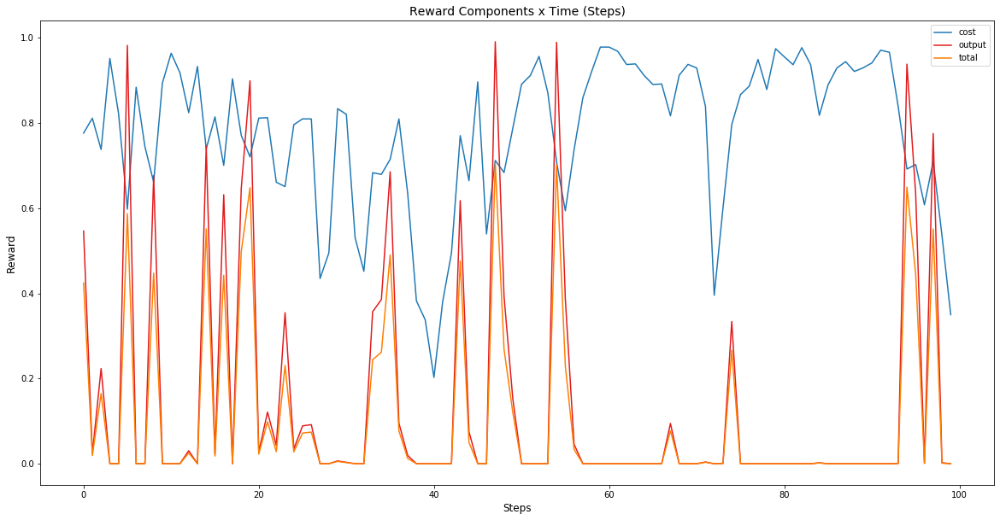

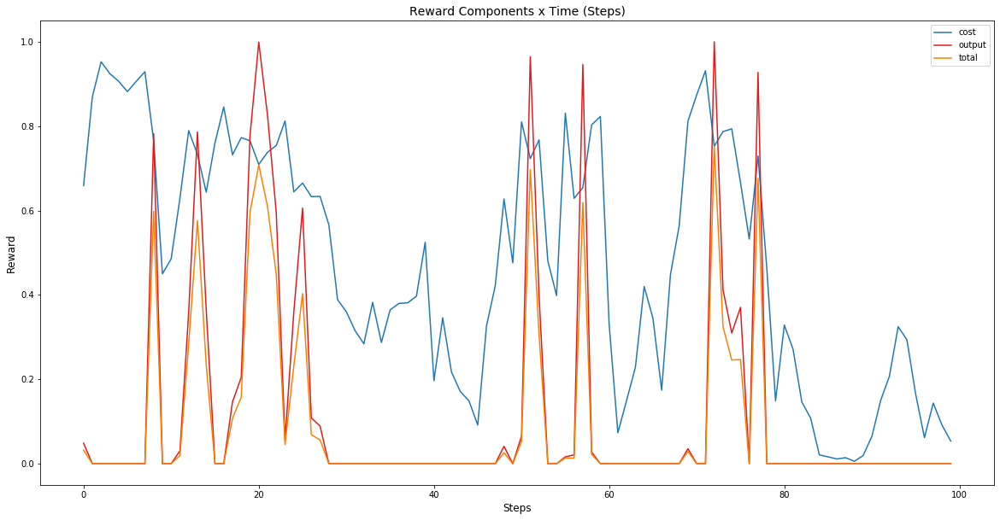

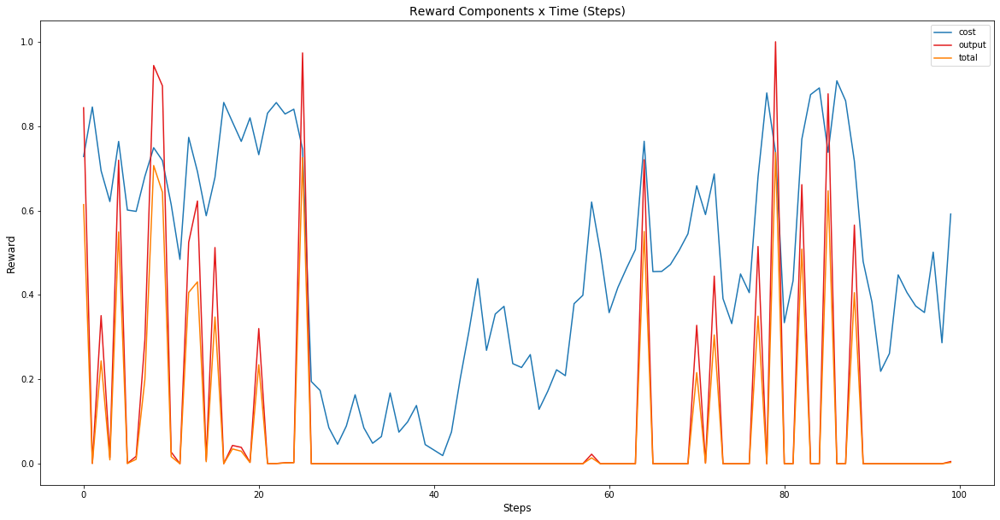

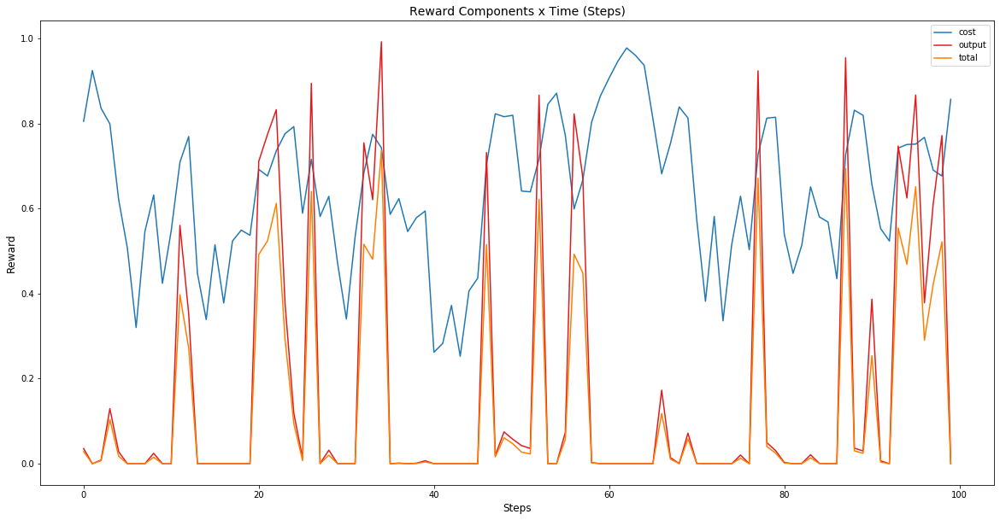

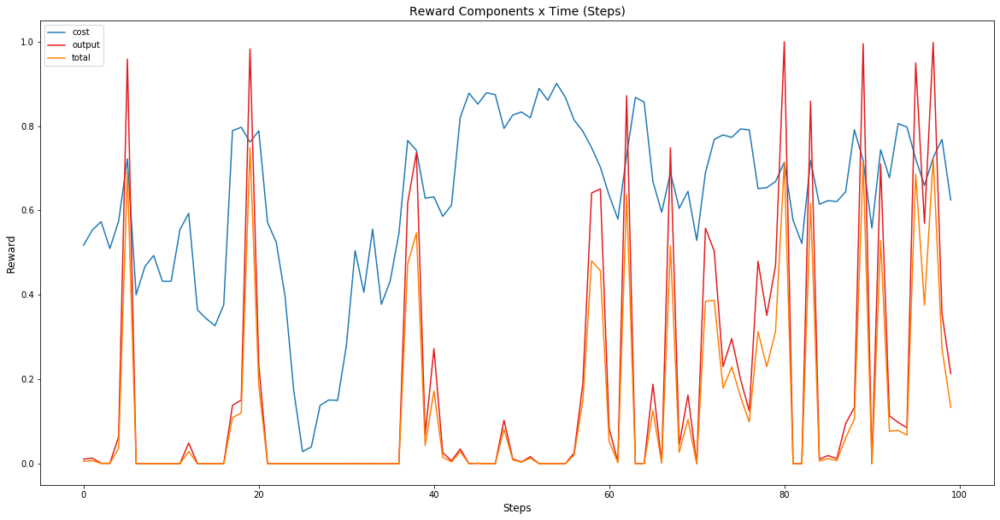

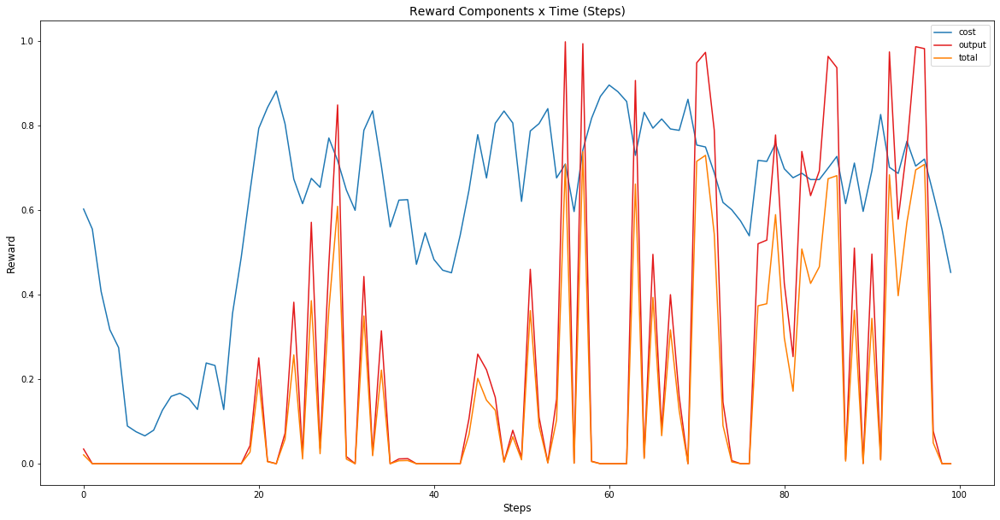

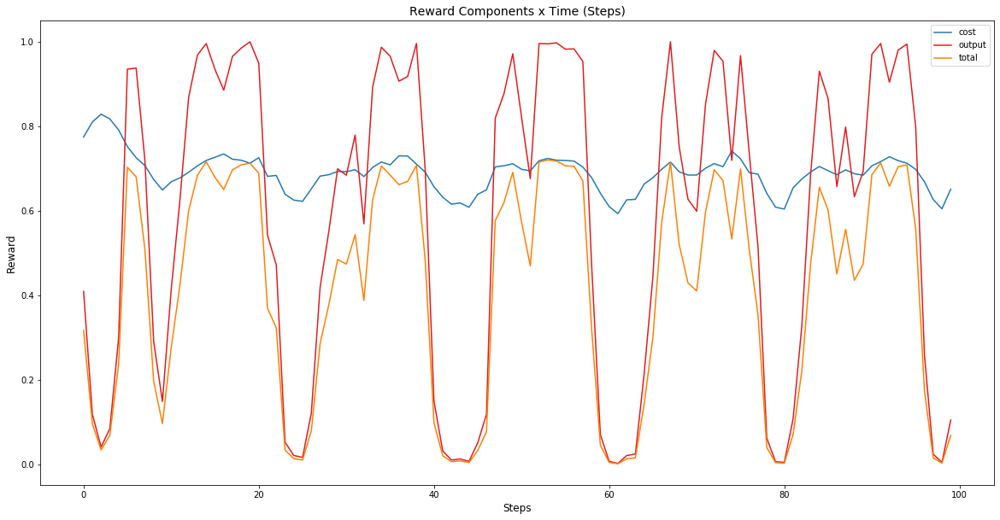

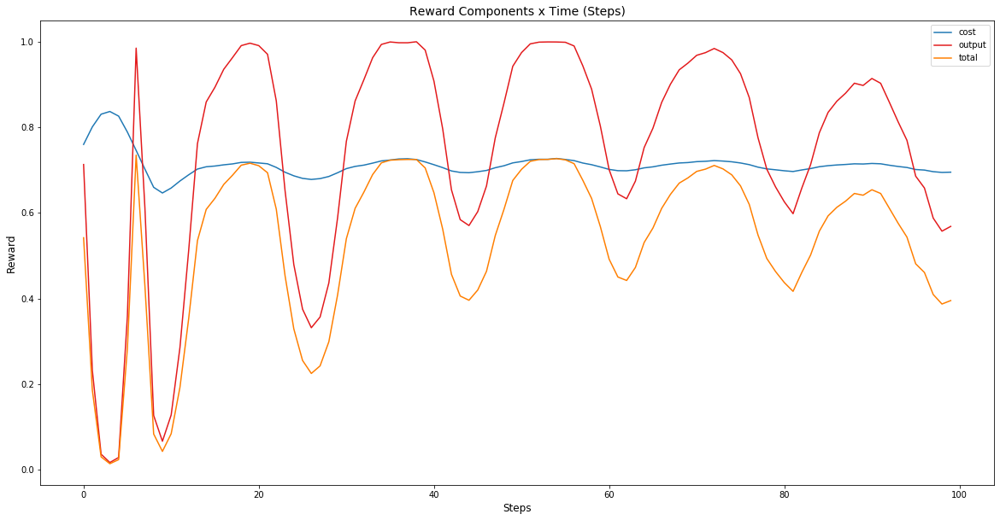

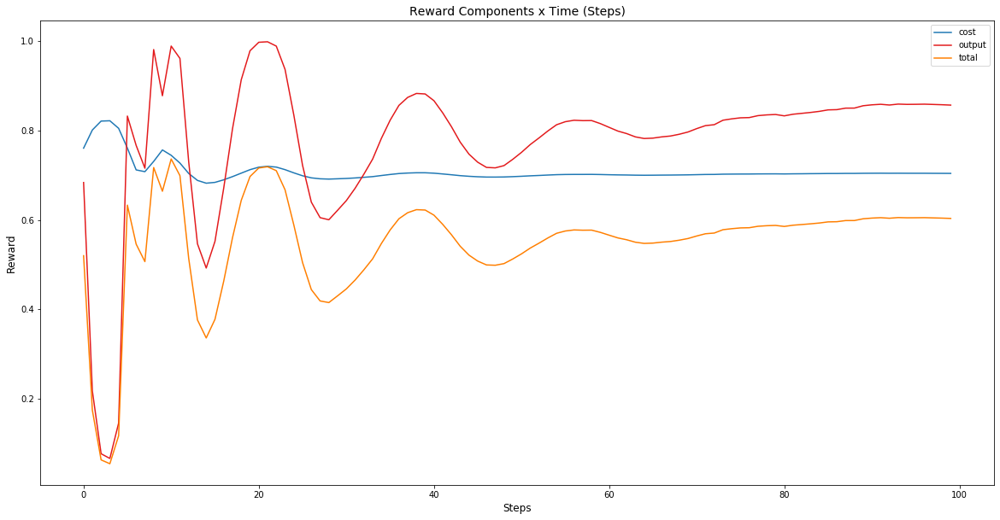

In [11]:
plotExperimentRewardProgression(LearningState().model.allRewards)

Plot the reward progression of the model testing

214.44725530259666

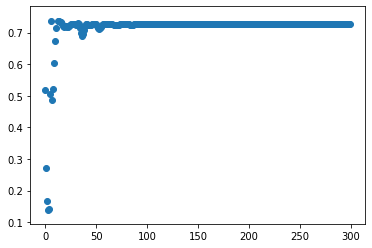

In [12]:
steps = range(STEPS_TO_TEST)
plt.scatter(steps, rewards)
sum(rewards)

Plot all graphs related to the electrical system state during the model testing

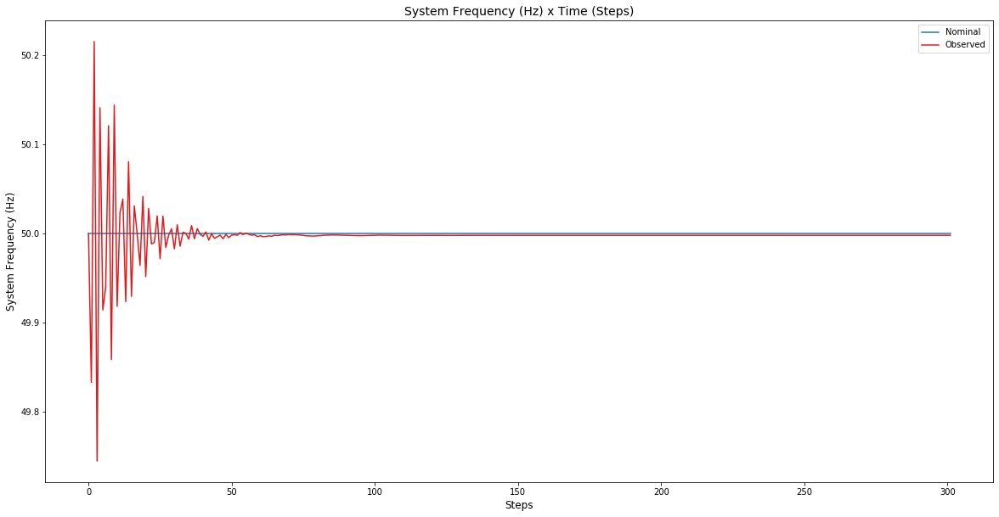

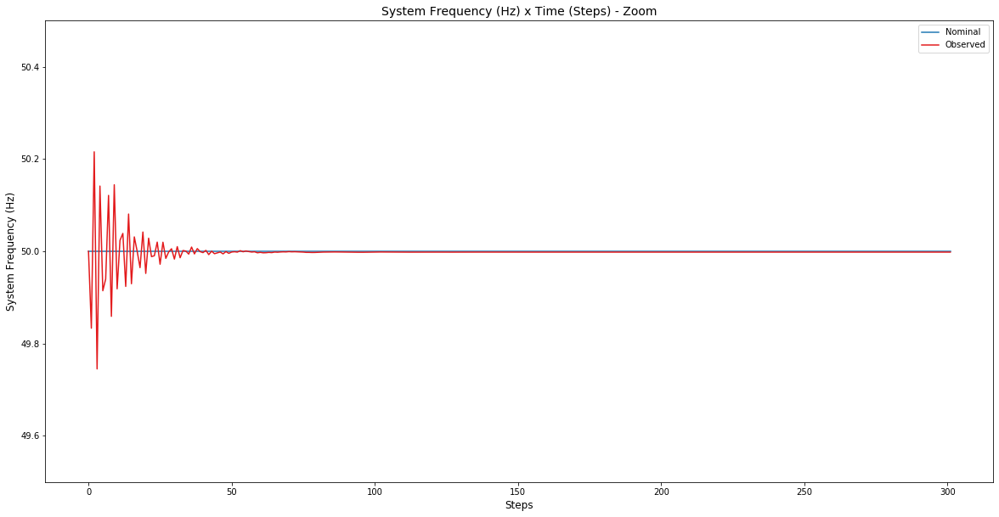

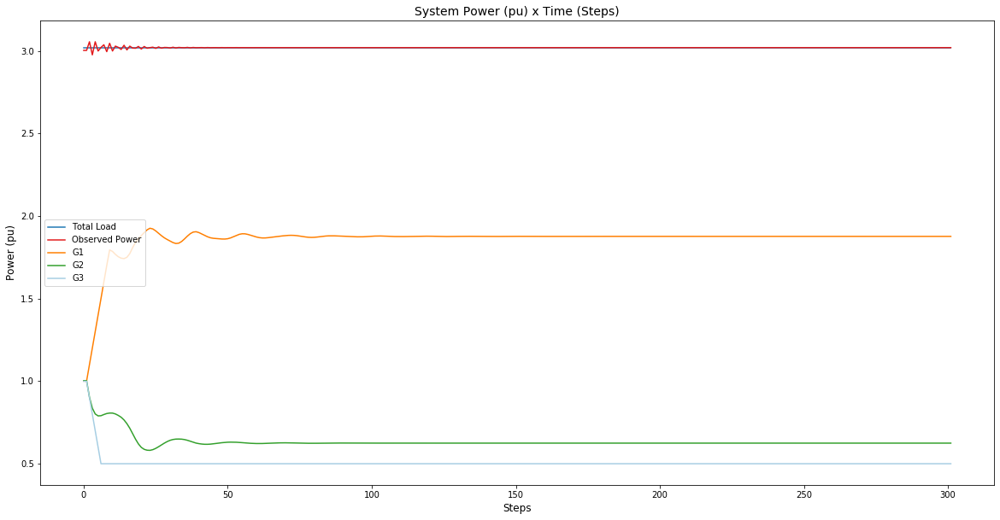

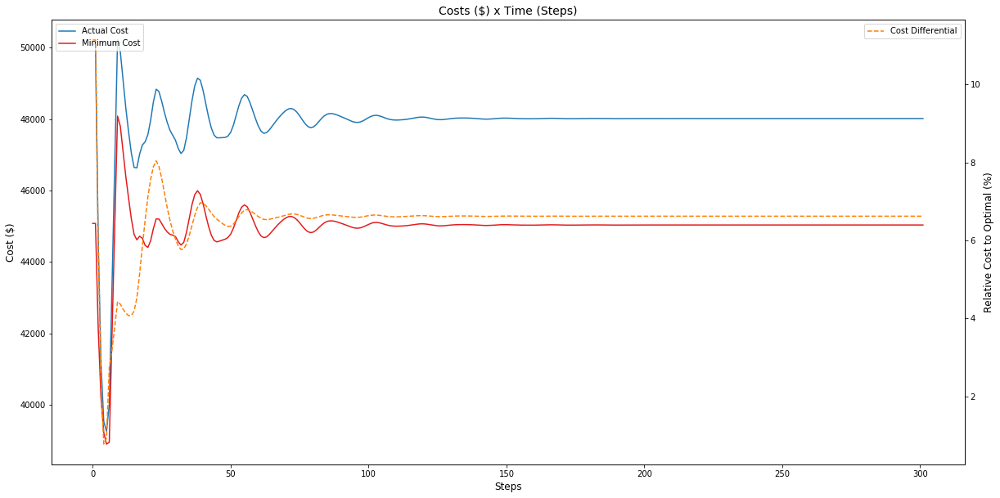

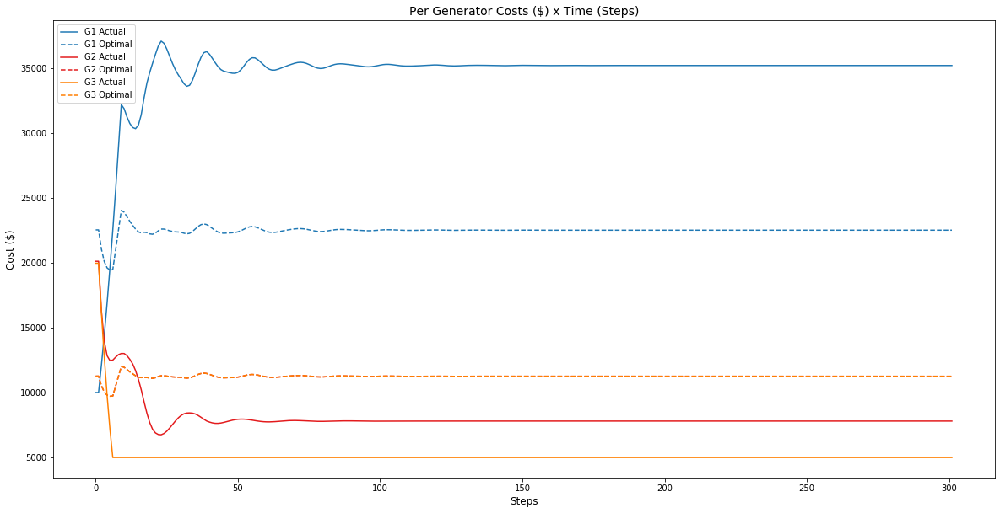

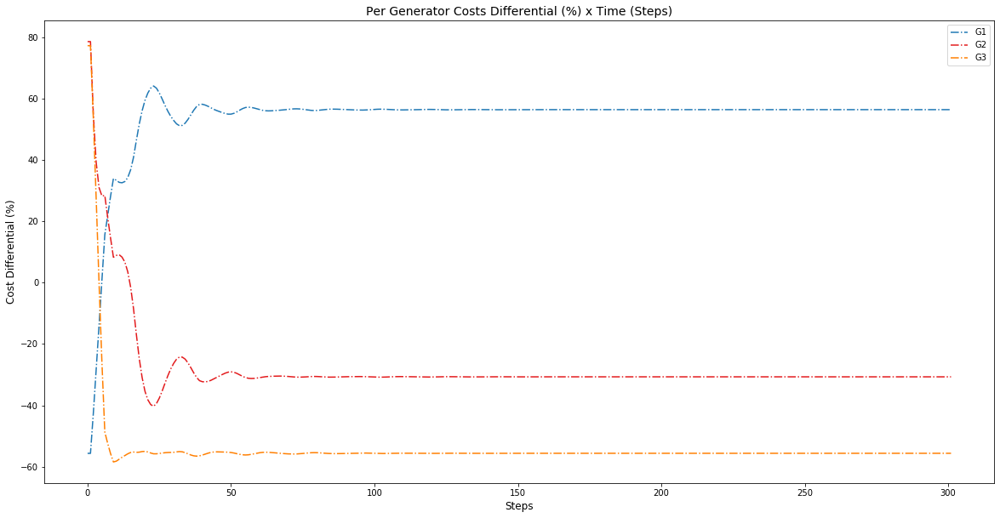

In [13]:
plotAll(electricalSystem.systemHistory)

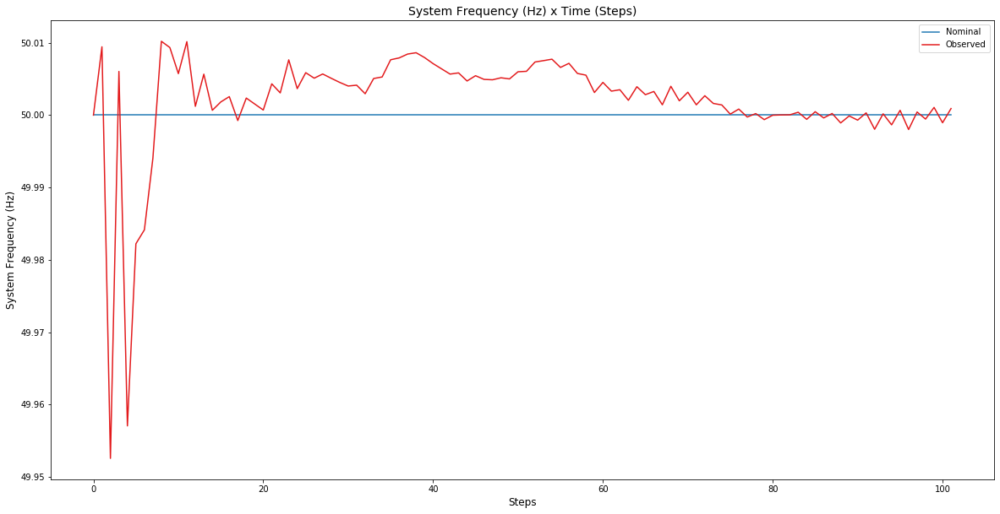

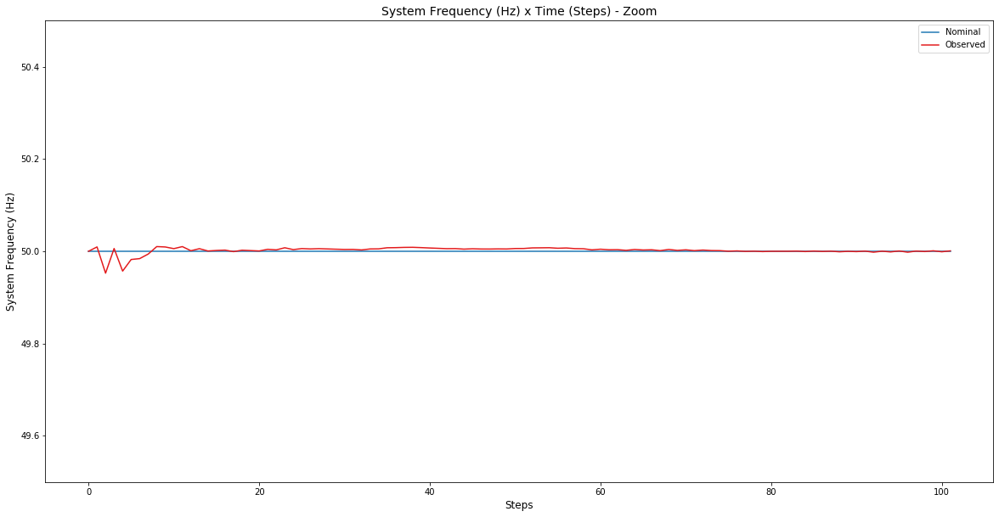

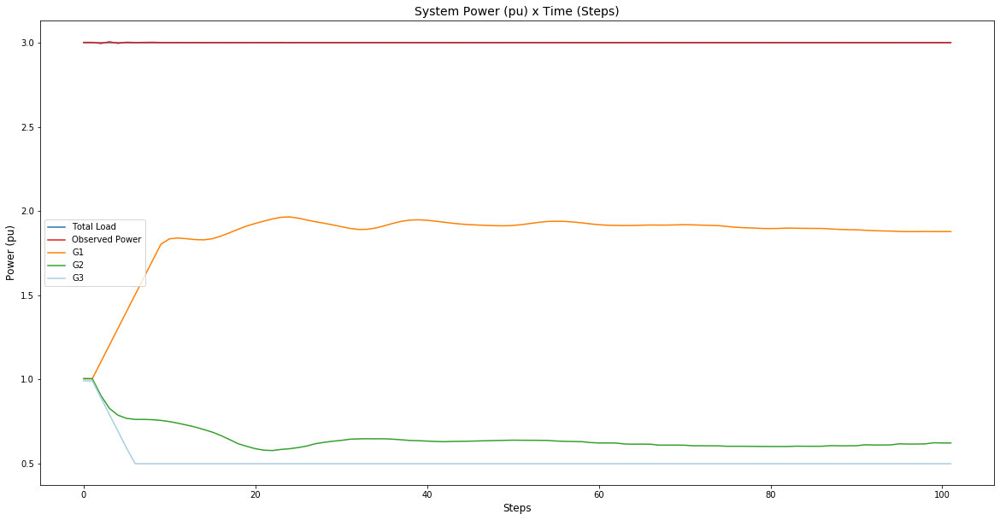

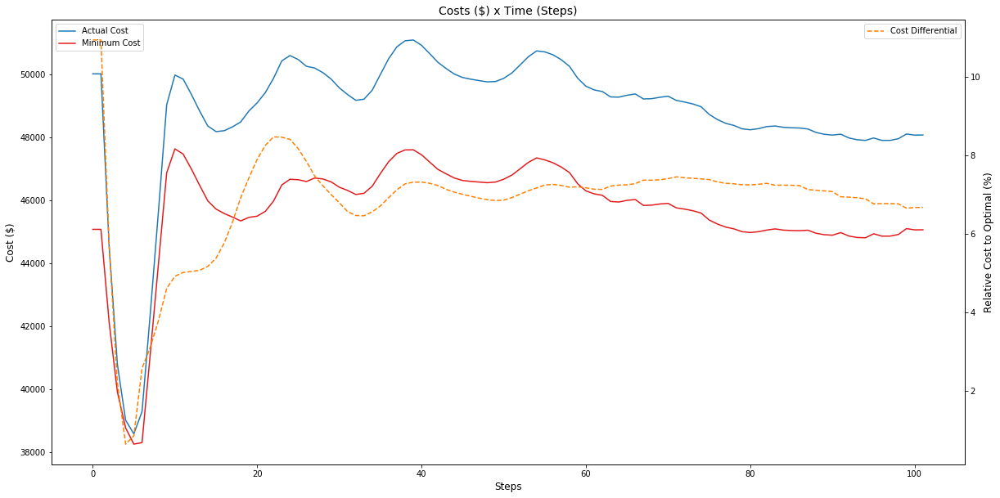

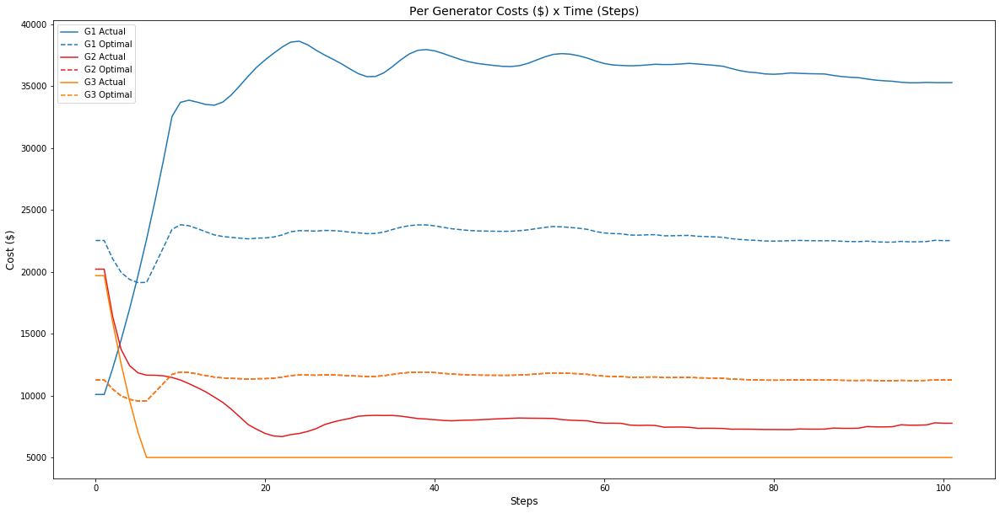

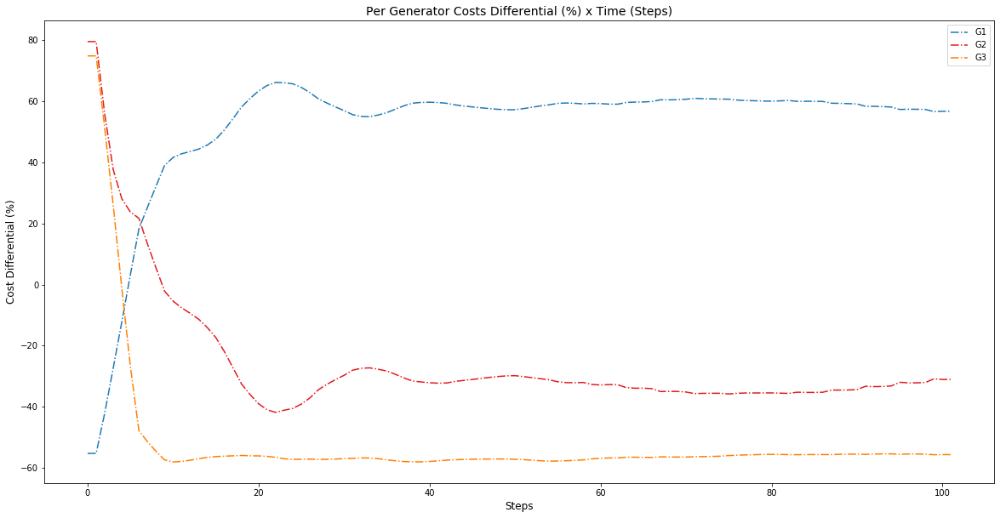

In [14]:
# # Show the last episode ran during training
from learning.learning_state import LearningState
plotAll(LearningState().episode.electricalSystem.systemHistory)

In [15]:
from learning.learning_state import LearningState
import numpy as np

rewList = LearningState().model.cummRewardList

In [16]:
LearningState().model.allRewards

[[{'cost': 0.7765162008326694,
   'output': 0.5465004237764859,
   'total': 0.42436643282436065},
  {'cost': 0.811470126198836,
   'output': 0.02351944298031767,
   'total': 0.019085325363364707},
  {'cost': 0.7380885570231207,
   'output': 0.2236524367167115,
   'total': 0.16507530429094242},
  {'cost': 0.9519473663400994,
   'output': 9.006231067248231e-27,
   'total': 8.573457945117336e-27},
  {'cost': 0.82113085007277,
   'output': 0.0002239242475762019,
   'total': 0.00018387110776415207},
  {'cost': 0.5977472096760522,
   'output': 0.9826197086743312,
   'total': 0.5873581890327768},
  {'cost': 0.8842746237785226,
   'output': 1.4542955881734224e-12,
   'total': 1.2859966840948184e-12},
  {'cost': 0.7448248464373131,
   'output': 0.0001792117721845925,
   'total': 0.00013348138069714784},
  {'cost': 0.6615547542563929,
   'output': 0.6765889582318079,
   'total': 0.44760064199563254},
  {'cost': 0.894355953265571,
   'output': 4.308265905449607e-14,
   'total': 3.853123260789942e

TypeError: float() argument must be a string or a number, not 'dict'

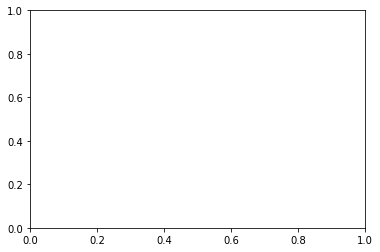

In [17]:
allRewards = LearningState().model.allRewards


for r in allRewards:
    plt.figure()
    plt.scatter(range(len(r)), r)
# sum(rewards)

In [ ]:
plt.scatter(range(len(rewList)), rewList)

In [ ]:
from plots.plot_constants import COLOR_PALETTE, FONT_SIZES

history = electricalSystem.systemHistory
# Get series to be plotted
stepsSeries = history.steps
loads = history.loads
totalLoadSeries = history.totalLoad
generators = history.generators
totalPowerSeries = history.totalPower

plt.figure(0)

# Declare colors to be used
colorTotalLoad = COLOR_PALETTE[0]
colorTotalPower = COLOR_PALETTE[1]
colorsIndividualNodes = COLOR_PALETTE[3:]

# Plot total power/load data
plt.plot(stepsSeries, totalLoadSeries, color=colorTotalLoad)
plt.plot(stepsSeries, totalPowerSeries, color=colorTotalPower)
legendFields = ['Total Load', 'Total Power']

# Multiple scenarios involve a single load, so we make it optional to plot that single load
if(False):
    for idx, loadId in enumerate(loads):
        # Since num loads is variable, colors may wrap around the palette
        loadColor = colorsIndividualNodes[idx % len(colorsIndividualNodes)]
        loadLegend = loadId
        loadSeries = loads[loadId]
        plt.plot(stepsSeries, loadSeries, color=loadColor, linestyle='--')
        legendFields.append(loadLegend)

for idx, generatorId in enumerate(generators):
    # Since num generators is variable, colors may wrap around the palette
    generatorColor = colorsIndividualNodes[idx % len(colorsIndividualNodes)]
    generatorLegend = generatorId
    generatorSeries = generators[generatorId]
    plt.plot(stepsSeries, generatorSeries, color=generatorColor)
    legendFields.append(generatorLegend)
    

summedPow = [x + y for x, y in zip(generators.get('G1'), generators.get('G2'))]
plt.plot(stepsSeries, summedPow, color=COLOR_PALETTE[2])
legendFields.append("Summed Pow")


plt.legend(legendFields)
plt.xlabel('Steps', fontsize=FONT_SIZES['AXIS_LABEL'])
plt.ylabel('Power (pu)', fontsize=FONT_SIZES['AXIS_LABEL'])

plt.title('System Power (pu) x Time (Steps)', fontsize=FONT_SIZES['TITLE'])

plt.show()